In [1]:
%matplotlib inline
import os

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow.keras as K
import tensorflow_probability as tfp
import tensorflow_probability.python.bijectors as tfb
import tensorflow_probability.python.distributions as tfd
import tensorflow_datasets as tfds

devices = tf.config.experimental.list_physical_devices(device_type='GPU')
for d in devices:
    tf.config.experimental.set_memory_growth(d, True)
        
print(devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Configuration

In [2]:
# tf.debugging.set_log_device_placement(True)
# tf.debugging.enable_check_numerics()

# Disable LayoutOptimizer since it raises reshape error (Why?)
tf.config.optimizer.set_experimental_options({'layout_optimizer': False})

log_dir = './logs/realnvp_cifar10_keras'
ckpt_dir = './logs/checkpoints/realnvp_cifar10_keras'

# Dataset

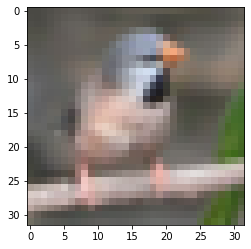

In [3]:
dataset, dataset_info = tfds.load(
        'cifar10',
        split=None, #tfds.Split.ALL,
        shuffle_files=True,
        as_supervised=True,
        with_info=True,
)

def preprocess(dataset):
    return dataset.map(
        lambda img, label: (
            tf.clip_by_value(img/255, .001, .999),
            label,
        )
    )

dataset['train'] = preprocess(dataset['train'])
dataset['test'] = preprocess(dataset['test'])

h, w, c = dataset_info.features['image'].shape
num_train_examples = dataset_info.splits['train'].num_examples
num_test_examples = dataset_info.splits['test'].num_examples

sample = next(iter(dataset['train']))
plt.imshow(sample[0].numpy().squeeze())

# Flow

In [4]:
class ShiftAndLogScale(tf.Module):
    def __init__(self, output_units, name='shift_and_log_scale'):
        super().__init__(name=name)

        self.output_units = output_units
        
        self.net = K.Sequential([
            K.layers.BatchNormalization(),
            K.layers.Conv2D(256, 3, 1, 'same', activation='relu'),
            K.layers.BatchNormalization(),
            K.layers.Conv2D(512, 3, 1, 'same', activation='relu'),
            K.layers.BatchNormalization(),
            K.layers.Conv2D(output_units*2, 3, 1, 'same', activation=None),
        ])
        
    @tf.function
    def __call__(self, x, output_units):
        assert output_units == self.output_units
        x = self.net(x)
        shift, log_scale = tf.split(x, 2, axis=-1)
        return shift, log_scale


class RealNVP(tfb.Chain):
    def __init__(self, n_layers, n_masked, n_units, name=None):
        def make_layer(i):
            fn = ShiftAndLogScale(n_units - n_masked)
            chain = [
                tfb.RealNVP(
                    num_masked=n_masked,
                    shift_and_log_scale_fn=fn,
                ),
                tfb.BatchNormalization(),
            ]
            if i % 2 == 0:
                perm = lambda: tfb.Permute(permutation=[2, 0, 1], axis=-1)
                chain = [perm(), *chain, perm()]
            return tfb.Chain(chain)

        chain = [
            tfb.Sigmoid(),
            *[make_layer(i) for i in range(n_layers)],
            tfb.Reshape((h, w, 3), (-1,)),
        ]
        super().__init__(chain, name=name)

# Wrapper classes for Keras

In [5]:
class TransformedDistribution(tfd.TransformedDistribution):
    @property
    def weights(self):
        return self.variables

    @property
    def trainable_weights(self):
        return self.trainable_variables

    @property
    def non_trainable_weights(self):
        return tuple(filter(lambda v: not getattr(v, 'trainable', False), self.weights))
    
class LogProb(K.Model):
    def __init__(self, distribution, bijector):
        super().__init__()
        self.flow = TransformedDistribution(
            distribution=distribution,
            bijector=bijector,
        )
        
    def call(self, x):
        log_prob = self.flow.log_prob(x)
        return log_prob

class NegativeLogLikelihood(K.losses.Loss):
    def call(self, _, log_prob):
        return -log_prob / (h*w*c)

# Build model

In [6]:
distribution = tfd.MultivariateNormalDiag(
    loc=tf.zeros(h*w*3, name='loc'),
    scale_diag=tf.ones(h*w*3, name='scale_diag'),
    name='distribution',
)

bijector = RealNVP(n_layers=10, n_masked=2, n_units=3, name='bijector') 

model = LogProb(distribution, bijector)
loss_fn = NegativeLogLikelihood(name='nll')
model.compile(
    optimizer=tf.optimizers.SGD(learning_rate=1e-3),
    loss=loss_fn,
)
model.build((None, h, w, c))
model.summary()

Instructions for updating:
Please use `layer.__call__` method instead.


Instructions for updating:
Please use `layer.__call__` method instead.


Model: "log_prob"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Total params: 11,973,340
Trainable params: 11,957,880
Non-trainable params: 15,460
_________________________________________________________________


# Training

In [7]:
def sampling_callback(flow, steps_per_epoch, n_samples=9):
    normal_samples = flow.distribution.sample(n_samples)
    def _(epoch, logs):
        print(epoch)
        samples = flow.bijector.forward(normal_samples)
        tf.summary.image(
            'samples', samples,
            step=epoch*steps_per_epoch,
            max_outputs=n_samples
        )
    return _
        
callbacks = [
    K.callbacks.TensorBoard(
        log_dir=log_dir, update_freq='batch',
        histogram_freq=100,
        write_graph=True, write_images=True,
    ),
    K.callbacks.ModelCheckpoint(
        ckpt_dir, save_weights_only=True, verbose=1,
    ),
    # K.callbacks.ProgbarLogger(),
    K.callbacks.LambdaCallback(
        on_epoch_end=sampling_callback(
            model.flow, num_train_examples),
    ),
]

history = model.fit(
    dataset['train'].batch(50).repeat(),
    steps_per_epoch=num_train_examples,
    epochs=100,
    validation_data=dataset['test'].batch(50).repeat(),
    validation_steps=num_test_examples,
    callbacks=callbacks,
    
)

Train for 50000 steps, validate for 10000 steps
Epoch 1/100


    1/50000 [..............................] - ETA: 102:47:57 - loss: 0.1446

    2/50000 [..............................] - ETA: 56:13:51 - loss: 0.1291 

    3/50000 [..............................] - ETA: 40:26:56 - loss: 0.1017

    4/50000 [..............................] - ETA: 32:33:10 - loss: 0.0767

    5/50000 [..............................] - ETA: 27:48:35 - loss: 0.0813

    6/50000 [..............................] - ETA: 24:39:19 - loss: 0.0673

    7/50000 [..............................] - ETA: 22:24:33 - loss: 0.0506

    8/50000 [..............................] - ETA: 20:42:52 - loss: 0.0327

    9/50000 [..............................] - ETA: 19:24:04 - loss: 0.0239

   10/50000 [..............................] - ETA: 18:20:58 - loss: 0.0100

   11/50000 [..............................] - ETA: 17:29:26 - loss: -0.0019

   12/50000 [..............................] - ETA: 16:46:26 - loss: -0.0099

   13/50000 [..............................] - ETA: 16:09:57 - loss: -0.0190

   14/50000 [..............................] - ETA: 15:38:44 - loss: -0.0277

   15/50000 [..............................] - ETA: 15:11:51 - loss: -0.0382

   16/50000 [..............................] - ETA: 14:48:18 - loss: -0.0472

   17/50000 [..............................] - ETA: 14:27:22 - loss: -0.0527

   18/50000 [..............................] - ETA: 14:08:51 - loss: -0.0602

   19/50000 [..............................] - ETA: 13:52:26 - loss: -0.0651

   20/50000 [..............................] - ETA: 13:37:28 - loss: -0.0696

   21/50000 [..............................] - ETA: 13:23:57 - loss: -0.0770

   22/50000 [..............................] - ETA: 13:11:37 - loss: -0.0815

   23/50000 [..............................] - ETA: 13:00:25 - loss: -0.0873

   24/50000 [..............................] - ETA: 12:50:10 - loss: -0.0914

   25/50000 [..............................] - ETA: 12:40:43 - loss: -0.0976

   26/50000 [..............................] - ETA: 12:31:54 - loss: -0.1028

   27/50000 [..............................] - ETA: 12:23:49 - loss: -0.1084

   28/50000 [..............................] - ETA: 12:16:20 - loss: -0.1136

   29/50000 [..............................] - ETA: 12:09:23 - loss: -0.1181

   30/50000 [..............................] - ETA: 12:02:48 - loss: -0.1217

   31/50000 [..............................] - ETA: 11:56:42 - loss: -0.1265

   32/50000 [..............................] - ETA: 11:50:58 - loss: -0.1310

   33/50000 [..............................] - ETA: 11:45:38 - loss: -0.1329

   34/50000 [..............................] - ETA: 11:40:40 - loss: -0.1368

   35/50000 [..............................] - ETA: 11:35:57 - loss: -0.1412

   36/50000 [..............................] - ETA: 11:31:25 - loss: -0.1456

   37/50000 [..............................] - ETA: 11:27:14 - loss: -0.1499

   38/50000 [..............................] - ETA: 11:23:13 - loss: -0.1538

   39/50000 [..............................] - ETA: 11:19:25 - loss: -0.1568

   40/50000 [..............................] - ETA: 11:15:48 - loss: -0.1606

   41/50000 [..............................] - ETA: 11:12:25 - loss: -0.1625

   42/50000 [..............................] - ETA: 11:09:06 - loss: -0.1667

   43/50000 [..............................] - ETA: 11:05:57 - loss: -0.1701

   44/50000 [..............................] - ETA: 11:02:59 - loss: -0.1741

   45/50000 [..............................] - ETA: 11:00:11 - loss: -0.1774

   46/50000 [..............................] - ETA: 10:57:30 - loss: -0.1812

   47/50000 [..............................] - ETA: 10:54:53 - loss: -0.1823

   48/50000 [..............................] - ETA: 10:52:25 - loss: -0.1862

   49/50000 [..............................] - ETA: 10:49:59 - loss: -0.1893

   50/50000 [..............................] - ETA: 10:47:41 - loss: -0.1924

   51/50000 [..............................] - ETA: 10:45:28 - loss: -0.1946

   52/50000 [..............................] - ETA: 10:43:21 - loss: -0.1976

   53/50000 [..............................] - ETA: 10:41:16 - loss: -0.2006

   54/50000 [..............................] - ETA: 10:39:14 - loss: -0.2037

   55/50000 [..............................] - ETA: 10:37:20 - loss: -0.2068

   56/50000 [..............................] - ETA: 10:35:29 - loss: -0.2092

   57/50000 [..............................] - ETA: 10:33:44 - loss: -0.2114

   58/50000 [..............................] - ETA: 10:32:02 - loss: -0.2143

   59/50000 [..............................] - ETA: 10:30:28 - loss: -0.2164

   60/50000 [..............................] - ETA: 10:29:01 - loss: -0.2192

   61/50000 [..............................] - ETA: 10:27:31 - loss: -0.2219

   62/50000 [..............................] - ETA: 10:26:06 - loss: -0.2249

   63/50000 [..............................] - ETA: 10:24:44 - loss: -0.2275

   64/50000 [..............................] - ETA: 10:23:42 - loss: -0.2296

   65/50000 [..............................] - ETA: 10:22:43 - loss: -0.2322

   66/50000 [..............................] - ETA: 10:21:33 - loss: -0.2348

   67/50000 [..............................] - ETA: 10:20:18 - loss: -0.2362

   68/50000 [..............................] - ETA: 10:19:04 - loss: -0.2380

   69/50000 [..............................] - ETA: 10:17:55 - loss: -0.2404

   70/50000 [..............................] - ETA: 10:16:59 - loss: -0.2430

   71/50000 [..............................] - ETA: 10:16:01 - loss: -0.2449

   72/50000 [..............................] - ETA: 10:15:04 - loss: -0.2470

   73/50000 [..............................] - ETA: 10:14:12 - loss: -0.2489

   74/50000 [..............................] - ETA: 10:13:09 - loss: -0.2513

   75/50000 [..............................] - ETA: 10:12:06 - loss: -0.2528

   76/50000 [..............................] - ETA: 10:11:06 - loss: -0.2546

   77/50000 [..............................] - ETA: 10:10:14 - loss: -0.2568

   78/50000 [..............................] - ETA: 10:09:18 - loss: -0.2586

   79/50000 [..............................] - ETA: 10:08:24 - loss: -0.2605

   80/50000 [..............................] - ETA: 10:07:30 - loss: -0.2618

   81/50000 [..............................] - ETA: 10:06:48 - loss: -0.2633

   82/50000 [..............................] - ETA: 10:06:02 - loss: -0.2655

   83/50000 [..............................] - ETA: 10:05:19 - loss: -0.2669

   84/50000 [..............................] - ETA: 10:04:42 - loss: -0.2686

   85/50000 [..............................] - ETA: 10:04:08 - loss: -0.2704

   86/50000 [..............................] - ETA: 10:03:20 - loss: -0.2723

   87/50000 [..............................] - ETA: 10:02:34 - loss: -0.2744

   88/50000 [..............................] - ETA: 10:01:48 - loss: -0.2764

   89/50000 [..............................] - ETA: 10:01:03 - loss: -0.2783

   90/50000 [..............................] - ETA: 10:00:22 - loss: -0.2797

   91/50000 [..............................] - ETA: 9:59:45 - loss: -0.2812 

   92/50000 [..............................] - ETA: 9:59:12 - loss: -0.2826

   93/50000 [..............................] - ETA: 9:58:42 - loss: -0.2841

   94/50000 [..............................] - ETA: 9:58:13 - loss: -0.2854

   95/50000 [..............................] - ETA: 9:57:38 - loss: -0.2872

   96/50000 [..............................] - ETA: 9:57:03 - loss: -0.2891

   97/50000 [..............................] - ETA: 9:56:32 - loss: -0.2910

   98/50000 [..............................] - ETA: 9:55:56 - loss: -0.2925

   99/50000 [..............................] - ETA: 9:55:19 - loss: -0.2946

  100/50000 [..............................] - ETA: 9:54:44 - loss: -0.2963

  101/50000 [..............................] - ETA: 9:54:12 - loss: -0.2980

  102/50000 [..............................] - ETA: 9:53:38 - loss: -0.2995

  103/50000 [..............................] - ETA: 9:53:05 - loss: -0.3013

  104/50000 [..............................] - ETA: 9:52:33 - loss: -0.3027

  105/50000 [..............................] - ETA: 9:52:01 - loss: -0.3034

  106/50000 [..............................] - ETA: 9:51:35 - loss: -0.3046

  107/50000 [..............................] - ETA: 9:51:08 - loss: -0.3067

  108/50000 [..............................] - ETA: 9:50:43 - loss: -0.3082

  109/50000 [..............................] - ETA: 9:50:21 - loss: -0.3097

  110/50000 [..............................] - ETA: 9:49:59 - loss: -0.3110

  111/50000 [..............................] - ETA: 9:49:32 - loss: -0.3129

  112/50000 [..............................] - ETA: 9:49:04 - loss: -0.3137

  113/50000 [..............................] - ETA: 9:48:35 - loss: -0.3153

  114/50000 [..............................] - ETA: 9:48:10 - loss: -0.3169

  115/50000 [..............................] - ETA: 9:47:43 - loss: -0.3180

  116/50000 [..............................] - ETA: 9:47:20 - loss: -0.3195

  117/50000 [..............................] - ETA: 9:47:00 - loss: -0.3206

  118/50000 [..............................] - ETA: 9:46:41 - loss: -0.3222

  119/50000 [..............................] - ETA: 9:46:23 - loss: -0.3231

  120/50000 [..............................] - ETA: 9:46:10 - loss: -0.3244

  121/50000 [..............................] - ETA: 9:46:02 - loss: -0.3256

  122/50000 [..............................] - ETA: 9:45:55 - loss: -0.3268

  123/50000 [..............................] - ETA: 9:45:49 - loss: -0.3287

  124/50000 [..............................] - ETA: 9:45:37 - loss: -0.3295

  125/50000 [..............................] - ETA: 9:45:18 - loss: -0.3310

  126/50000 [..............................] - ETA: 9:44:56 - loss: -0.3324

  127/50000 [..............................] - ETA: 9:44:43 - loss: -0.3337

  128/50000 [..............................] - ETA: 9:44:36 - loss: -0.3351

  129/50000 [..............................] - ETA: 9:44:29 - loss: -0.3361

  130/50000 [..............................] - ETA: 9:44:23 - loss: -0.3373

  131/50000 [..............................] - ETA: 9:44:14 - loss: -0.3377

  132/50000 [..............................] - ETA: 9:44:10 - loss: -0.3398

  133/50000 [..............................] - ETA: 9:44:02 - loss: -0.3416

  134/50000 [..............................] - ETA: 9:43:50 - loss: -0.3427

  135/50000 [..............................] - ETA: 9:43:43 - loss: -0.3443

  136/50000 [..............................] - ETA: 9:43:29 - loss: -0.3460

  137/50000 [..............................] - ETA: 9:43:13 - loss: -0.3475

  138/50000 [..............................] - ETA: 9:42:58 - loss: -0.3489

  139/50000 [..............................] - ETA: 9:42:38 - loss: -0.3498

  140/50000 [..............................] - ETA: 9:42:19 - loss: -0.3513

  141/50000 [..............................] - ETA: 9:42:00 - loss: -0.3523

  142/50000 [..............................] - ETA: 9:41:45 - loss: -0.3532

  143/50000 [..............................] - ETA: 9:41:26 - loss: -0.3547

  144/50000 [..............................] - ETA: 9:41:07 - loss: -0.3558

  145/50000 [..............................] - ETA: 9:40:50 - loss: -0.3566

  146/50000 [..............................] - ETA: 9:40:42 - loss: -0.3580

  147/50000 [..............................] - ETA: 9:40:30 - loss: -0.3592

  148/50000 [..............................] - ETA: 9:40:16 - loss: -0.3603

  149/50000 [..............................] - ETA: 9:39:59 - loss: -0.3614

  150/50000 [..............................] - ETA: 9:39:41 - loss: -0.3625

  151/50000 [..............................] - ETA: 9:39:23 - loss: -0.3640

  152/50000 [..............................] - ETA: 9:39:09 - loss: -0.3652

  153/50000 [..............................] - ETA: 9:38:56 - loss: -0.3665

  154/50000 [..............................] - ETA: 9:38:53 - loss: -0.3672

  155/50000 [..............................] - ETA: 9:38:45 - loss: -0.3681

  156/50000 [..............................] - ETA: 9:38:30 - loss: -0.3697

  157/50000 [..............................] - ETA: 9:38:16 - loss: -0.3710

  158/50000 [..............................] - ETA: 9:38:08 - loss: -0.3719

  159/50000 [..............................] - ETA: 9:37:57 - loss: -0.3727

  160/50000 [..............................] - ETA: 9:37:42 - loss: -0.3734

  161/50000 [..............................] - ETA: 9:37:27 - loss: -0.3743

  162/50000 [..............................] - ETA: 9:37:17 - loss: -0.3753

  163/50000 [..............................] - ETA: 9:37:05 - loss: -0.3762

  164/50000 [..............................] - ETA: 9:36:52 - loss: -0.3769

  165/50000 [..............................] - ETA: 9:36:36 - loss: -0.3777

  166/50000 [..............................] - ETA: 9:36:20 - loss: -0.3790

  167/50000 [..............................] - ETA: 9:36:07 - loss: -0.3797

  168/50000 [..............................] - ETA: 9:35:58 - loss: -0.3808

  169/50000 [..............................] - ETA: 9:35:47 - loss: -0.3813

  170/50000 [..............................] - ETA: 9:35:33 - loss: -0.3821

  171/50000 [..............................] - ETA: 9:35:18 - loss: -0.3825

  172/50000 [..............................] - ETA: 9:35:03 - loss: -0.3832

  173/50000 [..............................] - ETA: 9:34:50 - loss: -0.3841

  174/50000 [..............................] - ETA: 9:34:39 - loss: -0.3848

  175/50000 [..............................] - ETA: 9:34:31 - loss: -0.3857

  176/50000 [..............................] - ETA: 9:34:20 - loss: -0.3866

  177/50000 [..............................] - ETA: 9:34:07 - loss: -0.3874

  178/50000 [..............................] - ETA: 9:33:53 - loss: -0.3885

  179/50000 [..............................] - ETA: 9:33:41 - loss: -0.3896

  180/50000 [..............................] - ETA: 9:33:31 - loss: -0.3904

  181/50000 [..............................] - ETA: 9:33:21 - loss: -0.3914

  182/50000 [..............................] - ETA: 9:33:09 - loss: -0.3923

  183/50000 [..............................] - ETA: 9:32:58 - loss: -0.3931

  184/50000 [..............................] - ETA: 9:32:45 - loss: -0.3938

  185/50000 [..............................] - ETA: 9:32:34 - loss: -0.3941

  186/50000 [..............................] - ETA: 9:32:27 - loss: -0.3951

  187/50000 [..............................] - ETA: 9:32:23 - loss: -0.3959

  188/50000 [..............................] - ETA: 9:32:15 - loss: -0.3967

  189/50000 [..............................] - ETA: 9:32:04 - loss: -0.3973

  190/50000 [..............................] - ETA: 9:31:52 - loss: -0.3982

  191/50000 [..............................] - ETA: 9:31:40 - loss: -0.3993

  192/50000 [..............................] - ETA: 9:31:29 - loss: -0.4005

  193/50000 [..............................] - ETA: 9:31:17 - loss: -0.4012

  194/50000 [..............................] - ETA: 9:31:07 - loss: -0.4020

  195/50000 [..............................] - ETA: 9:30:55 - loss: -0.4029

  196/50000 [..............................] - ETA: 9:30:45 - loss: -0.4043

  197/50000 [..............................] - ETA: 9:30:33 - loss: -0.4052

  198/50000 [..............................] - ETA: 9:30:22 - loss: -0.4060

  199/50000 [..............................] - ETA: 9:30:11 - loss: -0.4068

  200/50000 [..............................] - ETA: 9:30:00 - loss: -0.4074

  201/50000 [..............................] - ETA: 9:29:51 - loss: -0.4081

  202/50000 [..............................] - ETA: 9:29:45 - loss: -0.4090

  203/50000 [..............................] - ETA: 9:29:37 - loss: -0.4097

  204/50000 [..............................] - ETA: 9:29:28 - loss: -0.4101

  205/50000 [..............................] - ETA: 9:29:16 - loss: -0.4108

  206/50000 [..............................] - ETA: 9:29:07 - loss: -0.4113

  207/50000 [..............................] - ETA: 9:29:04 - loss: -0.4122

  208/50000 [..............................] - ETA: 9:28:57 - loss: -0.4130

  209/50000 [..............................] - ETA: 9:28:48 - loss: -0.4137

  210/50000 [..............................] - ETA: 9:28:38 - loss: -0.4145

  211/50000 [..............................] - ETA: 9:28:29 - loss: -0.4152

  212/50000 [..............................] - ETA: 9:28:21 - loss: -0.4158

  213/50000 [..............................] - ETA: 9:28:13 - loss: -0.4168

  214/50000 [..............................] - ETA: 9:28:04 - loss: -0.4175

  215/50000 [..............................] - ETA: 9:27:55 - loss: -0.4177

  216/50000 [..............................] - ETA: 9:27:50 - loss: -0.4185

  217/50000 [..............................] - ETA: 9:27:43 - loss: -0.4193

  218/50000 [..............................] - ETA: 9:27:35 - loss: -0.4201

  219/50000 [..............................] - ETA: 9:27:29 - loss: -0.4208

  220/50000 [..............................] - ETA: 9:27:20 - loss: -0.4214

  221/50000 [..............................] - ETA: 9:27:10 - loss: -0.4219

  222/50000 [..............................] - ETA: 9:27:00 - loss: -0.4225

  223/50000 [..............................] - ETA: 9:26:51 - loss: -0.4232

  224/50000 [..............................] - ETA: 9:26:44 - loss: -0.4235

  225/50000 [..............................] - ETA: 9:26:39 - loss: -0.4241

  226/50000 [..............................] - ETA: 9:26:32 - loss: -0.4244

  227/50000 [..............................] - ETA: 9:26:24 - loss: -0.4250

  228/50000 [..............................] - ETA: 9:26:15 - loss: -0.4258

  229/50000 [..............................] - ETA: 9:26:09 - loss: -0.4261

  230/50000 [..............................] - ETA: 9:26:01 - loss: -0.4269

  231/50000 [..............................] - ETA: 9:25:52 - loss: -0.4272

  232/50000 [..............................] - ETA: 9:25:45 - loss: -0.4277

  233/50000 [..............................] - ETA: 9:25:37 - loss: -0.4284

  234/50000 [..............................] - ETA: 9:25:31 - loss: -0.4292

  235/50000 [..............................] - ETA: 9:25:26 - loss: -0.4299

  236/50000 [..............................] - ETA: 9:25:21 - loss: -0.4303

  237/50000 [..............................] - ETA: 9:25:15 - loss: -0.4306

  238/50000 [..............................] - ETA: 9:25:09 - loss: -0.4312

  239/50000 [..............................] - ETA: 9:25:08 - loss: -0.4317

  240/50000 [..............................] - ETA: 9:25:09 - loss: -0.4323

  241/50000 [..............................] - ETA: 9:25:05 - loss: -0.4330

  242/50000 [..............................] - ETA: 9:24:58 - loss: -0.4337

  243/50000 [..............................] - ETA: 9:24:50 - loss: -0.4343

  244/50000 [..............................] - ETA: 9:24:42 - loss: -0.4354

  245/50000 [..............................] - ETA: 9:24:35 - loss: -0.4359

  246/50000 [..............................] - ETA: 9:24:28 - loss: -0.4365

  247/50000 [..............................] - ETA: 9:24:22 - loss: -0.4372

  248/50000 [..............................] - ETA: 9:24:15 - loss: -0.4379

  249/50000 [..............................] - ETA: 9:24:07 - loss: -0.4386

  250/50000 [..............................] - ETA: 9:24:00 - loss: -0.4392

  251/50000 [..............................] - ETA: 9:23:52 - loss: -0.4397

  252/50000 [..............................] - ETA: 9:23:46 - loss: -0.4396

  253/50000 [..............................] - ETA: 9:23:42 - loss: -0.4404

  254/50000 [..............................] - ETA: 9:23:39 - loss: -0.4410

  255/50000 [..............................] - ETA: 9:23:37 - loss: -0.4417

  256/50000 [..............................] - ETA: 9:23:33 - loss: -0.4419

  257/50000 [..............................] - ETA: 9:23:26 - loss: -0.4426

  258/50000 [..............................] - ETA: 9:23:20 - loss: -0.4430

  259/50000 [..............................] - ETA: 9:23:13 - loss: -0.4431

  260/50000 [..............................] - ETA: 9:23:05 - loss: -0.4437

  261/50000 [..............................] - ETA: 9:22:58 - loss: -0.4445

  262/50000 [..............................] - ETA: 9:22:52 - loss: -0.4448

  263/50000 [..............................] - ETA: 9:22:46 - loss: -0.4451

  264/50000 [..............................] - ETA: 9:22:39 - loss: -0.4455

  265/50000 [..............................] - ETA: 9:22:34 - loss: -0.4459

  266/50000 [..............................] - ETA: 9:22:28 - loss: -0.4465

  267/50000 [..............................] - ETA: 9:22:21 - loss: -0.4471

  268/50000 [..............................] - ETA: 9:22:14 - loss: -0.4476

  269/50000 [..............................] - ETA: 9:22:07 - loss: -0.4478

  270/50000 [..............................] - ETA: 9:22:01 - loss: -0.4481

  271/50000 [..............................] - ETA: 9:21:57 - loss: -0.4488

  272/50000 [..............................] - ETA: 9:21:52 - loss: -0.4493

  273/50000 [..............................] - ETA: 9:21:47 - loss: -0.4500

  274/50000 [..............................] - ETA: 9:21:44 - loss: -0.4503

  275/50000 [..............................] - ETA: 9:21:40 - loss: -0.4509

  276/50000 [..............................] - ETA: 9:21:35 - loss: -0.4514

  277/50000 [..............................] - ETA: 9:21:29 - loss: -0.4520

  278/50000 [..............................] - ETA: 9:21:25 - loss: -0.4526

  279/50000 [..............................] - ETA: 9:21:21 - loss: -0.4531

  280/50000 [..............................] - ETA: 9:21:15 - loss: -0.4536

  281/50000 [..............................] - ETA: 9:21:10 - loss: -0.4542

  282/50000 [..............................] - ETA: 9:21:04 - loss: -0.4546

  283/50000 [..............................] - ETA: 9:20:58 - loss: -0.4545

  284/50000 [..............................] - ETA: 9:20:52 - loss: -0.4548

  285/50000 [..............................] - ETA: 9:20:46 - loss: -0.4550

  286/50000 [..............................] - ETA: 9:20:40 - loss: -0.4553

  287/50000 [..............................] - ETA: 9:20:37 - loss: -0.4559

  288/50000 [..............................] - ETA: 9:20:38 - loss: -0.4563

  289/50000 [..............................] - ETA: 9:20:40 - loss: -0.4566

  290/50000 [..............................] - ETA: 9:20:37 - loss: -0.4570

  291/50000 [..............................] - ETA: 9:20:35 - loss: -0.4576

  292/50000 [..............................] - ETA: 9:20:32 - loss: -0.4580

  293/50000 [..............................] - ETA: 9:20:28 - loss: -0.4585

  294/50000 [..............................] - ETA: 9:20:26 - loss: -0.4590

  295/50000 [..............................] - ETA: 9:20:22 - loss: -0.4596

  296/50000 [..............................] - ETA: 9:20:16 - loss: -0.4599

  297/50000 [..............................] - ETA: 9:20:10 - loss: -0.4602

  298/50000 [..............................] - ETA: 9:20:06 - loss: -0.4607

  299/50000 [..............................] - ETA: 9:20:05 - loss: -0.4611

  300/50000 [..............................] - ETA: 9:20:07 - loss: -0.4617

  301/50000 [..............................] - ETA: 9:20:05 - loss: -0.4621

  302/50000 [..............................] - ETA: 9:20:00 - loss: -0.4628

  303/50000 [..............................] - ETA: 9:19:55 - loss: -0.4631

  304/50000 [..............................] - ETA: 9:19:50 - loss: -0.4634

  305/50000 [..............................] - ETA: 9:19:45 - loss: -0.4638

  306/50000 [..............................] - ETA: 9:19:40 - loss: -0.4639

  307/50000 [..............................] - ETA: 9:19:34 - loss: -0.4647

  308/50000 [..............................] - ETA: 9:19:30 - loss: -0.4653

  309/50000 [..............................] - ETA: 9:19:26 - loss: -0.4655

  310/50000 [..............................] - ETA: 9:19:20 - loss: -0.4658

  311/50000 [..............................] - ETA: 9:19:15 - loss: -0.4663

  312/50000 [..............................] - ETA: 9:19:10 - loss: -0.4669

  313/50000 [..............................] - ETA: 9:19:06 - loss: -0.4673

  314/50000 [..............................] - ETA: 9:19:01 - loss: -0.4678

  315/50000 [..............................] - ETA: 9:18:56 - loss: -0.4682

  316/50000 [..............................] - ETA: 9:18:52 - loss: -0.4689

  317/50000 [..............................] - ETA: 9:18:47 - loss: -0.4689

  318/50000 [..............................] - ETA: 9:18:42 - loss: -0.4695

  319/50000 [..............................] - ETA: 9:18:37 - loss: -0.4698

  320/50000 [..............................] - ETA: 9:18:33 - loss: -0.4705

  321/50000 [..............................] - ETA: 9:18:28 - loss: -0.4708

  322/50000 [..............................] - ETA: 9:18:23 - loss: -0.4713

  323/50000 [..............................] - ETA: 9:18:17 - loss: -0.4714

  324/50000 [..............................] - ETA: 9:18:12 - loss: -0.4715

  325/50000 [..............................] - ETA: 9:18:08 - loss: -0.4723

  326/50000 [..............................] - ETA: 9:18:04 - loss: -0.4729

  327/50000 [..............................] - ETA: 9:18:02 - loss: -0.4732

  328/50000 [..............................] - ETA: 9:18:00 - loss: -0.4737

  329/50000 [..............................] - ETA: 9:17:56 - loss: -0.4742

  330/50000 [..............................] - ETA: 9:17:51 - loss: -0.4745

  331/50000 [..............................] - ETA: 9:17:46 - loss: -0.4748

  332/50000 [..............................] - ETA: 9:17:41 - loss: -0.4750

  333/50000 [..............................] - ETA: 9:17:37 - loss: -0.4752

  334/50000 [..............................] - ETA: 9:17:33 - loss: -0.4755

  335/50000 [..............................] - ETA: 9:17:30 - loss: -0.4759

  336/50000 [..............................] - ETA: 9:17:30 - loss: -0.4764

  337/50000 [..............................] - ETA: 9:17:30 - loss: -0.4767

  338/50000 [..............................] - ETA: 9:17:28 - loss: -0.4772

  339/50000 [..............................] - ETA: 9:17:28 - loss: -0.4778

  340/50000 [..............................] - ETA: 9:17:29 - loss: -0.4782

  341/50000 [..............................] - ETA: 9:17:30 - loss: -0.4785

  342/50000 [..............................] - ETA: 9:17:28 - loss: -0.4788

  343/50000 [..............................] - ETA: 9:17:25 - loss: -0.4790

  344/50000 [..............................] - ETA: 9:17:21 - loss: -0.4794

  345/50000 [..............................] - ETA: 9:17:18 - loss: -0.4797

  346/50000 [..............................] - ETA: 9:17:13 - loss: -0.4798

  347/50000 [..............................] - ETA: 9:17:09 - loss: -0.4803

  348/50000 [..............................] - ETA: 9:17:05 - loss: -0.4810

  349/50000 [..............................] - ETA: 9:17:05 - loss: -0.4808

  350/50000 [..............................] - ETA: 9:17:07 - loss: -0.4813

  351/50000 [..............................] - ETA: 9:17:06 - loss: -0.4818

  352/50000 [..............................] - ETA: 9:17:02 - loss: -0.4823

  353/50000 [..............................] - ETA: 9:16:58 - loss: -0.4828

  354/50000 [..............................] - ETA: 9:16:54 - loss: -0.4832

  355/50000 [..............................] - ETA: 9:16:51 - loss: -0.4835

  356/50000 [..............................] - ETA: 9:16:46 - loss: -0.4839

  357/50000 [..............................] - ETA: 9:16:42 - loss: -0.4841

  358/50000 [..............................] - ETA: 9:16:39 - loss: -0.4844

  359/50000 [..............................] - ETA: 9:16:35 - loss: -0.4848

  360/50000 [..............................] - ETA: 9:16:30 - loss: -0.4852

  361/50000 [..............................] - ETA: 9:16:27 - loss: -0.4854

  362/50000 [..............................] - ETA: 9:16:22 - loss: -0.4859

  363/50000 [..............................] - ETA: 9:16:17 - loss: -0.4862

  364/50000 [..............................] - ETA: 9:16:15 - loss: -0.4864

  365/50000 [..............................] - ETA: 9:16:12 - loss: -0.4868

  366/50000 [..............................] - ETA: 9:16:08 - loss: -0.4871

  367/50000 [..............................] - ETA: 9:16:03 - loss: -0.4876

  368/50000 [..............................] - ETA: 9:15:59 - loss: -0.4878

  369/50000 [..............................] - ETA: 9:15:55 - loss: -0.4880

  370/50000 [..............................] - ETA: 9:15:54 - loss: -0.4886

  371/50000 [..............................] - ETA: 9:15:52 - loss: -0.4890

  372/50000 [..............................] - ETA: 9:15:50 - loss: -0.4895

  373/50000 [..............................] - ETA: 9:15:48 - loss: -0.4899

  374/50000 [..............................] - ETA: 9:15:50 - loss: -0.4902

  375/50000 [..............................] - ETA: 9:15:51 - loss: -0.4904

  376/50000 [..............................] - ETA: 9:15:49 - loss: -0.4905

  377/50000 [..............................] - ETA: 9:15:46 - loss: -0.4911

  378/50000 [..............................] - ETA: 9:15:43 - loss: -0.4915

  379/50000 [..............................] - ETA: 9:15:38 - loss: -0.4916

  380/50000 [..............................] - ETA: 9:15:34 - loss: -0.4922

  381/50000 [..............................] - ETA: 9:15:31 - loss: -0.4922

  382/50000 [..............................] - ETA: 9:15:27 - loss: -0.4923

  383/50000 [..............................] - ETA: 9:15:24 - loss: -0.4927

  384/50000 [..............................] - ETA: 9:15:20 - loss: -0.4933

  385/50000 [..............................] - ETA: 9:15:16 - loss: -0.4936

  386/50000 [..............................] - ETA: 9:15:13 - loss: -0.4937

  387/50000 [..............................] - ETA: 9:15:11 - loss: -0.4938

  388/50000 [..............................] - ETA: 9:15:08 - loss: -0.4941

  389/50000 [..............................] - ETA: 9:15:08 - loss: -0.4945

  390/50000 [..............................] - ETA: 9:15:08 - loss: -0.4947

  391/50000 [..............................] - ETA: 9:15:06 - loss: -0.4950

  392/50000 [..............................] - ETA: 9:15:02 - loss: -0.4957

  393/50000 [..............................] - ETA: 9:14:58 - loss: -0.4960

  394/50000 [..............................] - ETA: 9:14:54 - loss: -0.4964

  395/50000 [..............................] - ETA: 9:14:50 - loss: -0.4968

  396/50000 [..............................] - ETA: 9:14:46 - loss: -0.4971

  397/50000 [..............................] - ETA: 9:14:44 - loss: -0.4972

  398/50000 [..............................] - ETA: 9:14:40 - loss: -0.4976

  399/50000 [..............................] - ETA: 9:14:37 - loss: -0.4979

  400/50000 [..............................] - ETA: 9:14:34 - loss: -0.4979

  401/50000 [..............................] - ETA: 9:14:29 - loss: -0.4982

  402/50000 [..............................] - ETA: 9:14:26 - loss: -0.4986

  403/50000 [..............................] - ETA: 9:14:23 - loss: -0.4990

  404/50000 [..............................] - ETA: 9:14:20 - loss: -0.4992

  405/50000 [..............................] - ETA: 9:14:17 - loss: -0.4996

  406/50000 [..............................] - ETA: 9:14:14 - loss: -0.4998

  407/50000 [..............................] - ETA: 9:14:11 - loss: -0.5000

  408/50000 [..............................] - ETA: 9:14:09 - loss: -0.5002

  409/50000 [..............................] - ETA: 9:14:09 - loss: -0.5004

  410/50000 [..............................] - ETA: 9:14:08 - loss: -0.5008

  411/50000 [..............................] - ETA: 9:14:06 - loss: -0.5012

  412/50000 [..............................] - ETA: 9:14:04 - loss: -0.5015

  413/50000 [..............................] - ETA: 9:14:01 - loss: -0.5020

  414/50000 [..............................] - ETA: 9:14:01 - loss: -0.5024

  415/50000 [..............................] - ETA: 9:14:01 - loss: -0.5024

  416/50000 [..............................] - ETA: 9:14:00 - loss: -0.5028

  417/50000 [..............................] - ETA: 9:13:58 - loss: -0.5032

  418/50000 [..............................] - ETA: 9:14:00 - loss: -0.5036

  419/50000 [..............................] - ETA: 9:14:01 - loss: -0.5041

  420/50000 [..............................] - ETA: 9:13:58 - loss: -0.5046

  421/50000 [..............................] - ETA: 9:13:56 - loss: -0.5046

  422/50000 [..............................] - ETA: 9:13:52 - loss: -0.5049

  423/50000 [..............................] - ETA: 9:13:49 - loss: -0.5054

  424/50000 [..............................] - ETA: 9:13:46 - loss: -0.5055

  425/50000 [..............................] - ETA: 9:13:43 - loss: -0.5057

  426/50000 [..............................] - ETA: 9:13:39 - loss: -0.5060

  427/50000 [..............................] - ETA: 9:13:36 - loss: -0.5061

  428/50000 [..............................] - ETA: 9:13:33 - loss: -0.5062

  429/50000 [..............................] - ETA: 9:13:31 - loss: -0.5066

  430/50000 [..............................] - ETA: 9:13:32 - loss: -0.5066

  431/50000 [..............................] - ETA: 9:13:32 - loss: -0.5069

  432/50000 [..............................] - ETA: 9:13:30 - loss: -0.5070

  433/50000 [..............................] - ETA: 9:13:29 - loss: -0.5072

  434/50000 [..............................] - ETA: 9:13:31 - loss: -0.5077

  435/50000 [..............................] - ETA: 9:13:30 - loss: -0.5079

  436/50000 [..............................] - ETA: 9:13:27 - loss: -0.5083

  437/50000 [..............................] - ETA: 9:13:24 - loss: -0.5085

  438/50000 [..............................] - ETA: 9:13:21 - loss: -0.5087

  439/50000 [..............................] - ETA: 9:13:18 - loss: -0.5089

  440/50000 [..............................] - ETA: 9:13:14 - loss: -0.5093

  441/50000 [..............................] - ETA: 9:13:12 - loss: -0.5096

  442/50000 [..............................] - ETA: 9:13:09 - loss: -0.5100

  443/50000 [..............................] - ETA: 9:13:06 - loss: -0.5101

  444/50000 [..............................] - ETA: 9:13:03 - loss: -0.5104

  445/50000 [..............................] - ETA: 9:13:00 - loss: -0.5106

  446/50000 [..............................] - ETA: 9:12:57 - loss: -0.5108

  447/50000 [..............................] - ETA: 9:12:54 - loss: -0.5109

  448/50000 [..............................] - ETA: 9:12:50 - loss: -0.5113

  449/50000 [..............................] - ETA: 9:12:47 - loss: -0.5114

  450/50000 [..............................] - ETA: 9:12:45 - loss: -0.5115

  451/50000 [..............................] - ETA: 9:12:44 - loss: -0.5119

  452/50000 [..............................] - ETA: 9:12:46 - loss: -0.5122

  453/50000 [..............................] - ETA: 9:12:46 - loss: -0.5125

  454/50000 [..............................] - ETA: 9:12:44 - loss: -0.5128

  455/50000 [..............................] - ETA: 9:12:44 - loss: -0.5129

  456/50000 [..............................] - ETA: 9:12:43 - loss: -0.5132

  457/50000 [..............................] - ETA: 9:12:41 - loss: -0.5134

  458/50000 [..............................] - ETA: 9:12:39 - loss: -0.5138

  459/50000 [..............................] - ETA: 9:12:37 - loss: -0.5139

  460/50000 [..............................] - ETA: 9:12:34 - loss: -0.5141

  461/50000 [..............................] - ETA: 9:12:32 - loss: -0.5142

  462/50000 [..............................] - ETA: 9:12:29 - loss: -0.5142

  463/50000 [..............................] - ETA: 9:12:26 - loss: -0.5146

  464/50000 [..............................] - ETA: 9:12:23 - loss: -0.5149

  465/50000 [..............................] - ETA: 9:12:21 - loss: -0.5151

  466/50000 [..............................] - ETA: 9:12:18 - loss: -0.5152

  467/50000 [..............................] - ETA: 9:12:15 - loss: -0.5155

  468/50000 [..............................] - ETA: 9:12:12 - loss: -0.5158

  469/50000 [..............................] - ETA: 9:12:09 - loss: -0.5161

  470/50000 [..............................] - ETA: 9:12:07 - loss: -0.5165

  471/50000 [..............................] - ETA: 9:12:06 - loss: -0.5167

  472/50000 [..............................] - ETA: 9:12:07 - loss: -0.5169

  473/50000 [..............................] - ETA: 9:12:06 - loss: -0.5173

  474/50000 [..............................] - ETA: 9:12:04 - loss: -0.5177

  475/50000 [..............................] - ETA: 9:12:03 - loss: -0.5178

  476/50000 [..............................] - ETA: 9:12:00 - loss: -0.5181

  477/50000 [..............................] - ETA: 9:11:58 - loss: -0.5183

  478/50000 [..............................] - ETA: 9:11:56 - loss: -0.5186

  479/50000 [..............................] - ETA: 9:11:53 - loss: -0.5187

  480/50000 [..............................] - ETA: 9:11:52 - loss: -0.5189

  481/50000 [..............................] - ETA: 9:11:51 - loss: -0.5191

  482/50000 [..............................] - ETA: 9:11:50 - loss: -0.5193

  483/50000 [..............................] - ETA: 9:11:49 - loss: -0.5195

  484/50000 [..............................] - ETA: 9:11:47 - loss: -0.5196

  485/50000 [..............................] - ETA: 9:11:45 - loss: -0.5196

  486/50000 [..............................] - ETA: 9:11:43 - loss: -0.5199

  487/50000 [..............................] - ETA: 9:11:40 - loss: -0.5200

  488/50000 [..............................] - ETA: 9:11:37 - loss: -0.5202

  489/50000 [..............................] - ETA: 9:11:34 - loss: -0.5203

  490/50000 [..............................] - ETA: 9:11:32 - loss: -0.5206

  491/50000 [..............................] - ETA: 9:11:30 - loss: -0.5208

  492/50000 [..............................] - ETA: 9:11:27 - loss: -0.5210

  493/50000 [..............................] - ETA: 9:11:24 - loss: -0.5213

  494/50000 [..............................] - ETA: 9:11:21 - loss: -0.5216

  495/50000 [..............................] - ETA: 9:11:18 - loss: -0.5219

  496/50000 [..............................] - ETA: 9:11:16 - loss: -0.5221

  497/50000 [..............................] - ETA: 9:11:14 - loss: -0.5222

  498/50000 [..............................] - ETA: 9:11:11 - loss: -0.5226

  499/50000 [..............................] - ETA: 9:11:08 - loss: -0.5228

  500/50000 [..............................] - ETA: 9:11:05 - loss: -0.5230

  501/50000 [..............................] - ETA: 9:11:02 - loss: -0.5232

  502/50000 [..............................] - ETA: 9:11:01 - loss: -0.5234

  503/50000 [..............................] - ETA: 9:11:02 - loss: -0.5236

  504/50000 [..............................] - ETA: 9:11:02 - loss: -0.5239

  505/50000 [..............................] - ETA: 9:11:01 - loss: -0.5241

  506/50000 [..............................] - ETA: 9:10:59 - loss: -0.5243

  507/50000 [..............................] - ETA: 9:10:57 - loss: -0.5245

  508/50000 [..............................] - ETA: 9:10:55 - loss: -0.5248

  509/50000 [..............................] - ETA: 9:10:52 - loss: -0.5250

  510/50000 [..............................] - ETA: 9:10:49 - loss: -0.5251

  511/50000 [..............................] - ETA: 9:10:47 - loss: -0.5253

  512/50000 [..............................] - ETA: 9:10:44 - loss: -0.5254

  513/50000 [..............................] - ETA: 9:10:42 - loss: -0.5256

  514/50000 [..............................] - ETA: 9:10:39 - loss: -0.5259

  515/50000 [..............................] - ETA: 9:10:37 - loss: -0.5261

  516/50000 [..............................] - ETA: 9:10:35 - loss: -0.5262

  517/50000 [..............................] - ETA: 9:10:33 - loss: -0.5265

  518/50000 [..............................] - ETA: 9:10:30 - loss: -0.5267

  519/50000 [..............................] - ETA: 9:10:28 - loss: -0.5269

  520/50000 [..............................] - ETA: 9:10:25 - loss: -0.5271

  521/50000 [..............................] - ETA: 9:10:22 - loss: -0.5272

  522/50000 [..............................] - ETA: 9:10:20 - loss: -0.5273

  523/50000 [..............................] - ETA: 9:10:17 - loss: -0.5276

  524/50000 [..............................] - ETA: 9:10:15 - loss: -0.5277

  525/50000 [..............................] - ETA: 9:10:12 - loss: -0.5280

  526/50000 [..............................] - ETA: 9:10:10 - loss: -0.5282

  527/50000 [..............................] - ETA: 9:10:08 - loss: -0.5284

  528/50000 [..............................] - ETA: 9:10:06 - loss: -0.5287

  529/50000 [..............................] - ETA: 9:10:05 - loss: -0.5291

  530/50000 [..............................] - ETA: 9:10:03 - loss: -0.5290

  531/50000 [..............................] - ETA: 9:10:01 - loss: -0.5291

  532/50000 [..............................] - ETA: 9:10:00 - loss: -0.5293

  533/50000 [..............................] - ETA: 9:10:01 - loss: -0.5293

  534/50000 [..............................] - ETA: 9:10:02 - loss: -0.5295

  535/50000 [..............................] - ETA: 9:10:04 - loss: -0.5296

  536/50000 [..............................] - ETA: 9:10:05 - loss: -0.5299

  537/50000 [..............................] - ETA: 9:10:03 - loss: -0.5300

  538/50000 [..............................] - ETA: 9:10:01 - loss: -0.5302

  539/50000 [..............................] - ETA: 9:09:58 - loss: -0.5303

  540/50000 [..............................] - ETA: 9:09:55 - loss: -0.5306

  541/50000 [..............................] - ETA: 9:09:53 - loss: -0.5310

  542/50000 [..............................] - ETA: 9:09:52 - loss: -0.5314

  543/50000 [..............................] - ETA: 9:09:49 - loss: -0.5314

  544/50000 [..............................] - ETA: 9:09:48 - loss: -0.5317

  545/50000 [..............................] - ETA: 9:09:47 - loss: -0.5318

  546/50000 [..............................] - ETA: 9:09:47 - loss: -0.5320

  547/50000 [..............................] - ETA: 9:09:47 - loss: -0.5323

  548/50000 [..............................] - ETA: 9:09:47 - loss: -0.5324

  549/50000 [..............................] - ETA: 9:09:47 - loss: -0.5325

  550/50000 [..............................] - ETA: 9:09:46 - loss: -0.5327

  551/50000 [..............................] - ETA: 9:09:44 - loss: -0.5328

  552/50000 [..............................] - ETA: 9:09:41 - loss: -0.5330

  553/50000 [..............................] - ETA: 9:09:39 - loss: -0.5334

  554/50000 [..............................] - ETA: 9:09:38 - loss: -0.5336

  555/50000 [..............................] - ETA: 9:09:38 - loss: -0.5338

  556/50000 [..............................] - ETA: 9:09:37 - loss: -0.5341

  557/50000 [..............................] - ETA: 9:09:36 - loss: -0.5342

  558/50000 [..............................] - ETA: 9:09:35 - loss: -0.5345

  559/50000 [..............................] - ETA: 9:09:35 - loss: -0.5346

  560/50000 [..............................] - ETA: 9:09:33 - loss: -0.5348

  561/50000 [..............................] - ETA: 9:09:31 - loss: -0.5351

  562/50000 [..............................] - ETA: 9:09:29 - loss: -0.5354

  563/50000 [..............................] - ETA: 9:09:26 - loss: -0.5358

  564/50000 [..............................] - ETA: 9:09:24 - loss: -0.5358

  565/50000 [..............................] - ETA: 9:09:22 - loss: -0.5359

  566/50000 [..............................] - ETA: 9:09:19 - loss: -0.5361

  567/50000 [..............................] - ETA: 9:09:17 - loss: -0.5364

  568/50000 [..............................] - ETA: 9:09:15 - loss: -0.5366

  569/50000 [..............................] - ETA: 9:09:13 - loss: -0.5369

  570/50000 [..............................] - ETA: 9:09:11 - loss: -0.5372

  571/50000 [..............................] - ETA: 9:09:08 - loss: -0.5374

  572/50000 [..............................] - ETA: 9:09:06 - loss: -0.5374

  573/50000 [..............................] - ETA: 9:09:03 - loss: -0.5375

  574/50000 [..............................] - ETA: 9:09:02 - loss: -0.5377

  575/50000 [..............................] - ETA: 9:08:59 - loss: -0.5380

  576/50000 [..............................] - ETA: 9:08:57 - loss: -0.5380

  577/50000 [..............................] - ETA: 9:08:55 - loss: -0.5381

  578/50000 [..............................] - ETA: 9:08:52 - loss: -0.5382

  579/50000 [..............................] - ETA: 9:08:50 - loss: -0.5385

  580/50000 [..............................] - ETA: 9:08:48 - loss: -0.5388

  581/50000 [..............................] - ETA: 9:08:47 - loss: -0.5390

  582/50000 [..............................] - ETA: 9:08:45 - loss: -0.5392

  583/50000 [..............................] - ETA: 9:08:43 - loss: -0.5394

  584/50000 [..............................] - ETA: 9:08:41 - loss: -0.5396

  585/50000 [..............................] - ETA: 9:08:39 - loss: -0.5398

  586/50000 [..............................] - ETA: 9:08:36 - loss: -0.5402

  587/50000 [..............................] - ETA: 9:08:34 - loss: -0.5402

  588/50000 [..............................] - ETA: 9:08:32 - loss: -0.5404

  589/50000 [..............................] - ETA: 9:08:30 - loss: -0.5404

  590/50000 [..............................] - ETA: 9:08:27 - loss: -0.5406

  591/50000 [..............................] - ETA: 9:08:25 - loss: -0.5408

  592/50000 [..............................] - ETA: 9:08:23 - loss: -0.5409

  593/50000 [..............................] - ETA: 9:08:21 - loss: -0.5411

  594/50000 [..............................] - ETA: 9:08:19 - loss: -0.5412

  595/50000 [..............................] - ETA: 9:08:16 - loss: -0.5410

  596/50000 [..............................] - ETA: 9:08:14 - loss: -0.5412

  597/50000 [..............................] - ETA: 9:08:13 - loss: -0.5413

  598/50000 [..............................] - ETA: 9:08:11 - loss: -0.5413

  599/50000 [..............................] - ETA: 9:08:10 - loss: -0.5414

  600/50000 [..............................] - ETA: 9:08:10 - loss: -0.5416

  601/50000 [..............................] - ETA: 9:08:10 - loss: -0.5417

  602/50000 [..............................] - ETA: 9:08:12 - loss: -0.5418

  603/50000 [..............................] - ETA: 9:08:13 - loss: -0.5420

  604/50000 [..............................] - ETA: 9:08:14 - loss: -0.5422

  605/50000 [..............................] - ETA: 9:08:13 - loss: -0.5425

  606/50000 [..............................] - ETA: 9:08:13 - loss: -0.5425

  607/50000 [..............................] - ETA: 9:08:12 - loss: -0.5426

  608/50000 [..............................] - ETA: 9:08:11 - loss: -0.5426

  609/50000 [..............................] - ETA: 9:08:13 - loss: -0.5428

  610/50000 [..............................] - ETA: 9:08:13 - loss: -0.5427

  611/50000 [..............................] - ETA: 9:08:11 - loss: -0.5429

  612/50000 [..............................] - ETA: 9:08:10 - loss: -0.5431

  613/50000 [..............................] - ETA: 9:08:08 - loss: -0.5432

  614/50000 [..............................] - ETA: 9:08:06 - loss: -0.5434

  615/50000 [..............................] - ETA: 9:08:04 - loss: -0.5435

  616/50000 [..............................] - ETA: 9:08:02 - loss: -0.5436

  617/50000 [..............................] - ETA: 9:07:59 - loss: -0.5437

  618/50000 [..............................] - ETA: 9:07:58 - loss: -0.5439

  619/50000 [..............................] - ETA: 9:07:55 - loss: -0.5440

  620/50000 [..............................] - ETA: 9:07:53 - loss: -0.5440

  621/50000 [..............................] - ETA: 9:07:52 - loss: -0.5441

  622/50000 [..............................] - ETA: 9:07:51 - loss: -0.5443

  623/50000 [..............................] - ETA: 9:07:50 - loss: -0.5443

  624/50000 [..............................] - ETA: 9:07:49 - loss: -0.5444

  625/50000 [..............................] - ETA: 9:07:47 - loss: -0.5446

  626/50000 [..............................] - ETA: 9:07:45 - loss: -0.5448

  627/50000 [..............................] - ETA: 9:07:43 - loss: -0.5449

  628/50000 [..............................] - ETA: 9:07:41 - loss: -0.5450

  629/50000 [..............................] - ETA: 9:07:40 - loss: -0.5454

  630/50000 [..............................] - ETA: 9:07:39 - loss: -0.5455

  631/50000 [..............................] - ETA: 9:07:37 - loss: -0.5456

  632/50000 [..............................] - ETA: 9:07:35 - loss: -0.5458

  633/50000 [..............................] - ETA: 9:07:33 - loss: -0.5460

  634/50000 [..............................] - ETA: 9:07:31 - loss: -0.5461

  635/50000 [..............................] - ETA: 9:07:29 - loss: -0.5462

  636/50000 [..............................] - ETA: 9:07:27 - loss: -0.5463

  637/50000 [..............................] - ETA: 9:07:25 - loss: -0.5466

  638/50000 [..............................] - ETA: 9:07:23 - loss: -0.5467

  639/50000 [..............................] - ETA: 9:07:21 - loss: -0.5468

  640/50000 [..............................] - ETA: 9:07:19 - loss: -0.5470

  641/50000 [..............................] - ETA: 9:07:17 - loss: -0.5471

  642/50000 [..............................] - ETA: 9:07:15 - loss: -0.5472

  643/50000 [..............................] - ETA: 9:07:13 - loss: -0.5473

  644/50000 [..............................] - ETA: 9:07:11 - loss: -0.5474

  645/50000 [..............................] - ETA: 9:07:09 - loss: -0.5475

  646/50000 [..............................] - ETA: 9:07:07 - loss: -0.5477

  647/50000 [..............................] - ETA: 9:07:05 - loss: -0.5478

  648/50000 [..............................] - ETA: 9:07:04 - loss: -0.5480

  649/50000 [..............................] - ETA: 9:07:02 - loss: -0.5480

  650/50000 [..............................] - ETA: 9:06:59 - loss: -0.5483

  651/50000 [..............................] - ETA: 9:06:57 - loss: -0.5485

  652/50000 [..............................] - ETA: 9:06:56 - loss: -0.5488

  653/50000 [..............................] - ETA: 9:06:53 - loss: -0.5490

  654/50000 [..............................] - ETA: 9:06:52 - loss: -0.5491

  655/50000 [..............................] - ETA: 9:06:51 - loss: -0.5493

  656/50000 [..............................] - ETA: 9:06:50 - loss: -0.5495

  657/50000 [..............................] - ETA: 9:06:51 - loss: -0.5497

  658/50000 [..............................] - ETA: 9:06:52 - loss: -0.5500

  659/50000 [..............................] - ETA: 9:06:51 - loss: -0.5500

  660/50000 [..............................] - ETA: 9:06:51 - loss: -0.5501

  661/50000 [..............................] - ETA: 9:06:51 - loss: -0.5501

  662/50000 [..............................] - ETA: 9:06:50 - loss: -0.5502

  663/50000 [..............................] - ETA: 9:06:48 - loss: -0.5504

  664/50000 [..............................] - ETA: 9:06:47 - loss: -0.5506

  665/50000 [..............................] - ETA: 9:06:46 - loss: -0.5506

  666/50000 [..............................] - ETA: 9:06:43 - loss: -0.5508

  667/50000 [..............................] - ETA: 9:06:41 - loss: -0.5509

  668/50000 [..............................] - ETA: 9:06:39 - loss: -0.5511

  669/50000 [..............................] - ETA: 9:06:38 - loss: -0.5513

  670/50000 [..............................] - ETA: 9:06:36 - loss: -0.5514

  671/50000 [..............................] - ETA: 9:06:34 - loss: -0.5514

  672/50000 [..............................] - ETA: 9:06:32 - loss: -0.5515

  673/50000 [..............................] - ETA: 9:06:30 - loss: -0.5516

  674/50000 [..............................] - ETA: 9:06:29 - loss: -0.5517

  675/50000 [..............................] - ETA: 9:06:28 - loss: -0.5518

  676/50000 [..............................] - ETA: 9:06:26 - loss: -0.5520

  677/50000 [..............................] - ETA: 9:06:24 - loss: -0.5523

  678/50000 [..............................] - ETA: 9:06:22 - loss: -0.5525

  679/50000 [..............................] - ETA: 9:06:20 - loss: -0.5526

  680/50000 [..............................] - ETA: 9:06:18 - loss: -0.5528

  681/50000 [..............................] - ETA: 9:06:17 - loss: -0.5530

  682/50000 [..............................] - ETA: 9:06:17 - loss: -0.5532

  683/50000 [..............................] - ETA: 9:06:18 - loss: -0.5535

  684/50000 [..............................] - ETA: 9:06:18 - loss: -0.5536

  685/50000 [..............................] - ETA: 9:06:17 - loss: -0.5538

  686/50000 [..............................] - ETA: 9:06:16 - loss: -0.5538

  687/50000 [..............................] - ETA: 9:06:15 - loss: -0.5541

  688/50000 [..............................] - ETA: 9:06:13 - loss: -0.5542

  689/50000 [..............................] - ETA: 9:06:11 - loss: -0.5543

  690/50000 [..............................] - ETA: 9:06:09 - loss: -0.5544

  691/50000 [..............................] - ETA: 9:06:08 - loss: -0.5545

  692/50000 [..............................] - ETA: 9:06:08 - loss: -0.5546

  693/50000 [..............................] - ETA: 9:06:07 - loss: -0.5547

  694/50000 [..............................] - ETA: 9:06:07 - loss: -0.5549

  695/50000 [..............................] - ETA: 9:06:05 - loss: -0.5550

  696/50000 [..............................] - ETA: 9:06:04 - loss: -0.5550

  697/50000 [..............................] - ETA: 9:06:04 - loss: -0.5551

  698/50000 [..............................] - ETA: 9:06:03 - loss: -0.5554

  699/50000 [..............................] - ETA: 9:06:02 - loss: -0.5556

  700/50000 [..............................] - ETA: 9:06:01 - loss: -0.5557

  701/50000 [..............................] - ETA: 9:05:59 - loss: -0.5558

  702/50000 [..............................] - ETA: 9:05:57 - loss: -0.5559

  703/50000 [..............................] - ETA: 9:05:55 - loss: -0.5561

  704/50000 [..............................] - ETA: 9:05:53 - loss: -0.5565

  705/50000 [..............................] - ETA: 9:05:51 - loss: -0.5566

  706/50000 [..............................] - ETA: 9:05:49 - loss: -0.5568

  707/50000 [..............................] - ETA: 9:05:48 - loss: -0.5570

  708/50000 [..............................] - ETA: 9:05:46 - loss: -0.5572

  709/50000 [..............................] - ETA: 9:05:44 - loss: -0.5574

  710/50000 [..............................] - ETA: 9:05:42 - loss: -0.5576

  711/50000 [..............................] - ETA: 9:05:41 - loss: -0.5578

  712/50000 [..............................] - ETA: 9:05:40 - loss: -0.5579

  713/50000 [..............................] - ETA: 9:05:39 - loss: -0.5579

  714/50000 [..............................] - ETA: 9:05:37 - loss: -0.5580

  715/50000 [..............................] - ETA: 9:05:35 - loss: -0.5582

  716/50000 [..............................] - ETA: 9:05:34 - loss: -0.5584

  717/50000 [..............................] - ETA: 9:05:32 - loss: -0.5588

  718/50000 [..............................] - ETA: 9:05:30 - loss: -0.5589

  719/50000 [..............................] - ETA: 9:05:28 - loss: -0.5590

  720/50000 [..............................] - ETA: 9:05:27 - loss: -0.5592

  721/50000 [..............................] - ETA: 9:05:26 - loss: -0.5592

  722/50000 [..............................] - ETA: 9:05:25 - loss: -0.5594

  723/50000 [..............................] - ETA: 9:05:24 - loss: -0.5594

  724/50000 [..............................] - ETA: 9:05:25 - loss: -0.5595

  725/50000 [..............................] - ETA: 9:05:25 - loss: -0.5597

  726/50000 [..............................] - ETA: 9:05:23 - loss: -0.5599

  727/50000 [..............................] - ETA: 9:05:22 - loss: -0.5602

  728/50000 [..............................] - ETA: 9:05:21 - loss: -0.5602

  729/50000 [..............................] - ETA: 9:05:19 - loss: -0.5604

  730/50000 [..............................] - ETA: 9:05:17 - loss: -0.5605

  731/50000 [..............................] - ETA: 9:05:16 - loss: -0.5606

  732/50000 [..............................] - ETA: 9:05:15 - loss: -0.5608

  733/50000 [..............................] - ETA: 9:05:14 - loss: -0.5608

  734/50000 [..............................] - ETA: 9:05:12 - loss: -0.5609

  735/50000 [..............................] - ETA: 9:05:10 - loss: -0.5612

  736/50000 [..............................] - ETA: 9:05:10 - loss: -0.5613

  737/50000 [..............................] - ETA: 9:05:11 - loss: -0.5614

  738/50000 [..............................] - ETA: 9:05:12 - loss: -0.5615

  739/50000 [..............................] - ETA: 9:05:11 - loss: -0.5618

  740/50000 [..............................] - ETA: 9:05:09 - loss: -0.5619

  741/50000 [..............................] - ETA: 9:05:08 - loss: -0.5618

  742/50000 [..............................] - ETA: 9:05:07 - loss: -0.5622

  743/50000 [..............................] - ETA: 9:05:06 - loss: -0.5623

  744/50000 [..............................] - ETA: 9:05:06 - loss: -0.5624

  745/50000 [..............................] - ETA: 9:05:05 - loss: -0.5625

  746/50000 [..............................] - ETA: 9:05:04 - loss: -0.5626

  747/50000 [..............................] - ETA: 9:05:02 - loss: -0.5627

  748/50000 [..............................] - ETA: 9:05:01 - loss: -0.5628

  749/50000 [..............................] - ETA: 9:04:59 - loss: -0.5628

  750/50000 [..............................] - ETA: 9:04:57 - loss: -0.5630

  751/50000 [..............................] - ETA: 9:04:55 - loss: -0.5632

  752/50000 [..............................] - ETA: 9:04:54 - loss: -0.5633

  753/50000 [..............................] - ETA: 9:04:53 - loss: -0.5634

  754/50000 [..............................] - ETA: 9:04:51 - loss: -0.5635

  755/50000 [..............................] - ETA: 9:04:49 - loss: -0.5637

  756/50000 [..............................] - ETA: 9:04:48 - loss: -0.5638

  757/50000 [..............................] - ETA: 9:04:46 - loss: -0.5640

  758/50000 [..............................] - ETA: 9:04:44 - loss: -0.5643

  759/50000 [..............................] - ETA: 9:04:42 - loss: -0.5643

  760/50000 [..............................] - ETA: 9:04:41 - loss: -0.5645

  761/50000 [..............................] - ETA: 9:04:40 - loss: -0.5647

  762/50000 [..............................] - ETA: 9:04:38 - loss: -0.5649

  763/50000 [..............................] - ETA: 9:04:36 - loss: -0.5651

  764/50000 [..............................] - ETA: 9:04:35 - loss: -0.5653

  765/50000 [..............................] - ETA: 9:04:34 - loss: -0.5654

  766/50000 [..............................] - ETA: 9:04:33 - loss: -0.5655

  767/50000 [..............................] - ETA: 9:04:32 - loss: -0.5655

  768/50000 [..............................] - ETA: 9:04:30 - loss: -0.5656

  769/50000 [..............................] - ETA: 9:04:28 - loss: -0.5657

  770/50000 [..............................] - ETA: 9:04:27 - loss: -0.5659

  771/50000 [..............................] - ETA: 9:04:25 - loss: -0.5660

  772/50000 [..............................] - ETA: 9:04:24 - loss: -0.5661

  773/50000 [..............................] - ETA: 9:04:22 - loss: -0.5662

  774/50000 [..............................] - ETA: 9:04:20 - loss: -0.5662

  775/50000 [..............................] - ETA: 9:04:19 - loss: -0.5662

  776/50000 [..............................] - ETA: 9:04:17 - loss: -0.5664

  777/50000 [..............................] - ETA: 9:04:16 - loss: -0.5666

  778/50000 [..............................] - ETA: 9:04:14 - loss: -0.5668

  779/50000 [..............................] - ETA: 9:04:13 - loss: -0.5668

  780/50000 [..............................] - ETA: 9:04:12 - loss: -0.5669

  781/50000 [..............................] - ETA: 9:04:11 - loss: -0.5670

  782/50000 [..............................] - ETA: 9:04:10 - loss: -0.5673

  783/50000 [..............................] - ETA: 9:04:08 - loss: -0.5674

  784/50000 [..............................] - ETA: 9:04:07 - loss: -0.5675

  785/50000 [..............................] - ETA: 9:04:05 - loss: -0.5675

  786/50000 [..............................] - ETA: 9:04:05 - loss: -0.5676

  787/50000 [..............................] - ETA: 9:04:05 - loss: -0.5678

  788/50000 [..............................] - ETA: 9:04:03 - loss: -0.5679

  789/50000 [..............................] - ETA: 9:04:02 - loss: -0.5680

  790/50000 [..............................] - ETA: 9:04:01 - loss: -0.5681

  791/50000 [..............................] - ETA: 9:03:59 - loss: -0.5683

  792/50000 [..............................] - ETA: 9:03:58 - loss: -0.5685

  793/50000 [..............................] - ETA: 9:03:56 - loss: -0.5686

  794/50000 [..............................] - ETA: 9:03:55 - loss: -0.5688

  795/50000 [..............................] - ETA: 9:03:53 - loss: -0.5688

  796/50000 [..............................] - ETA: 9:03:51 - loss: -0.5691

  797/50000 [..............................] - ETA: 9:03:50 - loss: -0.5692

  798/50000 [..............................] - ETA: 9:03:48 - loss: -0.5693

  799/50000 [..............................] - ETA: 9:03:47 - loss: -0.5693

  800/50000 [..............................] - ETA: 9:03:46 - loss: -0.5694

  801/50000 [..............................] - ETA: 9:03:44 - loss: -0.5695

  802/50000 [..............................] - ETA: 9:03:44 - loss: -0.5695

  803/50000 [..............................] - ETA: 9:03:43 - loss: -0.5697

  804/50000 [..............................] - ETA: 9:03:42 - loss: -0.5698

  805/50000 [..............................] - ETA: 9:03:41 - loss: -0.5698

  806/50000 [..............................] - ETA: 9:03:41 - loss: -0.5700

  807/50000 [..............................] - ETA: 9:03:40 - loss: -0.5701

  808/50000 [..............................] - ETA: 9:03:40 - loss: -0.5702

  809/50000 [..............................] - ETA: 9:03:41 - loss: -0.5702

  810/50000 [..............................] - ETA: 9:03:40 - loss: -0.5703

  811/50000 [..............................] - ETA: 9:03:39 - loss: -0.5704

  812/50000 [..............................] - ETA: 9:03:38 - loss: -0.5706

  813/50000 [..............................] - ETA: 9:03:36 - loss: -0.5707

  814/50000 [..............................] - ETA: 9:03:35 - loss: -0.5706

  815/50000 [..............................] - ETA: 9:03:33 - loss: -0.5708

  816/50000 [..............................] - ETA: 9:03:31 - loss: -0.5709

  817/50000 [..............................] - ETA: 9:03:30 - loss: -0.5711

  818/50000 [..............................] - ETA: 9:03:28 - loss: -0.5711

  819/50000 [..............................] - ETA: 9:03:27 - loss: -0.5713

  820/50000 [..............................] - ETA: 9:03:26 - loss: -0.5713

  821/50000 [..............................] - ETA: 9:03:24 - loss: -0.5715

  822/50000 [..............................] - ETA: 9:03:22 - loss: -0.5716

  823/50000 [..............................] - ETA: 9:03:21 - loss: -0.5716

  824/50000 [..............................] - ETA: 9:03:19 - loss: -0.5716

  825/50000 [..............................] - ETA: 9:03:18 - loss: -0.5716

  826/50000 [..............................] - ETA: 9:03:16 - loss: -0.5718

  827/50000 [..............................] - ETA: 9:03:15 - loss: -0.5719

  828/50000 [..............................] - ETA: 9:03:13 - loss: -0.5720

  829/50000 [..............................] - ETA: 9:03:12 - loss: -0.5721

  830/50000 [..............................] - ETA: 9:03:10 - loss: -0.5723

  831/50000 [..............................] - ETA: 9:03:09 - loss: -0.5723

  832/50000 [..............................] - ETA: 9:03:07 - loss: -0.5724

  833/50000 [..............................] - ETA: 9:03:06 - loss: -0.5724

  834/50000 [..............................] - ETA: 9:03:04 - loss: -0.5725

  835/50000 [..............................] - ETA: 9:03:03 - loss: -0.5725

  836/50000 [..............................] - ETA: 9:03:01 - loss: -0.5727

  837/50000 [..............................] - ETA: 9:02:59 - loss: -0.5728

  838/50000 [..............................] - ETA: 9:02:58 - loss: -0.5730

  839/50000 [..............................] - ETA: 9:02:57 - loss: -0.5731

  840/50000 [..............................] - ETA: 9:02:57 - loss: -0.5731

  841/50000 [..............................] - ETA: 9:02:56 - loss: -0.5733

  842/50000 [..............................] - ETA: 9:02:55 - loss: -0.5734

  843/50000 [..............................] - ETA: 9:02:53 - loss: -0.5735

  844/50000 [..............................] - ETA: 9:02:51 - loss: -0.5736

  845/50000 [..............................] - ETA: 9:02:50 - loss: -0.5738

  846/50000 [..............................] - ETA: 9:02:49 - loss: -0.5739

  847/50000 [..............................] - ETA: 9:02:49 - loss: -0.5741

  848/50000 [..............................] - ETA: 9:02:48 - loss: -0.5741

  849/50000 [..............................] - ETA: 9:02:48 - loss: -0.5741

  850/50000 [..............................] - ETA: 9:02:49 - loss: -0.5743

  851/50000 [..............................] - ETA: 9:02:49 - loss: -0.5744

  852/50000 [..............................] - ETA: 9:02:49 - loss: -0.5744

  853/50000 [..............................] - ETA: 9:02:50 - loss: -0.5745

  854/50000 [..............................] - ETA: 9:02:50 - loss: -0.5746

  855/50000 [..............................] - ETA: 9:02:50 - loss: -0.5746

  856/50000 [..............................] - ETA: 9:02:49 - loss: -0.5748

  857/50000 [..............................] - ETA: 9:02:47 - loss: -0.5749

  858/50000 [..............................] - ETA: 9:02:46 - loss: -0.5751

  859/50000 [..............................] - ETA: 9:02:45 - loss: -0.5752

  860/50000 [..............................] - ETA: 9:02:43 - loss: -0.5753

  861/50000 [..............................] - ETA: 9:02:42 - loss: -0.5756

  862/50000 [..............................] - ETA: 9:02:40 - loss: -0.5757

  863/50000 [..............................] - ETA: 9:02:38 - loss: -0.5759

  864/50000 [..............................] - ETA: 9:02:38 - loss: -0.5760

  865/50000 [..............................] - ETA: 9:02:37 - loss: -0.5760

  866/50000 [..............................] - ETA: 9:02:36 - loss: -0.5762

  867/50000 [..............................] - ETA: 9:02:35 - loss: -0.5763

  868/50000 [..............................] - ETA: 9:02:34 - loss: -0.5763

  869/50000 [..............................] - ETA: 9:02:32 - loss: -0.5764

  870/50000 [..............................] - ETA: 9:02:31 - loss: -0.5766

  871/50000 [..............................] - ETA: 9:02:29 - loss: -0.5767

  872/50000 [..............................] - ETA: 9:02:29 - loss: -0.5769

  873/50000 [..............................] - ETA: 9:02:28 - loss: -0.5770

  874/50000 [..............................] - ETA: 9:02:29 - loss: -0.5771

  875/50000 [..............................] - ETA: 9:02:28 - loss: -0.5773

  876/50000 [..............................] - ETA: 9:02:27 - loss: -0.5773

  877/50000 [..............................] - ETA: 9:02:27 - loss: -0.5775

  878/50000 [..............................] - ETA: 9:02:26 - loss: -0.5777

  879/50000 [..............................] - ETA: 9:02:25 - loss: -0.5777

  880/50000 [..............................] - ETA: 9:02:23 - loss: -0.5779

  881/50000 [..............................] - ETA: 9:02:22 - loss: -0.5780

  882/50000 [..............................] - ETA: 9:02:20 - loss: -0.5782

  883/50000 [..............................] - ETA: 9:02:19 - loss: -0.5785

  884/50000 [..............................] - ETA: 9:02:17 - loss: -0.5785

  885/50000 [..............................] - ETA: 9:02:16 - loss: -0.5787

  886/50000 [..............................] - ETA: 9:02:14 - loss: -0.5788

  887/50000 [..............................] - ETA: 9:02:13 - loss: -0.5788

  888/50000 [..............................] - ETA: 9:02:12 - loss: -0.5789

  889/50000 [..............................] - ETA: 9:02:10 - loss: -0.5791

  890/50000 [..............................] - ETA: 9:02:09 - loss: -0.5790

  891/50000 [..............................] - ETA: 9:02:07 - loss: -0.5791

  892/50000 [..............................] - ETA: 9:02:06 - loss: -0.5790

  893/50000 [..............................] - ETA: 9:02:05 - loss: -0.5791

  894/50000 [..............................] - ETA: 9:02:04 - loss: -0.5793

  895/50000 [..............................] - ETA: 9:02:02 - loss: -0.5793

  896/50000 [..............................] - ETA: 9:02:00 - loss: -0.5793

  897/50000 [..............................] - ETA: 9:01:59 - loss: -0.5793

  898/50000 [..............................] - ETA: 9:01:57 - loss: -0.5795

  899/50000 [..............................] - ETA: 9:01:56 - loss: -0.5795

  900/50000 [..............................] - ETA: 9:01:55 - loss: -0.5797

  901/50000 [..............................] - ETA: 9:01:54 - loss: -0.5797

  902/50000 [..............................] - ETA: 9:01:52 - loss: -0.5798

  903/50000 [..............................] - ETA: 9:01:51 - loss: -0.5799

  904/50000 [..............................] - ETA: 9:01:50 - loss: -0.5800

  905/50000 [..............................] - ETA: 9:01:50 - loss: -0.5800

  906/50000 [..............................] - ETA: 9:01:51 - loss: -0.5801

  907/50000 [..............................] - ETA: 9:01:51 - loss: -0.5802

  908/50000 [..............................] - ETA: 9:01:51 - loss: -0.5804

  909/50000 [..............................] - ETA: 9:01:50 - loss: -0.5804

  910/50000 [..............................] - ETA: 9:01:49 - loss: -0.5806

  911/50000 [..............................] - ETA: 9:01:49 - loss: -0.5806

  912/50000 [..............................] - ETA: 9:01:48 - loss: -0.5807

  913/50000 [..............................] - ETA: 9:01:47 - loss: -0.5809

  914/50000 [..............................] - ETA: 9:01:46 - loss: -0.5810

  915/50000 [..............................] - ETA: 9:01:45 - loss: -0.5811

  916/50000 [..............................] - ETA: 9:01:44 - loss: -0.5813

  917/50000 [..............................] - ETA: 9:01:43 - loss: -0.5813

  918/50000 [..............................] - ETA: 9:01:41 - loss: -0.5815

  919/50000 [..............................] - ETA: 9:01:41 - loss: -0.5816

  920/50000 [..............................] - ETA: 9:01:40 - loss: -0.5817

  921/50000 [..............................] - ETA: 9:01:39 - loss: -0.5817

  922/50000 [..............................] - ETA: 9:01:40 - loss: -0.5819

  923/50000 [..............................] - ETA: 9:01:40 - loss: -0.5819

  924/50000 [..............................] - ETA: 9:01:39 - loss: -0.5821

  925/50000 [..............................] - ETA: 9:01:38 - loss: -0.5821

  926/50000 [..............................] - ETA: 9:01:37 - loss: -0.5822

  927/50000 [..............................] - ETA: 9:01:35 - loss: -0.5823

  928/50000 [..............................] - ETA: 9:01:34 - loss: -0.5823

  929/50000 [..............................] - ETA: 9:01:33 - loss: -0.5824

  930/50000 [..............................] - ETA: 9:01:31 - loss: -0.5824

  931/50000 [..............................] - ETA: 9:01:30 - loss: -0.5825

  932/50000 [..............................] - ETA: 9:01:29 - loss: -0.5826

  933/50000 [..............................] - ETA: 9:01:27 - loss: -0.5827

  934/50000 [..............................] - ETA: 9:01:26 - loss: -0.5829

  935/50000 [..............................] - ETA: 9:01:24 - loss: -0.5830

  936/50000 [..............................] - ETA: 9:01:23 - loss: -0.5830

  937/50000 [..............................] - ETA: 9:01:22 - loss: -0.5831

  938/50000 [..............................] - ETA: 9:01:21 - loss: -0.5833

  939/50000 [..............................] - ETA: 9:01:20 - loss: -0.5834

  940/50000 [..............................] - ETA: 9:01:19 - loss: -0.5834

  941/50000 [..............................] - ETA: 9:01:17 - loss: -0.5834

  942/50000 [..............................] - ETA: 9:01:16 - loss: -0.5834

  943/50000 [..............................] - ETA: 9:01:16 - loss: -0.5834

  944/50000 [..............................] - ETA: 9:01:16 - loss: -0.5835

  945/50000 [..............................] - ETA: 9:01:15 - loss: -0.5837

  946/50000 [..............................] - ETA: 9:01:15 - loss: -0.5838

  947/50000 [..............................] - ETA: 9:01:14 - loss: -0.5840

  948/50000 [..............................] - ETA: 9:01:13 - loss: -0.5841

  949/50000 [..............................] - ETA: 9:01:12 - loss: -0.5841

  950/50000 [..............................] - ETA: 9:01:11 - loss: -0.5842

  951/50000 [..............................] - ETA: 9:01:09 - loss: -0.5844

  952/50000 [..............................] - ETA: 9:01:09 - loss: -0.5844

  953/50000 [..............................] - ETA: 9:01:07 - loss: -0.5845

  954/50000 [..............................] - ETA: 9:01:06 - loss: -0.5846

  955/50000 [..............................] - ETA: 9:01:06 - loss: -0.5847

  956/50000 [..............................] - ETA: 9:01:05 - loss: -0.5848

  957/50000 [..............................] - ETA: 9:01:04 - loss: -0.5848

  958/50000 [..............................] - ETA: 9:01:03 - loss: -0.5849

  959/50000 [..............................] - ETA: 9:01:01 - loss: -0.5850

  960/50000 [..............................] - ETA: 9:01:00 - loss: -0.5851

  961/50000 [..............................] - ETA: 9:00:59 - loss: -0.5853

  962/50000 [..............................] - ETA: 9:00:59 - loss: -0.5854

  963/50000 [..............................] - ETA: 9:00:59 - loss: -0.5855

  964/50000 [..............................] - ETA: 9:00:58 - loss: -0.5857

  965/50000 [..............................] - ETA: 9:00:56 - loss: -0.5858

  966/50000 [..............................] - ETA: 9:00:55 - loss: -0.5860

  967/50000 [..............................] - ETA: 9:00:54 - loss: -0.5863

  968/50000 [..............................] - ETA: 9:00:53 - loss: -0.5863

  969/50000 [..............................] - ETA: 9:00:52 - loss: -0.5864

  970/50000 [..............................] - ETA: 9:00:51 - loss: -0.5865

  971/50000 [..............................] - ETA: 9:00:49 - loss: -0.5864

  972/50000 [..............................] - ETA: 9:00:48 - loss: -0.5866

  973/50000 [..............................] - ETA: 9:00:47 - loss: -0.5867

  974/50000 [..............................] - ETA: 9:00:45 - loss: -0.5869

  975/50000 [..............................] - ETA: 9:00:44 - loss: -0.5869

  976/50000 [..............................] - ETA: 9:00:42 - loss: -0.5870

  977/50000 [..............................] - ETA: 9:00:41 - loss: -0.5871

  978/50000 [..............................] - ETA: 9:00:40 - loss: -0.5872

  979/50000 [..............................] - ETA: 9:00:39 - loss: -0.5874

  980/50000 [..............................] - ETA: 9:00:37 - loss: -0.5876

  981/50000 [..............................] - ETA: 9:00:36 - loss: -0.5877

  982/50000 [..............................] - ETA: 9:00:35 - loss: -0.5878

  983/50000 [..............................] - ETA: 9:00:33 - loss: -0.5880

  984/50000 [..............................] - ETA: 9:00:33 - loss: -0.5881

  985/50000 [..............................] - ETA: 9:00:32 - loss: -0.5882

  986/50000 [..............................] - ETA: 9:00:32 - loss: -0.5882

  987/50000 [..............................] - ETA: 9:00:31 - loss: -0.5884

  988/50000 [..............................] - ETA: 9:00:31 - loss: -0.5884

  989/50000 [..............................] - ETA: 9:00:30 - loss: -0.5886

  990/50000 [..............................] - ETA: 9:00:29 - loss: -0.5887

  991/50000 [..............................] - ETA: 9:00:28 - loss: -0.5888

  992/50000 [..............................] - ETA: 9:00:26 - loss: -0.5888

  993/50000 [..............................] - ETA: 9:00:26 - loss: -0.5887

  994/50000 [..............................] - ETA: 9:00:26 - loss: -0.5888

  995/50000 [..............................] - ETA: 9:00:26 - loss: -0.5889

  996/50000 [..............................] - ETA: 9:00:26 - loss: -0.5890

  997/50000 [..............................] - ETA: 9:00:24 - loss: -0.5892

  998/50000 [..............................] - ETA: 9:00:23 - loss: -0.5893

  999/50000 [..............................] - ETA: 9:00:22 - loss: -0.5895

 1000/50000 [..............................] - ETA: 9:00:21 - loss: -0.5896

 1001/50000 [..............................] - ETA: 9:00:20 - loss: -0.5897

 1002/50000 [..............................] - ETA: 9:00:19 - loss: -0.5898

 1003/50000 [..............................] - ETA: 9:00:20 - loss: -0.5898

 1004/50000 [..............................] - ETA: 9:00:19 - loss: -0.5899

 1005/50000 [..............................] - ETA: 9:00:19 - loss: -0.5900

 1006/50000 [..............................] - ETA: 9:00:18 - loss: -0.5901

 1007/50000 [..............................] - ETA: 9:00:16 - loss: -0.5902

 1008/50000 [..............................] - ETA: 9:00:15 - loss: -0.5902

 1009/50000 [..............................] - ETA: 9:00:13 - loss: -0.5903

 1010/50000 [..............................] - ETA: 9:00:12 - loss: -0.5902

 1011/50000 [..............................] - ETA: 9:00:11 - loss: -0.5902

 1012/50000 [..............................] - ETA: 9:00:09 - loss: -0.5903

 1013/50000 [..............................] - ETA: 9:00:09 - loss: -0.5903

 1014/50000 [..............................] - ETA: 9:00:08 - loss: -0.5904

 1015/50000 [..............................] - ETA: 9:00:07 - loss: -0.5905

 1016/50000 [..............................] - ETA: 9:00:05 - loss: -0.5905

 1017/50000 [..............................] - ETA: 9:00:04 - loss: -0.5906

 1018/50000 [..............................] - ETA: 9:00:02 - loss: -0.5907

 1019/50000 [..............................] - ETA: 9:00:01 - loss: -0.5907

 1020/50000 [..............................] - ETA: 9:00:00 - loss: -0.5908

 1021/50000 [..............................] - ETA: 8:59:58 - loss: -0.5910

 1022/50000 [..............................] - ETA: 8:59:57 - loss: -0.5910

 1023/50000 [..............................] - ETA: 8:59:57 - loss: -0.5910

 1024/50000 [..............................] - ETA: 8:59:57 - loss: -0.5911

 1025/50000 [..............................] - ETA: 8:59:57 - loss: -0.5912

 1026/50000 [..............................] - ETA: 8:59:57 - loss: -0.5912

 1027/50000 [..............................] - ETA: 8:59:57 - loss: -0.5912

 1028/50000 [..............................] - ETA: 8:59:55 - loss: -0.5912

 1029/50000 [..............................] - ETA: 8:59:54 - loss: -0.5913

 1030/50000 [..............................] - ETA: 8:59:53 - loss: -0.5914

 1031/50000 [..............................] - ETA: 8:59:51 - loss: -0.5915

 1032/50000 [..............................] - ETA: 8:59:51 - loss: -0.5917

 1033/50000 [..............................] - ETA: 8:59:51 - loss: -0.5917

 1034/50000 [..............................] - ETA: 8:59:51 - loss: -0.5919

 1035/50000 [..............................] - ETA: 8:59:52 - loss: -0.5920

 1036/50000 [..............................] - ETA: 8:59:51 - loss: -0.5921

 1037/50000 [..............................] - ETA: 8:59:50 - loss: -0.5923

 1038/50000 [..............................] - ETA: 8:59:49 - loss: -0.5924

 1039/50000 [..............................] - ETA: 8:59:47 - loss: -0.5925

 1040/50000 [..............................] - ETA: 8:59:46 - loss: -0.5926

 1041/50000 [..............................] - ETA: 8:59:45 - loss: -0.5926

 1042/50000 [..............................] - ETA: 8:59:43 - loss: -0.5926

 1043/50000 [..............................] - ETA: 8:59:42 - loss: -0.5926

 1044/50000 [..............................] - ETA: 8:59:41 - loss: -0.5928

 1045/50000 [..............................] - ETA: 8:59:40 - loss: -0.5930

 1046/50000 [..............................] - ETA: 8:59:39 - loss: -0.5930

 1047/50000 [..............................] - ETA: 8:59:37 - loss: -0.5931

 1048/50000 [..............................] - ETA: 8:59:36 - loss: -0.5932

 1049/50000 [..............................] - ETA: 8:59:35 - loss: -0.5932

 1050/50000 [..............................] - ETA: 8:59:35 - loss: -0.5933

 1051/50000 [..............................] - ETA: 8:59:36 - loss: -0.5935

 1052/50000 [..............................] - ETA: 8:59:36 - loss: -0.5936

 1053/50000 [..............................] - ETA: 8:59:36 - loss: -0.5936

 1054/50000 [..............................] - ETA: 8:59:36 - loss: -0.5936

 1055/50000 [..............................] - ETA: 8:59:35 - loss: -0.5937

 1056/50000 [..............................] - ETA: 8:59:35 - loss: -0.5938

 1057/50000 [..............................] - ETA: 8:59:34 - loss: -0.5938

 1058/50000 [..............................] - ETA: 8:59:34 - loss: -0.5939

 1059/50000 [..............................] - ETA: 8:59:35 - loss: -0.5939

 1060/50000 [..............................] - ETA: 8:59:35 - loss: -0.5940

 1061/50000 [..............................] - ETA: 8:59:34 - loss: -0.5941

 1062/50000 [..............................] - ETA: 8:59:33 - loss: -0.5942

 1063/50000 [..............................] - ETA: 8:59:32 - loss: -0.5943

 1064/50000 [..............................] - ETA: 8:59:31 - loss: -0.5944

 1065/50000 [..............................] - ETA: 8:59:30 - loss: -0.5945

 1066/50000 [..............................] - ETA: 8:59:29 - loss: -0.5946

 1067/50000 [..............................] - ETA: 8:59:27 - loss: -0.5947

 1068/50000 [..............................] - ETA: 8:59:26 - loss: -0.5947

 1069/50000 [..............................] - ETA: 8:59:25 - loss: -0.5949

 1070/50000 [..............................] - ETA: 8:59:24 - loss: -0.5949

 1071/50000 [..............................] - ETA: 8:59:23 - loss: -0.5949

 1072/50000 [..............................] - ETA: 8:59:21 - loss: -0.5949

 1073/50000 [..............................] - ETA: 8:59:20 - loss: -0.5949

 1074/50000 [..............................] - ETA: 8:59:19 - loss: -0.5949

 1075/50000 [..............................] - ETA: 8:59:17 - loss: -0.5951

 1076/50000 [..............................] - ETA: 8:59:16 - loss: -0.5953

 1077/50000 [..............................] - ETA: 8:59:15 - loss: -0.5953

 1078/50000 [..............................] - ETA: 8:59:14 - loss: -0.5953

 1079/50000 [..............................] - ETA: 8:59:12 - loss: -0.5954

 1080/50000 [..............................] - ETA: 8:59:11 - loss: -0.5954

 1081/50000 [..............................] - ETA: 8:59:10 - loss: -0.5955

 1082/50000 [..............................] - ETA: 8:59:09 - loss: -0.5956

 1083/50000 [..............................] - ETA: 8:59:08 - loss: -0.5957

 1084/50000 [..............................] - ETA: 8:59:07 - loss: -0.5957

 1085/50000 [..............................] - ETA: 8:59:07 - loss: -0.5957

 1086/50000 [..............................] - ETA: 8:59:08 - loss: -0.5957

 1087/50000 [..............................] - ETA: 8:59:07 - loss: -0.5959

 1088/50000 [..............................] - ETA: 8:59:07 - loss: -0.5959

 1089/50000 [..............................] - ETA: 8:59:05 - loss: -0.5959

 1090/50000 [..............................] - ETA: 8:59:05 - loss: -0.5961

 1091/50000 [..............................] - ETA: 8:59:04 - loss: -0.5962

 1092/50000 [..............................] - ETA: 8:59:04 - loss: -0.5964

 1093/50000 [..............................] - ETA: 8:59:05 - loss: -0.5965

 1094/50000 [..............................] - ETA: 8:59:04 - loss: -0.5965

 1095/50000 [..............................] - ETA: 8:59:03 - loss: -0.5965

 1096/50000 [..............................] - ETA: 8:59:01 - loss: -0.5965

 1097/50000 [..............................] - ETA: 8:59:00 - loss: -0.5966

 1098/50000 [..............................] - ETA: 8:58:59 - loss: -0.5967

 1099/50000 [..............................] - ETA: 8:58:57 - loss: -0.5968

 1100/50000 [..............................] - ETA: 8:58:56 - loss: -0.5968

 1101/50000 [..............................] - ETA: 8:58:56 - loss: -0.5969

 1102/50000 [..............................] - ETA: 8:58:54 - loss: -0.5970

 1103/50000 [..............................] - ETA: 8:58:53 - loss: -0.5970

 1104/50000 [..............................] - ETA: 8:58:52 - loss: -0.5971

 1105/50000 [..............................] - ETA: 8:58:50 - loss: -0.5972

 1106/50000 [..............................] - ETA: 8:58:49 - loss: -0.5973

 1107/50000 [..............................] - ETA: 8:58:48 - loss: -0.5974

 1108/50000 [..............................] - ETA: 8:58:47 - loss: -0.5974

 1109/50000 [..............................] - ETA: 8:58:46 - loss: -0.5974

 1110/50000 [..............................] - ETA: 8:58:46 - loss: -0.5975

 1111/50000 [..............................] - ETA: 8:58:46 - loss: -0.5976

 1112/50000 [..............................] - ETA: 8:58:47 - loss: -0.5977

 1113/50000 [..............................] - ETA: 8:58:47 - loss: -0.5978

 1114/50000 [..............................] - ETA: 8:58:47 - loss: -0.5979

 1115/50000 [..............................] - ETA: 8:58:46 - loss: -0.5980

 1116/50000 [..............................] - ETA: 8:58:45 - loss: -0.5979

 1117/50000 [..............................] - ETA: 8:58:45 - loss: -0.5980

 1118/50000 [..............................] - ETA: 8:58:45 - loss: -0.5980

 1119/50000 [..............................] - ETA: 8:58:45 - loss: -0.5981

 1120/50000 [..............................] - ETA: 8:58:44 - loss: -0.5982

 1121/50000 [..............................] - ETA: 8:58:43 - loss: -0.5982

 1122/50000 [..............................] - ETA: 8:58:41 - loss: -0.5983

 1123/50000 [..............................] - ETA: 8:58:40 - loss: -0.5984

 1124/50000 [..............................] - ETA: 8:58:39 - loss: -0.5985

 1125/50000 [..............................] - ETA: 8:58:37 - loss: -0.5986

 1126/50000 [..............................] - ETA: 8:58:36 - loss: -0.5986

 1127/50000 [..............................] - ETA: 8:58:35 - loss: -0.5988

 1128/50000 [..............................] - ETA: 8:58:34 - loss: -0.5988

 1129/50000 [..............................] - ETA: 8:58:33 - loss: -0.5989

 1130/50000 [..............................] - ETA: 8:58:32 - loss: -0.5990

 1131/50000 [..............................] - ETA: 8:58:31 - loss: -0.5991

 1132/50000 [..............................] - ETA: 8:58:30 - loss: -0.5992

 1133/50000 [..............................] - ETA: 8:58:29 - loss: -0.5993

 1134/50000 [..............................] - ETA: 8:58:28 - loss: -0.5994

 1135/50000 [..............................] - ETA: 8:58:27 - loss: -0.5995

 1136/50000 [..............................] - ETA: 8:58:27 - loss: -0.5996

 1137/50000 [..............................] - ETA: 8:58:25 - loss: -0.5997

 1138/50000 [..............................] - ETA: 8:58:24 - loss: -0.5999

 1139/50000 [..............................] - ETA: 8:58:23 - loss: -0.5999

 1140/50000 [..............................] - ETA: 8:58:22 - loss: -0.6000

 1141/50000 [..............................] - ETA: 8:58:21 - loss: -0.6001

 1142/50000 [..............................] - ETA: 8:58:19 - loss: -0.6002

 1143/50000 [..............................] - ETA: 8:58:18 - loss: -0.6003

 1144/50000 [..............................] - ETA: 8:58:17 - loss: -0.6004

 1145/50000 [..............................] - ETA: 8:58:15 - loss: -0.6005

 1146/50000 [..............................] - ETA: 8:58:14 - loss: -0.6006

 1147/50000 [..............................] - ETA: 8:58:13 - loss: -0.6006

 1148/50000 [..............................] - ETA: 8:58:11 - loss: -0.6008

 1149/50000 [..............................] - ETA: 8:58:10 - loss: -0.6009

 1150/50000 [..............................] - ETA: 8:58:09 - loss: -0.6009

 1151/50000 [..............................] - ETA: 8:58:08 - loss: -0.6011

 1152/50000 [..............................] - ETA: 8:58:06 - loss: -0.6012

 1153/50000 [..............................] - ETA: 8:58:06 - loss: -0.6012

 1154/50000 [..............................] - ETA: 8:58:05 - loss: -0.6013

 1155/50000 [..............................] - ETA: 8:58:05 - loss: -0.6014

 1156/50000 [..............................] - ETA: 8:58:05 - loss: -0.6016

 1157/50000 [..............................] - ETA: 8:58:05 - loss: -0.6017

 1158/50000 [..............................] - ETA: 8:58:06 - loss: -0.6018

 1159/50000 [..............................] - ETA: 8:58:06 - loss: -0.6018

 1160/50000 [..............................] - ETA: 8:58:06 - loss: -0.6018

 1161/50000 [..............................] - ETA: 8:58:05 - loss: -0.6018

 1162/50000 [..............................] - ETA: 8:58:05 - loss: -0.6019

 1163/50000 [..............................] - ETA: 8:58:04 - loss: -0.6019

 1164/50000 [..............................] - ETA: 8:58:04 - loss: -0.6021

 1165/50000 [..............................] - ETA: 8:58:05 - loss: -0.6021

 1166/50000 [..............................] - ETA: 8:58:04 - loss: -0.6021

 1167/50000 [..............................] - ETA: 8:58:03 - loss: -0.6021

 1168/50000 [..............................] - ETA: 8:58:03 - loss: -0.6022

 1169/50000 [..............................] - ETA: 8:58:01 - loss: -0.6023

 1170/50000 [..............................] - ETA: 8:58:00 - loss: -0.6024

 1171/50000 [..............................] - ETA: 8:57:59 - loss: -0.6023

 1172/50000 [..............................] - ETA: 8:57:58 - loss: -0.6024

 1173/50000 [..............................] - ETA: 8:57:58 - loss: -0.6025

 1174/50000 [..............................] - ETA: 8:57:57 - loss: -0.6026

 1175/50000 [..............................] - ETA: 8:57:56 - loss: -0.6026

 1176/50000 [..............................] - ETA: 8:57:55 - loss: -0.6027

 1177/50000 [..............................] - ETA: 8:57:54 - loss: -0.6028

 1178/50000 [..............................] - ETA: 8:57:54 - loss: -0.6029

 1179/50000 [..............................] - ETA: 8:57:54 - loss: -0.6030

 1180/50000 [..............................] - ETA: 8:57:53 - loss: -0.6031

 1181/50000 [..............................] - ETA: 8:57:54 - loss: -0.6032

 1182/50000 [..............................] - ETA: 8:57:54 - loss: -0.6033

 1183/50000 [..............................] - ETA: 8:57:53 - loss: -0.6034

 1184/50000 [..............................] - ETA: 8:57:52 - loss: -0.6034

 1185/50000 [..............................] - ETA: 8:57:51 - loss: -0.6036

 1186/50000 [..............................] - ETA: 8:57:50 - loss: -0.6036

 1187/50000 [..............................] - ETA: 8:57:49 - loss: -0.6036

 1188/50000 [..............................] - ETA: 8:57:48 - loss: -0.6036

 1189/50000 [..............................] - ETA: 8:57:46 - loss: -0.6037

 1190/50000 [..............................] - ETA: 8:57:45 - loss: -0.6037

 1191/50000 [..............................] - ETA: 8:57:44 - loss: -0.6038

 1192/50000 [..............................] - ETA: 8:57:43 - loss: -0.6039

 1193/50000 [..............................] - ETA: 8:57:42 - loss: -0.6041

 1194/50000 [..............................] - ETA: 8:57:41 - loss: -0.6042

 1195/50000 [..............................] - ETA: 8:57:39 - loss: -0.6044

 1196/50000 [..............................] - ETA: 8:57:38 - loss: -0.6045

 1197/50000 [..............................] - ETA: 8:57:37 - loss: -0.6045

 1198/50000 [..............................] - ETA: 8:57:36 - loss: -0.6045

 1199/50000 [..............................] - ETA: 8:57:34 - loss: -0.6046

 1200/50000 [..............................] - ETA: 8:57:33 - loss: -0.6047

 1201/50000 [..............................] - ETA: 8:57:32 - loss: -0.6047

 1202/50000 [..............................] - ETA: 8:57:31 - loss: -0.6048

 1203/50000 [..............................] - ETA: 8:57:30 - loss: -0.6048

 1204/50000 [..............................] - ETA: 8:57:29 - loss: -0.6049

 1205/50000 [..............................] - ETA: 8:57:27 - loss: -0.6051

 1206/50000 [..............................] - ETA: 8:57:26 - loss: -0.6051

 1207/50000 [..............................] - ETA: 8:57:25 - loss: -0.6052

 1208/50000 [..............................] - ETA: 8:57:25 - loss: -0.6053

 1209/50000 [..............................] - ETA: 8:57:24 - loss: -0.6054

 1210/50000 [..............................] - ETA: 8:57:23 - loss: -0.6055

 1211/50000 [..............................] - ETA: 8:57:23 - loss: -0.6055

 1212/50000 [..............................] - ETA: 8:57:21 - loss: -0.6056

 1213/50000 [..............................] - ETA: 8:57:21 - loss: -0.6056

 1214/50000 [..............................] - ETA: 8:57:22 - loss: -0.6057

 1215/50000 [..............................] - ETA: 8:57:21 - loss: -0.6058

 1216/50000 [..............................] - ETA: 8:57:21 - loss: -0.6058

 1217/50000 [..............................] - ETA: 8:57:20 - loss: -0.6060

 1218/50000 [..............................] - ETA: 8:57:19 - loss: -0.6060

 1219/50000 [..............................] - ETA: 8:57:18 - loss: -0.6061

 1220/50000 [..............................] - ETA: 8:57:17 - loss: -0.6061

 1221/50000 [..............................] - ETA: 8:57:16 - loss: -0.6062

 1222/50000 [..............................] - ETA: 8:57:15 - loss: -0.6062

 1223/50000 [..............................] - ETA: 8:57:14 - loss: -0.6063

 1224/50000 [..............................] - ETA: 8:57:12 - loss: -0.6064

 1225/50000 [..............................] - ETA: 8:57:11 - loss: -0.6063

 1226/50000 [..............................] - ETA: 8:57:10 - loss: -0.6063

 1227/50000 [..............................] - ETA: 8:57:09 - loss: -0.6064

 1228/50000 [..............................] - ETA: 8:57:08 - loss: -0.6065

 1229/50000 [..............................] - ETA: 8:57:07 - loss: -0.6066

 1230/50000 [..............................] - ETA: 8:57:06 - loss: -0.6066

 1231/50000 [..............................] - ETA: 8:57:04 - loss: -0.6066

 1232/50000 [..............................] - ETA: 8:57:03 - loss: -0.6067

 1233/50000 [..............................] - ETA: 8:57:02 - loss: -0.6068

 1234/50000 [..............................] - ETA: 8:57:02 - loss: -0.6067

 1235/50000 [..............................] - ETA: 8:57:02 - loss: -0.6068

 1236/50000 [..............................] - ETA: 8:57:02 - loss: -0.6069

 1237/50000 [..............................] - ETA: 8:57:02 - loss: -0.6070

 1238/50000 [..............................] - ETA: 8:57:03 - loss: -0.6071

 1239/50000 [..............................] - ETA: 8:57:02 - loss: -0.6071

 1240/50000 [..............................] - ETA: 8:57:03 - loss: -0.6072

 1241/50000 [..............................] - ETA: 8:57:02 - loss: -0.6073

 1242/50000 [..............................] - ETA: 8:57:01 - loss: -0.6074

 1243/50000 [..............................] - ETA: 8:57:01 - loss: -0.6074

 1244/50000 [..............................] - ETA: 8:57:01 - loss: -0.6076

 1245/50000 [..............................] - ETA: 8:57:01 - loss: -0.6076

 1246/50000 [..............................] - ETA: 8:57:00 - loss: -0.6078

 1247/50000 [..............................] - ETA: 8:56:59 - loss: -0.6079

 1248/50000 [..............................] - ETA: 8:56:58 - loss: -0.6080

 1249/50000 [..............................] - ETA: 8:56:58 - loss: -0.6081

 1250/50000 [..............................] - ETA: 8:56:58 - loss: -0.6082

 1251/50000 [..............................] - ETA: 8:56:58 - loss: -0.6082

 1252/50000 [..............................] - ETA: 8:56:57 - loss: -0.6083

 1253/50000 [..............................] - ETA: 8:56:56 - loss: -0.6083

 1254/50000 [..............................] - ETA: 8:56:55 - loss: -0.6084

 1255/50000 [..............................] - ETA: 8:56:55 - loss: -0.6085

 1256/50000 [..............................] - ETA: 8:56:54 - loss: -0.6085

 1257/50000 [..............................] - ETA: 8:56:53 - loss: -0.6085

 1258/50000 [..............................] - ETA: 8:56:52 - loss: -0.6085

 1259/50000 [..............................] - ETA: 8:56:51 - loss: -0.6086

 1260/50000 [..............................] - ETA: 8:56:50 - loss: -0.6086

 1261/50000 [..............................] - ETA: 8:56:48 - loss: -0.6086

 1262/50000 [..............................] - ETA: 8:56:47 - loss: -0.6087

 1263/50000 [..............................] - ETA: 8:56:46 - loss: -0.6087

 1264/50000 [..............................] - ETA: 8:56:45 - loss: -0.6088

 1265/50000 [..............................] - ETA: 8:56:44 - loss: -0.6089

 1266/50000 [..............................] - ETA: 8:56:43 - loss: -0.6090

 1267/50000 [..............................] - ETA: 8:56:42 - loss: -0.6090

 1268/50000 [..............................] - ETA: 8:56:41 - loss: -0.6090

 1269/50000 [..............................] - ETA: 8:56:39 - loss: -0.6090

 1270/50000 [..............................] - ETA: 8:56:38 - loss: -0.6091

 1271/50000 [..............................] - ETA: 8:56:37 - loss: -0.6092

 1272/50000 [..............................] - ETA: 8:56:36 - loss: -0.6093

 1273/50000 [..............................] - ETA: 8:56:35 - loss: -0.6093

 1274/50000 [..............................] - ETA: 8:56:34 - loss: -0.6093

 1275/50000 [..............................] - ETA: 8:56:33 - loss: -0.6094

 1276/50000 [..............................] - ETA: 8:56:32 - loss: -0.6094

 1277/50000 [..............................] - ETA: 8:56:31 - loss: -0.6096

 1278/50000 [..............................] - ETA: 8:56:29 - loss: -0.6096

 1279/50000 [..............................] - ETA: 8:56:29 - loss: -0.6097

 1280/50000 [..............................] - ETA: 8:56:28 - loss: -0.6098

 1281/50000 [..............................] - ETA: 8:56:27 - loss: -0.6098

 1282/50000 [..............................] - ETA: 8:56:25 - loss: -0.6099

 1283/50000 [..............................] - ETA: 8:56:24 - loss: -0.6100

 1284/50000 [..............................] - ETA: 8:56:23 - loss: -0.6101

 1285/50000 [..............................] - ETA: 8:56:22 - loss: -0.6102

 1286/50000 [..............................] - ETA: 8:56:21 - loss: -0.6103

 1287/50000 [..............................] - ETA: 8:56:20 - loss: -0.6102

 1288/50000 [..............................] - ETA: 8:56:19 - loss: -0.6104

 1289/50000 [..............................] - ETA: 8:56:18 - loss: -0.6103

 1290/50000 [..............................] - ETA: 8:56:16 - loss: -0.6103

 1291/50000 [..............................] - ETA: 8:56:15 - loss: -0.6103

 1292/50000 [..............................] - ETA: 8:56:14 - loss: -0.6104

 1293/50000 [..............................] - ETA: 8:56:13 - loss: -0.6104

 1294/50000 [..............................] - ETA: 8:56:12 - loss: -0.6105

 1295/50000 [..............................] - ETA: 8:56:11 - loss: -0.6107

 1296/50000 [..............................] - ETA: 8:56:10 - loss: -0.6107

 1297/50000 [..............................] - ETA: 8:56:09 - loss: -0.6108

 1298/50000 [..............................] - ETA: 8:56:08 - loss: -0.6110

 1299/50000 [..............................] - ETA: 8:56:07 - loss: -0.6109

 1300/50000 [..............................] - ETA: 8:56:07 - loss: -0.6110

 1301/50000 [..............................] - ETA: 8:56:06 - loss: -0.6110

 1302/50000 [..............................] - ETA: 8:56:06 - loss: -0.6111

 1303/50000 [..............................] - ETA: 8:56:06 - loss: -0.6111

 1304/50000 [..............................] - ETA: 8:56:06 - loss: -0.6112

 1305/50000 [..............................] - ETA: 8:56:07 - loss: -0.6112

 1306/50000 [..............................] - ETA: 8:56:07 - loss: -0.6113

 1307/50000 [..............................] - ETA: 8:56:05 - loss: -0.6113

 1308/50000 [..............................] - ETA: 8:56:04 - loss: -0.6114

 1309/50000 [..............................] - ETA: 8:56:04 - loss: -0.6115

 1310/50000 [..............................] - ETA: 8:56:04 - loss: -0.6116

 1311/50000 [..............................] - ETA: 8:56:03 - loss: -0.6116

 1312/50000 [..............................] - ETA: 8:56:03 - loss: -0.6118

 1313/50000 [..............................] - ETA: 8:56:04 - loss: -0.6118

 1314/50000 [..............................] - ETA: 8:56:03 - loss: -0.6119

 1315/50000 [..............................] - ETA: 8:56:02 - loss: -0.6120

 1316/50000 [..............................] - ETA: 8:56:02 - loss: -0.6120

 1317/50000 [..............................] - ETA: 8:56:00 - loss: -0.6120

 1318/50000 [..............................] - ETA: 8:55:59 - loss: -0.6122

 1319/50000 [..............................] - ETA: 8:55:58 - loss: -0.6122

 1320/50000 [..............................] - ETA: 8:55:57 - loss: -0.6123

 1321/50000 [..............................] - ETA: 8:55:56 - loss: -0.6123

 1322/50000 [..............................] - ETA: 8:55:54 - loss: -0.6123

 1323/50000 [..............................] - ETA: 8:55:54 - loss: -0.6124

 1324/50000 [..............................] - ETA: 8:55:52 - loss: -0.6125

 1325/50000 [..............................] - ETA: 8:55:51 - loss: -0.6125

 1326/50000 [..............................] - ETA: 8:55:50 - loss: -0.6127

 1327/50000 [..............................] - ETA: 8:55:49 - loss: -0.6127

 1328/50000 [..............................] - ETA: 8:55:47 - loss: -0.6127

 1329/50000 [..............................] - ETA: 8:55:46 - loss: -0.6128

 1330/50000 [..............................] - ETA: 8:55:45 - loss: -0.6128

 1331/50000 [..............................] - ETA: 8:55:44 - loss: -0.6129

 1332/50000 [..............................] - ETA: 8:55:43 - loss: -0.6129

 1333/50000 [..............................] - ETA: 8:55:42 - loss: -0.6130

 1334/50000 [..............................] - ETA: 8:55:41 - loss: -0.6131

 1335/50000 [..............................] - ETA: 8:55:40 - loss: -0.6132

 1336/50000 [..............................] - ETA: 8:55:41 - loss: -0.6132

 1337/50000 [..............................] - ETA: 8:55:40 - loss: -0.6133

 1338/50000 [..............................] - ETA: 8:55:40 - loss: -0.6133

 1339/50000 [..............................] - ETA: 8:55:39 - loss: -0.6135

 1340/50000 [..............................] - ETA: 8:55:37 - loss: -0.6136

 1341/50000 [..............................] - ETA: 8:55:36 - loss: -0.6137

 1342/50000 [..............................] - ETA: 8:55:35 - loss: -0.6137

 1343/50000 [..............................] - ETA: 8:55:34 - loss: -0.6138

 1344/50000 [..............................] - ETA: 8:55:33 - loss: -0.6138

 1345/50000 [..............................] - ETA: 8:55:32 - loss: -0.6139

 1346/50000 [..............................] - ETA: 8:55:31 - loss: -0.6139

 1347/50000 [..............................] - ETA: 8:55:30 - loss: -0.6139

 1348/50000 [..............................] - ETA: 8:55:29 - loss: -0.6140

 1349/50000 [..............................] - ETA: 8:55:29 - loss: -0.6140

 1350/50000 [..............................] - ETA: 8:55:27 - loss: -0.6141

 1351/50000 [..............................] - ETA: 8:55:26 - loss: -0.6142

 1352/50000 [..............................] - ETA: 8:55:25 - loss: -0.6143

 1353/50000 [..............................] - ETA: 8:55:24 - loss: -0.6144

 1354/50000 [..............................] - ETA: 8:55:23 - loss: -0.6145

 1355/50000 [..............................] - ETA: 8:55:22 - loss: -0.6146

 1356/50000 [..............................] - ETA: 8:55:21 - loss: -0.6146

 1357/50000 [..............................] - ETA: 8:55:20 - loss: -0.6147

 1358/50000 [..............................] - ETA: 8:55:19 - loss: -0.6147

 1359/50000 [..............................] - ETA: 8:55:18 - loss: -0.6148

 1360/50000 [..............................] - ETA: 8:55:17 - loss: -0.6148

 1361/50000 [..............................] - ETA: 8:55:16 - loss: -0.6148

 1362/50000 [..............................] - ETA: 8:55:14 - loss: -0.6149

 1363/50000 [..............................] - ETA: 8:55:13 - loss: -0.6149

 1364/50000 [..............................] - ETA: 8:55:12 - loss: -0.6150

 1365/50000 [..............................] - ETA: 8:55:11 - loss: -0.6149

 1366/50000 [..............................] - ETA: 8:55:10 - loss: -0.6150

 1367/50000 [..............................] - ETA: 8:55:09 - loss: -0.6150

 1368/50000 [..............................] - ETA: 8:55:08 - loss: -0.6151

 1369/50000 [..............................] - ETA: 8:55:07 - loss: -0.6153

 1370/50000 [..............................] - ETA: 8:55:06 - loss: -0.6153

 1371/50000 [..............................] - ETA: 8:55:05 - loss: -0.6154

 1372/50000 [..............................] - ETA: 8:55:04 - loss: -0.6155

 1373/50000 [..............................] - ETA: 8:55:02 - loss: -0.6156

 1374/50000 [..............................] - ETA: 8:55:02 - loss: -0.6157

 1375/50000 [..............................] - ETA: 8:55:01 - loss: -0.6158

 1376/50000 [..............................] - ETA: 8:54:59 - loss: -0.6159

 1377/50000 [..............................] - ETA: 8:54:59 - loss: -0.6159

 1378/50000 [..............................] - ETA: 8:54:59 - loss: -0.6159

 1379/50000 [..............................] - ETA: 8:54:59 - loss: -0.6160

 1380/50000 [..............................] - ETA: 8:54:59 - loss: -0.6160

 1381/50000 [..............................] - ETA: 8:54:59 - loss: -0.6161

 1382/50000 [..............................] - ETA: 8:54:59 - loss: -0.6162

 1383/50000 [..............................] - ETA: 8:54:59 - loss: -0.6162

 1384/50000 [..............................] - ETA: 8:54:59 - loss: -0.6162

 1385/50000 [..............................] - ETA: 8:54:59 - loss: -0.6164

 1386/50000 [..............................] - ETA: 8:54:59 - loss: -0.6165

 1387/50000 [..............................] - ETA: 8:54:58 - loss: -0.6165

 1388/50000 [..............................] - ETA: 8:54:57 - loss: -0.6165

 1389/50000 [..............................] - ETA: 8:54:55 - loss: -0.6166

 1390/50000 [..............................] - ETA: 8:54:54 - loss: -0.6166

 1391/50000 [..............................] - ETA: 8:54:53 - loss: -0.6167

 1392/50000 [..............................] - ETA: 8:54:52 - loss: -0.6168

 1393/50000 [..............................] - ETA: 8:54:52 - loss: -0.6168

 1394/50000 [..............................] - ETA: 8:54:51 - loss: -0.6168

 1395/50000 [..............................] - ETA: 8:54:50 - loss: -0.6169

 1396/50000 [..............................] - ETA: 8:54:50 - loss: -0.6169

 1397/50000 [..............................] - ETA: 8:54:50 - loss: -0.6170

 1398/50000 [..............................] - ETA: 8:54:49 - loss: -0.6171

 1399/50000 [..............................] - ETA: 8:54:48 - loss: -0.6172

 1400/50000 [..............................] - ETA: 8:54:48 - loss: -0.6173

 1401/50000 [..............................] - ETA: 8:54:47 - loss: -0.6173

 1402/50000 [..............................] - ETA: 8:54:46 - loss: -0.6174

 1403/50000 [..............................] - ETA: 8:54:46 - loss: -0.6174

 1404/50000 [..............................] - ETA: 8:54:45 - loss: -0.6175

 1405/50000 [..............................] - ETA: 8:54:44 - loss: -0.6174

 1406/50000 [..............................] - ETA: 8:54:43 - loss: -0.6175

 1407/50000 [..............................] - ETA: 8:54:42 - loss: -0.6176

 1408/50000 [..............................] - ETA: 8:54:41 - loss: -0.6176

 1409/50000 [..............................] - ETA: 8:54:40 - loss: -0.6177

 1410/50000 [..............................] - ETA: 8:54:39 - loss: -0.6178

 1411/50000 [..............................] - ETA: 8:54:38 - loss: -0.6179

 1412/50000 [..............................] - ETA: 8:54:37 - loss: -0.6179

 1413/50000 [..............................] - ETA: 8:54:36 - loss: -0.6180

 1414/50000 [..............................] - ETA: 8:54:34 - loss: -0.6180

 1415/50000 [..............................] - ETA: 8:54:33 - loss: -0.6181

 1416/50000 [..............................] - ETA: 8:54:32 - loss: -0.6182

 1417/50000 [..............................] - ETA: 8:54:31 - loss: -0.6183

 1418/50000 [..............................] - ETA: 8:54:30 - loss: -0.6184

 1419/50000 [..............................] - ETA: 8:54:29 - loss: -0.6185

 1420/50000 [..............................] - ETA: 8:54:28 - loss: -0.6186

 1421/50000 [..............................] - ETA: 8:54:27 - loss: -0.6187

 1422/50000 [..............................] - ETA: 8:54:26 - loss: -0.6187

 1423/50000 [..............................] - ETA: 8:54:25 - loss: -0.6188

 1424/50000 [..............................] - ETA: 8:54:24 - loss: -0.6188

 1425/50000 [..............................] - ETA: 8:54:23 - loss: -0.6189

 1426/50000 [..............................] - ETA: 8:54:22 - loss: -0.6188

 1427/50000 [..............................] - ETA: 8:54:21 - loss: -0.6189

 1428/50000 [..............................] - ETA: 8:54:20 - loss: -0.6189

 1429/50000 [..............................] - ETA: 8:54:18 - loss: -0.6189

 1430/50000 [..............................] - ETA: 8:54:17 - loss: -0.6190

 1431/50000 [..............................] - ETA: 8:54:17 - loss: -0.6190

 1432/50000 [..............................] - ETA: 8:54:16 - loss: -0.6190

 1433/50000 [..............................] - ETA: 8:54:15 - loss: -0.6191

 1434/50000 [..............................] - ETA: 8:54:13 - loss: -0.6192

 1435/50000 [..............................] - ETA: 8:54:12 - loss: -0.6192

 1436/50000 [..............................] - ETA: 8:54:11 - loss: -0.6193

 1437/50000 [..............................] - ETA: 8:54:11 - loss: -0.6194

 1438/50000 [..............................] - ETA: 8:54:11 - loss: -0.6195

 1439/50000 [..............................] - ETA: 8:54:11 - loss: -0.6196

 1440/50000 [..............................] - ETA: 8:54:11 - loss: -0.6196

 1441/50000 [..............................] - ETA: 8:54:10 - loss: -0.6197

 1442/50000 [..............................] - ETA: 8:54:09 - loss: -0.6197

 1443/50000 [..............................] - ETA: 8:54:08 - loss: -0.6198

 1444/50000 [..............................] - ETA: 8:54:07 - loss: -0.6198

 1445/50000 [..............................] - ETA: 8:54:06 - loss: -0.6199

 1446/50000 [..............................] - ETA: 8:54:05 - loss: -0.6200

 1447/50000 [..............................] - ETA: 8:54:03 - loss: -0.6201

 1448/50000 [..............................] - ETA: 8:54:02 - loss: -0.6201

 1449/50000 [..............................] - ETA: 8:54:02 - loss: -0.6201

 1450/50000 [..............................] - ETA: 8:54:01 - loss: -0.6202

 1451/50000 [..............................] - ETA: 8:54:00 - loss: -0.6202

 1452/50000 [..............................] - ETA: 8:53:58 - loss: -0.6202

 1453/50000 [..............................] - ETA: 8:53:57 - loss: -0.6203

 1454/50000 [..............................] - ETA: 8:53:56 - loss: -0.6204

 1455/50000 [..............................] - ETA: 8:53:55 - loss: -0.6205

 1456/50000 [..............................] - ETA: 8:53:54 - loss: -0.6205

 1457/50000 [..............................] - ETA: 8:53:53 - loss: -0.6206

 1458/50000 [..............................] - ETA: 8:53:52 - loss: -0.6207

 1459/50000 [..............................] - ETA: 8:53:51 - loss: -0.6207

 1460/50000 [..............................] - ETA: 8:53:50 - loss: -0.6207

 1461/50000 [..............................] - ETA: 8:53:49 - loss: -0.6208

 1462/50000 [..............................] - ETA: 8:53:48 - loss: -0.6209

 1463/50000 [..............................] - ETA: 8:53:47 - loss: -0.6209

 1464/50000 [..............................] - ETA: 8:53:46 - loss: -0.6210

 1465/50000 [..............................] - ETA: 8:53:46 - loss: -0.6211

 1466/50000 [..............................] - ETA: 8:53:46 - loss: -0.6211

 1467/50000 [..............................] - ETA: 8:53:46 - loss: -0.6211

 1468/50000 [..............................] - ETA: 8:53:46 - loss: -0.6212

 1469/50000 [..............................] - ETA: 8:53:46 - loss: -0.6212

 1470/50000 [..............................] - ETA: 8:53:45 - loss: -0.6213

 1471/50000 [..............................] - ETA: 8:53:44 - loss: -0.6214

 1472/50000 [..............................] - ETA: 8:53:42 - loss: -0.6214

 1473/50000 [..............................] - ETA: 8:53:41 - loss: -0.6215

 1474/50000 [..............................] - ETA: 8:53:40 - loss: -0.6215

 1475/50000 [..............................] - ETA: 8:53:39 - loss: -0.6216

 1476/50000 [..............................] - ETA: 8:53:38 - loss: -0.6216

 1477/50000 [..............................] - ETA: 8:53:37 - loss: -0.6217

 1478/50000 [..............................] - ETA: 8:53:36 - loss: -0.6218

 1479/50000 [..............................] - ETA: 8:53:35 - loss: -0.6219

 1480/50000 [..............................] - ETA: 8:53:34 - loss: -0.6219

 1481/50000 [..............................] - ETA: 8:53:33 - loss: -0.6220

 1482/50000 [..............................] - ETA: 8:53:32 - loss: -0.6219

 1483/50000 [..............................] - ETA: 8:53:31 - loss: -0.6219

 1484/50000 [..............................] - ETA: 8:53:30 - loss: -0.6220

 1485/50000 [..............................] - ETA: 8:53:29 - loss: -0.6221

 1486/50000 [..............................] - ETA: 8:53:28 - loss: -0.6221

 1487/50000 [..............................] - ETA: 8:53:27 - loss: -0.6222

 1488/50000 [..............................] - ETA: 8:53:26 - loss: -0.6223

 1489/50000 [..............................] - ETA: 8:53:25 - loss: -0.6223

 1490/50000 [..............................] - ETA: 8:53:24 - loss: -0.6223

 1491/50000 [..............................] - ETA: 8:53:23 - loss: -0.6224

 1492/50000 [..............................] - ETA: 8:53:22 - loss: -0.6225

 1493/50000 [..............................] - ETA: 8:53:21 - loss: -0.6225

 1494/50000 [..............................] - ETA: 8:53:20 - loss: -0.6225

 1495/50000 [..............................] - ETA: 8:53:19 - loss: -0.6226

 1496/50000 [..............................] - ETA: 8:53:18 - loss: -0.6226

 1497/50000 [..............................] - ETA: 8:53:17 - loss: -0.6226

 1498/50000 [..............................] - ETA: 8:53:17 - loss: -0.6227

 1499/50000 [..............................] - ETA: 8:53:16 - loss: -0.6228

 1500/50000 [..............................] - ETA: 8:53:15 - loss: -0.6229

 1501/50000 [..............................] - ETA: 8:53:14 - loss: -0.6230

 1502/50000 [..............................] - ETA: 8:53:13 - loss: -0.6230

 1503/50000 [..............................] - ETA: 8:53:12 - loss: -0.6231

 1504/50000 [..............................] - ETA: 8:53:11 - loss: -0.6232

 1505/50000 [..............................] - ETA: 8:53:10 - loss: -0.6232

 1506/50000 [..............................] - ETA: 8:53:09 - loss: -0.6232

 1507/50000 [..............................] - ETA: 8:53:08 - loss: -0.6233

 1508/50000 [..............................] - ETA: 8:53:07 - loss: -0.6233

 1509/50000 [..............................] - ETA: 8:53:06 - loss: -0.6234

 1510/50000 [..............................] - ETA: 8:53:05 - loss: -0.6234

 1511/50000 [..............................] - ETA: 8:53:04 - loss: -0.6235

 1512/50000 [..............................] - ETA: 8:53:03 - loss: -0.6236

 1513/50000 [..............................] - ETA: 8:53:02 - loss: -0.6237

 1514/50000 [..............................] - ETA: 8:53:01 - loss: -0.6237

 1515/50000 [..............................] - ETA: 8:53:00 - loss: -0.6238

 1516/50000 [..............................] - ETA: 8:52:59 - loss: -0.6238

 1517/50000 [..............................] - ETA: 8:52:58 - loss: -0.6239

 1518/50000 [..............................] - ETA: 8:52:58 - loss: -0.6239

 1519/50000 [..............................] - ETA: 8:52:58 - loss: -0.6240

 1520/50000 [..............................] - ETA: 8:52:58 - loss: -0.6241

 1521/50000 [..............................] - ETA: 8:52:58 - loss: -0.6241

 1522/50000 [..............................] - ETA: 8:52:57 - loss: -0.6241

 1523/50000 [..............................] - ETA: 8:52:57 - loss: -0.6242

 1524/50000 [..............................] - ETA: 8:52:56 - loss: -0.6242

 1525/50000 [..............................] - ETA: 8:52:55 - loss: -0.6242

 1526/50000 [..............................] - ETA: 8:52:54 - loss: -0.6243

 1527/50000 [..............................] - ETA: 8:52:54 - loss: -0.6244

 1528/50000 [..............................] - ETA: 8:52:54 - loss: -0.6245

 1529/50000 [..............................] - ETA: 8:52:54 - loss: -0.6245

 1530/50000 [..............................] - ETA: 8:52:53 - loss: -0.6245

 1531/50000 [..............................] - ETA: 8:52:53 - loss: -0.6245

 1532/50000 [..............................] - ETA: 8:52:52 - loss: -0.6245

 1533/50000 [..............................] - ETA: 8:52:51 - loss: -0.6246

 1534/50000 [..............................] - ETA: 8:52:50 - loss: -0.6247

 1535/50000 [..............................] - ETA: 8:52:49 - loss: -0.6247

 1536/50000 [..............................] - ETA: 8:52:48 - loss: -0.6248

 1537/50000 [..............................] - ETA: 8:52:47 - loss: -0.6249

 1538/50000 [..............................] - ETA: 8:52:46 - loss: -0.6249

 1539/50000 [..............................] - ETA: 8:52:45 - loss: -0.6250

 1540/50000 [..............................] - ETA: 8:52:44 - loss: -0.6250

 1541/50000 [..............................] - ETA: 8:52:43 - loss: -0.6251

 1542/50000 [..............................] - ETA: 8:52:42 - loss: -0.6252

 1543/50000 [..............................] - ETA: 8:52:41 - loss: -0.6252

 1544/50000 [..............................] - ETA: 8:52:40 - loss: -0.6253

 1545/50000 [..............................] - ETA: 8:52:39 - loss: -0.6253

 1546/50000 [..............................] - ETA: 8:52:38 - loss: -0.6254

 1547/50000 [..............................] - ETA: 8:52:38 - loss: -0.6254

 1548/50000 [..............................] - ETA: 8:52:37 - loss: -0.6255

 1549/50000 [..............................] - ETA: 8:52:35 - loss: -0.6255

 1550/50000 [..............................] - ETA: 8:52:34 - loss: -0.6256

 1551/50000 [..............................] - ETA: 8:52:33 - loss: -0.6257

 1552/50000 [..............................] - ETA: 8:52:32 - loss: -0.6258

 1553/50000 [..............................] - ETA: 8:52:32 - loss: -0.6259

 1554/50000 [..............................] - ETA: 8:52:31 - loss: -0.6259

 1555/50000 [..............................] - ETA: 8:52:30 - loss: -0.6260

 1556/50000 [..............................] - ETA: 8:52:29 - loss: -0.6260

 1557/50000 [..............................] - ETA: 8:52:28 - loss: -0.6261

 1558/50000 [..............................] - ETA: 8:52:27 - loss: -0.6262

 1559/50000 [..............................] - ETA: 8:52:26 - loss: -0.6262

 1560/50000 [..............................] - ETA: 8:52:25 - loss: -0.6263

 1561/50000 [..............................] - ETA: 8:52:24 - loss: -0.6264

 1562/50000 [..............................] - ETA: 8:52:23 - loss: -0.6265

 1563/50000 [..............................] - ETA: 8:52:22 - loss: -0.6265

 1564/50000 [..............................] - ETA: 8:52:21 - loss: -0.6266

 1565/50000 [..............................] - ETA: 8:52:20 - loss: -0.6266

 1566/50000 [..............................] - ETA: 8:52:19 - loss: -0.6268

 1567/50000 [..............................] - ETA: 8:52:18 - loss: -0.6268

 1568/50000 [..............................] - ETA: 8:52:17 - loss: -0.6268

 1569/50000 [..............................] - ETA: 8:52:16 - loss: -0.6269

 1570/50000 [..............................] - ETA: 8:52:15 - loss: -0.6269

 1571/50000 [..............................] - ETA: 8:52:15 - loss: -0.6269

 1572/50000 [..............................] - ETA: 8:52:16 - loss: -0.6270

 1573/50000 [..............................] - ETA: 8:52:15 - loss: -0.6270

 1574/50000 [..............................] - ETA: 8:52:14 - loss: -0.6271

 1575/50000 [..............................] - ETA: 8:52:14 - loss: -0.6271

 1576/50000 [..............................] - ETA: 8:52:13 - loss: -0.6272

 1577/50000 [..............................] - ETA: 8:52:12 - loss: -0.6272

 1578/50000 [..............................] - ETA: 8:52:11 - loss: -0.6273

 1579/50000 [..............................] - ETA: 8:52:10 - loss: -0.6273

 1580/50000 [..............................] - ETA: 8:52:09 - loss: -0.6274

 1581/50000 [..............................] - ETA: 8:52:08 - loss: -0.6275

 1582/50000 [..............................] - ETA: 8:52:07 - loss: -0.6276

 1583/50000 [..............................] - ETA: 8:52:06 - loss: -0.6277

 1584/50000 [..............................] - ETA: 8:52:05 - loss: -0.6278

 1585/50000 [..............................] - ETA: 8:52:04 - loss: -0.6278

 1586/50000 [..............................] - ETA: 8:52:03 - loss: -0.6278

 1587/50000 [..............................] - ETA: 8:52:02 - loss: -0.6279

 1588/50000 [..............................] - ETA: 8:52:01 - loss: -0.6279

 1589/50000 [..............................] - ETA: 8:52:00 - loss: -0.6280

 1590/50000 [..............................] - ETA: 8:51:59 - loss: -0.6280

 1591/50000 [..............................] - ETA: 8:51:58 - loss: -0.6280

 1592/50000 [..............................] - ETA: 8:51:57 - loss: -0.6279

 1593/50000 [..............................] - ETA: 8:51:56 - loss: -0.6279

 1594/50000 [..............................] - ETA: 8:51:55 - loss: -0.6280

 1595/50000 [..............................] - ETA: 8:51:54 - loss: -0.6280

 1596/50000 [..............................] - ETA: 8:51:53 - loss: -0.6281

 1597/50000 [..............................] - ETA: 8:51:52 - loss: -0.6281

 1598/50000 [..............................] - ETA: 8:51:51 - loss: -0.6281

 1599/50000 [..............................] - ETA: 8:51:50 - loss: -0.6282

 1600/50000 [..............................] - ETA: 8:51:49 - loss: -0.6283

 1601/50000 [..............................] - ETA: 8:51:48 - loss: -0.6283

 1602/50000 [..............................] - ETA: 8:51:47 - loss: -0.6283

 1603/50000 [..............................] - ETA: 8:51:46 - loss: -0.6285

 1604/50000 [..............................] - ETA: 8:51:45 - loss: -0.6285

 1605/50000 [..............................] - ETA: 8:51:44 - loss: -0.6286

 1606/50000 [..............................] - ETA: 8:51:43 - loss: -0.6285

 1607/50000 [..............................] - ETA: 8:51:42 - loss: -0.6286

 1608/50000 [..............................] - ETA: 8:51:41 - loss: -0.6286

 1609/50000 [..............................] - ETA: 8:51:40 - loss: -0.6286

 1610/50000 [..............................] - ETA: 8:51:39 - loss: -0.6287

 1611/50000 [..............................] - ETA: 8:51:38 - loss: -0.6287

 1612/50000 [..............................] - ETA: 8:51:38 - loss: -0.6286

 1613/50000 [..............................] - ETA: 8:51:37 - loss: -0.6287

 1614/50000 [..............................] - ETA: 8:51:36 - loss: -0.6287

 1615/50000 [..............................] - ETA: 8:51:35 - loss: -0.6287

 1616/50000 [..............................] - ETA: 8:51:34 - loss: -0.6287

 1617/50000 [..............................] - ETA: 8:51:34 - loss: -0.6288

 1618/50000 [..............................] - ETA: 8:51:33 - loss: -0.6288

 1619/50000 [..............................] - ETA: 8:51:32 - loss: -0.6289

 1620/50000 [..............................] - ETA: 8:51:31 - loss: -0.6289

 1621/50000 [..............................] - ETA: 8:51:30 - loss: -0.6289

 1622/50000 [..............................] - ETA: 8:51:29 - loss: -0.6289

 1623/50000 [..............................] - ETA: 8:51:29 - loss: -0.6290

 1624/50000 [..............................] - ETA: 8:51:28 - loss: -0.6290

 1625/50000 [..............................] - ETA: 8:51:28 - loss: -0.6290

 1626/50000 [..............................] - ETA: 8:51:27 - loss: -0.6291

 1627/50000 [..............................] - ETA: 8:51:26 - loss: -0.6291

 1628/50000 [..............................] - ETA: 8:51:25 - loss: -0.6292

 1629/50000 [..............................] - ETA: 8:51:24 - loss: -0.6293

 1630/50000 [..............................] - ETA: 8:51:23 - loss: -0.6293

 1631/50000 [..............................] - ETA: 8:51:22 - loss: -0.6294

 1632/50000 [..............................] - ETA: 8:51:21 - loss: -0.6294

 1633/50000 [..............................] - ETA: 8:51:20 - loss: -0.6295

 1634/50000 [..............................] - ETA: 8:51:19 - loss: -0.6296

 1635/50000 [..............................] - ETA: 8:51:18 - loss: -0.6297

 1636/50000 [..............................] - ETA: 8:51:18 - loss: -0.6296

 1637/50000 [..............................] - ETA: 8:51:17 - loss: -0.6297

 1638/50000 [..............................] - ETA: 8:51:17 - loss: -0.6298

 1639/50000 [..............................] - ETA: 8:51:17 - loss: -0.6298

 1640/50000 [..............................] - ETA: 8:51:17 - loss: -0.6298

 1641/50000 [..............................] - ETA: 8:51:16 - loss: -0.6299

 1642/50000 [..............................] - ETA: 8:51:15 - loss: -0.6299

 1643/50000 [..............................] - ETA: 8:51:14 - loss: -0.6299

 1644/50000 [..............................] - ETA: 8:51:13 - loss: -0.6300

 1645/50000 [..............................] - ETA: 8:51:12 - loss: -0.6300

 1646/50000 [..............................] - ETA: 8:51:12 - loss: -0.6301

 1647/50000 [..............................] - ETA: 8:51:11 - loss: -0.6302

 1648/50000 [..............................] - ETA: 8:51:11 - loss: -0.6302

 1649/50000 [..............................] - ETA: 8:51:10 - loss: -0.6303

 1650/50000 [..............................] - ETA: 8:51:09 - loss: -0.6304

 1651/50000 [..............................] - ETA: 8:51:08 - loss: -0.6304

 1652/50000 [..............................] - ETA: 8:51:08 - loss: -0.6305

 1653/50000 [..............................] - ETA: 8:51:08 - loss: -0.6305

 1654/50000 [..............................] - ETA: 8:51:07 - loss: -0.6306

 1655/50000 [..............................] - ETA: 8:51:06 - loss: -0.6306

 1656/50000 [..............................] - ETA: 8:51:05 - loss: -0.6306

 1657/50000 [..............................] - ETA: 8:51:04 - loss: -0.6307

 1658/50000 [..............................] - ETA: 8:51:04 - loss: -0.6308

 1659/50000 [..............................] - ETA: 8:51:03 - loss: -0.6308

 1660/50000 [..............................] - ETA: 8:51:02 - loss: -0.6309

 1661/50000 [..............................] - ETA: 8:51:01 - loss: -0.6309

 1662/50000 [..............................] - ETA: 8:51:00 - loss: -0.6309

 1663/50000 [..............................] - ETA: 8:50:59 - loss: -0.6310

 1664/50000 [..............................] - ETA: 8:50:58 - loss: -0.6310

 1665/50000 [..............................] - ETA: 8:50:57 - loss: -0.6311

 1666/50000 [..............................] - ETA: 8:50:56 - loss: -0.6311

 1667/50000 [>.............................] - ETA: 8:50:55 - loss: -0.6311

 1668/50000 [>.............................] - ETA: 8:50:55 - loss: -0.6311

 1669/50000 [>.............................] - ETA: 8:50:54 - loss: -0.6311

 1670/50000 [>.............................] - ETA: 8:50:53 - loss: -0.6311

 1671/50000 [>.............................] - ETA: 8:50:52 - loss: -0.6312

 1672/50000 [>.............................] - ETA: 8:50:51 - loss: -0.6312

 1673/50000 [>.............................] - ETA: 8:50:50 - loss: -0.6313

 1674/50000 [>.............................] - ETA: 8:50:49 - loss: -0.6314

 1675/50000 [>.............................] - ETA: 8:50:48 - loss: -0.6314

 1676/50000 [>.............................] - ETA: 8:50:47 - loss: -0.6315

 1677/50000 [>.............................] - ETA: 8:50:46 - loss: -0.6316

 1678/50000 [>.............................] - ETA: 8:50:45 - loss: -0.6317

 1679/50000 [>.............................] - ETA: 8:50:44 - loss: -0.6317

 1680/50000 [>.............................] - ETA: 8:50:43 - loss: -0.6318

 1681/50000 [>.............................] - ETA: 8:50:43 - loss: -0.6319

 1682/50000 [>.............................] - ETA: 8:50:42 - loss: -0.6319

 1683/50000 [>.............................] - ETA: 8:50:41 - loss: -0.6319

 1684/50000 [>.............................] - ETA: 8:50:40 - loss: -0.6320

 1685/50000 [>.............................] - ETA: 8:50:39 - loss: -0.6321

 1686/50000 [>.............................] - ETA: 8:50:38 - loss: -0.6322

 1687/50000 [>.............................] - ETA: 8:50:37 - loss: -0.6322

 1688/50000 [>.............................] - ETA: 8:50:36 - loss: -0.6323

 1689/50000 [>.............................] - ETA: 8:50:35 - loss: -0.6323

 1690/50000 [>.............................] - ETA: 8:50:34 - loss: -0.6324

 1691/50000 [>.............................] - ETA: 8:50:33 - loss: -0.6324

 1692/50000 [>.............................] - ETA: 8:50:32 - loss: -0.6325

 1693/50000 [>.............................] - ETA: 8:50:31 - loss: -0.6325

 1694/50000 [>.............................] - ETA: 8:50:30 - loss: -0.6325

 1695/50000 [>.............................] - ETA: 8:50:29 - loss: -0.6326

 1696/50000 [>.............................] - ETA: 8:50:28 - loss: -0.6326

 1697/50000 [>.............................] - ETA: 8:50:27 - loss: -0.6326

 1698/50000 [>.............................] - ETA: 8:50:26 - loss: -0.6326

 1699/50000 [>.............................] - ETA: 8:50:25 - loss: -0.6327

 1700/50000 [>.............................] - ETA: 8:50:24 - loss: -0.6328

 1701/50000 [>.............................] - ETA: 8:50:23 - loss: -0.6328

 1702/50000 [>.............................] - ETA: 8:50:23 - loss: -0.6329

 1703/50000 [>.............................] - ETA: 8:50:22 - loss: -0.6329

 1704/50000 [>.............................] - ETA: 8:50:21 - loss: -0.6330

 1705/50000 [>.............................] - ETA: 8:50:20 - loss: -0.6331

 1706/50000 [>.............................] - ETA: 8:50:20 - loss: -0.6332

 1707/50000 [>.............................] - ETA: 8:50:19 - loss: -0.6331

 1708/50000 [>.............................] - ETA: 8:50:18 - loss: -0.6332

 1709/50000 [>.............................] - ETA: 8:50:17 - loss: -0.6333

 1710/50000 [>.............................] - ETA: 8:50:16 - loss: -0.6334

 1711/50000 [>.............................] - ETA: 8:50:15 - loss: -0.6334

 1712/50000 [>.............................] - ETA: 8:50:14 - loss: -0.6336

 1713/50000 [>.............................] - ETA: 8:50:13 - loss: -0.6337

 1714/50000 [>.............................] - ETA: 8:50:12 - loss: -0.6337

 1715/50000 [>.............................] - ETA: 8:50:11 - loss: -0.6338

 1716/50000 [>.............................] - ETA: 8:50:10 - loss: -0.6338

 1717/50000 [>.............................] - ETA: 8:50:09 - loss: -0.6339

 1718/50000 [>.............................] - ETA: 8:50:09 - loss: -0.6339

 1719/50000 [>.............................] - ETA: 8:50:08 - loss: -0.6340

 1720/50000 [>.............................] - ETA: 8:50:07 - loss: -0.6341

 1721/50000 [>.............................] - ETA: 8:50:06 - loss: -0.6341

 1722/50000 [>.............................] - ETA: 8:50:05 - loss: -0.6342

 1723/50000 [>.............................] - ETA: 8:50:04 - loss: -0.6342

 1724/50000 [>.............................] - ETA: 8:50:03 - loss: -0.6342

 1725/50000 [>.............................] - ETA: 8:50:02 - loss: -0.6342

 1726/50000 [>.............................] - ETA: 8:50:01 - loss: -0.6343

 1727/50000 [>.............................] - ETA: 8:50:00 - loss: -0.6344

 1728/50000 [>.............................] - ETA: 8:50:00 - loss: -0.6344

 1729/50000 [>.............................] - ETA: 8:49:59 - loss: -0.6345

 1730/50000 [>.............................] - ETA: 8:49:58 - loss: -0.6346

 1731/50000 [>.............................] - ETA: 8:49:56 - loss: -0.6346

 1732/50000 [>.............................] - ETA: 8:49:56 - loss: -0.6347

 1733/50000 [>.............................] - ETA: 8:49:55 - loss: -0.6347

 1734/50000 [>.............................] - ETA: 8:49:54 - loss: -0.6348

 1735/50000 [>.............................] - ETA: 8:49:53 - loss: -0.6348

 1736/50000 [>.............................] - ETA: 8:49:52 - loss: -0.6348

 1737/50000 [>.............................] - ETA: 8:49:52 - loss: -0.6348

 1738/50000 [>.............................] - ETA: 8:49:51 - loss: -0.6349

 1739/50000 [>.............................] - ETA: 8:49:50 - loss: -0.6350

 1740/50000 [>.............................] - ETA: 8:49:49 - loss: -0.6351

 1741/50000 [>.............................] - ETA: 8:49:48 - loss: -0.6351

 1742/50000 [>.............................] - ETA: 8:49:47 - loss: -0.6352

 1743/50000 [>.............................] - ETA: 8:49:46 - loss: -0.6352

 1744/50000 [>.............................] - ETA: 8:49:45 - loss: -0.6354

 1745/50000 [>.............................] - ETA: 8:49:44 - loss: -0.6354

 1746/50000 [>.............................] - ETA: 8:49:43 - loss: -0.6354

 1747/50000 [>.............................] - ETA: 8:49:42 - loss: -0.6355

 1748/50000 [>.............................] - ETA: 8:49:41 - loss: -0.6355

 1749/50000 [>.............................] - ETA: 8:49:40 - loss: -0.6355

 1750/50000 [>.............................] - ETA: 8:49:39 - loss: -0.6356

 1751/50000 [>.............................] - ETA: 8:49:38 - loss: -0.6356

 1752/50000 [>.............................] - ETA: 8:49:37 - loss: -0.6357

 1753/50000 [>.............................] - ETA: 8:49:36 - loss: -0.6357

 1754/50000 [>.............................] - ETA: 8:49:35 - loss: -0.6358

 1755/50000 [>.............................] - ETA: 8:49:35 - loss: -0.6358

 1756/50000 [>.............................] - ETA: 8:49:34 - loss: -0.6359

 1757/50000 [>.............................] - ETA: 8:49:35 - loss: -0.6359

 1758/50000 [>.............................] - ETA: 8:49:35 - loss: -0.6360

 1759/50000 [>.............................] - ETA: 8:49:35 - loss: -0.6361

 1760/50000 [>.............................] - ETA: 8:49:35 - loss: -0.6362

 1761/50000 [>.............................] - ETA: 8:49:35 - loss: -0.6363

 1762/50000 [>.............................] - ETA: 8:49:34 - loss: -0.6363

 1763/50000 [>.............................] - ETA: 8:49:34 - loss: -0.6364

 1764/50000 [>.............................] - ETA: 8:49:34 - loss: -0.6364

 1765/50000 [>.............................] - ETA: 8:49:33 - loss: -0.6365

 1766/50000 [>.............................] - ETA: 8:49:32 - loss: -0.6365

 1767/50000 [>.............................] - ETA: 8:49:32 - loss: -0.6365

 1768/50000 [>.............................] - ETA: 8:49:31 - loss: -0.6366

 1769/50000 [>.............................] - ETA: 8:49:30 - loss: -0.6366

 1770/50000 [>.............................] - ETA: 8:49:30 - loss: -0.6366

 1771/50000 [>.............................] - ETA: 8:49:29 - loss: -0.6367

 1772/50000 [>.............................] - ETA: 8:49:28 - loss: -0.6367

 1773/50000 [>.............................] - ETA: 8:49:27 - loss: -0.6367

 1774/50000 [>.............................] - ETA: 8:49:26 - loss: -0.6368

 1775/50000 [>.............................] - ETA: 8:49:25 - loss: -0.6368

 1776/50000 [>.............................] - ETA: 8:49:24 - loss: -0.6368

 1777/50000 [>.............................] - ETA: 8:49:23 - loss: -0.6369

 1778/50000 [>.............................] - ETA: 8:49:22 - loss: -0.6370

 1779/50000 [>.............................] - ETA: 8:49:21 - loss: -0.6370

 1780/50000 [>.............................] - ETA: 8:49:20 - loss: -0.6370

 1781/50000 [>.............................] - ETA: 8:49:20 - loss: -0.6371

 1782/50000 [>.............................] - ETA: 8:49:19 - loss: -0.6371

 1783/50000 [>.............................] - ETA: 8:49:19 - loss: -0.6372

 1784/50000 [>.............................] - ETA: 8:49:19 - loss: -0.6373

 1785/50000 [>.............................] - ETA: 8:49:18 - loss: -0.6373

 1786/50000 [>.............................] - ETA: 8:49:17 - loss: -0.6374

 1787/50000 [>.............................] - ETA: 8:49:16 - loss: -0.6375

 1788/50000 [>.............................] - ETA: 8:49:15 - loss: -0.6375

 1789/50000 [>.............................] - ETA: 8:49:14 - loss: -0.6375

 1790/50000 [>.............................] - ETA: 8:49:13 - loss: -0.6375

 1791/50000 [>.............................] - ETA: 8:49:12 - loss: -0.6376

 1792/50000 [>.............................] - ETA: 8:49:12 - loss: -0.6376

 1793/50000 [>.............................] - ETA: 8:49:11 - loss: -0.6377

 1794/50000 [>.............................] - ETA: 8:49:11 - loss: -0.6377

 1795/50000 [>.............................] - ETA: 8:49:10 - loss: -0.6378

 1796/50000 [>.............................] - ETA: 8:49:09 - loss: -0.6378

 1797/50000 [>.............................] - ETA: 8:49:09 - loss: -0.6379

 1798/50000 [>.............................] - ETA: 8:49:08 - loss: -0.6379

 1799/50000 [>.............................] - ETA: 8:49:07 - loss: -0.6379

 1800/50000 [>.............................] - ETA: 8:49:06 - loss: -0.6379

 1801/50000 [>.............................] - ETA: 8:49:05 - loss: -0.6381

 1802/50000 [>.............................] - ETA: 8:49:04 - loss: -0.6381

 1803/50000 [>.............................] - ETA: 8:49:03 - loss: -0.6382

 1804/50000 [>.............................] - ETA: 8:49:02 - loss: -0.6382

 1805/50000 [>.............................] - ETA: 8:49:01 - loss: -0.6382

 1806/50000 [>.............................] - ETA: 8:49:00 - loss: -0.6382

 1807/50000 [>.............................] - ETA: 8:48:59 - loss: -0.6383

 1808/50000 [>.............................] - ETA: 8:48:58 - loss: -0.6383

 1809/50000 [>.............................] - ETA: 8:48:57 - loss: -0.6383

 1810/50000 [>.............................] - ETA: 8:48:57 - loss: -0.6384

 1811/50000 [>.............................] - ETA: 8:48:56 - loss: -0.6384

 1812/50000 [>.............................] - ETA: 8:48:55 - loss: -0.6384

 1813/50000 [>.............................] - ETA: 8:48:54 - loss: -0.6385

 1814/50000 [>.............................] - ETA: 8:48:53 - loss: -0.6385

 1815/50000 [>.............................] - ETA: 8:48:53 - loss: -0.6385

 1816/50000 [>.............................] - ETA: 8:48:53 - loss: -0.6385

 1817/50000 [>.............................] - ETA: 8:48:52 - loss: -0.6385

 1818/50000 [>.............................] - ETA: 8:48:51 - loss: -0.6386

 1819/50000 [>.............................] - ETA: 8:48:51 - loss: -0.6386

 1820/50000 [>.............................] - ETA: 8:48:50 - loss: -0.6387

 1821/50000 [>.............................] - ETA: 8:48:49 - loss: -0.6387

 1822/50000 [>.............................] - ETA: 8:48:48 - loss: -0.6388

 1823/50000 [>.............................] - ETA: 8:48:47 - loss: -0.6388

 1824/50000 [>.............................] - ETA: 8:48:47 - loss: -0.6388

 1825/50000 [>.............................] - ETA: 8:48:46 - loss: -0.6389

 1826/50000 [>.............................] - ETA: 8:48:45 - loss: -0.6389

 1827/50000 [>.............................] - ETA: 8:48:44 - loss: -0.6389

 1828/50000 [>.............................] - ETA: 8:48:44 - loss: -0.6390

 1829/50000 [>.............................] - ETA: 8:48:44 - loss: -0.6390

 1830/50000 [>.............................] - ETA: 8:48:44 - loss: -0.6390

 1831/50000 [>.............................] - ETA: 8:48:43 - loss: -0.6390

 1832/50000 [>.............................] - ETA: 8:48:42 - loss: -0.6391

 1833/50000 [>.............................] - ETA: 8:48:41 - loss: -0.6391

 1834/50000 [>.............................] - ETA: 8:48:40 - loss: -0.6391

 1835/50000 [>.............................] - ETA: 8:48:39 - loss: -0.6392

 1836/50000 [>.............................] - ETA: 8:48:38 - loss: -0.6391

 1837/50000 [>.............................] - ETA: 8:48:37 - loss: -0.6392

 1838/50000 [>.............................] - ETA: 8:48:36 - loss: -0.6393

 1839/50000 [>.............................] - ETA: 8:48:36 - loss: -0.6394

 1840/50000 [>.............................] - ETA: 8:48:35 - loss: -0.6394

 1841/50000 [>.............................] - ETA: 8:48:34 - loss: -0.6395

 1842/50000 [>.............................] - ETA: 8:48:33 - loss: -0.6396

 1843/50000 [>.............................] - ETA: 8:48:33 - loss: -0.6396

 1844/50000 [>.............................] - ETA: 8:48:32 - loss: -0.6396

 1845/50000 [>.............................] - ETA: 8:48:31 - loss: -0.6397

 1846/50000 [>.............................] - ETA: 8:48:30 - loss: -0.6397

 1847/50000 [>.............................] - ETA: 8:48:29 - loss: -0.6398

 1848/50000 [>.............................] - ETA: 8:48:28 - loss: -0.6398

 1849/50000 [>.............................] - ETA: 8:48:27 - loss: -0.6399

 1850/50000 [>.............................] - ETA: 8:48:27 - loss: -0.6400

 1851/50000 [>.............................] - ETA: 8:48:27 - loss: -0.6400

 1852/50000 [>.............................] - ETA: 8:48:26 - loss: -0.6401

 1853/50000 [>.............................] - ETA: 8:48:25 - loss: -0.6401

 1854/50000 [>.............................] - ETA: 8:48:25 - loss: -0.6401

 1855/50000 [>.............................] - ETA: 8:48:24 - loss: -0.6402

 1856/50000 [>.............................] - ETA: 8:48:23 - loss: -0.6402

 1857/50000 [>.............................] - ETA: 8:48:22 - loss: -0.6403

 1858/50000 [>.............................] - ETA: 8:48:22 - loss: -0.6403

 1859/50000 [>.............................] - ETA: 8:48:21 - loss: -0.6403

 1860/50000 [>.............................] - ETA: 8:48:20 - loss: -0.6404

 1861/50000 [>.............................] - ETA: 8:48:19 - loss: -0.6404

 1862/50000 [>.............................] - ETA: 8:48:18 - loss: -0.6405

 1863/50000 [>.............................] - ETA: 8:48:18 - loss: -0.6406

 1864/50000 [>.............................] - ETA: 8:48:18 - loss: -0.6406

 1865/50000 [>.............................] - ETA: 8:48:18 - loss: -0.6407

 1866/50000 [>.............................] - ETA: 8:48:17 - loss: -0.6407

 1867/50000 [>.............................] - ETA: 8:48:16 - loss: -0.6408

 1868/50000 [>.............................] - ETA: 8:48:15 - loss: -0.6408

 1869/50000 [>.............................] - ETA: 8:48:15 - loss: -0.6408

 1870/50000 [>.............................] - ETA: 8:48:14 - loss: -0.6408

 1871/50000 [>.............................] - ETA: 8:48:13 - loss: -0.6409

 1872/50000 [>.............................] - ETA: 8:48:12 - loss: -0.6409

 1873/50000 [>.............................] - ETA: 8:48:11 - loss: -0.6409

 1874/50000 [>.............................] - ETA: 8:48:10 - loss: -0.6410

 1875/50000 [>.............................] - ETA: 8:48:09 - loss: -0.6411

 1876/50000 [>.............................] - ETA: 8:48:08 - loss: -0.6412

 1877/50000 [>.............................] - ETA: 8:48:07 - loss: -0.6412

 1878/50000 [>.............................] - ETA: 8:48:06 - loss: -0.6413

 1879/50000 [>.............................] - ETA: 8:48:05 - loss: -0.6413

 1880/50000 [>.............................] - ETA: 8:48:05 - loss: -0.6414

 1881/50000 [>.............................] - ETA: 8:48:04 - loss: -0.6415

 1882/50000 [>.............................] - ETA: 8:48:03 - loss: -0.6415

 1883/50000 [>.............................] - ETA: 8:48:02 - loss: -0.6416

 1884/50000 [>.............................] - ETA: 8:48:01 - loss: -0.6416

 1885/50000 [>.............................] - ETA: 8:48:01 - loss: -0.6417

 1886/50000 [>.............................] - ETA: 8:48:00 - loss: -0.6417

 1887/50000 [>.............................] - ETA: 8:47:59 - loss: -0.6418

 1888/50000 [>.............................] - ETA: 8:47:58 - loss: -0.6418

 1889/50000 [>.............................] - ETA: 8:47:57 - loss: -0.6419

 1890/50000 [>.............................] - ETA: 8:47:56 - loss: -0.6419

 1891/50000 [>.............................] - ETA: 8:47:55 - loss: -0.6419

 1892/50000 [>.............................] - ETA: 8:47:54 - loss: -0.6419

 1893/50000 [>.............................] - ETA: 8:47:54 - loss: -0.6419

 1894/50000 [>.............................] - ETA: 8:47:53 - loss: -0.6420

 1895/50000 [>.............................] - ETA: 8:47:52 - loss: -0.6420

 1896/50000 [>.............................] - ETA: 8:47:52 - loss: -0.6421

 1897/50000 [>.............................] - ETA: 8:47:52 - loss: -0.6421

 1898/50000 [>.............................] - ETA: 8:47:52 - loss: -0.6422

 1899/50000 [>.............................] - ETA: 8:47:51 - loss: -0.6422

 1900/50000 [>.............................] - ETA: 8:47:51 - loss: -0.6422

 1901/50000 [>.............................] - ETA: 8:47:50 - loss: -0.6422

 1902/50000 [>.............................] - ETA: 8:47:49 - loss: -0.6423

 1903/50000 [>.............................] - ETA: 8:47:48 - loss: -0.6423

 1904/50000 [>.............................] - ETA: 8:47:48 - loss: -0.6423

 1905/50000 [>.............................] - ETA: 8:47:48 - loss: -0.6423

 1906/50000 [>.............................] - ETA: 8:47:47 - loss: -0.6423

 1907/50000 [>.............................] - ETA: 8:47:46 - loss: -0.6424

 1908/50000 [>.............................] - ETA: 8:47:46 - loss: -0.6425

 1909/50000 [>.............................] - ETA: 8:47:46 - loss: -0.6425

 1910/50000 [>.............................] - ETA: 8:47:45 - loss: -0.6426

 1911/50000 [>.............................] - ETA: 8:47:44 - loss: -0.6427

 1912/50000 [>.............................] - ETA: 8:47:44 - loss: -0.6427

 1913/50000 [>.............................] - ETA: 8:47:43 - loss: -0.6428

 1914/50000 [>.............................] - ETA: 8:47:43 - loss: -0.6428

 1915/50000 [>.............................] - ETA: 8:47:42 - loss: -0.6429

 1916/50000 [>.............................] - ETA: 8:47:41 - loss: -0.6429

 1917/50000 [>.............................] - ETA: 8:47:40 - loss: -0.6429

 1918/50000 [>.............................] - ETA: 8:47:39 - loss: -0.6430

 1919/50000 [>.............................] - ETA: 8:47:38 - loss: -0.6430

 1920/50000 [>.............................] - ETA: 8:47:37 - loss: -0.6431

 1921/50000 [>.............................] - ETA: 8:47:36 - loss: -0.6432

 1922/50000 [>.............................] - ETA: 8:47:35 - loss: -0.6432

 1923/50000 [>.............................] - ETA: 8:47:34 - loss: -0.6432

 1924/50000 [>.............................] - ETA: 8:47:34 - loss: -0.6432

 1925/50000 [>.............................] - ETA: 8:47:33 - loss: -0.6433

 1926/50000 [>.............................] - ETA: 8:47:32 - loss: -0.6433

 1927/50000 [>.............................] - ETA: 8:47:31 - loss: -0.6433

 1928/50000 [>.............................] - ETA: 8:47:30 - loss: -0.6433

 1929/50000 [>.............................] - ETA: 8:47:29 - loss: -0.6434

 1930/50000 [>.............................] - ETA: 8:47:28 - loss: -0.6434

 1931/50000 [>.............................] - ETA: 8:47:27 - loss: -0.6435

 1932/50000 [>.............................] - ETA: 8:47:26 - loss: -0.6435

 1933/50000 [>.............................] - ETA: 8:47:26 - loss: -0.6435

 1934/50000 [>.............................] - ETA: 8:47:25 - loss: -0.6436

 1935/50000 [>.............................] - ETA: 8:47:24 - loss: -0.6436

 1936/50000 [>.............................] - ETA: 8:47:23 - loss: -0.6436

 1937/50000 [>.............................] - ETA: 8:47:22 - loss: -0.6437

 1938/50000 [>.............................] - ETA: 8:47:22 - loss: -0.6438

 1939/50000 [>.............................] - ETA: 8:47:21 - loss: -0.6438

 1940/50000 [>.............................] - ETA: 8:47:20 - loss: -0.6438

 1941/50000 [>.............................] - ETA: 8:47:19 - loss: -0.6439

 1942/50000 [>.............................] - ETA: 8:47:18 - loss: -0.6439

 1943/50000 [>.............................] - ETA: 8:47:17 - loss: -0.6439

 1944/50000 [>.............................] - ETA: 8:47:16 - loss: -0.6439

 1945/50000 [>.............................] - ETA: 8:47:15 - loss: -0.6439

 1946/50000 [>.............................] - ETA: 8:47:14 - loss: -0.6440

 1947/50000 [>.............................] - ETA: 8:47:13 - loss: -0.6441

 1948/50000 [>.............................] - ETA: 8:47:12 - loss: -0.6441

 1949/50000 [>.............................] - ETA: 8:47:11 - loss: -0.6442

 1950/50000 [>.............................] - ETA: 8:47:11 - loss: -0.6442

 1951/50000 [>.............................] - ETA: 8:47:10 - loss: -0.6443

 1952/50000 [>.............................] - ETA: 8:47:09 - loss: -0.6443

 1953/50000 [>.............................] - ETA: 8:47:08 - loss: -0.6444

 1954/50000 [>.............................] - ETA: 8:47:08 - loss: -0.6444

 1955/50000 [>.............................] - ETA: 8:47:09 - loss: -0.6444

 1956/50000 [>.............................] - ETA: 8:47:08 - loss: -0.6445

 1957/50000 [>.............................] - ETA: 8:47:07 - loss: -0.6446

 1958/50000 [>.............................] - ETA: 8:47:07 - loss: -0.6446

 1959/50000 [>.............................] - ETA: 8:47:07 - loss: -0.6447

 1960/50000 [>.............................] - ETA: 8:47:07 - loss: -0.6446

 1961/50000 [>.............................] - ETA: 8:47:06 - loss: -0.6447

 1962/50000 [>.............................] - ETA: 8:47:06 - loss: -0.6448

 1963/50000 [>.............................] - ETA: 8:47:05 - loss: -0.6448

 1964/50000 [>.............................] - ETA: 8:47:05 - loss: -0.6449

 1965/50000 [>.............................] - ETA: 8:47:04 - loss: -0.6450

 1966/50000 [>.............................] - ETA: 8:47:03 - loss: -0.6450

 1967/50000 [>.............................] - ETA: 8:47:02 - loss: -0.6451

 1968/50000 [>.............................] - ETA: 8:47:01 - loss: -0.6452

 1969/50000 [>.............................] - ETA: 8:47:00 - loss: -0.6452

 1970/50000 [>.............................] - ETA: 8:46:59 - loss: -0.6453

 1971/50000 [>.............................] - ETA: 8:46:58 - loss: -0.6453

 1972/50000 [>.............................] - ETA: 8:46:57 - loss: -0.6454

 1973/50000 [>.............................] - ETA: 8:46:57 - loss: -0.6454

 1974/50000 [>.............................] - ETA: 8:46:57 - loss: -0.6455

 1975/50000 [>.............................] - ETA: 8:46:57 - loss: -0.6456

 1976/50000 [>.............................] - ETA: 8:46:57 - loss: -0.6456

 1977/50000 [>.............................] - ETA: 8:46:56 - loss: -0.6457

 1978/50000 [>.............................] - ETA: 8:46:55 - loss: -0.6457

 1979/50000 [>.............................] - ETA: 8:46:54 - loss: -0.6457

 1980/50000 [>.............................] - ETA: 8:46:53 - loss: -0.6458

 1981/50000 [>.............................] - ETA: 8:46:53 - loss: -0.6458

 1982/50000 [>.............................] - ETA: 8:46:52 - loss: -0.6459

 1983/50000 [>.............................] - ETA: 8:46:51 - loss: -0.6459

 1984/50000 [>.............................] - ETA: 8:46:50 - loss: -0.6460

 1985/50000 [>.............................] - ETA: 8:46:49 - loss: -0.6460

 1986/50000 [>.............................] - ETA: 8:46:48 - loss: -0.6461

 1987/50000 [>.............................] - ETA: 8:46:48 - loss: -0.6461

 1988/50000 [>.............................] - ETA: 8:46:48 - loss: -0.6462

 1989/50000 [>.............................] - ETA: 8:46:47 - loss: -0.6462

 1990/50000 [>.............................] - ETA: 8:46:46 - loss: -0.6463

 1991/50000 [>.............................] - ETA: 8:46:45 - loss: -0.6463

 1992/50000 [>.............................] - ETA: 8:46:45 - loss: -0.6463

 1993/50000 [>.............................] - ETA: 8:46:44 - loss: -0.6464

 1994/50000 [>.............................] - ETA: 8:46:43 - loss: -0.6464

 1995/50000 [>.............................] - ETA: 8:46:42 - loss: -0.6464

 1996/50000 [>.............................] - ETA: 8:46:41 - loss: -0.6465

 1997/50000 [>.............................] - ETA: 8:46:40 - loss: -0.6465

 1998/50000 [>.............................] - ETA: 8:46:39 - loss: -0.6466

 1999/50000 [>.............................] - ETA: 8:46:38 - loss: -0.6467

 2000/50000 [>.............................] - ETA: 8:46:37 - loss: -0.6467

 2001/50000 [>.............................] - ETA: 8:46:37 - loss: -0.6468

 2002/50000 [>.............................] - ETA: 8:46:36 - loss: -0.6469

 2003/50000 [>.............................] - ETA: 8:46:35 - loss: -0.6469

 2004/50000 [>.............................] - ETA: 8:46:34 - loss: -0.6469

 2005/50000 [>.............................] - ETA: 8:46:34 - loss: -0.6469

 2006/50000 [>.............................] - ETA: 8:46:33 - loss: -0.6470

 2007/50000 [>.............................] - ETA: 8:46:32 - loss: -0.6470

 2008/50000 [>.............................] - ETA: 8:46:31 - loss: -0.6471

 2009/50000 [>.............................] - ETA: 8:46:30 - loss: -0.6471

 2010/50000 [>.............................] - ETA: 8:46:29 - loss: -0.6471

 2011/50000 [>.............................] - ETA: 8:46:28 - loss: -0.6471

 2012/50000 [>.............................] - ETA: 8:46:27 - loss: -0.6471

 2013/50000 [>.............................] - ETA: 8:46:26 - loss: -0.6471

 2014/50000 [>.............................] - ETA: 8:46:26 - loss: -0.6472

 2015/50000 [>.............................] - ETA: 8:46:25 - loss: -0.6472

 2016/50000 [>.............................] - ETA: 8:46:24 - loss: -0.6472

 2017/50000 [>.............................] - ETA: 8:46:23 - loss: -0.6472

 2018/50000 [>.............................] - ETA: 8:46:22 - loss: -0.6472

 2019/50000 [>.............................] - ETA: 8:46:21 - loss: -0.6472

 2020/50000 [>.............................] - ETA: 8:46:20 - loss: -0.6472

 2021/50000 [>.............................] - ETA: 8:46:20 - loss: -0.6473

 2022/50000 [>.............................] - ETA: 8:46:19 - loss: -0.6473

 2023/50000 [>.............................] - ETA: 8:46:19 - loss: -0.6473

 2024/50000 [>.............................] - ETA: 8:46:19 - loss: -0.6473

 2025/50000 [>.............................] - ETA: 8:46:19 - loss: -0.6474

 2026/50000 [>.............................] - ETA: 8:46:19 - loss: -0.6474

 2027/50000 [>.............................] - ETA: 8:46:18 - loss: -0.6475

 2028/50000 [>.............................] - ETA: 8:46:18 - loss: -0.6475

 2029/50000 [>.............................] - ETA: 8:46:17 - loss: -0.6476

 2030/50000 [>.............................] - ETA: 8:46:16 - loss: -0.6476

 2031/50000 [>.............................] - ETA: 8:46:16 - loss: -0.6477

 2032/50000 [>.............................] - ETA: 8:46:15 - loss: -0.6478

 2033/50000 [>.............................] - ETA: 8:46:15 - loss: -0.6478

 2034/50000 [>.............................] - ETA: 8:46:15 - loss: -0.6478

 2035/50000 [>.............................] - ETA: 8:46:14 - loss: -0.6479

 2036/50000 [>.............................] - ETA: 8:46:13 - loss: -0.6479

 2037/50000 [>.............................] - ETA: 8:46:12 - loss: -0.6479

 2038/50000 [>.............................] - ETA: 8:46:11 - loss: -0.6479

 2039/50000 [>.............................] - ETA: 8:46:10 - loss: -0.6480

 2040/50000 [>.............................] - ETA: 8:46:09 - loss: -0.6481

 2041/50000 [>.............................] - ETA: 8:46:08 - loss: -0.6481

 2042/50000 [>.............................] - ETA: 8:46:07 - loss: -0.6482

 2043/50000 [>.............................] - ETA: 8:46:06 - loss: -0.6482

 2044/50000 [>.............................] - ETA: 8:46:05 - loss: -0.6483

 2045/50000 [>.............................] - ETA: 8:46:05 - loss: -0.6483

 2046/50000 [>.............................] - ETA: 8:46:05 - loss: -0.6484

 2047/50000 [>.............................] - ETA: 8:46:04 - loss: -0.6484

 2048/50000 [>.............................] - ETA: 8:46:04 - loss: -0.6484

 2049/50000 [>.............................] - ETA: 8:46:03 - loss: -0.6484

 2050/50000 [>.............................] - ETA: 8:46:03 - loss: -0.6484

 2051/50000 [>.............................] - ETA: 8:46:02 - loss: -0.6485

 2052/50000 [>.............................] - ETA: 8:46:03 - loss: -0.6485

 2053/50000 [>.............................] - ETA: 8:46:02 - loss: -0.6486

 2054/50000 [>.............................] - ETA: 8:46:01 - loss: -0.6486

 2055/50000 [>.............................] - ETA: 8:46:00 - loss: -0.6487

 2056/50000 [>.............................] - ETA: 8:46:00 - loss: -0.6487

 2057/50000 [>.............................] - ETA: 8:45:59 - loss: -0.6488

 2058/50000 [>.............................] - ETA: 8:45:58 - loss: -0.6488

 2059/50000 [>.............................] - ETA: 8:45:57 - loss: -0.6488

 2060/50000 [>.............................] - ETA: 8:45:57 - loss: -0.6488

 2061/50000 [>.............................] - ETA: 8:45:56 - loss: -0.6489

 2062/50000 [>.............................] - ETA: 8:45:55 - loss: -0.6489

 2063/50000 [>.............................] - ETA: 8:45:54 - loss: -0.6490

 2064/50000 [>.............................] - ETA: 8:45:53 - loss: -0.6490

 2065/50000 [>.............................] - ETA: 8:45:52 - loss: -0.6491

 2066/50000 [>.............................] - ETA: 8:45:51 - loss: -0.6491

 2067/50000 [>.............................] - ETA: 8:45:51 - loss: -0.6491

 2068/50000 [>.............................] - ETA: 8:45:50 - loss: -0.6491

 2069/50000 [>.............................] - ETA: 8:45:49 - loss: -0.6491

 2070/50000 [>.............................] - ETA: 8:45:48 - loss: -0.6492

 2071/50000 [>.............................] - ETA: 8:45:47 - loss: -0.6492

 2072/50000 [>.............................] - ETA: 8:45:46 - loss: -0.6493

 2073/50000 [>.............................] - ETA: 8:45:45 - loss: -0.6493

 2074/50000 [>.............................] - ETA: 8:45:44 - loss: -0.6494

 2075/50000 [>.............................] - ETA: 8:45:43 - loss: -0.6493

 2076/50000 [>.............................] - ETA: 8:45:42 - loss: -0.6493

 2077/50000 [>.............................] - ETA: 8:45:42 - loss: -0.6493

 2078/50000 [>.............................] - ETA: 8:45:41 - loss: -0.6494

 2079/50000 [>.............................] - ETA: 8:45:40 - loss: -0.6494

 2080/50000 [>.............................] - ETA: 8:45:39 - loss: -0.6494

 2081/50000 [>.............................] - ETA: 8:45:38 - loss: -0.6495

 2082/50000 [>.............................] - ETA: 8:45:37 - loss: -0.6496

 2083/50000 [>.............................] - ETA: 8:45:36 - loss: -0.6496

 2084/50000 [>.............................] - ETA: 8:45:35 - loss: -0.6496

 2085/50000 [>.............................] - ETA: 8:45:35 - loss: -0.6496

 2086/50000 [>.............................] - ETA: 8:45:35 - loss: -0.6497

 2087/50000 [>.............................] - ETA: 8:45:35 - loss: -0.6497

 2088/50000 [>.............................] - ETA: 8:45:34 - loss: -0.6498

 2089/50000 [>.............................] - ETA: 8:45:33 - loss: -0.6498

 2090/50000 [>.............................] - ETA: 8:45:33 - loss: -0.6498

 2091/50000 [>.............................] - ETA: 8:45:32 - loss: -0.6499

 2092/50000 [>.............................] - ETA: 8:45:32 - loss: -0.6499

 2093/50000 [>.............................] - ETA: 8:45:32 - loss: -0.6499

 2094/50000 [>.............................] - ETA: 8:45:31 - loss: -0.6500

 2095/50000 [>.............................] - ETA: 8:45:31 - loss: -0.6499

 2096/50000 [>.............................] - ETA: 8:45:30 - loss: -0.6500

 2097/50000 [>.............................] - ETA: 8:45:29 - loss: -0.6501

 2098/50000 [>.............................] - ETA: 8:45:28 - loss: -0.6502

 2099/50000 [>.............................] - ETA: 8:45:27 - loss: -0.6502

 2100/50000 [>.............................] - ETA: 8:45:26 - loss: -0.6503

 2101/50000 [>.............................] - ETA: 8:45:25 - loss: -0.6503

 2102/50000 [>.............................] - ETA: 8:45:24 - loss: -0.6503

 2103/50000 [>.............................] - ETA: 8:45:23 - loss: -0.6503

 2104/50000 [>.............................] - ETA: 8:45:22 - loss: -0.6504

 2105/50000 [>.............................] - ETA: 8:45:22 - loss: -0.6504

 2106/50000 [>.............................] - ETA: 8:45:21 - loss: -0.6504

 2107/50000 [>.............................] - ETA: 8:45:20 - loss: -0.6504

 2108/50000 [>.............................] - ETA: 8:45:19 - loss: -0.6504

 2109/50000 [>.............................] - ETA: 8:45:18 - loss: -0.6505

 2110/50000 [>.............................] - ETA: 8:45:17 - loss: -0.6506

 2111/50000 [>.............................] - ETA: 8:45:16 - loss: -0.6506

 2112/50000 [>.............................] - ETA: 8:45:15 - loss: -0.6506

 2113/50000 [>.............................] - ETA: 8:45:14 - loss: -0.6506

 2114/50000 [>.............................] - ETA: 8:45:14 - loss: -0.6507

 2115/50000 [>.............................] - ETA: 8:45:13 - loss: -0.6507

 2116/50000 [>.............................] - ETA: 8:45:12 - loss: -0.6508

 2117/50000 [>.............................] - ETA: 8:45:11 - loss: -0.6508

 2118/50000 [>.............................] - ETA: 8:45:10 - loss: -0.6508

 2119/50000 [>.............................] - ETA: 8:45:09 - loss: -0.6509

 2120/50000 [>.............................] - ETA: 8:45:08 - loss: -0.6509

 2121/50000 [>.............................] - ETA: 8:45:08 - loss: -0.6510

 2122/50000 [>.............................] - ETA: 8:45:07 - loss: -0.6510

 2123/50000 [>.............................] - ETA: 8:45:06 - loss: -0.6510

 2124/50000 [>.............................] - ETA: 8:45:05 - loss: -0.6510

 2125/50000 [>.............................] - ETA: 8:45:04 - loss: -0.6511

 2126/50000 [>.............................] - ETA: 8:45:03 - loss: -0.6511

 2127/50000 [>.............................] - ETA: 8:45:02 - loss: -0.6512

 2128/50000 [>.............................] - ETA: 8:45:01 - loss: -0.6512

 2129/50000 [>.............................] - ETA: 8:45:00 - loss: -0.6513

 2130/50000 [>.............................] - ETA: 8:45:00 - loss: -0.6514

 2131/50000 [>.............................] - ETA: 8:44:59 - loss: -0.6514

 2132/50000 [>.............................] - ETA: 8:44:58 - loss: -0.6515

 2133/50000 [>.............................] - ETA: 8:44:57 - loss: -0.6515

 2134/50000 [>.............................] - ETA: 8:44:57 - loss: -0.6516

 2135/50000 [>.............................] - ETA: 8:44:56 - loss: -0.6516

 2136/50000 [>.............................] - ETA: 8:44:55 - loss: -0.6517

 2137/50000 [>.............................] - ETA: 8:44:55 - loss: -0.6517

 2138/50000 [>.............................] - ETA: 8:44:54 - loss: -0.6518

 2139/50000 [>.............................] - ETA: 8:44:53 - loss: -0.6519

 2140/50000 [>.............................] - ETA: 8:44:53 - loss: -0.6519

 2141/50000 [>.............................] - ETA: 8:44:52 - loss: -0.6519

 2142/50000 [>.............................] - ETA: 8:44:51 - loss: -0.6519

 2143/50000 [>.............................] - ETA: 8:44:50 - loss: -0.6520

 2144/50000 [>.............................] - ETA: 8:44:49 - loss: -0.6520

 2145/50000 [>.............................] - ETA: 8:44:48 - loss: -0.6520

 2146/50000 [>.............................] - ETA: 8:44:47 - loss: -0.6520

 2147/50000 [>.............................] - ETA: 8:44:46 - loss: -0.6521

 2148/50000 [>.............................] - ETA: 8:44:46 - loss: -0.6522

 2149/50000 [>.............................] - ETA: 8:44:45 - loss: -0.6523

 2150/50000 [>.............................] - ETA: 8:44:44 - loss: -0.6523

 2151/50000 [>.............................] - ETA: 8:44:43 - loss: -0.6524

 2152/50000 [>.............................] - ETA: 8:44:42 - loss: -0.6524

 2153/50000 [>.............................] - ETA: 8:44:41 - loss: -0.6525

 2154/50000 [>.............................] - ETA: 8:44:40 - loss: -0.6525

 2155/50000 [>.............................] - ETA: 8:44:40 - loss: -0.6526

 2156/50000 [>.............................] - ETA: 8:44:39 - loss: -0.6526

 2157/50000 [>.............................] - ETA: 8:44:38 - loss: -0.6526

 2158/50000 [>.............................] - ETA: 8:44:37 - loss: -0.6526

 2159/50000 [>.............................] - ETA: 8:44:36 - loss: -0.6527

 2160/50000 [>.............................] - ETA: 8:44:35 - loss: -0.6528

 2161/50000 [>.............................] - ETA: 8:44:34 - loss: -0.6528

 2162/50000 [>.............................] - ETA: 8:44:34 - loss: -0.6529

 2163/50000 [>.............................] - ETA: 8:44:33 - loss: -0.6529

 2164/50000 [>.............................] - ETA: 8:44:32 - loss: -0.6529

 2165/50000 [>.............................] - ETA: 8:44:32 - loss: -0.6529

 2166/50000 [>.............................] - ETA: 8:44:32 - loss: -0.6529

 2167/50000 [>.............................] - ETA: 8:44:32 - loss: -0.6530

 2168/50000 [>.............................] - ETA: 8:44:32 - loss: -0.6530

 2169/50000 [>.............................] - ETA: 8:44:32 - loss: -0.6531

 2170/50000 [>.............................] - ETA: 8:44:31 - loss: -0.6531

 2171/50000 [>.............................] - ETA: 8:44:31 - loss: -0.6531

 2172/50000 [>.............................] - ETA: 8:44:31 - loss: -0.6531

 2173/50000 [>.............................] - ETA: 8:44:30 - loss: -0.6531

 2174/50000 [>.............................] - ETA: 8:44:30 - loss: -0.6531

 2175/50000 [>.............................] - ETA: 8:44:29 - loss: -0.6531

 2176/50000 [>.............................] - ETA: 8:44:29 - loss: -0.6532

 2177/50000 [>.............................] - ETA: 8:44:28 - loss: -0.6532

 2178/50000 [>.............................] - ETA: 8:44:27 - loss: -0.6533

 2179/50000 [>.............................] - ETA: 8:44:27 - loss: -0.6533

 2180/50000 [>.............................] - ETA: 8:44:26 - loss: -0.6533

 2181/50000 [>.............................] - ETA: 8:44:25 - loss: -0.6534

 2182/50000 [>.............................] - ETA: 8:44:25 - loss: -0.6534

 2183/50000 [>.............................] - ETA: 8:44:24 - loss: -0.6535

 2184/50000 [>.............................] - ETA: 8:44:23 - loss: -0.6535

 2185/50000 [>.............................] - ETA: 8:44:22 - loss: -0.6535

 2186/50000 [>.............................] - ETA: 8:44:21 - loss: -0.6536

 2187/50000 [>.............................] - ETA: 8:44:20 - loss: -0.6536

 2188/50000 [>.............................] - ETA: 8:44:19 - loss: -0.6537

 2189/50000 [>.............................] - ETA: 8:44:18 - loss: -0.6537

 2190/50000 [>.............................] - ETA: 8:44:17 - loss: -0.6538

 2191/50000 [>.............................] - ETA: 8:44:17 - loss: -0.6538

 2192/50000 [>.............................] - ETA: 8:44:16 - loss: -0.6539

 2193/50000 [>.............................] - ETA: 8:44:15 - loss: -0.6539

 2194/50000 [>.............................] - ETA: 8:44:14 - loss: -0.6539

 2195/50000 [>.............................] - ETA: 8:44:13 - loss: -0.6540

 2196/50000 [>.............................] - ETA: 8:44:12 - loss: -0.6540

 2197/50000 [>.............................] - ETA: 8:44:11 - loss: -0.6541

 2198/50000 [>.............................] - ETA: 8:44:10 - loss: -0.6541

 2199/50000 [>.............................] - ETA: 8:44:10 - loss: -0.6542

 2200/50000 [>.............................] - ETA: 8:44:09 - loss: -0.6543

 2201/50000 [>.............................] - ETA: 8:44:08 - loss: -0.6543

 2202/50000 [>.............................] - ETA: 8:44:07 - loss: -0.6543

 2203/50000 [>.............................] - ETA: 8:44:06 - loss: -0.6544

 2204/50000 [>.............................] - ETA: 8:44:05 - loss: -0.6544

 2205/50000 [>.............................] - ETA: 8:44:04 - loss: -0.6544

 2206/50000 [>.............................] - ETA: 8:44:03 - loss: -0.6545

 2207/50000 [>.............................] - ETA: 8:44:02 - loss: -0.6545

 2208/50000 [>.............................] - ETA: 8:44:01 - loss: -0.6545

 2209/50000 [>.............................] - ETA: 8:44:01 - loss: -0.6546

 2210/50000 [>.............................] - ETA: 8:44:00 - loss: -0.6546

 2211/50000 [>.............................] - ETA: 8:43:59 - loss: -0.6546

 2212/50000 [>.............................] - ETA: 8:43:58 - loss: -0.6547

 2213/50000 [>.............................] - ETA: 8:43:57 - loss: -0.6547

 2214/50000 [>.............................] - ETA: 8:43:56 - loss: -0.6547

 2215/50000 [>.............................] - ETA: 8:43:55 - loss: -0.6548

 2216/50000 [>.............................] - ETA: 8:43:55 - loss: -0.6549

 2217/50000 [>.............................] - ETA: 8:43:54 - loss: -0.6549

 2218/50000 [>.............................] - ETA: 8:43:53 - loss: -0.6549

 2219/50000 [>.............................] - ETA: 8:43:53 - loss: -0.6549

 2220/50000 [>.............................] - ETA: 8:43:52 - loss: -0.6549

 2221/50000 [>.............................] - ETA: 8:43:51 - loss: -0.6550

 2222/50000 [>.............................] - ETA: 8:43:50 - loss: -0.6550

 2223/50000 [>.............................] - ETA: 8:43:49 - loss: -0.6551

 2224/50000 [>.............................] - ETA: 8:43:48 - loss: -0.6551

 2225/50000 [>.............................] - ETA: 8:43:47 - loss: -0.6551

 2226/50000 [>.............................] - ETA: 8:43:47 - loss: -0.6551

 2227/50000 [>.............................] - ETA: 8:43:46 - loss: -0.6551

 2228/50000 [>.............................] - ETA: 8:43:45 - loss: -0.6552

 2229/50000 [>.............................] - ETA: 8:43:44 - loss: -0.6553

 2230/50000 [>.............................] - ETA: 8:43:43 - loss: -0.6553

 2231/50000 [>.............................] - ETA: 8:43:42 - loss: -0.6553

 2232/50000 [>.............................] - ETA: 8:43:42 - loss: -0.6553

 2233/50000 [>.............................] - ETA: 8:43:41 - loss: -0.6553

 2234/50000 [>.............................] - ETA: 8:43:40 - loss: -0.6554

 2235/50000 [>.............................] - ETA: 8:43:39 - loss: -0.6554

 2236/50000 [>.............................] - ETA: 8:43:38 - loss: -0.6554

 2237/50000 [>.............................] - ETA: 8:43:37 - loss: -0.6554

 2238/50000 [>.............................] - ETA: 8:43:37 - loss: -0.6555

 2239/50000 [>.............................] - ETA: 8:43:37 - loss: -0.6555

 2240/50000 [>.............................] - ETA: 8:43:37 - loss: -0.6555

 2241/50000 [>.............................] - ETA: 8:43:36 - loss: -0.6555

 2242/50000 [>.............................] - ETA: 8:43:35 - loss: -0.6556

 2243/50000 [>.............................] - ETA: 8:43:34 - loss: -0.6556

 2244/50000 [>.............................] - ETA: 8:43:34 - loss: -0.6557

 2245/50000 [>.............................] - ETA: 8:43:33 - loss: -0.6557

 2246/50000 [>.............................] - ETA: 8:43:32 - loss: -0.6557

 2247/50000 [>.............................] - ETA: 8:43:31 - loss: -0.6558

 2248/50000 [>.............................] - ETA: 8:43:30 - loss: -0.6559

 2249/50000 [>.............................] - ETA: 8:43:29 - loss: -0.6559

 2250/50000 [>.............................] - ETA: 8:43:28 - loss: -0.6559

 2251/50000 [>.............................] - ETA: 8:43:28 - loss: -0.6560

 2252/50000 [>.............................] - ETA: 8:43:27 - loss: -0.6560

 2253/50000 [>.............................] - ETA: 8:43:26 - loss: -0.6561

 2254/50000 [>.............................] - ETA: 8:43:25 - loss: -0.6561

 2255/50000 [>.............................] - ETA: 8:43:24 - loss: -0.6561

 2256/50000 [>.............................] - ETA: 8:43:24 - loss: -0.6562

 2257/50000 [>.............................] - ETA: 8:43:23 - loss: -0.6562

 2258/50000 [>.............................] - ETA: 8:43:22 - loss: -0.6562

 2259/50000 [>.............................] - ETA: 8:43:21 - loss: -0.6562

 2260/50000 [>.............................] - ETA: 8:43:20 - loss: -0.6563

 2261/50000 [>.............................] - ETA: 8:43:20 - loss: -0.6563

 2262/50000 [>.............................] - ETA: 8:43:19 - loss: -0.6563

 2263/50000 [>.............................] - ETA: 8:43:18 - loss: -0.6564

 2264/50000 [>.............................] - ETA: 8:43:17 - loss: -0.6564

 2265/50000 [>.............................] - ETA: 8:43:16 - loss: -0.6564

 2266/50000 [>.............................] - ETA: 8:43:16 - loss: -0.6564

 2267/50000 [>.............................] - ETA: 8:43:15 - loss: -0.6564

 2268/50000 [>.............................] - ETA: 8:43:14 - loss: -0.6565

 2269/50000 [>.............................] - ETA: 8:43:13 - loss: -0.6565

 2270/50000 [>.............................] - ETA: 8:43:13 - loss: -0.6565

 2271/50000 [>.............................] - ETA: 8:43:12 - loss: -0.6565

 2272/50000 [>.............................] - ETA: 8:43:11 - loss: -0.6565

 2273/50000 [>.............................] - ETA: 8:43:10 - loss: -0.6566

 2274/50000 [>.............................] - ETA: 8:43:09 - loss: -0.6567

 2275/50000 [>.............................] - ETA: 8:43:08 - loss: -0.6567

 2276/50000 [>.............................] - ETA: 8:43:07 - loss: -0.6568

 2277/50000 [>.............................] - ETA: 8:43:07 - loss: -0.6568

 2278/50000 [>.............................] - ETA: 8:43:06 - loss: -0.6568

 2279/50000 [>.............................] - ETA: 8:43:05 - loss: -0.6568

 2280/50000 [>.............................] - ETA: 8:43:04 - loss: -0.6569

 2281/50000 [>.............................] - ETA: 8:43:03 - loss: -0.6569

 2282/50000 [>.............................] - ETA: 8:43:02 - loss: -0.6569

 2283/50000 [>.............................] - ETA: 8:43:02 - loss: -0.6570

 2284/50000 [>.............................] - ETA: 8:43:01 - loss: -0.6570

 2285/50000 [>.............................] - ETA: 8:43:00 - loss: -0.6570

 2286/50000 [>.............................] - ETA: 8:42:59 - loss: -0.6570

 2287/50000 [>.............................] - ETA: 8:42:58 - loss: -0.6571

 2288/50000 [>.............................] - ETA: 8:42:58 - loss: -0.6571

 2289/50000 [>.............................] - ETA: 8:42:57 - loss: -0.6572

 2290/50000 [>.............................] - ETA: 8:42:57 - loss: -0.6572

 2291/50000 [>.............................] - ETA: 8:42:56 - loss: -0.6572

 2292/50000 [>.............................] - ETA: 8:42:56 - loss: -0.6573

 2293/50000 [>.............................] - ETA: 8:42:56 - loss: -0.6573

 2294/50000 [>.............................] - ETA: 8:42:55 - loss: -0.6573

 2295/50000 [>.............................] - ETA: 8:42:54 - loss: -0.6573

 2296/50000 [>.............................] - ETA: 8:42:54 - loss: -0.6574

 2297/50000 [>.............................] - ETA: 8:42:53 - loss: -0.6574

 2298/50000 [>.............................] - ETA: 8:42:52 - loss: -0.6575

 2299/50000 [>.............................] - ETA: 8:42:51 - loss: -0.6575

 2300/50000 [>.............................] - ETA: 8:42:50 - loss: -0.6575

 2301/50000 [>.............................] - ETA: 8:42:49 - loss: -0.6576

 2302/50000 [>.............................] - ETA: 8:42:49 - loss: -0.6576

 2303/50000 [>.............................] - ETA: 8:42:48 - loss: -0.6576

 2304/50000 [>.............................] - ETA: 8:42:47 - loss: -0.6576

 2305/50000 [>.............................] - ETA: 8:42:46 - loss: -0.6577

 2306/50000 [>.............................] - ETA: 8:42:45 - loss: -0.6578

 2307/50000 [>.............................] - ETA: 8:42:44 - loss: -0.6578

 2308/50000 [>.............................] - ETA: 8:42:43 - loss: -0.6578

 2309/50000 [>.............................] - ETA: 8:42:43 - loss: -0.6579

 2310/50000 [>.............................] - ETA: 8:42:42 - loss: -0.6580

 2311/50000 [>.............................] - ETA: 8:42:41 - loss: -0.6580

 2312/50000 [>.............................] - ETA: 8:42:40 - loss: -0.6580

 2313/50000 [>.............................] - ETA: 8:42:39 - loss: -0.6580

 2314/50000 [>.............................] - ETA: 8:42:38 - loss: -0.6580

 2315/50000 [>.............................] - ETA: 8:42:38 - loss: -0.6580

 2316/50000 [>.............................] - ETA: 8:42:37 - loss: -0.6581

 2317/50000 [>.............................] - ETA: 8:42:36 - loss: -0.6581

 2318/50000 [>.............................] - ETA: 8:42:35 - loss: -0.6582

 2319/50000 [>.............................] - ETA: 8:42:34 - loss: -0.6582

 2320/50000 [>.............................] - ETA: 8:42:33 - loss: -0.6582

 2321/50000 [>.............................] - ETA: 8:42:32 - loss: -0.6583

 2322/50000 [>.............................] - ETA: 8:42:31 - loss: -0.6583

 2323/50000 [>.............................] - ETA: 8:42:31 - loss: -0.6583

 2324/50000 [>.............................] - ETA: 8:42:30 - loss: -0.6583

 2325/50000 [>.............................] - ETA: 8:42:29 - loss: -0.6584

 2326/50000 [>.............................] - ETA: 8:42:28 - loss: -0.6584

 2327/50000 [>.............................] - ETA: 8:42:27 - loss: -0.6584

 2328/50000 [>.............................] - ETA: 8:42:26 - loss: -0.6585

 2329/50000 [>.............................] - ETA: 8:42:26 - loss: -0.6585

 2330/50000 [>.............................] - ETA: 8:42:25 - loss: -0.6585

 2331/50000 [>.............................] - ETA: 8:42:25 - loss: -0.6585

 2332/50000 [>.............................] - ETA: 8:42:24 - loss: -0.6586

 2333/50000 [>.............................] - ETA: 8:42:23 - loss: -0.6586

 2334/50000 [>.............................] - ETA: 8:42:22 - loss: -0.6586

 2335/50000 [>.............................] - ETA: 8:42:22 - loss: -0.6587

 2336/50000 [>.............................] - ETA: 8:42:21 - loss: -0.6587

 2337/50000 [>.............................] - ETA: 8:42:20 - loss: -0.6587

 2338/50000 [>.............................] - ETA: 8:42:19 - loss: -0.6588

 2339/50000 [>.............................] - ETA: 8:42:18 - loss: -0.6588

 2340/50000 [>.............................] - ETA: 8:42:18 - loss: -0.6588

 2341/50000 [>.............................] - ETA: 8:42:17 - loss: -0.6589

 2342/50000 [>.............................] - ETA: 8:42:16 - loss: -0.6589

 2343/50000 [>.............................] - ETA: 8:42:15 - loss: -0.6590

 2344/50000 [>.............................] - ETA: 8:42:14 - loss: -0.6590

 2345/50000 [>.............................] - ETA: 8:42:13 - loss: -0.6591

 2346/50000 [>.............................] - ETA: 8:42:12 - loss: -0.6591

 2347/50000 [>.............................] - ETA: 8:42:12 - loss: -0.6592

 2348/50000 [>.............................] - ETA: 8:42:11 - loss: -0.6592

 2349/50000 [>.............................] - ETA: 8:42:10 - loss: -0.6592

 2350/50000 [>.............................] - ETA: 8:42:09 - loss: -0.6592

 2351/50000 [>.............................] - ETA: 8:42:08 - loss: -0.6593

 2352/50000 [>.............................] - ETA: 8:42:07 - loss: -0.6593

 2353/50000 [>.............................] - ETA: 8:42:06 - loss: -0.6594

 2354/50000 [>.............................] - ETA: 8:42:06 - loss: -0.6594

 2355/50000 [>.............................] - ETA: 8:42:05 - loss: -0.6594

 2356/50000 [>.............................] - ETA: 8:42:04 - loss: -0.6595

 2357/50000 [>.............................] - ETA: 8:42:03 - loss: -0.6595

 2358/50000 [>.............................] - ETA: 8:42:02 - loss: -0.6595

 2359/50000 [>.............................] - ETA: 8:42:01 - loss: -0.6596

 2360/50000 [>.............................] - ETA: 8:42:00 - loss: -0.6596

 2361/50000 [>.............................] - ETA: 8:42:00 - loss: -0.6596

 2362/50000 [>.............................] - ETA: 8:41:59 - loss: -0.6596

 2363/50000 [>.............................] - ETA: 8:41:58 - loss: -0.6597

 2364/50000 [>.............................] - ETA: 8:41:57 - loss: -0.6597

 2365/50000 [>.............................] - ETA: 8:41:57 - loss: -0.6597

 2366/50000 [>.............................] - ETA: 8:41:56 - loss: -0.6598

 2367/50000 [>.............................] - ETA: 8:41:55 - loss: -0.6598

 2368/50000 [>.............................] - ETA: 8:41:54 - loss: -0.6598

 2369/50000 [>.............................] - ETA: 8:41:53 - loss: -0.6599

 2370/50000 [>.............................] - ETA: 8:41:53 - loss: -0.6599

 2371/50000 [>.............................] - ETA: 8:41:52 - loss: -0.6600

 2372/50000 [>.............................] - ETA: 8:41:51 - loss: -0.6600

 2373/50000 [>.............................] - ETA: 8:41:50 - loss: -0.6600

 2374/50000 [>.............................] - ETA: 8:41:49 - loss: -0.6601

 2375/50000 [>.............................] - ETA: 8:41:48 - loss: -0.6601

 2376/50000 [>.............................] - ETA: 8:41:48 - loss: -0.6602

 2377/50000 [>.............................] - ETA: 8:41:48 - loss: -0.6602

 2378/50000 [>.............................] - ETA: 8:41:47 - loss: -0.6603

 2379/50000 [>.............................] - ETA: 8:41:47 - loss: -0.6603

 2380/50000 [>.............................] - ETA: 8:41:46 - loss: -0.6604

 2381/50000 [>.............................] - ETA: 8:41:45 - loss: -0.6604

 2382/50000 [>.............................] - ETA: 8:41:44 - loss: -0.6604

 2383/50000 [>.............................] - ETA: 8:41:43 - loss: -0.6604

 2384/50000 [>.............................] - ETA: 8:41:42 - loss: -0.6604

 2385/50000 [>.............................] - ETA: 8:41:42 - loss: -0.6604

 2386/50000 [>.............................] - ETA: 8:41:41 - loss: -0.6604

 2387/50000 [>.............................] - ETA: 8:41:40 - loss: -0.6605

 2388/50000 [>.............................] - ETA: 8:41:39 - loss: -0.6605

 2389/50000 [>.............................] - ETA: 8:41:39 - loss: -0.6605

 2390/50000 [>.............................] - ETA: 8:41:38 - loss: -0.6606

 2391/50000 [>.............................] - ETA: 8:41:37 - loss: -0.6606

 2392/50000 [>.............................] - ETA: 8:41:36 - loss: -0.6606

 2393/50000 [>.............................] - ETA: 8:41:35 - loss: -0.6607

 2394/50000 [>.............................] - ETA: 8:41:35 - loss: -0.6607

 2395/50000 [>.............................] - ETA: 8:41:34 - loss: -0.6608

 2396/50000 [>.............................] - ETA: 8:41:33 - loss: -0.6608

 2397/50000 [>.............................] - ETA: 8:41:32 - loss: -0.6608

 2398/50000 [>.............................] - ETA: 8:41:31 - loss: -0.6609

 2399/50000 [>.............................] - ETA: 8:41:30 - loss: -0.6609

 2400/50000 [>.............................] - ETA: 8:41:29 - loss: -0.6609

 2401/50000 [>.............................] - ETA: 8:41:29 - loss: -0.6609

 2402/50000 [>.............................] - ETA: 8:41:28 - loss: -0.6609

 2403/50000 [>.............................] - ETA: 8:41:27 - loss: -0.6610

 2404/50000 [>.............................] - ETA: 8:41:27 - loss: -0.6610

 2405/50000 [>.............................] - ETA: 8:41:28 - loss: -0.6611

 2406/50000 [>.............................] - ETA: 8:41:27 - loss: -0.6611

 2407/50000 [>.............................] - ETA: 8:41:27 - loss: -0.6611

 2408/50000 [>.............................] - ETA: 8:41:26 - loss: -0.6611

 2409/50000 [>.............................] - ETA: 8:41:25 - loss: -0.6611

 2410/50000 [>.............................] - ETA: 8:41:24 - loss: -0.6612

 2411/50000 [>.............................] - ETA: 8:41:24 - loss: -0.6613

 2412/50000 [>.............................] - ETA: 8:41:23 - loss: -0.6613

 2413/50000 [>.............................] - ETA: 8:41:22 - loss: -0.6613

 2414/50000 [>.............................] - ETA: 8:41:21 - loss: -0.6614

 2415/50000 [>.............................] - ETA: 8:41:20 - loss: -0.6615

 2416/50000 [>.............................] - ETA: 8:41:20 - loss: -0.6615

 2417/50000 [>.............................] - ETA: 8:41:19 - loss: -0.6615

 2418/50000 [>.............................] - ETA: 8:41:18 - loss: -0.6615

 2419/50000 [>.............................] - ETA: 8:41:17 - loss: -0.6616

 2420/50000 [>.............................] - ETA: 8:41:16 - loss: -0.6616

 2421/50000 [>.............................] - ETA: 8:41:15 - loss: -0.6617

 2422/50000 [>.............................] - ETA: 8:41:15 - loss: -0.6617

 2423/50000 [>.............................] - ETA: 8:41:14 - loss: -0.6617

 2424/50000 [>.............................] - ETA: 8:41:13 - loss: -0.6617

 2425/50000 [>.............................] - ETA: 8:41:13 - loss: -0.6618

 2426/50000 [>.............................] - ETA: 8:41:12 - loss: -0.6618

 2427/50000 [>.............................] - ETA: 8:41:11 - loss: -0.6618

 2428/50000 [>.............................] - ETA: 8:41:10 - loss: -0.6618

 2429/50000 [>.............................] - ETA: 8:41:10 - loss: -0.6619

 2430/50000 [>.............................] - ETA: 8:41:09 - loss: -0.6619

 2431/50000 [>.............................] - ETA: 8:41:08 - loss: -0.6619

 2432/50000 [>.............................] - ETA: 8:41:07 - loss: -0.6620

 2433/50000 [>.............................] - ETA: 8:41:06 - loss: -0.6620

 2434/50000 [>.............................] - ETA: 8:41:05 - loss: -0.6621

 2435/50000 [>.............................] - ETA: 8:41:05 - loss: -0.6621

 2436/50000 [>.............................] - ETA: 8:41:04 - loss: -0.6621

 2437/50000 [>.............................] - ETA: 8:41:03 - loss: -0.6621

 2438/50000 [>.............................] - ETA: 8:41:02 - loss: -0.6622

 2439/50000 [>.............................] - ETA: 8:41:01 - loss: -0.6623

 2440/50000 [>.............................] - ETA: 8:41:00 - loss: -0.6623

 2441/50000 [>.............................] - ETA: 8:40:59 - loss: -0.6623

 2442/50000 [>.............................] - ETA: 8:40:59 - loss: -0.6623

 2443/50000 [>.............................] - ETA: 8:40:58 - loss: -0.6624

 2444/50000 [>.............................] - ETA: 8:40:57 - loss: -0.6624

 2445/50000 [>.............................] - ETA: 8:40:56 - loss: -0.6624

 2446/50000 [>.............................] - ETA: 8:40:55 - loss: -0.6625

 2447/50000 [>.............................] - ETA: 8:40:55 - loss: -0.6625

 2448/50000 [>.............................] - ETA: 8:40:54 - loss: -0.6625

 2449/50000 [>.............................] - ETA: 8:40:53 - loss: -0.6625

 2450/50000 [>.............................] - ETA: 8:40:52 - loss: -0.6626

 2451/50000 [>.............................] - ETA: 8:40:51 - loss: -0.6626

 2452/50000 [>.............................] - ETA: 8:40:50 - loss: -0.6626

 2453/50000 [>.............................] - ETA: 8:40:50 - loss: -0.6626

 2454/50000 [>.............................] - ETA: 8:40:49 - loss: -0.6627

 2455/50000 [>.............................] - ETA: 8:40:48 - loss: -0.6627

 2456/50000 [>.............................] - ETA: 8:40:47 - loss: -0.6628

 2457/50000 [>.............................] - ETA: 8:40:47 - loss: -0.6628

 2458/50000 [>.............................] - ETA: 8:40:47 - loss: -0.6628

 2459/50000 [>.............................] - ETA: 8:40:46 - loss: -0.6629

 2460/50000 [>.............................] - ETA: 8:40:46 - loss: -0.6630

 2461/50000 [>.............................] - ETA: 8:40:45 - loss: -0.6629

 2462/50000 [>.............................] - ETA: 8:40:44 - loss: -0.6629

 2463/50000 [>.............................] - ETA: 8:40:44 - loss: -0.6629

 2464/50000 [>.............................] - ETA: 8:40:43 - loss: -0.6630

 2465/50000 [>.............................] - ETA: 8:40:42 - loss: -0.6631

 2466/50000 [>.............................] - ETA: 8:40:42 - loss: -0.6631

 2467/50000 [>.............................] - ETA: 8:40:41 - loss: -0.6631

 2468/50000 [>.............................] - ETA: 8:40:40 - loss: -0.6631

 2469/50000 [>.............................] - ETA: 8:40:40 - loss: -0.6631

 2470/50000 [>.............................] - ETA: 8:40:39 - loss: -0.6632

 2471/50000 [>.............................] - ETA: 8:40:38 - loss: -0.6632

 2472/50000 [>.............................] - ETA: 8:40:37 - loss: -0.6633

 2473/50000 [>.............................] - ETA: 8:40:37 - loss: -0.6633

 2474/50000 [>.............................] - ETA: 8:40:36 - loss: -0.6633

 2475/50000 [>.............................] - ETA: 8:40:36 - loss: -0.6634

 2476/50000 [>.............................] - ETA: 8:40:35 - loss: -0.6634

 2477/50000 [>.............................] - ETA: 8:40:34 - loss: -0.6634

 2478/50000 [>.............................] - ETA: 8:40:33 - loss: -0.6635

 2479/50000 [>.............................] - ETA: 8:40:32 - loss: -0.6635

 2480/50000 [>.............................] - ETA: 8:40:31 - loss: -0.6635

 2481/50000 [>.............................] - ETA: 8:40:30 - loss: -0.6636

 2482/50000 [>.............................] - ETA: 8:40:29 - loss: -0.6635

 2483/50000 [>.............................] - ETA: 8:40:29 - loss: -0.6635

 2484/50000 [>.............................] - ETA: 8:40:28 - loss: -0.6635

 2485/50000 [>.............................] - ETA: 8:40:27 - loss: -0.6636

 2486/50000 [>.............................] - ETA: 8:40:26 - loss: -0.6637

 2487/50000 [>.............................] - ETA: 8:40:25 - loss: -0.6637

 2488/50000 [>.............................] - ETA: 8:40:24 - loss: -0.6637

 2489/50000 [>.............................] - ETA: 8:40:24 - loss: -0.6637

 2490/50000 [>.............................] - ETA: 8:40:23 - loss: -0.6638

 2491/50000 [>.............................] - ETA: 8:40:22 - loss: -0.6638

 2492/50000 [>.............................] - ETA: 8:40:21 - loss: -0.6639

 2493/50000 [>.............................] - ETA: 8:40:20 - loss: -0.6639

 2494/50000 [>.............................] - ETA: 8:40:19 - loss: -0.6640

 2495/50000 [>.............................] - ETA: 8:40:19 - loss: -0.6640

 2496/50000 [>.............................] - ETA: 8:40:18 - loss: -0.6640

 2497/50000 [>.............................] - ETA: 8:40:17 - loss: -0.6640

 2498/50000 [>.............................] - ETA: 8:40:16 - loss: -0.6640

 2499/50000 [>.............................] - ETA: 8:40:15 - loss: -0.6641

 2500/50000 [>.............................] - ETA: 8:40:14 - loss: -0.6641

 2501/50000 [>.............................] - ETA: 8:40:14 - loss: -0.6642

 2502/50000 [>.............................] - ETA: 8:40:14 - loss: -0.6643

 2503/50000 [>.............................] - ETA: 8:40:14 - loss: -0.6643

 2504/50000 [>.............................] - ETA: 8:40:13 - loss: -0.6643

 2505/50000 [>.............................] - ETA: 8:40:13 - loss: -0.6643

 2506/50000 [>.............................] - ETA: 8:40:12 - loss: -0.6644

 2507/50000 [>.............................] - ETA: 8:40:11 - loss: -0.6644

 2508/50000 [>.............................] - ETA: 8:40:10 - loss: -0.6645

 2509/50000 [>.............................] - ETA: 8:40:09 - loss: -0.6645

 2510/50000 [>.............................] - ETA: 8:40:09 - loss: -0.6645

 2511/50000 [>.............................] - ETA: 8:40:08 - loss: -0.6645

 2512/50000 [>.............................] - ETA: 8:40:07 - loss: -0.6645

 2513/50000 [>.............................] - ETA: 8:40:06 - loss: -0.6646

 2514/50000 [>.............................] - ETA: 8:40:05 - loss: -0.6645

 2515/50000 [>.............................] - ETA: 8:40:05 - loss: -0.6646

 2516/50000 [>.............................] - ETA: 8:40:04 - loss: -0.6646

 2517/50000 [>.............................] - ETA: 8:40:03 - loss: -0.6647

 2518/50000 [>.............................] - ETA: 8:40:02 - loss: -0.6647

 2519/50000 [>.............................] - ETA: 8:40:01 - loss: -0.6647

 2520/50000 [>.............................] - ETA: 8:40:00 - loss: -0.6647

 2521/50000 [>.............................] - ETA: 8:40:00 - loss: -0.6648

 2522/50000 [>.............................] - ETA: 8:39:59 - loss: -0.6648

 2523/50000 [>.............................] - ETA: 8:39:58 - loss: -0.6648

 2524/50000 [>.............................] - ETA: 8:39:57 - loss: -0.6649

 2525/50000 [>.............................] - ETA: 8:39:56 - loss: -0.6649

 2526/50000 [>.............................] - ETA: 8:39:55 - loss: -0.6649

 2527/50000 [>.............................] - ETA: 8:39:54 - loss: -0.6650

 2528/50000 [>.............................] - ETA: 8:39:54 - loss: -0.6650

 2529/50000 [>.............................] - ETA: 8:39:54 - loss: -0.6650

 2530/50000 [>.............................] - ETA: 8:39:53 - loss: -0.6651

 2531/50000 [>.............................] - ETA: 8:39:53 - loss: -0.6651

 2532/50000 [>.............................] - ETA: 8:39:52 - loss: -0.6651

 2533/50000 [>.............................] - ETA: 8:39:52 - loss: -0.6652

 2534/50000 [>.............................] - ETA: 8:39:51 - loss: -0.6652

 2535/50000 [>.............................] - ETA: 8:39:50 - loss: -0.6653

 2536/50000 [>.............................] - ETA: 8:39:50 - loss: -0.6653

 2537/50000 [>.............................] - ETA: 8:39:50 - loss: -0.6653

 2538/50000 [>.............................] - ETA: 8:39:49 - loss: -0.6653

 2539/50000 [>.............................] - ETA: 8:39:48 - loss: -0.6654

 2540/50000 [>.............................] - ETA: 8:39:48 - loss: -0.6654

 2541/50000 [>.............................] - ETA: 8:39:47 - loss: -0.6654

 2542/50000 [>.............................] - ETA: 8:39:46 - loss: -0.6655

 2543/50000 [>.............................] - ETA: 8:39:45 - loss: -0.6655

 2544/50000 [>.............................] - ETA: 8:39:44 - loss: -0.6656

 2545/50000 [>.............................] - ETA: 8:39:43 - loss: -0.6655

 2546/50000 [>.............................] - ETA: 8:39:42 - loss: -0.6656

 2547/50000 [>.............................] - ETA: 8:39:42 - loss: -0.6657

 2548/50000 [>.............................] - ETA: 8:39:41 - loss: -0.6657

 2549/50000 [>.............................] - ETA: 8:39:40 - loss: -0.6657

 2550/50000 [>.............................] - ETA: 8:39:39 - loss: -0.6658

 2551/50000 [>.............................] - ETA: 8:39:39 - loss: -0.6658

 2552/50000 [>.............................] - ETA: 8:39:39 - loss: -0.6658

 2553/50000 [>.............................] - ETA: 8:39:38 - loss: -0.6659

 2554/50000 [>.............................] - ETA: 8:39:37 - loss: -0.6659

 2555/50000 [>.............................] - ETA: 8:39:36 - loss: -0.6660

 2556/50000 [>.............................] - ETA: 8:39:35 - loss: -0.6660

 2557/50000 [>.............................] - ETA: 8:39:35 - loss: -0.6661

 2558/50000 [>.............................] - ETA: 8:39:34 - loss: -0.6661

 2559/50000 [>.............................] - ETA: 8:39:33 - loss: -0.6661

 2560/50000 [>.............................] - ETA: 8:39:32 - loss: -0.6662

 2561/50000 [>.............................] - ETA: 8:39:31 - loss: -0.6662

 2562/50000 [>.............................] - ETA: 8:39:31 - loss: -0.6663

 2563/50000 [>.............................] - ETA: 8:39:31 - loss: -0.6663

 2564/50000 [>.............................] - ETA: 8:39:31 - loss: -0.6663

 2565/50000 [>.............................] - ETA: 8:39:30 - loss: -0.6664

 2566/50000 [>.............................] - ETA: 8:39:29 - loss: -0.6664

 2567/50000 [>.............................] - ETA: 8:39:28 - loss: -0.6664

 2568/50000 [>.............................] - ETA: 8:39:28 - loss: -0.6664

 2569/50000 [>.............................] - ETA: 8:39:27 - loss: -0.6666

 2570/50000 [>.............................] - ETA: 8:39:26 - loss: -0.6666

 2571/50000 [>.............................] - ETA: 8:39:25 - loss: -0.6666

 2572/50000 [>.............................] - ETA: 8:39:24 - loss: -0.6666

 2573/50000 [>.............................] - ETA: 8:39:24 - loss: -0.6667

 2574/50000 [>.............................] - ETA: 8:39:23 - loss: -0.6667

 2575/50000 [>.............................] - ETA: 8:39:22 - loss: -0.6667

 2576/50000 [>.............................] - ETA: 8:39:22 - loss: -0.6667

 2577/50000 [>.............................] - ETA: 8:39:22 - loss: -0.6668

 2578/50000 [>.............................] - ETA: 8:39:21 - loss: -0.6668

 2579/50000 [>.............................] - ETA: 8:39:20 - loss: -0.6668

 2580/50000 [>.............................] - ETA: 8:39:20 - loss: -0.6668

 2581/50000 [>.............................] - ETA: 8:39:19 - loss: -0.6669

 2582/50000 [>.............................] - ETA: 8:39:18 - loss: -0.6669

 2583/50000 [>.............................] - ETA: 8:39:17 - loss: -0.6670

 2584/50000 [>.............................] - ETA: 8:39:16 - loss: -0.6670

 2585/50000 [>.............................] - ETA: 8:39:16 - loss: -0.6671

 2586/50000 [>.............................] - ETA: 8:39:15 - loss: -0.6671

 2587/50000 [>.............................] - ETA: 8:39:15 - loss: -0.6671

 2588/50000 [>.............................] - ETA: 8:39:14 - loss: -0.6672

 2589/50000 [>.............................] - ETA: 8:39:13 - loss: -0.6672

 2590/50000 [>.............................] - ETA: 8:39:12 - loss: -0.6673

 2591/50000 [>.............................] - ETA: 8:39:11 - loss: -0.6672

 2592/50000 [>.............................] - ETA: 8:39:11 - loss: -0.6672

 2593/50000 [>.............................] - ETA: 8:39:10 - loss: -0.6672

 2594/50000 [>.............................] - ETA: 8:39:09 - loss: -0.6672

 2595/50000 [>.............................] - ETA: 8:39:08 - loss: -0.6672

 2596/50000 [>.............................] - ETA: 8:39:07 - loss: -0.6672

 2597/50000 [>.............................] - ETA: 8:39:07 - loss: -0.6673

 2598/50000 [>.............................] - ETA: 8:39:07 - loss: -0.6673

 2599/50000 [>.............................] - ETA: 8:39:06 - loss: -0.6673

 2600/50000 [>.............................] - ETA: 8:39:06 - loss: -0.6673

 2601/50000 [>.............................] - ETA: 8:39:05 - loss: -0.6673

 2602/50000 [>.............................] - ETA: 8:39:04 - loss: -0.6674

 2603/50000 [>.............................] - ETA: 8:39:03 - loss: -0.6674

 2604/50000 [>.............................] - ETA: 8:39:02 - loss: -0.6674

 2605/50000 [>.............................] - ETA: 8:39:02 - loss: -0.6675

 2606/50000 [>.............................] - ETA: 8:39:01 - loss: -0.6675

 2607/50000 [>.............................] - ETA: 8:39:00 - loss: -0.6675

 2608/50000 [>.............................] - ETA: 8:39:00 - loss: -0.6675

 2609/50000 [>.............................] - ETA: 8:39:00 - loss: -0.6675

 2610/50000 [>.............................] - ETA: 8:38:59 - loss: -0.6675

 2611/50000 [>.............................] - ETA: 8:38:58 - loss: -0.6676

 2612/50000 [>.............................] - ETA: 8:38:58 - loss: -0.6676

 2613/50000 [>.............................] - ETA: 8:38:57 - loss: -0.6676

 2614/50000 [>.............................] - ETA: 8:38:57 - loss: -0.6676

 2615/50000 [>.............................] - ETA: 8:38:56 - loss: -0.6677

 2616/50000 [>.............................] - ETA: 8:38:55 - loss: -0.6677

 2617/50000 [>.............................] - ETA: 8:38:54 - loss: -0.6677

 2618/50000 [>.............................] - ETA: 8:38:53 - loss: -0.6678

 2619/50000 [>.............................] - ETA: 8:38:53 - loss: -0.6678

 2620/50000 [>.............................] - ETA: 8:38:52 - loss: -0.6678

 2621/50000 [>.............................] - ETA: 8:38:51 - loss: -0.6678

 2622/50000 [>.............................] - ETA: 8:38:50 - loss: -0.6678

 2623/50000 [>.............................] - ETA: 8:38:49 - loss: -0.6678

 2624/50000 [>.............................] - ETA: 8:38:49 - loss: -0.6679

 2625/50000 [>.............................] - ETA: 8:38:48 - loss: -0.6679

 2626/50000 [>.............................] - ETA: 8:38:47 - loss: -0.6679

 2627/50000 [>.............................] - ETA: 8:38:46 - loss: -0.6679

 2628/50000 [>.............................] - ETA: 8:38:46 - loss: -0.6679

 2629/50000 [>.............................] - ETA: 8:38:45 - loss: -0.6680

 2630/50000 [>.............................] - ETA: 8:38:44 - loss: -0.6680

 2631/50000 [>.............................] - ETA: 8:38:43 - loss: -0.6681

 2632/50000 [>.............................] - ETA: 8:38:42 - loss: -0.6681

 2633/50000 [>.............................] - ETA: 8:38:42 - loss: -0.6681

 2634/50000 [>.............................] - ETA: 8:38:41 - loss: -0.6681

 2635/50000 [>.............................] - ETA: 8:38:40 - loss: -0.6681

 2636/50000 [>.............................] - ETA: 8:38:39 - loss: -0.6682

 2637/50000 [>.............................] - ETA: 8:38:38 - loss: -0.6682

 2638/50000 [>.............................] - ETA: 8:38:37 - loss: -0.6683

 2639/50000 [>.............................] - ETA: 8:38:37 - loss: -0.6683

 2640/50000 [>.............................] - ETA: 8:38:36 - loss: -0.6683

 2641/50000 [>.............................] - ETA: 8:38:35 - loss: -0.6683

 2642/50000 [>.............................] - ETA: 8:38:34 - loss: -0.6683

 2643/50000 [>.............................] - ETA: 8:38:33 - loss: -0.6683

 2644/50000 [>.............................] - ETA: 8:38:33 - loss: -0.6684

 2645/50000 [>.............................] - ETA: 8:38:32 - loss: -0.6684

 2646/50000 [>.............................] - ETA: 8:38:31 - loss: -0.6684

 2647/50000 [>.............................] - ETA: 8:38:31 - loss: -0.6685

 2648/50000 [>.............................] - ETA: 8:38:31 - loss: -0.6685

 2649/50000 [>.............................] - ETA: 8:38:31 - loss: -0.6685

 2650/50000 [>.............................] - ETA: 8:38:30 - loss: -0.6685

 2651/50000 [>.............................] - ETA: 8:38:30 - loss: -0.6686

 2652/50000 [>.............................] - ETA: 8:38:30 - loss: -0.6686

 2653/50000 [>.............................] - ETA: 8:38:29 - loss: -0.6687

 2654/50000 [>.............................] - ETA: 8:38:29 - loss: -0.6687

 2655/50000 [>.............................] - ETA: 8:38:28 - loss: -0.6688

 2656/50000 [>.............................] - ETA: 8:38:28 - loss: -0.6688

 2657/50000 [>.............................] - ETA: 8:38:27 - loss: -0.6688

 2658/50000 [>.............................] - ETA: 8:38:26 - loss: -0.6688

 2659/50000 [>.............................] - ETA: 8:38:26 - loss: -0.6688

 2660/50000 [>.............................] - ETA: 8:38:25 - loss: -0.6689

 2661/50000 [>.............................] - ETA: 8:38:25 - loss: -0.6689

 2662/50000 [>.............................] - ETA: 8:38:25 - loss: -0.6689

 2663/50000 [>.............................] - ETA: 8:38:24 - loss: -0.6690

 2664/50000 [>.............................] - ETA: 8:38:23 - loss: -0.6689

 2665/50000 [>.............................] - ETA: 8:38:22 - loss: -0.6690

 2666/50000 [>.............................] - ETA: 8:38:21 - loss: -0.6690

 2667/50000 [>.............................] - ETA: 8:38:21 - loss: -0.6690

 2668/50000 [>.............................] - ETA: 8:38:20 - loss: -0.6691

 2669/50000 [>.............................] - ETA: 8:38:19 - loss: -0.6691

 2670/50000 [>.............................] - ETA: 8:38:18 - loss: -0.6692

 2671/50000 [>.............................] - ETA: 8:38:18 - loss: -0.6692

 2672/50000 [>.............................] - ETA: 8:38:17 - loss: -0.6692

 2673/50000 [>.............................] - ETA: 8:38:16 - loss: -0.6692

 2674/50000 [>.............................] - ETA: 8:38:15 - loss: -0.6692

 2675/50000 [>.............................] - ETA: 8:38:14 - loss: -0.6692

 2676/50000 [>.............................] - ETA: 8:38:14 - loss: -0.6693

 2677/50000 [>.............................] - ETA: 8:38:13 - loss: -0.6693

 2678/50000 [>.............................] - ETA: 8:38:12 - loss: -0.6694

 2679/50000 [>.............................] - ETA: 8:38:11 - loss: -0.6694

 2680/50000 [>.............................] - ETA: 8:38:10 - loss: -0.6695

 2681/50000 [>.............................] - ETA: 8:38:10 - loss: -0.6695

 2682/50000 [>.............................] - ETA: 8:38:09 - loss: -0.6695

 2683/50000 [>.............................] - ETA: 8:38:08 - loss: -0.6696

 2684/50000 [>.............................] - ETA: 8:38:07 - loss: -0.6696

 2685/50000 [>.............................] - ETA: 8:38:06 - loss: -0.6696

 2686/50000 [>.............................] - ETA: 8:38:06 - loss: -0.6696

 2687/50000 [>.............................] - ETA: 8:38:05 - loss: -0.6697

 2688/50000 [>.............................] - ETA: 8:38:04 - loss: -0.6697

 2689/50000 [>.............................] - ETA: 8:38:03 - loss: -0.6697

 2690/50000 [>.............................] - ETA: 8:38:02 - loss: -0.6698

 2691/50000 [>.............................] - ETA: 8:38:01 - loss: -0.6698

 2692/50000 [>.............................] - ETA: 8:38:01 - loss: -0.6698

 2693/50000 [>.............................] - ETA: 8:38:00 - loss: -0.6699

 2694/50000 [>.............................] - ETA: 8:38:00 - loss: -0.6699

 2695/50000 [>.............................] - ETA: 8:37:59 - loss: -0.6699

 2696/50000 [>.............................] - ETA: 8:37:59 - loss: -0.6699

 2697/50000 [>.............................] - ETA: 8:37:59 - loss: -0.6700

 2698/50000 [>.............................] - ETA: 8:37:58 - loss: -0.6700

 2699/50000 [>.............................] - ETA: 8:37:58 - loss: -0.6700

 2700/50000 [>.............................] - ETA: 8:37:58 - loss: -0.6701

 2701/50000 [>.............................] - ETA: 8:37:57 - loss: -0.6701

 2702/50000 [>.............................] - ETA: 8:37:57 - loss: -0.6702

 2703/50000 [>.............................] - ETA: 8:37:57 - loss: -0.6702

 2704/50000 [>.............................] - ETA: 8:37:56 - loss: -0.6702

 2705/50000 [>.............................] - ETA: 8:37:55 - loss: -0.6703

 2706/50000 [>.............................] - ETA: 8:37:54 - loss: -0.6703

 2707/50000 [>.............................] - ETA: 8:37:53 - loss: -0.6704

 2708/50000 [>.............................] - ETA: 8:37:52 - loss: -0.6704

 2709/50000 [>.............................] - ETA: 8:37:51 - loss: -0.6705

 2710/50000 [>.............................] - ETA: 8:37:51 - loss: -0.6705

 2711/50000 [>.............................] - ETA: 8:37:50 - loss: -0.6706

 2712/50000 [>.............................] - ETA: 8:37:49 - loss: -0.6706

 2713/50000 [>.............................] - ETA: 8:37:48 - loss: -0.6706

 2714/50000 [>.............................] - ETA: 8:37:47 - loss: -0.6706

 2715/50000 [>.............................] - ETA: 8:37:47 - loss: -0.6707

 2716/50000 [>.............................] - ETA: 8:37:46 - loss: -0.6707

 2717/50000 [>.............................] - ETA: 8:37:45 - loss: -0.6707

 2718/50000 [>.............................] - ETA: 8:37:44 - loss: -0.6708

 2719/50000 [>.............................] - ETA: 8:37:44 - loss: -0.6709

 2720/50000 [>.............................] - ETA: 8:37:43 - loss: -0.6709

 2721/50000 [>.............................] - ETA: 8:37:42 - loss: -0.6709

 2722/50000 [>.............................] - ETA: 8:37:41 - loss: -0.6709

 2723/50000 [>.............................] - ETA: 8:37:40 - loss: -0.6709

 2724/50000 [>.............................] - ETA: 8:37:39 - loss: -0.6710

 2725/50000 [>.............................] - ETA: 8:37:38 - loss: -0.6710

 2726/50000 [>.............................] - ETA: 8:37:38 - loss: -0.6710

 2727/50000 [>.............................] - ETA: 8:37:37 - loss: -0.6710

 2728/50000 [>.............................] - ETA: 8:37:36 - loss: -0.6711

 2729/50000 [>.............................] - ETA: 8:37:35 - loss: -0.6711

 2730/50000 [>.............................] - ETA: 8:37:35 - loss: -0.6712

 2731/50000 [>.............................] - ETA: 8:37:34 - loss: -0.6712

 2732/50000 [>.............................] - ETA: 8:37:33 - loss: -0.6712

 2733/50000 [>.............................] - ETA: 8:37:32 - loss: -0.6713

 2734/50000 [>.............................] - ETA: 8:37:32 - loss: -0.6713

 2735/50000 [>.............................] - ETA: 8:37:31 - loss: -0.6713

 2736/50000 [>.............................] - ETA: 8:37:30 - loss: -0.6713

 2737/50000 [>.............................] - ETA: 8:37:29 - loss: -0.6713

 2738/50000 [>.............................] - ETA: 8:37:28 - loss: -0.6714

 2739/50000 [>.............................] - ETA: 8:37:27 - loss: -0.6715

 2740/50000 [>.............................] - ETA: 8:37:27 - loss: -0.6715

 2741/50000 [>.............................] - ETA: 8:37:26 - loss: -0.6715

 2742/50000 [>.............................] - ETA: 8:37:25 - loss: -0.6716

 2743/50000 [>.............................] - ETA: 8:37:24 - loss: -0.6716

 2744/50000 [>.............................] - ETA: 8:37:24 - loss: -0.6716

 2745/50000 [>.............................] - ETA: 8:37:23 - loss: -0.6716

 2746/50000 [>.............................] - ETA: 8:37:22 - loss: -0.6717

 2747/50000 [>.............................] - ETA: 8:37:21 - loss: -0.6718

 2748/50000 [>.............................] - ETA: 8:37:20 - loss: -0.6717

 2749/50000 [>.............................] - ETA: 8:37:19 - loss: -0.6718

 2750/50000 [>.............................] - ETA: 8:37:19 - loss: -0.6717

 2751/50000 [>.............................] - ETA: 8:37:18 - loss: -0.6718

 2752/50000 [>.............................] - ETA: 8:37:18 - loss: -0.6718

 2753/50000 [>.............................] - ETA: 8:37:17 - loss: -0.6719

 2754/50000 [>.............................] - ETA: 8:37:17 - loss: -0.6719

 2755/50000 [>.............................] - ETA: 8:37:17 - loss: -0.6719

 2756/50000 [>.............................] - ETA: 8:37:17 - loss: -0.6719

 2757/50000 [>.............................] - ETA: 8:37:17 - loss: -0.6720

 2758/50000 [>.............................] - ETA: 8:37:16 - loss: -0.6720

 2759/50000 [>.............................] - ETA: 8:37:16 - loss: -0.6721

 2760/50000 [>.............................] - ETA: 8:37:16 - loss: -0.6721

 2761/50000 [>.............................] - ETA: 8:37:15 - loss: -0.6722

 2762/50000 [>.............................] - ETA: 8:37:14 - loss: -0.6722

 2763/50000 [>.............................] - ETA: 8:37:14 - loss: -0.6723

 2764/50000 [>.............................] - ETA: 8:37:14 - loss: -0.6723

 2765/50000 [>.............................] - ETA: 8:37:13 - loss: -0.6723

 2766/50000 [>.............................] - ETA: 8:37:12 - loss: -0.6724

 2767/50000 [>.............................] - ETA: 8:37:12 - loss: -0.6724

 2768/50000 [>.............................] - ETA: 8:37:11 - loss: -0.6724

 2769/50000 [>.............................] - ETA: 8:37:10 - loss: -0.6724

 2770/50000 [>.............................] - ETA: 8:37:09 - loss: -0.6724

 2771/50000 [>.............................] - ETA: 8:37:08 - loss: -0.6725

 2772/50000 [>.............................] - ETA: 8:37:08 - loss: -0.6725

 2773/50000 [>.............................] - ETA: 8:37:07 - loss: -0.6726

 2774/50000 [>.............................] - ETA: 8:37:07 - loss: -0.6726

 2775/50000 [>.............................] - ETA: 8:37:07 - loss: -0.6726

 2776/50000 [>.............................] - ETA: 8:37:06 - loss: -0.6726

 2777/50000 [>.............................] - ETA: 8:37:05 - loss: -0.6726

 2778/50000 [>.............................] - ETA: 8:37:05 - loss: -0.6726

 2779/50000 [>.............................] - ETA: 8:37:04 - loss: -0.6726

 2780/50000 [>.............................] - ETA: 8:37:03 - loss: -0.6727

 2781/50000 [>.............................] - ETA: 8:37:03 - loss: -0.6727

 2782/50000 [>.............................] - ETA: 8:37:02 - loss: -0.6727

 2783/50000 [>.............................] - ETA: 8:37:01 - loss: -0.6728

 2784/50000 [>.............................] - ETA: 8:37:01 - loss: -0.6728

 2785/50000 [>.............................] - ETA: 8:37:00 - loss: -0.6728

 2786/50000 [>.............................] - ETA: 8:36:59 - loss: -0.6728

 2787/50000 [>.............................] - ETA: 8:36:58 - loss: -0.6729

 2788/50000 [>.............................] - ETA: 8:36:57 - loss: -0.6729

 2789/50000 [>.............................] - ETA: 8:36:57 - loss: -0.6729

 2790/50000 [>.............................] - ETA: 8:36:56 - loss: -0.6730

 2791/50000 [>.............................] - ETA: 8:36:55 - loss: -0.6730

 2792/50000 [>.............................] - ETA: 8:36:54 - loss: -0.6731

 2793/50000 [>.............................] - ETA: 8:36:53 - loss: -0.6731

 2794/50000 [>.............................] - ETA: 8:36:53 - loss: -0.6731

 2795/50000 [>.............................] - ETA: 8:36:52 - loss: -0.6732

 2796/50000 [>.............................] - ETA: 8:36:51 - loss: -0.6732

 2797/50000 [>.............................] - ETA: 8:36:50 - loss: -0.6732

 2798/50000 [>.............................] - ETA: 8:36:50 - loss: -0.6732

 2799/50000 [>.............................] - ETA: 8:36:49 - loss: -0.6733

 2800/50000 [>.............................] - ETA: 8:36:48 - loss: -0.6733

 2801/50000 [>.............................] - ETA: 8:36:47 - loss: -0.6733

 2802/50000 [>.............................] - ETA: 8:36:46 - loss: -0.6733

 2803/50000 [>.............................] - ETA: 8:36:46 - loss: -0.6733

 2804/50000 [>.............................] - ETA: 8:36:45 - loss: -0.6733

 2805/50000 [>.............................] - ETA: 8:36:45 - loss: -0.6734

 2806/50000 [>.............................] - ETA: 8:36:44 - loss: -0.6734

 2807/50000 [>.............................] - ETA: 8:36:44 - loss: -0.6734

 2808/50000 [>.............................] - ETA: 8:36:43 - loss: -0.6735

 2809/50000 [>.............................] - ETA: 8:36:43 - loss: -0.6735

 2810/50000 [>.............................] - ETA: 8:36:42 - loss: -0.6735

 2811/50000 [>.............................] - ETA: 8:36:42 - loss: -0.6735

 2812/50000 [>.............................] - ETA: 8:36:41 - loss: -0.6735

 2813/50000 [>.............................] - ETA: 8:36:40 - loss: -0.6735

 2814/50000 [>.............................] - ETA: 8:36:39 - loss: -0.6736

 2815/50000 [>.............................] - ETA: 8:36:39 - loss: -0.6736

 2816/50000 [>.............................] - ETA: 8:36:38 - loss: -0.6737

 2817/50000 [>.............................] - ETA: 8:36:37 - loss: -0.6737

 2818/50000 [>.............................] - ETA: 8:36:36 - loss: -0.6737

 2819/50000 [>.............................] - ETA: 8:36:35 - loss: -0.6738

 2820/50000 [>.............................] - ETA: 8:36:35 - loss: -0.6738

 2821/50000 [>.............................] - ETA: 8:36:34 - loss: -0.6738

 2822/50000 [>.............................] - ETA: 8:36:33 - loss: -0.6738

 2823/50000 [>.............................] - ETA: 8:36:33 - loss: -0.6738

 2824/50000 [>.............................] - ETA: 8:36:32 - loss: -0.6739

 2825/50000 [>.............................] - ETA: 8:36:32 - loss: -0.6739

 2826/50000 [>.............................] - ETA: 8:36:31 - loss: -0.6739

 2827/50000 [>.............................] - ETA: 8:36:30 - loss: -0.6739

 2828/50000 [>.............................] - ETA: 8:36:29 - loss: -0.6739

 2829/50000 [>.............................] - ETA: 8:36:28 - loss: -0.6740

 2830/50000 [>.............................] - ETA: 8:36:28 - loss: -0.6740

 2831/50000 [>.............................] - ETA: 8:36:27 - loss: -0.6740

 2832/50000 [>.............................] - ETA: 8:36:27 - loss: -0.6741

 2833/50000 [>.............................] - ETA: 8:36:27 - loss: -0.6741

 2834/50000 [>.............................] - ETA: 8:36:26 - loss: -0.6741

 2835/50000 [>.............................] - ETA: 8:36:25 - loss: -0.6741

 2836/50000 [>.............................] - ETA: 8:36:25 - loss: -0.6742

 2837/50000 [>.............................] - ETA: 8:36:24 - loss: -0.6742

 2838/50000 [>.............................] - ETA: 8:36:23 - loss: -0.6742

 2839/50000 [>.............................] - ETA: 8:36:22 - loss: -0.6742

 2840/50000 [>.............................] - ETA: 8:36:21 - loss: -0.6743

 2841/50000 [>.............................] - ETA: 8:36:21 - loss: -0.6743

 2842/50000 [>.............................] - ETA: 8:36:20 - loss: -0.6743

 2843/50000 [>.............................] - ETA: 8:36:19 - loss: -0.6743

 2844/50000 [>.............................] - ETA: 8:36:18 - loss: -0.6744

 2845/50000 [>.............................] - ETA: 8:36:17 - loss: -0.6744

 2846/50000 [>.............................] - ETA: 8:36:17 - loss: -0.6744

 2847/50000 [>.............................] - ETA: 8:36:16 - loss: -0.6745

 2848/50000 [>.............................] - ETA: 8:36:15 - loss: -0.6745

 2849/50000 [>.............................] - ETA: 8:36:14 - loss: -0.6745

 2850/50000 [>.............................] - ETA: 8:36:13 - loss: -0.6746

 2851/50000 [>.............................] - ETA: 8:36:13 - loss: -0.6746

 2852/50000 [>.............................] - ETA: 8:36:12 - loss: -0.6746

 2853/50000 [>.............................] - ETA: 8:36:12 - loss: -0.6746

 2854/50000 [>.............................] - ETA: 8:36:12 - loss: -0.6746

 2855/50000 [>.............................] - ETA: 8:36:11 - loss: -0.6746

 2856/50000 [>.............................] - ETA: 8:36:10 - loss: -0.6746

 2857/50000 [>.............................] - ETA: 8:36:10 - loss: -0.6747

 2858/50000 [>.............................] - ETA: 8:36:09 - loss: -0.6747

 2859/50000 [>.............................] - ETA: 8:36:08 - loss: -0.6748

 2860/50000 [>.............................] - ETA: 8:36:07 - loss: -0.6749

 2861/50000 [>.............................] - ETA: 8:36:07 - loss: -0.6749

 2862/50000 [>.............................] - ETA: 8:36:06 - loss: -0.6749

 2863/50000 [>.............................] - ETA: 8:36:05 - loss: -0.6750

 2864/50000 [>.............................] - ETA: 8:36:04 - loss: -0.6750

 2865/50000 [>.............................] - ETA: 8:36:03 - loss: -0.6750

 2866/50000 [>.............................] - ETA: 8:36:03 - loss: -0.6750

 2867/50000 [>.............................] - ETA: 8:36:02 - loss: -0.6750

 2868/50000 [>.............................] - ETA: 8:36:01 - loss: -0.6751

 2869/50000 [>.............................] - ETA: 8:36:00 - loss: -0.6752

 2870/50000 [>.............................] - ETA: 8:35:59 - loss: -0.6752

 2871/50000 [>.............................] - ETA: 8:35:59 - loss: -0.6752

 2872/50000 [>.............................] - ETA: 8:35:58 - loss: -0.6752

 2873/50000 [>.............................] - ETA: 8:35:57 - loss: -0.6752

 2874/50000 [>.............................] - ETA: 8:35:56 - loss: -0.6753

 2875/50000 [>.............................] - ETA: 8:35:55 - loss: -0.6753

 2876/50000 [>.............................] - ETA: 8:35:55 - loss: -0.6754

 2877/50000 [>.............................] - ETA: 8:35:54 - loss: -0.6754

 2878/50000 [>.............................] - ETA: 8:35:53 - loss: -0.6754

 2879/50000 [>.............................] - ETA: 8:35:53 - loss: -0.6755

 2880/50000 [>.............................] - ETA: 8:35:52 - loss: -0.6755

 2881/50000 [>.............................] - ETA: 8:35:51 - loss: -0.6755

 2882/50000 [>.............................] - ETA: 8:35:51 - loss: -0.6755

 2883/50000 [>.............................] - ETA: 8:35:50 - loss: -0.6756

 2884/50000 [>.............................] - ETA: 8:35:50 - loss: -0.6756

 2885/50000 [>.............................] - ETA: 8:35:49 - loss: -0.6757

 2886/50000 [>.............................] - ETA: 8:35:48 - loss: -0.6757

 2887/50000 [>.............................] - ETA: 8:35:47 - loss: -0.6758

 2888/50000 [>.............................] - ETA: 8:35:46 - loss: -0.6758

 2889/50000 [>.............................] - ETA: 8:35:46 - loss: -0.6758

 2890/50000 [>.............................] - ETA: 8:35:45 - loss: -0.6758

 2891/50000 [>.............................] - ETA: 8:35:45 - loss: -0.6759

 2892/50000 [>.............................] - ETA: 8:35:44 - loss: -0.6759

 2893/50000 [>.............................] - ETA: 8:35:43 - loss: -0.6759

 2894/50000 [>.............................] - ETA: 8:35:43 - loss: -0.6758

 2895/50000 [>.............................] - ETA: 8:35:42 - loss: -0.6759

 2896/50000 [>.............................] - ETA: 8:35:42 - loss: -0.6759

 2897/50000 [>.............................] - ETA: 8:35:42 - loss: -0.6759

 2898/50000 [>.............................] - ETA: 8:35:41 - loss: -0.6760

 2899/50000 [>.............................] - ETA: 8:35:40 - loss: -0.6760

 2900/50000 [>.............................] - ETA: 8:35:39 - loss: -0.6760

 2901/50000 [>.............................] - ETA: 8:35:39 - loss: -0.6760

 2902/50000 [>.............................] - ETA: 8:35:38 - loss: -0.6760

 2903/50000 [>.............................] - ETA: 8:35:38 - loss: -0.6760

 2904/50000 [>.............................] - ETA: 8:35:38 - loss: -0.6761

 2905/50000 [>.............................] - ETA: 8:35:37 - loss: -0.6761

 2906/50000 [>.............................] - ETA: 8:35:37 - loss: -0.6761

 2907/50000 [>.............................] - ETA: 8:35:36 - loss: -0.6761

 2908/50000 [>.............................] - ETA: 8:35:35 - loss: -0.6761

 2909/50000 [>.............................] - ETA: 8:35:35 - loss: -0.6762

 2910/50000 [>.............................] - ETA: 8:35:34 - loss: -0.6762

 2911/50000 [>.............................] - ETA: 8:35:34 - loss: -0.6762

 2912/50000 [>.............................] - ETA: 8:35:33 - loss: -0.6763

 2913/50000 [>.............................] - ETA: 8:35:32 - loss: -0.6763

 2914/50000 [>.............................] - ETA: 8:35:32 - loss: -0.6763

 2915/50000 [>.............................] - ETA: 8:35:31 - loss: -0.6764

 2916/50000 [>.............................] - ETA: 8:35:30 - loss: -0.6764

 2917/50000 [>.............................] - ETA: 8:35:29 - loss: -0.6764

 2918/50000 [>.............................] - ETA: 8:35:28 - loss: -0.6765

 2919/50000 [>.............................] - ETA: 8:35:28 - loss: -0.6765

 2920/50000 [>.............................] - ETA: 8:35:27 - loss: -0.6765

 2921/50000 [>.............................] - ETA: 8:35:27 - loss: -0.6766

 2922/50000 [>.............................] - ETA: 8:35:26 - loss: -0.6766

 2923/50000 [>.............................] - ETA: 8:35:25 - loss: -0.6766

 2924/50000 [>.............................] - ETA: 8:35:24 - loss: -0.6766

 2925/50000 [>.............................] - ETA: 8:35:24 - loss: -0.6766

 2926/50000 [>.............................] - ETA: 8:35:23 - loss: -0.6766

 2927/50000 [>.............................] - ETA: 8:35:22 - loss: -0.6767

 2928/50000 [>.............................] - ETA: 8:35:21 - loss: -0.6767

 2929/50000 [>.............................] - ETA: 8:35:20 - loss: -0.6767

 2930/50000 [>.............................] - ETA: 8:35:20 - loss: -0.6768

 2931/50000 [>.............................] - ETA: 8:35:19 - loss: -0.6768

 2932/50000 [>.............................] - ETA: 8:35:18 - loss: -0.6768

 2933/50000 [>.............................] - ETA: 8:35:17 - loss: -0.6768

 2934/50000 [>.............................] - ETA: 8:35:17 - loss: -0.6768

 2935/50000 [>.............................] - ETA: 8:35:16 - loss: -0.6769

 2936/50000 [>.............................] - ETA: 8:35:16 - loss: -0.6769

 2937/50000 [>.............................] - ETA: 8:35:15 - loss: -0.6769

 2938/50000 [>.............................] - ETA: 8:35:15 - loss: -0.6769

 2939/50000 [>.............................] - ETA: 8:35:14 - loss: -0.6769

 2940/50000 [>.............................] - ETA: 8:35:13 - loss: -0.6770

 2941/50000 [>.............................] - ETA: 8:35:12 - loss: -0.6770

 2942/50000 [>.............................] - ETA: 8:35:11 - loss: -0.6770

 2943/50000 [>.............................] - ETA: 8:35:10 - loss: -0.6770

 2944/50000 [>.............................] - ETA: 8:35:10 - loss: -0.6771

 2945/50000 [>.............................] - ETA: 8:35:09 - loss: -0.6771

 2946/50000 [>.............................] - ETA: 8:35:09 - loss: -0.6771

 2947/50000 [>.............................] - ETA: 8:35:09 - loss: -0.6771

 2948/50000 [>.............................] - ETA: 8:35:08 - loss: -0.6771

 2949/50000 [>.............................] - ETA: 8:35:07 - loss: -0.6772

 2950/50000 [>.............................] - ETA: 8:35:07 - loss: -0.6772

 2951/50000 [>.............................] - ETA: 8:35:06 - loss: -0.6772

 2952/50000 [>.............................] - ETA: 8:35:05 - loss: -0.6773

 2953/50000 [>.............................] - ETA: 8:35:04 - loss: -0.6773

 2954/50000 [>.............................] - ETA: 8:35:04 - loss: -0.6773

 2955/50000 [>.............................] - ETA: 8:35:03 - loss: -0.6773

 2956/50000 [>.............................] - ETA: 8:35:02 - loss: -0.6773

 2957/50000 [>.............................] - ETA: 8:35:01 - loss: -0.6773

 2958/50000 [>.............................] - ETA: 8:35:00 - loss: -0.6774

 2959/50000 [>.............................] - ETA: 8:35:00 - loss: -0.6774

 2960/50000 [>.............................] - ETA: 8:34:59 - loss: -0.6775

 2961/50000 [>.............................] - ETA: 8:34:58 - loss: -0.6775

 2962/50000 [>.............................] - ETA: 8:34:57 - loss: -0.6776

 2963/50000 [>.............................] - ETA: 8:34:56 - loss: -0.6776

 2964/50000 [>.............................] - ETA: 8:34:56 - loss: -0.6777

 2965/50000 [>.............................] - ETA: 8:34:55 - loss: -0.6777

 2966/50000 [>.............................] - ETA: 8:34:54 - loss: -0.6777

 2967/50000 [>.............................] - ETA: 8:34:53 - loss: -0.6778

 2968/50000 [>.............................] - ETA: 8:34:52 - loss: -0.6778

 2969/50000 [>.............................] - ETA: 8:34:52 - loss: -0.6778

 2970/50000 [>.............................] - ETA: 8:34:51 - loss: -0.6779

 2971/50000 [>.............................] - ETA: 8:34:50 - loss: -0.6779

 2972/50000 [>.............................] - ETA: 8:34:49 - loss: -0.6779

 2973/50000 [>.............................] - ETA: 8:34:49 - loss: -0.6779

 2974/50000 [>.............................] - ETA: 8:34:48 - loss: -0.6780

 2975/50000 [>.............................] - ETA: 8:34:47 - loss: -0.6780

 2976/50000 [>.............................] - ETA: 8:34:46 - loss: -0.6781

 2977/50000 [>.............................] - ETA: 8:34:46 - loss: -0.6781

 2978/50000 [>.............................] - ETA: 8:34:45 - loss: -0.6781

 2979/50000 [>.............................] - ETA: 8:34:44 - loss: -0.6781

 2980/50000 [>.............................] - ETA: 8:34:43 - loss: -0.6782

 2981/50000 [>.............................] - ETA: 8:34:42 - loss: -0.6782

 2982/50000 [>.............................] - ETA: 8:34:42 - loss: -0.6783

 2983/50000 [>.............................] - ETA: 8:34:41 - loss: -0.6783

 2984/50000 [>.............................] - ETA: 8:34:40 - loss: -0.6784

 2985/50000 [>.............................] - ETA: 8:34:39 - loss: -0.6784

 2986/50000 [>.............................] - ETA: 8:34:39 - loss: -0.6784

 2987/50000 [>.............................] - ETA: 8:34:38 - loss: -0.6785

 2988/50000 [>.............................] - ETA: 8:34:37 - loss: -0.6785

 2989/50000 [>.............................] - ETA: 8:34:36 - loss: -0.6785

 2990/50000 [>.............................] - ETA: 8:34:35 - loss: -0.6785

 2991/50000 [>.............................] - ETA: 8:34:35 - loss: -0.6786

 2992/50000 [>.............................] - ETA: 8:34:35 - loss: -0.6786

 2993/50000 [>.............................] - ETA: 8:34:34 - loss: -0.6786

 2994/50000 [>.............................] - ETA: 8:34:34 - loss: -0.6786

 2995/50000 [>.............................] - ETA: 8:34:34 - loss: -0.6787

 2996/50000 [>.............................] - ETA: 8:34:34 - loss: -0.6787

 2997/50000 [>.............................] - ETA: 8:34:33 - loss: -0.6787

 2998/50000 [>.............................] - ETA: 8:34:33 - loss: -0.6788

 2999/50000 [>.............................] - ETA: 8:34:32 - loss: -0.6788

 3000/50000 [>.............................] - ETA: 8:34:31 - loss: -0.6788

 3001/50000 [>.............................] - ETA: 8:34:31 - loss: -0.6789

 3002/50000 [>.............................] - ETA: 8:34:30 - loss: -0.6789

 3003/50000 [>.............................] - ETA: 8:34:29 - loss: -0.6789

 3004/50000 [>.............................] - ETA: 8:34:28 - loss: -0.6789

 3005/50000 [>.............................] - ETA: 8:34:27 - loss: -0.6790

 3006/50000 [>.............................] - ETA: 8:34:27 - loss: -0.6790

 3007/50000 [>.............................] - ETA: 8:34:26 - loss: -0.6790

 3008/50000 [>.............................] - ETA: 8:34:25 - loss: -0.6790

 3009/50000 [>.............................] - ETA: 8:34:24 - loss: -0.6790

 3010/50000 [>.............................] - ETA: 8:34:23 - loss: -0.6791

 3011/50000 [>.............................] - ETA: 8:34:23 - loss: -0.6791

 3012/50000 [>.............................] - ETA: 8:34:22 - loss: -0.6791

 3013/50000 [>.............................] - ETA: 8:34:21 - loss: -0.6791

 3014/50000 [>.............................] - ETA: 8:34:20 - loss: -0.6791

 3015/50000 [>.............................] - ETA: 8:34:19 - loss: -0.6791

 3016/50000 [>.............................] - ETA: 8:34:19 - loss: -0.6791

 3017/50000 [>.............................] - ETA: 8:34:18 - loss: -0.6791

 3018/50000 [>.............................] - ETA: 8:34:17 - loss: -0.6791

 3019/50000 [>.............................] - ETA: 8:34:16 - loss: -0.6792

 3020/50000 [>.............................] - ETA: 8:34:16 - loss: -0.6792

 3021/50000 [>.............................] - ETA: 8:34:15 - loss: -0.6792

 3022/50000 [>.............................] - ETA: 8:34:14 - loss: -0.6793

 3023/50000 [>.............................] - ETA: 8:34:14 - loss: -0.6793

 3024/50000 [>.............................] - ETA: 8:34:13 - loss: -0.6792

 3025/50000 [>.............................] - ETA: 8:34:12 - loss: -0.6793

 3026/50000 [>.............................] - ETA: 8:34:11 - loss: -0.6793

 3027/50000 [>.............................] - ETA: 8:34:10 - loss: -0.6793

 3028/50000 [>.............................] - ETA: 8:34:10 - loss: -0.6793

 3029/50000 [>.............................] - ETA: 8:34:09 - loss: -0.6794

 3030/50000 [>.............................] - ETA: 8:34:08 - loss: -0.6794

 3031/50000 [>.............................] - ETA: 8:34:07 - loss: -0.6795

 3032/50000 [>.............................] - ETA: 8:34:06 - loss: -0.6795

 3033/50000 [>.............................] - ETA: 8:34:06 - loss: -0.6795

 3034/50000 [>.............................] - ETA: 8:34:05 - loss: -0.6795

 3035/50000 [>.............................] - ETA: 8:34:04 - loss: -0.6795

 3036/50000 [>.............................] - ETA: 8:34:03 - loss: -0.6796

 3037/50000 [>.............................] - ETA: 8:34:03 - loss: -0.6796

 3038/50000 [>.............................] - ETA: 8:34:03 - loss: -0.6797

 3039/50000 [>.............................] - ETA: 8:34:03 - loss: -0.6797

 3040/50000 [>.............................] - ETA: 8:34:02 - loss: -0.6797

 3041/50000 [>.............................] - ETA: 8:34:02 - loss: -0.6797

 3042/50000 [>.............................] - ETA: 8:34:02 - loss: -0.6798

 3043/50000 [>.............................] - ETA: 8:34:01 - loss: -0.6798

 3044/50000 [>.............................] - ETA: 8:34:00 - loss: -0.6798

 3045/50000 [>.............................] - ETA: 8:34:00 - loss: -0.6799

 3046/50000 [>.............................] - ETA: 8:33:59 - loss: -0.6799

 3047/50000 [>.............................] - ETA: 8:33:58 - loss: -0.6799

 3048/50000 [>.............................] - ETA: 8:33:57 - loss: -0.6799

 3049/50000 [>.............................] - ETA: 8:33:57 - loss: -0.6800

 3050/50000 [>.............................] - ETA: 8:33:57 - loss: -0.6800

 3051/50000 [>.............................] - ETA: 8:33:56 - loss: -0.6800

 3052/50000 [>.............................] - ETA: 8:33:56 - loss: -0.6801

 3053/50000 [>.............................] - ETA: 8:33:55 - loss: -0.6801

 3054/50000 [>.............................] - ETA: 8:33:54 - loss: -0.6801

 3055/50000 [>.............................] - ETA: 8:33:53 - loss: -0.6801

 3056/50000 [>.............................] - ETA: 8:33:53 - loss: -0.6802

 3057/50000 [>.............................] - ETA: 8:33:52 - loss: -0.6802

 3058/50000 [>.............................] - ETA: 8:33:51 - loss: -0.6802

 3059/50000 [>.............................] - ETA: 8:33:50 - loss: -0.6802

 3060/50000 [>.............................] - ETA: 8:33:50 - loss: -0.6803

 3061/50000 [>.............................] - ETA: 8:33:49 - loss: -0.6803

 3062/50000 [>.............................] - ETA: 8:33:48 - loss: -0.6803

 3063/50000 [>.............................] - ETA: 8:33:47 - loss: -0.6803

 3064/50000 [>.............................] - ETA: 8:33:47 - loss: -0.6803

 3065/50000 [>.............................] - ETA: 8:33:46 - loss: -0.6803

 3066/50000 [>.............................] - ETA: 8:33:45 - loss: -0.6804

 3067/50000 [>.............................] - ETA: 8:33:44 - loss: -0.6804

 3068/50000 [>.............................] - ETA: 8:33:43 - loss: -0.6804

 3069/50000 [>.............................] - ETA: 8:33:43 - loss: -0.6805

 3070/50000 [>.............................] - ETA: 8:33:42 - loss: -0.6805

 3071/50000 [>.............................] - ETA: 8:33:41 - loss: -0.6805

 3072/50000 [>.............................] - ETA: 8:33:40 - loss: -0.6805

 3073/50000 [>.............................] - ETA: 8:33:39 - loss: -0.6805

 3074/50000 [>.............................] - ETA: 8:33:39 - loss: -0.6805

 3075/50000 [>.............................] - ETA: 8:33:38 - loss: -0.6806

 3076/50000 [>.............................] - ETA: 8:33:37 - loss: -0.6806

 3077/50000 [>.............................] - ETA: 8:33:37 - loss: -0.6805

 3078/50000 [>.............................] - ETA: 8:33:37 - loss: -0.6806

 3079/50000 [>.............................] - ETA: 8:33:36 - loss: -0.6806

 3080/50000 [>.............................] - ETA: 8:33:35 - loss: -0.6806

 3081/50000 [>.............................] - ETA: 8:33:35 - loss: -0.6807

 3082/50000 [>.............................] - ETA: 8:33:34 - loss: -0.6807

 3083/50000 [>.............................] - ETA: 8:33:33 - loss: -0.6807

 3084/50000 [>.............................] - ETA: 8:33:32 - loss: -0.6807

 3085/50000 [>.............................] - ETA: 8:33:31 - loss: -0.6807

 3086/50000 [>.............................] - ETA: 8:33:31 - loss: -0.6808

 3087/50000 [>.............................] - ETA: 8:33:30 - loss: -0.6808

 3088/50000 [>.............................] - ETA: 8:33:29 - loss: -0.6808

 3089/50000 [>.............................] - ETA: 8:33:28 - loss: -0.6808

 3090/50000 [>.............................] - ETA: 8:33:28 - loss: -0.6809

 3091/50000 [>.............................] - ETA: 8:33:27 - loss: -0.6809

 3092/50000 [>.............................] - ETA: 8:33:26 - loss: -0.6810

 3093/50000 [>.............................] - ETA: 8:33:26 - loss: -0.6810

 3094/50000 [>.............................] - ETA: 8:33:25 - loss: -0.6810

 3095/50000 [>.............................] - ETA: 8:33:24 - loss: -0.6810

 3096/50000 [>.............................] - ETA: 8:33:23 - loss: -0.6810

 3097/50000 [>.............................] - ETA: 8:33:22 - loss: -0.6810

 3098/50000 [>.............................] - ETA: 8:33:22 - loss: -0.6811

 3099/50000 [>.............................] - ETA: 8:33:21 - loss: -0.6811

 3100/50000 [>.............................] - ETA: 8:33:20 - loss: -0.6811

 3101/50000 [>.............................] - ETA: 8:33:19 - loss: -0.6812

 3102/50000 [>.............................] - ETA: 8:33:18 - loss: -0.6812

 3103/50000 [>.............................] - ETA: 8:33:18 - loss: -0.6812

 3104/50000 [>.............................] - ETA: 8:33:17 - loss: -0.6812

 3105/50000 [>.............................] - ETA: 8:33:16 - loss: -0.6812

 3106/50000 [>.............................] - ETA: 8:33:15 - loss: -0.6812

 3107/50000 [>.............................] - ETA: 8:33:14 - loss: -0.6812

 3108/50000 [>.............................] - ETA: 8:33:14 - loss: -0.6813

 3109/50000 [>.............................] - ETA: 8:33:13 - loss: -0.6813

 3110/50000 [>.............................] - ETA: 8:33:13 - loss: -0.6813

 3111/50000 [>.............................] - ETA: 8:33:12 - loss: -0.6813

 3112/50000 [>.............................] - ETA: 8:33:12 - loss: -0.6814

 3113/50000 [>.............................] - ETA: 8:33:11 - loss: -0.6814

 3114/50000 [>.............................] - ETA: 8:33:11 - loss: -0.6815

 3115/50000 [>.............................] - ETA: 8:33:10 - loss: -0.6815

 3116/50000 [>.............................] - ETA: 8:33:09 - loss: -0.6815

 3117/50000 [>.............................] - ETA: 8:33:08 - loss: -0.6815

 3118/50000 [>.............................] - ETA: 8:33:07 - loss: -0.6815

 3119/50000 [>.............................] - ETA: 8:33:07 - loss: -0.6815

 3120/50000 [>.............................] - ETA: 8:33:06 - loss: -0.6816

 3121/50000 [>.............................] - ETA: 8:33:05 - loss: -0.6816

 3122/50000 [>.............................] - ETA: 8:33:04 - loss: -0.6816

 3123/50000 [>.............................] - ETA: 8:33:03 - loss: -0.6816

 3124/50000 [>.............................] - ETA: 8:33:03 - loss: -0.6816

 3125/50000 [>.............................] - ETA: 8:33:02 - loss: -0.6816

 3126/50000 [>.............................] - ETA: 8:33:01 - loss: -0.6817

 3127/50000 [>.............................] - ETA: 8:33:00 - loss: -0.6817

 3128/50000 [>.............................] - ETA: 8:32:59 - loss: -0.6817

 3129/50000 [>.............................] - ETA: 8:32:59 - loss: -0.6818

 3130/50000 [>.............................] - ETA: 8:32:58 - loss: -0.6818

 3131/50000 [>.............................] - ETA: 8:32:58 - loss: -0.6818

 3132/50000 [>.............................] - ETA: 8:32:58 - loss: -0.6819

 3133/50000 [>.............................] - ETA: 8:32:57 - loss: -0.6819

 3134/50000 [>.............................] - ETA: 8:32:57 - loss: -0.6819

 3135/50000 [>.............................] - ETA: 8:32:56 - loss: -0.6820

 3136/50000 [>.............................] - ETA: 8:32:55 - loss: -0.6820

 3137/50000 [>.............................] - ETA: 8:32:55 - loss: -0.6821

 3138/50000 [>.............................] - ETA: 8:32:54 - loss: -0.6821

 3139/50000 [>.............................] - ETA: 8:32:53 - loss: -0.6821

 3140/50000 [>.............................] - ETA: 8:32:52 - loss: -0.6821

 3141/50000 [>.............................] - ETA: 8:32:51 - loss: -0.6822

 3142/50000 [>.............................] - ETA: 8:32:51 - loss: -0.6822

 3143/50000 [>.............................] - ETA: 8:32:50 - loss: -0.6822

 3144/50000 [>.............................] - ETA: 8:32:49 - loss: -0.6823

 3145/50000 [>.............................] - ETA: 8:32:49 - loss: -0.6823

 3146/50000 [>.............................] - ETA: 8:32:49 - loss: -0.6823

 3147/50000 [>.............................] - ETA: 8:32:48 - loss: -0.6824

 3148/50000 [>.............................] - ETA: 8:32:48 - loss: -0.6824

 3149/50000 [>.............................] - ETA: 8:32:47 - loss: -0.6824

 3150/50000 [>.............................] - ETA: 8:32:46 - loss: -0.6824

 3151/50000 [>.............................] - ETA: 8:32:45 - loss: -0.6825

 3152/50000 [>.............................] - ETA: 8:32:45 - loss: -0.6826

 3153/50000 [>.............................] - ETA: 8:32:44 - loss: -0.6826

 3154/50000 [>.............................] - ETA: 8:32:43 - loss: -0.6826

 3155/50000 [>.............................] - ETA: 8:32:42 - loss: -0.6826

 3156/50000 [>.............................] - ETA: 8:32:41 - loss: -0.6827

 3157/50000 [>.............................] - ETA: 8:32:41 - loss: -0.6827

 3158/50000 [>.............................] - ETA: 8:32:40 - loss: -0.6828

 3159/50000 [>.............................] - ETA: 8:32:39 - loss: -0.6828

 3160/50000 [>.............................] - ETA: 8:32:39 - loss: -0.6828

 3161/50000 [>.............................] - ETA: 8:32:38 - loss: -0.6828

 3162/50000 [>.............................] - ETA: 8:32:37 - loss: -0.6828

 3163/50000 [>.............................] - ETA: 8:32:37 - loss: -0.6828

 3164/50000 [>.............................] - ETA: 8:32:37 - loss: -0.6828

 3165/50000 [>.............................] - ETA: 8:32:36 - loss: -0.6828

 3166/50000 [>.............................] - ETA: 8:32:35 - loss: -0.6829

 3167/50000 [>.............................] - ETA: 8:32:35 - loss: -0.6829

 3168/50000 [>.............................] - ETA: 8:32:34 - loss: -0.6829

 3169/50000 [>.............................] - ETA: 8:32:33 - loss: -0.6829

 3170/50000 [>.............................] - ETA: 8:32:33 - loss: -0.6829

 3171/50000 [>.............................] - ETA: 8:32:32 - loss: -0.6829

 3172/50000 [>.............................] - ETA: 8:32:31 - loss: -0.6829

 3173/50000 [>.............................] - ETA: 8:32:30 - loss: -0.6830

 3174/50000 [>.............................] - ETA: 8:32:30 - loss: -0.6830

 3175/50000 [>.............................] - ETA: 8:32:29 - loss: -0.6830

 3176/50000 [>.............................] - ETA: 8:32:28 - loss: -0.6831

 3177/50000 [>.............................] - ETA: 8:32:28 - loss: -0.6830

 3178/50000 [>.............................] - ETA: 8:32:27 - loss: -0.6831

 3179/50000 [>.............................] - ETA: 8:32:26 - loss: -0.6831

 3180/50000 [>.............................] - ETA: 8:32:26 - loss: -0.6832

 3181/50000 [>.............................] - ETA: 8:32:25 - loss: -0.6832

 3182/50000 [>.............................] - ETA: 8:32:24 - loss: -0.6832

 3183/50000 [>.............................] - ETA: 8:32:24 - loss: -0.6833

 3184/50000 [>.............................] - ETA: 8:32:23 - loss: -0.6833

 3185/50000 [>.............................] - ETA: 8:32:22 - loss: -0.6833

 3186/50000 [>.............................] - ETA: 8:32:21 - loss: -0.6833

 3187/50000 [>.............................] - ETA: 8:32:20 - loss: -0.6833

 3188/50000 [>.............................] - ETA: 8:32:20 - loss: -0.6834

 3189/50000 [>.............................] - ETA: 8:32:19 - loss: -0.6834

 3190/50000 [>.............................] - ETA: 8:32:19 - loss: -0.6834

 3191/50000 [>.............................] - ETA: 8:32:18 - loss: -0.6834

 3192/50000 [>.............................] - ETA: 8:32:17 - loss: -0.6835

 3193/50000 [>.............................] - ETA: 8:32:16 - loss: -0.6835

 3194/50000 [>.............................] - ETA: 8:32:15 - loss: -0.6836

 3195/50000 [>.............................] - ETA: 8:32:15 - loss: -0.6836

 3196/50000 [>.............................] - ETA: 8:32:15 - loss: -0.6836

 3197/50000 [>.............................] - ETA: 8:32:14 - loss: -0.6836

 3198/50000 [>.............................] - ETA: 8:32:13 - loss: -0.6837

 3199/50000 [>.............................] - ETA: 8:32:13 - loss: -0.6837

 3200/50000 [>.............................] - ETA: 8:32:12 - loss: -0.6837

 3201/50000 [>.............................] - ETA: 8:32:11 - loss: -0.6838

 3202/50000 [>.............................] - ETA: 8:32:11 - loss: -0.6838

 3203/50000 [>.............................] - ETA: 8:32:10 - loss: -0.6838

 3204/50000 [>.............................] - ETA: 8:32:09 - loss: -0.6838

 3205/50000 [>.............................] - ETA: 8:32:08 - loss: -0.6838

 3206/50000 [>.............................] - ETA: 8:32:08 - loss: -0.6839

 3207/50000 [>.............................] - ETA: 8:32:07 - loss: -0.6839

 3208/50000 [>.............................] - ETA: 8:32:07 - loss: -0.6840

 3209/50000 [>.............................] - ETA: 8:32:06 - loss: -0.6840

 3210/50000 [>.............................] - ETA: 8:32:05 - loss: -0.6840

 3211/50000 [>.............................] - ETA: 8:32:05 - loss: -0.6840

 3212/50000 [>.............................] - ETA: 8:32:04 - loss: -0.6840

 3213/50000 [>.............................] - ETA: 8:32:03 - loss: -0.6841

 3214/50000 [>.............................] - ETA: 8:32:03 - loss: -0.6841

 3215/50000 [>.............................] - ETA: 8:32:02 - loss: -0.6841

 3216/50000 [>.............................] - ETA: 8:32:02 - loss: -0.6841

 3217/50000 [>.............................] - ETA: 8:32:01 - loss: -0.6842

 3218/50000 [>.............................] - ETA: 8:32:01 - loss: -0.6842

 3219/50000 [>.............................] - ETA: 8:32:00 - loss: -0.6842

 3220/50000 [>.............................] - ETA: 8:31:59 - loss: -0.6842

 3221/50000 [>.............................] - ETA: 8:31:58 - loss: -0.6842

 3222/50000 [>.............................] - ETA: 8:31:57 - loss: -0.6842

 3223/50000 [>.............................] - ETA: 8:31:57 - loss: -0.6843

 3224/50000 [>.............................] - ETA: 8:31:56 - loss: -0.6843

 3225/50000 [>.............................] - ETA: 8:31:55 - loss: -0.6843

 3226/50000 [>.............................] - ETA: 8:31:55 - loss: -0.6843

 3227/50000 [>.............................] - ETA: 8:31:54 - loss: -0.6844

 3228/50000 [>.............................] - ETA: 8:31:53 - loss: -0.6844

 3229/50000 [>.............................] - ETA: 8:31:52 - loss: -0.6844

 3230/50000 [>.............................] - ETA: 8:31:52 - loss: -0.6843

 3231/50000 [>.............................] - ETA: 8:31:51 - loss: -0.6844

 3232/50000 [>.............................] - ETA: 8:31:50 - loss: -0.6844

 3233/50000 [>.............................] - ETA: 8:31:49 - loss: -0.6844

 3234/50000 [>.............................] - ETA: 8:31:48 - loss: -0.6844

 3235/50000 [>.............................] - ETA: 8:31:48 - loss: -0.6844

 3236/50000 [>.............................] - ETA: 8:31:47 - loss: -0.6845

 3237/50000 [>.............................] - ETA: 8:31:46 - loss: -0.6845

 3238/50000 [>.............................] - ETA: 8:31:45 - loss: -0.6845

 3239/50000 [>.............................] - ETA: 8:31:44 - loss: -0.6846

 3240/50000 [>.............................] - ETA: 8:31:44 - loss: -0.6846

 3241/50000 [>.............................] - ETA: 8:31:44 - loss: -0.6846

 3242/50000 [>.............................] - ETA: 8:31:43 - loss: -0.6846

 3243/50000 [>.............................] - ETA: 8:31:43 - loss: -0.6846

 3244/50000 [>.............................] - ETA: 8:31:42 - loss: -0.6847

 3245/50000 [>.............................] - ETA: 8:31:41 - loss: -0.6847

 3246/50000 [>.............................] - ETA: 8:31:41 - loss: -0.6848

 3247/50000 [>.............................] - ETA: 8:31:40 - loss: -0.6848

 3248/50000 [>.............................] - ETA: 8:31:40 - loss: -0.6848

 3249/50000 [>.............................] - ETA: 8:31:39 - loss: -0.6849

 3250/50000 [>.............................] - ETA: 8:31:38 - loss: -0.6849

 3251/50000 [>.............................] - ETA: 8:31:38 - loss: -0.6849

 3252/50000 [>.............................] - ETA: 8:31:37 - loss: -0.6850

 3253/50000 [>.............................] - ETA: 8:31:36 - loss: -0.6850

 3254/50000 [>.............................] - ETA: 8:31:36 - loss: -0.6850

 3255/50000 [>.............................] - ETA: 8:31:35 - loss: -0.6850

 3256/50000 [>.............................] - ETA: 8:31:34 - loss: -0.6850

 3257/50000 [>.............................] - ETA: 8:31:33 - loss: -0.6850

 3258/50000 [>.............................] - ETA: 8:31:33 - loss: -0.6851

 3259/50000 [>.............................] - ETA: 8:31:32 - loss: -0.6851

 3260/50000 [>.............................] - ETA: 8:31:31 - loss: -0.6851

 3261/50000 [>.............................] - ETA: 8:31:31 - loss: -0.6851

 3262/50000 [>.............................] - ETA: 8:31:30 - loss: -0.6851

 3263/50000 [>.............................] - ETA: 8:31:30 - loss: -0.6851

 3264/50000 [>.............................] - ETA: 8:31:29 - loss: -0.6852

 3265/50000 [>.............................] - ETA: 8:31:28 - loss: -0.6852

 3266/50000 [>.............................] - ETA: 8:31:27 - loss: -0.6852

 3267/50000 [>.............................] - ETA: 8:31:27 - loss: -0.6852

 3268/50000 [>.............................] - ETA: 8:31:26 - loss: -0.6852

 3269/50000 [>.............................] - ETA: 8:31:26 - loss: -0.6853

 3270/50000 [>.............................] - ETA: 8:31:25 - loss: -0.6853

 3271/50000 [>.............................] - ETA: 8:31:24 - loss: -0.6853

 3272/50000 [>.............................] - ETA: 8:31:24 - loss: -0.6853

 3273/50000 [>.............................] - ETA: 8:31:23 - loss: -0.6853

 3274/50000 [>.............................] - ETA: 8:31:22 - loss: -0.6854

 3275/50000 [>.............................] - ETA: 8:31:21 - loss: -0.6854

 3276/50000 [>.............................] - ETA: 8:31:20 - loss: -0.6854

 3277/50000 [>.............................] - ETA: 8:31:19 - loss: -0.6854

 3278/50000 [>.............................] - ETA: 8:31:19 - loss: -0.6855

 3279/50000 [>.............................] - ETA: 8:31:18 - loss: -0.6855

 3280/50000 [>.............................] - ETA: 8:31:17 - loss: -0.6855

 3281/50000 [>.............................] - ETA: 8:31:17 - loss: -0.6855

 3282/50000 [>.............................] - ETA: 8:31:16 - loss: -0.6856

 3283/50000 [>.............................] - ETA: 8:31:16 - loss: -0.6856

 3284/50000 [>.............................] - ETA: 8:31:15 - loss: -0.6857

 3285/50000 [>.............................] - ETA: 8:31:14 - loss: -0.6857

 3286/50000 [>.............................] - ETA: 8:31:13 - loss: -0.6857

 3287/50000 [>.............................] - ETA: 8:31:13 - loss: -0.6857

 3288/50000 [>.............................] - ETA: 8:31:12 - loss: -0.6857

 3289/50000 [>.............................] - ETA: 8:31:12 - loss: -0.6857

 3290/50000 [>.............................] - ETA: 8:31:12 - loss: -0.6857

 3291/50000 [>.............................] - ETA: 8:31:11 - loss: -0.6857

 3292/50000 [>.............................] - ETA: 8:31:11 - loss: -0.6858

 3293/50000 [>.............................] - ETA: 8:31:10 - loss: -0.6858

 3294/50000 [>.............................] - ETA: 8:31:10 - loss: -0.6858

 3295/50000 [>.............................] - ETA: 8:31:09 - loss: -0.6858

 3296/50000 [>.............................] - ETA: 8:31:09 - loss: -0.6859

 3297/50000 [>.............................] - ETA: 8:31:08 - loss: -0.6859

 3298/50000 [>.............................] - ETA: 8:31:08 - loss: -0.6860

 3299/50000 [>.............................] - ETA: 8:31:07 - loss: -0.6860

 3300/50000 [>.............................] - ETA: 8:31:06 - loss: -0.6860

 3301/50000 [>.............................] - ETA: 8:31:06 - loss: -0.6860

 3302/50000 [>.............................] - ETA: 8:31:05 - loss: -0.6860

 3303/50000 [>.............................] - ETA: 8:31:05 - loss: -0.6860

 3304/50000 [>.............................] - ETA: 8:31:04 - loss: -0.6860

 3305/50000 [>.............................] - ETA: 8:31:03 - loss: -0.6861

 3306/50000 [>.............................] - ETA: 8:31:02 - loss: -0.6861

 3307/50000 [>.............................] - ETA: 8:31:02 - loss: -0.6861

 3308/50000 [>.............................] - ETA: 8:31:01 - loss: -0.6861

 3309/50000 [>.............................] - ETA: 8:31:00 - loss: -0.6862

 3310/50000 [>.............................] - ETA: 8:31:00 - loss: -0.6862

 3311/50000 [>.............................] - ETA: 8:30:59 - loss: -0.6862

 3312/50000 [>.............................] - ETA: 8:30:58 - loss: -0.6862

 3313/50000 [>.............................] - ETA: 8:30:58 - loss: -0.6863

 3314/50000 [>.............................] - ETA: 8:30:57 - loss: -0.6863

 3315/50000 [>.............................] - ETA: 8:30:56 - loss: -0.6863

 3316/50000 [>.............................] - ETA: 8:30:55 - loss: -0.6864

 3317/50000 [>.............................] - ETA: 8:30:54 - loss: -0.6864

 3318/50000 [>.............................] - ETA: 8:30:54 - loss: -0.6864

 3319/50000 [>.............................] - ETA: 8:30:53 - loss: -0.6864

 3320/50000 [>.............................] - ETA: 8:30:52 - loss: -0.6864

 3321/50000 [>.............................] - ETA: 8:30:51 - loss: -0.6864

 3322/50000 [>.............................] - ETA: 8:30:51 - loss: -0.6865

 3323/50000 [>.............................] - ETA: 8:30:50 - loss: -0.6865

 3324/50000 [>.............................] - ETA: 8:30:49 - loss: -0.6865

 3325/50000 [>.............................] - ETA: 8:30:48 - loss: -0.6865

 3326/50000 [>.............................] - ETA: 8:30:48 - loss: -0.6865

 3327/50000 [>.............................] - ETA: 8:30:47 - loss: -0.6866

 3328/50000 [>.............................] - ETA: 8:30:46 - loss: -0.6866

 3329/50000 [>.............................] - ETA: 8:30:45 - loss: -0.6866

 3330/50000 [>.............................] - ETA: 8:30:44 - loss: -0.6866

 3331/50000 [>.............................] - ETA: 8:30:44 - loss: -0.6867

 3332/50000 [>.............................] - ETA: 8:30:43 - loss: -0.6867

 3333/50000 [>.............................] - ETA: 8:30:42 - loss: -0.6867

 3334/50000 [=>............................] - ETA: 8:30:41 - loss: -0.6867

 3335/50000 [=>............................] - ETA: 8:30:41 - loss: -0.6867

 3336/50000 [=>............................] - ETA: 8:30:40 - loss: -0.6868

 3337/50000 [=>............................] - ETA: 8:30:39 - loss: -0.6868

 3338/50000 [=>............................] - ETA: 8:30:39 - loss: -0.6868

 3339/50000 [=>............................] - ETA: 8:30:39 - loss: -0.6868

 3340/50000 [=>............................] - ETA: 8:30:39 - loss: -0.6869

 3341/50000 [=>............................] - ETA: 8:30:39 - loss: -0.6869

 3342/50000 [=>............................] - ETA: 8:30:38 - loss: -0.6869

 3343/50000 [=>............................] - ETA: 8:30:37 - loss: -0.6869

 3344/50000 [=>............................] - ETA: 8:30:37 - loss: -0.6869

 3345/50000 [=>............................] - ETA: 8:30:36 - loss: -0.6870

 3346/50000 [=>............................] - ETA: 8:30:35 - loss: -0.6870

 3347/50000 [=>............................] - ETA: 8:30:34 - loss: -0.6870

 3348/50000 [=>............................] - ETA: 8:30:34 - loss: -0.6871

 3349/50000 [=>............................] - ETA: 8:30:33 - loss: -0.6871

 3350/50000 [=>............................] - ETA: 8:30:32 - loss: -0.6871

 3351/50000 [=>............................] - ETA: 8:30:31 - loss: -0.6871

 3352/50000 [=>............................] - ETA: 8:30:31 - loss: -0.6872

 3353/50000 [=>............................] - ETA: 8:30:30 - loss: -0.6872

 3354/50000 [=>............................] - ETA: 8:30:29 - loss: -0.6873

 3355/50000 [=>............................] - ETA: 8:30:28 - loss: -0.6873

 3356/50000 [=>............................] - ETA: 8:30:28 - loss: -0.6873

 3357/50000 [=>............................] - ETA: 8:30:27 - loss: -0.6873

 3358/50000 [=>............................] - ETA: 8:30:26 - loss: -0.6873

 3359/50000 [=>............................] - ETA: 8:30:25 - loss: -0.6873

 3360/50000 [=>............................] - ETA: 8:30:25 - loss: -0.6873

 3361/50000 [=>............................] - ETA: 8:30:24 - loss: -0.6874

 3362/50000 [=>............................] - ETA: 8:30:23 - loss: -0.6874

 3363/50000 [=>............................] - ETA: 8:30:22 - loss: -0.6874

 3364/50000 [=>............................] - ETA: 8:30:22 - loss: -0.6874

 3365/50000 [=>............................] - ETA: 8:30:21 - loss: -0.6874

 3366/50000 [=>............................] - ETA: 8:30:20 - loss: -0.6874

 3367/50000 [=>............................] - ETA: 8:30:19 - loss: -0.6874

 3368/50000 [=>............................] - ETA: 8:30:19 - loss: -0.6875

 3369/50000 [=>............................] - ETA: 8:30:19 - loss: -0.6875

 3370/50000 [=>............................] - ETA: 8:30:19 - loss: -0.6875

 3371/50000 [=>............................] - ETA: 8:30:18 - loss: -0.6876

 3372/50000 [=>............................] - ETA: 8:30:18 - loss: -0.6876

 3373/50000 [=>............................] - ETA: 8:30:17 - loss: -0.6876

 3374/50000 [=>............................] - ETA: 8:30:16 - loss: -0.6877

 3375/50000 [=>............................] - ETA: 8:30:15 - loss: -0.6877

 3376/50000 [=>............................] - ETA: 8:30:14 - loss: -0.6877

 3377/50000 [=>............................] - ETA: 8:30:14 - loss: -0.6877

 3378/50000 [=>............................] - ETA: 8:30:13 - loss: -0.6878

 3379/50000 [=>............................] - ETA: 8:30:12 - loss: -0.6878

 3380/50000 [=>............................] - ETA: 8:30:11 - loss: -0.6878

 3381/50000 [=>............................] - ETA: 8:30:11 - loss: -0.6879

 3382/50000 [=>............................] - ETA: 8:30:10 - loss: -0.6879

 3383/50000 [=>............................] - ETA: 8:30:09 - loss: -0.6879

 3384/50000 [=>............................] - ETA: 8:30:08 - loss: -0.6879

 3385/50000 [=>............................] - ETA: 8:30:08 - loss: -0.6880

 3386/50000 [=>............................] - ETA: 8:30:07 - loss: -0.6880

 3387/50000 [=>............................] - ETA: 8:30:06 - loss: -0.6880

 3388/50000 [=>............................] - ETA: 8:30:05 - loss: -0.6880

 3389/50000 [=>............................] - ETA: 8:30:04 - loss: -0.6880

 3390/50000 [=>............................] - ETA: 8:30:04 - loss: -0.6880

 3391/50000 [=>............................] - ETA: 8:30:03 - loss: -0.6880

 3392/50000 [=>............................] - ETA: 8:30:03 - loss: -0.6880

 3393/50000 [=>............................] - ETA: 8:30:02 - loss: -0.6881

 3394/50000 [=>............................] - ETA: 8:30:01 - loss: -0.6881

 3395/50000 [=>............................] - ETA: 8:30:00 - loss: -0.6881

 3396/50000 [=>............................] - ETA: 8:30:00 - loss: -0.6881

 3397/50000 [=>............................] - ETA: 8:29:59 - loss: -0.6882

 3398/50000 [=>............................] - ETA: 8:29:58 - loss: -0.6882

 3399/50000 [=>............................] - ETA: 8:29:58 - loss: -0.6882

 3400/50000 [=>............................] - ETA: 8:29:57 - loss: -0.6882

 3401/50000 [=>............................] - ETA: 8:29:56 - loss: -0.6882

 3402/50000 [=>............................] - ETA: 8:29:55 - loss: -0.6883

 3403/50000 [=>............................] - ETA: 8:29:55 - loss: -0.6883

 3404/50000 [=>............................] - ETA: 8:29:54 - loss: -0.6883

 3405/50000 [=>............................] - ETA: 8:29:53 - loss: -0.6883

 3406/50000 [=>............................] - ETA: 8:29:53 - loss: -0.6883

 3407/50000 [=>............................] - ETA: 8:29:52 - loss: -0.6883

 3408/50000 [=>............................] - ETA: 8:29:51 - loss: -0.6884

 3409/50000 [=>............................] - ETA: 8:29:51 - loss: -0.6884

 3410/50000 [=>............................] - ETA: 8:29:50 - loss: -0.6884

 3411/50000 [=>............................] - ETA: 8:29:49 - loss: -0.6885

 3412/50000 [=>............................] - ETA: 8:29:48 - loss: -0.6885

 3413/50000 [=>............................] - ETA: 8:29:48 - loss: -0.6885

 3414/50000 [=>............................] - ETA: 8:29:47 - loss: -0.6885

 3415/50000 [=>............................] - ETA: 8:29:46 - loss: -0.6885

 3416/50000 [=>............................] - ETA: 8:29:46 - loss: -0.6886

 3417/50000 [=>............................] - ETA: 8:29:45 - loss: -0.6886

 3418/50000 [=>............................] - ETA: 8:29:44 - loss: -0.6886

 3419/50000 [=>............................] - ETA: 8:29:43 - loss: -0.6887

 3420/50000 [=>............................] - ETA: 8:29:42 - loss: -0.6887

 3421/50000 [=>............................] - ETA: 8:29:42 - loss: -0.6887

 3422/50000 [=>............................] - ETA: 8:29:41 - loss: -0.6888

 3423/50000 [=>............................] - ETA: 8:29:40 - loss: -0.6888

 3424/50000 [=>............................] - ETA: 8:29:40 - loss: -0.6888

 3425/50000 [=>............................] - ETA: 8:29:39 - loss: -0.6888

 3426/50000 [=>............................] - ETA: 8:29:38 - loss: -0.6888

 3427/50000 [=>............................] - ETA: 8:29:37 - loss: -0.6888

 3428/50000 [=>............................] - ETA: 8:29:37 - loss: -0.6888

 3429/50000 [=>............................] - ETA: 8:29:36 - loss: -0.6889

 3430/50000 [=>............................] - ETA: 8:29:35 - loss: -0.6889

 3431/50000 [=>............................] - ETA: 8:29:34 - loss: -0.6889

 3432/50000 [=>............................] - ETA: 8:29:33 - loss: -0.6889

 3433/50000 [=>............................] - ETA: 8:29:33 - loss: -0.6889

 3434/50000 [=>............................] - ETA: 8:29:32 - loss: -0.6889

 3435/50000 [=>............................] - ETA: 8:29:31 - loss: -0.6889

 3436/50000 [=>............................] - ETA: 8:29:30 - loss: -0.6890

 3437/50000 [=>............................] - ETA: 8:29:30 - loss: -0.6890

 3438/50000 [=>............................] - ETA: 8:29:29 - loss: -0.6891

 3439/50000 [=>............................] - ETA: 8:29:28 - loss: -0.6891

 3440/50000 [=>............................] - ETA: 8:29:27 - loss: -0.6891

 3441/50000 [=>............................] - ETA: 8:29:26 - loss: -0.6891

 3442/50000 [=>............................] - ETA: 8:29:26 - loss: -0.6892

 3443/50000 [=>............................] - ETA: 8:29:25 - loss: -0.6892

 3444/50000 [=>............................] - ETA: 8:29:24 - loss: -0.6892

 3445/50000 [=>............................] - ETA: 8:29:24 - loss: -0.6892

 3446/50000 [=>............................] - ETA: 8:29:23 - loss: -0.6893

 3447/50000 [=>............................] - ETA: 8:29:22 - loss: -0.6893

 3448/50000 [=>............................] - ETA: 8:29:21 - loss: -0.6893

 3449/50000 [=>............................] - ETA: 8:29:20 - loss: -0.6893

 3450/50000 [=>............................] - ETA: 8:29:20 - loss: -0.6893

 3451/50000 [=>............................] - ETA: 8:29:19 - loss: -0.6893

 3452/50000 [=>............................] - ETA: 8:29:18 - loss: -0.6893

 3453/50000 [=>............................] - ETA: 8:29:17 - loss: -0.6894

 3454/50000 [=>............................] - ETA: 8:29:17 - loss: -0.6894

 3455/50000 [=>............................] - ETA: 8:29:16 - loss: -0.6894

 3456/50000 [=>............................] - ETA: 8:29:15 - loss: -0.6894

 3457/50000 [=>............................] - ETA: 8:29:14 - loss: -0.6895

 3458/50000 [=>............................] - ETA: 8:29:13 - loss: -0.6895

 3459/50000 [=>............................] - ETA: 8:29:13 - loss: -0.6895

 3460/50000 [=>............................] - ETA: 8:29:12 - loss: -0.6895

 3461/50000 [=>............................] - ETA: 8:29:11 - loss: -0.6896

 3462/50000 [=>............................] - ETA: 8:29:10 - loss: -0.6896

 3463/50000 [=>............................] - ETA: 8:29:09 - loss: -0.6896

 3464/50000 [=>............................] - ETA: 8:29:09 - loss: -0.6897

 3465/50000 [=>............................] - ETA: 8:29:08 - loss: -0.6897

 3466/50000 [=>............................] - ETA: 8:29:08 - loss: -0.6897

 3467/50000 [=>............................] - ETA: 8:29:08 - loss: -0.6897

 3468/50000 [=>............................] - ETA: 8:29:07 - loss: -0.6897

 3469/50000 [=>............................] - ETA: 8:29:07 - loss: -0.6897

 3470/50000 [=>............................] - ETA: 8:29:07 - loss: -0.6898

 3471/50000 [=>............................] - ETA: 8:29:06 - loss: -0.6898

 3472/50000 [=>............................] - ETA: 8:29:06 - loss: -0.6898

 3473/50000 [=>............................] - ETA: 8:29:05 - loss: -0.6898

 3474/50000 [=>............................] - ETA: 8:29:05 - loss: -0.6899

 3475/50000 [=>............................] - ETA: 8:29:04 - loss: -0.6899

 3476/50000 [=>............................] - ETA: 8:29:04 - loss: -0.6899

 3477/50000 [=>............................] - ETA: 8:29:03 - loss: -0.6899

 3478/50000 [=>............................] - ETA: 8:29:02 - loss: -0.6900

 3479/50000 [=>............................] - ETA: 8:29:01 - loss: -0.6900

 3480/50000 [=>............................] - ETA: 8:29:01 - loss: -0.6900

 3481/50000 [=>............................] - ETA: 8:29:00 - loss: -0.6900

 3482/50000 [=>............................] - ETA: 8:28:59 - loss: -0.6900

 3483/50000 [=>............................] - ETA: 8:28:59 - loss: -0.6900

 3484/50000 [=>............................] - ETA: 8:28:58 - loss: -0.6900

 3485/50000 [=>............................] - ETA: 8:28:58 - loss: -0.6900

 3486/50000 [=>............................] - ETA: 8:28:57 - loss: -0.6901

 3487/50000 [=>............................] - ETA: 8:28:56 - loss: -0.6901

 3488/50000 [=>............................] - ETA: 8:28:56 - loss: -0.6901

 3489/50000 [=>............................] - ETA: 8:28:55 - loss: -0.6902

 3490/50000 [=>............................] - ETA: 8:28:54 - loss: -0.6902

 3491/50000 [=>............................] - ETA: 8:28:54 - loss: -0.6902

 3492/50000 [=>............................] - ETA: 8:28:53 - loss: -0.6902

 3493/50000 [=>............................] - ETA: 8:28:53 - loss: -0.6902

 3494/50000 [=>............................] - ETA: 8:28:52 - loss: -0.6903

 3495/50000 [=>............................] - ETA: 8:28:51 - loss: -0.6903

 3496/50000 [=>............................] - ETA: 8:28:50 - loss: -0.6903

 3497/50000 [=>............................] - ETA: 8:28:50 - loss: -0.6903

 3498/50000 [=>............................] - ETA: 8:28:49 - loss: -0.6903

 3499/50000 [=>............................] - ETA: 8:28:48 - loss: -0.6903

 3500/50000 [=>............................] - ETA: 8:28:47 - loss: -0.6904

 3501/50000 [=>............................] - ETA: 8:28:47 - loss: -0.6904

 3502/50000 [=>............................] - ETA: 8:28:46 - loss: -0.6905

 3503/50000 [=>............................] - ETA: 8:28:45 - loss: -0.6905

 3504/50000 [=>............................] - ETA: 8:28:44 - loss: -0.6905

 3505/50000 [=>............................] - ETA: 8:28:44 - loss: -0.6905

 3506/50000 [=>............................] - ETA: 8:28:43 - loss: -0.6906

 3507/50000 [=>............................] - ETA: 8:28:42 - loss: -0.6906

 3508/50000 [=>............................] - ETA: 8:28:41 - loss: -0.6906

 3509/50000 [=>............................] - ETA: 8:28:41 - loss: -0.6906

 3510/50000 [=>............................] - ETA: 8:28:40 - loss: -0.6907

 3511/50000 [=>............................] - ETA: 8:28:39 - loss: -0.6907

 3512/50000 [=>............................] - ETA: 8:28:38 - loss: -0.6907

 3513/50000 [=>............................] - ETA: 8:28:37 - loss: -0.6907

 3514/50000 [=>............................] - ETA: 8:28:37 - loss: -0.6907

 3515/50000 [=>............................] - ETA: 8:28:36 - loss: -0.6908

 3516/50000 [=>............................] - ETA: 8:28:35 - loss: -0.6908

 3517/50000 [=>............................] - ETA: 8:28:34 - loss: -0.6908

 3518/50000 [=>............................] - ETA: 8:28:34 - loss: -0.6908

 3519/50000 [=>............................] - ETA: 8:28:33 - loss: -0.6909

 3520/50000 [=>............................] - ETA: 8:28:32 - loss: -0.6909

 3521/50000 [=>............................] - ETA: 8:28:31 - loss: -0.6909

 3522/50000 [=>............................] - ETA: 8:28:31 - loss: -0.6909

 3523/50000 [=>............................] - ETA: 8:28:30 - loss: -0.6909

 3524/50000 [=>............................] - ETA: 8:28:29 - loss: -0.6909

 3525/50000 [=>............................] - ETA: 8:28:29 - loss: -0.6909

 3526/50000 [=>............................] - ETA: 8:28:28 - loss: -0.6910

 3527/50000 [=>............................] - ETA: 8:28:27 - loss: -0.6910

 3528/50000 [=>............................] - ETA: 8:28:27 - loss: -0.6910

 3529/50000 [=>............................] - ETA: 8:28:26 - loss: -0.6910

 3530/50000 [=>............................] - ETA: 8:28:25 - loss: -0.6910

 3531/50000 [=>............................] - ETA: 8:28:25 - loss: -0.6910

 3532/50000 [=>............................] - ETA: 8:28:25 - loss: -0.6911

 3533/50000 [=>............................] - ETA: 8:28:24 - loss: -0.6911

 3534/50000 [=>............................] - ETA: 8:28:23 - loss: -0.6911

 3535/50000 [=>............................] - ETA: 8:28:22 - loss: -0.6912

 3536/50000 [=>............................] - ETA: 8:28:22 - loss: -0.6912

 3537/50000 [=>............................] - ETA: 8:28:21 - loss: -0.6912

 3538/50000 [=>............................] - ETA: 8:28:20 - loss: -0.6912

 3539/50000 [=>............................] - ETA: 8:28:19 - loss: -0.6913

 3540/50000 [=>............................] - ETA: 8:28:18 - loss: -0.6913

 3541/50000 [=>............................] - ETA: 8:28:18 - loss: -0.6913

 3542/50000 [=>............................] - ETA: 8:28:17 - loss: -0.6913

 3543/50000 [=>............................] - ETA: 8:28:17 - loss: -0.6913

 3544/50000 [=>............................] - ETA: 8:28:16 - loss: -0.6913

 3545/50000 [=>............................] - ETA: 8:28:15 - loss: -0.6914

 3546/50000 [=>............................] - ETA: 8:28:15 - loss: -0.6914

 3547/50000 [=>............................] - ETA: 8:28:14 - loss: -0.6914

 3548/50000 [=>............................] - ETA: 8:28:14 - loss: -0.6914

 3549/50000 [=>............................] - ETA: 8:28:13 - loss: -0.6914

 3550/50000 [=>............................] - ETA: 8:28:12 - loss: -0.6915

 3551/50000 [=>............................] - ETA: 8:28:12 - loss: -0.6915

 3552/50000 [=>............................] - ETA: 8:28:11 - loss: -0.6915

 3553/50000 [=>............................] - ETA: 8:28:10 - loss: -0.6915

 3554/50000 [=>............................] - ETA: 8:28:10 - loss: -0.6916

 3555/50000 [=>............................] - ETA: 8:28:09 - loss: -0.6916

 3556/50000 [=>............................] - ETA: 8:28:09 - loss: -0.6916

 3557/50000 [=>............................] - ETA: 8:28:08 - loss: -0.6917

 3558/50000 [=>............................] - ETA: 8:28:07 - loss: -0.6917

 3559/50000 [=>............................] - ETA: 8:28:06 - loss: -0.6917

 3560/50000 [=>............................] - ETA: 8:28:06 - loss: -0.6918

 3561/50000 [=>............................] - ETA: 8:28:05 - loss: -0.6918

 3562/50000 [=>............................] - ETA: 8:28:04 - loss: -0.6918

 3563/50000 [=>............................] - ETA: 8:28:03 - loss: -0.6918

 3564/50000 [=>............................] - ETA: 8:28:03 - loss: -0.6919

 3565/50000 [=>............................] - ETA: 8:28:02 - loss: -0.6919

 3566/50000 [=>............................] - ETA: 8:28:01 - loss: -0.6919

 3567/50000 [=>............................] - ETA: 8:28:01 - loss: -0.6920

 3568/50000 [=>............................] - ETA: 8:28:00 - loss: -0.6920

 3569/50000 [=>............................] - ETA: 8:27:59 - loss: -0.6920

 3570/50000 [=>............................] - ETA: 8:27:58 - loss: -0.6920

 3571/50000 [=>............................] - ETA: 8:27:58 - loss: -0.6921

 3572/50000 [=>............................] - ETA: 8:27:57 - loss: -0.6921

 3573/50000 [=>............................] - ETA: 8:27:56 - loss: -0.6921

 3574/50000 [=>............................] - ETA: 8:27:56 - loss: -0.6921

 3575/50000 [=>............................] - ETA: 8:27:55 - loss: -0.6921

 3576/50000 [=>............................] - ETA: 8:27:54 - loss: -0.6921

 3577/50000 [=>............................] - ETA: 8:27:54 - loss: -0.6922

 3578/50000 [=>............................] - ETA: 8:27:53 - loss: -0.6922

 3579/50000 [=>............................] - ETA: 8:27:52 - loss: -0.6922

 3580/50000 [=>............................] - ETA: 8:27:52 - loss: -0.6922

 3581/50000 [=>............................] - ETA: 8:27:51 - loss: -0.6923

 3582/50000 [=>............................] - ETA: 8:27:51 - loss: -0.6923

 3583/50000 [=>............................] - ETA: 8:27:50 - loss: -0.6923

 3584/50000 [=>............................] - ETA: 8:27:50 - loss: -0.6923

 3585/50000 [=>............................] - ETA: 8:27:49 - loss: -0.6924

 3586/50000 [=>............................] - ETA: 8:27:48 - loss: -0.6924

 3587/50000 [=>............................] - ETA: 8:27:48 - loss: -0.6925

 3588/50000 [=>............................] - ETA: 8:27:47 - loss: -0.6925

 3589/50000 [=>............................] - ETA: 8:27:46 - loss: -0.6925

 3590/50000 [=>............................] - ETA: 8:27:45 - loss: -0.6925

 3591/50000 [=>............................] - ETA: 8:27:45 - loss: -0.6925

 3592/50000 [=>............................] - ETA: 8:27:44 - loss: -0.6925

 3593/50000 [=>............................] - ETA: 8:27:43 - loss: -0.6925

 3594/50000 [=>............................] - ETA: 8:27:42 - loss: -0.6925

 3595/50000 [=>............................] - ETA: 8:27:42 - loss: -0.6925

 3596/50000 [=>............................] - ETA: 8:27:41 - loss: -0.6925

 3597/50000 [=>............................] - ETA: 8:27:41 - loss: -0.6926

 3598/50000 [=>............................] - ETA: 8:27:40 - loss: -0.6926

 3599/50000 [=>............................] - ETA: 8:27:39 - loss: -0.6926

 3600/50000 [=>............................] - ETA: 8:27:39 - loss: -0.6926

 3601/50000 [=>............................] - ETA: 8:27:38 - loss: -0.6926

 3602/50000 [=>............................] - ETA: 8:27:37 - loss: -0.6926

 3603/50000 [=>............................] - ETA: 8:27:37 - loss: -0.6926

 3604/50000 [=>............................] - ETA: 8:27:36 - loss: -0.6927

 3605/50000 [=>............................] - ETA: 8:27:36 - loss: -0.6927

 3606/50000 [=>............................] - ETA: 8:27:35 - loss: -0.6927

 3607/50000 [=>............................] - ETA: 8:27:34 - loss: -0.6927

 3608/50000 [=>............................] - ETA: 8:27:33 - loss: -0.6927

 3609/50000 [=>............................] - ETA: 8:27:33 - loss: -0.6927

 3610/50000 [=>............................] - ETA: 8:27:32 - loss: -0.6927

 3611/50000 [=>............................] - ETA: 8:27:31 - loss: -0.6927

 3612/50000 [=>............................] - ETA: 8:27:31 - loss: -0.6927

 3613/50000 [=>............................] - ETA: 8:27:30 - loss: -0.6927

 3614/50000 [=>............................] - ETA: 8:27:30 - loss: -0.6928

 3615/50000 [=>............................] - ETA: 8:27:29 - loss: -0.6927

 3616/50000 [=>............................] - ETA: 8:27:28 - loss: -0.6928

 3617/50000 [=>............................] - ETA: 8:27:27 - loss: -0.6928

 3618/50000 [=>............................] - ETA: 8:27:27 - loss: -0.6928

 3619/50000 [=>............................] - ETA: 8:27:26 - loss: -0.6928

 3620/50000 [=>............................] - ETA: 8:27:25 - loss: -0.6928

 3621/50000 [=>............................] - ETA: 8:27:24 - loss: -0.6929

 3622/50000 [=>............................] - ETA: 8:27:24 - loss: -0.6929

 3623/50000 [=>............................] - ETA: 8:27:23 - loss: -0.6929

 3624/50000 [=>............................] - ETA: 8:27:23 - loss: -0.6929

 3625/50000 [=>............................] - ETA: 8:27:22 - loss: -0.6929

 3626/50000 [=>............................] - ETA: 8:27:22 - loss: -0.6929

 3627/50000 [=>............................] - ETA: 8:27:21 - loss: -0.6929

 3628/50000 [=>............................] - ETA: 8:27:20 - loss: -0.6929

 3629/50000 [=>............................] - ETA: 8:27:20 - loss: -0.6930

 3630/50000 [=>............................] - ETA: 8:27:19 - loss: -0.6930

 3631/50000 [=>............................] - ETA: 8:27:18 - loss: -0.6930

 3632/50000 [=>............................] - ETA: 8:27:18 - loss: -0.6931

 3633/50000 [=>............................] - ETA: 8:27:17 - loss: -0.6931

 3634/50000 [=>............................] - ETA: 8:27:16 - loss: -0.6931

 3635/50000 [=>............................] - ETA: 8:27:16 - loss: -0.6931

 3636/50000 [=>............................] - ETA: 8:27:15 - loss: -0.6932

 3637/50000 [=>............................] - ETA: 8:27:14 - loss: -0.6932

 3638/50000 [=>............................] - ETA: 8:27:13 - loss: -0.6932

 3639/50000 [=>............................] - ETA: 8:27:13 - loss: -0.6932

 3640/50000 [=>............................] - ETA: 8:27:12 - loss: -0.6933

 3641/50000 [=>............................] - ETA: 8:27:11 - loss: -0.6933

 3642/50000 [=>............................] - ETA: 8:27:10 - loss: -0.6933

 3643/50000 [=>............................] - ETA: 8:27:10 - loss: -0.6933

 3644/50000 [=>............................] - ETA: 8:27:09 - loss: -0.6933

 3645/50000 [=>............................] - ETA: 8:27:08 - loss: -0.6933

 3646/50000 [=>............................] - ETA: 8:27:07 - loss: -0.6933

 3647/50000 [=>............................] - ETA: 8:27:07 - loss: -0.6934

 3648/50000 [=>............................] - ETA: 8:27:06 - loss: -0.6934

 3649/50000 [=>............................] - ETA: 8:27:05 - loss: -0.6934

 3650/50000 [=>............................] - ETA: 8:27:04 - loss: -0.6934

 3651/50000 [=>............................] - ETA: 8:27:04 - loss: -0.6935

 3652/50000 [=>............................] - ETA: 8:27:03 - loss: -0.6935

 3653/50000 [=>............................] - ETA: 8:27:02 - loss: -0.6935

 3654/50000 [=>............................] - ETA: 8:27:01 - loss: -0.6935

 3655/50000 [=>............................] - ETA: 8:27:01 - loss: -0.6936

 3656/50000 [=>............................] - ETA: 8:27:00 - loss: -0.6936

 3657/50000 [=>............................] - ETA: 8:26:59 - loss: -0.6936

 3658/50000 [=>............................] - ETA: 8:26:58 - loss: -0.6936

 3659/50000 [=>............................] - ETA: 8:26:58 - loss: -0.6936

 3660/50000 [=>............................] - ETA: 8:26:57 - loss: -0.6937

 3661/50000 [=>............................] - ETA: 8:26:56 - loss: -0.6937

 3662/50000 [=>............................] - ETA: 8:26:55 - loss: -0.6937

 3663/50000 [=>............................] - ETA: 8:26:55 - loss: -0.6937

 3664/50000 [=>............................] - ETA: 8:26:54 - loss: -0.6937

 3665/50000 [=>............................] - ETA: 8:26:53 - loss: -0.6937

 3666/50000 [=>............................] - ETA: 8:26:53 - loss: -0.6938

 3667/50000 [=>............................] - ETA: 8:26:52 - loss: -0.6938

 3668/50000 [=>............................] - ETA: 8:26:51 - loss: -0.6938

 3669/50000 [=>............................] - ETA: 8:26:50 - loss: -0.6938

 3670/50000 [=>............................] - ETA: 8:26:50 - loss: -0.6938

 3671/50000 [=>............................] - ETA: 8:26:49 - loss: -0.6938

 3672/50000 [=>............................] - ETA: 8:26:48 - loss: -0.6939

 3673/50000 [=>............................] - ETA: 8:26:47 - loss: -0.6939

 3674/50000 [=>............................] - ETA: 8:26:46 - loss: -0.6939

 3675/50000 [=>............................] - ETA: 8:26:46 - loss: -0.6939

 3676/50000 [=>............................] - ETA: 8:26:46 - loss: -0.6939

 3677/50000 [=>............................] - ETA: 8:26:46 - loss: -0.6940

 3678/50000 [=>............................] - ETA: 8:26:45 - loss: -0.6940

 3679/50000 [=>............................] - ETA: 8:26:45 - loss: -0.6940

 3680/50000 [=>............................] - ETA: 8:26:45 - loss: -0.6941

 3681/50000 [=>............................] - ETA: 8:26:44 - loss: -0.6941

 3682/50000 [=>............................] - ETA: 8:26:43 - loss: -0.6941

 3683/50000 [=>............................] - ETA: 8:26:42 - loss: -0.6942

 3684/50000 [=>............................] - ETA: 8:26:42 - loss: -0.6942

 3685/50000 [=>............................] - ETA: 8:26:41 - loss: -0.6942

 3686/50000 [=>............................] - ETA: 8:26:40 - loss: -0.6943

 3687/50000 [=>............................] - ETA: 8:26:39 - loss: -0.6943

 3688/50000 [=>............................] - ETA: 8:26:39 - loss: -0.6943

 3689/50000 [=>............................] - ETA: 8:26:38 - loss: -0.6943

 3690/50000 [=>............................] - ETA: 8:26:37 - loss: -0.6943

 3691/50000 [=>............................] - ETA: 8:26:36 - loss: -0.6943

 3692/50000 [=>............................] - ETA: 8:26:35 - loss: -0.6944

 3693/50000 [=>............................] - ETA: 8:26:35 - loss: -0.6944

 3694/50000 [=>............................] - ETA: 8:26:34 - loss: -0.6944

 3695/50000 [=>............................] - ETA: 8:26:33 - loss: -0.6944

 3696/50000 [=>............................] - ETA: 8:26:33 - loss: -0.6944

 3697/50000 [=>............................] - ETA: 8:26:32 - loss: -0.6944

 3698/50000 [=>............................] - ETA: 8:26:32 - loss: -0.6944

 3699/50000 [=>............................] - ETA: 8:26:31 - loss: -0.6944

 3700/50000 [=>............................] - ETA: 8:26:31 - loss: -0.6945

 3701/50000 [=>............................] - ETA: 8:26:31 - loss: -0.6945

 3702/50000 [=>............................] - ETA: 8:26:30 - loss: -0.6945

 3703/50000 [=>............................] - ETA: 8:26:30 - loss: -0.6946

 3704/50000 [=>............................] - ETA: 8:26:29 - loss: -0.6946

 3705/50000 [=>............................] - ETA: 8:26:28 - loss: -0.6946

 3706/50000 [=>............................] - ETA: 8:26:28 - loss: -0.6946

 3707/50000 [=>............................] - ETA: 8:26:27 - loss: -0.6947

 3708/50000 [=>............................] - ETA: 8:26:26 - loss: -0.6947

 3709/50000 [=>............................] - ETA: 8:26:25 - loss: -0.6948

 3710/50000 [=>............................] - ETA: 8:26:25 - loss: -0.6948

 3711/50000 [=>............................] - ETA: 8:26:24 - loss: -0.6948

 3712/50000 [=>............................] - ETA: 8:26:23 - loss: -0.6949

 3713/50000 [=>............................] - ETA: 8:26:22 - loss: -0.6949

 3714/50000 [=>............................] - ETA: 8:26:22 - loss: -0.6949

 3715/50000 [=>............................] - ETA: 8:26:21 - loss: -0.6949

 3716/50000 [=>............................] - ETA: 8:26:20 - loss: -0.6949

 3717/50000 [=>............................] - ETA: 8:26:19 - loss: -0.6950

 3718/50000 [=>............................] - ETA: 8:26:19 - loss: -0.6950

 3719/50000 [=>............................] - ETA: 8:26:18 - loss: -0.6950

 3720/50000 [=>............................] - ETA: 8:26:17 - loss: -0.6951

 3721/50000 [=>............................] - ETA: 8:26:16 - loss: -0.6951

 3722/50000 [=>............................] - ETA: 8:26:16 - loss: -0.6951

 3723/50000 [=>............................] - ETA: 8:26:15 - loss: -0.6951

 3724/50000 [=>............................] - ETA: 8:26:15 - loss: -0.6951

 3725/50000 [=>............................] - ETA: 8:26:14 - loss: -0.6951

 3726/50000 [=>............................] - ETA: 8:26:14 - loss: -0.6952

 3727/50000 [=>............................] - ETA: 8:26:13 - loss: -0.6952

 3728/50000 [=>............................] - ETA: 8:26:13 - loss: -0.6952

 3729/50000 [=>............................] - ETA: 8:26:12 - loss: -0.6953

 3730/50000 [=>............................] - ETA: 8:26:12 - loss: -0.6953

 3731/50000 [=>............................] - ETA: 8:26:11 - loss: -0.6953

 3732/50000 [=>............................] - ETA: 8:26:11 - loss: -0.6953

 3733/50000 [=>............................] - ETA: 8:26:10 - loss: -0.6953

 3734/50000 [=>............................] - ETA: 8:26:09 - loss: -0.6954

 3735/50000 [=>............................] - ETA: 8:26:09 - loss: -0.6954

 3736/50000 [=>............................] - ETA: 8:26:08 - loss: -0.6954

 3737/50000 [=>............................] - ETA: 8:26:07 - loss: -0.6954

 3738/50000 [=>............................] - ETA: 8:26:06 - loss: -0.6954

 3739/50000 [=>............................] - ETA: 8:26:05 - loss: -0.6954

 3740/50000 [=>............................] - ETA: 8:26:05 - loss: -0.6955

 3741/50000 [=>............................] - ETA: 8:26:04 - loss: -0.6955

 3742/50000 [=>............................] - ETA: 8:26:03 - loss: -0.6956

 3743/50000 [=>............................] - ETA: 8:26:03 - loss: -0.6956

 3744/50000 [=>............................] - ETA: 8:26:02 - loss: -0.6956

 3745/50000 [=>............................] - ETA: 8:26:01 - loss: -0.6956

 3746/50000 [=>............................] - ETA: 8:26:00 - loss: -0.6956

 3747/50000 [=>............................] - ETA: 8:26:00 - loss: -0.6957

 3748/50000 [=>............................] - ETA: 8:25:59 - loss: -0.6957

 3749/50000 [=>............................] - ETA: 8:25:58 - loss: -0.6957

 3750/50000 [=>............................] - ETA: 8:25:57 - loss: -0.6957

 3751/50000 [=>............................] - ETA: 8:25:57 - loss: -0.6957

 3752/50000 [=>............................] - ETA: 8:25:56 - loss: -0.6958

 3753/50000 [=>............................] - ETA: 8:25:55 - loss: -0.6958

 3754/50000 [=>............................] - ETA: 8:25:54 - loss: -0.6958

 3755/50000 [=>............................] - ETA: 8:25:54 - loss: -0.6958

 3756/50000 [=>............................] - ETA: 8:25:53 - loss: -0.6959

 3757/50000 [=>............................] - ETA: 8:25:52 - loss: -0.6959

 3758/50000 [=>............................] - ETA: 8:25:52 - loss: -0.6959

 3759/50000 [=>............................] - ETA: 8:25:51 - loss: -0.6960

 3760/50000 [=>............................] - ETA: 8:25:51 - loss: -0.6960

 3761/50000 [=>............................] - ETA: 8:25:50 - loss: -0.6960

 3762/50000 [=>............................] - ETA: 8:25:50 - loss: -0.6961

 3763/50000 [=>............................] - ETA: 8:25:50 - loss: -0.6961

 3764/50000 [=>............................] - ETA: 8:25:49 - loss: -0.6961

 3765/50000 [=>............................] - ETA: 8:25:48 - loss: -0.6961

 3766/50000 [=>............................] - ETA: 8:25:48 - loss: -0.6961

 3767/50000 [=>............................] - ETA: 8:25:47 - loss: -0.6961

 3768/50000 [=>............................] - ETA: 8:25:46 - loss: -0.6961

 3769/50000 [=>............................] - ETA: 8:25:45 - loss: -0.6962

 3770/50000 [=>............................] - ETA: 8:25:45 - loss: -0.6962

 3771/50000 [=>............................] - ETA: 8:25:44 - loss: -0.6962

 3772/50000 [=>............................] - ETA: 8:25:43 - loss: -0.6962

 3773/50000 [=>............................] - ETA: 8:25:43 - loss: -0.6962

 3774/50000 [=>............................] - ETA: 8:25:43 - loss: -0.6963

 3775/50000 [=>............................] - ETA: 8:25:42 - loss: -0.6963

 3776/50000 [=>............................] - ETA: 8:25:41 - loss: -0.6963

 3777/50000 [=>............................] - ETA: 8:25:41 - loss: -0.6963

 3778/50000 [=>............................] - ETA: 8:25:41 - loss: -0.6964

 3779/50000 [=>............................] - ETA: 8:25:40 - loss: -0.6964

 3780/50000 [=>............................] - ETA: 8:25:39 - loss: -0.6964

 3781/50000 [=>............................] - ETA: 8:25:39 - loss: -0.6964

 3782/50000 [=>............................] - ETA: 8:25:38 - loss: -0.6964

 3783/50000 [=>............................] - ETA: 8:25:37 - loss: -0.6965

 3784/50000 [=>............................] - ETA: 8:25:36 - loss: -0.6965

 3785/50000 [=>............................] - ETA: 8:25:35 - loss: -0.6965

 3786/50000 [=>............................] - ETA: 8:25:35 - loss: -0.6965

 3787/50000 [=>............................] - ETA: 8:25:34 - loss: -0.6965

 3788/50000 [=>............................] - ETA: 8:25:33 - loss: -0.6966

 3789/50000 [=>............................] - ETA: 8:25:32 - loss: -0.6966

 3790/50000 [=>............................] - ETA: 8:25:32 - loss: -0.6966

 3791/50000 [=>............................] - ETA: 8:25:31 - loss: -0.6966

 3792/50000 [=>............................] - ETA: 8:25:30 - loss: -0.6966

 3793/50000 [=>............................] - ETA: 8:25:29 - loss: -0.6967

 3794/50000 [=>............................] - ETA: 8:25:29 - loss: -0.6967

 3795/50000 [=>............................] - ETA: 8:25:28 - loss: -0.6967

 3796/50000 [=>............................] - ETA: 8:25:27 - loss: -0.6967

 3797/50000 [=>............................] - ETA: 8:25:26 - loss: -0.6967

 3798/50000 [=>............................] - ETA: 8:25:26 - loss: -0.6968

 3799/50000 [=>............................] - ETA: 8:25:25 - loss: -0.6968

 3800/50000 [=>............................] - ETA: 8:25:24 - loss: -0.6968

 3801/50000 [=>............................] - ETA: 8:25:24 - loss: -0.6968

 3802/50000 [=>............................] - ETA: 8:25:23 - loss: -0.6969

 3803/50000 [=>............................] - ETA: 8:25:23 - loss: -0.6969

 3804/50000 [=>............................] - ETA: 8:25:22 - loss: -0.6969

 3805/50000 [=>............................] - ETA: 8:25:22 - loss: -0.6969

 3806/50000 [=>............................] - ETA: 8:25:21 - loss: -0.6969

 3807/50000 [=>............................] - ETA: 8:25:21 - loss: -0.6969

 3808/50000 [=>............................] - ETA: 8:25:20 - loss: -0.6969

 3809/50000 [=>............................] - ETA: 8:25:19 - loss: -0.6969

 3810/50000 [=>............................] - ETA: 8:25:19 - loss: -0.6970

 3811/50000 [=>............................] - ETA: 8:25:18 - loss: -0.6970

 3812/50000 [=>............................] - ETA: 8:25:18 - loss: -0.6970

 3813/50000 [=>............................] - ETA: 8:25:17 - loss: -0.6970

 3814/50000 [=>............................] - ETA: 8:25:17 - loss: -0.6970

 3815/50000 [=>............................] - ETA: 8:25:16 - loss: -0.6970

 3816/50000 [=>............................] - ETA: 8:25:15 - loss: -0.6970

 3817/50000 [=>............................] - ETA: 8:25:15 - loss: -0.6970

 3818/50000 [=>............................] - ETA: 8:25:14 - loss: -0.6971

 3819/50000 [=>............................] - ETA: 8:25:13 - loss: -0.6971

 3820/50000 [=>............................] - ETA: 8:25:12 - loss: -0.6971

 3821/50000 [=>............................] - ETA: 8:25:11 - loss: -0.6971

 3822/50000 [=>............................] - ETA: 8:25:11 - loss: -0.6971

 3823/50000 [=>............................] - ETA: 8:25:10 - loss: -0.6971

 3824/50000 [=>............................] - ETA: 8:25:09 - loss: -0.6972

 3825/50000 [=>............................] - ETA: 8:25:09 - loss: -0.6972

 3826/50000 [=>............................] - ETA: 8:25:08 - loss: -0.6972

 3827/50000 [=>............................] - ETA: 8:25:07 - loss: -0.6972

 3828/50000 [=>............................] - ETA: 8:25:06 - loss: -0.6972

 3829/50000 [=>............................] - ETA: 8:25:06 - loss: -0.6972

 3830/50000 [=>............................] - ETA: 8:25:05 - loss: -0.6973

 3831/50000 [=>............................] - ETA: 8:25:04 - loss: -0.6973

 3832/50000 [=>............................] - ETA: 8:25:03 - loss: -0.6973

 3833/50000 [=>............................] - ETA: 8:25:03 - loss: -0.6973

 3834/50000 [=>............................] - ETA: 8:25:02 - loss: -0.6973

 3835/50000 [=>............................] - ETA: 8:25:01 - loss: -0.6973

 3836/50000 [=>............................] - ETA: 8:25:01 - loss: -0.6973

 3837/50000 [=>............................] - ETA: 8:25:00 - loss: -0.6974

 3838/50000 [=>............................] - ETA: 8:24:59 - loss: -0.6974

 3839/50000 [=>............................] - ETA: 8:24:59 - loss: -0.6975

 3840/50000 [=>............................] - ETA: 8:24:58 - loss: -0.6974

 3841/50000 [=>............................] - ETA: 8:24:57 - loss: -0.6975

 3842/50000 [=>............................] - ETA: 8:24:56 - loss: -0.6975

 3843/50000 [=>............................] - ETA: 8:24:56 - loss: -0.6975

 3844/50000 [=>............................] - ETA: 8:24:55 - loss: -0.6975

 3845/50000 [=>............................] - ETA: 8:24:54 - loss: -0.6975

 3846/50000 [=>............................] - ETA: 8:24:53 - loss: -0.6976

 3847/50000 [=>............................] - ETA: 8:24:53 - loss: -0.6976

 3848/50000 [=>............................] - ETA: 8:24:52 - loss: -0.6976

 3849/50000 [=>............................] - ETA: 8:24:51 - loss: -0.6977

 3850/50000 [=>............................] - ETA: 8:24:50 - loss: -0.6977

 3851/50000 [=>............................] - ETA: 8:24:50 - loss: -0.6977

 3852/50000 [=>............................] - ETA: 8:24:49 - loss: -0.6977

 3853/50000 [=>............................] - ETA: 8:24:48 - loss: -0.6977

 3854/50000 [=>............................] - ETA: 8:24:47 - loss: -0.6977

 3855/50000 [=>............................] - ETA: 8:24:47 - loss: -0.6977

 3856/50000 [=>............................] - ETA: 8:24:46 - loss: -0.6978

 3857/50000 [=>............................] - ETA: 8:24:45 - loss: -0.6978

 3858/50000 [=>............................] - ETA: 8:24:45 - loss: -0.6978

 3859/50000 [=>............................] - ETA: 8:24:44 - loss: -0.6978

 3860/50000 [=>............................] - ETA: 8:24:43 - loss: -0.6979

 3861/50000 [=>............................] - ETA: 8:24:43 - loss: -0.6979

 3862/50000 [=>............................] - ETA: 8:24:43 - loss: -0.6979

 3863/50000 [=>............................] - ETA: 8:24:43 - loss: -0.6980

 3864/50000 [=>............................] - ETA: 8:24:42 - loss: -0.6980

 3865/50000 [=>............................] - ETA: 8:24:42 - loss: -0.6980

 3866/50000 [=>............................] - ETA: 8:24:41 - loss: -0.6980

 3867/50000 [=>............................] - ETA: 8:24:41 - loss: -0.6980

 3868/50000 [=>............................] - ETA: 8:24:40 - loss: -0.6981

 3869/50000 [=>............................] - ETA: 8:24:39 - loss: -0.6981

 3870/50000 [=>............................] - ETA: 8:24:39 - loss: -0.6981

 3871/50000 [=>............................] - ETA: 8:24:38 - loss: -0.6981

 3872/50000 [=>............................] - ETA: 8:24:38 - loss: -0.6981

 3873/50000 [=>............................] - ETA: 8:24:37 - loss: -0.6982

 3874/50000 [=>............................] - ETA: 8:24:37 - loss: -0.6982

 3875/50000 [=>............................] - ETA: 8:24:36 - loss: -0.6982

 3876/50000 [=>............................] - ETA: 8:24:35 - loss: -0.6982

 3877/50000 [=>............................] - ETA: 8:24:35 - loss: -0.6983

 3878/50000 [=>............................] - ETA: 8:24:34 - loss: -0.6983

 3879/50000 [=>............................] - ETA: 8:24:33 - loss: -0.6983

 3880/50000 [=>............................] - ETA: 8:24:33 - loss: -0.6983

 3881/50000 [=>............................] - ETA: 8:24:32 - loss: -0.6983

 3882/50000 [=>............................] - ETA: 8:24:31 - loss: -0.6984

 3883/50000 [=>............................] - ETA: 8:24:31 - loss: -0.6984

 3884/50000 [=>............................] - ETA: 8:24:30 - loss: -0.6984

 3885/50000 [=>............................] - ETA: 8:24:29 - loss: -0.6985

 3886/50000 [=>............................] - ETA: 8:24:29 - loss: -0.6985

 3887/50000 [=>............................] - ETA: 8:24:28 - loss: -0.6985

 3888/50000 [=>............................] - ETA: 8:24:27 - loss: -0.6985

 3889/50000 [=>............................] - ETA: 8:24:26 - loss: -0.6985

 3890/50000 [=>............................] - ETA: 8:24:25 - loss: -0.6986

 3891/50000 [=>............................] - ETA: 8:24:25 - loss: -0.6985

 3892/50000 [=>............................] - ETA: 8:24:24 - loss: -0.6986

 3893/50000 [=>............................] - ETA: 8:24:23 - loss: -0.6986

 3894/50000 [=>............................] - ETA: 8:24:23 - loss: -0.6986

 3895/50000 [=>............................] - ETA: 8:24:22 - loss: -0.6986

 3896/50000 [=>............................] - ETA: 8:24:21 - loss: -0.6986

 3897/50000 [=>............................] - ETA: 8:24:20 - loss: -0.6986

 3898/50000 [=>............................] - ETA: 8:24:19 - loss: -0.6986

 3899/50000 [=>............................] - ETA: 8:24:19 - loss: -0.6987

 3900/50000 [=>............................] - ETA: 8:24:18 - loss: -0.6987

 3901/50000 [=>............................] - ETA: 8:24:17 - loss: -0.6987

 3902/50000 [=>............................] - ETA: 8:24:16 - loss: -0.6987

 3903/50000 [=>............................] - ETA: 8:24:16 - loss: -0.6987

 3904/50000 [=>............................] - ETA: 8:24:15 - loss: -0.6987

 3905/50000 [=>............................] - ETA: 8:24:14 - loss: -0.6987

 3906/50000 [=>............................] - ETA: 8:24:14 - loss: -0.6987

 3907/50000 [=>............................] - ETA: 8:24:13 - loss: -0.6988

 3908/50000 [=>............................] - ETA: 8:24:13 - loss: -0.6988

 3909/50000 [=>............................] - ETA: 8:24:12 - loss: -0.6988

 3910/50000 [=>............................] - ETA: 8:24:12 - loss: -0.6988

 3911/50000 [=>............................] - ETA: 8:24:11 - loss: -0.6989

 3912/50000 [=>............................] - ETA: 8:24:11 - loss: -0.6989

 3913/50000 [=>............................] - ETA: 8:24:11 - loss: -0.6989

 3914/50000 [=>............................] - ETA: 8:24:10 - loss: -0.6989

 3915/50000 [=>............................] - ETA: 8:24:09 - loss: -0.6989

 3916/50000 [=>............................] - ETA: 8:24:09 - loss: -0.6990

 3917/50000 [=>............................] - ETA: 8:24:08 - loss: -0.6990

 3918/50000 [=>............................] - ETA: 8:24:08 - loss: -0.6991

 3919/50000 [=>............................] - ETA: 8:24:07 - loss: -0.6991

 3920/50000 [=>............................] - ETA: 8:24:06 - loss: -0.6991

 3921/50000 [=>............................] - ETA: 8:24:05 - loss: -0.6991

 3922/50000 [=>............................] - ETA: 8:24:05 - loss: -0.6991

 3923/50000 [=>............................] - ETA: 8:24:04 - loss: -0.6991

 3924/50000 [=>............................] - ETA: 8:24:03 - loss: -0.6992

 3925/50000 [=>............................] - ETA: 8:24:03 - loss: -0.6992

 3926/50000 [=>............................] - ETA: 8:24:02 - loss: -0.6992

 3927/50000 [=>............................] - ETA: 8:24:02 - loss: -0.6992

 3928/50000 [=>............................] - ETA: 8:24:01 - loss: -0.6992

 3929/50000 [=>............................] - ETA: 8:24:00 - loss: -0.6992

 3930/50000 [=>............................] - ETA: 8:24:00 - loss: -0.6992

 3931/50000 [=>............................] - ETA: 8:23:59 - loss: -0.6992

 3932/50000 [=>............................] - ETA: 8:23:58 - loss: -0.6993

 3933/50000 [=>............................] - ETA: 8:23:57 - loss: -0.6992

 3934/50000 [=>............................] - ETA: 8:23:57 - loss: -0.6992

 3935/50000 [=>............................] - ETA: 8:23:56 - loss: -0.6993

 3936/50000 [=>............................] - ETA: 8:23:55 - loss: -0.6993

 3937/50000 [=>............................] - ETA: 8:23:55 - loss: -0.6993

 3938/50000 [=>............................] - ETA: 8:23:54 - loss: -0.6993

 3939/50000 [=>............................] - ETA: 8:23:53 - loss: -0.6993

 3940/50000 [=>............................] - ETA: 8:23:52 - loss: -0.6994

 3941/50000 [=>............................] - ETA: 8:23:52 - loss: -0.6994

 3942/50000 [=>............................] - ETA: 8:23:51 - loss: -0.6994

 3943/50000 [=>............................] - ETA: 8:23:50 - loss: -0.6994

 3944/50000 [=>............................] - ETA: 8:23:49 - loss: -0.6994

 3945/50000 [=>............................] - ETA: 8:23:49 - loss: -0.6994

 3946/50000 [=>............................] - ETA: 8:23:48 - loss: -0.6995

 3947/50000 [=>............................] - ETA: 8:23:47 - loss: -0.6995

 3948/50000 [=>............................] - ETA: 8:23:46 - loss: -0.6995

 3949/50000 [=>............................] - ETA: 8:23:46 - loss: -0.6995

 3950/50000 [=>............................] - ETA: 8:23:45 - loss: -0.6996

 3951/50000 [=>............................] - ETA: 8:23:44 - loss: -0.6996

 3952/50000 [=>............................] - ETA: 8:23:43 - loss: -0.6996

 3953/50000 [=>............................] - ETA: 8:23:43 - loss: -0.6997

 3954/50000 [=>............................] - ETA: 8:23:42 - loss: -0.6997

 3955/50000 [=>............................] - ETA: 8:23:41 - loss: -0.6997

 3956/50000 [=>............................] - ETA: 8:23:40 - loss: -0.6997

 3957/50000 [=>............................] - ETA: 8:23:40 - loss: -0.6997

 3958/50000 [=>............................] - ETA: 8:23:39 - loss: -0.6998

 3959/50000 [=>............................] - ETA: 8:23:38 - loss: -0.6998

 3960/50000 [=>............................] - ETA: 8:23:37 - loss: -0.6998

 3961/50000 [=>............................] - ETA: 8:23:37 - loss: -0.6998

 3962/50000 [=>............................] - ETA: 8:23:36 - loss: -0.6999

 3963/50000 [=>............................] - ETA: 8:23:35 - loss: -0.6999

 3964/50000 [=>............................] - ETA: 8:23:34 - loss: -0.6999

 3965/50000 [=>............................] - ETA: 8:23:34 - loss: -0.6999

 3966/50000 [=>............................] - ETA: 8:23:33 - loss: -0.7000

 3967/50000 [=>............................] - ETA: 8:23:32 - loss: -0.7000

 3968/50000 [=>............................] - ETA: 8:23:32 - loss: -0.7000

 3969/50000 [=>............................] - ETA: 8:23:32 - loss: -0.7000

 3970/50000 [=>............................] - ETA: 8:23:31 - loss: -0.7001

 3971/50000 [=>............................] - ETA: 8:23:31 - loss: -0.7001

 3972/50000 [=>............................] - ETA: 8:23:30 - loss: -0.7001

 3973/50000 [=>............................] - ETA: 8:23:30 - loss: -0.7001

 3974/50000 [=>............................] - ETA: 8:23:29 - loss: -0.7001

 3975/50000 [=>............................] - ETA: 8:23:29 - loss: -0.7002

 3976/50000 [=>............................] - ETA: 8:23:28 - loss: -0.7002

 3977/50000 [=>............................] - ETA: 8:23:28 - loss: -0.7002

 3978/50000 [=>............................] - ETA: 8:23:27 - loss: -0.7002

 3979/50000 [=>............................] - ETA: 8:23:27 - loss: -0.7003

 3980/50000 [=>............................] - ETA: 8:23:26 - loss: -0.7003

 3981/50000 [=>............................] - ETA: 8:23:25 - loss: -0.7003

 3982/50000 [=>............................] - ETA: 8:23:25 - loss: -0.7003

 3983/50000 [=>............................] - ETA: 8:23:25 - loss: -0.7004

 3984/50000 [=>............................] - ETA: 8:23:24 - loss: -0.7004

 3985/50000 [=>............................] - ETA: 8:23:24 - loss: -0.7004

 3986/50000 [=>............................] - ETA: 8:23:23 - loss: -0.7005

 3987/50000 [=>............................] - ETA: 8:23:22 - loss: -0.7005

 3988/50000 [=>............................] - ETA: 8:23:21 - loss: -0.7005

 3989/50000 [=>............................] - ETA: 8:23:21 - loss: -0.7005

 3990/50000 [=>............................] - ETA: 8:23:20 - loss: -0.7005

 3991/50000 [=>............................] - ETA: 8:23:20 - loss: -0.7006

 3992/50000 [=>............................] - ETA: 8:23:19 - loss: -0.7006

 3993/50000 [=>............................] - ETA: 8:23:19 - loss: -0.7006

 3994/50000 [=>............................] - ETA: 8:23:18 - loss: -0.7006

 3995/50000 [=>............................] - ETA: 8:23:18 - loss: -0.7006

 3996/50000 [=>............................] - ETA: 8:23:17 - loss: -0.7006

 3997/50000 [=>............................] - ETA: 8:23:16 - loss: -0.7007

 3998/50000 [=>............................] - ETA: 8:23:16 - loss: -0.7007

 3999/50000 [=>............................] - ETA: 8:23:15 - loss: -0.7007

 4000/50000 [=>............................] - ETA: 8:23:14 - loss: -0.7007

 4001/50000 [=>............................] - ETA: 8:23:14 - loss: -0.7008

 4002/50000 [=>............................] - ETA: 8:23:13 - loss: -0.7008

 4003/50000 [=>............................] - ETA: 8:23:12 - loss: -0.7008

 4004/50000 [=>............................] - ETA: 8:23:11 - loss: -0.7008

 4005/50000 [=>............................] - ETA: 8:23:11 - loss: -0.7008

 4006/50000 [=>............................] - ETA: 8:23:10 - loss: -0.7008

 4007/50000 [=>............................] - ETA: 8:23:09 - loss: -0.7009

 4008/50000 [=>............................] - ETA: 8:23:09 - loss: -0.7009

 4009/50000 [=>............................] - ETA: 8:23:08 - loss: -0.7009

 4010/50000 [=>............................] - ETA: 8:23:07 - loss: -0.7009

 4011/50000 [=>............................] - ETA: 8:23:06 - loss: -0.7009

 4012/50000 [=>............................] - ETA: 8:23:06 - loss: -0.7009

 4013/50000 [=>............................] - ETA: 8:23:05 - loss: -0.7009

 4014/50000 [=>............................] - ETA: 8:23:04 - loss: -0.7009

 4015/50000 [=>............................] - ETA: 8:23:03 - loss: -0.7009

 4016/50000 [=>............................] - ETA: 8:23:03 - loss: -0.7010

 4017/50000 [=>............................] - ETA: 8:23:02 - loss: -0.7009

 4018/50000 [=>............................] - ETA: 8:23:01 - loss: -0.7009

 4019/50000 [=>............................] - ETA: 8:23:00 - loss: -0.7010

 4020/50000 [=>............................] - ETA: 8:22:59 - loss: -0.7010

 4021/50000 [=>............................] - ETA: 8:22:59 - loss: -0.7010

 4022/50000 [=>............................] - ETA: 8:22:58 - loss: -0.7010

 4023/50000 [=>............................] - ETA: 8:22:58 - loss: -0.7010

 4024/50000 [=>............................] - ETA: 8:22:57 - loss: -0.7010

 4025/50000 [=>............................] - ETA: 8:22:57 - loss: -0.7010

 4026/50000 [=>............................] - ETA: 8:22:56 - loss: -0.7010

 4027/50000 [=>............................] - ETA: 8:22:56 - loss: -0.7010

 4028/50000 [=>............................] - ETA: 8:22:55 - loss: -0.7011

 4029/50000 [=>............................] - ETA: 8:22:55 - loss: -0.7011

 4030/50000 [=>............................] - ETA: 8:22:54 - loss: -0.7011

 4031/50000 [=>............................] - ETA: 8:22:53 - loss: -0.7012

 4032/50000 [=>............................] - ETA: 8:22:52 - loss: -0.7012

 4033/50000 [=>............................] - ETA: 8:22:52 - loss: -0.7012

 4034/50000 [=>............................] - ETA: 8:22:51 - loss: -0.7012

 4035/50000 [=>............................] - ETA: 8:22:50 - loss: -0.7012

 4036/50000 [=>............................] - ETA: 8:22:49 - loss: -0.7013

 4037/50000 [=>............................] - ETA: 8:22:49 - loss: -0.7013

 4038/50000 [=>............................] - ETA: 8:22:48 - loss: -0.7013

 4039/50000 [=>............................] - ETA: 8:22:48 - loss: -0.7014

 4040/50000 [=>............................] - ETA: 8:22:47 - loss: -0.7014

 4041/50000 [=>............................] - ETA: 8:22:47 - loss: -0.7014

 4042/50000 [=>............................] - ETA: 8:22:47 - loss: -0.7014

 4043/50000 [=>............................] - ETA: 8:22:46 - loss: -0.7014

 4044/50000 [=>............................] - ETA: 8:22:45 - loss: -0.7014

 4045/50000 [=>............................] - ETA: 8:22:45 - loss: -0.7015

 4046/50000 [=>............................] - ETA: 8:22:44 - loss: -0.7015

 4047/50000 [=>............................] - ETA: 8:22:43 - loss: -0.7015

 4048/50000 [=>............................] - ETA: 8:22:43 - loss: -0.7015

 4049/50000 [=>............................] - ETA: 8:22:42 - loss: -0.7015

 4050/50000 [=>............................] - ETA: 8:22:42 - loss: -0.7015

 4051/50000 [=>............................] - ETA: 8:22:41 - loss: -0.7016

 4052/50000 [=>............................] - ETA: 8:22:40 - loss: -0.7016

 4053/50000 [=>............................] - ETA: 8:22:40 - loss: -0.7016

 4054/50000 [=>............................] - ETA: 8:22:39 - loss: -0.7016

 4055/50000 [=>............................] - ETA: 8:22:38 - loss: -0.7017

 4056/50000 [=>............................] - ETA: 8:22:38 - loss: -0.7017

 4057/50000 [=>............................] - ETA: 8:22:37 - loss: -0.7017

 4058/50000 [=>............................] - ETA: 8:22:36 - loss: -0.7017

 4059/50000 [=>............................] - ETA: 8:22:35 - loss: -0.7017

 4060/50000 [=>............................] - ETA: 8:22:34 - loss: -0.7018

 4061/50000 [=>............................] - ETA: 8:22:34 - loss: -0.7018

 4062/50000 [=>............................] - ETA: 8:22:33 - loss: -0.7018

 4063/50000 [=>............................] - ETA: 8:22:33 - loss: -0.7018

 4064/50000 [=>............................] - ETA: 8:22:32 - loss: -0.7018

 4065/50000 [=>............................] - ETA: 8:22:32 - loss: -0.7018

 4066/50000 [=>............................] - ETA: 8:22:31 - loss: -0.7019

 4067/50000 [=>............................] - ETA: 8:22:30 - loss: -0.7019

 4068/50000 [=>............................] - ETA: 8:22:30 - loss: -0.7019

 4069/50000 [=>............................] - ETA: 8:22:29 - loss: -0.7019

 4070/50000 [=>............................] - ETA: 8:22:28 - loss: -0.7019

 4071/50000 [=>............................] - ETA: 8:22:27 - loss: -0.7019

 4072/50000 [=>............................] - ETA: 8:22:27 - loss: -0.7020

 4073/50000 [=>............................] - ETA: 8:22:26 - loss: -0.7020

 4074/50000 [=>............................] - ETA: 8:22:25 - loss: -0.7020

 4075/50000 [=>............................] - ETA: 8:22:24 - loss: -0.7020

 4076/50000 [=>............................] - ETA: 8:22:24 - loss: -0.7020

 4077/50000 [=>............................] - ETA: 8:22:23 - loss: -0.7020

 4078/50000 [=>............................] - ETA: 8:22:22 - loss: -0.7020

 4079/50000 [=>............................] - ETA: 8:22:21 - loss: -0.7020

 4080/50000 [=>............................] - ETA: 8:22:21 - loss: -0.7020

 4081/50000 [=>............................] - ETA: 8:22:20 - loss: -0.7020

 4082/50000 [=>............................] - ETA: 8:22:19 - loss: -0.7021

 4083/50000 [=>............................] - ETA: 8:22:18 - loss: -0.7021

 4084/50000 [=>............................] - ETA: 8:22:18 - loss: -0.7021

 4085/50000 [=>............................] - ETA: 8:22:17 - loss: -0.7021

 4086/50000 [=>............................] - ETA: 8:22:16 - loss: -0.7022

 4087/50000 [=>............................] - ETA: 8:22:15 - loss: -0.7022

 4088/50000 [=>............................] - ETA: 8:22:15 - loss: -0.7022

 4089/50000 [=>............................] - ETA: 8:22:14 - loss: -0.7022

 4090/50000 [=>............................] - ETA: 8:22:13 - loss: -0.7022

 4091/50000 [=>............................] - ETA: 8:22:12 - loss: -0.7022

 4092/50000 [=>............................] - ETA: 8:22:12 - loss: -0.7022

 4093/50000 [=>............................] - ETA: 8:22:11 - loss: -0.7022

 4094/50000 [=>............................] - ETA: 8:22:10 - loss: -0.7023

 4095/50000 [=>............................] - ETA: 8:22:09 - loss: -0.7023

 4096/50000 [=>............................] - ETA: 8:22:09 - loss: -0.7023

 4097/50000 [=>............................] - ETA: 8:22:09 - loss: -0.7023

 4098/50000 [=>............................] - ETA: 8:22:08 - loss: -0.7023

 4099/50000 [=>............................] - ETA: 8:22:08 - loss: -0.7023

 4100/50000 [=>............................] - ETA: 8:22:07 - loss: -0.7024

 4101/50000 [=>............................] - ETA: 8:22:07 - loss: -0.7024

 4102/50000 [=>............................] - ETA: 8:22:06 - loss: -0.7024

 4103/50000 [=>............................] - ETA: 8:22:06 - loss: -0.7024

 4104/50000 [=>............................] - ETA: 8:22:05 - loss: -0.7025

 4105/50000 [=>............................] - ETA: 8:22:05 - loss: -0.7025

 4106/50000 [=>............................] - ETA: 8:22:04 - loss: -0.7025

 4107/50000 [=>............................] - ETA: 8:22:04 - loss: -0.7025

 4108/50000 [=>............................] - ETA: 8:22:03 - loss: -0.7025

 4109/50000 [=>............................] - ETA: 8:22:02 - loss: -0.7025

 4110/50000 [=>............................] - ETA: 8:22:02 - loss: -0.7025

 4111/50000 [=>............................] - ETA: 8:22:01 - loss: -0.7025

 4112/50000 [=>............................] - ETA: 8:22:00 - loss: -0.7026

 4113/50000 [=>............................] - ETA: 8:22:00 - loss: -0.7026

 4114/50000 [=>............................] - ETA: 8:21:59 - loss: -0.7026

 4115/50000 [=>............................] - ETA: 8:21:58 - loss: -0.7026

 4116/50000 [=>............................] - ETA: 8:21:58 - loss: -0.7026

 4117/50000 [=>............................] - ETA: 8:21:57 - loss: -0.7026

 4118/50000 [=>............................] - ETA: 8:21:57 - loss: -0.7026

 4119/50000 [=>............................] - ETA: 8:21:56 - loss: -0.7027

 4120/50000 [=>............................] - ETA: 8:21:56 - loss: -0.7027

 4121/50000 [=>............................] - ETA: 8:21:55 - loss: -0.7027

 4122/50000 [=>............................] - ETA: 8:21:55 - loss: -0.7027

 4123/50000 [=>............................] - ETA: 8:21:54 - loss: -0.7027

 4124/50000 [=>............................] - ETA: 8:21:53 - loss: -0.7027

 4125/50000 [=>............................] - ETA: 8:21:52 - loss: -0.7028

 4126/50000 [=>............................] - ETA: 8:21:52 - loss: -0.7028

 4127/50000 [=>............................] - ETA: 8:21:51 - loss: -0.7028

 4128/50000 [=>............................] - ETA: 8:21:50 - loss: -0.7028

 4129/50000 [=>............................] - ETA: 8:21:50 - loss: -0.7028

 4130/50000 [=>............................] - ETA: 8:21:49 - loss: -0.7029

 4131/50000 [=>............................] - ETA: 8:21:48 - loss: -0.7029

 4132/50000 [=>............................] - ETA: 8:21:47 - loss: -0.7029

 4133/50000 [=>............................] - ETA: 8:21:47 - loss: -0.7030

 4134/50000 [=>............................] - ETA: 8:21:46 - loss: -0.7030

 4135/50000 [=>............................] - ETA: 8:21:45 - loss: -0.7030

 4136/50000 [=>............................] - ETA: 8:21:44 - loss: -0.7030

 4137/50000 [=>............................] - ETA: 8:21:44 - loss: -0.7031

 4138/50000 [=>............................] - ETA: 8:21:43 - loss: -0.7031

 4139/50000 [=>............................] - ETA: 8:21:42 - loss: -0.7031

 4140/50000 [=>............................] - ETA: 8:21:41 - loss: -0.7031

 4141/50000 [=>............................] - ETA: 8:21:41 - loss: -0.7032

 4142/50000 [=>............................] - ETA: 8:21:40 - loss: -0.7032

 4143/50000 [=>............................] - ETA: 8:21:40 - loss: -0.7032

 4144/50000 [=>............................] - ETA: 8:21:40 - loss: -0.7032

 4145/50000 [=>............................] - ETA: 8:21:39 - loss: -0.7033

 4146/50000 [=>............................] - ETA: 8:21:38 - loss: -0.7033

 4147/50000 [=>............................] - ETA: 8:21:38 - loss: -0.7033

 4148/50000 [=>............................] - ETA: 8:21:37 - loss: -0.7033

 4149/50000 [=>............................] - ETA: 8:21:36 - loss: -0.7034

 4150/50000 [=>............................] - ETA: 8:21:36 - loss: -0.7034

 4151/50000 [=>............................] - ETA: 8:21:35 - loss: -0.7034

 4152/50000 [=>............................] - ETA: 8:21:35 - loss: -0.7034

 4153/50000 [=>............................] - ETA: 8:21:34 - loss: -0.7035

 4154/50000 [=>............................] - ETA: 8:21:34 - loss: -0.7035

 4155/50000 [=>............................] - ETA: 8:21:33 - loss: -0.7035

 4156/50000 [=>............................] - ETA: 8:21:33 - loss: -0.7035

 4157/50000 [=>............................] - ETA: 8:21:32 - loss: -0.7035

 4158/50000 [=>............................] - ETA: 8:21:32 - loss: -0.7036

 4159/50000 [=>............................] - ETA: 8:21:31 - loss: -0.7036

 4160/50000 [=>............................] - ETA: 8:21:31 - loss: -0.7036

 4161/50000 [=>............................] - ETA: 8:21:30 - loss: -0.7036

 4162/50000 [=>............................] - ETA: 8:21:29 - loss: -0.7036

 4163/50000 [=>............................] - ETA: 8:21:29 - loss: -0.7036

 4164/50000 [=>............................] - ETA: 8:21:28 - loss: -0.7036

 4165/50000 [=>............................] - ETA: 8:21:27 - loss: -0.7037

 4166/50000 [=>............................] - ETA: 8:21:26 - loss: -0.7037

 4167/50000 [=>............................] - ETA: 8:21:26 - loss: -0.7037

 4168/50000 [=>............................] - ETA: 8:21:26 - loss: -0.7037

 4169/50000 [=>............................] - ETA: 8:21:25 - loss: -0.7037

 4170/50000 [=>............................] - ETA: 8:21:25 - loss: -0.7037

 4171/50000 [=>............................] - ETA: 8:21:24 - loss: -0.7037

 4172/50000 [=>............................] - ETA: 8:21:23 - loss: -0.7037

 4173/50000 [=>............................] - ETA: 8:21:22 - loss: -0.7037

 4174/50000 [=>............................] - ETA: 8:21:22 - loss: -0.7038

 4175/50000 [=>............................] - ETA: 8:21:21 - loss: -0.7038

 4176/50000 [=>............................] - ETA: 8:21:20 - loss: -0.7038

 4177/50000 [=>............................] - ETA: 8:21:19 - loss: -0.7038

 4178/50000 [=>............................] - ETA: 8:21:19 - loss: -0.7039

 4179/50000 [=>............................] - ETA: 8:21:18 - loss: -0.7039

 4180/50000 [=>............................] - ETA: 8:21:17 - loss: -0.7039

 4181/50000 [=>............................] - ETA: 8:21:16 - loss: -0.7039

 4182/50000 [=>............................] - ETA: 8:21:16 - loss: -0.7039

 4183/50000 [=>............................] - ETA: 8:21:15 - loss: -0.7040

 4184/50000 [=>............................] - ETA: 8:21:14 - loss: -0.7040

 4185/50000 [=>............................] - ETA: 8:21:14 - loss: -0.7040

 4186/50000 [=>............................] - ETA: 8:21:13 - loss: -0.7040

 4187/50000 [=>............................] - ETA: 8:21:12 - loss: -0.7040

 4188/50000 [=>............................] - ETA: 8:21:11 - loss: -0.7041

 4189/50000 [=>............................] - ETA: 8:21:11 - loss: -0.7041

 4190/50000 [=>............................] - ETA: 8:21:10 - loss: -0.7041

 4191/50000 [=>............................] - ETA: 8:21:09 - loss: -0.7041

 4192/50000 [=>............................] - ETA: 8:21:08 - loss: -0.7041

 4193/50000 [=>............................] - ETA: 8:21:08 - loss: -0.7042

 4194/50000 [=>............................] - ETA: 8:21:07 - loss: -0.7042

 4195/50000 [=>............................] - ETA: 8:21:06 - loss: -0.7042

 4196/50000 [=>............................] - ETA: 8:21:06 - loss: -0.7043

 4197/50000 [=>............................] - ETA: 8:21:05 - loss: -0.7043

 4198/50000 [=>............................] - ETA: 8:21:04 - loss: -0.7043

 4199/50000 [=>............................] - ETA: 8:21:04 - loss: -0.7043

 4200/50000 [=>............................] - ETA: 8:21:03 - loss: -0.7043

 4201/50000 [=>............................] - ETA: 8:21:02 - loss: -0.7043

 4202/50000 [=>............................] - ETA: 8:21:01 - loss: -0.7044

 4203/50000 [=>............................] - ETA: 8:21:01 - loss: -0.7044

 4204/50000 [=>............................] - ETA: 8:21:00 - loss: -0.7044

 4205/50000 [=>............................] - ETA: 8:20:59 - loss: -0.7044

 4206/50000 [=>............................] - ETA: 8:20:58 - loss: -0.7044

 4207/50000 [=>............................] - ETA: 8:20:58 - loss: -0.7044

 4208/50000 [=>............................] - ETA: 8:20:57 - loss: -0.7045

 4209/50000 [=>............................] - ETA: 8:20:56 - loss: -0.7045

 4210/50000 [=>............................] - ETA: 8:20:55 - loss: -0.7045

 4211/50000 [=>............................] - ETA: 8:20:55 - loss: -0.7045

 4212/50000 [=>............................] - ETA: 8:20:54 - loss: -0.7045

 4213/50000 [=>............................] - ETA: 8:20:53 - loss: -0.7046

 4214/50000 [=>............................] - ETA: 8:20:52 - loss: -0.7046

 4215/50000 [=>............................] - ETA: 8:20:52 - loss: -0.7046

 4216/50000 [=>............................] - ETA: 8:20:51 - loss: -0.7046

 4217/50000 [=>............................] - ETA: 8:20:50 - loss: -0.7046

 4218/50000 [=>............................] - ETA: 8:20:50 - loss: -0.7046

 4219/50000 [=>............................] - ETA: 8:20:49 - loss: -0.7047

 4220/50000 [=>............................] - ETA: 8:20:48 - loss: -0.7047

 4221/50000 [=>............................] - ETA: 8:20:47 - loss: -0.7047

 4222/50000 [=>............................] - ETA: 8:20:47 - loss: -0.7047

 4223/50000 [=>............................] - ETA: 8:20:46 - loss: -0.7047

 4224/50000 [=>............................] - ETA: 8:20:46 - loss: -0.7047

 4225/50000 [=>............................] - ETA: 8:20:45 - loss: -0.7047

 4226/50000 [=>............................] - ETA: 8:20:44 - loss: -0.7047

 4227/50000 [=>............................] - ETA: 8:20:44 - loss: -0.7047

 4228/50000 [=>............................] - ETA: 8:20:43 - loss: -0.7047

 4229/50000 [=>............................] - ETA: 8:20:43 - loss: -0.7048

 4230/50000 [=>............................] - ETA: 8:20:42 - loss: -0.7048

 4231/50000 [=>............................] - ETA: 8:20:42 - loss: -0.7048

 4232/50000 [=>............................] - ETA: 8:20:42 - loss: -0.7048

 4233/50000 [=>............................] - ETA: 8:20:41 - loss: -0.7048

 4234/50000 [=>............................] - ETA: 8:20:41 - loss: -0.7048

 4235/50000 [=>............................] - ETA: 8:20:40 - loss: -0.7049

 4236/50000 [=>............................] - ETA: 8:20:40 - loss: -0.7049

 4237/50000 [=>............................] - ETA: 8:20:39 - loss: -0.7049

 4238/50000 [=>............................] - ETA: 8:20:39 - loss: -0.7049

 4239/50000 [=>............................] - ETA: 8:20:38 - loss: -0.7049

 4240/50000 [=>............................] - ETA: 8:20:37 - loss: -0.7049

 4241/50000 [=>............................] - ETA: 8:20:36 - loss: -0.7049

 4242/50000 [=>............................] - ETA: 8:20:36 - loss: -0.7050

 4243/50000 [=>............................] - ETA: 8:20:35 - loss: -0.7050

 4244/50000 [=>............................] - ETA: 8:20:34 - loss: -0.7050

 4245/50000 [=>............................] - ETA: 8:20:33 - loss: -0.7050

 4246/50000 [=>............................] - ETA: 8:20:33 - loss: -0.7051

 4247/50000 [=>............................] - ETA: 8:20:32 - loss: -0.7051

 4248/50000 [=>............................] - ETA: 8:20:31 - loss: -0.7051

 4249/50000 [=>............................] - ETA: 8:20:31 - loss: -0.7051

 4250/50000 [=>............................] - ETA: 8:20:30 - loss: -0.7052

 4251/50000 [=>............................] - ETA: 8:20:29 - loss: -0.7052

 4252/50000 [=>............................] - ETA: 8:20:29 - loss: -0.7052

 4253/50000 [=>............................] - ETA: 8:20:29 - loss: -0.7052

 4254/50000 [=>............................] - ETA: 8:20:29 - loss: -0.7052

 4255/50000 [=>............................] - ETA: 8:20:28 - loss: -0.7052

 4256/50000 [=>............................] - ETA: 8:20:27 - loss: -0.7052

 4257/50000 [=>............................] - ETA: 8:20:27 - loss: -0.7053

 4258/50000 [=>............................] - ETA: 8:20:26 - loss: -0.7053

 4259/50000 [=>............................] - ETA: 8:20:25 - loss: -0.7053

 4260/50000 [=>............................] - ETA: 8:20:24 - loss: -0.7053

 4261/50000 [=>............................] - ETA: 8:20:24 - loss: -0.7053

 4262/50000 [=>............................] - ETA: 8:20:23 - loss: -0.7053

 4263/50000 [=>............................] - ETA: 8:20:22 - loss: -0.7053

 4264/50000 [=>............................] - ETA: 8:20:21 - loss: -0.7053

 4265/50000 [=>............................] - ETA: 8:20:21 - loss: -0.7053

 4266/50000 [=>............................] - ETA: 8:20:20 - loss: -0.7054

 4267/50000 [=>............................] - ETA: 8:20:19 - loss: -0.7054

 4268/50000 [=>............................] - ETA: 8:20:18 - loss: -0.7054

 4269/50000 [=>............................] - ETA: 8:20:18 - loss: -0.7054

 4270/50000 [=>............................] - ETA: 8:20:17 - loss: -0.7054

 4271/50000 [=>............................] - ETA: 8:20:16 - loss: -0.7054

 4272/50000 [=>............................] - ETA: 8:20:15 - loss: -0.7054

 4273/50000 [=>............................] - ETA: 8:20:15 - loss: -0.7055

 4274/50000 [=>............................] - ETA: 8:20:14 - loss: -0.7055

 4275/50000 [=>............................] - ETA: 8:20:13 - loss: -0.7055

 4276/50000 [=>............................] - ETA: 8:20:12 - loss: -0.7055

 4277/50000 [=>............................] - ETA: 8:20:12 - loss: -0.7055

 4278/50000 [=>............................] - ETA: 8:20:11 - loss: -0.7055

 4279/50000 [=>............................] - ETA: 8:20:10 - loss: -0.7056

 4280/50000 [=>............................] - ETA: 8:20:09 - loss: -0.7056

 4281/50000 [=>............................] - ETA: 8:20:09 - loss: -0.7056

 4282/50000 [=>............................] - ETA: 8:20:08 - loss: -0.7056

 4283/50000 [=>............................] - ETA: 8:20:07 - loss: -0.7056

 4284/50000 [=>............................] - ETA: 8:20:07 - loss: -0.7057

 4285/50000 [=>............................] - ETA: 8:20:06 - loss: -0.7057

 4286/50000 [=>............................] - ETA: 8:20:06 - loss: -0.7057

 4287/50000 [=>............................] - ETA: 8:20:05 - loss: -0.7057

 4288/50000 [=>............................] - ETA: 8:20:04 - loss: -0.7057

 4289/50000 [=>............................] - ETA: 8:20:04 - loss: -0.7057

 4290/50000 [=>............................] - ETA: 8:20:03 - loss: -0.7057

 4291/50000 [=>............................] - ETA: 8:20:02 - loss: -0.7058

 4292/50000 [=>............................] - ETA: 8:20:01 - loss: -0.7058

 4293/50000 [=>............................] - ETA: 8:20:01 - loss: -0.7058

 4294/50000 [=>............................] - ETA: 8:20:01 - loss: -0.7058

 4295/50000 [=>............................] - ETA: 8:20:00 - loss: -0.7058

 4296/50000 [=>............................] - ETA: 8:20:00 - loss: -0.7058

 4297/50000 [=>............................] - ETA: 8:19:59 - loss: -0.7059

 4298/50000 [=>............................] - ETA: 8:19:59 - loss: -0.7059

 4299/50000 [=>............................] - ETA: 8:19:58 - loss: -0.7059

 4300/50000 [=>............................] - ETA: 8:19:58 - loss: -0.7059

 4301/50000 [=>............................] - ETA: 8:19:57 - loss: -0.7059

 4302/50000 [=>............................] - ETA: 8:19:56 - loss: -0.7060

 4303/50000 [=>............................] - ETA: 8:19:55 - loss: -0.7060

 4304/50000 [=>............................] - ETA: 8:19:55 - loss: -0.7060

 4305/50000 [=>............................] - ETA: 8:19:54 - loss: -0.7060

 4306/50000 [=>............................] - ETA: 8:19:54 - loss: -0.7060

 4307/50000 [=>............................] - ETA: 8:19:53 - loss: -0.7061

 4308/50000 [=>............................] - ETA: 8:19:53 - loss: -0.7061

 4309/50000 [=>............................] - ETA: 8:19:52 - loss: -0.7061

 4310/50000 [=>............................] - ETA: 8:19:51 - loss: -0.7061

 4311/50000 [=>............................] - ETA: 8:19:50 - loss: -0.7061

 4312/50000 [=>............................] - ETA: 8:19:50 - loss: -0.7061

 4313/50000 [=>............................] - ETA: 8:19:49 - loss: -0.7061

 4314/50000 [=>............................] - ETA: 8:19:48 - loss: -0.7062

 4315/50000 [=>............................] - ETA: 8:19:48 - loss: -0.7062

 4316/50000 [=>............................] - ETA: 8:19:47 - loss: -0.7062

 4317/50000 [=>............................] - ETA: 8:19:46 - loss: -0.7062

 4318/50000 [=>............................] - ETA: 8:19:45 - loss: -0.7062

 4319/50000 [=>............................] - ETA: 8:19:45 - loss: -0.7062

 4320/50000 [=>............................] - ETA: 8:19:44 - loss: -0.7063

 4321/50000 [=>............................] - ETA: 8:19:43 - loss: -0.7063

 4322/50000 [=>............................] - ETA: 8:19:42 - loss: -0.7063

 4323/50000 [=>............................] - ETA: 8:19:42 - loss: -0.7063

 4324/50000 [=>............................] - ETA: 8:19:41 - loss: -0.7063

 4325/50000 [=>............................] - ETA: 8:19:40 - loss: -0.7063

 4326/50000 [=>............................] - ETA: 8:19:39 - loss: -0.7064

 4327/50000 [=>............................] - ETA: 8:19:39 - loss: -0.7064

 4328/50000 [=>............................] - ETA: 8:19:39 - loss: -0.7064

 4329/50000 [=>............................] - ETA: 8:19:38 - loss: -0.7064

 4330/50000 [=>............................] - ETA: 8:19:38 - loss: -0.7064

 4331/50000 [=>............................] - ETA: 8:19:37 - loss: -0.7064

 4332/50000 [=>............................] - ETA: 8:19:36 - loss: -0.7064

 4333/50000 [=>............................] - ETA: 8:19:36 - loss: -0.7065

 4334/50000 [=>............................] - ETA: 8:19:35 - loss: -0.7065

 4335/50000 [=>............................] - ETA: 8:19:34 - loss: -0.7065

 4336/50000 [=>............................] - ETA: 8:19:34 - loss: -0.7065

 4337/50000 [=>............................] - ETA: 8:19:33 - loss: -0.7065

 4338/50000 [=>............................] - ETA: 8:19:32 - loss: -0.7065

 4339/50000 [=>............................] - ETA: 8:19:31 - loss: -0.7065

 4340/50000 [=>............................] - ETA: 8:19:31 - loss: -0.7066

 4341/50000 [=>............................] - ETA: 8:19:30 - loss: -0.7066

 4342/50000 [=>............................] - ETA: 8:19:29 - loss: -0.7066

 4343/50000 [=>............................] - ETA: 8:19:29 - loss: -0.7066

 4344/50000 [=>............................] - ETA: 8:19:28 - loss: -0.7066

 4345/50000 [=>............................] - ETA: 8:19:27 - loss: -0.7067

 4346/50000 [=>............................] - ETA: 8:19:26 - loss: -0.7067

 4347/50000 [=>............................] - ETA: 8:19:26 - loss: -0.7067

 4348/50000 [=>............................] - ETA: 8:19:25 - loss: -0.7067

 4349/50000 [=>............................] - ETA: 8:19:24 - loss: -0.7067

 4350/50000 [=>............................] - ETA: 8:19:23 - loss: -0.7067

 4351/50000 [=>............................] - ETA: 8:19:23 - loss: -0.7068

 4352/50000 [=>............................] - ETA: 8:19:22 - loss: -0.7068

 4353/50000 [=>............................] - ETA: 8:19:21 - loss: -0.7068

 4354/50000 [=>............................] - ETA: 8:19:21 - loss: -0.7068

 4355/50000 [=>............................] - ETA: 8:19:20 - loss: -0.7068

 4356/50000 [=>............................] - ETA: 8:19:19 - loss: -0.7069

 4357/50000 [=>............................] - ETA: 8:19:18 - loss: -0.7069

 4358/50000 [=>............................] - ETA: 8:19:18 - loss: -0.7069

 4359/50000 [=>............................] - ETA: 8:19:17 - loss: -0.7069

 4360/50000 [=>............................] - ETA: 8:19:17 - loss: -0.7069

 4361/50000 [=>............................] - ETA: 8:19:16 - loss: -0.7069

 4362/50000 [=>............................] - ETA: 8:19:15 - loss: -0.7070

 4363/50000 [=>............................] - ETA: 8:19:15 - loss: -0.7070

 4364/50000 [=>............................] - ETA: 8:19:14 - loss: -0.7070

 4365/50000 [=>............................] - ETA: 8:19:13 - loss: -0.7070

 4366/50000 [=>............................] - ETA: 8:19:12 - loss: -0.7070

 4367/50000 [=>............................] - ETA: 8:19:12 - loss: -0.7070

 4368/50000 [=>............................] - ETA: 8:19:11 - loss: -0.7071

 4369/50000 [=>............................] - ETA: 8:19:10 - loss: -0.7071

 4370/50000 [=>............................] - ETA: 8:19:10 - loss: -0.7071

 4371/50000 [=>............................] - ETA: 8:19:09 - loss: -0.7071

 4372/50000 [=>............................] - ETA: 8:19:08 - loss: -0.7072

 4373/50000 [=>............................] - ETA: 8:19:07 - loss: -0.7072

 4374/50000 [=>............................] - ETA: 8:19:07 - loss: -0.7072

 4375/50000 [=>............................] - ETA: 8:19:06 - loss: -0.7072

 4376/50000 [=>............................] - ETA: 8:19:05 - loss: -0.7072

 4377/50000 [=>............................] - ETA: 8:19:04 - loss: -0.7072

 4378/50000 [=>............................] - ETA: 8:19:04 - loss: -0.7072

 4379/50000 [=>............................] - ETA: 8:19:03 - loss: -0.7072

 4380/50000 [=>............................] - ETA: 8:19:02 - loss: -0.7073

 4381/50000 [=>............................] - ETA: 8:19:02 - loss: -0.7073

 4382/50000 [=>............................] - ETA: 8:19:01 - loss: -0.7073

 4383/50000 [=>............................] - ETA: 8:19:00 - loss: -0.7073

 4384/50000 [=>............................] - ETA: 8:18:59 - loss: -0.7073

 4385/50000 [=>............................] - ETA: 8:18:59 - loss: -0.7073

 4386/50000 [=>............................] - ETA: 8:18:59 - loss: -0.7074

 4387/50000 [=>............................] - ETA: 8:18:58 - loss: -0.7074

 4388/50000 [=>............................] - ETA: 8:18:58 - loss: -0.7074

 4389/50000 [=>............................] - ETA: 8:18:57 - loss: -0.7074

 4390/50000 [=>............................] - ETA: 8:18:56 - loss: -0.7074

 4391/50000 [=>............................] - ETA: 8:18:56 - loss: -0.7074

 4392/50000 [=>............................] - ETA: 8:18:55 - loss: -0.7075

 4393/50000 [=>............................] - ETA: 8:18:54 - loss: -0.7075

 4394/50000 [=>............................] - ETA: 8:18:54 - loss: -0.7075

 4395/50000 [=>............................] - ETA: 8:18:53 - loss: -0.7075

 4396/50000 [=>............................] - ETA: 8:18:53 - loss: -0.7076

 4397/50000 [=>............................] - ETA: 8:18:52 - loss: -0.7076

 4398/50000 [=>............................] - ETA: 8:18:52 - loss: -0.7076

 4399/50000 [=>............................] - ETA: 8:18:51 - loss: -0.7076

 4400/50000 [=>............................] - ETA: 8:18:51 - loss: -0.7076

 4401/50000 [=>............................] - ETA: 8:18:50 - loss: -0.7076

 4402/50000 [=>............................] - ETA: 8:18:50 - loss: -0.7076

 4403/50000 [=>............................] - ETA: 8:18:49 - loss: -0.7076

 4404/50000 [=>............................] - ETA: 8:18:48 - loss: -0.7077

 4405/50000 [=>............................] - ETA: 8:18:48 - loss: -0.7077

 4406/50000 [=>............................] - ETA: 8:18:47 - loss: -0.7077

 4407/50000 [=>............................] - ETA: 8:18:46 - loss: -0.7077

 4408/50000 [=>............................] - ETA: 8:18:46 - loss: -0.7077

 4409/50000 [=>............................] - ETA: 8:18:45 - loss: -0.7077

 4410/50000 [=>............................] - ETA: 8:18:44 - loss: -0.7077

 4411/50000 [=>............................] - ETA: 8:18:43 - loss: -0.7077

 4412/50000 [=>............................] - ETA: 8:18:43 - loss: -0.7078

 4413/50000 [=>............................] - ETA: 8:18:42 - loss: -0.7078

 4414/50000 [=>............................] - ETA: 8:18:41 - loss: -0.7078

 4415/50000 [=>............................] - ETA: 8:18:40 - loss: -0.7079

 4416/50000 [=>............................] - ETA: 8:18:40 - loss: -0.7079

 4417/50000 [=>............................] - ETA: 8:18:39 - loss: -0.7079

 4418/50000 [=>............................] - ETA: 8:18:38 - loss: -0.7080

 4419/50000 [=>............................] - ETA: 8:18:38 - loss: -0.7080

 4420/50000 [=>............................] - ETA: 8:18:37 - loss: -0.7080

 4421/50000 [=>............................] - ETA: 8:18:36 - loss: -0.7080

 4422/50000 [=>............................] - ETA: 8:18:35 - loss: -0.7080

 4423/50000 [=>............................] - ETA: 8:18:35 - loss: -0.7080

 4424/50000 [=>............................] - ETA: 8:18:34 - loss: -0.7081

 4425/50000 [=>............................] - ETA: 8:18:33 - loss: -0.7081

 4426/50000 [=>............................] - ETA: 8:18:32 - loss: -0.7081

 4427/50000 [=>............................] - ETA: 8:18:32 - loss: -0.7081

 4428/50000 [=>............................] - ETA: 8:18:31 - loss: -0.7081

 4429/50000 [=>............................] - ETA: 8:18:30 - loss: -0.7081

 4430/50000 [=>............................] - ETA: 8:18:30 - loss: -0.7081

 4431/50000 [=>............................] - ETA: 8:18:29 - loss: -0.7081

 4432/50000 [=>............................] - ETA: 8:18:28 - loss: -0.7081

 4433/50000 [=>............................] - ETA: 8:18:28 - loss: -0.7081

 4434/50000 [=>............................] - ETA: 8:18:27 - loss: -0.7082

 4435/50000 [=>............................] - ETA: 8:18:26 - loss: -0.7082

 4436/50000 [=>............................] - ETA: 8:18:25 - loss: -0.7082

 4437/50000 [=>............................] - ETA: 8:18:25 - loss: -0.7082

 4438/50000 [=>............................] - ETA: 8:18:24 - loss: -0.7083

 4439/50000 [=>............................] - ETA: 8:18:24 - loss: -0.7083

 4440/50000 [=>............................] - ETA: 8:18:23 - loss: -0.7083

 4441/50000 [=>............................] - ETA: 8:18:23 - loss: -0.7083

 4442/50000 [=>............................] - ETA: 8:18:22 - loss: -0.7083

 4443/50000 [=>............................] - ETA: 8:18:22 - loss: -0.7083

 4444/50000 [=>............................] - ETA: 8:18:21 - loss: -0.7084

 4445/50000 [=>............................] - ETA: 8:18:21 - loss: -0.7083

 4446/50000 [=>............................] - ETA: 8:18:20 - loss: -0.7084

 4447/50000 [=>............................] - ETA: 8:18:20 - loss: -0.7084

 4448/50000 [=>............................] - ETA: 8:18:19 - loss: -0.7084

 4449/50000 [=>............................] - ETA: 8:18:18 - loss: -0.7084

 4450/50000 [=>............................] - ETA: 8:18:17 - loss: -0.7084

 4451/50000 [=>............................] - ETA: 8:18:17 - loss: -0.7085

 4452/50000 [=>............................] - ETA: 8:18:16 - loss: -0.7085

 4453/50000 [=>............................] - ETA: 8:18:15 - loss: -0.7085

 4454/50000 [=>............................] - ETA: 8:18:15 - loss: -0.7085

 4455/50000 [=>............................] - ETA: 8:18:14 - loss: -0.7085

 4456/50000 [=>............................] - ETA: 8:18:13 - loss: -0.7086

 4457/50000 [=>............................] - ETA: 8:18:13 - loss: -0.7086

 4458/50000 [=>............................] - ETA: 8:18:12 - loss: -0.7086

 4459/50000 [=>............................] - ETA: 8:18:11 - loss: -0.7086

 4460/50000 [=>............................] - ETA: 8:18:10 - loss: -0.7086

 4461/50000 [=>............................] - ETA: 8:18:09 - loss: -0.7086

 4462/50000 [=>............................] - ETA: 8:18:09 - loss: -0.7086

 4463/50000 [=>............................] - ETA: 8:18:08 - loss: -0.7086

 4464/50000 [=>............................] - ETA: 8:18:07 - loss: -0.7087

 4465/50000 [=>............................] - ETA: 8:18:07 - loss: -0.7087

 4466/50000 [=>............................] - ETA: 8:18:06 - loss: -0.7087

 4467/50000 [=>............................] - ETA: 8:18:05 - loss: -0.7087

 4468/50000 [=>............................] - ETA: 8:18:04 - loss: -0.7087

 4469/50000 [=>............................] - ETA: 8:18:04 - loss: -0.7088

 4470/50000 [=>............................] - ETA: 8:18:03 - loss: -0.7088

 4471/50000 [=>............................] - ETA: 8:18:02 - loss: -0.7088

 4472/50000 [=>............................] - ETA: 8:18:01 - loss: -0.7088

 4473/50000 [=>............................] - ETA: 8:18:01 - loss: -0.7088

 4474/50000 [=>............................] - ETA: 8:18:00 - loss: -0.7088

 4475/50000 [=>............................] - ETA: 8:17:59 - loss: -0.7089

 4476/50000 [=>............................] - ETA: 8:17:58 - loss: -0.7089

 4477/50000 [=>............................] - ETA: 8:17:58 - loss: -0.7089

 4478/50000 [=>............................] - ETA: 8:17:57 - loss: -0.7089

 4479/50000 [=>............................] - ETA: 8:17:57 - loss: -0.7089

 4480/50000 [=>............................] - ETA: 8:17:56 - loss: -0.7089

 4481/50000 [=>............................] - ETA: 8:17:55 - loss: -0.7089

 4482/50000 [=>............................] - ETA: 8:17:55 - loss: -0.7089

 4483/50000 [=>............................] - ETA: 8:17:54 - loss: -0.7089

 4484/50000 [=>............................] - ETA: 8:17:53 - loss: -0.7089

 4485/50000 [=>............................] - ETA: 8:17:53 - loss: -0.7090

 4486/50000 [=>............................] - ETA: 8:17:52 - loss: -0.7090

 4487/50000 [=>............................] - ETA: 8:17:52 - loss: -0.7090

 4488/50000 [=>............................] - ETA: 8:17:51 - loss: -0.7090

 4489/50000 [=>............................] - ETA: 8:17:51 - loss: -0.7090

 4490/50000 [=>............................] - ETA: 8:17:50 - loss: -0.7091

 4491/50000 [=>............................] - ETA: 8:17:49 - loss: -0.7091

 4492/50000 [=>............................] - ETA: 8:17:49 - loss: -0.7091

 4493/50000 [=>............................] - ETA: 8:17:48 - loss: -0.7091

 4494/50000 [=>............................] - ETA: 8:17:48 - loss: -0.7091

 4495/50000 [=>............................] - ETA: 8:17:47 - loss: -0.7091

 4496/50000 [=>............................] - ETA: 8:17:46 - loss: -0.7092

 4497/50000 [=>............................] - ETA: 8:17:45 - loss: -0.7092

 4498/50000 [=>............................] - ETA: 8:17:44 - loss: -0.7092

 4499/50000 [=>............................] - ETA: 8:17:44 - loss: -0.7092

 4500/50000 [=>............................] - ETA: 8:17:43 - loss: -0.7092

 4501/50000 [=>............................] - ETA: 8:17:42 - loss: -0.7093

 4502/50000 [=>............................] - ETA: 8:17:42 - loss: -0.7093

 4503/50000 [=>............................] - ETA: 8:17:41 - loss: -0.7093

 4504/50000 [=>............................] - ETA: 8:17:40 - loss: -0.7093

 4505/50000 [=>............................] - ETA: 8:17:39 - loss: -0.7094

 4506/50000 [=>............................] - ETA: 8:17:39 - loss: -0.7094

 4507/50000 [=>............................] - ETA: 8:17:39 - loss: -0.7094

 4508/50000 [=>............................] - ETA: 8:17:38 - loss: -0.7094

 4509/50000 [=>............................] - ETA: 8:17:38 - loss: -0.7094

 4510/50000 [=>............................] - ETA: 8:17:37 - loss: -0.7094

 4511/50000 [=>............................] - ETA: 8:17:37 - loss: -0.7094

 4512/50000 [=>............................] - ETA: 8:17:36 - loss: -0.7094

 4513/50000 [=>............................] - ETA: 8:17:36 - loss: -0.7095

 4514/50000 [=>............................] - ETA: 8:17:35 - loss: -0.7095

 4515/50000 [=>............................] - ETA: 8:17:34 - loss: -0.7095

 4516/50000 [=>............................] - ETA: 8:17:33 - loss: -0.7095

 4517/50000 [=>............................] - ETA: 8:17:33 - loss: -0.7095

 4518/50000 [=>............................] - ETA: 8:17:32 - loss: -0.7095

 4519/50000 [=>............................] - ETA: 8:17:31 - loss: -0.7095

 4520/50000 [=>............................] - ETA: 8:17:30 - loss: -0.7096

 4521/50000 [=>............................] - ETA: 8:17:30 - loss: -0.7096

 4522/50000 [=>............................] - ETA: 8:17:29 - loss: -0.7096

 4523/50000 [=>............................] - ETA: 8:17:29 - loss: -0.7096

 4524/50000 [=>............................] - ETA: 8:17:28 - loss: -0.7096

 4525/50000 [=>............................] - ETA: 8:17:27 - loss: -0.7097

 4526/50000 [=>............................] - ETA: 8:17:27 - loss: -0.7097

 4527/50000 [=>............................] - ETA: 8:17:26 - loss: -0.7097

 4528/50000 [=>............................] - ETA: 8:17:25 - loss: -0.7097

 4529/50000 [=>............................] - ETA: 8:17:24 - loss: -0.7097

 4530/50000 [=>............................] - ETA: 8:17:24 - loss: -0.7097

 4531/50000 [=>............................] - ETA: 8:17:23 - loss: -0.7098

 4532/50000 [=>............................] - ETA: 8:17:22 - loss: -0.7098

 4533/50000 [=>............................] - ETA: 8:17:22 - loss: -0.7098

 4534/50000 [=>............................] - ETA: 8:17:21 - loss: -0.7098

 4535/50000 [=>............................] - ETA: 8:17:20 - loss: -0.7098

 4536/50000 [=>............................] - ETA: 8:17:19 - loss: -0.7098

 4537/50000 [=>............................] - ETA: 8:17:19 - loss: -0.7098

 4538/50000 [=>............................] - ETA: 8:17:18 - loss: -0.7098

 4539/50000 [=>............................] - ETA: 8:17:17 - loss: -0.7098

 4540/50000 [=>............................] - ETA: 8:17:17 - loss: -0.7099

 4541/50000 [=>............................] - ETA: 8:17:16 - loss: -0.7099

 4542/50000 [=>............................] - ETA: 8:17:16 - loss: -0.7099

 4543/50000 [=>............................] - ETA: 8:17:15 - loss: -0.7100

 4544/50000 [=>............................] - ETA: 8:17:15 - loss: -0.7100

 4545/50000 [=>............................] - ETA: 8:17:14 - loss: -0.7100

 4546/50000 [=>............................] - ETA: 8:17:13 - loss: -0.7100

 4547/50000 [=>............................] - ETA: 8:17:13 - loss: -0.7100

 4548/50000 [=>............................] - ETA: 8:17:12 - loss: -0.7100

 4549/50000 [=>............................] - ETA: 8:17:11 - loss: -0.7101

 4550/50000 [=>............................] - ETA: 8:17:10 - loss: -0.7101

 4551/50000 [=>............................] - ETA: 8:17:10 - loss: -0.7101

 4552/50000 [=>............................] - ETA: 8:17:09 - loss: -0.7101

 4553/50000 [=>............................] - ETA: 8:17:08 - loss: -0.7101

 4554/50000 [=>............................] - ETA: 8:17:07 - loss: -0.7101

 4555/50000 [=>............................] - ETA: 8:17:07 - loss: -0.7101

 4556/50000 [=>............................] - ETA: 8:17:06 - loss: -0.7102

 4557/50000 [=>............................] - ETA: 8:17:05 - loss: -0.7102

 4558/50000 [=>............................] - ETA: 8:17:05 - loss: -0.7102

 4559/50000 [=>............................] - ETA: 8:17:04 - loss: -0.7102

 4560/50000 [=>............................] - ETA: 8:17:03 - loss: -0.7103

 4561/50000 [=>............................] - ETA: 8:17:02 - loss: -0.7103

 4562/50000 [=>............................] - ETA: 8:17:02 - loss: -0.7103

 4563/50000 [=>............................] - ETA: 8:17:01 - loss: -0.7103

 4564/50000 [=>............................] - ETA: 8:17:00 - loss: -0.7103

 4565/50000 [=>............................] - ETA: 8:16:59 - loss: -0.7104

 4566/50000 [=>............................] - ETA: 8:16:59 - loss: -0.7103

 4567/50000 [=>............................] - ETA: 8:16:58 - loss: -0.7104

 4568/50000 [=>............................] - ETA: 8:16:57 - loss: -0.7104

 4569/50000 [=>............................] - ETA: 8:16:57 - loss: -0.7104

 4570/50000 [=>............................] - ETA: 8:16:56 - loss: -0.7104

 4571/50000 [=>............................] - ETA: 8:16:55 - loss: -0.7105

 4572/50000 [=>............................] - ETA: 8:16:54 - loss: -0.7105

 4573/50000 [=>............................] - ETA: 8:16:54 - loss: -0.7105

 4574/50000 [=>............................] - ETA: 8:16:53 - loss: -0.7105

 4575/50000 [=>............................] - ETA: 8:16:52 - loss: -0.7105

 4576/50000 [=>............................] - ETA: 8:16:52 - loss: -0.7105

 4577/50000 [=>............................] - ETA: 8:16:52 - loss: -0.7106

 4578/50000 [=>............................] - ETA: 8:16:51 - loss: -0.7106

 4579/50000 [=>............................] - ETA: 8:16:50 - loss: -0.7106

 4580/50000 [=>............................] - ETA: 8:16:50 - loss: -0.7106

 4581/50000 [=>............................] - ETA: 8:16:49 - loss: -0.7106

 4582/50000 [=>............................] - ETA: 8:16:48 - loss: -0.7107

 4583/50000 [=>............................] - ETA: 8:16:48 - loss: -0.7107

 4584/50000 [=>............................] - ETA: 8:16:47 - loss: -0.7107

 4585/50000 [=>............................] - ETA: 8:16:46 - loss: -0.7107

 4586/50000 [=>............................] - ETA: 8:16:45 - loss: -0.7107

 4587/50000 [=>............................] - ETA: 8:16:45 - loss: -0.7108

 4588/50000 [=>............................] - ETA: 8:16:44 - loss: -0.7108

 4589/50000 [=>............................] - ETA: 8:16:43 - loss: -0.7108

 4590/50000 [=>............................] - ETA: 8:16:43 - loss: -0.7108

 4591/50000 [=>............................] - ETA: 8:16:42 - loss: -0.7108

 4592/50000 [=>............................] - ETA: 8:16:41 - loss: -0.7109

 4593/50000 [=>............................] - ETA: 8:16:40 - loss: -0.7109

 4594/50000 [=>............................] - ETA: 8:16:40 - loss: -0.7109

 4595/50000 [=>............................] - ETA: 8:16:39 - loss: -0.7108

 4596/50000 [=>............................] - ETA: 8:16:38 - loss: -0.7108

 4597/50000 [=>............................] - ETA: 8:16:38 - loss: -0.7108

 4598/50000 [=>............................] - ETA: 8:16:37 - loss: -0.7108

 4599/50000 [=>............................] - ETA: 8:16:37 - loss: -0.7108

 4600/50000 [=>............................] - ETA: 8:16:37 - loss: -0.7109

 4601/50000 [=>............................] - ETA: 8:16:36 - loss: -0.7108

 4602/50000 [=>............................] - ETA: 8:16:35 - loss: -0.7109

 4603/50000 [=>............................] - ETA: 8:16:35 - loss: -0.7109

 4604/50000 [=>............................] - ETA: 8:16:34 - loss: -0.7109

 4605/50000 [=>............................] - ETA: 8:16:33 - loss: -0.7109

 4606/50000 [=>............................] - ETA: 8:16:32 - loss: -0.7109

 4607/50000 [=>............................] - ETA: 8:16:32 - loss: -0.7109

 4608/50000 [=>............................] - ETA: 8:16:31 - loss: -0.7109

 4609/50000 [=>............................] - ETA: 8:16:30 - loss: -0.7110

 4610/50000 [=>............................] - ETA: 8:16:30 - loss: -0.7110

 4611/50000 [=>............................] - ETA: 8:16:29 - loss: -0.7110

 4612/50000 [=>............................] - ETA: 8:16:28 - loss: -0.7110

 4613/50000 [=>............................] - ETA: 8:16:27 - loss: -0.7110

 4614/50000 [=>............................] - ETA: 8:16:27 - loss: -0.7110

 4615/50000 [=>............................] - ETA: 8:16:26 - loss: -0.7110

 4616/50000 [=>............................] - ETA: 8:16:25 - loss: -0.7111

 4617/50000 [=>............................] - ETA: 8:16:24 - loss: -0.7110

 4618/50000 [=>............................] - ETA: 8:16:24 - loss: -0.7111

 4619/50000 [=>............................] - ETA: 8:16:23 - loss: -0.7111

 4620/50000 [=>............................] - ETA: 8:16:22 - loss: -0.7111

 4621/50000 [=>............................] - ETA: 8:16:21 - loss: -0.7111

 4622/50000 [=>............................] - ETA: 8:16:21 - loss: -0.7111

 4623/50000 [=>............................] - ETA: 8:16:20 - loss: -0.7111

 4624/50000 [=>............................] - ETA: 8:16:19 - loss: -0.7111

 4625/50000 [=>............................] - ETA: 8:16:18 - loss: -0.7111

 4626/50000 [=>............................] - ETA: 8:16:18 - loss: -0.7111

 4627/50000 [=>............................] - ETA: 8:16:17 - loss: -0.7111

 4628/50000 [=>............................] - ETA: 8:16:16 - loss: -0.7112

 4629/50000 [=>............................] - ETA: 8:16:15 - loss: -0.7112

 4630/50000 [=>............................] - ETA: 8:16:15 - loss: -0.7112

 4631/50000 [=>............................] - ETA: 8:16:14 - loss: -0.7113

 4632/50000 [=>............................] - ETA: 8:16:14 - loss: -0.7113

 4633/50000 [=>............................] - ETA: 8:16:13 - loss: -0.7113

 4634/50000 [=>............................] - ETA: 8:16:13 - loss: -0.7113

 4635/50000 [=>............................] - ETA: 8:16:13 - loss: -0.7113

 4636/50000 [=>............................] - ETA: 8:16:12 - loss: -0.7113

 4637/50000 [=>............................] - ETA: 8:16:12 - loss: -0.7113

 4638/50000 [=>............................] - ETA: 8:16:11 - loss: -0.7113

 4639/50000 [=>............................] - ETA: 8:16:10 - loss: -0.7114

 4640/50000 [=>............................] - ETA: 8:16:10 - loss: -0.7114

 4641/50000 [=>............................] - ETA: 8:16:09 - loss: -0.7114

 4642/50000 [=>............................] - ETA: 8:16:08 - loss: -0.7114

 4643/50000 [=>............................] - ETA: 8:16:08 - loss: -0.7114

 4644/50000 [=>............................] - ETA: 8:16:07 - loss: -0.7114

 4645/50000 [=>............................] - ETA: 8:16:06 - loss: -0.7114

 4646/50000 [=>............................] - ETA: 8:16:05 - loss: -0.7114

 4647/50000 [=>............................] - ETA: 8:16:05 - loss: -0.7114

 4648/50000 [=>............................] - ETA: 8:16:04 - loss: -0.7115

 4649/50000 [=>............................] - ETA: 8:16:03 - loss: -0.7115

 4650/50000 [=>............................] - ETA: 8:16:02 - loss: -0.7115

 4651/50000 [=>............................] - ETA: 8:16:02 - loss: -0.7115

 4652/50000 [=>............................] - ETA: 8:16:01 - loss: -0.7115

 4653/50000 [=>............................] - ETA: 8:16:00 - loss: -0.7116

 4654/50000 [=>............................] - ETA: 8:15:59 - loss: -0.7116

 4655/50000 [=>............................] - ETA: 8:15:59 - loss: -0.7116

 4656/50000 [=>............................] - ETA: 8:15:58 - loss: -0.7116

 4657/50000 [=>............................] - ETA: 8:15:57 - loss: -0.7116

 4658/50000 [=>............................] - ETA: 8:15:57 - loss: -0.7117

 4659/50000 [=>............................] - ETA: 8:15:56 - loss: -0.7117

 4660/50000 [=>............................] - ETA: 8:15:55 - loss: -0.7117

 4661/50000 [=>............................] - ETA: 8:15:54 - loss: -0.7117

 4662/50000 [=>............................] - ETA: 8:15:54 - loss: -0.7117

 4663/50000 [=>............................] - ETA: 8:15:53 - loss: -0.7117

 4664/50000 [=>............................] - ETA: 8:15:52 - loss: -0.7118

 4665/50000 [=>............................] - ETA: 8:15:52 - loss: -0.7118

 4666/50000 [=>............................] - ETA: 8:15:51 - loss: -0.7118

 4667/50000 [=>............................] - ETA: 8:15:50 - loss: -0.7118

 4668/50000 [=>............................] - ETA: 8:15:50 - loss: -0.7118

 4669/50000 [=>............................] - ETA: 8:15:50 - loss: -0.7118

 4670/50000 [=>............................] - ETA: 8:15:49 - loss: -0.7118

 4671/50000 [=>............................] - ETA: 8:15:49 - loss: -0.7118

 4672/50000 [=>............................] - ETA: 8:15:48 - loss: -0.7118

 4673/50000 [=>............................] - ETA: 8:15:47 - loss: -0.7118

 4674/50000 [=>............................] - ETA: 8:15:47 - loss: -0.7119

 4675/50000 [=>............................] - ETA: 8:15:47 - loss: -0.7119

 4676/50000 [=>............................] - ETA: 8:15:46 - loss: -0.7119

 4677/50000 [=>............................] - ETA: 8:15:45 - loss: -0.7119

 4678/50000 [=>............................] - ETA: 8:15:44 - loss: -0.7120

 4679/50000 [=>............................] - ETA: 8:15:44 - loss: -0.7120

 4680/50000 [=>............................] - ETA: 8:15:43 - loss: -0.7120

 4681/50000 [=>............................] - ETA: 8:15:42 - loss: -0.7120

 4682/50000 [=>............................] - ETA: 8:15:42 - loss: -0.7120

 4683/50000 [=>............................] - ETA: 8:15:41 - loss: -0.7121

 4684/50000 [=>............................] - ETA: 8:15:40 - loss: -0.7121

 4685/50000 [=>............................] - ETA: 8:15:39 - loss: -0.7121

 4686/50000 [=>............................] - ETA: 8:15:39 - loss: -0.7121

 4687/50000 [=>............................] - ETA: 8:15:38 - loss: -0.7121

 4688/50000 [=>............................] - ETA: 8:15:37 - loss: -0.7122

 4689/50000 [=>............................] - ETA: 8:15:37 - loss: -0.7122

 4690/50000 [=>............................] - ETA: 8:15:36 - loss: -0.7122

 4691/50000 [=>............................] - ETA: 8:15:36 - loss: -0.7122

 4692/50000 [=>............................] - ETA: 8:15:35 - loss: -0.7122

 4693/50000 [=>............................] - ETA: 8:15:34 - loss: -0.7122

 4694/50000 [=>............................] - ETA: 8:15:34 - loss: -0.7122

 4695/50000 [=>............................] - ETA: 8:15:33 - loss: -0.7122

 4696/50000 [=>............................] - ETA: 8:15:32 - loss: -0.7123

 4697/50000 [=>............................] - ETA: 8:15:32 - loss: -0.7123

 4698/50000 [=>............................] - ETA: 8:15:31 - loss: -0.7123

 4699/50000 [=>............................] - ETA: 8:15:30 - loss: -0.7123

 4700/50000 [=>............................] - ETA: 8:15:29 - loss: -0.7123

 4701/50000 [=>............................] - ETA: 8:15:29 - loss: -0.7123

 4702/50000 [=>............................] - ETA: 8:15:28 - loss: -0.7124

 4703/50000 [=>............................] - ETA: 8:15:27 - loss: -0.7124

 4704/50000 [=>............................] - ETA: 8:15:26 - loss: -0.7124

 4705/50000 [=>............................] - ETA: 8:15:26 - loss: -0.7124

 4706/50000 [=>............................] - ETA: 8:15:25 - loss: -0.7124

 4707/50000 [=>............................] - ETA: 8:15:24 - loss: -0.7125

 4708/50000 [=>............................] - ETA: 8:15:23 - loss: -0.7125

 4709/50000 [=>............................] - ETA: 8:15:23 - loss: -0.7125

 4710/50000 [=>............................] - ETA: 8:15:22 - loss: -0.7126

 4711/50000 [=>............................] - ETA: 8:15:21 - loss: -0.7126

 4712/50000 [=>............................] - ETA: 8:15:21 - loss: -0.7126

 4713/50000 [=>............................] - ETA: 8:15:20 - loss: -0.7126

 4714/50000 [=>............................] - ETA: 8:15:19 - loss: -0.7126

 4715/50000 [=>............................] - ETA: 8:15:18 - loss: -0.7126

 4716/50000 [=>............................] - ETA: 8:15:18 - loss: -0.7126

 4717/50000 [=>............................] - ETA: 8:15:17 - loss: -0.7127

 4718/50000 [=>............................] - ETA: 8:15:17 - loss: -0.7127

 4719/50000 [=>............................] - ETA: 8:15:17 - loss: -0.7127

 4720/50000 [=>............................] - ETA: 8:15:16 - loss: -0.7127

 4721/50000 [=>............................] - ETA: 8:15:15 - loss: -0.7128

 4722/50000 [=>............................] - ETA: 8:15:15 - loss: -0.7128

 4723/50000 [=>............................] - ETA: 8:15:14 - loss: -0.7128

 4724/50000 [=>............................] - ETA: 8:15:13 - loss: -0.7128

 4725/50000 [=>............................] - ETA: 8:15:13 - loss: -0.7128

 4726/50000 [=>............................] - ETA: 8:15:12 - loss: -0.7128

 4727/50000 [=>............................] - ETA: 8:15:11 - loss: -0.7129

 4728/50000 [=>............................] - ETA: 8:15:11 - loss: -0.7129

 4729/50000 [=>............................] - ETA: 8:15:10 - loss: -0.7129

 4730/50000 [=>............................] - ETA: 8:15:09 - loss: -0.7129

 4731/50000 [=>............................] - ETA: 8:15:08 - loss: -0.7130

 4732/50000 [=>............................] - ETA: 8:15:08 - loss: -0.7130

 4733/50000 [=>............................] - ETA: 8:15:07 - loss: -0.7130

 4734/50000 [=>............................] - ETA: 8:15:06 - loss: -0.7130

 4735/50000 [=>............................] - ETA: 8:15:05 - loss: -0.7131

 4736/50000 [=>............................] - ETA: 8:15:05 - loss: -0.7131

 4737/50000 [=>............................] - ETA: 8:15:04 - loss: -0.7131

 4738/50000 [=>............................] - ETA: 8:15:04 - loss: -0.7131

 4739/50000 [=>............................] - ETA: 8:15:03 - loss: -0.7131

 4740/50000 [=>............................] - ETA: 8:15:03 - loss: -0.7131

 4741/50000 [=>............................] - ETA: 8:15:02 - loss: -0.7131

 4742/50000 [=>............................] - ETA: 8:15:01 - loss: -0.7132

 4743/50000 [=>............................] - ETA: 8:15:00 - loss: -0.7132

 4744/50000 [=>............................] - ETA: 8:15:00 - loss: -0.7132

 4745/50000 [=>............................] - ETA: 8:14:59 - loss: -0.7132

 4746/50000 [=>............................] - ETA: 8:14:58 - loss: -0.7132

 4747/50000 [=>............................] - ETA: 8:14:58 - loss: -0.7133

 4748/50000 [=>............................] - ETA: 8:14:57 - loss: -0.7133

 4749/50000 [=>............................] - ETA: 8:14:56 - loss: -0.7133

 4750/50000 [=>............................] - ETA: 8:14:55 - loss: -0.7133

 4751/50000 [=>............................] - ETA: 8:14:55 - loss: -0.7133

 4752/50000 [=>............................] - ETA: 8:14:54 - loss: -0.7133

 4753/50000 [=>............................] - ETA: 8:14:53 - loss: -0.7133

 4754/50000 [=>............................] - ETA: 8:14:53 - loss: -0.7133

 4755/50000 [=>............................] - ETA: 8:14:52 - loss: -0.7134

 4756/50000 [=>............................] - ETA: 8:14:51 - loss: -0.7134

 4757/50000 [=>............................] - ETA: 8:14:50 - loss: -0.7134

 4758/50000 [=>............................] - ETA: 8:14:50 - loss: -0.7134

 4759/50000 [=>............................] - ETA: 8:14:49 - loss: -0.7135

 4760/50000 [=>............................] - ETA: 8:14:48 - loss: -0.7135

 4761/50000 [=>............................] - ETA: 8:14:47 - loss: -0.7135

 4762/50000 [=>............................] - ETA: 8:14:47 - loss: -0.7135

 4763/50000 [=>............................] - ETA: 8:14:46 - loss: -0.7135

 4764/50000 [=>............................] - ETA: 8:14:45 - loss: -0.7136

 4765/50000 [=>............................] - ETA: 8:14:45 - loss: -0.7136

 4766/50000 [=>............................] - ETA: 8:14:44 - loss: -0.7136

 4767/50000 [=>............................] - ETA: 8:14:43 - loss: -0.7136

 4768/50000 [=>............................] - ETA: 8:14:43 - loss: -0.7136

 4769/50000 [=>............................] - ETA: 8:14:42 - loss: -0.7136

 4770/50000 [=>............................] - ETA: 8:14:41 - loss: -0.7137

 4771/50000 [=>............................] - ETA: 8:14:40 - loss: -0.7137

 4772/50000 [=>............................] - ETA: 8:14:40 - loss: -0.7137

 4773/50000 [=>............................] - ETA: 8:14:39 - loss: -0.7137

 4774/50000 [=>............................] - ETA: 8:14:38 - loss: -0.7137

 4775/50000 [=>............................] - ETA: 8:14:37 - loss: -0.7137

 4776/50000 [=>............................] - ETA: 8:14:37 - loss: -0.7137

 4777/50000 [=>............................] - ETA: 8:14:36 - loss: -0.7137

 4778/50000 [=>............................] - ETA: 8:14:35 - loss: -0.7137

 4779/50000 [=>............................] - ETA: 8:14:35 - loss: -0.7138

 4780/50000 [=>............................] - ETA: 8:14:34 - loss: -0.7138

 4781/50000 [=>............................] - ETA: 8:14:33 - loss: -0.7138

 4782/50000 [=>............................] - ETA: 8:14:32 - loss: -0.7138

 4783/50000 [=>............................] - ETA: 8:14:32 - loss: -0.7138

 4784/50000 [=>............................] - ETA: 8:14:31 - loss: -0.7139

 4785/50000 [=>............................] - ETA: 8:14:30 - loss: -0.7139

 4786/50000 [=>............................] - ETA: 8:14:30 - loss: -0.7139

 4787/50000 [=>............................] - ETA: 8:14:29 - loss: -0.7139

 4788/50000 [=>............................] - ETA: 8:14:28 - loss: -0.7139

 4789/50000 [=>............................] - ETA: 8:14:27 - loss: -0.7139

 4790/50000 [=>............................] - ETA: 8:14:27 - loss: -0.7139

 4791/50000 [=>............................] - ETA: 8:14:26 - loss: -0.7140

 4792/50000 [=>............................] - ETA: 8:14:25 - loss: -0.7140

 4793/50000 [=>............................] - ETA: 8:14:24 - loss: -0.7140

 4794/50000 [=>............................] - ETA: 8:14:24 - loss: -0.7140

 4795/50000 [=>............................] - ETA: 8:14:23 - loss: -0.7140

 4796/50000 [=>............................] - ETA: 8:14:22 - loss: -0.7141

 4797/50000 [=>............................] - ETA: 8:14:22 - loss: -0.7141

 4798/50000 [=>............................] - ETA: 8:14:21 - loss: -0.7141

 4799/50000 [=>............................] - ETA: 8:14:20 - loss: -0.7141

 4800/50000 [=>............................] - ETA: 8:14:19 - loss: -0.7141

 4801/50000 [=>............................] - ETA: 8:14:19 - loss: -0.7141

 4802/50000 [=>............................] - ETA: 8:14:18 - loss: -0.7141

 4803/50000 [=>............................] - ETA: 8:14:17 - loss: -0.7141

 4804/50000 [=>............................] - ETA: 8:14:17 - loss: -0.7141

 4805/50000 [=>............................] - ETA: 8:14:16 - loss: -0.7141

 4806/50000 [=>............................] - ETA: 8:14:16 - loss: -0.7141

 4807/50000 [=>............................] - ETA: 8:14:15 - loss: -0.7142

 4808/50000 [=>............................] - ETA: 8:14:15 - loss: -0.7142

 4809/50000 [=>............................] - ETA: 8:14:14 - loss: -0.7142

 4810/50000 [=>............................] - ETA: 8:14:14 - loss: -0.7142

 4811/50000 [=>............................] - ETA: 8:14:13 - loss: -0.7143

 4812/50000 [=>............................] - ETA: 8:14:13 - loss: -0.7143

 4813/50000 [=>............................] - ETA: 8:14:12 - loss: -0.7143

 4814/50000 [=>............................] - ETA: 8:14:12 - loss: -0.7143

 4815/50000 [=>............................] - ETA: 8:14:11 - loss: -0.7143

 4816/50000 [=>............................] - ETA: 8:14:11 - loss: -0.7143

 4817/50000 [=>............................] - ETA: 8:14:10 - loss: -0.7143

 4818/50000 [=>............................] - ETA: 8:14:09 - loss: -0.7143

 4819/50000 [=>............................] - ETA: 8:14:09 - loss: -0.7144

 4820/50000 [=>............................] - ETA: 8:14:08 - loss: -0.7144

 4821/50000 [=>............................] - ETA: 8:14:07 - loss: -0.7144

 4822/50000 [=>............................] - ETA: 8:14:07 - loss: -0.7144

 4823/50000 [=>............................] - ETA: 8:14:06 - loss: -0.7144

 4824/50000 [=>............................] - ETA: 8:14:05 - loss: -0.7144

 4825/50000 [=>............................] - ETA: 8:14:04 - loss: -0.7144

 4826/50000 [=>............................] - ETA: 8:14:04 - loss: -0.7144

 4827/50000 [=>............................] - ETA: 8:14:03 - loss: -0.7144

 4828/50000 [=>............................] - ETA: 8:14:02 - loss: -0.7144

 4829/50000 [=>............................] - ETA: 8:14:02 - loss: -0.7145

 4830/50000 [=>............................] - ETA: 8:14:01 - loss: -0.7145

 4831/50000 [=>............................] - ETA: 8:14:00 - loss: -0.7145

 4832/50000 [=>............................] - ETA: 8:13:59 - loss: -0.7145

 4833/50000 [=>............................] - ETA: 8:13:59 - loss: -0.7145

 4834/50000 [=>............................] - ETA: 8:13:58 - loss: -0.7145

 4835/50000 [=>............................] - ETA: 8:13:57 - loss: -0.7145

 4836/50000 [=>............................] - ETA: 8:13:57 - loss: -0.7145

 4837/50000 [=>............................] - ETA: 8:13:56 - loss: -0.7145

 4838/50000 [=>............................] - ETA: 8:13:55 - loss: -0.7146

 4839/50000 [=>............................] - ETA: 8:13:55 - loss: -0.7146

 4840/50000 [=>............................] - ETA: 8:13:54 - loss: -0.7146

 4841/50000 [=>............................] - ETA: 8:13:53 - loss: -0.7146

 4842/50000 [=>............................] - ETA: 8:13:52 - loss: -0.7147

 4843/50000 [=>............................] - ETA: 8:13:52 - loss: -0.7147

 4844/50000 [=>............................] - ETA: 8:13:51 - loss: -0.7147

 4845/50000 [=>............................] - ETA: 8:13:50 - loss: -0.7147

 4846/50000 [=>............................] - ETA: 8:13:49 - loss: -0.7147

 4847/50000 [=>............................] - ETA: 8:13:49 - loss: -0.7147

 4848/50000 [=>............................] - ETA: 8:13:48 - loss: -0.7148

 4849/50000 [=>............................] - ETA: 8:13:48 - loss: -0.7148

 4850/50000 [=>............................] - ETA: 8:13:47 - loss: -0.7148

 4851/50000 [=>............................] - ETA: 8:13:47 - loss: -0.7148

 4852/50000 [=>............................] - ETA: 8:13:46 - loss: -0.7148

 4853/50000 [=>............................] - ETA: 8:13:45 - loss: -0.7148

 4854/50000 [=>............................] - ETA: 8:13:45 - loss: -0.7148

 4855/50000 [=>............................] - ETA: 8:13:44 - loss: -0.7149

 4856/50000 [=>............................] - ETA: 8:13:44 - loss: -0.7149

 4857/50000 [=>............................] - ETA: 8:13:44 - loss: -0.7149

 4858/50000 [=>............................] - ETA: 8:13:43 - loss: -0.7149

 4859/50000 [=>............................] - ETA: 8:13:42 - loss: -0.7149

 4860/50000 [=>............................] - ETA: 8:13:41 - loss: -0.7149

 4861/50000 [=>............................] - ETA: 8:13:41 - loss: -0.7150

 4862/50000 [=>............................] - ETA: 8:13:40 - loss: -0.7150

 4863/50000 [=>............................] - ETA: 8:13:39 - loss: -0.7150

 4864/50000 [=>............................] - ETA: 8:13:38 - loss: -0.7150

 4865/50000 [=>............................] - ETA: 8:13:38 - loss: -0.7151

 4866/50000 [=>............................] - ETA: 8:13:37 - loss: -0.7151

 4867/50000 [=>............................] - ETA: 8:13:36 - loss: -0.7151

 4868/50000 [=>............................] - ETA: 8:13:36 - loss: -0.7151

 4869/50000 [=>............................] - ETA: 8:13:35 - loss: -0.7151

 4870/50000 [=>............................] - ETA: 8:13:34 - loss: -0.7151

 4871/50000 [=>............................] - ETA: 8:13:34 - loss: -0.7151

 4872/50000 [=>............................] - ETA: 8:13:33 - loss: -0.7151

 4873/50000 [=>............................] - ETA: 8:13:32 - loss: -0.7152

 4874/50000 [=>............................] - ETA: 8:13:31 - loss: -0.7152

 4875/50000 [=>............................] - ETA: 8:13:31 - loss: -0.7152

 4876/50000 [=>............................] - ETA: 8:13:30 - loss: -0.7152

 4877/50000 [=>............................] - ETA: 8:13:29 - loss: -0.7152

 4878/50000 [=>............................] - ETA: 8:13:29 - loss: -0.7153

 4879/50000 [=>............................] - ETA: 8:13:28 - loss: -0.7153

 4880/50000 [=>............................] - ETA: 8:13:27 - loss: -0.7153

 4881/50000 [=>............................] - ETA: 8:13:27 - loss: -0.7153

 4882/50000 [=>............................] - ETA: 8:13:26 - loss: -0.7154

 4883/50000 [=>............................] - ETA: 8:13:25 - loss: -0.7154

 4884/50000 [=>............................] - ETA: 8:13:25 - loss: -0.7154

 4885/50000 [=>............................] - ETA: 8:13:24 - loss: -0.7154

 4886/50000 [=>............................] - ETA: 8:13:23 - loss: -0.7154

 4887/50000 [=>............................] - ETA: 8:13:22 - loss: -0.7154

 4888/50000 [=>............................] - ETA: 8:13:22 - loss: -0.7155

 4889/50000 [=>............................] - ETA: 8:13:21 - loss: -0.7155

 4890/50000 [=>............................] - ETA: 8:13:20 - loss: -0.7155

 4891/50000 [=>............................] - ETA: 8:13:19 - loss: -0.7155

 4892/50000 [=>............................] - ETA: 8:13:19 - loss: -0.7155

 4893/50000 [=>............................] - ETA: 8:13:18 - loss: -0.7155

 4894/50000 [=>............................] - ETA: 8:13:17 - loss: -0.7155

 4895/50000 [=>............................] - ETA: 8:13:17 - loss: -0.7155

 4896/50000 [=>............................] - ETA: 8:13:17 - loss: -0.7155

 4897/50000 [=>............................] - ETA: 8:13:16 - loss: -0.7155

 4898/50000 [=>............................] - ETA: 8:13:15 - loss: -0.7155

 4899/50000 [=>............................] - ETA: 8:13:15 - loss: -0.7156

 4900/50000 [=>............................] - ETA: 8:13:15 - loss: -0.7155

 4901/50000 [=>............................] - ETA: 8:13:14 - loss: -0.7155

 4902/50000 [=>............................] - ETA: 8:13:13 - loss: -0.7156

 4903/50000 [=>............................] - ETA: 8:13:12 - loss: -0.7156

 4904/50000 [=>............................] - ETA: 8:13:12 - loss: -0.7156

 4905/50000 [=>............................] - ETA: 8:13:11 - loss: -0.7156

 4906/50000 [=>............................] - ETA: 8:13:10 - loss: -0.7156

 4907/50000 [=>............................] - ETA: 8:13:10 - loss: -0.7156

 4908/50000 [=>............................] - ETA: 8:13:09 - loss: -0.7157

 4909/50000 [=>............................] - ETA: 8:13:08 - loss: -0.7157

 4910/50000 [=>............................] - ETA: 8:13:07 - loss: -0.7157

 4911/50000 [=>............................] - ETA: 8:13:07 - loss: -0.7157

 4912/50000 [=>............................] - ETA: 8:13:06 - loss: -0.7157

 4913/50000 [=>............................] - ETA: 8:13:05 - loss: -0.7157

 4914/50000 [=>............................] - ETA: 8:13:05 - loss: -0.7157

 4915/50000 [=>............................] - ETA: 8:13:04 - loss: -0.7158

 4916/50000 [=>............................] - ETA: 8:13:03 - loss: -0.7158

 4917/50000 [=>............................] - ETA: 8:13:02 - loss: -0.7158

 4918/50000 [=>............................] - ETA: 8:13:02 - loss: -0.7158

 4919/50000 [=>............................] - ETA: 8:13:01 - loss: -0.7159

 4920/50000 [=>............................] - ETA: 8:13:00 - loss: -0.7159

 4921/50000 [=>............................] - ETA: 8:12:59 - loss: -0.7159

 4922/50000 [=>............................] - ETA: 8:12:59 - loss: -0.7159

 4923/50000 [=>............................] - ETA: 8:12:58 - loss: -0.7159

 4924/50000 [=>............................] - ETA: 8:12:57 - loss: -0.7159

 4925/50000 [=>............................] - ETA: 8:12:57 - loss: -0.7159

 4926/50000 [=>............................] - ETA: 8:12:56 - loss: -0.7159

 4927/50000 [=>............................] - ETA: 8:12:55 - loss: -0.7159

 4928/50000 [=>............................] - ETA: 8:12:54 - loss: -0.7160

 4929/50000 [=>............................] - ETA: 8:12:54 - loss: -0.7160

 4930/50000 [=>............................] - ETA: 8:12:53 - loss: -0.7160

 4931/50000 [=>............................] - ETA: 8:12:52 - loss: -0.7160

 4932/50000 [=>............................] - ETA: 8:12:52 - loss: -0.7160

 4933/50000 [=>............................] - ETA: 8:12:51 - loss: -0.7160

 4934/50000 [=>............................] - ETA: 8:12:50 - loss: -0.7161

 4935/50000 [=>............................] - ETA: 8:12:49 - loss: -0.7161

 4936/50000 [=>............................] - ETA: 8:12:49 - loss: -0.7161

 4937/50000 [=>............................] - ETA: 8:12:48 - loss: -0.7161

 4938/50000 [=>............................] - ETA: 8:12:48 - loss: -0.7161

 4939/50000 [=>............................] - ETA: 8:12:47 - loss: -0.7161

 4940/50000 [=>............................] - ETA: 8:12:47 - loss: -0.7161

 4941/50000 [=>............................] - ETA: 8:12:46 - loss: -0.7161

 4942/50000 [=>............................] - ETA: 8:12:46 - loss: -0.7161

 4943/50000 [=>............................] - ETA: 8:12:45 - loss: -0.7161

 4944/50000 [=>............................] - ETA: 8:12:45 - loss: -0.7161

 4945/50000 [=>............................] - ETA: 8:12:44 - loss: -0.7162

 4946/50000 [=>............................] - ETA: 8:12:43 - loss: -0.7162

 4947/50000 [=>............................] - ETA: 8:12:43 - loss: -0.7162

 4948/50000 [=>............................] - ETA: 8:12:42 - loss: -0.7162

 4949/50000 [=>............................] - ETA: 8:12:41 - loss: -0.7162

 4950/50000 [=>............................] - ETA: 8:12:41 - loss: -0.7162

 4951/50000 [=>............................] - ETA: 8:12:40 - loss: -0.7162

 4952/50000 [=>............................] - ETA: 8:12:39 - loss: -0.7162

 4953/50000 [=>............................] - ETA: 8:12:38 - loss: -0.7163

 4954/50000 [=>............................] - ETA: 8:12:38 - loss: -0.7163

 4955/50000 [=>............................] - ETA: 8:12:37 - loss: -0.7163

 4956/50000 [=>............................] - ETA: 8:12:36 - loss: -0.7164

 4957/50000 [=>............................] - ETA: 8:12:35 - loss: -0.7163

 4958/50000 [=>............................] - ETA: 8:12:35 - loss: -0.7164

 4959/50000 [=>............................] - ETA: 8:12:34 - loss: -0.7164

 4960/50000 [=>............................] - ETA: 8:12:34 - loss: -0.7164

 4961/50000 [=>............................] - ETA: 8:12:33 - loss: -0.7164

 4962/50000 [=>............................] - ETA: 8:12:32 - loss: -0.7165

 4963/50000 [=>............................] - ETA: 8:12:31 - loss: -0.7165

 4964/50000 [=>............................] - ETA: 8:12:31 - loss: -0.7165

 4965/50000 [=>............................] - ETA: 8:12:30 - loss: -0.7165

 4966/50000 [=>............................] - ETA: 8:12:29 - loss: -0.7166

 4967/50000 [=>............................] - ETA: 8:12:29 - loss: -0.7166

 4968/50000 [=>............................] - ETA: 8:12:28 - loss: -0.7166

 4969/50000 [=>............................] - ETA: 8:12:28 - loss: -0.7166

 4970/50000 [=>............................] - ETA: 8:12:28 - loss: -0.7166

 4971/50000 [=>............................] - ETA: 8:12:27 - loss: -0.7166

 4972/50000 [=>............................] - ETA: 8:12:26 - loss: -0.7166

 4973/50000 [=>............................] - ETA: 8:12:25 - loss: -0.7167

 4974/50000 [=>............................] - ETA: 8:12:25 - loss: -0.7167

 4975/50000 [=>............................] - ETA: 8:12:24 - loss: -0.7167

 4976/50000 [=>............................] - ETA: 8:12:23 - loss: -0.7167

 4977/50000 [=>............................] - ETA: 8:12:23 - loss: -0.7167

 4978/50000 [=>............................] - ETA: 8:12:22 - loss: -0.7168

 4979/50000 [=>............................] - ETA: 8:12:21 - loss: -0.7168

 4980/50000 [=>............................] - ETA: 8:12:20 - loss: -0.7168

 4981/50000 [=>............................] - ETA: 8:12:20 - loss: -0.7168

 4982/50000 [=>............................] - ETA: 8:12:19 - loss: -0.7169

 4983/50000 [=>............................] - ETA: 8:12:18 - loss: -0.7169

 4984/50000 [=>............................] - ETA: 8:12:17 - loss: -0.7169

 4985/50000 [=>............................] - ETA: 8:12:17 - loss: -0.7169

 4986/50000 [=>............................] - ETA: 8:12:16 - loss: -0.7169

 4987/50000 [=>............................] - ETA: 8:12:15 - loss: -0.7169

 4988/50000 [=>............................] - ETA: 8:12:15 - loss: -0.7169

 4989/50000 [=>............................] - ETA: 8:12:15 - loss: -0.7170

 4990/50000 [=>............................] - ETA: 8:12:14 - loss: -0.7170

 4991/50000 [=>............................] - ETA: 8:12:13 - loss: -0.7170

 4992/50000 [=>............................] - ETA: 8:12:13 - loss: -0.7170

 4993/50000 [=>............................] - ETA: 8:12:12 - loss: -0.7170

 4994/50000 [=>............................] - ETA: 8:12:11 - loss: -0.7170

 4995/50000 [=>............................] - ETA: 8:12:11 - loss: -0.7171

 4996/50000 [=>............................] - ETA: 8:12:10 - loss: -0.7171

 4997/50000 [=>............................] - ETA: 8:12:09 - loss: -0.7171

 4998/50000 [=>............................] - ETA: 8:12:09 - loss: -0.7171

 4999/50000 [=>............................] - ETA: 8:12:08 - loss: -0.7171

 5000/50000 [==>...........................] - ETA: 8:12:07 - loss: -0.7172

 5001/50000 [==>...........................] - ETA: 8:12:07 - loss: -0.7172

 5002/50000 [==>...........................] - ETA: 8:12:07 - loss: -0.7172

 5003/50000 [==>...........................] - ETA: 8:12:06 - loss: -0.7172

 5004/50000 [==>...........................] - ETA: 8:12:06 - loss: -0.7173

 5005/50000 [==>...........................] - ETA: 8:12:05 - loss: -0.7172

 5006/50000 [==>...........................] - ETA: 8:12:04 - loss: -0.7173

 5007/50000 [==>...........................] - ETA: 8:12:04 - loss: -0.7173

 5008/50000 [==>...........................] - ETA: 8:12:03 - loss: -0.7173

 5009/50000 [==>...........................] - ETA: 8:12:02 - loss: -0.7173

 5010/50000 [==>...........................] - ETA: 8:12:02 - loss: -0.7173

 5011/50000 [==>...........................] - ETA: 8:12:01 - loss: -0.7173

 5012/50000 [==>...........................] - ETA: 8:12:00 - loss: -0.7173

 5013/50000 [==>...........................] - ETA: 8:12:00 - loss: -0.7173

 5014/50000 [==>...........................] - ETA: 8:11:59 - loss: -0.7173

 5015/50000 [==>...........................] - ETA: 8:11:58 - loss: -0.7173

 5016/50000 [==>...........................] - ETA: 8:11:58 - loss: -0.7173

 5017/50000 [==>...........................] - ETA: 8:11:57 - loss: -0.7173

 5018/50000 [==>...........................] - ETA: 8:11:56 - loss: -0.7174

 5019/50000 [==>...........................] - ETA: 8:11:56 - loss: -0.7174

 5020/50000 [==>...........................] - ETA: 8:11:55 - loss: -0.7174

 5021/50000 [==>...........................] - ETA: 8:11:55 - loss: -0.7174

 5022/50000 [==>...........................] - ETA: 8:11:54 - loss: -0.7174

 5023/50000 [==>...........................] - ETA: 8:11:53 - loss: -0.7174

 5024/50000 [==>...........................] - ETA: 8:11:53 - loss: -0.7174

 5025/50000 [==>...........................] - ETA: 8:11:52 - loss: -0.7174

 5026/50000 [==>...........................] - ETA: 8:11:51 - loss: -0.7174

 5027/50000 [==>...........................] - ETA: 8:11:51 - loss: -0.7174

 5028/50000 [==>...........................] - ETA: 8:11:50 - loss: -0.7174

 5029/50000 [==>...........................] - ETA: 8:11:49 - loss: -0.7174

 5030/50000 [==>...........................] - ETA: 8:11:49 - loss: -0.7175

 5031/50000 [==>...........................] - ETA: 8:11:48 - loss: -0.7175

 5032/50000 [==>...........................] - ETA: 8:11:47 - loss: -0.7175

 5033/50000 [==>...........................] - ETA: 8:11:47 - loss: -0.7175

 5034/50000 [==>...........................] - ETA: 8:11:46 - loss: -0.7175

 5035/50000 [==>...........................] - ETA: 8:11:45 - loss: -0.7176

 5036/50000 [==>...........................] - ETA: 8:11:45 - loss: -0.7176

 5037/50000 [==>...........................] - ETA: 8:11:44 - loss: -0.7176

 5038/50000 [==>...........................] - ETA: 8:11:43 - loss: -0.7177

 5039/50000 [==>...........................] - ETA: 8:11:43 - loss: -0.7177

 5040/50000 [==>...........................] - ETA: 8:11:42 - loss: -0.7177

 5041/50000 [==>...........................] - ETA: 8:11:41 - loss: -0.7177

 5042/50000 [==>...........................] - ETA: 8:11:40 - loss: -0.7177

 5043/50000 [==>...........................] - ETA: 8:11:40 - loss: -0.7177

 5044/50000 [==>...........................] - ETA: 8:11:39 - loss: -0.7178

 5045/50000 [==>...........................] - ETA: 8:11:38 - loss: -0.7178

 5046/50000 [==>...........................] - ETA: 8:11:38 - loss: -0.7178

 5047/50000 [==>...........................] - ETA: 8:11:37 - loss: -0.7178

 5048/50000 [==>...........................] - ETA: 8:11:36 - loss: -0.7178

 5049/50000 [==>...........................] - ETA: 8:11:35 - loss: -0.7178

 5050/50000 [==>...........................] - ETA: 8:11:35 - loss: -0.7178

 5051/50000 [==>...........................] - ETA: 8:11:34 - loss: -0.7179

 5052/50000 [==>...........................] - ETA: 8:11:33 - loss: -0.7179

 5053/50000 [==>...........................] - ETA: 8:11:32 - loss: -0.7179

 5054/50000 [==>...........................] - ETA: 8:11:32 - loss: -0.7179

 5055/50000 [==>...........................] - ETA: 8:11:31 - loss: -0.7179

 5056/50000 [==>...........................] - ETA: 8:11:30 - loss: -0.7179

 5057/50000 [==>...........................] - ETA: 8:11:29 - loss: -0.7180

 5058/50000 [==>...........................] - ETA: 8:11:29 - loss: -0.7180

 5059/50000 [==>...........................] - ETA: 8:11:28 - loss: -0.7180

 5060/50000 [==>...........................] - ETA: 8:11:27 - loss: -0.7180

 5061/50000 [==>...........................] - ETA: 8:11:27 - loss: -0.7180

 5062/50000 [==>...........................] - ETA: 8:11:26 - loss: -0.7180

 5063/50000 [==>...........................] - ETA: 8:11:25 - loss: -0.7180

 5064/50000 [==>...........................] - ETA: 8:11:25 - loss: -0.7181

 5065/50000 [==>...........................] - ETA: 8:11:24 - loss: -0.7181

 5066/50000 [==>...........................] - ETA: 8:11:24 - loss: -0.7181

 5067/50000 [==>...........................] - ETA: 8:11:23 - loss: -0.7181

 5068/50000 [==>...........................] - ETA: 8:11:22 - loss: -0.7181

 5069/50000 [==>...........................] - ETA: 8:11:22 - loss: -0.7181

 5070/50000 [==>...........................] - ETA: 8:11:21 - loss: -0.7181

 5071/50000 [==>...........................] - ETA: 8:11:21 - loss: -0.7181

 5072/50000 [==>...........................] - ETA: 8:11:20 - loss: -0.7182

 5073/50000 [==>...........................] - ETA: 8:11:19 - loss: -0.7182

 5074/50000 [==>...........................] - ETA: 8:11:19 - loss: -0.7182

 5075/50000 [==>...........................] - ETA: 8:11:18 - loss: -0.7182

 5076/50000 [==>...........................] - ETA: 8:11:17 - loss: -0.7182

 5077/50000 [==>...........................] - ETA: 8:11:16 - loss: -0.7182

 5078/50000 [==>...........................] - ETA: 8:11:16 - loss: -0.7182

 5079/50000 [==>...........................] - ETA: 8:11:15 - loss: -0.7182

 5080/50000 [==>...........................] - ETA: 8:11:14 - loss: -0.7182

 5081/50000 [==>...........................] - ETA: 8:11:14 - loss: -0.7182

 5082/50000 [==>...........................] - ETA: 8:11:13 - loss: -0.7182

 5083/50000 [==>...........................] - ETA: 8:11:12 - loss: -0.7183

 5084/50000 [==>...........................] - ETA: 8:11:11 - loss: -0.7183

 5085/50000 [==>...........................] - ETA: 8:11:11 - loss: -0.7183

 5086/50000 [==>...........................] - ETA: 8:11:10 - loss: -0.7183

 5087/50000 [==>...........................] - ETA: 8:11:09 - loss: -0.7183

 5088/50000 [==>...........................] - ETA: 8:11:08 - loss: -0.7183

 5089/50000 [==>...........................] - ETA: 8:11:08 - loss: -0.7184

 5090/50000 [==>...........................] - ETA: 8:11:07 - loss: -0.7183

 5091/50000 [==>...........................] - ETA: 8:11:06 - loss: -0.7183

 5092/50000 [==>...........................] - ETA: 8:11:06 - loss: -0.7184

 5093/50000 [==>...........................] - ETA: 8:11:05 - loss: -0.7184

 5094/50000 [==>...........................] - ETA: 8:11:04 - loss: -0.7184

 5095/50000 [==>...........................] - ETA: 8:11:04 - loss: -0.7184

 5096/50000 [==>...........................] - ETA: 8:11:03 - loss: -0.7184

 5097/50000 [==>...........................] - ETA: 8:11:02 - loss: -0.7184

 5098/50000 [==>...........................] - ETA: 8:11:01 - loss: -0.7185

 5099/50000 [==>...........................] - ETA: 8:11:01 - loss: -0.7185

 5100/50000 [==>...........................] - ETA: 8:11:00 - loss: -0.7185

 5101/50000 [==>...........................] - ETA: 8:11:00 - loss: -0.7185

 5102/50000 [==>...........................] - ETA: 8:10:59 - loss: -0.7185

 5103/50000 [==>...........................] - ETA: 8:10:59 - loss: -0.7185

 5104/50000 [==>...........................] - ETA: 8:10:58 - loss: -0.7185

 5105/50000 [==>...........................] - ETA: 8:10:57 - loss: -0.7185

 5106/50000 [==>...........................] - ETA: 8:10:57 - loss: -0.7186

 5107/50000 [==>...........................] - ETA: 8:10:56 - loss: -0.7186

 5108/50000 [==>...........................] - ETA: 8:10:55 - loss: -0.7186

 5109/50000 [==>...........................] - ETA: 8:10:55 - loss: -0.7186

 5110/50000 [==>...........................] - ETA: 8:10:54 - loss: -0.7186

 5111/50000 [==>...........................] - ETA: 8:10:53 - loss: -0.7186

 5112/50000 [==>...........................] - ETA: 8:10:52 - loss: -0.7186

 5113/50000 [==>...........................] - ETA: 8:10:52 - loss: -0.7186

 5114/50000 [==>...........................] - ETA: 8:10:51 - loss: -0.7186

 5115/50000 [==>...........................] - ETA: 8:10:50 - loss: -0.7187

 5116/50000 [==>...........................] - ETA: 8:10:49 - loss: -0.7187

 5117/50000 [==>...........................] - ETA: 8:10:49 - loss: -0.7187

 5118/50000 [==>...........................] - ETA: 8:10:48 - loss: -0.7187

 5119/50000 [==>...........................] - ETA: 8:10:47 - loss: -0.7187

 5120/50000 [==>...........................] - ETA: 8:10:47 - loss: -0.7187

 5121/50000 [==>...........................] - ETA: 8:10:46 - loss: -0.7187

 5122/50000 [==>...........................] - ETA: 8:10:45 - loss: -0.7187

 5123/50000 [==>...........................] - ETA: 8:10:44 - loss: -0.7187

 5124/50000 [==>...........................] - ETA: 8:10:44 - loss: -0.7187

 5125/50000 [==>...........................] - ETA: 8:10:43 - loss: -0.7187

 5126/50000 [==>...........................] - ETA: 8:10:42 - loss: -0.7188

 5127/50000 [==>...........................] - ETA: 8:10:42 - loss: -0.7188

 5128/50000 [==>...........................] - ETA: 8:10:41 - loss: -0.7188

 5129/50000 [==>...........................] - ETA: 8:10:40 - loss: -0.7188

 5130/50000 [==>...........................] - ETA: 8:10:39 - loss: -0.7188

 5131/50000 [==>...........................] - ETA: 8:10:39 - loss: -0.7189

 5132/50000 [==>...........................] - ETA: 8:10:38 - loss: -0.7189

 5133/50000 [==>...........................] - ETA: 8:10:37 - loss: -0.7189

 5134/50000 [==>...........................] - ETA: 8:10:36 - loss: -0.7189

 5135/50000 [==>...........................] - ETA: 8:10:36 - loss: -0.7189

 5136/50000 [==>...........................] - ETA: 8:10:35 - loss: -0.7190

 5137/50000 [==>...........................] - ETA: 8:10:34 - loss: -0.7190

 5138/50000 [==>...........................] - ETA: 8:10:34 - loss: -0.7190

 5139/50000 [==>...........................] - ETA: 8:10:33 - loss: -0.7190

 5140/50000 [==>...........................] - ETA: 8:10:32 - loss: -0.7191

 5141/50000 [==>...........................] - ETA: 8:10:32 - loss: -0.7191

 5142/50000 [==>...........................] - ETA: 8:10:31 - loss: -0.7191

 5143/50000 [==>...........................] - ETA: 8:10:30 - loss: -0.7191

 5144/50000 [==>...........................] - ETA: 8:10:29 - loss: -0.7191

 5145/50000 [==>...........................] - ETA: 8:10:29 - loss: -0.7192

 5146/50000 [==>...........................] - ETA: 8:10:28 - loss: -0.7192

 5147/50000 [==>...........................] - ETA: 8:10:27 - loss: -0.7192

 5148/50000 [==>...........................] - ETA: 8:10:26 - loss: -0.7192

 5149/50000 [==>...........................] - ETA: 8:10:26 - loss: -0.7192

 5150/50000 [==>...........................] - ETA: 8:10:25 - loss: -0.7193

 5151/50000 [==>...........................] - ETA: 8:10:24 - loss: -0.7193

 5152/50000 [==>...........................] - ETA: 8:10:24 - loss: -0.7193

 5153/50000 [==>...........................] - ETA: 8:10:23 - loss: -0.7193

 5154/50000 [==>...........................] - ETA: 8:10:22 - loss: -0.7193

 5155/50000 [==>...........................] - ETA: 8:10:21 - loss: -0.7193

 5156/50000 [==>...........................] - ETA: 8:10:21 - loss: -0.7193

 5157/50000 [==>...........................] - ETA: 8:10:20 - loss: -0.7194

 5158/50000 [==>...........................] - ETA: 8:10:19 - loss: -0.7194

 5159/50000 [==>...........................] - ETA: 8:10:19 - loss: -0.7194

 5160/50000 [==>...........................] - ETA: 8:10:18 - loss: -0.7194

 5161/50000 [==>...........................] - ETA: 8:10:17 - loss: -0.7194

 5162/50000 [==>...........................] - ETA: 8:10:17 - loss: -0.7194

 5163/50000 [==>...........................] - ETA: 8:10:17 - loss: -0.7195

 5164/50000 [==>...........................] - ETA: 8:10:16 - loss: -0.7194

 5165/50000 [==>...........................] - ETA: 8:10:16 - loss: -0.7195

 5166/50000 [==>...........................] - ETA: 8:10:15 - loss: -0.7195

 5167/50000 [==>...........................] - ETA: 8:10:15 - loss: -0.7195

 5168/50000 [==>...........................] - ETA: 8:10:14 - loss: -0.7195

 5169/50000 [==>...........................] - ETA: 8:10:14 - loss: -0.7195

 5170/50000 [==>...........................] - ETA: 8:10:13 - loss: -0.7195

 5171/50000 [==>...........................] - ETA: 8:10:12 - loss: -0.7195

 5172/50000 [==>...........................] - ETA: 8:10:12 - loss: -0.7195

 5173/50000 [==>...........................] - ETA: 8:10:11 - loss: -0.7195

 5174/50000 [==>...........................] - ETA: 8:10:11 - loss: -0.7195

 5175/50000 [==>...........................] - ETA: 8:10:10 - loss: -0.7196

 5176/50000 [==>...........................] - ETA: 8:10:10 - loss: -0.7196

 5177/50000 [==>...........................] - ETA: 8:10:09 - loss: -0.7196

 5178/50000 [==>...........................] - ETA: 8:10:08 - loss: -0.7196

 5179/50000 [==>...........................] - ETA: 8:10:08 - loss: -0.7196

 5180/50000 [==>...........................] - ETA: 8:10:07 - loss: -0.7197

 5181/50000 [==>...........................] - ETA: 8:10:06 - loss: -0.7197

 5182/50000 [==>...........................] - ETA: 8:10:06 - loss: -0.7197

 5183/50000 [==>...........................] - ETA: 8:10:05 - loss: -0.7197

 5184/50000 [==>...........................] - ETA: 8:10:04 - loss: -0.7197

 5185/50000 [==>...........................] - ETA: 8:10:04 - loss: -0.7197

 5186/50000 [==>...........................] - ETA: 8:10:03 - loss: -0.7197

 5187/50000 [==>...........................] - ETA: 8:10:02 - loss: -0.7197

 5188/50000 [==>...........................] - ETA: 8:10:01 - loss: -0.7197

 5189/50000 [==>...........................] - ETA: 8:10:01 - loss: -0.7198

 5190/50000 [==>...........................] - ETA: 8:10:00 - loss: -0.7198

 5191/50000 [==>...........................] - ETA: 8:10:00 - loss: -0.7198

 5192/50000 [==>...........................] - ETA: 8:09:59 - loss: -0.7198

 5193/50000 [==>...........................] - ETA: 8:09:59 - loss: -0.7198

 5194/50000 [==>...........................] - ETA: 8:09:58 - loss: -0.7199

 5195/50000 [==>...........................] - ETA: 8:09:57 - loss: -0.7199

 5196/50000 [==>...........................] - ETA: 8:09:57 - loss: -0.7199

 5197/50000 [==>...........................] - ETA: 8:09:56 - loss: -0.7199

 5198/50000 [==>...........................] - ETA: 8:09:55 - loss: -0.7199

 5199/50000 [==>...........................] - ETA: 8:09:54 - loss: -0.7200

 5200/50000 [==>...........................] - ETA: 8:09:54 - loss: -0.7200

 5201/50000 [==>...........................] - ETA: 8:09:53 - loss: -0.7200

 5202/50000 [==>...........................] - ETA: 8:09:52 - loss: -0.7200

 5203/50000 [==>...........................] - ETA: 8:09:51 - loss: -0.7200

 5204/50000 [==>...........................] - ETA: 8:09:51 - loss: -0.7200

 5205/50000 [==>...........................] - ETA: 8:09:50 - loss: -0.7200

 5206/50000 [==>...........................] - ETA: 8:09:50 - loss: -0.7201

 5207/50000 [==>...........................] - ETA: 8:09:49 - loss: -0.7201

 5208/50000 [==>...........................] - ETA: 8:09:48 - loss: -0.7201

 5209/50000 [==>...........................] - ETA: 8:09:48 - loss: -0.7201

 5210/50000 [==>...........................] - ETA: 8:09:47 - loss: -0.7201

 5211/50000 [==>...........................] - ETA: 8:09:47 - loss: -0.7201

 5212/50000 [==>...........................] - ETA: 8:09:46 - loss: -0.7201

 5213/50000 [==>...........................] - ETA: 8:09:45 - loss: -0.7201

 5214/50000 [==>...........................] - ETA: 8:09:44 - loss: -0.7201

 5215/50000 [==>...........................] - ETA: 8:09:44 - loss: -0.7202

 5216/50000 [==>...........................] - ETA: 8:09:43 - loss: -0.7202

 5217/50000 [==>...........................] - ETA: 8:09:42 - loss: -0.7202

 5218/50000 [==>...........................] - ETA: 8:09:42 - loss: -0.7202

 5219/50000 [==>...........................] - ETA: 8:09:41 - loss: -0.7202

 5220/50000 [==>...........................] - ETA: 8:09:40 - loss: -0.7202

 5221/50000 [==>...........................] - ETA: 8:09:39 - loss: -0.7202

 5222/50000 [==>...........................] - ETA: 8:09:39 - loss: -0.7202

 5223/50000 [==>...........................] - ETA: 8:09:38 - loss: -0.7202

 5224/50000 [==>...........................] - ETA: 8:09:37 - loss: -0.7202

 5225/50000 [==>...........................] - ETA: 8:09:37 - loss: -0.7203

 5226/50000 [==>...........................] - ETA: 8:09:36 - loss: -0.7202

 5227/50000 [==>...........................] - ETA: 8:09:35 - loss: -0.7203

 5228/50000 [==>...........................] - ETA: 8:09:34 - loss: -0.7203

 5229/50000 [==>...........................] - ETA: 8:09:34 - loss: -0.7203

 5230/50000 [==>...........................] - ETA: 8:09:33 - loss: -0.7203

 5231/50000 [==>...........................] - ETA: 8:09:32 - loss: -0.7203

 5232/50000 [==>...........................] - ETA: 8:09:32 - loss: -0.7203

 5233/50000 [==>...........................] - ETA: 8:09:31 - loss: -0.7203

 5234/50000 [==>...........................] - ETA: 8:09:30 - loss: -0.7204

 5235/50000 [==>...........................] - ETA: 8:09:30 - loss: -0.7204

 5236/50000 [==>...........................] - ETA: 8:09:29 - loss: -0.7204

 5237/50000 [==>...........................] - ETA: 8:09:28 - loss: -0.7204

 5238/50000 [==>...........................] - ETA: 8:09:28 - loss: -0.7204

 5239/50000 [==>...........................] - ETA: 8:09:27 - loss: -0.7204

 5240/50000 [==>...........................] - ETA: 8:09:27 - loss: -0.7204

 5241/50000 [==>...........................] - ETA: 8:09:26 - loss: -0.7204

 5242/50000 [==>...........................] - ETA: 8:09:25 - loss: -0.7205

 5243/50000 [==>...........................] - ETA: 8:09:25 - loss: -0.7205

 5244/50000 [==>...........................] - ETA: 8:09:24 - loss: -0.7205

 5245/50000 [==>...........................] - ETA: 8:09:23 - loss: -0.7205

 5246/50000 [==>...........................] - ETA: 8:09:22 - loss: -0.7205

 5247/50000 [==>...........................] - ETA: 8:09:22 - loss: -0.7205

 5248/50000 [==>...........................] - ETA: 8:09:21 - loss: -0.7206

 5249/50000 [==>...........................] - ETA: 8:09:20 - loss: -0.7206

 5250/50000 [==>...........................] - ETA: 8:09:20 - loss: -0.7206

 5251/50000 [==>...........................] - ETA: 8:09:19 - loss: -0.7206

 5252/50000 [==>...........................] - ETA: 8:09:18 - loss: -0.7206

 5253/50000 [==>...........................] - ETA: 8:09:17 - loss: -0.7206

 5254/50000 [==>...........................] - ETA: 8:09:17 - loss: -0.7206

 5255/50000 [==>...........................] - ETA: 8:09:16 - loss: -0.7207

 5256/50000 [==>...........................] - ETA: 8:09:15 - loss: -0.7207

 5257/50000 [==>...........................] - ETA: 8:09:15 - loss: -0.7207

 5258/50000 [==>...........................] - ETA: 8:09:14 - loss: -0.7207

 5259/50000 [==>...........................] - ETA: 8:09:14 - loss: -0.7207

 5260/50000 [==>...........................] - ETA: 8:09:13 - loss: -0.7207

 5261/50000 [==>...........................] - ETA: 8:09:13 - loss: -0.7207

 5262/50000 [==>...........................] - ETA: 8:09:12 - loss: -0.7207

 5263/50000 [==>...........................] - ETA: 8:09:11 - loss: -0.7207

 5264/50000 [==>...........................] - ETA: 8:09:11 - loss: -0.7208

 5265/50000 [==>...........................] - ETA: 8:09:10 - loss: -0.7207

 5266/50000 [==>...........................] - ETA: 8:09:09 - loss: -0.7208

 5267/50000 [==>...........................] - ETA: 8:09:09 - loss: -0.7208

 5268/50000 [==>...........................] - ETA: 8:09:08 - loss: -0.7208

 5269/50000 [==>...........................] - ETA: 8:09:07 - loss: -0.7208

 5270/50000 [==>...........................] - ETA: 8:09:07 - loss: -0.7208

 5271/50000 [==>...........................] - ETA: 8:09:06 - loss: -0.7208

 5272/50000 [==>...........................] - ETA: 8:09:05 - loss: -0.7208

 5273/50000 [==>...........................] - ETA: 8:09:05 - loss: -0.7208

 5274/50000 [==>...........................] - ETA: 8:09:04 - loss: -0.7209

 5275/50000 [==>...........................] - ETA: 8:09:03 - loss: -0.7209

 5276/50000 [==>...........................] - ETA: 8:09:02 - loss: -0.7209

 5277/50000 [==>...........................] - ETA: 8:09:02 - loss: -0.7209

 5278/50000 [==>...........................] - ETA: 8:09:02 - loss: -0.7209

 5279/50000 [==>...........................] - ETA: 8:09:01 - loss: -0.7209

 5280/50000 [==>...........................] - ETA: 8:09:00 - loss: -0.7210

 5281/50000 [==>...........................] - ETA: 8:09:00 - loss: -0.7210

 5282/50000 [==>...........................] - ETA: 8:08:59 - loss: -0.7210

 5283/50000 [==>...........................] - ETA: 8:08:58 - loss: -0.7210

 5284/50000 [==>...........................] - ETA: 8:08:57 - loss: -0.7210

 5285/50000 [==>...........................] - ETA: 8:08:57 - loss: -0.7210

 5286/50000 [==>...........................] - ETA: 8:08:56 - loss: -0.7210

 5287/50000 [==>...........................] - ETA: 8:08:55 - loss: -0.7210

 5288/50000 [==>...........................] - ETA: 8:08:55 - loss: -0.7210

 5289/50000 [==>...........................] - ETA: 8:08:54 - loss: -0.7210

 5290/50000 [==>...........................] - ETA: 8:08:53 - loss: -0.7211

 5291/50000 [==>...........................] - ETA: 8:08:52 - loss: -0.7211

 5292/50000 [==>...........................] - ETA: 8:08:52 - loss: -0.7211

 5293/50000 [==>...........................] - ETA: 8:08:51 - loss: -0.7211

 5294/50000 [==>...........................] - ETA: 8:08:50 - loss: -0.7211

 5295/50000 [==>...........................] - ETA: 8:08:49 - loss: -0.7211

 5296/50000 [==>...........................] - ETA: 8:08:49 - loss: -0.7211

 5297/50000 [==>...........................] - ETA: 8:08:48 - loss: -0.7211

 5298/50000 [==>...........................] - ETA: 8:08:47 - loss: -0.7212

 5299/50000 [==>...........................] - ETA: 8:08:47 - loss: -0.7212

 5300/50000 [==>...........................] - ETA: 8:08:46 - loss: -0.7212

 5301/50000 [==>...........................] - ETA: 8:08:45 - loss: -0.7212

 5302/50000 [==>...........................] - ETA: 8:08:44 - loss: -0.7212

 5303/50000 [==>...........................] - ETA: 8:08:44 - loss: -0.7213

 5304/50000 [==>...........................] - ETA: 8:08:43 - loss: -0.7213

 5305/50000 [==>...........................] - ETA: 8:08:43 - loss: -0.7213

 5306/50000 [==>...........................] - ETA: 8:08:42 - loss: -0.7213

 5307/50000 [==>...........................] - ETA: 8:08:42 - loss: -0.7213

 5308/50000 [==>...........................] - ETA: 8:08:41 - loss: -0.7213

 5309/50000 [==>...........................] - ETA: 8:08:41 - loss: -0.7213

 5310/50000 [==>...........................] - ETA: 8:08:40 - loss: -0.7213

 5311/50000 [==>...........................] - ETA: 8:08:39 - loss: -0.7213

 5312/50000 [==>...........................] - ETA: 8:08:38 - loss: -0.7214

 5313/50000 [==>...........................] - ETA: 8:08:38 - loss: -0.7214

 5314/50000 [==>...........................] - ETA: 8:08:37 - loss: -0.7214

 5315/50000 [==>...........................] - ETA: 8:08:36 - loss: -0.7214

 5316/50000 [==>...........................] - ETA: 8:08:36 - loss: -0.7214

 5317/50000 [==>...........................] - ETA: 8:08:35 - loss: -0.7214

 5318/50000 [==>...........................] - ETA: 8:08:34 - loss: -0.7214

 5319/50000 [==>...........................] - ETA: 8:08:33 - loss: -0.7215

 5320/50000 [==>...........................] - ETA: 8:08:33 - loss: -0.7215

 5321/50000 [==>...........................] - ETA: 8:08:32 - loss: -0.7215

 5322/50000 [==>...........................] - ETA: 8:08:31 - loss: -0.7215

 5323/50000 [==>...........................] - ETA: 8:08:30 - loss: -0.7215

 5324/50000 [==>...........................] - ETA: 8:08:30 - loss: -0.7215

 5325/50000 [==>...........................] - ETA: 8:08:29 - loss: -0.7215

 5326/50000 [==>...........................] - ETA: 8:08:28 - loss: -0.7215

 5327/50000 [==>...........................] - ETA: 8:08:28 - loss: -0.7216

 5328/50000 [==>...........................] - ETA: 8:08:27 - loss: -0.7216

 5329/50000 [==>...........................] - ETA: 8:08:26 - loss: -0.7216

 5330/50000 [==>...........................] - ETA: 8:08:26 - loss: -0.7216

 5331/50000 [==>...........................] - ETA: 8:08:25 - loss: -0.7216

 5332/50000 [==>...........................] - ETA: 8:08:24 - loss: -0.7216

 5333/50000 [==>...........................] - ETA: 8:08:24 - loss: -0.7216

 5334/50000 [==>...........................] - ETA: 8:08:23 - loss: -0.7216

 5335/50000 [==>...........................] - ETA: 8:08:22 - loss: -0.7217

 5336/50000 [==>...........................] - ETA: 8:08:21 - loss: -0.7217

 5337/50000 [==>...........................] - ETA: 8:08:21 - loss: -0.7217

 5338/50000 [==>...........................] - ETA: 8:08:20 - loss: -0.7217

 5339/50000 [==>...........................] - ETA: 8:08:19 - loss: -0.7217

 5340/50000 [==>...........................] - ETA: 8:08:18 - loss: -0.7217

 5341/50000 [==>...........................] - ETA: 8:08:18 - loss: -0.7217

 5342/50000 [==>...........................] - ETA: 8:08:17 - loss: -0.7217

 5343/50000 [==>...........................] - ETA: 8:08:16 - loss: -0.7218

 5344/50000 [==>...........................] - ETA: 8:08:16 - loss: -0.7218

 5345/50000 [==>...........................] - ETA: 8:08:15 - loss: -0.7218

 5346/50000 [==>...........................] - ETA: 8:08:14 - loss: -0.7218

 5347/50000 [==>...........................] - ETA: 8:08:13 - loss: -0.7218

 5348/50000 [==>...........................] - ETA: 8:08:13 - loss: -0.7218

 5349/50000 [==>...........................] - ETA: 8:08:12 - loss: -0.7218

 5350/50000 [==>...........................] - ETA: 8:08:11 - loss: -0.7218

 5351/50000 [==>...........................] - ETA: 8:08:11 - loss: -0.7219

 5352/50000 [==>...........................] - ETA: 8:08:10 - loss: -0.7219

 5353/50000 [==>...........................] - ETA: 8:08:09 - loss: -0.7219

 5354/50000 [==>...........................] - ETA: 8:08:08 - loss: -0.7219

 5355/50000 [==>...........................] - ETA: 8:08:08 - loss: -0.7219

 5356/50000 [==>...........................] - ETA: 8:08:07 - loss: -0.7219

 5357/50000 [==>...........................] - ETA: 8:08:06 - loss: -0.7220

 5358/50000 [==>...........................] - ETA: 8:08:05 - loss: -0.7220

 5359/50000 [==>...........................] - ETA: 8:08:05 - loss: -0.7220

 5360/50000 [==>...........................] - ETA: 8:08:04 - loss: -0.7220

 5361/50000 [==>...........................] - ETA: 8:08:03 - loss: -0.7220

 5362/50000 [==>...........................] - ETA: 8:08:03 - loss: -0.7221

 5363/50000 [==>...........................] - ETA: 8:08:02 - loss: -0.7221

 5364/50000 [==>...........................] - ETA: 8:08:01 - loss: -0.7221

 5365/50000 [==>...........................] - ETA: 8:08:00 - loss: -0.7221

 5366/50000 [==>...........................] - ETA: 8:08:00 - loss: -0.7221

 5367/50000 [==>...........................] - ETA: 8:07:59 - loss: -0.7221

 5368/50000 [==>...........................] - ETA: 8:07:59 - loss: -0.7221

 5369/50000 [==>...........................] - ETA: 8:07:59 - loss: -0.7221

 5370/50000 [==>...........................] - ETA: 8:07:58 - loss: -0.7221

 5371/50000 [==>...........................] - ETA: 8:07:57 - loss: -0.7221

 5372/50000 [==>...........................] - ETA: 8:07:57 - loss: -0.7222

 5373/50000 [==>...........................] - ETA: 8:07:56 - loss: -0.7222

 5374/50000 [==>...........................] - ETA: 8:07:55 - loss: -0.7222

 5375/50000 [==>...........................] - ETA: 8:07:54 - loss: -0.7222

 5376/50000 [==>...........................] - ETA: 8:07:54 - loss: -0.7222

 5377/50000 [==>...........................] - ETA: 8:07:53 - loss: -0.7222

 5378/50000 [==>...........................] - ETA: 8:07:52 - loss: -0.7222

 5379/50000 [==>...........................] - ETA: 8:07:52 - loss: -0.7223

 5380/50000 [==>...........................] - ETA: 8:07:52 - loss: -0.7223

 5381/50000 [==>...........................] - ETA: 8:07:51 - loss: -0.7223

 5382/50000 [==>...........................] - ETA: 8:07:51 - loss: -0.7223

 5383/50000 [==>...........................] - ETA: 8:07:50 - loss: -0.7223

 5384/50000 [==>...........................] - ETA: 8:07:49 - loss: -0.7223

 5385/50000 [==>...........................] - ETA: 8:07:49 - loss: -0.7223

 5386/50000 [==>...........................] - ETA: 8:07:48 - loss: -0.7224

 5387/50000 [==>...........................] - ETA: 8:07:47 - loss: -0.7224

 5388/50000 [==>...........................] - ETA: 8:07:47 - loss: -0.7224

 5389/50000 [==>...........................] - ETA: 8:07:46 - loss: -0.7224

 5390/50000 [==>...........................] - ETA: 8:07:45 - loss: -0.7224

 5391/50000 [==>...........................] - ETA: 8:07:45 - loss: -0.7224

 5392/50000 [==>...........................] - ETA: 8:07:44 - loss: -0.7224

 5393/50000 [==>...........................] - ETA: 8:07:43 - loss: -0.7225

 5394/50000 [==>...........................] - ETA: 8:07:42 - loss: -0.7225

 5395/50000 [==>...........................] - ETA: 8:07:42 - loss: -0.7225

 5396/50000 [==>...........................] - ETA: 8:07:41 - loss: -0.7225

 5397/50000 [==>...........................] - ETA: 8:07:40 - loss: -0.7225

 5398/50000 [==>...........................] - ETA: 8:07:40 - loss: -0.7225

 5399/50000 [==>...........................] - ETA: 8:07:39 - loss: -0.7225

 5400/50000 [==>...........................] - ETA: 8:07:38 - loss: -0.7225

 5401/50000 [==>...........................] - ETA: 8:07:37 - loss: -0.7226

 5402/50000 [==>...........................] - ETA: 8:07:37 - loss: -0.7225

 5403/50000 [==>...........................] - ETA: 8:07:36 - loss: -0.7226

 5404/50000 [==>...........................] - ETA: 8:07:35 - loss: -0.7226

 5405/50000 [==>...........................] - ETA: 8:07:35 - loss: -0.7226

 5406/50000 [==>...........................] - ETA: 8:07:34 - loss: -0.7226

 5407/50000 [==>...........................] - ETA: 8:07:33 - loss: -0.7226

 5408/50000 [==>...........................] - ETA: 8:07:32 - loss: -0.7226

 5409/50000 [==>...........................] - ETA: 8:07:32 - loss: -0.7226

 5410/50000 [==>...........................] - ETA: 8:07:31 - loss: -0.7227

 5411/50000 [==>...........................] - ETA: 8:07:30 - loss: -0.7227

 5412/50000 [==>...........................] - ETA: 8:07:30 - loss: -0.7227

 5413/50000 [==>...........................] - ETA: 8:07:29 - loss: -0.7227

 5414/50000 [==>...........................] - ETA: 8:07:28 - loss: -0.7227

 5415/50000 [==>...........................] - ETA: 8:07:27 - loss: -0.7228

 5416/50000 [==>...........................] - ETA: 8:07:27 - loss: -0.7228

 5417/50000 [==>...........................] - ETA: 8:07:26 - loss: -0.7228

 5418/50000 [==>...........................] - ETA: 8:07:25 - loss: -0.7228

 5419/50000 [==>...........................] - ETA: 8:07:24 - loss: -0.7228

 5420/50000 [==>...........................] - ETA: 8:07:24 - loss: -0.7228

 5421/50000 [==>...........................] - ETA: 8:07:23 - loss: -0.7229

 5422/50000 [==>...........................] - ETA: 8:07:22 - loss: -0.7229

 5423/50000 [==>...........................] - ETA: 8:07:22 - loss: -0.7229

 5424/50000 [==>...........................] - ETA: 8:07:21 - loss: -0.7229

 5425/50000 [==>...........................] - ETA: 8:07:21 - loss: -0.7229

 5426/50000 [==>...........................] - ETA: 8:07:21 - loss: -0.7229

 5427/50000 [==>...........................] - ETA: 8:07:20 - loss: -0.7229

 5428/50000 [==>...........................] - ETA: 8:07:19 - loss: -0.7229

 5429/50000 [==>...........................] - ETA: 8:07:19 - loss: -0.7229

 5430/50000 [==>...........................] - ETA: 8:07:18 - loss: -0.7229

 5431/50000 [==>...........................] - ETA: 8:07:17 - loss: -0.7230

 5432/50000 [==>...........................] - ETA: 8:07:16 - loss: -0.7230

 5433/50000 [==>...........................] - ETA: 8:07:16 - loss: -0.7230

 5434/50000 [==>...........................] - ETA: 8:07:15 - loss: -0.7230

 5435/50000 [==>...........................] - ETA: 8:07:14 - loss: -0.7230

 5436/50000 [==>...........................] - ETA: 8:07:14 - loss: -0.7230

 5437/50000 [==>...........................] - ETA: 8:07:13 - loss: -0.7230

 5438/50000 [==>...........................] - ETA: 8:07:12 - loss: -0.7230

 5439/50000 [==>...........................] - ETA: 8:07:11 - loss: -0.7231

 5440/50000 [==>...........................] - ETA: 8:07:11 - loss: -0.7231

 5441/50000 [==>...........................] - ETA: 8:07:10 - loss: -0.7231

 5442/50000 [==>...........................] - ETA: 8:07:09 - loss: -0.7231

 5443/50000 [==>...........................] - ETA: 8:07:08 - loss: -0.7231

 5444/50000 [==>...........................] - ETA: 8:07:08 - loss: -0.7231

 5445/50000 [==>...........................] - ETA: 8:07:07 - loss: -0.7231

 5446/50000 [==>...........................] - ETA: 8:07:06 - loss: -0.7232

 5447/50000 [==>...........................] - ETA: 8:07:06 - loss: -0.7232

 5448/50000 [==>...........................] - ETA: 8:07:05 - loss: -0.7232

 5449/50000 [==>...........................] - ETA: 8:07:04 - loss: -0.7232

 5450/50000 [==>...........................] - ETA: 8:07:03 - loss: -0.7232

 5451/50000 [==>...........................] - ETA: 8:07:03 - loss: -0.7232

 5452/50000 [==>...........................] - ETA: 8:07:02 - loss: -0.7232

 5453/50000 [==>...........................] - ETA: 8:07:02 - loss: -0.7232

 5454/50000 [==>...........................] - ETA: 8:07:01 - loss: -0.7233

 5455/50000 [==>...........................] - ETA: 8:07:01 - loss: -0.7233

 5456/50000 [==>...........................] - ETA: 8:07:00 - loss: -0.7233

 5457/50000 [==>...........................] - ETA: 8:07:00 - loss: -0.7233

 5458/50000 [==>...........................] - ETA: 8:06:59 - loss: -0.7233

 5459/50000 [==>...........................] - ETA: 8:06:59 - loss: -0.7233

 5460/50000 [==>...........................] - ETA: 8:06:58 - loss: -0.7233

 5461/50000 [==>...........................] - ETA: 8:06:57 - loss: -0.7233

 5462/50000 [==>...........................] - ETA: 8:06:56 - loss: -0.7233

 5463/50000 [==>...........................] - ETA: 8:06:56 - loss: -0.7233

 5464/50000 [==>...........................] - ETA: 8:06:55 - loss: -0.7233

 5465/50000 [==>...........................] - ETA: 8:06:54 - loss: -0.7234

 5466/50000 [==>...........................] - ETA: 8:06:54 - loss: -0.7234

 5467/50000 [==>...........................] - ETA: 8:06:53 - loss: -0.7234

 5468/50000 [==>...........................] - ETA: 8:06:52 - loss: -0.7234

 5469/50000 [==>...........................] - ETA: 8:06:51 - loss: -0.7234

 5470/50000 [==>...........................] - ETA: 8:06:51 - loss: -0.7235

 5471/50000 [==>...........................] - ETA: 8:06:50 - loss: -0.7235

 5472/50000 [==>...........................] - ETA: 8:06:49 - loss: -0.7235

 5473/50000 [==>...........................] - ETA: 8:06:48 - loss: -0.7235

 5474/50000 [==>...........................] - ETA: 8:06:48 - loss: -0.7235

 5475/50000 [==>...........................] - ETA: 8:06:47 - loss: -0.7235

 5476/50000 [==>...........................] - ETA: 8:06:46 - loss: -0.7235

 5477/50000 [==>...........................] - ETA: 8:06:46 - loss: -0.7235

 5478/50000 [==>...........................] - ETA: 8:06:45 - loss: -0.7236

 5479/50000 [==>...........................] - ETA: 8:06:44 - loss: -0.7236

 5480/50000 [==>...........................] - ETA: 8:06:43 - loss: -0.7236

 5481/50000 [==>...........................] - ETA: 8:06:43 - loss: -0.7236

 5482/50000 [==>...........................] - ETA: 8:06:42 - loss: -0.7236

 5483/50000 [==>...........................] - ETA: 8:06:42 - loss: -0.7236

 5484/50000 [==>...........................] - ETA: 8:06:41 - loss: -0.7236

 5485/50000 [==>...........................] - ETA: 8:06:40 - loss: -0.7236

 5486/50000 [==>...........................] - ETA: 8:06:40 - loss: -0.7236

 5487/50000 [==>...........................] - ETA: 8:06:39 - loss: -0.7236

 5488/50000 [==>...........................] - ETA: 8:06:39 - loss: -0.7237

 5489/50000 [==>...........................] - ETA: 8:06:38 - loss: -0.7237

 5490/50000 [==>...........................] - ETA: 8:06:37 - loss: -0.7237

 5491/50000 [==>...........................] - ETA: 8:06:37 - loss: -0.7237

 5492/50000 [==>...........................] - ETA: 8:06:36 - loss: -0.7237

 5493/50000 [==>...........................] - ETA: 8:06:35 - loss: -0.7237

 5494/50000 [==>...........................] - ETA: 8:06:35 - loss: -0.7237

 5495/50000 [==>...........................] - ETA: 8:06:34 - loss: -0.7238

 5496/50000 [==>...........................] - ETA: 8:06:33 - loss: -0.7238

 5497/50000 [==>...........................] - ETA: 8:06:32 - loss: -0.7238

 5498/50000 [==>...........................] - ETA: 8:06:32 - loss: -0.7238

 5499/50000 [==>...........................] - ETA: 8:06:31 - loss: -0.7238

 5500/50000 [==>...........................] - ETA: 8:06:30 - loss: -0.7238

 5501/50000 [==>...........................] - ETA: 8:06:30 - loss: -0.7238

 5502/50000 [==>...........................] - ETA: 8:06:29 - loss: -0.7238

 5503/50000 [==>...........................] - ETA: 8:06:28 - loss: -0.7239

 5504/50000 [==>...........................] - ETA: 8:06:27 - loss: -0.7239

 5505/50000 [==>...........................] - ETA: 8:06:27 - loss: -0.7239

 5506/50000 [==>...........................] - ETA: 8:06:26 - loss: -0.7239

 5507/50000 [==>...........................] - ETA: 8:06:25 - loss: -0.7239

 5508/50000 [==>...........................] - ETA: 8:06:25 - loss: -0.7240

 5509/50000 [==>...........................] - ETA: 8:06:24 - loss: -0.7240

 5510/50000 [==>...........................] - ETA: 8:06:23 - loss: -0.7240

 5511/50000 [==>...........................] - ETA: 8:06:22 - loss: -0.7240

 5512/50000 [==>...........................] - ETA: 8:06:22 - loss: -0.7240

 5513/50000 [==>...........................] - ETA: 8:06:21 - loss: -0.7240

 5514/50000 [==>...........................] - ETA: 8:06:20 - loss: -0.7240

 5515/50000 [==>...........................] - ETA: 8:06:20 - loss: -0.7240

 5516/50000 [==>...........................] - ETA: 8:06:19 - loss: -0.7240

 5517/50000 [==>...........................] - ETA: 8:06:19 - loss: -0.7241

 5518/50000 [==>...........................] - ETA: 8:06:18 - loss: -0.7241

 5519/50000 [==>...........................] - ETA: 8:06:18 - loss: -0.7241

 5520/50000 [==>...........................] - ETA: 8:06:17 - loss: -0.7241

 5521/50000 [==>...........................] - ETA: 8:06:16 - loss: -0.7241

 5522/50000 [==>...........................] - ETA: 8:06:16 - loss: -0.7241

 5523/50000 [==>...........................] - ETA: 8:06:15 - loss: -0.7241

 5524/50000 [==>...........................] - ETA: 8:06:14 - loss: -0.7241

 5525/50000 [==>...........................] - ETA: 8:06:13 - loss: -0.7241

 5526/50000 [==>...........................] - ETA: 8:06:13 - loss: -0.7242

 5527/50000 [==>...........................] - ETA: 8:06:12 - loss: -0.7242

 5528/50000 [==>...........................] - ETA: 8:06:11 - loss: -0.7242

 5529/50000 [==>...........................] - ETA: 8:06:11 - loss: -0.7242

 5530/50000 [==>...........................] - ETA: 8:06:10 - loss: -0.7242

 5531/50000 [==>...........................] - ETA: 8:06:09 - loss: -0.7242

 5532/50000 [==>...........................] - ETA: 8:06:09 - loss: -0.7242

 5533/50000 [==>...........................] - ETA: 8:06:08 - loss: -0.7242

 5534/50000 [==>...........................] - ETA: 8:06:07 - loss: -0.7243

 5535/50000 [==>...........................] - ETA: 8:06:06 - loss: -0.7243

 5536/50000 [==>...........................] - ETA: 8:06:06 - loss: -0.7243

 5537/50000 [==>...........................] - ETA: 8:06:05 - loss: -0.7243

 5538/50000 [==>...........................] - ETA: 8:06:05 - loss: -0.7243

 5539/50000 [==>...........................] - ETA: 8:06:04 - loss: -0.7243

 5540/50000 [==>...........................] - ETA: 8:06:04 - loss: -0.7243

 5541/50000 [==>...........................] - ETA: 8:06:03 - loss: -0.7244

 5542/50000 [==>...........................] - ETA: 8:06:02 - loss: -0.7244

 5543/50000 [==>...........................] - ETA: 8:06:01 - loss: -0.7244

 5544/50000 [==>...........................] - ETA: 8:06:01 - loss: -0.7244

 5545/50000 [==>...........................] - ETA: 8:06:00 - loss: -0.7244

 5546/50000 [==>...........................] - ETA: 8:05:59 - loss: -0.7245

 5547/50000 [==>...........................] - ETA: 8:05:59 - loss: -0.7245

 5548/50000 [==>...........................] - ETA: 8:05:58 - loss: -0.7245

 5549/50000 [==>...........................] - ETA: 8:05:57 - loss: -0.7245

 5550/50000 [==>...........................] - ETA: 8:05:56 - loss: -0.7245

 5551/50000 [==>...........................] - ETA: 8:05:56 - loss: -0.7245

 5552/50000 [==>...........................] - ETA: 8:05:55 - loss: -0.7245

 5553/50000 [==>...........................] - ETA: 8:05:54 - loss: -0.7245

 5554/50000 [==>...........................] - ETA: 8:05:53 - loss: -0.7246

 5555/50000 [==>...........................] - ETA: 8:05:53 - loss: -0.7246

 5556/50000 [==>...........................] - ETA: 8:05:52 - loss: -0.7246

 5557/50000 [==>...........................] - ETA: 8:05:51 - loss: -0.7246

 5558/50000 [==>...........................] - ETA: 8:05:51 - loss: -0.7246

 5559/50000 [==>...........................] - ETA: 8:05:50 - loss: -0.7246

 5560/50000 [==>...........................] - ETA: 8:05:49 - loss: -0.7247

 5561/50000 [==>...........................] - ETA: 8:05:49 - loss: -0.7247

 5562/50000 [==>...........................] - ETA: 8:05:48 - loss: -0.7247

 5563/50000 [==>...........................] - ETA: 8:05:47 - loss: -0.7247

 5564/50000 [==>...........................] - ETA: 8:05:47 - loss: -0.7247

 5565/50000 [==>...........................] - ETA: 8:05:46 - loss: -0.7247

 5566/50000 [==>...........................] - ETA: 8:05:46 - loss: -0.7247

 5567/50000 [==>...........................] - ETA: 8:05:45 - loss: -0.7247

 5568/50000 [==>...........................] - ETA: 8:05:44 - loss: -0.7248

 5569/50000 [==>...........................] - ETA: 8:05:44 - loss: -0.7248

 5570/50000 [==>...........................] - ETA: 8:05:43 - loss: -0.7248

 5571/50000 [==>...........................] - ETA: 8:05:43 - loss: -0.7248

 5572/50000 [==>...........................] - ETA: 8:05:42 - loss: -0.7248

 5573/50000 [==>...........................] - ETA: 8:05:41 - loss: -0.7249

 5574/50000 [==>...........................] - ETA: 8:05:41 - loss: -0.7249

 5575/50000 [==>...........................] - ETA: 8:05:40 - loss: -0.7249

 5576/50000 [==>...........................] - ETA: 8:05:39 - loss: -0.7249

 5577/50000 [==>...........................] - ETA: 8:05:39 - loss: -0.7249

 5578/50000 [==>...........................] - ETA: 8:05:38 - loss: -0.7249

 5579/50000 [==>...........................] - ETA: 8:05:37 - loss: -0.7249

 5580/50000 [==>...........................] - ETA: 8:05:37 - loss: -0.7249

 5581/50000 [==>...........................] - ETA: 8:05:36 - loss: -0.7250

 5582/50000 [==>...........................] - ETA: 8:05:36 - loss: -0.7250

 5583/50000 [==>...........................] - ETA: 8:05:35 - loss: -0.7250

 5584/50000 [==>...........................] - ETA: 8:05:34 - loss: -0.7250

 5585/50000 [==>...........................] - ETA: 8:05:33 - loss: -0.7250

 5586/50000 [==>...........................] - ETA: 8:05:33 - loss: -0.7251

 5587/50000 [==>...........................] - ETA: 8:05:32 - loss: -0.7251

 5588/50000 [==>...........................] - ETA: 8:05:31 - loss: -0.7251

 5589/50000 [==>...........................] - ETA: 8:05:31 - loss: -0.7251

 5590/50000 [==>...........................] - ETA: 8:05:30 - loss: -0.7251

 5591/50000 [==>...........................] - ETA: 8:05:29 - loss: -0.7251

 5592/50000 [==>...........................] - ETA: 8:05:28 - loss: -0.7251

 5593/50000 [==>...........................] - ETA: 8:05:28 - loss: -0.7252

 5594/50000 [==>...........................] - ETA: 8:05:28 - loss: -0.7252

 5595/50000 [==>...........................] - ETA: 8:05:27 - loss: -0.7252

 5596/50000 [==>...........................] - ETA: 8:05:27 - loss: -0.7251

 5597/50000 [==>...........................] - ETA: 8:05:26 - loss: -0.7252

 5598/50000 [==>...........................] - ETA: 8:05:25 - loss: -0.7252

 5599/50000 [==>...........................] - ETA: 8:05:25 - loss: -0.7252

 5600/50000 [==>...........................] - ETA: 8:05:24 - loss: -0.7251

 5601/50000 [==>...........................] - ETA: 8:05:23 - loss: -0.7252

 5602/50000 [==>...........................] - ETA: 8:05:22 - loss: -0.7252

 5603/50000 [==>...........................] - ETA: 8:05:22 - loss: -0.7252

 5604/50000 [==>...........................] - ETA: 8:05:21 - loss: -0.7252

 5605/50000 [==>...........................] - ETA: 8:05:20 - loss: -0.7252

 5606/50000 [==>...........................] - ETA: 8:05:20 - loss: -0.7252

 5607/50000 [==>...........................] - ETA: 8:05:19 - loss: -0.7252

 5608/50000 [==>...........................] - ETA: 8:05:18 - loss: -0.7252

 5609/50000 [==>...........................] - ETA: 8:05:18 - loss: -0.7252

 5610/50000 [==>...........................] - ETA: 8:05:17 - loss: -0.7252

 5611/50000 [==>...........................] - ETA: 8:05:16 - loss: -0.7252

 5612/50000 [==>...........................] - ETA: 8:05:16 - loss: -0.7253

 5613/50000 [==>...........................] - ETA: 8:05:15 - loss: -0.7253

 5614/50000 [==>...........................] - ETA: 8:05:14 - loss: -0.7253

 5615/50000 [==>...........................] - ETA: 8:05:13 - loss: -0.7253

 5616/50000 [==>...........................] - ETA: 8:05:13 - loss: -0.7253

 5617/50000 [==>...........................] - ETA: 8:05:12 - loss: -0.7253

 5618/50000 [==>...........................] - ETA: 8:05:12 - loss: -0.7253

 5619/50000 [==>...........................] - ETA: 8:05:11 - loss: -0.7253

 5620/50000 [==>...........................] - ETA: 8:05:10 - loss: -0.7253

 5621/50000 [==>...........................] - ETA: 8:05:10 - loss: -0.7253

 5622/50000 [==>...........................] - ETA: 8:05:09 - loss: -0.7253

 5623/50000 [==>...........................] - ETA: 8:05:08 - loss: -0.7253

 5624/50000 [==>...........................] - ETA: 8:05:08 - loss: -0.7253

 5625/50000 [==>...........................] - ETA: 8:05:07 - loss: -0.7253

 5626/50000 [==>...........................] - ETA: 8:05:06 - loss: -0.7254

 5627/50000 [==>...........................] - ETA: 8:05:06 - loss: -0.7254

 5628/50000 [==>...........................] - ETA: 8:05:05 - loss: -0.7254

 5629/50000 [==>...........................] - ETA: 8:05:04 - loss: -0.7254

 5630/50000 [==>...........................] - ETA: 8:05:04 - loss: -0.7254

 5631/50000 [==>...........................] - ETA: 8:05:03 - loss: -0.7255

 5632/50000 [==>...........................] - ETA: 8:05:02 - loss: -0.7255

 5633/50000 [==>...........................] - ETA: 8:05:01 - loss: -0.7255

 5634/50000 [==>...........................] - ETA: 8:05:01 - loss: -0.7255

 5635/50000 [==>...........................] - ETA: 8:05:00 - loss: -0.7255

 5636/50000 [==>...........................] - ETA: 8:04:59 - loss: -0.7255

 5637/50000 [==>...........................] - ETA: 8:04:58 - loss: -0.7255

 5638/50000 [==>...........................] - ETA: 8:04:58 - loss: -0.7255

 5639/50000 [==>...........................] - ETA: 8:04:57 - loss: -0.7255

 5640/50000 [==>...........................] - ETA: 8:04:56 - loss: -0.7255

 5641/50000 [==>...........................] - ETA: 8:04:56 - loss: -0.7255

 5642/50000 [==>...........................] - ETA: 8:04:55 - loss: -0.7256

 5643/50000 [==>...........................] - ETA: 8:04:54 - loss: -0.7256

 5644/50000 [==>...........................] - ETA: 8:04:54 - loss: -0.7256

 5645/50000 [==>...........................] - ETA: 8:04:53 - loss: -0.7256

 5646/50000 [==>...........................] - ETA: 8:04:53 - loss: -0.7256

 5647/50000 [==>...........................] - ETA: 8:04:52 - loss: -0.7256

 5648/50000 [==>...........................] - ETA: 8:04:52 - loss: -0.7256

 5649/50000 [==>...........................] - ETA: 8:04:51 - loss: -0.7256

 5650/50000 [==>...........................] - ETA: 8:04:51 - loss: -0.7257

 5651/50000 [==>...........................] - ETA: 8:04:50 - loss: -0.7257

 5652/50000 [==>...........................] - ETA: 8:04:49 - loss: -0.7257

 5653/50000 [==>...........................] - ETA: 8:04:49 - loss: -0.7257

 5654/50000 [==>...........................] - ETA: 8:04:48 - loss: -0.7257

 5655/50000 [==>...........................] - ETA: 8:04:48 - loss: -0.7258

 5656/50000 [==>...........................] - ETA: 8:04:47 - loss: -0.7258

 5657/50000 [==>...........................] - ETA: 8:04:46 - loss: -0.7258

 5658/50000 [==>...........................] - ETA: 8:04:46 - loss: -0.7258

 5659/50000 [==>...........................] - ETA: 8:04:45 - loss: -0.7258

 5660/50000 [==>...........................] - ETA: 8:04:44 - loss: -0.7258

 5661/50000 [==>...........................] - ETA: 8:04:44 - loss: -0.7258

 5662/50000 [==>...........................] - ETA: 8:04:43 - loss: -0.7259

 5663/50000 [==>...........................] - ETA: 8:04:42 - loss: -0.7259

 5664/50000 [==>...........................] - ETA: 8:04:42 - loss: -0.7259

 5665/50000 [==>...........................] - ETA: 8:04:41 - loss: -0.7259

 5666/50000 [==>...........................] - ETA: 8:04:40 - loss: -0.7259

 5667/50000 [==>...........................] - ETA: 8:04:40 - loss: -0.7259

 5668/50000 [==>...........................] - ETA: 8:04:39 - loss: -0.7259

 5669/50000 [==>...........................] - ETA: 8:04:38 - loss: -0.7259

 5670/50000 [==>...........................] - ETA: 8:04:37 - loss: -0.7259

 5671/50000 [==>...........................] - ETA: 8:04:37 - loss: -0.7259

 5672/50000 [==>...........................] - ETA: 8:04:36 - loss: -0.7259

 5673/50000 [==>...........................] - ETA: 8:04:35 - loss: -0.7259

 5674/50000 [==>...........................] - ETA: 8:04:35 - loss: -0.7260

 5675/50000 [==>...........................] - ETA: 8:04:34 - loss: -0.7260

 5676/50000 [==>...........................] - ETA: 8:04:33 - loss: -0.7260

 5677/50000 [==>...........................] - ETA: 8:04:32 - loss: -0.7260

 5678/50000 [==>...........................] - ETA: 8:04:32 - loss: -0.7260

 5679/50000 [==>...........................] - ETA: 8:04:31 - loss: -0.7260

 5680/50000 [==>...........................] - ETA: 8:04:30 - loss: -0.7261

 5681/50000 [==>...........................] - ETA: 8:04:29 - loss: -0.7261

 5682/50000 [==>...........................] - ETA: 8:04:29 - loss: -0.7261

 5683/50000 [==>...........................] - ETA: 8:04:28 - loss: -0.7261

 5684/50000 [==>...........................] - ETA: 8:04:27 - loss: -0.7261

 5685/50000 [==>...........................] - ETA: 8:04:27 - loss: -0.7262

 5686/50000 [==>...........................] - ETA: 8:04:26 - loss: -0.7262

 5687/50000 [==>...........................] - ETA: 8:04:25 - loss: -0.7262

 5688/50000 [==>...........................] - ETA: 8:04:25 - loss: -0.7262

 5689/50000 [==>...........................] - ETA: 8:04:24 - loss: -0.7262

 5690/50000 [==>...........................] - ETA: 8:04:23 - loss: -0.7262

 5691/50000 [==>...........................] - ETA: 8:04:22 - loss: -0.7262

 5692/50000 [==>...........................] - ETA: 8:04:22 - loss: -0.7262

 5693/50000 [==>...........................] - ETA: 8:04:21 - loss: -0.7263

 5694/50000 [==>...........................] - ETA: 8:04:20 - loss: -0.7263

 5695/50000 [==>...........................] - ETA: 8:04:20 - loss: -0.7263

 5696/50000 [==>...........................] - ETA: 8:04:19 - loss: -0.7263

 5697/50000 [==>...........................] - ETA: 8:04:18 - loss: -0.7263

 5698/50000 [==>...........................] - ETA: 8:04:18 - loss: -0.7263

 5699/50000 [==>...........................] - ETA: 8:04:17 - loss: -0.7263

 5700/50000 [==>...........................] - ETA: 8:04:16 - loss: -0.7263

 5701/50000 [==>...........................] - ETA: 8:04:15 - loss: -0.7264

 5702/50000 [==>...........................] - ETA: 8:04:15 - loss: -0.7264

 5703/50000 [==>...........................] - ETA: 8:04:14 - loss: -0.7264

 5704/50000 [==>...........................] - ETA: 8:04:13 - loss: -0.7264

 5705/50000 [==>...........................] - ETA: 8:04:12 - loss: -0.7264

 5706/50000 [==>...........................] - ETA: 8:04:12 - loss: -0.7264

 5707/50000 [==>...........................] - ETA: 8:04:11 - loss: -0.7264

 5708/50000 [==>...........................] - ETA: 8:04:10 - loss: -0.7265

 5709/50000 [==>...........................] - ETA: 8:04:10 - loss: -0.7265

 5710/50000 [==>...........................] - ETA: 8:04:09 - loss: -0.7265

 5711/50000 [==>...........................] - ETA: 8:04:08 - loss: -0.7265

 5712/50000 [==>...........................] - ETA: 8:04:08 - loss: -0.7266

 5713/50000 [==>...........................] - ETA: 8:04:07 - loss: -0.7266

 5714/50000 [==>...........................] - ETA: 8:04:06 - loss: -0.7266

 5715/50000 [==>...........................] - ETA: 8:04:06 - loss: -0.7266

 5716/50000 [==>...........................] - ETA: 8:04:05 - loss: -0.7266

 5717/50000 [==>...........................] - ETA: 8:04:04 - loss: -0.7266

 5718/50000 [==>...........................] - ETA: 8:04:03 - loss: -0.7266

 5719/50000 [==>...........................] - ETA: 8:04:03 - loss: -0.7266

 5720/50000 [==>...........................] - ETA: 8:04:02 - loss: -0.7267

 5721/50000 [==>...........................] - ETA: 8:04:01 - loss: -0.7267

 5722/50000 [==>...........................] - ETA: 8:04:01 - loss: -0.7267

 5723/50000 [==>...........................] - ETA: 8:04:00 - loss: -0.7267

 5724/50000 [==>...........................] - ETA: 8:03:59 - loss: -0.7267

 5725/50000 [==>...........................] - ETA: 8:03:58 - loss: -0.7267

 5726/50000 [==>...........................] - ETA: 8:03:58 - loss: -0.7267

 5727/50000 [==>...........................] - ETA: 8:03:57 - loss: -0.7268

 5728/50000 [==>...........................] - ETA: 8:03:56 - loss: -0.7268

 5729/50000 [==>...........................] - ETA: 8:03:56 - loss: -0.7268

 5730/50000 [==>...........................] - ETA: 8:03:55 - loss: -0.7268

 5731/50000 [==>...........................] - ETA: 8:03:54 - loss: -0.7268

 5732/50000 [==>...........................] - ETA: 8:03:53 - loss: -0.7269

 5733/50000 [==>...........................] - ETA: 8:03:53 - loss: -0.7269

 5734/50000 [==>...........................] - ETA: 8:03:52 - loss: -0.7269

 5735/50000 [==>...........................] - ETA: 8:03:51 - loss: -0.7269

 5736/50000 [==>...........................] - ETA: 8:03:51 - loss: -0.7269

 5737/50000 [==>...........................] - ETA: 8:03:50 - loss: -0.7269

 5738/50000 [==>...........................] - ETA: 8:03:49 - loss: -0.7270

 5739/50000 [==>...........................] - ETA: 8:03:49 - loss: -0.7270

 5740/50000 [==>...........................] - ETA: 8:03:48 - loss: -0.7270

 5741/50000 [==>...........................] - ETA: 8:03:47 - loss: -0.7270

 5742/50000 [==>...........................] - ETA: 8:03:47 - loss: -0.7270

 5743/50000 [==>...........................] - ETA: 8:03:46 - loss: -0.7270

 5744/50000 [==>...........................] - ETA: 8:03:45 - loss: -0.7270

 5745/50000 [==>...........................] - ETA: 8:03:45 - loss: -0.7271

 5746/50000 [==>...........................] - ETA: 8:03:45 - loss: -0.7271

 5747/50000 [==>...........................] - ETA: 8:03:44 - loss: -0.7271

 5748/50000 [==>...........................] - ETA: 8:03:43 - loss: -0.7271

 5749/50000 [==>...........................] - ETA: 8:03:43 - loss: -0.7271

 5750/50000 [==>...........................] - ETA: 8:03:42 - loss: -0.7271

 5751/50000 [==>...........................] - ETA: 8:03:42 - loss: -0.7271

 5752/50000 [==>...........................] - ETA: 8:03:41 - loss: -0.7271

 5753/50000 [==>...........................] - ETA: 8:03:40 - loss: -0.7272

 5754/50000 [==>...........................] - ETA: 8:03:40 - loss: -0.7272

 5755/50000 [==>...........................] - ETA: 8:03:39 - loss: -0.7272

 5756/50000 [==>...........................] - ETA: 8:03:39 - loss: -0.7272

 5757/50000 [==>...........................] - ETA: 8:03:38 - loss: -0.7272

 5758/50000 [==>...........................] - ETA: 8:03:37 - loss: -0.7272

 5759/50000 [==>...........................] - ETA: 8:03:37 - loss: -0.7273

 5760/50000 [==>...........................] - ETA: 8:03:36 - loss: -0.7273

 5761/50000 [==>...........................] - ETA: 8:03:35 - loss: -0.7273

 5762/50000 [==>...........................] - ETA: 8:03:35 - loss: -0.7273

 5763/50000 [==>...........................] - ETA: 8:03:34 - loss: -0.7273

 5764/50000 [==>...........................] - ETA: 8:03:33 - loss: -0.7274

 5765/50000 [==>...........................] - ETA: 8:03:33 - loss: -0.7274

 5766/50000 [==>...........................] - ETA: 8:03:32 - loss: -0.7274

 5767/50000 [==>...........................] - ETA: 8:03:31 - loss: -0.7274

 5768/50000 [==>...........................] - ETA: 8:03:31 - loss: -0.7274

 5769/50000 [==>...........................] - ETA: 8:03:30 - loss: -0.7274

 5770/50000 [==>...........................] - ETA: 8:03:29 - loss: -0.7274

 5771/50000 [==>...........................] - ETA: 8:03:29 - loss: -0.7274

 5772/50000 [==>...........................] - ETA: 8:03:28 - loss: -0.7274

 5773/50000 [==>...........................] - ETA: 8:03:27 - loss: -0.7275

 5774/50000 [==>...........................] - ETA: 8:03:27 - loss: -0.7274

 5775/50000 [==>...........................] - ETA: 8:03:26 - loss: -0.7275

 5776/50000 [==>...........................] - ETA: 8:03:25 - loss: -0.7275

 5777/50000 [==>...........................] - ETA: 8:03:25 - loss: -0.7275

 5778/50000 [==>...........................] - ETA: 8:03:24 - loss: -0.7275

 5779/50000 [==>...........................] - ETA: 8:03:23 - loss: -0.7275

 5780/50000 [==>...........................] - ETA: 8:03:23 - loss: -0.7275

 5781/50000 [==>...........................] - ETA: 8:03:22 - loss: -0.7276

 5782/50000 [==>...........................] - ETA: 8:03:21 - loss: -0.7276

 5783/50000 [==>...........................] - ETA: 8:03:21 - loss: -0.7276

 5784/50000 [==>...........................] - ETA: 8:03:20 - loss: -0.7276

 5785/50000 [==>...........................] - ETA: 8:03:19 - loss: -0.7276

 5786/50000 [==>...........................] - ETA: 8:03:19 - loss: -0.7276

 5787/50000 [==>...........................] - ETA: 8:03:18 - loss: -0.7276

 5788/50000 [==>...........................] - ETA: 8:03:17 - loss: -0.7276

 5789/50000 [==>...........................] - ETA: 8:03:17 - loss: -0.7276

 5790/50000 [==>...........................] - ETA: 8:03:16 - loss: -0.7277

 5791/50000 [==>...........................] - ETA: 8:03:16 - loss: -0.7277

 5792/50000 [==>...........................] - ETA: 8:03:15 - loss: -0.7277

 5793/50000 [==>...........................] - ETA: 8:03:14 - loss: -0.7277

 5794/50000 [==>...........................] - ETA: 8:03:14 - loss: -0.7277

 5795/50000 [==>...........................] - ETA: 8:03:13 - loss: -0.7277

 5796/50000 [==>...........................] - ETA: 8:03:12 - loss: -0.7278

 5797/50000 [==>...........................] - ETA: 8:03:11 - loss: -0.7278

 5798/50000 [==>...........................] - ETA: 8:03:11 - loss: -0.7278

 5799/50000 [==>...........................] - ETA: 8:03:10 - loss: -0.7278

 5800/50000 [==>...........................] - ETA: 8:03:09 - loss: -0.7278

 5801/50000 [==>...........................] - ETA: 8:03:09 - loss: -0.7278

 5802/50000 [==>...........................] - ETA: 8:03:08 - loss: -0.7278

 5803/50000 [==>...........................] - ETA: 8:03:07 - loss: -0.7278

 5804/50000 [==>...........................] - ETA: 8:03:07 - loss: -0.7278

 5805/50000 [==>...........................] - ETA: 8:03:06 - loss: -0.7278

 5806/50000 [==>...........................] - ETA: 8:03:06 - loss: -0.7278

 5807/50000 [==>...........................] - ETA: 8:03:05 - loss: -0.7278

 5808/50000 [==>...........................] - ETA: 8:03:04 - loss: -0.7279

 5809/50000 [==>...........................] - ETA: 8:03:03 - loss: -0.7279

 5810/50000 [==>...........................] - ETA: 8:03:03 - loss: -0.7279

 5811/50000 [==>...........................] - ETA: 8:03:02 - loss: -0.7279

 5812/50000 [==>...........................] - ETA: 8:03:02 - loss: -0.7279

 5813/50000 [==>...........................] - ETA: 8:03:01 - loss: -0.7279

 5814/50000 [==>...........................] - ETA: 8:03:00 - loss: -0.7279

 5815/50000 [==>...........................] - ETA: 8:03:00 - loss: -0.7279

 5816/50000 [==>...........................] - ETA: 8:02:59 - loss: -0.7279

 5817/50000 [==>...........................] - ETA: 8:02:58 - loss: -0.7280

 5818/50000 [==>...........................] - ETA: 8:02:58 - loss: -0.7280

 5819/50000 [==>...........................] - ETA: 8:02:57 - loss: -0.7280

 5820/50000 [==>...........................] - ETA: 8:02:56 - loss: -0.7280

 5821/50000 [==>...........................] - ETA: 8:02:56 - loss: -0.7280

 5822/50000 [==>...........................] - ETA: 8:02:55 - loss: -0.7280

 5823/50000 [==>...........................] - ETA: 8:02:54 - loss: -0.7280

 5824/50000 [==>...........................] - ETA: 8:02:54 - loss: -0.7280

 5825/50000 [==>...........................] - ETA: 8:02:53 - loss: -0.7280

 5826/50000 [==>...........................] - ETA: 8:02:52 - loss: -0.7280

 5827/50000 [==>...........................] - ETA: 8:02:52 - loss: -0.7280

 5828/50000 [==>...........................] - ETA: 8:02:51 - loss: -0.7281

 5829/50000 [==>...........................] - ETA: 8:02:50 - loss: -0.7281

 5830/50000 [==>...........................] - ETA: 8:02:49 - loss: -0.7281

 5831/50000 [==>...........................] - ETA: 8:02:49 - loss: -0.7281

 5832/50000 [==>...........................] - ETA: 8:02:48 - loss: -0.7281

 5833/50000 [==>...........................] - ETA: 8:02:47 - loss: -0.7281

 5834/50000 [==>...........................] - ETA: 8:02:47 - loss: -0.7281

 5835/50000 [==>...........................] - ETA: 8:02:46 - loss: -0.7281

 5836/50000 [==>...........................] - ETA: 8:02:46 - loss: -0.7281

 5837/50000 [==>...........................] - ETA: 8:02:45 - loss: -0.7281

 5838/50000 [==>...........................] - ETA: 8:02:44 - loss: -0.7282

 5839/50000 [==>...........................] - ETA: 8:02:44 - loss: -0.7282

 5840/50000 [==>...........................] - ETA: 8:02:43 - loss: -0.7282

 5841/50000 [==>...........................] - ETA: 8:02:42 - loss: -0.7282

 5842/50000 [==>...........................] - ETA: 8:02:41 - loss: -0.7282

 5843/50000 [==>...........................] - ETA: 8:02:41 - loss: -0.7282

 5844/50000 [==>...........................] - ETA: 8:02:40 - loss: -0.7283

 5845/50000 [==>...........................] - ETA: 8:02:40 - loss: -0.7283

 5846/50000 [==>...........................] - ETA: 8:02:39 - loss: -0.7283

 5847/50000 [==>...........................] - ETA: 8:02:38 - loss: -0.7283

 5848/50000 [==>...........................] - ETA: 8:02:38 - loss: -0.7283

 5849/50000 [==>...........................] - ETA: 8:02:37 - loss: -0.7283

 5850/50000 [==>...........................] - ETA: 8:02:36 - loss: -0.7283

 5851/50000 [==>...........................] - ETA: 8:02:35 - loss: -0.7284

 5852/50000 [==>...........................] - ETA: 8:02:35 - loss: -0.7284

 5853/50000 [==>...........................] - ETA: 8:02:34 - loss: -0.7284

 5854/50000 [==>...........................] - ETA: 8:02:33 - loss: -0.7284

 5855/50000 [==>...........................] - ETA: 8:02:33 - loss: -0.7284

 5856/50000 [==>...........................] - ETA: 8:02:32 - loss: -0.7284

 5857/50000 [==>...........................] - ETA: 8:02:31 - loss: -0.7284

 5858/50000 [==>...........................] - ETA: 8:02:30 - loss: -0.7284

 5859/50000 [==>...........................] - ETA: 8:02:30 - loss: -0.7284

 5860/50000 [==>...........................] - ETA: 8:02:29 - loss: -0.7285

 5861/50000 [==>...........................] - ETA: 8:02:28 - loss: -0.7285

 5862/50000 [==>...........................] - ETA: 8:02:28 - loss: -0.7285

 5863/50000 [==>...........................] - ETA: 8:02:27 - loss: -0.7285

 5864/50000 [==>...........................] - ETA: 8:02:26 - loss: -0.7285

 5865/50000 [==>...........................] - ETA: 8:02:26 - loss: -0.7286

 5866/50000 [==>...........................] - ETA: 8:02:25 - loss: -0.7286

 5867/50000 [==>...........................] - ETA: 8:02:24 - loss: -0.7286

 5868/50000 [==>...........................] - ETA: 8:02:23 - loss: -0.7286

 5869/50000 [==>...........................] - ETA: 8:02:23 - loss: -0.7286

 5870/50000 [==>...........................] - ETA: 8:02:22 - loss: -0.7286

 5871/50000 [==>...........................] - ETA: 8:02:21 - loss: -0.7286

 5872/50000 [==>...........................] - ETA: 8:02:21 - loss: -0.7286

 5873/50000 [==>...........................] - ETA: 8:02:20 - loss: -0.7286

 5874/50000 [==>...........................] - ETA: 8:02:19 - loss: -0.7287

 5875/50000 [==>...........................] - ETA: 8:02:19 - loss: -0.7287

 5876/50000 [==>...........................] - ETA: 8:02:18 - loss: -0.7287

 5877/50000 [==>...........................] - ETA: 8:02:17 - loss: -0.7287

 5878/50000 [==>...........................] - ETA: 8:02:17 - loss: -0.7287

 5879/50000 [==>...........................] - ETA: 8:02:16 - loss: -0.7287

 5880/50000 [==>...........................] - ETA: 8:02:15 - loss: -0.7288

 5881/50000 [==>...........................] - ETA: 8:02:14 - loss: -0.7288

 5882/50000 [==>...........................] - ETA: 8:02:14 - loss: -0.7288

 5883/50000 [==>...........................] - ETA: 8:02:13 - loss: -0.7288

 5884/50000 [==>...........................] - ETA: 8:02:12 - loss: -0.7288

 5885/50000 [==>...........................] - ETA: 8:02:11 - loss: -0.7288

 5886/50000 [==>...........................] - ETA: 8:02:11 - loss: -0.7288

 5887/50000 [==>...........................] - ETA: 8:02:10 - loss: -0.7289

 5888/50000 [==>...........................] - ETA: 8:02:09 - loss: -0.7289

 5889/50000 [==>...........................] - ETA: 8:02:09 - loss: -0.7289

 5890/50000 [==>...........................] - ETA: 8:02:08 - loss: -0.7289

 5891/50000 [==>...........................] - ETA: 8:02:07 - loss: -0.7289

 5892/50000 [==>...........................] - ETA: 8:02:07 - loss: -0.7289

 5893/50000 [==>...........................] - ETA: 8:02:06 - loss: -0.7289

 5894/50000 [==>...........................] - ETA: 8:02:05 - loss: -0.7289

 5895/50000 [==>...........................] - ETA: 8:02:04 - loss: -0.7289

 5896/50000 [==>...........................] - ETA: 8:02:04 - loss: -0.7289

 5897/50000 [==>...........................] - ETA: 8:02:03 - loss: -0.7289

 5898/50000 [==>...........................] - ETA: 8:02:02 - loss: -0.7289

 5899/50000 [==>...........................] - ETA: 8:02:01 - loss: -0.7289

 5900/50000 [==>...........................] - ETA: 8:02:01 - loss: -0.7289

 5901/50000 [==>...........................] - ETA: 8:02:00 - loss: -0.7289

 5902/50000 [==>...........................] - ETA: 8:01:59 - loss: -0.7290

 5903/50000 [==>...........................] - ETA: 8:01:59 - loss: -0.7290

 5904/50000 [==>...........................] - ETA: 8:01:58 - loss: -0.7290

 5905/50000 [==>...........................] - ETA: 8:01:57 - loss: -0.7290

 5906/50000 [==>...........................] - ETA: 8:01:56 - loss: -0.7290

 5907/50000 [==>...........................] - ETA: 8:01:56 - loss: -0.7290

 5908/50000 [==>...........................] - ETA: 8:01:55 - loss: -0.7290

 5909/50000 [==>...........................] - ETA: 8:01:54 - loss: -0.7290

 5910/50000 [==>...........................] - ETA: 8:01:54 - loss: -0.7290

 5911/50000 [==>...........................] - ETA: 8:01:53 - loss: -0.7291

 5912/50000 [==>...........................] - ETA: 8:01:52 - loss: -0.7291

 5913/50000 [==>...........................] - ETA: 8:01:52 - loss: -0.7291

 5914/50000 [==>...........................] - ETA: 8:01:51 - loss: -0.7291

 5915/50000 [==>...........................] - ETA: 8:01:50 - loss: -0.7291

 5916/50000 [==>...........................] - ETA: 8:01:50 - loss: -0.7291

 5917/50000 [==>...........................] - ETA: 8:01:49 - loss: -0.7291

 5918/50000 [==>...........................] - ETA: 8:01:48 - loss: -0.7292

 5919/50000 [==>...........................] - ETA: 8:01:48 - loss: -0.7292

 5920/50000 [==>...........................] - ETA: 8:01:47 - loss: -0.7292

 5921/50000 [==>...........................] - ETA: 8:01:46 - loss: -0.7292

 5922/50000 [==>...........................] - ETA: 8:01:46 - loss: -0.7292

 5923/50000 [==>...........................] - ETA: 8:01:45 - loss: -0.7292

 5924/50000 [==>...........................] - ETA: 8:01:45 - loss: -0.7292

 5925/50000 [==>...........................] - ETA: 8:01:44 - loss: -0.7293

 5926/50000 [==>...........................] - ETA: 8:01:44 - loss: -0.7292

 5927/50000 [==>...........................] - ETA: 8:01:43 - loss: -0.7293

 5928/50000 [==>...........................] - ETA: 8:01:43 - loss: -0.7293

 5929/50000 [==>...........................] - ETA: 8:01:42 - loss: -0.7293

 5930/50000 [==>...........................] - ETA: 8:01:41 - loss: -0.7293

 5931/50000 [==>...........................] - ETA: 8:01:41 - loss: -0.7293

 5932/50000 [==>...........................] - ETA: 8:01:40 - loss: -0.7293

 5933/50000 [==>...........................] - ETA: 8:01:39 - loss: -0.7293

 5934/50000 [==>...........................] - ETA: 8:01:39 - loss: -0.7293

 5935/50000 [==>...........................] - ETA: 8:01:38 - loss: -0.7294

 5936/50000 [==>...........................] - ETA: 8:01:37 - loss: -0.7294

 5937/50000 [==>...........................] - ETA: 8:01:36 - loss: -0.7294

 5938/50000 [==>...........................] - ETA: 8:01:36 - loss: -0.7294

 5939/50000 [==>...........................] - ETA: 8:01:35 - loss: -0.7294

 5940/50000 [==>...........................] - ETA: 8:01:34 - loss: -0.7294

 5941/50000 [==>...........................] - ETA: 8:01:34 - loss: -0.7294

 5942/50000 [==>...........................] - ETA: 8:01:33 - loss: -0.7294

 5943/50000 [==>...........................] - ETA: 8:01:33 - loss: -0.7294

 5944/50000 [==>...........................] - ETA: 8:01:32 - loss: -0.7294

 5945/50000 [==>...........................] - ETA: 8:01:32 - loss: -0.7294

 5946/50000 [==>...........................] - ETA: 8:01:31 - loss: -0.7294

 5947/50000 [==>...........................] - ETA: 8:01:31 - loss: -0.7295

 5948/50000 [==>...........................] - ETA: 8:01:30 - loss: -0.7295

 5949/50000 [==>...........................] - ETA: 8:01:30 - loss: -0.7295

 5950/50000 [==>...........................] - ETA: 8:01:29 - loss: -0.7295

 5951/50000 [==>...........................] - ETA: 8:01:28 - loss: -0.7295

 5952/50000 [==>...........................] - ETA: 8:01:28 - loss: -0.7295

 5953/50000 [==>...........................] - ETA: 8:01:27 - loss: -0.7295

 5954/50000 [==>...........................] - ETA: 8:01:26 - loss: -0.7296

 5955/50000 [==>...........................] - ETA: 8:01:25 - loss: -0.7296

 5956/50000 [==>...........................] - ETA: 8:01:25 - loss: -0.7296

 5957/50000 [==>...........................] - ETA: 8:01:24 - loss: -0.7296

 5958/50000 [==>...........................] - ETA: 8:01:23 - loss: -0.7296

 5959/50000 [==>...........................] - ETA: 8:01:23 - loss: -0.7296

 5960/50000 [==>...........................] - ETA: 8:01:22 - loss: -0.7296

 5961/50000 [==>...........................] - ETA: 8:01:22 - loss: -0.7297

 5962/50000 [==>...........................] - ETA: 8:01:21 - loss: -0.7297

 5963/50000 [==>...........................] - ETA: 8:01:20 - loss: -0.7297

 5964/50000 [==>...........................] - ETA: 8:01:20 - loss: -0.7297

 5965/50000 [==>...........................] - ETA: 8:01:19 - loss: -0.7297

 5966/50000 [==>...........................] - ETA: 8:01:18 - loss: -0.7298

 5967/50000 [==>...........................] - ETA: 8:01:18 - loss: -0.7298

 5968/50000 [==>...........................] - ETA: 8:01:17 - loss: -0.7298

 5969/50000 [==>...........................] - ETA: 8:01:16 - loss: -0.7298

 5970/50000 [==>...........................] - ETA: 8:01:16 - loss: -0.7298

 5971/50000 [==>...........................] - ETA: 8:01:15 - loss: -0.7298

 5972/50000 [==>...........................] - ETA: 8:01:14 - loss: -0.7298

 5973/50000 [==>...........................] - ETA: 8:01:13 - loss: -0.7299

 5974/50000 [==>...........................] - ETA: 8:01:13 - loss: -0.7299

 5975/50000 [==>...........................] - ETA: 8:01:12 - loss: -0.7299

 5976/50000 [==>...........................] - ETA: 8:01:11 - loss: -0.7299

 5977/50000 [==>...........................] - ETA: 8:01:11 - loss: -0.7299

 5978/50000 [==>...........................] - ETA: 8:01:10 - loss: -0.7299

 5979/50000 [==>...........................] - ETA: 8:01:09 - loss: -0.7299

 5980/50000 [==>...........................] - ETA: 8:01:08 - loss: -0.7300

 5981/50000 [==>...........................] - ETA: 8:01:08 - loss: -0.7300

 5982/50000 [==>...........................] - ETA: 8:01:07 - loss: -0.7300

 5983/50000 [==>...........................] - ETA: 8:01:06 - loss: -0.7300

 5984/50000 [==>...........................] - ETA: 8:01:06 - loss: -0.7300

 5985/50000 [==>...........................] - ETA: 8:01:05 - loss: -0.7300

 5986/50000 [==>...........................] - ETA: 8:01:05 - loss: -0.7301

 5987/50000 [==>...........................] - ETA: 8:01:04 - loss: -0.7301

 5988/50000 [==>...........................] - ETA: 8:01:03 - loss: -0.7301

 5989/50000 [==>...........................] - ETA: 8:01:03 - loss: -0.7301

 5990/50000 [==>...........................] - ETA: 8:01:02 - loss: -0.7301

 5991/50000 [==>...........................] - ETA: 8:01:01 - loss: -0.7301

 5992/50000 [==>...........................] - ETA: 8:01:01 - loss: -0.7301

 5993/50000 [==>...........................] - ETA: 8:01:00 - loss: -0.7302

 5994/50000 [==>...........................] - ETA: 8:00:59 - loss: -0.7302

 5995/50000 [==>...........................] - ETA: 8:00:59 - loss: -0.7302

 5996/50000 [==>...........................] - ETA: 8:00:58 - loss: -0.7302

 5997/50000 [==>...........................] - ETA: 8:00:57 - loss: -0.7302

 5998/50000 [==>...........................] - ETA: 8:00:56 - loss: -0.7302

 5999/50000 [==>...........................] - ETA: 8:00:56 - loss: -0.7303

 6000/50000 [==>...........................] - ETA: 8:00:55 - loss: -0.7303

 6001/50000 [==>...........................] - ETA: 8:00:54 - loss: -0.7303

 6002/50000 [==>...........................] - ETA: 8:00:54 - loss: -0.7303

 6003/50000 [==>...........................] - ETA: 8:00:53 - loss: -0.7303

 6004/50000 [==>...........................] - ETA: 8:00:52 - loss: -0.7303

 6005/50000 [==>...........................] - ETA: 8:00:52 - loss: -0.7303

 6006/50000 [==>...........................] - ETA: 8:00:51 - loss: -0.7303

 6007/50000 [==>...........................] - ETA: 8:00:50 - loss: -0.7304

 6008/50000 [==>...........................] - ETA: 8:00:50 - loss: -0.7303

 6009/50000 [==>...........................] - ETA: 8:00:49 - loss: -0.7304

 6010/50000 [==>...........................] - ETA: 8:00:48 - loss: -0.7304

 6011/50000 [==>...........................] - ETA: 8:00:47 - loss: -0.7304

 6012/50000 [==>...........................] - ETA: 8:00:47 - loss: -0.7304

 6013/50000 [==>...........................] - ETA: 8:00:46 - loss: -0.7304

 6014/50000 [==>...........................] - ETA: 8:00:45 - loss: -0.7304

 6015/50000 [==>...........................] - ETA: 8:00:45 - loss: -0.7304

 6016/50000 [==>...........................] - ETA: 8:00:44 - loss: -0.7304

 6017/50000 [==>...........................] - ETA: 8:00:43 - loss: -0.7304

 6018/50000 [==>...........................] - ETA: 8:00:42 - loss: -0.7304

 6019/50000 [==>...........................] - ETA: 8:00:42 - loss: -0.7304

 6020/50000 [==>...........................] - ETA: 8:00:41 - loss: -0.7304

 6021/50000 [==>...........................] - ETA: 8:00:40 - loss: -0.7304

 6022/50000 [==>...........................] - ETA: 8:00:40 - loss: -0.7304

 6023/50000 [==>...........................] - ETA: 8:00:39 - loss: -0.7305

 6024/50000 [==>...........................] - ETA: 8:00:38 - loss: -0.7305

 6025/50000 [==>...........................] - ETA: 8:00:37 - loss: -0.7305

 6026/50000 [==>...........................] - ETA: 8:00:37 - loss: -0.7305

 6027/50000 [==>...........................] - ETA: 8:00:36 - loss: -0.7305

 6028/50000 [==>...........................] - ETA: 8:00:35 - loss: -0.7305

 6029/50000 [==>...........................] - ETA: 8:00:35 - loss: -0.7305

 6030/50000 [==>...........................] - ETA: 8:00:34 - loss: -0.7305

 6031/50000 [==>...........................] - ETA: 8:00:33 - loss: -0.7305

 6032/50000 [==>...........................] - ETA: 8:00:33 - loss: -0.7306

 6033/50000 [==>...........................] - ETA: 8:00:32 - loss: -0.7306

 6034/50000 [==>...........................] - ETA: 8:00:31 - loss: -0.7306

 6035/50000 [==>...........................] - ETA: 8:00:31 - loss: -0.7306

 6036/50000 [==>...........................] - ETA: 8:00:30 - loss: -0.7306

 6037/50000 [==>...........................] - ETA: 8:00:29 - loss: -0.7307

 6038/50000 [==>...........................] - ETA: 8:00:29 - loss: -0.7307

 6039/50000 [==>...........................] - ETA: 8:00:28 - loss: -0.7307

 6040/50000 [==>...........................] - ETA: 8:00:27 - loss: -0.7307

 6041/50000 [==>...........................] - ETA: 8:00:26 - loss: -0.7307

 6042/50000 [==>...........................] - ETA: 8:00:26 - loss: -0.7307

 6043/50000 [==>...........................] - ETA: 8:00:25 - loss: -0.7307

 6044/50000 [==>...........................] - ETA: 8:00:24 - loss: -0.7307

 6045/50000 [==>...........................] - ETA: 8:00:24 - loss: -0.7307

 6046/50000 [==>...........................] - ETA: 8:00:23 - loss: -0.7308

 6047/50000 [==>...........................] - ETA: 8:00:22 - loss: -0.7308

 6048/50000 [==>...........................] - ETA: 8:00:22 - loss: -0.7308

 6049/50000 [==>...........................] - ETA: 8:00:21 - loss: -0.7308

 6050/50000 [==>...........................] - ETA: 8:00:20 - loss: -0.7308

 6051/50000 [==>...........................] - ETA: 8:00:19 - loss: -0.7308

 6052/50000 [==>...........................] - ETA: 8:00:19 - loss: -0.7308

 6053/50000 [==>...........................] - ETA: 8:00:18 - loss: -0.7308

 6054/50000 [==>...........................] - ETA: 8:00:17 - loss: -0.7309

 6055/50000 [==>...........................] - ETA: 8:00:17 - loss: -0.7309

 6056/50000 [==>...........................] - ETA: 8:00:16 - loss: -0.7309

 6057/50000 [==>...........................] - ETA: 8:00:15 - loss: -0.7309

 6058/50000 [==>...........................] - ETA: 8:00:14 - loss: -0.7309

 6059/50000 [==>...........................] - ETA: 8:00:14 - loss: -0.7309

 6060/50000 [==>...........................] - ETA: 8:00:13 - loss: -0.7309

 6061/50000 [==>...........................] - ETA: 8:00:12 - loss: -0.7310

 6062/50000 [==>...........................] - ETA: 8:00:12 - loss: -0.7310

 6063/50000 [==>...........................] - ETA: 8:00:11 - loss: -0.7310

 6064/50000 [==>...........................] - ETA: 8:00:11 - loss: -0.7310

 6065/50000 [==>...........................] - ETA: 8:00:10 - loss: -0.7310

 6066/50000 [==>...........................] - ETA: 8:00:09 - loss: -0.7310

 6067/50000 [==>...........................] - ETA: 8:00:09 - loss: -0.7310

 6068/50000 [==>...........................] - ETA: 8:00:08 - loss: -0.7310

 6069/50000 [==>...........................] - ETA: 8:00:08 - loss: -0.7310

 6070/50000 [==>...........................] - ETA: 8:00:07 - loss: -0.7310

 6071/50000 [==>...........................] - ETA: 8:00:07 - loss: -0.7311

 6072/50000 [==>...........................] - ETA: 8:00:06 - loss: -0.7311

 6073/50000 [==>...........................] - ETA: 8:00:05 - loss: -0.7311

 6074/50000 [==>...........................] - ETA: 8:00:05 - loss: -0.7311

 6075/50000 [==>...........................] - ETA: 8:00:04 - loss: -0.7311

 6076/50000 [==>...........................] - ETA: 8:00:03 - loss: -0.7311

 6077/50000 [==>...........................] - ETA: 8:00:03 - loss: -0.7311

 6078/50000 [==>...........................] - ETA: 8:00:02 - loss: -0.7311

 6079/50000 [==>...........................] - ETA: 8:00:01 - loss: -0.7311

 6080/50000 [==>...........................] - ETA: 8:00:00 - loss: -0.7311

 6081/50000 [==>...........................] - ETA: 8:00:00 - loss: -0.7311

 6082/50000 [==>...........................] - ETA: 7:59:59 - loss: -0.7311

 6083/50000 [==>...........................] - ETA: 7:59:59 - loss: -0.7312

 6084/50000 [==>...........................] - ETA: 7:59:58 - loss: -0.7312

 6085/50000 [==>...........................] - ETA: 7:59:57 - loss: -0.7312

 6086/50000 [==>...........................] - ETA: 7:59:57 - loss: -0.7312

 6087/50000 [==>...........................] - ETA: 7:59:56 - loss: -0.7312

 6088/50000 [==>...........................] - ETA: 7:59:56 - loss: -0.7312

 6089/50000 [==>...........................] - ETA: 7:59:55 - loss: -0.7312

 6090/50000 [==>...........................] - ETA: 7:59:54 - loss: -0.7312

 6091/50000 [==>...........................] - ETA: 7:59:54 - loss: -0.7312

 6092/50000 [==>...........................] - ETA: 7:59:53 - loss: -0.7313

 6093/50000 [==>...........................] - ETA: 7:59:53 - loss: -0.7313

 6094/50000 [==>...........................] - ETA: 7:59:52 - loss: -0.7313

 6095/50000 [==>...........................] - ETA: 7:59:51 - loss: -0.7313

 6096/50000 [==>...........................] - ETA: 7:59:50 - loss: -0.7313

 6097/50000 [==>...........................] - ETA: 7:59:50 - loss: -0.7313

 6098/50000 [==>...........................] - ETA: 7:59:49 - loss: -0.7313

 6099/50000 [==>...........................] - ETA: 7:59:48 - loss: -0.7314

 6100/50000 [==>...........................] - ETA: 7:59:48 - loss: -0.7314

 6101/50000 [==>...........................] - ETA: 7:59:47 - loss: -0.7314

 6102/50000 [==>...........................] - ETA: 7:59:46 - loss: -0.7314

 6103/50000 [==>...........................] - ETA: 7:59:45 - loss: -0.7314

 6104/50000 [==>...........................] - ETA: 7:59:45 - loss: -0.7314

 6105/50000 [==>...........................] - ETA: 7:59:44 - loss: -0.7314

 6106/50000 [==>...........................] - ETA: 7:59:43 - loss: -0.7314

 6107/50000 [==>...........................] - ETA: 7:59:43 - loss: -0.7314

 6108/50000 [==>...........................] - ETA: 7:59:42 - loss: -0.7314

 6109/50000 [==>...........................] - ETA: 7:59:41 - loss: -0.7314

 6110/50000 [==>...........................] - ETA: 7:59:41 - loss: -0.7314

 6111/50000 [==>...........................] - ETA: 7:59:40 - loss: -0.7314

 6112/50000 [==>...........................] - ETA: 7:59:39 - loss: -0.7315

 6113/50000 [==>...........................] - ETA: 7:59:39 - loss: -0.7315

 6114/50000 [==>...........................] - ETA: 7:59:38 - loss: -0.7315

 6115/50000 [==>...........................] - ETA: 7:59:37 - loss: -0.7315

 6116/50000 [==>...........................] - ETA: 7:59:37 - loss: -0.7315

 6117/50000 [==>...........................] - ETA: 7:59:36 - loss: -0.7315

 6118/50000 [==>...........................] - ETA: 7:59:35 - loss: -0.7315

 6119/50000 [==>...........................] - ETA: 7:59:35 - loss: -0.7315

 6120/50000 [==>...........................] - ETA: 7:59:34 - loss: -0.7315

 6121/50000 [==>...........................] - ETA: 7:59:34 - loss: -0.7315

 6122/50000 [==>...........................] - ETA: 7:59:33 - loss: -0.7316

 6123/50000 [==>...........................] - ETA: 7:59:32 - loss: -0.7316

 6124/50000 [==>...........................] - ETA: 7:59:31 - loss: -0.7316

 6125/50000 [==>...........................] - ETA: 7:59:31 - loss: -0.7316

 6126/50000 [==>...........................] - ETA: 7:59:30 - loss: -0.7316

 6127/50000 [==>...........................] - ETA: 7:59:29 - loss: -0.7316

 6128/50000 [==>...........................] - ETA: 7:59:29 - loss: -0.7316

 6129/50000 [==>...........................] - ETA: 7:59:28 - loss: -0.7317

 6130/50000 [==>...........................] - ETA: 7:59:27 - loss: -0.7317

 6131/50000 [==>...........................] - ETA: 7:59:27 - loss: -0.7317

 6132/50000 [==>...........................] - ETA: 7:59:26 - loss: -0.7317

 6133/50000 [==>...........................] - ETA: 7:59:25 - loss: -0.7317

 6134/50000 [==>...........................] - ETA: 7:59:25 - loss: -0.7317

 6135/50000 [==>...........................] - ETA: 7:59:24 - loss: -0.7317

 6136/50000 [==>...........................] - ETA: 7:59:23 - loss: -0.7318

 6137/50000 [==>...........................] - ETA: 7:59:23 - loss: -0.7318

 6138/50000 [==>...........................] - ETA: 7:59:22 - loss: -0.7318

 6139/50000 [==>...........................] - ETA: 7:59:21 - loss: -0.7318

 6140/50000 [==>...........................] - ETA: 7:59:21 - loss: -0.7318

 6141/50000 [==>...........................] - ETA: 7:59:20 - loss: -0.7318

 6142/50000 [==>...........................] - ETA: 7:59:19 - loss: -0.7319

 6143/50000 [==>...........................] - ETA: 7:59:19 - loss: -0.7319

 6144/50000 [==>...........................] - ETA: 7:59:18 - loss: -0.7319

 6145/50000 [==>...........................] - ETA: 7:59:17 - loss: -0.7319

 6146/50000 [==>...........................] - ETA: 7:59:17 - loss: -0.7319

 6147/50000 [==>...........................] - ETA: 7:59:16 - loss: -0.7319

 6148/50000 [==>...........................] - ETA: 7:59:15 - loss: -0.7320

 6149/50000 [==>...........................] - ETA: 7:59:15 - loss: -0.7320

 6150/50000 [==>...........................] - ETA: 7:59:14 - loss: -0.7320

 6151/50000 [==>...........................] - ETA: 7:59:14 - loss: -0.7320

 6152/50000 [==>...........................] - ETA: 7:59:13 - loss: -0.7320

 6153/50000 [==>...........................] - ETA: 7:59:12 - loss: -0.7320

 6154/50000 [==>...........................] - ETA: 7:59:12 - loss: -0.7320

 6155/50000 [==>...........................] - ETA: 7:59:11 - loss: -0.7321

 6156/50000 [==>...........................] - ETA: 7:59:10 - loss: -0.7321

 6157/50000 [==>...........................] - ETA: 7:59:10 - loss: -0.7321

 6158/50000 [==>...........................] - ETA: 7:59:09 - loss: -0.7321

 6159/50000 [==>...........................] - ETA: 7:59:08 - loss: -0.7321

 6160/50000 [==>...........................] - ETA: 7:59:08 - loss: -0.7322

 6161/50000 [==>...........................] - ETA: 7:59:07 - loss: -0.7322

 6162/50000 [==>...........................] - ETA: 7:59:06 - loss: -0.7322

 6163/50000 [==>...........................] - ETA: 7:59:06 - loss: -0.7322

 6164/50000 [==>...........................] - ETA: 7:59:05 - loss: -0.7322

 6165/50000 [==>...........................] - ETA: 7:59:04 - loss: -0.7322

 6166/50000 [==>...........................] - ETA: 7:59:04 - loss: -0.7322

 6167/50000 [==>...........................] - ETA: 7:59:03 - loss: -0.7322

 6168/50000 [==>...........................] - ETA: 7:59:02 - loss: -0.7322

 6169/50000 [==>...........................] - ETA: 7:59:02 - loss: -0.7322

 6170/50000 [==>...........................] - ETA: 7:59:01 - loss: -0.7322

 6171/50000 [==>...........................] - ETA: 7:59:00 - loss: -0.7322

 6172/50000 [==>...........................] - ETA: 7:58:59 - loss: -0.7322

 6173/50000 [==>...........................] - ETA: 7:58:59 - loss: -0.7322

 6174/50000 [==>...........................] - ETA: 7:58:58 - loss: -0.7322

 6175/50000 [==>...........................] - ETA: 7:58:57 - loss: -0.7322

 6176/50000 [==>...........................] - ETA: 7:58:57 - loss: -0.7322

 6177/50000 [==>...........................] - ETA: 7:58:56 - loss: -0.7323

 6178/50000 [==>...........................] - ETA: 7:58:55 - loss: -0.7323

 6179/50000 [==>...........................] - ETA: 7:58:55 - loss: -0.7323

 6180/50000 [==>...........................] - ETA: 7:58:54 - loss: -0.7323

 6181/50000 [==>...........................] - ETA: 7:58:53 - loss: -0.7324

 6182/50000 [==>...........................] - ETA: 7:58:53 - loss: -0.7324

 6183/50000 [==>...........................] - ETA: 7:58:52 - loss: -0.7324

 6184/50000 [==>...........................] - ETA: 7:58:51 - loss: -0.7324

 6185/50000 [==>...........................] - ETA: 7:58:50 - loss: -0.7324

 6186/50000 [==>...........................] - ETA: 7:58:50 - loss: -0.7324

 6187/50000 [==>...........................] - ETA: 7:58:49 - loss: -0.7324

 6188/50000 [==>...........................] - ETA: 7:58:48 - loss: -0.7324

 6189/50000 [==>...........................] - ETA: 7:58:48 - loss: -0.7324

 6190/50000 [==>...........................] - ETA: 7:58:47 - loss: -0.7324

 6191/50000 [==>...........................] - ETA: 7:58:46 - loss: -0.7325

 6192/50000 [==>...........................] - ETA: 7:58:45 - loss: -0.7325

 6193/50000 [==>...........................] - ETA: 7:58:45 - loss: -0.7325

 6194/50000 [==>...........................] - ETA: 7:58:44 - loss: -0.7325

 6195/50000 [==>...........................] - ETA: 7:58:43 - loss: -0.7325

 6196/50000 [==>...........................] - ETA: 7:58:43 - loss: -0.7325

 6197/50000 [==>...........................] - ETA: 7:58:42 - loss: -0.7326

 6198/50000 [==>...........................] - ETA: 7:58:41 - loss: -0.7326

 6199/50000 [==>...........................] - ETA: 7:58:41 - loss: -0.7326

 6200/50000 [==>...........................] - ETA: 7:58:40 - loss: -0.7326

 6201/50000 [==>...........................] - ETA: 7:58:39 - loss: -0.7326

 6202/50000 [==>...........................] - ETA: 7:58:39 - loss: -0.7326

 6203/50000 [==>...........................] - ETA: 7:58:38 - loss: -0.7326

 6204/50000 [==>...........................] - ETA: 7:58:37 - loss: -0.7326

 6205/50000 [==>...........................] - ETA: 7:58:37 - loss: -0.7326

 6206/50000 [==>...........................] - ETA: 7:58:36 - loss: -0.7327

 6207/50000 [==>...........................] - ETA: 7:58:36 - loss: -0.7327

 6208/50000 [==>...........................] - ETA: 7:58:35 - loss: -0.7327

 6209/50000 [==>...........................] - ETA: 7:58:35 - loss: -0.7327

 6210/50000 [==>...........................] - ETA: 7:58:34 - loss: -0.7327

 6211/50000 [==>...........................] - ETA: 7:58:33 - loss: -0.7327

 6212/50000 [==>...........................] - ETA: 7:58:33 - loss: -0.7327

 6213/50000 [==>...........................] - ETA: 7:58:32 - loss: -0.7327

 6214/50000 [==>...........................] - ETA: 7:58:31 - loss: -0.7328

 6215/50000 [==>...........................] - ETA: 7:58:30 - loss: -0.7328

 6216/50000 [==>...........................] - ETA: 7:58:30 - loss: -0.7328

 6217/50000 [==>...........................] - ETA: 7:58:29 - loss: -0.7328

 6218/50000 [==>...........................] - ETA: 7:58:28 - loss: -0.7328

 6219/50000 [==>...........................] - ETA: 7:58:28 - loss: -0.7328

 6220/50000 [==>...........................] - ETA: 7:58:27 - loss: -0.7328

 6221/50000 [==>...........................] - ETA: 7:58:26 - loss: -0.7328

 6222/50000 [==>...........................] - ETA: 7:58:26 - loss: -0.7328

 6223/50000 [==>...........................] - ETA: 7:58:25 - loss: -0.7328

 6224/50000 [==>...........................] - ETA: 7:58:24 - loss: -0.7328

 6225/50000 [==>...........................] - ETA: 7:58:24 - loss: -0.7328

 6226/50000 [==>...........................] - ETA: 7:58:23 - loss: -0.7329

 6227/50000 [==>...........................] - ETA: 7:58:23 - loss: -0.7329

 6228/50000 [==>...........................] - ETA: 7:58:22 - loss: -0.7329

 6229/50000 [==>...........................] - ETA: 7:58:22 - loss: -0.7329

 6230/50000 [==>...........................] - ETA: 7:58:21 - loss: -0.7329

 6231/50000 [==>...........................] - ETA: 7:58:21 - loss: -0.7329

 6232/50000 [==>...........................] - ETA: 7:58:20 - loss: -0.7329

 6233/50000 [==>...........................] - ETA: 7:58:19 - loss: -0.7329

 6234/50000 [==>...........................] - ETA: 7:58:18 - loss: -0.7329

 6235/50000 [==>...........................] - ETA: 7:58:18 - loss: -0.7330

 6236/50000 [==>...........................] - ETA: 7:58:17 - loss: -0.7330

 6237/50000 [==>...........................] - ETA: 7:58:16 - loss: -0.7330

 6238/50000 [==>...........................] - ETA: 7:58:16 - loss: -0.7330

 6239/50000 [==>...........................] - ETA: 7:58:15 - loss: -0.7330

 6240/50000 [==>...........................] - ETA: 7:58:14 - loss: -0.7330

 6241/50000 [==>...........................] - ETA: 7:58:14 - loss: -0.7330

 6242/50000 [==>...........................] - ETA: 7:58:13 - loss: -0.7330

 6243/50000 [==>...........................] - ETA: 7:58:12 - loss: -0.7330

 6244/50000 [==>...........................] - ETA: 7:58:12 - loss: -0.7330

 6245/50000 [==>...........................] - ETA: 7:58:12 - loss: -0.7331

 6246/50000 [==>...........................] - ETA: 7:58:11 - loss: -0.7331

 6247/50000 [==>...........................] - ETA: 7:58:10 - loss: -0.7331

 6248/50000 [==>...........................] - ETA: 7:58:10 - loss: -0.7331

 6249/50000 [==>...........................] - ETA: 7:58:09 - loss: -0.7331

 6250/50000 [==>...........................] - ETA: 7:58:08 - loss: -0.7331

 6251/50000 [==>...........................] - ETA: 7:58:08 - loss: -0.7331

 6252/50000 [==>...........................] - ETA: 7:58:07 - loss: -0.7331

 6253/50000 [==>...........................] - ETA: 7:58:06 - loss: -0.7331

 6254/50000 [==>...........................] - ETA: 7:58:06 - loss: -0.7332

 6255/50000 [==>...........................] - ETA: 7:58:05 - loss: -0.7332

 6256/50000 [==>...........................] - ETA: 7:58:04 - loss: -0.7332

 6257/50000 [==>...........................] - ETA: 7:58:04 - loss: -0.7332

 6258/50000 [==>...........................] - ETA: 7:58:03 - loss: -0.7332

 6259/50000 [==>...........................] - ETA: 7:58:02 - loss: -0.7332

 6260/50000 [==>...........................] - ETA: 7:58:02 - loss: -0.7332

 6261/50000 [==>...........................] - ETA: 7:58:01 - loss: -0.7332

 6262/50000 [==>...........................] - ETA: 7:58:00 - loss: -0.7332

 6263/50000 [==>...........................] - ETA: 7:57:59 - loss: -0.7332

 6264/50000 [==>...........................] - ETA: 7:57:59 - loss: -0.7332

 6265/50000 [==>...........................] - ETA: 7:57:58 - loss: -0.7332

 6266/50000 [==>...........................] - ETA: 7:57:57 - loss: -0.7333

 6267/50000 [==>...........................] - ETA: 7:57:57 - loss: -0.7333

 6268/50000 [==>...........................] - ETA: 7:57:56 - loss: -0.7333

 6269/50000 [==>...........................] - ETA: 7:57:55 - loss: -0.7333

 6270/50000 [==>...........................] - ETA: 7:57:54 - loss: -0.7333

 6271/50000 [==>...........................] - ETA: 7:57:54 - loss: -0.7333

 6272/50000 [==>...........................] - ETA: 7:57:53 - loss: -0.7333

 6273/50000 [==>...........................] - ETA: 7:57:53 - loss: -0.7333

 6274/50000 [==>...........................] - ETA: 7:57:52 - loss: -0.7333

 6275/50000 [==>...........................] - ETA: 7:57:52 - loss: -0.7334

 6276/50000 [==>...........................] - ETA: 7:57:51 - loss: -0.7334

 6277/50000 [==>...........................] - ETA: 7:57:50 - loss: -0.7334

 6278/50000 [==>...........................] - ETA: 7:57:50 - loss: -0.7334

 6279/50000 [==>...........................] - ETA: 7:57:49 - loss: -0.7334

 6280/50000 [==>...........................] - ETA: 7:57:49 - loss: -0.7334

 6281/50000 [==>...........................] - ETA: 7:57:48 - loss: -0.7334

 6282/50000 [==>...........................] - ETA: 7:57:47 - loss: -0.7335

 6283/50000 [==>...........................] - ETA: 7:57:46 - loss: -0.7335

 6284/50000 [==>...........................] - ETA: 7:57:46 - loss: -0.7335

 6285/50000 [==>...........................] - ETA: 7:57:45 - loss: -0.7335

 6286/50000 [==>...........................] - ETA: 7:57:44 - loss: -0.7335

 6287/50000 [==>...........................] - ETA: 7:57:44 - loss: -0.7335

 6288/50000 [==>...........................] - ETA: 7:57:43 - loss: -0.7335

 6289/50000 [==>...........................] - ETA: 7:57:42 - loss: -0.7335

 6290/50000 [==>...........................] - ETA: 7:57:42 - loss: -0.7335

 6291/50000 [==>...........................] - ETA: 7:57:41 - loss: -0.7335

 6292/50000 [==>...........................] - ETA: 7:57:40 - loss: -0.7335

 6293/50000 [==>...........................] - ETA: 7:57:39 - loss: -0.7336

 6294/50000 [==>...........................] - ETA: 7:57:39 - loss: -0.7336

 6295/50000 [==>...........................] - ETA: 7:57:38 - loss: -0.7336

 6296/50000 [==>...........................] - ETA: 7:57:37 - loss: -0.7336

 6297/50000 [==>...........................] - ETA: 7:57:37 - loss: -0.7336

 6298/50000 [==>...........................] - ETA: 7:57:36 - loss: -0.7336

 6299/50000 [==>...........................] - ETA: 7:57:35 - loss: -0.7336

 6300/50000 [==>...........................] - ETA: 7:57:34 - loss: -0.7336

 6301/50000 [==>...........................] - ETA: 7:57:34 - loss: -0.7337

 6302/50000 [==>...........................] - ETA: 7:57:33 - loss: -0.7337

 6303/50000 [==>...........................] - ETA: 7:57:32 - loss: -0.7337

 6304/50000 [==>...........................] - ETA: 7:57:32 - loss: -0.7337

 6305/50000 [==>...........................] - ETA: 7:57:31 - loss: -0.7337

 6306/50000 [==>...........................] - ETA: 7:57:30 - loss: -0.7337

 6307/50000 [==>...........................] - ETA: 7:57:30 - loss: -0.7337

 6308/50000 [==>...........................] - ETA: 7:57:29 - loss: -0.7337

 6309/50000 [==>...........................] - ETA: 7:57:28 - loss: -0.7337

 6310/50000 [==>...........................] - ETA: 7:57:28 - loss: -0.7337

 6311/50000 [==>...........................] - ETA: 7:57:27 - loss: -0.7338

 6312/50000 [==>...........................] - ETA: 7:57:26 - loss: -0.7338

 6313/50000 [==>...........................] - ETA: 7:57:26 - loss: -0.7338

 6314/50000 [==>...........................] - ETA: 7:57:25 - loss: -0.7338

 6315/50000 [==>...........................] - ETA: 7:57:25 - loss: -0.7338

 6316/50000 [==>...........................] - ETA: 7:57:24 - loss: -0.7338

 6317/50000 [==>...........................] - ETA: 7:57:23 - loss: -0.7338

 6318/50000 [==>...........................] - ETA: 7:57:22 - loss: -0.7338

 6319/50000 [==>...........................] - ETA: 7:57:22 - loss: -0.7338

 6320/50000 [==>...........................] - ETA: 7:57:21 - loss: -0.7338

 6321/50000 [==>...........................] - ETA: 7:57:20 - loss: -0.7339

 6322/50000 [==>...........................] - ETA: 7:57:20 - loss: -0.7339

 6323/50000 [==>...........................] - ETA: 7:57:19 - loss: -0.7339

 6324/50000 [==>...........................] - ETA: 7:57:18 - loss: -0.7339

 6325/50000 [==>...........................] - ETA: 7:57:17 - loss: -0.7339

 6326/50000 [==>...........................] - ETA: 7:57:17 - loss: -0.7339

 6327/50000 [==>...........................] - ETA: 7:57:16 - loss: -0.7339

 6328/50000 [==>...........................] - ETA: 7:57:16 - loss: -0.7339

 6329/50000 [==>...........................] - ETA: 7:57:15 - loss: -0.7339

 6330/50000 [==>...........................] - ETA: 7:57:14 - loss: -0.7340

 6331/50000 [==>...........................] - ETA: 7:57:14 - loss: -0.7340

 6332/50000 [==>...........................] - ETA: 7:57:13 - loss: -0.7340

 6333/50000 [==>...........................] - ETA: 7:57:12 - loss: -0.7340

 6334/50000 [==>...........................] - ETA: 7:57:11 - loss: -0.7340

 6335/50000 [==>...........................] - ETA: 7:57:11 - loss: -0.7340

 6336/50000 [==>...........................] - ETA: 7:57:10 - loss: -0.7340

 6337/50000 [==>...........................] - ETA: 7:57:09 - loss: -0.7340

 6338/50000 [==>...........................] - ETA: 7:57:09 - loss: -0.7340

 6339/50000 [==>...........................] - ETA: 7:57:08 - loss: -0.7341

 6340/50000 [==>...........................] - ETA: 7:57:08 - loss: -0.7341

 6341/50000 [==>...........................] - ETA: 7:57:08 - loss: -0.7341

 6342/50000 [==>...........................] - ETA: 7:57:07 - loss: -0.7341

 6343/50000 [==>...........................] - ETA: 7:57:06 - loss: -0.7341

 6344/50000 [==>...........................] - ETA: 7:57:05 - loss: -0.7341

 6345/50000 [==>...........................] - ETA: 7:57:05 - loss: -0.7341

 6346/50000 [==>...........................] - ETA: 7:57:04 - loss: -0.7341

 6347/50000 [==>...........................] - ETA: 7:57:04 - loss: -0.7341

 6348/50000 [==>...........................] - ETA: 7:57:03 - loss: -0.7342

 6349/50000 [==>...........................] - ETA: 7:57:02 - loss: -0.7342

 6350/50000 [==>...........................] - ETA: 7:57:01 - loss: -0.7342

 6351/50000 [==>...........................] - ETA: 7:57:01 - loss: -0.7342

 6352/50000 [==>...........................] - ETA: 7:57:00 - loss: -0.7342

 6353/50000 [==>...........................] - ETA: 7:57:00 - loss: -0.7342

 6354/50000 [==>...........................] - ETA: 7:56:59 - loss: -0.7343

 6355/50000 [==>...........................] - ETA: 7:56:58 - loss: -0.7343

 6356/50000 [==>...........................] - ETA: 7:56:58 - loss: -0.7343

 6357/50000 [==>...........................] - ETA: 7:56:57 - loss: -0.7343

 6358/50000 [==>...........................] - ETA: 7:56:56 - loss: -0.7343

 6359/50000 [==>...........................] - ETA: 7:56:55 - loss: -0.7343

 6360/50000 [==>...........................] - ETA: 7:56:55 - loss: -0.7343

 6361/50000 [==>...........................] - ETA: 7:56:54 - loss: -0.7343

 6362/50000 [==>...........................] - ETA: 7:56:53 - loss: -0.7343

 6363/50000 [==>...........................] - ETA: 7:56:53 - loss: -0.7343

 6364/50000 [==>...........................] - ETA: 7:56:52 - loss: -0.7343

 6365/50000 [==>...........................] - ETA: 7:56:51 - loss: -0.7344

 6366/50000 [==>...........................] - ETA: 7:56:51 - loss: -0.7344

 6367/50000 [==>...........................] - ETA: 7:56:50 - loss: -0.7344

 6368/50000 [==>...........................] - ETA: 7:56:49 - loss: -0.7344

 6369/50000 [==>...........................] - ETA: 7:56:48 - loss: -0.7344

 6370/50000 [==>...........................] - ETA: 7:56:48 - loss: -0.7344

 6371/50000 [==>...........................] - ETA: 7:56:47 - loss: -0.7345

 6372/50000 [==>...........................] - ETA: 7:56:46 - loss: -0.7345

 6373/50000 [==>...........................] - ETA: 7:56:46 - loss: -0.7345

 6374/50000 [==>...........................] - ETA: 7:56:45 - loss: -0.7345

 6375/50000 [==>...........................] - ETA: 7:56:44 - loss: -0.7345

 6376/50000 [==>...........................] - ETA: 7:56:44 - loss: -0.7345

 6377/50000 [==>...........................] - ETA: 7:56:43 - loss: -0.7345

 6378/50000 [==>...........................] - ETA: 7:56:42 - loss: -0.7345

 6379/50000 [==>...........................] - ETA: 7:56:42 - loss: -0.7345

 6380/50000 [==>...........................] - ETA: 7:56:41 - loss: -0.7346

 6381/50000 [==>...........................] - ETA: 7:56:40 - loss: -0.7346

 6382/50000 [==>...........................] - ETA: 7:56:40 - loss: -0.7346

 6383/50000 [==>...........................] - ETA: 7:56:39 - loss: -0.7346

 6384/50000 [==>...........................] - ETA: 7:56:38 - loss: -0.7346

 6385/50000 [==>...........................] - ETA: 7:56:37 - loss: -0.7346

 6386/50000 [==>...........................] - ETA: 7:56:37 - loss: -0.7346

 6387/50000 [==>...........................] - ETA: 7:56:36 - loss: -0.7346

 6388/50000 [==>...........................] - ETA: 7:56:35 - loss: -0.7346

 6389/50000 [==>...........................] - ETA: 7:56:35 - loss: -0.7346

 6390/50000 [==>...........................] - ETA: 7:56:34 - loss: -0.7347

 6391/50000 [==>...........................] - ETA: 7:56:33 - loss: -0.7347

 6392/50000 [==>...........................] - ETA: 7:56:33 - loss: -0.7347

 6393/50000 [==>...........................] - ETA: 7:56:32 - loss: -0.7347

 6394/50000 [==>...........................] - ETA: 7:56:31 - loss: -0.7347

 6395/50000 [==>...........................] - ETA: 7:56:31 - loss: -0.7347

 6396/50000 [==>...........................] - ETA: 7:56:30 - loss: -0.7347

 6397/50000 [==>...........................] - ETA: 7:56:29 - loss: -0.7347

 6398/50000 [==>...........................] - ETA: 7:56:28 - loss: -0.7347

 6399/50000 [==>...........................] - ETA: 7:56:28 - loss: -0.7348

 6400/50000 [==>...........................] - ETA: 7:56:27 - loss: -0.7348

 6401/50000 [==>...........................] - ETA: 7:56:26 - loss: -0.7348

 6402/50000 [==>...........................] - ETA: 7:56:26 - loss: -0.7348

 6403/50000 [==>...........................] - ETA: 7:56:25 - loss: -0.7348

 6404/50000 [==>...........................] - ETA: 7:56:24 - loss: -0.7348

 6405/50000 [==>...........................] - ETA: 7:56:24 - loss: -0.7348

 6406/50000 [==>...........................] - ETA: 7:56:23 - loss: -0.7348

 6407/50000 [==>...........................] - ETA: 7:56:22 - loss: -0.7348

 6408/50000 [==>...........................] - ETA: 7:56:22 - loss: -0.7348

 6409/50000 [==>...........................] - ETA: 7:56:21 - loss: -0.7348

 6410/50000 [==>...........................] - ETA: 7:56:20 - loss: -0.7348

 6411/50000 [==>...........................] - ETA: 7:56:20 - loss: -0.7349

 6412/50000 [==>...........................] - ETA: 7:56:19 - loss: -0.7349

 6413/50000 [==>...........................] - ETA: 7:56:18 - loss: -0.7349

 6414/50000 [==>...........................] - ETA: 7:56:17 - loss: -0.7349

 6415/50000 [==>...........................] - ETA: 7:56:17 - loss: -0.7349

 6416/50000 [==>...........................] - ETA: 7:56:16 - loss: -0.7349

 6417/50000 [==>...........................] - ETA: 7:56:15 - loss: -0.7349

 6418/50000 [==>...........................] - ETA: 7:56:15 - loss: -0.7350

 6419/50000 [==>...........................] - ETA: 7:56:14 - loss: -0.7350

 6420/50000 [==>...........................] - ETA: 7:56:13 - loss: -0.7350

 6421/50000 [==>...........................] - ETA: 7:56:12 - loss: -0.7350

 6422/50000 [==>...........................] - ETA: 7:56:12 - loss: -0.7350

 6423/50000 [==>...........................] - ETA: 7:56:11 - loss: -0.7350

 6424/50000 [==>...........................] - ETA: 7:56:10 - loss: -0.7351

 6425/50000 [==>...........................] - ETA: 7:56:10 - loss: -0.7351

 6426/50000 [==>...........................] - ETA: 7:56:09 - loss: -0.7351

 6427/50000 [==>...........................] - ETA: 7:56:08 - loss: -0.7351

 6428/50000 [==>...........................] - ETA: 7:56:08 - loss: -0.7351

 6429/50000 [==>...........................] - ETA: 7:56:07 - loss: -0.7351

 6430/50000 [==>...........................] - ETA: 7:56:07 - loss: -0.7351

 6431/50000 [==>...........................] - ETA: 7:56:06 - loss: -0.7351

 6432/50000 [==>...........................] - ETA: 7:56:06 - loss: -0.7351

 6433/50000 [==>...........................] - ETA: 7:56:05 - loss: -0.7351

 6434/50000 [==>...........................] - ETA: 7:56:04 - loss: -0.7351

 6435/50000 [==>...........................] - ETA: 7:56:04 - loss: -0.7352

 6436/50000 [==>...........................] - ETA: 7:56:03 - loss: -0.7352

 6437/50000 [==>...........................] - ETA: 7:56:02 - loss: -0.7352

 6438/50000 [==>...........................] - ETA: 7:56:02 - loss: -0.7352

 6439/50000 [==>...........................] - ETA: 7:56:01 - loss: -0.7352

 6440/50000 [==>...........................] - ETA: 7:56:00 - loss: -0.7352

 6441/50000 [==>...........................] - ETA: 7:56:00 - loss: -0.7352

 6442/50000 [==>...........................] - ETA: 7:55:59 - loss: -0.7352

 6443/50000 [==>...........................] - ETA: 7:55:58 - loss: -0.7353

 6444/50000 [==>...........................] - ETA: 7:55:58 - loss: -0.7353

 6445/50000 [==>...........................] - ETA: 7:55:57 - loss: -0.7353

 6446/50000 [==>...........................] - ETA: 7:55:57 - loss: -0.7353

 6447/50000 [==>...........................] - ETA: 7:55:56 - loss: -0.7353

 6448/50000 [==>...........................] - ETA: 7:55:55 - loss: -0.7353

 6449/50000 [==>...........................] - ETA: 7:55:55 - loss: -0.7353

 6450/50000 [==>...........................] - ETA: 7:55:54 - loss: -0.7353

 6451/50000 [==>...........................] - ETA: 7:55:53 - loss: -0.7353

 6452/50000 [==>...........................] - ETA: 7:55:53 - loss: -0.7354

 6453/50000 [==>...........................] - ETA: 7:55:52 - loss: -0.7354

 6454/50000 [==>...........................] - ETA: 7:55:52 - loss: -0.7354

 6455/50000 [==>...........................] - ETA: 7:55:51 - loss: -0.7354

 6456/50000 [==>...........................] - ETA: 7:55:50 - loss: -0.7354

 6457/50000 [==>...........................] - ETA: 7:55:50 - loss: -0.7354

 6458/50000 [==>...........................] - ETA: 7:55:49 - loss: -0.7354

 6459/50000 [==>...........................] - ETA: 7:55:48 - loss: -0.7354

 6460/50000 [==>...........................] - ETA: 7:55:47 - loss: -0.7354

 6461/50000 [==>...........................] - ETA: 7:55:47 - loss: -0.7354

 6462/50000 [==>...........................] - ETA: 7:55:46 - loss: -0.7354

 6463/50000 [==>...........................] - ETA: 7:55:45 - loss: -0.7355

 6464/50000 [==>...........................] - ETA: 7:55:45 - loss: -0.7355

 6465/50000 [==>...........................] - ETA: 7:55:44 - loss: -0.7355

 6466/50000 [==>...........................] - ETA: 7:55:43 - loss: -0.7355

 6467/50000 [==>...........................] - ETA: 7:55:43 - loss: -0.7355

 6468/50000 [==>...........................] - ETA: 7:55:42 - loss: -0.7355

 6469/50000 [==>...........................] - ETA: 7:55:41 - loss: -0.7355

 6470/50000 [==>...........................] - ETA: 7:55:41 - loss: -0.7355

 6471/50000 [==>...........................] - ETA: 7:55:40 - loss: -0.7356

 6472/50000 [==>...........................] - ETA: 7:55:39 - loss: -0.7356

 6473/50000 [==>...........................] - ETA: 7:55:39 - loss: -0.7356

 6474/50000 [==>...........................] - ETA: 7:55:38 - loss: -0.7356

 6475/50000 [==>...........................] - ETA: 7:55:38 - loss: -0.7356

 6476/50000 [==>...........................] - ETA: 7:55:37 - loss: -0.7356

 6477/50000 [==>...........................] - ETA: 7:55:36 - loss: -0.7356

 6478/50000 [==>...........................] - ETA: 7:55:36 - loss: -0.7356

 6479/50000 [==>...........................] - ETA: 7:55:35 - loss: -0.7356

 6480/50000 [==>...........................] - ETA: 7:55:34 - loss: -0.7356

 6481/50000 [==>...........................] - ETA: 7:55:34 - loss: -0.7357

 6482/50000 [==>...........................] - ETA: 7:55:33 - loss: -0.7357

 6483/50000 [==>...........................] - ETA: 7:55:32 - loss: -0.7357

 6484/50000 [==>...........................] - ETA: 7:55:32 - loss: -0.7357

 6485/50000 [==>...........................] - ETA: 7:55:31 - loss: -0.7357

 6486/50000 [==>...........................] - ETA: 7:55:30 - loss: -0.7357

 6487/50000 [==>...........................] - ETA: 7:55:29 - loss: -0.7357

 6488/50000 [==>...........................] - ETA: 7:55:29 - loss: -0.7357

 6489/50000 [==>...........................] - ETA: 7:55:28 - loss: -0.7357

 6490/50000 [==>...........................] - ETA: 7:55:27 - loss: -0.7357

 6491/50000 [==>...........................] - ETA: 7:55:27 - loss: -0.7357

 6492/50000 [==>...........................] - ETA: 7:55:26 - loss: -0.7357

 6493/50000 [==>...........................] - ETA: 7:55:25 - loss: -0.7357

 6494/50000 [==>...........................] - ETA: 7:55:25 - loss: -0.7358

 6495/50000 [==>...........................] - ETA: 7:55:24 - loss: -0.7358

 6496/50000 [==>...........................] - ETA: 7:55:23 - loss: -0.7358

 6497/50000 [==>...........................] - ETA: 7:55:22 - loss: -0.7358

 6498/50000 [==>...........................] - ETA: 7:55:22 - loss: -0.7358

 6499/50000 [==>...........................] - ETA: 7:55:21 - loss: -0.7358

 6500/50000 [==>...........................] - ETA: 7:55:20 - loss: -0.7359

 6501/50000 [==>...........................] - ETA: 7:55:20 - loss: -0.7359

 6502/50000 [==>...........................] - ETA: 7:55:19 - loss: -0.7359

 6503/50000 [==>...........................] - ETA: 7:55:19 - loss: -0.7359

 6504/50000 [==>...........................] - ETA: 7:55:18 - loss: -0.7359

 6505/50000 [==>...........................] - ETA: 7:55:17 - loss: -0.7359

 6506/50000 [==>...........................] - ETA: 7:55:17 - loss: -0.7359

 6507/50000 [==>...........................] - ETA: 7:55:16 - loss: -0.7359

 6508/50000 [==>...........................] - ETA: 7:55:15 - loss: -0.7360

 6509/50000 [==>...........................] - ETA: 7:55:14 - loss: -0.7360

 6510/50000 [==>...........................] - ETA: 7:55:14 - loss: -0.7360

 6511/50000 [==>...........................] - ETA: 7:55:13 - loss: -0.7360

 6512/50000 [==>...........................] - ETA: 7:55:12 - loss: -0.7360

 6513/50000 [==>...........................] - ETA: 7:55:12 - loss: -0.7360

 6514/50000 [==>...........................] - ETA: 7:55:11 - loss: -0.7360

 6515/50000 [==>...........................] - ETA: 7:55:10 - loss: -0.7360

 6516/50000 [==>...........................] - ETA: 7:55:10 - loss: -0.7360

 6517/50000 [==>...........................] - ETA: 7:55:09 - loss: -0.7360

 6518/50000 [==>...........................] - ETA: 7:55:09 - loss: -0.7361

 6519/50000 [==>...........................] - ETA: 7:55:08 - loss: -0.7361

 6520/50000 [==>...........................] - ETA: 7:55:07 - loss: -0.7361

 6521/50000 [==>...........................] - ETA: 7:55:07 - loss: -0.7361

 6522/50000 [==>...........................] - ETA: 7:55:06 - loss: -0.7361

 6523/50000 [==>...........................] - ETA: 7:55:05 - loss: -0.7361

 6524/50000 [==>...........................] - ETA: 7:55:04 - loss: -0.7361

 6525/50000 [==>...........................] - ETA: 7:55:04 - loss: -0.7361

 6526/50000 [==>...........................] - ETA: 7:55:03 - loss: -0.7361

 6527/50000 [==>...........................] - ETA: 7:55:02 - loss: -0.7361

 6528/50000 [==>...........................] - ETA: 7:55:02 - loss: -0.7362

 6529/50000 [==>...........................] - ETA: 7:55:01 - loss: -0.7362

 6530/50000 [==>...........................] - ETA: 7:55:00 - loss: -0.7362

 6531/50000 [==>...........................] - ETA: 7:55:00 - loss: -0.7362

 6532/50000 [==>...........................] - ETA: 7:54:59 - loss: -0.7362

 6533/50000 [==>...........................] - ETA: 7:54:59 - loss: -0.7362

 6534/50000 [==>...........................] - ETA: 7:54:58 - loss: -0.7362

 6535/50000 [==>...........................] - ETA: 7:54:57 - loss: -0.7362

 6536/50000 [==>...........................] - ETA: 7:54:57 - loss: -0.7362

 6537/50000 [==>...........................] - ETA: 7:54:56 - loss: -0.7363

 6538/50000 [==>...........................] - ETA: 7:54:55 - loss: -0.7363

 6539/50000 [==>...........................] - ETA: 7:54:55 - loss: -0.7363

 6540/50000 [==>...........................] - ETA: 7:54:54 - loss: -0.7363

 6541/50000 [==>...........................] - ETA: 7:54:53 - loss: -0.7363

 6542/50000 [==>...........................] - ETA: 7:54:53 - loss: -0.7363

 6543/50000 [==>...........................] - ETA: 7:54:52 - loss: -0.7363

 6544/50000 [==>...........................] - ETA: 7:54:51 - loss: -0.7364

 6545/50000 [==>...........................] - ETA: 7:54:51 - loss: -0.7364

 6546/50000 [==>...........................] - ETA: 7:54:50 - loss: -0.7364

 6547/50000 [==>...........................] - ETA: 7:54:49 - loss: -0.7364

 6548/50000 [==>...........................] - ETA: 7:54:49 - loss: -0.7364

 6549/50000 [==>...........................] - ETA: 7:54:48 - loss: -0.7364

 6550/50000 [==>...........................] - ETA: 7:54:47 - loss: -0.7364

 6551/50000 [==>...........................] - ETA: 7:54:47 - loss: -0.7364

 6552/50000 [==>...........................] - ETA: 7:54:46 - loss: -0.7364

 6553/50000 [==>...........................] - ETA: 7:54:45 - loss: -0.7364

 6554/50000 [==>...........................] - ETA: 7:54:44 - loss: -0.7365

 6555/50000 [==>...........................] - ETA: 7:54:44 - loss: -0.7365

 6556/50000 [==>...........................] - ETA: 7:54:43 - loss: -0.7365

 6557/50000 [==>...........................] - ETA: 7:54:42 - loss: -0.7365

 6558/50000 [==>...........................] - ETA: 7:54:42 - loss: -0.7365

 6559/50000 [==>...........................] - ETA: 7:54:41 - loss: -0.7365

 6560/50000 [==>...........................] - ETA: 7:54:40 - loss: -0.7366

 6561/50000 [==>...........................] - ETA: 7:54:40 - loss: -0.7366

 6562/50000 [==>...........................] - ETA: 7:54:39 - loss: -0.7366

 6563/50000 [==>...........................] - ETA: 7:54:39 - loss: -0.7366

 6564/50000 [==>...........................] - ETA: 7:54:38 - loss: -0.7366

 6565/50000 [==>...........................] - ETA: 7:54:38 - loss: -0.7366

 6566/50000 [==>...........................] - ETA: 7:54:37 - loss: -0.7366

 6567/50000 [==>...........................] - ETA: 7:54:36 - loss: -0.7367

 6568/50000 [==>...........................] - ETA: 7:54:36 - loss: -0.7367

 6569/50000 [==>...........................] - ETA: 7:54:35 - loss: -0.7367

 6570/50000 [==>...........................] - ETA: 7:54:34 - loss: -0.7367

 6571/50000 [==>...........................] - ETA: 7:54:34 - loss: -0.7367

 6572/50000 [==>...........................] - ETA: 7:54:33 - loss: -0.7367

 6573/50000 [==>...........................] - ETA: 7:54:32 - loss: -0.7367

 6574/50000 [==>...........................] - ETA: 7:54:31 - loss: -0.7367

 6575/50000 [==>...........................] - ETA: 7:54:31 - loss: -0.7367

 6576/50000 [==>...........................] - ETA: 7:54:30 - loss: -0.7367

 6577/50000 [==>...........................] - ETA: 7:54:29 - loss: -0.7367

 6578/50000 [==>...........................] - ETA: 7:54:29 - loss: -0.7368

 6579/50000 [==>...........................] - ETA: 7:54:28 - loss: -0.7368

 6580/50000 [==>...........................] - ETA: 7:54:27 - loss: -0.7368

 6581/50000 [==>...........................] - ETA: 7:54:27 - loss: -0.7368

 6582/50000 [==>...........................] - ETA: 7:54:26 - loss: -0.7368

 6583/50000 [==>...........................] - ETA: 7:54:25 - loss: -0.7369

 6584/50000 [==>...........................] - ETA: 7:54:25 - loss: -0.7369

 6585/50000 [==>...........................] - ETA: 7:54:24 - loss: -0.7369

 6586/50000 [==>...........................] - ETA: 7:54:23 - loss: -0.7369

 6587/50000 [==>...........................] - ETA: 7:54:23 - loss: -0.7369

 6588/50000 [==>...........................] - ETA: 7:54:22 - loss: -0.7369

 6589/50000 [==>...........................] - ETA: 7:54:21 - loss: -0.7369

 6590/50000 [==>...........................] - ETA: 7:54:21 - loss: -0.7369

 6591/50000 [==>...........................] - ETA: 7:54:20 - loss: -0.7369

 6592/50000 [==>...........................] - ETA: 7:54:20 - loss: -0.7369

 6593/50000 [==>...........................] - ETA: 7:54:19 - loss: -0.7369

 6594/50000 [==>...........................] - ETA: 7:54:18 - loss: -0.7370

 6595/50000 [==>...........................] - ETA: 7:54:18 - loss: -0.7370

 6596/50000 [==>...........................] - ETA: 7:54:17 - loss: -0.7370

 6597/50000 [==>...........................] - ETA: 7:54:16 - loss: -0.7370

 6598/50000 [==>...........................] - ETA: 7:54:16 - loss: -0.7370

 6599/50000 [==>...........................] - ETA: 7:54:15 - loss: -0.7370

 6600/50000 [==>...........................] - ETA: 7:54:14 - loss: -0.7370

 6601/50000 [==>...........................] - ETA: 7:54:13 - loss: -0.7370

 6602/50000 [==>...........................] - ETA: 7:54:13 - loss: -0.7370

 6603/50000 [==>...........................] - ETA: 7:54:12 - loss: -0.7370

 6604/50000 [==>...........................] - ETA: 7:54:11 - loss: -0.7370

 6605/50000 [==>...........................] - ETA: 7:54:11 - loss: -0.7370

 6606/50000 [==>...........................] - ETA: 7:54:10 - loss: -0.7370

 6607/50000 [==>...........................] - ETA: 7:54:09 - loss: -0.7370

 6608/50000 [==>...........................] - ETA: 7:54:08 - loss: -0.7370

 6609/50000 [==>...........................] - ETA: 7:54:08 - loss: -0.7370

 6610/50000 [==>...........................] - ETA: 7:54:07 - loss: -0.7370

 6611/50000 [==>...........................] - ETA: 7:54:07 - loss: -0.7371

 6612/50000 [==>...........................] - ETA: 7:54:06 - loss: -0.7371

 6613/50000 [==>...........................] - ETA: 7:54:05 - loss: -0.7370

 6614/50000 [==>...........................] - ETA: 7:54:04 - loss: -0.7371

 6615/50000 [==>...........................] - ETA: 7:54:04 - loss: -0.7371

 6616/50000 [==>...........................] - ETA: 7:54:03 - loss: -0.7371

 6617/50000 [==>...........................] - ETA: 7:54:02 - loss: -0.7371

 6618/50000 [==>...........................] - ETA: 7:54:02 - loss: -0.7371

 6619/50000 [==>...........................] - ETA: 7:54:01 - loss: -0.7371

 6620/50000 [==>...........................] - ETA: 7:54:00 - loss: -0.7371

 6621/50000 [==>...........................] - ETA: 7:54:00 - loss: -0.7371

 6622/50000 [==>...........................] - ETA: 7:53:59 - loss: -0.7371

 6623/50000 [==>...........................] - ETA: 7:53:58 - loss: -0.7371

 6624/50000 [==>...........................] - ETA: 7:53:58 - loss: -0.7371

 6625/50000 [==>...........................] - ETA: 7:53:57 - loss: -0.7371

 6626/50000 [==>...........................] - ETA: 7:53:56 - loss: -0.7372

 6627/50000 [==>...........................] - ETA: 7:53:55 - loss: -0.7372

 6628/50000 [==>...........................] - ETA: 7:53:55 - loss: -0.7372

 6629/50000 [==>...........................] - ETA: 7:53:54 - loss: -0.7372

 6630/50000 [==>...........................] - ETA: 7:53:53 - loss: -0.7372

 6631/50000 [==>...........................] - ETA: 7:53:53 - loss: -0.7372

 6632/50000 [==>...........................] - ETA: 7:53:52 - loss: -0.7372

 6633/50000 [==>...........................] - ETA: 7:53:51 - loss: -0.7372

 6634/50000 [==>...........................] - ETA: 7:53:51 - loss: -0.7373

 6635/50000 [==>...........................] - ETA: 7:53:50 - loss: -0.7373

 6636/50000 [==>...........................] - ETA: 7:53:49 - loss: -0.7373

 6637/50000 [==>...........................] - ETA: 7:53:48 - loss: -0.7373

 6638/50000 [==>...........................] - ETA: 7:53:48 - loss: -0.7373

 6639/50000 [==>...........................] - ETA: 7:53:47 - loss: -0.7373

 6640/50000 [==>...........................] - ETA: 7:53:46 - loss: -0.7373

 6641/50000 [==>...........................] - ETA: 7:53:46 - loss: -0.7373

 6642/50000 [==>...........................] - ETA: 7:53:45 - loss: -0.7373

 6643/50000 [==>...........................] - ETA: 7:53:44 - loss: -0.7373

 6644/50000 [==>...........................] - ETA: 7:53:44 - loss: -0.7373

 6645/50000 [==>...........................] - ETA: 7:53:43 - loss: -0.7374

 6646/50000 [==>...........................] - ETA: 7:53:42 - loss: -0.7374

 6647/50000 [==>...........................] - ETA: 7:53:42 - loss: -0.7374

 6648/50000 [==>...........................] - ETA: 7:53:41 - loss: -0.7374

 6649/50000 [==>...........................] - ETA: 7:53:40 - loss: -0.7374

 6650/50000 [==>...........................] - ETA: 7:53:39 - loss: -0.7374

 6651/50000 [==>...........................] - ETA: 7:53:39 - loss: -0.7374

 6652/50000 [==>...........................] - ETA: 7:53:38 - loss: -0.7374

 6653/50000 [==>...........................] - ETA: 7:53:37 - loss: -0.7375

 6654/50000 [==>...........................] - ETA: 7:53:37 - loss: -0.7375

 6655/50000 [==>...........................] - ETA: 7:53:36 - loss: -0.7375

 6656/50000 [==>...........................] - ETA: 7:53:35 - loss: -0.7375

 6657/50000 [==>...........................] - ETA: 7:53:34 - loss: -0.7375

 6658/50000 [==>...........................] - ETA: 7:53:34 - loss: -0.7375

 6659/50000 [==>...........................] - ETA: 7:53:33 - loss: -0.7375

 6660/50000 [==>...........................] - ETA: 7:53:32 - loss: -0.7375

 6661/50000 [==>...........................] - ETA: 7:53:32 - loss: -0.7375

 6662/50000 [==>...........................] - ETA: 7:53:31 - loss: -0.7375

 6663/50000 [==>...........................] - ETA: 7:53:31 - loss: -0.7376

 6664/50000 [==>...........................] - ETA: 7:53:30 - loss: -0.7376

 6665/50000 [==>...........................] - ETA: 7:53:30 - loss: -0.7376

 6666/50000 [==>...........................] - ETA: 7:53:29 - loss: -0.7376

 6667/50000 [===>..........................] - ETA: 7:53:28 - loss: -0.7376

 6668/50000 [===>..........................] - ETA: 7:53:27 - loss: -0.7376

 6669/50000 [===>..........................] - ETA: 7:53:27 - loss: -0.7376

 6670/50000 [===>..........................] - ETA: 7:53:26 - loss: -0.7376

 6671/50000 [===>..........................] - ETA: 7:53:25 - loss: -0.7376

 6672/50000 [===>..........................] - ETA: 7:53:25 - loss: -0.7376

 6673/50000 [===>..........................] - ETA: 7:53:24 - loss: -0.7376

 6674/50000 [===>..........................] - ETA: 7:53:23 - loss: -0.7376

 6675/50000 [===>..........................] - ETA: 7:53:23 - loss: -0.7376

 6676/50000 [===>..........................] - ETA: 7:53:22 - loss: -0.7377

 6677/50000 [===>..........................] - ETA: 7:53:21 - loss: -0.7377

 6678/50000 [===>..........................] - ETA: 7:53:21 - loss: -0.7377

 6679/50000 [===>..........................] - ETA: 7:53:20 - loss: -0.7377

 6680/50000 [===>..........................] - ETA: 7:53:19 - loss: -0.7377

 6681/50000 [===>..........................] - ETA: 7:53:19 - loss: -0.7377

 6682/50000 [===>..........................] - ETA: 7:53:18 - loss: -0.7377

 6683/50000 [===>..........................] - ETA: 7:53:17 - loss: -0.7378

 6684/50000 [===>..........................] - ETA: 7:53:17 - loss: -0.7378

 6685/50000 [===>..........................] - ETA: 7:53:16 - loss: -0.7378

 6686/50000 [===>..........................] - ETA: 7:53:15 - loss: -0.7378

 6687/50000 [===>..........................] - ETA: 7:53:14 - loss: -0.7378

 6688/50000 [===>..........................] - ETA: 7:53:14 - loss: -0.7378

 6689/50000 [===>..........................] - ETA: 7:53:13 - loss: -0.7378

 6690/50000 [===>..........................] - ETA: 7:53:12 - loss: -0.7378

 6691/50000 [===>..........................] - ETA: 7:53:12 - loss: -0.7379

 6692/50000 [===>..........................] - ETA: 7:53:11 - loss: -0.7379

 6693/50000 [===>..........................] - ETA: 7:53:10 - loss: -0.7379

 6694/50000 [===>..........................] - ETA: 7:53:10 - loss: -0.7379

 6695/50000 [===>..........................] - ETA: 7:53:09 - loss: -0.7379

 6696/50000 [===>..........................] - ETA: 7:53:09 - loss: -0.7379

 6697/50000 [===>..........................] - ETA: 7:53:08 - loss: -0.7379

 6698/50000 [===>..........................] - ETA: 7:53:07 - loss: -0.7379

 6699/50000 [===>..........................] - ETA: 7:53:07 - loss: -0.7379

 6700/50000 [===>..........................] - ETA: 7:53:06 - loss: -0.7380

 6701/50000 [===>..........................] - ETA: 7:53:06 - loss: -0.7380

 6702/50000 [===>..........................] - ETA: 7:53:05 - loss: -0.7380

 6703/50000 [===>..........................] - ETA: 7:53:04 - loss: -0.7380

 6704/50000 [===>..........................] - ETA: 7:53:04 - loss: -0.7380

 6705/50000 [===>..........................] - ETA: 7:53:03 - loss: -0.7380

 6706/50000 [===>..........................] - ETA: 7:53:02 - loss: -0.7381

 6707/50000 [===>..........................] - ETA: 7:53:02 - loss: -0.7381

 6708/50000 [===>..........................] - ETA: 7:53:01 - loss: -0.7381

 6709/50000 [===>..........................] - ETA: 7:53:00 - loss: -0.7381

 6710/50000 [===>..........................] - ETA: 7:53:00 - loss: -0.7381

 6711/50000 [===>..........................] - ETA: 7:52:59 - loss: -0.7381

 6712/50000 [===>..........................] - ETA: 7:52:58 - loss: -0.7382

 6713/50000 [===>..........................] - ETA: 7:52:57 - loss: -0.7382

 6714/50000 [===>..........................] - ETA: 7:52:57 - loss: -0.7382

 6715/50000 [===>..........................] - ETA: 7:52:56 - loss: -0.7382

 6716/50000 [===>..........................] - ETA: 7:52:55 - loss: -0.7382

 6717/50000 [===>..........................] - ETA: 7:52:55 - loss: -0.7382

 6718/50000 [===>..........................] - ETA: 7:52:54 - loss: -0.7382

 6719/50000 [===>..........................] - ETA: 7:52:53 - loss: -0.7382

 6720/50000 [===>..........................] - ETA: 7:52:53 - loss: -0.7382

 6721/50000 [===>..........................] - ETA: 7:52:52 - loss: -0.7383

 6722/50000 [===>..........................] - ETA: 7:52:51 - loss: -0.7383

 6723/50000 [===>..........................] - ETA: 7:52:51 - loss: -0.7383

 6724/50000 [===>..........................] - ETA: 7:52:50 - loss: -0.7383

 6725/50000 [===>..........................] - ETA: 7:52:49 - loss: -0.7383

 6726/50000 [===>..........................] - ETA: 7:52:49 - loss: -0.7383

 6727/50000 [===>..........................] - ETA: 7:52:48 - loss: -0.7383

 6728/50000 [===>..........................] - ETA: 7:52:47 - loss: -0.7383

 6729/50000 [===>..........................] - ETA: 7:52:47 - loss: -0.7383

 6730/50000 [===>..........................] - ETA: 7:52:46 - loss: -0.7384

 6731/50000 [===>..........................] - ETA: 7:52:45 - loss: -0.7384

 6732/50000 [===>..........................] - ETA: 7:52:45 - loss: -0.7384

 6733/50000 [===>..........................] - ETA: 7:52:44 - loss: -0.7384

 6734/50000 [===>..........................] - ETA: 7:52:44 - loss: -0.7384

 6735/50000 [===>..........................] - ETA: 7:52:43 - loss: -0.7384

 6736/50000 [===>..........................] - ETA: 7:52:42 - loss: -0.7384

 6737/50000 [===>..........................] - ETA: 7:52:42 - loss: -0.7385

 6738/50000 [===>..........................] - ETA: 7:52:41 - loss: -0.7385

 6739/50000 [===>..........................] - ETA: 7:52:40 - loss: -0.7385

 6740/50000 [===>..........................] - ETA: 7:52:39 - loss: -0.7385

 6741/50000 [===>..........................] - ETA: 7:52:39 - loss: -0.7385

 6742/50000 [===>..........................] - ETA: 7:52:38 - loss: -0.7385

 6743/50000 [===>..........................] - ETA: 7:52:37 - loss: -0.7385

 6744/50000 [===>..........................] - ETA: 7:52:37 - loss: -0.7385

 6745/50000 [===>..........................] - ETA: 7:52:36 - loss: -0.7386

 6746/50000 [===>..........................] - ETA: 7:52:35 - loss: -0.7386

 6747/50000 [===>..........................] - ETA: 7:52:35 - loss: -0.7386

 6748/50000 [===>..........................] - ETA: 7:52:34 - loss: -0.7386

 6749/50000 [===>..........................] - ETA: 7:52:33 - loss: -0.7386

 6750/50000 [===>..........................] - ETA: 7:52:32 - loss: -0.7386

 6751/50000 [===>..........................] - ETA: 7:52:32 - loss: -0.7386

 6752/50000 [===>..........................] - ETA: 7:52:31 - loss: -0.7386

 6753/50000 [===>..........................] - ETA: 7:52:30 - loss: -0.7386

 6754/50000 [===>..........................] - ETA: 7:52:30 - loss: -0.7387

 6755/50000 [===>..........................] - ETA: 7:52:29 - loss: -0.7387

 6756/50000 [===>..........................] - ETA: 7:52:29 - loss: -0.7387

 6757/50000 [===>..........................] - ETA: 7:52:28 - loss: -0.7387

 6758/50000 [===>..........................] - ETA: 7:52:28 - loss: -0.7387

 6759/50000 [===>..........................] - ETA: 7:52:27 - loss: -0.7387

 6760/50000 [===>..........................] - ETA: 7:52:26 - loss: -0.7387

 6761/50000 [===>..........................] - ETA: 7:52:25 - loss: -0.7388

 6762/50000 [===>..........................] - ETA: 7:52:25 - loss: -0.7388

 6763/50000 [===>..........................] - ETA: 7:52:24 - loss: -0.7388

 6764/50000 [===>..........................] - ETA: 7:52:23 - loss: -0.7388

 6765/50000 [===>..........................] - ETA: 7:52:23 - loss: -0.7388

 6766/50000 [===>..........................] - ETA: 7:52:22 - loss: -0.7389

 6767/50000 [===>..........................] - ETA: 7:52:21 - loss: -0.7389

 6768/50000 [===>..........................] - ETA: 7:52:20 - loss: -0.7389

 6769/50000 [===>..........................] - ETA: 7:52:20 - loss: -0.7389

 6770/50000 [===>..........................] - ETA: 7:52:19 - loss: -0.7389

 6771/50000 [===>..........................] - ETA: 7:52:19 - loss: -0.7389

 6772/50000 [===>..........................] - ETA: 7:52:18 - loss: -0.7389

 6773/50000 [===>..........................] - ETA: 7:52:17 - loss: -0.7389

 6774/50000 [===>..........................] - ETA: 7:52:16 - loss: -0.7389

 6775/50000 [===>..........................] - ETA: 7:52:16 - loss: -0.7389

 6776/50000 [===>..........................] - ETA: 7:52:15 - loss: -0.7389

 6777/50000 [===>..........................] - ETA: 7:52:14 - loss: -0.7389

 6778/50000 [===>..........................] - ETA: 7:52:14 - loss: -0.7389

 6779/50000 [===>..........................] - ETA: 7:52:13 - loss: -0.7390

 6780/50000 [===>..........................] - ETA: 7:52:12 - loss: -0.7390

 6781/50000 [===>..........................] - ETA: 7:52:12 - loss: -0.7390

 6782/50000 [===>..........................] - ETA: 7:52:11 - loss: -0.7390

 6783/50000 [===>..........................] - ETA: 7:52:11 - loss: -0.7390

 6784/50000 [===>..........................] - ETA: 7:52:10 - loss: -0.7390

 6785/50000 [===>..........................] - ETA: 7:52:09 - loss: -0.7390

 6786/50000 [===>..........................] - ETA: 7:52:09 - loss: -0.7390

 6787/50000 [===>..........................] - ETA: 7:52:08 - loss: -0.7390

 6788/50000 [===>..........................] - ETA: 7:52:07 - loss: -0.7390

 6789/50000 [===>..........................] - ETA: 7:52:07 - loss: -0.7390

 6790/50000 [===>..........................] - ETA: 7:52:06 - loss: -0.7391

 6791/50000 [===>..........................] - ETA: 7:52:06 - loss: -0.7391

 6792/50000 [===>..........................] - ETA: 7:52:05 - loss: -0.7391

 6793/50000 [===>..........................] - ETA: 7:52:04 - loss: -0.7391

 6794/50000 [===>..........................] - ETA: 7:52:04 - loss: -0.7391

 6795/50000 [===>..........................] - ETA: 7:52:03 - loss: -0.7391

 6796/50000 [===>..........................] - ETA: 7:52:02 - loss: -0.7391

 6797/50000 [===>..........................] - ETA: 7:52:02 - loss: -0.7391

 6798/50000 [===>..........................] - ETA: 7:52:01 - loss: -0.7392

 6799/50000 [===>..........................] - ETA: 7:52:00 - loss: -0.7392

 6800/50000 [===>..........................] - ETA: 7:51:59 - loss: -0.7392

 6801/50000 [===>..........................] - ETA: 7:51:59 - loss: -0.7392

 6802/50000 [===>..........................] - ETA: 7:51:58 - loss: -0.7392

 6803/50000 [===>..........................] - ETA: 7:51:58 - loss: -0.7392

 6804/50000 [===>..........................] - ETA: 7:51:57 - loss: -0.7392

 6805/50000 [===>..........................] - ETA: 7:51:56 - loss: -0.7392

 6806/50000 [===>..........................] - ETA: 7:51:56 - loss: -0.7392

 6807/50000 [===>..........................] - ETA: 7:51:55 - loss: -0.7392

 6808/50000 [===>..........................] - ETA: 7:51:54 - loss: -0.7392

 6809/50000 [===>..........................] - ETA: 7:51:54 - loss: -0.7393

 6810/50000 [===>..........................] - ETA: 7:51:53 - loss: -0.7393

 6811/50000 [===>..........................] - ETA: 7:51:52 - loss: -0.7393

 6812/50000 [===>..........................] - ETA: 7:51:51 - loss: -0.7393

 6813/50000 [===>..........................] - ETA: 7:51:51 - loss: -0.7393

 6814/50000 [===>..........................] - ETA: 7:51:50 - loss: -0.7393

 6815/50000 [===>..........................] - ETA: 7:51:49 - loss: -0.7393

 6816/50000 [===>..........................] - ETA: 7:51:49 - loss: -0.7393

 6817/50000 [===>..........................] - ETA: 7:51:48 - loss: -0.7393

 6818/50000 [===>..........................] - ETA: 7:51:47 - loss: -0.7393

 6819/50000 [===>..........................] - ETA: 7:51:47 - loss: -0.7393

 6820/50000 [===>..........................] - ETA: 7:51:46 - loss: -0.7393

 6821/50000 [===>..........................] - ETA: 7:51:45 - loss: -0.7394

 6822/50000 [===>..........................] - ETA: 7:51:44 - loss: -0.7394

 6823/50000 [===>..........................] - ETA: 7:51:44 - loss: -0.7394

 6824/50000 [===>..........................] - ETA: 7:51:43 - loss: -0.7394

 6825/50000 [===>..........................] - ETA: 7:51:42 - loss: -0.7394

 6826/50000 [===>..........................] - ETA: 7:51:42 - loss: -0.7394

 6827/50000 [===>..........................] - ETA: 7:51:41 - loss: -0.7394

 6828/50000 [===>..........................] - ETA: 7:51:40 - loss: -0.7394

 6829/50000 [===>..........................] - ETA: 7:51:40 - loss: -0.7394

 6830/50000 [===>..........................] - ETA: 7:51:39 - loss: -0.7394

 6831/50000 [===>..........................] - ETA: 7:51:38 - loss: -0.7394

 6832/50000 [===>..........................] - ETA: 7:51:37 - loss: -0.7394

 6833/50000 [===>..........................] - ETA: 7:51:37 - loss: -0.7395

 6834/50000 [===>..........................] - ETA: 7:51:36 - loss: -0.7395

 6835/50000 [===>..........................] - ETA: 7:51:35 - loss: -0.7395

 6836/50000 [===>..........................] - ETA: 7:51:35 - loss: -0.7395

 6837/50000 [===>..........................] - ETA: 7:51:34 - loss: -0.7395

 6838/50000 [===>..........................] - ETA: 7:51:34 - loss: -0.7395

 6839/50000 [===>..........................] - ETA: 7:51:33 - loss: -0.7395

 6840/50000 [===>..........................] - ETA: 7:51:32 - loss: -0.7395

 6841/50000 [===>..........................] - ETA: 7:51:32 - loss: -0.7395

 6842/50000 [===>..........................] - ETA: 7:51:31 - loss: -0.7395

 6843/50000 [===>..........................] - ETA: 7:51:30 - loss: -0.7396

 6844/50000 [===>..........................] - ETA: 7:51:30 - loss: -0.7396

 6845/50000 [===>..........................] - ETA: 7:51:29 - loss: -0.7396

 6846/50000 [===>..........................] - ETA: 7:51:28 - loss: -0.7396

 6847/50000 [===>..........................] - ETA: 7:51:28 - loss: -0.7396

 6848/50000 [===>..........................] - ETA: 7:51:27 - loss: -0.7396

 6849/50000 [===>..........................] - ETA: 7:51:26 - loss: -0.7397

 6850/50000 [===>..........................] - ETA: 7:51:26 - loss: -0.7397

 6851/50000 [===>..........................] - ETA: 7:51:25 - loss: -0.7397

 6852/50000 [===>..........................] - ETA: 7:51:24 - loss: -0.7397

 6853/50000 [===>..........................] - ETA: 7:51:23 - loss: -0.7397

 6854/50000 [===>..........................] - ETA: 7:51:23 - loss: -0.7397

 6855/50000 [===>..........................] - ETA: 7:51:22 - loss: -0.7397

 6856/50000 [===>..........................] - ETA: 7:51:21 - loss: -0.7397

 6857/50000 [===>..........................] - ETA: 7:51:21 - loss: -0.7397

 6858/50000 [===>..........................] - ETA: 7:51:20 - loss: -0.7397

 6859/50000 [===>..........................] - ETA: 7:51:19 - loss: -0.7397

 6860/50000 [===>..........................] - ETA: 7:51:19 - loss: -0.7398

 6861/50000 [===>..........................] - ETA: 7:51:18 - loss: -0.7398

 6862/50000 [===>..........................] - ETA: 7:51:17 - loss: -0.7398

 6863/50000 [===>..........................] - ETA: 7:51:17 - loss: -0.7398

 6864/50000 [===>..........................] - ETA: 7:51:16 - loss: -0.7398

 6865/50000 [===>..........................] - ETA: 7:51:16 - loss: -0.7398

 6866/50000 [===>..........................] - ETA: 7:51:15 - loss: -0.7398

 6867/50000 [===>..........................] - ETA: 7:51:14 - loss: -0.7398

 6868/50000 [===>..........................] - ETA: 7:51:14 - loss: -0.7398

 6869/50000 [===>..........................] - ETA: 7:51:13 - loss: -0.7398

 6870/50000 [===>..........................] - ETA: 7:51:12 - loss: -0.7399

 6871/50000 [===>..........................] - ETA: 7:51:12 - loss: -0.7399

 6872/50000 [===>..........................] - ETA: 7:51:11 - loss: -0.7399

 6873/50000 [===>..........................] - ETA: 7:51:11 - loss: -0.7399

 6874/50000 [===>..........................] - ETA: 7:51:10 - loss: -0.7399

 6875/50000 [===>..........................] - ETA: 7:51:10 - loss: -0.7399

 6876/50000 [===>..........................] - ETA: 7:51:09 - loss: -0.7399

 6877/50000 [===>..........................] - ETA: 7:51:08 - loss: -0.7400

 6878/50000 [===>..........................] - ETA: 7:51:08 - loss: -0.7400

 6879/50000 [===>..........................] - ETA: 7:51:07 - loss: -0.7400

 6880/50000 [===>..........................] - ETA: 7:51:06 - loss: -0.7400

 6881/50000 [===>..........................] - ETA: 7:51:06 - loss: -0.7400

 6882/50000 [===>..........................] - ETA: 7:51:05 - loss: -0.7400

 6883/50000 [===>..........................] - ETA: 7:51:04 - loss: -0.7400

 6884/50000 [===>..........................] - ETA: 7:51:04 - loss: -0.7401

 6885/50000 [===>..........................] - ETA: 7:51:03 - loss: -0.7401

 6886/50000 [===>..........................] - ETA: 7:51:03 - loss: -0.7401

 6887/50000 [===>..........................] - ETA: 7:51:02 - loss: -0.7401

 6888/50000 [===>..........................] - ETA: 7:51:01 - loss: -0.7401

 6889/50000 [===>..........................] - ETA: 7:51:01 - loss: -0.7401

 6890/50000 [===>..........................] - ETA: 7:51:00 - loss: -0.7401

 6891/50000 [===>..........................] - ETA: 7:50:59 - loss: -0.7401

 6892/50000 [===>..........................] - ETA: 7:50:59 - loss: -0.7401

 6893/50000 [===>..........................] - ETA: 7:50:58 - loss: -0.7401

 6894/50000 [===>..........................] - ETA: 7:50:57 - loss: -0.7401

 6895/50000 [===>..........................] - ETA: 7:50:57 - loss: -0.7401

 6896/50000 [===>..........................] - ETA: 7:50:56 - loss: -0.7401

 6897/50000 [===>..........................] - ETA: 7:50:55 - loss: -0.7401

 6898/50000 [===>..........................] - ETA: 7:50:55 - loss: -0.7402

 6899/50000 [===>..........................] - ETA: 7:50:54 - loss: -0.7402

 6900/50000 [===>..........................] - ETA: 7:50:53 - loss: -0.7402

 6901/50000 [===>..........................] - ETA: 7:50:53 - loss: -0.7402

 6902/50000 [===>..........................] - ETA: 7:50:52 - loss: -0.7402

 6903/50000 [===>..........................] - ETA: 7:50:51 - loss: -0.7402

 6904/50000 [===>..........................] - ETA: 7:50:51 - loss: -0.7402

 6905/50000 [===>..........................] - ETA: 7:50:50 - loss: -0.7402

 6906/50000 [===>..........................] - ETA: 7:50:49 - loss: -0.7402

 6907/50000 [===>..........................] - ETA: 7:50:49 - loss: -0.7402

 6908/50000 [===>..........................] - ETA: 7:50:48 - loss: -0.7402

 6909/50000 [===>..........................] - ETA: 7:50:47 - loss: -0.7402

 6910/50000 [===>..........................] - ETA: 7:50:46 - loss: -0.7403

 6911/50000 [===>..........................] - ETA: 7:50:46 - loss: -0.7403

 6912/50000 [===>..........................] - ETA: 7:50:45 - loss: -0.7403

 6913/50000 [===>..........................] - ETA: 7:50:44 - loss: -0.7403

 6914/50000 [===>..........................] - ETA: 7:50:44 - loss: -0.7403

 6915/50000 [===>..........................] - ETA: 7:50:43 - loss: -0.7403

 6916/50000 [===>..........................] - ETA: 7:50:42 - loss: -0.7403

 6917/50000 [===>..........................] - ETA: 7:50:41 - loss: -0.7403

 6918/50000 [===>..........................] - ETA: 7:50:41 - loss: -0.7404

 6919/50000 [===>..........................] - ETA: 7:50:40 - loss: -0.7404

 6920/50000 [===>..........................] - ETA: 7:50:40 - loss: -0.7404

 6921/50000 [===>..........................] - ETA: 7:50:39 - loss: -0.7404

 6922/50000 [===>..........................] - ETA: 7:50:38 - loss: -0.7404

 6923/50000 [===>..........................] - ETA: 7:50:38 - loss: -0.7404

 6924/50000 [===>..........................] - ETA: 7:50:37 - loss: -0.7404

 6925/50000 [===>..........................] - ETA: 7:50:37 - loss: -0.7404

 6926/50000 [===>..........................] - ETA: 7:50:36 - loss: -0.7404

 6927/50000 [===>..........................] - ETA: 7:50:35 - loss: -0.7405

 6928/50000 [===>..........................] - ETA: 7:50:35 - loss: -0.7405

 6929/50000 [===>..........................] - ETA: 7:50:34 - loss: -0.7405

 6930/50000 [===>..........................] - ETA: 7:50:33 - loss: -0.7405

 6931/50000 [===>..........................] - ETA: 7:50:32 - loss: -0.7405

 6932/50000 [===>..........................] - ETA: 7:50:32 - loss: -0.7405

 6933/50000 [===>..........................] - ETA: 7:50:31 - loss: -0.7405

 6934/50000 [===>..........................] - ETA: 7:50:30 - loss: -0.7405

 6935/50000 [===>..........................] - ETA: 7:50:30 - loss: -0.7405

 6936/50000 [===>..........................] - ETA: 7:50:29 - loss: -0.7405

 6937/50000 [===>..........................] - ETA: 7:50:28 - loss: -0.7405

 6938/50000 [===>..........................] - ETA: 7:50:28 - loss: -0.7405

 6939/50000 [===>..........................] - ETA: 7:50:27 - loss: -0.7406

 6940/50000 [===>..........................] - ETA: 7:50:26 - loss: -0.7406

 6941/50000 [===>..........................] - ETA: 7:50:26 - loss: -0.7406

 6942/50000 [===>..........................] - ETA: 7:50:25 - loss: -0.7406

 6943/50000 [===>..........................] - ETA: 7:50:24 - loss: -0.7406

 6944/50000 [===>..........................] - ETA: 7:50:23 - loss: -0.7406

 6945/50000 [===>..........................] - ETA: 7:50:23 - loss: -0.7406

 6946/50000 [===>..........................] - ETA: 7:50:22 - loss: -0.7406

 6947/50000 [===>..........................] - ETA: 7:50:21 - loss: -0.7406

 6948/50000 [===>..........................] - ETA: 7:50:21 - loss: -0.7406

 6949/50000 [===>..........................] - ETA: 7:50:20 - loss: -0.7407

 6950/50000 [===>..........................] - ETA: 7:50:19 - loss: -0.7407

 6951/50000 [===>..........................] - ETA: 7:50:19 - loss: -0.7407

 6952/50000 [===>..........................] - ETA: 7:50:18 - loss: -0.7407

 6953/50000 [===>..........................] - ETA: 7:50:17 - loss: -0.7407

 6954/50000 [===>..........................] - ETA: 7:50:16 - loss: -0.7407

 6955/50000 [===>..........................] - ETA: 7:50:16 - loss: -0.7407

 6956/50000 [===>..........................] - ETA: 7:50:15 - loss: -0.7407

 6957/50000 [===>..........................] - ETA: 7:50:14 - loss: -0.7407

 6958/50000 [===>..........................] - ETA: 7:50:14 - loss: -0.7407

 6959/50000 [===>..........................] - ETA: 7:50:13 - loss: -0.7407

 6960/50000 [===>..........................] - ETA: 7:50:12 - loss: -0.7408

 6961/50000 [===>..........................] - ETA: 7:50:11 - loss: -0.7408

 6962/50000 [===>..........................] - ETA: 7:50:11 - loss: -0.7408

 6963/50000 [===>..........................] - ETA: 7:50:10 - loss: -0.7408

 6964/50000 [===>..........................] - ETA: 7:50:09 - loss: -0.7408

 6965/50000 [===>..........................] - ETA: 7:50:09 - loss: -0.7409

 6966/50000 [===>..........................] - ETA: 7:50:08 - loss: -0.7409

 6967/50000 [===>..........................] - ETA: 7:50:08 - loss: -0.7409

 6968/50000 [===>..........................] - ETA: 7:50:07 - loss: -0.7409

 6969/50000 [===>..........................] - ETA: 7:50:07 - loss: -0.7409

 6970/50000 [===>..........................] - ETA: 7:50:06 - loss: -0.7409

 6971/50000 [===>..........................] - ETA: 7:50:06 - loss: -0.7409

 6972/50000 [===>..........................] - ETA: 7:50:05 - loss: -0.7409

 6973/50000 [===>..........................] - ETA: 7:50:05 - loss: -0.7410

 6974/50000 [===>..........................] - ETA: 7:50:04 - loss: -0.7410

 6975/50000 [===>..........................] - ETA: 7:50:03 - loss: -0.7410

 6976/50000 [===>..........................] - ETA: 7:50:03 - loss: -0.7410

 6977/50000 [===>..........................] - ETA: 7:50:02 - loss: -0.7410

 6978/50000 [===>..........................] - ETA: 7:50:01 - loss: -0.7410

 6979/50000 [===>..........................] - ETA: 7:50:01 - loss: -0.7410

 6980/50000 [===>..........................] - ETA: 7:50:00 - loss: -0.7411

 6981/50000 [===>..........................] - ETA: 7:50:00 - loss: -0.7411

 6982/50000 [===>..........................] - ETA: 7:49:59 - loss: -0.7411

 6983/50000 [===>..........................] - ETA: 7:49:58 - loss: -0.7411

 6984/50000 [===>..........................] - ETA: 7:49:58 - loss: -0.7411

 6985/50000 [===>..........................] - ETA: 7:49:57 - loss: -0.7411

 6986/50000 [===>..........................] - ETA: 7:49:56 - loss: -0.7411

 6987/50000 [===>..........................] - ETA: 7:49:56 - loss: -0.7412

 6988/50000 [===>..........................] - ETA: 7:49:55 - loss: -0.7412

 6989/50000 [===>..........................] - ETA: 7:49:54 - loss: -0.7412

 6990/50000 [===>..........................] - ETA: 7:49:54 - loss: -0.7412

 6991/50000 [===>..........................] - ETA: 7:49:53 - loss: -0.7412

 6992/50000 [===>..........................] - ETA: 7:49:52 - loss: -0.7412

 6993/50000 [===>..........................] - ETA: 7:49:51 - loss: -0.7412

 6994/50000 [===>..........................] - ETA: 7:49:51 - loss: -0.7412

 6995/50000 [===>..........................] - ETA: 7:49:50 - loss: -0.7412

 6996/50000 [===>..........................] - ETA: 7:49:50 - loss: -0.7412

 6997/50000 [===>..........................] - ETA: 7:49:49 - loss: -0.7413

 6998/50000 [===>..........................] - ETA: 7:49:48 - loss: -0.7413

 6999/50000 [===>..........................] - ETA: 7:49:48 - loss: -0.7413

 7000/50000 [===>..........................] - ETA: 7:49:47 - loss: -0.7413

 7001/50000 [===>..........................] - ETA: 7:49:47 - loss: -0.7413

 7002/50000 [===>..........................] - ETA: 7:49:46 - loss: -0.7413

 7003/50000 [===>..........................] - ETA: 7:49:45 - loss: -0.7414

 7004/50000 [===>..........................] - ETA: 7:49:45 - loss: -0.7414

 7005/50000 [===>..........................] - ETA: 7:49:44 - loss: -0.7414

 7006/50000 [===>..........................] - ETA: 7:49:43 - loss: -0.7414

 7007/50000 [===>..........................] - ETA: 7:49:43 - loss: -0.7414

 7008/50000 [===>..........................] - ETA: 7:49:42 - loss: -0.7414

 7009/50000 [===>..........................] - ETA: 7:49:41 - loss: -0.7414

 7010/50000 [===>..........................] - ETA: 7:49:41 - loss: -0.7414

 7011/50000 [===>..........................] - ETA: 7:49:40 - loss: -0.7414

 7012/50000 [===>..........................] - ETA: 7:49:40 - loss: -0.7414

 7013/50000 [===>..........................] - ETA: 7:49:39 - loss: -0.7414

 7014/50000 [===>..........................] - ETA: 7:49:38 - loss: -0.7414

 7015/50000 [===>..........................] - ETA: 7:49:38 - loss: -0.7414

 7016/50000 [===>..........................] - ETA: 7:49:37 - loss: -0.7414

 7017/50000 [===>..........................] - ETA: 7:49:36 - loss: -0.7414

 7018/50000 [===>..........................] - ETA: 7:49:36 - loss: -0.7414

 7019/50000 [===>..........................] - ETA: 7:49:35 - loss: -0.7414

 7020/50000 [===>..........................] - ETA: 7:49:34 - loss: -0.7414

 7021/50000 [===>..........................] - ETA: 7:49:34 - loss: -0.7415

 7022/50000 [===>..........................] - ETA: 7:49:33 - loss: -0.7414

 7023/50000 [===>..........................] - ETA: 7:49:32 - loss: -0.7415

 7024/50000 [===>..........................] - ETA: 7:49:32 - loss: -0.7415

 7025/50000 [===>..........................] - ETA: 7:49:31 - loss: -0.7415

 7026/50000 [===>..........................] - ETA: 7:49:30 - loss: -0.7415

 7027/50000 [===>..........................] - ETA: 7:49:29 - loss: -0.7415

 7028/50000 [===>..........................] - ETA: 7:49:29 - loss: -0.7415

 7029/50000 [===>..........................] - ETA: 7:49:28 - loss: -0.7415

 7030/50000 [===>..........................] - ETA: 7:49:27 - loss: -0.7415

 7031/50000 [===>..........................] - ETA: 7:49:27 - loss: -0.7415

 7032/50000 [===>..........................] - ETA: 7:49:26 - loss: -0.7416

 7033/50000 [===>..........................] - ETA: 7:49:25 - loss: -0.7416

 7034/50000 [===>..........................] - ETA: 7:49:25 - loss: -0.7416

 7035/50000 [===>..........................] - ETA: 7:49:24 - loss: -0.7416

 7036/50000 [===>..........................] - ETA: 7:49:24 - loss: -0.7416

 7037/50000 [===>..........................] - ETA: 7:49:23 - loss: -0.7416

 7038/50000 [===>..........................] - ETA: 7:49:23 - loss: -0.7416

 7039/50000 [===>..........................] - ETA: 7:49:22 - loss: -0.7417

 7040/50000 [===>..........................] - ETA: 7:49:21 - loss: -0.7417

 7041/50000 [===>..........................] - ETA: 7:49:20 - loss: -0.7417

 7042/50000 [===>..........................] - ETA: 7:49:20 - loss: -0.7417

 7043/50000 [===>..........................] - ETA: 7:49:19 - loss: -0.7417

 7044/50000 [===>..........................] - ETA: 7:49:18 - loss: -0.7417

 7045/50000 [===>..........................] - ETA: 7:49:18 - loss: -0.7417

 7046/50000 [===>..........................] - ETA: 7:49:17 - loss: -0.7417

 7047/50000 [===>..........................] - ETA: 7:49:16 - loss: -0.7417

 7048/50000 [===>..........................] - ETA: 7:49:16 - loss: -0.7417

 7049/50000 [===>..........................] - ETA: 7:49:15 - loss: -0.7418

 7050/50000 [===>..........................] - ETA: 7:49:14 - loss: -0.7418

 7051/50000 [===>..........................] - ETA: 7:49:14 - loss: -0.7418

 7052/50000 [===>..........................] - ETA: 7:49:13 - loss: -0.7418

 7053/50000 [===>..........................] - ETA: 7:49:12 - loss: -0.7418

 7054/50000 [===>..........................] - ETA: 7:49:12 - loss: -0.7418

 7055/50000 [===>..........................] - ETA: 7:49:11 - loss: -0.7418

 7056/50000 [===>..........................] - ETA: 7:49:10 - loss: -0.7418

 7057/50000 [===>..........................] - ETA: 7:49:10 - loss: -0.7418

 7058/50000 [===>..........................] - ETA: 7:49:09 - loss: -0.7419

 7059/50000 [===>..........................] - ETA: 7:49:08 - loss: -0.7419

 7060/50000 [===>..........................] - ETA: 7:49:07 - loss: -0.7419

 7061/50000 [===>..........................] - ETA: 7:49:07 - loss: -0.7419

 7062/50000 [===>..........................] - ETA: 7:49:06 - loss: -0.7419

 7063/50000 [===>..........................] - ETA: 7:49:05 - loss: -0.7419

 7064/50000 [===>..........................] - ETA: 7:49:05 - loss: -0.7419

 7065/50000 [===>..........................] - ETA: 7:49:04 - loss: -0.7419

 7066/50000 [===>..........................] - ETA: 7:49:03 - loss: -0.7419

 7067/50000 [===>..........................] - ETA: 7:49:03 - loss: -0.7419

 7068/50000 [===>..........................] - ETA: 7:49:02 - loss: -0.7420

 7069/50000 [===>..........................] - ETA: 7:49:01 - loss: -0.7420

 7070/50000 [===>..........................] - ETA: 7:49:00 - loss: -0.7420

 7071/50000 [===>..........................] - ETA: 7:49:00 - loss: -0.7420

 7072/50000 [===>..........................] - ETA: 7:48:59 - loss: -0.7420

 7073/50000 [===>..........................] - ETA: 7:48:59 - loss: -0.7420

 7074/50000 [===>..........................] - ETA: 7:48:58 - loss: -0.7420

 7075/50000 [===>..........................] - ETA: 7:48:58 - loss: -0.7420

 7076/50000 [===>..........................] - ETA: 7:48:57 - loss: -0.7420

 7077/50000 [===>..........................] - ETA: 7:48:57 - loss: -0.7420

 7078/50000 [===>..........................] - ETA: 7:48:56 - loss: -0.7420

 7079/50000 [===>..........................] - ETA: 7:48:55 - loss: -0.7420

 7080/50000 [===>..........................] - ETA: 7:48:55 - loss: -0.7420

 7081/50000 [===>..........................] - ETA: 7:48:54 - loss: -0.7421

 7082/50000 [===>..........................] - ETA: 7:48:53 - loss: -0.7421

 7083/50000 [===>..........................] - ETA: 7:48:53 - loss: -0.7421

 7084/50000 [===>..........................] - ETA: 7:48:52 - loss: -0.7421

 7085/50000 [===>..........................] - ETA: 7:48:51 - loss: -0.7421

 7086/50000 [===>..........................] - ETA: 7:48:51 - loss: -0.7421

 7087/50000 [===>..........................] - ETA: 7:48:50 - loss: -0.7421

 7088/50000 [===>..........................] - ETA: 7:48:49 - loss: -0.7421

 7089/50000 [===>..........................] - ETA: 7:48:49 - loss: -0.7421

 7090/50000 [===>..........................] - ETA: 7:48:48 - loss: -0.7421

 7091/50000 [===>..........................] - ETA: 7:48:47 - loss: -0.7422

 7092/50000 [===>..........................] - ETA: 7:48:47 - loss: -0.7422

 7093/50000 [===>..........................] - ETA: 7:48:46 - loss: -0.7422

 7094/50000 [===>..........................] - ETA: 7:48:45 - loss: -0.7422

 7095/50000 [===>..........................] - ETA: 7:48:45 - loss: -0.7422

 7096/50000 [===>..........................] - ETA: 7:48:44 - loss: -0.7422

 7097/50000 [===>..........................] - ETA: 7:48:43 - loss: -0.7422

 7098/50000 [===>..........................] - ETA: 7:48:43 - loss: -0.7422

 7099/50000 [===>..........................] - ETA: 7:48:42 - loss: -0.7422

 7100/50000 [===>..........................] - ETA: 7:48:41 - loss: -0.7422

 7101/50000 [===>..........................] - ETA: 7:48:41 - loss: -0.7423

 7102/50000 [===>..........................] - ETA: 7:48:40 - loss: -0.7423

 7103/50000 [===>..........................] - ETA: 7:48:39 - loss: -0.7423

 7104/50000 [===>..........................] - ETA: 7:48:38 - loss: -0.7423

 7105/50000 [===>..........................] - ETA: 7:48:38 - loss: -0.7423

 7106/50000 [===>..........................] - ETA: 7:48:37 - loss: -0.7423

 7107/50000 [===>..........................] - ETA: 7:48:36 - loss: -0.7423

 7108/50000 [===>..........................] - ETA: 7:48:36 - loss: -0.7423

 7109/50000 [===>..........................] - ETA: 7:48:35 - loss: -0.7423

 7110/50000 [===>..........................] - ETA: 7:48:34 - loss: -0.7423

 7111/50000 [===>..........................] - ETA: 7:48:34 - loss: -0.7423

 7112/50000 [===>..........................] - ETA: 7:48:33 - loss: -0.7423

 7113/50000 [===>..........................] - ETA: 7:48:32 - loss: -0.7423

 7114/50000 [===>..........................] - ETA: 7:48:31 - loss: -0.7424

 7115/50000 [===>..........................] - ETA: 7:48:31 - loss: -0.7424

 7116/50000 [===>..........................] - ETA: 7:48:30 - loss: -0.7424

 7117/50000 [===>..........................] - ETA: 7:48:30 - loss: -0.7424

 7118/50000 [===>..........................] - ETA: 7:48:29 - loss: -0.7424

 7119/50000 [===>..........................] - ETA: 7:48:29 - loss: -0.7424

 7120/50000 [===>..........................] - ETA: 7:48:28 - loss: -0.7424

 7121/50000 [===>..........................] - ETA: 7:48:28 - loss: -0.7424

 7122/50000 [===>..........................] - ETA: 7:48:27 - loss: -0.7424

 7123/50000 [===>..........................] - ETA: 7:48:26 - loss: -0.7424

 7124/50000 [===>..........................] - ETA: 7:48:26 - loss: -0.7424

 7125/50000 [===>..........................] - ETA: 7:48:25 - loss: -0.7424

 7126/50000 [===>..........................] - ETA: 7:48:24 - loss: -0.7425

 7127/50000 [===>..........................] - ETA: 7:48:24 - loss: -0.7425

 7128/50000 [===>..........................] - ETA: 7:48:23 - loss: -0.7425

 7129/50000 [===>..........................] - ETA: 7:48:22 - loss: -0.7425

 7130/50000 [===>..........................] - ETA: 7:48:21 - loss: -0.7425

 7131/50000 [===>..........................] - ETA: 7:48:21 - loss: -0.7425

 7132/50000 [===>..........................] - ETA: 7:48:20 - loss: -0.7425

 7133/50000 [===>..........................] - ETA: 7:48:19 - loss: -0.7425

 7134/50000 [===>..........................] - ETA: 7:48:19 - loss: -0.7426

 7135/50000 [===>..........................] - ETA: 7:48:18 - loss: -0.7426

 7136/50000 [===>..........................] - ETA: 7:48:17 - loss: -0.7426

 7137/50000 [===>..........................] - ETA: 7:48:17 - loss: -0.7426

 7138/50000 [===>..........................] - ETA: 7:48:16 - loss: -0.7426

 7139/50000 [===>..........................] - ETA: 7:48:15 - loss: -0.7426

 7140/50000 [===>..........................] - ETA: 7:48:15 - loss: -0.7427

 7141/50000 [===>..........................] - ETA: 7:48:14 - loss: -0.7427

 7142/50000 [===>..........................] - ETA: 7:48:13 - loss: -0.7427

 7143/50000 [===>..........................] - ETA: 7:48:12 - loss: -0.7427

 7144/50000 [===>..........................] - ETA: 7:48:12 - loss: -0.7427

 7145/50000 [===>..........................] - ETA: 7:48:11 - loss: -0.7427

 7146/50000 [===>..........................] - ETA: 7:48:10 - loss: -0.7427

 7147/50000 [===>..........................] - ETA: 7:48:10 - loss: -0.7427

 7148/50000 [===>..........................] - ETA: 7:48:09 - loss: -0.7428

 7149/50000 [===>..........................] - ETA: 7:48:08 - loss: -0.7428

 7150/50000 [===>..........................] - ETA: 7:48:08 - loss: -0.7428

 7151/50000 [===>..........................] - ETA: 7:48:07 - loss: -0.7428

 7152/50000 [===>..........................] - ETA: 7:48:06 - loss: -0.7428

 7153/50000 [===>..........................] - ETA: 7:48:06 - loss: -0.7428

 7154/50000 [===>..........................] - ETA: 7:48:05 - loss: -0.7429

 7155/50000 [===>..........................] - ETA: 7:48:05 - loss: -0.7429

 7156/50000 [===>..........................] - ETA: 7:48:04 - loss: -0.7429

 7157/50000 [===>..........................] - ETA: 7:48:04 - loss: -0.7429

 7158/50000 [===>..........................] - ETA: 7:48:03 - loss: -0.7429

 7159/50000 [===>..........................] - ETA: 7:48:02 - loss: -0.7429

 7160/50000 [===>..........................] - ETA: 7:48:02 - loss: -0.7429

 7161/50000 [===>..........................] - ETA: 7:48:01 - loss: -0.7429

 7162/50000 [===>..........................] - ETA: 7:48:00 - loss: -0.7429

 7163/50000 [===>..........................] - ETA: 7:48:00 - loss: -0.7429

 7164/50000 [===>..........................] - ETA: 7:47:59 - loss: -0.7430

 7165/50000 [===>..........................] - ETA: 7:47:58 - loss: -0.7430

 7166/50000 [===>..........................] - ETA: 7:47:58 - loss: -0.7430

 7167/50000 [===>..........................] - ETA: 7:47:57 - loss: -0.7430

 7168/50000 [===>..........................] - ETA: 7:47:56 - loss: -0.7430

 7169/50000 [===>..........................] - ETA: 7:47:56 - loss: -0.7430

 7170/50000 [===>..........................] - ETA: 7:47:55 - loss: -0.7430

 7171/50000 [===>..........................] - ETA: 7:47:54 - loss: -0.7430

 7172/50000 [===>..........................] - ETA: 7:47:54 - loss: -0.7430

 7173/50000 [===>..........................] - ETA: 7:47:53 - loss: -0.7430

 7174/50000 [===>..........................] - ETA: 7:47:52 - loss: -0.7430

 7175/50000 [===>..........................] - ETA: 7:47:52 - loss: -0.7430

 7176/50000 [===>..........................] - ETA: 7:47:51 - loss: -0.7430

 7177/50000 [===>..........................] - ETA: 7:47:51 - loss: -0.7430

 7178/50000 [===>..........................] - ETA: 7:47:50 - loss: -0.7430

 7179/50000 [===>..........................] - ETA: 7:47:49 - loss: -0.7431

 7180/50000 [===>..........................] - ETA: 7:47:49 - loss: -0.7431

 7181/50000 [===>..........................] - ETA: 7:47:48 - loss: -0.7431

 7182/50000 [===>..........................] - ETA: 7:47:48 - loss: -0.7431

 7183/50000 [===>..........................] - ETA: 7:47:47 - loss: -0.7431

 7184/50000 [===>..........................] - ETA: 7:47:46 - loss: -0.7431

 7185/50000 [===>..........................] - ETA: 7:47:46 - loss: -0.7431

 7186/50000 [===>..........................] - ETA: 7:47:45 - loss: -0.7431

 7187/50000 [===>..........................] - ETA: 7:47:44 - loss: -0.7432

 7188/50000 [===>..........................] - ETA: 7:47:43 - loss: -0.7432

 7189/50000 [===>..........................] - ETA: 7:47:43 - loss: -0.7432

 7190/50000 [===>..........................] - ETA: 7:47:42 - loss: -0.7432

 7191/50000 [===>..........................] - ETA: 7:47:42 - loss: -0.7432

 7192/50000 [===>..........................] - ETA: 7:47:41 - loss: -0.7432

 7193/50000 [===>..........................] - ETA: 7:47:40 - loss: -0.7432

 7194/50000 [===>..........................] - ETA: 7:47:40 - loss: -0.7432

 7195/50000 [===>..........................] - ETA: 7:47:39 - loss: -0.7433

 7196/50000 [===>..........................] - ETA: 7:47:38 - loss: -0.7433

 7197/50000 [===>..........................] - ETA: 7:47:38 - loss: -0.7433

 7198/50000 [===>..........................] - ETA: 7:47:37 - loss: -0.7433

 7199/50000 [===>..........................] - ETA: 7:47:36 - loss: -0.7433

 7200/50000 [===>..........................] - ETA: 7:47:36 - loss: -0.7433

 7201/50000 [===>..........................] - ETA: 7:47:35 - loss: -0.7433

 7202/50000 [===>..........................] - ETA: 7:47:34 - loss: -0.7433

 7203/50000 [===>..........................] - ETA: 7:47:34 - loss: -0.7433

 7204/50000 [===>..........................] - ETA: 7:47:33 - loss: -0.7433

 7205/50000 [===>..........................] - ETA: 7:47:32 - loss: -0.7434

 7206/50000 [===>..........................] - ETA: 7:47:32 - loss: -0.7434

 7207/50000 [===>..........................] - ETA: 7:47:31 - loss: -0.7434

 7208/50000 [===>..........................] - ETA: 7:47:30 - loss: -0.7434

 7209/50000 [===>..........................] - ETA: 7:47:29 - loss: -0.7434

 7210/50000 [===>..........................] - ETA: 7:47:29 - loss: -0.7434

 7211/50000 [===>..........................] - ETA: 7:47:28 - loss: -0.7434

 7212/50000 [===>..........................] - ETA: 7:47:28 - loss: -0.7434

 7213/50000 [===>..........................] - ETA: 7:47:27 - loss: -0.7435

 7214/50000 [===>..........................] - ETA: 7:47:26 - loss: -0.7435

 7215/50000 [===>..........................] - ETA: 7:47:25 - loss: -0.7435

 7216/50000 [===>..........................] - ETA: 7:47:25 - loss: -0.7435

 7217/50000 [===>..........................] - ETA: 7:47:24 - loss: -0.7435

 7218/50000 [===>..........................] - ETA: 7:47:23 - loss: -0.7435

 7219/50000 [===>..........................] - ETA: 7:47:23 - loss: -0.7435

 7220/50000 [===>..........................] - ETA: 7:47:22 - loss: -0.7435

 7221/50000 [===>..........................] - ETA: 7:47:21 - loss: -0.7435

 7222/50000 [===>..........................] - ETA: 7:47:21 - loss: -0.7435

 7223/50000 [===>..........................] - ETA: 7:47:20 - loss: -0.7435

 7224/50000 [===>..........................] - ETA: 7:47:19 - loss: -0.7435

 7225/50000 [===>..........................] - ETA: 7:47:19 - loss: -0.7436

 7226/50000 [===>..........................] - ETA: 7:47:18 - loss: -0.7436

 7227/50000 [===>..........................] - ETA: 7:47:17 - loss: -0.7436

 7228/50000 [===>..........................] - ETA: 7:47:16 - loss: -0.7436

 7229/50000 [===>..........................] - ETA: 7:47:16 - loss: -0.7436

 7230/50000 [===>..........................] - ETA: 7:47:15 - loss: -0.7436

 7231/50000 [===>..........................] - ETA: 7:47:14 - loss: -0.7436

 7232/50000 [===>..........................] - ETA: 7:47:14 - loss: -0.7436

 7233/50000 [===>..........................] - ETA: 7:47:13 - loss: -0.7436

 7234/50000 [===>..........................] - ETA: 7:47:12 - loss: -0.7436

 7235/50000 [===>..........................] - ETA: 7:47:12 - loss: -0.7436

 7236/50000 [===>..........................] - ETA: 7:47:11 - loss: -0.7436

 7237/50000 [===>..........................] - ETA: 7:47:10 - loss: -0.7436

 7238/50000 [===>..........................] - ETA: 7:47:10 - loss: -0.7436

 7239/50000 [===>..........................] - ETA: 7:47:09 - loss: -0.7436

 7240/50000 [===>..........................] - ETA: 7:47:08 - loss: -0.7436

 7241/50000 [===>..........................] - ETA: 7:47:07 - loss: -0.7437

 7242/50000 [===>..........................] - ETA: 7:47:07 - loss: -0.7437

 7243/50000 [===>..........................] - ETA: 7:47:06 - loss: -0.7437

 7244/50000 [===>..........................] - ETA: 7:47:06 - loss: -0.7437

 7245/50000 [===>..........................] - ETA: 7:47:05 - loss: -0.7437

 7246/50000 [===>..........................] - ETA: 7:47:05 - loss: -0.7437

 7247/50000 [===>..........................] - ETA: 7:47:04 - loss: -0.7437

 7248/50000 [===>..........................] - ETA: 7:47:04 - loss: -0.7438

 7249/50000 [===>..........................] - ETA: 7:47:03 - loss: -0.7438

 7250/50000 [===>..........................] - ETA: 7:47:02 - loss: -0.7438

 7251/50000 [===>..........................] - ETA: 7:47:02 - loss: -0.7438

 7252/50000 [===>..........................] - ETA: 7:47:01 - loss: -0.7438

 7253/50000 [===>..........................] - ETA: 7:47:01 - loss: -0.7438

 7254/50000 [===>..........................] - ETA: 7:47:00 - loss: -0.7438

 7255/50000 [===>..........................] - ETA: 7:46:59 - loss: -0.7438

 7256/50000 [===>..........................] - ETA: 7:46:59 - loss: -0.7438

 7257/50000 [===>..........................] - ETA: 7:46:58 - loss: -0.7439

 7258/50000 [===>..........................] - ETA: 7:46:57 - loss: -0.7439

 7259/50000 [===>..........................] - ETA: 7:46:57 - loss: -0.7439

 7260/50000 [===>..........................] - ETA: 7:46:56 - loss: -0.7439

 7261/50000 [===>..........................] - ETA: 7:46:56 - loss: -0.7439

 7262/50000 [===>..........................] - ETA: 7:46:55 - loss: -0.7439

 7263/50000 [===>..........................] - ETA: 7:46:54 - loss: -0.7439

 7264/50000 [===>..........................] - ETA: 7:46:54 - loss: -0.7439

 7265/50000 [===>..........................] - ETA: 7:46:53 - loss: -0.7439

 7266/50000 [===>..........................] - ETA: 7:46:52 - loss: -0.7439

 7267/50000 [===>..........................] - ETA: 7:46:52 - loss: -0.7439

 7268/50000 [===>..........................] - ETA: 7:46:51 - loss: -0.7439

 7269/50000 [===>..........................] - ETA: 7:46:50 - loss: -0.7439

 7270/50000 [===>..........................] - ETA: 7:46:50 - loss: -0.7439

 7271/50000 [===>..........................] - ETA: 7:46:49 - loss: -0.7439

 7272/50000 [===>..........................] - ETA: 7:46:48 - loss: -0.7439

 7273/50000 [===>..........................] - ETA: 7:46:48 - loss: -0.7440

 7274/50000 [===>..........................] - ETA: 7:46:47 - loss: -0.7440

 7275/50000 [===>..........................] - ETA: 7:46:46 - loss: -0.7440

 7276/50000 [===>..........................] - ETA: 7:46:45 - loss: -0.7440

 7277/50000 [===>..........................] - ETA: 7:46:45 - loss: -0.7440

 7278/50000 [===>..........................] - ETA: 7:46:44 - loss: -0.7440

 7279/50000 [===>..........................] - ETA: 7:46:43 - loss: -0.7440

 7280/50000 [===>..........................] - ETA: 7:46:43 - loss: -0.7441

 7281/50000 [===>..........................] - ETA: 7:46:42 - loss: -0.7441

 7282/50000 [===>..........................] - ETA: 7:46:41 - loss: -0.7441

 7283/50000 [===>..........................] - ETA: 7:46:41 - loss: -0.7441

 7284/50000 [===>..........................] - ETA: 7:46:40 - loss: -0.7441

 7285/50000 [===>..........................] - ETA: 7:46:39 - loss: -0.7441

 7286/50000 [===>..........................] - ETA: 7:46:39 - loss: -0.7441

 7287/50000 [===>..........................] - ETA: 7:46:38 - loss: -0.7441

 7288/50000 [===>..........................] - ETA: 7:46:37 - loss: -0.7441

 7289/50000 [===>..........................] - ETA: 7:46:37 - loss: -0.7441

 7290/50000 [===>..........................] - ETA: 7:46:36 - loss: -0.7441

 7291/50000 [===>..........................] - ETA: 7:46:36 - loss: -0.7441

 7292/50000 [===>..........................] - ETA: 7:46:35 - loss: -0.7441

 7293/50000 [===>..........................] - ETA: 7:46:34 - loss: -0.7442

 7294/50000 [===>..........................] - ETA: 7:46:34 - loss: -0.7442

 7295/50000 [===>..........................] - ETA: 7:46:33 - loss: -0.7442

 7296/50000 [===>..........................] - ETA: 7:46:32 - loss: -0.7442

 7297/50000 [===>..........................] - ETA: 7:46:32 - loss: -0.7442

 7298/50000 [===>..........................] - ETA: 7:46:31 - loss: -0.7442

 7299/50000 [===>..........................] - ETA: 7:46:31 - loss: -0.7442

 7300/50000 [===>..........................] - ETA: 7:46:30 - loss: -0.7442

 7301/50000 [===>..........................] - ETA: 7:46:29 - loss: -0.7442

 7302/50000 [===>..........................] - ETA: 7:46:29 - loss: -0.7443

 7303/50000 [===>..........................] - ETA: 7:46:28 - loss: -0.7443

 7304/50000 [===>..........................] - ETA: 7:46:27 - loss: -0.7443

 7305/50000 [===>..........................] - ETA: 7:46:27 - loss: -0.7443

 7306/50000 [===>..........................] - ETA: 7:46:26 - loss: -0.7443

 7307/50000 [===>..........................] - ETA: 7:46:26 - loss: -0.7443

 7308/50000 [===>..........................] - ETA: 7:46:25 - loss: -0.7443

 7309/50000 [===>..........................] - ETA: 7:46:24 - loss: -0.7443

 7310/50000 [===>..........................] - ETA: 7:46:24 - loss: -0.7443

 7311/50000 [===>..........................] - ETA: 7:46:23 - loss: -0.7443

 7312/50000 [===>..........................] - ETA: 7:46:22 - loss: -0.7444

 7313/50000 [===>..........................] - ETA: 7:46:21 - loss: -0.7444

 7314/50000 [===>..........................] - ETA: 7:46:21 - loss: -0.7444

 7315/50000 [===>..........................] - ETA: 7:46:20 - loss: -0.7444

 7316/50000 [===>..........................] - ETA: 7:46:19 - loss: -0.7444

 7317/50000 [===>..........................] - ETA: 7:46:19 - loss: -0.7444

 7318/50000 [===>..........................] - ETA: 7:46:18 - loss: -0.7444

 7319/50000 [===>..........................] - ETA: 7:46:17 - loss: -0.7444

 7320/50000 [===>..........................] - ETA: 7:46:17 - loss: -0.7444

 7321/50000 [===>..........................] - ETA: 7:46:16 - loss: -0.7445

 7322/50000 [===>..........................] - ETA: 7:46:15 - loss: -0.7445

 7323/50000 [===>..........................] - ETA: 7:46:14 - loss: -0.7445

 7324/50000 [===>..........................] - ETA: 7:46:14 - loss: -0.7445

 7325/50000 [===>..........................] - ETA: 7:46:13 - loss: -0.7445

 7326/50000 [===>..........................] - ETA: 7:46:12 - loss: -0.7445

 7327/50000 [===>..........................] - ETA: 7:46:12 - loss: -0.7445

 7328/50000 [===>..........................] - ETA: 7:46:11 - loss: -0.7445

 7329/50000 [===>..........................] - ETA: 7:46:10 - loss: -0.7445

 7330/50000 [===>..........................] - ETA: 7:46:10 - loss: -0.7445

 7331/50000 [===>..........................] - ETA: 7:46:09 - loss: -0.7445

 7332/50000 [===>..........................] - ETA: 7:46:08 - loss: -0.7445

 7333/50000 [===>..........................] - ETA: 7:46:08 - loss: -0.7446

 7334/50000 [===>..........................] - ETA: 7:46:07 - loss: -0.7445

 7335/50000 [===>..........................] - ETA: 7:46:06 - loss: -0.7446

 7336/50000 [===>..........................] - ETA: 7:46:06 - loss: -0.7446

 7337/50000 [===>..........................] - ETA: 7:46:05 - loss: -0.7446

 7338/50000 [===>..........................] - ETA: 7:46:05 - loss: -0.7446

 7339/50000 [===>..........................] - ETA: 7:46:04 - loss: -0.7446

 7340/50000 [===>..........................] - ETA: 7:46:03 - loss: -0.7446

 7341/50000 [===>..........................] - ETA: 7:46:03 - loss: -0.7446

 7342/50000 [===>..........................] - ETA: 7:46:02 - loss: -0.7447

 7343/50000 [===>..........................] - ETA: 7:46:01 - loss: -0.7447

 7344/50000 [===>..........................] - ETA: 7:46:01 - loss: -0.7447

 7345/50000 [===>..........................] - ETA: 7:46:00 - loss: -0.7447

 7346/50000 [===>..........................] - ETA: 7:45:59 - loss: -0.7447

 7347/50000 [===>..........................] - ETA: 7:45:58 - loss: -0.7447

 7348/50000 [===>..........................] - ETA: 7:45:58 - loss: -0.7447

 7349/50000 [===>..........................] - ETA: 7:45:57 - loss: -0.7447

 7350/50000 [===>..........................] - ETA: 7:45:56 - loss: -0.7447

 7351/50000 [===>..........................] - ETA: 7:45:56 - loss: -0.7447

 7352/50000 [===>..........................] - ETA: 7:45:55 - loss: -0.7448

 7353/50000 [===>..........................] - ETA: 7:45:55 - loss: -0.7448

 7354/50000 [===>..........................] - ETA: 7:45:54 - loss: -0.7448

 7355/50000 [===>..........................] - ETA: 7:45:54 - loss: -0.7448

 7356/50000 [===>..........................] - ETA: 7:45:53 - loss: -0.7448

 7357/50000 [===>..........................] - ETA: 7:45:52 - loss: -0.7448

 7358/50000 [===>..........................] - ETA: 7:45:52 - loss: -0.7448

 7359/50000 [===>..........................] - ETA: 7:45:51 - loss: -0.7448

 7360/50000 [===>..........................] - ETA: 7:45:51 - loss: -0.7449

 7361/50000 [===>..........................] - ETA: 7:45:50 - loss: -0.7449

 7362/50000 [===>..........................] - ETA: 7:45:49 - loss: -0.7449

 7363/50000 [===>..........................] - ETA: 7:45:49 - loss: -0.7449

 7364/50000 [===>..........................] - ETA: 7:45:48 - loss: -0.7449

 7365/50000 [===>..........................] - ETA: 7:45:47 - loss: -0.7449

 7366/50000 [===>..........................] - ETA: 7:45:46 - loss: -0.7449

 7367/50000 [===>..........................] - ETA: 7:45:46 - loss: -0.7449

 7368/50000 [===>..........................] - ETA: 7:45:45 - loss: -0.7449

 7369/50000 [===>..........................] - ETA: 7:45:44 - loss: -0.7449

 7370/50000 [===>..........................] - ETA: 7:45:44 - loss: -0.7449

 7371/50000 [===>..........................] - ETA: 7:45:43 - loss: -0.7449

 7372/50000 [===>..........................] - ETA: 7:45:42 - loss: -0.7450

 7373/50000 [===>..........................] - ETA: 7:45:42 - loss: -0.7450

 7374/50000 [===>..........................] - ETA: 7:45:41 - loss: -0.7450

 7375/50000 [===>..........................] - ETA: 7:45:40 - loss: -0.7450

 7376/50000 [===>..........................] - ETA: 7:45:40 - loss: -0.7450

 7377/50000 [===>..........................] - ETA: 7:45:39 - loss: -0.7450

 7378/50000 [===>..........................] - ETA: 7:45:39 - loss: -0.7450

 7379/50000 [===>..........................] - ETA: 7:45:38 - loss: -0.7450

 7380/50000 [===>..........................] - ETA: 7:45:37 - loss: -0.7450

 7381/50000 [===>..........................] - ETA: 7:45:37 - loss: -0.7451

 7382/50000 [===>..........................] - ETA: 7:45:36 - loss: -0.7451

 7383/50000 [===>..........................] - ETA: 7:45:35 - loss: -0.7451

 7384/50000 [===>..........................] - ETA: 7:45:34 - loss: -0.7451

 7385/50000 [===>..........................] - ETA: 7:45:34 - loss: -0.7451

 7386/50000 [===>..........................] - ETA: 7:45:33 - loss: -0.7451

 7387/50000 [===>..........................] - ETA: 7:45:32 - loss: -0.7451

 7388/50000 [===>..........................] - ETA: 7:45:32 - loss: -0.7451

 7389/50000 [===>..........................] - ETA: 7:45:31 - loss: -0.7451

 7390/50000 [===>..........................] - ETA: 7:45:30 - loss: -0.7451

 7391/50000 [===>..........................] - ETA: 7:45:30 - loss: -0.7451

 7392/50000 [===>..........................] - ETA: 7:45:29 - loss: -0.7452

 7393/50000 [===>..........................] - ETA: 7:45:28 - loss: -0.7452

 7394/50000 [===>..........................] - ETA: 7:45:27 - loss: -0.7452

 7395/50000 [===>..........................] - ETA: 7:45:27 - loss: -0.7452

 7396/50000 [===>..........................] - ETA: 7:45:26 - loss: -0.7452

 7397/50000 [===>..........................] - ETA: 7:45:25 - loss: -0.7452

 7398/50000 [===>..........................] - ETA: 7:45:25 - loss: -0.7452

 7399/50000 [===>..........................] - ETA: 7:45:24 - loss: -0.7452

 7400/50000 [===>..........................] - ETA: 7:45:23 - loss: -0.7452

 7401/50000 [===>..........................] - ETA: 7:45:22 - loss: -0.7452

 7402/50000 [===>..........................] - ETA: 7:45:22 - loss: -0.7452

 7403/50000 [===>..........................] - ETA: 7:45:21 - loss: -0.7452

 7404/50000 [===>..........................] - ETA: 7:45:21 - loss: -0.7453

 7405/50000 [===>..........................] - ETA: 7:45:20 - loss: -0.7453

 7406/50000 [===>..........................] - ETA: 7:45:19 - loss: -0.7453

 7407/50000 [===>..........................] - ETA: 7:45:18 - loss: -0.7453

 7408/50000 [===>..........................] - ETA: 7:45:18 - loss: -0.7453

 7409/50000 [===>..........................] - ETA: 7:45:17 - loss: -0.7453

 7410/50000 [===>..........................] - ETA: 7:45:17 - loss: -0.7453

 7411/50000 [===>..........................] - ETA: 7:45:16 - loss: -0.7453

 7412/50000 [===>..........................] - ETA: 7:45:15 - loss: -0.7453

 7413/50000 [===>..........................] - ETA: 7:45:15 - loss: -0.7453

 7414/50000 [===>..........................] - ETA: 7:45:14 - loss: -0.7454

 7415/50000 [===>..........................] - ETA: 7:45:14 - loss: -0.7454

 7416/50000 [===>..........................] - ETA: 7:45:13 - loss: -0.7454

 7417/50000 [===>..........................] - ETA: 7:45:12 - loss: -0.7454

 7418/50000 [===>..........................] - ETA: 7:45:11 - loss: -0.7454

 7419/50000 [===>..........................] - ETA: 7:45:11 - loss: -0.7454

 7420/50000 [===>..........................] - ETA: 7:45:10 - loss: -0.7454

 7421/50000 [===>..........................] - ETA: 7:45:09 - loss: -0.7454

 7422/50000 [===>..........................] - ETA: 7:45:09 - loss: -0.7455

 7423/50000 [===>..........................] - ETA: 7:45:08 - loss: -0.7454

 7424/50000 [===>..........................] - ETA: 7:45:07 - loss: -0.7455

 7425/50000 [===>..........................] - ETA: 7:45:07 - loss: -0.7455

 7426/50000 [===>..........................] - ETA: 7:45:06 - loss: -0.7455

 7427/50000 [===>..........................] - ETA: 7:45:05 - loss: -0.7455

 7428/50000 [===>..........................] - ETA: 7:45:04 - loss: -0.7455

 7429/50000 [===>..........................] - ETA: 7:45:04 - loss: -0.7455

 7430/50000 [===>..........................] - ETA: 7:45:03 - loss: -0.7455

 7431/50000 [===>..........................] - ETA: 7:45:02 - loss: -0.7455

 7432/50000 [===>..........................] - ETA: 7:45:02 - loss: -0.7455

 7433/50000 [===>..........................] - ETA: 7:45:01 - loss: -0.7455

 7434/50000 [===>..........................] - ETA: 7:45:00 - loss: -0.7455

 7435/50000 [===>..........................] - ETA: 7:45:00 - loss: -0.7456

 7436/50000 [===>..........................] - ETA: 7:44:59 - loss: -0.7456

 7437/50000 [===>..........................] - ETA: 7:44:58 - loss: -0.7456

 7438/50000 [===>..........................] - ETA: 7:44:58 - loss: -0.7456

 7439/50000 [===>..........................] - ETA: 7:44:57 - loss: -0.7456

 7440/50000 [===>..........................] - ETA: 7:44:56 - loss: -0.7456

 7441/50000 [===>..........................] - ETA: 7:44:56 - loss: -0.7456

 7442/50000 [===>..........................] - ETA: 7:44:55 - loss: -0.7456

 7443/50000 [===>..........................] - ETA: 7:44:55 - loss: -0.7456

 7444/50000 [===>..........................] - ETA: 7:44:54 - loss: -0.7457

 7445/50000 [===>..........................] - ETA: 7:44:54 - loss: -0.7457

 7446/50000 [===>..........................] - ETA: 7:44:53 - loss: -0.7457

 7447/50000 [===>..........................] - ETA: 7:44:53 - loss: -0.7457

 7448/50000 [===>..........................] - ETA: 7:44:52 - loss: -0.7457

 7449/50000 [===>..........................] - ETA: 7:44:52 - loss: -0.7457

 7450/50000 [===>..........................] - ETA: 7:44:51 - loss: -0.7457

 7451/50000 [===>..........................] - ETA: 7:44:50 - loss: -0.7457

 7452/50000 [===>..........................] - ETA: 7:44:50 - loss: -0.7457

 7453/50000 [===>..........................] - ETA: 7:44:49 - loss: -0.7457

 7454/50000 [===>..........................] - ETA: 7:44:48 - loss: -0.7458

 7455/50000 [===>..........................] - ETA: 7:44:48 - loss: -0.7458

 7456/50000 [===>..........................] - ETA: 7:44:47 - loss: -0.7458

 7457/50000 [===>..........................] - ETA: 7:44:46 - loss: -0.7458

 7458/50000 [===>..........................] - ETA: 7:44:46 - loss: -0.7458

 7459/50000 [===>..........................] - ETA: 7:44:45 - loss: -0.7458

 7460/50000 [===>..........................] - ETA: 7:44:44 - loss: -0.7458

 7461/50000 [===>..........................] - ETA: 7:44:43 - loss: -0.7458

 7462/50000 [===>..........................] - ETA: 7:44:43 - loss: -0.7458

 7463/50000 [===>..........................] - ETA: 7:44:42 - loss: -0.7458

 7464/50000 [===>..........................] - ETA: 7:44:42 - loss: -0.7458

 7465/50000 [===>..........................] - ETA: 7:44:41 - loss: -0.7458

 7466/50000 [===>..........................] - ETA: 7:44:41 - loss: -0.7459

 7467/50000 [===>..........................] - ETA: 7:44:40 - loss: -0.7459

 7468/50000 [===>..........................] - ETA: 7:44:39 - loss: -0.7459

 7469/50000 [===>..........................] - ETA: 7:44:39 - loss: -0.7459

 7470/50000 [===>..........................] - ETA: 7:44:38 - loss: -0.7459

 7471/50000 [===>..........................] - ETA: 7:44:37 - loss: -0.7459

 7472/50000 [===>..........................] - ETA: 7:44:37 - loss: -0.7459

 7473/50000 [===>..........................] - ETA: 7:44:36 - loss: -0.7459

 7474/50000 [===>..........................] - ETA: 7:44:35 - loss: -0.7459

 7475/50000 [===>..........................] - ETA: 7:44:35 - loss: -0.7460

 7476/50000 [===>..........................] - ETA: 7:44:34 - loss: -0.7460

 7477/50000 [===>..........................] - ETA: 7:44:33 - loss: -0.7460

 7478/50000 [===>..........................] - ETA: 7:44:33 - loss: -0.7460

 7479/50000 [===>..........................] - ETA: 7:44:32 - loss: -0.7460

 7480/50000 [===>..........................] - ETA: 7:44:31 - loss: -0.7460

 7481/50000 [===>..........................] - ETA: 7:44:31 - loss: -0.7460

 7482/50000 [===>..........................] - ETA: 7:44:30 - loss: -0.7460

 7483/50000 [===>..........................] - ETA: 7:44:29 - loss: -0.7460

 7484/50000 [===>..........................] - ETA: 7:44:28 - loss: -0.7460

 7485/50000 [===>..........................] - ETA: 7:44:28 - loss: -0.7460

 7486/50000 [===>..........................] - ETA: 7:44:27 - loss: -0.7460

 7487/50000 [===>..........................] - ETA: 7:44:26 - loss: -0.7461

 7488/50000 [===>..........................] - ETA: 7:44:26 - loss: -0.7461

 7489/50000 [===>..........................] - ETA: 7:44:25 - loss: -0.7461

 7490/50000 [===>..........................] - ETA: 7:44:24 - loss: -0.7461

 7491/50000 [===>..........................] - ETA: 7:44:24 - loss: -0.7461

 7492/50000 [===>..........................] - ETA: 7:44:23 - loss: -0.7461

 7493/50000 [===>..........................] - ETA: 7:44:22 - loss: -0.7461

 7494/50000 [===>..........................] - ETA: 7:44:22 - loss: -0.7461

 7495/50000 [===>..........................] - ETA: 7:44:21 - loss: -0.7461

 7496/50000 [===>..........................] - ETA: 7:44:20 - loss: -0.7461

 7497/50000 [===>..........................] - ETA: 7:44:19 - loss: -0.7462

 7498/50000 [===>..........................] - ETA: 7:44:19 - loss: -0.7462

 7499/50000 [===>..........................] - ETA: 7:44:18 - loss: -0.7462

 7500/50000 [===>..........................] - ETA: 7:44:18 - loss: -0.7462

 7501/50000 [===>..........................] - ETA: 7:44:17 - loss: -0.7462

 7502/50000 [===>..........................] - ETA: 7:44:16 - loss: -0.7462

 7503/50000 [===>..........................] - ETA: 7:44:15 - loss: -0.7462

 7504/50000 [===>..........................] - ETA: 7:44:15 - loss: -0.7462

 7505/50000 [===>..........................] - ETA: 7:44:14 - loss: -0.7462

 7506/50000 [===>..........................] - ETA: 7:44:13 - loss: -0.7462

 7507/50000 [===>..........................] - ETA: 7:44:13 - loss: -0.7463

 7508/50000 [===>..........................] - ETA: 7:44:12 - loss: -0.7463

 7509/50000 [===>..........................] - ETA: 7:44:11 - loss: -0.7463

 7510/50000 [===>..........................] - ETA: 7:44:11 - loss: -0.7463

 7511/50000 [===>..........................] - ETA: 7:44:10 - loss: -0.7463

 7512/50000 [===>..........................] - ETA: 7:44:10 - loss: -0.7463

 7513/50000 [===>..........................] - ETA: 7:44:09 - loss: -0.7463

 7514/50000 [===>..........................] - ETA: 7:44:09 - loss: -0.7463

 7515/50000 [===>..........................] - ETA: 7:44:08 - loss: -0.7463

 7516/50000 [===>..........................] - ETA: 7:44:07 - loss: -0.7463

 7517/50000 [===>..........................] - ETA: 7:44:07 - loss: -0.7463

 7518/50000 [===>..........................] - ETA: 7:44:06 - loss: -0.7464

 7519/50000 [===>..........................] - ETA: 7:44:05 - loss: -0.7464

 7520/50000 [===>..........................] - ETA: 7:44:05 - loss: -0.7464

 7521/50000 [===>..........................] - ETA: 7:44:04 - loss: -0.7464

 7522/50000 [===>..........................] - ETA: 7:44:03 - loss: -0.7464

 7523/50000 [===>..........................] - ETA: 7:44:03 - loss: -0.7464

 7524/50000 [===>..........................] - ETA: 7:44:02 - loss: -0.7464

 7525/50000 [===>..........................] - ETA: 7:44:01 - loss: -0.7464

 7526/50000 [===>..........................] - ETA: 7:44:01 - loss: -0.7464

 7527/50000 [===>..........................] - ETA: 7:44:00 - loss: -0.7464

 7528/50000 [===>..........................] - ETA: 7:44:00 - loss: -0.7465

 7529/50000 [===>..........................] - ETA: 7:43:59 - loss: -0.7464

 7530/50000 [===>..........................] - ETA: 7:43:58 - loss: -0.7465

 7531/50000 [===>..........................] - ETA: 7:43:57 - loss: -0.7465

 7532/50000 [===>..........................] - ETA: 7:43:57 - loss: -0.7465

 7533/50000 [===>..........................] - ETA: 7:43:56 - loss: -0.7465

 7534/50000 [===>..........................] - ETA: 7:43:55 - loss: -0.7465

 7535/50000 [===>..........................] - ETA: 7:43:55 - loss: -0.7465

 7536/50000 [===>..........................] - ETA: 7:43:54 - loss: -0.7465

 7537/50000 [===>..........................] - ETA: 7:43:53 - loss: -0.7465

 7538/50000 [===>..........................] - ETA: 7:43:53 - loss: -0.7466

 7539/50000 [===>..........................] - ETA: 7:43:52 - loss: -0.7466

 7540/50000 [===>..........................] - ETA: 7:43:51 - loss: -0.7466

 7541/50000 [===>..........................] - ETA: 7:43:51 - loss: -0.7466

 7542/50000 [===>..........................] - ETA: 7:43:50 - loss: -0.7466

 7543/50000 [===>..........................] - ETA: 7:43:49 - loss: -0.7466

 7544/50000 [===>..........................] - ETA: 7:43:49 - loss: -0.7466

 7545/50000 [===>..........................] - ETA: 7:43:48 - loss: -0.7466

 7546/50000 [===>..........................] - ETA: 7:43:47 - loss: -0.7466

 7547/50000 [===>..........................] - ETA: 7:43:47 - loss: -0.7466

 7548/50000 [===>..........................] - ETA: 7:43:46 - loss: -0.7467

 7549/50000 [===>..........................] - ETA: 7:43:45 - loss: -0.7467

 7550/50000 [===>..........................] - ETA: 7:43:45 - loss: -0.7467

 7551/50000 [===>..........................] - ETA: 7:43:44 - loss: -0.7467

 7552/50000 [===>..........................] - ETA: 7:43:44 - loss: -0.7467

 7553/50000 [===>..........................] - ETA: 7:43:43 - loss: -0.7467

 7554/50000 [===>..........................] - ETA: 7:43:42 - loss: -0.7467

 7555/50000 [===>..........................] - ETA: 7:43:42 - loss: -0.7468

 7556/50000 [===>..........................] - ETA: 7:43:41 - loss: -0.7468

 7557/50000 [===>..........................] - ETA: 7:43:40 - loss: -0.7468

 7558/50000 [===>..........................] - ETA: 7:43:40 - loss: -0.7468

 7559/50000 [===>..........................] - ETA: 7:43:39 - loss: -0.7468

 7560/50000 [===>..........................] - ETA: 7:43:38 - loss: -0.7468

 7561/50000 [===>..........................] - ETA: 7:43:38 - loss: -0.7468

 7562/50000 [===>..........................] - ETA: 7:43:37 - loss: -0.7468

 7563/50000 [===>..........................] - ETA: 7:43:36 - loss: -0.7469

 7564/50000 [===>..........................] - ETA: 7:43:35 - loss: -0.7469

 7565/50000 [===>..........................] - ETA: 7:43:35 - loss: -0.7469

 7566/50000 [===>..........................] - ETA: 7:43:34 - loss: -0.7469

 7567/50000 [===>..........................] - ETA: 7:43:33 - loss: -0.7469

 7568/50000 [===>..........................] - ETA: 7:43:33 - loss: -0.7469

 7569/50000 [===>..........................] - ETA: 7:43:32 - loss: -0.7469

 7570/50000 [===>..........................] - ETA: 7:43:31 - loss: -0.7469

 7571/50000 [===>..........................] - ETA: 7:43:31 - loss: -0.7469

 7572/50000 [===>..........................] - ETA: 7:43:30 - loss: -0.7470

 7573/50000 [===>..........................] - ETA: 7:43:29 - loss: -0.7470

 7574/50000 [===>..........................] - ETA: 7:43:29 - loss: -0.7470

 7575/50000 [===>..........................] - ETA: 7:43:28 - loss: -0.7470

 7576/50000 [===>..........................] - ETA: 7:43:27 - loss: -0.7470

 7577/50000 [===>..........................] - ETA: 7:43:26 - loss: -0.7470

 7578/50000 [===>..........................] - ETA: 7:43:26 - loss: -0.7470

 7579/50000 [===>..........................] - ETA: 7:43:25 - loss: -0.7470

 7580/50000 [===>..........................] - ETA: 7:43:24 - loss: -0.7470

 7581/50000 [===>..........................] - ETA: 7:43:24 - loss: -0.7470

 7582/50000 [===>..........................] - ETA: 7:43:23 - loss: -0.7471

 7583/50000 [===>..........................] - ETA: 7:43:22 - loss: -0.7471

 7584/50000 [===>..........................] - ETA: 7:43:22 - loss: -0.7471

 7585/50000 [===>..........................] - ETA: 7:43:21 - loss: -0.7471

 7586/50000 [===>..........................] - ETA: 7:43:20 - loss: -0.7471

 7587/50000 [===>..........................] - ETA: 7:43:20 - loss: -0.7471

 7588/50000 [===>..........................] - ETA: 7:43:19 - loss: -0.7472

 7589/50000 [===>..........................] - ETA: 7:43:18 - loss: -0.7472

 7590/50000 [===>..........................] - ETA: 7:43:17 - loss: -0.7472

 7591/50000 [===>..........................] - ETA: 7:43:17 - loss: -0.7472

 7592/50000 [===>..........................] - ETA: 7:43:16 - loss: -0.7471

 7593/50000 [===>..........................] - ETA: 7:43:15 - loss: -0.7471

 7594/50000 [===>..........................] - ETA: 7:43:15 - loss: -0.7472

 7595/50000 [===>..........................] - ETA: 7:43:14 - loss: -0.7472

 7596/50000 [===>..........................] - ETA: 7:43:13 - loss: -0.7472

 7597/50000 [===>..........................] - ETA: 7:43:13 - loss: -0.7472

 7598/50000 [===>..........................] - ETA: 7:43:12 - loss: -0.7472

 7599/50000 [===>..........................] - ETA: 7:43:11 - loss: -0.7472

 7600/50000 [===>..........................] - ETA: 7:43:11 - loss: -0.7472

 7601/50000 [===>..........................] - ETA: 7:43:10 - loss: -0.7472

 7602/50000 [===>..........................] - ETA: 7:43:09 - loss: -0.7472

 7603/50000 [===>..........................] - ETA: 7:43:08 - loss: -0.7472

 7604/50000 [===>..........................] - ETA: 7:43:08 - loss: -0.7472

 7605/50000 [===>..........................] - ETA: 7:43:07 - loss: -0.7472

 7606/50000 [===>..........................] - ETA: 7:43:06 - loss: -0.7473

 7607/50000 [===>..........................] - ETA: 7:43:06 - loss: -0.7473

 7608/50000 [===>..........................] - ETA: 7:43:05 - loss: -0.7473

 7609/50000 [===>..........................] - ETA: 7:43:05 - loss: -0.7472

 7610/50000 [===>..........................] - ETA: 7:43:04 - loss: -0.7472

 7611/50000 [===>..........................] - ETA: 7:43:03 - loss: -0.7472

 7612/50000 [===>..........................] - ETA: 7:43:03 - loss: -0.7472

 7613/50000 [===>..........................] - ETA: 7:43:03 - loss: -0.7472

 7614/50000 [===>..........................] - ETA: 7:43:02 - loss: -0.7473

 7615/50000 [===>..........................] - ETA: 7:43:02 - loss: -0.7473

 7616/50000 [===>..........................] - ETA: 7:43:01 - loss: -0.7473

 7617/50000 [===>..........................] - ETA: 7:43:00 - loss: -0.7473

 7618/50000 [===>..........................] - ETA: 7:43:00 - loss: -0.7473

 7619/50000 [===>..........................] - ETA: 7:42:59 - loss: -0.7473

 7620/50000 [===>..........................] - ETA: 7:42:58 - loss: -0.7473

 7621/50000 [===>..........................] - ETA: 7:42:58 - loss: -0.7473

 7622/50000 [===>..........................] - ETA: 7:42:57 - loss: -0.7473

 7623/50000 [===>..........................] - ETA: 7:42:56 - loss: -0.7473

 7624/50000 [===>..........................] - ETA: 7:42:56 - loss: -0.7473

 7625/50000 [===>..........................] - ETA: 7:42:55 - loss: -0.7473

 7626/50000 [===>..........................] - ETA: 7:42:55 - loss: -0.7473

 7627/50000 [===>..........................] - ETA: 7:42:54 - loss: -0.7473

 7628/50000 [===>..........................] - ETA: 7:42:53 - loss: -0.7474

 7629/50000 [===>..........................] - ETA: 7:42:53 - loss: -0.7474

 7630/50000 [===>..........................] - ETA: 7:42:52 - loss: -0.7474

 7631/50000 [===>..........................] - ETA: 7:42:51 - loss: -0.7474

 7632/50000 [===>..........................] - ETA: 7:42:51 - loss: -0.7474

 7633/50000 [===>..........................] - ETA: 7:42:50 - loss: -0.7474

 7634/50000 [===>..........................] - ETA: 7:42:49 - loss: -0.7474

 7635/50000 [===>..........................] - ETA: 7:42:48 - loss: -0.7474

 7636/50000 [===>..........................] - ETA: 7:42:48 - loss: -0.7474

 7637/50000 [===>..........................] - ETA: 7:42:47 - loss: -0.7475

 7638/50000 [===>..........................] - ETA: 7:42:46 - loss: -0.7475

 7639/50000 [===>..........................] - ETA: 7:42:46 - loss: -0.7475

 7640/50000 [===>..........................] - ETA: 7:42:45 - loss: -0.7475

 7641/50000 [===>..........................] - ETA: 7:42:44 - loss: -0.7475

 7642/50000 [===>..........................] - ETA: 7:42:44 - loss: -0.7475

 7643/50000 [===>..........................] - ETA: 7:42:43 - loss: -0.7475

 7644/50000 [===>..........................] - ETA: 7:42:42 - loss: -0.7475

 7645/50000 [===>..........................] - ETA: 7:42:41 - loss: -0.7475

 7646/50000 [===>..........................] - ETA: 7:42:41 - loss: -0.7475

 7647/50000 [===>..........................] - ETA: 7:42:40 - loss: -0.7475

 7648/50000 [===>..........................] - ETA: 7:42:39 - loss: -0.7475

 7649/50000 [===>..........................] - ETA: 7:42:39 - loss: -0.7476

 7650/50000 [===>..........................] - ETA: 7:42:38 - loss: -0.7476

 7651/50000 [===>..........................] - ETA: 7:42:37 - loss: -0.7476

 7652/50000 [===>..........................] - ETA: 7:42:37 - loss: -0.7476

 7653/50000 [===>..........................] - ETA: 7:42:36 - loss: -0.7476

 7654/50000 [===>..........................] - ETA: 7:42:36 - loss: -0.7476

 7655/50000 [===>..........................] - ETA: 7:42:35 - loss: -0.7477

 7656/50000 [===>..........................] - ETA: 7:42:35 - loss: -0.7476

 7657/50000 [===>..........................] - ETA: 7:42:34 - loss: -0.7477

 7658/50000 [===>..........................] - ETA: 7:42:33 - loss: -0.7477

 7659/50000 [===>..........................] - ETA: 7:42:32 - loss: -0.7477

 7660/50000 [===>..........................] - ETA: 7:42:32 - loss: -0.7477

 7661/50000 [===>..........................] - ETA: 7:42:31 - loss: -0.7477

 7662/50000 [===>..........................] - ETA: 7:42:31 - loss: -0.7477

 7663/50000 [===>..........................] - ETA: 7:42:30 - loss: -0.7477

 7664/50000 [===>..........................] - ETA: 7:42:29 - loss: -0.7477

 7665/50000 [===>..........................] - ETA: 7:42:29 - loss: -0.7477

 7666/50000 [===>..........................] - ETA: 7:42:28 - loss: -0.7477

 7667/50000 [===>..........................] - ETA: 7:42:27 - loss: -0.7477

 7668/50000 [===>..........................] - ETA: 7:42:27 - loss: -0.7477

 7669/50000 [===>..........................] - ETA: 7:42:26 - loss: -0.7477

 7670/50000 [===>..........................] - ETA: 7:42:25 - loss: -0.7477

 7671/50000 [===>..........................] - ETA: 7:42:25 - loss: -0.7478

 7672/50000 [===>..........................] - ETA: 7:42:24 - loss: -0.7478

 7673/50000 [===>..........................] - ETA: 7:42:24 - loss: -0.7478

 7674/50000 [===>..........................] - ETA: 7:42:23 - loss: -0.7478

 7675/50000 [===>..........................] - ETA: 7:42:22 - loss: -0.7478

 7676/50000 [===>..........................] - ETA: 7:42:21 - loss: -0.7478

 7677/50000 [===>..........................] - ETA: 7:42:21 - loss: -0.7478

 7678/50000 [===>..........................] - ETA: 7:42:20 - loss: -0.7478

 7679/50000 [===>..........................] - ETA: 7:42:19 - loss: -0.7478

 7680/50000 [===>..........................] - ETA: 7:42:19 - loss: -0.7479

 7681/50000 [===>..........................] - ETA: 7:42:18 - loss: -0.7479

 7682/50000 [===>..........................] - ETA: 7:42:17 - loss: -0.7479

 7683/50000 [===>..........................] - ETA: 7:42:17 - loss: -0.7479

 7684/50000 [===>..........................] - ETA: 7:42:16 - loss: -0.7479

 7685/50000 [===>..........................] - ETA: 7:42:15 - loss: -0.7479

 7686/50000 [===>..........................] - ETA: 7:42:15 - loss: -0.7479

 7687/50000 [===>..........................] - ETA: 7:42:14 - loss: -0.7479

 7688/50000 [===>..........................] - ETA: 7:42:13 - loss: -0.7479

 7689/50000 [===>..........................] - ETA: 7:42:13 - loss: -0.7480

 7690/50000 [===>..........................] - ETA: 7:42:12 - loss: -0.7480

 7691/50000 [===>..........................] - ETA: 7:42:12 - loss: -0.7480

 7692/50000 [===>..........................] - ETA: 7:42:11 - loss: -0.7480

 7693/50000 [===>..........................] - ETA: 7:42:10 - loss: -0.7480

 7694/50000 [===>..........................] - ETA: 7:42:10 - loss: -0.7480

 7695/50000 [===>..........................] - ETA: 7:42:09 - loss: -0.7480

 7696/50000 [===>..........................] - ETA: 7:42:08 - loss: -0.7480

 7697/50000 [===>..........................] - ETA: 7:42:07 - loss: -0.7480

 7698/50000 [===>..........................] - ETA: 7:42:07 - loss: -0.7480

 7699/50000 [===>..........................] - ETA: 7:42:06 - loss: -0.7480

 7700/50000 [===>..........................] - ETA: 7:42:05 - loss: -0.7481

 7701/50000 [===>..........................] - ETA: 7:42:05 - loss: -0.7481

 7702/50000 [===>..........................] - ETA: 7:42:04 - loss: -0.7481

 7703/50000 [===>..........................] - ETA: 7:42:03 - loss: -0.7481

 7704/50000 [===>..........................] - ETA: 7:42:03 - loss: -0.7481

 7705/50000 [===>..........................] - ETA: 7:42:02 - loss: -0.7481

 7706/50000 [===>..........................] - ETA: 7:42:01 - loss: -0.7481

 7707/50000 [===>..........................] - ETA: 7:42:01 - loss: -0.7482

 7708/50000 [===>..........................] - ETA: 7:42:00 - loss: -0.7482

 7709/50000 [===>..........................] - ETA: 7:41:59 - loss: -0.7482

 7710/50000 [===>..........................] - ETA: 7:41:58 - loss: -0.7482

 7711/50000 [===>..........................] - ETA: 7:41:58 - loss: -0.7482

 7712/50000 [===>..........................] - ETA: 7:41:57 - loss: -0.7482

 7713/50000 [===>..........................] - ETA: 7:41:56 - loss: -0.7482

 7714/50000 [===>..........................] - ETA: 7:41:56 - loss: -0.7482

 7715/50000 [===>..........................] - ETA: 7:41:55 - loss: -0.7482

 7716/50000 [===>..........................] - ETA: 7:41:54 - loss: -0.7483

 7717/50000 [===>..........................] - ETA: 7:41:54 - loss: -0.7483

 7718/50000 [===>..........................] - ETA: 7:41:53 - loss: -0.7483

 7719/50000 [===>..........................] - ETA: 7:41:52 - loss: -0.7483

 7720/50000 [===>..........................] - ETA: 7:41:52 - loss: -0.7483

 7721/50000 [===>..........................] - ETA: 7:41:51 - loss: -0.7483

 7722/50000 [===>..........................] - ETA: 7:41:50 - loss: -0.7483

 7723/50000 [===>..........................] - ETA: 7:41:49 - loss: -0.7483

 7724/50000 [===>..........................] - ETA: 7:41:49 - loss: -0.7483

 7725/50000 [===>..........................] - ETA: 7:41:48 - loss: -0.7484

 7726/50000 [===>..........................] - ETA: 7:41:47 - loss: -0.7484

 7727/50000 [===>..........................] - ETA: 7:41:47 - loss: -0.7484

 7728/50000 [===>..........................] - ETA: 7:41:46 - loss: -0.7484

 7729/50000 [===>..........................] - ETA: 7:41:45 - loss: -0.7484

 7730/50000 [===>..........................] - ETA: 7:41:45 - loss: -0.7484

 7731/50000 [===>..........................] - ETA: 7:41:44 - loss: -0.7484

 7732/50000 [===>..........................] - ETA: 7:41:43 - loss: -0.7484

 7733/50000 [===>..........................] - ETA: 7:41:43 - loss: -0.7485

 7734/50000 [===>..........................] - ETA: 7:41:42 - loss: -0.7485

 7735/50000 [===>..........................] - ETA: 7:41:41 - loss: -0.7485

 7736/50000 [===>..........................] - ETA: 7:41:41 - loss: -0.7485

 7737/50000 [===>..........................] - ETA: 7:41:40 - loss: -0.7485

 7738/50000 [===>..........................] - ETA: 7:41:39 - loss: -0.7485

 7739/50000 [===>..........................] - ETA: 7:41:38 - loss: -0.7485

 7740/50000 [===>..........................] - ETA: 7:41:38 - loss: -0.7485

 7741/50000 [===>..........................] - ETA: 7:41:37 - loss: -0.7486

 7742/50000 [===>..........................] - ETA: 7:41:36 - loss: -0.7486

 7743/50000 [===>..........................] - ETA: 7:41:36 - loss: -0.7486

 7744/50000 [===>..........................] - ETA: 7:41:35 - loss: -0.7486

 7745/50000 [===>..........................] - ETA: 7:41:34 - loss: -0.7486

 7746/50000 [===>..........................] - ETA: 7:41:34 - loss: -0.7486

 7747/50000 [===>..........................] - ETA: 7:41:33 - loss: -0.7486

 7748/50000 [===>..........................] - ETA: 7:41:32 - loss: -0.7486

 7749/50000 [===>..........................] - ETA: 7:41:32 - loss: -0.7486

 7750/50000 [===>..........................] - ETA: 7:41:31 - loss: -0.7486

 7751/50000 [===>..........................] - ETA: 7:41:30 - loss: -0.7486

 7752/50000 [===>..........................] - ETA: 7:41:29 - loss: -0.7486

 7753/50000 [===>..........................] - ETA: 7:41:29 - loss: -0.7487

 7754/50000 [===>..........................] - ETA: 7:41:28 - loss: -0.7487

 7755/50000 [===>..........................] - ETA: 7:41:28 - loss: -0.7487

 7756/50000 [===>..........................] - ETA: 7:41:27 - loss: -0.7487

 7757/50000 [===>..........................] - ETA: 7:41:26 - loss: -0.7487

 7758/50000 [===>..........................] - ETA: 7:41:26 - loss: -0.7487

 7759/50000 [===>..........................] - ETA: 7:41:25 - loss: -0.7487

 7760/50000 [===>..........................] - ETA: 7:41:24 - loss: -0.7488

 7761/50000 [===>..........................] - ETA: 7:41:24 - loss: -0.7488

 7762/50000 [===>..........................] - ETA: 7:41:23 - loss: -0.7488

 7763/50000 [===>..........................] - ETA: 7:41:22 - loss: -0.7488

 7764/50000 [===>..........................] - ETA: 7:41:22 - loss: -0.7488

 7765/50000 [===>..........................] - ETA: 7:41:21 - loss: -0.7488

 7766/50000 [===>..........................] - ETA: 7:41:21 - loss: -0.7488

 7767/50000 [===>..........................] - ETA: 7:41:20 - loss: -0.7488

 7768/50000 [===>..........................] - ETA: 7:41:19 - loss: -0.7488

 7769/50000 [===>..........................] - ETA: 7:41:18 - loss: -0.7488

 7770/50000 [===>..........................] - ETA: 7:41:18 - loss: -0.7488

 7771/50000 [===>..........................] - ETA: 7:41:17 - loss: -0.7489

 7772/50000 [===>..........................] - ETA: 7:41:16 - loss: -0.7489

 7773/50000 [===>..........................] - ETA: 7:41:16 - loss: -0.7489

 7774/50000 [===>..........................] - ETA: 7:41:15 - loss: -0.7489

 7775/50000 [===>..........................] - ETA: 7:41:14 - loss: -0.7489

 7776/50000 [===>..........................] - ETA: 7:41:14 - loss: -0.7489

 7777/50000 [===>..........................] - ETA: 7:41:13 - loss: -0.7489

 7778/50000 [===>..........................] - ETA: 7:41:12 - loss: -0.7489

 7779/50000 [===>..........................] - ETA: 7:41:12 - loss: -0.7489

 7780/50000 [===>..........................] - ETA: 7:41:11 - loss: -0.7489

 7781/50000 [===>..........................] - ETA: 7:41:10 - loss: -0.7489

 7782/50000 [===>..........................] - ETA: 7:41:09 - loss: -0.7490

 7783/50000 [===>..........................] - ETA: 7:41:09 - loss: -0.7490

 7784/50000 [===>..........................] - ETA: 7:41:08 - loss: -0.7490

 7785/50000 [===>..........................] - ETA: 7:41:07 - loss: -0.7490

 7786/50000 [===>..........................] - ETA: 7:41:07 - loss: -0.7490

 7787/50000 [===>..........................] - ETA: 7:41:06 - loss: -0.7490

 7788/50000 [===>..........................] - ETA: 7:41:05 - loss: -0.7490

 7789/50000 [===>..........................] - ETA: 7:41:05 - loss: -0.7490

 7790/50000 [===>..........................] - ETA: 7:41:04 - loss: -0.7490

 7791/50000 [===>..........................] - ETA: 7:41:03 - loss: -0.7490

 7792/50000 [===>..........................] - ETA: 7:41:03 - loss: -0.7490

 7793/50000 [===>..........................] - ETA: 7:41:02 - loss: -0.7491

 7794/50000 [===>..........................] - ETA: 7:41:01 - loss: -0.7491

 7795/50000 [===>..........................] - ETA: 7:41:01 - loss: -0.7491

 7796/50000 [===>..........................] - ETA: 7:41:00 - loss: -0.7491

 7797/50000 [===>..........................] - ETA: 7:40:59 - loss: -0.7491

 7798/50000 [===>..........................] - ETA: 7:40:58 - loss: -0.7491

 7799/50000 [===>..........................] - ETA: 7:40:58 - loss: -0.7491

 7800/50000 [===>..........................] - ETA: 7:40:57 - loss: -0.7491

 7801/50000 [===>..........................] - ETA: 7:40:57 - loss: -0.7491

 7802/50000 [===>..........................] - ETA: 7:40:56 - loss: -0.7491

 7803/50000 [===>..........................] - ETA: 7:40:55 - loss: -0.7492

 7804/50000 [===>..........................] - ETA: 7:40:54 - loss: -0.7491

 7805/50000 [===>..........................] - ETA: 7:40:54 - loss: -0.7491

 7806/50000 [===>..........................] - ETA: 7:40:53 - loss: -0.7492

 7807/50000 [===>..........................] - ETA: 7:40:53 - loss: -0.7492

 7808/50000 [===>..........................] - ETA: 7:40:52 - loss: -0.7492

 7809/50000 [===>..........................] - ETA: 7:40:51 - loss: -0.7492

 7810/50000 [===>..........................] - ETA: 7:40:51 - loss: -0.7492

 7811/50000 [===>..........................] - ETA: 7:40:50 - loss: -0.7492

 7812/50000 [===>..........................] - ETA: 7:40:50 - loss: -0.7492

 7813/50000 [===>..........................] - ETA: 7:40:49 - loss: -0.7492

 7814/50000 [===>..........................] - ETA: 7:40:48 - loss: -0.7492

 7815/50000 [===>..........................] - ETA: 7:40:48 - loss: -0.7492

 7816/50000 [===>..........................] - ETA: 7:40:47 - loss: -0.7492

 7817/50000 [===>..........................] - ETA: 7:40:47 - loss: -0.7492

 7818/50000 [===>..........................] - ETA: 7:40:46 - loss: -0.7492

 7819/50000 [===>..........................] - ETA: 7:40:45 - loss: -0.7493

 7820/50000 [===>..........................] - ETA: 7:40:45 - loss: -0.7493

 7821/50000 [===>..........................] - ETA: 7:40:44 - loss: -0.7493

 7822/50000 [===>..........................] - ETA: 7:40:43 - loss: -0.7493

 7823/50000 [===>..........................] - ETA: 7:40:43 - loss: -0.7493

 7824/50000 [===>..........................] - ETA: 7:40:42 - loss: -0.7493

 7825/50000 [===>..........................] - ETA: 7:40:41 - loss: -0.7493

 7826/50000 [===>..........................] - ETA: 7:40:41 - loss: -0.7493

 7827/50000 [===>..........................] - ETA: 7:40:40 - loss: -0.7493

 7828/50000 [===>..........................] - ETA: 7:40:39 - loss: -0.7493

 7829/50000 [===>..........................] - ETA: 7:40:38 - loss: -0.7493

 7830/50000 [===>..........................] - ETA: 7:40:38 - loss: -0.7494

 7831/50000 [===>..........................] - ETA: 7:40:37 - loss: -0.7494

 7832/50000 [===>..........................] - ETA: 7:40:36 - loss: -0.7494

 7833/50000 [===>..........................] - ETA: 7:40:36 - loss: -0.7494

 7834/50000 [===>..........................] - ETA: 7:40:35 - loss: -0.7494

 7835/50000 [===>..........................] - ETA: 7:40:34 - loss: -0.7494

 7836/50000 [===>..........................] - ETA: 7:40:34 - loss: -0.7494

 7837/50000 [===>..........................] - ETA: 7:40:33 - loss: -0.7494

 7838/50000 [===>..........................] - ETA: 7:40:32 - loss: -0.7494

 7839/50000 [===>..........................] - ETA: 7:40:32 - loss: -0.7494

 7840/50000 [===>..........................] - ETA: 7:40:31 - loss: -0.7494

 7841/50000 [===>..........................] - ETA: 7:40:30 - loss: -0.7494

 7842/50000 [===>..........................] - ETA: 7:40:29 - loss: -0.7494

 7843/50000 [===>..........................] - ETA: 7:40:29 - loss: -0.7494

 7844/50000 [===>..........................] - ETA: 7:40:28 - loss: -0.7495

 7845/50000 [===>..........................] - ETA: 7:40:27 - loss: -0.7495

 7846/50000 [===>..........................] - ETA: 7:40:27 - loss: -0.7495

 7847/50000 [===>..........................] - ETA: 7:40:26 - loss: -0.7495

 7848/50000 [===>..........................] - ETA: 7:40:25 - loss: -0.7495

 7849/50000 [===>..........................] - ETA: 7:40:25 - loss: -0.7495

 7850/50000 [===>..........................] - ETA: 7:40:24 - loss: -0.7495

 7851/50000 [===>..........................] - ETA: 7:40:23 - loss: -0.7495

 7852/50000 [===>..........................] - ETA: 7:40:23 - loss: -0.7495

 7853/50000 [===>..........................] - ETA: 7:40:22 - loss: -0.7496

 7854/50000 [===>..........................] - ETA: 7:40:21 - loss: -0.7496

 7855/50000 [===>..........................] - ETA: 7:40:20 - loss: -0.7496

 7856/50000 [===>..........................] - ETA: 7:40:20 - loss: -0.7496

 7857/50000 [===>..........................] - ETA: 7:40:19 - loss: -0.7496

 7858/50000 [===>..........................] - ETA: 7:40:18 - loss: -0.7496

 7859/50000 [===>..........................] - ETA: 7:40:18 - loss: -0.7496

 7860/50000 [===>..........................] - ETA: 7:40:17 - loss: -0.7496

 7861/50000 [===>..........................] - ETA: 7:40:16 - loss: -0.7496

 7862/50000 [===>..........................] - ETA: 7:40:16 - loss: -0.7496

 7863/50000 [===>..........................] - ETA: 7:40:15 - loss: -0.7497

 7864/50000 [===>..........................] - ETA: 7:40:14 - loss: -0.7497

 7865/50000 [===>..........................] - ETA: 7:40:14 - loss: -0.7497

 7866/50000 [===>..........................] - ETA: 7:40:13 - loss: -0.7497

 7867/50000 [===>..........................] - ETA: 7:40:12 - loss: -0.7497

 7868/50000 [===>..........................] - ETA: 7:40:12 - loss: -0.7497

 7869/50000 [===>..........................] - ETA: 7:40:11 - loss: -0.7497

 7870/50000 [===>..........................] - ETA: 7:40:10 - loss: -0.7497

 7871/50000 [===>..........................] - ETA: 7:40:10 - loss: -0.7497

 7872/50000 [===>..........................] - ETA: 7:40:09 - loss: -0.7497

 7873/50000 [===>..........................] - ETA: 7:40:08 - loss: -0.7498

 7874/50000 [===>..........................] - ETA: 7:40:07 - loss: -0.7498

 7875/50000 [===>..........................] - ETA: 7:40:07 - loss: -0.7498

 7876/50000 [===>..........................] - ETA: 7:40:06 - loss: -0.7498

 7877/50000 [===>..........................] - ETA: 7:40:05 - loss: -0.7498

 7878/50000 [===>..........................] - ETA: 7:40:05 - loss: -0.7498

 7879/50000 [===>..........................] - ETA: 7:40:04 - loss: -0.7498

 7880/50000 [===>..........................] - ETA: 7:40:03 - loss: -0.7498

 7881/50000 [===>..........................] - ETA: 7:40:03 - loss: -0.7499

 7882/50000 [===>..........................] - ETA: 7:40:02 - loss: -0.7499

 7883/50000 [===>..........................] - ETA: 7:40:01 - loss: -0.7499

 7884/50000 [===>..........................] - ETA: 7:40:01 - loss: -0.7499

 7885/50000 [===>..........................] - ETA: 7:40:00 - loss: -0.7499

 7886/50000 [===>..........................] - ETA: 7:40:00 - loss: -0.7499

 7887/50000 [===>..........................] - ETA: 7:39:59 - loss: -0.7499

 7888/50000 [===>..........................] - ETA: 7:39:58 - loss: -0.7500

 7889/50000 [===>..........................] - ETA: 7:39:57 - loss: -0.7500

 7890/50000 [===>..........................] - ETA: 7:39:57 - loss: -0.7499

 7891/50000 [===>..........................] - ETA: 7:39:56 - loss: -0.7499

 7892/50000 [===>..........................] - ETA: 7:39:56 - loss: -0.7499

 7893/50000 [===>..........................] - ETA: 7:39:55 - loss: -0.7500

 7894/50000 [===>..........................] - ETA: 7:39:54 - loss: -0.7500

 7895/50000 [===>..........................] - ETA: 7:39:54 - loss: -0.7500

 7896/50000 [===>..........................] - ETA: 7:39:53 - loss: -0.7500

 7897/50000 [===>..........................] - ETA: 7:39:52 - loss: -0.7500

 7898/50000 [===>..........................] - ETA: 7:39:51 - loss: -0.7500

 7899/50000 [===>..........................] - ETA: 7:39:51 - loss: -0.7500

 7900/50000 [===>..........................] - ETA: 7:39:50 - loss: -0.7500

 7901/50000 [===>..........................] - ETA: 7:39:49 - loss: -0.7500

 7902/50000 [===>..........................] - ETA: 7:39:49 - loss: -0.7500

 7903/50000 [===>..........................] - ETA: 7:39:48 - loss: -0.7500

 7904/50000 [===>..........................] - ETA: 7:39:47 - loss: -0.7500

 7905/50000 [===>..........................] - ETA: 7:39:47 - loss: -0.7500

 7906/50000 [===>..........................] - ETA: 7:39:46 - loss: -0.7500

 7907/50000 [===>..........................] - ETA: 7:39:45 - loss: -0.7501

 7908/50000 [===>..........................] - ETA: 7:39:45 - loss: -0.7501

 7909/50000 [===>..........................] - ETA: 7:39:44 - loss: -0.7501

 7910/50000 [===>..........................] - ETA: 7:39:44 - loss: -0.7501

 7911/50000 [===>..........................] - ETA: 7:39:43 - loss: -0.7501

 7912/50000 [===>..........................] - ETA: 7:39:43 - loss: -0.7501

 7913/50000 [===>..........................] - ETA: 7:39:42 - loss: -0.7501

 7914/50000 [===>..........................] - ETA: 7:39:41 - loss: -0.7501

 7915/50000 [===>..........................] - ETA: 7:39:41 - loss: -0.7501

 7916/50000 [===>..........................] - ETA: 7:39:40 - loss: -0.7501

 7917/50000 [===>..........................] - ETA: 7:39:39 - loss: -0.7502

 7918/50000 [===>..........................] - ETA: 7:39:38 - loss: -0.7502

 7919/50000 [===>..........................] - ETA: 7:39:38 - loss: -0.7502

 7920/50000 [===>..........................] - ETA: 7:39:37 - loss: -0.7502

 7921/50000 [===>..........................] - ETA: 7:39:36 - loss: -0.7502

 7922/50000 [===>..........................] - ETA: 7:39:36 - loss: -0.7502

 7923/50000 [===>..........................] - ETA: 7:39:35 - loss: -0.7502

 7924/50000 [===>..........................] - ETA: 7:39:34 - loss: -0.7502

 7925/50000 [===>..........................] - ETA: 7:39:34 - loss: -0.7502

 7926/50000 [===>..........................] - ETA: 7:39:33 - loss: -0.7502

 7927/50000 [===>..........................] - ETA: 7:39:32 - loss: -0.7502

 7928/50000 [===>..........................] - ETA: 7:39:32 - loss: -0.7503

 7929/50000 [===>..........................] - ETA: 7:39:31 - loss: -0.7503

 7930/50000 [===>..........................] - ETA: 7:39:30 - loss: -0.7503

 7931/50000 [===>..........................] - ETA: 7:39:30 - loss: -0.7503

 7932/50000 [===>..........................] - ETA: 7:39:29 - loss: -0.7503

 7933/50000 [===>..........................] - ETA: 7:39:28 - loss: -0.7503

 7934/50000 [===>..........................] - ETA: 7:39:28 - loss: -0.7503

 7935/50000 [===>..........................] - ETA: 7:39:27 - loss: -0.7503

 7936/50000 [===>..........................] - ETA: 7:39:26 - loss: -0.7503

 7937/50000 [===>..........................] - ETA: 7:39:26 - loss: -0.7503

 7938/50000 [===>..........................] - ETA: 7:39:25 - loss: -0.7503

 7939/50000 [===>..........................] - ETA: 7:39:24 - loss: -0.7503

 7940/50000 [===>..........................] - ETA: 7:39:24 - loss: -0.7503

 7941/50000 [===>..........................] - ETA: 7:39:23 - loss: -0.7504

 7942/50000 [===>..........................] - ETA: 7:39:22 - loss: -0.7503

 7943/50000 [===>..........................] - ETA: 7:39:21 - loss: -0.7504

 7944/50000 [===>..........................] - ETA: 7:39:21 - loss: -0.7504

 7945/50000 [===>..........................] - ETA: 7:39:20 - loss: -0.7504

 7946/50000 [===>..........................] - ETA: 7:39:20 - loss: -0.7504

 7947/50000 [===>..........................] - ETA: 7:39:19 - loss: -0.7504

 7948/50000 [===>..........................] - ETA: 7:39:18 - loss: -0.7504

 7949/50000 [===>..........................] - ETA: 7:39:18 - loss: -0.7504

 7950/50000 [===>..........................] - ETA: 7:39:17 - loss: -0.7505

 7951/50000 [===>..........................] - ETA: 7:39:17 - loss: -0.7504

 7952/50000 [===>..........................] - ETA: 7:39:16 - loss: -0.7505

 7953/50000 [===>..........................] - ETA: 7:39:15 - loss: -0.7505

 7954/50000 [===>..........................] - ETA: 7:39:14 - loss: -0.7505

 7955/50000 [===>..........................] - ETA: 7:39:14 - loss: -0.7505

 7956/50000 [===>..........................] - ETA: 7:39:13 - loss: -0.7505

 7957/50000 [===>..........................] - ETA: 7:39:12 - loss: -0.7505

 7958/50000 [===>..........................] - ETA: 7:39:12 - loss: -0.7505

 7959/50000 [===>..........................] - ETA: 7:39:11 - loss: -0.7505

 7960/50000 [===>..........................] - ETA: 7:39:10 - loss: -0.7505

 7961/50000 [===>..........................] - ETA: 7:39:10 - loss: -0.7506

 7962/50000 [===>..........................] - ETA: 7:39:09 - loss: -0.7506

 7963/50000 [===>..........................] - ETA: 7:39:08 - loss: -0.7506

 7964/50000 [===>..........................] - ETA: 7:39:08 - loss: -0.7506

 7965/50000 [===>..........................] - ETA: 7:39:07 - loss: -0.7506

 7966/50000 [===>..........................] - ETA: 7:39:06 - loss: -0.7506

 7967/50000 [===>..........................] - ETA: 7:39:06 - loss: -0.7506

 7968/50000 [===>..........................] - ETA: 7:39:05 - loss: -0.7506

 7969/50000 [===>..........................] - ETA: 7:39:04 - loss: -0.7507

 7970/50000 [===>..........................] - ETA: 7:39:04 - loss: -0.7507

 7971/50000 [===>..........................] - ETA: 7:39:03 - loss: -0.7507

 7972/50000 [===>..........................] - ETA: 7:39:02 - loss: -0.7507

 7973/50000 [===>..........................] - ETA: 7:39:02 - loss: -0.7507

 7974/50000 [===>..........................] - ETA: 7:39:01 - loss: -0.7507

 7975/50000 [===>..........................] - ETA: 7:39:00 - loss: -0.7507

 7976/50000 [===>..........................] - ETA: 7:38:59 - loss: -0.7507

 7977/50000 [===>..........................] - ETA: 7:38:59 - loss: -0.7508

 7978/50000 [===>..........................] - ETA: 7:38:58 - loss: -0.7508

 7979/50000 [===>..........................] - ETA: 7:38:57 - loss: -0.7508

 7980/50000 [===>..........................] - ETA: 7:38:57 - loss: -0.7508

 7981/50000 [===>..........................] - ETA: 7:38:56 - loss: -0.7508

 7982/50000 [===>..........................] - ETA: 7:38:55 - loss: -0.7508

 7983/50000 [===>..........................] - ETA: 7:38:55 - loss: -0.7508

 7984/50000 [===>..........................] - ETA: 7:38:54 - loss: -0.7508

 7985/50000 [===>..........................] - ETA: 7:38:53 - loss: -0.7508

 7986/50000 [===>..........................] - ETA: 7:38:53 - loss: -0.7509

 7987/50000 [===>..........................] - ETA: 7:38:52 - loss: -0.7509

 7988/50000 [===>..........................] - ETA: 7:38:51 - loss: -0.7509

 7989/50000 [===>..........................] - ETA: 7:38:51 - loss: -0.7509

 7990/50000 [===>..........................] - ETA: 7:38:50 - loss: -0.7509

 7991/50000 [===>..........................] - ETA: 7:38:49 - loss: -0.7509

 7992/50000 [===>..........................] - ETA: 7:38:49 - loss: -0.7509

 7993/50000 [===>..........................] - ETA: 7:38:48 - loss: -0.7509

 7994/50000 [===>..........................] - ETA: 7:38:47 - loss: -0.7509

 7995/50000 [===>..........................] - ETA: 7:38:46 - loss: -0.7509

 7996/50000 [===>..........................] - ETA: 7:38:46 - loss: -0.7510

 7997/50000 [===>..........................] - ETA: 7:38:45 - loss: -0.7510

 7998/50000 [===>..........................] - ETA: 7:38:45 - loss: -0.7510

 7999/50000 [===>..........................] - ETA: 7:38:44 - loss: -0.7510

 8000/50000 [===>..........................] - ETA: 7:38:44 - loss: -0.7510

 8001/50000 [===>..........................] - ETA: 7:38:43 - loss: -0.7510

 8002/50000 [===>..........................] - ETA: 7:38:42 - loss: -0.7510

 8003/50000 [===>..........................] - ETA: 7:38:42 - loss: -0.7511

 8004/50000 [===>..........................] - ETA: 7:38:41 - loss: -0.7511

 8005/50000 [===>..........................] - ETA: 7:38:40 - loss: -0.7511

 8006/50000 [===>..........................] - ETA: 7:38:40 - loss: -0.7511

 8007/50000 [===>..........................] - ETA: 7:38:39 - loss: -0.7511

 8008/50000 [===>..........................] - ETA: 7:38:38 - loss: -0.7511

 8009/50000 [===>..........................] - ETA: 7:38:37 - loss: -0.7511

 8010/50000 [===>..........................] - ETA: 7:38:37 - loss: -0.7511

 8011/50000 [===>..........................] - ETA: 7:38:36 - loss: -0.7511

 8012/50000 [===>..........................] - ETA: 7:38:35 - loss: -0.7511

 8013/50000 [===>..........................] - ETA: 7:38:35 - loss: -0.7511

 8014/50000 [===>..........................] - ETA: 7:38:34 - loss: -0.7511

 8015/50000 [===>..........................] - ETA: 7:38:33 - loss: -0.7511

 8016/50000 [===>..........................] - ETA: 7:38:33 - loss: -0.7511

 8017/50000 [===>..........................] - ETA: 7:38:32 - loss: -0.7511

 8018/50000 [===>..........................] - ETA: 7:38:31 - loss: -0.7511

 8019/50000 [===>..........................] - ETA: 7:38:31 - loss: -0.7511

 8020/50000 [===>..........................] - ETA: 7:38:30 - loss: -0.7512

 8021/50000 [===>..........................] - ETA: 7:38:29 - loss: -0.7512

 8022/50000 [===>..........................] - ETA: 7:38:29 - loss: -0.7512

 8023/50000 [===>..........................] - ETA: 7:38:28 - loss: -0.7512

 8024/50000 [===>..........................] - ETA: 7:38:27 - loss: -0.7512

 8025/50000 [===>..........................] - ETA: 7:38:27 - loss: -0.7512

 8026/50000 [===>..........................] - ETA: 7:38:26 - loss: -0.7512

 8027/50000 [===>..........................] - ETA: 7:38:26 - loss: -0.7512

 8028/50000 [===>..........................] - ETA: 7:38:25 - loss: -0.7512

 8029/50000 [===>..........................] - ETA: 7:38:24 - loss: -0.7512

 8030/50000 [===>..........................] - ETA: 7:38:24 - loss: -0.7512

 8031/50000 [===>..........................] - ETA: 7:38:23 - loss: -0.7512

 8032/50000 [===>..........................] - ETA: 7:38:22 - loss: -0.7512

 8033/50000 [===>..........................] - ETA: 7:38:22 - loss: -0.7513

 8034/50000 [===>..........................] - ETA: 7:38:21 - loss: -0.7513

 8035/50000 [===>..........................] - ETA: 7:38:21 - loss: -0.7513

 8036/50000 [===>..........................] - ETA: 7:38:20 - loss: -0.7513

 8037/50000 [===>..........................] - ETA: 7:38:19 - loss: -0.7513

 8038/50000 [===>..........................] - ETA: 7:38:18 - loss: -0.7513

 8039/50000 [===>..........................] - ETA: 7:38:18 - loss: -0.7513

 8040/50000 [===>..........................] - ETA: 7:38:17 - loss: -0.7513

 8041/50000 [===>..........................] - ETA: 7:38:16 - loss: -0.7514

 8042/50000 [===>..........................] - ETA: 7:38:16 - loss: -0.7514

 8043/50000 [===>..........................] - ETA: 7:38:15 - loss: -0.7514

 8044/50000 [===>..........................] - ETA: 7:38:15 - loss: -0.7514

 8045/50000 [===>..........................] - ETA: 7:38:14 - loss: -0.7514

 8046/50000 [===>..........................] - ETA: 7:38:13 - loss: -0.7514

 8047/50000 [===>..........................] - ETA: 7:38:13 - loss: -0.7514

 8048/50000 [===>..........................] - ETA: 7:38:12 - loss: -0.7514

 8049/50000 [===>..........................] - ETA: 7:38:11 - loss: -0.7514

 8050/50000 [===>..........................] - ETA: 7:38:11 - loss: -0.7514

 8051/50000 [===>..........................] - ETA: 7:38:10 - loss: -0.7515

 8052/50000 [===>..........................] - ETA: 7:38:09 - loss: -0.7515

 8053/50000 [===>..........................] - ETA: 7:38:09 - loss: -0.7515

 8054/50000 [===>..........................] - ETA: 7:38:08 - loss: -0.7515

 8055/50000 [===>..........................] - ETA: 7:38:07 - loss: -0.7515

 8056/50000 [===>..........................] - ETA: 7:38:07 - loss: -0.7515

 8057/50000 [===>..........................] - ETA: 7:38:06 - loss: -0.7515

 8058/50000 [===>..........................] - ETA: 7:38:05 - loss: -0.7515

 8059/50000 [===>..........................] - ETA: 7:38:05 - loss: -0.7515

 8060/50000 [===>..........................] - ETA: 7:38:04 - loss: -0.7515

 8061/50000 [===>..........................] - ETA: 7:38:03 - loss: -0.7516

 8062/50000 [===>..........................] - ETA: 7:38:03 - loss: -0.7515

 8063/50000 [===>..........................] - ETA: 7:38:02 - loss: -0.7516

 8064/50000 [===>..........................] - ETA: 7:38:01 - loss: -0.7516

 8065/50000 [===>..........................] - ETA: 7:38:01 - loss: -0.7516

 8066/50000 [===>..........................] - ETA: 7:38:00 - loss: -0.7516

 8067/50000 [===>..........................] - ETA: 7:37:59 - loss: -0.7516

 8068/50000 [===>..........................] - ETA: 7:37:59 - loss: -0.7516

 8069/50000 [===>..........................] - ETA: 7:37:58 - loss: -0.7516

 8070/50000 [===>..........................] - ETA: 7:37:57 - loss: -0.7516

 8071/50000 [===>..........................] - ETA: 7:37:57 - loss: -0.7516

 8072/50000 [===>..........................] - ETA: 7:37:56 - loss: -0.7516

 8073/50000 [===>..........................] - ETA: 7:37:55 - loss: -0.7516

 8074/50000 [===>..........................] - ETA: 7:37:55 - loss: -0.7517

 8075/50000 [===>..........................] - ETA: 7:37:54 - loss: -0.7517

 8076/50000 [===>..........................] - ETA: 7:37:53 - loss: -0.7517

 8077/50000 [===>..........................] - ETA: 7:37:53 - loss: -0.7517

 8078/50000 [===>..........................] - ETA: 7:37:52 - loss: -0.7517

 8079/50000 [===>..........................] - ETA: 7:37:51 - loss: -0.7517

 8080/50000 [===>..........................] - ETA: 7:37:51 - loss: -0.7517

 8081/50000 [===>..........................] - ETA: 7:37:50 - loss: -0.7517

 8082/50000 [===>..........................] - ETA: 7:37:49 - loss: -0.7517

 8083/50000 [===>..........................] - ETA: 7:37:48 - loss: -0.7517

 8084/50000 [===>..........................] - ETA: 7:37:48 - loss: -0.7517

 8085/50000 [===>..........................] - ETA: 7:37:47 - loss: -0.7517

 8086/50000 [===>..........................] - ETA: 7:37:46 - loss: -0.7517

 8087/50000 [===>..........................] - ETA: 7:37:46 - loss: -0.7518

 8088/50000 [===>..........................] - ETA: 7:37:45 - loss: -0.7518

 8089/50000 [===>..........................] - ETA: 7:37:45 - loss: -0.7518

 8090/50000 [===>..........................] - ETA: 7:37:44 - loss: -0.7518

 8091/50000 [===>..........................] - ETA: 7:37:44 - loss: -0.7518

 8092/50000 [===>..........................] - ETA: 7:37:43 - loss: -0.7518

 8093/50000 [===>..........................] - ETA: 7:37:42 - loss: -0.7518

 8094/50000 [===>..........................] - ETA: 7:37:42 - loss: -0.7518

 8095/50000 [===>..........................] - ETA: 7:37:41 - loss: -0.7518

 8096/50000 [===>..........................] - ETA: 7:37:40 - loss: -0.7518

 8097/50000 [===>..........................] - ETA: 7:37:40 - loss: -0.7518

 8098/50000 [===>..........................] - ETA: 7:37:39 - loss: -0.7518

 8099/50000 [===>..........................] - ETA: 7:37:38 - loss: -0.7518

 8100/50000 [===>..........................] - ETA: 7:37:38 - loss: -0.7519

 8101/50000 [===>..........................] - ETA: 7:37:37 - loss: -0.7519

 8102/50000 [===>..........................] - ETA: 7:37:36 - loss: -0.7519

 8103/50000 [===>..........................] - ETA: 7:37:36 - loss: -0.7519

 8104/50000 [===>..........................] - ETA: 7:37:35 - loss: -0.7519

 8105/50000 [===>..........................] - ETA: 7:37:34 - loss: -0.7519

 8106/50000 [===>..........................] - ETA: 7:37:34 - loss: -0.7519

 8107/50000 [===>..........................] - ETA: 7:37:33 - loss: -0.7519

 8108/50000 [===>..........................] - ETA: 7:37:32 - loss: -0.7519

 8109/50000 [===>..........................] - ETA: 7:37:32 - loss: -0.7519

 8110/50000 [===>..........................] - ETA: 7:37:31 - loss: -0.7519

 8111/50000 [===>..........................] - ETA: 7:37:30 - loss: -0.7519

 8112/50000 [===>..........................] - ETA: 7:37:30 - loss: -0.7519

 8113/50000 [===>..........................] - ETA: 7:37:29 - loss: -0.7519

 8114/50000 [===>..........................] - ETA: 7:37:28 - loss: -0.7520

 8115/50000 [===>..........................] - ETA: 7:37:27 - loss: -0.7520

 8116/50000 [===>..........................] - ETA: 7:37:27 - loss: -0.7520

 8117/50000 [===>..........................] - ETA: 7:37:26 - loss: -0.7520

 8118/50000 [===>..........................] - ETA: 7:37:25 - loss: -0.7520

 8119/50000 [===>..........................] - ETA: 7:37:25 - loss: -0.7520

 8120/50000 [===>..........................] - ETA: 7:37:24 - loss: -0.7520

 8121/50000 [===>..........................] - ETA: 7:37:23 - loss: -0.7520

 8122/50000 [===>..........................] - ETA: 7:37:23 - loss: -0.7520

 8123/50000 [===>..........................] - ETA: 7:37:22 - loss: -0.7520

 8124/50000 [===>..........................] - ETA: 7:37:21 - loss: -0.7520

 8125/50000 [===>..........................] - ETA: 7:37:20 - loss: -0.7520

 8126/50000 [===>..........................] - ETA: 7:37:20 - loss: -0.7521

 8127/50000 [===>..........................] - ETA: 7:37:19 - loss: -0.7521

 8128/50000 [===>..........................] - ETA: 7:37:19 - loss: -0.7521

 8129/50000 [===>..........................] - ETA: 7:37:18 - loss: -0.7521

 8130/50000 [===>..........................] - ETA: 7:37:17 - loss: -0.7521

 8131/50000 [===>..........................] - ETA: 7:37:17 - loss: -0.7521

 8132/50000 [===>..........................] - ETA: 7:37:16 - loss: -0.7521

 8133/50000 [===>..........................] - ETA: 7:37:15 - loss: -0.7521

 8134/50000 [===>..........................] - ETA: 7:37:15 - loss: -0.7522

 8135/50000 [===>..........................] - ETA: 7:37:14 - loss: -0.7522

 8136/50000 [===>..........................] - ETA: 7:37:13 - loss: -0.7522

 8137/50000 [===>..........................] - ETA: 7:37:13 - loss: -0.7522

 8138/50000 [===>..........................] - ETA: 7:37:12 - loss: -0.7522

 8139/50000 [===>..........................] - ETA: 7:37:11 - loss: -0.7522

 8140/50000 [===>..........................] - ETA: 7:37:11 - loss: -0.7522

 8141/50000 [===>..........................] - ETA: 7:37:10 - loss: -0.7522

 8142/50000 [===>..........................] - ETA: 7:37:09 - loss: -0.7522

 8143/50000 [===>..........................] - ETA: 7:37:09 - loss: -0.7523

 8144/50000 [===>..........................] - ETA: 7:37:08 - loss: -0.7523

 8145/50000 [===>..........................] - ETA: 7:37:08 - loss: -0.7523

 8146/50000 [===>..........................] - ETA: 7:37:07 - loss: -0.7523

 8147/50000 [===>..........................] - ETA: 7:37:07 - loss: -0.7523

 8148/50000 [===>..........................] - ETA: 7:37:06 - loss: -0.7523

 8149/50000 [===>..........................] - ETA: 7:37:06 - loss: -0.7523

 8150/50000 [===>..........................] - ETA: 7:37:05 - loss: -0.7524

 8151/50000 [===>..........................] - ETA: 7:37:04 - loss: -0.7524

 8152/50000 [===>..........................] - ETA: 7:37:04 - loss: -0.7524

 8153/50000 [===>..........................] - ETA: 7:37:03 - loss: -0.7524

 8154/50000 [===>..........................] - ETA: 7:37:02 - loss: -0.7524

 8155/50000 [===>..........................] - ETA: 7:37:02 - loss: -0.7524

 8156/50000 [===>..........................] - ETA: 7:37:01 - loss: -0.7524

 8157/50000 [===>..........................] - ETA: 7:37:00 - loss: -0.7524

 8158/50000 [===>..........................] - ETA: 7:37:00 - loss: -0.7525

 8159/50000 [===>..........................] - ETA: 7:36:59 - loss: -0.7525

 8160/50000 [===>..........................] - ETA: 7:36:58 - loss: -0.7525

 8161/50000 [===>..........................] - ETA: 7:36:58 - loss: -0.7525

 8162/50000 [===>..........................] - ETA: 7:36:57 - loss: -0.7525

 8163/50000 [===>..........................] - ETA: 7:36:56 - loss: -0.7525

 8164/50000 [===>..........................] - ETA: 7:36:56 - loss: -0.7525

 8165/50000 [===>..........................] - ETA: 7:36:55 - loss: -0.7525

 8166/50000 [===>..........................] - ETA: 7:36:55 - loss: -0.7525

 8167/50000 [===>..........................] - ETA: 7:36:54 - loss: -0.7525

 8168/50000 [===>..........................] - ETA: 7:36:53 - loss: -0.7525

 8169/50000 [===>..........................] - ETA: 7:36:53 - loss: -0.7525

 8170/50000 [===>..........................] - ETA: 7:36:52 - loss: -0.7525

 8171/50000 [===>..........................] - ETA: 7:36:51 - loss: -0.7525

 8172/50000 [===>..........................] - ETA: 7:36:51 - loss: -0.7525

 8173/50000 [===>..........................] - ETA: 7:36:50 - loss: -0.7525

 8174/50000 [===>..........................] - ETA: 7:36:49 - loss: -0.7525

 8175/50000 [===>..........................] - ETA: 7:36:49 - loss: -0.7526

 8176/50000 [===>..........................] - ETA: 7:36:48 - loss: -0.7526

 8177/50000 [===>..........................] - ETA: 7:36:47 - loss: -0.7526

 8178/50000 [===>..........................] - ETA: 7:36:47 - loss: -0.7526

 8179/50000 [===>..........................] - ETA: 7:36:46 - loss: -0.7526

 8180/50000 [===>..........................] - ETA: 7:36:45 - loss: -0.7526

 8181/50000 [===>..........................] - ETA: 7:36:45 - loss: -0.7526

 8182/50000 [===>..........................] - ETA: 7:36:44 - loss: -0.7526

 8183/50000 [===>..........................] - ETA: 7:36:44 - loss: -0.7526

 8184/50000 [===>..........................] - ETA: 7:36:43 - loss: -0.7527

 8185/50000 [===>..........................] - ETA: 7:36:42 - loss: -0.7527

 8186/50000 [===>..........................] - ETA: 7:36:42 - loss: -0.7527

 8187/50000 [===>..........................] - ETA: 7:36:41 - loss: -0.7527

 8188/50000 [===>..........................] - ETA: 7:36:41 - loss: -0.7527

 8189/50000 [===>..........................] - ETA: 7:36:40 - loss: -0.7527

 8190/50000 [===>..........................] - ETA: 7:36:39 - loss: -0.7527

 8191/50000 [===>..........................] - ETA: 7:36:39 - loss: -0.7527

 8192/50000 [===>..........................] - ETA: 7:36:38 - loss: -0.7527

 8193/50000 [===>..........................] - ETA: 7:36:37 - loss: -0.7527

 8194/50000 [===>..........................] - ETA: 7:36:37 - loss: -0.7528

 8195/50000 [===>..........................] - ETA: 7:36:36 - loss: -0.7528

 8196/50000 [===>..........................] - ETA: 7:36:35 - loss: -0.7528

 8197/50000 [===>..........................] - ETA: 7:36:35 - loss: -0.7528

 8198/50000 [===>..........................] - ETA: 7:36:34 - loss: -0.7528

 8199/50000 [===>..........................] - ETA: 7:36:33 - loss: -0.7528

 8200/50000 [===>..........................] - ETA: 7:36:33 - loss: -0.7528

 8201/50000 [===>..........................] - ETA: 7:36:32 - loss: -0.7528

 8202/50000 [===>..........................] - ETA: 7:36:31 - loss: -0.7528

 8203/50000 [===>..........................] - ETA: 7:36:31 - loss: -0.7529

 8204/50000 [===>..........................] - ETA: 7:36:30 - loss: -0.7529

 8205/50000 [===>..........................] - ETA: 7:36:29 - loss: -0.7529

 8206/50000 [===>..........................] - ETA: 7:36:29 - loss: -0.7529

 8207/50000 [===>..........................] - ETA: 7:36:28 - loss: -0.7529

 8208/50000 [===>..........................] - ETA: 7:36:27 - loss: -0.7529

 8209/50000 [===>..........................] - ETA: 7:36:27 - loss: -0.7529

 8210/50000 [===>..........................] - ETA: 7:36:26 - loss: -0.7529

 8211/50000 [===>..........................] - ETA: 7:36:26 - loss: -0.7529

 8212/50000 [===>..........................] - ETA: 7:36:25 - loss: -0.7529

 8213/50000 [===>..........................] - ETA: 7:36:24 - loss: -0.7529

 8214/50000 [===>..........................] - ETA: 7:36:24 - loss: -0.7529

 8215/50000 [===>..........................] - ETA: 7:36:23 - loss: -0.7530

 8216/50000 [===>..........................] - ETA: 7:36:23 - loss: -0.7530

 8217/50000 [===>..........................] - ETA: 7:36:22 - loss: -0.7530

 8218/50000 [===>..........................] - ETA: 7:36:21 - loss: -0.7530

 8219/50000 [===>..........................] - ETA: 7:36:21 - loss: -0.7530

 8220/50000 [===>..........................] - ETA: 7:36:20 - loss: -0.7530

 8221/50000 [===>..........................] - ETA: 7:36:19 - loss: -0.7530

 8222/50000 [===>..........................] - ETA: 7:36:19 - loss: -0.7530

 8223/50000 [===>..........................] - ETA: 7:36:18 - loss: -0.7530

 8224/50000 [===>..........................] - ETA: 7:36:17 - loss: -0.7530

 8225/50000 [===>..........................] - ETA: 7:36:17 - loss: -0.7530

 8226/50000 [===>..........................] - ETA: 7:36:16 - loss: -0.7530

 8227/50000 [===>..........................] - ETA: 7:36:16 - loss: -0.7530

 8228/50000 [===>..........................] - ETA: 7:36:15 - loss: -0.7530

 8229/50000 [===>..........................] - ETA: 7:36:14 - loss: -0.7530

 8230/50000 [===>..........................] - ETA: 7:36:14 - loss: -0.7530

 8231/50000 [===>..........................] - ETA: 7:36:13 - loss: -0.7531

 8232/50000 [===>..........................] - ETA: 7:36:12 - loss: -0.7531

 8233/50000 [===>..........................] - ETA: 7:36:12 - loss: -0.7531

 8234/50000 [===>..........................] - ETA: 7:36:11 - loss: -0.7531

 8235/50000 [===>..........................] - ETA: 7:36:10 - loss: -0.7531

 8236/50000 [===>..........................] - ETA: 7:36:09 - loss: -0.7531

 8237/50000 [===>..........................] - ETA: 7:36:09 - loss: -0.7531

 8238/50000 [===>..........................] - ETA: 7:36:08 - loss: -0.7531

 8239/50000 [===>..........................] - ETA: 7:36:07 - loss: -0.7531

 8240/50000 [===>..........................] - ETA: 7:36:07 - loss: -0.7531

 8241/50000 [===>..........................] - ETA: 7:36:06 - loss: -0.7531

 8242/50000 [===>..........................] - ETA: 7:36:05 - loss: -0.7531

 8243/50000 [===>..........................] - ETA: 7:36:05 - loss: -0.7532

 8244/50000 [===>..........................] - ETA: 7:36:04 - loss: -0.7532

 8245/50000 [===>..........................] - ETA: 7:36:03 - loss: -0.7532

 8246/50000 [===>..........................] - ETA: 7:36:03 - loss: -0.7532

 8247/50000 [===>..........................] - ETA: 7:36:02 - loss: -0.7532

 8248/50000 [===>..........................] - ETA: 7:36:01 - loss: -0.7532

 8249/50000 [===>..........................] - ETA: 7:36:01 - loss: -0.7532

 8250/50000 [===>..........................] - ETA: 7:36:00 - loss: -0.7533

 8251/50000 [===>..........................] - ETA: 7:35:59 - loss: -0.7533

 8252/50000 [===>..........................] - ETA: 7:35:59 - loss: -0.7533

 8253/50000 [===>..........................] - ETA: 7:35:58 - loss: -0.7533

 8254/50000 [===>..........................] - ETA: 7:35:57 - loss: -0.7533

 8255/50000 [===>..........................] - ETA: 7:35:57 - loss: -0.7533

 8256/50000 [===>..........................] - ETA: 7:35:56 - loss: -0.7533

 8257/50000 [===>..........................] - ETA: 7:35:55 - loss: -0.7533

 8258/50000 [===>..........................] - ETA: 7:35:55 - loss: -0.7533

 8259/50000 [===>..........................] - ETA: 7:35:54 - loss: -0.7533

 8260/50000 [===>..........................] - ETA: 7:35:53 - loss: -0.7533

 8261/50000 [===>..........................] - ETA: 7:35:52 - loss: -0.7533

 8262/50000 [===>..........................] - ETA: 7:35:52 - loss: -0.7533

 8263/50000 [===>..........................] - ETA: 7:35:51 - loss: -0.7533

 8264/50000 [===>..........................] - ETA: 7:35:50 - loss: -0.7533

 8265/50000 [===>..........................] - ETA: 7:35:50 - loss: -0.7533

 8266/50000 [===>..........................] - ETA: 7:35:49 - loss: -0.7534

 8267/50000 [===>..........................] - ETA: 7:35:48 - loss: -0.7534

 8268/50000 [===>..........................] - ETA: 7:35:48 - loss: -0.7534

 8269/50000 [===>..........................] - ETA: 7:35:47 - loss: -0.7534

 8270/50000 [===>..........................] - ETA: 7:35:46 - loss: -0.7534

 8271/50000 [===>..........................] - ETA: 7:35:46 - loss: -0.7534

 8272/50000 [===>..........................] - ETA: 7:35:45 - loss: -0.7534

 8273/50000 [===>..........................] - ETA: 7:35:44 - loss: -0.7534

 8274/50000 [===>..........................] - ETA: 7:35:44 - loss: -0.7534

 8275/50000 [===>..........................] - ETA: 7:35:43 - loss: -0.7534

 8276/50000 [===>..........................] - ETA: 7:35:42 - loss: -0.7534

 8277/50000 [===>..........................] - ETA: 7:35:42 - loss: -0.7534

 8278/50000 [===>..........................] - ETA: 7:35:41 - loss: -0.7535

 8279/50000 [===>..........................] - ETA: 7:35:40 - loss: -0.7535

 8280/50000 [===>..........................] - ETA: 7:35:39 - loss: -0.7535

 8281/50000 [===>..........................] - ETA: 7:35:39 - loss: -0.7535

 8282/50000 [===>..........................] - ETA: 7:35:38 - loss: -0.7535

 8283/50000 [===>..........................] - ETA: 7:35:37 - loss: -0.7535

 8284/50000 [===>..........................] - ETA: 7:35:37 - loss: -0.7535

 8285/50000 [===>..........................] - ETA: 7:35:36 - loss: -0.7535

 8286/50000 [===>..........................] - ETA: 7:35:35 - loss: -0.7535

 8287/50000 [===>..........................] - ETA: 7:35:35 - loss: -0.7535

 8288/50000 [===>..........................] - ETA: 7:35:34 - loss: -0.7535

 8289/50000 [===>..........................] - ETA: 7:35:33 - loss: -0.7535

 8290/50000 [===>..........................] - ETA: 7:35:33 - loss: -0.7535

 8291/50000 [===>..........................] - ETA: 7:35:32 - loss: -0.7536

 8292/50000 [===>..........................] - ETA: 7:35:31 - loss: -0.7536

 8293/50000 [===>..........................] - ETA: 7:35:31 - loss: -0.7536

 8294/50000 [===>..........................] - ETA: 7:35:30 - loss: -0.7536

 8295/50000 [===>..........................] - ETA: 7:35:29 - loss: -0.7536

 8296/50000 [===>..........................] - ETA: 7:35:28 - loss: -0.7536

 8297/50000 [===>..........................] - ETA: 7:35:28 - loss: -0.7536

 8298/50000 [===>..........................] - ETA: 7:35:27 - loss: -0.7536

 8299/50000 [===>..........................] - ETA: 7:35:26 - loss: -0.7536

 8300/50000 [===>..........................] - ETA: 7:35:26 - loss: -0.7536

 8301/50000 [===>..........................] - ETA: 7:35:25 - loss: -0.7537

 8302/50000 [===>..........................] - ETA: 7:35:24 - loss: -0.7537

 8303/50000 [===>..........................] - ETA: 7:35:24 - loss: -0.7537

 8304/50000 [===>..........................] - ETA: 7:35:23 - loss: -0.7537

 8305/50000 [===>..........................] - ETA: 7:35:22 - loss: -0.7537

 8306/50000 [===>..........................] - ETA: 7:35:22 - loss: -0.7537

 8307/50000 [===>..........................] - ETA: 7:35:21 - loss: -0.7537

 8308/50000 [===>..........................] - ETA: 7:35:20 - loss: -0.7537

 8309/50000 [===>..........................] - ETA: 7:35:20 - loss: -0.7537

 8310/50000 [===>..........................] - ETA: 7:35:19 - loss: -0.7537

 8311/50000 [===>..........................] - ETA: 7:35:18 - loss: -0.7537

 8312/50000 [===>..........................] - ETA: 7:35:17 - loss: -0.7537

 8313/50000 [===>..........................] - ETA: 7:35:17 - loss: -0.7538

 8314/50000 [===>..........................] - ETA: 7:35:16 - loss: -0.7538

 8315/50000 [===>..........................] - ETA: 7:35:16 - loss: -0.7538

 8316/50000 [===>..........................] - ETA: 7:35:15 - loss: -0.7538

 8317/50000 [===>..........................] - ETA: 7:35:14 - loss: -0.7538

 8318/50000 [===>..........................] - ETA: 7:35:14 - loss: -0.7538

 8319/50000 [===>..........................] - ETA: 7:35:13 - loss: -0.7538

 8320/50000 [===>..........................] - ETA: 7:35:13 - loss: -0.7538

 8321/50000 [===>..........................] - ETA: 7:35:12 - loss: -0.7538

 8322/50000 [===>..........................] - ETA: 7:35:12 - loss: -0.7538

 8323/50000 [===>..........................] - ETA: 7:35:11 - loss: -0.7538

 8324/50000 [===>..........................] - ETA: 7:35:11 - loss: -0.7539

 8325/50000 [===>..........................] - ETA: 7:35:10 - loss: -0.7539

 8326/50000 [===>..........................] - ETA: 7:35:10 - loss: -0.7539

 8327/50000 [===>..........................] - ETA: 7:35:09 - loss: -0.7539

 8328/50000 [===>..........................] - ETA: 7:35:09 - loss: -0.7539

 8329/50000 [===>..........................] - ETA: 7:35:08 - loss: -0.7539

 8330/50000 [===>..........................] - ETA: 7:35:08 - loss: -0.7539

 8331/50000 [===>..........................] - ETA: 7:35:07 - loss: -0.7539

 8332/50000 [===>..........................] - ETA: 7:35:06 - loss: -0.7539

 8333/50000 [===>..........................] - ETA: 7:35:06 - loss: -0.7539

 8334/50000 [====>.........................] - ETA: 7:35:05 - loss: -0.7539

 8335/50000 [====>.........................] - ETA: 7:35:04 - loss: -0.7539

 8336/50000 [====>.........................] - ETA: 7:35:04 - loss: -0.7540

 8337/50000 [====>.........................] - ETA: 7:35:03 - loss: -0.7540

 8338/50000 [====>.........................] - ETA: 7:35:02 - loss: -0.7540

 8339/50000 [====>.........................] - ETA: 7:35:02 - loss: -0.7540

 8340/50000 [====>.........................] - ETA: 7:35:01 - loss: -0.7540

 8341/50000 [====>.........................] - ETA: 7:35:00 - loss: -0.7540

 8342/50000 [====>.........................] - ETA: 7:34:59 - loss: -0.7540

 8343/50000 [====>.........................] - ETA: 7:34:59 - loss: -0.7540

 8344/50000 [====>.........................] - ETA: 7:34:58 - loss: -0.7540

 8345/50000 [====>.........................] - ETA: 7:34:57 - loss: -0.7540

 8346/50000 [====>.........................] - ETA: 7:34:57 - loss: -0.7540

 8347/50000 [====>.........................] - ETA: 7:34:56 - loss: -0.7540

 8348/50000 [====>.........................] - ETA: 7:34:55 - loss: -0.7541

 8349/50000 [====>.........................] - ETA: 7:34:55 - loss: -0.7541

 8350/50000 [====>.........................] - ETA: 7:34:54 - loss: -0.7541

 8351/50000 [====>.........................] - ETA: 7:34:53 - loss: -0.7541

 8352/50000 [====>.........................] - ETA: 7:34:53 - loss: -0.7541

 8353/50000 [====>.........................] - ETA: 7:34:52 - loss: -0.7541

 8354/50000 [====>.........................] - ETA: 7:34:51 - loss: -0.7541

 8355/50000 [====>.........................] - ETA: 7:34:51 - loss: -0.7541

 8356/50000 [====>.........................] - ETA: 7:34:50 - loss: -0.7542

 8357/50000 [====>.........................] - ETA: 7:34:50 - loss: -0.7542

 8358/50000 [====>.........................] - ETA: 7:34:49 - loss: -0.7542

 8359/50000 [====>.........................] - ETA: 7:34:48 - loss: -0.7542

 8360/50000 [====>.........................] - ETA: 7:34:48 - loss: -0.7542

 8361/50000 [====>.........................] - ETA: 7:34:47 - loss: -0.7542

 8362/50000 [====>.........................] - ETA: 7:34:46 - loss: -0.7542

 8363/50000 [====>.........................] - ETA: 7:34:46 - loss: -0.7542

 8364/50000 [====>.........................] - ETA: 7:34:45 - loss: -0.7542

 8365/50000 [====>.........................] - ETA: 7:34:44 - loss: -0.7542

 8366/50000 [====>.........................] - ETA: 7:34:44 - loss: -0.7542

 8367/50000 [====>.........................] - ETA: 7:34:43 - loss: -0.7542

 8368/50000 [====>.........................] - ETA: 7:34:42 - loss: -0.7542

 8369/50000 [====>.........................] - ETA: 7:34:41 - loss: -0.7543

 8370/50000 [====>.........................] - ETA: 7:34:41 - loss: -0.7543

 8371/50000 [====>.........................] - ETA: 7:34:40 - loss: -0.7543

 8372/50000 [====>.........................] - ETA: 7:34:39 - loss: -0.7543

 8373/50000 [====>.........................] - ETA: 7:34:39 - loss: -0.7543

 8374/50000 [====>.........................] - ETA: 7:34:38 - loss: -0.7543

 8375/50000 [====>.........................] - ETA: 7:34:37 - loss: -0.7543

 8376/50000 [====>.........................] - ETA: 7:34:37 - loss: -0.7543

 8377/50000 [====>.........................] - ETA: 7:34:36 - loss: -0.7543

 8378/50000 [====>.........................] - ETA: 7:34:35 - loss: -0.7544

 8379/50000 [====>.........................] - ETA: 7:34:35 - loss: -0.7544

 8380/50000 [====>.........................] - ETA: 7:34:34 - loss: -0.7544

 8381/50000 [====>.........................] - ETA: 7:34:33 - loss: -0.7544

 8382/50000 [====>.........................] - ETA: 7:34:32 - loss: -0.7544

 8383/50000 [====>.........................] - ETA: 7:34:32 - loss: -0.7544

 8384/50000 [====>.........................] - ETA: 7:34:31 - loss: -0.7544

 8385/50000 [====>.........................] - ETA: 7:34:30 - loss: -0.7544

 8386/50000 [====>.........................] - ETA: 7:34:30 - loss: -0.7544

 8387/50000 [====>.........................] - ETA: 7:34:29 - loss: -0.7544

 8388/50000 [====>.........................] - ETA: 7:34:28 - loss: -0.7544

 8389/50000 [====>.........................] - ETA: 7:34:28 - loss: -0.7544

 8390/50000 [====>.........................] - ETA: 7:34:27 - loss: -0.7544

 8391/50000 [====>.........................] - ETA: 7:34:27 - loss: -0.7544

 8392/50000 [====>.........................] - ETA: 7:34:26 - loss: -0.7545

 8393/50000 [====>.........................] - ETA: 7:34:25 - loss: -0.7545

 8394/50000 [====>.........................] - ETA: 7:34:25 - loss: -0.7545

 8395/50000 [====>.........................] - ETA: 7:34:24 - loss: -0.7545

 8396/50000 [====>.........................] - ETA: 7:34:24 - loss: -0.7545

 8397/50000 [====>.........................] - ETA: 7:34:23 - loss: -0.7545

 8398/50000 [====>.........................] - ETA: 7:34:22 - loss: -0.7545

 8399/50000 [====>.........................] - ETA: 7:34:22 - loss: -0.7545

 8400/50000 [====>.........................] - ETA: 7:34:21 - loss: -0.7545

 8401/50000 [====>.........................] - ETA: 7:34:20 - loss: -0.7545

 8402/50000 [====>.........................] - ETA: 7:34:20 - loss: -0.7545

 8403/50000 [====>.........................] - ETA: 7:34:19 - loss: -0.7546

 8404/50000 [====>.........................] - ETA: 7:34:18 - loss: -0.7545

 8405/50000 [====>.........................] - ETA: 7:34:18 - loss: -0.7546

 8406/50000 [====>.........................] - ETA: 7:34:17 - loss: -0.7546

 8407/50000 [====>.........................] - ETA: 7:34:16 - loss: -0.7546

 8408/50000 [====>.........................] - ETA: 7:34:16 - loss: -0.7546

 8409/50000 [====>.........................] - ETA: 7:34:15 - loss: -0.7546

 8410/50000 [====>.........................] - ETA: 7:34:14 - loss: -0.7546

 8411/50000 [====>.........................] - ETA: 7:34:14 - loss: -0.7546

 8412/50000 [====>.........................] - ETA: 7:34:13 - loss: -0.7546

 8413/50000 [====>.........................] - ETA: 7:34:12 - loss: -0.7546

 8414/50000 [====>.........................] - ETA: 7:34:12 - loss: -0.7546

 8415/50000 [====>.........................] - ETA: 7:34:11 - loss: -0.7547

 8416/50000 [====>.........................] - ETA: 7:34:10 - loss: -0.7547

 8417/50000 [====>.........................] - ETA: 7:34:10 - loss: -0.7547

 8418/50000 [====>.........................] - ETA: 7:34:09 - loss: -0.7547

 8419/50000 [====>.........................] - ETA: 7:34:08 - loss: -0.7547

 8420/50000 [====>.........................] - ETA: 7:34:08 - loss: -0.7547

 8421/50000 [====>.........................] - ETA: 7:34:07 - loss: -0.7547

 8422/50000 [====>.........................] - ETA: 7:34:06 - loss: -0.7548

 8423/50000 [====>.........................] - ETA: 7:34:06 - loss: -0.7548

 8424/50000 [====>.........................] - ETA: 7:34:05 - loss: -0.7548

 8425/50000 [====>.........................] - ETA: 7:34:04 - loss: -0.7548

 8426/50000 [====>.........................] - ETA: 7:34:04 - loss: -0.7548

 8427/50000 [====>.........................] - ETA: 7:34:03 - loss: -0.7548

 8428/50000 [====>.........................] - ETA: 7:34:03 - loss: -0.7548

 8429/50000 [====>.........................] - ETA: 7:34:02 - loss: -0.7548

 8430/50000 [====>.........................] - ETA: 7:34:01 - loss: -0.7548

 8431/50000 [====>.........................] - ETA: 7:34:00 - loss: -0.7548

 8432/50000 [====>.........................] - ETA: 7:34:00 - loss: -0.7548

 8433/50000 [====>.........................] - ETA: 7:33:59 - loss: -0.7548

 8434/50000 [====>.........................] - ETA: 7:33:58 - loss: -0.7548

 8435/50000 [====>.........................] - ETA: 7:33:58 - loss: -0.7549

 8436/50000 [====>.........................] - ETA: 7:33:57 - loss: -0.7549

 8437/50000 [====>.........................] - ETA: 7:33:56 - loss: -0.7549

 8438/50000 [====>.........................] - ETA: 7:33:56 - loss: -0.7549

 8439/50000 [====>.........................] - ETA: 7:33:55 - loss: -0.7549

 8440/50000 [====>.........................] - ETA: 7:33:54 - loss: -0.7549

 8441/50000 [====>.........................] - ETA: 7:33:54 - loss: -0.7549

 8442/50000 [====>.........................] - ETA: 7:33:53 - loss: -0.7549

 8443/50000 [====>.........................] - ETA: 7:33:52 - loss: -0.7549

 8444/50000 [====>.........................] - ETA: 7:33:51 - loss: -0.7549

 8445/50000 [====>.........................] - ETA: 7:33:51 - loss: -0.7550

 8446/50000 [====>.........................] - ETA: 7:33:50 - loss: -0.7550

 8447/50000 [====>.........................] - ETA: 7:33:50 - loss: -0.7550

 8448/50000 [====>.........................] - ETA: 7:33:49 - loss: -0.7550

 8449/50000 [====>.........................] - ETA: 7:33:49 - loss: -0.7550

 8450/50000 [====>.........................] - ETA: 7:33:48 - loss: -0.7550

 8451/50000 [====>.........................] - ETA: 7:33:47 - loss: -0.7550

 8452/50000 [====>.........................] - ETA: 7:33:47 - loss: -0.7550

 8453/50000 [====>.........................] - ETA: 7:33:46 - loss: -0.7550

 8454/50000 [====>.........................] - ETA: 7:33:46 - loss: -0.7550

 8455/50000 [====>.........................] - ETA: 7:33:45 - loss: -0.7550

 8456/50000 [====>.........................] - ETA: 7:33:44 - loss: -0.7551

 8457/50000 [====>.........................] - ETA: 7:33:44 - loss: -0.7551

 8458/50000 [====>.........................] - ETA: 7:33:43 - loss: -0.7551

 8459/50000 [====>.........................] - ETA: 7:33:42 - loss: -0.7551

 8460/50000 [====>.........................] - ETA: 7:33:42 - loss: -0.7551

 8461/50000 [====>.........................] - ETA: 7:33:41 - loss: -0.7551

 8462/50000 [====>.........................] - ETA: 7:33:40 - loss: -0.7551

 8463/50000 [====>.........................] - ETA: 7:33:40 - loss: -0.7551

 8464/50000 [====>.........................] - ETA: 7:33:39 - loss: -0.7551

 8465/50000 [====>.........................] - ETA: 7:33:38 - loss: -0.7551

 8466/50000 [====>.........................] - ETA: 7:33:38 - loss: -0.7551

 8467/50000 [====>.........................] - ETA: 7:33:37 - loss: -0.7551

 8468/50000 [====>.........................] - ETA: 7:33:36 - loss: -0.7551

 8469/50000 [====>.........................] - ETA: 7:33:36 - loss: -0.7552

 8470/50000 [====>.........................] - ETA: 7:33:35 - loss: -0.7552

 8471/50000 [====>.........................] - ETA: 7:33:34 - loss: -0.7552

 8472/50000 [====>.........................] - ETA: 7:33:34 - loss: -0.7552

 8473/50000 [====>.........................] - ETA: 7:33:33 - loss: -0.7552

 8474/50000 [====>.........................] - ETA: 7:33:32 - loss: -0.7552

 8475/50000 [====>.........................] - ETA: 7:33:32 - loss: -0.7552

 8476/50000 [====>.........................] - ETA: 7:33:31 - loss: -0.7552

 8477/50000 [====>.........................] - ETA: 7:33:31 - loss: -0.7552

 8478/50000 [====>.........................] - ETA: 7:33:30 - loss: -0.7552

 8479/50000 [====>.........................] - ETA: 7:33:29 - loss: -0.7553

 8480/50000 [====>.........................] - ETA: 7:33:29 - loss: -0.7552

 8481/50000 [====>.........................] - ETA: 7:33:28 - loss: -0.7552

 8482/50000 [====>.........................] - ETA: 7:33:27 - loss: -0.7552

 8483/50000 [====>.........................] - ETA: 7:33:27 - loss: -0.7553

 8484/50000 [====>.........................] - ETA: 7:33:26 - loss: -0.7553

 8485/50000 [====>.........................] - ETA: 7:33:25 - loss: -0.7553

 8486/50000 [====>.........................] - ETA: 7:33:25 - loss: -0.7553

 8487/50000 [====>.........................] - ETA: 7:33:24 - loss: -0.7553

 8488/50000 [====>.........................] - ETA: 7:33:23 - loss: -0.7553

 8489/50000 [====>.........................] - ETA: 7:33:23 - loss: -0.7553

 8490/50000 [====>.........................] - ETA: 7:33:22 - loss: -0.7553

 8491/50000 [====>.........................] - ETA: 7:33:21 - loss: -0.7553

 8492/50000 [====>.........................] - ETA: 7:33:21 - loss: -0.7553

 8493/50000 [====>.........................] - ETA: 7:33:20 - loss: -0.7553

 8494/50000 [====>.........................] - ETA: 7:33:20 - loss: -0.7553

 8495/50000 [====>.........................] - ETA: 7:33:19 - loss: -0.7554

 8496/50000 [====>.........................] - ETA: 7:33:18 - loss: -0.7554

 8497/50000 [====>.........................] - ETA: 7:33:18 - loss: -0.7554

 8498/50000 [====>.........................] - ETA: 7:33:17 - loss: -0.7554

 8499/50000 [====>.........................] - ETA: 7:33:16 - loss: -0.7554

 8500/50000 [====>.........................] - ETA: 7:33:16 - loss: -0.7554

 8501/50000 [====>.........................] - ETA: 7:33:15 - loss: -0.7554

 8502/50000 [====>.........................] - ETA: 7:33:14 - loss: -0.7554

 8503/50000 [====>.........................] - ETA: 7:33:14 - loss: -0.7554

 8504/50000 [====>.........................] - ETA: 7:33:13 - loss: -0.7555

 8505/50000 [====>.........................] - ETA: 7:33:12 - loss: -0.7555

 8506/50000 [====>.........................] - ETA: 7:33:12 - loss: -0.7555

 8507/50000 [====>.........................] - ETA: 7:33:11 - loss: -0.7555

 8508/50000 [====>.........................] - ETA: 7:33:10 - loss: -0.7555

 8509/50000 [====>.........................] - ETA: 7:33:10 - loss: -0.7555

 8510/50000 [====>.........................] - ETA: 7:33:09 - loss: -0.7555

 8511/50000 [====>.........................] - ETA: 7:33:09 - loss: -0.7555

 8512/50000 [====>.........................] - ETA: 7:33:08 - loss: -0.7555

 8513/50000 [====>.........................] - ETA: 7:33:07 - loss: -0.7555

 8514/50000 [====>.........................] - ETA: 7:33:07 - loss: -0.7555

 8515/50000 [====>.........................] - ETA: 7:33:06 - loss: -0.7555

 8516/50000 [====>.........................] - ETA: 7:33:05 - loss: -0.7556

 8517/50000 [====>.........................] - ETA: 7:33:04 - loss: -0.7556

 8518/50000 [====>.........................] - ETA: 7:33:04 - loss: -0.7556

 8519/50000 [====>.........................] - ETA: 7:33:03 - loss: -0.7556

 8520/50000 [====>.........................] - ETA: 7:33:02 - loss: -0.7556

 8521/50000 [====>.........................] - ETA: 7:33:02 - loss: -0.7556

 8522/50000 [====>.........................] - ETA: 7:33:01 - loss: -0.7556

 8523/50000 [====>.........................] - ETA: 7:33:00 - loss: -0.7556

 8524/50000 [====>.........................] - ETA: 7:33:00 - loss: -0.7556

 8525/50000 [====>.........................] - ETA: 7:32:59 - loss: -0.7556

 8526/50000 [====>.........................] - ETA: 7:32:59 - loss: -0.7556

 8527/50000 [====>.........................] - ETA: 7:32:58 - loss: -0.7557

 8528/50000 [====>.........................] - ETA: 7:32:57 - loss: -0.7557

 8529/50000 [====>.........................] - ETA: 7:32:57 - loss: -0.7557

 8530/50000 [====>.........................] - ETA: 7:32:56 - loss: -0.7557

 8531/50000 [====>.........................] - ETA: 7:32:55 - loss: -0.7557

 8532/50000 [====>.........................] - ETA: 7:32:55 - loss: -0.7557

 8533/50000 [====>.........................] - ETA: 7:32:54 - loss: -0.7557

 8534/50000 [====>.........................] - ETA: 7:32:53 - loss: -0.7557

 8535/50000 [====>.........................] - ETA: 7:32:53 - loss: -0.7557

 8536/50000 [====>.........................] - ETA: 7:32:52 - loss: -0.7557

 8537/50000 [====>.........................] - ETA: 7:32:51 - loss: -0.7557

 8538/50000 [====>.........................] - ETA: 7:32:51 - loss: -0.7557

 8539/50000 [====>.........................] - ETA: 7:32:50 - loss: -0.7557

 8540/50000 [====>.........................] - ETA: 7:32:49 - loss: -0.7558

 8541/50000 [====>.........................] - ETA: 7:32:49 - loss: -0.7558

 8542/50000 [====>.........................] - ETA: 7:32:48 - loss: -0.7558

 8543/50000 [====>.........................] - ETA: 7:32:48 - loss: -0.7558

 8544/50000 [====>.........................] - ETA: 7:32:47 - loss: -0.7558

 8545/50000 [====>.........................] - ETA: 7:32:46 - loss: -0.7558

 8546/50000 [====>.........................] - ETA: 7:32:46 - loss: -0.7558

 8547/50000 [====>.........................] - ETA: 7:32:45 - loss: -0.7558

 8548/50000 [====>.........................] - ETA: 7:32:44 - loss: -0.7558

 8549/50000 [====>.........................] - ETA: 7:32:44 - loss: -0.7559

 8550/50000 [====>.........................] - ETA: 7:32:43 - loss: -0.7559

 8551/50000 [====>.........................] - ETA: 7:32:42 - loss: -0.7559

 8552/50000 [====>.........................] - ETA: 7:32:42 - loss: -0.7559

 8553/50000 [====>.........................] - ETA: 7:32:41 - loss: -0.7559

 8554/50000 [====>.........................] - ETA: 7:32:40 - loss: -0.7559

 8555/50000 [====>.........................] - ETA: 7:32:40 - loss: -0.7559

 8556/50000 [====>.........................] - ETA: 7:32:39 - loss: -0.7559

 8557/50000 [====>.........................] - ETA: 7:32:39 - loss: -0.7559

 8558/50000 [====>.........................] - ETA: 7:32:38 - loss: -0.7559

 8559/50000 [====>.........................] - ETA: 7:32:37 - loss: -0.7560

 8560/50000 [====>.........................] - ETA: 7:32:37 - loss: -0.7560

 8561/50000 [====>.........................] - ETA: 7:32:36 - loss: -0.7560

 8562/50000 [====>.........................] - ETA: 7:32:35 - loss: -0.7560

 8563/50000 [====>.........................] - ETA: 7:32:35 - loss: -0.7560

 8564/50000 [====>.........................] - ETA: 7:32:34 - loss: -0.7560

 8565/50000 [====>.........................] - ETA: 7:32:34 - loss: -0.7560

 8566/50000 [====>.........................] - ETA: 7:32:33 - loss: -0.7560

 8567/50000 [====>.........................] - ETA: 7:32:32 - loss: -0.7560

 8568/50000 [====>.........................] - ETA: 7:32:32 - loss: -0.7561

 8569/50000 [====>.........................] - ETA: 7:32:31 - loss: -0.7561

 8570/50000 [====>.........................] - ETA: 7:32:30 - loss: -0.7561

 8571/50000 [====>.........................] - ETA: 7:32:30 - loss: -0.7561

 8572/50000 [====>.........................] - ETA: 7:32:29 - loss: -0.7561

 8573/50000 [====>.........................] - ETA: 7:32:28 - loss: -0.7561

 8574/50000 [====>.........................] - ETA: 7:32:28 - loss: -0.7561

 8575/50000 [====>.........................] - ETA: 7:32:27 - loss: -0.7561

 8576/50000 [====>.........................] - ETA: 7:32:27 - loss: -0.7561

 8577/50000 [====>.........................] - ETA: 7:32:26 - loss: -0.7561

 8578/50000 [====>.........................] - ETA: 7:32:25 - loss: -0.7562

 8579/50000 [====>.........................] - ETA: 7:32:25 - loss: -0.7562

 8580/50000 [====>.........................] - ETA: 7:32:24 - loss: -0.7562

 8581/50000 [====>.........................] - ETA: 7:32:23 - loss: -0.7562

 8582/50000 [====>.........................] - ETA: 7:32:22 - loss: -0.7562

 8583/50000 [====>.........................] - ETA: 7:32:22 - loss: -0.7562

 8584/50000 [====>.........................] - ETA: 7:32:21 - loss: -0.7562

 8585/50000 [====>.........................] - ETA: 7:32:20 - loss: -0.7563

 8586/50000 [====>.........................] - ETA: 7:32:20 - loss: -0.7563

 8587/50000 [====>.........................] - ETA: 7:32:19 - loss: -0.7563

 8588/50000 [====>.........................] - ETA: 7:32:18 - loss: -0.7563

 8589/50000 [====>.........................] - ETA: 7:32:18 - loss: -0.7563

 8590/50000 [====>.........................] - ETA: 7:32:17 - loss: -0.7563

 8591/50000 [====>.........................] - ETA: 7:32:16 - loss: -0.7563

 8592/50000 [====>.........................] - ETA: 7:32:16 - loss: -0.7563

 8593/50000 [====>.........................] - ETA: 7:32:15 - loss: -0.7563

 8594/50000 [====>.........................] - ETA: 7:32:15 - loss: -0.7563

 8595/50000 [====>.........................] - ETA: 7:32:14 - loss: -0.7563

 8596/50000 [====>.........................] - ETA: 7:32:14 - loss: -0.7563

 8597/50000 [====>.........................] - ETA: 7:32:13 - loss: -0.7563

 8598/50000 [====>.........................] - ETA: 7:32:12 - loss: -0.7563

 8599/50000 [====>.........................] - ETA: 7:32:12 - loss: -0.7563

 8600/50000 [====>.........................] - ETA: 7:32:11 - loss: -0.7563

 8601/50000 [====>.........................] - ETA: 7:32:10 - loss: -0.7563

 8602/50000 [====>.........................] - ETA: 7:32:10 - loss: -0.7563

 8603/50000 [====>.........................] - ETA: 7:32:09 - loss: -0.7563

 8604/50000 [====>.........................] - ETA: 7:32:08 - loss: -0.7564

 8605/50000 [====>.........................] - ETA: 7:32:07 - loss: -0.7564

 8606/50000 [====>.........................] - ETA: 7:32:07 - loss: -0.7564

 8607/50000 [====>.........................] - ETA: 7:32:06 - loss: -0.7564

 8608/50000 [====>.........................] - ETA: 7:32:05 - loss: -0.7564

 8609/50000 [====>.........................] - ETA: 7:32:05 - loss: -0.7564

 8610/50000 [====>.........................] - ETA: 7:32:04 - loss: -0.7564

 8611/50000 [====>.........................] - ETA: 7:32:04 - loss: -0.7564

 8612/50000 [====>.........................] - ETA: 7:32:03 - loss: -0.7564

 8613/50000 [====>.........................] - ETA: 7:32:02 - loss: -0.7564

 8614/50000 [====>.........................] - ETA: 7:32:02 - loss: -0.7564

 8615/50000 [====>.........................] - ETA: 7:32:01 - loss: -0.7564

 8616/50000 [====>.........................] - ETA: 7:32:00 - loss: -0.7564

 8617/50000 [====>.........................] - ETA: 7:32:00 - loss: -0.7564

 8618/50000 [====>.........................] - ETA: 7:31:59 - loss: -0.7564

 8619/50000 [====>.........................] - ETA: 7:31:58 - loss: -0.7564

 8620/50000 [====>.........................] - ETA: 7:31:57 - loss: -0.7564

 8621/50000 [====>.........................] - ETA: 7:31:57 - loss: -0.7565

 8622/50000 [====>.........................] - ETA: 7:31:56 - loss: -0.7564

 8623/50000 [====>.........................] - ETA: 7:31:55 - loss: -0.7565

 8624/50000 [====>.........................] - ETA: 7:31:55 - loss: -0.7565

 8625/50000 [====>.........................] - ETA: 7:31:54 - loss: -0.7565

 8626/50000 [====>.........................] - ETA: 7:31:53 - loss: -0.7565

 8627/50000 [====>.........................] - ETA: 7:31:53 - loss: -0.7565

 8628/50000 [====>.........................] - ETA: 7:31:52 - loss: -0.7565

 8629/50000 [====>.........................] - ETA: 7:31:51 - loss: -0.7565

 8630/50000 [====>.........................] - ETA: 7:31:51 - loss: -0.7565

 8631/50000 [====>.........................] - ETA: 7:31:50 - loss: -0.7565

 8632/50000 [====>.........................] - ETA: 7:31:49 - loss: -0.7565

 8633/50000 [====>.........................] - ETA: 7:31:49 - loss: -0.7566

 8634/50000 [====>.........................] - ETA: 7:31:48 - loss: -0.7566

 8635/50000 [====>.........................] - ETA: 7:31:47 - loss: -0.7566

 8636/50000 [====>.........................] - ETA: 7:31:46 - loss: -0.7566

 8637/50000 [====>.........................] - ETA: 7:31:46 - loss: -0.7566

 8638/50000 [====>.........................] - ETA: 7:31:45 - loss: -0.7566

 8639/50000 [====>.........................] - ETA: 7:31:45 - loss: -0.7566

 8640/50000 [====>.........................] - ETA: 7:31:44 - loss: -0.7566

 8641/50000 [====>.........................] - ETA: 7:31:43 - loss: -0.7566

 8642/50000 [====>.........................] - ETA: 7:31:43 - loss: -0.7566

 8643/50000 [====>.........................] - ETA: 7:31:42 - loss: -0.7566

 8644/50000 [====>.........................] - ETA: 7:31:41 - loss: -0.7566

 8645/50000 [====>.........................] - ETA: 7:31:41 - loss: -0.7566

 8646/50000 [====>.........................] - ETA: 7:31:40 - loss: -0.7566

 8647/50000 [====>.........................] - ETA: 7:31:40 - loss: -0.7566

 8648/50000 [====>.........................] - ETA: 7:31:39 - loss: -0.7567

 8649/50000 [====>.........................] - ETA: 7:31:39 - loss: -0.7567

 8650/50000 [====>.........................] - ETA: 7:31:38 - loss: -0.7567

 8651/50000 [====>.........................] - ETA: 7:31:37 - loss: -0.7567

 8652/50000 [====>.........................] - ETA: 7:31:37 - loss: -0.7567

 8653/50000 [====>.........................] - ETA: 7:31:36 - loss: -0.7567

 8654/50000 [====>.........................] - ETA: 7:31:36 - loss: -0.7567

 8655/50000 [====>.........................] - ETA: 7:31:35 - loss: -0.7567

 8656/50000 [====>.........................] - ETA: 7:31:34 - loss: -0.7568

 8657/50000 [====>.........................] - ETA: 7:31:34 - loss: -0.7568

 8658/50000 [====>.........................] - ETA: 7:31:33 - loss: -0.7568

 8659/50000 [====>.........................] - ETA: 7:31:33 - loss: -0.7568

 8660/50000 [====>.........................] - ETA: 7:31:32 - loss: -0.7568

 8661/50000 [====>.........................] - ETA: 7:31:31 - loss: -0.7568

 8662/50000 [====>.........................] - ETA: 7:31:31 - loss: -0.7568

 8663/50000 [====>.........................] - ETA: 7:31:30 - loss: -0.7568

 8664/50000 [====>.........................] - ETA: 7:31:29 - loss: -0.7568

 8665/50000 [====>.........................] - ETA: 7:31:29 - loss: -0.7568

 8666/50000 [====>.........................] - ETA: 7:31:28 - loss: -0.7568

 8667/50000 [====>.........................] - ETA: 7:31:27 - loss: -0.7568

 8668/50000 [====>.........................] - ETA: 7:31:27 - loss: -0.7568

 8669/50000 [====>.........................] - ETA: 7:31:26 - loss: -0.7568

 8670/50000 [====>.........................] - ETA: 7:31:25 - loss: -0.7569

 8671/50000 [====>.........................] - ETA: 7:31:25 - loss: -0.7569

 8672/50000 [====>.........................] - ETA: 7:31:24 - loss: -0.7569

 8673/50000 [====>.........................] - ETA: 7:31:23 - loss: -0.7569

 8674/50000 [====>.........................] - ETA: 7:31:23 - loss: -0.7569

 8675/50000 [====>.........................] - ETA: 7:31:22 - loss: -0.7569

 8676/50000 [====>.........................] - ETA: 7:31:21 - loss: -0.7569

 8677/50000 [====>.........................] - ETA: 7:31:20 - loss: -0.7569

 8678/50000 [====>.........................] - ETA: 7:31:20 - loss: -0.7569

 8679/50000 [====>.........................] - ETA: 7:31:19 - loss: -0.7569

 8680/50000 [====>.........................] - ETA: 7:31:19 - loss: -0.7569

 8681/50000 [====>.........................] - ETA: 7:31:18 - loss: -0.7570

 8682/50000 [====>.........................] - ETA: 7:31:17 - loss: -0.7570

 8683/50000 [====>.........................] - ETA: 7:31:17 - loss: -0.7570

 8684/50000 [====>.........................] - ETA: 7:31:16 - loss: -0.7570

 8685/50000 [====>.........................] - ETA: 7:31:16 - loss: -0.7570

 8686/50000 [====>.........................] - ETA: 7:31:15 - loss: -0.7570

 8687/50000 [====>.........................] - ETA: 7:31:14 - loss: -0.7570

 8688/50000 [====>.........................] - ETA: 7:31:14 - loss: -0.7570

 8689/50000 [====>.........................] - ETA: 7:31:13 - loss: -0.7571

 8690/50000 [====>.........................] - ETA: 7:31:12 - loss: -0.7571

 8691/50000 [====>.........................] - ETA: 7:31:12 - loss: -0.7571

 8692/50000 [====>.........................] - ETA: 7:31:11 - loss: -0.7571

 8693/50000 [====>.........................] - ETA: 7:31:10 - loss: -0.7571

 8694/50000 [====>.........................] - ETA: 7:31:10 - loss: -0.7571

 8695/50000 [====>.........................] - ETA: 7:31:09 - loss: -0.7571

 8696/50000 [====>.........................] - ETA: 7:31:08 - loss: -0.7571

 8697/50000 [====>.........................] - ETA: 7:31:08 - loss: -0.7571

 8698/50000 [====>.........................] - ETA: 7:31:07 - loss: -0.7571

 8699/50000 [====>.........................] - ETA: 7:31:06 - loss: -0.7571

 8700/50000 [====>.........................] - ETA: 7:31:06 - loss: -0.7571

 8701/50000 [====>.........................] - ETA: 7:31:05 - loss: -0.7571

 8702/50000 [====>.........................] - ETA: 7:31:04 - loss: -0.7572

 8703/50000 [====>.........................] - ETA: 7:31:04 - loss: -0.7572

 8704/50000 [====>.........................] - ETA: 7:31:03 - loss: -0.7572

 8705/50000 [====>.........................] - ETA: 7:31:02 - loss: -0.7572

 8706/50000 [====>.........................] - ETA: 7:31:02 - loss: -0.7572

 8707/50000 [====>.........................] - ETA: 7:31:01 - loss: -0.7572

 8708/50000 [====>.........................] - ETA: 7:31:00 - loss: -0.7572

 8709/50000 [====>.........................] - ETA: 7:31:00 - loss: -0.7573

 8710/50000 [====>.........................] - ETA: 7:30:59 - loss: -0.7573

 8711/50000 [====>.........................] - ETA: 7:30:58 - loss: -0.7573

 8712/50000 [====>.........................] - ETA: 7:30:57 - loss: -0.7573

 8713/50000 [====>.........................] - ETA: 7:30:57 - loss: -0.7573

 8714/50000 [====>.........................] - ETA: 7:30:56 - loss: -0.7573

 8715/50000 [====>.........................] - ETA: 7:30:56 - loss: -0.7573

 8716/50000 [====>.........................] - ETA: 7:30:55 - loss: -0.7573

 8717/50000 [====>.........................] - ETA: 7:30:54 - loss: -0.7573

 8718/50000 [====>.........................] - ETA: 7:30:54 - loss: -0.7574

 8719/50000 [====>.........................] - ETA: 7:30:53 - loss: -0.7574

 8720/50000 [====>.........................] - ETA: 7:30:53 - loss: -0.7574

 8721/50000 [====>.........................] - ETA: 7:30:52 - loss: -0.7574

 8722/50000 [====>.........................] - ETA: 7:30:51 - loss: -0.7574

 8723/50000 [====>.........................] - ETA: 7:30:51 - loss: -0.7574

 8724/50000 [====>.........................] - ETA: 7:30:50 - loss: -0.7574

 8725/50000 [====>.........................] - ETA: 7:30:49 - loss: -0.7574

 8726/50000 [====>.........................] - ETA: 7:30:49 - loss: -0.7574

 8727/50000 [====>.........................] - ETA: 7:30:48 - loss: -0.7574

 8728/50000 [====>.........................] - ETA: 7:30:48 - loss: -0.7575

 8729/50000 [====>.........................] - ETA: 7:30:47 - loss: -0.7575

 8730/50000 [====>.........................] - ETA: 7:30:46 - loss: -0.7575

 8731/50000 [====>.........................] - ETA: 7:30:46 - loss: -0.7575

 8732/50000 [====>.........................] - ETA: 7:30:45 - loss: -0.7575

 8733/50000 [====>.........................] - ETA: 7:30:44 - loss: -0.7575

 8734/50000 [====>.........................] - ETA: 7:30:44 - loss: -0.7575

 8735/50000 [====>.........................] - ETA: 7:30:43 - loss: -0.7575

 8736/50000 [====>.........................] - ETA: 7:30:42 - loss: -0.7575

 8737/50000 [====>.........................] - ETA: 7:30:42 - loss: -0.7576

 8738/50000 [====>.........................] - ETA: 7:30:41 - loss: -0.7576

 8739/50000 [====>.........................] - ETA: 7:30:40 - loss: -0.7576

 8740/50000 [====>.........................] - ETA: 7:30:40 - loss: -0.7576

 8741/50000 [====>.........................] - ETA: 7:30:39 - loss: -0.7576

 8742/50000 [====>.........................] - ETA: 7:30:39 - loss: -0.7576

 8743/50000 [====>.........................] - ETA: 7:30:38 - loss: -0.7576

 8744/50000 [====>.........................] - ETA: 7:30:37 - loss: -0.7576

 8745/50000 [====>.........................] - ETA: 7:30:36 - loss: -0.7576

 8746/50000 [====>.........................] - ETA: 7:30:36 - loss: -0.7576

 8747/50000 [====>.........................] - ETA: 7:30:35 - loss: -0.7576

 8748/50000 [====>.........................] - ETA: 7:30:34 - loss: -0.7576

 8749/50000 [====>.........................] - ETA: 7:30:34 - loss: -0.7576

 8750/50000 [====>.........................] - ETA: 7:30:33 - loss: -0.7577

 8751/50000 [====>.........................] - ETA: 7:30:32 - loss: -0.7577

 8752/50000 [====>.........................] - ETA: 7:30:32 - loss: -0.7577

 8753/50000 [====>.........................] - ETA: 7:30:31 - loss: -0.7577

 8754/50000 [====>.........................] - ETA: 7:30:30 - loss: -0.7577

 8755/50000 [====>.........................] - ETA: 7:30:30 - loss: -0.7577

 8756/50000 [====>.........................] - ETA: 7:30:29 - loss: -0.7577

 8757/50000 [====>.........................] - ETA: 7:30:28 - loss: -0.7577

 8758/50000 [====>.........................] - ETA: 7:30:28 - loss: -0.7578

 8759/50000 [====>.........................] - ETA: 7:30:27 - loss: -0.7578

 8760/50000 [====>.........................] - ETA: 7:30:26 - loss: -0.7578

 8761/50000 [====>.........................] - ETA: 7:30:26 - loss: -0.7578

 8762/50000 [====>.........................] - ETA: 7:30:25 - loss: -0.7578

 8763/50000 [====>.........................] - ETA: 7:30:24 - loss: -0.7578

 8764/50000 [====>.........................] - ETA: 7:30:24 - loss: -0.7578

 8765/50000 [====>.........................] - ETA: 7:30:23 - loss: -0.7578

 8766/50000 [====>.........................] - ETA: 7:30:23 - loss: -0.7579

 8767/50000 [====>.........................] - ETA: 7:30:22 - loss: -0.7579

 8768/50000 [====>.........................] - ETA: 7:30:22 - loss: -0.7579

 8769/50000 [====>.........................] - ETA: 7:30:21 - loss: -0.7579

 8770/50000 [====>.........................] - ETA: 7:30:20 - loss: -0.7579

 8771/50000 [====>.........................] - ETA: 7:30:20 - loss: -0.7579

 8772/50000 [====>.........................] - ETA: 7:30:19 - loss: -0.7579

 8773/50000 [====>.........................] - ETA: 7:30:19 - loss: -0.7579

 8774/50000 [====>.........................] - ETA: 7:30:18 - loss: -0.7579

 8775/50000 [====>.........................] - ETA: 7:30:17 - loss: -0.7579

 8776/50000 [====>.........................] - ETA: 7:30:17 - loss: -0.7579

 8777/50000 [====>.........................] - ETA: 7:30:16 - loss: -0.7579

 8778/50000 [====>.........................] - ETA: 7:30:15 - loss: -0.7579

 8779/50000 [====>.........................] - ETA: 7:30:15 - loss: -0.7579

 8780/50000 [====>.........................] - ETA: 7:30:14 - loss: -0.7579

 8781/50000 [====>.........................] - ETA: 7:30:13 - loss: -0.7580

 8782/50000 [====>.........................] - ETA: 7:30:13 - loss: -0.7580

 8783/50000 [====>.........................] - ETA: 7:30:12 - loss: -0.7580

 8784/50000 [====>.........................] - ETA: 7:30:12 - loss: -0.7580

 8785/50000 [====>.........................] - ETA: 7:30:11 - loss: -0.7580

 8786/50000 [====>.........................] - ETA: 7:30:10 - loss: -0.7580

 8787/50000 [====>.........................] - ETA: 7:30:10 - loss: -0.7580

 8788/50000 [====>.........................] - ETA: 7:30:09 - loss: -0.7580

 8789/50000 [====>.........................] - ETA: 7:30:08 - loss: -0.7580

 8790/50000 [====>.........................] - ETA: 7:30:07 - loss: -0.7580

 8791/50000 [====>.........................] - ETA: 7:30:07 - loss: -0.7581

 8792/50000 [====>.........................] - ETA: 7:30:06 - loss: -0.7581

 8793/50000 [====>.........................] - ETA: 7:30:05 - loss: -0.7581

 8794/50000 [====>.........................] - ETA: 7:30:05 - loss: -0.7581

 8795/50000 [====>.........................] - ETA: 7:30:04 - loss: -0.7581

 8796/50000 [====>.........................] - ETA: 7:30:03 - loss: -0.7581

 8797/50000 [====>.........................] - ETA: 7:30:03 - loss: -0.7581

 8798/50000 [====>.........................] - ETA: 7:30:02 - loss: -0.7581

 8799/50000 [====>.........................] - ETA: 7:30:01 - loss: -0.7581

 8800/50000 [====>.........................] - ETA: 7:30:01 - loss: -0.7581

 8801/50000 [====>.........................] - ETA: 7:30:00 - loss: -0.7581

 8802/50000 [====>.........................] - ETA: 7:29:59 - loss: -0.7581

 8803/50000 [====>.........................] - ETA: 7:29:59 - loss: -0.7581

 8804/50000 [====>.........................] - ETA: 7:29:58 - loss: -0.7581

 8805/50000 [====>.........................] - ETA: 7:29:58 - loss: -0.7582

 8806/50000 [====>.........................] - ETA: 7:29:57 - loss: -0.7582

 8807/50000 [====>.........................] - ETA: 7:29:56 - loss: -0.7582

 8808/50000 [====>.........................] - ETA: 7:29:56 - loss: -0.7582

 8809/50000 [====>.........................] - ETA: 7:29:55 - loss: -0.7582

 8810/50000 [====>.........................] - ETA: 7:29:54 - loss: -0.7582

 8811/50000 [====>.........................] - ETA: 7:29:54 - loss: -0.7582

 8812/50000 [====>.........................] - ETA: 7:29:53 - loss: -0.7582

 8813/50000 [====>.........................] - ETA: 7:29:52 - loss: -0.7582

 8814/50000 [====>.........................] - ETA: 7:29:52 - loss: -0.7582

 8815/50000 [====>.........................] - ETA: 7:29:51 - loss: -0.7582

 8816/50000 [====>.........................] - ETA: 7:29:50 - loss: -0.7582

 8817/50000 [====>.........................] - ETA: 7:29:50 - loss: -0.7583

 8818/50000 [====>.........................] - ETA: 7:29:49 - loss: -0.7582

 8819/50000 [====>.........................] - ETA: 7:29:48 - loss: -0.7583

 8820/50000 [====>.........................] - ETA: 7:29:47 - loss: -0.7583

 8821/50000 [====>.........................] - ETA: 7:29:47 - loss: -0.7583

 8822/50000 [====>.........................] - ETA: 7:29:46 - loss: -0.7583

 8823/50000 [====>.........................] - ETA: 7:29:46 - loss: -0.7583

 8824/50000 [====>.........................] - ETA: 7:29:45 - loss: -0.7583

 8825/50000 [====>.........................] - ETA: 7:29:44 - loss: -0.7583

 8826/50000 [====>.........................] - ETA: 7:29:44 - loss: -0.7583

 8827/50000 [====>.........................] - ETA: 7:29:43 - loss: -0.7583

 8828/50000 [====>.........................] - ETA: 7:29:43 - loss: -0.7583

 8829/50000 [====>.........................] - ETA: 7:29:42 - loss: -0.7583

 8830/50000 [====>.........................] - ETA: 7:29:41 - loss: -0.7584

 8831/50000 [====>.........................] - ETA: 7:29:41 - loss: -0.7584

 8832/50000 [====>.........................] - ETA: 7:29:40 - loss: -0.7584

 8833/50000 [====>.........................] - ETA: 7:29:40 - loss: -0.7584

 8834/50000 [====>.........................] - ETA: 7:29:39 - loss: -0.7584

 8835/50000 [====>.........................] - ETA: 7:29:38 - loss: -0.7584

 8836/50000 [====>.........................] - ETA: 7:29:38 - loss: -0.7584

 8837/50000 [====>.........................] - ETA: 7:29:37 - loss: -0.7584

 8838/50000 [====>.........................] - ETA: 7:29:36 - loss: -0.7584

 8839/50000 [====>.........................] - ETA: 7:29:35 - loss: -0.7584

 8840/50000 [====>.........................] - ETA: 7:29:35 - loss: -0.7584

 8841/50000 [====>.........................] - ETA: 7:29:34 - loss: -0.7584

 8842/50000 [====>.........................] - ETA: 7:29:33 - loss: -0.7584

 8843/50000 [====>.........................] - ETA: 7:29:33 - loss: -0.7584

 8844/50000 [====>.........................] - ETA: 7:29:32 - loss: -0.7585

 8845/50000 [====>.........................] - ETA: 7:29:32 - loss: -0.7585

 8846/50000 [====>.........................] - ETA: 7:29:31 - loss: -0.7585

 8847/50000 [====>.........................] - ETA: 7:29:31 - loss: -0.7585

 8848/50000 [====>.........................] - ETA: 7:29:30 - loss: -0.7585

 8849/50000 [====>.........................] - ETA: 7:29:29 - loss: -0.7585

 8850/50000 [====>.........................] - ETA: 7:29:28 - loss: -0.7585

 8851/50000 [====>.........................] - ETA: 7:29:28 - loss: -0.7585

 8852/50000 [====>.........................] - ETA: 7:29:27 - loss: -0.7585

 8853/50000 [====>.........................] - ETA: 7:29:26 - loss: -0.7585

 8854/50000 [====>.........................] - ETA: 7:29:26 - loss: -0.7585

 8855/50000 [====>.........................] - ETA: 7:29:25 - loss: -0.7585

 8856/50000 [====>.........................] - ETA: 7:29:24 - loss: -0.7585

 8857/50000 [====>.........................] - ETA: 7:29:24 - loss: -0.7586

 8858/50000 [====>.........................] - ETA: 7:29:23 - loss: -0.7586

 8859/50000 [====>.........................] - ETA: 7:29:23 - loss: -0.7586

 8860/50000 [====>.........................] - ETA: 7:29:22 - loss: -0.7586

 8861/50000 [====>.........................] - ETA: 7:29:21 - loss: -0.7586

 8862/50000 [====>.........................] - ETA: 7:29:21 - loss: -0.7586

 8863/50000 [====>.........................] - ETA: 7:29:20 - loss: -0.7586

 8864/50000 [====>.........................] - ETA: 7:29:19 - loss: -0.7587

 8865/50000 [====>.........................] - ETA: 7:29:19 - loss: -0.7587

 8866/50000 [====>.........................] - ETA: 7:29:18 - loss: -0.7587

 8867/50000 [====>.........................] - ETA: 7:29:18 - loss: -0.7587

 8868/50000 [====>.........................] - ETA: 7:29:17 - loss: -0.7587

 8869/50000 [====>.........................] - ETA: 7:29:16 - loss: -0.7587

 8870/50000 [====>.........................] - ETA: 7:29:16 - loss: -0.7587

 8871/50000 [====>.........................] - ETA: 7:29:15 - loss: -0.7587

 8872/50000 [====>.........................] - ETA: 7:29:14 - loss: -0.7587

 8873/50000 [====>.........................] - ETA: 7:29:14 - loss: -0.7587

 8874/50000 [====>.........................] - ETA: 7:29:13 - loss: -0.7588

 8875/50000 [====>.........................] - ETA: 7:29:12 - loss: -0.7588

 8876/50000 [====>.........................] - ETA: 7:29:12 - loss: -0.7588

 8877/50000 [====>.........................] - ETA: 7:29:11 - loss: -0.7588

 8878/50000 [====>.........................] - ETA: 7:29:10 - loss: -0.7588

 8879/50000 [====>.........................] - ETA: 7:29:10 - loss: -0.7588

 8880/50000 [====>.........................] - ETA: 7:29:09 - loss: -0.7588

 8881/50000 [====>.........................] - ETA: 7:29:08 - loss: -0.7588

 8882/50000 [====>.........................] - ETA: 7:29:07 - loss: -0.7588

 8883/50000 [====>.........................] - ETA: 7:29:07 - loss: -0.7589

 8884/50000 [====>.........................] - ETA: 7:29:06 - loss: -0.7589

 8885/50000 [====>.........................] - ETA: 7:29:05 - loss: -0.7589

 8886/50000 [====>.........................] - ETA: 7:29:05 - loss: -0.7589

 8887/50000 [====>.........................] - ETA: 7:29:04 - loss: -0.7589

 8888/50000 [====>.........................] - ETA: 7:29:03 - loss: -0.7589

 8889/50000 [====>.........................] - ETA: 7:29:03 - loss: -0.7589

 8890/50000 [====>.........................] - ETA: 7:29:02 - loss: -0.7589

 8891/50000 [====>.........................] - ETA: 7:29:01 - loss: -0.7589

 8892/50000 [====>.........................] - ETA: 7:29:01 - loss: -0.7589

 8893/50000 [====>.........................] - ETA: 7:29:00 - loss: -0.7589

 8894/50000 [====>.........................] - ETA: 7:28:59 - loss: -0.7589

 8895/50000 [====>.........................] - ETA: 7:28:59 - loss: -0.7589

 8896/50000 [====>.........................] - ETA: 7:28:58 - loss: -0.7589

 8897/50000 [====>.........................] - ETA: 7:28:57 - loss: -0.7590

 8898/50000 [====>.........................] - ETA: 7:28:57 - loss: -0.7590

 8899/50000 [====>.........................] - ETA: 7:28:56 - loss: -0.7590

 8900/50000 [====>.........................] - ETA: 7:28:55 - loss: -0.7590

 8901/50000 [====>.........................] - ETA: 7:28:55 - loss: -0.7590

 8902/50000 [====>.........................] - ETA: 7:28:54 - loss: -0.7590

 8903/50000 [====>.........................] - ETA: 7:28:53 - loss: -0.7590

 8904/50000 [====>.........................] - ETA: 7:28:53 - loss: -0.7590

 8905/50000 [====>.........................] - ETA: 7:28:52 - loss: -0.7590

 8906/50000 [====>.........................] - ETA: 7:28:51 - loss: -0.7590

 8907/50000 [====>.........................] - ETA: 7:28:51 - loss: -0.7590

 8908/50000 [====>.........................] - ETA: 7:28:50 - loss: -0.7590

 8909/50000 [====>.........................] - ETA: 7:28:49 - loss: -0.7590

 8910/50000 [====>.........................] - ETA: 7:28:49 - loss: -0.7590

 8911/50000 [====>.........................] - ETA: 7:28:48 - loss: -0.7590

 8912/50000 [====>.........................] - ETA: 7:28:47 - loss: -0.7591

 8913/50000 [====>.........................] - ETA: 7:28:47 - loss: -0.7591

 8914/50000 [====>.........................] - ETA: 7:28:46 - loss: -0.7591

 8915/50000 [====>.........................] - ETA: 7:28:45 - loss: -0.7591

 8916/50000 [====>.........................] - ETA: 7:28:45 - loss: -0.7591

 8917/50000 [====>.........................] - ETA: 7:28:44 - loss: -0.7591

 8918/50000 [====>.........................] - ETA: 7:28:43 - loss: -0.7591

 8919/50000 [====>.........................] - ETA: 7:28:43 - loss: -0.7591

 8920/50000 [====>.........................] - ETA: 7:28:42 - loss: -0.7591

 8921/50000 [====>.........................] - ETA: 7:28:41 - loss: -0.7591

 8922/50000 [====>.........................] - ETA: 7:28:41 - loss: -0.7592

 8923/50000 [====>.........................] - ETA: 7:28:40 - loss: -0.7592

 8924/50000 [====>.........................] - ETA: 7:28:39 - loss: -0.7592

 8925/50000 [====>.........................] - ETA: 7:28:39 - loss: -0.7592

 8926/50000 [====>.........................] - ETA: 7:28:38 - loss: -0.7592

 8927/50000 [====>.........................] - ETA: 7:28:37 - loss: -0.7592

 8928/50000 [====>.........................] - ETA: 7:28:37 - loss: -0.7592

 8929/50000 [====>.........................] - ETA: 7:28:36 - loss: -0.7592

 8930/50000 [====>.........................] - ETA: 7:28:35 - loss: -0.7592

 8931/50000 [====>.........................] - ETA: 7:28:35 - loss: -0.7592

 8932/50000 [====>.........................] - ETA: 7:28:34 - loss: -0.7592

 8933/50000 [====>.........................] - ETA: 7:28:33 - loss: -0.7592

 8934/50000 [====>.........................] - ETA: 7:28:32 - loss: -0.7592

 8935/50000 [====>.........................] - ETA: 7:28:32 - loss: -0.7593

 8936/50000 [====>.........................] - ETA: 7:28:31 - loss: -0.7593

 8937/50000 [====>.........................] - ETA: 7:28:30 - loss: -0.7593

 8938/50000 [====>.........................] - ETA: 7:28:30 - loss: -0.7593

 8939/50000 [====>.........................] - ETA: 7:28:29 - loss: -0.7593

 8940/50000 [====>.........................] - ETA: 7:28:29 - loss: -0.7593

 8941/50000 [====>.........................] - ETA: 7:28:28 - loss: -0.7593

 8942/50000 [====>.........................] - ETA: 7:28:27 - loss: -0.7593

 8943/50000 [====>.........................] - ETA: 7:28:27 - loss: -0.7593

 8944/50000 [====>.........................] - ETA: 7:28:26 - loss: -0.7593

 8945/50000 [====>.........................] - ETA: 7:28:25 - loss: -0.7593

 8946/50000 [====>.........................] - ETA: 7:28:25 - loss: -0.7593

 8947/50000 [====>.........................] - ETA: 7:28:24 - loss: -0.7593

 8948/50000 [====>.........................] - ETA: 7:28:23 - loss: -0.7594

 8949/50000 [====>.........................] - ETA: 7:28:23 - loss: -0.7594

 8950/50000 [====>.........................] - ETA: 7:28:22 - loss: -0.7594

 8951/50000 [====>.........................] - ETA: 7:28:21 - loss: -0.7594

 8952/50000 [====>.........................] - ETA: 7:28:21 - loss: -0.7594

 8953/50000 [====>.........................] - ETA: 7:28:20 - loss: -0.7594

 8954/50000 [====>.........................] - ETA: 7:28:19 - loss: -0.7594

 8955/50000 [====>.........................] - ETA: 7:28:19 - loss: -0.7594

 8956/50000 [====>.........................] - ETA: 7:28:18 - loss: -0.7594

 8957/50000 [====>.........................] - ETA: 7:28:18 - loss: -0.7594

 8958/50000 [====>.........................] - ETA: 7:28:17 - loss: -0.7594

 8959/50000 [====>.........................] - ETA: 7:28:17 - loss: -0.7595

 8960/50000 [====>.........................] - ETA: 7:28:16 - loss: -0.7595

 8961/50000 [====>.........................] - ETA: 7:28:15 - loss: -0.7595

 8962/50000 [====>.........................] - ETA: 7:28:15 - loss: -0.7595

 8963/50000 [====>.........................] - ETA: 7:28:14 - loss: -0.7595

 8964/50000 [====>.........................] - ETA: 7:28:14 - loss: -0.7595

 8965/50000 [====>.........................] - ETA: 7:28:13 - loss: -0.7595

 8966/50000 [====>.........................] - ETA: 7:28:12 - loss: -0.7595

 8967/50000 [====>.........................] - ETA: 7:28:12 - loss: -0.7596

 8968/50000 [====>.........................] - ETA: 7:28:11 - loss: -0.7596

 8969/50000 [====>.........................] - ETA: 7:28:10 - loss: -0.7596

 8970/50000 [====>.........................] - ETA: 7:28:10 - loss: -0.7596

 8971/50000 [====>.........................] - ETA: 7:28:09 - loss: -0.7596

 8972/50000 [====>.........................] - ETA: 7:28:08 - loss: -0.7596

 8973/50000 [====>.........................] - ETA: 7:28:08 - loss: -0.7596

 8974/50000 [====>.........................] - ETA: 7:28:07 - loss: -0.7596

 8975/50000 [====>.........................] - ETA: 7:28:06 - loss: -0.7597

 8976/50000 [====>.........................] - ETA: 7:28:06 - loss: -0.7597

 8977/50000 [====>.........................] - ETA: 7:28:05 - loss: -0.7597

 8978/50000 [====>.........................] - ETA: 7:28:04 - loss: -0.7597

 8979/50000 [====>.........................] - ETA: 7:28:04 - loss: -0.7597

 8980/50000 [====>.........................] - ETA: 7:28:03 - loss: -0.7597

 8981/50000 [====>.........................] - ETA: 7:28:02 - loss: -0.7597

 8982/50000 [====>.........................] - ETA: 7:28:01 - loss: -0.7597

 8983/50000 [====>.........................] - ETA: 7:28:01 - loss: -0.7597

 8984/50000 [====>.........................] - ETA: 7:28:00 - loss: -0.7598

 8985/50000 [====>.........................] - ETA: 7:27:59 - loss: -0.7598

 8986/50000 [====>.........................] - ETA: 7:27:59 - loss: -0.7598

 8987/50000 [====>.........................] - ETA: 7:27:58 - loss: -0.7598

 8988/50000 [====>.........................] - ETA: 7:27:57 - loss: -0.7598

 8989/50000 [====>.........................] - ETA: 7:27:57 - loss: -0.7598

 8990/50000 [====>.........................] - ETA: 7:27:56 - loss: -0.7598

 8991/50000 [====>.........................] - ETA: 7:27:55 - loss: -0.7598

 8992/50000 [====>.........................] - ETA: 7:27:55 - loss: -0.7598

 8993/50000 [====>.........................] - ETA: 7:27:54 - loss: -0.7598

 8994/50000 [====>.........................] - ETA: 7:27:53 - loss: -0.7599

 8995/50000 [====>.........................] - ETA: 7:27:53 - loss: -0.7598

 8996/50000 [====>.........................] - ETA: 7:27:52 - loss: -0.7599

 8997/50000 [====>.........................] - ETA: 7:27:51 - loss: -0.7599

 8998/50000 [====>.........................] - ETA: 7:27:50 - loss: -0.7599

 8999/50000 [====>.........................] - ETA: 7:27:50 - loss: -0.7599

 9000/50000 [====>.........................] - ETA: 7:27:49 - loss: -0.7599

 9001/50000 [====>.........................] - ETA: 7:27:49 - loss: -0.7599

 9002/50000 [====>.........................] - ETA: 7:27:48 - loss: -0.7600

 9003/50000 [====>.........................] - ETA: 7:27:47 - loss: -0.7600

 9004/50000 [====>.........................] - ETA: 7:27:47 - loss: -0.7600

 9005/50000 [====>.........................] - ETA: 7:27:46 - loss: -0.7600

 9006/50000 [====>.........................] - ETA: 7:27:46 - loss: -0.7600

 9007/50000 [====>.........................] - ETA: 7:27:45 - loss: -0.7600

 9008/50000 [====>.........................] - ETA: 7:27:44 - loss: -0.7600

 9009/50000 [====>.........................] - ETA: 7:27:44 - loss: -0.7600

 9010/50000 [====>.........................] - ETA: 7:27:43 - loss: -0.7600

 9011/50000 [====>.........................] - ETA: 7:27:42 - loss: -0.7600

 9012/50000 [====>.........................] - ETA: 7:27:42 - loss: -0.7600

 9013/50000 [====>.........................] - ETA: 7:27:41 - loss: -0.7600

 9014/50000 [====>.........................] - ETA: 7:27:41 - loss: -0.7600

 9015/50000 [====>.........................] - ETA: 7:27:40 - loss: -0.7600

 9016/50000 [====>.........................] - ETA: 7:27:39 - loss: -0.7600

 9017/50000 [====>.........................] - ETA: 7:27:39 - loss: -0.7600

 9018/50000 [====>.........................] - ETA: 7:27:38 - loss: -0.7600

 9019/50000 [====>.........................] - ETA: 7:27:37 - loss: -0.7600

 9020/50000 [====>.........................] - ETA: 7:27:37 - loss: -0.7600

 9021/50000 [====>.........................] - ETA: 7:27:36 - loss: -0.7600

 9022/50000 [====>.........................] - ETA: 7:27:36 - loss: -0.7600

 9023/50000 [====>.........................] - ETA: 7:27:35 - loss: -0.7601

 9024/50000 [====>.........................] - ETA: 7:27:34 - loss: -0.7601

 9025/50000 [====>.........................] - ETA: 7:27:33 - loss: -0.7601

 9026/50000 [====>.........................] - ETA: 7:27:33 - loss: -0.7601

 9027/50000 [====>.........................] - ETA: 7:27:32 - loss: -0.7601

 9028/50000 [====>.........................] - ETA: 7:27:31 - loss: -0.7601

 9029/50000 [====>.........................] - ETA: 7:27:31 - loss: -0.7601

 9030/50000 [====>.........................] - ETA: 7:27:30 - loss: -0.7601

 9031/50000 [====>.........................] - ETA: 7:27:29 - loss: -0.7601

 9032/50000 [====>.........................] - ETA: 7:27:29 - loss: -0.7601

 9033/50000 [====>.........................] - ETA: 7:27:28 - loss: -0.7601

 9034/50000 [====>.........................] - ETA: 7:27:27 - loss: -0.7601

 9035/50000 [====>.........................] - ETA: 7:27:27 - loss: -0.7602

 9036/50000 [====>.........................] - ETA: 7:27:26 - loss: -0.7602

 9037/50000 [====>.........................] - ETA: 7:27:25 - loss: -0.7602

 9038/50000 [====>.........................] - ETA: 7:27:25 - loss: -0.7602

 9039/50000 [====>.........................] - ETA: 7:27:24 - loss: -0.7602

 9040/50000 [====>.........................] - ETA: 7:27:23 - loss: -0.7602

 9041/50000 [====>.........................] - ETA: 7:27:22 - loss: -0.7602

 9042/50000 [====>.........................] - ETA: 7:27:22 - loss: -0.7602

 9043/50000 [====>.........................] - ETA: 7:27:21 - loss: -0.7602

 9044/50000 [====>.........................] - ETA: 7:27:20 - loss: -0.7603

 9045/50000 [====>.........................] - ETA: 7:27:20 - loss: -0.7603

 9046/50000 [====>.........................] - ETA: 7:27:19 - loss: -0.7603

 9047/50000 [====>.........................] - ETA: 7:27:19 - loss: -0.7603

 9048/50000 [====>.........................] - ETA: 7:27:18 - loss: -0.7603

 9049/50000 [====>.........................] - ETA: 7:27:17 - loss: -0.7603

 9050/50000 [====>.........................] - ETA: 7:27:17 - loss: -0.7603

 9051/50000 [====>.........................] - ETA: 7:27:16 - loss: -0.7603

 9052/50000 [====>.........................] - ETA: 7:27:15 - loss: -0.7603

 9053/50000 [====>.........................] - ETA: 7:27:15 - loss: -0.7603

 9054/50000 [====>.........................] - ETA: 7:27:14 - loss: -0.7603

 9055/50000 [====>.........................] - ETA: 7:27:13 - loss: -0.7604

 9056/50000 [====>.........................] - ETA: 7:27:13 - loss: -0.7604

 9057/50000 [====>.........................] - ETA: 7:27:12 - loss: -0.7604

 9058/50000 [====>.........................] - ETA: 7:27:11 - loss: -0.7604

 9059/50000 [====>.........................] - ETA: 7:27:11 - loss: -0.7604

 9060/50000 [====>.........................] - ETA: 7:27:10 - loss: -0.7604

 9061/50000 [====>.........................] - ETA: 7:27:09 - loss: -0.7604

 9062/50000 [====>.........................] - ETA: 7:27:09 - loss: -0.7604

 9063/50000 [====>.........................] - ETA: 7:27:08 - loss: -0.7604

 9064/50000 [====>.........................] - ETA: 7:27:07 - loss: -0.7604

 9065/50000 [====>.........................] - ETA: 7:27:07 - loss: -0.7604

 9066/50000 [====>.........................] - ETA: 7:27:06 - loss: -0.7604

 9067/50000 [====>.........................] - ETA: 7:27:05 - loss: -0.7604

 9068/50000 [====>.........................] - ETA: 7:27:04 - loss: -0.7605

 9069/50000 [====>.........................] - ETA: 7:27:04 - loss: -0.7605

 9070/50000 [====>.........................] - ETA: 7:27:03 - loss: -0.7605

 9071/50000 [====>.........................] - ETA: 7:27:02 - loss: -0.7605

 9072/50000 [====>.........................] - ETA: 7:27:02 - loss: -0.7605

 9073/50000 [====>.........................] - ETA: 7:27:01 - loss: -0.7605

 9074/50000 [====>.........................] - ETA: 7:27:00 - loss: -0.7605

 9075/50000 [====>.........................] - ETA: 7:27:00 - loss: -0.7605

 9076/50000 [====>.........................] - ETA: 7:26:59 - loss: -0.7605

 9077/50000 [====>.........................] - ETA: 7:26:58 - loss: -0.7605

 9078/50000 [====>.........................] - ETA: 7:26:58 - loss: -0.7605

 9079/50000 [====>.........................] - ETA: 7:26:57 - loss: -0.7605

 9080/50000 [====>.........................] - ETA: 7:26:56 - loss: -0.7605

 9081/50000 [====>.........................] - ETA: 7:26:56 - loss: -0.7605

 9082/50000 [====>.........................] - ETA: 7:26:55 - loss: -0.7606

 9083/50000 [====>.........................] - ETA: 7:26:54 - loss: -0.7606

 9084/50000 [====>.........................] - ETA: 7:26:54 - loss: -0.7606

 9085/50000 [====>.........................] - ETA: 7:26:53 - loss: -0.7606

 9086/50000 [====>.........................] - ETA: 7:26:52 - loss: -0.7606

 9087/50000 [====>.........................] - ETA: 7:26:51 - loss: -0.7606

 9088/50000 [====>.........................] - ETA: 7:26:51 - loss: -0.7606

 9089/50000 [====>.........................] - ETA: 7:26:50 - loss: -0.7606

 9090/50000 [====>.........................] - ETA: 7:26:50 - loss: -0.7606

 9091/50000 [====>.........................] - ETA: 7:26:49 - loss: -0.7606

 9092/50000 [====>.........................] - ETA: 7:26:48 - loss: -0.7607

 9093/50000 [====>.........................] - ETA: 7:26:47 - loss: -0.7607

 9094/50000 [====>.........................] - ETA: 7:26:47 - loss: -0.7607

 9095/50000 [====>.........................] - ETA: 7:26:46 - loss: -0.7607

 9096/50000 [====>.........................] - ETA: 7:26:46 - loss: -0.7607

 9097/50000 [====>.........................] - ETA: 7:26:45 - loss: -0.7607

 9098/50000 [====>.........................] - ETA: 7:26:44 - loss: -0.7607

 9099/50000 [====>.........................] - ETA: 7:26:44 - loss: -0.7607

 9100/50000 [====>.........................] - ETA: 7:26:43 - loss: -0.7607

 9101/50000 [====>.........................] - ETA: 7:26:42 - loss: -0.7607

 9102/50000 [====>.........................] - ETA: 7:26:42 - loss: -0.7607

 9103/50000 [====>.........................] - ETA: 7:26:41 - loss: -0.7607

 9104/50000 [====>.........................] - ETA: 7:26:41 - loss: -0.7607

 9105/50000 [====>.........................] - ETA: 7:26:40 - loss: -0.7607

 9106/50000 [====>.........................] - ETA: 7:26:40 - loss: -0.7607

 9107/50000 [====>.........................] - ETA: 7:26:39 - loss: -0.7607

 9108/50000 [====>.........................] - ETA: 7:26:38 - loss: -0.7607

 9109/50000 [====>.........................] - ETA: 7:26:38 - loss: -0.7607

 9110/50000 [====>.........................] - ETA: 7:26:37 - loss: -0.7608

 9111/50000 [====>.........................] - ETA: 7:26:36 - loss: -0.7608

 9112/50000 [====>.........................] - ETA: 7:26:36 - loss: -0.7608

 9113/50000 [====>.........................] - ETA: 7:26:35 - loss: -0.7608

 9114/50000 [====>.........................] - ETA: 7:26:34 - loss: -0.7608

 9115/50000 [====>.........................] - ETA: 7:26:34 - loss: -0.7608

 9116/50000 [====>.........................] - ETA: 7:26:33 - loss: -0.7608

 9117/50000 [====>.........................] - ETA: 7:26:32 - loss: -0.7608

 9118/50000 [====>.........................] - ETA: 7:26:32 - loss: -0.7608

 9119/50000 [====>.........................] - ETA: 7:26:31 - loss: -0.7608

 9120/50000 [====>.........................] - ETA: 7:26:31 - loss: -0.7608

 9121/50000 [====>.........................] - ETA: 7:26:30 - loss: -0.7609

 9122/50000 [====>.........................] - ETA: 7:26:29 - loss: -0.7609

 9123/50000 [====>.........................] - ETA: 7:26:28 - loss: -0.7609

 9124/50000 [====>.........................] - ETA: 7:26:28 - loss: -0.7609

 9125/50000 [====>.........................] - ETA: 7:26:27 - loss: -0.7609

 9126/50000 [====>.........................] - ETA: 7:26:26 - loss: -0.7609

 9127/50000 [====>.........................] - ETA: 7:26:26 - loss: -0.7609

 9128/50000 [====>.........................] - ETA: 7:26:25 - loss: -0.7609

 9129/50000 [====>.........................] - ETA: 7:26:25 - loss: -0.7609

 9130/50000 [====>.........................] - ETA: 7:26:24 - loss: -0.7609

 9131/50000 [====>.........................] - ETA: 7:26:23 - loss: -0.7609

 9132/50000 [====>.........................] - ETA: 7:26:23 - loss: -0.7610

 9133/50000 [====>.........................] - ETA: 7:26:22 - loss: -0.7610

 9134/50000 [====>.........................] - ETA: 7:26:21 - loss: -0.7610

 9135/50000 [====>.........................] - ETA: 7:26:21 - loss: -0.7610

 9136/50000 [====>.........................] - ETA: 7:26:20 - loss: -0.7610

 9137/50000 [====>.........................] - ETA: 7:26:19 - loss: -0.7610

 9138/50000 [====>.........................] - ETA: 7:26:19 - loss: -0.7610

 9139/50000 [====>.........................] - ETA: 7:26:18 - loss: -0.7611

 9140/50000 [====>.........................] - ETA: 7:26:17 - loss: -0.7611

 9141/50000 [====>.........................] - ETA: 7:26:17 - loss: -0.7611

 9142/50000 [====>.........................] - ETA: 7:26:16 - loss: -0.7611

 9143/50000 [====>.........................] - ETA: 7:26:15 - loss: -0.7611

 9144/50000 [====>.........................] - ETA: 7:26:15 - loss: -0.7611

 9145/50000 [====>.........................] - ETA: 7:26:14 - loss: -0.7611

 9146/50000 [====>.........................] - ETA: 7:26:13 - loss: -0.7611

 9147/50000 [====>.........................] - ETA: 7:26:13 - loss: -0.7611

 9148/50000 [====>.........................] - ETA: 7:26:12 - loss: -0.7611

 9149/50000 [====>.........................] - ETA: 7:26:11 - loss: -0.7612

 9150/50000 [====>.........................] - ETA: 7:26:11 - loss: -0.7612

 9151/50000 [====>.........................] - ETA: 7:26:10 - loss: -0.7612

 9152/50000 [====>.........................] - ETA: 7:26:09 - loss: -0.7612

 9153/50000 [====>.........................] - ETA: 7:26:09 - loss: -0.7612

 9154/50000 [====>.........................] - ETA: 7:26:08 - loss: -0.7612

 9155/50000 [====>.........................] - ETA: 7:26:07 - loss: -0.7612

 9156/50000 [====>.........................] - ETA: 7:26:07 - loss: -0.7612

 9157/50000 [====>.........................] - ETA: 7:26:06 - loss: -0.7613

 9158/50000 [====>.........................] - ETA: 7:26:06 - loss: -0.7613

 9159/50000 [====>.........................] - ETA: 7:26:05 - loss: -0.7613

 9160/50000 [====>.........................] - ETA: 7:26:04 - loss: -0.7613

 9161/50000 [====>.........................] - ETA: 7:26:04 - loss: -0.7613

 9162/50000 [====>.........................] - ETA: 7:26:03 - loss: -0.7613

 9163/50000 [====>.........................] - ETA: 7:26:02 - loss: -0.7613

 9164/50000 [====>.........................] - ETA: 7:26:01 - loss: -0.7613

 9165/50000 [====>.........................] - ETA: 7:26:01 - loss: -0.7613

 9166/50000 [====>.........................] - ETA: 7:26:00 - loss: -0.7613

 9167/50000 [====>.........................] - ETA: 7:25:59 - loss: -0.7613

 9168/50000 [====>.........................] - ETA: 7:25:59 - loss: -0.7613

 9169/50000 [====>.........................] - ETA: 7:25:58 - loss: -0.7613

 9170/50000 [====>.........................] - ETA: 7:25:57 - loss: -0.7613

 9171/50000 [====>.........................] - ETA: 7:25:57 - loss: -0.7613

 9172/50000 [====>.........................] - ETA: 7:25:56 - loss: -0.7613

 9173/50000 [====>.........................] - ETA: 7:25:55 - loss: -0.7614

 9174/50000 [====>.........................] - ETA: 7:25:55 - loss: -0.7614

 9175/50000 [====>.........................] - ETA: 7:25:54 - loss: -0.7614

 9176/50000 [====>.........................] - ETA: 7:25:53 - loss: -0.7614

 9177/50000 [====>.........................] - ETA: 7:25:53 - loss: -0.7614

 9178/50000 [====>.........................] - ETA: 7:25:52 - loss: -0.7614

 9179/50000 [====>.........................] - ETA: 7:25:51 - loss: -0.7614

 9180/50000 [====>.........................] - ETA: 7:25:51 - loss: -0.7614

 9181/50000 [====>.........................] - ETA: 7:25:50 - loss: -0.7614

 9182/50000 [====>.........................] - ETA: 7:25:49 - loss: -0.7614

 9183/50000 [====>.........................] - ETA: 7:25:49 - loss: -0.7615

 9184/50000 [====>.........................] - ETA: 7:25:48 - loss: -0.7615

 9185/50000 [====>.........................] - ETA: 7:25:47 - loss: -0.7615

 9186/50000 [====>.........................] - ETA: 7:25:47 - loss: -0.7615

 9187/50000 [====>.........................] - ETA: 7:25:46 - loss: -0.7615

 9188/50000 [====>.........................] - ETA: 7:25:46 - loss: -0.7615

 9189/50000 [====>.........................] - ETA: 7:25:45 - loss: -0.7615

 9190/50000 [====>.........................] - ETA: 7:25:44 - loss: -0.7615

 9191/50000 [====>.........................] - ETA: 7:25:44 - loss: -0.7615

 9192/50000 [====>.........................] - ETA: 7:25:43 - loss: -0.7615

 9193/50000 [====>.........................] - ETA: 7:25:42 - loss: -0.7615

 9194/50000 [====>.........................] - ETA: 7:25:42 - loss: -0.7615

 9195/50000 [====>.........................] - ETA: 7:25:41 - loss: -0.7616

 9196/50000 [====>.........................] - ETA: 7:25:41 - loss: -0.7616

 9197/50000 [====>.........................] - ETA: 7:25:40 - loss: -0.7616

 9198/50000 [====>.........................] - ETA: 7:25:39 - loss: -0.7616

 9199/50000 [====>.........................] - ETA: 7:25:39 - loss: -0.7616

 9200/50000 [====>.........................] - ETA: 7:25:38 - loss: -0.7616

 9201/50000 [====>.........................] - ETA: 7:25:37 - loss: -0.7616

 9202/50000 [====>.........................] - ETA: 7:25:37 - loss: -0.7616

 9203/50000 [====>.........................] - ETA: 7:25:36 - loss: -0.7617

 9204/50000 [====>.........................] - ETA: 7:25:36 - loss: -0.7616

 9205/50000 [====>.........................] - ETA: 7:25:35 - loss: -0.7616

 9206/50000 [====>.........................] - ETA: 7:25:34 - loss: -0.7617

 9207/50000 [====>.........................] - ETA: 7:25:33 - loss: -0.7617

 9208/50000 [====>.........................] - ETA: 7:25:33 - loss: -0.7617

 9209/50000 [====>.........................] - ETA: 7:25:32 - loss: -0.7617

 9210/50000 [====>.........................] - ETA: 7:25:31 - loss: -0.7617

 9211/50000 [====>.........................] - ETA: 7:25:31 - loss: -0.7617

 9212/50000 [====>.........................] - ETA: 7:25:30 - loss: -0.7617

 9213/50000 [====>.........................] - ETA: 7:25:29 - loss: -0.7617

 9214/50000 [====>.........................] - ETA: 7:25:29 - loss: -0.7617

 9215/50000 [====>.........................] - ETA: 7:25:28 - loss: -0.7617

 9216/50000 [====>.........................] - ETA: 7:25:27 - loss: -0.7618

 9217/50000 [====>.........................] - ETA: 7:25:27 - loss: -0.7618

 9218/50000 [====>.........................] - ETA: 7:25:26 - loss: -0.7618

 9219/50000 [====>.........................] - ETA: 7:25:26 - loss: -0.7618

 9220/50000 [====>.........................] - ETA: 7:25:25 - loss: -0.7618

 9221/50000 [====>.........................] - ETA: 7:25:24 - loss: -0.7618

 9222/50000 [====>.........................] - ETA: 7:25:24 - loss: -0.7618

 9223/50000 [====>.........................] - ETA: 7:25:23 - loss: -0.7618

 9224/50000 [====>.........................] - ETA: 7:25:22 - loss: -0.7618

 9225/50000 [====>.........................] - ETA: 7:25:22 - loss: -0.7618

 9226/50000 [====>.........................] - ETA: 7:25:21 - loss: -0.7618

 9227/50000 [====>.........................] - ETA: 7:25:20 - loss: -0.7618

 9228/50000 [====>.........................] - ETA: 7:25:20 - loss: -0.7618

 9229/50000 [====>.........................] - ETA: 7:25:19 - loss: -0.7618

 9230/50000 [====>.........................] - ETA: 7:25:18 - loss: -0.7618

 9231/50000 [====>.........................] - ETA: 7:25:18 - loss: -0.7618

 9232/50000 [====>.........................] - ETA: 7:25:17 - loss: -0.7619

 9233/50000 [====>.........................] - ETA: 7:25:17 - loss: -0.7619

 9234/50000 [====>.........................] - ETA: 7:25:16 - loss: -0.7619

 9235/50000 [====>.........................] - ETA: 7:25:15 - loss: -0.7619

 9236/50000 [====>.........................] - ETA: 7:25:15 - loss: -0.7619

 9237/50000 [====>.........................] - ETA: 7:25:14 - loss: -0.7619

 9238/50000 [====>.........................] - ETA: 7:25:13 - loss: -0.7619

 9239/50000 [====>.........................] - ETA: 7:25:13 - loss: -0.7619

 9240/50000 [====>.........................] - ETA: 7:25:12 - loss: -0.7619

 9241/50000 [====>.........................] - ETA: 7:25:11 - loss: -0.7619

 9242/50000 [====>.........................] - ETA: 7:25:11 - loss: -0.7619

 9243/50000 [====>.........................] - ETA: 7:25:10 - loss: -0.7619

 9244/50000 [====>.........................] - ETA: 7:25:09 - loss: -0.7619

 9245/50000 [====>.........................] - ETA: 7:25:09 - loss: -0.7620

 9246/50000 [====>.........................] - ETA: 7:25:08 - loss: -0.7620

 9247/50000 [====>.........................] - ETA: 7:25:07 - loss: -0.7620

 9248/50000 [====>.........................] - ETA: 7:25:07 - loss: -0.7620

 9249/50000 [====>.........................] - ETA: 7:25:06 - loss: -0.7620

 9250/50000 [====>.........................] - ETA: 7:25:05 - loss: -0.7620

 9251/50000 [====>.........................] - ETA: 7:25:05 - loss: -0.7620

 9252/50000 [====>.........................] - ETA: 7:25:04 - loss: -0.7620

 9253/50000 [====>.........................] - ETA: 7:25:03 - loss: -0.7620

 9254/50000 [====>.........................] - ETA: 7:25:03 - loss: -0.7620

 9255/50000 [====>.........................] - ETA: 7:25:02 - loss: -0.7620

 9256/50000 [====>.........................] - ETA: 7:25:01 - loss: -0.7621

 9257/50000 [====>.........................] - ETA: 7:25:00 - loss: -0.7621

 9258/50000 [====>.........................] - ETA: 7:25:00 - loss: -0.7621

 9259/50000 [====>.........................] - ETA: 7:24:59 - loss: -0.7621

 9260/50000 [====>.........................] - ETA: 7:24:58 - loss: -0.7621

 9261/50000 [====>.........................] - ETA: 7:24:58 - loss: -0.7621

 9262/50000 [====>.........................] - ETA: 7:24:57 - loss: -0.7621

 9263/50000 [====>.........................] - ETA: 7:24:56 - loss: -0.7621

 9264/50000 [====>.........................] - ETA: 7:24:56 - loss: -0.7621

 9265/50000 [====>.........................] - ETA: 7:24:55 - loss: -0.7621

 9266/50000 [====>.........................] - ETA: 7:24:54 - loss: -0.7621

 9267/50000 [====>.........................] - ETA: 7:24:54 - loss: -0.7621

 9268/50000 [====>.........................] - ETA: 7:24:53 - loss: -0.7621

 9269/50000 [====>.........................] - ETA: 7:24:52 - loss: -0.7622

 9270/50000 [====>.........................] - ETA: 7:24:52 - loss: -0.7622

 9271/50000 [====>.........................] - ETA: 7:24:51 - loss: -0.7622

 9272/50000 [====>.........................] - ETA: 7:24:50 - loss: -0.7622

 9273/50000 [====>.........................] - ETA: 7:24:49 - loss: -0.7622

 9274/50000 [====>.........................] - ETA: 7:24:49 - loss: -0.7622

 9275/50000 [====>.........................] - ETA: 7:24:48 - loss: -0.7622

 9276/50000 [====>.........................] - ETA: 7:24:47 - loss: -0.7622

 9277/50000 [====>.........................] - ETA: 7:24:47 - loss: -0.7622

 9278/50000 [====>.........................] - ETA: 7:24:46 - loss: -0.7622

 9279/50000 [====>.........................] - ETA: 7:24:45 - loss: -0.7622

 9280/50000 [====>.........................] - ETA: 7:24:45 - loss: -0.7622

 9281/50000 [====>.........................] - ETA: 7:24:44 - loss: -0.7622

 9282/50000 [====>.........................] - ETA: 7:24:43 - loss: -0.7623

 9283/50000 [====>.........................] - ETA: 7:24:43 - loss: -0.7623

 9284/50000 [====>.........................] - ETA: 7:24:42 - loss: -0.7623

 9285/50000 [====>.........................] - ETA: 7:24:42 - loss: -0.7623

 9286/50000 [====>.........................] - ETA: 7:24:41 - loss: -0.7623

 9287/50000 [====>.........................] - ETA: 7:24:41 - loss: -0.7623

 9288/50000 [====>.........................] - ETA: 7:24:40 - loss: -0.7623

 9289/50000 [====>.........................] - ETA: 7:24:39 - loss: -0.7623

 9290/50000 [====>.........................] - ETA: 7:24:39 - loss: -0.7623

 9291/50000 [====>.........................] - ETA: 7:24:38 - loss: -0.7623

 9292/50000 [====>.........................] - ETA: 7:24:38 - loss: -0.7623

 9293/50000 [====>.........................] - ETA: 7:24:37 - loss: -0.7623

 9294/50000 [====>.........................] - ETA: 7:24:36 - loss: -0.7624

 9295/50000 [====>.........................] - ETA: 7:24:36 - loss: -0.7624

 9296/50000 [====>.........................] - ETA: 7:24:35 - loss: -0.7624

 9297/50000 [====>.........................] - ETA: 7:24:35 - loss: -0.7624

 9298/50000 [====>.........................] - ETA: 7:24:34 - loss: -0.7624

 9299/50000 [====>.........................] - ETA: 7:24:33 - loss: -0.7624

 9300/50000 [====>.........................] - ETA: 7:24:33 - loss: -0.7624

 9301/50000 [====>.........................] - ETA: 7:24:32 - loss: -0.7624

 9302/50000 [====>.........................] - ETA: 7:24:31 - loss: -0.7624

 9303/50000 [====>.........................] - ETA: 7:24:31 - loss: -0.7624

 9304/50000 [====>.........................] - ETA: 7:24:30 - loss: -0.7624

 9305/50000 [====>.........................] - ETA: 7:24:29 - loss: -0.7625

 9306/50000 [====>.........................] - ETA: 7:24:29 - loss: -0.7625

 9307/50000 [====>.........................] - ETA: 7:24:28 - loss: -0.7625

 9308/50000 [====>.........................] - ETA: 7:24:27 - loss: -0.7625

 9309/50000 [====>.........................] - ETA: 7:24:27 - loss: -0.7625

 9310/50000 [====>.........................] - ETA: 7:24:26 - loss: -0.7625

 9311/50000 [====>.........................] - ETA: 7:24:25 - loss: -0.7625

 9312/50000 [====>.........................] - ETA: 7:24:25 - loss: -0.7625

 9313/50000 [====>.........................] - ETA: 7:24:24 - loss: -0.7625

 9314/50000 [====>.........................] - ETA: 7:24:23 - loss: -0.7625

 9315/50000 [====>.........................] - ETA: 7:24:23 - loss: -0.7625

 9316/50000 [====>.........................] - ETA: 7:24:22 - loss: -0.7625

 9317/50000 [====>.........................] - ETA: 7:24:22 - loss: -0.7625

 9318/50000 [====>.........................] - ETA: 7:24:21 - loss: -0.7625

 9319/50000 [====>.........................] - ETA: 7:24:20 - loss: -0.7626

 9320/50000 [====>.........................] - ETA: 7:24:19 - loss: -0.7626

 9321/50000 [====>.........................] - ETA: 7:24:19 - loss: -0.7626

 9322/50000 [====>.........................] - ETA: 7:24:18 - loss: -0.7626

 9323/50000 [====>.........................] - ETA: 7:24:17 - loss: -0.7626

 9324/50000 [====>.........................] - ETA: 7:24:17 - loss: -0.7626

 9325/50000 [====>.........................] - ETA: 7:24:16 - loss: -0.7626

 9326/50000 [====>.........................] - ETA: 7:24:15 - loss: -0.7626

 9327/50000 [====>.........................] - ETA: 7:24:15 - loss: -0.7626

 9328/50000 [====>.........................] - ETA: 7:24:14 - loss: -0.7626

 9329/50000 [====>.........................] - ETA: 7:24:13 - loss: -0.7626

 9330/50000 [====>.........................] - ETA: 7:24:13 - loss: -0.7627

 9331/50000 [====>.........................] - ETA: 7:24:12 - loss: -0.7627

 9332/50000 [====>.........................] - ETA: 7:24:12 - loss: -0.7627

 9333/50000 [====>.........................] - ETA: 7:24:11 - loss: -0.7627

 9334/50000 [====>.........................] - ETA: 7:24:10 - loss: -0.7627

 9335/50000 [====>.........................] - ETA: 7:24:10 - loss: -0.7627

 9336/50000 [====>.........................] - ETA: 7:24:09 - loss: -0.7627

 9337/50000 [====>.........................] - ETA: 7:24:08 - loss: -0.7627

 9338/50000 [====>.........................] - ETA: 7:24:08 - loss: -0.7627

 9339/50000 [====>.........................] - ETA: 7:24:07 - loss: -0.7627

 9340/50000 [====>.........................] - ETA: 7:24:07 - loss: -0.7627

 9341/50000 [====>.........................] - ETA: 7:24:06 - loss: -0.7628

 9342/50000 [====>.........................] - ETA: 7:24:05 - loss: -0.7628

 9343/50000 [====>.........................] - ETA: 7:24:05 - loss: -0.7628

 9344/50000 [====>.........................] - ETA: 7:24:04 - loss: -0.7628

 9345/50000 [====>.........................] - ETA: 7:24:03 - loss: -0.7628

 9346/50000 [====>.........................] - ETA: 7:24:03 - loss: -0.7628

 9347/50000 [====>.........................] - ETA: 7:24:02 - loss: -0.7628

 9348/50000 [====>.........................] - ETA: 7:24:01 - loss: -0.7628

 9349/50000 [====>.........................] - ETA: 7:24:01 - loss: -0.7628

 9350/50000 [====>.........................] - ETA: 7:24:00 - loss: -0.7628

 9351/50000 [====>.........................] - ETA: 7:23:59 - loss: -0.7628

 9352/50000 [====>.........................] - ETA: 7:23:59 - loss: -0.7629

 9353/50000 [====>.........................] - ETA: 7:23:58 - loss: -0.7629

 9354/50000 [====>.........................] - ETA: 7:23:57 - loss: -0.7629

 9355/50000 [====>.........................] - ETA: 7:23:57 - loss: -0.7629

 9356/50000 [====>.........................] - ETA: 7:23:56 - loss: -0.7629

 9357/50000 [====>.........................] - ETA: 7:23:55 - loss: -0.7629

 9358/50000 [====>.........................] - ETA: 7:23:55 - loss: -0.7629

 9359/50000 [====>.........................] - ETA: 7:23:54 - loss: -0.7629

 9360/50000 [====>.........................] - ETA: 7:23:53 - loss: -0.7629

 9361/50000 [====>.........................] - ETA: 7:23:53 - loss: -0.7629

 9362/50000 [====>.........................] - ETA: 7:23:52 - loss: -0.7629

 9363/50000 [====>.........................] - ETA: 7:23:52 - loss: -0.7629

 9364/50000 [====>.........................] - ETA: 7:23:51 - loss: -0.7629

 9365/50000 [====>.........................] - ETA: 7:23:50 - loss: -0.7629

 9366/50000 [====>.........................] - ETA: 7:23:50 - loss: -0.7630

 9367/50000 [====>.........................] - ETA: 7:23:49 - loss: -0.7630

 9368/50000 [====>.........................] - ETA: 7:23:48 - loss: -0.7630

 9369/50000 [====>.........................] - ETA: 7:23:48 - loss: -0.7630

 9370/50000 [====>.........................] - ETA: 7:23:47 - loss: -0.7630

 9371/50000 [====>.........................] - ETA: 7:23:46 - loss: -0.7630

 9372/50000 [====>.........................] - ETA: 7:23:46 - loss: -0.7630

 9373/50000 [====>.........................] - ETA: 7:23:45 - loss: -0.7630

 9374/50000 [====>.........................] - ETA: 7:23:44 - loss: -0.7631

 9375/50000 [====>.........................] - ETA: 7:23:44 - loss: -0.7631

 9376/50000 [====>.........................] - ETA: 7:23:43 - loss: -0.7631

 9377/50000 [====>.........................] - ETA: 7:23:42 - loss: -0.7631

 9378/50000 [====>.........................] - ETA: 7:23:41 - loss: -0.7631

 9379/50000 [====>.........................] - ETA: 7:23:41 - loss: -0.7631

 9380/50000 [====>.........................] - ETA: 7:23:40 - loss: -0.7631

 9381/50000 [====>.........................] - ETA: 7:23:39 - loss: -0.7631

 9382/50000 [====>.........................] - ETA: 7:23:39 - loss: -0.7631

 9383/50000 [====>.........................] - ETA: 7:23:38 - loss: -0.7631

 9384/50000 [====>.........................] - ETA: 7:23:38 - loss: -0.7631

 9385/50000 [====>.........................] - ETA: 7:23:37 - loss: -0.7631

 9386/50000 [====>.........................] - ETA: 7:23:36 - loss: -0.7632

 9387/50000 [====>.........................] - ETA: 7:23:36 - loss: -0.7631

 9388/50000 [====>.........................] - ETA: 7:23:35 - loss: -0.7631

 9389/50000 [====>.........................] - ETA: 7:23:34 - loss: -0.7632

 9390/50000 [====>.........................] - ETA: 7:23:34 - loss: -0.7632

 9391/50000 [====>.........................] - ETA: 7:23:33 - loss: -0.7632

 9392/50000 [====>.........................] - ETA: 7:23:32 - loss: -0.7632

 9393/50000 [====>.........................] - ETA: 7:23:32 - loss: -0.7632

 9394/50000 [====>.........................] - ETA: 7:23:31 - loss: -0.7632

 9395/50000 [====>.........................] - ETA: 7:23:31 - loss: -0.7632

 9396/50000 [====>.........................] - ETA: 7:23:30 - loss: -0.7632

 9397/50000 [====>.........................] - ETA: 7:23:29 - loss: -0.7632

 9398/50000 [====>.........................] - ETA: 7:23:29 - loss: -0.7633

 9399/50000 [====>.........................] - ETA: 7:23:28 - loss: -0.7633

 9400/50000 [====>.........................] - ETA: 7:23:27 - loss: -0.7633

 9401/50000 [====>.........................] - ETA: 7:23:26 - loss: -0.7633

 9402/50000 [====>.........................] - ETA: 7:23:26 - loss: -0.7633

 9403/50000 [====>.........................] - ETA: 7:23:25 - loss: -0.7633

 9404/50000 [====>.........................] - ETA: 7:23:24 - loss: -0.7633

 9405/50000 [====>.........................] - ETA: 7:23:24 - loss: -0.7633

 9406/50000 [====>.........................] - ETA: 7:23:23 - loss: -0.7633

 9407/50000 [====>.........................] - ETA: 7:23:22 - loss: -0.7633

 9408/50000 [====>.........................] - ETA: 7:23:22 - loss: -0.7633

 9409/50000 [====>.........................] - ETA: 7:23:21 - loss: -0.7633

 9410/50000 [====>.........................] - ETA: 7:23:20 - loss: -0.7633

 9411/50000 [====>.........................] - ETA: 7:23:20 - loss: -0.7633

 9412/50000 [====>.........................] - ETA: 7:23:19 - loss: -0.7633

 9413/50000 [====>.........................] - ETA: 7:23:18 - loss: -0.7634

 9414/50000 [====>.........................] - ETA: 7:23:18 - loss: -0.7634

 9415/50000 [====>.........................] - ETA: 7:23:17 - loss: -0.7634

 9416/50000 [====>.........................] - ETA: 7:23:16 - loss: -0.7634

 9417/50000 [====>.........................] - ETA: 7:23:16 - loss: -0.7634

 9418/50000 [====>.........................] - ETA: 7:23:15 - loss: -0.7634

 9419/50000 [====>.........................] - ETA: 7:23:14 - loss: -0.7634

 9420/50000 [====>.........................] - ETA: 7:23:14 - loss: -0.7634

 9421/50000 [====>.........................] - ETA: 7:23:13 - loss: -0.7635

 9422/50000 [====>.........................] - ETA: 7:23:12 - loss: -0.7634

 9423/50000 [====>.........................] - ETA: 7:23:12 - loss: -0.7635

 9424/50000 [====>.........................] - ETA: 7:23:11 - loss: -0.7635

 9425/50000 [====>.........................] - ETA: 7:23:11 - loss: -0.7635

 9426/50000 [====>.........................] - ETA: 7:23:10 - loss: -0.7635

 9427/50000 [====>.........................] - ETA: 7:23:10 - loss: -0.7635

 9428/50000 [====>.........................] - ETA: 7:23:09 - loss: -0.7635

 9429/50000 [====>.........................] - ETA: 7:23:08 - loss: -0.7635

 9430/50000 [====>.........................] - ETA: 7:23:08 - loss: -0.7635

 9431/50000 [====>.........................] - ETA: 7:23:07 - loss: -0.7635

 9432/50000 [====>.........................] - ETA: 7:23:06 - loss: -0.7635

 9433/50000 [====>.........................] - ETA: 7:23:06 - loss: -0.7635

 9434/50000 [====>.........................] - ETA: 7:23:05 - loss: -0.7635

 9435/50000 [====>.........................] - ETA: 7:23:04 - loss: -0.7636

 9436/50000 [====>.........................] - ETA: 7:23:04 - loss: -0.7636

 9437/50000 [====>.........................] - ETA: 7:23:03 - loss: -0.7636

 9438/50000 [====>.........................] - ETA: 7:23:02 - loss: -0.7636

 9439/50000 [====>.........................] - ETA: 7:23:02 - loss: -0.7636

 9440/50000 [====>.........................] - ETA: 7:23:01 - loss: -0.7636

 9441/50000 [====>.........................] - ETA: 7:23:00 - loss: -0.7636

 9442/50000 [====>.........................] - ETA: 7:23:00 - loss: -0.7636

 9443/50000 [====>.........................] - ETA: 7:22:59 - loss: -0.7636

 9444/50000 [====>.........................] - ETA: 7:22:58 - loss: -0.7636

 9445/50000 [====>.........................] - ETA: 7:22:57 - loss: -0.7636

 9446/50000 [====>.........................] - ETA: 7:22:57 - loss: -0.7636

 9447/50000 [====>.........................] - ETA: 7:22:56 - loss: -0.7636

 9448/50000 [====>.........................] - ETA: 7:22:55 - loss: -0.7636

 9449/50000 [====>.........................] - ETA: 7:22:55 - loss: -0.7637

 9450/50000 [====>.........................] - ETA: 7:22:54 - loss: -0.7637

 9451/50000 [====>.........................] - ETA: 7:22:53 - loss: -0.7637

 9452/50000 [====>.........................] - ETA: 7:22:53 - loss: -0.7637

 9453/50000 [====>.........................] - ETA: 7:22:52 - loss: -0.7637

 9454/50000 [====>.........................] - ETA: 7:22:51 - loss: -0.7637

 9455/50000 [====>.........................] - ETA: 7:22:51 - loss: -0.7637

 9456/50000 [====>.........................] - ETA: 7:22:50 - loss: -0.7637

 9457/50000 [====>.........................] - ETA: 7:22:49 - loss: -0.7637

 9458/50000 [====>.........................] - ETA: 7:22:49 - loss: -0.7637

 9459/50000 [====>.........................] - ETA: 7:22:48 - loss: -0.7638

 9460/50000 [====>.........................] - ETA: 7:22:47 - loss: -0.7638

 9461/50000 [====>.........................] - ETA: 7:22:47 - loss: -0.7638

 9462/50000 [====>.........................] - ETA: 7:22:46 - loss: -0.7638

 9463/50000 [====>.........................] - ETA: 7:22:45 - loss: -0.7638

 9464/50000 [====>.........................] - ETA: 7:22:45 - loss: -0.7638

 9465/50000 [====>.........................] - ETA: 7:22:44 - loss: -0.7638

 9466/50000 [====>.........................] - ETA: 7:22:43 - loss: -0.7638

 9467/50000 [====>.........................] - ETA: 7:22:43 - loss: -0.7638

 9468/50000 [====>.........................] - ETA: 7:22:42 - loss: -0.7638

 9469/50000 [====>.........................] - ETA: 7:22:42 - loss: -0.7638

 9470/50000 [====>.........................] - ETA: 7:22:41 - loss: -0.7638

 9471/50000 [====>.........................] - ETA: 7:22:41 - loss: -0.7639

 9472/50000 [====>.........................] - ETA: 7:22:40 - loss: -0.7639

 9473/50000 [====>.........................] - ETA: 7:22:39 - loss: -0.7639

 9474/50000 [====>.........................] - ETA: 7:22:39 - loss: -0.7639

 9475/50000 [====>.........................] - ETA: 7:22:38 - loss: -0.7639

 9476/50000 [====>.........................] - ETA: 7:22:37 - loss: -0.7639

 9477/50000 [====>.........................] - ETA: 7:22:37 - loss: -0.7639

 9478/50000 [====>.........................] - ETA: 7:22:36 - loss: -0.7639

 9479/50000 [====>.........................] - ETA: 7:22:35 - loss: -0.7639

 9480/50000 [====>.........................] - ETA: 7:22:35 - loss: -0.7639

 9481/50000 [====>.........................] - ETA: 7:22:34 - loss: -0.7639

 9482/50000 [====>.........................] - ETA: 7:22:33 - loss: -0.7639

 9483/50000 [====>.........................] - ETA: 7:22:33 - loss: -0.7639

 9484/50000 [====>.........................] - ETA: 7:22:32 - loss: -0.7639

 9485/50000 [====>.........................] - ETA: 7:22:32 - loss: -0.7639

 9486/50000 [====>.........................] - ETA: 7:22:31 - loss: -0.7640

 9487/50000 [====>.........................] - ETA: 7:22:30 - loss: -0.7640

 9488/50000 [====>.........................] - ETA: 7:22:30 - loss: -0.7640

 9489/50000 [====>.........................] - ETA: 7:22:29 - loss: -0.7640

 9490/50000 [====>.........................] - ETA: 7:22:28 - loss: -0.7640

 9491/50000 [====>.........................] - ETA: 7:22:28 - loss: -0.7640

 9492/50000 [====>.........................] - ETA: 7:22:27 - loss: -0.7640

 9493/50000 [====>.........................] - ETA: 7:22:27 - loss: -0.7640

 9494/50000 [====>.........................] - ETA: 7:22:26 - loss: -0.7640

 9495/50000 [====>.........................] - ETA: 7:22:25 - loss: -0.7640

 9496/50000 [====>.........................] - ETA: 7:22:25 - loss: -0.7641

 9497/50000 [====>.........................] - ETA: 7:22:24 - loss: -0.7641

 9498/50000 [====>.........................] - ETA: 7:22:23 - loss: -0.7641

 9499/50000 [====>.........................] - ETA: 7:22:23 - loss: -0.7641

 9500/50000 [====>.........................] - ETA: 7:22:22 - loss: -0.7641

 9501/50000 [====>.........................] - ETA: 7:22:21 - loss: -0.7641

 9502/50000 [====>.........................] - ETA: 7:22:21 - loss: -0.7641

 9503/50000 [====>.........................] - ETA: 7:22:20 - loss: -0.7641

 9504/50000 [====>.........................] - ETA: 7:22:19 - loss: -0.7642

 9505/50000 [====>.........................] - ETA: 7:22:19 - loss: -0.7642

 9506/50000 [====>.........................] - ETA: 7:22:18 - loss: -0.7642

 9507/50000 [====>.........................] - ETA: 7:22:17 - loss: -0.7642

 9508/50000 [====>.........................] - ETA: 7:22:17 - loss: -0.7642

 9509/50000 [====>.........................] - ETA: 7:22:16 - loss: -0.7642

 9510/50000 [====>.........................] - ETA: 7:22:15 - loss: -0.7642

 9511/50000 [====>.........................] - ETA: 7:22:15 - loss: -0.7642

 9512/50000 [====>.........................] - ETA: 7:22:14 - loss: -0.7642

 9513/50000 [====>.........................] - ETA: 7:22:13 - loss: -0.7642

 9514/50000 [====>.........................] - ETA: 7:22:13 - loss: -0.7642

 9515/50000 [====>.........................] - ETA: 7:22:12 - loss: -0.7642

 9516/50000 [====>.........................] - ETA: 7:22:11 - loss: -0.7642

 9517/50000 [====>.........................] - ETA: 7:22:11 - loss: -0.7642

 9518/50000 [====>.........................] - ETA: 7:22:10 - loss: -0.7642

 9519/50000 [====>.........................] - ETA: 7:22:09 - loss: -0.7642

 9520/50000 [====>.........................] - ETA: 7:22:09 - loss: -0.7643

 9521/50000 [====>.........................] - ETA: 7:22:08 - loss: -0.7643

 9522/50000 [====>.........................] - ETA: 7:22:07 - loss: -0.7643

 9523/50000 [====>.........................] - ETA: 7:22:07 - loss: -0.7643

 9524/50000 [====>.........................] - ETA: 7:22:06 - loss: -0.7643

 9525/50000 [====>.........................] - ETA: 7:22:05 - loss: -0.7643

 9526/50000 [====>.........................] - ETA: 7:22:04 - loss: -0.7643

 9527/50000 [====>.........................] - ETA: 7:22:04 - loss: -0.7643

 9528/50000 [====>.........................] - ETA: 7:22:03 - loss: -0.7643

 9529/50000 [====>.........................] - ETA: 7:22:02 - loss: -0.7643

 9530/50000 [====>.........................] - ETA: 7:22:02 - loss: -0.7644

 9531/50000 [====>.........................] - ETA: 7:22:01 - loss: -0.7644

 9532/50000 [====>.........................] - ETA: 7:22:00 - loss: -0.7644

 9533/50000 [====>.........................] - ETA: 7:22:00 - loss: -0.7644

 9534/50000 [====>.........................] - ETA: 7:21:59 - loss: -0.7644

 9535/50000 [====>.........................] - ETA: 7:21:58 - loss: -0.7644

 9536/50000 [====>.........................] - ETA: 7:21:58 - loss: -0.7644

 9537/50000 [====>.........................] - ETA: 7:21:57 - loss: -0.7644

 9538/50000 [====>.........................] - ETA: 7:21:56 - loss: -0.7644

 9539/50000 [====>.........................] - ETA: 7:21:56 - loss: -0.7644

 9540/50000 [====>.........................] - ETA: 7:21:55 - loss: -0.7644

 9541/50000 [====>.........................] - ETA: 7:21:54 - loss: -0.7644

 9542/50000 [====>.........................] - ETA: 7:21:53 - loss: -0.7645

 9543/50000 [====>.........................] - ETA: 7:21:53 - loss: -0.7645

 9544/50000 [====>.........................] - ETA: 7:21:52 - loss: -0.7645

 9545/50000 [====>.........................] - ETA: 7:21:52 - loss: -0.7645

 9546/50000 [====>.........................] - ETA: 7:21:51 - loss: -0.7645

 9547/50000 [====>.........................] - ETA: 7:21:51 - loss: -0.7645

 9548/50000 [====>.........................] - ETA: 7:21:50 - loss: -0.7645

 9549/50000 [====>.........................] - ETA: 7:21:49 - loss: -0.7645

 9550/50000 [====>.........................] - ETA: 7:21:49 - loss: -0.7645

 9551/50000 [====>.........................] - ETA: 7:21:48 - loss: -0.7645

 9552/50000 [====>.........................] - ETA: 7:21:47 - loss: -0.7645

 9553/50000 [====>.........................] - ETA: 7:21:47 - loss: -0.7645

 9554/50000 [====>.........................] - ETA: 7:21:46 - loss: -0.7646

 9555/50000 [====>.........................] - ETA: 7:21:46 - loss: -0.7646

 9556/50000 [====>.........................] - ETA: 7:21:45 - loss: -0.7646

 9557/50000 [====>.........................] - ETA: 7:21:44 - loss: -0.7646

 9558/50000 [====>.........................] - ETA: 7:21:44 - loss: -0.7646

 9559/50000 [====>.........................] - ETA: 7:21:43 - loss: -0.7646

 9560/50000 [====>.........................] - ETA: 7:21:42 - loss: -0.7646

 9561/50000 [====>.........................] - ETA: 7:21:42 - loss: -0.7647

 9562/50000 [====>.........................] - ETA: 7:21:41 - loss: -0.7647

 9563/50000 [====>.........................] - ETA: 7:21:40 - loss: -0.7647

 9564/50000 [====>.........................] - ETA: 7:21:40 - loss: -0.7647

 9565/50000 [====>.........................] - ETA: 7:21:39 - loss: -0.7647

 9566/50000 [====>.........................] - ETA: 7:21:39 - loss: -0.7647

 9567/50000 [====>.........................] - ETA: 7:21:38 - loss: -0.7647

 9568/50000 [====>.........................] - ETA: 7:21:37 - loss: -0.7647

 9569/50000 [====>.........................] - ETA: 7:21:37 - loss: -0.7647

 9570/50000 [====>.........................] - ETA: 7:21:36 - loss: -0.7648

 9571/50000 [====>.........................] - ETA: 7:21:35 - loss: -0.7648

 9572/50000 [====>.........................] - ETA: 7:21:35 - loss: -0.7648

 9573/50000 [====>.........................] - ETA: 7:21:34 - loss: -0.7648

 9574/50000 [====>.........................] - ETA: 7:21:33 - loss: -0.7648

 9575/50000 [====>.........................] - ETA: 7:21:32 - loss: -0.7648

 9576/50000 [====>.........................] - ETA: 7:21:32 - loss: -0.7648

 9577/50000 [====>.........................] - ETA: 7:21:31 - loss: -0.7648

 9578/50000 [====>.........................] - ETA: 7:21:31 - loss: -0.7648

 9579/50000 [====>.........................] - ETA: 7:21:30 - loss: -0.7648

 9580/50000 [====>.........................] - ETA: 7:21:29 - loss: -0.7648

 9581/50000 [====>.........................] - ETA: 7:21:29 - loss: -0.7648

 9582/50000 [====>.........................] - ETA: 7:21:28 - loss: -0.7649

 9583/50000 [====>.........................] - ETA: 7:21:27 - loss: -0.7649

 9584/50000 [====>.........................] - ETA: 7:21:27 - loss: -0.7649

 9585/50000 [====>.........................] - ETA: 7:21:26 - loss: -0.7649

 9586/50000 [====>.........................] - ETA: 7:21:25 - loss: -0.7649

 9587/50000 [====>.........................] - ETA: 7:21:25 - loss: -0.7649

 9588/50000 [====>.........................] - ETA: 7:21:24 - loss: -0.7649

 9589/50000 [====>.........................] - ETA: 7:21:23 - loss: -0.7650

 9590/50000 [====>.........................] - ETA: 7:21:23 - loss: -0.7650

 9591/50000 [====>.........................] - ETA: 7:21:22 - loss: -0.7650

 9592/50000 [====>.........................] - ETA: 7:21:21 - loss: -0.7650

 9593/50000 [====>.........................] - ETA: 7:21:20 - loss: -0.7650

 9594/50000 [====>.........................] - ETA: 7:21:20 - loss: -0.7650

 9595/50000 [====>.........................] - ETA: 7:21:19 - loss: -0.7650

 9596/50000 [====>.........................] - ETA: 7:21:18 - loss: -0.7650

 9597/50000 [====>.........................] - ETA: 7:21:18 - loss: -0.7650

 9598/50000 [====>.........................] - ETA: 7:21:17 - loss: -0.7650

 9599/50000 [====>.........................] - ETA: 7:21:17 - loss: -0.7650

 9600/50000 [====>.........................] - ETA: 7:21:16 - loss: -0.7650

 9601/50000 [====>.........................] - ETA: 7:21:15 - loss: -0.7650

 9602/50000 [====>.........................] - ETA: 7:21:15 - loss: -0.7650

 9603/50000 [====>.........................] - ETA: 7:21:14 - loss: -0.7650

 9604/50000 [====>.........................] - ETA: 7:21:13 - loss: -0.7650

 9605/50000 [====>.........................] - ETA: 7:21:13 - loss: -0.7650

 9606/50000 [====>.........................] - ETA: 7:21:12 - loss: -0.7650

 9607/50000 [====>.........................] - ETA: 7:21:11 - loss: -0.7650

 9608/50000 [====>.........................] - ETA: 7:21:11 - loss: -0.7650

 9609/50000 [====>.........................] - ETA: 7:21:10 - loss: -0.7650

 9610/50000 [====>.........................] - ETA: 7:21:09 - loss: -0.7650

 9611/50000 [====>.........................] - ETA: 7:21:09 - loss: -0.7650

 9612/50000 [====>.........................] - ETA: 7:21:08 - loss: -0.7650

 9613/50000 [====>.........................] - ETA: 7:21:07 - loss: -0.7651

 9614/50000 [====>.........................] - ETA: 7:21:07 - loss: -0.7651

 9615/50000 [====>.........................] - ETA: 7:21:06 - loss: -0.7651

 9616/50000 [====>.........................] - ETA: 7:21:05 - loss: -0.7651

 9617/50000 [====>.........................] - ETA: 7:21:05 - loss: -0.7651

 9618/50000 [====>.........................] - ETA: 7:21:04 - loss: -0.7651

 9619/50000 [====>.........................] - ETA: 7:21:03 - loss: -0.7651

 9620/50000 [====>.........................] - ETA: 7:21:02 - loss: -0.7651

 9621/50000 [====>.........................] - ETA: 7:21:02 - loss: -0.7651

 9622/50000 [====>.........................] - ETA: 7:21:01 - loss: -0.7651

 9623/50000 [====>.........................] - ETA: 7:21:00 - loss: -0.7651

 9624/50000 [====>.........................] - ETA: 7:21:00 - loss: -0.7651

 9625/50000 [====>.........................] - ETA: 7:20:59 - loss: -0.7651

 9626/50000 [====>.........................] - ETA: 7:20:58 - loss: -0.7651

 9627/50000 [====>.........................] - ETA: 7:20:58 - loss: -0.7651

 9628/50000 [====>.........................] - ETA: 7:20:57 - loss: -0.7651

 9629/50000 [====>.........................] - ETA: 7:20:56 - loss: -0.7651

 9630/50000 [====>.........................] - ETA: 7:20:56 - loss: -0.7652

 9631/50000 [====>.........................] - ETA: 7:20:55 - loss: -0.7652

 9632/50000 [====>.........................] - ETA: 7:20:54 - loss: -0.7652

 9633/50000 [====>.........................] - ETA: 7:20:54 - loss: -0.7652

 9634/50000 [====>.........................] - ETA: 7:20:53 - loss: -0.7652

 9635/50000 [====>.........................] - ETA: 7:20:52 - loss: -0.7652

 9636/50000 [====>.........................] - ETA: 7:20:52 - loss: -0.7652

 9637/50000 [====>.........................] - ETA: 7:20:51 - loss: -0.7652

 9638/50000 [====>.........................] - ETA: 7:20:50 - loss: -0.7652

 9639/50000 [====>.........................] - ETA: 7:20:50 - loss: -0.7652

 9640/50000 [====>.........................] - ETA: 7:20:49 - loss: -0.7653

 9641/50000 [====>.........................] - ETA: 7:20:48 - loss: -0.7653

 9642/50000 [====>.........................] - ETA: 7:20:48 - loss: -0.7653

 9643/50000 [====>.........................] - ETA: 7:20:47 - loss: -0.7653

 9644/50000 [====>.........................] - ETA: 7:20:47 - loss: -0.7653

 9645/50000 [====>.........................] - ETA: 7:20:46 - loss: -0.7653

 9646/50000 [====>.........................] - ETA: 7:20:45 - loss: -0.7653

 9647/50000 [====>.........................] - ETA: 7:20:45 - loss: -0.7653

 9648/50000 [====>.........................] - ETA: 7:20:44 - loss: -0.7653

 9649/50000 [====>.........................] - ETA: 7:20:44 - loss: -0.7653

 9650/50000 [====>.........................] - ETA: 7:20:43 - loss: -0.7653

 9651/50000 [====>.........................] - ETA: 7:20:43 - loss: -0.7653

 9652/50000 [====>.........................] - ETA: 7:20:42 - loss: -0.7653

 9653/50000 [====>.........................] - ETA: 7:20:41 - loss: -0.7654

 9654/50000 [====>.........................] - ETA: 7:20:41 - loss: -0.7654

 9655/50000 [====>.........................] - ETA: 7:20:40 - loss: -0.7654

 9656/50000 [====>.........................] - ETA: 7:20:39 - loss: -0.7654

 9657/50000 [====>.........................] - ETA: 7:20:39 - loss: -0.7654

 9658/50000 [====>.........................] - ETA: 7:20:38 - loss: -0.7654

 9659/50000 [====>.........................] - ETA: 7:20:37 - loss: -0.7654

 9660/50000 [====>.........................] - ETA: 7:20:37 - loss: -0.7654

 9661/50000 [====>.........................] - ETA: 7:20:36 - loss: -0.7654

 9662/50000 [====>.........................] - ETA: 7:20:35 - loss: -0.7654

 9663/50000 [====>.........................] - ETA: 7:20:35 - loss: -0.7654

 9664/50000 [====>.........................] - ETA: 7:20:34 - loss: -0.7655

 9665/50000 [====>.........................] - ETA: 7:20:33 - loss: -0.7655

 9666/50000 [====>.........................] - ETA: 7:20:32 - loss: -0.7655

 9667/50000 [====>.........................] - ETA: 7:20:32 - loss: -0.7655

 9668/50000 [====>.........................] - ETA: 7:20:31 - loss: -0.7655

 9669/50000 [====>.........................] - ETA: 7:20:31 - loss: -0.7655

 9670/50000 [====>.........................] - ETA: 7:20:30 - loss: -0.7655

 9671/50000 [====>.........................] - ETA: 7:20:30 - loss: -0.7655

 9672/50000 [====>.........................] - ETA: 7:20:29 - loss: -0.7655

 9673/50000 [====>.........................] - ETA: 7:20:28 - loss: -0.7655

 9674/50000 [====>.........................] - ETA: 7:20:28 - loss: -0.7655

 9675/50000 [====>.........................] - ETA: 7:20:27 - loss: -0.7655

 9676/50000 [====>.........................] - ETA: 7:20:26 - loss: -0.7655

 9677/50000 [====>.........................] - ETA: 7:20:25 - loss: -0.7655

 9678/50000 [====>.........................] - ETA: 7:20:25 - loss: -0.7656

 9679/50000 [====>.........................] - ETA: 7:20:24 - loss: -0.7656

 9680/50000 [====>.........................] - ETA: 7:20:23 - loss: -0.7656

 9681/50000 [====>.........................] - ETA: 7:20:23 - loss: -0.7656

 9682/50000 [====>.........................] - ETA: 7:20:22 - loss: -0.7656

 9683/50000 [====>.........................] - ETA: 7:20:21 - loss: -0.7656

 9684/50000 [====>.........................] - ETA: 7:20:21 - loss: -0.7656

 9685/50000 [====>.........................] - ETA: 7:20:20 - loss: -0.7656

 9686/50000 [====>.........................] - ETA: 7:20:20 - loss: -0.7657

 9687/50000 [====>.........................] - ETA: 7:20:19 - loss: -0.7656

 9688/50000 [====>.........................] - ETA: 7:20:18 - loss: -0.7657

 9689/50000 [====>.........................] - ETA: 7:20:18 - loss: -0.7657

 9690/50000 [====>.........................] - ETA: 7:20:17 - loss: -0.7657

 9691/50000 [====>.........................] - ETA: 7:20:17 - loss: -0.7657

 9692/50000 [====>.........................] - ETA: 7:20:16 - loss: -0.7657

 9693/50000 [====>.........................] - ETA: 7:20:15 - loss: -0.7657

 9694/50000 [====>.........................] - ETA: 7:20:15 - loss: -0.7657

 9695/50000 [====>.........................] - ETA: 7:20:14 - loss: -0.7657

 9696/50000 [====>.........................] - ETA: 7:20:13 - loss: -0.7657

 9697/50000 [====>.........................] - ETA: 7:20:13 - loss: -0.7657

 9698/50000 [====>.........................] - ETA: 7:20:12 - loss: -0.7657

 9699/50000 [====>.........................] - ETA: 7:20:11 - loss: -0.7658

 9700/50000 [====>.........................] - ETA: 7:20:11 - loss: -0.7658

 9701/50000 [====>.........................] - ETA: 7:20:10 - loss: -0.7658

 9702/50000 [====>.........................] - ETA: 7:20:09 - loss: -0.7658

 9703/50000 [====>.........................] - ETA: 7:20:08 - loss: -0.7658

 9704/50000 [====>.........................] - ETA: 7:20:08 - loss: -0.7658

 9705/50000 [====>.........................] - ETA: 7:20:07 - loss: -0.7658

 9706/50000 [====>.........................] - ETA: 7:20:06 - loss: -0.7658

 9707/50000 [====>.........................] - ETA: 7:20:06 - loss: -0.7658

 9708/50000 [====>.........................] - ETA: 7:20:05 - loss: -0.7659

 9709/50000 [====>.........................] - ETA: 7:20:04 - loss: -0.7659

 9710/50000 [====>.........................] - ETA: 7:20:04 - loss: -0.7659

 9711/50000 [====>.........................] - ETA: 7:20:03 - loss: -0.7659

 9712/50000 [====>.........................] - ETA: 7:20:02 - loss: -0.7659

 9713/50000 [====>.........................] - ETA: 7:20:02 - loss: -0.7659

 9714/50000 [====>.........................] - ETA: 7:20:01 - loss: -0.7659

 9715/50000 [====>.........................] - ETA: 7:20:00 - loss: -0.7659

 9716/50000 [====>.........................] - ETA: 7:20:00 - loss: -0.7659

 9717/50000 [====>.........................] - ETA: 7:19:59 - loss: -0.7660

 9718/50000 [====>.........................] - ETA: 7:19:58 - loss: -0.7660

 9719/50000 [====>.........................] - ETA: 7:19:58 - loss: -0.7660

 9720/50000 [====>.........................] - ETA: 7:19:57 - loss: -0.7660

 9721/50000 [====>.........................] - ETA: 7:19:56 - loss: -0.7660

 9722/50000 [====>.........................] - ETA: 7:19:56 - loss: -0.7660

 9723/50000 [====>.........................] - ETA: 7:19:55 - loss: -0.7660

 9724/50000 [====>.........................] - ETA: 7:19:54 - loss: -0.7660

 9725/50000 [====>.........................] - ETA: 7:19:54 - loss: -0.7660

 9726/50000 [====>.........................] - ETA: 7:19:53 - loss: -0.7660

 9727/50000 [====>.........................] - ETA: 7:19:52 - loss: -0.7660

 9728/50000 [====>.........................] - ETA: 7:19:52 - loss: -0.7661

 9729/50000 [====>.........................] - ETA: 7:19:51 - loss: -0.7661

 9730/50000 [====>.........................] - ETA: 7:19:50 - loss: -0.7661

 9731/50000 [====>.........................] - ETA: 7:19:50 - loss: -0.7661

 9732/50000 [====>.........................] - ETA: 7:19:49 - loss: -0.7661

 9733/50000 [====>.........................] - ETA: 7:19:48 - loss: -0.7661

 9734/50000 [====>.........................] - ETA: 7:19:48 - loss: -0.7661

 9735/50000 [====>.........................] - ETA: 7:19:47 - loss: -0.7661

 9736/50000 [====>.........................] - ETA: 7:19:46 - loss: -0.7661

 9737/50000 [====>.........................] - ETA: 7:19:45 - loss: -0.7662

 9738/50000 [====>.........................] - ETA: 7:19:45 - loss: -0.7662

 9739/50000 [====>.........................] - ETA: 7:19:44 - loss: -0.7662

 9740/50000 [====>.........................] - ETA: 7:19:43 - loss: -0.7662

 9741/50000 [====>.........................] - ETA: 7:19:43 - loss: -0.7662

 9742/50000 [====>.........................] - ETA: 7:19:42 - loss: -0.7662

 9743/50000 [====>.........................] - ETA: 7:19:41 - loss: -0.7662

 9744/50000 [====>.........................] - ETA: 7:19:41 - loss: -0.7662

 9745/50000 [====>.........................] - ETA: 7:19:40 - loss: -0.7662

 9746/50000 [====>.........................] - ETA: 7:19:40 - loss: -0.7662

 9747/50000 [====>.........................] - ETA: 7:19:39 - loss: -0.7663

 9748/50000 [====>.........................] - ETA: 7:19:39 - loss: -0.7663

 9749/50000 [====>.........................] - ETA: 7:19:38 - loss: -0.7663

 9750/50000 [====>.........................] - ETA: 7:19:37 - loss: -0.7663

 9751/50000 [====>.........................] - ETA: 7:19:37 - loss: -0.7663

 9752/50000 [====>.........................] - ETA: 7:19:36 - loss: -0.7663

 9753/50000 [====>.........................] - ETA: 7:19:35 - loss: -0.7663

 9754/50000 [====>.........................] - ETA: 7:19:35 - loss: -0.7663

 9755/50000 [====>.........................] - ETA: 7:19:34 - loss: -0.7663

 9756/50000 [====>.........................] - ETA: 7:19:33 - loss: -0.7663

 9757/50000 [====>.........................] - ETA: 7:19:33 - loss: -0.7663

 9758/50000 [====>.........................] - ETA: 7:19:32 - loss: -0.7663

 9759/50000 [====>.........................] - ETA: 7:19:31 - loss: -0.7664

 9760/50000 [====>.........................] - ETA: 7:19:31 - loss: -0.7664

 9761/50000 [====>.........................] - ETA: 7:19:30 - loss: -0.7664

 9762/50000 [====>.........................] - ETA: 7:19:29 - loss: -0.7664

 9763/50000 [====>.........................] - ETA: 7:19:29 - loss: -0.7664

 9764/50000 [====>.........................] - ETA: 7:19:28 - loss: -0.7664

 9765/50000 [====>.........................] - ETA: 7:19:28 - loss: -0.7664

 9766/50000 [====>.........................] - ETA: 7:19:27 - loss: -0.7664

 9767/50000 [====>.........................] - ETA: 7:19:27 - loss: -0.7664

 9768/50000 [====>.........................] - ETA: 7:19:26 - loss: -0.7665

 9769/50000 [====>.........................] - ETA: 7:19:25 - loss: -0.7665

 9770/50000 [====>.........................] - ETA: 7:19:24 - loss: -0.7665

 9771/50000 [====>.........................] - ETA: 7:19:24 - loss: -0.7665

 9772/50000 [====>.........................] - ETA: 7:19:23 - loss: -0.7665

 9773/50000 [====>.........................] - ETA: 7:19:22 - loss: -0.7665

 9774/50000 [====>.........................] - ETA: 7:19:22 - loss: -0.7665

 9775/50000 [====>.........................] - ETA: 7:19:21 - loss: -0.7665

 9776/50000 [====>.........................] - ETA: 7:19:20 - loss: -0.7665

 9777/50000 [====>.........................] - ETA: 7:19:20 - loss: -0.7665

 9778/50000 [====>.........................] - ETA: 7:19:19 - loss: -0.7665

 9779/50000 [====>.........................] - ETA: 7:19:18 - loss: -0.7665

 9780/50000 [====>.........................] - ETA: 7:19:18 - loss: -0.7665

 9781/50000 [====>.........................] - ETA: 7:19:17 - loss: -0.7665

 9782/50000 [====>.........................] - ETA: 7:19:16 - loss: -0.7665

 9783/50000 [====>.........................] - ETA: 7:19:16 - loss: -0.7666

 9784/50000 [====>.........................] - ETA: 7:19:15 - loss: -0.7666

 9785/50000 [====>.........................] - ETA: 7:19:15 - loss: -0.7666

 9786/50000 [====>.........................] - ETA: 7:19:14 - loss: -0.7666

 9787/50000 [====>.........................] - ETA: 7:19:13 - loss: -0.7666

 9788/50000 [====>.........................] - ETA: 7:19:13 - loss: -0.7666

 9789/50000 [====>.........................] - ETA: 7:19:12 - loss: -0.7666

 9790/50000 [====>.........................] - ETA: 7:19:11 - loss: -0.7666

 9791/50000 [====>.........................] - ETA: 7:19:11 - loss: -0.7666

 9792/50000 [====>.........................] - ETA: 7:19:10 - loss: -0.7666

 9793/50000 [====>.........................] - ETA: 7:19:09 - loss: -0.7667

 9794/50000 [====>.........................] - ETA: 7:19:09 - loss: -0.7667

 9795/50000 [====>.........................] - ETA: 7:19:08 - loss: -0.7667

 9796/50000 [====>.........................] - ETA: 7:19:07 - loss: -0.7667

 9797/50000 [====>.........................] - ETA: 7:19:07 - loss: -0.7667

 9798/50000 [====>.........................] - ETA: 7:19:06 - loss: -0.7667

 9799/50000 [====>.........................] - ETA: 7:19:05 - loss: -0.7667

 9800/50000 [====>.........................] - ETA: 7:19:05 - loss: -0.7667

 9801/50000 [====>.........................] - ETA: 7:19:04 - loss: -0.7667

 9802/50000 [====>.........................] - ETA: 7:19:03 - loss: -0.7667

 9803/50000 [====>.........................] - ETA: 7:19:02 - loss: -0.7667

 9804/50000 [====>.........................] - ETA: 7:19:02 - loss: -0.7667

 9805/50000 [====>.........................] - ETA: 7:19:01 - loss: -0.7667

 9806/50000 [====>.........................] - ETA: 7:19:00 - loss: -0.7667

 9807/50000 [====>.........................] - ETA: 7:19:00 - loss: -0.7667

 9808/50000 [====>.........................] - ETA: 7:18:59 - loss: -0.7668

 9809/50000 [====>.........................] - ETA: 7:18:58 - loss: -0.7668

 9810/50000 [====>.........................] - ETA: 7:18:58 - loss: -0.7668

 9811/50000 [====>.........................] - ETA: 7:18:57 - loss: -0.7668

 9812/50000 [====>.........................] - ETA: 7:18:56 - loss: -0.7668

 9813/50000 [====>.........................] - ETA: 7:18:56 - loss: -0.7668

 9814/50000 [====>.........................] - ETA: 7:18:55 - loss: -0.7668

 9815/50000 [====>.........................] - ETA: 7:18:54 - loss: -0.7668

 9816/50000 [====>.........................] - ETA: 7:18:54 - loss: -0.7668

 9817/50000 [====>.........................] - ETA: 7:18:53 - loss: -0.7668

 9818/50000 [====>.........................] - ETA: 7:18:52 - loss: -0.7668

 9819/50000 [====>.........................] - ETA: 7:18:52 - loss: -0.7668

 9820/50000 [====>.........................] - ETA: 7:18:51 - loss: -0.7668

 9821/50000 [====>.........................] - ETA: 7:18:50 - loss: -0.7669

 9822/50000 [====>.........................] - ETA: 7:18:50 - loss: -0.7669

 9823/50000 [====>.........................] - ETA: 7:18:49 - loss: -0.7669

 9824/50000 [====>.........................] - ETA: 7:18:48 - loss: -0.7669

 9825/50000 [====>.........................] - ETA: 7:18:48 - loss: -0.7669

 9826/50000 [====>.........................] - ETA: 7:18:47 - loss: -0.7669

 9827/50000 [====>.........................] - ETA: 7:18:46 - loss: -0.7669

 9828/50000 [====>.........................] - ETA: 7:18:46 - loss: -0.7669

 9829/50000 [====>.........................] - ETA: 7:18:45 - loss: -0.7669

 9830/50000 [====>.........................] - ETA: 7:18:44 - loss: -0.7669

 9831/50000 [====>.........................] - ETA: 7:18:44 - loss: -0.7670

 9832/50000 [====>.........................] - ETA: 7:18:43 - loss: -0.7670

 9833/50000 [====>.........................] - ETA: 7:18:42 - loss: -0.7670

 9834/50000 [====>.........................] - ETA: 7:18:42 - loss: -0.7670

 9835/50000 [====>.........................] - ETA: 7:18:41 - loss: -0.7670

 9836/50000 [====>.........................] - ETA: 7:18:40 - loss: -0.7670

 9837/50000 [====>.........................] - ETA: 7:18:39 - loss: -0.7670

 9838/50000 [====>.........................] - ETA: 7:18:39 - loss: -0.7670

 9839/50000 [====>.........................] - ETA: 7:18:38 - loss: -0.7670

 9840/50000 [====>.........................] - ETA: 7:18:37 - loss: -0.7670

 9841/50000 [====>.........................] - ETA: 7:18:37 - loss: -0.7670

 9842/50000 [====>.........................] - ETA: 7:18:36 - loss: -0.7670

 9843/50000 [====>.........................] - ETA: 7:18:35 - loss: -0.7670

 9844/50000 [====>.........................] - ETA: 7:18:35 - loss: -0.7670

 9845/50000 [====>.........................] - ETA: 7:18:34 - loss: -0.7670

 9846/50000 [====>.........................] - ETA: 7:18:33 - loss: -0.7670

 9847/50000 [====>.........................] - ETA: 7:18:33 - loss: -0.7671

 9848/50000 [====>.........................] - ETA: 7:18:32 - loss: -0.7671

 9849/50000 [====>.........................] - ETA: 7:18:31 - loss: -0.7671

 9850/50000 [====>.........................] - ETA: 7:18:31 - loss: -0.7671

 9851/50000 [====>.........................] - ETA: 7:18:30 - loss: -0.7671

 9852/50000 [====>.........................] - ETA: 7:18:29 - loss: -0.7671

 9853/50000 [====>.........................] - ETA: 7:18:28 - loss: -0.7671

 9854/50000 [====>.........................] - ETA: 7:18:28 - loss: -0.7671

 9855/50000 [====>.........................] - ETA: 7:18:27 - loss: -0.7671

 9856/50000 [====>.........................] - ETA: 7:18:26 - loss: -0.7671

 9857/50000 [====>.........................] - ETA: 7:18:26 - loss: -0.7671

 9858/50000 [====>.........................] - ETA: 7:18:25 - loss: -0.7671

 9859/50000 [====>.........................] - ETA: 7:18:24 - loss: -0.7672

 9860/50000 [====>.........................] - ETA: 7:18:24 - loss: -0.7672

 9861/50000 [====>.........................] - ETA: 7:18:23 - loss: -0.7672

 9862/50000 [====>.........................] - ETA: 7:18:23 - loss: -0.7672

 9863/50000 [====>.........................] - ETA: 7:18:22 - loss: -0.7672

 9864/50000 [====>.........................] - ETA: 7:18:22 - loss: -0.7672

 9865/50000 [====>.........................] - ETA: 7:18:21 - loss: -0.7672

 9866/50000 [====>.........................] - ETA: 7:18:20 - loss: -0.7672

 9867/50000 [====>.........................] - ETA: 7:18:20 - loss: -0.7673

 9868/50000 [====>.........................] - ETA: 7:18:19 - loss: -0.7673

 9869/50000 [====>.........................] - ETA: 7:18:19 - loss: -0.7673

 9870/50000 [====>.........................] - ETA: 7:18:18 - loss: -0.7673

 9871/50000 [====>.........................] - ETA: 7:18:17 - loss: -0.7673

 9872/50000 [====>.........................] - ETA: 7:18:17 - loss: -0.7673

 9873/50000 [====>.........................] - ETA: 7:18:16 - loss: -0.7673

 9874/50000 [====>.........................] - ETA: 7:18:15 - loss: -0.7673

 9875/50000 [====>.........................] - ETA: 7:18:15 - loss: -0.7673

 9876/50000 [====>.........................] - ETA: 7:18:14 - loss: -0.7673

 9877/50000 [====>.........................] - ETA: 7:18:14 - loss: -0.7674

 9878/50000 [====>.........................] - ETA: 7:18:13 - loss: -0.7674

 9879/50000 [====>.........................] - ETA: 7:18:12 - loss: -0.7674

 9880/50000 [====>.........................] - ETA: 7:18:12 - loss: -0.7674

 9881/50000 [====>.........................] - ETA: 7:18:11 - loss: -0.7674

 9882/50000 [====>.........................] - ETA: 7:18:10 - loss: -0.7674

 9883/50000 [====>.........................] - ETA: 7:18:10 - loss: -0.7674

 9884/50000 [====>.........................] - ETA: 7:18:09 - loss: -0.7674

 9885/50000 [====>.........................] - ETA: 7:18:08 - loss: -0.7674

 9886/50000 [====>.........................] - ETA: 7:18:08 - loss: -0.7675

 9887/50000 [====>.........................] - ETA: 7:18:07 - loss: -0.7675

 9888/50000 [====>.........................] - ETA: 7:18:06 - loss: -0.7675

 9889/50000 [====>.........................] - ETA: 7:18:05 - loss: -0.7675

 9890/50000 [====>.........................] - ETA: 7:18:05 - loss: -0.7675

 9891/50000 [====>.........................] - ETA: 7:18:04 - loss: -0.7675

 9892/50000 [====>.........................] - ETA: 7:18:03 - loss: -0.7675

 9893/50000 [====>.........................] - ETA: 7:18:03 - loss: -0.7675

 9894/50000 [====>.........................] - ETA: 7:18:02 - loss: -0.7675

 9895/50000 [====>.........................] - ETA: 7:18:02 - loss: -0.7675

 9896/50000 [====>.........................] - ETA: 7:18:01 - loss: -0.7675

 9897/50000 [====>.........................] - ETA: 7:18:00 - loss: -0.7675

 9898/50000 [====>.........................] - ETA: 7:18:00 - loss: -0.7675

 9899/50000 [====>.........................] - ETA: 7:17:59 - loss: -0.7675

 9900/50000 [====>.........................] - ETA: 7:17:58 - loss: -0.7675

 9901/50000 [====>.........................] - ETA: 7:17:57 - loss: -0.7676

 9902/50000 [====>.........................] - ETA: 7:17:57 - loss: -0.7676

 9903/50000 [====>.........................] - ETA: 7:17:56 - loss: -0.7676

 9904/50000 [====>.........................] - ETA: 7:17:55 - loss: -0.7676

 9905/50000 [====>.........................] - ETA: 7:17:55 - loss: -0.7676

 9906/50000 [====>.........................] - ETA: 7:17:54 - loss: -0.7676

 9907/50000 [====>.........................] - ETA: 7:17:53 - loss: -0.7676

 9908/50000 [====>.........................] - ETA: 7:17:53 - loss: -0.7676

 9909/50000 [====>.........................] - ETA: 7:17:52 - loss: -0.7676

 9910/50000 [====>.........................] - ETA: 7:17:51 - loss: -0.7676

 9911/50000 [====>.........................] - ETA: 7:17:51 - loss: -0.7676

 9912/50000 [====>.........................] - ETA: 7:17:50 - loss: -0.7676

 9913/50000 [====>.........................] - ETA: 7:17:49 - loss: -0.7676

 9914/50000 [====>.........................] - ETA: 7:17:49 - loss: -0.7676

 9915/50000 [====>.........................] - ETA: 7:17:48 - loss: -0.7677

 9916/50000 [====>.........................] - ETA: 7:17:47 - loss: -0.7677

 9917/50000 [====>.........................] - ETA: 7:17:47 - loss: -0.7677

 9918/50000 [====>.........................] - ETA: 7:17:46 - loss: -0.7677

 9919/50000 [====>.........................] - ETA: 7:17:45 - loss: -0.7677

 9920/50000 [====>.........................] - ETA: 7:17:45 - loss: -0.7677

 9921/50000 [====>.........................] - ETA: 7:17:44 - loss: -0.7677

 9922/50000 [====>.........................] - ETA: 7:17:43 - loss: -0.7677

 9923/50000 [====>.........................] - ETA: 7:17:42 - loss: -0.7677

 9924/50000 [====>.........................] - ETA: 7:17:42 - loss: -0.7677

 9925/50000 [====>.........................] - ETA: 7:17:41 - loss: -0.7677

 9926/50000 [====>.........................] - ETA: 7:17:40 - loss: -0.7678

 9927/50000 [====>.........................] - ETA: 7:17:40 - loss: -0.7678

 9928/50000 [====>.........................] - ETA: 7:17:39 - loss: -0.7678

 9929/50000 [====>.........................] - ETA: 7:17:38 - loss: -0.7678

 9930/50000 [====>.........................] - ETA: 7:17:38 - loss: -0.7678

 9931/50000 [====>.........................] - ETA: 7:17:37 - loss: -0.7678

 9932/50000 [====>.........................] - ETA: 7:17:36 - loss: -0.7678

 9933/50000 [====>.........................] - ETA: 7:17:36 - loss: -0.7678

 9934/50000 [====>.........................] - ETA: 7:17:35 - loss: -0.7678

 9935/50000 [====>.........................] - ETA: 7:17:34 - loss: -0.7678

 9936/50000 [====>.........................] - ETA: 7:17:34 - loss: -0.7678

 9937/50000 [====>.........................] - ETA: 7:17:33 - loss: -0.7678

 9938/50000 [====>.........................] - ETA: 7:17:32 - loss: -0.7678

 9939/50000 [====>.........................] - ETA: 7:17:32 - loss: -0.7678

 9940/50000 [====>.........................] - ETA: 7:17:31 - loss: -0.7678

 9941/50000 [====>.........................] - ETA: 7:17:30 - loss: -0.7679

 9942/50000 [====>.........................] - ETA: 7:17:30 - loss: -0.7679

 9943/50000 [====>.........................] - ETA: 7:17:29 - loss: -0.7679

 9944/50000 [====>.........................] - ETA: 7:17:28 - loss: -0.7679

 9945/50000 [====>.........................] - ETA: 7:17:27 - loss: -0.7679

 9946/50000 [====>.........................] - ETA: 7:17:27 - loss: -0.7679

 9947/50000 [====>.........................] - ETA: 7:17:26 - loss: -0.7679

 9948/50000 [====>.........................] - ETA: 7:17:25 - loss: -0.7679

 9949/50000 [====>.........................] - ETA: 7:17:25 - loss: -0.7679

 9950/50000 [====>.........................] - ETA: 7:17:24 - loss: -0.7679

 9951/50000 [====>.........................] - ETA: 7:17:23 - loss: -0.7680

 9952/50000 [====>.........................] - ETA: 7:17:23 - loss: -0.7680

 9953/50000 [====>.........................] - ETA: 7:17:22 - loss: -0.7680

 9954/50000 [====>.........................] - ETA: 7:17:21 - loss: -0.7680

 9955/50000 [====>.........................] - ETA: 7:17:21 - loss: -0.7680

 9956/50000 [====>.........................] - ETA: 7:17:20 - loss: -0.7680

 9957/50000 [====>.........................] - ETA: 7:17:19 - loss: -0.7680

 9958/50000 [====>.........................] - ETA: 7:17:19 - loss: -0.7680

 9959/50000 [====>.........................] - ETA: 7:17:18 - loss: -0.7680

 9960/50000 [====>.........................] - ETA: 7:17:17 - loss: -0.7680

 9961/50000 [====>.........................] - ETA: 7:17:17 - loss: -0.7680

 9962/50000 [====>.........................] - ETA: 7:17:16 - loss: -0.7680

 9963/50000 [====>.........................] - ETA: 7:17:15 - loss: -0.7681

 9964/50000 [====>.........................] - ETA: 7:17:15 - loss: -0.7681

 9965/50000 [====>.........................] - ETA: 7:17:14 - loss: -0.7681

 9966/50000 [====>.........................] - ETA: 7:17:13 - loss: -0.7681

 9967/50000 [====>.........................] - ETA: 7:17:13 - loss: -0.7681

 9968/50000 [====>.........................] - ETA: 7:17:12 - loss: -0.7681

 9969/50000 [====>.........................] - ETA: 7:17:12 - loss: -0.7681

 9970/50000 [====>.........................] - ETA: 7:17:11 - loss: -0.7681

 9971/50000 [====>.........................] - ETA: 7:17:10 - loss: -0.7682

 9972/50000 [====>.........................] - ETA: 7:17:10 - loss: -0.7682

 9973/50000 [====>.........................] - ETA: 7:17:09 - loss: -0.7682

 9974/50000 [====>.........................] - ETA: 7:17:09 - loss: -0.7682

 9975/50000 [====>.........................] - ETA: 7:17:08 - loss: -0.7682

 9976/50000 [====>.........................] - ETA: 7:17:07 - loss: -0.7682

 9977/50000 [====>.........................] - ETA: 7:17:07 - loss: -0.7682

 9978/50000 [====>.........................] - ETA: 7:17:06 - loss: -0.7682

 9979/50000 [====>.........................] - ETA: 7:17:05 - loss: -0.7682

 9980/50000 [====>.........................] - ETA: 7:17:05 - loss: -0.7683

 9981/50000 [====>.........................] - ETA: 7:17:04 - loss: -0.7683

 9982/50000 [====>.........................] - ETA: 7:17:03 - loss: -0.7683

 9983/50000 [====>.........................] - ETA: 7:17:03 - loss: -0.7683

 9984/50000 [====>.........................] - ETA: 7:17:02 - loss: -0.7683

 9985/50000 [====>.........................] - ETA: 7:17:01 - loss: -0.7683

 9986/50000 [====>.........................] - ETA: 7:17:01 - loss: -0.7683

 9987/50000 [====>.........................] - ETA: 7:17:00 - loss: -0.7683

 9988/50000 [====>.........................] - ETA: 7:16:59 - loss: -0.7683

 9989/50000 [====>.........................] - ETA: 7:16:59 - loss: -0.7684

 9990/50000 [====>.........................] - ETA: 7:16:58 - loss: -0.7684

 9991/50000 [====>.........................] - ETA: 7:16:57 - loss: -0.7684

 9992/50000 [====>.........................] - ETA: 7:16:57 - loss: -0.7684

 9993/50000 [====>.........................] - ETA: 7:16:56 - loss: -0.7684

 9994/50000 [====>.........................] - ETA: 7:16:55 - loss: -0.7684

 9995/50000 [====>.........................] - ETA: 7:16:55 - loss: -0.7684

 9996/50000 [====>.........................] - ETA: 7:16:54 - loss: -0.7684

 9997/50000 [====>.........................] - ETA: 7:16:53 - loss: -0.7684

 9998/50000 [====>.........................] - ETA: 7:16:53 - loss: -0.7684

 9999/50000 [====>.........................] - ETA: 7:16:52 - loss: -0.7684

10000/50000 [=====>........................] - ETA: 7:16:51 - loss: -0.7685

10001/50000 [=====>........................] - ETA: 7:16:51 - loss: -0.7685

10002/50000 [=====>........................] - ETA: 7:16:50 - loss: -0.7685

10003/50000 [=====>........................] - ETA: 7:16:49 - loss: -0.7685

10004/50000 [=====>........................] - ETA: 7:16:49 - loss: -0.7685

10005/50000 [=====>........................] - ETA: 7:16:48 - loss: -0.7685

10006/50000 [=====>........................] - ETA: 7:16:47 - loss: -0.7685

10007/50000 [=====>........................] - ETA: 7:16:47 - loss: -0.7685

10008/50000 [=====>........................] - ETA: 7:16:46 - loss: -0.7685

10009/50000 [=====>........................] - ETA: 7:16:45 - loss: -0.7685

10010/50000 [=====>........................] - ETA: 7:16:45 - loss: -0.7685

10011/50000 [=====>........................] - ETA: 7:16:44 - loss: -0.7685

10012/50000 [=====>........................] - ETA: 7:16:43 - loss: -0.7685

10013/50000 [=====>........................] - ETA: 7:16:43 - loss: -0.7685

10014/50000 [=====>........................] - ETA: 7:16:42 - loss: -0.7685

10015/50000 [=====>........................] - ETA: 7:16:41 - loss: -0.7685

10016/50000 [=====>........................] - ETA: 7:16:40 - loss: -0.7685

10017/50000 [=====>........................] - ETA: 7:16:40 - loss: -0.7685

10018/50000 [=====>........................] - ETA: 7:16:39 - loss: -0.7686

10019/50000 [=====>........................] - ETA: 7:16:38 - loss: -0.7686

10020/50000 [=====>........................] - ETA: 7:16:38 - loss: -0.7686

10021/50000 [=====>........................] - ETA: 7:16:37 - loss: -0.7686

10022/50000 [=====>........................] - ETA: 7:16:36 - loss: -0.7686

10023/50000 [=====>........................] - ETA: 7:16:36 - loss: -0.7686

10024/50000 [=====>........................] - ETA: 7:16:35 - loss: -0.7686

10025/50000 [=====>........................] - ETA: 7:16:35 - loss: -0.7686

10026/50000 [=====>........................] - ETA: 7:16:34 - loss: -0.7686

10027/50000 [=====>........................] - ETA: 7:16:33 - loss: -0.7686

10028/50000 [=====>........................] - ETA: 7:16:32 - loss: -0.7686

10029/50000 [=====>........................] - ETA: 7:16:32 - loss: -0.7686

10030/50000 [=====>........................] - ETA: 7:16:31 - loss: -0.7686

10031/50000 [=====>........................] - ETA: 7:16:30 - loss: -0.7687

10032/50000 [=====>........................] - ETA: 7:16:30 - loss: -0.7687

10033/50000 [=====>........................] - ETA: 7:16:29 - loss: -0.7687

10034/50000 [=====>........................] - ETA: 7:16:28 - loss: -0.7687

10035/50000 [=====>........................] - ETA: 7:16:28 - loss: -0.7687

10036/50000 [=====>........................] - ETA: 7:16:27 - loss: -0.7687

10037/50000 [=====>........................] - ETA: 7:16:27 - loss: -0.7687

10038/50000 [=====>........................] - ETA: 7:16:26 - loss: -0.7687

10039/50000 [=====>........................] - ETA: 7:16:26 - loss: -0.7687

10040/50000 [=====>........................] - ETA: 7:16:25 - loss: -0.7688

10041/50000 [=====>........................] - ETA: 7:16:24 - loss: -0.7688

10042/50000 [=====>........................] - ETA: 7:16:23 - loss: -0.7688

10043/50000 [=====>........................] - ETA: 7:16:23 - loss: -0.7688

10044/50000 [=====>........................] - ETA: 7:16:22 - loss: -0.7688

10045/50000 [=====>........................] - ETA: 7:16:21 - loss: -0.7688

10046/50000 [=====>........................] - ETA: 7:16:21 - loss: -0.7688

10047/50000 [=====>........................] - ETA: 7:16:20 - loss: -0.7688

10048/50000 [=====>........................] - ETA: 7:16:19 - loss: -0.7688

10049/50000 [=====>........................] - ETA: 7:16:19 - loss: -0.7688

10050/50000 [=====>........................] - ETA: 7:16:18 - loss: -0.7688

10051/50000 [=====>........................] - ETA: 7:16:17 - loss: -0.7689

10052/50000 [=====>........................] - ETA: 7:16:17 - loss: -0.7689

10053/50000 [=====>........................] - ETA: 7:16:16 - loss: -0.7689

10054/50000 [=====>........................] - ETA: 7:16:15 - loss: -0.7689

10055/50000 [=====>........................] - ETA: 7:16:15 - loss: -0.7689

10056/50000 [=====>........................] - ETA: 7:16:14 - loss: -0.7689

10057/50000 [=====>........................] - ETA: 7:16:13 - loss: -0.7689

10058/50000 [=====>........................] - ETA: 7:16:13 - loss: -0.7689

10059/50000 [=====>........................] - ETA: 7:16:12 - loss: -0.7689

10060/50000 [=====>........................] - ETA: 7:16:11 - loss: -0.7689

10061/50000 [=====>........................] - ETA: 7:16:11 - loss: -0.7689

10062/50000 [=====>........................] - ETA: 7:16:10 - loss: -0.7689

10063/50000 [=====>........................] - ETA: 7:16:09 - loss: -0.7689

10064/50000 [=====>........................] - ETA: 7:16:09 - loss: -0.7690

10065/50000 [=====>........................] - ETA: 7:16:08 - loss: -0.7690

10066/50000 [=====>........................] - ETA: 7:16:07 - loss: -0.7690

10067/50000 [=====>........................] - ETA: 7:16:06 - loss: -0.7690

10068/50000 [=====>........................] - ETA: 7:16:06 - loss: -0.7690

10069/50000 [=====>........................] - ETA: 7:16:05 - loss: -0.7690

10070/50000 [=====>........................] - ETA: 7:16:04 - loss: -0.7690

10071/50000 [=====>........................] - ETA: 7:16:04 - loss: -0.7690

10072/50000 [=====>........................] - ETA: 7:16:03 - loss: -0.7690

10073/50000 [=====>........................] - ETA: 7:16:02 - loss: -0.7690

10074/50000 [=====>........................] - ETA: 7:16:02 - loss: -0.7690

10075/50000 [=====>........................] - ETA: 7:16:01 - loss: -0.7690

10076/50000 [=====>........................] - ETA: 7:16:00 - loss: -0.7690

10077/50000 [=====>........................] - ETA: 7:16:00 - loss: -0.7690

10078/50000 [=====>........................] - ETA: 7:15:59 - loss: -0.7690

10079/50000 [=====>........................] - ETA: 7:15:58 - loss: -0.7690

10080/50000 [=====>........................] - ETA: 7:15:58 - loss: -0.7691

10081/50000 [=====>........................] - ETA: 7:15:57 - loss: -0.7691

10082/50000 [=====>........................] - ETA: 7:15:56 - loss: -0.7691

10083/50000 [=====>........................] - ETA: 7:15:56 - loss: -0.7691

10084/50000 [=====>........................] - ETA: 7:15:55 - loss: -0.7691

10085/50000 [=====>........................] - ETA: 7:15:54 - loss: -0.7691

10086/50000 [=====>........................] - ETA: 7:15:53 - loss: -0.7691

10087/50000 [=====>........................] - ETA: 7:15:53 - loss: -0.7691

10088/50000 [=====>........................] - ETA: 7:15:52 - loss: -0.7691

10089/50000 [=====>........................] - ETA: 7:15:51 - loss: -0.7691

10090/50000 [=====>........................] - ETA: 7:15:51 - loss: -0.7691

10091/50000 [=====>........................] - ETA: 7:15:50 - loss: -0.7692

10092/50000 [=====>........................] - ETA: 7:15:50 - loss: -0.7692

10093/50000 [=====>........................] - ETA: 7:15:49 - loss: -0.7692

10094/50000 [=====>........................] - ETA: 7:15:48 - loss: -0.7692

10095/50000 [=====>........................] - ETA: 7:15:48 - loss: -0.7692

10096/50000 [=====>........................] - ETA: 7:15:47 - loss: -0.7692

10097/50000 [=====>........................] - ETA: 7:15:47 - loss: -0.7692

10098/50000 [=====>........................] - ETA: 7:15:46 - loss: -0.7692

10099/50000 [=====>........................] - ETA: 7:15:45 - loss: -0.7692

10100/50000 [=====>........................] - ETA: 7:15:45 - loss: -0.7692

10101/50000 [=====>........................] - ETA: 7:15:44 - loss: -0.7693

10102/50000 [=====>........................] - ETA: 7:15:44 - loss: -0.7693

10103/50000 [=====>........................] - ETA: 7:15:43 - loss: -0.7692

10104/50000 [=====>........................] - ETA: 7:15:42 - loss: -0.7692

10105/50000 [=====>........................] - ETA: 7:15:42 - loss: -0.7693

10106/50000 [=====>........................] - ETA: 7:15:41 - loss: -0.7693

10107/50000 [=====>........................] - ETA: 7:15:40 - loss: -0.7693

10108/50000 [=====>........................] - ETA: 7:15:39 - loss: -0.7693

10109/50000 [=====>........................] - ETA: 7:15:39 - loss: -0.7693

10110/50000 [=====>........................] - ETA: 7:15:38 - loss: -0.7693

10111/50000 [=====>........................] - ETA: 7:15:37 - loss: -0.7693

10112/50000 [=====>........................] - ETA: 7:15:37 - loss: -0.7693

10113/50000 [=====>........................] - ETA: 7:15:36 - loss: -0.7693

10114/50000 [=====>........................] - ETA: 7:15:35 - loss: -0.7693

10115/50000 [=====>........................] - ETA: 7:15:35 - loss: -0.7693

10116/50000 [=====>........................] - ETA: 7:15:34 - loss: -0.7693

10117/50000 [=====>........................] - ETA: 7:15:33 - loss: -0.7693

10118/50000 [=====>........................] - ETA: 7:15:33 - loss: -0.7694

10119/50000 [=====>........................] - ETA: 7:15:32 - loss: -0.7694

10120/50000 [=====>........................] - ETA: 7:15:31 - loss: -0.7694

10121/50000 [=====>........................] - ETA: 7:15:31 - loss: -0.7694

10122/50000 [=====>........................] - ETA: 7:15:30 - loss: -0.7694

10123/50000 [=====>........................] - ETA: 7:15:29 - loss: -0.7694

10124/50000 [=====>........................] - ETA: 7:15:29 - loss: -0.7694

10125/50000 [=====>........................] - ETA: 7:15:28 - loss: -0.7694

10126/50000 [=====>........................] - ETA: 7:15:27 - loss: -0.7694

10127/50000 [=====>........................] - ETA: 7:15:27 - loss: -0.7694

10128/50000 [=====>........................] - ETA: 7:15:26 - loss: -0.7694

10129/50000 [=====>........................] - ETA: 7:15:25 - loss: -0.7695

10130/50000 [=====>........................] - ETA: 7:15:24 - loss: -0.7695

10131/50000 [=====>........................] - ETA: 7:15:24 - loss: -0.7695

10132/50000 [=====>........................] - ETA: 7:15:23 - loss: -0.7695

10133/50000 [=====>........................] - ETA: 7:15:23 - loss: -0.7695

10134/50000 [=====>........................] - ETA: 7:15:22 - loss: -0.7695

10135/50000 [=====>........................] - ETA: 7:15:21 - loss: -0.7695

10136/50000 [=====>........................] - ETA: 7:15:21 - loss: -0.7695

10137/50000 [=====>........................] - ETA: 7:15:20 - loss: -0.7695

10138/50000 [=====>........................] - ETA: 7:15:19 - loss: -0.7696

10139/50000 [=====>........................] - ETA: 7:15:19 - loss: -0.7696

10140/50000 [=====>........................] - ETA: 7:15:18 - loss: -0.7696

10141/50000 [=====>........................] - ETA: 7:15:17 - loss: -0.7696

10142/50000 [=====>........................] - ETA: 7:15:16 - loss: -0.7696

10143/50000 [=====>........................] - ETA: 7:15:16 - loss: -0.7696

10144/50000 [=====>........................] - ETA: 7:15:15 - loss: -0.7696

10145/50000 [=====>........................] - ETA: 7:15:15 - loss: -0.7696

10146/50000 [=====>........................] - ETA: 7:15:14 - loss: -0.7696

10147/50000 [=====>........................] - ETA: 7:15:13 - loss: -0.7696

10148/50000 [=====>........................] - ETA: 7:15:13 - loss: -0.7697

10149/50000 [=====>........................] - ETA: 7:15:12 - loss: -0.7697

10150/50000 [=====>........................] - ETA: 7:15:11 - loss: -0.7697

10151/50000 [=====>........................] - ETA: 7:15:11 - loss: -0.7697

10152/50000 [=====>........................] - ETA: 7:15:10 - loss: -0.7697

10153/50000 [=====>........................] - ETA: 7:15:09 - loss: -0.7697

10154/50000 [=====>........................] - ETA: 7:15:09 - loss: -0.7697

10155/50000 [=====>........................] - ETA: 7:15:08 - loss: -0.7697

10156/50000 [=====>........................] - ETA: 7:15:07 - loss: -0.7698

10157/50000 [=====>........................] - ETA: 7:15:07 - loss: -0.7698

10158/50000 [=====>........................] - ETA: 7:15:06 - loss: -0.7698

10159/50000 [=====>........................] - ETA: 7:15:05 - loss: -0.7698

10160/50000 [=====>........................] - ETA: 7:15:05 - loss: -0.7698

10161/50000 [=====>........................] - ETA: 7:15:04 - loss: -0.7698

10162/50000 [=====>........................] - ETA: 7:15:03 - loss: -0.7698

10163/50000 [=====>........................] - ETA: 7:15:03 - loss: -0.7698

10164/50000 [=====>........................] - ETA: 7:15:02 - loss: -0.7698

10165/50000 [=====>........................] - ETA: 7:15:01 - loss: -0.7698

10166/50000 [=====>........................] - ETA: 7:15:01 - loss: -0.7698

10167/50000 [=====>........................] - ETA: 7:15:00 - loss: -0.7698

10168/50000 [=====>........................] - ETA: 7:15:00 - loss: -0.7698

10169/50000 [=====>........................] - ETA: 7:14:59 - loss: -0.7698

10170/50000 [=====>........................] - ETA: 7:14:58 - loss: -0.7698

10171/50000 [=====>........................] - ETA: 7:14:57 - loss: -0.7698

10172/50000 [=====>........................] - ETA: 7:14:57 - loss: -0.7699

10173/50000 [=====>........................] - ETA: 7:14:56 - loss: -0.7699

10174/50000 [=====>........................] - ETA: 7:14:55 - loss: -0.7699

10175/50000 [=====>........................] - ETA: 7:14:55 - loss: -0.7699

10176/50000 [=====>........................] - ETA: 7:14:54 - loss: -0.7699

10177/50000 [=====>........................] - ETA: 7:14:53 - loss: -0.7699

10178/50000 [=====>........................] - ETA: 7:14:53 - loss: -0.7699

10179/50000 [=====>........................] - ETA: 7:14:52 - loss: -0.7699

10180/50000 [=====>........................] - ETA: 7:14:51 - loss: -0.7699

10181/50000 [=====>........................] - ETA: 7:14:51 - loss: -0.7699

10182/50000 [=====>........................] - ETA: 7:14:50 - loss: -0.7699

10183/50000 [=====>........................] - ETA: 7:14:49 - loss: -0.7700

10184/50000 [=====>........................] - ETA: 7:14:49 - loss: -0.7700

10185/50000 [=====>........................] - ETA: 7:14:48 - loss: -0.7700

10186/50000 [=====>........................] - ETA: 7:14:47 - loss: -0.7700

10187/50000 [=====>........................] - ETA: 7:14:47 - loss: -0.7700

10188/50000 [=====>........................] - ETA: 7:14:46 - loss: -0.7700

10189/50000 [=====>........................] - ETA: 7:14:45 - loss: -0.7700

10190/50000 [=====>........................] - ETA: 7:14:45 - loss: -0.7700

10191/50000 [=====>........................] - ETA: 7:14:44 - loss: -0.7700

10192/50000 [=====>........................] - ETA: 7:14:44 - loss: -0.7700

10193/50000 [=====>........................] - ETA: 7:14:43 - loss: -0.7700

10194/50000 [=====>........................] - ETA: 7:14:42 - loss: -0.7701

10195/50000 [=====>........................] - ETA: 7:14:42 - loss: -0.7701

10196/50000 [=====>........................] - ETA: 7:14:41 - loss: -0.7701

10197/50000 [=====>........................] - ETA: 7:14:40 - loss: -0.7701

10198/50000 [=====>........................] - ETA: 7:14:40 - loss: -0.7701

10199/50000 [=====>........................] - ETA: 7:14:39 - loss: -0.7701

10200/50000 [=====>........................] - ETA: 7:14:38 - loss: -0.7701

10201/50000 [=====>........................] - ETA: 7:14:37 - loss: -0.7701

10202/50000 [=====>........................] - ETA: 7:14:37 - loss: -0.7701

10203/50000 [=====>........................] - ETA: 7:14:36 - loss: -0.7701

10204/50000 [=====>........................] - ETA: 7:14:35 - loss: -0.7701

10205/50000 [=====>........................] - ETA: 7:14:35 - loss: -0.7701

10206/50000 [=====>........................] - ETA: 7:14:34 - loss: -0.7702

10207/50000 [=====>........................] - ETA: 7:14:34 - loss: -0.7702

10208/50000 [=====>........................] - ETA: 7:14:33 - loss: -0.7702

10209/50000 [=====>........................] - ETA: 7:14:32 - loss: -0.7702

10210/50000 [=====>........................] - ETA: 7:14:32 - loss: -0.7702

10211/50000 [=====>........................] - ETA: 7:14:31 - loss: -0.7702

10212/50000 [=====>........................] - ETA: 7:14:30 - loss: -0.7702

10213/50000 [=====>........................] - ETA: 7:14:30 - loss: -0.7702

10214/50000 [=====>........................] - ETA: 7:14:29 - loss: -0.7702

10215/50000 [=====>........................] - ETA: 7:14:28 - loss: -0.7702

10216/50000 [=====>........................] - ETA: 7:14:28 - loss: -0.7702

10217/50000 [=====>........................] - ETA: 7:14:27 - loss: -0.7703

10218/50000 [=====>........................] - ETA: 7:14:26 - loss: -0.7703

10219/50000 [=====>........................] - ETA: 7:14:26 - loss: -0.7703

10220/50000 [=====>........................] - ETA: 7:14:25 - loss: -0.7703

10221/50000 [=====>........................] - ETA: 7:14:24 - loss: -0.7703

10222/50000 [=====>........................] - ETA: 7:14:24 - loss: -0.7703

10223/50000 [=====>........................] - ETA: 7:14:23 - loss: -0.7703

10224/50000 [=====>........................] - ETA: 7:14:22 - loss: -0.7703

10225/50000 [=====>........................] - ETA: 7:14:22 - loss: -0.7703

10226/50000 [=====>........................] - ETA: 7:14:21 - loss: -0.7703

10227/50000 [=====>........................] - ETA: 7:14:20 - loss: -0.7703

10228/50000 [=====>........................] - ETA: 7:14:20 - loss: -0.7703

10229/50000 [=====>........................] - ETA: 7:14:19 - loss: -0.7703

10230/50000 [=====>........................] - ETA: 7:14:18 - loss: -0.7703

10231/50000 [=====>........................] - ETA: 7:14:17 - loss: -0.7704

10232/50000 [=====>........................] - ETA: 7:14:17 - loss: -0.7704

10233/50000 [=====>........................] - ETA: 7:14:16 - loss: -0.7704

10234/50000 [=====>........................] - ETA: 7:14:15 - loss: -0.7704

10235/50000 [=====>........................] - ETA: 7:14:15 - loss: -0.7704

10236/50000 [=====>........................] - ETA: 7:14:14 - loss: -0.7704

10237/50000 [=====>........................] - ETA: 7:14:13 - loss: -0.7704

10238/50000 [=====>........................] - ETA: 7:14:13 - loss: -0.7704

10239/50000 [=====>........................] - ETA: 7:14:12 - loss: -0.7704

10240/50000 [=====>........................] - ETA: 7:14:12 - loss: -0.7704

10241/50000 [=====>........................] - ETA: 7:14:11 - loss: -0.7704

10242/50000 [=====>........................] - ETA: 7:14:10 - loss: -0.7704

10243/50000 [=====>........................] - ETA: 7:14:10 - loss: -0.7704

10244/50000 [=====>........................] - ETA: 7:14:09 - loss: -0.7704

10245/50000 [=====>........................] - ETA: 7:14:08 - loss: -0.7705

10246/50000 [=====>........................] - ETA: 7:14:08 - loss: -0.7705

10247/50000 [=====>........................] - ETA: 7:14:07 - loss: -0.7705

10248/50000 [=====>........................] - ETA: 7:14:06 - loss: -0.7705

10249/50000 [=====>........................] - ETA: 7:14:06 - loss: -0.7705

10250/50000 [=====>........................] - ETA: 7:14:05 - loss: -0.7705

10251/50000 [=====>........................] - ETA: 7:14:04 - loss: -0.7705

10252/50000 [=====>........................] - ETA: 7:14:04 - loss: -0.7705

10253/50000 [=====>........................] - ETA: 7:14:03 - loss: -0.7705

10254/50000 [=====>........................] - ETA: 7:14:02 - loss: -0.7706

10255/50000 [=====>........................] - ETA: 7:14:01 - loss: -0.7706

10256/50000 [=====>........................] - ETA: 7:14:01 - loss: -0.7706

10257/50000 [=====>........................] - ETA: 7:14:00 - loss: -0.7706

10258/50000 [=====>........................] - ETA: 7:13:59 - loss: -0.7706

10259/50000 [=====>........................] - ETA: 7:13:59 - loss: -0.7706

10260/50000 [=====>........................] - ETA: 7:13:58 - loss: -0.7706

10261/50000 [=====>........................] - ETA: 7:13:57 - loss: -0.7706

10262/50000 [=====>........................] - ETA: 7:13:57 - loss: -0.7706

10263/50000 [=====>........................] - ETA: 7:13:56 - loss: -0.7706

10264/50000 [=====>........................] - ETA: 7:13:55 - loss: -0.7706

10265/50000 [=====>........................] - ETA: 7:13:55 - loss: -0.7706

10266/50000 [=====>........................] - ETA: 7:13:54 - loss: -0.7706

10267/50000 [=====>........................] - ETA: 7:13:54 - loss: -0.7706

10268/50000 [=====>........................] - ETA: 7:13:53 - loss: -0.7707

10269/50000 [=====>........................] - ETA: 7:13:52 - loss: -0.7707

10270/50000 [=====>........................] - ETA: 7:13:52 - loss: -0.7707

10271/50000 [=====>........................] - ETA: 7:13:51 - loss: -0.7707

10272/50000 [=====>........................] - ETA: 7:13:50 - loss: -0.7707

10273/50000 [=====>........................] - ETA: 7:13:50 - loss: -0.7707

10274/50000 [=====>........................] - ETA: 7:13:49 - loss: -0.7707

10275/50000 [=====>........................] - ETA: 7:13:49 - loss: -0.7707

10276/50000 [=====>........................] - ETA: 7:13:48 - loss: -0.7707

10277/50000 [=====>........................] - ETA: 7:13:47 - loss: -0.7707

10278/50000 [=====>........................] - ETA: 7:13:46 - loss: -0.7707

10279/50000 [=====>........................] - ETA: 7:13:46 - loss: -0.7707

10280/50000 [=====>........................] - ETA: 7:13:45 - loss: -0.7707

10281/50000 [=====>........................] - ETA: 7:13:44 - loss: -0.7708

10282/50000 [=====>........................] - ETA: 7:13:44 - loss: -0.7708

10283/50000 [=====>........................] - ETA: 7:13:43 - loss: -0.7708

10284/50000 [=====>........................] - ETA: 7:13:42 - loss: -0.7708

10285/50000 [=====>........................] - ETA: 7:13:42 - loss: -0.7708

10286/50000 [=====>........................] - ETA: 7:13:41 - loss: -0.7708

10287/50000 [=====>........................] - ETA: 7:13:40 - loss: -0.7708

10288/50000 [=====>........................] - ETA: 7:13:40 - loss: -0.7708

10289/50000 [=====>........................] - ETA: 7:13:39 - loss: -0.7708

10290/50000 [=====>........................] - ETA: 7:13:38 - loss: -0.7708

10291/50000 [=====>........................] - ETA: 7:13:38 - loss: -0.7708

10292/50000 [=====>........................] - ETA: 7:13:37 - loss: -0.7708

10293/50000 [=====>........................] - ETA: 7:13:36 - loss: -0.7708

10294/50000 [=====>........................] - ETA: 7:13:36 - loss: -0.7709

10295/50000 [=====>........................] - ETA: 7:13:35 - loss: -0.7709

10296/50000 [=====>........................] - ETA: 7:13:35 - loss: -0.7709

10297/50000 [=====>........................] - ETA: 7:13:34 - loss: -0.7709

10298/50000 [=====>........................] - ETA: 7:13:33 - loss: -0.7709

10299/50000 [=====>........................] - ETA: 7:13:33 - loss: -0.7709

10300/50000 [=====>........................] - ETA: 7:13:32 - loss: -0.7709

10301/50000 [=====>........................] - ETA: 7:13:31 - loss: -0.7709

10302/50000 [=====>........................] - ETA: 7:13:31 - loss: -0.7709

10303/50000 [=====>........................] - ETA: 7:13:30 - loss: -0.7709

10304/50000 [=====>........................] - ETA: 7:13:29 - loss: -0.7710

10305/50000 [=====>........................] - ETA: 7:13:29 - loss: -0.7710

10306/50000 [=====>........................] - ETA: 7:13:28 - loss: -0.7710

10307/50000 [=====>........................] - ETA: 7:13:27 - loss: -0.7710

10308/50000 [=====>........................] - ETA: 7:13:27 - loss: -0.7710

10309/50000 [=====>........................] - ETA: 7:13:26 - loss: -0.7710

10310/50000 [=====>........................] - ETA: 7:13:26 - loss: -0.7710

10311/50000 [=====>........................] - ETA: 7:13:25 - loss: -0.7710

10312/50000 [=====>........................] - ETA: 7:13:24 - loss: -0.7710

10313/50000 [=====>........................] - ETA: 7:13:23 - loss: -0.7710

10314/50000 [=====>........................] - ETA: 7:13:23 - loss: -0.7710

10315/50000 [=====>........................] - ETA: 7:13:22 - loss: -0.7710

10316/50000 [=====>........................] - ETA: 7:13:21 - loss: -0.7710

10317/50000 [=====>........................] - ETA: 7:13:21 - loss: -0.7710

10318/50000 [=====>........................] - ETA: 7:13:20 - loss: -0.7711

10319/50000 [=====>........................] - ETA: 7:13:19 - loss: -0.7711

10320/50000 [=====>........................] - ETA: 7:13:19 - loss: -0.7711

10321/50000 [=====>........................] - ETA: 7:13:18 - loss: -0.7711

10322/50000 [=====>........................] - ETA: 7:13:17 - loss: -0.7711

10323/50000 [=====>........................] - ETA: 7:13:17 - loss: -0.7711

10324/50000 [=====>........................] - ETA: 7:13:16 - loss: -0.7711

10325/50000 [=====>........................] - ETA: 7:13:15 - loss: -0.7711

10326/50000 [=====>........................] - ETA: 7:13:15 - loss: -0.7711

10327/50000 [=====>........................] - ETA: 7:13:14 - loss: -0.7711

10328/50000 [=====>........................] - ETA: 7:13:13 - loss: -0.7711

10329/50000 [=====>........................] - ETA: 7:13:13 - loss: -0.7711

10330/50000 [=====>........................] - ETA: 7:13:12 - loss: -0.7712

10331/50000 [=====>........................] - ETA: 7:13:11 - loss: -0.7712

10332/50000 [=====>........................] - ETA: 7:13:10 - loss: -0.7712

10333/50000 [=====>........................] - ETA: 7:13:10 - loss: -0.7712

10334/50000 [=====>........................] - ETA: 7:13:09 - loss: -0.7712

10335/50000 [=====>........................] - ETA: 7:13:08 - loss: -0.7712

10336/50000 [=====>........................] - ETA: 7:13:08 - loss: -0.7712

10337/50000 [=====>........................] - ETA: 7:13:07 - loss: -0.7712

10338/50000 [=====>........................] - ETA: 7:13:06 - loss: -0.7712

10339/50000 [=====>........................] - ETA: 7:13:06 - loss: -0.7712

10340/50000 [=====>........................] - ETA: 7:13:05 - loss: -0.7712

10341/50000 [=====>........................] - ETA: 7:13:04 - loss: -0.7713

10342/50000 [=====>........................] - ETA: 7:13:04 - loss: -0.7713

10343/50000 [=====>........................] - ETA: 7:13:03 - loss: -0.7713

10344/50000 [=====>........................] - ETA: 7:13:02 - loss: -0.7713

10345/50000 [=====>........................] - ETA: 7:13:02 - loss: -0.7713

10346/50000 [=====>........................] - ETA: 7:13:01 - loss: -0.7713

10347/50000 [=====>........................] - ETA: 7:13:01 - loss: -0.7713

10348/50000 [=====>........................] - ETA: 7:13:00 - loss: -0.7713

10349/50000 [=====>........................] - ETA: 7:13:00 - loss: -0.7713

10350/50000 [=====>........................] - ETA: 7:12:59 - loss: -0.7713

10351/50000 [=====>........................] - ETA: 7:12:58 - loss: -0.7714

10352/50000 [=====>........................] - ETA: 7:12:58 - loss: -0.7714

10353/50000 [=====>........................] - ETA: 7:12:57 - loss: -0.7714

10354/50000 [=====>........................] - ETA: 7:12:56 - loss: -0.7714

10355/50000 [=====>........................] - ETA: 7:12:56 - loss: -0.7714

10356/50000 [=====>........................] - ETA: 7:12:55 - loss: -0.7714

10357/50000 [=====>........................] - ETA: 7:12:54 - loss: -0.7714

10358/50000 [=====>........................] - ETA: 7:12:54 - loss: -0.7714

10359/50000 [=====>........................] - ETA: 7:12:53 - loss: -0.7714

10360/50000 [=====>........................] - ETA: 7:12:52 - loss: -0.7714

10361/50000 [=====>........................] - ETA: 7:12:52 - loss: -0.7714

10362/50000 [=====>........................] - ETA: 7:12:51 - loss: -0.7715

10363/50000 [=====>........................] - ETA: 7:12:50 - loss: -0.7714

10364/50000 [=====>........................] - ETA: 7:12:50 - loss: -0.7715

10365/50000 [=====>........................] - ETA: 7:12:49 - loss: -0.7715

10366/50000 [=====>........................] - ETA: 7:12:48 - loss: -0.7715

10367/50000 [=====>........................] - ETA: 7:12:48 - loss: -0.7715

10368/50000 [=====>........................] - ETA: 7:12:47 - loss: -0.7715

10369/50000 [=====>........................] - ETA: 7:12:46 - loss: -0.7715

10370/50000 [=====>........................] - ETA: 7:12:46 - loss: -0.7715

10371/50000 [=====>........................] - ETA: 7:12:45 - loss: -0.7715

10372/50000 [=====>........................] - ETA: 7:12:45 - loss: -0.7715

10373/50000 [=====>........................] - ETA: 7:12:44 - loss: -0.7715

10374/50000 [=====>........................] - ETA: 7:12:43 - loss: -0.7715

10375/50000 [=====>........................] - ETA: 7:12:43 - loss: -0.7716

10376/50000 [=====>........................] - ETA: 7:12:42 - loss: -0.7715

10377/50000 [=====>........................] - ETA: 7:12:41 - loss: -0.7716

10378/50000 [=====>........................] - ETA: 7:12:41 - loss: -0.7716

10379/50000 [=====>........................] - ETA: 7:12:40 - loss: -0.7716

10380/50000 [=====>........................] - ETA: 7:12:39 - loss: -0.7716

10381/50000 [=====>........................] - ETA: 7:12:39 - loss: -0.7716

10382/50000 [=====>........................] - ETA: 7:12:38 - loss: -0.7716

10383/50000 [=====>........................] - ETA: 7:12:37 - loss: -0.7716

10384/50000 [=====>........................] - ETA: 7:12:37 - loss: -0.7716

10385/50000 [=====>........................] - ETA: 7:12:36 - loss: -0.7716

10386/50000 [=====>........................] - ETA: 7:12:35 - loss: -0.7716

10387/50000 [=====>........................] - ETA: 7:12:35 - loss: -0.7716

10388/50000 [=====>........................] - ETA: 7:12:34 - loss: -0.7716

10389/50000 [=====>........................] - ETA: 7:12:33 - loss: -0.7717

10390/50000 [=====>........................] - ETA: 7:12:33 - loss: -0.7717

10391/50000 [=====>........................] - ETA: 7:12:32 - loss: -0.7717

10392/50000 [=====>........................] - ETA: 7:12:31 - loss: -0.7717

10393/50000 [=====>........................] - ETA: 7:12:31 - loss: -0.7717

10394/50000 [=====>........................] - ETA: 7:12:30 - loss: -0.7717

10395/50000 [=====>........................] - ETA: 7:12:30 - loss: -0.7717

10396/50000 [=====>........................] - ETA: 7:12:29 - loss: -0.7717

10397/50000 [=====>........................] - ETA: 7:12:28 - loss: -0.7717

10398/50000 [=====>........................] - ETA: 7:12:28 - loss: -0.7717

10399/50000 [=====>........................] - ETA: 7:12:27 - loss: -0.7717

10400/50000 [=====>........................] - ETA: 7:12:26 - loss: -0.7718

10401/50000 [=====>........................] - ETA: 7:12:26 - loss: -0.7718

10402/50000 [=====>........................] - ETA: 7:12:25 - loss: -0.7718

10403/50000 [=====>........................] - ETA: 7:12:24 - loss: -0.7718

10404/50000 [=====>........................] - ETA: 7:12:24 - loss: -0.7718

10405/50000 [=====>........................] - ETA: 7:12:23 - loss: -0.7718

10406/50000 [=====>........................] - ETA: 7:12:22 - loss: -0.7718

10407/50000 [=====>........................] - ETA: 7:12:22 - loss: -0.7718

10408/50000 [=====>........................] - ETA: 7:12:21 - loss: -0.7718

10409/50000 [=====>........................] - ETA: 7:12:20 - loss: -0.7718

10410/50000 [=====>........................] - ETA: 7:12:20 - loss: -0.7718

10411/50000 [=====>........................] - ETA: 7:12:19 - loss: -0.7718

10412/50000 [=====>........................] - ETA: 7:12:18 - loss: -0.7718

10413/50000 [=====>........................] - ETA: 7:12:18 - loss: -0.7719

10414/50000 [=====>........................] - ETA: 7:12:17 - loss: -0.7719

10415/50000 [=====>........................] - ETA: 7:12:16 - loss: -0.7719

10416/50000 [=====>........................] - ETA: 7:12:16 - loss: -0.7719

10417/50000 [=====>........................] - ETA: 7:12:15 - loss: -0.7719

10418/50000 [=====>........................] - ETA: 7:12:14 - loss: -0.7719

10419/50000 [=====>........................] - ETA: 7:12:14 - loss: -0.7719

10420/50000 [=====>........................] - ETA: 7:12:13 - loss: -0.7719

10421/50000 [=====>........................] - ETA: 7:12:12 - loss: -0.7719

10422/50000 [=====>........................] - ETA: 7:12:12 - loss: -0.7719

10423/50000 [=====>........................] - ETA: 7:12:11 - loss: -0.7720

10424/50000 [=====>........................] - ETA: 7:12:10 - loss: -0.7720

10425/50000 [=====>........................] - ETA: 7:12:10 - loss: -0.7720

10426/50000 [=====>........................] - ETA: 7:12:09 - loss: -0.7720

10427/50000 [=====>........................] - ETA: 7:12:08 - loss: -0.7720

10428/50000 [=====>........................] - ETA: 7:12:08 - loss: -0.7720

10429/50000 [=====>........................] - ETA: 7:12:07 - loss: -0.7720

10430/50000 [=====>........................] - ETA: 7:12:06 - loss: -0.7720

10431/50000 [=====>........................] - ETA: 7:12:06 - loss: -0.7720

10432/50000 [=====>........................] - ETA: 7:12:05 - loss: -0.7720

10433/50000 [=====>........................] - ETA: 7:12:04 - loss: -0.7720

10434/50000 [=====>........................] - ETA: 7:12:04 - loss: -0.7720

10435/50000 [=====>........................] - ETA: 7:12:03 - loss: -0.7720

10436/50000 [=====>........................] - ETA: 7:12:02 - loss: -0.7721

10437/50000 [=====>........................] - ETA: 7:12:02 - loss: -0.7721

10438/50000 [=====>........................] - ETA: 7:12:01 - loss: -0.7721

10439/50000 [=====>........................] - ETA: 7:12:00 - loss: -0.7721

10440/50000 [=====>........................] - ETA: 7:12:00 - loss: -0.7721

10441/50000 [=====>........................] - ETA: 7:11:59 - loss: -0.7721

10442/50000 [=====>........................] - ETA: 7:11:58 - loss: -0.7721

10443/50000 [=====>........................] - ETA: 7:11:58 - loss: -0.7721

10444/50000 [=====>........................] - ETA: 7:11:57 - loss: -0.7721

10445/50000 [=====>........................] - ETA: 7:11:56 - loss: -0.7721

10446/50000 [=====>........................] - ETA: 7:11:55 - loss: -0.7721

10447/50000 [=====>........................] - ETA: 7:11:55 - loss: -0.7722

10448/50000 [=====>........................] - ETA: 7:11:54 - loss: -0.7722

10449/50000 [=====>........................] - ETA: 7:11:54 - loss: -0.7722

10450/50000 [=====>........................] - ETA: 7:11:53 - loss: -0.7722

10451/50000 [=====>........................] - ETA: 7:11:53 - loss: -0.7722

10452/50000 [=====>........................] - ETA: 7:11:52 - loss: -0.7722

10453/50000 [=====>........................] - ETA: 7:11:51 - loss: -0.7722

10454/50000 [=====>........................] - ETA: 7:11:51 - loss: -0.7722

10455/50000 [=====>........................] - ETA: 7:11:50 - loss: -0.7722

10456/50000 [=====>........................] - ETA: 7:11:50 - loss: -0.7722

10457/50000 [=====>........................] - ETA: 7:11:49 - loss: -0.7722

10458/50000 [=====>........................] - ETA: 7:11:48 - loss: -0.7722

10459/50000 [=====>........................] - ETA: 7:11:48 - loss: -0.7722

10460/50000 [=====>........................] - ETA: 7:11:47 - loss: -0.7723

10461/50000 [=====>........................] - ETA: 7:11:46 - loss: -0.7723

10462/50000 [=====>........................] - ETA: 7:11:46 - loss: -0.7723

10463/50000 [=====>........................] - ETA: 7:11:45 - loss: -0.7723

10464/50000 [=====>........................] - ETA: 7:11:44 - loss: -0.7723

10465/50000 [=====>........................] - ETA: 7:11:44 - loss: -0.7723

10466/50000 [=====>........................] - ETA: 7:11:43 - loss: -0.7723

10467/50000 [=====>........................] - ETA: 7:11:42 - loss: -0.7723

10468/50000 [=====>........................] - ETA: 7:11:42 - loss: -0.7723

10469/50000 [=====>........................] - ETA: 7:11:41 - loss: -0.7723

10470/50000 [=====>........................] - ETA: 7:11:40 - loss: -0.7723

10471/50000 [=====>........................] - ETA: 7:11:40 - loss: -0.7724

10472/50000 [=====>........................] - ETA: 7:11:39 - loss: -0.7724

10473/50000 [=====>........................] - ETA: 7:11:38 - loss: -0.7724

10474/50000 [=====>........................] - ETA: 7:11:38 - loss: -0.7724

10475/50000 [=====>........................] - ETA: 7:11:37 - loss: -0.7724

10476/50000 [=====>........................] - ETA: 7:11:36 - loss: -0.7724

10477/50000 [=====>........................] - ETA: 7:11:36 - loss: -0.7724

10478/50000 [=====>........................] - ETA: 7:11:35 - loss: -0.7724

10479/50000 [=====>........................] - ETA: 7:11:34 - loss: -0.7724

10480/50000 [=====>........................] - ETA: 7:11:34 - loss: -0.7724

10481/50000 [=====>........................] - ETA: 7:11:33 - loss: -0.7724

10482/50000 [=====>........................] - ETA: 7:11:32 - loss: -0.7724

10483/50000 [=====>........................] - ETA: 7:11:32 - loss: -0.7724

10484/50000 [=====>........................] - ETA: 7:11:31 - loss: -0.7724

10485/50000 [=====>........................] - ETA: 7:11:30 - loss: -0.7725

10486/50000 [=====>........................] - ETA: 7:11:29 - loss: -0.7725

10487/50000 [=====>........................] - ETA: 7:11:29 - loss: -0.7725

10488/50000 [=====>........................] - ETA: 7:11:28 - loss: -0.7725

10489/50000 [=====>........................] - ETA: 7:11:27 - loss: -0.7725

10490/50000 [=====>........................] - ETA: 7:11:27 - loss: -0.7725

10491/50000 [=====>........................] - ETA: 7:11:26 - loss: -0.7725

10492/50000 [=====>........................] - ETA: 7:11:25 - loss: -0.7725

10493/50000 [=====>........................] - ETA: 7:11:25 - loss: -0.7725

10494/50000 [=====>........................] - ETA: 7:11:24 - loss: -0.7725

10495/50000 [=====>........................] - ETA: 7:11:23 - loss: -0.7725

10496/50000 [=====>........................] - ETA: 7:11:23 - loss: -0.7725

10497/50000 [=====>........................] - ETA: 7:11:22 - loss: -0.7725

10498/50000 [=====>........................] - ETA: 7:11:22 - loss: -0.7726

10499/50000 [=====>........................] - ETA: 7:11:21 - loss: -0.7726

10500/50000 [=====>........................] - ETA: 7:11:21 - loss: -0.7726

10501/50000 [=====>........................] - ETA: 7:11:20 - loss: -0.7726

10502/50000 [=====>........................] - ETA: 7:11:19 - loss: -0.7726

10503/50000 [=====>........................] - ETA: 7:11:19 - loss: -0.7726

10504/50000 [=====>........................] - ETA: 7:11:18 - loss: -0.7726

10505/50000 [=====>........................] - ETA: 7:11:17 - loss: -0.7726

10506/50000 [=====>........................] - ETA: 7:11:17 - loss: -0.7726

10507/50000 [=====>........................] - ETA: 7:11:16 - loss: -0.7726

10508/50000 [=====>........................] - ETA: 7:11:15 - loss: -0.7727

10509/50000 [=====>........................] - ETA: 7:11:15 - loss: -0.7727

10510/50000 [=====>........................] - ETA: 7:11:14 - loss: -0.7727

10511/50000 [=====>........................] - ETA: 7:11:14 - loss: -0.7727

10512/50000 [=====>........................] - ETA: 7:11:13 - loss: -0.7727

10513/50000 [=====>........................] - ETA: 7:11:12 - loss: -0.7727

10514/50000 [=====>........................] - ETA: 7:11:12 - loss: -0.7727

10515/50000 [=====>........................] - ETA: 7:11:11 - loss: -0.7727

10516/50000 [=====>........................] - ETA: 7:11:10 - loss: -0.7727

10517/50000 [=====>........................] - ETA: 7:11:10 - loss: -0.7727

10518/50000 [=====>........................] - ETA: 7:11:09 - loss: -0.7727

10519/50000 [=====>........................] - ETA: 7:11:09 - loss: -0.7727

10520/50000 [=====>........................] - ETA: 7:11:08 - loss: -0.7728

10521/50000 [=====>........................] - ETA: 7:11:07 - loss: -0.7728

10522/50000 [=====>........................] - ETA: 7:11:07 - loss: -0.7728

10523/50000 [=====>........................] - ETA: 7:11:06 - loss: -0.7728

10524/50000 [=====>........................] - ETA: 7:11:05 - loss: -0.7728

10525/50000 [=====>........................] - ETA: 7:11:05 - loss: -0.7728

10526/50000 [=====>........................] - ETA: 7:11:04 - loss: -0.7728

10527/50000 [=====>........................] - ETA: 7:11:03 - loss: -0.7728

10528/50000 [=====>........................] - ETA: 7:11:03 - loss: -0.7728

10529/50000 [=====>........................] - ETA: 7:11:02 - loss: -0.7728

10530/50000 [=====>........................] - ETA: 7:11:02 - loss: -0.7728

10531/50000 [=====>........................] - ETA: 7:11:01 - loss: -0.7728

10532/50000 [=====>........................] - ETA: 7:11:00 - loss: -0.7729

10533/50000 [=====>........................] - ETA: 7:11:00 - loss: -0.7729

10534/50000 [=====>........................] - ETA: 7:10:59 - loss: -0.7729

10535/50000 [=====>........................] - ETA: 7:10:58 - loss: -0.7729

10536/50000 [=====>........................] - ETA: 7:10:58 - loss: -0.7729

10537/50000 [=====>........................] - ETA: 7:10:57 - loss: -0.7729

10538/50000 [=====>........................] - ETA: 7:10:56 - loss: -0.7729

10539/50000 [=====>........................] - ETA: 7:10:56 - loss: -0.7729

10540/50000 [=====>........................] - ETA: 7:10:55 - loss: -0.7729

10541/50000 [=====>........................] - ETA: 7:10:54 - loss: -0.7729

10542/50000 [=====>........................] - ETA: 7:10:54 - loss: -0.7729

10543/50000 [=====>........................] - ETA: 7:10:53 - loss: -0.7729

10544/50000 [=====>........................] - ETA: 7:10:52 - loss: -0.7730

10545/50000 [=====>........................] - ETA: 7:10:52 - loss: -0.7730

10546/50000 [=====>........................] - ETA: 7:10:51 - loss: -0.7730

10547/50000 [=====>........................] - ETA: 7:10:50 - loss: -0.7730

10548/50000 [=====>........................] - ETA: 7:10:50 - loss: -0.7730

10549/50000 [=====>........................] - ETA: 7:10:49 - loss: -0.7730

10550/50000 [=====>........................] - ETA: 7:10:48 - loss: -0.7730

10551/50000 [=====>........................] - ETA: 7:10:48 - loss: -0.7730

10552/50000 [=====>........................] - ETA: 7:10:47 - loss: -0.7730

10553/50000 [=====>........................] - ETA: 7:10:46 - loss: -0.7730

10554/50000 [=====>........................] - ETA: 7:10:46 - loss: -0.7731

10555/50000 [=====>........................] - ETA: 7:10:45 - loss: -0.7731

10556/50000 [=====>........................] - ETA: 7:10:44 - loss: -0.7731

10557/50000 [=====>........................] - ETA: 7:10:43 - loss: -0.7731

10558/50000 [=====>........................] - ETA: 7:10:43 - loss: -0.7731

10559/50000 [=====>........................] - ETA: 7:10:42 - loss: -0.7731

10560/50000 [=====>........................] - ETA: 7:10:41 - loss: -0.7731

10561/50000 [=====>........................] - ETA: 7:10:41 - loss: -0.7731

10562/50000 [=====>........................] - ETA: 7:10:40 - loss: -0.7732

10563/50000 [=====>........................] - ETA: 7:10:40 - loss: -0.7732

10564/50000 [=====>........................] - ETA: 7:10:39 - loss: -0.7732

10565/50000 [=====>........................] - ETA: 7:10:38 - loss: -0.7732

10566/50000 [=====>........................] - ETA: 7:10:38 - loss: -0.7732

10567/50000 [=====>........................] - ETA: 7:10:37 - loss: -0.7732

10568/50000 [=====>........................] - ETA: 7:10:37 - loss: -0.7732

10569/50000 [=====>........................] - ETA: 7:10:36 - loss: -0.7732

10570/50000 [=====>........................] - ETA: 7:10:35 - loss: -0.7732

10571/50000 [=====>........................] - ETA: 7:10:35 - loss: -0.7732

10572/50000 [=====>........................] - ETA: 7:10:34 - loss: -0.7732

10573/50000 [=====>........................] - ETA: 7:10:33 - loss: -0.7732

10574/50000 [=====>........................] - ETA: 7:10:33 - loss: -0.7733

10575/50000 [=====>........................] - ETA: 7:10:32 - loss: -0.7733

10576/50000 [=====>........................] - ETA: 7:10:31 - loss: -0.7733

10577/50000 [=====>........................] - ETA: 7:10:31 - loss: -0.7733

10578/50000 [=====>........................] - ETA: 7:10:30 - loss: -0.7733

10579/50000 [=====>........................] - ETA: 7:10:30 - loss: -0.7733

10580/50000 [=====>........................] - ETA: 7:10:29 - loss: -0.7733

10581/50000 [=====>........................] - ETA: 7:10:28 - loss: -0.7733

10582/50000 [=====>........................] - ETA: 7:10:28 - loss: -0.7733

10583/50000 [=====>........................] - ETA: 7:10:27 - loss: -0.7734

10584/50000 [=====>........................] - ETA: 7:10:26 - loss: -0.7734

10585/50000 [=====>........................] - ETA: 7:10:26 - loss: -0.7734

10586/50000 [=====>........................] - ETA: 7:10:25 - loss: -0.7734

10587/50000 [=====>........................] - ETA: 7:10:24 - loss: -0.7734

10588/50000 [=====>........................] - ETA: 7:10:24 - loss: -0.7734

10589/50000 [=====>........................] - ETA: 7:10:23 - loss: -0.7734

10590/50000 [=====>........................] - ETA: 7:10:22 - loss: -0.7734

10591/50000 [=====>........................] - ETA: 7:10:21 - loss: -0.7734

10592/50000 [=====>........................] - ETA: 7:10:21 - loss: -0.7734

10593/50000 [=====>........................] - ETA: 7:10:20 - loss: -0.7734

10594/50000 [=====>........................] - ETA: 7:10:20 - loss: -0.7734

10595/50000 [=====>........................] - ETA: 7:10:19 - loss: -0.7734

10596/50000 [=====>........................] - ETA: 7:10:18 - loss: -0.7734

10597/50000 [=====>........................] - ETA: 7:10:18 - loss: -0.7734

10598/50000 [=====>........................] - ETA: 7:10:17 - loss: -0.7734

10599/50000 [=====>........................] - ETA: 7:10:16 - loss: -0.7734

10600/50000 [=====>........................] - ETA: 7:10:16 - loss: -0.7735

10601/50000 [=====>........................] - ETA: 7:10:15 - loss: -0.7735

10602/50000 [=====>........................] - ETA: 7:10:14 - loss: -0.7735

10603/50000 [=====>........................] - ETA: 7:10:14 - loss: -0.7735

10604/50000 [=====>........................] - ETA: 7:10:13 - loss: -0.7735

10605/50000 [=====>........................] - ETA: 7:10:12 - loss: -0.7735

10606/50000 [=====>........................] - ETA: 7:10:12 - loss: -0.7735

10607/50000 [=====>........................] - ETA: 7:10:11 - loss: -0.7735

10608/50000 [=====>........................] - ETA: 7:10:10 - loss: -0.7735

10609/50000 [=====>........................] - ETA: 7:10:10 - loss: -0.7735

10610/50000 [=====>........................] - ETA: 7:10:09 - loss: -0.7735

10611/50000 [=====>........................] - ETA: 7:10:08 - loss: -0.7735

10612/50000 [=====>........................] - ETA: 7:10:08 - loss: -0.7735

10613/50000 [=====>........................] - ETA: 7:10:07 - loss: -0.7735

10614/50000 [=====>........................] - ETA: 7:10:06 - loss: -0.7735

10615/50000 [=====>........................] - ETA: 7:10:06 - loss: -0.7735

10616/50000 [=====>........................] - ETA: 7:10:05 - loss: -0.7735

10617/50000 [=====>........................] - ETA: 7:10:04 - loss: -0.7736

10618/50000 [=====>........................] - ETA: 7:10:04 - loss: -0.7736

10619/50000 [=====>........................] - ETA: 7:10:03 - loss: -0.7736

10620/50000 [=====>........................] - ETA: 7:10:02 - loss: -0.7736

10621/50000 [=====>........................] - ETA: 7:10:02 - loss: -0.7736

10622/50000 [=====>........................] - ETA: 7:10:01 - loss: -0.7736

10623/50000 [=====>........................] - ETA: 7:10:01 - loss: -0.7736

10624/50000 [=====>........................] - ETA: 7:10:00 - loss: -0.7736

10625/50000 [=====>........................] - ETA: 7:10:00 - loss: -0.7736

10626/50000 [=====>........................] - ETA: 7:09:59 - loss: -0.7736

10627/50000 [=====>........................] - ETA: 7:09:58 - loss: -0.7736

10628/50000 [=====>........................] - ETA: 7:09:58 - loss: -0.7736

10629/50000 [=====>........................] - ETA: 7:09:57 - loss: -0.7736

10630/50000 [=====>........................] - ETA: 7:09:56 - loss: -0.7737

10631/50000 [=====>........................] - ETA: 7:09:56 - loss: -0.7737

10632/50000 [=====>........................] - ETA: 7:09:55 - loss: -0.7737

10633/50000 [=====>........................] - ETA: 7:09:55 - loss: -0.7737

10634/50000 [=====>........................] - ETA: 7:09:54 - loss: -0.7737

10635/50000 [=====>........................] - ETA: 7:09:53 - loss: -0.7737

10636/50000 [=====>........................] - ETA: 7:09:53 - loss: -0.7737

10637/50000 [=====>........................] - ETA: 7:09:52 - loss: -0.7737

10638/50000 [=====>........................] - ETA: 7:09:51 - loss: -0.7737

10639/50000 [=====>........................] - ETA: 7:09:51 - loss: -0.7737

10640/50000 [=====>........................] - ETA: 7:09:50 - loss: -0.7737

10641/50000 [=====>........................] - ETA: 7:09:49 - loss: -0.7737

10642/50000 [=====>........................] - ETA: 7:09:49 - loss: -0.7737

10643/50000 [=====>........................] - ETA: 7:09:48 - loss: -0.7737

10644/50000 [=====>........................] - ETA: 7:09:47 - loss: -0.7738

10645/50000 [=====>........................] - ETA: 7:09:47 - loss: -0.7738

10646/50000 [=====>........................] - ETA: 7:09:46 - loss: -0.7738

10647/50000 [=====>........................] - ETA: 7:09:45 - loss: -0.7738

10648/50000 [=====>........................] - ETA: 7:09:45 - loss: -0.7738

10649/50000 [=====>........................] - ETA: 7:09:44 - loss: -0.7738

10650/50000 [=====>........................] - ETA: 7:09:44 - loss: -0.7738

10651/50000 [=====>........................] - ETA: 7:09:43 - loss: -0.7738

10652/50000 [=====>........................] - ETA: 7:09:42 - loss: -0.7738

10653/50000 [=====>........................] - ETA: 7:09:42 - loss: -0.7739

10654/50000 [=====>........................] - ETA: 7:09:41 - loss: -0.7739

10655/50000 [=====>........................] - ETA: 7:09:40 - loss: -0.7739

10656/50000 [=====>........................] - ETA: 7:09:40 - loss: -0.7739

10657/50000 [=====>........................] - ETA: 7:09:39 - loss: -0.7739

10658/50000 [=====>........................] - ETA: 7:09:38 - loss: -0.7739

10659/50000 [=====>........................] - ETA: 7:09:37 - loss: -0.7739

10660/50000 [=====>........................] - ETA: 7:09:37 - loss: -0.7739

10661/50000 [=====>........................] - ETA: 7:09:36 - loss: -0.7739

10662/50000 [=====>........................] - ETA: 7:09:35 - loss: -0.7739

10663/50000 [=====>........................] - ETA: 7:09:35 - loss: -0.7739

10664/50000 [=====>........................] - ETA: 7:09:34 - loss: -0.7739

10665/50000 [=====>........................] - ETA: 7:09:33 - loss: -0.7740

10666/50000 [=====>........................] - ETA: 7:09:33 - loss: -0.7740

10667/50000 [=====>........................] - ETA: 7:09:32 - loss: -0.7740

10668/50000 [=====>........................] - ETA: 7:09:32 - loss: -0.7740

10669/50000 [=====>........................] - ETA: 7:09:31 - loss: -0.7740

10670/50000 [=====>........................] - ETA: 7:09:31 - loss: -0.7740

10671/50000 [=====>........................] - ETA: 7:09:30 - loss: -0.7740

10672/50000 [=====>........................] - ETA: 7:09:29 - loss: -0.7740

10673/50000 [=====>........................] - ETA: 7:09:29 - loss: -0.7740

10674/50000 [=====>........................] - ETA: 7:09:28 - loss: -0.7740

10675/50000 [=====>........................] - ETA: 7:09:27 - loss: -0.7740

10676/50000 [=====>........................] - ETA: 7:09:27 - loss: -0.7740

10677/50000 [=====>........................] - ETA: 7:09:26 - loss: -0.7740

10678/50000 [=====>........................] - ETA: 7:09:25 - loss: -0.7741

10679/50000 [=====>........................] - ETA: 7:09:25 - loss: -0.7741

10680/50000 [=====>........................] - ETA: 7:09:24 - loss: -0.7741

10681/50000 [=====>........................] - ETA: 7:09:23 - loss: -0.7741

10682/50000 [=====>........................] - ETA: 7:09:23 - loss: -0.7741

10683/50000 [=====>........................] - ETA: 7:09:22 - loss: -0.7741

10684/50000 [=====>........................] - ETA: 7:09:21 - loss: -0.7741

10685/50000 [=====>........................] - ETA: 7:09:21 - loss: -0.7741

10686/50000 [=====>........................] - ETA: 7:09:20 - loss: -0.7741

10687/50000 [=====>........................] - ETA: 7:09:20 - loss: -0.7742

10688/50000 [=====>........................] - ETA: 7:09:19 - loss: -0.7742

10689/50000 [=====>........................] - ETA: 7:09:18 - loss: -0.7742

10690/50000 [=====>........................] - ETA: 7:09:18 - loss: -0.7742

10691/50000 [=====>........................] - ETA: 7:09:17 - loss: -0.7742

10692/50000 [=====>........................] - ETA: 7:09:16 - loss: -0.7742

10693/50000 [=====>........................] - ETA: 7:09:16 - loss: -0.7742

10694/50000 [=====>........................] - ETA: 7:09:15 - loss: -0.7742

10695/50000 [=====>........................] - ETA: 7:09:14 - loss: -0.7742

10696/50000 [=====>........................] - ETA: 7:09:14 - loss: -0.7742

10697/50000 [=====>........................] - ETA: 7:09:13 - loss: -0.7742

10698/50000 [=====>........................] - ETA: 7:09:12 - loss: -0.7742

10699/50000 [=====>........................] - ETA: 7:09:12 - loss: -0.7742

10700/50000 [=====>........................] - ETA: 7:09:11 - loss: -0.7743

10701/50000 [=====>........................] - ETA: 7:09:10 - loss: -0.7743

10702/50000 [=====>........................] - ETA: 7:09:10 - loss: -0.7743

10703/50000 [=====>........................] - ETA: 7:09:09 - loss: -0.7743

10704/50000 [=====>........................] - ETA: 7:09:08 - loss: -0.7743

10705/50000 [=====>........................] - ETA: 7:09:08 - loss: -0.7743

10706/50000 [=====>........................] - ETA: 7:09:07 - loss: -0.7743

10707/50000 [=====>........................] - ETA: 7:09:07 - loss: -0.7743

10708/50000 [=====>........................] - ETA: 7:09:06 - loss: -0.7743

10709/50000 [=====>........................] - ETA: 7:09:05 - loss: -0.7743

10710/50000 [=====>........................] - ETA: 7:09:05 - loss: -0.7744

10711/50000 [=====>........................] - ETA: 7:09:04 - loss: -0.7744

10712/50000 [=====>........................] - ETA: 7:09:03 - loss: -0.7744

10713/50000 [=====>........................] - ETA: 7:09:03 - loss: -0.7744

10714/50000 [=====>........................] - ETA: 7:09:02 - loss: -0.7744

10715/50000 [=====>........................] - ETA: 7:09:01 - loss: -0.7744

10716/50000 [=====>........................] - ETA: 7:09:01 - loss: -0.7744

10717/50000 [=====>........................] - ETA: 7:09:00 - loss: -0.7744

10718/50000 [=====>........................] - ETA: 7:08:59 - loss: -0.7745

10719/50000 [=====>........................] - ETA: 7:08:59 - loss: -0.7745

10720/50000 [=====>........................] - ETA: 7:08:58 - loss: -0.7745

10721/50000 [=====>........................] - ETA: 7:08:57 - loss: -0.7745

10722/50000 [=====>........................] - ETA: 7:08:57 - loss: -0.7745

10723/50000 [=====>........................] - ETA: 7:08:56 - loss: -0.7745

10724/50000 [=====>........................] - ETA: 7:08:55 - loss: -0.7745

10725/50000 [=====>........................] - ETA: 7:08:55 - loss: -0.7745

10726/50000 [=====>........................] - ETA: 7:08:54 - loss: -0.7745

10727/50000 [=====>........................] - ETA: 7:08:54 - loss: -0.7745

10728/50000 [=====>........................] - ETA: 7:08:53 - loss: -0.7745

10729/50000 [=====>........................] - ETA: 7:08:52 - loss: -0.7746

10730/50000 [=====>........................] - ETA: 7:08:52 - loss: -0.7746

10731/50000 [=====>........................] - ETA: 7:08:51 - loss: -0.7746

10732/50000 [=====>........................] - ETA: 7:08:50 - loss: -0.7746

10733/50000 [=====>........................] - ETA: 7:08:50 - loss: -0.7746

10734/50000 [=====>........................] - ETA: 7:08:49 - loss: -0.7746

10735/50000 [=====>........................] - ETA: 7:08:48 - loss: -0.7746

10736/50000 [=====>........................] - ETA: 7:08:48 - loss: -0.7746

10737/50000 [=====>........................] - ETA: 7:08:47 - loss: -0.7746

10738/50000 [=====>........................] - ETA: 7:08:46 - loss: -0.7746

10739/50000 [=====>........................] - ETA: 7:08:46 - loss: -0.7746

10740/50000 [=====>........................] - ETA: 7:08:45 - loss: -0.7747

10741/50000 [=====>........................] - ETA: 7:08:44 - loss: -0.7747

10742/50000 [=====>........................] - ETA: 7:08:44 - loss: -0.7747

10743/50000 [=====>........................] - ETA: 7:08:43 - loss: -0.7747

10744/50000 [=====>........................] - ETA: 7:08:42 - loss: -0.7747

10745/50000 [=====>........................] - ETA: 7:08:42 - loss: -0.7747

10746/50000 [=====>........................] - ETA: 7:08:41 - loss: -0.7747

10747/50000 [=====>........................] - ETA: 7:08:41 - loss: -0.7747

10748/50000 [=====>........................] - ETA: 7:08:40 - loss: -0.7747

10749/50000 [=====>........................] - ETA: 7:08:39 - loss: -0.7747

10750/50000 [=====>........................] - ETA: 7:08:39 - loss: -0.7747

10751/50000 [=====>........................] - ETA: 7:08:38 - loss: -0.7748

10752/50000 [=====>........................] - ETA: 7:08:37 - loss: -0.7748

10753/50000 [=====>........................] - ETA: 7:08:37 - loss: -0.7748

10754/50000 [=====>........................] - ETA: 7:08:36 - loss: -0.7748

10755/50000 [=====>........................] - ETA: 7:08:35 - loss: -0.7748

10756/50000 [=====>........................] - ETA: 7:08:35 - loss: -0.7748

10757/50000 [=====>........................] - ETA: 7:08:34 - loss: -0.7748

10758/50000 [=====>........................] - ETA: 7:08:33 - loss: -0.7748

10759/50000 [=====>........................] - ETA: 7:08:33 - loss: -0.7748

10760/50000 [=====>........................] - ETA: 7:08:32 - loss: -0.7748

10761/50000 [=====>........................] - ETA: 7:08:31 - loss: -0.7749

10762/50000 [=====>........................] - ETA: 7:08:31 - loss: -0.7749

10763/50000 [=====>........................] - ETA: 7:08:30 - loss: -0.7749

10764/50000 [=====>........................] - ETA: 7:08:29 - loss: -0.7749

10765/50000 [=====>........................] - ETA: 7:08:29 - loss: -0.7749

10766/50000 [=====>........................] - ETA: 7:08:28 - loss: -0.7749

10767/50000 [=====>........................] - ETA: 7:08:28 - loss: -0.7749

10768/50000 [=====>........................] - ETA: 7:08:27 - loss: -0.7749

10769/50000 [=====>........................] - ETA: 7:08:26 - loss: -0.7749

10770/50000 [=====>........................] - ETA: 7:08:26 - loss: -0.7749

10771/50000 [=====>........................] - ETA: 7:08:25 - loss: -0.7750

10772/50000 [=====>........................] - ETA: 7:08:25 - loss: -0.7750

10773/50000 [=====>........................] - ETA: 7:08:24 - loss: -0.7750

10774/50000 [=====>........................] - ETA: 7:08:23 - loss: -0.7750

10775/50000 [=====>........................] - ETA: 7:08:23 - loss: -0.7750

10776/50000 [=====>........................] - ETA: 7:08:22 - loss: -0.7750

10777/50000 [=====>........................] - ETA: 7:08:21 - loss: -0.7750

10778/50000 [=====>........................] - ETA: 7:08:21 - loss: -0.7750

10779/50000 [=====>........................] - ETA: 7:08:20 - loss: -0.7750

10780/50000 [=====>........................] - ETA: 7:08:19 - loss: -0.7750

10781/50000 [=====>........................] - ETA: 7:08:19 - loss: -0.7750

10782/50000 [=====>........................] - ETA: 7:08:18 - loss: -0.7750

10783/50000 [=====>........................] - ETA: 7:08:17 - loss: -0.7750

10784/50000 [=====>........................] - ETA: 7:08:17 - loss: -0.7750

10785/50000 [=====>........................] - ETA: 7:08:16 - loss: -0.7751

10786/50000 [=====>........................] - ETA: 7:08:15 - loss: -0.7751

10787/50000 [=====>........................] - ETA: 7:08:15 - loss: -0.7751

10788/50000 [=====>........................] - ETA: 7:08:14 - loss: -0.7751

10789/50000 [=====>........................] - ETA: 7:08:13 - loss: -0.7751

10790/50000 [=====>........................] - ETA: 7:08:13 - loss: -0.7751

10791/50000 [=====>........................] - ETA: 7:08:12 - loss: -0.7751

10792/50000 [=====>........................] - ETA: 7:08:11 - loss: -0.7751

10793/50000 [=====>........................] - ETA: 7:08:11 - loss: -0.7751

10794/50000 [=====>........................] - ETA: 7:08:10 - loss: -0.7751

10795/50000 [=====>........................] - ETA: 7:08:09 - loss: -0.7752

10796/50000 [=====>........................] - ETA: 7:08:09 - loss: -0.7752

10797/50000 [=====>........................] - ETA: 7:08:08 - loss: -0.7752

10798/50000 [=====>........................] - ETA: 7:08:08 - loss: -0.7752

10799/50000 [=====>........................] - ETA: 7:08:07 - loss: -0.7752

10800/50000 [=====>........................] - ETA: 7:08:06 - loss: -0.7752

10801/50000 [=====>........................] - ETA: 7:08:06 - loss: -0.7752

10802/50000 [=====>........................] - ETA: 7:08:05 - loss: -0.7752

10803/50000 [=====>........................] - ETA: 7:08:05 - loss: -0.7752

10804/50000 [=====>........................] - ETA: 7:08:04 - loss: -0.7752

10805/50000 [=====>........................] - ETA: 7:08:03 - loss: -0.7752

10806/50000 [=====>........................] - ETA: 7:08:03 - loss: -0.7752

10807/50000 [=====>........................] - ETA: 7:08:02 - loss: -0.7752

10808/50000 [=====>........................] - ETA: 7:08:01 - loss: -0.7752

10809/50000 [=====>........................] - ETA: 7:08:01 - loss: -0.7752

10810/50000 [=====>........................] - ETA: 7:08:00 - loss: -0.7753

10811/50000 [=====>........................] - ETA: 7:07:59 - loss: -0.7753

10812/50000 [=====>........................] - ETA: 7:07:59 - loss: -0.7753

10813/50000 [=====>........................] - ETA: 7:07:58 - loss: -0.7753

10814/50000 [=====>........................] - ETA: 7:07:57 - loss: -0.7753

10815/50000 [=====>........................] - ETA: 7:07:57 - loss: -0.7753

10816/50000 [=====>........................] - ETA: 7:07:56 - loss: -0.7753

10817/50000 [=====>........................] - ETA: 7:07:55 - loss: -0.7753

10818/50000 [=====>........................] - ETA: 7:07:55 - loss: -0.7753

10819/50000 [=====>........................] - ETA: 7:07:54 - loss: -0.7753

10820/50000 [=====>........................] - ETA: 7:07:53 - loss: -0.7753

10821/50000 [=====>........................] - ETA: 7:07:53 - loss: -0.7753

10822/50000 [=====>........................] - ETA: 7:07:52 - loss: -0.7753

10823/50000 [=====>........................] - ETA: 7:07:51 - loss: -0.7753

10824/50000 [=====>........................] - ETA: 7:07:51 - loss: -0.7753

10825/50000 [=====>........................] - ETA: 7:07:50 - loss: -0.7754

10826/50000 [=====>........................] - ETA: 7:07:49 - loss: -0.7754

10827/50000 [=====>........................] - ETA: 7:07:48 - loss: -0.7754

10828/50000 [=====>........................] - ETA: 7:07:48 - loss: -0.7754

10829/50000 [=====>........................] - ETA: 7:07:47 - loss: -0.7754

10830/50000 [=====>........................] - ETA: 7:07:47 - loss: -0.7754

10831/50000 [=====>........................] - ETA: 7:07:46 - loss: -0.7754

10832/50000 [=====>........................] - ETA: 7:07:45 - loss: -0.7754

10833/50000 [=====>........................] - ETA: 7:07:45 - loss: -0.7754

10834/50000 [=====>........................] - ETA: 7:07:44 - loss: -0.7754

10835/50000 [=====>........................] - ETA: 7:07:43 - loss: -0.7754

10836/50000 [=====>........................] - ETA: 7:07:43 - loss: -0.7754

10837/50000 [=====>........................] - ETA: 7:07:42 - loss: -0.7755

10838/50000 [=====>........................] - ETA: 7:07:41 - loss: -0.7755

10839/50000 [=====>........................] - ETA: 7:07:40 - loss: -0.7755

10840/50000 [=====>........................] - ETA: 7:07:40 - loss: -0.7755

10841/50000 [=====>........................] - ETA: 7:07:39 - loss: -0.7755

10842/50000 [=====>........................] - ETA: 7:07:38 - loss: -0.7755

10843/50000 [=====>........................] - ETA: 7:07:38 - loss: -0.7755

10844/50000 [=====>........................] - ETA: 7:07:37 - loss: -0.7755

10845/50000 [=====>........................] - ETA: 7:07:36 - loss: -0.7755

10846/50000 [=====>........................] - ETA: 7:07:36 - loss: -0.7755

10847/50000 [=====>........................] - ETA: 7:07:35 - loss: -0.7756

10848/50000 [=====>........................] - ETA: 7:07:34 - loss: -0.7756

10849/50000 [=====>........................] - ETA: 7:07:34 - loss: -0.7756

10850/50000 [=====>........................] - ETA: 7:07:33 - loss: -0.7756

10851/50000 [=====>........................] - ETA: 7:07:32 - loss: -0.7756

10852/50000 [=====>........................] - ETA: 7:07:32 - loss: -0.7756

10853/50000 [=====>........................] - ETA: 7:07:31 - loss: -0.7756

10854/50000 [=====>........................] - ETA: 7:07:30 - loss: -0.7756

10855/50000 [=====>........................] - ETA: 7:07:30 - loss: -0.7756

10856/50000 [=====>........................] - ETA: 7:07:29 - loss: -0.7756

10857/50000 [=====>........................] - ETA: 7:07:28 - loss: -0.7756

10858/50000 [=====>........................] - ETA: 7:07:28 - loss: -0.7756

10859/50000 [=====>........................] - ETA: 7:07:27 - loss: -0.7757

10860/50000 [=====>........................] - ETA: 7:07:26 - loss: -0.7757

10861/50000 [=====>........................] - ETA: 7:07:26 - loss: -0.7757

10862/50000 [=====>........................] - ETA: 7:07:25 - loss: -0.7757

10863/50000 [=====>........................] - ETA: 7:07:24 - loss: -0.7757

10864/50000 [=====>........................] - ETA: 7:07:24 - loss: -0.7757

10865/50000 [=====>........................] - ETA: 7:07:23 - loss: -0.7757

10866/50000 [=====>........................] - ETA: 7:07:23 - loss: -0.7757

10867/50000 [=====>........................] - ETA: 7:07:22 - loss: -0.7757

10868/50000 [=====>........................] - ETA: 7:07:21 - loss: -0.7757

10869/50000 [=====>........................] - ETA: 7:07:21 - loss: -0.7757

10870/50000 [=====>........................] - ETA: 7:07:20 - loss: -0.7758

10871/50000 [=====>........................] - ETA: 7:07:19 - loss: -0.7758

10872/50000 [=====>........................] - ETA: 7:07:19 - loss: -0.7758

10873/50000 [=====>........................] - ETA: 7:07:18 - loss: -0.7758

10874/50000 [=====>........................] - ETA: 7:07:17 - loss: -0.7758

10875/50000 [=====>........................] - ETA: 7:07:17 - loss: -0.7758

10876/50000 [=====>........................] - ETA: 7:07:16 - loss: -0.7758

10877/50000 [=====>........................] - ETA: 7:07:15 - loss: -0.7758

10878/50000 [=====>........................] - ETA: 7:07:15 - loss: -0.7758

10879/50000 [=====>........................] - ETA: 7:07:14 - loss: -0.7758

10880/50000 [=====>........................] - ETA: 7:07:13 - loss: -0.7759

10881/50000 [=====>........................] - ETA: 7:07:13 - loss: -0.7759

10882/50000 [=====>........................] - ETA: 7:07:12 - loss: -0.7759

10883/50000 [=====>........................] - ETA: 7:07:12 - loss: -0.7759

10884/50000 [=====>........................] - ETA: 7:07:11 - loss: -0.7759

10885/50000 [=====>........................] - ETA: 7:07:10 - loss: -0.7759

10886/50000 [=====>........................] - ETA: 7:07:10 - loss: -0.7759

10887/50000 [=====>........................] - ETA: 7:07:09 - loss: -0.7759

10888/50000 [=====>........................] - ETA: 7:07:08 - loss: -0.7759

10889/50000 [=====>........................] - ETA: 7:07:08 - loss: -0.7759

10890/50000 [=====>........................] - ETA: 7:07:07 - loss: -0.7760

10891/50000 [=====>........................] - ETA: 7:07:06 - loss: -0.7760

10892/50000 [=====>........................] - ETA: 7:07:06 - loss: -0.7760

10893/50000 [=====>........................] - ETA: 7:07:05 - loss: -0.7760

10894/50000 [=====>........................] - ETA: 7:07:05 - loss: -0.7760

10895/50000 [=====>........................] - ETA: 7:07:04 - loss: -0.7760

10896/50000 [=====>........................] - ETA: 7:07:03 - loss: -0.7760

10897/50000 [=====>........................] - ETA: 7:07:03 - loss: -0.7760

10898/50000 [=====>........................] - ETA: 7:07:02 - loss: -0.7760

10899/50000 [=====>........................] - ETA: 7:07:01 - loss: -0.7760

10900/50000 [=====>........................] - ETA: 7:07:01 - loss: -0.7760

10901/50000 [=====>........................] - ETA: 7:07:00 - loss: -0.7760

10902/50000 [=====>........................] - ETA: 7:06:59 - loss: -0.7760

10903/50000 [=====>........................] - ETA: 7:06:59 - loss: -0.7760

10904/50000 [=====>........................] - ETA: 7:06:58 - loss: -0.7760

10905/50000 [=====>........................] - ETA: 7:06:57 - loss: -0.7760

10906/50000 [=====>........................] - ETA: 7:06:56 - loss: -0.7761

10907/50000 [=====>........................] - ETA: 7:06:56 - loss: -0.7761

10908/50000 [=====>........................] - ETA: 7:06:55 - loss: -0.7761

10909/50000 [=====>........................] - ETA: 7:06:54 - loss: -0.7761

10910/50000 [=====>........................] - ETA: 7:06:54 - loss: -0.7761

10911/50000 [=====>........................] - ETA: 7:06:53 - loss: -0.7761

10912/50000 [=====>........................] - ETA: 7:06:52 - loss: -0.7761

10913/50000 [=====>........................] - ETA: 7:06:52 - loss: -0.7761

10914/50000 [=====>........................] - ETA: 7:06:51 - loss: -0.7761

10915/50000 [=====>........................] - ETA: 7:06:50 - loss: -0.7761

10916/50000 [=====>........................] - ETA: 7:06:50 - loss: -0.7762

10917/50000 [=====>........................] - ETA: 7:06:49 - loss: -0.7762

10918/50000 [=====>........................] - ETA: 7:06:48 - loss: -0.7762

10919/50000 [=====>........................] - ETA: 7:06:48 - loss: -0.7762

10920/50000 [=====>........................] - ETA: 7:06:47 - loss: -0.7762

10921/50000 [=====>........................] - ETA: 7:06:46 - loss: -0.7762

10922/50000 [=====>........................] - ETA: 7:06:46 - loss: -0.7762

10923/50000 [=====>........................] - ETA: 7:06:45 - loss: -0.7762

10924/50000 [=====>........................] - ETA: 7:06:44 - loss: -0.7762

10925/50000 [=====>........................] - ETA: 7:06:43 - loss: -0.7762

10926/50000 [=====>........................] - ETA: 7:06:43 - loss: -0.7762

10927/50000 [=====>........................] - ETA: 7:06:42 - loss: -0.7762

10928/50000 [=====>........................] - ETA: 7:06:41 - loss: -0.7762

10929/50000 [=====>........................] - ETA: 7:06:41 - loss: -0.7763

10930/50000 [=====>........................] - ETA: 7:06:40 - loss: -0.7763

10931/50000 [=====>........................] - ETA: 7:06:39 - loss: -0.7763

10932/50000 [=====>........................] - ETA: 7:06:39 - loss: -0.7763

10933/50000 [=====>........................] - ETA: 7:06:38 - loss: -0.7763

10934/50000 [=====>........................] - ETA: 7:06:37 - loss: -0.7763

10935/50000 [=====>........................] - ETA: 7:06:37 - loss: -0.7763

10936/50000 [=====>........................] - ETA: 7:06:36 - loss: -0.7763

10937/50000 [=====>........................] - ETA: 7:06:35 - loss: -0.7763

10938/50000 [=====>........................] - ETA: 7:06:35 - loss: -0.7763

10939/50000 [=====>........................] - ETA: 7:06:34 - loss: -0.7763

10940/50000 [=====>........................] - ETA: 7:06:33 - loss: -0.7763

10941/50000 [=====>........................] - ETA: 7:06:33 - loss: -0.7764

10942/50000 [=====>........................] - ETA: 7:06:32 - loss: -0.7764

10943/50000 [=====>........................] - ETA: 7:06:31 - loss: -0.7764

10944/50000 [=====>........................] - ETA: 7:06:31 - loss: -0.7764

10945/50000 [=====>........................] - ETA: 7:06:30 - loss: -0.7764

10946/50000 [=====>........................] - ETA: 7:06:29 - loss: -0.7764

10947/50000 [=====>........................] - ETA: 7:06:29 - loss: -0.7764

10948/50000 [=====>........................] - ETA: 7:06:28 - loss: -0.7764

10949/50000 [=====>........................] - ETA: 7:06:27 - loss: -0.7764

10950/50000 [=====>........................] - ETA: 7:06:27 - loss: -0.7764

10951/50000 [=====>........................] - ETA: 7:06:26 - loss: -0.7764

10952/50000 [=====>........................] - ETA: 7:06:26 - loss: -0.7765

10953/50000 [=====>........................] - ETA: 7:06:25 - loss: -0.7765

10954/50000 [=====>........................] - ETA: 7:06:24 - loss: -0.7765

10955/50000 [=====>........................] - ETA: 7:06:24 - loss: -0.7765

10956/50000 [=====>........................] - ETA: 7:06:23 - loss: -0.7765

10957/50000 [=====>........................] - ETA: 7:06:23 - loss: -0.7765

10958/50000 [=====>........................] - ETA: 7:06:22 - loss: -0.7765

10959/50000 [=====>........................] - ETA: 7:06:21 - loss: -0.7765

10960/50000 [=====>........................] - ETA: 7:06:21 - loss: -0.7765

10961/50000 [=====>........................] - ETA: 7:06:20 - loss: -0.7765

10962/50000 [=====>........................] - ETA: 7:06:20 - loss: -0.7765

10963/50000 [=====>........................] - ETA: 7:06:19 - loss: -0.7766

10964/50000 [=====>........................] - ETA: 7:06:18 - loss: -0.7766

10965/50000 [=====>........................] - ETA: 7:06:18 - loss: -0.7766

10966/50000 [=====>........................] - ETA: 7:06:17 - loss: -0.7766

10967/50000 [=====>........................] - ETA: 7:06:16 - loss: -0.7766

10968/50000 [=====>........................] - ETA: 7:06:16 - loss: -0.7766

10969/50000 [=====>........................] - ETA: 7:06:15 - loss: -0.7766

10970/50000 [=====>........................] - ETA: 7:06:14 - loss: -0.7766

10971/50000 [=====>........................] - ETA: 7:06:14 - loss: -0.7766

10972/50000 [=====>........................] - ETA: 7:06:13 - loss: -0.7766

10973/50000 [=====>........................] - ETA: 7:06:12 - loss: -0.7766

10974/50000 [=====>........................] - ETA: 7:06:12 - loss: -0.7766

10975/50000 [=====>........................] - ETA: 7:06:11 - loss: -0.7767

10976/50000 [=====>........................] - ETA: 7:06:10 - loss: -0.7767

10977/50000 [=====>........................] - ETA: 7:06:09 - loss: -0.7767

10978/50000 [=====>........................] - ETA: 7:06:09 - loss: -0.7767

10979/50000 [=====>........................] - ETA: 7:06:08 - loss: -0.7767

10980/50000 [=====>........................] - ETA: 7:06:07 - loss: -0.7767

10981/50000 [=====>........................] - ETA: 7:06:07 - loss: -0.7767

10982/50000 [=====>........................] - ETA: 7:06:06 - loss: -0.7767

10983/50000 [=====>........................] - ETA: 7:06:06 - loss: -0.7767

10984/50000 [=====>........................] - ETA: 7:06:05 - loss: -0.7767

10985/50000 [=====>........................] - ETA: 7:06:04 - loss: -0.7767

10986/50000 [=====>........................] - ETA: 7:06:04 - loss: -0.7767

10987/50000 [=====>........................] - ETA: 7:06:03 - loss: -0.7768

10988/50000 [=====>........................] - ETA: 7:06:02 - loss: -0.7768

10989/50000 [=====>........................] - ETA: 7:06:02 - loss: -0.7768

10990/50000 [=====>........................] - ETA: 7:06:01 - loss: -0.7768

10991/50000 [=====>........................] - ETA: 7:06:00 - loss: -0.7768

10992/50000 [=====>........................] - ETA: 7:06:00 - loss: -0.7768

10993/50000 [=====>........................] - ETA: 7:05:59 - loss: -0.7768

10994/50000 [=====>........................] - ETA: 7:05:58 - loss: -0.7768

10995/50000 [=====>........................] - ETA: 7:05:58 - loss: -0.7768

10996/50000 [=====>........................] - ETA: 7:05:57 - loss: -0.7768

10997/50000 [=====>........................] - ETA: 7:05:56 - loss: -0.7768

10998/50000 [=====>........................] - ETA: 7:05:55 - loss: -0.7768

10999/50000 [=====>........................] - ETA: 7:05:55 - loss: -0.7769

11000/50000 [=====>........................] - ETA: 7:05:54 - loss: -0.7769

11001/50000 [=====>........................] - ETA: 7:05:53 - loss: -0.7769

11002/50000 [=====>........................] - ETA: 7:05:53 - loss: -0.7769

11003/50000 [=====>........................] - ETA: 7:05:52 - loss: -0.7769

11004/50000 [=====>........................] - ETA: 7:05:51 - loss: -0.7769

11005/50000 [=====>........................] - ETA: 7:05:51 - loss: -0.7769

11006/50000 [=====>........................] - ETA: 7:05:50 - loss: -0.7769

11007/50000 [=====>........................] - ETA: 7:05:49 - loss: -0.7769

11008/50000 [=====>........................] - ETA: 7:05:49 - loss: -0.7769

11009/50000 [=====>........................] - ETA: 7:05:48 - loss: -0.7769

11010/50000 [=====>........................] - ETA: 7:05:48 - loss: -0.7769

11011/50000 [=====>........................] - ETA: 7:05:47 - loss: -0.7769

11012/50000 [=====>........................] - ETA: 7:05:47 - loss: -0.7769

11013/50000 [=====>........................] - ETA: 7:05:46 - loss: -0.7770

11014/50000 [=====>........................] - ETA: 7:05:45 - loss: -0.7769

11015/50000 [=====>........................] - ETA: 7:05:45 - loss: -0.7770

11016/50000 [=====>........................] - ETA: 7:05:44 - loss: -0.7770

11017/50000 [=====>........................] - ETA: 7:05:43 - loss: -0.7770

11018/50000 [=====>........................] - ETA: 7:05:42 - loss: -0.7770

11019/50000 [=====>........................] - ETA: 7:05:42 - loss: -0.7770

11020/50000 [=====>........................] - ETA: 7:05:41 - loss: -0.7770

11021/50000 [=====>........................] - ETA: 7:05:40 - loss: -0.7770

11022/50000 [=====>........................] - ETA: 7:05:40 - loss: -0.7770

11023/50000 [=====>........................] - ETA: 7:05:39 - loss: -0.7770

11024/50000 [=====>........................] - ETA: 7:05:38 - loss: -0.7770

11025/50000 [=====>........................] - ETA: 7:05:38 - loss: -0.7770

11026/50000 [=====>........................] - ETA: 7:05:37 - loss: -0.7770

11027/50000 [=====>........................] - ETA: 7:05:36 - loss: -0.7770

11028/50000 [=====>........................] - ETA: 7:05:36 - loss: -0.7770

11029/50000 [=====>........................] - ETA: 7:05:35 - loss: -0.7770

11030/50000 [=====>........................] - ETA: 7:05:34 - loss: -0.7771

11031/50000 [=====>........................] - ETA: 7:05:34 - loss: -0.7771

11032/50000 [=====>........................] - ETA: 7:05:33 - loss: -0.7771

11033/50000 [=====>........................] - ETA: 7:05:32 - loss: -0.7771

11034/50000 [=====>........................] - ETA: 7:05:32 - loss: -0.7771

11035/50000 [=====>........................] - ETA: 7:05:31 - loss: -0.7771

11036/50000 [=====>........................] - ETA: 7:05:30 - loss: -0.7771

11037/50000 [=====>........................] - ETA: 7:05:30 - loss: -0.7771

11038/50000 [=====>........................] - ETA: 7:05:29 - loss: -0.7771

11039/50000 [=====>........................] - ETA: 7:05:28 - loss: -0.7771

11040/50000 [=====>........................] - ETA: 7:05:28 - loss: -0.7771

11041/50000 [=====>........................] - ETA: 7:05:27 - loss: -0.7771

11042/50000 [=====>........................] - ETA: 7:05:26 - loss: -0.7772

11043/50000 [=====>........................] - ETA: 7:05:26 - loss: -0.7772

11044/50000 [=====>........................] - ETA: 7:05:25 - loss: -0.7772

11045/50000 [=====>........................] - ETA: 7:05:24 - loss: -0.7772

11046/50000 [=====>........................] - ETA: 7:05:24 - loss: -0.7772

11047/50000 [=====>........................] - ETA: 7:05:23 - loss: -0.7772

11048/50000 [=====>........................] - ETA: 7:05:22 - loss: -0.7772

11049/50000 [=====>........................] - ETA: 7:05:21 - loss: -0.7772

11050/50000 [=====>........................] - ETA: 7:05:21 - loss: -0.7772

11051/50000 [=====>........................] - ETA: 7:05:20 - loss: -0.7772

11052/50000 [=====>........................] - ETA: 7:05:19 - loss: -0.7773

11053/50000 [=====>........................] - ETA: 7:05:19 - loss: -0.7773

11054/50000 [=====>........................] - ETA: 7:05:18 - loss: -0.7773

11055/50000 [=====>........................] - ETA: 7:05:17 - loss: -0.7773

11056/50000 [=====>........................] - ETA: 7:05:17 - loss: -0.7773

11057/50000 [=====>........................] - ETA: 7:05:16 - loss: -0.7773

11058/50000 [=====>........................] - ETA: 7:05:15 - loss: -0.7773

11059/50000 [=====>........................] - ETA: 7:05:15 - loss: -0.7773

11060/50000 [=====>........................] - ETA: 7:05:14 - loss: -0.7773

11061/50000 [=====>........................] - ETA: 7:05:13 - loss: -0.7773

11062/50000 [=====>........................] - ETA: 7:05:13 - loss: -0.7773

11063/50000 [=====>........................] - ETA: 7:05:12 - loss: -0.7773

11064/50000 [=====>........................] - ETA: 7:05:12 - loss: -0.7773

11065/50000 [=====>........................] - ETA: 7:05:11 - loss: -0.7774

11066/50000 [=====>........................] - ETA: 7:05:10 - loss: -0.7774

11067/50000 [=====>........................] - ETA: 7:05:10 - loss: -0.7774

11068/50000 [=====>........................] - ETA: 7:05:09 - loss: -0.7774

11069/50000 [=====>........................] - ETA: 7:05:09 - loss: -0.7774

11070/50000 [=====>........................] - ETA: 7:05:08 - loss: -0.7774

11071/50000 [=====>........................] - ETA: 7:05:08 - loss: -0.7774

11072/50000 [=====>........................] - ETA: 7:05:07 - loss: -0.7774

11073/50000 [=====>........................] - ETA: 7:05:06 - loss: -0.7774

11074/50000 [=====>........................] - ETA: 7:05:06 - loss: -0.7774

11075/50000 [=====>........................] - ETA: 7:05:05 - loss: -0.7774

11076/50000 [=====>........................] - ETA: 7:05:04 - loss: -0.7774

11077/50000 [=====>........................] - ETA: 7:05:04 - loss: -0.7774

11078/50000 [=====>........................] - ETA: 7:05:03 - loss: -0.7774

11079/50000 [=====>........................] - ETA: 7:05:02 - loss: -0.7774

11080/50000 [=====>........................] - ETA: 7:05:01 - loss: -0.7775

11081/50000 [=====>........................] - ETA: 7:05:01 - loss: -0.7775

11082/50000 [=====>........................] - ETA: 7:05:00 - loss: -0.7775

11083/50000 [=====>........................] - ETA: 7:04:59 - loss: -0.7775

11084/50000 [=====>........................] - ETA: 7:04:59 - loss: -0.7775

11085/50000 [=====>........................] - ETA: 7:04:58 - loss: -0.7775

11086/50000 [=====>........................] - ETA: 7:04:57 - loss: -0.7775

11087/50000 [=====>........................] - ETA: 7:04:57 - loss: -0.7775

11088/50000 [=====>........................] - ETA: 7:04:56 - loss: -0.7775

11089/50000 [=====>........................] - ETA: 7:04:55 - loss: -0.7775

11090/50000 [=====>........................] - ETA: 7:04:55 - loss: -0.7775

11091/50000 [=====>........................] - ETA: 7:04:54 - loss: -0.7775

11092/50000 [=====>........................] - ETA: 7:04:53 - loss: -0.7775

11093/50000 [=====>........................] - ETA: 7:04:53 - loss: -0.7775

11094/50000 [=====>........................] - ETA: 7:04:52 - loss: -0.7776

11095/50000 [=====>........................] - ETA: 7:04:51 - loss: -0.7776

11096/50000 [=====>........................] - ETA: 7:04:51 - loss: -0.7776

11097/50000 [=====>........................] - ETA: 7:04:50 - loss: -0.7776

11098/50000 [=====>........................] - ETA: 7:04:49 - loss: -0.7776

11099/50000 [=====>........................] - ETA: 7:04:49 - loss: -0.7776

11100/50000 [=====>........................] - ETA: 7:04:48 - loss: -0.7776

11101/50000 [=====>........................] - ETA: 7:04:47 - loss: -0.7776

11102/50000 [=====>........................] - ETA: 7:04:47 - loss: -0.7776

11103/50000 [=====>........................] - ETA: 7:04:46 - loss: -0.7776

11104/50000 [=====>........................] - ETA: 7:04:45 - loss: -0.7776

11105/50000 [=====>........................] - ETA: 7:04:45 - loss: -0.7776

11106/50000 [=====>........................] - ETA: 7:04:44 - loss: -0.7776

11107/50000 [=====>........................] - ETA: 7:04:43 - loss: -0.7776

11108/50000 [=====>........................] - ETA: 7:04:43 - loss: -0.7776

11109/50000 [=====>........................] - ETA: 7:04:42 - loss: -0.7777

11110/50000 [=====>........................] - ETA: 7:04:41 - loss: -0.7777

11111/50000 [=====>........................] - ETA: 7:04:41 - loss: -0.7777

11112/50000 [=====>........................] - ETA: 7:04:40 - loss: -0.7777

11113/50000 [=====>........................] - ETA: 7:04:39 - loss: -0.7777

11114/50000 [=====>........................] - ETA: 7:04:39 - loss: -0.7777

11115/50000 [=====>........................] - ETA: 7:04:38 - loss: -0.7777

11116/50000 [=====>........................] - ETA: 7:04:37 - loss: -0.7777

11117/50000 [=====>........................] - ETA: 7:04:36 - loss: -0.7777

11118/50000 [=====>........................] - ETA: 7:04:36 - loss: -0.7777

11119/50000 [=====>........................] - ETA: 7:04:35 - loss: -0.7777

11120/50000 [=====>........................] - ETA: 7:04:34 - loss: -0.7777

11121/50000 [=====>........................] - ETA: 7:04:34 - loss: -0.7777

11122/50000 [=====>........................] - ETA: 7:04:33 - loss: -0.7777

11123/50000 [=====>........................] - ETA: 7:04:32 - loss: -0.7778

11124/50000 [=====>........................] - ETA: 7:04:32 - loss: -0.7778

11125/50000 [=====>........................] - ETA: 7:04:31 - loss: -0.7778

11126/50000 [=====>........................] - ETA: 7:04:31 - loss: -0.7778

11127/50000 [=====>........................] - ETA: 7:04:30 - loss: -0.7778

11128/50000 [=====>........................] - ETA: 7:04:29 - loss: -0.7778

11129/50000 [=====>........................] - ETA: 7:04:29 - loss: -0.7778

11130/50000 [=====>........................] - ETA: 7:04:28 - loss: -0.7778

11131/50000 [=====>........................] - ETA: 7:04:28 - loss: -0.7778

11132/50000 [=====>........................] - ETA: 7:04:27 - loss: -0.7778

11133/50000 [=====>........................] - ETA: 7:04:26 - loss: -0.7779

11134/50000 [=====>........................] - ETA: 7:04:26 - loss: -0.7779

11135/50000 [=====>........................] - ETA: 7:04:25 - loss: -0.7779

11136/50000 [=====>........................] - ETA: 7:04:24 - loss: -0.7779

11137/50000 [=====>........................] - ETA: 7:04:24 - loss: -0.7779

11138/50000 [=====>........................] - ETA: 7:04:23 - loss: -0.7779

11139/50000 [=====>........................] - ETA: 7:04:22 - loss: -0.7779

11140/50000 [=====>........................] - ETA: 7:04:22 - loss: -0.7779

11141/50000 [=====>........................] - ETA: 7:04:21 - loss: -0.7780

11142/50000 [=====>........................] - ETA: 7:04:20 - loss: -0.7780

11143/50000 [=====>........................] - ETA: 7:04:20 - loss: -0.7780

11144/50000 [=====>........................] - ETA: 7:04:19 - loss: -0.7780

11145/50000 [=====>........................] - ETA: 7:04:18 - loss: -0.7780

11146/50000 [=====>........................] - ETA: 7:04:18 - loss: -0.7780

11147/50000 [=====>........................] - ETA: 7:04:17 - loss: -0.7780

11148/50000 [=====>........................] - ETA: 7:04:16 - loss: -0.7780

11149/50000 [=====>........................] - ETA: 7:04:16 - loss: -0.7780

11150/50000 [=====>........................] - ETA: 7:04:15 - loss: -0.7780

11151/50000 [=====>........................] - ETA: 7:04:14 - loss: -0.7781

11152/50000 [=====>........................] - ETA: 7:04:13 - loss: -0.7781

11153/50000 [=====>........................] - ETA: 7:04:13 - loss: -0.7781

11154/50000 [=====>........................] - ETA: 7:04:12 - loss: -0.7781

11155/50000 [=====>........................] - ETA: 7:04:12 - loss: -0.7781

11156/50000 [=====>........................] - ETA: 7:04:11 - loss: -0.7781

11157/50000 [=====>........................] - ETA: 7:04:10 - loss: -0.7781

11158/50000 [=====>........................] - ETA: 7:04:10 - loss: -0.7781

11159/50000 [=====>........................] - ETA: 7:04:09 - loss: -0.7781

11160/50000 [=====>........................] - ETA: 7:04:09 - loss: -0.7782

11161/50000 [=====>........................] - ETA: 7:04:08 - loss: -0.7782

11162/50000 [=====>........................] - ETA: 7:04:07 - loss: -0.7782

11163/50000 [=====>........................] - ETA: 7:04:07 - loss: -0.7782

11164/50000 [=====>........................] - ETA: 7:04:06 - loss: -0.7782

11165/50000 [=====>........................] - ETA: 7:04:05 - loss: -0.7782

11166/50000 [=====>........................] - ETA: 7:04:05 - loss: -0.7782

11167/50000 [=====>........................] - ETA: 7:04:04 - loss: -0.7782

11168/50000 [=====>........................] - ETA: 7:04:03 - loss: -0.7782

11169/50000 [=====>........................] - ETA: 7:04:03 - loss: -0.7782

11170/50000 [=====>........................] - ETA: 7:04:02 - loss: -0.7782

11171/50000 [=====>........................] - ETA: 7:04:01 - loss: -0.7782

11172/50000 [=====>........................] - ETA: 7:04:01 - loss: -0.7782

11173/50000 [=====>........................] - ETA: 7:04:00 - loss: -0.7782

11174/50000 [=====>........................] - ETA: 7:04:00 - loss: -0.7782

11175/50000 [=====>........................] - ETA: 7:03:59 - loss: -0.7782

11176/50000 [=====>........................] - ETA: 7:03:58 - loss: -0.7782

11177/50000 [=====>........................] - ETA: 7:03:58 - loss: -0.7783

11178/50000 [=====>........................] - ETA: 7:03:57 - loss: -0.7783

11179/50000 [=====>........................] - ETA: 7:03:56 - loss: -0.7783

11180/50000 [=====>........................] - ETA: 7:03:56 - loss: -0.7783

11181/50000 [=====>........................] - ETA: 7:03:55 - loss: -0.7783

11182/50000 [=====>........................] - ETA: 7:03:54 - loss: -0.7783

11183/50000 [=====>........................] - ETA: 7:03:54 - loss: -0.7783

11184/50000 [=====>........................] - ETA: 7:03:53 - loss: -0.7783

11185/50000 [=====>........................] - ETA: 7:03:52 - loss: -0.7783

11186/50000 [=====>........................] - ETA: 7:03:52 - loss: -0.7783

11187/50000 [=====>........................] - ETA: 7:03:51 - loss: -0.7784

11188/50000 [=====>........................] - ETA: 7:03:50 - loss: -0.7784

11189/50000 [=====>........................] - ETA: 7:03:50 - loss: -0.7784

11190/50000 [=====>........................] - ETA: 7:03:49 - loss: -0.7784

11191/50000 [=====>........................] - ETA: 7:03:48 - loss: -0.7784

11192/50000 [=====>........................] - ETA: 7:03:48 - loss: -0.7784

11193/50000 [=====>........................] - ETA: 7:03:47 - loss: -0.7784

11194/50000 [=====>........................] - ETA: 7:03:46 - loss: -0.7784

11195/50000 [=====>........................] - ETA: 7:03:46 - loss: -0.7784

11196/50000 [=====>........................] - ETA: 7:03:45 - loss: -0.7784

11197/50000 [=====>........................] - ETA: 7:03:44 - loss: -0.7784

11198/50000 [=====>........................] - ETA: 7:03:44 - loss: -0.7785

11199/50000 [=====>........................] - ETA: 7:03:43 - loss: -0.7785

11200/50000 [=====>........................] - ETA: 7:03:42 - loss: -0.7785

11201/50000 [=====>........................] - ETA: 7:03:42 - loss: -0.7785

11202/50000 [=====>........................] - ETA: 7:03:41 - loss: -0.7785

11203/50000 [=====>........................] - ETA: 7:03:40 - loss: -0.7785

11204/50000 [=====>........................] - ETA: 7:03:40 - loss: -0.7785

11205/50000 [=====>........................] - ETA: 7:03:39 - loss: -0.7785

11206/50000 [=====>........................] - ETA: 7:03:39 - loss: -0.7785

11207/50000 [=====>........................] - ETA: 7:03:38 - loss: -0.7785

11208/50000 [=====>........................] - ETA: 7:03:37 - loss: -0.7785

11209/50000 [=====>........................] - ETA: 7:03:37 - loss: -0.7786

11210/50000 [=====>........................] - ETA: 7:03:36 - loss: -0.7786

11211/50000 [=====>........................] - ETA: 7:03:35 - loss: -0.7786

11212/50000 [=====>........................] - ETA: 7:03:35 - loss: -0.7786

11213/50000 [=====>........................] - ETA: 7:03:34 - loss: -0.7786

11214/50000 [=====>........................] - ETA: 7:03:33 - loss: -0.7786

11215/50000 [=====>........................] - ETA: 7:03:33 - loss: -0.7786

11216/50000 [=====>........................] - ETA: 7:03:32 - loss: -0.7786

11217/50000 [=====>........................] - ETA: 7:03:31 - loss: -0.7786

11218/50000 [=====>........................] - ETA: 7:03:31 - loss: -0.7786

11219/50000 [=====>........................] - ETA: 7:03:30 - loss: -0.7786

11220/50000 [=====>........................] - ETA: 7:03:29 - loss: -0.7786

11221/50000 [=====>........................] - ETA: 7:03:29 - loss: -0.7786

11222/50000 [=====>........................] - ETA: 7:03:28 - loss: -0.7787

11223/50000 [=====>........................] - ETA: 7:03:27 - loss: -0.7787

11224/50000 [=====>........................] - ETA: 7:03:26 - loss: -0.7787

11225/50000 [=====>........................] - ETA: 7:03:26 - loss: -0.7787

11226/50000 [=====>........................] - ETA: 7:03:25 - loss: -0.7787

11227/50000 [=====>........................] - ETA: 7:03:25 - loss: -0.7787

11228/50000 [=====>........................] - ETA: 7:03:24 - loss: -0.7787

11229/50000 [=====>........................] - ETA: 7:03:23 - loss: -0.7787

11230/50000 [=====>........................] - ETA: 7:03:23 - loss: -0.7787

11231/50000 [=====>........................] - ETA: 7:03:22 - loss: -0.7787

11232/50000 [=====>........................] - ETA: 7:03:21 - loss: -0.7787

11233/50000 [=====>........................] - ETA: 7:03:21 - loss: -0.7787

11234/50000 [=====>........................] - ETA: 7:03:20 - loss: -0.7787

11235/50000 [=====>........................] - ETA: 7:03:20 - loss: -0.7787

11236/50000 [=====>........................] - ETA: 7:03:19 - loss: -0.7787

11237/50000 [=====>........................] - ETA: 7:03:18 - loss: -0.7787

11238/50000 [=====>........................] - ETA: 7:03:18 - loss: -0.7788

11239/50000 [=====>........................] - ETA: 7:03:17 - loss: -0.7788

11240/50000 [=====>........................] - ETA: 7:03:16 - loss: -0.7788

11241/50000 [=====>........................] - ETA: 7:03:16 - loss: -0.7788

11242/50000 [=====>........................] - ETA: 7:03:15 - loss: -0.7788

11243/50000 [=====>........................] - ETA: 7:03:14 - loss: -0.7788

11244/50000 [=====>........................] - ETA: 7:03:14 - loss: -0.7788

11245/50000 [=====>........................] - ETA: 7:03:13 - loss: -0.7788

11246/50000 [=====>........................] - ETA: 7:03:13 - loss: -0.7788

11247/50000 [=====>........................] - ETA: 7:03:12 - loss: -0.7788

11248/50000 [=====>........................] - ETA: 7:03:11 - loss: -0.7789

11249/50000 [=====>........................] - ETA: 7:03:10 - loss: -0.7789

11250/50000 [=====>........................] - ETA: 7:03:10 - loss: -0.7789

11251/50000 [=====>........................] - ETA: 7:03:09 - loss: -0.7789

11252/50000 [=====>........................] - ETA: 7:03:09 - loss: -0.7789

11253/50000 [=====>........................] - ETA: 7:03:08 - loss: -0.7789

11254/50000 [=====>........................] - ETA: 7:03:07 - loss: -0.7789

11255/50000 [=====>........................] - ETA: 7:03:07 - loss: -0.7789

11256/50000 [=====>........................] - ETA: 7:03:06 - loss: -0.7789

11257/50000 [=====>........................] - ETA: 7:03:05 - loss: -0.7789

11258/50000 [=====>........................] - ETA: 7:03:04 - loss: -0.7789

11259/50000 [=====>........................] - ETA: 7:03:04 - loss: -0.7790

11260/50000 [=====>........................] - ETA: 7:03:03 - loss: -0.7790

11261/50000 [=====>........................] - ETA: 7:03:03 - loss: -0.7790

11262/50000 [=====>........................] - ETA: 7:03:02 - loss: -0.7790

11263/50000 [=====>........................] - ETA: 7:03:01 - loss: -0.7790

11264/50000 [=====>........................] - ETA: 7:03:01 - loss: -0.7790

11265/50000 [=====>........................] - ETA: 7:03:00 - loss: -0.7790

11266/50000 [=====>........................] - ETA: 7:03:00 - loss: -0.7790

11267/50000 [=====>........................] - ETA: 7:02:59 - loss: -0.7790

11268/50000 [=====>........................] - ETA: 7:02:58 - loss: -0.7790

11269/50000 [=====>........................] - ETA: 7:02:57 - loss: -0.7790

11270/50000 [=====>........................] - ETA: 7:02:57 - loss: -0.7790

11271/50000 [=====>........................] - ETA: 7:02:56 - loss: -0.7790

11272/50000 [=====>........................] - ETA: 7:02:55 - loss: -0.7790

11273/50000 [=====>........................] - ETA: 7:02:55 - loss: -0.7790

11274/50000 [=====>........................] - ETA: 7:02:54 - loss: -0.7790

11275/50000 [=====>........................] - ETA: 7:02:53 - loss: -0.7791

11276/50000 [=====>........................] - ETA: 7:02:53 - loss: -0.7791

11277/50000 [=====>........................] - ETA: 7:02:52 - loss: -0.7791

11278/50000 [=====>........................] - ETA: 7:02:51 - loss: -0.7791

11279/50000 [=====>........................] - ETA: 7:02:51 - loss: -0.7791

11280/50000 [=====>........................] - ETA: 7:02:50 - loss: -0.7791

11281/50000 [=====>........................] - ETA: 7:02:49 - loss: -0.7791

11282/50000 [=====>........................] - ETA: 7:02:49 - loss: -0.7791

11283/50000 [=====>........................] - ETA: 7:02:48 - loss: -0.7791

11284/50000 [=====>........................] - ETA: 7:02:47 - loss: -0.7791

11285/50000 [=====>........................] - ETA: 7:02:47 - loss: -0.7791

11286/50000 [=====>........................] - ETA: 7:02:46 - loss: -0.7791

11287/50000 [=====>........................] - ETA: 7:02:45 - loss: -0.7792

11288/50000 [=====>........................] - ETA: 7:02:45 - loss: -0.7792

11289/50000 [=====>........................] - ETA: 7:02:44 - loss: -0.7792

11290/50000 [=====>........................] - ETA: 7:02:43 - loss: -0.7792

11291/50000 [=====>........................] - ETA: 7:02:43 - loss: -0.7792

11292/50000 [=====>........................] - ETA: 7:02:42 - loss: -0.7792

11293/50000 [=====>........................] - ETA: 7:02:41 - loss: -0.7792

11294/50000 [=====>........................] - ETA: 7:02:41 - loss: -0.7792

11295/50000 [=====>........................] - ETA: 7:02:40 - loss: -0.7792

11296/50000 [=====>........................] - ETA: 7:02:39 - loss: -0.7792

11297/50000 [=====>........................] - ETA: 7:02:39 - loss: -0.7792

11298/50000 [=====>........................] - ETA: 7:02:38 - loss: -0.7792

11299/50000 [=====>........................] - ETA: 7:02:38 - loss: -0.7792

11300/50000 [=====>........................] - ETA: 7:02:37 - loss: -0.7793

11301/50000 [=====>........................] - ETA: 7:02:36 - loss: -0.7793

11302/50000 [=====>........................] - ETA: 7:02:36 - loss: -0.7793

11303/50000 [=====>........................] - ETA: 7:02:35 - loss: -0.7793

11304/50000 [=====>........................] - ETA: 7:02:35 - loss: -0.7793

11305/50000 [=====>........................] - ETA: 7:02:34 - loss: -0.7793

11306/50000 [=====>........................] - ETA: 7:02:33 - loss: -0.7793

11307/50000 [=====>........................] - ETA: 7:02:33 - loss: -0.7793

11308/50000 [=====>........................] - ETA: 7:02:32 - loss: -0.7793

11309/50000 [=====>........................] - ETA: 7:02:31 - loss: -0.7793

11310/50000 [=====>........................] - ETA: 7:02:31 - loss: -0.7793

11311/50000 [=====>........................] - ETA: 7:02:30 - loss: -0.7793

11312/50000 [=====>........................] - ETA: 7:02:29 - loss: -0.7794

11313/50000 [=====>........................] - ETA: 7:02:29 - loss: -0.7794

11314/50000 [=====>........................] - ETA: 7:02:28 - loss: -0.7794

11315/50000 [=====>........................] - ETA: 7:02:27 - loss: -0.7794

11316/50000 [=====>........................] - ETA: 7:02:27 - loss: -0.7794

11317/50000 [=====>........................] - ETA: 7:02:26 - loss: -0.7794

11318/50000 [=====>........................] - ETA: 7:02:25 - loss: -0.7794

11319/50000 [=====>........................] - ETA: 7:02:24 - loss: -0.7794

11320/50000 [=====>........................] - ETA: 7:02:24 - loss: -0.7794

11321/50000 [=====>........................] - ETA: 7:02:23 - loss: -0.7794

11322/50000 [=====>........................] - ETA: 7:02:22 - loss: -0.7794

11323/50000 [=====>........................] - ETA: 7:02:22 - loss: -0.7794

11324/50000 [=====>........................] - ETA: 7:02:21 - loss: -0.7795

11325/50000 [=====>........................] - ETA: 7:02:20 - loss: -0.7795

11326/50000 [=====>........................] - ETA: 7:02:20 - loss: -0.7795

11327/50000 [=====>........................] - ETA: 7:02:19 - loss: -0.7795

11328/50000 [=====>........................] - ETA: 7:02:19 - loss: -0.7795

11329/50000 [=====>........................] - ETA: 7:02:18 - loss: -0.7795

11330/50000 [=====>........................] - ETA: 7:02:17 - loss: -0.7795

11331/50000 [=====>........................] - ETA: 7:02:17 - loss: -0.7795

11332/50000 [=====>........................] - ETA: 7:02:16 - loss: -0.7795

11333/50000 [=====>........................] - ETA: 7:02:15 - loss: -0.7795

11334/50000 [=====>........................] - ETA: 7:02:15 - loss: -0.7795

11335/50000 [=====>........................] - ETA: 7:02:14 - loss: -0.7795

11336/50000 [=====>........................] - ETA: 7:02:13 - loss: -0.7796

11337/50000 [=====>........................] - ETA: 7:02:13 - loss: -0.7796

11338/50000 [=====>........................] - ETA: 7:02:12 - loss: -0.7796

11339/50000 [=====>........................] - ETA: 7:02:11 - loss: -0.7796

11340/50000 [=====>........................] - ETA: 7:02:11 - loss: -0.7796

11341/50000 [=====>........................] - ETA: 7:02:10 - loss: -0.7796

11342/50000 [=====>........................] - ETA: 7:02:09 - loss: -0.7796

11343/50000 [=====>........................] - ETA: 7:02:09 - loss: -0.7796

11344/50000 [=====>........................] - ETA: 7:02:08 - loss: -0.7796

11345/50000 [=====>........................] - ETA: 7:02:07 - loss: -0.7796

11346/50000 [=====>........................] - ETA: 7:02:07 - loss: -0.7796

11347/50000 [=====>........................] - ETA: 7:02:06 - loss: -0.7796

11348/50000 [=====>........................] - ETA: 7:02:06 - loss: -0.7796

11349/50000 [=====>........................] - ETA: 7:02:05 - loss: -0.7797

11350/50000 [=====>........................] - ETA: 7:02:05 - loss: -0.7797

11351/50000 [=====>........................] - ETA: 7:02:04 - loss: -0.7797

11352/50000 [=====>........................] - ETA: 7:02:03 - loss: -0.7797

11353/50000 [=====>........................] - ETA: 7:02:03 - loss: -0.7797

11354/50000 [=====>........................] - ETA: 7:02:02 - loss: -0.7797

11355/50000 [=====>........................] - ETA: 7:02:01 - loss: -0.7797

11356/50000 [=====>........................] - ETA: 7:02:01 - loss: -0.7797

11357/50000 [=====>........................] - ETA: 7:02:00 - loss: -0.7797

11358/50000 [=====>........................] - ETA: 7:01:59 - loss: -0.7798

11359/50000 [=====>........................] - ETA: 7:01:59 - loss: -0.7798

11360/50000 [=====>........................] - ETA: 7:01:58 - loss: -0.7798

11361/50000 [=====>........................] - ETA: 7:01:57 - loss: -0.7798

11362/50000 [=====>........................] - ETA: 7:01:57 - loss: -0.7798

11363/50000 [=====>........................] - ETA: 7:01:56 - loss: -0.7798

11364/50000 [=====>........................] - ETA: 7:01:55 - loss: -0.7798

11365/50000 [=====>........................] - ETA: 7:01:55 - loss: -0.7798

11366/50000 [=====>........................] - ETA: 7:01:54 - loss: -0.7798

11367/50000 [=====>........................] - ETA: 7:01:53 - loss: -0.7798

11368/50000 [=====>........................] - ETA: 7:01:53 - loss: -0.7798

11369/50000 [=====>........................] - ETA: 7:01:52 - loss: -0.7798

11370/50000 [=====>........................] - ETA: 7:01:51 - loss: -0.7799

11371/50000 [=====>........................] - ETA: 7:01:51 - loss: -0.7799

11372/50000 [=====>........................] - ETA: 7:01:50 - loss: -0.7799

11373/50000 [=====>........................] - ETA: 7:01:49 - loss: -0.7799

11374/50000 [=====>........................] - ETA: 7:01:48 - loss: -0.7799

11375/50000 [=====>........................] - ETA: 7:01:48 - loss: -0.7799

11376/50000 [=====>........................] - ETA: 7:01:47 - loss: -0.7799

11377/50000 [=====>........................] - ETA: 7:01:46 - loss: -0.7799

11378/50000 [=====>........................] - ETA: 7:01:46 - loss: -0.7799

11379/50000 [=====>........................] - ETA: 7:01:45 - loss: -0.7799

11380/50000 [=====>........................] - ETA: 7:01:44 - loss: -0.7799

11381/50000 [=====>........................] - ETA: 7:01:44 - loss: -0.7799

11382/50000 [=====>........................] - ETA: 7:01:43 - loss: -0.7799

11383/50000 [=====>........................] - ETA: 7:01:42 - loss: -0.7800

11384/50000 [=====>........................] - ETA: 7:01:42 - loss: -0.7800

11385/50000 [=====>........................] - ETA: 7:01:41 - loss: -0.7800

11386/50000 [=====>........................] - ETA: 7:01:40 - loss: -0.7800

11387/50000 [=====>........................] - ETA: 7:01:40 - loss: -0.7800

11388/50000 [=====>........................] - ETA: 7:01:39 - loss: -0.7800

11389/50000 [=====>........................] - ETA: 7:01:38 - loss: -0.7800

11390/50000 [=====>........................] - ETA: 7:01:38 - loss: -0.7800

11391/50000 [=====>........................] - ETA: 7:01:37 - loss: -0.7800

11392/50000 [=====>........................] - ETA: 7:01:36 - loss: -0.7800

11393/50000 [=====>........................] - ETA: 7:01:36 - loss: -0.7800

11394/50000 [=====>........................] - ETA: 7:01:35 - loss: -0.7801

11395/50000 [=====>........................] - ETA: 7:01:34 - loss: -0.7801

11396/50000 [=====>........................] - ETA: 7:01:34 - loss: -0.7801

11397/50000 [=====>........................] - ETA: 7:01:33 - loss: -0.7801

11398/50000 [=====>........................] - ETA: 7:01:32 - loss: -0.7801

11399/50000 [=====>........................] - ETA: 7:01:32 - loss: -0.7801

11400/50000 [=====>........................] - ETA: 7:01:31 - loss: -0.7801

11401/50000 [=====>........................] - ETA: 7:01:30 - loss: -0.7801

11402/50000 [=====>........................] - ETA: 7:01:30 - loss: -0.7801

11403/50000 [=====>........................] - ETA: 7:01:29 - loss: -0.7801

11404/50000 [=====>........................] - ETA: 7:01:28 - loss: -0.7801

11405/50000 [=====>........................] - ETA: 7:01:27 - loss: -0.7801

11406/50000 [=====>........................] - ETA: 7:01:27 - loss: -0.7801

11407/50000 [=====>........................] - ETA: 7:01:26 - loss: -0.7801

11408/50000 [=====>........................] - ETA: 7:01:25 - loss: -0.7801

11409/50000 [=====>........................] - ETA: 7:01:25 - loss: -0.7802

11410/50000 [=====>........................] - ETA: 7:01:24 - loss: -0.7802

11411/50000 [=====>........................] - ETA: 7:01:23 - loss: -0.7802

11412/50000 [=====>........................] - ETA: 7:01:23 - loss: -0.7802

11413/50000 [=====>........................] - ETA: 7:01:22 - loss: -0.7802

11414/50000 [=====>........................] - ETA: 7:01:22 - loss: -0.7802

11415/50000 [=====>........................] - ETA: 7:01:21 - loss: -0.7802

11416/50000 [=====>........................] - ETA: 7:01:20 - loss: -0.7802

11417/50000 [=====>........................] - ETA: 7:01:20 - loss: -0.7802

11418/50000 [=====>........................] - ETA: 7:01:19 - loss: -0.7802

11419/50000 [=====>........................] - ETA: 7:01:18 - loss: -0.7803

11420/50000 [=====>........................] - ETA: 7:01:18 - loss: -0.7803

11421/50000 [=====>........................] - ETA: 7:01:17 - loss: -0.7803

11422/50000 [=====>........................] - ETA: 7:01:17 - loss: -0.7803

11423/50000 [=====>........................] - ETA: 7:01:16 - loss: -0.7803

11424/50000 [=====>........................] - ETA: 7:01:15 - loss: -0.7803

11425/50000 [=====>........................] - ETA: 7:01:14 - loss: -0.7803

11426/50000 [=====>........................] - ETA: 7:01:14 - loss: -0.7803

11427/50000 [=====>........................] - ETA: 7:01:13 - loss: -0.7803

11428/50000 [=====>........................] - ETA: 7:01:12 - loss: -0.7803

11429/50000 [=====>........................] - ETA: 7:01:12 - loss: -0.7803

11430/50000 [=====>........................] - ETA: 7:01:11 - loss: -0.7803

11431/50000 [=====>........................] - ETA: 7:01:10 - loss: -0.7803

11432/50000 [=====>........................] - ETA: 7:01:10 - loss: -0.7804

11433/50000 [=====>........................] - ETA: 7:01:09 - loss: -0.7804

11434/50000 [=====>........................] - ETA: 7:01:09 - loss: -0.7804

11435/50000 [=====>........................] - ETA: 7:01:08 - loss: -0.7804

11436/50000 [=====>........................] - ETA: 7:01:08 - loss: -0.7804

11437/50000 [=====>........................] - ETA: 7:01:07 - loss: -0.7804

11438/50000 [=====>........................] - ETA: 7:01:06 - loss: -0.7804

11439/50000 [=====>........................] - ETA: 7:01:06 - loss: -0.7804

11440/50000 [=====>........................] - ETA: 7:01:05 - loss: -0.7804

11441/50000 [=====>........................] - ETA: 7:01:05 - loss: -0.7804

11442/50000 [=====>........................] - ETA: 7:01:04 - loss: -0.7804

11443/50000 [=====>........................] - ETA: 7:01:03 - loss: -0.7805

11444/50000 [=====>........................] - ETA: 7:01:03 - loss: -0.7805

11445/50000 [=====>........................] - ETA: 7:01:02 - loss: -0.7805

11446/50000 [=====>........................] - ETA: 7:01:01 - loss: -0.7805

11447/50000 [=====>........................] - ETA: 7:01:01 - loss: -0.7805

11448/50000 [=====>........................] - ETA: 7:01:00 - loss: -0.7805

11449/50000 [=====>........................] - ETA: 7:00:59 - loss: -0.7805

11450/50000 [=====>........................] - ETA: 7:00:58 - loss: -0.7805

11451/50000 [=====>........................] - ETA: 7:00:58 - loss: -0.7805

11452/50000 [=====>........................] - ETA: 7:00:57 - loss: -0.7805

11453/50000 [=====>........................] - ETA: 7:00:56 - loss: -0.7805

11454/50000 [=====>........................] - ETA: 7:00:56 - loss: -0.7805

11455/50000 [=====>........................] - ETA: 7:00:55 - loss: -0.7806

11456/50000 [=====>........................] - ETA: 7:00:54 - loss: -0.7806

11457/50000 [=====>........................] - ETA: 7:00:54 - loss: -0.7806

11458/50000 [=====>........................] - ETA: 7:00:53 - loss: -0.7806

11459/50000 [=====>........................] - ETA: 7:00:52 - loss: -0.7806

11460/50000 [=====>........................] - ETA: 7:00:52 - loss: -0.7806

11461/50000 [=====>........................] - ETA: 7:00:51 - loss: -0.7806

11462/50000 [=====>........................] - ETA: 7:00:50 - loss: -0.7806

11463/50000 [=====>........................] - ETA: 7:00:50 - loss: -0.7806

11464/50000 [=====>........................] - ETA: 7:00:49 - loss: -0.7806

11465/50000 [=====>........................] - ETA: 7:00:48 - loss: -0.7806

11466/50000 [=====>........................] - ETA: 7:00:48 - loss: -0.7806

11467/50000 [=====>........................] - ETA: 7:00:47 - loss: -0.7806

11468/50000 [=====>........................] - ETA: 7:00:46 - loss: -0.7807

11469/50000 [=====>........................] - ETA: 7:00:46 - loss: -0.7807

11470/50000 [=====>........................] - ETA: 7:00:45 - loss: -0.7807

11471/50000 [=====>........................] - ETA: 7:00:44 - loss: -0.7807

11472/50000 [=====>........................] - ETA: 7:00:44 - loss: -0.7807

11473/50000 [=====>........................] - ETA: 7:00:43 - loss: -0.7807

11474/50000 [=====>........................] - ETA: 7:00:42 - loss: -0.7807

11475/50000 [=====>........................] - ETA: 7:00:42 - loss: -0.7807

11476/50000 [=====>........................] - ETA: 7:00:41 - loss: -0.7807

11477/50000 [=====>........................] - ETA: 7:00:40 - loss: -0.7807

11478/50000 [=====>........................] - ETA: 7:00:40 - loss: -0.7808

11479/50000 [=====>........................] - ETA: 7:00:39 - loss: -0.7808

11480/50000 [=====>........................] - ETA: 7:00:38 - loss: -0.7808

11481/50000 [=====>........................] - ETA: 7:00:38 - loss: -0.7808

11482/50000 [=====>........................] - ETA: 7:00:37 - loss: -0.7808

11483/50000 [=====>........................] - ETA: 7:00:36 - loss: -0.7808

11484/50000 [=====>........................] - ETA: 7:00:36 - loss: -0.7808

11485/50000 [=====>........................] - ETA: 7:00:35 - loss: -0.7808

11486/50000 [=====>........................] - ETA: 7:00:34 - loss: -0.7808

11487/50000 [=====>........................] - ETA: 7:00:34 - loss: -0.7808

11488/50000 [=====>........................] - ETA: 7:00:33 - loss: -0.7808

11489/50000 [=====>........................] - ETA: 7:00:32 - loss: -0.7808

11490/50000 [=====>........................] - ETA: 7:00:31 - loss: -0.7808

11491/50000 [=====>........................] - ETA: 7:00:31 - loss: -0.7808

11492/50000 [=====>........................] - ETA: 7:00:30 - loss: -0.7808

11493/50000 [=====>........................] - ETA: 7:00:29 - loss: -0.7809

11494/50000 [=====>........................] - ETA: 7:00:29 - loss: -0.7809

11495/50000 [=====>........................] - ETA: 7:00:28 - loss: -0.7809

11496/50000 [=====>........................] - ETA: 7:00:27 - loss: -0.7809

11497/50000 [=====>........................] - ETA: 7:00:27 - loss: -0.7809

11498/50000 [=====>........................] - ETA: 7:00:26 - loss: -0.7809

11499/50000 [=====>........................] - ETA: 7:00:25 - loss: -0.7809

11500/50000 [=====>........................] - ETA: 7:00:25 - loss: -0.7809

11501/50000 [=====>........................] - ETA: 7:00:24 - loss: -0.7809

11502/50000 [=====>........................] - ETA: 7:00:23 - loss: -0.7809

11503/50000 [=====>........................] - ETA: 7:00:23 - loss: -0.7810

11504/50000 [=====>........................] - ETA: 7:00:22 - loss: -0.7810

11505/50000 [=====>........................] - ETA: 7:00:21 - loss: -0.7810

11506/50000 [=====>........................] - ETA: 7:00:21 - loss: -0.7810

11507/50000 [=====>........................] - ETA: 7:00:20 - loss: -0.7810

11508/50000 [=====>........................] - ETA: 7:00:19 - loss: -0.7810

11509/50000 [=====>........................] - ETA: 7:00:19 - loss: -0.7810

11510/50000 [=====>........................] - ETA: 7:00:18 - loss: -0.7810

11511/50000 [=====>........................] - ETA: 7:00:17 - loss: -0.7810

11512/50000 [=====>........................] - ETA: 7:00:17 - loss: -0.7810

11513/50000 [=====>........................] - ETA: 7:00:16 - loss: -0.7810

11514/50000 [=====>........................] - ETA: 7:00:16 - loss: -0.7810

11515/50000 [=====>........................] - ETA: 7:00:15 - loss: -0.7811

11516/50000 [=====>........................] - ETA: 7:00:14 - loss: -0.7811

11517/50000 [=====>........................] - ETA: 7:00:14 - loss: -0.7811

11518/50000 [=====>........................] - ETA: 7:00:13 - loss: -0.7811

11519/50000 [=====>........................] - ETA: 7:00:12 - loss: -0.7811

11520/50000 [=====>........................] - ETA: 7:00:12 - loss: -0.7811

11521/50000 [=====>........................] - ETA: 7:00:11 - loss: -0.7811

11522/50000 [=====>........................] - ETA: 7:00:11 - loss: -0.7811

11523/50000 [=====>........................] - ETA: 7:00:10 - loss: -0.7811

11524/50000 [=====>........................] - ETA: 7:00:09 - loss: -0.7811

11525/50000 [=====>........................] - ETA: 7:00:09 - loss: -0.7811

11526/50000 [=====>........................] - ETA: 7:00:08 - loss: -0.7811

11527/50000 [=====>........................] - ETA: 7:00:07 - loss: -0.7812

11528/50000 [=====>........................] - ETA: 7:00:07 - loss: -0.7812

11529/50000 [=====>........................] - ETA: 7:00:06 - loss: -0.7812

11530/50000 [=====>........................] - ETA: 7:00:05 - loss: -0.7812

11531/50000 [=====>........................] - ETA: 7:00:05 - loss: -0.7812

11532/50000 [=====>........................] - ETA: 7:00:04 - loss: -0.7812

11533/50000 [=====>........................] - ETA: 7:00:03 - loss: -0.7812

11534/50000 [=====>........................] - ETA: 7:00:03 - loss: -0.7812

11535/50000 [=====>........................] - ETA: 7:00:02 - loss: -0.7812

11536/50000 [=====>........................] - ETA: 7:00:01 - loss: -0.7812

11537/50000 [=====>........................] - ETA: 7:00:01 - loss: -0.7812

11538/50000 [=====>........................] - ETA: 7:00:00 - loss: -0.7812

11539/50000 [=====>........................] - ETA: 6:59:59 - loss: -0.7813

11540/50000 [=====>........................] - ETA: 6:59:59 - loss: -0.7813

11541/50000 [=====>........................] - ETA: 6:59:58 - loss: -0.7813

11542/50000 [=====>........................] - ETA: 6:59:57 - loss: -0.7813

11543/50000 [=====>........................] - ETA: 6:59:57 - loss: -0.7813

11544/50000 [=====>........................] - ETA: 6:59:56 - loss: -0.7813

11545/50000 [=====>........................] - ETA: 6:59:55 - loss: -0.7813

11546/50000 [=====>........................] - ETA: 6:59:55 - loss: -0.7813

11547/50000 [=====>........................] - ETA: 6:59:54 - loss: -0.7813

11548/50000 [=====>........................] - ETA: 6:59:53 - loss: -0.7813

11549/50000 [=====>........................] - ETA: 6:59:53 - loss: -0.7814

11550/50000 [=====>........................] - ETA: 6:59:52 - loss: -0.7814

11551/50000 [=====>........................] - ETA: 6:59:51 - loss: -0.7814

11552/50000 [=====>........................] - ETA: 6:59:51 - loss: -0.7814

11553/50000 [=====>........................] - ETA: 6:59:50 - loss: -0.7814

11554/50000 [=====>........................] - ETA: 6:59:49 - loss: -0.7814

11555/50000 [=====>........................] - ETA: 6:59:49 - loss: -0.7814

11556/50000 [=====>........................] - ETA: 6:59:48 - loss: -0.7814

11557/50000 [=====>........................] - ETA: 6:59:47 - loss: -0.7814

11558/50000 [=====>........................] - ETA: 6:59:47 - loss: -0.7814

11559/50000 [=====>........................] - ETA: 6:59:46 - loss: -0.7815

11560/50000 [=====>........................] - ETA: 6:59:45 - loss: -0.7815

11561/50000 [=====>........................] - ETA: 6:59:45 - loss: -0.7815

11562/50000 [=====>........................] - ETA: 6:59:44 - loss: -0.7815

11563/50000 [=====>........................] - ETA: 6:59:44 - loss: -0.7815

11564/50000 [=====>........................] - ETA: 6:59:43 - loss: -0.7815

11565/50000 [=====>........................] - ETA: 6:59:42 - loss: -0.7815

11566/50000 [=====>........................] - ETA: 6:59:41 - loss: -0.7815

11567/50000 [=====>........................] - ETA: 6:59:41 - loss: -0.7815

11568/50000 [=====>........................] - ETA: 6:59:40 - loss: -0.7816

11569/50000 [=====>........................] - ETA: 6:59:39 - loss: -0.7816

11570/50000 [=====>........................] - ETA: 6:59:39 - loss: -0.7816

11571/50000 [=====>........................] - ETA: 6:59:38 - loss: -0.7816

11572/50000 [=====>........................] - ETA: 6:59:37 - loss: -0.7816

11573/50000 [=====>........................] - ETA: 6:59:37 - loss: -0.7816

11574/50000 [=====>........................] - ETA: 6:59:36 - loss: -0.7816

11575/50000 [=====>........................] - ETA: 6:59:35 - loss: -0.7816

11576/50000 [=====>........................] - ETA: 6:59:35 - loss: -0.7816

11577/50000 [=====>........................] - ETA: 6:59:34 - loss: -0.7816

11578/50000 [=====>........................] - ETA: 6:59:34 - loss: -0.7816

11579/50000 [=====>........................] - ETA: 6:59:33 - loss: -0.7816

11580/50000 [=====>........................] - ETA: 6:59:32 - loss: -0.7817

11581/50000 [=====>........................] - ETA: 6:59:31 - loss: -0.7817

11582/50000 [=====>........................] - ETA: 6:59:31 - loss: -0.7817

11583/50000 [=====>........................] - ETA: 6:59:30 - loss: -0.7817

11584/50000 [=====>........................] - ETA: 6:59:29 - loss: -0.7817

11585/50000 [=====>........................] - ETA: 6:59:29 - loss: -0.7817

11586/50000 [=====>........................] - ETA: 6:59:28 - loss: -0.7817

11587/50000 [=====>........................] - ETA: 6:59:27 - loss: -0.7817

11588/50000 [=====>........................] - ETA: 6:59:27 - loss: -0.7818

11589/50000 [=====>........................] - ETA: 6:59:26 - loss: -0.7818

11590/50000 [=====>........................] - ETA: 6:59:25 - loss: -0.7818

11591/50000 [=====>........................] - ETA: 6:59:25 - loss: -0.7818

11592/50000 [=====>........................] - ETA: 6:59:24 - loss: -0.7818

11593/50000 [=====>........................] - ETA: 6:59:23 - loss: -0.7818

11594/50000 [=====>........................] - ETA: 6:59:23 - loss: -0.7818

11595/50000 [=====>........................] - ETA: 6:59:22 - loss: -0.7818

11596/50000 [=====>........................] - ETA: 6:59:21 - loss: -0.7818

11597/50000 [=====>........................] - ETA: 6:59:21 - loss: -0.7818

11598/50000 [=====>........................] - ETA: 6:59:20 - loss: -0.7818

11599/50000 [=====>........................] - ETA: 6:59:19 - loss: -0.7818

11600/50000 [=====>........................] - ETA: 6:59:19 - loss: -0.7818

11601/50000 [=====>........................] - ETA: 6:59:18 - loss: -0.7818

11602/50000 [=====>........................] - ETA: 6:59:17 - loss: -0.7818

11603/50000 [=====>........................] - ETA: 6:59:17 - loss: -0.7818

11604/50000 [=====>........................] - ETA: 6:59:16 - loss: -0.7818

11605/50000 [=====>........................] - ETA: 6:59:15 - loss: -0.7818

11606/50000 [=====>........................] - ETA: 6:59:15 - loss: -0.7818

11607/50000 [=====>........................] - ETA: 6:59:14 - loss: -0.7819

11608/50000 [=====>........................] - ETA: 6:59:13 - loss: -0.7819

11609/50000 [=====>........................] - ETA: 6:59:13 - loss: -0.7819

11610/50000 [=====>........................] - ETA: 6:59:12 - loss: -0.7819

11611/50000 [=====>........................] - ETA: 6:59:11 - loss: -0.7819

11612/50000 [=====>........................] - ETA: 6:59:11 - loss: -0.7819

11613/50000 [=====>........................] - ETA: 6:59:10 - loss: -0.7819

11614/50000 [=====>........................] - ETA: 6:59:09 - loss: -0.7819

11615/50000 [=====>........................] - ETA: 6:59:09 - loss: -0.7819

11616/50000 [=====>........................] - ETA: 6:59:08 - loss: -0.7819

11617/50000 [=====>........................] - ETA: 6:59:07 - loss: -0.7819

11618/50000 [=====>........................] - ETA: 6:59:07 - loss: -0.7819

11619/50000 [=====>........................] - ETA: 6:59:06 - loss: -0.7819

11620/50000 [=====>........................] - ETA: 6:59:05 - loss: -0.7819

11621/50000 [=====>........................] - ETA: 6:59:05 - loss: -0.7819

11622/50000 [=====>........................] - ETA: 6:59:04 - loss: -0.7819

11623/50000 [=====>........................] - ETA: 6:59:03 - loss: -0.7819

11624/50000 [=====>........................] - ETA: 6:59:03 - loss: -0.7820

11625/50000 [=====>........................] - ETA: 6:59:02 - loss: -0.7820

11626/50000 [=====>........................] - ETA: 6:59:01 - loss: -0.7820

11627/50000 [=====>........................] - ETA: 6:59:01 - loss: -0.7820

11628/50000 [=====>........................] - ETA: 6:59:00 - loss: -0.7820

11629/50000 [=====>........................] - ETA: 6:58:59 - loss: -0.7820

11630/50000 [=====>........................] - ETA: 6:58:59 - loss: -0.7820

11631/50000 [=====>........................] - ETA: 6:58:58 - loss: -0.7820

11632/50000 [=====>........................] - ETA: 6:58:57 - loss: -0.7820

11633/50000 [=====>........................] - ETA: 6:58:57 - loss: -0.7820

11634/50000 [=====>........................] - ETA: 6:58:56 - loss: -0.7820

11635/50000 [=====>........................] - ETA: 6:58:55 - loss: -0.7821

11636/50000 [=====>........................] - ETA: 6:58:55 - loss: -0.7821

11637/50000 [=====>........................] - ETA: 6:58:54 - loss: -0.7821

11638/50000 [=====>........................] - ETA: 6:58:53 - loss: -0.7821

11639/50000 [=====>........................] - ETA: 6:58:53 - loss: -0.7821

11640/50000 [=====>........................] - ETA: 6:58:52 - loss: -0.7821

11641/50000 [=====>........................] - ETA: 6:58:51 - loss: -0.7821

11642/50000 [=====>........................] - ETA: 6:58:51 - loss: -0.7821

11643/50000 [=====>........................] - ETA: 6:58:50 - loss: -0.7821

11644/50000 [=====>........................] - ETA: 6:58:50 - loss: -0.7821

11645/50000 [=====>........................] - ETA: 6:58:49 - loss: -0.7821

11646/50000 [=====>........................] - ETA: 6:58:48 - loss: -0.7821

11647/50000 [=====>........................] - ETA: 6:58:48 - loss: -0.7822

11648/50000 [=====>........................] - ETA: 6:58:47 - loss: -0.7822

11649/50000 [=====>........................] - ETA: 6:58:46 - loss: -0.7822

11650/50000 [=====>........................] - ETA: 6:58:46 - loss: -0.7822

11651/50000 [=====>........................] - ETA: 6:58:45 - loss: -0.7822

11652/50000 [=====>........................] - ETA: 6:58:44 - loss: -0.7822

11653/50000 [=====>........................] - ETA: 6:58:43 - loss: -0.7822

11654/50000 [=====>........................] - ETA: 6:58:43 - loss: -0.7822

11655/50000 [=====>........................] - ETA: 6:58:42 - loss: -0.7822

11656/50000 [=====>........................] - ETA: 6:58:41 - loss: -0.7822

11657/50000 [=====>........................] - ETA: 6:58:41 - loss: -0.7823

11658/50000 [=====>........................] - ETA: 6:58:40 - loss: -0.7823

11659/50000 [=====>........................] - ETA: 6:58:39 - loss: -0.7823

11660/50000 [=====>........................] - ETA: 6:58:39 - loss: -0.7823

11661/50000 [=====>........................] - ETA: 6:58:38 - loss: -0.7823

11662/50000 [=====>........................] - ETA: 6:58:38 - loss: -0.7823

11663/50000 [=====>........................] - ETA: 6:58:37 - loss: -0.7823

11664/50000 [=====>........................] - ETA: 6:58:36 - loss: -0.7823

11665/50000 [=====>........................] - ETA: 6:58:36 - loss: -0.7823

11666/50000 [=====>........................] - ETA: 6:58:35 - loss: -0.7823

11667/50000 [======>.......................] - ETA: 6:58:34 - loss: -0.7823

11668/50000 [======>.......................] - ETA: 6:58:34 - loss: -0.7823

11669/50000 [======>.......................] - ETA: 6:58:33 - loss: -0.7823

11670/50000 [======>.......................] - ETA: 6:58:32 - loss: -0.7824

11671/50000 [======>.......................] - ETA: 6:58:32 - loss: -0.7824

11672/50000 [======>.......................] - ETA: 6:58:31 - loss: -0.7824

11673/50000 [======>.......................] - ETA: 6:58:30 - loss: -0.7824

11674/50000 [======>.......................] - ETA: 6:58:30 - loss: -0.7824

11675/50000 [======>.......................] - ETA: 6:58:29 - loss: -0.7824

11676/50000 [======>.......................] - ETA: 6:58:28 - loss: -0.7824

11677/50000 [======>.......................] - ETA: 6:58:28 - loss: -0.7824

11678/50000 [======>.......................] - ETA: 6:58:27 - loss: -0.7824

11679/50000 [======>.......................] - ETA: 6:58:27 - loss: -0.7824

11680/50000 [======>.......................] - ETA: 6:58:26 - loss: -0.7824

11681/50000 [======>.......................] - ETA: 6:58:25 - loss: -0.7825

11682/50000 [======>.......................] - ETA: 6:58:25 - loss: -0.7825

11683/50000 [======>.......................] - ETA: 6:58:24 - loss: -0.7825

11684/50000 [======>.......................] - ETA: 6:58:23 - loss: -0.7825

11685/50000 [======>.......................] - ETA: 6:58:23 - loss: -0.7825

11686/50000 [======>.......................] - ETA: 6:58:22 - loss: -0.7825

11687/50000 [======>.......................] - ETA: 6:58:21 - loss: -0.7825

11688/50000 [======>.......................] - ETA: 6:58:21 - loss: -0.7825

11689/50000 [======>.......................] - ETA: 6:58:20 - loss: -0.7825

11690/50000 [======>.......................] - ETA: 6:58:19 - loss: -0.7825

11691/50000 [======>.......................] - ETA: 6:58:19 - loss: -0.7825

11692/50000 [======>.......................] - ETA: 6:58:18 - loss: -0.7826

11693/50000 [======>.......................] - ETA: 6:58:17 - loss: -0.7826

11694/50000 [======>.......................] - ETA: 6:58:17 - loss: -0.7826

11695/50000 [======>.......................] - ETA: 6:58:16 - loss: -0.7826

11696/50000 [======>.......................] - ETA: 6:58:15 - loss: -0.7826

11697/50000 [======>.......................] - ETA: 6:58:15 - loss: -0.7826

11698/50000 [======>.......................] - ETA: 6:58:14 - loss: -0.7826

11699/50000 [======>.......................] - ETA: 6:58:13 - loss: -0.7826

11700/50000 [======>.......................] - ETA: 6:58:13 - loss: -0.7826

11701/50000 [======>.......................] - ETA: 6:58:12 - loss: -0.7826

11702/50000 [======>.......................] - ETA: 6:58:11 - loss: -0.7826

11703/50000 [======>.......................] - ETA: 6:58:11 - loss: -0.7827

11704/50000 [======>.......................] - ETA: 6:58:10 - loss: -0.7827

11705/50000 [======>.......................] - ETA: 6:58:09 - loss: -0.7827

11706/50000 [======>.......................] - ETA: 6:58:09 - loss: -0.7827

11707/50000 [======>.......................] - ETA: 6:58:08 - loss: -0.7827

11708/50000 [======>.......................] - ETA: 6:58:07 - loss: -0.7827

11709/50000 [======>.......................] - ETA: 6:58:06 - loss: -0.7827

11710/50000 [======>.......................] - ETA: 6:58:06 - loss: -0.7827

11711/50000 [======>.......................] - ETA: 6:58:05 - loss: -0.7828

11712/50000 [======>.......................] - ETA: 6:58:04 - loss: -0.7828

11713/50000 [======>.......................] - ETA: 6:58:04 - loss: -0.7828

11714/50000 [======>.......................] - ETA: 6:58:03 - loss: -0.7828

11715/50000 [======>.......................] - ETA: 6:58:02 - loss: -0.7828

11716/50000 [======>.......................] - ETA: 6:58:02 - loss: -0.7828

11717/50000 [======>.......................] - ETA: 6:58:01 - loss: -0.7828

11718/50000 [======>.......................] - ETA: 6:58:00 - loss: -0.7828

11719/50000 [======>.......................] - ETA: 6:58:00 - loss: -0.7828

11720/50000 [======>.......................] - ETA: 6:57:59 - loss: -0.7828

11721/50000 [======>.......................] - ETA: 6:57:59 - loss: -0.7829

11722/50000 [======>.......................] - ETA: 6:57:58 - loss: -0.7829

11723/50000 [======>.......................] - ETA: 6:57:57 - loss: -0.7829

11724/50000 [======>.......................] - ETA: 6:57:57 - loss: -0.7829

11725/50000 [======>.......................] - ETA: 6:57:56 - loss: -0.7829

11726/50000 [======>.......................] - ETA: 6:57:55 - loss: -0.7829

11727/50000 [======>.......................] - ETA: 6:57:55 - loss: -0.7829

11728/50000 [======>.......................] - ETA: 6:57:54 - loss: -0.7829

11729/50000 [======>.......................] - ETA: 6:57:53 - loss: -0.7829

11730/50000 [======>.......................] - ETA: 6:57:53 - loss: -0.7829

11731/50000 [======>.......................] - ETA: 6:57:52 - loss: -0.7829

11732/50000 [======>.......................] - ETA: 6:57:51 - loss: -0.7830

11733/50000 [======>.......................] - ETA: 6:57:51 - loss: -0.7830

11734/50000 [======>.......................] - ETA: 6:57:50 - loss: -0.7830

11735/50000 [======>.......................] - ETA: 6:57:49 - loss: -0.7830

11736/50000 [======>.......................] - ETA: 6:57:48 - loss: -0.7830

11737/50000 [======>.......................] - ETA: 6:57:48 - loss: -0.7830

11738/50000 [======>.......................] - ETA: 6:57:47 - loss: -0.7830

11739/50000 [======>.......................] - ETA: 6:57:46 - loss: -0.7830

11740/50000 [======>.......................] - ETA: 6:57:46 - loss: -0.7830

11741/50000 [======>.......................] - ETA: 6:57:45 - loss: -0.7831

11742/50000 [======>.......................] - ETA: 6:57:44 - loss: -0.7831

11743/50000 [======>.......................] - ETA: 6:57:44 - loss: -0.7831

11744/50000 [======>.......................] - ETA: 6:57:43 - loss: -0.7831

11745/50000 [======>.......................] - ETA: 6:57:42 - loss: -0.7831

11746/50000 [======>.......................] - ETA: 6:57:42 - loss: -0.7831

11747/50000 [======>.......................] - ETA: 6:57:41 - loss: -0.7831

11748/50000 [======>.......................] - ETA: 6:57:40 - loss: -0.7831

11749/50000 [======>.......................] - ETA: 6:57:40 - loss: -0.7831

11750/50000 [======>.......................] - ETA: 6:57:39 - loss: -0.7831

11751/50000 [======>.......................] - ETA: 6:57:38 - loss: -0.7831

11752/50000 [======>.......................] - ETA: 6:57:38 - loss: -0.7832

11753/50000 [======>.......................] - ETA: 6:57:37 - loss: -0.7832

11754/50000 [======>.......................] - ETA: 6:57:36 - loss: -0.7832

11755/50000 [======>.......................] - ETA: 6:57:36 - loss: -0.7832

11756/50000 [======>.......................] - ETA: 6:57:35 - loss: -0.7832

11757/50000 [======>.......................] - ETA: 6:57:34 - loss: -0.7832

11758/50000 [======>.......................] - ETA: 6:57:34 - loss: -0.7832

11759/50000 [======>.......................] - ETA: 6:57:33 - loss: -0.7832

11760/50000 [======>.......................] - ETA: 6:57:32 - loss: -0.7832

11761/50000 [======>.......................] - ETA: 6:57:32 - loss: -0.7832

11762/50000 [======>.......................] - ETA: 6:57:31 - loss: -0.7833

11763/50000 [======>.......................] - ETA: 6:57:30 - loss: -0.7833

11764/50000 [======>.......................] - ETA: 6:57:30 - loss: -0.7833

11765/50000 [======>.......................] - ETA: 6:57:29 - loss: -0.7833

11766/50000 [======>.......................] - ETA: 6:57:28 - loss: -0.7833

11767/50000 [======>.......................] - ETA: 6:57:28 - loss: -0.7833

11768/50000 [======>.......................] - ETA: 6:57:27 - loss: -0.7833

11769/50000 [======>.......................] - ETA: 6:57:26 - loss: -0.7833

11770/50000 [======>.......................] - ETA: 6:57:26 - loss: -0.7833

11771/50000 [======>.......................] - ETA: 6:57:25 - loss: -0.7833

11772/50000 [======>.......................] - ETA: 6:57:24 - loss: -0.7833

11773/50000 [======>.......................] - ETA: 6:57:24 - loss: -0.7834

11774/50000 [======>.......................] - ETA: 6:57:23 - loss: -0.7834

11775/50000 [======>.......................] - ETA: 6:57:22 - loss: -0.7834

11776/50000 [======>.......................] - ETA: 6:57:22 - loss: -0.7834

11777/50000 [======>.......................] - ETA: 6:57:21 - loss: -0.7834

11778/50000 [======>.......................] - ETA: 6:57:21 - loss: -0.7834

11779/50000 [======>.......................] - ETA: 6:57:20 - loss: -0.7834

11780/50000 [======>.......................] - ETA: 6:57:19 - loss: -0.7834

11781/50000 [======>.......................] - ETA: 6:57:19 - loss: -0.7834

11782/50000 [======>.......................] - ETA: 6:57:18 - loss: -0.7834

11783/50000 [======>.......................] - ETA: 6:57:17 - loss: -0.7834

11784/50000 [======>.......................] - ETA: 6:57:17 - loss: -0.7834

11785/50000 [======>.......................] - ETA: 6:57:16 - loss: -0.7834

11786/50000 [======>.......................] - ETA: 6:57:15 - loss: -0.7835

11787/50000 [======>.......................] - ETA: 6:57:15 - loss: -0.7835

11788/50000 [======>.......................] - ETA: 6:57:14 - loss: -0.7835

11789/50000 [======>.......................] - ETA: 6:57:13 - loss: -0.7835

11790/50000 [======>.......................] - ETA: 6:57:13 - loss: -0.7835

11791/50000 [======>.......................] - ETA: 6:57:12 - loss: -0.7835

11792/50000 [======>.......................] - ETA: 6:57:11 - loss: -0.7835

11793/50000 [======>.......................] - ETA: 6:57:11 - loss: -0.7835

11794/50000 [======>.......................] - ETA: 6:57:10 - loss: -0.7835

11795/50000 [======>.......................] - ETA: 6:57:09 - loss: -0.7835

11796/50000 [======>.......................] - ETA: 6:57:09 - loss: -0.7836

11797/50000 [======>.......................] - ETA: 6:57:08 - loss: -0.7836

11798/50000 [======>.......................] - ETA: 6:57:07 - loss: -0.7836

11799/50000 [======>.......................] - ETA: 6:57:06 - loss: -0.7836

11800/50000 [======>.......................] - ETA: 6:57:06 - loss: -0.7836

11801/50000 [======>.......................] - ETA: 6:57:05 - loss: -0.7836

11802/50000 [======>.......................] - ETA: 6:57:04 - loss: -0.7836

11803/50000 [======>.......................] - ETA: 6:57:04 - loss: -0.7836

11804/50000 [======>.......................] - ETA: 6:57:03 - loss: -0.7836

11805/50000 [======>.......................] - ETA: 6:57:03 - loss: -0.7836

11806/50000 [======>.......................] - ETA: 6:57:02 - loss: -0.7836

11807/50000 [======>.......................] - ETA: 6:57:02 - loss: -0.7836

11808/50000 [======>.......................] - ETA: 6:57:01 - loss: -0.7836

11809/50000 [======>.......................] - ETA: 6:57:00 - loss: -0.7837

11810/50000 [======>.......................] - ETA: 6:57:00 - loss: -0.7837

11811/50000 [======>.......................] - ETA: 6:56:59 - loss: -0.7837

11812/50000 [======>.......................] - ETA: 6:56:58 - loss: -0.7837

11813/50000 [======>.......................] - ETA: 6:56:58 - loss: -0.7837

11814/50000 [======>.......................] - ETA: 6:56:57 - loss: -0.7837

11815/50000 [======>.......................] - ETA: 6:56:56 - loss: -0.7837

11816/50000 [======>.......................] - ETA: 6:56:56 - loss: -0.7837

11817/50000 [======>.......................] - ETA: 6:56:55 - loss: -0.7837

11818/50000 [======>.......................] - ETA: 6:56:54 - loss: -0.7837

11819/50000 [======>.......................] - ETA: 6:56:54 - loss: -0.7837

11820/50000 [======>.......................] - ETA: 6:56:53 - loss: -0.7837

11821/50000 [======>.......................] - ETA: 6:56:52 - loss: -0.7837

11822/50000 [======>.......................] - ETA: 6:56:52 - loss: -0.7837

11823/50000 [======>.......................] - ETA: 6:56:51 - loss: -0.7838

11824/50000 [======>.......................] - ETA: 6:56:50 - loss: -0.7838

11825/50000 [======>.......................] - ETA: 6:56:50 - loss: -0.7838

11826/50000 [======>.......................] - ETA: 6:56:49 - loss: -0.7838

11827/50000 [======>.......................] - ETA: 6:56:49 - loss: -0.7838

11828/50000 [======>.......................] - ETA: 6:56:48 - loss: -0.7838

11829/50000 [======>.......................] - ETA: 6:56:47 - loss: -0.7838

11830/50000 [======>.......................] - ETA: 6:56:47 - loss: -0.7838

11831/50000 [======>.......................] - ETA: 6:56:46 - loss: -0.7838

11832/50000 [======>.......................] - ETA: 6:56:45 - loss: -0.7838

11833/50000 [======>.......................] - ETA: 6:56:45 - loss: -0.7838

11834/50000 [======>.......................] - ETA: 6:56:44 - loss: -0.7838

11835/50000 [======>.......................] - ETA: 6:56:43 - loss: -0.7838

11836/50000 [======>.......................] - ETA: 6:56:43 - loss: -0.7839

11837/50000 [======>.......................] - ETA: 6:56:42 - loss: -0.7839

11838/50000 [======>.......................] - ETA: 6:56:41 - loss: -0.7839

11839/50000 [======>.......................] - ETA: 6:56:40 - loss: -0.7839

11840/50000 [======>.......................] - ETA: 6:56:40 - loss: -0.7839

11841/50000 [======>.......................] - ETA: 6:56:39 - loss: -0.7839

11842/50000 [======>.......................] - ETA: 6:56:38 - loss: -0.7839

11843/50000 [======>.......................] - ETA: 6:56:38 - loss: -0.7839

11844/50000 [======>.......................] - ETA: 6:56:37 - loss: -0.7839

11845/50000 [======>.......................] - ETA: 6:56:36 - loss: -0.7839

11846/50000 [======>.......................] - ETA: 6:56:36 - loss: -0.7840

11847/50000 [======>.......................] - ETA: 6:56:35 - loss: -0.7840

11848/50000 [======>.......................] - ETA: 6:56:34 - loss: -0.7840

11849/50000 [======>.......................] - ETA: 6:56:34 - loss: -0.7840

11850/50000 [======>.......................] - ETA: 6:56:33 - loss: -0.7840

11851/50000 [======>.......................] - ETA: 6:56:32 - loss: -0.7840

11852/50000 [======>.......................] - ETA: 6:56:32 - loss: -0.7840

11853/50000 [======>.......................] - ETA: 6:56:31 - loss: -0.7840

11854/50000 [======>.......................] - ETA: 6:56:30 - loss: -0.7840

11855/50000 [======>.......................] - ETA: 6:56:30 - loss: -0.7840

11856/50000 [======>.......................] - ETA: 6:56:29 - loss: -0.7840

11857/50000 [======>.......................] - ETA: 6:56:28 - loss: -0.7840

11858/50000 [======>.......................] - ETA: 6:56:28 - loss: -0.7840

11859/50000 [======>.......................] - ETA: 6:56:27 - loss: -0.7841

11860/50000 [======>.......................] - ETA: 6:56:26 - loss: -0.7841

11861/50000 [======>.......................] - ETA: 6:56:26 - loss: -0.7841

11862/50000 [======>.......................] - ETA: 6:56:25 - loss: -0.7841

11863/50000 [======>.......................] - ETA: 6:56:24 - loss: -0.7841

11864/50000 [======>.......................] - ETA: 6:56:24 - loss: -0.7841

11865/50000 [======>.......................] - ETA: 6:56:23 - loss: -0.7841

11866/50000 [======>.......................] - ETA: 6:56:22 - loss: -0.7841

11867/50000 [======>.......................] - ETA: 6:56:22 - loss: -0.7841

11868/50000 [======>.......................] - ETA: 6:56:21 - loss: -0.7842

11869/50000 [======>.......................] - ETA: 6:56:20 - loss: -0.7842

11870/50000 [======>.......................] - ETA: 6:56:20 - loss: -0.7842

11871/50000 [======>.......................] - ETA: 6:56:19 - loss: -0.7842

11872/50000 [======>.......................] - ETA: 6:56:18 - loss: -0.7842

11873/50000 [======>.......................] - ETA: 6:56:18 - loss: -0.7842

11874/50000 [======>.......................] - ETA: 6:56:17 - loss: -0.7842

11875/50000 [======>.......................] - ETA: 6:56:16 - loss: -0.7842

11876/50000 [======>.......................] - ETA: 6:56:16 - loss: -0.7842

11877/50000 [======>.......................] - ETA: 6:56:15 - loss: -0.7842

11878/50000 [======>.......................] - ETA: 6:56:14 - loss: -0.7843

11879/50000 [======>.......................] - ETA: 6:56:14 - loss: -0.7843

11880/50000 [======>.......................] - ETA: 6:56:13 - loss: -0.7843

11881/50000 [======>.......................] - ETA: 6:56:12 - loss: -0.7843

11882/50000 [======>.......................] - ETA: 6:56:12 - loss: -0.7843

11883/50000 [======>.......................] - ETA: 6:56:11 - loss: -0.7843

11884/50000 [======>.......................] - ETA: 6:56:10 - loss: -0.7843

11885/50000 [======>.......................] - ETA: 6:56:10 - loss: -0.7843

11886/50000 [======>.......................] - ETA: 6:56:09 - loss: -0.7844

11887/50000 [======>.......................] - ETA: 6:56:08 - loss: -0.7844

11888/50000 [======>.......................] - ETA: 6:56:08 - loss: -0.7844

11889/50000 [======>.......................] - ETA: 6:56:07 - loss: -0.7844

11890/50000 [======>.......................] - ETA: 6:56:06 - loss: -0.7844

11891/50000 [======>.......................] - ETA: 6:56:06 - loss: -0.7844

11892/50000 [======>.......................] - ETA: 6:56:05 - loss: -0.7844

11893/50000 [======>.......................] - ETA: 6:56:04 - loss: -0.7844

11894/50000 [======>.......................] - ETA: 6:56:04 - loss: -0.7844

11895/50000 [======>.......................] - ETA: 6:56:03 - loss: -0.7844

11896/50000 [======>.......................] - ETA: 6:56:03 - loss: -0.7844

11897/50000 [======>.......................] - ETA: 6:56:02 - loss: -0.7844

11898/50000 [======>.......................] - ETA: 6:56:01 - loss: -0.7844

11899/50000 [======>.......................] - ETA: 6:56:01 - loss: -0.7844

11900/50000 [======>.......................] - ETA: 6:56:00 - loss: -0.7844

11901/50000 [======>.......................] - ETA: 6:55:59 - loss: -0.7844

11902/50000 [======>.......................] - ETA: 6:55:59 - loss: -0.7844

11903/50000 [======>.......................] - ETA: 6:55:58 - loss: -0.7844

11904/50000 [======>.......................] - ETA: 6:55:57 - loss: -0.7845

11905/50000 [======>.......................] - ETA: 6:55:57 - loss: -0.7845

11906/50000 [======>.......................] - ETA: 6:55:56 - loss: -0.7845

11907/50000 [======>.......................] - ETA: 6:55:55 - loss: -0.7845

11908/50000 [======>.......................] - ETA: 6:55:55 - loss: -0.7845

11909/50000 [======>.......................] - ETA: 6:55:54 - loss: -0.7845

11910/50000 [======>.......................] - ETA: 6:55:53 - loss: -0.7845

11911/50000 [======>.......................] - ETA: 6:55:53 - loss: -0.7845

11912/50000 [======>.......................] - ETA: 6:55:52 - loss: -0.7845

11913/50000 [======>.......................] - ETA: 6:55:51 - loss: -0.7845

11914/50000 [======>.......................] - ETA: 6:55:51 - loss: -0.7846

11915/50000 [======>.......................] - ETA: 6:55:50 - loss: -0.7846

11916/50000 [======>.......................] - ETA: 6:55:49 - loss: -0.7846

11917/50000 [======>.......................] - ETA: 6:55:48 - loss: -0.7846

11918/50000 [======>.......................] - ETA: 6:55:48 - loss: -0.7846

11919/50000 [======>.......................] - ETA: 6:55:47 - loss: -0.7846

11920/50000 [======>.......................] - ETA: 6:55:46 - loss: -0.7846

11921/50000 [======>.......................] - ETA: 6:55:46 - loss: -0.7846

11922/50000 [======>.......................] - ETA: 6:55:45 - loss: -0.7846

11923/50000 [======>.......................] - ETA: 6:55:44 - loss: -0.7846

11924/50000 [======>.......................] - ETA: 6:55:44 - loss: -0.7846

11925/50000 [======>.......................] - ETA: 6:55:43 - loss: -0.7847

11926/50000 [======>.......................] - ETA: 6:55:43 - loss: -0.7847

11927/50000 [======>.......................] - ETA: 6:55:42 - loss: -0.7847

11928/50000 [======>.......................] - ETA: 6:55:41 - loss: -0.7847

11929/50000 [======>.......................] - ETA: 6:55:40 - loss: -0.7847

11930/50000 [======>.......................] - ETA: 6:55:40 - loss: -0.7847

11931/50000 [======>.......................] - ETA: 6:55:39 - loss: -0.7847

11932/50000 [======>.......................] - ETA: 6:55:38 - loss: -0.7847

11933/50000 [======>.......................] - ETA: 6:55:38 - loss: -0.7847

11934/50000 [======>.......................] - ETA: 6:55:37 - loss: -0.7847

11935/50000 [======>.......................] - ETA: 6:55:37 - loss: -0.7847

11936/50000 [======>.......................] - ETA: 6:55:36 - loss: -0.7847

11937/50000 [======>.......................] - ETA: 6:55:35 - loss: -0.7847

11938/50000 [======>.......................] - ETA: 6:55:35 - loss: -0.7848

11939/50000 [======>.......................] - ETA: 6:55:34 - loss: -0.7848

11940/50000 [======>.......................] - ETA: 6:55:33 - loss: -0.7848

11941/50000 [======>.......................] - ETA: 6:55:33 - loss: -0.7848

11942/50000 [======>.......................] - ETA: 6:55:32 - loss: -0.7848

11943/50000 [======>.......................] - ETA: 6:55:31 - loss: -0.7848

11944/50000 [======>.......................] - ETA: 6:55:31 - loss: -0.7848

11945/50000 [======>.......................] - ETA: 6:55:30 - loss: -0.7848

11946/50000 [======>.......................] - ETA: 6:55:29 - loss: -0.7848

11947/50000 [======>.......................] - ETA: 6:55:29 - loss: -0.7848

11948/50000 [======>.......................] - ETA: 6:55:28 - loss: -0.7848

11949/50000 [======>.......................] - ETA: 6:55:27 - loss: -0.7848

11950/50000 [======>.......................] - ETA: 6:55:27 - loss: -0.7849

11951/50000 [======>.......................] - ETA: 6:55:26 - loss: -0.7849

11952/50000 [======>.......................] - ETA: 6:55:25 - loss: -0.7849

11953/50000 [======>.......................] - ETA: 6:55:25 - loss: -0.7849

11954/50000 [======>.......................] - ETA: 6:55:24 - loss: -0.7849

11955/50000 [======>.......................] - ETA: 6:55:23 - loss: -0.7849

11956/50000 [======>.......................] - ETA: 6:55:23 - loss: -0.7849

11957/50000 [======>.......................] - ETA: 6:55:22 - loss: -0.7849

11958/50000 [======>.......................] - ETA: 6:55:21 - loss: -0.7849

11959/50000 [======>.......................] - ETA: 6:55:21 - loss: -0.7849

11960/50000 [======>.......................] - ETA: 6:55:20 - loss: -0.7849

11961/50000 [======>.......................] - ETA: 6:55:19 - loss: -0.7849

11962/50000 [======>.......................] - ETA: 6:55:19 - loss: -0.7850

11963/50000 [======>.......................] - ETA: 6:55:18 - loss: -0.7850

11964/50000 [======>.......................] - ETA: 6:55:18 - loss: -0.7850

11965/50000 [======>.......................] - ETA: 6:55:17 - loss: -0.7850

11966/50000 [======>.......................] - ETA: 6:55:16 - loss: -0.7850

11967/50000 [======>.......................] - ETA: 6:55:16 - loss: -0.7850

11968/50000 [======>.......................] - ETA: 6:55:15 - loss: -0.7850

11969/50000 [======>.......................] - ETA: 6:55:14 - loss: -0.7850

11970/50000 [======>.......................] - ETA: 6:55:14 - loss: -0.7850

11971/50000 [======>.......................] - ETA: 6:55:13 - loss: -0.7851

11972/50000 [======>.......................] - ETA: 6:55:12 - loss: -0.7851

11973/50000 [======>.......................] - ETA: 6:55:12 - loss: -0.7851

11974/50000 [======>.......................] - ETA: 6:55:11 - loss: -0.7851

11975/50000 [======>.......................] - ETA: 6:55:10 - loss: -0.7851

11976/50000 [======>.......................] - ETA: 6:55:10 - loss: -0.7851

11977/50000 [======>.......................] - ETA: 6:55:09 - loss: -0.7851

11978/50000 [======>.......................] - ETA: 6:55:09 - loss: -0.7851

11979/50000 [======>.......................] - ETA: 6:55:08 - loss: -0.7851

11980/50000 [======>.......................] - ETA: 6:55:07 - loss: -0.7852

11981/50000 [======>.......................] - ETA: 6:55:07 - loss: -0.7852

11982/50000 [======>.......................] - ETA: 6:55:06 - loss: -0.7852

11983/50000 [======>.......................] - ETA: 6:55:05 - loss: -0.7852

11984/50000 [======>.......................] - ETA: 6:55:05 - loss: -0.7852

11985/50000 [======>.......................] - ETA: 6:55:04 - loss: -0.7852

11986/50000 [======>.......................] - ETA: 6:55:03 - loss: -0.7852

11987/50000 [======>.......................] - ETA: 6:55:03 - loss: -0.7852

11988/50000 [======>.......................] - ETA: 6:55:02 - loss: -0.7852

11989/50000 [======>.......................] - ETA: 6:55:01 - loss: -0.7853

11990/50000 [======>.......................] - ETA: 6:55:01 - loss: -0.7853

11991/50000 [======>.......................] - ETA: 6:55:00 - loss: -0.7853

11992/50000 [======>.......................] - ETA: 6:54:59 - loss: -0.7853

11993/50000 [======>.......................] - ETA: 6:54:59 - loss: -0.7853

11994/50000 [======>.......................] - ETA: 6:54:58 - loss: -0.7853

11995/50000 [======>.......................] - ETA: 6:54:57 - loss: -0.7853

11996/50000 [======>.......................] - ETA: 6:54:57 - loss: -0.7853

11997/50000 [======>.......................] - ETA: 6:54:56 - loss: -0.7853

11998/50000 [======>.......................] - ETA: 6:54:55 - loss: -0.7853

11999/50000 [======>.......................] - ETA: 6:54:55 - loss: -0.7853

12000/50000 [======>.......................] - ETA: 6:54:54 - loss: -0.7854

12001/50000 [======>.......................] - ETA: 6:54:53 - loss: -0.7854

12002/50000 [======>.......................] - ETA: 6:54:53 - loss: -0.7854

12003/50000 [======>.......................] - ETA: 6:54:52 - loss: -0.7854

12004/50000 [======>.......................] - ETA: 6:54:52 - loss: -0.7854

12005/50000 [======>.......................] - ETA: 6:54:51 - loss: -0.7854

12006/50000 [======>.......................] - ETA: 6:54:50 - loss: -0.7854

12007/50000 [======>.......................] - ETA: 6:54:50 - loss: -0.7854

12008/50000 [======>.......................] - ETA: 6:54:49 - loss: -0.7854

12009/50000 [======>.......................] - ETA: 6:54:48 - loss: -0.7854

12010/50000 [======>.......................] - ETA: 6:54:47 - loss: -0.7854

12011/50000 [======>.......................] - ETA: 6:54:47 - loss: -0.7854

12012/50000 [======>.......................] - ETA: 6:54:46 - loss: -0.7854

12013/50000 [======>.......................] - ETA: 6:54:46 - loss: -0.7855

12014/50000 [======>.......................] - ETA: 6:54:45 - loss: -0.7855

12015/50000 [======>.......................] - ETA: 6:54:44 - loss: -0.7855

12016/50000 [======>.......................] - ETA: 6:54:44 - loss: -0.7855

12017/50000 [======>.......................] - ETA: 6:54:43 - loss: -0.7855

12018/50000 [======>.......................] - ETA: 6:54:42 - loss: -0.7855

12019/50000 [======>.......................] - ETA: 6:54:42 - loss: -0.7855

12020/50000 [======>.......................] - ETA: 6:54:41 - loss: -0.7855

12021/50000 [======>.......................] - ETA: 6:54:40 - loss: -0.7855

12022/50000 [======>.......................] - ETA: 6:54:40 - loss: -0.7855

12023/50000 [======>.......................] - ETA: 6:54:39 - loss: -0.7855

12024/50000 [======>.......................] - ETA: 6:54:38 - loss: -0.7855

12025/50000 [======>.......................] - ETA: 6:54:38 - loss: -0.7855

12026/50000 [======>.......................] - ETA: 6:54:37 - loss: -0.7855

12027/50000 [======>.......................] - ETA: 6:54:36 - loss: -0.7855

12028/50000 [======>.......................] - ETA: 6:54:36 - loss: -0.7855

12029/50000 [======>.......................] - ETA: 6:54:35 - loss: -0.7856

12030/50000 [======>.......................] - ETA: 6:54:34 - loss: -0.7856

12031/50000 [======>.......................] - ETA: 6:54:34 - loss: -0.7856

12032/50000 [======>.......................] - ETA: 6:54:33 - loss: -0.7856

12033/50000 [======>.......................] - ETA: 6:54:32 - loss: -0.7856

12034/50000 [======>.......................] - ETA: 6:54:32 - loss: -0.7856

12035/50000 [======>.......................] - ETA: 6:54:31 - loss: -0.7856

12036/50000 [======>.......................] - ETA: 6:54:30 - loss: -0.7856

12037/50000 [======>.......................] - ETA: 6:54:30 - loss: -0.7856

12038/50000 [======>.......................] - ETA: 6:54:29 - loss: -0.7857

12039/50000 [======>.......................] - ETA: 6:54:28 - loss: -0.7857

12040/50000 [======>.......................] - ETA: 6:54:28 - loss: -0.7857

12041/50000 [======>.......................] - ETA: 6:54:27 - loss: -0.7857

12042/50000 [======>.......................] - ETA: 6:54:26 - loss: -0.7857

12043/50000 [======>.......................] - ETA: 6:54:26 - loss: -0.7857

12044/50000 [======>.......................] - ETA: 6:54:25 - loss: -0.7857

12045/50000 [======>.......................] - ETA: 6:54:24 - loss: -0.7857

12046/50000 [======>.......................] - ETA: 6:54:24 - loss: -0.7857

12047/50000 [======>.......................] - ETA: 6:54:23 - loss: -0.7857

12048/50000 [======>.......................] - ETA: 6:54:22 - loss: -0.7857

12049/50000 [======>.......................] - ETA: 6:54:22 - loss: -0.7858

12050/50000 [======>.......................] - ETA: 6:54:21 - loss: -0.7858

12051/50000 [======>.......................] - ETA: 6:54:21 - loss: -0.7858

12052/50000 [======>.......................] - ETA: 6:54:20 - loss: -0.7858

12053/50000 [======>.......................] - ETA: 6:54:19 - loss: -0.7858

12054/50000 [======>.......................] - ETA: 6:54:19 - loss: -0.7858

12055/50000 [======>.......................] - ETA: 6:54:18 - loss: -0.7858

12056/50000 [======>.......................] - ETA: 6:54:17 - loss: -0.7858

12057/50000 [======>.......................] - ETA: 6:54:17 - loss: -0.7858

12058/50000 [======>.......................] - ETA: 6:54:16 - loss: -0.7858

12059/50000 [======>.......................] - ETA: 6:54:15 - loss: -0.7859

12060/50000 [======>.......................] - ETA: 6:54:15 - loss: -0.7859

12061/50000 [======>.......................] - ETA: 6:54:14 - loss: -0.7859

12062/50000 [======>.......................] - ETA: 6:54:13 - loss: -0.7859

12063/50000 [======>.......................] - ETA: 6:54:13 - loss: -0.7859

12064/50000 [======>.......................] - ETA: 6:54:12 - loss: -0.7859

12065/50000 [======>.......................] - ETA: 6:54:11 - loss: -0.7859

12066/50000 [======>.......................] - ETA: 6:54:11 - loss: -0.7859

12067/50000 [======>.......................] - ETA: 6:54:10 - loss: -0.7859

12068/50000 [======>.......................] - ETA: 6:54:09 - loss: -0.7859

12069/50000 [======>.......................] - ETA: 6:54:09 - loss: -0.7859

12070/50000 [======>.......................] - ETA: 6:54:08 - loss: -0.7859

12071/50000 [======>.......................] - ETA: 6:54:07 - loss: -0.7860

12072/50000 [======>.......................] - ETA: 6:54:07 - loss: -0.7860

12073/50000 [======>.......................] - ETA: 6:54:06 - loss: -0.7860

12074/50000 [======>.......................] - ETA: 6:54:05 - loss: -0.7860

12075/50000 [======>.......................] - ETA: 6:54:05 - loss: -0.7860

12076/50000 [======>.......................] - ETA: 6:54:04 - loss: -0.7860

12077/50000 [======>.......................] - ETA: 6:54:03 - loss: -0.7860

12078/50000 [======>.......................] - ETA: 6:54:03 - loss: -0.7860

12079/50000 [======>.......................] - ETA: 6:54:02 - loss: -0.7860

12080/50000 [======>.......................] - ETA: 6:54:01 - loss: -0.7860

12081/50000 [======>.......................] - ETA: 6:54:01 - loss: -0.7860

12082/50000 [======>.......................] - ETA: 6:54:00 - loss: -0.7860

12083/50000 [======>.......................] - ETA: 6:53:59 - loss: -0.7860

12084/50000 [======>.......................] - ETA: 6:53:59 - loss: -0.7861

12085/50000 [======>.......................] - ETA: 6:53:58 - loss: -0.7861

12086/50000 [======>.......................] - ETA: 6:53:57 - loss: -0.7861

12087/50000 [======>.......................] - ETA: 6:53:57 - loss: -0.7861

12088/50000 [======>.......................] - ETA: 6:53:56 - loss: -0.7861

12089/50000 [======>.......................] - ETA: 6:53:55 - loss: -0.7861

12090/50000 [======>.......................] - ETA: 6:53:55 - loss: -0.7861

12091/50000 [======>.......................] - ETA: 6:53:54 - loss: -0.7861

12092/50000 [======>.......................] - ETA: 6:53:54 - loss: -0.7861

12093/50000 [======>.......................] - ETA: 6:53:53 - loss: -0.7861

12094/50000 [======>.......................] - ETA: 6:53:53 - loss: -0.7861

12095/50000 [======>.......................] - ETA: 6:53:52 - loss: -0.7862

12096/50000 [======>.......................] - ETA: 6:53:51 - loss: -0.7862

12097/50000 [======>.......................] - ETA: 6:53:51 - loss: -0.7862

12098/50000 [======>.......................] - ETA: 6:53:50 - loss: -0.7862

12099/50000 [======>.......................] - ETA: 6:53:49 - loss: -0.7862

12100/50000 [======>.......................] - ETA: 6:53:49 - loss: -0.7862

12101/50000 [======>.......................] - ETA: 6:53:48 - loss: -0.7862

12102/50000 [======>.......................] - ETA: 6:53:47 - loss: -0.7862

12103/50000 [======>.......................] - ETA: 6:53:47 - loss: -0.7862

12104/50000 [======>.......................] - ETA: 6:53:46 - loss: -0.7862

12105/50000 [======>.......................] - ETA: 6:53:45 - loss: -0.7862

12106/50000 [======>.......................] - ETA: 6:53:45 - loss: -0.7862

12107/50000 [======>.......................] - ETA: 6:53:44 - loss: -0.7862

12108/50000 [======>.......................] - ETA: 6:53:44 - loss: -0.7862

12109/50000 [======>.......................] - ETA: 6:53:43 - loss: -0.7862

12110/50000 [======>.......................] - ETA: 6:53:42 - loss: -0.7863

12111/50000 [======>.......................] - ETA: 6:53:42 - loss: -0.7863

12112/50000 [======>.......................] - ETA: 6:53:41 - loss: -0.7863

12113/50000 [======>.......................] - ETA: 6:53:40 - loss: -0.7863

12114/50000 [======>.......................] - ETA: 6:53:39 - loss: -0.7863

12115/50000 [======>.......................] - ETA: 6:53:39 - loss: -0.7863

12116/50000 [======>.......................] - ETA: 6:53:38 - loss: -0.7863

12117/50000 [======>.......................] - ETA: 6:53:38 - loss: -0.7863

12118/50000 [======>.......................] - ETA: 6:53:37 - loss: -0.7863

12119/50000 [======>.......................] - ETA: 6:53:36 - loss: -0.7863

12120/50000 [======>.......................] - ETA: 6:53:36 - loss: -0.7863

12121/50000 [======>.......................] - ETA: 6:53:35 - loss: -0.7863

12122/50000 [======>.......................] - ETA: 6:53:34 - loss: -0.7863

12123/50000 [======>.......................] - ETA: 6:53:34 - loss: -0.7864

12124/50000 [======>.......................] - ETA: 6:53:33 - loss: -0.7864

12125/50000 [======>.......................] - ETA: 6:53:32 - loss: -0.7864

12126/50000 [======>.......................] - ETA: 6:53:32 - loss: -0.7864

12127/50000 [======>.......................] - ETA: 6:53:31 - loss: -0.7864

12128/50000 [======>.......................] - ETA: 6:53:31 - loss: -0.7864

12129/50000 [======>.......................] - ETA: 6:53:30 - loss: -0.7864

12130/50000 [======>.......................] - ETA: 6:53:29 - loss: -0.7864

12131/50000 [======>.......................] - ETA: 6:53:29 - loss: -0.7864

12132/50000 [======>.......................] - ETA: 6:53:28 - loss: -0.7864

12133/50000 [======>.......................] - ETA: 6:53:27 - loss: -0.7865

12134/50000 [======>.......................] - ETA: 6:53:27 - loss: -0.7865

12135/50000 [======>.......................] - ETA: 6:53:26 - loss: -0.7865

12136/50000 [======>.......................] - ETA: 6:53:25 - loss: -0.7865

12137/50000 [======>.......................] - ETA: 6:53:25 - loss: -0.7865

12138/50000 [======>.......................] - ETA: 6:53:24 - loss: -0.7865

12139/50000 [======>.......................] - ETA: 6:53:23 - loss: -0.7865

12140/50000 [======>.......................] - ETA: 6:53:23 - loss: -0.7865

12141/50000 [======>.......................] - ETA: 6:53:22 - loss: -0.7866

12142/50000 [======>.......................] - ETA: 6:53:21 - loss: -0.7866

12143/50000 [======>.......................] - ETA: 6:53:21 - loss: -0.7866

12144/50000 [======>.......................] - ETA: 6:53:20 - loss: -0.7866

12145/50000 [======>.......................] - ETA: 6:53:19 - loss: -0.7866

12146/50000 [======>.......................] - ETA: 6:53:18 - loss: -0.7866

12147/50000 [======>.......................] - ETA: 6:53:18 - loss: -0.7866

12148/50000 [======>.......................] - ETA: 6:53:17 - loss: -0.7866

12149/50000 [======>.......................] - ETA: 6:53:16 - loss: -0.7866

12150/50000 [======>.......................] - ETA: 6:53:16 - loss: -0.7867

12151/50000 [======>.......................] - ETA: 6:53:15 - loss: -0.7867

12152/50000 [======>.......................] - ETA: 6:53:14 - loss: -0.7867

12153/50000 [======>.......................] - ETA: 6:53:14 - loss: -0.7867

12154/50000 [======>.......................] - ETA: 6:53:13 - loss: -0.7867

12155/50000 [======>.......................] - ETA: 6:53:12 - loss: -0.7867

12156/50000 [======>.......................] - ETA: 6:53:12 - loss: -0.7867

12157/50000 [======>.......................] - ETA: 6:53:11 - loss: -0.7867

12158/50000 [======>.......................] - ETA: 6:53:10 - loss: -0.7867

12159/50000 [======>.......................] - ETA: 6:53:10 - loss: -0.7868

12160/50000 [======>.......................] - ETA: 6:53:09 - loss: -0.7868

12161/50000 [======>.......................] - ETA: 6:53:08 - loss: -0.7868

12162/50000 [======>.......................] - ETA: 6:53:08 - loss: -0.7868

12163/50000 [======>.......................] - ETA: 6:53:07 - loss: -0.7868

12164/50000 [======>.......................] - ETA: 6:53:06 - loss: -0.7868

12165/50000 [======>.......................] - ETA: 6:53:06 - loss: -0.7868

12166/50000 [======>.......................] - ETA: 6:53:05 - loss: -0.7868

12167/50000 [======>.......................] - ETA: 6:53:05 - loss: -0.7868

12168/50000 [======>.......................] - ETA: 6:53:04 - loss: -0.7868

12169/50000 [======>.......................] - ETA: 6:53:04 - loss: -0.7868

12170/50000 [======>.......................] - ETA: 6:53:03 - loss: -0.7868

12171/50000 [======>.......................] - ETA: 6:53:02 - loss: -0.7868

12172/50000 [======>.......................] - ETA: 6:53:02 - loss: -0.7868

12173/50000 [======>.......................] - ETA: 6:53:01 - loss: -0.7868

12174/50000 [======>.......................] - ETA: 6:53:00 - loss: -0.7869

12175/50000 [======>.......................] - ETA: 6:53:00 - loss: -0.7869

12176/50000 [======>.......................] - ETA: 6:52:59 - loss: -0.7869

12177/50000 [======>.......................] - ETA: 6:52:58 - loss: -0.7869

12178/50000 [======>.......................] - ETA: 6:52:58 - loss: -0.7869

12179/50000 [======>.......................] - ETA: 6:52:57 - loss: -0.7869

12180/50000 [======>.......................] - ETA: 6:52:56 - loss: -0.7869

12181/50000 [======>.......................] - ETA: 6:52:56 - loss: -0.7869

12182/50000 [======>.......................] - ETA: 6:52:55 - loss: -0.7869

12183/50000 [======>.......................] - ETA: 6:52:54 - loss: -0.7870

12184/50000 [======>.......................] - ETA: 6:52:54 - loss: -0.7870

12185/50000 [======>.......................] - ETA: 6:52:53 - loss: -0.7870

12186/50000 [======>.......................] - ETA: 6:52:52 - loss: -0.7870

12187/50000 [======>.......................] - ETA: 6:52:52 - loss: -0.7870

12188/50000 [======>.......................] - ETA: 6:52:51 - loss: -0.7870

12189/50000 [======>.......................] - ETA: 6:52:50 - loss: -0.7870

12190/50000 [======>.......................] - ETA: 6:52:50 - loss: -0.7870

12191/50000 [======>.......................] - ETA: 6:52:49 - loss: -0.7870

12192/50000 [======>.......................] - ETA: 6:52:48 - loss: -0.7870

12193/50000 [======>.......................] - ETA: 6:52:47 - loss: -0.7870

12194/50000 [======>.......................] - ETA: 6:52:47 - loss: -0.7870

12195/50000 [======>.......................] - ETA: 6:52:46 - loss: -0.7871

12196/50000 [======>.......................] - ETA: 6:52:45 - loss: -0.7871

12197/50000 [======>.......................] - ETA: 6:52:45 - loss: -0.7871

12198/50000 [======>.......................] - ETA: 6:52:44 - loss: -0.7871

12199/50000 [======>.......................] - ETA: 6:52:43 - loss: -0.7871

12200/50000 [======>.......................] - ETA: 6:52:43 - loss: -0.7871

12201/50000 [======>.......................] - ETA: 6:52:42 - loss: -0.7871

12202/50000 [======>.......................] - ETA: 6:52:41 - loss: -0.7871

12203/50000 [======>.......................] - ETA: 6:52:41 - loss: -0.7871

12204/50000 [======>.......................] - ETA: 6:52:40 - loss: -0.7872

12205/50000 [======>.......................] - ETA: 6:52:39 - loss: -0.7872

12206/50000 [======>.......................] - ETA: 6:52:39 - loss: -0.7872

12207/50000 [======>.......................] - ETA: 6:52:38 - loss: -0.7872

12208/50000 [======>.......................] - ETA: 6:52:37 - loss: -0.7872

12209/50000 [======>.......................] - ETA: 6:52:37 - loss: -0.7872

12210/50000 [======>.......................] - ETA: 6:52:36 - loss: -0.7872

12211/50000 [======>.......................] - ETA: 6:52:35 - loss: -0.7872

12212/50000 [======>.......................] - ETA: 6:52:35 - loss: -0.7872

12213/50000 [======>.......................] - ETA: 6:52:34 - loss: -0.7872

12214/50000 [======>.......................] - ETA: 6:52:33 - loss: -0.7872

12215/50000 [======>.......................] - ETA: 6:52:33 - loss: -0.7873

12216/50000 [======>.......................] - ETA: 6:52:32 - loss: -0.7873

12217/50000 [======>.......................] - ETA: 6:52:31 - loss: -0.7873

12218/50000 [======>.......................] - ETA: 6:52:31 - loss: -0.7873

12219/50000 [======>.......................] - ETA: 6:52:30 - loss: -0.7873

12220/50000 [======>.......................] - ETA: 6:52:29 - loss: -0.7873

12221/50000 [======>.......................] - ETA: 6:52:29 - loss: -0.7873

12222/50000 [======>.......................] - ETA: 6:52:28 - loss: -0.7873

12223/50000 [======>.......................] - ETA: 6:52:27 - loss: -0.7873

12224/50000 [======>.......................] - ETA: 6:52:27 - loss: -0.7873

12225/50000 [======>.......................] - ETA: 6:52:26 - loss: -0.7873

12226/50000 [======>.......................] - ETA: 6:52:25 - loss: -0.7873

12227/50000 [======>.......................] - ETA: 6:52:25 - loss: -0.7874

12228/50000 [======>.......................] - ETA: 6:52:24 - loss: -0.7874

12229/50000 [======>.......................] - ETA: 6:52:23 - loss: -0.7874

12230/50000 [======>.......................] - ETA: 6:52:23 - loss: -0.7874

12231/50000 [======>.......................] - ETA: 6:52:22 - loss: -0.7874

12232/50000 [======>.......................] - ETA: 6:52:21 - loss: -0.7874

12233/50000 [======>.......................] - ETA: 6:52:21 - loss: -0.7874

12234/50000 [======>.......................] - ETA: 6:52:20 - loss: -0.7874

12235/50000 [======>.......................] - ETA: 6:52:19 - loss: -0.7874

12236/50000 [======>.......................] - ETA: 6:52:19 - loss: -0.7874

12237/50000 [======>.......................] - ETA: 6:52:18 - loss: -0.7874

12238/50000 [======>.......................] - ETA: 6:52:17 - loss: -0.7874

12239/50000 [======>.......................] - ETA: 6:52:17 - loss: -0.7874

12240/50000 [======>.......................] - ETA: 6:52:16 - loss: -0.7874

12241/50000 [======>.......................] - ETA: 6:52:15 - loss: -0.7875

12242/50000 [======>.......................] - ETA: 6:52:15 - loss: -0.7875

12243/50000 [======>.......................] - ETA: 6:52:14 - loss: -0.7875

12244/50000 [======>.......................] - ETA: 6:52:14 - loss: -0.7875

12245/50000 [======>.......................] - ETA: 6:52:13 - loss: -0.7875

12246/50000 [======>.......................] - ETA: 6:52:12 - loss: -0.7875

12247/50000 [======>.......................] - ETA: 6:52:12 - loss: -0.7875

12248/50000 [======>.......................] - ETA: 6:52:11 - loss: -0.7875

12249/50000 [======>.......................] - ETA: 6:52:11 - loss: -0.7875

12250/50000 [======>.......................] - ETA: 6:52:10 - loss: -0.7876

12251/50000 [======>.......................] - ETA: 6:52:09 - loss: -0.7876

12252/50000 [======>.......................] - ETA: 6:52:09 - loss: -0.7876

12253/50000 [======>.......................] - ETA: 6:52:08 - loss: -0.7876

12254/50000 [======>.......................] - ETA: 6:52:07 - loss: -0.7876

12255/50000 [======>.......................] - ETA: 6:52:07 - loss: -0.7876

12256/50000 [======>.......................] - ETA: 6:52:06 - loss: -0.7876

12257/50000 [======>.......................] - ETA: 6:52:05 - loss: -0.7876

12258/50000 [======>.......................] - ETA: 6:52:05 - loss: -0.7876

12259/50000 [======>.......................] - ETA: 6:52:04 - loss: -0.7876

12260/50000 [======>.......................] - ETA: 6:52:03 - loss: -0.7876

12261/50000 [======>.......................] - ETA: 6:52:03 - loss: -0.7876

12262/50000 [======>.......................] - ETA: 6:52:02 - loss: -0.7876

12263/50000 [======>.......................] - ETA: 6:52:01 - loss: -0.7877

12264/50000 [======>.......................] - ETA: 6:52:01 - loss: -0.7877

12265/50000 [======>.......................] - ETA: 6:52:00 - loss: -0.7877

12266/50000 [======>.......................] - ETA: 6:51:59 - loss: -0.7877

12267/50000 [======>.......................] - ETA: 6:51:59 - loss: -0.7877

12268/50000 [======>.......................] - ETA: 6:51:58 - loss: -0.7877

12269/50000 [======>.......................] - ETA: 6:51:57 - loss: -0.7877

12270/50000 [======>.......................] - ETA: 6:51:56 - loss: -0.7877

12271/50000 [======>.......................] - ETA: 6:51:56 - loss: -0.7877

12272/50000 [======>.......................] - ETA: 6:51:55 - loss: -0.7877

12273/50000 [======>.......................] - ETA: 6:51:54 - loss: -0.7877

12274/50000 [======>.......................] - ETA: 6:51:54 - loss: -0.7877

12275/50000 [======>.......................] - ETA: 6:51:53 - loss: -0.7878

12276/50000 [======>.......................] - ETA: 6:51:52 - loss: -0.7877

12277/50000 [======>.......................] - ETA: 6:51:52 - loss: -0.7878

12278/50000 [======>.......................] - ETA: 6:51:51 - loss: -0.7878

12279/50000 [======>.......................] - ETA: 6:51:50 - loss: -0.7878

12280/50000 [======>.......................] - ETA: 6:51:50 - loss: -0.7878

12281/50000 [======>.......................] - ETA: 6:51:49 - loss: -0.7878

12282/50000 [======>.......................] - ETA: 6:51:48 - loss: -0.7878

12283/50000 [======>.......................] - ETA: 6:51:48 - loss: -0.7878

12284/50000 [======>.......................] - ETA: 6:51:47 - loss: -0.7878

12285/50000 [======>.......................] - ETA: 6:51:46 - loss: -0.7878

12286/50000 [======>.......................] - ETA: 6:51:46 - loss: -0.7878

12287/50000 [======>.......................] - ETA: 6:51:45 - loss: -0.7879

12288/50000 [======>.......................] - ETA: 6:51:44 - loss: -0.7879

12289/50000 [======>.......................] - ETA: 6:51:44 - loss: -0.7879

12290/50000 [======>.......................] - ETA: 6:51:43 - loss: -0.7879

12291/50000 [======>.......................] - ETA: 6:51:42 - loss: -0.7879

12292/50000 [======>.......................] - ETA: 6:51:42 - loss: -0.7879

12293/50000 [======>.......................] - ETA: 6:51:41 - loss: -0.7879

12294/50000 [======>.......................] - ETA: 6:51:40 - loss: -0.7879

12295/50000 [======>.......................] - ETA: 6:51:40 - loss: -0.7879

12296/50000 [======>.......................] - ETA: 6:51:39 - loss: -0.7879

12297/50000 [======>.......................] - ETA: 6:51:38 - loss: -0.7879

12298/50000 [======>.......................] - ETA: 6:51:38 - loss: -0.7879

12299/50000 [======>.......................] - ETA: 6:51:37 - loss: -0.7880

12300/50000 [======>.......................] - ETA: 6:51:36 - loss: -0.7880

12301/50000 [======>.......................] - ETA: 6:51:36 - loss: -0.7880

12302/50000 [======>.......................] - ETA: 6:51:35 - loss: -0.7880

12303/50000 [======>.......................] - ETA: 6:51:34 - loss: -0.7880

12304/50000 [======>.......................] - ETA: 6:51:34 - loss: -0.7880

12305/50000 [======>.......................] - ETA: 6:51:33 - loss: -0.7880

12306/50000 [======>.......................] - ETA: 6:51:33 - loss: -0.7880

12307/50000 [======>.......................] - ETA: 6:51:32 - loss: -0.7880

12308/50000 [======>.......................] - ETA: 6:51:31 - loss: -0.7880

12309/50000 [======>.......................] - ETA: 6:51:31 - loss: -0.7880

12310/50000 [======>.......................] - ETA: 6:51:30 - loss: -0.7881

12311/50000 [======>.......................] - ETA: 6:51:29 - loss: -0.7881

12312/50000 [======>.......................] - ETA: 6:51:29 - loss: -0.7881

12313/50000 [======>.......................] - ETA: 6:51:28 - loss: -0.7881

12314/50000 [======>.......................] - ETA: 6:51:27 - loss: -0.7881

12315/50000 [======>.......................] - ETA: 6:51:27 - loss: -0.7881

12316/50000 [======>.......................] - ETA: 6:51:26 - loss: -0.7881

12317/50000 [======>.......................] - ETA: 6:51:25 - loss: -0.7881

12318/50000 [======>.......................] - ETA: 6:51:25 - loss: -0.7881

12319/50000 [======>.......................] - ETA: 6:51:24 - loss: -0.7881

12320/50000 [======>.......................] - ETA: 6:51:23 - loss: -0.7881

12321/50000 [======>.......................] - ETA: 6:51:23 - loss: -0.7881

12322/50000 [======>.......................] - ETA: 6:51:22 - loss: -0.7881

12323/50000 [======>.......................] - ETA: 6:51:21 - loss: -0.7882

12324/50000 [======>.......................] - ETA: 6:51:21 - loss: -0.7882

12325/50000 [======>.......................] - ETA: 6:51:20 - loss: -0.7882

12326/50000 [======>.......................] - ETA: 6:51:20 - loss: -0.7882

12327/50000 [======>.......................] - ETA: 6:51:19 - loss: -0.7882

12328/50000 [======>.......................] - ETA: 6:51:18 - loss: -0.7882

12329/50000 [======>.......................] - ETA: 6:51:18 - loss: -0.7882

12330/50000 [======>.......................] - ETA: 6:51:17 - loss: -0.7882

12331/50000 [======>.......................] - ETA: 6:51:16 - loss: -0.7882

12332/50000 [======>.......................] - ETA: 6:51:16 - loss: -0.7882

12333/50000 [======>.......................] - ETA: 6:51:15 - loss: -0.7882

12334/50000 [======>.......................] - ETA: 6:51:14 - loss: -0.7882

12335/50000 [======>.......................] - ETA: 6:51:14 - loss: -0.7883

12336/50000 [======>.......................] - ETA: 6:51:13 - loss: -0.7883

12337/50000 [======>.......................] - ETA: 6:51:12 - loss: -0.7883

12338/50000 [======>.......................] - ETA: 6:51:12 - loss: -0.7883

12339/50000 [======>.......................] - ETA: 6:51:11 - loss: -0.7883

12340/50000 [======>.......................] - ETA: 6:51:11 - loss: -0.7883

12341/50000 [======>.......................] - ETA: 6:51:10 - loss: -0.7883

12342/50000 [======>.......................] - ETA: 6:51:09 - loss: -0.7883

12343/50000 [======>.......................] - ETA: 6:51:09 - loss: -0.7883

12344/50000 [======>.......................] - ETA: 6:51:08 - loss: -0.7884

12345/50000 [======>.......................] - ETA: 6:51:07 - loss: -0.7884

12346/50000 [======>.......................] - ETA: 6:51:07 - loss: -0.7884

12347/50000 [======>.......................] - ETA: 6:51:06 - loss: -0.7884

12348/50000 [======>.......................] - ETA: 6:51:05 - loss: -0.7884

12349/50000 [======>.......................] - ETA: 6:51:05 - loss: -0.7884

12350/50000 [======>.......................] - ETA: 6:51:04 - loss: -0.7884

12351/50000 [======>.......................] - ETA: 6:51:03 - loss: -0.7884

12352/50000 [======>.......................] - ETA: 6:51:02 - loss: -0.7884

12353/50000 [======>.......................] - ETA: 6:51:02 - loss: -0.7884

12354/50000 [======>.......................] - ETA: 6:51:01 - loss: -0.7885

12355/50000 [======>.......................] - ETA: 6:51:01 - loss: -0.7885

12356/50000 [======>.......................] - ETA: 6:51:00 - loss: -0.7885

12357/50000 [======>.......................] - ETA: 6:50:59 - loss: -0.7885

12358/50000 [======>.......................] - ETA: 6:50:59 - loss: -0.7885

12359/50000 [======>.......................] - ETA: 6:50:58 - loss: -0.7885

12360/50000 [======>.......................] - ETA: 6:50:57 - loss: -0.7885

12361/50000 [======>.......................] - ETA: 6:50:56 - loss: -0.7885

12362/50000 [======>.......................] - ETA: 6:50:56 - loss: -0.7885

12363/50000 [======>.......................] - ETA: 6:50:55 - loss: -0.7885

12364/50000 [======>.......................] - ETA: 6:50:55 - loss: -0.7885

12365/50000 [======>.......................] - ETA: 6:50:54 - loss: -0.7885

12366/50000 [======>.......................] - ETA: 6:50:53 - loss: -0.7885

12367/50000 [======>.......................] - ETA: 6:50:53 - loss: -0.7885

12368/50000 [======>.......................] - ETA: 6:50:52 - loss: -0.7886

12369/50000 [======>.......................] - ETA: 6:50:51 - loss: -0.7886

12370/50000 [======>.......................] - ETA: 6:50:51 - loss: -0.7886

12371/50000 [======>.......................] - ETA: 6:50:50 - loss: -0.7886

12372/50000 [======>.......................] - ETA: 6:50:49 - loss: -0.7886

12373/50000 [======>.......................] - ETA: 6:50:49 - loss: -0.7886

12374/50000 [======>.......................] - ETA: 6:50:48 - loss: -0.7886

12375/50000 [======>.......................] - ETA: 6:50:47 - loss: -0.7886

12376/50000 [======>.......................] - ETA: 6:50:47 - loss: -0.7886

12377/50000 [======>.......................] - ETA: 6:50:46 - loss: -0.7887

12378/50000 [======>.......................] - ETA: 6:50:45 - loss: -0.7887

12379/50000 [======>.......................] - ETA: 6:50:45 - loss: -0.7887

12380/50000 [======>.......................] - ETA: 6:50:44 - loss: -0.7887

12381/50000 [======>.......................] - ETA: 6:50:43 - loss: -0.7887

12382/50000 [======>.......................] - ETA: 6:50:42 - loss: -0.7887

12383/50000 [======>.......................] - ETA: 6:50:42 - loss: -0.7887

12384/50000 [======>.......................] - ETA: 6:50:41 - loss: -0.7887

12385/50000 [======>.......................] - ETA: 6:50:40 - loss: -0.7887

12386/50000 [======>.......................] - ETA: 6:50:40 - loss: -0.7887

12387/50000 [======>.......................] - ETA: 6:50:39 - loss: -0.7887

12388/50000 [======>.......................] - ETA: 6:50:38 - loss: -0.7887

12389/50000 [======>.......................] - ETA: 6:50:38 - loss: -0.7887

12390/50000 [======>.......................] - ETA: 6:50:37 - loss: -0.7887

12391/50000 [======>.......................] - ETA: 6:50:36 - loss: -0.7888

12392/50000 [======>.......................] - ETA: 6:50:36 - loss: -0.7888

12393/50000 [======>.......................] - ETA: 6:50:35 - loss: -0.7888

12394/50000 [======>.......................] - ETA: 6:50:35 - loss: -0.7888

12395/50000 [======>.......................] - ETA: 6:50:34 - loss: -0.7888

12396/50000 [======>.......................] - ETA: 6:50:33 - loss: -0.7888

12397/50000 [======>.......................] - ETA: 6:50:33 - loss: -0.7888

12398/50000 [======>.......................] - ETA: 6:50:32 - loss: -0.7888

12399/50000 [======>.......................] - ETA: 6:50:31 - loss: -0.7888

12400/50000 [======>.......................] - ETA: 6:50:31 - loss: -0.7888

12401/50000 [======>.......................] - ETA: 6:50:30 - loss: -0.7888

12402/50000 [======>.......................] - ETA: 6:50:29 - loss: -0.7889

12403/50000 [======>.......................] - ETA: 6:50:29 - loss: -0.7889

12404/50000 [======>.......................] - ETA: 6:50:28 - loss: -0.7889

12405/50000 [======>.......................] - ETA: 6:50:27 - loss: -0.7889

12406/50000 [======>.......................] - ETA: 6:50:27 - loss: -0.7889

12407/50000 [======>.......................] - ETA: 6:50:26 - loss: -0.7889

12408/50000 [======>.......................] - ETA: 6:50:25 - loss: -0.7889

12409/50000 [======>.......................] - ETA: 6:50:25 - loss: -0.7889

12410/50000 [======>.......................] - ETA: 6:50:24 - loss: -0.7889

12411/50000 [======>.......................] - ETA: 6:50:23 - loss: -0.7889

12412/50000 [======>.......................] - ETA: 6:50:23 - loss: -0.7889

12413/50000 [======>.......................] - ETA: 6:50:22 - loss: -0.7889

12414/50000 [======>.......................] - ETA: 6:50:21 - loss: -0.7890

12415/50000 [======>.......................] - ETA: 6:50:21 - loss: -0.7890

12416/50000 [======>.......................] - ETA: 6:50:20 - loss: -0.7890

12417/50000 [======>.......................] - ETA: 6:50:19 - loss: -0.7890

12418/50000 [======>.......................] - ETA: 6:50:19 - loss: -0.7890

12419/50000 [======>.......................] - ETA: 6:50:18 - loss: -0.7890

12420/50000 [======>.......................] - ETA: 6:50:17 - loss: -0.7890

12421/50000 [======>.......................] - ETA: 6:50:17 - loss: -0.7890

12422/50000 [======>.......................] - ETA: 6:50:16 - loss: -0.7890

12423/50000 [======>.......................] - ETA: 6:50:15 - loss: -0.7890

12424/50000 [======>.......................] - ETA: 6:50:15 - loss: -0.7891

12425/50000 [======>.......................] - ETA: 6:50:14 - loss: -0.7891

12426/50000 [======>.......................] - ETA: 6:50:13 - loss: -0.7891

12427/50000 [======>.......................] - ETA: 6:50:13 - loss: -0.7891

12428/50000 [======>.......................] - ETA: 6:50:12 - loss: -0.7891

12429/50000 [======>.......................] - ETA: 6:50:12 - loss: -0.7891

12430/50000 [======>.......................] - ETA: 6:50:11 - loss: -0.7891

12431/50000 [======>.......................] - ETA: 6:50:10 - loss: -0.7891

12432/50000 [======>.......................] - ETA: 6:50:09 - loss: -0.7891

12433/50000 [======>.......................] - ETA: 6:50:09 - loss: -0.7891

12434/50000 [======>.......................] - ETA: 6:50:08 - loss: -0.7891

12435/50000 [======>.......................] - ETA: 6:50:07 - loss: -0.7891

12436/50000 [======>.......................] - ETA: 6:50:07 - loss: -0.7892

12437/50000 [======>.......................] - ETA: 6:50:06 - loss: -0.7892

12438/50000 [======>.......................] - ETA: 6:50:05 - loss: -0.7892

12439/50000 [======>.......................] - ETA: 6:50:05 - loss: -0.7892

12440/50000 [======>.......................] - ETA: 6:50:04 - loss: -0.7892

12441/50000 [======>.......................] - ETA: 6:50:04 - loss: -0.7892

12442/50000 [======>.......................] - ETA: 6:50:03 - loss: -0.7892

12443/50000 [======>.......................] - ETA: 6:50:02 - loss: -0.7892

12444/50000 [======>.......................] - ETA: 6:50:02 - loss: -0.7892

12445/50000 [======>.......................] - ETA: 6:50:01 - loss: -0.7892

12446/50000 [======>.......................] - ETA: 6:50:00 - loss: -0.7892

12447/50000 [======>.......................] - ETA: 6:50:00 - loss: -0.7893

12448/50000 [======>.......................] - ETA: 6:49:59 - loss: -0.7893

12449/50000 [======>.......................] - ETA: 6:49:58 - loss: -0.7893

12450/50000 [======>.......................] - ETA: 6:49:57 - loss: -0.7893

12451/50000 [======>.......................] - ETA: 6:49:57 - loss: -0.7893

12452/50000 [======>.......................] - ETA: 6:49:56 - loss: -0.7893

12453/50000 [======>.......................] - ETA: 6:49:55 - loss: -0.7893

12454/50000 [======>.......................] - ETA: 6:49:55 - loss: -0.7893

12455/50000 [======>.......................] - ETA: 6:49:54 - loss: -0.7893

12456/50000 [======>.......................] - ETA: 6:49:54 - loss: -0.7893

12457/50000 [======>.......................] - ETA: 6:49:53 - loss: -0.7893

12458/50000 [======>.......................] - ETA: 6:49:52 - loss: -0.7894

12459/50000 [======>.......................] - ETA: 6:49:51 - loss: -0.7894

12460/50000 [======>.......................] - ETA: 6:49:51 - loss: -0.7894

12461/50000 [======>.......................] - ETA: 6:49:50 - loss: -0.7894

12462/50000 [======>.......................] - ETA: 6:49:50 - loss: -0.7894

12463/50000 [======>.......................] - ETA: 6:49:49 - loss: -0.7894

12464/50000 [======>.......................] - ETA: 6:49:48 - loss: -0.7894

12465/50000 [======>.......................] - ETA: 6:49:48 - loss: -0.7894

12466/50000 [======>.......................] - ETA: 6:49:47 - loss: -0.7894

12467/50000 [======>.......................] - ETA: 6:49:46 - loss: -0.7894

12468/50000 [======>.......................] - ETA: 6:49:46 - loss: -0.7894

12469/50000 [======>.......................] - ETA: 6:49:45 - loss: -0.7894

12470/50000 [======>.......................] - ETA: 6:49:45 - loss: -0.7895

12471/50000 [======>.......................] - ETA: 6:49:44 - loss: -0.7895

12472/50000 [======>.......................] - ETA: 6:49:43 - loss: -0.7895

12473/50000 [======>.......................] - ETA: 6:49:43 - loss: -0.7895

12474/50000 [======>.......................] - ETA: 6:49:42 - loss: -0.7895

12475/50000 [======>.......................] - ETA: 6:49:41 - loss: -0.7895

12476/50000 [======>.......................] - ETA: 6:49:41 - loss: -0.7895

12477/50000 [======>.......................] - ETA: 6:49:40 - loss: -0.7895

12478/50000 [======>.......................] - ETA: 6:49:39 - loss: -0.7895

12479/50000 [======>.......................] - ETA: 6:49:39 - loss: -0.7895

12480/50000 [======>.......................] - ETA: 6:49:38 - loss: -0.7896

12481/50000 [======>.......................] - ETA: 6:49:37 - loss: -0.7896

12482/50000 [======>.......................] - ETA: 6:49:37 - loss: -0.7896

12483/50000 [======>.......................] - ETA: 6:49:36 - loss: -0.7896

12484/50000 [======>.......................] - ETA: 6:49:35 - loss: -0.7896

12485/50000 [======>.......................] - ETA: 6:49:35 - loss: -0.7896

12486/50000 [======>.......................] - ETA: 6:49:34 - loss: -0.7896

12487/50000 [======>.......................] - ETA: 6:49:33 - loss: -0.7896

12488/50000 [======>.......................] - ETA: 6:49:33 - loss: -0.7896

12489/50000 [======>.......................] - ETA: 6:49:32 - loss: -0.7896

12490/50000 [======>.......................] - ETA: 6:49:31 - loss: -0.7896

12491/50000 [======>.......................] - ETA: 6:49:30 - loss: -0.7896

12492/50000 [======>.......................] - ETA: 6:49:30 - loss: -0.7896

12493/50000 [======>.......................] - ETA: 6:49:29 - loss: -0.7896

12494/50000 [======>.......................] - ETA: 6:49:28 - loss: -0.7897

12495/50000 [======>.......................] - ETA: 6:49:28 - loss: -0.7897

12496/50000 [======>.......................] - ETA: 6:49:27 - loss: -0.7897

12497/50000 [======>.......................] - ETA: 6:49:27 - loss: -0.7897

12498/50000 [======>.......................] - ETA: 6:49:26 - loss: -0.7897

12499/50000 [======>.......................] - ETA: 6:49:25 - loss: -0.7897

12500/50000 [======>.......................] - ETA: 6:49:25 - loss: -0.7897

12501/50000 [======>.......................] - ETA: 6:49:24 - loss: -0.7897

12502/50000 [======>.......................] - ETA: 6:49:24 - loss: -0.7897

12503/50000 [======>.......................] - ETA: 6:49:23 - loss: -0.7898

12504/50000 [======>.......................] - ETA: 6:49:22 - loss: -0.7898

12505/50000 [======>.......................] - ETA: 6:49:21 - loss: -0.7898

12506/50000 [======>.......................] - ETA: 6:49:21 - loss: -0.7898

12507/50000 [======>.......................] - ETA: 6:49:20 - loss: -0.7898

12508/50000 [======>.......................] - ETA: 6:49:19 - loss: -0.7898

12509/50000 [======>.......................] - ETA: 6:49:19 - loss: -0.7898

12510/50000 [======>.......................] - ETA: 6:49:18 - loss: -0.7898

12511/50000 [======>.......................] - ETA: 6:49:17 - loss: -0.7898

12512/50000 [======>.......................] - ETA: 6:49:17 - loss: -0.7898

12513/50000 [======>.......................] - ETA: 6:49:16 - loss: -0.7898

12514/50000 [======>.......................] - ETA: 6:49:15 - loss: -0.7898

12515/50000 [======>.......................] - ETA: 6:49:15 - loss: -0.7898

12516/50000 [======>.......................] - ETA: 6:49:14 - loss: -0.7899

12517/50000 [======>.......................] - ETA: 6:49:14 - loss: -0.7899

12518/50000 [======>.......................] - ETA: 6:49:13 - loss: -0.7899

12519/50000 [======>.......................] - ETA: 6:49:12 - loss: -0.7899

12520/50000 [======>.......................] - ETA: 6:49:12 - loss: -0.7899

12521/50000 [======>.......................] - ETA: 6:49:11 - loss: -0.7899

12522/50000 [======>.......................] - ETA: 6:49:11 - loss: -0.7899

12523/50000 [======>.......................] - ETA: 6:49:10 - loss: -0.7899

12524/50000 [======>.......................] - ETA: 6:49:09 - loss: -0.7899

12525/50000 [======>.......................] - ETA: 6:49:09 - loss: -0.7899

12526/50000 [======>.......................] - ETA: 6:49:08 - loss: -0.7899

12527/50000 [======>.......................] - ETA: 6:49:07 - loss: -0.7900

12528/50000 [======>.......................] - ETA: 6:49:07 - loss: -0.7900

12529/50000 [======>.......................] - ETA: 6:49:06 - loss: -0.7900

12530/50000 [======>.......................] - ETA: 6:49:05 - loss: -0.7900

12531/50000 [======>.......................] - ETA: 6:49:04 - loss: -0.7900

12532/50000 [======>.......................] - ETA: 6:49:04 - loss: -0.7900

12533/50000 [======>.......................] - ETA: 6:49:03 - loss: -0.7900

12534/50000 [======>.......................] - ETA: 6:49:03 - loss: -0.7900

12535/50000 [======>.......................] - ETA: 6:49:02 - loss: -0.7900

12536/50000 [======>.......................] - ETA: 6:49:01 - loss: -0.7900

12537/50000 [======>.......................] - ETA: 6:49:01 - loss: -0.7900

12538/50000 [======>.......................] - ETA: 6:49:00 - loss: -0.7901

12539/50000 [======>.......................] - ETA: 6:48:59 - loss: -0.7901

12540/50000 [======>.......................] - ETA: 6:48:59 - loss: -0.7901

12541/50000 [======>.......................] - ETA: 6:48:58 - loss: -0.7901

12542/50000 [======>.......................] - ETA: 6:48:58 - loss: -0.7901

12543/50000 [======>.......................] - ETA: 6:48:57 - loss: -0.7901

12544/50000 [======>.......................] - ETA: 6:48:56 - loss: -0.7901

12545/50000 [======>.......................] - ETA: 6:48:56 - loss: -0.7901

12546/50000 [======>.......................] - ETA: 6:48:55 - loss: -0.7901

12547/50000 [======>.......................] - ETA: 6:48:54 - loss: -0.7901

12548/50000 [======>.......................] - ETA: 6:48:54 - loss: -0.7901

12549/50000 [======>.......................] - ETA: 6:48:53 - loss: -0.7902

12550/50000 [======>.......................] - ETA: 6:48:52 - loss: -0.7902

12551/50000 [======>.......................] - ETA: 6:48:52 - loss: -0.7902

12552/50000 [======>.......................] - ETA: 6:48:51 - loss: -0.7902

12553/50000 [======>.......................] - ETA: 6:48:50 - loss: -0.7902

12554/50000 [======>.......................] - ETA: 6:48:50 - loss: -0.7902

12555/50000 [======>.......................] - ETA: 6:48:49 - loss: -0.7902

12556/50000 [======>.......................] - ETA: 6:48:48 - loss: -0.7902

12557/50000 [======>.......................] - ETA: 6:48:48 - loss: -0.7902

12558/50000 [======>.......................] - ETA: 6:48:47 - loss: -0.7903

12559/50000 [======>.......................] - ETA: 6:48:46 - loss: -0.7903

12560/50000 [======>.......................] - ETA: 6:48:46 - loss: -0.7903

12561/50000 [======>.......................] - ETA: 6:48:45 - loss: -0.7903

12562/50000 [======>.......................] - ETA: 6:48:44 - loss: -0.7903

12563/50000 [======>.......................] - ETA: 6:48:44 - loss: -0.7903

12564/50000 [======>.......................] - ETA: 6:48:43 - loss: -0.7903

12565/50000 [======>.......................] - ETA: 6:48:42 - loss: -0.7903

12566/50000 [======>.......................] - ETA: 6:48:42 - loss: -0.7904

12567/50000 [======>.......................] - ETA: 6:48:41 - loss: -0.7904

12568/50000 [======>.......................] - ETA: 6:48:40 - loss: -0.7904

12569/50000 [======>.......................] - ETA: 6:48:40 - loss: -0.7904

12570/50000 [======>.......................] - ETA: 6:48:39 - loss: -0.7904

12571/50000 [======>.......................] - ETA: 6:48:38 - loss: -0.7904

12572/50000 [======>.......................] - ETA: 6:48:38 - loss: -0.7904

12573/50000 [======>.......................] - ETA: 6:48:37 - loss: -0.7904

12574/50000 [======>.......................] - ETA: 6:48:36 - loss: -0.7904

12575/50000 [======>.......................] - ETA: 6:48:36 - loss: -0.7904

12576/50000 [======>.......................] - ETA: 6:48:35 - loss: -0.7904

12577/50000 [======>.......................] - ETA: 6:48:35 - loss: -0.7905

12578/50000 [======>.......................] - ETA: 6:48:34 - loss: -0.7905

12579/50000 [======>.......................] - ETA: 6:48:33 - loss: -0.7905

12580/50000 [======>.......................] - ETA: 6:48:33 - loss: -0.7905

12581/50000 [======>.......................] - ETA: 6:48:32 - loss: -0.7905

12582/50000 [======>.......................] - ETA: 6:48:31 - loss: -0.7905

12583/50000 [======>.......................] - ETA: 6:48:31 - loss: -0.7905

12584/50000 [======>.......................] - ETA: 6:48:30 - loss: -0.7905

12585/50000 [======>.......................] - ETA: 6:48:29 - loss: -0.7905

12586/50000 [======>.......................] - ETA: 6:48:29 - loss: -0.7906

12587/50000 [======>.......................] - ETA: 6:48:28 - loss: -0.7906

12588/50000 [======>.......................] - ETA: 6:48:27 - loss: -0.7906

12589/50000 [======>.......................] - ETA: 6:48:27 - loss: -0.7906

12590/50000 [======>.......................] - ETA: 6:48:26 - loss: -0.7906

12591/50000 [======>.......................] - ETA: 6:48:25 - loss: -0.7906

12592/50000 [======>.......................] - ETA: 6:48:25 - loss: -0.7906

12593/50000 [======>.......................] - ETA: 6:48:24 - loss: -0.7906

12594/50000 [======>.......................] - ETA: 6:48:24 - loss: -0.7906

12595/50000 [======>.......................] - ETA: 6:48:23 - loss: -0.7906

12596/50000 [======>.......................] - ETA: 6:48:22 - loss: -0.7906

12597/50000 [======>.......................] - ETA: 6:48:22 - loss: -0.7906

12598/50000 [======>.......................] - ETA: 6:48:21 - loss: -0.7906

12599/50000 [======>.......................] - ETA: 6:48:20 - loss: -0.7906

12600/50000 [======>.......................] - ETA: 6:48:20 - loss: -0.7906

12601/50000 [======>.......................] - ETA: 6:48:19 - loss: -0.7906

12602/50000 [======>.......................] - ETA: 6:48:18 - loss: -0.7906

12603/50000 [======>.......................] - ETA: 6:48:18 - loss: -0.7906

12604/50000 [======>.......................] - ETA: 6:48:17 - loss: -0.7907

12605/50000 [======>.......................] - ETA: 6:48:16 - loss: -0.7907

12606/50000 [======>.......................] - ETA: 6:48:16 - loss: -0.7907

12607/50000 [======>.......................] - ETA: 6:48:15 - loss: -0.7907

12608/50000 [======>.......................] - ETA: 6:48:14 - loss: -0.7907

12609/50000 [======>.......................] - ETA: 6:48:14 - loss: -0.7907

12610/50000 [======>.......................] - ETA: 6:48:13 - loss: -0.7907

12611/50000 [======>.......................] - ETA: 6:48:12 - loss: -0.7907

12612/50000 [======>.......................] - ETA: 6:48:12 - loss: -0.7907

12613/50000 [======>.......................] - ETA: 6:48:11 - loss: -0.7907

12614/50000 [======>.......................] - ETA: 6:48:11 - loss: -0.7907

12615/50000 [======>.......................] - ETA: 6:48:10 - loss: -0.7907

12616/50000 [======>.......................] - ETA: 6:48:09 - loss: -0.7907

12617/50000 [======>.......................] - ETA: 6:48:08 - loss: -0.7908

12618/50000 [======>.......................] - ETA: 6:48:08 - loss: -0.7908

12619/50000 [======>.......................] - ETA: 6:48:07 - loss: -0.7908

12620/50000 [======>.......................] - ETA: 6:48:06 - loss: -0.7908

12621/50000 [======>.......................] - ETA: 6:48:06 - loss: -0.7908

12622/50000 [======>.......................] - ETA: 6:48:05 - loss: -0.7908

12623/50000 [======>.......................] - ETA: 6:48:04 - loss: -0.7908

12624/50000 [======>.......................] - ETA: 6:48:04 - loss: -0.7908

12625/50000 [======>.......................] - ETA: 6:48:03 - loss: -0.7908

12626/50000 [======>.......................] - ETA: 6:48:02 - loss: -0.7908

12627/50000 [======>.......................] - ETA: 6:48:02 - loss: -0.7908

12628/50000 [======>.......................] - ETA: 6:48:01 - loss: -0.7908

12629/50000 [======>.......................] - ETA: 6:48:00 - loss: -0.7908

12630/50000 [======>.......................] - ETA: 6:48:00 - loss: -0.7909

12631/50000 [======>.......................] - ETA: 6:47:59 - loss: -0.7909

12632/50000 [======>.......................] - ETA: 6:47:58 - loss: -0.7909

12633/50000 [======>.......................] - ETA: 6:47:58 - loss: -0.7909

12634/50000 [======>.......................] - ETA: 6:47:57 - loss: -0.7909

12635/50000 [======>.......................] - ETA: 6:47:56 - loss: -0.7909

12636/50000 [======>.......................] - ETA: 6:47:56 - loss: -0.7909

12637/50000 [======>.......................] - ETA: 6:47:55 - loss: -0.7909

12638/50000 [======>.......................] - ETA: 6:47:54 - loss: -0.7909

12639/50000 [======>.......................] - ETA: 6:47:54 - loss: -0.7909

12640/50000 [======>.......................] - ETA: 6:47:53 - loss: -0.7910

12641/50000 [======>.......................] - ETA: 6:47:52 - loss: -0.7910

12642/50000 [======>.......................] - ETA: 6:47:52 - loss: -0.7910

12643/50000 [======>.......................] - ETA: 6:47:51 - loss: -0.7910

12644/50000 [======>.......................] - ETA: 6:47:50 - loss: -0.7910

12645/50000 [======>.......................] - ETA: 6:47:50 - loss: -0.7910

12646/50000 [======>.......................] - ETA: 6:47:49 - loss: -0.7910

12647/50000 [======>.......................] - ETA: 6:47:48 - loss: -0.7910

12648/50000 [======>.......................] - ETA: 6:47:48 - loss: -0.7910

12649/50000 [======>.......................] - ETA: 6:47:47 - loss: -0.7910

12650/50000 [======>.......................] - ETA: 6:47:46 - loss: -0.7910

12651/50000 [======>.......................] - ETA: 6:47:46 - loss: -0.7911

12652/50000 [======>.......................] - ETA: 6:47:45 - loss: -0.7911

12653/50000 [======>.......................] - ETA: 6:47:44 - loss: -0.7911

12654/50000 [======>.......................] - ETA: 6:47:44 - loss: -0.7911

12655/50000 [======>.......................] - ETA: 6:47:43 - loss: -0.7911

12656/50000 [======>.......................] - ETA: 6:47:42 - loss: -0.7911

12657/50000 [======>.......................] - ETA: 6:47:42 - loss: -0.7911

12658/50000 [======>.......................] - ETA: 6:47:41 - loss: -0.7911

12659/50000 [======>.......................] - ETA: 6:47:40 - loss: -0.7911

12660/50000 [======>.......................] - ETA: 6:47:40 - loss: -0.7911

12661/50000 [======>.......................] - ETA: 6:47:39 - loss: -0.7912

12662/50000 [======>.......................] - ETA: 6:47:38 - loss: -0.7912

12663/50000 [======>.......................] - ETA: 6:47:38 - loss: -0.7912

12664/50000 [======>.......................] - ETA: 6:47:37 - loss: -0.7912

12665/50000 [======>.......................] - ETA: 6:47:36 - loss: -0.7912

12666/50000 [======>.......................] - ETA: 6:47:36 - loss: -0.7912

12667/50000 [======>.......................] - ETA: 6:47:35 - loss: -0.7912

12668/50000 [======>.......................] - ETA: 6:47:34 - loss: -0.7912

12669/50000 [======>.......................] - ETA: 6:47:34 - loss: -0.7912

12670/50000 [======>.......................] - ETA: 6:47:33 - loss: -0.7912

12671/50000 [======>.......................] - ETA: 6:47:32 - loss: -0.7912

12672/50000 [======>.......................] - ETA: 6:47:32 - loss: -0.7912

12673/50000 [======>.......................] - ETA: 6:47:31 - loss: -0.7912

12674/50000 [======>.......................] - ETA: 6:47:30 - loss: -0.7912

12675/50000 [======>.......................] - ETA: 6:47:30 - loss: -0.7913

12676/50000 [======>.......................] - ETA: 6:47:29 - loss: -0.7913

12677/50000 [======>.......................] - ETA: 6:47:28 - loss: -0.7913

12678/50000 [======>.......................] - ETA: 6:47:28 - loss: -0.7913

12679/50000 [======>.......................] - ETA: 6:47:27 - loss: -0.7913

12680/50000 [======>.......................] - ETA: 6:47:27 - loss: -0.7913

12681/50000 [======>.......................] - ETA: 6:47:26 - loss: -0.7913

12682/50000 [======>.......................] - ETA: 6:47:26 - loss: -0.7913

12683/50000 [======>.......................] - ETA: 6:47:25 - loss: -0.7913

12684/50000 [======>.......................] - ETA: 6:47:25 - loss: -0.7914

12685/50000 [======>.......................] - ETA: 6:47:24 - loss: -0.7914

12686/50000 [======>.......................] - ETA: 6:47:23 - loss: -0.7914

12687/50000 [======>.......................] - ETA: 6:47:23 - loss: -0.7914

12688/50000 [======>.......................] - ETA: 6:47:22 - loss: -0.7914

12689/50000 [======>.......................] - ETA: 6:47:21 - loss: -0.7914

12690/50000 [======>.......................] - ETA: 6:47:20 - loss: -0.7914

12691/50000 [======>.......................] - ETA: 6:47:20 - loss: -0.7914

12692/50000 [======>.......................] - ETA: 6:47:19 - loss: -0.7914

12693/50000 [======>.......................] - ETA: 6:47:18 - loss: -0.7914

12694/50000 [======>.......................] - ETA: 6:47:18 - loss: -0.7915

12695/50000 [======>.......................] - ETA: 6:47:17 - loss: -0.7914

12696/50000 [======>.......................] - ETA: 6:47:16 - loss: -0.7915

12697/50000 [======>.......................] - ETA: 6:47:16 - loss: -0.7915

12698/50000 [======>.......................] - ETA: 6:47:15 - loss: -0.7915

12699/50000 [======>.......................] - ETA: 6:47:15 - loss: -0.7915

12700/50000 [======>.......................] - ETA: 6:47:14 - loss: -0.7915

12701/50000 [======>.......................] - ETA: 6:47:13 - loss: -0.7915

12702/50000 [======>.......................] - ETA: 6:47:12 - loss: -0.7915

12703/50000 [======>.......................] - ETA: 6:47:12 - loss: -0.7915

12704/50000 [======>.......................] - ETA: 6:47:11 - loss: -0.7915

12705/50000 [======>.......................] - ETA: 6:47:10 - loss: -0.7916

12706/50000 [======>.......................] - ETA: 6:47:10 - loss: -0.7916

12707/50000 [======>.......................] - ETA: 6:47:09 - loss: -0.7916

12708/50000 [======>.......................] - ETA: 6:47:08 - loss: -0.7916

12709/50000 [======>.......................] - ETA: 6:47:08 - loss: -0.7916

12710/50000 [======>.......................] - ETA: 6:47:07 - loss: -0.7916

12711/50000 [======>.......................] - ETA: 6:47:07 - loss: -0.7916

12712/50000 [======>.......................] - ETA: 6:47:06 - loss: -0.7916

12713/50000 [======>.......................] - ETA: 6:47:05 - loss: -0.7916

12714/50000 [======>.......................] - ETA: 6:47:05 - loss: -0.7917

12715/50000 [======>.......................] - ETA: 6:47:04 - loss: -0.7917

12716/50000 [======>.......................] - ETA: 6:47:04 - loss: -0.7917

12717/50000 [======>.......................] - ETA: 6:47:03 - loss: -0.7917

12718/50000 [======>.......................] - ETA: 6:47:02 - loss: -0.7917

12719/50000 [======>.......................] - ETA: 6:47:02 - loss: -0.7917

12720/50000 [======>.......................] - ETA: 6:47:01 - loss: -0.7917

12721/50000 [======>.......................] - ETA: 6:47:00 - loss: -0.7917

12722/50000 [======>.......................] - ETA: 6:47:00 - loss: -0.7917

12723/50000 [======>.......................] - ETA: 6:46:59 - loss: -0.7918

12724/50000 [======>.......................] - ETA: 6:46:59 - loss: -0.7918

12725/50000 [======>.......................] - ETA: 6:46:58 - loss: -0.7918

12726/50000 [======>.......................] - ETA: 6:46:57 - loss: -0.7918

12727/50000 [======>.......................] - ETA: 6:46:57 - loss: -0.7918

12728/50000 [======>.......................] - ETA: 6:46:56 - loss: -0.7918

12729/50000 [======>.......................] - ETA: 6:46:55 - loss: -0.7918

12730/50000 [======>.......................] - ETA: 6:46:55 - loss: -0.7918

12731/50000 [======>.......................] - ETA: 6:46:54 - loss: -0.7918

12732/50000 [======>.......................] - ETA: 6:46:53 - loss: -0.7918

12733/50000 [======>.......................] - ETA: 6:46:53 - loss: -0.7919

12734/50000 [======>.......................] - ETA: 6:46:52 - loss: -0.7919

12735/50000 [======>.......................] - ETA: 6:46:51 - loss: -0.7919

12736/50000 [======>.......................] - ETA: 6:46:51 - loss: -0.7919

12737/50000 [======>.......................] - ETA: 6:46:50 - loss: -0.7919

12738/50000 [======>.......................] - ETA: 6:46:49 - loss: -0.7919

12739/50000 [======>.......................] - ETA: 6:46:49 - loss: -0.7919

12740/50000 [======>.......................] - ETA: 6:46:48 - loss: -0.7919

12741/50000 [======>.......................] - ETA: 6:46:47 - loss: -0.7919

12742/50000 [======>.......................] - ETA: 6:46:47 - loss: -0.7920

12743/50000 [======>.......................] - ETA: 6:46:46 - loss: -0.7920

12744/50000 [======>.......................] - ETA: 6:46:45 - loss: -0.7920

12745/50000 [======>.......................] - ETA: 6:46:45 - loss: -0.7920

12746/50000 [======>.......................] - ETA: 6:46:44 - loss: -0.7920

12747/50000 [======>.......................] - ETA: 6:46:43 - loss: -0.7920

12748/50000 [======>.......................] - ETA: 6:46:43 - loss: -0.7920

12749/50000 [======>.......................] - ETA: 6:46:42 - loss: -0.7920

12750/50000 [======>.......................] - ETA: 6:46:41 - loss: -0.7920

12751/50000 [======>.......................] - ETA: 6:46:41 - loss: -0.7920

12752/50000 [======>.......................] - ETA: 6:46:40 - loss: -0.7921

12753/50000 [======>.......................] - ETA: 6:46:40 - loss: -0.7921

12754/50000 [======>.......................] - ETA: 6:46:39 - loss: -0.7921

12755/50000 [======>.......................] - ETA: 6:46:38 - loss: -0.7921

12756/50000 [======>.......................] - ETA: 6:46:38 - loss: -0.7921

12757/50000 [======>.......................] - ETA: 6:46:37 - loss: -0.7921

12758/50000 [======>.......................] - ETA: 6:46:36 - loss: -0.7921

12759/50000 [======>.......................] - ETA: 6:46:36 - loss: -0.7921

12760/50000 [======>.......................] - ETA: 6:46:35 - loss: -0.7921

12761/50000 [======>.......................] - ETA: 6:46:34 - loss: -0.7921

12762/50000 [======>.......................] - ETA: 6:46:34 - loss: -0.7922

12763/50000 [======>.......................] - ETA: 6:46:33 - loss: -0.7922

12764/50000 [======>.......................] - ETA: 6:46:32 - loss: -0.7922

12765/50000 [======>.......................] - ETA: 6:46:32 - loss: -0.7922

12766/50000 [======>.......................] - ETA: 6:46:31 - loss: -0.7922

12767/50000 [======>.......................] - ETA: 6:46:30 - loss: -0.7922

12768/50000 [======>.......................] - ETA: 6:46:30 - loss: -0.7922

12769/50000 [======>.......................] - ETA: 6:46:29 - loss: -0.7922

12770/50000 [======>.......................] - ETA: 6:46:28 - loss: -0.7922

12771/50000 [======>.......................] - ETA: 6:46:28 - loss: -0.7922

12772/50000 [======>.......................] - ETA: 6:46:27 - loss: -0.7922

12773/50000 [======>.......................] - ETA: 6:46:26 - loss: -0.7923

12774/50000 [======>.......................] - ETA: 6:46:26 - loss: -0.7923

12775/50000 [======>.......................] - ETA: 6:46:25 - loss: -0.7923

12776/50000 [======>.......................] - ETA: 6:46:24 - loss: -0.7923

12777/50000 [======>.......................] - ETA: 6:46:24 - loss: -0.7923

12778/50000 [======>.......................] - ETA: 6:46:23 - loss: -0.7923

12779/50000 [======>.......................] - ETA: 6:46:23 - loss: -0.7923

12780/50000 [======>.......................] - ETA: 6:46:22 - loss: -0.7923

12781/50000 [======>.......................] - ETA: 6:46:21 - loss: -0.7923

12782/50000 [======>.......................] - ETA: 6:46:21 - loss: -0.7923

12783/50000 [======>.......................] - ETA: 6:46:20 - loss: -0.7923

12784/50000 [======>.......................] - ETA: 6:46:19 - loss: -0.7923

12785/50000 [======>.......................] - ETA: 6:46:19 - loss: -0.7924

12786/50000 [======>.......................] - ETA: 6:46:18 - loss: -0.7924

12787/50000 [======>.......................] - ETA: 6:46:17 - loss: -0.7924

12788/50000 [======>.......................] - ETA: 6:46:17 - loss: -0.7924

12789/50000 [======>.......................] - ETA: 6:46:16 - loss: -0.7924

12790/50000 [======>.......................] - ETA: 6:46:15 - loss: -0.7924

12791/50000 [======>.......................] - ETA: 6:46:15 - loss: -0.7924

12792/50000 [======>.......................] - ETA: 6:46:14 - loss: -0.7924

12793/50000 [======>.......................] - ETA: 6:46:14 - loss: -0.7924

12794/50000 [======>.......................] - ETA: 6:46:13 - loss: -0.7924

12795/50000 [======>.......................] - ETA: 6:46:12 - loss: -0.7924

12796/50000 [======>.......................] - ETA: 6:46:12 - loss: -0.7925

12797/50000 [======>.......................] - ETA: 6:46:11 - loss: -0.7925

12798/50000 [======>.......................] - ETA: 6:46:10 - loss: -0.7925

12799/50000 [======>.......................] - ETA: 6:46:10 - loss: -0.7925

12800/50000 [======>.......................] - ETA: 6:46:09 - loss: -0.7925

12801/50000 [======>.......................] - ETA: 6:46:08 - loss: -0.7925

12802/50000 [======>.......................] - ETA: 6:46:07 - loss: -0.7925

12803/50000 [======>.......................] - ETA: 6:46:07 - loss: -0.7925

12804/50000 [======>.......................] - ETA: 6:46:06 - loss: -0.7925

12805/50000 [======>.......................] - ETA: 6:46:05 - loss: -0.7925

12806/50000 [======>.......................] - ETA: 6:46:05 - loss: -0.7925

12807/50000 [======>.......................] - ETA: 6:46:04 - loss: -0.7925

12808/50000 [======>.......................] - ETA: 6:46:03 - loss: -0.7926

12809/50000 [======>.......................] - ETA: 6:46:03 - loss: -0.7926

12810/50000 [======>.......................] - ETA: 6:46:02 - loss: -0.7926

12811/50000 [======>.......................] - ETA: 6:46:01 - loss: -0.7926

12812/50000 [======>.......................] - ETA: 6:46:01 - loss: -0.7926

12813/50000 [======>.......................] - ETA: 6:46:00 - loss: -0.7926

12814/50000 [======>.......................] - ETA: 6:45:59 - loss: -0.7926

12815/50000 [======>.......................] - ETA: 6:45:59 - loss: -0.7926

12816/50000 [======>.......................] - ETA: 6:45:58 - loss: -0.7926

12817/50000 [======>.......................] - ETA: 6:45:57 - loss: -0.7926

12818/50000 [======>.......................] - ETA: 6:45:57 - loss: -0.7926

12819/50000 [======>.......................] - ETA: 6:45:56 - loss: -0.7926

12820/50000 [======>.......................] - ETA: 6:45:55 - loss: -0.7927

12821/50000 [======>.......................] - ETA: 6:45:55 - loss: -0.7927

12822/50000 [======>.......................] - ETA: 6:45:54 - loss: -0.7927

12823/50000 [======>.......................] - ETA: 6:45:53 - loss: -0.7927

12824/50000 [======>.......................] - ETA: 6:45:53 - loss: -0.7927

12825/50000 [======>.......................] - ETA: 6:45:52 - loss: -0.7927

12826/50000 [======>.......................] - ETA: 6:45:51 - loss: -0.7927

12827/50000 [======>.......................] - ETA: 6:45:51 - loss: -0.7927

12828/50000 [======>.......................] - ETA: 6:45:50 - loss: -0.7927

12829/50000 [======>.......................] - ETA: 6:45:50 - loss: -0.7927

12830/50000 [======>.......................] - ETA: 6:45:49 - loss: -0.7928

12831/50000 [======>.......................] - ETA: 6:45:48 - loss: -0.7928

12832/50000 [======>.......................] - ETA: 6:45:48 - loss: -0.7928

12833/50000 [======>.......................] - ETA: 6:45:47 - loss: -0.7928

12834/50000 [======>.......................] - ETA: 6:45:47 - loss: -0.7928

12835/50000 [======>.......................] - ETA: 6:45:46 - loss: -0.7928

12836/50000 [======>.......................] - ETA: 6:45:45 - loss: -0.7928

12837/50000 [======>.......................] - ETA: 6:45:45 - loss: -0.7928

12838/50000 [======>.......................] - ETA: 6:45:44 - loss: -0.7928

12839/50000 [======>.......................] - ETA: 6:45:43 - loss: -0.7928

12840/50000 [======>.......................] - ETA: 6:45:43 - loss: -0.7928

12841/50000 [======>.......................] - ETA: 6:45:42 - loss: -0.7928

12842/50000 [======>.......................] - ETA: 6:45:41 - loss: -0.7928

12843/50000 [======>.......................] - ETA: 6:45:41 - loss: -0.7928

12844/50000 [======>.......................] - ETA: 6:45:40 - loss: -0.7929

12845/50000 [======>.......................] - ETA: 6:45:39 - loss: -0.7929

12846/50000 [======>.......................] - ETA: 6:45:39 - loss: -0.7929

12847/50000 [======>.......................] - ETA: 6:45:38 - loss: -0.7929

12848/50000 [======>.......................] - ETA: 6:45:37 - loss: -0.7929

12849/50000 [======>.......................] - ETA: 6:45:37 - loss: -0.7929

12850/50000 [======>.......................] - ETA: 6:45:36 - loss: -0.7929

12851/50000 [======>.......................] - ETA: 6:45:35 - loss: -0.7929

12852/50000 [======>.......................] - ETA: 6:45:35 - loss: -0.7929

12853/50000 [======>.......................] - ETA: 6:45:34 - loss: -0.7929

12854/50000 [======>.......................] - ETA: 6:45:33 - loss: -0.7930

12855/50000 [======>.......................] - ETA: 6:45:33 - loss: -0.7930

12856/50000 [======>.......................] - ETA: 6:45:32 - loss: -0.7930

12857/50000 [======>.......................] - ETA: 6:45:32 - loss: -0.7930

12858/50000 [======>.......................] - ETA: 6:45:31 - loss: -0.7930

12859/50000 [======>.......................] - ETA: 6:45:30 - loss: -0.7930

12860/50000 [======>.......................] - ETA: 6:45:30 - loss: -0.7930

12861/50000 [======>.......................] - ETA: 6:45:29 - loss: -0.7930

12862/50000 [======>.......................] - ETA: 6:45:28 - loss: -0.7930

12863/50000 [======>.......................] - ETA: 6:45:28 - loss: -0.7931

12864/50000 [======>.......................] - ETA: 6:45:27 - loss: -0.7931

12865/50000 [======>.......................] - ETA: 6:45:26 - loss: -0.7931

12866/50000 [======>.......................] - ETA: 6:45:26 - loss: -0.7931

12867/50000 [======>.......................] - ETA: 6:45:25 - loss: -0.7931

12868/50000 [======>.......................] - ETA: 6:45:24 - loss: -0.7931

12869/50000 [======>.......................] - ETA: 6:45:24 - loss: -0.7931

12870/50000 [======>.......................] - ETA: 6:45:23 - loss: -0.7931

12871/50000 [======>.......................] - ETA: 6:45:22 - loss: -0.7931

12872/50000 [======>.......................] - ETA: 6:45:22 - loss: -0.7931

12873/50000 [======>.......................] - ETA: 6:45:21 - loss: -0.7932

12874/50000 [======>.......................] - ETA: 6:45:20 - loss: -0.7932

12875/50000 [======>.......................] - ETA: 6:45:20 - loss: -0.7932

12876/50000 [======>.......................] - ETA: 6:45:19 - loss: -0.7932

12877/50000 [======>.......................] - ETA: 6:45:18 - loss: -0.7932

12878/50000 [======>.......................] - ETA: 6:45:18 - loss: -0.7932

12879/50000 [======>.......................] - ETA: 6:45:17 - loss: -0.7932

12880/50000 [======>.......................] - ETA: 6:45:16 - loss: -0.7932

12881/50000 [======>.......................] - ETA: 6:45:16 - loss: -0.7933

12882/50000 [======>.......................] - ETA: 6:45:15 - loss: -0.7933

12883/50000 [======>.......................] - ETA: 6:45:14 - loss: -0.7933

12884/50000 [======>.......................] - ETA: 6:45:14 - loss: -0.7933

12885/50000 [======>.......................] - ETA: 6:45:13 - loss: -0.7933

12886/50000 [======>.......................] - ETA: 6:45:12 - loss: -0.7933

12887/50000 [======>.......................] - ETA: 6:45:12 - loss: -0.7933

12888/50000 [======>.......................] - ETA: 6:45:11 - loss: -0.7933

12889/50000 [======>.......................] - ETA: 6:45:10 - loss: -0.7933

12890/50000 [======>.......................] - ETA: 6:45:10 - loss: -0.7933

12891/50000 [======>.......................] - ETA: 6:45:09 - loss: -0.7933

12892/50000 [======>.......................] - ETA: 6:45:08 - loss: -0.7933

12893/50000 [======>.......................] - ETA: 6:45:08 - loss: -0.7934

12894/50000 [======>.......................] - ETA: 6:45:07 - loss: -0.7934

12895/50000 [======>.......................] - ETA: 6:45:06 - loss: -0.7934

12896/50000 [======>.......................] - ETA: 6:45:06 - loss: -0.7934

12897/50000 [======>.......................] - ETA: 6:45:05 - loss: -0.7934

12898/50000 [======>.......................] - ETA: 6:45:04 - loss: -0.7934

12899/50000 [======>.......................] - ETA: 6:45:04 - loss: -0.7934

12900/50000 [======>.......................] - ETA: 6:45:03 - loss: -0.7934

12901/50000 [======>.......................] - ETA: 6:45:02 - loss: -0.7934

12902/50000 [======>.......................] - ETA: 6:45:02 - loss: -0.7934

12903/50000 [======>.......................] - ETA: 6:45:01 - loss: -0.7934

12904/50000 [======>.......................] - ETA: 6:45:00 - loss: -0.7934

12905/50000 [======>.......................] - ETA: 6:45:00 - loss: -0.7934

12906/50000 [======>.......................] - ETA: 6:44:59 - loss: -0.7934

12907/50000 [======>.......................] - ETA: 6:44:58 - loss: -0.7935

12908/50000 [======>.......................] - ETA: 6:44:58 - loss: -0.7935

12909/50000 [======>.......................] - ETA: 6:44:57 - loss: -0.7935

12910/50000 [======>.......................] - ETA: 6:44:56 - loss: -0.7935

12911/50000 [======>.......................] - ETA: 6:44:56 - loss: -0.7935

12912/50000 [======>.......................] - ETA: 6:44:55 - loss: -0.7935

12913/50000 [======>.......................] - ETA: 6:44:54 - loss: -0.7935

12914/50000 [======>.......................] - ETA: 6:44:54 - loss: -0.7935

12915/50000 [======>.......................] - ETA: 6:44:53 - loss: -0.7935

12916/50000 [======>.......................] - ETA: 6:44:52 - loss: -0.7936

12917/50000 [======>.......................] - ETA: 6:44:52 - loss: -0.7936

12918/50000 [======>.......................] - ETA: 6:44:51 - loss: -0.7936

12919/50000 [======>.......................] - ETA: 6:44:50 - loss: -0.7936

12920/50000 [======>.......................] - ETA: 6:44:50 - loss: -0.7936

12921/50000 [======>.......................] - ETA: 6:44:49 - loss: -0.7936

12922/50000 [======>.......................] - ETA: 6:44:48 - loss: -0.7936

12923/50000 [======>.......................] - ETA: 6:44:48 - loss: -0.7936

12924/50000 [======>.......................] - ETA: 6:44:47 - loss: -0.7936

12925/50000 [======>.......................] - ETA: 6:44:46 - loss: -0.7936

12926/50000 [======>.......................] - ETA: 6:44:46 - loss: -0.7936

12927/50000 [======>.......................] - ETA: 6:44:45 - loss: -0.7937

12928/50000 [======>.......................] - ETA: 6:44:45 - loss: -0.7937

12929/50000 [======>.......................] - ETA: 6:44:44 - loss: -0.7937

12930/50000 [======>.......................] - ETA: 6:44:43 - loss: -0.7937

12931/50000 [======>.......................] - ETA: 6:44:43 - loss: -0.7937

12932/50000 [======>.......................] - ETA: 6:44:42 - loss: -0.7937

12933/50000 [======>.......................] - ETA: 6:44:42 - loss: -0.7937

12934/50000 [======>.......................] - ETA: 6:44:41 - loss: -0.7937

12935/50000 [======>.......................] - ETA: 6:44:40 - loss: -0.7937

12936/50000 [======>.......................] - ETA: 6:44:40 - loss: -0.7937

12937/50000 [======>.......................] - ETA: 6:44:39 - loss: -0.7937

12938/50000 [======>.......................] - ETA: 6:44:38 - loss: -0.7937

12939/50000 [======>.......................] - ETA: 6:44:37 - loss: -0.7938

12940/50000 [======>.......................] - ETA: 6:44:37 - loss: -0.7938

12941/50000 [======>.......................] - ETA: 6:44:36 - loss: -0.7938

12942/50000 [======>.......................] - ETA: 6:44:36 - loss: -0.7938

12943/50000 [======>.......................] - ETA: 6:44:35 - loss: -0.7938

12944/50000 [======>.......................] - ETA: 6:44:34 - loss: -0.7938

12945/50000 [======>.......................] - ETA: 6:44:34 - loss: -0.7938

12946/50000 [======>.......................] - ETA: 6:44:33 - loss: -0.7938

12947/50000 [======>.......................] - ETA: 6:44:32 - loss: -0.7938

12948/50000 [======>.......................] - ETA: 6:44:32 - loss: -0.7938

12949/50000 [======>.......................] - ETA: 6:44:31 - loss: -0.7939

12950/50000 [======>.......................] - ETA: 6:44:30 - loss: -0.7939

12951/50000 [======>.......................] - ETA: 6:44:30 - loss: -0.7939

12952/50000 [======>.......................] - ETA: 6:44:29 - loss: -0.7939

12953/50000 [======>.......................] - ETA: 6:44:28 - loss: -0.7939

12954/50000 [======>.......................] - ETA: 6:44:28 - loss: -0.7939

12955/50000 [======>.......................] - ETA: 6:44:27 - loss: -0.7939

12956/50000 [======>.......................] - ETA: 6:44:26 - loss: -0.7939

12957/50000 [======>.......................] - ETA: 6:44:26 - loss: -0.7939

12958/50000 [======>.......................] - ETA: 6:44:25 - loss: -0.7939

12959/50000 [======>.......................] - ETA: 6:44:24 - loss: -0.7939

12960/50000 [======>.......................] - ETA: 6:44:24 - loss: -0.7940

12961/50000 [======>.......................] - ETA: 6:44:23 - loss: -0.7940

12962/50000 [======>.......................] - ETA: 6:44:23 - loss: -0.7940

12963/50000 [======>.......................] - ETA: 6:44:22 - loss: -0.7940

12964/50000 [======>.......................] - ETA: 6:44:21 - loss: -0.7940

12965/50000 [======>.......................] - ETA: 6:44:21 - loss: -0.7940

12966/50000 [======>.......................] - ETA: 6:44:20 - loss: -0.7940

12967/50000 [======>.......................] - ETA: 6:44:19 - loss: -0.7940

12968/50000 [======>.......................] - ETA: 6:44:19 - loss: -0.7940

12969/50000 [======>.......................] - ETA: 6:44:18 - loss: -0.7941

12970/50000 [======>.......................] - ETA: 6:44:18 - loss: -0.7941

12971/50000 [======>.......................] - ETA: 6:44:17 - loss: -0.7941

12972/50000 [======>.......................] - ETA: 6:44:16 - loss: -0.7941

12973/50000 [======>.......................] - ETA: 6:44:16 - loss: -0.7941

12974/50000 [======>.......................] - ETA: 6:44:15 - loss: -0.7941

12975/50000 [======>.......................] - ETA: 6:44:14 - loss: -0.7941

12976/50000 [======>.......................] - ETA: 6:44:13 - loss: -0.7941

12977/50000 [======>.......................] - ETA: 6:44:13 - loss: -0.7941

12978/50000 [======>.......................] - ETA: 6:44:12 - loss: -0.7941

12979/50000 [======>.......................] - ETA: 6:44:11 - loss: -0.7942

12980/50000 [======>.......................] - ETA: 6:44:11 - loss: -0.7942

12981/50000 [======>.......................] - ETA: 6:44:10 - loss: -0.7942

12982/50000 [======>.......................] - ETA: 6:44:09 - loss: -0.7942

12983/50000 [======>.......................] - ETA: 6:44:09 - loss: -0.7942

12984/50000 [======>.......................] - ETA: 6:44:08 - loss: -0.7942

12985/50000 [======>.......................] - ETA: 6:44:07 - loss: -0.7942

12986/50000 [======>.......................] - ETA: 6:44:07 - loss: -0.7942

12987/50000 [======>.......................] - ETA: 6:44:06 - loss: -0.7943

12988/50000 [======>.......................] - ETA: 6:44:05 - loss: -0.7943

12989/50000 [======>.......................] - ETA: 6:44:05 - loss: -0.7943

12990/50000 [======>.......................] - ETA: 6:44:04 - loss: -0.7943

12991/50000 [======>.......................] - ETA: 6:44:03 - loss: -0.7943

12992/50000 [======>.......................] - ETA: 6:44:03 - loss: -0.7943

12993/50000 [======>.......................] - ETA: 6:44:02 - loss: -0.7943

12994/50000 [======>.......................] - ETA: 6:44:01 - loss: -0.7943

12995/50000 [======>.......................] - ETA: 6:44:01 - loss: -0.7943

12996/50000 [======>.......................] - ETA: 6:44:00 - loss: -0.7943

12997/50000 [======>.......................] - ETA: 6:43:59 - loss: -0.7944

12998/50000 [======>.......................] - ETA: 6:43:59 - loss: -0.7944

12999/50000 [======>.......................] - ETA: 6:43:58 - loss: -0.7944

13000/50000 [======>.......................] - ETA: 6:43:57 - loss: -0.7944

13001/50000 [======>.......................] - ETA: 6:43:57 - loss: -0.7944

13002/50000 [======>.......................] - ETA: 6:43:56 - loss: -0.7944

13003/50000 [======>.......................] - ETA: 6:43:56 - loss: -0.7944

13004/50000 [======>.......................] - ETA: 6:43:55 - loss: -0.7944

13005/50000 [======>.......................] - ETA: 6:43:54 - loss: -0.7944

13006/50000 [======>.......................] - ETA: 6:43:54 - loss: -0.7945

13007/50000 [======>.......................] - ETA: 6:43:53 - loss: -0.7945

13008/50000 [======>.......................] - ETA: 6:43:52 - loss: -0.7945

13009/50000 [======>.......................] - ETA: 6:43:52 - loss: -0.7945

13010/50000 [======>.......................] - ETA: 6:43:51 - loss: -0.7945

13011/50000 [======>.......................] - ETA: 6:43:51 - loss: -0.7945

13012/50000 [======>.......................] - ETA: 6:43:50 - loss: -0.7945

13013/50000 [======>.......................] - ETA: 6:43:49 - loss: -0.7945

13014/50000 [======>.......................] - ETA: 6:43:49 - loss: -0.7945

13015/50000 [======>.......................] - ETA: 6:43:48 - loss: -0.7945

13016/50000 [======>.......................] - ETA: 6:43:47 - loss: -0.7945

13017/50000 [======>.......................] - ETA: 6:43:47 - loss: -0.7945

13018/50000 [======>.......................] - ETA: 6:43:46 - loss: -0.7945

13019/50000 [======>.......................] - ETA: 6:43:45 - loss: -0.7945

13020/50000 [======>.......................] - ETA: 6:43:45 - loss: -0.7945

13021/50000 [======>.......................] - ETA: 6:43:44 - loss: -0.7945

13022/50000 [======>.......................] - ETA: 6:43:43 - loss: -0.7946

13023/50000 [======>.......................] - ETA: 6:43:43 - loss: -0.7946

13024/50000 [======>.......................] - ETA: 6:43:42 - loss: -0.7946

13025/50000 [======>.......................] - ETA: 6:43:41 - loss: -0.7946

13026/50000 [======>.......................] - ETA: 6:43:41 - loss: -0.7946

13027/50000 [======>.......................] - ETA: 6:43:40 - loss: -0.7946

13028/50000 [======>.......................] - ETA: 6:43:39 - loss: -0.7946

13029/50000 [======>.......................] - ETA: 6:43:39 - loss: -0.7946

13030/50000 [======>.......................] - ETA: 6:43:38 - loss: -0.7946

13031/50000 [======>.......................] - ETA: 6:43:37 - loss: -0.7946

13032/50000 [======>.......................] - ETA: 6:43:37 - loss: -0.7946

13033/50000 [======>.......................] - ETA: 6:43:36 - loss: -0.7946

13034/50000 [======>.......................] - ETA: 6:43:35 - loss: -0.7947

13035/50000 [======>.......................] - ETA: 6:43:35 - loss: -0.7947

13036/50000 [======>.......................] - ETA: 6:43:34 - loss: -0.7947

13037/50000 [======>.......................] - ETA: 6:43:33 - loss: -0.7947

13038/50000 [======>.......................] - ETA: 6:43:32 - loss: -0.7947

13039/50000 [======>.......................] - ETA: 6:43:32 - loss: -0.7947

13040/50000 [======>.......................] - ETA: 6:43:31 - loss: -0.7947

13041/50000 [======>.......................] - ETA: 6:43:30 - loss: -0.7947

13042/50000 [======>.......................] - ETA: 6:43:30 - loss: -0.7947

13043/50000 [======>.......................] - ETA: 6:43:29 - loss: -0.7948

13044/50000 [======>.......................] - ETA: 6:43:28 - loss: -0.7948

13045/50000 [======>.......................] - ETA: 6:43:28 - loss: -0.7948

13046/50000 [======>.......................] - ETA: 6:43:27 - loss: -0.7948

13047/50000 [======>.......................] - ETA: 6:43:26 - loss: -0.7948

13048/50000 [======>.......................] - ETA: 6:43:26 - loss: -0.7948

13049/50000 [======>.......................] - ETA: 6:43:25 - loss: -0.7948

13050/50000 [======>.......................] - ETA: 6:43:24 - loss: -0.7948

13051/50000 [======>.......................] - ETA: 6:43:24 - loss: -0.7948

13052/50000 [======>.......................] - ETA: 6:43:23 - loss: -0.7948

13053/50000 [======>.......................] - ETA: 6:43:22 - loss: -0.7949

13054/50000 [======>.......................] - ETA: 6:43:22 - loss: -0.7949

13055/50000 [======>.......................] - ETA: 6:43:21 - loss: -0.7949

13056/50000 [======>.......................] - ETA: 6:43:20 - loss: -0.7949

13057/50000 [======>.......................] - ETA: 6:43:20 - loss: -0.7949

13058/50000 [======>.......................] - ETA: 6:43:19 - loss: -0.7949

13059/50000 [======>.......................] - ETA: 6:43:19 - loss: -0.7949

13060/50000 [======>.......................] - ETA: 6:43:18 - loss: -0.7949

13061/50000 [======>.......................] - ETA: 6:43:18 - loss: -0.7949

13062/50000 [======>.......................] - ETA: 6:43:17 - loss: -0.7949

13063/50000 [======>.......................] - ETA: 6:43:16 - loss: -0.7949

13064/50000 [======>.......................] - ETA: 6:43:16 - loss: -0.7950

13065/50000 [======>.......................] - ETA: 6:43:15 - loss: -0.7950

13066/50000 [======>.......................] - ETA: 6:43:14 - loss: -0.7950

13067/50000 [======>.......................] - ETA: 6:43:14 - loss: -0.7950

13068/50000 [======>.......................] - ETA: 6:43:13 - loss: -0.7950

13069/50000 [======>.......................] - ETA: 6:43:12 - loss: -0.7950

13070/50000 [======>.......................] - ETA: 6:43:12 - loss: -0.7950

13071/50000 [======>.......................] - ETA: 6:43:11 - loss: -0.7950

13072/50000 [======>.......................] - ETA: 6:43:10 - loss: -0.7950

13073/50000 [======>.......................] - ETA: 6:43:10 - loss: -0.7950

13074/50000 [======>.......................] - ETA: 6:43:09 - loss: -0.7950

13075/50000 [======>.......................] - ETA: 6:43:08 - loss: -0.7950

13076/50000 [======>.......................] - ETA: 6:43:08 - loss: -0.7951

13077/50000 [======>.......................] - ETA: 6:43:07 - loss: -0.7951

13078/50000 [======>.......................] - ETA: 6:43:07 - loss: -0.7951

13079/50000 [======>.......................] - ETA: 6:43:06 - loss: -0.7951

13080/50000 [======>.......................] - ETA: 6:43:05 - loss: -0.7951

13081/50000 [======>.......................] - ETA: 6:43:05 - loss: -0.7951

13082/50000 [======>.......................] - ETA: 6:43:04 - loss: -0.7951

13083/50000 [======>.......................] - ETA: 6:43:03 - loss: -0.7951

13084/50000 [======>.......................] - ETA: 6:43:03 - loss: -0.7951

13085/50000 [======>.......................] - ETA: 6:43:02 - loss: -0.7951

13086/50000 [======>.......................] - ETA: 6:43:01 - loss: -0.7951

13087/50000 [======>.......................] - ETA: 6:43:01 - loss: -0.7952

13088/50000 [======>.......................] - ETA: 6:43:00 - loss: -0.7952

13089/50000 [======>.......................] - ETA: 6:42:59 - loss: -0.7952

13090/50000 [======>.......................] - ETA: 6:42:59 - loss: -0.7952

13091/50000 [======>.......................] - ETA: 6:42:58 - loss: -0.7952

13092/50000 [======>.......................] - ETA: 6:42:57 - loss: -0.7952

13093/50000 [======>.......................] - ETA: 6:42:57 - loss: -0.7952

13094/50000 [======>.......................] - ETA: 6:42:56 - loss: -0.7952

13095/50000 [======>.......................] - ETA: 6:42:55 - loss: -0.7952

13096/50000 [======>.......................] - ETA: 6:42:55 - loss: -0.7952

13097/50000 [======>.......................] - ETA: 6:42:54 - loss: -0.7952

13098/50000 [======>.......................] - ETA: 6:42:53 - loss: -0.7952

13099/50000 [======>.......................] - ETA: 6:42:53 - loss: -0.7953

13100/50000 [======>.......................] - ETA: 6:42:52 - loss: -0.7953

13101/50000 [======>.......................] - ETA: 6:42:51 - loss: -0.7953

13102/50000 [======>.......................] - ETA: 6:42:51 - loss: -0.7953

13103/50000 [======>.......................] - ETA: 6:42:50 - loss: -0.7953

13104/50000 [======>.......................] - ETA: 6:42:49 - loss: -0.7953

13105/50000 [======>.......................] - ETA: 6:42:49 - loss: -0.7953

13106/50000 [======>.......................] - ETA: 6:42:48 - loss: -0.7953

13107/50000 [======>.......................] - ETA: 6:42:47 - loss: -0.7953

13108/50000 [======>.......................] - ETA: 6:42:47 - loss: -0.7953

13109/50000 [======>.......................] - ETA: 6:42:46 - loss: -0.7953

13110/50000 [======>.......................] - ETA: 6:42:45 - loss: -0.7953

13111/50000 [======>.......................] - ETA: 6:42:45 - loss: -0.7953

13112/50000 [======>.......................] - ETA: 6:42:44 - loss: -0.7954

13113/50000 [======>.......................] - ETA: 6:42:43 - loss: -0.7954

13114/50000 [======>.......................] - ETA: 6:42:43 - loss: -0.7954

13115/50000 [======>.......................] - ETA: 6:42:42 - loss: -0.7954

13116/50000 [======>.......................] - ETA: 6:42:41 - loss: -0.7954

13117/50000 [======>.......................] - ETA: 6:42:40 - loss: -0.7954

13118/50000 [======>.......................] - ETA: 6:42:40 - loss: -0.7954

13119/50000 [======>.......................] - ETA: 6:42:39 - loss: -0.7954

13120/50000 [======>.......................] - ETA: 6:42:38 - loss: -0.7954

13121/50000 [======>.......................] - ETA: 6:42:38 - loss: -0.7954

13122/50000 [======>.......................] - ETA: 6:42:37 - loss: -0.7955

13123/50000 [======>.......................] - ETA: 6:42:36 - loss: -0.7955

13124/50000 [======>.......................] - ETA: 6:42:36 - loss: -0.7955

13125/50000 [======>.......................] - ETA: 6:42:35 - loss: -0.7955

13126/50000 [======>.......................] - ETA: 6:42:35 - loss: -0.7955

13127/50000 [======>.......................] - ETA: 6:42:34 - loss: -0.7955

13128/50000 [======>.......................] - ETA: 6:42:33 - loss: -0.7955

13129/50000 [======>.......................] - ETA: 6:42:33 - loss: -0.7955

13130/50000 [======>.......................] - ETA: 6:42:32 - loss: -0.7955

13131/50000 [======>.......................] - ETA: 6:42:32 - loss: -0.7955

13132/50000 [======>.......................] - ETA: 6:42:31 - loss: -0.7955

13133/50000 [======>.......................] - ETA: 6:42:30 - loss: -0.7956

13134/50000 [======>.......................] - ETA: 6:42:30 - loss: -0.7956

13135/50000 [======>.......................] - ETA: 6:42:29 - loss: -0.7956

13136/50000 [======>.......................] - ETA: 6:42:28 - loss: -0.7956

13137/50000 [======>.......................] - ETA: 6:42:28 - loss: -0.7956

13138/50000 [======>.......................] - ETA: 6:42:27 - loss: -0.7956

13139/50000 [======>.......................] - ETA: 6:42:26 - loss: -0.7956

13140/50000 [======>.......................] - ETA: 6:42:26 - loss: -0.7957

13141/50000 [======>.......................] - ETA: 6:42:25 - loss: -0.7957

13142/50000 [======>.......................] - ETA: 6:42:25 - loss: -0.7957

13143/50000 [======>.......................] - ETA: 6:42:24 - loss: -0.7957

13144/50000 [======>.......................] - ETA: 6:42:23 - loss: -0.7957

13145/50000 [======>.......................] - ETA: 6:42:23 - loss: -0.7957

13146/50000 [======>.......................] - ETA: 6:42:22 - loss: -0.7957

13147/50000 [======>.......................] - ETA: 6:42:21 - loss: -0.7957

13148/50000 [======>.......................] - ETA: 6:42:21 - loss: -0.7957

13149/50000 [======>.......................] - ETA: 6:42:20 - loss: -0.7958

13150/50000 [======>.......................] - ETA: 6:42:19 - loss: -0.7958

13151/50000 [======>.......................] - ETA: 6:42:19 - loss: -0.7958

13152/50000 [======>.......................] - ETA: 6:42:18 - loss: -0.7958

13153/50000 [======>.......................] - ETA: 6:42:17 - loss: -0.7958

13154/50000 [======>.......................] - ETA: 6:42:17 - loss: -0.7958

13155/50000 [======>.......................] - ETA: 6:42:16 - loss: -0.7958

13156/50000 [======>.......................] - ETA: 6:42:15 - loss: -0.7958

13157/50000 [======>.......................] - ETA: 6:42:15 - loss: -0.7959

13158/50000 [======>.......................] - ETA: 6:42:14 - loss: -0.7959

13159/50000 [======>.......................] - ETA: 6:42:14 - loss: -0.7959

13160/50000 [======>.......................] - ETA: 6:42:13 - loss: -0.7959

13161/50000 [======>.......................] - ETA: 6:42:12 - loss: -0.7959

13162/50000 [======>.......................] - ETA: 6:42:11 - loss: -0.7959

13163/50000 [======>.......................] - ETA: 6:42:11 - loss: -0.7959

13164/50000 [======>.......................] - ETA: 6:42:10 - loss: -0.7959

13165/50000 [======>.......................] - ETA: 6:42:09 - loss: -0.7959

13166/50000 [======>.......................] - ETA: 6:42:09 - loss: -0.7959

13167/50000 [======>.......................] - ETA: 6:42:08 - loss: -0.7959

13168/50000 [======>.......................] - ETA: 6:42:08 - loss: -0.7959

13169/50000 [======>.......................] - ETA: 6:42:07 - loss: -0.7959

13170/50000 [======>.......................] - ETA: 6:42:06 - loss: -0.7959

13171/50000 [======>.......................] - ETA: 6:42:06 - loss: -0.7959

13172/50000 [======>.......................] - ETA: 6:42:05 - loss: -0.7960

13173/50000 [======>.......................] - ETA: 6:42:04 - loss: -0.7960

13174/50000 [======>.......................] - ETA: 6:42:04 - loss: -0.7960

13175/50000 [======>.......................] - ETA: 6:42:03 - loss: -0.7960

13176/50000 [======>.......................] - ETA: 6:42:02 - loss: -0.7960

13177/50000 [======>.......................] - ETA: 6:42:01 - loss: -0.7960

13178/50000 [======>.......................] - ETA: 6:42:01 - loss: -0.7960

13179/50000 [======>.......................] - ETA: 6:42:00 - loss: -0.7960

13180/50000 [======>.......................] - ETA: 6:41:59 - loss: -0.7960

13181/50000 [======>.......................] - ETA: 6:41:59 - loss: -0.7960

13182/50000 [======>.......................] - ETA: 6:41:58 - loss: -0.7961

13183/50000 [======>.......................] - ETA: 6:41:58 - loss: -0.7961

13184/50000 [======>.......................] - ETA: 6:41:57 - loss: -0.7961

13185/50000 [======>.......................] - ETA: 6:41:56 - loss: -0.7961

13186/50000 [======>.......................] - ETA: 6:41:56 - loss: -0.7961

13187/50000 [======>.......................] - ETA: 6:41:55 - loss: -0.7961

13188/50000 [======>.......................] - ETA: 6:41:54 - loss: -0.7961

13189/50000 [======>.......................] - ETA: 6:41:54 - loss: -0.7961

13190/50000 [======>.......................] - ETA: 6:41:53 - loss: -0.7961

13191/50000 [======>.......................] - ETA: 6:41:52 - loss: -0.7961

13192/50000 [======>.......................] - ETA: 6:41:52 - loss: -0.7961

13193/50000 [======>.......................] - ETA: 6:41:51 - loss: -0.7962

13194/50000 [======>.......................] - ETA: 6:41:50 - loss: -0.7962

13195/50000 [======>.......................] - ETA: 6:41:49 - loss: -0.7962

13196/50000 [======>.......................] - ETA: 6:41:49 - loss: -0.7962

13197/50000 [======>.......................] - ETA: 6:41:48 - loss: -0.7962

13198/50000 [======>.......................] - ETA: 6:41:47 - loss: -0.7962

13199/50000 [======>.......................] - ETA: 6:41:47 - loss: -0.7962

13200/50000 [======>.......................] - ETA: 6:41:46 - loss: -0.7963

13201/50000 [======>.......................] - ETA: 6:41:46 - loss: -0.7963

13202/50000 [======>.......................] - ETA: 6:41:45 - loss: -0.7963

13203/50000 [======>.......................] - ETA: 6:41:44 - loss: -0.7963

13204/50000 [======>.......................] - ETA: 6:41:44 - loss: -0.7963

13205/50000 [======>.......................] - ETA: 6:41:43 - loss: -0.7963

13206/50000 [======>.......................] - ETA: 6:41:42 - loss: -0.7963

13207/50000 [======>.......................] - ETA: 6:41:42 - loss: -0.7963

13208/50000 [======>.......................] - ETA: 6:41:41 - loss: -0.7963

13209/50000 [======>.......................] - ETA: 6:41:40 - loss: -0.7963

13210/50000 [======>.......................] - ETA: 6:41:40 - loss: -0.7963

13211/50000 [======>.......................] - ETA: 6:41:39 - loss: -0.7963

13212/50000 [======>.......................] - ETA: 6:41:38 - loss: -0.7964

13213/50000 [======>.......................] - ETA: 6:41:38 - loss: -0.7964

13214/50000 [======>.......................] - ETA: 6:41:37 - loss: -0.7964

13215/50000 [======>.......................] - ETA: 6:41:37 - loss: -0.7964

13216/50000 [======>.......................] - ETA: 6:41:36 - loss: -0.7964

13217/50000 [======>.......................] - ETA: 6:41:35 - loss: -0.7964

13218/50000 [======>.......................] - ETA: 6:41:35 - loss: -0.7964

13219/50000 [======>.......................] - ETA: 6:41:34 - loss: -0.7964

13220/50000 [======>.......................] - ETA: 6:41:33 - loss: -0.7964

13221/50000 [======>.......................] - ETA: 6:41:33 - loss: -0.7964

13222/50000 [======>.......................] - ETA: 6:41:32 - loss: -0.7964

13223/50000 [======>.......................] - ETA: 6:41:31 - loss: -0.7964

13224/50000 [======>.......................] - ETA: 6:41:31 - loss: -0.7965

13225/50000 [======>.......................] - ETA: 6:41:30 - loss: -0.7965

13226/50000 [======>.......................] - ETA: 6:41:29 - loss: -0.7965

13227/50000 [======>.......................] - ETA: 6:41:29 - loss: -0.7965

13228/50000 [======>.......................] - ETA: 6:41:28 - loss: -0.7965

13229/50000 [======>.......................] - ETA: 6:41:27 - loss: -0.7965

13230/50000 [======>.......................] - ETA: 6:41:27 - loss: -0.7965

13231/50000 [======>.......................] - ETA: 6:41:26 - loss: -0.7965

13232/50000 [======>.......................] - ETA: 6:41:26 - loss: -0.7965

13233/50000 [======>.......................] - ETA: 6:41:25 - loss: -0.7965

13234/50000 [======>.......................] - ETA: 6:41:24 - loss: -0.7965

13235/50000 [======>.......................] - ETA: 6:41:24 - loss: -0.7965

13236/50000 [======>.......................] - ETA: 6:41:23 - loss: -0.7966

13237/50000 [======>.......................] - ETA: 6:41:22 - loss: -0.7966

13238/50000 [======>.......................] - ETA: 6:41:22 - loss: -0.7966

13239/50000 [======>.......................] - ETA: 6:41:21 - loss: -0.7966

13240/50000 [======>.......................] - ETA: 6:41:20 - loss: -0.7966

13241/50000 [======>.......................] - ETA: 6:41:20 - loss: -0.7966

13242/50000 [======>.......................] - ETA: 6:41:19 - loss: -0.7966

13243/50000 [======>.......................] - ETA: 6:41:18 - loss: -0.7966

13244/50000 [======>.......................] - ETA: 6:41:18 - loss: -0.7966

13245/50000 [======>.......................] - ETA: 6:41:17 - loss: -0.7966

13246/50000 [======>.......................] - ETA: 6:41:16 - loss: -0.7966

13247/50000 [======>.......................] - ETA: 6:41:15 - loss: -0.7967

13248/50000 [======>.......................] - ETA: 6:41:15 - loss: -0.7967

13249/50000 [======>.......................] - ETA: 6:41:14 - loss: -0.7967

13250/50000 [======>.......................] - ETA: 6:41:14 - loss: -0.7967

13251/50000 [======>.......................] - ETA: 6:41:13 - loss: -0.7967

13252/50000 [======>.......................] - ETA: 6:41:12 - loss: -0.7967

13253/50000 [======>.......................] - ETA: 6:41:12 - loss: -0.7967

13254/50000 [======>.......................] - ETA: 6:41:11 - loss: -0.7967

13255/50000 [======>.......................] - ETA: 6:41:10 - loss: -0.7968

13256/50000 [======>.......................] - ETA: 6:41:10 - loss: -0.7968

13257/50000 [======>.......................] - ETA: 6:41:09 - loss: -0.7968

13258/50000 [======>.......................] - ETA: 6:41:08 - loss: -0.7968

13259/50000 [======>.......................] - ETA: 6:41:08 - loss: -0.7968

13260/50000 [======>.......................] - ETA: 6:41:07 - loss: -0.7968

13261/50000 [======>.......................] - ETA: 6:41:06 - loss: -0.7968

13262/50000 [======>.......................] - ETA: 6:41:06 - loss: -0.7968

13263/50000 [======>.......................] - ETA: 6:41:05 - loss: -0.7968

13264/50000 [======>.......................] - ETA: 6:41:05 - loss: -0.7968

13265/50000 [======>.......................] - ETA: 6:41:04 - loss: -0.7968

13266/50000 [======>.......................] - ETA: 6:41:03 - loss: -0.7968

13267/50000 [======>.......................] - ETA: 6:41:03 - loss: -0.7968

13268/50000 [======>.......................] - ETA: 6:41:02 - loss: -0.7969

13269/50000 [======>.......................] - ETA: 6:41:01 - loss: -0.7969

13270/50000 [======>.......................] - ETA: 6:41:01 - loss: -0.7969

13271/50000 [======>.......................] - ETA: 6:41:00 - loss: -0.7969

13272/50000 [======>.......................] - ETA: 6:41:00 - loss: -0.7969

13273/50000 [======>.......................] - ETA: 6:40:59 - loss: -0.7969

13274/50000 [======>.......................] - ETA: 6:40:58 - loss: -0.7969

13275/50000 [======>.......................] - ETA: 6:40:57 - loss: -0.7969

13276/50000 [======>.......................] - ETA: 6:40:57 - loss: -0.7969

13277/50000 [======>.......................] - ETA: 6:40:56 - loss: -0.7969

13278/50000 [======>.......................] - ETA: 6:40:56 - loss: -0.7969

13279/50000 [======>.......................] - ETA: 6:40:55 - loss: -0.7970

13280/50000 [======>.......................] - ETA: 6:40:54 - loss: -0.7970

13281/50000 [======>.......................] - ETA: 6:40:54 - loss: -0.7970

13282/50000 [======>.......................] - ETA: 6:40:53 - loss: -0.7970

13283/50000 [======>.......................] - ETA: 6:40:52 - loss: -0.7970

13284/50000 [======>.......................] - ETA: 6:40:52 - loss: -0.7970

13285/50000 [======>.......................] - ETA: 6:40:51 - loss: -0.7970

13286/50000 [======>.......................] - ETA: 6:40:50 - loss: -0.7970

13287/50000 [======>.......................] - ETA: 6:40:50 - loss: -0.7970

13288/50000 [======>.......................] - ETA: 6:40:49 - loss: -0.7970

13289/50000 [======>.......................] - ETA: 6:40:48 - loss: -0.7970

13290/50000 [======>.......................] - ETA: 6:40:48 - loss: -0.7970

13291/50000 [======>.......................] - ETA: 6:40:47 - loss: -0.7970

13292/50000 [======>.......................] - ETA: 6:40:47 - loss: -0.7971

13293/50000 [======>.......................] - ETA: 6:40:46 - loss: -0.7971

13294/50000 [======>.......................] - ETA: 6:40:45 - loss: -0.7971

13295/50000 [======>.......................] - ETA: 6:40:45 - loss: -0.7971

13296/50000 [======>.......................] - ETA: 6:40:44 - loss: -0.7971

13297/50000 [======>.......................] - ETA: 6:40:43 - loss: -0.7971

13298/50000 [======>.......................] - ETA: 6:40:43 - loss: -0.7971

13299/50000 [======>.......................] - ETA: 6:40:42 - loss: -0.7971

13300/50000 [======>.......................] - ETA: 6:40:42 - loss: -0.7971

13301/50000 [======>.......................] - ETA: 6:40:41 - loss: -0.7972

13302/50000 [======>.......................] - ETA: 6:40:40 - loss: -0.7972

13303/50000 [======>.......................] - ETA: 6:40:40 - loss: -0.7972

13304/50000 [======>.......................] - ETA: 6:40:39 - loss: -0.7972

13305/50000 [======>.......................] - ETA: 6:40:38 - loss: -0.7972

13306/50000 [======>.......................] - ETA: 6:40:38 - loss: -0.7972

13307/50000 [======>.......................] - ETA: 6:40:37 - loss: -0.7972

13308/50000 [======>.......................] - ETA: 6:40:36 - loss: -0.7972

13309/50000 [======>.......................] - ETA: 6:40:36 - loss: -0.7972

13310/50000 [======>.......................] - ETA: 6:40:35 - loss: -0.7972

13311/50000 [======>.......................] - ETA: 6:40:34 - loss: -0.7972

13312/50000 [======>.......................] - ETA: 6:40:34 - loss: -0.7972

13313/50000 [======>.......................] - ETA: 6:40:33 - loss: -0.7973

13314/50000 [======>.......................] - ETA: 6:40:32 - loss: -0.7973

13315/50000 [======>.......................] - ETA: 6:40:32 - loss: -0.7973

13316/50000 [======>.......................] - ETA: 6:40:31 - loss: -0.7973

13317/50000 [======>.......................] - ETA: 6:40:30 - loss: -0.7973

13318/50000 [======>.......................] - ETA: 6:40:30 - loss: -0.7973

13319/50000 [======>.......................] - ETA: 6:40:29 - loss: -0.7973

13320/50000 [======>.......................] - ETA: 6:40:28 - loss: -0.7973

13321/50000 [======>.......................] - ETA: 6:40:28 - loss: -0.7973

13322/50000 [======>.......................] - ETA: 6:40:27 - loss: -0.7973

13323/50000 [======>.......................] - ETA: 6:40:26 - loss: -0.7974

13324/50000 [======>.......................] - ETA: 6:40:26 - loss: -0.7974

13325/50000 [======>.......................] - ETA: 6:40:25 - loss: -0.7974

13326/50000 [======>.......................] - ETA: 6:40:24 - loss: -0.7974

13327/50000 [======>.......................] - ETA: 6:40:24 - loss: -0.7974

13328/50000 [======>.......................] - ETA: 6:40:23 - loss: -0.7974

13329/50000 [======>.......................] - ETA: 6:40:22 - loss: -0.7974

13330/50000 [======>.......................] - ETA: 6:40:22 - loss: -0.7974

13331/50000 [======>.......................] - ETA: 6:40:21 - loss: -0.7974

13332/50000 [======>.......................] - ETA: 6:40:20 - loss: -0.7974

13333/50000 [======>.......................] - ETA: 6:40:20 - loss: -0.7974

13334/50000 [=======>......................] - ETA: 6:40:19 - loss: -0.7974

13335/50000 [=======>......................] - ETA: 6:40:18 - loss: -0.7975

13336/50000 [=======>......................] - ETA: 6:40:18 - loss: -0.7975

13337/50000 [=======>......................] - ETA: 6:40:17 - loss: -0.7975

13338/50000 [=======>......................] - ETA: 6:40:16 - loss: -0.7975

13339/50000 [=======>......................] - ETA: 6:40:16 - loss: -0.7975

13340/50000 [=======>......................] - ETA: 6:40:15 - loss: -0.7975

13341/50000 [=======>......................] - ETA: 6:40:14 - loss: -0.7975

13342/50000 [=======>......................] - ETA: 6:40:14 - loss: -0.7975

13343/50000 [=======>......................] - ETA: 6:40:13 - loss: -0.7975

13344/50000 [=======>......................] - ETA: 6:40:12 - loss: -0.7975

13345/50000 [=======>......................] - ETA: 6:40:12 - loss: -0.7976

13346/50000 [=======>......................] - ETA: 6:40:11 - loss: -0.7976

13347/50000 [=======>......................] - ETA: 6:40:10 - loss: -0.7976

13348/50000 [=======>......................] - ETA: 6:40:10 - loss: -0.7976

13349/50000 [=======>......................] - ETA: 6:40:09 - loss: -0.7976

13350/50000 [=======>......................] - ETA: 6:40:08 - loss: -0.7976

13351/50000 [=======>......................] - ETA: 6:40:08 - loss: -0.7976

13352/50000 [=======>......................] - ETA: 6:40:07 - loss: -0.7976

13353/50000 [=======>......................] - ETA: 6:40:06 - loss: -0.7976

13354/50000 [=======>......................] - ETA: 6:40:06 - loss: -0.7976

13355/50000 [=======>......................] - ETA: 6:40:05 - loss: -0.7977

13356/50000 [=======>......................] - ETA: 6:40:04 - loss: -0.7977

13357/50000 [=======>......................] - ETA: 6:40:04 - loss: -0.7977

13358/50000 [=======>......................] - ETA: 6:40:03 - loss: -0.7977

13359/50000 [=======>......................] - ETA: 6:40:02 - loss: -0.7977

13360/50000 [=======>......................] - ETA: 6:40:02 - loss: -0.7977

13361/50000 [=======>......................] - ETA: 6:40:01 - loss: -0.7977

13362/50000 [=======>......................] - ETA: 6:40:00 - loss: -0.7977

13363/50000 [=======>......................] - ETA: 6:40:00 - loss: -0.7977

13364/50000 [=======>......................] - ETA: 6:39:59 - loss: -0.7977

13365/50000 [=======>......................] - ETA: 6:39:58 - loss: -0.7977

13366/50000 [=======>......................] - ETA: 6:39:58 - loss: -0.7978

13367/50000 [=======>......................] - ETA: 6:39:57 - loss: -0.7978

13368/50000 [=======>......................] - ETA: 6:39:56 - loss: -0.7978

13369/50000 [=======>......................] - ETA: 6:39:56 - loss: -0.7978

13370/50000 [=======>......................] - ETA: 6:39:55 - loss: -0.7978

13371/50000 [=======>......................] - ETA: 6:39:54 - loss: -0.7978

13372/50000 [=======>......................] - ETA: 6:39:54 - loss: -0.7978

13373/50000 [=======>......................] - ETA: 6:39:53 - loss: -0.7978

13374/50000 [=======>......................] - ETA: 6:39:52 - loss: -0.7978

13375/50000 [=======>......................] - ETA: 6:39:52 - loss: -0.7978

13376/50000 [=======>......................] - ETA: 6:39:51 - loss: -0.7979

13377/50000 [=======>......................] - ETA: 6:39:50 - loss: -0.7979

13378/50000 [=======>......................] - ETA: 6:39:49 - loss: -0.7979

13379/50000 [=======>......................] - ETA: 6:39:49 - loss: -0.7979

13380/50000 [=======>......................] - ETA: 6:39:48 - loss: -0.7979

13381/50000 [=======>......................] - ETA: 6:39:47 - loss: -0.7979

13382/50000 [=======>......................] - ETA: 6:39:47 - loss: -0.7979

13383/50000 [=======>......................] - ETA: 6:39:46 - loss: -0.7979

13384/50000 [=======>......................] - ETA: 6:39:45 - loss: -0.7979

13385/50000 [=======>......................] - ETA: 6:39:45 - loss: -0.7979

13386/50000 [=======>......................] - ETA: 6:39:44 - loss: -0.7979

13387/50000 [=======>......................] - ETA: 6:39:43 - loss: -0.7979

13388/50000 [=======>......................] - ETA: 6:39:43 - loss: -0.7980

13389/50000 [=======>......................] - ETA: 6:39:42 - loss: -0.7980

13390/50000 [=======>......................] - ETA: 6:39:41 - loss: -0.7980

13391/50000 [=======>......................] - ETA: 6:39:41 - loss: -0.7980

13392/50000 [=======>......................] - ETA: 6:39:40 - loss: -0.7980

13393/50000 [=======>......................] - ETA: 6:39:39 - loss: -0.7980

13394/50000 [=======>......................] - ETA: 6:39:39 - loss: -0.7980

13395/50000 [=======>......................] - ETA: 6:39:38 - loss: -0.7980

13396/50000 [=======>......................] - ETA: 6:39:38 - loss: -0.7980

13397/50000 [=======>......................] - ETA: 6:39:37 - loss: -0.7981

13398/50000 [=======>......................] - ETA: 6:39:36 - loss: -0.7981

13399/50000 [=======>......................] - ETA: 6:39:36 - loss: -0.7981

13400/50000 [=======>......................] - ETA: 6:39:35 - loss: -0.7981

13401/50000 [=======>......................] - ETA: 6:39:34 - loss: -0.7981

13402/50000 [=======>......................] - ETA: 6:39:34 - loss: -0.7981

13403/50000 [=======>......................] - ETA: 6:39:33 - loss: -0.7981

13404/50000 [=======>......................] - ETA: 6:39:32 - loss: -0.7981

13405/50000 [=======>......................] - ETA: 6:39:32 - loss: -0.7981

13406/50000 [=======>......................] - ETA: 6:39:31 - loss: -0.7981

13407/50000 [=======>......................] - ETA: 6:39:31 - loss: -0.7981

13408/50000 [=======>......................] - ETA: 6:39:30 - loss: -0.7981

13409/50000 [=======>......................] - ETA: 6:39:29 - loss: -0.7981

13410/50000 [=======>......................] - ETA: 6:39:29 - loss: -0.7981

13411/50000 [=======>......................] - ETA: 6:39:28 - loss: -0.7982

13412/50000 [=======>......................] - ETA: 6:39:27 - loss: -0.7982

13413/50000 [=======>......................] - ETA: 6:39:27 - loss: -0.7982

13414/50000 [=======>......................] - ETA: 6:39:26 - loss: -0.7982

13415/50000 [=======>......................] - ETA: 6:39:25 - loss: -0.7982

13416/50000 [=======>......................] - ETA: 6:39:25 - loss: -0.7982

13417/50000 [=======>......................] - ETA: 6:39:24 - loss: -0.7982

13418/50000 [=======>......................] - ETA: 6:39:23 - loss: -0.7982

13419/50000 [=======>......................] - ETA: 6:39:23 - loss: -0.7982

13420/50000 [=======>......................] - ETA: 6:39:22 - loss: -0.7983

13421/50000 [=======>......................] - ETA: 6:39:21 - loss: -0.7983

13422/50000 [=======>......................] - ETA: 6:39:21 - loss: -0.7983

13423/50000 [=======>......................] - ETA: 6:39:20 - loss: -0.7983

13424/50000 [=======>......................] - ETA: 6:39:19 - loss: -0.7983

13425/50000 [=======>......................] - ETA: 6:39:19 - loss: -0.7983

13426/50000 [=======>......................] - ETA: 6:39:18 - loss: -0.7983

13427/50000 [=======>......................] - ETA: 6:39:17 - loss: -0.7983

13428/50000 [=======>......................] - ETA: 6:39:17 - loss: -0.7983

13429/50000 [=======>......................] - ETA: 6:39:16 - loss: -0.7983

13430/50000 [=======>......................] - ETA: 6:39:15 - loss: -0.7983

13431/50000 [=======>......................] - ETA: 6:39:15 - loss: -0.7984

13432/50000 [=======>......................] - ETA: 6:39:14 - loss: -0.7984

13433/50000 [=======>......................] - ETA: 6:39:13 - loss: -0.7984

13434/50000 [=======>......................] - ETA: 6:39:13 - loss: -0.7984

13435/50000 [=======>......................] - ETA: 6:39:12 - loss: -0.7984

13436/50000 [=======>......................] - ETA: 6:39:11 - loss: -0.7984

13437/50000 [=======>......................] - ETA: 6:39:11 - loss: -0.7984

13438/50000 [=======>......................] - ETA: 6:39:10 - loss: -0.7984

13439/50000 [=======>......................] - ETA: 6:39:09 - loss: -0.7984

13440/50000 [=======>......................] - ETA: 6:39:09 - loss: -0.7985

13441/50000 [=======>......................] - ETA: 6:39:08 - loss: -0.7985

13442/50000 [=======>......................] - ETA: 6:39:08 - loss: -0.7985

13443/50000 [=======>......................] - ETA: 6:39:07 - loss: -0.7985

13444/50000 [=======>......................] - ETA: 6:39:06 - loss: -0.7985

13445/50000 [=======>......................] - ETA: 6:39:06 - loss: -0.7985

13446/50000 [=======>......................] - ETA: 6:39:05 - loss: -0.7985

13447/50000 [=======>......................] - ETA: 6:39:04 - loss: -0.7985

13448/50000 [=======>......................] - ETA: 6:39:04 - loss: -0.7985

13449/50000 [=======>......................] - ETA: 6:39:03 - loss: -0.7985

13450/50000 [=======>......................] - ETA: 6:39:03 - loss: -0.7985

13451/50000 [=======>......................] - ETA: 6:39:02 - loss: -0.7985

13452/50000 [=======>......................] - ETA: 6:39:01 - loss: -0.7985

13453/50000 [=======>......................] - ETA: 6:39:01 - loss: -0.7986

13454/50000 [=======>......................] - ETA: 6:39:00 - loss: -0.7986

13455/50000 [=======>......................] - ETA: 6:38:59 - loss: -0.7986

13456/50000 [=======>......................] - ETA: 6:38:59 - loss: -0.7986

13457/50000 [=======>......................] - ETA: 6:38:58 - loss: -0.7986

13458/50000 [=======>......................] - ETA: 6:38:57 - loss: -0.7986

13459/50000 [=======>......................] - ETA: 6:38:57 - loss: -0.7986

13460/50000 [=======>......................] - ETA: 6:38:56 - loss: -0.7986

13461/50000 [=======>......................] - ETA: 6:38:55 - loss: -0.7986

13462/50000 [=======>......................] - ETA: 6:38:55 - loss: -0.7987

13463/50000 [=======>......................] - ETA: 6:38:54 - loss: -0.7987

13464/50000 [=======>......................] - ETA: 6:38:53 - loss: -0.7987

13465/50000 [=======>......................] - ETA: 6:38:53 - loss: -0.7987

13466/50000 [=======>......................] - ETA: 6:38:52 - loss: -0.7987

13467/50000 [=======>......................] - ETA: 6:38:51 - loss: -0.7987

13468/50000 [=======>......................] - ETA: 6:38:51 - loss: -0.7987

13469/50000 [=======>......................] - ETA: 6:38:50 - loss: -0.7987

13470/50000 [=======>......................] - ETA: 6:38:50 - loss: -0.7987

13471/50000 [=======>......................] - ETA: 6:38:49 - loss: -0.7987

13472/50000 [=======>......................] - ETA: 6:38:48 - loss: -0.7988

13473/50000 [=======>......................] - ETA: 6:38:48 - loss: -0.7988

13474/50000 [=======>......................] - ETA: 6:38:47 - loss: -0.7988

13475/50000 [=======>......................] - ETA: 6:38:46 - loss: -0.7988

13476/50000 [=======>......................] - ETA: 6:38:46 - loss: -0.7988

13477/50000 [=======>......................] - ETA: 6:38:45 - loss: -0.7988

13478/50000 [=======>......................] - ETA: 6:38:44 - loss: -0.7988

13479/50000 [=======>......................] - ETA: 6:38:44 - loss: -0.7988

13480/50000 [=======>......................] - ETA: 6:38:43 - loss: -0.7988

13481/50000 [=======>......................] - ETA: 6:38:42 - loss: -0.7988

13482/50000 [=======>......................] - ETA: 6:38:41 - loss: -0.7988

13483/50000 [=======>......................] - ETA: 6:38:41 - loss: -0.7988

13484/50000 [=======>......................] - ETA: 6:38:40 - loss: -0.7989

13485/50000 [=======>......................] - ETA: 6:38:40 - loss: -0.7989

13486/50000 [=======>......................] - ETA: 6:38:39 - loss: -0.7989

13487/50000 [=======>......................] - ETA: 6:38:38 - loss: -0.7989

13488/50000 [=======>......................] - ETA: 6:38:38 - loss: -0.7989

13489/50000 [=======>......................] - ETA: 6:38:37 - loss: -0.7989

13490/50000 [=======>......................] - ETA: 6:38:36 - loss: -0.7989

13491/50000 [=======>......................] - ETA: 6:38:36 - loss: -0.7989

13492/50000 [=======>......................] - ETA: 6:38:35 - loss: -0.7989

13493/50000 [=======>......................] - ETA: 6:38:34 - loss: -0.7989

13494/50000 [=======>......................] - ETA: 6:38:34 - loss: -0.7989

13495/50000 [=======>......................] - ETA: 6:38:33 - loss: -0.7990

13496/50000 [=======>......................] - ETA: 6:38:33 - loss: -0.7990

13497/50000 [=======>......................] - ETA: 6:38:32 - loss: -0.7990

13498/50000 [=======>......................] - ETA: 6:38:31 - loss: -0.7990

13499/50000 [=======>......................] - ETA: 6:38:31 - loss: -0.7990

13500/50000 [=======>......................] - ETA: 6:38:30 - loss: -0.7990

13501/50000 [=======>......................] - ETA: 6:38:29 - loss: -0.7990

13502/50000 [=======>......................] - ETA: 6:38:29 - loss: -0.7990

13503/50000 [=======>......................] - ETA: 6:38:28 - loss: -0.7990

13504/50000 [=======>......................] - ETA: 6:38:27 - loss: -0.7991

13505/50000 [=======>......................] - ETA: 6:38:27 - loss: -0.7991

13506/50000 [=======>......................] - ETA: 6:38:26 - loss: -0.7991

13507/50000 [=======>......................] - ETA: 6:38:25 - loss: -0.7991

13508/50000 [=======>......................] - ETA: 6:38:25 - loss: -0.7991

13509/50000 [=======>......................] - ETA: 6:38:24 - loss: -0.7991

13510/50000 [=======>......................] - ETA: 6:38:23 - loss: -0.7991

13511/50000 [=======>......................] - ETA: 6:38:23 - loss: -0.7991

13512/50000 [=======>......................] - ETA: 6:38:22 - loss: -0.7991

13513/50000 [=======>......................] - ETA: 6:38:21 - loss: -0.7991

13514/50000 [=======>......................] - ETA: 6:38:21 - loss: -0.7991

13515/50000 [=======>......................] - ETA: 6:38:20 - loss: -0.7992

13516/50000 [=======>......................] - ETA: 6:38:19 - loss: -0.7992

13517/50000 [=======>......................] - ETA: 6:38:19 - loss: -0.7992

13518/50000 [=======>......................] - ETA: 6:38:18 - loss: -0.7992

13519/50000 [=======>......................] - ETA: 6:38:17 - loss: -0.7992

13520/50000 [=======>......................] - ETA: 6:38:17 - loss: -0.7992

13521/50000 [=======>......................] - ETA: 6:38:16 - loss: -0.7992

13522/50000 [=======>......................] - ETA: 6:38:15 - loss: -0.7992

13523/50000 [=======>......................] - ETA: 6:38:15 - loss: -0.7992

13524/50000 [=======>......................] - ETA: 6:38:14 - loss: -0.7992

13525/50000 [=======>......................] - ETA: 6:38:13 - loss: -0.7993

13526/50000 [=======>......................] - ETA: 6:38:13 - loss: -0.7993

13527/50000 [=======>......................] - ETA: 6:38:12 - loss: -0.7993

13528/50000 [=======>......................] - ETA: 6:38:11 - loss: -0.7993

13529/50000 [=======>......................] - ETA: 6:38:11 - loss: -0.7993

13530/50000 [=======>......................] - ETA: 6:38:10 - loss: -0.7993

13531/50000 [=======>......................] - ETA: 6:38:09 - loss: -0.7993

13532/50000 [=======>......................] - ETA: 6:38:09 - loss: -0.7993

13533/50000 [=======>......................] - ETA: 6:38:08 - loss: -0.7993

13534/50000 [=======>......................] - ETA: 6:38:07 - loss: -0.7993

13535/50000 [=======>......................] - ETA: 6:38:07 - loss: -0.7993

13536/50000 [=======>......................] - ETA: 6:38:06 - loss: -0.7994

13537/50000 [=======>......................] - ETA: 6:38:05 - loss: -0.7994

13538/50000 [=======>......................] - ETA: 6:38:05 - loss: -0.7994

13539/50000 [=======>......................] - ETA: 6:38:04 - loss: -0.7994

13540/50000 [=======>......................] - ETA: 6:38:03 - loss: -0.7994

13541/50000 [=======>......................] - ETA: 6:38:03 - loss: -0.7994

13542/50000 [=======>......................] - ETA: 6:38:02 - loss: -0.7994

13543/50000 [=======>......................] - ETA: 6:38:01 - loss: -0.7994

13544/50000 [=======>......................] - ETA: 6:38:01 - loss: -0.7994

13545/50000 [=======>......................] - ETA: 6:38:00 - loss: -0.7994

13546/50000 [=======>......................] - ETA: 6:37:59 - loss: -0.7995

13547/50000 [=======>......................] - ETA: 6:37:59 - loss: -0.7995

13548/50000 [=======>......................] - ETA: 6:37:58 - loss: -0.7995

13549/50000 [=======>......................] - ETA: 6:37:57 - loss: -0.7995

13550/50000 [=======>......................] - ETA: 6:37:57 - loss: -0.7995

13551/50000 [=======>......................] - ETA: 6:37:56 - loss: -0.7995

13552/50000 [=======>......................] - ETA: 6:37:55 - loss: -0.7995

13553/50000 [=======>......................] - ETA: 6:37:55 - loss: -0.7995

13554/50000 [=======>......................] - ETA: 6:37:54 - loss: -0.7996

13555/50000 [=======>......................] - ETA: 6:37:53 - loss: -0.7996

13556/50000 [=======>......................] - ETA: 6:37:53 - loss: -0.7996

13557/50000 [=======>......................] - ETA: 6:37:52 - loss: -0.7996

13558/50000 [=======>......................] - ETA: 6:37:51 - loss: -0.7996

13559/50000 [=======>......................] - ETA: 6:37:51 - loss: -0.7996

13560/50000 [=======>......................] - ETA: 6:37:50 - loss: -0.7996

13561/50000 [=======>......................] - ETA: 6:37:50 - loss: -0.7996

13562/50000 [=======>......................] - ETA: 6:37:49 - loss: -0.7996

13563/50000 [=======>......................] - ETA: 6:37:48 - loss: -0.7997

13564/50000 [=======>......................] - ETA: 6:37:48 - loss: -0.7997

13565/50000 [=======>......................] - ETA: 6:37:47 - loss: -0.7997

13566/50000 [=======>......................] - ETA: 6:37:46 - loss: -0.7997

13567/50000 [=======>......................] - ETA: 6:37:46 - loss: -0.7997

13568/50000 [=======>......................] - ETA: 6:37:45 - loss: -0.7997

13569/50000 [=======>......................] - ETA: 6:37:44 - loss: -0.7997

13570/50000 [=======>......................] - ETA: 6:37:44 - loss: -0.7997

13571/50000 [=======>......................] - ETA: 6:37:43 - loss: -0.7997

13572/50000 [=======>......................] - ETA: 6:37:42 - loss: -0.7998

13573/50000 [=======>......................] - ETA: 6:37:42 - loss: -0.7998

13574/50000 [=======>......................] - ETA: 6:37:41 - loss: -0.7998

13575/50000 [=======>......................] - ETA: 6:37:41 - loss: -0.7998

13576/50000 [=======>......................] - ETA: 6:37:40 - loss: -0.7998

13577/50000 [=======>......................] - ETA: 6:37:39 - loss: -0.7998

13578/50000 [=======>......................] - ETA: 6:37:39 - loss: -0.7998

13579/50000 [=======>......................] - ETA: 6:37:38 - loss: -0.7998

13580/50000 [=======>......................] - ETA: 6:37:37 - loss: -0.7998

13581/50000 [=======>......................] - ETA: 6:37:37 - loss: -0.7998

13582/50000 [=======>......................] - ETA: 6:37:36 - loss: -0.7999

13583/50000 [=======>......................] - ETA: 6:37:35 - loss: -0.7999

13584/50000 [=======>......................] - ETA: 6:37:34 - loss: -0.7999

13585/50000 [=======>......................] - ETA: 6:37:34 - loss: -0.7999

13586/50000 [=======>......................] - ETA: 6:37:33 - loss: -0.7999

13587/50000 [=======>......................] - ETA: 6:37:32 - loss: -0.7999

13588/50000 [=======>......................] - ETA: 6:37:32 - loss: -0.7999

13589/50000 [=======>......................] - ETA: 6:37:31 - loss: -0.7999

13590/50000 [=======>......................] - ETA: 6:37:30 - loss: -0.7999

13591/50000 [=======>......................] - ETA: 6:37:30 - loss: -0.7999

13592/50000 [=======>......................] - ETA: 6:37:29 - loss: -0.7999

13593/50000 [=======>......................] - ETA: 6:37:28 - loss: -0.8000

13594/50000 [=======>......................] - ETA: 6:37:28 - loss: -0.8000

13595/50000 [=======>......................] - ETA: 6:37:27 - loss: -0.8000

13596/50000 [=======>......................] - ETA: 6:37:26 - loss: -0.8000

13597/50000 [=======>......................] - ETA: 6:37:26 - loss: -0.8000

13598/50000 [=======>......................] - ETA: 6:37:25 - loss: -0.8000

13599/50000 [=======>......................] - ETA: 6:37:25 - loss: -0.8000

13600/50000 [=======>......................] - ETA: 6:37:24 - loss: -0.8000

13601/50000 [=======>......................] - ETA: 6:37:23 - loss: -0.8000

13602/50000 [=======>......................] - ETA: 6:37:22 - loss: -0.8000

13603/50000 [=======>......................] - ETA: 6:37:22 - loss: -0.8000

13604/50000 [=======>......................] - ETA: 6:37:21 - loss: -0.8000

13605/50000 [=======>......................] - ETA: 6:37:20 - loss: -0.8000

13606/50000 [=======>......................] - ETA: 6:37:20 - loss: -0.8001

13607/50000 [=======>......................] - ETA: 6:37:19 - loss: -0.8001

13608/50000 [=======>......................] - ETA: 6:37:18 - loss: -0.8001

13609/50000 [=======>......................] - ETA: 6:37:18 - loss: -0.8001

13610/50000 [=======>......................] - ETA: 6:37:17 - loss: -0.8001

13611/50000 [=======>......................] - ETA: 6:37:16 - loss: -0.8001

13612/50000 [=======>......................] - ETA: 6:37:16 - loss: -0.8001

13613/50000 [=======>......................] - ETA: 6:37:15 - loss: -0.8001

13614/50000 [=======>......................] - ETA: 6:37:14 - loss: -0.8001

13615/50000 [=======>......................] - ETA: 6:37:14 - loss: -0.8001

13616/50000 [=======>......................] - ETA: 6:37:13 - loss: -0.8001

13617/50000 [=======>......................] - ETA: 6:37:12 - loss: -0.8001

13618/50000 [=======>......................] - ETA: 6:37:12 - loss: -0.8001

13619/50000 [=======>......................] - ETA: 6:37:11 - loss: -0.8001

13620/50000 [=======>......................] - ETA: 6:37:10 - loss: -0.8002

13621/50000 [=======>......................] - ETA: 6:37:10 - loss: -0.8002

13622/50000 [=======>......................] - ETA: 6:37:09 - loss: -0.8002

13623/50000 [=======>......................] - ETA: 6:37:08 - loss: -0.8002

13624/50000 [=======>......................] - ETA: 6:37:08 - loss: -0.8002

13625/50000 [=======>......................] - ETA: 6:37:07 - loss: -0.8002

13626/50000 [=======>......................] - ETA: 6:37:06 - loss: -0.8002

13627/50000 [=======>......................] - ETA: 6:37:06 - loss: -0.8002

13628/50000 [=======>......................] - ETA: 6:37:05 - loss: -0.8002

13629/50000 [=======>......................] - ETA: 6:37:04 - loss: -0.8002

13630/50000 [=======>......................] - ETA: 6:37:04 - loss: -0.8002

13631/50000 [=======>......................] - ETA: 6:37:03 - loss: -0.8002

13632/50000 [=======>......................] - ETA: 6:37:03 - loss: -0.8003

13633/50000 [=======>......................] - ETA: 6:37:02 - loss: -0.8003

13634/50000 [=======>......................] - ETA: 6:37:01 - loss: -0.8003

13635/50000 [=======>......................] - ETA: 6:37:01 - loss: -0.8003

13636/50000 [=======>......................] - ETA: 6:37:00 - loss: -0.8003

13637/50000 [=======>......................] - ETA: 6:37:00 - loss: -0.8003

13638/50000 [=======>......................] - ETA: 6:36:59 - loss: -0.8003

13639/50000 [=======>......................] - ETA: 6:36:58 - loss: -0.8003

13640/50000 [=======>......................] - ETA: 6:36:58 - loss: -0.8003

13641/50000 [=======>......................] - ETA: 6:36:57 - loss: -0.8003

13642/50000 [=======>......................] - ETA: 6:36:56 - loss: -0.8004

13643/50000 [=======>......................] - ETA: 6:36:56 - loss: -0.8004

13644/50000 [=======>......................] - ETA: 6:36:55 - loss: -0.8004

13645/50000 [=======>......................] - ETA: 6:36:54 - loss: -0.8004

13646/50000 [=======>......................] - ETA: 6:36:54 - loss: -0.8004

13647/50000 [=======>......................] - ETA: 6:36:53 - loss: -0.8004

13648/50000 [=======>......................] - ETA: 6:36:52 - loss: -0.8004

13649/50000 [=======>......................] - ETA: 6:36:52 - loss: -0.8004

13650/50000 [=======>......................] - ETA: 6:36:51 - loss: -0.8004

13651/50000 [=======>......................] - ETA: 6:36:50 - loss: -0.8004

13652/50000 [=======>......................] - ETA: 6:36:50 - loss: -0.8005

13653/50000 [=======>......................] - ETA: 6:36:49 - loss: -0.8005

13654/50000 [=======>......................] - ETA: 6:36:48 - loss: -0.8005

13655/50000 [=======>......................] - ETA: 6:36:48 - loss: -0.8005

13656/50000 [=======>......................] - ETA: 6:36:47 - loss: -0.8005

13657/50000 [=======>......................] - ETA: 6:36:46 - loss: -0.8005

13658/50000 [=======>......................] - ETA: 6:36:46 - loss: -0.8005

13659/50000 [=======>......................] - ETA: 6:36:45 - loss: -0.8005

13660/50000 [=======>......................] - ETA: 6:36:44 - loss: -0.8005

13661/50000 [=======>......................] - ETA: 6:36:44 - loss: -0.8005

13662/50000 [=======>......................] - ETA: 6:36:43 - loss: -0.8006

13663/50000 [=======>......................] - ETA: 6:36:42 - loss: -0.8006

13664/50000 [=======>......................] - ETA: 6:36:42 - loss: -0.8006

13665/50000 [=======>......................] - ETA: 6:36:41 - loss: -0.8006

13666/50000 [=======>......................] - ETA: 6:36:40 - loss: -0.8006

13667/50000 [=======>......................] - ETA: 6:36:40 - loss: -0.8006

13668/50000 [=======>......................] - ETA: 6:36:39 - loss: -0.8006

13669/50000 [=======>......................] - ETA: 6:36:38 - loss: -0.8006

13670/50000 [=======>......................] - ETA: 6:36:38 - loss: -0.8006

13671/50000 [=======>......................] - ETA: 6:36:37 - loss: -0.8006

13672/50000 [=======>......................] - ETA: 6:36:36 - loss: -0.8006

13673/50000 [=======>......................] - ETA: 6:36:36 - loss: -0.8006

13674/50000 [=======>......................] - ETA: 6:36:35 - loss: -0.8007

13675/50000 [=======>......................] - ETA: 6:36:34 - loss: -0.8007

13676/50000 [=======>......................] - ETA: 6:36:34 - loss: -0.8007

13677/50000 [=======>......................] - ETA: 6:36:33 - loss: -0.8007

13678/50000 [=======>......................] - ETA: 6:36:32 - loss: -0.8007

13679/50000 [=======>......................] - ETA: 6:36:32 - loss: -0.8007

13680/50000 [=======>......................] - ETA: 6:36:31 - loss: -0.8007

13681/50000 [=======>......................] - ETA: 6:36:30 - loss: -0.8007

13682/50000 [=======>......................] - ETA: 6:36:30 - loss: -0.8008

13683/50000 [=======>......................] - ETA: 6:36:29 - loss: -0.8008

13684/50000 [=======>......................] - ETA: 6:36:28 - loss: -0.8008

13685/50000 [=======>......................] - ETA: 6:36:28 - loss: -0.8008

13686/50000 [=======>......................] - ETA: 6:36:27 - loss: -0.8008

13687/50000 [=======>......................] - ETA: 6:36:26 - loss: -0.8008

13688/50000 [=======>......................] - ETA: 6:36:26 - loss: -0.8008

13689/50000 [=======>......................] - ETA: 6:36:25 - loss: -0.8008

13690/50000 [=======>......................] - ETA: 6:36:24 - loss: -0.8008

13691/50000 [=======>......................] - ETA: 6:36:24 - loss: -0.8008

13692/50000 [=======>......................] - ETA: 6:36:23 - loss: -0.8008

13693/50000 [=======>......................] - ETA: 6:36:23 - loss: -0.8009

13694/50000 [=======>......................] - ETA: 6:36:22 - loss: -0.8009

13695/50000 [=======>......................] - ETA: 6:36:21 - loss: -0.8009

13696/50000 [=======>......................] - ETA: 6:36:20 - loss: -0.8009

13697/50000 [=======>......................] - ETA: 6:36:20 - loss: -0.8009

13698/50000 [=======>......................] - ETA: 6:36:19 - loss: -0.8009

13699/50000 [=======>......................] - ETA: 6:36:18 - loss: -0.8009

13700/50000 [=======>......................] - ETA: 6:36:18 - loss: -0.8009

13701/50000 [=======>......................] - ETA: 6:36:17 - loss: -0.8009

13702/50000 [=======>......................] - ETA: 6:36:16 - loss: -0.8009

13703/50000 [=======>......................] - ETA: 6:36:16 - loss: -0.8010

13704/50000 [=======>......................] - ETA: 6:36:15 - loss: -0.8010

13705/50000 [=======>......................] - ETA: 6:36:14 - loss: -0.8010

13706/50000 [=======>......................] - ETA: 6:36:14 - loss: -0.8010

13707/50000 [=======>......................] - ETA: 6:36:13 - loss: -0.8010

13708/50000 [=======>......................] - ETA: 6:36:12 - loss: -0.8010

13709/50000 [=======>......................] - ETA: 6:36:12 - loss: -0.8010

13710/50000 [=======>......................] - ETA: 6:36:11 - loss: -0.8010

13711/50000 [=======>......................] - ETA: 6:36:10 - loss: -0.8011

13712/50000 [=======>......................] - ETA: 6:36:10 - loss: -0.8011

13713/50000 [=======>......................] - ETA: 6:36:09 - loss: -0.8011

13714/50000 [=======>......................] - ETA: 6:36:09 - loss: -0.8011

13715/50000 [=======>......................] - ETA: 6:36:08 - loss: -0.8011

13716/50000 [=======>......................] - ETA: 6:36:07 - loss: -0.8011

13717/50000 [=======>......................] - ETA: 6:36:07 - loss: -0.8011

13718/50000 [=======>......................] - ETA: 6:36:06 - loss: -0.8011

13719/50000 [=======>......................] - ETA: 6:36:05 - loss: -0.8011

13720/50000 [=======>......................] - ETA: 6:36:05 - loss: -0.8012

13721/50000 [=======>......................] - ETA: 6:36:04 - loss: -0.8012

13722/50000 [=======>......................] - ETA: 6:36:03 - loss: -0.8012

13723/50000 [=======>......................] - ETA: 6:36:03 - loss: -0.8012

13724/50000 [=======>......................] - ETA: 6:36:02 - loss: -0.8012

13725/50000 [=======>......................] - ETA: 6:36:01 - loss: -0.8012

13726/50000 [=======>......................] - ETA: 6:36:01 - loss: -0.8012

13727/50000 [=======>......................] - ETA: 6:36:00 - loss: -0.8012

13728/50000 [=======>......................] - ETA: 6:35:59 - loss: -0.8012

13729/50000 [=======>......................] - ETA: 6:35:59 - loss: -0.8013

13730/50000 [=======>......................] - ETA: 6:35:58 - loss: -0.8013

13731/50000 [=======>......................] - ETA: 6:35:57 - loss: -0.8013

13732/50000 [=======>......................] - ETA: 6:35:57 - loss: -0.8013

13733/50000 [=======>......................] - ETA: 6:35:56 - loss: -0.8013

13734/50000 [=======>......................] - ETA: 6:35:55 - loss: -0.8013

13735/50000 [=======>......................] - ETA: 6:35:55 - loss: -0.8013

13736/50000 [=======>......................] - ETA: 6:35:54 - loss: -0.8013

13737/50000 [=======>......................] - ETA: 6:35:53 - loss: -0.8013

13738/50000 [=======>......................] - ETA: 6:35:53 - loss: -0.8014

13739/50000 [=======>......................] - ETA: 6:35:52 - loss: -0.8014

13740/50000 [=======>......................] - ETA: 6:35:51 - loss: -0.8014

13741/50000 [=======>......................] - ETA: 6:35:51 - loss: -0.8014

13742/50000 [=======>......................] - ETA: 6:35:50 - loss: -0.8014

13743/50000 [=======>......................] - ETA: 6:35:50 - loss: -0.8014

13744/50000 [=======>......................] - ETA: 6:35:49 - loss: -0.8014

13745/50000 [=======>......................] - ETA: 6:35:48 - loss: -0.8014

13746/50000 [=======>......................] - ETA: 6:35:48 - loss: -0.8014

13747/50000 [=======>......................] - ETA: 6:35:47 - loss: -0.8014

13748/50000 [=======>......................] - ETA: 6:35:46 - loss: -0.8014

13749/50000 [=======>......................] - ETA: 6:35:46 - loss: -0.8014

13750/50000 [=======>......................] - ETA: 6:35:45 - loss: -0.8015

13751/50000 [=======>......................] - ETA: 6:35:44 - loss: -0.8015

13752/50000 [=======>......................] - ETA: 6:35:44 - loss: -0.8015

13753/50000 [=======>......................] - ETA: 6:35:43 - loss: -0.8015

13754/50000 [=======>......................] - ETA: 6:35:42 - loss: -0.8015

13755/50000 [=======>......................] - ETA: 6:35:42 - loss: -0.8015

13756/50000 [=======>......................] - ETA: 6:35:41 - loss: -0.8015

13757/50000 [=======>......................] - ETA: 6:35:40 - loss: -0.8015

13758/50000 [=======>......................] - ETA: 6:35:40 - loss: -0.8015

13759/50000 [=======>......................] - ETA: 6:35:39 - loss: -0.8016

13760/50000 [=======>......................] - ETA: 6:35:38 - loss: -0.8016

13761/50000 [=======>......................] - ETA: 6:35:38 - loss: -0.8016

13762/50000 [=======>......................] - ETA: 6:35:37 - loss: -0.8016

13763/50000 [=======>......................] - ETA: 6:35:37 - loss: -0.8016

13764/50000 [=======>......................] - ETA: 6:35:36 - loss: -0.8016

13765/50000 [=======>......................] - ETA: 6:35:35 - loss: -0.8016

13766/50000 [=======>......................] - ETA: 6:35:35 - loss: -0.8016

13767/50000 [=======>......................] - ETA: 6:35:34 - loss: -0.8017

13768/50000 [=======>......................] - ETA: 6:35:33 - loss: -0.8017

13769/50000 [=======>......................] - ETA: 6:35:33 - loss: -0.8017

13770/50000 [=======>......................] - ETA: 6:35:32 - loss: -0.8017

13771/50000 [=======>......................] - ETA: 6:35:31 - loss: -0.8017

13772/50000 [=======>......................] - ETA: 6:35:31 - loss: -0.8017

13773/50000 [=======>......................] - ETA: 6:35:30 - loss: -0.8017

13774/50000 [=======>......................] - ETA: 6:35:29 - loss: -0.8017

13775/50000 [=======>......................] - ETA: 6:35:29 - loss: -0.8017

13776/50000 [=======>......................] - ETA: 6:35:28 - loss: -0.8017

13777/50000 [=======>......................] - ETA: 6:35:27 - loss: -0.8017

13778/50000 [=======>......................] - ETA: 6:35:27 - loss: -0.8018

13779/50000 [=======>......................] - ETA: 6:35:26 - loss: -0.8018

13780/50000 [=======>......................] - ETA: 6:35:25 - loss: -0.8018

13781/50000 [=======>......................] - ETA: 6:35:25 - loss: -0.8018

13782/50000 [=======>......................] - ETA: 6:35:24 - loss: -0.8018

13783/50000 [=======>......................] - ETA: 6:35:23 - loss: -0.8018

13784/50000 [=======>......................] - ETA: 6:35:23 - loss: -0.8018

13785/50000 [=======>......................] - ETA: 6:35:22 - loss: -0.8018

13786/50000 [=======>......................] - ETA: 6:35:22 - loss: -0.8018

13787/50000 [=======>......................] - ETA: 6:35:21 - loss: -0.8018

13788/50000 [=======>......................] - ETA: 6:35:20 - loss: -0.8018

13789/50000 [=======>......................] - ETA: 6:35:20 - loss: -0.8019

13790/50000 [=======>......................] - ETA: 6:35:19 - loss: -0.8019

13791/50000 [=======>......................] - ETA: 6:35:18 - loss: -0.8019

13792/50000 [=======>......................] - ETA: 6:35:18 - loss: -0.8019

13793/50000 [=======>......................] - ETA: 6:35:17 - loss: -0.8019

13794/50000 [=======>......................] - ETA: 6:35:16 - loss: -0.8019

13795/50000 [=======>......................] - ETA: 6:35:16 - loss: -0.8019

13796/50000 [=======>......................] - ETA: 6:35:15 - loss: -0.8019

13797/50000 [=======>......................] - ETA: 6:35:14 - loss: -0.8020

13798/50000 [=======>......................] - ETA: 6:35:13 - loss: -0.8020

13799/50000 [=======>......................] - ETA: 6:35:13 - loss: -0.8020

13800/50000 [=======>......................] - ETA: 6:35:12 - loss: -0.8020

13801/50000 [=======>......................] - ETA: 6:35:11 - loss: -0.8020

13802/50000 [=======>......................] - ETA: 6:35:11 - loss: -0.8020

13803/50000 [=======>......................] - ETA: 6:35:10 - loss: -0.8020

13804/50000 [=======>......................] - ETA: 6:35:09 - loss: -0.8020

13805/50000 [=======>......................] - ETA: 6:35:09 - loss: -0.8020

13806/50000 [=======>......................] - ETA: 6:35:08 - loss: -0.8020

13807/50000 [=======>......................] - ETA: 6:35:07 - loss: -0.8020

13808/50000 [=======>......................] - ETA: 6:35:07 - loss: -0.8020

13809/50000 [=======>......................] - ETA: 6:35:06 - loss: -0.8021

13810/50000 [=======>......................] - ETA: 6:35:05 - loss: -0.8021

13811/50000 [=======>......................] - ETA: 6:35:05 - loss: -0.8021

13812/50000 [=======>......................] - ETA: 6:35:04 - loss: -0.8021

13813/50000 [=======>......................] - ETA: 6:35:03 - loss: -0.8021

13814/50000 [=======>......................] - ETA: 6:35:03 - loss: -0.8021

13815/50000 [=======>......................] - ETA: 6:35:02 - loss: -0.8021

13816/50000 [=======>......................] - ETA: 6:35:01 - loss: -0.8021

13817/50000 [=======>......................] - ETA: 6:35:01 - loss: -0.8021

13818/50000 [=======>......................] - ETA: 6:35:00 - loss: -0.8021

13819/50000 [=======>......................] - ETA: 6:35:00 - loss: -0.8021

13820/50000 [=======>......................] - ETA: 6:34:59 - loss: -0.8021

13821/50000 [=======>......................] - ETA: 6:34:58 - loss: -0.8021

13822/50000 [=======>......................] - ETA: 6:34:58 - loss: -0.8022

13823/50000 [=======>......................] - ETA: 6:34:57 - loss: -0.8022

13824/50000 [=======>......................] - ETA: 6:34:56 - loss: -0.8022

13825/50000 [=======>......................] - ETA: 6:34:56 - loss: -0.8022

13826/50000 [=======>......................] - ETA: 6:34:55 - loss: -0.8022

13827/50000 [=======>......................] - ETA: 6:34:55 - loss: -0.8022

13828/50000 [=======>......................] - ETA: 6:34:54 - loss: -0.8022

13829/50000 [=======>......................] - ETA: 6:34:53 - loss: -0.8022

13830/50000 [=======>......................] - ETA: 6:34:52 - loss: -0.8022

13831/50000 [=======>......................] - ETA: 6:34:52 - loss: -0.8023

13832/50000 [=======>......................] - ETA: 6:34:51 - loss: -0.8022

13833/50000 [=======>......................] - ETA: 6:34:51 - loss: -0.8023

13834/50000 [=======>......................] - ETA: 6:34:50 - loss: -0.8023

13835/50000 [=======>......................] - ETA: 6:34:49 - loss: -0.8023

13836/50000 [=======>......................] - ETA: 6:34:49 - loss: -0.8023

13837/50000 [=======>......................] - ETA: 6:34:48 - loss: -0.8023

13838/50000 [=======>......................] - ETA: 6:34:47 - loss: -0.8023

13839/50000 [=======>......................] - ETA: 6:34:47 - loss: -0.8023

13840/50000 [=======>......................] - ETA: 6:34:46 - loss: -0.8023

13841/50000 [=======>......................] - ETA: 6:34:46 - loss: -0.8023

13842/50000 [=======>......................] - ETA: 6:34:45 - loss: -0.8023

13843/50000 [=======>......................] - ETA: 6:34:44 - loss: -0.8024

13844/50000 [=======>......................] - ETA: 6:34:43 - loss: -0.8024

13845/50000 [=======>......................] - ETA: 6:34:43 - loss: -0.8024

13846/50000 [=======>......................] - ETA: 6:34:42 - loss: -0.8024

13847/50000 [=======>......................] - ETA: 6:34:41 - loss: -0.8024

13848/50000 [=======>......................] - ETA: 6:34:41 - loss: -0.8024

13849/50000 [=======>......................] - ETA: 6:34:40 - loss: -0.8024

13850/50000 [=======>......................] - ETA: 6:34:39 - loss: -0.8024

13851/50000 [=======>......................] - ETA: 6:34:39 - loss: -0.8024

13852/50000 [=======>......................] - ETA: 6:34:38 - loss: -0.8024

13853/50000 [=======>......................] - ETA: 6:34:37 - loss: -0.8025

13854/50000 [=======>......................] - ETA: 6:34:37 - loss: -0.8025

13855/50000 [=======>......................] - ETA: 6:34:36 - loss: -0.8025

13856/50000 [=======>......................] - ETA: 6:34:35 - loss: -0.8025

13857/50000 [=======>......................] - ETA: 6:34:35 - loss: -0.8025

13858/50000 [=======>......................] - ETA: 6:34:34 - loss: -0.8025

13859/50000 [=======>......................] - ETA: 6:34:33 - loss: -0.8025

13860/50000 [=======>......................] - ETA: 6:34:33 - loss: -0.8025

13861/50000 [=======>......................] - ETA: 6:34:32 - loss: -0.8025

13862/50000 [=======>......................] - ETA: 6:34:31 - loss: -0.8026

13863/50000 [=======>......................] - ETA: 6:34:31 - loss: -0.8026

13864/50000 [=======>......................] - ETA: 6:34:30 - loss: -0.8026

13865/50000 [=======>......................] - ETA: 6:34:29 - loss: -0.8026

13866/50000 [=======>......................] - ETA: 6:34:29 - loss: -0.8026

13867/50000 [=======>......................] - ETA: 6:34:28 - loss: -0.8026

13868/50000 [=======>......................] - ETA: 6:34:27 - loss: -0.8026

13869/50000 [=======>......................] - ETA: 6:34:27 - loss: -0.8026

13870/50000 [=======>......................] - ETA: 6:34:26 - loss: -0.8026

13871/50000 [=======>......................] - ETA: 6:34:26 - loss: -0.8026

13872/50000 [=======>......................] - ETA: 6:34:25 - loss: -0.8027

13873/50000 [=======>......................] - ETA: 6:34:24 - loss: -0.8027

13874/50000 [=======>......................] - ETA: 6:34:24 - loss: -0.8027

13875/50000 [=======>......................] - ETA: 6:34:23 - loss: -0.8027

13876/50000 [=======>......................] - ETA: 6:34:22 - loss: -0.8027

13877/50000 [=======>......................] - ETA: 6:34:22 - loss: -0.8027

13878/50000 [=======>......................] - ETA: 6:34:21 - loss: -0.8027

13879/50000 [=======>......................] - ETA: 6:34:20 - loss: -0.8027

13880/50000 [=======>......................] - ETA: 6:34:20 - loss: -0.8027

13881/50000 [=======>......................] - ETA: 6:34:19 - loss: -0.8028

13882/50000 [=======>......................] - ETA: 6:34:18 - loss: -0.8028

13883/50000 [=======>......................] - ETA: 6:34:18 - loss: -0.8028

13884/50000 [=======>......................] - ETA: 6:34:17 - loss: -0.8028

13885/50000 [=======>......................] - ETA: 6:34:16 - loss: -0.8028

13886/50000 [=======>......................] - ETA: 6:34:15 - loss: -0.8028

13887/50000 [=======>......................] - ETA: 6:34:15 - loss: -0.8028

13888/50000 [=======>......................] - ETA: 6:34:14 - loss: -0.8028

13889/50000 [=======>......................] - ETA: 6:34:13 - loss: -0.8029

13890/50000 [=======>......................] - ETA: 6:34:13 - loss: -0.8029

13891/50000 [=======>......................] - ETA: 6:34:12 - loss: -0.8029

13892/50000 [=======>......................] - ETA: 6:34:12 - loss: -0.8029

13893/50000 [=======>......................] - ETA: 6:34:11 - loss: -0.8029

13894/50000 [=======>......................] - ETA: 6:34:10 - loss: -0.8029

13895/50000 [=======>......................] - ETA: 6:34:10 - loss: -0.8029

13896/50000 [=======>......................] - ETA: 6:34:09 - loss: -0.8029

13897/50000 [=======>......................] - ETA: 6:34:08 - loss: -0.8029

13898/50000 [=======>......................] - ETA: 6:34:08 - loss: -0.8029

13899/50000 [=======>......................] - ETA: 6:34:07 - loss: -0.8029

13900/50000 [=======>......................] - ETA: 6:34:06 - loss: -0.8029

13901/50000 [=======>......................] - ETA: 6:34:06 - loss: -0.8029

13902/50000 [=======>......................] - ETA: 6:34:05 - loss: -0.8029

13903/50000 [=======>......................] - ETA: 6:34:04 - loss: -0.8030

13904/50000 [=======>......................] - ETA: 6:34:04 - loss: -0.8030

13905/50000 [=======>......................] - ETA: 6:34:03 - loss: -0.8030

13906/50000 [=======>......................] - ETA: 6:34:02 - loss: -0.8030

13907/50000 [=======>......................] - ETA: 6:34:02 - loss: -0.8030

13908/50000 [=======>......................] - ETA: 6:34:01 - loss: -0.8030

13909/50000 [=======>......................] - ETA: 6:34:00 - loss: -0.8030

13910/50000 [=======>......................] - ETA: 6:34:00 - loss: -0.8030

13911/50000 [=======>......................] - ETA: 6:33:59 - loss: -0.8030

13912/50000 [=======>......................] - ETA: 6:33:58 - loss: -0.8030

13913/50000 [=======>......................] - ETA: 6:33:58 - loss: -0.8031

13914/50000 [=======>......................] - ETA: 6:33:57 - loss: -0.8031

13915/50000 [=======>......................] - ETA: 6:33:56 - loss: -0.8031

13916/50000 [=======>......................] - ETA: 6:33:56 - loss: -0.8031

13917/50000 [=======>......................] - ETA: 6:33:55 - loss: -0.8031

13918/50000 [=======>......................] - ETA: 6:33:54 - loss: -0.8031

13919/50000 [=======>......................] - ETA: 6:33:54 - loss: -0.8031

13920/50000 [=======>......................] - ETA: 6:33:53 - loss: -0.8031

13921/50000 [=======>......................] - ETA: 6:33:53 - loss: -0.8031

13922/50000 [=======>......................] - ETA: 6:33:52 - loss: -0.8031

13923/50000 [=======>......................] - ETA: 6:33:51 - loss: -0.8032

13924/50000 [=======>......................] - ETA: 6:33:51 - loss: -0.8032

13925/50000 [=======>......................] - ETA: 6:33:50 - loss: -0.8032

13926/50000 [=======>......................] - ETA: 6:33:50 - loss: -0.8032

13927/50000 [=======>......................] - ETA: 6:33:49 - loss: -0.8032

13928/50000 [=======>......................] - ETA: 6:33:48 - loss: -0.8032

13929/50000 [=======>......................] - ETA: 6:33:47 - loss: -0.8032

13930/50000 [=======>......................] - ETA: 6:33:47 - loss: -0.8032

13931/50000 [=======>......................] - ETA: 6:33:46 - loss: -0.8032

13932/50000 [=======>......................] - ETA: 6:33:46 - loss: -0.8032

13933/50000 [=======>......................] - ETA: 6:33:45 - loss: -0.8033

13934/50000 [=======>......................] - ETA: 6:33:44 - loss: -0.8033

13935/50000 [=======>......................] - ETA: 6:33:44 - loss: -0.8033

13936/50000 [=======>......................] - ETA: 6:33:43 - loss: -0.8033

13937/50000 [=======>......................] - ETA: 6:33:42 - loss: -0.8033

13938/50000 [=======>......................] - ETA: 6:33:41 - loss: -0.8033

13939/50000 [=======>......................] - ETA: 6:33:41 - loss: -0.8033

13940/50000 [=======>......................] - ETA: 6:33:40 - loss: -0.8033

13941/50000 [=======>......................] - ETA: 6:33:39 - loss: -0.8033

13942/50000 [=======>......................] - ETA: 6:33:39 - loss: -0.8033

13943/50000 [=======>......................] - ETA: 6:33:38 - loss: -0.8033

13944/50000 [=======>......................] - ETA: 6:33:37 - loss: -0.8033

13945/50000 [=======>......................] - ETA: 6:33:37 - loss: -0.8034

13946/50000 [=======>......................] - ETA: 6:33:36 - loss: -0.8034

13947/50000 [=======>......................] - ETA: 6:33:36 - loss: -0.8034

13948/50000 [=======>......................] - ETA: 6:33:35 - loss: -0.8034

13949/50000 [=======>......................] - ETA: 6:33:34 - loss: -0.8034

13950/50000 [=======>......................] - ETA: 6:33:34 - loss: -0.8034

13951/50000 [=======>......................] - ETA: 6:33:33 - loss: -0.8034

13952/50000 [=======>......................] - ETA: 6:33:32 - loss: -0.8034

13953/50000 [=======>......................] - ETA: 6:33:32 - loss: -0.8034

13954/50000 [=======>......................] - ETA: 6:33:31 - loss: -0.8035

13955/50000 [=======>......................] - ETA: 6:33:30 - loss: -0.8035

13956/50000 [=======>......................] - ETA: 6:33:30 - loss: -0.8035

13957/50000 [=======>......................] - ETA: 6:33:29 - loss: -0.8035

13958/50000 [=======>......................] - ETA: 6:33:28 - loss: -0.8035

13959/50000 [=======>......................] - ETA: 6:33:28 - loss: -0.8035

13960/50000 [=======>......................] - ETA: 6:33:27 - loss: -0.8035

13961/50000 [=======>......................] - ETA: 6:33:26 - loss: -0.8035

13962/50000 [=======>......................] - ETA: 6:33:26 - loss: -0.8035

13963/50000 [=======>......................] - ETA: 6:33:25 - loss: -0.8036

13964/50000 [=======>......................] - ETA: 6:33:24 - loss: -0.8036

13965/50000 [=======>......................] - ETA: 6:33:24 - loss: -0.8036

13966/50000 [=======>......................] - ETA: 6:33:23 - loss: -0.8036

13967/50000 [=======>......................] - ETA: 6:33:22 - loss: -0.8036

13968/50000 [=======>......................] - ETA: 6:33:22 - loss: -0.8036

13969/50000 [=======>......................] - ETA: 6:33:21 - loss: -0.8036

13970/50000 [=======>......................] - ETA: 6:33:20 - loss: -0.8036

13971/50000 [=======>......................] - ETA: 6:33:19 - loss: -0.8036

13972/50000 [=======>......................] - ETA: 6:33:19 - loss: -0.8037

13973/50000 [=======>......................] - ETA: 6:33:18 - loss: -0.8037

13974/50000 [=======>......................] - ETA: 6:33:17 - loss: -0.8037

13975/50000 [=======>......................] - ETA: 6:33:17 - loss: -0.8037

13976/50000 [=======>......................] - ETA: 6:33:16 - loss: -0.8037

13977/50000 [=======>......................] - ETA: 6:33:15 - loss: -0.8037

13978/50000 [=======>......................] - ETA: 6:33:15 - loss: -0.8037

13979/50000 [=======>......................] - ETA: 6:33:14 - loss: -0.8037

13980/50000 [=======>......................] - ETA: 6:33:13 - loss: -0.8038

13981/50000 [=======>......................] - ETA: 6:33:13 - loss: -0.8038

13982/50000 [=======>......................] - ETA: 6:33:12 - loss: -0.8038

13983/50000 [=======>......................] - ETA: 6:33:11 - loss: -0.8038

13984/50000 [=======>......................] - ETA: 6:33:11 - loss: -0.8038

13985/50000 [=======>......................] - ETA: 6:33:10 - loss: -0.8038

13986/50000 [=======>......................] - ETA: 6:33:09 - loss: -0.8038

13987/50000 [=======>......................] - ETA: 6:33:09 - loss: -0.8038

13988/50000 [=======>......................] - ETA: 6:33:08 - loss: -0.8038

13989/50000 [=======>......................] - ETA: 6:33:07 - loss: -0.8038

13990/50000 [=======>......................] - ETA: 6:33:07 - loss: -0.8039

13991/50000 [=======>......................] - ETA: 6:33:06 - loss: -0.8039

13992/50000 [=======>......................] - ETA: 6:33:05 - loss: -0.8039

13993/50000 [=======>......................] - ETA: 6:33:05 - loss: -0.8039

13994/50000 [=======>......................] - ETA: 6:33:04 - loss: -0.8039

13995/50000 [=======>......................] - ETA: 6:33:03 - loss: -0.8039

13996/50000 [=======>......................] - ETA: 6:33:03 - loss: -0.8039

13997/50000 [=======>......................] - ETA: 6:33:02 - loss: -0.8039

13998/50000 [=======>......................] - ETA: 6:33:02 - loss: -0.8040

13999/50000 [=======>......................] - ETA: 6:33:01 - loss: -0.8040

14000/50000 [=======>......................] - ETA: 6:33:00 - loss: -0.8040

14001/50000 [=======>......................] - ETA: 6:33:00 - loss: -0.8040

14002/50000 [=======>......................] - ETA: 6:32:59 - loss: -0.8040

14003/50000 [=======>......................] - ETA: 6:32:58 - loss: -0.8040

14004/50000 [=======>......................] - ETA: 6:32:58 - loss: -0.8040

14005/50000 [=======>......................] - ETA: 6:32:57 - loss: -0.8040

14006/50000 [=======>......................] - ETA: 6:32:56 - loss: -0.8040

14007/50000 [=======>......................] - ETA: 6:32:56 - loss: -0.8041

14008/50000 [=======>......................] - ETA: 6:32:55 - loss: -0.8041

14009/50000 [=======>......................] - ETA: 6:32:54 - loss: -0.8041

14010/50000 [=======>......................] - ETA: 6:32:54 - loss: -0.8041

14011/50000 [=======>......................] - ETA: 6:32:53 - loss: -0.8041

14012/50000 [=======>......................] - ETA: 6:32:52 - loss: -0.8041

14013/50000 [=======>......................] - ETA: 6:32:52 - loss: -0.8041

14014/50000 [=======>......................] - ETA: 6:32:51 - loss: -0.8041

14015/50000 [=======>......................] - ETA: 6:32:50 - loss: -0.8041

14016/50000 [=======>......................] - ETA: 6:32:50 - loss: -0.8041

14017/50000 [=======>......................] - ETA: 6:32:49 - loss: -0.8041

14018/50000 [=======>......................] - ETA: 6:32:48 - loss: -0.8041

14019/50000 [=======>......................] - ETA: 6:32:48 - loss: -0.8041

14020/50000 [=======>......................] - ETA: 6:32:47 - loss: -0.8041

14021/50000 [=======>......................] - ETA: 6:32:47 - loss: -0.8042

14022/50000 [=======>......................] - ETA: 6:32:46 - loss: -0.8042

14023/50000 [=======>......................] - ETA: 6:32:45 - loss: -0.8042

14024/50000 [=======>......................] - ETA: 6:32:45 - loss: -0.8042

14025/50000 [=======>......................] - ETA: 6:32:44 - loss: -0.8042

14026/50000 [=======>......................] - ETA: 6:32:43 - loss: -0.8042

14027/50000 [=======>......................] - ETA: 6:32:43 - loss: -0.8042

14028/50000 [=======>......................] - ETA: 6:32:42 - loss: -0.8042

14029/50000 [=======>......................] - ETA: 6:32:41 - loss: -0.8042

14030/50000 [=======>......................] - ETA: 6:32:41 - loss: -0.8042

14031/50000 [=======>......................] - ETA: 6:32:40 - loss: -0.8042

14032/50000 [=======>......................] - ETA: 6:32:39 - loss: -0.8043

14033/50000 [=======>......................] - ETA: 6:32:39 - loss: -0.8043

14034/50000 [=======>......................] - ETA: 6:32:38 - loss: -0.8043

14035/50000 [=======>......................] - ETA: 6:32:37 - loss: -0.8043

14036/50000 [=======>......................] - ETA: 6:32:37 - loss: -0.8043

14037/50000 [=======>......................] - ETA: 6:32:36 - loss: -0.8043

14038/50000 [=======>......................] - ETA: 6:32:35 - loss: -0.8043

14039/50000 [=======>......................] - ETA: 6:32:35 - loss: -0.8043

14040/50000 [=======>......................] - ETA: 6:32:34 - loss: -0.8044

14041/50000 [=======>......................] - ETA: 6:32:33 - loss: -0.8044

14042/50000 [=======>......................] - ETA: 6:32:33 - loss: -0.8044

14043/50000 [=======>......................] - ETA: 6:32:32 - loss: -0.8044

14044/50000 [=======>......................] - ETA: 6:32:31 - loss: -0.8044

14045/50000 [=======>......................] - ETA: 6:32:31 - loss: -0.8044

14046/50000 [=======>......................] - ETA: 6:32:30 - loss: -0.8044

14047/50000 [=======>......................] - ETA: 6:32:29 - loss: -0.8044

14048/50000 [=======>......................] - ETA: 6:32:29 - loss: -0.8044

14049/50000 [=======>......................] - ETA: 6:32:28 - loss: -0.8044

14050/50000 [=======>......................] - ETA: 6:32:28 - loss: -0.8045

14051/50000 [=======>......................] - ETA: 6:32:27 - loss: -0.8045

14052/50000 [=======>......................] - ETA: 6:32:26 - loss: -0.8045

14053/50000 [=======>......................] - ETA: 6:32:26 - loss: -0.8045

14054/50000 [=======>......................] - ETA: 6:32:25 - loss: -0.8045

14055/50000 [=======>......................] - ETA: 6:32:24 - loss: -0.8045

14056/50000 [=======>......................] - ETA: 6:32:24 - loss: -0.8045

14057/50000 [=======>......................] - ETA: 6:32:23 - loss: -0.8045

14058/50000 [=======>......................] - ETA: 6:32:22 - loss: -0.8045

14059/50000 [=======>......................] - ETA: 6:32:22 - loss: -0.8045

14060/50000 [=======>......................] - ETA: 6:32:21 - loss: -0.8046

14061/50000 [=======>......................] - ETA: 6:32:20 - loss: -0.8046

14062/50000 [=======>......................] - ETA: 6:32:20 - loss: -0.8046

14063/50000 [=======>......................] - ETA: 6:32:19 - loss: -0.8046

14064/50000 [=======>......................] - ETA: 6:32:18 - loss: -0.8046

14065/50000 [=======>......................] - ETA: 6:32:18 - loss: -0.8046

14066/50000 [=======>......................] - ETA: 6:32:17 - loss: -0.8046

14067/50000 [=======>......................] - ETA: 6:32:16 - loss: -0.8046

14068/50000 [=======>......................] - ETA: 6:32:16 - loss: -0.8046

14069/50000 [=======>......................] - ETA: 6:32:15 - loss: -0.8046

14070/50000 [=======>......................] - ETA: 6:32:14 - loss: -0.8047

14071/50000 [=======>......................] - ETA: 6:32:14 - loss: -0.8047

14072/50000 [=======>......................] - ETA: 6:32:13 - loss: -0.8047

14073/50000 [=======>......................] - ETA: 6:32:12 - loss: -0.8047

14074/50000 [=======>......................] - ETA: 6:32:12 - loss: -0.8047

14075/50000 [=======>......................] - ETA: 6:32:11 - loss: -0.8047

14076/50000 [=======>......................] - ETA: 6:32:10 - loss: -0.8047

14077/50000 [=======>......................] - ETA: 6:32:10 - loss: -0.8047

14078/50000 [=======>......................] - ETA: 6:32:09 - loss: -0.8047

14079/50000 [=======>......................] - ETA: 6:32:09 - loss: -0.8047

14080/50000 [=======>......................] - ETA: 6:32:08 - loss: -0.8047

14081/50000 [=======>......................] - ETA: 6:32:07 - loss: -0.8047

14082/50000 [=======>......................] - ETA: 6:32:07 - loss: -0.8048

14083/50000 [=======>......................] - ETA: 6:32:06 - loss: -0.8048

14084/50000 [=======>......................] - ETA: 6:32:05 - loss: -0.8048

14085/50000 [=======>......................] - ETA: 6:32:05 - loss: -0.8048

14086/50000 [=======>......................] - ETA: 6:32:04 - loss: -0.8048

14087/50000 [=======>......................] - ETA: 6:32:03 - loss: -0.8048

14088/50000 [=======>......................] - ETA: 6:32:03 - loss: -0.8048

14089/50000 [=======>......................] - ETA: 6:32:02 - loss: -0.8048

14090/50000 [=======>......................] - ETA: 6:32:01 - loss: -0.8048

14091/50000 [=======>......................] - ETA: 6:32:01 - loss: -0.8048

14092/50000 [=======>......................] - ETA: 6:32:00 - loss: -0.8049

14093/50000 [=======>......................] - ETA: 6:31:59 - loss: -0.8049

14094/50000 [=======>......................] - ETA: 6:31:59 - loss: -0.8049

14095/50000 [=======>......................] - ETA: 6:31:58 - loss: -0.8049

14096/50000 [=======>......................] - ETA: 6:31:57 - loss: -0.8049

14097/50000 [=======>......................] - ETA: 6:31:57 - loss: -0.8049

14098/50000 [=======>......................] - ETA: 6:31:56 - loss: -0.8049

14099/50000 [=======>......................] - ETA: 6:31:55 - loss: -0.8049

14100/50000 [=======>......................] - ETA: 6:31:55 - loss: -0.8049

14101/50000 [=======>......................] - ETA: 6:31:54 - loss: -0.8049

14102/50000 [=======>......................] - ETA: 6:31:53 - loss: -0.8049

14103/50000 [=======>......................] - ETA: 6:31:53 - loss: -0.8050

14104/50000 [=======>......................] - ETA: 6:31:52 - loss: -0.8050

14105/50000 [=======>......................] - ETA: 6:31:51 - loss: -0.8050

14106/50000 [=======>......................] - ETA: 6:31:51 - loss: -0.8050

14107/50000 [=======>......................] - ETA: 6:31:50 - loss: -0.8050

14108/50000 [=======>......................] - ETA: 6:31:49 - loss: -0.8050

14109/50000 [=======>......................] - ETA: 6:31:49 - loss: -0.8050

14110/50000 [=======>......................] - ETA: 6:31:48 - loss: -0.8050

14111/50000 [=======>......................] - ETA: 6:31:47 - loss: -0.8050

14112/50000 [=======>......................] - ETA: 6:31:47 - loss: -0.8050

14113/50000 [=======>......................] - ETA: 6:31:46 - loss: -0.8050

14114/50000 [=======>......................] - ETA: 6:31:45 - loss: -0.8050

14115/50000 [=======>......................] - ETA: 6:31:45 - loss: -0.8051

14116/50000 [=======>......................] - ETA: 6:31:44 - loss: -0.8051

14117/50000 [=======>......................] - ETA: 6:31:43 - loss: -0.8051

14118/50000 [=======>......................] - ETA: 6:31:43 - loss: -0.8051

14119/50000 [=======>......................] - ETA: 6:31:42 - loss: -0.8051

14120/50000 [=======>......................] - ETA: 6:31:41 - loss: -0.8051

14121/50000 [=======>......................] - ETA: 6:31:41 - loss: -0.8051

14122/50000 [=======>......................] - ETA: 6:31:40 - loss: -0.8051

14123/50000 [=======>......................] - ETA: 6:31:39 - loss: -0.8051

14124/50000 [=======>......................] - ETA: 6:31:39 - loss: -0.8051

14125/50000 [=======>......................] - ETA: 6:31:38 - loss: -0.8052

14126/50000 [=======>......................] - ETA: 6:31:37 - loss: -0.8052

14127/50000 [=======>......................] - ETA: 6:31:37 - loss: -0.8052

14128/50000 [=======>......................] - ETA: 6:31:36 - loss: -0.8052

14129/50000 [=======>......................] - ETA: 6:31:35 - loss: -0.8052

14130/50000 [=======>......................] - ETA: 6:31:35 - loss: -0.8052

14131/50000 [=======>......................] - ETA: 6:31:34 - loss: -0.8052

14132/50000 [=======>......................] - ETA: 6:31:33 - loss: -0.8052

14133/50000 [=======>......................] - ETA: 6:31:33 - loss: -0.8052

14134/50000 [=======>......................] - ETA: 6:31:32 - loss: -0.8053

14135/50000 [=======>......................] - ETA: 6:31:32 - loss: -0.8053

14136/50000 [=======>......................] - ETA: 6:31:31 - loss: -0.8053

14137/50000 [=======>......................] - ETA: 6:31:30 - loss: -0.8053

14138/50000 [=======>......................] - ETA: 6:31:30 - loss: -0.8053

14139/50000 [=======>......................] - ETA: 6:31:29 - loss: -0.8053

14140/50000 [=======>......................] - ETA: 6:31:28 - loss: -0.8053

14141/50000 [=======>......................] - ETA: 6:31:28 - loss: -0.8053

14142/50000 [=======>......................] - ETA: 6:31:27 - loss: -0.8054

14143/50000 [=======>......................] - ETA: 6:31:27 - loss: -0.8054

14144/50000 [=======>......................] - ETA: 6:31:26 - loss: -0.8054

14145/50000 [=======>......................] - ETA: 6:31:25 - loss: -0.8054

14146/50000 [=======>......................] - ETA: 6:31:25 - loss: -0.8054

14147/50000 [=======>......................] - ETA: 6:31:24 - loss: -0.8054

14148/50000 [=======>......................] - ETA: 6:31:23 - loss: -0.8054

14149/50000 [=======>......................] - ETA: 6:31:23 - loss: -0.8054

14150/50000 [=======>......................] - ETA: 6:31:22 - loss: -0.8055

14151/50000 [=======>......................] - ETA: 6:31:21 - loss: -0.8055

14152/50000 [=======>......................] - ETA: 6:31:21 - loss: -0.8055

14153/50000 [=======>......................] - ETA: 6:31:20 - loss: -0.8055

14154/50000 [=======>......................] - ETA: 6:31:19 - loss: -0.8055

14155/50000 [=======>......................] - ETA: 6:31:19 - loss: -0.8055

14156/50000 [=======>......................] - ETA: 6:31:18 - loss: -0.8055

14157/50000 [=======>......................] - ETA: 6:31:17 - loss: -0.8055

14158/50000 [=======>......................] - ETA: 6:31:17 - loss: -0.8055

14159/50000 [=======>......................] - ETA: 6:31:16 - loss: -0.8056

14160/50000 [=======>......................] - ETA: 6:31:15 - loss: -0.8056

14161/50000 [=======>......................] - ETA: 6:31:15 - loss: -0.8056

14162/50000 [=======>......................] - ETA: 6:31:14 - loss: -0.8056

14163/50000 [=======>......................] - ETA: 6:31:14 - loss: -0.8056

14164/50000 [=======>......................] - ETA: 6:31:13 - loss: -0.8056

14165/50000 [=======>......................] - ETA: 6:31:12 - loss: -0.8056

14166/50000 [=======>......................] - ETA: 6:31:12 - loss: -0.8056

14167/50000 [=======>......................] - ETA: 6:31:11 - loss: -0.8056

14168/50000 [=======>......................] - ETA: 6:31:10 - loss: -0.8056

14169/50000 [=======>......................] - ETA: 6:31:09 - loss: -0.8056

14170/50000 [=======>......................] - ETA: 6:31:09 - loss: -0.8057

14171/50000 [=======>......................] - ETA: 6:31:08 - loss: -0.8057

14172/50000 [=======>......................] - ETA: 6:31:07 - loss: -0.8057

14173/50000 [=======>......................] - ETA: 6:31:07 - loss: -0.8057

14174/50000 [=======>......................] - ETA: 6:31:06 - loss: -0.8057

14175/50000 [=======>......................] - ETA: 6:31:05 - loss: -0.8057

14176/50000 [=======>......................] - ETA: 6:31:05 - loss: -0.8057

14177/50000 [=======>......................] - ETA: 6:31:04 - loss: -0.8057

14178/50000 [=======>......................] - ETA: 6:31:03 - loss: -0.8057

14179/50000 [=======>......................] - ETA: 6:31:03 - loss: -0.8057

14180/50000 [=======>......................] - ETA: 6:31:02 - loss: -0.8057

14181/50000 [=======>......................] - ETA: 6:31:01 - loss: -0.8058

14182/50000 [=======>......................] - ETA: 6:31:01 - loss: -0.8058

14183/50000 [=======>......................] - ETA: 6:31:00 - loss: -0.8058

14184/50000 [=======>......................] - ETA: 6:30:59 - loss: -0.8058

14185/50000 [=======>......................] - ETA: 6:30:59 - loss: -0.8058

14186/50000 [=======>......................] - ETA: 6:30:58 - loss: -0.8058

14187/50000 [=======>......................] - ETA: 6:30:57 - loss: -0.8058

14188/50000 [=======>......................] - ETA: 6:30:57 - loss: -0.8058

14189/50000 [=======>......................] - ETA: 6:30:56 - loss: -0.8058

14190/50000 [=======>......................] - ETA: 6:30:55 - loss: -0.8058

14191/50000 [=======>......................] - ETA: 6:30:55 - loss: -0.8058

14192/50000 [=======>......................] - ETA: 6:30:54 - loss: -0.8059

14193/50000 [=======>......................] - ETA: 6:30:53 - loss: -0.8059

14194/50000 [=======>......................] - ETA: 6:30:53 - loss: -0.8059

14195/50000 [=======>......................] - ETA: 6:30:52 - loss: -0.8059

14196/50000 [=======>......................] - ETA: 6:30:52 - loss: -0.8059

14197/50000 [=======>......................] - ETA: 6:30:51 - loss: -0.8059

14198/50000 [=======>......................] - ETA: 6:30:51 - loss: -0.8059

14199/50000 [=======>......................] - ETA: 6:30:50 - loss: -0.8060

14200/50000 [=======>......................] - ETA: 6:30:49 - loss: -0.8060

14201/50000 [=======>......................] - ETA: 6:30:49 - loss: -0.8060

14202/50000 [=======>......................] - ETA: 6:30:48 - loss: -0.8060

14203/50000 [=======>......................] - ETA: 6:30:47 - loss: -0.8060

14204/50000 [=======>......................] - ETA: 6:30:47 - loss: -0.8060

14205/50000 [=======>......................] - ETA: 6:30:46 - loss: -0.8060

14206/50000 [=======>......................] - ETA: 6:30:45 - loss: -0.8060

14207/50000 [=======>......................] - ETA: 6:30:45 - loss: -0.8060

14208/50000 [=======>......................] - ETA: 6:30:44 - loss: -0.8060

14209/50000 [=======>......................] - ETA: 6:30:43 - loss: -0.8061

14210/50000 [=======>......................] - ETA: 6:30:43 - loss: -0.8061

14211/50000 [=======>......................] - ETA: 6:30:42 - loss: -0.8061

14212/50000 [=======>......................] - ETA: 6:30:41 - loss: -0.8061

14213/50000 [=======>......................] - ETA: 6:30:41 - loss: -0.8061

14214/50000 [=======>......................] - ETA: 6:30:40 - loss: -0.8061

14215/50000 [=======>......................] - ETA: 6:30:39 - loss: -0.8061

14216/50000 [=======>......................] - ETA: 6:30:39 - loss: -0.8061

14217/50000 [=======>......................] - ETA: 6:30:38 - loss: -0.8061

14218/50000 [=======>......................] - ETA: 6:30:37 - loss: -0.8062

14219/50000 [=======>......................] - ETA: 6:30:37 - loss: -0.8062

14220/50000 [=======>......................] - ETA: 6:30:36 - loss: -0.8062

14221/50000 [=======>......................] - ETA: 6:30:35 - loss: -0.8062

14222/50000 [=======>......................] - ETA: 6:30:35 - loss: -0.8062

14223/50000 [=======>......................] - ETA: 6:30:34 - loss: -0.8062

14224/50000 [=======>......................] - ETA: 6:30:33 - loss: -0.8062

14225/50000 [=======>......................] - ETA: 6:30:33 - loss: -0.8062

14226/50000 [=======>......................] - ETA: 6:30:32 - loss: -0.8062

14227/50000 [=======>......................] - ETA: 6:30:31 - loss: -0.8062

14228/50000 [=======>......................] - ETA: 6:30:31 - loss: -0.8062

14229/50000 [=======>......................] - ETA: 6:30:30 - loss: -0.8062

14230/50000 [=======>......................] - ETA: 6:30:29 - loss: -0.8062

14231/50000 [=======>......................] - ETA: 6:30:29 - loss: -0.8063

14232/50000 [=======>......................] - ETA: 6:30:28 - loss: -0.8063

14233/50000 [=======>......................] - ETA: 6:30:27 - loss: -0.8063

14234/50000 [=======>......................] - ETA: 6:30:27 - loss: -0.8063

14235/50000 [=======>......................] - ETA: 6:30:26 - loss: -0.8063

14236/50000 [=======>......................] - ETA: 6:30:26 - loss: -0.8063

14237/50000 [=======>......................] - ETA: 6:30:25 - loss: -0.8063

14238/50000 [=======>......................] - ETA: 6:30:24 - loss: -0.8063

14239/50000 [=======>......................] - ETA: 6:30:24 - loss: -0.8063

14240/50000 [=======>......................] - ETA: 6:30:23 - loss: -0.8063

14241/50000 [=======>......................] - ETA: 6:30:23 - loss: -0.8063

14242/50000 [=======>......................] - ETA: 6:30:22 - loss: -0.8064

14243/50000 [=======>......................] - ETA: 6:30:21 - loss: -0.8064

14244/50000 [=======>......................] - ETA: 6:30:21 - loss: -0.8064

14245/50000 [=======>......................] - ETA: 6:30:20 - loss: -0.8064

14246/50000 [=======>......................] - ETA: 6:30:19 - loss: -0.8064

14247/50000 [=======>......................] - ETA: 6:30:19 - loss: -0.8064

14248/50000 [=======>......................] - ETA: 6:30:18 - loss: -0.8064

14249/50000 [=======>......................] - ETA: 6:30:17 - loss: -0.8065

14250/50000 [=======>......................] - ETA: 6:30:17 - loss: -0.8065

14251/50000 [=======>......................] - ETA: 6:30:16 - loss: -0.8065

14252/50000 [=======>......................] - ETA: 6:30:15 - loss: -0.8065

14253/50000 [=======>......................] - ETA: 6:30:15 - loss: -0.8065

14254/50000 [=======>......................] - ETA: 6:30:14 - loss: -0.8065

14255/50000 [=======>......................] - ETA: 6:30:13 - loss: -0.8065

14256/50000 [=======>......................] - ETA: 6:30:13 - loss: -0.8065

14257/50000 [=======>......................] - ETA: 6:30:12 - loss: -0.8065

14258/50000 [=======>......................] - ETA: 6:30:11 - loss: -0.8065

14259/50000 [=======>......................] - ETA: 6:30:11 - loss: -0.8065

14260/50000 [=======>......................] - ETA: 6:30:10 - loss: -0.8066

14261/50000 [=======>......................] - ETA: 6:30:09 - loss: -0.8066

14262/50000 [=======>......................] - ETA: 6:30:09 - loss: -0.8066

14263/50000 [=======>......................] - ETA: 6:30:08 - loss: -0.8066

14264/50000 [=======>......................] - ETA: 6:30:07 - loss: -0.8066

14265/50000 [=======>......................] - ETA: 6:30:07 - loss: -0.8066

14266/50000 [=======>......................] - ETA: 6:30:06 - loss: -0.8066

14267/50000 [=======>......................] - ETA: 6:30:05 - loss: -0.8066

14268/50000 [=======>......................] - ETA: 6:30:05 - loss: -0.8066

14269/50000 [=======>......................] - ETA: 6:30:04 - loss: -0.8066

14270/50000 [=======>......................] - ETA: 6:30:03 - loss: -0.8066

14271/50000 [=======>......................] - ETA: 6:30:03 - loss: -0.8066

14272/50000 [=======>......................] - ETA: 6:30:02 - loss: -0.8067

14273/50000 [=======>......................] - ETA: 6:30:01 - loss: -0.8067

14274/50000 [=======>......................] - ETA: 6:30:01 - loss: -0.8067

14275/50000 [=======>......................] - ETA: 6:30:00 - loss: -0.8067

14276/50000 [=======>......................] - ETA: 6:30:00 - loss: -0.8067

14277/50000 [=======>......................] - ETA: 6:29:59 - loss: -0.8067

14278/50000 [=======>......................] - ETA: 6:29:58 - loss: -0.8067

14279/50000 [=======>......................] - ETA: 6:29:58 - loss: -0.8067

14280/50000 [=======>......................] - ETA: 6:29:57 - loss: -0.8067

14281/50000 [=======>......................] - ETA: 6:29:56 - loss: -0.8067

14282/50000 [=======>......................] - ETA: 6:29:56 - loss: -0.8068

14283/50000 [=======>......................] - ETA: 6:29:55 - loss: -0.8068

14284/50000 [=======>......................] - ETA: 6:29:54 - loss: -0.8068

14285/50000 [=======>......................] - ETA: 6:29:54 - loss: -0.8068

14286/50000 [=======>......................] - ETA: 6:29:53 - loss: -0.8068

14287/50000 [=======>......................] - ETA: 6:29:52 - loss: -0.8068

14288/50000 [=======>......................] - ETA: 6:29:52 - loss: -0.8068

14289/50000 [=======>......................] - ETA: 6:29:51 - loss: -0.8068

14290/50000 [=======>......................] - ETA: 6:29:50 - loss: -0.8068

14291/50000 [=======>......................] - ETA: 6:29:50 - loss: -0.8068

14292/50000 [=======>......................] - ETA: 6:29:49 - loss: -0.8069

14293/50000 [=======>......................] - ETA: 6:29:48 - loss: -0.8069

14294/50000 [=======>......................] - ETA: 6:29:48 - loss: -0.8069

14295/50000 [=======>......................] - ETA: 6:29:47 - loss: -0.8069

14296/50000 [=======>......................] - ETA: 6:29:46 - loss: -0.8069

14297/50000 [=======>......................] - ETA: 6:29:46 - loss: -0.8069

14298/50000 [=======>......................] - ETA: 6:29:45 - loss: -0.8069

14299/50000 [=======>......................] - ETA: 6:29:44 - loss: -0.8069

14300/50000 [=======>......................] - ETA: 6:29:44 - loss: -0.8069

14301/50000 [=======>......................] - ETA: 6:29:43 - loss: -0.8069

14302/50000 [=======>......................] - ETA: 6:29:42 - loss: -0.8070

14303/50000 [=======>......................] - ETA: 6:29:42 - loss: -0.8070

14304/50000 [=======>......................] - ETA: 6:29:41 - loss: -0.8070

14305/50000 [=======>......................] - ETA: 6:29:40 - loss: -0.8070

14306/50000 [=======>......................] - ETA: 6:29:40 - loss: -0.8070

14307/50000 [=======>......................] - ETA: 6:29:39 - loss: -0.8070

14308/50000 [=======>......................] - ETA: 6:29:39 - loss: -0.8070

14309/50000 [=======>......................] - ETA: 6:29:38 - loss: -0.8070

14310/50000 [=======>......................] - ETA: 6:29:37 - loss: -0.8070

14311/50000 [=======>......................] - ETA: 6:29:37 - loss: -0.8070

14312/50000 [=======>......................] - ETA: 6:29:36 - loss: -0.8070

14313/50000 [=======>......................] - ETA: 6:29:35 - loss: -0.8071

14314/50000 [=======>......................] - ETA: 6:29:35 - loss: -0.8071

14315/50000 [=======>......................] - ETA: 6:29:34 - loss: -0.8071

14316/50000 [=======>......................] - ETA: 6:29:34 - loss: -0.8071

14317/50000 [=======>......................] - ETA: 6:29:33 - loss: -0.8071

14318/50000 [=======>......................] - ETA: 6:29:32 - loss: -0.8071

14319/50000 [=======>......................] - ETA: 6:29:32 - loss: -0.8071

14320/50000 [=======>......................] - ETA: 6:29:31 - loss: -0.8071

14321/50000 [=======>......................] - ETA: 6:29:30 - loss: -0.8071

14322/50000 [=======>......................] - ETA: 6:29:30 - loss: -0.8072

14323/50000 [=======>......................] - ETA: 6:29:29 - loss: -0.8072

14324/50000 [=======>......................] - ETA: 6:29:28 - loss: -0.8072

14325/50000 [=======>......................] - ETA: 6:29:28 - loss: -0.8072

14326/50000 [=======>......................] - ETA: 6:29:27 - loss: -0.8072

14327/50000 [=======>......................] - ETA: 6:29:26 - loss: -0.8072

14328/50000 [=======>......................] - ETA: 6:29:26 - loss: -0.8072

14329/50000 [=======>......................] - ETA: 6:29:25 - loss: -0.8072

14330/50000 [=======>......................] - ETA: 6:29:24 - loss: -0.8072

14331/50000 [=======>......................] - ETA: 6:29:24 - loss: -0.8072

14332/50000 [=======>......................] - ETA: 6:29:23 - loss: -0.8072

14333/50000 [=======>......................] - ETA: 6:29:22 - loss: -0.8073

14334/50000 [=======>......................] - ETA: 6:29:22 - loss: -0.8073

14335/50000 [=======>......................] - ETA: 6:29:21 - loss: -0.8073

14336/50000 [=======>......................] - ETA: 6:29:20 - loss: -0.8073

14337/50000 [=======>......................] - ETA: 6:29:20 - loss: -0.8073

14338/50000 [=======>......................] - ETA: 6:29:19 - loss: -0.8073

14339/50000 [=======>......................] - ETA: 6:29:18 - loss: -0.8073

14340/50000 [=======>......................] - ETA: 6:29:18 - loss: -0.8073

14341/50000 [=======>......................] - ETA: 6:29:17 - loss: -0.8074

14342/50000 [=======>......................] - ETA: 6:29:17 - loss: -0.8074

14343/50000 [=======>......................] - ETA: 6:29:16 - loss: -0.8074

14344/50000 [=======>......................] - ETA: 6:29:15 - loss: -0.8074

14345/50000 [=======>......................] - ETA: 6:29:15 - loss: -0.8074

14346/50000 [=======>......................] - ETA: 6:29:14 - loss: -0.8074

14347/50000 [=======>......................] - ETA: 6:29:13 - loss: -0.8074

14348/50000 [=======>......................] - ETA: 6:29:13 - loss: -0.8074

14349/50000 [=======>......................] - ETA: 6:29:12 - loss: -0.8074

14350/50000 [=======>......................] - ETA: 6:29:11 - loss: -0.8074

14351/50000 [=======>......................] - ETA: 6:29:11 - loss: -0.8074

14352/50000 [=======>......................] - ETA: 6:29:10 - loss: -0.8075

14353/50000 [=======>......................] - ETA: 6:29:09 - loss: -0.8075

14354/50000 [=======>......................] - ETA: 6:29:09 - loss: -0.8075

14355/50000 [=======>......................] - ETA: 6:29:08 - loss: -0.8075

14356/50000 [=======>......................] - ETA: 6:29:08 - loss: -0.8075

14357/50000 [=======>......................] - ETA: 6:29:07 - loss: -0.8075

14358/50000 [=======>......................] - ETA: 6:29:06 - loss: -0.8075

14359/50000 [=======>......................] - ETA: 6:29:06 - loss: -0.8075

14360/50000 [=======>......................] - ETA: 6:29:05 - loss: -0.8075

14361/50000 [=======>......................] - ETA: 6:29:04 - loss: -0.8076

14362/50000 [=======>......................] - ETA: 6:29:04 - loss: -0.8076

14363/50000 [=======>......................] - ETA: 6:29:03 - loss: -0.8076

14364/50000 [=======>......................] - ETA: 6:29:02 - loss: -0.8076

14365/50000 [=======>......................] - ETA: 6:29:02 - loss: -0.8076

14366/50000 [=======>......................] - ETA: 6:29:01 - loss: -0.8076

14367/50000 [=======>......................] - ETA: 6:29:00 - loss: -0.8076

14368/50000 [=======>......................] - ETA: 6:29:00 - loss: -0.8076

14369/50000 [=======>......................] - ETA: 6:28:59 - loss: -0.8076

14370/50000 [=======>......................] - ETA: 6:28:58 - loss: -0.8076

14371/50000 [=======>......................] - ETA: 6:28:58 - loss: -0.8077

14372/50000 [=======>......................] - ETA: 6:28:57 - loss: -0.8077

14373/50000 [=======>......................] - ETA: 6:28:56 - loss: -0.8077

14374/50000 [=======>......................] - ETA: 6:28:56 - loss: -0.8077

14375/50000 [=======>......................] - ETA: 6:28:55 - loss: -0.8077

14376/50000 [=======>......................] - ETA: 6:28:54 - loss: -0.8077

14377/50000 [=======>......................] - ETA: 6:28:54 - loss: -0.8077

14378/50000 [=======>......................] - ETA: 6:28:53 - loss: -0.8077

14379/50000 [=======>......................] - ETA: 6:28:52 - loss: -0.8077

14380/50000 [=======>......................] - ETA: 6:28:52 - loss: -0.8078

14381/50000 [=======>......................] - ETA: 6:28:51 - loss: -0.8078

14382/50000 [=======>......................] - ETA: 6:28:50 - loss: -0.8078

14383/50000 [=======>......................] - ETA: 6:28:50 - loss: -0.8078

14384/50000 [=======>......................] - ETA: 6:28:49 - loss: -0.8078

14385/50000 [=======>......................] - ETA: 6:28:48 - loss: -0.8078

14386/50000 [=======>......................] - ETA: 6:28:48 - loss: -0.8078

14387/50000 [=======>......................] - ETA: 6:28:47 - loss: -0.8078

14388/50000 [=======>......................] - ETA: 6:28:46 - loss: -0.8078

14389/50000 [=======>......................] - ETA: 6:28:46 - loss: -0.8078

14390/50000 [=======>......................] - ETA: 6:28:45 - loss: -0.8078

14391/50000 [=======>......................] - ETA: 6:28:44 - loss: -0.8079

14392/50000 [=======>......................] - ETA: 6:28:44 - loss: -0.8079

14393/50000 [=======>......................] - ETA: 6:28:43 - loss: -0.8079

14394/50000 [=======>......................] - ETA: 6:28:42 - loss: -0.8079

14395/50000 [=======>......................] - ETA: 6:28:42 - loss: -0.8079

14396/50000 [=======>......................] - ETA: 6:28:41 - loss: -0.8079

14397/50000 [=======>......................] - ETA: 6:28:40 - loss: -0.8079

14398/50000 [=======>......................] - ETA: 6:28:40 - loss: -0.8079

14399/50000 [=======>......................] - ETA: 6:28:39 - loss: -0.8079

14400/50000 [=======>......................] - ETA: 6:28:38 - loss: -0.8079

14401/50000 [=======>......................] - ETA: 6:28:38 - loss: -0.8079

14402/50000 [=======>......................] - ETA: 6:28:37 - loss: -0.8079

14403/50000 [=======>......................] - ETA: 6:28:36 - loss: -0.8080

14404/50000 [=======>......................] - ETA: 6:28:36 - loss: -0.8080

14405/50000 [=======>......................] - ETA: 6:28:35 - loss: -0.8080

14406/50000 [=======>......................] - ETA: 6:28:34 - loss: -0.8080

14407/50000 [=======>......................] - ETA: 6:28:34 - loss: -0.8080

14408/50000 [=======>......................] - ETA: 6:28:33 - loss: -0.8080

14409/50000 [=======>......................] - ETA: 6:28:32 - loss: -0.8080

14410/50000 [=======>......................] - ETA: 6:28:32 - loss: -0.8080

14411/50000 [=======>......................] - ETA: 6:28:31 - loss: -0.8080

14412/50000 [=======>......................] - ETA: 6:28:30 - loss: -0.8081

14413/50000 [=======>......................] - ETA: 6:28:30 - loss: -0.8081

14414/50000 [=======>......................] - ETA: 6:28:29 - loss: -0.8081

14415/50000 [=======>......................] - ETA: 6:28:28 - loss: -0.8081

14416/50000 [=======>......................] - ETA: 6:28:28 - loss: -0.8081

14417/50000 [=======>......................] - ETA: 6:28:27 - loss: -0.8081

14418/50000 [=======>......................] - ETA: 6:28:26 - loss: -0.8081

14419/50000 [=======>......................] - ETA: 6:28:26 - loss: -0.8081

14420/50000 [=======>......................] - ETA: 6:28:25 - loss: -0.8082

14421/50000 [=======>......................] - ETA: 6:28:25 - loss: -0.8082

14422/50000 [=======>......................] - ETA: 6:28:24 - loss: -0.8082

14423/50000 [=======>......................] - ETA: 6:28:23 - loss: -0.8082

14424/50000 [=======>......................] - ETA: 6:28:23 - loss: -0.8082

14425/50000 [=======>......................] - ETA: 6:28:22 - loss: -0.8082

14426/50000 [=======>......................] - ETA: 6:28:22 - loss: -0.8082

14427/50000 [=======>......................] - ETA: 6:28:21 - loss: -0.8082

14428/50000 [=======>......................] - ETA: 6:28:20 - loss: -0.8082

14429/50000 [=======>......................] - ETA: 6:28:20 - loss: -0.8082

14430/50000 [=======>......................] - ETA: 6:28:19 - loss: -0.8082

14431/50000 [=======>......................] - ETA: 6:28:18 - loss: -0.8082

14432/50000 [=======>......................] - ETA: 6:28:18 - loss: -0.8083

14433/50000 [=======>......................] - ETA: 6:28:17 - loss: -0.8083

14434/50000 [=======>......................] - ETA: 6:28:16 - loss: -0.8083

14435/50000 [=======>......................] - ETA: 6:28:16 - loss: -0.8083

14436/50000 [=======>......................] - ETA: 6:28:15 - loss: -0.8083

14437/50000 [=======>......................] - ETA: 6:28:15 - loss: -0.8083

14438/50000 [=======>......................] - ETA: 6:28:14 - loss: -0.8083

14439/50000 [=======>......................] - ETA: 6:28:13 - loss: -0.8083

14440/50000 [=======>......................] - ETA: 6:28:13 - loss: -0.8084

14441/50000 [=======>......................] - ETA: 6:28:12 - loss: -0.8084

14442/50000 [=======>......................] - ETA: 6:28:11 - loss: -0.8084

14443/50000 [=======>......................] - ETA: 6:28:11 - loss: -0.8084

14444/50000 [=======>......................] - ETA: 6:28:10 - loss: -0.8084

14445/50000 [=======>......................] - ETA: 6:28:09 - loss: -0.8084

14446/50000 [=======>......................] - ETA: 6:28:08 - loss: -0.8084

14447/50000 [=======>......................] - ETA: 6:28:08 - loss: -0.8084

14448/50000 [=======>......................] - ETA: 6:28:07 - loss: -0.8084

14449/50000 [=======>......................] - ETA: 6:28:06 - loss: -0.8084

14450/50000 [=======>......................] - ETA: 6:28:06 - loss: -0.8085

14451/50000 [=======>......................] - ETA: 6:28:05 - loss: -0.8085

14452/50000 [=======>......................] - ETA: 6:28:04 - loss: -0.8085

14453/50000 [=======>......................] - ETA: 6:28:04 - loss: -0.8085

14454/50000 [=======>......................] - ETA: 6:28:03 - loss: -0.8085

14455/50000 [=======>......................] - ETA: 6:28:02 - loss: -0.8085

14456/50000 [=======>......................] - ETA: 6:28:02 - loss: -0.8085

14457/50000 [=======>......................] - ETA: 6:28:01 - loss: -0.8085

14458/50000 [=======>......................] - ETA: 6:28:00 - loss: -0.8085

14459/50000 [=======>......................] - ETA: 6:28:00 - loss: -0.8085

14460/50000 [=======>......................] - ETA: 6:27:59 - loss: -0.8086

14461/50000 [=======>......................] - ETA: 6:27:59 - loss: -0.8086

14462/50000 [=======>......................] - ETA: 6:27:58 - loss: -0.8086

14463/50000 [=======>......................] - ETA: 6:27:57 - loss: -0.8086

14464/50000 [=======>......................] - ETA: 6:27:57 - loss: -0.8086

14465/50000 [=======>......................] - ETA: 6:27:56 - loss: -0.8086

14466/50000 [=======>......................] - ETA: 6:27:55 - loss: -0.8086

14467/50000 [=======>......................] - ETA: 6:27:55 - loss: -0.8086

14468/50000 [=======>......................] - ETA: 6:27:54 - loss: -0.8086

14469/50000 [=======>......................] - ETA: 6:27:54 - loss: -0.8086

14470/50000 [=======>......................] - ETA: 6:27:53 - loss: -0.8087

14471/50000 [=======>......................] - ETA: 6:27:52 - loss: -0.8087

14472/50000 [=======>......................] - ETA: 6:27:52 - loss: -0.8087

14473/50000 [=======>......................] - ETA: 6:27:51 - loss: -0.8087

14474/50000 [=======>......................] - ETA: 6:27:50 - loss: -0.8087

14475/50000 [=======>......................] - ETA: 6:27:50 - loss: -0.8087

14476/50000 [=======>......................] - ETA: 6:27:49 - loss: -0.8087

14477/50000 [=======>......................] - ETA: 6:27:48 - loss: -0.8087

14478/50000 [=======>......................] - ETA: 6:27:48 - loss: -0.8087

14479/50000 [=======>......................] - ETA: 6:27:47 - loss: -0.8087

14480/50000 [=======>......................] - ETA: 6:27:46 - loss: -0.8087

14481/50000 [=======>......................] - ETA: 6:27:46 - loss: -0.8088

14482/50000 [=======>......................] - ETA: 6:27:45 - loss: -0.8088

14483/50000 [=======>......................] - ETA: 6:27:44 - loss: -0.8088

14484/50000 [=======>......................] - ETA: 6:27:44 - loss: -0.8088

14485/50000 [=======>......................] - ETA: 6:27:43 - loss: -0.8088

14486/50000 [=======>......................] - ETA: 6:27:43 - loss: -0.8088

14487/50000 [=======>......................] - ETA: 6:27:42 - loss: -0.8088

14488/50000 [=======>......................] - ETA: 6:27:41 - loss: -0.8088

14489/50000 [=======>......................] - ETA: 6:27:41 - loss: -0.8088

14490/50000 [=======>......................] - ETA: 6:27:40 - loss: -0.8088

14491/50000 [=======>......................] - ETA: 6:27:39 - loss: -0.8088

14492/50000 [=======>......................] - ETA: 6:27:39 - loss: -0.8089

14493/50000 [=======>......................] - ETA: 6:27:38 - loss: -0.8089

14494/50000 [=======>......................] - ETA: 6:27:37 - loss: -0.8089

14495/50000 [=======>......................] - ETA: 6:27:37 - loss: -0.8089

14496/50000 [=======>......................] - ETA: 6:27:36 - loss: -0.8089

14497/50000 [=======>......................] - ETA: 6:27:35 - loss: -0.8089

14498/50000 [=======>......................] - ETA: 6:27:35 - loss: -0.8089

14499/50000 [=======>......................] - ETA: 6:27:34 - loss: -0.8089

14500/50000 [=======>......................] - ETA: 6:27:33 - loss: -0.8090

14501/50000 [=======>......................] - ETA: 6:27:33 - loss: -0.8090

14502/50000 [=======>......................] - ETA: 6:27:32 - loss: -0.8090

14503/50000 [=======>......................] - ETA: 6:27:32 - loss: -0.8090

14504/50000 [=======>......................] - ETA: 6:27:31 - loss: -0.8090

14505/50000 [=======>......................] - ETA: 6:27:30 - loss: -0.8090

14506/50000 [=======>......................] - ETA: 6:27:30 - loss: -0.8090

14507/50000 [=======>......................] - ETA: 6:27:29 - loss: -0.8090

14508/50000 [=======>......................] - ETA: 6:27:28 - loss: -0.8090

14509/50000 [=======>......................] - ETA: 6:27:27 - loss: -0.8091

14510/50000 [=======>......................] - ETA: 6:27:27 - loss: -0.8091

14511/50000 [=======>......................] - ETA: 6:27:26 - loss: -0.8091

14512/50000 [=======>......................] - ETA: 6:27:25 - loss: -0.8091

14513/50000 [=======>......................] - ETA: 6:27:25 - loss: -0.8091

14514/50000 [=======>......................] - ETA: 6:27:24 - loss: -0.8091

14515/50000 [=======>......................] - ETA: 6:27:23 - loss: -0.8091

14516/50000 [=======>......................] - ETA: 6:27:23 - loss: -0.8091

14517/50000 [=======>......................] - ETA: 6:27:22 - loss: -0.8091

14518/50000 [=======>......................] - ETA: 6:27:21 - loss: -0.8091

14519/50000 [=======>......................] - ETA: 6:27:21 - loss: -0.8092

14520/50000 [=======>......................] - ETA: 6:27:20 - loss: -0.8092

14521/50000 [=======>......................] - ETA: 6:27:19 - loss: -0.8092

14522/50000 [=======>......................] - ETA: 6:27:19 - loss: -0.8092

14523/50000 [=======>......................] - ETA: 6:27:18 - loss: -0.8092

14524/50000 [=======>......................] - ETA: 6:27:18 - loss: -0.8092

14525/50000 [=======>......................] - ETA: 6:27:17 - loss: -0.8092

14526/50000 [=======>......................] - ETA: 6:27:16 - loss: -0.8092

14527/50000 [=======>......................] - ETA: 6:27:16 - loss: -0.8092

14528/50000 [=======>......................] - ETA: 6:27:15 - loss: -0.8093

14529/50000 [=======>......................] - ETA: 6:27:14 - loss: -0.8093

14530/50000 [=======>......................] - ETA: 6:27:14 - loss: -0.8093

14531/50000 [=======>......................] - ETA: 6:27:13 - loss: -0.8093

14532/50000 [=======>......................] - ETA: 6:27:12 - loss: -0.8093

14533/50000 [=======>......................] - ETA: 6:27:12 - loss: -0.8093

14534/50000 [=======>......................] - ETA: 6:27:11 - loss: -0.8093

14535/50000 [=======>......................] - ETA: 6:27:10 - loss: -0.8093

14536/50000 [=======>......................] - ETA: 6:27:10 - loss: -0.8093

14537/50000 [=======>......................] - ETA: 6:27:09 - loss: -0.8093

14538/50000 [=======>......................] - ETA: 6:27:09 - loss: -0.8093

14539/50000 [=======>......................] - ETA: 6:27:08 - loss: -0.8094

14540/50000 [=======>......................] - ETA: 6:27:07 - loss: -0.8094

14541/50000 [=======>......................] - ETA: 6:27:07 - loss: -0.8094

14542/50000 [=======>......................] - ETA: 6:27:06 - loss: -0.8094

14543/50000 [=======>......................] - ETA: 6:27:05 - loss: -0.8094

14544/50000 [=======>......................] - ETA: 6:27:05 - loss: -0.8094

14545/50000 [=======>......................] - ETA: 6:27:04 - loss: -0.8094

14546/50000 [=======>......................] - ETA: 6:27:03 - loss: -0.8094

14547/50000 [=======>......................] - ETA: 6:27:03 - loss: -0.8094

14548/50000 [=======>......................] - ETA: 6:27:02 - loss: -0.8095

14549/50000 [=======>......................] - ETA: 6:27:01 - loss: -0.8095

14550/50000 [=======>......................] - ETA: 6:27:01 - loss: -0.8095

14551/50000 [=======>......................] - ETA: 6:27:00 - loss: -0.8095

14552/50000 [=======>......................] - ETA: 6:26:59 - loss: -0.8095

14553/50000 [=======>......................] - ETA: 6:26:59 - loss: -0.8095

14554/50000 [=======>......................] - ETA: 6:26:58 - loss: -0.8095

14555/50000 [=======>......................] - ETA: 6:26:57 - loss: -0.8095

14556/50000 [=======>......................] - ETA: 6:26:57 - loss: -0.8096

14557/50000 [=======>......................] - ETA: 6:26:56 - loss: -0.8096

14558/50000 [=======>......................] - ETA: 6:26:55 - loss: -0.8096

14559/50000 [=======>......................] - ETA: 6:26:55 - loss: -0.8096

14560/50000 [=======>......................] - ETA: 6:26:54 - loss: -0.8096

14561/50000 [=======>......................] - ETA: 6:26:53 - loss: -0.8096

14562/50000 [=======>......................] - ETA: 6:26:53 - loss: -0.8096

14563/50000 [=======>......................] - ETA: 6:26:52 - loss: -0.8096

14564/50000 [=======>......................] - ETA: 6:26:51 - loss: -0.8096

14565/50000 [=======>......................] - ETA: 6:26:51 - loss: -0.8097

14566/50000 [=======>......................] - ETA: 6:26:50 - loss: -0.8097

14567/50000 [=======>......................] - ETA: 6:26:49 - loss: -0.8097

14568/50000 [=======>......................] - ETA: 6:26:49 - loss: -0.8097

14569/50000 [=======>......................] - ETA: 6:26:48 - loss: -0.8097

14570/50000 [=======>......................] - ETA: 6:26:48 - loss: -0.8097

14571/50000 [=======>......................] - ETA: 6:26:47 - loss: -0.8097

14572/50000 [=======>......................] - ETA: 6:26:46 - loss: -0.8097

14573/50000 [=======>......................] - ETA: 6:26:46 - loss: -0.8097

14574/50000 [=======>......................] - ETA: 6:26:45 - loss: -0.8098

14575/50000 [=======>......................] - ETA: 6:26:45 - loss: -0.8098

14576/50000 [=======>......................] - ETA: 6:26:44 - loss: -0.8098

14577/50000 [=======>......................] - ETA: 6:26:43 - loss: -0.8098

14578/50000 [=======>......................] - ETA: 6:26:43 - loss: -0.8098

14579/50000 [=======>......................] - ETA: 6:26:42 - loss: -0.8098

14580/50000 [=======>......................] - ETA: 6:26:41 - loss: -0.8098

14581/50000 [=======>......................] - ETA: 6:26:41 - loss: -0.8098

14582/50000 [=======>......................] - ETA: 6:26:40 - loss: -0.8099

14583/50000 [=======>......................] - ETA: 6:26:39 - loss: -0.8099

14584/50000 [=======>......................] - ETA: 6:26:39 - loss: -0.8099

14585/50000 [=======>......................] - ETA: 6:26:38 - loss: -0.8099

14586/50000 [=======>......................] - ETA: 6:26:38 - loss: -0.8099

14587/50000 [=======>......................] - ETA: 6:26:37 - loss: -0.8099

14588/50000 [=======>......................] - ETA: 6:26:36 - loss: -0.8099

14589/50000 [=======>......................] - ETA: 6:26:35 - loss: -0.8099

14590/50000 [=======>......................] - ETA: 6:26:35 - loss: -0.8099

14591/50000 [=======>......................] - ETA: 6:26:34 - loss: -0.8099

14592/50000 [=======>......................] - ETA: 6:26:33 - loss: -0.8099

14593/50000 [=======>......................] - ETA: 6:26:33 - loss: -0.8100

14594/50000 [=======>......................] - ETA: 6:26:32 - loss: -0.8100

14595/50000 [=======>......................] - ETA: 6:26:31 - loss: -0.8100

14596/50000 [=======>......................] - ETA: 6:26:31 - loss: -0.8100

14597/50000 [=======>......................] - ETA: 6:26:30 - loss: -0.8100

14598/50000 [=======>......................] - ETA: 6:26:30 - loss: -0.8100

14599/50000 [=======>......................] - ETA: 6:26:29 - loss: -0.8100

14600/50000 [=======>......................] - ETA: 6:26:28 - loss: -0.8100

14601/50000 [=======>......................] - ETA: 6:26:28 - loss: -0.8100

14602/50000 [=======>......................] - ETA: 6:26:27 - loss: -0.8100

14603/50000 [=======>......................] - ETA: 6:26:26 - loss: -0.8100

14604/50000 [=======>......................] - ETA: 6:26:26 - loss: -0.8101

14605/50000 [=======>......................] - ETA: 6:26:25 - loss: -0.8101

14606/50000 [=======>......................] - ETA: 6:26:24 - loss: -0.8101

14607/50000 [=======>......................] - ETA: 6:26:24 - loss: -0.8101

14608/50000 [=======>......................] - ETA: 6:26:23 - loss: -0.8101

14609/50000 [=======>......................] - ETA: 6:26:22 - loss: -0.8101

14610/50000 [=======>......................] - ETA: 6:26:22 - loss: -0.8101

14611/50000 [=======>......................] - ETA: 6:26:21 - loss: -0.8101

14612/50000 [=======>......................] - ETA: 6:26:20 - loss: -0.8101

14613/50000 [=======>......................] - ETA: 6:26:20 - loss: -0.8101

14614/50000 [=======>......................] - ETA: 6:26:19 - loss: -0.8101

14615/50000 [=======>......................] - ETA: 6:26:18 - loss: -0.8101

14616/50000 [=======>......................] - ETA: 6:26:18 - loss: -0.8102

14617/50000 [=======>......................] - ETA: 6:26:17 - loss: -0.8102

14618/50000 [=======>......................] - ETA: 6:26:16 - loss: -0.8102

14619/50000 [=======>......................] - ETA: 6:26:16 - loss: -0.8102

14620/50000 [=======>......................] - ETA: 6:26:15 - loss: -0.8102

14621/50000 [=======>......................] - ETA: 6:26:14 - loss: -0.8102

14622/50000 [=======>......................] - ETA: 6:26:14 - loss: -0.8102

14623/50000 [=======>......................] - ETA: 6:26:13 - loss: -0.8102

14624/50000 [=======>......................] - ETA: 6:26:12 - loss: -0.8102

14625/50000 [=======>......................] - ETA: 6:26:12 - loss: -0.8102

14626/50000 [=======>......................] - ETA: 6:26:11 - loss: -0.8102

14627/50000 [=======>......................] - ETA: 6:26:11 - loss: -0.8102

14628/50000 [=======>......................] - ETA: 6:26:10 - loss: -0.8103

14629/50000 [=======>......................] - ETA: 6:26:09 - loss: -0.8103

14630/50000 [=======>......................] - ETA: 6:26:09 - loss: -0.8103

14631/50000 [=======>......................] - ETA: 6:26:08 - loss: -0.8103

14632/50000 [=======>......................] - ETA: 6:26:07 - loss: -0.8103

14633/50000 [=======>......................] - ETA: 6:26:07 - loss: -0.8103

14634/50000 [=======>......................] - ETA: 6:26:06 - loss: -0.8103

14635/50000 [=======>......................] - ETA: 6:26:06 - loss: -0.8103

14636/50000 [=======>......................] - ETA: 6:26:05 - loss: -0.8103

14637/50000 [=======>......................] - ETA: 6:26:04 - loss: -0.8104

14638/50000 [=======>......................] - ETA: 6:26:04 - loss: -0.8104

14639/50000 [=======>......................] - ETA: 6:26:03 - loss: -0.8104

14640/50000 [=======>......................] - ETA: 6:26:02 - loss: -0.8104

14641/50000 [=======>......................] - ETA: 6:26:02 - loss: -0.8104

14642/50000 [=======>......................] - ETA: 6:26:01 - loss: -0.8104

14643/50000 [=======>......................] - ETA: 6:26:01 - loss: -0.8104

14644/50000 [=======>......................] - ETA: 6:26:00 - loss: -0.8104

14645/50000 [=======>......................] - ETA: 6:25:59 - loss: -0.8104

14646/50000 [=======>......................] - ETA: 6:25:59 - loss: -0.8105

14647/50000 [=======>......................] - ETA: 6:25:58 - loss: -0.8105

14648/50000 [=======>......................] - ETA: 6:25:57 - loss: -0.8105

14649/50000 [=======>......................] - ETA: 6:25:57 - loss: -0.8105

14650/50000 [=======>......................] - ETA: 6:25:56 - loss: -0.8105

14651/50000 [=======>......................] - ETA: 6:25:55 - loss: -0.8105

14652/50000 [=======>......................] - ETA: 6:25:55 - loss: -0.8105

14653/50000 [=======>......................] - ETA: 6:25:54 - loss: -0.8105

14654/50000 [=======>......................] - ETA: 6:25:53 - loss: -0.8106

14655/50000 [=======>......................] - ETA: 6:25:53 - loss: -0.8106

14656/50000 [=======>......................] - ETA: 6:25:52 - loss: -0.8106

14657/50000 [=======>......................] - ETA: 6:25:51 - loss: -0.8106

14658/50000 [=======>......................] - ETA: 6:25:51 - loss: -0.8106

14659/50000 [=======>......................] - ETA: 6:25:50 - loss: -0.8106

14660/50000 [=======>......................] - ETA: 6:25:49 - loss: -0.8106

14661/50000 [=======>......................] - ETA: 6:25:49 - loss: -0.8106

14662/50000 [=======>......................] - ETA: 6:25:48 - loss: -0.8106

14663/50000 [=======>......................] - ETA: 6:25:47 - loss: -0.8106

14664/50000 [=======>......................] - ETA: 6:25:47 - loss: -0.8106

14665/50000 [=======>......................] - ETA: 6:25:46 - loss: -0.8107

14666/50000 [=======>......................] - ETA: 6:25:45 - loss: -0.8107

14667/50000 [=======>......................] - ETA: 6:25:45 - loss: -0.8107

14668/50000 [=======>......................] - ETA: 6:25:44 - loss: -0.8107

14669/50000 [=======>......................] - ETA: 6:25:43 - loss: -0.8107

14670/50000 [=======>......................] - ETA: 6:25:43 - loss: -0.8107

14671/50000 [=======>......................] - ETA: 6:25:42 - loss: -0.8107

14672/50000 [=======>......................] - ETA: 6:25:41 - loss: -0.8107

14673/50000 [=======>......................] - ETA: 6:25:41 - loss: -0.8107

14674/50000 [=======>......................] - ETA: 6:25:40 - loss: -0.8107

14675/50000 [=======>......................] - ETA: 6:25:39 - loss: -0.8108

14676/50000 [=======>......................] - ETA: 6:25:38 - loss: -0.8108

14677/50000 [=======>......................] - ETA: 6:25:38 - loss: -0.8108

14678/50000 [=======>......................] - ETA: 6:25:37 - loss: -0.8108

14679/50000 [=======>......................] - ETA: 6:25:36 - loss: -0.8108

14680/50000 [=======>......................] - ETA: 6:25:36 - loss: -0.8108

14681/50000 [=======>......................] - ETA: 6:25:35 - loss: -0.8108

14682/50000 [=======>......................] - ETA: 6:25:34 - loss: -0.8108

14683/50000 [=======>......................] - ETA: 6:25:34 - loss: -0.8109

14684/50000 [=======>......................] - ETA: 6:25:33 - loss: -0.8109

14685/50000 [=======>......................] - ETA: 6:25:33 - loss: -0.8109

14686/50000 [=======>......................] - ETA: 6:25:32 - loss: -0.8109

14687/50000 [=======>......................] - ETA: 6:25:31 - loss: -0.8109

14688/50000 [=======>......................] - ETA: 6:25:31 - loss: -0.8109

14689/50000 [=======>......................] - ETA: 6:25:30 - loss: -0.8109

14690/50000 [=======>......................] - ETA: 6:25:29 - loss: -0.8109

14691/50000 [=======>......................] - ETA: 6:25:29 - loss: -0.8109

14692/50000 [=======>......................] - ETA: 6:25:28 - loss: -0.8109

14693/50000 [=======>......................] - ETA: 6:25:27 - loss: -0.8110

14694/50000 [=======>......................] - ETA: 6:25:26 - loss: -0.8110

14695/50000 [=======>......................] - ETA: 6:25:26 - loss: -0.8110

14696/50000 [=======>......................] - ETA: 6:25:25 - loss: -0.8110

14697/50000 [=======>......................] - ETA: 6:25:25 - loss: -0.8110

14698/50000 [=======>......................] - ETA: 6:25:24 - loss: -0.8110

14699/50000 [=======>......................] - ETA: 6:25:23 - loss: -0.8110

14700/50000 [=======>......................] - ETA: 6:25:23 - loss: -0.8110

14701/50000 [=======>......................] - ETA: 6:25:22 - loss: -0.8110

14702/50000 [=======>......................] - ETA: 6:25:21 - loss: -0.8111

14703/50000 [=======>......................] - ETA: 6:25:21 - loss: -0.8111

14704/50000 [=======>......................] - ETA: 6:25:20 - loss: -0.8111

14705/50000 [=======>......................] - ETA: 6:25:19 - loss: -0.8111

14706/50000 [=======>......................] - ETA: 6:25:19 - loss: -0.8111

14707/50000 [=======>......................] - ETA: 6:25:18 - loss: -0.8111

14708/50000 [=======>......................] - ETA: 6:25:17 - loss: -0.8111

14709/50000 [=======>......................] - ETA: 6:25:17 - loss: -0.8111

14710/50000 [=======>......................] - ETA: 6:25:16 - loss: -0.8112

14711/50000 [=======>......................] - ETA: 6:25:15 - loss: -0.8112

14712/50000 [=======>......................] - ETA: 6:25:15 - loss: -0.8112

14713/50000 [=======>......................] - ETA: 6:25:14 - loss: -0.8112

14714/50000 [=======>......................] - ETA: 6:25:13 - loss: -0.8112

14715/50000 [=======>......................] - ETA: 6:25:13 - loss: -0.8112

14716/50000 [=======>......................] - ETA: 6:25:12 - loss: -0.8112

14717/50000 [=======>......................] - ETA: 6:25:12 - loss: -0.8112

14718/50000 [=======>......................] - ETA: 6:25:11 - loss: -0.8113

14719/50000 [=======>......................] - ETA: 6:25:10 - loss: -0.8113

14720/50000 [=======>......................] - ETA: 6:25:10 - loss: -0.8113

14721/50000 [=======>......................] - ETA: 6:25:09 - loss: -0.8113

14722/50000 [=======>......................] - ETA: 6:25:08 - loss: -0.8113

14723/50000 [=======>......................] - ETA: 6:25:08 - loss: -0.8113

14724/50000 [=======>......................] - ETA: 6:25:07 - loss: -0.8113

14725/50000 [=======>......................] - ETA: 6:25:07 - loss: -0.8113

14726/50000 [=======>......................] - ETA: 6:25:06 - loss: -0.8113

14727/50000 [=======>......................] - ETA: 6:25:05 - loss: -0.8113

14728/50000 [=======>......................] - ETA: 6:25:05 - loss: -0.8114

14729/50000 [=======>......................] - ETA: 6:25:04 - loss: -0.8114

14730/50000 [=======>......................] - ETA: 6:25:03 - loss: -0.8114

14731/50000 [=======>......................] - ETA: 6:25:03 - loss: -0.8114

14732/50000 [=======>......................] - ETA: 6:25:02 - loss: -0.8114

14733/50000 [=======>......................] - ETA: 6:25:02 - loss: -0.8114

14734/50000 [=======>......................] - ETA: 6:25:01 - loss: -0.8114

14735/50000 [=======>......................] - ETA: 6:25:00 - loss: -0.8114

14736/50000 [=======>......................] - ETA: 6:25:00 - loss: -0.8114

14737/50000 [=======>......................] - ETA: 6:24:59 - loss: -0.8115

14738/50000 [=======>......................] - ETA: 6:24:58 - loss: -0.8115

14739/50000 [=======>......................] - ETA: 6:24:58 - loss: -0.8115

14740/50000 [=======>......................] - ETA: 6:24:57 - loss: -0.8115

14741/50000 [=======>......................] - ETA: 6:24:56 - loss: -0.8115

14742/50000 [=======>......................] - ETA: 6:24:56 - loss: -0.8115

14743/50000 [=======>......................] - ETA: 6:24:55 - loss: -0.8115

14744/50000 [=======>......................] - ETA: 6:24:54 - loss: -0.8115

14745/50000 [=======>......................] - ETA: 6:24:54 - loss: -0.8115

14746/50000 [=======>......................] - ETA: 6:24:53 - loss: -0.8116

14747/50000 [=======>......................] - ETA: 6:24:52 - loss: -0.8116

14748/50000 [=======>......................] - ETA: 6:24:51 - loss: -0.8116

14749/50000 [=======>......................] - ETA: 6:24:51 - loss: -0.8116

14750/50000 [=======>......................] - ETA: 6:24:50 - loss: -0.8116

14751/50000 [=======>......................] - ETA: 6:24:49 - loss: -0.8116

14752/50000 [=======>......................] - ETA: 6:24:49 - loss: -0.8116

14753/50000 [=======>......................] - ETA: 6:24:48 - loss: -0.8116

14754/50000 [=======>......................] - ETA: 6:24:47 - loss: -0.8116

14755/50000 [=======>......................] - ETA: 6:24:47 - loss: -0.8116

14756/50000 [=======>......................] - ETA: 6:24:46 - loss: -0.8117

14757/50000 [=======>......................] - ETA: 6:24:46 - loss: -0.8117

14758/50000 [=======>......................] - ETA: 6:24:45 - loss: -0.8117

14759/50000 [=======>......................] - ETA: 6:24:44 - loss: -0.8117

14760/50000 [=======>......................] - ETA: 6:24:44 - loss: -0.8117

14761/50000 [=======>......................] - ETA: 6:24:43 - loss: -0.8117

14762/50000 [=======>......................] - ETA: 6:24:42 - loss: -0.8117

14763/50000 [=======>......................] - ETA: 6:24:42 - loss: -0.8118

14764/50000 [=======>......................] - ETA: 6:24:41 - loss: -0.8118

14765/50000 [=======>......................] - ETA: 6:24:40 - loss: -0.8118

14766/50000 [=======>......................] - ETA: 6:24:40 - loss: -0.8118

14767/50000 [=======>......................] - ETA: 6:24:39 - loss: -0.8118

14768/50000 [=======>......................] - ETA: 6:24:38 - loss: -0.8118

14769/50000 [=======>......................] - ETA: 6:24:38 - loss: -0.8118

14770/50000 [=======>......................] - ETA: 6:24:37 - loss: -0.8118

14771/50000 [=======>......................] - ETA: 6:24:36 - loss: -0.8118

14772/50000 [=======>......................] - ETA: 6:24:35 - loss: -0.8119

14773/50000 [=======>......................] - ETA: 6:24:35 - loss: -0.8119

14774/50000 [=======>......................] - ETA: 6:24:34 - loss: -0.8119

14775/50000 [=======>......................] - ETA: 6:24:33 - loss: -0.8119

14776/50000 [=======>......................] - ETA: 6:24:33 - loss: -0.8119

14777/50000 [=======>......................] - ETA: 6:24:32 - loss: -0.8119

14778/50000 [=======>......................] - ETA: 6:24:32 - loss: -0.8119

14779/50000 [=======>......................] - ETA: 6:24:31 - loss: -0.8119

14780/50000 [=======>......................] - ETA: 6:24:30 - loss: -0.8119

14781/50000 [=======>......................] - ETA: 6:24:30 - loss: -0.8119

14782/50000 [=======>......................] - ETA: 6:24:29 - loss: -0.8120

14783/50000 [=======>......................] - ETA: 6:24:28 - loss: -0.8120

14784/50000 [=======>......................] - ETA: 6:24:27 - loss: -0.8120

14785/50000 [=======>......................] - ETA: 6:24:27 - loss: -0.8120

14786/50000 [=======>......................] - ETA: 6:24:26 - loss: -0.8120

14787/50000 [=======>......................] - ETA: 6:24:25 - loss: -0.8120

14788/50000 [=======>......................] - ETA: 6:24:25 - loss: -0.8120

14789/50000 [=======>......................] - ETA: 6:24:24 - loss: -0.8120

14790/50000 [=======>......................] - ETA: 6:24:23 - loss: -0.8120

14791/50000 [=======>......................] - ETA: 6:24:23 - loss: -0.8121

14792/50000 [=======>......................] - ETA: 6:24:22 - loss: -0.8121

14793/50000 [=======>......................] - ETA: 6:24:21 - loss: -0.8121

14794/50000 [=======>......................] - ETA: 6:24:21 - loss: -0.8121

14795/50000 [=======>......................] - ETA: 6:24:20 - loss: -0.8121

14796/50000 [=======>......................] - ETA: 6:24:19 - loss: -0.8121

14797/50000 [=======>......................] - ETA: 6:24:19 - loss: -0.8121

14798/50000 [=======>......................] - ETA: 6:24:18 - loss: -0.8121

14799/50000 [=======>......................] - ETA: 6:24:17 - loss: -0.8121

14800/50000 [=======>......................] - ETA: 6:24:17 - loss: -0.8121

14801/50000 [=======>......................] - ETA: 6:24:16 - loss: -0.8122

14802/50000 [=======>......................] - ETA: 6:24:15 - loss: -0.8122

14803/50000 [=======>......................] - ETA: 6:24:15 - loss: -0.8122

14804/50000 [=======>......................] - ETA: 6:24:14 - loss: -0.8122

14805/50000 [=======>......................] - ETA: 6:24:13 - loss: -0.8122

14806/50000 [=======>......................] - ETA: 6:24:13 - loss: -0.8122

14807/50000 [=======>......................] - ETA: 6:24:12 - loss: -0.8122

14808/50000 [=======>......................] - ETA: 6:24:11 - loss: -0.8122

14809/50000 [=======>......................] - ETA: 6:24:11 - loss: -0.8122

14810/50000 [=======>......................] - ETA: 6:24:10 - loss: -0.8122

14811/50000 [=======>......................] - ETA: 6:24:09 - loss: -0.8123

14812/50000 [=======>......................] - ETA: 6:24:09 - loss: -0.8123

14813/50000 [=======>......................] - ETA: 6:24:08 - loss: -0.8123

14814/50000 [=======>......................] - ETA: 6:24:07 - loss: -0.8123

14815/50000 [=======>......................] - ETA: 6:24:07 - loss: -0.8123

14816/50000 [=======>......................] - ETA: 6:24:06 - loss: -0.8123

14817/50000 [=======>......................] - ETA: 6:24:06 - loss: -0.8123

14818/50000 [=======>......................] - ETA: 6:24:05 - loss: -0.8123

14819/50000 [=======>......................] - ETA: 6:24:04 - loss: -0.8123

14820/50000 [=======>......................] - ETA: 6:24:04 - loss: -0.8124

14821/50000 [=======>......................] - ETA: 6:24:03 - loss: -0.8124

14822/50000 [=======>......................] - ETA: 6:24:02 - loss: -0.8124

14823/50000 [=======>......................] - ETA: 6:24:01 - loss: -0.8124

14824/50000 [=======>......................] - ETA: 6:24:01 - loss: -0.8124

14825/50000 [=======>......................] - ETA: 6:24:00 - loss: -0.8124

14826/50000 [=======>......................] - ETA: 6:23:59 - loss: -0.8124

14827/50000 [=======>......................] - ETA: 6:23:59 - loss: -0.8124

14828/50000 [=======>......................] - ETA: 6:23:58 - loss: -0.8124

14829/50000 [=======>......................] - ETA: 6:23:57 - loss: -0.8124

14830/50000 [=======>......................] - ETA: 6:23:57 - loss: -0.8125

14831/50000 [=======>......................] - ETA: 6:23:56 - loss: -0.8125

14832/50000 [=======>......................] - ETA: 6:23:55 - loss: -0.8125

14833/50000 [=======>......................] - ETA: 6:23:55 - loss: -0.8125

14834/50000 [=======>......................] - ETA: 6:23:54 - loss: -0.8125

14835/50000 [=======>......................] - ETA: 6:23:53 - loss: -0.8125

14836/50000 [=======>......................] - ETA: 6:23:53 - loss: -0.8125

14837/50000 [=======>......................] - ETA: 6:23:52 - loss: -0.8125

14838/50000 [=======>......................] - ETA: 6:23:52 - loss: -0.8125

14839/50000 [=======>......................] - ETA: 6:23:51 - loss: -0.8125

14840/50000 [=======>......................] - ETA: 6:23:50 - loss: -0.8125

14841/50000 [=======>......................] - ETA: 6:23:50 - loss: -0.8126

14842/50000 [=======>......................] - ETA: 6:23:49 - loss: -0.8126

14843/50000 [=======>......................] - ETA: 6:23:48 - loss: -0.8126

14844/50000 [=======>......................] - ETA: 6:23:48 - loss: -0.8126

14845/50000 [=======>......................] - ETA: 6:23:47 - loss: -0.8126

14846/50000 [=======>......................] - ETA: 6:23:46 - loss: -0.8126

14847/50000 [=======>......................] - ETA: 6:23:46 - loss: -0.8126

14848/50000 [=======>......................] - ETA: 6:23:45 - loss: -0.8126

14849/50000 [=======>......................] - ETA: 6:23:44 - loss: -0.8126

14850/50000 [=======>......................] - ETA: 6:23:44 - loss: -0.8127

14851/50000 [=======>......................] - ETA: 6:23:43 - loss: -0.8127

14852/50000 [=======>......................] - ETA: 6:23:42 - loss: -0.8127

14853/50000 [=======>......................] - ETA: 6:23:42 - loss: -0.8127

14854/50000 [=======>......................] - ETA: 6:23:41 - loss: -0.8127

14855/50000 [=======>......................] - ETA: 6:23:40 - loss: -0.8127

14856/50000 [=======>......................] - ETA: 6:23:40 - loss: -0.8127

14857/50000 [=======>......................] - ETA: 6:23:39 - loss: -0.8127

14858/50000 [=======>......................] - ETA: 6:23:39 - loss: -0.8127

14859/50000 [=======>......................] - ETA: 6:23:38 - loss: -0.8128

14860/50000 [=======>......................] - ETA: 6:23:37 - loss: -0.8128

14861/50000 [=======>......................] - ETA: 6:23:37 - loss: -0.8128

14862/50000 [=======>......................] - ETA: 6:23:36 - loss: -0.8128

14863/50000 [=======>......................] - ETA: 6:23:35 - loss: -0.8128

14864/50000 [=======>......................] - ETA: 6:23:35 - loss: -0.8128

14865/50000 [=======>......................] - ETA: 6:23:34 - loss: -0.8128

14866/50000 [=======>......................] - ETA: 6:23:33 - loss: -0.8128

14867/50000 [=======>......................] - ETA: 6:23:33 - loss: -0.8128

14868/50000 [=======>......................] - ETA: 6:23:32 - loss: -0.8129

14869/50000 [=======>......................] - ETA: 6:23:31 - loss: -0.8129

14870/50000 [=======>......................] - ETA: 6:23:31 - loss: -0.8129

14871/50000 [=======>......................] - ETA: 6:23:30 - loss: -0.8129

14872/50000 [=======>......................] - ETA: 6:23:29 - loss: -0.8129

14873/50000 [=======>......................] - ETA: 6:23:29 - loss: -0.8129

14874/50000 [=======>......................] - ETA: 6:23:28 - loss: -0.8129

14875/50000 [=======>......................] - ETA: 6:23:27 - loss: -0.8129

14876/50000 [=======>......................] - ETA: 6:23:27 - loss: -0.8130

14877/50000 [=======>......................] - ETA: 6:23:26 - loss: -0.8130

14878/50000 [=======>......................] - ETA: 6:23:25 - loss: -0.8130

14879/50000 [=======>......................] - ETA: 6:23:25 - loss: -0.8130

14880/50000 [=======>......................] - ETA: 6:23:24 - loss: -0.8130

14881/50000 [=======>......................] - ETA: 6:23:23 - loss: -0.8130

14882/50000 [=======>......................] - ETA: 6:23:23 - loss: -0.8130

14883/50000 [=======>......................] - ETA: 6:23:22 - loss: -0.8130

14884/50000 [=======>......................] - ETA: 6:23:21 - loss: -0.8131

14885/50000 [=======>......................] - ETA: 6:23:21 - loss: -0.8131

14886/50000 [=======>......................] - ETA: 6:23:20 - loss: -0.8131

14887/50000 [=======>......................] - ETA: 6:23:19 - loss: -0.8131

14888/50000 [=======>......................] - ETA: 6:23:19 - loss: -0.8131

14889/50000 [=======>......................] - ETA: 6:23:18 - loss: -0.8131

14890/50000 [=======>......................] - ETA: 6:23:17 - loss: -0.8131

14891/50000 [=======>......................] - ETA: 6:23:17 - loss: -0.8131

14892/50000 [=======>......................] - ETA: 6:23:16 - loss: -0.8131

14893/50000 [=======>......................] - ETA: 6:23:15 - loss: -0.8131

14894/50000 [=======>......................] - ETA: 6:23:15 - loss: -0.8131

14895/50000 [=======>......................] - ETA: 6:23:14 - loss: -0.8132

14896/50000 [=======>......................] - ETA: 6:23:14 - loss: -0.8132

14897/50000 [=======>......................] - ETA: 6:23:13 - loss: -0.8132

14898/50000 [=======>......................] - ETA: 6:23:12 - loss: -0.8132

14899/50000 [=======>......................] - ETA: 6:23:12 - loss: -0.8132

14900/50000 [=======>......................] - ETA: 6:23:11 - loss: -0.8132

14901/50000 [=======>......................] - ETA: 6:23:10 - loss: -0.8132

14902/50000 [=======>......................] - ETA: 6:23:10 - loss: -0.8132

14903/50000 [=======>......................] - ETA: 6:23:09 - loss: -0.8132

14904/50000 [=======>......................] - ETA: 6:23:08 - loss: -0.8132

14905/50000 [=======>......................] - ETA: 6:23:08 - loss: -0.8132

14906/50000 [=======>......................] - ETA: 6:23:07 - loss: -0.8133

14907/50000 [=======>......................] - ETA: 6:23:06 - loss: -0.8133

14908/50000 [=======>......................] - ETA: 6:23:06 - loss: -0.8133

14909/50000 [=======>......................] - ETA: 6:23:05 - loss: -0.8133

14910/50000 [=======>......................] - ETA: 6:23:04 - loss: -0.8133

14911/50000 [=======>......................] - ETA: 6:23:04 - loss: -0.8133

14912/50000 [=======>......................] - ETA: 6:23:03 - loss: -0.8133

14913/50000 [=======>......................] - ETA: 6:23:02 - loss: -0.8133

14914/50000 [=======>......................] - ETA: 6:23:02 - loss: -0.8133

14915/50000 [=======>......................] - ETA: 6:23:01 - loss: -0.8134

14916/50000 [=======>......................] - ETA: 6:23:00 - loss: -0.8134

14917/50000 [=======>......................] - ETA: 6:23:00 - loss: -0.8134

14918/50000 [=======>......................] - ETA: 6:22:59 - loss: -0.8134

14919/50000 [=======>......................] - ETA: 6:22:58 - loss: -0.8134

14920/50000 [=======>......................] - ETA: 6:22:58 - loss: -0.8134

14921/50000 [=======>......................] - ETA: 6:22:57 - loss: -0.8134

14922/50000 [=======>......................] - ETA: 6:22:56 - loss: -0.8134

14923/50000 [=======>......................] - ETA: 6:22:56 - loss: -0.8134

14924/50000 [=======>......................] - ETA: 6:22:55 - loss: -0.8135

14925/50000 [=======>......................] - ETA: 6:22:55 - loss: -0.8135

14926/50000 [=======>......................] - ETA: 6:22:54 - loss: -0.8135

14927/50000 [=======>......................] - ETA: 6:22:53 - loss: -0.8135

14928/50000 [=======>......................] - ETA: 6:22:53 - loss: -0.8135

14929/50000 [=======>......................] - ETA: 6:22:52 - loss: -0.8135

14930/50000 [=======>......................] - ETA: 6:22:51 - loss: -0.8135

14931/50000 [=======>......................] - ETA: 6:22:51 - loss: -0.8135

14932/50000 [=======>......................] - ETA: 6:22:50 - loss: -0.8135

14933/50000 [=======>......................] - ETA: 6:22:49 - loss: -0.8135

14934/50000 [=======>......................] - ETA: 6:22:49 - loss: -0.8136

14935/50000 [=======>......................] - ETA: 6:22:48 - loss: -0.8136

14936/50000 [=======>......................] - ETA: 6:22:47 - loss: -0.8136

14937/50000 [=======>......................] - ETA: 6:22:47 - loss: -0.8136

14938/50000 [=======>......................] - ETA: 6:22:46 - loss: -0.8136

14939/50000 [=======>......................] - ETA: 6:22:45 - loss: -0.8136

14940/50000 [=======>......................] - ETA: 6:22:45 - loss: -0.8136

14941/50000 [=======>......................] - ETA: 6:22:44 - loss: -0.8136

14942/50000 [=======>......................] - ETA: 6:22:43 - loss: -0.8136

14943/50000 [=======>......................] - ETA: 6:22:43 - loss: -0.8136

14944/50000 [=======>......................] - ETA: 6:22:42 - loss: -0.8137

14945/50000 [=======>......................] - ETA: 6:22:41 - loss: -0.8137

14946/50000 [=======>......................] - ETA: 6:22:41 - loss: -0.8137

14947/50000 [=======>......................] - ETA: 6:22:40 - loss: -0.8137

14948/50000 [=======>......................] - ETA: 6:22:39 - loss: -0.8137

14949/50000 [=======>......................] - ETA: 6:22:39 - loss: -0.8137

14950/50000 [=======>......................] - ETA: 6:22:38 - loss: -0.8137

14951/50000 [=======>......................] - ETA: 6:22:37 - loss: -0.8137

14952/50000 [=======>......................] - ETA: 6:22:37 - loss: -0.8137

14953/50000 [=======>......................] - ETA: 6:22:36 - loss: -0.8137

14954/50000 [=======>......................] - ETA: 6:22:35 - loss: -0.8138

14955/50000 [=======>......................] - ETA: 6:22:35 - loss: -0.8138

14956/50000 [=======>......................] - ETA: 6:22:34 - loss: -0.8138

14957/50000 [=======>......................] - ETA: 6:22:33 - loss: -0.8138

14958/50000 [=======>......................] - ETA: 6:22:33 - loss: -0.8138

14959/50000 [=======>......................] - ETA: 6:22:32 - loss: -0.8138

14960/50000 [=======>......................] - ETA: 6:22:31 - loss: -0.8138

14961/50000 [=======>......................] - ETA: 6:22:31 - loss: -0.8138

14962/50000 [=======>......................] - ETA: 6:22:30 - loss: -0.8139

14963/50000 [=======>......................] - ETA: 6:22:29 - loss: -0.8139

14964/50000 [=======>......................] - ETA: 6:22:29 - loss: -0.8139

14965/50000 [=======>......................] - ETA: 6:22:28 - loss: -0.8139

14966/50000 [=======>......................] - ETA: 6:22:27 - loss: -0.8139

14967/50000 [=======>......................] - ETA: 6:22:27 - loss: -0.8139

14968/50000 [=======>......................] - ETA: 6:22:26 - loss: -0.8139

14969/50000 [=======>......................] - ETA: 6:22:26 - loss: -0.8139

14970/50000 [=======>......................] - ETA: 6:22:25 - loss: -0.8140

14971/50000 [=======>......................] - ETA: 6:22:24 - loss: -0.8140

14972/50000 [=======>......................] - ETA: 6:22:24 - loss: -0.8140

14973/50000 [=======>......................] - ETA: 6:22:23 - loss: -0.8140

14974/50000 [=======>......................] - ETA: 6:22:22 - loss: -0.8140

14975/50000 [=======>......................] - ETA: 6:22:22 - loss: -0.8140

14976/50000 [=======>......................] - ETA: 6:22:21 - loss: -0.8140

14977/50000 [=======>......................] - ETA: 6:22:20 - loss: -0.8140

14978/50000 [=======>......................] - ETA: 6:22:20 - loss: -0.8140

14979/50000 [=======>......................] - ETA: 6:22:19 - loss: -0.8141

14980/50000 [=======>......................] - ETA: 6:22:18 - loss: -0.8141

14981/50000 [=======>......................] - ETA: 6:22:18 - loss: -0.8141

14982/50000 [=======>......................] - ETA: 6:22:17 - loss: -0.8141

14983/50000 [=======>......................] - ETA: 6:22:16 - loss: -0.8141

14984/50000 [=======>......................] - ETA: 6:22:16 - loss: -0.8141

14985/50000 [=======>......................] - ETA: 6:22:15 - loss: -0.8141

14986/50000 [=======>......................] - ETA: 6:22:14 - loss: -0.8141

14987/50000 [=======>......................] - ETA: 6:22:14 - loss: -0.8142

14988/50000 [=======>......................] - ETA: 6:22:13 - loss: -0.8142

14989/50000 [=======>......................] - ETA: 6:22:12 - loss: -0.8142

14990/50000 [=======>......................] - ETA: 6:22:12 - loss: -0.8142

14991/50000 [=======>......................] - ETA: 6:22:11 - loss: -0.8142

14992/50000 [=======>......................] - ETA: 6:22:10 - loss: -0.8142

14993/50000 [=======>......................] - ETA: 6:22:10 - loss: -0.8142

14994/50000 [=======>......................] - ETA: 6:22:09 - loss: -0.8142

14995/50000 [=======>......................] - ETA: 6:22:08 - loss: -0.8142

14996/50000 [=======>......................] - ETA: 6:22:08 - loss: -0.8143

14997/50000 [=======>......................] - ETA: 6:22:07 - loss: -0.8143

14998/50000 [=======>......................] - ETA: 6:22:06 - loss: -0.8143

14999/50000 [=======>......................] - ETA: 6:22:06 - loss: -0.8143

15000/50000 [========>.....................] - ETA: 6:22:05 - loss: -0.8143

15001/50000 [========>.....................] - ETA: 6:22:04 - loss: -0.8143

15002/50000 [========>.....................] - ETA: 6:22:04 - loss: -0.8143

15003/50000 [========>.....................] - ETA: 6:22:03 - loss: -0.8143

15004/50000 [========>.....................] - ETA: 6:22:03 - loss: -0.8144

15005/50000 [========>.....................] - ETA: 6:22:02 - loss: -0.8144

15006/50000 [========>.....................] - ETA: 6:22:01 - loss: -0.8144

15007/50000 [========>.....................] - ETA: 6:22:01 - loss: -0.8144

15008/50000 [========>.....................] - ETA: 6:22:00 - loss: -0.8144

15009/50000 [========>.....................] - ETA: 6:21:59 - loss: -0.8144

15010/50000 [========>.....................] - ETA: 6:21:59 - loss: -0.8144

15011/50000 [========>.....................] - ETA: 6:21:58 - loss: -0.8144

15012/50000 [========>.....................] - ETA: 6:21:57 - loss: -0.8144

15013/50000 [========>.....................] - ETA: 6:21:57 - loss: -0.8144

15014/50000 [========>.....................] - ETA: 6:21:56 - loss: -0.8144

15015/50000 [========>.....................] - ETA: 6:21:55 - loss: -0.8144

15016/50000 [========>.....................] - ETA: 6:21:55 - loss: -0.8145

15017/50000 [========>.....................] - ETA: 6:21:54 - loss: -0.8145

15018/50000 [========>.....................] - ETA: 6:21:53 - loss: -0.8145

15019/50000 [========>.....................] - ETA: 6:21:53 - loss: -0.8145

15020/50000 [========>.....................] - ETA: 6:21:52 - loss: -0.8145

15021/50000 [========>.....................] - ETA: 6:21:51 - loss: -0.8145

15022/50000 [========>.....................] - ETA: 6:21:51 - loss: -0.8145

15023/50000 [========>.....................] - ETA: 6:21:50 - loss: -0.8145

15024/50000 [========>.....................] - ETA: 6:21:49 - loss: -0.8145

15025/50000 [========>.....................] - ETA: 6:21:49 - loss: -0.8145

15026/50000 [========>.....................] - ETA: 6:21:48 - loss: -0.8145

15027/50000 [========>.....................] - ETA: 6:21:47 - loss: -0.8146

15028/50000 [========>.....................] - ETA: 6:21:47 - loss: -0.8146

15029/50000 [========>.....................] - ETA: 6:21:46 - loss: -0.8146

15030/50000 [========>.....................] - ETA: 6:21:45 - loss: -0.8146

15031/50000 [========>.....................] - ETA: 6:21:45 - loss: -0.8146

15032/50000 [========>.....................] - ETA: 6:21:44 - loss: -0.8146

15033/50000 [========>.....................] - ETA: 6:21:43 - loss: -0.8146

15034/50000 [========>.....................] - ETA: 6:21:43 - loss: -0.8146

15035/50000 [========>.....................] - ETA: 6:21:42 - loss: -0.8147

15036/50000 [========>.....................] - ETA: 6:21:41 - loss: -0.8147

15037/50000 [========>.....................] - ETA: 6:21:41 - loss: -0.8147

15038/50000 [========>.....................] - ETA: 6:21:40 - loss: -0.8147

15039/50000 [========>.....................] - ETA: 6:21:40 - loss: -0.8147

15040/50000 [========>.....................] - ETA: 6:21:39 - loss: -0.8147

15041/50000 [========>.....................] - ETA: 6:21:38 - loss: -0.8147

15042/50000 [========>.....................] - ETA: 6:21:38 - loss: -0.8147

15043/50000 [========>.....................] - ETA: 6:21:37 - loss: -0.8147

15044/50000 [========>.....................] - ETA: 6:21:36 - loss: -0.8148

15045/50000 [========>.....................] - ETA: 6:21:36 - loss: -0.8148

15046/50000 [========>.....................] - ETA: 6:21:35 - loss: -0.8148

15047/50000 [========>.....................] - ETA: 6:21:34 - loss: -0.8148

15048/50000 [========>.....................] - ETA: 6:21:34 - loss: -0.8148

15049/50000 [========>.....................] - ETA: 6:21:33 - loss: -0.8148

15050/50000 [========>.....................] - ETA: 6:21:32 - loss: -0.8148

15051/50000 [========>.....................] - ETA: 6:21:32 - loss: -0.8148

15052/50000 [========>.....................] - ETA: 6:21:31 - loss: -0.8148

15053/50000 [========>.....................] - ETA: 6:21:30 - loss: -0.8149

15054/50000 [========>.....................] - ETA: 6:21:30 - loss: -0.8149

15055/50000 [========>.....................] - ETA: 6:21:29 - loss: -0.8149

15056/50000 [========>.....................] - ETA: 6:21:28 - loss: -0.8149

15057/50000 [========>.....................] - ETA: 6:21:28 - loss: -0.8149

15058/50000 [========>.....................] - ETA: 6:21:27 - loss: -0.8149

15059/50000 [========>.....................] - ETA: 6:21:26 - loss: -0.8149

15060/50000 [========>.....................] - ETA: 6:21:26 - loss: -0.8149

15061/50000 [========>.....................] - ETA: 6:21:25 - loss: -0.8150

15062/50000 [========>.....................] - ETA: 6:21:24 - loss: -0.8150

15063/50000 [========>.....................] - ETA: 6:21:24 - loss: -0.8150

15064/50000 [========>.....................] - ETA: 6:21:23 - loss: -0.8150

15065/50000 [========>.....................] - ETA: 6:21:22 - loss: -0.8150

15066/50000 [========>.....................] - ETA: 6:21:22 - loss: -0.8150

15067/50000 [========>.....................] - ETA: 6:21:21 - loss: -0.8150

15068/50000 [========>.....................] - ETA: 6:21:20 - loss: -0.8150

15069/50000 [========>.....................] - ETA: 6:21:20 - loss: -0.8150

15070/50000 [========>.....................] - ETA: 6:21:19 - loss: -0.8150

15071/50000 [========>.....................] - ETA: 6:21:18 - loss: -0.8151

15072/50000 [========>.....................] - ETA: 6:21:18 - loss: -0.8151

15073/50000 [========>.....................] - ETA: 6:21:17 - loss: -0.8151

15074/50000 [========>.....................] - ETA: 6:21:16 - loss: -0.8151

15075/50000 [========>.....................] - ETA: 6:21:16 - loss: -0.8151

15076/50000 [========>.....................] - ETA: 6:21:15 - loss: -0.8151

15077/50000 [========>.....................] - ETA: 6:21:15 - loss: -0.8151

15078/50000 [========>.....................] - ETA: 6:21:14 - loss: -0.8151

15079/50000 [========>.....................] - ETA: 6:21:13 - loss: -0.8151

15080/50000 [========>.....................] - ETA: 6:21:13 - loss: -0.8151

15081/50000 [========>.....................] - ETA: 6:21:12 - loss: -0.8151

15082/50000 [========>.....................] - ETA: 6:21:11 - loss: -0.8152

15083/50000 [========>.....................] - ETA: 6:21:11 - loss: -0.8152

15084/50000 [========>.....................] - ETA: 6:21:10 - loss: -0.8152

15085/50000 [========>.....................] - ETA: 6:21:09 - loss: -0.8152

15086/50000 [========>.....................] - ETA: 6:21:09 - loss: -0.8152

15087/50000 [========>.....................] - ETA: 6:21:08 - loss: -0.8152

15088/50000 [========>.....................] - ETA: 6:21:07 - loss: -0.8152

15089/50000 [========>.....................] - ETA: 6:21:07 - loss: -0.8152

15090/50000 [========>.....................] - ETA: 6:21:06 - loss: -0.8152

15091/50000 [========>.....................] - ETA: 6:21:05 - loss: -0.8153

15092/50000 [========>.....................] - ETA: 6:21:05 - loss: -0.8153

15093/50000 [========>.....................] - ETA: 6:21:04 - loss: -0.8153

15094/50000 [========>.....................] - ETA: 6:21:03 - loss: -0.8153

15095/50000 [========>.....................] - ETA: 6:21:03 - loss: -0.8153

15096/50000 [========>.....................] - ETA: 6:21:02 - loss: -0.8153

15097/50000 [========>.....................] - ETA: 6:21:01 - loss: -0.8153

15098/50000 [========>.....................] - ETA: 6:21:01 - loss: -0.8153

15099/50000 [========>.....................] - ETA: 6:21:00 - loss: -0.8153

15100/50000 [========>.....................] - ETA: 6:20:59 - loss: -0.8154

15101/50000 [========>.....................] - ETA: 6:20:59 - loss: -0.8154

15102/50000 [========>.....................] - ETA: 6:20:58 - loss: -0.8154

15103/50000 [========>.....................] - ETA: 6:20:57 - loss: -0.8154

15104/50000 [========>.....................] - ETA: 6:20:57 - loss: -0.8154

15105/50000 [========>.....................] - ETA: 6:20:56 - loss: -0.8154

15106/50000 [========>.....................] - ETA: 6:20:55 - loss: -0.8154

15107/50000 [========>.....................] - ETA: 6:20:55 - loss: -0.8154

15108/50000 [========>.....................] - ETA: 6:20:54 - loss: -0.8154

15109/50000 [========>.....................] - ETA: 6:20:53 - loss: -0.8154

15110/50000 [========>.....................] - ETA: 6:20:53 - loss: -0.8154

15111/50000 [========>.....................] - ETA: 6:20:52 - loss: -0.8155

15112/50000 [========>.....................] - ETA: 6:20:51 - loss: -0.8155

15113/50000 [========>.....................] - ETA: 6:20:51 - loss: -0.8155

15114/50000 [========>.....................] - ETA: 6:20:50 - loss: -0.8155

15115/50000 [========>.....................] - ETA: 6:20:49 - loss: -0.8155

15116/50000 [========>.....................] - ETA: 6:20:49 - loss: -0.8155

15117/50000 [========>.....................] - ETA: 6:20:48 - loss: -0.8155

15118/50000 [========>.....................] - ETA: 6:20:47 - loss: -0.8155

15119/50000 [========>.....................] - ETA: 6:20:47 - loss: -0.8155

15120/50000 [========>.....................] - ETA: 6:20:46 - loss: -0.8155

15121/50000 [========>.....................] - ETA: 6:20:45 - loss: -0.8156

15122/50000 [========>.....................] - ETA: 6:20:45 - loss: -0.8156

15123/50000 [========>.....................] - ETA: 6:20:44 - loss: -0.8156

15124/50000 [========>.....................] - ETA: 6:20:43 - loss: -0.8156

15125/50000 [========>.....................] - ETA: 6:20:43 - loss: -0.8156

15126/50000 [========>.....................] - ETA: 6:20:42 - loss: -0.8156

15127/50000 [========>.....................] - ETA: 6:20:41 - loss: -0.8156

15128/50000 [========>.....................] - ETA: 6:20:41 - loss: -0.8156

15129/50000 [========>.....................] - ETA: 6:20:40 - loss: -0.8156

15130/50000 [========>.....................] - ETA: 6:20:39 - loss: -0.8157

15131/50000 [========>.....................] - ETA: 6:20:39 - loss: -0.8157

15132/50000 [========>.....................] - ETA: 6:20:38 - loss: -0.8157

15133/50000 [========>.....................] - ETA: 6:20:38 - loss: -0.8157

15134/50000 [========>.....................] - ETA: 6:20:37 - loss: -0.8157

15135/50000 [========>.....................] - ETA: 6:20:36 - loss: -0.8157

15136/50000 [========>.....................] - ETA: 6:20:36 - loss: -0.8157

15137/50000 [========>.....................] - ETA: 6:20:35 - loss: -0.8158

15138/50000 [========>.....................] - ETA: 6:20:34 - loss: -0.8158

15139/50000 [========>.....................] - ETA: 6:20:34 - loss: -0.8158

15140/50000 [========>.....................] - ETA: 6:20:33 - loss: -0.8158

15141/50000 [========>.....................] - ETA: 6:20:32 - loss: -0.8158

15142/50000 [========>.....................] - ETA: 6:20:32 - loss: -0.8158

15143/50000 [========>.....................] - ETA: 6:20:31 - loss: -0.8158

15144/50000 [========>.....................] - ETA: 6:20:30 - loss: -0.8158

15145/50000 [========>.....................] - ETA: 6:20:30 - loss: -0.8158

15146/50000 [========>.....................] - ETA: 6:20:29 - loss: -0.8159

15147/50000 [========>.....................] - ETA: 6:20:28 - loss: -0.8159

15148/50000 [========>.....................] - ETA: 6:20:28 - loss: -0.8159

15149/50000 [========>.....................] - ETA: 6:20:27 - loss: -0.8159

15150/50000 [========>.....................] - ETA: 6:20:26 - loss: -0.8159

15151/50000 [========>.....................] - ETA: 6:20:26 - loss: -0.8159

15152/50000 [========>.....................] - ETA: 6:20:25 - loss: -0.8159

15153/50000 [========>.....................] - ETA: 6:20:24 - loss: -0.8160

15154/50000 [========>.....................] - ETA: 6:20:24 - loss: -0.8160

15155/50000 [========>.....................] - ETA: 6:20:23 - loss: -0.8160

15156/50000 [========>.....................] - ETA: 6:20:22 - loss: -0.8160

15157/50000 [========>.....................] - ETA: 6:20:22 - loss: -0.8160

15158/50000 [========>.....................] - ETA: 6:20:21 - loss: -0.8160

15159/50000 [========>.....................] - ETA: 6:20:20 - loss: -0.8160

15160/50000 [========>.....................] - ETA: 6:20:20 - loss: -0.8160

15161/50000 [========>.....................] - ETA: 6:20:19 - loss: -0.8161

15162/50000 [========>.....................] - ETA: 6:20:18 - loss: -0.8161

15163/50000 [========>.....................] - ETA: 6:20:18 - loss: -0.8161

15164/50000 [========>.....................] - ETA: 6:20:17 - loss: -0.8161

15165/50000 [========>.....................] - ETA: 6:20:16 - loss: -0.8161

15166/50000 [========>.....................] - ETA: 6:20:16 - loss: -0.8161

15167/50000 [========>.....................] - ETA: 6:20:15 - loss: -0.8161

15168/50000 [========>.....................] - ETA: 6:20:15 - loss: -0.8161

15169/50000 [========>.....................] - ETA: 6:20:14 - loss: -0.8161

15170/50000 [========>.....................] - ETA: 6:20:13 - loss: -0.8161

15171/50000 [========>.....................] - ETA: 6:20:13 - loss: -0.8161

15172/50000 [========>.....................] - ETA: 6:20:12 - loss: -0.8161

15173/50000 [========>.....................] - ETA: 6:20:11 - loss: -0.8162

15174/50000 [========>.....................] - ETA: 6:20:11 - loss: -0.8162

15175/50000 [========>.....................] - ETA: 6:20:10 - loss: -0.8162

15176/50000 [========>.....................] - ETA: 6:20:09 - loss: -0.8162

15177/50000 [========>.....................] - ETA: 6:20:09 - loss: -0.8162

15178/50000 [========>.....................] - ETA: 6:20:08 - loss: -0.8162

15179/50000 [========>.....................] - ETA: 6:20:08 - loss: -0.8162

15180/50000 [========>.....................] - ETA: 6:20:07 - loss: -0.8162

15181/50000 [========>.....................] - ETA: 6:20:06 - loss: -0.8163

15182/50000 [========>.....................] - ETA: 6:20:06 - loss: -0.8163

15183/50000 [========>.....................] - ETA: 6:20:05 - loss: -0.8163

15184/50000 [========>.....................] - ETA: 6:20:04 - loss: -0.8163

15185/50000 [========>.....................] - ETA: 6:20:04 - loss: -0.8163

15186/50000 [========>.....................] - ETA: 6:20:03 - loss: -0.8163

15187/50000 [========>.....................] - ETA: 6:20:02 - loss: -0.8163

15188/50000 [========>.....................] - ETA: 6:20:01 - loss: -0.8163

15189/50000 [========>.....................] - ETA: 6:20:01 - loss: -0.8163

15190/50000 [========>.....................] - ETA: 6:20:00 - loss: -0.8164

15191/50000 [========>.....................] - ETA: 6:20:00 - loss: -0.8164

15192/50000 [========>.....................] - ETA: 6:19:59 - loss: -0.8164

15193/50000 [========>.....................] - ETA: 6:19:58 - loss: -0.8164

15194/50000 [========>.....................] - ETA: 6:19:57 - loss: -0.8164

15195/50000 [========>.....................] - ETA: 6:19:57 - loss: -0.8164

15196/50000 [========>.....................] - ETA: 6:19:56 - loss: -0.8164

15197/50000 [========>.....................] - ETA: 6:19:56 - loss: -0.8164

15198/50000 [========>.....................] - ETA: 6:19:55 - loss: -0.8164

15199/50000 [========>.....................] - ETA: 6:19:54 - loss: -0.8165

15200/50000 [========>.....................] - ETA: 6:19:54 - loss: -0.8165

15201/50000 [========>.....................] - ETA: 6:19:53 - loss: -0.8165

15202/50000 [========>.....................] - ETA: 6:19:52 - loss: -0.8165

15203/50000 [========>.....................] - ETA: 6:19:52 - loss: -0.8165

15204/50000 [========>.....................] - ETA: 6:19:51 - loss: -0.8165

15205/50000 [========>.....................] - ETA: 6:19:50 - loss: -0.8165

15206/50000 [========>.....................] - ETA: 6:19:50 - loss: -0.8165

15207/50000 [========>.....................] - ETA: 6:19:49 - loss: -0.8166

15208/50000 [========>.....................] - ETA: 6:19:48 - loss: -0.8166

15209/50000 [========>.....................] - ETA: 6:19:48 - loss: -0.8166

15210/50000 [========>.....................] - ETA: 6:19:47 - loss: -0.8166

15211/50000 [========>.....................] - ETA: 6:19:46 - loss: -0.8166

15212/50000 [========>.....................] - ETA: 6:19:46 - loss: -0.8166

15213/50000 [========>.....................] - ETA: 6:19:45 - loss: -0.8166

15214/50000 [========>.....................] - ETA: 6:19:44 - loss: -0.8166

15215/50000 [========>.....................] - ETA: 6:19:44 - loss: -0.8166

15216/50000 [========>.....................] - ETA: 6:19:43 - loss: -0.8167

15217/50000 [========>.....................] - ETA: 6:19:43 - loss: -0.8167

15218/50000 [========>.....................] - ETA: 6:19:42 - loss: -0.8167

15219/50000 [========>.....................] - ETA: 6:19:41 - loss: -0.8167

15220/50000 [========>.....................] - ETA: 6:19:41 - loss: -0.8167

15221/50000 [========>.....................] - ETA: 6:19:40 - loss: -0.8167

15222/50000 [========>.....................] - ETA: 6:19:39 - loss: -0.8167

15223/50000 [========>.....................] - ETA: 6:19:39 - loss: -0.8167

15224/50000 [========>.....................] - ETA: 6:19:38 - loss: -0.8167

15225/50000 [========>.....................] - ETA: 6:19:37 - loss: -0.8167

15226/50000 [========>.....................] - ETA: 6:19:37 - loss: -0.8168

15227/50000 [========>.....................] - ETA: 6:19:36 - loss: -0.8168

15228/50000 [========>.....................] - ETA: 6:19:35 - loss: -0.8168

15229/50000 [========>.....................] - ETA: 6:19:35 - loss: -0.8168

15230/50000 [========>.....................] - ETA: 6:19:34 - loss: -0.8168

15231/50000 [========>.....................] - ETA: 6:19:33 - loss: -0.8168

15232/50000 [========>.....................] - ETA: 6:19:33 - loss: -0.8168

15233/50000 [========>.....................] - ETA: 6:19:32 - loss: -0.8168

15234/50000 [========>.....................] - ETA: 6:19:31 - loss: -0.8168

15235/50000 [========>.....................] - ETA: 6:19:31 - loss: -0.8168

15236/50000 [========>.....................] - ETA: 6:19:30 - loss: -0.8169

15237/50000 [========>.....................] - ETA: 6:19:29 - loss: -0.8169

15238/50000 [========>.....................] - ETA: 6:19:29 - loss: -0.8169

15239/50000 [========>.....................] - ETA: 6:19:28 - loss: -0.8169

15240/50000 [========>.....................] - ETA: 6:19:27 - loss: -0.8169

15241/50000 [========>.....................] - ETA: 6:19:27 - loss: -0.8169

15242/50000 [========>.....................] - ETA: 6:19:26 - loss: -0.8169

15243/50000 [========>.....................] - ETA: 6:19:25 - loss: -0.8169

15244/50000 [========>.....................] - ETA: 6:19:25 - loss: -0.8169

15245/50000 [========>.....................] - ETA: 6:19:24 - loss: -0.8169

15246/50000 [========>.....................] - ETA: 6:19:23 - loss: -0.8170

15247/50000 [========>.....................] - ETA: 6:19:23 - loss: -0.8170

15248/50000 [========>.....................] - ETA: 6:19:22 - loss: -0.8170

15249/50000 [========>.....................] - ETA: 6:19:21 - loss: -0.8170

15250/50000 [========>.....................] - ETA: 6:19:21 - loss: -0.8170

15251/50000 [========>.....................] - ETA: 6:19:20 - loss: -0.8170

15252/50000 [========>.....................] - ETA: 6:19:19 - loss: -0.8170

15253/50000 [========>.....................] - ETA: 6:19:19 - loss: -0.8170

15254/50000 [========>.....................] - ETA: 6:19:18 - loss: -0.8171

15255/50000 [========>.....................] - ETA: 6:19:18 - loss: -0.8171

15256/50000 [========>.....................] - ETA: 6:19:17 - loss: -0.8171

15257/50000 [========>.....................] - ETA: 6:19:16 - loss: -0.8171

15258/50000 [========>.....................] - ETA: 6:19:16 - loss: -0.8171

15259/50000 [========>.....................] - ETA: 6:19:15 - loss: -0.8171

15260/50000 [========>.....................] - ETA: 6:19:14 - loss: -0.8171

15261/50000 [========>.....................] - ETA: 6:19:14 - loss: -0.8171

15262/50000 [========>.....................] - ETA: 6:19:13 - loss: -0.8171

15263/50000 [========>.....................] - ETA: 6:19:12 - loss: -0.8171

15264/50000 [========>.....................] - ETA: 6:19:12 - loss: -0.8172

15265/50000 [========>.....................] - ETA: 6:19:11 - loss: -0.8172

15266/50000 [========>.....................] - ETA: 6:19:10 - loss: -0.8172

15267/50000 [========>.....................] - ETA: 6:19:10 - loss: -0.8172

15268/50000 [========>.....................] - ETA: 6:19:09 - loss: -0.8172

15269/50000 [========>.....................] - ETA: 6:19:08 - loss: -0.8172

15270/50000 [========>.....................] - ETA: 6:19:08 - loss: -0.8172

15271/50000 [========>.....................] - ETA: 6:19:07 - loss: -0.8172

15272/50000 [========>.....................] - ETA: 6:19:06 - loss: -0.8172

15273/50000 [========>.....................] - ETA: 6:19:06 - loss: -0.8172

15274/50000 [========>.....................] - ETA: 6:19:05 - loss: -0.8172

15275/50000 [========>.....................] - ETA: 6:19:04 - loss: -0.8173

15276/50000 [========>.....................] - ETA: 6:19:04 - loss: -0.8173

15277/50000 [========>.....................] - ETA: 6:19:03 - loss: -0.8173

15278/50000 [========>.....................] - ETA: 6:19:02 - loss: -0.8173

15279/50000 [========>.....................] - ETA: 6:19:02 - loss: -0.8173

15280/50000 [========>.....................] - ETA: 6:19:01 - loss: -0.8173

15281/50000 [========>.....................] - ETA: 6:19:00 - loss: -0.8173

15282/50000 [========>.....................] - ETA: 6:19:00 - loss: -0.8173

15283/50000 [========>.....................] - ETA: 6:18:59 - loss: -0.8173

15284/50000 [========>.....................] - ETA: 6:18:58 - loss: -0.8174

15285/50000 [========>.....................] - ETA: 6:18:58 - loss: -0.8174

15286/50000 [========>.....................] - ETA: 6:18:57 - loss: -0.8174

15287/50000 [========>.....................] - ETA: 6:18:56 - loss: -0.8174

15288/50000 [========>.....................] - ETA: 6:18:56 - loss: -0.8174

15289/50000 [========>.....................] - ETA: 6:18:55 - loss: -0.8174

15290/50000 [========>.....................] - ETA: 6:18:54 - loss: -0.8174

15291/50000 [========>.....................] - ETA: 6:18:54 - loss: -0.8174

15292/50000 [========>.....................] - ETA: 6:18:53 - loss: -0.8174

15293/50000 [========>.....................] - ETA: 6:18:52 - loss: -0.8174

15294/50000 [========>.....................] - ETA: 6:18:52 - loss: -0.8175

15295/50000 [========>.....................] - ETA: 6:18:51 - loss: -0.8175

15296/50000 [========>.....................] - ETA: 6:18:50 - loss: -0.8175

15297/50000 [========>.....................] - ETA: 6:18:50 - loss: -0.8175

15298/50000 [========>.....................] - ETA: 6:18:49 - loss: -0.8175

15299/50000 [========>.....................] - ETA: 6:18:48 - loss: -0.8175

15300/50000 [========>.....................] - ETA: 6:18:48 - loss: -0.8175

15301/50000 [========>.....................] - ETA: 6:18:47 - loss: -0.8175

15302/50000 [========>.....................] - ETA: 6:18:46 - loss: -0.8176

15303/50000 [========>.....................] - ETA: 6:18:46 - loss: -0.8176

15304/50000 [========>.....................] - ETA: 6:18:45 - loss: -0.8176

15305/50000 [========>.....................] - ETA: 6:18:44 - loss: -0.8176

15306/50000 [========>.....................] - ETA: 6:18:44 - loss: -0.8176

15307/50000 [========>.....................] - ETA: 6:18:43 - loss: -0.8176

15308/50000 [========>.....................] - ETA: 6:18:42 - loss: -0.8176

15309/50000 [========>.....................] - ETA: 6:18:42 - loss: -0.8176

15310/50000 [========>.....................] - ETA: 6:18:41 - loss: -0.8176

15311/50000 [========>.....................] - ETA: 6:18:40 - loss: -0.8176

15312/50000 [========>.....................] - ETA: 6:18:40 - loss: -0.8177

15313/50000 [========>.....................] - ETA: 6:18:39 - loss: -0.8177

15314/50000 [========>.....................] - ETA: 6:18:38 - loss: -0.8177

15315/50000 [========>.....................] - ETA: 6:18:38 - loss: -0.8177

15316/50000 [========>.....................] - ETA: 6:18:37 - loss: -0.8177

15317/50000 [========>.....................] - ETA: 6:18:36 - loss: -0.8177

15318/50000 [========>.....................] - ETA: 6:18:36 - loss: -0.8177

15319/50000 [========>.....................] - ETA: 6:18:35 - loss: -0.8177

15320/50000 [========>.....................] - ETA: 6:18:34 - loss: -0.8177

15321/50000 [========>.....................] - ETA: 6:18:34 - loss: -0.8177

15322/50000 [========>.....................] - ETA: 6:18:33 - loss: -0.8178

15323/50000 [========>.....................] - ETA: 6:18:32 - loss: -0.8178

15324/50000 [========>.....................] - ETA: 6:18:32 - loss: -0.8178

15325/50000 [========>.....................] - ETA: 6:18:31 - loss: -0.8178

15326/50000 [========>.....................] - ETA: 6:18:30 - loss: -0.8178

15327/50000 [========>.....................] - ETA: 6:18:30 - loss: -0.8178

15328/50000 [========>.....................] - ETA: 6:18:29 - loss: -0.8178

15329/50000 [========>.....................] - ETA: 6:18:28 - loss: -0.8178

15330/50000 [========>.....................] - ETA: 6:18:28 - loss: -0.8178

15331/50000 [========>.....................] - ETA: 6:18:27 - loss: -0.8179

15332/50000 [========>.....................] - ETA: 6:18:26 - loss: -0.8179

15333/50000 [========>.....................] - ETA: 6:18:26 - loss: -0.8179

15334/50000 [========>.....................] - ETA: 6:18:25 - loss: -0.8179

15335/50000 [========>.....................] - ETA: 6:18:24 - loss: -0.8179

15336/50000 [========>.....................] - ETA: 6:18:24 - loss: -0.8179

15337/50000 [========>.....................] - ETA: 6:18:23 - loss: -0.8179

15338/50000 [========>.....................] - ETA: 6:18:22 - loss: -0.8179

15339/50000 [========>.....................] - ETA: 6:18:22 - loss: -0.8179

15340/50000 [========>.....................] - ETA: 6:18:21 - loss: -0.8180

15341/50000 [========>.....................] - ETA: 6:18:20 - loss: -0.8180

15342/50000 [========>.....................] - ETA: 6:18:20 - loss: -0.8180

15343/50000 [========>.....................] - ETA: 6:18:19 - loss: -0.8180

15344/50000 [========>.....................] - ETA: 6:18:18 - loss: -0.8180

15345/50000 [========>.....................] - ETA: 6:18:18 - loss: -0.8180

15346/50000 [========>.....................] - ETA: 6:18:17 - loss: -0.8180

15347/50000 [========>.....................] - ETA: 6:18:16 - loss: -0.8180

15348/50000 [========>.....................] - ETA: 6:18:16 - loss: -0.8180

15349/50000 [========>.....................] - ETA: 6:18:15 - loss: -0.8181

15350/50000 [========>.....................] - ETA: 6:18:14 - loss: -0.8181

15351/50000 [========>.....................] - ETA: 6:18:14 - loss: -0.8181

15352/50000 [========>.....................] - ETA: 6:18:13 - loss: -0.8181

15353/50000 [========>.....................] - ETA: 6:18:13 - loss: -0.8181

15354/50000 [========>.....................] - ETA: 6:18:12 - loss: -0.8181

15355/50000 [========>.....................] - ETA: 6:18:11 - loss: -0.8181

15356/50000 [========>.....................] - ETA: 6:18:11 - loss: -0.8182

15357/50000 [========>.....................] - ETA: 6:18:10 - loss: -0.8182

15358/50000 [========>.....................] - ETA: 6:18:09 - loss: -0.8182

15359/50000 [========>.....................] - ETA: 6:18:09 - loss: -0.8182

15360/50000 [========>.....................] - ETA: 6:18:08 - loss: -0.8182

15361/50000 [========>.....................] - ETA: 6:18:07 - loss: -0.8182

15362/50000 [========>.....................] - ETA: 6:18:07 - loss: -0.8182

15363/50000 [========>.....................] - ETA: 6:18:06 - loss: -0.8182

15364/50000 [========>.....................] - ETA: 6:18:05 - loss: -0.8182

15365/50000 [========>.....................] - ETA: 6:18:05 - loss: -0.8182

15366/50000 [========>.....................] - ETA: 6:18:04 - loss: -0.8182

15367/50000 [========>.....................] - ETA: 6:18:03 - loss: -0.8182

15368/50000 [========>.....................] - ETA: 6:18:03 - loss: -0.8183

15369/50000 [========>.....................] - ETA: 6:18:02 - loss: -0.8183

15370/50000 [========>.....................] - ETA: 6:18:01 - loss: -0.8183

15371/50000 [========>.....................] - ETA: 6:18:01 - loss: -0.8183

15372/50000 [========>.....................] - ETA: 6:18:00 - loss: -0.8183

15373/50000 [========>.....................] - ETA: 6:17:59 - loss: -0.8183

15374/50000 [========>.....................] - ETA: 6:17:59 - loss: -0.8183

15375/50000 [========>.....................] - ETA: 6:17:58 - loss: -0.8184

15376/50000 [========>.....................] - ETA: 6:17:57 - loss: -0.8184

15377/50000 [========>.....................] - ETA: 6:17:57 - loss: -0.8184

15378/50000 [========>.....................] - ETA: 6:17:56 - loss: -0.8184

15379/50000 [========>.....................] - ETA: 6:17:56 - loss: -0.8184

15380/50000 [========>.....................] - ETA: 6:17:55 - loss: -0.8184

15381/50000 [========>.....................] - ETA: 6:17:54 - loss: -0.8184

15382/50000 [========>.....................] - ETA: 6:17:54 - loss: -0.8184

15383/50000 [========>.....................] - ETA: 6:17:53 - loss: -0.8184

15384/50000 [========>.....................] - ETA: 6:17:52 - loss: -0.8185

15385/50000 [========>.....................] - ETA: 6:17:52 - loss: -0.8185

15386/50000 [========>.....................] - ETA: 6:17:51 - loss: -0.8185

15387/50000 [========>.....................] - ETA: 6:17:50 - loss: -0.8185

15388/50000 [========>.....................] - ETA: 6:17:50 - loss: -0.8185

15389/50000 [========>.....................] - ETA: 6:17:49 - loss: -0.8185

15390/50000 [========>.....................] - ETA: 6:17:48 - loss: -0.8185

15391/50000 [========>.....................] - ETA: 6:17:48 - loss: -0.8185

15392/50000 [========>.....................] - ETA: 6:17:47 - loss: -0.8185

15393/50000 [========>.....................] - ETA: 6:17:46 - loss: -0.8185

15394/50000 [========>.....................] - ETA: 6:17:46 - loss: -0.8186

15395/50000 [========>.....................] - ETA: 6:17:45 - loss: -0.8186

15396/50000 [========>.....................] - ETA: 6:17:44 - loss: -0.8186

15397/50000 [========>.....................] - ETA: 6:17:44 - loss: -0.8186

15398/50000 [========>.....................] - ETA: 6:17:43 - loss: -0.8186

15399/50000 [========>.....................] - ETA: 6:17:43 - loss: -0.8186

15400/50000 [========>.....................] - ETA: 6:17:42 - loss: -0.8186

15401/50000 [========>.....................] - ETA: 6:17:41 - loss: -0.8186

15402/50000 [========>.....................] - ETA: 6:17:41 - loss: -0.8186

15403/50000 [========>.....................] - ETA: 6:17:40 - loss: -0.8186

15404/50000 [========>.....................] - ETA: 6:17:39 - loss: -0.8187

15405/50000 [========>.....................] - ETA: 6:17:39 - loss: -0.8187

15406/50000 [========>.....................] - ETA: 6:17:38 - loss: -0.8187

15407/50000 [========>.....................] - ETA: 6:17:37 - loss: -0.8187

15408/50000 [========>.....................] - ETA: 6:17:37 - loss: -0.8187

15409/50000 [========>.....................] - ETA: 6:17:36 - loss: -0.8187

15410/50000 [========>.....................] - ETA: 6:17:35 - loss: -0.8187

15411/50000 [========>.....................] - ETA: 6:17:35 - loss: -0.8187

15412/50000 [========>.....................] - ETA: 6:17:34 - loss: -0.8187

15413/50000 [========>.....................] - ETA: 6:17:33 - loss: -0.8188

15414/50000 [========>.....................] - ETA: 6:17:33 - loss: -0.8188

15415/50000 [========>.....................] - ETA: 6:17:32 - loss: -0.8188

15416/50000 [========>.....................] - ETA: 6:17:31 - loss: -0.8188

15417/50000 [========>.....................] - ETA: 6:17:31 - loss: -0.8188

15418/50000 [========>.....................] - ETA: 6:17:30 - loss: -0.8188

15419/50000 [========>.....................] - ETA: 6:17:29 - loss: -0.8188

15420/50000 [========>.....................] - ETA: 6:17:29 - loss: -0.8188

15421/50000 [========>.....................] - ETA: 6:17:28 - loss: -0.8189

15422/50000 [========>.....................] - ETA: 6:17:27 - loss: -0.8189

15423/50000 [========>.....................] - ETA: 6:17:27 - loss: -0.8189

15424/50000 [========>.....................] - ETA: 6:17:26 - loss: -0.8189

15425/50000 [========>.....................] - ETA: 6:17:25 - loss: -0.8189

15426/50000 [========>.....................] - ETA: 6:17:25 - loss: -0.8189

15427/50000 [========>.....................] - ETA: 6:17:24 - loss: -0.8189

15428/50000 [========>.....................] - ETA: 6:17:23 - loss: -0.8189

15429/50000 [========>.....................] - ETA: 6:17:23 - loss: -0.8189

15430/50000 [========>.....................] - ETA: 6:17:22 - loss: -0.8190

15431/50000 [========>.....................] - ETA: 6:17:21 - loss: -0.8190

15432/50000 [========>.....................] - ETA: 6:17:21 - loss: -0.8190

15433/50000 [========>.....................] - ETA: 6:17:20 - loss: -0.8190

15434/50000 [========>.....................] - ETA: 6:17:19 - loss: -0.8190

15435/50000 [========>.....................] - ETA: 6:17:19 - loss: -0.8190

15436/50000 [========>.....................] - ETA: 6:17:18 - loss: -0.8190

15437/50000 [========>.....................] - ETA: 6:17:17 - loss: -0.8190

15438/50000 [========>.....................] - ETA: 6:17:17 - loss: -0.8190

15439/50000 [========>.....................] - ETA: 6:17:16 - loss: -0.8191

15440/50000 [========>.....................] - ETA: 6:17:16 - loss: -0.8191

15441/50000 [========>.....................] - ETA: 6:17:15 - loss: -0.8191

15442/50000 [========>.....................] - ETA: 6:17:14 - loss: -0.8191

15443/50000 [========>.....................] - ETA: 6:17:14 - loss: -0.8191

15444/50000 [========>.....................] - ETA: 6:17:13 - loss: -0.8191

15445/50000 [========>.....................] - ETA: 6:17:12 - loss: -0.8191

15446/50000 [========>.....................] - ETA: 6:17:12 - loss: -0.8191

15447/50000 [========>.....................] - ETA: 6:17:11 - loss: -0.8191

15448/50000 [========>.....................] - ETA: 6:17:10 - loss: -0.8191

15449/50000 [========>.....................] - ETA: 6:17:10 - loss: -0.8192

15450/50000 [========>.....................] - ETA: 6:17:09 - loss: -0.8192

15451/50000 [========>.....................] - ETA: 6:17:08 - loss: -0.8192

15452/50000 [========>.....................] - ETA: 6:17:08 - loss: -0.8192

15453/50000 [========>.....................] - ETA: 6:17:07 - loss: -0.8192

15454/50000 [========>.....................] - ETA: 6:17:06 - loss: -0.8192

15455/50000 [========>.....................] - ETA: 6:17:06 - loss: -0.8192

15456/50000 [========>.....................] - ETA: 6:17:05 - loss: -0.8192

15457/50000 [========>.....................] - ETA: 6:17:04 - loss: -0.8192

15458/50000 [========>.....................] - ETA: 6:17:04 - loss: -0.8193

15459/50000 [========>.....................] - ETA: 6:17:03 - loss: -0.8193

15460/50000 [========>.....................] - ETA: 6:17:02 - loss: -0.8193

15461/50000 [========>.....................] - ETA: 6:17:02 - loss: -0.8193

15462/50000 [========>.....................] - ETA: 6:17:01 - loss: -0.8193

15463/50000 [========>.....................] - ETA: 6:17:00 - loss: -0.8193

15464/50000 [========>.....................] - ETA: 6:17:00 - loss: -0.8193

15465/50000 [========>.....................] - ETA: 6:16:59 - loss: -0.8193

15466/50000 [========>.....................] - ETA: 6:16:58 - loss: -0.8193

15467/50000 [========>.....................] - ETA: 6:16:58 - loss: -0.8193

15468/50000 [========>.....................] - ETA: 6:16:57 - loss: -0.8194

15469/50000 [========>.....................] - ETA: 6:16:57 - loss: -0.8194

15470/50000 [========>.....................] - ETA: 6:16:56 - loss: -0.8194

15471/50000 [========>.....................] - ETA: 6:16:55 - loss: -0.8194

15472/50000 [========>.....................] - ETA: 6:16:55 - loss: -0.8194

15473/50000 [========>.....................] - ETA: 6:16:54 - loss: -0.8194

15474/50000 [========>.....................] - ETA: 6:16:53 - loss: -0.8194

15475/50000 [========>.....................] - ETA: 6:16:53 - loss: -0.8195

15476/50000 [========>.....................] - ETA: 6:16:52 - loss: -0.8195

15477/50000 [========>.....................] - ETA: 6:16:51 - loss: -0.8195

15478/50000 [========>.....................] - ETA: 6:16:51 - loss: -0.8195

15479/50000 [========>.....................] - ETA: 6:16:50 - loss: -0.8195

15480/50000 [========>.....................] - ETA: 6:16:49 - loss: -0.8195

15481/50000 [========>.....................] - ETA: 6:16:49 - loss: -0.8195

15482/50000 [========>.....................] - ETA: 6:16:48 - loss: -0.8195

15483/50000 [========>.....................] - ETA: 6:16:48 - loss: -0.8195

15484/50000 [========>.....................] - ETA: 6:16:47 - loss: -0.8195

15485/50000 [========>.....................] - ETA: 6:16:46 - loss: -0.8195

15486/50000 [========>.....................] - ETA: 6:16:46 - loss: -0.8196

15487/50000 [========>.....................] - ETA: 6:16:45 - loss: -0.8196

15488/50000 [========>.....................] - ETA: 6:16:44 - loss: -0.8196

15489/50000 [========>.....................] - ETA: 6:16:44 - loss: -0.8196

15490/50000 [========>.....................] - ETA: 6:16:43 - loss: -0.8196

15491/50000 [========>.....................] - ETA: 6:16:42 - loss: -0.8196

15492/50000 [========>.....................] - ETA: 6:16:42 - loss: -0.8196

15493/50000 [========>.....................] - ETA: 6:16:41 - loss: -0.8196

15494/50000 [========>.....................] - ETA: 6:16:40 - loss: -0.8196

15495/50000 [========>.....................] - ETA: 6:16:40 - loss: -0.8197

15496/50000 [========>.....................] - ETA: 6:16:39 - loss: -0.8197

15497/50000 [========>.....................] - ETA: 6:16:38 - loss: -0.8197

15498/50000 [========>.....................] - ETA: 6:16:38 - loss: -0.8197

15499/50000 [========>.....................] - ETA: 6:16:37 - loss: -0.8197

15500/50000 [========>.....................] - ETA: 6:16:36 - loss: -0.8197

15501/50000 [========>.....................] - ETA: 6:16:36 - loss: -0.8197

15502/50000 [========>.....................] - ETA: 6:16:35 - loss: -0.8198

15503/50000 [========>.....................] - ETA: 6:16:34 - loss: -0.8198

15504/50000 [========>.....................] - ETA: 6:16:34 - loss: -0.8198

15505/50000 [========>.....................] - ETA: 6:16:33 - loss: -0.8198

15506/50000 [========>.....................] - ETA: 6:16:32 - loss: -0.8198

15507/50000 [========>.....................] - ETA: 6:16:32 - loss: -0.8198

15508/50000 [========>.....................] - ETA: 6:16:31 - loss: -0.8198

15509/50000 [========>.....................] - ETA: 6:16:30 - loss: -0.8198

15510/50000 [========>.....................] - ETA: 6:16:30 - loss: -0.8198

15511/50000 [========>.....................] - ETA: 6:16:29 - loss: -0.8199

15512/50000 [========>.....................] - ETA: 6:16:28 - loss: -0.8199

15513/50000 [========>.....................] - ETA: 6:16:28 - loss: -0.8199

15514/50000 [========>.....................] - ETA: 6:16:27 - loss: -0.8199

15515/50000 [========>.....................] - ETA: 6:16:26 - loss: -0.8199

15516/50000 [========>.....................] - ETA: 6:16:26 - loss: -0.8199

15517/50000 [========>.....................] - ETA: 6:16:25 - loss: -0.8199

15518/50000 [========>.....................] - ETA: 6:16:24 - loss: -0.8199

15519/50000 [========>.....................] - ETA: 6:16:24 - loss: -0.8199

15520/50000 [========>.....................] - ETA: 6:16:23 - loss: -0.8200

15521/50000 [========>.....................] - ETA: 6:16:22 - loss: -0.8200

15522/50000 [========>.....................] - ETA: 6:16:22 - loss: -0.8200

15523/50000 [========>.....................] - ETA: 6:16:21 - loss: -0.8200

15524/50000 [========>.....................] - ETA: 6:16:20 - loss: -0.8200

15525/50000 [========>.....................] - ETA: 6:16:20 - loss: -0.8200

15526/50000 [========>.....................] - ETA: 6:16:19 - loss: -0.8200

15527/50000 [========>.....................] - ETA: 6:16:18 - loss: -0.8200

15528/50000 [========>.....................] - ETA: 6:16:18 - loss: -0.8200

15529/50000 [========>.....................] - ETA: 6:16:17 - loss: -0.8201

15530/50000 [========>.....................] - ETA: 6:16:16 - loss: -0.8201

15531/50000 [========>.....................] - ETA: 6:16:16 - loss: -0.8201

15532/50000 [========>.....................] - ETA: 6:16:15 - loss: -0.8201

15533/50000 [========>.....................] - ETA: 6:16:14 - loss: -0.8201

15534/50000 [========>.....................] - ETA: 6:16:14 - loss: -0.8201

15535/50000 [========>.....................] - ETA: 6:16:13 - loss: -0.8201

15536/50000 [========>.....................] - ETA: 6:16:12 - loss: -0.8201

15537/50000 [========>.....................] - ETA: 6:16:12 - loss: -0.8201

15538/50000 [========>.....................] - ETA: 6:16:11 - loss: -0.8202

15539/50000 [========>.....................] - ETA: 6:16:10 - loss: -0.8202

15540/50000 [========>.....................] - ETA: 6:16:10 - loss: -0.8202

15541/50000 [========>.....................] - ETA: 6:16:09 - loss: -0.8202

15542/50000 [========>.....................] - ETA: 6:16:08 - loss: -0.8202

15543/50000 [========>.....................] - ETA: 6:16:08 - loss: -0.8202

15544/50000 [========>.....................] - ETA: 6:16:07 - loss: -0.8202

15545/50000 [========>.....................] - ETA: 6:16:06 - loss: -0.8202

15546/50000 [========>.....................] - ETA: 6:16:06 - loss: -0.8202

15547/50000 [========>.....................] - ETA: 6:16:05 - loss: -0.8203

15548/50000 [========>.....................] - ETA: 6:16:05 - loss: -0.8203

15549/50000 [========>.....................] - ETA: 6:16:04 - loss: -0.8203

15550/50000 [========>.....................] - ETA: 6:16:03 - loss: -0.8203

15551/50000 [========>.....................] - ETA: 6:16:03 - loss: -0.8203

15552/50000 [========>.....................] - ETA: 6:16:02 - loss: -0.8203

15553/50000 [========>.....................] - ETA: 6:16:01 - loss: -0.8203

15554/50000 [========>.....................] - ETA: 6:16:01 - loss: -0.8203

15555/50000 [========>.....................] - ETA: 6:16:00 - loss: -0.8204

15556/50000 [========>.....................] - ETA: 6:15:59 - loss: -0.8204

15557/50000 [========>.....................] - ETA: 6:15:59 - loss: -0.8204

15558/50000 [========>.....................] - ETA: 6:15:58 - loss: -0.8204

15559/50000 [========>.....................] - ETA: 6:15:57 - loss: -0.8204

15560/50000 [========>.....................] - ETA: 6:15:57 - loss: -0.8204

15561/50000 [========>.....................] - ETA: 6:15:56 - loss: -0.8204

15562/50000 [========>.....................] - ETA: 6:15:55 - loss: -0.8204

15563/50000 [========>.....................] - ETA: 6:15:55 - loss: -0.8205

15564/50000 [========>.....................] - ETA: 6:15:54 - loss: -0.8205

15565/50000 [========>.....................] - ETA: 6:15:53 - loss: -0.8205

15566/50000 [========>.....................] - ETA: 6:15:53 - loss: -0.8205

15567/50000 [========>.....................] - ETA: 6:15:52 - loss: -0.8205

15568/50000 [========>.....................] - ETA: 6:15:52 - loss: -0.8205

15569/50000 [========>.....................] - ETA: 6:15:51 - loss: -0.8205

15570/50000 [========>.....................] - ETA: 6:15:50 - loss: -0.8206

15571/50000 [========>.....................] - ETA: 6:15:50 - loss: -0.8206

15572/50000 [========>.....................] - ETA: 6:15:49 - loss: -0.8206

15573/50000 [========>.....................] - ETA: 6:15:48 - loss: -0.8206

15574/50000 [========>.....................] - ETA: 6:15:48 - loss: -0.8206

15575/50000 [========>.....................] - ETA: 6:15:47 - loss: -0.8206

15576/50000 [========>.....................] - ETA: 6:15:46 - loss: -0.8206

15577/50000 [========>.....................] - ETA: 6:15:46 - loss: -0.8206

15578/50000 [========>.....................] - ETA: 6:15:45 - loss: -0.8206

15579/50000 [========>.....................] - ETA: 6:15:44 - loss: -0.8207

15580/50000 [========>.....................] - ETA: 6:15:44 - loss: -0.8207

15581/50000 [========>.....................] - ETA: 6:15:43 - loss: -0.8207

15582/50000 [========>.....................] - ETA: 6:15:42 - loss: -0.8207

15583/50000 [========>.....................] - ETA: 6:15:42 - loss: -0.8207

15584/50000 [========>.....................] - ETA: 6:15:41 - loss: -0.8207

15585/50000 [========>.....................] - ETA: 6:15:40 - loss: -0.8207

15586/50000 [========>.....................] - ETA: 6:15:40 - loss: -0.8207

15587/50000 [========>.....................] - ETA: 6:15:39 - loss: -0.8208

15588/50000 [========>.....................] - ETA: 6:15:38 - loss: -0.8208

15589/50000 [========>.....................] - ETA: 6:15:38 - loss: -0.8208

15590/50000 [========>.....................] - ETA: 6:15:37 - loss: -0.8208

15591/50000 [========>.....................] - ETA: 6:15:37 - loss: -0.8208

15592/50000 [========>.....................] - ETA: 6:15:36 - loss: -0.8208

15593/50000 [========>.....................] - ETA: 6:15:35 - loss: -0.8208

15594/50000 [========>.....................] - ETA: 6:15:35 - loss: -0.8208

15595/50000 [========>.....................] - ETA: 6:15:34 - loss: -0.8208

15596/50000 [========>.....................] - ETA: 6:15:33 - loss: -0.8208

15597/50000 [========>.....................] - ETA: 6:15:33 - loss: -0.8208

15598/50000 [========>.....................] - ETA: 6:15:32 - loss: -0.8208

15599/50000 [========>.....................] - ETA: 6:15:31 - loss: -0.8208

15600/50000 [========>.....................] - ETA: 6:15:31 - loss: -0.8209

15601/50000 [========>.....................] - ETA: 6:15:30 - loss: -0.8209

15602/50000 [========>.....................] - ETA: 6:15:29 - loss: -0.8209

15603/50000 [========>.....................] - ETA: 6:15:29 - loss: -0.8209

15604/50000 [========>.....................] - ETA: 6:15:28 - loss: -0.8209

15605/50000 [========>.....................] - ETA: 6:15:27 - loss: -0.8209

15606/50000 [========>.....................] - ETA: 6:15:27 - loss: -0.8209

15607/50000 [========>.....................] - ETA: 6:15:26 - loss: -0.8209

15608/50000 [========>.....................] - ETA: 6:15:25 - loss: -0.8209

15609/50000 [========>.....................] - ETA: 6:15:25 - loss: -0.8210

15610/50000 [========>.....................] - ETA: 6:15:24 - loss: -0.8210

15611/50000 [========>.....................] - ETA: 6:15:23 - loss: -0.8210

15612/50000 [========>.....................] - ETA: 6:15:23 - loss: -0.8210

15613/50000 [========>.....................] - ETA: 6:15:22 - loss: -0.8210

15614/50000 [========>.....................] - ETA: 6:15:21 - loss: -0.8210

15615/50000 [========>.....................] - ETA: 6:15:21 - loss: -0.8210

15616/50000 [========>.....................] - ETA: 6:15:20 - loss: -0.8210

15617/50000 [========>.....................] - ETA: 6:15:19 - loss: -0.8210

15618/50000 [========>.....................] - ETA: 6:15:19 - loss: -0.8210

15619/50000 [========>.....................] - ETA: 6:15:18 - loss: -0.8211

15620/50000 [========>.....................] - ETA: 6:15:17 - loss: -0.8211

15621/50000 [========>.....................] - ETA: 6:15:17 - loss: -0.8211

15622/50000 [========>.....................] - ETA: 6:15:16 - loss: -0.8211

15623/50000 [========>.....................] - ETA: 6:15:15 - loss: -0.8211

15624/50000 [========>.....................] - ETA: 6:15:15 - loss: -0.8211

15625/50000 [========>.....................] - ETA: 6:15:14 - loss: -0.8211

15626/50000 [========>.....................] - ETA: 6:15:14 - loss: -0.8211

15627/50000 [========>.....................] - ETA: 6:15:13 - loss: -0.8211

15628/50000 [========>.....................] - ETA: 6:15:12 - loss: -0.8211

15629/50000 [========>.....................] - ETA: 6:15:12 - loss: -0.8211

15630/50000 [========>.....................] - ETA: 6:15:11 - loss: -0.8212

15631/50000 [========>.....................] - ETA: 6:15:10 - loss: -0.8212

15632/50000 [========>.....................] - ETA: 6:15:10 - loss: -0.8212

15633/50000 [========>.....................] - ETA: 6:15:09 - loss: -0.8212

15634/50000 [========>.....................] - ETA: 6:15:08 - loss: -0.8212

15635/50000 [========>.....................] - ETA: 6:15:08 - loss: -0.8212

15636/50000 [========>.....................] - ETA: 6:15:07 - loss: -0.8212

15637/50000 [========>.....................] - ETA: 6:15:06 - loss: -0.8212

15638/50000 [========>.....................] - ETA: 6:15:06 - loss: -0.8213

15639/50000 [========>.....................] - ETA: 6:15:05 - loss: -0.8213

15640/50000 [========>.....................] - ETA: 6:15:04 - loss: -0.8213

15641/50000 [========>.....................] - ETA: 6:15:04 - loss: -0.8213

15642/50000 [========>.....................] - ETA: 6:15:03 - loss: -0.8213

15643/50000 [========>.....................] - ETA: 6:15:02 - loss: -0.8213

15644/50000 [========>.....................] - ETA: 6:15:02 - loss: -0.8213

15645/50000 [========>.....................] - ETA: 6:15:01 - loss: -0.8213

15646/50000 [========>.....................] - ETA: 6:15:00 - loss: -0.8213

15647/50000 [========>.....................] - ETA: 6:15:00 - loss: -0.8213

15648/50000 [========>.....................] - ETA: 6:14:59 - loss: -0.8214

15649/50000 [========>.....................] - ETA: 6:14:59 - loss: -0.8214

15650/50000 [========>.....................] - ETA: 6:14:58 - loss: -0.8214

15651/50000 [========>.....................] - ETA: 6:14:57 - loss: -0.8214

15652/50000 [========>.....................] - ETA: 6:14:57 - loss: -0.8214

15653/50000 [========>.....................] - ETA: 6:14:56 - loss: -0.8214

15654/50000 [========>.....................] - ETA: 6:14:55 - loss: -0.8214

15655/50000 [========>.....................] - ETA: 6:14:55 - loss: -0.8215

15656/50000 [========>.....................] - ETA: 6:14:54 - loss: -0.8215

15657/50000 [========>.....................] - ETA: 6:14:53 - loss: -0.8215

15658/50000 [========>.....................] - ETA: 6:14:53 - loss: -0.8215

15659/50000 [========>.....................] - ETA: 6:14:52 - loss: -0.8215

15660/50000 [========>.....................] - ETA: 6:14:51 - loss: -0.8215

15661/50000 [========>.....................] - ETA: 6:14:51 - loss: -0.8215

15662/50000 [========>.....................] - ETA: 6:14:50 - loss: -0.8215

15663/50000 [========>.....................] - ETA: 6:14:49 - loss: -0.8215

15664/50000 [========>.....................] - ETA: 6:14:49 - loss: -0.8215

15665/50000 [========>.....................] - ETA: 6:14:48 - loss: -0.8216

15666/50000 [========>.....................] - ETA: 6:14:47 - loss: -0.8216

15667/50000 [========>.....................] - ETA: 6:14:47 - loss: -0.8216

15668/50000 [========>.....................] - ETA: 6:14:46 - loss: -0.8216

15669/50000 [========>.....................] - ETA: 6:14:45 - loss: -0.8216

15670/50000 [========>.....................] - ETA: 6:14:45 - loss: -0.8216

15671/50000 [========>.....................] - ETA: 6:14:44 - loss: -0.8216

15672/50000 [========>.....................] - ETA: 6:14:43 - loss: -0.8216

15673/50000 [========>.....................] - ETA: 6:14:43 - loss: -0.8216

15674/50000 [========>.....................] - ETA: 6:14:42 - loss: -0.8217

15675/50000 [========>.....................] - ETA: 6:14:41 - loss: -0.8217

15676/50000 [========>.....................] - ETA: 6:14:41 - loss: -0.8217

15677/50000 [========>.....................] - ETA: 6:14:40 - loss: -0.8217

15678/50000 [========>.....................] - ETA: 6:14:39 - loss: -0.8217

15679/50000 [========>.....................] - ETA: 6:14:39 - loss: -0.8217

15680/50000 [========>.....................] - ETA: 6:14:38 - loss: -0.8217

15681/50000 [========>.....................] - ETA: 6:14:37 - loss: -0.8217

15682/50000 [========>.....................] - ETA: 6:14:37 - loss: -0.8218

15683/50000 [========>.....................] - ETA: 6:14:36 - loss: -0.8218

15684/50000 [========>.....................] - ETA: 6:14:35 - loss: -0.8218

15685/50000 [========>.....................] - ETA: 6:14:35 - loss: -0.8218

15686/50000 [========>.....................] - ETA: 6:14:34 - loss: -0.8218

15687/50000 [========>.....................] - ETA: 6:14:33 - loss: -0.8218

15688/50000 [========>.....................] - ETA: 6:14:33 - loss: -0.8218

15689/50000 [========>.....................] - ETA: 6:14:32 - loss: -0.8218

15690/50000 [========>.....................] - ETA: 6:14:31 - loss: -0.8218

15691/50000 [========>.....................] - ETA: 6:14:31 - loss: -0.8219

15692/50000 [========>.....................] - ETA: 6:14:30 - loss: -0.8219

15693/50000 [========>.....................] - ETA: 6:14:29 - loss: -0.8219

15694/50000 [========>.....................] - ETA: 6:14:29 - loss: -0.8219

15695/50000 [========>.....................] - ETA: 6:14:28 - loss: -0.8219

15696/50000 [========>.....................] - ETA: 6:14:27 - loss: -0.8219

15697/50000 [========>.....................] - ETA: 6:14:27 - loss: -0.8219

15698/50000 [========>.....................] - ETA: 6:14:26 - loss: -0.8219

15699/50000 [========>.....................] - ETA: 6:14:25 - loss: -0.8219

15700/50000 [========>.....................] - ETA: 6:14:25 - loss: -0.8220

15701/50000 [========>.....................] - ETA: 6:14:24 - loss: -0.8220

15702/50000 [========>.....................] - ETA: 6:14:23 - loss: -0.8220

15703/50000 [========>.....................] - ETA: 6:14:23 - loss: -0.8220

15704/50000 [========>.....................] - ETA: 6:14:22 - loss: -0.8220

15705/50000 [========>.....................] - ETA: 6:14:21 - loss: -0.8220

15706/50000 [========>.....................] - ETA: 6:14:21 - loss: -0.8220

15707/50000 [========>.....................] - ETA: 6:14:20 - loss: -0.8221

15708/50000 [========>.....................] - ETA: 6:14:19 - loss: -0.8221

15709/50000 [========>.....................] - ETA: 6:14:19 - loss: -0.8221

15710/50000 [========>.....................] - ETA: 6:14:18 - loss: -0.8221

15711/50000 [========>.....................] - ETA: 6:14:17 - loss: -0.8221

15712/50000 [========>.....................] - ETA: 6:14:17 - loss: -0.8221

15713/50000 [========>.....................] - ETA: 6:14:16 - loss: -0.8221

15714/50000 [========>.....................] - ETA: 6:14:15 - loss: -0.8221

15715/50000 [========>.....................] - ETA: 6:14:15 - loss: -0.8222

15716/50000 [========>.....................] - ETA: 6:14:14 - loss: -0.8222

15717/50000 [========>.....................] - ETA: 6:14:13 - loss: -0.8222

15718/50000 [========>.....................] - ETA: 6:14:13 - loss: -0.8222

15719/50000 [========>.....................] - ETA: 6:14:12 - loss: -0.8222

15720/50000 [========>.....................] - ETA: 6:14:11 - loss: -0.8222

15721/50000 [========>.....................] - ETA: 6:14:11 - loss: -0.8222

15722/50000 [========>.....................] - ETA: 6:14:10 - loss: -0.8222

15723/50000 [========>.....................] - ETA: 6:14:09 - loss: -0.8223

15724/50000 [========>.....................] - ETA: 6:14:09 - loss: -0.8223

15725/50000 [========>.....................] - ETA: 6:14:08 - loss: -0.8223

15726/50000 [========>.....................] - ETA: 6:14:07 - loss: -0.8223

15727/50000 [========>.....................] - ETA: 6:14:07 - loss: -0.8223

15728/50000 [========>.....................] - ETA: 6:14:06 - loss: -0.8223

15729/50000 [========>.....................] - ETA: 6:14:05 - loss: -0.8223

15730/50000 [========>.....................] - ETA: 6:14:05 - loss: -0.8223

15731/50000 [========>.....................] - ETA: 6:14:04 - loss: -0.8223

15732/50000 [========>.....................] - ETA: 6:14:03 - loss: -0.8224

15733/50000 [========>.....................] - ETA: 6:14:03 - loss: -0.8224

15734/50000 [========>.....................] - ETA: 6:14:02 - loss: -0.8224

15735/50000 [========>.....................] - ETA: 6:14:01 - loss: -0.8224

15736/50000 [========>.....................] - ETA: 6:14:01 - loss: -0.8224

15737/50000 [========>.....................] - ETA: 6:14:00 - loss: -0.8224

15738/50000 [========>.....................] - ETA: 6:13:59 - loss: -0.8225

15739/50000 [========>.....................] - ETA: 6:13:59 - loss: -0.8225

15740/50000 [========>.....................] - ETA: 6:13:58 - loss: -0.8225

15741/50000 [========>.....................] - ETA: 6:13:58 - loss: -0.8225

15742/50000 [========>.....................] - ETA: 6:13:57 - loss: -0.8225

15743/50000 [========>.....................] - ETA: 6:13:56 - loss: -0.8225

15744/50000 [========>.....................] - ETA: 6:13:56 - loss: -0.8225

15745/50000 [========>.....................] - ETA: 6:13:55 - loss: -0.8225

15746/50000 [========>.....................] - ETA: 6:13:54 - loss: -0.8225

15747/50000 [========>.....................] - ETA: 6:13:54 - loss: -0.8226

15748/50000 [========>.....................] - ETA: 6:13:53 - loss: -0.8226

15749/50000 [========>.....................] - ETA: 6:13:52 - loss: -0.8226

15750/50000 [========>.....................] - ETA: 6:13:52 - loss: -0.8226

15751/50000 [========>.....................] - ETA: 6:13:51 - loss: -0.8226

15752/50000 [========>.....................] - ETA: 6:13:50 - loss: -0.8226

15753/50000 [========>.....................] - ETA: 6:13:50 - loss: -0.8226

15754/50000 [========>.....................] - ETA: 6:13:49 - loss: -0.8226

15755/50000 [========>.....................] - ETA: 6:13:48 - loss: -0.8226

15756/50000 [========>.....................] - ETA: 6:13:48 - loss: -0.8227

15757/50000 [========>.....................] - ETA: 6:13:47 - loss: -0.8227

15758/50000 [========>.....................] - ETA: 6:13:46 - loss: -0.8227

15759/50000 [========>.....................] - ETA: 6:13:46 - loss: -0.8227

15760/50000 [========>.....................] - ETA: 6:13:45 - loss: -0.8227

15761/50000 [========>.....................] - ETA: 6:13:44 - loss: -0.8227

15762/50000 [========>.....................] - ETA: 6:13:44 - loss: -0.8227

15763/50000 [========>.....................] - ETA: 6:13:43 - loss: -0.8227

15764/50000 [========>.....................] - ETA: 6:13:43 - loss: -0.8228

15765/50000 [========>.....................] - ETA: 6:13:42 - loss: -0.8228

15766/50000 [========>.....................] - ETA: 6:13:41 - loss: -0.8228

15767/50000 [========>.....................] - ETA: 6:13:40 - loss: -0.8228

15768/50000 [========>.....................] - ETA: 6:13:40 - loss: -0.8228

15769/50000 [========>.....................] - ETA: 6:13:39 - loss: -0.8228

15770/50000 [========>.....................] - ETA: 6:13:39 - loss: -0.8228

15771/50000 [========>.....................] - ETA: 6:13:38 - loss: -0.8228

15772/50000 [========>.....................] - ETA: 6:13:37 - loss: -0.8228

15773/50000 [========>.....................] - ETA: 6:13:36 - loss: -0.8229

15774/50000 [========>.....................] - ETA: 6:13:36 - loss: -0.8229

15775/50000 [========>.....................] - ETA: 6:13:35 - loss: -0.8229

15776/50000 [========>.....................] - ETA: 6:13:34 - loss: -0.8229

15777/50000 [========>.....................] - ETA: 6:13:34 - loss: -0.8229

15778/50000 [========>.....................] - ETA: 6:13:33 - loss: -0.8229

15779/50000 [========>.....................] - ETA: 6:13:33 - loss: -0.8229

15780/50000 [========>.....................] - ETA: 6:13:32 - loss: -0.8229

15781/50000 [========>.....................] - ETA: 6:13:31 - loss: -0.8229

15782/50000 [========>.....................] - ETA: 6:13:31 - loss: -0.8229

15783/50000 [========>.....................] - ETA: 6:13:30 - loss: -0.8230

15784/50000 [========>.....................] - ETA: 6:13:29 - loss: -0.8230

15785/50000 [========>.....................] - ETA: 6:13:29 - loss: -0.8230

15786/50000 [========>.....................] - ETA: 6:13:28 - loss: -0.8230

15787/50000 [========>.....................] - ETA: 6:13:27 - loss: -0.8230

15788/50000 [========>.....................] - ETA: 6:13:27 - loss: -0.8230

15789/50000 [========>.....................] - ETA: 6:13:26 - loss: -0.8230

15790/50000 [========>.....................] - ETA: 6:13:26 - loss: -0.8230

15791/50000 [========>.....................] - ETA: 6:13:25 - loss: -0.8231

15792/50000 [========>.....................] - ETA: 6:13:24 - loss: -0.8231

15793/50000 [========>.....................] - ETA: 6:13:24 - loss: -0.8231

15794/50000 [========>.....................] - ETA: 6:13:23 - loss: -0.8231

15795/50000 [========>.....................] - ETA: 6:13:22 - loss: -0.8231

15796/50000 [========>.....................] - ETA: 6:13:22 - loss: -0.8231

15797/50000 [========>.....................] - ETA: 6:13:21 - loss: -0.8231

15798/50000 [========>.....................] - ETA: 6:13:20 - loss: -0.8231

15799/50000 [========>.....................] - ETA: 6:13:20 - loss: -0.8232

15800/50000 [========>.....................] - ETA: 6:13:19 - loss: -0.8232

15801/50000 [========>.....................] - ETA: 6:13:18 - loss: -0.8232

15802/50000 [========>.....................] - ETA: 6:13:18 - loss: -0.8232

15803/50000 [========>.....................] - ETA: 6:13:17 - loss: -0.8232

15804/50000 [========>.....................] - ETA: 6:13:16 - loss: -0.8232

15805/50000 [========>.....................] - ETA: 6:13:16 - loss: -0.8232

15806/50000 [========>.....................] - ETA: 6:13:15 - loss: -0.8232

15807/50000 [========>.....................] - ETA: 6:13:14 - loss: -0.8232

15808/50000 [========>.....................] - ETA: 6:13:14 - loss: -0.8232

15809/50000 [========>.....................] - ETA: 6:13:13 - loss: -0.8232

15810/50000 [========>.....................] - ETA: 6:13:12 - loss: -0.8233

15811/50000 [========>.....................] - ETA: 6:13:12 - loss: -0.8233

15812/50000 [========>.....................] - ETA: 6:13:11 - loss: -0.8233

15813/50000 [========>.....................] - ETA: 6:13:10 - loss: -0.8233

15814/50000 [========>.....................] - ETA: 6:13:10 - loss: -0.8233

15815/50000 [========>.....................] - ETA: 6:13:09 - loss: -0.8233

15816/50000 [========>.....................] - ETA: 6:13:08 - loss: -0.8233

15817/50000 [========>.....................] - ETA: 6:13:08 - loss: -0.8233

15818/50000 [========>.....................] - ETA: 6:13:07 - loss: -0.8234

15819/50000 [========>.....................] - ETA: 6:13:06 - loss: -0.8234

15820/50000 [========>.....................] - ETA: 6:13:06 - loss: -0.8234

15821/50000 [========>.....................] - ETA: 6:13:05 - loss: -0.8234

15822/50000 [========>.....................] - ETA: 6:13:04 - loss: -0.8234

15823/50000 [========>.....................] - ETA: 6:13:04 - loss: -0.8234

15824/50000 [========>.....................] - ETA: 6:13:03 - loss: -0.8234

15825/50000 [========>.....................] - ETA: 6:13:02 - loss: -0.8234

15826/50000 [========>.....................] - ETA: 6:13:02 - loss: -0.8234

15827/50000 [========>.....................] - ETA: 6:13:01 - loss: -0.8234

15828/50000 [========>.....................] - ETA: 6:13:00 - loss: -0.8235

15829/50000 [========>.....................] - ETA: 6:12:59 - loss: -0.8235

15830/50000 [========>.....................] - ETA: 6:12:59 - loss: -0.8235

15831/50000 [========>.....................] - ETA: 6:12:58 - loss: -0.8235

15832/50000 [========>.....................] - ETA: 6:12:57 - loss: -0.8235

15833/50000 [========>.....................] - ETA: 6:12:57 - loss: -0.8235

15834/50000 [========>.....................] - ETA: 6:12:56 - loss: -0.8235

15835/50000 [========>.....................] - ETA: 6:12:55 - loss: -0.8235

15836/50000 [========>.....................] - ETA: 6:12:55 - loss: -0.8235

15837/50000 [========>.....................] - ETA: 6:12:54 - loss: -0.8235

15838/50000 [========>.....................] - ETA: 6:12:53 - loss: -0.8236

15839/50000 [========>.....................] - ETA: 6:12:53 - loss: -0.8236

15840/50000 [========>.....................] - ETA: 6:12:52 - loss: -0.8236

15841/50000 [========>.....................] - ETA: 6:12:51 - loss: -0.8236

15842/50000 [========>.....................] - ETA: 6:12:51 - loss: -0.8236

15843/50000 [========>.....................] - ETA: 6:12:50 - loss: -0.8236

15844/50000 [========>.....................] - ETA: 6:12:49 - loss: -0.8236

15845/50000 [========>.....................] - ETA: 6:12:49 - loss: -0.8236

15846/50000 [========>.....................] - ETA: 6:12:48 - loss: -0.8237

15847/50000 [========>.....................] - ETA: 6:12:47 - loss: -0.8237

15848/50000 [========>.....................] - ETA: 6:12:47 - loss: -0.8237

15849/50000 [========>.....................] - ETA: 6:12:46 - loss: -0.8237

15850/50000 [========>.....................] - ETA: 6:12:45 - loss: -0.8237

15851/50000 [========>.....................] - ETA: 6:12:45 - loss: -0.8237

15852/50000 [========>.....................] - ETA: 6:12:44 - loss: -0.8237

15853/50000 [========>.....................] - ETA: 6:12:43 - loss: -0.8237

15854/50000 [========>.....................] - ETA: 6:12:43 - loss: -0.8237

15855/50000 [========>.....................] - ETA: 6:12:42 - loss: -0.8238

15856/50000 [========>.....................] - ETA: 6:12:41 - loss: -0.8238

15857/50000 [========>.....................] - ETA: 6:12:41 - loss: -0.8238

15858/50000 [========>.....................] - ETA: 6:12:40 - loss: -0.8238

15859/50000 [========>.....................] - ETA: 6:12:39 - loss: -0.8238

15860/50000 [========>.....................] - ETA: 6:12:39 - loss: -0.8238

15861/50000 [========>.....................] - ETA: 6:12:38 - loss: -0.8238

15862/50000 [========>.....................] - ETA: 6:12:37 - loss: -0.8239

15863/50000 [========>.....................] - ETA: 6:12:37 - loss: -0.8239

15864/50000 [========>.....................] - ETA: 6:12:36 - loss: -0.8239

15865/50000 [========>.....................] - ETA: 6:12:35 - loss: -0.8239

15866/50000 [========>.....................] - ETA: 6:12:35 - loss: -0.8239

15867/50000 [========>.....................] - ETA: 6:12:34 - loss: -0.8239

15868/50000 [========>.....................] - ETA: 6:12:33 - loss: -0.8239

15869/50000 [========>.....................] - ETA: 6:12:33 - loss: -0.8239

15870/50000 [========>.....................] - ETA: 6:12:32 - loss: -0.8239

15871/50000 [========>.....................] - ETA: 6:12:31 - loss: -0.8240

15872/50000 [========>.....................] - ETA: 6:12:31 - loss: -0.8240

15873/50000 [========>.....................] - ETA: 6:12:30 - loss: -0.8240

15874/50000 [========>.....................] - ETA: 6:12:29 - loss: -0.8240

15875/50000 [========>.....................] - ETA: 6:12:29 - loss: -0.8240

15876/50000 [========>.....................] - ETA: 6:12:28 - loss: -0.8240

15877/50000 [========>.....................] - ETA: 6:12:27 - loss: -0.8240

15878/50000 [========>.....................] - ETA: 6:12:27 - loss: -0.8241

15879/50000 [========>.....................] - ETA: 6:12:26 - loss: -0.8241

15880/50000 [========>.....................] - ETA: 6:12:26 - loss: -0.8241

15881/50000 [========>.....................] - ETA: 6:12:25 - loss: -0.8241

15882/50000 [========>.....................] - ETA: 6:12:24 - loss: -0.8241

15883/50000 [========>.....................] - ETA: 6:12:24 - loss: -0.8241

15884/50000 [========>.....................] - ETA: 6:12:23 - loss: -0.8241

15885/50000 [========>.....................] - ETA: 6:12:22 - loss: -0.8242

15886/50000 [========>.....................] - ETA: 6:12:22 - loss: -0.8242

15887/50000 [========>.....................] - ETA: 6:12:21 - loss: -0.8242

15888/50000 [========>.....................] - ETA: 6:12:20 - loss: -0.8242

15889/50000 [========>.....................] - ETA: 6:12:20 - loss: -0.8242

15890/50000 [========>.....................] - ETA: 6:12:19 - loss: -0.8242

15891/50000 [========>.....................] - ETA: 6:12:18 - loss: -0.8242

15892/50000 [========>.....................] - ETA: 6:12:18 - loss: -0.8242

15893/50000 [========>.....................] - ETA: 6:12:17 - loss: -0.8242

15894/50000 [========>.....................] - ETA: 6:12:17 - loss: -0.8242

15895/50000 [========>.....................] - ETA: 6:12:16 - loss: -0.8242

15896/50000 [========>.....................] - ETA: 6:12:15 - loss: -0.8243

15897/50000 [========>.....................] - ETA: 6:12:14 - loss: -0.8243

15898/50000 [========>.....................] - ETA: 6:12:14 - loss: -0.8243

15899/50000 [========>.....................] - ETA: 6:12:13 - loss: -0.8243

15900/50000 [========>.....................] - ETA: 6:12:12 - loss: -0.8243

15901/50000 [========>.....................] - ETA: 6:12:12 - loss: -0.8243

15902/50000 [========>.....................] - ETA: 6:12:11 - loss: -0.8243

15903/50000 [========>.....................] - ETA: 6:12:10 - loss: -0.8243

15904/50000 [========>.....................] - ETA: 6:12:10 - loss: -0.8243

15905/50000 [========>.....................] - ETA: 6:12:09 - loss: -0.8243

15906/50000 [========>.....................] - ETA: 6:12:09 - loss: -0.8244

15907/50000 [========>.....................] - ETA: 6:12:08 - loss: -0.8244

15908/50000 [========>.....................] - ETA: 6:12:07 - loss: -0.8244

15909/50000 [========>.....................] - ETA: 6:12:07 - loss: -0.8244

15910/50000 [========>.....................] - ETA: 6:12:06 - loss: -0.8244

15911/50000 [========>.....................] - ETA: 6:12:05 - loss: -0.8244

15912/50000 [========>.....................] - ETA: 6:12:05 - loss: -0.8244

15913/50000 [========>.....................] - ETA: 6:12:04 - loss: -0.8244

15914/50000 [========>.....................] - ETA: 6:12:03 - loss: -0.8245

15915/50000 [========>.....................] - ETA: 6:12:03 - loss: -0.8245

15916/50000 [========>.....................] - ETA: 6:12:02 - loss: -0.8245

15917/50000 [========>.....................] - ETA: 6:12:01 - loss: -0.8245

15918/50000 [========>.....................] - ETA: 6:12:01 - loss: -0.8245

15919/50000 [========>.....................] - ETA: 6:12:00 - loss: -0.8245

15920/50000 [========>.....................] - ETA: 6:11:59 - loss: -0.8245

15921/50000 [========>.....................] - ETA: 6:11:59 - loss: -0.8245

15922/50000 [========>.....................] - ETA: 6:11:58 - loss: -0.8245

15923/50000 [========>.....................] - ETA: 6:11:57 - loss: -0.8246

15924/50000 [========>.....................] - ETA: 6:11:57 - loss: -0.8246

15925/50000 [========>.....................] - ETA: 6:11:56 - loss: -0.8246

15926/50000 [========>.....................] - ETA: 6:11:55 - loss: -0.8246

15927/50000 [========>.....................] - ETA: 6:11:55 - loss: -0.8246

15928/50000 [========>.....................] - ETA: 6:11:54 - loss: -0.8246

15929/50000 [========>.....................] - ETA: 6:11:53 - loss: -0.8246

15930/50000 [========>.....................] - ETA: 6:11:53 - loss: -0.8246

15931/50000 [========>.....................] - ETA: 6:11:52 - loss: -0.8246

15932/50000 [========>.....................] - ETA: 6:11:51 - loss: -0.8247

15933/50000 [========>.....................] - ETA: 6:11:51 - loss: -0.8247

15934/50000 [========>.....................] - ETA: 6:11:50 - loss: -0.8247

15935/50000 [========>.....................] - ETA: 6:11:49 - loss: -0.8247

15936/50000 [========>.....................] - ETA: 6:11:49 - loss: -0.8247

15937/50000 [========>.....................] - ETA: 6:11:48 - loss: -0.8247

15938/50000 [========>.....................] - ETA: 6:11:47 - loss: -0.8247

15939/50000 [========>.....................] - ETA: 6:11:47 - loss: -0.8247

15940/50000 [========>.....................] - ETA: 6:11:46 - loss: -0.8247

15941/50000 [========>.....................] - ETA: 6:11:45 - loss: -0.8248

15942/50000 [========>.....................] - ETA: 6:11:45 - loss: -0.8248

15943/50000 [========>.....................] - ETA: 6:11:44 - loss: -0.8248

15944/50000 [========>.....................] - ETA: 6:11:43 - loss: -0.8248

15945/50000 [========>.....................] - ETA: 6:11:43 - loss: -0.8248

15946/50000 [========>.....................] - ETA: 6:11:42 - loss: -0.8248

15947/50000 [========>.....................] - ETA: 6:11:41 - loss: -0.8248

15948/50000 [========>.....................] - ETA: 6:11:41 - loss: -0.8248

15949/50000 [========>.....................] - ETA: 6:11:40 - loss: -0.8249

15950/50000 [========>.....................] - ETA: 6:11:40 - loss: -0.8249

15951/50000 [========>.....................] - ETA: 6:11:39 - loss: -0.8249

15952/50000 [========>.....................] - ETA: 6:11:38 - loss: -0.8249

15953/50000 [========>.....................] - ETA: 6:11:38 - loss: -0.8249

15954/50000 [========>.....................] - ETA: 6:11:37 - loss: -0.8249

15955/50000 [========>.....................] - ETA: 6:11:36 - loss: -0.8249

15956/50000 [========>.....................] - ETA: 6:11:36 - loss: -0.8249

15957/50000 [========>.....................] - ETA: 6:11:35 - loss: -0.8249

15958/50000 [========>.....................] - ETA: 6:11:34 - loss: -0.8250

15959/50000 [========>.....................] - ETA: 6:11:34 - loss: -0.8250

15960/50000 [========>.....................] - ETA: 6:11:33 - loss: -0.8250

15961/50000 [========>.....................] - ETA: 6:11:32 - loss: -0.8250

15962/50000 [========>.....................] - ETA: 6:11:32 - loss: -0.8250

15963/50000 [========>.....................] - ETA: 6:11:31 - loss: -0.8250

15964/50000 [========>.....................] - ETA: 6:11:30 - loss: -0.8250

15965/50000 [========>.....................] - ETA: 6:11:30 - loss: -0.8251

15966/50000 [========>.....................] - ETA: 6:11:29 - loss: -0.8251

15967/50000 [========>.....................] - ETA: 6:11:28 - loss: -0.8251

15968/50000 [========>.....................] - ETA: 6:11:28 - loss: -0.8251

15969/50000 [========>.....................] - ETA: 6:11:27 - loss: -0.8251

15970/50000 [========>.....................] - ETA: 6:11:26 - loss: -0.8251

15971/50000 [========>.....................] - ETA: 6:11:26 - loss: -0.8251

15972/50000 [========>.....................] - ETA: 6:11:25 - loss: -0.8251

15973/50000 [========>.....................] - ETA: 6:11:24 - loss: -0.8251

15974/50000 [========>.....................] - ETA: 6:11:24 - loss: -0.8252

15975/50000 [========>.....................] - ETA: 6:11:23 - loss: -0.8252

15976/50000 [========>.....................] - ETA: 6:11:22 - loss: -0.8252

15977/50000 [========>.....................] - ETA: 6:11:22 - loss: -0.8252

15978/50000 [========>.....................] - ETA: 6:11:21 - loss: -0.8252

15979/50000 [========>.....................] - ETA: 6:11:20 - loss: -0.8252

15980/50000 [========>.....................] - ETA: 6:11:20 - loss: -0.8252

15981/50000 [========>.....................] - ETA: 6:11:19 - loss: -0.8253

15982/50000 [========>.....................] - ETA: 6:11:18 - loss: -0.8253

15983/50000 [========>.....................] - ETA: 6:11:18 - loss: -0.8253

15984/50000 [========>.....................] - ETA: 6:11:17 - loss: -0.8253

15985/50000 [========>.....................] - ETA: 6:11:17 - loss: -0.8253

15986/50000 [========>.....................] - ETA: 6:11:16 - loss: -0.8253

15987/50000 [========>.....................] - ETA: 6:11:15 - loss: -0.8253

15988/50000 [========>.....................] - ETA: 6:11:15 - loss: -0.8253

15989/50000 [========>.....................] - ETA: 6:11:14 - loss: -0.8254

15990/50000 [========>.....................] - ETA: 6:11:13 - loss: -0.8254

15991/50000 [========>.....................] - ETA: 6:11:13 - loss: -0.8254

15992/50000 [========>.....................] - ETA: 6:11:12 - loss: -0.8254

15993/50000 [========>.....................] - ETA: 6:11:11 - loss: -0.8254

15994/50000 [========>.....................] - ETA: 6:11:11 - loss: -0.8254

15995/50000 [========>.....................] - ETA: 6:11:10 - loss: -0.8254

15996/50000 [========>.....................] - ETA: 6:11:09 - loss: -0.8254

15997/50000 [========>.....................] - ETA: 6:11:09 - loss: -0.8255

15998/50000 [========>.....................] - ETA: 6:11:08 - loss: -0.8255

15999/50000 [========>.....................] - ETA: 6:11:07 - loss: -0.8255

16000/50000 [========>.....................] - ETA: 6:11:07 - loss: -0.8255

16001/50000 [========>.....................] - ETA: 6:11:06 - loss: -0.8255

16002/50000 [========>.....................] - ETA: 6:11:05 - loss: -0.8255

16003/50000 [========>.....................] - ETA: 6:11:05 - loss: -0.8255

16004/50000 [========>.....................] - ETA: 6:11:04 - loss: -0.8256

16005/50000 [========>.....................] - ETA: 6:11:03 - loss: -0.8256

16006/50000 [========>.....................] - ETA: 6:11:03 - loss: -0.8256

16007/50000 [========>.....................] - ETA: 6:11:02 - loss: -0.8256

16008/50000 [========>.....................] - ETA: 6:11:01 - loss: -0.8256

16009/50000 [========>.....................] - ETA: 6:11:01 - loss: -0.8256

16010/50000 [========>.....................] - ETA: 6:11:00 - loss: -0.8256

16011/50000 [========>.....................] - ETA: 6:10:59 - loss: -0.8256

16012/50000 [========>.....................] - ETA: 6:10:59 - loss: -0.8256

16013/50000 [========>.....................] - ETA: 6:10:58 - loss: -0.8256

16014/50000 [========>.....................] - ETA: 6:10:57 - loss: -0.8256

16015/50000 [========>.....................] - ETA: 6:10:57 - loss: -0.8256

16016/50000 [========>.....................] - ETA: 6:10:56 - loss: -0.8257

16017/50000 [========>.....................] - ETA: 6:10:55 - loss: -0.8257

16018/50000 [========>.....................] - ETA: 6:10:55 - loss: -0.8257

16019/50000 [========>.....................] - ETA: 6:10:54 - loss: -0.8257

16020/50000 [========>.....................] - ETA: 6:10:53 - loss: -0.8257

16021/50000 [========>.....................] - ETA: 6:10:53 - loss: -0.8257

16022/50000 [========>.....................] - ETA: 6:10:52 - loss: -0.8257

16023/50000 [========>.....................] - ETA: 6:10:51 - loss: -0.8257

16024/50000 [========>.....................] - ETA: 6:10:51 - loss: -0.8257

16025/50000 [========>.....................] - ETA: 6:10:50 - loss: -0.8257

16026/50000 [========>.....................] - ETA: 6:10:49 - loss: -0.8257

16027/50000 [========>.....................] - ETA: 6:10:49 - loss: -0.8258

16028/50000 [========>.....................] - ETA: 6:10:48 - loss: -0.8258

16029/50000 [========>.....................] - ETA: 6:10:47 - loss: -0.8258

16030/50000 [========>.....................] - ETA: 6:10:47 - loss: -0.8258

16031/50000 [========>.....................] - ETA: 6:10:46 - loss: -0.8258

16032/50000 [========>.....................] - ETA: 6:10:46 - loss: -0.8258

16033/50000 [========>.....................] - ETA: 6:10:45 - loss: -0.8259

16034/50000 [========>.....................] - ETA: 6:10:44 - loss: -0.8259

16035/50000 [========>.....................] - ETA: 6:10:44 - loss: -0.8259

16036/50000 [========>.....................] - ETA: 6:10:43 - loss: -0.8259

16037/50000 [========>.....................] - ETA: 6:10:42 - loss: -0.8259

16038/50000 [========>.....................] - ETA: 6:10:42 - loss: -0.8259

16039/50000 [========>.....................] - ETA: 6:10:41 - loss: -0.8259

16040/50000 [========>.....................] - ETA: 6:10:41 - loss: -0.8259

16041/50000 [========>.....................] - ETA: 6:10:40 - loss: -0.8259

16042/50000 [========>.....................] - ETA: 6:10:39 - loss: -0.8260

16043/50000 [========>.....................] - ETA: 6:10:39 - loss: -0.8260

16044/50000 [========>.....................] - ETA: 6:10:38 - loss: -0.8260

16045/50000 [========>.....................] - ETA: 6:10:37 - loss: -0.8260

16046/50000 [========>.....................] - ETA: 6:10:37 - loss: -0.8260

16047/50000 [========>.....................] - ETA: 6:10:36 - loss: -0.8260

16048/50000 [========>.....................] - ETA: 6:10:35 - loss: -0.8260

16049/50000 [========>.....................] - ETA: 6:10:35 - loss: -0.8260

16050/50000 [========>.....................] - ETA: 6:10:34 - loss: -0.8261

16051/50000 [========>.....................] - ETA: 6:10:33 - loss: -0.8261

16052/50000 [========>.....................] - ETA: 6:10:33 - loss: -0.8261

16053/50000 [========>.....................] - ETA: 6:10:32 - loss: -0.8261

16054/50000 [========>.....................] - ETA: 6:10:31 - loss: -0.8261

16055/50000 [========>.....................] - ETA: 6:10:31 - loss: -0.8261

16056/50000 [========>.....................] - ETA: 6:10:30 - loss: -0.8261

16057/50000 [========>.....................] - ETA: 6:10:29 - loss: -0.8261

16058/50000 [========>.....................] - ETA: 6:10:29 - loss: -0.8261

16059/50000 [========>.....................] - ETA: 6:10:28 - loss: -0.8262

16060/50000 [========>.....................] - ETA: 6:10:28 - loss: -0.8262

16061/50000 [========>.....................] - ETA: 6:10:27 - loss: -0.8262

16062/50000 [========>.....................] - ETA: 6:10:26 - loss: -0.8262

16063/50000 [========>.....................] - ETA: 6:10:26 - loss: -0.8262

16064/50000 [========>.....................] - ETA: 6:10:25 - loss: -0.8262

16065/50000 [========>.....................] - ETA: 6:10:24 - loss: -0.8262

16066/50000 [========>.....................] - ETA: 6:10:24 - loss: -0.8262

16067/50000 [========>.....................] - ETA: 6:10:23 - loss: -0.8263

16068/50000 [========>.....................] - ETA: 6:10:22 - loss: -0.8263

16069/50000 [========>.....................] - ETA: 6:10:22 - loss: -0.8263

16070/50000 [========>.....................] - ETA: 6:10:21 - loss: -0.8263

16071/50000 [========>.....................] - ETA: 6:10:20 - loss: -0.8263

16072/50000 [========>.....................] - ETA: 6:10:20 - loss: -0.8263

16073/50000 [========>.....................] - ETA: 6:10:19 - loss: -0.8263

16074/50000 [========>.....................] - ETA: 6:10:18 - loss: -0.8263

16075/50000 [========>.....................] - ETA: 6:10:18 - loss: -0.8263

16076/50000 [========>.....................] - ETA: 6:10:17 - loss: -0.8263

16077/50000 [========>.....................] - ETA: 6:10:16 - loss: -0.8264

16078/50000 [========>.....................] - ETA: 6:10:16 - loss: -0.8264

16079/50000 [========>.....................] - ETA: 6:10:15 - loss: -0.8264

16080/50000 [========>.....................] - ETA: 6:10:14 - loss: -0.8264

16081/50000 [========>.....................] - ETA: 6:10:14 - loss: -0.8264

16082/50000 [========>.....................] - ETA: 6:10:13 - loss: -0.8264

16083/50000 [========>.....................] - ETA: 6:10:12 - loss: -0.8264

16084/50000 [========>.....................] - ETA: 6:10:12 - loss: -0.8264

16085/50000 [========>.....................] - ETA: 6:10:11 - loss: -0.8264

16086/50000 [========>.....................] - ETA: 6:10:10 - loss: -0.8265

16087/50000 [========>.....................] - ETA: 6:10:10 - loss: -0.8265

16088/50000 [========>.....................] - ETA: 6:10:09 - loss: -0.8265

16089/50000 [========>.....................] - ETA: 6:10:09 - loss: -0.8265

16090/50000 [========>.....................] - ETA: 6:10:08 - loss: -0.8265

16091/50000 [========>.....................] - ETA: 6:10:07 - loss: -0.8265

16092/50000 [========>.....................] - ETA: 6:10:07 - loss: -0.8265

16093/50000 [========>.....................] - ETA: 6:10:06 - loss: -0.8265

16094/50000 [========>.....................] - ETA: 6:10:05 - loss: -0.8265

16095/50000 [========>.....................] - ETA: 6:10:05 - loss: -0.8266

16096/50000 [========>.....................] - ETA: 6:10:04 - loss: -0.8266

16097/50000 [========>.....................] - ETA: 6:10:03 - loss: -0.8266

16098/50000 [========>.....................] - ETA: 6:10:03 - loss: -0.8266

16099/50000 [========>.....................] - ETA: 6:10:02 - loss: -0.8266

16100/50000 [========>.....................] - ETA: 6:10:01 - loss: -0.8266

16101/50000 [========>.....................] - ETA: 6:10:01 - loss: -0.8266

16102/50000 [========>.....................] - ETA: 6:10:00 - loss: -0.8266

16103/50000 [========>.....................] - ETA: 6:09:59 - loss: -0.8267

16104/50000 [========>.....................] - ETA: 6:09:59 - loss: -0.8267

16105/50000 [========>.....................] - ETA: 6:09:58 - loss: -0.8267

16106/50000 [========>.....................] - ETA: 6:09:57 - loss: -0.8267

16107/50000 [========>.....................] - ETA: 6:09:57 - loss: -0.8267

16108/50000 [========>.....................] - ETA: 6:09:56 - loss: -0.8267

16109/50000 [========>.....................] - ETA: 6:09:55 - loss: -0.8267

16110/50000 [========>.....................] - ETA: 6:09:55 - loss: -0.8267

16111/50000 [========>.....................] - ETA: 6:09:54 - loss: -0.8267

16112/50000 [========>.....................] - ETA: 6:09:53 - loss: -0.8267

16113/50000 [========>.....................] - ETA: 6:09:53 - loss: -0.8268

16114/50000 [========>.....................] - ETA: 6:09:52 - loss: -0.8268

16115/50000 [========>.....................] - ETA: 6:09:51 - loss: -0.8268

16116/50000 [========>.....................] - ETA: 6:09:51 - loss: -0.8268

16117/50000 [========>.....................] - ETA: 6:09:50 - loss: -0.8268

16118/50000 [========>.....................] - ETA: 6:09:49 - loss: -0.8268

16119/50000 [========>.....................] - ETA: 6:09:49 - loss: -0.8268

16120/50000 [========>.....................] - ETA: 6:09:48 - loss: -0.8268

16121/50000 [========>.....................] - ETA: 6:09:47 - loss: -0.8268

16122/50000 [========>.....................] - ETA: 6:09:47 - loss: -0.8269

16123/50000 [========>.....................] - ETA: 6:09:46 - loss: -0.8269

16124/50000 [========>.....................] - ETA: 6:09:45 - loss: -0.8269

16125/50000 [========>.....................] - ETA: 6:09:45 - loss: -0.8269

16126/50000 [========>.....................] - ETA: 6:09:44 - loss: -0.8269

16127/50000 [========>.....................] - ETA: 6:09:43 - loss: -0.8269

16128/50000 [========>.....................] - ETA: 6:09:43 - loss: -0.8269

16129/50000 [========>.....................] - ETA: 6:09:42 - loss: -0.8269

16130/50000 [========>.....................] - ETA: 6:09:41 - loss: -0.8270

16131/50000 [========>.....................] - ETA: 6:09:41 - loss: -0.8270

16132/50000 [========>.....................] - ETA: 6:09:40 - loss: -0.8270

16133/50000 [========>.....................] - ETA: 6:09:39 - loss: -0.8270

16134/50000 [========>.....................] - ETA: 6:09:39 - loss: -0.8270

16135/50000 [========>.....................] - ETA: 6:09:38 - loss: -0.8270

16136/50000 [========>.....................] - ETA: 6:09:37 - loss: -0.8270

16137/50000 [========>.....................] - ETA: 6:09:37 - loss: -0.8271

16138/50000 [========>.....................] - ETA: 6:09:36 - loss: -0.8271

16139/50000 [========>.....................] - ETA: 6:09:35 - loss: -0.8271

16140/50000 [========>.....................] - ETA: 6:09:35 - loss: -0.8271

16141/50000 [========>.....................] - ETA: 6:09:34 - loss: -0.8271

16142/50000 [========>.....................] - ETA: 6:09:33 - loss: -0.8271

16143/50000 [========>.....................] - ETA: 6:09:33 - loss: -0.8271

16144/50000 [========>.....................] - ETA: 6:09:32 - loss: -0.8271

16145/50000 [========>.....................] - ETA: 6:09:31 - loss: -0.8272

16146/50000 [========>.....................] - ETA: 6:09:31 - loss: -0.8272

16147/50000 [========>.....................] - ETA: 6:09:30 - loss: -0.8272

16148/50000 [========>.....................] - ETA: 6:09:29 - loss: -0.8272

16149/50000 [========>.....................] - ETA: 6:09:29 - loss: -0.8272

16150/50000 [========>.....................] - ETA: 6:09:28 - loss: -0.8272

16151/50000 [========>.....................] - ETA: 6:09:27 - loss: -0.8272

16152/50000 [========>.....................] - ETA: 6:09:27 - loss: -0.8273

16153/50000 [========>.....................] - ETA: 6:09:26 - loss: -0.8273

16154/50000 [========>.....................] - ETA: 6:09:25 - loss: -0.8273

16155/50000 [========>.....................] - ETA: 6:09:25 - loss: -0.8273

16156/50000 [========>.....................] - ETA: 6:09:24 - loss: -0.8273

16157/50000 [========>.....................] - ETA: 6:09:23 - loss: -0.8273

16158/50000 [========>.....................] - ETA: 6:09:23 - loss: -0.8273

16159/50000 [========>.....................] - ETA: 6:09:22 - loss: -0.8273

16160/50000 [========>.....................] - ETA: 6:09:21 - loss: -0.8274

16161/50000 [========>.....................] - ETA: 6:09:21 - loss: -0.8274

16162/50000 [========>.....................] - ETA: 6:09:20 - loss: -0.8274

16163/50000 [========>.....................] - ETA: 6:09:19 - loss: -0.8274

16164/50000 [========>.....................] - ETA: 6:09:19 - loss: -0.8274

16165/50000 [========>.....................] - ETA: 6:09:18 - loss: -0.8274

16166/50000 [========>.....................] - ETA: 6:09:18 - loss: -0.8274

16167/50000 [========>.....................] - ETA: 6:09:17 - loss: -0.8274

16168/50000 [========>.....................] - ETA: 6:09:16 - loss: -0.8274

16169/50000 [========>.....................] - ETA: 6:09:16 - loss: -0.8274

16170/50000 [========>.....................] - ETA: 6:09:15 - loss: -0.8275

16171/50000 [========>.....................] - ETA: 6:09:15 - loss: -0.8275

16172/50000 [========>.....................] - ETA: 6:09:14 - loss: -0.8275

16173/50000 [========>.....................] - ETA: 6:09:13 - loss: -0.8275

16174/50000 [========>.....................] - ETA: 6:09:13 - loss: -0.8275

16175/50000 [========>.....................] - ETA: 6:09:12 - loss: -0.8275

16176/50000 [========>.....................] - ETA: 6:09:11 - loss: -0.8275

16177/50000 [========>.....................] - ETA: 6:09:11 - loss: -0.8275

16178/50000 [========>.....................] - ETA: 6:09:10 - loss: -0.8275

16179/50000 [========>.....................] - ETA: 6:09:09 - loss: -0.8276

16180/50000 [========>.....................] - ETA: 6:09:09 - loss: -0.8276

16181/50000 [========>.....................] - ETA: 6:09:08 - loss: -0.8276

16182/50000 [========>.....................] - ETA: 6:09:08 - loss: -0.8276

16183/50000 [========>.....................] - ETA: 6:09:07 - loss: -0.8276

16184/50000 [========>.....................] - ETA: 6:09:06 - loss: -0.8276

16185/50000 [========>.....................] - ETA: 6:09:06 - loss: -0.8276

16186/50000 [========>.....................] - ETA: 6:09:05 - loss: -0.8276

16187/50000 [========>.....................] - ETA: 6:09:04 - loss: -0.8276

16188/50000 [========>.....................] - ETA: 6:09:04 - loss: -0.8277

16189/50000 [========>.....................] - ETA: 6:09:03 - loss: -0.8277

16190/50000 [========>.....................] - ETA: 6:09:02 - loss: -0.8277

16191/50000 [========>.....................] - ETA: 6:09:02 - loss: -0.8277

16192/50000 [========>.....................] - ETA: 6:09:01 - loss: -0.8277

16193/50000 [========>.....................] - ETA: 6:09:00 - loss: -0.8277

16194/50000 [========>.....................] - ETA: 6:09:00 - loss: -0.8277

16195/50000 [========>.....................] - ETA: 6:08:59 - loss: -0.8278

16196/50000 [========>.....................] - ETA: 6:08:58 - loss: -0.8278

16197/50000 [========>.....................] - ETA: 6:08:58 - loss: -0.8278

16198/50000 [========>.....................] - ETA: 6:08:57 - loss: -0.8278

16199/50000 [========>.....................] - ETA: 6:08:56 - loss: -0.8278

16200/50000 [========>.....................] - ETA: 6:08:56 - loss: -0.8278

16201/50000 [========>.....................] - ETA: 6:08:55 - loss: -0.8278

16202/50000 [========>.....................] - ETA: 6:08:54 - loss: -0.8278

16203/50000 [========>.....................] - ETA: 6:08:54 - loss: -0.8279

16204/50000 [========>.....................] - ETA: 6:08:53 - loss: -0.8279

16205/50000 [========>.....................] - ETA: 6:08:52 - loss: -0.8279

16206/50000 [========>.....................] - ETA: 6:08:52 - loss: -0.8279

16207/50000 [========>.....................] - ETA: 6:08:51 - loss: -0.8279

16208/50000 [========>.....................] - ETA: 6:08:50 - loss: -0.8279

16209/50000 [========>.....................] - ETA: 6:08:50 - loss: -0.8279

16210/50000 [========>.....................] - ETA: 6:08:49 - loss: -0.8279

16211/50000 [========>.....................] - ETA: 6:08:48 - loss: -0.8280

16212/50000 [========>.....................] - ETA: 6:08:48 - loss: -0.8280

16213/50000 [========>.....................] - ETA: 6:08:47 - loss: -0.8280

16214/50000 [========>.....................] - ETA: 6:08:46 - loss: -0.8280

16215/50000 [========>.....................] - ETA: 6:08:46 - loss: -0.8280

16216/50000 [========>.....................] - ETA: 6:08:45 - loss: -0.8280

16217/50000 [========>.....................] - ETA: 6:08:44 - loss: -0.8280

16218/50000 [========>.....................] - ETA: 6:08:44 - loss: -0.8280

16219/50000 [========>.....................] - ETA: 6:08:43 - loss: -0.8280

16220/50000 [========>.....................] - ETA: 6:08:42 - loss: -0.8281

16221/50000 [========>.....................] - ETA: 6:08:42 - loss: -0.8281

16222/50000 [========>.....................] - ETA: 6:08:41 - loss: -0.8281

16223/50000 [========>.....................] - ETA: 6:08:40 - loss: -0.8281

16224/50000 [========>.....................] - ETA: 6:08:40 - loss: -0.8281

16225/50000 [========>.....................] - ETA: 6:08:39 - loss: -0.8281

16226/50000 [========>.....................] - ETA: 6:08:38 - loss: -0.8281

16227/50000 [========>.....................] - ETA: 6:08:38 - loss: -0.8281

16228/50000 [========>.....................] - ETA: 6:08:37 - loss: -0.8281

16229/50000 [========>.....................] - ETA: 6:08:36 - loss: -0.8281

16230/50000 [========>.....................] - ETA: 6:08:36 - loss: -0.8282

16231/50000 [========>.....................] - ETA: 6:08:35 - loss: -0.8282

16232/50000 [========>.....................] - ETA: 6:08:34 - loss: -0.8282

16233/50000 [========>.....................] - ETA: 6:08:34 - loss: -0.8282

16234/50000 [========>.....................] - ETA: 6:08:33 - loss: -0.8282

16235/50000 [========>.....................] - ETA: 6:08:32 - loss: -0.8282

16236/50000 [========>.....................] - ETA: 6:08:32 - loss: -0.8282

16237/50000 [========>.....................] - ETA: 6:08:31 - loss: -0.8282

16238/50000 [========>.....................] - ETA: 6:08:30 - loss: -0.8282

16239/50000 [========>.....................] - ETA: 6:08:30 - loss: -0.8282

16240/50000 [========>.....................] - ETA: 6:08:29 - loss: -0.8283

16241/50000 [========>.....................] - ETA: 6:08:28 - loss: -0.8283

16242/50000 [========>.....................] - ETA: 6:08:28 - loss: -0.8283

16243/50000 [========>.....................] - ETA: 6:08:27 - loss: -0.8283

16244/50000 [========>.....................] - ETA: 6:08:27 - loss: -0.8283

16245/50000 [========>.....................] - ETA: 6:08:26 - loss: -0.8283

16246/50000 [========>.....................] - ETA: 6:08:25 - loss: -0.8283

16247/50000 [========>.....................] - ETA: 6:08:25 - loss: -0.8284

16248/50000 [========>.....................] - ETA: 6:08:24 - loss: -0.8284

16249/50000 [========>.....................] - ETA: 6:08:23 - loss: -0.8284

16250/50000 [========>.....................] - ETA: 6:08:23 - loss: -0.8284

16251/50000 [========>.....................] - ETA: 6:08:22 - loss: -0.8284

16252/50000 [========>.....................] - ETA: 6:08:22 - loss: -0.8284

16253/50000 [========>.....................] - ETA: 6:08:21 - loss: -0.8284

16254/50000 [========>.....................] - ETA: 6:08:20 - loss: -0.8284

16255/50000 [========>.....................] - ETA: 6:08:20 - loss: -0.8285

16256/50000 [========>.....................] - ETA: 6:08:19 - loss: -0.8285

16257/50000 [========>.....................] - ETA: 6:08:18 - loss: -0.8285

16258/50000 [========>.....................] - ETA: 6:08:18 - loss: -0.8285

16259/50000 [========>.....................] - ETA: 6:08:17 - loss: -0.8285

16260/50000 [========>.....................] - ETA: 6:08:16 - loss: -0.8285

16261/50000 [========>.....................] - ETA: 6:08:16 - loss: -0.8285

16262/50000 [========>.....................] - ETA: 6:08:15 - loss: -0.8285

16263/50000 [========>.....................] - ETA: 6:08:14 - loss: -0.8285

16264/50000 [========>.....................] - ETA: 6:08:14 - loss: -0.8286

16265/50000 [========>.....................] - ETA: 6:08:13 - loss: -0.8286

16266/50000 [========>.....................] - ETA: 6:08:12 - loss: -0.8286

16267/50000 [========>.....................] - ETA: 6:08:12 - loss: -0.8286

16268/50000 [========>.....................] - ETA: 6:08:11 - loss: -0.8286

16269/50000 [========>.....................] - ETA: 6:08:10 - loss: -0.8286

16270/50000 [========>.....................] - ETA: 6:08:10 - loss: -0.8286

16271/50000 [========>.....................] - ETA: 6:08:09 - loss: -0.8286

16272/50000 [========>.....................] - ETA: 6:08:08 - loss: -0.8286

16273/50000 [========>.....................] - ETA: 6:08:08 - loss: -0.8286

16274/50000 [========>.....................] - ETA: 6:08:07 - loss: -0.8287

16275/50000 [========>.....................] - ETA: 6:08:06 - loss: -0.8287

16276/50000 [========>.....................] - ETA: 6:08:06 - loss: -0.8287

16277/50000 [========>.....................] - ETA: 6:08:05 - loss: -0.8287

16278/50000 [========>.....................] - ETA: 6:08:04 - loss: -0.8287

16279/50000 [========>.....................] - ETA: 6:08:04 - loss: -0.8287

16280/50000 [========>.....................] - ETA: 6:08:03 - loss: -0.8287

16281/50000 [========>.....................] - ETA: 6:08:02 - loss: -0.8287

16282/50000 [========>.....................] - ETA: 6:08:02 - loss: -0.8287

16283/50000 [========>.....................] - ETA: 6:08:01 - loss: -0.8288

16284/50000 [========>.....................] - ETA: 6:08:00 - loss: -0.8288

16285/50000 [========>.....................] - ETA: 6:08:00 - loss: -0.8288

16286/50000 [========>.....................] - ETA: 6:07:59 - loss: -0.8288

16287/50000 [========>.....................] - ETA: 6:07:58 - loss: -0.8288

16288/50000 [========>.....................] - ETA: 6:07:58 - loss: -0.8288

16289/50000 [========>.....................] - ETA: 6:07:57 - loss: -0.8288

16290/50000 [========>.....................] - ETA: 6:07:57 - loss: -0.8288

16291/50000 [========>.....................] - ETA: 6:07:56 - loss: -0.8288

16292/50000 [========>.....................] - ETA: 6:07:55 - loss: -0.8289

16293/50000 [========>.....................] - ETA: 6:07:55 - loss: -0.8289

16294/50000 [========>.....................] - ETA: 6:07:54 - loss: -0.8289

16295/50000 [========>.....................] - ETA: 6:07:53 - loss: -0.8289

16296/50000 [========>.....................] - ETA: 6:07:53 - loss: -0.8289

16297/50000 [========>.....................] - ETA: 6:07:52 - loss: -0.8289

16298/50000 [========>.....................] - ETA: 6:07:51 - loss: -0.8289

16299/50000 [========>.....................] - ETA: 6:07:51 - loss: -0.8289

16300/50000 [========>.....................] - ETA: 6:07:50 - loss: -0.8290

16301/50000 [========>.....................] - ETA: 6:07:49 - loss: -0.8290

16302/50000 [========>.....................] - ETA: 6:07:49 - loss: -0.8290

16303/50000 [========>.....................] - ETA: 6:07:48 - loss: -0.8290

16304/50000 [========>.....................] - ETA: 6:07:47 - loss: -0.8290

16305/50000 [========>.....................] - ETA: 6:07:47 - loss: -0.8290

16306/50000 [========>.....................] - ETA: 6:07:46 - loss: -0.8290

16307/50000 [========>.....................] - ETA: 6:07:45 - loss: -0.8290

16308/50000 [========>.....................] - ETA: 6:07:45 - loss: -0.8290

16309/50000 [========>.....................] - ETA: 6:07:44 - loss: -0.8291

16310/50000 [========>.....................] - ETA: 6:07:43 - loss: -0.8291

16311/50000 [========>.....................] - ETA: 6:07:43 - loss: -0.8291

16312/50000 [========>.....................] - ETA: 6:07:42 - loss: -0.8291

16313/50000 [========>.....................] - ETA: 6:07:41 - loss: -0.8291

16314/50000 [========>.....................] - ETA: 6:07:41 - loss: -0.8291

16315/50000 [========>.....................] - ETA: 6:07:40 - loss: -0.8291

16316/50000 [========>.....................] - ETA: 6:07:40 - loss: -0.8291

16317/50000 [========>.....................] - ETA: 6:07:39 - loss: -0.8291

16318/50000 [========>.....................] - ETA: 6:07:38 - loss: -0.8291

16319/50000 [========>.....................] - ETA: 6:07:38 - loss: -0.8292

16320/50000 [========>.....................] - ETA: 6:07:37 - loss: -0.8292

16321/50000 [========>.....................] - ETA: 6:07:36 - loss: -0.8292

16322/50000 [========>.....................] - ETA: 6:07:36 - loss: -0.8292

16323/50000 [========>.....................] - ETA: 6:07:35 - loss: -0.8292

16324/50000 [========>.....................] - ETA: 6:07:34 - loss: -0.8292

16325/50000 [========>.....................] - ETA: 6:07:34 - loss: -0.8292

16326/50000 [========>.....................] - ETA: 6:07:33 - loss: -0.8292

16327/50000 [========>.....................] - ETA: 6:07:32 - loss: -0.8293

16328/50000 [========>.....................] - ETA: 6:07:32 - loss: -0.8293

16329/50000 [========>.....................] - ETA: 6:07:31 - loss: -0.8293

16330/50000 [========>.....................] - ETA: 6:07:30 - loss: -0.8293

16331/50000 [========>.....................] - ETA: 6:07:30 - loss: -0.8293

16332/50000 [========>.....................] - ETA: 6:07:29 - loss: -0.8293

16333/50000 [========>.....................] - ETA: 6:07:28 - loss: -0.8293

16334/50000 [========>.....................] - ETA: 6:07:28 - loss: -0.8293

16335/50000 [========>.....................] - ETA: 6:07:27 - loss: -0.8293

16336/50000 [========>.....................] - ETA: 6:07:26 - loss: -0.8294

16337/50000 [========>.....................] - ETA: 6:07:26 - loss: -0.8294

16338/50000 [========>.....................] - ETA: 6:07:25 - loss: -0.8294

16339/50000 [========>.....................] - ETA: 6:07:24 - loss: -0.8294

16340/50000 [========>.....................] - ETA: 6:07:24 - loss: -0.8294

16341/50000 [========>.....................] - ETA: 6:07:23 - loss: -0.8294

16342/50000 [========>.....................] - ETA: 6:07:22 - loss: -0.8294

16343/50000 [========>.....................] - ETA: 6:07:22 - loss: -0.8294

16344/50000 [========>.....................] - ETA: 6:07:21 - loss: -0.8295

16345/50000 [========>.....................] - ETA: 6:07:20 - loss: -0.8295

16346/50000 [========>.....................] - ETA: 6:07:20 - loss: -0.8295

16347/50000 [========>.....................] - ETA: 6:07:19 - loss: -0.8295

16348/50000 [========>.....................] - ETA: 6:07:18 - loss: -0.8295

16349/50000 [========>.....................] - ETA: 6:07:18 - loss: -0.8295

16350/50000 [========>.....................] - ETA: 6:07:17 - loss: -0.8295

16351/50000 [========>.....................] - ETA: 6:07:17 - loss: -0.8295

16352/50000 [========>.....................] - ETA: 6:07:16 - loss: -0.8296

16353/50000 [========>.....................] - ETA: 6:07:15 - loss: -0.8296

16354/50000 [========>.....................] - ETA: 6:07:15 - loss: -0.8296

16355/50000 [========>.....................] - ETA: 6:07:14 - loss: -0.8296

16356/50000 [========>.....................] - ETA: 6:07:13 - loss: -0.8296

16357/50000 [========>.....................] - ETA: 6:07:13 - loss: -0.8296

16358/50000 [========>.....................] - ETA: 6:07:12 - loss: -0.8296

16359/50000 [========>.....................] - ETA: 6:07:11 - loss: -0.8296

16360/50000 [========>.....................] - ETA: 6:07:11 - loss: -0.8297

16361/50000 [========>.....................] - ETA: 6:07:10 - loss: -0.8297

16362/50000 [========>.....................] - ETA: 6:07:09 - loss: -0.8297

16363/50000 [========>.....................] - ETA: 6:07:09 - loss: -0.8297

16364/50000 [========>.....................] - ETA: 6:07:08 - loss: -0.8297

16365/50000 [========>.....................] - ETA: 6:07:07 - loss: -0.8297

16366/50000 [========>.....................] - ETA: 6:07:07 - loss: -0.8297

16367/50000 [========>.....................] - ETA: 6:07:06 - loss: -0.8297

16368/50000 [========>.....................] - ETA: 6:07:05 - loss: -0.8297

16369/50000 [========>.....................] - ETA: 6:07:05 - loss: -0.8298

16370/50000 [========>.....................] - ETA: 6:07:04 - loss: -0.8298

16371/50000 [========>.....................] - ETA: 6:07:03 - loss: -0.8298

16372/50000 [========>.....................] - ETA: 6:07:03 - loss: -0.8298

16373/50000 [========>.....................] - ETA: 6:07:02 - loss: -0.8298

16374/50000 [========>.....................] - ETA: 6:07:01 - loss: -0.8298

16375/50000 [========>.....................] - ETA: 6:07:01 - loss: -0.8298

16376/50000 [========>.....................] - ETA: 6:07:00 - loss: -0.8298

16377/50000 [========>.....................] - ETA: 6:06:59 - loss: -0.8299

16378/50000 [========>.....................] - ETA: 6:06:59 - loss: -0.8299

16379/50000 [========>.....................] - ETA: 6:06:58 - loss: -0.8299

16380/50000 [========>.....................] - ETA: 6:06:57 - loss: -0.8299

16381/50000 [========>.....................] - ETA: 6:06:57 - loss: -0.8299

16382/50000 [========>.....................] - ETA: 6:06:56 - loss: -0.8299

16383/50000 [========>.....................] - ETA: 6:06:55 - loss: -0.8299

16384/50000 [========>.....................] - ETA: 6:06:55 - loss: -0.8299

16385/50000 [========>.....................] - ETA: 6:06:54 - loss: -0.8299

16386/50000 [========>.....................] - ETA: 6:06:53 - loss: -0.8300

16387/50000 [========>.....................] - ETA: 6:06:53 - loss: -0.8300

16388/50000 [========>.....................] - ETA: 6:06:52 - loss: -0.8300

16389/50000 [========>.....................] - ETA: 6:06:51 - loss: -0.8300

16390/50000 [========>.....................] - ETA: 6:06:51 - loss: -0.8300

16391/50000 [========>.....................] - ETA: 6:06:50 - loss: -0.8300

16392/50000 [========>.....................] - ETA: 6:06:49 - loss: -0.8300

16393/50000 [========>.....................] - ETA: 6:06:49 - loss: -0.8300

16394/50000 [========>.....................] - ETA: 6:06:48 - loss: -0.8301

16395/50000 [========>.....................] - ETA: 6:06:47 - loss: -0.8301

16396/50000 [========>.....................] - ETA: 6:06:47 - loss: -0.8301

16397/50000 [========>.....................] - ETA: 6:06:46 - loss: -0.8301

16398/50000 [========>.....................] - ETA: 6:06:45 - loss: -0.8301

16399/50000 [========>.....................] - ETA: 6:06:45 - loss: -0.8301

16400/50000 [========>.....................] - ETA: 6:06:44 - loss: -0.8301

16401/50000 [========>.....................] - ETA: 6:06:43 - loss: -0.8301

16402/50000 [========>.....................] - ETA: 6:06:43 - loss: -0.8301

16403/50000 [========>.....................] - ETA: 6:06:42 - loss: -0.8302

16404/50000 [========>.....................] - ETA: 6:06:41 - loss: -0.8302

16405/50000 [========>.....................] - ETA: 6:06:41 - loss: -0.8302

16406/50000 [========>.....................] - ETA: 6:06:40 - loss: -0.8302

16407/50000 [========>.....................] - ETA: 6:06:39 - loss: -0.8302

16408/50000 [========>.....................] - ETA: 6:06:39 - loss: -0.8302

16409/50000 [========>.....................] - ETA: 6:06:38 - loss: -0.8302

16410/50000 [========>.....................] - ETA: 6:06:37 - loss: -0.8302

16411/50000 [========>.....................] - ETA: 6:06:37 - loss: -0.8302

16412/50000 [========>.....................] - ETA: 6:06:36 - loss: -0.8303

16413/50000 [========>.....................] - ETA: 6:06:35 - loss: -0.8303

16414/50000 [========>.....................] - ETA: 6:06:35 - loss: -0.8303

16415/50000 [========>.....................] - ETA: 6:06:34 - loss: -0.8303

16416/50000 [========>.....................] - ETA: 6:06:34 - loss: -0.8303

16417/50000 [========>.....................] - ETA: 6:06:33 - loss: -0.8303

16418/50000 [========>.....................] - ETA: 6:06:32 - loss: -0.8303

16419/50000 [========>.....................] - ETA: 6:06:32 - loss: -0.8304

16420/50000 [========>.....................] - ETA: 6:06:31 - loss: -0.8304

16421/50000 [========>.....................] - ETA: 6:06:30 - loss: -0.8304

16422/50000 [========>.....................] - ETA: 6:06:30 - loss: -0.8304

16423/50000 [========>.....................] - ETA: 6:06:29 - loss: -0.8304

16424/50000 [========>.....................] - ETA: 6:06:28 - loss: -0.8304

16425/50000 [========>.....................] - ETA: 6:06:28 - loss: -0.8304

16426/50000 [========>.....................] - ETA: 6:06:27 - loss: -0.8304

16427/50000 [========>.....................] - ETA: 6:06:26 - loss: -0.8304

16428/50000 [========>.....................] - ETA: 6:06:26 - loss: -0.8304

16429/50000 [========>.....................] - ETA: 6:06:25 - loss: -0.8305

16430/50000 [========>.....................] - ETA: 6:06:24 - loss: -0.8305

16431/50000 [========>.....................] - ETA: 6:06:24 - loss: -0.8305

16432/50000 [========>.....................] - ETA: 6:06:23 - loss: -0.8305

16433/50000 [========>.....................] - ETA: 6:06:22 - loss: -0.8305

16434/50000 [========>.....................] - ETA: 6:06:22 - loss: -0.8305

16435/50000 [========>.....................] - ETA: 6:06:21 - loss: -0.8305

16436/50000 [========>.....................] - ETA: 6:06:20 - loss: -0.8305

16437/50000 [========>.....................] - ETA: 6:06:20 - loss: -0.8306

16438/50000 [========>.....................] - ETA: 6:06:19 - loss: -0.8306

16439/50000 [========>.....................] - ETA: 6:06:18 - loss: -0.8306

16440/50000 [========>.....................] - ETA: 6:06:18 - loss: -0.8306

16441/50000 [========>.....................] - ETA: 6:06:17 - loss: -0.8306

16442/50000 [========>.....................] - ETA: 6:06:16 - loss: -0.8306

16443/50000 [========>.....................] - ETA: 6:06:16 - loss: -0.8306

16444/50000 [========>.....................] - ETA: 6:06:15 - loss: -0.8306

16445/50000 [========>.....................] - ETA: 6:06:14 - loss: -0.8307

16446/50000 [========>.....................] - ETA: 6:06:14 - loss: -0.8307

16447/50000 [========>.....................] - ETA: 6:06:13 - loss: -0.8307

16448/50000 [========>.....................] - ETA: 6:06:12 - loss: -0.8307

16449/50000 [========>.....................] - ETA: 6:06:12 - loss: -0.8307

16450/50000 [========>.....................] - ETA: 6:06:11 - loss: -0.8307

16451/50000 [========>.....................] - ETA: 6:06:10 - loss: -0.8307

16452/50000 [========>.....................] - ETA: 6:06:10 - loss: -0.8307

16453/50000 [========>.....................] - ETA: 6:06:09 - loss: -0.8307

16454/50000 [========>.....................] - ETA: 6:06:08 - loss: -0.8308

16455/50000 [========>.....................] - ETA: 6:06:08 - loss: -0.8308

16456/50000 [========>.....................] - ETA: 6:06:07 - loss: -0.8308

16457/50000 [========>.....................] - ETA: 6:06:06 - loss: -0.8308

16458/50000 [========>.....................] - ETA: 6:06:06 - loss: -0.8308

16459/50000 [========>.....................] - ETA: 6:06:05 - loss: -0.8308

16460/50000 [========>.....................] - ETA: 6:06:04 - loss: -0.8308

16461/50000 [========>.....................] - ETA: 6:06:04 - loss: -0.8308

16462/50000 [========>.....................] - ETA: 6:06:03 - loss: -0.8308

16463/50000 [========>.....................] - ETA: 6:06:02 - loss: -0.8309

16464/50000 [========>.....................] - ETA: 6:06:02 - loss: -0.8309

16465/50000 [========>.....................] - ETA: 6:06:01 - loss: -0.8309

16466/50000 [========>.....................] - ETA: 6:06:00 - loss: -0.8309

16467/50000 [========>.....................] - ETA: 6:06:00 - loss: -0.8309

16468/50000 [========>.....................] - ETA: 6:05:59 - loss: -0.8309

16469/50000 [========>.....................] - ETA: 6:05:59 - loss: -0.8309

16470/50000 [========>.....................] - ETA: 6:05:58 - loss: -0.8309

16471/50000 [========>.....................] - ETA: 6:05:57 - loss: -0.8310

16472/50000 [========>.....................] - ETA: 6:05:57 - loss: -0.8310

16473/50000 [========>.....................] - ETA: 6:05:56 - loss: -0.8310

16474/50000 [========>.....................] - ETA: 6:05:55 - loss: -0.8310

16475/50000 [========>.....................] - ETA: 6:05:55 - loss: -0.8310

16476/50000 [========>.....................] - ETA: 6:05:54 - loss: -0.8310

16477/50000 [========>.....................] - ETA: 6:05:54 - loss: -0.8310

16478/50000 [========>.....................] - ETA: 6:05:53 - loss: -0.8310

16479/50000 [========>.....................] - ETA: 6:05:52 - loss: -0.8310

16480/50000 [========>.....................] - ETA: 6:05:52 - loss: -0.8311

16481/50000 [========>.....................] - ETA: 6:05:51 - loss: -0.8311

16482/50000 [========>.....................] - ETA: 6:05:50 - loss: -0.8311

16483/50000 [========>.....................] - ETA: 6:05:50 - loss: -0.8311

16484/50000 [========>.....................] - ETA: 6:05:49 - loss: -0.8311

16485/50000 [========>.....................] - ETA: 6:05:48 - loss: -0.8311

16486/50000 [========>.....................] - ETA: 6:05:48 - loss: -0.8311

16487/50000 [========>.....................] - ETA: 6:05:47 - loss: -0.8311

16488/50000 [========>.....................] - ETA: 6:05:46 - loss: -0.8311

16489/50000 [========>.....................] - ETA: 6:05:46 - loss: -0.8311

16490/50000 [========>.....................] - ETA: 6:05:45 - loss: -0.8312

16491/50000 [========>.....................] - ETA: 6:05:44 - loss: -0.8312

16492/50000 [========>.....................] - ETA: 6:05:44 - loss: -0.8312

16493/50000 [========>.....................] - ETA: 6:05:43 - loss: -0.8312

16494/50000 [========>.....................] - ETA: 6:05:42 - loss: -0.8312

16495/50000 [========>.....................] - ETA: 6:05:42 - loss: -0.8312

16496/50000 [========>.....................] - ETA: 6:05:41 - loss: -0.8312

16497/50000 [========>.....................] - ETA: 6:05:40 - loss: -0.8312

16498/50000 [========>.....................] - ETA: 6:05:40 - loss: -0.8313

16499/50000 [========>.....................] - ETA: 6:05:39 - loss: -0.8313

16500/50000 [========>.....................] - ETA: 6:05:38 - loss: -0.8313

16501/50000 [========>.....................] - ETA: 6:05:38 - loss: -0.8313

16502/50000 [========>.....................] - ETA: 6:05:37 - loss: -0.8313

16503/50000 [========>.....................] - ETA: 6:05:37 - loss: -0.8313

16504/50000 [========>.....................] - ETA: 6:05:36 - loss: -0.8313

16505/50000 [========>.....................] - ETA: 6:05:35 - loss: -0.8314

16506/50000 [========>.....................] - ETA: 6:05:35 - loss: -0.8314

16507/50000 [========>.....................] - ETA: 6:05:34 - loss: -0.8314

16508/50000 [========>.....................] - ETA: 6:05:33 - loss: -0.8314

16509/50000 [========>.....................] - ETA: 6:05:33 - loss: -0.8314

16510/50000 [========>.....................] - ETA: 6:05:32 - loss: -0.8314

16511/50000 [========>.....................] - ETA: 6:05:31 - loss: -0.8314

16512/50000 [========>.....................] - ETA: 6:05:31 - loss: -0.8314

16513/50000 [========>.....................] - ETA: 6:05:30 - loss: -0.8315

16514/50000 [========>.....................] - ETA: 6:05:29 - loss: -0.8315

16515/50000 [========>.....................] - ETA: 6:05:29 - loss: -0.8315

16516/50000 [========>.....................] - ETA: 6:05:28 - loss: -0.8315

16517/50000 [========>.....................] - ETA: 6:05:27 - loss: -0.8315

16518/50000 [========>.....................] - ETA: 6:05:27 - loss: -0.8315

16519/50000 [========>.....................] - ETA: 6:05:26 - loss: -0.8315

16520/50000 [========>.....................] - ETA: 6:05:25 - loss: -0.8315

16521/50000 [========>.....................] - ETA: 6:05:25 - loss: -0.8315

16522/50000 [========>.....................] - ETA: 6:05:24 - loss: -0.8316

16523/50000 [========>.....................] - ETA: 6:05:23 - loss: -0.8316

16524/50000 [========>.....................] - ETA: 6:05:23 - loss: -0.8316

16525/50000 [========>.....................] - ETA: 6:05:22 - loss: -0.8316

16526/50000 [========>.....................] - ETA: 6:05:21 - loss: -0.8316

16527/50000 [========>.....................] - ETA: 6:05:21 - loss: -0.8316

16528/50000 [========>.....................] - ETA: 6:05:20 - loss: -0.8316

16529/50000 [========>.....................] - ETA: 6:05:19 - loss: -0.8316

16530/50000 [========>.....................] - ETA: 6:05:19 - loss: -0.8317

16531/50000 [========>.....................] - ETA: 6:05:18 - loss: -0.8317

16532/50000 [========>.....................] - ETA: 6:05:18 - loss: -0.8317

16533/50000 [========>.....................] - ETA: 6:05:17 - loss: -0.8317

16534/50000 [========>.....................] - ETA: 6:05:16 - loss: -0.8317

16535/50000 [========>.....................] - ETA: 6:05:15 - loss: -0.8317

16536/50000 [========>.....................] - ETA: 6:05:15 - loss: -0.8317

16537/50000 [========>.....................] - ETA: 6:05:14 - loss: -0.8317

16538/50000 [========>.....................] - ETA: 6:05:13 - loss: -0.8317

16539/50000 [========>.....................] - ETA: 6:05:13 - loss: -0.8318

16540/50000 [========>.....................] - ETA: 6:05:12 - loss: -0.8318

16541/50000 [========>.....................] - ETA: 6:05:11 - loss: -0.8318

16542/50000 [========>.....................] - ETA: 6:05:11 - loss: -0.8318

16543/50000 [========>.....................] - ETA: 6:05:10 - loss: -0.8318

16544/50000 [========>.....................] - ETA: 6:05:09 - loss: -0.8318

16545/50000 [========>.....................] - ETA: 6:05:09 - loss: -0.8318

16546/50000 [========>.....................] - ETA: 6:05:08 - loss: -0.8318

16547/50000 [========>.....................] - ETA: 6:05:08 - loss: -0.8319

16548/50000 [========>.....................] - ETA: 6:05:07 - loss: -0.8319

16549/50000 [========>.....................] - ETA: 6:05:06 - loss: -0.8319

16550/50000 [========>.....................] - ETA: 6:05:06 - loss: -0.8319

16551/50000 [========>.....................] - ETA: 6:05:05 - loss: -0.8319

16552/50000 [========>.....................] - ETA: 6:05:04 - loss: -0.8319

16553/50000 [========>.....................] - ETA: 6:05:04 - loss: -0.8319

16554/50000 [========>.....................] - ETA: 6:05:03 - loss: -0.8320

16555/50000 [========>.....................] - ETA: 6:05:02 - loss: -0.8320

16556/50000 [========>.....................] - ETA: 6:05:02 - loss: -0.8320

16557/50000 [========>.....................] - ETA: 6:05:01 - loss: -0.8320

16558/50000 [========>.....................] - ETA: 6:05:01 - loss: -0.8320

16559/50000 [========>.....................] - ETA: 6:05:00 - loss: -0.8320

16560/50000 [========>.....................] - ETA: 6:04:59 - loss: -0.8320

16561/50000 [========>.....................] - ETA: 6:04:59 - loss: -0.8321

16562/50000 [========>.....................] - ETA: 6:04:58 - loss: -0.8321

16563/50000 [========>.....................] - ETA: 6:04:57 - loss: -0.8321

16564/50000 [========>.....................] - ETA: 6:04:57 - loss: -0.8321

16565/50000 [========>.....................] - ETA: 6:04:56 - loss: -0.8321

16566/50000 [========>.....................] - ETA: 6:04:55 - loss: -0.8321

16567/50000 [========>.....................] - ETA: 6:04:55 - loss: -0.8321

16568/50000 [========>.....................] - ETA: 6:04:54 - loss: -0.8321

16569/50000 [========>.....................] - ETA: 6:04:53 - loss: -0.8322

16570/50000 [========>.....................] - ETA: 6:04:53 - loss: -0.8322

16571/50000 [========>.....................] - ETA: 6:04:52 - loss: -0.8322

16572/50000 [========>.....................] - ETA: 6:04:51 - loss: -0.8322

16573/50000 [========>.....................] - ETA: 6:04:51 - loss: -0.8322

16574/50000 [========>.....................] - ETA: 6:04:50 - loss: -0.8322

16575/50000 [========>.....................] - ETA: 6:04:49 - loss: -0.8322

16576/50000 [========>.....................] - ETA: 6:04:49 - loss: -0.8322

16577/50000 [========>.....................] - ETA: 6:04:48 - loss: -0.8323

16578/50000 [========>.....................] - ETA: 6:04:47 - loss: -0.8323

16579/50000 [========>.....................] - ETA: 6:04:47 - loss: -0.8323

16580/50000 [========>.....................] - ETA: 6:04:46 - loss: -0.8323

16581/50000 [========>.....................] - ETA: 6:04:45 - loss: -0.8323

16582/50000 [========>.....................] - ETA: 6:04:45 - loss: -0.8323

16583/50000 [========>.....................] - ETA: 6:04:44 - loss: -0.8323

16584/50000 [========>.....................] - ETA: 6:04:43 - loss: -0.8324

16585/50000 [========>.....................] - ETA: 6:04:43 - loss: -0.8324

16586/50000 [========>.....................] - ETA: 6:04:42 - loss: -0.8324

16587/50000 [========>.....................] - ETA: 6:04:41 - loss: -0.8324

16588/50000 [========>.....................] - ETA: 6:04:41 - loss: -0.8324

16589/50000 [========>.....................] - ETA: 6:04:40 - loss: -0.8324

16590/50000 [========>.....................] - ETA: 6:04:39 - loss: -0.8324

16591/50000 [========>.....................] - ETA: 6:04:39 - loss: -0.8324

16592/50000 [========>.....................] - ETA: 6:04:38 - loss: -0.8324

16593/50000 [========>.....................] - ETA: 6:04:38 - loss: -0.8324

16594/50000 [========>.....................] - ETA: 6:04:37 - loss: -0.8325

16595/50000 [========>.....................] - ETA: 6:04:36 - loss: -0.8325

16596/50000 [========>.....................] - ETA: 6:04:36 - loss: -0.8325

16597/50000 [========>.....................] - ETA: 6:04:35 - loss: -0.8325

16598/50000 [========>.....................] - ETA: 6:04:34 - loss: -0.8325

16599/50000 [========>.....................] - ETA: 6:04:34 - loss: -0.8325

16600/50000 [========>.....................] - ETA: 6:04:33 - loss: -0.8325

16601/50000 [========>.....................] - ETA: 6:04:32 - loss: -0.8325

16602/50000 [========>.....................] - ETA: 6:04:32 - loss: -0.8325

16603/50000 [========>.....................] - ETA: 6:04:31 - loss: -0.8325

16604/50000 [========>.....................] - ETA: 6:04:30 - loss: -0.8326

16605/50000 [========>.....................] - ETA: 6:04:30 - loss: -0.8326

16606/50000 [========>.....................] - ETA: 6:04:29 - loss: -0.8326

16607/50000 [========>.....................] - ETA: 6:04:28 - loss: -0.8326

16608/50000 [========>.....................] - ETA: 6:04:28 - loss: -0.8326

16609/50000 [========>.....................] - ETA: 6:04:27 - loss: -0.8326

16610/50000 [========>.....................] - ETA: 6:04:26 - loss: -0.8326

16611/50000 [========>.....................] - ETA: 6:04:26 - loss: -0.8326

16612/50000 [========>.....................] - ETA: 6:04:25 - loss: -0.8326

16613/50000 [========>.....................] - ETA: 6:04:24 - loss: -0.8326

16614/50000 [========>.....................] - ETA: 6:04:24 - loss: -0.8327

16615/50000 [========>.....................] - ETA: 6:04:23 - loss: -0.8327

16616/50000 [========>.....................] - ETA: 6:04:22 - loss: -0.8327

16617/50000 [========>.....................] - ETA: 6:04:22 - loss: -0.8327

16618/50000 [========>.....................] - ETA: 6:04:21 - loss: -0.8327

16619/50000 [========>.....................] - ETA: 6:04:21 - loss: -0.8327

16620/50000 [========>.....................] - ETA: 6:04:20 - loss: -0.8327

16621/50000 [========>.....................] - ETA: 6:04:19 - loss: -0.8327

16622/50000 [========>.....................] - ETA: 6:04:19 - loss: -0.8327

16623/50000 [========>.....................] - ETA: 6:04:18 - loss: -0.8328

16624/50000 [========>.....................] - ETA: 6:04:17 - loss: -0.8328

16625/50000 [========>.....................] - ETA: 6:04:17 - loss: -0.8328

16626/50000 [========>.....................] - ETA: 6:04:16 - loss: -0.8328

16627/50000 [========>.....................] - ETA: 6:04:15 - loss: -0.8328

16628/50000 [========>.....................] - ETA: 6:04:15 - loss: -0.8328

16629/50000 [========>.....................] - ETA: 6:04:14 - loss: -0.8328

16630/50000 [========>.....................] - ETA: 6:04:13 - loss: -0.8328

16631/50000 [========>.....................] - ETA: 6:04:13 - loss: -0.8329

16632/50000 [========>.....................] - ETA: 6:04:12 - loss: -0.8329

16633/50000 [========>.....................] - ETA: 6:04:11 - loss: -0.8329

16634/50000 [========>.....................] - ETA: 6:04:11 - loss: -0.8329

16635/50000 [========>.....................] - ETA: 6:04:10 - loss: -0.8329

16636/50000 [========>.....................] - ETA: 6:04:09 - loss: -0.8329

16637/50000 [========>.....................] - ETA: 6:04:09 - loss: -0.8329

16638/50000 [========>.....................] - ETA: 6:04:08 - loss: -0.8329

16639/50000 [========>.....................] - ETA: 6:04:07 - loss: -0.8329

16640/50000 [========>.....................] - ETA: 6:04:07 - loss: -0.8330

16641/50000 [========>.....................] - ETA: 6:04:06 - loss: -0.8330

16642/50000 [========>.....................] - ETA: 6:04:06 - loss: -0.8330

16643/50000 [========>.....................] - ETA: 6:04:05 - loss: -0.8330

16644/50000 [========>.....................] - ETA: 6:04:04 - loss: -0.8330

16645/50000 [========>.....................] - ETA: 6:04:04 - loss: -0.8330

16646/50000 [========>.....................] - ETA: 6:04:03 - loss: -0.8330

16647/50000 [========>.....................] - ETA: 6:04:03 - loss: -0.8330

16648/50000 [========>.....................] - ETA: 6:04:02 - loss: -0.8331

16649/50000 [========>.....................] - ETA: 6:04:01 - loss: -0.8331

16650/50000 [========>.....................] - ETA: 6:04:01 - loss: -0.8331

16651/50000 [========>.....................] - ETA: 6:04:00 - loss: -0.8331

16652/50000 [========>.....................] - ETA: 6:03:59 - loss: -0.8331

16653/50000 [========>.....................] - ETA: 6:03:59 - loss: -0.8331

16654/50000 [========>.....................] - ETA: 6:03:58 - loss: -0.8331

16655/50000 [========>.....................] - ETA: 6:03:57 - loss: -0.8332

16656/50000 [========>.....................] - ETA: 6:03:57 - loss: -0.8332

16657/50000 [========>.....................] - ETA: 6:03:56 - loss: -0.8332

16658/50000 [========>.....................] - ETA: 6:03:55 - loss: -0.8332

16659/50000 [========>.....................] - ETA: 6:03:54 - loss: -0.8332

16660/50000 [========>.....................] - ETA: 6:03:54 - loss: -0.8332

16661/50000 [========>.....................] - ETA: 6:03:53 - loss: -0.8332

16662/50000 [========>.....................] - ETA: 6:03:52 - loss: -0.8332

16663/50000 [========>.....................] - ETA: 6:03:52 - loss: -0.8332

16664/50000 [========>.....................] - ETA: 6:03:51 - loss: -0.8333

16665/50000 [========>.....................] - ETA: 6:03:51 - loss: -0.8333

16666/50000 [========>.....................] - ETA: 6:03:50 - loss: -0.8333

16667/50000 [=========>....................] - ETA: 6:03:49 - loss: -0.8333

16668/50000 [=========>....................] - ETA: 6:03:49 - loss: -0.8333

16669/50000 [=========>....................] - ETA: 6:03:48 - loss: -0.8333

16670/50000 [=========>....................] - ETA: 6:03:47 - loss: -0.8333

16671/50000 [=========>....................] - ETA: 6:03:47 - loss: -0.8333

16672/50000 [=========>....................] - ETA: 6:03:46 - loss: -0.8333

16673/50000 [=========>....................] - ETA: 6:03:45 - loss: -0.8334

16674/50000 [=========>....................] - ETA: 6:03:45 - loss: -0.8334

16675/50000 [=========>....................] - ETA: 6:03:44 - loss: -0.8334

16676/50000 [=========>....................] - ETA: 6:03:43 - loss: -0.8334

16677/50000 [=========>....................] - ETA: 6:03:43 - loss: -0.8334

16678/50000 [=========>....................] - ETA: 6:03:42 - loss: -0.8334

16679/50000 [=========>....................] - ETA: 6:03:41 - loss: -0.8334

16680/50000 [=========>....................] - ETA: 6:03:41 - loss: -0.8334

16681/50000 [=========>....................] - ETA: 6:03:40 - loss: -0.8335

16682/50000 [=========>....................] - ETA: 6:03:39 - loss: -0.8335

16683/50000 [=========>....................] - ETA: 6:03:39 - loss: -0.8335

16684/50000 [=========>....................] - ETA: 6:03:38 - loss: -0.8335

16685/50000 [=========>....................] - ETA: 6:03:37 - loss: -0.8335

16686/50000 [=========>....................] - ETA: 6:03:37 - loss: -0.8335

16687/50000 [=========>....................] - ETA: 6:03:36 - loss: -0.8335

16688/50000 [=========>....................] - ETA: 6:03:35 - loss: -0.8335

16689/50000 [=========>....................] - ETA: 6:03:35 - loss: -0.8336

16690/50000 [=========>....................] - ETA: 6:03:34 - loss: -0.8336

16691/50000 [=========>....................] - ETA: 6:03:33 - loss: -0.8336

16692/50000 [=========>....................] - ETA: 6:03:33 - loss: -0.8336

16693/50000 [=========>....................] - ETA: 6:03:32 - loss: -0.8336

16694/50000 [=========>....................] - ETA: 6:03:31 - loss: -0.8336

16695/50000 [=========>....................] - ETA: 6:03:31 - loss: -0.8336

16696/50000 [=========>....................] - ETA: 6:03:30 - loss: -0.8336

16697/50000 [=========>....................] - ETA: 6:03:29 - loss: -0.8337

16698/50000 [=========>....................] - ETA: 6:03:29 - loss: -0.8337

16699/50000 [=========>....................] - ETA: 6:03:28 - loss: -0.8337

16700/50000 [=========>....................] - ETA: 6:03:27 - loss: -0.8337

16701/50000 [=========>....................] - ETA: 6:03:27 - loss: -0.8337

16702/50000 [=========>....................] - ETA: 6:03:26 - loss: -0.8337

16703/50000 [=========>....................] - ETA: 6:03:25 - loss: -0.8337

16704/50000 [=========>....................] - ETA: 6:03:25 - loss: -0.8337

16705/50000 [=========>....................] - ETA: 6:03:24 - loss: -0.8338

16706/50000 [=========>....................] - ETA: 6:03:23 - loss: -0.8338

16707/50000 [=========>....................] - ETA: 6:03:23 - loss: -0.8338

16708/50000 [=========>....................] - ETA: 6:03:22 - loss: -0.8338

16709/50000 [=========>....................] - ETA: 6:03:21 - loss: -0.8338

16710/50000 [=========>....................] - ETA: 6:03:21 - loss: -0.8338

16711/50000 [=========>....................] - ETA: 6:03:20 - loss: -0.8339

16712/50000 [=========>....................] - ETA: 6:03:20 - loss: -0.8339

16713/50000 [=========>....................] - ETA: 6:03:19 - loss: -0.8339

16714/50000 [=========>....................] - ETA: 6:03:18 - loss: -0.8339

16715/50000 [=========>....................] - ETA: 6:03:18 - loss: -0.8339

16716/50000 [=========>....................] - ETA: 6:03:17 - loss: -0.8339

16717/50000 [=========>....................] - ETA: 6:03:17 - loss: -0.8339

16718/50000 [=========>....................] - ETA: 6:03:16 - loss: -0.8339

16719/50000 [=========>....................] - ETA: 6:03:15 - loss: -0.8340

16720/50000 [=========>....................] - ETA: 6:03:15 - loss: -0.8340

16721/50000 [=========>....................] - ETA: 6:03:14 - loss: -0.8340

16722/50000 [=========>....................] - ETA: 6:03:13 - loss: -0.8340

16723/50000 [=========>....................] - ETA: 6:03:13 - loss: -0.8340

16724/50000 [=========>....................] - ETA: 6:03:12 - loss: -0.8340

16725/50000 [=========>....................] - ETA: 6:03:11 - loss: -0.8340

16726/50000 [=========>....................] - ETA: 6:03:11 - loss: -0.8340

16727/50000 [=========>....................] - ETA: 6:03:10 - loss: -0.8340

16728/50000 [=========>....................] - ETA: 6:03:09 - loss: -0.8341

16729/50000 [=========>....................] - ETA: 6:03:09 - loss: -0.8341

16730/50000 [=========>....................] - ETA: 6:03:08 - loss: -0.8341

16731/50000 [=========>....................] - ETA: 6:03:07 - loss: -0.8341

16732/50000 [=========>....................] - ETA: 6:03:07 - loss: -0.8341

16733/50000 [=========>....................] - ETA: 6:03:06 - loss: -0.8341

16734/50000 [=========>....................] - ETA: 6:03:05 - loss: -0.8341

16735/50000 [=========>....................] - ETA: 6:03:05 - loss: -0.8342

16736/50000 [=========>....................] - ETA: 6:03:04 - loss: -0.8342

16737/50000 [=========>....................] - ETA: 6:03:03 - loss: -0.8342

16738/50000 [=========>....................] - ETA: 6:03:03 - loss: -0.8342

16739/50000 [=========>....................] - ETA: 6:03:02 - loss: -0.8342

16740/50000 [=========>....................] - ETA: 6:03:01 - loss: -0.8342

16741/50000 [=========>....................] - ETA: 6:03:01 - loss: -0.8342

16742/50000 [=========>....................] - ETA: 6:03:00 - loss: -0.8343

16743/50000 [=========>....................] - ETA: 6:02:59 - loss: -0.8343

16744/50000 [=========>....................] - ETA: 6:02:59 - loss: -0.8343

16745/50000 [=========>....................] - ETA: 6:02:58 - loss: -0.8343

16746/50000 [=========>....................] - ETA: 6:02:57 - loss: -0.8343

16747/50000 [=========>....................] - ETA: 6:02:57 - loss: -0.8343

16748/50000 [=========>....................] - ETA: 6:02:56 - loss: -0.8343

16749/50000 [=========>....................] - ETA: 6:02:55 - loss: -0.8343

16750/50000 [=========>....................] - ETA: 6:02:55 - loss: -0.8343

16751/50000 [=========>....................] - ETA: 6:02:54 - loss: -0.8344

16752/50000 [=========>....................] - ETA: 6:02:53 - loss: -0.8344

16753/50000 [=========>....................] - ETA: 6:02:53 - loss: -0.8344

16754/50000 [=========>....................] - ETA: 6:02:52 - loss: -0.8344

16755/50000 [=========>....................] - ETA: 6:02:51 - loss: -0.8344

16756/50000 [=========>....................] - ETA: 6:02:51 - loss: -0.8344

16757/50000 [=========>....................] - ETA: 6:02:50 - loss: -0.8344

16758/50000 [=========>....................] - ETA: 6:02:49 - loss: -0.8344

16759/50000 [=========>....................] - ETA: 6:02:49 - loss: -0.8345

16760/50000 [=========>....................] - ETA: 6:02:48 - loss: -0.8345

16761/50000 [=========>....................] - ETA: 6:02:47 - loss: -0.8345

16762/50000 [=========>....................] - ETA: 6:02:47 - loss: -0.8345

16763/50000 [=========>....................] - ETA: 6:02:46 - loss: -0.8345

16764/50000 [=========>....................] - ETA: 6:02:45 - loss: -0.8345

16765/50000 [=========>....................] - ETA: 6:02:45 - loss: -0.8345

16766/50000 [=========>....................] - ETA: 6:02:44 - loss: -0.8346

16767/50000 [=========>....................] - ETA: 6:02:44 - loss: -0.8346

16768/50000 [=========>....................] - ETA: 6:02:43 - loss: -0.8346

16769/50000 [=========>....................] - ETA: 6:02:42 - loss: -0.8346

16770/50000 [=========>....................] - ETA: 6:02:42 - loss: -0.8346

16771/50000 [=========>....................] - ETA: 6:02:41 - loss: -0.8346

16772/50000 [=========>....................] - ETA: 6:02:40 - loss: -0.8346

16773/50000 [=========>....................] - ETA: 6:02:40 - loss: -0.8346

16774/50000 [=========>....................] - ETA: 6:02:39 - loss: -0.8347

16775/50000 [=========>....................] - ETA: 6:02:38 - loss: -0.8347

16776/50000 [=========>....................] - ETA: 6:02:38 - loss: -0.8347

16777/50000 [=========>....................] - ETA: 6:02:37 - loss: -0.8347

16778/50000 [=========>....................] - ETA: 6:02:36 - loss: -0.8347

16779/50000 [=========>....................] - ETA: 6:02:36 - loss: -0.8347

16780/50000 [=========>....................] - ETA: 6:02:35 - loss: -0.8347

16781/50000 [=========>....................] - ETA: 6:02:35 - loss: -0.8347

16782/50000 [=========>....................] - ETA: 6:02:34 - loss: -0.8347

16783/50000 [=========>....................] - ETA: 6:02:33 - loss: -0.8348

16784/50000 [=========>....................] - ETA: 6:02:33 - loss: -0.8348

16785/50000 [=========>....................] - ETA: 6:02:32 - loss: -0.8348

16786/50000 [=========>....................] - ETA: 6:02:31 - loss: -0.8348

16787/50000 [=========>....................] - ETA: 6:02:31 - loss: -0.8348

16788/50000 [=========>....................] - ETA: 6:02:30 - loss: -0.8348

16789/50000 [=========>....................] - ETA: 6:02:29 - loss: -0.8348

16790/50000 [=========>....................] - ETA: 6:02:29 - loss: -0.8348

16791/50000 [=========>....................] - ETA: 6:02:28 - loss: -0.8349

16792/50000 [=========>....................] - ETA: 6:02:27 - loss: -0.8349

16793/50000 [=========>....................] - ETA: 6:02:27 - loss: -0.8349

16794/50000 [=========>....................] - ETA: 6:02:26 - loss: -0.8349

16795/50000 [=========>....................] - ETA: 6:02:25 - loss: -0.8349

16796/50000 [=========>....................] - ETA: 6:02:25 - loss: -0.8349

16797/50000 [=========>....................] - ETA: 6:02:24 - loss: -0.8349

16798/50000 [=========>....................] - ETA: 6:02:23 - loss: -0.8349

16799/50000 [=========>....................] - ETA: 6:02:23 - loss: -0.8350

16800/50000 [=========>....................] - ETA: 6:02:22 - loss: -0.8350

16801/50000 [=========>....................] - ETA: 6:02:21 - loss: -0.8350

16802/50000 [=========>....................] - ETA: 6:02:21 - loss: -0.8350

16803/50000 [=========>....................] - ETA: 6:02:20 - loss: -0.8350

16804/50000 [=========>....................] - ETA: 6:02:20 - loss: -0.8350

16805/50000 [=========>....................] - ETA: 6:02:19 - loss: -0.8350

16806/50000 [=========>....................] - ETA: 6:02:18 - loss: -0.8350

16807/50000 [=========>....................] - ETA: 6:02:18 - loss: -0.8350

16808/50000 [=========>....................] - ETA: 6:02:17 - loss: -0.8351

16809/50000 [=========>....................] - ETA: 6:02:16 - loss: -0.8351

16810/50000 [=========>....................] - ETA: 6:02:16 - loss: -0.8351

16811/50000 [=========>....................] - ETA: 6:02:15 - loss: -0.8351

16812/50000 [=========>....................] - ETA: 6:02:14 - loss: -0.8351

16813/50000 [=========>....................] - ETA: 6:02:14 - loss: -0.8351

16814/50000 [=========>....................] - ETA: 6:02:13 - loss: -0.8351

16815/50000 [=========>....................] - ETA: 6:02:13 - loss: -0.8351

16816/50000 [=========>....................] - ETA: 6:02:12 - loss: -0.8351

16817/50000 [=========>....................] - ETA: 6:02:11 - loss: -0.8352

16818/50000 [=========>....................] - ETA: 6:02:11 - loss: -0.8352

16819/50000 [=========>....................] - ETA: 6:02:10 - loss: -0.8352

16820/50000 [=========>....................] - ETA: 6:02:09 - loss: -0.8352

16821/50000 [=========>....................] - ETA: 6:02:09 - loss: -0.8352

16822/50000 [=========>....................] - ETA: 6:02:08 - loss: -0.8352

16823/50000 [=========>....................] - ETA: 6:02:07 - loss: -0.8352

16824/50000 [=========>....................] - ETA: 6:02:07 - loss: -0.8352

16825/50000 [=========>....................] - ETA: 6:02:06 - loss: -0.8352

16826/50000 [=========>....................] - ETA: 6:02:05 - loss: -0.8353

16827/50000 [=========>....................] - ETA: 6:02:05 - loss: -0.8353

16828/50000 [=========>....................] - ETA: 6:02:04 - loss: -0.8353

16829/50000 [=========>....................] - ETA: 6:02:04 - loss: -0.8353

16830/50000 [=========>....................] - ETA: 6:02:03 - loss: -0.8353

16831/50000 [=========>....................] - ETA: 6:02:02 - loss: -0.8353

16832/50000 [=========>....................] - ETA: 6:02:02 - loss: -0.8353

16833/50000 [=========>....................] - ETA: 6:02:01 - loss: -0.8353

16834/50000 [=========>....................] - ETA: 6:02:00 - loss: -0.8354

16835/50000 [=========>....................] - ETA: 6:02:00 - loss: -0.8354

16836/50000 [=========>....................] - ETA: 6:01:59 - loss: -0.8354

16837/50000 [=========>....................] - ETA: 6:01:58 - loss: -0.8354

16838/50000 [=========>....................] - ETA: 6:01:58 - loss: -0.8354

16839/50000 [=========>....................] - ETA: 6:01:57 - loss: -0.8354

16840/50000 [=========>....................] - ETA: 6:01:56 - loss: -0.8354

16841/50000 [=========>....................] - ETA: 6:01:56 - loss: -0.8354

16842/50000 [=========>....................] - ETA: 6:01:55 - loss: -0.8355

16843/50000 [=========>....................] - ETA: 6:01:54 - loss: -0.8355

16844/50000 [=========>....................] - ETA: 6:01:54 - loss: -0.8355

16845/50000 [=========>....................] - ETA: 6:01:53 - loss: -0.8355

16846/50000 [=========>....................] - ETA: 6:01:52 - loss: -0.8355

16847/50000 [=========>....................] - ETA: 6:01:52 - loss: -0.8355

16848/50000 [=========>....................] - ETA: 6:01:51 - loss: -0.8355

16849/50000 [=========>....................] - ETA: 6:01:50 - loss: -0.8355

16850/50000 [=========>....................] - ETA: 6:01:50 - loss: -0.8356

16851/50000 [=========>....................] - ETA: 6:01:49 - loss: -0.8356

16852/50000 [=========>....................] - ETA: 6:01:48 - loss: -0.8356

16853/50000 [=========>....................] - ETA: 6:01:48 - loss: -0.8356

16854/50000 [=========>....................] - ETA: 6:01:47 - loss: -0.8356

16855/50000 [=========>....................] - ETA: 6:01:46 - loss: -0.8356

16856/50000 [=========>....................] - ETA: 6:01:46 - loss: -0.8356

16857/50000 [=========>....................] - ETA: 6:01:45 - loss: -0.8356

16858/50000 [=========>....................] - ETA: 6:01:44 - loss: -0.8357

16859/50000 [=========>....................] - ETA: 6:01:44 - loss: -0.8357

16860/50000 [=========>....................] - ETA: 6:01:43 - loss: -0.8357

16861/50000 [=========>....................] - ETA: 6:01:42 - loss: -0.8357

16862/50000 [=========>....................] - ETA: 6:01:42 - loss: -0.8357

16863/50000 [=========>....................] - ETA: 6:01:41 - loss: -0.8357

16864/50000 [=========>....................] - ETA: 6:01:40 - loss: -0.8357

16865/50000 [=========>....................] - ETA: 6:01:40 - loss: -0.8358

16866/50000 [=========>....................] - ETA: 6:01:39 - loss: -0.8358

16867/50000 [=========>....................] - ETA: 6:01:39 - loss: -0.8358

16868/50000 [=========>....................] - ETA: 6:01:38 - loss: -0.8358

16869/50000 [=========>....................] - ETA: 6:01:37 - loss: -0.8358

16870/50000 [=========>....................] - ETA: 6:01:36 - loss: -0.8358

16871/50000 [=========>....................] - ETA: 6:01:36 - loss: -0.8358

16872/50000 [=========>....................] - ETA: 6:01:35 - loss: -0.8358

16873/50000 [=========>....................] - ETA: 6:01:34 - loss: -0.8359

16874/50000 [=========>....................] - ETA: 6:01:34 - loss: -0.8359

16875/50000 [=========>....................] - ETA: 6:01:33 - loss: -0.8359

16876/50000 [=========>....................] - ETA: 6:01:33 - loss: -0.8359

16877/50000 [=========>....................] - ETA: 6:01:32 - loss: -0.8359

16878/50000 [=========>....................] - ETA: 6:01:31 - loss: -0.8359

16879/50000 [=========>....................] - ETA: 6:01:30 - loss: -0.8359

16880/50000 [=========>....................] - ETA: 6:01:30 - loss: -0.8359

16881/50000 [=========>....................] - ETA: 6:01:29 - loss: -0.8360

16882/50000 [=========>....................] - ETA: 6:01:29 - loss: -0.8360

16883/50000 [=========>....................] - ETA: 6:01:28 - loss: -0.8360

16884/50000 [=========>....................] - ETA: 6:01:27 - loss: -0.8360

16885/50000 [=========>....................] - ETA: 6:01:27 - loss: -0.8360

16886/50000 [=========>....................] - ETA: 6:01:26 - loss: -0.8360

16887/50000 [=========>....................] - ETA: 6:01:25 - loss: -0.8360

16888/50000 [=========>....................] - ETA: 6:01:25 - loss: -0.8361

16889/50000 [=========>....................] - ETA: 6:01:24 - loss: -0.8361

16890/50000 [=========>....................] - ETA: 6:01:23 - loss: -0.8361

16891/50000 [=========>....................] - ETA: 6:01:23 - loss: -0.8361

16892/50000 [=========>....................] - ETA: 6:01:22 - loss: -0.8361

16893/50000 [=========>....................] - ETA: 6:01:21 - loss: -0.8361

16894/50000 [=========>....................] - ETA: 6:01:21 - loss: -0.8361

16895/50000 [=========>....................] - ETA: 6:01:20 - loss: -0.8361

16896/50000 [=========>....................] - ETA: 6:01:20 - loss: -0.8361

16897/50000 [=========>....................] - ETA: 6:01:19 - loss: -0.8361

16898/50000 [=========>....................] - ETA: 6:01:18 - loss: -0.8362

16899/50000 [=========>....................] - ETA: 6:01:18 - loss: -0.8362

16900/50000 [=========>....................] - ETA: 6:01:17 - loss: -0.8362

16901/50000 [=========>....................] - ETA: 6:01:16 - loss: -0.8362

16902/50000 [=========>....................] - ETA: 6:01:16 - loss: -0.8362

16903/50000 [=========>....................] - ETA: 6:01:15 - loss: -0.8362

16904/50000 [=========>....................] - ETA: 6:01:14 - loss: -0.8362

16905/50000 [=========>....................] - ETA: 6:01:14 - loss: -0.8362

16906/50000 [=========>....................] - ETA: 6:01:13 - loss: -0.8362

16907/50000 [=========>....................] - ETA: 6:01:12 - loss: -0.8363

16908/50000 [=========>....................] - ETA: 6:01:12 - loss: -0.8363

16909/50000 [=========>....................] - ETA: 6:01:11 - loss: -0.8363

16910/50000 [=========>....................] - ETA: 6:01:10 - loss: -0.8363

16911/50000 [=========>....................] - ETA: 6:01:10 - loss: -0.8363

16912/50000 [=========>....................] - ETA: 6:01:09 - loss: -0.8363

16913/50000 [=========>....................] - ETA: 6:01:08 - loss: -0.8363

16914/50000 [=========>....................] - ETA: 6:01:08 - loss: -0.8364

16915/50000 [=========>....................] - ETA: 6:01:07 - loss: -0.8364

16916/50000 [=========>....................] - ETA: 6:01:06 - loss: -0.8364

16917/50000 [=========>....................] - ETA: 6:01:06 - loss: -0.8364

16918/50000 [=========>....................] - ETA: 6:01:05 - loss: -0.8364

16919/50000 [=========>....................] - ETA: 6:01:04 - loss: -0.8364

16920/50000 [=========>....................] - ETA: 6:01:04 - loss: -0.8364

16921/50000 [=========>....................] - ETA: 6:01:03 - loss: -0.8364

16922/50000 [=========>....................] - ETA: 6:01:02 - loss: -0.8365

16923/50000 [=========>....................] - ETA: 6:01:02 - loss: -0.8365

16924/50000 [=========>....................] - ETA: 6:01:01 - loss: -0.8365

16925/50000 [=========>....................] - ETA: 6:01:00 - loss: -0.8365

16926/50000 [=========>....................] - ETA: 6:01:00 - loss: -0.8365

16927/50000 [=========>....................] - ETA: 6:00:59 - loss: -0.8365

16928/50000 [=========>....................] - ETA: 6:00:58 - loss: -0.8365

16929/50000 [=========>....................] - ETA: 6:00:58 - loss: -0.8365

16930/50000 [=========>....................] - ETA: 6:00:57 - loss: -0.8365

16931/50000 [=========>....................] - ETA: 6:00:56 - loss: -0.8366

16932/50000 [=========>....................] - ETA: 6:00:56 - loss: -0.8366

16933/50000 [=========>....................] - ETA: 6:00:55 - loss: -0.8366

16934/50000 [=========>....................] - ETA: 6:00:54 - loss: -0.8366

16935/50000 [=========>....................] - ETA: 6:00:54 - loss: -0.8366

16936/50000 [=========>....................] - ETA: 6:00:53 - loss: -0.8366

16937/50000 [=========>....................] - ETA: 6:00:52 - loss: -0.8366

16938/50000 [=========>....................] - ETA: 6:00:52 - loss: -0.8366

16939/50000 [=========>....................] - ETA: 6:00:51 - loss: -0.8367

16940/50000 [=========>....................] - ETA: 6:00:50 - loss: -0.8367

16941/50000 [=========>....................] - ETA: 6:00:50 - loss: -0.8367

16942/50000 [=========>....................] - ETA: 6:00:49 - loss: -0.8367

16943/50000 [=========>....................] - ETA: 6:00:48 - loss: -0.8367

16944/50000 [=========>....................] - ETA: 6:00:48 - loss: -0.8367

16945/50000 [=========>....................] - ETA: 6:00:47 - loss: -0.8367

16946/50000 [=========>....................] - ETA: 6:00:46 - loss: -0.8367

16947/50000 [=========>....................] - ETA: 6:00:46 - loss: -0.8367

16948/50000 [=========>....................] - ETA: 6:00:45 - loss: -0.8368

16949/50000 [=========>....................] - ETA: 6:00:44 - loss: -0.8368

16950/50000 [=========>....................] - ETA: 6:00:44 - loss: -0.8368

16951/50000 [=========>....................] - ETA: 6:00:43 - loss: -0.8368

16952/50000 [=========>....................] - ETA: 6:00:42 - loss: -0.8368

16953/50000 [=========>....................] - ETA: 6:00:42 - loss: -0.8368

16954/50000 [=========>....................] - ETA: 6:00:41 - loss: -0.8368

16955/50000 [=========>....................] - ETA: 6:00:40 - loss: -0.8368

16956/50000 [=========>....................] - ETA: 6:00:40 - loss: -0.8369

16957/50000 [=========>....................] - ETA: 6:00:39 - loss: -0.8369

16958/50000 [=========>....................] - ETA: 6:00:38 - loss: -0.8369

16959/50000 [=========>....................] - ETA: 6:00:38 - loss: -0.8369

16960/50000 [=========>....................] - ETA: 6:00:37 - loss: -0.8369

16961/50000 [=========>....................] - ETA: 6:00:36 - loss: -0.8369

16962/50000 [=========>....................] - ETA: 6:00:36 - loss: -0.8369

16963/50000 [=========>....................] - ETA: 6:00:35 - loss: -0.8370

16964/50000 [=========>....................] - ETA: 6:00:34 - loss: -0.8370

16965/50000 [=========>....................] - ETA: 6:00:34 - loss: -0.8370

16966/50000 [=========>....................] - ETA: 6:00:33 - loss: -0.8370

16967/50000 [=========>....................] - ETA: 6:00:32 - loss: -0.8370

16968/50000 [=========>....................] - ETA: 6:00:32 - loss: -0.8370

16969/50000 [=========>....................] - ETA: 6:00:31 - loss: -0.8370

16970/50000 [=========>....................] - ETA: 6:00:30 - loss: -0.8371

16971/50000 [=========>....................] - ETA: 6:00:30 - loss: -0.8371

16972/50000 [=========>....................] - ETA: 6:00:29 - loss: -0.8371

16973/50000 [=========>....................] - ETA: 6:00:28 - loss: -0.8371

16974/50000 [=========>....................] - ETA: 6:00:28 - loss: -0.8371

16975/50000 [=========>....................] - ETA: 6:00:27 - loss: -0.8371

16976/50000 [=========>....................] - ETA: 6:00:26 - loss: -0.8371

16977/50000 [=========>....................] - ETA: 6:00:26 - loss: -0.8372

16978/50000 [=========>....................] - ETA: 6:00:25 - loss: -0.8372

16979/50000 [=========>....................] - ETA: 6:00:24 - loss: -0.8372

16980/50000 [=========>....................] - ETA: 6:00:24 - loss: -0.8372

16981/50000 [=========>....................] - ETA: 6:00:23 - loss: -0.8372

16982/50000 [=========>....................] - ETA: 6:00:22 - loss: -0.8372

16983/50000 [=========>....................] - ETA: 6:00:22 - loss: -0.8372

16984/50000 [=========>....................] - ETA: 6:00:21 - loss: -0.8373

16985/50000 [=========>....................] - ETA: 6:00:20 - loss: -0.8373

16986/50000 [=========>....................] - ETA: 6:00:20 - loss: -0.8373

16987/50000 [=========>....................] - ETA: 6:00:19 - loss: -0.8373

16988/50000 [=========>....................] - ETA: 6:00:18 - loss: -0.8373

16989/50000 [=========>....................] - ETA: 6:00:18 - loss: -0.8373

16990/50000 [=========>....................] - ETA: 6:00:17 - loss: -0.8373

16991/50000 [=========>....................] - ETA: 6:00:16 - loss: -0.8373

16992/50000 [=========>....................] - ETA: 6:00:16 - loss: -0.8374

16993/50000 [=========>....................] - ETA: 6:00:15 - loss: -0.8374

16994/50000 [=========>....................] - ETA: 6:00:14 - loss: -0.8374

16995/50000 [=========>....................] - ETA: 6:00:14 - loss: -0.8374

16996/50000 [=========>....................] - ETA: 6:00:13 - loss: -0.8374

16997/50000 [=========>....................] - ETA: 6:00:12 - loss: -0.8374

16998/50000 [=========>....................] - ETA: 6:00:12 - loss: -0.8374

16999/50000 [=========>....................] - ETA: 6:00:11 - loss: -0.8374

17000/50000 [=========>....................] - ETA: 6:00:10 - loss: -0.8375

17001/50000 [=========>....................] - ETA: 6:00:10 - loss: -0.8375

17002/50000 [=========>....................] - ETA: 6:00:09 - loss: -0.8375

17003/50000 [=========>....................] - ETA: 6:00:09 - loss: -0.8375

17004/50000 [=========>....................] - ETA: 6:00:08 - loss: -0.8375

17005/50000 [=========>....................] - ETA: 6:00:07 - loss: -0.8375

17006/50000 [=========>....................] - ETA: 6:00:07 - loss: -0.8375

17007/50000 [=========>....................] - ETA: 6:00:06 - loss: -0.8376

17008/50000 [=========>....................] - ETA: 6:00:05 - loss: -0.8376

17009/50000 [=========>....................] - ETA: 6:00:05 - loss: -0.8376

17010/50000 [=========>....................] - ETA: 6:00:04 - loss: -0.8376

17011/50000 [=========>....................] - ETA: 6:00:03 - loss: -0.8376

17012/50000 [=========>....................] - ETA: 6:00:03 - loss: -0.8376

17013/50000 [=========>....................] - ETA: 6:00:02 - loss: -0.8376

17014/50000 [=========>....................] - ETA: 6:00:01 - loss: -0.8376

17015/50000 [=========>....................] - ETA: 6:00:01 - loss: -0.8376

17016/50000 [=========>....................] - ETA: 6:00:00 - loss: -0.8376

17017/50000 [=========>....................] - ETA: 5:59:59 - loss: -0.8376

17018/50000 [=========>....................] - ETA: 5:59:59 - loss: -0.8377

17019/50000 [=========>....................] - ETA: 5:59:58 - loss: -0.8377

17020/50000 [=========>....................] - ETA: 5:59:57 - loss: -0.8377

17021/50000 [=========>....................] - ETA: 5:59:57 - loss: -0.8377

17022/50000 [=========>....................] - ETA: 5:59:56 - loss: -0.8377

17023/50000 [=========>....................] - ETA: 5:59:55 - loss: -0.8377

17024/50000 [=========>....................] - ETA: 5:59:55 - loss: -0.8377

17025/50000 [=========>....................] - ETA: 5:59:54 - loss: -0.8377

17026/50000 [=========>....................] - ETA: 5:59:53 - loss: -0.8377

17027/50000 [=========>....................] - ETA: 5:59:53 - loss: -0.8377

17028/50000 [=========>....................] - ETA: 5:59:52 - loss: -0.8378

17029/50000 [=========>....................] - ETA: 5:59:51 - loss: -0.8378

17030/50000 [=========>....................] - ETA: 5:59:51 - loss: -0.8378

17031/50000 [=========>....................] - ETA: 5:59:50 - loss: -0.8378

17032/50000 [=========>....................] - ETA: 5:59:49 - loss: -0.8378

17033/50000 [=========>....................] - ETA: 5:59:49 - loss: -0.8378

17034/50000 [=========>....................] - ETA: 5:59:48 - loss: -0.8379

17035/50000 [=========>....................] - ETA: 5:59:47 - loss: -0.8379

17036/50000 [=========>....................] - ETA: 5:59:47 - loss: -0.8379

17037/50000 [=========>....................] - ETA: 5:59:46 - loss: -0.8379

17038/50000 [=========>....................] - ETA: 5:59:45 - loss: -0.8379

17039/50000 [=========>....................] - ETA: 5:59:45 - loss: -0.8379

17040/50000 [=========>....................] - ETA: 5:59:44 - loss: -0.8379

17041/50000 [=========>....................] - ETA: 5:59:43 - loss: -0.8379

17042/50000 [=========>....................] - ETA: 5:59:43 - loss: -0.8380

17043/50000 [=========>....................] - ETA: 5:59:42 - loss: -0.8380

17044/50000 [=========>....................] - ETA: 5:59:42 - loss: -0.8380

17045/50000 [=========>....................] - ETA: 5:59:41 - loss: -0.8380

17046/50000 [=========>....................] - ETA: 5:59:40 - loss: -0.8380

17047/50000 [=========>....................] - ETA: 5:59:40 - loss: -0.8380

17048/50000 [=========>....................] - ETA: 5:59:39 - loss: -0.8380

17049/50000 [=========>....................] - ETA: 5:59:38 - loss: -0.8380

17050/50000 [=========>....................] - ETA: 5:59:38 - loss: -0.8381

17051/50000 [=========>....................] - ETA: 5:59:37 - loss: -0.8381

17052/50000 [=========>....................] - ETA: 5:59:36 - loss: -0.8381

17053/50000 [=========>....................] - ETA: 5:59:36 - loss: -0.8381

17054/50000 [=========>....................] - ETA: 5:59:35 - loss: -0.8381

17055/50000 [=========>....................] - ETA: 5:59:34 - loss: -0.8381

17056/50000 [=========>....................] - ETA: 5:59:34 - loss: -0.8381

17057/50000 [=========>....................] - ETA: 5:59:33 - loss: -0.8381

17058/50000 [=========>....................] - ETA: 5:59:32 - loss: -0.8381

17059/50000 [=========>....................] - ETA: 5:59:32 - loss: -0.8382

17060/50000 [=========>....................] - ETA: 5:59:31 - loss: -0.8382

17061/50000 [=========>....................] - ETA: 5:59:31 - loss: -0.8382

17062/50000 [=========>....................] - ETA: 5:59:30 - loss: -0.8382

17063/50000 [=========>....................] - ETA: 5:59:29 - loss: -0.8382

17064/50000 [=========>....................] - ETA: 5:59:28 - loss: -0.8382

17065/50000 [=========>....................] - ETA: 5:59:28 - loss: -0.8382

17066/50000 [=========>....................] - ETA: 5:59:27 - loss: -0.8382

17067/50000 [=========>....................] - ETA: 5:59:27 - loss: -0.8383

17068/50000 [=========>....................] - ETA: 5:59:26 - loss: -0.8383

17069/50000 [=========>....................] - ETA: 5:59:25 - loss: -0.8383

17070/50000 [=========>....................] - ETA: 5:59:25 - loss: -0.8383

17071/50000 [=========>....................] - ETA: 5:59:24 - loss: -0.8383

17072/50000 [=========>....................] - ETA: 5:59:23 - loss: -0.8383

17073/50000 [=========>....................] - ETA: 5:59:23 - loss: -0.8383

17074/50000 [=========>....................] - ETA: 5:59:22 - loss: -0.8383

17075/50000 [=========>....................] - ETA: 5:59:21 - loss: -0.8384

17076/50000 [=========>....................] - ETA: 5:59:21 - loss: -0.8384

17077/50000 [=========>....................] - ETA: 5:59:20 - loss: -0.8384

17078/50000 [=========>....................] - ETA: 5:59:19 - loss: -0.8384

17079/50000 [=========>....................] - ETA: 5:59:19 - loss: -0.8384

17080/50000 [=========>....................] - ETA: 5:59:18 - loss: -0.8384

17081/50000 [=========>....................] - ETA: 5:59:17 - loss: -0.8384

17082/50000 [=========>....................] - ETA: 5:59:17 - loss: -0.8384

17083/50000 [=========>....................] - ETA: 5:59:16 - loss: -0.8384

17084/50000 [=========>....................] - ETA: 5:59:15 - loss: -0.8385

17085/50000 [=========>....................] - ETA: 5:59:15 - loss: -0.8385

17086/50000 [=========>....................] - ETA: 5:59:14 - loss: -0.8385

17087/50000 [=========>....................] - ETA: 5:59:13 - loss: -0.8385

17088/50000 [=========>....................] - ETA: 5:59:13 - loss: -0.8385

17089/50000 [=========>....................] - ETA: 5:59:12 - loss: -0.8385

17090/50000 [=========>....................] - ETA: 5:59:11 - loss: -0.8385

17091/50000 [=========>....................] - ETA: 5:59:11 - loss: -0.8385

17092/50000 [=========>....................] - ETA: 5:59:10 - loss: -0.8385

17093/50000 [=========>....................] - ETA: 5:59:09 - loss: -0.8386

17094/50000 [=========>....................] - ETA: 5:59:09 - loss: -0.8386

17095/50000 [=========>....................] - ETA: 5:59:08 - loss: -0.8386

17096/50000 [=========>....................] - ETA: 5:59:07 - loss: -0.8386

17097/50000 [=========>....................] - ETA: 5:59:07 - loss: -0.8386

17098/50000 [=========>....................] - ETA: 5:59:06 - loss: -0.8386

17099/50000 [=========>....................] - ETA: 5:59:05 - loss: -0.8386

17100/50000 [=========>....................] - ETA: 5:59:05 - loss: -0.8387

17101/50000 [=========>....................] - ETA: 5:59:04 - loss: -0.8387

17102/50000 [=========>....................] - ETA: 5:59:03 - loss: -0.8387

17103/50000 [=========>....................] - ETA: 5:59:03 - loss: -0.8387

17104/50000 [=========>....................] - ETA: 5:59:02 - loss: -0.8387

17105/50000 [=========>....................] - ETA: 5:59:01 - loss: -0.8387

17106/50000 [=========>....................] - ETA: 5:59:01 - loss: -0.8387

17107/50000 [=========>....................] - ETA: 5:59:00 - loss: -0.8387

17108/50000 [=========>....................] - ETA: 5:58:59 - loss: -0.8387

17109/50000 [=========>....................] - ETA: 5:58:59 - loss: -0.8387

17110/50000 [=========>....................] - ETA: 5:58:58 - loss: -0.8388

17111/50000 [=========>....................] - ETA: 5:58:57 - loss: -0.8388

17112/50000 [=========>....................] - ETA: 5:58:57 - loss: -0.8388

17113/50000 [=========>....................] - ETA: 5:58:56 - loss: -0.8388

17114/50000 [=========>....................] - ETA: 5:58:56 - loss: -0.8388

17115/50000 [=========>....................] - ETA: 5:58:55 - loss: -0.8388

17116/50000 [=========>....................] - ETA: 5:58:54 - loss: -0.8388

17117/50000 [=========>....................] - ETA: 5:58:54 - loss: -0.8388

17118/50000 [=========>....................] - ETA: 5:58:53 - loss: -0.8389

17119/50000 [=========>....................] - ETA: 5:58:52 - loss: -0.8389

17120/50000 [=========>....................] - ETA: 5:58:52 - loss: -0.8389

17121/50000 [=========>....................] - ETA: 5:58:51 - loss: -0.8389

17122/50000 [=========>....................] - ETA: 5:58:50 - loss: -0.8389

17123/50000 [=========>....................] - ETA: 5:58:50 - loss: -0.8389

17124/50000 [=========>....................] - ETA: 5:58:49 - loss: -0.8389

17125/50000 [=========>....................] - ETA: 5:58:48 - loss: -0.8389

17126/50000 [=========>....................] - ETA: 5:58:48 - loss: -0.8390

17127/50000 [=========>....................] - ETA: 5:58:47 - loss: -0.8390

17128/50000 [=========>....................] - ETA: 5:58:46 - loss: -0.8390

17129/50000 [=========>....................] - ETA: 5:58:46 - loss: -0.8390

17130/50000 [=========>....................] - ETA: 5:58:45 - loss: -0.8390

17131/50000 [=========>....................] - ETA: 5:58:44 - loss: -0.8390

17132/50000 [=========>....................] - ETA: 5:58:44 - loss: -0.8390

17133/50000 [=========>....................] - ETA: 5:58:43 - loss: -0.8391

17134/50000 [=========>....................] - ETA: 5:58:42 - loss: -0.8391

17135/50000 [=========>....................] - ETA: 5:58:42 - loss: -0.8391

17136/50000 [=========>....................] - ETA: 5:58:41 - loss: -0.8391

17137/50000 [=========>....................] - ETA: 5:58:40 - loss: -0.8391

17138/50000 [=========>....................] - ETA: 5:58:40 - loss: -0.8391

17139/50000 [=========>....................] - ETA: 5:58:39 - loss: -0.8391

17140/50000 [=========>....................] - ETA: 5:58:39 - loss: -0.8392

17141/50000 [=========>....................] - ETA: 5:58:38 - loss: -0.8392

17142/50000 [=========>....................] - ETA: 5:58:37 - loss: -0.8392

17143/50000 [=========>....................] - ETA: 5:58:37 - loss: -0.8392

17144/50000 [=========>....................] - ETA: 5:58:36 - loss: -0.8392

17145/50000 [=========>....................] - ETA: 5:58:35 - loss: -0.8392

17146/50000 [=========>....................] - ETA: 5:58:35 - loss: -0.8392

17147/50000 [=========>....................] - ETA: 5:58:34 - loss: -0.8392

17148/50000 [=========>....................] - ETA: 5:58:33 - loss: -0.8393

17149/50000 [=========>....................] - ETA: 5:58:33 - loss: -0.8393

17150/50000 [=========>....................] - ETA: 5:58:32 - loss: -0.8393

17151/50000 [=========>....................] - ETA: 5:58:31 - loss: -0.8393

17152/50000 [=========>....................] - ETA: 5:58:31 - loss: -0.8393

17153/50000 [=========>....................] - ETA: 5:58:30 - loss: -0.8393

17154/50000 [=========>....................] - ETA: 5:58:29 - loss: -0.8393

17155/50000 [=========>....................] - ETA: 5:58:29 - loss: -0.8394

17156/50000 [=========>....................] - ETA: 5:58:28 - loss: -0.8394

17157/50000 [=========>....................] - ETA: 5:58:27 - loss: -0.8394

17158/50000 [=========>....................] - ETA: 5:58:27 - loss: -0.8394

17159/50000 [=========>....................] - ETA: 5:58:26 - loss: -0.8394

17160/50000 [=========>....................] - ETA: 5:58:25 - loss: -0.8394

17161/50000 [=========>....................] - ETA: 5:58:25 - loss: -0.8394

17162/50000 [=========>....................] - ETA: 5:58:24 - loss: -0.8394

17163/50000 [=========>....................] - ETA: 5:58:23 - loss: -0.8395

17164/50000 [=========>....................] - ETA: 5:58:23 - loss: -0.8395

17165/50000 [=========>....................] - ETA: 5:58:22 - loss: -0.8395

17166/50000 [=========>....................] - ETA: 5:58:22 - loss: -0.8395

17167/50000 [=========>....................] - ETA: 5:58:21 - loss: -0.8395

17168/50000 [=========>....................] - ETA: 5:58:20 - loss: -0.8395

17169/50000 [=========>....................] - ETA: 5:58:20 - loss: -0.8395

17170/50000 [=========>....................] - ETA: 5:58:19 - loss: -0.8395

17171/50000 [=========>....................] - ETA: 5:58:18 - loss: -0.8395

17172/50000 [=========>....................] - ETA: 5:58:18 - loss: -0.8396

17173/50000 [=========>....................] - ETA: 5:58:17 - loss: -0.8396

17174/50000 [=========>....................] - ETA: 5:58:16 - loss: -0.8396

17175/50000 [=========>....................] - ETA: 5:58:16 - loss: -0.8396

17176/50000 [=========>....................] - ETA: 5:58:15 - loss: -0.8396

17177/50000 [=========>....................] - ETA: 5:58:14 - loss: -0.8396

17178/50000 [=========>....................] - ETA: 5:58:14 - loss: -0.8396

17179/50000 [=========>....................] - ETA: 5:58:13 - loss: -0.8396

17180/50000 [=========>....................] - ETA: 5:58:12 - loss: -0.8397

17181/50000 [=========>....................] - ETA: 5:58:12 - loss: -0.8397

17182/50000 [=========>....................] - ETA: 5:58:11 - loss: -0.8397

17183/50000 [=========>....................] - ETA: 5:58:10 - loss: -0.8397

17184/50000 [=========>....................] - ETA: 5:58:10 - loss: -0.8397

17185/50000 [=========>....................] - ETA: 5:58:09 - loss: -0.8397

17186/50000 [=========>....................] - ETA: 5:58:08 - loss: -0.8397

17187/50000 [=========>....................] - ETA: 5:58:08 - loss: -0.8397

17188/50000 [=========>....................] - ETA: 5:58:07 - loss: -0.8398

17189/50000 [=========>....................] - ETA: 5:58:06 - loss: -0.8398

17190/50000 [=========>....................] - ETA: 5:58:06 - loss: -0.8398

17191/50000 [=========>....................] - ETA: 5:58:05 - loss: -0.8398

17192/50000 [=========>....................] - ETA: 5:58:04 - loss: -0.8398

17193/50000 [=========>....................] - ETA: 5:58:04 - loss: -0.8398

17194/50000 [=========>....................] - ETA: 5:58:03 - loss: -0.8398

17195/50000 [=========>....................] - ETA: 5:58:02 - loss: -0.8399

17196/50000 [=========>....................] - ETA: 5:58:02 - loss: -0.8399

17197/50000 [=========>....................] - ETA: 5:58:01 - loss: -0.8399

17198/50000 [=========>....................] - ETA: 5:58:00 - loss: -0.8399

17199/50000 [=========>....................] - ETA: 5:58:00 - loss: -0.8399

17200/50000 [=========>....................] - ETA: 5:57:59 - loss: -0.8399

17201/50000 [=========>....................] - ETA: 5:57:58 - loss: -0.8399

17202/50000 [=========>....................] - ETA: 5:57:58 - loss: -0.8399

17203/50000 [=========>....................] - ETA: 5:57:57 - loss: -0.8400

17204/50000 [=========>....................] - ETA: 5:57:56 - loss: -0.8400

17205/50000 [=========>....................] - ETA: 5:57:56 - loss: -0.8400

17206/50000 [=========>....................] - ETA: 5:57:55 - loss: -0.8400

17207/50000 [=========>....................] - ETA: 5:57:54 - loss: -0.8400

17208/50000 [=========>....................] - ETA: 5:57:54 - loss: -0.8400

17209/50000 [=========>....................] - ETA: 5:57:53 - loss: -0.8400

17210/50000 [=========>....................] - ETA: 5:57:52 - loss: -0.8400

17211/50000 [=========>....................] - ETA: 5:57:52 - loss: -0.8401

17212/50000 [=========>....................] - ETA: 5:57:51 - loss: -0.8401

17213/50000 [=========>....................] - ETA: 5:57:50 - loss: -0.8401

17214/50000 [=========>....................] - ETA: 5:57:50 - loss: -0.8401

17215/50000 [=========>....................] - ETA: 5:57:49 - loss: -0.8401

17216/50000 [=========>....................] - ETA: 5:57:49 - loss: -0.8401

17217/50000 [=========>....................] - ETA: 5:57:48 - loss: -0.8401

17218/50000 [=========>....................] - ETA: 5:57:47 - loss: -0.8402

17219/50000 [=========>....................] - ETA: 5:57:47 - loss: -0.8402

17220/50000 [=========>....................] - ETA: 5:57:46 - loss: -0.8402

17221/50000 [=========>....................] - ETA: 5:57:45 - loss: -0.8402

17222/50000 [=========>....................] - ETA: 5:57:45 - loss: -0.8402

17223/50000 [=========>....................] - ETA: 5:57:44 - loss: -0.8402

17224/50000 [=========>....................] - ETA: 5:57:43 - loss: -0.8402

17225/50000 [=========>....................] - ETA: 5:57:43 - loss: -0.8402

17226/50000 [=========>....................] - ETA: 5:57:42 - loss: -0.8402

17227/50000 [=========>....................] - ETA: 5:57:41 - loss: -0.8402

17228/50000 [=========>....................] - ETA: 5:57:41 - loss: -0.8403

17229/50000 [=========>....................] - ETA: 5:57:40 - loss: -0.8403

17230/50000 [=========>....................] - ETA: 5:57:39 - loss: -0.8403

17231/50000 [=========>....................] - ETA: 5:57:39 - loss: -0.8403

17232/50000 [=========>....................] - ETA: 5:57:38 - loss: -0.8403

17233/50000 [=========>....................] - ETA: 5:57:37 - loss: -0.8403

17234/50000 [=========>....................] - ETA: 5:57:37 - loss: -0.8403

17235/50000 [=========>....................] - ETA: 5:57:36 - loss: -0.8403

17236/50000 [=========>....................] - ETA: 5:57:35 - loss: -0.8404

17237/50000 [=========>....................] - ETA: 5:57:35 - loss: -0.8404

17238/50000 [=========>....................] - ETA: 5:57:34 - loss: -0.8404

17239/50000 [=========>....................] - ETA: 5:57:33 - loss: -0.8404

17240/50000 [=========>....................] - ETA: 5:57:33 - loss: -0.8404

17241/50000 [=========>....................] - ETA: 5:57:32 - loss: -0.8404

17242/50000 [=========>....................] - ETA: 5:57:31 - loss: -0.8404

17243/50000 [=========>....................] - ETA: 5:57:31 - loss: -0.8404

17244/50000 [=========>....................] - ETA: 5:57:30 - loss: -0.8405

17245/50000 [=========>....................] - ETA: 5:57:29 - loss: -0.8405

17246/50000 [=========>....................] - ETA: 5:57:29 - loss: -0.8405

17247/50000 [=========>....................] - ETA: 5:57:28 - loss: -0.8405

17248/50000 [=========>....................] - ETA: 5:57:27 - loss: -0.8405

17249/50000 [=========>....................] - ETA: 5:57:27 - loss: -0.8405

17250/50000 [=========>....................] - ETA: 5:57:26 - loss: -0.8405

17251/50000 [=========>....................] - ETA: 5:57:25 - loss: -0.8406

17252/50000 [=========>....................] - ETA: 5:57:25 - loss: -0.8406

17253/50000 [=========>....................] - ETA: 5:57:24 - loss: -0.8406

17254/50000 [=========>....................] - ETA: 5:57:23 - loss: -0.8406

17255/50000 [=========>....................] - ETA: 5:57:23 - loss: -0.8406

17256/50000 [=========>....................] - ETA: 5:57:22 - loss: -0.8406

17257/50000 [=========>....................] - ETA: 5:57:21 - loss: -0.8406

17258/50000 [=========>....................] - ETA: 5:57:21 - loss: -0.8406

17259/50000 [=========>....................] - ETA: 5:57:20 - loss: -0.8407

17260/50000 [=========>....................] - ETA: 5:57:20 - loss: -0.8407

17261/50000 [=========>....................] - ETA: 5:57:19 - loss: -0.8407

17262/50000 [=========>....................] - ETA: 5:57:18 - loss: -0.8407

17263/50000 [=========>....................] - ETA: 5:57:18 - loss: -0.8407

17264/50000 [=========>....................] - ETA: 5:57:17 - loss: -0.8407

17265/50000 [=========>....................] - ETA: 5:57:16 - loss: -0.8407

17266/50000 [=========>....................] - ETA: 5:57:16 - loss: -0.8407

17267/50000 [=========>....................] - ETA: 5:57:15 - loss: -0.8407

17268/50000 [=========>....................] - ETA: 5:57:15 - loss: -0.8407

17269/50000 [=========>....................] - ETA: 5:57:14 - loss: -0.8408

17270/50000 [=========>....................] - ETA: 5:57:13 - loss: -0.8408

17271/50000 [=========>....................] - ETA: 5:57:13 - loss: -0.8408

17272/50000 [=========>....................] - ETA: 5:57:12 - loss: -0.8408

17273/50000 [=========>....................] - ETA: 5:57:11 - loss: -0.8408

17274/50000 [=========>....................] - ETA: 5:57:11 - loss: -0.8408

17275/50000 [=========>....................] - ETA: 5:57:10 - loss: -0.8408

17276/50000 [=========>....................] - ETA: 5:57:10 - loss: -0.8408

17277/50000 [=========>....................] - ETA: 5:57:09 - loss: -0.8408

17278/50000 [=========>....................] - ETA: 5:57:08 - loss: -0.8409

17279/50000 [=========>....................] - ETA: 5:57:08 - loss: -0.8409

17280/50000 [=========>....................] - ETA: 5:57:07 - loss: -0.8409

17281/50000 [=========>....................] - ETA: 5:57:06 - loss: -0.8409

17282/50000 [=========>....................] - ETA: 5:57:06 - loss: -0.8409

17283/50000 [=========>....................] - ETA: 5:57:05 - loss: -0.8409

17284/50000 [=========>....................] - ETA: 5:57:04 - loss: -0.8409

17285/50000 [=========>....................] - ETA: 5:57:04 - loss: -0.8409

17286/50000 [=========>....................] - ETA: 5:57:03 - loss: -0.8410

17287/50000 [=========>....................] - ETA: 5:57:02 - loss: -0.8410

17288/50000 [=========>....................] - ETA: 5:57:02 - loss: -0.8410

17289/50000 [=========>....................] - ETA: 5:57:01 - loss: -0.8410

17290/50000 [=========>....................] - ETA: 5:57:00 - loss: -0.8410

17291/50000 [=========>....................] - ETA: 5:57:00 - loss: -0.8410

17292/50000 [=========>....................] - ETA: 5:56:59 - loss: -0.8410

17293/50000 [=========>....................] - ETA: 5:56:58 - loss: -0.8410

17294/50000 [=========>....................] - ETA: 5:56:58 - loss: -0.8410

17295/50000 [=========>....................] - ETA: 5:56:57 - loss: -0.8411

17296/50000 [=========>....................] - ETA: 5:56:56 - loss: -0.8411

17297/50000 [=========>....................] - ETA: 5:56:56 - loss: -0.8411

17298/50000 [=========>....................] - ETA: 5:56:55 - loss: -0.8411

17299/50000 [=========>....................] - ETA: 5:56:54 - loss: -0.8411

17300/50000 [=========>....................] - ETA: 5:56:54 - loss: -0.8411

17301/50000 [=========>....................] - ETA: 5:56:53 - loss: -0.8411

17302/50000 [=========>....................] - ETA: 5:56:52 - loss: -0.8412

17303/50000 [=========>....................] - ETA: 5:56:52 - loss: -0.8412

17304/50000 [=========>....................] - ETA: 5:56:51 - loss: -0.8412

17305/50000 [=========>....................] - ETA: 5:56:51 - loss: -0.8412

17306/50000 [=========>....................] - ETA: 5:56:50 - loss: -0.8412

17307/50000 [=========>....................] - ETA: 5:56:49 - loss: -0.8412

17308/50000 [=========>....................] - ETA: 5:56:49 - loss: -0.8412

17309/50000 [=========>....................] - ETA: 5:56:48 - loss: -0.8412

17310/50000 [=========>....................] - ETA: 5:56:47 - loss: -0.8412

17311/50000 [=========>....................] - ETA: 5:56:47 - loss: -0.8413

17312/50000 [=========>....................] - ETA: 5:56:46 - loss: -0.8413

17313/50000 [=========>....................] - ETA: 5:56:45 - loss: -0.8413

17314/50000 [=========>....................] - ETA: 5:56:45 - loss: -0.8413

17315/50000 [=========>....................] - ETA: 5:56:44 - loss: -0.8413

17316/50000 [=========>....................] - ETA: 5:56:43 - loss: -0.8413

17317/50000 [=========>....................] - ETA: 5:56:43 - loss: -0.8413

17318/50000 [=========>....................] - ETA: 5:56:42 - loss: -0.8413

17319/50000 [=========>....................] - ETA: 5:56:41 - loss: -0.8414

17320/50000 [=========>....................] - ETA: 5:56:41 - loss: -0.8414

17321/50000 [=========>....................] - ETA: 5:56:40 - loss: -0.8414

17322/50000 [=========>....................] - ETA: 5:56:39 - loss: -0.8414

17323/50000 [=========>....................] - ETA: 5:56:39 - loss: -0.8414

17324/50000 [=========>....................] - ETA: 5:56:38 - loss: -0.8414

17325/50000 [=========>....................] - ETA: 5:56:38 - loss: -0.8414

17326/50000 [=========>....................] - ETA: 5:56:37 - loss: -0.8414

17327/50000 [=========>....................] - ETA: 5:56:36 - loss: -0.8415

17328/50000 [=========>....................] - ETA: 5:56:36 - loss: -0.8415

17329/50000 [=========>....................] - ETA: 5:56:35 - loss: -0.8415

17330/50000 [=========>....................] - ETA: 5:56:34 - loss: -0.8415

17331/50000 [=========>....................] - ETA: 5:56:34 - loss: -0.8415

17332/50000 [=========>....................] - ETA: 5:56:33 - loss: -0.8415

17333/50000 [=========>....................] - ETA: 5:56:32 - loss: -0.8415

17334/50000 [=========>....................] - ETA: 5:56:32 - loss: -0.8415

17335/50000 [=========>....................] - ETA: 5:56:31 - loss: -0.8416

17336/50000 [=========>....................] - ETA: 5:56:30 - loss: -0.8416

17337/50000 [=========>....................] - ETA: 5:56:30 - loss: -0.8416

17338/50000 [=========>....................] - ETA: 5:56:29 - loss: -0.8416

17339/50000 [=========>....................] - ETA: 5:56:28 - loss: -0.8416

17340/50000 [=========>....................] - ETA: 5:56:28 - loss: -0.8416

17341/50000 [=========>....................] - ETA: 5:56:27 - loss: -0.8416

17342/50000 [=========>....................] - ETA: 5:56:26 - loss: -0.8416

17343/50000 [=========>....................] - ETA: 5:56:26 - loss: -0.8417

17344/50000 [=========>....................] - ETA: 5:56:25 - loss: -0.8417

17345/50000 [=========>....................] - ETA: 5:56:24 - loss: -0.8417

17346/50000 [=========>....................] - ETA: 5:56:24 - loss: -0.8417

17347/50000 [=========>....................] - ETA: 5:56:23 - loss: -0.8417

17348/50000 [=========>....................] - ETA: 5:56:22 - loss: -0.8417

17349/50000 [=========>....................] - ETA: 5:56:22 - loss: -0.8417

17350/50000 [=========>....................] - ETA: 5:56:21 - loss: -0.8417

17351/50000 [=========>....................] - ETA: 5:56:20 - loss: -0.8418

17352/50000 [=========>....................] - ETA: 5:56:20 - loss: -0.8418

17353/50000 [=========>....................] - ETA: 5:56:19 - loss: -0.8418

17354/50000 [=========>....................] - ETA: 5:56:18 - loss: -0.8418

17355/50000 [=========>....................] - ETA: 5:56:18 - loss: -0.8418

17356/50000 [=========>....................] - ETA: 5:56:17 - loss: -0.8418

17357/50000 [=========>....................] - ETA: 5:56:16 - loss: -0.8418

17358/50000 [=========>....................] - ETA: 5:56:16 - loss: -0.8419

17359/50000 [=========>....................] - ETA: 5:56:15 - loss: -0.8419

17360/50000 [=========>....................] - ETA: 5:56:15 - loss: -0.8419

17361/50000 [=========>....................] - ETA: 5:56:14 - loss: -0.8419

17362/50000 [=========>....................] - ETA: 5:56:13 - loss: -0.8419

17363/50000 [=========>....................] - ETA: 5:56:13 - loss: -0.8419

17364/50000 [=========>....................] - ETA: 5:56:12 - loss: -0.8419

17365/50000 [=========>....................] - ETA: 5:56:11 - loss: -0.8419

17366/50000 [=========>....................] - ETA: 5:56:11 - loss: -0.8419

17367/50000 [=========>....................] - ETA: 5:56:10 - loss: -0.8420

17368/50000 [=========>....................] - ETA: 5:56:10 - loss: -0.8420

17369/50000 [=========>....................] - ETA: 5:56:09 - loss: -0.8420

17370/50000 [=========>....................] - ETA: 5:56:08 - loss: -0.8420

17371/50000 [=========>....................] - ETA: 5:56:08 - loss: -0.8420

17372/50000 [=========>....................] - ETA: 5:56:07 - loss: -0.8420

17373/50000 [=========>....................] - ETA: 5:56:06 - loss: -0.8420

17374/50000 [=========>....................] - ETA: 5:56:06 - loss: -0.8421

17375/50000 [=========>....................] - ETA: 5:56:05 - loss: -0.8421

17376/50000 [=========>....................] - ETA: 5:56:04 - loss: -0.8421

17377/50000 [=========>....................] - ETA: 5:56:04 - loss: -0.8421

17378/50000 [=========>....................] - ETA: 5:56:03 - loss: -0.8421

17379/50000 [=========>....................] - ETA: 5:56:02 - loss: -0.8421

17380/50000 [=========>....................] - ETA: 5:56:02 - loss: -0.8421

17381/50000 [=========>....................] - ETA: 5:56:01 - loss: -0.8421

17382/50000 [=========>....................] - ETA: 5:56:00 - loss: -0.8421

17383/50000 [=========>....................] - ETA: 5:56:00 - loss: -0.8422

17384/50000 [=========>....................] - ETA: 5:55:59 - loss: -0.8422

17385/50000 [=========>....................] - ETA: 5:55:58 - loss: -0.8422

17386/50000 [=========>....................] - ETA: 5:55:58 - loss: -0.8422

17387/50000 [=========>....................] - ETA: 5:55:57 - loss: -0.8422

17388/50000 [=========>....................] - ETA: 5:55:56 - loss: -0.8422

17389/50000 [=========>....................] - ETA: 5:55:56 - loss: -0.8422

17390/50000 [=========>....................] - ETA: 5:55:55 - loss: -0.8422

17391/50000 [=========>....................] - ETA: 5:55:54 - loss: -0.8423

17392/50000 [=========>....................] - ETA: 5:55:54 - loss: -0.8423

17393/50000 [=========>....................] - ETA: 5:55:53 - loss: -0.8423

17394/50000 [=========>....................] - ETA: 5:55:52 - loss: -0.8423

17395/50000 [=========>....................] - ETA: 5:55:52 - loss: -0.8423

17396/50000 [=========>....................] - ETA: 5:55:51 - loss: -0.8423

17397/50000 [=========>....................] - ETA: 5:55:50 - loss: -0.8423

17398/50000 [=========>....................] - ETA: 5:55:50 - loss: -0.8423

17399/50000 [=========>....................] - ETA: 5:55:49 - loss: -0.8424

17400/50000 [=========>....................] - ETA: 5:55:48 - loss: -0.8424

17401/50000 [=========>....................] - ETA: 5:55:48 - loss: -0.8424

17402/50000 [=========>....................] - ETA: 5:55:47 - loss: -0.8424

17403/50000 [=========>....................] - ETA: 5:55:46 - loss: -0.8424

17404/50000 [=========>....................] - ETA: 5:55:46 - loss: -0.8424

17405/50000 [=========>....................] - ETA: 5:55:45 - loss: -0.8424

17406/50000 [=========>....................] - ETA: 5:55:44 - loss: -0.8424

17407/50000 [=========>....................] - ETA: 5:55:44 - loss: -0.8425

17408/50000 [=========>....................] - ETA: 5:55:43 - loss: -0.8425

17409/50000 [=========>....................] - ETA: 5:55:42 - loss: -0.8425

17410/50000 [=========>....................] - ETA: 5:55:42 - loss: -0.8425

17411/50000 [=========>....................] - ETA: 5:55:41 - loss: -0.8425

17412/50000 [=========>....................] - ETA: 5:55:40 - loss: -0.8425

17413/50000 [=========>....................] - ETA: 5:55:40 - loss: -0.8425

17414/50000 [=========>....................] - ETA: 5:55:39 - loss: -0.8425

17415/50000 [=========>....................] - ETA: 5:55:38 - loss: -0.8426

17416/50000 [=========>....................] - ETA: 5:55:38 - loss: -0.8426

17417/50000 [=========>....................] - ETA: 5:55:37 - loss: -0.8426

17418/50000 [=========>....................] - ETA: 5:55:36 - loss: -0.8426

17419/50000 [=========>....................] - ETA: 5:55:36 - loss: -0.8426

17420/50000 [=========>....................] - ETA: 5:55:35 - loss: -0.8426

17421/50000 [=========>....................] - ETA: 5:55:35 - loss: -0.8426

17422/50000 [=========>....................] - ETA: 5:55:34 - loss: -0.8427

17423/50000 [=========>....................] - ETA: 5:55:33 - loss: -0.8427

17424/50000 [=========>....................] - ETA: 5:55:33 - loss: -0.8427

17425/50000 [=========>....................] - ETA: 5:55:32 - loss: -0.8427

17426/50000 [=========>....................] - ETA: 5:55:31 - loss: -0.8427

17427/50000 [=========>....................] - ETA: 5:55:31 - loss: -0.8427

17428/50000 [=========>....................] - ETA: 5:55:30 - loss: -0.8427

17429/50000 [=========>....................] - ETA: 5:55:30 - loss: -0.8427

17430/50000 [=========>....................] - ETA: 5:55:29 - loss: -0.8427

17431/50000 [=========>....................] - ETA: 5:55:28 - loss: -0.8428

17432/50000 [=========>....................] - ETA: 5:55:28 - loss: -0.8428

17433/50000 [=========>....................] - ETA: 5:55:27 - loss: -0.8428

17434/50000 [=========>....................] - ETA: 5:55:26 - loss: -0.8428

17435/50000 [=========>....................] - ETA: 5:55:26 - loss: -0.8428

17436/50000 [=========>....................] - ETA: 5:55:25 - loss: -0.8428

17437/50000 [=========>....................] - ETA: 5:55:24 - loss: -0.8428

17438/50000 [=========>....................] - ETA: 5:55:24 - loss: -0.8428

17439/50000 [=========>....................] - ETA: 5:55:23 - loss: -0.8429

17440/50000 [=========>....................] - ETA: 5:55:22 - loss: -0.8429

17441/50000 [=========>....................] - ETA: 5:55:22 - loss: -0.8429

17442/50000 [=========>....................] - ETA: 5:55:21 - loss: -0.8429

17443/50000 [=========>....................] - ETA: 5:55:21 - loss: -0.8429

17444/50000 [=========>....................] - ETA: 5:55:20 - loss: -0.8429

17445/50000 [=========>....................] - ETA: 5:55:19 - loss: -0.8429

17446/50000 [=========>....................] - ETA: 5:55:19 - loss: -0.8429

17447/50000 [=========>....................] - ETA: 5:55:18 - loss: -0.8430

17448/50000 [=========>....................] - ETA: 5:55:17 - loss: -0.8430

17449/50000 [=========>....................] - ETA: 5:55:17 - loss: -0.8430

17450/50000 [=========>....................] - ETA: 5:55:16 - loss: -0.8430

17451/50000 [=========>....................] - ETA: 5:55:15 - loss: -0.8430

17452/50000 [=========>....................] - ETA: 5:55:15 - loss: -0.8430

17453/50000 [=========>....................] - ETA: 5:55:14 - loss: -0.8430

17454/50000 [=========>....................] - ETA: 5:55:13 - loss: -0.8430

17455/50000 [=========>....................] - ETA: 5:55:13 - loss: -0.8431

17456/50000 [=========>....................] - ETA: 5:55:12 - loss: -0.8431

17457/50000 [=========>....................] - ETA: 5:55:11 - loss: -0.8431

17458/50000 [=========>....................] - ETA: 5:55:11 - loss: -0.8431

17459/50000 [=========>....................] - ETA: 5:55:10 - loss: -0.8431

17460/50000 [=========>....................] - ETA: 5:55:09 - loss: -0.8431

17461/50000 [=========>....................] - ETA: 5:55:09 - loss: -0.8431

17462/50000 [=========>....................] - ETA: 5:55:08 - loss: -0.8431

17463/50000 [=========>....................] - ETA: 5:55:07 - loss: -0.8432

17464/50000 [=========>....................] - ETA: 5:55:07 - loss: -0.8432

17465/50000 [=========>....................] - ETA: 5:55:06 - loss: -0.8432

17466/50000 [=========>....................] - ETA: 5:55:06 - loss: -0.8432

17467/50000 [=========>....................] - ETA: 5:55:05 - loss: -0.8432

17468/50000 [=========>....................] - ETA: 5:55:04 - loss: -0.8432

17469/50000 [=========>....................] - ETA: 5:55:04 - loss: -0.8432

17470/50000 [=========>....................] - ETA: 5:55:03 - loss: -0.8432

17471/50000 [=========>....................] - ETA: 5:55:02 - loss: -0.8433

17472/50000 [=========>....................] - ETA: 5:55:02 - loss: -0.8433

17473/50000 [=========>....................] - ETA: 5:55:01 - loss: -0.8433

17474/50000 [=========>....................] - ETA: 5:55:00 - loss: -0.8433

17475/50000 [=========>....................] - ETA: 5:55:00 - loss: -0.8433

17476/50000 [=========>....................] - ETA: 5:54:59 - loss: -0.8433

17477/50000 [=========>....................] - ETA: 5:54:58 - loss: -0.8433

17478/50000 [=========>....................] - ETA: 5:54:58 - loss: -0.8433

17479/50000 [=========>....................] - ETA: 5:54:57 - loss: -0.8434

17480/50000 [=========>....................] - ETA: 5:54:56 - loss: -0.8434

17481/50000 [=========>....................] - ETA: 5:54:56 - loss: -0.8434

17482/50000 [=========>....................] - ETA: 5:54:55 - loss: -0.8434

17483/50000 [=========>....................] - ETA: 5:54:54 - loss: -0.8434

17484/50000 [=========>....................] - ETA: 5:54:54 - loss: -0.8434

17485/50000 [=========>....................] - ETA: 5:54:53 - loss: -0.8434

17486/50000 [=========>....................] - ETA: 5:54:52 - loss: -0.8434

17487/50000 [=========>....................] - ETA: 5:54:52 - loss: -0.8434

17488/50000 [=========>....................] - ETA: 5:54:51 - loss: -0.8435

17489/50000 [=========>....................] - ETA: 5:54:50 - loss: -0.8435

17490/50000 [=========>....................] - ETA: 5:54:50 - loss: -0.8435

17491/50000 [=========>....................] - ETA: 5:54:49 - loss: -0.8435

17492/50000 [=========>....................] - ETA: 5:54:48 - loss: -0.8435

17493/50000 [=========>....................] - ETA: 5:54:48 - loss: -0.8435

17494/50000 [=========>....................] - ETA: 5:54:47 - loss: -0.8435

17495/50000 [=========>....................] - ETA: 5:54:46 - loss: -0.8435

17496/50000 [=========>....................] - ETA: 5:54:46 - loss: -0.8436

17497/50000 [=========>....................] - ETA: 5:54:45 - loss: -0.8436

17498/50000 [=========>....................] - ETA: 5:54:44 - loss: -0.8436

17499/50000 [=========>....................] - ETA: 5:54:44 - loss: -0.8436

17500/50000 [=========>....................] - ETA: 5:54:43 - loss: -0.8436

17501/50000 [=========>....................] - ETA: 5:54:42 - loss: -0.8436

17502/50000 [=========>....................] - ETA: 5:54:42 - loss: -0.8436

17503/50000 [=========>....................] - ETA: 5:54:41 - loss: -0.8437

17504/50000 [=========>....................] - ETA: 5:54:41 - loss: -0.8437

17505/50000 [=========>....................] - ETA: 5:54:40 - loss: -0.8437

17506/50000 [=========>....................] - ETA: 5:54:39 - loss: -0.8437

17507/50000 [=========>....................] - ETA: 5:54:39 - loss: -0.8437

17508/50000 [=========>....................] - ETA: 5:54:38 - loss: -0.8437

17509/50000 [=========>....................] - ETA: 5:54:37 - loss: -0.8437

17510/50000 [=========>....................] - ETA: 5:54:37 - loss: -0.8437

17511/50000 [=========>....................] - ETA: 5:54:36 - loss: -0.8438

17512/50000 [=========>....................] - ETA: 5:54:36 - loss: -0.8438

17513/50000 [=========>....................] - ETA: 5:54:35 - loss: -0.8438

17514/50000 [=========>....................] - ETA: 5:54:34 - loss: -0.8438

17515/50000 [=========>....................] - ETA: 5:54:34 - loss: -0.8438

17516/50000 [=========>....................] - ETA: 5:54:33 - loss: -0.8438

17517/50000 [=========>....................] - ETA: 5:54:32 - loss: -0.8438

17518/50000 [=========>....................] - ETA: 5:54:32 - loss: -0.8438

17519/50000 [=========>....................] - ETA: 5:54:31 - loss: -0.8439

17520/50000 [=========>....................] - ETA: 5:54:30 - loss: -0.8439

17521/50000 [=========>....................] - ETA: 5:54:30 - loss: -0.8439

17522/50000 [=========>....................] - ETA: 5:54:29 - loss: -0.8439

17523/50000 [=========>....................] - ETA: 5:54:28 - loss: -0.8439

17524/50000 [=========>....................] - ETA: 5:54:28 - loss: -0.8439

17525/50000 [=========>....................] - ETA: 5:54:27 - loss: -0.8439

17526/50000 [=========>....................] - ETA: 5:54:26 - loss: -0.8439

17527/50000 [=========>....................] - ETA: 5:54:26 - loss: -0.8440

17528/50000 [=========>....................] - ETA: 5:54:25 - loss: -0.8440

17529/50000 [=========>....................] - ETA: 5:54:24 - loss: -0.8440

17530/50000 [=========>....................] - ETA: 5:54:24 - loss: -0.8440

17531/50000 [=========>....................] - ETA: 5:54:23 - loss: -0.8440

17532/50000 [=========>....................] - ETA: 5:54:22 - loss: -0.8440

17533/50000 [=========>....................] - ETA: 5:54:22 - loss: -0.8440

17534/50000 [=========>....................] - ETA: 5:54:21 - loss: -0.8440

17535/50000 [=========>....................] - ETA: 5:54:20 - loss: -0.8441

17536/50000 [=========>....................] - ETA: 5:54:20 - loss: -0.8441

17537/50000 [=========>....................] - ETA: 5:54:19 - loss: -0.8441

17538/50000 [=========>....................] - ETA: 5:54:18 - loss: -0.8441

17539/50000 [=========>....................] - ETA: 5:54:18 - loss: -0.8441

17540/50000 [=========>....................] - ETA: 5:54:17 - loss: -0.8441

17541/50000 [=========>....................] - ETA: 5:54:16 - loss: -0.8441

17542/50000 [=========>....................] - ETA: 5:54:16 - loss: -0.8442

17543/50000 [=========>....................] - ETA: 5:54:15 - loss: -0.8442

17544/50000 [=========>....................] - ETA: 5:54:14 - loss: -0.8442

17545/50000 [=========>....................] - ETA: 5:54:14 - loss: -0.8442

17546/50000 [=========>....................] - ETA: 5:54:13 - loss: -0.8442

17547/50000 [=========>....................] - ETA: 5:54:12 - loss: -0.8442

17548/50000 [=========>....................] - ETA: 5:54:12 - loss: -0.8442

17549/50000 [=========>....................] - ETA: 5:54:11 - loss: -0.8442

17550/50000 [=========>....................] - ETA: 5:54:10 - loss: -0.8443

17551/50000 [=========>....................] - ETA: 5:54:10 - loss: -0.8443

17552/50000 [=========>....................] - ETA: 5:54:09 - loss: -0.8443

17553/50000 [=========>....................] - ETA: 5:54:08 - loss: -0.8443

17554/50000 [=========>....................] - ETA: 5:54:08 - loss: -0.8443

17555/50000 [=========>....................] - ETA: 5:54:07 - loss: -0.8443

17556/50000 [=========>....................] - ETA: 5:54:06 - loss: -0.8443

17557/50000 [=========>....................] - ETA: 5:54:06 - loss: -0.8444

17558/50000 [=========>....................] - ETA: 5:54:05 - loss: -0.8444

17559/50000 [=========>....................] - ETA: 5:54:04 - loss: -0.8444

17560/50000 [=========>....................] - ETA: 5:54:04 - loss: -0.8444

17561/50000 [=========>....................] - ETA: 5:54:03 - loss: -0.8444

17562/50000 [=========>....................] - ETA: 5:54:02 - loss: -0.8444

17563/50000 [=========>....................] - ETA: 5:54:02 - loss: -0.8444

17564/50000 [=========>....................] - ETA: 5:54:01 - loss: -0.8445

17565/50000 [=========>....................] - ETA: 5:54:00 - loss: -0.8445

17566/50000 [=========>....................] - ETA: 5:54:00 - loss: -0.8445

17567/50000 [=========>....................] - ETA: 5:53:59 - loss: -0.8445

17568/50000 [=========>....................] - ETA: 5:53:58 - loss: -0.8445

17569/50000 [=========>....................] - ETA: 5:53:58 - loss: -0.8445

17570/50000 [=========>....................] - ETA: 5:53:57 - loss: -0.8445

17571/50000 [=========>....................] - ETA: 5:53:56 - loss: -0.8445

17572/50000 [=========>....................] - ETA: 5:53:56 - loss: -0.8446

17573/50000 [=========>....................] - ETA: 5:53:55 - loss: -0.8446

17574/50000 [=========>....................] - ETA: 5:53:54 - loss: -0.8446

17575/50000 [=========>....................] - ETA: 5:53:54 - loss: -0.8446

17576/50000 [=========>....................] - ETA: 5:53:53 - loss: -0.8446

17577/50000 [=========>....................] - ETA: 5:53:53 - loss: -0.8446

17578/50000 [=========>....................] - ETA: 5:53:52 - loss: -0.8446

17579/50000 [=========>....................] - ETA: 5:53:51 - loss: -0.8446

17580/50000 [=========>....................] - ETA: 5:53:51 - loss: -0.8447

17581/50000 [=========>....................] - ETA: 5:53:50 - loss: -0.8447

17582/50000 [=========>....................] - ETA: 5:53:49 - loss: -0.8447

17583/50000 [=========>....................] - ETA: 5:53:49 - loss: -0.8447

17584/50000 [=========>....................] - ETA: 5:53:48 - loss: -0.8447

17585/50000 [=========>....................] - ETA: 5:53:47 - loss: -0.8447

17586/50000 [=========>....................] - ETA: 5:53:47 - loss: -0.8448

17587/50000 [=========>....................] - ETA: 5:53:46 - loss: -0.8448

17588/50000 [=========>....................] - ETA: 5:53:45 - loss: -0.8448

17589/50000 [=========>....................] - ETA: 5:53:45 - loss: -0.8448

17590/50000 [=========>....................] - ETA: 5:53:44 - loss: -0.8448

17591/50000 [=========>....................] - ETA: 5:53:43 - loss: -0.8448

17592/50000 [=========>....................] - ETA: 5:53:43 - loss: -0.8448

17593/50000 [=========>....................] - ETA: 5:53:42 - loss: -0.8448

17594/50000 [=========>....................] - ETA: 5:53:42 - loss: -0.8448

17595/50000 [=========>....................] - ETA: 5:53:41 - loss: -0.8448

17596/50000 [=========>....................] - ETA: 5:53:40 - loss: -0.8449

17597/50000 [=========>....................] - ETA: 5:53:40 - loss: -0.8449

17598/50000 [=========>....................] - ETA: 5:53:39 - loss: -0.8449

17599/50000 [=========>....................] - ETA: 5:53:38 - loss: -0.8449

17600/50000 [=========>....................] - ETA: 5:53:38 - loss: -0.8449

17601/50000 [=========>....................] - ETA: 5:53:37 - loss: -0.8449

17602/50000 [=========>....................] - ETA: 5:53:36 - loss: -0.8449

17603/50000 [=========>....................] - ETA: 5:53:36 - loss: -0.8449

17604/50000 [=========>....................] - ETA: 5:53:35 - loss: -0.8450

17605/50000 [=========>....................] - ETA: 5:53:35 - loss: -0.8450

17606/50000 [=========>....................] - ETA: 5:53:34 - loss: -0.8450

17607/50000 [=========>....................] - ETA: 5:53:33 - loss: -0.8450

17608/50000 [=========>....................] - ETA: 5:53:33 - loss: -0.8450

17609/50000 [=========>....................] - ETA: 5:53:32 - loss: -0.8450

17610/50000 [=========>....................] - ETA: 5:53:31 - loss: -0.8450

17611/50000 [=========>....................] - ETA: 5:53:31 - loss: -0.8450

17612/50000 [=========>....................] - ETA: 5:53:30 - loss: -0.8450

17613/50000 [=========>....................] - ETA: 5:53:29 - loss: -0.8450

17614/50000 [=========>....................] - ETA: 5:53:29 - loss: -0.8451

17615/50000 [=========>....................] - ETA: 5:53:28 - loss: -0.8451

17616/50000 [=========>....................] - ETA: 5:53:27 - loss: -0.8451

17617/50000 [=========>....................] - ETA: 5:53:27 - loss: -0.8451

17618/50000 [=========>....................] - ETA: 5:53:26 - loss: -0.8451

17619/50000 [=========>....................] - ETA: 5:53:25 - loss: -0.8451

17620/50000 [=========>....................] - ETA: 5:53:25 - loss: -0.8451

17621/50000 [=========>....................] - ETA: 5:53:24 - loss: -0.8451

17622/50000 [=========>....................] - ETA: 5:53:23 - loss: -0.8451

17623/50000 [=========>....................] - ETA: 5:53:23 - loss: -0.8452

17624/50000 [=========>....................] - ETA: 5:53:22 - loss: -0.8452

17625/50000 [=========>....................] - ETA: 5:53:21 - loss: -0.8452

17626/50000 [=========>....................] - ETA: 5:53:21 - loss: -0.8452

17627/50000 [=========>....................] - ETA: 5:53:20 - loss: -0.8452

17628/50000 [=========>....................] - ETA: 5:53:20 - loss: -0.8452

17629/50000 [=========>....................] - ETA: 5:53:19 - loss: -0.8452

17630/50000 [=========>....................] - ETA: 5:53:18 - loss: -0.8452

17631/50000 [=========>....................] - ETA: 5:53:18 - loss: -0.8453

17632/50000 [=========>....................] - ETA: 5:53:17 - loss: -0.8453

17633/50000 [=========>....................] - ETA: 5:53:16 - loss: -0.8453

17634/50000 [=========>....................] - ETA: 5:53:16 - loss: -0.8453

17635/50000 [=========>....................] - ETA: 5:53:15 - loss: -0.8453

17636/50000 [=========>....................] - ETA: 5:53:14 - loss: -0.8453

17637/50000 [=========>....................] - ETA: 5:53:14 - loss: -0.8453

17638/50000 [=========>....................] - ETA: 5:53:13 - loss: -0.8453

17639/50000 [=========>....................] - ETA: 5:53:12 - loss: -0.8454

17640/50000 [=========>....................] - ETA: 5:53:12 - loss: -0.8454

17641/50000 [=========>....................] - ETA: 5:53:11 - loss: -0.8454

17642/50000 [=========>....................] - ETA: 5:53:10 - loss: -0.8454

17643/50000 [=========>....................] - ETA: 5:53:10 - loss: -0.8454

17644/50000 [=========>....................] - ETA: 5:53:09 - loss: -0.8454

17645/50000 [=========>....................] - ETA: 5:53:08 - loss: -0.8454

17646/50000 [=========>....................] - ETA: 5:53:08 - loss: -0.8454

17647/50000 [=========>....................] - ETA: 5:53:07 - loss: -0.8455

17648/50000 [=========>....................] - ETA: 5:53:06 - loss: -0.8455

17649/50000 [=========>....................] - ETA: 5:53:06 - loss: -0.8455

17650/50000 [=========>....................] - ETA: 5:53:05 - loss: -0.8455

17651/50000 [=========>....................] - ETA: 5:53:04 - loss: -0.8455

17652/50000 [=========>....................] - ETA: 5:53:04 - loss: -0.8455

17653/50000 [=========>....................] - ETA: 5:53:03 - loss: -0.8455

17654/50000 [=========>....................] - ETA: 5:53:02 - loss: -0.8456

17655/50000 [=========>....................] - ETA: 5:53:02 - loss: -0.8456

17656/50000 [=========>....................] - ETA: 5:53:01 - loss: -0.8456

17657/50000 [=========>....................] - ETA: 5:53:00 - loss: -0.8456

17658/50000 [=========>....................] - ETA: 5:53:00 - loss: -0.8456

17659/50000 [=========>....................] - ETA: 5:52:59 - loss: -0.8456

17660/50000 [=========>....................] - ETA: 5:52:58 - loss: -0.8456

17661/50000 [=========>....................] - ETA: 5:52:58 - loss: -0.8456

17662/50000 [=========>....................] - ETA: 5:52:57 - loss: -0.8457

17663/50000 [=========>....................] - ETA: 5:52:56 - loss: -0.8457

17664/50000 [=========>....................] - ETA: 5:52:56 - loss: -0.8457

17665/50000 [=========>....................] - ETA: 5:52:55 - loss: -0.8457

17666/50000 [=========>....................] - ETA: 5:52:54 - loss: -0.8457

17667/50000 [=========>....................] - ETA: 5:52:54 - loss: -0.8457

17668/50000 [=========>....................] - ETA: 5:52:53 - loss: -0.8457

17669/50000 [=========>....................] - ETA: 5:52:52 - loss: -0.8457

17670/50000 [=========>....................] - ETA: 5:52:52 - loss: -0.8458

17671/50000 [=========>....................] - ETA: 5:52:51 - loss: -0.8458

17672/50000 [=========>....................] - ETA: 5:52:50 - loss: -0.8458

17673/50000 [=========>....................] - ETA: 5:52:50 - loss: -0.8458

17674/50000 [=========>....................] - ETA: 5:52:49 - loss: -0.8458

17675/50000 [=========>....................] - ETA: 5:52:48 - loss: -0.8458

17676/50000 [=========>....................] - ETA: 5:52:48 - loss: -0.8458

17677/50000 [=========>....................] - ETA: 5:52:47 - loss: -0.8458

17678/50000 [=========>....................] - ETA: 5:52:46 - loss: -0.8459

17679/50000 [=========>....................] - ETA: 5:52:46 - loss: -0.8459

17680/50000 [=========>....................] - ETA: 5:52:45 - loss: -0.8459

17681/50000 [=========>....................] - ETA: 5:52:45 - loss: -0.8459

17682/50000 [=========>....................] - ETA: 5:52:44 - loss: -0.8459

17683/50000 [=========>....................] - ETA: 5:52:43 - loss: -0.8459

17684/50000 [=========>....................] - ETA: 5:52:43 - loss: -0.8459

17685/50000 [=========>....................] - ETA: 5:52:42 - loss: -0.8460

17686/50000 [=========>....................] - ETA: 5:52:41 - loss: -0.8460

17687/50000 [=========>....................] - ETA: 5:52:41 - loss: -0.8460

17688/50000 [=========>....................] - ETA: 5:52:40 - loss: -0.8460

17689/50000 [=========>....................] - ETA: 5:52:39 - loss: -0.8460

17690/50000 [=========>....................] - ETA: 5:52:39 - loss: -0.8460

17691/50000 [=========>....................] - ETA: 5:52:38 - loss: -0.8460

17692/50000 [=========>....................] - ETA: 5:52:37 - loss: -0.8460

17693/50000 [=========>....................] - ETA: 5:52:37 - loss: -0.8461

17694/50000 [=========>....................] - ETA: 5:52:36 - loss: -0.8461

17695/50000 [=========>....................] - ETA: 5:52:35 - loss: -0.8461

17696/50000 [=========>....................] - ETA: 5:52:35 - loss: -0.8461

17697/50000 [=========>....................] - ETA: 5:52:34 - loss: -0.8461

17698/50000 [=========>....................] - ETA: 5:52:33 - loss: -0.8461

17699/50000 [=========>....................] - ETA: 5:52:33 - loss: -0.8461

17700/50000 [=========>....................] - ETA: 5:52:32 - loss: -0.8461

17701/50000 [=========>....................] - ETA: 5:52:31 - loss: -0.8462

17702/50000 [=========>....................] - ETA: 5:52:31 - loss: -0.8462

17703/50000 [=========>....................] - ETA: 5:52:30 - loss: -0.8462

17704/50000 [=========>....................] - ETA: 5:52:29 - loss: -0.8462

17705/50000 [=========>....................] - ETA: 5:52:29 - loss: -0.8462

17706/50000 [=========>....................] - ETA: 5:52:28 - loss: -0.8462

17707/50000 [=========>....................] - ETA: 5:52:28 - loss: -0.8462

17708/50000 [=========>....................] - ETA: 5:52:27 - loss: -0.8463

17709/50000 [=========>....................] - ETA: 5:52:26 - loss: -0.8463

17710/50000 [=========>....................] - ETA: 5:52:26 - loss: -0.8463

17711/50000 [=========>....................] - ETA: 5:52:25 - loss: -0.8463

17712/50000 [=========>....................] - ETA: 5:52:24 - loss: -0.8463

17713/50000 [=========>....................] - ETA: 5:52:24 - loss: -0.8463

17714/50000 [=========>....................] - ETA: 5:52:23 - loss: -0.8463

17715/50000 [=========>....................] - ETA: 5:52:22 - loss: -0.8463

17716/50000 [=========>....................] - ETA: 5:52:22 - loss: -0.8464

17717/50000 [=========>....................] - ETA: 5:52:21 - loss: -0.8464

17718/50000 [=========>....................] - ETA: 5:52:20 - loss: -0.8464

17719/50000 [=========>....................] - ETA: 5:52:20 - loss: -0.8464

17720/50000 [=========>....................] - ETA: 5:52:19 - loss: -0.8464

17721/50000 [=========>....................] - ETA: 5:52:18 - loss: -0.8464

17722/50000 [=========>....................] - ETA: 5:52:18 - loss: -0.8464

17723/50000 [=========>....................] - ETA: 5:52:17 - loss: -0.8465

17724/50000 [=========>....................] - ETA: 5:52:16 - loss: -0.8465

17725/50000 [=========>....................] - ETA: 5:52:16 - loss: -0.8465

17726/50000 [=========>....................] - ETA: 5:52:15 - loss: -0.8465

17727/50000 [=========>....................] - ETA: 5:52:14 - loss: -0.8465

17728/50000 [=========>....................] - ETA: 5:52:14 - loss: -0.8465

17729/50000 [=========>....................] - ETA: 5:52:13 - loss: -0.8465

17730/50000 [=========>....................] - ETA: 5:52:12 - loss: -0.8466

17731/50000 [=========>....................] - ETA: 5:52:12 - loss: -0.8466

17732/50000 [=========>....................] - ETA: 5:52:11 - loss: -0.8466

17733/50000 [=========>....................] - ETA: 5:52:10 - loss: -0.8466

17734/50000 [=========>....................] - ETA: 5:52:10 - loss: -0.8466

17735/50000 [=========>....................] - ETA: 5:52:09 - loss: -0.8466

17736/50000 [=========>....................] - ETA: 5:52:08 - loss: -0.8466

17737/50000 [=========>....................] - ETA: 5:52:08 - loss: -0.8467

17738/50000 [=========>....................] - ETA: 5:52:07 - loss: -0.8467

17739/50000 [=========>....................] - ETA: 5:52:06 - loss: -0.8467

17740/50000 [=========>....................] - ETA: 5:52:06 - loss: -0.8467

17741/50000 [=========>....................] - ETA: 5:52:05 - loss: -0.8467

17742/50000 [=========>....................] - ETA: 5:52:04 - loss: -0.8467

17743/50000 [=========>....................] - ETA: 5:52:04 - loss: -0.8467

17744/50000 [=========>....................] - ETA: 5:52:03 - loss: -0.8467

17745/50000 [=========>....................] - ETA: 5:52:03 - loss: -0.8468

17746/50000 [=========>....................] - ETA: 5:52:02 - loss: -0.8468

17747/50000 [=========>....................] - ETA: 5:52:01 - loss: -0.8468

17748/50000 [=========>....................] - ETA: 5:52:01 - loss: -0.8468

17749/50000 [=========>....................] - ETA: 5:52:00 - loss: -0.8468

17750/50000 [=========>....................] - ETA: 5:51:59 - loss: -0.8468

17751/50000 [=========>....................] - ETA: 5:51:59 - loss: -0.8468

17752/50000 [=========>....................] - ETA: 5:51:58 - loss: -0.8468

17753/50000 [=========>....................] - ETA: 5:51:57 - loss: -0.8469

17754/50000 [=========>....................] - ETA: 5:51:57 - loss: -0.8469

17755/50000 [=========>....................] - ETA: 5:51:56 - loss: -0.8469

17756/50000 [=========>....................] - ETA: 5:51:55 - loss: -0.8469

17757/50000 [=========>....................] - ETA: 5:51:55 - loss: -0.8469

17758/50000 [=========>....................] - ETA: 5:51:54 - loss: -0.8469

17759/50000 [=========>....................] - ETA: 5:51:54 - loss: -0.8469

17760/50000 [=========>....................] - ETA: 5:51:53 - loss: -0.8470

17761/50000 [=========>....................] - ETA: 5:51:52 - loss: -0.8470

17762/50000 [=========>....................] - ETA: 5:51:52 - loss: -0.8470

17763/50000 [=========>....................] - ETA: 5:51:51 - loss: -0.8470

17764/50000 [=========>....................] - ETA: 5:51:50 - loss: -0.8470

17765/50000 [=========>....................] - ETA: 5:51:50 - loss: -0.8470

17766/50000 [=========>....................] - ETA: 5:51:49 - loss: -0.8470

17767/50000 [=========>....................] - ETA: 5:51:48 - loss: -0.8471

17768/50000 [=========>....................] - ETA: 5:51:48 - loss: -0.8471

17769/50000 [=========>....................] - ETA: 5:51:47 - loss: -0.8471

17770/50000 [=========>....................] - ETA: 5:51:46 - loss: -0.8471

17771/50000 [=========>....................] - ETA: 5:51:46 - loss: -0.8471

17772/50000 [=========>....................] - ETA: 5:51:45 - loss: -0.8471

17773/50000 [=========>....................] - ETA: 5:51:44 - loss: -0.8471

17774/50000 [=========>....................] - ETA: 5:51:44 - loss: -0.8471

17775/50000 [=========>....................] - ETA: 5:51:43 - loss: -0.8472

17776/50000 [=========>....................] - ETA: 5:51:42 - loss: -0.8472

17777/50000 [=========>....................] - ETA: 5:51:42 - loss: -0.8472

17778/50000 [=========>....................] - ETA: 5:51:41 - loss: -0.8472

17779/50000 [=========>....................] - ETA: 5:51:40 - loss: -0.8472

17780/50000 [=========>....................] - ETA: 5:51:40 - loss: -0.8472

17781/50000 [=========>....................] - ETA: 5:51:39 - loss: -0.8472

17782/50000 [=========>....................] - ETA: 5:51:38 - loss: -0.8472

17783/50000 [=========>....................] - ETA: 5:51:38 - loss: -0.8473

17784/50000 [=========>....................] - ETA: 5:51:37 - loss: -0.8473

17785/50000 [=========>....................] - ETA: 5:51:36 - loss: -0.8473

17786/50000 [=========>....................] - ETA: 5:51:36 - loss: -0.8473

17787/50000 [=========>....................] - ETA: 5:51:35 - loss: -0.8473

17788/50000 [=========>....................] - ETA: 5:51:34 - loss: -0.8473

17789/50000 [=========>....................] - ETA: 5:51:34 - loss: -0.8473

17790/50000 [=========>....................] - ETA: 5:51:33 - loss: -0.8473

17791/50000 [=========>....................] - ETA: 5:51:32 - loss: -0.8474

17792/50000 [=========>....................] - ETA: 5:51:32 - loss: -0.8474

17793/50000 [=========>....................] - ETA: 5:51:31 - loss: -0.8474

17794/50000 [=========>....................] - ETA: 5:51:30 - loss: -0.8474

17795/50000 [=========>....................] - ETA: 5:51:30 - loss: -0.8474

17796/50000 [=========>....................] - ETA: 5:51:29 - loss: -0.8474

17797/50000 [=========>....................] - ETA: 5:51:28 - loss: -0.8474

17798/50000 [=========>....................] - ETA: 5:51:28 - loss: -0.8475

17799/50000 [=========>....................] - ETA: 5:51:27 - loss: -0.8475

17800/50000 [=========>....................] - ETA: 5:51:26 - loss: -0.8475

17801/50000 [=========>....................] - ETA: 5:51:26 - loss: -0.8475

17802/50000 [=========>....................] - ETA: 5:51:25 - loss: -0.8475

17803/50000 [=========>....................] - ETA: 5:51:25 - loss: -0.8475

17804/50000 [=========>....................] - ETA: 5:51:24 - loss: -0.8475

17805/50000 [=========>....................] - ETA: 5:51:23 - loss: -0.8475

17806/50000 [=========>....................] - ETA: 5:51:23 - loss: -0.8475

17807/50000 [=========>....................] - ETA: 5:51:22 - loss: -0.8476

17808/50000 [=========>....................] - ETA: 5:51:21 - loss: -0.8476

17809/50000 [=========>....................] - ETA: 5:51:21 - loss: -0.8476

17810/50000 [=========>....................] - ETA: 5:51:20 - loss: -0.8476

17811/50000 [=========>....................] - ETA: 5:51:19 - loss: -0.8476

17812/50000 [=========>....................] - ETA: 5:51:19 - loss: -0.8476

17813/50000 [=========>....................] - ETA: 5:51:18 - loss: -0.8476

17814/50000 [=========>....................] - ETA: 5:51:17 - loss: -0.8476

17815/50000 [=========>....................] - ETA: 5:51:17 - loss: -0.8476

17816/50000 [=========>....................] - ETA: 5:51:16 - loss: -0.8477

17817/50000 [=========>....................] - ETA: 5:51:15 - loss: -0.8477

17818/50000 [=========>....................] - ETA: 5:51:15 - loss: -0.8477

17819/50000 [=========>....................] - ETA: 5:51:14 - loss: -0.8477

17820/50000 [=========>....................] - ETA: 5:51:13 - loss: -0.8477

17821/50000 [=========>....................] - ETA: 5:51:13 - loss: -0.8477

17822/50000 [=========>....................] - ETA: 5:51:12 - loss: -0.8477

17823/50000 [=========>....................] - ETA: 5:51:11 - loss: -0.8477

17824/50000 [=========>....................] - ETA: 5:51:11 - loss: -0.8478

17825/50000 [=========>....................] - ETA: 5:51:10 - loss: -0.8478

17826/50000 [=========>....................] - ETA: 5:51:09 - loss: -0.8478

17827/50000 [=========>....................] - ETA: 5:51:09 - loss: -0.8478

17828/50000 [=========>....................] - ETA: 5:51:08 - loss: -0.8478

17829/50000 [=========>....................] - ETA: 5:51:07 - loss: -0.8478

17830/50000 [=========>....................] - ETA: 5:51:07 - loss: -0.8478

17831/50000 [=========>....................] - ETA: 5:51:06 - loss: -0.8478

17832/50000 [=========>....................] - ETA: 5:51:05 - loss: -0.8479

17833/50000 [=========>....................] - ETA: 5:51:05 - loss: -0.8479

17834/50000 [=========>....................] - ETA: 5:51:04 - loss: -0.8479

17835/50000 [=========>....................] - ETA: 5:51:03 - loss: -0.8479

17836/50000 [=========>....................] - ETA: 5:51:03 - loss: -0.8479

17837/50000 [=========>....................] - ETA: 5:51:02 - loss: -0.8479

17838/50000 [=========>....................] - ETA: 5:51:01 - loss: -0.8479

17839/50000 [=========>....................] - ETA: 5:51:01 - loss: -0.8479

17840/50000 [=========>....................] - ETA: 5:51:00 - loss: -0.8480

17841/50000 [=========>....................] - ETA: 5:51:00 - loss: -0.8480

17842/50000 [=========>....................] - ETA: 5:50:59 - loss: -0.8480

17843/50000 [=========>....................] - ETA: 5:50:58 - loss: -0.8480

17844/50000 [=========>....................] - ETA: 5:50:58 - loss: -0.8480

17845/50000 [=========>....................] - ETA: 5:50:57 - loss: -0.8480

17846/50000 [=========>....................] - ETA: 5:50:56 - loss: -0.8480

17847/50000 [=========>....................] - ETA: 5:50:56 - loss: -0.8481

17848/50000 [=========>....................] - ETA: 5:50:55 - loss: -0.8481

17849/50000 [=========>....................] - ETA: 5:50:54 - loss: -0.8481

17850/50000 [=========>....................] - ETA: 5:50:54 - loss: -0.8481

17851/50000 [=========>....................] - ETA: 5:50:53 - loss: -0.8481

17852/50000 [=========>....................] - ETA: 5:50:52 - loss: -0.8481

17853/50000 [=========>....................] - ETA: 5:50:52 - loss: -0.8481

17854/50000 [=========>....................] - ETA: 5:50:51 - loss: -0.8481

17855/50000 [=========>....................] - ETA: 5:50:50 - loss: -0.8482

17856/50000 [=========>....................] - ETA: 5:50:50 - loss: -0.8482

17857/50000 [=========>....................] - ETA: 5:50:49 - loss: -0.8482

17858/50000 [=========>....................] - ETA: 5:50:48 - loss: -0.8482

17859/50000 [=========>....................] - ETA: 5:50:48 - loss: -0.8482

17860/50000 [=========>....................] - ETA: 5:50:47 - loss: -0.8482

17861/50000 [=========>....................] - ETA: 5:50:46 - loss: -0.8482

17862/50000 [=========>....................] - ETA: 5:50:46 - loss: -0.8483

17863/50000 [=========>....................] - ETA: 5:50:45 - loss: -0.8483

17864/50000 [=========>....................] - ETA: 5:50:44 - loss: -0.8483

17865/50000 [=========>....................] - ETA: 5:50:44 - loss: -0.8483

17866/50000 [=========>....................] - ETA: 5:50:43 - loss: -0.8483

17867/50000 [=========>....................] - ETA: 5:50:42 - loss: -0.8483

17868/50000 [=========>....................] - ETA: 5:50:42 - loss: -0.8483

17869/50000 [=========>....................] - ETA: 5:50:41 - loss: -0.8483

17870/50000 [=========>....................] - ETA: 5:50:41 - loss: -0.8484

17871/50000 [=========>....................] - ETA: 5:50:40 - loss: -0.8484

17872/50000 [=========>....................] - ETA: 5:50:39 - loss: -0.8484

17873/50000 [=========>....................] - ETA: 5:50:39 - loss: -0.8484

17874/50000 [=========>....................] - ETA: 5:50:38 - loss: -0.8484

17875/50000 [=========>....................] - ETA: 5:50:37 - loss: -0.8484

17876/50000 [=========>....................] - ETA: 5:50:37 - loss: -0.8484

17877/50000 [=========>....................] - ETA: 5:50:36 - loss: -0.8485

17878/50000 [=========>....................] - ETA: 5:50:35 - loss: -0.8485

17879/50000 [=========>....................] - ETA: 5:50:35 - loss: -0.8485

17880/50000 [=========>....................] - ETA: 5:50:34 - loss: -0.8485

17881/50000 [=========>....................] - ETA: 5:50:33 - loss: -0.8485

17882/50000 [=========>....................] - ETA: 5:50:33 - loss: -0.8485

17883/50000 [=========>....................] - ETA: 5:50:32 - loss: -0.8485

17884/50000 [=========>....................] - ETA: 5:50:31 - loss: -0.8486

17885/50000 [=========>....................] - ETA: 5:50:31 - loss: -0.8486

17886/50000 [=========>....................] - ETA: 5:50:30 - loss: -0.8486

17887/50000 [=========>....................] - ETA: 5:50:29 - loss: -0.8486

17888/50000 [=========>....................] - ETA: 5:50:29 - loss: -0.8486

17889/50000 [=========>....................] - ETA: 5:50:28 - loss: -0.8486

17890/50000 [=========>....................] - ETA: 5:50:27 - loss: -0.8486

17891/50000 [=========>....................] - ETA: 5:50:27 - loss: -0.8486

17892/50000 [=========>....................] - ETA: 5:50:26 - loss: -0.8487

17893/50000 [=========>....................] - ETA: 5:50:26 - loss: -0.8487

17894/50000 [=========>....................] - ETA: 5:50:25 - loss: -0.8487

17895/50000 [=========>....................] - ETA: 5:50:24 - loss: -0.8487

17896/50000 [=========>....................] - ETA: 5:50:24 - loss: -0.8487

17897/50000 [=========>....................] - ETA: 5:50:23 - loss: -0.8487

17898/50000 [=========>....................] - ETA: 5:50:22 - loss: -0.8487

17899/50000 [=========>....................] - ETA: 5:50:22 - loss: -0.8487

17900/50000 [=========>....................] - ETA: 5:50:21 - loss: -0.8487

17901/50000 [=========>....................] - ETA: 5:50:20 - loss: -0.8488

17902/50000 [=========>....................] - ETA: 5:50:20 - loss: -0.8488

17903/50000 [=========>....................] - ETA: 5:50:19 - loss: -0.8488

17904/50000 [=========>....................] - ETA: 5:50:18 - loss: -0.8488

17905/50000 [=========>....................] - ETA: 5:50:18 - loss: -0.8488

17906/50000 [=========>....................] - ETA: 5:50:17 - loss: -0.8488

17907/50000 [=========>....................] - ETA: 5:50:16 - loss: -0.8488

17908/50000 [=========>....................] - ETA: 5:50:16 - loss: -0.8488

17909/50000 [=========>....................] - ETA: 5:50:15 - loss: -0.8489

17910/50000 [=========>....................] - ETA: 5:50:14 - loss: -0.8489

17911/50000 [=========>....................] - ETA: 5:50:14 - loss: -0.8489

17912/50000 [=========>....................] - ETA: 5:50:13 - loss: -0.8489

17913/50000 [=========>....................] - ETA: 5:50:13 - loss: -0.8489

17914/50000 [=========>....................] - ETA: 5:50:12 - loss: -0.8489

17915/50000 [=========>....................] - ETA: 5:50:11 - loss: -0.8489

17916/50000 [=========>....................] - ETA: 5:50:11 - loss: -0.8490

17917/50000 [=========>....................] - ETA: 5:50:10 - loss: -0.8490

17918/50000 [=========>....................] - ETA: 5:50:09 - loss: -0.8490

17919/50000 [=========>....................] - ETA: 5:50:09 - loss: -0.8490

17920/50000 [=========>....................] - ETA: 5:50:08 - loss: -0.8490

17921/50000 [=========>....................] - ETA: 5:50:07 - loss: -0.8490

17922/50000 [=========>....................] - ETA: 5:50:07 - loss: -0.8490

17923/50000 [=========>....................] - ETA: 5:50:06 - loss: -0.8490

17924/50000 [=========>....................] - ETA: 5:50:05 - loss: -0.8491

17925/50000 [=========>....................] - ETA: 5:50:05 - loss: -0.8491

17926/50000 [=========>....................] - ETA: 5:50:04 - loss: -0.8491

17927/50000 [=========>....................] - ETA: 5:50:03 - loss: -0.8491

17928/50000 [=========>....................] - ETA: 5:50:03 - loss: -0.8491

17929/50000 [=========>....................] - ETA: 5:50:02 - loss: -0.8491

17930/50000 [=========>....................] - ETA: 5:50:01 - loss: -0.8491

17931/50000 [=========>....................] - ETA: 5:50:01 - loss: -0.8491

17932/50000 [=========>....................] - ETA: 5:50:00 - loss: -0.8492

17933/50000 [=========>....................] - ETA: 5:49:59 - loss: -0.8492

17934/50000 [=========>....................] - ETA: 5:49:59 - loss: -0.8492

17935/50000 [=========>....................] - ETA: 5:49:58 - loss: -0.8492

17936/50000 [=========>....................] - ETA: 5:49:57 - loss: -0.8492

17937/50000 [=========>....................] - ETA: 5:49:57 - loss: -0.8492

17938/50000 [=========>....................] - ETA: 5:49:56 - loss: -0.8492

17939/50000 [=========>....................] - ETA: 5:49:55 - loss: -0.8492

17940/50000 [=========>....................] - ETA: 5:49:55 - loss: -0.8493

17941/50000 [=========>....................] - ETA: 5:49:54 - loss: -0.8493

17942/50000 [=========>....................] - ETA: 5:49:53 - loss: -0.8493

17943/50000 [=========>....................] - ETA: 5:49:53 - loss: -0.8493

17944/50000 [=========>....................] - ETA: 5:49:52 - loss: -0.8493

17945/50000 [=========>....................] - ETA: 5:49:51 - loss: -0.8493

17946/50000 [=========>....................] - ETA: 5:49:51 - loss: -0.8493

17947/50000 [=========>....................] - ETA: 5:49:50 - loss: -0.8493

17948/50000 [=========>....................] - ETA: 5:49:50 - loss: -0.8493

17949/50000 [=========>....................] - ETA: 5:49:49 - loss: -0.8494

17950/50000 [=========>....................] - ETA: 5:49:48 - loss: -0.8494

17951/50000 [=========>....................] - ETA: 5:49:48 - loss: -0.8494

17952/50000 [=========>....................] - ETA: 5:49:47 - loss: -0.8494

17953/50000 [=========>....................] - ETA: 5:49:46 - loss: -0.8494

17954/50000 [=========>....................] - ETA: 5:49:46 - loss: -0.8494

17955/50000 [=========>....................] - ETA: 5:49:45 - loss: -0.8494

17956/50000 [=========>....................] - ETA: 5:49:44 - loss: -0.8495

17957/50000 [=========>....................] - ETA: 5:49:44 - loss: -0.8495

17958/50000 [=========>....................] - ETA: 5:49:43 - loss: -0.8495

17959/50000 [=========>....................] - ETA: 5:49:42 - loss: -0.8495

17960/50000 [=========>....................] - ETA: 5:49:42 - loss: -0.8495

17961/50000 [=========>....................] - ETA: 5:49:41 - loss: -0.8495

17962/50000 [=========>....................] - ETA: 5:49:40 - loss: -0.8495

17963/50000 [=========>....................] - ETA: 5:49:40 - loss: -0.8496

17964/50000 [=========>....................] - ETA: 5:49:39 - loss: -0.8496

17965/50000 [=========>....................] - ETA: 5:49:38 - loss: -0.8496

17966/50000 [=========>....................] - ETA: 5:49:38 - loss: -0.8496

17967/50000 [=========>....................] - ETA: 5:49:37 - loss: -0.8496

17968/50000 [=========>....................] - ETA: 5:49:36 - loss: -0.8496

17969/50000 [=========>....................] - ETA: 5:49:36 - loss: -0.8496

17970/50000 [=========>....................] - ETA: 5:49:35 - loss: -0.8497

17971/50000 [=========>....................] - ETA: 5:49:34 - loss: -0.8497

17972/50000 [=========>....................] - ETA: 5:49:34 - loss: -0.8497

17973/50000 [=========>....................] - ETA: 5:49:33 - loss: -0.8497

17974/50000 [=========>....................] - ETA: 5:49:32 - loss: -0.8497

17975/50000 [=========>....................] - ETA: 5:49:32 - loss: -0.8497

17976/50000 [=========>....................] - ETA: 5:49:31 - loss: -0.8497

17977/50000 [=========>....................] - ETA: 5:49:30 - loss: -0.8498

17978/50000 [=========>....................] - ETA: 5:49:30 - loss: -0.8498

17979/50000 [=========>....................] - ETA: 5:49:29 - loss: -0.8498

17980/50000 [=========>....................] - ETA: 5:49:28 - loss: -0.8498

17981/50000 [=========>....................] - ETA: 5:49:28 - loss: -0.8498

17982/50000 [=========>....................] - ETA: 5:49:27 - loss: -0.8498

17983/50000 [=========>....................] - ETA: 5:49:26 - loss: -0.8498

17984/50000 [=========>....................] - ETA: 5:49:26 - loss: -0.8499

17985/50000 [=========>....................] - ETA: 5:49:25 - loss: -0.8499

17986/50000 [=========>....................] - ETA: 5:49:24 - loss: -0.8499

17987/50000 [=========>....................] - ETA: 5:49:24 - loss: -0.8499

17988/50000 [=========>....................] - ETA: 5:49:23 - loss: -0.8499

17989/50000 [=========>....................] - ETA: 5:49:22 - loss: -0.8499

17990/50000 [=========>....................] - ETA: 5:49:22 - loss: -0.8499

17991/50000 [=========>....................] - ETA: 5:49:21 - loss: -0.8500

17992/50000 [=========>....................] - ETA: 5:49:20 - loss: -0.8500

17993/50000 [=========>....................] - ETA: 5:49:20 - loss: -0.8500

17994/50000 [=========>....................] - ETA: 5:49:19 - loss: -0.8500

17995/50000 [=========>....................] - ETA: 5:49:18 - loss: -0.8500

17996/50000 [=========>....................] - ETA: 5:49:18 - loss: -0.8500

17997/50000 [=========>....................] - ETA: 5:49:17 - loss: -0.8500

17998/50000 [=========>....................] - ETA: 5:49:16 - loss: -0.8500

17999/50000 [=========>....................] - ETA: 5:49:16 - loss: -0.8501

18000/50000 [=========>....................] - ETA: 5:49:15 - loss: -0.8501

18001/50000 [=========>....................] - ETA: 5:49:14 - loss: -0.8501

18002/50000 [=========>....................] - ETA: 5:49:14 - loss: -0.8501

18003/50000 [=========>....................] - ETA: 5:49:13 - loss: -0.8501

18004/50000 [=========>....................] - ETA: 5:49:12 - loss: -0.8501

18005/50000 [=========>....................] - ETA: 5:49:12 - loss: -0.8501

18006/50000 [=========>....................] - ETA: 5:49:11 - loss: -0.8502

18007/50000 [=========>....................] - ETA: 5:49:11 - loss: -0.8502

18008/50000 [=========>....................] - ETA: 5:49:10 - loss: -0.8502

18009/50000 [=========>....................] - ETA: 5:49:09 - loss: -0.8502

18010/50000 [=========>....................] - ETA: 5:49:09 - loss: -0.8502

18011/50000 [=========>....................] - ETA: 5:49:08 - loss: -0.8502

18012/50000 [=========>....................] - ETA: 5:49:07 - loss: -0.8502

18013/50000 [=========>....................] - ETA: 5:49:07 - loss: -0.8502

18014/50000 [=========>....................] - ETA: 5:49:06 - loss: -0.8502

18015/50000 [=========>....................] - ETA: 5:49:05 - loss: -0.8503

18016/50000 [=========>....................] - ETA: 5:49:05 - loss: -0.8503

18017/50000 [=========>....................] - ETA: 5:49:04 - loss: -0.8503

18018/50000 [=========>....................] - ETA: 5:49:03 - loss: -0.8503

18019/50000 [=========>....................] - ETA: 5:49:03 - loss: -0.8503

18020/50000 [=========>....................] - ETA: 5:49:02 - loss: -0.8503

18021/50000 [=========>....................] - ETA: 5:49:01 - loss: -0.8503

18022/50000 [=========>....................] - ETA: 5:49:01 - loss: -0.8503

18023/50000 [=========>....................] - ETA: 5:49:00 - loss: -0.8503

18024/50000 [=========>....................] - ETA: 5:48:59 - loss: -0.8504

18025/50000 [=========>....................] - ETA: 5:48:59 - loss: -0.8504

18026/50000 [=========>....................] - ETA: 5:48:58 - loss: -0.8504

18027/50000 [=========>....................] - ETA: 5:48:57 - loss: -0.8504

18028/50000 [=========>....................] - ETA: 5:48:57 - loss: -0.8504

18029/50000 [=========>....................] - ETA: 5:48:56 - loss: -0.8504

18030/50000 [=========>....................] - ETA: 5:48:55 - loss: -0.8504

18031/50000 [=========>....................] - ETA: 5:48:55 - loss: -0.8505

18032/50000 [=========>....................] - ETA: 5:48:54 - loss: -0.8505

18033/50000 [=========>....................] - ETA: 5:48:53 - loss: -0.8505

18034/50000 [=========>....................] - ETA: 5:48:53 - loss: -0.8505

18035/50000 [=========>....................] - ETA: 5:48:52 - loss: -0.8505

18036/50000 [=========>....................] - ETA: 5:48:51 - loss: -0.8505

18037/50000 [=========>....................] - ETA: 5:48:51 - loss: -0.8505

18038/50000 [=========>....................] - ETA: 5:48:50 - loss: -0.8505

18039/50000 [=========>....................] - ETA: 5:48:49 - loss: -0.8506

18040/50000 [=========>....................] - ETA: 5:48:49 - loss: -0.8506

18041/50000 [=========>....................] - ETA: 5:48:48 - loss: -0.8506

18042/50000 [=========>....................] - ETA: 5:48:47 - loss: -0.8506

18043/50000 [=========>....................] - ETA: 5:48:47 - loss: -0.8506

18044/50000 [=========>....................] - ETA: 5:48:46 - loss: -0.8506

18045/50000 [=========>....................] - ETA: 5:48:45 - loss: -0.8506

18046/50000 [=========>....................] - ETA: 5:48:45 - loss: -0.8507

18047/50000 [=========>....................] - ETA: 5:48:44 - loss: -0.8507

18048/50000 [=========>....................] - ETA: 5:48:43 - loss: -0.8507

18049/50000 [=========>....................] - ETA: 5:48:43 - loss: -0.8507

18050/50000 [=========>....................] - ETA: 5:48:42 - loss: -0.8507

18051/50000 [=========>....................] - ETA: 5:48:41 - loss: -0.8507

18052/50000 [=========>....................] - ETA: 5:48:41 - loss: -0.8507

18053/50000 [=========>....................] - ETA: 5:48:40 - loss: -0.8507

18054/50000 [=========>....................] - ETA: 5:48:39 - loss: -0.8508

18055/50000 [=========>....................] - ETA: 5:48:39 - loss: -0.8508

18056/50000 [=========>....................] - ETA: 5:48:38 - loss: -0.8508

18057/50000 [=========>....................] - ETA: 5:48:37 - loss: -0.8508

18058/50000 [=========>....................] - ETA: 5:48:37 - loss: -0.8508

18059/50000 [=========>....................] - ETA: 5:48:36 - loss: -0.8508

18060/50000 [=========>....................] - ETA: 5:48:35 - loss: -0.8508

18061/50000 [=========>....................] - ETA: 5:48:35 - loss: -0.8508

18062/50000 [=========>....................] - ETA: 5:48:34 - loss: -0.8509

18063/50000 [=========>....................] - ETA: 5:48:33 - loss: -0.8509

18064/50000 [=========>....................] - ETA: 5:48:33 - loss: -0.8509

18065/50000 [=========>....................] - ETA: 5:48:32 - loss: -0.8509

18066/50000 [=========>....................] - ETA: 5:48:31 - loss: -0.8509

18067/50000 [=========>....................] - ETA: 5:48:31 - loss: -0.8509

18068/50000 [=========>....................] - ETA: 5:48:30 - loss: -0.8509

18069/50000 [=========>....................] - ETA: 5:48:29 - loss: -0.8509

18070/50000 [=========>....................] - ETA: 5:48:29 - loss: -0.8510

18071/50000 [=========>....................] - ETA: 5:48:28 - loss: -0.8510

18072/50000 [=========>....................] - ETA: 5:48:28 - loss: -0.8510

18073/50000 [=========>....................] - ETA: 5:48:27 - loss: -0.8510

18074/50000 [=========>....................] - ETA: 5:48:26 - loss: -0.8510

18075/50000 [=========>....................] - ETA: 5:48:26 - loss: -0.8510

18076/50000 [=========>....................] - ETA: 5:48:25 - loss: -0.8510

18077/50000 [=========>....................] - ETA: 5:48:24 - loss: -0.8510

18078/50000 [=========>....................] - ETA: 5:48:24 - loss: -0.8510

18079/50000 [=========>....................] - ETA: 5:48:23 - loss: -0.8511

18080/50000 [=========>....................] - ETA: 5:48:22 - loss: -0.8511

18081/50000 [=========>....................] - ETA: 5:48:22 - loss: -0.8511

18082/50000 [=========>....................] - ETA: 5:48:21 - loss: -0.8511

18083/50000 [=========>....................] - ETA: 5:48:20 - loss: -0.8511

18084/50000 [=========>....................] - ETA: 5:48:20 - loss: -0.8511

18085/50000 [=========>....................] - ETA: 5:48:19 - loss: -0.8511

18086/50000 [=========>....................] - ETA: 5:48:18 - loss: -0.8511

18087/50000 [=========>....................] - ETA: 5:48:18 - loss: -0.8512

18088/50000 [=========>....................] - ETA: 5:48:17 - loss: -0.8512

18089/50000 [=========>....................] - ETA: 5:48:16 - loss: -0.8512

18090/50000 [=========>....................] - ETA: 5:48:16 - loss: -0.8512

18091/50000 [=========>....................] - ETA: 5:48:15 - loss: -0.8512

18092/50000 [=========>....................] - ETA: 5:48:14 - loss: -0.8512

18093/50000 [=========>....................] - ETA: 5:48:14 - loss: -0.8512

18094/50000 [=========>....................] - ETA: 5:48:13 - loss: -0.8513

18095/50000 [=========>....................] - ETA: 5:48:12 - loss: -0.8513

18096/50000 [=========>....................] - ETA: 5:48:12 - loss: -0.8513

18097/50000 [=========>....................] - ETA: 5:48:11 - loss: -0.8513

18098/50000 [=========>....................] - ETA: 5:48:11 - loss: -0.8513

18099/50000 [=========>....................] - ETA: 5:48:10 - loss: -0.8513

18100/50000 [=========>....................] - ETA: 5:48:09 - loss: -0.8513

18101/50000 [=========>....................] - ETA: 5:48:09 - loss: -0.8514

18102/50000 [=========>....................] - ETA: 5:48:08 - loss: -0.8514

18103/50000 [=========>....................] - ETA: 5:48:07 - loss: -0.8514

18104/50000 [=========>....................] - ETA: 5:48:07 - loss: -0.8514

18105/50000 [=========>....................] - ETA: 5:48:06 - loss: -0.8514

18106/50000 [=========>....................] - ETA: 5:48:05 - loss: -0.8514

18107/50000 [=========>....................] - ETA: 5:48:05 - loss: -0.8514

18108/50000 [=========>....................] - ETA: 5:48:04 - loss: -0.8514

18109/50000 [=========>....................] - ETA: 5:48:03 - loss: -0.8514

18110/50000 [=========>....................] - ETA: 5:48:03 - loss: -0.8514

18111/50000 [=========>....................] - ETA: 5:48:02 - loss: -0.8515

18112/50000 [=========>....................] - ETA: 5:48:01 - loss: -0.8515

18113/50000 [=========>....................] - ETA: 5:48:01 - loss: -0.8515

18114/50000 [=========>....................] - ETA: 5:48:00 - loss: -0.8515

18115/50000 [=========>....................] - ETA: 5:47:59 - loss: -0.8515

18116/50000 [=========>....................] - ETA: 5:47:59 - loss: -0.8515

18117/50000 [=========>....................] - ETA: 5:47:58 - loss: -0.8515

18118/50000 [=========>....................] - ETA: 5:47:57 - loss: -0.8515

18119/50000 [=========>....................] - ETA: 5:47:57 - loss: -0.8516

18120/50000 [=========>....................] - ETA: 5:47:56 - loss: -0.8516

18121/50000 [=========>....................] - ETA: 5:47:55 - loss: -0.8516

18122/50000 [=========>....................] - ETA: 5:47:55 - loss: -0.8516

18123/50000 [=========>....................] - ETA: 5:47:54 - loss: -0.8516

18124/50000 [=========>....................] - ETA: 5:47:53 - loss: -0.8516

18125/50000 [=========>....................] - ETA: 5:47:53 - loss: -0.8516

18126/50000 [=========>....................] - ETA: 5:47:52 - loss: -0.8517

18127/50000 [=========>....................] - ETA: 5:47:51 - loss: -0.8517

18128/50000 [=========>....................] - ETA: 5:47:51 - loss: -0.8517

18129/50000 [=========>....................] - ETA: 5:47:50 - loss: -0.8517

18130/50000 [=========>....................] - ETA: 5:47:49 - loss: -0.8517

18131/50000 [=========>....................] - ETA: 5:47:49 - loss: -0.8517

18132/50000 [=========>....................] - ETA: 5:47:48 - loss: -0.8517

18133/50000 [=========>....................] - ETA: 5:47:47 - loss: -0.8517

18134/50000 [=========>....................] - ETA: 5:47:47 - loss: -0.8518

18135/50000 [=========>....................] - ETA: 5:47:46 - loss: -0.8518

18136/50000 [=========>....................] - ETA: 5:47:45 - loss: -0.8518

18137/50000 [=========>....................] - ETA: 5:47:45 - loss: -0.8518

18138/50000 [=========>....................] - ETA: 5:47:44 - loss: -0.8518

18139/50000 [=========>....................] - ETA: 5:47:43 - loss: -0.8518

18140/50000 [=========>....................] - ETA: 5:47:43 - loss: -0.8518

18141/50000 [=========>....................] - ETA: 5:47:42 - loss: -0.8519

18142/50000 [=========>....................] - ETA: 5:47:41 - loss: -0.8519

18143/50000 [=========>....................] - ETA: 5:47:41 - loss: -0.8519

18144/50000 [=========>....................] - ETA: 5:47:40 - loss: -0.8519

18145/50000 [=========>....................] - ETA: 5:47:40 - loss: -0.8519

18146/50000 [=========>....................] - ETA: 5:47:39 - loss: -0.8519

18147/50000 [=========>....................] - ETA: 5:47:38 - loss: -0.8520

18148/50000 [=========>....................] - ETA: 5:47:38 - loss: -0.8520

18149/50000 [=========>....................] - ETA: 5:47:37 - loss: -0.8520

18150/50000 [=========>....................] - ETA: 5:47:36 - loss: -0.8520

18151/50000 [=========>....................] - ETA: 5:47:36 - loss: -0.8520

18152/50000 [=========>....................] - ETA: 5:47:35 - loss: -0.8520

18153/50000 [=========>....................] - ETA: 5:47:34 - loss: -0.8520

18154/50000 [=========>....................] - ETA: 5:47:34 - loss: -0.8520

18155/50000 [=========>....................] - ETA: 5:47:33 - loss: -0.8521

18156/50000 [=========>....................] - ETA: 5:47:32 - loss: -0.8521

18157/50000 [=========>....................] - ETA: 5:47:32 - loss: -0.8521

18158/50000 [=========>....................] - ETA: 5:47:31 - loss: -0.8521

18159/50000 [=========>....................] - ETA: 5:47:30 - loss: -0.8521

18160/50000 [=========>....................] - ETA: 5:47:30 - loss: -0.8521

18161/50000 [=========>....................] - ETA: 5:47:29 - loss: -0.8522

18162/50000 [=========>....................] - ETA: 5:47:28 - loss: -0.8522

18163/50000 [=========>....................] - ETA: 5:47:28 - loss: -0.8522

18164/50000 [=========>....................] - ETA: 5:47:27 - loss: -0.8522

18165/50000 [=========>....................] - ETA: 5:47:26 - loss: -0.8522

18166/50000 [=========>....................] - ETA: 5:47:26 - loss: -0.8522

18167/50000 [=========>....................] - ETA: 5:47:25 - loss: -0.8522

18168/50000 [=========>....................] - ETA: 5:47:24 - loss: -0.8522

18169/50000 [=========>....................] - ETA: 5:47:24 - loss: -0.8522

18170/50000 [=========>....................] - ETA: 5:47:23 - loss: -0.8522

18171/50000 [=========>....................] - ETA: 5:47:22 - loss: -0.8523

18172/50000 [=========>....................] - ETA: 5:47:22 - loss: -0.8523

18173/50000 [=========>....................] - ETA: 5:47:21 - loss: -0.8523

18174/50000 [=========>....................] - ETA: 5:47:20 - loss: -0.8523

18175/50000 [=========>....................] - ETA: 5:47:20 - loss: -0.8523

18176/50000 [=========>....................] - ETA: 5:47:19 - loss: -0.8523

18177/50000 [=========>....................] - ETA: 5:47:18 - loss: -0.8523

18178/50000 [=========>....................] - ETA: 5:47:18 - loss: -0.8523

18179/50000 [=========>....................] - ETA: 5:47:17 - loss: -0.8524

18180/50000 [=========>....................] - ETA: 5:47:16 - loss: -0.8524

18181/50000 [=========>....................] - ETA: 5:47:16 - loss: -0.8524

18182/50000 [=========>....................] - ETA: 5:47:15 - loss: -0.8524

18183/50000 [=========>....................] - ETA: 5:47:14 - loss: -0.8524

18184/50000 [=========>....................] - ETA: 5:47:14 - loss: -0.8524

18185/50000 [=========>....................] - ETA: 5:47:13 - loss: -0.8524

18186/50000 [=========>....................] - ETA: 5:47:12 - loss: -0.8525

18187/50000 [=========>....................] - ETA: 5:47:12 - loss: -0.8525

18188/50000 [=========>....................] - ETA: 5:47:11 - loss: -0.8525

18189/50000 [=========>....................] - ETA: 5:47:10 - loss: -0.8525

18190/50000 [=========>....................] - ETA: 5:47:10 - loss: -0.8525

18191/50000 [=========>....................] - ETA: 5:47:09 - loss: -0.8525

18192/50000 [=========>....................] - ETA: 5:47:08 - loss: -0.8525

18193/50000 [=========>....................] - ETA: 5:47:08 - loss: -0.8526

18194/50000 [=========>....................] - ETA: 5:47:07 - loss: -0.8526

18195/50000 [=========>....................] - ETA: 5:47:06 - loss: -0.8526

18196/50000 [=========>....................] - ETA: 5:47:06 - loss: -0.8526

18197/50000 [=========>....................] - ETA: 5:47:05 - loss: -0.8526

18198/50000 [=========>....................] - ETA: 5:47:05 - loss: -0.8526

18199/50000 [=========>....................] - ETA: 5:47:04 - loss: -0.8526

18200/50000 [=========>....................] - ETA: 5:47:03 - loss: -0.8527

18201/50000 [=========>....................] - ETA: 5:47:03 - loss: -0.8527

18202/50000 [=========>....................] - ETA: 5:47:02 - loss: -0.8527

18203/50000 [=========>....................] - ETA: 5:47:01 - loss: -0.8527

18204/50000 [=========>....................] - ETA: 5:47:01 - loss: -0.8527

18205/50000 [=========>....................] - ETA: 5:47:00 - loss: -0.8527

18206/50000 [=========>....................] - ETA: 5:46:59 - loss: -0.8527

18207/50000 [=========>....................] - ETA: 5:46:59 - loss: -0.8527

18208/50000 [=========>....................] - ETA: 5:46:58 - loss: -0.8528

18209/50000 [=========>....................] - ETA: 5:46:57 - loss: -0.8528

18210/50000 [=========>....................] - ETA: 5:46:57 - loss: -0.8528

18211/50000 [=========>....................] - ETA: 5:46:56 - loss: -0.8528

18212/50000 [=========>....................] - ETA: 5:46:55 - loss: -0.8528

18213/50000 [=========>....................] - ETA: 5:46:54 - loss: -0.8528

18214/50000 [=========>....................] - ETA: 5:46:54 - loss: -0.8528

18215/50000 [=========>....................] - ETA: 5:46:53 - loss: -0.8529

18216/50000 [=========>....................] - ETA: 5:46:53 - loss: -0.8529

18217/50000 [=========>....................] - ETA: 5:46:52 - loss: -0.8529

18218/50000 [=========>....................] - ETA: 5:46:51 - loss: -0.8529

18219/50000 [=========>....................] - ETA: 5:46:51 - loss: -0.8529

18220/50000 [=========>....................] - ETA: 5:46:50 - loss: -0.8529

18221/50000 [=========>....................] - ETA: 5:46:49 - loss: -0.8529

18222/50000 [=========>....................] - ETA: 5:46:49 - loss: -0.8529

18223/50000 [=========>....................] - ETA: 5:46:48 - loss: -0.8530

18224/50000 [=========>....................] - ETA: 5:46:47 - loss: -0.8530

18225/50000 [=========>....................] - ETA: 5:46:47 - loss: -0.8530

18226/50000 [=========>....................] - ETA: 5:46:46 - loss: -0.8530

18227/50000 [=========>....................] - ETA: 5:46:45 - loss: -0.8530

18228/50000 [=========>....................] - ETA: 5:46:45 - loss: -0.8530

18229/50000 [=========>....................] - ETA: 5:46:44 - loss: -0.8530

18230/50000 [=========>....................] - ETA: 5:46:43 - loss: -0.8530

18231/50000 [=========>....................] - ETA: 5:46:43 - loss: -0.8530

18232/50000 [=========>....................] - ETA: 5:46:42 - loss: -0.8531

18233/50000 [=========>....................] - ETA: 5:46:42 - loss: -0.8531

18234/50000 [=========>....................] - ETA: 5:46:41 - loss: -0.8531

18235/50000 [=========>....................] - ETA: 5:46:40 - loss: -0.8531

18236/50000 [=========>....................] - ETA: 5:46:40 - loss: -0.8531

18237/50000 [=========>....................] - ETA: 5:46:39 - loss: -0.8531

18238/50000 [=========>....................] - ETA: 5:46:38 - loss: -0.8531

18239/50000 [=========>....................] - ETA: 5:46:38 - loss: -0.8532

18240/50000 [=========>....................] - ETA: 5:46:37 - loss: -0.8532

18241/50000 [=========>....................] - ETA: 5:46:36 - loss: -0.8532

18242/50000 [=========>....................] - ETA: 5:46:36 - loss: -0.8532

18243/50000 [=========>....................] - ETA: 5:46:35 - loss: -0.8532

18244/50000 [=========>....................] - ETA: 5:46:34 - loss: -0.8532

18245/50000 [=========>....................] - ETA: 5:46:34 - loss: -0.8532

18246/50000 [=========>....................] - ETA: 5:46:33 - loss: -0.8532

18247/50000 [=========>....................] - ETA: 5:46:32 - loss: -0.8533

18248/50000 [=========>....................] - ETA: 5:46:32 - loss: -0.8533

18249/50000 [=========>....................] - ETA: 5:46:31 - loss: -0.8533

18250/50000 [=========>....................] - ETA: 5:46:30 - loss: -0.8533

18251/50000 [=========>....................] - ETA: 5:46:30 - loss: -0.8533

18252/50000 [=========>....................] - ETA: 5:46:29 - loss: -0.8533

18253/50000 [=========>....................] - ETA: 5:46:28 - loss: -0.8533

18254/50000 [=========>....................] - ETA: 5:46:28 - loss: -0.8534

18255/50000 [=========>....................] - ETA: 5:46:27 - loss: -0.8534

18256/50000 [=========>....................] - ETA: 5:46:26 - loss: -0.8534

18257/50000 [=========>....................] - ETA: 5:46:26 - loss: -0.8534

18258/50000 [=========>....................] - ETA: 5:46:25 - loss: -0.8534

18259/50000 [=========>....................] - ETA: 5:46:25 - loss: -0.8534

18260/50000 [=========>....................] - ETA: 5:46:24 - loss: -0.8534

18261/50000 [=========>....................] - ETA: 5:46:23 - loss: -0.8534

18262/50000 [=========>....................] - ETA: 5:46:23 - loss: -0.8535

18263/50000 [=========>....................] - ETA: 5:46:22 - loss: -0.8535

18264/50000 [=========>....................] - ETA: 5:46:21 - loss: -0.8535

18265/50000 [=========>....................] - ETA: 5:46:21 - loss: -0.8535

18266/50000 [=========>....................] - ETA: 5:46:20 - loss: -0.8535

18267/50000 [=========>....................] - ETA: 5:46:19 - loss: -0.8535

18268/50000 [=========>....................] - ETA: 5:46:19 - loss: -0.8535

18269/50000 [=========>....................] - ETA: 5:46:18 - loss: -0.8535

18270/50000 [=========>....................] - ETA: 5:46:17 - loss: -0.8535

18271/50000 [=========>....................] - ETA: 5:46:17 - loss: -0.8536

18272/50000 [=========>....................] - ETA: 5:46:16 - loss: -0.8536

18273/50000 [=========>....................] - ETA: 5:46:15 - loss: -0.8536

18274/50000 [=========>....................] - ETA: 5:46:15 - loss: -0.8536

18275/50000 [=========>....................] - ETA: 5:46:14 - loss: -0.8536

18276/50000 [=========>....................] - ETA: 5:46:13 - loss: -0.8536

18277/50000 [=========>....................] - ETA: 5:46:13 - loss: -0.8536

18278/50000 [=========>....................] - ETA: 5:46:12 - loss: -0.8537

18279/50000 [=========>....................] - ETA: 5:46:11 - loss: -0.8537

18280/50000 [=========>....................] - ETA: 5:46:11 - loss: -0.8537

18281/50000 [=========>....................] - ETA: 5:46:10 - loss: -0.8537

18282/50000 [=========>....................] - ETA: 5:46:09 - loss: -0.8537

18283/50000 [=========>....................] - ETA: 5:46:09 - loss: -0.8537

18284/50000 [=========>....................] - ETA: 5:46:08 - loss: -0.8537

18285/50000 [=========>....................] - ETA: 5:46:08 - loss: -0.8537

18286/50000 [=========>....................] - ETA: 5:46:07 - loss: -0.8538

18287/50000 [=========>....................] - ETA: 5:46:06 - loss: -0.8538

18288/50000 [=========>....................] - ETA: 5:46:06 - loss: -0.8538

18289/50000 [=========>....................] - ETA: 5:46:05 - loss: -0.8538

18290/50000 [=========>....................] - ETA: 5:46:04 - loss: -0.8538

18291/50000 [=========>....................] - ETA: 5:46:04 - loss: -0.8538

18292/50000 [=========>....................] - ETA: 5:46:03 - loss: -0.8538

18293/50000 [=========>....................] - ETA: 5:46:02 - loss: -0.8538

18294/50000 [=========>....................] - ETA: 5:46:02 - loss: -0.8539

18295/50000 [=========>....................] - ETA: 5:46:01 - loss: -0.8539

18296/50000 [=========>....................] - ETA: 5:46:00 - loss: -0.8539

18297/50000 [=========>....................] - ETA: 5:46:00 - loss: -0.8539

18298/50000 [=========>....................] - ETA: 5:45:59 - loss: -0.8539

18299/50000 [=========>....................] - ETA: 5:45:58 - loss: -0.8539

18300/50000 [=========>....................] - ETA: 5:45:58 - loss: -0.8539

18301/50000 [=========>....................] - ETA: 5:45:57 - loss: -0.8539

18302/50000 [=========>....................] - ETA: 5:45:56 - loss: -0.8540

18303/50000 [=========>....................] - ETA: 5:45:56 - loss: -0.8540

18304/50000 [=========>....................] - ETA: 5:45:55 - loss: -0.8540

18305/50000 [=========>....................] - ETA: 5:45:54 - loss: -0.8540

18306/50000 [=========>....................] - ETA: 5:45:54 - loss: -0.8540

18307/50000 [=========>....................] - ETA: 5:45:53 - loss: -0.8540

18308/50000 [=========>....................] - ETA: 5:45:52 - loss: -0.8540

18309/50000 [=========>....................] - ETA: 5:45:52 - loss: -0.8540

18310/50000 [=========>....................] - ETA: 5:45:51 - loss: -0.8541

18311/50000 [=========>....................] - ETA: 5:45:50 - loss: -0.8541

18312/50000 [=========>....................] - ETA: 5:45:50 - loss: -0.8541

18313/50000 [=========>....................] - ETA: 5:45:49 - loss: -0.8541

18314/50000 [=========>....................] - ETA: 5:45:48 - loss: -0.8541

18315/50000 [=========>....................] - ETA: 5:45:48 - loss: -0.8541

18316/50000 [=========>....................] - ETA: 5:45:47 - loss: -0.8541

18317/50000 [=========>....................] - ETA: 5:45:46 - loss: -0.8541

18318/50000 [=========>....................] - ETA: 5:45:46 - loss: -0.8542

18319/50000 [=========>....................] - ETA: 5:45:45 - loss: -0.8542

18320/50000 [=========>....................] - ETA: 5:45:44 - loss: -0.8542

18321/50000 [=========>....................] - ETA: 5:45:44 - loss: -0.8542

18322/50000 [=========>....................] - ETA: 5:45:43 - loss: -0.8542

18323/50000 [=========>....................] - ETA: 5:45:42 - loss: -0.8542

18324/50000 [=========>....................] - ETA: 5:45:42 - loss: -0.8542

18325/50000 [=========>....................] - ETA: 5:45:41 - loss: -0.8542

18326/50000 [=========>....................] - ETA: 5:45:40 - loss: -0.8543

18327/50000 [=========>....................] - ETA: 5:45:40 - loss: -0.8543

18328/50000 [=========>....................] - ETA: 5:45:39 - loss: -0.8543

18329/50000 [=========>....................] - ETA: 5:45:38 - loss: -0.8543

18330/50000 [=========>....................] - ETA: 5:45:38 - loss: -0.8543

18331/50000 [=========>....................] - ETA: 5:45:37 - loss: -0.8543

18332/50000 [=========>....................] - ETA: 5:45:37 - loss: -0.8543

18333/50000 [=========>....................] - ETA: 5:45:36 - loss: -0.8544

18334/50000 [==========>...................] - ETA: 5:45:35 - loss: -0.8544

18335/50000 [==========>...................] - ETA: 5:45:35 - loss: -0.8544

18336/50000 [==========>...................] - ETA: 5:45:34 - loss: -0.8544

18337/50000 [==========>...................] - ETA: 5:45:33 - loss: -0.8544

18338/50000 [==========>...................] - ETA: 5:45:33 - loss: -0.8544

18339/50000 [==========>...................] - ETA: 5:45:32 - loss: -0.8544

18340/50000 [==========>...................] - ETA: 5:45:31 - loss: -0.8544

18341/50000 [==========>...................] - ETA: 5:45:31 - loss: -0.8545

18342/50000 [==========>...................] - ETA: 5:45:30 - loss: -0.8545

18343/50000 [==========>...................] - ETA: 5:45:29 - loss: -0.8545

18344/50000 [==========>...................] - ETA: 5:45:29 - loss: -0.8545

18345/50000 [==========>...................] - ETA: 5:45:28 - loss: -0.8545

18346/50000 [==========>...................] - ETA: 5:45:27 - loss: -0.8545

18347/50000 [==========>...................] - ETA: 5:45:27 - loss: -0.8545

18348/50000 [==========>...................] - ETA: 5:45:26 - loss: -0.8545

18349/50000 [==========>...................] - ETA: 5:45:25 - loss: -0.8546

18350/50000 [==========>...................] - ETA: 5:45:25 - loss: -0.8546

18351/50000 [==========>...................] - ETA: 5:45:24 - loss: -0.8546

18352/50000 [==========>...................] - ETA: 5:45:23 - loss: -0.8546

18353/50000 [==========>...................] - ETA: 5:45:23 - loss: -0.8546

18354/50000 [==========>...................] - ETA: 5:45:22 - loss: -0.8546

18355/50000 [==========>...................] - ETA: 5:45:21 - loss: -0.8547

18356/50000 [==========>...................] - ETA: 5:45:21 - loss: -0.8547

18357/50000 [==========>...................] - ETA: 5:45:20 - loss: -0.8547

18358/50000 [==========>...................] - ETA: 5:45:20 - loss: -0.8547

18359/50000 [==========>...................] - ETA: 5:45:19 - loss: -0.8547

18360/50000 [==========>...................] - ETA: 5:45:18 - loss: -0.8547

18361/50000 [==========>...................] - ETA: 5:45:18 - loss: -0.8547

18362/50000 [==========>...................] - ETA: 5:45:17 - loss: -0.8547

18363/50000 [==========>...................] - ETA: 5:45:16 - loss: -0.8547

18364/50000 [==========>...................] - ETA: 5:45:16 - loss: -0.8548

18365/50000 [==========>...................] - ETA: 5:45:15 - loss: -0.8548

18366/50000 [==========>...................] - ETA: 5:45:14 - loss: -0.8548

18367/50000 [==========>...................] - ETA: 5:45:14 - loss: -0.8548

18368/50000 [==========>...................] - ETA: 5:45:13 - loss: -0.8548

18369/50000 [==========>...................] - ETA: 5:45:12 - loss: -0.8548

18370/50000 [==========>...................] - ETA: 5:45:12 - loss: -0.8548

18371/50000 [==========>...................] - ETA: 5:45:11 - loss: -0.8549

18372/50000 [==========>...................] - ETA: 5:45:10 - loss: -0.8549

18373/50000 [==========>...................] - ETA: 5:45:10 - loss: -0.8549

18374/50000 [==========>...................] - ETA: 5:45:09 - loss: -0.8549

18375/50000 [==========>...................] - ETA: 5:45:08 - loss: -0.8549

18376/50000 [==========>...................] - ETA: 5:45:08 - loss: -0.8549

18377/50000 [==========>...................] - ETA: 5:45:07 - loss: -0.8549

18378/50000 [==========>...................] - ETA: 5:45:06 - loss: -0.8549

18379/50000 [==========>...................] - ETA: 5:45:06 - loss: -0.8550

18380/50000 [==========>...................] - ETA: 5:45:05 - loss: -0.8550

18381/50000 [==========>...................] - ETA: 5:45:04 - loss: -0.8550

18382/50000 [==========>...................] - ETA: 5:45:04 - loss: -0.8550

18383/50000 [==========>...................] - ETA: 5:45:03 - loss: -0.8550

18384/50000 [==========>...................] - ETA: 5:45:02 - loss: -0.8550

18385/50000 [==========>...................] - ETA: 5:45:02 - loss: -0.8550

18386/50000 [==========>...................] - ETA: 5:45:01 - loss: -0.8550

18387/50000 [==========>...................] - ETA: 5:45:00 - loss: -0.8551

18388/50000 [==========>...................] - ETA: 5:45:00 - loss: -0.8551

18389/50000 [==========>...................] - ETA: 5:44:59 - loss: -0.8551

18390/50000 [==========>...................] - ETA: 5:44:58 - loss: -0.8551

18391/50000 [==========>...................] - ETA: 5:44:58 - loss: -0.8551

18392/50000 [==========>...................] - ETA: 5:44:57 - loss: -0.8551

18393/50000 [==========>...................] - ETA: 5:44:57 - loss: -0.8551

18394/50000 [==========>...................] - ETA: 5:44:56 - loss: -0.8552

18395/50000 [==========>...................] - ETA: 5:44:55 - loss: -0.8552

18396/50000 [==========>...................] - ETA: 5:44:55 - loss: -0.8552

18397/50000 [==========>...................] - ETA: 5:44:54 - loss: -0.8552

18398/50000 [==========>...................] - ETA: 5:44:53 - loss: -0.8552

18399/50000 [==========>...................] - ETA: 5:44:53 - loss: -0.8552

18400/50000 [==========>...................] - ETA: 5:44:52 - loss: -0.8552

18401/50000 [==========>...................] - ETA: 5:44:51 - loss: -0.8552

18402/50000 [==========>...................] - ETA: 5:44:51 - loss: -0.8553

18403/50000 [==========>...................] - ETA: 5:44:50 - loss: -0.8553

18404/50000 [==========>...................] - ETA: 5:44:49 - loss: -0.8553

18405/50000 [==========>...................] - ETA: 5:44:49 - loss: -0.8553

18406/50000 [==========>...................] - ETA: 5:44:48 - loss: -0.8553

18407/50000 [==========>...................] - ETA: 5:44:47 - loss: -0.8553

18408/50000 [==========>...................] - ETA: 5:44:47 - loss: -0.8553

18409/50000 [==========>...................] - ETA: 5:44:46 - loss: -0.8553

18410/50000 [==========>...................] - ETA: 5:44:45 - loss: -0.8553

18411/50000 [==========>...................] - ETA: 5:44:45 - loss: -0.8553

18412/50000 [==========>...................] - ETA: 5:44:44 - loss: -0.8554

18413/50000 [==========>...................] - ETA: 5:44:43 - loss: -0.8554

18414/50000 [==========>...................] - ETA: 5:44:43 - loss: -0.8554

18415/50000 [==========>...................] - ETA: 5:44:42 - loss: -0.8554

18416/50000 [==========>...................] - ETA: 5:44:41 - loss: -0.8554

18417/50000 [==========>...................] - ETA: 5:44:41 - loss: -0.8554

18418/50000 [==========>...................] - ETA: 5:44:40 - loss: -0.8555

18419/50000 [==========>...................] - ETA: 5:44:39 - loss: -0.8555

18420/50000 [==========>...................] - ETA: 5:44:39 - loss: -0.8555

18421/50000 [==========>...................] - ETA: 5:44:38 - loss: -0.8555

18422/50000 [==========>...................] - ETA: 5:44:37 - loss: -0.8555

18423/50000 [==========>...................] - ETA: 5:44:37 - loss: -0.8555

18424/50000 [==========>...................] - ETA: 5:44:36 - loss: -0.8555

18425/50000 [==========>...................] - ETA: 5:44:36 - loss: -0.8555

18426/50000 [==========>...................] - ETA: 5:44:35 - loss: -0.8556

18427/50000 [==========>...................] - ETA: 5:44:34 - loss: -0.8556

18428/50000 [==========>...................] - ETA: 5:44:34 - loss: -0.8556

18429/50000 [==========>...................] - ETA: 5:44:33 - loss: -0.8556

18430/50000 [==========>...................] - ETA: 5:44:32 - loss: -0.8556

18431/50000 [==========>...................] - ETA: 5:44:32 - loss: -0.8556

18432/50000 [==========>...................] - ETA: 5:44:31 - loss: -0.8556

18433/50000 [==========>...................] - ETA: 5:44:30 - loss: -0.8556

18434/50000 [==========>...................] - ETA: 5:44:30 - loss: -0.8557

18435/50000 [==========>...................] - ETA: 5:44:29 - loss: -0.8557

18436/50000 [==========>...................] - ETA: 5:44:28 - loss: -0.8557

18437/50000 [==========>...................] - ETA: 5:44:28 - loss: -0.8557

18438/50000 [==========>...................] - ETA: 5:44:27 - loss: -0.8557

18439/50000 [==========>...................] - ETA: 5:44:26 - loss: -0.8557

18440/50000 [==========>...................] - ETA: 5:44:26 - loss: -0.8557

18441/50000 [==========>...................] - ETA: 5:44:25 - loss: -0.8558

18442/50000 [==========>...................] - ETA: 5:44:24 - loss: -0.8558

18443/50000 [==========>...................] - ETA: 5:44:24 - loss: -0.8558

18444/50000 [==========>...................] - ETA: 5:44:23 - loss: -0.8558

18445/50000 [==========>...................] - ETA: 5:44:22 - loss: -0.8558

18446/50000 [==========>...................] - ETA: 5:44:22 - loss: -0.8558

18447/50000 [==========>...................] - ETA: 5:44:21 - loss: -0.8558

18448/50000 [==========>...................] - ETA: 5:44:20 - loss: -0.8558

18449/50000 [==========>...................] - ETA: 5:44:20 - loss: -0.8559

18450/50000 [==========>...................] - ETA: 5:44:19 - loss: -0.8559

18451/50000 [==========>...................] - ETA: 5:44:18 - loss: -0.8559

18452/50000 [==========>...................] - ETA: 5:44:18 - loss: -0.8559

18453/50000 [==========>...................] - ETA: 5:44:17 - loss: -0.8559

18454/50000 [==========>...................] - ETA: 5:44:17 - loss: -0.8559

18455/50000 [==========>...................] - ETA: 5:44:16 - loss: -0.8559

18456/50000 [==========>...................] - ETA: 5:44:15 - loss: -0.8560

18457/50000 [==========>...................] - ETA: 5:44:15 - loss: -0.8560

18458/50000 [==========>...................] - ETA: 5:44:14 - loss: -0.8560

18459/50000 [==========>...................] - ETA: 5:44:13 - loss: -0.8560

18460/50000 [==========>...................] - ETA: 5:44:13 - loss: -0.8560

18461/50000 [==========>...................] - ETA: 5:44:12 - loss: -0.8560

18462/50000 [==========>...................] - ETA: 5:44:11 - loss: -0.8560

18463/50000 [==========>...................] - ETA: 5:44:11 - loss: -0.8560

18464/50000 [==========>...................] - ETA: 5:44:10 - loss: -0.8561

18465/50000 [==========>...................] - ETA: 5:44:09 - loss: -0.8561

18466/50000 [==========>...................] - ETA: 5:44:09 - loss: -0.8561

18467/50000 [==========>...................] - ETA: 5:44:08 - loss: -0.8561

18468/50000 [==========>...................] - ETA: 5:44:07 - loss: -0.8561

18469/50000 [==========>...................] - ETA: 5:44:07 - loss: -0.8561

18470/50000 [==========>...................] - ETA: 5:44:06 - loss: -0.8561

18471/50000 [==========>...................] - ETA: 5:44:05 - loss: -0.8562

18472/50000 [==========>...................] - ETA: 5:44:05 - loss: -0.8562

18473/50000 [==========>...................] - ETA: 5:44:04 - loss: -0.8562

18474/50000 [==========>...................] - ETA: 5:44:03 - loss: -0.8562

18475/50000 [==========>...................] - ETA: 5:44:03 - loss: -0.8562

18476/50000 [==========>...................] - ETA: 5:44:02 - loss: -0.8562

18477/50000 [==========>...................] - ETA: 5:44:01 - loss: -0.8562

18478/50000 [==========>...................] - ETA: 5:44:01 - loss: -0.8562

18479/50000 [==========>...................] - ETA: 5:44:00 - loss: -0.8563

18480/50000 [==========>...................] - ETA: 5:44:00 - loss: -0.8563

18481/50000 [==========>...................] - ETA: 5:43:59 - loss: -0.8563

18482/50000 [==========>...................] - ETA: 5:43:58 - loss: -0.8563

18483/50000 [==========>...................] - ETA: 5:43:58 - loss: -0.8563

18484/50000 [==========>...................] - ETA: 5:43:57 - loss: -0.8563

18485/50000 [==========>...................] - ETA: 5:43:56 - loss: -0.8563

18486/50000 [==========>...................] - ETA: 5:43:56 - loss: -0.8563

18487/50000 [==========>...................] - ETA: 5:43:55 - loss: -0.8563

18488/50000 [==========>...................] - ETA: 5:43:54 - loss: -0.8564

18489/50000 [==========>...................] - ETA: 5:43:54 - loss: -0.8564

18490/50000 [==========>...................] - ETA: 5:43:53 - loss: -0.8564

18491/50000 [==========>...................] - ETA: 5:43:52 - loss: -0.8564

18492/50000 [==========>...................] - ETA: 5:43:52 - loss: -0.8564

18493/50000 [==========>...................] - ETA: 5:43:51 - loss: -0.8564

18494/50000 [==========>...................] - ETA: 5:43:50 - loss: -0.8564

18495/50000 [==========>...................] - ETA: 5:43:50 - loss: -0.8565

18496/50000 [==========>...................] - ETA: 5:43:49 - loss: -0.8565

18497/50000 [==========>...................] - ETA: 5:43:48 - loss: -0.8565

18498/50000 [==========>...................] - ETA: 5:43:48 - loss: -0.8565

18499/50000 [==========>...................] - ETA: 5:43:47 - loss: -0.8565

18500/50000 [==========>...................] - ETA: 5:43:46 - loss: -0.8565

18501/50000 [==========>...................] - ETA: 5:43:46 - loss: -0.8565

18502/50000 [==========>...................] - ETA: 5:43:45 - loss: -0.8566

18503/50000 [==========>...................] - ETA: 5:43:44 - loss: -0.8566

18504/50000 [==========>...................] - ETA: 5:43:44 - loss: -0.8566

18505/50000 [==========>...................] - ETA: 5:43:43 - loss: -0.8566

18506/50000 [==========>...................] - ETA: 5:43:42 - loss: -0.8566

18507/50000 [==========>...................] - ETA: 5:43:42 - loss: -0.8566

18508/50000 [==========>...................] - ETA: 5:43:41 - loss: -0.8566

18509/50000 [==========>...................] - ETA: 5:43:40 - loss: -0.8566

18510/50000 [==========>...................] - ETA: 5:43:40 - loss: -0.8567

18511/50000 [==========>...................] - ETA: 5:43:39 - loss: -0.8567

18512/50000 [==========>...................] - ETA: 5:43:38 - loss: -0.8567

18513/50000 [==========>...................] - ETA: 5:43:38 - loss: -0.8567

18514/50000 [==========>...................] - ETA: 5:43:37 - loss: -0.8567

18515/50000 [==========>...................] - ETA: 5:43:36 - loss: -0.8567

18516/50000 [==========>...................] - ETA: 5:43:36 - loss: -0.8567

18517/50000 [==========>...................] - ETA: 5:43:35 - loss: -0.8567

18518/50000 [==========>...................] - ETA: 5:43:34 - loss: -0.8568

18519/50000 [==========>...................] - ETA: 5:43:34 - loss: -0.8568

18520/50000 [==========>...................] - ETA: 5:43:33 - loss: -0.8568

18521/50000 [==========>...................] - ETA: 5:43:32 - loss: -0.8568

18522/50000 [==========>...................] - ETA: 5:43:32 - loss: -0.8568

18523/50000 [==========>...................] - ETA: 5:43:31 - loss: -0.8568

18524/50000 [==========>...................] - ETA: 5:43:31 - loss: -0.8568

18525/50000 [==========>...................] - ETA: 5:43:30 - loss: -0.8569

18526/50000 [==========>...................] - ETA: 5:43:29 - loss: -0.8569

18527/50000 [==========>...................] - ETA: 5:43:29 - loss: -0.8569

18528/50000 [==========>...................] - ETA: 5:43:28 - loss: -0.8569

18529/50000 [==========>...................] - ETA: 5:43:27 - loss: -0.8569

18530/50000 [==========>...................] - ETA: 5:43:27 - loss: -0.8569

18531/50000 [==========>...................] - ETA: 5:43:26 - loss: -0.8569

18532/50000 [==========>...................] - ETA: 5:43:25 - loss: -0.8569

18533/50000 [==========>...................] - ETA: 5:43:25 - loss: -0.8570

18534/50000 [==========>...................] - ETA: 5:43:24 - loss: -0.8570

18535/50000 [==========>...................] - ETA: 5:43:23 - loss: -0.8570

18536/50000 [==========>...................] - ETA: 5:43:23 - loss: -0.8570

18537/50000 [==========>...................] - ETA: 5:43:22 - loss: -0.8570

18538/50000 [==========>...................] - ETA: 5:43:21 - loss: -0.8570

18539/50000 [==========>...................] - ETA: 5:43:21 - loss: -0.8570

18540/50000 [==========>...................] - ETA: 5:43:20 - loss: -0.8571

18541/50000 [==========>...................] - ETA: 5:43:19 - loss: -0.8571

18542/50000 [==========>...................] - ETA: 5:43:19 - loss: -0.8571

18543/50000 [==========>...................] - ETA: 5:43:18 - loss: -0.8571

18544/50000 [==========>...................] - ETA: 5:43:18 - loss: -0.8571

18545/50000 [==========>...................] - ETA: 5:43:17 - loss: -0.8571

18546/50000 [==========>...................] - ETA: 5:43:16 - loss: -0.8571

18547/50000 [==========>...................] - ETA: 5:43:16 - loss: -0.8571

18548/50000 [==========>...................] - ETA: 5:43:15 - loss: -0.8572

18549/50000 [==========>...................] - ETA: 5:43:14 - loss: -0.8572

18550/50000 [==========>...................] - ETA: 5:43:14 - loss: -0.8572

18551/50000 [==========>...................] - ETA: 5:43:13 - loss: -0.8572

18552/50000 [==========>...................] - ETA: 5:43:12 - loss: -0.8572

18553/50000 [==========>...................] - ETA: 5:43:12 - loss: -0.8572

18554/50000 [==========>...................] - ETA: 5:43:11 - loss: -0.8572

18555/50000 [==========>...................] - ETA: 5:43:10 - loss: -0.8573

18556/50000 [==========>...................] - ETA: 5:43:10 - loss: -0.8573

18557/50000 [==========>...................] - ETA: 5:43:09 - loss: -0.8573

18558/50000 [==========>...................] - ETA: 5:43:08 - loss: -0.8573

18559/50000 [==========>...................] - ETA: 5:43:08 - loss: -0.8573

18560/50000 [==========>...................] - ETA: 5:43:07 - loss: -0.8573

18561/50000 [==========>...................] - ETA: 5:43:06 - loss: -0.8574

18562/50000 [==========>...................] - ETA: 5:43:06 - loss: -0.8574

18563/50000 [==========>...................] - ETA: 5:43:05 - loss: -0.8574

18564/50000 [==========>...................] - ETA: 5:43:04 - loss: -0.8574

18565/50000 [==========>...................] - ETA: 5:43:04 - loss: -0.8574

18566/50000 [==========>...................] - ETA: 5:43:03 - loss: -0.8574

18567/50000 [==========>...................] - ETA: 5:43:02 - loss: -0.8574

18568/50000 [==========>...................] - ETA: 5:43:02 - loss: -0.8575

18569/50000 [==========>...................] - ETA: 5:43:01 - loss: -0.8575

18570/50000 [==========>...................] - ETA: 5:43:00 - loss: -0.8575

18571/50000 [==========>...................] - ETA: 5:43:00 - loss: -0.8575

18572/50000 [==========>...................] - ETA: 5:42:59 - loss: -0.8575

18573/50000 [==========>...................] - ETA: 5:42:58 - loss: -0.8575

18574/50000 [==========>...................] - ETA: 5:42:58 - loss: -0.8575

18575/50000 [==========>...................] - ETA: 5:42:57 - loss: -0.8575

18576/50000 [==========>...................] - ETA: 5:42:56 - loss: -0.8576

18577/50000 [==========>...................] - ETA: 5:42:56 - loss: -0.8576

18578/50000 [==========>...................] - ETA: 5:42:55 - loss: -0.8576

18579/50000 [==========>...................] - ETA: 5:42:54 - loss: -0.8576

18580/50000 [==========>...................] - ETA: 5:42:54 - loss: -0.8576

18581/50000 [==========>...................] - ETA: 5:42:53 - loss: -0.8576

18582/50000 [==========>...................] - ETA: 5:42:52 - loss: -0.8576

18583/50000 [==========>...................] - ETA: 5:42:52 - loss: -0.8577

18584/50000 [==========>...................] - ETA: 5:42:51 - loss: -0.8577

18585/50000 [==========>...................] - ETA: 5:42:50 - loss: -0.8577

18586/50000 [==========>...................] - ETA: 5:42:50 - loss: -0.8577

18587/50000 [==========>...................] - ETA: 5:42:49 - loss: -0.8577

18588/50000 [==========>...................] - ETA: 5:42:48 - loss: -0.8577

18589/50000 [==========>...................] - ETA: 5:42:48 - loss: -0.8577

18590/50000 [==========>...................] - ETA: 5:42:47 - loss: -0.8578

18591/50000 [==========>...................] - ETA: 5:42:46 - loss: -0.8578

18592/50000 [==========>...................] - ETA: 5:42:46 - loss: -0.8578

18593/50000 [==========>...................] - ETA: 5:42:45 - loss: -0.8578

18594/50000 [==========>...................] - ETA: 5:42:44 - loss: -0.8578

18595/50000 [==========>...................] - ETA: 5:42:44 - loss: -0.8578

18596/50000 [==========>...................] - ETA: 5:42:43 - loss: -0.8578

18597/50000 [==========>...................] - ETA: 5:42:42 - loss: -0.8578

18598/50000 [==========>...................] - ETA: 5:42:42 - loss: -0.8578

18599/50000 [==========>...................] - ETA: 5:42:41 - loss: -0.8578

18600/50000 [==========>...................] - ETA: 5:42:40 - loss: -0.8579

18601/50000 [==========>...................] - ETA: 5:42:40 - loss: -0.8579

18602/50000 [==========>...................] - ETA: 5:42:39 - loss: -0.8579

18603/50000 [==========>...................] - ETA: 5:42:39 - loss: -0.8579

18604/50000 [==========>...................] - ETA: 5:42:38 - loss: -0.8579

18605/50000 [==========>...................] - ETA: 5:42:37 - loss: -0.8579

18606/50000 [==========>...................] - ETA: 5:42:37 - loss: -0.8579

18607/50000 [==========>...................] - ETA: 5:42:36 - loss: -0.8579

18608/50000 [==========>...................] - ETA: 5:42:35 - loss: -0.8580

18609/50000 [==========>...................] - ETA: 5:42:35 - loss: -0.8580

18610/50000 [==========>...................] - ETA: 5:42:34 - loss: -0.8580

18611/50000 [==========>...................] - ETA: 5:42:34 - loss: -0.8580

18612/50000 [==========>...................] - ETA: 5:42:33 - loss: -0.8580

18613/50000 [==========>...................] - ETA: 5:42:32 - loss: -0.8580

18614/50000 [==========>...................] - ETA: 5:42:32 - loss: -0.8580

18615/50000 [==========>...................] - ETA: 5:42:31 - loss: -0.8580

18616/50000 [==========>...................] - ETA: 5:42:30 - loss: -0.8580

18617/50000 [==========>...................] - ETA: 5:42:30 - loss: -0.8581

18618/50000 [==========>...................] - ETA: 5:42:29 - loss: -0.8581

18619/50000 [==========>...................] - ETA: 5:42:28 - loss: -0.8581

18620/50000 [==========>...................] - ETA: 5:42:28 - loss: -0.8581

18621/50000 [==========>...................] - ETA: 5:42:27 - loss: -0.8581

18622/50000 [==========>...................] - ETA: 5:42:26 - loss: -0.8581

18623/50000 [==========>...................] - ETA: 5:42:26 - loss: -0.8581

18624/50000 [==========>...................] - ETA: 5:42:25 - loss: -0.8581

18625/50000 [==========>...................] - ETA: 5:42:24 - loss: -0.8582

18626/50000 [==========>...................] - ETA: 5:42:24 - loss: -0.8582

18627/50000 [==========>...................] - ETA: 5:42:23 - loss: -0.8582

18628/50000 [==========>...................] - ETA: 5:42:22 - loss: -0.8582

18629/50000 [==========>...................] - ETA: 5:42:22 - loss: -0.8582

18630/50000 [==========>...................] - ETA: 5:42:21 - loss: -0.8582

18631/50000 [==========>...................] - ETA: 5:42:20 - loss: -0.8582

18632/50000 [==========>...................] - ETA: 5:42:20 - loss: -0.8582

18633/50000 [==========>...................] - ETA: 5:42:19 - loss: -0.8583

18634/50000 [==========>...................] - ETA: 5:42:18 - loss: -0.8583

18635/50000 [==========>...................] - ETA: 5:42:18 - loss: -0.8583

18636/50000 [==========>...................] - ETA: 5:42:17 - loss: -0.8583

18637/50000 [==========>...................] - ETA: 5:42:16 - loss: -0.8583

18638/50000 [==========>...................] - ETA: 5:42:16 - loss: -0.8583

18639/50000 [==========>...................] - ETA: 5:42:15 - loss: -0.8583

18640/50000 [==========>...................] - ETA: 5:42:14 - loss: -0.8584

18641/50000 [==========>...................] - ETA: 5:42:14 - loss: -0.8584

18642/50000 [==========>...................] - ETA: 5:42:13 - loss: -0.8584

18643/50000 [==========>...................] - ETA: 5:42:12 - loss: -0.8584

18644/50000 [==========>...................] - ETA: 5:42:12 - loss: -0.8584

18645/50000 [==========>...................] - ETA: 5:42:11 - loss: -0.8584

18646/50000 [==========>...................] - ETA: 5:42:10 - loss: -0.8584

18647/50000 [==========>...................] - ETA: 5:42:10 - loss: -0.8584

18648/50000 [==========>...................] - ETA: 5:42:09 - loss: -0.8585

18649/50000 [==========>...................] - ETA: 5:42:08 - loss: -0.8585

18650/50000 [==========>...................] - ETA: 5:42:08 - loss: -0.8585

18651/50000 [==========>...................] - ETA: 5:42:07 - loss: -0.8585

18652/50000 [==========>...................] - ETA: 5:42:06 - loss: -0.8585

18653/50000 [==========>...................] - ETA: 5:42:06 - loss: -0.8585

18654/50000 [==========>...................] - ETA: 5:42:05 - loss: -0.8586

18655/50000 [==========>...................] - ETA: 5:42:04 - loss: -0.8586

18656/50000 [==========>...................] - ETA: 5:42:04 - loss: -0.8586

18657/50000 [==========>...................] - ETA: 5:42:03 - loss: -0.8586

18658/50000 [==========>...................] - ETA: 5:42:03 - loss: -0.8586

18659/50000 [==========>...................] - ETA: 5:42:02 - loss: -0.8586

18660/50000 [==========>...................] - ETA: 5:42:01 - loss: -0.8586

18661/50000 [==========>...................] - ETA: 5:42:01 - loss: -0.8586

18662/50000 [==========>...................] - ETA: 5:42:00 - loss: -0.8586

18663/50000 [==========>...................] - ETA: 5:41:59 - loss: -0.8587

18664/50000 [==========>...................] - ETA: 5:41:59 - loss: -0.8587

18665/50000 [==========>...................] - ETA: 5:41:58 - loss: -0.8587

18666/50000 [==========>...................] - ETA: 5:41:57 - loss: -0.8587

18667/50000 [==========>...................] - ETA: 5:41:57 - loss: -0.8587

18668/50000 [==========>...................] - ETA: 5:41:56 - loss: -0.8587

18669/50000 [==========>...................] - ETA: 5:41:55 - loss: -0.8587

18670/50000 [==========>...................] - ETA: 5:41:55 - loss: -0.8587

18671/50000 [==========>...................] - ETA: 5:41:54 - loss: -0.8588

18672/50000 [==========>...................] - ETA: 5:41:53 - loss: -0.8588

18673/50000 [==========>...................] - ETA: 5:41:53 - loss: -0.8588

18674/50000 [==========>...................] - ETA: 5:41:52 - loss: -0.8588

18675/50000 [==========>...................] - ETA: 5:41:51 - loss: -0.8588

18676/50000 [==========>...................] - ETA: 5:41:51 - loss: -0.8588

18677/50000 [==========>...................] - ETA: 5:41:50 - loss: -0.8588

18678/50000 [==========>...................] - ETA: 5:41:50 - loss: -0.8589

18679/50000 [==========>...................] - ETA: 5:41:49 - loss: -0.8589

18680/50000 [==========>...................] - ETA: 5:41:48 - loss: -0.8589

18681/50000 [==========>...................] - ETA: 5:41:48 - loss: -0.8589

18682/50000 [==========>...................] - ETA: 5:41:47 - loss: -0.8589

18683/50000 [==========>...................] - ETA: 5:41:46 - loss: -0.8589

18684/50000 [==========>...................] - ETA: 5:41:46 - loss: -0.8589

18685/50000 [==========>...................] - ETA: 5:41:45 - loss: -0.8590

18686/50000 [==========>...................] - ETA: 5:41:44 - loss: -0.8590

18687/50000 [==========>...................] - ETA: 5:41:44 - loss: -0.8590

18688/50000 [==========>...................] - ETA: 5:41:43 - loss: -0.8590

18689/50000 [==========>...................] - ETA: 5:41:43 - loss: -0.8590

18690/50000 [==========>...................] - ETA: 5:41:42 - loss: -0.8590

18691/50000 [==========>...................] - ETA: 5:41:41 - loss: -0.8590

18692/50000 [==========>...................] - ETA: 5:41:41 - loss: -0.8590

18693/50000 [==========>...................] - ETA: 5:41:40 - loss: -0.8591

18694/50000 [==========>...................] - ETA: 5:41:39 - loss: -0.8591

18695/50000 [==========>...................] - ETA: 5:41:39 - loss: -0.8591

18696/50000 [==========>...................] - ETA: 5:41:38 - loss: -0.8591

18697/50000 [==========>...................] - ETA: 5:41:37 - loss: -0.8591

18698/50000 [==========>...................] - ETA: 5:41:37 - loss: -0.8591

18699/50000 [==========>...................] - ETA: 5:41:36 - loss: -0.8591

18700/50000 [==========>...................] - ETA: 5:41:35 - loss: -0.8592

18701/50000 [==========>...................] - ETA: 5:41:35 - loss: -0.8592

18702/50000 [==========>...................] - ETA: 5:41:34 - loss: -0.8592

18703/50000 [==========>...................] - ETA: 5:41:33 - loss: -0.8592

18704/50000 [==========>...................] - ETA: 5:41:33 - loss: -0.8592

18705/50000 [==========>...................] - ETA: 5:41:32 - loss: -0.8592

18706/50000 [==========>...................] - ETA: 5:41:31 - loss: -0.8592

18707/50000 [==========>...................] - ETA: 5:41:31 - loss: -0.8593

18708/50000 [==========>...................] - ETA: 5:41:30 - loss: -0.8593

18709/50000 [==========>...................] - ETA: 5:41:29 - loss: -0.8593

18710/50000 [==========>...................] - ETA: 5:41:29 - loss: -0.8593

18711/50000 [==========>...................] - ETA: 5:41:28 - loss: -0.8593

18712/50000 [==========>...................] - ETA: 5:41:27 - loss: -0.8593

18713/50000 [==========>...................] - ETA: 5:41:27 - loss: -0.8594

18714/50000 [==========>...................] - ETA: 5:41:26 - loss: -0.8594

18715/50000 [==========>...................] - ETA: 5:41:25 - loss: -0.8594

18716/50000 [==========>...................] - ETA: 5:41:25 - loss: -0.8594

18717/50000 [==========>...................] - ETA: 5:41:24 - loss: -0.8594

18718/50000 [==========>...................] - ETA: 5:41:23 - loss: -0.8594

18719/50000 [==========>...................] - ETA: 5:41:23 - loss: -0.8594

18720/50000 [==========>...................] - ETA: 5:41:22 - loss: -0.8595

18721/50000 [==========>...................] - ETA: 5:41:22 - loss: -0.8595

18722/50000 [==========>...................] - ETA: 5:41:21 - loss: -0.8595

18723/50000 [==========>...................] - ETA: 5:41:20 - loss: -0.8595

18724/50000 [==========>...................] - ETA: 5:41:20 - loss: -0.8595

18725/50000 [==========>...................] - ETA: 5:41:19 - loss: -0.8595

18726/50000 [==========>...................] - ETA: 5:41:18 - loss: -0.8595

18727/50000 [==========>...................] - ETA: 5:41:18 - loss: -0.8595

18728/50000 [==========>...................] - ETA: 5:41:17 - loss: -0.8596

18729/50000 [==========>...................] - ETA: 5:41:16 - loss: -0.8596

18730/50000 [==========>...................] - ETA: 5:41:16 - loss: -0.8596

18731/50000 [==========>...................] - ETA: 5:41:15 - loss: -0.8596

18732/50000 [==========>...................] - ETA: 5:41:14 - loss: -0.8596

18733/50000 [==========>...................] - ETA: 5:41:14 - loss: -0.8596

18734/50000 [==========>...................] - ETA: 5:41:13 - loss: -0.8596

18735/50000 [==========>...................] - ETA: 5:41:12 - loss: -0.8597

18736/50000 [==========>...................] - ETA: 5:41:12 - loss: -0.8597

18737/50000 [==========>...................] - ETA: 5:41:11 - loss: -0.8597

18738/50000 [==========>...................] - ETA: 5:41:10 - loss: -0.8597

18739/50000 [==========>...................] - ETA: 5:41:10 - loss: -0.8597

18740/50000 [==========>...................] - ETA: 5:41:09 - loss: -0.8597

18741/50000 [==========>...................] - ETA: 5:41:08 - loss: -0.8597

18742/50000 [==========>...................] - ETA: 5:41:08 - loss: -0.8598

18743/50000 [==========>...................] - ETA: 5:41:07 - loss: -0.8598

18744/50000 [==========>...................] - ETA: 5:41:07 - loss: -0.8598

18745/50000 [==========>...................] - ETA: 5:41:06 - loss: -0.8598

18746/50000 [==========>...................] - ETA: 5:41:05 - loss: -0.8598

18747/50000 [==========>...................] - ETA: 5:41:05 - loss: -0.8598

18748/50000 [==========>...................] - ETA: 5:41:04 - loss: -0.8598

18749/50000 [==========>...................] - ETA: 5:41:03 - loss: -0.8598

18750/50000 [==========>...................] - ETA: 5:41:03 - loss: -0.8599

18751/50000 [==========>...................] - ETA: 5:41:02 - loss: -0.8599

18752/50000 [==========>...................] - ETA: 5:41:01 - loss: -0.8599

18753/50000 [==========>...................] - ETA: 5:41:01 - loss: -0.8599

18754/50000 [==========>...................] - ETA: 5:41:00 - loss: -0.8599

18755/50000 [==========>...................] - ETA: 5:40:59 - loss: -0.8599

18756/50000 [==========>...................] - ETA: 5:40:59 - loss: -0.8599

18757/50000 [==========>...................] - ETA: 5:40:58 - loss: -0.8600

18758/50000 [==========>...................] - ETA: 5:40:57 - loss: -0.8600

18759/50000 [==========>...................] - ETA: 5:40:57 - loss: -0.8600

18760/50000 [==========>...................] - ETA: 5:40:56 - loss: -0.8600

18761/50000 [==========>...................] - ETA: 5:40:55 - loss: -0.8600

18762/50000 [==========>...................] - ETA: 5:40:55 - loss: -0.8600

18763/50000 [==========>...................] - ETA: 5:40:54 - loss: -0.8600

18764/50000 [==========>...................] - ETA: 5:40:53 - loss: -0.8601

18765/50000 [==========>...................] - ETA: 5:40:53 - loss: -0.8601

18766/50000 [==========>...................] - ETA: 5:40:52 - loss: -0.8601

18767/50000 [==========>...................] - ETA: 5:40:51 - loss: -0.8601

18768/50000 [==========>...................] - ETA: 5:40:51 - loss: -0.8601

18769/50000 [==========>...................] - ETA: 5:40:50 - loss: -0.8601

18770/50000 [==========>...................] - ETA: 5:40:49 - loss: -0.8601

18771/50000 [==========>...................] - ETA: 5:40:49 - loss: -0.8601

18772/50000 [==========>...................] - ETA: 5:40:48 - loss: -0.8602

18773/50000 [==========>...................] - ETA: 5:40:48 - loss: -0.8602

18774/50000 [==========>...................] - ETA: 5:40:47 - loss: -0.8602

18775/50000 [==========>...................] - ETA: 5:40:46 - loss: -0.8602

18776/50000 [==========>...................] - ETA: 5:40:46 - loss: -0.8602

18777/50000 [==========>...................] - ETA: 5:40:45 - loss: -0.8602

18778/50000 [==========>...................] - ETA: 5:40:44 - loss: -0.8602

18779/50000 [==========>...................] - ETA: 5:40:44 - loss: -0.8603

18780/50000 [==========>...................] - ETA: 5:40:43 - loss: -0.8603

18781/50000 [==========>...................] - ETA: 5:40:42 - loss: -0.8603

18782/50000 [==========>...................] - ETA: 5:40:42 - loss: -0.8603

18783/50000 [==========>...................] - ETA: 5:40:41 - loss: -0.8603

18784/50000 [==========>...................] - ETA: 5:40:40 - loss: -0.8603

18785/50000 [==========>...................] - ETA: 5:40:40 - loss: -0.8603

18786/50000 [==========>...................] - ETA: 5:40:39 - loss: -0.8603

18787/50000 [==========>...................] - ETA: 5:40:38 - loss: -0.8604

18788/50000 [==========>...................] - ETA: 5:40:38 - loss: -0.8604

18789/50000 [==========>...................] - ETA: 5:40:37 - loss: -0.8604

18790/50000 [==========>...................] - ETA: 5:40:36 - loss: -0.8604

18791/50000 [==========>...................] - ETA: 5:40:36 - loss: -0.8604

18792/50000 [==========>...................] - ETA: 5:40:35 - loss: -0.8604

18793/50000 [==========>...................] - ETA: 5:40:34 - loss: -0.8604

18794/50000 [==========>...................] - ETA: 5:40:34 - loss: -0.8604

18795/50000 [==========>...................] - ETA: 5:40:33 - loss: -0.8605

18796/50000 [==========>...................] - ETA: 5:40:32 - loss: -0.8605

18797/50000 [==========>...................] - ETA: 5:40:32 - loss: -0.8605

18798/50000 [==========>...................] - ETA: 5:40:31 - loss: -0.8605

18799/50000 [==========>...................] - ETA: 5:40:30 - loss: -0.8605

18800/50000 [==========>...................] - ETA: 5:40:30 - loss: -0.8605

18801/50000 [==========>...................] - ETA: 5:40:29 - loss: -0.8605

18802/50000 [==========>...................] - ETA: 5:40:28 - loss: -0.8606

18803/50000 [==========>...................] - ETA: 5:40:28 - loss: -0.8606

18804/50000 [==========>...................] - ETA: 5:40:27 - loss: -0.8606

18805/50000 [==========>...................] - ETA: 5:40:26 - loss: -0.8606

18806/50000 [==========>...................] - ETA: 5:40:26 - loss: -0.8606

18807/50000 [==========>...................] - ETA: 5:40:25 - loss: -0.8606

18808/50000 [==========>...................] - ETA: 5:40:25 - loss: -0.8606

18809/50000 [==========>...................] - ETA: 5:40:24 - loss: -0.8606

18810/50000 [==========>...................] - ETA: 5:40:23 - loss: -0.8607

18811/50000 [==========>...................] - ETA: 5:40:23 - loss: -0.8607

18812/50000 [==========>...................] - ETA: 5:40:22 - loss: -0.8607

18813/50000 [==========>...................] - ETA: 5:40:21 - loss: -0.8607

18814/50000 [==========>...................] - ETA: 5:40:21 - loss: -0.8607

18815/50000 [==========>...................] - ETA: 5:40:20 - loss: -0.8607

18816/50000 [==========>...................] - ETA: 5:40:20 - loss: -0.8607

18817/50000 [==========>...................] - ETA: 5:40:19 - loss: -0.8607

18818/50000 [==========>...................] - ETA: 5:40:18 - loss: -0.8608

18819/50000 [==========>...................] - ETA: 5:40:18 - loss: -0.8608

18820/50000 [==========>...................] - ETA: 5:40:17 - loss: -0.8608

18821/50000 [==========>...................] - ETA: 5:40:16 - loss: -0.8608

18822/50000 [==========>...................] - ETA: 5:40:16 - loss: -0.8608

18823/50000 [==========>...................] - ETA: 5:40:15 - loss: -0.8608

18824/50000 [==========>...................] - ETA: 5:40:14 - loss: -0.8608

18825/50000 [==========>...................] - ETA: 5:40:14 - loss: -0.8608

18826/50000 [==========>...................] - ETA: 5:40:13 - loss: -0.8609

18827/50000 [==========>...................] - ETA: 5:40:12 - loss: -0.8609

18828/50000 [==========>...................] - ETA: 5:40:12 - loss: -0.8609

18829/50000 [==========>...................] - ETA: 5:40:11 - loss: -0.8609

18830/50000 [==========>...................] - ETA: 5:40:10 - loss: -0.8609

18831/50000 [==========>...................] - ETA: 5:40:10 - loss: -0.8609

18832/50000 [==========>...................] - ETA: 5:40:09 - loss: -0.8609

18833/50000 [==========>...................] - ETA: 5:40:08 - loss: -0.8610

18834/50000 [==========>...................] - ETA: 5:40:08 - loss: -0.8610

18835/50000 [==========>...................] - ETA: 5:40:07 - loss: -0.8610

18836/50000 [==========>...................] - ETA: 5:40:06 - loss: -0.8610

18837/50000 [==========>...................] - ETA: 5:40:06 - loss: -0.8610

18838/50000 [==========>...................] - ETA: 5:40:05 - loss: -0.8610

18839/50000 [==========>...................] - ETA: 5:40:04 - loss: -0.8610

18840/50000 [==========>...................] - ETA: 5:40:04 - loss: -0.8610

18841/50000 [==========>...................] - ETA: 5:40:03 - loss: -0.8611

18842/50000 [==========>...................] - ETA: 5:40:03 - loss: -0.8611

18843/50000 [==========>...................] - ETA: 5:40:02 - loss: -0.8611

18844/50000 [==========>...................] - ETA: 5:40:01 - loss: -0.8611

18845/50000 [==========>...................] - ETA: 5:40:01 - loss: -0.8611

18846/50000 [==========>...................] - ETA: 5:40:00 - loss: -0.8611

18847/50000 [==========>...................] - ETA: 5:39:59 - loss: -0.8612

18848/50000 [==========>...................] - ETA: 5:39:59 - loss: -0.8612

18849/50000 [==========>...................] - ETA: 5:39:58 - loss: -0.8612

18850/50000 [==========>...................] - ETA: 5:39:57 - loss: -0.8612

18851/50000 [==========>...................] - ETA: 5:39:57 - loss: -0.8612

18852/50000 [==========>...................] - ETA: 5:39:56 - loss: -0.8612

18853/50000 [==========>...................] - ETA: 5:39:55 - loss: -0.8612

18854/50000 [==========>...................] - ETA: 5:39:55 - loss: -0.8612

18855/50000 [==========>...................] - ETA: 5:39:54 - loss: -0.8613

18856/50000 [==========>...................] - ETA: 5:39:53 - loss: -0.8613

18857/50000 [==========>...................] - ETA: 5:39:53 - loss: -0.8613

18858/50000 [==========>...................] - ETA: 5:39:52 - loss: -0.8613

18859/50000 [==========>...................] - ETA: 5:39:51 - loss: -0.8613

18860/50000 [==========>...................] - ETA: 5:39:51 - loss: -0.8613

18861/50000 [==========>...................] - ETA: 5:39:50 - loss: -0.8613

18862/50000 [==========>...................] - ETA: 5:39:49 - loss: -0.8614

18863/50000 [==========>...................] - ETA: 5:39:49 - loss: -0.8614

18864/50000 [==========>...................] - ETA: 5:39:48 - loss: -0.8614

18865/50000 [==========>...................] - ETA: 5:39:48 - loss: -0.8614

18866/50000 [==========>...................] - ETA: 5:39:47 - loss: -0.8614

18867/50000 [==========>...................] - ETA: 5:39:46 - loss: -0.8614

18868/50000 [==========>...................] - ETA: 5:39:46 - loss: -0.8614

18869/50000 [==========>...................] - ETA: 5:39:45 - loss: -0.8614

18870/50000 [==========>...................] - ETA: 5:39:44 - loss: -0.8615

18871/50000 [==========>...................] - ETA: 5:39:44 - loss: -0.8615

18872/50000 [==========>...................] - ETA: 5:39:43 - loss: -0.8615

18873/50000 [==========>...................] - ETA: 5:39:42 - loss: -0.8615

18874/50000 [==========>...................] - ETA: 5:39:42 - loss: -0.8615

18875/50000 [==========>...................] - ETA: 5:39:41 - loss: -0.8615

18876/50000 [==========>...................] - ETA: 5:39:40 - loss: -0.8615

18877/50000 [==========>...................] - ETA: 5:39:40 - loss: -0.8616

18878/50000 [==========>...................] - ETA: 5:39:39 - loss: -0.8616

18879/50000 [==========>...................] - ETA: 5:39:38 - loss: -0.8616

18880/50000 [==========>...................] - ETA: 5:39:38 - loss: -0.8616

18881/50000 [==========>...................] - ETA: 5:39:37 - loss: -0.8616

18882/50000 [==========>...................] - ETA: 5:39:36 - loss: -0.8616

18883/50000 [==========>...................] - ETA: 5:39:36 - loss: -0.8617

18884/50000 [==========>...................] - ETA: 5:39:35 - loss: -0.8617

18885/50000 [==========>...................] - ETA: 5:39:34 - loss: -0.8617

18886/50000 [==========>...................] - ETA: 5:39:34 - loss: -0.8617

18887/50000 [==========>...................] - ETA: 5:39:33 - loss: -0.8617

18888/50000 [==========>...................] - ETA: 5:39:32 - loss: -0.8617

18889/50000 [==========>...................] - ETA: 5:39:32 - loss: -0.8617

18890/50000 [==========>...................] - ETA: 5:39:31 - loss: -0.8617

18891/50000 [==========>...................] - ETA: 5:39:30 - loss: -0.8618

18892/50000 [==========>...................] - ETA: 5:39:30 - loss: -0.8618

18893/50000 [==========>...................] - ETA: 5:39:29 - loss: -0.8618

18894/50000 [==========>...................] - ETA: 5:39:28 - loss: -0.8618

18895/50000 [==========>...................] - ETA: 5:39:28 - loss: -0.8618

18896/50000 [==========>...................] - ETA: 5:39:27 - loss: -0.8618

18897/50000 [==========>...................] - ETA: 5:39:26 - loss: -0.8618

18898/50000 [==========>...................] - ETA: 5:39:26 - loss: -0.8618

18899/50000 [==========>...................] - ETA: 5:39:25 - loss: -0.8618

18900/50000 [==========>...................] - ETA: 5:39:24 - loss: -0.8619

18901/50000 [==========>...................] - ETA: 5:39:24 - loss: -0.8619

18902/50000 [==========>...................] - ETA: 5:39:23 - loss: -0.8619

18903/50000 [==========>...................] - ETA: 5:39:22 - loss: -0.8619

18904/50000 [==========>...................] - ETA: 5:39:22 - loss: -0.8619

18905/50000 [==========>...................] - ETA: 5:39:21 - loss: -0.8619

18906/50000 [==========>...................] - ETA: 5:39:20 - loss: -0.8619

18907/50000 [==========>...................] - ETA: 5:39:20 - loss: -0.8619

18908/50000 [==========>...................] - ETA: 5:39:19 - loss: -0.8620

18909/50000 [==========>...................] - ETA: 5:39:18 - loss: -0.8620

18910/50000 [==========>...................] - ETA: 5:39:18 - loss: -0.8620

18911/50000 [==========>...................] - ETA: 5:39:17 - loss: -0.8620

18912/50000 [==========>...................] - ETA: 5:39:16 - loss: -0.8620

18913/50000 [==========>...................] - ETA: 5:39:16 - loss: -0.8620

18914/50000 [==========>...................] - ETA: 5:39:15 - loss: -0.8620

18915/50000 [==========>...................] - ETA: 5:39:14 - loss: -0.8621

18916/50000 [==========>...................] - ETA: 5:39:14 - loss: -0.8621

18917/50000 [==========>...................] - ETA: 5:39:13 - loss: -0.8621

18918/50000 [==========>...................] - ETA: 5:39:12 - loss: -0.8621

18919/50000 [==========>...................] - ETA: 5:39:12 - loss: -0.8621

18920/50000 [==========>...................] - ETA: 5:39:11 - loss: -0.8621

18921/50000 [==========>...................] - ETA: 5:39:10 - loss: -0.8621

18922/50000 [==========>...................] - ETA: 5:39:10 - loss: -0.8622

18923/50000 [==========>...................] - ETA: 5:39:09 - loss: -0.8622

18924/50000 [==========>...................] - ETA: 5:39:08 - loss: -0.8622

18925/50000 [==========>...................] - ETA: 5:39:08 - loss: -0.8622

18926/50000 [==========>...................] - ETA: 5:39:07 - loss: -0.8622

18927/50000 [==========>...................] - ETA: 5:39:06 - loss: -0.8622

18928/50000 [==========>...................] - ETA: 5:39:06 - loss: -0.8622

18929/50000 [==========>...................] - ETA: 5:39:05 - loss: -0.8623

18930/50000 [==========>...................] - ETA: 5:39:04 - loss: -0.8623

18931/50000 [==========>...................] - ETA: 5:39:04 - loss: -0.8623

18932/50000 [==========>...................] - ETA: 5:39:03 - loss: -0.8623

18933/50000 [==========>...................] - ETA: 5:39:02 - loss: -0.8623

18934/50000 [==========>...................] - ETA: 5:39:02 - loss: -0.8623

18935/50000 [==========>...................] - ETA: 5:39:01 - loss: -0.8623

18936/50000 [==========>...................] - ETA: 5:39:01 - loss: -0.8623

18937/50000 [==========>...................] - ETA: 5:39:00 - loss: -0.8624

18938/50000 [==========>...................] - ETA: 5:38:59 - loss: -0.8624

18939/50000 [==========>...................] - ETA: 5:38:58 - loss: -0.8624

18940/50000 [==========>...................] - ETA: 5:38:58 - loss: -0.8624

18941/50000 [==========>...................] - ETA: 5:38:57 - loss: -0.8624

18942/50000 [==========>...................] - ETA: 5:38:56 - loss: -0.8624

18943/50000 [==========>...................] - ETA: 5:38:56 - loss: -0.8624

18944/50000 [==========>...................] - ETA: 5:38:55 - loss: -0.8624

18945/50000 [==========>...................] - ETA: 5:38:55 - loss: -0.8625

18946/50000 [==========>...................] - ETA: 5:38:54 - loss: -0.8625

18947/50000 [==========>...................] - ETA: 5:38:53 - loss: -0.8625

18948/50000 [==========>...................] - ETA: 5:38:53 - loss: -0.8625

18949/50000 [==========>...................] - ETA: 5:38:52 - loss: -0.8625

18950/50000 [==========>...................] - ETA: 5:38:51 - loss: -0.8625

18951/50000 [==========>...................] - ETA: 5:38:51 - loss: -0.8625

18952/50000 [==========>...................] - ETA: 5:38:50 - loss: -0.8626

18953/50000 [==========>...................] - ETA: 5:38:49 - loss: -0.8626

18954/50000 [==========>...................] - ETA: 5:38:49 - loss: -0.8626

18955/50000 [==========>...................] - ETA: 5:38:48 - loss: -0.8626

18956/50000 [==========>...................] - ETA: 5:38:47 - loss: -0.8626

18957/50000 [==========>...................] - ETA: 5:38:47 - loss: -0.8626

18958/50000 [==========>...................] - ETA: 5:38:46 - loss: -0.8626

18959/50000 [==========>...................] - ETA: 5:38:46 - loss: -0.8626

18960/50000 [==========>...................] - ETA: 5:38:45 - loss: -0.8627

18961/50000 [==========>...................] - ETA: 5:38:44 - loss: -0.8627

18962/50000 [==========>...................] - ETA: 5:38:44 - loss: -0.8627

18963/50000 [==========>...................] - ETA: 5:38:43 - loss: -0.8627

18964/50000 [==========>...................] - ETA: 5:38:42 - loss: -0.8627

18965/50000 [==========>...................] - ETA: 5:38:42 - loss: -0.8627

18966/50000 [==========>...................] - ETA: 5:38:41 - loss: -0.8628

18967/50000 [==========>...................] - ETA: 5:38:40 - loss: -0.8628

18968/50000 [==========>...................] - ETA: 5:38:40 - loss: -0.8628

18969/50000 [==========>...................] - ETA: 5:38:39 - loss: -0.8628

18970/50000 [==========>...................] - ETA: 5:38:38 - loss: -0.8628

18971/50000 [==========>...................] - ETA: 5:38:38 - loss: -0.8628

18972/50000 [==========>...................] - ETA: 5:38:37 - loss: -0.8628

18973/50000 [==========>...................] - ETA: 5:38:36 - loss: -0.8629

18974/50000 [==========>...................] - ETA: 5:38:36 - loss: -0.8629

18975/50000 [==========>...................] - ETA: 5:38:35 - loss: -0.8629

18976/50000 [==========>...................] - ETA: 5:38:34 - loss: -0.8629

18977/50000 [==========>...................] - ETA: 5:38:34 - loss: -0.8629

18978/50000 [==========>...................] - ETA: 5:38:33 - loss: -0.8629

18979/50000 [==========>...................] - ETA: 5:38:32 - loss: -0.8629

18980/50000 [==========>...................] - ETA: 5:38:32 - loss: -0.8630

18981/50000 [==========>...................] - ETA: 5:38:31 - loss: -0.8630

18982/50000 [==========>...................] - ETA: 5:38:31 - loss: -0.8630

18983/50000 [==========>...................] - ETA: 5:38:30 - loss: -0.8630

18984/50000 [==========>...................] - ETA: 5:38:29 - loss: -0.8630

18985/50000 [==========>...................] - ETA: 5:38:29 - loss: -0.8630

18986/50000 [==========>...................] - ETA: 5:38:28 - loss: -0.8631

18987/50000 [==========>...................] - ETA: 5:38:27 - loss: -0.8631

18988/50000 [==========>...................] - ETA: 5:38:27 - loss: -0.8631

18989/50000 [==========>...................] - ETA: 5:38:26 - loss: -0.8631

18990/50000 [==========>...................] - ETA: 5:38:25 - loss: -0.8631

18991/50000 [==========>...................] - ETA: 5:38:25 - loss: -0.8631

18992/50000 [==========>...................] - ETA: 5:38:24 - loss: -0.8631

18993/50000 [==========>...................] - ETA: 5:38:23 - loss: -0.8631

18994/50000 [==========>...................] - ETA: 5:38:23 - loss: -0.8632

18995/50000 [==========>...................] - ETA: 5:38:22 - loss: -0.8632

18996/50000 [==========>...................] - ETA: 5:38:21 - loss: -0.8632

18997/50000 [==========>...................] - ETA: 5:38:21 - loss: -0.8632

18998/50000 [==========>...................] - ETA: 5:38:20 - loss: -0.8632

18999/50000 [==========>...................] - ETA: 5:38:19 - loss: -0.8632

19000/50000 [==========>...................] - ETA: 5:38:19 - loss: -0.8633

19001/50000 [==========>...................] - ETA: 5:38:18 - loss: -0.8633

19002/50000 [==========>...................] - ETA: 5:38:17 - loss: -0.8633

19003/50000 [==========>...................] - ETA: 5:38:17 - loss: -0.8633

19004/50000 [==========>...................] - ETA: 5:38:16 - loss: -0.8633

19005/50000 [==========>...................] - ETA: 5:38:15 - loss: -0.8633

19006/50000 [==========>...................] - ETA: 5:38:15 - loss: -0.8633

19007/50000 [==========>...................] - ETA: 5:38:14 - loss: -0.8634

19008/50000 [==========>...................] - ETA: 5:38:13 - loss: -0.8634

19009/50000 [==========>...................] - ETA: 5:38:13 - loss: -0.8634

19010/50000 [==========>...................] - ETA: 5:38:12 - loss: -0.8634

19011/50000 [==========>...................] - ETA: 5:38:11 - loss: -0.8634

19012/50000 [==========>...................] - ETA: 5:38:11 - loss: -0.8634

19013/50000 [==========>...................] - ETA: 5:38:10 - loss: -0.8634

19014/50000 [==========>...................] - ETA: 5:38:09 - loss: -0.8634

19015/50000 [==========>...................] - ETA: 5:38:09 - loss: -0.8634

19016/50000 [==========>...................] - ETA: 5:38:08 - loss: -0.8634

19017/50000 [==========>...................] - ETA: 5:38:07 - loss: -0.8635

19018/50000 [==========>...................] - ETA: 5:38:07 - loss: -0.8635

19019/50000 [==========>...................] - ETA: 5:38:06 - loss: -0.8635

19020/50000 [==========>...................] - ETA: 5:38:05 - loss: -0.8635

19021/50000 [==========>...................] - ETA: 5:38:05 - loss: -0.8635

19022/50000 [==========>...................] - ETA: 5:38:04 - loss: -0.8635

19023/50000 [==========>...................] - ETA: 5:38:03 - loss: -0.8635

19024/50000 [==========>...................] - ETA: 5:38:03 - loss: -0.8635

19025/50000 [==========>...................] - ETA: 5:38:02 - loss: -0.8636

19026/50000 [==========>...................] - ETA: 5:38:01 - loss: -0.8636

19027/50000 [==========>...................] - ETA: 5:38:01 - loss: -0.8636

19028/50000 [==========>...................] - ETA: 5:38:00 - loss: -0.8636

19029/50000 [==========>...................] - ETA: 5:37:59 - loss: -0.8636

19030/50000 [==========>...................] - ETA: 5:37:59 - loss: -0.8636

19031/50000 [==========>...................] - ETA: 5:37:58 - loss: -0.8636

19032/50000 [==========>...................] - ETA: 5:37:57 - loss: -0.8637

19033/50000 [==========>...................] - ETA: 5:37:57 - loss: -0.8637

19034/50000 [==========>...................] - ETA: 5:37:56 - loss: -0.8637

19035/50000 [==========>...................] - ETA: 5:37:55 - loss: -0.8637

19036/50000 [==========>...................] - ETA: 5:37:55 - loss: -0.8637

19037/50000 [==========>...................] - ETA: 5:37:54 - loss: -0.8637

19038/50000 [==========>...................] - ETA: 5:37:53 - loss: -0.8638

19039/50000 [==========>...................] - ETA: 5:37:53 - loss: -0.8638

19040/50000 [==========>...................] - ETA: 5:37:52 - loss: -0.8638

19041/50000 [==========>...................] - ETA: 5:37:51 - loss: -0.8638

19042/50000 [==========>...................] - ETA: 5:37:51 - loss: -0.8638

19043/50000 [==========>...................] - ETA: 5:37:50 - loss: -0.8638

19044/50000 [==========>...................] - ETA: 5:37:49 - loss: -0.8638

19045/50000 [==========>...................] - ETA: 5:37:49 - loss: -0.8638

19046/50000 [==========>...................] - ETA: 5:37:48 - loss: -0.8639

19047/50000 [==========>...................] - ETA: 5:37:47 - loss: -0.8639

19048/50000 [==========>...................] - ETA: 5:37:47 - loss: -0.8639

19049/50000 [==========>...................] - ETA: 5:37:46 - loss: -0.8639

19050/50000 [==========>...................] - ETA: 5:37:46 - loss: -0.8639

19051/50000 [==========>...................] - ETA: 5:37:45 - loss: -0.8639

19052/50000 [==========>...................] - ETA: 5:37:44 - loss: -0.8639

19053/50000 [==========>...................] - ETA: 5:37:44 - loss: -0.8640

19054/50000 [==========>...................] - ETA: 5:37:43 - loss: -0.8640

19055/50000 [==========>...................] - ETA: 5:37:42 - loss: -0.8640

19056/50000 [==========>...................] - ETA: 5:37:42 - loss: -0.8640

19057/50000 [==========>...................] - ETA: 5:37:41 - loss: -0.8640

19058/50000 [==========>...................] - ETA: 5:37:40 - loss: -0.8640

19059/50000 [==========>...................] - ETA: 5:37:40 - loss: -0.8640

19060/50000 [==========>...................] - ETA: 5:37:39 - loss: -0.8640

19061/50000 [==========>...................] - ETA: 5:37:38 - loss: -0.8641

19062/50000 [==========>...................] - ETA: 5:37:38 - loss: -0.8641

19063/50000 [==========>...................] - ETA: 5:37:37 - loss: -0.8641

19064/50000 [==========>...................] - ETA: 5:37:37 - loss: -0.8641

19065/50000 [==========>...................] - ETA: 5:37:36 - loss: -0.8641

19066/50000 [==========>...................] - ETA: 5:37:35 - loss: -0.8641

19067/50000 [==========>...................] - ETA: 5:37:35 - loss: -0.8641

19068/50000 [==========>...................] - ETA: 5:37:34 - loss: -0.8642

19069/50000 [==========>...................] - ETA: 5:37:33 - loss: -0.8642

19070/50000 [==========>...................] - ETA: 5:37:33 - loss: -0.8642

19071/50000 [==========>...................] - ETA: 5:37:32 - loss: -0.8642

19072/50000 [==========>...................] - ETA: 5:37:31 - loss: -0.8642

19073/50000 [==========>...................] - ETA: 5:37:31 - loss: -0.8642

19074/50000 [==========>...................] - ETA: 5:37:30 - loss: -0.8642

19075/50000 [==========>...................] - ETA: 5:37:29 - loss: -0.8642

19076/50000 [==========>...................] - ETA: 5:37:29 - loss: -0.8642

19077/50000 [==========>...................] - ETA: 5:37:28 - loss: -0.8643

19078/50000 [==========>...................] - ETA: 5:37:27 - loss: -0.8643

19079/50000 [==========>...................] - ETA: 5:37:27 - loss: -0.8643

19080/50000 [==========>...................] - ETA: 5:37:26 - loss: -0.8643

19081/50000 [==========>...................] - ETA: 5:37:26 - loss: -0.8643

19082/50000 [==========>...................] - ETA: 5:37:25 - loss: -0.8643

19083/50000 [==========>...................] - ETA: 5:37:24 - loss: -0.8643

19084/50000 [==========>...................] - ETA: 5:37:24 - loss: -0.8643

19085/50000 [==========>...................] - ETA: 5:37:23 - loss: -0.8644

19086/50000 [==========>...................] - ETA: 5:37:22 - loss: -0.8644

19087/50000 [==========>...................] - ETA: 5:37:22 - loss: -0.8644

19088/50000 [==========>...................] - ETA: 5:37:21 - loss: -0.8644

19089/50000 [==========>...................] - ETA: 5:37:20 - loss: -0.8644

19090/50000 [==========>...................] - ETA: 5:37:20 - loss: -0.8644

19091/50000 [==========>...................] - ETA: 5:37:19 - loss: -0.8644

19092/50000 [==========>...................] - ETA: 5:37:18 - loss: -0.8645

19093/50000 [==========>...................] - ETA: 5:37:18 - loss: -0.8645

19094/50000 [==========>...................] - ETA: 5:37:17 - loss: -0.8645

19095/50000 [==========>...................] - ETA: 5:37:16 - loss: -0.8645

19096/50000 [==========>...................] - ETA: 5:37:16 - loss: -0.8645

19097/50000 [==========>...................] - ETA: 5:37:15 - loss: -0.8645

19098/50000 [==========>...................] - ETA: 5:37:14 - loss: -0.8645

19099/50000 [==========>...................] - ETA: 5:37:14 - loss: -0.8646

19100/50000 [==========>...................] - ETA: 5:37:13 - loss: -0.8646

19101/50000 [==========>...................] - ETA: 5:37:12 - loss: -0.8646

19102/50000 [==========>...................] - ETA: 5:37:12 - loss: -0.8646

19103/50000 [==========>...................] - ETA: 5:37:11 - loss: -0.8646

19104/50000 [==========>...................] - ETA: 5:37:10 - loss: -0.8646

19105/50000 [==========>...................] - ETA: 5:37:10 - loss: -0.8646

19106/50000 [==========>...................] - ETA: 5:37:09 - loss: -0.8646

19107/50000 [==========>...................] - ETA: 5:37:08 - loss: -0.8646

19108/50000 [==========>...................] - ETA: 5:37:08 - loss: -0.8647

19109/50000 [==========>...................] - ETA: 5:37:07 - loss: -0.8647

19110/50000 [==========>...................] - ETA: 5:37:06 - loss: -0.8647

19111/50000 [==========>...................] - ETA: 5:37:06 - loss: -0.8647

19112/50000 [==========>...................] - ETA: 5:37:05 - loss: -0.8647

19113/50000 [==========>...................] - ETA: 5:37:04 - loss: -0.8647

19114/50000 [==========>...................] - ETA: 5:37:04 - loss: -0.8647

19115/50000 [==========>...................] - ETA: 5:37:03 - loss: -0.8648

19116/50000 [==========>...................] - ETA: 5:37:02 - loss: -0.8648

19117/50000 [==========>...................] - ETA: 5:37:02 - loss: -0.8648

19118/50000 [==========>...................] - ETA: 5:37:01 - loss: -0.8648

19119/50000 [==========>...................] - ETA: 5:37:00 - loss: -0.8648

19120/50000 [==========>...................] - ETA: 5:37:00 - loss: -0.8648

19121/50000 [==========>...................] - ETA: 5:36:59 - loss: -0.8648

19122/50000 [==========>...................] - ETA: 5:36:58 - loss: -0.8648

19123/50000 [==========>...................] - ETA: 5:36:58 - loss: -0.8649

19124/50000 [==========>...................] - ETA: 5:36:57 - loss: -0.8649

19125/50000 [==========>...................] - ETA: 5:36:56 - loss: -0.8649

19126/50000 [==========>...................] - ETA: 5:36:56 - loss: -0.8649

19127/50000 [==========>...................] - ETA: 5:36:55 - loss: -0.8649

19128/50000 [==========>...................] - ETA: 5:36:54 - loss: -0.8649

19129/50000 [==========>...................] - ETA: 5:36:54 - loss: -0.8650

19130/50000 [==========>...................] - ETA: 5:36:53 - loss: -0.8650

19131/50000 [==========>...................] - ETA: 5:36:52 - loss: -0.8650

19132/50000 [==========>...................] - ETA: 5:36:52 - loss: -0.8650

19133/50000 [==========>...................] - ETA: 5:36:51 - loss: -0.8650

19134/50000 [==========>...................] - ETA: 5:36:50 - loss: -0.8650

19135/50000 [==========>...................] - ETA: 5:36:50 - loss: -0.8650

19136/50000 [==========>...................] - ETA: 5:36:49 - loss: -0.8651

19137/50000 [==========>...................] - ETA: 5:36:48 - loss: -0.8651

19138/50000 [==========>...................] - ETA: 5:36:48 - loss: -0.8651

19139/50000 [==========>...................] - ETA: 5:36:47 - loss: -0.8651

19140/50000 [==========>...................] - ETA: 5:36:46 - loss: -0.8651

19141/50000 [==========>...................] - ETA: 5:36:46 - loss: -0.8651

19142/50000 [==========>...................] - ETA: 5:36:45 - loss: -0.8651

19143/50000 [==========>...................] - ETA: 5:36:44 - loss: -0.8652

19144/50000 [==========>...................] - ETA: 5:36:44 - loss: -0.8652

19145/50000 [==========>...................] - ETA: 5:36:43 - loss: -0.8652

19146/50000 [==========>...................] - ETA: 5:36:42 - loss: -0.8652

19147/50000 [==========>...................] - ETA: 5:36:42 - loss: -0.8652

19148/50000 [==========>...................] - ETA: 5:36:41 - loss: -0.8652

19149/50000 [==========>...................] - ETA: 5:36:40 - loss: -0.8652

19150/50000 [==========>...................] - ETA: 5:36:40 - loss: -0.8653

19151/50000 [==========>...................] - ETA: 5:36:39 - loss: -0.8653

19152/50000 [==========>...................] - ETA: 5:36:38 - loss: -0.8653

19153/50000 [==========>...................] - ETA: 5:36:38 - loss: -0.8653

19154/50000 [==========>...................] - ETA: 5:36:37 - loss: -0.8653

19155/50000 [==========>...................] - ETA: 5:36:36 - loss: -0.8653

19156/50000 [==========>...................] - ETA: 5:36:36 - loss: -0.8653

19157/50000 [==========>...................] - ETA: 5:36:35 - loss: -0.8654

19158/50000 [==========>...................] - ETA: 5:36:34 - loss: -0.8654

19159/50000 [==========>...................] - ETA: 5:36:34 - loss: -0.8654

19160/50000 [==========>...................] - ETA: 5:36:33 - loss: -0.8654

19161/50000 [==========>...................] - ETA: 5:36:33 - loss: -0.8654

19162/50000 [==========>...................] - ETA: 5:36:32 - loss: -0.8654

19163/50000 [==========>...................] - ETA: 5:36:31 - loss: -0.8654

19164/50000 [==========>...................] - ETA: 5:36:31 - loss: -0.8654

19165/50000 [==========>...................] - ETA: 5:36:30 - loss: -0.8655

19166/50000 [==========>...................] - ETA: 5:36:29 - loss: -0.8655

19167/50000 [==========>...................] - ETA: 5:36:29 - loss: -0.8655

19168/50000 [==========>...................] - ETA: 5:36:28 - loss: -0.8655

19169/50000 [==========>...................] - ETA: 5:36:27 - loss: -0.8655

19170/50000 [==========>...................] - ETA: 5:36:27 - loss: -0.8655

19171/50000 [==========>...................] - ETA: 5:36:26 - loss: -0.8655

19172/50000 [==========>...................] - ETA: 5:36:25 - loss: -0.8655

19173/50000 [==========>...................] - ETA: 5:36:25 - loss: -0.8656

19174/50000 [==========>...................] - ETA: 5:36:24 - loss: -0.8656

19175/50000 [==========>...................] - ETA: 5:36:23 - loss: -0.8656

19176/50000 [==========>...................] - ETA: 5:36:23 - loss: -0.8656

19177/50000 [==========>...................] - ETA: 5:36:22 - loss: -0.8656

19178/50000 [==========>...................] - ETA: 5:36:22 - loss: -0.8656

19179/50000 [==========>...................] - ETA: 5:36:21 - loss: -0.8656

19180/50000 [==========>...................] - ETA: 5:36:20 - loss: -0.8657

19181/50000 [==========>...................] - ETA: 5:36:20 - loss: -0.8657

19182/50000 [==========>...................] - ETA: 5:36:19 - loss: -0.8657

19183/50000 [==========>...................] - ETA: 5:36:18 - loss: -0.8657

19184/50000 [==========>...................] - ETA: 5:36:18 - loss: -0.8657

19185/50000 [==========>...................] - ETA: 5:36:17 - loss: -0.8657

19186/50000 [==========>...................] - ETA: 5:36:16 - loss: -0.8657

19187/50000 [==========>...................] - ETA: 5:36:16 - loss: -0.8658

19188/50000 [==========>...................] - ETA: 5:36:15 - loss: -0.8658

19189/50000 [==========>...................] - ETA: 5:36:14 - loss: -0.8658

19190/50000 [==========>...................] - ETA: 5:36:14 - loss: -0.8658

19191/50000 [==========>...................] - ETA: 5:36:13 - loss: -0.8658

19192/50000 [==========>...................] - ETA: 5:36:12 - loss: -0.8658

19193/50000 [==========>...................] - ETA: 5:36:12 - loss: -0.8658

19194/50000 [==========>...................] - ETA: 5:36:11 - loss: -0.8658

19195/50000 [==========>...................] - ETA: 5:36:10 - loss: -0.8659

19196/50000 [==========>...................] - ETA: 5:36:10 - loss: -0.8659

19197/50000 [==========>...................] - ETA: 5:36:09 - loss: -0.8659

19198/50000 [==========>...................] - ETA: 5:36:08 - loss: -0.8659

19199/50000 [==========>...................] - ETA: 5:36:08 - loss: -0.8659

19200/50000 [==========>...................] - ETA: 5:36:07 - loss: -0.8659

19201/50000 [==========>...................] - ETA: 5:36:06 - loss: -0.8660

19202/50000 [==========>...................] - ETA: 5:36:06 - loss: -0.8660

19203/50000 [==========>...................] - ETA: 5:36:05 - loss: -0.8660

19204/50000 [==========>...................] - ETA: 5:36:04 - loss: -0.8660

19205/50000 [==========>...................] - ETA: 5:36:04 - loss: -0.8660

19206/50000 [==========>...................] - ETA: 5:36:03 - loss: -0.8660

19207/50000 [==========>...................] - ETA: 5:36:02 - loss: -0.8660

19208/50000 [==========>...................] - ETA: 5:36:02 - loss: -0.8660

19209/50000 [==========>...................] - ETA: 5:36:01 - loss: -0.8661

19210/50000 [==========>...................] - ETA: 5:36:00 - loss: -0.8661

19211/50000 [==========>...................] - ETA: 5:36:00 - loss: -0.8661

19212/50000 [==========>...................] - ETA: 5:35:59 - loss: -0.8661

19213/50000 [==========>...................] - ETA: 5:35:59 - loss: -0.8661

19214/50000 [==========>...................] - ETA: 5:35:58 - loss: -0.8661

19215/50000 [==========>...................] - ETA: 5:35:57 - loss: -0.8662

19216/50000 [==========>...................] - ETA: 5:35:57 - loss: -0.8662

19217/50000 [==========>...................] - ETA: 5:35:56 - loss: -0.8662

19218/50000 [==========>...................] - ETA: 5:35:55 - loss: -0.8662

19219/50000 [==========>...................] - ETA: 5:35:55 - loss: -0.8662

19220/50000 [==========>...................] - ETA: 5:35:54 - loss: -0.8662

19221/50000 [==========>...................] - ETA: 5:35:53 - loss: -0.8662

19222/50000 [==========>...................] - ETA: 5:35:53 - loss: -0.8662

19223/50000 [==========>...................] - ETA: 5:35:52 - loss: -0.8662

19224/50000 [==========>...................] - ETA: 5:35:51 - loss: -0.8663

19225/50000 [==========>...................] - ETA: 5:35:51 - loss: -0.8663

19226/50000 [==========>...................] - ETA: 5:35:50 - loss: -0.8663

19227/50000 [==========>...................] - ETA: 5:35:49 - loss: -0.8663

19228/50000 [==========>...................] - ETA: 5:35:49 - loss: -0.8663

19229/50000 [==========>...................] - ETA: 5:35:48 - loss: -0.8663

19230/50000 [==========>...................] - ETA: 5:35:47 - loss: -0.8663

19231/50000 [==========>...................] - ETA: 5:35:47 - loss: -0.8663

19232/50000 [==========>...................] - ETA: 5:35:46 - loss: -0.8664

19233/50000 [==========>...................] - ETA: 5:35:45 - loss: -0.8664

19234/50000 [==========>...................] - ETA: 5:35:45 - loss: -0.8664

19235/50000 [==========>...................] - ETA: 5:35:44 - loss: -0.8664

19236/50000 [==========>...................] - ETA: 5:35:43 - loss: -0.8664

19237/50000 [==========>...................] - ETA: 5:35:43 - loss: -0.8664

19238/50000 [==========>...................] - ETA: 5:35:42 - loss: -0.8664

19239/50000 [==========>...................] - ETA: 5:35:41 - loss: -0.8665

19240/50000 [==========>...................] - ETA: 5:35:41 - loss: -0.8665

19241/50000 [==========>...................] - ETA: 5:35:40 - loss: -0.8665

19242/50000 [==========>...................] - ETA: 5:35:39 - loss: -0.8665

19243/50000 [==========>...................] - ETA: 5:35:39 - loss: -0.8665

19244/50000 [==========>...................] - ETA: 5:35:38 - loss: -0.8665

19245/50000 [==========>...................] - ETA: 5:35:37 - loss: -0.8665

19246/50000 [==========>...................] - ETA: 5:35:37 - loss: -0.8666

19247/50000 [==========>...................] - ETA: 5:35:36 - loss: -0.8666

19248/50000 [==========>...................] - ETA: 5:35:35 - loss: -0.8666

19249/50000 [==========>...................] - ETA: 5:35:35 - loss: -0.8666

19250/50000 [==========>...................] - ETA: 5:35:34 - loss: -0.8666

19251/50000 [==========>...................] - ETA: 5:35:34 - loss: -0.8666

19252/50000 [==========>...................] - ETA: 5:35:33 - loss: -0.8666

19253/50000 [==========>...................] - ETA: 5:35:32 - loss: -0.8666

19254/50000 [==========>...................] - ETA: 5:35:31 - loss: -0.8667

19255/50000 [==========>...................] - ETA: 5:35:31 - loss: -0.8667

19256/50000 [==========>...................] - ETA: 5:35:30 - loss: -0.8667

19257/50000 [==========>...................] - ETA: 5:35:30 - loss: -0.8667

19258/50000 [==========>...................] - ETA: 5:35:29 - loss: -0.8667

19259/50000 [==========>...................] - ETA: 5:35:28 - loss: -0.8667

19260/50000 [==========>...................] - ETA: 5:35:28 - loss: -0.8667

19261/50000 [==========>...................] - ETA: 5:35:27 - loss: -0.8668

19262/50000 [==========>...................] - ETA: 5:35:26 - loss: -0.8668

19263/50000 [==========>...................] - ETA: 5:35:26 - loss: -0.8668

19264/50000 [==========>...................] - ETA: 5:35:25 - loss: -0.8668

19265/50000 [==========>...................] - ETA: 5:35:24 - loss: -0.8668

19266/50000 [==========>...................] - ETA: 5:35:24 - loss: -0.8668

19267/50000 [==========>...................] - ETA: 5:35:23 - loss: -0.8668

19268/50000 [==========>...................] - ETA: 5:35:22 - loss: -0.8668

19269/50000 [==========>...................] - ETA: 5:35:22 - loss: -0.8669

19270/50000 [==========>...................] - ETA: 5:35:21 - loss: -0.8669

19271/50000 [==========>...................] - ETA: 5:35:21 - loss: -0.8669

19272/50000 [==========>...................] - ETA: 5:35:20 - loss: -0.8669

19273/50000 [==========>...................] - ETA: 5:35:19 - loss: -0.8669

19274/50000 [==========>...................] - ETA: 5:35:19 - loss: -0.8669

19275/50000 [==========>...................] - ETA: 5:35:18 - loss: -0.8669

19276/50000 [==========>...................] - ETA: 5:35:17 - loss: -0.8669

19277/50000 [==========>...................] - ETA: 5:35:17 - loss: -0.8670

19278/50000 [==========>...................] - ETA: 5:35:16 - loss: -0.8670

19279/50000 [==========>...................] - ETA: 5:35:15 - loss: -0.8670

19280/50000 [==========>...................] - ETA: 5:35:15 - loss: -0.8670

19281/50000 [==========>...................] - ETA: 5:35:14 - loss: -0.8670

19282/50000 [==========>...................] - ETA: 5:35:13 - loss: -0.8670

19283/50000 [==========>...................] - ETA: 5:35:13 - loss: -0.8670

19284/50000 [==========>...................] - ETA: 5:35:12 - loss: -0.8671

19285/50000 [==========>...................] - ETA: 5:35:11 - loss: -0.8671

19286/50000 [==========>...................] - ETA: 5:35:11 - loss: -0.8671

19287/50000 [==========>...................] - ETA: 5:35:10 - loss: -0.8671

19288/50000 [==========>...................] - ETA: 5:35:09 - loss: -0.8671

19289/50000 [==========>...................] - ETA: 5:35:09 - loss: -0.8671

19290/50000 [==========>...................] - ETA: 5:35:08 - loss: -0.8671

19291/50000 [==========>...................] - ETA: 5:35:07 - loss: -0.8671

19292/50000 [==========>...................] - ETA: 5:35:07 - loss: -0.8672

19293/50000 [==========>...................] - ETA: 5:35:06 - loss: -0.8672

19294/50000 [==========>...................] - ETA: 5:35:05 - loss: -0.8672

19295/50000 [==========>...................] - ETA: 5:35:05 - loss: -0.8672

19296/50000 [==========>...................] - ETA: 5:35:04 - loss: -0.8672

19297/50000 [==========>...................] - ETA: 5:35:04 - loss: -0.8672

19298/50000 [==========>...................] - ETA: 5:35:03 - loss: -0.8672

19299/50000 [==========>...................] - ETA: 5:35:02 - loss: -0.8672

19300/50000 [==========>...................] - ETA: 5:35:02 - loss: -0.8673

19301/50000 [==========>...................] - ETA: 5:35:01 - loss: -0.8673

19302/50000 [==========>...................] - ETA: 5:35:00 - loss: -0.8673

19303/50000 [==========>...................] - ETA: 5:35:00 - loss: -0.8673

19304/50000 [==========>...................] - ETA: 5:34:59 - loss: -0.8673

19305/50000 [==========>...................] - ETA: 5:34:58 - loss: -0.8673

19306/50000 [==========>...................] - ETA: 5:34:58 - loss: -0.8673

19307/50000 [==========>...................] - ETA: 5:34:57 - loss: -0.8674

19308/50000 [==========>...................] - ETA: 5:34:56 - loss: -0.8674

19309/50000 [==========>...................] - ETA: 5:34:56 - loss: -0.8674

19310/50000 [==========>...................] - ETA: 5:34:55 - loss: -0.8674

19311/50000 [==========>...................] - ETA: 5:34:54 - loss: -0.8674

19312/50000 [==========>...................] - ETA: 5:34:54 - loss: -0.8674

19313/50000 [==========>...................] - ETA: 5:34:53 - loss: -0.8674

19314/50000 [==========>...................] - ETA: 5:34:52 - loss: -0.8674

19315/50000 [==========>...................] - ETA: 5:34:52 - loss: -0.8675

19316/50000 [==========>...................] - ETA: 5:34:51 - loss: -0.8675

19317/50000 [==========>...................] - ETA: 5:34:50 - loss: -0.8675

19318/50000 [==========>...................] - ETA: 5:34:50 - loss: -0.8675

19319/50000 [==========>...................] - ETA: 5:34:49 - loss: -0.8675

19320/50000 [==========>...................] - ETA: 5:34:49 - loss: -0.8675

19321/50000 [==========>...................] - ETA: 5:34:48 - loss: -0.8675

19322/50000 [==========>...................] - ETA: 5:34:47 - loss: -0.8676

19323/50000 [==========>...................] - ETA: 5:34:47 - loss: -0.8676

19324/50000 [==========>...................] - ETA: 5:34:46 - loss: -0.8676

19325/50000 [==========>...................] - ETA: 5:34:45 - loss: -0.8676

19326/50000 [==========>...................] - ETA: 5:34:45 - loss: -0.8676

19327/50000 [==========>...................] - ETA: 5:34:44 - loss: -0.8676

19328/50000 [==========>...................] - ETA: 5:34:43 - loss: -0.8676

19329/50000 [==========>...................] - ETA: 5:34:43 - loss: -0.8676

19330/50000 [==========>...................] - ETA: 5:34:42 - loss: -0.8677

19331/50000 [==========>...................] - ETA: 5:34:41 - loss: -0.8677

19332/50000 [==========>...................] - ETA: 5:34:41 - loss: -0.8677

19333/50000 [==========>...................] - ETA: 5:34:40 - loss: -0.8677

19334/50000 [==========>...................] - ETA: 5:34:39 - loss: -0.8677

19335/50000 [==========>...................] - ETA: 5:34:39 - loss: -0.8677

19336/50000 [==========>...................] - ETA: 5:34:38 - loss: -0.8677

19337/50000 [==========>...................] - ETA: 5:34:37 - loss: -0.8678

19338/50000 [==========>...................] - ETA: 5:34:37 - loss: -0.8678

19339/50000 [==========>...................] - ETA: 5:34:36 - loss: -0.8678

19340/50000 [==========>...................] - ETA: 5:34:35 - loss: -0.8678

19341/50000 [==========>...................] - ETA: 5:34:35 - loss: -0.8678

19342/50000 [==========>...................] - ETA: 5:34:34 - loss: -0.8678

19343/50000 [==========>...................] - ETA: 5:34:33 - loss: -0.8678

19344/50000 [==========>...................] - ETA: 5:34:33 - loss: -0.8679

19345/50000 [==========>...................] - ETA: 5:34:32 - loss: -0.8679

19346/50000 [==========>...................] - ETA: 5:34:31 - loss: -0.8679

19347/50000 [==========>...................] - ETA: 5:34:31 - loss: -0.8679

19348/50000 [==========>...................] - ETA: 5:34:30 - loss: -0.8679

19349/50000 [==========>...................] - ETA: 5:34:29 - loss: -0.8679

19350/50000 [==========>...................] - ETA: 5:34:29 - loss: -0.8679

19351/50000 [==========>...................] - ETA: 5:34:28 - loss: -0.8680

19352/50000 [==========>...................] - ETA: 5:34:28 - loss: -0.8680

19353/50000 [==========>...................] - ETA: 5:34:27 - loss: -0.8680

19354/50000 [==========>...................] - ETA: 5:34:26 - loss: -0.8680

19355/50000 [==========>...................] - ETA: 5:34:26 - loss: -0.8680

19356/50000 [==========>...................] - ETA: 5:34:25 - loss: -0.8680

19357/50000 [==========>...................] - ETA: 5:34:24 - loss: -0.8680

19358/50000 [==========>...................] - ETA: 5:34:24 - loss: -0.8680

19359/50000 [==========>...................] - ETA: 5:34:23 - loss: -0.8681

19360/50000 [==========>...................] - ETA: 5:34:22 - loss: -0.8681

19361/50000 [==========>...................] - ETA: 5:34:22 - loss: -0.8681

19362/50000 [==========>...................] - ETA: 5:34:21 - loss: -0.8681

19363/50000 [==========>...................] - ETA: 5:34:20 - loss: -0.8681

19364/50000 [==========>...................] - ETA: 5:34:20 - loss: -0.8681

19365/50000 [==========>...................] - ETA: 5:34:19 - loss: -0.8681

19366/50000 [==========>...................] - ETA: 5:34:19 - loss: -0.8681

19367/50000 [==========>...................] - ETA: 5:34:18 - loss: -0.8682

19368/50000 [==========>...................] - ETA: 5:34:17 - loss: -0.8682

19369/50000 [==========>...................] - ETA: 5:34:17 - loss: -0.8682

19370/50000 [==========>...................] - ETA: 5:34:16 - loss: -0.8682

19371/50000 [==========>...................] - ETA: 5:34:15 - loss: -0.8682

19372/50000 [==========>...................] - ETA: 5:34:15 - loss: -0.8682

19373/50000 [==========>...................] - ETA: 5:34:14 - loss: -0.8682

19374/50000 [==========>...................] - ETA: 5:34:13 - loss: -0.8683

19375/50000 [==========>...................] - ETA: 5:34:13 - loss: -0.8683

19376/50000 [==========>...................] - ETA: 5:34:12 - loss: -0.8683

19377/50000 [==========>...................] - ETA: 5:34:11 - loss: -0.8683

19378/50000 [==========>...................] - ETA: 5:34:11 - loss: -0.8683

19379/50000 [==========>...................] - ETA: 5:34:10 - loss: -0.8683

19380/50000 [==========>...................] - ETA: 5:34:09 - loss: -0.8683

19381/50000 [==========>...................] - ETA: 5:34:09 - loss: -0.8684

19382/50000 [==========>...................] - ETA: 5:34:08 - loss: -0.8684

19383/50000 [==========>...................] - ETA: 5:34:07 - loss: -0.8684

19384/50000 [==========>...................] - ETA: 5:34:07 - loss: -0.8684

19385/50000 [==========>...................] - ETA: 5:34:06 - loss: -0.8684

19386/50000 [==========>...................] - ETA: 5:34:05 - loss: -0.8684

19387/50000 [==========>...................] - ETA: 5:34:05 - loss: -0.8684

19388/50000 [==========>...................] - ETA: 5:34:04 - loss: -0.8684

19389/50000 [==========>...................] - ETA: 5:34:03 - loss: -0.8685

19390/50000 [==========>...................] - ETA: 5:34:03 - loss: -0.8685

19391/50000 [==========>...................] - ETA: 5:34:02 - loss: -0.8685

19392/50000 [==========>...................] - ETA: 5:34:01 - loss: -0.8685

19393/50000 [==========>...................] - ETA: 5:34:01 - loss: -0.8685

19394/50000 [==========>...................] - ETA: 5:34:00 - loss: -0.8685

19395/50000 [==========>...................] - ETA: 5:34:00 - loss: -0.8685

19396/50000 [==========>...................] - ETA: 5:33:59 - loss: -0.8686

19397/50000 [==========>...................] - ETA: 5:33:58 - loss: -0.8686

19398/50000 [==========>...................] - ETA: 5:33:58 - loss: -0.8686

19399/50000 [==========>...................] - ETA: 5:33:57 - loss: -0.8686

19400/50000 [==========>...................] - ETA: 5:33:56 - loss: -0.8686

19401/50000 [==========>...................] - ETA: 5:33:56 - loss: -0.8686

19402/50000 [==========>...................] - ETA: 5:33:55 - loss: -0.8686

19403/50000 [==========>...................] - ETA: 5:33:54 - loss: -0.8686

19404/50000 [==========>...................] - ETA: 5:33:54 - loss: -0.8687

19405/50000 [==========>...................] - ETA: 5:33:53 - loss: -0.8687

19406/50000 [==========>...................] - ETA: 5:33:52 - loss: -0.8687

19407/50000 [==========>...................] - ETA: 5:33:52 - loss: -0.8687

19408/50000 [==========>...................] - ETA: 5:33:51 - loss: -0.8687

19409/50000 [==========>...................] - ETA: 5:33:50 - loss: -0.8687

19410/50000 [==========>...................] - ETA: 5:33:50 - loss: -0.8687

19411/50000 [==========>...................] - ETA: 5:33:49 - loss: -0.8687

19412/50000 [==========>...................] - ETA: 5:33:48 - loss: -0.8688

19413/50000 [==========>...................] - ETA: 5:33:48 - loss: -0.8688

19414/50000 [==========>...................] - ETA: 5:33:47 - loss: -0.8688

19415/50000 [==========>...................] - ETA: 5:33:46 - loss: -0.8688

19416/50000 [==========>...................] - ETA: 5:33:46 - loss: -0.8688

19417/50000 [==========>...................] - ETA: 5:33:45 - loss: -0.8688

19418/50000 [==========>...................] - ETA: 5:33:44 - loss: -0.8688

19419/50000 [==========>...................] - ETA: 5:33:44 - loss: -0.8689

19420/50000 [==========>...................] - ETA: 5:33:43 - loss: -0.8689

19421/50000 [==========>...................] - ETA: 5:33:43 - loss: -0.8689

19422/50000 [==========>...................] - ETA: 5:33:42 - loss: -0.8689

19423/50000 [==========>...................] - ETA: 5:33:41 - loss: -0.8689

19424/50000 [==========>...................] - ETA: 5:33:41 - loss: -0.8689

19425/50000 [==========>...................] - ETA: 5:33:40 - loss: -0.8689

19426/50000 [==========>...................] - ETA: 5:33:39 - loss: -0.8690

19427/50000 [==========>...................] - ETA: 5:33:39 - loss: -0.8690

19428/50000 [==========>...................] - ETA: 5:33:38 - loss: -0.8690

19429/50000 [==========>...................] - ETA: 5:33:37 - loss: -0.8690

19430/50000 [==========>...................] - ETA: 5:33:37 - loss: -0.8690

19431/50000 [==========>...................] - ETA: 5:33:36 - loss: -0.8690

19432/50000 [==========>...................] - ETA: 5:33:35 - loss: -0.8690

19433/50000 [==========>...................] - ETA: 5:33:35 - loss: -0.8691

19434/50000 [==========>...................] - ETA: 5:33:34 - loss: -0.8691

19435/50000 [==========>...................] - ETA: 5:33:33 - loss: -0.8691

19436/50000 [==========>...................] - ETA: 5:33:33 - loss: -0.8691

19437/50000 [==========>...................] - ETA: 5:33:32 - loss: -0.8691

19438/50000 [==========>...................] - ETA: 5:33:31 - loss: -0.8691

19439/50000 [==========>...................] - ETA: 5:33:31 - loss: -0.8691

19440/50000 [==========>...................] - ETA: 5:33:30 - loss: -0.8691

19441/50000 [==========>...................] - ETA: 5:33:29 - loss: -0.8692

19442/50000 [==========>...................] - ETA: 5:33:29 - loss: -0.8692

19443/50000 [==========>...................] - ETA: 5:33:28 - loss: -0.8692

19444/50000 [==========>...................] - ETA: 5:33:28 - loss: -0.8692

19445/50000 [==========>...................] - ETA: 5:33:27 - loss: -0.8692

19446/50000 [==========>...................] - ETA: 5:33:26 - loss: -0.8692

19447/50000 [==========>...................] - ETA: 5:33:26 - loss: -0.8692

19448/50000 [==========>...................] - ETA: 5:33:25 - loss: -0.8693

19449/50000 [==========>...................] - ETA: 5:33:24 - loss: -0.8693

19450/50000 [==========>...................] - ETA: 5:33:24 - loss: -0.8693

19451/50000 [==========>...................] - ETA: 5:33:23 - loss: -0.8693

19452/50000 [==========>...................] - ETA: 5:33:22 - loss: -0.8693

19453/50000 [==========>...................] - ETA: 5:33:22 - loss: -0.8693

19454/50000 [==========>...................] - ETA: 5:33:21 - loss: -0.8693

19455/50000 [==========>...................] - ETA: 5:33:20 - loss: -0.8693

19456/50000 [==========>...................] - ETA: 5:33:20 - loss: -0.8694

19457/50000 [==========>...................] - ETA: 5:33:19 - loss: -0.8694

19458/50000 [==========>...................] - ETA: 5:33:18 - loss: -0.8694

19459/50000 [==========>...................] - ETA: 5:33:18 - loss: -0.8694

19460/50000 [==========>...................] - ETA: 5:33:17 - loss: -0.8694

19461/50000 [==========>...................] - ETA: 5:33:17 - loss: -0.8694

19462/50000 [==========>...................] - ETA: 5:33:16 - loss: -0.8694

19463/50000 [==========>...................] - ETA: 5:33:15 - loss: -0.8695

19464/50000 [==========>...................] - ETA: 5:33:15 - loss: -0.8695

19465/50000 [==========>...................] - ETA: 5:33:14 - loss: -0.8695

19466/50000 [==========>...................] - ETA: 5:33:13 - loss: -0.8695

19467/50000 [==========>...................] - ETA: 5:33:13 - loss: -0.8695

19468/50000 [==========>...................] - ETA: 5:33:12 - loss: -0.8695

19469/50000 [==========>...................] - ETA: 5:33:11 - loss: -0.8695

19470/50000 [==========>...................] - ETA: 5:33:11 - loss: -0.8696

19471/50000 [==========>...................] - ETA: 5:33:10 - loss: -0.8696

19472/50000 [==========>...................] - ETA: 5:33:09 - loss: -0.8696

19473/50000 [==========>...................] - ETA: 5:33:09 - loss: -0.8696

19474/50000 [==========>...................] - ETA: 5:33:08 - loss: -0.8696

19475/50000 [==========>...................] - ETA: 5:33:07 - loss: -0.8696

19476/50000 [==========>...................] - ETA: 5:33:07 - loss: -0.8696

19477/50000 [==========>...................] - ETA: 5:33:06 - loss: -0.8696

19478/50000 [==========>...................] - ETA: 5:33:05 - loss: -0.8697

19479/50000 [==========>...................] - ETA: 5:33:05 - loss: -0.8697

19480/50000 [==========>...................] - ETA: 5:33:04 - loss: -0.8697

19481/50000 [==========>...................] - ETA: 5:33:03 - loss: -0.8697

19482/50000 [==========>...................] - ETA: 5:33:03 - loss: -0.8697

19483/50000 [==========>...................] - ETA: 5:33:02 - loss: -0.8697

19484/50000 [==========>...................] - ETA: 5:33:01 - loss: -0.8697

19485/50000 [==========>...................] - ETA: 5:33:01 - loss: -0.8697

19486/50000 [==========>...................] - ETA: 5:33:00 - loss: -0.8698

19487/50000 [==========>...................] - ETA: 5:32:59 - loss: -0.8698

19488/50000 [==========>...................] - ETA: 5:32:59 - loss: -0.8698

19489/50000 [==========>...................] - ETA: 5:32:58 - loss: -0.8698

19490/50000 [==========>...................] - ETA: 5:32:57 - loss: -0.8698

19491/50000 [==========>...................] - ETA: 5:32:57 - loss: -0.8698

19492/50000 [==========>...................] - ETA: 5:32:56 - loss: -0.8698

19493/50000 [==========>...................] - ETA: 5:32:55 - loss: -0.8699

19494/50000 [==========>...................] - ETA: 5:32:55 - loss: -0.8699

19495/50000 [==========>...................] - ETA: 5:32:54 - loss: -0.8699

19496/50000 [==========>...................] - ETA: 5:32:53 - loss: -0.8699

19497/50000 [==========>...................] - ETA: 5:32:53 - loss: -0.8699

19498/50000 [==========>...................] - ETA: 5:32:52 - loss: -0.8699

19499/50000 [==========>...................] - ETA: 5:32:51 - loss: -0.8699

19500/50000 [==========>...................] - ETA: 5:32:51 - loss: -0.8700

19501/50000 [==========>...................] - ETA: 5:32:50 - loss: -0.8700

19502/50000 [==========>...................] - ETA: 5:32:49 - loss: -0.8700

19503/50000 [==========>...................] - ETA: 5:32:49 - loss: -0.8700

19504/50000 [==========>...................] - ETA: 5:32:48 - loss: -0.8700

19505/50000 [==========>...................] - ETA: 5:32:47 - loss: -0.8700

19506/50000 [==========>...................] - ETA: 5:32:47 - loss: -0.8700

19507/50000 [==========>...................] - ETA: 5:32:46 - loss: -0.8701

19508/50000 [==========>...................] - ETA: 5:32:45 - loss: -0.8701

19509/50000 [==========>...................] - ETA: 5:32:45 - loss: -0.8701

19510/50000 [==========>...................] - ETA: 5:32:44 - loss: -0.8701

19511/50000 [==========>...................] - ETA: 5:32:44 - loss: -0.8701

19512/50000 [==========>...................] - ETA: 5:32:43 - loss: -0.8701

19513/50000 [==========>...................] - ETA: 5:32:42 - loss: -0.8701

19514/50000 [==========>...................] - ETA: 5:32:42 - loss: -0.8702

19515/50000 [==========>...................] - ETA: 5:32:41 - loss: -0.8702

19516/50000 [==========>...................] - ETA: 5:32:40 - loss: -0.8702

19517/50000 [==========>...................] - ETA: 5:32:40 - loss: -0.8702

19518/50000 [==========>...................] - ETA: 5:32:39 - loss: -0.8702

19519/50000 [==========>...................] - ETA: 5:32:38 - loss: -0.8702

19520/50000 [==========>...................] - ETA: 5:32:38 - loss: -0.8702

19521/50000 [==========>...................] - ETA: 5:32:37 - loss: -0.8702

19522/50000 [==========>...................] - ETA: 5:32:37 - loss: -0.8703

19523/50000 [==========>...................] - ETA: 5:32:36 - loss: -0.8703

19524/50000 [==========>...................] - ETA: 5:32:35 - loss: -0.8703

19525/50000 [==========>...................] - ETA: 5:32:35 - loss: -0.8703

19526/50000 [==========>...................] - ETA: 5:32:34 - loss: -0.8703

19527/50000 [==========>...................] - ETA: 5:32:33 - loss: -0.8703

19528/50000 [==========>...................] - ETA: 5:32:33 - loss: -0.8703

19529/50000 [==========>...................] - ETA: 5:32:32 - loss: -0.8704

19530/50000 [==========>...................] - ETA: 5:32:31 - loss: -0.8704

19531/50000 [==========>...................] - ETA: 5:32:31 - loss: -0.8704

19532/50000 [==========>...................] - ETA: 5:32:30 - loss: -0.8704

19533/50000 [==========>...................] - ETA: 5:32:29 - loss: -0.8704

19534/50000 [==========>...................] - ETA: 5:32:29 - loss: -0.8704

19535/50000 [==========>...................] - ETA: 5:32:28 - loss: -0.8704

19536/50000 [==========>...................] - ETA: 5:32:27 - loss: -0.8704

19537/50000 [==========>...................] - ETA: 5:32:27 - loss: -0.8705

19538/50000 [==========>...................] - ETA: 5:32:26 - loss: -0.8705

19539/50000 [==========>...................] - ETA: 5:32:26 - loss: -0.8705

19540/50000 [==========>...................] - ETA: 5:32:25 - loss: -0.8705

19541/50000 [==========>...................] - ETA: 5:32:24 - loss: -0.8705

19542/50000 [==========>...................] - ETA: 5:32:24 - loss: -0.8705

19543/50000 [==========>...................] - ETA: 5:32:23 - loss: -0.8705

19544/50000 [==========>...................] - ETA: 5:32:22 - loss: -0.8706

19545/50000 [==========>...................] - ETA: 5:32:22 - loss: -0.8706

19546/50000 [==========>...................] - ETA: 5:32:21 - loss: -0.8706

19547/50000 [==========>...................] - ETA: 5:32:20 - loss: -0.8706

19548/50000 [==========>...................] - ETA: 5:32:20 - loss: -0.8706

19549/50000 [==========>...................] - ETA: 5:32:19 - loss: -0.8706

19550/50000 [==========>...................] - ETA: 5:32:18 - loss: -0.8706

19551/50000 [==========>...................] - ETA: 5:32:18 - loss: -0.8707

19552/50000 [==========>...................] - ETA: 5:32:17 - loss: -0.8707

19553/50000 [==========>...................] - ETA: 5:32:16 - loss: -0.8707

19554/50000 [==========>...................] - ETA: 5:32:16 - loss: -0.8707

19555/50000 [==========>...................] - ETA: 5:32:15 - loss: -0.8707

19556/50000 [==========>...................] - ETA: 5:32:14 - loss: -0.8707

19557/50000 [==========>...................] - ETA: 5:32:14 - loss: -0.8708

19558/50000 [==========>...................] - ETA: 5:32:13 - loss: -0.8708

19559/50000 [==========>...................] - ETA: 5:32:12 - loss: -0.8708

19560/50000 [==========>...................] - ETA: 5:32:12 - loss: -0.8708

19561/50000 [==========>...................] - ETA: 5:32:11 - loss: -0.8708

19562/50000 [==========>...................] - ETA: 5:32:10 - loss: -0.8708

19563/50000 [==========>...................] - ETA: 5:32:10 - loss: -0.8708

19564/50000 [==========>...................] - ETA: 5:32:09 - loss: -0.8709

19565/50000 [==========>...................] - ETA: 5:32:08 - loss: -0.8709

19566/50000 [==========>...................] - ETA: 5:32:08 - loss: -0.8709

19567/50000 [==========>...................] - ETA: 5:32:07 - loss: -0.8709

19568/50000 [==========>...................] - ETA: 5:32:06 - loss: -0.8709

19569/50000 [==========>...................] - ETA: 5:32:06 - loss: -0.8709

19570/50000 [==========>...................] - ETA: 5:32:05 - loss: -0.8709

19571/50000 [==========>...................] - ETA: 5:32:04 - loss: -0.8710

19572/50000 [==========>...................] - ETA: 5:32:04 - loss: -0.8710

19573/50000 [==========>...................] - ETA: 5:32:03 - loss: -0.8710

19574/50000 [==========>...................] - ETA: 5:32:02 - loss: -0.8710

19575/50000 [==========>...................] - ETA: 5:32:02 - loss: -0.8710

19576/50000 [==========>...................] - ETA: 5:32:01 - loss: -0.8710

19577/50000 [==========>...................] - ETA: 5:32:00 - loss: -0.8710

19578/50000 [==========>...................] - ETA: 5:32:00 - loss: -0.8711

19579/50000 [==========>...................] - ETA: 5:31:59 - loss: -0.8711

19580/50000 [==========>...................] - ETA: 5:31:58 - loss: -0.8711

19581/50000 [==========>...................] - ETA: 5:31:58 - loss: -0.8711

19582/50000 [==========>...................] - ETA: 5:31:57 - loss: -0.8711

19583/50000 [==========>...................] - ETA: 5:31:56 - loss: -0.8711

19584/50000 [==========>...................] - ETA: 5:31:56 - loss: -0.8711

19585/50000 [==========>...................] - ETA: 5:31:55 - loss: -0.8712

19586/50000 [==========>...................] - ETA: 5:31:54 - loss: -0.8712

19587/50000 [==========>...................] - ETA: 5:31:54 - loss: -0.8712

19588/50000 [==========>...................] - ETA: 5:31:53 - loss: -0.8712

19589/50000 [==========>...................] - ETA: 5:31:53 - loss: -0.8712

19590/50000 [==========>...................] - ETA: 5:31:52 - loss: -0.8712

19591/50000 [==========>...................] - ETA: 5:31:51 - loss: -0.8712

19592/50000 [==========>...................] - ETA: 5:31:51 - loss: -0.8712

19593/50000 [==========>...................] - ETA: 5:31:50 - loss: -0.8713

19594/50000 [==========>...................] - ETA: 5:31:49 - loss: -0.8713

19595/50000 [==========>...................] - ETA: 5:31:49 - loss: -0.8713

19596/50000 [==========>...................] - ETA: 5:31:48 - loss: -0.8713

19597/50000 [==========>...................] - ETA: 5:31:47 - loss: -0.8713

19598/50000 [==========>...................] - ETA: 5:31:47 - loss: -0.8713

19599/50000 [==========>...................] - ETA: 5:31:46 - loss: -0.8713

19600/50000 [==========>...................] - ETA: 5:31:45 - loss: -0.8713

19601/50000 [==========>...................] - ETA: 5:31:45 - loss: -0.8714

19602/50000 [==========>...................] - ETA: 5:31:44 - loss: -0.8714

19603/50000 [==========>...................] - ETA: 5:31:43 - loss: -0.8714

19604/50000 [==========>...................] - ETA: 5:31:43 - loss: -0.8714

19605/50000 [==========>...................] - ETA: 5:31:42 - loss: -0.8714

19606/50000 [==========>...................] - ETA: 5:31:41 - loss: -0.8714

19607/50000 [==========>...................] - ETA: 5:31:41 - loss: -0.8714

19608/50000 [==========>...................] - ETA: 5:31:40 - loss: -0.8714

19609/50000 [==========>...................] - ETA: 5:31:39 - loss: -0.8715

19610/50000 [==========>...................] - ETA: 5:31:39 - loss: -0.8715

19611/50000 [==========>...................] - ETA: 5:31:38 - loss: -0.8715

19612/50000 [==========>...................] - ETA: 5:31:37 - loss: -0.8715

19613/50000 [==========>...................] - ETA: 5:31:37 - loss: -0.8715

19614/50000 [==========>...................] - ETA: 5:31:36 - loss: -0.8715

19615/50000 [==========>...................] - ETA: 5:31:35 - loss: -0.8715

19616/50000 [==========>...................] - ETA: 5:31:35 - loss: -0.8715

19617/50000 [==========>...................] - ETA: 5:31:34 - loss: -0.8716

19618/50000 [==========>...................] - ETA: 5:31:33 - loss: -0.8716

19619/50000 [==========>...................] - ETA: 5:31:33 - loss: -0.8716

19620/50000 [==========>...................] - ETA: 5:31:32 - loss: -0.8716

19621/50000 [==========>...................] - ETA: 5:31:32 - loss: -0.8716

19622/50000 [==========>...................] - ETA: 5:31:31 - loss: -0.8716

19623/50000 [==========>...................] - ETA: 5:31:30 - loss: -0.8716

19624/50000 [==========>...................] - ETA: 5:31:30 - loss: -0.8716

19625/50000 [==========>...................] - ETA: 5:31:29 - loss: -0.8717

19626/50000 [==========>...................] - ETA: 5:31:28 - loss: -0.8717

19627/50000 [==========>...................] - ETA: 5:31:28 - loss: -0.8717

19628/50000 [==========>...................] - ETA: 5:31:27 - loss: -0.8717

19629/50000 [==========>...................] - ETA: 5:31:26 - loss: -0.8717

19630/50000 [==========>...................] - ETA: 5:31:26 - loss: -0.8717

19631/50000 [==========>...................] - ETA: 5:31:25 - loss: -0.8717

19632/50000 [==========>...................] - ETA: 5:31:24 - loss: -0.8718

19633/50000 [==========>...................] - ETA: 5:31:24 - loss: -0.8718

19634/50000 [==========>...................] - ETA: 5:31:23 - loss: -0.8718

19635/50000 [==========>...................] - ETA: 5:31:22 - loss: -0.8718

19636/50000 [==========>...................] - ETA: 5:31:22 - loss: -0.8718

19637/50000 [==========>...................] - ETA: 5:31:21 - loss: -0.8718

19638/50000 [==========>...................] - ETA: 5:31:20 - loss: -0.8718

19639/50000 [==========>...................] - ETA: 5:31:20 - loss: -0.8719

19640/50000 [==========>...................] - ETA: 5:31:19 - loss: -0.8719

19641/50000 [==========>...................] - ETA: 5:31:18 - loss: -0.8719

19642/50000 [==========>...................] - ETA: 5:31:18 - loss: -0.8719

19643/50000 [==========>...................] - ETA: 5:31:17 - loss: -0.8719

19644/50000 [==========>...................] - ETA: 5:31:16 - loss: -0.8719

19645/50000 [==========>...................] - ETA: 5:31:16 - loss: -0.8719

19646/50000 [==========>...................] - ETA: 5:31:15 - loss: -0.8719

19647/50000 [==========>...................] - ETA: 5:31:14 - loss: -0.8720

19648/50000 [==========>...................] - ETA: 5:31:14 - loss: -0.8720

19649/50000 [==========>...................] - ETA: 5:31:13 - loss: -0.8720

19650/50000 [==========>...................] - ETA: 5:31:12 - loss: -0.8720

19651/50000 [==========>...................] - ETA: 5:31:12 - loss: -0.8720

19652/50000 [==========>...................] - ETA: 5:31:11 - loss: -0.8720

19653/50000 [==========>...................] - ETA: 5:31:11 - loss: -0.8721

19654/50000 [==========>...................] - ETA: 5:31:10 - loss: -0.8721

19655/50000 [==========>...................] - ETA: 5:31:09 - loss: -0.8721

19656/50000 [==========>...................] - ETA: 5:31:09 - loss: -0.8721

19657/50000 [==========>...................] - ETA: 5:31:08 - loss: -0.8721

19658/50000 [==========>...................] - ETA: 5:31:07 - loss: -0.8721

19659/50000 [==========>...................] - ETA: 5:31:07 - loss: -0.8721

19660/50000 [==========>...................] - ETA: 5:31:06 - loss: -0.8722

19661/50000 [==========>...................] - ETA: 5:31:05 - loss: -0.8722

19662/50000 [==========>...................] - ETA: 5:31:05 - loss: -0.8722

19663/50000 [==========>...................] - ETA: 5:31:04 - loss: -0.8722

19664/50000 [==========>...................] - ETA: 5:31:03 - loss: -0.8722

19665/50000 [==========>...................] - ETA: 5:31:03 - loss: -0.8722

19666/50000 [==========>...................] - ETA: 5:31:02 - loss: -0.8722

19667/50000 [==========>...................] - ETA: 5:31:01 - loss: -0.8722

19668/50000 [==========>...................] - ETA: 5:31:01 - loss: -0.8722

19669/50000 [==========>...................] - ETA: 5:31:00 - loss: -0.8723

19670/50000 [==========>...................] - ETA: 5:30:59 - loss: -0.8723

19671/50000 [==========>...................] - ETA: 5:30:59 - loss: -0.8723

19672/50000 [==========>...................] - ETA: 5:30:58 - loss: -0.8723

19673/50000 [==========>...................] - ETA: 5:30:58 - loss: -0.8723

19674/50000 [==========>...................] - ETA: 5:30:57 - loss: -0.8723

19675/50000 [==========>...................] - ETA: 5:30:56 - loss: -0.8723

19676/50000 [==========>...................] - ETA: 5:30:56 - loss: -0.8724

19677/50000 [==========>...................] - ETA: 5:30:55 - loss: -0.8724

19678/50000 [==========>...................] - ETA: 5:30:54 - loss: -0.8724

19679/50000 [==========>...................] - ETA: 5:30:54 - loss: -0.8724

19680/50000 [==========>...................] - ETA: 5:30:53 - loss: -0.8724

19681/50000 [==========>...................] - ETA: 5:30:52 - loss: -0.8724

19682/50000 [==========>...................] - ETA: 5:30:52 - loss: -0.8725

19683/50000 [==========>...................] - ETA: 5:30:51 - loss: -0.8725

19684/50000 [==========>...................] - ETA: 5:30:50 - loss: -0.8725

19685/50000 [==========>...................] - ETA: 5:30:50 - loss: -0.8725

19686/50000 [==========>...................] - ETA: 5:30:49 - loss: -0.8725

19687/50000 [==========>...................] - ETA: 5:30:48 - loss: -0.8725

19688/50000 [==========>...................] - ETA: 5:30:48 - loss: -0.8725

19689/50000 [==========>...................] - ETA: 5:30:47 - loss: -0.8725

19690/50000 [==========>...................] - ETA: 5:30:46 - loss: -0.8726

19691/50000 [==========>...................] - ETA: 5:30:46 - loss: -0.8726

19692/50000 [==========>...................] - ETA: 5:30:45 - loss: -0.8726

19693/50000 [==========>...................] - ETA: 5:30:44 - loss: -0.8726

19694/50000 [==========>...................] - ETA: 5:30:44 - loss: -0.8726

19695/50000 [==========>...................] - ETA: 5:30:43 - loss: -0.8726

19696/50000 [==========>...................] - ETA: 5:30:42 - loss: -0.8726

19697/50000 [==========>...................] - ETA: 5:30:42 - loss: -0.8726

19698/50000 [==========>...................] - ETA: 5:30:41 - loss: -0.8727

19699/50000 [==========>...................] - ETA: 5:30:40 - loss: -0.8727

19700/50000 [==========>...................] - ETA: 5:30:40 - loss: -0.8727

19701/50000 [==========>...................] - ETA: 5:30:39 - loss: -0.8727

19702/50000 [==========>...................] - ETA: 5:30:38 - loss: -0.8727

19703/50000 [==========>...................] - ETA: 5:30:38 - loss: -0.8727

19704/50000 [==========>...................] - ETA: 5:30:37 - loss: -0.8728

19705/50000 [==========>...................] - ETA: 5:30:36 - loss: -0.8728

19706/50000 [==========>...................] - ETA: 5:30:36 - loss: -0.8728

19707/50000 [==========>...................] - ETA: 5:30:35 - loss: -0.8728

19708/50000 [==========>...................] - ETA: 5:30:34 - loss: -0.8728

19709/50000 [==========>...................] - ETA: 5:30:34 - loss: -0.8728

19710/50000 [==========>...................] - ETA: 5:30:33 - loss: -0.8729

19711/50000 [==========>...................] - ETA: 5:30:32 - loss: -0.8729

19712/50000 [==========>...................] - ETA: 5:30:32 - loss: -0.8729

19713/50000 [==========>...................] - ETA: 5:30:31 - loss: -0.8729

19714/50000 [==========>...................] - ETA: 5:30:30 - loss: -0.8729

19715/50000 [==========>...................] - ETA: 5:30:30 - loss: -0.8729

19716/50000 [==========>...................] - ETA: 5:30:29 - loss: -0.8729

19717/50000 [==========>...................] - ETA: 5:30:28 - loss: -0.8730

19718/50000 [==========>...................] - ETA: 5:30:28 - loss: -0.8730

19719/50000 [==========>...................] - ETA: 5:30:27 - loss: -0.8730

19720/50000 [==========>...................] - ETA: 5:30:27 - loss: -0.8730

19721/50000 [==========>...................] - ETA: 5:30:26 - loss: -0.8730

19722/50000 [==========>...................] - ETA: 5:30:25 - loss: -0.8730

19723/50000 [==========>...................] - ETA: 5:30:25 - loss: -0.8730

19724/50000 [==========>...................] - ETA: 5:30:24 - loss: -0.8731

19725/50000 [==========>...................] - ETA: 5:30:23 - loss: -0.8731

19726/50000 [==========>...................] - ETA: 5:30:23 - loss: -0.8731

19727/50000 [==========>...................] - ETA: 5:30:22 - loss: -0.8731

19728/50000 [==========>...................] - ETA: 5:30:21 - loss: -0.8731

19729/50000 [==========>...................] - ETA: 5:30:21 - loss: -0.8731

19730/50000 [==========>...................] - ETA: 5:30:20 - loss: -0.8731

19731/50000 [==========>...................] - ETA: 5:30:19 - loss: -0.8732

19732/50000 [==========>...................] - ETA: 5:30:19 - loss: -0.8732

19733/50000 [==========>...................] - ETA: 5:30:18 - loss: -0.8732

19734/50000 [==========>...................] - ETA: 5:30:18 - loss: -0.8732

19735/50000 [==========>...................] - ETA: 5:30:17 - loss: -0.8732

19736/50000 [==========>...................] - ETA: 5:30:16 - loss: -0.8732

19737/50000 [==========>...................] - ETA: 5:30:16 - loss: -0.8732

19738/50000 [==========>...................] - ETA: 5:30:15 - loss: -0.8733

19739/50000 [==========>...................] - ETA: 5:30:14 - loss: -0.8733

19740/50000 [==========>...................] - ETA: 5:30:14 - loss: -0.8733

19741/50000 [==========>...................] - ETA: 5:30:13 - loss: -0.8733

19742/50000 [==========>...................] - ETA: 5:30:12 - loss: -0.8733

19743/50000 [==========>...................] - ETA: 5:30:12 - loss: -0.8733

19744/50000 [==========>...................] - ETA: 5:30:11 - loss: -0.8733

19745/50000 [==========>...................] - ETA: 5:30:10 - loss: -0.8734

19746/50000 [==========>...................] - ETA: 5:30:10 - loss: -0.8734

19747/50000 [==========>...................] - ETA: 5:30:09 - loss: -0.8734

19748/50000 [==========>...................] - ETA: 5:30:08 - loss: -0.8734

19749/50000 [==========>...................] - ETA: 5:30:08 - loss: -0.8734

19750/50000 [==========>...................] - ETA: 5:30:07 - loss: -0.8734

19751/50000 [==========>...................] - ETA: 5:30:06 - loss: -0.8734

19752/50000 [==========>...................] - ETA: 5:30:06 - loss: -0.8735

19753/50000 [==========>...................] - ETA: 5:30:05 - loss: -0.8735

19754/50000 [==========>...................] - ETA: 5:30:04 - loss: -0.8735

19755/50000 [==========>...................] - ETA: 5:30:04 - loss: -0.8735

19756/50000 [==========>...................] - ETA: 5:30:03 - loss: -0.8735

19757/50000 [==========>...................] - ETA: 5:30:02 - loss: -0.8735

19758/50000 [==========>...................] - ETA: 5:30:02 - loss: -0.8735

19759/50000 [==========>...................] - ETA: 5:30:01 - loss: -0.8736

19760/50000 [==========>...................] - ETA: 5:30:00 - loss: -0.8736

19761/50000 [==========>...................] - ETA: 5:30:00 - loss: -0.8736

19762/50000 [==========>...................] - ETA: 5:29:59 - loss: -0.8736

19763/50000 [==========>...................] - ETA: 5:29:58 - loss: -0.8736

19764/50000 [==========>...................] - ETA: 5:29:58 - loss: -0.8736

19765/50000 [==========>...................] - ETA: 5:29:57 - loss: -0.8736

19766/50000 [==========>...................] - ETA: 5:29:56 - loss: -0.8737

19767/50000 [==========>...................] - ETA: 5:29:56 - loss: -0.8737

19768/50000 [==========>...................] - ETA: 5:29:55 - loss: -0.8737

19769/50000 [==========>...................] - ETA: 5:29:54 - loss: -0.8737

19770/50000 [==========>...................] - ETA: 5:29:54 - loss: -0.8737

19771/50000 [==========>...................] - ETA: 5:29:53 - loss: -0.8737

19772/50000 [==========>...................] - ETA: 5:29:53 - loss: -0.8737

19773/50000 [==========>...................] - ETA: 5:29:52 - loss: -0.8738

19774/50000 [==========>...................] - ETA: 5:29:51 - loss: -0.8738

19775/50000 [==========>...................] - ETA: 5:29:51 - loss: -0.8738

19776/50000 [==========>...................] - ETA: 5:29:50 - loss: -0.8738

19777/50000 [==========>...................] - ETA: 5:29:49 - loss: -0.8738

19778/50000 [==========>...................] - ETA: 5:29:49 - loss: -0.8738

19779/50000 [==========>...................] - ETA: 5:29:48 - loss: -0.8738

19780/50000 [==========>...................] - ETA: 5:29:47 - loss: -0.8738

19781/50000 [==========>...................] - ETA: 5:29:47 - loss: -0.8739

19782/50000 [==========>...................] - ETA: 5:29:46 - loss: -0.8739

19783/50000 [==========>...................] - ETA: 5:29:45 - loss: -0.8739

19784/50000 [==========>...................] - ETA: 5:29:45 - loss: -0.8739

19785/50000 [==========>...................] - ETA: 5:29:44 - loss: -0.8739

19786/50000 [==========>...................] - ETA: 5:29:43 - loss: -0.8739

19787/50000 [==========>...................] - ETA: 5:29:43 - loss: -0.8739

19788/50000 [==========>...................] - ETA: 5:29:42 - loss: -0.8740

19789/50000 [==========>...................] - ETA: 5:29:41 - loss: -0.8740

19790/50000 [==========>...................] - ETA: 5:29:41 - loss: -0.8740

19791/50000 [==========>...................] - ETA: 5:29:40 - loss: -0.8740

19792/50000 [==========>...................] - ETA: 5:29:40 - loss: -0.8740

19793/50000 [==========>...................] - ETA: 5:29:39 - loss: -0.8740

19794/50000 [==========>...................] - ETA: 5:29:38 - loss: -0.8740

19795/50000 [==========>...................] - ETA: 5:29:38 - loss: -0.8741

19796/50000 [==========>...................] - ETA: 5:29:37 - loss: -0.8741

19797/50000 [==========>...................] - ETA: 5:29:36 - loss: -0.8741

19798/50000 [==========>...................] - ETA: 5:29:36 - loss: -0.8741

19799/50000 [==========>...................] - ETA: 5:29:35 - loss: -0.8741

19800/50000 [==========>...................] - ETA: 5:29:34 - loss: -0.8741

19801/50000 [==========>...................] - ETA: 5:29:34 - loss: -0.8741

19802/50000 [==========>...................] - ETA: 5:29:33 - loss: -0.8741

19803/50000 [==========>...................] - ETA: 5:29:32 - loss: -0.8742

19804/50000 [==========>...................] - ETA: 5:29:32 - loss: -0.8742

19805/50000 [==========>...................] - ETA: 5:29:31 - loss: -0.8742

19806/50000 [==========>...................] - ETA: 5:29:30 - loss: -0.8742

19807/50000 [==========>...................] - ETA: 5:29:30 - loss: -0.8742

19808/50000 [==========>...................] - ETA: 5:29:29 - loss: -0.8742

19809/50000 [==========>...................] - ETA: 5:29:28 - loss: -0.8742

19810/50000 [==========>...................] - ETA: 5:29:28 - loss: -0.8743

19811/50000 [==========>...................] - ETA: 5:29:27 - loss: -0.8743

19812/50000 [==========>...................] - ETA: 5:29:26 - loss: -0.8743

19813/50000 [==========>...................] - ETA: 5:29:26 - loss: -0.8743

19814/50000 [==========>...................] - ETA: 5:29:25 - loss: -0.8743

19815/50000 [==========>...................] - ETA: 5:29:25 - loss: -0.8743

19816/50000 [==========>...................] - ETA: 5:29:24 - loss: -0.8743

19817/50000 [==========>...................] - ETA: 5:29:23 - loss: -0.8743

19818/50000 [==========>...................] - ETA: 5:29:23 - loss: -0.8744

19819/50000 [==========>...................] - ETA: 5:29:22 - loss: -0.8744

19820/50000 [==========>...................] - ETA: 5:29:21 - loss: -0.8744

19821/50000 [==========>...................] - ETA: 5:29:21 - loss: -0.8744

19822/50000 [==========>...................] - ETA: 5:29:20 - loss: -0.8744

19823/50000 [==========>...................] - ETA: 5:29:19 - loss: -0.8744

19824/50000 [==========>...................] - ETA: 5:29:19 - loss: -0.8744

19825/50000 [==========>...................] - ETA: 5:29:18 - loss: -0.8745

19826/50000 [==========>...................] - ETA: 5:29:17 - loss: -0.8745

19827/50000 [==========>...................] - ETA: 5:29:17 - loss: -0.8745

19828/50000 [==========>...................] - ETA: 5:29:16 - loss: -0.8745

19829/50000 [==========>...................] - ETA: 5:29:15 - loss: -0.8745

19830/50000 [==========>...................] - ETA: 5:29:15 - loss: -0.8745

19831/50000 [==========>...................] - ETA: 5:29:14 - loss: -0.8745

19832/50000 [==========>...................] - ETA: 5:29:13 - loss: -0.8745

19833/50000 [==========>...................] - ETA: 5:29:13 - loss: -0.8746

19834/50000 [==========>...................] - ETA: 5:29:12 - loss: -0.8746

19835/50000 [==========>...................] - ETA: 5:29:11 - loss: -0.8746

19836/50000 [==========>...................] - ETA: 5:29:11 - loss: -0.8746

19837/50000 [==========>...................] - ETA: 5:29:10 - loss: -0.8746

19838/50000 [==========>...................] - ETA: 5:29:09 - loss: -0.8746

19839/50000 [==========>...................] - ETA: 5:29:09 - loss: -0.8746

19840/50000 [==========>...................] - ETA: 5:29:08 - loss: -0.8747

19841/50000 [==========>...................] - ETA: 5:29:07 - loss: -0.8747

19842/50000 [==========>...................] - ETA: 5:29:07 - loss: -0.8747

19843/50000 [==========>...................] - ETA: 5:29:06 - loss: -0.8747

19844/50000 [==========>...................] - ETA: 5:29:05 - loss: -0.8747

19845/50000 [==========>...................] - ETA: 5:29:05 - loss: -0.8747

19846/50000 [==========>...................] - ETA: 5:29:04 - loss: -0.8747

19847/50000 [==========>...................] - ETA: 5:29:04 - loss: -0.8748

19848/50000 [==========>...................] - ETA: 5:29:03 - loss: -0.8748

19849/50000 [==========>...................] - ETA: 5:29:02 - loss: -0.8748

19850/50000 [==========>...................] - ETA: 5:29:02 - loss: -0.8748

19851/50000 [==========>...................] - ETA: 5:29:01 - loss: -0.8748

19852/50000 [==========>...................] - ETA: 5:29:00 - loss: -0.8748

19853/50000 [==========>...................] - ETA: 5:29:00 - loss: -0.8748

19854/50000 [==========>...................] - ETA: 5:28:59 - loss: -0.8748

19855/50000 [==========>...................] - ETA: 5:28:58 - loss: -0.8749

19856/50000 [==========>...................] - ETA: 5:28:58 - loss: -0.8749

19857/50000 [==========>...................] - ETA: 5:28:57 - loss: -0.8749

19858/50000 [==========>...................] - ETA: 5:28:56 - loss: -0.8749

19859/50000 [==========>...................] - ETA: 5:28:56 - loss: -0.8749

19860/50000 [==========>...................] - ETA: 5:28:55 - loss: -0.8749

19861/50000 [==========>...................] - ETA: 5:28:54 - loss: -0.8750

19862/50000 [==========>...................] - ETA: 5:28:54 - loss: -0.8750

19863/50000 [==========>...................] - ETA: 5:28:53 - loss: -0.8750

19864/50000 [==========>...................] - ETA: 5:28:53 - loss: -0.8750

19865/50000 [==========>...................] - ETA: 5:28:52 - loss: -0.8750

19866/50000 [==========>...................] - ETA: 5:28:51 - loss: -0.8750

19867/50000 [==========>...................] - ETA: 5:28:51 - loss: -0.8750

19868/50000 [==========>...................] - ETA: 5:28:50 - loss: -0.8750

19869/50000 [==========>...................] - ETA: 5:28:49 - loss: -0.8751

19870/50000 [==========>...................] - ETA: 5:28:49 - loss: -0.8751

19871/50000 [==========>...................] - ETA: 5:28:48 - loss: -0.8751

19872/50000 [==========>...................] - ETA: 5:28:47 - loss: -0.8751

19873/50000 [==========>...................] - ETA: 5:28:47 - loss: -0.8751

19874/50000 [==========>...................] - ETA: 5:28:46 - loss: -0.8751

19875/50000 [==========>...................] - ETA: 5:28:45 - loss: -0.8752

19876/50000 [==========>...................] - ETA: 5:28:45 - loss: -0.8752

19877/50000 [==========>...................] - ETA: 5:28:44 - loss: -0.8752

19878/50000 [==========>...................] - ETA: 5:28:43 - loss: -0.8752

19879/50000 [==========>...................] - ETA: 5:28:43 - loss: -0.8752

19880/50000 [==========>...................] - ETA: 5:28:42 - loss: -0.8752

19881/50000 [==========>...................] - ETA: 5:28:41 - loss: -0.8752

19882/50000 [==========>...................] - ETA: 5:28:41 - loss: -0.8753

19883/50000 [==========>...................] - ETA: 5:28:40 - loss: -0.8753

19884/50000 [==========>...................] - ETA: 5:28:39 - loss: -0.8753

19885/50000 [==========>...................] - ETA: 5:28:39 - loss: -0.8753

19886/50000 [==========>...................] - ETA: 5:28:38 - loss: -0.8753

19887/50000 [==========>...................] - ETA: 5:28:37 - loss: -0.8753

19888/50000 [==========>...................] - ETA: 5:28:37 - loss: -0.8754

19889/50000 [==========>...................] - ETA: 5:28:36 - loss: -0.8754

19890/50000 [==========>...................] - ETA: 5:28:36 - loss: -0.8754

19891/50000 [==========>...................] - ETA: 5:28:35 - loss: -0.8754

19892/50000 [==========>...................] - ETA: 5:28:34 - loss: -0.8754

19893/50000 [==========>...................] - ETA: 5:28:34 - loss: -0.8754

19894/50000 [==========>...................] - ETA: 5:28:33 - loss: -0.8754

19895/50000 [==========>...................] - ETA: 5:28:32 - loss: -0.8754

19896/50000 [==========>...................] - ETA: 5:28:32 - loss: -0.8754

19897/50000 [==========>...................] - ETA: 5:28:31 - loss: -0.8755

19898/50000 [==========>...................] - ETA: 5:28:30 - loss: -0.8755

19899/50000 [==========>...................] - ETA: 5:28:30 - loss: -0.8755

19900/50000 [==========>...................] - ETA: 5:28:29 - loss: -0.8755

19901/50000 [==========>...................] - ETA: 5:28:28 - loss: -0.8755

19902/50000 [==========>...................] - ETA: 5:28:28 - loss: -0.8755

19903/50000 [==========>...................] - ETA: 5:28:27 - loss: -0.8755

19904/50000 [==========>...................] - ETA: 5:28:26 - loss: -0.8755

19905/50000 [==========>...................] - ETA: 5:28:26 - loss: -0.8756

19906/50000 [==========>...................] - ETA: 5:28:25 - loss: -0.8756

19907/50000 [==========>...................] - ETA: 5:28:24 - loss: -0.8756

19908/50000 [==========>...................] - ETA: 5:28:24 - loss: -0.8756

19909/50000 [==========>...................] - ETA: 5:28:23 - loss: -0.8756

19910/50000 [==========>...................] - ETA: 5:28:22 - loss: -0.8756

19911/50000 [==========>...................] - ETA: 5:28:22 - loss: -0.8756

19912/50000 [==========>...................] - ETA: 5:28:21 - loss: -0.8756

19913/50000 [==========>...................] - ETA: 5:28:20 - loss: -0.8757

19914/50000 [==========>...................] - ETA: 5:28:20 - loss: -0.8757

19915/50000 [==========>...................] - ETA: 5:28:19 - loss: -0.8757

19916/50000 [==========>...................] - ETA: 5:28:18 - loss: -0.8757

19917/50000 [==========>...................] - ETA: 5:28:18 - loss: -0.8757

19918/50000 [==========>...................] - ETA: 5:28:17 - loss: -0.8757

19919/50000 [==========>...................] - ETA: 5:28:16 - loss: -0.8758

19920/50000 [==========>...................] - ETA: 5:28:16 - loss: -0.8758

19921/50000 [==========>...................] - ETA: 5:28:15 - loss: -0.8758

19922/50000 [==========>...................] - ETA: 5:28:15 - loss: -0.8758

19923/50000 [==========>...................] - ETA: 5:28:14 - loss: -0.8758

19924/50000 [==========>...................] - ETA: 5:28:13 - loss: -0.8758

19925/50000 [==========>...................] - ETA: 5:28:13 - loss: -0.8758

19926/50000 [==========>...................] - ETA: 5:28:12 - loss: -0.8758

19927/50000 [==========>...................] - ETA: 5:28:11 - loss: -0.8759

19928/50000 [==========>...................] - ETA: 5:28:11 - loss: -0.8759

19929/50000 [==========>...................] - ETA: 5:28:10 - loss: -0.8759

19930/50000 [==========>...................] - ETA: 5:28:09 - loss: -0.8759

19931/50000 [==========>...................] - ETA: 5:28:09 - loss: -0.8759

19932/50000 [==========>...................] - ETA: 5:28:08 - loss: -0.8759

19933/50000 [==========>...................] - ETA: 5:28:07 - loss: -0.8759

19934/50000 [==========>...................] - ETA: 5:28:07 - loss: -0.8760

19935/50000 [==========>...................] - ETA: 5:28:06 - loss: -0.8760

19936/50000 [==========>...................] - ETA: 5:28:06 - loss: -0.8760

19937/50000 [==========>...................] - ETA: 5:28:05 - loss: -0.8760

19938/50000 [==========>...................] - ETA: 5:28:04 - loss: -0.8760

19939/50000 [==========>...................] - ETA: 5:28:04 - loss: -0.8760

19940/50000 [==========>...................] - ETA: 5:28:03 - loss: -0.8760

19941/50000 [==========>...................] - ETA: 5:28:02 - loss: -0.8760

19942/50000 [==========>...................] - ETA: 5:28:02 - loss: -0.8761

19943/50000 [==========>...................] - ETA: 5:28:01 - loss: -0.8761

19944/50000 [==========>...................] - ETA: 5:28:00 - loss: -0.8761

19945/50000 [==========>...................] - ETA: 5:28:00 - loss: -0.8761

19946/50000 [==========>...................] - ETA: 5:27:59 - loss: -0.8761

19947/50000 [==========>...................] - ETA: 5:27:58 - loss: -0.8761

19948/50000 [==========>...................] - ETA: 5:27:58 - loss: -0.8761

19949/50000 [==========>...................] - ETA: 5:27:57 - loss: -0.8762

19950/50000 [==========>...................] - ETA: 5:27:56 - loss: -0.8762

19951/50000 [==========>...................] - ETA: 5:27:56 - loss: -0.8762

19952/50000 [==========>...................] - ETA: 5:27:55 - loss: -0.8762

19953/50000 [==========>...................] - ETA: 5:27:54 - loss: -0.8762

19954/50000 [==========>...................] - ETA: 5:27:54 - loss: -0.8762

19955/50000 [==========>...................] - ETA: 5:27:53 - loss: -0.8762

19956/50000 [==========>...................] - ETA: 5:27:52 - loss: -0.8763

19957/50000 [==========>...................] - ETA: 5:27:52 - loss: -0.8763

19958/50000 [==========>...................] - ETA: 5:27:51 - loss: -0.8763

19959/50000 [==========>...................] - ETA: 5:27:50 - loss: -0.8763

19960/50000 [==========>...................] - ETA: 5:27:50 - loss: -0.8763

19961/50000 [==========>...................] - ETA: 5:27:49 - loss: -0.8763

19962/50000 [==========>...................] - ETA: 5:27:48 - loss: -0.8764

19963/50000 [==========>...................] - ETA: 5:27:48 - loss: -0.8764

19964/50000 [==========>...................] - ETA: 5:27:47 - loss: -0.8764

19965/50000 [==========>...................] - ETA: 5:27:46 - loss: -0.8764

19966/50000 [==========>...................] - ETA: 5:27:46 - loss: -0.8764

19967/50000 [==========>...................] - ETA: 5:27:45 - loss: -0.8764

19968/50000 [==========>...................] - ETA: 5:27:44 - loss: -0.8764

19969/50000 [==========>...................] - ETA: 5:27:44 - loss: -0.8765

19970/50000 [==========>...................] - ETA: 5:27:43 - loss: -0.8765

19971/50000 [==========>...................] - ETA: 5:27:43 - loss: -0.8765

19972/50000 [==========>...................] - ETA: 5:27:42 - loss: -0.8765

19973/50000 [==========>...................] - ETA: 5:27:41 - loss: -0.8765

19974/50000 [==========>...................] - ETA: 5:27:41 - loss: -0.8765

19975/50000 [==========>...................] - ETA: 5:27:40 - loss: -0.8766

19976/50000 [==========>...................] - ETA: 5:27:39 - loss: -0.8766

19977/50000 [==========>...................] - ETA: 5:27:39 - loss: -0.8766

19978/50000 [==========>...................] - ETA: 5:27:38 - loss: -0.8766

19979/50000 [==========>...................] - ETA: 5:27:37 - loss: -0.8766

19980/50000 [==========>...................] - ETA: 5:27:37 - loss: -0.8766

19981/50000 [==========>...................] - ETA: 5:27:36 - loss: -0.8766

19982/50000 [==========>...................] - ETA: 5:27:35 - loss: -0.8767

19983/50000 [==========>...................] - ETA: 5:27:35 - loss: -0.8767

19984/50000 [==========>...................] - ETA: 5:27:34 - loss: -0.8767

19985/50000 [==========>...................] - ETA: 5:27:33 - loss: -0.8767

19986/50000 [==========>...................] - ETA: 5:27:33 - loss: -0.8767

19987/50000 [==========>...................] - ETA: 5:27:32 - loss: -0.8767

19988/50000 [==========>...................] - ETA: 5:27:31 - loss: -0.8767

19989/50000 [==========>...................] - ETA: 5:27:31 - loss: -0.8768

19990/50000 [==========>...................] - ETA: 5:27:30 - loss: -0.8768

19991/50000 [==========>...................] - ETA: 5:27:29 - loss: -0.8768

19992/50000 [==========>...................] - ETA: 5:27:29 - loss: -0.8768

19993/50000 [==========>...................] - ETA: 5:27:28 - loss: -0.8768

19994/50000 [==========>...................] - ETA: 5:27:27 - loss: -0.8768

19995/50000 [==========>...................] - ETA: 5:27:27 - loss: -0.8768

19996/50000 [==========>...................] - ETA: 5:27:26 - loss: -0.8769

19997/50000 [==========>...................] - ETA: 5:27:25 - loss: -0.8769

19998/50000 [==========>...................] - ETA: 5:27:25 - loss: -0.8769

19999/50000 [==========>...................] - ETA: 5:27:24 - loss: -0.8769

20000/50000 [===========>..................] - ETA: 5:27:23 - loss: -0.8769

20001/50000 [===========>..................] - ETA: 5:27:23 - loss: -0.8769

20002/50000 [===========>..................] - ETA: 5:27:22 - loss: -0.8770

20003/50000 [===========>..................] - ETA: 5:27:21 - loss: -0.8770

20004/50000 [===========>..................] - ETA: 5:27:21 - loss: -0.8770

20005/50000 [===========>..................] - ETA: 5:27:20 - loss: -0.8770

20006/50000 [===========>..................] - ETA: 5:27:20 - loss: -0.8770

20007/50000 [===========>..................] - ETA: 5:27:19 - loss: -0.8770

20008/50000 [===========>..................] - ETA: 5:27:18 - loss: -0.8770

20009/50000 [===========>..................] - ETA: 5:27:18 - loss: -0.8770

20010/50000 [===========>..................] - ETA: 5:27:17 - loss: -0.8771

20011/50000 [===========>..................] - ETA: 5:27:16 - loss: -0.8771

20012/50000 [===========>..................] - ETA: 5:27:16 - loss: -0.8771

20013/50000 [===========>..................] - ETA: 5:27:15 - loss: -0.8771

20014/50000 [===========>..................] - ETA: 5:27:15 - loss: -0.8771

20015/50000 [===========>..................] - ETA: 5:27:14 - loss: -0.8771

20016/50000 [===========>..................] - ETA: 5:27:13 - loss: -0.8771

20017/50000 [===========>..................] - ETA: 5:27:13 - loss: -0.8771

20018/50000 [===========>..................] - ETA: 5:27:12 - loss: -0.8772

20019/50000 [===========>..................] - ETA: 5:27:11 - loss: -0.8772

20020/50000 [===========>..................] - ETA: 5:27:11 - loss: -0.8772

20021/50000 [===========>..................] - ETA: 5:27:10 - loss: -0.8772

20022/50000 [===========>..................] - ETA: 5:27:09 - loss: -0.8772

20023/50000 [===========>..................] - ETA: 5:27:09 - loss: -0.8772

20024/50000 [===========>..................] - ETA: 5:27:08 - loss: -0.8772

20025/50000 [===========>..................] - ETA: 5:27:07 - loss: -0.8772

20026/50000 [===========>..................] - ETA: 5:27:07 - loss: -0.8773

20027/50000 [===========>..................] - ETA: 5:27:06 - loss: -0.8773

20028/50000 [===========>..................] - ETA: 5:27:05 - loss: -0.8773

20029/50000 [===========>..................] - ETA: 5:27:05 - loss: -0.8773

20030/50000 [===========>..................] - ETA: 5:27:04 - loss: -0.8773

20031/50000 [===========>..................] - ETA: 5:27:03 - loss: -0.8773

20032/50000 [===========>..................] - ETA: 5:27:03 - loss: -0.8773

20033/50000 [===========>..................] - ETA: 5:27:02 - loss: -0.8774

20034/50000 [===========>..................] - ETA: 5:27:01 - loss: -0.8774

20035/50000 [===========>..................] - ETA: 5:27:01 - loss: -0.8774

20036/50000 [===========>..................] - ETA: 5:27:00 - loss: -0.8774

20037/50000 [===========>..................] - ETA: 5:26:59 - loss: -0.8774

20038/50000 [===========>..................] - ETA: 5:26:59 - loss: -0.8774

20039/50000 [===========>..................] - ETA: 5:26:58 - loss: -0.8774

20040/50000 [===========>..................] - ETA: 5:26:57 - loss: -0.8775

20041/50000 [===========>..................] - ETA: 5:26:57 - loss: -0.8775

20042/50000 [===========>..................] - ETA: 5:26:56 - loss: -0.8775

20043/50000 [===========>..................] - ETA: 5:26:55 - loss: -0.8775

20044/50000 [===========>..................] - ETA: 5:26:55 - loss: -0.8775

20045/50000 [===========>..................] - ETA: 5:26:54 - loss: -0.8775

20046/50000 [===========>..................] - ETA: 5:26:54 - loss: -0.8775

20047/50000 [===========>..................] - ETA: 5:26:53 - loss: -0.8776

20048/50000 [===========>..................] - ETA: 5:26:52 - loss: -0.8776

20049/50000 [===========>..................] - ETA: 5:26:52 - loss: -0.8776

20050/50000 [===========>..................] - ETA: 5:26:51 - loss: -0.8776

20051/50000 [===========>..................] - ETA: 5:26:50 - loss: -0.8776

20052/50000 [===========>..................] - ETA: 5:26:50 - loss: -0.8776

20053/50000 [===========>..................] - ETA: 5:26:49 - loss: -0.8776

20054/50000 [===========>..................] - ETA: 5:26:49 - loss: -0.8777

20055/50000 [===========>..................] - ETA: 5:26:48 - loss: -0.8777

20056/50000 [===========>..................] - ETA: 5:26:47 - loss: -0.8777

20057/50000 [===========>..................] - ETA: 5:26:47 - loss: -0.8777

20058/50000 [===========>..................] - ETA: 5:26:46 - loss: -0.8777

20059/50000 [===========>..................] - ETA: 5:26:45 - loss: -0.8777

20060/50000 [===========>..................] - ETA: 5:26:45 - loss: -0.8777

20061/50000 [===========>..................] - ETA: 5:26:44 - loss: -0.8778

20062/50000 [===========>..................] - ETA: 5:26:43 - loss: -0.8778

20063/50000 [===========>..................] - ETA: 5:26:43 - loss: -0.8778

20064/50000 [===========>..................] - ETA: 5:26:42 - loss: -0.8778

20065/50000 [===========>..................] - ETA: 5:26:41 - loss: -0.8778

20066/50000 [===========>..................] - ETA: 5:26:41 - loss: -0.8778

20067/50000 [===========>..................] - ETA: 5:26:40 - loss: -0.8778

20068/50000 [===========>..................] - ETA: 5:26:39 - loss: -0.8779

20069/50000 [===========>..................] - ETA: 5:26:39 - loss: -0.8779

20070/50000 [===========>..................] - ETA: 5:26:38 - loss: -0.8779

20071/50000 [===========>..................] - ETA: 5:26:37 - loss: -0.8779

20072/50000 [===========>..................] - ETA: 5:26:37 - loss: -0.8779

20073/50000 [===========>..................] - ETA: 5:26:36 - loss: -0.8779

20074/50000 [===========>..................] - ETA: 5:26:35 - loss: -0.8779

20075/50000 [===========>..................] - ETA: 5:26:35 - loss: -0.8779

20076/50000 [===========>..................] - ETA: 5:26:34 - loss: -0.8780

20077/50000 [===========>..................] - ETA: 5:26:33 - loss: -0.8780

20078/50000 [===========>..................] - ETA: 5:26:33 - loss: -0.8780

20079/50000 [===========>..................] - ETA: 5:26:32 - loss: -0.8780

20080/50000 [===========>..................] - ETA: 5:26:31 - loss: -0.8780

20081/50000 [===========>..................] - ETA: 5:26:31 - loss: -0.8780

20082/50000 [===========>..................] - ETA: 5:26:30 - loss: -0.8780

20083/50000 [===========>..................] - ETA: 5:26:30 - loss: -0.8780

20084/50000 [===========>..................] - ETA: 5:26:29 - loss: -0.8781

20085/50000 [===========>..................] - ETA: 5:26:28 - loss: -0.8781

20086/50000 [===========>..................] - ETA: 5:26:28 - loss: -0.8781

20087/50000 [===========>..................] - ETA: 5:26:27 - loss: -0.8781

20088/50000 [===========>..................] - ETA: 5:26:26 - loss: -0.8781

20089/50000 [===========>..................] - ETA: 5:26:26 - loss: -0.8781

20090/50000 [===========>..................] - ETA: 5:26:25 - loss: -0.8781

20091/50000 [===========>..................] - ETA: 5:26:24 - loss: -0.8782

20092/50000 [===========>..................] - ETA: 5:26:24 - loss: -0.8782

20093/50000 [===========>..................] - ETA: 5:26:23 - loss: -0.8782

20094/50000 [===========>..................] - ETA: 5:26:22 - loss: -0.8782

20095/50000 [===========>..................] - ETA: 5:26:22 - loss: -0.8782

20096/50000 [===========>..................] - ETA: 5:26:21 - loss: -0.8782

20097/50000 [===========>..................] - ETA: 5:26:20 - loss: -0.8782

20098/50000 [===========>..................] - ETA: 5:26:20 - loss: -0.8783

20099/50000 [===========>..................] - ETA: 5:26:19 - loss: -0.8783

20100/50000 [===========>..................] - ETA: 5:26:18 - loss: -0.8783

20101/50000 [===========>..................] - ETA: 5:26:18 - loss: -0.8783

20102/50000 [===========>..................] - ETA: 5:26:17 - loss: -0.8783

20103/50000 [===========>..................] - ETA: 5:26:16 - loss: -0.8783

20104/50000 [===========>..................] - ETA: 5:26:16 - loss: -0.8783

20105/50000 [===========>..................] - ETA: 5:26:15 - loss: -0.8783

20106/50000 [===========>..................] - ETA: 5:26:14 - loss: -0.8784

20107/50000 [===========>..................] - ETA: 5:26:14 - loss: -0.8784

20108/50000 [===========>..................] - ETA: 5:26:13 - loss: -0.8784

20109/50000 [===========>..................] - ETA: 5:26:12 - loss: -0.8784

20110/50000 [===========>..................] - ETA: 5:26:12 - loss: -0.8784

20111/50000 [===========>..................] - ETA: 5:26:11 - loss: -0.8784

20112/50000 [===========>..................] - ETA: 5:26:10 - loss: -0.8784

20113/50000 [===========>..................] - ETA: 5:26:10 - loss: -0.8785

20114/50000 [===========>..................] - ETA: 5:26:09 - loss: -0.8785

20115/50000 [===========>..................] - ETA: 5:26:08 - loss: -0.8785

20116/50000 [===========>..................] - ETA: 5:26:08 - loss: -0.8785

20117/50000 [===========>..................] - ETA: 5:26:07 - loss: -0.8785

20118/50000 [===========>..................] - ETA: 5:26:07 - loss: -0.8785

20119/50000 [===========>..................] - ETA: 5:26:06 - loss: -0.8785

20120/50000 [===========>..................] - ETA: 5:26:05 - loss: -0.8785

20121/50000 [===========>..................] - ETA: 5:26:05 - loss: -0.8786

20122/50000 [===========>..................] - ETA: 5:26:04 - loss: -0.8786

20123/50000 [===========>..................] - ETA: 5:26:03 - loss: -0.8786

20124/50000 [===========>..................] - ETA: 5:26:03 - loss: -0.8786

20125/50000 [===========>..................] - ETA: 5:26:02 - loss: -0.8786

20126/50000 [===========>..................] - ETA: 5:26:01 - loss: -0.8786

20127/50000 [===========>..................] - ETA: 5:26:01 - loss: -0.8786

20128/50000 [===========>..................] - ETA: 5:26:00 - loss: -0.8787

20129/50000 [===========>..................] - ETA: 5:25:59 - loss: -0.8787

20130/50000 [===========>..................] - ETA: 5:25:59 - loss: -0.8787

20131/50000 [===========>..................] - ETA: 5:25:58 - loss: -0.8787

20132/50000 [===========>..................] - ETA: 5:25:58 - loss: -0.8787

20133/50000 [===========>..................] - ETA: 5:25:57 - loss: -0.8787

20134/50000 [===========>..................] - ETA: 5:25:56 - loss: -0.8787

20135/50000 [===========>..................] - ETA: 5:25:56 - loss: -0.8788

20136/50000 [===========>..................] - ETA: 5:25:55 - loss: -0.8788

20137/50000 [===========>..................] - ETA: 5:25:54 - loss: -0.8788

20138/50000 [===========>..................] - ETA: 5:25:54 - loss: -0.8788

20139/50000 [===========>..................] - ETA: 5:25:53 - loss: -0.8788

20140/50000 [===========>..................] - ETA: 5:25:52 - loss: -0.8788

20141/50000 [===========>..................] - ETA: 5:25:52 - loss: -0.8789

20142/50000 [===========>..................] - ETA: 5:25:51 - loss: -0.8789

20143/50000 [===========>..................] - ETA: 5:25:50 - loss: -0.8789

20144/50000 [===========>..................] - ETA: 5:25:50 - loss: -0.8789

20145/50000 [===========>..................] - ETA: 5:25:49 - loss: -0.8789

20146/50000 [===========>..................] - ETA: 5:25:48 - loss: -0.8789

20147/50000 [===========>..................] - ETA: 5:25:48 - loss: -0.8789

20148/50000 [===========>..................] - ETA: 5:25:47 - loss: -0.8790

20149/50000 [===========>..................] - ETA: 5:25:46 - loss: -0.8790

20150/50000 [===========>..................] - ETA: 5:25:46 - loss: -0.8790

20151/50000 [===========>..................] - ETA: 5:25:45 - loss: -0.8790

20152/50000 [===========>..................] - ETA: 5:25:44 - loss: -0.8790

20153/50000 [===========>..................] - ETA: 5:25:44 - loss: -0.8790

20154/50000 [===========>..................] - ETA: 5:25:43 - loss: -0.8791

20155/50000 [===========>..................] - ETA: 5:25:42 - loss: -0.8791

20156/50000 [===========>..................] - ETA: 5:25:42 - loss: -0.8791

20157/50000 [===========>..................] - ETA: 5:25:41 - loss: -0.8791

20158/50000 [===========>..................] - ETA: 5:25:40 - loss: -0.8791

20159/50000 [===========>..................] - ETA: 5:25:40 - loss: -0.8791

20160/50000 [===========>..................] - ETA: 5:25:39 - loss: -0.8791

20161/50000 [===========>..................] - ETA: 5:25:38 - loss: -0.8792

20162/50000 [===========>..................] - ETA: 5:25:38 - loss: -0.8792

20163/50000 [===========>..................] - ETA: 5:25:37 - loss: -0.8792

20164/50000 [===========>..................] - ETA: 5:25:36 - loss: -0.8792

20165/50000 [===========>..................] - ETA: 5:25:36 - loss: -0.8792

20166/50000 [===========>..................] - ETA: 5:25:35 - loss: -0.8792

20167/50000 [===========>..................] - ETA: 5:25:34 - loss: -0.8792

20168/50000 [===========>..................] - ETA: 5:25:34 - loss: -0.8792

20169/50000 [===========>..................] - ETA: 5:25:33 - loss: -0.8793

20170/50000 [===========>..................] - ETA: 5:25:33 - loss: -0.8793

20171/50000 [===========>..................] - ETA: 5:25:32 - loss: -0.8793

20172/50000 [===========>..................] - ETA: 5:25:31 - loss: -0.8793

20173/50000 [===========>..................] - ETA: 5:25:31 - loss: -0.8793

20174/50000 [===========>..................] - ETA: 5:25:30 - loss: -0.8793

20175/50000 [===========>..................] - ETA: 5:25:29 - loss: -0.8793

20176/50000 [===========>..................] - ETA: 5:25:29 - loss: -0.8793

20177/50000 [===========>..................] - ETA: 5:25:28 - loss: -0.8794

20178/50000 [===========>..................] - ETA: 5:25:27 - loss: -0.8794

20179/50000 [===========>..................] - ETA: 5:25:27 - loss: -0.8794

20180/50000 [===========>..................] - ETA: 5:25:26 - loss: -0.8794

20181/50000 [===========>..................] - ETA: 5:25:26 - loss: -0.8794

20182/50000 [===========>..................] - ETA: 5:25:25 - loss: -0.8794

20183/50000 [===========>..................] - ETA: 5:25:24 - loss: -0.8794

20184/50000 [===========>..................] - ETA: 5:25:24 - loss: -0.8795

20185/50000 [===========>..................] - ETA: 5:25:23 - loss: -0.8795

20186/50000 [===========>..................] - ETA: 5:25:22 - loss: -0.8795

20187/50000 [===========>..................] - ETA: 5:25:22 - loss: -0.8795

20188/50000 [===========>..................] - ETA: 5:25:21 - loss: -0.8795

20189/50000 [===========>..................] - ETA: 5:25:20 - loss: -0.8795

20190/50000 [===========>..................] - ETA: 5:25:20 - loss: -0.8795

20191/50000 [===========>..................] - ETA: 5:25:19 - loss: -0.8796

20192/50000 [===========>..................] - ETA: 5:25:18 - loss: -0.8796

20193/50000 [===========>..................] - ETA: 5:25:18 - loss: -0.8796

20194/50000 [===========>..................] - ETA: 5:25:17 - loss: -0.8796

20195/50000 [===========>..................] - ETA: 5:25:16 - loss: -0.8796

20196/50000 [===========>..................] - ETA: 5:25:16 - loss: -0.8796

20197/50000 [===========>..................] - ETA: 5:25:15 - loss: -0.8797

20198/50000 [===========>..................] - ETA: 5:25:14 - loss: -0.8797

20199/50000 [===========>..................] - ETA: 5:25:14 - loss: -0.8797

20200/50000 [===========>..................] - ETA: 5:25:13 - loss: -0.8797

20201/50000 [===========>..................] - ETA: 5:25:12 - loss: -0.8797

20202/50000 [===========>..................] - ETA: 5:25:12 - loss: -0.8797

20203/50000 [===========>..................] - ETA: 5:25:11 - loss: -0.8797

20204/50000 [===========>..................] - ETA: 5:25:10 - loss: -0.8798

20205/50000 [===========>..................] - ETA: 5:25:10 - loss: -0.8798

20206/50000 [===========>..................] - ETA: 5:25:09 - loss: -0.8798

20207/50000 [===========>..................] - ETA: 5:25:08 - loss: -0.8798

20208/50000 [===========>..................] - ETA: 5:25:08 - loss: -0.8798

20209/50000 [===========>..................] - ETA: 5:25:07 - loss: -0.8798

20210/50000 [===========>..................] - ETA: 5:25:06 - loss: -0.8798

20211/50000 [===========>..................] - ETA: 5:25:06 - loss: -0.8799

20212/50000 [===========>..................] - ETA: 5:25:05 - loss: -0.8799

20213/50000 [===========>..................] - ETA: 5:25:04 - loss: -0.8799

20214/50000 [===========>..................] - ETA: 5:25:04 - loss: -0.8799

20215/50000 [===========>..................] - ETA: 5:25:03 - loss: -0.8799

20216/50000 [===========>..................] - ETA: 5:25:02 - loss: -0.8799

20217/50000 [===========>..................] - ETA: 5:25:02 - loss: -0.8799

20218/50000 [===========>..................] - ETA: 5:25:01 - loss: -0.8800

20219/50000 [===========>..................] - ETA: 5:25:00 - loss: -0.8800

20220/50000 [===========>..................] - ETA: 5:25:00 - loss: -0.8800

20221/50000 [===========>..................] - ETA: 5:24:59 - loss: -0.8800

20222/50000 [===========>..................] - ETA: 5:24:59 - loss: -0.8800

20223/50000 [===========>..................] - ETA: 5:24:58 - loss: -0.8800

20224/50000 [===========>..................] - ETA: 5:24:57 - loss: -0.8800

20225/50000 [===========>..................] - ETA: 5:24:57 - loss: -0.8801

20226/50000 [===========>..................] - ETA: 5:24:56 - loss: -0.8801

20227/50000 [===========>..................] - ETA: 5:24:55 - loss: -0.8801

20228/50000 [===========>..................] - ETA: 5:24:55 - loss: -0.8801

20229/50000 [===========>..................] - ETA: 5:24:54 - loss: -0.8801

20230/50000 [===========>..................] - ETA: 5:24:53 - loss: -0.8801

20231/50000 [===========>..................] - ETA: 5:24:53 - loss: -0.8801

20232/50000 [===========>..................] - ETA: 5:24:52 - loss: -0.8801

20233/50000 [===========>..................] - ETA: 5:24:51 - loss: -0.8801

20234/50000 [===========>..................] - ETA: 5:24:51 - loss: -0.8802

20235/50000 [===========>..................] - ETA: 5:24:50 - loss: -0.8802

20236/50000 [===========>..................] - ETA: 5:24:50 - loss: -0.8802

20237/50000 [===========>..................] - ETA: 5:24:49 - loss: -0.8802

20238/50000 [===========>..................] - ETA: 5:24:48 - loss: -0.8802

20239/50000 [===========>..................] - ETA: 5:24:48 - loss: -0.8802

20240/50000 [===========>..................] - ETA: 5:24:47 - loss: -0.8802

20241/50000 [===========>..................] - ETA: 5:24:46 - loss: -0.8803

20242/50000 [===========>..................] - ETA: 5:24:46 - loss: -0.8803

20243/50000 [===========>..................] - ETA: 5:24:45 - loss: -0.8803

20244/50000 [===========>..................] - ETA: 5:24:44 - loss: -0.8803

20245/50000 [===========>..................] - ETA: 5:24:44 - loss: -0.8803

20246/50000 [===========>..................] - ETA: 5:24:43 - loss: -0.8803

20247/50000 [===========>..................] - ETA: 5:24:43 - loss: -0.8804

20248/50000 [===========>..................] - ETA: 5:24:42 - loss: -0.8804

20249/50000 [===========>..................] - ETA: 5:24:41 - loss: -0.8804

20250/50000 [===========>..................] - ETA: 5:24:41 - loss: -0.8804

20251/50000 [===========>..................] - ETA: 5:24:40 - loss: -0.8804

20252/50000 [===========>..................] - ETA: 5:24:39 - loss: -0.8804

20253/50000 [===========>..................] - ETA: 5:24:39 - loss: -0.8804

20254/50000 [===========>..................] - ETA: 5:24:38 - loss: -0.8805

20255/50000 [===========>..................] - ETA: 5:24:37 - loss: -0.8805

20256/50000 [===========>..................] - ETA: 5:24:37 - loss: -0.8805

20257/50000 [===========>..................] - ETA: 5:24:36 - loss: -0.8805

20258/50000 [===========>..................] - ETA: 5:24:35 - loss: -0.8805

20259/50000 [===========>..................] - ETA: 5:24:35 - loss: -0.8805

20260/50000 [===========>..................] - ETA: 5:24:34 - loss: -0.8805

20261/50000 [===========>..................] - ETA: 5:24:33 - loss: -0.8806

20262/50000 [===========>..................] - ETA: 5:24:33 - loss: -0.8806

20263/50000 [===========>..................] - ETA: 5:24:32 - loss: -0.8806

20264/50000 [===========>..................] - ETA: 5:24:31 - loss: -0.8806

20265/50000 [===========>..................] - ETA: 5:24:31 - loss: -0.8806

20266/50000 [===========>..................] - ETA: 5:24:30 - loss: -0.8806

20267/50000 [===========>..................] - ETA: 5:24:30 - loss: -0.8806

20268/50000 [===========>..................] - ETA: 5:24:29 - loss: -0.8806

20269/50000 [===========>..................] - ETA: 5:24:28 - loss: -0.8807

20270/50000 [===========>..................] - ETA: 5:24:28 - loss: -0.8807

20271/50000 [===========>..................] - ETA: 5:24:27 - loss: -0.8807

20272/50000 [===========>..................] - ETA: 5:24:26 - loss: -0.8807

20273/50000 [===========>..................] - ETA: 5:24:26 - loss: -0.8807

20274/50000 [===========>..................] - ETA: 5:24:25 - loss: -0.8807

20275/50000 [===========>..................] - ETA: 5:24:24 - loss: -0.8807

20276/50000 [===========>..................] - ETA: 5:24:24 - loss: -0.8807

20277/50000 [===========>..................] - ETA: 5:24:23 - loss: -0.8808

20278/50000 [===========>..................] - ETA: 5:24:22 - loss: -0.8808

20279/50000 [===========>..................] - ETA: 5:24:22 - loss: -0.8808

20280/50000 [===========>..................] - ETA: 5:24:21 - loss: -0.8808

20281/50000 [===========>..................] - ETA: 5:24:20 - loss: -0.8808

20282/50000 [===========>..................] - ETA: 5:24:20 - loss: -0.8808

20283/50000 [===========>..................] - ETA: 5:24:19 - loss: -0.8808

20284/50000 [===========>..................] - ETA: 5:24:18 - loss: -0.8809

20285/50000 [===========>..................] - ETA: 5:24:18 - loss: -0.8809

20286/50000 [===========>..................] - ETA: 5:24:17 - loss: -0.8809

20287/50000 [===========>..................] - ETA: 5:24:16 - loss: -0.8809

20288/50000 [===========>..................] - ETA: 5:24:16 - loss: -0.8809

20289/50000 [===========>..................] - ETA: 5:24:15 - loss: -0.8809

20290/50000 [===========>..................] - ETA: 5:24:14 - loss: -0.8809

20291/50000 [===========>..................] - ETA: 5:24:14 - loss: -0.8809

20292/50000 [===========>..................] - ETA: 5:24:13 - loss: -0.8810

20293/50000 [===========>..................] - ETA: 5:24:12 - loss: -0.8810

20294/50000 [===========>..................] - ETA: 5:24:12 - loss: -0.8810

20295/50000 [===========>..................] - ETA: 5:24:11 - loss: -0.8810

20296/50000 [===========>..................] - ETA: 5:24:10 - loss: -0.8810

20297/50000 [===========>..................] - ETA: 5:24:10 - loss: -0.8810

20298/50000 [===========>..................] - ETA: 5:24:09 - loss: -0.8810

20299/50000 [===========>..................] - ETA: 5:24:08 - loss: -0.8811

20300/50000 [===========>..................] - ETA: 5:24:08 - loss: -0.8811

20301/50000 [===========>..................] - ETA: 5:24:07 - loss: -0.8811

20302/50000 [===========>..................] - ETA: 5:24:06 - loss: -0.8811

20303/50000 [===========>..................] - ETA: 5:24:06 - loss: -0.8811

20304/50000 [===========>..................] - ETA: 5:24:05 - loss: -0.8811

20305/50000 [===========>..................] - ETA: 5:24:04 - loss: -0.8811

20306/50000 [===========>..................] - ETA: 5:24:04 - loss: -0.8812

20307/50000 [===========>..................] - ETA: 5:24:03 - loss: -0.8812

20308/50000 [===========>..................] - ETA: 5:24:03 - loss: -0.8812

20309/50000 [===========>..................] - ETA: 5:24:02 - loss: -0.8812

20310/50000 [===========>..................] - ETA: 5:24:01 - loss: -0.8812

20311/50000 [===========>..................] - ETA: 5:24:01 - loss: -0.8812

20312/50000 [===========>..................] - ETA: 5:24:00 - loss: -0.8812

20313/50000 [===========>..................] - ETA: 5:23:59 - loss: -0.8813

20314/50000 [===========>..................] - ETA: 5:23:59 - loss: -0.8813

20315/50000 [===========>..................] - ETA: 5:23:58 - loss: -0.8813

20316/50000 [===========>..................] - ETA: 5:23:57 - loss: -0.8813

20317/50000 [===========>..................] - ETA: 5:23:57 - loss: -0.8813

20318/50000 [===========>..................] - ETA: 5:23:56 - loss: -0.8813

20319/50000 [===========>..................] - ETA: 5:23:55 - loss: -0.8813

20320/50000 [===========>..................] - ETA: 5:23:55 - loss: -0.8814

20321/50000 [===========>..................] - ETA: 5:23:54 - loss: -0.8814

20322/50000 [===========>..................] - ETA: 5:23:53 - loss: -0.8814

20323/50000 [===========>..................] - ETA: 5:23:53 - loss: -0.8814

20324/50000 [===========>..................] - ETA: 5:23:52 - loss: -0.8814

20325/50000 [===========>..................] - ETA: 5:23:51 - loss: -0.8814

20326/50000 [===========>..................] - ETA: 5:23:51 - loss: -0.8814

20327/50000 [===========>..................] - ETA: 5:23:50 - loss: -0.8815

20328/50000 [===========>..................] - ETA: 5:23:49 - loss: -0.8815

20329/50000 [===========>..................] - ETA: 5:23:49 - loss: -0.8815

20330/50000 [===========>..................] - ETA: 5:23:48 - loss: -0.8815

20331/50000 [===========>..................] - ETA: 5:23:47 - loss: -0.8815

20332/50000 [===========>..................] - ETA: 5:23:47 - loss: -0.8815

20333/50000 [===========>..................] - ETA: 5:23:46 - loss: -0.8815

20334/50000 [===========>..................] - ETA: 5:23:46 - loss: -0.8816

20335/50000 [===========>..................] - ETA: 5:23:45 - loss: -0.8816

20336/50000 [===========>..................] - ETA: 5:23:44 - loss: -0.8816

20337/50000 [===========>..................] - ETA: 5:23:44 - loss: -0.8816

20338/50000 [===========>..................] - ETA: 5:23:43 - loss: -0.8816

20339/50000 [===========>..................] - ETA: 5:23:42 - loss: -0.8816

20340/50000 [===========>..................] - ETA: 5:23:42 - loss: -0.8816

20341/50000 [===========>..................] - ETA: 5:23:41 - loss: -0.8816

20342/50000 [===========>..................] - ETA: 5:23:40 - loss: -0.8817

20343/50000 [===========>..................] - ETA: 5:23:40 - loss: -0.8817

20344/50000 [===========>..................] - ETA: 5:23:39 - loss: -0.8817

20345/50000 [===========>..................] - ETA: 5:23:39 - loss: -0.8817

20346/50000 [===========>..................] - ETA: 5:23:38 - loss: -0.8817

20347/50000 [===========>..................] - ETA: 5:23:37 - loss: -0.8817

20348/50000 [===========>..................] - ETA: 5:23:36 - loss: -0.8817

20349/50000 [===========>..................] - ETA: 5:23:36 - loss: -0.8818

20350/50000 [===========>..................] - ETA: 5:23:35 - loss: -0.8818

20351/50000 [===========>..................] - ETA: 5:23:35 - loss: -0.8818

20352/50000 [===========>..................] - ETA: 5:23:34 - loss: -0.8818

20353/50000 [===========>..................] - ETA: 5:23:33 - loss: -0.8818

20354/50000 [===========>..................] - ETA: 5:23:33 - loss: -0.8818

20355/50000 [===========>..................] - ETA: 5:23:32 - loss: -0.8819

20356/50000 [===========>..................] - ETA: 5:23:31 - loss: -0.8819

20357/50000 [===========>..................] - ETA: 5:23:31 - loss: -0.8819

20358/50000 [===========>..................] - ETA: 5:23:30 - loss: -0.8819

20359/50000 [===========>..................] - ETA: 5:23:29 - loss: -0.8819

20360/50000 [===========>..................] - ETA: 5:23:29 - loss: -0.8819

20361/50000 [===========>..................] - ETA: 5:23:28 - loss: -0.8819

20362/50000 [===========>..................] - ETA: 5:23:27 - loss: -0.8820

20363/50000 [===========>..................] - ETA: 5:23:27 - loss: -0.8820

20364/50000 [===========>..................] - ETA: 5:23:26 - loss: -0.8820

20365/50000 [===========>..................] - ETA: 5:23:25 - loss: -0.8820

20366/50000 [===========>..................] - ETA: 5:23:25 - loss: -0.8820

20367/50000 [===========>..................] - ETA: 5:23:24 - loss: -0.8820

20368/50000 [===========>..................] - ETA: 5:23:24 - loss: -0.8820

20369/50000 [===========>..................] - ETA: 5:23:23 - loss: -0.8820

20370/50000 [===========>..................] - ETA: 5:23:22 - loss: -0.8821

20371/50000 [===========>..................] - ETA: 5:23:22 - loss: -0.8821

20372/50000 [===========>..................] - ETA: 5:23:21 - loss: -0.8821

20373/50000 [===========>..................] - ETA: 5:23:20 - loss: -0.8821

20374/50000 [===========>..................] - ETA: 5:23:20 - loss: -0.8821

20375/50000 [===========>..................] - ETA: 5:23:19 - loss: -0.8821

20376/50000 [===========>..................] - ETA: 5:23:18 - loss: -0.8822

20377/50000 [===========>..................] - ETA: 5:23:18 - loss: -0.8822

20378/50000 [===========>..................] - ETA: 5:23:17 - loss: -0.8822

20379/50000 [===========>..................] - ETA: 5:23:16 - loss: -0.8822

20380/50000 [===========>..................] - ETA: 5:23:16 - loss: -0.8822

20381/50000 [===========>..................] - ETA: 5:23:15 - loss: -0.8822

20382/50000 [===========>..................] - ETA: 5:23:14 - loss: -0.8822

20383/50000 [===========>..................] - ETA: 5:23:14 - loss: -0.8823

20384/50000 [===========>..................] - ETA: 5:23:13 - loss: -0.8823

20385/50000 [===========>..................] - ETA: 5:23:12 - loss: -0.8823

20386/50000 [===========>..................] - ETA: 5:23:12 - loss: -0.8823

20387/50000 [===========>..................] - ETA: 5:23:11 - loss: -0.8823

20388/50000 [===========>..................] - ETA: 5:23:10 - loss: -0.8823

20389/50000 [===========>..................] - ETA: 5:23:10 - loss: -0.8823

20390/50000 [===========>..................] - ETA: 5:23:09 - loss: -0.8823

20391/50000 [===========>..................] - ETA: 5:23:08 - loss: -0.8824

20392/50000 [===========>..................] - ETA: 5:23:08 - loss: -0.8824

20393/50000 [===========>..................] - ETA: 5:23:07 - loss: -0.8824

20394/50000 [===========>..................] - ETA: 5:23:06 - loss: -0.8824

20395/50000 [===========>..................] - ETA: 5:23:06 - loss: -0.8824

20396/50000 [===========>..................] - ETA: 5:23:05 - loss: -0.8824

20397/50000 [===========>..................] - ETA: 5:23:05 - loss: -0.8824

20398/50000 [===========>..................] - ETA: 5:23:04 - loss: -0.8825

20399/50000 [===========>..................] - ETA: 5:23:03 - loss: -0.8825

20400/50000 [===========>..................] - ETA: 5:23:03 - loss: -0.8825

20401/50000 [===========>..................] - ETA: 5:23:02 - loss: -0.8825

20402/50000 [===========>..................] - ETA: 5:23:01 - loss: -0.8825

20403/50000 [===========>..................] - ETA: 5:23:01 - loss: -0.8825

20404/50000 [===========>..................] - ETA: 5:23:00 - loss: -0.8825

20405/50000 [===========>..................] - ETA: 5:22:59 - loss: -0.8825

20406/50000 [===========>..................] - ETA: 5:22:59 - loss: -0.8826

20407/50000 [===========>..................] - ETA: 5:22:58 - loss: -0.8826

20408/50000 [===========>..................] - ETA: 5:22:57 - loss: -0.8826

20409/50000 [===========>..................] - ETA: 5:22:57 - loss: -0.8826

20410/50000 [===========>..................] - ETA: 5:22:56 - loss: -0.8826

20411/50000 [===========>..................] - ETA: 5:22:55 - loss: -0.8826

20412/50000 [===========>..................] - ETA: 5:22:55 - loss: -0.8826

20413/50000 [===========>..................] - ETA: 5:22:54 - loss: -0.8827

20414/50000 [===========>..................] - ETA: 5:22:53 - loss: -0.8827

20415/50000 [===========>..................] - ETA: 5:22:53 - loss: -0.8827

20416/50000 [===========>..................] - ETA: 5:22:52 - loss: -0.8827

20417/50000 [===========>..................] - ETA: 5:22:51 - loss: -0.8827

20418/50000 [===========>..................] - ETA: 5:22:51 - loss: -0.8827

20419/50000 [===========>..................] - ETA: 5:22:50 - loss: -0.8827

20420/50000 [===========>..................] - ETA: 5:22:50 - loss: -0.8828

20421/50000 [===========>..................] - ETA: 5:22:49 - loss: -0.8828

20422/50000 [===========>..................] - ETA: 5:22:48 - loss: -0.8828

20423/50000 [===========>..................] - ETA: 5:22:48 - loss: -0.8828

20424/50000 [===========>..................] - ETA: 5:22:47 - loss: -0.8828

20425/50000 [===========>..................] - ETA: 5:22:46 - loss: -0.8828

20426/50000 [===========>..................] - ETA: 5:22:46 - loss: -0.8828

20427/50000 [===========>..................] - ETA: 5:22:45 - loss: -0.8829

20428/50000 [===========>..................] - ETA: 5:22:44 - loss: -0.8829

20429/50000 [===========>..................] - ETA: 5:22:44 - loss: -0.8829

20430/50000 [===========>..................] - ETA: 5:22:43 - loss: -0.8829

20431/50000 [===========>..................] - ETA: 5:22:42 - loss: -0.8829

20432/50000 [===========>..................] - ETA: 5:22:42 - loss: -0.8829

20433/50000 [===========>..................] - ETA: 5:22:41 - loss: -0.8829

20434/50000 [===========>..................] - ETA: 5:22:40 - loss: -0.8829

20435/50000 [===========>..................] - ETA: 5:22:40 - loss: -0.8830

20436/50000 [===========>..................] - ETA: 5:22:39 - loss: -0.8830

20437/50000 [===========>..................] - ETA: 5:22:38 - loss: -0.8830

20438/50000 [===========>..................] - ETA: 5:22:38 - loss: -0.8830

20439/50000 [===========>..................] - ETA: 5:22:37 - loss: -0.8830

20440/50000 [===========>..................] - ETA: 5:22:36 - loss: -0.8830

20441/50000 [===========>..................] - ETA: 5:22:36 - loss: -0.8830

20442/50000 [===========>..................] - ETA: 5:22:35 - loss: -0.8831

20443/50000 [===========>..................] - ETA: 5:22:35 - loss: -0.8831

20444/50000 [===========>..................] - ETA: 5:22:34 - loss: -0.8831

20445/50000 [===========>..................] - ETA: 5:22:33 - loss: -0.8831

20446/50000 [===========>..................] - ETA: 5:22:33 - loss: -0.8831

20447/50000 [===========>..................] - ETA: 5:22:32 - loss: -0.8831

20448/50000 [===========>..................] - ETA: 5:22:31 - loss: -0.8831

20449/50000 [===========>..................] - ETA: 5:22:31 - loss: -0.8832

20450/50000 [===========>..................] - ETA: 5:22:30 - loss: -0.8832

20451/50000 [===========>..................] - ETA: 5:22:29 - loss: -0.8832

20452/50000 [===========>..................] - ETA: 5:22:29 - loss: -0.8832

20453/50000 [===========>..................] - ETA: 5:22:28 - loss: -0.8832

20454/50000 [===========>..................] - ETA: 5:22:27 - loss: -0.8832

20455/50000 [===========>..................] - ETA: 5:22:27 - loss: -0.8832

20456/50000 [===========>..................] - ETA: 5:22:26 - loss: -0.8833

20457/50000 [===========>..................] - ETA: 5:22:25 - loss: -0.8833

20458/50000 [===========>..................] - ETA: 5:22:25 - loss: -0.8833

20459/50000 [===========>..................] - ETA: 5:22:24 - loss: -0.8833

20460/50000 [===========>..................] - ETA: 5:22:23 - loss: -0.8833

20461/50000 [===========>..................] - ETA: 5:22:23 - loss: -0.8833

20462/50000 [===========>..................] - ETA: 5:22:22 - loss: -0.8833

20463/50000 [===========>..................] - ETA: 5:22:21 - loss: -0.8833

20464/50000 [===========>..................] - ETA: 5:22:21 - loss: -0.8834

20465/50000 [===========>..................] - ETA: 5:22:20 - loss: -0.8834

20466/50000 [===========>..................] - ETA: 5:22:19 - loss: -0.8834

20467/50000 [===========>..................] - ETA: 5:22:19 - loss: -0.8834

20468/50000 [===========>..................] - ETA: 5:22:18 - loss: -0.8834

20469/50000 [===========>..................] - ETA: 5:22:17 - loss: -0.8834

20470/50000 [===========>..................] - ETA: 5:22:17 - loss: -0.8834

20471/50000 [===========>..................] - ETA: 5:22:16 - loss: -0.8835

20472/50000 [===========>..................] - ETA: 5:22:15 - loss: -0.8835

20473/50000 [===========>..................] - ETA: 5:22:15 - loss: -0.8835

20474/50000 [===========>..................] - ETA: 5:22:14 - loss: -0.8835

20475/50000 [===========>..................] - ETA: 5:22:13 - loss: -0.8835

20476/50000 [===========>..................] - ETA: 5:22:13 - loss: -0.8835

20477/50000 [===========>..................] - ETA: 5:22:12 - loss: -0.8835

20478/50000 [===========>..................] - ETA: 5:22:11 - loss: -0.8836

20479/50000 [===========>..................] - ETA: 5:22:11 - loss: -0.8836

20480/50000 [===========>..................] - ETA: 5:22:10 - loss: -0.8836

20481/50000 [===========>..................] - ETA: 5:22:09 - loss: -0.8836

20482/50000 [===========>..................] - ETA: 5:22:09 - loss: -0.8836

20483/50000 [===========>..................] - ETA: 5:22:08 - loss: -0.8836

20484/50000 [===========>..................] - ETA: 5:22:08 - loss: -0.8836

20485/50000 [===========>..................] - ETA: 5:22:07 - loss: -0.8836

20486/50000 [===========>..................] - ETA: 5:22:06 - loss: -0.8837

20487/50000 [===========>..................] - ETA: 5:22:06 - loss: -0.8837

20488/50000 [===========>..................] - ETA: 5:22:05 - loss: -0.8837

20489/50000 [===========>..................] - ETA: 5:22:04 - loss: -0.8837

20490/50000 [===========>..................] - ETA: 5:22:04 - loss: -0.8837

20491/50000 [===========>..................] - ETA: 5:22:03 - loss: -0.8837

20492/50000 [===========>..................] - ETA: 5:22:02 - loss: -0.8837

20493/50000 [===========>..................] - ETA: 5:22:02 - loss: -0.8838

20494/50000 [===========>..................] - ETA: 5:22:01 - loss: -0.8838

20495/50000 [===========>..................] - ETA: 5:22:00 - loss: -0.8838

20496/50000 [===========>..................] - ETA: 5:22:00 - loss: -0.8838

20497/50000 [===========>..................] - ETA: 5:21:59 - loss: -0.8838

20498/50000 [===========>..................] - ETA: 5:21:59 - loss: -0.8838

20499/50000 [===========>..................] - ETA: 5:21:58 - loss: -0.8839

20500/50000 [===========>..................] - ETA: 5:21:57 - loss: -0.8839

20501/50000 [===========>..................] - ETA: 5:21:57 - loss: -0.8839

20502/50000 [===========>..................] - ETA: 5:21:56 - loss: -0.8839

20503/50000 [===========>..................] - ETA: 5:21:55 - loss: -0.8839

20504/50000 [===========>..................] - ETA: 5:21:55 - loss: -0.8839

20505/50000 [===========>..................] - ETA: 5:21:54 - loss: -0.8839

20506/50000 [===========>..................] - ETA: 5:21:53 - loss: -0.8840

20507/50000 [===========>..................] - ETA: 5:21:53 - loss: -0.8840

20508/50000 [===========>..................] - ETA: 5:21:52 - loss: -0.8840

20509/50000 [===========>..................] - ETA: 5:21:51 - loss: -0.8840

20510/50000 [===========>..................] - ETA: 5:21:51 - loss: -0.8840

20511/50000 [===========>..................] - ETA: 5:21:50 - loss: -0.8840

20512/50000 [===========>..................] - ETA: 5:21:49 - loss: -0.8840

20513/50000 [===========>..................] - ETA: 5:21:49 - loss: -0.8840

20514/50000 [===========>..................] - ETA: 5:21:48 - loss: -0.8841

20515/50000 [===========>..................] - ETA: 5:21:47 - loss: -0.8841

20516/50000 [===========>..................] - ETA: 5:21:47 - loss: -0.8841

20517/50000 [===========>..................] - ETA: 5:21:46 - loss: -0.8841

20518/50000 [===========>..................] - ETA: 5:21:46 - loss: -0.8841

20519/50000 [===========>..................] - ETA: 5:21:45 - loss: -0.8841

20520/50000 [===========>..................] - ETA: 5:21:44 - loss: -0.8842

20521/50000 [===========>..................] - ETA: 5:21:44 - loss: -0.8842

20522/50000 [===========>..................] - ETA: 5:21:43 - loss: -0.8842

20523/50000 [===========>..................] - ETA: 5:21:42 - loss: -0.8842

20524/50000 [===========>..................] - ETA: 5:21:42 - loss: -0.8842

20525/50000 [===========>..................] - ETA: 5:21:41 - loss: -0.8842

20526/50000 [===========>..................] - ETA: 5:21:40 - loss: -0.8842

20527/50000 [===========>..................] - ETA: 5:21:40 - loss: -0.8842

20528/50000 [===========>..................] - ETA: 5:21:39 - loss: -0.8843

20529/50000 [===========>..................] - ETA: 5:21:38 - loss: -0.8843

20530/50000 [===========>..................] - ETA: 5:21:38 - loss: -0.8843

20531/50000 [===========>..................] - ETA: 5:21:37 - loss: -0.8843

20532/50000 [===========>..................] - ETA: 5:21:36 - loss: -0.8843

20533/50000 [===========>..................] - ETA: 5:21:36 - loss: -0.8843

20534/50000 [===========>..................] - ETA: 5:21:35 - loss: -0.8843

20535/50000 [===========>..................] - ETA: 5:21:34 - loss: -0.8844

20536/50000 [===========>..................] - ETA: 5:21:34 - loss: -0.8844

20537/50000 [===========>..................] - ETA: 5:21:33 - loss: -0.8844

20538/50000 [===========>..................] - ETA: 5:21:32 - loss: -0.8844

20539/50000 [===========>..................] - ETA: 5:21:32 - loss: -0.8844

20540/50000 [===========>..................] - ETA: 5:21:31 - loss: -0.8844

20541/50000 [===========>..................] - ETA: 5:21:30 - loss: -0.8844

20542/50000 [===========>..................] - ETA: 5:21:30 - loss: -0.8845

20543/50000 [===========>..................] - ETA: 5:21:29 - loss: -0.8845

20544/50000 [===========>..................] - ETA: 5:21:28 - loss: -0.8845

20545/50000 [===========>..................] - ETA: 5:21:28 - loss: -0.8845

20546/50000 [===========>..................] - ETA: 5:21:27 - loss: -0.8845

20547/50000 [===========>..................] - ETA: 5:21:26 - loss: -0.8845

20548/50000 [===========>..................] - ETA: 5:21:26 - loss: -0.8845

20549/50000 [===========>..................] - ETA: 5:21:25 - loss: -0.8846

20550/50000 [===========>..................] - ETA: 5:21:25 - loss: -0.8846

20551/50000 [===========>..................] - ETA: 5:21:24 - loss: -0.8846

20552/50000 [===========>..................] - ETA: 5:21:23 - loss: -0.8846

20553/50000 [===========>..................] - ETA: 5:21:23 - loss: -0.8846

20554/50000 [===========>..................] - ETA: 5:21:22 - loss: -0.8846

20555/50000 [===========>..................] - ETA: 5:21:21 - loss: -0.8847

20556/50000 [===========>..................] - ETA: 5:21:21 - loss: -0.8847

20557/50000 [===========>..................] - ETA: 5:21:20 - loss: -0.8847

20558/50000 [===========>..................] - ETA: 5:21:19 - loss: -0.8847

20559/50000 [===========>..................] - ETA: 5:21:19 - loss: -0.8847

20560/50000 [===========>..................] - ETA: 5:21:18 - loss: -0.8847

20561/50000 [===========>..................] - ETA: 5:21:17 - loss: -0.8847

20562/50000 [===========>..................] - ETA: 5:21:17 - loss: -0.8848

20563/50000 [===========>..................] - ETA: 5:21:16 - loss: -0.8848

20564/50000 [===========>..................] - ETA: 5:21:15 - loss: -0.8848

20565/50000 [===========>..................] - ETA: 5:21:15 - loss: -0.8848

20566/50000 [===========>..................] - ETA: 5:21:14 - loss: -0.8848

20567/50000 [===========>..................] - ETA: 5:21:13 - loss: -0.8848

20568/50000 [===========>..................] - ETA: 5:21:13 - loss: -0.8849

20569/50000 [===========>..................] - ETA: 5:21:12 - loss: -0.8849

20570/50000 [===========>..................] - ETA: 5:21:12 - loss: -0.8849

20571/50000 [===========>..................] - ETA: 5:21:11 - loss: -0.8849

20572/50000 [===========>..................] - ETA: 5:21:10 - loss: -0.8849

20573/50000 [===========>..................] - ETA: 5:21:10 - loss: -0.8849

20574/50000 [===========>..................] - ETA: 5:21:09 - loss: -0.8849

20575/50000 [===========>..................] - ETA: 5:21:08 - loss: -0.8849

20576/50000 [===========>..................] - ETA: 5:21:08 - loss: -0.8850

20577/50000 [===========>..................] - ETA: 5:21:07 - loss: -0.8850

20578/50000 [===========>..................] - ETA: 5:21:06 - loss: -0.8850

20579/50000 [===========>..................] - ETA: 5:21:06 - loss: -0.8850

20580/50000 [===========>..................] - ETA: 5:21:05 - loss: -0.8850

20581/50000 [===========>..................] - ETA: 5:21:05 - loss: -0.8850

20582/50000 [===========>..................] - ETA: 5:21:04 - loss: -0.8851

20583/50000 [===========>..................] - ETA: 5:21:03 - loss: -0.8851

20584/50000 [===========>..................] - ETA: 5:21:03 - loss: -0.8851

20585/50000 [===========>..................] - ETA: 5:21:02 - loss: -0.8851

20586/50000 [===========>..................] - ETA: 5:21:01 - loss: -0.8851

20587/50000 [===========>..................] - ETA: 5:21:01 - loss: -0.8851

20588/50000 [===========>..................] - ETA: 5:21:00 - loss: -0.8851

20589/50000 [===========>..................] - ETA: 5:20:59 - loss: -0.8852

20590/50000 [===========>..................] - ETA: 5:20:59 - loss: -0.8852

20591/50000 [===========>..................] - ETA: 5:20:58 - loss: -0.8852

20592/50000 [===========>..................] - ETA: 5:20:57 - loss: -0.8852

20593/50000 [===========>..................] - ETA: 5:20:57 - loss: -0.8852

20594/50000 [===========>..................] - ETA: 5:20:56 - loss: -0.8852

20595/50000 [===========>..................] - ETA: 5:20:55 - loss: -0.8852

20596/50000 [===========>..................] - ETA: 5:20:55 - loss: -0.8852

20597/50000 [===========>..................] - ETA: 5:20:54 - loss: -0.8852

20598/50000 [===========>..................] - ETA: 5:20:53 - loss: -0.8853

20599/50000 [===========>..................] - ETA: 5:20:53 - loss: -0.8853

20600/50000 [===========>..................] - ETA: 5:20:52 - loss: -0.8853

20601/50000 [===========>..................] - ETA: 5:20:52 - loss: -0.8853

20602/50000 [===========>..................] - ETA: 5:20:51 - loss: -0.8853

20603/50000 [===========>..................] - ETA: 5:20:50 - loss: -0.8853

20604/50000 [===========>..................] - ETA: 5:20:50 - loss: -0.8853

20605/50000 [===========>..................] - ETA: 5:20:49 - loss: -0.8854

20606/50000 [===========>..................] - ETA: 5:20:48 - loss: -0.8854

20607/50000 [===========>..................] - ETA: 5:20:48 - loss: -0.8854

20608/50000 [===========>..................] - ETA: 5:20:47 - loss: -0.8854

20609/50000 [===========>..................] - ETA: 5:20:46 - loss: -0.8854

20610/50000 [===========>..................] - ETA: 5:20:46 - loss: -0.8854

20611/50000 [===========>..................] - ETA: 5:20:45 - loss: -0.8854

20612/50000 [===========>..................] - ETA: 5:20:44 - loss: -0.8854

20613/50000 [===========>..................] - ETA: 5:20:44 - loss: -0.8854

20614/50000 [===========>..................] - ETA: 5:20:43 - loss: -0.8855

20615/50000 [===========>..................] - ETA: 5:20:42 - loss: -0.8855

20616/50000 [===========>..................] - ETA: 5:20:42 - loss: -0.8855

20617/50000 [===========>..................] - ETA: 5:20:41 - loss: -0.8855

20618/50000 [===========>..................] - ETA: 5:20:40 - loss: -0.8855

20619/50000 [===========>..................] - ETA: 5:20:40 - loss: -0.8855

20620/50000 [===========>..................] - ETA: 5:20:39 - loss: -0.8855

20621/50000 [===========>..................] - ETA: 5:20:38 - loss: -0.8856

20622/50000 [===========>..................] - ETA: 5:20:38 - loss: -0.8856

20623/50000 [===========>..................] - ETA: 5:20:37 - loss: -0.8856

20624/50000 [===========>..................] - ETA: 5:20:36 - loss: -0.8856

20625/50000 [===========>..................] - ETA: 5:20:36 - loss: -0.8856

20626/50000 [===========>..................] - ETA: 5:20:35 - loss: -0.8856

20627/50000 [===========>..................] - ETA: 5:20:34 - loss: -0.8856

20628/50000 [===========>..................] - ETA: 5:20:34 - loss: -0.8856

20629/50000 [===========>..................] - ETA: 5:20:33 - loss: -0.8857

20630/50000 [===========>..................] - ETA: 5:20:32 - loss: -0.8857

20631/50000 [===========>..................] - ETA: 5:20:32 - loss: -0.8857

20632/50000 [===========>..................] - ETA: 5:20:31 - loss: -0.8857

20633/50000 [===========>..................] - ETA: 5:20:30 - loss: -0.8857

20634/50000 [===========>..................] - ETA: 5:20:30 - loss: -0.8857

20635/50000 [===========>..................] - ETA: 5:20:29 - loss: -0.8857

20636/50000 [===========>..................] - ETA: 5:20:29 - loss: -0.8858

20637/50000 [===========>..................] - ETA: 5:20:28 - loss: -0.8858

20638/50000 [===========>..................] - ETA: 5:20:27 - loss: -0.8858

20639/50000 [===========>..................] - ETA: 5:20:27 - loss: -0.8858

20640/50000 [===========>..................] - ETA: 5:20:26 - loss: -0.8858

20641/50000 [===========>..................] - ETA: 5:20:25 - loss: -0.8858

20642/50000 [===========>..................] - ETA: 5:20:25 - loss: -0.8859

20643/50000 [===========>..................] - ETA: 5:20:24 - loss: -0.8859

20644/50000 [===========>..................] - ETA: 5:20:23 - loss: -0.8859

20645/50000 [===========>..................] - ETA: 5:20:23 - loss: -0.8859

20646/50000 [===========>..................] - ETA: 5:20:22 - loss: -0.8859

20647/50000 [===========>..................] - ETA: 5:20:21 - loss: -0.8859

20648/50000 [===========>..................] - ETA: 5:20:21 - loss: -0.8859

20649/50000 [===========>..................] - ETA: 5:20:20 - loss: -0.8860

20650/50000 [===========>..................] - ETA: 5:20:19 - loss: -0.8860

20651/50000 [===========>..................] - ETA: 5:20:19 - loss: -0.8860

20652/50000 [===========>..................] - ETA: 5:20:18 - loss: -0.8860

20653/50000 [===========>..................] - ETA: 5:20:17 - loss: -0.8860

20654/50000 [===========>..................] - ETA: 5:20:17 - loss: -0.8860

20655/50000 [===========>..................] - ETA: 5:20:16 - loss: -0.8860

20656/50000 [===========>..................] - ETA: 5:20:15 - loss: -0.8861

20657/50000 [===========>..................] - ETA: 5:20:15 - loss: -0.8861

20658/50000 [===========>..................] - ETA: 5:20:14 - loss: -0.8861

20659/50000 [===========>..................] - ETA: 5:20:14 - loss: -0.8861

20660/50000 [===========>..................] - ETA: 5:20:13 - loss: -0.8861

20661/50000 [===========>..................] - ETA: 5:20:12 - loss: -0.8861

20662/50000 [===========>..................] - ETA: 5:20:12 - loss: -0.8861

20663/50000 [===========>..................] - ETA: 5:20:11 - loss: -0.8862

20664/50000 [===========>..................] - ETA: 5:20:10 - loss: -0.8862

20665/50000 [===========>..................] - ETA: 5:20:10 - loss: -0.8862

20666/50000 [===========>..................] - ETA: 5:20:09 - loss: -0.8862

20667/50000 [===========>..................] - ETA: 5:20:08 - loss: -0.8862

20668/50000 [===========>..................] - ETA: 5:20:08 - loss: -0.8862

20669/50000 [===========>..................] - ETA: 5:20:07 - loss: -0.8862

20670/50000 [===========>..................] - ETA: 5:20:06 - loss: -0.8862

20671/50000 [===========>..................] - ETA: 5:20:06 - loss: -0.8863

20672/50000 [===========>..................] - ETA: 5:20:05 - loss: -0.8863

20673/50000 [===========>..................] - ETA: 5:20:04 - loss: -0.8863

20674/50000 [===========>..................] - ETA: 5:20:04 - loss: -0.8863

20675/50000 [===========>..................] - ETA: 5:20:03 - loss: -0.8863

20676/50000 [===========>..................] - ETA: 5:20:02 - loss: -0.8863

20677/50000 [===========>..................] - ETA: 5:20:02 - loss: -0.8863

20678/50000 [===========>..................] - ETA: 5:20:01 - loss: -0.8864

20679/50000 [===========>..................] - ETA: 5:20:00 - loss: -0.8864

20680/50000 [===========>..................] - ETA: 5:20:00 - loss: -0.8864

20681/50000 [===========>..................] - ETA: 5:19:59 - loss: -0.8864

20682/50000 [===========>..................] - ETA: 5:19:58 - loss: -0.8864

20683/50000 [===========>..................] - ETA: 5:19:58 - loss: -0.8864

20684/50000 [===========>..................] - ETA: 5:19:57 - loss: -0.8865

20685/50000 [===========>..................] - ETA: 5:19:56 - loss: -0.8865

20686/50000 [===========>..................] - ETA: 5:19:56 - loss: -0.8865

20687/50000 [===========>..................] - ETA: 5:19:55 - loss: -0.8865

20688/50000 [===========>..................] - ETA: 5:19:54 - loss: -0.8865

20689/50000 [===========>..................] - ETA: 5:19:54 - loss: -0.8865

20690/50000 [===========>..................] - ETA: 5:19:53 - loss: -0.8865

20691/50000 [===========>..................] - ETA: 5:19:52 - loss: -0.8866

20692/50000 [===========>..................] - ETA: 5:19:52 - loss: -0.8866

20693/50000 [===========>..................] - ETA: 5:19:51 - loss: -0.8866

20694/50000 [===========>..................] - ETA: 5:19:50 - loss: -0.8866

20695/50000 [===========>..................] - ETA: 5:19:50 - loss: -0.8866

20696/50000 [===========>..................] - ETA: 5:19:49 - loss: -0.8866

20697/50000 [===========>..................] - ETA: 5:19:48 - loss: -0.8866

20698/50000 [===========>..................] - ETA: 5:19:48 - loss: -0.8866

20699/50000 [===========>..................] - ETA: 5:19:47 - loss: -0.8867

20700/50000 [===========>..................] - ETA: 5:19:46 - loss: -0.8867

20701/50000 [===========>..................] - ETA: 5:19:46 - loss: -0.8867

20702/50000 [===========>..................] - ETA: 5:19:45 - loss: -0.8867

20703/50000 [===========>..................] - ETA: 5:19:45 - loss: -0.8867

20704/50000 [===========>..................] - ETA: 5:19:44 - loss: -0.8867

20705/50000 [===========>..................] - ETA: 5:19:43 - loss: -0.8868

20706/50000 [===========>..................] - ETA: 5:19:43 - loss: -0.8868

20707/50000 [===========>..................] - ETA: 5:19:42 - loss: -0.8868

20708/50000 [===========>..................] - ETA: 5:19:42 - loss: -0.8868

20709/50000 [===========>..................] - ETA: 5:19:41 - loss: -0.8868

20710/50000 [===========>..................] - ETA: 5:19:40 - loss: -0.8868

20711/50000 [===========>..................] - ETA: 5:19:40 - loss: -0.8869

20712/50000 [===========>..................] - ETA: 5:19:39 - loss: -0.8869

20713/50000 [===========>..................] - ETA: 5:19:38 - loss: -0.8869

20714/50000 [===========>..................] - ETA: 5:19:38 - loss: -0.8869

20715/50000 [===========>..................] - ETA: 5:19:37 - loss: -0.8869

20716/50000 [===========>..................] - ETA: 5:19:36 - loss: -0.8869

20717/50000 [===========>..................] - ETA: 5:19:36 - loss: -0.8870

20718/50000 [===========>..................] - ETA: 5:19:35 - loss: -0.8870

20719/50000 [===========>..................] - ETA: 5:19:34 - loss: -0.8870

20720/50000 [===========>..................] - ETA: 5:19:34 - loss: -0.8870

20721/50000 [===========>..................] - ETA: 5:19:33 - loss: -0.8870

20722/50000 [===========>..................] - ETA: 5:19:32 - loss: -0.8870

20723/50000 [===========>..................] - ETA: 5:19:32 - loss: -0.8870

20724/50000 [===========>..................] - ETA: 5:19:31 - loss: -0.8871

20725/50000 [===========>..................] - ETA: 5:19:31 - loss: -0.8871

20726/50000 [===========>..................] - ETA: 5:19:30 - loss: -0.8871

20727/50000 [===========>..................] - ETA: 5:19:29 - loss: -0.8871

20728/50000 [===========>..................] - ETA: 5:19:29 - loss: -0.8871

20729/50000 [===========>..................] - ETA: 5:19:28 - loss: -0.8871

20730/50000 [===========>..................] - ETA: 5:19:27 - loss: -0.8871

20731/50000 [===========>..................] - ETA: 5:19:27 - loss: -0.8872

20732/50000 [===========>..................] - ETA: 5:19:26 - loss: -0.8872

20733/50000 [===========>..................] - ETA: 5:19:25 - loss: -0.8872

20734/50000 [===========>..................] - ETA: 5:19:25 - loss: -0.8872

20735/50000 [===========>..................] - ETA: 5:19:24 - loss: -0.8872

20736/50000 [===========>..................] - ETA: 5:19:23 - loss: -0.8872

20737/50000 [===========>..................] - ETA: 5:19:23 - loss: -0.8872

20738/50000 [===========>..................] - ETA: 5:19:22 - loss: -0.8873

20739/50000 [===========>..................] - ETA: 5:19:21 - loss: -0.8873

20740/50000 [===========>..................] - ETA: 5:19:21 - loss: -0.8873

20741/50000 [===========>..................] - ETA: 5:19:20 - loss: -0.8873

20742/50000 [===========>..................] - ETA: 5:19:19 - loss: -0.8873

20743/50000 [===========>..................] - ETA: 5:19:19 - loss: -0.8873

20744/50000 [===========>..................] - ETA: 5:19:18 - loss: -0.8873

20745/50000 [===========>..................] - ETA: 5:19:17 - loss: -0.8874

20746/50000 [===========>..................] - ETA: 5:19:17 - loss: -0.8874

20747/50000 [===========>..................] - ETA: 5:19:16 - loss: -0.8874

20748/50000 [===========>..................] - ETA: 5:19:16 - loss: -0.8874

20749/50000 [===========>..................] - ETA: 5:19:15 - loss: -0.8874

20750/50000 [===========>..................] - ETA: 5:19:14 - loss: -0.8874

20751/50000 [===========>..................] - ETA: 5:19:14 - loss: -0.8874

20752/50000 [===========>..................] - ETA: 5:19:13 - loss: -0.8875

20753/50000 [===========>..................] - ETA: 5:19:12 - loss: -0.8875

20754/50000 [===========>..................] - ETA: 5:19:12 - loss: -0.8875

20755/50000 [===========>..................] - ETA: 5:19:11 - loss: -0.8875

20756/50000 [===========>..................] - ETA: 5:19:10 - loss: -0.8875

20757/50000 [===========>..................] - ETA: 5:19:10 - loss: -0.8875

20758/50000 [===========>..................] - ETA: 5:19:09 - loss: -0.8875

20759/50000 [===========>..................] - ETA: 5:19:08 - loss: -0.8876

20760/50000 [===========>..................] - ETA: 5:19:08 - loss: -0.8876

20761/50000 [===========>..................] - ETA: 5:19:07 - loss: -0.8876

20762/50000 [===========>..................] - ETA: 5:19:06 - loss: -0.8876

20763/50000 [===========>..................] - ETA: 5:19:06 - loss: -0.8876

20764/50000 [===========>..................] - ETA: 5:19:05 - loss: -0.8876

20765/50000 [===========>..................] - ETA: 5:19:04 - loss: -0.8877

20766/50000 [===========>..................] - ETA: 5:19:04 - loss: -0.8877

20767/50000 [===========>..................] - ETA: 5:19:03 - loss: -0.8877

20768/50000 [===========>..................] - ETA: 5:19:02 - loss: -0.8877

20769/50000 [===========>..................] - ETA: 5:19:02 - loss: -0.8877

20770/50000 [===========>..................] - ETA: 5:19:01 - loss: -0.8877

20771/50000 [===========>..................] - ETA: 5:19:00 - loss: -0.8877

20772/50000 [===========>..................] - ETA: 5:19:00 - loss: -0.8877

20773/50000 [===========>..................] - ETA: 5:18:59 - loss: -0.8878

20774/50000 [===========>..................] - ETA: 5:18:58 - loss: -0.8878

20775/50000 [===========>..................] - ETA: 5:18:58 - loss: -0.8878

20776/50000 [===========>..................] - ETA: 5:18:57 - loss: -0.8878

20777/50000 [===========>..................] - ETA: 5:18:56 - loss: -0.8878

20778/50000 [===========>..................] - ETA: 5:18:56 - loss: -0.8878

20779/50000 [===========>..................] - ETA: 5:18:55 - loss: -0.8878

20780/50000 [===========>..................] - ETA: 5:18:54 - loss: -0.8879

20781/50000 [===========>..................] - ETA: 5:18:54 - loss: -0.8879

20782/50000 [===========>..................] - ETA: 5:18:53 - loss: -0.8879

20783/50000 [===========>..................] - ETA: 5:18:53 - loss: -0.8879

20784/50000 [===========>..................] - ETA: 5:18:52 - loss: -0.8879

20785/50000 [===========>..................] - ETA: 5:18:51 - loss: -0.8879

20786/50000 [===========>..................] - ETA: 5:18:51 - loss: -0.8879

20787/50000 [===========>..................] - ETA: 5:18:50 - loss: -0.8880

20788/50000 [===========>..................] - ETA: 5:18:49 - loss: -0.8880

20789/50000 [===========>..................] - ETA: 5:18:49 - loss: -0.8880

20790/50000 [===========>..................] - ETA: 5:18:48 - loss: -0.8880

20791/50000 [===========>..................] - ETA: 5:18:47 - loss: -0.8880

20792/50000 [===========>..................] - ETA: 5:18:47 - loss: -0.8880

20793/50000 [===========>..................] - ETA: 5:18:46 - loss: -0.8880

20794/50000 [===========>..................] - ETA: 5:18:45 - loss: -0.8881

20795/50000 [===========>..................] - ETA: 5:18:45 - loss: -0.8881

20796/50000 [===========>..................] - ETA: 5:18:44 - loss: -0.8881

20797/50000 [===========>..................] - ETA: 5:18:43 - loss: -0.8881

20798/50000 [===========>..................] - ETA: 5:18:43 - loss: -0.8881

20799/50000 [===========>..................] - ETA: 5:18:42 - loss: -0.8881

20800/50000 [===========>..................] - ETA: 5:18:41 - loss: -0.8881

20801/50000 [===========>..................] - ETA: 5:18:41 - loss: -0.8882

20802/50000 [===========>..................] - ETA: 5:18:40 - loss: -0.8882

20803/50000 [===========>..................] - ETA: 5:18:39 - loss: -0.8882

20804/50000 [===========>..................] - ETA: 5:18:39 - loss: -0.8882

20805/50000 [===========>..................] - ETA: 5:18:38 - loss: -0.8882

20806/50000 [===========>..................] - ETA: 5:18:38 - loss: -0.8882

20807/50000 [===========>..................] - ETA: 5:18:37 - loss: -0.8882

20808/50000 [===========>..................] - ETA: 5:18:36 - loss: -0.8882

20809/50000 [===========>..................] - ETA: 5:18:36 - loss: -0.8883

20810/50000 [===========>..................] - ETA: 5:18:35 - loss: -0.8883

20811/50000 [===========>..................] - ETA: 5:18:34 - loss: -0.8883

20812/50000 [===========>..................] - ETA: 5:18:34 - loss: -0.8883

20813/50000 [===========>..................] - ETA: 5:18:33 - loss: -0.8883

20814/50000 [===========>..................] - ETA: 5:18:32 - loss: -0.8883

20815/50000 [===========>..................] - ETA: 5:18:32 - loss: -0.8883

20816/50000 [===========>..................] - ETA: 5:18:31 - loss: -0.8884

20817/50000 [===========>..................] - ETA: 5:18:30 - loss: -0.8884

20818/50000 [===========>..................] - ETA: 5:18:30 - loss: -0.8884

20819/50000 [===========>..................] - ETA: 5:18:29 - loss: -0.8884

20820/50000 [===========>..................] - ETA: 5:18:28 - loss: -0.8884

20821/50000 [===========>..................] - ETA: 5:18:28 - loss: -0.8884

20822/50000 [===========>..................] - ETA: 5:18:27 - loss: -0.8884

20823/50000 [===========>..................] - ETA: 5:18:26 - loss: -0.8885

20824/50000 [===========>..................] - ETA: 5:18:26 - loss: -0.8885

20825/50000 [===========>..................] - ETA: 5:18:25 - loss: -0.8885

20826/50000 [===========>..................] - ETA: 5:18:24 - loss: -0.8885

20827/50000 [===========>..................] - ETA: 5:18:24 - loss: -0.8885

20828/50000 [===========>..................] - ETA: 5:18:23 - loss: -0.8885

20829/50000 [===========>..................] - ETA: 5:18:22 - loss: -0.8885

20830/50000 [===========>..................] - ETA: 5:18:22 - loss: -0.8886

20831/50000 [===========>..................] - ETA: 5:18:21 - loss: -0.8886

20832/50000 [===========>..................] - ETA: 5:18:20 - loss: -0.8886

20833/50000 [===========>..................] - ETA: 5:18:20 - loss: -0.8886

20834/50000 [===========>..................] - ETA: 5:18:19 - loss: -0.8886

20835/50000 [===========>..................] - ETA: 5:18:18 - loss: -0.8886

20836/50000 [===========>..................] - ETA: 5:18:18 - loss: -0.8886

20837/50000 [===========>..................] - ETA: 5:18:17 - loss: -0.8886

20838/50000 [===========>..................] - ETA: 5:18:16 - loss: -0.8887

20839/50000 [===========>..................] - ETA: 5:18:16 - loss: -0.8887

20840/50000 [===========>..................] - ETA: 5:18:15 - loss: -0.8887

20841/50000 [===========>..................] - ETA: 5:18:14 - loss: -0.8887

20842/50000 [===========>..................] - ETA: 5:18:14 - loss: -0.8887

20843/50000 [===========>..................] - ETA: 5:18:13 - loss: -0.8887

20844/50000 [===========>..................] - ETA: 5:18:12 - loss: -0.8887

20845/50000 [===========>..................] - ETA: 5:18:12 - loss: -0.8888

20846/50000 [===========>..................] - ETA: 5:18:11 - loss: -0.8888

20847/50000 [===========>..................] - ETA: 5:18:11 - loss: -0.8888

20848/50000 [===========>..................] - ETA: 5:18:10 - loss: -0.8888

20849/50000 [===========>..................] - ETA: 5:18:09 - loss: -0.8888

20850/50000 [===========>..................] - ETA: 5:18:09 - loss: -0.8888

20851/50000 [===========>..................] - ETA: 5:18:08 - loss: -0.8888

20852/50000 [===========>..................] - ETA: 5:18:07 - loss: -0.8889

20853/50000 [===========>..................] - ETA: 5:18:07 - loss: -0.8889

20854/50000 [===========>..................] - ETA: 5:18:06 - loss: -0.8889

20855/50000 [===========>..................] - ETA: 5:18:05 - loss: -0.8889

20856/50000 [===========>..................] - ETA: 5:18:05 - loss: -0.8889

20857/50000 [===========>..................] - ETA: 5:18:04 - loss: -0.8889

20858/50000 [===========>..................] - ETA: 5:18:03 - loss: -0.8889

20859/50000 [===========>..................] - ETA: 5:18:03 - loss: -0.8890

20860/50000 [===========>..................] - ETA: 5:18:02 - loss: -0.8890

20861/50000 [===========>..................] - ETA: 5:18:01 - loss: -0.8890

20862/50000 [===========>..................] - ETA: 5:18:01 - loss: -0.8890

20863/50000 [===========>..................] - ETA: 5:18:00 - loss: -0.8890

20864/50000 [===========>..................] - ETA: 5:17:59 - loss: -0.8891

20865/50000 [===========>..................] - ETA: 5:17:59 - loss: -0.8891

20866/50000 [===========>..................] - ETA: 5:17:58 - loss: -0.8891

20867/50000 [===========>..................] - ETA: 5:17:57 - loss: -0.8891

20868/50000 [===========>..................] - ETA: 5:17:57 - loss: -0.8891

20869/50000 [===========>..................] - ETA: 5:17:56 - loss: -0.8891

20870/50000 [===========>..................] - ETA: 5:17:55 - loss: -0.8891

20871/50000 [===========>..................] - ETA: 5:17:55 - loss: -0.8891

20872/50000 [===========>..................] - ETA: 5:17:54 - loss: -0.8892

20873/50000 [===========>..................] - ETA: 5:17:54 - loss: -0.8892

20874/50000 [===========>..................] - ETA: 5:17:53 - loss: -0.8892

20875/50000 [===========>..................] - ETA: 5:17:52 - loss: -0.8892

20876/50000 [===========>..................] - ETA: 5:17:51 - loss: -0.8892

20877/50000 [===========>..................] - ETA: 5:17:51 - loss: -0.8892

20878/50000 [===========>..................] - ETA: 5:17:50 - loss: -0.8893

20879/50000 [===========>..................] - ETA: 5:17:50 - loss: -0.8893

20880/50000 [===========>..................] - ETA: 5:17:49 - loss: -0.8893

20881/50000 [===========>..................] - ETA: 5:17:48 - loss: -0.8893

20882/50000 [===========>..................] - ETA: 5:17:48 - loss: -0.8893

20883/50000 [===========>..................] - ETA: 5:17:47 - loss: -0.8893

20884/50000 [===========>..................] - ETA: 5:17:46 - loss: -0.8893

20885/50000 [===========>..................] - ETA: 5:17:46 - loss: -0.8894

20886/50000 [===========>..................] - ETA: 5:17:45 - loss: -0.8894

20887/50000 [===========>..................] - ETA: 5:17:44 - loss: -0.8894

20888/50000 [===========>..................] - ETA: 5:17:44 - loss: -0.8894

20889/50000 [===========>..................] - ETA: 5:17:43 - loss: -0.8894

20890/50000 [===========>..................] - ETA: 5:17:42 - loss: -0.8894

20891/50000 [===========>..................] - ETA: 5:17:42 - loss: -0.8894

20892/50000 [===========>..................] - ETA: 5:17:41 - loss: -0.8895

20893/50000 [===========>..................] - ETA: 5:17:40 - loss: -0.8895

20894/50000 [===========>..................] - ETA: 5:17:40 - loss: -0.8895

20895/50000 [===========>..................] - ETA: 5:17:39 - loss: -0.8895

20896/50000 [===========>..................] - ETA: 5:17:38 - loss: -0.8895

20897/50000 [===========>..................] - ETA: 5:17:38 - loss: -0.8895

20898/50000 [===========>..................] - ETA: 5:17:37 - loss: -0.8895

20899/50000 [===========>..................] - ETA: 5:17:36 - loss: -0.8895

20900/50000 [===========>..................] - ETA: 5:17:36 - loss: -0.8896

20901/50000 [===========>..................] - ETA: 5:17:35 - loss: -0.8896

20902/50000 [===========>..................] - ETA: 5:17:34 - loss: -0.8896

20903/50000 [===========>..................] - ETA: 5:17:34 - loss: -0.8896

20904/50000 [===========>..................] - ETA: 5:17:33 - loss: -0.8896

20905/50000 [===========>..................] - ETA: 5:17:32 - loss: -0.8896

20906/50000 [===========>..................] - ETA: 5:17:32 - loss: -0.8896

20907/50000 [===========>..................] - ETA: 5:17:31 - loss: -0.8896

20908/50000 [===========>..................] - ETA: 5:17:30 - loss: -0.8897

20909/50000 [===========>..................] - ETA: 5:17:30 - loss: -0.8897

20910/50000 [===========>..................] - ETA: 5:17:29 - loss: -0.8897

20911/50000 [===========>..................] - ETA: 5:17:28 - loss: -0.8897

20912/50000 [===========>..................] - ETA: 5:17:28 - loss: -0.8897

20913/50000 [===========>..................] - ETA: 5:17:27 - loss: -0.8897

20914/50000 [===========>..................] - ETA: 5:17:26 - loss: -0.8898

20915/50000 [===========>..................] - ETA: 5:17:26 - loss: -0.8898

20916/50000 [===========>..................] - ETA: 5:17:25 - loss: -0.8898

20917/50000 [===========>..................] - ETA: 5:17:24 - loss: -0.8898

20918/50000 [===========>..................] - ETA: 5:17:24 - loss: -0.8898

20919/50000 [===========>..................] - ETA: 5:17:23 - loss: -0.8898

20920/50000 [===========>..................] - ETA: 5:17:22 - loss: -0.8898

20921/50000 [===========>..................] - ETA: 5:17:22 - loss: -0.8899

20922/50000 [===========>..................] - ETA: 5:17:21 - loss: -0.8899

20923/50000 [===========>..................] - ETA: 5:17:20 - loss: -0.8899

20924/50000 [===========>..................] - ETA: 5:17:20 - loss: -0.8899

20925/50000 [===========>..................] - ETA: 5:17:19 - loss: -0.8899

20926/50000 [===========>..................] - ETA: 5:17:18 - loss: -0.8899

20927/50000 [===========>..................] - ETA: 5:17:18 - loss: -0.8899

20928/50000 [===========>..................] - ETA: 5:17:17 - loss: -0.8900

20929/50000 [===========>..................] - ETA: 5:17:16 - loss: -0.8900

20930/50000 [===========>..................] - ETA: 5:17:16 - loss: -0.8900

20931/50000 [===========>..................] - ETA: 5:17:15 - loss: -0.8900

20932/50000 [===========>..................] - ETA: 5:17:15 - loss: -0.8900

20933/50000 [===========>..................] - ETA: 5:17:14 - loss: -0.8900

20934/50000 [===========>..................] - ETA: 5:17:13 - loss: -0.8900

20935/50000 [===========>..................] - ETA: 5:17:13 - loss: -0.8900

20936/50000 [===========>..................] - ETA: 5:17:12 - loss: -0.8901

20937/50000 [===========>..................] - ETA: 5:17:11 - loss: -0.8901

20938/50000 [===========>..................] - ETA: 5:17:11 - loss: -0.8901

20939/50000 [===========>..................] - ETA: 5:17:10 - loss: -0.8901

20940/50000 [===========>..................] - ETA: 5:17:09 - loss: -0.8901

20941/50000 [===========>..................] - ETA: 5:17:09 - loss: -0.8901

20942/50000 [===========>..................] - ETA: 5:17:08 - loss: -0.8901

20943/50000 [===========>..................] - ETA: 5:17:07 - loss: -0.8902

20944/50000 [===========>..................] - ETA: 5:17:07 - loss: -0.8902

20945/50000 [===========>..................] - ETA: 5:17:06 - loss: -0.8902

20946/50000 [===========>..................] - ETA: 5:17:05 - loss: -0.8902

20947/50000 [===========>..................] - ETA: 5:17:05 - loss: -0.8902

20948/50000 [===========>..................] - ETA: 5:17:04 - loss: -0.8902

20949/50000 [===========>..................] - ETA: 5:17:03 - loss: -0.8902

20950/50000 [===========>..................] - ETA: 5:17:03 - loss: -0.8903

20951/50000 [===========>..................] - ETA: 5:17:02 - loss: -0.8903

20952/50000 [===========>..................] - ETA: 5:17:01 - loss: -0.8903

20953/50000 [===========>..................] - ETA: 5:17:01 - loss: -0.8903

20954/50000 [===========>..................] - ETA: 5:17:00 - loss: -0.8903

20955/50000 [===========>..................] - ETA: 5:16:59 - loss: -0.8903

20956/50000 [===========>..................] - ETA: 5:16:59 - loss: -0.8903

20957/50000 [===========>..................] - ETA: 5:16:58 - loss: -0.8904

20958/50000 [===========>..................] - ETA: 5:16:57 - loss: -0.8904

20959/50000 [===========>..................] - ETA: 5:16:57 - loss: -0.8904

20960/50000 [===========>..................] - ETA: 5:16:56 - loss: -0.8904

20961/50000 [===========>..................] - ETA: 5:16:55 - loss: -0.8904

20962/50000 [===========>..................] - ETA: 5:16:55 - loss: -0.8904

20963/50000 [===========>..................] - ETA: 5:16:54 - loss: -0.8905

20964/50000 [===========>..................] - ETA: 5:16:53 - loss: -0.8905

20965/50000 [===========>..................] - ETA: 5:16:53 - loss: -0.8905

20966/50000 [===========>..................] - ETA: 5:16:52 - loss: -0.8905

20967/50000 [===========>..................] - ETA: 5:16:52 - loss: -0.8905

20968/50000 [===========>..................] - ETA: 5:16:51 - loss: -0.8905

20969/50000 [===========>..................] - ETA: 5:16:50 - loss: -0.8906

20970/50000 [===========>..................] - ETA: 5:16:50 - loss: -0.8906

20971/50000 [===========>..................] - ETA: 5:16:49 - loss: -0.8906

20972/50000 [===========>..................] - ETA: 5:16:48 - loss: -0.8906

20973/50000 [===========>..................] - ETA: 5:16:48 - loss: -0.8906

20974/50000 [===========>..................] - ETA: 5:16:47 - loss: -0.8906

20975/50000 [===========>..................] - ETA: 5:16:46 - loss: -0.8906

20976/50000 [===========>..................] - ETA: 5:16:46 - loss: -0.8907

20977/50000 [===========>..................] - ETA: 5:16:45 - loss: -0.8907

20978/50000 [===========>..................] - ETA: 5:16:44 - loss: -0.8907

20979/50000 [===========>..................] - ETA: 5:16:44 - loss: -0.8907

20980/50000 [===========>..................] - ETA: 5:16:43 - loss: -0.8907

20981/50000 [===========>..................] - ETA: 5:16:42 - loss: -0.8907

20982/50000 [===========>..................] - ETA: 5:16:42 - loss: -0.8908

20983/50000 [===========>..................] - ETA: 5:16:41 - loss: -0.8908

20984/50000 [===========>..................] - ETA: 5:16:40 - loss: -0.8908

20985/50000 [===========>..................] - ETA: 5:16:40 - loss: -0.8908

20986/50000 [===========>..................] - ETA: 5:16:39 - loss: -0.8908

20987/50000 [===========>..................] - ETA: 5:16:38 - loss: -0.8908

20988/50000 [===========>..................] - ETA: 5:16:38 - loss: -0.8908

20989/50000 [===========>..................] - ETA: 5:16:37 - loss: -0.8909

20990/50000 [===========>..................] - ETA: 5:16:36 - loss: -0.8909

20991/50000 [===========>..................] - ETA: 5:16:36 - loss: -0.8909

20992/50000 [===========>..................] - ETA: 5:16:35 - loss: -0.8909

20993/50000 [===========>..................] - ETA: 5:16:34 - loss: -0.8909

20994/50000 [===========>..................] - ETA: 5:16:34 - loss: -0.8909

20995/50000 [===========>..................] - ETA: 5:16:33 - loss: -0.8909

20996/50000 [===========>..................] - ETA: 5:16:32 - loss: -0.8910

20997/50000 [===========>..................] - ETA: 5:16:32 - loss: -0.8910

20998/50000 [===========>..................] - ETA: 5:16:31 - loss: -0.8910

20999/50000 [===========>..................] - ETA: 5:16:31 - loss: -0.8910

21000/50000 [===========>..................] - ETA: 5:16:30 - loss: -0.8910

21001/50000 [===========>..................] - ETA: 5:16:29 - loss: -0.8910

21002/50000 [===========>..................] - ETA: 5:16:29 - loss: -0.8911

21003/50000 [===========>..................] - ETA: 5:16:28 - loss: -0.8911

21004/50000 [===========>..................] - ETA: 5:16:27 - loss: -0.8911

21005/50000 [===========>..................] - ETA: 5:16:27 - loss: -0.8911

21006/50000 [===========>..................] - ETA: 5:16:26 - loss: -0.8911

21007/50000 [===========>..................] - ETA: 5:16:25 - loss: -0.8911

21008/50000 [===========>..................] - ETA: 5:16:25 - loss: -0.8911

21009/50000 [===========>..................] - ETA: 5:16:24 - loss: -0.8911

21010/50000 [===========>..................] - ETA: 5:16:23 - loss: -0.8912

21011/50000 [===========>..................] - ETA: 5:16:23 - loss: -0.8912

21012/50000 [===========>..................] - ETA: 5:16:22 - loss: -0.8912

21013/50000 [===========>..................] - ETA: 5:16:21 - loss: -0.8912

21014/50000 [===========>..................] - ETA: 5:16:21 - loss: -0.8912

21015/50000 [===========>..................] - ETA: 5:16:20 - loss: -0.8912

21016/50000 [===========>..................] - ETA: 5:16:19 - loss: -0.8912

21017/50000 [===========>..................] - ETA: 5:16:19 - loss: -0.8912

21018/50000 [===========>..................] - ETA: 5:16:18 - loss: -0.8913

21019/50000 [===========>..................] - ETA: 5:16:17 - loss: -0.8913

21020/50000 [===========>..................] - ETA: 5:16:17 - loss: -0.8913

21021/50000 [===========>..................] - ETA: 5:16:16 - loss: -0.8913

21022/50000 [===========>..................] - ETA: 5:16:15 - loss: -0.8913

21023/50000 [===========>..................] - ETA: 5:16:15 - loss: -0.8913

21024/50000 [===========>..................] - ETA: 5:16:14 - loss: -0.8913

21025/50000 [===========>..................] - ETA: 5:16:13 - loss: -0.8914

21026/50000 [===========>..................] - ETA: 5:16:13 - loss: -0.8914

21027/50000 [===========>..................] - ETA: 5:16:12 - loss: -0.8914

21028/50000 [===========>..................] - ETA: 5:16:11 - loss: -0.8914

21029/50000 [===========>..................] - ETA: 5:16:11 - loss: -0.8914

21030/50000 [===========>..................] - ETA: 5:16:10 - loss: -0.8914

21031/50000 [===========>..................] - ETA: 5:16:09 - loss: -0.8914

21032/50000 [===========>..................] - ETA: 5:16:09 - loss: -0.8915

21033/50000 [===========>..................] - ETA: 5:16:08 - loss: -0.8915

21034/50000 [===========>..................] - ETA: 5:16:07 - loss: -0.8915

21035/50000 [===========>..................] - ETA: 5:16:07 - loss: -0.8915

21036/50000 [===========>..................] - ETA: 5:16:06 - loss: -0.8915

21037/50000 [===========>..................] - ETA: 5:16:06 - loss: -0.8915

21038/50000 [===========>..................] - ETA: 5:16:05 - loss: -0.8916

21039/50000 [===========>..................] - ETA: 5:16:04 - loss: -0.8916

21040/50000 [===========>..................] - ETA: 5:16:04 - loss: -0.8916

21041/50000 [===========>..................] - ETA: 5:16:03 - loss: -0.8916

21042/50000 [===========>..................] - ETA: 5:16:02 - loss: -0.8916

21043/50000 [===========>..................] - ETA: 5:16:02 - loss: -0.8916

21044/50000 [===========>..................] - ETA: 5:16:01 - loss: -0.8916

21045/50000 [===========>..................] - ETA: 5:16:00 - loss: -0.8917

21046/50000 [===========>..................] - ETA: 5:16:00 - loss: -0.8917

21047/50000 [===========>..................] - ETA: 5:15:59 - loss: -0.8917

21048/50000 [===========>..................] - ETA: 5:15:58 - loss: -0.8917

21049/50000 [===========>..................] - ETA: 5:15:58 - loss: -0.8917

21050/50000 [===========>..................] - ETA: 5:15:57 - loss: -0.8917

21051/50000 [===========>..................] - ETA: 5:15:56 - loss: -0.8917

21052/50000 [===========>..................] - ETA: 5:15:56 - loss: -0.8918

21053/50000 [===========>..................] - ETA: 5:15:55 - loss: -0.8918

21054/50000 [===========>..................] - ETA: 5:15:54 - loss: -0.8918

21055/50000 [===========>..................] - ETA: 5:15:54 - loss: -0.8918

21056/50000 [===========>..................] - ETA: 5:15:53 - loss: -0.8918

21057/50000 [===========>..................] - ETA: 5:15:52 - loss: -0.8918

21058/50000 [===========>..................] - ETA: 5:15:52 - loss: -0.8918

21059/50000 [===========>..................] - ETA: 5:15:51 - loss: -0.8919

21060/50000 [===========>..................] - ETA: 5:15:50 - loss: -0.8919

21061/50000 [===========>..................] - ETA: 5:15:50 - loss: -0.8919

21062/50000 [===========>..................] - ETA: 5:15:49 - loss: -0.8919

21063/50000 [===========>..................] - ETA: 5:15:49 - loss: -0.8919

21064/50000 [===========>..................] - ETA: 5:15:48 - loss: -0.8919

21065/50000 [===========>..................] - ETA: 5:15:47 - loss: -0.8919

21066/50000 [===========>..................] - ETA: 5:15:47 - loss: -0.8920

21067/50000 [===========>..................] - ETA: 5:15:46 - loss: -0.8920

21068/50000 [===========>..................] - ETA: 5:15:45 - loss: -0.8920

21069/50000 [===========>..................] - ETA: 5:15:45 - loss: -0.8920

21070/50000 [===========>..................] - ETA: 5:15:44 - loss: -0.8920

21071/50000 [===========>..................] - ETA: 5:15:43 - loss: -0.8920

21072/50000 [===========>..................] - ETA: 5:15:43 - loss: -0.8920

21073/50000 [===========>..................] - ETA: 5:15:42 - loss: -0.8920

21074/50000 [===========>..................] - ETA: 5:15:41 - loss: -0.8921

21075/50000 [===========>..................] - ETA: 5:15:41 - loss: -0.8921

21076/50000 [===========>..................] - ETA: 5:15:40 - loss: -0.8921

21077/50000 [===========>..................] - ETA: 5:15:39 - loss: -0.8921

21078/50000 [===========>..................] - ETA: 5:15:39 - loss: -0.8921

21079/50000 [===========>..................] - ETA: 5:15:38 - loss: -0.8921

21080/50000 [===========>..................] - ETA: 5:15:37 - loss: -0.8921

21081/50000 [===========>..................] - ETA: 5:15:37 - loss: -0.8922

21082/50000 [===========>..................] - ETA: 5:15:36 - loss: -0.8922

21083/50000 [===========>..................] - ETA: 5:15:35 - loss: -0.8922

21084/50000 [===========>..................] - ETA: 5:15:35 - loss: -0.8922

21085/50000 [===========>..................] - ETA: 5:15:34 - loss: -0.8922

21086/50000 [===========>..................] - ETA: 5:15:33 - loss: -0.8922

21087/50000 [===========>..................] - ETA: 5:15:33 - loss: -0.8922

21088/50000 [===========>..................] - ETA: 5:15:32 - loss: -0.8923

21089/50000 [===========>..................] - ETA: 5:15:32 - loss: -0.8923

21090/50000 [===========>..................] - ETA: 5:15:31 - loss: -0.8923

21091/50000 [===========>..................] - ETA: 5:15:30 - loss: -0.8923

21092/50000 [===========>..................] - ETA: 5:15:30 - loss: -0.8923

21093/50000 [===========>..................] - ETA: 5:15:29 - loss: -0.8923

21094/50000 [===========>..................] - ETA: 5:15:28 - loss: -0.8923

21095/50000 [===========>..................] - ETA: 5:15:28 - loss: -0.8924

21096/50000 [===========>..................] - ETA: 5:15:27 - loss: -0.8924

21097/50000 [===========>..................] - ETA: 5:15:26 - loss: -0.8924

21098/50000 [===========>..................] - ETA: 5:15:26 - loss: -0.8924

21099/50000 [===========>..................] - ETA: 5:15:25 - loss: -0.8924

21100/50000 [===========>..................] - ETA: 5:15:24 - loss: -0.8924

21101/50000 [===========>..................] - ETA: 5:15:24 - loss: -0.8924

21102/50000 [===========>..................] - ETA: 5:15:23 - loss: -0.8925

21103/50000 [===========>..................] - ETA: 5:15:22 - loss: -0.8925

21104/50000 [===========>..................] - ETA: 5:15:22 - loss: -0.8925

21105/50000 [===========>..................] - ETA: 5:15:21 - loss: -0.8925

21106/50000 [===========>..................] - ETA: 5:15:20 - loss: -0.8925

21107/50000 [===========>..................] - ETA: 5:15:20 - loss: -0.8925

21108/50000 [===========>..................] - ETA: 5:15:19 - loss: -0.8925

21109/50000 [===========>..................] - ETA: 5:15:18 - loss: -0.8926

21110/50000 [===========>..................] - ETA: 5:15:18 - loss: -0.8926

21111/50000 [===========>..................] - ETA: 5:15:17 - loss: -0.8926

21112/50000 [===========>..................] - ETA: 5:15:16 - loss: -0.8926

21113/50000 [===========>..................] - ETA: 5:15:16 - loss: -0.8926

21114/50000 [===========>..................] - ETA: 5:15:15 - loss: -0.8926

21115/50000 [===========>..................] - ETA: 5:15:14 - loss: -0.8926

21116/50000 [===========>..................] - ETA: 5:15:14 - loss: -0.8926

21117/50000 [===========>..................] - ETA: 5:15:13 - loss: -0.8927

21118/50000 [===========>..................] - ETA: 5:15:13 - loss: -0.8927

21119/50000 [===========>..................] - ETA: 5:15:12 - loss: -0.8927

21120/50000 [===========>..................] - ETA: 5:15:11 - loss: -0.8927

21121/50000 [===========>..................] - ETA: 5:15:11 - loss: -0.8927

21122/50000 [===========>..................] - ETA: 5:15:10 - loss: -0.8927

21123/50000 [===========>..................] - ETA: 5:15:09 - loss: -0.8927

21124/50000 [===========>..................] - ETA: 5:15:09 - loss: -0.8928

21125/50000 [===========>..................] - ETA: 5:15:08 - loss: -0.8928

21126/50000 [===========>..................] - ETA: 5:15:07 - loss: -0.8928

21127/50000 [===========>..................] - ETA: 5:15:07 - loss: -0.8928

21128/50000 [===========>..................] - ETA: 5:15:06 - loss: -0.8928

21129/50000 [===========>..................] - ETA: 5:15:05 - loss: -0.8928

21130/50000 [===========>..................] - ETA: 5:15:05 - loss: -0.8928

21131/50000 [===========>..................] - ETA: 5:15:04 - loss: -0.8929

21132/50000 [===========>..................] - ETA: 5:15:03 - loss: -0.8929

21133/50000 [===========>..................] - ETA: 5:15:03 - loss: -0.8929

21134/50000 [===========>..................] - ETA: 5:15:02 - loss: -0.8929

21135/50000 [===========>..................] - ETA: 5:15:01 - loss: -0.8929

21136/50000 [===========>..................] - ETA: 5:15:01 - loss: -0.8929

21137/50000 [===========>..................] - ETA: 5:15:00 - loss: -0.8930

21138/50000 [===========>..................] - ETA: 5:15:00 - loss: -0.8930

21139/50000 [===========>..................] - ETA: 5:14:59 - loss: -0.8930

21140/50000 [===========>..................] - ETA: 5:14:58 - loss: -0.8930

21141/50000 [===========>..................] - ETA: 5:14:58 - loss: -0.8930

21142/50000 [===========>..................] - ETA: 5:14:57 - loss: -0.8930

21143/50000 [===========>..................] - ETA: 5:14:56 - loss: -0.8930

21144/50000 [===========>..................] - ETA: 5:14:56 - loss: -0.8931

21145/50000 [===========>..................] - ETA: 5:14:55 - loss: -0.8931

21146/50000 [===========>..................] - ETA: 5:14:54 - loss: -0.8931

21147/50000 [===========>..................] - ETA: 5:14:54 - loss: -0.8931

21148/50000 [===========>..................] - ETA: 5:14:53 - loss: -0.8931

21149/50000 [===========>..................] - ETA: 5:14:52 - loss: -0.8931

21150/50000 [===========>..................] - ETA: 5:14:52 - loss: -0.8932

21151/50000 [===========>..................] - ETA: 5:14:51 - loss: -0.8932

21152/50000 [===========>..................] - ETA: 5:14:50 - loss: -0.8932

21153/50000 [===========>..................] - ETA: 5:14:50 - loss: -0.8932

21154/50000 [===========>..................] - ETA: 5:14:49 - loss: -0.8932

21155/50000 [===========>..................] - ETA: 5:14:48 - loss: -0.8932

21156/50000 [===========>..................] - ETA: 5:14:48 - loss: -0.8933

21157/50000 [===========>..................] - ETA: 5:14:47 - loss: -0.8933

21158/50000 [===========>..................] - ETA: 5:14:46 - loss: -0.8933

21159/50000 [===========>..................] - ETA: 5:14:46 - loss: -0.8933

21160/50000 [===========>..................] - ETA: 5:14:45 - loss: -0.8933

21161/50000 [===========>..................] - ETA: 5:14:44 - loss: -0.8933

21162/50000 [===========>..................] - ETA: 5:14:44 - loss: -0.8933

21163/50000 [===========>..................] - ETA: 5:14:43 - loss: -0.8933

21164/50000 [===========>..................] - ETA: 5:14:42 - loss: -0.8934

21165/50000 [===========>..................] - ETA: 5:14:42 - loss: -0.8934

21166/50000 [===========>..................] - ETA: 5:14:41 - loss: -0.8934

21167/50000 [===========>..................] - ETA: 5:14:40 - loss: -0.8934

21168/50000 [===========>..................] - ETA: 5:14:40 - loss: -0.8934

21169/50000 [===========>..................] - ETA: 5:14:39 - loss: -0.8934

21170/50000 [===========>..................] - ETA: 5:14:38 - loss: -0.8934

21171/50000 [===========>..................] - ETA: 5:14:38 - loss: -0.8934

21172/50000 [===========>..................] - ETA: 5:14:37 - loss: -0.8935

21173/50000 [===========>..................] - ETA: 5:14:36 - loss: -0.8935

21174/50000 [===========>..................] - ETA: 5:14:36 - loss: -0.8935

21175/50000 [===========>..................] - ETA: 5:14:35 - loss: -0.8935

21176/50000 [===========>..................] - ETA: 5:14:34 - loss: -0.8935

21177/50000 [===========>..................] - ETA: 5:14:34 - loss: -0.8935

21178/50000 [===========>..................] - ETA: 5:14:33 - loss: -0.8936

21179/50000 [===========>..................] - ETA: 5:14:33 - loss: -0.8936

21180/50000 [===========>..................] - ETA: 5:14:32 - loss: -0.8936

21181/50000 [===========>..................] - ETA: 5:14:31 - loss: -0.8936

21182/50000 [===========>..................] - ETA: 5:14:31 - loss: -0.8936

21183/50000 [===========>..................] - ETA: 5:14:30 - loss: -0.8936

21184/50000 [===========>..................] - ETA: 5:14:29 - loss: -0.8936

21185/50000 [===========>..................] - ETA: 5:14:29 - loss: -0.8937

21186/50000 [===========>..................] - ETA: 5:14:28 - loss: -0.8937

21187/50000 [===========>..................] - ETA: 5:14:27 - loss: -0.8937

21188/50000 [===========>..................] - ETA: 5:14:27 - loss: -0.8937

21189/50000 [===========>..................] - ETA: 5:14:26 - loss: -0.8937

21190/50000 [===========>..................] - ETA: 5:14:25 - loss: -0.8937

21191/50000 [===========>..................] - ETA: 5:14:25 - loss: -0.8937

21192/50000 [===========>..................] - ETA: 5:14:24 - loss: -0.8938

21193/50000 [===========>..................] - ETA: 5:14:23 - loss: -0.8938

21194/50000 [===========>..................] - ETA: 5:14:23 - loss: -0.8938

21195/50000 [===========>..................] - ETA: 5:14:22 - loss: -0.8938

21196/50000 [===========>..................] - ETA: 5:14:22 - loss: -0.8938

21197/50000 [===========>..................] - ETA: 5:14:21 - loss: -0.8938

21198/50000 [===========>..................] - ETA: 5:14:20 - loss: -0.8939

21199/50000 [===========>..................] - ETA: 5:14:20 - loss: -0.8939

21200/50000 [===========>..................] - ETA: 5:14:19 - loss: -0.8939

21201/50000 [===========>..................] - ETA: 5:14:18 - loss: -0.8939

21202/50000 [===========>..................] - ETA: 5:14:18 - loss: -0.8939

21203/50000 [===========>..................] - ETA: 5:14:17 - loss: -0.8939

21204/50000 [===========>..................] - ETA: 5:14:16 - loss: -0.8939

21205/50000 [===========>..................] - ETA: 5:14:16 - loss: -0.8940

21206/50000 [===========>..................] - ETA: 5:14:15 - loss: -0.8940

21207/50000 [===========>..................] - ETA: 5:14:14 - loss: -0.8940

21208/50000 [===========>..................] - ETA: 5:14:14 - loss: -0.8940

21209/50000 [===========>..................] - ETA: 5:14:13 - loss: -0.8940

21210/50000 [===========>..................] - ETA: 5:14:13 - loss: -0.8940

21211/50000 [===========>..................] - ETA: 5:14:12 - loss: -0.8940

21212/50000 [===========>..................] - ETA: 5:14:11 - loss: -0.8941

21213/50000 [===========>..................] - ETA: 5:14:11 - loss: -0.8941

21214/50000 [===========>..................] - ETA: 5:14:10 - loss: -0.8941

21215/50000 [===========>..................] - ETA: 5:14:09 - loss: -0.8941

21216/50000 [===========>..................] - ETA: 5:14:09 - loss: -0.8941

21217/50000 [===========>..................] - ETA: 5:14:08 - loss: -0.8941

21218/50000 [===========>..................] - ETA: 5:14:07 - loss: -0.8941

21219/50000 [===========>..................] - ETA: 5:14:07 - loss: -0.8942

21220/50000 [===========>..................] - ETA: 5:14:06 - loss: -0.8942

21221/50000 [===========>..................] - ETA: 5:14:05 - loss: -0.8942

21222/50000 [===========>..................] - ETA: 5:14:05 - loss: -0.8942

21223/50000 [===========>..................] - ETA: 5:14:04 - loss: -0.8942

21224/50000 [===========>..................] - ETA: 5:14:03 - loss: -0.8942

21225/50000 [===========>..................] - ETA: 5:14:03 - loss: -0.8942

21226/50000 [===========>..................] - ETA: 5:14:02 - loss: -0.8943

21227/50000 [===========>..................] - ETA: 5:14:01 - loss: -0.8943

21228/50000 [===========>..................] - ETA: 5:14:01 - loss: -0.8943

21229/50000 [===========>..................] - ETA: 5:14:00 - loss: -0.8943

21230/50000 [===========>..................] - ETA: 5:13:59 - loss: -0.8943

21231/50000 [===========>..................] - ETA: 5:13:59 - loss: -0.8943

21232/50000 [===========>..................] - ETA: 5:13:58 - loss: -0.8943

21233/50000 [===========>..................] - ETA: 5:13:57 - loss: -0.8944

21234/50000 [===========>..................] - ETA: 5:13:57 - loss: -0.8944

21235/50000 [===========>..................] - ETA: 5:13:56 - loss: -0.8944

21236/50000 [===========>..................] - ETA: 5:13:55 - loss: -0.8944

21237/50000 [===========>..................] - ETA: 5:13:55 - loss: -0.8944

21238/50000 [===========>..................] - ETA: 5:13:54 - loss: -0.8944

21239/50000 [===========>..................] - ETA: 5:13:53 - loss: -0.8944

21240/50000 [===========>..................] - ETA: 5:13:53 - loss: -0.8944

21241/50000 [===========>..................] - ETA: 5:13:52 - loss: -0.8945

21242/50000 [===========>..................] - ETA: 5:13:51 - loss: -0.8945

21243/50000 [===========>..................] - ETA: 5:13:51 - loss: -0.8945

21244/50000 [===========>..................] - ETA: 5:13:50 - loss: -0.8945

21245/50000 [===========>..................] - ETA: 5:13:49 - loss: -0.8945

21246/50000 [===========>..................] - ETA: 5:13:49 - loss: -0.8945

21247/50000 [===========>..................] - ETA: 5:13:48 - loss: -0.8946

21248/50000 [===========>..................] - ETA: 5:13:48 - loss: -0.8946

21249/50000 [===========>..................] - ETA: 5:13:47 - loss: -0.8946

21250/50000 [===========>..................] - ETA: 5:13:46 - loss: -0.8946

21251/50000 [===========>..................] - ETA: 5:13:46 - loss: -0.8946

21252/50000 [===========>..................] - ETA: 5:13:45 - loss: -0.8946

21253/50000 [===========>..................] - ETA: 5:13:44 - loss: -0.8946

21254/50000 [===========>..................] - ETA: 5:13:44 - loss: -0.8947

21255/50000 [===========>..................] - ETA: 5:13:43 - loss: -0.8947

21256/50000 [===========>..................] - ETA: 5:13:42 - loss: -0.8947

21257/50000 [===========>..................] - ETA: 5:13:42 - loss: -0.8947

21258/50000 [===========>..................] - ETA: 5:13:41 - loss: -0.8947

21259/50000 [===========>..................] - ETA: 5:13:40 - loss: -0.8947

21260/50000 [===========>..................] - ETA: 5:13:40 - loss: -0.8947

21261/50000 [===========>..................] - ETA: 5:13:39 - loss: -0.8948

21262/50000 [===========>..................] - ETA: 5:13:38 - loss: -0.8948

21263/50000 [===========>..................] - ETA: 5:13:38 - loss: -0.8948

21264/50000 [===========>..................] - ETA: 5:13:37 - loss: -0.8948

21265/50000 [===========>..................] - ETA: 5:13:36 - loss: -0.8948

21266/50000 [===========>..................] - ETA: 5:13:36 - loss: -0.8948

21267/50000 [===========>..................] - ETA: 5:13:35 - loss: -0.8948

21268/50000 [===========>..................] - ETA: 5:13:34 - loss: -0.8948

21269/50000 [===========>..................] - ETA: 5:13:34 - loss: -0.8949

21270/50000 [===========>..................] - ETA: 5:13:33 - loss: -0.8949

21271/50000 [===========>..................] - ETA: 5:13:32 - loss: -0.8949

21272/50000 [===========>..................] - ETA: 5:13:32 - loss: -0.8949

21273/50000 [===========>..................] - ETA: 5:13:31 - loss: -0.8949

21274/50000 [===========>..................] - ETA: 5:13:31 - loss: -0.8949

21275/50000 [===========>..................] - ETA: 5:13:30 - loss: -0.8949

21276/50000 [===========>..................] - ETA: 5:13:29 - loss: -0.8950

21277/50000 [===========>..................] - ETA: 5:13:29 - loss: -0.8950

21278/50000 [===========>..................] - ETA: 5:13:28 - loss: -0.8950

21279/50000 [===========>..................] - ETA: 5:13:27 - loss: -0.8950

21280/50000 [===========>..................] - ETA: 5:13:27 - loss: -0.8950

21281/50000 [===========>..................] - ETA: 5:13:26 - loss: -0.8950

21282/50000 [===========>..................] - ETA: 5:13:25 - loss: -0.8950

21283/50000 [===========>..................] - ETA: 5:13:25 - loss: -0.8951

21284/50000 [===========>..................] - ETA: 5:13:24 - loss: -0.8951

21285/50000 [===========>..................] - ETA: 5:13:23 - loss: -0.8951

21286/50000 [===========>..................] - ETA: 5:13:23 - loss: -0.8951

21287/50000 [===========>..................] - ETA: 5:13:22 - loss: -0.8951

21288/50000 [===========>..................] - ETA: 5:13:21 - loss: -0.8951

21289/50000 [===========>..................] - ETA: 5:13:21 - loss: -0.8951

21290/50000 [===========>..................] - ETA: 5:13:20 - loss: -0.8952

21291/50000 [===========>..................] - ETA: 5:13:19 - loss: -0.8952

21292/50000 [===========>..................] - ETA: 5:13:19 - loss: -0.8952

21293/50000 [===========>..................] - ETA: 5:13:18 - loss: -0.8952

21294/50000 [===========>..................] - ETA: 5:13:17 - loss: -0.8952

21295/50000 [===========>..................] - ETA: 5:13:17 - loss: -0.8952

21296/50000 [===========>..................] - ETA: 5:13:16 - loss: -0.8952

21297/50000 [===========>..................] - ETA: 5:13:15 - loss: -0.8953

21298/50000 [===========>..................] - ETA: 5:13:15 - loss: -0.8953

21299/50000 [===========>..................] - ETA: 5:13:14 - loss: -0.8953

21300/50000 [===========>..................] - ETA: 5:13:13 - loss: -0.8953

21301/50000 [===========>..................] - ETA: 5:13:13 - loss: -0.8953

21302/50000 [===========>..................] - ETA: 5:13:12 - loss: -0.8953

21303/50000 [===========>..................] - ETA: 5:13:11 - loss: -0.8953

21304/50000 [===========>..................] - ETA: 5:13:11 - loss: -0.8954

21305/50000 [===========>..................] - ETA: 5:13:10 - loss: -0.8954

21306/50000 [===========>..................] - ETA: 5:13:10 - loss: -0.8954

21307/50000 [===========>..................] - ETA: 5:13:09 - loss: -0.8954

21308/50000 [===========>..................] - ETA: 5:13:08 - loss: -0.8954

21309/50000 [===========>..................] - ETA: 5:13:08 - loss: -0.8954

21310/50000 [===========>..................] - ETA: 5:13:07 - loss: -0.8954

21311/50000 [===========>..................] - ETA: 5:13:06 - loss: -0.8955

21312/50000 [===========>..................] - ETA: 5:13:06 - loss: -0.8955

21313/50000 [===========>..................] - ETA: 5:13:05 - loss: -0.8955

21314/50000 [===========>..................] - ETA: 5:13:04 - loss: -0.8955

21315/50000 [===========>..................] - ETA: 5:13:04 - loss: -0.8955

21316/50000 [===========>..................] - ETA: 5:13:03 - loss: -0.8955

21317/50000 [===========>..................] - ETA: 5:13:02 - loss: -0.8955

21318/50000 [===========>..................] - ETA: 5:13:02 - loss: -0.8956

21319/50000 [===========>..................] - ETA: 5:13:01 - loss: -0.8956

21320/50000 [===========>..................] - ETA: 5:13:01 - loss: -0.8956

21321/50000 [===========>..................] - ETA: 5:13:00 - loss: -0.8956

21322/50000 [===========>..................] - ETA: 5:12:59 - loss: -0.8956

21323/50000 [===========>..................] - ETA: 5:12:59 - loss: -0.8956

21324/50000 [===========>..................] - ETA: 5:12:58 - loss: -0.8956

21325/50000 [===========>..................] - ETA: 5:12:57 - loss: -0.8957

21326/50000 [===========>..................] - ETA: 5:12:57 - loss: -0.8957

21327/50000 [===========>..................] - ETA: 5:12:56 - loss: -0.8957

21328/50000 [===========>..................] - ETA: 5:12:55 - loss: -0.8957

21329/50000 [===========>..................] - ETA: 5:12:55 - loss: -0.8957

21330/50000 [===========>..................] - ETA: 5:12:54 - loss: -0.8957

21331/50000 [===========>..................] - ETA: 5:12:53 - loss: -0.8957

21332/50000 [===========>..................] - ETA: 5:12:53 - loss: -0.8957

21333/50000 [===========>..................] - ETA: 5:12:52 - loss: -0.8958

21334/50000 [===========>..................] - ETA: 5:12:51 - loss: -0.8958

21335/50000 [===========>..................] - ETA: 5:12:51 - loss: -0.8958

21336/50000 [===========>..................] - ETA: 5:12:50 - loss: -0.8958

21337/50000 [===========>..................] - ETA: 5:12:49 - loss: -0.8958

21338/50000 [===========>..................] - ETA: 5:12:49 - loss: -0.8958

21339/50000 [===========>..................] - ETA: 5:12:48 - loss: -0.8959

21340/50000 [===========>..................] - ETA: 5:12:47 - loss: -0.8959

21341/50000 [===========>..................] - ETA: 5:12:47 - loss: -0.8959

21342/50000 [===========>..................] - ETA: 5:12:46 - loss: -0.8959

21343/50000 [===========>..................] - ETA: 5:12:45 - loss: -0.8959

21344/50000 [===========>..................] - ETA: 5:12:45 - loss: -0.8959

21345/50000 [===========>..................] - ETA: 5:12:44 - loss: -0.8959

21346/50000 [===========>..................] - ETA: 5:12:43 - loss: -0.8959

21347/50000 [===========>..................] - ETA: 5:12:43 - loss: -0.8960

21348/50000 [===========>..................] - ETA: 5:12:42 - loss: -0.8960

21349/50000 [===========>..................] - ETA: 5:12:41 - loss: -0.8960

21350/50000 [===========>..................] - ETA: 5:12:41 - loss: -0.8960

21351/50000 [===========>..................] - ETA: 5:12:40 - loss: -0.8960

21352/50000 [===========>..................] - ETA: 5:12:39 - loss: -0.8960

21353/50000 [===========>..................] - ETA: 5:12:39 - loss: -0.8961

21354/50000 [===========>..................] - ETA: 5:12:38 - loss: -0.8961

21355/50000 [===========>..................] - ETA: 5:12:37 - loss: -0.8961

21356/50000 [===========>..................] - ETA: 5:12:37 - loss: -0.8961

21357/50000 [===========>..................] - ETA: 5:12:36 - loss: -0.8961

21358/50000 [===========>..................] - ETA: 5:12:35 - loss: -0.8961

21359/50000 [===========>..................] - ETA: 5:12:35 - loss: -0.8961

21360/50000 [===========>..................] - ETA: 5:12:34 - loss: -0.8962

21361/50000 [===========>..................] - ETA: 5:12:33 - loss: -0.8962

21362/50000 [===========>..................] - ETA: 5:12:33 - loss: -0.8962

21363/50000 [===========>..................] - ETA: 5:12:32 - loss: -0.8962

21364/50000 [===========>..................] - ETA: 5:12:31 - loss: -0.8962

21365/50000 [===========>..................] - ETA: 5:12:31 - loss: -0.8962

21366/50000 [===========>..................] - ETA: 5:12:30 - loss: -0.8962

21367/50000 [===========>..................] - ETA: 5:12:29 - loss: -0.8963

21368/50000 [===========>..................] - ETA: 5:12:29 - loss: -0.8963

21369/50000 [===========>..................] - ETA: 5:12:28 - loss: -0.8963

21370/50000 [===========>..................] - ETA: 5:12:27 - loss: -0.8963

21371/50000 [===========>..................] - ETA: 5:12:27 - loss: -0.8963

21372/50000 [===========>..................] - ETA: 5:12:26 - loss: -0.8963

21373/50000 [===========>..................] - ETA: 5:12:25 - loss: -0.8963

21374/50000 [===========>..................] - ETA: 5:12:25 - loss: -0.8964

21375/50000 [===========>..................] - ETA: 5:12:24 - loss: -0.8964

21376/50000 [===========>..................] - ETA: 5:12:24 - loss: -0.8964

21377/50000 [===========>..................] - ETA: 5:12:23 - loss: -0.8964

21378/50000 [===========>..................] - ETA: 5:12:22 - loss: -0.8964

21379/50000 [===========>..................] - ETA: 5:12:22 - loss: -0.8964

21380/50000 [===========>..................] - ETA: 5:12:21 - loss: -0.8964

21381/50000 [===========>..................] - ETA: 5:12:20 - loss: -0.8965

21382/50000 [===========>..................] - ETA: 5:12:20 - loss: -0.8965

21383/50000 [===========>..................] - ETA: 5:12:19 - loss: -0.8965

21384/50000 [===========>..................] - ETA: 5:12:18 - loss: -0.8965

21385/50000 [===========>..................] - ETA: 5:12:18 - loss: -0.8965

21386/50000 [===========>..................] - ETA: 5:12:17 - loss: -0.8965

21387/50000 [===========>..................] - ETA: 5:12:16 - loss: -0.8965

21388/50000 [===========>..................] - ETA: 5:12:16 - loss: -0.8966

21389/50000 [===========>..................] - ETA: 5:12:15 - loss: -0.8966

21390/50000 [===========>..................] - ETA: 5:12:14 - loss: -0.8966

21391/50000 [===========>..................] - ETA: 5:12:14 - loss: -0.8966

21392/50000 [===========>..................] - ETA: 5:12:13 - loss: -0.8966

21393/50000 [===========>..................] - ETA: 5:12:12 - loss: -0.8966

21394/50000 [===========>..................] - ETA: 5:12:12 - loss: -0.8966

21395/50000 [===========>..................] - ETA: 5:12:11 - loss: -0.8967

21396/50000 [===========>..................] - ETA: 5:12:11 - loss: -0.8967

21397/50000 [===========>..................] - ETA: 5:12:10 - loss: -0.8967

21398/50000 [===========>..................] - ETA: 5:12:09 - loss: -0.8967

21399/50000 [===========>..................] - ETA: 5:12:09 - loss: -0.8967

21400/50000 [===========>..................] - ETA: 5:12:08 - loss: -0.8967

21401/50000 [===========>..................] - ETA: 5:12:07 - loss: -0.8967

21402/50000 [===========>..................] - ETA: 5:12:07 - loss: -0.8968

21403/50000 [===========>..................] - ETA: 5:12:06 - loss: -0.8968

21404/50000 [===========>..................] - ETA: 5:12:05 - loss: -0.8968

21405/50000 [===========>..................] - ETA: 5:12:05 - loss: -0.8968

21406/50000 [===========>..................] - ETA: 5:12:04 - loss: -0.8968

21407/50000 [===========>..................] - ETA: 5:12:03 - loss: -0.8968

21408/50000 [===========>..................] - ETA: 5:12:03 - loss: -0.8968

21409/50000 [===========>..................] - ETA: 5:12:02 - loss: -0.8969

21410/50000 [===========>..................] - ETA: 5:12:01 - loss: -0.8969

21411/50000 [===========>..................] - ETA: 5:12:01 - loss: -0.8969

21412/50000 [===========>..................] - ETA: 5:12:00 - loss: -0.8969

21413/50000 [===========>..................] - ETA: 5:11:59 - loss: -0.8969

21414/50000 [===========>..................] - ETA: 5:11:59 - loss: -0.8969

21415/50000 [===========>..................] - ETA: 5:11:58 - loss: -0.8969

21416/50000 [===========>..................] - ETA: 5:11:57 - loss: -0.8970

21417/50000 [===========>..................] - ETA: 5:11:57 - loss: -0.8970

21418/50000 [===========>..................] - ETA: 5:11:56 - loss: -0.8970

21419/50000 [===========>..................] - ETA: 5:11:56 - loss: -0.8970

21420/50000 [===========>..................] - ETA: 5:11:55 - loss: -0.8970

21421/50000 [===========>..................] - ETA: 5:11:54 - loss: -0.8970

21422/50000 [===========>..................] - ETA: 5:11:54 - loss: -0.8971

21423/50000 [===========>..................] - ETA: 5:11:53 - loss: -0.8971

21424/50000 [===========>..................] - ETA: 5:11:52 - loss: -0.8971

21425/50000 [===========>..................] - ETA: 5:11:52 - loss: -0.8971

21426/50000 [===========>..................] - ETA: 5:11:51 - loss: -0.8971

21427/50000 [===========>..................] - ETA: 5:11:50 - loss: -0.8971

21428/50000 [===========>..................] - ETA: 5:11:50 - loss: -0.8971

21429/50000 [===========>..................] - ETA: 5:11:49 - loss: -0.8971

21430/50000 [===========>..................] - ETA: 5:11:48 - loss: -0.8972

21431/50000 [===========>..................] - ETA: 5:11:48 - loss: -0.8972

21432/50000 [===========>..................] - ETA: 5:11:47 - loss: -0.8972

21433/50000 [===========>..................] - ETA: 5:11:46 - loss: -0.8972

21434/50000 [===========>..................] - ETA: 5:11:46 - loss: -0.8972

21435/50000 [===========>..................] - ETA: 5:11:45 - loss: -0.8972

21436/50000 [===========>..................] - ETA: 5:11:44 - loss: -0.8972

21437/50000 [===========>..................] - ETA: 5:11:44 - loss: -0.8973

21438/50000 [===========>..................] - ETA: 5:11:43 - loss: -0.8973

21439/50000 [===========>..................] - ETA: 5:11:42 - loss: -0.8973

21440/50000 [===========>..................] - ETA: 5:11:42 - loss: -0.8973

21441/50000 [===========>..................] - ETA: 5:11:41 - loss: -0.8973

21442/50000 [===========>..................] - ETA: 5:11:40 - loss: -0.8973

21443/50000 [===========>..................] - ETA: 5:11:40 - loss: -0.8973

21444/50000 [===========>..................] - ETA: 5:11:39 - loss: -0.8974

21445/50000 [===========>..................] - ETA: 5:11:38 - loss: -0.8974

21446/50000 [===========>..................] - ETA: 5:11:38 - loss: -0.8974

21447/50000 [===========>..................] - ETA: 5:11:37 - loss: -0.8974

21448/50000 [===========>..................] - ETA: 5:11:36 - loss: -0.8974

21449/50000 [===========>..................] - ETA: 5:11:36 - loss: -0.8974

21450/50000 [===========>..................] - ETA: 5:11:35 - loss: -0.8974

21451/50000 [===========>..................] - ETA: 5:11:35 - loss: -0.8975

21452/50000 [===========>..................] - ETA: 5:11:34 - loss: -0.8975

21453/50000 [===========>..................] - ETA: 5:11:33 - loss: -0.8975

21454/50000 [===========>..................] - ETA: 5:11:33 - loss: -0.8975

21455/50000 [===========>..................] - ETA: 5:11:32 - loss: -0.8975

21456/50000 [===========>..................] - ETA: 5:11:31 - loss: -0.8975

21457/50000 [===========>..................] - ETA: 5:11:31 - loss: -0.8975

21458/50000 [===========>..................] - ETA: 5:11:30 - loss: -0.8976

21459/50000 [===========>..................] - ETA: 5:11:29 - loss: -0.8976

21460/50000 [===========>..................] - ETA: 5:11:29 - loss: -0.8976

21461/50000 [===========>..................] - ETA: 5:11:28 - loss: -0.8976

21462/50000 [===========>..................] - ETA: 5:11:27 - loss: -0.8976

21463/50000 [===========>..................] - ETA: 5:11:27 - loss: -0.8976

21464/50000 [===========>..................] - ETA: 5:11:26 - loss: -0.8976

21465/50000 [===========>..................] - ETA: 5:11:25 - loss: -0.8976

21466/50000 [===========>..................] - ETA: 5:11:25 - loss: -0.8977

21467/50000 [===========>..................] - ETA: 5:11:24 - loss: -0.8977

21468/50000 [===========>..................] - ETA: 5:11:23 - loss: -0.8977

21469/50000 [===========>..................] - ETA: 5:11:23 - loss: -0.8977

21470/50000 [===========>..................] - ETA: 5:11:22 - loss: -0.8977

21471/50000 [===========>..................] - ETA: 5:11:21 - loss: -0.8977

21472/50000 [===========>..................] - ETA: 5:11:21 - loss: -0.8978

21473/50000 [===========>..................] - ETA: 5:11:20 - loss: -0.8978

21474/50000 [===========>..................] - ETA: 5:11:19 - loss: -0.8978

21475/50000 [===========>..................] - ETA: 5:11:19 - loss: -0.8978

21476/50000 [===========>..................] - ETA: 5:11:18 - loss: -0.8978

21477/50000 [===========>..................] - ETA: 5:11:17 - loss: -0.8978

21478/50000 [===========>..................] - ETA: 5:11:17 - loss: -0.8978

21479/50000 [===========>..................] - ETA: 5:11:16 - loss: -0.8979

21480/50000 [===========>..................] - ETA: 5:11:15 - loss: -0.8979

21481/50000 [===========>..................] - ETA: 5:11:15 - loss: -0.8979

21482/50000 [===========>..................] - ETA: 5:11:14 - loss: -0.8979

21483/50000 [===========>..................] - ETA: 5:11:13 - loss: -0.8979

21484/50000 [===========>..................] - ETA: 5:11:13 - loss: -0.8979

21485/50000 [===========>..................] - ETA: 5:11:12 - loss: -0.8979

21486/50000 [===========>..................] - ETA: 5:11:11 - loss: -0.8979

21487/50000 [===========>..................] - ETA: 5:11:11 - loss: -0.8980

21488/50000 [===========>..................] - ETA: 5:11:10 - loss: -0.8980

21489/50000 [===========>..................] - ETA: 5:11:10 - loss: -0.8980

21490/50000 [===========>..................] - ETA: 5:11:09 - loss: -0.8980

21491/50000 [===========>..................] - ETA: 5:11:08 - loss: -0.8980

21492/50000 [===========>..................] - ETA: 5:11:08 - loss: -0.8980

21493/50000 [===========>..................] - ETA: 5:11:07 - loss: -0.8980

21494/50000 [===========>..................] - ETA: 5:11:06 - loss: -0.8981

21495/50000 [===========>..................] - ETA: 5:11:06 - loss: -0.8981

21496/50000 [===========>..................] - ETA: 5:11:05 - loss: -0.8981

21497/50000 [===========>..................] - ETA: 5:11:04 - loss: -0.8981

21498/50000 [===========>..................] - ETA: 5:11:04 - loss: -0.8981

21499/50000 [===========>..................] - ETA: 5:11:03 - loss: -0.8981

21500/50000 [===========>..................] - ETA: 5:11:02 - loss: -0.8982

21501/50000 [===========>..................] - ETA: 5:11:02 - loss: -0.8982

21502/50000 [===========>..................] - ETA: 5:11:01 - loss: -0.8982

21503/50000 [===========>..................] - ETA: 5:11:00 - loss: -0.8982

21504/50000 [===========>..................] - ETA: 5:11:00 - loss: -0.8982

21505/50000 [===========>..................] - ETA: 5:10:59 - loss: -0.8982

21506/50000 [===========>..................] - ETA: 5:10:58 - loss: -0.8982

21507/50000 [===========>..................] - ETA: 5:10:58 - loss: -0.8983

21508/50000 [===========>..................] - ETA: 5:10:57 - loss: -0.8983

21509/50000 [===========>..................] - ETA: 5:10:56 - loss: -0.8983

21510/50000 [===========>..................] - ETA: 5:10:56 - loss: -0.8983

21511/50000 [===========>..................] - ETA: 5:10:55 - loss: -0.8983

21512/50000 [===========>..................] - ETA: 5:10:54 - loss: -0.8983

21513/50000 [===========>..................] - ETA: 5:10:54 - loss: -0.8983

21514/50000 [===========>..................] - ETA: 5:10:53 - loss: -0.8984

21515/50000 [===========>..................] - ETA: 5:10:52 - loss: -0.8984

21516/50000 [===========>..................] - ETA: 5:10:52 - loss: -0.8984

21517/50000 [===========>..................] - ETA: 5:10:51 - loss: -0.8984

21518/50000 [===========>..................] - ETA: 5:10:50 - loss: -0.8984

21519/50000 [===========>..................] - ETA: 5:10:50 - loss: -0.8984

21520/50000 [===========>..................] - ETA: 5:10:49 - loss: -0.8984

21521/50000 [===========>..................] - ETA: 5:10:48 - loss: -0.8985

21522/50000 [===========>..................] - ETA: 5:10:48 - loss: -0.8985

21523/50000 [===========>..................] - ETA: 5:10:47 - loss: -0.8985

21524/50000 [===========>..................] - ETA: 5:10:46 - loss: -0.8985

21525/50000 [===========>..................] - ETA: 5:10:46 - loss: -0.8985

21526/50000 [===========>..................] - ETA: 5:10:45 - loss: -0.8985

21527/50000 [===========>..................] - ETA: 5:10:44 - loss: -0.8986

21528/50000 [===========>..................] - ETA: 5:10:44 - loss: -0.8986

21529/50000 [===========>..................] - ETA: 5:10:43 - loss: -0.8986

21530/50000 [===========>..................] - ETA: 5:10:42 - loss: -0.8986

21531/50000 [===========>..................] - ETA: 5:10:42 - loss: -0.8986

21532/50000 [===========>..................] - ETA: 5:10:41 - loss: -0.8986

21533/50000 [===========>..................] - ETA: 5:10:40 - loss: -0.8986

21534/50000 [===========>..................] - ETA: 5:10:40 - loss: -0.8987

21535/50000 [===========>..................] - ETA: 5:10:39 - loss: -0.8987

21536/50000 [===========>..................] - ETA: 5:10:38 - loss: -0.8987

21537/50000 [===========>..................] - ETA: 5:10:38 - loss: -0.8987

21538/50000 [===========>..................] - ETA: 5:10:37 - loss: -0.8987

21539/50000 [===========>..................] - ETA: 5:10:37 - loss: -0.8987

21540/50000 [===========>..................] - ETA: 5:10:36 - loss: -0.8987

21541/50000 [===========>..................] - ETA: 5:10:35 - loss: -0.8988

21542/50000 [===========>..................] - ETA: 5:10:35 - loss: -0.8988

21543/50000 [===========>..................] - ETA: 5:10:34 - loss: -0.8988

21544/50000 [===========>..................] - ETA: 5:10:33 - loss: -0.8988

21545/50000 [===========>..................] - ETA: 5:10:33 - loss: -0.8988

21546/50000 [===========>..................] - ETA: 5:10:32 - loss: -0.8988

21547/50000 [===========>..................] - ETA: 5:10:31 - loss: -0.8988

21548/50000 [===========>..................] - ETA: 5:10:31 - loss: -0.8989

21549/50000 [===========>..................] - ETA: 5:10:30 - loss: -0.8989

21550/50000 [===========>..................] - ETA: 5:10:29 - loss: -0.8989

21551/50000 [===========>..................] - ETA: 5:10:29 - loss: -0.8989

21552/50000 [===========>..................] - ETA: 5:10:28 - loss: -0.8989

21553/50000 [===========>..................] - ETA: 5:10:27 - loss: -0.8989

21554/50000 [===========>..................] - ETA: 5:10:27 - loss: -0.8990

21555/50000 [===========>..................] - ETA: 5:10:26 - loss: -0.8990

21556/50000 [===========>..................] - ETA: 5:10:25 - loss: -0.8990

21557/50000 [===========>..................] - ETA: 5:10:25 - loss: -0.8990

21558/50000 [===========>..................] - ETA: 5:10:24 - loss: -0.8990

21559/50000 [===========>..................] - ETA: 5:10:23 - loss: -0.8990

21560/50000 [===========>..................] - ETA: 5:10:23 - loss: -0.8990

21561/50000 [===========>..................] - ETA: 5:10:22 - loss: -0.8991

21562/50000 [===========>..................] - ETA: 5:10:21 - loss: -0.8991

21563/50000 [===========>..................] - ETA: 5:10:21 - loss: -0.8991

21564/50000 [===========>..................] - ETA: 5:10:20 - loss: -0.8991

21565/50000 [===========>..................] - ETA: 5:10:20 - loss: -0.8991

21566/50000 [===========>..................] - ETA: 5:10:19 - loss: -0.8991

21567/50000 [===========>..................] - ETA: 5:10:18 - loss: -0.8992

21568/50000 [===========>..................] - ETA: 5:10:18 - loss: -0.8992

21569/50000 [===========>..................] - ETA: 5:10:17 - loss: -0.8992

21570/50000 [===========>..................] - ETA: 5:10:16 - loss: -0.8992

21571/50000 [===========>..................] - ETA: 5:10:16 - loss: -0.8992

21572/50000 [===========>..................] - ETA: 5:10:15 - loss: -0.8992

21573/50000 [===========>..................] - ETA: 5:10:14 - loss: -0.8992

21574/50000 [===========>..................] - ETA: 5:10:14 - loss: -0.8993

21575/50000 [===========>..................] - ETA: 5:10:13 - loss: -0.8993

21576/50000 [===========>..................] - ETA: 5:10:12 - loss: -0.8993

21577/50000 [===========>..................] - ETA: 5:10:12 - loss: -0.8993

21578/50000 [===========>..................] - ETA: 5:10:11 - loss: -0.8993

21579/50000 [===========>..................] - ETA: 5:10:10 - loss: -0.8993

21580/50000 [===========>..................] - ETA: 5:10:10 - loss: -0.8993

21581/50000 [===========>..................] - ETA: 5:10:09 - loss: -0.8994

21582/50000 [===========>..................] - ETA: 5:10:08 - loss: -0.8994

21583/50000 [===========>..................] - ETA: 5:10:08 - loss: -0.8994

21584/50000 [===========>..................] - ETA: 5:10:07 - loss: -0.8994

21585/50000 [===========>..................] - ETA: 5:10:07 - loss: -0.8994

21586/50000 [===========>..................] - ETA: 5:10:06 - loss: -0.8994

21587/50000 [===========>..................] - ETA: 5:10:05 - loss: -0.8995

21588/50000 [===========>..................] - ETA: 5:10:05 - loss: -0.8995

21589/50000 [===========>..................] - ETA: 5:10:04 - loss: -0.8995

21590/50000 [===========>..................] - ETA: 5:10:03 - loss: -0.8995

21591/50000 [===========>..................] - ETA: 5:10:03 - loss: -0.8995

21592/50000 [===========>..................] - ETA: 5:10:02 - loss: -0.8995

21593/50000 [===========>..................] - ETA: 5:10:01 - loss: -0.8995

21594/50000 [===========>..................] - ETA: 5:10:01 - loss: -0.8995

21595/50000 [===========>..................] - ETA: 5:10:00 - loss: -0.8995

21596/50000 [===========>..................] - ETA: 5:09:59 - loss: -0.8996

21597/50000 [===========>..................] - ETA: 5:09:59 - loss: -0.8996

21598/50000 [===========>..................] - ETA: 5:09:58 - loss: -0.8996

21599/50000 [===========>..................] - ETA: 5:09:57 - loss: -0.8996

21600/50000 [===========>..................] - ETA: 5:09:57 - loss: -0.8996

21601/50000 [===========>..................] - ETA: 5:09:56 - loss: -0.8996

21602/50000 [===========>..................] - ETA: 5:09:55 - loss: -0.8996

21603/50000 [===========>..................] - ETA: 5:09:55 - loss: -0.8997

21604/50000 [===========>..................] - ETA: 5:09:54 - loss: -0.8997

21605/50000 [===========>..................] - ETA: 5:09:53 - loss: -0.8997

21606/50000 [===========>..................] - ETA: 5:09:53 - loss: -0.8997

21607/50000 [===========>..................] - ETA: 5:09:52 - loss: -0.8997

21608/50000 [===========>..................] - ETA: 5:09:51 - loss: -0.8997

21609/50000 [===========>..................] - ETA: 5:09:51 - loss: -0.8997

21610/50000 [===========>..................] - ETA: 5:09:50 - loss: -0.8998

21611/50000 [===========>..................] - ETA: 5:09:50 - loss: -0.8998

21612/50000 [===========>..................] - ETA: 5:09:49 - loss: -0.8998

21613/50000 [===========>..................] - ETA: 5:09:48 - loss: -0.8998

21614/50000 [===========>..................] - ETA: 5:09:48 - loss: -0.8998

21615/50000 [===========>..................] - ETA: 5:09:47 - loss: -0.8998

21616/50000 [===========>..................] - ETA: 5:09:46 - loss: -0.8998

21617/50000 [===========>..................] - ETA: 5:09:46 - loss: -0.8998

21618/50000 [===========>..................] - ETA: 5:09:45 - loss: -0.8999

21619/50000 [===========>..................] - ETA: 5:09:44 - loss: -0.8999

21620/50000 [===========>..................] - ETA: 5:09:44 - loss: -0.8999

21621/50000 [===========>..................] - ETA: 5:09:43 - loss: -0.8999

21622/50000 [===========>..................] - ETA: 5:09:42 - loss: -0.8999

21623/50000 [===========>..................] - ETA: 5:09:42 - loss: -0.8999

21624/50000 [===========>..................] - ETA: 5:09:41 - loss: -0.8999

21625/50000 [===========>..................] - ETA: 5:09:40 - loss: -0.8999

21626/50000 [===========>..................] - ETA: 5:09:40 - loss: -0.9000

21627/50000 [===========>..................] - ETA: 5:09:39 - loss: -0.9000

21628/50000 [===========>..................] - ETA: 5:09:38 - loss: -0.9000

21629/50000 [===========>..................] - ETA: 5:09:38 - loss: -0.9000

21630/50000 [===========>..................] - ETA: 5:09:37 - loss: -0.9000

21631/50000 [===========>..................] - ETA: 5:09:36 - loss: -0.9000

21632/50000 [===========>..................] - ETA: 5:09:36 - loss: -0.9001

21633/50000 [===========>..................] - ETA: 5:09:35 - loss: -0.9001

21634/50000 [===========>..................] - ETA: 5:09:34 - loss: -0.9001

21635/50000 [===========>..................] - ETA: 5:09:34 - loss: -0.9001

21636/50000 [===========>..................] - ETA: 5:09:33 - loss: -0.9001

21637/50000 [===========>..................] - ETA: 5:09:32 - loss: -0.9001

21638/50000 [===========>..................] - ETA: 5:09:32 - loss: -0.9001

21639/50000 [===========>..................] - ETA: 5:09:31 - loss: -0.9002

21640/50000 [===========>..................] - ETA: 5:09:30 - loss: -0.9002

21641/50000 [===========>..................] - ETA: 5:09:30 - loss: -0.9002

21642/50000 [===========>..................] - ETA: 5:09:29 - loss: -0.9002

21643/50000 [===========>..................] - ETA: 5:09:28 - loss: -0.9002

21644/50000 [===========>..................] - ETA: 5:09:28 - loss: -0.9002

21645/50000 [===========>..................] - ETA: 5:09:27 - loss: -0.9002

21646/50000 [===========>..................] - ETA: 5:09:26 - loss: -0.9003

21647/50000 [===========>..................] - ETA: 5:09:26 - loss: -0.9003

21648/50000 [===========>..................] - ETA: 5:09:25 - loss: -0.9003

21649/50000 [===========>..................] - ETA: 5:09:24 - loss: -0.9003

21650/50000 [===========>..................] - ETA: 5:09:24 - loss: -0.9003

21651/50000 [===========>..................] - ETA: 5:09:23 - loss: -0.9003

21652/50000 [===========>..................] - ETA: 5:09:23 - loss: -0.9003

21653/50000 [===========>..................] - ETA: 5:09:22 - loss: -0.9004

21654/50000 [===========>..................] - ETA: 5:09:21 - loss: -0.9004

21655/50000 [===========>..................] - ETA: 5:09:21 - loss: -0.9004

21656/50000 [===========>..................] - ETA: 5:09:20 - loss: -0.9004

21657/50000 [===========>..................] - ETA: 5:09:19 - loss: -0.9004

21658/50000 [===========>..................] - ETA: 5:09:19 - loss: -0.9004

21659/50000 [===========>..................] - ETA: 5:09:18 - loss: -0.9005

21660/50000 [===========>..................] - ETA: 5:09:17 - loss: -0.9005

21661/50000 [===========>..................] - ETA: 5:09:17 - loss: -0.9005

21662/50000 [===========>..................] - ETA: 5:09:16 - loss: -0.9005

21663/50000 [===========>..................] - ETA: 5:09:15 - loss: -0.9005

21664/50000 [===========>..................] - ETA: 5:09:15 - loss: -0.9005

21665/50000 [===========>..................] - ETA: 5:09:14 - loss: -0.9005

21666/50000 [===========>..................] - ETA: 5:09:14 - loss: -0.9006

21667/50000 [============>.................] - ETA: 5:09:13 - loss: -0.9006

21668/50000 [============>.................] - ETA: 5:09:12 - loss: -0.9006

21669/50000 [============>.................] - ETA: 5:09:12 - loss: -0.9006

21670/50000 [============>.................] - ETA: 5:09:11 - loss: -0.9006

21671/50000 [============>.................] - ETA: 5:09:10 - loss: -0.9006

21672/50000 [============>.................] - ETA: 5:09:10 - loss: -0.9006

21673/50000 [============>.................] - ETA: 5:09:09 - loss: -0.9007

21674/50000 [============>.................] - ETA: 5:09:08 - loss: -0.9007

21675/50000 [============>.................] - ETA: 5:09:08 - loss: -0.9007

21676/50000 [============>.................] - ETA: 5:09:07 - loss: -0.9007

21677/50000 [============>.................] - ETA: 5:09:06 - loss: -0.9007

21678/50000 [============>.................] - ETA: 5:09:06 - loss: -0.9007

21679/50000 [============>.................] - ETA: 5:09:05 - loss: -0.9007

21680/50000 [============>.................] - ETA: 5:09:04 - loss: -0.9008

21681/50000 [============>.................] - ETA: 5:09:04 - loss: -0.9008

21682/50000 [============>.................] - ETA: 5:09:03 - loss: -0.9008

21683/50000 [============>.................] - ETA: 5:09:02 - loss: -0.9008

21684/50000 [============>.................] - ETA: 5:09:02 - loss: -0.9008

21685/50000 [============>.................] - ETA: 5:09:01 - loss: -0.9008

21686/50000 [============>.................] - ETA: 5:09:00 - loss: -0.9009

21687/50000 [============>.................] - ETA: 5:09:00 - loss: -0.9009

21688/50000 [============>.................] - ETA: 5:08:59 - loss: -0.9009

21689/50000 [============>.................] - ETA: 5:08:59 - loss: -0.9009

21690/50000 [============>.................] - ETA: 5:08:58 - loss: -0.9009

21691/50000 [============>.................] - ETA: 5:08:57 - loss: -0.9009

21692/50000 [============>.................] - ETA: 5:08:57 - loss: -0.9009

21693/50000 [============>.................] - ETA: 5:08:56 - loss: -0.9009

21694/50000 [============>.................] - ETA: 5:08:55 - loss: -0.9010

21695/50000 [============>.................] - ETA: 5:08:55 - loss: -0.9010

21696/50000 [============>.................] - ETA: 5:08:54 - loss: -0.9010

21697/50000 [============>.................] - ETA: 5:08:53 - loss: -0.9010

21698/50000 [============>.................] - ETA: 5:08:53 - loss: -0.9010

21699/50000 [============>.................] - ETA: 5:08:52 - loss: -0.9010

21700/50000 [============>.................] - ETA: 5:08:51 - loss: -0.9011

21701/50000 [============>.................] - ETA: 5:08:51 - loss: -0.9011

21702/50000 [============>.................] - ETA: 5:08:50 - loss: -0.9011

21703/50000 [============>.................] - ETA: 5:08:49 - loss: -0.9011

21704/50000 [============>.................] - ETA: 5:08:49 - loss: -0.9011

21705/50000 [============>.................] - ETA: 5:08:48 - loss: -0.9011

21706/50000 [============>.................] - ETA: 5:08:47 - loss: -0.9012

21707/50000 [============>.................] - ETA: 5:08:47 - loss: -0.9012

21708/50000 [============>.................] - ETA: 5:08:46 - loss: -0.9012

21709/50000 [============>.................] - ETA: 5:08:45 - loss: -0.9012

21710/50000 [============>.................] - ETA: 5:08:45 - loss: -0.9012

21711/50000 [============>.................] - ETA: 5:08:44 - loss: -0.9012

21712/50000 [============>.................] - ETA: 5:08:43 - loss: -0.9012

21713/50000 [============>.................] - ETA: 5:08:43 - loss: -0.9013

21714/50000 [============>.................] - ETA: 5:08:42 - loss: -0.9013

21715/50000 [============>.................] - ETA: 5:08:41 - loss: -0.9013

21716/50000 [============>.................] - ETA: 5:08:41 - loss: -0.9013

21717/50000 [============>.................] - ETA: 5:08:40 - loss: -0.9013

21718/50000 [============>.................] - ETA: 5:08:39 - loss: -0.9013

21719/50000 [============>.................] - ETA: 5:08:39 - loss: -0.9014

21720/50000 [============>.................] - ETA: 5:08:38 - loss: -0.9014

21721/50000 [============>.................] - ETA: 5:08:38 - loss: -0.9014

21722/50000 [============>.................] - ETA: 5:08:37 - loss: -0.9014

21723/50000 [============>.................] - ETA: 5:08:36 - loss: -0.9014

21724/50000 [============>.................] - ETA: 5:08:36 - loss: -0.9014

21725/50000 [============>.................] - ETA: 5:08:35 - loss: -0.9014

21726/50000 [============>.................] - ETA: 5:08:34 - loss: -0.9015

21727/50000 [============>.................] - ETA: 5:08:34 - loss: -0.9015

21728/50000 [============>.................] - ETA: 5:08:33 - loss: -0.9015

21729/50000 [============>.................] - ETA: 5:08:32 - loss: -0.9015

21730/50000 [============>.................] - ETA: 5:08:32 - loss: -0.9015

21731/50000 [============>.................] - ETA: 5:08:31 - loss: -0.9015

21732/50000 [============>.................] - ETA: 5:08:30 - loss: -0.9015

21733/50000 [============>.................] - ETA: 5:08:30 - loss: -0.9016

21734/50000 [============>.................] - ETA: 5:08:29 - loss: -0.9016

21735/50000 [============>.................] - ETA: 5:08:28 - loss: -0.9016

21736/50000 [============>.................] - ETA: 5:08:28 - loss: -0.9016

21737/50000 [============>.................] - ETA: 5:08:27 - loss: -0.9016

21738/50000 [============>.................] - ETA: 5:08:27 - loss: -0.9016

21739/50000 [============>.................] - ETA: 5:08:26 - loss: -0.9017

21740/50000 [============>.................] - ETA: 5:08:25 - loss: -0.9017

21741/50000 [============>.................] - ETA: 5:08:25 - loss: -0.9017

21742/50000 [============>.................] - ETA: 5:08:24 - loss: -0.9017

21743/50000 [============>.................] - ETA: 5:08:23 - loss: -0.9017

21744/50000 [============>.................] - ETA: 5:08:23 - loss: -0.9017

21745/50000 [============>.................] - ETA: 5:08:22 - loss: -0.9017

21746/50000 [============>.................] - ETA: 5:08:21 - loss: -0.9018

21747/50000 [============>.................] - ETA: 5:08:21 - loss: -0.9018

21748/50000 [============>.................] - ETA: 5:08:20 - loss: -0.9018

21749/50000 [============>.................] - ETA: 5:08:19 - loss: -0.9018

21750/50000 [============>.................] - ETA: 5:08:19 - loss: -0.9018

21751/50000 [============>.................] - ETA: 5:08:18 - loss: -0.9018

21752/50000 [============>.................] - ETA: 5:08:17 - loss: -0.9018

21753/50000 [============>.................] - ETA: 5:08:17 - loss: -0.9019

21754/50000 [============>.................] - ETA: 5:08:16 - loss: -0.9019

21755/50000 [============>.................] - ETA: 5:08:15 - loss: -0.9019

21756/50000 [============>.................] - ETA: 5:08:15 - loss: -0.9019

21757/50000 [============>.................] - ETA: 5:08:14 - loss: -0.9019

21758/50000 [============>.................] - ETA: 5:08:13 - loss: -0.9019

21759/50000 [============>.................] - ETA: 5:08:13 - loss: -0.9020

21760/50000 [============>.................] - ETA: 5:08:12 - loss: -0.9020

21761/50000 [============>.................] - ETA: 5:08:11 - loss: -0.9020

21762/50000 [============>.................] - ETA: 5:08:11 - loss: -0.9020

21763/50000 [============>.................] - ETA: 5:08:10 - loss: -0.9020

21764/50000 [============>.................] - ETA: 5:08:09 - loss: -0.9020

21765/50000 [============>.................] - ETA: 5:08:09 - loss: -0.9021

21766/50000 [============>.................] - ETA: 5:08:08 - loss: -0.9021

21767/50000 [============>.................] - ETA: 5:08:07 - loss: -0.9021

21768/50000 [============>.................] - ETA: 5:08:07 - loss: -0.9021

21769/50000 [============>.................] - ETA: 5:08:06 - loss: -0.9021

21770/50000 [============>.................] - ETA: 5:08:06 - loss: -0.9021

21771/50000 [============>.................] - ETA: 5:08:05 - loss: -0.9021

21772/50000 [============>.................] - ETA: 5:08:04 - loss: -0.9021

21773/50000 [============>.................] - ETA: 5:08:04 - loss: -0.9022

21774/50000 [============>.................] - ETA: 5:08:03 - loss: -0.9022

21775/50000 [============>.................] - ETA: 5:08:02 - loss: -0.9022

21776/50000 [============>.................] - ETA: 5:08:02 - loss: -0.9022

21777/50000 [============>.................] - ETA: 5:08:01 - loss: -0.9022

21778/50000 [============>.................] - ETA: 5:08:00 - loss: -0.9022

21779/50000 [============>.................] - ETA: 5:08:00 - loss: -0.9022

21780/50000 [============>.................] - ETA: 5:07:59 - loss: -0.9023

21781/50000 [============>.................] - ETA: 5:07:58 - loss: -0.9023

21782/50000 [============>.................] - ETA: 5:07:58 - loss: -0.9023

21783/50000 [============>.................] - ETA: 5:07:57 - loss: -0.9023

21784/50000 [============>.................] - ETA: 5:07:56 - loss: -0.9023

21785/50000 [============>.................] - ETA: 5:07:56 - loss: -0.9023

21786/50000 [============>.................] - ETA: 5:07:55 - loss: -0.9024

21787/50000 [============>.................] - ETA: 5:07:55 - loss: -0.9024

21788/50000 [============>.................] - ETA: 5:07:54 - loss: -0.9024

21789/50000 [============>.................] - ETA: 5:07:53 - loss: -0.9024

21790/50000 [============>.................] - ETA: 5:07:53 - loss: -0.9024

21791/50000 [============>.................] - ETA: 5:07:52 - loss: -0.9024

21792/50000 [============>.................] - ETA: 5:07:51 - loss: -0.9024

21793/50000 [============>.................] - ETA: 5:07:51 - loss: -0.9025

21794/50000 [============>.................] - ETA: 5:07:50 - loss: -0.9025

21795/50000 [============>.................] - ETA: 5:07:49 - loss: -0.9025

21796/50000 [============>.................] - ETA: 5:07:49 - loss: -0.9025

21797/50000 [============>.................] - ETA: 5:07:48 - loss: -0.9025

21798/50000 [============>.................] - ETA: 5:07:47 - loss: -0.9025

21799/50000 [============>.................] - ETA: 5:07:47 - loss: -0.9025

21800/50000 [============>.................] - ETA: 5:07:46 - loss: -0.9025

21801/50000 [============>.................] - ETA: 5:07:45 - loss: -0.9026

21802/50000 [============>.................] - ETA: 5:07:45 - loss: -0.9026

21803/50000 [============>.................] - ETA: 5:07:44 - loss: -0.9026

21804/50000 [============>.................] - ETA: 5:07:43 - loss: -0.9026

21805/50000 [============>.................] - ETA: 5:07:43 - loss: -0.9026

21806/50000 [============>.................] - ETA: 5:07:42 - loss: -0.9026

21807/50000 [============>.................] - ETA: 5:07:41 - loss: -0.9026

21808/50000 [============>.................] - ETA: 5:07:41 - loss: -0.9027

21809/50000 [============>.................] - ETA: 5:07:40 - loss: -0.9027

21810/50000 [============>.................] - ETA: 5:07:40 - loss: -0.9027

21811/50000 [============>.................] - ETA: 5:07:39 - loss: -0.9027

21812/50000 [============>.................] - ETA: 5:07:38 - loss: -0.9027

21813/50000 [============>.................] - ETA: 5:07:38 - loss: -0.9027

21814/50000 [============>.................] - ETA: 5:07:37 - loss: -0.9027

21815/50000 [============>.................] - ETA: 5:07:36 - loss: -0.9028

21816/50000 [============>.................] - ETA: 5:07:36 - loss: -0.9028

21817/50000 [============>.................] - ETA: 5:07:35 - loss: -0.9028

21818/50000 [============>.................] - ETA: 5:07:34 - loss: -0.9028

21819/50000 [============>.................] - ETA: 5:07:34 - loss: -0.9028

21820/50000 [============>.................] - ETA: 5:07:33 - loss: -0.9028

21821/50000 [============>.................] - ETA: 5:07:32 - loss: -0.9028

21822/50000 [============>.................] - ETA: 5:07:32 - loss: -0.9029

21823/50000 [============>.................] - ETA: 5:07:31 - loss: -0.9029

21824/50000 [============>.................] - ETA: 5:07:30 - loss: -0.9029

21825/50000 [============>.................] - ETA: 5:07:30 - loss: -0.9029

21826/50000 [============>.................] - ETA: 5:07:29 - loss: -0.9029

21827/50000 [============>.................] - ETA: 5:07:28 - loss: -0.9029

21828/50000 [============>.................] - ETA: 5:07:28 - loss: -0.9029

21829/50000 [============>.................] - ETA: 5:07:27 - loss: -0.9030

21830/50000 [============>.................] - ETA: 5:07:26 - loss: -0.9030

21831/50000 [============>.................] - ETA: 5:07:26 - loss: -0.9030

21832/50000 [============>.................] - ETA: 5:07:25 - loss: -0.9030

21833/50000 [============>.................] - ETA: 5:07:24 - loss: -0.9030

21834/50000 [============>.................] - ETA: 5:07:24 - loss: -0.9030

21835/50000 [============>.................] - ETA: 5:07:23 - loss: -0.9030

21836/50000 [============>.................] - ETA: 5:07:23 - loss: -0.9030

21837/50000 [============>.................] - ETA: 5:07:22 - loss: -0.9031

21838/50000 [============>.................] - ETA: 5:07:21 - loss: -0.9031

21839/50000 [============>.................] - ETA: 5:07:21 - loss: -0.9031

21840/50000 [============>.................] - ETA: 5:07:20 - loss: -0.9031

21841/50000 [============>.................] - ETA: 5:07:19 - loss: -0.9031

21842/50000 [============>.................] - ETA: 5:07:19 - loss: -0.9031

21843/50000 [============>.................] - ETA: 5:07:18 - loss: -0.9032

21844/50000 [============>.................] - ETA: 5:07:17 - loss: -0.9032

21845/50000 [============>.................] - ETA: 5:07:17 - loss: -0.9032

21846/50000 [============>.................] - ETA: 5:07:16 - loss: -0.9032

21847/50000 [============>.................] - ETA: 5:07:15 - loss: -0.9032

21848/50000 [============>.................] - ETA: 5:07:15 - loss: -0.9032

21849/50000 [============>.................] - ETA: 5:07:14 - loss: -0.9032

21850/50000 [============>.................] - ETA: 5:07:13 - loss: -0.9033

21851/50000 [============>.................] - ETA: 5:07:13 - loss: -0.9033

21852/50000 [============>.................] - ETA: 5:07:12 - loss: -0.9033

21853/50000 [============>.................] - ETA: 5:07:11 - loss: -0.9033

21854/50000 [============>.................] - ETA: 5:07:11 - loss: -0.9033

21855/50000 [============>.................] - ETA: 5:07:10 - loss: -0.9033

21856/50000 [============>.................] - ETA: 5:07:09 - loss: -0.9033

21857/50000 [============>.................] - ETA: 5:07:09 - loss: -0.9034

21858/50000 [============>.................] - ETA: 5:07:08 - loss: -0.9034

21859/50000 [============>.................] - ETA: 5:07:07 - loss: -0.9034

21860/50000 [============>.................] - ETA: 5:07:07 - loss: -0.9034

21861/50000 [============>.................] - ETA: 5:07:06 - loss: -0.9034

21862/50000 [============>.................] - ETA: 5:07:05 - loss: -0.9034

21863/50000 [============>.................] - ETA: 5:07:05 - loss: -0.9035

21864/50000 [============>.................] - ETA: 5:07:04 - loss: -0.9035

21865/50000 [============>.................] - ETA: 5:07:03 - loss: -0.9035

21866/50000 [============>.................] - ETA: 5:07:03 - loss: -0.9035

21867/50000 [============>.................] - ETA: 5:07:02 - loss: -0.9035

21868/50000 [============>.................] - ETA: 5:07:01 - loss: -0.9035

21869/50000 [============>.................] - ETA: 5:07:01 - loss: -0.9035

21870/50000 [============>.................] - ETA: 5:07:00 - loss: -0.9036

21871/50000 [============>.................] - ETA: 5:06:59 - loss: -0.9036

21872/50000 [============>.................] - ETA: 5:06:59 - loss: -0.9036

21873/50000 [============>.................] - ETA: 5:06:58 - loss: -0.9036

21874/50000 [============>.................] - ETA: 5:06:57 - loss: -0.9036

21875/50000 [============>.................] - ETA: 5:06:57 - loss: -0.9036

21876/50000 [============>.................] - ETA: 5:06:56 - loss: -0.9036

21877/50000 [============>.................] - ETA: 5:06:55 - loss: -0.9037

21878/50000 [============>.................] - ETA: 5:06:55 - loss: -0.9037

21879/50000 [============>.................] - ETA: 5:06:54 - loss: -0.9037

21880/50000 [============>.................] - ETA: 5:06:54 - loss: -0.9037

21881/50000 [============>.................] - ETA: 5:06:53 - loss: -0.9037

21882/50000 [============>.................] - ETA: 5:06:52 - loss: -0.9037

21883/50000 [============>.................] - ETA: 5:06:52 - loss: -0.9038

21884/50000 [============>.................] - ETA: 5:06:51 - loss: -0.9038

21885/50000 [============>.................] - ETA: 5:06:50 - loss: -0.9038

21886/50000 [============>.................] - ETA: 5:06:50 - loss: -0.9038

21887/50000 [============>.................] - ETA: 5:06:49 - loss: -0.9038

21888/50000 [============>.................] - ETA: 5:06:48 - loss: -0.9038

21889/50000 [============>.................] - ETA: 5:06:48 - loss: -0.9039

21890/50000 [============>.................] - ETA: 5:06:47 - loss: -0.9039

21891/50000 [============>.................] - ETA: 5:06:46 - loss: -0.9039

21892/50000 [============>.................] - ETA: 5:06:46 - loss: -0.9039

21893/50000 [============>.................] - ETA: 5:06:45 - loss: -0.9039

21894/50000 [============>.................] - ETA: 5:06:44 - loss: -0.9039

21895/50000 [============>.................] - ETA: 5:06:44 - loss: -0.9039

21896/50000 [============>.................] - ETA: 5:06:43 - loss: -0.9039

21897/50000 [============>.................] - ETA: 5:06:42 - loss: -0.9040

21898/50000 [============>.................] - ETA: 5:06:42 - loss: -0.9040

21899/50000 [============>.................] - ETA: 5:06:41 - loss: -0.9040

21900/50000 [============>.................] - ETA: 5:06:40 - loss: -0.9040

21901/50000 [============>.................] - ETA: 5:06:40 - loss: -0.9040

21902/50000 [============>.................] - ETA: 5:06:39 - loss: -0.9040

21903/50000 [============>.................] - ETA: 5:06:38 - loss: -0.9040

21904/50000 [============>.................] - ETA: 5:06:38 - loss: -0.9040

21905/50000 [============>.................] - ETA: 5:06:37 - loss: -0.9041

21906/50000 [============>.................] - ETA: 5:06:36 - loss: -0.9041

21907/50000 [============>.................] - ETA: 5:06:36 - loss: -0.9041

21908/50000 [============>.................] - ETA: 5:06:35 - loss: -0.9041

21909/50000 [============>.................] - ETA: 5:06:34 - loss: -0.9041

21910/50000 [============>.................] - ETA: 5:06:34 - loss: -0.9041

21911/50000 [============>.................] - ETA: 5:06:33 - loss: -0.9042

21912/50000 [============>.................] - ETA: 5:06:32 - loss: -0.9042

21913/50000 [============>.................] - ETA: 5:06:32 - loss: -0.9042

21914/50000 [============>.................] - ETA: 5:06:31 - loss: -0.9042

21915/50000 [============>.................] - ETA: 5:06:30 - loss: -0.9042

21916/50000 [============>.................] - ETA: 5:06:30 - loss: -0.9042

21917/50000 [============>.................] - ETA: 5:06:29 - loss: -0.9042

21918/50000 [============>.................] - ETA: 5:06:29 - loss: -0.9043

21919/50000 [============>.................] - ETA: 5:06:28 - loss: -0.9043

21920/50000 [============>.................] - ETA: 5:06:27 - loss: -0.9043

21921/50000 [============>.................] - ETA: 5:06:27 - loss: -0.9043

21922/50000 [============>.................] - ETA: 5:06:26 - loss: -0.9043

21923/50000 [============>.................] - ETA: 5:06:25 - loss: -0.9043

21924/50000 [============>.................] - ETA: 5:06:25 - loss: -0.9043

21925/50000 [============>.................] - ETA: 5:06:24 - loss: -0.9044

21926/50000 [============>.................] - ETA: 5:06:24 - loss: -0.9044

21927/50000 [============>.................] - ETA: 5:06:23 - loss: -0.9044

21928/50000 [============>.................] - ETA: 5:06:22 - loss: -0.9044

21929/50000 [============>.................] - ETA: 5:06:22 - loss: -0.9044

21930/50000 [============>.................] - ETA: 5:06:21 - loss: -0.9044

21931/50000 [============>.................] - ETA: 5:06:20 - loss: -0.9044

21932/50000 [============>.................] - ETA: 5:06:20 - loss: -0.9045

21933/50000 [============>.................] - ETA: 5:06:19 - loss: -0.9045

21934/50000 [============>.................] - ETA: 5:06:18 - loss: -0.9045

21935/50000 [============>.................] - ETA: 5:06:18 - loss: -0.9045

21936/50000 [============>.................] - ETA: 5:06:17 - loss: -0.9045

21937/50000 [============>.................] - ETA: 5:06:16 - loss: -0.9045

21938/50000 [============>.................] - ETA: 5:06:16 - loss: -0.9046

21939/50000 [============>.................] - ETA: 5:06:15 - loss: -0.9046

21940/50000 [============>.................] - ETA: 5:06:14 - loss: -0.9046

21941/50000 [============>.................] - ETA: 5:06:14 - loss: -0.9046

21942/50000 [============>.................] - ETA: 5:06:13 - loss: -0.9046

21943/50000 [============>.................] - ETA: 5:06:12 - loss: -0.9046

21944/50000 [============>.................] - ETA: 5:06:12 - loss: -0.9046

21945/50000 [============>.................] - ETA: 5:06:11 - loss: -0.9046

21946/50000 [============>.................] - ETA: 5:06:10 - loss: -0.9047

21947/50000 [============>.................] - ETA: 5:06:10 - loss: -0.9047

21948/50000 [============>.................] - ETA: 5:06:09 - loss: -0.9047

21949/50000 [============>.................] - ETA: 5:06:08 - loss: -0.9047

21950/50000 [============>.................] - ETA: 5:06:08 - loss: -0.9047

21951/50000 [============>.................] - ETA: 5:06:07 - loss: -0.9047

21952/50000 [============>.................] - ETA: 5:06:06 - loss: -0.9048

21953/50000 [============>.................] - ETA: 5:06:06 - loss: -0.9048

21954/50000 [============>.................] - ETA: 5:06:05 - loss: -0.9048

21955/50000 [============>.................] - ETA: 5:06:04 - loss: -0.9048

21956/50000 [============>.................] - ETA: 5:06:04 - loss: -0.9048

21957/50000 [============>.................] - ETA: 5:06:03 - loss: -0.9048

21958/50000 [============>.................] - ETA: 5:06:03 - loss: -0.9048

21959/50000 [============>.................] - ETA: 5:06:02 - loss: -0.9049

21960/50000 [============>.................] - ETA: 5:06:01 - loss: -0.9049

21961/50000 [============>.................] - ETA: 5:06:01 - loss: -0.9049

21962/50000 [============>.................] - ETA: 5:06:00 - loss: -0.9049

21963/50000 [============>.................] - ETA: 5:05:59 - loss: -0.9049

21964/50000 [============>.................] - ETA: 5:05:59 - loss: -0.9049

21965/50000 [============>.................] - ETA: 5:05:58 - loss: -0.9050

21966/50000 [============>.................] - ETA: 5:05:57 - loss: -0.9050

21967/50000 [============>.................] - ETA: 5:05:57 - loss: -0.9050

21968/50000 [============>.................] - ETA: 5:05:56 - loss: -0.9050

21969/50000 [============>.................] - ETA: 5:05:55 - loss: -0.9050

21970/50000 [============>.................] - ETA: 5:05:55 - loss: -0.9050

21971/50000 [============>.................] - ETA: 5:05:54 - loss: -0.9051

21972/50000 [============>.................] - ETA: 5:05:53 - loss: -0.9051

21973/50000 [============>.................] - ETA: 5:05:53 - loss: -0.9051

21974/50000 [============>.................] - ETA: 5:05:52 - loss: -0.9051

21975/50000 [============>.................] - ETA: 5:05:51 - loss: -0.9051

21976/50000 [============>.................] - ETA: 5:05:51 - loss: -0.9051

21977/50000 [============>.................] - ETA: 5:05:50 - loss: -0.9051

21978/50000 [============>.................] - ETA: 5:05:49 - loss: -0.9052

21979/50000 [============>.................] - ETA: 5:05:49 - loss: -0.9052

21980/50000 [============>.................] - ETA: 5:05:48 - loss: -0.9052

21981/50000 [============>.................] - ETA: 5:05:47 - loss: -0.9052

21982/50000 [============>.................] - ETA: 5:05:47 - loss: -0.9052

21983/50000 [============>.................] - ETA: 5:05:46 - loss: -0.9052

21984/50000 [============>.................] - ETA: 5:05:46 - loss: -0.9053

21985/50000 [============>.................] - ETA: 5:05:45 - loss: -0.9053

21986/50000 [============>.................] - ETA: 5:05:44 - loss: -0.9053

21987/50000 [============>.................] - ETA: 5:05:44 - loss: -0.9053

21988/50000 [============>.................] - ETA: 5:05:43 - loss: -0.9053

21989/50000 [============>.................] - ETA: 5:05:42 - loss: -0.9053

21990/50000 [============>.................] - ETA: 5:05:42 - loss: -0.9053

21991/50000 [============>.................] - ETA: 5:05:41 - loss: -0.9054

21992/50000 [============>.................] - ETA: 5:05:40 - loss: -0.9054

21993/50000 [============>.................] - ETA: 5:05:40 - loss: -0.9054

21994/50000 [============>.................] - ETA: 5:05:39 - loss: -0.9054

21995/50000 [============>.................] - ETA: 5:05:38 - loss: -0.9054

21996/50000 [============>.................] - ETA: 5:05:38 - loss: -0.9054

21997/50000 [============>.................] - ETA: 5:05:37 - loss: -0.9055

21998/50000 [============>.................] - ETA: 5:05:36 - loss: -0.9055

21999/50000 [============>.................] - ETA: 5:05:36 - loss: -0.9055

22000/50000 [============>.................] - ETA: 5:05:35 - loss: -0.9055

22001/50000 [============>.................] - ETA: 5:05:34 - loss: -0.9055

22002/50000 [============>.................] - ETA: 5:05:34 - loss: -0.9055

22003/50000 [============>.................] - ETA: 5:05:33 - loss: -0.9055

22004/50000 [============>.................] - ETA: 5:05:32 - loss: -0.9056

22005/50000 [============>.................] - ETA: 5:05:32 - loss: -0.9056

22006/50000 [============>.................] - ETA: 5:05:31 - loss: -0.9056

22007/50000 [============>.................] - ETA: 5:05:30 - loss: -0.9056

22008/50000 [============>.................] - ETA: 5:05:30 - loss: -0.9056

22009/50000 [============>.................] - ETA: 5:05:29 - loss: -0.9056

22010/50000 [============>.................] - ETA: 5:05:28 - loss: -0.9056

22011/50000 [============>.................] - ETA: 5:05:28 - loss: -0.9057

22012/50000 [============>.................] - ETA: 5:05:27 - loss: -0.9057

22013/50000 [============>.................] - ETA: 5:05:26 - loss: -0.9057

22014/50000 [============>.................] - ETA: 5:05:26 - loss: -0.9057

22015/50000 [============>.................] - ETA: 5:05:25 - loss: -0.9057

22016/50000 [============>.................] - ETA: 5:05:25 - loss: -0.9057

22017/50000 [============>.................] - ETA: 5:05:24 - loss: -0.9057

22018/50000 [============>.................] - ETA: 5:05:23 - loss: -0.9057

22019/50000 [============>.................] - ETA: 5:05:23 - loss: -0.9058

22020/50000 [============>.................] - ETA: 5:05:22 - loss: -0.9058

22021/50000 [============>.................] - ETA: 5:05:21 - loss: -0.9058

22022/50000 [============>.................] - ETA: 5:05:21 - loss: -0.9058

22023/50000 [============>.................] - ETA: 5:05:20 - loss: -0.9058

22024/50000 [============>.................] - ETA: 5:05:19 - loss: -0.9058

22025/50000 [============>.................] - ETA: 5:05:19 - loss: -0.9058

22026/50000 [============>.................] - ETA: 5:05:18 - loss: -0.9058

22027/50000 [============>.................] - ETA: 5:05:17 - loss: -0.9059

22028/50000 [============>.................] - ETA: 5:05:17 - loss: -0.9059

22029/50000 [============>.................] - ETA: 5:05:16 - loss: -0.9059

22030/50000 [============>.................] - ETA: 5:05:15 - loss: -0.9059

22031/50000 [============>.................] - ETA: 5:05:15 - loss: -0.9059

22032/50000 [============>.................] - ETA: 5:05:14 - loss: -0.9059

22033/50000 [============>.................] - ETA: 5:05:13 - loss: -0.9060

22034/50000 [============>.................] - ETA: 5:05:13 - loss: -0.9060

22035/50000 [============>.................] - ETA: 5:05:12 - loss: -0.9060

22036/50000 [============>.................] - ETA: 5:05:11 - loss: -0.9060

22037/50000 [============>.................] - ETA: 5:05:11 - loss: -0.9060

22038/50000 [============>.................] - ETA: 5:05:10 - loss: -0.9060

22039/50000 [============>.................] - ETA: 5:05:09 - loss: -0.9061

22040/50000 [============>.................] - ETA: 5:05:09 - loss: -0.9061

22041/50000 [============>.................] - ETA: 5:05:08 - loss: -0.9061

22042/50000 [============>.................] - ETA: 5:05:07 - loss: -0.9061

22043/50000 [============>.................] - ETA: 5:05:07 - loss: -0.9061

22044/50000 [============>.................] - ETA: 5:05:06 - loss: -0.9061

22045/50000 [============>.................] - ETA: 5:05:05 - loss: -0.9061

22046/50000 [============>.................] - ETA: 5:05:05 - loss: -0.9061

22047/50000 [============>.................] - ETA: 5:05:04 - loss: -0.9062

22048/50000 [============>.................] - ETA: 5:05:03 - loss: -0.9062

22049/50000 [============>.................] - ETA: 5:05:03 - loss: -0.9062

22050/50000 [============>.................] - ETA: 5:05:02 - loss: -0.9062

22051/50000 [============>.................] - ETA: 5:05:02 - loss: -0.9062

22052/50000 [============>.................] - ETA: 5:05:01 - loss: -0.9062

22053/50000 [============>.................] - ETA: 5:05:00 - loss: -0.9063

22054/50000 [============>.................] - ETA: 5:05:00 - loss: -0.9063

22055/50000 [============>.................] - ETA: 5:04:59 - loss: -0.9063

22056/50000 [============>.................] - ETA: 5:04:58 - loss: -0.9063

22057/50000 [============>.................] - ETA: 5:04:58 - loss: -0.9063

22058/50000 [============>.................] - ETA: 5:04:57 - loss: -0.9063

22059/50000 [============>.................] - ETA: 5:04:56 - loss: -0.9063

22060/50000 [============>.................] - ETA: 5:04:56 - loss: -0.9064

22061/50000 [============>.................] - ETA: 5:04:55 - loss: -0.9064

22062/50000 [============>.................] - ETA: 5:04:54 - loss: -0.9064

22063/50000 [============>.................] - ETA: 5:04:54 - loss: -0.9064

22064/50000 [============>.................] - ETA: 5:04:53 - loss: -0.9064

22065/50000 [============>.................] - ETA: 5:04:52 - loss: -0.9064

22066/50000 [============>.................] - ETA: 5:04:52 - loss: -0.9064

22067/50000 [============>.................] - ETA: 5:04:51 - loss: -0.9065

22068/50000 [============>.................] - ETA: 5:04:50 - loss: -0.9065

22069/50000 [============>.................] - ETA: 5:04:50 - loss: -0.9065

22070/50000 [============>.................] - ETA: 5:04:49 - loss: -0.9065

22071/50000 [============>.................] - ETA: 5:04:49 - loss: -0.9065

22072/50000 [============>.................] - ETA: 5:04:48 - loss: -0.9065

22073/50000 [============>.................] - ETA: 5:04:47 - loss: -0.9065

22074/50000 [============>.................] - ETA: 5:04:47 - loss: -0.9066

22075/50000 [============>.................] - ETA: 5:04:46 - loss: -0.9066

22076/50000 [============>.................] - ETA: 5:04:45 - loss: -0.9066

22077/50000 [============>.................] - ETA: 5:04:45 - loss: -0.9066

22078/50000 [============>.................] - ETA: 5:04:44 - loss: -0.9066

22079/50000 [============>.................] - ETA: 5:04:43 - loss: -0.9066

22080/50000 [============>.................] - ETA: 5:04:43 - loss: -0.9066

22081/50000 [============>.................] - ETA: 5:04:42 - loss: -0.9066

22082/50000 [============>.................] - ETA: 5:04:41 - loss: -0.9067

22083/50000 [============>.................] - ETA: 5:04:41 - loss: -0.9067

22084/50000 [============>.................] - ETA: 5:04:40 - loss: -0.9067

22085/50000 [============>.................] - ETA: 5:04:39 - loss: -0.9067

22086/50000 [============>.................] - ETA: 5:04:39 - loss: -0.9067

22087/50000 [============>.................] - ETA: 5:04:38 - loss: -0.9067

22088/50000 [============>.................] - ETA: 5:04:37 - loss: -0.9067

22089/50000 [============>.................] - ETA: 5:04:37 - loss: -0.9068

22090/50000 [============>.................] - ETA: 5:04:36 - loss: -0.9068

22091/50000 [============>.................] - ETA: 5:04:35 - loss: -0.9068

22092/50000 [============>.................] - ETA: 5:04:35 - loss: -0.9068

22093/50000 [============>.................] - ETA: 5:04:34 - loss: -0.9068

22094/50000 [============>.................] - ETA: 5:04:33 - loss: -0.9068

22095/50000 [============>.................] - ETA: 5:04:33 - loss: -0.9068

22096/50000 [============>.................] - ETA: 5:04:32 - loss: -0.9069

22097/50000 [============>.................] - ETA: 5:04:32 - loss: -0.9069

22098/50000 [============>.................] - ETA: 5:04:31 - loss: -0.9069

22099/50000 [============>.................] - ETA: 5:04:30 - loss: -0.9069

22100/50000 [============>.................] - ETA: 5:04:30 - loss: -0.9069

22101/50000 [============>.................] - ETA: 5:04:29 - loss: -0.9069

22102/50000 [============>.................] - ETA: 5:04:28 - loss: -0.9069

22103/50000 [============>.................] - ETA: 5:04:28 - loss: -0.9070

22104/50000 [============>.................] - ETA: 5:04:27 - loss: -0.9070

22105/50000 [============>.................] - ETA: 5:04:26 - loss: -0.9070

22106/50000 [============>.................] - ETA: 5:04:26 - loss: -0.9070

22107/50000 [============>.................] - ETA: 5:04:25 - loss: -0.9070

22108/50000 [============>.................] - ETA: 5:04:24 - loss: -0.9070

22109/50000 [============>.................] - ETA: 5:04:24 - loss: -0.9070

22110/50000 [============>.................] - ETA: 5:04:23 - loss: -0.9071

22111/50000 [============>.................] - ETA: 5:04:22 - loss: -0.9071

22112/50000 [============>.................] - ETA: 5:04:22 - loss: -0.9071

22113/50000 [============>.................] - ETA: 5:04:21 - loss: -0.9071

22114/50000 [============>.................] - ETA: 5:04:20 - loss: -0.9071

22115/50000 [============>.................] - ETA: 5:04:20 - loss: -0.9071

22116/50000 [============>.................] - ETA: 5:04:19 - loss: -0.9071

22117/50000 [============>.................] - ETA: 5:04:19 - loss: -0.9072

22118/50000 [============>.................] - ETA: 5:04:18 - loss: -0.9072

22119/50000 [============>.................] - ETA: 5:04:17 - loss: -0.9072

22120/50000 [============>.................] - ETA: 5:04:17 - loss: -0.9072

22121/50000 [============>.................] - ETA: 5:04:16 - loss: -0.9072

22122/50000 [============>.................] - ETA: 5:04:15 - loss: -0.9072

22123/50000 [============>.................] - ETA: 5:04:15 - loss: -0.9072

22124/50000 [============>.................] - ETA: 5:04:14 - loss: -0.9073

22125/50000 [============>.................] - ETA: 5:04:13 - loss: -0.9073

22126/50000 [============>.................] - ETA: 5:04:13 - loss: -0.9073

22127/50000 [============>.................] - ETA: 5:04:12 - loss: -0.9073

22128/50000 [============>.................] - ETA: 5:04:11 - loss: -0.9073

22129/50000 [============>.................] - ETA: 5:04:11 - loss: -0.9073

22130/50000 [============>.................] - ETA: 5:04:10 - loss: -0.9073

22131/50000 [============>.................] - ETA: 5:04:09 - loss: -0.9074

22132/50000 [============>.................] - ETA: 5:04:09 - loss: -0.9074

22133/50000 [============>.................] - ETA: 5:04:08 - loss: -0.9074

22134/50000 [============>.................] - ETA: 5:04:07 - loss: -0.9074

22135/50000 [============>.................] - ETA: 5:04:07 - loss: -0.9074

22136/50000 [============>.................] - ETA: 5:04:06 - loss: -0.9074

22137/50000 [============>.................] - ETA: 5:04:05 - loss: -0.9075

22138/50000 [============>.................] - ETA: 5:04:05 - loss: -0.9075

22139/50000 [============>.................] - ETA: 5:04:04 - loss: -0.9075

22140/50000 [============>.................] - ETA: 5:04:03 - loss: -0.9075

22141/50000 [============>.................] - ETA: 5:04:03 - loss: -0.9075

22142/50000 [============>.................] - ETA: 5:04:02 - loss: -0.9075

22143/50000 [============>.................] - ETA: 5:04:01 - loss: -0.9076

22144/50000 [============>.................] - ETA: 5:04:01 - loss: -0.9076

22145/50000 [============>.................] - ETA: 5:04:00 - loss: -0.9076

22146/50000 [============>.................] - ETA: 5:03:59 - loss: -0.9076

22147/50000 [============>.................] - ETA: 5:03:59 - loss: -0.9076

22148/50000 [============>.................] - ETA: 5:03:58 - loss: -0.9076

22149/50000 [============>.................] - ETA: 5:03:57 - loss: -0.9076

22150/50000 [============>.................] - ETA: 5:03:57 - loss: -0.9077

22151/50000 [============>.................] - ETA: 5:03:56 - loss: -0.9077

22152/50000 [============>.................] - ETA: 5:03:55 - loss: -0.9077

22153/50000 [============>.................] - ETA: 5:03:55 - loss: -0.9077

22154/50000 [============>.................] - ETA: 5:03:54 - loss: -0.9077

22155/50000 [============>.................] - ETA: 5:03:53 - loss: -0.9077

22156/50000 [============>.................] - ETA: 5:03:53 - loss: -0.9077

22157/50000 [============>.................] - ETA: 5:03:52 - loss: -0.9078

22158/50000 [============>.................] - ETA: 5:03:52 - loss: -0.9078

22159/50000 [============>.................] - ETA: 5:03:51 - loss: -0.9078

22160/50000 [============>.................] - ETA: 5:03:50 - loss: -0.9078

22161/50000 [============>.................] - ETA: 5:03:50 - loss: -0.9078

22162/50000 [============>.................] - ETA: 5:03:49 - loss: -0.9078

22163/50000 [============>.................] - ETA: 5:03:48 - loss: -0.9079

22164/50000 [============>.................] - ETA: 5:03:48 - loss: -0.9079

22165/50000 [============>.................] - ETA: 5:03:47 - loss: -0.9079

22166/50000 [============>.................] - ETA: 5:03:46 - loss: -0.9079

22167/50000 [============>.................] - ETA: 5:03:46 - loss: -0.9079

22168/50000 [============>.................] - ETA: 5:03:45 - loss: -0.9079

22169/50000 [============>.................] - ETA: 5:03:44 - loss: -0.9079

22170/50000 [============>.................] - ETA: 5:03:44 - loss: -0.9079

22171/50000 [============>.................] - ETA: 5:03:43 - loss: -0.9080

22172/50000 [============>.................] - ETA: 5:03:42 - loss: -0.9080

22173/50000 [============>.................] - ETA: 5:03:42 - loss: -0.9080

22174/50000 [============>.................] - ETA: 5:03:41 - loss: -0.9080

22175/50000 [============>.................] - ETA: 5:03:41 - loss: -0.9080

22176/50000 [============>.................] - ETA: 5:03:40 - loss: -0.9080

22177/50000 [============>.................] - ETA: 5:03:39 - loss: -0.9080

22178/50000 [============>.................] - ETA: 5:03:39 - loss: -0.9081

22179/50000 [============>.................] - ETA: 5:03:38 - loss: -0.9081

22180/50000 [============>.................] - ETA: 5:03:37 - loss: -0.9081

22181/50000 [============>.................] - ETA: 5:03:37 - loss: -0.9081

22182/50000 [============>.................] - ETA: 5:03:36 - loss: -0.9081

22183/50000 [============>.................] - ETA: 5:03:35 - loss: -0.9081

22184/50000 [============>.................] - ETA: 5:03:35 - loss: -0.9082

22185/50000 [============>.................] - ETA: 5:03:34 - loss: -0.9082

22186/50000 [============>.................] - ETA: 5:03:33 - loss: -0.9082

22187/50000 [============>.................] - ETA: 5:03:33 - loss: -0.9082

22188/50000 [============>.................] - ETA: 5:03:32 - loss: -0.9082

22189/50000 [============>.................] - ETA: 5:03:31 - loss: -0.9082

22190/50000 [============>.................] - ETA: 5:03:31 - loss: -0.9082

22191/50000 [============>.................] - ETA: 5:03:30 - loss: -0.9083

22192/50000 [============>.................] - ETA: 5:03:29 - loss: -0.9083

22193/50000 [============>.................] - ETA: 5:03:29 - loss: -0.9083

22194/50000 [============>.................] - ETA: 5:03:28 - loss: -0.9083

22195/50000 [============>.................] - ETA: 5:03:27 - loss: -0.9083

22196/50000 [============>.................] - ETA: 5:03:27 - loss: -0.9083

22197/50000 [============>.................] - ETA: 5:03:26 - loss: -0.9084

22198/50000 [============>.................] - ETA: 5:03:25 - loss: -0.9084

22199/50000 [============>.................] - ETA: 5:03:25 - loss: -0.9084

22200/50000 [============>.................] - ETA: 5:03:24 - loss: -0.9084

22201/50000 [============>.................] - ETA: 5:03:24 - loss: -0.9084

22202/50000 [============>.................] - ETA: 5:03:23 - loss: -0.9084

22203/50000 [============>.................] - ETA: 5:03:22 - loss: -0.9084

22204/50000 [============>.................] - ETA: 5:03:22 - loss: -0.9085

22205/50000 [============>.................] - ETA: 5:03:21 - loss: -0.9085

22206/50000 [============>.................] - ETA: 5:03:20 - loss: -0.9085

22207/50000 [============>.................] - ETA: 5:03:20 - loss: -0.9085

22208/50000 [============>.................] - ETA: 5:03:19 - loss: -0.9085

22209/50000 [============>.................] - ETA: 5:03:18 - loss: -0.9085

22210/50000 [============>.................] - ETA: 5:03:18 - loss: -0.9085

22211/50000 [============>.................] - ETA: 5:03:17 - loss: -0.9086

22212/50000 [============>.................] - ETA: 5:03:16 - loss: -0.9086

22213/50000 [============>.................] - ETA: 5:03:16 - loss: -0.9086

22214/50000 [============>.................] - ETA: 5:03:15 - loss: -0.9086

22215/50000 [============>.................] - ETA: 5:03:14 - loss: -0.9086

22216/50000 [============>.................] - ETA: 5:03:14 - loss: -0.9086

22217/50000 [============>.................] - ETA: 5:03:13 - loss: -0.9086

22218/50000 [============>.................] - ETA: 5:03:12 - loss: -0.9087

22219/50000 [============>.................] - ETA: 5:03:12 - loss: -0.9087

22220/50000 [============>.................] - ETA: 5:03:11 - loss: -0.9087

22221/50000 [============>.................] - ETA: 5:03:10 - loss: -0.9087

22222/50000 [============>.................] - ETA: 5:03:10 - loss: -0.9087

22223/50000 [============>.................] - ETA: 5:03:09 - loss: -0.9087

22224/50000 [============>.................] - ETA: 5:03:09 - loss: -0.9087

22225/50000 [============>.................] - ETA: 5:03:08 - loss: -0.9088

22226/50000 [============>.................] - ETA: 5:03:07 - loss: -0.9088

22227/50000 [============>.................] - ETA: 5:03:07 - loss: -0.9088

22228/50000 [============>.................] - ETA: 5:03:06 - loss: -0.9088

22229/50000 [============>.................] - ETA: 5:03:05 - loss: -0.9088

22230/50000 [============>.................] - ETA: 5:03:05 - loss: -0.9088

22231/50000 [============>.................] - ETA: 5:03:04 - loss: -0.9088

22232/50000 [============>.................] - ETA: 5:03:03 - loss: -0.9089

22233/50000 [============>.................] - ETA: 5:03:03 - loss: -0.9089

22234/50000 [============>.................] - ETA: 5:03:02 - loss: -0.9089

22235/50000 [============>.................] - ETA: 5:03:01 - loss: -0.9089

22236/50000 [============>.................] - ETA: 5:03:01 - loss: -0.9089

22237/50000 [============>.................] - ETA: 5:03:00 - loss: -0.9089

22238/50000 [============>.................] - ETA: 5:02:59 - loss: -0.9089

22239/50000 [============>.................] - ETA: 5:02:59 - loss: -0.9090

22240/50000 [============>.................] - ETA: 5:02:58 - loss: -0.9090

22241/50000 [============>.................] - ETA: 5:02:57 - loss: -0.9090

22242/50000 [============>.................] - ETA: 5:02:57 - loss: -0.9090

22243/50000 [============>.................] - ETA: 5:02:56 - loss: -0.9090

22244/50000 [============>.................] - ETA: 5:02:56 - loss: -0.9090

22245/50000 [============>.................] - ETA: 5:02:55 - loss: -0.9090

22246/50000 [============>.................] - ETA: 5:02:54 - loss: -0.9091

22247/50000 [============>.................] - ETA: 5:02:54 - loss: -0.9091

22248/50000 [============>.................] - ETA: 5:02:53 - loss: -0.9091

22249/50000 [============>.................] - ETA: 5:02:52 - loss: -0.9091

22250/50000 [============>.................] - ETA: 5:02:52 - loss: -0.9091

22251/50000 [============>.................] - ETA: 5:02:51 - loss: -0.9091

22252/50000 [============>.................] - ETA: 5:02:50 - loss: -0.9091

22253/50000 [============>.................] - ETA: 5:02:50 - loss: -0.9092

22254/50000 [============>.................] - ETA: 5:02:49 - loss: -0.9092

22255/50000 [============>.................] - ETA: 5:02:48 - loss: -0.9092

22256/50000 [============>.................] - ETA: 5:02:48 - loss: -0.9092

22257/50000 [============>.................] - ETA: 5:02:47 - loss: -0.9092

22258/50000 [============>.................] - ETA: 5:02:46 - loss: -0.9092

22259/50000 [============>.................] - ETA: 5:02:46 - loss: -0.9092

22260/50000 [============>.................] - ETA: 5:02:45 - loss: -0.9093

22261/50000 [============>.................] - ETA: 5:02:44 - loss: -0.9093

22262/50000 [============>.................] - ETA: 5:02:44 - loss: -0.9093

22263/50000 [============>.................] - ETA: 5:02:43 - loss: -0.9093

22264/50000 [============>.................] - ETA: 5:02:43 - loss: -0.9093

22265/50000 [============>.................] - ETA: 5:02:42 - loss: -0.9093

22266/50000 [============>.................] - ETA: 5:02:41 - loss: -0.9093

22267/50000 [============>.................] - ETA: 5:02:41 - loss: -0.9093

22268/50000 [============>.................] - ETA: 5:02:40 - loss: -0.9094

22269/50000 [============>.................] - ETA: 5:02:39 - loss: -0.9094

22270/50000 [============>.................] - ETA: 5:02:39 - loss: -0.9094

22271/50000 [============>.................] - ETA: 5:02:38 - loss: -0.9094

22272/50000 [============>.................] - ETA: 5:02:37 - loss: -0.9094

22273/50000 [============>.................] - ETA: 5:02:37 - loss: -0.9094

22274/50000 [============>.................] - ETA: 5:02:36 - loss: -0.9094

22275/50000 [============>.................] - ETA: 5:02:35 - loss: -0.9095

22276/50000 [============>.................] - ETA: 5:02:35 - loss: -0.9095

22277/50000 [============>.................] - ETA: 5:02:34 - loss: -0.9095

22278/50000 [============>.................] - ETA: 5:02:33 - loss: -0.9095

22279/50000 [============>.................] - ETA: 5:02:33 - loss: -0.9095

22280/50000 [============>.................] - ETA: 5:02:32 - loss: -0.9095

22281/50000 [============>.................] - ETA: 5:02:31 - loss: -0.9096

22282/50000 [============>.................] - ETA: 5:02:31 - loss: -0.9096

22283/50000 [============>.................] - ETA: 5:02:30 - loss: -0.9096

22284/50000 [============>.................] - ETA: 5:02:29 - loss: -0.9096

22285/50000 [============>.................] - ETA: 5:02:29 - loss: -0.9096

22286/50000 [============>.................] - ETA: 5:02:28 - loss: -0.9096

22287/50000 [============>.................] - ETA: 5:02:27 - loss: -0.9096

22288/50000 [============>.................] - ETA: 5:02:27 - loss: -0.9096

22289/50000 [============>.................] - ETA: 5:02:26 - loss: -0.9097

22290/50000 [============>.................] - ETA: 5:02:25 - loss: -0.9097

22291/50000 [============>.................] - ETA: 5:02:25 - loss: -0.9097

22292/50000 [============>.................] - ETA: 5:02:24 - loss: -0.9097

22293/50000 [============>.................] - ETA: 5:02:23 - loss: -0.9097

22294/50000 [============>.................] - ETA: 5:02:23 - loss: -0.9097

22295/50000 [============>.................] - ETA: 5:02:22 - loss: -0.9097

22296/50000 [============>.................] - ETA: 5:02:22 - loss: -0.9098

22297/50000 [============>.................] - ETA: 5:02:21 - loss: -0.9098

22298/50000 [============>.................] - ETA: 5:02:20 - loss: -0.9098

22299/50000 [============>.................] - ETA: 5:02:20 - loss: -0.9098

22300/50000 [============>.................] - ETA: 5:02:19 - loss: -0.9098

22301/50000 [============>.................] - ETA: 5:02:18 - loss: -0.9098

22302/50000 [============>.................] - ETA: 5:02:18 - loss: -0.9098

22303/50000 [============>.................] - ETA: 5:02:17 - loss: -0.9099

22304/50000 [============>.................] - ETA: 5:02:16 - loss: -0.9099

22305/50000 [============>.................] - ETA: 5:02:16 - loss: -0.9099

22306/50000 [============>.................] - ETA: 5:02:15 - loss: -0.9099

22307/50000 [============>.................] - ETA: 5:02:14 - loss: -0.9099

22308/50000 [============>.................] - ETA: 5:02:14 - loss: -0.9099

22309/50000 [============>.................] - ETA: 5:02:13 - loss: -0.9099

22310/50000 [============>.................] - ETA: 5:02:12 - loss: -0.9100

22311/50000 [============>.................] - ETA: 5:02:12 - loss: -0.9100

22312/50000 [============>.................] - ETA: 5:02:11 - loss: -0.9100

22313/50000 [============>.................] - ETA: 5:02:10 - loss: -0.9100

22314/50000 [============>.................] - ETA: 5:02:10 - loss: -0.9100

22315/50000 [============>.................] - ETA: 5:02:09 - loss: -0.9100

22316/50000 [============>.................] - ETA: 5:02:08 - loss: -0.9100

22317/50000 [============>.................] - ETA: 5:02:08 - loss: -0.9101

22318/50000 [============>.................] - ETA: 5:02:07 - loss: -0.9101

22319/50000 [============>.................] - ETA: 5:02:06 - loss: -0.9101

22320/50000 [============>.................] - ETA: 5:02:06 - loss: -0.9101

22321/50000 [============>.................] - ETA: 5:02:05 - loss: -0.9101

22322/50000 [============>.................] - ETA: 5:02:04 - loss: -0.9101

22323/50000 [============>.................] - ETA: 5:02:04 - loss: -0.9102

22324/50000 [============>.................] - ETA: 5:02:03 - loss: -0.9102

22325/50000 [============>.................] - ETA: 5:02:02 - loss: -0.9102

22326/50000 [============>.................] - ETA: 5:02:02 - loss: -0.9102

22327/50000 [============>.................] - ETA: 5:02:01 - loss: -0.9102

22328/50000 [============>.................] - ETA: 5:02:01 - loss: -0.9102

22329/50000 [============>.................] - ETA: 5:02:00 - loss: -0.9102

22330/50000 [============>.................] - ETA: 5:01:59 - loss: -0.9103

22331/50000 [============>.................] - ETA: 5:01:59 - loss: -0.9103

22332/50000 [============>.................] - ETA: 5:01:58 - loss: -0.9103

22333/50000 [============>.................] - ETA: 5:01:57 - loss: -0.9103

22334/50000 [============>.................] - ETA: 5:01:57 - loss: -0.9103

22335/50000 [============>.................] - ETA: 5:01:56 - loss: -0.9103

22336/50000 [============>.................] - ETA: 5:01:55 - loss: -0.9103

22337/50000 [============>.................] - ETA: 5:01:55 - loss: -0.9103

22338/50000 [============>.................] - ETA: 5:01:54 - loss: -0.9104

22339/50000 [============>.................] - ETA: 5:01:53 - loss: -0.9104

22340/50000 [============>.................] - ETA: 5:01:53 - loss: -0.9104

22341/50000 [============>.................] - ETA: 5:01:52 - loss: -0.9104

22342/50000 [============>.................] - ETA: 5:01:51 - loss: -0.9104

22343/50000 [============>.................] - ETA: 5:01:51 - loss: -0.9104

22344/50000 [============>.................] - ETA: 5:01:50 - loss: -0.9104

22345/50000 [============>.................] - ETA: 5:01:49 - loss: -0.9105

22346/50000 [============>.................] - ETA: 5:01:49 - loss: -0.9105

22347/50000 [============>.................] - ETA: 5:01:48 - loss: -0.9105

22348/50000 [============>.................] - ETA: 5:01:47 - loss: -0.9105

22349/50000 [============>.................] - ETA: 5:01:47 - loss: -0.9105

22350/50000 [============>.................] - ETA: 5:01:46 - loss: -0.9105

22351/50000 [============>.................] - ETA: 5:01:46 - loss: -0.9106

22352/50000 [============>.................] - ETA: 5:01:45 - loss: -0.9106

22353/50000 [============>.................] - ETA: 5:01:44 - loss: -0.9106

22354/50000 [============>.................] - ETA: 5:01:44 - loss: -0.9106

22355/50000 [============>.................] - ETA: 5:01:43 - loss: -0.9106

22356/50000 [============>.................] - ETA: 5:01:42 - loss: -0.9106

22357/50000 [============>.................] - ETA: 5:01:42 - loss: -0.9106

22358/50000 [============>.................] - ETA: 5:01:41 - loss: -0.9107

22359/50000 [============>.................] - ETA: 5:01:40 - loss: -0.9107

22360/50000 [============>.................] - ETA: 5:01:40 - loss: -0.9107

22361/50000 [============>.................] - ETA: 5:01:39 - loss: -0.9107

22362/50000 [============>.................] - ETA: 5:01:38 - loss: -0.9107

22363/50000 [============>.................] - ETA: 5:01:38 - loss: -0.9107

22364/50000 [============>.................] - ETA: 5:01:37 - loss: -0.9107

22365/50000 [============>.................] - ETA: 5:01:36 - loss: -0.9108

22366/50000 [============>.................] - ETA: 5:01:36 - loss: -0.9108

22367/50000 [============>.................] - ETA: 5:01:35 - loss: -0.9108

22368/50000 [============>.................] - ETA: 5:01:34 - loss: -0.9108

22369/50000 [============>.................] - ETA: 5:01:34 - loss: -0.9108

22370/50000 [============>.................] - ETA: 5:01:33 - loss: -0.9108

22371/50000 [============>.................] - ETA: 5:01:32 - loss: -0.9109

22372/50000 [============>.................] - ETA: 5:01:32 - loss: -0.9109

22373/50000 [============>.................] - ETA: 5:01:31 - loss: -0.9109

22374/50000 [============>.................] - ETA: 5:01:30 - loss: -0.9109

22375/50000 [============>.................] - ETA: 5:01:30 - loss: -0.9109

22376/50000 [============>.................] - ETA: 5:01:29 - loss: -0.9109

22377/50000 [============>.................] - ETA: 5:01:29 - loss: -0.9109

22378/50000 [============>.................] - ETA: 5:01:28 - loss: -0.9110

22379/50000 [============>.................] - ETA: 5:01:27 - loss: -0.9110

22380/50000 [============>.................] - ETA: 5:01:27 - loss: -0.9110

22381/50000 [============>.................] - ETA: 5:01:26 - loss: -0.9110

22382/50000 [============>.................] - ETA: 5:01:25 - loss: -0.9110

22383/50000 [============>.................] - ETA: 5:01:25 - loss: -0.9110

22384/50000 [============>.................] - ETA: 5:01:24 - loss: -0.9111

22385/50000 [============>.................] - ETA: 5:01:23 - loss: -0.9111

22386/50000 [============>.................] - ETA: 5:01:23 - loss: -0.9111

22387/50000 [============>.................] - ETA: 5:01:22 - loss: -0.9111

22388/50000 [============>.................] - ETA: 5:01:21 - loss: -0.9111

22389/50000 [============>.................] - ETA: 5:01:21 - loss: -0.9111

22390/50000 [============>.................] - ETA: 5:01:20 - loss: -0.9111

22391/50000 [============>.................] - ETA: 5:01:19 - loss: -0.9111

22392/50000 [============>.................] - ETA: 5:01:19 - loss: -0.9112

22393/50000 [============>.................] - ETA: 5:01:18 - loss: -0.9112

22394/50000 [============>.................] - ETA: 5:01:17 - loss: -0.9112

22395/50000 [============>.................] - ETA: 5:01:17 - loss: -0.9112

22396/50000 [============>.................] - ETA: 5:01:16 - loss: -0.9112

22397/50000 [============>.................] - ETA: 5:01:16 - loss: -0.9112

22398/50000 [============>.................] - ETA: 5:01:15 - loss: -0.9113

22399/50000 [============>.................] - ETA: 5:01:14 - loss: -0.9113

22400/50000 [============>.................] - ETA: 5:01:14 - loss: -0.9113

22401/50000 [============>.................] - ETA: 5:01:13 - loss: -0.9113

22402/50000 [============>.................] - ETA: 5:01:12 - loss: -0.9113

22403/50000 [============>.................] - ETA: 5:01:12 - loss: -0.9113

22404/50000 [============>.................] - ETA: 5:01:11 - loss: -0.9113

22405/50000 [============>.................] - ETA: 5:01:10 - loss: -0.9113

22406/50000 [============>.................] - ETA: 5:01:10 - loss: -0.9114

22407/50000 [============>.................] - ETA: 5:01:09 - loss: -0.9114

22408/50000 [============>.................] - ETA: 5:01:08 - loss: -0.9114

22409/50000 [============>.................] - ETA: 5:01:08 - loss: -0.9114

22410/50000 [============>.................] - ETA: 5:01:07 - loss: -0.9114

22411/50000 [============>.................] - ETA: 5:01:06 - loss: -0.9114

22412/50000 [============>.................] - ETA: 5:01:06 - loss: -0.9114

22413/50000 [============>.................] - ETA: 5:01:05 - loss: -0.9115

22414/50000 [============>.................] - ETA: 5:01:04 - loss: -0.9115

22415/50000 [============>.................] - ETA: 5:01:04 - loss: -0.9115

22416/50000 [============>.................] - ETA: 5:01:03 - loss: -0.9115

22417/50000 [============>.................] - ETA: 5:01:02 - loss: -0.9115

22418/50000 [============>.................] - ETA: 5:01:02 - loss: -0.9115

22419/50000 [============>.................] - ETA: 5:01:01 - loss: -0.9116

22420/50000 [============>.................] - ETA: 5:01:00 - loss: -0.9116

22421/50000 [============>.................] - ETA: 5:01:00 - loss: -0.9116

22422/50000 [============>.................] - ETA: 5:00:59 - loss: -0.9116

22423/50000 [============>.................] - ETA: 5:00:58 - loss: -0.9116

22424/50000 [============>.................] - ETA: 5:00:58 - loss: -0.9116

22425/50000 [============>.................] - ETA: 5:00:57 - loss: -0.9116

22426/50000 [============>.................] - ETA: 5:00:56 - loss: -0.9117

22427/50000 [============>.................] - ETA: 5:00:56 - loss: -0.9117

22428/50000 [============>.................] - ETA: 5:00:55 - loss: -0.9117

22429/50000 [============>.................] - ETA: 5:00:54 - loss: -0.9117

22430/50000 [============>.................] - ETA: 5:00:54 - loss: -0.9117

22431/50000 [============>.................] - ETA: 5:00:53 - loss: -0.9117

22432/50000 [============>.................] - ETA: 5:00:52 - loss: -0.9117

22433/50000 [============>.................] - ETA: 5:00:52 - loss: -0.9118

22434/50000 [============>.................] - ETA: 5:00:51 - loss: -0.9118

22435/50000 [============>.................] - ETA: 5:00:50 - loss: -0.9118

22436/50000 [============>.................] - ETA: 5:00:50 - loss: -0.9118

22437/50000 [============>.................] - ETA: 5:00:49 - loss: -0.9118

22438/50000 [============>.................] - ETA: 5:00:48 - loss: -0.9118

22439/50000 [============>.................] - ETA: 5:00:48 - loss: -0.9118

22440/50000 [============>.................] - ETA: 5:00:47 - loss: -0.9119

22441/50000 [============>.................] - ETA: 5:00:46 - loss: -0.9119

22442/50000 [============>.................] - ETA: 5:00:46 - loss: -0.9119

22443/50000 [============>.................] - ETA: 5:00:45 - loss: -0.9119

22444/50000 [============>.................] - ETA: 5:00:44 - loss: -0.9119

22445/50000 [============>.................] - ETA: 5:00:44 - loss: -0.9119

22446/50000 [============>.................] - ETA: 5:00:43 - loss: -0.9119

22447/50000 [============>.................] - ETA: 5:00:43 - loss: -0.9120

22448/50000 [============>.................] - ETA: 5:00:42 - loss: -0.9120

22449/50000 [============>.................] - ETA: 5:00:41 - loss: -0.9120

22450/50000 [============>.................] - ETA: 5:00:41 - loss: -0.9120

22451/50000 [============>.................] - ETA: 5:00:40 - loss: -0.9120

22452/50000 [============>.................] - ETA: 5:00:39 - loss: -0.9120

22453/50000 [============>.................] - ETA: 5:00:39 - loss: -0.9120

22454/50000 [============>.................] - ETA: 5:00:38 - loss: -0.9121

22455/50000 [============>.................] - ETA: 5:00:37 - loss: -0.9121

22456/50000 [============>.................] - ETA: 5:00:37 - loss: -0.9121

22457/50000 [============>.................] - ETA: 5:00:36 - loss: -0.9121

22458/50000 [============>.................] - ETA: 5:00:35 - loss: -0.9121

22459/50000 [============>.................] - ETA: 5:00:35 - loss: -0.9121

22460/50000 [============>.................] - ETA: 5:00:34 - loss: -0.9121

22461/50000 [============>.................] - ETA: 5:00:33 - loss: -0.9122

22462/50000 [============>.................] - ETA: 5:00:33 - loss: -0.9122

22463/50000 [============>.................] - ETA: 5:00:32 - loss: -0.9122

22464/50000 [============>.................] - ETA: 5:00:31 - loss: -0.9122

22465/50000 [============>.................] - ETA: 5:00:31 - loss: -0.9122

22466/50000 [============>.................] - ETA: 5:00:30 - loss: -0.9122

22467/50000 [============>.................] - ETA: 5:00:29 - loss: -0.9122

22468/50000 [============>.................] - ETA: 5:00:29 - loss: -0.9123

22469/50000 [============>.................] - ETA: 5:00:28 - loss: -0.9123

22470/50000 [============>.................] - ETA: 5:00:27 - loss: -0.9123

22471/50000 [============>.................] - ETA: 5:00:27 - loss: -0.9123

22472/50000 [============>.................] - ETA: 5:00:26 - loss: -0.9123

22473/50000 [============>.................] - ETA: 5:00:25 - loss: -0.9123

22474/50000 [============>.................] - ETA: 5:00:25 - loss: -0.9124

22475/50000 [============>.................] - ETA: 5:00:24 - loss: -0.9124

22476/50000 [============>.................] - ETA: 5:00:24 - loss: -0.9124

22477/50000 [============>.................] - ETA: 5:00:23 - loss: -0.9124

22478/50000 [============>.................] - ETA: 5:00:22 - loss: -0.9124

22479/50000 [============>.................] - ETA: 5:00:22 - loss: -0.9124

22480/50000 [============>.................] - ETA: 5:00:21 - loss: -0.9124

22481/50000 [============>.................] - ETA: 5:00:20 - loss: -0.9124

22482/50000 [============>.................] - ETA: 5:00:20 - loss: -0.9125

22483/50000 [============>.................] - ETA: 5:00:19 - loss: -0.9125

22484/50000 [============>.................] - ETA: 5:00:18 - loss: -0.9125

22485/50000 [============>.................] - ETA: 5:00:18 - loss: -0.9125

22486/50000 [============>.................] - ETA: 5:00:17 - loss: -0.9125

22487/50000 [============>.................] - ETA: 5:00:16 - loss: -0.9125

22488/50000 [============>.................] - ETA: 5:00:16 - loss: -0.9125

22489/50000 [============>.................] - ETA: 5:00:15 - loss: -0.9126

22490/50000 [============>.................] - ETA: 5:00:14 - loss: -0.9126

22491/50000 [============>.................] - ETA: 5:00:14 - loss: -0.9126

22492/50000 [============>.................] - ETA: 5:00:13 - loss: -0.9126

22493/50000 [============>.................] - ETA: 5:00:12 - loss: -0.9126

22494/50000 [============>.................] - ETA: 5:00:12 - loss: -0.9126

22495/50000 [============>.................] - ETA: 5:00:11 - loss: -0.9126

22496/50000 [============>.................] - ETA: 5:00:11 - loss: -0.9127

22497/50000 [============>.................] - ETA: 5:00:10 - loss: -0.9127

22498/50000 [============>.................] - ETA: 5:00:09 - loss: -0.9127

22499/50000 [============>.................] - ETA: 5:00:09 - loss: -0.9127

22500/50000 [============>.................] - ETA: 5:00:08 - loss: -0.9127

22501/50000 [============>.................] - ETA: 5:00:07 - loss: -0.9127

22502/50000 [============>.................] - ETA: 5:00:07 - loss: -0.9128

22503/50000 [============>.................] - ETA: 5:00:06 - loss: -0.9128

22504/50000 [============>.................] - ETA: 5:00:05 - loss: -0.9128

22505/50000 [============>.................] - ETA: 5:00:05 - loss: -0.9128

22506/50000 [============>.................] - ETA: 5:00:04 - loss: -0.9128

22507/50000 [============>.................] - ETA: 5:00:03 - loss: -0.9128

22508/50000 [============>.................] - ETA: 5:00:03 - loss: -0.9128

22509/50000 [============>.................] - ETA: 5:00:02 - loss: -0.9129

22510/50000 [============>.................] - ETA: 5:00:01 - loss: -0.9129

22511/50000 [============>.................] - ETA: 5:00:01 - loss: -0.9129

22512/50000 [============>.................] - ETA: 5:00:00 - loss: -0.9129

22513/50000 [============>.................] - ETA: 4:59:59 - loss: -0.9129

22514/50000 [============>.................] - ETA: 4:59:59 - loss: -0.9129

22515/50000 [============>.................] - ETA: 4:59:58 - loss: -0.9130

22516/50000 [============>.................] - ETA: 4:59:58 - loss: -0.9130

22517/50000 [============>.................] - ETA: 4:59:57 - loss: -0.9130

22518/50000 [============>.................] - ETA: 4:59:56 - loss: -0.9130

22519/50000 [============>.................] - ETA: 4:59:56 - loss: -0.9130

22520/50000 [============>.................] - ETA: 4:59:55 - loss: -0.9130

22521/50000 [============>.................] - ETA: 4:59:54 - loss: -0.9130

22522/50000 [============>.................] - ETA: 4:59:54 - loss: -0.9131

22523/50000 [============>.................] - ETA: 4:59:53 - loss: -0.9131

22524/50000 [============>.................] - ETA: 4:59:52 - loss: -0.9131

22525/50000 [============>.................] - ETA: 4:59:52 - loss: -0.9131

22526/50000 [============>.................] - ETA: 4:59:51 - loss: -0.9131

22527/50000 [============>.................] - ETA: 4:59:50 - loss: -0.9131

22528/50000 [============>.................] - ETA: 4:59:50 - loss: -0.9131

22529/50000 [============>.................] - ETA: 4:59:49 - loss: -0.9132

22530/50000 [============>.................] - ETA: 4:59:48 - loss: -0.9132

22531/50000 [============>.................] - ETA: 4:59:48 - loss: -0.9132

22532/50000 [============>.................] - ETA: 4:59:47 - loss: -0.9132

22533/50000 [============>.................] - ETA: 4:59:46 - loss: -0.9132

22534/50000 [============>.................] - ETA: 4:59:46 - loss: -0.9132

22535/50000 [============>.................] - ETA: 4:59:45 - loss: -0.9132

22536/50000 [============>.................] - ETA: 4:59:44 - loss: -0.9133

22537/50000 [============>.................] - ETA: 4:59:44 - loss: -0.9133

22538/50000 [============>.................] - ETA: 4:59:43 - loss: -0.9133

22539/50000 [============>.................] - ETA: 4:59:43 - loss: -0.9133

22540/50000 [============>.................] - ETA: 4:59:42 - loss: -0.9133

22541/50000 [============>.................] - ETA: 4:59:41 - loss: -0.9133

22542/50000 [============>.................] - ETA: 4:59:41 - loss: -0.9133

22543/50000 [============>.................] - ETA: 4:59:40 - loss: -0.9134

22544/50000 [============>.................] - ETA: 4:59:39 - loss: -0.9134

22545/50000 [============>.................] - ETA: 4:59:39 - loss: -0.9134

22546/50000 [============>.................] - ETA: 4:59:38 - loss: -0.9134

22547/50000 [============>.................] - ETA: 4:59:37 - loss: -0.9134

22548/50000 [============>.................] - ETA: 4:59:37 - loss: -0.9134

22549/50000 [============>.................] - ETA: 4:59:36 - loss: -0.9135

22550/50000 [============>.................] - ETA: 4:59:35 - loss: -0.9135

22551/50000 [============>.................] - ETA: 4:59:35 - loss: -0.9135

22552/50000 [============>.................] - ETA: 4:59:34 - loss: -0.9135

22553/50000 [============>.................] - ETA: 4:59:33 - loss: -0.9135

22554/50000 [============>.................] - ETA: 4:59:33 - loss: -0.9135

22555/50000 [============>.................] - ETA: 4:59:32 - loss: -0.9135

22556/50000 [============>.................] - ETA: 4:59:31 - loss: -0.9136

22557/50000 [============>.................] - ETA: 4:59:31 - loss: -0.9136

22558/50000 [============>.................] - ETA: 4:59:30 - loss: -0.9136

22559/50000 [============>.................] - ETA: 4:59:29 - loss: -0.9136

22560/50000 [============>.................] - ETA: 4:59:29 - loss: -0.9136

22561/50000 [============>.................] - ETA: 4:59:28 - loss: -0.9136

22562/50000 [============>.................] - ETA: 4:59:27 - loss: -0.9137

22563/50000 [============>.................] - ETA: 4:59:27 - loss: -0.9137

22564/50000 [============>.................] - ETA: 4:59:26 - loss: -0.9137

22565/50000 [============>.................] - ETA: 4:59:25 - loss: -0.9137

22566/50000 [============>.................] - ETA: 4:59:25 - loss: -0.9137

22567/50000 [============>.................] - ETA: 4:59:24 - loss: -0.9137

22568/50000 [============>.................] - ETA: 4:59:23 - loss: -0.9137

22569/50000 [============>.................] - ETA: 4:59:23 - loss: -0.9138

22570/50000 [============>.................] - ETA: 4:59:22 - loss: -0.9138

22571/50000 [============>.................] - ETA: 4:59:21 - loss: -0.9138

22572/50000 [============>.................] - ETA: 4:59:21 - loss: -0.9138

22573/50000 [============>.................] - ETA: 4:59:20 - loss: -0.9138

22574/50000 [============>.................] - ETA: 4:59:20 - loss: -0.9138

22575/50000 [============>.................] - ETA: 4:59:19 - loss: -0.9139

22576/50000 [============>.................] - ETA: 4:59:18 - loss: -0.9139

22577/50000 [============>.................] - ETA: 4:59:18 - loss: -0.9139

22578/50000 [============>.................] - ETA: 4:59:17 - loss: -0.9139

22579/50000 [============>.................] - ETA: 4:59:16 - loss: -0.9139

22580/50000 [============>.................] - ETA: 4:59:16 - loss: -0.9139

22581/50000 [============>.................] - ETA: 4:59:15 - loss: -0.9139

22582/50000 [============>.................] - ETA: 4:59:14 - loss: -0.9140

22583/50000 [============>.................] - ETA: 4:59:14 - loss: -0.9140

22584/50000 [============>.................] - ETA: 4:59:13 - loss: -0.9140

22585/50000 [============>.................] - ETA: 4:59:12 - loss: -0.9140

22586/50000 [============>.................] - ETA: 4:59:12 - loss: -0.9140

22587/50000 [============>.................] - ETA: 4:59:11 - loss: -0.9140

22588/50000 [============>.................] - ETA: 4:59:10 - loss: -0.9141

22589/50000 [============>.................] - ETA: 4:59:10 - loss: -0.9141

22590/50000 [============>.................] - ETA: 4:59:09 - loss: -0.9141

22591/50000 [============>.................] - ETA: 4:59:08 - loss: -0.9141

22592/50000 [============>.................] - ETA: 4:59:08 - loss: -0.9141

22593/50000 [============>.................] - ETA: 4:59:07 - loss: -0.9141

22594/50000 [============>.................] - ETA: 4:59:06 - loss: -0.9141

22595/50000 [============>.................] - ETA: 4:59:06 - loss: -0.9142

22596/50000 [============>.................] - ETA: 4:59:05 - loss: -0.9142

22597/50000 [============>.................] - ETA: 4:59:04 - loss: -0.9142

22598/50000 [============>.................] - ETA: 4:59:04 - loss: -0.9142

22599/50000 [============>.................] - ETA: 4:59:03 - loss: -0.9142

22600/50000 [============>.................] - ETA: 4:59:02 - loss: -0.9142

22601/50000 [============>.................] - ETA: 4:59:02 - loss: -0.9142

22602/50000 [============>.................] - ETA: 4:59:01 - loss: -0.9142

22603/50000 [============>.................] - ETA: 4:59:00 - loss: -0.9143

22604/50000 [============>.................] - ETA: 4:59:00 - loss: -0.9143

22605/50000 [============>.................] - ETA: 4:58:59 - loss: -0.9143

22606/50000 [============>.................] - ETA: 4:58:58 - loss: -0.9143

22607/50000 [============>.................] - ETA: 4:58:58 - loss: -0.9143

22608/50000 [============>.................] - ETA: 4:58:57 - loss: -0.9143

22609/50000 [============>.................] - ETA: 4:58:56 - loss: -0.9143

22610/50000 [============>.................] - ETA: 4:58:56 - loss: -0.9144

22611/50000 [============>.................] - ETA: 4:58:55 - loss: -0.9144

22612/50000 [============>.................] - ETA: 4:58:55 - loss: -0.9144

22613/50000 [============>.................] - ETA: 4:58:54 - loss: -0.9144

22614/50000 [============>.................] - ETA: 4:58:53 - loss: -0.9144

22615/50000 [============>.................] - ETA: 4:58:53 - loss: -0.9144

22616/50000 [============>.................] - ETA: 4:58:52 - loss: -0.9144

22617/50000 [============>.................] - ETA: 4:58:51 - loss: -0.9145

22618/50000 [============>.................] - ETA: 4:58:51 - loss: -0.9145

22619/50000 [============>.................] - ETA: 4:58:50 - loss: -0.9145

22620/50000 [============>.................] - ETA: 4:58:49 - loss: -0.9145

22621/50000 [============>.................] - ETA: 4:58:49 - loss: -0.9145

22622/50000 [============>.................] - ETA: 4:58:48 - loss: -0.9145

22623/50000 [============>.................] - ETA: 4:58:47 - loss: -0.9145

22624/50000 [============>.................] - ETA: 4:58:47 - loss: -0.9145

22625/50000 [============>.................] - ETA: 4:58:46 - loss: -0.9146

22626/50000 [============>.................] - ETA: 4:58:45 - loss: -0.9146

22627/50000 [============>.................] - ETA: 4:58:45 - loss: -0.9146

22628/50000 [============>.................] - ETA: 4:58:44 - loss: -0.9146

22629/50000 [============>.................] - ETA: 4:58:43 - loss: -0.9146

22630/50000 [============>.................] - ETA: 4:58:43 - loss: -0.9146

22631/50000 [============>.................] - ETA: 4:58:42 - loss: -0.9146

22632/50000 [============>.................] - ETA: 4:58:41 - loss: -0.9147

22633/50000 [============>.................] - ETA: 4:58:41 - loss: -0.9147

22634/50000 [============>.................] - ETA: 4:58:40 - loss: -0.9147

22635/50000 [============>.................] - ETA: 4:58:39 - loss: -0.9147

22636/50000 [============>.................] - ETA: 4:58:39 - loss: -0.9147

22637/50000 [============>.................] - ETA: 4:58:38 - loss: -0.9147

22638/50000 [============>.................] - ETA: 4:58:37 - loss: -0.9147

22639/50000 [============>.................] - ETA: 4:58:37 - loss: -0.9148

22640/50000 [============>.................] - ETA: 4:58:36 - loss: -0.9148

22641/50000 [============>.................] - ETA: 4:58:35 - loss: -0.9148

22642/50000 [============>.................] - ETA: 4:58:35 - loss: -0.9148

22643/50000 [============>.................] - ETA: 4:58:34 - loss: -0.9148

22644/50000 [============>.................] - ETA: 4:58:33 - loss: -0.9148

22645/50000 [============>.................] - ETA: 4:58:33 - loss: -0.9148

22646/50000 [============>.................] - ETA: 4:58:32 - loss: -0.9149

22647/50000 [============>.................] - ETA: 4:58:31 - loss: -0.9149

22648/50000 [============>.................] - ETA: 4:58:31 - loss: -0.9149

22649/50000 [============>.................] - ETA: 4:58:30 - loss: -0.9149

22650/50000 [============>.................] - ETA: 4:58:29 - loss: -0.9149

22651/50000 [============>.................] - ETA: 4:58:29 - loss: -0.9149

22652/50000 [============>.................] - ETA: 4:58:28 - loss: -0.9150

22653/50000 [============>.................] - ETA: 4:58:27 - loss: -0.9150

22654/50000 [============>.................] - ETA: 4:58:27 - loss: -0.9150

22655/50000 [============>.................] - ETA: 4:58:26 - loss: -0.9150

22656/50000 [============>.................] - ETA: 4:58:25 - loss: -0.9150

22657/50000 [============>.................] - ETA: 4:58:25 - loss: -0.9150

22658/50000 [============>.................] - ETA: 4:58:24 - loss: -0.9151

22659/50000 [============>.................] - ETA: 4:58:23 - loss: -0.9151

22660/50000 [============>.................] - ETA: 4:58:23 - loss: -0.9151

22661/50000 [============>.................] - ETA: 4:58:22 - loss: -0.9151

22662/50000 [============>.................] - ETA: 4:58:21 - loss: -0.9151

22663/50000 [============>.................] - ETA: 4:58:21 - loss: -0.9151

22664/50000 [============>.................] - ETA: 4:58:20 - loss: -0.9151

22665/50000 [============>.................] - ETA: 4:58:20 - loss: -0.9152

22666/50000 [============>.................] - ETA: 4:58:19 - loss: -0.9152

22667/50000 [============>.................] - ETA: 4:58:18 - loss: -0.9152

22668/50000 [============>.................] - ETA: 4:58:18 - loss: -0.9152

22669/50000 [============>.................] - ETA: 4:58:17 - loss: -0.9152

22670/50000 [============>.................] - ETA: 4:58:16 - loss: -0.9152

22671/50000 [============>.................] - ETA: 4:58:16 - loss: -0.9152

22672/50000 [============>.................] - ETA: 4:58:15 - loss: -0.9153

22673/50000 [============>.................] - ETA: 4:58:14 - loss: -0.9153

22674/50000 [============>.................] - ETA: 4:58:14 - loss: -0.9153

22675/50000 [============>.................] - ETA: 4:58:13 - loss: -0.9153

22676/50000 [============>.................] - ETA: 4:58:12 - loss: -0.9153

22677/50000 [============>.................] - ETA: 4:58:12 - loss: -0.9153

22678/50000 [============>.................] - ETA: 4:58:11 - loss: -0.9153

22679/50000 [============>.................] - ETA: 4:58:10 - loss: -0.9154

22680/50000 [============>.................] - ETA: 4:58:10 - loss: -0.9154

22681/50000 [============>.................] - ETA: 4:58:09 - loss: -0.9154

22682/50000 [============>.................] - ETA: 4:58:08 - loss: -0.9154

22683/50000 [============>.................] - ETA: 4:58:08 - loss: -0.9154

22684/50000 [============>.................] - ETA: 4:58:07 - loss: -0.9154

22685/50000 [============>.................] - ETA: 4:58:06 - loss: -0.9155

22686/50000 [============>.................] - ETA: 4:58:06 - loss: -0.9155

22687/50000 [============>.................] - ETA: 4:58:05 - loss: -0.9155

22688/50000 [============>.................] - ETA: 4:58:04 - loss: -0.9155

22689/50000 [============>.................] - ETA: 4:58:04 - loss: -0.9155

22690/50000 [============>.................] - ETA: 4:58:03 - loss: -0.9155

22691/50000 [============>.................] - ETA: 4:58:02 - loss: -0.9155

22692/50000 [============>.................] - ETA: 4:58:02 - loss: -0.9156

22693/50000 [============>.................] - ETA: 4:58:01 - loss: -0.9156

22694/50000 [============>.................] - ETA: 4:58:00 - loss: -0.9156

22695/50000 [============>.................] - ETA: 4:58:00 - loss: -0.9156

22696/50000 [============>.................] - ETA: 4:57:59 - loss: -0.9156

22697/50000 [============>.................] - ETA: 4:57:59 - loss: -0.9156

22698/50000 [============>.................] - ETA: 4:57:58 - loss: -0.9156

22699/50000 [============>.................] - ETA: 4:57:57 - loss: -0.9157

22700/50000 [============>.................] - ETA: 4:57:57 - loss: -0.9157

22701/50000 [============>.................] - ETA: 4:57:56 - loss: -0.9157

22702/50000 [============>.................] - ETA: 4:57:55 - loss: -0.9157

22703/50000 [============>.................] - ETA: 4:57:55 - loss: -0.9157

22704/50000 [============>.................] - ETA: 4:57:54 - loss: -0.9157

22705/50000 [============>.................] - ETA: 4:57:53 - loss: -0.9158

22706/50000 [============>.................] - ETA: 4:57:53 - loss: -0.9158

22707/50000 [============>.................] - ETA: 4:57:52 - loss: -0.9158

22708/50000 [============>.................] - ETA: 4:57:51 - loss: -0.9158

22709/50000 [============>.................] - ETA: 4:57:51 - loss: -0.9158

22710/50000 [============>.................] - ETA: 4:57:50 - loss: -0.9158

22711/50000 [============>.................] - ETA: 4:57:49 - loss: -0.9158

22712/50000 [============>.................] - ETA: 4:57:49 - loss: -0.9159

22713/50000 [============>.................] - ETA: 4:57:48 - loss: -0.9159

22714/50000 [============>.................] - ETA: 4:57:47 - loss: -0.9159

22715/50000 [============>.................] - ETA: 4:57:47 - loss: -0.9159

22716/50000 [============>.................] - ETA: 4:57:46 - loss: -0.9159

22717/50000 [============>.................] - ETA: 4:57:46 - loss: -0.9159

22718/50000 [============>.................] - ETA: 4:57:45 - loss: -0.9160

22719/50000 [============>.................] - ETA: 4:57:44 - loss: -0.9160

22720/50000 [============>.................] - ETA: 4:57:44 - loss: -0.9160

22721/50000 [============>.................] - ETA: 4:57:43 - loss: -0.9160

22722/50000 [============>.................] - ETA: 4:57:42 - loss: -0.9160

22723/50000 [============>.................] - ETA: 4:57:42 - loss: -0.9160

22724/50000 [============>.................] - ETA: 4:57:41 - loss: -0.9161

22725/50000 [============>.................] - ETA: 4:57:40 - loss: -0.9161

22726/50000 [============>.................] - ETA: 4:57:40 - loss: -0.9161

22727/50000 [============>.................] - ETA: 4:57:39 - loss: -0.9161

22728/50000 [============>.................] - ETA: 4:57:38 - loss: -0.9161

22729/50000 [============>.................] - ETA: 4:57:38 - loss: -0.9161

22730/50000 [============>.................] - ETA: 4:57:37 - loss: -0.9161

22731/50000 [============>.................] - ETA: 4:57:36 - loss: -0.9162

22732/50000 [============>.................] - ETA: 4:57:36 - loss: -0.9162

22733/50000 [============>.................] - ETA: 4:57:35 - loss: -0.9162

22734/50000 [============>.................] - ETA: 4:57:34 - loss: -0.9162

22735/50000 [============>.................] - ETA: 4:57:34 - loss: -0.9162

22736/50000 [============>.................] - ETA: 4:57:33 - loss: -0.9162

22737/50000 [============>.................] - ETA: 4:57:33 - loss: -0.9163

22738/50000 [============>.................] - ETA: 4:57:32 - loss: -0.9163

22739/50000 [============>.................] - ETA: 4:57:31 - loss: -0.9163

22740/50000 [============>.................] - ETA: 4:57:31 - loss: -0.9163

22741/50000 [============>.................] - ETA: 4:57:30 - loss: -0.9163

22742/50000 [============>.................] - ETA: 4:57:29 - loss: -0.9163

22743/50000 [============>.................] - ETA: 4:57:29 - loss: -0.9163

22744/50000 [============>.................] - ETA: 4:57:28 - loss: -0.9164

22745/50000 [============>.................] - ETA: 4:57:27 - loss: -0.9164

22746/50000 [============>.................] - ETA: 4:57:27 - loss: -0.9164

22747/50000 [============>.................] - ETA: 4:57:26 - loss: -0.9164

22748/50000 [============>.................] - ETA: 4:57:25 - loss: -0.9164

22749/50000 [============>.................] - ETA: 4:57:25 - loss: -0.9164

22750/50000 [============>.................] - ETA: 4:57:24 - loss: -0.9164

22751/50000 [============>.................] - ETA: 4:57:23 - loss: -0.9165

22752/50000 [============>.................] - ETA: 4:57:23 - loss: -0.9165

22753/50000 [============>.................] - ETA: 4:57:22 - loss: -0.9165

22754/50000 [============>.................] - ETA: 4:57:21 - loss: -0.9165

22755/50000 [============>.................] - ETA: 4:57:21 - loss: -0.9165

22756/50000 [============>.................] - ETA: 4:57:20 - loss: -0.9165

22757/50000 [============>.................] - ETA: 4:57:19 - loss: -0.9166

22758/50000 [============>.................] - ETA: 4:57:19 - loss: -0.9166

22759/50000 [============>.................] - ETA: 4:57:18 - loss: -0.9166

22760/50000 [============>.................] - ETA: 4:57:17 - loss: -0.9166

22761/50000 [============>.................] - ETA: 4:57:17 - loss: -0.9166

22762/50000 [============>.................] - ETA: 4:57:16 - loss: -0.9166

22763/50000 [============>.................] - ETA: 4:57:15 - loss: -0.9166

22764/50000 [============>.................] - ETA: 4:57:15 - loss: -0.9167

22765/50000 [============>.................] - ETA: 4:57:14 - loss: -0.9167

22766/50000 [============>.................] - ETA: 4:57:13 - loss: -0.9167

22767/50000 [============>.................] - ETA: 4:57:13 - loss: -0.9167

22768/50000 [============>.................] - ETA: 4:57:12 - loss: -0.9167

22769/50000 [============>.................] - ETA: 4:57:11 - loss: -0.9167

22770/50000 [============>.................] - ETA: 4:57:11 - loss: -0.9168

22771/50000 [============>.................] - ETA: 4:57:10 - loss: -0.9168

22772/50000 [============>.................] - ETA: 4:57:10 - loss: -0.9168

22773/50000 [============>.................] - ETA: 4:57:09 - loss: -0.9168

22774/50000 [============>.................] - ETA: 4:57:08 - loss: -0.9168

22775/50000 [============>.................] - ETA: 4:57:08 - loss: -0.9168

22776/50000 [============>.................] - ETA: 4:57:07 - loss: -0.9168

22777/50000 [============>.................] - ETA: 4:57:06 - loss: -0.9168

22778/50000 [============>.................] - ETA: 4:57:06 - loss: -0.9169

22779/50000 [============>.................] - ETA: 4:57:05 - loss: -0.9169

22780/50000 [============>.................] - ETA: 4:57:04 - loss: -0.9169

22781/50000 [============>.................] - ETA: 4:57:04 - loss: -0.9169

22782/50000 [============>.................] - ETA: 4:57:03 - loss: -0.9169

22783/50000 [============>.................] - ETA: 4:57:02 - loss: -0.9169

22784/50000 [============>.................] - ETA: 4:57:02 - loss: -0.9170

22785/50000 [============>.................] - ETA: 4:57:01 - loss: -0.9170

22786/50000 [============>.................] - ETA: 4:57:00 - loss: -0.9170

22787/50000 [============>.................] - ETA: 4:57:00 - loss: -0.9170

22788/50000 [============>.................] - ETA: 4:56:59 - loss: -0.9170

22789/50000 [============>.................] - ETA: 4:56:58 - loss: -0.9170

22790/50000 [============>.................] - ETA: 4:56:58 - loss: -0.9170

22791/50000 [============>.................] - ETA: 4:56:57 - loss: -0.9171

22792/50000 [============>.................] - ETA: 4:56:56 - loss: -0.9171

22793/50000 [============>.................] - ETA: 4:56:56 - loss: -0.9171

22794/50000 [============>.................] - ETA: 4:56:55 - loss: -0.9171

22795/50000 [============>.................] - ETA: 4:56:54 - loss: -0.9171

22796/50000 [============>.................] - ETA: 4:56:54 - loss: -0.9171

22797/50000 [============>.................] - ETA: 4:56:53 - loss: -0.9172

22798/50000 [============>.................] - ETA: 4:56:52 - loss: -0.9172

22799/50000 [============>.................] - ETA: 4:56:52 - loss: -0.9172

22800/50000 [============>.................] - ETA: 4:56:51 - loss: -0.9172

22801/50000 [============>.................] - ETA: 4:56:50 - loss: -0.9172

22802/50000 [============>.................] - ETA: 4:56:50 - loss: -0.9172

22803/50000 [============>.................] - ETA: 4:56:49 - loss: -0.9172

22804/50000 [============>.................] - ETA: 4:56:49 - loss: -0.9172

22805/50000 [============>.................] - ETA: 4:56:48 - loss: -0.9173

22806/50000 [============>.................] - ETA: 4:56:47 - loss: -0.9173

22807/50000 [============>.................] - ETA: 4:56:47 - loss: -0.9173

22808/50000 [============>.................] - ETA: 4:56:46 - loss: -0.9173

22809/50000 [============>.................] - ETA: 4:56:45 - loss: -0.9173

22810/50000 [============>.................] - ETA: 4:56:45 - loss: -0.9173

22811/50000 [============>.................] - ETA: 4:56:44 - loss: -0.9173

22812/50000 [============>.................] - ETA: 4:56:43 - loss: -0.9174

22813/50000 [============>.................] - ETA: 4:56:43 - loss: -0.9174

22814/50000 [============>.................] - ETA: 4:56:42 - loss: -0.9174

22815/50000 [============>.................] - ETA: 4:56:41 - loss: -0.9174

22816/50000 [============>.................] - ETA: 4:56:41 - loss: -0.9174

22817/50000 [============>.................] - ETA: 4:56:40 - loss: -0.9174

22818/50000 [============>.................] - ETA: 4:56:39 - loss: -0.9175

22819/50000 [============>.................] - ETA: 4:56:39 - loss: -0.9175

22820/50000 [============>.................] - ETA: 4:56:38 - loss: -0.9175

22821/50000 [============>.................] - ETA: 4:56:37 - loss: -0.9175

22822/50000 [============>.................] - ETA: 4:56:37 - loss: -0.9175

22823/50000 [============>.................] - ETA: 4:56:36 - loss: -0.9175

22824/50000 [============>.................] - ETA: 4:56:35 - loss: -0.9175

22825/50000 [============>.................] - ETA: 4:56:35 - loss: -0.9175

22826/50000 [============>.................] - ETA: 4:56:34 - loss: -0.9176

22827/50000 [============>.................] - ETA: 4:56:33 - loss: -0.9176

22828/50000 [============>.................] - ETA: 4:56:33 - loss: -0.9176

22829/50000 [============>.................] - ETA: 4:56:32 - loss: -0.9176

22830/50000 [============>.................] - ETA: 4:56:31 - loss: -0.9176

22831/50000 [============>.................] - ETA: 4:56:31 - loss: -0.9176

22832/50000 [============>.................] - ETA: 4:56:30 - loss: -0.9176

22833/50000 [============>.................] - ETA: 4:56:29 - loss: -0.9177

22834/50000 [============>.................] - ETA: 4:56:29 - loss: -0.9177

22835/50000 [============>.................] - ETA: 4:56:28 - loss: -0.9177

22836/50000 [============>.................] - ETA: 4:56:27 - loss: -0.9177

22837/50000 [============>.................] - ETA: 4:56:27 - loss: -0.9177

22838/50000 [============>.................] - ETA: 4:56:26 - loss: -0.9177

22839/50000 [============>.................] - ETA: 4:56:26 - loss: -0.9178

22840/50000 [============>.................] - ETA: 4:56:25 - loss: -0.9178

22841/50000 [============>.................] - ETA: 4:56:24 - loss: -0.9178

22842/50000 [============>.................] - ETA: 4:56:24 - loss: -0.9178

22843/50000 [============>.................] - ETA: 4:56:23 - loss: -0.9178

22844/50000 [============>.................] - ETA: 4:56:22 - loss: -0.9178

22845/50000 [============>.................] - ETA: 4:56:22 - loss: -0.9178

22846/50000 [============>.................] - ETA: 4:56:21 - loss: -0.9179

22847/50000 [============>.................] - ETA: 4:56:20 - loss: -0.9179

22848/50000 [============>.................] - ETA: 4:56:20 - loss: -0.9179

22849/50000 [============>.................] - ETA: 4:56:19 - loss: -0.9179

22850/50000 [============>.................] - ETA: 4:56:18 - loss: -0.9179

22851/50000 [============>.................] - ETA: 4:56:18 - loss: -0.9179

22852/50000 [============>.................] - ETA: 4:56:17 - loss: -0.9179

22853/50000 [============>.................] - ETA: 4:56:16 - loss: -0.9180

22854/50000 [============>.................] - ETA: 4:56:16 - loss: -0.9180

22855/50000 [============>.................] - ETA: 4:56:15 - loss: -0.9180

22856/50000 [============>.................] - ETA: 4:56:15 - loss: -0.9180

22857/50000 [============>.................] - ETA: 4:56:14 - loss: -0.9180

22858/50000 [============>.................] - ETA: 4:56:13 - loss: -0.9180

22859/50000 [============>.................] - ETA: 4:56:13 - loss: -0.9181

22860/50000 [============>.................] - ETA: 4:56:12 - loss: -0.9181

22861/50000 [============>.................] - ETA: 4:56:11 - loss: -0.9181

22862/50000 [============>.................] - ETA: 4:56:11 - loss: -0.9181

22863/50000 [============>.................] - ETA: 4:56:10 - loss: -0.9181

22864/50000 [============>.................] - ETA: 4:56:09 - loss: -0.9181

22865/50000 [============>.................] - ETA: 4:56:09 - loss: -0.9181

22866/50000 [============>.................] - ETA: 4:56:08 - loss: -0.9182

22867/50000 [============>.................] - ETA: 4:56:07 - loss: -0.9182

22868/50000 [============>.................] - ETA: 4:56:07 - loss: -0.9182

22869/50000 [============>.................] - ETA: 4:56:06 - loss: -0.9182

22870/50000 [============>.................] - ETA: 4:56:05 - loss: -0.9182

22871/50000 [============>.................] - ETA: 4:56:05 - loss: -0.9182

22872/50000 [============>.................] - ETA: 4:56:04 - loss: -0.9183

22873/50000 [============>.................] - ETA: 4:56:03 - loss: -0.9183

22874/50000 [============>.................] - ETA: 4:56:03 - loss: -0.9183

22875/50000 [============>.................] - ETA: 4:56:02 - loss: -0.9183

22876/50000 [============>.................] - ETA: 4:56:01 - loss: -0.9183

22877/50000 [============>.................] - ETA: 4:56:01 - loss: -0.9183

22878/50000 [============>.................] - ETA: 4:56:00 - loss: -0.9183

22879/50000 [============>.................] - ETA: 4:55:59 - loss: -0.9184

22880/50000 [============>.................] - ETA: 4:55:59 - loss: -0.9184

22881/50000 [============>.................] - ETA: 4:55:58 - loss: -0.9184

22882/50000 [============>.................] - ETA: 4:55:57 - loss: -0.9184

22883/50000 [============>.................] - ETA: 4:55:57 - loss: -0.9184

22884/50000 [============>.................] - ETA: 4:55:56 - loss: -0.9184

22885/50000 [============>.................] - ETA: 4:55:56 - loss: -0.9185

22886/50000 [============>.................] - ETA: 4:55:55 - loss: -0.9185

22887/50000 [============>.................] - ETA: 4:55:54 - loss: -0.9185

22888/50000 [============>.................] - ETA: 4:55:54 - loss: -0.9185

22889/50000 [============>.................] - ETA: 4:55:53 - loss: -0.9185

22890/50000 [============>.................] - ETA: 4:55:52 - loss: -0.9185

22891/50000 [============>.................] - ETA: 4:55:52 - loss: -0.9185

22892/50000 [============>.................] - ETA: 4:55:51 - loss: -0.9186

22893/50000 [============>.................] - ETA: 4:55:50 - loss: -0.9186

22894/50000 [============>.................] - ETA: 4:55:50 - loss: -0.9186

22895/50000 [============>.................] - ETA: 4:55:49 - loss: -0.9186

22896/50000 [============>.................] - ETA: 4:55:48 - loss: -0.9186

22897/50000 [============>.................] - ETA: 4:55:48 - loss: -0.9186

22898/50000 [============>.................] - ETA: 4:55:47 - loss: -0.9186

22899/50000 [============>.................] - ETA: 4:55:46 - loss: -0.9186

22900/50000 [============>.................] - ETA: 4:55:46 - loss: -0.9187

22901/50000 [============>.................] - ETA: 4:55:45 - loss: -0.9187

22902/50000 [============>.................] - ETA: 4:55:44 - loss: -0.9187

22903/50000 [============>.................] - ETA: 4:55:44 - loss: -0.9187

22904/50000 [============>.................] - ETA: 4:55:43 - loss: -0.9187

22905/50000 [============>.................] - ETA: 4:55:42 - loss: -0.9187

22906/50000 [============>.................] - ETA: 4:55:42 - loss: -0.9187

22907/50000 [============>.................] - ETA: 4:55:41 - loss: -0.9188

22908/50000 [============>.................] - ETA: 4:55:41 - loss: -0.9188

22909/50000 [============>.................] - ETA: 4:55:40 - loss: -0.9188

22910/50000 [============>.................] - ETA: 4:55:39 - loss: -0.9188

22911/50000 [============>.................] - ETA: 4:55:39 - loss: -0.9188

22912/50000 [============>.................] - ETA: 4:55:38 - loss: -0.9188

22913/50000 [============>.................] - ETA: 4:55:37 - loss: -0.9189

22914/50000 [============>.................] - ETA: 4:55:37 - loss: -0.9189

22915/50000 [============>.................] - ETA: 4:55:36 - loss: -0.9189

22916/50000 [============>.................] - ETA: 4:55:35 - loss: -0.9189

22917/50000 [============>.................] - ETA: 4:55:35 - loss: -0.9189

22918/50000 [============>.................] - ETA: 4:55:34 - loss: -0.9189

22919/50000 [============>.................] - ETA: 4:55:33 - loss: -0.9189

22920/50000 [============>.................] - ETA: 4:55:33 - loss: -0.9190

22921/50000 [============>.................] - ETA: 4:55:32 - loss: -0.9190

22922/50000 [============>.................] - ETA: 4:55:31 - loss: -0.9190

22923/50000 [============>.................] - ETA: 4:55:31 - loss: -0.9190

22924/50000 [============>.................] - ETA: 4:55:30 - loss: -0.9190

22925/50000 [============>.................] - ETA: 4:55:29 - loss: -0.9190

22926/50000 [============>.................] - ETA: 4:55:29 - loss: -0.9191

22927/50000 [============>.................] - ETA: 4:55:28 - loss: -0.9191

22928/50000 [============>.................] - ETA: 4:55:27 - loss: -0.9191

22929/50000 [============>.................] - ETA: 4:55:27 - loss: -0.9191

22930/50000 [============>.................] - ETA: 4:55:26 - loss: -0.9191

22931/50000 [============>.................] - ETA: 4:55:25 - loss: -0.9191

22932/50000 [============>.................] - ETA: 4:55:25 - loss: -0.9191

22933/50000 [============>.................] - ETA: 4:55:24 - loss: -0.9191

22934/50000 [============>.................] - ETA: 4:55:23 - loss: -0.9192

22935/50000 [============>.................] - ETA: 4:55:23 - loss: -0.9192

22936/50000 [============>.................] - ETA: 4:55:22 - loss: -0.9192

22937/50000 [============>.................] - ETA: 4:55:21 - loss: -0.9192

22938/50000 [============>.................] - ETA: 4:55:21 - loss: -0.9192

22939/50000 [============>.................] - ETA: 4:55:20 - loss: -0.9192

22940/50000 [============>.................] - ETA: 4:55:19 - loss: -0.9192

22941/50000 [============>.................] - ETA: 4:55:19 - loss: -0.9193

22942/50000 [============>.................] - ETA: 4:55:18 - loss: -0.9193

22943/50000 [============>.................] - ETA: 4:55:17 - loss: -0.9193

22944/50000 [============>.................] - ETA: 4:55:17 - loss: -0.9193

22945/50000 [============>.................] - ETA: 4:55:16 - loss: -0.9193

22946/50000 [============>.................] - ETA: 4:55:15 - loss: -0.9193

22947/50000 [============>.................] - ETA: 4:55:15 - loss: -0.9194

22948/50000 [============>.................] - ETA: 4:55:14 - loss: -0.9194

22949/50000 [============>.................] - ETA: 4:55:13 - loss: -0.9194

22950/50000 [============>.................] - ETA: 4:55:13 - loss: -0.9194

22951/50000 [============>.................] - ETA: 4:55:12 - loss: -0.9194

22952/50000 [============>.................] - ETA: 4:55:12 - loss: -0.9194

22953/50000 [============>.................] - ETA: 4:55:11 - loss: -0.9194

22954/50000 [============>.................] - ETA: 4:55:10 - loss: -0.9195

22955/50000 [============>.................] - ETA: 4:55:10 - loss: -0.9195

22956/50000 [============>.................] - ETA: 4:55:09 - loss: -0.9195

22957/50000 [============>.................] - ETA: 4:55:08 - loss: -0.9195

22958/50000 [============>.................] - ETA: 4:55:08 - loss: -0.9195

22959/50000 [============>.................] - ETA: 4:55:07 - loss: -0.9195

22960/50000 [============>.................] - ETA: 4:55:06 - loss: -0.9195

22961/50000 [============>.................] - ETA: 4:55:06 - loss: -0.9196

22962/50000 [============>.................] - ETA: 4:55:05 - loss: -0.9196

22963/50000 [============>.................] - ETA: 4:55:04 - loss: -0.9196

22964/50000 [============>.................] - ETA: 4:55:04 - loss: -0.9196

22965/50000 [============>.................] - ETA: 4:55:03 - loss: -0.9196

22966/50000 [============>.................] - ETA: 4:55:02 - loss: -0.9196

22967/50000 [============>.................] - ETA: 4:55:02 - loss: -0.9197

22968/50000 [============>.................] - ETA: 4:55:01 - loss: -0.9197

22969/50000 [============>.................] - ETA: 4:55:00 - loss: -0.9197

22970/50000 [============>.................] - ETA: 4:55:00 - loss: -0.9197

22971/50000 [============>.................] - ETA: 4:54:59 - loss: -0.9197

22972/50000 [============>.................] - ETA: 4:54:58 - loss: -0.9197

22973/50000 [============>.................] - ETA: 4:54:58 - loss: -0.9198

22974/50000 [============>.................] - ETA: 4:54:57 - loss: -0.9198

22975/50000 [============>.................] - ETA: 4:54:57 - loss: -0.9198

22976/50000 [============>.................] - ETA: 4:54:56 - loss: -0.9198

22977/50000 [============>.................] - ETA: 4:54:55 - loss: -0.9198

22978/50000 [============>.................] - ETA: 4:54:55 - loss: -0.9198

22979/50000 [============>.................] - ETA: 4:54:54 - loss: -0.9198

22980/50000 [============>.................] - ETA: 4:54:53 - loss: -0.9199

22981/50000 [============>.................] - ETA: 4:54:53 - loss: -0.9199

22982/50000 [============>.................] - ETA: 4:54:52 - loss: -0.9199

22983/50000 [============>.................] - ETA: 4:54:51 - loss: -0.9199

22984/50000 [============>.................] - ETA: 4:54:51 - loss: -0.9199

22985/50000 [============>.................] - ETA: 4:54:50 - loss: -0.9199

22986/50000 [============>.................] - ETA: 4:54:49 - loss: -0.9200

22987/50000 [============>.................] - ETA: 4:54:49 - loss: -0.9200

22988/50000 [============>.................] - ETA: 4:54:48 - loss: -0.9200

22989/50000 [============>.................] - ETA: 4:54:47 - loss: -0.9200

22990/50000 [============>.................] - ETA: 4:54:47 - loss: -0.9200

22991/50000 [============>.................] - ETA: 4:54:46 - loss: -0.9200

22992/50000 [============>.................] - ETA: 4:54:45 - loss: -0.9200

22993/50000 [============>.................] - ETA: 4:54:45 - loss: -0.9201

22994/50000 [============>.................] - ETA: 4:54:44 - loss: -0.9201

22995/50000 [============>.................] - ETA: 4:54:44 - loss: -0.9201

22996/50000 [============>.................] - ETA: 4:54:43 - loss: -0.9201

22997/50000 [============>.................] - ETA: 4:54:42 - loss: -0.9201

22998/50000 [============>.................] - ETA: 4:54:42 - loss: -0.9201

22999/50000 [============>.................] - ETA: 4:54:41 - loss: -0.9202

23000/50000 [============>.................] - ETA: 4:54:40 - loss: -0.9202

23001/50000 [============>.................] - ETA: 4:54:40 - loss: -0.9202

23002/50000 [============>.................] - ETA: 4:54:39 - loss: -0.9202

23003/50000 [============>.................] - ETA: 4:54:38 - loss: -0.9202

23004/50000 [============>.................] - ETA: 4:54:38 - loss: -0.9202

23005/50000 [============>.................] - ETA: 4:54:37 - loss: -0.9203

23006/50000 [============>.................] - ETA: 4:54:36 - loss: -0.9203

23007/50000 [============>.................] - ETA: 4:54:36 - loss: -0.9203

23008/50000 [============>.................] - ETA: 4:54:35 - loss: -0.9203

23009/50000 [============>.................] - ETA: 4:54:34 - loss: -0.9203

23010/50000 [============>.................] - ETA: 4:54:34 - loss: -0.9203

23011/50000 [============>.................] - ETA: 4:54:33 - loss: -0.9203

23012/50000 [============>.................] - ETA: 4:54:32 - loss: -0.9203

23013/50000 [============>.................] - ETA: 4:54:32 - loss: -0.9204

23014/50000 [============>.................] - ETA: 4:54:31 - loss: -0.9204

23015/50000 [============>.................] - ETA: 4:54:30 - loss: -0.9204

23016/50000 [============>.................] - ETA: 4:54:30 - loss: -0.9204

23017/50000 [============>.................] - ETA: 4:54:29 - loss: -0.9204

23018/50000 [============>.................] - ETA: 4:54:28 - loss: -0.9204

23019/50000 [============>.................] - ETA: 4:54:28 - loss: -0.9204

23020/50000 [============>.................] - ETA: 4:54:27 - loss: -0.9205

23021/50000 [============>.................] - ETA: 4:54:26 - loss: -0.9205

23022/50000 [============>.................] - ETA: 4:54:26 - loss: -0.9205

23023/50000 [============>.................] - ETA: 4:54:25 - loss: -0.9205

23024/50000 [============>.................] - ETA: 4:54:24 - loss: -0.9205

23025/50000 [============>.................] - ETA: 4:54:24 - loss: -0.9205

23026/50000 [============>.................] - ETA: 4:54:23 - loss: -0.9205

23027/50000 [============>.................] - ETA: 4:54:22 - loss: -0.9205

23028/50000 [============>.................] - ETA: 4:54:22 - loss: -0.9206

23029/50000 [============>.................] - ETA: 4:54:21 - loss: -0.9206

23030/50000 [============>.................] - ETA: 4:54:20 - loss: -0.9206

23031/50000 [============>.................] - ETA: 4:54:20 - loss: -0.9206

23032/50000 [============>.................] - ETA: 4:54:19 - loss: -0.9206

23033/50000 [============>.................] - ETA: 4:54:19 - loss: -0.9206

23034/50000 [============>.................] - ETA: 4:54:18 - loss: -0.9207

23035/50000 [============>.................] - ETA: 4:54:17 - loss: -0.9207

23036/50000 [============>.................] - ETA: 4:54:17 - loss: -0.9207

23037/50000 [============>.................] - ETA: 4:54:16 - loss: -0.9207

23038/50000 [============>.................] - ETA: 4:54:15 - loss: -0.9207

23039/50000 [============>.................] - ETA: 4:54:15 - loss: -0.9207

23040/50000 [============>.................] - ETA: 4:54:14 - loss: -0.9208

23041/50000 [============>.................] - ETA: 4:54:13 - loss: -0.9208

23042/50000 [============>.................] - ETA: 4:54:13 - loss: -0.9208

23043/50000 [============>.................] - ETA: 4:54:12 - loss: -0.9208

23044/50000 [============>.................] - ETA: 4:54:11 - loss: -0.9208

23045/50000 [============>.................] - ETA: 4:54:11 - loss: -0.9208

23046/50000 [============>.................] - ETA: 4:54:10 - loss: -0.9208

23047/50000 [============>.................] - ETA: 4:54:09 - loss: -0.9209

23048/50000 [============>.................] - ETA: 4:54:09 - loss: -0.9209

23049/50000 [============>.................] - ETA: 4:54:08 - loss: -0.9209

23050/50000 [============>.................] - ETA: 4:54:07 - loss: -0.9209

23051/50000 [============>.................] - ETA: 4:54:07 - loss: -0.9209

23052/50000 [============>.................] - ETA: 4:54:06 - loss: -0.9209

23053/50000 [============>.................] - ETA: 4:54:05 - loss: -0.9209

23054/50000 [============>.................] - ETA: 4:54:05 - loss: -0.9210

23055/50000 [============>.................] - ETA: 4:54:04 - loss: -0.9210

23056/50000 [============>.................] - ETA: 4:54:03 - loss: -0.9210

23057/50000 [============>.................] - ETA: 4:54:03 - loss: -0.9210

23058/50000 [============>.................] - ETA: 4:54:02 - loss: -0.9210

23059/50000 [============>.................] - ETA: 4:54:02 - loss: -0.9210

23060/50000 [============>.................] - ETA: 4:54:01 - loss: -0.9211

23061/50000 [============>.................] - ETA: 4:54:00 - loss: -0.9211

23062/50000 [============>.................] - ETA: 4:54:00 - loss: -0.9211

23063/50000 [============>.................] - ETA: 4:53:59 - loss: -0.9211

23064/50000 [============>.................] - ETA: 4:53:58 - loss: -0.9211

23065/50000 [============>.................] - ETA: 4:53:58 - loss: -0.9211

23066/50000 [============>.................] - ETA: 4:53:57 - loss: -0.9211

23067/50000 [============>.................] - ETA: 4:53:56 - loss: -0.9212

23068/50000 [============>.................] - ETA: 4:53:56 - loss: -0.9212

23069/50000 [============>.................] - ETA: 4:53:55 - loss: -0.9212

23070/50000 [============>.................] - ETA: 4:53:54 - loss: -0.9212

23071/50000 [============>.................] - ETA: 4:53:54 - loss: -0.9212

23072/50000 [============>.................] - ETA: 4:53:53 - loss: -0.9212

23073/50000 [============>.................] - ETA: 4:53:52 - loss: -0.9212

23074/50000 [============>.................] - ETA: 4:53:52 - loss: -0.9213

23075/50000 [============>.................] - ETA: 4:53:51 - loss: -0.9213

23076/50000 [============>.................] - ETA: 4:53:50 - loss: -0.9213

23077/50000 [============>.................] - ETA: 4:53:50 - loss: -0.9213

23078/50000 [============>.................] - ETA: 4:53:49 - loss: -0.9213

23079/50000 [============>.................] - ETA: 4:53:48 - loss: -0.9213

23080/50000 [============>.................] - ETA: 4:53:48 - loss: -0.9213

23081/50000 [============>.................] - ETA: 4:53:47 - loss: -0.9213

23082/50000 [============>.................] - ETA: 4:53:46 - loss: -0.9214

23083/50000 [============>.................] - ETA: 4:53:46 - loss: -0.9214

23084/50000 [============>.................] - ETA: 4:53:45 - loss: -0.9214

23085/50000 [============>.................] - ETA: 4:53:44 - loss: -0.9214

23086/50000 [============>.................] - ETA: 4:53:44 - loss: -0.9214

23087/50000 [============>.................] - ETA: 4:53:43 - loss: -0.9214

23088/50000 [============>.................] - ETA: 4:53:42 - loss: -0.9214

23089/50000 [============>.................] - ETA: 4:53:42 - loss: -0.9215

23090/50000 [============>.................] - ETA: 4:53:41 - loss: -0.9215

23091/50000 [============>.................] - ETA: 4:53:40 - loss: -0.9215

23092/50000 [============>.................] - ETA: 4:53:40 - loss: -0.9215

23093/50000 [============>.................] - ETA: 4:53:39 - loss: -0.9215

23094/50000 [============>.................] - ETA: 4:53:39 - loss: -0.9215

23095/50000 [============>.................] - ETA: 4:53:38 - loss: -0.9216

23096/50000 [============>.................] - ETA: 4:53:37 - loss: -0.9216

23097/50000 [============>.................] - ETA: 4:53:37 - loss: -0.9216

23098/50000 [============>.................] - ETA: 4:53:36 - loss: -0.9216

23099/50000 [============>.................] - ETA: 4:53:35 - loss: -0.9216

23100/50000 [============>.................] - ETA: 4:53:35 - loss: -0.9216

23101/50000 [============>.................] - ETA: 4:53:34 - loss: -0.9216

23102/50000 [============>.................] - ETA: 4:53:33 - loss: -0.9217

23103/50000 [============>.................] - ETA: 4:53:33 - loss: -0.9217

23104/50000 [============>.................] - ETA: 4:53:32 - loss: -0.9217

23105/50000 [============>.................] - ETA: 4:53:31 - loss: -0.9217

23106/50000 [============>.................] - ETA: 4:53:31 - loss: -0.9217

23107/50000 [============>.................] - ETA: 4:53:30 - loss: -0.9217

23108/50000 [============>.................] - ETA: 4:53:29 - loss: -0.9217

23109/50000 [============>.................] - ETA: 4:53:29 - loss: -0.9218

23110/50000 [============>.................] - ETA: 4:53:28 - loss: -0.9218

23111/50000 [============>.................] - ETA: 4:53:27 - loss: -0.9218

23112/50000 [============>.................] - ETA: 4:53:27 - loss: -0.9218

23113/50000 [============>.................] - ETA: 4:53:26 - loss: -0.9218

23114/50000 [============>.................] - ETA: 4:53:25 - loss: -0.9218

23115/50000 [============>.................] - ETA: 4:53:25 - loss: -0.9218

23116/50000 [============>.................] - ETA: 4:53:24 - loss: -0.9219

23117/50000 [============>.................] - ETA: 4:53:23 - loss: -0.9219

23118/50000 [============>.................] - ETA: 4:53:23 - loss: -0.9219

23119/50000 [============>.................] - ETA: 4:53:22 - loss: -0.9219

23120/50000 [============>.................] - ETA: 4:53:21 - loss: -0.9219

23121/50000 [============>.................] - ETA: 4:53:21 - loss: -0.9219

23122/50000 [============>.................] - ETA: 4:53:20 - loss: -0.9219

23123/50000 [============>.................] - ETA: 4:53:19 - loss: -0.9220

23124/50000 [============>.................] - ETA: 4:53:19 - loss: -0.9220

23125/50000 [============>.................] - ETA: 4:53:18 - loss: -0.9220

23126/50000 [============>.................] - ETA: 4:53:17 - loss: -0.9220

23127/50000 [============>.................] - ETA: 4:53:17 - loss: -0.9220

23128/50000 [============>.................] - ETA: 4:53:16 - loss: -0.9220

23129/50000 [============>.................] - ETA: 4:53:15 - loss: -0.9221

23130/50000 [============>.................] - ETA: 4:53:15 - loss: -0.9221

23131/50000 [============>.................] - ETA: 4:53:14 - loss: -0.9221

23132/50000 [============>.................] - ETA: 4:53:13 - loss: -0.9221

23133/50000 [============>.................] - ETA: 4:53:13 - loss: -0.9221

23134/50000 [============>.................] - ETA: 4:53:12 - loss: -0.9221

23135/50000 [============>.................] - ETA: 4:53:11 - loss: -0.9221

23136/50000 [============>.................] - ETA: 4:53:11 - loss: -0.9222

23137/50000 [============>.................] - ETA: 4:53:10 - loss: -0.9222

23138/50000 [============>.................] - ETA: 4:53:09 - loss: -0.9222

23139/50000 [============>.................] - ETA: 4:53:09 - loss: -0.9222

23140/50000 [============>.................] - ETA: 4:53:08 - loss: -0.9222

23141/50000 [============>.................] - ETA: 4:53:07 - loss: -0.9222

23142/50000 [============>.................] - ETA: 4:53:07 - loss: -0.9223

23143/50000 [============>.................] - ETA: 4:53:06 - loss: -0.9223

23144/50000 [============>.................] - ETA: 4:53:06 - loss: -0.9223

23145/50000 [============>.................] - ETA: 4:53:05 - loss: -0.9223

23146/50000 [============>.................] - ETA: 4:53:04 - loss: -0.9223

23147/50000 [============>.................] - ETA: 4:53:04 - loss: -0.9223

23148/50000 [============>.................] - ETA: 4:53:03 - loss: -0.9224

23149/50000 [============>.................] - ETA: 4:53:02 - loss: -0.9224

23150/50000 [============>.................] - ETA: 4:53:02 - loss: -0.9224

23151/50000 [============>.................] - ETA: 4:53:01 - loss: -0.9224

23152/50000 [============>.................] - ETA: 4:53:00 - loss: -0.9224

23153/50000 [============>.................] - ETA: 4:53:00 - loss: -0.9224

23154/50000 [============>.................] - ETA: 4:52:59 - loss: -0.9224

23155/50000 [============>.................] - ETA: 4:52:58 - loss: -0.9225

23156/50000 [============>.................] - ETA: 4:52:58 - loss: -0.9225

23157/50000 [============>.................] - ETA: 4:52:57 - loss: -0.9225

23158/50000 [============>.................] - ETA: 4:52:56 - loss: -0.9225

23159/50000 [============>.................] - ETA: 4:52:56 - loss: -0.9225

23160/50000 [============>.................] - ETA: 4:52:55 - loss: -0.9225

23161/50000 [============>.................] - ETA: 4:52:54 - loss: -0.9226

23162/50000 [============>.................] - ETA: 4:52:54 - loss: -0.9226

23163/50000 [============>.................] - ETA: 4:52:53 - loss: -0.9226

23164/50000 [============>.................] - ETA: 4:52:52 - loss: -0.9226

23165/50000 [============>.................] - ETA: 4:52:52 - loss: -0.9226

23166/50000 [============>.................] - ETA: 4:52:51 - loss: -0.9226

23167/50000 [============>.................] - ETA: 4:52:51 - loss: -0.9226

23168/50000 [============>.................] - ETA: 4:52:50 - loss: -0.9227

23169/50000 [============>.................] - ETA: 4:52:49 - loss: -0.9227

23170/50000 [============>.................] - ETA: 4:52:49 - loss: -0.9227

23171/50000 [============>.................] - ETA: 4:52:48 - loss: -0.9227

23172/50000 [============>.................] - ETA: 4:52:47 - loss: -0.9227

23173/50000 [============>.................] - ETA: 4:52:47 - loss: -0.9227

23174/50000 [============>.................] - ETA: 4:52:46 - loss: -0.9227

23175/50000 [============>.................] - ETA: 4:52:45 - loss: -0.9227

23176/50000 [============>.................] - ETA: 4:52:45 - loss: -0.9228

23177/50000 [============>.................] - ETA: 4:52:44 - loss: -0.9228

23178/50000 [============>.................] - ETA: 4:52:43 - loss: -0.9228

23179/50000 [============>.................] - ETA: 4:52:43 - loss: -0.9228

23180/50000 [============>.................] - ETA: 4:52:42 - loss: -0.9228

23181/50000 [============>.................] - ETA: 4:52:41 - loss: -0.9228

23182/50000 [============>.................] - ETA: 4:52:41 - loss: -0.9229

23183/50000 [============>.................] - ETA: 4:52:40 - loss: -0.9229

23184/50000 [============>.................] - ETA: 4:52:39 - loss: -0.9229

23185/50000 [============>.................] - ETA: 4:52:39 - loss: -0.9229

23186/50000 [============>.................] - ETA: 4:52:38 - loss: -0.9229

23187/50000 [============>.................] - ETA: 4:52:37 - loss: -0.9229

23188/50000 [============>.................] - ETA: 4:52:37 - loss: -0.9229

23189/50000 [============>.................] - ETA: 4:52:36 - loss: -0.9230

23190/50000 [============>.................] - ETA: 4:52:35 - loss: -0.9230

23191/50000 [============>.................] - ETA: 4:52:35 - loss: -0.9230

23192/50000 [============>.................] - ETA: 4:52:34 - loss: -0.9230

23193/50000 [============>.................] - ETA: 4:52:33 - loss: -0.9230

23194/50000 [============>.................] - ETA: 4:52:33 - loss: -0.9230

23195/50000 [============>.................] - ETA: 4:52:32 - loss: -0.9231

23196/50000 [============>.................] - ETA: 4:52:31 - loss: -0.9231

23197/50000 [============>.................] - ETA: 4:52:31 - loss: -0.9231

23198/50000 [============>.................] - ETA: 4:52:30 - loss: -0.9231

23199/50000 [============>.................] - ETA: 4:52:29 - loss: -0.9231

23200/50000 [============>.................] - ETA: 4:52:29 - loss: -0.9231

23201/50000 [============>.................] - ETA: 4:52:28 - loss: -0.9232

23202/50000 [============>.................] - ETA: 4:52:28 - loss: -0.9232

23203/50000 [============>.................] - ETA: 4:52:27 - loss: -0.9232

23204/50000 [============>.................] - ETA: 4:52:26 - loss: -0.9232

23205/50000 [============>.................] - ETA: 4:52:26 - loss: -0.9232

23206/50000 [============>.................] - ETA: 4:52:25 - loss: -0.9232

23207/50000 [============>.................] - ETA: 4:52:24 - loss: -0.9232

23208/50000 [============>.................] - ETA: 4:52:24 - loss: -0.9233

23209/50000 [============>.................] - ETA: 4:52:23 - loss: -0.9233

23210/50000 [============>.................] - ETA: 4:52:22 - loss: -0.9233

23211/50000 [============>.................] - ETA: 4:52:22 - loss: -0.9233

23212/50000 [============>.................] - ETA: 4:52:21 - loss: -0.9233

23213/50000 [============>.................] - ETA: 4:52:20 - loss: -0.9233

23214/50000 [============>.................] - ETA: 4:52:20 - loss: -0.9234

23215/50000 [============>.................] - ETA: 4:52:19 - loss: -0.9234

23216/50000 [============>.................] - ETA: 4:52:18 - loss: -0.9234

23217/50000 [============>.................] - ETA: 4:52:18 - loss: -0.9234

23218/50000 [============>.................] - ETA: 4:52:17 - loss: -0.9234

23219/50000 [============>.................] - ETA: 4:52:16 - loss: -0.9234

23220/50000 [============>.................] - ETA: 4:52:16 - loss: -0.9234

23221/50000 [============>.................] - ETA: 4:52:15 - loss: -0.9235

23222/50000 [============>.................] - ETA: 4:52:14 - loss: -0.9235

23223/50000 [============>.................] - ETA: 4:52:14 - loss: -0.9235

23224/50000 [============>.................] - ETA: 4:52:13 - loss: -0.9235

23225/50000 [============>.................] - ETA: 4:52:12 - loss: -0.9235

23226/50000 [============>.................] - ETA: 4:52:12 - loss: -0.9235

23227/50000 [============>.................] - ETA: 4:52:11 - loss: -0.9235

23228/50000 [============>.................] - ETA: 4:52:10 - loss: -0.9236

23229/50000 [============>.................] - ETA: 4:52:10 - loss: -0.9236

23230/50000 [============>.................] - ETA: 4:52:09 - loss: -0.9236

23231/50000 [============>.................] - ETA: 4:52:08 - loss: -0.9236

23232/50000 [============>.................] - ETA: 4:52:08 - loss: -0.9236

23233/50000 [============>.................] - ETA: 4:52:07 - loss: -0.9236

23234/50000 [============>.................] - ETA: 4:52:06 - loss: -0.9236

23235/50000 [============>.................] - ETA: 4:52:06 - loss: -0.9237

23236/50000 [============>.................] - ETA: 4:52:05 - loss: -0.9237

23237/50000 [============>.................] - ETA: 4:52:04 - loss: -0.9237

23238/50000 [============>.................] - ETA: 4:52:04 - loss: -0.9237

23239/50000 [============>.................] - ETA: 4:52:03 - loss: -0.9237

23240/50000 [============>.................] - ETA: 4:52:02 - loss: -0.9237

23241/50000 [============>.................] - ETA: 4:52:02 - loss: -0.9237

23242/50000 [============>.................] - ETA: 4:52:01 - loss: -0.9238

23243/50000 [============>.................] - ETA: 4:52:00 - loss: -0.9238

23244/50000 [============>.................] - ETA: 4:52:00 - loss: -0.9238

23245/50000 [============>.................] - ETA: 4:51:59 - loss: -0.9238

23246/50000 [============>.................] - ETA: 4:51:59 - loss: -0.9238

23247/50000 [============>.................] - ETA: 4:51:58 - loss: -0.9238

23248/50000 [============>.................] - ETA: 4:51:57 - loss: -0.9238

23249/50000 [============>.................] - ETA: 4:51:57 - loss: -0.9239

23250/50000 [============>.................] - ETA: 4:51:56 - loss: -0.9239

23251/50000 [============>.................] - ETA: 4:51:55 - loss: -0.9239

23252/50000 [============>.................] - ETA: 4:51:55 - loss: -0.9239

23253/50000 [============>.................] - ETA: 4:51:54 - loss: -0.9239

23254/50000 [============>.................] - ETA: 4:51:53 - loss: -0.9239

23255/50000 [============>.................] - ETA: 4:51:53 - loss: -0.9240

23256/50000 [============>.................] - ETA: 4:51:52 - loss: -0.9240

23257/50000 [============>.................] - ETA: 4:51:51 - loss: -0.9240

23258/50000 [============>.................] - ETA: 4:51:51 - loss: -0.9240

23259/50000 [============>.................] - ETA: 4:51:50 - loss: -0.9240

23260/50000 [============>.................] - ETA: 4:51:49 - loss: -0.9240

23261/50000 [============>.................] - ETA: 4:51:49 - loss: -0.9240

23262/50000 [============>.................] - ETA: 4:51:48 - loss: -0.9241

23263/50000 [============>.................] - ETA: 4:51:47 - loss: -0.9241

23264/50000 [============>.................] - ETA: 4:51:47 - loss: -0.9241

23265/50000 [============>.................] - ETA: 4:51:46 - loss: -0.9241

23266/50000 [============>.................] - ETA: 4:51:45 - loss: -0.9241

23267/50000 [============>.................] - ETA: 4:51:45 - loss: -0.9241

23268/50000 [============>.................] - ETA: 4:51:44 - loss: -0.9241

23269/50000 [============>.................] - ETA: 4:51:43 - loss: -0.9241

23270/50000 [============>.................] - ETA: 4:51:43 - loss: -0.9242

23271/50000 [============>.................] - ETA: 4:51:42 - loss: -0.9242

23272/50000 [============>.................] - ETA: 4:51:42 - loss: -0.9242

23273/50000 [============>.................] - ETA: 4:51:41 - loss: -0.9242

23274/50000 [============>.................] - ETA: 4:51:40 - loss: -0.9242

23275/50000 [============>.................] - ETA: 4:51:40 - loss: -0.9242

23276/50000 [============>.................] - ETA: 4:51:39 - loss: -0.9242

23277/50000 [============>.................] - ETA: 4:51:38 - loss: -0.9243

23278/50000 [============>.................] - ETA: 4:51:38 - loss: -0.9243

23279/50000 [============>.................] - ETA: 4:51:37 - loss: -0.9243

23280/50000 [============>.................] - ETA: 4:51:36 - loss: -0.9243

23281/50000 [============>.................] - ETA: 4:51:36 - loss: -0.9243

23282/50000 [============>.................] - ETA: 4:51:35 - loss: -0.9243

23283/50000 [============>.................] - ETA: 4:51:34 - loss: -0.9244

23284/50000 [============>.................] - ETA: 4:51:34 - loss: -0.9244

23285/50000 [============>.................] - ETA: 4:51:33 - loss: -0.9244

23286/50000 [============>.................] - ETA: 4:51:32 - loss: -0.9244

23287/50000 [============>.................] - ETA: 4:51:32 - loss: -0.9244

23288/50000 [============>.................] - ETA: 4:51:31 - loss: -0.9244

23289/50000 [============>.................] - ETA: 4:51:30 - loss: -0.9244

23290/50000 [============>.................] - ETA: 4:51:30 - loss: -0.9245

23291/50000 [============>.................] - ETA: 4:51:29 - loss: -0.9245

23292/50000 [============>.................] - ETA: 4:51:28 - loss: -0.9245

23293/50000 [============>.................] - ETA: 4:51:28 - loss: -0.9245

23294/50000 [============>.................] - ETA: 4:51:27 - loss: -0.9245

23295/50000 [============>.................] - ETA: 4:51:26 - loss: -0.9245

23296/50000 [============>.................] - ETA: 4:51:26 - loss: -0.9245

23297/50000 [============>.................] - ETA: 4:51:25 - loss: -0.9246

23298/50000 [============>.................] - ETA: 4:51:25 - loss: -0.9246

23299/50000 [============>.................] - ETA: 4:51:24 - loss: -0.9246

23300/50000 [============>.................] - ETA: 4:51:23 - loss: -0.9246

23301/50000 [============>.................] - ETA: 4:51:23 - loss: -0.9246

23302/50000 [============>.................] - ETA: 4:51:22 - loss: -0.9246

23303/50000 [============>.................] - ETA: 4:51:21 - loss: -0.9246

23304/50000 [============>.................] - ETA: 4:51:21 - loss: -0.9247

23305/50000 [============>.................] - ETA: 4:51:20 - loss: -0.9247

23306/50000 [============>.................] - ETA: 4:51:19 - loss: -0.9247

23307/50000 [============>.................] - ETA: 4:51:19 - loss: -0.9247

23308/50000 [============>.................] - ETA: 4:51:18 - loss: -0.9247

23309/50000 [============>.................] - ETA: 4:51:17 - loss: -0.9247

23310/50000 [============>.................] - ETA: 4:51:17 - loss: -0.9248

23311/50000 [============>.................] - ETA: 4:51:16 - loss: -0.9248

23312/50000 [============>.................] - ETA: 4:51:15 - loss: -0.9248

23313/50000 [============>.................] - ETA: 4:51:15 - loss: -0.9248

23314/50000 [============>.................] - ETA: 4:51:14 - loss: -0.9248

23315/50000 [============>.................] - ETA: 4:51:13 - loss: -0.9248

23316/50000 [============>.................] - ETA: 4:51:13 - loss: -0.9248

23317/50000 [============>.................] - ETA: 4:51:12 - loss: -0.9249

23318/50000 [============>.................] - ETA: 4:51:11 - loss: -0.9249

23319/50000 [============>.................] - ETA: 4:51:11 - loss: -0.9249

23320/50000 [============>.................] - ETA: 4:51:10 - loss: -0.9249

23321/50000 [============>.................] - ETA: 4:51:09 - loss: -0.9249

23322/50000 [============>.................] - ETA: 4:51:09 - loss: -0.9249

23323/50000 [============>.................] - ETA: 4:51:08 - loss: -0.9249

23324/50000 [============>.................] - ETA: 4:51:07 - loss: -0.9250

23325/50000 [============>.................] - ETA: 4:51:07 - loss: -0.9250

23326/50000 [============>.................] - ETA: 4:51:06 - loss: -0.9250

23327/50000 [============>.................] - ETA: 4:51:06 - loss: -0.9250

23328/50000 [============>.................] - ETA: 4:51:05 - loss: -0.9250

23329/50000 [============>.................] - ETA: 4:51:04 - loss: -0.9250

23330/50000 [============>.................] - ETA: 4:51:04 - loss: -0.9250

23331/50000 [============>.................] - ETA: 4:51:03 - loss: -0.9251

23332/50000 [============>.................] - ETA: 4:51:02 - loss: -0.9251

23333/50000 [============>.................] - ETA: 4:51:02 - loss: -0.9251

23334/50000 [=============>................] - ETA: 4:51:01 - loss: -0.9251

23335/50000 [=============>................] - ETA: 4:51:00 - loss: -0.9251

23336/50000 [=============>................] - ETA: 4:51:00 - loss: -0.9251

23337/50000 [=============>................] - ETA: 4:50:59 - loss: -0.9251

23338/50000 [=============>................] - ETA: 4:50:58 - loss: -0.9252

23339/50000 [=============>................] - ETA: 4:50:58 - loss: -0.9252

23340/50000 [=============>................] - ETA: 4:50:57 - loss: -0.9252

23341/50000 [=============>................] - ETA: 4:50:56 - loss: -0.9252

23342/50000 [=============>................] - ETA: 4:50:56 - loss: -0.9252

23343/50000 [=============>................] - ETA: 4:50:55 - loss: -0.9252

23344/50000 [=============>................] - ETA: 4:50:54 - loss: -0.9253

23345/50000 [=============>................] - ETA: 4:50:54 - loss: -0.9253

23346/50000 [=============>................] - ETA: 4:50:53 - loss: -0.9253

23347/50000 [=============>................] - ETA: 4:50:52 - loss: -0.9253

23348/50000 [=============>................] - ETA: 4:50:52 - loss: -0.9253

23349/50000 [=============>................] - ETA: 4:50:51 - loss: -0.9253

23350/50000 [=============>................] - ETA: 4:50:50 - loss: -0.9253

23351/50000 [=============>................] - ETA: 4:50:50 - loss: -0.9254

23352/50000 [=============>................] - ETA: 4:50:49 - loss: -0.9254

23353/50000 [=============>................] - ETA: 4:50:48 - loss: -0.9254

23354/50000 [=============>................] - ETA: 4:50:48 - loss: -0.9254

23355/50000 [=============>................] - ETA: 4:50:47 - loss: -0.9254

23356/50000 [=============>................] - ETA: 4:50:47 - loss: -0.9254

23357/50000 [=============>................] - ETA: 4:50:46 - loss: -0.9255

23358/50000 [=============>................] - ETA: 4:50:45 - loss: -0.9255

23359/50000 [=============>................] - ETA: 4:50:45 - loss: -0.9255

23360/50000 [=============>................] - ETA: 4:50:44 - loss: -0.9255

23361/50000 [=============>................] - ETA: 4:50:43 - loss: -0.9255

23362/50000 [=============>................] - ETA: 4:50:43 - loss: -0.9255

23363/50000 [=============>................] - ETA: 4:50:42 - loss: -0.9255

23364/50000 [=============>................] - ETA: 4:50:41 - loss: -0.9256

23365/50000 [=============>................] - ETA: 4:50:41 - loss: -0.9256

23366/50000 [=============>................] - ETA: 4:50:40 - loss: -0.9256

23367/50000 [=============>................] - ETA: 4:50:39 - loss: -0.9256

23368/50000 [=============>................] - ETA: 4:50:39 - loss: -0.9256

23369/50000 [=============>................] - ETA: 4:50:38 - loss: -0.9256

23370/50000 [=============>................] - ETA: 4:50:37 - loss: -0.9256

23371/50000 [=============>................] - ETA: 4:50:37 - loss: -0.9257

23372/50000 [=============>................] - ETA: 4:50:36 - loss: -0.9257

23373/50000 [=============>................] - ETA: 4:50:35 - loss: -0.9257

23374/50000 [=============>................] - ETA: 4:50:35 - loss: -0.9257

23375/50000 [=============>................] - ETA: 4:50:34 - loss: -0.9257

23376/50000 [=============>................] - ETA: 4:50:34 - loss: -0.9257

23377/50000 [=============>................] - ETA: 4:50:33 - loss: -0.9258

23378/50000 [=============>................] - ETA: 4:50:32 - loss: -0.9258

23379/50000 [=============>................] - ETA: 4:50:32 - loss: -0.9258

23380/50000 [=============>................] - ETA: 4:50:31 - loss: -0.9258

23381/50000 [=============>................] - ETA: 4:50:30 - loss: -0.9258

23382/50000 [=============>................] - ETA: 4:50:30 - loss: -0.9258

23383/50000 [=============>................] - ETA: 4:50:29 - loss: -0.9258

23384/50000 [=============>................] - ETA: 4:50:28 - loss: -0.9259

23385/50000 [=============>................] - ETA: 4:50:28 - loss: -0.9259

23386/50000 [=============>................] - ETA: 4:50:27 - loss: -0.9259

23387/50000 [=============>................] - ETA: 4:50:26 - loss: -0.9259

23388/50000 [=============>................] - ETA: 4:50:26 - loss: -0.9259

23389/50000 [=============>................] - ETA: 4:50:25 - loss: -0.9259

23390/50000 [=============>................] - ETA: 4:50:24 - loss: -0.9259

23391/50000 [=============>................] - ETA: 4:50:24 - loss: -0.9260

23392/50000 [=============>................] - ETA: 4:50:23 - loss: -0.9260

23393/50000 [=============>................] - ETA: 4:50:22 - loss: -0.9260

23394/50000 [=============>................] - ETA: 4:50:22 - loss: -0.9260

23395/50000 [=============>................] - ETA: 4:50:21 - loss: -0.9260

23396/50000 [=============>................] - ETA: 4:50:20 - loss: -0.9260

23397/50000 [=============>................] - ETA: 4:50:20 - loss: -0.9260

23398/50000 [=============>................] - ETA: 4:50:19 - loss: -0.9261

23399/50000 [=============>................] - ETA: 4:50:18 - loss: -0.9261

23400/50000 [=============>................] - ETA: 4:50:18 - loss: -0.9261

23401/50000 [=============>................] - ETA: 4:50:17 - loss: -0.9261

23402/50000 [=============>................] - ETA: 4:50:16 - loss: -0.9261

23403/50000 [=============>................] - ETA: 4:50:16 - loss: -0.9261

23404/50000 [=============>................] - ETA: 4:50:15 - loss: -0.9261

23405/50000 [=============>................] - ETA: 4:50:15 - loss: -0.9262

23406/50000 [=============>................] - ETA: 4:50:14 - loss: -0.9262

23407/50000 [=============>................] - ETA: 4:50:13 - loss: -0.9262

23408/50000 [=============>................] - ETA: 4:50:13 - loss: -0.9262

23409/50000 [=============>................] - ETA: 4:50:12 - loss: -0.9262

23410/50000 [=============>................] - ETA: 4:50:11 - loss: -0.9262

23411/50000 [=============>................] - ETA: 4:50:11 - loss: -0.9262

23412/50000 [=============>................] - ETA: 4:50:10 - loss: -0.9263

23413/50000 [=============>................] - ETA: 4:50:09 - loss: -0.9263

23414/50000 [=============>................] - ETA: 4:50:09 - loss: -0.9263

23415/50000 [=============>................] - ETA: 4:50:08 - loss: -0.9263

23416/50000 [=============>................] - ETA: 4:50:07 - loss: -0.9263

23417/50000 [=============>................] - ETA: 4:50:07 - loss: -0.9263

23418/50000 [=============>................] - ETA: 4:50:06 - loss: -0.9264

23419/50000 [=============>................] - ETA: 4:50:05 - loss: -0.9264

23420/50000 [=============>................] - ETA: 4:50:05 - loss: -0.9264

23421/50000 [=============>................] - ETA: 4:50:04 - loss: -0.9264

23422/50000 [=============>................] - ETA: 4:50:04 - loss: -0.9264

23423/50000 [=============>................] - ETA: 4:50:03 - loss: -0.9264

23424/50000 [=============>................] - ETA: 4:50:02 - loss: -0.9265

23425/50000 [=============>................] - ETA: 4:50:02 - loss: -0.9265

23426/50000 [=============>................] - ETA: 4:50:01 - loss: -0.9265

23427/50000 [=============>................] - ETA: 4:50:00 - loss: -0.9265

23428/50000 [=============>................] - ETA: 4:50:00 - loss: -0.9265

23429/50000 [=============>................] - ETA: 4:49:59 - loss: -0.9265

23430/50000 [=============>................] - ETA: 4:49:58 - loss: -0.9265

23431/50000 [=============>................] - ETA: 4:49:58 - loss: -0.9265

23432/50000 [=============>................] - ETA: 4:49:57 - loss: -0.9266

23433/50000 [=============>................] - ETA: 4:49:56 - loss: -0.9266

23434/50000 [=============>................] - ETA: 4:49:56 - loss: -0.9266

23435/50000 [=============>................] - ETA: 4:49:55 - loss: -0.9266

23436/50000 [=============>................] - ETA: 4:49:54 - loss: -0.9266

23437/50000 [=============>................] - ETA: 4:49:54 - loss: -0.9266

23438/50000 [=============>................] - ETA: 4:49:53 - loss: -0.9267

23439/50000 [=============>................] - ETA: 4:49:52 - loss: -0.9267

23440/50000 [=============>................] - ETA: 4:49:52 - loss: -0.9267

23441/50000 [=============>................] - ETA: 4:49:51 - loss: -0.9267

23442/50000 [=============>................] - ETA: 4:49:50 - loss: -0.9267

23443/50000 [=============>................] - ETA: 4:49:50 - loss: -0.9267

23444/50000 [=============>................] - ETA: 4:49:49 - loss: -0.9267

23445/50000 [=============>................] - ETA: 4:49:48 - loss: -0.9267

23446/50000 [=============>................] - ETA: 4:49:48 - loss: -0.9268

23447/50000 [=============>................] - ETA: 4:49:47 - loss: -0.9268

23448/50000 [=============>................] - ETA: 4:49:47 - loss: -0.9268

23449/50000 [=============>................] - ETA: 4:49:46 - loss: -0.9268

23450/50000 [=============>................] - ETA: 4:49:45 - loss: -0.9268

23451/50000 [=============>................] - ETA: 4:49:45 - loss: -0.9268

23452/50000 [=============>................] - ETA: 4:49:44 - loss: -0.9268

23453/50000 [=============>................] - ETA: 4:49:43 - loss: -0.9269

23454/50000 [=============>................] - ETA: 4:49:43 - loss: -0.9269

23455/50000 [=============>................] - ETA: 4:49:42 - loss: -0.9269

23456/50000 [=============>................] - ETA: 4:49:41 - loss: -0.9269

23457/50000 [=============>................] - ETA: 4:49:41 - loss: -0.9269

23458/50000 [=============>................] - ETA: 4:49:40 - loss: -0.9269

23459/50000 [=============>................] - ETA: 4:49:39 - loss: -0.9270

23460/50000 [=============>................] - ETA: 4:49:39 - loss: -0.9270

23461/50000 [=============>................] - ETA: 4:49:38 - loss: -0.9270

23462/50000 [=============>................] - ETA: 4:49:37 - loss: -0.9270

23463/50000 [=============>................] - ETA: 4:49:37 - loss: -0.9270

23464/50000 [=============>................] - ETA: 4:49:36 - loss: -0.9270

23465/50000 [=============>................] - ETA: 4:49:35 - loss: -0.9270

23466/50000 [=============>................] - ETA: 4:49:35 - loss: -0.9271

23467/50000 [=============>................] - ETA: 4:49:34 - loss: -0.9271

23468/50000 [=============>................] - ETA: 4:49:34 - loss: -0.9271

23469/50000 [=============>................] - ETA: 4:49:33 - loss: -0.9271

23470/50000 [=============>................] - ETA: 4:49:32 - loss: -0.9271

23471/50000 [=============>................] - ETA: 4:49:32 - loss: -0.9271

23472/50000 [=============>................] - ETA: 4:49:31 - loss: -0.9271

23473/50000 [=============>................] - ETA: 4:49:30 - loss: -0.9272

23474/50000 [=============>................] - ETA: 4:49:30 - loss: -0.9272

23475/50000 [=============>................] - ETA: 4:49:29 - loss: -0.9272

23476/50000 [=============>................] - ETA: 4:49:28 - loss: -0.9272

23477/50000 [=============>................] - ETA: 4:49:28 - loss: -0.9272

23478/50000 [=============>................] - ETA: 4:49:27 - loss: -0.9272

23479/50000 [=============>................] - ETA: 4:49:26 - loss: -0.9273

23480/50000 [=============>................] - ETA: 4:49:26 - loss: -0.9273

23481/50000 [=============>................] - ETA: 4:49:25 - loss: -0.9273

23482/50000 [=============>................] - ETA: 4:49:24 - loss: -0.9273

23483/50000 [=============>................] - ETA: 4:49:24 - loss: -0.9273

23484/50000 [=============>................] - ETA: 4:49:23 - loss: -0.9273

23485/50000 [=============>................] - ETA: 4:49:22 - loss: -0.9273

23486/50000 [=============>................] - ETA: 4:49:22 - loss: -0.9274

23487/50000 [=============>................] - ETA: 4:49:21 - loss: -0.9274

23488/50000 [=============>................] - ETA: 4:49:20 - loss: -0.9274

23489/50000 [=============>................] - ETA: 4:49:20 - loss: -0.9274

23490/50000 [=============>................] - ETA: 4:49:19 - loss: -0.9274

23491/50000 [=============>................] - ETA: 4:49:18 - loss: -0.9274

23492/50000 [=============>................] - ETA: 4:49:18 - loss: -0.9274

23493/50000 [=============>................] - ETA: 4:49:17 - loss: -0.9275

23494/50000 [=============>................] - ETA: 4:49:16 - loss: -0.9275

23495/50000 [=============>................] - ETA: 4:49:16 - loss: -0.9275

23496/50000 [=============>................] - ETA: 4:49:15 - loss: -0.9275

23497/50000 [=============>................] - ETA: 4:49:15 - loss: -0.9275

23498/50000 [=============>................] - ETA: 4:49:14 - loss: -0.9275

23499/50000 [=============>................] - ETA: 4:49:13 - loss: -0.9275

23500/50000 [=============>................] - ETA: 4:49:13 - loss: -0.9276

23501/50000 [=============>................] - ETA: 4:49:12 - loss: -0.9276

23502/50000 [=============>................] - ETA: 4:49:11 - loss: -0.9276

23503/50000 [=============>................] - ETA: 4:49:11 - loss: -0.9276

23504/50000 [=============>................] - ETA: 4:49:10 - loss: -0.9276

23505/50000 [=============>................] - ETA: 4:49:09 - loss: -0.9277

23506/50000 [=============>................] - ETA: 4:49:09 - loss: -0.9277

23507/50000 [=============>................] - ETA: 4:49:08 - loss: -0.9277

23508/50000 [=============>................] - ETA: 4:49:07 - loss: -0.9277

23509/50000 [=============>................] - ETA: 4:49:07 - loss: -0.9277

23510/50000 [=============>................] - ETA: 4:49:06 - loss: -0.9277

23511/50000 [=============>................] - ETA: 4:49:05 - loss: -0.9277

23512/50000 [=============>................] - ETA: 4:49:05 - loss: -0.9278

23513/50000 [=============>................] - ETA: 4:49:04 - loss: -0.9278

23514/50000 [=============>................] - ETA: 4:49:03 - loss: -0.9278

23515/50000 [=============>................] - ETA: 4:49:03 - loss: -0.9278

23516/50000 [=============>................] - ETA: 4:49:02 - loss: -0.9278

23517/50000 [=============>................] - ETA: 4:49:01 - loss: -0.9278

23518/50000 [=============>................] - ETA: 4:49:01 - loss: -0.9278

23519/50000 [=============>................] - ETA: 4:49:00 - loss: -0.9278

23520/50000 [=============>................] - ETA: 4:49:00 - loss: -0.9279

23521/50000 [=============>................] - ETA: 4:48:59 - loss: -0.9279

23522/50000 [=============>................] - ETA: 4:48:58 - loss: -0.9279

23523/50000 [=============>................] - ETA: 4:48:58 - loss: -0.9279

23524/50000 [=============>................] - ETA: 4:48:57 - loss: -0.9279

23525/50000 [=============>................] - ETA: 4:48:56 - loss: -0.9279

23526/50000 [=============>................] - ETA: 4:48:56 - loss: -0.9280

23527/50000 [=============>................] - ETA: 4:48:55 - loss: -0.9280

23528/50000 [=============>................] - ETA: 4:48:54 - loss: -0.9280

23529/50000 [=============>................] - ETA: 4:48:54 - loss: -0.9280

23530/50000 [=============>................] - ETA: 4:48:53 - loss: -0.9280

23531/50000 [=============>................] - ETA: 4:48:52 - loss: -0.9280

23532/50000 [=============>................] - ETA: 4:48:52 - loss: -0.9280

23533/50000 [=============>................] - ETA: 4:48:51 - loss: -0.9281

23534/50000 [=============>................] - ETA: 4:48:50 - loss: -0.9281

23535/50000 [=============>................] - ETA: 4:48:50 - loss: -0.9281

23536/50000 [=============>................] - ETA: 4:48:49 - loss: -0.9281

23537/50000 [=============>................] - ETA: 4:48:48 - loss: -0.9281

23538/50000 [=============>................] - ETA: 4:48:48 - loss: -0.9281

23539/50000 [=============>................] - ETA: 4:48:47 - loss: -0.9281

23540/50000 [=============>................] - ETA: 4:48:46 - loss: -0.9282

23541/50000 [=============>................] - ETA: 4:48:46 - loss: -0.9282

23542/50000 [=============>................] - ETA: 4:48:45 - loss: -0.9282

23543/50000 [=============>................] - ETA: 4:48:44 - loss: -0.9282

23544/50000 [=============>................] - ETA: 4:48:44 - loss: -0.9282

23545/50000 [=============>................] - ETA: 4:48:43 - loss: -0.9282

23546/50000 [=============>................] - ETA: 4:48:42 - loss: -0.9283

23547/50000 [=============>................] - ETA: 4:48:42 - loss: -0.9283

23548/50000 [=============>................] - ETA: 4:48:41 - loss: -0.9283

23549/50000 [=============>................] - ETA: 4:48:40 - loss: -0.9283

23550/50000 [=============>................] - ETA: 4:48:40 - loss: -0.9283

23551/50000 [=============>................] - ETA: 4:48:39 - loss: -0.9283

23552/50000 [=============>................] - ETA: 4:48:39 - loss: -0.9283

23553/50000 [=============>................] - ETA: 4:48:38 - loss: -0.9284

23554/50000 [=============>................] - ETA: 4:48:37 - loss: -0.9284

23555/50000 [=============>................] - ETA: 4:48:37 - loss: -0.9284

23556/50000 [=============>................] - ETA: 4:48:36 - loss: -0.9284

23557/50000 [=============>................] - ETA: 4:48:35 - loss: -0.9284

23558/50000 [=============>................] - ETA: 4:48:35 - loss: -0.9284

23559/50000 [=============>................] - ETA: 4:48:34 - loss: -0.9285

23560/50000 [=============>................] - ETA: 4:48:33 - loss: -0.9285

23561/50000 [=============>................] - ETA: 4:48:33 - loss: -0.9285

23562/50000 [=============>................] - ETA: 4:48:32 - loss: -0.9285

23563/50000 [=============>................] - ETA: 4:48:31 - loss: -0.9285

23564/50000 [=============>................] - ETA: 4:48:31 - loss: -0.9285

23565/50000 [=============>................] - ETA: 4:48:30 - loss: -0.9286

23566/50000 [=============>................] - ETA: 4:48:29 - loss: -0.9286

23567/50000 [=============>................] - ETA: 4:48:29 - loss: -0.9286

23568/50000 [=============>................] - ETA: 4:48:28 - loss: -0.9286

23569/50000 [=============>................] - ETA: 4:48:27 - loss: -0.9286

23570/50000 [=============>................] - ETA: 4:48:27 - loss: -0.9286

23571/50000 [=============>................] - ETA: 4:48:26 - loss: -0.9287

23572/50000 [=============>................] - ETA: 4:48:25 - loss: -0.9287

23573/50000 [=============>................] - ETA: 4:48:25 - loss: -0.9287

23574/50000 [=============>................] - ETA: 4:48:24 - loss: -0.9287

23575/50000 [=============>................] - ETA: 4:48:23 - loss: -0.9287

23576/50000 [=============>................] - ETA: 4:48:23 - loss: -0.9287

23577/50000 [=============>................] - ETA: 4:48:22 - loss: -0.9287

23578/50000 [=============>................] - ETA: 4:48:21 - loss: -0.9288

23579/50000 [=============>................] - ETA: 4:48:21 - loss: -0.9288

23580/50000 [=============>................] - ETA: 4:48:20 - loss: -0.9288

23581/50000 [=============>................] - ETA: 4:48:20 - loss: -0.9288

23582/50000 [=============>................] - ETA: 4:48:19 - loss: -0.9288

23583/50000 [=============>................] - ETA: 4:48:18 - loss: -0.9288

23584/50000 [=============>................] - ETA: 4:48:18 - loss: -0.9289

23585/50000 [=============>................] - ETA: 4:48:17 - loss: -0.9289

23586/50000 [=============>................] - ETA: 4:48:16 - loss: -0.9289

23587/50000 [=============>................] - ETA: 4:48:16 - loss: -0.9289

23588/50000 [=============>................] - ETA: 4:48:15 - loss: -0.9289

23589/50000 [=============>................] - ETA: 4:48:14 - loss: -0.9289

23590/50000 [=============>................] - ETA: 4:48:14 - loss: -0.9289

23591/50000 [=============>................] - ETA: 4:48:13 - loss: -0.9290

23592/50000 [=============>................] - ETA: 4:48:12 - loss: -0.9290

23593/50000 [=============>................] - ETA: 4:48:12 - loss: -0.9290

23594/50000 [=============>................] - ETA: 4:48:11 - loss: -0.9290

23595/50000 [=============>................] - ETA: 4:48:10 - loss: -0.9290

23596/50000 [=============>................] - ETA: 4:48:10 - loss: -0.9290

23597/50000 [=============>................] - ETA: 4:48:09 - loss: -0.9290

23598/50000 [=============>................] - ETA: 4:48:09 - loss: -0.9290

23599/50000 [=============>................] - ETA: 4:48:08 - loss: -0.9291

23600/50000 [=============>................] - ETA: 4:48:07 - loss: -0.9291

23601/50000 [=============>................] - ETA: 4:48:07 - loss: -0.9291

23602/50000 [=============>................] - ETA: 4:48:06 - loss: -0.9291

23603/50000 [=============>................] - ETA: 4:48:05 - loss: -0.9291

23604/50000 [=============>................] - ETA: 4:48:05 - loss: -0.9291

23605/50000 [=============>................] - ETA: 4:48:04 - loss: -0.9292

23606/50000 [=============>................] - ETA: 4:48:03 - loss: -0.9292

23607/50000 [=============>................] - ETA: 4:48:03 - loss: -0.9292

23608/50000 [=============>................] - ETA: 4:48:02 - loss: -0.9292

23609/50000 [=============>................] - ETA: 4:48:01 - loss: -0.9292

23610/50000 [=============>................] - ETA: 4:48:01 - loss: -0.9292

23611/50000 [=============>................] - ETA: 4:48:00 - loss: -0.9292

23612/50000 [=============>................] - ETA: 4:47:59 - loss: -0.9292

23613/50000 [=============>................] - ETA: 4:47:59 - loss: -0.9293

23614/50000 [=============>................] - ETA: 4:47:58 - loss: -0.9293

23615/50000 [=============>................] - ETA: 4:47:57 - loss: -0.9293

23616/50000 [=============>................] - ETA: 4:47:57 - loss: -0.9293

23617/50000 [=============>................] - ETA: 4:47:56 - loss: -0.9293

23618/50000 [=============>................] - ETA: 4:47:55 - loss: -0.9293

23619/50000 [=============>................] - ETA: 4:47:55 - loss: -0.9293

23620/50000 [=============>................] - ETA: 4:47:54 - loss: -0.9294

23621/50000 [=============>................] - ETA: 4:47:53 - loss: -0.9294

23622/50000 [=============>................] - ETA: 4:47:53 - loss: -0.9294

23623/50000 [=============>................] - ETA: 4:47:52 - loss: -0.9294

23624/50000 [=============>................] - ETA: 4:47:51 - loss: -0.9294

23625/50000 [=============>................] - ETA: 4:47:51 - loss: -0.9294

23626/50000 [=============>................] - ETA: 4:47:50 - loss: -0.9294

23627/50000 [=============>................] - ETA: 4:47:50 - loss: -0.9294

23628/50000 [=============>................] - ETA: 4:47:49 - loss: -0.9295

23629/50000 [=============>................] - ETA: 4:47:48 - loss: -0.9295

23630/50000 [=============>................] - ETA: 4:47:48 - loss: -0.9295

23631/50000 [=============>................] - ETA: 4:47:47 - loss: -0.9295

23632/50000 [=============>................] - ETA: 4:47:46 - loss: -0.9295

23633/50000 [=============>................] - ETA: 4:47:46 - loss: -0.9295

23634/50000 [=============>................] - ETA: 4:47:45 - loss: -0.9296

23635/50000 [=============>................] - ETA: 4:47:44 - loss: -0.9296

23636/50000 [=============>................] - ETA: 4:47:44 - loss: -0.9296

23637/50000 [=============>................] - ETA: 4:47:43 - loss: -0.9296

23638/50000 [=============>................] - ETA: 4:47:42 - loss: -0.9296

23639/50000 [=============>................] - ETA: 4:47:42 - loss: -0.9296

23640/50000 [=============>................] - ETA: 4:47:41 - loss: -0.9296

23641/50000 [=============>................] - ETA: 4:47:40 - loss: -0.9297

23642/50000 [=============>................] - ETA: 4:47:40 - loss: -0.9297

23643/50000 [=============>................] - ETA: 4:47:39 - loss: -0.9297

23644/50000 [=============>................] - ETA: 4:47:38 - loss: -0.9297

23645/50000 [=============>................] - ETA: 4:47:38 - loss: -0.9297

23646/50000 [=============>................] - ETA: 4:47:37 - loss: -0.9297

23647/50000 [=============>................] - ETA: 4:47:36 - loss: -0.9298

23648/50000 [=============>................] - ETA: 4:47:36 - loss: -0.9298

23649/50000 [=============>................] - ETA: 4:47:35 - loss: -0.9298

23650/50000 [=============>................] - ETA: 4:47:34 - loss: -0.9298

23651/50000 [=============>................] - ETA: 4:47:34 - loss: -0.9298

23652/50000 [=============>................] - ETA: 4:47:33 - loss: -0.9298

23653/50000 [=============>................] - ETA: 4:47:32 - loss: -0.9299

23654/50000 [=============>................] - ETA: 4:47:32 - loss: -0.9299

23655/50000 [=============>................] - ETA: 4:47:31 - loss: -0.9299

23656/50000 [=============>................] - ETA: 4:47:30 - loss: -0.9299

23657/50000 [=============>................] - ETA: 4:47:30 - loss: -0.9299

23658/50000 [=============>................] - ETA: 4:47:29 - loss: -0.9299

23659/50000 [=============>................] - ETA: 4:47:28 - loss: -0.9299

23660/50000 [=============>................] - ETA: 4:47:28 - loss: -0.9300

23661/50000 [=============>................] - ETA: 4:47:27 - loss: -0.9300

23662/50000 [=============>................] - ETA: 4:47:27 - loss: -0.9300

23663/50000 [=============>................] - ETA: 4:47:26 - loss: -0.9300

23664/50000 [=============>................] - ETA: 4:47:25 - loss: -0.9300

23665/50000 [=============>................] - ETA: 4:47:25 - loss: -0.9300

23666/50000 [=============>................] - ETA: 4:47:24 - loss: -0.9300

23667/50000 [=============>................] - ETA: 4:47:23 - loss: -0.9301

23668/50000 [=============>................] - ETA: 4:47:23 - loss: -0.9301

23669/50000 [=============>................] - ETA: 4:47:22 - loss: -0.9301

23670/50000 [=============>................] - ETA: 4:47:21 - loss: -0.9301

23671/50000 [=============>................] - ETA: 4:47:21 - loss: -0.9301

23672/50000 [=============>................] - ETA: 4:47:20 - loss: -0.9301

23673/50000 [=============>................] - ETA: 4:47:20 - loss: -0.9301

23674/50000 [=============>................] - ETA: 4:47:19 - loss: -0.9302

23675/50000 [=============>................] - ETA: 4:47:18 - loss: -0.9302

23676/50000 [=============>................] - ETA: 4:47:18 - loss: -0.9302

23677/50000 [=============>................] - ETA: 4:47:17 - loss: -0.9302

23678/50000 [=============>................] - ETA: 4:47:16 - loss: -0.9302

23679/50000 [=============>................] - ETA: 4:47:16 - loss: -0.9302

23680/50000 [=============>................] - ETA: 4:47:15 - loss: -0.9303

23681/50000 [=============>................] - ETA: 4:47:14 - loss: -0.9303

23682/50000 [=============>................] - ETA: 4:47:14 - loss: -0.9303

23683/50000 [=============>................] - ETA: 4:47:13 - loss: -0.9303

23684/50000 [=============>................] - ETA: 4:47:12 - loss: -0.9303

23685/50000 [=============>................] - ETA: 4:47:12 - loss: -0.9303

23686/50000 [=============>................] - ETA: 4:47:11 - loss: -0.9303

23687/50000 [=============>................] - ETA: 4:47:10 - loss: -0.9304

23688/50000 [=============>................] - ETA: 4:47:10 - loss: -0.9304

23689/50000 [=============>................] - ETA: 4:47:09 - loss: -0.9304

23690/50000 [=============>................] - ETA: 4:47:08 - loss: -0.9304

23691/50000 [=============>................] - ETA: 4:47:08 - loss: -0.9304

23692/50000 [=============>................] - ETA: 4:47:07 - loss: -0.9304

23693/50000 [=============>................] - ETA: 4:47:06 - loss: -0.9305

23694/50000 [=============>................] - ETA: 4:47:06 - loss: -0.9305

23695/50000 [=============>................] - ETA: 4:47:05 - loss: -0.9305

23696/50000 [=============>................] - ETA: 4:47:04 - loss: -0.9305

23697/50000 [=============>................] - ETA: 4:47:04 - loss: -0.9305

23698/50000 [=============>................] - ETA: 4:47:03 - loss: -0.9305

23699/50000 [=============>................] - ETA: 4:47:02 - loss: -0.9305

23700/50000 [=============>................] - ETA: 4:47:02 - loss: -0.9306

23701/50000 [=============>................] - ETA: 4:47:01 - loss: -0.9306

23702/50000 [=============>................] - ETA: 4:47:00 - loss: -0.9306

23703/50000 [=============>................] - ETA: 4:47:00 - loss: -0.9306

23704/50000 [=============>................] - ETA: 4:46:59 - loss: -0.9306

23705/50000 [=============>................] - ETA: 4:46:58 - loss: -0.9306

23706/50000 [=============>................] - ETA: 4:46:58 - loss: -0.9306

23707/50000 [=============>................] - ETA: 4:46:57 - loss: -0.9307

23708/50000 [=============>................] - ETA: 4:46:56 - loss: -0.9307

23709/50000 [=============>................] - ETA: 4:46:56 - loss: -0.9307

23710/50000 [=============>................] - ETA: 4:46:55 - loss: -0.9307

23711/50000 [=============>................] - ETA: 4:46:55 - loss: -0.9307

23712/50000 [=============>................] - ETA: 4:46:54 - loss: -0.9307

23713/50000 [=============>................] - ETA: 4:46:53 - loss: -0.9308

23714/50000 [=============>................] - ETA: 4:46:53 - loss: -0.9308

23715/50000 [=============>................] - ETA: 4:46:52 - loss: -0.9308

23716/50000 [=============>................] - ETA: 4:46:51 - loss: -0.9308

23717/50000 [=============>................] - ETA: 4:46:51 - loss: -0.9308

23718/50000 [=============>................] - ETA: 4:46:50 - loss: -0.9308

23719/50000 [=============>................] - ETA: 4:46:49 - loss: -0.9309

23720/50000 [=============>................] - ETA: 4:46:49 - loss: -0.9309

23721/50000 [=============>................] - ETA: 4:46:48 - loss: -0.9309

23722/50000 [=============>................] - ETA: 4:46:47 - loss: -0.9309

23723/50000 [=============>................] - ETA: 4:46:47 - loss: -0.9309

23724/50000 [=============>................] - ETA: 4:46:46 - loss: -0.9309

23725/50000 [=============>................] - ETA: 4:46:45 - loss: -0.9309

23726/50000 [=============>................] - ETA: 4:46:45 - loss: -0.9310

23727/50000 [=============>................] - ETA: 4:46:44 - loss: -0.9310

23728/50000 [=============>................] - ETA: 4:46:43 - loss: -0.9310

23729/50000 [=============>................] - ETA: 4:46:43 - loss: -0.9310

23730/50000 [=============>................] - ETA: 4:46:42 - loss: -0.9310

23731/50000 [=============>................] - ETA: 4:46:42 - loss: -0.9310

23732/50000 [=============>................] - ETA: 4:46:41 - loss: -0.9311

23733/50000 [=============>................] - ETA: 4:46:40 - loss: -0.9311

23734/50000 [=============>................] - ETA: 4:46:40 - loss: -0.9311

23735/50000 [=============>................] - ETA: 4:46:39 - loss: -0.9311

23736/50000 [=============>................] - ETA: 4:46:38 - loss: -0.9311

23737/50000 [=============>................] - ETA: 4:46:38 - loss: -0.9311

23738/50000 [=============>................] - ETA: 4:46:37 - loss: -0.9312

23739/50000 [=============>................] - ETA: 4:46:36 - loss: -0.9312

23740/50000 [=============>................] - ETA: 4:46:36 - loss: -0.9312

23741/50000 [=============>................] - ETA: 4:46:35 - loss: -0.9312

23742/50000 [=============>................] - ETA: 4:46:34 - loss: -0.9312

23743/50000 [=============>................] - ETA: 4:46:34 - loss: -0.9312

23744/50000 [=============>................] - ETA: 4:46:33 - loss: -0.9312

23745/50000 [=============>................] - ETA: 4:46:32 - loss: -0.9313

23746/50000 [=============>................] - ETA: 4:46:32 - loss: -0.9313

23747/50000 [=============>................] - ETA: 4:46:31 - loss: -0.9313

23748/50000 [=============>................] - ETA: 4:46:30 - loss: -0.9313

23749/50000 [=============>................] - ETA: 4:46:30 - loss: -0.9313

23750/50000 [=============>................] - ETA: 4:46:29 - loss: -0.9313

23751/50000 [=============>................] - ETA: 4:46:28 - loss: -0.9314

23752/50000 [=============>................] - ETA: 4:46:28 - loss: -0.9314

23753/50000 [=============>................] - ETA: 4:46:27 - loss: -0.9314

23754/50000 [=============>................] - ETA: 4:46:26 - loss: -0.9314

23755/50000 [=============>................] - ETA: 4:46:26 - loss: -0.9314

23756/50000 [=============>................] - ETA: 4:46:25 - loss: -0.9314

23757/50000 [=============>................] - ETA: 4:46:24 - loss: -0.9314

23758/50000 [=============>................] - ETA: 4:46:24 - loss: -0.9315

23759/50000 [=============>................] - ETA: 4:46:23 - loss: -0.9315

23760/50000 [=============>................] - ETA: 4:46:23 - loss: -0.9315

23761/50000 [=============>................] - ETA: 4:46:22 - loss: -0.9315

23762/50000 [=============>................] - ETA: 4:46:21 - loss: -0.9315

23763/50000 [=============>................] - ETA: 4:46:21 - loss: -0.9315

23764/50000 [=============>................] - ETA: 4:46:20 - loss: -0.9316

23765/50000 [=============>................] - ETA: 4:46:19 - loss: -0.9316

23766/50000 [=============>................] - ETA: 4:46:19 - loss: -0.9316

23767/50000 [=============>................] - ETA: 4:46:18 - loss: -0.9316

23768/50000 [=============>................] - ETA: 4:46:17 - loss: -0.9316

23769/50000 [=============>................] - ETA: 4:46:17 - loss: -0.9316

23770/50000 [=============>................] - ETA: 4:46:16 - loss: -0.9316

23771/50000 [=============>................] - ETA: 4:46:15 - loss: -0.9317

23772/50000 [=============>................] - ETA: 4:46:15 - loss: -0.9317

23773/50000 [=============>................] - ETA: 4:46:14 - loss: -0.9317

23774/50000 [=============>................] - ETA: 4:46:13 - loss: -0.9317

23775/50000 [=============>................] - ETA: 4:46:13 - loss: -0.9317

23776/50000 [=============>................] - ETA: 4:46:12 - loss: -0.9317

23777/50000 [=============>................] - ETA: 4:46:11 - loss: -0.9317

23778/50000 [=============>................] - ETA: 4:46:11 - loss: -0.9318

23779/50000 [=============>................] - ETA: 4:46:10 - loss: -0.9318

23780/50000 [=============>................] - ETA: 4:46:09 - loss: -0.9318

23781/50000 [=============>................] - ETA: 4:46:09 - loss: -0.9318

23782/50000 [=============>................] - ETA: 4:46:08 - loss: -0.9318

23783/50000 [=============>................] - ETA: 4:46:07 - loss: -0.9318

23784/50000 [=============>................] - ETA: 4:46:07 - loss: -0.9318

23785/50000 [=============>................] - ETA: 4:46:06 - loss: -0.9319

23786/50000 [=============>................] - ETA: 4:46:05 - loss: -0.9319

23787/50000 [=============>................] - ETA: 4:46:05 - loss: -0.9319

23788/50000 [=============>................] - ETA: 4:46:04 - loss: -0.9319

23789/50000 [=============>................] - ETA: 4:46:03 - loss: -0.9319

23790/50000 [=============>................] - ETA: 4:46:03 - loss: -0.9319

23791/50000 [=============>................] - ETA: 4:46:02 - loss: -0.9320

23792/50000 [=============>................] - ETA: 4:46:01 - loss: -0.9320

23793/50000 [=============>................] - ETA: 4:46:01 - loss: -0.9320

23794/50000 [=============>................] - ETA: 4:46:00 - loss: -0.9320

23795/50000 [=============>................] - ETA: 4:45:59 - loss: -0.9320

23796/50000 [=============>................] - ETA: 4:45:59 - loss: -0.9320

23797/50000 [=============>................] - ETA: 4:45:58 - loss: -0.9320

23798/50000 [=============>................] - ETA: 4:45:57 - loss: -0.9321

23799/50000 [=============>................] - ETA: 4:45:57 - loss: -0.9321

23800/50000 [=============>................] - ETA: 4:45:56 - loss: -0.9321

23801/50000 [=============>................] - ETA: 4:45:56 - loss: -0.9321

23802/50000 [=============>................] - ETA: 4:45:55 - loss: -0.9321

23803/50000 [=============>................] - ETA: 4:45:54 - loss: -0.9321

23804/50000 [=============>................] - ETA: 4:45:54 - loss: -0.9321

23805/50000 [=============>................] - ETA: 4:45:53 - loss: -0.9322

23806/50000 [=============>................] - ETA: 4:45:52 - loss: -0.9322

23807/50000 [=============>................] - ETA: 4:45:52 - loss: -0.9322

23808/50000 [=============>................] - ETA: 4:45:51 - loss: -0.9322

23809/50000 [=============>................] - ETA: 4:45:50 - loss: -0.9322

23810/50000 [=============>................] - ETA: 4:45:50 - loss: -0.9322

23811/50000 [=============>................] - ETA: 4:45:49 - loss: -0.9322

23812/50000 [=============>................] - ETA: 4:45:48 - loss: -0.9323

23813/50000 [=============>................] - ETA: 4:45:48 - loss: -0.9323

23814/50000 [=============>................] - ETA: 4:45:47 - loss: -0.9323

23815/50000 [=============>................] - ETA: 4:45:46 - loss: -0.9323

23816/50000 [=============>................] - ETA: 4:45:46 - loss: -0.9323

23817/50000 [=============>................] - ETA: 4:45:45 - loss: -0.9323

23818/50000 [=============>................] - ETA: 4:45:44 - loss: -0.9323

23819/50000 [=============>................] - ETA: 4:45:44 - loss: -0.9324

23820/50000 [=============>................] - ETA: 4:45:43 - loss: -0.9324

23821/50000 [=============>................] - ETA: 4:45:42 - loss: -0.9324

23822/50000 [=============>................] - ETA: 4:45:42 - loss: -0.9324

23823/50000 [=============>................] - ETA: 4:45:41 - loss: -0.9324

23824/50000 [=============>................] - ETA: 4:45:40 - loss: -0.9324

23825/50000 [=============>................] - ETA: 4:45:40 - loss: -0.9324

23826/50000 [=============>................] - ETA: 4:45:39 - loss: -0.9325

23827/50000 [=============>................] - ETA: 4:45:38 - loss: -0.9325

23828/50000 [=============>................] - ETA: 4:45:38 - loss: -0.9325

23829/50000 [=============>................] - ETA: 4:45:37 - loss: -0.9325

23830/50000 [=============>................] - ETA: 4:45:36 - loss: -0.9325

23831/50000 [=============>................] - ETA: 4:45:36 - loss: -0.9325

23832/50000 [=============>................] - ETA: 4:45:35 - loss: -0.9326

23833/50000 [=============>................] - ETA: 4:45:34 - loss: -0.9326

23834/50000 [=============>................] - ETA: 4:45:34 - loss: -0.9326

23835/50000 [=============>................] - ETA: 4:45:33 - loss: -0.9326

23836/50000 [=============>................] - ETA: 4:45:32 - loss: -0.9326

23837/50000 [=============>................] - ETA: 4:45:32 - loss: -0.9326

23838/50000 [=============>................] - ETA: 4:45:31 - loss: -0.9326

23839/50000 [=============>................] - ETA: 4:45:30 - loss: -0.9326

23840/50000 [=============>................] - ETA: 4:45:30 - loss: -0.9327

23841/50000 [=============>................] - ETA: 4:45:29 - loss: -0.9327

23842/50000 [=============>................] - ETA: 4:45:29 - loss: -0.9327

23843/50000 [=============>................] - ETA: 4:45:28 - loss: -0.9327

23844/50000 [=============>................] - ETA: 4:45:27 - loss: -0.9327

23845/50000 [=============>................] - ETA: 4:45:27 - loss: -0.9327

23846/50000 [=============>................] - ETA: 4:45:26 - loss: -0.9328

23847/50000 [=============>................] - ETA: 4:45:25 - loss: -0.9328

23848/50000 [=============>................] - ETA: 4:45:25 - loss: -0.9328

23849/50000 [=============>................] - ETA: 4:45:24 - loss: -0.9328

23850/50000 [=============>................] - ETA: 4:45:23 - loss: -0.9328

23851/50000 [=============>................] - ETA: 4:45:23 - loss: -0.9328

23852/50000 [=============>................] - ETA: 4:45:22 - loss: -0.9328

23853/50000 [=============>................] - ETA: 4:45:22 - loss: -0.9329

23854/50000 [=============>................] - ETA: 4:45:21 - loss: -0.9329

23855/50000 [=============>................] - ETA: 4:45:20 - loss: -0.9329

23856/50000 [=============>................] - ETA: 4:45:20 - loss: -0.9329

23857/50000 [=============>................] - ETA: 4:45:19 - loss: -0.9329

23858/50000 [=============>................] - ETA: 4:45:18 - loss: -0.9329

23859/50000 [=============>................] - ETA: 4:45:18 - loss: -0.9330

23860/50000 [=============>................] - ETA: 4:45:17 - loss: -0.9330

23861/50000 [=============>................] - ETA: 4:45:16 - loss: -0.9330

23862/50000 [=============>................] - ETA: 4:45:16 - loss: -0.9330

23863/50000 [=============>................] - ETA: 4:45:15 - loss: -0.9330

23864/50000 [=============>................] - ETA: 4:45:14 - loss: -0.9330

23865/50000 [=============>................] - ETA: 4:45:14 - loss: -0.9331

23866/50000 [=============>................] - ETA: 4:45:13 - loss: -0.9331

23867/50000 [=============>................] - ETA: 4:45:12 - loss: -0.9331

23868/50000 [=============>................] - ETA: 4:45:12 - loss: -0.9331

23869/50000 [=============>................] - ETA: 4:45:11 - loss: -0.9331

23870/50000 [=============>................] - ETA: 4:45:10 - loss: -0.9331

23871/50000 [=============>................] - ETA: 4:45:10 - loss: -0.9331

23872/50000 [=============>................] - ETA: 4:45:09 - loss: -0.9332

23873/50000 [=============>................] - ETA: 4:45:08 - loss: -0.9332

23874/50000 [=============>................] - ETA: 4:45:08 - loss: -0.9332

23875/50000 [=============>................] - ETA: 4:45:07 - loss: -0.9332

23876/50000 [=============>................] - ETA: 4:45:06 - loss: -0.9332

23877/50000 [=============>................] - ETA: 4:45:06 - loss: -0.9332

23878/50000 [=============>................] - ETA: 4:45:05 - loss: -0.9333

23879/50000 [=============>................] - ETA: 4:45:05 - loss: -0.9333

23880/50000 [=============>................] - ETA: 4:45:04 - loss: -0.9333

23881/50000 [=============>................] - ETA: 4:45:03 - loss: -0.9333

23882/50000 [=============>................] - ETA: 4:45:03 - loss: -0.9333

23883/50000 [=============>................] - ETA: 4:45:02 - loss: -0.9333

23884/50000 [=============>................] - ETA: 4:45:01 - loss: -0.9333

23885/50000 [=============>................] - ETA: 4:45:01 - loss: -0.9334

23886/50000 [=============>................] - ETA: 4:45:00 - loss: -0.9334

23887/50000 [=============>................] - ETA: 4:44:59 - loss: -0.9334

23888/50000 [=============>................] - ETA: 4:44:59 - loss: -0.9334

23889/50000 [=============>................] - ETA: 4:44:58 - loss: -0.9334

23890/50000 [=============>................] - ETA: 4:44:57 - loss: -0.9334

23891/50000 [=============>................] - ETA: 4:44:57 - loss: -0.9334

23892/50000 [=============>................] - ETA: 4:44:56 - loss: -0.9335

23893/50000 [=============>................] - ETA: 4:44:55 - loss: -0.9335

23894/50000 [=============>................] - ETA: 4:44:55 - loss: -0.9335

23895/50000 [=============>................] - ETA: 4:44:54 - loss: -0.9335

23896/50000 [=============>................] - ETA: 4:44:53 - loss: -0.9335

23897/50000 [=============>................] - ETA: 4:44:53 - loss: -0.9335

23898/50000 [=============>................] - ETA: 4:44:52 - loss: -0.9336

23899/50000 [=============>................] - ETA: 4:44:51 - loss: -0.9336

23900/50000 [=============>................] - ETA: 4:44:51 - loss: -0.9336

23901/50000 [=============>................] - ETA: 4:44:50 - loss: -0.9336

23902/50000 [=============>................] - ETA: 4:44:49 - loss: -0.9336

23903/50000 [=============>................] - ETA: 4:44:49 - loss: -0.9336

23904/50000 [=============>................] - ETA: 4:44:48 - loss: -0.9336

23905/50000 [=============>................] - ETA: 4:44:47 - loss: -0.9336

23906/50000 [=============>................] - ETA: 4:44:47 - loss: -0.9337

23907/50000 [=============>................] - ETA: 4:44:46 - loss: -0.9337

23908/50000 [=============>................] - ETA: 4:44:45 - loss: -0.9337

23909/50000 [=============>................] - ETA: 4:44:45 - loss: -0.9337

23910/50000 [=============>................] - ETA: 4:44:44 - loss: -0.9337

23911/50000 [=============>................] - ETA: 4:44:43 - loss: -0.9337

23912/50000 [=============>................] - ETA: 4:44:43 - loss: -0.9337

23913/50000 [=============>................] - ETA: 4:44:42 - loss: -0.9338

23914/50000 [=============>................] - ETA: 4:44:41 - loss: -0.9338

23915/50000 [=============>................] - ETA: 4:44:41 - loss: -0.9338

23916/50000 [=============>................] - ETA: 4:44:40 - loss: -0.9338

23917/50000 [=============>................] - ETA: 4:44:39 - loss: -0.9338

23918/50000 [=============>................] - ETA: 4:44:39 - loss: -0.9338

23919/50000 [=============>................] - ETA: 4:44:38 - loss: -0.9339

23920/50000 [=============>................] - ETA: 4:44:38 - loss: -0.9339

23921/50000 [=============>................] - ETA: 4:44:37 - loss: -0.9339

23922/50000 [=============>................] - ETA: 4:44:36 - loss: -0.9339

23923/50000 [=============>................] - ETA: 4:44:36 - loss: -0.9339

23924/50000 [=============>................] - ETA: 4:44:35 - loss: -0.9339

23925/50000 [=============>................] - ETA: 4:44:34 - loss: -0.9339

23926/50000 [=============>................] - ETA: 4:44:34 - loss: -0.9340

23927/50000 [=============>................] - ETA: 4:44:33 - loss: -0.9340

23928/50000 [=============>................] - ETA: 4:44:32 - loss: -0.9340

23929/50000 [=============>................] - ETA: 4:44:32 - loss: -0.9340

23930/50000 [=============>................] - ETA: 4:44:31 - loss: -0.9340

23931/50000 [=============>................] - ETA: 4:44:30 - loss: -0.9340

23932/50000 [=============>................] - ETA: 4:44:30 - loss: -0.9340

23933/50000 [=============>................] - ETA: 4:44:29 - loss: -0.9341

23934/50000 [=============>................] - ETA: 4:44:28 - loss: -0.9341

23935/50000 [=============>................] - ETA: 4:44:28 - loss: -0.9341

23936/50000 [=============>................] - ETA: 4:44:27 - loss: -0.9341

23937/50000 [=============>................] - ETA: 4:44:26 - loss: -0.9341

23938/50000 [=============>................] - ETA: 4:44:26 - loss: -0.9341

23939/50000 [=============>................] - ETA: 4:44:25 - loss: -0.9342

23940/50000 [=============>................] - ETA: 4:44:24 - loss: -0.9342

23941/50000 [=============>................] - ETA: 4:44:24 - loss: -0.9342

23942/50000 [=============>................] - ETA: 4:44:23 - loss: -0.9342

23943/50000 [=============>................] - ETA: 4:44:22 - loss: -0.9342

23944/50000 [=============>................] - ETA: 4:44:22 - loss: -0.9342

23945/50000 [=============>................] - ETA: 4:44:21 - loss: -0.9342

23946/50000 [=============>................] - ETA: 4:44:20 - loss: -0.9343

23947/50000 [=============>................] - ETA: 4:44:20 - loss: -0.9343

23948/50000 [=============>................] - ETA: 4:44:19 - loss: -0.9343

23949/50000 [=============>................] - ETA: 4:44:18 - loss: -0.9343

23950/50000 [=============>................] - ETA: 4:44:18 - loss: -0.9343

23951/50000 [=============>................] - ETA: 4:44:17 - loss: -0.9343

23952/50000 [=============>................] - ETA: 4:44:16 - loss: -0.9344

23953/50000 [=============>................] - ETA: 4:44:16 - loss: -0.9344

23954/50000 [=============>................] - ETA: 4:44:15 - loss: -0.9344

23955/50000 [=============>................] - ETA: 4:44:15 - loss: -0.9344

23956/50000 [=============>................] - ETA: 4:44:14 - loss: -0.9344

23957/50000 [=============>................] - ETA: 4:44:13 - loss: -0.9344

23958/50000 [=============>................] - ETA: 4:44:13 - loss: -0.9344

23959/50000 [=============>................] - ETA: 4:44:12 - loss: -0.9345

23960/50000 [=============>................] - ETA: 4:44:11 - loss: -0.9345

23961/50000 [=============>................] - ETA: 4:44:11 - loss: -0.9345

23962/50000 [=============>................] - ETA: 4:44:10 - loss: -0.9345

23963/50000 [=============>................] - ETA: 4:44:09 - loss: -0.9345

23964/50000 [=============>................] - ETA: 4:44:09 - loss: -0.9345

23965/50000 [=============>................] - ETA: 4:44:08 - loss: -0.9346

23966/50000 [=============>................] - ETA: 4:44:07 - loss: -0.9346

23967/50000 [=============>................] - ETA: 4:44:07 - loss: -0.9346

23968/50000 [=============>................] - ETA: 4:44:06 - loss: -0.9346

23969/50000 [=============>................] - ETA: 4:44:05 - loss: -0.9346

23970/50000 [=============>................] - ETA: 4:44:05 - loss: -0.9346

23971/50000 [=============>................] - ETA: 4:44:04 - loss: -0.9347

23972/50000 [=============>................] - ETA: 4:44:03 - loss: -0.9347

23973/50000 [=============>................] - ETA: 4:44:03 - loss: -0.9347

23974/50000 [=============>................] - ETA: 4:44:02 - loss: -0.9347

23975/50000 [=============>................] - ETA: 4:44:01 - loss: -0.9347

23976/50000 [=============>................] - ETA: 4:44:01 - loss: -0.9347

23977/50000 [=============>................] - ETA: 4:44:00 - loss: -0.9348

23978/50000 [=============>................] - ETA: 4:44:00 - loss: -0.9348

23979/50000 [=============>................] - ETA: 4:43:59 - loss: -0.9348

23980/50000 [=============>................] - ETA: 4:43:58 - loss: -0.9348

23981/50000 [=============>................] - ETA: 4:43:58 - loss: -0.9348

23982/50000 [=============>................] - ETA: 4:43:57 - loss: -0.9348

23983/50000 [=============>................] - ETA: 4:43:56 - loss: -0.9349

23984/50000 [=============>................] - ETA: 4:43:56 - loss: -0.9349

23985/50000 [=============>................] - ETA: 4:43:55 - loss: -0.9349

23986/50000 [=============>................] - ETA: 4:43:54 - loss: -0.9349

23987/50000 [=============>................] - ETA: 4:43:54 - loss: -0.9349

23988/50000 [=============>................] - ETA: 4:43:53 - loss: -0.9349

23989/50000 [=============>................] - ETA: 4:43:52 - loss: -0.9349

23990/50000 [=============>................] - ETA: 4:43:52 - loss: -0.9350

23991/50000 [=============>................] - ETA: 4:43:51 - loss: -0.9350

23992/50000 [=============>................] - ETA: 4:43:50 - loss: -0.9350

23993/50000 [=============>................] - ETA: 4:43:50 - loss: -0.9350

23994/50000 [=============>................] - ETA: 4:43:49 - loss: -0.9350

23995/50000 [=============>................] - ETA: 4:43:48 - loss: -0.9350

23996/50000 [=============>................] - ETA: 4:43:48 - loss: -0.9351

23997/50000 [=============>................] - ETA: 4:43:47 - loss: -0.9351

23998/50000 [=============>................] - ETA: 4:43:46 - loss: -0.9351

23999/50000 [=============>................] - ETA: 4:43:46 - loss: -0.9351

24000/50000 [=============>................] - ETA: 4:43:45 - loss: -0.9351

24001/50000 [=============>................] - ETA: 4:43:44 - loss: -0.9351

24002/50000 [=============>................] - ETA: 4:43:44 - loss: -0.9351

24003/50000 [=============>................] - ETA: 4:43:43 - loss: -0.9352

24004/50000 [=============>................] - ETA: 4:43:43 - loss: -0.9352

24005/50000 [=============>................] - ETA: 4:43:42 - loss: -0.9352

24006/50000 [=============>................] - ETA: 4:43:41 - loss: -0.9352

24007/50000 [=============>................] - ETA: 4:43:41 - loss: -0.9352

24008/50000 [=============>................] - ETA: 4:43:40 - loss: -0.9352

24009/50000 [=============>................] - ETA: 4:43:39 - loss: -0.9352

24010/50000 [=============>................] - ETA: 4:43:39 - loss: -0.9353

24011/50000 [=============>................] - ETA: 4:43:38 - loss: -0.9353

24012/50000 [=============>................] - ETA: 4:43:37 - loss: -0.9353

24013/50000 [=============>................] - ETA: 4:43:37 - loss: -0.9353

24014/50000 [=============>................] - ETA: 4:43:36 - loss: -0.9353

24015/50000 [=============>................] - ETA: 4:43:35 - loss: -0.9353

24016/50000 [=============>................] - ETA: 4:43:35 - loss: -0.9353

24017/50000 [=============>................] - ETA: 4:43:34 - loss: -0.9354

24018/50000 [=============>................] - ETA: 4:43:33 - loss: -0.9354

24019/50000 [=============>................] - ETA: 4:43:33 - loss: -0.9354

24020/50000 [=============>................] - ETA: 4:43:32 - loss: -0.9354

24021/50000 [=============>................] - ETA: 4:43:31 - loss: -0.9354

24022/50000 [=============>................] - ETA: 4:43:31 - loss: -0.9354

24023/50000 [=============>................] - ETA: 4:43:30 - loss: -0.9354

24024/50000 [=============>................] - ETA: 4:43:29 - loss: -0.9355

24025/50000 [=============>................] - ETA: 4:43:29 - loss: -0.9355

24026/50000 [=============>................] - ETA: 4:43:28 - loss: -0.9355

24027/50000 [=============>................] - ETA: 4:43:27 - loss: -0.9355

24028/50000 [=============>................] - ETA: 4:43:27 - loss: -0.9355

24029/50000 [=============>................] - ETA: 4:43:26 - loss: -0.9355

24030/50000 [=============>................] - ETA: 4:43:25 - loss: -0.9355

24031/50000 [=============>................] - ETA: 4:43:25 - loss: -0.9356

24032/50000 [=============>................] - ETA: 4:43:24 - loss: -0.9356

24033/50000 [=============>................] - ETA: 4:43:23 - loss: -0.9356

24034/50000 [=============>................] - ETA: 4:43:23 - loss: -0.9356

24035/50000 [=============>................] - ETA: 4:43:22 - loss: -0.9356

24036/50000 [=============>................] - ETA: 4:43:21 - loss: -0.9356

24037/50000 [=============>................] - ETA: 4:43:21 - loss: -0.9357

24038/50000 [=============>................] - ETA: 4:43:20 - loss: -0.9357

24039/50000 [=============>................] - ETA: 4:43:20 - loss: -0.9357

24040/50000 [=============>................] - ETA: 4:43:19 - loss: -0.9357

24041/50000 [=============>................] - ETA: 4:43:18 - loss: -0.9357

24042/50000 [=============>................] - ETA: 4:43:18 - loss: -0.9357

24043/50000 [=============>................] - ETA: 4:43:17 - loss: -0.9358

24044/50000 [=============>................] - ETA: 4:43:16 - loss: -0.9358

24045/50000 [=============>................] - ETA: 4:43:16 - loss: -0.9358

24046/50000 [=============>................] - ETA: 4:43:15 - loss: -0.9358

24047/50000 [=============>................] - ETA: 4:43:14 - loss: -0.9358

24048/50000 [=============>................] - ETA: 4:43:14 - loss: -0.9358

24049/50000 [=============>................] - ETA: 4:43:13 - loss: -0.9358

24050/50000 [=============>................] - ETA: 4:43:12 - loss: -0.9359

24051/50000 [=============>................] - ETA: 4:43:12 - loss: -0.9359

24052/50000 [=============>................] - ETA: 4:43:11 - loss: -0.9359

24053/50000 [=============>................] - ETA: 4:43:10 - loss: -0.9359

24054/50000 [=============>................] - ETA: 4:43:10 - loss: -0.9359

24055/50000 [=============>................] - ETA: 4:43:09 - loss: -0.9359

24056/50000 [=============>................] - ETA: 4:43:08 - loss: -0.9359

24057/50000 [=============>................] - ETA: 4:43:08 - loss: -0.9360

24058/50000 [=============>................] - ETA: 4:43:07 - loss: -0.9360

24059/50000 [=============>................] - ETA: 4:43:06 - loss: -0.9360

24060/50000 [=============>................] - ETA: 4:43:06 - loss: -0.9360

24061/50000 [=============>................] - ETA: 4:43:05 - loss: -0.9360

24062/50000 [=============>................] - ETA: 4:43:04 - loss: -0.9360

24063/50000 [=============>................] - ETA: 4:43:04 - loss: -0.9361

24064/50000 [=============>................] - ETA: 4:43:03 - loss: -0.9361

24065/50000 [=============>................] - ETA: 4:43:02 - loss: -0.9361

24066/50000 [=============>................] - ETA: 4:43:02 - loss: -0.9361

24067/50000 [=============>................] - ETA: 4:43:01 - loss: -0.9361

24068/50000 [=============>................] - ETA: 4:43:01 - loss: -0.9361

24069/50000 [=============>................] - ETA: 4:43:00 - loss: -0.9361

24070/50000 [=============>................] - ETA: 4:42:59 - loss: -0.9362

24071/50000 [=============>................] - ETA: 4:42:59 - loss: -0.9362

24072/50000 [=============>................] - ETA: 4:42:58 - loss: -0.9362

24073/50000 [=============>................] - ETA: 4:42:57 - loss: -0.9362

24074/50000 [=============>................] - ETA: 4:42:57 - loss: -0.9362

24075/50000 [=============>................] - ETA: 4:42:56 - loss: -0.9362

24076/50000 [=============>................] - ETA: 4:42:55 - loss: -0.9362

24077/50000 [=============>................] - ETA: 4:42:55 - loss: -0.9363

24078/50000 [=============>................] - ETA: 4:42:54 - loss: -0.9363

24079/50000 [=============>................] - ETA: 4:42:53 - loss: -0.9363

24080/50000 [=============>................] - ETA: 4:42:53 - loss: -0.9363

24081/50000 [=============>................] - ETA: 4:42:52 - loss: -0.9363

24082/50000 [=============>................] - ETA: 4:42:51 - loss: -0.9363

24083/50000 [=============>................] - ETA: 4:42:51 - loss: -0.9363

24084/50000 [=============>................] - ETA: 4:42:50 - loss: -0.9364

24085/50000 [=============>................] - ETA: 4:42:49 - loss: -0.9364

24086/50000 [=============>................] - ETA: 4:42:49 - loss: -0.9364

24087/50000 [=============>................] - ETA: 4:42:48 - loss: -0.9364

24088/50000 [=============>................] - ETA: 4:42:47 - loss: -0.9364

24089/50000 [=============>................] - ETA: 4:42:47 - loss: -0.9364

24090/50000 [=============>................] - ETA: 4:42:46 - loss: -0.9364

24091/50000 [=============>................] - ETA: 4:42:46 - loss: -0.9365

24092/50000 [=============>................] - ETA: 4:42:45 - loss: -0.9365

24093/50000 [=============>................] - ETA: 4:42:44 - loss: -0.9365

24094/50000 [=============>................] - ETA: 4:42:44 - loss: -0.9365

24095/50000 [=============>................] - ETA: 4:42:43 - loss: -0.9365

24096/50000 [=============>................] - ETA: 4:42:42 - loss: -0.9365

24097/50000 [=============>................] - ETA: 4:42:42 - loss: -0.9365

24098/50000 [=============>................] - ETA: 4:42:41 - loss: -0.9366

24099/50000 [=============>................] - ETA: 4:42:40 - loss: -0.9366

24100/50000 [=============>................] - ETA: 4:42:40 - loss: -0.9366

24101/50000 [=============>................] - ETA: 4:42:39 - loss: -0.9366

24102/50000 [=============>................] - ETA: 4:42:38 - loss: -0.9366

24103/50000 [=============>................] - ETA: 4:42:38 - loss: -0.9366

24104/50000 [=============>................] - ETA: 4:42:37 - loss: -0.9366

24105/50000 [=============>................] - ETA: 4:42:37 - loss: -0.9367

24106/50000 [=============>................] - ETA: 4:42:36 - loss: -0.9367

24107/50000 [=============>................] - ETA: 4:42:35 - loss: -0.9367

24108/50000 [=============>................] - ETA: 4:42:35 - loss: -0.9367

24109/50000 [=============>................] - ETA: 4:42:34 - loss: -0.9367

24110/50000 [=============>................] - ETA: 4:42:33 - loss: -0.9367

24111/50000 [=============>................] - ETA: 4:42:33 - loss: -0.9367

24112/50000 [=============>................] - ETA: 4:42:32 - loss: -0.9368

24113/50000 [=============>................] - ETA: 4:42:31 - loss: -0.9368

24114/50000 [=============>................] - ETA: 4:42:31 - loss: -0.9368

24115/50000 [=============>................] - ETA: 4:42:30 - loss: -0.9368

24116/50000 [=============>................] - ETA: 4:42:29 - loss: -0.9368

24117/50000 [=============>................] - ETA: 4:42:29 - loss: -0.9368

24118/50000 [=============>................] - ETA: 4:42:28 - loss: -0.9368

24119/50000 [=============>................] - ETA: 4:42:27 - loss: -0.9369

24120/50000 [=============>................] - ETA: 4:42:27 - loss: -0.9369

24121/50000 [=============>................] - ETA: 4:42:26 - loss: -0.9369

24122/50000 [=============>................] - ETA: 4:42:25 - loss: -0.9369

24123/50000 [=============>................] - ETA: 4:42:25 - loss: -0.9369

24124/50000 [=============>................] - ETA: 4:42:24 - loss: -0.9369

24125/50000 [=============>................] - ETA: 4:42:23 - loss: -0.9370

24126/50000 [=============>................] - ETA: 4:42:23 - loss: -0.9370

24127/50000 [=============>................] - ETA: 4:42:22 - loss: -0.9370

24128/50000 [=============>................] - ETA: 4:42:21 - loss: -0.9370

24129/50000 [=============>................] - ETA: 4:42:21 - loss: -0.9370

24130/50000 [=============>................] - ETA: 4:42:20 - loss: -0.9370

24131/50000 [=============>................] - ETA: 4:42:19 - loss: -0.9370

24132/50000 [=============>................] - ETA: 4:42:19 - loss: -0.9371

24133/50000 [=============>................] - ETA: 4:42:18 - loss: -0.9371

24134/50000 [=============>................] - ETA: 4:42:17 - loss: -0.9371

24135/50000 [=============>................] - ETA: 4:42:17 - loss: -0.9371

24136/50000 [=============>................] - ETA: 4:42:16 - loss: -0.9371

24137/50000 [=============>................] - ETA: 4:42:15 - loss: -0.9371

24138/50000 [=============>................] - ETA: 4:42:15 - loss: -0.9372

24139/50000 [=============>................] - ETA: 4:42:14 - loss: -0.9372

24140/50000 [=============>................] - ETA: 4:42:13 - loss: -0.9372

24141/50000 [=============>................] - ETA: 4:42:13 - loss: -0.9372

24142/50000 [=============>................] - ETA: 4:42:12 - loss: -0.9372

24143/50000 [=============>................] - ETA: 4:42:12 - loss: -0.9372

24144/50000 [=============>................] - ETA: 4:42:11 - loss: -0.9373

24145/50000 [=============>................] - ETA: 4:42:10 - loss: -0.9373

24146/50000 [=============>................] - ETA: 4:42:10 - loss: -0.9373

24147/50000 [=============>................] - ETA: 4:42:09 - loss: -0.9373

24148/50000 [=============>................] - ETA: 4:42:08 - loss: -0.9373

24149/50000 [=============>................] - ETA: 4:42:08 - loss: -0.9373

24150/50000 [=============>................] - ETA: 4:42:07 - loss: -0.9374

24151/50000 [=============>................] - ETA: 4:42:06 - loss: -0.9374

24152/50000 [=============>................] - ETA: 4:42:06 - loss: -0.9374

24153/50000 [=============>................] - ETA: 4:42:05 - loss: -0.9374

24154/50000 [=============>................] - ETA: 4:42:04 - loss: -0.9374

24155/50000 [=============>................] - ETA: 4:42:04 - loss: -0.9374

24156/50000 [=============>................] - ETA: 4:42:03 - loss: -0.9375

24157/50000 [=============>................] - ETA: 4:42:02 - loss: -0.9375

24158/50000 [=============>................] - ETA: 4:42:02 - loss: -0.9375

24159/50000 [=============>................] - ETA: 4:42:01 - loss: -0.9375

24160/50000 [=============>................] - ETA: 4:42:00 - loss: -0.9375

24161/50000 [=============>................] - ETA: 4:42:00 - loss: -0.9375

24162/50000 [=============>................] - ETA: 4:41:59 - loss: -0.9375

24163/50000 [=============>................] - ETA: 4:41:58 - loss: -0.9376

24164/50000 [=============>................] - ETA: 4:41:58 - loss: -0.9376

24165/50000 [=============>................] - ETA: 4:41:57 - loss: -0.9376

24166/50000 [=============>................] - ETA: 4:41:56 - loss: -0.9376

24167/50000 [=============>................] - ETA: 4:41:56 - loss: -0.9376

24168/50000 [=============>................] - ETA: 4:41:55 - loss: -0.9376

24169/50000 [=============>................] - ETA: 4:41:54 - loss: -0.9376

24170/50000 [=============>................] - ETA: 4:41:54 - loss: -0.9376

24171/50000 [=============>................] - ETA: 4:41:53 - loss: -0.9377

24172/50000 [=============>................] - ETA: 4:41:52 - loss: -0.9377

24173/50000 [=============>................] - ETA: 4:41:52 - loss: -0.9377

24174/50000 [=============>................] - ETA: 4:41:51 - loss: -0.9377

24175/50000 [=============>................] - ETA: 4:41:50 - loss: -0.9377

24176/50000 [=============>................] - ETA: 4:41:50 - loss: -0.9377

24177/50000 [=============>................] - ETA: 4:41:49 - loss: -0.9378

24178/50000 [=============>................] - ETA: 4:41:49 - loss: -0.9378

24179/50000 [=============>................] - ETA: 4:41:48 - loss: -0.9378

24180/50000 [=============>................] - ETA: 4:41:47 - loss: -0.9378

24181/50000 [=============>................] - ETA: 4:41:47 - loss: -0.9378

24182/50000 [=============>................] - ETA: 4:41:46 - loss: -0.9378

24183/50000 [=============>................] - ETA: 4:41:45 - loss: -0.9378

24184/50000 [=============>................] - ETA: 4:41:45 - loss: -0.9379

24185/50000 [=============>................] - ETA: 4:41:44 - loss: -0.9379

24186/50000 [=============>................] - ETA: 4:41:43 - loss: -0.9379

24187/50000 [=============>................] - ETA: 4:41:43 - loss: -0.9379

24188/50000 [=============>................] - ETA: 4:41:42 - loss: -0.9379

24189/50000 [=============>................] - ETA: 4:41:41 - loss: -0.9379

24190/50000 [=============>................] - ETA: 4:41:41 - loss: -0.9380

24191/50000 [=============>................] - ETA: 4:41:40 - loss: -0.9380

24192/50000 [=============>................] - ETA: 4:41:40 - loss: -0.9380

24193/50000 [=============>................] - ETA: 4:41:39 - loss: -0.9380

24194/50000 [=============>................] - ETA: 4:41:38 - loss: -0.9380

24195/50000 [=============>................] - ETA: 4:41:38 - loss: -0.9380

24196/50000 [=============>................] - ETA: 4:41:37 - loss: -0.9381

24197/50000 [=============>................] - ETA: 4:41:36 - loss: -0.9381

24198/50000 [=============>................] - ETA: 4:41:36 - loss: -0.9381

24199/50000 [=============>................] - ETA: 4:41:35 - loss: -0.9381

24200/50000 [=============>................] - ETA: 4:41:34 - loss: -0.9381

24201/50000 [=============>................] - ETA: 4:41:34 - loss: -0.9381

24202/50000 [=============>................] - ETA: 4:41:33 - loss: -0.9381

24203/50000 [=============>................] - ETA: 4:41:32 - loss: -0.9382

24204/50000 [=============>................] - ETA: 4:41:32 - loss: -0.9382

24205/50000 [=============>................] - ETA: 4:41:31 - loss: -0.9382

24206/50000 [=============>................] - ETA: 4:41:30 - loss: -0.9382

24207/50000 [=============>................] - ETA: 4:41:30 - loss: -0.9382

24208/50000 [=============>................] - ETA: 4:41:29 - loss: -0.9382

24209/50000 [=============>................] - ETA: 4:41:28 - loss: -0.9383

24210/50000 [=============>................] - ETA: 4:41:28 - loss: -0.9383

24211/50000 [=============>................] - ETA: 4:41:27 - loss: -0.9383

24212/50000 [=============>................] - ETA: 4:41:26 - loss: -0.9383

24213/50000 [=============>................] - ETA: 4:41:26 - loss: -0.9383

24214/50000 [=============>................] - ETA: 4:41:25 - loss: -0.9383

24215/50000 [=============>................] - ETA: 4:41:24 - loss: -0.9383

24216/50000 [=============>................] - ETA: 4:41:24 - loss: -0.9384

24217/50000 [=============>................] - ETA: 4:41:23 - loss: -0.9384

24218/50000 [=============>................] - ETA: 4:41:22 - loss: -0.9384

24219/50000 [=============>................] - ETA: 4:41:22 - loss: -0.9384

24220/50000 [=============>................] - ETA: 4:41:21 - loss: -0.9384

24221/50000 [=============>................] - ETA: 4:41:21 - loss: -0.9384

24222/50000 [=============>................] - ETA: 4:41:20 - loss: -0.9385

24223/50000 [=============>................] - ETA: 4:41:19 - loss: -0.9385

24224/50000 [=============>................] - ETA: 4:41:19 - loss: -0.9385

24225/50000 [=============>................] - ETA: 4:41:18 - loss: -0.9385

24226/50000 [=============>................] - ETA: 4:41:17 - loss: -0.9385

24227/50000 [=============>................] - ETA: 4:41:17 - loss: -0.9385

24228/50000 [=============>................] - ETA: 4:41:16 - loss: -0.9385

24229/50000 [=============>................] - ETA: 4:41:15 - loss: -0.9385

24230/50000 [=============>................] - ETA: 4:41:15 - loss: -0.9386

24231/50000 [=============>................] - ETA: 4:41:14 - loss: -0.9386

24232/50000 [=============>................] - ETA: 4:41:13 - loss: -0.9386

24233/50000 [=============>................] - ETA: 4:41:13 - loss: -0.9386

24234/50000 [=============>................] - ETA: 4:41:12 - loss: -0.9386

24235/50000 [=============>................] - ETA: 4:41:11 - loss: -0.9386

24236/50000 [=============>................] - ETA: 4:41:11 - loss: -0.9387

24237/50000 [=============>................] - ETA: 4:41:10 - loss: -0.9387

24238/50000 [=============>................] - ETA: 4:41:10 - loss: -0.9387

24239/50000 [=============>................] - ETA: 4:41:09 - loss: -0.9387

24240/50000 [=============>................] - ETA: 4:41:08 - loss: -0.9387

24241/50000 [=============>................] - ETA: 4:41:08 - loss: -0.9387

24242/50000 [=============>................] - ETA: 4:41:07 - loss: -0.9387

24243/50000 [=============>................] - ETA: 4:41:06 - loss: -0.9388

24244/50000 [=============>................] - ETA: 4:41:06 - loss: -0.9388

24245/50000 [=============>................] - ETA: 4:41:05 - loss: -0.9388

24246/50000 [=============>................] - ETA: 4:41:04 - loss: -0.9388

24247/50000 [=============>................] - ETA: 4:41:04 - loss: -0.9388

24248/50000 [=============>................] - ETA: 4:41:03 - loss: -0.9388

24249/50000 [=============>................] - ETA: 4:41:02 - loss: -0.9389

24250/50000 [=============>................] - ETA: 4:41:02 - loss: -0.9389

24251/50000 [=============>................] - ETA: 4:41:01 - loss: -0.9389

24252/50000 [=============>................] - ETA: 4:41:00 - loss: -0.9389

24253/50000 [=============>................] - ETA: 4:41:00 - loss: -0.9389

24254/50000 [=============>................] - ETA: 4:40:59 - loss: -0.9389

24255/50000 [=============>................] - ETA: 4:40:58 - loss: -0.9389

24256/50000 [=============>................] - ETA: 4:40:58 - loss: -0.9390

24257/50000 [=============>................] - ETA: 4:40:57 - loss: -0.9390

24258/50000 [=============>................] - ETA: 4:40:56 - loss: -0.9390

24259/50000 [=============>................] - ETA: 4:40:56 - loss: -0.9390

24260/50000 [=============>................] - ETA: 4:40:55 - loss: -0.9390

24261/50000 [=============>................] - ETA: 4:40:54 - loss: -0.9390

24262/50000 [=============>................] - ETA: 4:40:54 - loss: -0.9390

24263/50000 [=============>................] - ETA: 4:40:53 - loss: -0.9391

24264/50000 [=============>................] - ETA: 4:40:52 - loss: -0.9391

24265/50000 [=============>................] - ETA: 4:40:52 - loss: -0.9391

24266/50000 [=============>................] - ETA: 4:40:51 - loss: -0.9391

24267/50000 [=============>................] - ETA: 4:40:50 - loss: -0.9391

24268/50000 [=============>................] - ETA: 4:40:50 - loss: -0.9391

24269/50000 [=============>................] - ETA: 4:40:49 - loss: -0.9391

24270/50000 [=============>................] - ETA: 4:40:48 - loss: -0.9392

24271/50000 [=============>................] - ETA: 4:40:48 - loss: -0.9392

24272/50000 [=============>................] - ETA: 4:40:47 - loss: -0.9392

24273/50000 [=============>................] - ETA: 4:40:46 - loss: -0.9392

24274/50000 [=============>................] - ETA: 4:40:46 - loss: -0.9392

24275/50000 [=============>................] - ETA: 4:40:45 - loss: -0.9392

24276/50000 [=============>................] - ETA: 4:40:45 - loss: -0.9392

24277/50000 [=============>................] - ETA: 4:40:44 - loss: -0.9393

24278/50000 [=============>................] - ETA: 4:40:43 - loss: -0.9393

24279/50000 [=============>................] - ETA: 4:40:43 - loss: -0.9393

24280/50000 [=============>................] - ETA: 4:40:42 - loss: -0.9393

24281/50000 [=============>................] - ETA: 4:40:41 - loss: -0.9393

24282/50000 [=============>................] - ETA: 4:40:41 - loss: -0.9393

24283/50000 [=============>................] - ETA: 4:40:40 - loss: -0.9394

24284/50000 [=============>................] - ETA: 4:40:39 - loss: -0.9394

24285/50000 [=============>................] - ETA: 4:40:39 - loss: -0.9394

24286/50000 [=============>................] - ETA: 4:40:38 - loss: -0.9394

24287/50000 [=============>................] - ETA: 4:40:37 - loss: -0.9394

24288/50000 [=============>................] - ETA: 4:40:37 - loss: -0.9394

24289/50000 [=============>................] - ETA: 4:40:36 - loss: -0.9394

24290/50000 [=============>................] - ETA: 4:40:35 - loss: -0.9394

24291/50000 [=============>................] - ETA: 4:40:35 - loss: -0.9395

24292/50000 [=============>................] - ETA: 4:40:34 - loss: -0.9395

24293/50000 [=============>................] - ETA: 4:40:33 - loss: -0.9395

24294/50000 [=============>................] - ETA: 4:40:33 - loss: -0.9395

24295/50000 [=============>................] - ETA: 4:40:32 - loss: -0.9395

24296/50000 [=============>................] - ETA: 4:40:32 - loss: -0.9395

24297/50000 [=============>................] - ETA: 4:40:31 - loss: -0.9396

24298/50000 [=============>................] - ETA: 4:40:30 - loss: -0.9396

24299/50000 [=============>................] - ETA: 4:40:30 - loss: -0.9396

24300/50000 [=============>................] - ETA: 4:40:29 - loss: -0.9396

24301/50000 [=============>................] - ETA: 4:40:28 - loss: -0.9396

24302/50000 [=============>................] - ETA: 4:40:28 - loss: -0.9396

24303/50000 [=============>................] - ETA: 4:40:27 - loss: -0.9396

24304/50000 [=============>................] - ETA: 4:40:26 - loss: -0.9397

24305/50000 [=============>................] - ETA: 4:40:26 - loss: -0.9397

24306/50000 [=============>................] - ETA: 4:40:25 - loss: -0.9397

24307/50000 [=============>................] - ETA: 4:40:24 - loss: -0.9397

24308/50000 [=============>................] - ETA: 4:40:24 - loss: -0.9397

24309/50000 [=============>................] - ETA: 4:40:23 - loss: -0.9397

24310/50000 [=============>................] - ETA: 4:40:22 - loss: -0.9397

24311/50000 [=============>................] - ETA: 4:40:22 - loss: -0.9398

24312/50000 [=============>................] - ETA: 4:40:21 - loss: -0.9398

24313/50000 [=============>................] - ETA: 4:40:20 - loss: -0.9398

24314/50000 [=============>................] - ETA: 4:40:20 - loss: -0.9398

24315/50000 [=============>................] - ETA: 4:40:19 - loss: -0.9398

24316/50000 [=============>................] - ETA: 4:40:18 - loss: -0.9398

24317/50000 [=============>................] - ETA: 4:40:18 - loss: -0.9399

24318/50000 [=============>................] - ETA: 4:40:17 - loss: -0.9399

24319/50000 [=============>................] - ETA: 4:40:16 - loss: -0.9399

24320/50000 [=============>................] - ETA: 4:40:16 - loss: -0.9399

24321/50000 [=============>................] - ETA: 4:40:15 - loss: -0.9399

24322/50000 [=============>................] - ETA: 4:40:14 - loss: -0.9399

24323/50000 [=============>................] - ETA: 4:40:14 - loss: -0.9399

24324/50000 [=============>................] - ETA: 4:40:13 - loss: -0.9400

24325/50000 [=============>................] - ETA: 4:40:12 - loss: -0.9400

24326/50000 [=============>................] - ETA: 4:40:12 - loss: -0.9400

24327/50000 [=============>................] - ETA: 4:40:11 - loss: -0.9400

24328/50000 [=============>................] - ETA: 4:40:10 - loss: -0.9400

24329/50000 [=============>................] - ETA: 4:40:10 - loss: -0.9400

24330/50000 [=============>................] - ETA: 4:40:09 - loss: -0.9400

24331/50000 [=============>................] - ETA: 4:40:08 - loss: -0.9401

24332/50000 [=============>................] - ETA: 4:40:08 - loss: -0.9401

24333/50000 [=============>................] - ETA: 4:40:07 - loss: -0.9401

24334/50000 [=============>................] - ETA: 4:40:06 - loss: -0.9401

24335/50000 [=============>................] - ETA: 4:40:06 - loss: -0.9401

24336/50000 [=============>................] - ETA: 4:40:05 - loss: -0.9401

24337/50000 [=============>................] - ETA: 4:40:04 - loss: -0.9401

24338/50000 [=============>................] - ETA: 4:40:04 - loss: -0.9402

24339/50000 [=============>................] - ETA: 4:40:03 - loss: -0.9402

24340/50000 [=============>................] - ETA: 4:40:02 - loss: -0.9402

24341/50000 [=============>................] - ETA: 4:40:02 - loss: -0.9402

24342/50000 [=============>................] - ETA: 4:40:01 - loss: -0.9402

24343/50000 [=============>................] - ETA: 4:40:00 - loss: -0.9402

24344/50000 [=============>................] - ETA: 4:40:00 - loss: -0.9403

24345/50000 [=============>................] - ETA: 4:39:59 - loss: -0.9403

24346/50000 [=============>................] - ETA: 4:39:58 - loss: -0.9403

24347/50000 [=============>................] - ETA: 4:39:58 - loss: -0.9403

24348/50000 [=============>................] - ETA: 4:39:57 - loss: -0.9403

24349/50000 [=============>................] - ETA: 4:39:57 - loss: -0.9403

24350/50000 [=============>................] - ETA: 4:39:56 - loss: -0.9403

24351/50000 [=============>................] - ETA: 4:39:55 - loss: -0.9404

24352/50000 [=============>................] - ETA: 4:39:55 - loss: -0.9404

24353/50000 [=============>................] - ETA: 4:39:54 - loss: -0.9404

24354/50000 [=============>................] - ETA: 4:39:53 - loss: -0.9404

24355/50000 [=============>................] - ETA: 4:39:53 - loss: -0.9404

24356/50000 [=============>................] - ETA: 4:39:52 - loss: -0.9404

24357/50000 [=============>................] - ETA: 4:39:51 - loss: -0.9405

24358/50000 [=============>................] - ETA: 4:39:51 - loss: -0.9405

24359/50000 [=============>................] - ETA: 4:39:50 - loss: -0.9405

24360/50000 [=============>................] - ETA: 4:39:49 - loss: -0.9405

24361/50000 [=============>................] - ETA: 4:39:49 - loss: -0.9405

24362/50000 [=============>................] - ETA: 4:39:48 - loss: -0.9405

24363/50000 [=============>................] - ETA: 4:39:48 - loss: -0.9405

24364/50000 [=============>................] - ETA: 4:39:47 - loss: -0.9406

24365/50000 [=============>................] - ETA: 4:39:46 - loss: -0.9406

24366/50000 [=============>................] - ETA: 4:39:46 - loss: -0.9406

24367/50000 [=============>................] - ETA: 4:39:45 - loss: -0.9406

24368/50000 [=============>................] - ETA: 4:39:44 - loss: -0.9406

24369/50000 [=============>................] - ETA: 4:39:44 - loss: -0.9406

24370/50000 [=============>................] - ETA: 4:39:43 - loss: -0.9406

24371/50000 [=============>................] - ETA: 4:39:42 - loss: -0.9407

24372/50000 [=============>................] - ETA: 4:39:42 - loss: -0.9407

24373/50000 [=============>................] - ETA: 4:39:41 - loss: -0.9407

24374/50000 [=============>................] - ETA: 4:39:40 - loss: -0.9407

24375/50000 [=============>................] - ETA: 4:39:40 - loss: -0.9407

24376/50000 [=============>................] - ETA: 4:39:39 - loss: -0.9407

24377/50000 [=============>................] - ETA: 4:39:38 - loss: -0.9408

24378/50000 [=============>................] - ETA: 4:39:38 - loss: -0.9408

24379/50000 [=============>................] - ETA: 4:39:37 - loss: -0.9408

24380/50000 [=============>................] - ETA: 4:39:36 - loss: -0.9408

24381/50000 [=============>................] - ETA: 4:39:36 - loss: -0.9408

24382/50000 [=============>................] - ETA: 4:39:35 - loss: -0.9408

24383/50000 [=============>................] - ETA: 4:39:34 - loss: -0.9408

24384/50000 [=============>................] - ETA: 4:39:34 - loss: -0.9409

24385/50000 [=============>................] - ETA: 4:39:33 - loss: -0.9409

24386/50000 [=============>................] - ETA: 4:39:32 - loss: -0.9409

24387/50000 [=============>................] - ETA: 4:39:32 - loss: -0.9409

24388/50000 [=============>................] - ETA: 4:39:31 - loss: -0.9409

24389/50000 [=============>................] - ETA: 4:39:31 - loss: -0.9409

24390/50000 [=============>................] - ETA: 4:39:30 - loss: -0.9410

24391/50000 [=============>................] - ETA: 4:39:29 - loss: -0.9410

24392/50000 [=============>................] - ETA: 4:39:29 - loss: -0.9410

24393/50000 [=============>................] - ETA: 4:39:28 - loss: -0.9410

24394/50000 [=============>................] - ETA: 4:39:27 - loss: -0.9410

24395/50000 [=============>................] - ETA: 4:39:27 - loss: -0.9410

24396/50000 [=============>................] - ETA: 4:39:26 - loss: -0.9410

24397/50000 [=============>................] - ETA: 4:39:25 - loss: -0.9411

24398/50000 [=============>................] - ETA: 4:39:25 - loss: -0.9411

24399/50000 [=============>................] - ETA: 4:39:24 - loss: -0.9411

24400/50000 [=============>................] - ETA: 4:39:23 - loss: -0.9411

24401/50000 [=============>................] - ETA: 4:39:23 - loss: -0.9411

24402/50000 [=============>................] - ETA: 4:39:22 - loss: -0.9411

24403/50000 [=============>................] - ETA: 4:39:21 - loss: -0.9411

24404/50000 [=============>................] - ETA: 4:39:21 - loss: -0.9412

24405/50000 [=============>................] - ETA: 4:39:20 - loss: -0.9412

24406/50000 [=============>................] - ETA: 4:39:19 - loss: -0.9412

24407/50000 [=============>................] - ETA: 4:39:19 - loss: -0.9412

24408/50000 [=============>................] - ETA: 4:39:18 - loss: -0.9412

24409/50000 [=============>................] - ETA: 4:39:17 - loss: -0.9412

24410/50000 [=============>................] - ETA: 4:39:17 - loss: -0.9412

24411/50000 [=============>................] - ETA: 4:39:16 - loss: -0.9413

24412/50000 [=============>................] - ETA: 4:39:15 - loss: -0.9413

24413/50000 [=============>................] - ETA: 4:39:15 - loss: -0.9413

24414/50000 [=============>................] - ETA: 4:39:14 - loss: -0.9413

24415/50000 [=============>................] - ETA: 4:39:13 - loss: -0.9413

24416/50000 [=============>................] - ETA: 4:39:13 - loss: -0.9413

24417/50000 [=============>................] - ETA: 4:39:12 - loss: -0.9414

24418/50000 [=============>................] - ETA: 4:39:11 - loss: -0.9414

24419/50000 [=============>................] - ETA: 4:39:11 - loss: -0.9414

24420/50000 [=============>................] - ETA: 4:39:10 - loss: -0.9414

24421/50000 [=============>................] - ETA: 4:39:09 - loss: -0.9414

24422/50000 [=============>................] - ETA: 4:39:09 - loss: -0.9414

24423/50000 [=============>................] - ETA: 4:39:08 - loss: -0.9414

24424/50000 [=============>................] - ETA: 4:39:07 - loss: -0.9415

24425/50000 [=============>................] - ETA: 4:39:07 - loss: -0.9415

24426/50000 [=============>................] - ETA: 4:39:06 - loss: -0.9415

24427/50000 [=============>................] - ETA: 4:39:06 - loss: -0.9415

24428/50000 [=============>................] - ETA: 4:39:05 - loss: -0.9415

24429/50000 [=============>................] - ETA: 4:39:04 - loss: -0.9415

24430/50000 [=============>................] - ETA: 4:39:04 - loss: -0.9415

24431/50000 [=============>................] - ETA: 4:39:03 - loss: -0.9416

24432/50000 [=============>................] - ETA: 4:39:02 - loss: -0.9416

24433/50000 [=============>................] - ETA: 4:39:02 - loss: -0.9416

24434/50000 [=============>................] - ETA: 4:39:01 - loss: -0.9416

24435/50000 [=============>................] - ETA: 4:39:00 - loss: -0.9416

24436/50000 [=============>................] - ETA: 4:39:00 - loss: -0.9416

24437/50000 [=============>................] - ETA: 4:38:59 - loss: -0.9416

24438/50000 [=============>................] - ETA: 4:38:58 - loss: -0.9417

24439/50000 [=============>................] - ETA: 4:38:58 - loss: -0.9417

24440/50000 [=============>................] - ETA: 4:38:57 - loss: -0.9417

24441/50000 [=============>................] - ETA: 4:38:56 - loss: -0.9417

24442/50000 [=============>................] - ETA: 4:38:56 - loss: -0.9417

24443/50000 [=============>................] - ETA: 4:38:55 - loss: -0.9417

24444/50000 [=============>................] - ETA: 4:38:54 - loss: -0.9418

24445/50000 [=============>................] - ETA: 4:38:54 - loss: -0.9418

24446/50000 [=============>................] - ETA: 4:38:53 - loss: -0.9418

24447/50000 [=============>................] - ETA: 4:38:52 - loss: -0.9418

24448/50000 [=============>................] - ETA: 4:38:52 - loss: -0.9418

24449/50000 [=============>................] - ETA: 4:38:51 - loss: -0.9418

24450/50000 [=============>................] - ETA: 4:38:51 - loss: -0.9418

24451/50000 [=============>................] - ETA: 4:38:50 - loss: -0.9419

24452/50000 [=============>................] - ETA: 4:38:49 - loss: -0.9419

24453/50000 [=============>................] - ETA: 4:38:49 - loss: -0.9419

24454/50000 [=============>................] - ETA: 4:38:48 - loss: -0.9419

24455/50000 [=============>................] - ETA: 4:38:47 - loss: -0.9419

24456/50000 [=============>................] - ETA: 4:38:47 - loss: -0.9419

24457/50000 [=============>................] - ETA: 4:38:46 - loss: -0.9419

24458/50000 [=============>................] - ETA: 4:38:45 - loss: -0.9420

24459/50000 [=============>................] - ETA: 4:38:45 - loss: -0.9420

24460/50000 [=============>................] - ETA: 4:38:44 - loss: -0.9420

24461/50000 [=============>................] - ETA: 4:38:43 - loss: -0.9420

24462/50000 [=============>................] - ETA: 4:38:43 - loss: -0.9420

24463/50000 [=============>................] - ETA: 4:38:42 - loss: -0.9420

24464/50000 [=============>................] - ETA: 4:38:41 - loss: -0.9420

24465/50000 [=============>................] - ETA: 4:38:41 - loss: -0.9421

24466/50000 [=============>................] - ETA: 4:38:40 - loss: -0.9421

24467/50000 [=============>................] - ETA: 4:38:39 - loss: -0.9421

24468/50000 [=============>................] - ETA: 4:38:39 - loss: -0.9421

24469/50000 [=============>................] - ETA: 4:38:38 - loss: -0.9421

24470/50000 [=============>................] - ETA: 4:38:37 - loss: -0.9421

24471/50000 [=============>................] - ETA: 4:38:37 - loss: -0.9422

24472/50000 [=============>................] - ETA: 4:38:36 - loss: -0.9422

24473/50000 [=============>................] - ETA: 4:38:35 - loss: -0.9422

24474/50000 [=============>................] - ETA: 4:38:35 - loss: -0.9422

24475/50000 [=============>................] - ETA: 4:38:34 - loss: -0.9422

24476/50000 [=============>................] - ETA: 4:38:34 - loss: -0.9422

24477/50000 [=============>................] - ETA: 4:38:33 - loss: -0.9422

24478/50000 [=============>................] - ETA: 4:38:32 - loss: -0.9423

24479/50000 [=============>................] - ETA: 4:38:32 - loss: -0.9423

24480/50000 [=============>................] - ETA: 4:38:31 - loss: -0.9423

24481/50000 [=============>................] - ETA: 4:38:30 - loss: -0.9423

24482/50000 [=============>................] - ETA: 4:38:30 - loss: -0.9423

24483/50000 [=============>................] - ETA: 4:38:29 - loss: -0.9423

24484/50000 [=============>................] - ETA: 4:38:28 - loss: -0.9423

24485/50000 [=============>................] - ETA: 4:38:28 - loss: -0.9424

24486/50000 [=============>................] - ETA: 4:38:27 - loss: -0.9424

24487/50000 [=============>................] - ETA: 4:38:26 - loss: -0.9424

24488/50000 [=============>................] - ETA: 4:38:26 - loss: -0.9424

24489/50000 [=============>................] - ETA: 4:38:25 - loss: -0.9424

24490/50000 [=============>................] - ETA: 4:38:24 - loss: -0.9424

24491/50000 [=============>................] - ETA: 4:38:24 - loss: -0.9424

24492/50000 [=============>................] - ETA: 4:38:23 - loss: -0.9425

24493/50000 [=============>................] - ETA: 4:38:22 - loss: -0.9425

24494/50000 [=============>................] - ETA: 4:38:22 - loss: -0.9425

24495/50000 [=============>................] - ETA: 4:38:21 - loss: -0.9425

24496/50000 [=============>................] - ETA: 4:38:20 - loss: -0.9425

24497/50000 [=============>................] - ETA: 4:38:20 - loss: -0.9425

24498/50000 [=============>................] - ETA: 4:38:19 - loss: -0.9426

24499/50000 [=============>................] - ETA: 4:38:18 - loss: -0.9426

24500/50000 [=============>................] - ETA: 4:38:18 - loss: -0.9426

24501/50000 [=============>................] - ETA: 4:38:17 - loss: -0.9426

24502/50000 [=============>................] - ETA: 4:38:16 - loss: -0.9426

24503/50000 [=============>................] - ETA: 4:38:16 - loss: -0.9426

24504/50000 [=============>................] - ETA: 4:38:15 - loss: -0.9426

24505/50000 [=============>................] - ETA: 4:38:14 - loss: -0.9427

24506/50000 [=============>................] - ETA: 4:38:14 - loss: -0.9427

24507/50000 [=============>................] - ETA: 4:38:13 - loss: -0.9427

24508/50000 [=============>................] - ETA: 4:38:13 - loss: -0.9427

24509/50000 [=============>................] - ETA: 4:38:12 - loss: -0.9427

24510/50000 [=============>................] - ETA: 4:38:11 - loss: -0.9427

24511/50000 [=============>................] - ETA: 4:38:11 - loss: -0.9428

24512/50000 [=============>................] - ETA: 4:38:10 - loss: -0.9428

24513/50000 [=============>................] - ETA: 4:38:09 - loss: -0.9428

24514/50000 [=============>................] - ETA: 4:38:09 - loss: -0.9428

24515/50000 [=============>................] - ETA: 4:38:08 - loss: -0.9428

24516/50000 [=============>................] - ETA: 4:38:07 - loss: -0.9428

24517/50000 [=============>................] - ETA: 4:38:07 - loss: -0.9428

24518/50000 [=============>................] - ETA: 4:38:06 - loss: -0.9429

24519/50000 [=============>................] - ETA: 4:38:05 - loss: -0.9429

24520/50000 [=============>................] - ETA: 4:38:05 - loss: -0.9429

24521/50000 [=============>................] - ETA: 4:38:04 - loss: -0.9429

24522/50000 [=============>................] - ETA: 4:38:03 - loss: -0.9429

24523/50000 [=============>................] - ETA: 4:38:03 - loss: -0.9429

24524/50000 [=============>................] - ETA: 4:38:02 - loss: -0.9429

24525/50000 [=============>................] - ETA: 4:38:01 - loss: -0.9430

24526/50000 [=============>................] - ETA: 4:38:01 - loss: -0.9430

24527/50000 [=============>................] - ETA: 4:38:00 - loss: -0.9430

24528/50000 [=============>................] - ETA: 4:37:59 - loss: -0.9430

24529/50000 [=============>................] - ETA: 4:37:59 - loss: -0.9430

24530/50000 [=============>................] - ETA: 4:37:58 - loss: -0.9430

24531/50000 [=============>................] - ETA: 4:37:57 - loss: -0.9431

24532/50000 [=============>................] - ETA: 4:37:57 - loss: -0.9431

24533/50000 [=============>................] - ETA: 4:37:56 - loss: -0.9431

24534/50000 [=============>................] - ETA: 4:37:55 - loss: -0.9431

24535/50000 [=============>................] - ETA: 4:37:55 - loss: -0.9431

24536/50000 [=============>................] - ETA: 4:37:54 - loss: -0.9431

24537/50000 [=============>................] - ETA: 4:37:54 - loss: -0.9431

24538/50000 [=============>................] - ETA: 4:37:53 - loss: -0.9432

24539/50000 [=============>................] - ETA: 4:37:52 - loss: -0.9432

24540/50000 [=============>................] - ETA: 4:37:52 - loss: -0.9432

24541/50000 [=============>................] - ETA: 4:37:51 - loss: -0.9432

24542/50000 [=============>................] - ETA: 4:37:50 - loss: -0.9432

24543/50000 [=============>................] - ETA: 4:37:50 - loss: -0.9432

24544/50000 [=============>................] - ETA: 4:37:49 - loss: -0.9433

24545/50000 [=============>................] - ETA: 4:37:48 - loss: -0.9433

24546/50000 [=============>................] - ETA: 4:37:48 - loss: -0.9433

24547/50000 [=============>................] - ETA: 4:37:47 - loss: -0.9433

24548/50000 [=============>................] - ETA: 4:37:46 - loss: -0.9433

24549/50000 [=============>................] - ETA: 4:37:46 - loss: -0.9433

24550/50000 [=============>................] - ETA: 4:37:45 - loss: -0.9434

24551/50000 [=============>................] - ETA: 4:37:44 - loss: -0.9434

24552/50000 [=============>................] - ETA: 4:37:44 - loss: -0.9434

24553/50000 [=============>................] - ETA: 4:37:43 - loss: -0.9434

24554/50000 [=============>................] - ETA: 4:37:42 - loss: -0.9434

24555/50000 [=============>................] - ETA: 4:37:42 - loss: -0.9434

24556/50000 [=============>................] - ETA: 4:37:41 - loss: -0.9435

24557/50000 [=============>................] - ETA: 4:37:40 - loss: -0.9435

24558/50000 [=============>................] - ETA: 4:37:40 - loss: -0.9435

24559/50000 [=============>................] - ETA: 4:37:39 - loss: -0.9435

24560/50000 [=============>................] - ETA: 4:37:38 - loss: -0.9435

24561/50000 [=============>................] - ETA: 4:37:38 - loss: -0.9435

24562/50000 [=============>................] - ETA: 4:37:37 - loss: -0.9435

24563/50000 [=============>................] - ETA: 4:37:36 - loss: -0.9436

24564/50000 [=============>................] - ETA: 4:37:36 - loss: -0.9436

24565/50000 [=============>................] - ETA: 4:37:35 - loss: -0.9436

24566/50000 [=============>................] - ETA: 4:37:34 - loss: -0.9436

24567/50000 [=============>................] - ETA: 4:37:34 - loss: -0.9436

24568/50000 [=============>................] - ETA: 4:37:33 - loss: -0.9436

24569/50000 [=============>................] - ETA: 4:37:32 - loss: -0.9437

24570/50000 [=============>................] - ETA: 4:37:32 - loss: -0.9437

24571/50000 [=============>................] - ETA: 4:37:31 - loss: -0.9437

24572/50000 [=============>................] - ETA: 4:37:31 - loss: -0.9437

24573/50000 [=============>................] - ETA: 4:37:30 - loss: -0.9437

24574/50000 [=============>................] - ETA: 4:37:29 - loss: -0.9437

24575/50000 [=============>................] - ETA: 4:37:29 - loss: -0.9437

24576/50000 [=============>................] - ETA: 4:37:28 - loss: -0.9438

24577/50000 [=============>................] - ETA: 4:37:27 - loss: -0.9438

24578/50000 [=============>................] - ETA: 4:37:27 - loss: -0.9438

24579/50000 [=============>................] - ETA: 4:37:26 - loss: -0.9438

24580/50000 [=============>................] - ETA: 4:37:25 - loss: -0.9438

24581/50000 [=============>................] - ETA: 4:37:25 - loss: -0.9438

24582/50000 [=============>................] - ETA: 4:37:24 - loss: -0.9439

24583/50000 [=============>................] - ETA: 4:37:23 - loss: -0.9439

24584/50000 [=============>................] - ETA: 4:37:23 - loss: -0.9439

24585/50000 [=============>................] - ETA: 4:37:22 - loss: -0.9439

24586/50000 [=============>................] - ETA: 4:37:21 - loss: -0.9439

24587/50000 [=============>................] - ETA: 4:37:21 - loss: -0.9439

24588/50000 [=============>................] - ETA: 4:37:20 - loss: -0.9440

24589/50000 [=============>................] - ETA: 4:37:19 - loss: -0.9440

24590/50000 [=============>................] - ETA: 4:37:19 - loss: -0.9440

24591/50000 [=============>................] - ETA: 4:37:18 - loss: -0.9440

24592/50000 [=============>................] - ETA: 4:37:17 - loss: -0.9440

24593/50000 [=============>................] - ETA: 4:37:17 - loss: -0.9440

24594/50000 [=============>................] - ETA: 4:37:16 - loss: -0.9440

24595/50000 [=============>................] - ETA: 4:37:15 - loss: -0.9440

24596/50000 [=============>................] - ETA: 4:37:15 - loss: -0.9441

24597/50000 [=============>................] - ETA: 4:37:14 - loss: -0.9441

24598/50000 [=============>................] - ETA: 4:37:13 - loss: -0.9441

24599/50000 [=============>................] - ETA: 4:37:13 - loss: -0.9441

24600/50000 [=============>................] - ETA: 4:37:12 - loss: -0.9441

24601/50000 [=============>................] - ETA: 4:37:11 - loss: -0.9441

24602/50000 [=============>................] - ETA: 4:37:11 - loss: -0.9441

24603/50000 [=============>................] - ETA: 4:37:10 - loss: -0.9442

24604/50000 [=============>................] - ETA: 4:37:09 - loss: -0.9442

24605/50000 [=============>................] - ETA: 4:37:09 - loss: -0.9442

24606/50000 [=============>................] - ETA: 4:37:08 - loss: -0.9442

24607/50000 [=============>................] - ETA: 4:37:07 - loss: -0.9442

24608/50000 [=============>................] - ETA: 4:37:07 - loss: -0.9442

24609/50000 [=============>................] - ETA: 4:37:06 - loss: -0.9442

24610/50000 [=============>................] - ETA: 4:37:05 - loss: -0.9443

24611/50000 [=============>................] - ETA: 4:37:05 - loss: -0.9443

24612/50000 [=============>................] - ETA: 4:37:04 - loss: -0.9443

24613/50000 [=============>................] - ETA: 4:37:03 - loss: -0.9443

24614/50000 [=============>................] - ETA: 4:37:03 - loss: -0.9443

24615/50000 [=============>................] - ETA: 4:37:02 - loss: -0.9443

24616/50000 [=============>................] - ETA: 4:37:01 - loss: -0.9443

24617/50000 [=============>................] - ETA: 4:37:01 - loss: -0.9444

24618/50000 [=============>................] - ETA: 4:37:00 - loss: -0.9444

24619/50000 [=============>................] - ETA: 4:37:00 - loss: -0.9444

24620/50000 [=============>................] - ETA: 4:36:59 - loss: -0.9444

24621/50000 [=============>................] - ETA: 4:36:58 - loss: -0.9444

24622/50000 [=============>................] - ETA: 4:36:58 - loss: -0.9444

24623/50000 [=============>................] - ETA: 4:36:57 - loss: -0.9444

24624/50000 [=============>................] - ETA: 4:36:56 - loss: -0.9444

24625/50000 [=============>................] - ETA: 4:36:56 - loss: -0.9445

24626/50000 [=============>................] - ETA: 4:36:55 - loss: -0.9445

24627/50000 [=============>................] - ETA: 4:36:54 - loss: -0.9445

24628/50000 [=============>................] - ETA: 4:36:54 - loss: -0.9445

24629/50000 [=============>................] - ETA: 4:36:53 - loss: -0.9445

24630/50000 [=============>................] - ETA: 4:36:52 - loss: -0.9445

24631/50000 [=============>................] - ETA: 4:36:52 - loss: -0.9446

24632/50000 [=============>................] - ETA: 4:36:51 - loss: -0.9446

24633/50000 [=============>................] - ETA: 4:36:50 - loss: -0.9446

24634/50000 [=============>................] - ETA: 4:36:50 - loss: -0.9446

24635/50000 [=============>................] - ETA: 4:36:49 - loss: -0.9446

24636/50000 [=============>................] - ETA: 4:36:48 - loss: -0.9446

24637/50000 [=============>................] - ETA: 4:36:48 - loss: -0.9446

24638/50000 [=============>................] - ETA: 4:36:47 - loss: -0.9447

24639/50000 [=============>................] - ETA: 4:36:46 - loss: -0.9447

24640/50000 [=============>................] - ETA: 4:36:46 - loss: -0.9447

24641/50000 [=============>................] - ETA: 4:36:45 - loss: -0.9447

24642/50000 [=============>................] - ETA: 4:36:45 - loss: -0.9447

24643/50000 [=============>................] - ETA: 4:36:44 - loss: -0.9447

24644/50000 [=============>................] - ETA: 4:36:43 - loss: -0.9447

24645/50000 [=============>................] - ETA: 4:36:43 - loss: -0.9448

24646/50000 [=============>................] - ETA: 4:36:42 - loss: -0.9448

24647/50000 [=============>................] - ETA: 4:36:41 - loss: -0.9448

24648/50000 [=============>................] - ETA: 4:36:41 - loss: -0.9448

24649/50000 [=============>................] - ETA: 4:36:40 - loss: -0.9448

24650/50000 [=============>................] - ETA: 4:36:39 - loss: -0.9448

24651/50000 [=============>................] - ETA: 4:36:39 - loss: -0.9449

24652/50000 [=============>................] - ETA: 4:36:38 - loss: -0.9449

24653/50000 [=============>................] - ETA: 4:36:37 - loss: -0.9449

24654/50000 [=============>................] - ETA: 4:36:37 - loss: -0.9449

24655/50000 [=============>................] - ETA: 4:36:36 - loss: -0.9449

24656/50000 [=============>................] - ETA: 4:36:35 - loss: -0.9449

24657/50000 [=============>................] - ETA: 4:36:35 - loss: -0.9450

24658/50000 [=============>................] - ETA: 4:36:34 - loss: -0.9450

24659/50000 [=============>................] - ETA: 4:36:33 - loss: -0.9450

24660/50000 [=============>................] - ETA: 4:36:33 - loss: -0.9450

24661/50000 [=============>................] - ETA: 4:36:32 - loss: -0.9450

24662/50000 [=============>................] - ETA: 4:36:31 - loss: -0.9450

24663/50000 [=============>................] - ETA: 4:36:31 - loss: -0.9450

24664/50000 [=============>................] - ETA: 4:36:30 - loss: -0.9451

24665/50000 [=============>................] - ETA: 4:36:29 - loss: -0.9451

24666/50000 [=============>................] - ETA: 4:36:29 - loss: -0.9451

24667/50000 [=============>................] - ETA: 4:36:28 - loss: -0.9451

24668/50000 [=============>................] - ETA: 4:36:27 - loss: -0.9451

24669/50000 [=============>................] - ETA: 4:36:27 - loss: -0.9451

24670/50000 [=============>................] - ETA: 4:36:26 - loss: -0.9451

24671/50000 [=============>................] - ETA: 4:36:26 - loss: -0.9452

24672/50000 [=============>................] - ETA: 4:36:25 - loss: -0.9452

24673/50000 [=============>................] - ETA: 4:36:24 - loss: -0.9452

24674/50000 [=============>................] - ETA: 4:36:24 - loss: -0.9452

24675/50000 [=============>................] - ETA: 4:36:23 - loss: -0.9452

24676/50000 [=============>................] - ETA: 4:36:22 - loss: -0.9452

24677/50000 [=============>................] - ETA: 4:36:22 - loss: -0.9452

24678/50000 [=============>................] - ETA: 4:36:21 - loss: -0.9453

24679/50000 [=============>................] - ETA: 4:36:20 - loss: -0.9453

24680/50000 [=============>................] - ETA: 4:36:20 - loss: -0.9453

24681/50000 [=============>................] - ETA: 4:36:19 - loss: -0.9453

24682/50000 [=============>................] - ETA: 4:36:18 - loss: -0.9453

24683/50000 [=============>................] - ETA: 4:36:18 - loss: -0.9453

24684/50000 [=============>................] - ETA: 4:36:17 - loss: -0.9454

24685/50000 [=============>................] - ETA: 4:36:16 - loss: -0.9454

24686/50000 [=============>................] - ETA: 4:36:16 - loss: -0.9454

24687/50000 [=============>................] - ETA: 4:36:15 - loss: -0.9454

24688/50000 [=============>................] - ETA: 4:36:14 - loss: -0.9454

24689/50000 [=============>................] - ETA: 4:36:14 - loss: -0.9454

24690/50000 [=============>................] - ETA: 4:36:13 - loss: -0.9454

24691/50000 [=============>................] - ETA: 4:36:12 - loss: -0.9455

24692/50000 [=============>................] - ETA: 4:36:12 - loss: -0.9455

24693/50000 [=============>................] - ETA: 4:36:11 - loss: -0.9455

24694/50000 [=============>................] - ETA: 4:36:10 - loss: -0.9455

24695/50000 [=============>................] - ETA: 4:36:10 - loss: -0.9455

24696/50000 [=============>................] - ETA: 4:36:09 - loss: -0.9455

24697/50000 [=============>................] - ETA: 4:36:08 - loss: -0.9455

24698/50000 [=============>................] - ETA: 4:36:08 - loss: -0.9456

24699/50000 [=============>................] - ETA: 4:36:07 - loss: -0.9456

24700/50000 [=============>................] - ETA: 4:36:06 - loss: -0.9456

24701/50000 [=============>................] - ETA: 4:36:06 - loss: -0.9456

24702/50000 [=============>................] - ETA: 4:36:05 - loss: -0.9456

24703/50000 [=============>................] - ETA: 4:36:04 - loss: -0.9456

24704/50000 [=============>................] - ETA: 4:36:04 - loss: -0.9457

24705/50000 [=============>................] - ETA: 4:36:03 - loss: -0.9457

24706/50000 [=============>................] - ETA: 4:36:02 - loss: -0.9457

24707/50000 [=============>................] - ETA: 4:36:02 - loss: -0.9457

24708/50000 [=============>................] - ETA: 4:36:01 - loss: -0.9457

24709/50000 [=============>................] - ETA: 4:36:00 - loss: -0.9457

24710/50000 [=============>................] - ETA: 4:36:00 - loss: -0.9458

24711/50000 [=============>................] - ETA: 4:35:59 - loss: -0.9458

24712/50000 [=============>................] - ETA: 4:35:59 - loss: -0.9458

24713/50000 [=============>................] - ETA: 4:35:58 - loss: -0.9458

24714/50000 [=============>................] - ETA: 4:35:57 - loss: -0.9458

24715/50000 [=============>................] - ETA: 4:35:57 - loss: -0.9458

24716/50000 [=============>................] - ETA: 4:35:56 - loss: -0.9459

24717/50000 [=============>................] - ETA: 4:35:55 - loss: -0.9459

24718/50000 [=============>................] - ETA: 4:35:55 - loss: -0.9459

24719/50000 [=============>................] - ETA: 4:35:54 - loss: -0.9459

24720/50000 [=============>................] - ETA: 4:35:53 - loss: -0.9459

24721/50000 [=============>................] - ETA: 4:35:53 - loss: -0.9459

24722/50000 [=============>................] - ETA: 4:35:52 - loss: -0.9459

24723/50000 [=============>................] - ETA: 4:35:51 - loss: -0.9460

24724/50000 [=============>................] - ETA: 4:35:51 - loss: -0.9460

24725/50000 [=============>................] - ETA: 4:35:50 - loss: -0.9460

24726/50000 [=============>................] - ETA: 4:35:49 - loss: -0.9460

24727/50000 [=============>................] - ETA: 4:35:49 - loss: -0.9460

24728/50000 [=============>................] - ETA: 4:35:48 - loss: -0.9460

24729/50000 [=============>................] - ETA: 4:35:47 - loss: -0.9461

24730/50000 [=============>................] - ETA: 4:35:47 - loss: -0.9461

24731/50000 [=============>................] - ETA: 4:35:46 - loss: -0.9461

24732/50000 [=============>................] - ETA: 4:35:46 - loss: -0.9461

24733/50000 [=============>................] - ETA: 4:35:45 - loss: -0.9461

24734/50000 [=============>................] - ETA: 4:35:44 - loss: -0.9461

24735/50000 [=============>................] - ETA: 4:35:44 - loss: -0.9461

24736/50000 [=============>................] - ETA: 4:35:43 - loss: -0.9462

24737/50000 [=============>................] - ETA: 4:35:42 - loss: -0.9462

24738/50000 [=============>................] - ETA: 4:35:42 - loss: -0.9462

24739/50000 [=============>................] - ETA: 4:35:41 - loss: -0.9462

24740/50000 [=============>................] - ETA: 4:35:40 - loss: -0.9462

24741/50000 [=============>................] - ETA: 4:35:40 - loss: -0.9462

24742/50000 [=============>................] - ETA: 4:35:39 - loss: -0.9463

24743/50000 [=============>................] - ETA: 4:35:38 - loss: -0.9463

24744/50000 [=============>................] - ETA: 4:35:38 - loss: -0.9463

24745/50000 [=============>................] - ETA: 4:35:37 - loss: -0.9463

24746/50000 [=============>................] - ETA: 4:35:36 - loss: -0.9463

24747/50000 [=============>................] - ETA: 4:35:36 - loss: -0.9463

24748/50000 [=============>................] - ETA: 4:35:35 - loss: -0.9464

24749/50000 [=============>................] - ETA: 4:35:34 - loss: -0.9464

24750/50000 [=============>................] - ETA: 4:35:34 - loss: -0.9464

24751/50000 [=============>................] - ETA: 4:35:33 - loss: -0.9464

24752/50000 [=============>................] - ETA: 4:35:32 - loss: -0.9464

24753/50000 [=============>................] - ETA: 4:35:32 - loss: -0.9464

24754/50000 [=============>................] - ETA: 4:35:31 - loss: -0.9464

24755/50000 [=============>................] - ETA: 4:35:30 - loss: -0.9465

24756/50000 [=============>................] - ETA: 4:35:30 - loss: -0.9465

24757/50000 [=============>................] - ETA: 4:35:29 - loss: -0.9465

24758/50000 [=============>................] - ETA: 4:35:28 - loss: -0.9465

24759/50000 [=============>................] - ETA: 4:35:28 - loss: -0.9465

24760/50000 [=============>................] - ETA: 4:35:27 - loss: -0.9465

24761/50000 [=============>................] - ETA: 4:35:26 - loss: -0.9466

24762/50000 [=============>................] - ETA: 4:35:26 - loss: -0.9466

24763/50000 [=============>................] - ETA: 4:35:25 - loss: -0.9466

24764/50000 [=============>................] - ETA: 4:35:25 - loss: -0.9466

24765/50000 [=============>................] - ETA: 4:35:24 - loss: -0.9466

24766/50000 [=============>................] - ETA: 4:35:23 - loss: -0.9466

24767/50000 [=============>................] - ETA: 4:35:23 - loss: -0.9467

24768/50000 [=============>................] - ETA: 4:35:22 - loss: -0.9467

24769/50000 [=============>................] - ETA: 4:35:21 - loss: -0.9467

24770/50000 [=============>................] - ETA: 4:35:21 - loss: -0.9467

24771/50000 [=============>................] - ETA: 4:35:20 - loss: -0.9467

24772/50000 [=============>................] - ETA: 4:35:19 - loss: -0.9467

24773/50000 [=============>................] - ETA: 4:35:19 - loss: -0.9467

24774/50000 [=============>................] - ETA: 4:35:18 - loss: -0.9467

24775/50000 [=============>................] - ETA: 4:35:17 - loss: -0.9468

24776/50000 [=============>................] - ETA: 4:35:17 - loss: -0.9468

24777/50000 [=============>................] - ETA: 4:35:16 - loss: -0.9468

24778/50000 [=============>................] - ETA: 4:35:15 - loss: -0.9468

24779/50000 [=============>................] - ETA: 4:35:15 - loss: -0.9468

24780/50000 [=============>................] - ETA: 4:35:14 - loss: -0.9468

24781/50000 [=============>................] - ETA: 4:35:13 - loss: -0.9468

24782/50000 [=============>................] - ETA: 4:35:13 - loss: -0.9469

24783/50000 [=============>................] - ETA: 4:35:12 - loss: -0.9469

24784/50000 [=============>................] - ETA: 4:35:11 - loss: -0.9469

24785/50000 [=============>................] - ETA: 4:35:11 - loss: -0.9469

24786/50000 [=============>................] - ETA: 4:35:10 - loss: -0.9469

24787/50000 [=============>................] - ETA: 4:35:09 - loss: -0.9469

24788/50000 [=============>................] - ETA: 4:35:09 - loss: -0.9470

24789/50000 [=============>................] - ETA: 4:35:08 - loss: -0.9470

24790/50000 [=============>................] - ETA: 4:35:07 - loss: -0.9470

24791/50000 [=============>................] - ETA: 4:35:07 - loss: -0.9470

24792/50000 [=============>................] - ETA: 4:35:06 - loss: -0.9470

24793/50000 [=============>................] - ETA: 4:35:05 - loss: -0.9470

24794/50000 [=============>................] - ETA: 4:35:05 - loss: -0.9471

24795/50000 [=============>................] - ETA: 4:35:04 - loss: -0.9471

24796/50000 [=============>................] - ETA: 4:35:03 - loss: -0.9471

24797/50000 [=============>................] - ETA: 4:35:03 - loss: -0.9471

24798/50000 [=============>................] - ETA: 4:35:02 - loss: -0.9471

24799/50000 [=============>................] - ETA: 4:35:02 - loss: -0.9471

24800/50000 [=============>................] - ETA: 4:35:01 - loss: -0.9471

24801/50000 [=============>................] - ETA: 4:35:00 - loss: -0.9472

24802/50000 [=============>................] - ETA: 4:35:00 - loss: -0.9472

24803/50000 [=============>................] - ETA: 4:34:59 - loss: -0.9472

24804/50000 [=============>................] - ETA: 4:34:58 - loss: -0.9472

24805/50000 [=============>................] - ETA: 4:34:58 - loss: -0.9472

24806/50000 [=============>................] - ETA: 4:34:57 - loss: -0.9472

24807/50000 [=============>................] - ETA: 4:34:56 - loss: -0.9472

24808/50000 [=============>................] - ETA: 4:34:56 - loss: -0.9472

24809/50000 [=============>................] - ETA: 4:34:55 - loss: -0.9473

24810/50000 [=============>................] - ETA: 4:34:54 - loss: -0.9473

24811/50000 [=============>................] - ETA: 4:34:54 - loss: -0.9473

24812/50000 [=============>................] - ETA: 4:34:53 - loss: -0.9473

24813/50000 [=============>................] - ETA: 4:34:52 - loss: -0.9473

24814/50000 [=============>................] - ETA: 4:34:52 - loss: -0.9473

24815/50000 [=============>................] - ETA: 4:34:51 - loss: -0.9474

24816/50000 [=============>................] - ETA: 4:34:50 - loss: -0.9474

24817/50000 [=============>................] - ETA: 4:34:50 - loss: -0.9474

24818/50000 [=============>................] - ETA: 4:34:49 - loss: -0.9474

24819/50000 [=============>................] - ETA: 4:34:48 - loss: -0.9474

24820/50000 [=============>................] - ETA: 4:34:48 - loss: -0.9474

24821/50000 [=============>................] - ETA: 4:34:47 - loss: -0.9474

24822/50000 [=============>................] - ETA: 4:34:46 - loss: -0.9475

24823/50000 [=============>................] - ETA: 4:34:46 - loss: -0.9475

24824/50000 [=============>................] - ETA: 4:34:45 - loss: -0.9475

24825/50000 [=============>................] - ETA: 4:34:45 - loss: -0.9475

24826/50000 [=============>................] - ETA: 4:34:44 - loss: -0.9475

24827/50000 [=============>................] - ETA: 4:34:43 - loss: -0.9475

24828/50000 [=============>................] - ETA: 4:34:43 - loss: -0.9475

24829/50000 [=============>................] - ETA: 4:34:42 - loss: -0.9476

24830/50000 [=============>................] - ETA: 4:34:41 - loss: -0.9476

24831/50000 [=============>................] - ETA: 4:34:41 - loss: -0.9476

24832/50000 [=============>................] - ETA: 4:34:40 - loss: -0.9476

24833/50000 [=============>................] - ETA: 4:34:39 - loss: -0.9476

24834/50000 [=============>................] - ETA: 4:34:39 - loss: -0.9476

24835/50000 [=============>................] - ETA: 4:34:38 - loss: -0.9476

24836/50000 [=============>................] - ETA: 4:34:37 - loss: -0.9477

24837/50000 [=============>................] - ETA: 4:34:37 - loss: -0.9477

24838/50000 [=============>................] - ETA: 4:34:36 - loss: -0.9477

24839/50000 [=============>................] - ETA: 4:34:35 - loss: -0.9477

24840/50000 [=============>................] - ETA: 4:34:35 - loss: -0.9477

24841/50000 [=============>................] - ETA: 4:34:34 - loss: -0.9477

24842/50000 [=============>................] - ETA: 4:34:33 - loss: -0.9478

24843/50000 [=============>................] - ETA: 4:34:33 - loss: -0.9478

24844/50000 [=============>................] - ETA: 4:34:32 - loss: -0.9478

24845/50000 [=============>................] - ETA: 4:34:31 - loss: -0.9478

24846/50000 [=============>................] - ETA: 4:34:31 - loss: -0.9478

24847/50000 [=============>................] - ETA: 4:34:30 - loss: -0.9478

24848/50000 [=============>................] - ETA: 4:34:29 - loss: -0.9478

24849/50000 [=============>................] - ETA: 4:34:29 - loss: -0.9479

24850/50000 [=============>................] - ETA: 4:34:28 - loss: -0.9479

24851/50000 [=============>................] - ETA: 4:34:27 - loss: -0.9479

24852/50000 [=============>................] - ETA: 4:34:27 - loss: -0.9479

24853/50000 [=============>................] - ETA: 4:34:26 - loss: -0.9479

24854/50000 [=============>................] - ETA: 4:34:26 - loss: -0.9479

24855/50000 [=============>................] - ETA: 4:34:25 - loss: -0.9480

24856/50000 [=============>................] - ETA: 4:34:24 - loss: -0.9480

24857/50000 [=============>................] - ETA: 4:34:24 - loss: -0.9480

24858/50000 [=============>................] - ETA: 4:34:23 - loss: -0.9480

24859/50000 [=============>................] - ETA: 4:34:22 - loss: -0.9480

24860/50000 [=============>................] - ETA: 4:34:22 - loss: -0.9480

24861/50000 [=============>................] - ETA: 4:34:21 - loss: -0.9480

24862/50000 [=============>................] - ETA: 4:34:20 - loss: -0.9481

24863/50000 [=============>................] - ETA: 4:34:20 - loss: -0.9481

24864/50000 [=============>................] - ETA: 4:34:19 - loss: -0.9481

24865/50000 [=============>................] - ETA: 4:34:18 - loss: -0.9481

24866/50000 [=============>................] - ETA: 4:34:18 - loss: -0.9481

24867/50000 [=============>................] - ETA: 4:34:17 - loss: -0.9481

24868/50000 [=============>................] - ETA: 4:34:16 - loss: -0.9482

24869/50000 [=============>................] - ETA: 4:34:16 - loss: -0.9482

24870/50000 [=============>................] - ETA: 4:34:15 - loss: -0.9482

24871/50000 [=============>................] - ETA: 4:34:14 - loss: -0.9482

24872/50000 [=============>................] - ETA: 4:34:14 - loss: -0.9482

24873/50000 [=============>................] - ETA: 4:34:13 - loss: -0.9482

24874/50000 [=============>................] - ETA: 4:34:13 - loss: -0.9482

24875/50000 [=============>................] - ETA: 4:34:12 - loss: -0.9483

24876/50000 [=============>................] - ETA: 4:34:11 - loss: -0.9483

24877/50000 [=============>................] - ETA: 4:34:11 - loss: -0.9483

24878/50000 [=============>................] - ETA: 4:34:10 - loss: -0.9483

24879/50000 [=============>................] - ETA: 4:34:09 - loss: -0.9483

24880/50000 [=============>................] - ETA: 4:34:09 - loss: -0.9483

24881/50000 [=============>................] - ETA: 4:34:08 - loss: -0.9484

24882/50000 [=============>................] - ETA: 4:34:07 - loss: -0.9484

24883/50000 [=============>................] - ETA: 4:34:07 - loss: -0.9484

24884/50000 [=============>................] - ETA: 4:34:06 - loss: -0.9484

24885/50000 [=============>................] - ETA: 4:34:05 - loss: -0.9484

24886/50000 [=============>................] - ETA: 4:34:05 - loss: -0.9484

24887/50000 [=============>................] - ETA: 4:34:04 - loss: -0.9485

24888/50000 [=============>................] - ETA: 4:34:03 - loss: -0.9485

24889/50000 [=============>................] - ETA: 4:34:03 - loss: -0.9485

24890/50000 [=============>................] - ETA: 4:34:02 - loss: -0.9485

24891/50000 [=============>................] - ETA: 4:34:01 - loss: -0.9485

24892/50000 [=============>................] - ETA: 4:34:01 - loss: -0.9485

24893/50000 [=============>................] - ETA: 4:34:00 - loss: -0.9485

24894/50000 [=============>................] - ETA: 4:33:59 - loss: -0.9485

24895/50000 [=============>................] - ETA: 4:33:59 - loss: -0.9486

24896/50000 [=============>................] - ETA: 4:33:58 - loss: -0.9486

24897/50000 [=============>................] - ETA: 4:33:57 - loss: -0.9486

24898/50000 [=============>................] - ETA: 4:33:57 - loss: -0.9486

24899/50000 [=============>................] - ETA: 4:33:56 - loss: -0.9486

24900/50000 [=============>................] - ETA: 4:33:55 - loss: -0.9486

24901/50000 [=============>................] - ETA: 4:33:55 - loss: -0.9486

24902/50000 [=============>................] - ETA: 4:33:54 - loss: -0.9487

24903/50000 [=============>................] - ETA: 4:33:53 - loss: -0.9487

24904/50000 [=============>................] - ETA: 4:33:53 - loss: -0.9487

24905/50000 [=============>................] - ETA: 4:33:52 - loss: -0.9487

24906/50000 [=============>................] - ETA: 4:33:52 - loss: -0.9487

24907/50000 [=============>................] - ETA: 4:33:51 - loss: -0.9487

24908/50000 [=============>................] - ETA: 4:33:50 - loss: -0.9488

24909/50000 [=============>................] - ETA: 4:33:50 - loss: -0.9488

24910/50000 [=============>................] - ETA: 4:33:49 - loss: -0.9488

24911/50000 [=============>................] - ETA: 4:33:48 - loss: -0.9488

24912/50000 [=============>................] - ETA: 4:33:48 - loss: -0.9488

24913/50000 [=============>................] - ETA: 4:33:47 - loss: -0.9488

24914/50000 [=============>................] - ETA: 4:33:46 - loss: -0.9488

24915/50000 [=============>................] - ETA: 4:33:46 - loss: -0.9489

24916/50000 [=============>................] - ETA: 4:33:45 - loss: -0.9489

24917/50000 [=============>................] - ETA: 4:33:44 - loss: -0.9489

24918/50000 [=============>................] - ETA: 4:33:44 - loss: -0.9489

24919/50000 [=============>................] - ETA: 4:33:43 - loss: -0.9489

24920/50000 [=============>................] - ETA: 4:33:42 - loss: -0.9489

24921/50000 [=============>................] - ETA: 4:33:42 - loss: -0.9490

24922/50000 [=============>................] - ETA: 4:33:41 - loss: -0.9490

24923/50000 [=============>................] - ETA: 4:33:40 - loss: -0.9490

24924/50000 [=============>................] - ETA: 4:33:40 - loss: -0.9490

24925/50000 [=============>................] - ETA: 4:33:39 - loss: -0.9490

24926/50000 [=============>................] - ETA: 4:33:38 - loss: -0.9490

24927/50000 [=============>................] - ETA: 4:33:38 - loss: -0.9490

24928/50000 [=============>................] - ETA: 4:33:37 - loss: -0.9491

24929/50000 [=============>................] - ETA: 4:33:37 - loss: -0.9491

24930/50000 [=============>................] - ETA: 4:33:36 - loss: -0.9491

24931/50000 [=============>................] - ETA: 4:33:35 - loss: -0.9491

24932/50000 [=============>................] - ETA: 4:33:35 - loss: -0.9491

24933/50000 [=============>................] - ETA: 4:33:34 - loss: -0.9491

24934/50000 [=============>................] - ETA: 4:33:33 - loss: -0.9491

24935/50000 [=============>................] - ETA: 4:33:33 - loss: -0.9492

24936/50000 [=============>................] - ETA: 4:33:32 - loss: -0.9492

24937/50000 [=============>................] - ETA: 4:33:31 - loss: -0.9492

24938/50000 [=============>................] - ETA: 4:33:31 - loss: -0.9492

24939/50000 [=============>................] - ETA: 4:33:30 - loss: -0.9492

24940/50000 [=============>................] - ETA: 4:33:29 - loss: -0.9492

24941/50000 [=============>................] - ETA: 4:33:29 - loss: -0.9492

24942/50000 [=============>................] - ETA: 4:33:28 - loss: -0.9493

24943/50000 [=============>................] - ETA: 4:33:27 - loss: -0.9493

24944/50000 [=============>................] - ETA: 4:33:27 - loss: -0.9493

24945/50000 [=============>................] - ETA: 4:33:26 - loss: -0.9493

24946/50000 [=============>................] - ETA: 4:33:25 - loss: -0.9493

24947/50000 [=============>................] - ETA: 4:33:25 - loss: -0.9493

24948/50000 [=============>................] - ETA: 4:33:24 - loss: -0.9494

24949/50000 [=============>................] - ETA: 4:33:24 - loss: -0.9494

24950/50000 [=============>................] - ETA: 4:33:23 - loss: -0.9494

24951/50000 [=============>................] - ETA: 4:33:22 - loss: -0.9494

24952/50000 [=============>................] - ETA: 4:33:22 - loss: -0.9494

24953/50000 [=============>................] - ETA: 4:33:21 - loss: -0.9494

24954/50000 [=============>................] - ETA: 4:33:20 - loss: -0.9494

24955/50000 [=============>................] - ETA: 4:33:20 - loss: -0.9495

24956/50000 [=============>................] - ETA: 4:33:19 - loss: -0.9495

24957/50000 [=============>................] - ETA: 4:33:18 - loss: -0.9495

24958/50000 [=============>................] - ETA: 4:33:18 - loss: -0.9495

24959/50000 [=============>................] - ETA: 4:33:17 - loss: -0.9495

24960/50000 [=============>................] - ETA: 4:33:16 - loss: -0.9495

24961/50000 [=============>................] - ETA: 4:33:16 - loss: -0.9496

24962/50000 [=============>................] - ETA: 4:33:15 - loss: -0.9496

24963/50000 [=============>................] - ETA: 4:33:14 - loss: -0.9496

24964/50000 [=============>................] - ETA: 4:33:14 - loss: -0.9496

24965/50000 [=============>................] - ETA: 4:33:13 - loss: -0.9496

24966/50000 [=============>................] - ETA: 4:33:12 - loss: -0.9496

24967/50000 [=============>................] - ETA: 4:33:12 - loss: -0.9497

24968/50000 [=============>................] - ETA: 4:33:11 - loss: -0.9497

24969/50000 [=============>................] - ETA: 4:33:11 - loss: -0.9497

24970/50000 [=============>................] - ETA: 4:33:10 - loss: -0.9497

24971/50000 [=============>................] - ETA: 4:33:09 - loss: -0.9497

24972/50000 [=============>................] - ETA: 4:33:09 - loss: -0.9497

24973/50000 [=============>................] - ETA: 4:33:08 - loss: -0.9498

24974/50000 [=============>................] - ETA: 4:33:07 - loss: -0.9498

24975/50000 [=============>................] - ETA: 4:33:07 - loss: -0.9498

24976/50000 [=============>................] - ETA: 4:33:06 - loss: -0.9498

24977/50000 [=============>................] - ETA: 4:33:05 - loss: -0.9498

24978/50000 [=============>................] - ETA: 4:33:05 - loss: -0.9498

24979/50000 [=============>................] - ETA: 4:33:04 - loss: -0.9499

24980/50000 [=============>................] - ETA: 4:33:03 - loss: -0.9499

24981/50000 [=============>................] - ETA: 4:33:03 - loss: -0.9499

24982/50000 [=============>................] - ETA: 4:33:02 - loss: -0.9499

24983/50000 [=============>................] - ETA: 4:33:01 - loss: -0.9499

24984/50000 [=============>................] - ETA: 4:33:01 - loss: -0.9499

24985/50000 [=============>................] - ETA: 4:33:00 - loss: -0.9499

24986/50000 [=============>................] - ETA: 4:32:59 - loss: -0.9500

24987/50000 [=============>................] - ETA: 4:32:59 - loss: -0.9500

24988/50000 [=============>................] - ETA: 4:32:58 - loss: -0.9500

24989/50000 [=============>................] - ETA: 4:32:57 - loss: -0.9500

24990/50000 [=============>................] - ETA: 4:32:57 - loss: -0.9500

24991/50000 [=============>................] - ETA: 4:32:56 - loss: -0.9500

24992/50000 [=============>................] - ETA: 4:32:55 - loss: -0.9500

24993/50000 [=============>................] - ETA: 4:32:55 - loss: -0.9501

24994/50000 [=============>................] - ETA: 4:32:54 - loss: -0.9501

24995/50000 [=============>................] - ETA: 4:32:53 - loss: -0.9501

24996/50000 [=============>................] - ETA: 4:32:53 - loss: -0.9501

24997/50000 [=============>................] - ETA: 4:32:52 - loss: -0.9501

24998/50000 [=============>................] - ETA: 4:32:51 - loss: -0.9501

24999/50000 [=============>................] - ETA: 4:32:51 - loss: -0.9502

25000/50000 [==============>...............] - ETA: 4:32:50 - loss: -0.9502

25001/50000 [==============>...............] - ETA: 4:32:49 - loss: -0.9502

25002/50000 [==============>...............] - ETA: 4:32:49 - loss: -0.9502

25003/50000 [==============>...............] - ETA: 4:32:48 - loss: -0.9502

25004/50000 [==============>...............] - ETA: 4:32:48 - loss: -0.9502

25005/50000 [==============>...............] - ETA: 4:32:47 - loss: -0.9503

25006/50000 [==============>...............] - ETA: 4:32:46 - loss: -0.9503

25007/50000 [==============>...............] - ETA: 4:32:46 - loss: -0.9503

25008/50000 [==============>...............] - ETA: 4:32:45 - loss: -0.9503

25009/50000 [==============>...............] - ETA: 4:32:44 - loss: -0.9503

25010/50000 [==============>...............] - ETA: 4:32:44 - loss: -0.9503

25011/50000 [==============>...............] - ETA: 4:32:43 - loss: -0.9503

25012/50000 [==============>...............] - ETA: 4:32:42 - loss: -0.9504

25013/50000 [==============>...............] - ETA: 4:32:42 - loss: -0.9504

25014/50000 [==============>...............] - ETA: 4:32:41 - loss: -0.9504

25015/50000 [==============>...............] - ETA: 4:32:40 - loss: -0.9504

25016/50000 [==============>...............] - ETA: 4:32:40 - loss: -0.9504

25017/50000 [==============>...............] - ETA: 4:32:39 - loss: -0.9504

25018/50000 [==============>...............] - ETA: 4:32:38 - loss: -0.9504

25019/50000 [==============>...............] - ETA: 4:32:38 - loss: -0.9505

25020/50000 [==============>...............] - ETA: 4:32:37 - loss: -0.9505

25021/50000 [==============>...............] - ETA: 4:32:36 - loss: -0.9505

25022/50000 [==============>...............] - ETA: 4:32:36 - loss: -0.9505

25023/50000 [==============>...............] - ETA: 4:32:35 - loss: -0.9505

25024/50000 [==============>...............] - ETA: 4:32:34 - loss: -0.9505

25025/50000 [==============>...............] - ETA: 4:32:34 - loss: -0.9505

25026/50000 [==============>...............] - ETA: 4:32:33 - loss: -0.9505

25027/50000 [==============>...............] - ETA: 4:32:32 - loss: -0.9506

25028/50000 [==============>...............] - ETA: 4:32:32 - loss: -0.9506

25029/50000 [==============>...............] - ETA: 4:32:31 - loss: -0.9506

25030/50000 [==============>...............] - ETA: 4:32:30 - loss: -0.9506

25031/50000 [==============>...............] - ETA: 4:32:30 - loss: -0.9506

25032/50000 [==============>...............] - ETA: 4:32:29 - loss: -0.9506

25033/50000 [==============>...............] - ETA: 4:32:28 - loss: -0.9507

25034/50000 [==============>...............] - ETA: 4:32:28 - loss: -0.9507

25035/50000 [==============>...............] - ETA: 4:32:27 - loss: -0.9507

25036/50000 [==============>...............] - ETA: 4:32:27 - loss: -0.9507

25037/50000 [==============>...............] - ETA: 4:32:26 - loss: -0.9507

25038/50000 [==============>...............] - ETA: 4:32:25 - loss: -0.9507

25039/50000 [==============>...............] - ETA: 4:32:25 - loss: -0.9508

25040/50000 [==============>...............] - ETA: 4:32:24 - loss: -0.9508

25041/50000 [==============>...............] - ETA: 4:32:23 - loss: -0.9508

25042/50000 [==============>...............] - ETA: 4:32:23 - loss: -0.9508

25043/50000 [==============>...............] - ETA: 4:32:22 - loss: -0.9508

25044/50000 [==============>...............] - ETA: 4:32:21 - loss: -0.9508

25045/50000 [==============>...............] - ETA: 4:32:21 - loss: -0.9508

25046/50000 [==============>...............] - ETA: 4:32:20 - loss: -0.9509

25047/50000 [==============>...............] - ETA: 4:32:19 - loss: -0.9509

25048/50000 [==============>...............] - ETA: 4:32:19 - loss: -0.9509

25049/50000 [==============>...............] - ETA: 4:32:18 - loss: -0.9509

25050/50000 [==============>...............] - ETA: 4:32:17 - loss: -0.9509

25051/50000 [==============>...............] - ETA: 4:32:17 - loss: -0.9509

25052/50000 [==============>...............] - ETA: 4:32:16 - loss: -0.9510

25053/50000 [==============>...............] - ETA: 4:32:15 - loss: -0.9510

25054/50000 [==============>...............] - ETA: 4:32:15 - loss: -0.9510

25055/50000 [==============>...............] - ETA: 4:32:14 - loss: -0.9510

25056/50000 [==============>...............] - ETA: 4:32:13 - loss: -0.9510

25057/50000 [==============>...............] - ETA: 4:32:13 - loss: -0.9510

25058/50000 [==============>...............] - ETA: 4:32:12 - loss: -0.9510

25059/50000 [==============>...............] - ETA: 4:32:12 - loss: -0.9511

25060/50000 [==============>...............] - ETA: 4:32:11 - loss: -0.9511

25061/50000 [==============>...............] - ETA: 4:32:10 - loss: -0.9511

25062/50000 [==============>...............] - ETA: 4:32:10 - loss: -0.9511

25063/50000 [==============>...............] - ETA: 4:32:09 - loss: -0.9511

25064/50000 [==============>...............] - ETA: 4:32:08 - loss: -0.9511

25065/50000 [==============>...............] - ETA: 4:32:08 - loss: -0.9511

25066/50000 [==============>...............] - ETA: 4:32:07 - loss: -0.9512

25067/50000 [==============>...............] - ETA: 4:32:06 - loss: -0.9512

25068/50000 [==============>...............] - ETA: 4:32:06 - loss: -0.9512

25069/50000 [==============>...............] - ETA: 4:32:05 - loss: -0.9512

25070/50000 [==============>...............] - ETA: 4:32:04 - loss: -0.9512

25071/50000 [==============>...............] - ETA: 4:32:04 - loss: -0.9512

25072/50000 [==============>...............] - ETA: 4:32:03 - loss: -0.9513

25073/50000 [==============>...............] - ETA: 4:32:02 - loss: -0.9513

25074/50000 [==============>...............] - ETA: 4:32:02 - loss: -0.9513

25075/50000 [==============>...............] - ETA: 4:32:01 - loss: -0.9513

25076/50000 [==============>...............] - ETA: 4:32:00 - loss: -0.9513

25077/50000 [==============>...............] - ETA: 4:32:00 - loss: -0.9513

25078/50000 [==============>...............] - ETA: 4:31:59 - loss: -0.9513

25079/50000 [==============>...............] - ETA: 4:31:58 - loss: -0.9513

25080/50000 [==============>...............] - ETA: 4:31:58 - loss: -0.9514

25081/50000 [==============>...............] - ETA: 4:31:57 - loss: -0.9514

25082/50000 [==============>...............] - ETA: 4:31:56 - loss: -0.9514

25083/50000 [==============>...............] - ETA: 4:31:56 - loss: -0.9514

25084/50000 [==============>...............] - ETA: 4:31:55 - loss: -0.9514

25085/50000 [==============>...............] - ETA: 4:31:54 - loss: -0.9514

25086/50000 [==============>...............] - ETA: 4:31:54 - loss: -0.9515

25087/50000 [==============>...............] - ETA: 4:31:53 - loss: -0.9515

25088/50000 [==============>...............] - ETA: 4:31:53 - loss: -0.9515

25089/50000 [==============>...............] - ETA: 4:31:52 - loss: -0.9515

25090/50000 [==============>...............] - ETA: 4:31:51 - loss: -0.9515

25091/50000 [==============>...............] - ETA: 4:31:51 - loss: -0.9515

25092/50000 [==============>...............] - ETA: 4:31:50 - loss: -0.9515

25093/50000 [==============>...............] - ETA: 4:31:49 - loss: -0.9516

25094/50000 [==============>...............] - ETA: 4:31:49 - loss: -0.9516

25095/50000 [==============>...............] - ETA: 4:31:48 - loss: -0.9516

25096/50000 [==============>...............] - ETA: 4:31:47 - loss: -0.9516

25097/50000 [==============>...............] - ETA: 4:31:47 - loss: -0.9516

25098/50000 [==============>...............] - ETA: 4:31:46 - loss: -0.9516

25099/50000 [==============>...............] - ETA: 4:31:45 - loss: -0.9517

25100/50000 [==============>...............] - ETA: 4:31:45 - loss: -0.9517

25101/50000 [==============>...............] - ETA: 4:31:44 - loss: -0.9517

25102/50000 [==============>...............] - ETA: 4:31:43 - loss: -0.9517

25103/50000 [==============>...............] - ETA: 4:31:43 - loss: -0.9517

25104/50000 [==============>...............] - ETA: 4:31:42 - loss: -0.9517

25105/50000 [==============>...............] - ETA: 4:31:41 - loss: -0.9517

25106/50000 [==============>...............] - ETA: 4:31:41 - loss: -0.9518

25107/50000 [==============>...............] - ETA: 4:31:40 - loss: -0.9518

25108/50000 [==============>...............] - ETA: 4:31:39 - loss: -0.9518

25109/50000 [==============>...............] - ETA: 4:31:39 - loss: -0.9518

25110/50000 [==============>...............] - ETA: 4:31:38 - loss: -0.9518

25111/50000 [==============>...............] - ETA: 4:31:38 - loss: -0.9518

25112/50000 [==============>...............] - ETA: 4:31:37 - loss: -0.9518

25113/50000 [==============>...............] - ETA: 4:31:36 - loss: -0.9519

25114/50000 [==============>...............] - ETA: 4:31:36 - loss: -0.9519

25115/50000 [==============>...............] - ETA: 4:31:35 - loss: -0.9519

25116/50000 [==============>...............] - ETA: 4:31:34 - loss: -0.9519

25117/50000 [==============>...............] - ETA: 4:31:34 - loss: -0.9519

25118/50000 [==============>...............] - ETA: 4:31:33 - loss: -0.9519

25119/50000 [==============>...............] - ETA: 4:31:32 - loss: -0.9519

25120/50000 [==============>...............] - ETA: 4:31:32 - loss: -0.9520

25121/50000 [==============>...............] - ETA: 4:31:31 - loss: -0.9520

25122/50000 [==============>...............] - ETA: 4:31:30 - loss: -0.9520

25123/50000 [==============>...............] - ETA: 4:31:30 - loss: -0.9520

25124/50000 [==============>...............] - ETA: 4:31:29 - loss: -0.9520

25125/50000 [==============>...............] - ETA: 4:31:28 - loss: -0.9520

25126/50000 [==============>...............] - ETA: 4:31:28 - loss: -0.9520

25127/50000 [==============>...............] - ETA: 4:31:27 - loss: -0.9521

25128/50000 [==============>...............] - ETA: 4:31:26 - loss: -0.9521

25129/50000 [==============>...............] - ETA: 4:31:26 - loss: -0.9521

25130/50000 [==============>...............] - ETA: 4:31:25 - loss: -0.9521

25131/50000 [==============>...............] - ETA: 4:31:24 - loss: -0.9521

25132/50000 [==============>...............] - ETA: 4:31:24 - loss: -0.9521

25133/50000 [==============>...............] - ETA: 4:31:23 - loss: -0.9522

25134/50000 [==============>...............] - ETA: 4:31:22 - loss: -0.9522

25135/50000 [==============>...............] - ETA: 4:31:22 - loss: -0.9522

25136/50000 [==============>...............] - ETA: 4:31:21 - loss: -0.9522

25137/50000 [==============>...............] - ETA: 4:31:20 - loss: -0.9522

25138/50000 [==============>...............] - ETA: 4:31:20 - loss: -0.9522

25139/50000 [==============>...............] - ETA: 4:31:19 - loss: -0.9523

25140/50000 [==============>...............] - ETA: 4:31:18 - loss: -0.9523

25141/50000 [==============>...............] - ETA: 4:31:18 - loss: -0.9523

25142/50000 [==============>...............] - ETA: 4:31:17 - loss: -0.9523

25143/50000 [==============>...............] - ETA: 4:31:17 - loss: -0.9523

25144/50000 [==============>...............] - ETA: 4:31:16 - loss: -0.9523

25145/50000 [==============>...............] - ETA: 4:31:15 - loss: -0.9523

25146/50000 [==============>...............] - ETA: 4:31:15 - loss: -0.9524

25147/50000 [==============>...............] - ETA: 4:31:14 - loss: -0.9524

25148/50000 [==============>...............] - ETA: 4:31:13 - loss: -0.9524

25149/50000 [==============>...............] - ETA: 4:31:13 - loss: -0.9524

25150/50000 [==============>...............] - ETA: 4:31:12 - loss: -0.9524

25151/50000 [==============>...............] - ETA: 4:31:11 - loss: -0.9525

25152/50000 [==============>...............] - ETA: 4:31:11 - loss: -0.9525

25153/50000 [==============>...............] - ETA: 4:31:10 - loss: -0.9525

25154/50000 [==============>...............] - ETA: 4:31:09 - loss: -0.9525

25155/50000 [==============>...............] - ETA: 4:31:09 - loss: -0.9525

25156/50000 [==============>...............] - ETA: 4:31:08 - loss: -0.9525

25157/50000 [==============>...............] - ETA: 4:31:07 - loss: -0.9525

25158/50000 [==============>...............] - ETA: 4:31:07 - loss: -0.9526

25159/50000 [==============>...............] - ETA: 4:31:06 - loss: -0.9526

25160/50000 [==============>...............] - ETA: 4:31:05 - loss: -0.9526

25161/50000 [==============>...............] - ETA: 4:31:05 - loss: -0.9526

25162/50000 [==============>...............] - ETA: 4:31:04 - loss: -0.9526

25163/50000 [==============>...............] - ETA: 4:31:03 - loss: -0.9526

25164/50000 [==============>...............] - ETA: 4:31:03 - loss: -0.9526

25165/50000 [==============>...............] - ETA: 4:31:02 - loss: -0.9527

25166/50000 [==============>...............] - ETA: 4:31:01 - loss: -0.9527

25167/50000 [==============>...............] - ETA: 4:31:01 - loss: -0.9527

25168/50000 [==============>...............] - ETA: 4:31:00 - loss: -0.9527

25169/50000 [==============>...............] - ETA: 4:31:00 - loss: -0.9527

25170/50000 [==============>...............] - ETA: 4:30:59 - loss: -0.9527

25171/50000 [==============>...............] - ETA: 4:30:58 - loss: -0.9527

25172/50000 [==============>...............] - ETA: 4:30:58 - loss: -0.9528

25173/50000 [==============>...............] - ETA: 4:30:57 - loss: -0.9528

25174/50000 [==============>...............] - ETA: 4:30:56 - loss: -0.9528

25175/50000 [==============>...............] - ETA: 4:30:56 - loss: -0.9528

25176/50000 [==============>...............] - ETA: 4:30:55 - loss: -0.9528

25177/50000 [==============>...............] - ETA: 4:30:54 - loss: -0.9528

25178/50000 [==============>...............] - ETA: 4:30:54 - loss: -0.9529

25179/50000 [==============>...............] - ETA: 4:30:53 - loss: -0.9529

25180/50000 [==============>...............] - ETA: 4:30:52 - loss: -0.9529

25181/50000 [==============>...............] - ETA: 4:30:52 - loss: -0.9529

25182/50000 [==============>...............] - ETA: 4:30:51 - loss: -0.9529

25183/50000 [==============>...............] - ETA: 4:30:50 - loss: -0.9529

25184/50000 [==============>...............] - ETA: 4:30:50 - loss: -0.9529

25185/50000 [==============>...............] - ETA: 4:30:49 - loss: -0.9530

25186/50000 [==============>...............] - ETA: 4:30:48 - loss: -0.9530

25187/50000 [==============>...............] - ETA: 4:30:48 - loss: -0.9530

25188/50000 [==============>...............] - ETA: 4:30:47 - loss: -0.9530

25189/50000 [==============>...............] - ETA: 4:30:46 - loss: -0.9530

25190/50000 [==============>...............] - ETA: 4:30:46 - loss: -0.9530

25191/50000 [==============>...............] - ETA: 4:30:45 - loss: -0.9531

25192/50000 [==============>...............] - ETA: 4:30:44 - loss: -0.9531

25193/50000 [==============>...............] - ETA: 4:30:44 - loss: -0.9531

25194/50000 [==============>...............] - ETA: 4:30:43 - loss: -0.9531

25195/50000 [==============>...............] - ETA: 4:30:42 - loss: -0.9531

25196/50000 [==============>...............] - ETA: 4:30:42 - loss: -0.9531

25197/50000 [==============>...............] - ETA: 4:30:41 - loss: -0.9532

25198/50000 [==============>...............] - ETA: 4:30:40 - loss: -0.9532

25199/50000 [==============>...............] - ETA: 4:30:40 - loss: -0.9532

25200/50000 [==============>...............] - ETA: 4:30:39 - loss: -0.9532

25201/50000 [==============>...............] - ETA: 4:30:38 - loss: -0.9532

25202/50000 [==============>...............] - ETA: 4:30:38 - loss: -0.9532

25203/50000 [==============>...............] - ETA: 4:30:37 - loss: -0.9532

25204/50000 [==============>...............] - ETA: 4:30:36 - loss: -0.9533

25205/50000 [==============>...............] - ETA: 4:30:36 - loss: -0.9533

25206/50000 [==============>...............] - ETA: 4:30:35 - loss: -0.9533

25207/50000 [==============>...............] - ETA: 4:30:34 - loss: -0.9533

25208/50000 [==============>...............] - ETA: 4:30:34 - loss: -0.9533

25209/50000 [==============>...............] - ETA: 4:30:33 - loss: -0.9533

25210/50000 [==============>...............] - ETA: 4:30:33 - loss: -0.9534

25211/50000 [==============>...............] - ETA: 4:30:32 - loss: -0.9534

25212/50000 [==============>...............] - ETA: 4:30:31 - loss: -0.9534

25213/50000 [==============>...............] - ETA: 4:30:31 - loss: -0.9534

25214/50000 [==============>...............] - ETA: 4:30:30 - loss: -0.9534

25215/50000 [==============>...............] - ETA: 4:30:29 - loss: -0.9534

25216/50000 [==============>...............] - ETA: 4:30:29 - loss: -0.9534

25217/50000 [==============>...............] - ETA: 4:30:28 - loss: -0.9535

25218/50000 [==============>...............] - ETA: 4:30:27 - loss: -0.9535

25219/50000 [==============>...............] - ETA: 4:30:27 - loss: -0.9535

25220/50000 [==============>...............] - ETA: 4:30:26 - loss: -0.9535

25221/50000 [==============>...............] - ETA: 4:30:25 - loss: -0.9535

25222/50000 [==============>...............] - ETA: 4:30:25 - loss: -0.9535

25223/50000 [==============>...............] - ETA: 4:30:24 - loss: -0.9536

25224/50000 [==============>...............] - ETA: 4:30:23 - loss: -0.9536

25225/50000 [==============>...............] - ETA: 4:30:23 - loss: -0.9536

25226/50000 [==============>...............] - ETA: 4:30:22 - loss: -0.9536

25227/50000 [==============>...............] - ETA: 4:30:21 - loss: -0.9536

25228/50000 [==============>...............] - ETA: 4:30:21 - loss: -0.9536

25229/50000 [==============>...............] - ETA: 4:30:20 - loss: -0.9536

25230/50000 [==============>...............] - ETA: 4:30:20 - loss: -0.9537

25231/50000 [==============>...............] - ETA: 4:30:19 - loss: -0.9537

25232/50000 [==============>...............] - ETA: 4:30:18 - loss: -0.9537

25233/50000 [==============>...............] - ETA: 4:30:18 - loss: -0.9537

25234/50000 [==============>...............] - ETA: 4:30:17 - loss: -0.9537

25235/50000 [==============>...............] - ETA: 4:30:16 - loss: -0.9537

25236/50000 [==============>...............] - ETA: 4:30:16 - loss: -0.9537

25237/50000 [==============>...............] - ETA: 4:30:15 - loss: -0.9538

25238/50000 [==============>...............] - ETA: 4:30:14 - loss: -0.9538

25239/50000 [==============>...............] - ETA: 4:30:14 - loss: -0.9538

25240/50000 [==============>...............] - ETA: 4:30:13 - loss: -0.9538

25241/50000 [==============>...............] - ETA: 4:30:12 - loss: -0.9538

25242/50000 [==============>...............] - ETA: 4:30:12 - loss: -0.9538

25243/50000 [==============>...............] - ETA: 4:30:11 - loss: -0.9538

25244/50000 [==============>...............] - ETA: 4:30:10 - loss: -0.9539

25245/50000 [==============>...............] - ETA: 4:30:10 - loss: -0.9539

25246/50000 [==============>...............] - ETA: 4:30:09 - loss: -0.9539

25247/50000 [==============>...............] - ETA: 4:30:08 - loss: -0.9539

25248/50000 [==============>...............] - ETA: 4:30:08 - loss: -0.9539

25249/50000 [==============>...............] - ETA: 4:30:07 - loss: -0.9539

25250/50000 [==============>...............] - ETA: 4:30:06 - loss: -0.9540

25251/50000 [==============>...............] - ETA: 4:30:06 - loss: -0.9540

25252/50000 [==============>...............] - ETA: 4:30:05 - loss: -0.9540

25253/50000 [==============>...............] - ETA: 4:30:04 - loss: -0.9540

25254/50000 [==============>...............] - ETA: 4:30:04 - loss: -0.9540

25255/50000 [==============>...............] - ETA: 4:30:03 - loss: -0.9540

25256/50000 [==============>...............] - ETA: 4:30:02 - loss: -0.9540

25257/50000 [==============>...............] - ETA: 4:30:02 - loss: -0.9541

25258/50000 [==============>...............] - ETA: 4:30:01 - loss: -0.9541

25259/50000 [==============>...............] - ETA: 4:30:01 - loss: -0.9541

25260/50000 [==============>...............] - ETA: 4:30:00 - loss: -0.9541

25261/50000 [==============>...............] - ETA: 4:29:59 - loss: -0.9541

25262/50000 [==============>...............] - ETA: 4:29:59 - loss: -0.9541

25263/50000 [==============>...............] - ETA: 4:29:58 - loss: -0.9541

25264/50000 [==============>...............] - ETA: 4:29:57 - loss: -0.9542

25265/50000 [==============>...............] - ETA: 4:29:57 - loss: -0.9542

25266/50000 [==============>...............] - ETA: 4:29:56 - loss: -0.9542

25267/50000 [==============>...............] - ETA: 4:29:55 - loss: -0.9542

25268/50000 [==============>...............] - ETA: 4:29:55 - loss: -0.9542

25269/50000 [==============>...............] - ETA: 4:29:54 - loss: -0.9542

25270/50000 [==============>...............] - ETA: 4:29:53 - loss: -0.9542

25271/50000 [==============>...............] - ETA: 4:29:53 - loss: -0.9543

25272/50000 [==============>...............] - ETA: 4:29:52 - loss: -0.9543

25273/50000 [==============>...............] - ETA: 4:29:51 - loss: -0.9543

25274/50000 [==============>...............] - ETA: 4:29:51 - loss: -0.9543

25275/50000 [==============>...............] - ETA: 4:29:50 - loss: -0.9543

25276/50000 [==============>...............] - ETA: 4:29:49 - loss: -0.9543

25277/50000 [==============>...............] - ETA: 4:29:49 - loss: -0.9543

25278/50000 [==============>...............] - ETA: 4:29:48 - loss: -0.9544

25279/50000 [==============>...............] - ETA: 4:29:47 - loss: -0.9544

25280/50000 [==============>...............] - ETA: 4:29:47 - loss: -0.9544

25281/50000 [==============>...............] - ETA: 4:29:46 - loss: -0.9544

25282/50000 [==============>...............] - ETA: 4:29:46 - loss: -0.9544

25283/50000 [==============>...............] - ETA: 4:29:45 - loss: -0.9544

25284/50000 [==============>...............] - ETA: 4:29:44 - loss: -0.9545

25285/50000 [==============>...............] - ETA: 4:29:44 - loss: -0.9545

25286/50000 [==============>...............] - ETA: 4:29:43 - loss: -0.9545

25287/50000 [==============>...............] - ETA: 4:29:42 - loss: -0.9545

25288/50000 [==============>...............] - ETA: 4:29:42 - loss: -0.9545

25289/50000 [==============>...............] - ETA: 4:29:41 - loss: -0.9545

25290/50000 [==============>...............] - ETA: 4:29:40 - loss: -0.9545

25291/50000 [==============>...............] - ETA: 4:29:40 - loss: -0.9546

25292/50000 [==============>...............] - ETA: 4:29:39 - loss: -0.9546

25293/50000 [==============>...............] - ETA: 4:29:38 - loss: -0.9546

25294/50000 [==============>...............] - ETA: 4:29:38 - loss: -0.9546

25295/50000 [==============>...............] - ETA: 4:29:37 - loss: -0.9546

25296/50000 [==============>...............] - ETA: 4:29:36 - loss: -0.9546

25297/50000 [==============>...............] - ETA: 4:29:36 - loss: -0.9546

25298/50000 [==============>...............] - ETA: 4:29:35 - loss: -0.9547

25299/50000 [==============>...............] - ETA: 4:29:34 - loss: -0.9547

25300/50000 [==============>...............] - ETA: 4:29:34 - loss: -0.9547

25301/50000 [==============>...............] - ETA: 4:29:33 - loss: -0.9547

25302/50000 [==============>...............] - ETA: 4:29:32 - loss: -0.9547

25303/50000 [==============>...............] - ETA: 4:29:32 - loss: -0.9547

25304/50000 [==============>...............] - ETA: 4:29:31 - loss: -0.9548

25305/50000 [==============>...............] - ETA: 4:29:30 - loss: -0.9548

25306/50000 [==============>...............] - ETA: 4:29:30 - loss: -0.9548

25307/50000 [==============>...............] - ETA: 4:29:29 - loss: -0.9548

25308/50000 [==============>...............] - ETA: 4:29:28 - loss: -0.9548

25309/50000 [==============>...............] - ETA: 4:29:28 - loss: -0.9548

25310/50000 [==============>...............] - ETA: 4:29:27 - loss: -0.9548

25311/50000 [==============>...............] - ETA: 4:29:26 - loss: -0.9549

25312/50000 [==============>...............] - ETA: 4:29:26 - loss: -0.9549

25313/50000 [==============>...............] - ETA: 4:29:25 - loss: -0.9549

25314/50000 [==============>...............] - ETA: 4:29:24 - loss: -0.9549

25315/50000 [==============>...............] - ETA: 4:29:24 - loss: -0.9549

25316/50000 [==============>...............] - ETA: 4:29:23 - loss: -0.9549

25317/50000 [==============>...............] - ETA: 4:29:22 - loss: -0.9549

25318/50000 [==============>...............] - ETA: 4:29:22 - loss: -0.9550

25319/50000 [==============>...............] - ETA: 4:29:21 - loss: -0.9550

25320/50000 [==============>...............] - ETA: 4:29:20 - loss: -0.9550

25321/50000 [==============>...............] - ETA: 4:29:20 - loss: -0.9550

25322/50000 [==============>...............] - ETA: 4:29:19 - loss: -0.9550

25323/50000 [==============>...............] - ETA: 4:29:18 - loss: -0.9550

25324/50000 [==============>...............] - ETA: 4:29:18 - loss: -0.9550

25325/50000 [==============>...............] - ETA: 4:29:17 - loss: -0.9551

25326/50000 [==============>...............] - ETA: 4:29:16 - loss: -0.9551

25327/50000 [==============>...............] - ETA: 4:29:16 - loss: -0.9551

25328/50000 [==============>...............] - ETA: 4:29:15 - loss: -0.9551

25329/50000 [==============>...............] - ETA: 4:29:15 - loss: -0.9551

25330/50000 [==============>...............] - ETA: 4:29:14 - loss: -0.9551

25331/50000 [==============>...............] - ETA: 4:29:13 - loss: -0.9552

25332/50000 [==============>...............] - ETA: 4:29:13 - loss: -0.9552

25333/50000 [==============>...............] - ETA: 4:29:12 - loss: -0.9552

25334/50000 [==============>...............] - ETA: 4:29:11 - loss: -0.9552

25335/50000 [==============>...............] - ETA: 4:29:11 - loss: -0.9552

25336/50000 [==============>...............] - ETA: 4:29:10 - loss: -0.9552

25337/50000 [==============>...............] - ETA: 4:29:09 - loss: -0.9552

25338/50000 [==============>...............] - ETA: 4:29:09 - loss: -0.9553

25339/50000 [==============>...............] - ETA: 4:29:08 - loss: -0.9553

25340/50000 [==============>...............] - ETA: 4:29:07 - loss: -0.9553

25341/50000 [==============>...............] - ETA: 4:29:07 - loss: -0.9553

25342/50000 [==============>...............] - ETA: 4:29:06 - loss: -0.9553

25343/50000 [==============>...............] - ETA: 4:29:05 - loss: -0.9553

25344/50000 [==============>...............] - ETA: 4:29:05 - loss: -0.9554

25345/50000 [==============>...............] - ETA: 4:29:04 - loss: -0.9554

25346/50000 [==============>...............] - ETA: 4:29:03 - loss: -0.9554

25347/50000 [==============>...............] - ETA: 4:29:03 - loss: -0.9554

25348/50000 [==============>...............] - ETA: 4:29:02 - loss: -0.9554

25349/50000 [==============>...............] - ETA: 4:29:01 - loss: -0.9554

25350/50000 [==============>...............] - ETA: 4:29:01 - loss: -0.9554

25351/50000 [==============>...............] - ETA: 4:29:00 - loss: -0.9555

25352/50000 [==============>...............] - ETA: 4:28:59 - loss: -0.9555

25353/50000 [==============>...............] - ETA: 4:28:59 - loss: -0.9555

25354/50000 [==============>...............] - ETA: 4:28:58 - loss: -0.9555

25355/50000 [==============>...............] - ETA: 4:28:57 - loss: -0.9555

25356/50000 [==============>...............] - ETA: 4:28:57 - loss: -0.9555

25357/50000 [==============>...............] - ETA: 4:28:56 - loss: -0.9556

25358/50000 [==============>...............] - ETA: 4:28:55 - loss: -0.9556

25359/50000 [==============>...............] - ETA: 4:28:55 - loss: -0.9556

25360/50000 [==============>...............] - ETA: 4:28:54 - loss: -0.9556

25361/50000 [==============>...............] - ETA: 4:28:53 - loss: -0.9556

25362/50000 [==============>...............] - ETA: 4:28:53 - loss: -0.9556

25363/50000 [==============>...............] - ETA: 4:28:52 - loss: -0.9556

25364/50000 [==============>...............] - ETA: 4:28:51 - loss: -0.9557

25365/50000 [==============>...............] - ETA: 4:28:51 - loss: -0.9557

25366/50000 [==============>...............] - ETA: 4:28:50 - loss: -0.9557

25367/50000 [==============>...............] - ETA: 4:28:49 - loss: -0.9557

25368/50000 [==============>...............] - ETA: 4:28:49 - loss: -0.9557

25369/50000 [==============>...............] - ETA: 4:28:48 - loss: -0.9557

25370/50000 [==============>...............] - ETA: 4:28:48 - loss: -0.9557

25371/50000 [==============>...............] - ETA: 4:28:47 - loss: -0.9558

25372/50000 [==============>...............] - ETA: 4:28:46 - loss: -0.9558

25373/50000 [==============>...............] - ETA: 4:28:46 - loss: -0.9558

25374/50000 [==============>...............] - ETA: 4:28:45 - loss: -0.9558

25375/50000 [==============>...............] - ETA: 4:28:44 - loss: -0.9558

25376/50000 [==============>...............] - ETA: 4:28:44 - loss: -0.9558

25377/50000 [==============>...............] - ETA: 4:28:43 - loss: -0.9559

25378/50000 [==============>...............] - ETA: 4:28:42 - loss: -0.9559

25379/50000 [==============>...............] - ETA: 4:28:42 - loss: -0.9559

25380/50000 [==============>...............] - ETA: 4:28:41 - loss: -0.9559

25381/50000 [==============>...............] - ETA: 4:28:40 - loss: -0.9559

25382/50000 [==============>...............] - ETA: 4:28:40 - loss: -0.9559

25383/50000 [==============>...............] - ETA: 4:28:39 - loss: -0.9560

25384/50000 [==============>...............] - ETA: 4:28:38 - loss: -0.9560

25385/50000 [==============>...............] - ETA: 4:28:38 - loss: -0.9560

25386/50000 [==============>...............] - ETA: 4:28:37 - loss: -0.9560

25387/50000 [==============>...............] - ETA: 4:28:36 - loss: -0.9560

25388/50000 [==============>...............] - ETA: 4:28:36 - loss: -0.9560

25389/50000 [==============>...............] - ETA: 4:28:35 - loss: -0.9560

25390/50000 [==============>...............] - ETA: 4:28:35 - loss: -0.9561

25391/50000 [==============>...............] - ETA: 4:28:34 - loss: -0.9561

25392/50000 [==============>...............] - ETA: 4:28:33 - loss: -0.9561

25393/50000 [==============>...............] - ETA: 4:28:33 - loss: -0.9561

25394/50000 [==============>...............] - ETA: 4:28:32 - loss: -0.9561

25395/50000 [==============>...............] - ETA: 4:28:31 - loss: -0.9561

25396/50000 [==============>...............] - ETA: 4:28:31 - loss: -0.9561

25397/50000 [==============>...............] - ETA: 4:28:30 - loss: -0.9562

25398/50000 [==============>...............] - ETA: 4:28:29 - loss: -0.9562

25399/50000 [==============>...............] - ETA: 4:28:29 - loss: -0.9562

25400/50000 [==============>...............] - ETA: 4:28:28 - loss: -0.9562

25401/50000 [==============>...............] - ETA: 4:28:27 - loss: -0.9562

25402/50000 [==============>...............] - ETA: 4:28:27 - loss: -0.9562

25403/50000 [==============>...............] - ETA: 4:28:26 - loss: -0.9562

25404/50000 [==============>...............] - ETA: 4:28:25 - loss: -0.9563

25405/50000 [==============>...............] - ETA: 4:28:25 - loss: -0.9563

25406/50000 [==============>...............] - ETA: 4:28:24 - loss: -0.9563

25407/50000 [==============>...............] - ETA: 4:28:23 - loss: -0.9563

25408/50000 [==============>...............] - ETA: 4:28:23 - loss: -0.9563

25409/50000 [==============>...............] - ETA: 4:28:22 - loss: -0.9563

25410/50000 [==============>...............] - ETA: 4:28:21 - loss: -0.9564

25411/50000 [==============>...............] - ETA: 4:28:21 - loss: -0.9564

25412/50000 [==============>...............] - ETA: 4:28:20 - loss: -0.9564

25413/50000 [==============>...............] - ETA: 4:28:19 - loss: -0.9564

25414/50000 [==============>...............] - ETA: 4:28:19 - loss: -0.9564

25415/50000 [==============>...............] - ETA: 4:28:18 - loss: -0.9564

25416/50000 [==============>...............] - ETA: 4:28:17 - loss: -0.9564

25417/50000 [==============>...............] - ETA: 4:28:17 - loss: -0.9565

25418/50000 [==============>...............] - ETA: 4:28:16 - loss: -0.9565

25419/50000 [==============>...............] - ETA: 4:28:16 - loss: -0.9565

25420/50000 [==============>...............] - ETA: 4:28:15 - loss: -0.9565

25421/50000 [==============>...............] - ETA: 4:28:14 - loss: -0.9565

25422/50000 [==============>...............] - ETA: 4:28:14 - loss: -0.9565

25423/50000 [==============>...............] - ETA: 4:28:13 - loss: -0.9566

25424/50000 [==============>...............] - ETA: 4:28:12 - loss: -0.9566

25425/50000 [==============>...............] - ETA: 4:28:12 - loss: -0.9566

25426/50000 [==============>...............] - ETA: 4:28:11 - loss: -0.9566

25427/50000 [==============>...............] - ETA: 4:28:10 - loss: -0.9566

25428/50000 [==============>...............] - ETA: 4:28:10 - loss: -0.9566

25429/50000 [==============>...............] - ETA: 4:28:09 - loss: -0.9566

25430/50000 [==============>...............] - ETA: 4:28:08 - loss: -0.9566

25431/50000 [==============>...............] - ETA: 4:28:08 - loss: -0.9567

25432/50000 [==============>...............] - ETA: 4:28:07 - loss: -0.9567

25433/50000 [==============>...............] - ETA: 4:28:06 - loss: -0.9567

25434/50000 [==============>...............] - ETA: 4:28:06 - loss: -0.9567

25435/50000 [==============>...............] - ETA: 4:28:05 - loss: -0.9567

25436/50000 [==============>...............] - ETA: 4:28:04 - loss: -0.9567

25437/50000 [==============>...............] - ETA: 4:28:04 - loss: -0.9568

25438/50000 [==============>...............] - ETA: 4:28:03 - loss: -0.9568

25439/50000 [==============>...............] - ETA: 4:28:02 - loss: -0.9568

25440/50000 [==============>...............] - ETA: 4:28:02 - loss: -0.9568

25441/50000 [==============>...............] - ETA: 4:28:01 - loss: -0.9568

25442/50000 [==============>...............] - ETA: 4:28:00 - loss: -0.9568

25443/50000 [==============>...............] - ETA: 4:28:00 - loss: -0.9568

25444/50000 [==============>...............] - ETA: 4:27:59 - loss: -0.9569

25445/50000 [==============>...............] - ETA: 4:27:58 - loss: -0.9569

25446/50000 [==============>...............] - ETA: 4:27:58 - loss: -0.9569

25447/50000 [==============>...............] - ETA: 4:27:57 - loss: -0.9569

25448/50000 [==============>...............] - ETA: 4:27:57 - loss: -0.9569

25449/50000 [==============>...............] - ETA: 4:27:56 - loss: -0.9569

25450/50000 [==============>...............] - ETA: 4:27:55 - loss: -0.9569

25451/50000 [==============>...............] - ETA: 4:27:55 - loss: -0.9570

25452/50000 [==============>...............] - ETA: 4:27:54 - loss: -0.9570

25453/50000 [==============>...............] - ETA: 4:27:53 - loss: -0.9570

25454/50000 [==============>...............] - ETA: 4:27:53 - loss: -0.9570

25455/50000 [==============>...............] - ETA: 4:27:52 - loss: -0.9570

25456/50000 [==============>...............] - ETA: 4:27:51 - loss: -0.9570

25457/50000 [==============>...............] - ETA: 4:27:51 - loss: -0.9571

25458/50000 [==============>...............] - ETA: 4:27:50 - loss: -0.9571

25459/50000 [==============>...............] - ETA: 4:27:49 - loss: -0.9571

25460/50000 [==============>...............] - ETA: 4:27:49 - loss: -0.9571

25461/50000 [==============>...............] - ETA: 4:27:48 - loss: -0.9571

25462/50000 [==============>...............] - ETA: 4:27:47 - loss: -0.9571

25463/50000 [==============>...............] - ETA: 4:27:47 - loss: -0.9571

25464/50000 [==============>...............] - ETA: 4:27:46 - loss: -0.9572

25465/50000 [==============>...............] - ETA: 4:27:45 - loss: -0.9572

25466/50000 [==============>...............] - ETA: 4:27:45 - loss: -0.9572

25467/50000 [==============>...............] - ETA: 4:27:44 - loss: -0.9572

25468/50000 [==============>...............] - ETA: 4:27:43 - loss: -0.9572

25469/50000 [==============>...............] - ETA: 4:27:43 - loss: -0.9572

25470/50000 [==============>...............] - ETA: 4:27:42 - loss: -0.9572

25471/50000 [==============>...............] - ETA: 4:27:41 - loss: -0.9573

25472/50000 [==============>...............] - ETA: 4:27:41 - loss: -0.9573

25473/50000 [==============>...............] - ETA: 4:27:40 - loss: -0.9573

25474/50000 [==============>...............] - ETA: 4:27:39 - loss: -0.9573

25475/50000 [==============>...............] - ETA: 4:27:39 - loss: -0.9573

25476/50000 [==============>...............] - ETA: 4:27:38 - loss: -0.9573

25477/50000 [==============>...............] - ETA: 4:27:37 - loss: -0.9574

25478/50000 [==============>...............] - ETA: 4:27:37 - loss: -0.9574

25479/50000 [==============>...............] - ETA: 4:27:36 - loss: -0.9574

25480/50000 [==============>...............] - ETA: 4:27:35 - loss: -0.9574

25481/50000 [==============>...............] - ETA: 4:27:35 - loss: -0.9574

25482/50000 [==============>...............] - ETA: 4:27:34 - loss: -0.9574

25483/50000 [==============>...............] - ETA: 4:27:33 - loss: -0.9574

25484/50000 [==============>...............] - ETA: 4:27:33 - loss: -0.9575

25485/50000 [==============>...............] - ETA: 4:27:32 - loss: -0.9575

25486/50000 [==============>...............] - ETA: 4:27:32 - loss: -0.9575

25487/50000 [==============>...............] - ETA: 4:27:31 - loss: -0.9575

25488/50000 [==============>...............] - ETA: 4:27:30 - loss: -0.9575

25489/50000 [==============>...............] - ETA: 4:27:30 - loss: -0.9575

25490/50000 [==============>...............] - ETA: 4:27:29 - loss: -0.9575

25491/50000 [==============>...............] - ETA: 4:27:28 - loss: -0.9576

25492/50000 [==============>...............] - ETA: 4:27:28 - loss: -0.9576

25493/50000 [==============>...............] - ETA: 4:27:27 - loss: -0.9576

25494/50000 [==============>...............] - ETA: 4:27:26 - loss: -0.9576

25495/50000 [==============>...............] - ETA: 4:27:26 - loss: -0.9576

25496/50000 [==============>...............] - ETA: 4:27:25 - loss: -0.9576

25497/50000 [==============>...............] - ETA: 4:27:24 - loss: -0.9577

25498/50000 [==============>...............] - ETA: 4:27:24 - loss: -0.9577

25499/50000 [==============>...............] - ETA: 4:27:23 - loss: -0.9577

25500/50000 [==============>...............] - ETA: 4:27:22 - loss: -0.9577

25501/50000 [==============>...............] - ETA: 4:27:22 - loss: -0.9577

25502/50000 [==============>...............] - ETA: 4:27:21 - loss: -0.9577

25503/50000 [==============>...............] - ETA: 4:27:20 - loss: -0.9578

25504/50000 [==============>...............] - ETA: 4:27:20 - loss: -0.9578

25505/50000 [==============>...............] - ETA: 4:27:19 - loss: -0.9578

25506/50000 [==============>...............] - ETA: 4:27:18 - loss: -0.9578

25507/50000 [==============>...............] - ETA: 4:27:18 - loss: -0.9578

25508/50000 [==============>...............] - ETA: 4:27:17 - loss: -0.9578

25509/50000 [==============>...............] - ETA: 4:27:16 - loss: -0.9578

25510/50000 [==============>...............] - ETA: 4:27:16 - loss: -0.9579

25511/50000 [==============>...............] - ETA: 4:27:15 - loss: -0.9579

25512/50000 [==============>...............] - ETA: 4:27:14 - loss: -0.9579

25513/50000 [==============>...............] - ETA: 4:27:14 - loss: -0.9579

25514/50000 [==============>...............] - ETA: 4:27:13 - loss: -0.9579

25515/50000 [==============>...............] - ETA: 4:27:12 - loss: -0.9579

25516/50000 [==============>...............] - ETA: 4:27:12 - loss: -0.9579

25517/50000 [==============>...............] - ETA: 4:27:11 - loss: -0.9580

25518/50000 [==============>...............] - ETA: 4:27:10 - loss: -0.9580

25519/50000 [==============>...............] - ETA: 4:27:10 - loss: -0.9580

25520/50000 [==============>...............] - ETA: 4:27:09 - loss: -0.9580

25521/50000 [==============>...............] - ETA: 4:27:09 - loss: -0.9580

25522/50000 [==============>...............] - ETA: 4:27:08 - loss: -0.9580

25523/50000 [==============>...............] - ETA: 4:27:07 - loss: -0.9580

25524/50000 [==============>...............] - ETA: 4:27:07 - loss: -0.9581

25525/50000 [==============>...............] - ETA: 4:27:06 - loss: -0.9581

25526/50000 [==============>...............] - ETA: 4:27:05 - loss: -0.9581

25527/50000 [==============>...............] - ETA: 4:27:05 - loss: -0.9581

25528/50000 [==============>...............] - ETA: 4:27:04 - loss: -0.9581

25529/50000 [==============>...............] - ETA: 4:27:03 - loss: -0.9581

25530/50000 [==============>...............] - ETA: 4:27:03 - loss: -0.9582

25531/50000 [==============>...............] - ETA: 4:27:02 - loss: -0.9582

25532/50000 [==============>...............] - ETA: 4:27:01 - loss: -0.9582

25533/50000 [==============>...............] - ETA: 4:27:01 - loss: -0.9582

25534/50000 [==============>...............] - ETA: 4:27:00 - loss: -0.9582

25535/50000 [==============>...............] - ETA: 4:26:59 - loss: -0.9582

25536/50000 [==============>...............] - ETA: 4:26:59 - loss: -0.9582

25537/50000 [==============>...............] - ETA: 4:26:58 - loss: -0.9583

25538/50000 [==============>...............] - ETA: 4:26:57 - loss: -0.9583

25539/50000 [==============>...............] - ETA: 4:26:57 - loss: -0.9583

25540/50000 [==============>...............] - ETA: 4:26:56 - loss: -0.9583

25541/50000 [==============>...............] - ETA: 4:26:55 - loss: -0.9583

25542/50000 [==============>...............] - ETA: 4:26:55 - loss: -0.9583

25543/50000 [==============>...............] - ETA: 4:26:54 - loss: -0.9584

25544/50000 [==============>...............] - ETA: 4:26:53 - loss: -0.9584

25545/50000 [==============>...............] - ETA: 4:26:53 - loss: -0.9584

25546/50000 [==============>...............] - ETA: 4:26:52 - loss: -0.9584

25547/50000 [==============>...............] - ETA: 4:26:51 - loss: -0.9584

25548/50000 [==============>...............] - ETA: 4:26:51 - loss: -0.9584

25549/50000 [==============>...............] - ETA: 4:26:50 - loss: -0.9584

25550/50000 [==============>...............] - ETA: 4:26:49 - loss: -0.9585

25551/50000 [==============>...............] - ETA: 4:26:49 - loss: -0.9585

25552/50000 [==============>...............] - ETA: 4:26:48 - loss: -0.9585

25553/50000 [==============>...............] - ETA: 4:26:48 - loss: -0.9585

25554/50000 [==============>...............] - ETA: 4:26:47 - loss: -0.9585

25555/50000 [==============>...............] - ETA: 4:26:46 - loss: -0.9585

25556/50000 [==============>...............] - ETA: 4:26:46 - loss: -0.9586

25557/50000 [==============>...............] - ETA: 4:26:45 - loss: -0.9586

25558/50000 [==============>...............] - ETA: 4:26:44 - loss: -0.9586

25559/50000 [==============>...............] - ETA: 4:26:44 - loss: -0.9586

25560/50000 [==============>...............] - ETA: 4:26:43 - loss: -0.9586

25561/50000 [==============>...............] - ETA: 4:26:42 - loss: -0.9586

25562/50000 [==============>...............] - ETA: 4:26:42 - loss: -0.9587

25563/50000 [==============>...............] - ETA: 4:26:41 - loss: -0.9587

25564/50000 [==============>...............] - ETA: 4:26:40 - loss: -0.9587

25565/50000 [==============>...............] - ETA: 4:26:40 - loss: -0.9587

25566/50000 [==============>...............] - ETA: 4:26:39 - loss: -0.9587

25567/50000 [==============>...............] - ETA: 4:26:38 - loss: -0.9587

25568/50000 [==============>...............] - ETA: 4:26:38 - loss: -0.9588

25569/50000 [==============>...............] - ETA: 4:26:37 - loss: -0.9588

25570/50000 [==============>...............] - ETA: 4:26:36 - loss: -0.9588

25571/50000 [==============>...............] - ETA: 4:26:36 - loss: -0.9588

25572/50000 [==============>...............] - ETA: 4:26:35 - loss: -0.9588

25573/50000 [==============>...............] - ETA: 4:26:35 - loss: -0.9588

25574/50000 [==============>...............] - ETA: 4:26:34 - loss: -0.9588

25575/50000 [==============>...............] - ETA: 4:26:33 - loss: -0.9589

25576/50000 [==============>...............] - ETA: 4:26:33 - loss: -0.9589

25577/50000 [==============>...............] - ETA: 4:26:32 - loss: -0.9589

25578/50000 [==============>...............] - ETA: 4:26:31 - loss: -0.9589

25579/50000 [==============>...............] - ETA: 4:26:31 - loss: -0.9589

25580/50000 [==============>...............] - ETA: 4:26:30 - loss: -0.9589

25581/50000 [==============>...............] - ETA: 4:26:29 - loss: -0.9590

25582/50000 [==============>...............] - ETA: 4:26:29 - loss: -0.9590

25583/50000 [==============>...............] - ETA: 4:26:28 - loss: -0.9590

25584/50000 [==============>...............] - ETA: 4:26:27 - loss: -0.9590

25585/50000 [==============>...............] - ETA: 4:26:27 - loss: -0.9590

25586/50000 [==============>...............] - ETA: 4:26:26 - loss: -0.9590

25587/50000 [==============>...............] - ETA: 4:26:25 - loss: -0.9591

25588/50000 [==============>...............] - ETA: 4:26:25 - loss: -0.9591

25589/50000 [==============>...............] - ETA: 4:26:24 - loss: -0.9591

25590/50000 [==============>...............] - ETA: 4:26:23 - loss: -0.9591

25591/50000 [==============>...............] - ETA: 4:26:23 - loss: -0.9591

25592/50000 [==============>...............] - ETA: 4:26:22 - loss: -0.9591

25593/50000 [==============>...............] - ETA: 4:26:21 - loss: -0.9591

25594/50000 [==============>...............] - ETA: 4:26:21 - loss: -0.9591

25595/50000 [==============>...............] - ETA: 4:26:20 - loss: -0.9592

25596/50000 [==============>...............] - ETA: 4:26:19 - loss: -0.9592

25597/50000 [==============>...............] - ETA: 4:26:19 - loss: -0.9592

25598/50000 [==============>...............] - ETA: 4:26:18 - loss: -0.9592

25599/50000 [==============>...............] - ETA: 4:26:17 - loss: -0.9592

25600/50000 [==============>...............] - ETA: 4:26:17 - loss: -0.9592

25601/50000 [==============>...............] - ETA: 4:26:16 - loss: -0.9592

25602/50000 [==============>...............] - ETA: 4:26:15 - loss: -0.9593

25603/50000 [==============>...............] - ETA: 4:26:15 - loss: -0.9593

25604/50000 [==============>...............] - ETA: 4:26:14 - loss: -0.9593

25605/50000 [==============>...............] - ETA: 4:26:13 - loss: -0.9593

25606/50000 [==============>...............] - ETA: 4:26:13 - loss: -0.9593

25607/50000 [==============>...............] - ETA: 4:26:12 - loss: -0.9593

25608/50000 [==============>...............] - ETA: 4:26:11 - loss: -0.9593

25609/50000 [==============>...............] - ETA: 4:26:11 - loss: -0.9594

25610/50000 [==============>...............] - ETA: 4:26:10 - loss: -0.9594

25611/50000 [==============>...............] - ETA: 4:26:10 - loss: -0.9594

25612/50000 [==============>...............] - ETA: 4:26:09 - loss: -0.9594

25613/50000 [==============>...............] - ETA: 4:26:08 - loss: -0.9594

25614/50000 [==============>...............] - ETA: 4:26:08 - loss: -0.9594

25615/50000 [==============>...............] - ETA: 4:26:07 - loss: -0.9594

25616/50000 [==============>...............] - ETA: 4:26:06 - loss: -0.9595

25617/50000 [==============>...............] - ETA: 4:26:06 - loss: -0.9595

25618/50000 [==============>...............] - ETA: 4:26:05 - loss: -0.9595

25619/50000 [==============>...............] - ETA: 4:26:04 - loss: -0.9595

25620/50000 [==============>...............] - ETA: 4:26:04 - loss: -0.9595

25621/50000 [==============>...............] - ETA: 4:26:03 - loss: -0.9595

25622/50000 [==============>...............] - ETA: 4:26:02 - loss: -0.9595

25623/50000 [==============>...............] - ETA: 4:26:02 - loss: -0.9596

25624/50000 [==============>...............] - ETA: 4:26:01 - loss: -0.9596

25625/50000 [==============>...............] - ETA: 4:26:00 - loss: -0.9596

25626/50000 [==============>...............] - ETA: 4:26:00 - loss: -0.9596

25627/50000 [==============>...............] - ETA: 4:25:59 - loss: -0.9596

25628/50000 [==============>...............] - ETA: 4:25:58 - loss: -0.9596

25629/50000 [==============>...............] - ETA: 4:25:58 - loss: -0.9596

25630/50000 [==============>...............] - ETA: 4:25:57 - loss: -0.9597

25631/50000 [==============>...............] - ETA: 4:25:56 - loss: -0.9597

25632/50000 [==============>...............] - ETA: 4:25:56 - loss: -0.9597

25633/50000 [==============>...............] - ETA: 4:25:55 - loss: -0.9597

25634/50000 [==============>...............] - ETA: 4:25:54 - loss: -0.9597

25635/50000 [==============>...............] - ETA: 4:25:54 - loss: -0.9597

25636/50000 [==============>...............] - ETA: 4:25:53 - loss: -0.9597

25637/50000 [==============>...............] - ETA: 4:25:52 - loss: -0.9598

25638/50000 [==============>...............] - ETA: 4:25:52 - loss: -0.9598

25639/50000 [==============>...............] - ETA: 4:25:51 - loss: -0.9598

25640/50000 [==============>...............] - ETA: 4:25:50 - loss: -0.9598

25641/50000 [==============>...............] - ETA: 4:25:50 - loss: -0.9598

25642/50000 [==============>...............] - ETA: 4:25:49 - loss: -0.9598

25643/50000 [==============>...............] - ETA: 4:25:49 - loss: -0.9598

25644/50000 [==============>...............] - ETA: 4:25:48 - loss: -0.9599

25645/50000 [==============>...............] - ETA: 4:25:47 - loss: -0.9599

25646/50000 [==============>...............] - ETA: 4:25:47 - loss: -0.9599

25647/50000 [==============>...............] - ETA: 4:25:46 - loss: -0.9599

25648/50000 [==============>...............] - ETA: 4:25:45 - loss: -0.9599

25649/50000 [==============>...............] - ETA: 4:25:45 - loss: -0.9599

25650/50000 [==============>...............] - ETA: 4:25:44 - loss: -0.9600

25651/50000 [==============>...............] - ETA: 4:25:43 - loss: -0.9600

25652/50000 [==============>...............] - ETA: 4:25:43 - loss: -0.9600

25653/50000 [==============>...............] - ETA: 4:25:42 - loss: -0.9600

25654/50000 [==============>...............] - ETA: 4:25:41 - loss: -0.9600

25655/50000 [==============>...............] - ETA: 4:25:41 - loss: -0.9600

25656/50000 [==============>...............] - ETA: 4:25:40 - loss: -0.9601

25657/50000 [==============>...............] - ETA: 4:25:39 - loss: -0.9601

25658/50000 [==============>...............] - ETA: 4:25:39 - loss: -0.9601

25659/50000 [==============>...............] - ETA: 4:25:38 - loss: -0.9601

25660/50000 [==============>...............] - ETA: 4:25:37 - loss: -0.9601

25661/50000 [==============>...............] - ETA: 4:25:37 - loss: -0.9601

25662/50000 [==============>...............] - ETA: 4:25:36 - loss: -0.9601

25663/50000 [==============>...............] - ETA: 4:25:36 - loss: -0.9602

25664/50000 [==============>...............] - ETA: 4:25:35 - loss: -0.9602

25665/50000 [==============>...............] - ETA: 4:25:34 - loss: -0.9602

25666/50000 [==============>...............] - ETA: 4:25:34 - loss: -0.9602

25667/50000 [==============>...............] - ETA: 4:25:33 - loss: -0.9602

25668/50000 [==============>...............] - ETA: 4:25:32 - loss: -0.9602

25669/50000 [==============>...............] - ETA: 4:25:32 - loss: -0.9602

25670/50000 [==============>...............] - ETA: 4:25:31 - loss: -0.9603

25671/50000 [==============>...............] - ETA: 4:25:30 - loss: -0.9603

25672/50000 [==============>...............] - ETA: 4:25:30 - loss: -0.9603

25673/50000 [==============>...............] - ETA: 4:25:29 - loss: -0.9603

25674/50000 [==============>...............] - ETA: 4:25:28 - loss: -0.9603

25675/50000 [==============>...............] - ETA: 4:25:28 - loss: -0.9603

25676/50000 [==============>...............] - ETA: 4:25:27 - loss: -0.9603

25677/50000 [==============>...............] - ETA: 4:25:26 - loss: -0.9604

25678/50000 [==============>...............] - ETA: 4:25:26 - loss: -0.9604

25679/50000 [==============>...............] - ETA: 4:25:25 - loss: -0.9604

25680/50000 [==============>...............] - ETA: 4:25:25 - loss: -0.9604

25681/50000 [==============>...............] - ETA: 4:25:24 - loss: -0.9604

25682/50000 [==============>...............] - ETA: 4:25:23 - loss: -0.9604

25683/50000 [==============>...............] - ETA: 4:25:23 - loss: -0.9605

25684/50000 [==============>...............] - ETA: 4:25:22 - loss: -0.9605

25685/50000 [==============>...............] - ETA: 4:25:21 - loss: -0.9605

25686/50000 [==============>...............] - ETA: 4:25:21 - loss: -0.9605

25687/50000 [==============>...............] - ETA: 4:25:20 - loss: -0.9605

25688/50000 [==============>...............] - ETA: 4:25:19 - loss: -0.9605

25689/50000 [==============>...............] - ETA: 4:25:19 - loss: -0.9606

25690/50000 [==============>...............] - ETA: 4:25:18 - loss: -0.9606

25691/50000 [==============>...............] - ETA: 4:25:17 - loss: -0.9606

25692/50000 [==============>...............] - ETA: 4:25:17 - loss: -0.9606

25693/50000 [==============>...............] - ETA: 4:25:16 - loss: -0.9606

25694/50000 [==============>...............] - ETA: 4:25:15 - loss: -0.9606

25695/50000 [==============>...............] - ETA: 4:25:15 - loss: -0.9606

25696/50000 [==============>...............] - ETA: 4:25:14 - loss: -0.9607

25697/50000 [==============>...............] - ETA: 4:25:13 - loss: -0.9607

25698/50000 [==============>...............] - ETA: 4:25:13 - loss: -0.9607

25699/50000 [==============>...............] - ETA: 4:25:12 - loss: -0.9607

25700/50000 [==============>...............] - ETA: 4:25:11 - loss: -0.9607

25701/50000 [==============>...............] - ETA: 4:25:11 - loss: -0.9607

25702/50000 [==============>...............] - ETA: 4:25:10 - loss: -0.9607

25703/50000 [==============>...............] - ETA: 4:25:09 - loss: -0.9608

25704/50000 [==============>...............] - ETA: 4:25:09 - loss: -0.9608

25705/50000 [==============>...............] - ETA: 4:25:08 - loss: -0.9608

25706/50000 [==============>...............] - ETA: 4:25:07 - loss: -0.9608

25707/50000 [==============>...............] - ETA: 4:25:07 - loss: -0.9608

25708/50000 [==============>...............] - ETA: 4:25:06 - loss: -0.9608

25709/50000 [==============>...............] - ETA: 4:25:05 - loss: -0.9609

25710/50000 [==============>...............] - ETA: 4:25:05 - loss: -0.9609

25711/50000 [==============>...............] - ETA: 4:25:04 - loss: -0.9609

25712/50000 [==============>...............] - ETA: 4:25:03 - loss: -0.9609

25713/50000 [==============>...............] - ETA: 4:25:03 - loss: -0.9609

25714/50000 [==============>...............] - ETA: 4:25:02 - loss: -0.9609

25715/50000 [==============>...............] - ETA: 4:25:02 - loss: -0.9610

25716/50000 [==============>...............] - ETA: 4:25:01 - loss: -0.9610

25717/50000 [==============>...............] - ETA: 4:25:00 - loss: -0.9610

25718/50000 [==============>...............] - ETA: 4:25:00 - loss: -0.9610

25719/50000 [==============>...............] - ETA: 4:24:59 - loss: -0.9610

25720/50000 [==============>...............] - ETA: 4:24:58 - loss: -0.9610

25721/50000 [==============>...............] - ETA: 4:24:58 - loss: -0.9611

25722/50000 [==============>...............] - ETA: 4:24:57 - loss: -0.9611

25723/50000 [==============>...............] - ETA: 4:24:56 - loss: -0.9611

25724/50000 [==============>...............] - ETA: 4:24:56 - loss: -0.9611

25725/50000 [==============>...............] - ETA: 4:24:55 - loss: -0.9611

25726/50000 [==============>...............] - ETA: 4:24:54 - loss: -0.9611

25727/50000 [==============>...............] - ETA: 4:24:54 - loss: -0.9611

25728/50000 [==============>...............] - ETA: 4:24:53 - loss: -0.9612

25729/50000 [==============>...............] - ETA: 4:24:52 - loss: -0.9612

25730/50000 [==============>...............] - ETA: 4:24:52 - loss: -0.9612

25731/50000 [==============>...............] - ETA: 4:24:51 - loss: -0.9612

25732/50000 [==============>...............] - ETA: 4:24:50 - loss: -0.9612

25733/50000 [==============>...............] - ETA: 4:24:50 - loss: -0.9612

25734/50000 [==============>...............] - ETA: 4:24:49 - loss: -0.9613

25735/50000 [==============>...............] - ETA: 4:24:48 - loss: -0.9613

25736/50000 [==============>...............] - ETA: 4:24:48 - loss: -0.9613

25737/50000 [==============>...............] - ETA: 4:24:47 - loss: -0.9613

25738/50000 [==============>...............] - ETA: 4:24:46 - loss: -0.9613

25739/50000 [==============>...............] - ETA: 4:24:46 - loss: -0.9613

25740/50000 [==============>...............] - ETA: 4:24:45 - loss: -0.9613

25741/50000 [==============>...............] - ETA: 4:24:44 - loss: -0.9614

25742/50000 [==============>...............] - ETA: 4:24:44 - loss: -0.9614

25743/50000 [==============>...............] - ETA: 4:24:43 - loss: -0.9614

25744/50000 [==============>...............] - ETA: 4:24:43 - loss: -0.9614

25745/50000 [==============>...............] - ETA: 4:24:42 - loss: -0.9614

25746/50000 [==============>...............] - ETA: 4:24:41 - loss: -0.9614

25747/50000 [==============>...............] - ETA: 4:24:41 - loss: -0.9615

25748/50000 [==============>...............] - ETA: 4:24:40 - loss: -0.9615

25749/50000 [==============>...............] - ETA: 4:24:39 - loss: -0.9615

25750/50000 [==============>...............] - ETA: 4:24:39 - loss: -0.9615

25751/50000 [==============>...............] - ETA: 4:24:38 - loss: -0.9615

25752/50000 [==============>...............] - ETA: 4:24:37 - loss: -0.9615

25753/50000 [==============>...............] - ETA: 4:24:37 - loss: -0.9615

25754/50000 [==============>...............] - ETA: 4:24:36 - loss: -0.9616

25755/50000 [==============>...............] - ETA: 4:24:35 - loss: -0.9616

25756/50000 [==============>...............] - ETA: 4:24:35 - loss: -0.9616

25757/50000 [==============>...............] - ETA: 4:24:34 - loss: -0.9616

25758/50000 [==============>...............] - ETA: 4:24:33 - loss: -0.9616

25759/50000 [==============>...............] - ETA: 4:24:33 - loss: -0.9616

25760/50000 [==============>...............] - ETA: 4:24:32 - loss: -0.9617

25761/50000 [==============>...............] - ETA: 4:24:31 - loss: -0.9617

25762/50000 [==============>...............] - ETA: 4:24:31 - loss: -0.9617

25763/50000 [==============>...............] - ETA: 4:24:30 - loss: -0.9617

25764/50000 [==============>...............] - ETA: 4:24:29 - loss: -0.9617

25765/50000 [==============>...............] - ETA: 4:24:29 - loss: -0.9617

25766/50000 [==============>...............] - ETA: 4:24:28 - loss: -0.9618

25767/50000 [==============>...............] - ETA: 4:24:28 - loss: -0.9618

25768/50000 [==============>...............] - ETA: 4:24:27 - loss: -0.9618

25769/50000 [==============>...............] - ETA: 4:24:26 - loss: -0.9618

25770/50000 [==============>...............] - ETA: 4:24:26 - loss: -0.9618

25771/50000 [==============>...............] - ETA: 4:24:25 - loss: -0.9618

25772/50000 [==============>...............] - ETA: 4:24:24 - loss: -0.9618

25773/50000 [==============>...............] - ETA: 4:24:24 - loss: -0.9619

25774/50000 [==============>...............] - ETA: 4:24:23 - loss: -0.9619

25775/50000 [==============>...............] - ETA: 4:24:22 - loss: -0.9619

25776/50000 [==============>...............] - ETA: 4:24:22 - loss: -0.9619

25777/50000 [==============>...............] - ETA: 4:24:21 - loss: -0.9619

25778/50000 [==============>...............] - ETA: 4:24:20 - loss: -0.9619

25779/50000 [==============>...............] - ETA: 4:24:20 - loss: -0.9619

25780/50000 [==============>...............] - ETA: 4:24:19 - loss: -0.9620

25781/50000 [==============>...............] - ETA: 4:24:18 - loss: -0.9620

25782/50000 [==============>...............] - ETA: 4:24:18 - loss: -0.9620

25783/50000 [==============>...............] - ETA: 4:24:17 - loss: -0.9620

25784/50000 [==============>...............] - ETA: 4:24:16 - loss: -0.9620

25785/50000 [==============>...............] - ETA: 4:24:16 - loss: -0.9620

25786/50000 [==============>...............] - ETA: 4:24:15 - loss: -0.9620

25787/50000 [==============>...............] - ETA: 4:24:14 - loss: -0.9621

25788/50000 [==============>...............] - ETA: 4:24:14 - loss: -0.9621

25789/50000 [==============>...............] - ETA: 4:24:13 - loss: -0.9621

25790/50000 [==============>...............] - ETA: 4:24:12 - loss: -0.9621

25791/50000 [==============>...............] - ETA: 4:24:12 - loss: -0.9621

25792/50000 [==============>...............] - ETA: 4:24:11 - loss: -0.9621

25793/50000 [==============>...............] - ETA: 4:24:10 - loss: -0.9621

25794/50000 [==============>...............] - ETA: 4:24:10 - loss: -0.9622

25795/50000 [==============>...............] - ETA: 4:24:09 - loss: -0.9622

25796/50000 [==============>...............] - ETA: 4:24:08 - loss: -0.9622

25797/50000 [==============>...............] - ETA: 4:24:08 - loss: -0.9622

25798/50000 [==============>...............] - ETA: 4:24:07 - loss: -0.9622

25799/50000 [==============>...............] - ETA: 4:24:06 - loss: -0.9622

25800/50000 [==============>...............] - ETA: 4:24:06 - loss: -0.9623

25801/50000 [==============>...............] - ETA: 4:24:05 - loss: -0.9623

25802/50000 [==============>...............] - ETA: 4:24:05 - loss: -0.9623

25803/50000 [==============>...............] - ETA: 4:24:04 - loss: -0.9623

25804/50000 [==============>...............] - ETA: 4:24:03 - loss: -0.9623

25805/50000 [==============>...............] - ETA: 4:24:03 - loss: -0.9623

25806/50000 [==============>...............] - ETA: 4:24:02 - loss: -0.9623

25807/50000 [==============>...............] - ETA: 4:24:01 - loss: -0.9624

25808/50000 [==============>...............] - ETA: 4:24:01 - loss: -0.9624

25809/50000 [==============>...............] - ETA: 4:24:00 - loss: -0.9624

25810/50000 [==============>...............] - ETA: 4:23:59 - loss: -0.9624

25811/50000 [==============>...............] - ETA: 4:23:59 - loss: -0.9624

25812/50000 [==============>...............] - ETA: 4:23:58 - loss: -0.9624

25813/50000 [==============>...............] - ETA: 4:23:57 - loss: -0.9624

25814/50000 [==============>...............] - ETA: 4:23:57 - loss: -0.9625

25815/50000 [==============>...............] - ETA: 4:23:56 - loss: -0.9625

25816/50000 [==============>...............] - ETA: 4:23:55 - loss: -0.9625

25817/50000 [==============>...............] - ETA: 4:23:55 - loss: -0.9625

25818/50000 [==============>...............] - ETA: 4:23:54 - loss: -0.9625

25819/50000 [==============>...............] - ETA: 4:23:53 - loss: -0.9625

25820/50000 [==============>...............] - ETA: 4:23:53 - loss: -0.9625

25821/50000 [==============>...............] - ETA: 4:23:52 - loss: -0.9626

25822/50000 [==============>...............] - ETA: 4:23:51 - loss: -0.9626

25823/50000 [==============>...............] - ETA: 4:23:51 - loss: -0.9626

25824/50000 [==============>...............] - ETA: 4:23:50 - loss: -0.9626

25825/50000 [==============>...............] - ETA: 4:23:49 - loss: -0.9626

25826/50000 [==============>...............] - ETA: 4:23:49 - loss: -0.9626

25827/50000 [==============>...............] - ETA: 4:23:48 - loss: -0.9626

25828/50000 [==============>...............] - ETA: 4:23:48 - loss: -0.9627

25829/50000 [==============>...............] - ETA: 4:23:47 - loss: -0.9627

25830/50000 [==============>...............] - ETA: 4:23:46 - loss: -0.9627

25831/50000 [==============>...............] - ETA: 4:23:46 - loss: -0.9627

25832/50000 [==============>...............] - ETA: 4:23:45 - loss: -0.9627

25833/50000 [==============>...............] - ETA: 4:23:44 - loss: -0.9627

25834/50000 [==============>...............] - ETA: 4:23:44 - loss: -0.9628

25835/50000 [==============>...............] - ETA: 4:23:43 - loss: -0.9628

25836/50000 [==============>...............] - ETA: 4:23:42 - loss: -0.9628

25837/50000 [==============>...............] - ETA: 4:23:42 - loss: -0.9628

25838/50000 [==============>...............] - ETA: 4:23:41 - loss: -0.9628

25839/50000 [==============>...............] - ETA: 4:23:40 - loss: -0.9628

25840/50000 [==============>...............] - ETA: 4:23:40 - loss: -0.9628

25841/50000 [==============>...............] - ETA: 4:23:39 - loss: -0.9629

25842/50000 [==============>...............] - ETA: 4:23:38 - loss: -0.9629

25843/50000 [==============>...............] - ETA: 4:23:38 - loss: -0.9629

25844/50000 [==============>...............] - ETA: 4:23:37 - loss: -0.9629

25845/50000 [==============>...............] - ETA: 4:23:36 - loss: -0.9629

25846/50000 [==============>...............] - ETA: 4:23:36 - loss: -0.9629

25847/50000 [==============>...............] - ETA: 4:23:35 - loss: -0.9630

25848/50000 [==============>...............] - ETA: 4:23:34 - loss: -0.9630

25849/50000 [==============>...............] - ETA: 4:23:34 - loss: -0.9630

25850/50000 [==============>...............] - ETA: 4:23:33 - loss: -0.9630

25851/50000 [==============>...............] - ETA: 4:23:32 - loss: -0.9630

25852/50000 [==============>...............] - ETA: 4:23:32 - loss: -0.9630

25853/50000 [==============>...............] - ETA: 4:23:31 - loss: -0.9630

25854/50000 [==============>...............] - ETA: 4:23:30 - loss: -0.9631

25855/50000 [==============>...............] - ETA: 4:23:30 - loss: -0.9631

25856/50000 [==============>...............] - ETA: 4:23:29 - loss: -0.9631

25857/50000 [==============>...............] - ETA: 4:23:29 - loss: -0.9631

25858/50000 [==============>...............] - ETA: 4:23:28 - loss: -0.9631

25859/50000 [==============>...............] - ETA: 4:23:27 - loss: -0.9631

25860/50000 [==============>...............] - ETA: 4:23:27 - loss: -0.9632

25861/50000 [==============>...............] - ETA: 4:23:26 - loss: -0.9632

25862/50000 [==============>...............] - ETA: 4:23:25 - loss: -0.9632

25863/50000 [==============>...............] - ETA: 4:23:25 - loss: -0.9632

25864/50000 [==============>...............] - ETA: 4:23:24 - loss: -0.9632

25865/50000 [==============>...............] - ETA: 4:23:23 - loss: -0.9632

25866/50000 [==============>...............] - ETA: 4:23:23 - loss: -0.9632

25867/50000 [==============>...............] - ETA: 4:23:22 - loss: -0.9633

25868/50000 [==============>...............] - ETA: 4:23:21 - loss: -0.9633

25869/50000 [==============>...............] - ETA: 4:23:21 - loss: -0.9633

25870/50000 [==============>...............] - ETA: 4:23:20 - loss: -0.9633

25871/50000 [==============>...............] - ETA: 4:23:19 - loss: -0.9633

25872/50000 [==============>...............] - ETA: 4:23:19 - loss: -0.9633

25873/50000 [==============>...............] - ETA: 4:23:18 - loss: -0.9633

25874/50000 [==============>...............] - ETA: 4:23:17 - loss: -0.9634

25875/50000 [==============>...............] - ETA: 4:23:17 - loss: -0.9634

25876/50000 [==============>...............] - ETA: 4:23:16 - loss: -0.9634

25877/50000 [==============>...............] - ETA: 4:23:15 - loss: -0.9634

25878/50000 [==============>...............] - ETA: 4:23:15 - loss: -0.9634

25879/50000 [==============>...............] - ETA: 4:23:14 - loss: -0.9634

25880/50000 [==============>...............] - ETA: 4:23:14 - loss: -0.9635

25881/50000 [==============>...............] - ETA: 4:23:13 - loss: -0.9635

25882/50000 [==============>...............] - ETA: 4:23:12 - loss: -0.9635

25883/50000 [==============>...............] - ETA: 4:23:12 - loss: -0.9635

25884/50000 [==============>...............] - ETA: 4:23:11 - loss: -0.9635

25885/50000 [==============>...............] - ETA: 4:23:10 - loss: -0.9635

25886/50000 [==============>...............] - ETA: 4:23:10 - loss: -0.9636

25887/50000 [==============>...............] - ETA: 4:23:09 - loss: -0.9636

25888/50000 [==============>...............] - ETA: 4:23:08 - loss: -0.9636

25889/50000 [==============>...............] - ETA: 4:23:08 - loss: -0.9636

25890/50000 [==============>...............] - ETA: 4:23:07 - loss: -0.9636

25891/50000 [==============>...............] - ETA: 4:23:06 - loss: -0.9636

25892/50000 [==============>...............] - ETA: 4:23:06 - loss: -0.9636

25893/50000 [==============>...............] - ETA: 4:23:05 - loss: -0.9637

25894/50000 [==============>...............] - ETA: 4:23:04 - loss: -0.9637

25895/50000 [==============>...............] - ETA: 4:23:04 - loss: -0.9637

25896/50000 [==============>...............] - ETA: 4:23:03 - loss: -0.9637

25897/50000 [==============>...............] - ETA: 4:23:02 - loss: -0.9637

25898/50000 [==============>...............] - ETA: 4:23:02 - loss: -0.9637

25899/50000 [==============>...............] - ETA: 4:23:01 - loss: -0.9638

25900/50000 [==============>...............] - ETA: 4:23:00 - loss: -0.9638

25901/50000 [==============>...............] - ETA: 4:23:00 - loss: -0.9638

25902/50000 [==============>...............] - ETA: 4:22:59 - loss: -0.9638

25903/50000 [==============>...............] - ETA: 4:22:58 - loss: -0.9638

25904/50000 [==============>...............] - ETA: 4:22:58 - loss: -0.9638

25905/50000 [==============>...............] - ETA: 4:22:57 - loss: -0.9638

25906/50000 [==============>...............] - ETA: 4:22:56 - loss: -0.9638

25907/50000 [==============>...............] - ETA: 4:22:56 - loss: -0.9639

25908/50000 [==============>...............] - ETA: 4:22:55 - loss: -0.9639

25909/50000 [==============>...............] - ETA: 4:22:54 - loss: -0.9639

25910/50000 [==============>...............] - ETA: 4:22:54 - loss: -0.9639

25911/50000 [==============>...............] - ETA: 4:22:53 - loss: -0.9639

25912/50000 [==============>...............] - ETA: 4:22:53 - loss: -0.9639

25913/50000 [==============>...............] - ETA: 4:22:52 - loss: -0.9640

25914/50000 [==============>...............] - ETA: 4:22:51 - loss: -0.9640

25915/50000 [==============>...............] - ETA: 4:22:51 - loss: -0.9640

25916/50000 [==============>...............] - ETA: 4:22:50 - loss: -0.9640

25917/50000 [==============>...............] - ETA: 4:22:49 - loss: -0.9640

25918/50000 [==============>...............] - ETA: 4:22:49 - loss: -0.9640

25919/50000 [==============>...............] - ETA: 4:22:48 - loss: -0.9640

25920/50000 [==============>...............] - ETA: 4:22:47 - loss: -0.9641

25921/50000 [==============>...............] - ETA: 4:22:47 - loss: -0.9641

25922/50000 [==============>...............] - ETA: 4:22:46 - loss: -0.9641

25923/50000 [==============>...............] - ETA: 4:22:45 - loss: -0.9641

25924/50000 [==============>...............] - ETA: 4:22:45 - loss: -0.9641

25925/50000 [==============>...............] - ETA: 4:22:44 - loss: -0.9641

25926/50000 [==============>...............] - ETA: 4:22:43 - loss: -0.9642

25927/50000 [==============>...............] - ETA: 4:22:43 - loss: -0.9642

25928/50000 [==============>...............] - ETA: 4:22:42 - loss: -0.9642

25929/50000 [==============>...............] - ETA: 4:22:41 - loss: -0.9642

25930/50000 [==============>...............] - ETA: 4:22:41 - loss: -0.9642

25931/50000 [==============>...............] - ETA: 4:22:40 - loss: -0.9642

25932/50000 [==============>...............] - ETA: 4:22:39 - loss: -0.9642

25933/50000 [==============>...............] - ETA: 4:22:39 - loss: -0.9643

25934/50000 [==============>...............] - ETA: 4:22:38 - loss: -0.9643

25935/50000 [==============>...............] - ETA: 4:22:37 - loss: -0.9643

25936/50000 [==============>...............] - ETA: 4:22:37 - loss: -0.9643

25937/50000 [==============>...............] - ETA: 4:22:36 - loss: -0.9643

25938/50000 [==============>...............] - ETA: 4:22:36 - loss: -0.9643

25939/50000 [==============>...............] - ETA: 4:22:35 - loss: -0.9643

25940/50000 [==============>...............] - ETA: 4:22:34 - loss: -0.9644

25941/50000 [==============>...............] - ETA: 4:22:34 - loss: -0.9644

25942/50000 [==============>...............] - ETA: 4:22:33 - loss: -0.9644

25943/50000 [==============>...............] - ETA: 4:22:32 - loss: -0.9644

25944/50000 [==============>...............] - ETA: 4:22:32 - loss: -0.9644

25945/50000 [==============>...............] - ETA: 4:22:31 - loss: -0.9644

25946/50000 [==============>...............] - ETA: 4:22:30 - loss: -0.9644

25947/50000 [==============>...............] - ETA: 4:22:30 - loss: -0.9645

25948/50000 [==============>...............] - ETA: 4:22:29 - loss: -0.9645

25949/50000 [==============>...............] - ETA: 4:22:28 - loss: -0.9645

25950/50000 [==============>...............] - ETA: 4:22:28 - loss: -0.9645

25951/50000 [==============>...............] - ETA: 4:22:27 - loss: -0.9645

25952/50000 [==============>...............] - ETA: 4:22:26 - loss: -0.9645

25953/50000 [==============>...............] - ETA: 4:22:26 - loss: -0.9646

25954/50000 [==============>...............] - ETA: 4:22:25 - loss: -0.9646

25955/50000 [==============>...............] - ETA: 4:22:24 - loss: -0.9646

25956/50000 [==============>...............] - ETA: 4:22:24 - loss: -0.9646

25957/50000 [==============>...............] - ETA: 4:22:23 - loss: -0.9646

25958/50000 [==============>...............] - ETA: 4:22:22 - loss: -0.9646

25959/50000 [==============>...............] - ETA: 4:22:22 - loss: -0.9647

25960/50000 [==============>...............] - ETA: 4:22:21 - loss: -0.9647

25961/50000 [==============>...............] - ETA: 4:22:20 - loss: -0.9647

25962/50000 [==============>...............] - ETA: 4:22:20 - loss: -0.9647

25963/50000 [==============>...............] - ETA: 4:22:19 - loss: -0.9647

25964/50000 [==============>...............] - ETA: 4:22:18 - loss: -0.9647

25965/50000 [==============>...............] - ETA: 4:22:18 - loss: -0.9648

25966/50000 [==============>...............] - ETA: 4:22:17 - loss: -0.9648

25967/50000 [==============>...............] - ETA: 4:22:17 - loss: -0.9648

25968/50000 [==============>...............] - ETA: 4:22:16 - loss: -0.9648

25969/50000 [==============>...............] - ETA: 4:22:15 - loss: -0.9648

25970/50000 [==============>...............] - ETA: 4:22:15 - loss: -0.9648

25971/50000 [==============>...............] - ETA: 4:22:14 - loss: -0.9649

25972/50000 [==============>...............] - ETA: 4:22:13 - loss: -0.9649

25973/50000 [==============>...............] - ETA: 4:22:13 - loss: -0.9649

25974/50000 [==============>...............] - ETA: 4:22:12 - loss: -0.9649

25975/50000 [==============>...............] - ETA: 4:22:11 - loss: -0.9649

25976/50000 [==============>...............] - ETA: 4:22:11 - loss: -0.9649

25977/50000 [==============>...............] - ETA: 4:22:10 - loss: -0.9649

25978/50000 [==============>...............] - ETA: 4:22:09 - loss: -0.9650

25979/50000 [==============>...............] - ETA: 4:22:09 - loss: -0.9650

25980/50000 [==============>...............] - ETA: 4:22:08 - loss: -0.9650

25981/50000 [==============>...............] - ETA: 4:22:07 - loss: -0.9650

25982/50000 [==============>...............] - ETA: 4:22:07 - loss: -0.9650

25983/50000 [==============>...............] - ETA: 4:22:06 - loss: -0.9650

25984/50000 [==============>...............] - ETA: 4:22:05 - loss: -0.9651

25985/50000 [==============>...............] - ETA: 4:22:05 - loss: -0.9651

25986/50000 [==============>...............] - ETA: 4:22:04 - loss: -0.9651

25987/50000 [==============>...............] - ETA: 4:22:03 - loss: -0.9651

25988/50000 [==============>...............] - ETA: 4:22:03 - loss: -0.9651

25989/50000 [==============>...............] - ETA: 4:22:02 - loss: -0.9651

25990/50000 [==============>...............] - ETA: 4:22:01 - loss: -0.9652

25991/50000 [==============>...............] - ETA: 4:22:01 - loss: -0.9652

25992/50000 [==============>...............] - ETA: 4:22:00 - loss: -0.9652

25993/50000 [==============>...............] - ETA: 4:21:59 - loss: -0.9652

25994/50000 [==============>...............] - ETA: 4:21:59 - loss: -0.9652

25995/50000 [==============>...............] - ETA: 4:21:58 - loss: -0.9652

25996/50000 [==============>...............] - ETA: 4:21:57 - loss: -0.9653

25997/50000 [==============>...............] - ETA: 4:21:57 - loss: -0.9653

25998/50000 [==============>...............] - ETA: 4:21:56 - loss: -0.9653

25999/50000 [==============>...............] - ETA: 4:21:56 - loss: -0.9653

26000/50000 [==============>...............] - ETA: 4:21:55 - loss: -0.9653

26001/50000 [==============>...............] - ETA: 4:21:54 - loss: -0.9653

26002/50000 [==============>...............] - ETA: 4:21:54 - loss: -0.9653

26003/50000 [==============>...............] - ETA: 4:21:53 - loss: -0.9654

26004/50000 [==============>...............] - ETA: 4:21:52 - loss: -0.9654

26005/50000 [==============>...............] - ETA: 4:21:52 - loss: -0.9654

26006/50000 [==============>...............] - ETA: 4:21:51 - loss: -0.9654

26007/50000 [==============>...............] - ETA: 4:21:50 - loss: -0.9654

26008/50000 [==============>...............] - ETA: 4:21:50 - loss: -0.9654

26009/50000 [==============>...............] - ETA: 4:21:49 - loss: -0.9654

26010/50000 [==============>...............] - ETA: 4:21:48 - loss: -0.9655

26011/50000 [==============>...............] - ETA: 4:21:48 - loss: -0.9655

26012/50000 [==============>...............] - ETA: 4:21:47 - loss: -0.9655

26013/50000 [==============>...............] - ETA: 4:21:46 - loss: -0.9655

26014/50000 [==============>...............] - ETA: 4:21:46 - loss: -0.9655

26015/50000 [==============>...............] - ETA: 4:21:45 - loss: -0.9655

26016/50000 [==============>...............] - ETA: 4:21:44 - loss: -0.9655

26017/50000 [==============>...............] - ETA: 4:21:44 - loss: -0.9656

26018/50000 [==============>...............] - ETA: 4:21:43 - loss: -0.9656

26019/50000 [==============>...............] - ETA: 4:21:42 - loss: -0.9656

26020/50000 [==============>...............] - ETA: 4:21:42 - loss: -0.9656

26021/50000 [==============>...............] - ETA: 4:21:41 - loss: -0.9656

26022/50000 [==============>...............] - ETA: 4:21:40 - loss: -0.9656

26023/50000 [==============>...............] - ETA: 4:21:40 - loss: -0.9656

26024/50000 [==============>...............] - ETA: 4:21:39 - loss: -0.9657

26025/50000 [==============>...............] - ETA: 4:21:38 - loss: -0.9657

26026/50000 [==============>...............] - ETA: 4:21:38 - loss: -0.9657

26027/50000 [==============>...............] - ETA: 4:21:37 - loss: -0.9657

26028/50000 [==============>...............] - ETA: 4:21:37 - loss: -0.9657

26029/50000 [==============>...............] - ETA: 4:21:36 - loss: -0.9657

26030/50000 [==============>...............] - ETA: 4:21:35 - loss: -0.9658

26031/50000 [==============>...............] - ETA: 4:21:35 - loss: -0.9658

26032/50000 [==============>...............] - ETA: 4:21:34 - loss: -0.9658

26033/50000 [==============>...............] - ETA: 4:21:33 - loss: -0.9658

26034/50000 [==============>...............] - ETA: 4:21:33 - loss: -0.9658

26035/50000 [==============>...............] - ETA: 4:21:32 - loss: -0.9658

26036/50000 [==============>...............] - ETA: 4:21:31 - loss: -0.9658

26037/50000 [==============>...............] - ETA: 4:21:31 - loss: -0.9659

26038/50000 [==============>...............] - ETA: 4:21:30 - loss: -0.9659

26039/50000 [==============>...............] - ETA: 4:21:29 - loss: -0.9659

26040/50000 [==============>...............] - ETA: 4:21:29 - loss: -0.9659

26041/50000 [==============>...............] - ETA: 4:21:28 - loss: -0.9659

26042/50000 [==============>...............] - ETA: 4:21:27 - loss: -0.9659

26043/50000 [==============>...............] - ETA: 4:21:27 - loss: -0.9660

26044/50000 [==============>...............] - ETA: 4:21:26 - loss: -0.9660

26045/50000 [==============>...............] - ETA: 4:21:25 - loss: -0.9660

26046/50000 [==============>...............] - ETA: 4:21:25 - loss: -0.9660

26047/50000 [==============>...............] - ETA: 4:21:24 - loss: -0.9660

26048/50000 [==============>...............] - ETA: 4:21:24 - loss: -0.9660

26049/50000 [==============>...............] - ETA: 4:21:23 - loss: -0.9661

26050/50000 [==============>...............] - ETA: 4:21:22 - loss: -0.9661

26051/50000 [==============>...............] - ETA: 4:21:22 - loss: -0.9661

26052/50000 [==============>...............] - ETA: 4:21:21 - loss: -0.9661

26053/50000 [==============>...............] - ETA: 4:21:20 - loss: -0.9661

26054/50000 [==============>...............] - ETA: 4:21:20 - loss: -0.9661

26055/50000 [==============>...............] - ETA: 4:21:19 - loss: -0.9661

26056/50000 [==============>...............] - ETA: 4:21:18 - loss: -0.9662

26057/50000 [==============>...............] - ETA: 4:21:18 - loss: -0.9662

26058/50000 [==============>...............] - ETA: 4:21:17 - loss: -0.9662

26059/50000 [==============>...............] - ETA: 4:21:16 - loss: -0.9662

26060/50000 [==============>...............] - ETA: 4:21:16 - loss: -0.9662

26061/50000 [==============>...............] - ETA: 4:21:15 - loss: -0.9662

26062/50000 [==============>...............] - ETA: 4:21:14 - loss: -0.9662

26063/50000 [==============>...............] - ETA: 4:21:14 - loss: -0.9663

26064/50000 [==============>...............] - ETA: 4:21:13 - loss: -0.9663

26065/50000 [==============>...............] - ETA: 4:21:12 - loss: -0.9663

26066/50000 [==============>...............] - ETA: 4:21:12 - loss: -0.9663

26067/50000 [==============>...............] - ETA: 4:21:11 - loss: -0.9663

26068/50000 [==============>...............] - ETA: 4:21:10 - loss: -0.9663

26069/50000 [==============>...............] - ETA: 4:21:10 - loss: -0.9664

26070/50000 [==============>...............] - ETA: 4:21:09 - loss: -0.9664

26071/50000 [==============>...............] - ETA: 4:21:09 - loss: -0.9664

26072/50000 [==============>...............] - ETA: 4:21:08 - loss: -0.9664

26073/50000 [==============>...............] - ETA: 4:21:07 - loss: -0.9664

26074/50000 [==============>...............] - ETA: 4:21:07 - loss: -0.9664

26075/50000 [==============>...............] - ETA: 4:21:06 - loss: -0.9664

26076/50000 [==============>...............] - ETA: 4:21:05 - loss: -0.9664

26077/50000 [==============>...............] - ETA: 4:21:05 - loss: -0.9665

26078/50000 [==============>...............] - ETA: 4:21:04 - loss: -0.9665

26079/50000 [==============>...............] - ETA: 4:21:03 - loss: -0.9665

26080/50000 [==============>...............] - ETA: 4:21:03 - loss: -0.9665

26081/50000 [==============>...............] - ETA: 4:21:02 - loss: -0.9665

26082/50000 [==============>...............] - ETA: 4:21:01 - loss: -0.9665

26083/50000 [==============>...............] - ETA: 4:21:01 - loss: -0.9666

26084/50000 [==============>...............] - ETA: 4:21:00 - loss: -0.9666

26085/50000 [==============>...............] - ETA: 4:20:59 - loss: -0.9666

26086/50000 [==============>...............] - ETA: 4:20:59 - loss: -0.9666

26087/50000 [==============>...............] - ETA: 4:20:58 - loss: -0.9666

26088/50000 [==============>...............] - ETA: 4:20:57 - loss: -0.9666

26089/50000 [==============>...............] - ETA: 4:20:57 - loss: -0.9666

26090/50000 [==============>...............] - ETA: 4:20:56 - loss: -0.9667

26091/50000 [==============>...............] - ETA: 4:20:55 - loss: -0.9667

26092/50000 [==============>...............] - ETA: 4:20:55 - loss: -0.9667

26093/50000 [==============>...............] - ETA: 4:20:54 - loss: -0.9667

26094/50000 [==============>...............] - ETA: 4:20:53 - loss: -0.9667

26095/50000 [==============>...............] - ETA: 4:20:53 - loss: -0.9667

26096/50000 [==============>...............] - ETA: 4:20:52 - loss: -0.9668

26097/50000 [==============>...............] - ETA: 4:20:51 - loss: -0.9668

26098/50000 [==============>...............] - ETA: 4:20:51 - loss: -0.9668

26099/50000 [==============>...............] - ETA: 4:20:50 - loss: -0.9668

26100/50000 [==============>...............] - ETA: 4:20:49 - loss: -0.9668

26101/50000 [==============>...............] - ETA: 4:20:49 - loss: -0.9668

26102/50000 [==============>...............] - ETA: 4:20:48 - loss: -0.9668

26103/50000 [==============>...............] - ETA: 4:20:48 - loss: -0.9669

26104/50000 [==============>...............] - ETA: 4:20:47 - loss: -0.9669

26105/50000 [==============>...............] - ETA: 4:20:46 - loss: -0.9669

26106/50000 [==============>...............] - ETA: 4:20:46 - loss: -0.9669

26107/50000 [==============>...............] - ETA: 4:20:45 - loss: -0.9669

26108/50000 [==============>...............] - ETA: 4:20:44 - loss: -0.9669

26109/50000 [==============>...............] - ETA: 4:20:44 - loss: -0.9669

26110/50000 [==============>...............] - ETA: 4:20:43 - loss: -0.9670

26111/50000 [==============>...............] - ETA: 4:20:42 - loss: -0.9670

26112/50000 [==============>...............] - ETA: 4:20:42 - loss: -0.9670

26113/50000 [==============>...............] - ETA: 4:20:41 - loss: -0.9670

26114/50000 [==============>...............] - ETA: 4:20:40 - loss: -0.9670

26115/50000 [==============>...............] - ETA: 4:20:40 - loss: -0.9670

26116/50000 [==============>...............] - ETA: 4:20:39 - loss: -0.9670

26117/50000 [==============>...............] - ETA: 4:20:38 - loss: -0.9671

26118/50000 [==============>...............] - ETA: 4:20:38 - loss: -0.9671

26119/50000 [==============>...............] - ETA: 4:20:37 - loss: -0.9671

26120/50000 [==============>...............] - ETA: 4:20:37 - loss: -0.9671

26121/50000 [==============>...............] - ETA: 4:20:36 - loss: -0.9671

26122/50000 [==============>...............] - ETA: 4:20:35 - loss: -0.9671

26123/50000 [==============>...............] - ETA: 4:20:35 - loss: -0.9671

26124/50000 [==============>...............] - ETA: 4:20:34 - loss: -0.9672

26125/50000 [==============>...............] - ETA: 4:20:33 - loss: -0.9672

26126/50000 [==============>...............] - ETA: 4:20:33 - loss: -0.9672

26127/50000 [==============>...............] - ETA: 4:20:32 - loss: -0.9672

26128/50000 [==============>...............] - ETA: 4:20:31 - loss: -0.9672

26129/50000 [==============>...............] - ETA: 4:20:31 - loss: -0.9672

26130/50000 [==============>...............] - ETA: 4:20:30 - loss: -0.9673

26131/50000 [==============>...............] - ETA: 4:20:29 - loss: -0.9673

26132/50000 [==============>...............] - ETA: 4:20:29 - loss: -0.9673

26133/50000 [==============>...............] - ETA: 4:20:28 - loss: -0.9673

26134/50000 [==============>...............] - ETA: 4:20:27 - loss: -0.9673

26135/50000 [==============>...............] - ETA: 4:20:27 - loss: -0.9673

26136/50000 [==============>...............] - ETA: 4:20:26 - loss: -0.9674

26137/50000 [==============>...............] - ETA: 4:20:25 - loss: -0.9674

26138/50000 [==============>...............] - ETA: 4:20:25 - loss: -0.9674

26139/50000 [==============>...............] - ETA: 4:20:24 - loss: -0.9674

26140/50000 [==============>...............] - ETA: 4:20:23 - loss: -0.9674

26141/50000 [==============>...............] - ETA: 4:20:23 - loss: -0.9674

26142/50000 [==============>...............] - ETA: 4:20:22 - loss: -0.9674

26143/50000 [==============>...............] - ETA: 4:20:21 - loss: -0.9675

26144/50000 [==============>...............] - ETA: 4:20:21 - loss: -0.9675

26145/50000 [==============>...............] - ETA: 4:20:20 - loss: -0.9675

26146/50000 [==============>...............] - ETA: 4:20:19 - loss: -0.9675

26147/50000 [==============>...............] - ETA: 4:20:19 - loss: -0.9675

26148/50000 [==============>...............] - ETA: 4:20:18 - loss: -0.9675

26149/50000 [==============>...............] - ETA: 4:20:17 - loss: -0.9676

26150/50000 [==============>...............] - ETA: 4:20:17 - loss: -0.9676

26151/50000 [==============>...............] - ETA: 4:20:16 - loss: -0.9676

26152/50000 [==============>...............] - ETA: 4:20:15 - loss: -0.9676

26153/50000 [==============>...............] - ETA: 4:20:15 - loss: -0.9676

26154/50000 [==============>...............] - ETA: 4:20:14 - loss: -0.9676

26155/50000 [==============>...............] - ETA: 4:20:13 - loss: -0.9677

26156/50000 [==============>...............] - ETA: 4:20:13 - loss: -0.9677

26157/50000 [==============>...............] - ETA: 4:20:12 - loss: -0.9677

26158/50000 [==============>...............] - ETA: 4:20:11 - loss: -0.9677

26159/50000 [==============>...............] - ETA: 4:20:11 - loss: -0.9677

26160/50000 [==============>...............] - ETA: 4:20:10 - loss: -0.9677

26161/50000 [==============>...............] - ETA: 4:20:10 - loss: -0.9677

26162/50000 [==============>...............] - ETA: 4:20:09 - loss: -0.9678

26163/50000 [==============>...............] - ETA: 4:20:08 - loss: -0.9678

26164/50000 [==============>...............] - ETA: 4:20:08 - loss: -0.9678

26165/50000 [==============>...............] - ETA: 4:20:07 - loss: -0.9678

26166/50000 [==============>...............] - ETA: 4:20:06 - loss: -0.9678

26167/50000 [==============>...............] - ETA: 4:20:06 - loss: -0.9678

26168/50000 [==============>...............] - ETA: 4:20:05 - loss: -0.9678

26169/50000 [==============>...............] - ETA: 4:20:04 - loss: -0.9679

26170/50000 [==============>...............] - ETA: 4:20:04 - loss: -0.9679

26171/50000 [==============>...............] - ETA: 4:20:03 - loss: -0.9679

26172/50000 [==============>...............] - ETA: 4:20:02 - loss: -0.9679

26173/50000 [==============>...............] - ETA: 4:20:02 - loss: -0.9679

26174/50000 [==============>...............] - ETA: 4:20:01 - loss: -0.9679

26175/50000 [==============>...............] - ETA: 4:20:00 - loss: -0.9679

26176/50000 [==============>...............] - ETA: 4:20:00 - loss: -0.9680

26177/50000 [==============>...............] - ETA: 4:19:59 - loss: -0.9680

26178/50000 [==============>...............] - ETA: 4:19:58 - loss: -0.9680

26179/50000 [==============>...............] - ETA: 4:19:58 - loss: -0.9680

26180/50000 [==============>...............] - ETA: 4:19:57 - loss: -0.9680

26181/50000 [==============>...............] - ETA: 4:19:57 - loss: -0.9680

26182/50000 [==============>...............] - ETA: 4:19:56 - loss: -0.9681

26183/50000 [==============>...............] - ETA: 4:19:55 - loss: -0.9681

26184/50000 [==============>...............] - ETA: 4:19:55 - loss: -0.9681

26185/50000 [==============>...............] - ETA: 4:19:54 - loss: -0.9681

26186/50000 [==============>...............] - ETA: 4:19:53 - loss: -0.9681

26187/50000 [==============>...............] - ETA: 4:19:53 - loss: -0.9681

26188/50000 [==============>...............] - ETA: 4:19:52 - loss: -0.9681

26189/50000 [==============>...............] - ETA: 4:19:51 - loss: -0.9682

26190/50000 [==============>...............] - ETA: 4:19:51 - loss: -0.9682

26191/50000 [==============>...............] - ETA: 4:19:50 - loss: -0.9682

26192/50000 [==============>...............] - ETA: 4:19:49 - loss: -0.9682

26193/50000 [==============>...............] - ETA: 4:19:49 - loss: -0.9682

26194/50000 [==============>...............] - ETA: 4:19:48 - loss: -0.9682

26195/50000 [==============>...............] - ETA: 4:19:47 - loss: -0.9683

26196/50000 [==============>...............] - ETA: 4:19:47 - loss: -0.9683

26197/50000 [==============>...............] - ETA: 4:19:46 - loss: -0.9683

26198/50000 [==============>...............] - ETA: 4:19:45 - loss: -0.9683

26199/50000 [==============>...............] - ETA: 4:19:45 - loss: -0.9683

26200/50000 [==============>...............] - ETA: 4:19:44 - loss: -0.9683

26201/50000 [==============>...............] - ETA: 4:19:43 - loss: -0.9684

26202/50000 [==============>...............] - ETA: 4:19:43 - loss: -0.9684

26203/50000 [==============>...............] - ETA: 4:19:42 - loss: -0.9684

26204/50000 [==============>...............] - ETA: 4:19:41 - loss: -0.9684

26205/50000 [==============>...............] - ETA: 4:19:41 - loss: -0.9684

26206/50000 [==============>...............] - ETA: 4:19:40 - loss: -0.9684

26207/50000 [==============>...............] - ETA: 4:19:39 - loss: -0.9684

26208/50000 [==============>...............] - ETA: 4:19:39 - loss: -0.9685

26209/50000 [==============>...............] - ETA: 4:19:38 - loss: -0.9685

26210/50000 [==============>...............] - ETA: 4:19:37 - loss: -0.9685

26211/50000 [==============>...............] - ETA: 4:19:37 - loss: -0.9685

26212/50000 [==============>...............] - ETA: 4:19:36 - loss: -0.9685

26213/50000 [==============>...............] - ETA: 4:19:36 - loss: -0.9685

26214/50000 [==============>...............] - ETA: 4:19:35 - loss: -0.9686

26215/50000 [==============>...............] - ETA: 4:19:34 - loss: -0.9686

26216/50000 [==============>...............] - ETA: 4:19:34 - loss: -0.9686

26217/50000 [==============>...............] - ETA: 4:19:33 - loss: -0.9686

26218/50000 [==============>...............] - ETA: 4:19:32 - loss: -0.9686

26219/50000 [==============>...............] - ETA: 4:19:32 - loss: -0.9686

26220/50000 [==============>...............] - ETA: 4:19:31 - loss: -0.9686

26221/50000 [==============>...............] - ETA: 4:19:30 - loss: -0.9687

26222/50000 [==============>...............] - ETA: 4:19:30 - loss: -0.9687

26223/50000 [==============>...............] - ETA: 4:19:29 - loss: -0.9687

26224/50000 [==============>...............] - ETA: 4:19:28 - loss: -0.9687

26225/50000 [==============>...............] - ETA: 4:19:28 - loss: -0.9687

26226/50000 [==============>...............] - ETA: 4:19:27 - loss: -0.9687

26227/50000 [==============>...............] - ETA: 4:19:27 - loss: -0.9688

26228/50000 [==============>...............] - ETA: 4:19:26 - loss: -0.9688

26229/50000 [==============>...............] - ETA: 4:19:25 - loss: -0.9688

26230/50000 [==============>...............] - ETA: 4:19:25 - loss: -0.9688

26231/50000 [==============>...............] - ETA: 4:19:24 - loss: -0.9688

26232/50000 [==============>...............] - ETA: 4:19:23 - loss: -0.9688

26233/50000 [==============>...............] - ETA: 4:19:23 - loss: -0.9688

26234/50000 [==============>...............] - ETA: 4:19:22 - loss: -0.9689

26235/50000 [==============>...............] - ETA: 4:19:21 - loss: -0.9689

26236/50000 [==============>...............] - ETA: 4:19:21 - loss: -0.9689

26237/50000 [==============>...............] - ETA: 4:19:20 - loss: -0.9689

26238/50000 [==============>...............] - ETA: 4:19:19 - loss: -0.9689

26239/50000 [==============>...............] - ETA: 4:19:19 - loss: -0.9689

26240/50000 [==============>...............] - ETA: 4:19:18 - loss: -0.9689

26241/50000 [==============>...............] - ETA: 4:19:17 - loss: -0.9689

26242/50000 [==============>...............] - ETA: 4:19:17 - loss: -0.9690

26243/50000 [==============>...............] - ETA: 4:19:16 - loss: -0.9690

26244/50000 [==============>...............] - ETA: 4:19:15 - loss: -0.9690

26245/50000 [==============>...............] - ETA: 4:19:15 - loss: -0.9690

26246/50000 [==============>...............] - ETA: 4:19:14 - loss: -0.9690

26247/50000 [==============>...............] - ETA: 4:19:13 - loss: -0.9690

26248/50000 [==============>...............] - ETA: 4:19:13 - loss: -0.9691

26249/50000 [==============>...............] - ETA: 4:19:12 - loss: -0.9691

26250/50000 [==============>...............] - ETA: 4:19:11 - loss: -0.9691

26251/50000 [==============>...............] - ETA: 4:19:11 - loss: -0.9691

26252/50000 [==============>...............] - ETA: 4:19:10 - loss: -0.9691

26253/50000 [==============>...............] - ETA: 4:19:09 - loss: -0.9691

26254/50000 [==============>...............] - ETA: 4:19:09 - loss: -0.9692

26255/50000 [==============>...............] - ETA: 4:19:08 - loss: -0.9692

26256/50000 [==============>...............] - ETA: 4:19:07 - loss: -0.9692

26257/50000 [==============>...............] - ETA: 4:19:07 - loss: -0.9692

26258/50000 [==============>...............] - ETA: 4:19:06 - loss: -0.9692

26259/50000 [==============>...............] - ETA: 4:19:05 - loss: -0.9692

26260/50000 [==============>...............] - ETA: 4:19:05 - loss: -0.9692

26261/50000 [==============>...............] - ETA: 4:19:04 - loss: -0.9693

26262/50000 [==============>...............] - ETA: 4:19:04 - loss: -0.9693

26263/50000 [==============>...............] - ETA: 4:19:03 - loss: -0.9693

26264/50000 [==============>...............] - ETA: 4:19:02 - loss: -0.9693

26265/50000 [==============>...............] - ETA: 4:19:02 - loss: -0.9693

26266/50000 [==============>...............] - ETA: 4:19:01 - loss: -0.9693

26267/50000 [==============>...............] - ETA: 4:19:00 - loss: -0.9693

26268/50000 [==============>...............] - ETA: 4:19:00 - loss: -0.9694

26269/50000 [==============>...............] - ETA: 4:18:59 - loss: -0.9694

26270/50000 [==============>...............] - ETA: 4:18:58 - loss: -0.9694

26271/50000 [==============>...............] - ETA: 4:18:58 - loss: -0.9694

26272/50000 [==============>...............] - ETA: 4:18:57 - loss: -0.9694

26273/50000 [==============>...............] - ETA: 4:18:56 - loss: -0.9694

26274/50000 [==============>...............] - ETA: 4:18:56 - loss: -0.9694

26275/50000 [==============>...............] - ETA: 4:18:55 - loss: -0.9695

26276/50000 [==============>...............] - ETA: 4:18:54 - loss: -0.9695

26277/50000 [==============>...............] - ETA: 4:18:54 - loss: -0.9695

26278/50000 [==============>...............] - ETA: 4:18:53 - loss: -0.9695

26279/50000 [==============>...............] - ETA: 4:18:52 - loss: -0.9695

26280/50000 [==============>...............] - ETA: 4:18:52 - loss: -0.9695

26281/50000 [==============>...............] - ETA: 4:18:51 - loss: -0.9696

26282/50000 [==============>...............] - ETA: 4:18:50 - loss: -0.9696

26283/50000 [==============>...............] - ETA: 4:18:50 - loss: -0.9696

26284/50000 [==============>...............] - ETA: 4:18:49 - loss: -0.9696

26285/50000 [==============>...............] - ETA: 4:18:48 - loss: -0.9696

26286/50000 [==============>...............] - ETA: 4:18:48 - loss: -0.9696

26287/50000 [==============>...............] - ETA: 4:18:47 - loss: -0.9696

26288/50000 [==============>...............] - ETA: 4:18:46 - loss: -0.9697

26289/50000 [==============>...............] - ETA: 4:18:46 - loss: -0.9697

26290/50000 [==============>...............] - ETA: 4:18:45 - loss: -0.9697

26291/50000 [==============>...............] - ETA: 4:18:45 - loss: -0.9697

26292/50000 [==============>...............] - ETA: 4:18:44 - loss: -0.9697

26293/50000 [==============>...............] - ETA: 4:18:43 - loss: -0.9697

26294/50000 [==============>...............] - ETA: 4:18:43 - loss: -0.9697

26295/50000 [==============>...............] - ETA: 4:18:42 - loss: -0.9698

26296/50000 [==============>...............] - ETA: 4:18:41 - loss: -0.9698

26297/50000 [==============>...............] - ETA: 4:18:41 - loss: -0.9698

26298/50000 [==============>...............] - ETA: 4:18:40 - loss: -0.9698

26299/50000 [==============>...............] - ETA: 4:18:39 - loss: -0.9698

26300/50000 [==============>...............] - ETA: 4:18:39 - loss: -0.9698

26301/50000 [==============>...............] - ETA: 4:18:38 - loss: -0.9698

26302/50000 [==============>...............] - ETA: 4:18:37 - loss: -0.9699

26303/50000 [==============>...............] - ETA: 4:18:37 - loss: -0.9699

26304/50000 [==============>...............] - ETA: 4:18:36 - loss: -0.9699

26305/50000 [==============>...............] - ETA: 4:18:35 - loss: -0.9699

26306/50000 [==============>...............] - ETA: 4:18:35 - loss: -0.9699

26307/50000 [==============>...............] - ETA: 4:18:34 - loss: -0.9699

26308/50000 [==============>...............] - ETA: 4:18:33 - loss: -0.9699

26309/50000 [==============>...............] - ETA: 4:18:33 - loss: -0.9700

26310/50000 [==============>...............] - ETA: 4:18:32 - loss: -0.9700

26311/50000 [==============>...............] - ETA: 4:18:31 - loss: -0.9700

26312/50000 [==============>...............] - ETA: 4:18:31 - loss: -0.9700

26313/50000 [==============>...............] - ETA: 4:18:30 - loss: -0.9700

26314/50000 [==============>...............] - ETA: 4:18:29 - loss: -0.9700

26315/50000 [==============>...............] - ETA: 4:18:29 - loss: -0.9701

26316/50000 [==============>...............] - ETA: 4:18:28 - loss: -0.9701

26317/50000 [==============>...............] - ETA: 4:18:27 - loss: -0.9701

26318/50000 [==============>...............] - ETA: 4:18:27 - loss: -0.9701

26319/50000 [==============>...............] - ETA: 4:18:26 - loss: -0.9701

26320/50000 [==============>...............] - ETA: 4:18:25 - loss: -0.9701

26321/50000 [==============>...............] - ETA: 4:18:25 - loss: -0.9701

26322/50000 [==============>...............] - ETA: 4:18:24 - loss: -0.9702

26323/50000 [==============>...............] - ETA: 4:18:23 - loss: -0.9702

26324/50000 [==============>...............] - ETA: 4:18:23 - loss: -0.9702

26325/50000 [==============>...............] - ETA: 4:18:22 - loss: -0.9702

26326/50000 [==============>...............] - ETA: 4:18:22 - loss: -0.9702

26327/50000 [==============>...............] - ETA: 4:18:21 - loss: -0.9702

26328/50000 [==============>...............] - ETA: 4:18:20 - loss: -0.9702

26329/50000 [==============>...............] - ETA: 4:18:20 - loss: -0.9703

26330/50000 [==============>...............] - ETA: 4:18:19 - loss: -0.9703

26331/50000 [==============>...............] - ETA: 4:18:18 - loss: -0.9703

26332/50000 [==============>...............] - ETA: 4:18:18 - loss: -0.9703

26333/50000 [==============>...............] - ETA: 4:18:17 - loss: -0.9703

26334/50000 [==============>...............] - ETA: 4:18:16 - loss: -0.9703

26335/50000 [==============>...............] - ETA: 4:18:16 - loss: -0.9703

26336/50000 [==============>...............] - ETA: 4:18:15 - loss: -0.9704

26337/50000 [==============>...............] - ETA: 4:18:14 - loss: -0.9704

26338/50000 [==============>...............] - ETA: 4:18:14 - loss: -0.9704

26339/50000 [==============>...............] - ETA: 4:18:13 - loss: -0.9704

26340/50000 [==============>...............] - ETA: 4:18:13 - loss: -0.9704

26341/50000 [==============>...............] - ETA: 4:18:12 - loss: -0.9704

26342/50000 [==============>...............] - ETA: 4:18:11 - loss: -0.9705

26343/50000 [==============>...............] - ETA: 4:18:11 - loss: -0.9705

26344/50000 [==============>...............] - ETA: 4:18:10 - loss: -0.9705

26345/50000 [==============>...............] - ETA: 4:18:09 - loss: -0.9705

26346/50000 [==============>...............] - ETA: 4:18:09 - loss: -0.9705

26347/50000 [==============>...............] - ETA: 4:18:08 - loss: -0.9705

26348/50000 [==============>...............] - ETA: 4:18:07 - loss: -0.9705

26349/50000 [==============>...............] - ETA: 4:18:07 - loss: -0.9706

26350/50000 [==============>...............] - ETA: 4:18:06 - loss: -0.9706

26351/50000 [==============>...............] - ETA: 4:18:05 - loss: -0.9706

26352/50000 [==============>...............] - ETA: 4:18:05 - loss: -0.9706

26353/50000 [==============>...............] - ETA: 4:18:04 - loss: -0.9706

26354/50000 [==============>...............] - ETA: 4:18:03 - loss: -0.9706

26355/50000 [==============>...............] - ETA: 4:18:03 - loss: -0.9707

26356/50000 [==============>...............] - ETA: 4:18:02 - loss: -0.9707

26357/50000 [==============>...............] - ETA: 4:18:01 - loss: -0.9707

26358/50000 [==============>...............] - ETA: 4:18:01 - loss: -0.9707

26359/50000 [==============>...............] - ETA: 4:18:00 - loss: -0.9707

26360/50000 [==============>...............] - ETA: 4:17:59 - loss: -0.9707

26361/50000 [==============>...............] - ETA: 4:17:59 - loss: -0.9707

26362/50000 [==============>...............] - ETA: 4:17:58 - loss: -0.9708

26363/50000 [==============>...............] - ETA: 4:17:57 - loss: -0.9708

26364/50000 [==============>...............] - ETA: 4:17:57 - loss: -0.9708

26365/50000 [==============>...............] - ETA: 4:17:56 - loss: -0.9708

26366/50000 [==============>...............] - ETA: 4:17:55 - loss: -0.9708

26367/50000 [==============>...............] - ETA: 4:17:55 - loss: -0.9708

26368/50000 [==============>...............] - ETA: 4:17:54 - loss: -0.9709

26369/50000 [==============>...............] - ETA: 4:17:53 - loss: -0.9709

26370/50000 [==============>...............] - ETA: 4:17:53 - loss: -0.9709

26371/50000 [==============>...............] - ETA: 4:17:52 - loss: -0.9709

26372/50000 [==============>...............] - ETA: 4:17:52 - loss: -0.9709

26373/50000 [==============>...............] - ETA: 4:17:51 - loss: -0.9709

26374/50000 [==============>...............] - ETA: 4:17:50 - loss: -0.9709

26375/50000 [==============>...............] - ETA: 4:17:50 - loss: -0.9710

26376/50000 [==============>...............] - ETA: 4:17:49 - loss: -0.9710

26377/50000 [==============>...............] - ETA: 4:17:48 - loss: -0.9710

26378/50000 [==============>...............] - ETA: 4:17:48 - loss: -0.9710

26379/50000 [==============>...............] - ETA: 4:17:47 - loss: -0.9710

26380/50000 [==============>...............] - ETA: 4:17:46 - loss: -0.9710

26381/50000 [==============>...............] - ETA: 4:17:46 - loss: -0.9711

26382/50000 [==============>...............] - ETA: 4:17:45 - loss: -0.9711

26383/50000 [==============>...............] - ETA: 4:17:44 - loss: -0.9711

26384/50000 [==============>...............] - ETA: 4:17:44 - loss: -0.9711

26385/50000 [==============>...............] - ETA: 4:17:43 - loss: -0.9711

26386/50000 [==============>...............] - ETA: 4:17:42 - loss: -0.9711

26387/50000 [==============>...............] - ETA: 4:17:42 - loss: -0.9711

26388/50000 [==============>...............] - ETA: 4:17:41 - loss: -0.9712

26389/50000 [==============>...............] - ETA: 4:17:40 - loss: -0.9712

26390/50000 [==============>...............] - ETA: 4:17:40 - loss: -0.9712

26391/50000 [==============>...............] - ETA: 4:17:39 - loss: -0.9712

26392/50000 [==============>...............] - ETA: 4:17:38 - loss: -0.9712

26393/50000 [==============>...............] - ETA: 4:17:38 - loss: -0.9712

26394/50000 [==============>...............] - ETA: 4:17:37 - loss: -0.9713

26395/50000 [==============>...............] - ETA: 4:17:36 - loss: -0.9713

26396/50000 [==============>...............] - ETA: 4:17:36 - loss: -0.9713

26397/50000 [==============>...............] - ETA: 4:17:35 - loss: -0.9713

26398/50000 [==============>...............] - ETA: 4:17:35 - loss: -0.9713

26399/50000 [==============>...............] - ETA: 4:17:34 - loss: -0.9713

26400/50000 [==============>...............] - ETA: 4:17:33 - loss: -0.9713

26401/50000 [==============>...............] - ETA: 4:17:33 - loss: -0.9713

26402/50000 [==============>...............] - ETA: 4:17:32 - loss: -0.9714

26403/50000 [==============>...............] - ETA: 4:17:31 - loss: -0.9714

26404/50000 [==============>...............] - ETA: 4:17:31 - loss: -0.9714

26405/50000 [==============>...............] - ETA: 4:17:30 - loss: -0.9714

26406/50000 [==============>...............] - ETA: 4:17:29 - loss: -0.9714

26407/50000 [==============>...............] - ETA: 4:17:29 - loss: -0.9714

26408/50000 [==============>...............] - ETA: 4:17:28 - loss: -0.9715

26409/50000 [==============>...............] - ETA: 4:17:27 - loss: -0.9715

26410/50000 [==============>...............] - ETA: 4:17:27 - loss: -0.9715

26411/50000 [==============>...............] - ETA: 4:17:26 - loss: -0.9715

26412/50000 [==============>...............] - ETA: 4:17:25 - loss: -0.9715

26413/50000 [==============>...............] - ETA: 4:17:25 - loss: -0.9715

26414/50000 [==============>...............] - ETA: 4:17:24 - loss: -0.9715

26415/50000 [==============>...............] - ETA: 4:17:23 - loss: -0.9716

26416/50000 [==============>...............] - ETA: 4:17:23 - loss: -0.9716

26417/50000 [==============>...............] - ETA: 4:17:22 - loss: -0.9716

26418/50000 [==============>...............] - ETA: 4:17:21 - loss: -0.9716

26419/50000 [==============>...............] - ETA: 4:17:21 - loss: -0.9716

26420/50000 [==============>...............] - ETA: 4:17:20 - loss: -0.9716

26421/50000 [==============>...............] - ETA: 4:17:20 - loss: -0.9717

26422/50000 [==============>...............] - ETA: 4:17:19 - loss: -0.9717

26423/50000 [==============>...............] - ETA: 4:17:18 - loss: -0.9717

26424/50000 [==============>...............] - ETA: 4:17:18 - loss: -0.9717

26425/50000 [==============>...............] - ETA: 4:17:17 - loss: -0.9717

26426/50000 [==============>...............] - ETA: 4:17:16 - loss: -0.9717

26427/50000 [==============>...............] - ETA: 4:17:16 - loss: -0.9717

26428/50000 [==============>...............] - ETA: 4:17:15 - loss: -0.9718

26429/50000 [==============>...............] - ETA: 4:17:14 - loss: -0.9718

26430/50000 [==============>...............] - ETA: 4:17:14 - loss: -0.9718

26431/50000 [==============>...............] - ETA: 4:17:13 - loss: -0.9718

26432/50000 [==============>...............] - ETA: 4:17:12 - loss: -0.9718

26433/50000 [==============>...............] - ETA: 4:17:12 - loss: -0.9718

26434/50000 [==============>...............] - ETA: 4:17:11 - loss: -0.9718

26435/50000 [==============>...............] - ETA: 4:17:10 - loss: -0.9719

26436/50000 [==============>...............] - ETA: 4:17:10 - loss: -0.9719

26437/50000 [==============>...............] - ETA: 4:17:09 - loss: -0.9719

26438/50000 [==============>...............] - ETA: 4:17:09 - loss: -0.9719

26439/50000 [==============>...............] - ETA: 4:17:08 - loss: -0.9719

26440/50000 [==============>...............] - ETA: 4:17:07 - loss: -0.9719

26441/50000 [==============>...............] - ETA: 4:17:07 - loss: -0.9719

26442/50000 [==============>...............] - ETA: 4:17:06 - loss: -0.9720

26443/50000 [==============>...............] - ETA: 4:17:05 - loss: -0.9720

26444/50000 [==============>...............] - ETA: 4:17:05 - loss: -0.9720

26445/50000 [==============>...............] - ETA: 4:17:04 - loss: -0.9720

26446/50000 [==============>...............] - ETA: 4:17:03 - loss: -0.9720

26447/50000 [==============>...............] - ETA: 4:17:03 - loss: -0.9720

26448/50000 [==============>...............] - ETA: 4:17:02 - loss: -0.9721

26449/50000 [==============>...............] - ETA: 4:17:01 - loss: -0.9721

26450/50000 [==============>...............] - ETA: 4:17:01 - loss: -0.9721

26451/50000 [==============>...............] - ETA: 4:17:00 - loss: -0.9721

26452/50000 [==============>...............] - ETA: 4:16:59 - loss: -0.9721

26453/50000 [==============>...............] - ETA: 4:16:59 - loss: -0.9721

26454/50000 [==============>...............] - ETA: 4:16:58 - loss: -0.9721

26455/50000 [==============>...............] - ETA: 4:16:57 - loss: -0.9722

26456/50000 [==============>...............] - ETA: 4:16:57 - loss: -0.9722

26457/50000 [==============>...............] - ETA: 4:16:56 - loss: -0.9722

26458/50000 [==============>...............] - ETA: 4:16:55 - loss: -0.9722

26459/50000 [==============>...............] - ETA: 4:16:55 - loss: -0.9722

26460/50000 [==============>...............] - ETA: 4:16:54 - loss: -0.9722

26461/50000 [==============>...............] - ETA: 4:16:53 - loss: -0.9722

26462/50000 [==============>...............] - ETA: 4:16:53 - loss: -0.9723

26463/50000 [==============>...............] - ETA: 4:16:52 - loss: -0.9723

26464/50000 [==============>...............] - ETA: 4:16:51 - loss: -0.9723

26465/50000 [==============>...............] - ETA: 4:16:51 - loss: -0.9723

26466/50000 [==============>...............] - ETA: 4:16:50 - loss: -0.9723

26467/50000 [==============>...............] - ETA: 4:16:49 - loss: -0.9723

26468/50000 [==============>...............] - ETA: 4:16:49 - loss: -0.9724

26469/50000 [==============>...............] - ETA: 4:16:48 - loss: -0.9724

26470/50000 [==============>...............] - ETA: 4:16:47 - loss: -0.9724

26471/50000 [==============>...............] - ETA: 4:16:47 - loss: -0.9724

26472/50000 [==============>...............] - ETA: 4:16:46 - loss: -0.9724

26473/50000 [==============>...............] - ETA: 4:16:45 - loss: -0.9724

26474/50000 [==============>...............] - ETA: 4:16:45 - loss: -0.9724

26475/50000 [==============>...............] - ETA: 4:16:44 - loss: -0.9725

26476/50000 [==============>...............] - ETA: 4:16:43 - loss: -0.9725

26477/50000 [==============>...............] - ETA: 4:16:43 - loss: -0.9725

26478/50000 [==============>...............] - ETA: 4:16:42 - loss: -0.9725

26479/50000 [==============>...............] - ETA: 4:16:41 - loss: -0.9725

26480/50000 [==============>...............] - ETA: 4:16:41 - loss: -0.9725

26481/50000 [==============>...............] - ETA: 4:16:40 - loss: -0.9726

26482/50000 [==============>...............] - ETA: 4:16:39 - loss: -0.9726

26483/50000 [==============>...............] - ETA: 4:16:39 - loss: -0.9726

26484/50000 [==============>...............] - ETA: 4:16:38 - loss: -0.9726

26485/50000 [==============>...............] - ETA: 4:16:37 - loss: -0.9726

26486/50000 [==============>...............] - ETA: 4:16:37 - loss: -0.9726

26487/50000 [==============>...............] - ETA: 4:16:36 - loss: -0.9726

26488/50000 [==============>...............] - ETA: 4:16:35 - loss: -0.9726

26489/50000 [==============>...............] - ETA: 4:16:35 - loss: -0.9727

26490/50000 [==============>...............] - ETA: 4:16:34 - loss: -0.9727

26491/50000 [==============>...............] - ETA: 4:16:34 - loss: -0.9727

26492/50000 [==============>...............] - ETA: 4:16:33 - loss: -0.9727

26493/50000 [==============>...............] - ETA: 4:16:32 - loss: -0.9727

26494/50000 [==============>...............] - ETA: 4:16:32 - loss: -0.9727

26495/50000 [==============>...............] - ETA: 4:16:31 - loss: -0.9728

26496/50000 [==============>...............] - ETA: 4:16:30 - loss: -0.9728

26497/50000 [==============>...............] - ETA: 4:16:30 - loss: -0.9728

26498/50000 [==============>...............] - ETA: 4:16:29 - loss: -0.9728

26499/50000 [==============>...............] - ETA: 4:16:28 - loss: -0.9728

26500/50000 [==============>...............] - ETA: 4:16:28 - loss: -0.9728

26501/50000 [==============>...............] - ETA: 4:16:27 - loss: -0.9728

26502/50000 [==============>...............] - ETA: 4:16:27 - loss: -0.9729

26503/50000 [==============>...............] - ETA: 4:16:26 - loss: -0.9729

26504/50000 [==============>...............] - ETA: 4:16:25 - loss: -0.9729

26505/50000 [==============>...............] - ETA: 4:16:25 - loss: -0.9729

26506/50000 [==============>...............] - ETA: 4:16:24 - loss: -0.9729

26507/50000 [==============>...............] - ETA: 4:16:23 - loss: -0.9729

26508/50000 [==============>...............] - ETA: 4:16:23 - loss: -0.9730

26509/50000 [==============>...............] - ETA: 4:16:22 - loss: -0.9730

26510/50000 [==============>...............] - ETA: 4:16:21 - loss: -0.9730

26511/50000 [==============>...............] - ETA: 4:16:21 - loss: -0.9730

26512/50000 [==============>...............] - ETA: 4:16:20 - loss: -0.9730

26513/50000 [==============>...............] - ETA: 4:16:19 - loss: -0.9730

26514/50000 [==============>...............] - ETA: 4:16:19 - loss: -0.9730

26515/50000 [==============>...............] - ETA: 4:16:18 - loss: -0.9731

26516/50000 [==============>...............] - ETA: 4:16:17 - loss: -0.9731

26517/50000 [==============>...............] - ETA: 4:16:17 - loss: -0.9731

26518/50000 [==============>...............] - ETA: 4:16:16 - loss: -0.9731

26519/50000 [==============>...............] - ETA: 4:16:15 - loss: -0.9731

26520/50000 [==============>...............] - ETA: 4:16:15 - loss: -0.9731

26521/50000 [==============>...............] - ETA: 4:16:14 - loss: -0.9732

26522/50000 [==============>...............] - ETA: 4:16:13 - loss: -0.9732

26523/50000 [==============>...............] - ETA: 4:16:13 - loss: -0.9732

26524/50000 [==============>...............] - ETA: 4:16:12 - loss: -0.9732

26525/50000 [==============>...............] - ETA: 4:16:11 - loss: -0.9732

26526/50000 [==============>...............] - ETA: 4:16:11 - loss: -0.9732

26527/50000 [==============>...............] - ETA: 4:16:10 - loss: -0.9732

26528/50000 [==============>...............] - ETA: 4:16:09 - loss: -0.9733

26529/50000 [==============>...............] - ETA: 4:16:09 - loss: -0.9733

26530/50000 [==============>...............] - ETA: 4:16:08 - loss: -0.9733

26531/50000 [==============>...............] - ETA: 4:16:08 - loss: -0.9733

26532/50000 [==============>...............] - ETA: 4:16:07 - loss: -0.9733

26533/50000 [==============>...............] - ETA: 4:16:06 - loss: -0.9733

26534/50000 [==============>...............] - ETA: 4:16:06 - loss: -0.9734

26535/50000 [==============>...............] - ETA: 4:16:05 - loss: -0.9734

26536/50000 [==============>...............] - ETA: 4:16:04 - loss: -0.9734

26537/50000 [==============>...............] - ETA: 4:16:04 - loss: -0.9734

26538/50000 [==============>...............] - ETA: 4:16:03 - loss: -0.9734

26539/50000 [==============>...............] - ETA: 4:16:02 - loss: -0.9734

26540/50000 [==============>...............] - ETA: 4:16:02 - loss: -0.9734

26541/50000 [==============>...............] - ETA: 4:16:01 - loss: -0.9735

26542/50000 [==============>...............] - ETA: 4:16:00 - loss: -0.9735

26543/50000 [==============>...............] - ETA: 4:16:00 - loss: -0.9735

26544/50000 [==============>...............] - ETA: 4:15:59 - loss: -0.9735

26545/50000 [==============>...............] - ETA: 4:15:58 - loss: -0.9735

26546/50000 [==============>...............] - ETA: 4:15:58 - loss: -0.9735

26547/50000 [==============>...............] - ETA: 4:15:57 - loss: -0.9736

26548/50000 [==============>...............] - ETA: 4:15:57 - loss: -0.9736

26549/50000 [==============>...............] - ETA: 4:15:56 - loss: -0.9736

26550/50000 [==============>...............] - ETA: 4:15:55 - loss: -0.9736

26551/50000 [==============>...............] - ETA: 4:15:55 - loss: -0.9736

26552/50000 [==============>...............] - ETA: 4:15:54 - loss: -0.9736

26553/50000 [==============>...............] - ETA: 4:15:53 - loss: -0.9737

26554/50000 [==============>...............] - ETA: 4:15:53 - loss: -0.9737

26555/50000 [==============>...............] - ETA: 4:15:52 - loss: -0.9737

26556/50000 [==============>...............] - ETA: 4:15:51 - loss: -0.9737

26557/50000 [==============>...............] - ETA: 4:15:51 - loss: -0.9737

26558/50000 [==============>...............] - ETA: 4:15:50 - loss: -0.9737

26559/50000 [==============>...............] - ETA: 4:15:49 - loss: -0.9737

26560/50000 [==============>...............] - ETA: 4:15:49 - loss: -0.9738

26561/50000 [==============>...............] - ETA: 4:15:48 - loss: -0.9738

26562/50000 [==============>...............] - ETA: 4:15:47 - loss: -0.9738

26563/50000 [==============>...............] - ETA: 4:15:47 - loss: -0.9738

26564/50000 [==============>...............] - ETA: 4:15:46 - loss: -0.9738

26565/50000 [==============>...............] - ETA: 4:15:45 - loss: -0.9738

26566/50000 [==============>...............] - ETA: 4:15:45 - loss: -0.9739

26567/50000 [==============>...............] - ETA: 4:15:44 - loss: -0.9739

26568/50000 [==============>...............] - ETA: 4:15:43 - loss: -0.9739

26569/50000 [==============>...............] - ETA: 4:15:43 - loss: -0.9739

26570/50000 [==============>...............] - ETA: 4:15:42 - loss: -0.9739

26571/50000 [==============>...............] - ETA: 4:15:41 - loss: -0.9739

26572/50000 [==============>...............] - ETA: 4:15:41 - loss: -0.9740

26573/50000 [==============>...............] - ETA: 4:15:40 - loss: -0.9740

26574/50000 [==============>...............] - ETA: 4:15:39 - loss: -0.9740

26575/50000 [==============>...............] - ETA: 4:15:39 - loss: -0.9740

26576/50000 [==============>...............] - ETA: 4:15:38 - loss: -0.9740

26577/50000 [==============>...............] - ETA: 4:15:37 - loss: -0.9740

26578/50000 [==============>...............] - ETA: 4:15:37 - loss: -0.9740

26579/50000 [==============>...............] - ETA: 4:15:36 - loss: -0.9741

26580/50000 [==============>...............] - ETA: 4:15:35 - loss: -0.9741

26581/50000 [==============>...............] - ETA: 4:15:35 - loss: -0.9741

26582/50000 [==============>...............] - ETA: 4:15:34 - loss: -0.9741

26583/50000 [==============>...............] - ETA: 4:15:33 - loss: -0.9741

26584/50000 [==============>...............] - ETA: 4:15:33 - loss: -0.9741

26585/50000 [==============>...............] - ETA: 4:15:32 - loss: -0.9742

26586/50000 [==============>...............] - ETA: 4:15:31 - loss: -0.9742

26587/50000 [==============>...............] - ETA: 4:15:31 - loss: -0.9742

26588/50000 [==============>...............] - ETA: 4:15:30 - loss: -0.9742

26589/50000 [==============>...............] - ETA: 4:15:29 - loss: -0.9742

26590/50000 [==============>...............] - ETA: 4:15:29 - loss: -0.9742

26591/50000 [==============>...............] - ETA: 4:15:28 - loss: -0.9742

26592/50000 [==============>...............] - ETA: 4:15:27 - loss: -0.9743

26593/50000 [==============>...............] - ETA: 4:15:27 - loss: -0.9743

26594/50000 [==============>...............] - ETA: 4:15:26 - loss: -0.9743

26595/50000 [==============>...............] - ETA: 4:15:26 - loss: -0.9743

26596/50000 [==============>...............] - ETA: 4:15:25 - loss: -0.9743

26597/50000 [==============>...............] - ETA: 4:15:24 - loss: -0.9743

26598/50000 [==============>...............] - ETA: 4:15:24 - loss: -0.9743

26599/50000 [==============>...............] - ETA: 4:15:23 - loss: -0.9743

26600/50000 [==============>...............] - ETA: 4:15:22 - loss: -0.9744

26601/50000 [==============>...............] - ETA: 4:15:22 - loss: -0.9744

26602/50000 [==============>...............] - ETA: 4:15:21 - loss: -0.9744

26603/50000 [==============>...............] - ETA: 4:15:20 - loss: -0.9744

26604/50000 [==============>...............] - ETA: 4:15:20 - loss: -0.9744

26605/50000 [==============>...............] - ETA: 4:15:19 - loss: -0.9744

26606/50000 [==============>...............] - ETA: 4:15:19 - loss: -0.9745

26607/50000 [==============>...............] - ETA: 4:15:18 - loss: -0.9745

26608/50000 [==============>...............] - ETA: 4:15:17 - loss: -0.9745

26609/50000 [==============>...............] - ETA: 4:15:17 - loss: -0.9745

26610/50000 [==============>...............] - ETA: 4:15:16 - loss: -0.9745

26611/50000 [==============>...............] - ETA: 4:15:15 - loss: -0.9745

26612/50000 [==============>...............] - ETA: 4:15:15 - loss: -0.9745

26613/50000 [==============>...............] - ETA: 4:15:14 - loss: -0.9745

26614/50000 [==============>...............] - ETA: 4:15:13 - loss: -0.9746

26615/50000 [==============>...............] - ETA: 4:15:13 - loss: -0.9746

26616/50000 [==============>...............] - ETA: 4:15:12 - loss: -0.9746

26617/50000 [==============>...............] - ETA: 4:15:11 - loss: -0.9746

26618/50000 [==============>...............] - ETA: 4:15:11 - loss: -0.9746

26619/50000 [==============>...............] - ETA: 4:15:10 - loss: -0.9746

26620/50000 [==============>...............] - ETA: 4:15:09 - loss: -0.9747

26621/50000 [==============>...............] - ETA: 4:15:09 - loss: -0.9747

26622/50000 [==============>...............] - ETA: 4:15:08 - loss: -0.9747

26623/50000 [==============>...............] - ETA: 4:15:07 - loss: -0.9747

26624/50000 [==============>...............] - ETA: 4:15:07 - loss: -0.9747

26625/50000 [==============>...............] - ETA: 4:15:06 - loss: -0.9747

26626/50000 [==============>...............] - ETA: 4:15:05 - loss: -0.9747

26627/50000 [==============>...............] - ETA: 4:15:05 - loss: -0.9747

26628/50000 [==============>...............] - ETA: 4:15:04 - loss: -0.9748

26629/50000 [==============>...............] - ETA: 4:15:03 - loss: -0.9748

26630/50000 [==============>...............] - ETA: 4:15:03 - loss: -0.9748

26631/50000 [==============>...............] - ETA: 4:15:02 - loss: -0.9748

26632/50000 [==============>...............] - ETA: 4:15:01 - loss: -0.9748

26633/50000 [==============>...............] - ETA: 4:15:01 - loss: -0.9748

26634/50000 [==============>...............] - ETA: 4:15:00 - loss: -0.9749

26635/50000 [==============>...............] - ETA: 4:14:59 - loss: -0.9749

26636/50000 [==============>...............] - ETA: 4:14:59 - loss: -0.9749

26637/50000 [==============>...............] - ETA: 4:14:58 - loss: -0.9749

26638/50000 [==============>...............] - ETA: 4:14:57 - loss: -0.9749

26639/50000 [==============>...............] - ETA: 4:14:57 - loss: -0.9749

26640/50000 [==============>...............] - ETA: 4:14:56 - loss: -0.9749

26641/50000 [==============>...............] - ETA: 4:14:55 - loss: -0.9750

26642/50000 [==============>...............] - ETA: 4:14:55 - loss: -0.9750

26643/50000 [==============>...............] - ETA: 4:14:54 - loss: -0.9750

26644/50000 [==============>...............] - ETA: 4:14:54 - loss: -0.9750

26645/50000 [==============>...............] - ETA: 4:14:53 - loss: -0.9750

26646/50000 [==============>...............] - ETA: 4:14:52 - loss: -0.9750

26647/50000 [==============>...............] - ETA: 4:14:52 - loss: -0.9751

26648/50000 [==============>...............] - ETA: 4:14:51 - loss: -0.9751

26649/50000 [==============>...............] - ETA: 4:14:50 - loss: -0.9751

26650/50000 [==============>...............] - ETA: 4:14:50 - loss: -0.9751

26651/50000 [==============>...............] - ETA: 4:14:49 - loss: -0.9751

26652/50000 [==============>...............] - ETA: 4:14:48 - loss: -0.9751

26653/50000 [==============>...............] - ETA: 4:14:48 - loss: -0.9752

26654/50000 [==============>...............] - ETA: 4:14:47 - loss: -0.9752

26655/50000 [==============>...............] - ETA: 4:14:46 - loss: -0.9752

26656/50000 [==============>...............] - ETA: 4:14:46 - loss: -0.9752

26657/50000 [==============>...............] - ETA: 4:14:45 - loss: -0.9752

26658/50000 [==============>...............] - ETA: 4:14:44 - loss: -0.9752

26659/50000 [==============>...............] - ETA: 4:14:44 - loss: -0.9752

26660/50000 [==============>...............] - ETA: 4:14:43 - loss: -0.9753

26661/50000 [==============>...............] - ETA: 4:14:42 - loss: -0.9753

26662/50000 [==============>...............] - ETA: 4:14:42 - loss: -0.9753

26663/50000 [==============>...............] - ETA: 4:14:41 - loss: -0.9753

26664/50000 [==============>...............] - ETA: 4:14:41 - loss: -0.9753

26665/50000 [==============>...............] - ETA: 4:14:40 - loss: -0.9753

26666/50000 [==============>...............] - ETA: 4:14:39 - loss: -0.9753

26667/50000 [===============>..............] - ETA: 4:14:39 - loss: -0.9754

26668/50000 [===============>..............] - ETA: 4:14:38 - loss: -0.9754

26669/50000 [===============>..............] - ETA: 4:14:37 - loss: -0.9754

26670/50000 [===============>..............] - ETA: 4:14:37 - loss: -0.9754

26671/50000 [===============>..............] - ETA: 4:14:36 - loss: -0.9754

26672/50000 [===============>..............] - ETA: 4:14:35 - loss: -0.9754

26673/50000 [===============>..............] - ETA: 4:14:35 - loss: -0.9755

26674/50000 [===============>..............] - ETA: 4:14:34 - loss: -0.9755

26675/50000 [===============>..............] - ETA: 4:14:33 - loss: -0.9755

26676/50000 [===============>..............] - ETA: 4:14:33 - loss: -0.9755

26677/50000 [===============>..............] - ETA: 4:14:32 - loss: -0.9755

26678/50000 [===============>..............] - ETA: 4:14:31 - loss: -0.9755

26679/50000 [===============>..............] - ETA: 4:14:31 - loss: -0.9755

26680/50000 [===============>..............] - ETA: 4:14:30 - loss: -0.9756

26681/50000 [===============>..............] - ETA: 4:14:29 - loss: -0.9756

26682/50000 [===============>..............] - ETA: 4:14:29 - loss: -0.9756

26683/50000 [===============>..............] - ETA: 4:14:28 - loss: -0.9756

26684/50000 [===============>..............] - ETA: 4:14:27 - loss: -0.9756

26685/50000 [===============>..............] - ETA: 4:14:27 - loss: -0.9756

26686/50000 [===============>..............] - ETA: 4:14:26 - loss: -0.9757

26687/50000 [===============>..............] - ETA: 4:14:25 - loss: -0.9757

26688/50000 [===============>..............] - ETA: 4:14:25 - loss: -0.9757

26689/50000 [===============>..............] - ETA: 4:14:24 - loss: -0.9757

26690/50000 [===============>..............] - ETA: 4:14:23 - loss: -0.9757

26691/50000 [===============>..............] - ETA: 4:14:23 - loss: -0.9757

26692/50000 [===============>..............] - ETA: 4:14:22 - loss: -0.9757

26693/50000 [===============>..............] - ETA: 4:14:22 - loss: -0.9758

26694/50000 [===============>..............] - ETA: 4:14:21 - loss: -0.9758

26695/50000 [===============>..............] - ETA: 4:14:20 - loss: -0.9758

26696/50000 [===============>..............] - ETA: 4:14:20 - loss: -0.9758

26697/50000 [===============>..............] - ETA: 4:14:19 - loss: -0.9758

26698/50000 [===============>..............] - ETA: 4:14:18 - loss: -0.9758

26699/50000 [===============>..............] - ETA: 4:14:18 - loss: -0.9758

26700/50000 [===============>..............] - ETA: 4:14:17 - loss: -0.9759

26701/50000 [===============>..............] - ETA: 4:14:16 - loss: -0.9759

26702/50000 [===============>..............] - ETA: 4:14:16 - loss: -0.9759

26703/50000 [===============>..............] - ETA: 4:14:15 - loss: -0.9759

26704/50000 [===============>..............] - ETA: 4:14:14 - loss: -0.9759

26705/50000 [===============>..............] - ETA: 4:14:14 - loss: -0.9759

26706/50000 [===============>..............] - ETA: 4:14:13 - loss: -0.9760

26707/50000 [===============>..............] - ETA: 4:14:12 - loss: -0.9760

26708/50000 [===============>..............] - ETA: 4:14:12 - loss: -0.9760

26709/50000 [===============>..............] - ETA: 4:14:11 - loss: -0.9760

26710/50000 [===============>..............] - ETA: 4:14:10 - loss: -0.9760

26711/50000 [===============>..............] - ETA: 4:14:10 - loss: -0.9760

26712/50000 [===============>..............] - ETA: 4:14:09 - loss: -0.9761

26713/50000 [===============>..............] - ETA: 4:14:08 - loss: -0.9761

26714/50000 [===============>..............] - ETA: 4:14:08 - loss: -0.9761

26715/50000 [===============>..............] - ETA: 4:14:07 - loss: -0.9761

26716/50000 [===============>..............] - ETA: 4:14:06 - loss: -0.9761

26717/50000 [===============>..............] - ETA: 4:14:06 - loss: -0.9761

26718/50000 [===============>..............] - ETA: 4:14:05 - loss: -0.9762

26719/50000 [===============>..............] - ETA: 4:14:04 - loss: -0.9762

26720/50000 [===============>..............] - ETA: 4:14:04 - loss: -0.9762

26721/50000 [===============>..............] - ETA: 4:14:03 - loss: -0.9762

26722/50000 [===============>..............] - ETA: 4:14:02 - loss: -0.9762

26723/50000 [===============>..............] - ETA: 4:14:02 - loss: -0.9762

26724/50000 [===============>..............] - ETA: 4:14:01 - loss: -0.9762

26725/50000 [===============>..............] - ETA: 4:14:00 - loss: -0.9763

26726/50000 [===============>..............] - ETA: 4:14:00 - loss: -0.9763

26727/50000 [===============>..............] - ETA: 4:13:59 - loss: -0.9763

26728/50000 [===============>..............] - ETA: 4:13:58 - loss: -0.9763

26729/50000 [===============>..............] - ETA: 4:13:58 - loss: -0.9763

26730/50000 [===============>..............] - ETA: 4:13:57 - loss: -0.9763

26731/50000 [===============>..............] - ETA: 4:13:56 - loss: -0.9764

26732/50000 [===============>..............] - ETA: 4:13:56 - loss: -0.9764

26733/50000 [===============>..............] - ETA: 4:13:55 - loss: -0.9764

26734/50000 [===============>..............] - ETA: 4:13:55 - loss: -0.9764

26735/50000 [===============>..............] - ETA: 4:13:54 - loss: -0.9764

26736/50000 [===============>..............] - ETA: 4:13:53 - loss: -0.9764

26737/50000 [===============>..............] - ETA: 4:13:53 - loss: -0.9765

26738/50000 [===============>..............] - ETA: 4:13:52 - loss: -0.9765

26739/50000 [===============>..............] - ETA: 4:13:51 - loss: -0.9765

26740/50000 [===============>..............] - ETA: 4:13:51 - loss: -0.9765

26741/50000 [===============>..............] - ETA: 4:13:50 - loss: -0.9765

26742/50000 [===============>..............] - ETA: 4:13:49 - loss: -0.9765

26743/50000 [===============>..............] - ETA: 4:13:49 - loss: -0.9765

26744/50000 [===============>..............] - ETA: 4:13:48 - loss: -0.9766

26745/50000 [===============>..............] - ETA: 4:13:48 - loss: -0.9766

26746/50000 [===============>..............] - ETA: 4:13:47 - loss: -0.9766

26747/50000 [===============>..............] - ETA: 4:13:46 - loss: -0.9766

26748/50000 [===============>..............] - ETA: 4:13:46 - loss: -0.9766

26749/50000 [===============>..............] - ETA: 4:13:45 - loss: -0.9766

26750/50000 [===============>..............] - ETA: 4:13:44 - loss: -0.9766

26751/50000 [===============>..............] - ETA: 4:13:44 - loss: -0.9767

26752/50000 [===============>..............] - ETA: 4:13:43 - loss: -0.9767

26753/50000 [===============>..............] - ETA: 4:13:42 - loss: -0.9767

26754/50000 [===============>..............] - ETA: 4:13:42 - loss: -0.9767

26755/50000 [===============>..............] - ETA: 4:13:41 - loss: -0.9767

26756/50000 [===============>..............] - ETA: 4:13:40 - loss: -0.9767

26757/50000 [===============>..............] - ETA: 4:13:40 - loss: -0.9768

26758/50000 [===============>..............] - ETA: 4:13:39 - loss: -0.9768

26759/50000 [===============>..............] - ETA: 4:13:38 - loss: -0.9768

26760/50000 [===============>..............] - ETA: 4:13:38 - loss: -0.9768

26761/50000 [===============>..............] - ETA: 4:13:37 - loss: -0.9768

26762/50000 [===============>..............] - ETA: 4:13:36 - loss: -0.9768

26763/50000 [===============>..............] - ETA: 4:13:36 - loss: -0.9769

26764/50000 [===============>..............] - ETA: 4:13:35 - loss: -0.9769

26765/50000 [===============>..............] - ETA: 4:13:34 - loss: -0.9769

26766/50000 [===============>..............] - ETA: 4:13:34 - loss: -0.9769

26767/50000 [===============>..............] - ETA: 4:13:33 - loss: -0.9769

26768/50000 [===============>..............] - ETA: 4:13:33 - loss: -0.9769

26769/50000 [===============>..............] - ETA: 4:13:32 - loss: -0.9769

26770/50000 [===============>..............] - ETA: 4:13:31 - loss: -0.9770

26771/50000 [===============>..............] - ETA: 4:13:31 - loss: -0.9770

26772/50000 [===============>..............] - ETA: 4:13:30 - loss: -0.9770

26773/50000 [===============>..............] - ETA: 4:13:29 - loss: -0.9770

26774/50000 [===============>..............] - ETA: 4:13:29 - loss: -0.9770

26775/50000 [===============>..............] - ETA: 4:13:28 - loss: -0.9770

26776/50000 [===============>..............] - ETA: 4:13:27 - loss: -0.9770

26777/50000 [===============>..............] - ETA: 4:13:27 - loss: -0.9771

26778/50000 [===============>..............] - ETA: 4:13:26 - loss: -0.9771

26779/50000 [===============>..............] - ETA: 4:13:25 - loss: -0.9771

26780/50000 [===============>..............] - ETA: 4:13:25 - loss: -0.9771

26781/50000 [===============>..............] - ETA: 4:13:24 - loss: -0.9771

26782/50000 [===============>..............] - ETA: 4:13:23 - loss: -0.9771

26783/50000 [===============>..............] - ETA: 4:13:23 - loss: -0.9772

26784/50000 [===============>..............] - ETA: 4:13:22 - loss: -0.9772

26785/50000 [===============>..............] - ETA: 4:13:21 - loss: -0.9772

26786/50000 [===============>..............] - ETA: 4:13:21 - loss: -0.9772

26787/50000 [===============>..............] - ETA: 4:13:20 - loss: -0.9772

26788/50000 [===============>..............] - ETA: 4:13:19 - loss: -0.9772

26789/50000 [===============>..............] - ETA: 4:13:19 - loss: -0.9772

26790/50000 [===============>..............] - ETA: 4:13:18 - loss: -0.9773

26791/50000 [===============>..............] - ETA: 4:13:17 - loss: -0.9773

26792/50000 [===============>..............] - ETA: 4:13:17 - loss: -0.9773

26793/50000 [===============>..............] - ETA: 4:13:16 - loss: -0.9773

26794/50000 [===============>..............] - ETA: 4:13:15 - loss: -0.9773

26795/50000 [===============>..............] - ETA: 4:13:15 - loss: -0.9773

26796/50000 [===============>..............] - ETA: 4:13:14 - loss: -0.9773

26797/50000 [===============>..............] - ETA: 4:13:13 - loss: -0.9774

26798/50000 [===============>..............] - ETA: 4:13:13 - loss: -0.9774

26799/50000 [===============>..............] - ETA: 4:13:12 - loss: -0.9774

26800/50000 [===============>..............] - ETA: 4:13:12 - loss: -0.9774

26801/50000 [===============>..............] - ETA: 4:13:11 - loss: -0.9774

26802/50000 [===============>..............] - ETA: 4:13:10 - loss: -0.9774

26803/50000 [===============>..............] - ETA: 4:13:10 - loss: -0.9775

26804/50000 [===============>..............] - ETA: 4:13:09 - loss: -0.9775

26805/50000 [===============>..............] - ETA: 4:13:08 - loss: -0.9775

26806/50000 [===============>..............] - ETA: 4:13:08 - loss: -0.9775

26807/50000 [===============>..............] - ETA: 4:13:07 - loss: -0.9775

26808/50000 [===============>..............] - ETA: 4:13:06 - loss: -0.9775

26809/50000 [===============>..............] - ETA: 4:13:06 - loss: -0.9775

26810/50000 [===============>..............] - ETA: 4:13:05 - loss: -0.9776

26811/50000 [===============>..............] - ETA: 4:13:04 - loss: -0.9776

26812/50000 [===============>..............] - ETA: 4:13:04 - loss: -0.9776

26813/50000 [===============>..............] - ETA: 4:13:03 - loss: -0.9776

26814/50000 [===============>..............] - ETA: 4:13:02 - loss: -0.9776

26815/50000 [===============>..............] - ETA: 4:13:02 - loss: -0.9776

26816/50000 [===============>..............] - ETA: 4:13:01 - loss: -0.9776

26817/50000 [===============>..............] - ETA: 4:13:00 - loss: -0.9777

26818/50000 [===============>..............] - ETA: 4:13:00 - loss: -0.9777

26819/50000 [===============>..............] - ETA: 4:12:59 - loss: -0.9777

26820/50000 [===============>..............] - ETA: 4:12:58 - loss: -0.9777

26821/50000 [===============>..............] - ETA: 4:12:58 - loss: -0.9777

26822/50000 [===============>..............] - ETA: 4:12:57 - loss: -0.9777

26823/50000 [===============>..............] - ETA: 4:12:56 - loss: -0.9778

26824/50000 [===============>..............] - ETA: 4:12:56 - loss: -0.9778

26825/50000 [===============>..............] - ETA: 4:12:55 - loss: -0.9778

26826/50000 [===============>..............] - ETA: 4:12:55 - loss: -0.9778

26827/50000 [===============>..............] - ETA: 4:12:54 - loss: -0.9778

26828/50000 [===============>..............] - ETA: 4:12:53 - loss: -0.9778

26829/50000 [===============>..............] - ETA: 4:12:53 - loss: -0.9778

26830/50000 [===============>..............] - ETA: 4:12:52 - loss: -0.9779

26831/50000 [===============>..............] - ETA: 4:12:51 - loss: -0.9779

26832/50000 [===============>..............] - ETA: 4:12:51 - loss: -0.9779

26833/50000 [===============>..............] - ETA: 4:12:50 - loss: -0.9779

26834/50000 [===============>..............] - ETA: 4:12:49 - loss: -0.9779

26835/50000 [===============>..............] - ETA: 4:12:49 - loss: -0.9779

26836/50000 [===============>..............] - ETA: 4:12:48 - loss: -0.9779

26837/50000 [===============>..............] - ETA: 4:12:47 - loss: -0.9780

26838/50000 [===============>..............] - ETA: 4:12:47 - loss: -0.9780

26839/50000 [===============>..............] - ETA: 4:12:46 - loss: -0.9780

26840/50000 [===============>..............] - ETA: 4:12:45 - loss: -0.9780

26841/50000 [===============>..............] - ETA: 4:12:45 - loss: -0.9780

26842/50000 [===============>..............] - ETA: 4:12:44 - loss: -0.9780

26843/50000 [===============>..............] - ETA: 4:12:43 - loss: -0.9780

26844/50000 [===============>..............] - ETA: 4:12:43 - loss: -0.9781

26845/50000 [===============>..............] - ETA: 4:12:42 - loss: -0.9781

26846/50000 [===============>..............] - ETA: 4:12:42 - loss: -0.9781

26847/50000 [===============>..............] - ETA: 4:12:41 - loss: -0.9781

26848/50000 [===============>..............] - ETA: 4:12:40 - loss: -0.9781

26849/50000 [===============>..............] - ETA: 4:12:40 - loss: -0.9781

26850/50000 [===============>..............] - ETA: 4:12:39 - loss: -0.9782

26851/50000 [===============>..............] - ETA: 4:12:38 - loss: -0.9782

26852/50000 [===============>..............] - ETA: 4:12:38 - loss: -0.9782

26853/50000 [===============>..............] - ETA: 4:12:37 - loss: -0.9782

26854/50000 [===============>..............] - ETA: 4:12:36 - loss: -0.9782

26855/50000 [===============>..............] - ETA: 4:12:36 - loss: -0.9782

26856/50000 [===============>..............] - ETA: 4:12:35 - loss: -0.9782

26857/50000 [===============>..............] - ETA: 4:12:34 - loss: -0.9783

26858/50000 [===============>..............] - ETA: 4:12:34 - loss: -0.9783

26859/50000 [===============>..............] - ETA: 4:12:33 - loss: -0.9783

26860/50000 [===============>..............] - ETA: 4:12:32 - loss: -0.9783

26861/50000 [===============>..............] - ETA: 4:12:32 - loss: -0.9783

26862/50000 [===============>..............] - ETA: 4:12:31 - loss: -0.9783

26863/50000 [===============>..............] - ETA: 4:12:30 - loss: -0.9784

26864/50000 [===============>..............] - ETA: 4:12:30 - loss: -0.9784

26865/50000 [===============>..............] - ETA: 4:12:29 - loss: -0.9784

26866/50000 [===============>..............] - ETA: 4:12:28 - loss: -0.9784

26867/50000 [===============>..............] - ETA: 4:12:28 - loss: -0.9784

26868/50000 [===============>..............] - ETA: 4:12:27 - loss: -0.9784

26869/50000 [===============>..............] - ETA: 4:12:26 - loss: -0.9784

26870/50000 [===============>..............] - ETA: 4:12:26 - loss: -0.9785

26871/50000 [===============>..............] - ETA: 4:12:25 - loss: -0.9785

26872/50000 [===============>..............] - ETA: 4:12:24 - loss: -0.9785

26873/50000 [===============>..............] - ETA: 4:12:24 - loss: -0.9785

26874/50000 [===============>..............] - ETA: 4:12:23 - loss: -0.9785

26875/50000 [===============>..............] - ETA: 4:12:23 - loss: -0.9785

26876/50000 [===============>..............] - ETA: 4:12:22 - loss: -0.9786

26877/50000 [===============>..............] - ETA: 4:12:21 - loss: -0.9786

26878/50000 [===============>..............] - ETA: 4:12:21 - loss: -0.9786

26879/50000 [===============>..............] - ETA: 4:12:20 - loss: -0.9786

26880/50000 [===============>..............] - ETA: 4:12:19 - loss: -0.9786

26881/50000 [===============>..............] - ETA: 4:12:19 - loss: -0.9786

26882/50000 [===============>..............] - ETA: 4:12:18 - loss: -0.9786

26883/50000 [===============>..............] - ETA: 4:12:17 - loss: -0.9787

26884/50000 [===============>..............] - ETA: 4:12:17 - loss: -0.9787

26885/50000 [===============>..............] - ETA: 4:12:16 - loss: -0.9787

26886/50000 [===============>..............] - ETA: 4:12:15 - loss: -0.9787

26887/50000 [===============>..............] - ETA: 4:12:15 - loss: -0.9787

26888/50000 [===============>..............] - ETA: 4:12:14 - loss: -0.9787

26889/50000 [===============>..............] - ETA: 4:12:13 - loss: -0.9788

26890/50000 [===============>..............] - ETA: 4:12:13 - loss: -0.9788

26891/50000 [===============>..............] - ETA: 4:12:12 - loss: -0.9788

26892/50000 [===============>..............] - ETA: 4:12:11 - loss: -0.9788

26893/50000 [===============>..............] - ETA: 4:12:11 - loss: -0.9788

26894/50000 [===============>..............] - ETA: 4:12:10 - loss: -0.9788

26895/50000 [===============>..............] - ETA: 4:12:09 - loss: -0.9788

26896/50000 [===============>..............] - ETA: 4:12:09 - loss: -0.9789

26897/50000 [===============>..............] - ETA: 4:12:08 - loss: -0.9789

26898/50000 [===============>..............] - ETA: 4:12:08 - loss: -0.9789

26899/50000 [===============>..............] - ETA: 4:12:07 - loss: -0.9789

26900/50000 [===============>..............] - ETA: 4:12:06 - loss: -0.9789

26901/50000 [===============>..............] - ETA: 4:12:06 - loss: -0.9789

26902/50000 [===============>..............] - ETA: 4:12:05 - loss: -0.9789

26903/50000 [===============>..............] - ETA: 4:12:04 - loss: -0.9790

26904/50000 [===============>..............] - ETA: 4:12:04 - loss: -0.9790

26905/50000 [===============>..............] - ETA: 4:12:03 - loss: -0.9790

26906/50000 [===============>..............] - ETA: 4:12:02 - loss: -0.9790

26907/50000 [===============>..............] - ETA: 4:12:02 - loss: -0.9790

26908/50000 [===============>..............] - ETA: 4:12:01 - loss: -0.9790

26909/50000 [===============>..............] - ETA: 4:12:00 - loss: -0.9790

26910/50000 [===============>..............] - ETA: 4:12:00 - loss: -0.9791

26911/50000 [===============>..............] - ETA: 4:11:59 - loss: -0.9791

26912/50000 [===============>..............] - ETA: 4:11:58 - loss: -0.9791

26913/50000 [===============>..............] - ETA: 4:11:58 - loss: -0.9791

26914/50000 [===============>..............] - ETA: 4:11:57 - loss: -0.9791

26915/50000 [===============>..............] - ETA: 4:11:56 - loss: -0.9791

26916/50000 [===============>..............] - ETA: 4:11:56 - loss: -0.9792

26917/50000 [===============>..............] - ETA: 4:11:55 - loss: -0.9792

26918/50000 [===============>..............] - ETA: 4:11:54 - loss: -0.9792

26919/50000 [===============>..............] - ETA: 4:11:54 - loss: -0.9792

26920/50000 [===============>..............] - ETA: 4:11:53 - loss: -0.9792

26921/50000 [===============>..............] - ETA: 4:11:52 - loss: -0.9792

26922/50000 [===============>..............] - ETA: 4:11:52 - loss: -0.9792

26923/50000 [===============>..............] - ETA: 4:11:51 - loss: -0.9793

26924/50000 [===============>..............] - ETA: 4:11:51 - loss: -0.9793

26925/50000 [===============>..............] - ETA: 4:11:50 - loss: -0.9793

26926/50000 [===============>..............] - ETA: 4:11:49 - loss: -0.9793

26927/50000 [===============>..............] - ETA: 4:11:49 - loss: -0.9793

26928/50000 [===============>..............] - ETA: 4:11:48 - loss: -0.9793

26929/50000 [===============>..............] - ETA: 4:11:47 - loss: -0.9793

26930/50000 [===============>..............] - ETA: 4:11:47 - loss: -0.9794

26931/50000 [===============>..............] - ETA: 4:11:46 - loss: -0.9794

26932/50000 [===============>..............] - ETA: 4:11:45 - loss: -0.9794

26933/50000 [===============>..............] - ETA: 4:11:45 - loss: -0.9794

26934/50000 [===============>..............] - ETA: 4:11:44 - loss: -0.9794

26935/50000 [===============>..............] - ETA: 4:11:43 - loss: -0.9794

26936/50000 [===============>..............] - ETA: 4:11:43 - loss: -0.9795

26937/50000 [===============>..............] - ETA: 4:11:42 - loss: -0.9795

26938/50000 [===============>..............] - ETA: 4:11:41 - loss: -0.9795

26939/50000 [===============>..............] - ETA: 4:11:41 - loss: -0.9795

26940/50000 [===============>..............] - ETA: 4:11:40 - loss: -0.9795

26941/50000 [===============>..............] - ETA: 4:11:39 - loss: -0.9795

26942/50000 [===============>..............] - ETA: 4:11:39 - loss: -0.9795

26943/50000 [===============>..............] - ETA: 4:11:38 - loss: -0.9796

26944/50000 [===============>..............] - ETA: 4:11:37 - loss: -0.9796

26945/50000 [===============>..............] - ETA: 4:11:37 - loss: -0.9796

26946/50000 [===============>..............] - ETA: 4:11:36 - loss: -0.9796

26947/50000 [===============>..............] - ETA: 4:11:35 - loss: -0.9796

26948/50000 [===============>..............] - ETA: 4:11:35 - loss: -0.9796

26949/50000 [===============>..............] - ETA: 4:11:34 - loss: -0.9797

26950/50000 [===============>..............] - ETA: 4:11:33 - loss: -0.9797

26951/50000 [===============>..............] - ETA: 4:11:33 - loss: -0.9797

26952/50000 [===============>..............] - ETA: 4:11:32 - loss: -0.9797

26953/50000 [===============>..............] - ETA: 4:11:31 - loss: -0.9797

26954/50000 [===============>..............] - ETA: 4:11:31 - loss: -0.9797

26955/50000 [===============>..............] - ETA: 4:11:30 - loss: -0.9797

26956/50000 [===============>..............] - ETA: 4:11:29 - loss: -0.9798

26957/50000 [===============>..............] - ETA: 4:11:29 - loss: -0.9798

26958/50000 [===============>..............] - ETA: 4:11:28 - loss: -0.9798

26959/50000 [===============>..............] - ETA: 4:11:27 - loss: -0.9798

26960/50000 [===============>..............] - ETA: 4:11:27 - loss: -0.9798

26961/50000 [===============>..............] - ETA: 4:11:26 - loss: -0.9798

26962/50000 [===============>..............] - ETA: 4:11:25 - loss: -0.9799

26963/50000 [===============>..............] - ETA: 4:11:25 - loss: -0.9799

26964/50000 [===============>..............] - ETA: 4:11:24 - loss: -0.9799

26965/50000 [===============>..............] - ETA: 4:11:23 - loss: -0.9799

26966/50000 [===============>..............] - ETA: 4:11:23 - loss: -0.9799

26967/50000 [===============>..............] - ETA: 4:11:22 - loss: -0.9799

26968/50000 [===============>..............] - ETA: 4:11:21 - loss: -0.9800

26969/50000 [===============>..............] - ETA: 4:11:21 - loss: -0.9800

26970/50000 [===============>..............] - ETA: 4:11:20 - loss: -0.9800

26971/50000 [===============>..............] - ETA: 4:11:19 - loss: -0.9800

26972/50000 [===============>..............] - ETA: 4:11:19 - loss: -0.9800

26973/50000 [===============>..............] - ETA: 4:11:18 - loss: -0.9800

26974/50000 [===============>..............] - ETA: 4:11:18 - loss: -0.9801

26975/50000 [===============>..............] - ETA: 4:11:17 - loss: -0.9801

26976/50000 [===============>..............] - ETA: 4:11:16 - loss: -0.9801

26977/50000 [===============>..............] - ETA: 4:11:16 - loss: -0.9801

26978/50000 [===============>..............] - ETA: 4:11:15 - loss: -0.9801

26979/50000 [===============>..............] - ETA: 4:11:14 - loss: -0.9801

26980/50000 [===============>..............] - ETA: 4:11:14 - loss: -0.9802

26981/50000 [===============>..............] - ETA: 4:11:13 - loss: -0.9802

26982/50000 [===============>..............] - ETA: 4:11:12 - loss: -0.9802

26983/50000 [===============>..............] - ETA: 4:11:12 - loss: -0.9802

26984/50000 [===============>..............] - ETA: 4:11:11 - loss: -0.9802

26985/50000 [===============>..............] - ETA: 4:11:10 - loss: -0.9802

26986/50000 [===============>..............] - ETA: 4:11:10 - loss: -0.9802

26987/50000 [===============>..............] - ETA: 4:11:09 - loss: -0.9803

26988/50000 [===============>..............] - ETA: 4:11:09 - loss: -0.9803

26989/50000 [===============>..............] - ETA: 4:11:08 - loss: -0.9803

26990/50000 [===============>..............] - ETA: 4:11:07 - loss: -0.9803

26991/50000 [===============>..............] - ETA: 4:11:07 - loss: -0.9803

26992/50000 [===============>..............] - ETA: 4:11:06 - loss: -0.9803

26993/50000 [===============>..............] - ETA: 4:11:05 - loss: -0.9804

26994/50000 [===============>..............] - ETA: 4:11:05 - loss: -0.9804

26995/50000 [===============>..............] - ETA: 4:11:04 - loss: -0.9804

26996/50000 [===============>..............] - ETA: 4:11:03 - loss: -0.9804

26997/50000 [===============>..............] - ETA: 4:11:03 - loss: -0.9804

26998/50000 [===============>..............] - ETA: 4:11:02 - loss: -0.9804

26999/50000 [===============>..............] - ETA: 4:11:01 - loss: -0.9805

27000/50000 [===============>..............] - ETA: 4:11:01 - loss: -0.9805

27001/50000 [===============>..............] - ETA: 4:11:00 - loss: -0.9805

27002/50000 [===============>..............] - ETA: 4:10:59 - loss: -0.9805

27003/50000 [===============>..............] - ETA: 4:10:59 - loss: -0.9805

27004/50000 [===============>..............] - ETA: 4:10:58 - loss: -0.9805

27005/50000 [===============>..............] - ETA: 4:10:57 - loss: -0.9805

27006/50000 [===============>..............] - ETA: 4:10:57 - loss: -0.9806

27007/50000 [===============>..............] - ETA: 4:10:56 - loss: -0.9806

27008/50000 [===============>..............] - ETA: 4:10:55 - loss: -0.9806

27009/50000 [===============>..............] - ETA: 4:10:55 - loss: -0.9806

27010/50000 [===============>..............] - ETA: 4:10:54 - loss: -0.9806

27011/50000 [===============>..............] - ETA: 4:10:53 - loss: -0.9806

27012/50000 [===============>..............] - ETA: 4:10:53 - loss: -0.9806

27013/50000 [===============>..............] - ETA: 4:10:52 - loss: -0.9807

27014/50000 [===============>..............] - ETA: 4:10:52 - loss: -0.9807

27015/50000 [===============>..............] - ETA: 4:10:51 - loss: -0.9807

27016/50000 [===============>..............] - ETA: 4:10:50 - loss: -0.9807

27017/50000 [===============>..............] - ETA: 4:10:50 - loss: -0.9807

27018/50000 [===============>..............] - ETA: 4:10:49 - loss: -0.9807

27019/50000 [===============>..............] - ETA: 4:10:48 - loss: -0.9807

27020/50000 [===============>..............] - ETA: 4:10:48 - loss: -0.9808

27021/50000 [===============>..............] - ETA: 4:10:47 - loss: -0.9808

27022/50000 [===============>..............] - ETA: 4:10:46 - loss: -0.9808

27023/50000 [===============>..............] - ETA: 4:10:46 - loss: -0.9808

27024/50000 [===============>..............] - ETA: 4:10:45 - loss: -0.9808

27025/50000 [===============>..............] - ETA: 4:10:44 - loss: -0.9808

27026/50000 [===============>..............] - ETA: 4:10:44 - loss: -0.9808

27027/50000 [===============>..............] - ETA: 4:10:43 - loss: -0.9809

27028/50000 [===============>..............] - ETA: 4:10:42 - loss: -0.9809

27029/50000 [===============>..............] - ETA: 4:10:42 - loss: -0.9809

27030/50000 [===============>..............] - ETA: 4:10:41 - loss: -0.9809

27031/50000 [===============>..............] - ETA: 4:10:40 - loss: -0.9809

27032/50000 [===============>..............] - ETA: 4:10:40 - loss: -0.9809

27033/50000 [===============>..............] - ETA: 4:10:39 - loss: -0.9810

27034/50000 [===============>..............] - ETA: 4:10:38 - loss: -0.9810

27035/50000 [===============>..............] - ETA: 4:10:38 - loss: -0.9810

27036/50000 [===============>..............] - ETA: 4:10:37 - loss: -0.9810

27037/50000 [===============>..............] - ETA: 4:10:36 - loss: -0.9810

27038/50000 [===============>..............] - ETA: 4:10:36 - loss: -0.9810

27039/50000 [===============>..............] - ETA: 4:10:35 - loss: -0.9810

27040/50000 [===============>..............] - ETA: 4:10:34 - loss: -0.9811

27041/50000 [===============>..............] - ETA: 4:10:34 - loss: -0.9811

27042/50000 [===============>..............] - ETA: 4:10:33 - loss: -0.9811

27043/50000 [===============>..............] - ETA: 4:10:32 - loss: -0.9811

27044/50000 [===============>..............] - ETA: 4:10:32 - loss: -0.9811

27045/50000 [===============>..............] - ETA: 4:10:31 - loss: -0.9811

27046/50000 [===============>..............] - ETA: 4:10:30 - loss: -0.9812

27047/50000 [===============>..............] - ETA: 4:10:30 - loss: -0.9812

27048/50000 [===============>..............] - ETA: 4:10:29 - loss: -0.9812

27049/50000 [===============>..............] - ETA: 4:10:29 - loss: -0.9812

27050/50000 [===============>..............] - ETA: 4:10:28 - loss: -0.9812

27051/50000 [===============>..............] - ETA: 4:10:27 - loss: -0.9812

27052/50000 [===============>..............] - ETA: 4:10:27 - loss: -0.9812

27053/50000 [===============>..............] - ETA: 4:10:26 - loss: -0.9813

27054/50000 [===============>..............] - ETA: 4:10:25 - loss: -0.9813

27055/50000 [===============>..............] - ETA: 4:10:25 - loss: -0.9813

27056/50000 [===============>..............] - ETA: 4:10:24 - loss: -0.9813

27057/50000 [===============>..............] - ETA: 4:10:23 - loss: -0.9813

27058/50000 [===============>..............] - ETA: 4:10:23 - loss: -0.9813

27059/50000 [===============>..............] - ETA: 4:10:22 - loss: -0.9814

27060/50000 [===============>..............] - ETA: 4:10:21 - loss: -0.9814

27061/50000 [===============>..............] - ETA: 4:10:21 - loss: -0.9814

27062/50000 [===============>..............] - ETA: 4:10:20 - loss: -0.9814

27063/50000 [===============>..............] - ETA: 4:10:19 - loss: -0.9814

27064/50000 [===============>..............] - ETA: 4:10:19 - loss: -0.9814

27065/50000 [===============>..............] - ETA: 4:10:18 - loss: -0.9814

27066/50000 [===============>..............] - ETA: 4:10:17 - loss: -0.9815

27067/50000 [===============>..............] - ETA: 4:10:17 - loss: -0.9815

27068/50000 [===============>..............] - ETA: 4:10:16 - loss: -0.9815

27069/50000 [===============>..............] - ETA: 4:10:15 - loss: -0.9815

27070/50000 [===============>..............] - ETA: 4:10:15 - loss: -0.9815

27071/50000 [===============>..............] - ETA: 4:10:14 - loss: -0.9815

27072/50000 [===============>..............] - ETA: 4:10:13 - loss: -0.9815

27073/50000 [===============>..............] - ETA: 4:10:13 - loss: -0.9816

27074/50000 [===============>..............] - ETA: 4:10:12 - loss: -0.9816

27075/50000 [===============>..............] - ETA: 4:10:11 - loss: -0.9816

27076/50000 [===============>..............] - ETA: 4:10:11 - loss: -0.9816

27077/50000 [===============>..............] - ETA: 4:10:10 - loss: -0.9816

27078/50000 [===============>..............] - ETA: 4:10:10 - loss: -0.9816

27079/50000 [===============>..............] - ETA: 4:10:09 - loss: -0.9816

27080/50000 [===============>..............] - ETA: 4:10:08 - loss: -0.9817

27081/50000 [===============>..............] - ETA: 4:10:08 - loss: -0.9817

27082/50000 [===============>..............] - ETA: 4:10:07 - loss: -0.9817

27083/50000 [===============>..............] - ETA: 4:10:06 - loss: -0.9817

27084/50000 [===============>..............] - ETA: 4:10:06 - loss: -0.9817

27085/50000 [===============>..............] - ETA: 4:10:05 - loss: -0.9817

27086/50000 [===============>..............] - ETA: 4:10:04 - loss: -0.9817

27087/50000 [===============>..............] - ETA: 4:10:04 - loss: -0.9818

27088/50000 [===============>..............] - ETA: 4:10:03 - loss: -0.9818

27089/50000 [===============>..............] - ETA: 4:10:02 - loss: -0.9818

27090/50000 [===============>..............] - ETA: 4:10:02 - loss: -0.9818

27091/50000 [===============>..............] - ETA: 4:10:01 - loss: -0.9818

27092/50000 [===============>..............] - ETA: 4:10:00 - loss: -0.9818

27093/50000 [===============>..............] - ETA: 4:10:00 - loss: -0.9819

27094/50000 [===============>..............] - ETA: 4:09:59 - loss: -0.9819

27095/50000 [===============>..............] - ETA: 4:09:58 - loss: -0.9819

27096/50000 [===============>..............] - ETA: 4:09:58 - loss: -0.9819

27097/50000 [===============>..............] - ETA: 4:09:57 - loss: -0.9819

27098/50000 [===============>..............] - ETA: 4:09:56 - loss: -0.9819

27099/50000 [===============>..............] - ETA: 4:09:56 - loss: -0.9819

27100/50000 [===============>..............] - ETA: 4:09:55 - loss: -0.9820

27101/50000 [===============>..............] - ETA: 4:09:54 - loss: -0.9820

27102/50000 [===============>..............] - ETA: 4:09:54 - loss: -0.9820

27103/50000 [===============>..............] - ETA: 4:09:53 - loss: -0.9820

27104/50000 [===============>..............] - ETA: 4:09:52 - loss: -0.9820

27105/50000 [===============>..............] - ETA: 4:09:52 - loss: -0.9820

27106/50000 [===============>..............] - ETA: 4:09:51 - loss: -0.9820

27107/50000 [===============>..............] - ETA: 4:09:50 - loss: -0.9821

27108/50000 [===============>..............] - ETA: 4:09:50 - loss: -0.9821

27109/50000 [===============>..............] - ETA: 4:09:49 - loss: -0.9821

27110/50000 [===============>..............] - ETA: 4:09:48 - loss: -0.9821

27111/50000 [===============>..............] - ETA: 4:09:48 - loss: -0.9821

27112/50000 [===============>..............] - ETA: 4:09:47 - loss: -0.9821

27113/50000 [===============>..............] - ETA: 4:09:46 - loss: -0.9821

27114/50000 [===============>..............] - ETA: 4:09:46 - loss: -0.9822

27115/50000 [===============>..............] - ETA: 4:09:45 - loss: -0.9822

27116/50000 [===============>..............] - ETA: 4:09:44 - loss: -0.9822

27117/50000 [===============>..............] - ETA: 4:09:44 - loss: -0.9822

27118/50000 [===============>..............] - ETA: 4:09:43 - loss: -0.9822

27119/50000 [===============>..............] - ETA: 4:09:43 - loss: -0.9822

27120/50000 [===============>..............] - ETA: 4:09:42 - loss: -0.9823

27121/50000 [===============>..............] - ETA: 4:09:41 - loss: -0.9823

27122/50000 [===============>..............] - ETA: 4:09:41 - loss: -0.9823

27123/50000 [===============>..............] - ETA: 4:09:40 - loss: -0.9823

27124/50000 [===============>..............] - ETA: 4:09:39 - loss: -0.9823

27125/50000 [===============>..............] - ETA: 4:09:39 - loss: -0.9823

27126/50000 [===============>..............] - ETA: 4:09:38 - loss: -0.9823

27127/50000 [===============>..............] - ETA: 4:09:37 - loss: -0.9824

27128/50000 [===============>..............] - ETA: 4:09:37 - loss: -0.9824

27129/50000 [===============>..............] - ETA: 4:09:36 - loss: -0.9824

27130/50000 [===============>..............] - ETA: 4:09:35 - loss: -0.9824

27131/50000 [===============>..............] - ETA: 4:09:35 - loss: -0.9824

27132/50000 [===============>..............] - ETA: 4:09:34 - loss: -0.9824

27133/50000 [===============>..............] - ETA: 4:09:33 - loss: -0.9825

27134/50000 [===============>..............] - ETA: 4:09:33 - loss: -0.9825

27135/50000 [===============>..............] - ETA: 4:09:32 - loss: -0.9825

27136/50000 [===============>..............] - ETA: 4:09:31 - loss: -0.9825

27137/50000 [===============>..............] - ETA: 4:09:31 - loss: -0.9825

27138/50000 [===============>..............] - ETA: 4:09:30 - loss: -0.9825

27139/50000 [===============>..............] - ETA: 4:09:30 - loss: -0.9825

27140/50000 [===============>..............] - ETA: 4:09:29 - loss: -0.9826

27141/50000 [===============>..............] - ETA: 4:09:28 - loss: -0.9826

27142/50000 [===============>..............] - ETA: 4:09:28 - loss: -0.9826

27143/50000 [===============>..............] - ETA: 4:09:27 - loss: -0.9826

27144/50000 [===============>..............] - ETA: 4:09:26 - loss: -0.9826

27145/50000 [===============>..............] - ETA: 4:09:26 - loss: -0.9826

27146/50000 [===============>..............] - ETA: 4:09:25 - loss: -0.9827

27147/50000 [===============>..............] - ETA: 4:09:24 - loss: -0.9827

27148/50000 [===============>..............] - ETA: 4:09:24 - loss: -0.9827

27149/50000 [===============>..............] - ETA: 4:09:23 - loss: -0.9827

27150/50000 [===============>..............] - ETA: 4:09:22 - loss: -0.9827

27151/50000 [===============>..............] - ETA: 4:09:22 - loss: -0.9827

27152/50000 [===============>..............] - ETA: 4:09:21 - loss: -0.9828

27153/50000 [===============>..............] - ETA: 4:09:20 - loss: -0.9828

27154/50000 [===============>..............] - ETA: 4:09:20 - loss: -0.9828

27155/50000 [===============>..............] - ETA: 4:09:19 - loss: -0.9828

27156/50000 [===============>..............] - ETA: 4:09:18 - loss: -0.9828

27157/50000 [===============>..............] - ETA: 4:09:18 - loss: -0.9828

27158/50000 [===============>..............] - ETA: 4:09:17 - loss: -0.9829

27159/50000 [===============>..............] - ETA: 4:09:16 - loss: -0.9829

27160/50000 [===============>..............] - ETA: 4:09:16 - loss: -0.9829

27161/50000 [===============>..............] - ETA: 4:09:15 - loss: -0.9829

27162/50000 [===============>..............] - ETA: 4:09:14 - loss: -0.9829

27163/50000 [===============>..............] - ETA: 4:09:14 - loss: -0.9829

27164/50000 [===============>..............] - ETA: 4:09:13 - loss: -0.9829

27165/50000 [===============>..............] - ETA: 4:09:12 - loss: -0.9830

27166/50000 [===============>..............] - ETA: 4:09:12 - loss: -0.9830

27167/50000 [===============>..............] - ETA: 4:09:11 - loss: -0.9830

27168/50000 [===============>..............] - ETA: 4:09:10 - loss: -0.9830

27169/50000 [===============>..............] - ETA: 4:09:10 - loss: -0.9830

27170/50000 [===============>..............] - ETA: 4:09:09 - loss: -0.9830

27171/50000 [===============>..............] - ETA: 4:09:08 - loss: -0.9830

27172/50000 [===============>..............] - ETA: 4:09:08 - loss: -0.9830

27173/50000 [===============>..............] - ETA: 4:09:07 - loss: -0.9831

27174/50000 [===============>..............] - ETA: 4:09:06 - loss: -0.9831

27175/50000 [===============>..............] - ETA: 4:09:06 - loss: -0.9831

27176/50000 [===============>..............] - ETA: 4:09:05 - loss: -0.9831

27177/50000 [===============>..............] - ETA: 4:09:05 - loss: -0.9831

27178/50000 [===============>..............] - ETA: 4:09:04 - loss: -0.9831

27179/50000 [===============>..............] - ETA: 4:09:03 - loss: -0.9832

27180/50000 [===============>..............] - ETA: 4:09:03 - loss: -0.9832

27181/50000 [===============>..............] - ETA: 4:09:02 - loss: -0.9832

27182/50000 [===============>..............] - ETA: 4:09:01 - loss: -0.9832

27183/50000 [===============>..............] - ETA: 4:09:01 - loss: -0.9832

27184/50000 [===============>..............] - ETA: 4:09:00 - loss: -0.9832

27185/50000 [===============>..............] - ETA: 4:08:59 - loss: -0.9833

27186/50000 [===============>..............] - ETA: 4:08:59 - loss: -0.9833

27187/50000 [===============>..............] - ETA: 4:08:58 - loss: -0.9833

27188/50000 [===============>..............] - ETA: 4:08:57 - loss: -0.9833

27189/50000 [===============>..............] - ETA: 4:08:57 - loss: -0.9833

27190/50000 [===============>..............] - ETA: 4:08:56 - loss: -0.9833

27191/50000 [===============>..............] - ETA: 4:08:55 - loss: -0.9833

27192/50000 [===============>..............] - ETA: 4:08:55 - loss: -0.9834

27193/50000 [===============>..............] - ETA: 4:08:54 - loss: -0.9834

27194/50000 [===============>..............] - ETA: 4:08:53 - loss: -0.9834

27195/50000 [===============>..............] - ETA: 4:08:53 - loss: -0.9834

27196/50000 [===============>..............] - ETA: 4:08:52 - loss: -0.9834

27197/50000 [===============>..............] - ETA: 4:08:51 - loss: -0.9834

27198/50000 [===============>..............] - ETA: 4:08:51 - loss: -0.9835

27199/50000 [===============>..............] - ETA: 4:08:50 - loss: -0.9835

27200/50000 [===============>..............] - ETA: 4:08:49 - loss: -0.9835

27201/50000 [===============>..............] - ETA: 4:08:49 - loss: -0.9835

27202/50000 [===============>..............] - ETA: 4:08:48 - loss: -0.9835

27203/50000 [===============>..............] - ETA: 4:08:47 - loss: -0.9835

27204/50000 [===============>..............] - ETA: 4:08:47 - loss: -0.9835

27205/50000 [===============>..............] - ETA: 4:08:46 - loss: -0.9836

27206/50000 [===============>..............] - ETA: 4:08:45 - loss: -0.9836

27207/50000 [===============>..............] - ETA: 4:08:45 - loss: -0.9836

27208/50000 [===============>..............] - ETA: 4:08:44 - loss: -0.9836

27209/50000 [===============>..............] - ETA: 4:08:44 - loss: -0.9836

27210/50000 [===============>..............] - ETA: 4:08:43 - loss: -0.9836

27211/50000 [===============>..............] - ETA: 4:08:42 - loss: -0.9837

27212/50000 [===============>..............] - ETA: 4:08:42 - loss: -0.9837

27213/50000 [===============>..............] - ETA: 4:08:41 - loss: -0.9837

27214/50000 [===============>..............] - ETA: 4:08:40 - loss: -0.9837

27215/50000 [===============>..............] - ETA: 4:08:40 - loss: -0.9837

27216/50000 [===============>..............] - ETA: 4:08:39 - loss: -0.9837

27217/50000 [===============>..............] - ETA: 4:08:38 - loss: -0.9838

27218/50000 [===============>..............] - ETA: 4:08:38 - loss: -0.9838

27219/50000 [===============>..............] - ETA: 4:08:37 - loss: -0.9838

27220/50000 [===============>..............] - ETA: 4:08:36 - loss: -0.9838

27221/50000 [===============>..............] - ETA: 4:08:36 - loss: -0.9838

27222/50000 [===============>..............] - ETA: 4:08:35 - loss: -0.9838

27223/50000 [===============>..............] - ETA: 4:08:34 - loss: -0.9838

27224/50000 [===============>..............] - ETA: 4:08:34 - loss: -0.9839

27225/50000 [===============>..............] - ETA: 4:08:33 - loss: -0.9839

27226/50000 [===============>..............] - ETA: 4:08:32 - loss: -0.9839

27227/50000 [===============>..............] - ETA: 4:08:32 - loss: -0.9839

27228/50000 [===============>..............] - ETA: 4:08:31 - loss: -0.9839

27229/50000 [===============>..............] - ETA: 4:08:30 - loss: -0.9839

27230/50000 [===============>..............] - ETA: 4:08:30 - loss: -0.9839

27231/50000 [===============>..............] - ETA: 4:08:29 - loss: -0.9840

27232/50000 [===============>..............] - ETA: 4:08:28 - loss: -0.9840

27233/50000 [===============>..............] - ETA: 4:08:28 - loss: -0.9840

27234/50000 [===============>..............] - ETA: 4:08:27 - loss: -0.9840

27235/50000 [===============>..............] - ETA: 4:08:26 - loss: -0.9840

27236/50000 [===============>..............] - ETA: 4:08:26 - loss: -0.9840

27237/50000 [===============>..............] - ETA: 4:08:25 - loss: -0.9840

27238/50000 [===============>..............] - ETA: 4:08:24 - loss: -0.9841

27239/50000 [===============>..............] - ETA: 4:08:24 - loss: -0.9841

27240/50000 [===============>..............] - ETA: 4:08:23 - loss: -0.9841

27241/50000 [===============>..............] - ETA: 4:08:22 - loss: -0.9841

27242/50000 [===============>..............] - ETA: 4:08:22 - loss: -0.9841

27243/50000 [===============>..............] - ETA: 4:08:21 - loss: -0.9841

27244/50000 [===============>..............] - ETA: 4:08:21 - loss: -0.9842

27245/50000 [===============>..............] - ETA: 4:08:20 - loss: -0.9842

27246/50000 [===============>..............] - ETA: 4:08:19 - loss: -0.9842

27247/50000 [===============>..............] - ETA: 4:08:19 - loss: -0.9842

27248/50000 [===============>..............] - ETA: 4:08:18 - loss: -0.9842

27249/50000 [===============>..............] - ETA: 4:08:17 - loss: -0.9842

27250/50000 [===============>..............] - ETA: 4:08:17 - loss: -0.9842

27251/50000 [===============>..............] - ETA: 4:08:16 - loss: -0.9843

27252/50000 [===============>..............] - ETA: 4:08:15 - loss: -0.9843

27253/50000 [===============>..............] - ETA: 4:08:15 - loss: -0.9843

27254/50000 [===============>..............] - ETA: 4:08:14 - loss: -0.9843

27255/50000 [===============>..............] - ETA: 4:08:13 - loss: -0.9843

27256/50000 [===============>..............] - ETA: 4:08:13 - loss: -0.9843

27257/50000 [===============>..............] - ETA: 4:08:12 - loss: -0.9844

27258/50000 [===============>..............] - ETA: 4:08:11 - loss: -0.9844

27259/50000 [===============>..............] - ETA: 4:08:11 - loss: -0.9844

27260/50000 [===============>..............] - ETA: 4:08:10 - loss: -0.9844

27261/50000 [===============>..............] - ETA: 4:08:09 - loss: -0.9844

27262/50000 [===============>..............] - ETA: 4:08:09 - loss: -0.9844

27263/50000 [===============>..............] - ETA: 4:08:08 - loss: -0.9844

27264/50000 [===============>..............] - ETA: 4:08:07 - loss: -0.9845

27265/50000 [===============>..............] - ETA: 4:08:07 - loss: -0.9845

27266/50000 [===============>..............] - ETA: 4:08:06 - loss: -0.9845

27267/50000 [===============>..............] - ETA: 4:08:06 - loss: -0.9845

27268/50000 [===============>..............] - ETA: 4:08:05 - loss: -0.9845

27269/50000 [===============>..............] - ETA: 4:08:04 - loss: -0.9845

27270/50000 [===============>..............] - ETA: 4:08:04 - loss: -0.9845

27271/50000 [===============>..............] - ETA: 4:08:03 - loss: -0.9846

27272/50000 [===============>..............] - ETA: 4:08:02 - loss: -0.9846

27273/50000 [===============>..............] - ETA: 4:08:02 - loss: -0.9846

27274/50000 [===============>..............] - ETA: 4:08:01 - loss: -0.9846

27275/50000 [===============>..............] - ETA: 4:08:00 - loss: -0.9846

27276/50000 [===============>..............] - ETA: 4:08:00 - loss: -0.9846

27277/50000 [===============>..............] - ETA: 4:07:59 - loss: -0.9846

27278/50000 [===============>..............] - ETA: 4:07:58 - loss: -0.9847

27279/50000 [===============>..............] - ETA: 4:07:58 - loss: -0.9847

27280/50000 [===============>..............] - ETA: 4:07:57 - loss: -0.9847

27281/50000 [===============>..............] - ETA: 4:07:56 - loss: -0.9847

27282/50000 [===============>..............] - ETA: 4:07:56 - loss: -0.9847

27283/50000 [===============>..............] - ETA: 4:07:55 - loss: -0.9847

27284/50000 [===============>..............] - ETA: 4:07:54 - loss: -0.9848

27285/50000 [===============>..............] - ETA: 4:07:54 - loss: -0.9848

27286/50000 [===============>..............] - ETA: 4:07:53 - loss: -0.9848

27287/50000 [===============>..............] - ETA: 4:07:52 - loss: -0.9848

27288/50000 [===============>..............] - ETA: 4:07:52 - loss: -0.9848

27289/50000 [===============>..............] - ETA: 4:07:51 - loss: -0.9848

27290/50000 [===============>..............] - ETA: 4:07:50 - loss: -0.9848

27291/50000 [===============>..............] - ETA: 4:07:50 - loss: -0.9849

27292/50000 [===============>..............] - ETA: 4:07:49 - loss: -0.9849

27293/50000 [===============>..............] - ETA: 4:07:48 - loss: -0.9849

27294/50000 [===============>..............] - ETA: 4:07:48 - loss: -0.9849

27295/50000 [===============>..............] - ETA: 4:07:47 - loss: -0.9849

27296/50000 [===============>..............] - ETA: 4:07:47 - loss: -0.9849

27297/50000 [===============>..............] - ETA: 4:07:46 - loss: -0.9849

27298/50000 [===============>..............] - ETA: 4:07:45 - loss: -0.9850

27299/50000 [===============>..............] - ETA: 4:07:45 - loss: -0.9850

27300/50000 [===============>..............] - ETA: 4:07:44 - loss: -0.9850

27301/50000 [===============>..............] - ETA: 4:07:43 - loss: -0.9850

27302/50000 [===============>..............] - ETA: 4:07:43 - loss: -0.9850

27303/50000 [===============>..............] - ETA: 4:07:42 - loss: -0.9850

27304/50000 [===============>..............] - ETA: 4:07:41 - loss: -0.9851

27305/50000 [===============>..............] - ETA: 4:07:41 - loss: -0.9851

27306/50000 [===============>..............] - ETA: 4:07:40 - loss: -0.9851

27307/50000 [===============>..............] - ETA: 4:07:39 - loss: -0.9851

27308/50000 [===============>..............] - ETA: 4:07:39 - loss: -0.9851

27309/50000 [===============>..............] - ETA: 4:07:38 - loss: -0.9851

27310/50000 [===============>..............] - ETA: 4:07:37 - loss: -0.9851

27311/50000 [===============>..............] - ETA: 4:07:37 - loss: -0.9852

27312/50000 [===============>..............] - ETA: 4:07:36 - loss: -0.9852

27313/50000 [===============>..............] - ETA: 4:07:35 - loss: -0.9852

27314/50000 [===============>..............] - ETA: 4:07:35 - loss: -0.9852

27315/50000 [===============>..............] - ETA: 4:07:34 - loss: -0.9852

27316/50000 [===============>..............] - ETA: 4:07:33 - loss: -0.9852

27317/50000 [===============>..............] - ETA: 4:07:33 - loss: -0.9853

27318/50000 [===============>..............] - ETA: 4:07:32 - loss: -0.9853

27319/50000 [===============>..............] - ETA: 4:07:31 - loss: -0.9853

27320/50000 [===============>..............] - ETA: 4:07:31 - loss: -0.9853

27321/50000 [===============>..............] - ETA: 4:07:30 - loss: -0.9853

27322/50000 [===============>..............] - ETA: 4:07:29 - loss: -0.9853

27323/50000 [===============>..............] - ETA: 4:07:29 - loss: -0.9853

27324/50000 [===============>..............] - ETA: 4:07:28 - loss: -0.9853

27325/50000 [===============>..............] - ETA: 4:07:27 - loss: -0.9854

27326/50000 [===============>..............] - ETA: 4:07:27 - loss: -0.9854

27327/50000 [===============>..............] - ETA: 4:07:26 - loss: -0.9854

27328/50000 [===============>..............] - ETA: 4:07:25 - loss: -0.9854

27329/50000 [===============>..............] - ETA: 4:07:25 - loss: -0.9854

27330/50000 [===============>..............] - ETA: 4:07:24 - loss: -0.9854

27331/50000 [===============>..............] - ETA: 4:07:24 - loss: -0.9855

27332/50000 [===============>..............] - ETA: 4:07:23 - loss: -0.9855

27333/50000 [===============>..............] - ETA: 4:07:22 - loss: -0.9855

27334/50000 [===============>..............] - ETA: 4:07:22 - loss: -0.9855

27335/50000 [===============>..............] - ETA: 4:07:21 - loss: -0.9855

27336/50000 [===============>..............] - ETA: 4:07:20 - loss: -0.9855

27337/50000 [===============>..............] - ETA: 4:07:20 - loss: -0.9855

27338/50000 [===============>..............] - ETA: 4:07:19 - loss: -0.9856

27339/50000 [===============>..............] - ETA: 4:07:18 - loss: -0.9856

27340/50000 [===============>..............] - ETA: 4:07:18 - loss: -0.9856

27341/50000 [===============>..............] - ETA: 4:07:17 - loss: -0.9856

27342/50000 [===============>..............] - ETA: 4:07:16 - loss: -0.9856

27343/50000 [===============>..............] - ETA: 4:07:16 - loss: -0.9856

27344/50000 [===============>..............] - ETA: 4:07:15 - loss: -0.9856

27345/50000 [===============>..............] - ETA: 4:07:14 - loss: -0.9857

27346/50000 [===============>..............] - ETA: 4:07:14 - loss: -0.9857

27347/50000 [===============>..............] - ETA: 4:07:13 - loss: -0.9857

27348/50000 [===============>..............] - ETA: 4:07:12 - loss: -0.9857

27349/50000 [===============>..............] - ETA: 4:07:12 - loss: -0.9857

27350/50000 [===============>..............] - ETA: 4:07:11 - loss: -0.9857

27351/50000 [===============>..............] - ETA: 4:07:10 - loss: -0.9858

27352/50000 [===============>..............] - ETA: 4:07:10 - loss: -0.9858

27353/50000 [===============>..............] - ETA: 4:07:09 - loss: -0.9858

27354/50000 [===============>..............] - ETA: 4:07:08 - loss: -0.9858

27355/50000 [===============>..............] - ETA: 4:07:08 - loss: -0.9858

27356/50000 [===============>..............] - ETA: 4:07:07 - loss: -0.9858

27357/50000 [===============>..............] - ETA: 4:07:06 - loss: -0.9859

27358/50000 [===============>..............] - ETA: 4:07:06 - loss: -0.9859

27359/50000 [===============>..............] - ETA: 4:07:05 - loss: -0.9859

27360/50000 [===============>..............] - ETA: 4:07:04 - loss: -0.9859

27361/50000 [===============>..............] - ETA: 4:07:04 - loss: -0.9859

27362/50000 [===============>..............] - ETA: 4:07:03 - loss: -0.9859

27363/50000 [===============>..............] - ETA: 4:07:02 - loss: -0.9859

27364/50000 [===============>..............] - ETA: 4:07:02 - loss: -0.9860

27365/50000 [===============>..............] - ETA: 4:07:01 - loss: -0.9860

27366/50000 [===============>..............] - ETA: 4:07:01 - loss: -0.9860

27367/50000 [===============>..............] - ETA: 4:07:00 - loss: -0.9860

27368/50000 [===============>..............] - ETA: 4:06:59 - loss: -0.9860

27369/50000 [===============>..............] - ETA: 4:06:59 - loss: -0.9860

27370/50000 [===============>..............] - ETA: 4:06:58 - loss: -0.9860

27371/50000 [===============>..............] - ETA: 4:06:57 - loss: -0.9861

27372/50000 [===============>..............] - ETA: 4:06:57 - loss: -0.9861

27373/50000 [===============>..............] - ETA: 4:06:56 - loss: -0.9861

27374/50000 [===============>..............] - ETA: 4:06:55 - loss: -0.9861

27375/50000 [===============>..............] - ETA: 4:06:55 - loss: -0.9861

27376/50000 [===============>..............] - ETA: 4:06:54 - loss: -0.9861

27377/50000 [===============>..............] - ETA: 4:06:53 - loss: -0.9861

27378/50000 [===============>..............] - ETA: 4:06:53 - loss: -0.9862

27379/50000 [===============>..............] - ETA: 4:06:52 - loss: -0.9862

27380/50000 [===============>..............] - ETA: 4:06:51 - loss: -0.9862

27381/50000 [===============>..............] - ETA: 4:06:51 - loss: -0.9862

27382/50000 [===============>..............] - ETA: 4:06:50 - loss: -0.9862

27383/50000 [===============>..............] - ETA: 4:06:49 - loss: -0.9862

27384/50000 [===============>..............] - ETA: 4:06:49 - loss: -0.9863

27385/50000 [===============>..............] - ETA: 4:06:48 - loss: -0.9863

27386/50000 [===============>..............] - ETA: 4:06:47 - loss: -0.9863

27387/50000 [===============>..............] - ETA: 4:06:47 - loss: -0.9863

27388/50000 [===============>..............] - ETA: 4:06:46 - loss: -0.9863

27389/50000 [===============>..............] - ETA: 4:06:46 - loss: -0.9863

27390/50000 [===============>..............] - ETA: 4:06:45 - loss: -0.9863

27391/50000 [===============>..............] - ETA: 4:06:44 - loss: -0.9864

27392/50000 [===============>..............] - ETA: 4:06:44 - loss: -0.9864

27393/50000 [===============>..............] - ETA: 4:06:43 - loss: -0.9864

27394/50000 [===============>..............] - ETA: 4:06:42 - loss: -0.9864

27395/50000 [===============>..............] - ETA: 4:06:42 - loss: -0.9864

27396/50000 [===============>..............] - ETA: 4:06:41 - loss: -0.9864

27397/50000 [===============>..............] - ETA: 4:06:40 - loss: -0.9865

27398/50000 [===============>..............] - ETA: 4:06:40 - loss: -0.9865

27399/50000 [===============>..............] - ETA: 4:06:39 - loss: -0.9865

27400/50000 [===============>..............] - ETA: 4:06:38 - loss: -0.9865

27401/50000 [===============>..............] - ETA: 4:06:38 - loss: -0.9865

27402/50000 [===============>..............] - ETA: 4:06:37 - loss: -0.9865

27403/50000 [===============>..............] - ETA: 4:06:36 - loss: -0.9865

27404/50000 [===============>..............] - ETA: 4:06:36 - loss: -0.9866

27405/50000 [===============>..............] - ETA: 4:06:35 - loss: -0.9866

27406/50000 [===============>..............] - ETA: 4:06:34 - loss: -0.9866

27407/50000 [===============>..............] - ETA: 4:06:34 - loss: -0.9866

27408/50000 [===============>..............] - ETA: 4:06:33 - loss: -0.9866

27409/50000 [===============>..............] - ETA: 4:06:32 - loss: -0.9866

27410/50000 [===============>..............] - ETA: 4:06:32 - loss: -0.9866

27411/50000 [===============>..............] - ETA: 4:06:31 - loss: -0.9867

27412/50000 [===============>..............] - ETA: 4:06:30 - loss: -0.9867

27413/50000 [===============>..............] - ETA: 4:06:30 - loss: -0.9867

27414/50000 [===============>..............] - ETA: 4:06:29 - loss: -0.9867

27415/50000 [===============>..............] - ETA: 4:06:28 - loss: -0.9867

27416/50000 [===============>..............] - ETA: 4:06:28 - loss: -0.9867

27417/50000 [===============>..............] - ETA: 4:06:27 - loss: -0.9867

27418/50000 [===============>..............] - ETA: 4:06:27 - loss: -0.9868

27419/50000 [===============>..............] - ETA: 4:06:26 - loss: -0.9868

27420/50000 [===============>..............] - ETA: 4:06:25 - loss: -0.9868

27421/50000 [===============>..............] - ETA: 4:06:25 - loss: -0.9868

27422/50000 [===============>..............] - ETA: 4:06:24 - loss: -0.9868

27423/50000 [===============>..............] - ETA: 4:06:23 - loss: -0.9868

27424/50000 [===============>..............] - ETA: 4:06:23 - loss: -0.9869

27425/50000 [===============>..............] - ETA: 4:06:22 - loss: -0.9869

27426/50000 [===============>..............] - ETA: 4:06:21 - loss: -0.9869

27427/50000 [===============>..............] - ETA: 4:06:21 - loss: -0.9869

27428/50000 [===============>..............] - ETA: 4:06:20 - loss: -0.9869

27429/50000 [===============>..............] - ETA: 4:06:19 - loss: -0.9869

27430/50000 [===============>..............] - ETA: 4:06:19 - loss: -0.9869

27431/50000 [===============>..............] - ETA: 4:06:18 - loss: -0.9870

27432/50000 [===============>..............] - ETA: 4:06:17 - loss: -0.9870

27433/50000 [===============>..............] - ETA: 4:06:17 - loss: -0.9870

27434/50000 [===============>..............] - ETA: 4:06:16 - loss: -0.9870

27435/50000 [===============>..............] - ETA: 4:06:15 - loss: -0.9870

27436/50000 [===============>..............] - ETA: 4:06:15 - loss: -0.9870

27437/50000 [===============>..............] - ETA: 4:06:14 - loss: -0.9870

27438/50000 [===============>..............] - ETA: 4:06:13 - loss: -0.9871

27439/50000 [===============>..............] - ETA: 4:06:13 - loss: -0.9871

27440/50000 [===============>..............] - ETA: 4:06:12 - loss: -0.9871

27441/50000 [===============>..............] - ETA: 4:06:11 - loss: -0.9871

27442/50000 [===============>..............] - ETA: 4:06:11 - loss: -0.9871

27443/50000 [===============>..............] - ETA: 4:06:10 - loss: -0.9871

27444/50000 [===============>..............] - ETA: 4:06:09 - loss: -0.9872

27445/50000 [===============>..............] - ETA: 4:06:09 - loss: -0.9872

27446/50000 [===============>..............] - ETA: 4:06:08 - loss: -0.9872

27447/50000 [===============>..............] - ETA: 4:06:07 - loss: -0.9872

27448/50000 [===============>..............] - ETA: 4:06:07 - loss: -0.9872

27449/50000 [===============>..............] - ETA: 4:06:06 - loss: -0.9872

27450/50000 [===============>..............] - ETA: 4:06:05 - loss: -0.9872

27451/50000 [===============>..............] - ETA: 4:06:05 - loss: -0.9873

27452/50000 [===============>..............] - ETA: 4:06:04 - loss: -0.9873

27453/50000 [===============>..............] - ETA: 4:06:03 - loss: -0.9873

27454/50000 [===============>..............] - ETA: 4:06:03 - loss: -0.9873

27455/50000 [===============>..............] - ETA: 4:06:02 - loss: -0.9873

27456/50000 [===============>..............] - ETA: 4:06:02 - loss: -0.9873

27457/50000 [===============>..............] - ETA: 4:06:01 - loss: -0.9873

27458/50000 [===============>..............] - ETA: 4:06:00 - loss: -0.9874

27459/50000 [===============>..............] - ETA: 4:06:00 - loss: -0.9874

27460/50000 [===============>..............] - ETA: 4:05:59 - loss: -0.9874

27461/50000 [===============>..............] - ETA: 4:05:58 - loss: -0.9874

27462/50000 [===============>..............] - ETA: 4:05:58 - loss: -0.9874

27463/50000 [===============>..............] - ETA: 4:05:57 - loss: -0.9874

27464/50000 [===============>..............] - ETA: 4:05:56 - loss: -0.9874

27465/50000 [===============>..............] - ETA: 4:05:56 - loss: -0.9875

27466/50000 [===============>..............] - ETA: 4:05:55 - loss: -0.9875

27467/50000 [===============>..............] - ETA: 4:05:54 - loss: -0.9875

27468/50000 [===============>..............] - ETA: 4:05:54 - loss: -0.9875

27469/50000 [===============>..............] - ETA: 4:05:53 - loss: -0.9875

27470/50000 [===============>..............] - ETA: 4:05:52 - loss: -0.9875

27471/50000 [===============>..............] - ETA: 4:05:52 - loss: -0.9876

27472/50000 [===============>..............] - ETA: 4:05:51 - loss: -0.9876

27473/50000 [===============>..............] - ETA: 4:05:50 - loss: -0.9876

27474/50000 [===============>..............] - ETA: 4:05:50 - loss: -0.9876

27475/50000 [===============>..............] - ETA: 4:05:49 - loss: -0.9876

27476/50000 [===============>..............] - ETA: 4:05:48 - loss: -0.9876

27477/50000 [===============>..............] - ETA: 4:05:48 - loss: -0.9876

27478/50000 [===============>..............] - ETA: 4:05:47 - loss: -0.9877

27479/50000 [===============>..............] - ETA: 4:05:46 - loss: -0.9877

27480/50000 [===============>..............] - ETA: 4:05:46 - loss: -0.9877

27481/50000 [===============>..............] - ETA: 4:05:45 - loss: -0.9877

27482/50000 [===============>..............] - ETA: 4:05:44 - loss: -0.9877

27483/50000 [===============>..............] - ETA: 4:05:44 - loss: -0.9877

27484/50000 [===============>..............] - ETA: 4:05:43 - loss: -0.9877

27485/50000 [===============>..............] - ETA: 4:05:42 - loss: -0.9878

27486/50000 [===============>..............] - ETA: 4:05:42 - loss: -0.9878

27487/50000 [===============>..............] - ETA: 4:05:41 - loss: -0.9878

27488/50000 [===============>..............] - ETA: 4:05:40 - loss: -0.9878

27489/50000 [===============>..............] - ETA: 4:05:40 - loss: -0.9878

27490/50000 [===============>..............] - ETA: 4:05:39 - loss: -0.9878

27491/50000 [===============>..............] - ETA: 4:05:38 - loss: -0.9878

27492/50000 [===============>..............] - ETA: 4:05:38 - loss: -0.9879

27493/50000 [===============>..............] - ETA: 4:05:37 - loss: -0.9879

27494/50000 [===============>..............] - ETA: 4:05:37 - loss: -0.9879

27495/50000 [===============>..............] - ETA: 4:05:36 - loss: -0.9879

27496/50000 [===============>..............] - ETA: 4:05:35 - loss: -0.9879

27497/50000 [===============>..............] - ETA: 4:05:35 - loss: -0.9879

27498/50000 [===============>..............] - ETA: 4:05:34 - loss: -0.9880

27499/50000 [===============>..............] - ETA: 4:05:33 - loss: -0.9880

27500/50000 [===============>..............] - ETA: 4:05:33 - loss: -0.9880

27501/50000 [===============>..............] - ETA: 4:05:32 - loss: -0.9880

27502/50000 [===============>..............] - ETA: 4:05:31 - loss: -0.9880

27503/50000 [===============>..............] - ETA: 4:05:31 - loss: -0.9880

27504/50000 [===============>..............] - ETA: 4:05:30 - loss: -0.9881

27505/50000 [===============>..............] - ETA: 4:05:29 - loss: -0.9881

27506/50000 [===============>..............] - ETA: 4:05:29 - loss: -0.9881

27507/50000 [===============>..............] - ETA: 4:05:28 - loss: -0.9881

27508/50000 [===============>..............] - ETA: 4:05:27 - loss: -0.9881

27509/50000 [===============>..............] - ETA: 4:05:27 - loss: -0.9881

27510/50000 [===============>..............] - ETA: 4:05:26 - loss: -0.9882

27511/50000 [===============>..............] - ETA: 4:05:25 - loss: -0.9882

27512/50000 [===============>..............] - ETA: 4:05:25 - loss: -0.9882

27513/50000 [===============>..............] - ETA: 4:05:24 - loss: -0.9882

27514/50000 [===============>..............] - ETA: 4:05:23 - loss: -0.9882

27515/50000 [===============>..............] - ETA: 4:05:23 - loss: -0.9882

27516/50000 [===============>..............] - ETA: 4:05:22 - loss: -0.9882

27517/50000 [===============>..............] - ETA: 4:05:21 - loss: -0.9883

27518/50000 [===============>..............] - ETA: 4:05:21 - loss: -0.9883

27519/50000 [===============>..............] - ETA: 4:05:20 - loss: -0.9883

27520/50000 [===============>..............] - ETA: 4:05:19 - loss: -0.9883

27521/50000 [===============>..............] - ETA: 4:05:19 - loss: -0.9883

27522/50000 [===============>..............] - ETA: 4:05:18 - loss: -0.9883

27523/50000 [===============>..............] - ETA: 4:05:18 - loss: -0.9883

27524/50000 [===============>..............] - ETA: 4:05:17 - loss: -0.9884

27525/50000 [===============>..............] - ETA: 4:05:16 - loss: -0.9884

27526/50000 [===============>..............] - ETA: 4:05:16 - loss: -0.9884

27527/50000 [===============>..............] - ETA: 4:05:15 - loss: -0.9884

27528/50000 [===============>..............] - ETA: 4:05:14 - loss: -0.9884

27529/50000 [===============>..............] - ETA: 4:05:14 - loss: -0.9884

27530/50000 [===============>..............] - ETA: 4:05:13 - loss: -0.9885

27531/50000 [===============>..............] - ETA: 4:05:12 - loss: -0.9885

27532/50000 [===============>..............] - ETA: 4:05:12 - loss: -0.9885

27533/50000 [===============>..............] - ETA: 4:05:11 - loss: -0.9885

27534/50000 [===============>..............] - ETA: 4:05:10 - loss: -0.9885

27535/50000 [===============>..............] - ETA: 4:05:10 - loss: -0.9885

27536/50000 [===============>..............] - ETA: 4:05:09 - loss: -0.9885

27537/50000 [===============>..............] - ETA: 4:05:08 - loss: -0.9886

27538/50000 [===============>..............] - ETA: 4:05:08 - loss: -0.9886

27539/50000 [===============>..............] - ETA: 4:05:07 - loss: -0.9886

27540/50000 [===============>..............] - ETA: 4:05:06 - loss: -0.9886

27541/50000 [===============>..............] - ETA: 4:05:06 - loss: -0.9886

27542/50000 [===============>..............] - ETA: 4:05:05 - loss: -0.9886

27543/50000 [===============>..............] - ETA: 4:05:05 - loss: -0.9886

27544/50000 [===============>..............] - ETA: 4:05:04 - loss: -0.9887

27545/50000 [===============>..............] - ETA: 4:05:03 - loss: -0.9887

27546/50000 [===============>..............] - ETA: 4:05:03 - loss: -0.9887

27547/50000 [===============>..............] - ETA: 4:05:02 - loss: -0.9887

27548/50000 [===============>..............] - ETA: 4:05:01 - loss: -0.9887

27549/50000 [===============>..............] - ETA: 4:05:01 - loss: -0.9887

27550/50000 [===============>..............] - ETA: 4:05:00 - loss: -0.9888

27551/50000 [===============>..............] - ETA: 4:04:59 - loss: -0.9888

27552/50000 [===============>..............] - ETA: 4:04:59 - loss: -0.9888

27553/50000 [===============>..............] - ETA: 4:04:58 - loss: -0.9888

27554/50000 [===============>..............] - ETA: 4:04:57 - loss: -0.9888

27555/50000 [===============>..............] - ETA: 4:04:57 - loss: -0.9888

27556/50000 [===============>..............] - ETA: 4:04:56 - loss: -0.9889

27557/50000 [===============>..............] - ETA: 4:04:55 - loss: -0.9889

27558/50000 [===============>..............] - ETA: 4:04:55 - loss: -0.9889

27559/50000 [===============>..............] - ETA: 4:04:54 - loss: -0.9889

27560/50000 [===============>..............] - ETA: 4:04:53 - loss: -0.9889

27561/50000 [===============>..............] - ETA: 4:04:53 - loss: -0.9889

27562/50000 [===============>..............] - ETA: 4:04:52 - loss: -0.9889

27563/50000 [===============>..............] - ETA: 4:04:51 - loss: -0.9890

27564/50000 [===============>..............] - ETA: 4:04:51 - loss: -0.9890

27565/50000 [===============>..............] - ETA: 4:04:50 - loss: -0.9890

27566/50000 [===============>..............] - ETA: 4:04:49 - loss: -0.9890

27567/50000 [===============>..............] - ETA: 4:04:49 - loss: -0.9890

27568/50000 [===============>..............] - ETA: 4:04:48 - loss: -0.9890

27569/50000 [===============>..............] - ETA: 4:04:47 - loss: -0.9891

27570/50000 [===============>..............] - ETA: 4:04:47 - loss: -0.9891

27571/50000 [===============>..............] - ETA: 4:04:46 - loss: -0.9891

27572/50000 [===============>..............] - ETA: 4:04:45 - loss: -0.9891

27573/50000 [===============>..............] - ETA: 4:04:45 - loss: -0.9891

27574/50000 [===============>..............] - ETA: 4:04:44 - loss: -0.9891

27575/50000 [===============>..............] - ETA: 4:04:44 - loss: -0.9892

27576/50000 [===============>..............] - ETA: 4:04:43 - loss: -0.9892

27577/50000 [===============>..............] - ETA: 4:04:42 - loss: -0.9892

27578/50000 [===============>..............] - ETA: 4:04:42 - loss: -0.9892

27579/50000 [===============>..............] - ETA: 4:04:41 - loss: -0.9892

27580/50000 [===============>..............] - ETA: 4:04:40 - loss: -0.9892

27581/50000 [===============>..............] - ETA: 4:04:40 - loss: -0.9892

27582/50000 [===============>..............] - ETA: 4:04:39 - loss: -0.9893

27583/50000 [===============>..............] - ETA: 4:04:38 - loss: -0.9893

27584/50000 [===============>..............] - ETA: 4:04:38 - loss: -0.9893

27585/50000 [===============>..............] - ETA: 4:04:37 - loss: -0.9893

27586/50000 [===============>..............] - ETA: 4:04:36 - loss: -0.9893

27587/50000 [===============>..............] - ETA: 4:04:36 - loss: -0.9893

27588/50000 [===============>..............] - ETA: 4:04:35 - loss: -0.9894

27589/50000 [===============>..............] - ETA: 4:04:34 - loss: -0.9894

27590/50000 [===============>..............] - ETA: 4:04:34 - loss: -0.9894

27591/50000 [===============>..............] - ETA: 4:04:33 - loss: -0.9894

27592/50000 [===============>..............] - ETA: 4:04:32 - loss: -0.9894

27593/50000 [===============>..............] - ETA: 4:04:32 - loss: -0.9894

27594/50000 [===============>..............] - ETA: 4:04:31 - loss: -0.9894

27595/50000 [===============>..............] - ETA: 4:04:30 - loss: -0.9894

27596/50000 [===============>..............] - ETA: 4:04:30 - loss: -0.9895

27597/50000 [===============>..............] - ETA: 4:04:29 - loss: -0.9895

27598/50000 [===============>..............] - ETA: 4:04:28 - loss: -0.9895

27599/50000 [===============>..............] - ETA: 4:04:28 - loss: -0.9895

27600/50000 [===============>..............] - ETA: 4:04:27 - loss: -0.9895

27601/50000 [===============>..............] - ETA: 4:04:26 - loss: -0.9895

27602/50000 [===============>..............] - ETA: 4:04:26 - loss: -0.9895

27603/50000 [===============>..............] - ETA: 4:04:25 - loss: -0.9896

27604/50000 [===============>..............] - ETA: 4:04:24 - loss: -0.9896

27605/50000 [===============>..............] - ETA: 4:04:24 - loss: -0.9896

27606/50000 [===============>..............] - ETA: 4:04:23 - loss: -0.9896

27607/50000 [===============>..............] - ETA: 4:04:22 - loss: -0.9896

27608/50000 [===============>..............] - ETA: 4:04:22 - loss: -0.9896

27609/50000 [===============>..............] - ETA: 4:04:21 - loss: -0.9896

27610/50000 [===============>..............] - ETA: 4:04:21 - loss: -0.9897

27611/50000 [===============>..............] - ETA: 4:04:20 - loss: -0.9897

27612/50000 [===============>..............] - ETA: 4:04:19 - loss: -0.9897

27613/50000 [===============>..............] - ETA: 4:04:19 - loss: -0.9897

27614/50000 [===============>..............] - ETA: 4:04:18 - loss: -0.9897

27615/50000 [===============>..............] - ETA: 4:04:17 - loss: -0.9897

27616/50000 [===============>..............] - ETA: 4:04:17 - loss: -0.9897

27617/50000 [===============>..............] - ETA: 4:04:16 - loss: -0.9898

27618/50000 [===============>..............] - ETA: 4:04:15 - loss: -0.9898

27619/50000 [===============>..............] - ETA: 4:04:15 - loss: -0.9898

27620/50000 [===============>..............] - ETA: 4:04:14 - loss: -0.9898

27621/50000 [===============>..............] - ETA: 4:04:13 - loss: -0.9898

27622/50000 [===============>..............] - ETA: 4:04:13 - loss: -0.9898

27623/50000 [===============>..............] - ETA: 4:04:12 - loss: -0.9898

27624/50000 [===============>..............] - ETA: 4:04:11 - loss: -0.9899

27625/50000 [===============>..............] - ETA: 4:04:11 - loss: -0.9899

27626/50000 [===============>..............] - ETA: 4:04:10 - loss: -0.9899

27627/50000 [===============>..............] - ETA: 4:04:09 - loss: -0.9899

27628/50000 [===============>..............] - ETA: 4:04:09 - loss: -0.9899

27629/50000 [===============>..............] - ETA: 4:04:08 - loss: -0.9899

27630/50000 [===============>..............] - ETA: 4:04:07 - loss: -0.9900

27631/50000 [===============>..............] - ETA: 4:04:07 - loss: -0.9900

27632/50000 [===============>..............] - ETA: 4:04:06 - loss: -0.9900

27633/50000 [===============>..............] - ETA: 4:04:05 - loss: -0.9900

27634/50000 [===============>..............] - ETA: 4:04:05 - loss: -0.9900

27635/50000 [===============>..............] - ETA: 4:04:04 - loss: -0.9900

27636/50000 [===============>..............] - ETA: 4:04:03 - loss: -0.9900

27637/50000 [===============>..............] - ETA: 4:04:03 - loss: -0.9901

27638/50000 [===============>..............] - ETA: 4:04:02 - loss: -0.9901

27639/50000 [===============>..............] - ETA: 4:04:01 - loss: -0.9901

27640/50000 [===============>..............] - ETA: 4:04:01 - loss: -0.9901

27641/50000 [===============>..............] - ETA: 4:04:00 - loss: -0.9901

27642/50000 [===============>..............] - ETA: 4:03:59 - loss: -0.9901

27643/50000 [===============>..............] - ETA: 4:03:59 - loss: -0.9901

27644/50000 [===============>..............] - ETA: 4:03:58 - loss: -0.9902

27645/50000 [===============>..............] - ETA: 4:03:57 - loss: -0.9902

27646/50000 [===============>..............] - ETA: 4:03:57 - loss: -0.9902

27647/50000 [===============>..............] - ETA: 4:03:56 - loss: -0.9902

27648/50000 [===============>..............] - ETA: 4:03:56 - loss: -0.9902

27649/50000 [===============>..............] - ETA: 4:03:55 - loss: -0.9902

27650/50000 [===============>..............] - ETA: 4:03:54 - loss: -0.9903

27651/50000 [===============>..............] - ETA: 4:03:54 - loss: -0.9903

27652/50000 [===============>..............] - ETA: 4:03:53 - loss: -0.9903

27653/50000 [===============>..............] - ETA: 4:03:52 - loss: -0.9903

27654/50000 [===============>..............] - ETA: 4:03:52 - loss: -0.9903

27655/50000 [===============>..............] - ETA: 4:03:51 - loss: -0.9903

27656/50000 [===============>..............] - ETA: 4:03:50 - loss: -0.9904

27657/50000 [===============>..............] - ETA: 4:03:50 - loss: -0.9904

27658/50000 [===============>..............] - ETA: 4:03:49 - loss: -0.9904

27659/50000 [===============>..............] - ETA: 4:03:48 - loss: -0.9904

27660/50000 [===============>..............] - ETA: 4:03:48 - loss: -0.9904

27661/50000 [===============>..............] - ETA: 4:03:47 - loss: -0.9904

27662/50000 [===============>..............] - ETA: 4:03:46 - loss: -0.9904

27663/50000 [===============>..............] - ETA: 4:03:46 - loss: -0.9905

27664/50000 [===============>..............] - ETA: 4:03:45 - loss: -0.9905

27665/50000 [===============>..............] - ETA: 4:03:44 - loss: -0.9905

27666/50000 [===============>..............] - ETA: 4:03:44 - loss: -0.9905

27667/50000 [===============>..............] - ETA: 4:03:43 - loss: -0.9905

27668/50000 [===============>..............] - ETA: 4:03:42 - loss: -0.9905

27669/50000 [===============>..............] - ETA: 4:03:42 - loss: -0.9905

27670/50000 [===============>..............] - ETA: 4:03:41 - loss: -0.9906

27671/50000 [===============>..............] - ETA: 4:03:40 - loss: -0.9906

27672/50000 [===============>..............] - ETA: 4:03:40 - loss: -0.9906

27673/50000 [===============>..............] - ETA: 4:03:39 - loss: -0.9906

27674/50000 [===============>..............] - ETA: 4:03:38 - loss: -0.9906

27675/50000 [===============>..............] - ETA: 4:03:38 - loss: -0.9906

27676/50000 [===============>..............] - ETA: 4:03:37 - loss: -0.9906

27677/50000 [===============>..............] - ETA: 4:03:37 - loss: -0.9907

27678/50000 [===============>..............] - ETA: 4:03:36 - loss: -0.9907

27679/50000 [===============>..............] - ETA: 4:03:35 - loss: -0.9907

27680/50000 [===============>..............] - ETA: 4:03:35 - loss: -0.9907

27681/50000 [===============>..............] - ETA: 4:03:34 - loss: -0.9907

27682/50000 [===============>..............] - ETA: 4:03:33 - loss: -0.9907

27683/50000 [===============>..............] - ETA: 4:03:33 - loss: -0.9908

27684/50000 [===============>..............] - ETA: 4:03:32 - loss: -0.9908

27685/50000 [===============>..............] - ETA: 4:03:31 - loss: -0.9908

27686/50000 [===============>..............] - ETA: 4:03:31 - loss: -0.9908

27687/50000 [===============>..............] - ETA: 4:03:30 - loss: -0.9908

27688/50000 [===============>..............] - ETA: 4:03:29 - loss: -0.9908

27689/50000 [===============>..............] - ETA: 4:03:29 - loss: -0.9909

27690/50000 [===============>..............] - ETA: 4:03:28 - loss: -0.9909

27691/50000 [===============>..............] - ETA: 4:03:27 - loss: -0.9909

27692/50000 [===============>..............] - ETA: 4:03:27 - loss: -0.9909

27693/50000 [===============>..............] - ETA: 4:03:26 - loss: -0.9909

27694/50000 [===============>..............] - ETA: 4:03:25 - loss: -0.9909

27695/50000 [===============>..............] - ETA: 4:03:25 - loss: -0.9909

27696/50000 [===============>..............] - ETA: 4:03:24 - loss: -0.9910

27697/50000 [===============>..............] - ETA: 4:03:24 - loss: -0.9910

27698/50000 [===============>..............] - ETA: 4:03:23 - loss: -0.9910

27699/50000 [===============>..............] - ETA: 4:03:22 - loss: -0.9910

27700/50000 [===============>..............] - ETA: 4:03:22 - loss: -0.9910

27701/50000 [===============>..............] - ETA: 4:03:21 - loss: -0.9910

27702/50000 [===============>..............] - ETA: 4:03:20 - loss: -0.9910

27703/50000 [===============>..............] - ETA: 4:03:20 - loss: -0.9911

27704/50000 [===============>..............] - ETA: 4:03:19 - loss: -0.9911

27705/50000 [===============>..............] - ETA: 4:03:18 - loss: -0.9911

27706/50000 [===============>..............] - ETA: 4:03:18 - loss: -0.9911

27707/50000 [===============>..............] - ETA: 4:03:17 - loss: -0.9911

27708/50000 [===============>..............] - ETA: 4:03:16 - loss: -0.9911

27709/50000 [===============>..............] - ETA: 4:03:16 - loss: -0.9912

27710/50000 [===============>..............] - ETA: 4:03:15 - loss: -0.9912

27711/50000 [===============>..............] - ETA: 4:03:14 - loss: -0.9912

27712/50000 [===============>..............] - ETA: 4:03:14 - loss: -0.9912

27713/50000 [===============>..............] - ETA: 4:03:13 - loss: -0.9912

27714/50000 [===============>..............] - ETA: 4:03:12 - loss: -0.9912

27715/50000 [===============>..............] - ETA: 4:03:12 - loss: -0.9913

27716/50000 [===============>..............] - ETA: 4:03:11 - loss: -0.9913

27717/50000 [===============>..............] - ETA: 4:03:10 - loss: -0.9913

27718/50000 [===============>..............] - ETA: 4:03:10 - loss: -0.9913

27719/50000 [===============>..............] - ETA: 4:03:09 - loss: -0.9913

27720/50000 [===============>..............] - ETA: 4:03:08 - loss: -0.9913

27721/50000 [===============>..............] - ETA: 4:03:08 - loss: -0.9914

27722/50000 [===============>..............] - ETA: 4:03:07 - loss: -0.9914

27723/50000 [===============>..............] - ETA: 4:03:06 - loss: -0.9914

27724/50000 [===============>..............] - ETA: 4:03:06 - loss: -0.9914

27725/50000 [===============>..............] - ETA: 4:03:05 - loss: -0.9914

27726/50000 [===============>..............] - ETA: 4:03:04 - loss: -0.9914

27727/50000 [===============>..............] - ETA: 4:03:04 - loss: -0.9914

27728/50000 [===============>..............] - ETA: 4:03:03 - loss: -0.9915

27729/50000 [===============>..............] - ETA: 4:03:02 - loss: -0.9915

27730/50000 [===============>..............] - ETA: 4:03:02 - loss: -0.9915

27731/50000 [===============>..............] - ETA: 4:03:01 - loss: -0.9915

27732/50000 [===============>..............] - ETA: 4:03:01 - loss: -0.9915

27733/50000 [===============>..............] - ETA: 4:03:00 - loss: -0.9915

27734/50000 [===============>..............] - ETA: 4:02:59 - loss: -0.9915

27735/50000 [===============>..............] - ETA: 4:02:59 - loss: -0.9916

27736/50000 [===============>..............] - ETA: 4:02:58 - loss: -0.9916

27737/50000 [===============>..............] - ETA: 4:02:57 - loss: -0.9916

27738/50000 [===============>..............] - ETA: 4:02:57 - loss: -0.9916

27739/50000 [===============>..............] - ETA: 4:02:56 - loss: -0.9916

27740/50000 [===============>..............] - ETA: 4:02:55 - loss: -0.9916

27741/50000 [===============>..............] - ETA: 4:02:55 - loss: -0.9917

27742/50000 [===============>..............] - ETA: 4:02:54 - loss: -0.9917

27743/50000 [===============>..............] - ETA: 4:02:53 - loss: -0.9917

27744/50000 [===============>..............] - ETA: 4:02:53 - loss: -0.9917

27745/50000 [===============>..............] - ETA: 4:02:52 - loss: -0.9917

27746/50000 [===============>..............] - ETA: 4:02:51 - loss: -0.9917

27747/50000 [===============>..............] - ETA: 4:02:51 - loss: -0.9918

27748/50000 [===============>..............] - ETA: 4:02:50 - loss: -0.9918

27749/50000 [===============>..............] - ETA: 4:02:49 - loss: -0.9918

27750/50000 [===============>..............] - ETA: 4:02:49 - loss: -0.9918

27751/50000 [===============>..............] - ETA: 4:02:48 - loss: -0.9918

27752/50000 [===============>..............] - ETA: 4:02:47 - loss: -0.9918

27753/50000 [===============>..............] - ETA: 4:02:47 - loss: -0.9918

27754/50000 [===============>..............] - ETA: 4:02:46 - loss: -0.9919

27755/50000 [===============>..............] - ETA: 4:02:45 - loss: -0.9919

27756/50000 [===============>..............] - ETA: 4:02:45 - loss: -0.9919

27757/50000 [===============>..............] - ETA: 4:02:44 - loss: -0.9919

27758/50000 [===============>..............] - ETA: 4:02:43 - loss: -0.9919

27759/50000 [===============>..............] - ETA: 4:02:43 - loss: -0.9919

27760/50000 [===============>..............] - ETA: 4:02:42 - loss: -0.9920

27761/50000 [===============>..............] - ETA: 4:02:42 - loss: -0.9920

27762/50000 [===============>..............] - ETA: 4:02:41 - loss: -0.9920

27763/50000 [===============>..............] - ETA: 4:02:40 - loss: -0.9920

27764/50000 [===============>..............] - ETA: 4:02:40 - loss: -0.9920

27765/50000 [===============>..............] - ETA: 4:02:39 - loss: -0.9920

27766/50000 [===============>..............] - ETA: 4:02:38 - loss: -0.9920

27767/50000 [===============>..............] - ETA: 4:02:38 - loss: -0.9921

27768/50000 [===============>..............] - ETA: 4:02:37 - loss: -0.9921

27769/50000 [===============>..............] - ETA: 4:02:36 - loss: -0.9921

27770/50000 [===============>..............] - ETA: 4:02:36 - loss: -0.9921

27771/50000 [===============>..............] - ETA: 4:02:35 - loss: -0.9921

27772/50000 [===============>..............] - ETA: 4:02:34 - loss: -0.9921

27773/50000 [===============>..............] - ETA: 4:02:34 - loss: -0.9921

27774/50000 [===============>..............] - ETA: 4:02:33 - loss: -0.9922

27775/50000 [===============>..............] - ETA: 4:02:32 - loss: -0.9922

27776/50000 [===============>..............] - ETA: 4:02:32 - loss: -0.9922

27777/50000 [===============>..............] - ETA: 4:02:31 - loss: -0.9922

27778/50000 [===============>..............] - ETA: 4:02:30 - loss: -0.9922

27779/50000 [===============>..............] - ETA: 4:02:30 - loss: -0.9922

27780/50000 [===============>..............] - ETA: 4:02:29 - loss: -0.9922

27781/50000 [===============>..............] - ETA: 4:02:28 - loss: -0.9923

27782/50000 [===============>..............] - ETA: 4:02:28 - loss: -0.9923

27783/50000 [===============>..............] - ETA: 4:02:27 - loss: -0.9923

27784/50000 [===============>..............] - ETA: 4:02:26 - loss: -0.9923

27785/50000 [===============>..............] - ETA: 4:02:26 - loss: -0.9923

27786/50000 [===============>..............] - ETA: 4:02:25 - loss: -0.9923

27787/50000 [===============>..............] - ETA: 4:02:24 - loss: -0.9924

27788/50000 [===============>..............] - ETA: 4:02:24 - loss: -0.9924

27789/50000 [===============>..............] - ETA: 4:02:23 - loss: -0.9924

27790/50000 [===============>..............] - ETA: 4:02:22 - loss: -0.9924

27791/50000 [===============>..............] - ETA: 4:02:22 - loss: -0.9924

27792/50000 [===============>..............] - ETA: 4:02:21 - loss: -0.9924

27793/50000 [===============>..............] - ETA: 4:02:20 - loss: -0.9924

27794/50000 [===============>..............] - ETA: 4:02:20 - loss: -0.9925

27795/50000 [===============>..............] - ETA: 4:02:19 - loss: -0.9925

27796/50000 [===============>..............] - ETA: 4:02:18 - loss: -0.9925

27797/50000 [===============>..............] - ETA: 4:02:18 - loss: -0.9925

27798/50000 [===============>..............] - ETA: 4:02:17 - loss: -0.9925

27799/50000 [===============>..............] - ETA: 4:02:16 - loss: -0.9925

27800/50000 [===============>..............] - ETA: 4:02:16 - loss: -0.9925

27801/50000 [===============>..............] - ETA: 4:02:15 - loss: -0.9926

27802/50000 [===============>..............] - ETA: 4:02:14 - loss: -0.9926

27803/50000 [===============>..............] - ETA: 4:02:14 - loss: -0.9926

27804/50000 [===============>..............] - ETA: 4:02:13 - loss: -0.9926

27805/50000 [===============>..............] - ETA: 4:02:13 - loss: -0.9926

27806/50000 [===============>..............] - ETA: 4:02:12 - loss: -0.9926

27807/50000 [===============>..............] - ETA: 4:02:11 - loss: -0.9927

27808/50000 [===============>..............] - ETA: 4:02:11 - loss: -0.9927

27809/50000 [===============>..............] - ETA: 4:02:10 - loss: -0.9927

27810/50000 [===============>..............] - ETA: 4:02:09 - loss: -0.9927

27811/50000 [===============>..............] - ETA: 4:02:09 - loss: -0.9927

27812/50000 [===============>..............] - ETA: 4:02:08 - loss: -0.9927

27813/50000 [===============>..............] - ETA: 4:02:07 - loss: -0.9927

27814/50000 [===============>..............] - ETA: 4:02:07 - loss: -0.9928

27815/50000 [===============>..............] - ETA: 4:02:06 - loss: -0.9928

27816/50000 [===============>..............] - ETA: 4:02:05 - loss: -0.9928

27817/50000 [===============>..............] - ETA: 4:02:05 - loss: -0.9928

27818/50000 [===============>..............] - ETA: 4:02:04 - loss: -0.9928

27819/50000 [===============>..............] - ETA: 4:02:03 - loss: -0.9928

27820/50000 [===============>..............] - ETA: 4:02:03 - loss: -0.9928

27821/50000 [===============>..............] - ETA: 4:02:02 - loss: -0.9929

27822/50000 [===============>..............] - ETA: 4:02:01 - loss: -0.9929

27823/50000 [===============>..............] - ETA: 4:02:01 - loss: -0.9929

27824/50000 [===============>..............] - ETA: 4:02:00 - loss: -0.9929

27825/50000 [===============>..............] - ETA: 4:02:00 - loss: -0.9929

27826/50000 [===============>..............] - ETA: 4:01:59 - loss: -0.9929

27827/50000 [===============>..............] - ETA: 4:01:58 - loss: -0.9929

27828/50000 [===============>..............] - ETA: 4:01:58 - loss: -0.9930

27829/50000 [===============>..............] - ETA: 4:01:57 - loss: -0.9930

27830/50000 [===============>..............] - ETA: 4:01:56 - loss: -0.9930

27831/50000 [===============>..............] - ETA: 4:01:56 - loss: -0.9930

27832/50000 [===============>..............] - ETA: 4:01:55 - loss: -0.9930

27833/50000 [===============>..............] - ETA: 4:01:54 - loss: -0.9930

27834/50000 [===============>..............] - ETA: 4:01:54 - loss: -0.9930

27835/50000 [===============>..............] - ETA: 4:01:53 - loss: -0.9931

27836/50000 [===============>..............] - ETA: 4:01:52 - loss: -0.9931

27837/50000 [===============>..............] - ETA: 4:01:52 - loss: -0.9931

27838/50000 [===============>..............] - ETA: 4:01:51 - loss: -0.9931

27839/50000 [===============>..............] - ETA: 4:01:50 - loss: -0.9931

27840/50000 [===============>..............] - ETA: 4:01:50 - loss: -0.9931

27841/50000 [===============>..............] - ETA: 4:01:49 - loss: -0.9932

27842/50000 [===============>..............] - ETA: 4:01:49 - loss: -0.9932

27843/50000 [===============>..............] - ETA: 4:01:48 - loss: -0.9932

27844/50000 [===============>..............] - ETA: 4:01:47 - loss: -0.9932

27845/50000 [===============>..............] - ETA: 4:01:47 - loss: -0.9932

27846/50000 [===============>..............] - ETA: 4:01:46 - loss: -0.9932

27847/50000 [===============>..............] - ETA: 4:01:45 - loss: -0.9932

27848/50000 [===============>..............] - ETA: 4:01:45 - loss: -0.9933

27849/50000 [===============>..............] - ETA: 4:01:44 - loss: -0.9933

27850/50000 [===============>..............] - ETA: 4:01:43 - loss: -0.9933

27851/50000 [===============>..............] - ETA: 4:01:43 - loss: -0.9933

27852/50000 [===============>..............] - ETA: 4:01:42 - loss: -0.9933

27853/50000 [===============>..............] - ETA: 4:01:41 - loss: -0.9933

27854/50000 [===============>..............] - ETA: 4:01:41 - loss: -0.9933

27855/50000 [===============>..............] - ETA: 4:01:40 - loss: -0.9934

27856/50000 [===============>..............] - ETA: 4:01:39 - loss: -0.9934

27857/50000 [===============>..............] - ETA: 4:01:39 - loss: -0.9934

27858/50000 [===============>..............] - ETA: 4:01:38 - loss: -0.9934

27859/50000 [===============>..............] - ETA: 4:01:37 - loss: -0.9934

27860/50000 [===============>..............] - ETA: 4:01:37 - loss: -0.9934

27861/50000 [===============>..............] - ETA: 4:01:36 - loss: -0.9935

27862/50000 [===============>..............] - ETA: 4:01:35 - loss: -0.9935

27863/50000 [===============>..............] - ETA: 4:01:35 - loss: -0.9935

27864/50000 [===============>..............] - ETA: 4:01:34 - loss: -0.9935

27865/50000 [===============>..............] - ETA: 4:01:33 - loss: -0.9935

27866/50000 [===============>..............] - ETA: 4:01:33 - loss: -0.9935

27867/50000 [===============>..............] - ETA: 4:01:32 - loss: -0.9935

27868/50000 [===============>..............] - ETA: 4:01:32 - loss: -0.9936

27869/50000 [===============>..............] - ETA: 4:01:31 - loss: -0.9936

27870/50000 [===============>..............] - ETA: 4:01:30 - loss: -0.9936

27871/50000 [===============>..............] - ETA: 4:01:30 - loss: -0.9936

27872/50000 [===============>..............] - ETA: 4:01:29 - loss: -0.9936

27873/50000 [===============>..............] - ETA: 4:01:28 - loss: -0.9936

27874/50000 [===============>..............] - ETA: 4:01:28 - loss: -0.9937

27875/50000 [===============>..............] - ETA: 4:01:27 - loss: -0.9937

27876/50000 [===============>..............] - ETA: 4:01:26 - loss: -0.9937

27877/50000 [===============>..............] - ETA: 4:01:26 - loss: -0.9937

27878/50000 [===============>..............] - ETA: 4:01:25 - loss: -0.9937

27879/50000 [===============>..............] - ETA: 4:01:24 - loss: -0.9937

27880/50000 [===============>..............] - ETA: 4:01:24 - loss: -0.9938

27881/50000 [===============>..............] - ETA: 4:01:23 - loss: -0.9938

27882/50000 [===============>..............] - ETA: 4:01:22 - loss: -0.9938

27883/50000 [===============>..............] - ETA: 4:01:22 - loss: -0.9938

27884/50000 [===============>..............] - ETA: 4:01:21 - loss: -0.9938

27885/50000 [===============>..............] - ETA: 4:01:20 - loss: -0.9938

27886/50000 [===============>..............] - ETA: 4:01:20 - loss: -0.9939

27887/50000 [===============>..............] - ETA: 4:01:19 - loss: -0.9939

27888/50000 [===============>..............] - ETA: 4:01:18 - loss: -0.9939

27889/50000 [===============>..............] - ETA: 4:01:18 - loss: -0.9939

27890/50000 [===============>..............] - ETA: 4:01:17 - loss: -0.9939

27891/50000 [===============>..............] - ETA: 4:01:16 - loss: -0.9939

27892/50000 [===============>..............] - ETA: 4:01:16 - loss: -0.9939

27893/50000 [===============>..............] - ETA: 4:01:15 - loss: -0.9940

27894/50000 [===============>..............] - ETA: 4:01:14 - loss: -0.9940

27895/50000 [===============>..............] - ETA: 4:01:14 - loss: -0.9940

27896/50000 [===============>..............] - ETA: 4:01:13 - loss: -0.9940

27897/50000 [===============>..............] - ETA: 4:01:12 - loss: -0.9940

27898/50000 [===============>..............] - ETA: 4:01:12 - loss: -0.9940

27899/50000 [===============>..............] - ETA: 4:01:11 - loss: -0.9940

27900/50000 [===============>..............] - ETA: 4:01:11 - loss: -0.9941

27901/50000 [===============>..............] - ETA: 4:01:10 - loss: -0.9941

27902/50000 [===============>..............] - ETA: 4:01:09 - loss: -0.9941

27903/50000 [===============>..............] - ETA: 4:01:09 - loss: -0.9941

27904/50000 [===============>..............] - ETA: 4:01:08 - loss: -0.9941

27905/50000 [===============>..............] - ETA: 4:01:07 - loss: -0.9941

27906/50000 [===============>..............] - ETA: 4:01:07 - loss: -0.9941

27907/50000 [===============>..............] - ETA: 4:01:06 - loss: -0.9942

27908/50000 [===============>..............] - ETA: 4:01:05 - loss: -0.9942

27909/50000 [===============>..............] - ETA: 4:01:05 - loss: -0.9942

27910/50000 [===============>..............] - ETA: 4:01:04 - loss: -0.9942

27911/50000 [===============>..............] - ETA: 4:01:03 - loss: -0.9942

27912/50000 [===============>..............] - ETA: 4:01:03 - loss: -0.9942

27913/50000 [===============>..............] - ETA: 4:01:02 - loss: -0.9943

27914/50000 [===============>..............] - ETA: 4:01:01 - loss: -0.9943

27915/50000 [===============>..............] - ETA: 4:01:01 - loss: -0.9943

27916/50000 [===============>..............] - ETA: 4:01:00 - loss: -0.9943

27917/50000 [===============>..............] - ETA: 4:00:59 - loss: -0.9943

27918/50000 [===============>..............] - ETA: 4:00:59 - loss: -0.9943

27919/50000 [===============>..............] - ETA: 4:00:58 - loss: -0.9943

27920/50000 [===============>..............] - ETA: 4:00:57 - loss: -0.9944

27921/50000 [===============>..............] - ETA: 4:00:57 - loss: -0.9944

27922/50000 [===============>..............] - ETA: 4:00:56 - loss: -0.9944

27923/50000 [===============>..............] - ETA: 4:00:55 - loss: -0.9944

27924/50000 [===============>..............] - ETA: 4:00:55 - loss: -0.9944

27925/50000 [===============>..............] - ETA: 4:00:54 - loss: -0.9944

27926/50000 [===============>..............] - ETA: 4:00:53 - loss: -0.9944

27927/50000 [===============>..............] - ETA: 4:00:53 - loss: -0.9945

27928/50000 [===============>..............] - ETA: 4:00:52 - loss: -0.9945

27929/50000 [===============>..............] - ETA: 4:00:52 - loss: -0.9945

27930/50000 [===============>..............] - ETA: 4:00:51 - loss: -0.9945

27931/50000 [===============>..............] - ETA: 4:00:50 - loss: -0.9945

27932/50000 [===============>..............] - ETA: 4:00:50 - loss: -0.9945

27933/50000 [===============>..............] - ETA: 4:00:49 - loss: -0.9945

27934/50000 [===============>..............] - ETA: 4:00:48 - loss: -0.9946

27935/50000 [===============>..............] - ETA: 4:00:48 - loss: -0.9946

27936/50000 [===============>..............] - ETA: 4:00:47 - loss: -0.9946

27937/50000 [===============>..............] - ETA: 4:00:46 - loss: -0.9946

27938/50000 [===============>..............] - ETA: 4:00:46 - loss: -0.9946

27939/50000 [===============>..............] - ETA: 4:00:45 - loss: -0.9946

27940/50000 [===============>..............] - ETA: 4:00:44 - loss: -0.9947

27941/50000 [===============>..............] - ETA: 4:00:44 - loss: -0.9947

27942/50000 [===============>..............] - ETA: 4:00:43 - loss: -0.9947

27943/50000 [===============>..............] - ETA: 4:00:42 - loss: -0.9947

27944/50000 [===============>..............] - ETA: 4:00:42 - loss: -0.9947

27945/50000 [===============>..............] - ETA: 4:00:41 - loss: -0.9947

27946/50000 [===============>..............] - ETA: 4:00:40 - loss: -0.9947

27947/50000 [===============>..............] - ETA: 4:00:40 - loss: -0.9948

27948/50000 [===============>..............] - ETA: 4:00:39 - loss: -0.9948

27949/50000 [===============>..............] - ETA: 4:00:38 - loss: -0.9948

27950/50000 [===============>..............] - ETA: 4:00:38 - loss: -0.9948

27951/50000 [===============>..............] - ETA: 4:00:37 - loss: -0.9948

27952/50000 [===============>..............] - ETA: 4:00:36 - loss: -0.9948

27953/50000 [===============>..............] - ETA: 4:00:36 - loss: -0.9948

27954/50000 [===============>..............] - ETA: 4:00:35 - loss: -0.9949

27955/50000 [===============>..............] - ETA: 4:00:34 - loss: -0.9949

27956/50000 [===============>..............] - ETA: 4:00:34 - loss: -0.9949

27957/50000 [===============>..............] - ETA: 4:00:33 - loss: -0.9949

27958/50000 [===============>..............] - ETA: 4:00:32 - loss: -0.9949

27959/50000 [===============>..............] - ETA: 4:00:32 - loss: -0.9949

27960/50000 [===============>..............] - ETA: 4:00:31 - loss: -0.9950

27961/50000 [===============>..............] - ETA: 4:00:30 - loss: -0.9950

27962/50000 [===============>..............] - ETA: 4:00:30 - loss: -0.9950

27963/50000 [===============>..............] - ETA: 4:00:29 - loss: -0.9950

27964/50000 [===============>..............] - ETA: 4:00:28 - loss: -0.9950

27965/50000 [===============>..............] - ETA: 4:00:28 - loss: -0.9950

27966/50000 [===============>..............] - ETA: 4:00:27 - loss: -0.9951

27967/50000 [===============>..............] - ETA: 4:00:26 - loss: -0.9951

27968/50000 [===============>..............] - ETA: 4:00:26 - loss: -0.9951

27969/50000 [===============>..............] - ETA: 4:00:25 - loss: -0.9951

27970/50000 [===============>..............] - ETA: 4:00:24 - loss: -0.9951

27971/50000 [===============>..............] - ETA: 4:00:24 - loss: -0.9951

27972/50000 [===============>..............] - ETA: 4:00:23 - loss: -0.9951

27973/50000 [===============>..............] - ETA: 4:00:23 - loss: -0.9952

27974/50000 [===============>..............] - ETA: 4:00:22 - loss: -0.9952

27975/50000 [===============>..............] - ETA: 4:00:21 - loss: -0.9952

27976/50000 [===============>..............] - ETA: 4:00:21 - loss: -0.9952

27977/50000 [===============>..............] - ETA: 4:00:20 - loss: -0.9952

27978/50000 [===============>..............] - ETA: 4:00:19 - loss: -0.9952

27979/50000 [===============>..............] - ETA: 4:00:19 - loss: -0.9953

27980/50000 [===============>..............] - ETA: 4:00:18 - loss: -0.9953

27981/50000 [===============>..............] - ETA: 4:00:17 - loss: -0.9953

27982/50000 [===============>..............] - ETA: 4:00:17 - loss: -0.9953

27983/50000 [===============>..............] - ETA: 4:00:16 - loss: -0.9953

27984/50000 [===============>..............] - ETA: 4:00:15 - loss: -0.9953

27985/50000 [===============>..............] - ETA: 4:00:15 - loss: -0.9954

27986/50000 [===============>..............] - ETA: 4:00:14 - loss: -0.9954

27987/50000 [===============>..............] - ETA: 4:00:14 - loss: -0.9954

27988/50000 [===============>..............] - ETA: 4:00:13 - loss: -0.9954

27989/50000 [===============>..............] - ETA: 4:00:12 - loss: -0.9954

27990/50000 [===============>..............] - ETA: 4:00:12 - loss: -0.9954

27991/50000 [===============>..............] - ETA: 4:00:11 - loss: -0.9955

27992/50000 [===============>..............] - ETA: 4:00:10 - loss: -0.9955

27993/50000 [===============>..............] - ETA: 4:00:10 - loss: -0.9955

27994/50000 [===============>..............] - ETA: 4:00:09 - loss: -0.9955

27995/50000 [===============>..............] - ETA: 4:00:08 - loss: -0.9955

27996/50000 [===============>..............] - ETA: 4:00:08 - loss: -0.9955

27997/50000 [===============>..............] - ETA: 4:00:07 - loss: -0.9955

27998/50000 [===============>..............] - ETA: 4:00:06 - loss: -0.9956

27999/50000 [===============>..............] - ETA: 4:00:06 - loss: -0.9956

28000/50000 [===============>..............] - ETA: 4:00:05 - loss: -0.9956

28001/50000 [===============>..............] - ETA: 4:00:04 - loss: -0.9956

28002/50000 [===============>..............] - ETA: 4:00:04 - loss: -0.9956

28003/50000 [===============>..............] - ETA: 4:00:03 - loss: -0.9956

28004/50000 [===============>..............] - ETA: 4:00:02 - loss: -0.9957

28005/50000 [===============>..............] - ETA: 4:00:02 - loss: -0.9957

28006/50000 [===============>..............] - ETA: 4:00:01 - loss: -0.9957

28007/50000 [===============>..............] - ETA: 4:00:00 - loss: -0.9957

28008/50000 [===============>..............] - ETA: 4:00:00 - loss: -0.9957

28009/50000 [===============>..............] - ETA: 3:59:59 - loss: -0.9957

28010/50000 [===============>..............] - ETA: 3:59:58 - loss: -0.9957

28011/50000 [===============>..............] - ETA: 3:59:58 - loss: -0.9958

28012/50000 [===============>..............] - ETA: 3:59:57 - loss: -0.9958

28013/50000 [===============>..............] - ETA: 3:59:56 - loss: -0.9958

28014/50000 [===============>..............] - ETA: 3:59:56 - loss: -0.9958

28015/50000 [===============>..............] - ETA: 3:59:55 - loss: -0.9958

28016/50000 [===============>..............] - ETA: 3:59:55 - loss: -0.9958

28017/50000 [===============>..............] - ETA: 3:59:54 - loss: -0.9958

28018/50000 [===============>..............] - ETA: 3:59:53 - loss: -0.9958

28019/50000 [===============>..............] - ETA: 3:59:53 - loss: -0.9959

28020/50000 [===============>..............] - ETA: 3:59:52 - loss: -0.9959

28021/50000 [===============>..............] - ETA: 3:59:51 - loss: -0.9959

28022/50000 [===============>..............] - ETA: 3:59:51 - loss: -0.9959

28023/50000 [===============>..............] - ETA: 3:59:50 - loss: -0.9959

28024/50000 [===============>..............] - ETA: 3:59:49 - loss: -0.9959

28025/50000 [===============>..............] - ETA: 3:59:49 - loss: -0.9959

28026/50000 [===============>..............] - ETA: 3:59:48 - loss: -0.9960

28027/50000 [===============>..............] - ETA: 3:59:47 - loss: -0.9960

28028/50000 [===============>..............] - ETA: 3:59:47 - loss: -0.9960

28029/50000 [===============>..............] - ETA: 3:59:46 - loss: -0.9960

28030/50000 [===============>..............] - ETA: 3:59:45 - loss: -0.9960

28031/50000 [===============>..............] - ETA: 3:59:45 - loss: -0.9960

28032/50000 [===============>..............] - ETA: 3:59:44 - loss: -0.9961

28033/50000 [===============>..............] - ETA: 3:59:43 - loss: -0.9961

28034/50000 [===============>..............] - ETA: 3:59:43 - loss: -0.9961

28035/50000 [===============>..............] - ETA: 3:59:42 - loss: -0.9961

28036/50000 [===============>..............] - ETA: 3:59:41 - loss: -0.9961

28037/50000 [===============>..............] - ETA: 3:59:41 - loss: -0.9961

28038/50000 [===============>..............] - ETA: 3:59:40 - loss: -0.9962

28039/50000 [===============>..............] - ETA: 3:59:39 - loss: -0.9962

28040/50000 [===============>..............] - ETA: 3:59:39 - loss: -0.9962

28041/50000 [===============>..............] - ETA: 3:59:38 - loss: -0.9962

28042/50000 [===============>..............] - ETA: 3:59:38 - loss: -0.9962

28043/50000 [===============>..............] - ETA: 3:59:37 - loss: -0.9962

28044/50000 [===============>..............] - ETA: 3:59:36 - loss: -0.9962

28045/50000 [===============>..............] - ETA: 3:59:36 - loss: -0.9963

28046/50000 [===============>..............] - ETA: 3:59:35 - loss: -0.9963

28047/50000 [===============>..............] - ETA: 3:59:34 - loss: -0.9963

28048/50000 [===============>..............] - ETA: 3:59:34 - loss: -0.9963

28049/50000 [===============>..............] - ETA: 3:59:33 - loss: -0.9963

28050/50000 [===============>..............] - ETA: 3:59:32 - loss: -0.9963

28051/50000 [===============>..............] - ETA: 3:59:32 - loss: -0.9964

28052/50000 [===============>..............] - ETA: 3:59:31 - loss: -0.9964

28053/50000 [===============>..............] - ETA: 3:59:30 - loss: -0.9964

28054/50000 [===============>..............] - ETA: 3:59:30 - loss: -0.9964

28055/50000 [===============>..............] - ETA: 3:59:29 - loss: -0.9964

28056/50000 [===============>..............] - ETA: 3:59:28 - loss: -0.9964

28057/50000 [===============>..............] - ETA: 3:59:28 - loss: -0.9964

28058/50000 [===============>..............] - ETA: 3:59:27 - loss: -0.9965

28059/50000 [===============>..............] - ETA: 3:59:26 - loss: -0.9965

28060/50000 [===============>..............] - ETA: 3:59:26 - loss: -0.9965

28061/50000 [===============>..............] - ETA: 3:59:25 - loss: -0.9965

28062/50000 [===============>..............] - ETA: 3:59:24 - loss: -0.9965

28063/50000 [===============>..............] - ETA: 3:59:24 - loss: -0.9965

28064/50000 [===============>..............] - ETA: 3:59:23 - loss: -0.9965

28065/50000 [===============>..............] - ETA: 3:59:22 - loss: -0.9966

28066/50000 [===============>..............] - ETA: 3:59:22 - loss: -0.9966

28067/50000 [===============>..............] - ETA: 3:59:21 - loss: -0.9966

28068/50000 [===============>..............] - ETA: 3:59:21 - loss: -0.9966

28069/50000 [===============>..............] - ETA: 3:59:20 - loss: -0.9966

28070/50000 [===============>..............] - ETA: 3:59:19 - loss: -0.9966

28071/50000 [===============>..............] - ETA: 3:59:19 - loss: -0.9966

28072/50000 [===============>..............] - ETA: 3:59:18 - loss: -0.9967

28073/50000 [===============>..............] - ETA: 3:59:17 - loss: -0.9967

28074/50000 [===============>..............] - ETA: 3:59:17 - loss: -0.9967

28075/50000 [===============>..............] - ETA: 3:59:16 - loss: -0.9967

28076/50000 [===============>..............] - ETA: 3:59:15 - loss: -0.9967

28077/50000 [===============>..............] - ETA: 3:59:15 - loss: -0.9967

28078/50000 [===============>..............] - ETA: 3:59:14 - loss: -0.9967

28079/50000 [===============>..............] - ETA: 3:59:13 - loss: -0.9968

28080/50000 [===============>..............] - ETA: 3:59:13 - loss: -0.9968

28081/50000 [===============>..............] - ETA: 3:59:12 - loss: -0.9968

28082/50000 [===============>..............] - ETA: 3:59:11 - loss: -0.9968

28083/50000 [===============>..............] - ETA: 3:59:11 - loss: -0.9968

28084/50000 [===============>..............] - ETA: 3:59:10 - loss: -0.9968

28085/50000 [===============>..............] - ETA: 3:59:09 - loss: -0.9969

28086/50000 [===============>..............] - ETA: 3:59:09 - loss: -0.9969

28087/50000 [===============>..............] - ETA: 3:59:08 - loss: -0.9969

28088/50000 [===============>..............] - ETA: 3:59:08 - loss: -0.9969

28089/50000 [===============>..............] - ETA: 3:59:07 - loss: -0.9969

28090/50000 [===============>..............] - ETA: 3:59:06 - loss: -0.9969

28091/50000 [===============>..............] - ETA: 3:59:06 - loss: -0.9969

28092/50000 [===============>..............] - ETA: 3:59:05 - loss: -0.9970

28093/50000 [===============>..............] - ETA: 3:59:04 - loss: -0.9970

28094/50000 [===============>..............] - ETA: 3:59:04 - loss: -0.9970

28095/50000 [===============>..............] - ETA: 3:59:03 - loss: -0.9970

28096/50000 [===============>..............] - ETA: 3:59:02 - loss: -0.9970

28097/50000 [===============>..............] - ETA: 3:59:02 - loss: -0.9970

28098/50000 [===============>..............] - ETA: 3:59:01 - loss: -0.9970

28099/50000 [===============>..............] - ETA: 3:59:00 - loss: -0.9971

28100/50000 [===============>..............] - ETA: 3:59:00 - loss: -0.9971

28101/50000 [===============>..............] - ETA: 3:58:59 - loss: -0.9971

28102/50000 [===============>..............] - ETA: 3:58:58 - loss: -0.9971

28103/50000 [===============>..............] - ETA: 3:58:58 - loss: -0.9971

28104/50000 [===============>..............] - ETA: 3:58:57 - loss: -0.9971

28105/50000 [===============>..............] - ETA: 3:58:56 - loss: -0.9972

28106/50000 [===============>..............] - ETA: 3:58:56 - loss: -0.9972

28107/50000 [===============>..............] - ETA: 3:58:55 - loss: -0.9972

28108/50000 [===============>..............] - ETA: 3:58:54 - loss: -0.9972

28109/50000 [===============>..............] - ETA: 3:58:54 - loss: -0.9972

28110/50000 [===============>..............] - ETA: 3:58:53 - loss: -0.9972

28111/50000 [===============>..............] - ETA: 3:58:52 - loss: -0.9972

28112/50000 [===============>..............] - ETA: 3:58:52 - loss: -0.9973

28113/50000 [===============>..............] - ETA: 3:58:51 - loss: -0.9973

28114/50000 [===============>..............] - ETA: 3:58:50 - loss: -0.9973

28115/50000 [===============>..............] - ETA: 3:58:50 - loss: -0.9973

28116/50000 [===============>..............] - ETA: 3:58:49 - loss: -0.9973

28117/50000 [===============>..............] - ETA: 3:58:48 - loss: -0.9973

28118/50000 [===============>..............] - ETA: 3:58:48 - loss: -0.9973

28119/50000 [===============>..............] - ETA: 3:58:47 - loss: -0.9974

28120/50000 [===============>..............] - ETA: 3:58:46 - loss: -0.9974

28121/50000 [===============>..............] - ETA: 3:58:46 - loss: -0.9974

28122/50000 [===============>..............] - ETA: 3:58:45 - loss: -0.9974

28123/50000 [===============>..............] - ETA: 3:58:44 - loss: -0.9974

28124/50000 [===============>..............] - ETA: 3:58:44 - loss: -0.9974

28125/50000 [===============>..............] - ETA: 3:58:43 - loss: -0.9974

28126/50000 [===============>..............] - ETA: 3:58:42 - loss: -0.9975

28127/50000 [===============>..............] - ETA: 3:58:42 - loss: -0.9975

28128/50000 [===============>..............] - ETA: 3:58:41 - loss: -0.9975

28129/50000 [===============>..............] - ETA: 3:58:40 - loss: -0.9975

28130/50000 [===============>..............] - ETA: 3:58:40 - loss: -0.9975

28131/50000 [===============>..............] - ETA: 3:58:39 - loss: -0.9975

28132/50000 [===============>..............] - ETA: 3:58:39 - loss: -0.9976

28133/50000 [===============>..............] - ETA: 3:58:38 - loss: -0.9976

28134/50000 [===============>..............] - ETA: 3:58:37 - loss: -0.9976

28135/50000 [===============>..............] - ETA: 3:58:37 - loss: -0.9976

28136/50000 [===============>..............] - ETA: 3:58:36 - loss: -0.9976

28137/50000 [===============>..............] - ETA: 3:58:35 - loss: -0.9976

28138/50000 [===============>..............] - ETA: 3:58:35 - loss: -0.9976

28139/50000 [===============>..............] - ETA: 3:58:34 - loss: -0.9977

28140/50000 [===============>..............] - ETA: 3:58:33 - loss: -0.9977

28141/50000 [===============>..............] - ETA: 3:58:33 - loss: -0.9977

28142/50000 [===============>..............] - ETA: 3:58:32 - loss: -0.9977

28143/50000 [===============>..............] - ETA: 3:58:31 - loss: -0.9977

28144/50000 [===============>..............] - ETA: 3:58:31 - loss: -0.9977

28145/50000 [===============>..............] - ETA: 3:58:30 - loss: -0.9978

28146/50000 [===============>..............] - ETA: 3:58:29 - loss: -0.9978

28147/50000 [===============>..............] - ETA: 3:58:29 - loss: -0.9978

28148/50000 [===============>..............] - ETA: 3:58:28 - loss: -0.9978

28149/50000 [===============>..............] - ETA: 3:58:27 - loss: -0.9978

28150/50000 [===============>..............] - ETA: 3:58:27 - loss: -0.9978

28151/50000 [===============>..............] - ETA: 3:58:26 - loss: -0.9979

28152/50000 [===============>..............] - ETA: 3:58:26 - loss: -0.9979

28153/50000 [===============>..............] - ETA: 3:58:25 - loss: -0.9979

28154/50000 [===============>..............] - ETA: 3:58:24 - loss: -0.9979

28155/50000 [===============>..............] - ETA: 3:58:24 - loss: -0.9979

28156/50000 [===============>..............] - ETA: 3:58:23 - loss: -0.9979

28157/50000 [===============>..............] - ETA: 3:58:22 - loss: -0.9980

28158/50000 [===============>..............] - ETA: 3:58:22 - loss: -0.9980

28159/50000 [===============>..............] - ETA: 3:58:21 - loss: -0.9980

28160/50000 [===============>..............] - ETA: 3:58:20 - loss: -0.9980

28161/50000 [===============>..............] - ETA: 3:58:20 - loss: -0.9980

28162/50000 [===============>..............] - ETA: 3:58:19 - loss: -0.9980

28163/50000 [===============>..............] - ETA: 3:58:18 - loss: -0.9980

28164/50000 [===============>..............] - ETA: 3:58:18 - loss: -0.9980

28165/50000 [===============>..............] - ETA: 3:58:17 - loss: -0.9981

28166/50000 [===============>..............] - ETA: 3:58:16 - loss: -0.9981

28167/50000 [===============>..............] - ETA: 3:58:16 - loss: -0.9981

28168/50000 [===============>..............] - ETA: 3:58:15 - loss: -0.9981

28169/50000 [===============>..............] - ETA: 3:58:14 - loss: -0.9981

28170/50000 [===============>..............] - ETA: 3:58:14 - loss: -0.9981

28171/50000 [===============>..............] - ETA: 3:58:13 - loss: -0.9981

28172/50000 [===============>..............] - ETA: 3:58:12 - loss: -0.9982

28173/50000 [===============>..............] - ETA: 3:58:12 - loss: -0.9982

28174/50000 [===============>..............] - ETA: 3:58:11 - loss: -0.9982

28175/50000 [===============>..............] - ETA: 3:58:11 - loss: -0.9982

28176/50000 [===============>..............] - ETA: 3:58:10 - loss: -0.9982

28177/50000 [===============>..............] - ETA: 3:58:09 - loss: -0.9982

28178/50000 [===============>..............] - ETA: 3:58:09 - loss: -0.9983

28179/50000 [===============>..............] - ETA: 3:58:08 - loss: -0.9983

28180/50000 [===============>..............] - ETA: 3:58:07 - loss: -0.9983

28181/50000 [===============>..............] - ETA: 3:58:07 - loss: -0.9983

28182/50000 [===============>..............] - ETA: 3:58:06 - loss: -0.9983

28183/50000 [===============>..............] - ETA: 3:58:05 - loss: -0.9983

28184/50000 [===============>..............] - ETA: 3:58:05 - loss: -0.9983

28185/50000 [===============>..............] - ETA: 3:58:04 - loss: -0.9984

28186/50000 [===============>..............] - ETA: 3:58:03 - loss: -0.9984

28187/50000 [===============>..............] - ETA: 3:58:03 - loss: -0.9984

28188/50000 [===============>..............] - ETA: 3:58:02 - loss: -0.9984

28189/50000 [===============>..............] - ETA: 3:58:01 - loss: -0.9984

28190/50000 [===============>..............] - ETA: 3:58:01 - loss: -0.9984

28191/50000 [===============>..............] - ETA: 3:58:00 - loss: -0.9985

28192/50000 [===============>..............] - ETA: 3:57:59 - loss: -0.9985

28193/50000 [===============>..............] - ETA: 3:57:59 - loss: -0.9985

28194/50000 [===============>..............] - ETA: 3:57:58 - loss: -0.9985

28195/50000 [===============>..............] - ETA: 3:57:57 - loss: -0.9985

28196/50000 [===============>..............] - ETA: 3:57:57 - loss: -0.9985

28197/50000 [===============>..............] - ETA: 3:57:56 - loss: -0.9986

28198/50000 [===============>..............] - ETA: 3:57:55 - loss: -0.9986

28199/50000 [===============>..............] - ETA: 3:57:55 - loss: -0.9986

28200/50000 [===============>..............] - ETA: 3:57:54 - loss: -0.9986

28201/50000 [===============>..............] - ETA: 3:57:53 - loss: -0.9986

28202/50000 [===============>..............] - ETA: 3:57:53 - loss: -0.9986

28203/50000 [===============>..............] - ETA: 3:57:52 - loss: -0.9986

28204/50000 [===============>..............] - ETA: 3:57:51 - loss: -0.9987

28205/50000 [===============>..............] - ETA: 3:57:51 - loss: -0.9987

28206/50000 [===============>..............] - ETA: 3:57:50 - loss: -0.9987

28207/50000 [===============>..............] - ETA: 3:57:49 - loss: -0.9987

28208/50000 [===============>..............] - ETA: 3:57:49 - loss: -0.9987

28209/50000 [===============>..............] - ETA: 3:57:48 - loss: -0.9987

28210/50000 [===============>..............] - ETA: 3:57:48 - loss: -0.9988

28211/50000 [===============>..............] - ETA: 3:57:47 - loss: -0.9988

28212/50000 [===============>..............] - ETA: 3:57:46 - loss: -0.9988

28213/50000 [===============>..............] - ETA: 3:57:46 - loss: -0.9988

28214/50000 [===============>..............] - ETA: 3:57:45 - loss: -0.9988

28215/50000 [===============>..............] - ETA: 3:57:44 - loss: -0.9988

28216/50000 [===============>..............] - ETA: 3:57:44 - loss: -0.9988

28217/50000 [===============>..............] - ETA: 3:57:43 - loss: -0.9989

28218/50000 [===============>..............] - ETA: 3:57:42 - loss: -0.9989

28219/50000 [===============>..............] - ETA: 3:57:42 - loss: -0.9989

28220/50000 [===============>..............] - ETA: 3:57:41 - loss: -0.9989

28221/50000 [===============>..............] - ETA: 3:57:40 - loss: -0.9989

28222/50000 [===============>..............] - ETA: 3:57:40 - loss: -0.9989

28223/50000 [===============>..............] - ETA: 3:57:39 - loss: -0.9989

28224/50000 [===============>..............] - ETA: 3:57:38 - loss: -0.9990

28225/50000 [===============>..............] - ETA: 3:57:38 - loss: -0.9990

28226/50000 [===============>..............] - ETA: 3:57:37 - loss: -0.9990

28227/50000 [===============>..............] - ETA: 3:57:36 - loss: -0.9990

28228/50000 [===============>..............] - ETA: 3:57:36 - loss: -0.9990

28229/50000 [===============>..............] - ETA: 3:57:35 - loss: -0.9990

28230/50000 [===============>..............] - ETA: 3:57:34 - loss: -0.9991

28231/50000 [===============>..............] - ETA: 3:57:34 - loss: -0.9991

28232/50000 [===============>..............] - ETA: 3:57:33 - loss: -0.9991

28233/50000 [===============>..............] - ETA: 3:57:32 - loss: -0.9991

28234/50000 [===============>..............] - ETA: 3:57:32 - loss: -0.9991

28235/50000 [===============>..............] - ETA: 3:57:31 - loss: -0.9991

28236/50000 [===============>..............] - ETA: 3:57:30 - loss: -0.9991

28237/50000 [===============>..............] - ETA: 3:57:30 - loss: -0.9992

28238/50000 [===============>..............] - ETA: 3:57:29 - loss: -0.9992

28239/50000 [===============>..............] - ETA: 3:57:28 - loss: -0.9992

28240/50000 [===============>..............] - ETA: 3:57:28 - loss: -0.9992

28241/50000 [===============>..............] - ETA: 3:57:27 - loss: -0.9992

28242/50000 [===============>..............] - ETA: 3:57:26 - loss: -0.9992

28243/50000 [===============>..............] - ETA: 3:57:26 - loss: -0.9992

28244/50000 [===============>..............] - ETA: 3:57:25 - loss: -0.9993

28245/50000 [===============>..............] - ETA: 3:57:24 - loss: -0.9993

28246/50000 [===============>..............] - ETA: 3:57:24 - loss: -0.9993

28247/50000 [===============>..............] - ETA: 3:57:23 - loss: -0.9993

28248/50000 [===============>..............] - ETA: 3:57:23 - loss: -0.9993

28249/50000 [===============>..............] - ETA: 3:57:22 - loss: -0.9993

28250/50000 [===============>..............] - ETA: 3:57:21 - loss: -0.9994

28251/50000 [===============>..............] - ETA: 3:57:21 - loss: -0.9994

28252/50000 [===============>..............] - ETA: 3:57:20 - loss: -0.9994

28253/50000 [===============>..............] - ETA: 3:57:19 - loss: -0.9994

28254/50000 [===============>..............] - ETA: 3:57:19 - loss: -0.9994

28255/50000 [===============>..............] - ETA: 3:57:18 - loss: -0.9994

28256/50000 [===============>..............] - ETA: 3:57:17 - loss: -0.9995

28257/50000 [===============>..............] - ETA: 3:57:17 - loss: -0.9995

28258/50000 [===============>..............] - ETA: 3:57:16 - loss: -0.9995

28259/50000 [===============>..............] - ETA: 3:57:15 - loss: -0.9995

28260/50000 [===============>..............] - ETA: 3:57:15 - loss: -0.9995

28261/50000 [===============>..............] - ETA: 3:57:14 - loss: -0.9995

28262/50000 [===============>..............] - ETA: 3:57:13 - loss: -0.9995

28263/50000 [===============>..............] - ETA: 3:57:13 - loss: -0.9995

28264/50000 [===============>..............] - ETA: 3:57:12 - loss: -0.9996

28265/50000 [===============>..............] - ETA: 3:57:12 - loss: -0.9996

28266/50000 [===============>..............] - ETA: 3:57:11 - loss: -0.9996

28267/50000 [===============>..............] - ETA: 3:57:10 - loss: -0.9996

28268/50000 [===============>..............] - ETA: 3:57:10 - loss: -0.9996

28269/50000 [===============>..............] - ETA: 3:57:09 - loss: -0.9996

28270/50000 [===============>..............] - ETA: 3:57:08 - loss: -0.9996

28271/50000 [===============>..............] - ETA: 3:57:08 - loss: -0.9997

28272/50000 [===============>..............] - ETA: 3:57:07 - loss: -0.9997

28273/50000 [===============>..............] - ETA: 3:57:06 - loss: -0.9997

28274/50000 [===============>..............] - ETA: 3:57:06 - loss: -0.9997

28275/50000 [===============>..............] - ETA: 3:57:05 - loss: -0.9997

28276/50000 [===============>..............] - ETA: 3:57:04 - loss: -0.9997

28277/50000 [===============>..............] - ETA: 3:57:04 - loss: -0.9998

28278/50000 [===============>..............] - ETA: 3:57:03 - loss: -0.9998

28279/50000 [===============>..............] - ETA: 3:57:02 - loss: -0.9998

28280/50000 [===============>..............] - ETA: 3:57:02 - loss: -0.9998

28281/50000 [===============>..............] - ETA: 3:57:01 - loss: -0.9998

28282/50000 [===============>..............] - ETA: 3:57:00 - loss: -0.9998

28283/50000 [===============>..............] - ETA: 3:57:00 - loss: -0.9998

28284/50000 [===============>..............] - ETA: 3:56:59 - loss: -0.9999

28285/50000 [===============>..............] - ETA: 3:56:58 - loss: -0.9999

28286/50000 [===============>..............] - ETA: 3:56:58 - loss: -0.9999

28287/50000 [===============>..............] - ETA: 3:56:57 - loss: -0.9999

28288/50000 [===============>..............] - ETA: 3:56:56 - loss: -0.9999

28289/50000 [===============>..............] - ETA: 3:56:56 - loss: -0.9999

28290/50000 [===============>..............] - ETA: 3:56:55 - loss: -0.9999

28291/50000 [===============>..............] - ETA: 3:56:54 - loss: -1.0000

28292/50000 [===============>..............] - ETA: 3:56:54 - loss: -1.0000

28293/50000 [===============>..............] - ETA: 3:56:53 - loss: -1.0000

28294/50000 [===============>..............] - ETA: 3:56:53 - loss: -1.0000

28295/50000 [===============>..............] - ETA: 3:56:52 - loss: -1.0000

28296/50000 [===============>..............] - ETA: 3:56:51 - loss: -1.0000

28297/50000 [===============>..............] - ETA: 3:56:51 - loss: -1.0000

28298/50000 [===============>..............] - ETA: 3:56:50 - loss: -1.0001

28299/50000 [===============>..............] - ETA: 3:56:49 - loss: -1.0001

28300/50000 [===============>..............] - ETA: 3:56:49 - loss: -1.0001

28301/50000 [===============>..............] - ETA: 3:56:48 - loss: -1.0001

28302/50000 [===============>..............] - ETA: 3:56:47 - loss: -1.0001

28303/50000 [===============>..............] - ETA: 3:56:47 - loss: -1.0001

28304/50000 [===============>..............] - ETA: 3:56:46 - loss: -1.0002

28305/50000 [===============>..............] - ETA: 3:56:45 - loss: -1.0002

28306/50000 [===============>..............] - ETA: 3:56:45 - loss: -1.0002

28307/50000 [===============>..............] - ETA: 3:56:44 - loss: -1.0002

28308/50000 [===============>..............] - ETA: 3:56:43 - loss: -1.0002

28309/50000 [===============>..............] - ETA: 3:56:43 - loss: -1.0002

28310/50000 [===============>..............] - ETA: 3:56:42 - loss: -1.0002

28311/50000 [===============>..............] - ETA: 3:56:41 - loss: -1.0003

28312/50000 [===============>..............] - ETA: 3:56:41 - loss: -1.0003

28313/50000 [===============>..............] - ETA: 3:56:40 - loss: -1.0003

28314/50000 [===============>..............] - ETA: 3:56:39 - loss: -1.0003

28315/50000 [===============>..............] - ETA: 3:56:39 - loss: -1.0003

28316/50000 [===============>..............] - ETA: 3:56:38 - loss: -1.0003

28317/50000 [===============>..............] - ETA: 3:56:37 - loss: -1.0003

28318/50000 [===============>..............] - ETA: 3:56:37 - loss: -1.0004

28319/50000 [===============>..............] - ETA: 3:56:36 - loss: -1.0004

28320/50000 [===============>..............] - ETA: 3:56:35 - loss: -1.0004

28321/50000 [===============>..............] - ETA: 3:56:35 - loss: -1.0004

28322/50000 [===============>..............] - ETA: 3:56:34 - loss: -1.0004

28323/50000 [===============>..............] - ETA: 3:56:33 - loss: -1.0004

28324/50000 [===============>..............] - ETA: 3:56:33 - loss: -1.0005

28325/50000 [===============>..............] - ETA: 3:56:32 - loss: -1.0005

28326/50000 [===============>..............] - ETA: 3:56:31 - loss: -1.0005

28327/50000 [===============>..............] - ETA: 3:56:31 - loss: -1.0005

28328/50000 [===============>..............] - ETA: 3:56:30 - loss: -1.0005

28329/50000 [===============>..............] - ETA: 3:56:29 - loss: -1.0005

28330/50000 [===============>..............] - ETA: 3:56:29 - loss: -1.0005

28331/50000 [===============>..............] - ETA: 3:56:28 - loss: -1.0006

28332/50000 [===============>..............] - ETA: 3:56:27 - loss: -1.0006

28333/50000 [===============>..............] - ETA: 3:56:27 - loss: -1.0006

28334/50000 [================>.............] - ETA: 3:56:26 - loss: -1.0006

28335/50000 [================>.............] - ETA: 3:56:25 - loss: -1.0006

28336/50000 [================>.............] - ETA: 3:56:25 - loss: -1.0006

28337/50000 [================>.............] - ETA: 3:56:24 - loss: -1.0006

28338/50000 [================>.............] - ETA: 3:56:24 - loss: -1.0007

28339/50000 [================>.............] - ETA: 3:56:23 - loss: -1.0007

28340/50000 [================>.............] - ETA: 3:56:22 - loss: -1.0007

28341/50000 [================>.............] - ETA: 3:56:22 - loss: -1.0007

28342/50000 [================>.............] - ETA: 3:56:21 - loss: -1.0007

28343/50000 [================>.............] - ETA: 3:56:20 - loss: -1.0007

28344/50000 [================>.............] - ETA: 3:56:20 - loss: -1.0008

28345/50000 [================>.............] - ETA: 3:56:19 - loss: -1.0008

28346/50000 [================>.............] - ETA: 3:56:18 - loss: -1.0008

28347/50000 [================>.............] - ETA: 3:56:18 - loss: -1.0008

28348/50000 [================>.............] - ETA: 3:56:17 - loss: -1.0008

28349/50000 [================>.............] - ETA: 3:56:16 - loss: -1.0008

28350/50000 [================>.............] - ETA: 3:56:16 - loss: -1.0008

28351/50000 [================>.............] - ETA: 3:56:15 - loss: -1.0009

28352/50000 [================>.............] - ETA: 3:56:14 - loss: -1.0009

28353/50000 [================>.............] - ETA: 3:56:14 - loss: -1.0009

28354/50000 [================>.............] - ETA: 3:56:13 - loss: -1.0009

28355/50000 [================>.............] - ETA: 3:56:12 - loss: -1.0009

28356/50000 [================>.............] - ETA: 3:56:12 - loss: -1.0009

28357/50000 [================>.............] - ETA: 3:56:11 - loss: -1.0010

28358/50000 [================>.............] - ETA: 3:56:11 - loss: -1.0010

28359/50000 [================>.............] - ETA: 3:56:10 - loss: -1.0010

28360/50000 [================>.............] - ETA: 3:56:09 - loss: -1.0010

28361/50000 [================>.............] - ETA: 3:56:09 - loss: -1.0010

28362/50000 [================>.............] - ETA: 3:56:08 - loss: -1.0010

28363/50000 [================>.............] - ETA: 3:56:07 - loss: -1.0010

28364/50000 [================>.............] - ETA: 3:56:07 - loss: -1.0011

28365/50000 [================>.............] - ETA: 3:56:06 - loss: -1.0011

28366/50000 [================>.............] - ETA: 3:56:05 - loss: -1.0011

28367/50000 [================>.............] - ETA: 3:56:05 - loss: -1.0011

28368/50000 [================>.............] - ETA: 3:56:04 - loss: -1.0011

28369/50000 [================>.............] - ETA: 3:56:03 - loss: -1.0011

28370/50000 [================>.............] - ETA: 3:56:03 - loss: -1.0011

28371/50000 [================>.............] - ETA: 3:56:02 - loss: -1.0012

28372/50000 [================>.............] - ETA: 3:56:01 - loss: -1.0012

28373/50000 [================>.............] - ETA: 3:56:01 - loss: -1.0012

28374/50000 [================>.............] - ETA: 3:56:00 - loss: -1.0012

28375/50000 [================>.............] - ETA: 3:55:59 - loss: -1.0012

28376/50000 [================>.............] - ETA: 3:55:59 - loss: -1.0012

28377/50000 [================>.............] - ETA: 3:55:58 - loss: -1.0013

28378/50000 [================>.............] - ETA: 3:55:57 - loss: -1.0013

28379/50000 [================>.............] - ETA: 3:55:57 - loss: -1.0013

28380/50000 [================>.............] - ETA: 3:55:56 - loss: -1.0013

28381/50000 [================>.............] - ETA: 3:55:55 - loss: -1.0013

28382/50000 [================>.............] - ETA: 3:55:55 - loss: -1.0013

28383/50000 [================>.............] - ETA: 3:55:54 - loss: -1.0013

28384/50000 [================>.............] - ETA: 3:55:54 - loss: -1.0014

28385/50000 [================>.............] - ETA: 3:55:53 - loss: -1.0014

28386/50000 [================>.............] - ETA: 3:55:52 - loss: -1.0014

28387/50000 [================>.............] - ETA: 3:55:52 - loss: -1.0014

28388/50000 [================>.............] - ETA: 3:55:51 - loss: -1.0014

28389/50000 [================>.............] - ETA: 3:55:50 - loss: -1.0014

28390/50000 [================>.............] - ETA: 3:55:50 - loss: -1.0014

28391/50000 [================>.............] - ETA: 3:55:49 - loss: -1.0015

28392/50000 [================>.............] - ETA: 3:55:48 - loss: -1.0015

28393/50000 [================>.............] - ETA: 3:55:48 - loss: -1.0015

28394/50000 [================>.............] - ETA: 3:55:47 - loss: -1.0015

28395/50000 [================>.............] - ETA: 3:55:46 - loss: -1.0015

28396/50000 [================>.............] - ETA: 3:55:46 - loss: -1.0015

28397/50000 [================>.............] - ETA: 3:55:45 - loss: -1.0016

28398/50000 [================>.............] - ETA: 3:55:44 - loss: -1.0016

28399/50000 [================>.............] - ETA: 3:55:44 - loss: -1.0016

28400/50000 [================>.............] - ETA: 3:55:43 - loss: -1.0016

28401/50000 [================>.............] - ETA: 3:55:42 - loss: -1.0016

28402/50000 [================>.............] - ETA: 3:55:42 - loss: -1.0016

28403/50000 [================>.............] - ETA: 3:55:41 - loss: -1.0016

28404/50000 [================>.............] - ETA: 3:55:40 - loss: -1.0017

28405/50000 [================>.............] - ETA: 3:55:40 - loss: -1.0017

28406/50000 [================>.............] - ETA: 3:55:39 - loss: -1.0017

28407/50000 [================>.............] - ETA: 3:55:38 - loss: -1.0017

28408/50000 [================>.............] - ETA: 3:55:38 - loss: -1.0017

28409/50000 [================>.............] - ETA: 3:55:37 - loss: -1.0017

28410/50000 [================>.............] - ETA: 3:55:37 - loss: -1.0017

28411/50000 [================>.............] - ETA: 3:55:36 - loss: -1.0018

28412/50000 [================>.............] - ETA: 3:55:35 - loss: -1.0018

28413/50000 [================>.............] - ETA: 3:55:35 - loss: -1.0018

28414/50000 [================>.............] - ETA: 3:55:34 - loss: -1.0018

28415/50000 [================>.............] - ETA: 3:55:33 - loss: -1.0018

28416/50000 [================>.............] - ETA: 3:55:33 - loss: -1.0018

28417/50000 [================>.............] - ETA: 3:55:32 - loss: -1.0018

28418/50000 [================>.............] - ETA: 3:55:31 - loss: -1.0019

28419/50000 [================>.............] - ETA: 3:55:31 - loss: -1.0019

28420/50000 [================>.............] - ETA: 3:55:30 - loss: -1.0019

28421/50000 [================>.............] - ETA: 3:55:29 - loss: -1.0019

28422/50000 [================>.............] - ETA: 3:55:29 - loss: -1.0019

28423/50000 [================>.............] - ETA: 3:55:28 - loss: -1.0019

28424/50000 [================>.............] - ETA: 3:55:27 - loss: -1.0020

28425/50000 [================>.............] - ETA: 3:55:27 - loss: -1.0020

28426/50000 [================>.............] - ETA: 3:55:26 - loss: -1.0020

28427/50000 [================>.............] - ETA: 3:55:25 - loss: -1.0020

28428/50000 [================>.............] - ETA: 3:55:25 - loss: -1.0020

28429/50000 [================>.............] - ETA: 3:55:24 - loss: -1.0020

28430/50000 [================>.............] - ETA: 3:55:23 - loss: -1.0020

28431/50000 [================>.............] - ETA: 3:55:23 - loss: -1.0021

28432/50000 [================>.............] - ETA: 3:55:22 - loss: -1.0021

28433/50000 [================>.............] - ETA: 3:55:21 - loss: -1.0021

28434/50000 [================>.............] - ETA: 3:55:21 - loss: -1.0021

28435/50000 [================>.............] - ETA: 3:55:20 - loss: -1.0021

28436/50000 [================>.............] - ETA: 3:55:19 - loss: -1.0021

28437/50000 [================>.............] - ETA: 3:55:19 - loss: -1.0021

28438/50000 [================>.............] - ETA: 3:55:18 - loss: -1.0022

28439/50000 [================>.............] - ETA: 3:55:18 - loss: -1.0022

28440/50000 [================>.............] - ETA: 3:55:17 - loss: -1.0022

28441/50000 [================>.............] - ETA: 3:55:16 - loss: -1.0022

28442/50000 [================>.............] - ETA: 3:55:16 - loss: -1.0022

28443/50000 [================>.............] - ETA: 3:55:15 - loss: -1.0022

28444/50000 [================>.............] - ETA: 3:55:14 - loss: -1.0023

28445/50000 [================>.............] - ETA: 3:55:14 - loss: -1.0023

28446/50000 [================>.............] - ETA: 3:55:13 - loss: -1.0023

28447/50000 [================>.............] - ETA: 3:55:12 - loss: -1.0023

28448/50000 [================>.............] - ETA: 3:55:12 - loss: -1.0023

28449/50000 [================>.............] - ETA: 3:55:11 - loss: -1.0023

28450/50000 [================>.............] - ETA: 3:55:10 - loss: -1.0023

28451/50000 [================>.............] - ETA: 3:55:10 - loss: -1.0023

28452/50000 [================>.............] - ETA: 3:55:09 - loss: -1.0024

28453/50000 [================>.............] - ETA: 3:55:08 - loss: -1.0024

28454/50000 [================>.............] - ETA: 3:55:08 - loss: -1.0024

28455/50000 [================>.............] - ETA: 3:55:07 - loss: -1.0024

28456/50000 [================>.............] - ETA: 3:55:06 - loss: -1.0024

28457/50000 [================>.............] - ETA: 3:55:06 - loss: -1.0024

28458/50000 [================>.............] - ETA: 3:55:05 - loss: -1.0025

28459/50000 [================>.............] - ETA: 3:55:04 - loss: -1.0025

28460/50000 [================>.............] - ETA: 3:55:04 - loss: -1.0025

28461/50000 [================>.............] - ETA: 3:55:03 - loss: -1.0025

28462/50000 [================>.............] - ETA: 3:55:03 - loss: -1.0025

28463/50000 [================>.............] - ETA: 3:55:02 - loss: -1.0025

28464/50000 [================>.............] - ETA: 3:55:01 - loss: -1.0025

28465/50000 [================>.............] - ETA: 3:55:01 - loss: -1.0026

28466/50000 [================>.............] - ETA: 3:55:00 - loss: -1.0026

28467/50000 [================>.............] - ETA: 3:54:59 - loss: -1.0026

28468/50000 [================>.............] - ETA: 3:54:59 - loss: -1.0026

28469/50000 [================>.............] - ETA: 3:54:58 - loss: -1.0026

28470/50000 [================>.............] - ETA: 3:54:57 - loss: -1.0026

28471/50000 [================>.............] - ETA: 3:54:57 - loss: -1.0027

28472/50000 [================>.............] - ETA: 3:54:56 - loss: -1.0027

28473/50000 [================>.............] - ETA: 3:54:55 - loss: -1.0027

28474/50000 [================>.............] - ETA: 3:54:55 - loss: -1.0027

28475/50000 [================>.............] - ETA: 3:54:54 - loss: -1.0027

28476/50000 [================>.............] - ETA: 3:54:53 - loss: -1.0027

28477/50000 [================>.............] - ETA: 3:54:53 - loss: -1.0027

28478/50000 [================>.............] - ETA: 3:54:52 - loss: -1.0028

28479/50000 [================>.............] - ETA: 3:54:51 - loss: -1.0028

28480/50000 [================>.............] - ETA: 3:54:51 - loss: -1.0028

28481/50000 [================>.............] - ETA: 3:54:50 - loss: -1.0028

28482/50000 [================>.............] - ETA: 3:54:49 - loss: -1.0028

28483/50000 [================>.............] - ETA: 3:54:49 - loss: -1.0028

28484/50000 [================>.............] - ETA: 3:54:48 - loss: -1.0028

28485/50000 [================>.............] - ETA: 3:54:48 - loss: -1.0028

28486/50000 [================>.............] - ETA: 3:54:47 - loss: -1.0029

28487/50000 [================>.............] - ETA: 3:54:46 - loss: -1.0029

28488/50000 [================>.............] - ETA: 3:54:46 - loss: -1.0029

28489/50000 [================>.............] - ETA: 3:54:45 - loss: -1.0029

28490/50000 [================>.............] - ETA: 3:54:44 - loss: -1.0029

28491/50000 [================>.............] - ETA: 3:54:44 - loss: -1.0029

28492/50000 [================>.............] - ETA: 3:54:43 - loss: -1.0030

28493/50000 [================>.............] - ETA: 3:54:42 - loss: -1.0030

28494/50000 [================>.............] - ETA: 3:54:42 - loss: -1.0030

28495/50000 [================>.............] - ETA: 3:54:41 - loss: -1.0030

28496/50000 [================>.............] - ETA: 3:54:40 - loss: -1.0030

28497/50000 [================>.............] - ETA: 3:54:40 - loss: -1.0030

28498/50000 [================>.............] - ETA: 3:54:39 - loss: -1.0030

28499/50000 [================>.............] - ETA: 3:54:38 - loss: -1.0031

28500/50000 [================>.............] - ETA: 3:54:38 - loss: -1.0031

28501/50000 [================>.............] - ETA: 3:54:37 - loss: -1.0031

28502/50000 [================>.............] - ETA: 3:54:36 - loss: -1.0031

28503/50000 [================>.............] - ETA: 3:54:36 - loss: -1.0031

28504/50000 [================>.............] - ETA: 3:54:35 - loss: -1.0032

28505/50000 [================>.............] - ETA: 3:54:34 - loss: -1.0032

28506/50000 [================>.............] - ETA: 3:54:34 - loss: -1.0032

28507/50000 [================>.............] - ETA: 3:54:33 - loss: -1.0032

28508/50000 [================>.............] - ETA: 3:54:32 - loss: -1.0032

28509/50000 [================>.............] - ETA: 3:54:32 - loss: -1.0032

28510/50000 [================>.............] - ETA: 3:54:31 - loss: -1.0032

28511/50000 [================>.............] - ETA: 3:54:31 - loss: -1.0033

28512/50000 [================>.............] - ETA: 3:54:30 - loss: -1.0033

28513/50000 [================>.............] - ETA: 3:54:29 - loss: -1.0033

28514/50000 [================>.............] - ETA: 3:54:29 - loss: -1.0033

28515/50000 [================>.............] - ETA: 3:54:28 - loss: -1.0033

28516/50000 [================>.............] - ETA: 3:54:27 - loss: -1.0033

28517/50000 [================>.............] - ETA: 3:54:27 - loss: -1.0033

28518/50000 [================>.............] - ETA: 3:54:26 - loss: -1.0034

28519/50000 [================>.............] - ETA: 3:54:25 - loss: -1.0034

28520/50000 [================>.............] - ETA: 3:54:25 - loss: -1.0034

28521/50000 [================>.............] - ETA: 3:54:24 - loss: -1.0034

28522/50000 [================>.............] - ETA: 3:54:23 - loss: -1.0034

28523/50000 [================>.............] - ETA: 3:54:23 - loss: -1.0034

28524/50000 [================>.............] - ETA: 3:54:22 - loss: -1.0034

28525/50000 [================>.............] - ETA: 3:54:21 - loss: -1.0035

28526/50000 [================>.............] - ETA: 3:54:21 - loss: -1.0035

28527/50000 [================>.............] - ETA: 3:54:20 - loss: -1.0035

28528/50000 [================>.............] - ETA: 3:54:19 - loss: -1.0035

28529/50000 [================>.............] - ETA: 3:54:19 - loss: -1.0035

28530/50000 [================>.............] - ETA: 3:54:18 - loss: -1.0035

28531/50000 [================>.............] - ETA: 3:54:18 - loss: -1.0036

28532/50000 [================>.............] - ETA: 3:54:17 - loss: -1.0036

28533/50000 [================>.............] - ETA: 3:54:16 - loss: -1.0036

28534/50000 [================>.............] - ETA: 3:54:16 - loss: -1.0036

28535/50000 [================>.............] - ETA: 3:54:15 - loss: -1.0036

28536/50000 [================>.............] - ETA: 3:54:14 - loss: -1.0036

28537/50000 [================>.............] - ETA: 3:54:14 - loss: -1.0036

28538/50000 [================>.............] - ETA: 3:54:13 - loss: -1.0037

28539/50000 [================>.............] - ETA: 3:54:12 - loss: -1.0037

28540/50000 [================>.............] - ETA: 3:54:12 - loss: -1.0037

28541/50000 [================>.............] - ETA: 3:54:11 - loss: -1.0037

28542/50000 [================>.............] - ETA: 3:54:10 - loss: -1.0037

28543/50000 [================>.............] - ETA: 3:54:10 - loss: -1.0037

28544/50000 [================>.............] - ETA: 3:54:09 - loss: -1.0037

28545/50000 [================>.............] - ETA: 3:54:08 - loss: -1.0038

28546/50000 [================>.............] - ETA: 3:54:08 - loss: -1.0038

28547/50000 [================>.............] - ETA: 3:54:07 - loss: -1.0038

28548/50000 [================>.............] - ETA: 3:54:06 - loss: -1.0038

28549/50000 [================>.............] - ETA: 3:54:06 - loss: -1.0038

28550/50000 [================>.............] - ETA: 3:54:05 - loss: -1.0038

28551/50000 [================>.............] - ETA: 3:54:05 - loss: -1.0039

28552/50000 [================>.............] - ETA: 3:54:04 - loss: -1.0039

28553/50000 [================>.............] - ETA: 3:54:03 - loss: -1.0039

28554/50000 [================>.............] - ETA: 3:54:03 - loss: -1.0039

28555/50000 [================>.............] - ETA: 3:54:02 - loss: -1.0039

28556/50000 [================>.............] - ETA: 3:54:01 - loss: -1.0039

28557/50000 [================>.............] - ETA: 3:54:01 - loss: -1.0040

28558/50000 [================>.............] - ETA: 3:54:00 - loss: -1.0040

28559/50000 [================>.............] - ETA: 3:53:59 - loss: -1.0040

28560/50000 [================>.............] - ETA: 3:53:59 - loss: -1.0040

28561/50000 [================>.............] - ETA: 3:53:58 - loss: -1.0040

28562/50000 [================>.............] - ETA: 3:53:57 - loss: -1.0040

28563/50000 [================>.............] - ETA: 3:53:57 - loss: -1.0041

28564/50000 [================>.............] - ETA: 3:53:56 - loss: -1.0041

28565/50000 [================>.............] - ETA: 3:53:55 - loss: -1.0041

28566/50000 [================>.............] - ETA: 3:53:55 - loss: -1.0041

28567/50000 [================>.............] - ETA: 3:53:54 - loss: -1.0041

28568/50000 [================>.............] - ETA: 3:53:53 - loss: -1.0041

28569/50000 [================>.............] - ETA: 3:53:53 - loss: -1.0041

28570/50000 [================>.............] - ETA: 3:53:52 - loss: -1.0042

28571/50000 [================>.............] - ETA: 3:53:51 - loss: -1.0042

28572/50000 [================>.............] - ETA: 3:53:51 - loss: -1.0042

28573/50000 [================>.............] - ETA: 3:53:50 - loss: -1.0042

28574/50000 [================>.............] - ETA: 3:53:49 - loss: -1.0042

28575/50000 [================>.............] - ETA: 3:53:49 - loss: -1.0042

28576/50000 [================>.............] - ETA: 3:53:48 - loss: -1.0043

28577/50000 [================>.............] - ETA: 3:53:47 - loss: -1.0043

28578/50000 [================>.............] - ETA: 3:53:47 - loss: -1.0043

28579/50000 [================>.............] - ETA: 3:53:46 - loss: -1.0043

28580/50000 [================>.............] - ETA: 3:53:46 - loss: -1.0043

28581/50000 [================>.............] - ETA: 3:53:45 - loss: -1.0043

28582/50000 [================>.............] - ETA: 3:53:44 - loss: -1.0043

28583/50000 [================>.............] - ETA: 3:53:44 - loss: -1.0044

28584/50000 [================>.............] - ETA: 3:53:43 - loss: -1.0044

28585/50000 [================>.............] - ETA: 3:53:42 - loss: -1.0044

28586/50000 [================>.............] - ETA: 3:53:42 - loss: -1.0044

28587/50000 [================>.............] - ETA: 3:53:41 - loss: -1.0044

28588/50000 [================>.............] - ETA: 3:53:40 - loss: -1.0044

28589/50000 [================>.............] - ETA: 3:53:40 - loss: -1.0045

28590/50000 [================>.............] - ETA: 3:53:39 - loss: -1.0045

28591/50000 [================>.............] - ETA: 3:53:38 - loss: -1.0045

28592/50000 [================>.............] - ETA: 3:53:38 - loss: -1.0045

28593/50000 [================>.............] - ETA: 3:53:37 - loss: -1.0045

28594/50000 [================>.............] - ETA: 3:53:36 - loss: -1.0045

28595/50000 [================>.............] - ETA: 3:53:36 - loss: -1.0045

28596/50000 [================>.............] - ETA: 3:53:35 - loss: -1.0045

28597/50000 [================>.............] - ETA: 3:53:35 - loss: -1.0046

28598/50000 [================>.............] - ETA: 3:53:34 - loss: -1.0046

28599/50000 [================>.............] - ETA: 3:53:33 - loss: -1.0046

28600/50000 [================>.............] - ETA: 3:53:33 - loss: -1.0046

28601/50000 [================>.............] - ETA: 3:53:32 - loss: -1.0046

28602/50000 [================>.............] - ETA: 3:53:31 - loss: -1.0046

28603/50000 [================>.............] - ETA: 3:53:31 - loss: -1.0046

28604/50000 [================>.............] - ETA: 3:53:30 - loss: -1.0047

28605/50000 [================>.............] - ETA: 3:53:29 - loss: -1.0047

28606/50000 [================>.............] - ETA: 3:53:29 - loss: -1.0047

28607/50000 [================>.............] - ETA: 3:53:28 - loss: -1.0047

28608/50000 [================>.............] - ETA: 3:53:27 - loss: -1.0047

28609/50000 [================>.............] - ETA: 3:53:27 - loss: -1.0047

28610/50000 [================>.............] - ETA: 3:53:26 - loss: -1.0047

28611/50000 [================>.............] - ETA: 3:53:25 - loss: -1.0048

28612/50000 [================>.............] - ETA: 3:53:25 - loss: -1.0048

28613/50000 [================>.............] - ETA: 3:53:24 - loss: -1.0048

28614/50000 [================>.............] - ETA: 3:53:23 - loss: -1.0048

28615/50000 [================>.............] - ETA: 3:53:23 - loss: -1.0048

28616/50000 [================>.............] - ETA: 3:53:22 - loss: -1.0048

28617/50000 [================>.............] - ETA: 3:53:21 - loss: -1.0048

28618/50000 [================>.............] - ETA: 3:53:21 - loss: -1.0049

28619/50000 [================>.............] - ETA: 3:53:20 - loss: -1.0049

28620/50000 [================>.............] - ETA: 3:53:19 - loss: -1.0049

28621/50000 [================>.............] - ETA: 3:53:19 - loss: -1.0049

28622/50000 [================>.............] - ETA: 3:53:18 - loss: -1.0049

28623/50000 [================>.............] - ETA: 3:53:17 - loss: -1.0049

28624/50000 [================>.............] - ETA: 3:53:17 - loss: -1.0049

28625/50000 [================>.............] - ETA: 3:53:16 - loss: -1.0050

28626/50000 [================>.............] - ETA: 3:53:15 - loss: -1.0050

28627/50000 [================>.............] - ETA: 3:53:15 - loss: -1.0050

28628/50000 [================>.............] - ETA: 3:53:14 - loss: -1.0050

28629/50000 [================>.............] - ETA: 3:53:13 - loss: -1.0050

28630/50000 [================>.............] - ETA: 3:53:13 - loss: -1.0050

28631/50000 [================>.............] - ETA: 3:53:12 - loss: -1.0050

28632/50000 [================>.............] - ETA: 3:53:11 - loss: -1.0051

28633/50000 [================>.............] - ETA: 3:53:11 - loss: -1.0051

28634/50000 [================>.............] - ETA: 3:53:10 - loss: -1.0051

28635/50000 [================>.............] - ETA: 3:53:10 - loss: -1.0051

28636/50000 [================>.............] - ETA: 3:53:09 - loss: -1.0051

28637/50000 [================>.............] - ETA: 3:53:08 - loss: -1.0051

28638/50000 [================>.............] - ETA: 3:53:08 - loss: -1.0052

28639/50000 [================>.............] - ETA: 3:53:07 - loss: -1.0052

28640/50000 [================>.............] - ETA: 3:53:06 - loss: -1.0052

28641/50000 [================>.............] - ETA: 3:53:06 - loss: -1.0052

28642/50000 [================>.............] - ETA: 3:53:05 - loss: -1.0052

28643/50000 [================>.............] - ETA: 3:53:04 - loss: -1.0052

28644/50000 [================>.............] - ETA: 3:53:04 - loss: -1.0052

28645/50000 [================>.............] - ETA: 3:53:03 - loss: -1.0052

28646/50000 [================>.............] - ETA: 3:53:03 - loss: -1.0053

28647/50000 [================>.............] - ETA: 3:53:02 - loss: -1.0053

28648/50000 [================>.............] - ETA: 3:53:01 - loss: -1.0053

28649/50000 [================>.............] - ETA: 3:53:01 - loss: -1.0053

28650/50000 [================>.............] - ETA: 3:53:00 - loss: -1.0053

28651/50000 [================>.............] - ETA: 3:52:59 - loss: -1.0053

28652/50000 [================>.............] - ETA: 3:52:59 - loss: -1.0054

28653/50000 [================>.............] - ETA: 3:52:58 - loss: -1.0054

28654/50000 [================>.............] - ETA: 3:52:57 - loss: -1.0054

28655/50000 [================>.............] - ETA: 3:52:57 - loss: -1.0054

28656/50000 [================>.............] - ETA: 3:52:56 - loss: -1.0054

28657/50000 [================>.............] - ETA: 3:52:55 - loss: -1.0054

28658/50000 [================>.............] - ETA: 3:52:55 - loss: -1.0055

28659/50000 [================>.............] - ETA: 3:52:54 - loss: -1.0055

28660/50000 [================>.............] - ETA: 3:52:53 - loss: -1.0055

28661/50000 [================>.............] - ETA: 3:52:53 - loss: -1.0055

28662/50000 [================>.............] - ETA: 3:52:52 - loss: -1.0055

28663/50000 [================>.............] - ETA: 3:52:51 - loss: -1.0055

28664/50000 [================>.............] - ETA: 3:52:51 - loss: -1.0055

28665/50000 [================>.............] - ETA: 3:52:50 - loss: -1.0056

28666/50000 [================>.............] - ETA: 3:52:49 - loss: -1.0056

28667/50000 [================>.............] - ETA: 3:52:49 - loss: -1.0056

28668/50000 [================>.............] - ETA: 3:52:48 - loss: -1.0056

28669/50000 [================>.............] - ETA: 3:52:47 - loss: -1.0056

28670/50000 [================>.............] - ETA: 3:52:47 - loss: -1.0056

28671/50000 [================>.............] - ETA: 3:52:46 - loss: -1.0056

28672/50000 [================>.............] - ETA: 3:52:45 - loss: -1.0057

28673/50000 [================>.............] - ETA: 3:52:45 - loss: -1.0057

28674/50000 [================>.............] - ETA: 3:52:44 - loss: -1.0057

28675/50000 [================>.............] - ETA: 3:52:43 - loss: -1.0057

28676/50000 [================>.............] - ETA: 3:52:43 - loss: -1.0057

28677/50000 [================>.............] - ETA: 3:52:42 - loss: -1.0057

28678/50000 [================>.............] - ETA: 3:52:41 - loss: -1.0057

28679/50000 [================>.............] - ETA: 3:52:41 - loss: -1.0058

28680/50000 [================>.............] - ETA: 3:52:40 - loss: -1.0058

28681/50000 [================>.............] - ETA: 3:52:39 - loss: -1.0058

28682/50000 [================>.............] - ETA: 3:52:39 - loss: -1.0058

28683/50000 [================>.............] - ETA: 3:52:38 - loss: -1.0058

28684/50000 [================>.............] - ETA: 3:52:37 - loss: -1.0058

28685/50000 [================>.............] - ETA: 3:52:37 - loss: -1.0059

28686/50000 [================>.............] - ETA: 3:52:36 - loss: -1.0059

28687/50000 [================>.............] - ETA: 3:52:36 - loss: -1.0059

28688/50000 [================>.............] - ETA: 3:52:35 - loss: -1.0059

28689/50000 [================>.............] - ETA: 3:52:34 - loss: -1.0059

28690/50000 [================>.............] - ETA: 3:52:34 - loss: -1.0059

28691/50000 [================>.............] - ETA: 3:52:33 - loss: -1.0059

28692/50000 [================>.............] - ETA: 3:52:32 - loss: -1.0060

28693/50000 [================>.............] - ETA: 3:52:32 - loss: -1.0060

28694/50000 [================>.............] - ETA: 3:52:31 - loss: -1.0060

28695/50000 [================>.............] - ETA: 3:52:30 - loss: -1.0060

28696/50000 [================>.............] - ETA: 3:52:30 - loss: -1.0060

28697/50000 [================>.............] - ETA: 3:52:29 - loss: -1.0060

28698/50000 [================>.............] - ETA: 3:52:28 - loss: -1.0060

28699/50000 [================>.............] - ETA: 3:52:28 - loss: -1.0061

28700/50000 [================>.............] - ETA: 3:52:27 - loss: -1.0061

28701/50000 [================>.............] - ETA: 3:52:26 - loss: -1.0061

28702/50000 [================>.............] - ETA: 3:52:26 - loss: -1.0061

28703/50000 [================>.............] - ETA: 3:52:25 - loss: -1.0061

28704/50000 [================>.............] - ETA: 3:52:25 - loss: -1.0061

28705/50000 [================>.............] - ETA: 3:52:24 - loss: -1.0062

28706/50000 [================>.............] - ETA: 3:52:23 - loss: -1.0062

28707/50000 [================>.............] - ETA: 3:52:23 - loss: -1.0062

28708/50000 [================>.............] - ETA: 3:52:22 - loss: -1.0062

28709/50000 [================>.............] - ETA: 3:52:21 - loss: -1.0062

28710/50000 [================>.............] - ETA: 3:52:21 - loss: -1.0062

28711/50000 [================>.............] - ETA: 3:52:20 - loss: -1.0063

28712/50000 [================>.............] - ETA: 3:52:19 - loss: -1.0063

28713/50000 [================>.............] - ETA: 3:52:19 - loss: -1.0063

28714/50000 [================>.............] - ETA: 3:52:18 - loss: -1.0063

28715/50000 [================>.............] - ETA: 3:52:17 - loss: -1.0063

28716/50000 [================>.............] - ETA: 3:52:17 - loss: -1.0063

28717/50000 [================>.............] - ETA: 3:52:16 - loss: -1.0064

28718/50000 [================>.............] - ETA: 3:52:15 - loss: -1.0064

28719/50000 [================>.............] - ETA: 3:52:15 - loss: -1.0064

28720/50000 [================>.............] - ETA: 3:52:14 - loss: -1.0064

28721/50000 [================>.............] - ETA: 3:52:13 - loss: -1.0064

28722/50000 [================>.............] - ETA: 3:52:13 - loss: -1.0064

28723/50000 [================>.............] - ETA: 3:52:12 - loss: -1.0064

28724/50000 [================>.............] - ETA: 3:52:11 - loss: -1.0065

28725/50000 [================>.............] - ETA: 3:52:11 - loss: -1.0065

28726/50000 [================>.............] - ETA: 3:52:10 - loss: -1.0065

28727/50000 [================>.............] - ETA: 3:52:10 - loss: -1.0065

28728/50000 [================>.............] - ETA: 3:52:09 - loss: -1.0065

28729/50000 [================>.............] - ETA: 3:52:08 - loss: -1.0065

28730/50000 [================>.............] - ETA: 3:52:08 - loss: -1.0066

28731/50000 [================>.............] - ETA: 3:52:07 - loss: -1.0066

28732/50000 [================>.............] - ETA: 3:52:06 - loss: -1.0066

28733/50000 [================>.............] - ETA: 3:52:06 - loss: -1.0066

28734/50000 [================>.............] - ETA: 3:52:05 - loss: -1.0066

28735/50000 [================>.............] - ETA: 3:52:04 - loss: -1.0066

28736/50000 [================>.............] - ETA: 3:52:04 - loss: -1.0066

28737/50000 [================>.............] - ETA: 3:52:03 - loss: -1.0067

28738/50000 [================>.............] - ETA: 3:52:02 - loss: -1.0067

28739/50000 [================>.............] - ETA: 3:52:02 - loss: -1.0067

28740/50000 [================>.............] - ETA: 3:52:01 - loss: -1.0067

28741/50000 [================>.............] - ETA: 3:52:00 - loss: -1.0067

28742/50000 [================>.............] - ETA: 3:52:00 - loss: -1.0067

28743/50000 [================>.............] - ETA: 3:51:59 - loss: -1.0068

28744/50000 [================>.............] - ETA: 3:51:58 - loss: -1.0068

28745/50000 [================>.............] - ETA: 3:51:58 - loss: -1.0068

28746/50000 [================>.............] - ETA: 3:51:57 - loss: -1.0068

28747/50000 [================>.............] - ETA: 3:51:56 - loss: -1.0068

28748/50000 [================>.............] - ETA: 3:51:56 - loss: -1.0068

28749/50000 [================>.............] - ETA: 3:51:55 - loss: -1.0068

28750/50000 [================>.............] - ETA: 3:51:54 - loss: -1.0069

28751/50000 [================>.............] - ETA: 3:51:54 - loss: -1.0069

28752/50000 [================>.............] - ETA: 3:51:53 - loss: -1.0069

28753/50000 [================>.............] - ETA: 3:51:52 - loss: -1.0069

28754/50000 [================>.............] - ETA: 3:51:52 - loss: -1.0069

28755/50000 [================>.............] - ETA: 3:51:51 - loss: -1.0069

28756/50000 [================>.............] - ETA: 3:51:51 - loss: -1.0070

28757/50000 [================>.............] - ETA: 3:51:50 - loss: -1.0070

28758/50000 [================>.............] - ETA: 3:51:49 - loss: -1.0070

28759/50000 [================>.............] - ETA: 3:51:49 - loss: -1.0070

28760/50000 [================>.............] - ETA: 3:51:48 - loss: -1.0070

28761/50000 [================>.............] - ETA: 3:51:47 - loss: -1.0070

28762/50000 [================>.............] - ETA: 3:51:47 - loss: -1.0070

28763/50000 [================>.............] - ETA: 3:51:46 - loss: -1.0071

28764/50000 [================>.............] - ETA: 3:51:45 - loss: -1.0071

28765/50000 [================>.............] - ETA: 3:51:45 - loss: -1.0071

28766/50000 [================>.............] - ETA: 3:51:44 - loss: -1.0071

28767/50000 [================>.............] - ETA: 3:51:43 - loss: -1.0071

28768/50000 [================>.............] - ETA: 3:51:43 - loss: -1.0071

28769/50000 [================>.............] - ETA: 3:51:42 - loss: -1.0071

28770/50000 [================>.............] - ETA: 3:51:41 - loss: -1.0072

28771/50000 [================>.............] - ETA: 3:51:41 - loss: -1.0072

28772/50000 [================>.............] - ETA: 3:51:40 - loss: -1.0072

28773/50000 [================>.............] - ETA: 3:51:39 - loss: -1.0072

28774/50000 [================>.............] - ETA: 3:51:39 - loss: -1.0072

28775/50000 [================>.............] - ETA: 3:51:38 - loss: -1.0072

28776/50000 [================>.............] - ETA: 3:51:37 - loss: -1.0072

28777/50000 [================>.............] - ETA: 3:51:37 - loss: -1.0073

28778/50000 [================>.............] - ETA: 3:51:36 - loss: -1.0073

28779/50000 [================>.............] - ETA: 3:51:35 - loss: -1.0073

28780/50000 [================>.............] - ETA: 3:51:35 - loss: -1.0073

28781/50000 [================>.............] - ETA: 3:51:34 - loss: -1.0073

28782/50000 [================>.............] - ETA: 3:51:34 - loss: -1.0073

28783/50000 [================>.............] - ETA: 3:51:33 - loss: -1.0074

28784/50000 [================>.............] - ETA: 3:51:32 - loss: -1.0074

28785/50000 [================>.............] - ETA: 3:51:32 - loss: -1.0074

28786/50000 [================>.............] - ETA: 3:51:31 - loss: -1.0074

28787/50000 [================>.............] - ETA: 3:51:30 - loss: -1.0074

28788/50000 [================>.............] - ETA: 3:51:30 - loss: -1.0074

28789/50000 [================>.............] - ETA: 3:51:29 - loss: -1.0074

28790/50000 [================>.............] - ETA: 3:51:28 - loss: -1.0075

28791/50000 [================>.............] - ETA: 3:51:28 - loss: -1.0075

28792/50000 [================>.............] - ETA: 3:51:27 - loss: -1.0075

28793/50000 [================>.............] - ETA: 3:51:26 - loss: -1.0075

28794/50000 [================>.............] - ETA: 3:51:26 - loss: -1.0075

28795/50000 [================>.............] - ETA: 3:51:25 - loss: -1.0075

28796/50000 [================>.............] - ETA: 3:51:24 - loss: -1.0076

28797/50000 [================>.............] - ETA: 3:51:24 - loss: -1.0076

28798/50000 [================>.............] - ETA: 3:51:23 - loss: -1.0076

28799/50000 [================>.............] - ETA: 3:51:22 - loss: -1.0076

28800/50000 [================>.............] - ETA: 3:51:22 - loss: -1.0076

28801/50000 [================>.............] - ETA: 3:51:21 - loss: -1.0076

28802/50000 [================>.............] - ETA: 3:51:20 - loss: -1.0076

28803/50000 [================>.............] - ETA: 3:51:20 - loss: -1.0077

28804/50000 [================>.............] - ETA: 3:51:19 - loss: -1.0077

28805/50000 [================>.............] - ETA: 3:51:18 - loss: -1.0077

28806/50000 [================>.............] - ETA: 3:51:18 - loss: -1.0077

28807/50000 [================>.............] - ETA: 3:51:17 - loss: -1.0077

28808/50000 [================>.............] - ETA: 3:51:16 - loss: -1.0077

28809/50000 [================>.............] - ETA: 3:51:16 - loss: -1.0077

28810/50000 [================>.............] - ETA: 3:51:15 - loss: -1.0078

28811/50000 [================>.............] - ETA: 3:51:15 - loss: -1.0078

28812/50000 [================>.............] - ETA: 3:51:14 - loss: -1.0078

28813/50000 [================>.............] - ETA: 3:51:13 - loss: -1.0078

28814/50000 [================>.............] - ETA: 3:51:13 - loss: -1.0078

28815/50000 [================>.............] - ETA: 3:51:12 - loss: -1.0078

28816/50000 [================>.............] - ETA: 3:51:11 - loss: -1.0078

28817/50000 [================>.............] - ETA: 3:51:11 - loss: -1.0079

28818/50000 [================>.............] - ETA: 3:51:10 - loss: -1.0079

28819/50000 [================>.............] - ETA: 3:51:09 - loss: -1.0079

28820/50000 [================>.............] - ETA: 3:51:09 - loss: -1.0079

28821/50000 [================>.............] - ETA: 3:51:08 - loss: -1.0079

28822/50000 [================>.............] - ETA: 3:51:07 - loss: -1.0079

28823/50000 [================>.............] - ETA: 3:51:07 - loss: -1.0080

28824/50000 [================>.............] - ETA: 3:51:06 - loss: -1.0080

28825/50000 [================>.............] - ETA: 3:51:05 - loss: -1.0080

28826/50000 [================>.............] - ETA: 3:51:05 - loss: -1.0080

28827/50000 [================>.............] - ETA: 3:51:04 - loss: -1.0080

28828/50000 [================>.............] - ETA: 3:51:03 - loss: -1.0080

28829/50000 [================>.............] - ETA: 3:51:03 - loss: -1.0080

28830/50000 [================>.............] - ETA: 3:51:02 - loss: -1.0081

28831/50000 [================>.............] - ETA: 3:51:01 - loss: -1.0081

28832/50000 [================>.............] - ETA: 3:51:01 - loss: -1.0081

28833/50000 [================>.............] - ETA: 3:51:00 - loss: -1.0081

28834/50000 [================>.............] - ETA: 3:50:59 - loss: -1.0081

28835/50000 [================>.............] - ETA: 3:50:59 - loss: -1.0081

28836/50000 [================>.............] - ETA: 3:50:58 - loss: -1.0081

28837/50000 [================>.............] - ETA: 3:50:57 - loss: -1.0082

28838/50000 [================>.............] - ETA: 3:50:57 - loss: -1.0082

28839/50000 [================>.............] - ETA: 3:50:56 - loss: -1.0082

28840/50000 [================>.............] - ETA: 3:50:55 - loss: -1.0082

28841/50000 [================>.............] - ETA: 3:50:55 - loss: -1.0082

28842/50000 [================>.............] - ETA: 3:50:54 - loss: -1.0082

28843/50000 [================>.............] - ETA: 3:50:53 - loss: -1.0082

28844/50000 [================>.............] - ETA: 3:50:53 - loss: -1.0083

28845/50000 [================>.............] - ETA: 3:50:52 - loss: -1.0083

28846/50000 [================>.............] - ETA: 3:50:51 - loss: -1.0083

28847/50000 [================>.............] - ETA: 3:50:51 - loss: -1.0083

28848/50000 [================>.............] - ETA: 3:50:50 - loss: -1.0083

28849/50000 [================>.............] - ETA: 3:50:50 - loss: -1.0083

28850/50000 [================>.............] - ETA: 3:50:49 - loss: -1.0083

28851/50000 [================>.............] - ETA: 3:50:48 - loss: -1.0084

28852/50000 [================>.............] - ETA: 3:50:48 - loss: -1.0084

28853/50000 [================>.............] - ETA: 3:50:47 - loss: -1.0084

28854/50000 [================>.............] - ETA: 3:50:46 - loss: -1.0084

28855/50000 [================>.............] - ETA: 3:50:46 - loss: -1.0084

28856/50000 [================>.............] - ETA: 3:50:45 - loss: -1.0084

28857/50000 [================>.............] - ETA: 3:50:44 - loss: -1.0085

28858/50000 [================>.............] - ETA: 3:50:44 - loss: -1.0085

28859/50000 [================>.............] - ETA: 3:50:43 - loss: -1.0085

28860/50000 [================>.............] - ETA: 3:50:42 - loss: -1.0085

28861/50000 [================>.............] - ETA: 3:50:42 - loss: -1.0085

28862/50000 [================>.............] - ETA: 3:50:41 - loss: -1.0085

28863/50000 [================>.............] - ETA: 3:50:40 - loss: -1.0085

28864/50000 [================>.............] - ETA: 3:50:40 - loss: -1.0086

28865/50000 [================>.............] - ETA: 3:50:39 - loss: -1.0086

28866/50000 [================>.............] - ETA: 3:50:38 - loss: -1.0086

28867/50000 [================>.............] - ETA: 3:50:38 - loss: -1.0086

28868/50000 [================>.............] - ETA: 3:50:37 - loss: -1.0086

28869/50000 [================>.............] - ETA: 3:50:36 - loss: -1.0086

28870/50000 [================>.............] - ETA: 3:50:36 - loss: -1.0087

28871/50000 [================>.............] - ETA: 3:50:35 - loss: -1.0087

28872/50000 [================>.............] - ETA: 3:50:34 - loss: -1.0087

28873/50000 [================>.............] - ETA: 3:50:34 - loss: -1.0087

28874/50000 [================>.............] - ETA: 3:50:33 - loss: -1.0087

28875/50000 [================>.............] - ETA: 3:50:33 - loss: -1.0087

28876/50000 [================>.............] - ETA: 3:50:32 - loss: -1.0087

28877/50000 [================>.............] - ETA: 3:50:31 - loss: -1.0088

28878/50000 [================>.............] - ETA: 3:50:31 - loss: -1.0088

28879/50000 [================>.............] - ETA: 3:50:30 - loss: -1.0088

28880/50000 [================>.............] - ETA: 3:50:29 - loss: -1.0088

28881/50000 [================>.............] - ETA: 3:50:29 - loss: -1.0088

28882/50000 [================>.............] - ETA: 3:50:28 - loss: -1.0088

28883/50000 [================>.............] - ETA: 3:50:27 - loss: -1.0089

28884/50000 [================>.............] - ETA: 3:50:27 - loss: -1.0089

28885/50000 [================>.............] - ETA: 3:50:26 - loss: -1.0089

28886/50000 [================>.............] - ETA: 3:50:25 - loss: -1.0089

28887/50000 [================>.............] - ETA: 3:50:25 - loss: -1.0089

28888/50000 [================>.............] - ETA: 3:50:24 - loss: -1.0089

28889/50000 [================>.............] - ETA: 3:50:23 - loss: -1.0090

28890/50000 [================>.............] - ETA: 3:50:23 - loss: -1.0090

28891/50000 [================>.............] - ETA: 3:50:22 - loss: -1.0090

28892/50000 [================>.............] - ETA: 3:50:21 - loss: -1.0090

28893/50000 [================>.............] - ETA: 3:50:21 - loss: -1.0090

28894/50000 [================>.............] - ETA: 3:50:20 - loss: -1.0090

28895/50000 [================>.............] - ETA: 3:50:19 - loss: -1.0090

28896/50000 [================>.............] - ETA: 3:50:19 - loss: -1.0090

28897/50000 [================>.............] - ETA: 3:50:18 - loss: -1.0091

28898/50000 [================>.............] - ETA: 3:50:17 - loss: -1.0091

28899/50000 [================>.............] - ETA: 3:50:17 - loss: -1.0091

28900/50000 [================>.............] - ETA: 3:50:16 - loss: -1.0091

28901/50000 [================>.............] - ETA: 3:50:16 - loss: -1.0091

28902/50000 [================>.............] - ETA: 3:50:15 - loss: -1.0091

28903/50000 [================>.............] - ETA: 3:50:14 - loss: -1.0091

28904/50000 [================>.............] - ETA: 3:50:14 - loss: -1.0092

28905/50000 [================>.............] - ETA: 3:50:13 - loss: -1.0092

28906/50000 [================>.............] - ETA: 3:50:12 - loss: -1.0092

28907/50000 [================>.............] - ETA: 3:50:12 - loss: -1.0092

28908/50000 [================>.............] - ETA: 3:50:11 - loss: -1.0092

28909/50000 [================>.............] - ETA: 3:50:10 - loss: -1.0092

28910/50000 [================>.............] - ETA: 3:50:10 - loss: -1.0093

28911/50000 [================>.............] - ETA: 3:50:09 - loss: -1.0093

28912/50000 [================>.............] - ETA: 3:50:08 - loss: -1.0093

28913/50000 [================>.............] - ETA: 3:50:08 - loss: -1.0093

28914/50000 [================>.............] - ETA: 3:50:07 - loss: -1.0093

28915/50000 [================>.............] - ETA: 3:50:06 - loss: -1.0093

28916/50000 [================>.............] - ETA: 3:50:06 - loss: -1.0093

28917/50000 [================>.............] - ETA: 3:50:05 - loss: -1.0094

28918/50000 [================>.............] - ETA: 3:50:04 - loss: -1.0094

28919/50000 [================>.............] - ETA: 3:50:04 - loss: -1.0094

28920/50000 [================>.............] - ETA: 3:50:03 - loss: -1.0094

28921/50000 [================>.............] - ETA: 3:50:02 - loss: -1.0094

28922/50000 [================>.............] - ETA: 3:50:02 - loss: -1.0094

28923/50000 [================>.............] - ETA: 3:50:01 - loss: -1.0094

28924/50000 [================>.............] - ETA: 3:50:00 - loss: -1.0095

28925/50000 [================>.............] - ETA: 3:50:00 - loss: -1.0095

28926/50000 [================>.............] - ETA: 3:49:59 - loss: -1.0095

28927/50000 [================>.............] - ETA: 3:49:59 - loss: -1.0095

28928/50000 [================>.............] - ETA: 3:49:58 - loss: -1.0095

28929/50000 [================>.............] - ETA: 3:49:57 - loss: -1.0095

28930/50000 [================>.............] - ETA: 3:49:57 - loss: -1.0095

28931/50000 [================>.............] - ETA: 3:49:56 - loss: -1.0096

28932/50000 [================>.............] - ETA: 3:49:55 - loss: -1.0096

28933/50000 [================>.............] - ETA: 3:49:55 - loss: -1.0096

28934/50000 [================>.............] - ETA: 3:49:54 - loss: -1.0096

28935/50000 [================>.............] - ETA: 3:49:53 - loss: -1.0096

28936/50000 [================>.............] - ETA: 3:49:53 - loss: -1.0096

28937/50000 [================>.............] - ETA: 3:49:52 - loss: -1.0097

28938/50000 [================>.............] - ETA: 3:49:51 - loss: -1.0097

28939/50000 [================>.............] - ETA: 3:49:51 - loss: -1.0097

28940/50000 [================>.............] - ETA: 3:49:50 - loss: -1.0097

28941/50000 [================>.............] - ETA: 3:49:49 - loss: -1.0097

28942/50000 [================>.............] - ETA: 3:49:49 - loss: -1.0097

28943/50000 [================>.............] - ETA: 3:49:48 - loss: -1.0097

28944/50000 [================>.............] - ETA: 3:49:47 - loss: -1.0098

28945/50000 [================>.............] - ETA: 3:49:47 - loss: -1.0098

28946/50000 [================>.............] - ETA: 3:49:46 - loss: -1.0098

28947/50000 [================>.............] - ETA: 3:49:45 - loss: -1.0098

28948/50000 [================>.............] - ETA: 3:49:45 - loss: -1.0098

28949/50000 [================>.............] - ETA: 3:49:44 - loss: -1.0098

28950/50000 [================>.............] - ETA: 3:49:43 - loss: -1.0098

28951/50000 [================>.............] - ETA: 3:49:43 - loss: -1.0099

28952/50000 [================>.............] - ETA: 3:49:42 - loss: -1.0099

28953/50000 [================>.............] - ETA: 3:49:41 - loss: -1.0099

28954/50000 [================>.............] - ETA: 3:49:41 - loss: -1.0099

28955/50000 [================>.............] - ETA: 3:49:40 - loss: -1.0099

28956/50000 [================>.............] - ETA: 3:49:39 - loss: -1.0099

28957/50000 [================>.............] - ETA: 3:49:39 - loss: -1.0100

28958/50000 [================>.............] - ETA: 3:49:38 - loss: -1.0100

28959/50000 [================>.............] - ETA: 3:49:38 - loss: -1.0100

28960/50000 [================>.............] - ETA: 3:49:37 - loss: -1.0100

28961/50000 [================>.............] - ETA: 3:49:36 - loss: -1.0100

28962/50000 [================>.............] - ETA: 3:49:36 - loss: -1.0100

28963/50000 [================>.............] - ETA: 3:49:35 - loss: -1.0100

28964/50000 [================>.............] - ETA: 3:49:34 - loss: -1.0101

28965/50000 [================>.............] - ETA: 3:49:34 - loss: -1.0101

28966/50000 [================>.............] - ETA: 3:49:33 - loss: -1.0101

28967/50000 [================>.............] - ETA: 3:49:32 - loss: -1.0101

28968/50000 [================>.............] - ETA: 3:49:32 - loss: -1.0101

28969/50000 [================>.............] - ETA: 3:49:31 - loss: -1.0101

28970/50000 [================>.............] - ETA: 3:49:30 - loss: -1.0102

28971/50000 [================>.............] - ETA: 3:49:30 - loss: -1.0102

28972/50000 [================>.............] - ETA: 3:49:29 - loss: -1.0102

28973/50000 [================>.............] - ETA: 3:49:28 - loss: -1.0102

28974/50000 [================>.............] - ETA: 3:49:28 - loss: -1.0102

28975/50000 [================>.............] - ETA: 3:49:27 - loss: -1.0102

28976/50000 [================>.............] - ETA: 3:49:26 - loss: -1.0103

28977/50000 [================>.............] - ETA: 3:49:26 - loss: -1.0103

28978/50000 [================>.............] - ETA: 3:49:25 - loss: -1.0103

28979/50000 [================>.............] - ETA: 3:49:24 - loss: -1.0103

28980/50000 [================>.............] - ETA: 3:49:24 - loss: -1.0103

28981/50000 [================>.............] - ETA: 3:49:23 - loss: -1.0103

28982/50000 [================>.............] - ETA: 3:49:22 - loss: -1.0104

28983/50000 [================>.............] - ETA: 3:49:22 - loss: -1.0104

28984/50000 [================>.............] - ETA: 3:49:21 - loss: -1.0104

28985/50000 [================>.............] - ETA: 3:49:20 - loss: -1.0104

28986/50000 [================>.............] - ETA: 3:49:20 - loss: -1.0104

28987/50000 [================>.............] - ETA: 3:49:19 - loss: -1.0104

28988/50000 [================>.............] - ETA: 3:49:19 - loss: -1.0104

28989/50000 [================>.............] - ETA: 3:49:18 - loss: -1.0105

28990/50000 [================>.............] - ETA: 3:49:17 - loss: -1.0105

28991/50000 [================>.............] - ETA: 3:49:17 - loss: -1.0105

28992/50000 [================>.............] - ETA: 3:49:16 - loss: -1.0105

28993/50000 [================>.............] - ETA: 3:49:15 - loss: -1.0105

28994/50000 [================>.............] - ETA: 3:49:15 - loss: -1.0105

28995/50000 [================>.............] - ETA: 3:49:14 - loss: -1.0106

28996/50000 [================>.............] - ETA: 3:49:13 - loss: -1.0106

28997/50000 [================>.............] - ETA: 3:49:13 - loss: -1.0106

28998/50000 [================>.............] - ETA: 3:49:12 - loss: -1.0106

28999/50000 [================>.............] - ETA: 3:49:11 - loss: -1.0106

29000/50000 [================>.............] - ETA: 3:49:11 - loss: -1.0106

29001/50000 [================>.............] - ETA: 3:49:10 - loss: -1.0107

29002/50000 [================>.............] - ETA: 3:49:09 - loss: -1.0107

29003/50000 [================>.............] - ETA: 3:49:09 - loss: -1.0107

29004/50000 [================>.............] - ETA: 3:49:08 - loss: -1.0107

29005/50000 [================>.............] - ETA: 3:49:07 - loss: -1.0107

29006/50000 [================>.............] - ETA: 3:49:07 - loss: -1.0107

29007/50000 [================>.............] - ETA: 3:49:06 - loss: -1.0107

29008/50000 [================>.............] - ETA: 3:49:05 - loss: -1.0108

29009/50000 [================>.............] - ETA: 3:49:05 - loss: -1.0108

29010/50000 [================>.............] - ETA: 3:49:04 - loss: -1.0108

29011/50000 [================>.............] - ETA: 3:49:03 - loss: -1.0108

29012/50000 [================>.............] - ETA: 3:49:03 - loss: -1.0108

29013/50000 [================>.............] - ETA: 3:49:02 - loss: -1.0108

29014/50000 [================>.............] - ETA: 3:49:01 - loss: -1.0108

29015/50000 [================>.............] - ETA: 3:49:01 - loss: -1.0108

29016/50000 [================>.............] - ETA: 3:49:00 - loss: -1.0109

29017/50000 [================>.............] - ETA: 3:49:00 - loss: -1.0109

29018/50000 [================>.............] - ETA: 3:48:59 - loss: -1.0109

29019/50000 [================>.............] - ETA: 3:48:58 - loss: -1.0109

29020/50000 [================>.............] - ETA: 3:48:58 - loss: -1.0109

29021/50000 [================>.............] - ETA: 3:48:57 - loss: -1.0109

29022/50000 [================>.............] - ETA: 3:48:56 - loss: -1.0109

29023/50000 [================>.............] - ETA: 3:48:56 - loss: -1.0110

29024/50000 [================>.............] - ETA: 3:48:55 - loss: -1.0110

29025/50000 [================>.............] - ETA: 3:48:54 - loss: -1.0110

29026/50000 [================>.............] - ETA: 3:48:54 - loss: -1.0110

29027/50000 [================>.............] - ETA: 3:48:53 - loss: -1.0110

29028/50000 [================>.............] - ETA: 3:48:52 - loss: -1.0110

29029/50000 [================>.............] - ETA: 3:48:52 - loss: -1.0111

29030/50000 [================>.............] - ETA: 3:48:51 - loss: -1.0111

29031/50000 [================>.............] - ETA: 3:48:50 - loss: -1.0111

29032/50000 [================>.............] - ETA: 3:48:50 - loss: -1.0111

29033/50000 [================>.............] - ETA: 3:48:49 - loss: -1.0111

29034/50000 [================>.............] - ETA: 3:48:48 - loss: -1.0111

29035/50000 [================>.............] - ETA: 3:48:48 - loss: -1.0111

29036/50000 [================>.............] - ETA: 3:48:47 - loss: -1.0112

29037/50000 [================>.............] - ETA: 3:48:46 - loss: -1.0112

29038/50000 [================>.............] - ETA: 3:48:46 - loss: -1.0112

29039/50000 [================>.............] - ETA: 3:48:45 - loss: -1.0112

29040/50000 [================>.............] - ETA: 3:48:45 - loss: -1.0112

29041/50000 [================>.............] - ETA: 3:48:44 - loss: -1.0112

29042/50000 [================>.............] - ETA: 3:48:43 - loss: -1.0112

29043/50000 [================>.............] - ETA: 3:48:43 - loss: -1.0113

29044/50000 [================>.............] - ETA: 3:48:42 - loss: -1.0113

29045/50000 [================>.............] - ETA: 3:48:41 - loss: -1.0113

29046/50000 [================>.............] - ETA: 3:48:41 - loss: -1.0113

29047/50000 [================>.............] - ETA: 3:48:40 - loss: -1.0113

29048/50000 [================>.............] - ETA: 3:48:39 - loss: -1.0113

29049/50000 [================>.............] - ETA: 3:48:39 - loss: -1.0114

29050/50000 [================>.............] - ETA: 3:48:38 - loss: -1.0114

29051/50000 [================>.............] - ETA: 3:48:37 - loss: -1.0114

29052/50000 [================>.............] - ETA: 3:48:37 - loss: -1.0114

29053/50000 [================>.............] - ETA: 3:48:36 - loss: -1.0114

29054/50000 [================>.............] - ETA: 3:48:35 - loss: -1.0114

29055/50000 [================>.............] - ETA: 3:48:35 - loss: -1.0115

29056/50000 [================>.............] - ETA: 3:48:34 - loss: -1.0115

29057/50000 [================>.............] - ETA: 3:48:33 - loss: -1.0115

29058/50000 [================>.............] - ETA: 3:48:33 - loss: -1.0115

29059/50000 [================>.............] - ETA: 3:48:32 - loss: -1.0115

29060/50000 [================>.............] - ETA: 3:48:31 - loss: -1.0115

29061/50000 [================>.............] - ETA: 3:48:31 - loss: -1.0115

29062/50000 [================>.............] - ETA: 3:48:30 - loss: -1.0115

29063/50000 [================>.............] - ETA: 3:48:29 - loss: -1.0116

29064/50000 [================>.............] - ETA: 3:48:29 - loss: -1.0116

29065/50000 [================>.............] - ETA: 3:48:28 - loss: -1.0116

29066/50000 [================>.............] - ETA: 3:48:27 - loss: -1.0116

29067/50000 [================>.............] - ETA: 3:48:27 - loss: -1.0116

29068/50000 [================>.............] - ETA: 3:48:26 - loss: -1.0116

29069/50000 [================>.............] - ETA: 3:48:26 - loss: -1.0117

29070/50000 [================>.............] - ETA: 3:48:25 - loss: -1.0117

29071/50000 [================>.............] - ETA: 3:48:24 - loss: -1.0117

29072/50000 [================>.............] - ETA: 3:48:24 - loss: -1.0117

29073/50000 [================>.............] - ETA: 3:48:23 - loss: -1.0117

29074/50000 [================>.............] - ETA: 3:48:22 - loss: -1.0117

29075/50000 [================>.............] - ETA: 3:48:22 - loss: -1.0117

29076/50000 [================>.............] - ETA: 3:48:21 - loss: -1.0118

29077/50000 [================>.............] - ETA: 3:48:20 - loss: -1.0118

29078/50000 [================>.............] - ETA: 3:48:20 - loss: -1.0118

29079/50000 [================>.............] - ETA: 3:48:19 - loss: -1.0118

29080/50000 [================>.............] - ETA: 3:48:18 - loss: -1.0118

29081/50000 [================>.............] - ETA: 3:48:18 - loss: -1.0118

29082/50000 [================>.............] - ETA: 3:48:17 - loss: -1.0118

29083/50000 [================>.............] - ETA: 3:48:16 - loss: -1.0119

29084/50000 [================>.............] - ETA: 3:48:16 - loss: -1.0119

29085/50000 [================>.............] - ETA: 3:48:15 - loss: -1.0119

29086/50000 [================>.............] - ETA: 3:48:14 - loss: -1.0119

29087/50000 [================>.............] - ETA: 3:48:14 - loss: -1.0119

29088/50000 [================>.............] - ETA: 3:48:13 - loss: -1.0119

29089/50000 [================>.............] - ETA: 3:48:12 - loss: -1.0119

29090/50000 [================>.............] - ETA: 3:48:12 - loss: -1.0120

29091/50000 [================>.............] - ETA: 3:48:11 - loss: -1.0120

29092/50000 [================>.............] - ETA: 3:48:11 - loss: -1.0120

29093/50000 [================>.............] - ETA: 3:48:10 - loss: -1.0120

29094/50000 [================>.............] - ETA: 3:48:09 - loss: -1.0120

29095/50000 [================>.............] - ETA: 3:48:09 - loss: -1.0120

29096/50000 [================>.............] - ETA: 3:48:08 - loss: -1.0121

29097/50000 [================>.............] - ETA: 3:48:07 - loss: -1.0121

29098/50000 [================>.............] - ETA: 3:48:07 - loss: -1.0121

29099/50000 [================>.............] - ETA: 3:48:06 - loss: -1.0121

29100/50000 [================>.............] - ETA: 3:48:05 - loss: -1.0121

29101/50000 [================>.............] - ETA: 3:48:05 - loss: -1.0121

29102/50000 [================>.............] - ETA: 3:48:04 - loss: -1.0121

29103/50000 [================>.............] - ETA: 3:48:03 - loss: -1.0122

29104/50000 [================>.............] - ETA: 3:48:03 - loss: -1.0122

29105/50000 [================>.............] - ETA: 3:48:02 - loss: -1.0122

29106/50000 [================>.............] - ETA: 3:48:01 - loss: -1.0122

29107/50000 [================>.............] - ETA: 3:48:01 - loss: -1.0122

29108/50000 [================>.............] - ETA: 3:48:00 - loss: -1.0122

29109/50000 [================>.............] - ETA: 3:47:59 - loss: -1.0122

29110/50000 [================>.............] - ETA: 3:47:59 - loss: -1.0123

29111/50000 [================>.............] - ETA: 3:47:58 - loss: -1.0123

29112/50000 [================>.............] - ETA: 3:47:57 - loss: -1.0123

29113/50000 [================>.............] - ETA: 3:47:57 - loss: -1.0123

29114/50000 [================>.............] - ETA: 3:47:56 - loss: -1.0123

29115/50000 [================>.............] - ETA: 3:47:55 - loss: -1.0123

29116/50000 [================>.............] - ETA: 3:47:55 - loss: -1.0123

29117/50000 [================>.............] - ETA: 3:47:54 - loss: -1.0124

29118/50000 [================>.............] - ETA: 3:47:54 - loss: -1.0124

29119/50000 [================>.............] - ETA: 3:47:53 - loss: -1.0124

29120/50000 [================>.............] - ETA: 3:47:52 - loss: -1.0124

29121/50000 [================>.............] - ETA: 3:47:52 - loss: -1.0124

29122/50000 [================>.............] - ETA: 3:47:51 - loss: -1.0124

29123/50000 [================>.............] - ETA: 3:47:50 - loss: -1.0124

29124/50000 [================>.............] - ETA: 3:47:50 - loss: -1.0125

29125/50000 [================>.............] - ETA: 3:47:49 - loss: -1.0125

29126/50000 [================>.............] - ETA: 3:47:48 - loss: -1.0125

29127/50000 [================>.............] - ETA: 3:47:48 - loss: -1.0125

29128/50000 [================>.............] - ETA: 3:47:47 - loss: -1.0125

29129/50000 [================>.............] - ETA: 3:47:46 - loss: -1.0125

29130/50000 [================>.............] - ETA: 3:47:46 - loss: -1.0125

29131/50000 [================>.............] - ETA: 3:47:45 - loss: -1.0126

29132/50000 [================>.............] - ETA: 3:47:44 - loss: -1.0126

29133/50000 [================>.............] - ETA: 3:47:44 - loss: -1.0126

29134/50000 [================>.............] - ETA: 3:47:43 - loss: -1.0126

29135/50000 [================>.............] - ETA: 3:47:42 - loss: -1.0126

29136/50000 [================>.............] - ETA: 3:47:42 - loss: -1.0126

29137/50000 [================>.............] - ETA: 3:47:41 - loss: -1.0127

29138/50000 [================>.............] - ETA: 3:47:40 - loss: -1.0127

29139/50000 [================>.............] - ETA: 3:47:40 - loss: -1.0127

29140/50000 [================>.............] - ETA: 3:47:39 - loss: -1.0127

29141/50000 [================>.............] - ETA: 3:47:38 - loss: -1.0127

29142/50000 [================>.............] - ETA: 3:47:38 - loss: -1.0127

29143/50000 [================>.............] - ETA: 3:47:37 - loss: -1.0127

29144/50000 [================>.............] - ETA: 3:47:36 - loss: -1.0128

29145/50000 [================>.............] - ETA: 3:47:36 - loss: -1.0128

29146/50000 [================>.............] - ETA: 3:47:35 - loss: -1.0128

29147/50000 [================>.............] - ETA: 3:47:35 - loss: -1.0128

29148/50000 [================>.............] - ETA: 3:47:34 - loss: -1.0128

29149/50000 [================>.............] - ETA: 3:47:33 - loss: -1.0128

29150/50000 [================>.............] - ETA: 3:47:33 - loss: -1.0129

29151/50000 [================>.............] - ETA: 3:47:32 - loss: -1.0129

29152/50000 [================>.............] - ETA: 3:47:31 - loss: -1.0129

29153/50000 [================>.............] - ETA: 3:47:31 - loss: -1.0129

29154/50000 [================>.............] - ETA: 3:47:30 - loss: -1.0129

29155/50000 [================>.............] - ETA: 3:47:29 - loss: -1.0129

29156/50000 [================>.............] - ETA: 3:47:29 - loss: -1.0130

29157/50000 [================>.............] - ETA: 3:47:28 - loss: -1.0130

29158/50000 [================>.............] - ETA: 3:47:27 - loss: -1.0130

29159/50000 [================>.............] - ETA: 3:47:27 - loss: -1.0130

29160/50000 [================>.............] - ETA: 3:47:26 - loss: -1.0130

29161/50000 [================>.............] - ETA: 3:47:25 - loss: -1.0130

29162/50000 [================>.............] - ETA: 3:47:25 - loss: -1.0130

29163/50000 [================>.............] - ETA: 3:47:24 - loss: -1.0131

29164/50000 [================>.............] - ETA: 3:47:23 - loss: -1.0131

29165/50000 [================>.............] - ETA: 3:47:23 - loss: -1.0131

29166/50000 [================>.............] - ETA: 3:47:22 - loss: -1.0131

29167/50000 [================>.............] - ETA: 3:47:22 - loss: -1.0131

29168/50000 [================>.............] - ETA: 3:47:21 - loss: -1.0131

29169/50000 [================>.............] - ETA: 3:47:20 - loss: -1.0131

29170/50000 [================>.............] - ETA: 3:47:20 - loss: -1.0132

29171/50000 [================>.............] - ETA: 3:47:19 - loss: -1.0132

29172/50000 [================>.............] - ETA: 3:47:18 - loss: -1.0132

29173/50000 [================>.............] - ETA: 3:47:18 - loss: -1.0132

29174/50000 [================>.............] - ETA: 3:47:17 - loss: -1.0132

29175/50000 [================>.............] - ETA: 3:47:16 - loss: -1.0132

29176/50000 [================>.............] - ETA: 3:47:16 - loss: -1.0132

29177/50000 [================>.............] - ETA: 3:47:15 - loss: -1.0133

29178/50000 [================>.............] - ETA: 3:47:14 - loss: -1.0133

29179/50000 [================>.............] - ETA: 3:47:14 - loss: -1.0133

29180/50000 [================>.............] - ETA: 3:47:13 - loss: -1.0133

29181/50000 [================>.............] - ETA: 3:47:12 - loss: -1.0133

29182/50000 [================>.............] - ETA: 3:47:12 - loss: -1.0133

29183/50000 [================>.............] - ETA: 3:47:11 - loss: -1.0133

29184/50000 [================>.............] - ETA: 3:47:10 - loss: -1.0134

29185/50000 [================>.............] - ETA: 3:47:10 - loss: -1.0134

29186/50000 [================>.............] - ETA: 3:47:09 - loss: -1.0134

29187/50000 [================>.............] - ETA: 3:47:08 - loss: -1.0134

29188/50000 [================>.............] - ETA: 3:47:08 - loss: -1.0134

29189/50000 [================>.............] - ETA: 3:47:07 - loss: -1.0134

29190/50000 [================>.............] - ETA: 3:47:06 - loss: -1.0135

29191/50000 [================>.............] - ETA: 3:47:06 - loss: -1.0135

29192/50000 [================>.............] - ETA: 3:47:05 - loss: -1.0135

29193/50000 [================>.............] - ETA: 3:47:04 - loss: -1.0135

29194/50000 [================>.............] - ETA: 3:47:04 - loss: -1.0135

29195/50000 [================>.............] - ETA: 3:47:03 - loss: -1.0135

29196/50000 [================>.............] - ETA: 3:47:02 - loss: -1.0136

29197/50000 [================>.............] - ETA: 3:47:02 - loss: -1.0136

29198/50000 [================>.............] - ETA: 3:47:01 - loss: -1.0136

29199/50000 [================>.............] - ETA: 3:47:00 - loss: -1.0136

29200/50000 [================>.............] - ETA: 3:47:00 - loss: -1.0136

29201/50000 [================>.............] - ETA: 3:46:59 - loss: -1.0136

29202/50000 [================>.............] - ETA: 3:46:58 - loss: -1.0136

29203/50000 [================>.............] - ETA: 3:46:58 - loss: -1.0137

29204/50000 [================>.............] - ETA: 3:46:57 - loss: -1.0137

29205/50000 [================>.............] - ETA: 3:46:57 - loss: -1.0137

29206/50000 [================>.............] - ETA: 3:46:56 - loss: -1.0137

29207/50000 [================>.............] - ETA: 3:46:55 - loss: -1.0137

29208/50000 [================>.............] - ETA: 3:46:55 - loss: -1.0137

29209/50000 [================>.............] - ETA: 3:46:54 - loss: -1.0137

29210/50000 [================>.............] - ETA: 3:46:53 - loss: -1.0138

29211/50000 [================>.............] - ETA: 3:46:53 - loss: -1.0138

29212/50000 [================>.............] - ETA: 3:46:52 - loss: -1.0138

29213/50000 [================>.............] - ETA: 3:46:51 - loss: -1.0138

29214/50000 [================>.............] - ETA: 3:46:51 - loss: -1.0138

29215/50000 [================>.............] - ETA: 3:46:50 - loss: -1.0138

29216/50000 [================>.............] - ETA: 3:46:49 - loss: -1.0139

29217/50000 [================>.............] - ETA: 3:46:49 - loss: -1.0139

29218/50000 [================>.............] - ETA: 3:46:48 - loss: -1.0139

29219/50000 [================>.............] - ETA: 3:46:47 - loss: -1.0139

29220/50000 [================>.............] - ETA: 3:46:47 - loss: -1.0139

29221/50000 [================>.............] - ETA: 3:46:46 - loss: -1.0139

29222/50000 [================>.............] - ETA: 3:46:45 - loss: -1.0139

29223/50000 [================>.............] - ETA: 3:46:45 - loss: -1.0140

29224/50000 [================>.............] - ETA: 3:46:44 - loss: -1.0140

29225/50000 [================>.............] - ETA: 3:46:43 - loss: -1.0140

29226/50000 [================>.............] - ETA: 3:46:43 - loss: -1.0140

29227/50000 [================>.............] - ETA: 3:46:42 - loss: -1.0140

29228/50000 [================>.............] - ETA: 3:46:41 - loss: -1.0140

29229/50000 [================>.............] - ETA: 3:46:41 - loss: -1.0140

29230/50000 [================>.............] - ETA: 3:46:40 - loss: -1.0141

29231/50000 [================>.............] - ETA: 3:46:40 - loss: -1.0141

29232/50000 [================>.............] - ETA: 3:46:39 - loss: -1.0141

29233/50000 [================>.............] - ETA: 3:46:38 - loss: -1.0141

29234/50000 [================>.............] - ETA: 3:46:38 - loss: -1.0141

29235/50000 [================>.............] - ETA: 3:46:37 - loss: -1.0141

29236/50000 [================>.............] - ETA: 3:46:36 - loss: -1.0141

29237/50000 [================>.............] - ETA: 3:46:36 - loss: -1.0142

29238/50000 [================>.............] - ETA: 3:46:35 - loss: -1.0142

29239/50000 [================>.............] - ETA: 3:46:34 - loss: -1.0142

29240/50000 [================>.............] - ETA: 3:46:34 - loss: -1.0142

29241/50000 [================>.............] - ETA: 3:46:33 - loss: -1.0142

29242/50000 [================>.............] - ETA: 3:46:32 - loss: -1.0142

29243/50000 [================>.............] - ETA: 3:46:32 - loss: -1.0142

29244/50000 [================>.............] - ETA: 3:46:31 - loss: -1.0143

29245/50000 [================>.............] - ETA: 3:46:30 - loss: -1.0143

29246/50000 [================>.............] - ETA: 3:46:30 - loss: -1.0143

29247/50000 [================>.............] - ETA: 3:46:29 - loss: -1.0143

29248/50000 [================>.............] - ETA: 3:46:28 - loss: -1.0143

29249/50000 [================>.............] - ETA: 3:46:28 - loss: -1.0143

29250/50000 [================>.............] - ETA: 3:46:27 - loss: -1.0144

29251/50000 [================>.............] - ETA: 3:46:26 - loss: -1.0144

29252/50000 [================>.............] - ETA: 3:46:26 - loss: -1.0144

29253/50000 [================>.............] - ETA: 3:46:25 - loss: -1.0144

29254/50000 [================>.............] - ETA: 3:46:25 - loss: -1.0144

29255/50000 [================>.............] - ETA: 3:46:24 - loss: -1.0144

29256/50000 [================>.............] - ETA: 3:46:23 - loss: -1.0145

29257/50000 [================>.............] - ETA: 3:46:23 - loss: -1.0145

29258/50000 [================>.............] - ETA: 3:46:22 - loss: -1.0145

29259/50000 [================>.............] - ETA: 3:46:21 - loss: -1.0145

29260/50000 [================>.............] - ETA: 3:46:21 - loss: -1.0145

29261/50000 [================>.............] - ETA: 3:46:20 - loss: -1.0145

29262/50000 [================>.............] - ETA: 3:46:19 - loss: -1.0145

29263/50000 [================>.............] - ETA: 3:46:19 - loss: -1.0145

29264/50000 [================>.............] - ETA: 3:46:18 - loss: -1.0146

29265/50000 [================>.............] - ETA: 3:46:17 - loss: -1.0146

29266/50000 [================>.............] - ETA: 3:46:17 - loss: -1.0146

29267/50000 [================>.............] - ETA: 3:46:16 - loss: -1.0146

29268/50000 [================>.............] - ETA: 3:46:15 - loss: -1.0146

29269/50000 [================>.............] - ETA: 3:46:15 - loss: -1.0146

29270/50000 [================>.............] - ETA: 3:46:14 - loss: -1.0146

29271/50000 [================>.............] - ETA: 3:46:13 - loss: -1.0147

29272/50000 [================>.............] - ETA: 3:46:13 - loss: -1.0147

29273/50000 [================>.............] - ETA: 3:46:12 - loss: -1.0147

29274/50000 [================>.............] - ETA: 3:46:11 - loss: -1.0147

29275/50000 [================>.............] - ETA: 3:46:11 - loss: -1.0147

29276/50000 [================>.............] - ETA: 3:46:10 - loss: -1.0147

29277/50000 [================>.............] - ETA: 3:46:09 - loss: -1.0148

29278/50000 [================>.............] - ETA: 3:46:09 - loss: -1.0148

29279/50000 [================>.............] - ETA: 3:46:08 - loss: -1.0148

29280/50000 [================>.............] - ETA: 3:46:07 - loss: -1.0148

29281/50000 [================>.............] - ETA: 3:46:07 - loss: -1.0148

29282/50000 [================>.............] - ETA: 3:46:06 - loss: -1.0148

29283/50000 [================>.............] - ETA: 3:46:06 - loss: -1.0148

29284/50000 [================>.............] - ETA: 3:46:05 - loss: -1.0149

29285/50000 [================>.............] - ETA: 3:46:04 - loss: -1.0149

29286/50000 [================>.............] - ETA: 3:46:04 - loss: -1.0149

29287/50000 [================>.............] - ETA: 3:46:03 - loss: -1.0149

29288/50000 [================>.............] - ETA: 3:46:02 - loss: -1.0149

29289/50000 [================>.............] - ETA: 3:46:02 - loss: -1.0149

29290/50000 [================>.............] - ETA: 3:46:01 - loss: -1.0149

29291/50000 [================>.............] - ETA: 3:46:00 - loss: -1.0150

29292/50000 [================>.............] - ETA: 3:46:00 - loss: -1.0150

29293/50000 [================>.............] - ETA: 3:45:59 - loss: -1.0150

29294/50000 [================>.............] - ETA: 3:45:58 - loss: -1.0150

29295/50000 [================>.............] - ETA: 3:45:58 - loss: -1.0150

29296/50000 [================>.............] - ETA: 3:45:57 - loss: -1.0150

29297/50000 [================>.............] - ETA: 3:45:56 - loss: -1.0150

29298/50000 [================>.............] - ETA: 3:45:56 - loss: -1.0151

29299/50000 [================>.............] - ETA: 3:45:55 - loss: -1.0151

29300/50000 [================>.............] - ETA: 3:45:54 - loss: -1.0151

29301/50000 [================>.............] - ETA: 3:45:54 - loss: -1.0151

29302/50000 [================>.............] - ETA: 3:45:53 - loss: -1.0151

29303/50000 [================>.............] - ETA: 3:45:52 - loss: -1.0151

29304/50000 [================>.............] - ETA: 3:45:52 - loss: -1.0152

29305/50000 [================>.............] - ETA: 3:45:51 - loss: -1.0152

29306/50000 [================>.............] - ETA: 3:45:50 - loss: -1.0152

29307/50000 [================>.............] - ETA: 3:45:50 - loss: -1.0152

29308/50000 [================>.............] - ETA: 3:45:49 - loss: -1.0152

29309/50000 [================>.............] - ETA: 3:45:48 - loss: -1.0152

29310/50000 [================>.............] - ETA: 3:45:48 - loss: -1.0152

29311/50000 [================>.............] - ETA: 3:45:47 - loss: -1.0153

29312/50000 [================>.............] - ETA: 3:45:46 - loss: -1.0153

29313/50000 [================>.............] - ETA: 3:45:46 - loss: -1.0153

29314/50000 [================>.............] - ETA: 3:45:45 - loss: -1.0153

29315/50000 [================>.............] - ETA: 3:45:45 - loss: -1.0153

29316/50000 [================>.............] - ETA: 3:45:44 - loss: -1.0153

29317/50000 [================>.............] - ETA: 3:45:43 - loss: -1.0153

29318/50000 [================>.............] - ETA: 3:45:43 - loss: -1.0154

29319/50000 [================>.............] - ETA: 3:45:42 - loss: -1.0154

29320/50000 [================>.............] - ETA: 3:45:41 - loss: -1.0154

29321/50000 [================>.............] - ETA: 3:45:41 - loss: -1.0154

29322/50000 [================>.............] - ETA: 3:45:40 - loss: -1.0154

29323/50000 [================>.............] - ETA: 3:45:39 - loss: -1.0154

29324/50000 [================>.............] - ETA: 3:45:39 - loss: -1.0154

29325/50000 [================>.............] - ETA: 3:45:38 - loss: -1.0155

29326/50000 [================>.............] - ETA: 3:45:37 - loss: -1.0155

29327/50000 [================>.............] - ETA: 3:45:37 - loss: -1.0155

29328/50000 [================>.............] - ETA: 3:45:36 - loss: -1.0155

29329/50000 [================>.............] - ETA: 3:45:35 - loss: -1.0155

29330/50000 [================>.............] - ETA: 3:45:35 - loss: -1.0155

29331/50000 [================>.............] - ETA: 3:45:34 - loss: -1.0155

29332/50000 [================>.............] - ETA: 3:45:33 - loss: -1.0156

29333/50000 [================>.............] - ETA: 3:45:33 - loss: -1.0156

29334/50000 [================>.............] - ETA: 3:45:32 - loss: -1.0156

29335/50000 [================>.............] - ETA: 3:45:31 - loss: -1.0156

29336/50000 [================>.............] - ETA: 3:45:31 - loss: -1.0156

29337/50000 [================>.............] - ETA: 3:45:30 - loss: -1.0156

29338/50000 [================>.............] - ETA: 3:45:29 - loss: -1.0156

29339/50000 [================>.............] - ETA: 3:45:29 - loss: -1.0157

29340/50000 [================>.............] - ETA: 3:45:28 - loss: -1.0157

29341/50000 [================>.............] - ETA: 3:45:27 - loss: -1.0157

29342/50000 [================>.............] - ETA: 3:45:27 - loss: -1.0157

29343/50000 [================>.............] - ETA: 3:45:26 - loss: -1.0157

29344/50000 [================>.............] - ETA: 3:45:25 - loss: -1.0157

29345/50000 [================>.............] - ETA: 3:45:25 - loss: -1.0158

29346/50000 [================>.............] - ETA: 3:45:24 - loss: -1.0158

29347/50000 [================>.............] - ETA: 3:45:23 - loss: -1.0158

29348/50000 [================>.............] - ETA: 3:45:23 - loss: -1.0158

29349/50000 [================>.............] - ETA: 3:45:22 - loss: -1.0158

29350/50000 [================>.............] - ETA: 3:45:22 - loss: -1.0158

29351/50000 [================>.............] - ETA: 3:45:21 - loss: -1.0158

29352/50000 [================>.............] - ETA: 3:45:20 - loss: -1.0159

29353/50000 [================>.............] - ETA: 3:45:20 - loss: -1.0159

29354/50000 [================>.............] - ETA: 3:45:19 - loss: -1.0159

29355/50000 [================>.............] - ETA: 3:45:18 - loss: -1.0159

29356/50000 [================>.............] - ETA: 3:45:18 - loss: -1.0159

29357/50000 [================>.............] - ETA: 3:45:17 - loss: -1.0159

29358/50000 [================>.............] - ETA: 3:45:16 - loss: -1.0160

29359/50000 [================>.............] - ETA: 3:45:16 - loss: -1.0160

29360/50000 [================>.............] - ETA: 3:45:15 - loss: -1.0160

29361/50000 [================>.............] - ETA: 3:45:14 - loss: -1.0160

29362/50000 [================>.............] - ETA: 3:45:14 - loss: -1.0160

29363/50000 [================>.............] - ETA: 3:45:13 - loss: -1.0160

29364/50000 [================>.............] - ETA: 3:45:12 - loss: -1.0160

29365/50000 [================>.............] - ETA: 3:45:12 - loss: -1.0161

29366/50000 [================>.............] - ETA: 3:45:11 - loss: -1.0161

29367/50000 [================>.............] - ETA: 3:45:10 - loss: -1.0161

29368/50000 [================>.............] - ETA: 3:45:10 - loss: -1.0161

29369/50000 [================>.............] - ETA: 3:45:09 - loss: -1.0161

29370/50000 [================>.............] - ETA: 3:45:08 - loss: -1.0161

29371/50000 [================>.............] - ETA: 3:45:08 - loss: -1.0161

29372/50000 [================>.............] - ETA: 3:45:07 - loss: -1.0162

29373/50000 [================>.............] - ETA: 3:45:06 - loss: -1.0162

29374/50000 [================>.............] - ETA: 3:45:06 - loss: -1.0162

29375/50000 [================>.............] - ETA: 3:45:05 - loss: -1.0162

29376/50000 [================>.............] - ETA: 3:45:05 - loss: -1.0162

29377/50000 [================>.............] - ETA: 3:45:04 - loss: -1.0162

29378/50000 [================>.............] - ETA: 3:45:03 - loss: -1.0163

29379/50000 [================>.............] - ETA: 3:45:03 - loss: -1.0163

29380/50000 [================>.............] - ETA: 3:45:02 - loss: -1.0163

29381/50000 [================>.............] - ETA: 3:45:01 - loss: -1.0163

29382/50000 [================>.............] - ETA: 3:45:01 - loss: -1.0163

29383/50000 [================>.............] - ETA: 3:45:00 - loss: -1.0163

29384/50000 [================>.............] - ETA: 3:44:59 - loss: -1.0163

29385/50000 [================>.............] - ETA: 3:44:59 - loss: -1.0164

29386/50000 [================>.............] - ETA: 3:44:58 - loss: -1.0164

29387/50000 [================>.............] - ETA: 3:44:57 - loss: -1.0164

29388/50000 [================>.............] - ETA: 3:44:57 - loss: -1.0164

29389/50000 [================>.............] - ETA: 3:44:56 - loss: -1.0164

29390/50000 [================>.............] - ETA: 3:44:55 - loss: -1.0164

29391/50000 [================>.............] - ETA: 3:44:55 - loss: -1.0164

29392/50000 [================>.............] - ETA: 3:44:54 - loss: -1.0165

29393/50000 [================>.............] - ETA: 3:44:53 - loss: -1.0165

29394/50000 [================>.............] - ETA: 3:44:53 - loss: -1.0165

29395/50000 [================>.............] - ETA: 3:44:52 - loss: -1.0165

29396/50000 [================>.............] - ETA: 3:44:51 - loss: -1.0165

29397/50000 [================>.............] - ETA: 3:44:51 - loss: -1.0165

29398/50000 [================>.............] - ETA: 3:44:50 - loss: -1.0166

29399/50000 [================>.............] - ETA: 3:44:49 - loss: -1.0166

29400/50000 [================>.............] - ETA: 3:44:49 - loss: -1.0166

29401/50000 [================>.............] - ETA: 3:44:48 - loss: -1.0166

29402/50000 [================>.............] - ETA: 3:44:47 - loss: -1.0166

29403/50000 [================>.............] - ETA: 3:44:47 - loss: -1.0166

29404/50000 [================>.............] - ETA: 3:44:46 - loss: -1.0166

29405/50000 [================>.............] - ETA: 3:44:46 - loss: -1.0166

29406/50000 [================>.............] - ETA: 3:44:45 - loss: -1.0167

29407/50000 [================>.............] - ETA: 3:44:44 - loss: -1.0167

29408/50000 [================>.............] - ETA: 3:44:44 - loss: -1.0167

29409/50000 [================>.............] - ETA: 3:44:43 - loss: -1.0167

29410/50000 [================>.............] - ETA: 3:44:42 - loss: -1.0167

29411/50000 [================>.............] - ETA: 3:44:42 - loss: -1.0167

29412/50000 [================>.............] - ETA: 3:44:41 - loss: -1.0168

29413/50000 [================>.............] - ETA: 3:44:40 - loss: -1.0168

29414/50000 [================>.............] - ETA: 3:44:40 - loss: -1.0168

29415/50000 [================>.............] - ETA: 3:44:39 - loss: -1.0168

29416/50000 [================>.............] - ETA: 3:44:38 - loss: -1.0168

29417/50000 [================>.............] - ETA: 3:44:38 - loss: -1.0168

29418/50000 [================>.............] - ETA: 3:44:37 - loss: -1.0168

29419/50000 [================>.............] - ETA: 3:44:36 - loss: -1.0169

29420/50000 [================>.............] - ETA: 3:44:36 - loss: -1.0169

29421/50000 [================>.............] - ETA: 3:44:35 - loss: -1.0169

29422/50000 [================>.............] - ETA: 3:44:34 - loss: -1.0169

29423/50000 [================>.............] - ETA: 3:44:34 - loss: -1.0169

29424/50000 [================>.............] - ETA: 3:44:33 - loss: -1.0169

29425/50000 [================>.............] - ETA: 3:44:32 - loss: -1.0170

29426/50000 [================>.............] - ETA: 3:44:32 - loss: -1.0170

29427/50000 [================>.............] - ETA: 3:44:31 - loss: -1.0170

29428/50000 [================>.............] - ETA: 3:44:30 - loss: -1.0170

29429/50000 [================>.............] - ETA: 3:44:30 - loss: -1.0170

29430/50000 [================>.............] - ETA: 3:44:29 - loss: -1.0170

29431/50000 [================>.............] - ETA: 3:44:28 - loss: -1.0170

29432/50000 [================>.............] - ETA: 3:44:28 - loss: -1.0171

29433/50000 [================>.............] - ETA: 3:44:27 - loss: -1.0171

29434/50000 [================>.............] - ETA: 3:44:26 - loss: -1.0171

29435/50000 [================>.............] - ETA: 3:44:26 - loss: -1.0171

29436/50000 [================>.............] - ETA: 3:44:25 - loss: -1.0171

29437/50000 [================>.............] - ETA: 3:44:25 - loss: -1.0171

29438/50000 [================>.............] - ETA: 3:44:24 - loss: -1.0171

29439/50000 [================>.............] - ETA: 3:44:23 - loss: -1.0172

29440/50000 [================>.............] - ETA: 3:44:23 - loss: -1.0172

29441/50000 [================>.............] - ETA: 3:44:22 - loss: -1.0172

29442/50000 [================>.............] - ETA: 3:44:21 - loss: -1.0172

29443/50000 [================>.............] - ETA: 3:44:21 - loss: -1.0172

29444/50000 [================>.............] - ETA: 3:44:20 - loss: -1.0172

29445/50000 [================>.............] - ETA: 3:44:19 - loss: -1.0172

29446/50000 [================>.............] - ETA: 3:44:19 - loss: -1.0173

29447/50000 [================>.............] - ETA: 3:44:18 - loss: -1.0173

29448/50000 [================>.............] - ETA: 3:44:17 - loss: -1.0173

29449/50000 [================>.............] - ETA: 3:44:17 - loss: -1.0173

29450/50000 [================>.............] - ETA: 3:44:16 - loss: -1.0173

29451/50000 [================>.............] - ETA: 3:44:15 - loss: -1.0173

29452/50000 [================>.............] - ETA: 3:44:15 - loss: -1.0173

29453/50000 [================>.............] - ETA: 3:44:14 - loss: -1.0174

29454/50000 [================>.............] - ETA: 3:44:13 - loss: -1.0174

29455/50000 [================>.............] - ETA: 3:44:13 - loss: -1.0174

29456/50000 [================>.............] - ETA: 3:44:12 - loss: -1.0174

29457/50000 [================>.............] - ETA: 3:44:11 - loss: -1.0174

29458/50000 [================>.............] - ETA: 3:44:11 - loss: -1.0174

29459/50000 [================>.............] - ETA: 3:44:10 - loss: -1.0174

29460/50000 [================>.............] - ETA: 3:44:09 - loss: -1.0175

29461/50000 [================>.............] - ETA: 3:44:09 - loss: -1.0175

29462/50000 [================>.............] - ETA: 3:44:08 - loss: -1.0175

29463/50000 [================>.............] - ETA: 3:44:08 - loss: -1.0175

29464/50000 [================>.............] - ETA: 3:44:07 - loss: -1.0175

29465/50000 [================>.............] - ETA: 3:44:06 - loss: -1.0175

29466/50000 [================>.............] - ETA: 3:44:06 - loss: -1.0175

29467/50000 [================>.............] - ETA: 3:44:05 - loss: -1.0176

29468/50000 [================>.............] - ETA: 3:44:04 - loss: -1.0176

29469/50000 [================>.............] - ETA: 3:44:04 - loss: -1.0176

29470/50000 [================>.............] - ETA: 3:44:03 - loss: -1.0176

29471/50000 [================>.............] - ETA: 3:44:02 - loss: -1.0176

29472/50000 [================>.............] - ETA: 3:44:02 - loss: -1.0176

29473/50000 [================>.............] - ETA: 3:44:01 - loss: -1.0177

29474/50000 [================>.............] - ETA: 3:44:00 - loss: -1.0177

29475/50000 [================>.............] - ETA: 3:44:00 - loss: -1.0177

29476/50000 [================>.............] - ETA: 3:43:59 - loss: -1.0177

29477/50000 [================>.............] - ETA: 3:43:58 - loss: -1.0177

29478/50000 [================>.............] - ETA: 3:43:58 - loss: -1.0177

29479/50000 [================>.............] - ETA: 3:43:57 - loss: -1.0177

29480/50000 [================>.............] - ETA: 3:43:56 - loss: -1.0178

29481/50000 [================>.............] - ETA: 3:43:56 - loss: -1.0178

29482/50000 [================>.............] - ETA: 3:43:55 - loss: -1.0178

29483/50000 [================>.............] - ETA: 3:43:54 - loss: -1.0178

29484/50000 [================>.............] - ETA: 3:43:54 - loss: -1.0178

29485/50000 [================>.............] - ETA: 3:43:53 - loss: -1.0178

29486/50000 [================>.............] - ETA: 3:43:52 - loss: -1.0178

29487/50000 [================>.............] - ETA: 3:43:52 - loss: -1.0179

29488/50000 [================>.............] - ETA: 3:43:51 - loss: -1.0179

29489/50000 [================>.............] - ETA: 3:43:50 - loss: -1.0179

29490/50000 [================>.............] - ETA: 3:43:50 - loss: -1.0179

29491/50000 [================>.............] - ETA: 3:43:49 - loss: -1.0179

29492/50000 [================>.............] - ETA: 3:43:48 - loss: -1.0179

29493/50000 [================>.............] - ETA: 3:43:48 - loss: -1.0179

29494/50000 [================>.............] - ETA: 3:43:47 - loss: -1.0180

29495/50000 [================>.............] - ETA: 3:43:46 - loss: -1.0180

29496/50000 [================>.............] - ETA: 3:43:46 - loss: -1.0180

29497/50000 [================>.............] - ETA: 3:43:45 - loss: -1.0180

29498/50000 [================>.............] - ETA: 3:43:45 - loss: -1.0180

29499/50000 [================>.............] - ETA: 3:43:44 - loss: -1.0180

29500/50000 [================>.............] - ETA: 3:43:43 - loss: -1.0181

29501/50000 [================>.............] - ETA: 3:43:43 - loss: -1.0181

29502/50000 [================>.............] - ETA: 3:43:42 - loss: -1.0181

29503/50000 [================>.............] - ETA: 3:43:41 - loss: -1.0181

29504/50000 [================>.............] - ETA: 3:43:41 - loss: -1.0181

29505/50000 [================>.............] - ETA: 3:43:40 - loss: -1.0181

29506/50000 [================>.............] - ETA: 3:43:39 - loss: -1.0182

29507/50000 [================>.............] - ETA: 3:43:39 - loss: -1.0182

29508/50000 [================>.............] - ETA: 3:43:38 - loss: -1.0182

29509/50000 [================>.............] - ETA: 3:43:37 - loss: -1.0182

29510/50000 [================>.............] - ETA: 3:43:37 - loss: -1.0182

29511/50000 [================>.............] - ETA: 3:43:36 - loss: -1.0182

29512/50000 [================>.............] - ETA: 3:43:35 - loss: -1.0182

29513/50000 [================>.............] - ETA: 3:43:35 - loss: -1.0182

29514/50000 [================>.............] - ETA: 3:43:34 - loss: -1.0183

29515/50000 [================>.............] - ETA: 3:43:33 - loss: -1.0183

29516/50000 [================>.............] - ETA: 3:43:33 - loss: -1.0183

29517/50000 [================>.............] - ETA: 3:43:32 - loss: -1.0183

29518/50000 [================>.............] - ETA: 3:43:31 - loss: -1.0183

29519/50000 [================>.............] - ETA: 3:43:31 - loss: -1.0183

29520/50000 [================>.............] - ETA: 3:43:30 - loss: -1.0184

29521/50000 [================>.............] - ETA: 3:43:29 - loss: -1.0184

29522/50000 [================>.............] - ETA: 3:43:29 - loss: -1.0184

29523/50000 [================>.............] - ETA: 3:43:28 - loss: -1.0184

29524/50000 [================>.............] - ETA: 3:43:27 - loss: -1.0184

29525/50000 [================>.............] - ETA: 3:43:27 - loss: -1.0184

29526/50000 [================>.............] - ETA: 3:43:26 - loss: -1.0184

29527/50000 [================>.............] - ETA: 3:43:26 - loss: -1.0185

29528/50000 [================>.............] - ETA: 3:43:25 - loss: -1.0185

29529/50000 [================>.............] - ETA: 3:43:24 - loss: -1.0185

29530/50000 [================>.............] - ETA: 3:43:24 - loss: -1.0185

29531/50000 [================>.............] - ETA: 3:43:23 - loss: -1.0185

29532/50000 [================>.............] - ETA: 3:43:22 - loss: -1.0185

29533/50000 [================>.............] - ETA: 3:43:22 - loss: -1.0185

29534/50000 [================>.............] - ETA: 3:43:21 - loss: -1.0186

29535/50000 [================>.............] - ETA: 3:43:20 - loss: -1.0186

29536/50000 [================>.............] - ETA: 3:43:20 - loss: -1.0186

29537/50000 [================>.............] - ETA: 3:43:19 - loss: -1.0186

29538/50000 [================>.............] - ETA: 3:43:18 - loss: -1.0186

29539/50000 [================>.............] - ETA: 3:43:18 - loss: -1.0186

29540/50000 [================>.............] - ETA: 3:43:17 - loss: -1.0187

29541/50000 [================>.............] - ETA: 3:43:16 - loss: -1.0187

29542/50000 [================>.............] - ETA: 3:43:16 - loss: -1.0187

29543/50000 [================>.............] - ETA: 3:43:15 - loss: -1.0187

29544/50000 [================>.............] - ETA: 3:43:14 - loss: -1.0187

29545/50000 [================>.............] - ETA: 3:43:14 - loss: -1.0187

29546/50000 [================>.............] - ETA: 3:43:13 - loss: -1.0187

29547/50000 [================>.............] - ETA: 3:43:12 - loss: -1.0188

29548/50000 [================>.............] - ETA: 3:43:12 - loss: -1.0188

29549/50000 [================>.............] - ETA: 3:43:11 - loss: -1.0188

29550/50000 [================>.............] - ETA: 3:43:10 - loss: -1.0188

29551/50000 [================>.............] - ETA: 3:43:10 - loss: -1.0188

29552/50000 [================>.............] - ETA: 3:43:09 - loss: -1.0188

29553/50000 [================>.............] - ETA: 3:43:09 - loss: -1.0189

29554/50000 [================>.............] - ETA: 3:43:08 - loss: -1.0189

29555/50000 [================>.............] - ETA: 3:43:07 - loss: -1.0189

29556/50000 [================>.............] - ETA: 3:43:07 - loss: -1.0189

29557/50000 [================>.............] - ETA: 3:43:06 - loss: -1.0189

29558/50000 [================>.............] - ETA: 3:43:05 - loss: -1.0189

29559/50000 [================>.............] - ETA: 3:43:05 - loss: -1.0189

29560/50000 [================>.............] - ETA: 3:43:04 - loss: -1.0190

29561/50000 [================>.............] - ETA: 3:43:03 - loss: -1.0190

29562/50000 [================>.............] - ETA: 3:43:03 - loss: -1.0190

29563/50000 [================>.............] - ETA: 3:43:02 - loss: -1.0190

29564/50000 [================>.............] - ETA: 3:43:01 - loss: -1.0190

29565/50000 [================>.............] - ETA: 3:43:01 - loss: -1.0190

29566/50000 [================>.............] - ETA: 3:43:00 - loss: -1.0191

29567/50000 [================>.............] - ETA: 3:42:59 - loss: -1.0191

29568/50000 [================>.............] - ETA: 3:42:59 - loss: -1.0191

29569/50000 [================>.............] - ETA: 3:42:58 - loss: -1.0191

29570/50000 [================>.............] - ETA: 3:42:57 - loss: -1.0191

29571/50000 [================>.............] - ETA: 3:42:57 - loss: -1.0191

29572/50000 [================>.............] - ETA: 3:42:56 - loss: -1.0191

29573/50000 [================>.............] - ETA: 3:42:55 - loss: -1.0192

29574/50000 [================>.............] - ETA: 3:42:55 - loss: -1.0192

29575/50000 [================>.............] - ETA: 3:42:54 - loss: -1.0192

29576/50000 [================>.............] - ETA: 3:42:53 - loss: -1.0192

29577/50000 [================>.............] - ETA: 3:42:53 - loss: -1.0192

29578/50000 [================>.............] - ETA: 3:42:52 - loss: -1.0192

29579/50000 [================>.............] - ETA: 3:42:51 - loss: -1.0193

29580/50000 [================>.............] - ETA: 3:42:51 - loss: -1.0193

29581/50000 [================>.............] - ETA: 3:42:50 - loss: -1.0193

29582/50000 [================>.............] - ETA: 3:42:49 - loss: -1.0193

29583/50000 [================>.............] - ETA: 3:42:49 - loss: -1.0193

29584/50000 [================>.............] - ETA: 3:42:48 - loss: -1.0193

29585/50000 [================>.............] - ETA: 3:42:48 - loss: -1.0193

29586/50000 [================>.............] - ETA: 3:42:47 - loss: -1.0194

29587/50000 [================>.............] - ETA: 3:42:46 - loss: -1.0194

29588/50000 [================>.............] - ETA: 3:42:46 - loss: -1.0194

29589/50000 [================>.............] - ETA: 3:42:45 - loss: -1.0194

29590/50000 [================>.............] - ETA: 3:42:44 - loss: -1.0194

29591/50000 [================>.............] - ETA: 3:42:44 - loss: -1.0194

29592/50000 [================>.............] - ETA: 3:42:43 - loss: -1.0194

29593/50000 [================>.............] - ETA: 3:42:42 - loss: -1.0195

29594/50000 [================>.............] - ETA: 3:42:42 - loss: -1.0195

29595/50000 [================>.............] - ETA: 3:42:41 - loss: -1.0195

29596/50000 [================>.............] - ETA: 3:42:40 - loss: -1.0195

29597/50000 [================>.............] - ETA: 3:42:40 - loss: -1.0195

29598/50000 [================>.............] - ETA: 3:42:39 - loss: -1.0195

29599/50000 [================>.............] - ETA: 3:42:38 - loss: -1.0195

29600/50000 [================>.............] - ETA: 3:42:38 - loss: -1.0196

29601/50000 [================>.............] - ETA: 3:42:37 - loss: -1.0196

29602/50000 [================>.............] - ETA: 3:42:36 - loss: -1.0196

29603/50000 [================>.............] - ETA: 3:42:36 - loss: -1.0196

29604/50000 [================>.............] - ETA: 3:42:35 - loss: -1.0196

29605/50000 [================>.............] - ETA: 3:42:34 - loss: -1.0196

29606/50000 [================>.............] - ETA: 3:42:34 - loss: -1.0196

29607/50000 [================>.............] - ETA: 3:42:33 - loss: -1.0197

29608/50000 [================>.............] - ETA: 3:42:32 - loss: -1.0197

29609/50000 [================>.............] - ETA: 3:42:32 - loss: -1.0197

29610/50000 [================>.............] - ETA: 3:42:31 - loss: -1.0197

29611/50000 [================>.............] - ETA: 3:42:31 - loss: -1.0197

29612/50000 [================>.............] - ETA: 3:42:30 - loss: -1.0197

29613/50000 [================>.............] - ETA: 3:42:29 - loss: -1.0197

29614/50000 [================>.............] - ETA: 3:42:29 - loss: -1.0197

29615/50000 [================>.............] - ETA: 3:42:28 - loss: -1.0198

29616/50000 [================>.............] - ETA: 3:42:27 - loss: -1.0198

29617/50000 [================>.............] - ETA: 3:42:27 - loss: -1.0198

29618/50000 [================>.............] - ETA: 3:42:26 - loss: -1.0198

29619/50000 [================>.............] - ETA: 3:42:25 - loss: -1.0198

29620/50000 [================>.............] - ETA: 3:42:25 - loss: -1.0198

29621/50000 [================>.............] - ETA: 3:42:24 - loss: -1.0198

29622/50000 [================>.............] - ETA: 3:42:23 - loss: -1.0199

29623/50000 [================>.............] - ETA: 3:42:23 - loss: -1.0199

29624/50000 [================>.............] - ETA: 3:42:22 - loss: -1.0199

29625/50000 [================>.............] - ETA: 3:42:21 - loss: -1.0199

29626/50000 [================>.............] - ETA: 3:42:21 - loss: -1.0199

29627/50000 [================>.............] - ETA: 3:42:20 - loss: -1.0199

29628/50000 [================>.............] - ETA: 3:42:19 - loss: -1.0200

29629/50000 [================>.............] - ETA: 3:42:19 - loss: -1.0200

29630/50000 [================>.............] - ETA: 3:42:18 - loss: -1.0200

29631/50000 [================>.............] - ETA: 3:42:17 - loss: -1.0200

29632/50000 [================>.............] - ETA: 3:42:17 - loss: -1.0200

29633/50000 [================>.............] - ETA: 3:42:16 - loss: -1.0200

29634/50000 [================>.............] - ETA: 3:42:15 - loss: -1.0200

29635/50000 [================>.............] - ETA: 3:42:15 - loss: -1.0201

29636/50000 [================>.............] - ETA: 3:42:14 - loss: -1.0201

29637/50000 [================>.............] - ETA: 3:42:13 - loss: -1.0201

29638/50000 [================>.............] - ETA: 3:42:13 - loss: -1.0201

29639/50000 [================>.............] - ETA: 3:42:12 - loss: -1.0201

29640/50000 [================>.............] - ETA: 3:42:11 - loss: -1.0201

29641/50000 [================>.............] - ETA: 3:42:11 - loss: -1.0201

29642/50000 [================>.............] - ETA: 3:42:10 - loss: -1.0202

29643/50000 [================>.............] - ETA: 3:42:10 - loss: -1.0202

29644/50000 [================>.............] - ETA: 3:42:09 - loss: -1.0202

29645/50000 [================>.............] - ETA: 3:42:08 - loss: -1.0202

29646/50000 [================>.............] - ETA: 3:42:08 - loss: -1.0202

29647/50000 [================>.............] - ETA: 3:42:07 - loss: -1.0202

29648/50000 [================>.............] - ETA: 3:42:06 - loss: -1.0203

29649/50000 [================>.............] - ETA: 3:42:06 - loss: -1.0203

29650/50000 [================>.............] - ETA: 3:42:05 - loss: -1.0203

29651/50000 [================>.............] - ETA: 3:42:04 - loss: -1.0203

29652/50000 [================>.............] - ETA: 3:42:04 - loss: -1.0203

29653/50000 [================>.............] - ETA: 3:42:03 - loss: -1.0203

29654/50000 [================>.............] - ETA: 3:42:02 - loss: -1.0203

29655/50000 [================>.............] - ETA: 3:42:02 - loss: -1.0204

29656/50000 [================>.............] - ETA: 3:42:01 - loss: -1.0204

29657/50000 [================>.............] - ETA: 3:42:00 - loss: -1.0204

29658/50000 [================>.............] - ETA: 3:42:00 - loss: -1.0204

29659/50000 [================>.............] - ETA: 3:41:59 - loss: -1.0204

29660/50000 [================>.............] - ETA: 3:41:58 - loss: -1.0204

29661/50000 [================>.............] - ETA: 3:41:58 - loss: -1.0205

29662/50000 [================>.............] - ETA: 3:41:57 - loss: -1.0205

29663/50000 [================>.............] - ETA: 3:41:56 - loss: -1.0205

29664/50000 [================>.............] - ETA: 3:41:56 - loss: -1.0205

29665/50000 [================>.............] - ETA: 3:41:55 - loss: -1.0205

29666/50000 [================>.............] - ETA: 3:41:54 - loss: -1.0205

29667/50000 [================>.............] - ETA: 3:41:54 - loss: -1.0205

29668/50000 [================>.............] - ETA: 3:41:53 - loss: -1.0206

29669/50000 [================>.............] - ETA: 3:41:52 - loss: -1.0206

29670/50000 [================>.............] - ETA: 3:41:52 - loss: -1.0206

29671/50000 [================>.............] - ETA: 3:41:51 - loss: -1.0206

29672/50000 [================>.............] - ETA: 3:41:51 - loss: -1.0206

29673/50000 [================>.............] - ETA: 3:41:50 - loss: -1.0206

29674/50000 [================>.............] - ETA: 3:41:49 - loss: -1.0206

29675/50000 [================>.............] - ETA: 3:41:49 - loss: -1.0207

29676/50000 [================>.............] - ETA: 3:41:48 - loss: -1.0207

29677/50000 [================>.............] - ETA: 3:41:47 - loss: -1.0207

29678/50000 [================>.............] - ETA: 3:41:47 - loss: -1.0207

29679/50000 [================>.............] - ETA: 3:41:46 - loss: -1.0207

29680/50000 [================>.............] - ETA: 3:41:45 - loss: -1.0207

29681/50000 [================>.............] - ETA: 3:41:45 - loss: -1.0207

29682/50000 [================>.............] - ETA: 3:41:44 - loss: -1.0208

29683/50000 [================>.............] - ETA: 3:41:43 - loss: -1.0208

29684/50000 [================>.............] - ETA: 3:41:43 - loss: -1.0208

29685/50000 [================>.............] - ETA: 3:41:42 - loss: -1.0208

29686/50000 [================>.............] - ETA: 3:41:41 - loss: -1.0208

29687/50000 [================>.............] - ETA: 3:41:41 - loss: -1.0208

29688/50000 [================>.............] - ETA: 3:41:40 - loss: -1.0209

29689/50000 [================>.............] - ETA: 3:41:39 - loss: -1.0209

29690/50000 [================>.............] - ETA: 3:41:39 - loss: -1.0209

29691/50000 [================>.............] - ETA: 3:41:38 - loss: -1.0209

29692/50000 [================>.............] - ETA: 3:41:38 - loss: -1.0209

29693/50000 [================>.............] - ETA: 3:41:37 - loss: -1.0209

29694/50000 [================>.............] - ETA: 3:41:36 - loss: -1.0209

29695/50000 [================>.............] - ETA: 3:41:36 - loss: -1.0210

29696/50000 [================>.............] - ETA: 3:41:35 - loss: -1.0210

29697/50000 [================>.............] - ETA: 3:41:34 - loss: -1.0210

29698/50000 [================>.............] - ETA: 3:41:34 - loss: -1.0210

29699/50000 [================>.............] - ETA: 3:41:33 - loss: -1.0210

29700/50000 [================>.............] - ETA: 3:41:32 - loss: -1.0210

29701/50000 [================>.............] - ETA: 3:41:32 - loss: -1.0210

29702/50000 [================>.............] - ETA: 3:41:31 - loss: -1.0211

29703/50000 [================>.............] - ETA: 3:41:30 - loss: -1.0211

29704/50000 [================>.............] - ETA: 3:41:30 - loss: -1.0211

29705/50000 [================>.............] - ETA: 3:41:29 - loss: -1.0211

29706/50000 [================>.............] - ETA: 3:41:28 - loss: -1.0211

29707/50000 [================>.............] - ETA: 3:41:28 - loss: -1.0211

29708/50000 [================>.............] - ETA: 3:41:27 - loss: -1.0212

29709/50000 [================>.............] - ETA: 3:41:26 - loss: -1.0212

29710/50000 [================>.............] - ETA: 3:41:26 - loss: -1.0212

29711/50000 [================>.............] - ETA: 3:41:25 - loss: -1.0212

29712/50000 [================>.............] - ETA: 3:41:24 - loss: -1.0212

29713/50000 [================>.............] - ETA: 3:41:24 - loss: -1.0212

29714/50000 [================>.............] - ETA: 3:41:23 - loss: -1.0213

29715/50000 [================>.............] - ETA: 3:41:22 - loss: -1.0213

29716/50000 [================>.............] - ETA: 3:41:22 - loss: -1.0213

29717/50000 [================>.............] - ETA: 3:41:21 - loss: -1.0213

29718/50000 [================>.............] - ETA: 3:41:20 - loss: -1.0213

29719/50000 [================>.............] - ETA: 3:41:20 - loss: -1.0213

29720/50000 [================>.............] - ETA: 3:41:19 - loss: -1.0213

29721/50000 [================>.............] - ETA: 3:41:18 - loss: -1.0214

29722/50000 [================>.............] - ETA: 3:41:18 - loss: -1.0214

29723/50000 [================>.............] - ETA: 3:41:17 - loss: -1.0214

29724/50000 [================>.............] - ETA: 3:41:16 - loss: -1.0214

29725/50000 [================>.............] - ETA: 3:41:16 - loss: -1.0214

29726/50000 [================>.............] - ETA: 3:41:15 - loss: -1.0214

29727/50000 [================>.............] - ETA: 3:41:14 - loss: -1.0215

29728/50000 [================>.............] - ETA: 3:41:14 - loss: -1.0215

29729/50000 [================>.............] - ETA: 3:41:13 - loss: -1.0215

29730/50000 [================>.............] - ETA: 3:41:13 - loss: -1.0215

29731/50000 [================>.............] - ETA: 3:41:12 - loss: -1.0215

29732/50000 [================>.............] - ETA: 3:41:11 - loss: -1.0215

29733/50000 [================>.............] - ETA: 3:41:11 - loss: -1.0215

29734/50000 [================>.............] - ETA: 3:41:10 - loss: -1.0216

29735/50000 [================>.............] - ETA: 3:41:09 - loss: -1.0216

29736/50000 [================>.............] - ETA: 3:41:09 - loss: -1.0216

29737/50000 [================>.............] - ETA: 3:41:08 - loss: -1.0216

29738/50000 [================>.............] - ETA: 3:41:07 - loss: -1.0216

29739/50000 [================>.............] - ETA: 3:41:07 - loss: -1.0216

29740/50000 [================>.............] - ETA: 3:41:06 - loss: -1.0217

29741/50000 [================>.............] - ETA: 3:41:05 - loss: -1.0217

29742/50000 [================>.............] - ETA: 3:41:05 - loss: -1.0217

29743/50000 [================>.............] - ETA: 3:41:04 - loss: -1.0217

29744/50000 [================>.............] - ETA: 3:41:03 - loss: -1.0217

29745/50000 [================>.............] - ETA: 3:41:03 - loss: -1.0217

29746/50000 [================>.............] - ETA: 3:41:02 - loss: -1.0217

29747/50000 [================>.............] - ETA: 3:41:01 - loss: -1.0218

29748/50000 [================>.............] - ETA: 3:41:01 - loss: -1.0218

29749/50000 [================>.............] - ETA: 3:41:00 - loss: -1.0218

29750/50000 [================>.............] - ETA: 3:41:00 - loss: -1.0218

29751/50000 [================>.............] - ETA: 3:40:59 - loss: -1.0218

29752/50000 [================>.............] - ETA: 3:40:58 - loss: -1.0218

29753/50000 [================>.............] - ETA: 3:40:58 - loss: -1.0218

29754/50000 [================>.............] - ETA: 3:40:57 - loss: -1.0219

29755/50000 [================>.............] - ETA: 3:40:56 - loss: -1.0219

29756/50000 [================>.............] - ETA: 3:40:56 - loss: -1.0219

29757/50000 [================>.............] - ETA: 3:40:55 - loss: -1.0219

29758/50000 [================>.............] - ETA: 3:40:54 - loss: -1.0219

29759/50000 [================>.............] - ETA: 3:40:54 - loss: -1.0219

29760/50000 [================>.............] - ETA: 3:40:53 - loss: -1.0220

29761/50000 [================>.............] - ETA: 3:40:52 - loss: -1.0220

29762/50000 [================>.............] - ETA: 3:40:52 - loss: -1.0220

29763/50000 [================>.............] - ETA: 3:40:51 - loss: -1.0220

29764/50000 [================>.............] - ETA: 3:40:50 - loss: -1.0220

29765/50000 [================>.............] - ETA: 3:40:50 - loss: -1.0220

29766/50000 [================>.............] - ETA: 3:40:49 - loss: -1.0220

29767/50000 [================>.............] - ETA: 3:40:48 - loss: -1.0221

29768/50000 [================>.............] - ETA: 3:40:48 - loss: -1.0221

29769/50000 [================>.............] - ETA: 3:40:47 - loss: -1.0221

29770/50000 [================>.............] - ETA: 3:40:46 - loss: -1.0221

29771/50000 [================>.............] - ETA: 3:40:46 - loss: -1.0221

29772/50000 [================>.............] - ETA: 3:40:45 - loss: -1.0221

29773/50000 [================>.............] - ETA: 3:40:44 - loss: -1.0221

29774/50000 [================>.............] - ETA: 3:40:44 - loss: -1.0222

29775/50000 [================>.............] - ETA: 3:40:43 - loss: -1.0222

29776/50000 [================>.............] - ETA: 3:40:43 - loss: -1.0222

29777/50000 [================>.............] - ETA: 3:40:42 - loss: -1.0222

29778/50000 [================>.............] - ETA: 3:40:41 - loss: -1.0222

29779/50000 [================>.............] - ETA: 3:40:41 - loss: -1.0222

29780/50000 [================>.............] - ETA: 3:40:40 - loss: -1.0222

29781/50000 [================>.............] - ETA: 3:40:39 - loss: -1.0223

29782/50000 [================>.............] - ETA: 3:40:39 - loss: -1.0223

29783/50000 [================>.............] - ETA: 3:40:38 - loss: -1.0223

29784/50000 [================>.............] - ETA: 3:40:37 - loss: -1.0223

29785/50000 [================>.............] - ETA: 3:40:37 - loss: -1.0223

29786/50000 [================>.............] - ETA: 3:40:36 - loss: -1.0223

29787/50000 [================>.............] - ETA: 3:40:35 - loss: -1.0223

29788/50000 [================>.............] - ETA: 3:40:35 - loss: -1.0224

29789/50000 [================>.............] - ETA: 3:40:34 - loss: -1.0224

29790/50000 [================>.............] - ETA: 3:40:33 - loss: -1.0224

29791/50000 [================>.............] - ETA: 3:40:33 - loss: -1.0224

29792/50000 [================>.............] - ETA: 3:40:32 - loss: -1.0224

29793/50000 [================>.............] - ETA: 3:40:31 - loss: -1.0224

29794/50000 [================>.............] - ETA: 3:40:31 - loss: -1.0225

29795/50000 [================>.............] - ETA: 3:40:30 - loss: -1.0225

29796/50000 [================>.............] - ETA: 3:40:29 - loss: -1.0225

29797/50000 [================>.............] - ETA: 3:40:29 - loss: -1.0225

29798/50000 [================>.............] - ETA: 3:40:28 - loss: -1.0225

29799/50000 [================>.............] - ETA: 3:40:27 - loss: -1.0225

29800/50000 [================>.............] - ETA: 3:40:27 - loss: -1.0225

29801/50000 [================>.............] - ETA: 3:40:26 - loss: -1.0226

29802/50000 [================>.............] - ETA: 3:40:25 - loss: -1.0226

29803/50000 [================>.............] - ETA: 3:40:25 - loss: -1.0226

29804/50000 [================>.............] - ETA: 3:40:24 - loss: -1.0226

29805/50000 [================>.............] - ETA: 3:40:24 - loss: -1.0226

29806/50000 [================>.............] - ETA: 3:40:23 - loss: -1.0226

29807/50000 [================>.............] - ETA: 3:40:22 - loss: -1.0226

29808/50000 [================>.............] - ETA: 3:40:22 - loss: -1.0227

29809/50000 [================>.............] - ETA: 3:40:21 - loss: -1.0227

29810/50000 [================>.............] - ETA: 3:40:20 - loss: -1.0227

29811/50000 [================>.............] - ETA: 3:40:20 - loss: -1.0227

29812/50000 [================>.............] - ETA: 3:40:19 - loss: -1.0227

29813/50000 [================>.............] - ETA: 3:40:18 - loss: -1.0227

29814/50000 [================>.............] - ETA: 3:40:18 - loss: -1.0227

29815/50000 [================>.............] - ETA: 3:40:17 - loss: -1.0228

29816/50000 [================>.............] - ETA: 3:40:16 - loss: -1.0228

29817/50000 [================>.............] - ETA: 3:40:16 - loss: -1.0228

29818/50000 [================>.............] - ETA: 3:40:15 - loss: -1.0228

29819/50000 [================>.............] - ETA: 3:40:14 - loss: -1.0228

29820/50000 [================>.............] - ETA: 3:40:14 - loss: -1.0228

29821/50000 [================>.............] - ETA: 3:40:13 - loss: -1.0228

29822/50000 [================>.............] - ETA: 3:40:12 - loss: -1.0229

29823/50000 [================>.............] - ETA: 3:40:12 - loss: -1.0229

29824/50000 [================>.............] - ETA: 3:40:11 - loss: -1.0229

29825/50000 [================>.............] - ETA: 3:40:10 - loss: -1.0229

29826/50000 [================>.............] - ETA: 3:40:10 - loss: -1.0229

29827/50000 [================>.............] - ETA: 3:40:09 - loss: -1.0229

29828/50000 [================>.............] - ETA: 3:40:08 - loss: -1.0229

29829/50000 [================>.............] - ETA: 3:40:08 - loss: -1.0230

29830/50000 [================>.............] - ETA: 3:40:07 - loss: -1.0230

29831/50000 [================>.............] - ETA: 3:40:06 - loss: -1.0230

29832/50000 [================>.............] - ETA: 3:40:06 - loss: -1.0230

29833/50000 [================>.............] - ETA: 3:40:05 - loss: -1.0230

29834/50000 [================>.............] - ETA: 3:40:04 - loss: -1.0230

29835/50000 [================>.............] - ETA: 3:40:04 - loss: -1.0230

29836/50000 [================>.............] - ETA: 3:40:03 - loss: -1.0231

29837/50000 [================>.............] - ETA: 3:40:02 - loss: -1.0231

29838/50000 [================>.............] - ETA: 3:40:02 - loss: -1.0231

29839/50000 [================>.............] - ETA: 3:40:01 - loss: -1.0231

29840/50000 [================>.............] - ETA: 3:40:01 - loss: -1.0231

29841/50000 [================>.............] - ETA: 3:40:00 - loss: -1.0231

29842/50000 [================>.............] - ETA: 3:39:59 - loss: -1.0231

29843/50000 [================>.............] - ETA: 3:39:59 - loss: -1.0232

29844/50000 [================>.............] - ETA: 3:39:58 - loss: -1.0232

29845/50000 [================>.............] - ETA: 3:39:57 - loss: -1.0232

29846/50000 [================>.............] - ETA: 3:39:57 - loss: -1.0232

29847/50000 [================>.............] - ETA: 3:39:56 - loss: -1.0232

29848/50000 [================>.............] - ETA: 3:39:55 - loss: -1.0232

29849/50000 [================>.............] - ETA: 3:39:55 - loss: -1.0233

29850/50000 [================>.............] - ETA: 3:39:54 - loss: -1.0233

29851/50000 [================>.............] - ETA: 3:39:53 - loss: -1.0233

29852/50000 [================>.............] - ETA: 3:39:53 - loss: -1.0233

29853/50000 [================>.............] - ETA: 3:39:52 - loss: -1.0233

29854/50000 [================>.............] - ETA: 3:39:51 - loss: -1.0233

29855/50000 [================>.............] - ETA: 3:39:51 - loss: -1.0233

29856/50000 [================>.............] - ETA: 3:39:50 - loss: -1.0234

29857/50000 [================>.............] - ETA: 3:39:49 - loss: -1.0234

29858/50000 [================>.............] - ETA: 3:39:49 - loss: -1.0234

29859/50000 [================>.............] - ETA: 3:39:48 - loss: -1.0234

29860/50000 [================>.............] - ETA: 3:39:47 - loss: -1.0234

29861/50000 [================>.............] - ETA: 3:39:47 - loss: -1.0234

29862/50000 [================>.............] - ETA: 3:39:46 - loss: -1.0234

29863/50000 [================>.............] - ETA: 3:39:45 - loss: -1.0235

29864/50000 [================>.............] - ETA: 3:39:45 - loss: -1.0235

29865/50000 [================>.............] - ETA: 3:39:44 - loss: -1.0235

29866/50000 [================>.............] - ETA: 3:39:43 - loss: -1.0235

29867/50000 [================>.............] - ETA: 3:39:43 - loss: -1.0235

29868/50000 [================>.............] - ETA: 3:39:42 - loss: -1.0235

29869/50000 [================>.............] - ETA: 3:39:42 - loss: -1.0236

29870/50000 [================>.............] - ETA: 3:39:41 - loss: -1.0236

29871/50000 [================>.............] - ETA: 3:39:40 - loss: -1.0236

29872/50000 [================>.............] - ETA: 3:39:40 - loss: -1.0236

29873/50000 [================>.............] - ETA: 3:39:39 - loss: -1.0236

29874/50000 [================>.............] - ETA: 3:39:38 - loss: -1.0236

29875/50000 [================>.............] - ETA: 3:39:38 - loss: -1.0236

29876/50000 [================>.............] - ETA: 3:39:37 - loss: -1.0237

29877/50000 [================>.............] - ETA: 3:39:36 - loss: -1.0237

29878/50000 [================>.............] - ETA: 3:39:36 - loss: -1.0237

29879/50000 [================>.............] - ETA: 3:39:35 - loss: -1.0237

29880/50000 [================>.............] - ETA: 3:39:34 - loss: -1.0237

29881/50000 [================>.............] - ETA: 3:39:34 - loss: -1.0237

29882/50000 [================>.............] - ETA: 3:39:33 - loss: -1.0238

29883/50000 [================>.............] - ETA: 3:39:32 - loss: -1.0238

29884/50000 [================>.............] - ETA: 3:39:32 - loss: -1.0238

29885/50000 [================>.............] - ETA: 3:39:31 - loss: -1.0238

29886/50000 [================>.............] - ETA: 3:39:30 - loss: -1.0238

29887/50000 [================>.............] - ETA: 3:39:30 - loss: -1.0238

29888/50000 [================>.............] - ETA: 3:39:29 - loss: -1.0238

29889/50000 [================>.............] - ETA: 3:39:28 - loss: -1.0239

29890/50000 [================>.............] - ETA: 3:39:28 - loss: -1.0239

29891/50000 [================>.............] - ETA: 3:39:27 - loss: -1.0239

29892/50000 [================>.............] - ETA: 3:39:26 - loss: -1.0239

29893/50000 [================>.............] - ETA: 3:39:26 - loss: -1.0239

29894/50000 [================>.............] - ETA: 3:39:25 - loss: -1.0239

29895/50000 [================>.............] - ETA: 3:39:24 - loss: -1.0239

29896/50000 [================>.............] - ETA: 3:39:24 - loss: -1.0240

29897/50000 [================>.............] - ETA: 3:39:23 - loss: -1.0240

29898/50000 [================>.............] - ETA: 3:39:22 - loss: -1.0240

29899/50000 [================>.............] - ETA: 3:39:22 - loss: -1.0240

29900/50000 [================>.............] - ETA: 3:39:21 - loss: -1.0240

29901/50000 [================>.............] - ETA: 3:39:20 - loss: -1.0240

29902/50000 [================>.............] - ETA: 3:39:20 - loss: -1.0240

29903/50000 [================>.............] - ETA: 3:39:19 - loss: -1.0241

29904/50000 [================>.............] - ETA: 3:39:18 - loss: -1.0241

29905/50000 [================>.............] - ETA: 3:39:18 - loss: -1.0241

29906/50000 [================>.............] - ETA: 3:39:17 - loss: -1.0241

29907/50000 [================>.............] - ETA: 3:39:17 - loss: -1.0241

29908/50000 [================>.............] - ETA: 3:39:16 - loss: -1.0241

29909/50000 [================>.............] - ETA: 3:39:15 - loss: -1.0241

29910/50000 [================>.............] - ETA: 3:39:15 - loss: -1.0242

29911/50000 [================>.............] - ETA: 3:39:14 - loss: -1.0242

29912/50000 [================>.............] - ETA: 3:39:13 - loss: -1.0242

29913/50000 [================>.............] - ETA: 3:39:13 - loss: -1.0242

29914/50000 [================>.............] - ETA: 3:39:12 - loss: -1.0242

29915/50000 [================>.............] - ETA: 3:39:11 - loss: -1.0242

29916/50000 [================>.............] - ETA: 3:39:11 - loss: -1.0243

29917/50000 [================>.............] - ETA: 3:39:10 - loss: -1.0243

29918/50000 [================>.............] - ETA: 3:39:09 - loss: -1.0243

29919/50000 [================>.............] - ETA: 3:39:09 - loss: -1.0243

29920/50000 [================>.............] - ETA: 3:39:08 - loss: -1.0243

29921/50000 [================>.............] - ETA: 3:39:07 - loss: -1.0243

29922/50000 [================>.............] - ETA: 3:39:07 - loss: -1.0243

29923/50000 [================>.............] - ETA: 3:39:06 - loss: -1.0244

29924/50000 [================>.............] - ETA: 3:39:05 - loss: -1.0244

29925/50000 [================>.............] - ETA: 3:39:05 - loss: -1.0244

29926/50000 [================>.............] - ETA: 3:39:04 - loss: -1.0244

29927/50000 [================>.............] - ETA: 3:39:04 - loss: -1.0244

29928/50000 [================>.............] - ETA: 3:39:03 - loss: -1.0244

29929/50000 [================>.............] - ETA: 3:39:02 - loss: -1.0244

29930/50000 [================>.............] - ETA: 3:39:02 - loss: -1.0245

29931/50000 [================>.............] - ETA: 3:39:01 - loss: -1.0245

29932/50000 [================>.............] - ETA: 3:39:00 - loss: -1.0245

29933/50000 [================>.............] - ETA: 3:39:00 - loss: -1.0245

29934/50000 [================>.............] - ETA: 3:38:59 - loss: -1.0245

29935/50000 [================>.............] - ETA: 3:38:58 - loss: -1.0245

29936/50000 [================>.............] - ETA: 3:38:58 - loss: -1.0245

29937/50000 [================>.............] - ETA: 3:38:57 - loss: -1.0246

29938/50000 [================>.............] - ETA: 3:38:56 - loss: -1.0246

29939/50000 [================>.............] - ETA: 3:38:56 - loss: -1.0246

29940/50000 [================>.............] - ETA: 3:38:55 - loss: -1.0246

29941/50000 [================>.............] - ETA: 3:38:54 - loss: -1.0246

29942/50000 [================>.............] - ETA: 3:38:54 - loss: -1.0246

29943/50000 [================>.............] - ETA: 3:38:53 - loss: -1.0246

29944/50000 [================>.............] - ETA: 3:38:52 - loss: -1.0247

29945/50000 [================>.............] - ETA: 3:38:52 - loss: -1.0247

29946/50000 [================>.............] - ETA: 3:38:51 - loss: -1.0247

29947/50000 [================>.............] - ETA: 3:38:50 - loss: -1.0247

29948/50000 [================>.............] - ETA: 3:38:50 - loss: -1.0247

29949/50000 [================>.............] - ETA: 3:38:49 - loss: -1.0247

29950/50000 [================>.............] - ETA: 3:38:48 - loss: -1.0248

29951/50000 [================>.............] - ETA: 3:38:48 - loss: -1.0248

29952/50000 [================>.............] - ETA: 3:38:47 - loss: -1.0248

29953/50000 [================>.............] - ETA: 3:38:46 - loss: -1.0248

29954/50000 [================>.............] - ETA: 3:38:46 - loss: -1.0248

29955/50000 [================>.............] - ETA: 3:38:45 - loss: -1.0248

29956/50000 [================>.............] - ETA: 3:38:44 - loss: -1.0248

29957/50000 [================>.............] - ETA: 3:38:44 - loss: -1.0249

29958/50000 [================>.............] - ETA: 3:38:43 - loss: -1.0249

29959/50000 [================>.............] - ETA: 3:38:42 - loss: -1.0249

29960/50000 [================>.............] - ETA: 3:38:42 - loss: -1.0249

29961/50000 [================>.............] - ETA: 3:38:41 - loss: -1.0249

29962/50000 [================>.............] - ETA: 3:38:41 - loss: -1.0249

29963/50000 [================>.............] - ETA: 3:38:40 - loss: -1.0250

29964/50000 [================>.............] - ETA: 3:38:39 - loss: -1.0250

29965/50000 [================>.............] - ETA: 3:38:39 - loss: -1.0250

29966/50000 [================>.............] - ETA: 3:38:38 - loss: -1.0250

29967/50000 [================>.............] - ETA: 3:38:37 - loss: -1.0250

29968/50000 [================>.............] - ETA: 3:38:37 - loss: -1.0250

29969/50000 [================>.............] - ETA: 3:38:36 - loss: -1.0251

29970/50000 [================>.............] - ETA: 3:38:35 - loss: -1.0251

29971/50000 [================>.............] - ETA: 3:38:35 - loss: -1.0251

29972/50000 [================>.............] - ETA: 3:38:34 - loss: -1.0251

29973/50000 [================>.............] - ETA: 3:38:33 - loss: -1.0251

29974/50000 [================>.............] - ETA: 3:38:33 - loss: -1.0251

29975/50000 [================>.............] - ETA: 3:38:32 - loss: -1.0251

29976/50000 [================>.............] - ETA: 3:38:31 - loss: -1.0252

29977/50000 [================>.............] - ETA: 3:38:31 - loss: -1.0252

29978/50000 [================>.............] - ETA: 3:38:30 - loss: -1.0252

29979/50000 [================>.............] - ETA: 3:38:29 - loss: -1.0252

29980/50000 [================>.............] - ETA: 3:38:29 - loss: -1.0252

29981/50000 [================>.............] - ETA: 3:38:28 - loss: -1.0252

29982/50000 [================>.............] - ETA: 3:38:27 - loss: -1.0253

29983/50000 [================>.............] - ETA: 3:38:27 - loss: -1.0253

29984/50000 [================>.............] - ETA: 3:38:26 - loss: -1.0253

29985/50000 [================>.............] - ETA: 3:38:25 - loss: -1.0253

29986/50000 [================>.............] - ETA: 3:38:25 - loss: -1.0253

29987/50000 [================>.............] - ETA: 3:38:24 - loss: -1.0253

29988/50000 [================>.............] - ETA: 3:38:23 - loss: -1.0253

29989/50000 [================>.............] - ETA: 3:38:23 - loss: -1.0254

29990/50000 [================>.............] - ETA: 3:38:22 - loss: -1.0254

29991/50000 [================>.............] - ETA: 3:38:22 - loss: -1.0254

29992/50000 [================>.............] - ETA: 3:38:21 - loss: -1.0254

29993/50000 [================>.............] - ETA: 3:38:20 - loss: -1.0254

29994/50000 [================>.............] - ETA: 3:38:20 - loss: -1.0254

29995/50000 [================>.............] - ETA: 3:38:19 - loss: -1.0255

29996/50000 [================>.............] - ETA: 3:38:18 - loss: -1.0255

29997/50000 [================>.............] - ETA: 3:38:18 - loss: -1.0255

29998/50000 [================>.............] - ETA: 3:38:17 - loss: -1.0255

29999/50000 [================>.............] - ETA: 3:38:16 - loss: -1.0255

30000/50000 [=================>............] - ETA: 3:38:16 - loss: -1.0255

30001/50000 [=================>............] - ETA: 3:38:15 - loss: -1.0256

30002/50000 [=================>............] - ETA: 3:38:14 - loss: -1.0256

30003/50000 [=================>............] - ETA: 3:38:14 - loss: -1.0256

30004/50000 [=================>............] - ETA: 3:38:13 - loss: -1.0256

30005/50000 [=================>............] - ETA: 3:38:12 - loss: -1.0256

30006/50000 [=================>............] - ETA: 3:38:12 - loss: -1.0256

30007/50000 [=================>............] - ETA: 3:38:11 - loss: -1.0256

30008/50000 [=================>............] - ETA: 3:38:10 - loss: -1.0257

30009/50000 [=================>............] - ETA: 3:38:10 - loss: -1.0257

30010/50000 [=================>............] - ETA: 3:38:09 - loss: -1.0257

30011/50000 [=================>............] - ETA: 3:38:08 - loss: -1.0257

30012/50000 [=================>............] - ETA: 3:38:08 - loss: -1.0257

30013/50000 [=================>............] - ETA: 3:38:07 - loss: -1.0257

30014/50000 [=================>............] - ETA: 3:38:06 - loss: -1.0257

30015/50000 [=================>............] - ETA: 3:38:06 - loss: -1.0257

30016/50000 [=================>............] - ETA: 3:38:05 - loss: -1.0258

30017/50000 [=================>............] - ETA: 3:38:04 - loss: -1.0258

30018/50000 [=================>............] - ETA: 3:38:04 - loss: -1.0258

30019/50000 [=================>............] - ETA: 3:38:03 - loss: -1.0258

30020/50000 [=================>............] - ETA: 3:38:02 - loss: -1.0258

30021/50000 [=================>............] - ETA: 3:38:02 - loss: -1.0258

30022/50000 [=================>............] - ETA: 3:38:01 - loss: -1.0258

30023/50000 [=================>............] - ETA: 3:38:00 - loss: -1.0259

30024/50000 [=================>............] - ETA: 3:38:00 - loss: -1.0259

30025/50000 [=================>............] - ETA: 3:37:59 - loss: -1.0259

30026/50000 [=================>............] - ETA: 3:37:59 - loss: -1.0259

30027/50000 [=================>............] - ETA: 3:37:58 - loss: -1.0259

30028/50000 [=================>............] - ETA: 3:37:57 - loss: -1.0259

30029/50000 [=================>............] - ETA: 3:37:57 - loss: -1.0259

30030/50000 [=================>............] - ETA: 3:37:56 - loss: -1.0260

30031/50000 [=================>............] - ETA: 3:37:55 - loss: -1.0260

30032/50000 [=================>............] - ETA: 3:37:55 - loss: -1.0260

30033/50000 [=================>............] - ETA: 3:37:54 - loss: -1.0260

30034/50000 [=================>............] - ETA: 3:37:53 - loss: -1.0260

30035/50000 [=================>............] - ETA: 3:37:53 - loss: -1.0260

30036/50000 [=================>............] - ETA: 3:37:52 - loss: -1.0261

30037/50000 [=================>............] - ETA: 3:37:51 - loss: -1.0261

30038/50000 [=================>............] - ETA: 3:37:51 - loss: -1.0261

30039/50000 [=================>............] - ETA: 3:37:50 - loss: -1.0261

30040/50000 [=================>............] - ETA: 3:37:49 - loss: -1.0261

30041/50000 [=================>............] - ETA: 3:37:49 - loss: -1.0261

30042/50000 [=================>............] - ETA: 3:37:48 - loss: -1.0261

30043/50000 [=================>............] - ETA: 3:37:47 - loss: -1.0262

30044/50000 [=================>............] - ETA: 3:37:47 - loss: -1.0262

30045/50000 [=================>............] - ETA: 3:37:46 - loss: -1.0262

30046/50000 [=================>............] - ETA: 3:37:45 - loss: -1.0262

30047/50000 [=================>............] - ETA: 3:37:45 - loss: -1.0262

30048/50000 [=================>............] - ETA: 3:37:44 - loss: -1.0262

30049/50000 [=================>............] - ETA: 3:37:43 - loss: -1.0263

30050/50000 [=================>............] - ETA: 3:37:43 - loss: -1.0263

30051/50000 [=================>............] - ETA: 3:37:42 - loss: -1.0263

30052/50000 [=================>............] - ETA: 3:37:41 - loss: -1.0263

30053/50000 [=================>............] - ETA: 3:37:41 - loss: -1.0263

30054/50000 [=================>............] - ETA: 3:37:40 - loss: -1.0263

30055/50000 [=================>............] - ETA: 3:37:39 - loss: -1.0263

30056/50000 [=================>............] - ETA: 3:37:39 - loss: -1.0263

30057/50000 [=================>............] - ETA: 3:37:38 - loss: -1.0264

30058/50000 [=================>............] - ETA: 3:37:38 - loss: -1.0264

30059/50000 [=================>............] - ETA: 3:37:37 - loss: -1.0264

30060/50000 [=================>............] - ETA: 3:37:36 - loss: -1.0264

30061/50000 [=================>............] - ETA: 3:37:36 - loss: -1.0264

30062/50000 [=================>............] - ETA: 3:37:35 - loss: -1.0264

30063/50000 [=================>............] - ETA: 3:37:34 - loss: -1.0264

30064/50000 [=================>............] - ETA: 3:37:34 - loss: -1.0265

30065/50000 [=================>............] - ETA: 3:37:33 - loss: -1.0265

30066/50000 [=================>............] - ETA: 3:37:32 - loss: -1.0265

30067/50000 [=================>............] - ETA: 3:37:32 - loss: -1.0265

30068/50000 [=================>............] - ETA: 3:37:31 - loss: -1.0265

30069/50000 [=================>............] - ETA: 3:37:30 - loss: -1.0265

30070/50000 [=================>............] - ETA: 3:37:30 - loss: -1.0266

30071/50000 [=================>............] - ETA: 3:37:29 - loss: -1.0266

30072/50000 [=================>............] - ETA: 3:37:28 - loss: -1.0266

30073/50000 [=================>............] - ETA: 3:37:28 - loss: -1.0266

30074/50000 [=================>............] - ETA: 3:37:27 - loss: -1.0266

30075/50000 [=================>............] - ETA: 3:37:26 - loss: -1.0266

30076/50000 [=================>............] - ETA: 3:37:26 - loss: -1.0266

30077/50000 [=================>............] - ETA: 3:37:25 - loss: -1.0267

30078/50000 [=================>............] - ETA: 3:37:24 - loss: -1.0267

30079/50000 [=================>............] - ETA: 3:37:24 - loss: -1.0267

30080/50000 [=================>............] - ETA: 3:37:23 - loss: -1.0267

30081/50000 [=================>............] - ETA: 3:37:22 - loss: -1.0267

30082/50000 [=================>............] - ETA: 3:37:22 - loss: -1.0267

30083/50000 [=================>............] - ETA: 3:37:21 - loss: -1.0267

30084/50000 [=================>............] - ETA: 3:37:20 - loss: -1.0268

30085/50000 [=================>............] - ETA: 3:37:20 - loss: -1.0268

30086/50000 [=================>............] - ETA: 3:37:19 - loss: -1.0268

30087/50000 [=================>............] - ETA: 3:37:19 - loss: -1.0268

30088/50000 [=================>............] - ETA: 3:37:18 - loss: -1.0268

30089/50000 [=================>............] - ETA: 3:37:17 - loss: -1.0268

30090/50000 [=================>............] - ETA: 3:37:17 - loss: -1.0268

30091/50000 [=================>............] - ETA: 3:37:16 - loss: -1.0269

30092/50000 [=================>............] - ETA: 3:37:15 - loss: -1.0269

30093/50000 [=================>............] - ETA: 3:37:15 - loss: -1.0269

30094/50000 [=================>............] - ETA: 3:37:14 - loss: -1.0269

30095/50000 [=================>............] - ETA: 3:37:13 - loss: -1.0269

30096/50000 [=================>............] - ETA: 3:37:13 - loss: -1.0269

30097/50000 [=================>............] - ETA: 3:37:12 - loss: -1.0269

30098/50000 [=================>............] - ETA: 3:37:11 - loss: -1.0270

30099/50000 [=================>............] - ETA: 3:37:11 - loss: -1.0270

30100/50000 [=================>............] - ETA: 3:37:10 - loss: -1.0270

30101/50000 [=================>............] - ETA: 3:37:09 - loss: -1.0270

30102/50000 [=================>............] - ETA: 3:37:09 - loss: -1.0270

30103/50000 [=================>............] - ETA: 3:37:08 - loss: -1.0270

30104/50000 [=================>............] - ETA: 3:37:07 - loss: -1.0271

30105/50000 [=================>............] - ETA: 3:37:07 - loss: -1.0271

30106/50000 [=================>............] - ETA: 3:37:06 - loss: -1.0271

30107/50000 [=================>............] - ETA: 3:37:05 - loss: -1.0271

30108/50000 [=================>............] - ETA: 3:37:05 - loss: -1.0271

30109/50000 [=================>............] - ETA: 3:37:04 - loss: -1.0271

30110/50000 [=================>............] - ETA: 3:37:03 - loss: -1.0271

30111/50000 [=================>............] - ETA: 3:37:03 - loss: -1.0271

30112/50000 [=================>............] - ETA: 3:37:02 - loss: -1.0272

30113/50000 [=================>............] - ETA: 3:37:01 - loss: -1.0272

30114/50000 [=================>............] - ETA: 3:37:01 - loss: -1.0272

30115/50000 [=================>............] - ETA: 3:37:00 - loss: -1.0272

30116/50000 [=================>............] - ETA: 3:37:00 - loss: -1.0272

30117/50000 [=================>............] - ETA: 3:36:59 - loss: -1.0272

30118/50000 [=================>............] - ETA: 3:36:58 - loss: -1.0273

30119/50000 [=================>............] - ETA: 3:36:58 - loss: -1.0273

30120/50000 [=================>............] - ETA: 3:36:57 - loss: -1.0273

30121/50000 [=================>............] - ETA: 3:36:56 - loss: -1.0273

30122/50000 [=================>............] - ETA: 3:36:56 - loss: -1.0273

30123/50000 [=================>............] - ETA: 3:36:55 - loss: -1.0273

30124/50000 [=================>............] - ETA: 3:36:54 - loss: -1.0273

30125/50000 [=================>............] - ETA: 3:36:54 - loss: -1.0274

30126/50000 [=================>............] - ETA: 3:36:53 - loss: -1.0274

30127/50000 [=================>............] - ETA: 3:36:52 - loss: -1.0274

30128/50000 [=================>............] - ETA: 3:36:52 - loss: -1.0274

30129/50000 [=================>............] - ETA: 3:36:51 - loss: -1.0274

30130/50000 [=================>............] - ETA: 3:36:50 - loss: -1.0274

30131/50000 [=================>............] - ETA: 3:36:50 - loss: -1.0274

30132/50000 [=================>............] - ETA: 3:36:49 - loss: -1.0275

30133/50000 [=================>............] - ETA: 3:36:48 - loss: -1.0275

30134/50000 [=================>............] - ETA: 3:36:48 - loss: -1.0275

30135/50000 [=================>............] - ETA: 3:36:47 - loss: -1.0275

30136/50000 [=================>............] - ETA: 3:36:46 - loss: -1.0275

30137/50000 [=================>............] - ETA: 3:36:46 - loss: -1.0275

30138/50000 [=================>............] - ETA: 3:36:45 - loss: -1.0276

30139/50000 [=================>............] - ETA: 3:36:44 - loss: -1.0276

30140/50000 [=================>............] - ETA: 3:36:44 - loss: -1.0276

30141/50000 [=================>............] - ETA: 3:36:43 - loss: -1.0276

30142/50000 [=================>............] - ETA: 3:36:42 - loss: -1.0276

30143/50000 [=================>............] - ETA: 3:36:42 - loss: -1.0276

30144/50000 [=================>............] - ETA: 3:36:41 - loss: -1.0276

30145/50000 [=================>............] - ETA: 3:36:40 - loss: -1.0277

30146/50000 [=================>............] - ETA: 3:36:40 - loss: -1.0277

30147/50000 [=================>............] - ETA: 3:36:39 - loss: -1.0277

30148/50000 [=================>............] - ETA: 3:36:38 - loss: -1.0277

30149/50000 [=================>............] - ETA: 3:36:38 - loss: -1.0277

30150/50000 [=================>............] - ETA: 3:36:37 - loss: -1.0277

30151/50000 [=================>............] - ETA: 3:36:36 - loss: -1.0278

30152/50000 [=================>............] - ETA: 3:36:36 - loss: -1.0278

30153/50000 [=================>............] - ETA: 3:36:35 - loss: -1.0278

30154/50000 [=================>............] - ETA: 3:36:35 - loss: -1.0278

30155/50000 [=================>............] - ETA: 3:36:34 - loss: -1.0278

30156/50000 [=================>............] - ETA: 3:36:33 - loss: -1.0278

30157/50000 [=================>............] - ETA: 3:36:33 - loss: -1.0278

30158/50000 [=================>............] - ETA: 3:36:32 - loss: -1.0279

30159/50000 [=================>............] - ETA: 3:36:31 - loss: -1.0279

30160/50000 [=================>............] - ETA: 3:36:31 - loss: -1.0279

30161/50000 [=================>............] - ETA: 3:36:30 - loss: -1.0279

30162/50000 [=================>............] - ETA: 3:36:29 - loss: -1.0279

30163/50000 [=================>............] - ETA: 3:36:29 - loss: -1.0279

30164/50000 [=================>............] - ETA: 3:36:28 - loss: -1.0279

30165/50000 [=================>............] - ETA: 3:36:27 - loss: -1.0280

30166/50000 [=================>............] - ETA: 3:36:27 - loss: -1.0280

30167/50000 [=================>............] - ETA: 3:36:26 - loss: -1.0280

30168/50000 [=================>............] - ETA: 3:36:25 - loss: -1.0280

30169/50000 [=================>............] - ETA: 3:36:25 - loss: -1.0280

30170/50000 [=================>............] - ETA: 3:36:24 - loss: -1.0280

30171/50000 [=================>............] - ETA: 3:36:23 - loss: -1.0280

30172/50000 [=================>............] - ETA: 3:36:23 - loss: -1.0281

30173/50000 [=================>............] - ETA: 3:36:22 - loss: -1.0281

30174/50000 [=================>............] - ETA: 3:36:21 - loss: -1.0281

30175/50000 [=================>............] - ETA: 3:36:21 - loss: -1.0281

30176/50000 [=================>............] - ETA: 3:36:20 - loss: -1.0281

30177/50000 [=================>............] - ETA: 3:36:19 - loss: -1.0281

30178/50000 [=================>............] - ETA: 3:36:19 - loss: -1.0282

30179/50000 [=================>............] - ETA: 3:36:18 - loss: -1.0282

30180/50000 [=================>............] - ETA: 3:36:17 - loss: -1.0282

30181/50000 [=================>............] - ETA: 3:36:17 - loss: -1.0282

30182/50000 [=================>............] - ETA: 3:36:16 - loss: -1.0282

30183/50000 [=================>............] - ETA: 3:36:16 - loss: -1.0282

30184/50000 [=================>............] - ETA: 3:36:15 - loss: -1.0282

30185/50000 [=================>............] - ETA: 3:36:14 - loss: -1.0283

30186/50000 [=================>............] - ETA: 3:36:14 - loss: -1.0283

30187/50000 [=================>............] - ETA: 3:36:13 - loss: -1.0283

30188/50000 [=================>............] - ETA: 3:36:12 - loss: -1.0283

30189/50000 [=================>............] - ETA: 3:36:12 - loss: -1.0283

30190/50000 [=================>............] - ETA: 3:36:11 - loss: -1.0283

30191/50000 [=================>............] - ETA: 3:36:10 - loss: -1.0283

30192/50000 [=================>............] - ETA: 3:36:10 - loss: -1.0284

30193/50000 [=================>............] - ETA: 3:36:09 - loss: -1.0284

30194/50000 [=================>............] - ETA: 3:36:08 - loss: -1.0284

30195/50000 [=================>............] - ETA: 3:36:08 - loss: -1.0284

30196/50000 [=================>............] - ETA: 3:36:07 - loss: -1.0284

30197/50000 [=================>............] - ETA: 3:36:06 - loss: -1.0284

30198/50000 [=================>............] - ETA: 3:36:06 - loss: -1.0285

30199/50000 [=================>............] - ETA: 3:36:05 - loss: -1.0285

30200/50000 [=================>............] - ETA: 3:36:04 - loss: -1.0285

30201/50000 [=================>............] - ETA: 3:36:04 - loss: -1.0285

30202/50000 [=================>............] - ETA: 3:36:03 - loss: -1.0285

30203/50000 [=================>............] - ETA: 3:36:02 - loss: -1.0285

30204/50000 [=================>............] - ETA: 3:36:02 - loss: -1.0285

30205/50000 [=================>............] - ETA: 3:36:01 - loss: -1.0286

30206/50000 [=================>............] - ETA: 3:36:01 - loss: -1.0286

30207/50000 [=================>............] - ETA: 3:36:00 - loss: -1.0286

30208/50000 [=================>............] - ETA: 3:35:59 - loss: -1.0286

30209/50000 [=================>............] - ETA: 3:35:59 - loss: -1.0286

30210/50000 [=================>............] - ETA: 3:35:58 - loss: -1.0286

30211/50000 [=================>............] - ETA: 3:35:57 - loss: -1.0287

30212/50000 [=================>............] - ETA: 3:35:57 - loss: -1.0287

30213/50000 [=================>............] - ETA: 3:35:56 - loss: -1.0287

30214/50000 [=================>............] - ETA: 3:35:55 - loss: -1.0287

30215/50000 [=================>............] - ETA: 3:35:55 - loss: -1.0287

30216/50000 [=================>............] - ETA: 3:35:54 - loss: -1.0287

30217/50000 [=================>............] - ETA: 3:35:53 - loss: -1.0287

30218/50000 [=================>............] - ETA: 3:35:53 - loss: -1.0288

30219/50000 [=================>............] - ETA: 3:35:52 - loss: -1.0288

30220/50000 [=================>............] - ETA: 3:35:51 - loss: -1.0288

30221/50000 [=================>............] - ETA: 3:35:51 - loss: -1.0288

30222/50000 [=================>............] - ETA: 3:35:50 - loss: -1.0288

30223/50000 [=================>............] - ETA: 3:35:49 - loss: -1.0288

30224/50000 [=================>............] - ETA: 3:35:49 - loss: -1.0288

30225/50000 [=================>............] - ETA: 3:35:48 - loss: -1.0289

30226/50000 [=================>............] - ETA: 3:35:47 - loss: -1.0289

30227/50000 [=================>............] - ETA: 3:35:47 - loss: -1.0289

30228/50000 [=================>............] - ETA: 3:35:46 - loss: -1.0289

30229/50000 [=================>............] - ETA: 3:35:45 - loss: -1.0289

30230/50000 [=================>............] - ETA: 3:35:45 - loss: -1.0289

30231/50000 [=================>............] - ETA: 3:35:44 - loss: -1.0289

30232/50000 [=================>............] - ETA: 3:35:43 - loss: -1.0290

30233/50000 [=================>............] - ETA: 3:35:43 - loss: -1.0290

30234/50000 [=================>............] - ETA: 3:35:42 - loss: -1.0290

30235/50000 [=================>............] - ETA: 3:35:41 - loss: -1.0290

30236/50000 [=================>............] - ETA: 3:35:41 - loss: -1.0290

30237/50000 [=================>............] - ETA: 3:35:40 - loss: -1.0290

30238/50000 [=================>............] - ETA: 3:35:40 - loss: -1.0290

30239/50000 [=================>............] - ETA: 3:35:39 - loss: -1.0291

30240/50000 [=================>............] - ETA: 3:35:38 - loss: -1.0291

30241/50000 [=================>............] - ETA: 3:35:38 - loss: -1.0291

30242/50000 [=================>............] - ETA: 3:35:37 - loss: -1.0291

30243/50000 [=================>............] - ETA: 3:35:36 - loss: -1.0291

30244/50000 [=================>............] - ETA: 3:35:36 - loss: -1.0291

30245/50000 [=================>............] - ETA: 3:35:35 - loss: -1.0291

30246/50000 [=================>............] - ETA: 3:35:34 - loss: -1.0292

30247/50000 [=================>............] - ETA: 3:35:34 - loss: -1.0292

30248/50000 [=================>............] - ETA: 3:35:33 - loss: -1.0292

30249/50000 [=================>............] - ETA: 3:35:32 - loss: -1.0292

30250/50000 [=================>............] - ETA: 3:35:32 - loss: -1.0292

30251/50000 [=================>............] - ETA: 3:35:31 - loss: -1.0292

30252/50000 [=================>............] - ETA: 3:35:30 - loss: -1.0293

30253/50000 [=================>............] - ETA: 3:35:30 - loss: -1.0293

30254/50000 [=================>............] - ETA: 3:35:29 - loss: -1.0293

30255/50000 [=================>............] - ETA: 3:35:28 - loss: -1.0293

30256/50000 [=================>............] - ETA: 3:35:28 - loss: -1.0293

30257/50000 [=================>............] - ETA: 3:35:27 - loss: -1.0293

30258/50000 [=================>............] - ETA: 3:35:26 - loss: -1.0293

30259/50000 [=================>............] - ETA: 3:35:26 - loss: -1.0294

30260/50000 [=================>............] - ETA: 3:35:25 - loss: -1.0294

30261/50000 [=================>............] - ETA: 3:35:24 - loss: -1.0294

30262/50000 [=================>............] - ETA: 3:35:24 - loss: -1.0294

30263/50000 [=================>............] - ETA: 3:35:23 - loss: -1.0294

30264/50000 [=================>............] - ETA: 3:35:22 - loss: -1.0294

30265/50000 [=================>............] - ETA: 3:35:22 - loss: -1.0294

30266/50000 [=================>............] - ETA: 3:35:21 - loss: -1.0295

30267/50000 [=================>............] - ETA: 3:35:21 - loss: -1.0295

30268/50000 [=================>............] - ETA: 3:35:20 - loss: -1.0295

30269/50000 [=================>............] - ETA: 3:35:19 - loss: -1.0295

30270/50000 [=================>............] - ETA: 3:35:19 - loss: -1.0295

30271/50000 [=================>............] - ETA: 3:35:18 - loss: -1.0295

30272/50000 [=================>............] - ETA: 3:35:17 - loss: -1.0295

30273/50000 [=================>............] - ETA: 3:35:17 - loss: -1.0296

30274/50000 [=================>............] - ETA: 3:35:16 - loss: -1.0296

30275/50000 [=================>............] - ETA: 3:35:15 - loss: -1.0296

30276/50000 [=================>............] - ETA: 3:35:15 - loss: -1.0296

30277/50000 [=================>............] - ETA: 3:35:14 - loss: -1.0296

30278/50000 [=================>............] - ETA: 3:35:13 - loss: -1.0296

30279/50000 [=================>............] - ETA: 3:35:13 - loss: -1.0296

30280/50000 [=================>............] - ETA: 3:35:12 - loss: -1.0297

30281/50000 [=================>............] - ETA: 3:35:11 - loss: -1.0297

30282/50000 [=================>............] - ETA: 3:35:11 - loss: -1.0297

30283/50000 [=================>............] - ETA: 3:35:10 - loss: -1.0297

30284/50000 [=================>............] - ETA: 3:35:09 - loss: -1.0297

30285/50000 [=================>............] - ETA: 3:35:09 - loss: -1.0297

30286/50000 [=================>............] - ETA: 3:35:08 - loss: -1.0297

30287/50000 [=================>............] - ETA: 3:35:07 - loss: -1.0298

30288/50000 [=================>............] - ETA: 3:35:07 - loss: -1.0298

30289/50000 [=================>............] - ETA: 3:35:06 - loss: -1.0298

30290/50000 [=================>............] - ETA: 3:35:05 - loss: -1.0298

30291/50000 [=================>............] - ETA: 3:35:05 - loss: -1.0298

30292/50000 [=================>............] - ETA: 3:35:04 - loss: -1.0298

30293/50000 [=================>............] - ETA: 3:35:03 - loss: -1.0298

30294/50000 [=================>............] - ETA: 3:35:03 - loss: -1.0299

30295/50000 [=================>............] - ETA: 3:35:02 - loss: -1.0299

30296/50000 [=================>............] - ETA: 3:35:01 - loss: -1.0299

30297/50000 [=================>............] - ETA: 3:35:01 - loss: -1.0299

30298/50000 [=================>............] - ETA: 3:35:00 - loss: -1.0299

30299/50000 [=================>............] - ETA: 3:35:00 - loss: -1.0299

30300/50000 [=================>............] - ETA: 3:34:59 - loss: -1.0299

30301/50000 [=================>............] - ETA: 3:34:58 - loss: -1.0300

30302/50000 [=================>............] - ETA: 3:34:58 - loss: -1.0300

30303/50000 [=================>............] - ETA: 3:34:57 - loss: -1.0300

30304/50000 [=================>............] - ETA: 3:34:56 - loss: -1.0300

30305/50000 [=================>............] - ETA: 3:34:56 - loss: -1.0300

30306/50000 [=================>............] - ETA: 3:34:55 - loss: -1.0300

30307/50000 [=================>............] - ETA: 3:34:54 - loss: -1.0301

30308/50000 [=================>............] - ETA: 3:34:54 - loss: -1.0301

30309/50000 [=================>............] - ETA: 3:34:53 - loss: -1.0301

30310/50000 [=================>............] - ETA: 3:34:52 - loss: -1.0301

30311/50000 [=================>............] - ETA: 3:34:52 - loss: -1.0301

30312/50000 [=================>............] - ETA: 3:34:51 - loss: -1.0301

30313/50000 [=================>............] - ETA: 3:34:50 - loss: -1.0301

30314/50000 [=================>............] - ETA: 3:34:50 - loss: -1.0302

30315/50000 [=================>............] - ETA: 3:34:49 - loss: -1.0302

30316/50000 [=================>............] - ETA: 3:34:48 - loss: -1.0302

30317/50000 [=================>............] - ETA: 3:34:48 - loss: -1.0302

30318/50000 [=================>............] - ETA: 3:34:47 - loss: -1.0302

30319/50000 [=================>............] - ETA: 3:34:46 - loss: -1.0302

30320/50000 [=================>............] - ETA: 3:34:46 - loss: -1.0302

30321/50000 [=================>............] - ETA: 3:34:45 - loss: -1.0303

30322/50000 [=================>............] - ETA: 3:34:44 - loss: -1.0303

30323/50000 [=================>............] - ETA: 3:34:44 - loss: -1.0303

30324/50000 [=================>............] - ETA: 3:34:43 - loss: -1.0303

30325/50000 [=================>............] - ETA: 3:34:42 - loss: -1.0303

30326/50000 [=================>............] - ETA: 3:34:42 - loss: -1.0303

30327/50000 [=================>............] - ETA: 3:34:41 - loss: -1.0303

30328/50000 [=================>............] - ETA: 3:34:40 - loss: -1.0304

30329/50000 [=================>............] - ETA: 3:34:40 - loss: -1.0304

30330/50000 [=================>............] - ETA: 3:34:39 - loss: -1.0304

30331/50000 [=================>............] - ETA: 3:34:38 - loss: -1.0304

30332/50000 [=================>............] - ETA: 3:34:38 - loss: -1.0304

30333/50000 [=================>............] - ETA: 3:34:37 - loss: -1.0304

30334/50000 [=================>............] - ETA: 3:34:36 - loss: -1.0304

30335/50000 [=================>............] - ETA: 3:34:36 - loss: -1.0305

30336/50000 [=================>............] - ETA: 3:34:35 - loss: -1.0305

30337/50000 [=================>............] - ETA: 3:34:35 - loss: -1.0305

30338/50000 [=================>............] - ETA: 3:34:34 - loss: -1.0305

30339/50000 [=================>............] - ETA: 3:34:33 - loss: -1.0305

30340/50000 [=================>............] - ETA: 3:34:33 - loss: -1.0305

30341/50000 [=================>............] - ETA: 3:34:32 - loss: -1.0305

30342/50000 [=================>............] - ETA: 3:34:31 - loss: -1.0306

30343/50000 [=================>............] - ETA: 3:34:31 - loss: -1.0306

30344/50000 [=================>............] - ETA: 3:34:30 - loss: -1.0306

30345/50000 [=================>............] - ETA: 3:34:29 - loss: -1.0306

30346/50000 [=================>............] - ETA: 3:34:29 - loss: -1.0306

30347/50000 [=================>............] - ETA: 3:34:28 - loss: -1.0306

30348/50000 [=================>............] - ETA: 3:34:27 - loss: -1.0307

30349/50000 [=================>............] - ETA: 3:34:27 - loss: -1.0307

30350/50000 [=================>............] - ETA: 3:34:26 - loss: -1.0307

30351/50000 [=================>............] - ETA: 3:34:25 - loss: -1.0307

30352/50000 [=================>............] - ETA: 3:34:25 - loss: -1.0307

30353/50000 [=================>............] - ETA: 3:34:24 - loss: -1.0307

30354/50000 [=================>............] - ETA: 3:34:23 - loss: -1.0308

30355/50000 [=================>............] - ETA: 3:34:23 - loss: -1.0308

30356/50000 [=================>............] - ETA: 3:34:22 - loss: -1.0308

30357/50000 [=================>............] - ETA: 3:34:21 - loss: -1.0308

30358/50000 [=================>............] - ETA: 3:34:21 - loss: -1.0308

30359/50000 [=================>............] - ETA: 3:34:20 - loss: -1.0308

30360/50000 [=================>............] - ETA: 3:34:19 - loss: -1.0308

30361/50000 [=================>............] - ETA: 3:34:19 - loss: -1.0309

30362/50000 [=================>............] - ETA: 3:34:18 - loss: -1.0309

30363/50000 [=================>............] - ETA: 3:34:18 - loss: -1.0309

30364/50000 [=================>............] - ETA: 3:34:17 - loss: -1.0309

30365/50000 [=================>............] - ETA: 3:34:16 - loss: -1.0309

30366/50000 [=================>............] - ETA: 3:34:16 - loss: -1.0309

30367/50000 [=================>............] - ETA: 3:34:15 - loss: -1.0309

30368/50000 [=================>............] - ETA: 3:34:14 - loss: -1.0310

30369/50000 [=================>............] - ETA: 3:34:14 - loss: -1.0310

30370/50000 [=================>............] - ETA: 3:34:13 - loss: -1.0310

30371/50000 [=================>............] - ETA: 3:34:12 - loss: -1.0310

30372/50000 [=================>............] - ETA: 3:34:12 - loss: -1.0310

30373/50000 [=================>............] - ETA: 3:34:11 - loss: -1.0310

30374/50000 [=================>............] - ETA: 3:34:10 - loss: -1.0310

30375/50000 [=================>............] - ETA: 3:34:10 - loss: -1.0311

30376/50000 [=================>............] - ETA: 3:34:09 - loss: -1.0311

30377/50000 [=================>............] - ETA: 3:34:08 - loss: -1.0311

30378/50000 [=================>............] - ETA: 3:34:08 - loss: -1.0311

30379/50000 [=================>............] - ETA: 3:34:07 - loss: -1.0311

30380/50000 [=================>............] - ETA: 3:34:06 - loss: -1.0311

30381/50000 [=================>............] - ETA: 3:34:06 - loss: -1.0311

30382/50000 [=================>............] - ETA: 3:34:05 - loss: -1.0312

30383/50000 [=================>............] - ETA: 3:34:04 - loss: -1.0312

30384/50000 [=================>............] - ETA: 3:34:04 - loss: -1.0312

30385/50000 [=================>............] - ETA: 3:34:03 - loss: -1.0312

30386/50000 [=================>............] - ETA: 3:34:02 - loss: -1.0312

30387/50000 [=================>............] - ETA: 3:34:02 - loss: -1.0312

30388/50000 [=================>............] - ETA: 3:34:01 - loss: -1.0313

30389/50000 [=================>............] - ETA: 3:34:01 - loss: -1.0313

30390/50000 [=================>............] - ETA: 3:34:00 - loss: -1.0313

30391/50000 [=================>............] - ETA: 3:33:59 - loss: -1.0313

30392/50000 [=================>............] - ETA: 3:33:59 - loss: -1.0313

30393/50000 [=================>............] - ETA: 3:33:58 - loss: -1.0313

30394/50000 [=================>............] - ETA: 3:33:57 - loss: -1.0313

30395/50000 [=================>............] - ETA: 3:33:57 - loss: -1.0314

30396/50000 [=================>............] - ETA: 3:33:56 - loss: -1.0314

30397/50000 [=================>............] - ETA: 3:33:55 - loss: -1.0314

30398/50000 [=================>............] - ETA: 3:33:55 - loss: -1.0314

30399/50000 [=================>............] - ETA: 3:33:54 - loss: -1.0314

30400/50000 [=================>............] - ETA: 3:33:53 - loss: -1.0314

30401/50000 [=================>............] - ETA: 3:33:53 - loss: -1.0314

30402/50000 [=================>............] - ETA: 3:33:52 - loss: -1.0315

30403/50000 [=================>............] - ETA: 3:33:51 - loss: -1.0315

30404/50000 [=================>............] - ETA: 3:33:51 - loss: -1.0315

30405/50000 [=================>............] - ETA: 3:33:50 - loss: -1.0315

30406/50000 [=================>............] - ETA: 3:33:49 - loss: -1.0315

30407/50000 [=================>............] - ETA: 3:33:49 - loss: -1.0315

30408/50000 [=================>............] - ETA: 3:33:48 - loss: -1.0315

30409/50000 [=================>............] - ETA: 3:33:47 - loss: -1.0316

30410/50000 [=================>............] - ETA: 3:33:47 - loss: -1.0316

30411/50000 [=================>............] - ETA: 3:33:46 - loss: -1.0316

30412/50000 [=================>............] - ETA: 3:33:45 - loss: -1.0316

30413/50000 [=================>............] - ETA: 3:33:45 - loss: -1.0316

30414/50000 [=================>............] - ETA: 3:33:44 - loss: -1.0316

30415/50000 [=================>............] - ETA: 3:33:44 - loss: -1.0316

30416/50000 [=================>............] - ETA: 3:33:43 - loss: -1.0317

30417/50000 [=================>............] - ETA: 3:33:42 - loss: -1.0317

30418/50000 [=================>............] - ETA: 3:33:42 - loss: -1.0317

30419/50000 [=================>............] - ETA: 3:33:41 - loss: -1.0317

30420/50000 [=================>............] - ETA: 3:33:40 - loss: -1.0317

30421/50000 [=================>............] - ETA: 3:33:40 - loss: -1.0317

30422/50000 [=================>............] - ETA: 3:33:39 - loss: -1.0317

30423/50000 [=================>............] - ETA: 3:33:38 - loss: -1.0318

30424/50000 [=================>............] - ETA: 3:33:38 - loss: -1.0318

30425/50000 [=================>............] - ETA: 3:33:37 - loss: -1.0318

30426/50000 [=================>............] - ETA: 3:33:36 - loss: -1.0318

30427/50000 [=================>............] - ETA: 3:33:36 - loss: -1.0318

30428/50000 [=================>............] - ETA: 3:33:35 - loss: -1.0318

30429/50000 [=================>............] - ETA: 3:33:34 - loss: -1.0318

30430/50000 [=================>............] - ETA: 3:33:34 - loss: -1.0319

30431/50000 [=================>............] - ETA: 3:33:33 - loss: -1.0319

30432/50000 [=================>............] - ETA: 3:33:32 - loss: -1.0319

30433/50000 [=================>............] - ETA: 3:33:32 - loss: -1.0319

30434/50000 [=================>............] - ETA: 3:33:31 - loss: -1.0319

30435/50000 [=================>............] - ETA: 3:33:30 - loss: -1.0319

30436/50000 [=================>............] - ETA: 3:33:30 - loss: -1.0319

30437/50000 [=================>............] - ETA: 3:33:29 - loss: -1.0320

30438/50000 [=================>............] - ETA: 3:33:28 - loss: -1.0320

30439/50000 [=================>............] - ETA: 3:33:28 - loss: -1.0320

30440/50000 [=================>............] - ETA: 3:33:27 - loss: -1.0320

30441/50000 [=================>............] - ETA: 3:33:27 - loss: -1.0320

30442/50000 [=================>............] - ETA: 3:33:26 - loss: -1.0320

30443/50000 [=================>............] - ETA: 3:33:25 - loss: -1.0321

30444/50000 [=================>............] - ETA: 3:33:25 - loss: -1.0321

30445/50000 [=================>............] - ETA: 3:33:24 - loss: -1.0321

30446/50000 [=================>............] - ETA: 3:33:23 - loss: -1.0321

30447/50000 [=================>............] - ETA: 3:33:23 - loss: -1.0321

30448/50000 [=================>............] - ETA: 3:33:22 - loss: -1.0321

30449/50000 [=================>............] - ETA: 3:33:21 - loss: -1.0321

30450/50000 [=================>............] - ETA: 3:33:21 - loss: -1.0321

30451/50000 [=================>............] - ETA: 3:33:20 - loss: -1.0322

30452/50000 [=================>............] - ETA: 3:33:19 - loss: -1.0322

30453/50000 [=================>............] - ETA: 3:33:19 - loss: -1.0322

30454/50000 [=================>............] - ETA: 3:33:18 - loss: -1.0322

30455/50000 [=================>............] - ETA: 3:33:17 - loss: -1.0322

30456/50000 [=================>............] - ETA: 3:33:17 - loss: -1.0322

30457/50000 [=================>............] - ETA: 3:33:16 - loss: -1.0322

30458/50000 [=================>............] - ETA: 3:33:15 - loss: -1.0323

30459/50000 [=================>............] - ETA: 3:33:15 - loss: -1.0323

30460/50000 [=================>............] - ETA: 3:33:14 - loss: -1.0323

30461/50000 [=================>............] - ETA: 3:33:13 - loss: -1.0323

30462/50000 [=================>............] - ETA: 3:33:13 - loss: -1.0323

30463/50000 [=================>............] - ETA: 3:33:12 - loss: -1.0323

30464/50000 [=================>............] - ETA: 3:33:11 - loss: -1.0324

30465/50000 [=================>............] - ETA: 3:33:11 - loss: -1.0324

30466/50000 [=================>............] - ETA: 3:33:10 - loss: -1.0324

30467/50000 [=================>............] - ETA: 3:33:09 - loss: -1.0324

30468/50000 [=================>............] - ETA: 3:33:09 - loss: -1.0324

30469/50000 [=================>............] - ETA: 3:33:08 - loss: -1.0324

30470/50000 [=================>............] - ETA: 3:33:07 - loss: -1.0324

30471/50000 [=================>............] - ETA: 3:33:07 - loss: -1.0325

30472/50000 [=================>............] - ETA: 3:33:06 - loss: -1.0325

30473/50000 [=================>............] - ETA: 3:33:06 - loss: -1.0325

30474/50000 [=================>............] - ETA: 3:33:05 - loss: -1.0325

30475/50000 [=================>............] - ETA: 3:33:04 - loss: -1.0325

30476/50000 [=================>............] - ETA: 3:33:04 - loss: -1.0325

30477/50000 [=================>............] - ETA: 3:33:03 - loss: -1.0325

30478/50000 [=================>............] - ETA: 3:33:02 - loss: -1.0326

30479/50000 [=================>............] - ETA: 3:33:02 - loss: -1.0326

30480/50000 [=================>............] - ETA: 3:33:01 - loss: -1.0326

30481/50000 [=================>............] - ETA: 3:33:00 - loss: -1.0326

30482/50000 [=================>............] - ETA: 3:33:00 - loss: -1.0326

30483/50000 [=================>............] - ETA: 3:32:59 - loss: -1.0326

30484/50000 [=================>............] - ETA: 3:32:58 - loss: -1.0326

30485/50000 [=================>............] - ETA: 3:32:58 - loss: -1.0327

30486/50000 [=================>............] - ETA: 3:32:57 - loss: -1.0327

30487/50000 [=================>............] - ETA: 3:32:56 - loss: -1.0327

30488/50000 [=================>............] - ETA: 3:32:56 - loss: -1.0327

30489/50000 [=================>............] - ETA: 3:32:55 - loss: -1.0327

30490/50000 [=================>............] - ETA: 3:32:54 - loss: -1.0327

30491/50000 [=================>............] - ETA: 3:32:54 - loss: -1.0327

30492/50000 [=================>............] - ETA: 3:32:53 - loss: -1.0328

30493/50000 [=================>............] - ETA: 3:32:52 - loss: -1.0328

30494/50000 [=================>............] - ETA: 3:32:52 - loss: -1.0328

30495/50000 [=================>............] - ETA: 3:32:51 - loss: -1.0328

30496/50000 [=================>............] - ETA: 3:32:50 - loss: -1.0328

30497/50000 [=================>............] - ETA: 3:32:50 - loss: -1.0328

30498/50000 [=================>............] - ETA: 3:32:49 - loss: -1.0329

30499/50000 [=================>............] - ETA: 3:32:48 - loss: -1.0329

30500/50000 [=================>............] - ETA: 3:32:48 - loss: -1.0329

30501/50000 [=================>............] - ETA: 3:32:47 - loss: -1.0329

30502/50000 [=================>............] - ETA: 3:32:46 - loss: -1.0329

30503/50000 [=================>............] - ETA: 3:32:46 - loss: -1.0329

30504/50000 [=================>............] - ETA: 3:32:45 - loss: -1.0329

30505/50000 [=================>............] - ETA: 3:32:44 - loss: -1.0330

30506/50000 [=================>............] - ETA: 3:32:44 - loss: -1.0330

30507/50000 [=================>............] - ETA: 3:32:43 - loss: -1.0330

30508/50000 [=================>............] - ETA: 3:32:42 - loss: -1.0330

30509/50000 [=================>............] - ETA: 3:32:42 - loss: -1.0330

30510/50000 [=================>............] - ETA: 3:32:41 - loss: -1.0330

30511/50000 [=================>............] - ETA: 3:32:41 - loss: -1.0330

30512/50000 [=================>............] - ETA: 3:32:40 - loss: -1.0331

30513/50000 [=================>............] - ETA: 3:32:39 - loss: -1.0331

30514/50000 [=================>............] - ETA: 3:32:39 - loss: -1.0331

30515/50000 [=================>............] - ETA: 3:32:38 - loss: -1.0331

30516/50000 [=================>............] - ETA: 3:32:37 - loss: -1.0331

30517/50000 [=================>............] - ETA: 3:32:37 - loss: -1.0331

30518/50000 [=================>............] - ETA: 3:32:36 - loss: -1.0331

30519/50000 [=================>............] - ETA: 3:32:35 - loss: -1.0332

30520/50000 [=================>............] - ETA: 3:32:35 - loss: -1.0332

30521/50000 [=================>............] - ETA: 3:32:34 - loss: -1.0332

30522/50000 [=================>............] - ETA: 3:32:33 - loss: -1.0332

30523/50000 [=================>............] - ETA: 3:32:33 - loss: -1.0332

30524/50000 [=================>............] - ETA: 3:32:32 - loss: -1.0332

30525/50000 [=================>............] - ETA: 3:32:31 - loss: -1.0332

30526/50000 [=================>............] - ETA: 3:32:31 - loss: -1.0333

30527/50000 [=================>............] - ETA: 3:32:30 - loss: -1.0333

30528/50000 [=================>............] - ETA: 3:32:29 - loss: -1.0333

30529/50000 [=================>............] - ETA: 3:32:29 - loss: -1.0333

30530/50000 [=================>............] - ETA: 3:32:28 - loss: -1.0333

30531/50000 [=================>............] - ETA: 3:32:27 - loss: -1.0333

30532/50000 [=================>............] - ETA: 3:32:27 - loss: -1.0334

30533/50000 [=================>............] - ETA: 3:32:26 - loss: -1.0334

30534/50000 [=================>............] - ETA: 3:32:25 - loss: -1.0334

30535/50000 [=================>............] - ETA: 3:32:25 - loss: -1.0334

30536/50000 [=================>............] - ETA: 3:32:24 - loss: -1.0334

30537/50000 [=================>............] - ETA: 3:32:23 - loss: -1.0334

30538/50000 [=================>............] - ETA: 3:32:23 - loss: -1.0334

30539/50000 [=================>............] - ETA: 3:32:22 - loss: -1.0335

30540/50000 [=================>............] - ETA: 3:32:21 - loss: -1.0335

30541/50000 [=================>............] - ETA: 3:32:21 - loss: -1.0335

30542/50000 [=================>............] - ETA: 3:32:20 - loss: -1.0335

30543/50000 [=================>............] - ETA: 3:32:20 - loss: -1.0335

30544/50000 [=================>............] - ETA: 3:32:19 - loss: -1.0335

30545/50000 [=================>............] - ETA: 3:32:18 - loss: -1.0335

30546/50000 [=================>............] - ETA: 3:32:18 - loss: -1.0336

30547/50000 [=================>............] - ETA: 3:32:17 - loss: -1.0336

30548/50000 [=================>............] - ETA: 3:32:16 - loss: -1.0336

30549/50000 [=================>............] - ETA: 3:32:16 - loss: -1.0336

30550/50000 [=================>............] - ETA: 3:32:15 - loss: -1.0336

30551/50000 [=================>............] - ETA: 3:32:14 - loss: -1.0336

30552/50000 [=================>............] - ETA: 3:32:14 - loss: -1.0337

30553/50000 [=================>............] - ETA: 3:32:13 - loss: -1.0337

30554/50000 [=================>............] - ETA: 3:32:12 - loss: -1.0337

30555/50000 [=================>............] - ETA: 3:32:12 - loss: -1.0337

30556/50000 [=================>............] - ETA: 3:32:11 - loss: -1.0337

30557/50000 [=================>............] - ETA: 3:32:10 - loss: -1.0337

30558/50000 [=================>............] - ETA: 3:32:10 - loss: -1.0337

30559/50000 [=================>............] - ETA: 3:32:09 - loss: -1.0338

30560/50000 [=================>............] - ETA: 3:32:08 - loss: -1.0338

30561/50000 [=================>............] - ETA: 3:32:08 - loss: -1.0338

30562/50000 [=================>............] - ETA: 3:32:07 - loss: -1.0338

30563/50000 [=================>............] - ETA: 3:32:06 - loss: -1.0338

30564/50000 [=================>............] - ETA: 3:32:06 - loss: -1.0338

30565/50000 [=================>............] - ETA: 3:32:05 - loss: -1.0339

30566/50000 [=================>............] - ETA: 3:32:04 - loss: -1.0339

30567/50000 [=================>............] - ETA: 3:32:04 - loss: -1.0339

30568/50000 [=================>............] - ETA: 3:32:03 - loss: -1.0339

30569/50000 [=================>............] - ETA: 3:32:02 - loss: -1.0339

30570/50000 [=================>............] - ETA: 3:32:02 - loss: -1.0339

30571/50000 [=================>............] - ETA: 3:32:01 - loss: -1.0339

30572/50000 [=================>............] - ETA: 3:32:01 - loss: -1.0340

30573/50000 [=================>............] - ETA: 3:32:00 - loss: -1.0340

30574/50000 [=================>............] - ETA: 3:31:59 - loss: -1.0340

30575/50000 [=================>............] - ETA: 3:31:59 - loss: -1.0340

30576/50000 [=================>............] - ETA: 3:31:58 - loss: -1.0340

30577/50000 [=================>............] - ETA: 3:31:57 - loss: -1.0340

30578/50000 [=================>............] - ETA: 3:31:57 - loss: -1.0340

30579/50000 [=================>............] - ETA: 3:31:56 - loss: -1.0341

30580/50000 [=================>............] - ETA: 3:31:55 - loss: -1.0341

30581/50000 [=================>............] - ETA: 3:31:55 - loss: -1.0341

30582/50000 [=================>............] - ETA: 3:31:54 - loss: -1.0341

30583/50000 [=================>............] - ETA: 3:31:53 - loss: -1.0341

30584/50000 [=================>............] - ETA: 3:31:53 - loss: -1.0341

30585/50000 [=================>............] - ETA: 3:31:52 - loss: -1.0342

30586/50000 [=================>............] - ETA: 3:31:51 - loss: -1.0342

30587/50000 [=================>............] - ETA: 3:31:51 - loss: -1.0342

30588/50000 [=================>............] - ETA: 3:31:50 - loss: -1.0342

30589/50000 [=================>............] - ETA: 3:31:49 - loss: -1.0342

30590/50000 [=================>............] - ETA: 3:31:49 - loss: -1.0342

30591/50000 [=================>............] - ETA: 3:31:48 - loss: -1.0342

30592/50000 [=================>............] - ETA: 3:31:47 - loss: -1.0342

30593/50000 [=================>............] - ETA: 3:31:47 - loss: -1.0343

30594/50000 [=================>............] - ETA: 3:31:46 - loss: -1.0343

30595/50000 [=================>............] - ETA: 3:31:45 - loss: -1.0343

30596/50000 [=================>............] - ETA: 3:31:45 - loss: -1.0343

30597/50000 [=================>............] - ETA: 3:31:44 - loss: -1.0343

30598/50000 [=================>............] - ETA: 3:31:44 - loss: -1.0343

30599/50000 [=================>............] - ETA: 3:31:43 - loss: -1.0343

30600/50000 [=================>............] - ETA: 3:31:42 - loss: -1.0344

30601/50000 [=================>............] - ETA: 3:31:42 - loss: -1.0344

30602/50000 [=================>............] - ETA: 3:31:41 - loss: -1.0344

30603/50000 [=================>............] - ETA: 3:31:40 - loss: -1.0344

30604/50000 [=================>............] - ETA: 3:31:40 - loss: -1.0344

30605/50000 [=================>............] - ETA: 3:31:39 - loss: -1.0344

30606/50000 [=================>............] - ETA: 3:31:38 - loss: -1.0344

30607/50000 [=================>............] - ETA: 3:31:38 - loss: -1.0345

30608/50000 [=================>............] - ETA: 3:31:37 - loss: -1.0345

30609/50000 [=================>............] - ETA: 3:31:36 - loss: -1.0345

30610/50000 [=================>............] - ETA: 3:31:36 - loss: -1.0345

30611/50000 [=================>............] - ETA: 3:31:35 - loss: -1.0345

30612/50000 [=================>............] - ETA: 3:31:34 - loss: -1.0345

30613/50000 [=================>............] - ETA: 3:31:34 - loss: -1.0345

30614/50000 [=================>............] - ETA: 3:31:33 - loss: -1.0346

30615/50000 [=================>............] - ETA: 3:31:32 - loss: -1.0346

30616/50000 [=================>............] - ETA: 3:31:32 - loss: -1.0346

30617/50000 [=================>............] - ETA: 3:31:31 - loss: -1.0346

30618/50000 [=================>............] - ETA: 3:31:30 - loss: -1.0346

30619/50000 [=================>............] - ETA: 3:31:30 - loss: -1.0346

30620/50000 [=================>............] - ETA: 3:31:29 - loss: -1.0346

30621/50000 [=================>............] - ETA: 3:31:29 - loss: -1.0347

30622/50000 [=================>............] - ETA: 3:31:28 - loss: -1.0347

30623/50000 [=================>............] - ETA: 3:31:27 - loss: -1.0347

30624/50000 [=================>............] - ETA: 3:31:27 - loss: -1.0347

30625/50000 [=================>............] - ETA: 3:31:26 - loss: -1.0347

30626/50000 [=================>............] - ETA: 3:31:25 - loss: -1.0347

30627/50000 [=================>............] - ETA: 3:31:25 - loss: -1.0347

30628/50000 [=================>............] - ETA: 3:31:24 - loss: -1.0347

30629/50000 [=================>............] - ETA: 3:31:23 - loss: -1.0348

30630/50000 [=================>............] - ETA: 3:31:23 - loss: -1.0348

30631/50000 [=================>............] - ETA: 3:31:22 - loss: -1.0348

30632/50000 [=================>............] - ETA: 3:31:21 - loss: -1.0348

30633/50000 [=================>............] - ETA: 3:31:21 - loss: -1.0348

30634/50000 [=================>............] - ETA: 3:31:20 - loss: -1.0348

30635/50000 [=================>............] - ETA: 3:31:19 - loss: -1.0349

30636/50000 [=================>............] - ETA: 3:31:19 - loss: -1.0349

30637/50000 [=================>............] - ETA: 3:31:18 - loss: -1.0349

30638/50000 [=================>............] - ETA: 3:31:17 - loss: -1.0349

30639/50000 [=================>............] - ETA: 3:31:17 - loss: -1.0349

30640/50000 [=================>............] - ETA: 3:31:16 - loss: -1.0349

30641/50000 [=================>............] - ETA: 3:31:15 - loss: -1.0349

30642/50000 [=================>............] - ETA: 3:31:15 - loss: -1.0350

30643/50000 [=================>............] - ETA: 3:31:14 - loss: -1.0350

30644/50000 [=================>............] - ETA: 3:31:13 - loss: -1.0350

30645/50000 [=================>............] - ETA: 3:31:13 - loss: -1.0350

30646/50000 [=================>............] - ETA: 3:31:12 - loss: -1.0350

30647/50000 [=================>............] - ETA: 3:31:11 - loss: -1.0350

30648/50000 [=================>............] - ETA: 3:31:11 - loss: -1.0350

30649/50000 [=================>............] - ETA: 3:31:10 - loss: -1.0351

30650/50000 [=================>............] - ETA: 3:31:09 - loss: -1.0351

30651/50000 [=================>............] - ETA: 3:31:09 - loss: -1.0351

30652/50000 [=================>............] - ETA: 3:31:08 - loss: -1.0351

30653/50000 [=================>............] - ETA: 3:31:07 - loss: -1.0351

30654/50000 [=================>............] - ETA: 3:31:07 - loss: -1.0351

30655/50000 [=================>............] - ETA: 3:31:06 - loss: -1.0352

30656/50000 [=================>............] - ETA: 3:31:06 - loss: -1.0352

30657/50000 [=================>............] - ETA: 3:31:05 - loss: -1.0352

30658/50000 [=================>............] - ETA: 3:31:04 - loss: -1.0352

30659/50000 [=================>............] - ETA: 3:31:04 - loss: -1.0352

30660/50000 [=================>............] - ETA: 3:31:03 - loss: -1.0352

30661/50000 [=================>............] - ETA: 3:31:02 - loss: -1.0352

30662/50000 [=================>............] - ETA: 3:31:02 - loss: -1.0353

30663/50000 [=================>............] - ETA: 3:31:01 - loss: -1.0353

30664/50000 [=================>............] - ETA: 3:31:00 - loss: -1.0353

30665/50000 [=================>............] - ETA: 3:31:00 - loss: -1.0353

30666/50000 [=================>............] - ETA: 3:30:59 - loss: -1.0353

30667/50000 [=================>............] - ETA: 3:30:58 - loss: -1.0353

30668/50000 [=================>............] - ETA: 3:30:58 - loss: -1.0353

30669/50000 [=================>............] - ETA: 3:30:57 - loss: -1.0354

30670/50000 [=================>............] - ETA: 3:30:56 - loss: -1.0354

30671/50000 [=================>............] - ETA: 3:30:56 - loss: -1.0354

30672/50000 [=================>............] - ETA: 3:30:55 - loss: -1.0354

30673/50000 [=================>............] - ETA: 3:30:54 - loss: -1.0354

30674/50000 [=================>............] - ETA: 3:30:54 - loss: -1.0354

30675/50000 [=================>............] - ETA: 3:30:53 - loss: -1.0354

30676/50000 [=================>............] - ETA: 3:30:52 - loss: -1.0355

30677/50000 [=================>............] - ETA: 3:30:52 - loss: -1.0355

30678/50000 [=================>............] - ETA: 3:30:51 - loss: -1.0355

30679/50000 [=================>............] - ETA: 3:30:50 - loss: -1.0355

30680/50000 [=================>............] - ETA: 3:30:50 - loss: -1.0355

30681/50000 [=================>............] - ETA: 3:30:49 - loss: -1.0355

30682/50000 [=================>............] - ETA: 3:30:48 - loss: -1.0356

30683/50000 [=================>............] - ETA: 3:30:48 - loss: -1.0356

30684/50000 [=================>............] - ETA: 3:30:47 - loss: -1.0356

30685/50000 [=================>............] - ETA: 3:30:47 - loss: -1.0356

30686/50000 [=================>............] - ETA: 3:30:46 - loss: -1.0356

30687/50000 [=================>............] - ETA: 3:30:45 - loss: -1.0356

30688/50000 [=================>............] - ETA: 3:30:45 - loss: -1.0356

30689/50000 [=================>............] - ETA: 3:30:44 - loss: -1.0357

30690/50000 [=================>............] - ETA: 3:30:43 - loss: -1.0357

30691/50000 [=================>............] - ETA: 3:30:43 - loss: -1.0357

30692/50000 [=================>............] - ETA: 3:30:42 - loss: -1.0357

30693/50000 [=================>............] - ETA: 3:30:41 - loss: -1.0357

30694/50000 [=================>............] - ETA: 3:30:41 - loss: -1.0357

30695/50000 [=================>............] - ETA: 3:30:40 - loss: -1.0357

30696/50000 [=================>............] - ETA: 3:30:39 - loss: -1.0358

30697/50000 [=================>............] - ETA: 3:30:39 - loss: -1.0358

30698/50000 [=================>............] - ETA: 3:30:38 - loss: -1.0358

30699/50000 [=================>............] - ETA: 3:30:37 - loss: -1.0358

30700/50000 [=================>............] - ETA: 3:30:37 - loss: -1.0358

30701/50000 [=================>............] - ETA: 3:30:36 - loss: -1.0358

30702/50000 [=================>............] - ETA: 3:30:35 - loss: -1.0358

30703/50000 [=================>............] - ETA: 3:30:35 - loss: -1.0359

30704/50000 [=================>............] - ETA: 3:30:34 - loss: -1.0359

30705/50000 [=================>............] - ETA: 3:30:33 - loss: -1.0359

30706/50000 [=================>............] - ETA: 3:30:33 - loss: -1.0359

30707/50000 [=================>............] - ETA: 3:30:32 - loss: -1.0359

30708/50000 [=================>............] - ETA: 3:30:31 - loss: -1.0359

30709/50000 [=================>............] - ETA: 3:30:31 - loss: -1.0360

30710/50000 [=================>............] - ETA: 3:30:30 - loss: -1.0360

30711/50000 [=================>............] - ETA: 3:30:29 - loss: -1.0360

30712/50000 [=================>............] - ETA: 3:30:29 - loss: -1.0360

30713/50000 [=================>............] - ETA: 3:30:28 - loss: -1.0360

30714/50000 [=================>............] - ETA: 3:30:28 - loss: -1.0360

30715/50000 [=================>............] - ETA: 3:30:27 - loss: -1.0361

30716/50000 [=================>............] - ETA: 3:30:26 - loss: -1.0361

30717/50000 [=================>............] - ETA: 3:30:26 - loss: -1.0361

30718/50000 [=================>............] - ETA: 3:30:25 - loss: -1.0361

30719/50000 [=================>............] - ETA: 3:30:24 - loss: -1.0361

30720/50000 [=================>............] - ETA: 3:30:24 - loss: -1.0361

30721/50000 [=================>............] - ETA: 3:30:23 - loss: -1.0361

30722/50000 [=================>............] - ETA: 3:30:22 - loss: -1.0362

30723/50000 [=================>............] - ETA: 3:30:22 - loss: -1.0362

30724/50000 [=================>............] - ETA: 3:30:21 - loss: -1.0362

30725/50000 [=================>............] - ETA: 3:30:20 - loss: -1.0362

30726/50000 [=================>............] - ETA: 3:30:20 - loss: -1.0362

30727/50000 [=================>............] - ETA: 3:30:19 - loss: -1.0362

30728/50000 [=================>............] - ETA: 3:30:18 - loss: -1.0362

30729/50000 [=================>............] - ETA: 3:30:18 - loss: -1.0363

30730/50000 [=================>............] - ETA: 3:30:17 - loss: -1.0363

30731/50000 [=================>............] - ETA: 3:30:16 - loss: -1.0363

30732/50000 [=================>............] - ETA: 3:30:16 - loss: -1.0363

30733/50000 [=================>............] - ETA: 3:30:15 - loss: -1.0363

30734/50000 [=================>............] - ETA: 3:30:14 - loss: -1.0363

30735/50000 [=================>............] - ETA: 3:30:14 - loss: -1.0364

30736/50000 [=================>............] - ETA: 3:30:13 - loss: -1.0364

30737/50000 [=================>............] - ETA: 3:30:12 - loss: -1.0364

30738/50000 [=================>............] - ETA: 3:30:12 - loss: -1.0364

30739/50000 [=================>............] - ETA: 3:30:11 - loss: -1.0364

30740/50000 [=================>............] - ETA: 3:30:10 - loss: -1.0364

30741/50000 [=================>............] - ETA: 3:30:10 - loss: -1.0364

30742/50000 [=================>............] - ETA: 3:30:09 - loss: -1.0365

30743/50000 [=================>............] - ETA: 3:30:08 - loss: -1.0365

30744/50000 [=================>............] - ETA: 3:30:08 - loss: -1.0365

30745/50000 [=================>............] - ETA: 3:30:07 - loss: -1.0365

30746/50000 [=================>............] - ETA: 3:30:07 - loss: -1.0365

30747/50000 [=================>............] - ETA: 3:30:06 - loss: -1.0365

30748/50000 [=================>............] - ETA: 3:30:05 - loss: -1.0365

30749/50000 [=================>............] - ETA: 3:30:05 - loss: -1.0366

30750/50000 [=================>............] - ETA: 3:30:04 - loss: -1.0366

30751/50000 [=================>............] - ETA: 3:30:03 - loss: -1.0366

30752/50000 [=================>............] - ETA: 3:30:03 - loss: -1.0366

30753/50000 [=================>............] - ETA: 3:30:02 - loss: -1.0366

30754/50000 [=================>............] - ETA: 3:30:01 - loss: -1.0366

30755/50000 [=================>............] - ETA: 3:30:01 - loss: -1.0366

30756/50000 [=================>............] - ETA: 3:30:00 - loss: -1.0367

30757/50000 [=================>............] - ETA: 3:29:59 - loss: -1.0367

30758/50000 [=================>............] - ETA: 3:29:59 - loss: -1.0367

30759/50000 [=================>............] - ETA: 3:29:58 - loss: -1.0367

30760/50000 [=================>............] - ETA: 3:29:57 - loss: -1.0367

30761/50000 [=================>............] - ETA: 3:29:57 - loss: -1.0367

30762/50000 [=================>............] - ETA: 3:29:56 - loss: -1.0368

30763/50000 [=================>............] - ETA: 3:29:55 - loss: -1.0368

30764/50000 [=================>............] - ETA: 3:29:55 - loss: -1.0368

30765/50000 [=================>............] - ETA: 3:29:54 - loss: -1.0368

30766/50000 [=================>............] - ETA: 3:29:53 - loss: -1.0368

30767/50000 [=================>............] - ETA: 3:29:53 - loss: -1.0368

30768/50000 [=================>............] - ETA: 3:29:52 - loss: -1.0368

30769/50000 [=================>............] - ETA: 3:29:52 - loss: -1.0369

30770/50000 [=================>............] - ETA: 3:29:51 - loss: -1.0369

30771/50000 [=================>............] - ETA: 3:29:50 - loss: -1.0369

30772/50000 [=================>............] - ETA: 3:29:50 - loss: -1.0369

30773/50000 [=================>............] - ETA: 3:29:49 - loss: -1.0369

30774/50000 [=================>............] - ETA: 3:29:48 - loss: -1.0369

30775/50000 [=================>............] - ETA: 3:29:48 - loss: -1.0369

30776/50000 [=================>............] - ETA: 3:29:47 - loss: -1.0370

30777/50000 [=================>............] - ETA: 3:29:46 - loss: -1.0370

30778/50000 [=================>............] - ETA: 3:29:46 - loss: -1.0370

30779/50000 [=================>............] - ETA: 3:29:45 - loss: -1.0370

30780/50000 [=================>............] - ETA: 3:29:44 - loss: -1.0370

30781/50000 [=================>............] - ETA: 3:29:44 - loss: -1.0370

30782/50000 [=================>............] - ETA: 3:29:43 - loss: -1.0370

30783/50000 [=================>............] - ETA: 3:29:42 - loss: -1.0371

30784/50000 [=================>............] - ETA: 3:29:42 - loss: -1.0371

30785/50000 [=================>............] - ETA: 3:29:41 - loss: -1.0371

30786/50000 [=================>............] - ETA: 3:29:40 - loss: -1.0371

30787/50000 [=================>............] - ETA: 3:29:40 - loss: -1.0371

30788/50000 [=================>............] - ETA: 3:29:39 - loss: -1.0371

30789/50000 [=================>............] - ETA: 3:29:38 - loss: -1.0371

30790/50000 [=================>............] - ETA: 3:29:38 - loss: -1.0372

30791/50000 [=================>............] - ETA: 3:29:37 - loss: -1.0372

30792/50000 [=================>............] - ETA: 3:29:36 - loss: -1.0372

30793/50000 [=================>............] - ETA: 3:29:36 - loss: -1.0372

30794/50000 [=================>............] - ETA: 3:29:35 - loss: -1.0372

30795/50000 [=================>............] - ETA: 3:29:34 - loss: -1.0372

30796/50000 [=================>............] - ETA: 3:29:34 - loss: -1.0373

30797/50000 [=================>............] - ETA: 3:29:33 - loss: -1.0373

30798/50000 [=================>............] - ETA: 3:29:32 - loss: -1.0373

30799/50000 [=================>............] - ETA: 3:29:32 - loss: -1.0373

30800/50000 [=================>............] - ETA: 3:29:31 - loss: -1.0373

30801/50000 [=================>............] - ETA: 3:29:31 - loss: -1.0373

30802/50000 [=================>............] - ETA: 3:29:30 - loss: -1.0373

30803/50000 [=================>............] - ETA: 3:29:29 - loss: -1.0374

30804/50000 [=================>............] - ETA: 3:29:29 - loss: -1.0374

30805/50000 [=================>............] - ETA: 3:29:28 - loss: -1.0374

30806/50000 [=================>............] - ETA: 3:29:27 - loss: -1.0374

30807/50000 [=================>............] - ETA: 3:29:27 - loss: -1.0374

30808/50000 [=================>............] - ETA: 3:29:26 - loss: -1.0374

30809/50000 [=================>............] - ETA: 3:29:25 - loss: -1.0374

30810/50000 [=================>............] - ETA: 3:29:25 - loss: -1.0375

30811/50000 [=================>............] - ETA: 3:29:24 - loss: -1.0375

30812/50000 [=================>............] - ETA: 3:29:23 - loss: -1.0375

30813/50000 [=================>............] - ETA: 3:29:23 - loss: -1.0375

30814/50000 [=================>............] - ETA: 3:29:22 - loss: -1.0375

30815/50000 [=================>............] - ETA: 3:29:21 - loss: -1.0375

30816/50000 [=================>............] - ETA: 3:29:21 - loss: -1.0375

30817/50000 [=================>............] - ETA: 3:29:20 - loss: -1.0376

30818/50000 [=================>............] - ETA: 3:29:19 - loss: -1.0376

30819/50000 [=================>............] - ETA: 3:29:19 - loss: -1.0376

30820/50000 [=================>............] - ETA: 3:29:18 - loss: -1.0376

30821/50000 [=================>............] - ETA: 3:29:18 - loss: -1.0376

30822/50000 [=================>............] - ETA: 3:29:17 - loss: -1.0376

30823/50000 [=================>............] - ETA: 3:29:16 - loss: -1.0376

30824/50000 [=================>............] - ETA: 3:29:16 - loss: -1.0377

30825/50000 [=================>............] - ETA: 3:29:15 - loss: -1.0377

30826/50000 [=================>............] - ETA: 3:29:14 - loss: -1.0377

30827/50000 [=================>............] - ETA: 3:29:14 - loss: -1.0377

30828/50000 [=================>............] - ETA: 3:29:13 - loss: -1.0377

30829/50000 [=================>............] - ETA: 3:29:12 - loss: -1.0377

30830/50000 [=================>............] - ETA: 3:29:12 - loss: -1.0377

30831/50000 [=================>............] - ETA: 3:29:11 - loss: -1.0378

30832/50000 [=================>............] - ETA: 3:29:10 - loss: -1.0378

30833/50000 [=================>............] - ETA: 3:29:10 - loss: -1.0378

30834/50000 [=================>............] - ETA: 3:29:09 - loss: -1.0378

30835/50000 [=================>............] - ETA: 3:29:08 - loss: -1.0378

30836/50000 [=================>............] - ETA: 3:29:08 - loss: -1.0378

30837/50000 [=================>............] - ETA: 3:29:07 - loss: -1.0378

30838/50000 [=================>............] - ETA: 3:29:06 - loss: -1.0379

30839/50000 [=================>............] - ETA: 3:29:06 - loss: -1.0379

30840/50000 [=================>............] - ETA: 3:29:05 - loss: -1.0379

30841/50000 [=================>............] - ETA: 3:29:04 - loss: -1.0379

30842/50000 [=================>............] - ETA: 3:29:04 - loss: -1.0379

30843/50000 [=================>............] - ETA: 3:29:03 - loss: -1.0379

30844/50000 [=================>............] - ETA: 3:29:02 - loss: -1.0379

30845/50000 [=================>............] - ETA: 3:29:02 - loss: -1.0380

30846/50000 [=================>............] - ETA: 3:29:01 - loss: -1.0380

30847/50000 [=================>............] - ETA: 3:29:00 - loss: -1.0380

30848/50000 [=================>............] - ETA: 3:29:00 - loss: -1.0380

30849/50000 [=================>............] - ETA: 3:28:59 - loss: -1.0380

30850/50000 [=================>............] - ETA: 3:28:58 - loss: -1.0380

30851/50000 [=================>............] - ETA: 3:28:58 - loss: -1.0380

30852/50000 [=================>............] - ETA: 3:28:57 - loss: -1.0381

30853/50000 [=================>............] - ETA: 3:28:57 - loss: -1.0381

30854/50000 [=================>............] - ETA: 3:28:56 - loss: -1.0381

30855/50000 [=================>............] - ETA: 3:28:55 - loss: -1.0381

30856/50000 [=================>............] - ETA: 3:28:55 - loss: -1.0381

30857/50000 [=================>............] - ETA: 3:28:54 - loss: -1.0381

30858/50000 [=================>............] - ETA: 3:28:53 - loss: -1.0381

30859/50000 [=================>............] - ETA: 3:28:53 - loss: -1.0382

30860/50000 [=================>............] - ETA: 3:28:52 - loss: -1.0382

30861/50000 [=================>............] - ETA: 3:28:51 - loss: -1.0382

30862/50000 [=================>............] - ETA: 3:28:51 - loss: -1.0382

30863/50000 [=================>............] - ETA: 3:28:50 - loss: -1.0382

30864/50000 [=================>............] - ETA: 3:28:49 - loss: -1.0382

30865/50000 [=================>............] - ETA: 3:28:49 - loss: -1.0383

30866/50000 [=================>............] - ETA: 3:28:48 - loss: -1.0383

30867/50000 [=================>............] - ETA: 3:28:47 - loss: -1.0383

30868/50000 [=================>............] - ETA: 3:28:47 - loss: -1.0383

30869/50000 [=================>............] - ETA: 3:28:46 - loss: -1.0383

30870/50000 [=================>............] - ETA: 3:28:45 - loss: -1.0383

30871/50000 [=================>............] - ETA: 3:28:45 - loss: -1.0383

30872/50000 [=================>............] - ETA: 3:28:44 - loss: -1.0384

30873/50000 [=================>............] - ETA: 3:28:43 - loss: -1.0384

30874/50000 [=================>............] - ETA: 3:28:43 - loss: -1.0384

30875/50000 [=================>............] - ETA: 3:28:42 - loss: -1.0384

30876/50000 [=================>............] - ETA: 3:28:41 - loss: -1.0384

30877/50000 [=================>............] - ETA: 3:28:41 - loss: -1.0384

30878/50000 [=================>............] - ETA: 3:28:40 - loss: -1.0385

30879/50000 [=================>............] - ETA: 3:28:40 - loss: -1.0385

30880/50000 [=================>............] - ETA: 3:28:39 - loss: -1.0385

30881/50000 [=================>............] - ETA: 3:28:38 - loss: -1.0385

30882/50000 [=================>............] - ETA: 3:28:38 - loss: -1.0385

30883/50000 [=================>............] - ETA: 3:28:37 - loss: -1.0385

30884/50000 [=================>............] - ETA: 3:28:36 - loss: -1.0385

30885/50000 [=================>............] - ETA: 3:28:36 - loss: -1.0386

30886/50000 [=================>............] - ETA: 3:28:35 - loss: -1.0386

30887/50000 [=================>............] - ETA: 3:28:34 - loss: -1.0386

30888/50000 [=================>............] - ETA: 3:28:34 - loss: -1.0386

30889/50000 [=================>............] - ETA: 3:28:33 - loss: -1.0386

30890/50000 [=================>............] - ETA: 3:28:32 - loss: -1.0386

30891/50000 [=================>............] - ETA: 3:28:32 - loss: -1.0386

30892/50000 [=================>............] - ETA: 3:28:31 - loss: -1.0387

30893/50000 [=================>............] - ETA: 3:28:30 - loss: -1.0387

30894/50000 [=================>............] - ETA: 3:28:30 - loss: -1.0387

30895/50000 [=================>............] - ETA: 3:28:29 - loss: -1.0387

30896/50000 [=================>............] - ETA: 3:28:28 - loss: -1.0387

30897/50000 [=================>............] - ETA: 3:28:28 - loss: -1.0387

30898/50000 [=================>............] - ETA: 3:28:27 - loss: -1.0387

30899/50000 [=================>............] - ETA: 3:28:26 - loss: -1.0388

30900/50000 [=================>............] - ETA: 3:28:26 - loss: -1.0388

30901/50000 [=================>............] - ETA: 3:28:25 - loss: -1.0388

30902/50000 [=================>............] - ETA: 3:28:24 - loss: -1.0388

30903/50000 [=================>............] - ETA: 3:28:24 - loss: -1.0388

30904/50000 [=================>............] - ETA: 3:28:23 - loss: -1.0388

30905/50000 [=================>............] - ETA: 3:28:22 - loss: -1.0388

30906/50000 [=================>............] - ETA: 3:28:22 - loss: -1.0389

30907/50000 [=================>............] - ETA: 3:28:21 - loss: -1.0389

30908/50000 [=================>............] - ETA: 3:28:21 - loss: -1.0389

30909/50000 [=================>............] - ETA: 3:28:20 - loss: -1.0389

30910/50000 [=================>............] - ETA: 3:28:19 - loss: -1.0389

30911/50000 [=================>............] - ETA: 3:28:19 - loss: -1.0389

30912/50000 [=================>............] - ETA: 3:28:18 - loss: -1.0389

30913/50000 [=================>............] - ETA: 3:28:17 - loss: -1.0390

30914/50000 [=================>............] - ETA: 3:28:17 - loss: -1.0390

30915/50000 [=================>............] - ETA: 3:28:16 - loss: -1.0390

30916/50000 [=================>............] - ETA: 3:28:15 - loss: -1.0390

30917/50000 [=================>............] - ETA: 3:28:15 - loss: -1.0390

30918/50000 [=================>............] - ETA: 3:28:14 - loss: -1.0390

30919/50000 [=================>............] - ETA: 3:28:13 - loss: -1.0391

30920/50000 [=================>............] - ETA: 3:28:13 - loss: -1.0391

30921/50000 [=================>............] - ETA: 3:28:12 - loss: -1.0391

30922/50000 [=================>............] - ETA: 3:28:11 - loss: -1.0391

30923/50000 [=================>............] - ETA: 3:28:11 - loss: -1.0391

30924/50000 [=================>............] - ETA: 3:28:10 - loss: -1.0391

30925/50000 [=================>............] - ETA: 3:28:09 - loss: -1.0391

30926/50000 [=================>............] - ETA: 3:28:09 - loss: -1.0392

30927/50000 [=================>............] - ETA: 3:28:08 - loss: -1.0392

30928/50000 [=================>............] - ETA: 3:28:07 - loss: -1.0392

30929/50000 [=================>............] - ETA: 3:28:07 - loss: -1.0392

30930/50000 [=================>............] - ETA: 3:28:06 - loss: -1.0392

30931/50000 [=================>............] - ETA: 3:28:06 - loss: -1.0392

30932/50000 [=================>............] - ETA: 3:28:05 - loss: -1.0392

30933/50000 [=================>............] - ETA: 3:28:04 - loss: -1.0393

30934/50000 [=================>............] - ETA: 3:28:04 - loss: -1.0393

30935/50000 [=================>............] - ETA: 3:28:03 - loss: -1.0393

30936/50000 [=================>............] - ETA: 3:28:02 - loss: -1.0393

30937/50000 [=================>............] - ETA: 3:28:02 - loss: -1.0393

30938/50000 [=================>............] - ETA: 3:28:01 - loss: -1.0393

30939/50000 [=================>............] - ETA: 3:28:00 - loss: -1.0393

30940/50000 [=================>............] - ETA: 3:28:00 - loss: -1.0394

30941/50000 [=================>............] - ETA: 3:27:59 - loss: -1.0394

30942/50000 [=================>............] - ETA: 3:27:58 - loss: -1.0394

30943/50000 [=================>............] - ETA: 3:27:58 - loss: -1.0394

30944/50000 [=================>............] - ETA: 3:27:57 - loss: -1.0394

30945/50000 [=================>............] - ETA: 3:27:56 - loss: -1.0394

30946/50000 [=================>............] - ETA: 3:27:56 - loss: -1.0394

30947/50000 [=================>............] - ETA: 3:27:55 - loss: -1.0395

30948/50000 [=================>............] - ETA: 3:27:54 - loss: -1.0395

30949/50000 [=================>............] - ETA: 3:27:54 - loss: -1.0395

30950/50000 [=================>............] - ETA: 3:27:53 - loss: -1.0395

30951/50000 [=================>............] - ETA: 3:27:52 - loss: -1.0395

30952/50000 [=================>............] - ETA: 3:27:52 - loss: -1.0395

30953/50000 [=================>............] - ETA: 3:27:51 - loss: -1.0395

30954/50000 [=================>............] - ETA: 3:27:50 - loss: -1.0396

30955/50000 [=================>............] - ETA: 3:27:50 - loss: -1.0396

30956/50000 [=================>............] - ETA: 3:27:49 - loss: -1.0396

30957/50000 [=================>............] - ETA: 3:27:49 - loss: -1.0396

30958/50000 [=================>............] - ETA: 3:27:48 - loss: -1.0396

30959/50000 [=================>............] - ETA: 3:27:47 - loss: -1.0396

30960/50000 [=================>............] - ETA: 3:27:47 - loss: -1.0397

30961/50000 [=================>............] - ETA: 3:27:46 - loss: -1.0397

30962/50000 [=================>............] - ETA: 3:27:45 - loss: -1.0397

30963/50000 [=================>............] - ETA: 3:27:45 - loss: -1.0397

30964/50000 [=================>............] - ETA: 3:27:44 - loss: -1.0397

30965/50000 [=================>............] - ETA: 3:27:43 - loss: -1.0397

30966/50000 [=================>............] - ETA: 3:27:43 - loss: -1.0397

30967/50000 [=================>............] - ETA: 3:27:42 - loss: -1.0398

30968/50000 [=================>............] - ETA: 3:27:41 - loss: -1.0398

30969/50000 [=================>............] - ETA: 3:27:41 - loss: -1.0398

30970/50000 [=================>............] - ETA: 3:27:40 - loss: -1.0398

30971/50000 [=================>............] - ETA: 3:27:39 - loss: -1.0398

30972/50000 [=================>............] - ETA: 3:27:39 - loss: -1.0398

30973/50000 [=================>............] - ETA: 3:27:38 - loss: -1.0399

30974/50000 [=================>............] - ETA: 3:27:37 - loss: -1.0399

30975/50000 [=================>............] - ETA: 3:27:37 - loss: -1.0399

30976/50000 [=================>............] - ETA: 3:27:36 - loss: -1.0399

30977/50000 [=================>............] - ETA: 3:27:35 - loss: -1.0399

30978/50000 [=================>............] - ETA: 3:27:35 - loss: -1.0399

30979/50000 [=================>............] - ETA: 3:27:34 - loss: -1.0399

30980/50000 [=================>............] - ETA: 3:27:34 - loss: -1.0400

30981/50000 [=================>............] - ETA: 3:27:33 - loss: -1.0400

30982/50000 [=================>............] - ETA: 3:27:32 - loss: -1.0400

30983/50000 [=================>............] - ETA: 3:27:32 - loss: -1.0400

30984/50000 [=================>............] - ETA: 3:27:31 - loss: -1.0400

30985/50000 [=================>............] - ETA: 3:27:30 - loss: -1.0400

30986/50000 [=================>............] - ETA: 3:27:30 - loss: -1.0401

30987/50000 [=================>............] - ETA: 3:27:29 - loss: -1.0401

30988/50000 [=================>............] - ETA: 3:27:28 - loss: -1.0401

30989/50000 [=================>............] - ETA: 3:27:28 - loss: -1.0401

30990/50000 [=================>............] - ETA: 3:27:27 - loss: -1.0401

30991/50000 [=================>............] - ETA: 3:27:26 - loss: -1.0401

30992/50000 [=================>............] - ETA: 3:27:26 - loss: -1.0402

30993/50000 [=================>............] - ETA: 3:27:25 - loss: -1.0402

30994/50000 [=================>............] - ETA: 3:27:24 - loss: -1.0402

30995/50000 [=================>............] - ETA: 3:27:24 - loss: -1.0402

30996/50000 [=================>............] - ETA: 3:27:23 - loss: -1.0402

30997/50000 [=================>............] - ETA: 3:27:22 - loss: -1.0402

30998/50000 [=================>............] - ETA: 3:27:22 - loss: -1.0402

30999/50000 [=================>............] - ETA: 3:27:21 - loss: -1.0403

31000/50000 [=================>............] - ETA: 3:27:20 - loss: -1.0403

31001/50000 [=================>............] - ETA: 3:27:20 - loss: -1.0403

31002/50000 [=================>............] - ETA: 3:27:19 - loss: -1.0403

31003/50000 [=================>............] - ETA: 3:27:18 - loss: -1.0403

31004/50000 [=================>............] - ETA: 3:27:18 - loss: -1.0403

31005/50000 [=================>............] - ETA: 3:27:17 - loss: -1.0404

31006/50000 [=================>............] - ETA: 3:27:16 - loss: -1.0404

31007/50000 [=================>............] - ETA: 3:27:16 - loss: -1.0404

31008/50000 [=================>............] - ETA: 3:27:15 - loss: -1.0404

31009/50000 [=================>............] - ETA: 3:27:14 - loss: -1.0404

31010/50000 [=================>............] - ETA: 3:27:14 - loss: -1.0404

31011/50000 [=================>............] - ETA: 3:27:13 - loss: -1.0404

31012/50000 [=================>............] - ETA: 3:27:12 - loss: -1.0404

31013/50000 [=================>............] - ETA: 3:27:12 - loss: -1.0405

31014/50000 [=================>............] - ETA: 3:27:11 - loss: -1.0405

31015/50000 [=================>............] - ETA: 3:27:10 - loss: -1.0405

31016/50000 [=================>............] - ETA: 3:27:10 - loss: -1.0405

31017/50000 [=================>............] - ETA: 3:27:09 - loss: -1.0405

31018/50000 [=================>............] - ETA: 3:27:09 - loss: -1.0405

31019/50000 [=================>............] - ETA: 3:27:08 - loss: -1.0405

31020/50000 [=================>............] - ETA: 3:27:07 - loss: -1.0406

31021/50000 [=================>............] - ETA: 3:27:07 - loss: -1.0406

31022/50000 [=================>............] - ETA: 3:27:06 - loss: -1.0406

31023/50000 [=================>............] - ETA: 3:27:05 - loss: -1.0406

31024/50000 [=================>............] - ETA: 3:27:05 - loss: -1.0406

31025/50000 [=================>............] - ETA: 3:27:04 - loss: -1.0406

31026/50000 [=================>............] - ETA: 3:27:03 - loss: -1.0406

31027/50000 [=================>............] - ETA: 3:27:03 - loss: -1.0406

31028/50000 [=================>............] - ETA: 3:27:02 - loss: -1.0407

31029/50000 [=================>............] - ETA: 3:27:01 - loss: -1.0407

31030/50000 [=================>............] - ETA: 3:27:01 - loss: -1.0407

31031/50000 [=================>............] - ETA: 3:27:00 - loss: -1.0407

31032/50000 [=================>............] - ETA: 3:26:59 - loss: -1.0407

31033/50000 [=================>............] - ETA: 3:26:59 - loss: -1.0407

31034/50000 [=================>............] - ETA: 3:26:58 - loss: -1.0408

31035/50000 [=================>............] - ETA: 3:26:57 - loss: -1.0408

31036/50000 [=================>............] - ETA: 3:26:57 - loss: -1.0408

31037/50000 [=================>............] - ETA: 3:26:56 - loss: -1.0408

31038/50000 [=================>............] - ETA: 3:26:55 - loss: -1.0408

31039/50000 [=================>............] - ETA: 3:26:55 - loss: -1.0408

31040/50000 [=================>............] - ETA: 3:26:54 - loss: -1.0408

31041/50000 [=================>............] - ETA: 3:26:53 - loss: -1.0409

31042/50000 [=================>............] - ETA: 3:26:53 - loss: -1.0409

31043/50000 [=================>............] - ETA: 3:26:52 - loss: -1.0409

31044/50000 [=================>............] - ETA: 3:26:51 - loss: -1.0409

31045/50000 [=================>............] - ETA: 3:26:51 - loss: -1.0409

31046/50000 [=================>............] - ETA: 3:26:50 - loss: -1.0409

31047/50000 [=================>............] - ETA: 3:26:50 - loss: -1.0410

31048/50000 [=================>............] - ETA: 3:26:49 - loss: -1.0410

31049/50000 [=================>............] - ETA: 3:26:48 - loss: -1.0410

31050/50000 [=================>............] - ETA: 3:26:48 - loss: -1.0410

31051/50000 [=================>............] - ETA: 3:26:47 - loss: -1.0410

31052/50000 [=================>............] - ETA: 3:26:46 - loss: -1.0410

31053/50000 [=================>............] - ETA: 3:26:46 - loss: -1.0410

31054/50000 [=================>............] - ETA: 3:26:45 - loss: -1.0411

31055/50000 [=================>............] - ETA: 3:26:44 - loss: -1.0411

31056/50000 [=================>............] - ETA: 3:26:44 - loss: -1.0411

31057/50000 [=================>............] - ETA: 3:26:43 - loss: -1.0411

31058/50000 [=================>............] - ETA: 3:26:42 - loss: -1.0411

31059/50000 [=================>............] - ETA: 3:26:42 - loss: -1.0411

31060/50000 [=================>............] - ETA: 3:26:41 - loss: -1.0411

31061/50000 [=================>............] - ETA: 3:26:40 - loss: -1.0412

31062/50000 [=================>............] - ETA: 3:26:40 - loss: -1.0412

31063/50000 [=================>............] - ETA: 3:26:39 - loss: -1.0412

31064/50000 [=================>............] - ETA: 3:26:38 - loss: -1.0412

31065/50000 [=================>............] - ETA: 3:26:38 - loss: -1.0412

31066/50000 [=================>............] - ETA: 3:26:37 - loss: -1.0412

31067/50000 [=================>............] - ETA: 3:26:36 - loss: -1.0412

31068/50000 [=================>............] - ETA: 3:26:36 - loss: -1.0413

31069/50000 [=================>............] - ETA: 3:26:35 - loss: -1.0413

31070/50000 [=================>............] - ETA: 3:26:34 - loss: -1.0413

31071/50000 [=================>............] - ETA: 3:26:34 - loss: -1.0413

31072/50000 [=================>............] - ETA: 3:26:33 - loss: -1.0413

31073/50000 [=================>............] - ETA: 3:26:32 - loss: -1.0413

31074/50000 [=================>............] - ETA: 3:26:32 - loss: -1.0413

31075/50000 [=================>............] - ETA: 3:26:31 - loss: -1.0414

31076/50000 [=================>............] - ETA: 3:26:30 - loss: -1.0414

31077/50000 [=================>............] - ETA: 3:26:30 - loss: -1.0414

31078/50000 [=================>............] - ETA: 3:26:29 - loss: -1.0414

31079/50000 [=================>............] - ETA: 3:26:28 - loss: -1.0414

31080/50000 [=================>............] - ETA: 3:26:28 - loss: -1.0414

31081/50000 [=================>............] - ETA: 3:26:27 - loss: -1.0414

31082/50000 [=================>............] - ETA: 3:26:26 - loss: -1.0415

31083/50000 [=================>............] - ETA: 3:26:26 - loss: -1.0415

31084/50000 [=================>............] - ETA: 3:26:25 - loss: -1.0415

31085/50000 [=================>............] - ETA: 3:26:25 - loss: -1.0415

31086/50000 [=================>............] - ETA: 3:26:24 - loss: -1.0415

31087/50000 [=================>............] - ETA: 3:26:23 - loss: -1.0415

31088/50000 [=================>............] - ETA: 3:26:23 - loss: -1.0415

31089/50000 [=================>............] - ETA: 3:26:22 - loss: -1.0416

31090/50000 [=================>............] - ETA: 3:26:21 - loss: -1.0416

31091/50000 [=================>............] - ETA: 3:26:21 - loss: -1.0416

31092/50000 [=================>............] - ETA: 3:26:20 - loss: -1.0416

31093/50000 [=================>............] - ETA: 3:26:19 - loss: -1.0416

31094/50000 [=================>............] - ETA: 3:26:19 - loss: -1.0416

31095/50000 [=================>............] - ETA: 3:26:18 - loss: -1.0416

31096/50000 [=================>............] - ETA: 3:26:17 - loss: -1.0417

31097/50000 [=================>............] - ETA: 3:26:17 - loss: -1.0417

31098/50000 [=================>............] - ETA: 3:26:16 - loss: -1.0417

31099/50000 [=================>............] - ETA: 3:26:16 - loss: -1.0417

31100/50000 [=================>............] - ETA: 3:26:15 - loss: -1.0417

31101/50000 [=================>............] - ETA: 3:26:14 - loss: -1.0417

31102/50000 [=================>............] - ETA: 3:26:14 - loss: -1.0417

31103/50000 [=================>............] - ETA: 3:26:13 - loss: -1.0418

31104/50000 [=================>............] - ETA: 3:26:12 - loss: -1.0418

31105/50000 [=================>............] - ETA: 3:26:12 - loss: -1.0418

31106/50000 [=================>............] - ETA: 3:26:11 - loss: -1.0418

31107/50000 [=================>............] - ETA: 3:26:10 - loss: -1.0418

31108/50000 [=================>............] - ETA: 3:26:10 - loss: -1.0418

31109/50000 [=================>............] - ETA: 3:26:09 - loss: -1.0418

31110/50000 [=================>............] - ETA: 3:26:08 - loss: -1.0419

31111/50000 [=================>............] - ETA: 3:26:08 - loss: -1.0419

31112/50000 [=================>............] - ETA: 3:26:07 - loss: -1.0419

31113/50000 [=================>............] - ETA: 3:26:06 - loss: -1.0419

31114/50000 [=================>............] - ETA: 3:26:06 - loss: -1.0419

31115/50000 [=================>............] - ETA: 3:26:05 - loss: -1.0419

31116/50000 [=================>............] - ETA: 3:26:04 - loss: -1.0419

31117/50000 [=================>............] - ETA: 3:26:04 - loss: -1.0420

31118/50000 [=================>............] - ETA: 3:26:03 - loss: -1.0420

31119/50000 [=================>............] - ETA: 3:26:02 - loss: -1.0420

31120/50000 [=================>............] - ETA: 3:26:02 - loss: -1.0420

31121/50000 [=================>............] - ETA: 3:26:01 - loss: -1.0420

31122/50000 [=================>............] - ETA: 3:26:00 - loss: -1.0420

31123/50000 [=================>............] - ETA: 3:26:00 - loss: -1.0420

31124/50000 [=================>............] - ETA: 3:25:59 - loss: -1.0421

31125/50000 [=================>............] - ETA: 3:25:58 - loss: -1.0421

31126/50000 [=================>............] - ETA: 3:25:58 - loss: -1.0421

31127/50000 [=================>............] - ETA: 3:25:57 - loss: -1.0421

31128/50000 [=================>............] - ETA: 3:25:57 - loss: -1.0421

31129/50000 [=================>............] - ETA: 3:25:56 - loss: -1.0421

31130/50000 [=================>............] - ETA: 3:25:55 - loss: -1.0421

31131/50000 [=================>............] - ETA: 3:25:55 - loss: -1.0422

31132/50000 [=================>............] - ETA: 3:25:54 - loss: -1.0422

31133/50000 [=================>............] - ETA: 3:25:53 - loss: -1.0422

31134/50000 [=================>............] - ETA: 3:25:53 - loss: -1.0422

31135/50000 [=================>............] - ETA: 3:25:52 - loss: -1.0422

31136/50000 [=================>............] - ETA: 3:25:51 - loss: -1.0422

31137/50000 [=================>............] - ETA: 3:25:51 - loss: -1.0423

31138/50000 [=================>............] - ETA: 3:25:50 - loss: -1.0423

31139/50000 [=================>............] - ETA: 3:25:49 - loss: -1.0423

31140/50000 [=================>............] - ETA: 3:25:49 - loss: -1.0423

31141/50000 [=================>............] - ETA: 3:25:48 - loss: -1.0423

31142/50000 [=================>............] - ETA: 3:25:47 - loss: -1.0423

31143/50000 [=================>............] - ETA: 3:25:47 - loss: -1.0423

31144/50000 [=================>............] - ETA: 3:25:46 - loss: -1.0424

31145/50000 [=================>............] - ETA: 3:25:45 - loss: -1.0424

31146/50000 [=================>............] - ETA: 3:25:45 - loss: -1.0424

31147/50000 [=================>............] - ETA: 3:25:44 - loss: -1.0424

31148/50000 [=================>............] - ETA: 3:25:43 - loss: -1.0424

31149/50000 [=================>............] - ETA: 3:25:43 - loss: -1.0424

31150/50000 [=================>............] - ETA: 3:25:42 - loss: -1.0424

31151/50000 [=================>............] - ETA: 3:25:41 - loss: -1.0425

31152/50000 [=================>............] - ETA: 3:25:41 - loss: -1.0425

31153/50000 [=================>............] - ETA: 3:25:40 - loss: -1.0425

31154/50000 [=================>............] - ETA: 3:25:40 - loss: -1.0425

31155/50000 [=================>............] - ETA: 3:25:39 - loss: -1.0425

31156/50000 [=================>............] - ETA: 3:25:38 - loss: -1.0425

31157/50000 [=================>............] - ETA: 3:25:38 - loss: -1.0426

31158/50000 [=================>............] - ETA: 3:25:37 - loss: -1.0426

31159/50000 [=================>............] - ETA: 3:25:36 - loss: -1.0426

31160/50000 [=================>............] - ETA: 3:25:36 - loss: -1.0426

31161/50000 [=================>............] - ETA: 3:25:35 - loss: -1.0426

31162/50000 [=================>............] - ETA: 3:25:34 - loss: -1.0426

31163/50000 [=================>............] - ETA: 3:25:34 - loss: -1.0426

31164/50000 [=================>............] - ETA: 3:25:33 - loss: -1.0427

31165/50000 [=================>............] - ETA: 3:25:32 - loss: -1.0427

31166/50000 [=================>............] - ETA: 3:25:32 - loss: -1.0427

31167/50000 [=================>............] - ETA: 3:25:31 - loss: -1.0427

31168/50000 [=================>............] - ETA: 3:25:30 - loss: -1.0427

31169/50000 [=================>............] - ETA: 3:25:30 - loss: -1.0427

31170/50000 [=================>............] - ETA: 3:25:29 - loss: -1.0427

31171/50000 [=================>............] - ETA: 3:25:28 - loss: -1.0427

31172/50000 [=================>............] - ETA: 3:25:28 - loss: -1.0428

31173/50000 [=================>............] - ETA: 3:25:27 - loss: -1.0428

31174/50000 [=================>............] - ETA: 3:25:26 - loss: -1.0428

31175/50000 [=================>............] - ETA: 3:25:26 - loss: -1.0428

31176/50000 [=================>............] - ETA: 3:25:25 - loss: -1.0428

31177/50000 [=================>............] - ETA: 3:25:24 - loss: -1.0428

31178/50000 [=================>............] - ETA: 3:25:24 - loss: -1.0429

31179/50000 [=================>............] - ETA: 3:25:23 - loss: -1.0429

31180/50000 [=================>............] - ETA: 3:25:23 - loss: -1.0429

31181/50000 [=================>............] - ETA: 3:25:22 - loss: -1.0429

31182/50000 [=================>............] - ETA: 3:25:21 - loss: -1.0429

31183/50000 [=================>............] - ETA: 3:25:21 - loss: -1.0429

31184/50000 [=================>............] - ETA: 3:25:20 - loss: -1.0429

31185/50000 [=================>............] - ETA: 3:25:19 - loss: -1.0430

31186/50000 [=================>............] - ETA: 3:25:19 - loss: -1.0430

31187/50000 [=================>............] - ETA: 3:25:18 - loss: -1.0430

31188/50000 [=================>............] - ETA: 3:25:17 - loss: -1.0430

31189/50000 [=================>............] - ETA: 3:25:17 - loss: -1.0430

31190/50000 [=================>............] - ETA: 3:25:16 - loss: -1.0430

31191/50000 [=================>............] - ETA: 3:25:15 - loss: -1.0430

31192/50000 [=================>............] - ETA: 3:25:15 - loss: -1.0431

31193/50000 [=================>............] - ETA: 3:25:14 - loss: -1.0431

31194/50000 [=================>............] - ETA: 3:25:13 - loss: -1.0431

31195/50000 [=================>............] - ETA: 3:25:13 - loss: -1.0431

31196/50000 [=================>............] - ETA: 3:25:12 - loss: -1.0431

31197/50000 [=================>............] - ETA: 3:25:11 - loss: -1.0431

31198/50000 [=================>............] - ETA: 3:25:11 - loss: -1.0432

31199/50000 [=================>............] - ETA: 3:25:10 - loss: -1.0432

31200/50000 [=================>............] - ETA: 3:25:09 - loss: -1.0432

31201/50000 [=================>............] - ETA: 3:25:09 - loss: -1.0432

31202/50000 [=================>............] - ETA: 3:25:08 - loss: -1.0432

31203/50000 [=================>............] - ETA: 3:25:07 - loss: -1.0432

31204/50000 [=================>............] - ETA: 3:25:07 - loss: -1.0432

31205/50000 [=================>............] - ETA: 3:25:06 - loss: -1.0433

31206/50000 [=================>............] - ETA: 3:25:05 - loss: -1.0433

31207/50000 [=================>............] - ETA: 3:25:05 - loss: -1.0433

31208/50000 [=================>............] - ETA: 3:25:04 - loss: -1.0433

31209/50000 [=================>............] - ETA: 3:25:03 - loss: -1.0433

31210/50000 [=================>............] - ETA: 3:25:03 - loss: -1.0433

31211/50000 [=================>............] - ETA: 3:25:02 - loss: -1.0433

31212/50000 [=================>............] - ETA: 3:25:01 - loss: -1.0434

31213/50000 [=================>............] - ETA: 3:25:01 - loss: -1.0434

31214/50000 [=================>............] - ETA: 3:25:00 - loss: -1.0434

31215/50000 [=================>............] - ETA: 3:25:00 - loss: -1.0434

31216/50000 [=================>............] - ETA: 3:24:59 - loss: -1.0434

31217/50000 [=================>............] - ETA: 3:24:58 - loss: -1.0434

31218/50000 [=================>............] - ETA: 3:24:58 - loss: -1.0435

31219/50000 [=================>............] - ETA: 3:24:57 - loss: -1.0435

31220/50000 [=================>............] - ETA: 3:24:56 - loss: -1.0435

31221/50000 [=================>............] - ETA: 3:24:56 - loss: -1.0435

31222/50000 [=================>............] - ETA: 3:24:55 - loss: -1.0435

31223/50000 [=================>............] - ETA: 3:24:54 - loss: -1.0435

31224/50000 [=================>............] - ETA: 3:24:54 - loss: -1.0435

31225/50000 [=================>............] - ETA: 3:24:53 - loss: -1.0436

31226/50000 [=================>............] - ETA: 3:24:52 - loss: -1.0436

31227/50000 [=================>............] - ETA: 3:24:52 - loss: -1.0436

31228/50000 [=================>............] - ETA: 3:24:51 - loss: -1.0436

31229/50000 [=================>............] - ETA: 3:24:50 - loss: -1.0436

31230/50000 [=================>............] - ETA: 3:24:50 - loss: -1.0436

31231/50000 [=================>............] - ETA: 3:24:49 - loss: -1.0436

31232/50000 [=================>............] - ETA: 3:24:48 - loss: -1.0437

31233/50000 [=================>............] - ETA: 3:24:48 - loss: -1.0437

31234/50000 [=================>............] - ETA: 3:24:47 - loss: -1.0437

31235/50000 [=================>............] - ETA: 3:24:46 - loss: -1.0437

31236/50000 [=================>............] - ETA: 3:24:46 - loss: -1.0437

31237/50000 [=================>............] - ETA: 3:24:45 - loss: -1.0437

31238/50000 [=================>............] - ETA: 3:24:44 - loss: -1.0437

31239/50000 [=================>............] - ETA: 3:24:44 - loss: -1.0438

31240/50000 [=================>............] - ETA: 3:24:43 - loss: -1.0438

31241/50000 [=================>............] - ETA: 3:24:42 - loss: -1.0438

31242/50000 [=================>............] - ETA: 3:24:42 - loss: -1.0438

31243/50000 [=================>............] - ETA: 3:24:41 - loss: -1.0438

31244/50000 [=================>............] - ETA: 3:24:40 - loss: -1.0438

31245/50000 [=================>............] - ETA: 3:24:40 - loss: -1.0438

31246/50000 [=================>............] - ETA: 3:24:39 - loss: -1.0439

31247/50000 [=================>............] - ETA: 3:24:38 - loss: -1.0439

31248/50000 [=================>............] - ETA: 3:24:38 - loss: -1.0439

31249/50000 [=================>............] - ETA: 3:24:37 - loss: -1.0439

31250/50000 [=================>............] - ETA: 3:24:37 - loss: -1.0439

31251/50000 [=================>............] - ETA: 3:24:36 - loss: -1.0439

31252/50000 [=================>............] - ETA: 3:24:35 - loss: -1.0440

31253/50000 [=================>............] - ETA: 3:24:35 - loss: -1.0440

31254/50000 [=================>............] - ETA: 3:24:34 - loss: -1.0440

31255/50000 [=================>............] - ETA: 3:24:33 - loss: -1.0440

31256/50000 [=================>............] - ETA: 3:24:33 - loss: -1.0440

31257/50000 [=================>............] - ETA: 3:24:32 - loss: -1.0440

31258/50000 [=================>............] - ETA: 3:24:31 - loss: -1.0440

31259/50000 [=================>............] - ETA: 3:24:31 - loss: -1.0441

31260/50000 [=================>............] - ETA: 3:24:30 - loss: -1.0441

31261/50000 [=================>............] - ETA: 3:24:29 - loss: -1.0441

31262/50000 [=================>............] - ETA: 3:24:29 - loss: -1.0441

31263/50000 [=================>............] - ETA: 3:24:28 - loss: -1.0441

31264/50000 [=================>............] - ETA: 3:24:27 - loss: -1.0441

31265/50000 [=================>............] - ETA: 3:24:27 - loss: -1.0441

31266/50000 [=================>............] - ETA: 3:24:26 - loss: -1.0441

31267/50000 [=================>............] - ETA: 3:24:25 - loss: -1.0442

31268/50000 [=================>............] - ETA: 3:24:25 - loss: -1.0442

31269/50000 [=================>............] - ETA: 3:24:24 - loss: -1.0442

31270/50000 [=================>............] - ETA: 3:24:23 - loss: -1.0442

31271/50000 [=================>............] - ETA: 3:24:23 - loss: -1.0442

31272/50000 [=================>............] - ETA: 3:24:22 - loss: -1.0442

31273/50000 [=================>............] - ETA: 3:24:21 - loss: -1.0442

31274/50000 [=================>............] - ETA: 3:24:21 - loss: -1.0443

31275/50000 [=================>............] - ETA: 3:24:20 - loss: -1.0443

31276/50000 [=================>............] - ETA: 3:24:19 - loss: -1.0443

31277/50000 [=================>............] - ETA: 3:24:19 - loss: -1.0443

31278/50000 [=================>............] - ETA: 3:24:18 - loss: -1.0443

31279/50000 [=================>............] - ETA: 3:24:17 - loss: -1.0443

31280/50000 [=================>............] - ETA: 3:24:17 - loss: -1.0443

31281/50000 [=================>............] - ETA: 3:24:16 - loss: -1.0444

31282/50000 [=================>............] - ETA: 3:24:16 - loss: -1.0444

31283/50000 [=================>............] - ETA: 3:24:15 - loss: -1.0444

31284/50000 [=================>............] - ETA: 3:24:14 - loss: -1.0444

31285/50000 [=================>............] - ETA: 3:24:14 - loss: -1.0444

31286/50000 [=================>............] - ETA: 3:24:13 - loss: -1.0444

31287/50000 [=================>............] - ETA: 3:24:12 - loss: -1.0444

31288/50000 [=================>............] - ETA: 3:24:12 - loss: -1.0445

31289/50000 [=================>............] - ETA: 3:24:11 - loss: -1.0445

31290/50000 [=================>............] - ETA: 3:24:10 - loss: -1.0445

31291/50000 [=================>............] - ETA: 3:24:10 - loss: -1.0445

31292/50000 [=================>............] - ETA: 3:24:09 - loss: -1.0445

31293/50000 [=================>............] - ETA: 3:24:08 - loss: -1.0445

31294/50000 [=================>............] - ETA: 3:24:08 - loss: -1.0445

31295/50000 [=================>............] - ETA: 3:24:07 - loss: -1.0446

31296/50000 [=================>............] - ETA: 3:24:06 - loss: -1.0446

31297/50000 [=================>............] - ETA: 3:24:06 - loss: -1.0446

31298/50000 [=================>............] - ETA: 3:24:05 - loss: -1.0446

31299/50000 [=================>............] - ETA: 3:24:04 - loss: -1.0446

31300/50000 [=================>............] - ETA: 3:24:04 - loss: -1.0446

31301/50000 [=================>............] - ETA: 3:24:03 - loss: -1.0446

31302/50000 [=================>............] - ETA: 3:24:03 - loss: -1.0447

31303/50000 [=================>............] - ETA: 3:24:02 - loss: -1.0447

31304/50000 [=================>............] - ETA: 3:24:01 - loss: -1.0447

31305/50000 [=================>............] - ETA: 3:24:01 - loss: -1.0447

31306/50000 [=================>............] - ETA: 3:24:00 - loss: -1.0447

31307/50000 [=================>............] - ETA: 3:23:59 - loss: -1.0447

31308/50000 [=================>............] - ETA: 3:23:59 - loss: -1.0448

31309/50000 [=================>............] - ETA: 3:23:58 - loss: -1.0448

31310/50000 [=================>............] - ETA: 3:23:57 - loss: -1.0448

31311/50000 [=================>............] - ETA: 3:23:57 - loss: -1.0448

31312/50000 [=================>............] - ETA: 3:23:56 - loss: -1.0448

31313/50000 [=================>............] - ETA: 3:23:55 - loss: -1.0448

31314/50000 [=================>............] - ETA: 3:23:55 - loss: -1.0448

31315/50000 [=================>............] - ETA: 3:23:54 - loss: -1.0449

31316/50000 [=================>............] - ETA: 3:23:53 - loss: -1.0449

31317/50000 [=================>............] - ETA: 3:23:53 - loss: -1.0449

31318/50000 [=================>............] - ETA: 3:23:52 - loss: -1.0449

31319/50000 [=================>............] - ETA: 3:23:51 - loss: -1.0449

31320/50000 [=================>............] - ETA: 3:23:51 - loss: -1.0449

31321/50000 [=================>............] - ETA: 3:23:50 - loss: -1.0449

31322/50000 [=================>............] - ETA: 3:23:49 - loss: -1.0450

31323/50000 [=================>............] - ETA: 3:23:49 - loss: -1.0450

31324/50000 [=================>............] - ETA: 3:23:48 - loss: -1.0450

31325/50000 [=================>............] - ETA: 3:23:47 - loss: -1.0450

31326/50000 [=================>............] - ETA: 3:23:47 - loss: -1.0450

31327/50000 [=================>............] - ETA: 3:23:46 - loss: -1.0450

31328/50000 [=================>............] - ETA: 3:23:45 - loss: -1.0450

31329/50000 [=================>............] - ETA: 3:23:45 - loss: -1.0451

31330/50000 [=================>............] - ETA: 3:23:44 - loss: -1.0451

31331/50000 [=================>............] - ETA: 3:23:44 - loss: -1.0451

31332/50000 [=================>............] - ETA: 3:23:43 - loss: -1.0451

31333/50000 [=================>............] - ETA: 3:23:42 - loss: -1.0451

31334/50000 [=================>............] - ETA: 3:23:42 - loss: -1.0451

31335/50000 [=================>............] - ETA: 3:23:41 - loss: -1.0451

31336/50000 [=================>............] - ETA: 3:23:40 - loss: -1.0452

31337/50000 [=================>............] - ETA: 3:23:40 - loss: -1.0452

31338/50000 [=================>............] - ETA: 3:23:39 - loss: -1.0452

31339/50000 [=================>............] - ETA: 3:23:38 - loss: -1.0452

31340/50000 [=================>............] - ETA: 3:23:38 - loss: -1.0452

31341/50000 [=================>............] - ETA: 3:23:37 - loss: -1.0452

31342/50000 [=================>............] - ETA: 3:23:36 - loss: -1.0452

31343/50000 [=================>............] - ETA: 3:23:36 - loss: -1.0453

31344/50000 [=================>............] - ETA: 3:23:35 - loss: -1.0453

31345/50000 [=================>............] - ETA: 3:23:34 - loss: -1.0453

31346/50000 [=================>............] - ETA: 3:23:34 - loss: -1.0453

31347/50000 [=================>............] - ETA: 3:23:33 - loss: -1.0453

31348/50000 [=================>............] - ETA: 3:23:32 - loss: -1.0453

31349/50000 [=================>............] - ETA: 3:23:32 - loss: -1.0453

31350/50000 [=================>............] - ETA: 3:23:31 - loss: -1.0454

31351/50000 [=================>............] - ETA: 3:23:30 - loss: -1.0454

31352/50000 [=================>............] - ETA: 3:23:30 - loss: -1.0454

31353/50000 [=================>............] - ETA: 3:23:29 - loss: -1.0454

31354/50000 [=================>............] - ETA: 3:23:28 - loss: -1.0454

31355/50000 [=================>............] - ETA: 3:23:28 - loss: -1.0454

31356/50000 [=================>............] - ETA: 3:23:27 - loss: -1.0455

31357/50000 [=================>............] - ETA: 3:23:26 - loss: -1.0455

31358/50000 [=================>............] - ETA: 3:23:26 - loss: -1.0455

31359/50000 [=================>............] - ETA: 3:23:25 - loss: -1.0455

31360/50000 [=================>............] - ETA: 3:23:25 - loss: -1.0455

31361/50000 [=================>............] - ETA: 3:23:24 - loss: -1.0455

31362/50000 [=================>............] - ETA: 3:23:23 - loss: -1.0455

31363/50000 [=================>............] - ETA: 3:23:23 - loss: -1.0455

31364/50000 [=================>............] - ETA: 3:23:22 - loss: -1.0456

31365/50000 [=================>............] - ETA: 3:23:21 - loss: -1.0456

31366/50000 [=================>............] - ETA: 3:23:21 - loss: -1.0456

31367/50000 [=================>............] - ETA: 3:23:20 - loss: -1.0456

31368/50000 [=================>............] - ETA: 3:23:19 - loss: -1.0456

31369/50000 [=================>............] - ETA: 3:23:19 - loss: -1.0456

31370/50000 [=================>............] - ETA: 3:23:18 - loss: -1.0457

31371/50000 [=================>............] - ETA: 3:23:17 - loss: -1.0457

31372/50000 [=================>............] - ETA: 3:23:17 - loss: -1.0457

31373/50000 [=================>............] - ETA: 3:23:16 - loss: -1.0457

31374/50000 [=================>............] - ETA: 3:23:15 - loss: -1.0457

31375/50000 [=================>............] - ETA: 3:23:15 - loss: -1.0457

31376/50000 [=================>............] - ETA: 3:23:14 - loss: -1.0457

31377/50000 [=================>............] - ETA: 3:23:13 - loss: -1.0458

31378/50000 [=================>............] - ETA: 3:23:13 - loss: -1.0458

31379/50000 [=================>............] - ETA: 3:23:12 - loss: -1.0458

31380/50000 [=================>............] - ETA: 3:23:11 - loss: -1.0458

31381/50000 [=================>............] - ETA: 3:23:11 - loss: -1.0458

31382/50000 [=================>............] - ETA: 3:23:10 - loss: -1.0458

31383/50000 [=================>............] - ETA: 3:23:09 - loss: -1.0458

31384/50000 [=================>............] - ETA: 3:23:09 - loss: -1.0459

31385/50000 [=================>............] - ETA: 3:23:08 - loss: -1.0459

31386/50000 [=================>............] - ETA: 3:23:07 - loss: -1.0459

31387/50000 [=================>............] - ETA: 3:23:07 - loss: -1.0459

31388/50000 [=================>............] - ETA: 3:23:06 - loss: -1.0459

31389/50000 [=================>............] - ETA: 3:23:06 - loss: -1.0459

31390/50000 [=================>............] - ETA: 3:23:05 - loss: -1.0459

31391/50000 [=================>............] - ETA: 3:23:04 - loss: -1.0460

31392/50000 [=================>............] - ETA: 3:23:04 - loss: -1.0460

31393/50000 [=================>............] - ETA: 3:23:03 - loss: -1.0460

31394/50000 [=================>............] - ETA: 3:23:02 - loss: -1.0460

31395/50000 [=================>............] - ETA: 3:23:02 - loss: -1.0460

31396/50000 [=================>............] - ETA: 3:23:01 - loss: -1.0460

31397/50000 [=================>............] - ETA: 3:23:00 - loss: -1.0461

31398/50000 [=================>............] - ETA: 3:23:00 - loss: -1.0461

31399/50000 [=================>............] - ETA: 3:22:59 - loss: -1.0461

31400/50000 [=================>............] - ETA: 3:22:58 - loss: -1.0461

31401/50000 [=================>............] - ETA: 3:22:58 - loss: -1.0461

31402/50000 [=================>............] - ETA: 3:22:57 - loss: -1.0461

31403/50000 [=================>............] - ETA: 3:22:56 - loss: -1.0461

31404/50000 [=================>............] - ETA: 3:22:56 - loss: -1.0461

31405/50000 [=================>............] - ETA: 3:22:55 - loss: -1.0462

31406/50000 [=================>............] - ETA: 3:22:54 - loss: -1.0462

31407/50000 [=================>............] - ETA: 3:22:54 - loss: -1.0462

31408/50000 [=================>............] - ETA: 3:22:53 - loss: -1.0462

31409/50000 [=================>............] - ETA: 3:22:52 - loss: -1.0462

31410/50000 [=================>............] - ETA: 3:22:52 - loss: -1.0462

31411/50000 [=================>............] - ETA: 3:22:51 - loss: -1.0462

31412/50000 [=================>............] - ETA: 3:22:51 - loss: -1.0463

31413/50000 [=================>............] - ETA: 3:22:50 - loss: -1.0463

31414/50000 [=================>............] - ETA: 3:22:49 - loss: -1.0463

31415/50000 [=================>............] - ETA: 3:22:49 - loss: -1.0463

31416/50000 [=================>............] - ETA: 3:22:48 - loss: -1.0463

31417/50000 [=================>............] - ETA: 3:22:47 - loss: -1.0463

31418/50000 [=================>............] - ETA: 3:22:47 - loss: -1.0463

31419/50000 [=================>............] - ETA: 3:22:46 - loss: -1.0464

31420/50000 [=================>............] - ETA: 3:22:45 - loss: -1.0464

31421/50000 [=================>............] - ETA: 3:22:45 - loss: -1.0464

31422/50000 [=================>............] - ETA: 3:22:44 - loss: -1.0464

31423/50000 [=================>............] - ETA: 3:22:43 - loss: -1.0464

31424/50000 [=================>............] - ETA: 3:22:43 - loss: -1.0464

31425/50000 [=================>............] - ETA: 3:22:42 - loss: -1.0465

31426/50000 [=================>............] - ETA: 3:22:41 - loss: -1.0465

31427/50000 [=================>............] - ETA: 3:22:41 - loss: -1.0465

31428/50000 [=================>............] - ETA: 3:22:40 - loss: -1.0465

31429/50000 [=================>............] - ETA: 3:22:39 - loss: -1.0465

31430/50000 [=================>............] - ETA: 3:22:39 - loss: -1.0465

31431/50000 [=================>............] - ETA: 3:22:38 - loss: -1.0465

31432/50000 [=================>............] - ETA: 3:22:37 - loss: -1.0465

31433/50000 [=================>............] - ETA: 3:22:37 - loss: -1.0466

31434/50000 [=================>............] - ETA: 3:22:36 - loss: -1.0466

31435/50000 [=================>............] - ETA: 3:22:35 - loss: -1.0466

31436/50000 [=================>............] - ETA: 3:22:35 - loss: -1.0466

31437/50000 [=================>............] - ETA: 3:22:34 - loss: -1.0466

31438/50000 [=================>............] - ETA: 3:22:33 - loss: -1.0466

31439/50000 [=================>............] - ETA: 3:22:33 - loss: -1.0466

31440/50000 [=================>............] - ETA: 3:22:32 - loss: -1.0467

31441/50000 [=================>............] - ETA: 3:22:31 - loss: -1.0467

31442/50000 [=================>............] - ETA: 3:22:31 - loss: -1.0467

31443/50000 [=================>............] - ETA: 3:22:30 - loss: -1.0467

31444/50000 [=================>............] - ETA: 3:22:29 - loss: -1.0467

31445/50000 [=================>............] - ETA: 3:22:29 - loss: -1.0467

31446/50000 [=================>............] - ETA: 3:22:28 - loss: -1.0467

31447/50000 [=================>............] - ETA: 3:22:27 - loss: -1.0468

31448/50000 [=================>............] - ETA: 3:22:27 - loss: -1.0468

31449/50000 [=================>............] - ETA: 3:22:26 - loss: -1.0468

31450/50000 [=================>............] - ETA: 3:22:25 - loss: -1.0468

31451/50000 [=================>............] - ETA: 3:22:25 - loss: -1.0468

31452/50000 [=================>............] - ETA: 3:22:24 - loss: -1.0468

31453/50000 [=================>............] - ETA: 3:22:23 - loss: -1.0468

31454/50000 [=================>............] - ETA: 3:22:23 - loss: -1.0469

31455/50000 [=================>............] - ETA: 3:22:22 - loss: -1.0469

31456/50000 [=================>............] - ETA: 3:22:22 - loss: -1.0469

31457/50000 [=================>............] - ETA: 3:22:21 - loss: -1.0469

31458/50000 [=================>............] - ETA: 3:22:20 - loss: -1.0469

31459/50000 [=================>............] - ETA: 3:22:20 - loss: -1.0469

31460/50000 [=================>............] - ETA: 3:22:19 - loss: -1.0469

31461/50000 [=================>............] - ETA: 3:22:18 - loss: -1.0470

31462/50000 [=================>............] - ETA: 3:22:18 - loss: -1.0470

31463/50000 [=================>............] - ETA: 3:22:17 - loss: -1.0470

31464/50000 [=================>............] - ETA: 3:22:16 - loss: -1.0470

31465/50000 [=================>............] - ETA: 3:22:16 - loss: -1.0470

31466/50000 [=================>............] - ETA: 3:22:15 - loss: -1.0470

31467/50000 [=================>............] - ETA: 3:22:14 - loss: -1.0470

31468/50000 [=================>............] - ETA: 3:22:14 - loss: -1.0471

31469/50000 [=================>............] - ETA: 3:22:13 - loss: -1.0471

31470/50000 [=================>............] - ETA: 3:22:12 - loss: -1.0471

31471/50000 [=================>............] - ETA: 3:22:12 - loss: -1.0471

31472/50000 [=================>............] - ETA: 3:22:11 - loss: -1.0471

31473/50000 [=================>............] - ETA: 3:22:10 - loss: -1.0471

31474/50000 [=================>............] - ETA: 3:22:10 - loss: -1.0472

31475/50000 [=================>............] - ETA: 3:22:09 - loss: -1.0472

31476/50000 [=================>............] - ETA: 3:22:08 - loss: -1.0472

31477/50000 [=================>............] - ETA: 3:22:08 - loss: -1.0472

31478/50000 [=================>............] - ETA: 3:22:07 - loss: -1.0472

31479/50000 [=================>............] - ETA: 3:22:06 - loss: -1.0472

31480/50000 [=================>............] - ETA: 3:22:06 - loss: -1.0472

31481/50000 [=================>............] - ETA: 3:22:05 - loss: -1.0472

31482/50000 [=================>............] - ETA: 3:22:05 - loss: -1.0473

31483/50000 [=================>............] - ETA: 3:22:04 - loss: -1.0473

31484/50000 [=================>............] - ETA: 3:22:03 - loss: -1.0473

31485/50000 [=================>............] - ETA: 3:22:03 - loss: -1.0473

31486/50000 [=================>............] - ETA: 3:22:02 - loss: -1.0473

31487/50000 [=================>............] - ETA: 3:22:01 - loss: -1.0473

31488/50000 [=================>............] - ETA: 3:22:01 - loss: -1.0474

31489/50000 [=================>............] - ETA: 3:22:00 - loss: -1.0474

31490/50000 [=================>............] - ETA: 3:21:59 - loss: -1.0474

31491/50000 [=================>............] - ETA: 3:21:59 - loss: -1.0474

31492/50000 [=================>............] - ETA: 3:21:58 - loss: -1.0474

31493/50000 [=================>............] - ETA: 3:21:57 - loss: -1.0474

31494/50000 [=================>............] - ETA: 3:21:57 - loss: -1.0474

31495/50000 [=================>............] - ETA: 3:21:56 - loss: -1.0475

31496/50000 [=================>............] - ETA: 3:21:55 - loss: -1.0475

31497/50000 [=================>............] - ETA: 3:21:55 - loss: -1.0475

31498/50000 [=================>............] - ETA: 3:21:54 - loss: -1.0475

31499/50000 [=================>............] - ETA: 3:21:53 - loss: -1.0475

31500/50000 [=================>............] - ETA: 3:21:53 - loss: -1.0475

31501/50000 [=================>............] - ETA: 3:21:52 - loss: -1.0475

31502/50000 [=================>............] - ETA: 3:21:51 - loss: -1.0476

31503/50000 [=================>............] - ETA: 3:21:51 - loss: -1.0476

31504/50000 [=================>............] - ETA: 3:21:50 - loss: -1.0476

31505/50000 [=================>............] - ETA: 3:21:49 - loss: -1.0476

31506/50000 [=================>............] - ETA: 3:21:49 - loss: -1.0476

31507/50000 [=================>............] - ETA: 3:21:48 - loss: -1.0476

31508/50000 [=================>............] - ETA: 3:21:47 - loss: -1.0477

31509/50000 [=================>............] - ETA: 3:21:47 - loss: -1.0477

31510/50000 [=================>............] - ETA: 3:21:46 - loss: -1.0477

31511/50000 [=================>............] - ETA: 3:21:46 - loss: -1.0477

31512/50000 [=================>............] - ETA: 3:21:45 - loss: -1.0477

31513/50000 [=================>............] - ETA: 3:21:44 - loss: -1.0477

31514/50000 [=================>............] - ETA: 3:21:44 - loss: -1.0477

31515/50000 [=================>............] - ETA: 3:21:43 - loss: -1.0478

31516/50000 [=================>............] - ETA: 3:21:42 - loss: -1.0478

31517/50000 [=================>............] - ETA: 3:21:42 - loss: -1.0478

31518/50000 [=================>............] - ETA: 3:21:41 - loss: -1.0478

31519/50000 [=================>............] - ETA: 3:21:40 - loss: -1.0478

31520/50000 [=================>............] - ETA: 3:21:40 - loss: -1.0478

31521/50000 [=================>............] - ETA: 3:21:39 - loss: -1.0478

31522/50000 [=================>............] - ETA: 3:21:38 - loss: -1.0478

31523/50000 [=================>............] - ETA: 3:21:38 - loss: -1.0479

31524/50000 [=================>............] - ETA: 3:21:37 - loss: -1.0479

31525/50000 [=================>............] - ETA: 3:21:36 - loss: -1.0479

31526/50000 [=================>............] - ETA: 3:21:36 - loss: -1.0479

31527/50000 [=================>............] - ETA: 3:21:35 - loss: -1.0479

31528/50000 [=================>............] - ETA: 3:21:34 - loss: -1.0479

31529/50000 [=================>............] - ETA: 3:21:34 - loss: -1.0480

31530/50000 [=================>............] - ETA: 3:21:33 - loss: -1.0480

31531/50000 [=================>............] - ETA: 3:21:32 - loss: -1.0480

31532/50000 [=================>............] - ETA: 3:21:32 - loss: -1.0480

31533/50000 [=================>............] - ETA: 3:21:31 - loss: -1.0480

31534/50000 [=================>............] - ETA: 3:21:30 - loss: -1.0480

31535/50000 [=================>............] - ETA: 3:21:30 - loss: -1.0480

31536/50000 [=================>............] - ETA: 3:21:29 - loss: -1.0481

31537/50000 [=================>............] - ETA: 3:21:29 - loss: -1.0481

31538/50000 [=================>............] - ETA: 3:21:28 - loss: -1.0481

31539/50000 [=================>............] - ETA: 3:21:27 - loss: -1.0481

31540/50000 [=================>............] - ETA: 3:21:27 - loss: -1.0481

31541/50000 [=================>............] - ETA: 3:21:26 - loss: -1.0481

31542/50000 [=================>............] - ETA: 3:21:25 - loss: -1.0481

31543/50000 [=================>............] - ETA: 3:21:25 - loss: -1.0482

31544/50000 [=================>............] - ETA: 3:21:24 - loss: -1.0482

31545/50000 [=================>............] - ETA: 3:21:23 - loss: -1.0482

31546/50000 [=================>............] - ETA: 3:21:23 - loss: -1.0482

31547/50000 [=================>............] - ETA: 3:21:22 - loss: -1.0482

31548/50000 [=================>............] - ETA: 3:21:21 - loss: -1.0482

31549/50000 [=================>............] - ETA: 3:21:21 - loss: -1.0482

31550/50000 [=================>............] - ETA: 3:21:20 - loss: -1.0483

31551/50000 [=================>............] - ETA: 3:21:19 - loss: -1.0483

31552/50000 [=================>............] - ETA: 3:21:19 - loss: -1.0483

31553/50000 [=================>............] - ETA: 3:21:18 - loss: -1.0483

31554/50000 [=================>............] - ETA: 3:21:17 - loss: -1.0483

31555/50000 [=================>............] - ETA: 3:21:17 - loss: -1.0483

31556/50000 [=================>............] - ETA: 3:21:16 - loss: -1.0484

31557/50000 [=================>............] - ETA: 3:21:15 - loss: -1.0484

31558/50000 [=================>............] - ETA: 3:21:15 - loss: -1.0484

31559/50000 [=================>............] - ETA: 3:21:14 - loss: -1.0484

31560/50000 [=================>............] - ETA: 3:21:14 - loss: -1.0484

31561/50000 [=================>............] - ETA: 3:21:13 - loss: -1.0484

31562/50000 [=================>............] - ETA: 3:21:12 - loss: -1.0485

31563/50000 [=================>............] - ETA: 3:21:12 - loss: -1.0485

31564/50000 [=================>............] - ETA: 3:21:11 - loss: -1.0485

31565/50000 [=================>............] - ETA: 3:21:10 - loss: -1.0485

31566/50000 [=================>............] - ETA: 3:21:10 - loss: -1.0485

31567/50000 [=================>............] - ETA: 3:21:09 - loss: -1.0485

31568/50000 [=================>............] - ETA: 3:21:08 - loss: -1.0485

31569/50000 [=================>............] - ETA: 3:21:08 - loss: -1.0486

31570/50000 [=================>............] - ETA: 3:21:07 - loss: -1.0486

31571/50000 [=================>............] - ETA: 3:21:06 - loss: -1.0486

31572/50000 [=================>............] - ETA: 3:21:06 - loss: -1.0486

31573/50000 [=================>............] - ETA: 3:21:05 - loss: -1.0486

31574/50000 [=================>............] - ETA: 3:21:04 - loss: -1.0486

31575/50000 [=================>............] - ETA: 3:21:04 - loss: -1.0486

31576/50000 [=================>............] - ETA: 3:21:03 - loss: -1.0487

31577/50000 [=================>............] - ETA: 3:21:02 - loss: -1.0487

31578/50000 [=================>............] - ETA: 3:21:02 - loss: -1.0487

31579/50000 [=================>............] - ETA: 3:21:01 - loss: -1.0487

31580/50000 [=================>............] - ETA: 3:21:00 - loss: -1.0487

31581/50000 [=================>............] - ETA: 3:21:00 - loss: -1.0487

31582/50000 [=================>............] - ETA: 3:20:59 - loss: -1.0487

31583/50000 [=================>............] - ETA: 3:20:58 - loss: -1.0488

31584/50000 [=================>............] - ETA: 3:20:58 - loss: -1.0488

31585/50000 [=================>............] - ETA: 3:20:57 - loss: -1.0488

31586/50000 [=================>............] - ETA: 3:20:56 - loss: -1.0488

31587/50000 [=================>............] - ETA: 3:20:56 - loss: -1.0488

31588/50000 [=================>............] - ETA: 3:20:55 - loss: -1.0488

31589/50000 [=================>............] - ETA: 3:20:54 - loss: -1.0489

31590/50000 [=================>............] - ETA: 3:20:54 - loss: -1.0489

31591/50000 [=================>............] - ETA: 3:20:53 - loss: -1.0489

31592/50000 [=================>............] - ETA: 3:20:52 - loss: -1.0489

31593/50000 [=================>............] - ETA: 3:20:52 - loss: -1.0489

31594/50000 [=================>............] - ETA: 3:20:51 - loss: -1.0489

31595/50000 [=================>............] - ETA: 3:20:51 - loss: -1.0489

31596/50000 [=================>............] - ETA: 3:20:50 - loss: -1.0489

31597/50000 [=================>............] - ETA: 3:20:49 - loss: -1.0489

31598/50000 [=================>............] - ETA: 3:20:49 - loss: -1.0490

31599/50000 [=================>............] - ETA: 3:20:48 - loss: -1.0490

31600/50000 [=================>............] - ETA: 3:20:47 - loss: -1.0490

31601/50000 [=================>............] - ETA: 3:20:47 - loss: -1.0490

31602/50000 [=================>............] - ETA: 3:20:46 - loss: -1.0490

31603/50000 [=================>............] - ETA: 3:20:45 - loss: -1.0490

31604/50000 [=================>............] - ETA: 3:20:45 - loss: -1.0490

31605/50000 [=================>............] - ETA: 3:20:44 - loss: -1.0491

31606/50000 [=================>............] - ETA: 3:20:43 - loss: -1.0491

31607/50000 [=================>............] - ETA: 3:20:43 - loss: -1.0491

31608/50000 [=================>............] - ETA: 3:20:42 - loss: -1.0491

31609/50000 [=================>............] - ETA: 3:20:41 - loss: -1.0491

31610/50000 [=================>............] - ETA: 3:20:41 - loss: -1.0491

31611/50000 [=================>............] - ETA: 3:20:40 - loss: -1.0491

31612/50000 [=================>............] - ETA: 3:20:39 - loss: -1.0492

31613/50000 [=================>............] - ETA: 3:20:39 - loss: -1.0492

31614/50000 [=================>............] - ETA: 3:20:38 - loss: -1.0492

31615/50000 [=================>............] - ETA: 3:20:37 - loss: -1.0492

31616/50000 [=================>............] - ETA: 3:20:37 - loss: -1.0492

31617/50000 [=================>............] - ETA: 3:20:36 - loss: -1.0492

31618/50000 [=================>............] - ETA: 3:20:36 - loss: -1.0492

31619/50000 [=================>............] - ETA: 3:20:35 - loss: -1.0493

31620/50000 [=================>............] - ETA: 3:20:34 - loss: -1.0493

31621/50000 [=================>............] - ETA: 3:20:34 - loss: -1.0493

31622/50000 [=================>............] - ETA: 3:20:33 - loss: -1.0493

31623/50000 [=================>............] - ETA: 3:20:32 - loss: -1.0493

31624/50000 [=================>............] - ETA: 3:20:32 - loss: -1.0493

31625/50000 [=================>............] - ETA: 3:20:31 - loss: -1.0493

31626/50000 [=================>............] - ETA: 3:20:30 - loss: -1.0493

31627/50000 [=================>............] - ETA: 3:20:30 - loss: -1.0494

31628/50000 [=================>............] - ETA: 3:20:29 - loss: -1.0494

31629/50000 [=================>............] - ETA: 3:20:28 - loss: -1.0494

31630/50000 [=================>............] - ETA: 3:20:28 - loss: -1.0494

31631/50000 [=================>............] - ETA: 3:20:27 - loss: -1.0494

31632/50000 [=================>............] - ETA: 3:20:26 - loss: -1.0494

31633/50000 [=================>............] - ETA: 3:20:26 - loss: -1.0495

31634/50000 [=================>............] - ETA: 3:20:25 - loss: -1.0495

31635/50000 [=================>............] - ETA: 3:20:24 - loss: -1.0495

31636/50000 [=================>............] - ETA: 3:20:24 - loss: -1.0495

31637/50000 [=================>............] - ETA: 3:20:23 - loss: -1.0495

31638/50000 [=================>............] - ETA: 3:20:22 - loss: -1.0495

31639/50000 [=================>............] - ETA: 3:20:22 - loss: -1.0495

31640/50000 [=================>............] - ETA: 3:20:21 - loss: -1.0496

31641/50000 [=================>............] - ETA: 3:20:20 - loss: -1.0496

31642/50000 [=================>............] - ETA: 3:20:20 - loss: -1.0496

31643/50000 [=================>............] - ETA: 3:20:19 - loss: -1.0496

31644/50000 [=================>............] - ETA: 3:20:18 - loss: -1.0496

31645/50000 [=================>............] - ETA: 3:20:18 - loss: -1.0496

31646/50000 [=================>............] - ETA: 3:20:17 - loss: -1.0496

31647/50000 [=================>............] - ETA: 3:20:16 - loss: -1.0497

31648/50000 [=================>............] - ETA: 3:20:16 - loss: -1.0497

31649/50000 [=================>............] - ETA: 3:20:15 - loss: -1.0497

31650/50000 [=================>............] - ETA: 3:20:15 - loss: -1.0497

31651/50000 [=================>............] - ETA: 3:20:14 - loss: -1.0497

31652/50000 [=================>............] - ETA: 3:20:13 - loss: -1.0497

31653/50000 [=================>............] - ETA: 3:20:13 - loss: -1.0498

31654/50000 [=================>............] - ETA: 3:20:12 - loss: -1.0498

31655/50000 [=================>............] - ETA: 3:20:11 - loss: -1.0498

31656/50000 [=================>............] - ETA: 3:20:11 - loss: -1.0498

31657/50000 [=================>............] - ETA: 3:20:10 - loss: -1.0498

31658/50000 [=================>............] - ETA: 3:20:09 - loss: -1.0498

31659/50000 [=================>............] - ETA: 3:20:09 - loss: -1.0498

31660/50000 [=================>............] - ETA: 3:20:08 - loss: -1.0499

31661/50000 [=================>............] - ETA: 3:20:07 - loss: -1.0499

31662/50000 [=================>............] - ETA: 3:20:07 - loss: -1.0499

31663/50000 [=================>............] - ETA: 3:20:06 - loss: -1.0499

31664/50000 [=================>............] - ETA: 3:20:05 - loss: -1.0499

31665/50000 [=================>............] - ETA: 3:20:05 - loss: -1.0499

31666/50000 [=================>............] - ETA: 3:20:04 - loss: -1.0499

31667/50000 [==================>...........] - ETA: 3:20:03 - loss: -1.0500

31668/50000 [==================>...........] - ETA: 3:20:03 - loss: -1.0500

31669/50000 [==================>...........] - ETA: 3:20:02 - loss: -1.0500

31670/50000 [==================>...........] - ETA: 3:20:02 - loss: -1.0500

31671/50000 [==================>...........] - ETA: 3:20:01 - loss: -1.0500

31672/50000 [==================>...........] - ETA: 3:20:00 - loss: -1.0500

31673/50000 [==================>...........] - ETA: 3:20:00 - loss: -1.0500

31674/50000 [==================>...........] - ETA: 3:19:59 - loss: -1.0501

31675/50000 [==================>...........] - ETA: 3:19:58 - loss: -1.0501

31676/50000 [==================>...........] - ETA: 3:19:58 - loss: -1.0501

31677/50000 [==================>...........] - ETA: 3:19:57 - loss: -1.0501

31678/50000 [==================>...........] - ETA: 3:19:56 - loss: -1.0501

31679/50000 [==================>...........] - ETA: 3:19:56 - loss: -1.0501

31680/50000 [==================>...........] - ETA: 3:19:55 - loss: -1.0501

31681/50000 [==================>...........] - ETA: 3:19:54 - loss: -1.0502

31682/50000 [==================>...........] - ETA: 3:19:54 - loss: -1.0502

31683/50000 [==================>...........] - ETA: 3:19:53 - loss: -1.0502

31684/50000 [==================>...........] - ETA: 3:19:52 - loss: -1.0502

31685/50000 [==================>...........] - ETA: 3:19:52 - loss: -1.0502

31686/50000 [==================>...........] - ETA: 3:19:51 - loss: -1.0502

31687/50000 [==================>...........] - ETA: 3:19:50 - loss: -1.0503

31688/50000 [==================>...........] - ETA: 3:19:50 - loss: -1.0503

31689/50000 [==================>...........] - ETA: 3:19:49 - loss: -1.0503

31690/50000 [==================>...........] - ETA: 3:19:48 - loss: -1.0503

31691/50000 [==================>...........] - ETA: 3:19:48 - loss: -1.0503

31692/50000 [==================>...........] - ETA: 3:19:47 - loss: -1.0503

31693/50000 [==================>...........] - ETA: 3:19:46 - loss: -1.0503

31694/50000 [==================>...........] - ETA: 3:19:46 - loss: -1.0503

31695/50000 [==================>...........] - ETA: 3:19:45 - loss: -1.0504

31696/50000 [==================>...........] - ETA: 3:19:44 - loss: -1.0504

31697/50000 [==================>...........] - ETA: 3:19:44 - loss: -1.0504

31698/50000 [==================>...........] - ETA: 3:19:43 - loss: -1.0504

31699/50000 [==================>...........] - ETA: 3:19:42 - loss: -1.0504

31700/50000 [==================>...........] - ETA: 3:19:42 - loss: -1.0504

31701/50000 [==================>...........] - ETA: 3:19:41 - loss: -1.0504

31702/50000 [==================>...........] - ETA: 3:19:41 - loss: -1.0505

31703/50000 [==================>...........] - ETA: 3:19:40 - loss: -1.0505

31704/50000 [==================>...........] - ETA: 3:19:39 - loss: -1.0505

31705/50000 [==================>...........] - ETA: 3:19:39 - loss: -1.0505

31706/50000 [==================>...........] - ETA: 3:19:38 - loss: -1.0505

31707/50000 [==================>...........] - ETA: 3:19:37 - loss: -1.0505

31708/50000 [==================>...........] - ETA: 3:19:37 - loss: -1.0506

31709/50000 [==================>...........] - ETA: 3:19:36 - loss: -1.0506

31710/50000 [==================>...........] - ETA: 3:19:35 - loss: -1.0506

31711/50000 [==================>...........] - ETA: 3:19:35 - loss: -1.0506

31712/50000 [==================>...........] - ETA: 3:19:34 - loss: -1.0506

31713/50000 [==================>...........] - ETA: 3:19:33 - loss: -1.0506

31714/50000 [==================>...........] - ETA: 3:19:33 - loss: -1.0507

31715/50000 [==================>...........] - ETA: 3:19:32 - loss: -1.0507

31716/50000 [==================>...........] - ETA: 3:19:31 - loss: -1.0507

31717/50000 [==================>...........] - ETA: 3:19:31 - loss: -1.0507

31718/50000 [==================>...........] - ETA: 3:19:30 - loss: -1.0507

31719/50000 [==================>...........] - ETA: 3:19:29 - loss: -1.0507

31720/50000 [==================>...........] - ETA: 3:19:29 - loss: -1.0507

31721/50000 [==================>...........] - ETA: 3:19:28 - loss: -1.0508

31722/50000 [==================>...........] - ETA: 3:19:27 - loss: -1.0508

31723/50000 [==================>...........] - ETA: 3:19:27 - loss: -1.0508

31724/50000 [==================>...........] - ETA: 3:19:26 - loss: -1.0508

31725/50000 [==================>...........] - ETA: 3:19:26 - loss: -1.0508

31726/50000 [==================>...........] - ETA: 3:19:25 - loss: -1.0508

31727/50000 [==================>...........] - ETA: 3:19:24 - loss: -1.0508

31728/50000 [==================>...........] - ETA: 3:19:24 - loss: -1.0509

31729/50000 [==================>...........] - ETA: 3:19:23 - loss: -1.0509

31730/50000 [==================>...........] - ETA: 3:19:22 - loss: -1.0509

31731/50000 [==================>...........] - ETA: 3:19:22 - loss: -1.0509

31732/50000 [==================>...........] - ETA: 3:19:21 - loss: -1.0509

31733/50000 [==================>...........] - ETA: 3:19:20 - loss: -1.0509

31734/50000 [==================>...........] - ETA: 3:19:20 - loss: -1.0509

31735/50000 [==================>...........] - ETA: 3:19:19 - loss: -1.0510

31736/50000 [==================>...........] - ETA: 3:19:18 - loss: -1.0510

31737/50000 [==================>...........] - ETA: 3:19:18 - loss: -1.0510

31738/50000 [==================>...........] - ETA: 3:19:17 - loss: -1.0510

31739/50000 [==================>...........] - ETA: 3:19:16 - loss: -1.0510

31740/50000 [==================>...........] - ETA: 3:19:16 - loss: -1.0510

31741/50000 [==================>...........] - ETA: 3:19:15 - loss: -1.0511

31742/50000 [==================>...........] - ETA: 3:19:14 - loss: -1.0511

31743/50000 [==================>...........] - ETA: 3:19:14 - loss: -1.0511

31744/50000 [==================>...........] - ETA: 3:19:13 - loss: -1.0511

31745/50000 [==================>...........] - ETA: 3:19:12 - loss: -1.0511

31746/50000 [==================>...........] - ETA: 3:19:12 - loss: -1.0511

31747/50000 [==================>...........] - ETA: 3:19:11 - loss: -1.0511

31748/50000 [==================>...........] - ETA: 3:19:11 - loss: -1.0512

31749/50000 [==================>...........] - ETA: 3:19:10 - loss: -1.0512

31750/50000 [==================>...........] - ETA: 3:19:09 - loss: -1.0512

31751/50000 [==================>...........] - ETA: 3:19:09 - loss: -1.0512

31752/50000 [==================>...........] - ETA: 3:19:08 - loss: -1.0512

31753/50000 [==================>...........] - ETA: 3:19:07 - loss: -1.0512

31754/50000 [==================>...........] - ETA: 3:19:07 - loss: -1.0512

31755/50000 [==================>...........] - ETA: 3:19:06 - loss: -1.0513

31756/50000 [==================>...........] - ETA: 3:19:05 - loss: -1.0513

31757/50000 [==================>...........] - ETA: 3:19:05 - loss: -1.0513

31758/50000 [==================>...........] - ETA: 3:19:04 - loss: -1.0513

31759/50000 [==================>...........] - ETA: 3:19:03 - loss: -1.0513

31760/50000 [==================>...........] - ETA: 3:19:03 - loss: -1.0513

31761/50000 [==================>...........] - ETA: 3:19:02 - loss: -1.0513

31762/50000 [==================>...........] - ETA: 3:19:01 - loss: -1.0514

31763/50000 [==================>...........] - ETA: 3:19:01 - loss: -1.0514

31764/50000 [==================>...........] - ETA: 3:19:00 - loss: -1.0514

31765/50000 [==================>...........] - ETA: 3:18:59 - loss: -1.0514

31766/50000 [==================>...........] - ETA: 3:18:59 - loss: -1.0514

31767/50000 [==================>...........] - ETA: 3:18:58 - loss: -1.0514

31768/50000 [==================>...........] - ETA: 3:18:57 - loss: -1.0514

31769/50000 [==================>...........] - ETA: 3:18:57 - loss: -1.0515

31770/50000 [==================>...........] - ETA: 3:18:56 - loss: -1.0515

31771/50000 [==================>...........] - ETA: 3:18:55 - loss: -1.0515

31772/50000 [==================>...........] - ETA: 3:18:55 - loss: -1.0515

31773/50000 [==================>...........] - ETA: 3:18:54 - loss: -1.0515

31774/50000 [==================>...........] - ETA: 3:18:53 - loss: -1.0515

31775/50000 [==================>...........] - ETA: 3:18:53 - loss: -1.0515

31776/50000 [==================>...........] - ETA: 3:18:52 - loss: -1.0516

31777/50000 [==================>...........] - ETA: 3:18:52 - loss: -1.0516

31778/50000 [==================>...........] - ETA: 3:18:51 - loss: -1.0516

31779/50000 [==================>...........] - ETA: 3:18:50 - loss: -1.0516

31780/50000 [==================>...........] - ETA: 3:18:50 - loss: -1.0516

31781/50000 [==================>...........] - ETA: 3:18:49 - loss: -1.0516

31782/50000 [==================>...........] - ETA: 3:18:48 - loss: -1.0516

31783/50000 [==================>...........] - ETA: 3:18:48 - loss: -1.0517

31784/50000 [==================>...........] - ETA: 3:18:47 - loss: -1.0517

31785/50000 [==================>...........] - ETA: 3:18:46 - loss: -1.0517

31786/50000 [==================>...........] - ETA: 3:18:46 - loss: -1.0517

31787/50000 [==================>...........] - ETA: 3:18:45 - loss: -1.0517

31788/50000 [==================>...........] - ETA: 3:18:44 - loss: -1.0517

31789/50000 [==================>...........] - ETA: 3:18:44 - loss: -1.0517

31790/50000 [==================>...........] - ETA: 3:18:43 - loss: -1.0518

31791/50000 [==================>...........] - ETA: 3:18:42 - loss: -1.0518

31792/50000 [==================>...........] - ETA: 3:18:42 - loss: -1.0518

31793/50000 [==================>...........] - ETA: 3:18:41 - loss: -1.0518

31794/50000 [==================>...........] - ETA: 3:18:40 - loss: -1.0518

31795/50000 [==================>...........] - ETA: 3:18:40 - loss: -1.0518

31796/50000 [==================>...........] - ETA: 3:18:39 - loss: -1.0519

31797/50000 [==================>...........] - ETA: 3:18:38 - loss: -1.0519

31798/50000 [==================>...........] - ETA: 3:18:38 - loss: -1.0519

31799/50000 [==================>...........] - ETA: 3:18:37 - loss: -1.0519

31800/50000 [==================>...........] - ETA: 3:18:36 - loss: -1.0519

31801/50000 [==================>...........] - ETA: 3:18:36 - loss: -1.0519

31802/50000 [==================>...........] - ETA: 3:18:35 - loss: -1.0519

31803/50000 [==================>...........] - ETA: 3:18:34 - loss: -1.0519

31804/50000 [==================>...........] - ETA: 3:18:34 - loss: -1.0520

31805/50000 [==================>...........] - ETA: 3:18:33 - loss: -1.0520

31806/50000 [==================>...........] - ETA: 3:18:33 - loss: -1.0520

31807/50000 [==================>...........] - ETA: 3:18:32 - loss: -1.0520

31808/50000 [==================>...........] - ETA: 3:18:31 - loss: -1.0520

31809/50000 [==================>...........] - ETA: 3:18:31 - loss: -1.0520

31810/50000 [==================>...........] - ETA: 3:18:30 - loss: -1.0520

31811/50000 [==================>...........] - ETA: 3:18:29 - loss: -1.0521

31812/50000 [==================>...........] - ETA: 3:18:29 - loss: -1.0521

31813/50000 [==================>...........] - ETA: 3:18:28 - loss: -1.0521

31814/50000 [==================>...........] - ETA: 3:18:27 - loss: -1.0521

31815/50000 [==================>...........] - ETA: 3:18:27 - loss: -1.0521

31816/50000 [==================>...........] - ETA: 3:18:26 - loss: -1.0521

31817/50000 [==================>...........] - ETA: 3:18:25 - loss: -1.0521

31818/50000 [==================>...........] - ETA: 3:18:25 - loss: -1.0522

31819/50000 [==================>...........] - ETA: 3:18:24 - loss: -1.0522

31820/50000 [==================>...........] - ETA: 3:18:23 - loss: -1.0522

31821/50000 [==================>...........] - ETA: 3:18:23 - loss: -1.0522

31822/50000 [==================>...........] - ETA: 3:18:22 - loss: -1.0522

31823/50000 [==================>...........] - ETA: 3:18:21 - loss: -1.0522

31824/50000 [==================>...........] - ETA: 3:18:21 - loss: -1.0522

31825/50000 [==================>...........] - ETA: 3:18:20 - loss: -1.0523

31826/50000 [==================>...........] - ETA: 3:18:20 - loss: -1.0523

31827/50000 [==================>...........] - ETA: 3:18:19 - loss: -1.0523

31828/50000 [==================>...........] - ETA: 3:18:18 - loss: -1.0523

31829/50000 [==================>...........] - ETA: 3:18:18 - loss: -1.0523

31830/50000 [==================>...........] - ETA: 3:18:17 - loss: -1.0523

31831/50000 [==================>...........] - ETA: 3:18:16 - loss: -1.0523

31832/50000 [==================>...........] - ETA: 3:18:16 - loss: -1.0524

31833/50000 [==================>...........] - ETA: 3:18:15 - loss: -1.0524

31834/50000 [==================>...........] - ETA: 3:18:14 - loss: -1.0524

31835/50000 [==================>...........] - ETA: 3:18:14 - loss: -1.0524

31836/50000 [==================>...........] - ETA: 3:18:13 - loss: -1.0524

31837/50000 [==================>...........] - ETA: 3:18:12 - loss: -1.0524

31838/50000 [==================>...........] - ETA: 3:18:12 - loss: -1.0524

31839/50000 [==================>...........] - ETA: 3:18:11 - loss: -1.0525

31840/50000 [==================>...........] - ETA: 3:18:10 - loss: -1.0525

31841/50000 [==================>...........] - ETA: 3:18:10 - loss: -1.0525

31842/50000 [==================>...........] - ETA: 3:18:09 - loss: -1.0525

31843/50000 [==================>...........] - ETA: 3:18:08 - loss: -1.0525

31844/50000 [==================>...........] - ETA: 3:18:08 - loss: -1.0525

31845/50000 [==================>...........] - ETA: 3:18:07 - loss: -1.0525

31846/50000 [==================>...........] - ETA: 3:18:06 - loss: -1.0526

31847/50000 [==================>...........] - ETA: 3:18:06 - loss: -1.0526

31848/50000 [==================>...........] - ETA: 3:18:05 - loss: -1.0526

31849/50000 [==================>...........] - ETA: 3:18:05 - loss: -1.0526

31850/50000 [==================>...........] - ETA: 3:18:04 - loss: -1.0526

31851/50000 [==================>...........] - ETA: 3:18:03 - loss: -1.0526

31852/50000 [==================>...........] - ETA: 3:18:03 - loss: -1.0526

31853/50000 [==================>...........] - ETA: 3:18:02 - loss: -1.0527

31854/50000 [==================>...........] - ETA: 3:18:01 - loss: -1.0527

31855/50000 [==================>...........] - ETA: 3:18:01 - loss: -1.0527

31856/50000 [==================>...........] - ETA: 3:18:00 - loss: -1.0527

31857/50000 [==================>...........] - ETA: 3:17:59 - loss: -1.0527

31858/50000 [==================>...........] - ETA: 3:17:59 - loss: -1.0527

31859/50000 [==================>...........] - ETA: 3:17:58 - loss: -1.0528

31860/50000 [==================>...........] - ETA: 3:17:57 - loss: -1.0528

31861/50000 [==================>...........] - ETA: 3:17:57 - loss: -1.0528

31862/50000 [==================>...........] - ETA: 3:17:56 - loss: -1.0528

31863/50000 [==================>...........] - ETA: 3:17:55 - loss: -1.0528

31864/50000 [==================>...........] - ETA: 3:17:55 - loss: -1.0528

31865/50000 [==================>...........] - ETA: 3:17:54 - loss: -1.0528

31866/50000 [==================>...........] - ETA: 3:17:53 - loss: -1.0529

31867/50000 [==================>...........] - ETA: 3:17:53 - loss: -1.0529

31868/50000 [==================>...........] - ETA: 3:17:52 - loss: -1.0529

31869/50000 [==================>...........] - ETA: 3:17:51 - loss: -1.0529

31870/50000 [==================>...........] - ETA: 3:17:51 - loss: -1.0529

31871/50000 [==================>...........] - ETA: 3:17:50 - loss: -1.0529

31872/50000 [==================>...........] - ETA: 3:17:49 - loss: -1.0529

31873/50000 [==================>...........] - ETA: 3:17:49 - loss: -1.0530

31874/50000 [==================>...........] - ETA: 3:17:48 - loss: -1.0530

31875/50000 [==================>...........] - ETA: 3:17:48 - loss: -1.0530

31876/50000 [==================>...........] - ETA: 3:17:47 - loss: -1.0530

31877/50000 [==================>...........] - ETA: 3:17:46 - loss: -1.0530

31878/50000 [==================>...........] - ETA: 3:17:46 - loss: -1.0530

31879/50000 [==================>...........] - ETA: 3:17:45 - loss: -1.0530

31880/50000 [==================>...........] - ETA: 3:17:44 - loss: -1.0531

31881/50000 [==================>...........] - ETA: 3:17:44 - loss: -1.0531

31882/50000 [==================>...........] - ETA: 3:17:43 - loss: -1.0531

31883/50000 [==================>...........] - ETA: 3:17:42 - loss: -1.0531

31884/50000 [==================>...........] - ETA: 3:17:42 - loss: -1.0531

31885/50000 [==================>...........] - ETA: 3:17:41 - loss: -1.0531

31886/50000 [==================>...........] - ETA: 3:17:40 - loss: -1.0532

31887/50000 [==================>...........] - ETA: 3:17:40 - loss: -1.0532

31888/50000 [==================>...........] - ETA: 3:17:39 - loss: -1.0532

31889/50000 [==================>...........] - ETA: 3:17:38 - loss: -1.0532

31890/50000 [==================>...........] - ETA: 3:17:38 - loss: -1.0532

31891/50000 [==================>...........] - ETA: 3:17:37 - loss: -1.0532

31892/50000 [==================>...........] - ETA: 3:17:36 - loss: -1.0532

31893/50000 [==================>...........] - ETA: 3:17:36 - loss: -1.0533

31894/50000 [==================>...........] - ETA: 3:17:35 - loss: -1.0533

31895/50000 [==================>...........] - ETA: 3:17:34 - loss: -1.0533

31896/50000 [==================>...........] - ETA: 3:17:34 - loss: -1.0533

31897/50000 [==================>...........] - ETA: 3:17:33 - loss: -1.0533

31898/50000 [==================>...........] - ETA: 3:17:32 - loss: -1.0533

31899/50000 [==================>...........] - ETA: 3:17:32 - loss: -1.0533

31900/50000 [==================>...........] - ETA: 3:17:31 - loss: -1.0534

31901/50000 [==================>...........] - ETA: 3:17:30 - loss: -1.0534

31902/50000 [==================>...........] - ETA: 3:17:30 - loss: -1.0534

31903/50000 [==================>...........] - ETA: 3:17:29 - loss: -1.0534

31904/50000 [==================>...........] - ETA: 3:17:29 - loss: -1.0534

31905/50000 [==================>...........] - ETA: 3:17:28 - loss: -1.0534

31906/50000 [==================>...........] - ETA: 3:17:27 - loss: -1.0534

31907/50000 [==================>...........] - ETA: 3:17:27 - loss: -1.0534

31908/50000 [==================>...........] - ETA: 3:17:26 - loss: -1.0535

31909/50000 [==================>...........] - ETA: 3:17:25 - loss: -1.0535

31910/50000 [==================>...........] - ETA: 3:17:25 - loss: -1.0535

31911/50000 [==================>...........] - ETA: 3:17:24 - loss: -1.0535

31912/50000 [==================>...........] - ETA: 3:17:23 - loss: -1.0535

31913/50000 [==================>...........] - ETA: 3:17:23 - loss: -1.0535

31914/50000 [==================>...........] - ETA: 3:17:22 - loss: -1.0535

31915/50000 [==================>...........] - ETA: 3:17:21 - loss: -1.0536

31916/50000 [==================>...........] - ETA: 3:17:21 - loss: -1.0536

31917/50000 [==================>...........] - ETA: 3:17:20 - loss: -1.0536

31918/50000 [==================>...........] - ETA: 3:17:19 - loss: -1.0536

31919/50000 [==================>...........] - ETA: 3:17:19 - loss: -1.0536

31920/50000 [==================>...........] - ETA: 3:17:18 - loss: -1.0536

31921/50000 [==================>...........] - ETA: 3:17:17 - loss: -1.0537

31922/50000 [==================>...........] - ETA: 3:17:17 - loss: -1.0537

31923/50000 [==================>...........] - ETA: 3:17:16 - loss: -1.0537

31924/50000 [==================>...........] - ETA: 3:17:15 - loss: -1.0537

31925/50000 [==================>...........] - ETA: 3:17:15 - loss: -1.0537

31926/50000 [==================>...........] - ETA: 3:17:14 - loss: -1.0537

31927/50000 [==================>...........] - ETA: 3:17:14 - loss: -1.0537

31928/50000 [==================>...........] - ETA: 3:17:13 - loss: -1.0538

31929/50000 [==================>...........] - ETA: 3:17:12 - loss: -1.0538

31930/50000 [==================>...........] - ETA: 3:17:12 - loss: -1.0538

31931/50000 [==================>...........] - ETA: 3:17:11 - loss: -1.0538

31932/50000 [==================>...........] - ETA: 3:17:10 - loss: -1.0538

31933/50000 [==================>...........] - ETA: 3:17:10 - loss: -1.0538

31934/50000 [==================>...........] - ETA: 3:17:09 - loss: -1.0538

31935/50000 [==================>...........] - ETA: 3:17:08 - loss: -1.0539

31936/50000 [==================>...........] - ETA: 3:17:08 - loss: -1.0539

31937/50000 [==================>...........] - ETA: 3:17:07 - loss: -1.0539

31938/50000 [==================>...........] - ETA: 3:17:06 - loss: -1.0539

31939/50000 [==================>...........] - ETA: 3:17:06 - loss: -1.0539

31940/50000 [==================>...........] - ETA: 3:17:05 - loss: -1.0539

31941/50000 [==================>...........] - ETA: 3:17:04 - loss: -1.0539

31942/50000 [==================>...........] - ETA: 3:17:04 - loss: -1.0540

31943/50000 [==================>...........] - ETA: 3:17:03 - loss: -1.0540

31944/50000 [==================>...........] - ETA: 3:17:02 - loss: -1.0540

31945/50000 [==================>...........] - ETA: 3:17:02 - loss: -1.0540

31946/50000 [==================>...........] - ETA: 3:17:01 - loss: -1.0540

31947/50000 [==================>...........] - ETA: 3:17:00 - loss: -1.0540

31948/50000 [==================>...........] - ETA: 3:17:00 - loss: -1.0540

31949/50000 [==================>...........] - ETA: 3:16:59 - loss: -1.0541

31950/50000 [==================>...........] - ETA: 3:16:58 - loss: -1.0541

31951/50000 [==================>...........] - ETA: 3:16:58 - loss: -1.0541

31952/50000 [==================>...........] - ETA: 3:16:57 - loss: -1.0541

31953/50000 [==================>...........] - ETA: 3:16:56 - loss: -1.0541

31954/50000 [==================>...........] - ETA: 3:16:56 - loss: -1.0541

31955/50000 [==================>...........] - ETA: 3:16:55 - loss: -1.0541

31956/50000 [==================>...........] - ETA: 3:16:55 - loss: -1.0542

31957/50000 [==================>...........] - ETA: 3:16:54 - loss: -1.0542

31958/50000 [==================>...........] - ETA: 3:16:53 - loss: -1.0542

31959/50000 [==================>...........] - ETA: 3:16:53 - loss: -1.0542

31960/50000 [==================>...........] - ETA: 3:16:52 - loss: -1.0542

31961/50000 [==================>...........] - ETA: 3:16:51 - loss: -1.0542

31962/50000 [==================>...........] - ETA: 3:16:51 - loss: -1.0542

31963/50000 [==================>...........] - ETA: 3:16:50 - loss: -1.0543

31964/50000 [==================>...........] - ETA: 3:16:49 - loss: -1.0543

31965/50000 [==================>...........] - ETA: 3:16:49 - loss: -1.0543

31966/50000 [==================>...........] - ETA: 3:16:48 - loss: -1.0543

31967/50000 [==================>...........] - ETA: 3:16:47 - loss: -1.0543

31968/50000 [==================>...........] - ETA: 3:16:47 - loss: -1.0543

31969/50000 [==================>...........] - ETA: 3:16:46 - loss: -1.0544

31970/50000 [==================>...........] - ETA: 3:16:45 - loss: -1.0544

31971/50000 [==================>...........] - ETA: 3:16:45 - loss: -1.0544

31972/50000 [==================>...........] - ETA: 3:16:44 - loss: -1.0544

31973/50000 [==================>...........] - ETA: 3:16:43 - loss: -1.0544

31974/50000 [==================>...........] - ETA: 3:16:43 - loss: -1.0544

31975/50000 [==================>...........] - ETA: 3:16:42 - loss: -1.0544

31976/50000 [==================>...........] - ETA: 3:16:41 - loss: -1.0545

31977/50000 [==================>...........] - ETA: 3:16:41 - loss: -1.0545

31978/50000 [==================>...........] - ETA: 3:16:40 - loss: -1.0545

31979/50000 [==================>...........] - ETA: 3:16:39 - loss: -1.0545

31980/50000 [==================>...........] - ETA: 3:16:39 - loss: -1.0545

31981/50000 [==================>...........] - ETA: 3:16:38 - loss: -1.0545

31982/50000 [==================>...........] - ETA: 3:16:37 - loss: -1.0546

31983/50000 [==================>...........] - ETA: 3:16:37 - loss: -1.0546

31984/50000 [==================>...........] - ETA: 3:16:36 - loss: -1.0546

31985/50000 [==================>...........] - ETA: 3:16:35 - loss: -1.0546

31986/50000 [==================>...........] - ETA: 3:16:35 - loss: -1.0546

31987/50000 [==================>...........] - ETA: 3:16:34 - loss: -1.0546

31988/50000 [==================>...........] - ETA: 3:16:33 - loss: -1.0546

31989/50000 [==================>...........] - ETA: 3:16:33 - loss: -1.0547

31990/50000 [==================>...........] - ETA: 3:16:32 - loss: -1.0547

31991/50000 [==================>...........] - ETA: 3:16:31 - loss: -1.0547

31992/50000 [==================>...........] - ETA: 3:16:31 - loss: -1.0547

31993/50000 [==================>...........] - ETA: 3:16:30 - loss: -1.0547

31994/50000 [==================>...........] - ETA: 3:16:30 - loss: -1.0547

31995/50000 [==================>...........] - ETA: 3:16:29 - loss: -1.0548

31996/50000 [==================>...........] - ETA: 3:16:28 - loss: -1.0548

31997/50000 [==================>...........] - ETA: 3:16:28 - loss: -1.0548

31998/50000 [==================>...........] - ETA: 3:16:27 - loss: -1.0548

31999/50000 [==================>...........] - ETA: 3:16:26 - loss: -1.0548

32000/50000 [==================>...........] - ETA: 3:16:26 - loss: -1.0548

32001/50000 [==================>...........] - ETA: 3:16:25 - loss: -1.0548

32002/50000 [==================>...........] - ETA: 3:16:24 - loss: -1.0549

32003/50000 [==================>...........] - ETA: 3:16:24 - loss: -1.0549

32004/50000 [==================>...........] - ETA: 3:16:23 - loss: -1.0549

32005/50000 [==================>...........] - ETA: 3:16:22 - loss: -1.0549

32006/50000 [==================>...........] - ETA: 3:16:22 - loss: -1.0549

32007/50000 [==================>...........] - ETA: 3:16:21 - loss: -1.0549

32008/50000 [==================>...........] - ETA: 3:16:20 - loss: -1.0549

32009/50000 [==================>...........] - ETA: 3:16:20 - loss: -1.0550

32010/50000 [==================>...........] - ETA: 3:16:19 - loss: -1.0550

32011/50000 [==================>...........] - ETA: 3:16:18 - loss: -1.0550

32012/50000 [==================>...........] - ETA: 3:16:18 - loss: -1.0550

32013/50000 [==================>...........] - ETA: 3:16:17 - loss: -1.0550

32014/50000 [==================>...........] - ETA: 3:16:16 - loss: -1.0550

32015/50000 [==================>...........] - ETA: 3:16:16 - loss: -1.0550

32016/50000 [==================>...........] - ETA: 3:16:15 - loss: -1.0551

32017/50000 [==================>...........] - ETA: 3:16:14 - loss: -1.0551

32018/50000 [==================>...........] - ETA: 3:16:14 - loss: -1.0551

32019/50000 [==================>...........] - ETA: 3:16:13 - loss: -1.0551

32020/50000 [==================>...........] - ETA: 3:16:13 - loss: -1.0551

32021/50000 [==================>...........] - ETA: 3:16:12 - loss: -1.0551

32022/50000 [==================>...........] - ETA: 3:16:11 - loss: -1.0551

32023/50000 [==================>...........] - ETA: 3:16:11 - loss: -1.0551

32024/50000 [==================>...........] - ETA: 3:16:10 - loss: -1.0552

32025/50000 [==================>...........] - ETA: 3:16:09 - loss: -1.0552

32026/50000 [==================>...........] - ETA: 3:16:09 - loss: -1.0552

32027/50000 [==================>...........] - ETA: 3:16:08 - loss: -1.0552

32028/50000 [==================>...........] - ETA: 3:16:07 - loss: -1.0552

32029/50000 [==================>...........] - ETA: 3:16:07 - loss: -1.0552

32030/50000 [==================>...........] - ETA: 3:16:06 - loss: -1.0552

32031/50000 [==================>...........] - ETA: 3:16:05 - loss: -1.0553

32032/50000 [==================>...........] - ETA: 3:16:05 - loss: -1.0553

32033/50000 [==================>...........] - ETA: 3:16:04 - loss: -1.0553

32034/50000 [==================>...........] - ETA: 3:16:03 - loss: -1.0553

32035/50000 [==================>...........] - ETA: 3:16:03 - loss: -1.0553

32036/50000 [==================>...........] - ETA: 3:16:02 - loss: -1.0553

32037/50000 [==================>...........] - ETA: 3:16:01 - loss: -1.0554

32038/50000 [==================>...........] - ETA: 3:16:01 - loss: -1.0554

32039/50000 [==================>...........] - ETA: 3:16:00 - loss: -1.0554

32040/50000 [==================>...........] - ETA: 3:15:59 - loss: -1.0554

32041/50000 [==================>...........] - ETA: 3:15:59 - loss: -1.0554

32042/50000 [==================>...........] - ETA: 3:15:58 - loss: -1.0554

32043/50000 [==================>...........] - ETA: 3:15:58 - loss: -1.0554

32044/50000 [==================>...........] - ETA: 3:15:57 - loss: -1.0555

32045/50000 [==================>...........] - ETA: 3:15:56 - loss: -1.0555

32046/50000 [==================>...........] - ETA: 3:15:56 - loss: -1.0555

32047/50000 [==================>...........] - ETA: 3:15:55 - loss: -1.0555

32048/50000 [==================>...........] - ETA: 3:15:54 - loss: -1.0555

32049/50000 [==================>...........] - ETA: 3:15:54 - loss: -1.0555

32050/50000 [==================>...........] - ETA: 3:15:53 - loss: -1.0555

32051/50000 [==================>...........] - ETA: 3:15:52 - loss: -1.0556

32052/50000 [==================>...........] - ETA: 3:15:52 - loss: -1.0556

32053/50000 [==================>...........] - ETA: 3:15:51 - loss: -1.0556

32054/50000 [==================>...........] - ETA: 3:15:50 - loss: -1.0556

32055/50000 [==================>...........] - ETA: 3:15:50 - loss: -1.0556

32056/50000 [==================>...........] - ETA: 3:15:49 - loss: -1.0556

32057/50000 [==================>...........] - ETA: 3:15:48 - loss: -1.0556

32058/50000 [==================>...........] - ETA: 3:15:48 - loss: -1.0557

32059/50000 [==================>...........] - ETA: 3:15:47 - loss: -1.0557

32060/50000 [==================>...........] - ETA: 3:15:46 - loss: -1.0557

32061/50000 [==================>...........] - ETA: 3:15:46 - loss: -1.0557

32062/50000 [==================>...........] - ETA: 3:15:45 - loss: -1.0557

32063/50000 [==================>...........] - ETA: 3:15:44 - loss: -1.0557

32064/50000 [==================>...........] - ETA: 3:15:44 - loss: -1.0557

32065/50000 [==================>...........] - ETA: 3:15:43 - loss: -1.0558

32066/50000 [==================>...........] - ETA: 3:15:42 - loss: -1.0558

32067/50000 [==================>...........] - ETA: 3:15:42 - loss: -1.0558

32068/50000 [==================>...........] - ETA: 3:15:41 - loss: -1.0558

32069/50000 [==================>...........] - ETA: 3:15:40 - loss: -1.0558

32070/50000 [==================>...........] - ETA: 3:15:40 - loss: -1.0558

32071/50000 [==================>...........] - ETA: 3:15:39 - loss: -1.0558

32072/50000 [==================>...........] - ETA: 3:15:39 - loss: -1.0559

32073/50000 [==================>...........] - ETA: 3:15:38 - loss: -1.0559

32074/50000 [==================>...........] - ETA: 3:15:37 - loss: -1.0559

32075/50000 [==================>...........] - ETA: 3:15:37 - loss: -1.0559

32076/50000 [==================>...........] - ETA: 3:15:36 - loss: -1.0559

32077/50000 [==================>...........] - ETA: 3:15:35 - loss: -1.0559

32078/50000 [==================>...........] - ETA: 3:15:35 - loss: -1.0559

32079/50000 [==================>...........] - ETA: 3:15:34 - loss: -1.0559

32080/50000 [==================>...........] - ETA: 3:15:33 - loss: -1.0560

32081/50000 [==================>...........] - ETA: 3:15:33 - loss: -1.0560

32082/50000 [==================>...........] - ETA: 3:15:32 - loss: -1.0560

32083/50000 [==================>...........] - ETA: 3:15:31 - loss: -1.0560

32084/50000 [==================>...........] - ETA: 3:15:31 - loss: -1.0560

32085/50000 [==================>...........] - ETA: 3:15:30 - loss: -1.0560

32086/50000 [==================>...........] - ETA: 3:15:29 - loss: -1.0560

32087/50000 [==================>...........] - ETA: 3:15:29 - loss: -1.0561

32088/50000 [==================>...........] - ETA: 3:15:28 - loss: -1.0561

32089/50000 [==================>...........] - ETA: 3:15:27 - loss: -1.0561

32090/50000 [==================>...........] - ETA: 3:15:27 - loss: -1.0561

32091/50000 [==================>...........] - ETA: 3:15:26 - loss: -1.0561

32092/50000 [==================>...........] - ETA: 3:15:25 - loss: -1.0561

32093/50000 [==================>...........] - ETA: 3:15:25 - loss: -1.0562

32094/50000 [==================>...........] - ETA: 3:15:24 - loss: -1.0562

32095/50000 [==================>...........] - ETA: 3:15:23 - loss: -1.0562

32096/50000 [==================>...........] - ETA: 3:15:23 - loss: -1.0562

32097/50000 [==================>...........] - ETA: 3:15:22 - loss: -1.0562

32098/50000 [==================>...........] - ETA: 3:15:21 - loss: -1.0562

32099/50000 [==================>...........] - ETA: 3:15:21 - loss: -1.0562

32100/50000 [==================>...........] - ETA: 3:15:20 - loss: -1.0563

32101/50000 [==================>...........] - ETA: 3:15:20 - loss: -1.0563

32102/50000 [==================>...........] - ETA: 3:15:19 - loss: -1.0563

32103/50000 [==================>...........] - ETA: 3:15:18 - loss: -1.0563

32104/50000 [==================>...........] - ETA: 3:15:18 - loss: -1.0563

32105/50000 [==================>...........] - ETA: 3:15:17 - loss: -1.0563

32106/50000 [==================>...........] - ETA: 3:15:16 - loss: -1.0563

32107/50000 [==================>...........] - ETA: 3:15:16 - loss: -1.0563

32108/50000 [==================>...........] - ETA: 3:15:15 - loss: -1.0564

32109/50000 [==================>...........] - ETA: 3:15:14 - loss: -1.0564

32110/50000 [==================>...........] - ETA: 3:15:14 - loss: -1.0564

32111/50000 [==================>...........] - ETA: 3:15:13 - loss: -1.0564

32112/50000 [==================>...........] - ETA: 3:15:12 - loss: -1.0564

32113/50000 [==================>...........] - ETA: 3:15:12 - loss: -1.0564

32114/50000 [==================>...........] - ETA: 3:15:11 - loss: -1.0564

32115/50000 [==================>...........] - ETA: 3:15:10 - loss: -1.0565

32116/50000 [==================>...........] - ETA: 3:15:10 - loss: -1.0565

32117/50000 [==================>...........] - ETA: 3:15:09 - loss: -1.0565

32118/50000 [==================>...........] - ETA: 3:15:08 - loss: -1.0565

32119/50000 [==================>...........] - ETA: 3:15:08 - loss: -1.0565

32120/50000 [==================>...........] - ETA: 3:15:07 - loss: -1.0565

32121/50000 [==================>...........] - ETA: 3:15:06 - loss: -1.0565

32122/50000 [==================>...........] - ETA: 3:15:06 - loss: -1.0566

32123/50000 [==================>...........] - ETA: 3:15:05 - loss: -1.0566

32124/50000 [==================>...........] - ETA: 3:15:04 - loss: -1.0566

32125/50000 [==================>...........] - ETA: 3:15:04 - loss: -1.0566

32126/50000 [==================>...........] - ETA: 3:15:03 - loss: -1.0566

32127/50000 [==================>...........] - ETA: 3:15:02 - loss: -1.0566

32128/50000 [==================>...........] - ETA: 3:15:02 - loss: -1.0567

32129/50000 [==================>...........] - ETA: 3:15:01 - loss: -1.0567

32130/50000 [==================>...........] - ETA: 3:15:00 - loss: -1.0567

32131/50000 [==================>...........] - ETA: 3:15:00 - loss: -1.0567

32132/50000 [==================>...........] - ETA: 3:14:59 - loss: -1.0567

32133/50000 [==================>...........] - ETA: 3:14:59 - loss: -1.0567

32134/50000 [==================>...........] - ETA: 3:14:58 - loss: -1.0567

32135/50000 [==================>...........] - ETA: 3:14:57 - loss: -1.0568

32136/50000 [==================>...........] - ETA: 3:14:57 - loss: -1.0568

32137/50000 [==================>...........] - ETA: 3:14:56 - loss: -1.0568

32138/50000 [==================>...........] - ETA: 3:14:55 - loss: -1.0568

32139/50000 [==================>...........] - ETA: 3:14:55 - loss: -1.0568

32140/50000 [==================>...........] - ETA: 3:14:54 - loss: -1.0568

32141/50000 [==================>...........] - ETA: 3:14:53 - loss: -1.0568

32142/50000 [==================>...........] - ETA: 3:14:53 - loss: -1.0569

32143/50000 [==================>...........] - ETA: 3:14:52 - loss: -1.0569

32144/50000 [==================>...........] - ETA: 3:14:51 - loss: -1.0569

32145/50000 [==================>...........] - ETA: 3:14:51 - loss: -1.0569

32146/50000 [==================>...........] - ETA: 3:14:50 - loss: -1.0569

32147/50000 [==================>...........] - ETA: 3:14:49 - loss: -1.0569

32148/50000 [==================>...........] - ETA: 3:14:49 - loss: -1.0570

32149/50000 [==================>...........] - ETA: 3:14:48 - loss: -1.0570

32150/50000 [==================>...........] - ETA: 3:14:47 - loss: -1.0570

32151/50000 [==================>...........] - ETA: 3:14:47 - loss: -1.0570

32152/50000 [==================>...........] - ETA: 3:14:46 - loss: -1.0570

32153/50000 [==================>...........] - ETA: 3:14:45 - loss: -1.0570

32154/50000 [==================>...........] - ETA: 3:14:45 - loss: -1.0570

32155/50000 [==================>...........] - ETA: 3:14:44 - loss: -1.0571

32156/50000 [==================>...........] - ETA: 3:14:43 - loss: -1.0571

32157/50000 [==================>...........] - ETA: 3:14:43 - loss: -1.0571

32158/50000 [==================>...........] - ETA: 3:14:42 - loss: -1.0571

32159/50000 [==================>...........] - ETA: 3:14:41 - loss: -1.0571

32160/50000 [==================>...........] - ETA: 3:14:41 - loss: -1.0571

32161/50000 [==================>...........] - ETA: 3:14:40 - loss: -1.0571

32162/50000 [==================>...........] - ETA: 3:14:39 - loss: -1.0572

32163/50000 [==================>...........] - ETA: 3:14:39 - loss: -1.0572

32164/50000 [==================>...........] - ETA: 3:14:38 - loss: -1.0572

32165/50000 [==================>...........] - ETA: 3:14:37 - loss: -1.0572

32166/50000 [==================>...........] - ETA: 3:14:37 - loss: -1.0572

32167/50000 [==================>...........] - ETA: 3:14:36 - loss: -1.0572

32168/50000 [==================>...........] - ETA: 3:14:36 - loss: -1.0572

32169/50000 [==================>...........] - ETA: 3:14:35 - loss: -1.0573

32170/50000 [==================>...........] - ETA: 3:14:34 - loss: -1.0573

32171/50000 [==================>...........] - ETA: 3:14:34 - loss: -1.0573

32172/50000 [==================>...........] - ETA: 3:14:33 - loss: -1.0573

32173/50000 [==================>...........] - ETA: 3:14:32 - loss: -1.0573

32174/50000 [==================>...........] - ETA: 3:14:32 - loss: -1.0573

32175/50000 [==================>...........] - ETA: 3:14:31 - loss: -1.0573

32176/50000 [==================>...........] - ETA: 3:14:30 - loss: -1.0573

32177/50000 [==================>...........] - ETA: 3:14:30 - loss: -1.0574

32178/50000 [==================>...........] - ETA: 3:14:29 - loss: -1.0574

32179/50000 [==================>...........] - ETA: 3:14:28 - loss: -1.0574

32180/50000 [==================>...........] - ETA: 3:14:28 - loss: -1.0574

32181/50000 [==================>...........] - ETA: 3:14:27 - loss: -1.0574

32182/50000 [==================>...........] - ETA: 3:14:26 - loss: -1.0574

32183/50000 [==================>...........] - ETA: 3:14:26 - loss: -1.0575

32184/50000 [==================>...........] - ETA: 3:14:25 - loss: -1.0575

32185/50000 [==================>...........] - ETA: 3:14:24 - loss: -1.0575

32186/50000 [==================>...........] - ETA: 3:14:24 - loss: -1.0575

32187/50000 [==================>...........] - ETA: 3:14:23 - loss: -1.0575

32188/50000 [==================>...........] - ETA: 3:14:22 - loss: -1.0575

32189/50000 [==================>...........] - ETA: 3:14:22 - loss: -1.0575

32190/50000 [==================>...........] - ETA: 3:14:21 - loss: -1.0576

32191/50000 [==================>...........] - ETA: 3:14:20 - loss: -1.0576

32192/50000 [==================>...........] - ETA: 3:14:20 - loss: -1.0576

32193/50000 [==================>...........] - ETA: 3:14:19 - loss: -1.0576

32194/50000 [==================>...........] - ETA: 3:14:18 - loss: -1.0576

32195/50000 [==================>...........] - ETA: 3:14:18 - loss: -1.0576

32196/50000 [==================>...........] - ETA: 3:14:17 - loss: -1.0576

32197/50000 [==================>...........] - ETA: 3:14:16 - loss: -1.0577

32198/50000 [==================>...........] - ETA: 3:14:16 - loss: -1.0577

32199/50000 [==================>...........] - ETA: 3:14:15 - loss: -1.0577

32200/50000 [==================>...........] - ETA: 3:14:15 - loss: -1.0577

32201/50000 [==================>...........] - ETA: 3:14:14 - loss: -1.0577

32202/50000 [==================>...........] - ETA: 3:14:13 - loss: -1.0577

32203/50000 [==================>...........] - ETA: 3:14:13 - loss: -1.0577

32204/50000 [==================>...........] - ETA: 3:14:12 - loss: -1.0578

32205/50000 [==================>...........] - ETA: 3:14:11 - loss: -1.0578

32206/50000 [==================>...........] - ETA: 3:14:11 - loss: -1.0578

32207/50000 [==================>...........] - ETA: 3:14:10 - loss: -1.0578

32208/50000 [==================>...........] - ETA: 3:14:09 - loss: -1.0578

32209/50000 [==================>...........] - ETA: 3:14:09 - loss: -1.0578

32210/50000 [==================>...........] - ETA: 3:14:08 - loss: -1.0579

32211/50000 [==================>...........] - ETA: 3:14:07 - loss: -1.0579

32212/50000 [==================>...........] - ETA: 3:14:07 - loss: -1.0579

32213/50000 [==================>...........] - ETA: 3:14:06 - loss: -1.0579

32214/50000 [==================>...........] - ETA: 3:14:05 - loss: -1.0579

32215/50000 [==================>...........] - ETA: 3:14:05 - loss: -1.0579

32216/50000 [==================>...........] - ETA: 3:14:04 - loss: -1.0579

32217/50000 [==================>...........] - ETA: 3:14:03 - loss: -1.0580

32218/50000 [==================>...........] - ETA: 3:14:03 - loss: -1.0580

32219/50000 [==================>...........] - ETA: 3:14:02 - loss: -1.0580

32220/50000 [==================>...........] - ETA: 3:14:01 - loss: -1.0580

32221/50000 [==================>...........] - ETA: 3:14:01 - loss: -1.0580

32222/50000 [==================>...........] - ETA: 3:14:00 - loss: -1.0580

32223/50000 [==================>...........] - ETA: 3:13:59 - loss: -1.0580

32224/50000 [==================>...........] - ETA: 3:13:59 - loss: -1.0581

32225/50000 [==================>...........] - ETA: 3:13:58 - loss: -1.0581

32226/50000 [==================>...........] - ETA: 3:13:57 - loss: -1.0581

32227/50000 [==================>...........] - ETA: 3:13:57 - loss: -1.0581

32228/50000 [==================>...........] - ETA: 3:13:56 - loss: -1.0581

32229/50000 [==================>...........] - ETA: 3:13:56 - loss: -1.0581

32230/50000 [==================>...........] - ETA: 3:13:55 - loss: -1.0581

32231/50000 [==================>...........] - ETA: 3:13:54 - loss: -1.0582

32232/50000 [==================>...........] - ETA: 3:13:54 - loss: -1.0582

32233/50000 [==================>...........] - ETA: 3:13:53 - loss: -1.0582

32234/50000 [==================>...........] - ETA: 3:13:52 - loss: -1.0582

32235/50000 [==================>...........] - ETA: 3:13:52 - loss: -1.0582

32236/50000 [==================>...........] - ETA: 3:13:51 - loss: -1.0582

32237/50000 [==================>...........] - ETA: 3:13:50 - loss: -1.0582

32238/50000 [==================>...........] - ETA: 3:13:50 - loss: -1.0582

32239/50000 [==================>...........] - ETA: 3:13:49 - loss: -1.0583

32240/50000 [==================>...........] - ETA: 3:13:48 - loss: -1.0583

32241/50000 [==================>...........] - ETA: 3:13:48 - loss: -1.0583

32242/50000 [==================>...........] - ETA: 3:13:47 - loss: -1.0583

32243/50000 [==================>...........] - ETA: 3:13:46 - loss: -1.0583

32244/50000 [==================>...........] - ETA: 3:13:46 - loss: -1.0583

32245/50000 [==================>...........] - ETA: 3:13:45 - loss: -1.0584

32246/50000 [==================>...........] - ETA: 3:13:44 - loss: -1.0584

32247/50000 [==================>...........] - ETA: 3:13:44 - loss: -1.0584

32248/50000 [==================>...........] - ETA: 3:13:43 - loss: -1.0584

32249/50000 [==================>...........] - ETA: 3:13:42 - loss: -1.0584

32250/50000 [==================>...........] - ETA: 3:13:42 - loss: -1.0584

32251/50000 [==================>...........] - ETA: 3:13:41 - loss: -1.0584

32252/50000 [==================>...........] - ETA: 3:13:40 - loss: -1.0585

32253/50000 [==================>...........] - ETA: 3:13:40 - loss: -1.0585

32254/50000 [==================>...........] - ETA: 3:13:39 - loss: -1.0585

32255/50000 [==================>...........] - ETA: 3:13:38 - loss: -1.0585

32256/50000 [==================>...........] - ETA: 3:13:38 - loss: -1.0585

32257/50000 [==================>...........] - ETA: 3:13:37 - loss: -1.0585

32258/50000 [==================>...........] - ETA: 3:13:36 - loss: -1.0585

32259/50000 [==================>...........] - ETA: 3:13:36 - loss: -1.0586

32260/50000 [==================>...........] - ETA: 3:13:35 - loss: -1.0586

32261/50000 [==================>...........] - ETA: 3:13:35 - loss: -1.0586

32262/50000 [==================>...........] - ETA: 3:13:34 - loss: -1.0586

32263/50000 [==================>...........] - ETA: 3:13:33 - loss: -1.0586

32264/50000 [==================>...........] - ETA: 3:13:33 - loss: -1.0586

32265/50000 [==================>...........] - ETA: 3:13:32 - loss: -1.0586

32266/50000 [==================>...........] - ETA: 3:13:31 - loss: -1.0587

32267/50000 [==================>...........] - ETA: 3:13:31 - loss: -1.0587

32268/50000 [==================>...........] - ETA: 3:13:30 - loss: -1.0587

32269/50000 [==================>...........] - ETA: 3:13:29 - loss: -1.0587

32270/50000 [==================>...........] - ETA: 3:13:29 - loss: -1.0587

32271/50000 [==================>...........] - ETA: 3:13:28 - loss: -1.0587

32272/50000 [==================>...........] - ETA: 3:13:27 - loss: -1.0587

32273/50000 [==================>...........] - ETA: 3:13:27 - loss: -1.0587

32274/50000 [==================>...........] - ETA: 3:13:26 - loss: -1.0588

32275/50000 [==================>...........] - ETA: 3:13:25 - loss: -1.0588

32276/50000 [==================>...........] - ETA: 3:13:25 - loss: -1.0588

32277/50000 [==================>...........] - ETA: 3:13:24 - loss: -1.0588

32278/50000 [==================>...........] - ETA: 3:13:23 - loss: -1.0588

32279/50000 [==================>...........] - ETA: 3:13:23 - loss: -1.0588

32280/50000 [==================>...........] - ETA: 3:13:22 - loss: -1.0588

32281/50000 [==================>...........] - ETA: 3:13:21 - loss: -1.0589

32282/50000 [==================>...........] - ETA: 3:13:21 - loss: -1.0589

32283/50000 [==================>...........] - ETA: 3:13:20 - loss: -1.0589

32284/50000 [==================>...........] - ETA: 3:13:19 - loss: -1.0589

32285/50000 [==================>...........] - ETA: 3:13:19 - loss: -1.0589

32286/50000 [==================>...........] - ETA: 3:13:18 - loss: -1.0589

32287/50000 [==================>...........] - ETA: 3:13:17 - loss: -1.0589

32288/50000 [==================>...........] - ETA: 3:13:17 - loss: -1.0590

32289/50000 [==================>...........] - ETA: 3:13:16 - loss: -1.0590

32290/50000 [==================>...........] - ETA: 3:13:15 - loss: -1.0590

32291/50000 [==================>...........] - ETA: 3:13:15 - loss: -1.0590

32292/50000 [==================>...........] - ETA: 3:13:14 - loss: -1.0590

32293/50000 [==================>...........] - ETA: 3:13:14 - loss: -1.0590

32294/50000 [==================>...........] - ETA: 3:13:13 - loss: -1.0590

32295/50000 [==================>...........] - ETA: 3:13:12 - loss: -1.0591

32296/50000 [==================>...........] - ETA: 3:13:12 - loss: -1.0591

32297/50000 [==================>...........] - ETA: 3:13:11 - loss: -1.0591

32298/50000 [==================>...........] - ETA: 3:13:10 - loss: -1.0591

32299/50000 [==================>...........] - ETA: 3:13:10 - loss: -1.0591

32300/50000 [==================>...........] - ETA: 3:13:09 - loss: -1.0591

32301/50000 [==================>...........] - ETA: 3:13:08 - loss: -1.0591

32302/50000 [==================>...........] - ETA: 3:13:08 - loss: -1.0592

32303/50000 [==================>...........] - ETA: 3:13:07 - loss: -1.0592

32304/50000 [==================>...........] - ETA: 3:13:06 - loss: -1.0592

32305/50000 [==================>...........] - ETA: 3:13:06 - loss: -1.0592

32306/50000 [==================>...........] - ETA: 3:13:05 - loss: -1.0592

32307/50000 [==================>...........] - ETA: 3:13:04 - loss: -1.0592

32308/50000 [==================>...........] - ETA: 3:13:04 - loss: -1.0592

32309/50000 [==================>...........] - ETA: 3:13:03 - loss: -1.0593

32310/50000 [==================>...........] - ETA: 3:13:02 - loss: -1.0593

32311/50000 [==================>...........] - ETA: 3:13:02 - loss: -1.0593

32312/50000 [==================>...........] - ETA: 3:13:01 - loss: -1.0593

32313/50000 [==================>...........] - ETA: 3:13:00 - loss: -1.0593

32314/50000 [==================>...........] - ETA: 3:13:00 - loss: -1.0593

32315/50000 [==================>...........] - ETA: 3:12:59 - loss: -1.0593

32316/50000 [==================>...........] - ETA: 3:12:58 - loss: -1.0594

32317/50000 [==================>...........] - ETA: 3:12:58 - loss: -1.0594

32318/50000 [==================>...........] - ETA: 3:12:57 - loss: -1.0594

32319/50000 [==================>...........] - ETA: 3:12:56 - loss: -1.0594

32320/50000 [==================>...........] - ETA: 3:12:56 - loss: -1.0594

32321/50000 [==================>...........] - ETA: 3:12:55 - loss: -1.0594

32322/50000 [==================>...........] - ETA: 3:12:55 - loss: -1.0594

32323/50000 [==================>...........] - ETA: 3:12:54 - loss: -1.0595

32324/50000 [==================>...........] - ETA: 3:12:53 - loss: -1.0595

32325/50000 [==================>...........] - ETA: 3:12:53 - loss: -1.0595

32326/50000 [==================>...........] - ETA: 3:12:52 - loss: -1.0595

32327/50000 [==================>...........] - ETA: 3:12:51 - loss: -1.0595

32328/50000 [==================>...........] - ETA: 3:12:51 - loss: -1.0595

32329/50000 [==================>...........] - ETA: 3:12:50 - loss: -1.0595

32330/50000 [==================>...........] - ETA: 3:12:49 - loss: -1.0596

32331/50000 [==================>...........] - ETA: 3:12:49 - loss: -1.0596

32332/50000 [==================>...........] - ETA: 3:12:48 - loss: -1.0596

32333/50000 [==================>...........] - ETA: 3:12:47 - loss: -1.0596

32334/50000 [==================>...........] - ETA: 3:12:47 - loss: -1.0596

32335/50000 [==================>...........] - ETA: 3:12:46 - loss: -1.0596

32336/50000 [==================>...........] - ETA: 3:12:45 - loss: -1.0596

32337/50000 [==================>...........] - ETA: 3:12:45 - loss: -1.0597

32338/50000 [==================>...........] - ETA: 3:12:44 - loss: -1.0597

32339/50000 [==================>...........] - ETA: 3:12:43 - loss: -1.0597

32340/50000 [==================>...........] - ETA: 3:12:43 - loss: -1.0597

32341/50000 [==================>...........] - ETA: 3:12:42 - loss: -1.0597

32342/50000 [==================>...........] - ETA: 3:12:41 - loss: -1.0597

32343/50000 [==================>...........] - ETA: 3:12:41 - loss: -1.0597

32344/50000 [==================>...........] - ETA: 3:12:40 - loss: -1.0598

32345/50000 [==================>...........] - ETA: 3:12:39 - loss: -1.0598

32346/50000 [==================>...........] - ETA: 3:12:39 - loss: -1.0598

32347/50000 [==================>...........] - ETA: 3:12:38 - loss: -1.0598

32348/50000 [==================>...........] - ETA: 3:12:38 - loss: -1.0598

32349/50000 [==================>...........] - ETA: 3:12:37 - loss: -1.0598

32350/50000 [==================>...........] - ETA: 3:12:36 - loss: -1.0598

32351/50000 [==================>...........] - ETA: 3:12:36 - loss: -1.0599

32352/50000 [==================>...........] - ETA: 3:12:35 - loss: -1.0599

32353/50000 [==================>...........] - ETA: 3:12:34 - loss: -1.0599

32354/50000 [==================>...........] - ETA: 3:12:34 - loss: -1.0599

32355/50000 [==================>...........] - ETA: 3:12:33 - loss: -1.0599

32356/50000 [==================>...........] - ETA: 3:12:32 - loss: -1.0599

32357/50000 [==================>...........] - ETA: 3:12:32 - loss: -1.0599

32358/50000 [==================>...........] - ETA: 3:12:31 - loss: -1.0600

32359/50000 [==================>...........] - ETA: 3:12:30 - loss: -1.0600

32360/50000 [==================>...........] - ETA: 3:12:30 - loss: -1.0600

32361/50000 [==================>...........] - ETA: 3:12:29 - loss: -1.0600

32362/50000 [==================>...........] - ETA: 3:12:28 - loss: -1.0600

32363/50000 [==================>...........] - ETA: 3:12:28 - loss: -1.0600

32364/50000 [==================>...........] - ETA: 3:12:27 - loss: -1.0600

32365/50000 [==================>...........] - ETA: 3:12:26 - loss: -1.0601

32366/50000 [==================>...........] - ETA: 3:12:26 - loss: -1.0601

32367/50000 [==================>...........] - ETA: 3:12:25 - loss: -1.0601

32368/50000 [==================>...........] - ETA: 3:12:24 - loss: -1.0601

32369/50000 [==================>...........] - ETA: 3:12:24 - loss: -1.0601

32370/50000 [==================>...........] - ETA: 3:12:23 - loss: -1.0601

32371/50000 [==================>...........] - ETA: 3:12:22 - loss: -1.0602

32372/50000 [==================>...........] - ETA: 3:12:22 - loss: -1.0602

32373/50000 [==================>...........] - ETA: 3:12:21 - loss: -1.0602

32374/50000 [==================>...........] - ETA: 3:12:20 - loss: -1.0602

32375/50000 [==================>...........] - ETA: 3:12:20 - loss: -1.0602

32376/50000 [==================>...........] - ETA: 3:12:19 - loss: -1.0602

32377/50000 [==================>...........] - ETA: 3:12:18 - loss: -1.0602

32378/50000 [==================>...........] - ETA: 3:12:18 - loss: -1.0603

32379/50000 [==================>...........] - ETA: 3:12:17 - loss: -1.0603

32380/50000 [==================>...........] - ETA: 3:12:17 - loss: -1.0603

32381/50000 [==================>...........] - ETA: 3:12:16 - loss: -1.0603

32382/50000 [==================>...........] - ETA: 3:12:15 - loss: -1.0603

32383/50000 [==================>...........] - ETA: 3:12:15 - loss: -1.0603

32384/50000 [==================>...........] - ETA: 3:12:14 - loss: -1.0603

32385/50000 [==================>...........] - ETA: 3:12:13 - loss: -1.0604

32386/50000 [==================>...........] - ETA: 3:12:13 - loss: -1.0604

32387/50000 [==================>...........] - ETA: 3:12:12 - loss: -1.0604

32388/50000 [==================>...........] - ETA: 3:12:11 - loss: -1.0604

32389/50000 [==================>...........] - ETA: 3:12:11 - loss: -1.0604

32390/50000 [==================>...........] - ETA: 3:12:10 - loss: -1.0604

32391/50000 [==================>...........] - ETA: 3:12:09 - loss: -1.0604

32392/50000 [==================>...........] - ETA: 3:12:09 - loss: -1.0605

32393/50000 [==================>...........] - ETA: 3:12:08 - loss: -1.0605

32394/50000 [==================>...........] - ETA: 3:12:07 - loss: -1.0605

32395/50000 [==================>...........] - ETA: 3:12:07 - loss: -1.0605

32396/50000 [==================>...........] - ETA: 3:12:06 - loss: -1.0605

32397/50000 [==================>...........] - ETA: 3:12:05 - loss: -1.0605

32398/50000 [==================>...........] - ETA: 3:12:05 - loss: -1.0605

32399/50000 [==================>...........] - ETA: 3:12:04 - loss: -1.0606

32400/50000 [==================>...........] - ETA: 3:12:03 - loss: -1.0606

32401/50000 [==================>...........] - ETA: 3:12:03 - loss: -1.0606

32402/50000 [==================>...........] - ETA: 3:12:02 - loss: -1.0606

32403/50000 [==================>...........] - ETA: 3:12:01 - loss: -1.0606

32404/50000 [==================>...........] - ETA: 3:12:01 - loss: -1.0606

32405/50000 [==================>...........] - ETA: 3:12:00 - loss: -1.0606

32406/50000 [==================>...........] - ETA: 3:11:59 - loss: -1.0606

32407/50000 [==================>...........] - ETA: 3:11:59 - loss: -1.0607

32408/50000 [==================>...........] - ETA: 3:11:58 - loss: -1.0607

32409/50000 [==================>...........] - ETA: 3:11:57 - loss: -1.0607

32410/50000 [==================>...........] - ETA: 3:11:57 - loss: -1.0607

32411/50000 [==================>...........] - ETA: 3:11:56 - loss: -1.0607

32412/50000 [==================>...........] - ETA: 3:11:55 - loss: -1.0607

32413/50000 [==================>...........] - ETA: 3:11:55 - loss: -1.0607

32414/50000 [==================>...........] - ETA: 3:11:54 - loss: -1.0608

32415/50000 [==================>...........] - ETA: 3:11:53 - loss: -1.0608

32416/50000 [==================>...........] - ETA: 3:11:53 - loss: -1.0608

32417/50000 [==================>...........] - ETA: 3:11:52 - loss: -1.0608

32418/50000 [==================>...........] - ETA: 3:11:52 - loss: -1.0608

32419/50000 [==================>...........] - ETA: 3:11:51 - loss: -1.0608

32420/50000 [==================>...........] - ETA: 3:11:50 - loss: -1.0609

32421/50000 [==================>...........] - ETA: 3:11:50 - loss: -1.0609

32422/50000 [==================>...........] - ETA: 3:11:49 - loss: -1.0609

32423/50000 [==================>...........] - ETA: 3:11:48 - loss: -1.0609

32424/50000 [==================>...........] - ETA: 3:11:48 - loss: -1.0609

32425/50000 [==================>...........] - ETA: 3:11:47 - loss: -1.0609

32426/50000 [==================>...........] - ETA: 3:11:46 - loss: -1.0609

32427/50000 [==================>...........] - ETA: 3:11:46 - loss: -1.0609

32428/50000 [==================>...........] - ETA: 3:11:45 - loss: -1.0610

32429/50000 [==================>...........] - ETA: 3:11:44 - loss: -1.0610

32430/50000 [==================>...........] - ETA: 3:11:44 - loss: -1.0610

32431/50000 [==================>...........] - ETA: 3:11:43 - loss: -1.0610

32432/50000 [==================>...........] - ETA: 3:11:42 - loss: -1.0610

32433/50000 [==================>...........] - ETA: 3:11:42 - loss: -1.0610

32434/50000 [==================>...........] - ETA: 3:11:41 - loss: -1.0610

32435/50000 [==================>...........] - ETA: 3:11:40 - loss: -1.0611

32436/50000 [==================>...........] - ETA: 3:11:40 - loss: -1.0611

32437/50000 [==================>...........] - ETA: 3:11:39 - loss: -1.0611

32438/50000 [==================>...........] - ETA: 3:11:38 - loss: -1.0611

32439/50000 [==================>...........] - ETA: 3:11:38 - loss: -1.0611

32440/50000 [==================>...........] - ETA: 3:11:37 - loss: -1.0611

32441/50000 [==================>...........] - ETA: 3:11:36 - loss: -1.0611

32442/50000 [==================>...........] - ETA: 3:11:36 - loss: -1.0612

32443/50000 [==================>...........] - ETA: 3:11:35 - loss: -1.0612

32444/50000 [==================>...........] - ETA: 3:11:34 - loss: -1.0612

32445/50000 [==================>...........] - ETA: 3:11:34 - loss: -1.0612

32446/50000 [==================>...........] - ETA: 3:11:33 - loss: -1.0612

32447/50000 [==================>...........] - ETA: 3:11:32 - loss: -1.0612

32448/50000 [==================>...........] - ETA: 3:11:32 - loss: -1.0612

32449/50000 [==================>...........] - ETA: 3:11:31 - loss: -1.0613

32450/50000 [==================>...........] - ETA: 3:11:31 - loss: -1.0613

32451/50000 [==================>...........] - ETA: 3:11:30 - loss: -1.0613

32452/50000 [==================>...........] - ETA: 3:11:29 - loss: -1.0613

32453/50000 [==================>...........] - ETA: 3:11:29 - loss: -1.0613

32454/50000 [==================>...........] - ETA: 3:11:28 - loss: -1.0613

32455/50000 [==================>...........] - ETA: 3:11:27 - loss: -1.0613

32456/50000 [==================>...........] - ETA: 3:11:27 - loss: -1.0614

32457/50000 [==================>...........] - ETA: 3:11:26 - loss: -1.0614

32458/50000 [==================>...........] - ETA: 3:11:25 - loss: -1.0614

32459/50000 [==================>...........] - ETA: 3:11:25 - loss: -1.0614

32460/50000 [==================>...........] - ETA: 3:11:24 - loss: -1.0614

32461/50000 [==================>...........] - ETA: 3:11:23 - loss: -1.0614

32462/50000 [==================>...........] - ETA: 3:11:23 - loss: -1.0614

32463/50000 [==================>...........] - ETA: 3:11:22 - loss: -1.0615

32464/50000 [==================>...........] - ETA: 3:11:21 - loss: -1.0615

32465/50000 [==================>...........] - ETA: 3:11:21 - loss: -1.0615

32466/50000 [==================>...........] - ETA: 3:11:20 - loss: -1.0615

32467/50000 [==================>...........] - ETA: 3:11:19 - loss: -1.0615

32468/50000 [==================>...........] - ETA: 3:11:19 - loss: -1.0615

32469/50000 [==================>...........] - ETA: 3:11:18 - loss: -1.0615

32470/50000 [==================>...........] - ETA: 3:11:17 - loss: -1.0616

32471/50000 [==================>...........] - ETA: 3:11:17 - loss: -1.0616

32472/50000 [==================>...........] - ETA: 3:11:16 - loss: -1.0616

32473/50000 [==================>...........] - ETA: 3:11:15 - loss: -1.0616

32474/50000 [==================>...........] - ETA: 3:11:15 - loss: -1.0616

32475/50000 [==================>...........] - ETA: 3:11:14 - loss: -1.0616

32476/50000 [==================>...........] - ETA: 3:11:13 - loss: -1.0616

32477/50000 [==================>...........] - ETA: 3:11:13 - loss: -1.0617

32478/50000 [==================>...........] - ETA: 3:11:12 - loss: -1.0617

32479/50000 [==================>...........] - ETA: 3:11:11 - loss: -1.0617

32480/50000 [==================>...........] - ETA: 3:11:11 - loss: -1.0617

32481/50000 [==================>...........] - ETA: 3:11:10 - loss: -1.0617

32482/50000 [==================>...........] - ETA: 3:11:09 - loss: -1.0617

32483/50000 [==================>...........] - ETA: 3:11:09 - loss: -1.0617

32484/50000 [==================>...........] - ETA: 3:11:08 - loss: -1.0618

32485/50000 [==================>...........] - ETA: 3:11:08 - loss: -1.0618

32486/50000 [==================>...........] - ETA: 3:11:07 - loss: -1.0618

32487/50000 [==================>...........] - ETA: 3:11:06 - loss: -1.0618

32488/50000 [==================>...........] - ETA: 3:11:06 - loss: -1.0618

32489/50000 [==================>...........] - ETA: 3:11:05 - loss: -1.0618

32490/50000 [==================>...........] - ETA: 3:11:04 - loss: -1.0618

32491/50000 [==================>...........] - ETA: 3:11:04 - loss: -1.0619

32492/50000 [==================>...........] - ETA: 3:11:03 - loss: -1.0619

32493/50000 [==================>...........] - ETA: 3:11:02 - loss: -1.0619

32494/50000 [==================>...........] - ETA: 3:11:02 - loss: -1.0619

32495/50000 [==================>...........] - ETA: 3:11:01 - loss: -1.0619

32496/50000 [==================>...........] - ETA: 3:11:00 - loss: -1.0619

32497/50000 [==================>...........] - ETA: 3:11:00 - loss: -1.0619

32498/50000 [==================>...........] - ETA: 3:10:59 - loss: -1.0620

32499/50000 [==================>...........] - ETA: 3:10:58 - loss: -1.0620

32500/50000 [==================>...........] - ETA: 3:10:58 - loss: -1.0620

32501/50000 [==================>...........] - ETA: 3:10:57 - loss: -1.0620

32502/50000 [==================>...........] - ETA: 3:10:56 - loss: -1.0620

32503/50000 [==================>...........] - ETA: 3:10:56 - loss: -1.0620

32504/50000 [==================>...........] - ETA: 3:10:55 - loss: -1.0621

32505/50000 [==================>...........] - ETA: 3:10:54 - loss: -1.0621

32506/50000 [==================>...........] - ETA: 3:10:54 - loss: -1.0621

32507/50000 [==================>...........] - ETA: 3:10:53 - loss: -1.0621

32508/50000 [==================>...........] - ETA: 3:10:52 - loss: -1.0621

32509/50000 [==================>...........] - ETA: 3:10:52 - loss: -1.0621

32510/50000 [==================>...........] - ETA: 3:10:51 - loss: -1.0621

32511/50000 [==================>...........] - ETA: 3:10:50 - loss: -1.0622

32512/50000 [==================>...........] - ETA: 3:10:50 - loss: -1.0622

32513/50000 [==================>...........] - ETA: 3:10:49 - loss: -1.0622

32514/50000 [==================>...........] - ETA: 3:10:48 - loss: -1.0622

32515/50000 [==================>...........] - ETA: 3:10:48 - loss: -1.0622

32516/50000 [==================>...........] - ETA: 3:10:47 - loss: -1.0622

32517/50000 [==================>...........] - ETA: 3:10:46 - loss: -1.0622

32518/50000 [==================>...........] - ETA: 3:10:46 - loss: -1.0623

32519/50000 [==================>...........] - ETA: 3:10:45 - loss: -1.0623

32520/50000 [==================>...........] - ETA: 3:10:45 - loss: -1.0623

32521/50000 [==================>...........] - ETA: 3:10:44 - loss: -1.0623

32522/50000 [==================>...........] - ETA: 3:10:43 - loss: -1.0623

32523/50000 [==================>...........] - ETA: 3:10:43 - loss: -1.0623

32524/50000 [==================>...........] - ETA: 3:10:42 - loss: -1.0623

32525/50000 [==================>...........] - ETA: 3:10:41 - loss: -1.0623

32526/50000 [==================>...........] - ETA: 3:10:41 - loss: -1.0624

32527/50000 [==================>...........] - ETA: 3:10:40 - loss: -1.0624

32528/50000 [==================>...........] - ETA: 3:10:39 - loss: -1.0624

32529/50000 [==================>...........] - ETA: 3:10:39 - loss: -1.0624

32530/50000 [==================>...........] - ETA: 3:10:38 - loss: -1.0624

32531/50000 [==================>...........] - ETA: 3:10:37 - loss: -1.0624

32532/50000 [==================>...........] - ETA: 3:10:37 - loss: -1.0625

32533/50000 [==================>...........] - ETA: 3:10:36 - loss: -1.0625

32534/50000 [==================>...........] - ETA: 3:10:35 - loss: -1.0625

32535/50000 [==================>...........] - ETA: 3:10:35 - loss: -1.0625

32536/50000 [==================>...........] - ETA: 3:10:34 - loss: -1.0625

32537/50000 [==================>...........] - ETA: 3:10:33 - loss: -1.0625

32538/50000 [==================>...........] - ETA: 3:10:33 - loss: -1.0625

32539/50000 [==================>...........] - ETA: 3:10:32 - loss: -1.0626

32540/50000 [==================>...........] - ETA: 3:10:31 - loss: -1.0626

32541/50000 [==================>...........] - ETA: 3:10:31 - loss: -1.0626

32542/50000 [==================>...........] - ETA: 3:10:30 - loss: -1.0626

32543/50000 [==================>...........] - ETA: 3:10:29 - loss: -1.0626

32544/50000 [==================>...........] - ETA: 3:10:29 - loss: -1.0626

32545/50000 [==================>...........] - ETA: 3:10:28 - loss: -1.0626

32546/50000 [==================>...........] - ETA: 3:10:27 - loss: -1.0627

32547/50000 [==================>...........] - ETA: 3:10:27 - loss: -1.0627

32548/50000 [==================>...........] - ETA: 3:10:26 - loss: -1.0627

32549/50000 [==================>...........] - ETA: 3:10:25 - loss: -1.0627

32550/50000 [==================>...........] - ETA: 3:10:25 - loss: -1.0627

32551/50000 [==================>...........] - ETA: 3:10:24 - loss: -1.0627

32552/50000 [==================>...........] - ETA: 3:10:24 - loss: -1.0627

32553/50000 [==================>...........] - ETA: 3:10:23 - loss: -1.0628

32554/50000 [==================>...........] - ETA: 3:10:22 - loss: -1.0628

32555/50000 [==================>...........] - ETA: 3:10:22 - loss: -1.0628

32556/50000 [==================>...........] - ETA: 3:10:21 - loss: -1.0628

32557/50000 [==================>...........] - ETA: 3:10:20 - loss: -1.0628

32558/50000 [==================>...........] - ETA: 3:10:20 - loss: -1.0628

32559/50000 [==================>...........] - ETA: 3:10:19 - loss: -1.0628

32560/50000 [==================>...........] - ETA: 3:10:18 - loss: -1.0629

32561/50000 [==================>...........] - ETA: 3:10:18 - loss: -1.0629

32562/50000 [==================>...........] - ETA: 3:10:17 - loss: -1.0629

32563/50000 [==================>...........] - ETA: 3:10:16 - loss: -1.0629

32564/50000 [==================>...........] - ETA: 3:10:16 - loss: -1.0629

32565/50000 [==================>...........] - ETA: 3:10:15 - loss: -1.0629

32566/50000 [==================>...........] - ETA: 3:10:14 - loss: -1.0629

32567/50000 [==================>...........] - ETA: 3:10:14 - loss: -1.0630

32568/50000 [==================>...........] - ETA: 3:10:13 - loss: -1.0630

32569/50000 [==================>...........] - ETA: 3:10:12 - loss: -1.0630

32570/50000 [==================>...........] - ETA: 3:10:12 - loss: -1.0630

32571/50000 [==================>...........] - ETA: 3:10:11 - loss: -1.0630

32572/50000 [==================>...........] - ETA: 3:10:10 - loss: -1.0630

32573/50000 [==================>...........] - ETA: 3:10:10 - loss: -1.0631

32574/50000 [==================>...........] - ETA: 3:10:09 - loss: -1.0631

32575/50000 [==================>...........] - ETA: 3:10:08 - loss: -1.0631

32576/50000 [==================>...........] - ETA: 3:10:08 - loss: -1.0631

32577/50000 [==================>...........] - ETA: 3:10:07 - loss: -1.0631

32578/50000 [==================>...........] - ETA: 3:10:06 - loss: -1.0631

32579/50000 [==================>...........] - ETA: 3:10:06 - loss: -1.0631

32580/50000 [==================>...........] - ETA: 3:10:05 - loss: -1.0631

32581/50000 [==================>...........] - ETA: 3:10:04 - loss: -1.0632

32582/50000 [==================>...........] - ETA: 3:10:04 - loss: -1.0632

32583/50000 [==================>...........] - ETA: 3:10:03 - loss: -1.0632

32584/50000 [==================>...........] - ETA: 3:10:02 - loss: -1.0632

32585/50000 [==================>...........] - ETA: 3:10:02 - loss: -1.0632

32586/50000 [==================>...........] - ETA: 3:10:01 - loss: -1.0632

32587/50000 [==================>...........] - ETA: 3:10:01 - loss: -1.0633

32588/50000 [==================>...........] - ETA: 3:10:00 - loss: -1.0633

32589/50000 [==================>...........] - ETA: 3:09:59 - loss: -1.0633

32590/50000 [==================>...........] - ETA: 3:09:59 - loss: -1.0633

32591/50000 [==================>...........] - ETA: 3:09:58 - loss: -1.0633

32592/50000 [==================>...........] - ETA: 3:09:57 - loss: -1.0633

32593/50000 [==================>...........] - ETA: 3:09:57 - loss: -1.0633

32594/50000 [==================>...........] - ETA: 3:09:56 - loss: -1.0633

32595/50000 [==================>...........] - ETA: 3:09:55 - loss: -1.0634

32596/50000 [==================>...........] - ETA: 3:09:55 - loss: -1.0634

32597/50000 [==================>...........] - ETA: 3:09:54 - loss: -1.0634

32598/50000 [==================>...........] - ETA: 3:09:53 - loss: -1.0634

32599/50000 [==================>...........] - ETA: 3:09:53 - loss: -1.0634

32600/50000 [==================>...........] - ETA: 3:09:52 - loss: -1.0634

32601/50000 [==================>...........] - ETA: 3:09:51 - loss: -1.0634

32602/50000 [==================>...........] - ETA: 3:09:51 - loss: -1.0634

32603/50000 [==================>...........] - ETA: 3:09:50 - loss: -1.0635

32604/50000 [==================>...........] - ETA: 3:09:49 - loss: -1.0635

32605/50000 [==================>...........] - ETA: 3:09:49 - loss: -1.0635

32606/50000 [==================>...........] - ETA: 3:09:48 - loss: -1.0635

32607/50000 [==================>...........] - ETA: 3:09:47 - loss: -1.0635

32608/50000 [==================>...........] - ETA: 3:09:47 - loss: -1.0635

32609/50000 [==================>...........] - ETA: 3:09:46 - loss: -1.0635

32610/50000 [==================>...........] - ETA: 3:09:45 - loss: -1.0636

32611/50000 [==================>...........] - ETA: 3:09:45 - loss: -1.0636

32612/50000 [==================>...........] - ETA: 3:09:44 - loss: -1.0636

32613/50000 [==================>...........] - ETA: 3:09:43 - loss: -1.0636

32614/50000 [==================>...........] - ETA: 3:09:43 - loss: -1.0636

32615/50000 [==================>...........] - ETA: 3:09:42 - loss: -1.0636

32616/50000 [==================>...........] - ETA: 3:09:42 - loss: -1.0636

32617/50000 [==================>...........] - ETA: 3:09:41 - loss: -1.0637

32618/50000 [==================>...........] - ETA: 3:09:40 - loss: -1.0637

32619/50000 [==================>...........] - ETA: 3:09:40 - loss: -1.0637

32620/50000 [==================>...........] - ETA: 3:09:39 - loss: -1.0637

32621/50000 [==================>...........] - ETA: 3:09:38 - loss: -1.0637

32622/50000 [==================>...........] - ETA: 3:09:38 - loss: -1.0637

32623/50000 [==================>...........] - ETA: 3:09:37 - loss: -1.0637

32624/50000 [==================>...........] - ETA: 3:09:36 - loss: -1.0637

32625/50000 [==================>...........] - ETA: 3:09:36 - loss: -1.0638

32626/50000 [==================>...........] - ETA: 3:09:35 - loss: -1.0638

32627/50000 [==================>...........] - ETA: 3:09:34 - loss: -1.0638

32628/50000 [==================>...........] - ETA: 3:09:34 - loss: -1.0638

32629/50000 [==================>...........] - ETA: 3:09:33 - loss: -1.0638

32630/50000 [==================>...........] - ETA: 3:09:32 - loss: -1.0638

32631/50000 [==================>...........] - ETA: 3:09:32 - loss: -1.0639

32632/50000 [==================>...........] - ETA: 3:09:31 - loss: -1.0639

32633/50000 [==================>...........] - ETA: 3:09:30 - loss: -1.0639

32634/50000 [==================>...........] - ETA: 3:09:30 - loss: -1.0639

32635/50000 [==================>...........] - ETA: 3:09:29 - loss: -1.0639

32636/50000 [==================>...........] - ETA: 3:09:28 - loss: -1.0639

32637/50000 [==================>...........] - ETA: 3:09:28 - loss: -1.0639

32638/50000 [==================>...........] - ETA: 3:09:27 - loss: -1.0640

32639/50000 [==================>...........] - ETA: 3:09:26 - loss: -1.0640

32640/50000 [==================>...........] - ETA: 3:09:26 - loss: -1.0640

32641/50000 [==================>...........] - ETA: 3:09:25 - loss: -1.0640

32642/50000 [==================>...........] - ETA: 3:09:24 - loss: -1.0640

32643/50000 [==================>...........] - ETA: 3:09:24 - loss: -1.0640

32644/50000 [==================>...........] - ETA: 3:09:23 - loss: -1.0640

32645/50000 [==================>...........] - ETA: 3:09:22 - loss: -1.0641

32646/50000 [==================>...........] - ETA: 3:09:22 - loss: -1.0641

32647/50000 [==================>...........] - ETA: 3:09:21 - loss: -1.0641

32648/50000 [==================>...........] - ETA: 3:09:21 - loss: -1.0641

32649/50000 [==================>...........] - ETA: 3:09:20 - loss: -1.0641

32650/50000 [==================>...........] - ETA: 3:09:19 - loss: -1.0641

32651/50000 [==================>...........] - ETA: 3:09:19 - loss: -1.0641

32652/50000 [==================>...........] - ETA: 3:09:18 - loss: -1.0642

32653/50000 [==================>...........] - ETA: 3:09:17 - loss: -1.0642

32654/50000 [==================>...........] - ETA: 3:09:17 - loss: -1.0642

32655/50000 [==================>...........] - ETA: 3:09:16 - loss: -1.0642

32656/50000 [==================>...........] - ETA: 3:09:15 - loss: -1.0642

32657/50000 [==================>...........] - ETA: 3:09:15 - loss: -1.0642

32658/50000 [==================>...........] - ETA: 3:09:14 - loss: -1.0642

32659/50000 [==================>...........] - ETA: 3:09:13 - loss: -1.0643

32660/50000 [==================>...........] - ETA: 3:09:13 - loss: -1.0643

32661/50000 [==================>...........] - ETA: 3:09:12 - loss: -1.0643

32662/50000 [==================>...........] - ETA: 3:09:11 - loss: -1.0643

32663/50000 [==================>...........] - ETA: 3:09:11 - loss: -1.0643

32664/50000 [==================>...........] - ETA: 3:09:10 - loss: -1.0643

32665/50000 [==================>...........] - ETA: 3:09:09 - loss: -1.0643

32666/50000 [==================>...........] - ETA: 3:09:09 - loss: -1.0644

32667/50000 [==================>...........] - ETA: 3:09:08 - loss: -1.0644

32668/50000 [==================>...........] - ETA: 3:09:07 - loss: -1.0644

32669/50000 [==================>...........] - ETA: 3:09:07 - loss: -1.0644

32670/50000 [==================>...........] - ETA: 3:09:06 - loss: -1.0644

32671/50000 [==================>...........] - ETA: 3:09:05 - loss: -1.0644

32672/50000 [==================>...........] - ETA: 3:09:05 - loss: -1.0644

32673/50000 [==================>...........] - ETA: 3:09:04 - loss: -1.0645

32674/50000 [==================>...........] - ETA: 3:09:03 - loss: -1.0645

32675/50000 [==================>...........] - ETA: 3:09:03 - loss: -1.0645

32676/50000 [==================>...........] - ETA: 3:09:02 - loss: -1.0645

32677/50000 [==================>...........] - ETA: 3:09:01 - loss: -1.0645

32678/50000 [==================>...........] - ETA: 3:09:01 - loss: -1.0645

32679/50000 [==================>...........] - ETA: 3:09:00 - loss: -1.0645

32680/50000 [==================>...........] - ETA: 3:09:00 - loss: -1.0646

32681/50000 [==================>...........] - ETA: 3:08:59 - loss: -1.0646

32682/50000 [==================>...........] - ETA: 3:08:58 - loss: -1.0646

32683/50000 [==================>...........] - ETA: 3:08:58 - loss: -1.0646

32684/50000 [==================>...........] - ETA: 3:08:57 - loss: -1.0646

32685/50000 [==================>...........] - ETA: 3:08:56 - loss: -1.0646

32686/50000 [==================>...........] - ETA: 3:08:56 - loss: -1.0647

32687/50000 [==================>...........] - ETA: 3:08:55 - loss: -1.0647

32688/50000 [==================>...........] - ETA: 3:08:54 - loss: -1.0647

32689/50000 [==================>...........] - ETA: 3:08:54 - loss: -1.0647

32690/50000 [==================>...........] - ETA: 3:08:53 - loss: -1.0647

32691/50000 [==================>...........] - ETA: 3:08:52 - loss: -1.0647

32692/50000 [==================>...........] - ETA: 3:08:52 - loss: -1.0647

32693/50000 [==================>...........] - ETA: 3:08:51 - loss: -1.0647

32694/50000 [==================>...........] - ETA: 3:08:50 - loss: -1.0648

32695/50000 [==================>...........] - ETA: 3:08:50 - loss: -1.0648

32696/50000 [==================>...........] - ETA: 3:08:49 - loss: -1.0648

32697/50000 [==================>...........] - ETA: 3:08:48 - loss: -1.0648

32698/50000 [==================>...........] - ETA: 3:08:48 - loss: -1.0648

32699/50000 [==================>...........] - ETA: 3:08:47 - loss: -1.0648

32700/50000 [==================>...........] - ETA: 3:08:46 - loss: -1.0648

32701/50000 [==================>...........] - ETA: 3:08:46 - loss: -1.0649

32702/50000 [==================>...........] - ETA: 3:08:45 - loss: -1.0649

32703/50000 [==================>...........] - ETA: 3:08:44 - loss: -1.0649

32704/50000 [==================>...........] - ETA: 3:08:44 - loss: -1.0649

32705/50000 [==================>...........] - ETA: 3:08:43 - loss: -1.0649

32706/50000 [==================>...........] - ETA: 3:08:42 - loss: -1.0649

32707/50000 [==================>...........] - ETA: 3:08:42 - loss: -1.0650

32708/50000 [==================>...........] - ETA: 3:08:41 - loss: -1.0650

32709/50000 [==================>...........] - ETA: 3:08:40 - loss: -1.0650

32710/50000 [==================>...........] - ETA: 3:08:40 - loss: -1.0650

32711/50000 [==================>...........] - ETA: 3:08:39 - loss: -1.0650

32712/50000 [==================>...........] - ETA: 3:08:39 - loss: -1.0650

32713/50000 [==================>...........] - ETA: 3:08:38 - loss: -1.0650

32714/50000 [==================>...........] - ETA: 3:08:37 - loss: -1.0651

32715/50000 [==================>...........] - ETA: 3:08:37 - loss: -1.0651

32716/50000 [==================>...........] - ETA: 3:08:36 - loss: -1.0651

32717/50000 [==================>...........] - ETA: 3:08:35 - loss: -1.0651

32718/50000 [==================>...........] - ETA: 3:08:35 - loss: -1.0651

32719/50000 [==================>...........] - ETA: 3:08:34 - loss: -1.0651

32720/50000 [==================>...........] - ETA: 3:08:33 - loss: -1.0652

32721/50000 [==================>...........] - ETA: 3:08:33 - loss: -1.0652

32722/50000 [==================>...........] - ETA: 3:08:32 - loss: -1.0652

32723/50000 [==================>...........] - ETA: 3:08:31 - loss: -1.0652

32724/50000 [==================>...........] - ETA: 3:08:31 - loss: -1.0652

32725/50000 [==================>...........] - ETA: 3:08:30 - loss: -1.0652

32726/50000 [==================>...........] - ETA: 3:08:29 - loss: -1.0652

32727/50000 [==================>...........] - ETA: 3:08:29 - loss: -1.0652

32728/50000 [==================>...........] - ETA: 3:08:28 - loss: -1.0653

32729/50000 [==================>...........] - ETA: 3:08:27 - loss: -1.0653

32730/50000 [==================>...........] - ETA: 3:08:27 - loss: -1.0653

32731/50000 [==================>...........] - ETA: 3:08:26 - loss: -1.0653

32732/50000 [==================>...........] - ETA: 3:08:25 - loss: -1.0653

32733/50000 [==================>...........] - ETA: 3:08:25 - loss: -1.0653

32734/50000 [==================>...........] - ETA: 3:08:24 - loss: -1.0654

32735/50000 [==================>...........] - ETA: 3:08:24 - loss: -1.0654

32736/50000 [==================>...........] - ETA: 3:08:23 - loss: -1.0654

32737/50000 [==================>...........] - ETA: 3:08:22 - loss: -1.0654

32738/50000 [==================>...........] - ETA: 3:08:22 - loss: -1.0654

32739/50000 [==================>...........] - ETA: 3:08:21 - loss: -1.0654

32740/50000 [==================>...........] - ETA: 3:08:20 - loss: -1.0654

32741/50000 [==================>...........] - ETA: 3:08:20 - loss: -1.0655

32742/50000 [==================>...........] - ETA: 3:08:19 - loss: -1.0655

32743/50000 [==================>...........] - ETA: 3:08:18 - loss: -1.0655

32744/50000 [==================>...........] - ETA: 3:08:18 - loss: -1.0655

32745/50000 [==================>...........] - ETA: 3:08:17 - loss: -1.0655

32746/50000 [==================>...........] - ETA: 3:08:16 - loss: -1.0655

32747/50000 [==================>...........] - ETA: 3:08:16 - loss: -1.0655

32748/50000 [==================>...........] - ETA: 3:08:15 - loss: -1.0655

32749/50000 [==================>...........] - ETA: 3:08:14 - loss: -1.0656

32750/50000 [==================>...........] - ETA: 3:08:14 - loss: -1.0656

32751/50000 [==================>...........] - ETA: 3:08:13 - loss: -1.0656

32752/50000 [==================>...........] - ETA: 3:08:12 - loss: -1.0656

32753/50000 [==================>...........] - ETA: 3:08:12 - loss: -1.0656

32754/50000 [==================>...........] - ETA: 3:08:11 - loss: -1.0656

32755/50000 [==================>...........] - ETA: 3:08:10 - loss: -1.0656

32756/50000 [==================>...........] - ETA: 3:08:10 - loss: -1.0657

32757/50000 [==================>...........] - ETA: 3:08:09 - loss: -1.0657

32758/50000 [==================>...........] - ETA: 3:08:08 - loss: -1.0657

32759/50000 [==================>...........] - ETA: 3:08:08 - loss: -1.0657

32760/50000 [==================>...........] - ETA: 3:08:07 - loss: -1.0657

32761/50000 [==================>...........] - ETA: 3:08:06 - loss: -1.0657

32762/50000 [==================>...........] - ETA: 3:08:06 - loss: -1.0658

32763/50000 [==================>...........] - ETA: 3:08:05 - loss: -1.0658

32764/50000 [==================>...........] - ETA: 3:08:04 - loss: -1.0658

32765/50000 [==================>...........] - ETA: 3:08:04 - loss: -1.0658

32766/50000 [==================>...........] - ETA: 3:08:03 - loss: -1.0658

32767/50000 [==================>...........] - ETA: 3:08:03 - loss: -1.0658

32768/50000 [==================>...........] - ETA: 3:08:02 - loss: -1.0658

32769/50000 [==================>...........] - ETA: 3:08:01 - loss: -1.0659

32770/50000 [==================>...........] - ETA: 3:08:01 - loss: -1.0659

32771/50000 [==================>...........] - ETA: 3:08:00 - loss: -1.0659

32772/50000 [==================>...........] - ETA: 3:07:59 - loss: -1.0659

32773/50000 [==================>...........] - ETA: 3:07:59 - loss: -1.0659

32774/50000 [==================>...........] - ETA: 3:07:58 - loss: -1.0659

32775/50000 [==================>...........] - ETA: 3:07:57 - loss: -1.0659

32776/50000 [==================>...........] - ETA: 3:07:57 - loss: -1.0660

32777/50000 [==================>...........] - ETA: 3:07:56 - loss: -1.0660

32778/50000 [==================>...........] - ETA: 3:07:55 - loss: -1.0660

32779/50000 [==================>...........] - ETA: 3:07:55 - loss: -1.0660

32780/50000 [==================>...........] - ETA: 3:07:54 - loss: -1.0660

32781/50000 [==================>...........] - ETA: 3:07:53 - loss: -1.0660

32782/50000 [==================>...........] - ETA: 3:07:53 - loss: -1.0660

32783/50000 [==================>...........] - ETA: 3:07:52 - loss: -1.0661

32784/50000 [==================>...........] - ETA: 3:07:51 - loss: -1.0661

32785/50000 [==================>...........] - ETA: 3:07:51 - loss: -1.0661

32786/50000 [==================>...........] - ETA: 3:07:50 - loss: -1.0661

32787/50000 [==================>...........] - ETA: 3:07:49 - loss: -1.0661

32788/50000 [==================>...........] - ETA: 3:07:49 - loss: -1.0661

32789/50000 [==================>...........] - ETA: 3:07:48 - loss: -1.0661

32790/50000 [==================>...........] - ETA: 3:07:48 - loss: -1.0662

32791/50000 [==================>...........] - ETA: 3:07:47 - loss: -1.0662

32792/50000 [==================>...........] - ETA: 3:07:46 - loss: -1.0662

32793/50000 [==================>...........] - ETA: 3:07:46 - loss: -1.0662

32794/50000 [==================>...........] - ETA: 3:07:45 - loss: -1.0662

32795/50000 [==================>...........] - ETA: 3:07:44 - loss: -1.0662

32796/50000 [==================>...........] - ETA: 3:07:44 - loss: -1.0662

32797/50000 [==================>...........] - ETA: 3:07:43 - loss: -1.0663

32798/50000 [==================>...........] - ETA: 3:07:42 - loss: -1.0663

32799/50000 [==================>...........] - ETA: 3:07:42 - loss: -1.0663

32800/50000 [==================>...........] - ETA: 3:07:41 - loss: -1.0663

32801/50000 [==================>...........] - ETA: 3:07:40 - loss: -1.0663

32802/50000 [==================>...........] - ETA: 3:07:40 - loss: -1.0663

32803/50000 [==================>...........] - ETA: 3:07:39 - loss: -1.0663

32804/50000 [==================>...........] - ETA: 3:07:38 - loss: -1.0664

32805/50000 [==================>...........] - ETA: 3:07:38 - loss: -1.0664

32806/50000 [==================>...........] - ETA: 3:07:37 - loss: -1.0664

32807/50000 [==================>...........] - ETA: 3:07:36 - loss: -1.0664

32808/50000 [==================>...........] - ETA: 3:07:36 - loss: -1.0664

32809/50000 [==================>...........] - ETA: 3:07:35 - loss: -1.0664

32810/50000 [==================>...........] - ETA: 3:07:34 - loss: -1.0664

32811/50000 [==================>...........] - ETA: 3:07:34 - loss: -1.0664

32812/50000 [==================>...........] - ETA: 3:07:33 - loss: -1.0665

32813/50000 [==================>...........] - ETA: 3:07:32 - loss: -1.0665

32814/50000 [==================>...........] - ETA: 3:07:32 - loss: -1.0665

32815/50000 [==================>...........] - ETA: 3:07:31 - loss: -1.0665

32816/50000 [==================>...........] - ETA: 3:07:30 - loss: -1.0665

32817/50000 [==================>...........] - ETA: 3:07:30 - loss: -1.0665

32818/50000 [==================>...........] - ETA: 3:07:29 - loss: -1.0666

32819/50000 [==================>...........] - ETA: 3:07:29 - loss: -1.0666

32820/50000 [==================>...........] - ETA: 3:07:28 - loss: -1.0666

32821/50000 [==================>...........] - ETA: 3:07:27 - loss: -1.0666

32822/50000 [==================>...........] - ETA: 3:07:27 - loss: -1.0666

32823/50000 [==================>...........] - ETA: 3:07:26 - loss: -1.0666

32824/50000 [==================>...........] - ETA: 3:07:25 - loss: -1.0666

32825/50000 [==================>...........] - ETA: 3:07:25 - loss: -1.0666

32826/50000 [==================>...........] - ETA: 3:07:24 - loss: -1.0667

32827/50000 [==================>...........] - ETA: 3:07:23 - loss: -1.0667

32828/50000 [==================>...........] - ETA: 3:07:23 - loss: -1.0667

32829/50000 [==================>...........] - ETA: 3:07:22 - loss: -1.0667

32830/50000 [==================>...........] - ETA: 3:07:21 - loss: -1.0667

32831/50000 [==================>...........] - ETA: 3:07:21 - loss: -1.0667

32832/50000 [==================>...........] - ETA: 3:07:20 - loss: -1.0667

32833/50000 [==================>...........] - ETA: 3:07:19 - loss: -1.0668

32834/50000 [==================>...........] - ETA: 3:07:19 - loss: -1.0668

32835/50000 [==================>...........] - ETA: 3:07:18 - loss: -1.0668

32836/50000 [==================>...........] - ETA: 3:07:17 - loss: -1.0668

32837/50000 [==================>...........] - ETA: 3:07:17 - loss: -1.0668

32838/50000 [==================>...........] - ETA: 3:07:16 - loss: -1.0668

32839/50000 [==================>...........] - ETA: 3:07:15 - loss: -1.0668

32840/50000 [==================>...........] - ETA: 3:07:15 - loss: -1.0669

32841/50000 [==================>...........] - ETA: 3:07:14 - loss: -1.0669

32842/50000 [==================>...........] - ETA: 3:07:14 - loss: -1.0669

32843/50000 [==================>...........] - ETA: 3:07:13 - loss: -1.0669

32844/50000 [==================>...........] - ETA: 3:07:12 - loss: -1.0669

32845/50000 [==================>...........] - ETA: 3:07:12 - loss: -1.0669

32846/50000 [==================>...........] - ETA: 3:07:11 - loss: -1.0669

32847/50000 [==================>...........] - ETA: 3:07:10 - loss: -1.0670

32848/50000 [==================>...........] - ETA: 3:07:10 - loss: -1.0670

32849/50000 [==================>...........] - ETA: 3:07:09 - loss: -1.0670

32850/50000 [==================>...........] - ETA: 3:07:08 - loss: -1.0670

32851/50000 [==================>...........] - ETA: 3:07:08 - loss: -1.0670

32852/50000 [==================>...........] - ETA: 3:07:07 - loss: -1.0670

32853/50000 [==================>...........] - ETA: 3:07:06 - loss: -1.0670

32854/50000 [==================>...........] - ETA: 3:07:06 - loss: -1.0671

32855/50000 [==================>...........] - ETA: 3:07:05 - loss: -1.0671

32856/50000 [==================>...........] - ETA: 3:07:04 - loss: -1.0671

32857/50000 [==================>...........] - ETA: 3:07:04 - loss: -1.0671

32858/50000 [==================>...........] - ETA: 3:07:03 - loss: -1.0671

32859/50000 [==================>...........] - ETA: 3:07:02 - loss: -1.0671

32860/50000 [==================>...........] - ETA: 3:07:02 - loss: -1.0671

32861/50000 [==================>...........] - ETA: 3:07:01 - loss: -1.0672

32862/50000 [==================>...........] - ETA: 3:07:00 - loss: -1.0672

32863/50000 [==================>...........] - ETA: 3:07:00 - loss: -1.0672

32864/50000 [==================>...........] - ETA: 3:06:59 - loss: -1.0672

32865/50000 [==================>...........] - ETA: 3:06:58 - loss: -1.0672

32866/50000 [==================>...........] - ETA: 3:06:58 - loss: -1.0672

32867/50000 [==================>...........] - ETA: 3:06:57 - loss: -1.0672

32868/50000 [==================>...........] - ETA: 3:06:56 - loss: -1.0673

32869/50000 [==================>...........] - ETA: 3:06:56 - loss: -1.0673

32870/50000 [==================>...........] - ETA: 3:06:55 - loss: -1.0673

32871/50000 [==================>...........] - ETA: 3:06:54 - loss: -1.0673

32872/50000 [==================>...........] - ETA: 3:06:54 - loss: -1.0673

32873/50000 [==================>...........] - ETA: 3:06:53 - loss: -1.0673

32874/50000 [==================>...........] - ETA: 3:06:52 - loss: -1.0673

32875/50000 [==================>...........] - ETA: 3:06:52 - loss: -1.0674

32876/50000 [==================>...........] - ETA: 3:06:51 - loss: -1.0674

32877/50000 [==================>...........] - ETA: 3:06:51 - loss: -1.0674

32878/50000 [==================>...........] - ETA: 3:06:50 - loss: -1.0674

32879/50000 [==================>...........] - ETA: 3:06:49 - loss: -1.0674

32880/50000 [==================>...........] - ETA: 3:06:49 - loss: -1.0674

32881/50000 [==================>...........] - ETA: 3:06:48 - loss: -1.0675

32882/50000 [==================>...........] - ETA: 3:06:47 - loss: -1.0675

32883/50000 [==================>...........] - ETA: 3:06:47 - loss: -1.0675

32884/50000 [==================>...........] - ETA: 3:06:46 - loss: -1.0675

32885/50000 [==================>...........] - ETA: 3:06:45 - loss: -1.0675

32886/50000 [==================>...........] - ETA: 3:06:45 - loss: -1.0675

32887/50000 [==================>...........] - ETA: 3:06:44 - loss: -1.0675

32888/50000 [==================>...........] - ETA: 3:06:43 - loss: -1.0676

32889/50000 [==================>...........] - ETA: 3:06:43 - loss: -1.0676

32890/50000 [==================>...........] - ETA: 3:06:42 - loss: -1.0676

32891/50000 [==================>...........] - ETA: 3:06:41 - loss: -1.0676

32892/50000 [==================>...........] - ETA: 3:06:41 - loss: -1.0676

32893/50000 [==================>...........] - ETA: 3:06:40 - loss: -1.0676

32894/50000 [==================>...........] - ETA: 3:06:40 - loss: -1.0676

32895/50000 [==================>...........] - ETA: 3:06:39 - loss: -1.0677

32896/50000 [==================>...........] - ETA: 3:06:38 - loss: -1.0677

32897/50000 [==================>...........] - ETA: 3:06:38 - loss: -1.0677

32898/50000 [==================>...........] - ETA: 3:06:37 - loss: -1.0677

32899/50000 [==================>...........] - ETA: 3:06:36 - loss: -1.0677

32900/50000 [==================>...........] - ETA: 3:06:36 - loss: -1.0677

32901/50000 [==================>...........] - ETA: 3:06:35 - loss: -1.0677

32902/50000 [==================>...........] - ETA: 3:06:34 - loss: -1.0677

32903/50000 [==================>...........] - ETA: 3:06:34 - loss: -1.0678

32904/50000 [==================>...........] - ETA: 3:06:33 - loss: -1.0678

32905/50000 [==================>...........] - ETA: 3:06:32 - loss: -1.0678

32906/50000 [==================>...........] - ETA: 3:06:32 - loss: -1.0678

32907/50000 [==================>...........] - ETA: 3:06:31 - loss: -1.0678

32908/50000 [==================>...........] - ETA: 3:06:30 - loss: -1.0678

32909/50000 [==================>...........] - ETA: 3:06:30 - loss: -1.0678

32910/50000 [==================>...........] - ETA: 3:06:29 - loss: -1.0679

32911/50000 [==================>...........] - ETA: 3:06:28 - loss: -1.0679

32912/50000 [==================>...........] - ETA: 3:06:28 - loss: -1.0679

32913/50000 [==================>...........] - ETA: 3:06:27 - loss: -1.0679

32914/50000 [==================>...........] - ETA: 3:06:26 - loss: -1.0679

32915/50000 [==================>...........] - ETA: 3:06:26 - loss: -1.0679

32916/50000 [==================>...........] - ETA: 3:06:25 - loss: -1.0679

32917/50000 [==================>...........] - ETA: 3:06:24 - loss: -1.0680

32918/50000 [==================>...........] - ETA: 3:06:24 - loss: -1.0680

32919/50000 [==================>...........] - ETA: 3:06:23 - loss: -1.0680

32920/50000 [==================>...........] - ETA: 3:06:22 - loss: -1.0680

32921/50000 [==================>...........] - ETA: 3:06:22 - loss: -1.0680

32922/50000 [==================>...........] - ETA: 3:06:21 - loss: -1.0680

32923/50000 [==================>...........] - ETA: 3:06:20 - loss: -1.0680

32924/50000 [==================>...........] - ETA: 3:06:20 - loss: -1.0681

32925/50000 [==================>...........] - ETA: 3:06:19 - loss: -1.0681

32926/50000 [==================>...........] - ETA: 3:06:18 - loss: -1.0681

32927/50000 [==================>...........] - ETA: 3:06:18 - loss: -1.0681

32928/50000 [==================>...........] - ETA: 3:06:17 - loss: -1.0681

32929/50000 [==================>...........] - ETA: 3:06:17 - loss: -1.0681

32930/50000 [==================>...........] - ETA: 3:06:16 - loss: -1.0681

32931/50000 [==================>...........] - ETA: 3:06:15 - loss: -1.0682

32932/50000 [==================>...........] - ETA: 3:06:15 - loss: -1.0682

32933/50000 [==================>...........] - ETA: 3:06:14 - loss: -1.0682

32934/50000 [==================>...........] - ETA: 3:06:13 - loss: -1.0682

32935/50000 [==================>...........] - ETA: 3:06:13 - loss: -1.0682

32936/50000 [==================>...........] - ETA: 3:06:12 - loss: -1.0682

32937/50000 [==================>...........] - ETA: 3:06:11 - loss: -1.0682

32938/50000 [==================>...........] - ETA: 3:06:11 - loss: -1.0683

32939/50000 [==================>...........] - ETA: 3:06:10 - loss: -1.0683

32940/50000 [==================>...........] - ETA: 3:06:09 - loss: -1.0683

32941/50000 [==================>...........] - ETA: 3:06:09 - loss: -1.0683

32942/50000 [==================>...........] - ETA: 3:06:08 - loss: -1.0683

32943/50000 [==================>...........] - ETA: 3:06:07 - loss: -1.0683

32944/50000 [==================>...........] - ETA: 3:06:07 - loss: -1.0683

32945/50000 [==================>...........] - ETA: 3:06:06 - loss: -1.0684

32946/50000 [==================>...........] - ETA: 3:06:05 - loss: -1.0684

32947/50000 [==================>...........] - ETA: 3:06:05 - loss: -1.0684

32948/50000 [==================>...........] - ETA: 3:06:04 - loss: -1.0684

32949/50000 [==================>...........] - ETA: 3:06:03 - loss: -1.0684

32950/50000 [==================>...........] - ETA: 3:06:03 - loss: -1.0684

32951/50000 [==================>...........] - ETA: 3:06:02 - loss: -1.0684

32952/50000 [==================>...........] - ETA: 3:06:01 - loss: -1.0685

32953/50000 [==================>...........] - ETA: 3:06:01 - loss: -1.0685

32954/50000 [==================>...........] - ETA: 3:06:00 - loss: -1.0685

32955/50000 [==================>...........] - ETA: 3:05:59 - loss: -1.0685

32956/50000 [==================>...........] - ETA: 3:05:59 - loss: -1.0685

32957/50000 [==================>...........] - ETA: 3:05:58 - loss: -1.0685

32958/50000 [==================>...........] - ETA: 3:05:57 - loss: -1.0685

32959/50000 [==================>...........] - ETA: 3:05:57 - loss: -1.0686

32960/50000 [==================>...........] - ETA: 3:05:56 - loss: -1.0686

32961/50000 [==================>...........] - ETA: 3:05:55 - loss: -1.0686

32962/50000 [==================>...........] - ETA: 3:05:55 - loss: -1.0686

32963/50000 [==================>...........] - ETA: 3:05:54 - loss: -1.0686

32964/50000 [==================>...........] - ETA: 3:05:54 - loss: -1.0686

32965/50000 [==================>...........] - ETA: 3:05:53 - loss: -1.0686

32966/50000 [==================>...........] - ETA: 3:05:52 - loss: -1.0687

32967/50000 [==================>...........] - ETA: 3:05:52 - loss: -1.0687

32968/50000 [==================>...........] - ETA: 3:05:51 - loss: -1.0687

32969/50000 [==================>...........] - ETA: 3:05:50 - loss: -1.0687

32970/50000 [==================>...........] - ETA: 3:05:50 - loss: -1.0687

32971/50000 [==================>...........] - ETA: 3:05:49 - loss: -1.0687

32972/50000 [==================>...........] - ETA: 3:05:48 - loss: -1.0687

32973/50000 [==================>...........] - ETA: 3:05:48 - loss: -1.0688

32974/50000 [==================>...........] - ETA: 3:05:47 - loss: -1.0688

32975/50000 [==================>...........] - ETA: 3:05:46 - loss: -1.0688

32976/50000 [==================>...........] - ETA: 3:05:46 - loss: -1.0688

32977/50000 [==================>...........] - ETA: 3:05:45 - loss: -1.0688

32978/50000 [==================>...........] - ETA: 3:05:44 - loss: -1.0688

32979/50000 [==================>...........] - ETA: 3:05:44 - loss: -1.0689

32980/50000 [==================>...........] - ETA: 3:05:43 - loss: -1.0689

32981/50000 [==================>...........] - ETA: 3:05:42 - loss: -1.0689

32982/50000 [==================>...........] - ETA: 3:05:42 - loss: -1.0689

32983/50000 [==================>...........] - ETA: 3:05:41 - loss: -1.0689

32984/50000 [==================>...........] - ETA: 3:05:40 - loss: -1.0689

32985/50000 [==================>...........] - ETA: 3:05:40 - loss: -1.0689

32986/50000 [==================>...........] - ETA: 3:05:39 - loss: -1.0690

32987/50000 [==================>...........] - ETA: 3:05:38 - loss: -1.0690

32988/50000 [==================>...........] - ETA: 3:05:38 - loss: -1.0690

32989/50000 [==================>...........] - ETA: 3:05:37 - loss: -1.0690

32990/50000 [==================>...........] - ETA: 3:05:36 - loss: -1.0690

32991/50000 [==================>...........] - ETA: 3:05:36 - loss: -1.0690

32992/50000 [==================>...........] - ETA: 3:05:35 - loss: -1.0690

32993/50000 [==================>...........] - ETA: 3:05:35 - loss: -1.0691

32994/50000 [==================>...........] - ETA: 3:05:34 - loss: -1.0691

32995/50000 [==================>...........] - ETA: 3:05:33 - loss: -1.0691

32996/50000 [==================>...........] - ETA: 3:05:33 - loss: -1.0691

32997/50000 [==================>...........] - ETA: 3:05:32 - loss: -1.0691

32998/50000 [==================>...........] - ETA: 3:05:31 - loss: -1.0691

32999/50000 [==================>...........] - ETA: 3:05:31 - loss: -1.0692

33000/50000 [==================>...........] - ETA: 3:05:30 - loss: -1.0692

33001/50000 [==================>...........] - ETA: 3:05:29 - loss: -1.0692

33002/50000 [==================>...........] - ETA: 3:05:29 - loss: -1.0692

33003/50000 [==================>...........] - ETA: 3:05:28 - loss: -1.0692

33004/50000 [==================>...........] - ETA: 3:05:27 - loss: -1.0692

33005/50000 [==================>...........] - ETA: 3:05:27 - loss: -1.0692

33006/50000 [==================>...........] - ETA: 3:05:26 - loss: -1.0693

33007/50000 [==================>...........] - ETA: 3:05:25 - loss: -1.0693

33008/50000 [==================>...........] - ETA: 3:05:25 - loss: -1.0693

33009/50000 [==================>...........] - ETA: 3:05:24 - loss: -1.0693

33010/50000 [==================>...........] - ETA: 3:05:23 - loss: -1.0693

33011/50000 [==================>...........] - ETA: 3:05:23 - loss: -1.0693

33012/50000 [==================>...........] - ETA: 3:05:22 - loss: -1.0693

33013/50000 [==================>...........] - ETA: 3:05:21 - loss: -1.0694

33014/50000 [==================>...........] - ETA: 3:05:21 - loss: -1.0694

33015/50000 [==================>...........] - ETA: 3:05:20 - loss: -1.0694

33016/50000 [==================>...........] - ETA: 3:05:19 - loss: -1.0694

33017/50000 [==================>...........] - ETA: 3:05:19 - loss: -1.0694

33018/50000 [==================>...........] - ETA: 3:05:18 - loss: -1.0694

33019/50000 [==================>...........] - ETA: 3:05:18 - loss: -1.0694

33020/50000 [==================>...........] - ETA: 3:05:17 - loss: -1.0694

33021/50000 [==================>...........] - ETA: 3:05:16 - loss: -1.0695

33022/50000 [==================>...........] - ETA: 3:05:16 - loss: -1.0695

33023/50000 [==================>...........] - ETA: 3:05:15 - loss: -1.0695

33024/50000 [==================>...........] - ETA: 3:05:14 - loss: -1.0695

33025/50000 [==================>...........] - ETA: 3:05:14 - loss: -1.0695

33026/50000 [==================>...........] - ETA: 3:05:13 - loss: -1.0695

33027/50000 [==================>...........] - ETA: 3:05:12 - loss: -1.0695

33028/50000 [==================>...........] - ETA: 3:05:12 - loss: -1.0696

33029/50000 [==================>...........] - ETA: 3:05:11 - loss: -1.0696

33030/50000 [==================>...........] - ETA: 3:05:10 - loss: -1.0696

33031/50000 [==================>...........] - ETA: 3:05:10 - loss: -1.0696

33032/50000 [==================>...........] - ETA: 3:05:09 - loss: -1.0696

33033/50000 [==================>...........] - ETA: 3:05:08 - loss: -1.0696

33034/50000 [==================>...........] - ETA: 3:05:08 - loss: -1.0696

33035/50000 [==================>...........] - ETA: 3:05:07 - loss: -1.0697

33036/50000 [==================>...........] - ETA: 3:05:06 - loss: -1.0697

33037/50000 [==================>...........] - ETA: 3:05:06 - loss: -1.0697

33038/50000 [==================>...........] - ETA: 3:05:05 - loss: -1.0697

33039/50000 [==================>...........] - ETA: 3:05:04 - loss: -1.0697

33040/50000 [==================>...........] - ETA: 3:05:04 - loss: -1.0697

33041/50000 [==================>...........] - ETA: 3:05:03 - loss: -1.0697

33042/50000 [==================>...........] - ETA: 3:05:02 - loss: -1.0698

33043/50000 [==================>...........] - ETA: 3:05:02 - loss: -1.0698

33044/50000 [==================>...........] - ETA: 3:05:01 - loss: -1.0698

33045/50000 [==================>...........] - ETA: 3:05:00 - loss: -1.0698

33046/50000 [==================>...........] - ETA: 3:05:00 - loss: -1.0698

33047/50000 [==================>...........] - ETA: 3:04:59 - loss: -1.0698

33048/50000 [==================>...........] - ETA: 3:04:58 - loss: -1.0698

33049/50000 [==================>...........] - ETA: 3:04:58 - loss: -1.0699

33050/50000 [==================>...........] - ETA: 3:04:57 - loss: -1.0699

33051/50000 [==================>...........] - ETA: 3:04:57 - loss: -1.0699

33052/50000 [==================>...........] - ETA: 3:04:56 - loss: -1.0699

33053/50000 [==================>...........] - ETA: 3:04:55 - loss: -1.0699

33054/50000 [==================>...........] - ETA: 3:04:55 - loss: -1.0699

33055/50000 [==================>...........] - ETA: 3:04:54 - loss: -1.0699

33056/50000 [==================>...........] - ETA: 3:04:53 - loss: -1.0700

33057/50000 [==================>...........] - ETA: 3:04:53 - loss: -1.0700

33058/50000 [==================>...........] - ETA: 3:04:52 - loss: -1.0700

33059/50000 [==================>...........] - ETA: 3:04:51 - loss: -1.0700

33060/50000 [==================>...........] - ETA: 3:04:51 - loss: -1.0700

33061/50000 [==================>...........] - ETA: 3:04:50 - loss: -1.0700

33062/50000 [==================>...........] - ETA: 3:04:49 - loss: -1.0700

33063/50000 [==================>...........] - ETA: 3:04:49 - loss: -1.0701

33064/50000 [==================>...........] - ETA: 3:04:48 - loss: -1.0701

33065/50000 [==================>...........] - ETA: 3:04:47 - loss: -1.0701

33066/50000 [==================>...........] - ETA: 3:04:47 - loss: -1.0701

33067/50000 [==================>...........] - ETA: 3:04:46 - loss: -1.0701

33068/50000 [==================>...........] - ETA: 3:04:45 - loss: -1.0701

33069/50000 [==================>...........] - ETA: 3:04:45 - loss: -1.0701

33070/50000 [==================>...........] - ETA: 3:04:44 - loss: -1.0702

33071/50000 [==================>...........] - ETA: 3:04:43 - loss: -1.0702

33072/50000 [==================>...........] - ETA: 3:04:43 - loss: -1.0702

33073/50000 [==================>...........] - ETA: 3:04:42 - loss: -1.0702

33074/50000 [==================>...........] - ETA: 3:04:41 - loss: -1.0702

33075/50000 [==================>...........] - ETA: 3:04:41 - loss: -1.0702

33076/50000 [==================>...........] - ETA: 3:04:40 - loss: -1.0702

33077/50000 [==================>...........] - ETA: 3:04:39 - loss: -1.0702

33078/50000 [==================>...........] - ETA: 3:04:39 - loss: -1.0703

33079/50000 [==================>...........] - ETA: 3:04:38 - loss: -1.0703

33080/50000 [==================>...........] - ETA: 3:04:37 - loss: -1.0703

33081/50000 [==================>...........] - ETA: 3:04:37 - loss: -1.0703

33082/50000 [==================>...........] - ETA: 3:04:36 - loss: -1.0703

33083/50000 [==================>...........] - ETA: 3:04:36 - loss: -1.0703

33084/50000 [==================>...........] - ETA: 3:04:35 - loss: -1.0703

33085/50000 [==================>...........] - ETA: 3:04:34 - loss: -1.0704

33086/50000 [==================>...........] - ETA: 3:04:34 - loss: -1.0704

33087/50000 [==================>...........] - ETA: 3:04:33 - loss: -1.0704

33088/50000 [==================>...........] - ETA: 3:04:32 - loss: -1.0704

33089/50000 [==================>...........] - ETA: 3:04:32 - loss: -1.0704

33090/50000 [==================>...........] - ETA: 3:04:31 - loss: -1.0704

33091/50000 [==================>...........] - ETA: 3:04:30 - loss: -1.0704

33092/50000 [==================>...........] - ETA: 3:04:30 - loss: -1.0705

33093/50000 [==================>...........] - ETA: 3:04:29 - loss: -1.0705

33094/50000 [==================>...........] - ETA: 3:04:28 - loss: -1.0705

33095/50000 [==================>...........] - ETA: 3:04:28 - loss: -1.0705

33096/50000 [==================>...........] - ETA: 3:04:27 - loss: -1.0705

33097/50000 [==================>...........] - ETA: 3:04:26 - loss: -1.0705

33098/50000 [==================>...........] - ETA: 3:04:26 - loss: -1.0705

33099/50000 [==================>...........] - ETA: 3:04:25 - loss: -1.0706

33100/50000 [==================>...........] - ETA: 3:04:24 - loss: -1.0706

33101/50000 [==================>...........] - ETA: 3:04:24 - loss: -1.0706

33102/50000 [==================>...........] - ETA: 3:04:23 - loss: -1.0706

33103/50000 [==================>...........] - ETA: 3:04:22 - loss: -1.0706

33104/50000 [==================>...........] - ETA: 3:04:22 - loss: -1.0706

33105/50000 [==================>...........] - ETA: 3:04:21 - loss: -1.0706

33106/50000 [==================>...........] - ETA: 3:04:20 - loss: -1.0707

33107/50000 [==================>...........] - ETA: 3:04:20 - loss: -1.0707

33108/50000 [==================>...........] - ETA: 3:04:19 - loss: -1.0707

33109/50000 [==================>...........] - ETA: 3:04:18 - loss: -1.0707

33110/50000 [==================>...........] - ETA: 3:04:18 - loss: -1.0707

33111/50000 [==================>...........] - ETA: 3:04:17 - loss: -1.0707

33112/50000 [==================>...........] - ETA: 3:04:16 - loss: -1.0707

33113/50000 [==================>...........] - ETA: 3:04:16 - loss: -1.0707

33114/50000 [==================>...........] - ETA: 3:04:15 - loss: -1.0708

33115/50000 [==================>...........] - ETA: 3:04:15 - loss: -1.0708

33116/50000 [==================>...........] - ETA: 3:04:14 - loss: -1.0708

33117/50000 [==================>...........] - ETA: 3:04:13 - loss: -1.0708

33118/50000 [==================>...........] - ETA: 3:04:13 - loss: -1.0708

33119/50000 [==================>...........] - ETA: 3:04:12 - loss: -1.0708

33120/50000 [==================>...........] - ETA: 3:04:11 - loss: -1.0708

33121/50000 [==================>...........] - ETA: 3:04:11 - loss: -1.0709

33122/50000 [==================>...........] - ETA: 3:04:10 - loss: -1.0709

33123/50000 [==================>...........] - ETA: 3:04:09 - loss: -1.0709

33124/50000 [==================>...........] - ETA: 3:04:09 - loss: -1.0709

33125/50000 [==================>...........] - ETA: 3:04:08 - loss: -1.0709

33126/50000 [==================>...........] - ETA: 3:04:07 - loss: -1.0709

33127/50000 [==================>...........] - ETA: 3:04:07 - loss: -1.0709

33128/50000 [==================>...........] - ETA: 3:04:06 - loss: -1.0710

33129/50000 [==================>...........] - ETA: 3:04:05 - loss: -1.0710

33130/50000 [==================>...........] - ETA: 3:04:05 - loss: -1.0710

33131/50000 [==================>...........] - ETA: 3:04:04 - loss: -1.0710

33132/50000 [==================>...........] - ETA: 3:04:03 - loss: -1.0710

33133/50000 [==================>...........] - ETA: 3:04:03 - loss: -1.0710

33134/50000 [==================>...........] - ETA: 3:04:02 - loss: -1.0710

33135/50000 [==================>...........] - ETA: 3:04:01 - loss: -1.0711

33136/50000 [==================>...........] - ETA: 3:04:01 - loss: -1.0711

33137/50000 [==================>...........] - ETA: 3:04:00 - loss: -1.0711

33138/50000 [==================>...........] - ETA: 3:03:59 - loss: -1.0711

33139/50000 [==================>...........] - ETA: 3:03:59 - loss: -1.0711

33140/50000 [==================>...........] - ETA: 3:03:58 - loss: -1.0711

33141/50000 [==================>...........] - ETA: 3:03:58 - loss: -1.0712

33142/50000 [==================>...........] - ETA: 3:03:57 - loss: -1.0712

33143/50000 [==================>...........] - ETA: 3:03:56 - loss: -1.0712

33144/50000 [==================>...........] - ETA: 3:03:56 - loss: -1.0712

33145/50000 [==================>...........] - ETA: 3:03:55 - loss: -1.0712

33146/50000 [==================>...........] - ETA: 3:03:54 - loss: -1.0712

33147/50000 [==================>...........] - ETA: 3:03:54 - loss: -1.0712

33148/50000 [==================>...........] - ETA: 3:03:53 - loss: -1.0713

33149/50000 [==================>...........] - ETA: 3:03:52 - loss: -1.0713

33150/50000 [==================>...........] - ETA: 3:03:52 - loss: -1.0713

33151/50000 [==================>...........] - ETA: 3:03:51 - loss: -1.0713

33152/50000 [==================>...........] - ETA: 3:03:50 - loss: -1.0713

33153/50000 [==================>...........] - ETA: 3:03:50 - loss: -1.0713

33154/50000 [==================>...........] - ETA: 3:03:49 - loss: -1.0713

33155/50000 [==================>...........] - ETA: 3:03:48 - loss: -1.0714

33156/50000 [==================>...........] - ETA: 3:03:48 - loss: -1.0714

33157/50000 [==================>...........] - ETA: 3:03:47 - loss: -1.0714

33158/50000 [==================>...........] - ETA: 3:03:46 - loss: -1.0714

33159/50000 [==================>...........] - ETA: 3:03:46 - loss: -1.0714

33160/50000 [==================>...........] - ETA: 3:03:45 - loss: -1.0714

33161/50000 [==================>...........] - ETA: 3:03:44 - loss: -1.0714

33162/50000 [==================>...........] - ETA: 3:03:44 - loss: -1.0715

33163/50000 [==================>...........] - ETA: 3:03:43 - loss: -1.0715

33164/50000 [==================>...........] - ETA: 3:03:42 - loss: -1.0715

33165/50000 [==================>...........] - ETA: 3:03:42 - loss: -1.0715

33166/50000 [==================>...........] - ETA: 3:03:41 - loss: -1.0715

33167/50000 [==================>...........] - ETA: 3:03:40 - loss: -1.0715

33168/50000 [==================>...........] - ETA: 3:03:40 - loss: -1.0715

33169/50000 [==================>...........] - ETA: 3:03:39 - loss: -1.0716

33170/50000 [==================>...........] - ETA: 3:03:38 - loss: -1.0716

33171/50000 [==================>...........] - ETA: 3:03:38 - loss: -1.0716

33172/50000 [==================>...........] - ETA: 3:03:37 - loss: -1.0716

33173/50000 [==================>...........] - ETA: 3:03:36 - loss: -1.0716

33174/50000 [==================>...........] - ETA: 3:03:36 - loss: -1.0716

33175/50000 [==================>...........] - ETA: 3:03:35 - loss: -1.0716

33176/50000 [==================>...........] - ETA: 3:03:35 - loss: -1.0716

33177/50000 [==================>...........] - ETA: 3:03:34 - loss: -1.0717

33178/50000 [==================>...........] - ETA: 3:03:33 - loss: -1.0717

33179/50000 [==================>...........] - ETA: 3:03:33 - loss: -1.0717

33180/50000 [==================>...........] - ETA: 3:03:32 - loss: -1.0717

33181/50000 [==================>...........] - ETA: 3:03:31 - loss: -1.0717

33182/50000 [==================>...........] - ETA: 3:03:31 - loss: -1.0717

33183/50000 [==================>...........] - ETA: 3:03:30 - loss: -1.0718

33184/50000 [==================>...........] - ETA: 3:03:29 - loss: -1.0718

33185/50000 [==================>...........] - ETA: 3:03:29 - loss: -1.0718

33186/50000 [==================>...........] - ETA: 3:03:28 - loss: -1.0718

33187/50000 [==================>...........] - ETA: 3:03:27 - loss: -1.0718

33188/50000 [==================>...........] - ETA: 3:03:27 - loss: -1.0718

33189/50000 [==================>...........] - ETA: 3:03:26 - loss: -1.0718

33190/50000 [==================>...........] - ETA: 3:03:25 - loss: -1.0719

33191/50000 [==================>...........] - ETA: 3:03:25 - loss: -1.0719

33192/50000 [==================>...........] - ETA: 3:03:24 - loss: -1.0719

33193/50000 [==================>...........] - ETA: 3:03:23 - loss: -1.0719

33194/50000 [==================>...........] - ETA: 3:03:23 - loss: -1.0719

33195/50000 [==================>...........] - ETA: 3:03:22 - loss: -1.0719

33196/50000 [==================>...........] - ETA: 3:03:21 - loss: -1.0719

33197/50000 [==================>...........] - ETA: 3:03:21 - loss: -1.0720

33198/50000 [==================>...........] - ETA: 3:03:20 - loss: -1.0720

33199/50000 [==================>...........] - ETA: 3:03:20 - loss: -1.0720

33200/50000 [==================>...........] - ETA: 3:03:19 - loss: -1.0720

33201/50000 [==================>...........] - ETA: 3:03:18 - loss: -1.0720

33202/50000 [==================>...........] - ETA: 3:03:18 - loss: -1.0720

33203/50000 [==================>...........] - ETA: 3:03:17 - loss: -1.0720

33204/50000 [==================>...........] - ETA: 3:03:16 - loss: -1.0721

33205/50000 [==================>...........] - ETA: 3:03:16 - loss: -1.0721

33206/50000 [==================>...........] - ETA: 3:03:15 - loss: -1.0721

33207/50000 [==================>...........] - ETA: 3:03:14 - loss: -1.0721

33208/50000 [==================>...........] - ETA: 3:03:14 - loss: -1.0721

33209/50000 [==================>...........] - ETA: 3:03:13 - loss: -1.0721

33210/50000 [==================>...........] - ETA: 3:03:12 - loss: -1.0721

33211/50000 [==================>...........] - ETA: 3:03:12 - loss: -1.0722

33212/50000 [==================>...........] - ETA: 3:03:11 - loss: -1.0722

33213/50000 [==================>...........] - ETA: 3:03:10 - loss: -1.0722

33214/50000 [==================>...........] - ETA: 3:03:10 - loss: -1.0722

33215/50000 [==================>...........] - ETA: 3:03:09 - loss: -1.0722

33216/50000 [==================>...........] - ETA: 3:03:08 - loss: -1.0722

33217/50000 [==================>...........] - ETA: 3:03:08 - loss: -1.0723

33218/50000 [==================>...........] - ETA: 3:03:07 - loss: -1.0723

33219/50000 [==================>...........] - ETA: 3:03:06 - loss: -1.0723

33220/50000 [==================>...........] - ETA: 3:03:06 - loss: -1.0723

33221/50000 [==================>...........] - ETA: 3:03:05 - loss: -1.0723

33222/50000 [==================>...........] - ETA: 3:03:04 - loss: -1.0723

33223/50000 [==================>...........] - ETA: 3:03:04 - loss: -1.0723

33224/50000 [==================>...........] - ETA: 3:03:03 - loss: -1.0723

33225/50000 [==================>...........] - ETA: 3:03:02 - loss: -1.0724

33226/50000 [==================>...........] - ETA: 3:03:02 - loss: -1.0724

33227/50000 [==================>...........] - ETA: 3:03:01 - loss: -1.0724

33228/50000 [==================>...........] - ETA: 3:03:00 - loss: -1.0724

33229/50000 [==================>...........] - ETA: 3:03:00 - loss: -1.0724

33230/50000 [==================>...........] - ETA: 3:02:59 - loss: -1.0724

33231/50000 [==================>...........] - ETA: 3:02:59 - loss: -1.0724

33232/50000 [==================>...........] - ETA: 3:02:58 - loss: -1.0725

33233/50000 [==================>...........] - ETA: 3:02:57 - loss: -1.0725

33234/50000 [==================>...........] - ETA: 3:02:57 - loss: -1.0725

33235/50000 [==================>...........] - ETA: 3:02:56 - loss: -1.0725

33236/50000 [==================>...........] - ETA: 3:02:55 - loss: -1.0725

33237/50000 [==================>...........] - ETA: 3:02:55 - loss: -1.0725

33238/50000 [==================>...........] - ETA: 3:02:54 - loss: -1.0725

33239/50000 [==================>...........] - ETA: 3:02:53 - loss: -1.0726

33240/50000 [==================>...........] - ETA: 3:02:53 - loss: -1.0726

33241/50000 [==================>...........] - ETA: 3:02:52 - loss: -1.0726

33242/50000 [==================>...........] - ETA: 3:02:51 - loss: -1.0726

33243/50000 [==================>...........] - ETA: 3:02:51 - loss: -1.0726

33244/50000 [==================>...........] - ETA: 3:02:50 - loss: -1.0726

33245/50000 [==================>...........] - ETA: 3:02:49 - loss: -1.0726

33246/50000 [==================>...........] - ETA: 3:02:49 - loss: -1.0727

33247/50000 [==================>...........] - ETA: 3:02:48 - loss: -1.0727

33248/50000 [==================>...........] - ETA: 3:02:47 - loss: -1.0727

33249/50000 [==================>...........] - ETA: 3:02:47 - loss: -1.0727

33250/50000 [==================>...........] - ETA: 3:02:46 - loss: -1.0727

33251/50000 [==================>...........] - ETA: 3:02:45 - loss: -1.0727

33252/50000 [==================>...........] - ETA: 3:02:45 - loss: -1.0727

33253/50000 [==================>...........] - ETA: 3:02:44 - loss: -1.0728

33254/50000 [==================>...........] - ETA: 3:02:43 - loss: -1.0728

33255/50000 [==================>...........] - ETA: 3:02:43 - loss: -1.0728

33256/50000 [==================>...........] - ETA: 3:02:42 - loss: -1.0728

33257/50000 [==================>...........] - ETA: 3:02:41 - loss: -1.0728

33258/50000 [==================>...........] - ETA: 3:02:41 - loss: -1.0728

33259/50000 [==================>...........] - ETA: 3:02:40 - loss: -1.0728

33260/50000 [==================>...........] - ETA: 3:02:39 - loss: -1.0729

33261/50000 [==================>...........] - ETA: 3:02:39 - loss: -1.0729

33262/50000 [==================>...........] - ETA: 3:02:38 - loss: -1.0729

33263/50000 [==================>...........] - ETA: 3:02:38 - loss: -1.0729

33264/50000 [==================>...........] - ETA: 3:02:37 - loss: -1.0729

33265/50000 [==================>...........] - ETA: 3:02:36 - loss: -1.0729

33266/50000 [==================>...........] - ETA: 3:02:36 - loss: -1.0729

33267/50000 [==================>...........] - ETA: 3:02:35 - loss: -1.0729

33268/50000 [==================>...........] - ETA: 3:02:34 - loss: -1.0730

33269/50000 [==================>...........] - ETA: 3:02:34 - loss: -1.0730

33270/50000 [==================>...........] - ETA: 3:02:33 - loss: -1.0730

33271/50000 [==================>...........] - ETA: 3:02:32 - loss: -1.0730

33272/50000 [==================>...........] - ETA: 3:02:32 - loss: -1.0730

33273/50000 [==================>...........] - ETA: 3:02:31 - loss: -1.0730

33274/50000 [==================>...........] - ETA: 3:02:30 - loss: -1.0730

33275/50000 [==================>...........] - ETA: 3:02:30 - loss: -1.0731

33276/50000 [==================>...........] - ETA: 3:02:29 - loss: -1.0731

33277/50000 [==================>...........] - ETA: 3:02:28 - loss: -1.0731

33278/50000 [==================>...........] - ETA: 3:02:28 - loss: -1.0731

33279/50000 [==================>...........] - ETA: 3:02:27 - loss: -1.0731

33280/50000 [==================>...........] - ETA: 3:02:26 - loss: -1.0731

33281/50000 [==================>...........] - ETA: 3:02:26 - loss: -1.0731

33282/50000 [==================>...........] - ETA: 3:02:25 - loss: -1.0732

33283/50000 [==================>...........] - ETA: 3:02:24 - loss: -1.0732

33284/50000 [==================>...........] - ETA: 3:02:24 - loss: -1.0732

33285/50000 [==================>...........] - ETA: 3:02:23 - loss: -1.0732

33286/50000 [==================>...........] - ETA: 3:02:22 - loss: -1.0732

33287/50000 [==================>...........] - ETA: 3:02:22 - loss: -1.0732

33288/50000 [==================>...........] - ETA: 3:02:21 - loss: -1.0732

33289/50000 [==================>...........] - ETA: 3:02:20 - loss: -1.0733

33290/50000 [==================>...........] - ETA: 3:02:20 - loss: -1.0733

33291/50000 [==================>...........] - ETA: 3:02:19 - loss: -1.0733

33292/50000 [==================>...........] - ETA: 3:02:18 - loss: -1.0733

33293/50000 [==================>...........] - ETA: 3:02:18 - loss: -1.0733

33294/50000 [==================>...........] - ETA: 3:02:17 - loss: -1.0733

33295/50000 [==================>...........] - ETA: 3:02:16 - loss: -1.0733

33296/50000 [==================>...........] - ETA: 3:02:16 - loss: -1.0734

33297/50000 [==================>...........] - ETA: 3:02:15 - loss: -1.0734

33298/50000 [==================>...........] - ETA: 3:02:14 - loss: -1.0734

33299/50000 [==================>...........] - ETA: 3:02:14 - loss: -1.0734

33300/50000 [==================>...........] - ETA: 3:02:13 - loss: -1.0734

33301/50000 [==================>...........] - ETA: 3:02:13 - loss: -1.0734

33302/50000 [==================>...........] - ETA: 3:02:12 - loss: -1.0734

33303/50000 [==================>...........] - ETA: 3:02:11 - loss: -1.0735

33304/50000 [==================>...........] - ETA: 3:02:11 - loss: -1.0735

33305/50000 [==================>...........] - ETA: 3:02:10 - loss: -1.0735

33306/50000 [==================>...........] - ETA: 3:02:09 - loss: -1.0735

33307/50000 [==================>...........] - ETA: 3:02:09 - loss: -1.0735

33308/50000 [==================>...........] - ETA: 3:02:08 - loss: -1.0735

33309/50000 [==================>...........] - ETA: 3:02:07 - loss: -1.0735

33310/50000 [==================>...........] - ETA: 3:02:07 - loss: -1.0735

33311/50000 [==================>...........] - ETA: 3:02:06 - loss: -1.0736

33312/50000 [==================>...........] - ETA: 3:02:05 - loss: -1.0736

33313/50000 [==================>...........] - ETA: 3:02:05 - loss: -1.0736

33314/50000 [==================>...........] - ETA: 3:02:04 - loss: -1.0736

33315/50000 [==================>...........] - ETA: 3:02:03 - loss: -1.0736

33316/50000 [==================>...........] - ETA: 3:02:03 - loss: -1.0736

33317/50000 [==================>...........] - ETA: 3:02:02 - loss: -1.0736

33318/50000 [==================>...........] - ETA: 3:02:01 - loss: -1.0737

33319/50000 [==================>...........] - ETA: 3:02:01 - loss: -1.0737

33320/50000 [==================>...........] - ETA: 3:02:00 - loss: -1.0737

33321/50000 [==================>...........] - ETA: 3:01:59 - loss: -1.0737

33322/50000 [==================>...........] - ETA: 3:01:59 - loss: -1.0737

33323/50000 [==================>...........] - ETA: 3:01:58 - loss: -1.0737

33324/50000 [==================>...........] - ETA: 3:01:57 - loss: -1.0737

33325/50000 [==================>...........] - ETA: 3:01:57 - loss: -1.0738

33326/50000 [==================>...........] - ETA: 3:01:56 - loss: -1.0738

33327/50000 [==================>...........] - ETA: 3:01:56 - loss: -1.0738

33328/50000 [==================>...........] - ETA: 3:01:55 - loss: -1.0738

33329/50000 [==================>...........] - ETA: 3:01:54 - loss: -1.0738

33330/50000 [==================>...........] - ETA: 3:01:54 - loss: -1.0738

33331/50000 [==================>...........] - ETA: 3:01:53 - loss: -1.0738

33332/50000 [==================>...........] - ETA: 3:01:52 - loss: -1.0739

33333/50000 [==================>...........] - ETA: 3:01:52 - loss: -1.0739

33334/50000 [===================>..........] - ETA: 3:01:51 - loss: -1.0739

33335/50000 [===================>..........] - ETA: 3:01:50 - loss: -1.0739

33336/50000 [===================>..........] - ETA: 3:01:50 - loss: -1.0739

33337/50000 [===================>..........] - ETA: 3:01:49 - loss: -1.0739

33338/50000 [===================>..........] - ETA: 3:01:48 - loss: -1.0739

33339/50000 [===================>..........] - ETA: 3:01:48 - loss: -1.0740

33340/50000 [===================>..........] - ETA: 3:01:47 - loss: -1.0740

33341/50000 [===================>..........] - ETA: 3:01:46 - loss: -1.0740

33342/50000 [===================>..........] - ETA: 3:01:46 - loss: -1.0740

33343/50000 [===================>..........] - ETA: 3:01:45 - loss: -1.0740

33344/50000 [===================>..........] - ETA: 3:01:44 - loss: -1.0740

33345/50000 [===================>..........] - ETA: 3:01:44 - loss: -1.0740

33346/50000 [===================>..........] - ETA: 3:01:43 - loss: -1.0741

33347/50000 [===================>..........] - ETA: 3:01:42 - loss: -1.0741

33348/50000 [===================>..........] - ETA: 3:01:42 - loss: -1.0741

33349/50000 [===================>..........] - ETA: 3:01:41 - loss: -1.0741

33350/50000 [===================>..........] - ETA: 3:01:41 - loss: -1.0741

33351/50000 [===================>..........] - ETA: 3:01:40 - loss: -1.0741

33352/50000 [===================>..........] - ETA: 3:01:39 - loss: -1.0741

33353/50000 [===================>..........] - ETA: 3:01:39 - loss: -1.0742

33354/50000 [===================>..........] - ETA: 3:01:38 - loss: -1.0742

33355/50000 [===================>..........] - ETA: 3:01:37 - loss: -1.0742

33356/50000 [===================>..........] - ETA: 3:01:37 - loss: -1.0742

33357/50000 [===================>..........] - ETA: 3:01:36 - loss: -1.0742

33358/50000 [===================>..........] - ETA: 3:01:35 - loss: -1.0742

33359/50000 [===================>..........] - ETA: 3:01:35 - loss: -1.0742

33360/50000 [===================>..........] - ETA: 3:01:34 - loss: -1.0743

33361/50000 [===================>..........] - ETA: 3:01:33 - loss: -1.0743

33362/50000 [===================>..........] - ETA: 3:01:33 - loss: -1.0743

33363/50000 [===================>..........] - ETA: 3:01:32 - loss: -1.0743

33364/50000 [===================>..........] - ETA: 3:01:31 - loss: -1.0743

33365/50000 [===================>..........] - ETA: 3:01:31 - loss: -1.0743

33366/50000 [===================>..........] - ETA: 3:01:30 - loss: -1.0743

33367/50000 [===================>..........] - ETA: 3:01:29 - loss: -1.0744

33368/50000 [===================>..........] - ETA: 3:01:29 - loss: -1.0744

33369/50000 [===================>..........] - ETA: 3:01:28 - loss: -1.0744

33370/50000 [===================>..........] - ETA: 3:01:27 - loss: -1.0744

33371/50000 [===================>..........] - ETA: 3:01:27 - loss: -1.0744

33372/50000 [===================>..........] - ETA: 3:01:26 - loss: -1.0744

33373/50000 [===================>..........] - ETA: 3:01:25 - loss: -1.0744

33374/50000 [===================>..........] - ETA: 3:01:25 - loss: -1.0745

33375/50000 [===================>..........] - ETA: 3:01:24 - loss: -1.0745

33376/50000 [===================>..........] - ETA: 3:01:23 - loss: -1.0745

33377/50000 [===================>..........] - ETA: 3:01:23 - loss: -1.0745

33378/50000 [===================>..........] - ETA: 3:01:22 - loss: -1.0745

33379/50000 [===================>..........] - ETA: 3:01:21 - loss: -1.0745

33380/50000 [===================>..........] - ETA: 3:01:21 - loss: -1.0745

33381/50000 [===================>..........] - ETA: 3:01:20 - loss: -1.0746

33382/50000 [===================>..........] - ETA: 3:01:20 - loss: -1.0746

33383/50000 [===================>..........] - ETA: 3:01:19 - loss: -1.0746

33384/50000 [===================>..........] - ETA: 3:01:18 - loss: -1.0746

33385/50000 [===================>..........] - ETA: 3:01:18 - loss: -1.0746

33386/50000 [===================>..........] - ETA: 3:01:17 - loss: -1.0746

33387/50000 [===================>..........] - ETA: 3:01:16 - loss: -1.0746

33388/50000 [===================>..........] - ETA: 3:01:16 - loss: -1.0747

33389/50000 [===================>..........] - ETA: 3:01:15 - loss: -1.0747

33390/50000 [===================>..........] - ETA: 3:01:14 - loss: -1.0747

33391/50000 [===================>..........] - ETA: 3:01:14 - loss: -1.0747

33392/50000 [===================>..........] - ETA: 3:01:13 - loss: -1.0747

33393/50000 [===================>..........] - ETA: 3:01:12 - loss: -1.0747

33394/50000 [===================>..........] - ETA: 3:01:12 - loss: -1.0747

33395/50000 [===================>..........] - ETA: 3:01:11 - loss: -1.0748

33396/50000 [===================>..........] - ETA: 3:01:10 - loss: -1.0748

33397/50000 [===================>..........] - ETA: 3:01:10 - loss: -1.0748

33398/50000 [===================>..........] - ETA: 3:01:09 - loss: -1.0748

33399/50000 [===================>..........] - ETA: 3:01:08 - loss: -1.0748

33400/50000 [===================>..........] - ETA: 3:01:08 - loss: -1.0748

33401/50000 [===================>..........] - ETA: 3:01:07 - loss: -1.0748

33402/50000 [===================>..........] - ETA: 3:01:06 - loss: -1.0748

33403/50000 [===================>..........] - ETA: 3:01:06 - loss: -1.0749

33404/50000 [===================>..........] - ETA: 3:01:05 - loss: -1.0749

33405/50000 [===================>..........] - ETA: 3:01:04 - loss: -1.0749

33406/50000 [===================>..........] - ETA: 3:01:04 - loss: -1.0749

33407/50000 [===================>..........] - ETA: 3:01:03 - loss: -1.0749

33408/50000 [===================>..........] - ETA: 3:01:02 - loss: -1.0749

33409/50000 [===================>..........] - ETA: 3:01:02 - loss: -1.0749

33410/50000 [===================>..........] - ETA: 3:01:01 - loss: -1.0750

33411/50000 [===================>..........] - ETA: 3:01:01 - loss: -1.0750

33412/50000 [===================>..........] - ETA: 3:01:00 - loss: -1.0750

33413/50000 [===================>..........] - ETA: 3:00:59 - loss: -1.0750

33414/50000 [===================>..........] - ETA: 3:00:59 - loss: -1.0750

33415/50000 [===================>..........] - ETA: 3:00:58 - loss: -1.0750

33416/50000 [===================>..........] - ETA: 3:00:57 - loss: -1.0750

33417/50000 [===================>..........] - ETA: 3:00:57 - loss: -1.0751

33418/50000 [===================>..........] - ETA: 3:00:56 - loss: -1.0751

33419/50000 [===================>..........] - ETA: 3:00:55 - loss: -1.0751

33420/50000 [===================>..........] - ETA: 3:00:55 - loss: -1.0751

33421/50000 [===================>..........] - ETA: 3:00:54 - loss: -1.0751

33422/50000 [===================>..........] - ETA: 3:00:53 - loss: -1.0751

33423/50000 [===================>..........] - ETA: 3:00:53 - loss: -1.0751

33424/50000 [===================>..........] - ETA: 3:00:52 - loss: -1.0752

33425/50000 [===================>..........] - ETA: 3:00:51 - loss: -1.0752

33426/50000 [===================>..........] - ETA: 3:00:51 - loss: -1.0752

33427/50000 [===================>..........] - ETA: 3:00:50 - loss: -1.0752

33428/50000 [===================>..........] - ETA: 3:00:49 - loss: -1.0752

33429/50000 [===================>..........] - ETA: 3:00:49 - loss: -1.0752

33430/50000 [===================>..........] - ETA: 3:00:48 - loss: -1.0752

33431/50000 [===================>..........] - ETA: 3:00:47 - loss: -1.0753

33432/50000 [===================>..........] - ETA: 3:00:47 - loss: -1.0753

33433/50000 [===================>..........] - ETA: 3:00:46 - loss: -1.0753

33434/50000 [===================>..........] - ETA: 3:00:45 - loss: -1.0753

33435/50000 [===================>..........] - ETA: 3:00:45 - loss: -1.0753

33436/50000 [===================>..........] - ETA: 3:00:44 - loss: -1.0753

33437/50000 [===================>..........] - ETA: 3:00:44 - loss: -1.0753

33438/50000 [===================>..........] - ETA: 3:00:43 - loss: -1.0754

33439/50000 [===================>..........] - ETA: 3:00:42 - loss: -1.0754

33440/50000 [===================>..........] - ETA: 3:00:42 - loss: -1.0754

33441/50000 [===================>..........] - ETA: 3:00:41 - loss: -1.0754

33442/50000 [===================>..........] - ETA: 3:00:40 - loss: -1.0754

33443/50000 [===================>..........] - ETA: 3:00:40 - loss: -1.0754

33444/50000 [===================>..........] - ETA: 3:00:39 - loss: -1.0754

33445/50000 [===================>..........] - ETA: 3:00:38 - loss: -1.0755

33446/50000 [===================>..........] - ETA: 3:00:38 - loss: -1.0755

33447/50000 [===================>..........] - ETA: 3:00:37 - loss: -1.0755

33448/50000 [===================>..........] - ETA: 3:00:36 - loss: -1.0755

33449/50000 [===================>..........] - ETA: 3:00:36 - loss: -1.0755

33450/50000 [===================>..........] - ETA: 3:00:35 - loss: -1.0755

33451/50000 [===================>..........] - ETA: 3:00:34 - loss: -1.0755

33452/50000 [===================>..........] - ETA: 3:00:34 - loss: -1.0756

33453/50000 [===================>..........] - ETA: 3:00:33 - loss: -1.0756

33454/50000 [===================>..........] - ETA: 3:00:32 - loss: -1.0756

33455/50000 [===================>..........] - ETA: 3:00:32 - loss: -1.0756

33456/50000 [===================>..........] - ETA: 3:00:31 - loss: -1.0756

33457/50000 [===================>..........] - ETA: 3:00:30 - loss: -1.0756

33458/50000 [===================>..........] - ETA: 3:00:30 - loss: -1.0756

33459/50000 [===================>..........] - ETA: 3:00:29 - loss: -1.0756

33460/50000 [===================>..........] - ETA: 3:00:28 - loss: -1.0757

33461/50000 [===================>..........] - ETA: 3:00:28 - loss: -1.0757

33462/50000 [===================>..........] - ETA: 3:00:27 - loss: -1.0757

33463/50000 [===================>..........] - ETA: 3:00:26 - loss: -1.0757

33464/50000 [===================>..........] - ETA: 3:00:26 - loss: -1.0757

33465/50000 [===================>..........] - ETA: 3:00:25 - loss: -1.0757

33466/50000 [===================>..........] - ETA: 3:00:24 - loss: -1.0757

33467/50000 [===================>..........] - ETA: 3:00:24 - loss: -1.0758

33468/50000 [===================>..........] - ETA: 3:00:23 - loss: -1.0758

33469/50000 [===================>..........] - ETA: 3:00:22 - loss: -1.0758

33470/50000 [===================>..........] - ETA: 3:00:22 - loss: -1.0758

33471/50000 [===================>..........] - ETA: 3:00:21 - loss: -1.0758

33472/50000 [===================>..........] - ETA: 3:00:20 - loss: -1.0758

33473/50000 [===================>..........] - ETA: 3:00:20 - loss: -1.0758

33474/50000 [===================>..........] - ETA: 3:00:19 - loss: -1.0759

33475/50000 [===================>..........] - ETA: 3:00:19 - loss: -1.0759

33476/50000 [===================>..........] - ETA: 3:00:18 - loss: -1.0759

33477/50000 [===================>..........] - ETA: 3:00:17 - loss: -1.0759

33478/50000 [===================>..........] - ETA: 3:00:17 - loss: -1.0759

33479/50000 [===================>..........] - ETA: 3:00:16 - loss: -1.0759

33480/50000 [===================>..........] - ETA: 3:00:15 - loss: -1.0759

33481/50000 [===================>..........] - ETA: 3:00:15 - loss: -1.0760

33482/50000 [===================>..........] - ETA: 3:00:14 - loss: -1.0760

33483/50000 [===================>..........] - ETA: 3:00:13 - loss: -1.0760

33484/50000 [===================>..........] - ETA: 3:00:13 - loss: -1.0760

33485/50000 [===================>..........] - ETA: 3:00:12 - loss: -1.0760

33486/50000 [===================>..........] - ETA: 3:00:11 - loss: -1.0760

33487/50000 [===================>..........] - ETA: 3:00:11 - loss: -1.0760

33488/50000 [===================>..........] - ETA: 3:00:10 - loss: -1.0760

33489/50000 [===================>..........] - ETA: 3:00:09 - loss: -1.0761

33490/50000 [===================>..........] - ETA: 3:00:09 - loss: -1.0761

33491/50000 [===================>..........] - ETA: 3:00:08 - loss: -1.0761

33492/50000 [===================>..........] - ETA: 3:00:07 - loss: -1.0761

33493/50000 [===================>..........] - ETA: 3:00:07 - loss: -1.0761

33494/50000 [===================>..........] - ETA: 3:00:06 - loss: -1.0761

33495/50000 [===================>..........] - ETA: 3:00:05 - loss: -1.0761

33496/50000 [===================>..........] - ETA: 3:00:05 - loss: -1.0762

33497/50000 [===================>..........] - ETA: 3:00:04 - loss: -1.0762

33498/50000 [===================>..........] - ETA: 3:00:04 - loss: -1.0762

33499/50000 [===================>..........] - ETA: 3:00:03 - loss: -1.0762

33500/50000 [===================>..........] - ETA: 3:00:02 - loss: -1.0762

33501/50000 [===================>..........] - ETA: 3:00:02 - loss: -1.0762

33502/50000 [===================>..........] - ETA: 3:00:01 - loss: -1.0763

33503/50000 [===================>..........] - ETA: 3:00:00 - loss: -1.0763

33504/50000 [===================>..........] - ETA: 3:00:00 - loss: -1.0763

33505/50000 [===================>..........] - ETA: 2:59:59 - loss: -1.0763

33506/50000 [===================>..........] - ETA: 2:59:58 - loss: -1.0763

33507/50000 [===================>..........] - ETA: 2:59:58 - loss: -1.0763

33508/50000 [===================>..........] - ETA: 2:59:57 - loss: -1.0763

33509/50000 [===================>..........] - ETA: 2:59:56 - loss: -1.0764

33510/50000 [===================>..........] - ETA: 2:59:56 - loss: -1.0764

33511/50000 [===================>..........] - ETA: 2:59:55 - loss: -1.0764

33512/50000 [===================>..........] - ETA: 2:59:54 - loss: -1.0764

33513/50000 [===================>..........] - ETA: 2:59:54 - loss: -1.0764

33514/50000 [===================>..........] - ETA: 2:59:53 - loss: -1.0764

33515/50000 [===================>..........] - ETA: 2:59:52 - loss: -1.0764

33516/50000 [===================>..........] - ETA: 2:59:52 - loss: -1.0765

33517/50000 [===================>..........] - ETA: 2:59:51 - loss: -1.0765

33518/50000 [===================>..........] - ETA: 2:59:50 - loss: -1.0765

33519/50000 [===================>..........] - ETA: 2:59:50 - loss: -1.0765

33520/50000 [===================>..........] - ETA: 2:59:49 - loss: -1.0765

33521/50000 [===================>..........] - ETA: 2:59:48 - loss: -1.0765

33522/50000 [===================>..........] - ETA: 2:59:48 - loss: -1.0765

33523/50000 [===================>..........] - ETA: 2:59:47 - loss: -1.0765

33524/50000 [===================>..........] - ETA: 2:59:47 - loss: -1.0766

33525/50000 [===================>..........] - ETA: 2:59:46 - loss: -1.0766

33526/50000 [===================>..........] - ETA: 2:59:45 - loss: -1.0766

33527/50000 [===================>..........] - ETA: 2:59:45 - loss: -1.0766

33528/50000 [===================>..........] - ETA: 2:59:44 - loss: -1.0766

33529/50000 [===================>..........] - ETA: 2:59:43 - loss: -1.0766

33530/50000 [===================>..........] - ETA: 2:59:43 - loss: -1.0766

33531/50000 [===================>..........] - ETA: 2:59:42 - loss: -1.0767

33532/50000 [===================>..........] - ETA: 2:59:41 - loss: -1.0767

33533/50000 [===================>..........] - ETA: 2:59:41 - loss: -1.0767

33534/50000 [===================>..........] - ETA: 2:59:40 - loss: -1.0767

33535/50000 [===================>..........] - ETA: 2:59:39 - loss: -1.0767

33536/50000 [===================>..........] - ETA: 2:59:39 - loss: -1.0767

33537/50000 [===================>..........] - ETA: 2:59:38 - loss: -1.0767

33538/50000 [===================>..........] - ETA: 2:59:37 - loss: -1.0768

33539/50000 [===================>..........] - ETA: 2:59:37 - loss: -1.0768

33540/50000 [===================>..........] - ETA: 2:59:36 - loss: -1.0768

33541/50000 [===================>..........] - ETA: 2:59:35 - loss: -1.0768

33542/50000 [===================>..........] - ETA: 2:59:35 - loss: -1.0768

33543/50000 [===================>..........] - ETA: 2:59:34 - loss: -1.0768

33544/50000 [===================>..........] - ETA: 2:59:33 - loss: -1.0768

33545/50000 [===================>..........] - ETA: 2:59:33 - loss: -1.0769

33546/50000 [===================>..........] - ETA: 2:59:32 - loss: -1.0769

33547/50000 [===================>..........] - ETA: 2:59:31 - loss: -1.0769

33548/50000 [===================>..........] - ETA: 2:59:31 - loss: -1.0769

33549/50000 [===================>..........] - ETA: 2:59:30 - loss: -1.0769

33550/50000 [===================>..........] - ETA: 2:59:30 - loss: -1.0769

33551/50000 [===================>..........] - ETA: 2:59:29 - loss: -1.0769

33552/50000 [===================>..........] - ETA: 2:59:28 - loss: -1.0770

33553/50000 [===================>..........] - ETA: 2:59:28 - loss: -1.0770

33554/50000 [===================>..........] - ETA: 2:59:27 - loss: -1.0770

33555/50000 [===================>..........] - ETA: 2:59:26 - loss: -1.0770

33556/50000 [===================>..........] - ETA: 2:59:26 - loss: -1.0770

33557/50000 [===================>..........] - ETA: 2:59:25 - loss: -1.0770

33558/50000 [===================>..........] - ETA: 2:59:24 - loss: -1.0770

33559/50000 [===================>..........] - ETA: 2:59:24 - loss: -1.0771

33560/50000 [===================>..........] - ETA: 2:59:23 - loss: -1.0771

33561/50000 [===================>..........] - ETA: 2:59:22 - loss: -1.0771

33562/50000 [===================>..........] - ETA: 2:59:22 - loss: -1.0771

33563/50000 [===================>..........] - ETA: 2:59:21 - loss: -1.0771

33564/50000 [===================>..........] - ETA: 2:59:20 - loss: -1.0771

33565/50000 [===================>..........] - ETA: 2:59:20 - loss: -1.0772

33566/50000 [===================>..........] - ETA: 2:59:19 - loss: -1.0772

33567/50000 [===================>..........] - ETA: 2:59:18 - loss: -1.0772

33568/50000 [===================>..........] - ETA: 2:59:18 - loss: -1.0772

33569/50000 [===================>..........] - ETA: 2:59:17 - loss: -1.0772

33570/50000 [===================>..........] - ETA: 2:59:16 - loss: -1.0772

33571/50000 [===================>..........] - ETA: 2:59:16 - loss: -1.0772

33572/50000 [===================>..........] - ETA: 2:59:15 - loss: -1.0773

33573/50000 [===================>..........] - ETA: 2:59:14 - loss: -1.0773

33574/50000 [===================>..........] - ETA: 2:59:14 - loss: -1.0773

33575/50000 [===================>..........] - ETA: 2:59:13 - loss: -1.0773

33576/50000 [===================>..........] - ETA: 2:59:13 - loss: -1.0773

33577/50000 [===================>..........] - ETA: 2:59:12 - loss: -1.0773

33578/50000 [===================>..........] - ETA: 2:59:11 - loss: -1.0773

33579/50000 [===================>..........] - ETA: 2:59:11 - loss: -1.0774

33580/50000 [===================>..........] - ETA: 2:59:10 - loss: -1.0774

33581/50000 [===================>..........] - ETA: 2:59:09 - loss: -1.0774

33582/50000 [===================>..........] - ETA: 2:59:09 - loss: -1.0774

33583/50000 [===================>..........] - ETA: 2:59:08 - loss: -1.0774

33584/50000 [===================>..........] - ETA: 2:59:07 - loss: -1.0774

33585/50000 [===================>..........] - ETA: 2:59:07 - loss: -1.0774

33586/50000 [===================>..........] - ETA: 2:59:06 - loss: -1.0775

33587/50000 [===================>..........] - ETA: 2:59:05 - loss: -1.0775

33588/50000 [===================>..........] - ETA: 2:59:05 - loss: -1.0775

33589/50000 [===================>..........] - ETA: 2:59:04 - loss: -1.0775

33590/50000 [===================>..........] - ETA: 2:59:03 - loss: -1.0775

33591/50000 [===================>..........] - ETA: 2:59:03 - loss: -1.0775

33592/50000 [===================>..........] - ETA: 2:59:02 - loss: -1.0775

33593/50000 [===================>..........] - ETA: 2:59:01 - loss: -1.0775

33594/50000 [===================>..........] - ETA: 2:59:01 - loss: -1.0776

33595/50000 [===================>..........] - ETA: 2:59:00 - loss: -1.0776

33596/50000 [===================>..........] - ETA: 2:58:59 - loss: -1.0776

33597/50000 [===================>..........] - ETA: 2:58:59 - loss: -1.0776

33598/50000 [===================>..........] - ETA: 2:58:58 - loss: -1.0776

33599/50000 [===================>..........] - ETA: 2:58:57 - loss: -1.0776

33600/50000 [===================>..........] - ETA: 2:58:57 - loss: -1.0776

33601/50000 [===================>..........] - ETA: 2:58:56 - loss: -1.0777

33602/50000 [===================>..........] - ETA: 2:58:55 - loss: -1.0777

33603/50000 [===================>..........] - ETA: 2:58:55 - loss: -1.0777

33604/50000 [===================>..........] - ETA: 2:58:54 - loss: -1.0777

33605/50000 [===================>..........] - ETA: 2:58:54 - loss: -1.0777

33606/50000 [===================>..........] - ETA: 2:58:53 - loss: -1.0777

33607/50000 [===================>..........] - ETA: 2:58:52 - loss: -1.0777

33608/50000 [===================>..........] - ETA: 2:58:52 - loss: -1.0777

33609/50000 [===================>..........] - ETA: 2:58:51 - loss: -1.0778

33610/50000 [===================>..........] - ETA: 2:58:50 - loss: -1.0778

33611/50000 [===================>..........] - ETA: 2:58:50 - loss: -1.0778

33612/50000 [===================>..........] - ETA: 2:58:49 - loss: -1.0778

33613/50000 [===================>..........] - ETA: 2:58:48 - loss: -1.0778

33614/50000 [===================>..........] - ETA: 2:58:48 - loss: -1.0778

33615/50000 [===================>..........] - ETA: 2:58:47 - loss: -1.0778

33616/50000 [===================>..........] - ETA: 2:58:46 - loss: -1.0779

33617/50000 [===================>..........] - ETA: 2:58:46 - loss: -1.0779

33618/50000 [===================>..........] - ETA: 2:58:45 - loss: -1.0779

33619/50000 [===================>..........] - ETA: 2:58:44 - loss: -1.0779

33620/50000 [===================>..........] - ETA: 2:58:44 - loss: -1.0779

33621/50000 [===================>..........] - ETA: 2:58:43 - loss: -1.0779

33622/50000 [===================>..........] - ETA: 2:58:42 - loss: -1.0779

33623/50000 [===================>..........] - ETA: 2:58:42 - loss: -1.0779

33624/50000 [===================>..........] - ETA: 2:58:41 - loss: -1.0780

33625/50000 [===================>..........] - ETA: 2:58:40 - loss: -1.0780

33626/50000 [===================>..........] - ETA: 2:58:40 - loss: -1.0780

33627/50000 [===================>..........] - ETA: 2:58:39 - loss: -1.0780

33628/50000 [===================>..........] - ETA: 2:58:38 - loss: -1.0780

33629/50000 [===================>..........] - ETA: 2:58:38 - loss: -1.0780

33630/50000 [===================>..........] - ETA: 2:58:37 - loss: -1.0780

33631/50000 [===================>..........] - ETA: 2:58:37 - loss: -1.0781

33632/50000 [===================>..........] - ETA: 2:58:36 - loss: -1.0781

33633/50000 [===================>..........] - ETA: 2:58:35 - loss: -1.0781

33634/50000 [===================>..........] - ETA: 2:58:35 - loss: -1.0781

33635/50000 [===================>..........] - ETA: 2:58:34 - loss: -1.0781

33636/50000 [===================>..........] - ETA: 2:58:33 - loss: -1.0781

33637/50000 [===================>..........] - ETA: 2:58:33 - loss: -1.0781

33638/50000 [===================>..........] - ETA: 2:58:32 - loss: -1.0782

33639/50000 [===================>..........] - ETA: 2:58:31 - loss: -1.0782

33640/50000 [===================>..........] - ETA: 2:58:31 - loss: -1.0782

33641/50000 [===================>..........] - ETA: 2:58:30 - loss: -1.0782

33642/50000 [===================>..........] - ETA: 2:58:29 - loss: -1.0782

33643/50000 [===================>..........] - ETA: 2:58:29 - loss: -1.0782

33644/50000 [===================>..........] - ETA: 2:58:28 - loss: -1.0782

33645/50000 [===================>..........] - ETA: 2:58:27 - loss: -1.0783

33646/50000 [===================>..........] - ETA: 2:58:27 - loss: -1.0783

33647/50000 [===================>..........] - ETA: 2:58:26 - loss: -1.0783

33648/50000 [===================>..........] - ETA: 2:58:25 - loss: -1.0783

33649/50000 [===================>..........] - ETA: 2:58:25 - loss: -1.0783

33650/50000 [===================>..........] - ETA: 2:58:24 - loss: -1.0783

33651/50000 [===================>..........] - ETA: 2:58:23 - loss: -1.0783

33652/50000 [===================>..........] - ETA: 2:58:23 - loss: -1.0784

33653/50000 [===================>..........] - ETA: 2:58:22 - loss: -1.0784

33654/50000 [===================>..........] - ETA: 2:58:21 - loss: -1.0784

33655/50000 [===================>..........] - ETA: 2:58:21 - loss: -1.0784

33656/50000 [===================>..........] - ETA: 2:58:20 - loss: -1.0784

33657/50000 [===================>..........] - ETA: 2:58:19 - loss: -1.0784

33658/50000 [===================>..........] - ETA: 2:58:19 - loss: -1.0784

33659/50000 [===================>..........] - ETA: 2:58:18 - loss: -1.0785

33660/50000 [===================>..........] - ETA: 2:58:17 - loss: -1.0785

33661/50000 [===================>..........] - ETA: 2:58:17 - loss: -1.0785

33662/50000 [===================>..........] - ETA: 2:58:16 - loss: -1.0785

33663/50000 [===================>..........] - ETA: 2:58:15 - loss: -1.0785

33664/50000 [===================>..........] - ETA: 2:58:15 - loss: -1.0785

33665/50000 [===================>..........] - ETA: 2:58:14 - loss: -1.0785

33666/50000 [===================>..........] - ETA: 2:58:13 - loss: -1.0786

33667/50000 [===================>..........] - ETA: 2:58:13 - loss: -1.0786

33668/50000 [===================>..........] - ETA: 2:58:12 - loss: -1.0786

33669/50000 [===================>..........] - ETA: 2:58:12 - loss: -1.0786

33670/50000 [===================>..........] - ETA: 2:58:11 - loss: -1.0786

33671/50000 [===================>..........] - ETA: 2:58:10 - loss: -1.0786

33672/50000 [===================>..........] - ETA: 2:58:10 - loss: -1.0786

33673/50000 [===================>..........] - ETA: 2:58:09 - loss: -1.0787

33674/50000 [===================>..........] - ETA: 2:58:08 - loss: -1.0787

33675/50000 [===================>..........] - ETA: 2:58:08 - loss: -1.0787

33676/50000 [===================>..........] - ETA: 2:58:07 - loss: -1.0787

33677/50000 [===================>..........] - ETA: 2:58:06 - loss: -1.0787

33678/50000 [===================>..........] - ETA: 2:58:06 - loss: -1.0787

33679/50000 [===================>..........] - ETA: 2:58:05 - loss: -1.0787

33680/50000 [===================>..........] - ETA: 2:58:04 - loss: -1.0788

33681/50000 [===================>..........] - ETA: 2:58:04 - loss: -1.0788

33682/50000 [===================>..........] - ETA: 2:58:03 - loss: -1.0788

33683/50000 [===================>..........] - ETA: 2:58:02 - loss: -1.0788

33684/50000 [===================>..........] - ETA: 2:58:02 - loss: -1.0788

33685/50000 [===================>..........] - ETA: 2:58:01 - loss: -1.0788

33686/50000 [===================>..........] - ETA: 2:58:00 - loss: -1.0788

33687/50000 [===================>..........] - ETA: 2:58:00 - loss: -1.0789

33688/50000 [===================>..........] - ETA: 2:57:59 - loss: -1.0789

33689/50000 [===================>..........] - ETA: 2:57:58 - loss: -1.0789

33690/50000 [===================>..........] - ETA: 2:57:58 - loss: -1.0789

33691/50000 [===================>..........] - ETA: 2:57:57 - loss: -1.0789

33692/50000 [===================>..........] - ETA: 2:57:57 - loss: -1.0789

33693/50000 [===================>..........] - ETA: 2:57:56 - loss: -1.0789

33694/50000 [===================>..........] - ETA: 2:57:55 - loss: -1.0790

33695/50000 [===================>..........] - ETA: 2:57:55 - loss: -1.0790

33696/50000 [===================>..........] - ETA: 2:57:54 - loss: -1.0790

33697/50000 [===================>..........] - ETA: 2:57:53 - loss: -1.0790

33698/50000 [===================>..........] - ETA: 2:57:53 - loss: -1.0790

33699/50000 [===================>..........] - ETA: 2:57:52 - loss: -1.0790

33700/50000 [===================>..........] - ETA: 2:57:51 - loss: -1.0790

33701/50000 [===================>..........] - ETA: 2:57:51 - loss: -1.0790

33702/50000 [===================>..........] - ETA: 2:57:50 - loss: -1.0791

33703/50000 [===================>..........] - ETA: 2:57:49 - loss: -1.0791

33704/50000 [===================>..........] - ETA: 2:57:49 - loss: -1.0791

33705/50000 [===================>..........] - ETA: 2:57:48 - loss: -1.0791

33706/50000 [===================>..........] - ETA: 2:57:47 - loss: -1.0791

33707/50000 [===================>..........] - ETA: 2:57:47 - loss: -1.0791

33708/50000 [===================>..........] - ETA: 2:57:46 - loss: -1.0792

33709/50000 [===================>..........] - ETA: 2:57:45 - loss: -1.0792

33710/50000 [===================>..........] - ETA: 2:57:45 - loss: -1.0792

33711/50000 [===================>..........] - ETA: 2:57:44 - loss: -1.0792

33712/50000 [===================>..........] - ETA: 2:57:43 - loss: -1.0792

33713/50000 [===================>..........] - ETA: 2:57:43 - loss: -1.0792

33714/50000 [===================>..........] - ETA: 2:57:42 - loss: -1.0792

33715/50000 [===================>..........] - ETA: 2:57:41 - loss: -1.0793

33716/50000 [===================>..........] - ETA: 2:57:41 - loss: -1.0793

33717/50000 [===================>..........] - ETA: 2:57:40 - loss: -1.0793

33718/50000 [===================>..........] - ETA: 2:57:39 - loss: -1.0793

33719/50000 [===================>..........] - ETA: 2:57:39 - loss: -1.0793

33720/50000 [===================>..........] - ETA: 2:57:38 - loss: -1.0793

33721/50000 [===================>..........] - ETA: 2:57:37 - loss: -1.0793

33722/50000 [===================>..........] - ETA: 2:57:37 - loss: -1.0794

33723/50000 [===================>..........] - ETA: 2:57:36 - loss: -1.0794

33724/50000 [===================>..........] - ETA: 2:57:36 - loss: -1.0794

33725/50000 [===================>..........] - ETA: 2:57:35 - loss: -1.0794

33726/50000 [===================>..........] - ETA: 2:57:34 - loss: -1.0794

33727/50000 [===================>..........] - ETA: 2:57:34 - loss: -1.0794

33728/50000 [===================>..........] - ETA: 2:57:33 - loss: -1.0794

33729/50000 [===================>..........] - ETA: 2:57:32 - loss: -1.0795

33730/50000 [===================>..........] - ETA: 2:57:32 - loss: -1.0795

33731/50000 [===================>..........] - ETA: 2:57:31 - loss: -1.0795

33732/50000 [===================>..........] - ETA: 2:57:30 - loss: -1.0795

33733/50000 [===================>..........] - ETA: 2:57:30 - loss: -1.0795

33734/50000 [===================>..........] - ETA: 2:57:29 - loss: -1.0795

33735/50000 [===================>..........] - ETA: 2:57:28 - loss: -1.0795

33736/50000 [===================>..........] - ETA: 2:57:28 - loss: -1.0796

33737/50000 [===================>..........] - ETA: 2:57:27 - loss: -1.0796

33738/50000 [===================>..........] - ETA: 2:57:26 - loss: -1.0796

33739/50000 [===================>..........] - ETA: 2:57:26 - loss: -1.0796

33740/50000 [===================>..........] - ETA: 2:57:25 - loss: -1.0796

33741/50000 [===================>..........] - ETA: 2:57:24 - loss: -1.0796

33742/50000 [===================>..........] - ETA: 2:57:24 - loss: -1.0796

33743/50000 [===================>..........] - ETA: 2:57:23 - loss: -1.0797

33744/50000 [===================>..........] - ETA: 2:57:23 - loss: -1.0797

33745/50000 [===================>..........] - ETA: 2:57:22 - loss: -1.0797

33746/50000 [===================>..........] - ETA: 2:57:21 - loss: -1.0797

33747/50000 [===================>..........] - ETA: 2:57:21 - loss: -1.0797

33748/50000 [===================>..........] - ETA: 2:57:20 - loss: -1.0797

33749/50000 [===================>..........] - ETA: 2:57:19 - loss: -1.0797

33750/50000 [===================>..........] - ETA: 2:57:19 - loss: -1.0797

33751/50000 [===================>..........] - ETA: 2:57:18 - loss: -1.0798

33752/50000 [===================>..........] - ETA: 2:57:17 - loss: -1.0798

33753/50000 [===================>..........] - ETA: 2:57:17 - loss: -1.0798

33754/50000 [===================>..........] - ETA: 2:57:16 - loss: -1.0798

33755/50000 [===================>..........] - ETA: 2:57:15 - loss: -1.0798

33756/50000 [===================>..........] - ETA: 2:57:15 - loss: -1.0798

33757/50000 [===================>..........] - ETA: 2:57:14 - loss: -1.0798

33758/50000 [===================>..........] - ETA: 2:57:13 - loss: -1.0799

33759/50000 [===================>..........] - ETA: 2:57:13 - loss: -1.0799

33760/50000 [===================>..........] - ETA: 2:57:12 - loss: -1.0799

33761/50000 [===================>..........] - ETA: 2:57:11 - loss: -1.0799

33762/50000 [===================>..........] - ETA: 2:57:11 - loss: -1.0799

33763/50000 [===================>..........] - ETA: 2:57:10 - loss: -1.0799

33764/50000 [===================>..........] - ETA: 2:57:09 - loss: -1.0800

33765/50000 [===================>..........] - ETA: 2:57:09 - loss: -1.0800

33766/50000 [===================>..........] - ETA: 2:57:08 - loss: -1.0800

33767/50000 [===================>..........] - ETA: 2:57:07 - loss: -1.0800

33768/50000 [===================>..........] - ETA: 2:57:07 - loss: -1.0800

33769/50000 [===================>..........] - ETA: 2:57:06 - loss: -1.0800

33770/50000 [===================>..........] - ETA: 2:57:05 - loss: -1.0800

33771/50000 [===================>..........] - ETA: 2:57:05 - loss: -1.0800

33772/50000 [===================>..........] - ETA: 2:57:04 - loss: -1.0801

33773/50000 [===================>..........] - ETA: 2:57:04 - loss: -1.0801

33774/50000 [===================>..........] - ETA: 2:57:03 - loss: -1.0801

33775/50000 [===================>..........] - ETA: 2:57:02 - loss: -1.0801

33776/50000 [===================>..........] - ETA: 2:57:02 - loss: -1.0801

33777/50000 [===================>..........] - ETA: 2:57:01 - loss: -1.0801

33778/50000 [===================>..........] - ETA: 2:57:00 - loss: -1.0801

33779/50000 [===================>..........] - ETA: 2:57:00 - loss: -1.0802

33780/50000 [===================>..........] - ETA: 2:56:59 - loss: -1.0802

33781/50000 [===================>..........] - ETA: 2:56:58 - loss: -1.0802

33782/50000 [===================>..........] - ETA: 2:56:58 - loss: -1.0802

33783/50000 [===================>..........] - ETA: 2:56:57 - loss: -1.0802

33784/50000 [===================>..........] - ETA: 2:56:56 - loss: -1.0802

33785/50000 [===================>..........] - ETA: 2:56:56 - loss: -1.0802

33786/50000 [===================>..........] - ETA: 2:56:55 - loss: -1.0803

33787/50000 [===================>..........] - ETA: 2:56:54 - loss: -1.0803

33788/50000 [===================>..........] - ETA: 2:56:54 - loss: -1.0803

33789/50000 [===================>..........] - ETA: 2:56:53 - loss: -1.0803

33790/50000 [===================>..........] - ETA: 2:56:52 - loss: -1.0803

33791/50000 [===================>..........] - ETA: 2:56:52 - loss: -1.0803

33792/50000 [===================>..........] - ETA: 2:56:51 - loss: -1.0803

33793/50000 [===================>..........] - ETA: 2:56:50 - loss: -1.0804

33794/50000 [===================>..........] - ETA: 2:56:50 - loss: -1.0804

33795/50000 [===================>..........] - ETA: 2:56:49 - loss: -1.0804

33796/50000 [===================>..........] - ETA: 2:56:48 - loss: -1.0804

33797/50000 [===================>..........] - ETA: 2:56:48 - loss: -1.0804

33798/50000 [===================>..........] - ETA: 2:56:47 - loss: -1.0804

33799/50000 [===================>..........] - ETA: 2:56:46 - loss: -1.0804

33800/50000 [===================>..........] - ETA: 2:56:46 - loss: -1.0805

33801/50000 [===================>..........] - ETA: 2:56:45 - loss: -1.0805

33802/50000 [===================>..........] - ETA: 2:56:45 - loss: -1.0805

33803/50000 [===================>..........] - ETA: 2:56:44 - loss: -1.0805

33804/50000 [===================>..........] - ETA: 2:56:43 - loss: -1.0805

33805/50000 [===================>..........] - ETA: 2:56:43 - loss: -1.0805

33806/50000 [===================>..........] - ETA: 2:56:42 - loss: -1.0805

33807/50000 [===================>..........] - ETA: 2:56:41 - loss: -1.0806

33808/50000 [===================>..........] - ETA: 2:56:41 - loss: -1.0806

33809/50000 [===================>..........] - ETA: 2:56:40 - loss: -1.0806

33810/50000 [===================>..........] - ETA: 2:56:39 - loss: -1.0806

33811/50000 [===================>..........] - ETA: 2:56:39 - loss: -1.0806

33812/50000 [===================>..........] - ETA: 2:56:38 - loss: -1.0806

33813/50000 [===================>..........] - ETA: 2:56:37 - loss: -1.0806

33814/50000 [===================>..........] - ETA: 2:56:37 - loss: -1.0806

33815/50000 [===================>..........] - ETA: 2:56:36 - loss: -1.0807

33816/50000 [===================>..........] - ETA: 2:56:35 - loss: -1.0807

33817/50000 [===================>..........] - ETA: 2:56:35 - loss: -1.0807

33818/50000 [===================>..........] - ETA: 2:56:34 - loss: -1.0807

33819/50000 [===================>..........] - ETA: 2:56:33 - loss: -1.0807

33820/50000 [===================>..........] - ETA: 2:56:33 - loss: -1.0807

33821/50000 [===================>..........] - ETA: 2:56:32 - loss: -1.0807

33822/50000 [===================>..........] - ETA: 2:56:31 - loss: -1.0808

33823/50000 [===================>..........] - ETA: 2:56:31 - loss: -1.0808

33824/50000 [===================>..........] - ETA: 2:56:30 - loss: -1.0808

33825/50000 [===================>..........] - ETA: 2:56:29 - loss: -1.0808

33826/50000 [===================>..........] - ETA: 2:56:29 - loss: -1.0808

33827/50000 [===================>..........] - ETA: 2:56:28 - loss: -1.0808

33828/50000 [===================>..........] - ETA: 2:56:28 - loss: -1.0808

33829/50000 [===================>..........] - ETA: 2:56:27 - loss: -1.0809

33830/50000 [===================>..........] - ETA: 2:56:26 - loss: -1.0809

33831/50000 [===================>..........] - ETA: 2:56:26 - loss: -1.0809

33832/50000 [===================>..........] - ETA: 2:56:25 - loss: -1.0809

33833/50000 [===================>..........] - ETA: 2:56:24 - loss: -1.0809

33834/50000 [===================>..........] - ETA: 2:56:24 - loss: -1.0809

33835/50000 [===================>..........] - ETA: 2:56:23 - loss: -1.0809

33836/50000 [===================>..........] - ETA: 2:56:22 - loss: -1.0809

33837/50000 [===================>..........] - ETA: 2:56:22 - loss: -1.0810

33838/50000 [===================>..........] - ETA: 2:56:21 - loss: -1.0810

33839/50000 [===================>..........] - ETA: 2:56:20 - loss: -1.0810

33840/50000 [===================>..........] - ETA: 2:56:20 - loss: -1.0810

33841/50000 [===================>..........] - ETA: 2:56:19 - loss: -1.0810

33842/50000 [===================>..........] - ETA: 2:56:18 - loss: -1.0810

33843/50000 [===================>..........] - ETA: 2:56:18 - loss: -1.0810

33844/50000 [===================>..........] - ETA: 2:56:17 - loss: -1.0811

33845/50000 [===================>..........] - ETA: 2:56:16 - loss: -1.0811

33846/50000 [===================>..........] - ETA: 2:56:16 - loss: -1.0811

33847/50000 [===================>..........] - ETA: 2:56:15 - loss: -1.0811

33848/50000 [===================>..........] - ETA: 2:56:14 - loss: -1.0811

33849/50000 [===================>..........] - ETA: 2:56:14 - loss: -1.0811

33850/50000 [===================>..........] - ETA: 2:56:13 - loss: -1.0811

33851/50000 [===================>..........] - ETA: 2:56:12 - loss: -1.0812

33852/50000 [===================>..........] - ETA: 2:56:12 - loss: -1.0812

33853/50000 [===================>..........] - ETA: 2:56:11 - loss: -1.0812

33854/50000 [===================>..........] - ETA: 2:56:11 - loss: -1.0812

33855/50000 [===================>..........] - ETA: 2:56:10 - loss: -1.0812

33856/50000 [===================>..........] - ETA: 2:56:09 - loss: -1.0812

33857/50000 [===================>..........] - ETA: 2:56:09 - loss: -1.0812

33858/50000 [===================>..........] - ETA: 2:56:08 - loss: -1.0813

33859/50000 [===================>..........] - ETA: 2:56:07 - loss: -1.0813

33860/50000 [===================>..........] - ETA: 2:56:07 - loss: -1.0813

33861/50000 [===================>..........] - ETA: 2:56:06 - loss: -1.0813

33862/50000 [===================>..........] - ETA: 2:56:05 - loss: -1.0813

33863/50000 [===================>..........] - ETA: 2:56:05 - loss: -1.0813

33864/50000 [===================>..........] - ETA: 2:56:04 - loss: -1.0813

33865/50000 [===================>..........] - ETA: 2:56:03 - loss: -1.0814

33866/50000 [===================>..........] - ETA: 2:56:03 - loss: -1.0814

33867/50000 [===================>..........] - ETA: 2:56:02 - loss: -1.0814

33868/50000 [===================>..........] - ETA: 2:56:01 - loss: -1.0814

33869/50000 [===================>..........] - ETA: 2:56:01 - loss: -1.0814

33870/50000 [===================>..........] - ETA: 2:56:00 - loss: -1.0814

33871/50000 [===================>..........] - ETA: 2:55:59 - loss: -1.0814

33872/50000 [===================>..........] - ETA: 2:55:59 - loss: -1.0815

33873/50000 [===================>..........] - ETA: 2:55:58 - loss: -1.0815

33874/50000 [===================>..........] - ETA: 2:55:57 - loss: -1.0815

33875/50000 [===================>..........] - ETA: 2:55:57 - loss: -1.0815

33876/50000 [===================>..........] - ETA: 2:55:56 - loss: -1.0815

33877/50000 [===================>..........] - ETA: 2:55:55 - loss: -1.0815

33878/50000 [===================>..........] - ETA: 2:55:55 - loss: -1.0815

33879/50000 [===================>..........] - ETA: 2:55:54 - loss: -1.0816

33880/50000 [===================>..........] - ETA: 2:55:54 - loss: -1.0816

33881/50000 [===================>..........] - ETA: 2:55:53 - loss: -1.0816

33882/50000 [===================>..........] - ETA: 2:55:52 - loss: -1.0816

33883/50000 [===================>..........] - ETA: 2:55:52 - loss: -1.0816

33884/50000 [===================>..........] - ETA: 2:55:51 - loss: -1.0816

33885/50000 [===================>..........] - ETA: 2:55:50 - loss: -1.0817

33886/50000 [===================>..........] - ETA: 2:55:50 - loss: -1.0817

33887/50000 [===================>..........] - ETA: 2:55:49 - loss: -1.0817

33888/50000 [===================>..........] - ETA: 2:55:48 - loss: -1.0817

33889/50000 [===================>..........] - ETA: 2:55:48 - loss: -1.0817

33890/50000 [===================>..........] - ETA: 2:55:47 - loss: -1.0817

33891/50000 [===================>..........] - ETA: 2:55:46 - loss: -1.0817

33892/50000 [===================>..........] - ETA: 2:55:46 - loss: -1.0817

33893/50000 [===================>..........] - ETA: 2:55:45 - loss: -1.0818

33894/50000 [===================>..........] - ETA: 2:55:44 - loss: -1.0818

33895/50000 [===================>..........] - ETA: 2:55:44 - loss: -1.0818

33896/50000 [===================>..........] - ETA: 2:55:43 - loss: -1.0818

33897/50000 [===================>..........] - ETA: 2:55:42 - loss: -1.0818

33898/50000 [===================>..........] - ETA: 2:55:42 - loss: -1.0818

33899/50000 [===================>..........] - ETA: 2:55:41 - loss: -1.0818

33900/50000 [===================>..........] - ETA: 2:55:40 - loss: -1.0818

33901/50000 [===================>..........] - ETA: 2:55:40 - loss: -1.0819

33902/50000 [===================>..........] - ETA: 2:55:39 - loss: -1.0819

33903/50000 [===================>..........] - ETA: 2:55:38 - loss: -1.0819

33904/50000 [===================>..........] - ETA: 2:55:38 - loss: -1.0819

33905/50000 [===================>..........] - ETA: 2:55:37 - loss: -1.0819

33906/50000 [===================>..........] - ETA: 2:55:36 - loss: -1.0819

33907/50000 [===================>..........] - ETA: 2:55:36 - loss: -1.0819

33908/50000 [===================>..........] - ETA: 2:55:35 - loss: -1.0820

33909/50000 [===================>..........] - ETA: 2:55:35 - loss: -1.0820

33910/50000 [===================>..........] - ETA: 2:55:34 - loss: -1.0820

33911/50000 [===================>..........] - ETA: 2:55:33 - loss: -1.0820

33912/50000 [===================>..........] - ETA: 2:55:33 - loss: -1.0820

33913/50000 [===================>..........] - ETA: 2:55:32 - loss: -1.0820

33914/50000 [===================>..........] - ETA: 2:55:31 - loss: -1.0820

33915/50000 [===================>..........] - ETA: 2:55:31 - loss: -1.0821

33916/50000 [===================>..........] - ETA: 2:55:30 - loss: -1.0821

33917/50000 [===================>..........] - ETA: 2:55:29 - loss: -1.0821

33918/50000 [===================>..........] - ETA: 2:55:29 - loss: -1.0821

33919/50000 [===================>..........] - ETA: 2:55:28 - loss: -1.0821

33920/50000 [===================>..........] - ETA: 2:55:27 - loss: -1.0821

33921/50000 [===================>..........] - ETA: 2:55:27 - loss: -1.0821

33922/50000 [===================>..........] - ETA: 2:55:26 - loss: -1.0822

33923/50000 [===================>..........] - ETA: 2:55:25 - loss: -1.0822

33924/50000 [===================>..........] - ETA: 2:55:25 - loss: -1.0822

33925/50000 [===================>..........] - ETA: 2:55:24 - loss: -1.0822

33926/50000 [===================>..........] - ETA: 2:55:23 - loss: -1.0822

33927/50000 [===================>..........] - ETA: 2:55:23 - loss: -1.0822

33928/50000 [===================>..........] - ETA: 2:55:22 - loss: -1.0822

33929/50000 [===================>..........] - ETA: 2:55:21 - loss: -1.0823

33930/50000 [===================>..........] - ETA: 2:55:21 - loss: -1.0823

33931/50000 [===================>..........] - ETA: 2:55:20 - loss: -1.0823

33932/50000 [===================>..........] - ETA: 2:55:19 - loss: -1.0823

33933/50000 [===================>..........] - ETA: 2:55:19 - loss: -1.0823

33934/50000 [===================>..........] - ETA: 2:55:18 - loss: -1.0823

33935/50000 [===================>..........] - ETA: 2:55:18 - loss: -1.0823

33936/50000 [===================>..........] - ETA: 2:55:17 - loss: -1.0824

33937/50000 [===================>..........] - ETA: 2:55:16 - loss: -1.0824

33938/50000 [===================>..........] - ETA: 2:55:16 - loss: -1.0824

33939/50000 [===================>..........] - ETA: 2:55:15 - loss: -1.0824

33940/50000 [===================>..........] - ETA: 2:55:14 - loss: -1.0824

33941/50000 [===================>..........] - ETA: 2:55:14 - loss: -1.0824

33942/50000 [===================>..........] - ETA: 2:55:13 - loss: -1.0824

33943/50000 [===================>..........] - ETA: 2:55:12 - loss: -1.0825

33944/50000 [===================>..........] - ETA: 2:55:12 - loss: -1.0825

33945/50000 [===================>..........] - ETA: 2:55:11 - loss: -1.0825

33946/50000 [===================>..........] - ETA: 2:55:10 - loss: -1.0825

33947/50000 [===================>..........] - ETA: 2:55:10 - loss: -1.0825

33948/50000 [===================>..........] - ETA: 2:55:09 - loss: -1.0825

33949/50000 [===================>..........] - ETA: 2:55:08 - loss: -1.0825

33950/50000 [===================>..........] - ETA: 2:55:08 - loss: -1.0826

33951/50000 [===================>..........] - ETA: 2:55:07 - loss: -1.0826

33952/50000 [===================>..........] - ETA: 2:55:06 - loss: -1.0826

33953/50000 [===================>..........] - ETA: 2:55:06 - loss: -1.0826

33954/50000 [===================>..........] - ETA: 2:55:05 - loss: -1.0826

33955/50000 [===================>..........] - ETA: 2:55:04 - loss: -1.0826

33956/50000 [===================>..........] - ETA: 2:55:04 - loss: -1.0826

33957/50000 [===================>..........] - ETA: 2:55:03 - loss: -1.0826

33958/50000 [===================>..........] - ETA: 2:55:02 - loss: -1.0827

33959/50000 [===================>..........] - ETA: 2:55:02 - loss: -1.0827

33960/50000 [===================>..........] - ETA: 2:55:01 - loss: -1.0827

33961/50000 [===================>..........] - ETA: 2:55:01 - loss: -1.0827

33962/50000 [===================>..........] - ETA: 2:55:00 - loss: -1.0827

33963/50000 [===================>..........] - ETA: 2:54:59 - loss: -1.0827

33964/50000 [===================>..........] - ETA: 2:54:59 - loss: -1.0828

33965/50000 [===================>..........] - ETA: 2:54:58 - loss: -1.0828

33966/50000 [===================>..........] - ETA: 2:54:57 - loss: -1.0828

33967/50000 [===================>..........] - ETA: 2:54:57 - loss: -1.0828

33968/50000 [===================>..........] - ETA: 2:54:56 - loss: -1.0828

33969/50000 [===================>..........] - ETA: 2:54:55 - loss: -1.0828

33970/50000 [===================>..........] - ETA: 2:54:55 - loss: -1.0828

33971/50000 [===================>..........] - ETA: 2:54:54 - loss: -1.0829

33972/50000 [===================>..........] - ETA: 2:54:53 - loss: -1.0829

33973/50000 [===================>..........] - ETA: 2:54:53 - loss: -1.0829

33974/50000 [===================>..........] - ETA: 2:54:52 - loss: -1.0829

33975/50000 [===================>..........] - ETA: 2:54:51 - loss: -1.0829

33976/50000 [===================>..........] - ETA: 2:54:51 - loss: -1.0829

33977/50000 [===================>..........] - ETA: 2:54:50 - loss: -1.0829

33978/50000 [===================>..........] - ETA: 2:54:49 - loss: -1.0830

33979/50000 [===================>..........] - ETA: 2:54:49 - loss: -1.0830

33980/50000 [===================>..........] - ETA: 2:54:48 - loss: -1.0830

33981/50000 [===================>..........] - ETA: 2:54:47 - loss: -1.0830

33982/50000 [===================>..........] - ETA: 2:54:47 - loss: -1.0830

33983/50000 [===================>..........] - ETA: 2:54:46 - loss: -1.0830

33984/50000 [===================>..........] - ETA: 2:54:45 - loss: -1.0831

33985/50000 [===================>..........] - ETA: 2:54:45 - loss: -1.0831

33986/50000 [===================>..........] - ETA: 2:54:44 - loss: -1.0831

33987/50000 [===================>..........] - ETA: 2:54:44 - loss: -1.0831

33988/50000 [===================>..........] - ETA: 2:54:43 - loss: -1.0831

33989/50000 [===================>..........] - ETA: 2:54:42 - loss: -1.0831

33990/50000 [===================>..........] - ETA: 2:54:42 - loss: -1.0831

33991/50000 [===================>..........] - ETA: 2:54:41 - loss: -1.0831

33992/50000 [===================>..........] - ETA: 2:54:40 - loss: -1.0832

33993/50000 [===================>..........] - ETA: 2:54:40 - loss: -1.0832

33994/50000 [===================>..........] - ETA: 2:54:39 - loss: -1.0832

33995/50000 [===================>..........] - ETA: 2:54:38 - loss: -1.0832

33996/50000 [===================>..........] - ETA: 2:54:38 - loss: -1.0832

33997/50000 [===================>..........] - ETA: 2:54:37 - loss: -1.0832

33998/50000 [===================>..........] - ETA: 2:54:36 - loss: -1.0833

33999/50000 [===================>..........] - ETA: 2:54:36 - loss: -1.0833

34000/50000 [===================>..........] - ETA: 2:54:35 - loss: -1.0833

34001/50000 [===================>..........] - ETA: 2:54:34 - loss: -1.0833

34002/50000 [===================>..........] - ETA: 2:54:34 - loss: -1.0833

34003/50000 [===================>..........] - ETA: 2:54:33 - loss: -1.0833

34004/50000 [===================>..........] - ETA: 2:54:32 - loss: -1.0833

34005/50000 [===================>..........] - ETA: 2:54:32 - loss: -1.0834

34006/50000 [===================>..........] - ETA: 2:54:31 - loss: -1.0834

34007/50000 [===================>..........] - ETA: 2:54:30 - loss: -1.0834

34008/50000 [===================>..........] - ETA: 2:54:30 - loss: -1.0834

34009/50000 [===================>..........] - ETA: 2:54:29 - loss: -1.0834

34010/50000 [===================>..........] - ETA: 2:54:28 - loss: -1.0834

34011/50000 [===================>..........] - ETA: 2:54:28 - loss: -1.0834

34012/50000 [===================>..........] - ETA: 2:54:27 - loss: -1.0835

34013/50000 [===================>..........] - ETA: 2:54:26 - loss: -1.0835

34014/50000 [===================>..........] - ETA: 2:54:26 - loss: -1.0835

34015/50000 [===================>..........] - ETA: 2:54:25 - loss: -1.0835

34016/50000 [===================>..........] - ETA: 2:54:24 - loss: -1.0835

34017/50000 [===================>..........] - ETA: 2:54:24 - loss: -1.0835

34018/50000 [===================>..........] - ETA: 2:54:23 - loss: -1.0835

34019/50000 [===================>..........] - ETA: 2:54:23 - loss: -1.0835

34020/50000 [===================>..........] - ETA: 2:54:22 - loss: -1.0836

34021/50000 [===================>..........] - ETA: 2:54:21 - loss: -1.0836

34022/50000 [===================>..........] - ETA: 2:54:21 - loss: -1.0836

34023/50000 [===================>..........] - ETA: 2:54:20 - loss: -1.0836

34024/50000 [===================>..........] - ETA: 2:54:19 - loss: -1.0836

34025/50000 [===================>..........] - ETA: 2:54:19 - loss: -1.0836

34026/50000 [===================>..........] - ETA: 2:54:18 - loss: -1.0836

34027/50000 [===================>..........] - ETA: 2:54:17 - loss: -1.0836

34028/50000 [===================>..........] - ETA: 2:54:17 - loss: -1.0837

34029/50000 [===================>..........] - ETA: 2:54:16 - loss: -1.0837

34030/50000 [===================>..........] - ETA: 2:54:15 - loss: -1.0837

34031/50000 [===================>..........] - ETA: 2:54:15 - loss: -1.0837

34032/50000 [===================>..........] - ETA: 2:54:14 - loss: -1.0837

34033/50000 [===================>..........] - ETA: 2:54:13 - loss: -1.0837

34034/50000 [===================>..........] - ETA: 2:54:13 - loss: -1.0837

34035/50000 [===================>..........] - ETA: 2:54:12 - loss: -1.0838

34036/50000 [===================>..........] - ETA: 2:54:11 - loss: -1.0838

34037/50000 [===================>..........] - ETA: 2:54:11 - loss: -1.0838

34038/50000 [===================>..........] - ETA: 2:54:10 - loss: -1.0838

34039/50000 [===================>..........] - ETA: 2:54:09 - loss: -1.0838

34040/50000 [===================>..........] - ETA: 2:54:09 - loss: -1.0838

34041/50000 [===================>..........] - ETA: 2:54:08 - loss: -1.0838

34042/50000 [===================>..........] - ETA: 2:54:07 - loss: -1.0839

34043/50000 [===================>..........] - ETA: 2:54:07 - loss: -1.0839

34044/50000 [===================>..........] - ETA: 2:54:06 - loss: -1.0839

34045/50000 [===================>..........] - ETA: 2:54:05 - loss: -1.0839

34046/50000 [===================>..........] - ETA: 2:54:05 - loss: -1.0839

34047/50000 [===================>..........] - ETA: 2:54:04 - loss: -1.0839

34048/50000 [===================>..........] - ETA: 2:54:03 - loss: -1.0839

34049/50000 [===================>..........] - ETA: 2:54:03 - loss: -1.0840

34050/50000 [===================>..........] - ETA: 2:54:02 - loss: -1.0840

34051/50000 [===================>..........] - ETA: 2:54:02 - loss: -1.0840

34052/50000 [===================>..........] - ETA: 2:54:01 - loss: -1.0840

34053/50000 [===================>..........] - ETA: 2:54:00 - loss: -1.0840

34054/50000 [===================>..........] - ETA: 2:54:00 - loss: -1.0840

34055/50000 [===================>..........] - ETA: 2:53:59 - loss: -1.0840

34056/50000 [===================>..........] - ETA: 2:53:58 - loss: -1.0841

34057/50000 [===================>..........] - ETA: 2:53:58 - loss: -1.0841

34058/50000 [===================>..........] - ETA: 2:53:57 - loss: -1.0841

34059/50000 [===================>..........] - ETA: 2:53:56 - loss: -1.0841

34060/50000 [===================>..........] - ETA: 2:53:56 - loss: -1.0841

34061/50000 [===================>..........] - ETA: 2:53:55 - loss: -1.0841

34062/50000 [===================>..........] - ETA: 2:53:54 - loss: -1.0841

34063/50000 [===================>..........] - ETA: 2:53:54 - loss: -1.0842

34064/50000 [===================>..........] - ETA: 2:53:53 - loss: -1.0842

34065/50000 [===================>..........] - ETA: 2:53:52 - loss: -1.0842

34066/50000 [===================>..........] - ETA: 2:53:52 - loss: -1.0842

34067/50000 [===================>..........] - ETA: 2:53:51 - loss: -1.0842

34068/50000 [===================>..........] - ETA: 2:53:50 - loss: -1.0842

34069/50000 [===================>..........] - ETA: 2:53:50 - loss: -1.0842

34070/50000 [===================>..........] - ETA: 2:53:49 - loss: -1.0842

34071/50000 [===================>..........] - ETA: 2:53:49 - loss: -1.0843

34072/50000 [===================>..........] - ETA: 2:53:48 - loss: -1.0843

34073/50000 [===================>..........] - ETA: 2:53:47 - loss: -1.0843

34074/50000 [===================>..........] - ETA: 2:53:47 - loss: -1.0843

34075/50000 [===================>..........] - ETA: 2:53:46 - loss: -1.0843

34076/50000 [===================>..........] - ETA: 2:53:45 - loss: -1.0843

34077/50000 [===================>..........] - ETA: 2:53:45 - loss: -1.0843

34078/50000 [===================>..........] - ETA: 2:53:44 - loss: -1.0844

34079/50000 [===================>..........] - ETA: 2:53:43 - loss: -1.0844

34080/50000 [===================>..........] - ETA: 2:53:43 - loss: -1.0844

34081/50000 [===================>..........] - ETA: 2:53:42 - loss: -1.0844

34082/50000 [===================>..........] - ETA: 2:53:41 - loss: -1.0844

34083/50000 [===================>..........] - ETA: 2:53:41 - loss: -1.0844

34084/50000 [===================>..........] - ETA: 2:53:40 - loss: -1.0844

34085/50000 [===================>..........] - ETA: 2:53:39 - loss: -1.0845

34086/50000 [===================>..........] - ETA: 2:53:39 - loss: -1.0845

34087/50000 [===================>..........] - ETA: 2:53:38 - loss: -1.0845

34088/50000 [===================>..........] - ETA: 2:53:37 - loss: -1.0845

34089/50000 [===================>..........] - ETA: 2:53:37 - loss: -1.0845

34090/50000 [===================>..........] - ETA: 2:53:36 - loss: -1.0845

34091/50000 [===================>..........] - ETA: 2:53:35 - loss: -1.0845

34092/50000 [===================>..........] - ETA: 2:53:35 - loss: -1.0846

34093/50000 [===================>..........] - ETA: 2:53:34 - loss: -1.0846

34094/50000 [===================>..........] - ETA: 2:53:33 - loss: -1.0846

34095/50000 [===================>..........] - ETA: 2:53:33 - loss: -1.0846

34096/50000 [===================>..........] - ETA: 2:53:32 - loss: -1.0846

34097/50000 [===================>..........] - ETA: 2:53:31 - loss: -1.0846

34098/50000 [===================>..........] - ETA: 2:53:31 - loss: -1.0846

34099/50000 [===================>..........] - ETA: 2:53:30 - loss: -1.0846

34100/50000 [===================>..........] - ETA: 2:53:30 - loss: -1.0847

34101/50000 [===================>..........] - ETA: 2:53:29 - loss: -1.0847

34102/50000 [===================>..........] - ETA: 2:53:28 - loss: -1.0847

34103/50000 [===================>..........] - ETA: 2:53:28 - loss: -1.0847

34104/50000 [===================>..........] - ETA: 2:53:27 - loss: -1.0847

34105/50000 [===================>..........] - ETA: 2:53:26 - loss: -1.0847

34106/50000 [===================>..........] - ETA: 2:53:26 - loss: -1.0847

34107/50000 [===================>..........] - ETA: 2:53:25 - loss: -1.0848

34108/50000 [===================>..........] - ETA: 2:53:24 - loss: -1.0848

34109/50000 [===================>..........] - ETA: 2:53:24 - loss: -1.0848

34110/50000 [===================>..........] - ETA: 2:53:23 - loss: -1.0848

34111/50000 [===================>..........] - ETA: 2:53:22 - loss: -1.0848

34112/50000 [===================>..........] - ETA: 2:53:22 - loss: -1.0848

34113/50000 [===================>..........] - ETA: 2:53:21 - loss: -1.0848

34114/50000 [===================>..........] - ETA: 2:53:20 - loss: -1.0849

34115/50000 [===================>..........] - ETA: 2:53:20 - loss: -1.0849

34116/50000 [===================>..........] - ETA: 2:53:19 - loss: -1.0849

34117/50000 [===================>..........] - ETA: 2:53:18 - loss: -1.0849

34118/50000 [===================>..........] - ETA: 2:53:18 - loss: -1.0849

34119/50000 [===================>..........] - ETA: 2:53:17 - loss: -1.0849

34120/50000 [===================>..........] - ETA: 2:53:16 - loss: -1.0849

34121/50000 [===================>..........] - ETA: 2:53:16 - loss: -1.0850

34122/50000 [===================>..........] - ETA: 2:53:15 - loss: -1.0850

34123/50000 [===================>..........] - ETA: 2:53:14 - loss: -1.0850

34124/50000 [===================>..........] - ETA: 2:53:14 - loss: -1.0850

34125/50000 [===================>..........] - ETA: 2:53:13 - loss: -1.0850

34126/50000 [===================>..........] - ETA: 2:53:13 - loss: -1.0850

34127/50000 [===================>..........] - ETA: 2:53:12 - loss: -1.0850

34128/50000 [===================>..........] - ETA: 2:53:11 - loss: -1.0850

34129/50000 [===================>..........] - ETA: 2:53:11 - loss: -1.0851

34130/50000 [===================>..........] - ETA: 2:53:10 - loss: -1.0851

34131/50000 [===================>..........] - ETA: 2:53:09 - loss: -1.0851

34132/50000 [===================>..........] - ETA: 2:53:09 - loss: -1.0851

34133/50000 [===================>..........] - ETA: 2:53:08 - loss: -1.0851

34134/50000 [===================>..........] - ETA: 2:53:07 - loss: -1.0851

34135/50000 [===================>..........] - ETA: 2:53:07 - loss: -1.0851

34136/50000 [===================>..........] - ETA: 2:53:06 - loss: -1.0852

34137/50000 [===================>..........] - ETA: 2:53:05 - loss: -1.0852

34138/50000 [===================>..........] - ETA: 2:53:05 - loss: -1.0852

34139/50000 [===================>..........] - ETA: 2:53:04 - loss: -1.0852

34140/50000 [===================>..........] - ETA: 2:53:03 - loss: -1.0852

34141/50000 [===================>..........] - ETA: 2:53:03 - loss: -1.0852

34142/50000 [===================>..........] - ETA: 2:53:02 - loss: -1.0852

34143/50000 [===================>..........] - ETA: 2:53:01 - loss: -1.0853

34144/50000 [===================>..........] - ETA: 2:53:01 - loss: -1.0853

34145/50000 [===================>..........] - ETA: 2:53:00 - loss: -1.0853

34146/50000 [===================>..........] - ETA: 2:52:59 - loss: -1.0853

34147/50000 [===================>..........] - ETA: 2:52:59 - loss: -1.0853

34148/50000 [===================>..........] - ETA: 2:52:58 - loss: -1.0853

34149/50000 [===================>..........] - ETA: 2:52:57 - loss: -1.0853

34150/50000 [===================>..........] - ETA: 2:52:57 - loss: -1.0854

34151/50000 [===================>..........] - ETA: 2:52:56 - loss: -1.0854

34152/50000 [===================>..........] - ETA: 2:52:55 - loss: -1.0854

34153/50000 [===================>..........] - ETA: 2:52:55 - loss: -1.0854

34154/50000 [===================>..........] - ETA: 2:52:54 - loss: -1.0854

34155/50000 [===================>..........] - ETA: 2:52:54 - loss: -1.0854

34156/50000 [===================>..........] - ETA: 2:52:53 - loss: -1.0855

34157/50000 [===================>..........] - ETA: 2:52:52 - loss: -1.0855

34158/50000 [===================>..........] - ETA: 2:52:52 - loss: -1.0855

34159/50000 [===================>..........] - ETA: 2:52:51 - loss: -1.0855

34160/50000 [===================>..........] - ETA: 2:52:50 - loss: -1.0855

34161/50000 [===================>..........] - ETA: 2:52:50 - loss: -1.0855

34162/50000 [===================>..........] - ETA: 2:52:49 - loss: -1.0855

34163/50000 [===================>..........] - ETA: 2:52:48 - loss: -1.0855

34164/50000 [===================>..........] - ETA: 2:52:48 - loss: -1.0856

34165/50000 [===================>..........] - ETA: 2:52:47 - loss: -1.0856

34166/50000 [===================>..........] - ETA: 2:52:46 - loss: -1.0856

34167/50000 [===================>..........] - ETA: 2:52:46 - loss: -1.0856

34168/50000 [===================>..........] - ETA: 2:52:45 - loss: -1.0856

34169/50000 [===================>..........] - ETA: 2:52:44 - loss: -1.0856

34170/50000 [===================>..........] - ETA: 2:52:44 - loss: -1.0856

34171/50000 [===================>..........] - ETA: 2:52:43 - loss: -1.0857

34172/50000 [===================>..........] - ETA: 2:52:42 - loss: -1.0857

34173/50000 [===================>..........] - ETA: 2:52:42 - loss: -1.0857

34174/50000 [===================>..........] - ETA: 2:52:41 - loss: -1.0857

34175/50000 [===================>..........] - ETA: 2:52:40 - loss: -1.0857

34176/50000 [===================>..........] - ETA: 2:52:40 - loss: -1.0857

34177/50000 [===================>..........] - ETA: 2:52:39 - loss: -1.0857

34178/50000 [===================>..........] - ETA: 2:52:38 - loss: -1.0857

34179/50000 [===================>..........] - ETA: 2:52:38 - loss: -1.0858

34180/50000 [===================>..........] - ETA: 2:52:37 - loss: -1.0858

34181/50000 [===================>..........] - ETA: 2:52:37 - loss: -1.0858

34182/50000 [===================>..........] - ETA: 2:52:36 - loss: -1.0858

34183/50000 [===================>..........] - ETA: 2:52:35 - loss: -1.0858

34184/50000 [===================>..........] - ETA: 2:52:35 - loss: -1.0858

34185/50000 [===================>..........] - ETA: 2:52:34 - loss: -1.0858

34186/50000 [===================>..........] - ETA: 2:52:33 - loss: -1.0859

34187/50000 [===================>..........] - ETA: 2:52:33 - loss: -1.0859

34188/50000 [===================>..........] - ETA: 2:52:32 - loss: -1.0859

34189/50000 [===================>..........] - ETA: 2:52:31 - loss: -1.0859

34190/50000 [===================>..........] - ETA: 2:52:31 - loss: -1.0859

34191/50000 [===================>..........] - ETA: 2:52:30 - loss: -1.0859

34192/50000 [===================>..........] - ETA: 2:52:29 - loss: -1.0859

34193/50000 [===================>..........] - ETA: 2:52:29 - loss: -1.0860

34194/50000 [===================>..........] - ETA: 2:52:28 - loss: -1.0860

34195/50000 [===================>..........] - ETA: 2:52:27 - loss: -1.0860

34196/50000 [===================>..........] - ETA: 2:52:27 - loss: -1.0860

34197/50000 [===================>..........] - ETA: 2:52:26 - loss: -1.0860

34198/50000 [===================>..........] - ETA: 2:52:25 - loss: -1.0860

34199/50000 [===================>..........] - ETA: 2:52:25 - loss: -1.0861

34200/50000 [===================>..........] - ETA: 2:52:24 - loss: -1.0861

34201/50000 [===================>..........] - ETA: 2:52:23 - loss: -1.0861

34202/50000 [===================>..........] - ETA: 2:52:23 - loss: -1.0861

34203/50000 [===================>..........] - ETA: 2:52:22 - loss: -1.0861

34204/50000 [===================>..........] - ETA: 2:52:21 - loss: -1.0861

34205/50000 [===================>..........] - ETA: 2:52:21 - loss: -1.0861

34206/50000 [===================>..........] - ETA: 2:52:20 - loss: -1.0862

34207/50000 [===================>..........] - ETA: 2:52:19 - loss: -1.0862

34208/50000 [===================>..........] - ETA: 2:52:19 - loss: -1.0862

34209/50000 [===================>..........] - ETA: 2:52:18 - loss: -1.0862

34210/50000 [===================>..........] - ETA: 2:52:18 - loss: -1.0862

34211/50000 [===================>..........] - ETA: 2:52:17 - loss: -1.0862

34212/50000 [===================>..........] - ETA: 2:52:16 - loss: -1.0862

34213/50000 [===================>..........] - ETA: 2:52:16 - loss: -1.0863

34214/50000 [===================>..........] - ETA: 2:52:15 - loss: -1.0863

34215/50000 [===================>..........] - ETA: 2:52:14 - loss: -1.0863

34216/50000 [===================>..........] - ETA: 2:52:14 - loss: -1.0863

34217/50000 [===================>..........] - ETA: 2:52:13 - loss: -1.0863

34218/50000 [===================>..........] - ETA: 2:52:12 - loss: -1.0863

34219/50000 [===================>..........] - ETA: 2:52:12 - loss: -1.0863

34220/50000 [===================>..........] - ETA: 2:52:11 - loss: -1.0864

34221/50000 [===================>..........] - ETA: 2:52:10 - loss: -1.0864

34222/50000 [===================>..........] - ETA: 2:52:10 - loss: -1.0864

34223/50000 [===================>..........] - ETA: 2:52:09 - loss: -1.0864

34224/50000 [===================>..........] - ETA: 2:52:08 - loss: -1.0864

34225/50000 [===================>..........] - ETA: 2:52:08 - loss: -1.0864

34226/50000 [===================>..........] - ETA: 2:52:07 - loss: -1.0864

34227/50000 [===================>..........] - ETA: 2:52:06 - loss: -1.0864

34228/50000 [===================>..........] - ETA: 2:52:06 - loss: -1.0865

34229/50000 [===================>..........] - ETA: 2:52:05 - loss: -1.0865

34230/50000 [===================>..........] - ETA: 2:52:04 - loss: -1.0865

34231/50000 [===================>..........] - ETA: 2:52:04 - loss: -1.0865

34232/50000 [===================>..........] - ETA: 2:52:03 - loss: -1.0865

34233/50000 [===================>..........] - ETA: 2:52:02 - loss: -1.0865

34234/50000 [===================>..........] - ETA: 2:52:02 - loss: -1.0865

34235/50000 [===================>..........] - ETA: 2:52:01 - loss: -1.0866

34236/50000 [===================>..........] - ETA: 2:52:00 - loss: -1.0866

34237/50000 [===================>..........] - ETA: 2:52:00 - loss: -1.0866

34238/50000 [===================>..........] - ETA: 2:51:59 - loss: -1.0866

34239/50000 [===================>..........] - ETA: 2:51:58 - loss: -1.0866

34240/50000 [===================>..........] - ETA: 2:51:58 - loss: -1.0866

34241/50000 [===================>..........] - ETA: 2:51:57 - loss: -1.0866

34242/50000 [===================>..........] - ETA: 2:51:57 - loss: -1.0866

34243/50000 [===================>..........] - ETA: 2:51:56 - loss: -1.0867

34244/50000 [===================>..........] - ETA: 2:51:55 - loss: -1.0867

34245/50000 [===================>..........] - ETA: 2:51:55 - loss: -1.0867

34246/50000 [===================>..........] - ETA: 2:51:54 - loss: -1.0867

34247/50000 [===================>..........] - ETA: 2:51:53 - loss: -1.0867

34248/50000 [===================>..........] - ETA: 2:51:53 - loss: -1.0867

34249/50000 [===================>..........] - ETA: 2:51:52 - loss: -1.0868

34250/50000 [===================>..........] - ETA: 2:51:51 - loss: -1.0868

34251/50000 [===================>..........] - ETA: 2:51:51 - loss: -1.0868

34252/50000 [===================>..........] - ETA: 2:51:50 - loss: -1.0868

34253/50000 [===================>..........] - ETA: 2:51:49 - loss: -1.0868

34254/50000 [===================>..........] - ETA: 2:51:49 - loss: -1.0868

34255/50000 [===================>..........] - ETA: 2:51:48 - loss: -1.0868

34256/50000 [===================>..........] - ETA: 2:51:47 - loss: -1.0869

34257/50000 [===================>..........] - ETA: 2:51:47 - loss: -1.0869

34258/50000 [===================>..........] - ETA: 2:51:46 - loss: -1.0869

34259/50000 [===================>..........] - ETA: 2:51:45 - loss: -1.0869

34260/50000 [===================>..........] - ETA: 2:51:45 - loss: -1.0869

34261/50000 [===================>..........] - ETA: 2:51:44 - loss: -1.0869

34262/50000 [===================>..........] - ETA: 2:51:43 - loss: -1.0869

34263/50000 [===================>..........] - ETA: 2:51:43 - loss: -1.0869

34264/50000 [===================>..........] - ETA: 2:51:42 - loss: -1.0870

34265/50000 [===================>..........] - ETA: 2:51:41 - loss: -1.0870

34266/50000 [===================>..........] - ETA: 2:51:41 - loss: -1.0870

34267/50000 [===================>..........] - ETA: 2:51:40 - loss: -1.0870

34268/50000 [===================>..........] - ETA: 2:51:39 - loss: -1.0870

34269/50000 [===================>..........] - ETA: 2:51:39 - loss: -1.0870

34270/50000 [===================>..........] - ETA: 2:51:38 - loss: -1.0870

34271/50000 [===================>..........] - ETA: 2:51:37 - loss: -1.0870

34272/50000 [===================>..........] - ETA: 2:51:37 - loss: -1.0871

34273/50000 [===================>..........] - ETA: 2:51:36 - loss: -1.0871

34274/50000 [===================>..........] - ETA: 2:51:35 - loss: -1.0871

34275/50000 [===================>..........] - ETA: 2:51:35 - loss: -1.0871

34276/50000 [===================>..........] - ETA: 2:51:34 - loss: -1.0871

34277/50000 [===================>..........] - ETA: 2:51:34 - loss: -1.0871

34278/50000 [===================>..........] - ETA: 2:51:33 - loss: -1.0871

34279/50000 [===================>..........] - ETA: 2:51:32 - loss: -1.0872

34280/50000 [===================>..........] - ETA: 2:51:32 - loss: -1.0872

34281/50000 [===================>..........] - ETA: 2:51:31 - loss: -1.0872

34282/50000 [===================>..........] - ETA: 2:51:30 - loss: -1.0872

34283/50000 [===================>..........] - ETA: 2:51:30 - loss: -1.0872

34284/50000 [===================>..........] - ETA: 2:51:29 - loss: -1.0872

34285/50000 [===================>..........] - ETA: 2:51:28 - loss: -1.0872

34286/50000 [===================>..........] - ETA: 2:51:28 - loss: -1.0873

34287/50000 [===================>..........] - ETA: 2:51:27 - loss: -1.0873

34288/50000 [===================>..........] - ETA: 2:51:26 - loss: -1.0873

34289/50000 [===================>..........] - ETA: 2:51:26 - loss: -1.0873

34290/50000 [===================>..........] - ETA: 2:51:25 - loss: -1.0873

34291/50000 [===================>..........] - ETA: 2:51:24 - loss: -1.0873

34292/50000 [===================>..........] - ETA: 2:51:24 - loss: -1.0873

34293/50000 [===================>..........] - ETA: 2:51:23 - loss: -1.0874

34294/50000 [===================>..........] - ETA: 2:51:22 - loss: -1.0874

34295/50000 [===================>..........] - ETA: 2:51:22 - loss: -1.0874

34296/50000 [===================>..........] - ETA: 2:51:21 - loss: -1.0874

34297/50000 [===================>..........] - ETA: 2:51:20 - loss: -1.0874

34298/50000 [===================>..........] - ETA: 2:51:20 - loss: -1.0874

34299/50000 [===================>..........] - ETA: 2:51:19 - loss: -1.0874

34300/50000 [===================>..........] - ETA: 2:51:18 - loss: -1.0874

34301/50000 [===================>..........] - ETA: 2:51:18 - loss: -1.0875

34302/50000 [===================>..........] - ETA: 2:51:17 - loss: -1.0875

34303/50000 [===================>..........] - ETA: 2:51:16 - loss: -1.0875

34304/50000 [===================>..........] - ETA: 2:51:16 - loss: -1.0875

34305/50000 [===================>..........] - ETA: 2:51:15 - loss: -1.0875

34306/50000 [===================>..........] - ETA: 2:51:14 - loss: -1.0875

34307/50000 [===================>..........] - ETA: 2:51:14 - loss: -1.0875

34308/50000 [===================>..........] - ETA: 2:51:13 - loss: -1.0876

34309/50000 [===================>..........] - ETA: 2:51:13 - loss: -1.0876

34310/50000 [===================>..........] - ETA: 2:51:12 - loss: -1.0876

34311/50000 [===================>..........] - ETA: 2:51:11 - loss: -1.0876

34312/50000 [===================>..........] - ETA: 2:51:11 - loss: -1.0876

34313/50000 [===================>..........] - ETA: 2:51:10 - loss: -1.0876

34314/50000 [===================>..........] - ETA: 2:51:09 - loss: -1.0876

34315/50000 [===================>..........] - ETA: 2:51:09 - loss: -1.0877

34316/50000 [===================>..........] - ETA: 2:51:08 - loss: -1.0877

34317/50000 [===================>..........] - ETA: 2:51:07 - loss: -1.0877

34318/50000 [===================>..........] - ETA: 2:51:07 - loss: -1.0877

34319/50000 [===================>..........] - ETA: 2:51:06 - loss: -1.0877

34320/50000 [===================>..........] - ETA: 2:51:05 - loss: -1.0877

34321/50000 [===================>..........] - ETA: 2:51:05 - loss: -1.0877

34322/50000 [===================>..........] - ETA: 2:51:04 - loss: -1.0878

34323/50000 [===================>..........] - ETA: 2:51:03 - loss: -1.0878

34324/50000 [===================>..........] - ETA: 2:51:03 - loss: -1.0878

34325/50000 [===================>..........] - ETA: 2:51:02 - loss: -1.0878

34326/50000 [===================>..........] - ETA: 2:51:01 - loss: -1.0878

34327/50000 [===================>..........] - ETA: 2:51:01 - loss: -1.0878

34328/50000 [===================>..........] - ETA: 2:51:00 - loss: -1.0878

34329/50000 [===================>..........] - ETA: 2:50:59 - loss: -1.0879

34330/50000 [===================>..........] - ETA: 2:50:59 - loss: -1.0879

34331/50000 [===================>..........] - ETA: 2:50:58 - loss: -1.0879

34332/50000 [===================>..........] - ETA: 2:50:57 - loss: -1.0879

34333/50000 [===================>..........] - ETA: 2:50:57 - loss: -1.0879

34334/50000 [===================>..........] - ETA: 2:50:56 - loss: -1.0879

34335/50000 [===================>..........] - ETA: 2:50:55 - loss: -1.0879

34336/50000 [===================>..........] - ETA: 2:50:55 - loss: -1.0879

34337/50000 [===================>..........] - ETA: 2:50:54 - loss: -1.0880

34338/50000 [===================>..........] - ETA: 2:50:54 - loss: -1.0880

34339/50000 [===================>..........] - ETA: 2:50:53 - loss: -1.0880

34340/50000 [===================>..........] - ETA: 2:50:52 - loss: -1.0880

34341/50000 [===================>..........] - ETA: 2:50:52 - loss: -1.0880

34342/50000 [===================>..........] - ETA: 2:50:51 - loss: -1.0880

34343/50000 [===================>..........] - ETA: 2:50:50 - loss: -1.0880

34344/50000 [===================>..........] - ETA: 2:50:50 - loss: -1.0881

34345/50000 [===================>..........] - ETA: 2:50:49 - loss: -1.0881

34346/50000 [===================>..........] - ETA: 2:50:48 - loss: -1.0881

34347/50000 [===================>..........] - ETA: 2:50:48 - loss: -1.0881

34348/50000 [===================>..........] - ETA: 2:50:47 - loss: -1.0881

34349/50000 [===================>..........] - ETA: 2:50:46 - loss: -1.0881

34350/50000 [===================>..........] - ETA: 2:50:46 - loss: -1.0881

34351/50000 [===================>..........] - ETA: 2:50:45 - loss: -1.0882

34352/50000 [===================>..........] - ETA: 2:50:44 - loss: -1.0882

34353/50000 [===================>..........] - ETA: 2:50:44 - loss: -1.0882

34354/50000 [===================>..........] - ETA: 2:50:43 - loss: -1.0882

34355/50000 [===================>..........] - ETA: 2:50:42 - loss: -1.0882

34356/50000 [===================>..........] - ETA: 2:50:42 - loss: -1.0882

34357/50000 [===================>..........] - ETA: 2:50:41 - loss: -1.0882

34358/50000 [===================>..........] - ETA: 2:50:40 - loss: -1.0883

34359/50000 [===================>..........] - ETA: 2:50:40 - loss: -1.0883

34360/50000 [===================>..........] - ETA: 2:50:39 - loss: -1.0883

34361/50000 [===================>..........] - ETA: 2:50:38 - loss: -1.0883

34362/50000 [===================>..........] - ETA: 2:50:38 - loss: -1.0883

34363/50000 [===================>..........] - ETA: 2:50:37 - loss: -1.0883

34364/50000 [===================>..........] - ETA: 2:50:37 - loss: -1.0883

34365/50000 [===================>..........] - ETA: 2:50:36 - loss: -1.0884

34366/50000 [===================>..........] - ETA: 2:50:35 - loss: -1.0884

34367/50000 [===================>..........] - ETA: 2:50:35 - loss: -1.0884

34368/50000 [===================>..........] - ETA: 2:50:34 - loss: -1.0884

34369/50000 [===================>..........] - ETA: 2:50:33 - loss: -1.0884

34370/50000 [===================>..........] - ETA: 2:50:33 - loss: -1.0884

34371/50000 [===================>..........] - ETA: 2:50:32 - loss: -1.0884

34372/50000 [===================>..........] - ETA: 2:50:31 - loss: -1.0885

34373/50000 [===================>..........] - ETA: 2:50:31 - loss: -1.0885

34374/50000 [===================>..........] - ETA: 2:50:30 - loss: -1.0885

34375/50000 [===================>..........] - ETA: 2:50:29 - loss: -1.0885

34376/50000 [===================>..........] - ETA: 2:50:29 - loss: -1.0885

34377/50000 [===================>..........] - ETA: 2:50:28 - loss: -1.0885

34378/50000 [===================>..........] - ETA: 2:50:27 - loss: -1.0885

34379/50000 [===================>..........] - ETA: 2:50:27 - loss: -1.0886

34380/50000 [===================>..........] - ETA: 2:50:26 - loss: -1.0886

34381/50000 [===================>..........] - ETA: 2:50:25 - loss: -1.0886

34382/50000 [===================>..........] - ETA: 2:50:25 - loss: -1.0886

34383/50000 [===================>..........] - ETA: 2:50:24 - loss: -1.0886

34384/50000 [===================>..........] - ETA: 2:50:23 - loss: -1.0886

34385/50000 [===================>..........] - ETA: 2:50:23 - loss: -1.0886

34386/50000 [===================>..........] - ETA: 2:50:22 - loss: -1.0887

34387/50000 [===================>..........] - ETA: 2:50:21 - loss: -1.0887

34388/50000 [===================>..........] - ETA: 2:50:21 - loss: -1.0887

34389/50000 [===================>..........] - ETA: 2:50:20 - loss: -1.0887

34390/50000 [===================>..........] - ETA: 2:50:19 - loss: -1.0887

34391/50000 [===================>..........] - ETA: 2:50:19 - loss: -1.0887

34392/50000 [===================>..........] - ETA: 2:50:18 - loss: -1.0887

34393/50000 [===================>..........] - ETA: 2:50:18 - loss: -1.0887

34394/50000 [===================>..........] - ETA: 2:50:17 - loss: -1.0888

34395/50000 [===================>..........] - ETA: 2:50:16 - loss: -1.0888

34396/50000 [===================>..........] - ETA: 2:50:16 - loss: -1.0888

34397/50000 [===================>..........] - ETA: 2:50:15 - loss: -1.0888

34398/50000 [===================>..........] - ETA: 2:50:14 - loss: -1.0888

34399/50000 [===================>..........] - ETA: 2:50:14 - loss: -1.0888

34400/50000 [===================>..........] - ETA: 2:50:13 - loss: -1.0888

34401/50000 [===================>..........] - ETA: 2:50:12 - loss: -1.0889

34402/50000 [===================>..........] - ETA: 2:50:12 - loss: -1.0889

34403/50000 [===================>..........] - ETA: 2:50:11 - loss: -1.0889

34404/50000 [===================>..........] - ETA: 2:50:10 - loss: -1.0889

34405/50000 [===================>..........] - ETA: 2:50:10 - loss: -1.0889

34406/50000 [===================>..........] - ETA: 2:50:09 - loss: -1.0889

34407/50000 [===================>..........] - ETA: 2:50:08 - loss: -1.0889

34408/50000 [===================>..........] - ETA: 2:50:08 - loss: -1.0890

34409/50000 [===================>..........] - ETA: 2:50:07 - loss: -1.0890

34410/50000 [===================>..........] - ETA: 2:50:06 - loss: -1.0890

34411/50000 [===================>..........] - ETA: 2:50:06 - loss: -1.0890

34412/50000 [===================>..........] - ETA: 2:50:05 - loss: -1.0890

34413/50000 [===================>..........] - ETA: 2:50:04 - loss: -1.0890

34414/50000 [===================>..........] - ETA: 2:50:04 - loss: -1.0890

34415/50000 [===================>..........] - ETA: 2:50:03 - loss: -1.0890

34416/50000 [===================>..........] - ETA: 2:50:02 - loss: -1.0891

34417/50000 [===================>..........] - ETA: 2:50:02 - loss: -1.0891

34418/50000 [===================>..........] - ETA: 2:50:01 - loss: -1.0891

34419/50000 [===================>..........] - ETA: 2:50:00 - loss: -1.0891

34420/50000 [===================>..........] - ETA: 2:50:00 - loss: -1.0891

34421/50000 [===================>..........] - ETA: 2:49:59 - loss: -1.0891

34422/50000 [===================>..........] - ETA: 2:49:59 - loss: -1.0891

34423/50000 [===================>..........] - ETA: 2:49:58 - loss: -1.0892

34424/50000 [===================>..........] - ETA: 2:49:57 - loss: -1.0892

34425/50000 [===================>..........] - ETA: 2:49:57 - loss: -1.0892

34426/50000 [===================>..........] - ETA: 2:49:56 - loss: -1.0892

34427/50000 [===================>..........] - ETA: 2:49:55 - loss: -1.0892

34428/50000 [===================>..........] - ETA: 2:49:55 - loss: -1.0892

34429/50000 [===================>..........] - ETA: 2:49:54 - loss: -1.0892

34430/50000 [===================>..........] - ETA: 2:49:53 - loss: -1.0893

34431/50000 [===================>..........] - ETA: 2:49:53 - loss: -1.0893

34432/50000 [===================>..........] - ETA: 2:49:52 - loss: -1.0893

34433/50000 [===================>..........] - ETA: 2:49:51 - loss: -1.0893

34434/50000 [===================>..........] - ETA: 2:49:51 - loss: -1.0893

34435/50000 [===================>..........] - ETA: 2:49:50 - loss: -1.0893

34436/50000 [===================>..........] - ETA: 2:49:49 - loss: -1.0893

34437/50000 [===================>..........] - ETA: 2:49:49 - loss: -1.0894

34438/50000 [===================>..........] - ETA: 2:49:48 - loss: -1.0894

34439/50000 [===================>..........] - ETA: 2:49:47 - loss: -1.0894

34440/50000 [===================>..........] - ETA: 2:49:47 - loss: -1.0894

34441/50000 [===================>..........] - ETA: 2:49:46 - loss: -1.0894

34442/50000 [===================>..........] - ETA: 2:49:45 - loss: -1.0894

34443/50000 [===================>..........] - ETA: 2:49:45 - loss: -1.0894

34444/50000 [===================>..........] - ETA: 2:49:44 - loss: -1.0894

34445/50000 [===================>..........] - ETA: 2:49:43 - loss: -1.0895

34446/50000 [===================>..........] - ETA: 2:49:43 - loss: -1.0895

34447/50000 [===================>..........] - ETA: 2:49:42 - loss: -1.0895

34448/50000 [===================>..........] - ETA: 2:49:41 - loss: -1.0895

34449/50000 [===================>..........] - ETA: 2:49:41 - loss: -1.0895

34450/50000 [===================>..........] - ETA: 2:49:40 - loss: -1.0895

34451/50000 [===================>..........] - ETA: 2:49:39 - loss: -1.0895

34452/50000 [===================>..........] - ETA: 2:49:39 - loss: -1.0896

34453/50000 [===================>..........] - ETA: 2:49:38 - loss: -1.0896

34454/50000 [===================>..........] - ETA: 2:49:38 - loss: -1.0896

34455/50000 [===================>..........] - ETA: 2:49:37 - loss: -1.0896

34456/50000 [===================>..........] - ETA: 2:49:36 - loss: -1.0896

34457/50000 [===================>..........] - ETA: 2:49:36 - loss: -1.0896

34458/50000 [===================>..........] - ETA: 2:49:35 - loss: -1.0896

34459/50000 [===================>..........] - ETA: 2:49:34 - loss: -1.0897

34460/50000 [===================>..........] - ETA: 2:49:34 - loss: -1.0897

34461/50000 [===================>..........] - ETA: 2:49:33 - loss: -1.0897

34462/50000 [===================>..........] - ETA: 2:49:32 - loss: -1.0897

34463/50000 [===================>..........] - ETA: 2:49:32 - loss: -1.0897

34464/50000 [===================>..........] - ETA: 2:49:31 - loss: -1.0897

34465/50000 [===================>..........] - ETA: 2:49:30 - loss: -1.0897

34466/50000 [===================>..........] - ETA: 2:49:30 - loss: -1.0897

34467/50000 [===================>..........] - ETA: 2:49:29 - loss: -1.0898

34468/50000 [===================>..........] - ETA: 2:49:28 - loss: -1.0898

34469/50000 [===================>..........] - ETA: 2:49:28 - loss: -1.0898

34470/50000 [===================>..........] - ETA: 2:49:27 - loss: -1.0898

34471/50000 [===================>..........] - ETA: 2:49:26 - loss: -1.0898

34472/50000 [===================>..........] - ETA: 2:49:26 - loss: -1.0898

34473/50000 [===================>..........] - ETA: 2:49:25 - loss: -1.0898

34474/50000 [===================>..........] - ETA: 2:49:24 - loss: -1.0899

34475/50000 [===================>..........] - ETA: 2:49:24 - loss: -1.0899

34476/50000 [===================>..........] - ETA: 2:49:23 - loss: -1.0899

34477/50000 [===================>..........] - ETA: 2:49:22 - loss: -1.0899

34478/50000 [===================>..........] - ETA: 2:49:22 - loss: -1.0899

34479/50000 [===================>..........] - ETA: 2:49:21 - loss: -1.0899

34480/50000 [===================>..........] - ETA: 2:49:20 - loss: -1.0899

34481/50000 [===================>..........] - ETA: 2:49:20 - loss: -1.0900

34482/50000 [===================>..........] - ETA: 2:49:19 - loss: -1.0900

34483/50000 [===================>..........] - ETA: 2:49:18 - loss: -1.0900

34484/50000 [===================>..........] - ETA: 2:49:18 - loss: -1.0900

34485/50000 [===================>..........] - ETA: 2:49:17 - loss: -1.0900

34486/50000 [===================>..........] - ETA: 2:49:17 - loss: -1.0900

34487/50000 [===================>..........] - ETA: 2:49:16 - loss: -1.0900

34488/50000 [===================>..........] - ETA: 2:49:15 - loss: -1.0900

34489/50000 [===================>..........] - ETA: 2:49:15 - loss: -1.0901

34490/50000 [===================>..........] - ETA: 2:49:14 - loss: -1.0901

34491/50000 [===================>..........] - ETA: 2:49:13 - loss: -1.0901

34492/50000 [===================>..........] - ETA: 2:49:13 - loss: -1.0901

34493/50000 [===================>..........] - ETA: 2:49:12 - loss: -1.0901

34494/50000 [===================>..........] - ETA: 2:49:11 - loss: -1.0901

34495/50000 [===================>..........] - ETA: 2:49:11 - loss: -1.0901

34496/50000 [===================>..........] - ETA: 2:49:10 - loss: -1.0902

34497/50000 [===================>..........] - ETA: 2:49:09 - loss: -1.0902

34498/50000 [===================>..........] - ETA: 2:49:09 - loss: -1.0902

34499/50000 [===================>..........] - ETA: 2:49:08 - loss: -1.0902

34500/50000 [===================>..........] - ETA: 2:49:07 - loss: -1.0902

34501/50000 [===================>..........] - ETA: 2:49:07 - loss: -1.0902

34502/50000 [===================>..........] - ETA: 2:49:06 - loss: -1.0902

34503/50000 [===================>..........] - ETA: 2:49:05 - loss: -1.0903

34504/50000 [===================>..........] - ETA: 2:49:05 - loss: -1.0903

34505/50000 [===================>..........] - ETA: 2:49:04 - loss: -1.0903

34506/50000 [===================>..........] - ETA: 2:49:03 - loss: -1.0903

34507/50000 [===================>..........] - ETA: 2:49:03 - loss: -1.0903

34508/50000 [===================>..........] - ETA: 2:49:02 - loss: -1.0903

34509/50000 [===================>..........] - ETA: 2:49:02 - loss: -1.0903

34510/50000 [===================>..........] - ETA: 2:49:01 - loss: -1.0904

34511/50000 [===================>..........] - ETA: 2:49:00 - loss: -1.0904

34512/50000 [===================>..........] - ETA: 2:49:00 - loss: -1.0904

34513/50000 [===================>..........] - ETA: 2:48:59 - loss: -1.0904

34514/50000 [===================>..........] - ETA: 2:48:58 - loss: -1.0904

34515/50000 [===================>..........] - ETA: 2:48:58 - loss: -1.0904

34516/50000 [===================>..........] - ETA: 2:48:57 - loss: -1.0904

34517/50000 [===================>..........] - ETA: 2:48:56 - loss: -1.0905

34518/50000 [===================>..........] - ETA: 2:48:56 - loss: -1.0905

34519/50000 [===================>..........] - ETA: 2:48:55 - loss: -1.0905

34520/50000 [===================>..........] - ETA: 2:48:54 - loss: -1.0905

34521/50000 [===================>..........] - ETA: 2:48:54 - loss: -1.0905

34522/50000 [===================>..........] - ETA: 2:48:53 - loss: -1.0905

34523/50000 [===================>..........] - ETA: 2:48:52 - loss: -1.0905

34524/50000 [===================>..........] - ETA: 2:48:52 - loss: -1.0905

34525/50000 [===================>..........] - ETA: 2:48:51 - loss: -1.0906

34526/50000 [===================>..........] - ETA: 2:48:50 - loss: -1.0906

34527/50000 [===================>..........] - ETA: 2:48:50 - loss: -1.0906

34528/50000 [===================>..........] - ETA: 2:48:49 - loss: -1.0906

34529/50000 [===================>..........] - ETA: 2:48:48 - loss: -1.0906

34530/50000 [===================>..........] - ETA: 2:48:48 - loss: -1.0906

34531/50000 [===================>..........] - ETA: 2:48:47 - loss: -1.0907

34532/50000 [===================>..........] - ETA: 2:48:46 - loss: -1.0907

34533/50000 [===================>..........] - ETA: 2:48:46 - loss: -1.0907

34534/50000 [===================>..........] - ETA: 2:48:45 - loss: -1.0907

34535/50000 [===================>..........] - ETA: 2:48:44 - loss: -1.0907

34536/50000 [===================>..........] - ETA: 2:48:44 - loss: -1.0907

34537/50000 [===================>..........] - ETA: 2:48:43 - loss: -1.0907

34538/50000 [===================>..........] - ETA: 2:48:43 - loss: -1.0907

34539/50000 [===================>..........] - ETA: 2:48:42 - loss: -1.0908

34540/50000 [===================>..........] - ETA: 2:48:41 - loss: -1.0908

34541/50000 [===================>..........] - ETA: 2:48:41 - loss: -1.0908

34542/50000 [===================>..........] - ETA: 2:48:40 - loss: -1.0908

34543/50000 [===================>..........] - ETA: 2:48:39 - loss: -1.0908

34544/50000 [===================>..........] - ETA: 2:48:39 - loss: -1.0908

34545/50000 [===================>..........] - ETA: 2:48:38 - loss: -1.0908

34546/50000 [===================>..........] - ETA: 2:48:37 - loss: -1.0909

34547/50000 [===================>..........] - ETA: 2:48:37 - loss: -1.0909

34548/50000 [===================>..........] - ETA: 2:48:36 - loss: -1.0909

34549/50000 [===================>..........] - ETA: 2:48:35 - loss: -1.0909

34550/50000 [===================>..........] - ETA: 2:48:35 - loss: -1.0909

34551/50000 [===================>..........] - ETA: 2:48:34 - loss: -1.0909

34552/50000 [===================>..........] - ETA: 2:48:33 - loss: -1.0909

34553/50000 [===================>..........] - ETA: 2:48:33 - loss: -1.0910

34554/50000 [===================>..........] - ETA: 2:48:32 - loss: -1.0910

34555/50000 [===================>..........] - ETA: 2:48:31 - loss: -1.0910

34556/50000 [===================>..........] - ETA: 2:48:31 - loss: -1.0910

34557/50000 [===================>..........] - ETA: 2:48:30 - loss: -1.0910

34558/50000 [===================>..........] - ETA: 2:48:29 - loss: -1.0910

34559/50000 [===================>..........] - ETA: 2:48:29 - loss: -1.0910

34560/50000 [===================>..........] - ETA: 2:48:28 - loss: -1.0911

34561/50000 [===================>..........] - ETA: 2:48:27 - loss: -1.0911

34562/50000 [===================>..........] - ETA: 2:48:27 - loss: -1.0911

34563/50000 [===================>..........] - ETA: 2:48:26 - loss: -1.0911

34564/50000 [===================>..........] - ETA: 2:48:25 - loss: -1.0911

34565/50000 [===================>..........] - ETA: 2:48:25 - loss: -1.0911

34566/50000 [===================>..........] - ETA: 2:48:24 - loss: -1.0911

34567/50000 [===================>..........] - ETA: 2:48:24 - loss: -1.0912

34568/50000 [===================>..........] - ETA: 2:48:23 - loss: -1.0912

34569/50000 [===================>..........] - ETA: 2:48:22 - loss: -1.0912

34570/50000 [===================>..........] - ETA: 2:48:22 - loss: -1.0912

34571/50000 [===================>..........] - ETA: 2:48:21 - loss: -1.0912

34572/50000 [===================>..........] - ETA: 2:48:20 - loss: -1.0912

34573/50000 [===================>..........] - ETA: 2:48:20 - loss: -1.0912

34574/50000 [===================>..........] - ETA: 2:48:19 - loss: -1.0913

34575/50000 [===================>..........] - ETA: 2:48:18 - loss: -1.0913

34576/50000 [===================>..........] - ETA: 2:48:18 - loss: -1.0913

34577/50000 [===================>..........] - ETA: 2:48:17 - loss: -1.0913

34578/50000 [===================>..........] - ETA: 2:48:16 - loss: -1.0913

34579/50000 [===================>..........] - ETA: 2:48:16 - loss: -1.0913

34580/50000 [===================>..........] - ETA: 2:48:15 - loss: -1.0913

34581/50000 [===================>..........] - ETA: 2:48:14 - loss: -1.0914

34582/50000 [===================>..........] - ETA: 2:48:14 - loss: -1.0914

34583/50000 [===================>..........] - ETA: 2:48:13 - loss: -1.0914

34584/50000 [===================>..........] - ETA: 2:48:12 - loss: -1.0914

34585/50000 [===================>..........] - ETA: 2:48:12 - loss: -1.0914

34586/50000 [===================>..........] - ETA: 2:48:11 - loss: -1.0914

34587/50000 [===================>..........] - ETA: 2:48:10 - loss: -1.0914

34588/50000 [===================>..........] - ETA: 2:48:10 - loss: -1.0915

34589/50000 [===================>..........] - ETA: 2:48:09 - loss: -1.0915

34590/50000 [===================>..........] - ETA: 2:48:08 - loss: -1.0915

34591/50000 [===================>..........] - ETA: 2:48:08 - loss: -1.0915

34592/50000 [===================>..........] - ETA: 2:48:07 - loss: -1.0915

34593/50000 [===================>..........] - ETA: 2:48:06 - loss: -1.0915

34594/50000 [===================>..........] - ETA: 2:48:06 - loss: -1.0915

34595/50000 [===================>..........] - ETA: 2:48:05 - loss: -1.0915

34596/50000 [===================>..........] - ETA: 2:48:05 - loss: -1.0915

34597/50000 [===================>..........] - ETA: 2:48:04 - loss: -1.0916

34598/50000 [===================>..........] - ETA: 2:48:03 - loss: -1.0916

34599/50000 [===================>..........] - ETA: 2:48:03 - loss: -1.0916

34600/50000 [===================>..........] - ETA: 2:48:02 - loss: -1.0916

34601/50000 [===================>..........] - ETA: 2:48:01 - loss: -1.0916

34602/50000 [===================>..........] - ETA: 2:48:01 - loss: -1.0916

34603/50000 [===================>..........] - ETA: 2:48:00 - loss: -1.0916

34604/50000 [===================>..........] - ETA: 2:47:59 - loss: -1.0917

34605/50000 [===================>..........] - ETA: 2:47:59 - loss: -1.0917

34606/50000 [===================>..........] - ETA: 2:47:58 - loss: -1.0917

34607/50000 [===================>..........] - ETA: 2:47:57 - loss: -1.0917

34608/50000 [===================>..........] - ETA: 2:47:57 - loss: -1.0917

34609/50000 [===================>..........] - ETA: 2:47:56 - loss: -1.0917

34610/50000 [===================>..........] - ETA: 2:47:55 - loss: -1.0917

34611/50000 [===================>..........] - ETA: 2:47:55 - loss: -1.0917

34612/50000 [===================>..........] - ETA: 2:47:54 - loss: -1.0918

34613/50000 [===================>..........] - ETA: 2:47:53 - loss: -1.0918

34614/50000 [===================>..........] - ETA: 2:47:53 - loss: -1.0918

34615/50000 [===================>..........] - ETA: 2:47:52 - loss: -1.0918

34616/50000 [===================>..........] - ETA: 2:47:51 - loss: -1.0918

34617/50000 [===================>..........] - ETA: 2:47:51 - loss: -1.0918

34618/50000 [===================>..........] - ETA: 2:47:50 - loss: -1.0918

34619/50000 [===================>..........] - ETA: 2:47:49 - loss: -1.0919

34620/50000 [===================>..........] - ETA: 2:47:49 - loss: -1.0919

34621/50000 [===================>..........] - ETA: 2:47:48 - loss: -1.0919

34622/50000 [===================>..........] - ETA: 2:47:47 - loss: -1.0919

34623/50000 [===================>..........] - ETA: 2:47:47 - loss: -1.0919

34624/50000 [===================>..........] - ETA: 2:47:46 - loss: -1.0919

34625/50000 [===================>..........] - ETA: 2:47:46 - loss: -1.0919

34626/50000 [===================>..........] - ETA: 2:47:45 - loss: -1.0919

34627/50000 [===================>..........] - ETA: 2:47:44 - loss: -1.0920

34628/50000 [===================>..........] - ETA: 2:47:44 - loss: -1.0920

34629/50000 [===================>..........] - ETA: 2:47:43 - loss: -1.0920

34630/50000 [===================>..........] - ETA: 2:47:42 - loss: -1.0920

34631/50000 [===================>..........] - ETA: 2:47:42 - loss: -1.0920

34632/50000 [===================>..........] - ETA: 2:47:41 - loss: -1.0920

34633/50000 [===================>..........] - ETA: 2:47:40 - loss: -1.0920

34634/50000 [===================>..........] - ETA: 2:47:40 - loss: -1.0921

34635/50000 [===================>..........] - ETA: 2:47:39 - loss: -1.0921

34636/50000 [===================>..........] - ETA: 2:47:38 - loss: -1.0921

34637/50000 [===================>..........] - ETA: 2:47:38 - loss: -1.0921

34638/50000 [===================>..........] - ETA: 2:47:37 - loss: -1.0921

34639/50000 [===================>..........] - ETA: 2:47:36 - loss: -1.0921

34640/50000 [===================>..........] - ETA: 2:47:36 - loss: -1.0921

34641/50000 [===================>..........] - ETA: 2:47:35 - loss: -1.0922

34642/50000 [===================>..........] - ETA: 2:47:34 - loss: -1.0922

34643/50000 [===================>..........] - ETA: 2:47:34 - loss: -1.0922

34644/50000 [===================>..........] - ETA: 2:47:33 - loss: -1.0922

34645/50000 [===================>..........] - ETA: 2:47:32 - loss: -1.0922

34646/50000 [===================>..........] - ETA: 2:47:32 - loss: -1.0922

34647/50000 [===================>..........] - ETA: 2:47:31 - loss: -1.0922

34648/50000 [===================>..........] - ETA: 2:47:31 - loss: -1.0923

34649/50000 [===================>..........] - ETA: 2:47:30 - loss: -1.0923

34650/50000 [===================>..........] - ETA: 2:47:29 - loss: -1.0923

34651/50000 [===================>..........] - ETA: 2:47:29 - loss: -1.0923

34652/50000 [===================>..........] - ETA: 2:47:28 - loss: -1.0923

34653/50000 [===================>..........] - ETA: 2:47:27 - loss: -1.0923

34654/50000 [===================>..........] - ETA: 2:47:27 - loss: -1.0923

34655/50000 [===================>..........] - ETA: 2:47:26 - loss: -1.0924

34656/50000 [===================>..........] - ETA: 2:47:25 - loss: -1.0924

34657/50000 [===================>..........] - ETA: 2:47:25 - loss: -1.0924

34658/50000 [===================>..........] - ETA: 2:47:24 - loss: -1.0924

34659/50000 [===================>..........] - ETA: 2:47:23 - loss: -1.0924

34660/50000 [===================>..........] - ETA: 2:47:23 - loss: -1.0924

34661/50000 [===================>..........] - ETA: 2:47:22 - loss: -1.0924

34662/50000 [===================>..........] - ETA: 2:47:21 - loss: -1.0925

34663/50000 [===================>..........] - ETA: 2:47:21 - loss: -1.0925

34664/50000 [===================>..........] - ETA: 2:47:20 - loss: -1.0925

34665/50000 [===================>..........] - ETA: 2:47:19 - loss: -1.0925

34666/50000 [===================>..........] - ETA: 2:47:19 - loss: -1.0925

34667/50000 [===================>..........] - ETA: 2:47:18 - loss: -1.0925

34668/50000 [===================>..........] - ETA: 2:47:17 - loss: -1.0925

34669/50000 [===================>..........] - ETA: 2:47:17 - loss: -1.0926

34670/50000 [===================>..........] - ETA: 2:47:16 - loss: -1.0926

34671/50000 [===================>..........] - ETA: 2:47:15 - loss: -1.0926

34672/50000 [===================>..........] - ETA: 2:47:15 - loss: -1.0926

34673/50000 [===================>..........] - ETA: 2:47:14 - loss: -1.0926

34674/50000 [===================>..........] - ETA: 2:47:13 - loss: -1.0926

34675/50000 [===================>..........] - ETA: 2:47:13 - loss: -1.0926

34676/50000 [===================>..........] - ETA: 2:47:12 - loss: -1.0926

34677/50000 [===================>..........] - ETA: 2:47:11 - loss: -1.0927

34678/50000 [===================>..........] - ETA: 2:47:11 - loss: -1.0927

34679/50000 [===================>..........] - ETA: 2:47:10 - loss: -1.0927

34680/50000 [===================>..........] - ETA: 2:47:10 - loss: -1.0927

34681/50000 [===================>..........] - ETA: 2:47:09 - loss: -1.0927

34682/50000 [===================>..........] - ETA: 2:47:08 - loss: -1.0927

34683/50000 [===================>..........] - ETA: 2:47:08 - loss: -1.0927

34684/50000 [===================>..........] - ETA: 2:47:07 - loss: -1.0928

34685/50000 [===================>..........] - ETA: 2:47:06 - loss: -1.0928

34686/50000 [===================>..........] - ETA: 2:47:06 - loss: -1.0928

34687/50000 [===================>..........] - ETA: 2:47:05 - loss: -1.0928

34688/50000 [===================>..........] - ETA: 2:47:04 - loss: -1.0928

34689/50000 [===================>..........] - ETA: 2:47:04 - loss: -1.0928

34690/50000 [===================>..........] - ETA: 2:47:03 - loss: -1.0928

34691/50000 [===================>..........] - ETA: 2:47:02 - loss: -1.0929

34692/50000 [===================>..........] - ETA: 2:47:02 - loss: -1.0929

34693/50000 [===================>..........] - ETA: 2:47:01 - loss: -1.0929

34694/50000 [===================>..........] - ETA: 2:47:00 - loss: -1.0929

34695/50000 [===================>..........] - ETA: 2:47:00 - loss: -1.0929

34696/50000 [===================>..........] - ETA: 2:46:59 - loss: -1.0929

34697/50000 [===================>..........] - ETA: 2:46:58 - loss: -1.0929

34698/50000 [===================>..........] - ETA: 2:46:58 - loss: -1.0930

34699/50000 [===================>..........] - ETA: 2:46:57 - loss: -1.0930

34700/50000 [===================>..........] - ETA: 2:46:56 - loss: -1.0930

34701/50000 [===================>..........] - ETA: 2:46:56 - loss: -1.0930

34702/50000 [===================>..........] - ETA: 2:46:55 - loss: -1.0930

34703/50000 [===================>..........] - ETA: 2:46:54 - loss: -1.0930

34704/50000 [===================>..........] - ETA: 2:46:54 - loss: -1.0930

34705/50000 [===================>..........] - ETA: 2:46:53 - loss: -1.0931

34706/50000 [===================>..........] - ETA: 2:46:53 - loss: -1.0931

34707/50000 [===================>..........] - ETA: 2:46:52 - loss: -1.0931

34708/50000 [===================>..........] - ETA: 2:46:51 - loss: -1.0931

34709/50000 [===================>..........] - ETA: 2:46:51 - loss: -1.0931

34710/50000 [===================>..........] - ETA: 2:46:50 - loss: -1.0931

34711/50000 [===================>..........] - ETA: 2:46:49 - loss: -1.0931

34712/50000 [===================>..........] - ETA: 2:46:49 - loss: -1.0932

34713/50000 [===================>..........] - ETA: 2:46:48 - loss: -1.0932

34714/50000 [===================>..........] - ETA: 2:46:47 - loss: -1.0932

34715/50000 [===================>..........] - ETA: 2:46:47 - loss: -1.0932

34716/50000 [===================>..........] - ETA: 2:46:46 - loss: -1.0932

34717/50000 [===================>..........] - ETA: 2:46:45 - loss: -1.0932

34718/50000 [===================>..........] - ETA: 2:46:45 - loss: -1.0932

34719/50000 [===================>..........] - ETA: 2:46:44 - loss: -1.0933

34720/50000 [===================>..........] - ETA: 2:46:43 - loss: -1.0933

34721/50000 [===================>..........] - ETA: 2:46:43 - loss: -1.0933

34722/50000 [===================>..........] - ETA: 2:46:42 - loss: -1.0933

34723/50000 [===================>..........] - ETA: 2:46:41 - loss: -1.0933

34724/50000 [===================>..........] - ETA: 2:46:41 - loss: -1.0933

34725/50000 [===================>..........] - ETA: 2:46:40 - loss: -1.0933

34726/50000 [===================>..........] - ETA: 2:46:39 - loss: -1.0934

34727/50000 [===================>..........] - ETA: 2:46:39 - loss: -1.0934

34728/50000 [===================>..........] - ETA: 2:46:38 - loss: -1.0934

34729/50000 [===================>..........] - ETA: 2:46:37 - loss: -1.0934

34730/50000 [===================>..........] - ETA: 2:46:37 - loss: -1.0934

34731/50000 [===================>..........] - ETA: 2:46:36 - loss: -1.0934

34732/50000 [===================>..........] - ETA: 2:46:35 - loss: -1.0934

34733/50000 [===================>..........] - ETA: 2:46:35 - loss: -1.0935

34734/50000 [===================>..........] - ETA: 2:46:34 - loss: -1.0935

34735/50000 [===================>..........] - ETA: 2:46:34 - loss: -1.0935

34736/50000 [===================>..........] - ETA: 2:46:33 - loss: -1.0935

34737/50000 [===================>..........] - ETA: 2:46:32 - loss: -1.0935

34738/50000 [===================>..........] - ETA: 2:46:32 - loss: -1.0935

34739/50000 [===================>..........] - ETA: 2:46:31 - loss: -1.0935

34740/50000 [===================>..........] - ETA: 2:46:30 - loss: -1.0936

34741/50000 [===================>..........] - ETA: 2:46:30 - loss: -1.0936

34742/50000 [===================>..........] - ETA: 2:46:29 - loss: -1.0936

34743/50000 [===================>..........] - ETA: 2:46:28 - loss: -1.0936

34744/50000 [===================>..........] - ETA: 2:46:28 - loss: -1.0936

34745/50000 [===================>..........] - ETA: 2:46:27 - loss: -1.0936

34746/50000 [===================>..........] - ETA: 2:46:26 - loss: -1.0936

34747/50000 [===================>..........] - ETA: 2:46:26 - loss: -1.0936

34748/50000 [===================>..........] - ETA: 2:46:25 - loss: -1.0937

34749/50000 [===================>..........] - ETA: 2:46:24 - loss: -1.0937

34750/50000 [===================>..........] - ETA: 2:46:24 - loss: -1.0937

34751/50000 [===================>..........] - ETA: 2:46:23 - loss: -1.0937

34752/50000 [===================>..........] - ETA: 2:46:22 - loss: -1.0937

34753/50000 [===================>..........] - ETA: 2:46:22 - loss: -1.0937

34754/50000 [===================>..........] - ETA: 2:46:21 - loss: -1.0937

34755/50000 [===================>..........] - ETA: 2:46:20 - loss: -1.0938

34756/50000 [===================>..........] - ETA: 2:46:20 - loss: -1.0938

34757/50000 [===================>..........] - ETA: 2:46:19 - loss: -1.0938

34758/50000 [===================>..........] - ETA: 2:46:18 - loss: -1.0938

34759/50000 [===================>..........] - ETA: 2:46:18 - loss: -1.0938

34760/50000 [===================>..........] - ETA: 2:46:17 - loss: -1.0938

34761/50000 [===================>..........] - ETA: 2:46:17 - loss: -1.0938

34762/50000 [===================>..........] - ETA: 2:46:16 - loss: -1.0939

34763/50000 [===================>..........] - ETA: 2:46:15 - loss: -1.0939

34764/50000 [===================>..........] - ETA: 2:46:15 - loss: -1.0939

34765/50000 [===================>..........] - ETA: 2:46:14 - loss: -1.0939

34766/50000 [===================>..........] - ETA: 2:46:13 - loss: -1.0939

34767/50000 [===================>..........] - ETA: 2:46:13 - loss: -1.0939

34768/50000 [===================>..........] - ETA: 2:46:12 - loss: -1.0939

34769/50000 [===================>..........] - ETA: 2:46:11 - loss: -1.0940

34770/50000 [===================>..........] - ETA: 2:46:11 - loss: -1.0940

34771/50000 [===================>..........] - ETA: 2:46:10 - loss: -1.0940

34772/50000 [===================>..........] - ETA: 2:46:09 - loss: -1.0940

34773/50000 [===================>..........] - ETA: 2:46:09 - loss: -1.0940

34774/50000 [===================>..........] - ETA: 2:46:08 - loss: -1.0940

34775/50000 [===================>..........] - ETA: 2:46:07 - loss: -1.0940

34776/50000 [===================>..........] - ETA: 2:46:07 - loss: -1.0940

34777/50000 [===================>..........] - ETA: 2:46:06 - loss: -1.0941

34778/50000 [===================>..........] - ETA: 2:46:05 - loss: -1.0941

34779/50000 [===================>..........] - ETA: 2:46:05 - loss: -1.0941

34780/50000 [===================>..........] - ETA: 2:46:04 - loss: -1.0941

34781/50000 [===================>..........] - ETA: 2:46:03 - loss: -1.0941

34782/50000 [===================>..........] - ETA: 2:46:03 - loss: -1.0941

34783/50000 [===================>..........] - ETA: 2:46:02 - loss: -1.0941

34784/50000 [===================>..........] - ETA: 2:46:02 - loss: -1.0942

34785/50000 [===================>..........] - ETA: 2:46:01 - loss: -1.0942

34786/50000 [===================>..........] - ETA: 2:46:00 - loss: -1.0942

34787/50000 [===================>..........] - ETA: 2:46:00 - loss: -1.0942

34788/50000 [===================>..........] - ETA: 2:45:59 - loss: -1.0942

34789/50000 [===================>..........] - ETA: 2:45:58 - loss: -1.0942

34790/50000 [===================>..........] - ETA: 2:45:58 - loss: -1.0942

34791/50000 [===================>..........] - ETA: 2:45:57 - loss: -1.0943

34792/50000 [===================>..........] - ETA: 2:45:56 - loss: -1.0943

34793/50000 [===================>..........] - ETA: 2:45:56 - loss: -1.0943

34794/50000 [===================>..........] - ETA: 2:45:55 - loss: -1.0943

34795/50000 [===================>..........] - ETA: 2:45:54 - loss: -1.0943

34796/50000 [===================>..........] - ETA: 2:45:54 - loss: -1.0943

34797/50000 [===================>..........] - ETA: 2:45:53 - loss: -1.0943

34798/50000 [===================>..........] - ETA: 2:45:52 - loss: -1.0944

34799/50000 [===================>..........] - ETA: 2:45:52 - loss: -1.0944

34800/50000 [===================>..........] - ETA: 2:45:51 - loss: -1.0944

34801/50000 [===================>..........] - ETA: 2:45:50 - loss: -1.0944

34802/50000 [===================>..........] - ETA: 2:45:50 - loss: -1.0944

34803/50000 [===================>..........] - ETA: 2:45:49 - loss: -1.0944

34804/50000 [===================>..........] - ETA: 2:45:48 - loss: -1.0944

34805/50000 [===================>..........] - ETA: 2:45:48 - loss: -1.0945

34806/50000 [===================>..........] - ETA: 2:45:47 - loss: -1.0945

34807/50000 [===================>..........] - ETA: 2:45:46 - loss: -1.0945

34808/50000 [===================>..........] - ETA: 2:45:46 - loss: -1.0945

34809/50000 [===================>..........] - ETA: 2:45:45 - loss: -1.0945

34810/50000 [===================>..........] - ETA: 2:45:45 - loss: -1.0945

34811/50000 [===================>..........] - ETA: 2:45:44 - loss: -1.0945

34812/50000 [===================>..........] - ETA: 2:45:43 - loss: -1.0945

34813/50000 [===================>..........] - ETA: 2:45:43 - loss: -1.0946

34814/50000 [===================>..........] - ETA: 2:45:42 - loss: -1.0946

34815/50000 [===================>..........] - ETA: 2:45:41 - loss: -1.0946

34816/50000 [===================>..........] - ETA: 2:45:41 - loss: -1.0946

34817/50000 [===================>..........] - ETA: 2:45:40 - loss: -1.0946

34818/50000 [===================>..........] - ETA: 2:45:39 - loss: -1.0946

34819/50000 [===================>..........] - ETA: 2:45:39 - loss: -1.0946

34820/50000 [===================>..........] - ETA: 2:45:38 - loss: -1.0947

34821/50000 [===================>..........] - ETA: 2:45:37 - loss: -1.0947

34822/50000 [===================>..........] - ETA: 2:45:37 - loss: -1.0947

34823/50000 [===================>..........] - ETA: 2:45:36 - loss: -1.0947

34824/50000 [===================>..........] - ETA: 2:45:35 - loss: -1.0947

34825/50000 [===================>..........] - ETA: 2:45:35 - loss: -1.0947

34826/50000 [===================>..........] - ETA: 2:45:34 - loss: -1.0947

34827/50000 [===================>..........] - ETA: 2:45:33 - loss: -1.0947

34828/50000 [===================>..........] - ETA: 2:45:33 - loss: -1.0948

34829/50000 [===================>..........] - ETA: 2:45:32 - loss: -1.0948

34830/50000 [===================>..........] - ETA: 2:45:31 - loss: -1.0948

34831/50000 [===================>..........] - ETA: 2:45:31 - loss: -1.0948

34832/50000 [===================>..........] - ETA: 2:45:30 - loss: -1.0948

34833/50000 [===================>..........] - ETA: 2:45:29 - loss: -1.0948

34834/50000 [===================>..........] - ETA: 2:45:29 - loss: -1.0948

34835/50000 [===================>..........] - ETA: 2:45:28 - loss: -1.0948

34836/50000 [===================>..........] - ETA: 2:45:28 - loss: -1.0949

34837/50000 [===================>..........] - ETA: 2:45:27 - loss: -1.0949

34838/50000 [===================>..........] - ETA: 2:45:26 - loss: -1.0949

34839/50000 [===================>..........] - ETA: 2:45:26 - loss: -1.0949

34840/50000 [===================>..........] - ETA: 2:45:25 - loss: -1.0949

34841/50000 [===================>..........] - ETA: 2:45:24 - loss: -1.0949

34842/50000 [===================>..........] - ETA: 2:45:24 - loss: -1.0949

34843/50000 [===================>..........] - ETA: 2:45:23 - loss: -1.0950

34844/50000 [===================>..........] - ETA: 2:45:22 - loss: -1.0950

34845/50000 [===================>..........] - ETA: 2:45:22 - loss: -1.0950

34846/50000 [===================>..........] - ETA: 2:45:21 - loss: -1.0950

34847/50000 [===================>..........] - ETA: 2:45:20 - loss: -1.0950

34848/50000 [===================>..........] - ETA: 2:45:20 - loss: -1.0950

34849/50000 [===================>..........] - ETA: 2:45:19 - loss: -1.0950

34850/50000 [===================>..........] - ETA: 2:45:18 - loss: -1.0951

34851/50000 [===================>..........] - ETA: 2:45:18 - loss: -1.0951

34852/50000 [===================>..........] - ETA: 2:45:17 - loss: -1.0951

34853/50000 [===================>..........] - ETA: 2:45:16 - loss: -1.0951

34854/50000 [===================>..........] - ETA: 2:45:16 - loss: -1.0951

34855/50000 [===================>..........] - ETA: 2:45:15 - loss: -1.0951

34856/50000 [===================>..........] - ETA: 2:45:14 - loss: -1.0951

34857/50000 [===================>..........] - ETA: 2:45:14 - loss: -1.0952

34858/50000 [===================>..........] - ETA: 2:45:13 - loss: -1.0952

34859/50000 [===================>..........] - ETA: 2:45:13 - loss: -1.0952

34860/50000 [===================>..........] - ETA: 2:45:12 - loss: -1.0952

34861/50000 [===================>..........] - ETA: 2:45:11 - loss: -1.0952

34862/50000 [===================>..........] - ETA: 2:45:11 - loss: -1.0952

34863/50000 [===================>..........] - ETA: 2:45:10 - loss: -1.0952

34864/50000 [===================>..........] - ETA: 2:45:09 - loss: -1.0953

34865/50000 [===================>..........] - ETA: 2:45:09 - loss: -1.0953

34866/50000 [===================>..........] - ETA: 2:45:08 - loss: -1.0953

34867/50000 [===================>..........] - ETA: 2:45:07 - loss: -1.0953

34868/50000 [===================>..........] - ETA: 2:45:07 - loss: -1.0953

34869/50000 [===================>..........] - ETA: 2:45:06 - loss: -1.0953

34870/50000 [===================>..........] - ETA: 2:45:05 - loss: -1.0953

34871/50000 [===================>..........] - ETA: 2:45:05 - loss: -1.0954

34872/50000 [===================>..........] - ETA: 2:45:04 - loss: -1.0954

34873/50000 [===================>..........] - ETA: 2:45:03 - loss: -1.0954

34874/50000 [===================>..........] - ETA: 2:45:03 - loss: -1.0954

34875/50000 [===================>..........] - ETA: 2:45:02 - loss: -1.0954

34876/50000 [===================>..........] - ETA: 2:45:01 - loss: -1.0954

34877/50000 [===================>..........] - ETA: 2:45:01 - loss: -1.0954

34878/50000 [===================>..........] - ETA: 2:45:00 - loss: -1.0955

34879/50000 [===================>..........] - ETA: 2:44:59 - loss: -1.0955

34880/50000 [===================>..........] - ETA: 2:44:59 - loss: -1.0955

34881/50000 [===================>..........] - ETA: 2:44:58 - loss: -1.0955

34882/50000 [===================>..........] - ETA: 2:44:57 - loss: -1.0955

34883/50000 [===================>..........] - ETA: 2:44:57 - loss: -1.0955

34884/50000 [===================>..........] - ETA: 2:44:56 - loss: -1.0955

34885/50000 [===================>..........] - ETA: 2:44:56 - loss: -1.0956

34886/50000 [===================>..........] - ETA: 2:44:55 - loss: -1.0956

34887/50000 [===================>..........] - ETA: 2:44:54 - loss: -1.0956

34888/50000 [===================>..........] - ETA: 2:44:54 - loss: -1.0956

34889/50000 [===================>..........] - ETA: 2:44:53 - loss: -1.0956

34890/50000 [===================>..........] - ETA: 2:44:52 - loss: -1.0956

34891/50000 [===================>..........] - ETA: 2:44:52 - loss: -1.0956

34892/50000 [===================>..........] - ETA: 2:44:51 - loss: -1.0956

34893/50000 [===================>..........] - ETA: 2:44:50 - loss: -1.0957

34894/50000 [===================>..........] - ETA: 2:44:50 - loss: -1.0957

34895/50000 [===================>..........] - ETA: 2:44:49 - loss: -1.0957

34896/50000 [===================>..........] - ETA: 2:44:48 - loss: -1.0957

34897/50000 [===================>..........] - ETA: 2:44:48 - loss: -1.0957

34898/50000 [===================>..........] - ETA: 2:44:47 - loss: -1.0957

34899/50000 [===================>..........] - ETA: 2:44:46 - loss: -1.0957

34900/50000 [===================>..........] - ETA: 2:44:46 - loss: -1.0958

34901/50000 [===================>..........] - ETA: 2:44:45 - loss: -1.0958

34902/50000 [===================>..........] - ETA: 2:44:44 - loss: -1.0958

34903/50000 [===================>..........] - ETA: 2:44:44 - loss: -1.0958

34904/50000 [===================>..........] - ETA: 2:44:43 - loss: -1.0958

34905/50000 [===================>..........] - ETA: 2:44:42 - loss: -1.0958

34906/50000 [===================>..........] - ETA: 2:44:42 - loss: -1.0958

34907/50000 [===================>..........] - ETA: 2:44:41 - loss: -1.0958

34908/50000 [===================>..........] - ETA: 2:44:40 - loss: -1.0959

34909/50000 [===================>..........] - ETA: 2:44:40 - loss: -1.0959

34910/50000 [===================>..........] - ETA: 2:44:39 - loss: -1.0959

34911/50000 [===================>..........] - ETA: 2:44:38 - loss: -1.0959

34912/50000 [===================>..........] - ETA: 2:44:38 - loss: -1.0959

34913/50000 [===================>..........] - ETA: 2:44:37 - loss: -1.0959

34914/50000 [===================>..........] - ETA: 2:44:37 - loss: -1.0959

34915/50000 [===================>..........] - ETA: 2:44:36 - loss: -1.0960

34916/50000 [===================>..........] - ETA: 2:44:35 - loss: -1.0960

34917/50000 [===================>..........] - ETA: 2:44:35 - loss: -1.0960

34918/50000 [===================>..........] - ETA: 2:44:34 - loss: -1.0960

34919/50000 [===================>..........] - ETA: 2:44:33 - loss: -1.0960

34920/50000 [===================>..........] - ETA: 2:44:33 - loss: -1.0960

34921/50000 [===================>..........] - ETA: 2:44:32 - loss: -1.0960

34922/50000 [===================>..........] - ETA: 2:44:31 - loss: -1.0961

34923/50000 [===================>..........] - ETA: 2:44:31 - loss: -1.0961

34924/50000 [===================>..........] - ETA: 2:44:30 - loss: -1.0961

34925/50000 [===================>..........] - ETA: 2:44:29 - loss: -1.0961

34926/50000 [===================>..........] - ETA: 2:44:29 - loss: -1.0961

34927/50000 [===================>..........] - ETA: 2:44:28 - loss: -1.0961

34928/50000 [===================>..........] - ETA: 2:44:27 - loss: -1.0961

34929/50000 [===================>..........] - ETA: 2:44:27 - loss: -1.0962

34930/50000 [===================>..........] - ETA: 2:44:26 - loss: -1.0962

34931/50000 [===================>..........] - ETA: 2:44:25 - loss: -1.0962

34932/50000 [===================>..........] - ETA: 2:44:25 - loss: -1.0962

34933/50000 [===================>..........] - ETA: 2:44:24 - loss: -1.0962

34934/50000 [===================>..........] - ETA: 2:44:24 - loss: -1.0962

34935/50000 [===================>..........] - ETA: 2:44:23 - loss: -1.0962

34936/50000 [===================>..........] - ETA: 2:44:22 - loss: -1.0962

34937/50000 [===================>..........] - ETA: 2:44:22 - loss: -1.0963

34938/50000 [===================>..........] - ETA: 2:44:21 - loss: -1.0963

34939/50000 [===================>..........] - ETA: 2:44:20 - loss: -1.0963

34940/50000 [===================>..........] - ETA: 2:44:20 - loss: -1.0963

34941/50000 [===================>..........] - ETA: 2:44:19 - loss: -1.0963

34942/50000 [===================>..........] - ETA: 2:44:18 - loss: -1.0963

34943/50000 [===================>..........] - ETA: 2:44:18 - loss: -1.0963

34944/50000 [===================>..........] - ETA: 2:44:17 - loss: -1.0964

34945/50000 [===================>..........] - ETA: 2:44:16 - loss: -1.0964

34946/50000 [===================>..........] - ETA: 2:44:16 - loss: -1.0964

34947/50000 [===================>..........] - ETA: 2:44:15 - loss: -1.0964

34948/50000 [===================>..........] - ETA: 2:44:14 - loss: -1.0964

34949/50000 [===================>..........] - ETA: 2:44:14 - loss: -1.0964

34950/50000 [===================>..........] - ETA: 2:44:13 - loss: -1.0964

34951/50000 [===================>..........] - ETA: 2:44:12 - loss: -1.0965

34952/50000 [===================>..........] - ETA: 2:44:12 - loss: -1.0965

34953/50000 [===================>..........] - ETA: 2:44:11 - loss: -1.0965

34954/50000 [===================>..........] - ETA: 2:44:10 - loss: -1.0965

34955/50000 [===================>..........] - ETA: 2:44:10 - loss: -1.0965

34956/50000 [===================>..........] - ETA: 2:44:09 - loss: -1.0965

34957/50000 [===================>..........] - ETA: 2:44:08 - loss: -1.0965

34958/50000 [===================>..........] - ETA: 2:44:08 - loss: -1.0966

34959/50000 [===================>..........] - ETA: 2:44:07 - loss: -1.0966

34960/50000 [===================>..........] - ETA: 2:44:07 - loss: -1.0966

34961/50000 [===================>..........] - ETA: 2:44:06 - loss: -1.0966

34962/50000 [===================>..........] - ETA: 2:44:05 - loss: -1.0966

34963/50000 [===================>..........] - ETA: 2:44:05 - loss: -1.0966

34964/50000 [===================>..........] - ETA: 2:44:04 - loss: -1.0966

34965/50000 [===================>..........] - ETA: 2:44:03 - loss: -1.0967

34966/50000 [===================>..........] - ETA: 2:44:03 - loss: -1.0967

34967/50000 [===================>..........] - ETA: 2:44:02 - loss: -1.0967

34968/50000 [===================>..........] - ETA: 2:44:01 - loss: -1.0967

34969/50000 [===================>..........] - ETA: 2:44:01 - loss: -1.0967

34970/50000 [===================>..........] - ETA: 2:44:00 - loss: -1.0967

35922/50000 [====================>.........] - ETA: 2:33:37 - loss: -1.1097

35923/50000 [====================>.........] - ETA: 2:33:36 - loss: -1.1097

35924/50000 [====================>.........] - ETA: 2:33:35 - loss: -1.1098

35925/50000 [====================>.........] - ETA: 2:33:35 - loss: -1.1098

35926/50000 [====================>.........] - ETA: 2:33:34 - loss: -1.1098

35927/50000 [====================>.........] - ETA: 2:33:33 - loss: -1.1098

35928/50000 [====================>.........] - ETA: 2:33:33 - loss: -1.1098

35929/50000 [====================>.........] - ETA: 2:33:32 - loss: -1.1098

35930/50000 [====================>.........] - ETA: 2:33:31 - loss: -1.1098

35931/50000 [====================>.........] - ETA: 2:33:31 - loss: -1.1098

35932/50000 [====================>.........] - ETA: 2:33:30 - loss: -1.1099

35933/50000 [====================>.........] - ETA: 2:33:29 - loss: -1.1099

35934/50000 [====================>.........] - ETA: 2:33:29 - loss: -1.1099

35935/50000 [====================>.........] - ETA: 2:33:28 - loss: -1.1099

35936/50000 [====================>.........] - ETA: 2:33:27 - loss: -1.1099

35937/50000 [====================>.........] - ETA: 2:33:27 - loss: -1.1099

35938/50000 [====================>.........] - ETA: 2:33:26 - loss: -1.1099

35939/50000 [====================>.........] - ETA: 2:33:26 - loss: -1.1100

35940/50000 [====================>.........] - ETA: 2:33:25 - loss: -1.1100

35941/50000 [====================>.........] - ETA: 2:33:24 - loss: -1.1100

35942/50000 [====================>.........] - ETA: 2:33:24 - loss: -1.1100

35943/50000 [====================>.........] - ETA: 2:33:23 - loss: -1.1100

35944/50000 [====================>.........] - ETA: 2:33:22 - loss: -1.1100

35945/50000 [====================>.........] - ETA: 2:33:22 - loss: -1.1100

35946/50000 [====================>.........] - ETA: 2:33:21 - loss: -1.1100

35947/50000 [====================>.........] - ETA: 2:33:20 - loss: -1.1101

35948/50000 [====================>.........] - ETA: 2:33:20 - loss: -1.1101

35949/50000 [====================>.........] - ETA: 2:33:19 - loss: -1.1101

35950/50000 [====================>.........] - ETA: 2:33:18 - loss: -1.1101

35951/50000 [====================>.........] - ETA: 2:33:18 - loss: -1.1101

35952/50000 [====================>.........] - ETA: 2:33:17 - loss: -1.1101

35953/50000 [====================>.........] - ETA: 2:33:16 - loss: -1.1101

35954/50000 [====================>.........] - ETA: 2:33:16 - loss: -1.1102

35955/50000 [====================>.........] - ETA: 2:33:15 - loss: -1.1102

35956/50000 [====================>.........] - ETA: 2:33:14 - loss: -1.1102

35957/50000 [====================>.........] - ETA: 2:33:14 - loss: -1.1102

35958/50000 [====================>.........] - ETA: 2:33:13 - loss: -1.1102

35959/50000 [====================>.........] - ETA: 2:33:12 - loss: -1.1102

35960/50000 [====================>.........] - ETA: 2:33:12 - loss: -1.1102

35961/50000 [====================>.........] - ETA: 2:33:11 - loss: -1.1103

35962/50000 [====================>.........] - ETA: 2:33:10 - loss: -1.1103

35963/50000 [====================>.........] - ETA: 2:33:10 - loss: -1.1103

35964/50000 [====================>.........] - ETA: 2:33:09 - loss: -1.1103

35965/50000 [====================>.........] - ETA: 2:33:08 - loss: -1.1103

35966/50000 [====================>.........] - ETA: 2:33:08 - loss: -1.1103

35967/50000 [====================>.........] - ETA: 2:33:07 - loss: -1.1103

35968/50000 [====================>.........] - ETA: 2:33:07 - loss: -1.1104

35969/50000 [====================>.........] - ETA: 2:33:06 - loss: -1.1104

35970/50000 [====================>.........] - ETA: 2:33:05 - loss: -1.1104

35971/50000 [====================>.........] - ETA: 2:33:05 - loss: -1.1104

35972/50000 [====================>.........] - ETA: 2:33:04 - loss: -1.1104

35973/50000 [====================>.........] - ETA: 2:33:03 - loss: -1.1104

35974/50000 [====================>.........] - ETA: 2:33:03 - loss: -1.1104

35975/50000 [====================>.........] - ETA: 2:33:02 - loss: -1.1105

35976/50000 [====================>.........] - ETA: 2:33:01 - loss: -1.1105

35977/50000 [====================>.........] - ETA: 2:33:01 - loss: -1.1105

35978/50000 [====================>.........] - ETA: 2:33:00 - loss: -1.1105

35979/50000 [====================>.........] - ETA: 2:32:59 - loss: -1.1105

35980/50000 [====================>.........] - ETA: 2:32:59 - loss: -1.1105

35981/50000 [====================>.........] - ETA: 2:32:58 - loss: -1.1105

35982/50000 [====================>.........] - ETA: 2:32:57 - loss: -1.1106

35983/50000 [====================>.........] - ETA: 2:32:57 - loss: -1.1106

35984/50000 [====================>.........] - ETA: 2:32:56 - loss: -1.1106

35985/50000 [====================>.........] - ETA: 2:32:55 - loss: -1.1106

35986/50000 [====================>.........] - ETA: 2:32:55 - loss: -1.1106

35987/50000 [====================>.........] - ETA: 2:32:54 - loss: -1.1106

35988/50000 [====================>.........] - ETA: 2:32:53 - loss: -1.1106

35989/50000 [====================>.........] - ETA: 2:32:53 - loss: -1.1107

35990/50000 [====================>.........] - ETA: 2:32:52 - loss: -1.1107

35991/50000 [====================>.........] - ETA: 2:32:51 - loss: -1.1107

35992/50000 [====================>.........] - ETA: 2:32:51 - loss: -1.1107

35993/50000 [====================>.........] - ETA: 2:32:50 - loss: -1.1107

35994/50000 [====================>.........] - ETA: 2:32:49 - loss: -1.1107

35995/50000 [====================>.........] - ETA: 2:32:49 - loss: -1.1107

35996/50000 [====================>.........] - ETA: 2:32:48 - loss: -1.1108

35997/50000 [====================>.........] - ETA: 2:32:47 - loss: -1.1108

35998/50000 [====================>.........] - ETA: 2:32:47 - loss: -1.1108

35999/50000 [====================>.........] - ETA: 2:32:46 - loss: -1.1108

36000/50000 [====================>.........] - ETA: 2:32:46 - loss: -1.1108

36001/50000 [====================>.........] - ETA: 2:32:45 - loss: -1.1108

36002/50000 [====================>.........] - ETA: 2:32:44 - loss: -1.1108

36003/50000 [====================>.........] - ETA: 2:32:44 - loss: -1.1109

36004/50000 [====================>.........] - ETA: 2:32:43 - loss: -1.1109

36005/50000 [====================>.........] - ETA: 2:32:42 - loss: -1.1109

36006/50000 [====================>.........] - ETA: 2:32:42 - loss: -1.1109

36007/50000 [====================>.........] - ETA: 2:32:41 - loss: -1.1109

36008/50000 [====================>.........] - ETA: 2:32:40 - loss: -1.1109

36009/50000 [====================>.........] - ETA: 2:32:40 - loss: -1.1109

36010/50000 [====================>.........] - ETA: 2:32:39 - loss: -1.1109

36011/50000 [====================>.........] - ETA: 2:32:38 - loss: -1.1110

36012/50000 [====================>.........] - ETA: 2:32:38 - loss: -1.1110

36013/50000 [====================>.........] - ETA: 2:32:37 - loss: -1.1110

36014/50000 [====================>.........] - ETA: 2:32:36 - loss: -1.1110

36015/50000 [====================>.........] - ETA: 2:32:36 - loss: -1.1110

36016/50000 [====================>.........] - ETA: 2:32:35 - loss: -1.1110

36017/50000 [====================>.........] - ETA: 2:32:34 - loss: -1.1110

36018/50000 [====================>.........] - ETA: 2:32:34 - loss: -1.1110

36019/50000 [====================>.........] - ETA: 2:32:33 - loss: -1.1111

36020/50000 [====================>.........] - ETA: 2:32:32 - loss: -1.1111

36021/50000 [====================>.........] - ETA: 2:32:32 - loss: -1.1111

36022/50000 [====================>.........] - ETA: 2:32:31 - loss: -1.1111

36023/50000 [====================>.........] - ETA: 2:32:30 - loss: -1.1111

36024/50000 [====================>.........] - ETA: 2:32:30 - loss: -1.1111

36025/50000 [====================>.........] - ETA: 2:32:29 - loss: -1.1111

36026/50000 [====================>.........] - ETA: 2:32:29 - loss: -1.1111

36027/50000 [====================>.........] - ETA: 2:32:28 - loss: -1.1112

36028/50000 [====================>.........] - ETA: 2:32:27 - loss: -1.1112

36029/50000 [====================>.........] - ETA: 2:32:27 - loss: -1.1112

36030/50000 [====================>.........] - ETA: 2:32:26 - loss: -1.1112

36031/50000 [====================>.........] - ETA: 2:32:25 - loss: -1.1112

36032/50000 [====================>.........] - ETA: 2:32:25 - loss: -1.1112

36033/50000 [====================>.........] - ETA: 2:32:24 - loss: -1.1112

36034/50000 [====================>.........] - ETA: 2:32:23 - loss: -1.1113

36035/50000 [====================>.........] - ETA: 2:32:23 - loss: -1.1113

36036/50000 [====================>.........] - ETA: 2:32:22 - loss: -1.1113

36037/50000 [====================>.........] - ETA: 2:32:21 - loss: -1.1113

36038/50000 [====================>.........] - ETA: 2:32:21 - loss: -1.1113

36039/50000 [====================>.........] - ETA: 2:32:20 - loss: -1.1113

36040/50000 [====================>.........] - ETA: 2:32:19 - loss: -1.1113

36041/50000 [====================>.........] - ETA: 2:32:19 - loss: -1.1114

36042/50000 [====================>.........] - ETA: 2:32:18 - loss: -1.1114

36043/50000 [====================>.........] - ETA: 2:32:17 - loss: -1.1114

36044/50000 [====================>.........] - ETA: 2:32:17 - loss: -1.1114

36045/50000 [====================>.........] - ETA: 2:32:16 - loss: -1.1114

36046/50000 [====================>.........] - ETA: 2:32:15 - loss: -1.1114

36047/50000 [====================>.........] - ETA: 2:32:15 - loss: -1.1114

36048/50000 [====================>.........] - ETA: 2:32:14 - loss: -1.1115

36049/50000 [====================>.........] - ETA: 2:32:13 - loss: -1.1115

36050/50000 [====================>.........] - ETA: 2:32:13 - loss: -1.1115

36051/50000 [====================>.........] - ETA: 2:32:12 - loss: -1.1115

36052/50000 [====================>.........] - ETA: 2:32:12 - loss: -1.1115

36053/50000 [====================>.........] - ETA: 2:32:11 - loss: -1.1115

36054/50000 [====================>.........] - ETA: 2:32:10 - loss: -1.1115

36055/50000 [====================>.........] - ETA: 2:32:10 - loss: -1.1115

36056/50000 [====================>.........] - ETA: 2:32:09 - loss: -1.1116

36057/50000 [====================>.........] - ETA: 2:32:08 - loss: -1.1116

36058/50000 [====================>.........] - ETA: 2:32:08 - loss: -1.1116

36059/50000 [====================>.........] - ETA: 2:32:07 - loss: -1.1116

36060/50000 [====================>.........] - ETA: 2:32:06 - loss: -1.1116

36061/50000 [====================>.........] - ETA: 2:32:06 - loss: -1.1116

36062/50000 [====================>.........] - ETA: 2:32:05 - loss: -1.1116

36063/50000 [====================>.........] - ETA: 2:32:04 - loss: -1.1116

36064/50000 [====================>.........] - ETA: 2:32:04 - loss: -1.1117

36065/50000 [====================>.........] - ETA: 2:32:03 - loss: -1.1117

36066/50000 [====================>.........] - ETA: 2:32:02 - loss: -1.1117

36067/50000 [====================>.........] - ETA: 2:32:02 - loss: -1.1117

36068/50000 [====================>.........] - ETA: 2:32:01 - loss: -1.1117

36069/50000 [====================>.........] - ETA: 2:32:00 - loss: -1.1117

36070/50000 [====================>.........] - ETA: 2:32:00 - loss: -1.1117

36071/50000 [====================>.........] - ETA: 2:31:59 - loss: -1.1118

36072/50000 [====================>.........] - ETA: 2:31:58 - loss: -1.1118

36073/50000 [====================>.........] - ETA: 2:31:58 - loss: -1.1118

36074/50000 [====================>.........] - ETA: 2:31:57 - loss: -1.1118

36075/50000 [====================>.........] - ETA: 2:31:56 - loss: -1.1118

36076/50000 [====================>.........] - ETA: 2:31:56 - loss: -1.1118

36077/50000 [====================>.........] - ETA: 2:31:55 - loss: -1.1118

36078/50000 [====================>.........] - ETA: 2:31:54 - loss: -1.1118

36079/50000 [====================>.........] - ETA: 2:31:54 - loss: -1.1119

36080/50000 [====================>.........] - ETA: 2:31:53 - loss: -1.1119

36081/50000 [====================>.........] - ETA: 2:31:53 - loss: -1.1119

36082/50000 [====================>.........] - ETA: 2:31:52 - loss: -1.1119

36083/50000 [====================>.........] - ETA: 2:31:51 - loss: -1.1119

36084/50000 [====================>.........] - ETA: 2:31:51 - loss: -1.1119

36085/50000 [====================>.........] - ETA: 2:31:50 - loss: -1.1119

36086/50000 [====================>.........] - ETA: 2:31:49 - loss: -1.1120

36087/50000 [====================>.........] - ETA: 2:31:49 - loss: -1.1120

36088/50000 [====================>.........] - ETA: 2:31:48 - loss: -1.1120

36089/50000 [====================>.........] - ETA: 2:31:47 - loss: -1.1120

36090/50000 [====================>.........] - ETA: 2:31:47 - loss: -1.1120

36091/50000 [====================>.........] - ETA: 2:31:46 - loss: -1.1120

36092/50000 [====================>.........] - ETA: 2:31:45 - loss: -1.1120

36093/50000 [====================>.........] - ETA: 2:31:45 - loss: -1.1120

36094/50000 [====================>.........] - ETA: 2:31:44 - loss: -1.1121

36095/50000 [====================>.........] - ETA: 2:31:43 - loss: -1.1121

36096/50000 [====================>.........] - ETA: 2:31:43 - loss: -1.1121

36097/50000 [====================>.........] - ETA: 2:31:42 - loss: -1.1121

36098/50000 [====================>.........] - ETA: 2:31:41 - loss: -1.1121

36099/50000 [====================>.........] - ETA: 2:31:41 - loss: -1.1121

36100/50000 [====================>.........] - ETA: 2:31:40 - loss: -1.1121

36101/50000 [====================>.........] - ETA: 2:31:39 - loss: -1.1122

36102/50000 [====================>.........] - ETA: 2:31:39 - loss: -1.1122

36103/50000 [====================>.........] - ETA: 2:31:38 - loss: -1.1122

36104/50000 [====================>.........] - ETA: 2:31:37 - loss: -1.1122

36105/50000 [====================>.........] - ETA: 2:31:37 - loss: -1.1122

36106/50000 [====================>.........] - ETA: 2:31:36 - loss: -1.1122

36107/50000 [====================>.........] - ETA: 2:31:35 - loss: -1.1122

36108/50000 [====================>.........] - ETA: 2:31:35 - loss: -1.1122

36109/50000 [====================>.........] - ETA: 2:31:34 - loss: -1.1123

36110/50000 [====================>.........] - ETA: 2:31:34 - loss: -1.1123

36111/50000 [====================>.........] - ETA: 2:31:33 - loss: -1.1123

36112/50000 [====================>.........] - ETA: 2:31:32 - loss: -1.1123

36113/50000 [====================>.........] - ETA: 2:31:32 - loss: -1.1123

36114/50000 [====================>.........] - ETA: 2:31:31 - loss: -1.1123

36115/50000 [====================>.........] - ETA: 2:31:30 - loss: -1.1123

36116/50000 [====================>.........] - ETA: 2:31:30 - loss: -1.1124

36117/50000 [====================>.........] - ETA: 2:31:29 - loss: -1.1124

36118/50000 [====================>.........] - ETA: 2:31:28 - loss: -1.1124

36119/50000 [====================>.........] - ETA: 2:31:28 - loss: -1.1124

36120/50000 [====================>.........] - ETA: 2:31:27 - loss: -1.1124

36121/50000 [====================>.........] - ETA: 2:31:26 - loss: -1.1124

36122/50000 [====================>.........] - ETA: 2:31:26 - loss: -1.1124

36123/50000 [====================>.........] - ETA: 2:31:25 - loss: -1.1124

36124/50000 [====================>.........] - ETA: 2:31:24 - loss: -1.1125

36125/50000 [====================>.........] - ETA: 2:31:24 - loss: -1.1125

36126/50000 [====================>.........] - ETA: 2:31:23 - loss: -1.1125

36127/50000 [====================>.........] - ETA: 2:31:22 - loss: -1.1125

36128/50000 [====================>.........] - ETA: 2:31:22 - loss: -1.1125

36129/50000 [====================>.........] - ETA: 2:31:21 - loss: -1.1125

36130/50000 [====================>.........] - ETA: 2:31:20 - loss: -1.1125

36131/50000 [====================>.........] - ETA: 2:31:20 - loss: -1.1126

36132/50000 [====================>.........] - ETA: 2:31:19 - loss: -1.1126

36133/50000 [====================>.........] - ETA: 2:31:18 - loss: -1.1126

36134/50000 [====================>.........] - ETA: 2:31:18 - loss: -1.1126

36135/50000 [====================>.........] - ETA: 2:31:17 - loss: -1.1126

36136/50000 [====================>.........] - ETA: 2:31:17 - loss: -1.1126

36137/50000 [====================>.........] - ETA: 2:31:16 - loss: -1.1126

36138/50000 [====================>.........] - ETA: 2:31:15 - loss: -1.1127

36139/50000 [====================>.........] - ETA: 2:31:15 - loss: -1.1127

36140/50000 [====================>.........] - ETA: 2:31:14 - loss: -1.1127

36141/50000 [====================>.........] - ETA: 2:31:13 - loss: -1.1127

36142/50000 [====================>.........] - ETA: 2:31:13 - loss: -1.1127

36143/50000 [====================>.........] - ETA: 2:31:12 - loss: -1.1127

36144/50000 [====================>.........] - ETA: 2:31:11 - loss: -1.1127

36145/50000 [====================>.........] - ETA: 2:31:11 - loss: -1.1128

36146/50000 [====================>.........] - ETA: 2:31:10 - loss: -1.1128

36147/50000 [====================>.........] - ETA: 2:31:09 - loss: -1.1128

36148/50000 [====================>.........] - ETA: 2:31:09 - loss: -1.1128

36149/50000 [====================>.........] - ETA: 2:31:08 - loss: -1.1128

36150/50000 [====================>.........] - ETA: 2:31:07 - loss: -1.1128

36151/50000 [====================>.........] - ETA: 2:31:07 - loss: -1.1128

36152/50000 [====================>.........] - ETA: 2:31:06 - loss: -1.1129

36153/50000 [====================>.........] - ETA: 2:31:05 - loss: -1.1129

36154/50000 [====================>.........] - ETA: 2:31:05 - loss: -1.1129

36155/50000 [====================>.........] - ETA: 2:31:04 - loss: -1.1129

36156/50000 [====================>.........] - ETA: 2:31:03 - loss: -1.1129

36157/50000 [====================>.........] - ETA: 2:31:03 - loss: -1.1129

36158/50000 [====================>.........] - ETA: 2:31:02 - loss: -1.1129

36159/50000 [====================>.........] - ETA: 2:31:01 - loss: -1.1130

36160/50000 [====================>.........] - ETA: 2:31:01 - loss: -1.1130

36161/50000 [====================>.........] - ETA: 2:31:00 - loss: -1.1130

36162/50000 [====================>.........] - ETA: 2:30:59 - loss: -1.1130

36163/50000 [====================>.........] - ETA: 2:30:59 - loss: -1.1130

36164/50000 [====================>.........] - ETA: 2:30:58 - loss: -1.1130

36165/50000 [====================>.........] - ETA: 2:30:58 - loss: -1.1130

36166/50000 [====================>.........] - ETA: 2:30:57 - loss: -1.1130

36167/50000 [====================>.........] - ETA: 2:30:56 - loss: -1.1131

36168/50000 [====================>.........] - ETA: 2:30:56 - loss: -1.1131

36169/50000 [====================>.........] - ETA: 2:30:55 - loss: -1.1131

36170/50000 [====================>.........] - ETA: 2:30:54 - loss: -1.1131

36171/50000 [====================>.........] - ETA: 2:30:54 - loss: -1.1131

36172/50000 [====================>.........] - ETA: 2:30:53 - loss: -1.1131

36173/50000 [====================>.........] - ETA: 2:30:52 - loss: -1.1131

36174/50000 [====================>.........] - ETA: 2:30:52 - loss: -1.1131

36175/50000 [====================>.........] - ETA: 2:30:51 - loss: -1.1132

36176/50000 [====================>.........] - ETA: 2:30:50 - loss: -1.1132

36177/50000 [====================>.........] - ETA: 2:30:50 - loss: -1.1132

36178/50000 [====================>.........] - ETA: 2:30:49 - loss: -1.1132

36179/50000 [====================>.........] - ETA: 2:30:48 - loss: -1.1132

36180/50000 [====================>.........] - ETA: 2:30:48 - loss: -1.1132

36181/50000 [====================>.........] - ETA: 2:30:47 - loss: -1.1132

36182/50000 [====================>.........] - ETA: 2:30:46 - loss: -1.1133

36183/50000 [====================>.........] - ETA: 2:30:46 - loss: -1.1133

36184/50000 [====================>.........] - ETA: 2:30:45 - loss: -1.1133

36185/50000 [====================>.........] - ETA: 2:30:44 - loss: -1.1133

36186/50000 [====================>.........] - ETA: 2:30:44 - loss: -1.1133

36187/50000 [====================>.........] - ETA: 2:30:43 - loss: -1.1133

36188/50000 [====================>.........] - ETA: 2:30:42 - loss: -1.1133

36189/50000 [====================>.........] - ETA: 2:30:42 - loss: -1.1133

36190/50000 [====================>.........] - ETA: 2:30:41 - loss: -1.1134

36191/50000 [====================>.........] - ETA: 2:30:41 - loss: -1.1134

36192/50000 [====================>.........] - ETA: 2:30:40 - loss: -1.1134

36193/50000 [====================>.........] - ETA: 2:30:39 - loss: -1.1134

36194/50000 [====================>.........] - ETA: 2:30:39 - loss: -1.1134

36195/50000 [====================>.........] - ETA: 2:30:38 - loss: -1.1134

36196/50000 [====================>.........] - ETA: 2:30:37 - loss: -1.1135

36197/50000 [====================>.........] - ETA: 2:30:37 - loss: -1.1135

36198/50000 [====================>.........] - ETA: 2:30:36 - loss: -1.1135

36199/50000 [====================>.........] - ETA: 2:30:35 - loss: -1.1135

36200/50000 [====================>.........] - ETA: 2:30:35 - loss: -1.1135

36201/50000 [====================>.........] - ETA: 2:30:34 - loss: -1.1135

36202/50000 [====================>.........] - ETA: 2:30:33 - loss: -1.1135

36203/50000 [====================>.........] - ETA: 2:30:33 - loss: -1.1135

36204/50000 [====================>.........] - ETA: 2:30:32 - loss: -1.1136

36205/50000 [====================>.........] - ETA: 2:30:31 - loss: -1.1136

36206/50000 [====================>.........] - ETA: 2:30:31 - loss: -1.1136

36207/50000 [====================>.........] - ETA: 2:30:30 - loss: -1.1136

36208/50000 [====================>.........] - ETA: 2:30:29 - loss: -1.1136

36209/50000 [====================>.........] - ETA: 2:30:29 - loss: -1.1136

36210/50000 [====================>.........] - ETA: 2:30:28 - loss: -1.1136

36211/50000 [====================>.........] - ETA: 2:30:27 - loss: -1.1137

36212/50000 [====================>.........] - ETA: 2:30:27 - loss: -1.1137

36213/50000 [====================>.........] - ETA: 2:30:26 - loss: -1.1137

36214/50000 [====================>.........] - ETA: 2:30:25 - loss: -1.1137

36215/50000 [====================>.........] - ETA: 2:30:25 - loss: -1.1137

36216/50000 [====================>.........] - ETA: 2:30:24 - loss: -1.1137

36217/50000 [====================>.........] - ETA: 2:30:24 - loss: -1.1137

36218/50000 [====================>.........] - ETA: 2:30:23 - loss: -1.1138

36219/50000 [====================>.........] - ETA: 2:30:22 - loss: -1.1138

36220/50000 [====================>.........] - ETA: 2:30:22 - loss: -1.1138

36221/50000 [====================>.........] - ETA: 2:30:21 - loss: -1.1138

36222/50000 [====================>.........] - ETA: 2:30:20 - loss: -1.1138

36223/50000 [====================>.........] - ETA: 2:30:20 - loss: -1.1138

36224/50000 [====================>.........] - ETA: 2:30:19 - loss: -1.1138

36225/50000 [====================>.........] - ETA: 2:30:18 - loss: -1.1138

36226/50000 [====================>.........] - ETA: 2:30:18 - loss: -1.1139

36227/50000 [====================>.........] - ETA: 2:30:17 - loss: -1.1139

36228/50000 [====================>.........] - ETA: 2:30:16 - loss: -1.1139

36229/50000 [====================>.........] - ETA: 2:30:16 - loss: -1.1139

36230/50000 [====================>.........] - ETA: 2:30:15 - loss: -1.1139

36231/50000 [====================>.........] - ETA: 2:30:14 - loss: -1.1139

36232/50000 [====================>.........] - ETA: 2:30:14 - loss: -1.1139

36233/50000 [====================>.........] - ETA: 2:30:13 - loss: -1.1140

36234/50000 [====================>.........] - ETA: 2:30:12 - loss: -1.1140

36235/50000 [====================>.........] - ETA: 2:30:12 - loss: -1.1140

36236/50000 [====================>.........] - ETA: 2:30:11 - loss: -1.1140

36237/50000 [====================>.........] - ETA: 2:30:10 - loss: -1.1140

36238/50000 [====================>.........] - ETA: 2:30:10 - loss: -1.1140

36239/50000 [====================>.........] - ETA: 2:30:09 - loss: -1.1140

36240/50000 [====================>.........] - ETA: 2:30:08 - loss: -1.1140

36241/50000 [====================>.........] - ETA: 2:30:08 - loss: -1.1141

36242/50000 [====================>.........] - ETA: 2:30:07 - loss: -1.1141

36243/50000 [====================>.........] - ETA: 2:30:06 - loss: -1.1141

36244/50000 [====================>.........] - ETA: 2:30:06 - loss: -1.1141

36245/50000 [====================>.........] - ETA: 2:30:05 - loss: -1.1141

36246/50000 [====================>.........] - ETA: 2:30:05 - loss: -1.1141

36247/50000 [====================>.........] - ETA: 2:30:04 - loss: -1.1141

36248/50000 [====================>.........] - ETA: 2:30:03 - loss: -1.1142

36249/50000 [====================>.........] - ETA: 2:30:03 - loss: -1.1142

36250/50000 [====================>.........] - ETA: 2:30:02 - loss: -1.1142

36251/50000 [====================>.........] - ETA: 2:30:01 - loss: -1.1142

36252/50000 [====================>.........] - ETA: 2:30:01 - loss: -1.1142

36253/50000 [====================>.........] - ETA: 2:30:00 - loss: -1.1142

36254/50000 [====================>.........] - ETA: 2:29:59 - loss: -1.1142

36255/50000 [====================>.........] - ETA: 2:29:59 - loss: -1.1143

36256/50000 [====================>.........] - ETA: 2:29:58 - loss: -1.1143

36257/50000 [====================>.........] - ETA: 2:29:57 - loss: -1.1143

36258/50000 [====================>.........] - ETA: 2:29:57 - loss: -1.1143

36259/50000 [====================>.........] - ETA: 2:29:56 - loss: -1.1143

36260/50000 [====================>.........] - ETA: 2:29:55 - loss: -1.1143

36261/50000 [====================>.........] - ETA: 2:29:55 - loss: -1.1143

36262/50000 [====================>.........] - ETA: 2:29:54 - loss: -1.1143

36263/50000 [====================>.........] - ETA: 2:29:53 - loss: -1.1144

36264/50000 [====================>.........] - ETA: 2:29:53 - loss: -1.1144

36265/50000 [====================>.........] - ETA: 2:29:52 - loss: -1.1144

36266/50000 [====================>.........] - ETA: 2:29:51 - loss: -1.1144

36267/50000 [====================>.........] - ETA: 2:29:51 - loss: -1.1144

36268/50000 [====================>.........] - ETA: 2:29:50 - loss: -1.1144

36269/50000 [====================>.........] - ETA: 2:29:50 - loss: -1.1144

36270/50000 [====================>.........] - ETA: 2:29:49 - loss: -1.1144

36271/50000 [====================>.........] - ETA: 2:29:48 - loss: -1.1145

36272/50000 [====================>.........] - ETA: 2:29:48 - loss: -1.1145

36273/50000 [====================>.........] - ETA: 2:29:47 - loss: -1.1145

36274/50000 [====================>.........] - ETA: 2:29:46 - loss: -1.1145

36275/50000 [====================>.........] - ETA: 2:29:46 - loss: -1.1145

36276/50000 [====================>.........] - ETA: 2:29:45 - loss: -1.1145

36277/50000 [====================>.........] - ETA: 2:29:44 - loss: -1.1145

36278/50000 [====================>.........] - ETA: 2:29:44 - loss: -1.1146

36279/50000 [====================>.........] - ETA: 2:29:43 - loss: -1.1146

36280/50000 [====================>.........] - ETA: 2:29:42 - loss: -1.1146

36281/50000 [====================>.........] - ETA: 2:29:42 - loss: -1.1146

36282/50000 [====================>.........] - ETA: 2:29:41 - loss: -1.1146

36283/50000 [====================>.........] - ETA: 2:29:40 - loss: -1.1146

36284/50000 [====================>.........] - ETA: 2:29:40 - loss: -1.1146

36285/50000 [====================>.........] - ETA: 2:29:39 - loss: -1.1146

36286/50000 [====================>.........] - ETA: 2:29:38 - loss: -1.1147

36287/50000 [====================>.........] - ETA: 2:29:38 - loss: -1.1147

36288/50000 [====================>.........] - ETA: 2:29:37 - loss: -1.1147

36289/50000 [====================>.........] - ETA: 2:29:36 - loss: -1.1147

36290/50000 [====================>.........] - ETA: 2:29:36 - loss: -1.1147

36291/50000 [====================>.........] - ETA: 2:29:35 - loss: -1.1147

36292/50000 [====================>.........] - ETA: 2:29:34 - loss: -1.1147

36293/50000 [====================>.........] - ETA: 2:29:34 - loss: -1.1148

36294/50000 [====================>.........] - ETA: 2:29:33 - loss: -1.1148

36295/50000 [====================>.........] - ETA: 2:29:32 - loss: -1.1148

36296/50000 [====================>.........] - ETA: 2:29:32 - loss: -1.1148

36297/50000 [====================>.........] - ETA: 2:29:31 - loss: -1.1148

36298/50000 [====================>.........] - ETA: 2:29:31 - loss: -1.1148

36299/50000 [====================>.........] - ETA: 2:29:30 - loss: -1.1148

36300/50000 [====================>.........] - ETA: 2:29:29 - loss: -1.1148

36301/50000 [====================>.........] - ETA: 2:29:29 - loss: -1.1149

36302/50000 [====================>.........] - ETA: 2:29:28 - loss: -1.1149

36303/50000 [====================>.........] - ETA: 2:29:27 - loss: -1.1149

36304/50000 [====================>.........] - ETA: 2:29:27 - loss: -1.1149

36305/50000 [====================>.........] - ETA: 2:29:26 - loss: -1.1149

36306/50000 [====================>.........] - ETA: 2:29:25 - loss: -1.1149

36307/50000 [====================>.........] - ETA: 2:29:25 - loss: -1.1149

36308/50000 [====================>.........] - ETA: 2:29:24 - loss: -1.1150

36309/50000 [====================>.........] - ETA: 2:29:23 - loss: -1.1150

36310/50000 [====================>.........] - ETA: 2:29:23 - loss: -1.1150

36311/50000 [====================>.........] - ETA: 2:29:22 - loss: -1.1150

36312/50000 [====================>.........] - ETA: 2:29:21 - loss: -1.1150

36313/50000 [====================>.........] - ETA: 2:29:21 - loss: -1.1150

36314/50000 [====================>.........] - ETA: 2:29:20 - loss: -1.1150

36315/50000 [====================>.........] - ETA: 2:29:19 - loss: -1.1150

36316/50000 [====================>.........] - ETA: 2:29:19 - loss: -1.1151

36317/50000 [====================>.........] - ETA: 2:29:18 - loss: -1.1151

36318/50000 [====================>.........] - ETA: 2:29:17 - loss: -1.1151

36319/50000 [====================>.........] - ETA: 2:29:17 - loss: -1.1151

36320/50000 [====================>.........] - ETA: 2:29:16 - loss: -1.1151

36321/50000 [====================>.........] - ETA: 2:29:15 - loss: -1.1151

36322/50000 [====================>.........] - ETA: 2:29:15 - loss: -1.1151

36323/50000 [====================>.........] - ETA: 2:29:14 - loss: -1.1152

36324/50000 [====================>.........] - ETA: 2:29:13 - loss: -1.1152

36325/50000 [====================>.........] - ETA: 2:29:13 - loss: -1.1152

36326/50000 [====================>.........] - ETA: 2:29:12 - loss: -1.1152

36327/50000 [====================>.........] - ETA: 2:29:12 - loss: -1.1152

36328/50000 [====================>.........] - ETA: 2:29:11 - loss: -1.1152

36329/50000 [====================>.........] - ETA: 2:29:10 - loss: -1.1152

36330/50000 [====================>.........] - ETA: 2:29:10 - loss: -1.1153

36331/50000 [====================>.........] - ETA: 2:29:09 - loss: -1.1153

36332/50000 [====================>.........] - ETA: 2:29:08 - loss: -1.1153

36333/50000 [====================>.........] - ETA: 2:29:08 - loss: -1.1153

36334/50000 [====================>.........] - ETA: 2:29:07 - loss: -1.1153

36335/50000 [====================>.........] - ETA: 2:29:06 - loss: -1.1153

36336/50000 [====================>.........] - ETA: 2:29:06 - loss: -1.1153

36337/50000 [====================>.........] - ETA: 2:29:05 - loss: -1.1153

36338/50000 [====================>.........] - ETA: 2:29:04 - loss: -1.1154

36339/50000 [====================>.........] - ETA: 2:29:04 - loss: -1.1154

36340/50000 [====================>.........] - ETA: 2:29:03 - loss: -1.1154

36341/50000 [====================>.........] - ETA: 2:29:02 - loss: -1.1154

36342/50000 [====================>.........] - ETA: 2:29:02 - loss: -1.1154

36343/50000 [====================>.........] - ETA: 2:29:01 - loss: -1.1154

36344/50000 [====================>.........] - ETA: 2:29:00 - loss: -1.1154

36345/50000 [====================>.........] - ETA: 2:29:00 - loss: -1.1154

36346/50000 [====================>.........] - ETA: 2:28:59 - loss: -1.1155

36347/50000 [====================>.........] - ETA: 2:28:58 - loss: -1.1155

36348/50000 [====================>.........] - ETA: 2:28:58 - loss: -1.1155

36349/50000 [====================>.........] - ETA: 2:28:57 - loss: -1.1155

36350/50000 [====================>.........] - ETA: 2:28:57 - loss: -1.1155

36351/50000 [====================>.........] - ETA: 2:28:56 - loss: -1.1155

36352/50000 [====================>.........] - ETA: 2:28:55 - loss: -1.1155

36353/50000 [====================>.........] - ETA: 2:28:55 - loss: -1.1156

36354/50000 [====================>.........] - ETA: 2:28:54 - loss: -1.1156

36355/50000 [====================>.........] - ETA: 2:28:53 - loss: -1.1156

36356/50000 [====================>.........] - ETA: 2:28:53 - loss: -1.1156

36357/50000 [====================>.........] - ETA: 2:28:52 - loss: -1.1156

36358/50000 [====================>.........] - ETA: 2:28:51 - loss: -1.1156

36359/50000 [====================>.........] - ETA: 2:28:51 - loss: -1.1156

36360/50000 [====================>.........] - ETA: 2:28:50 - loss: -1.1157

36361/50000 [====================>.........] - ETA: 2:28:49 - loss: -1.1157

36362/50000 [====================>.........] - ETA: 2:28:49 - loss: -1.1157

36363/50000 [====================>.........] - ETA: 2:28:48 - loss: -1.1157

36364/50000 [====================>.........] - ETA: 2:28:47 - loss: -1.1157

36365/50000 [====================>.........] - ETA: 2:28:47 - loss: -1.1157

36366/50000 [====================>.........] - ETA: 2:28:46 - loss: -1.1157

36367/50000 [====================>.........] - ETA: 2:28:45 - loss: -1.1157

36368/50000 [====================>.........] - ETA: 2:28:45 - loss: -1.1158

36369/50000 [====================>.........] - ETA: 2:28:44 - loss: -1.1158

36370/50000 [====================>.........] - ETA: 2:28:44 - loss: -1.1158

36371/50000 [====================>.........] - ETA: 2:28:43 - loss: -1.1158

36372/50000 [====================>.........] - ETA: 2:28:42 - loss: -1.1158

36373/50000 [====================>.........] - ETA: 2:28:42 - loss: -1.1158

36374/50000 [====================>.........] - ETA: 2:28:41 - loss: -1.1158

36375/50000 [====================>.........] - ETA: 2:28:40 - loss: -1.1159

36376/50000 [====================>.........] - ETA: 2:28:40 - loss: -1.1159

36377/50000 [====================>.........] - ETA: 2:28:39 - loss: -1.1159

36378/50000 [====================>.........] - ETA: 2:28:38 - loss: -1.1159

36379/50000 [====================>.........] - ETA: 2:28:38 - loss: -1.1159

36380/50000 [====================>.........] - ETA: 2:28:37 - loss: -1.1159

36381/50000 [====================>.........] - ETA: 2:28:36 - loss: -1.1159

36382/50000 [====================>.........] - ETA: 2:28:36 - loss: -1.1160

36383/50000 [====================>.........] - ETA: 2:28:35 - loss: -1.1160

36384/50000 [====================>.........] - ETA: 2:28:34 - loss: -1.1160

36385/50000 [====================>.........] - ETA: 2:28:34 - loss: -1.1160

36386/50000 [====================>.........] - ETA: 2:28:33 - loss: -1.1160

36387/50000 [====================>.........] - ETA: 2:28:32 - loss: -1.1160

36388/50000 [====================>.........] - ETA: 2:28:32 - loss: -1.1160

36389/50000 [====================>.........] - ETA: 2:28:31 - loss: -1.1160

36390/50000 [====================>.........] - ETA: 2:28:30 - loss: -1.1161

36391/50000 [====================>.........] - ETA: 2:28:30 - loss: -1.1161

36392/50000 [====================>.........] - ETA: 2:28:29 - loss: -1.1161

36393/50000 [====================>.........] - ETA: 2:28:28 - loss: -1.1161

36394/50000 [====================>.........] - ETA: 2:28:28 - loss: -1.1161

36395/50000 [====================>.........] - ETA: 2:28:27 - loss: -1.1161

36396/50000 [====================>.........] - ETA: 2:28:26 - loss: -1.1161

36397/50000 [====================>.........] - ETA: 2:28:26 - loss: -1.1162

36398/50000 [====================>.........] - ETA: 2:28:25 - loss: -1.1162

36399/50000 [====================>.........] - ETA: 2:28:24 - loss: -1.1162

36400/50000 [====================>.........] - ETA: 2:28:24 - loss: -1.1162

36401/50000 [====================>.........] - ETA: 2:28:23 - loss: -1.1162

36402/50000 [====================>.........] - ETA: 2:28:23 - loss: -1.1162

36403/50000 [====================>.........] - ETA: 2:28:22 - loss: -1.1162

36404/50000 [====================>.........] - ETA: 2:28:21 - loss: -1.1162

36405/50000 [====================>.........] - ETA: 2:28:21 - loss: -1.1163

36406/50000 [====================>.........] - ETA: 2:28:20 - loss: -1.1163

36407/50000 [====================>.........] - ETA: 2:28:19 - loss: -1.1163

36408/50000 [====================>.........] - ETA: 2:28:19 - loss: -1.1163

36409/50000 [====================>.........] - ETA: 2:28:18 - loss: -1.1163

36410/50000 [====================>.........] - ETA: 2:28:17 - loss: -1.1163

36411/50000 [====================>.........] - ETA: 2:28:17 - loss: -1.1163

36412/50000 [====================>.........] - ETA: 2:28:16 - loss: -1.1163

36413/50000 [====================>.........] - ETA: 2:28:15 - loss: -1.1164

36414/50000 [====================>.........] - ETA: 2:28:15 - loss: -1.1164

36415/50000 [====================>.........] - ETA: 2:28:14 - loss: -1.1164

36416/50000 [====================>.........] - ETA: 2:28:13 - loss: -1.1164

36417/50000 [====================>.........] - ETA: 2:28:13 - loss: -1.1164

36418/50000 [====================>.........] - ETA: 2:28:12 - loss: -1.1164

36419/50000 [====================>.........] - ETA: 2:28:11 - loss: -1.1164

36420/50000 [====================>.........] - ETA: 2:28:11 - loss: -1.1165

36421/50000 [====================>.........] - ETA: 2:28:10 - loss: -1.1165

36687/50000 [=====================>........] - ETA: 2:25:16 - loss: -1.1200

36688/50000 [=====================>........] - ETA: 2:25:15 - loss: -1.1200

36689/50000 [=====================>........] - ETA: 2:25:15 - loss: -1.1201

36690/50000 [=====================>........] - ETA: 2:25:14 - loss: -1.1201

36691/50000 [=====================>........] - ETA: 2:25:13 - loss: -1.1201

36692/50000 [=====================>........] - ETA: 2:25:13 - loss: -1.1201

36693/50000 [=====================>........] - ETA: 2:25:12 - loss: -1.1201

36694/50000 [=====================>........] - ETA: 2:25:11 - loss: -1.1201

36695/50000 [=====================>........] - ETA: 2:25:11 - loss: -1.1201

36696/50000 [=====================>........] - ETA: 2:25:10 - loss: -1.1201

36697/50000 [=====================>........] - ETA: 2:25:09 - loss: -1.1202

36698/50000 [=====================>........] - ETA: 2:25:09 - loss: -1.1202

36699/50000 [=====================>........] - ETA: 2:25:08 - loss: -1.1202

36700/50000 [=====================>........] - ETA: 2:25:07 - loss: -1.1202

36701/50000 [=====================>........] - ETA: 2:25:07 - loss: -1.1202

36702/50000 [=====================>........] - ETA: 2:25:06 - loss: -1.1202

36703/50000 [=====================>........] - ETA: 2:25:05 - loss: -1.1202

36704/50000 [=====================>........] - ETA: 2:25:05 - loss: -1.1203

36705/50000 [=====================>........] - ETA: 2:25:04 - loss: -1.1203

36706/50000 [=====================>........] - ETA: 2:25:03 - loss: -1.1203

36707/50000 [=====================>........] - ETA: 2:25:03 - loss: -1.1203

36708/50000 [=====================>........] - ETA: 2:25:02 - loss: -1.1203

36709/50000 [=====================>........] - ETA: 2:25:02 - loss: -1.1203

36710/50000 [=====================>........] - ETA: 2:25:01 - loss: -1.1203

36711/50000 [=====================>........] - ETA: 2:25:00 - loss: -1.1204

36712/50000 [=====================>........] - ETA: 2:25:00 - loss: -1.1204

36713/50000 [=====================>........] - ETA: 2:24:59 - loss: -1.1204

36714/50000 [=====================>........] - ETA: 2:24:58 - loss: -1.1204

36715/50000 [=====================>........] - ETA: 2:24:58 - loss: -1.1204

36716/50000 [=====================>........] - ETA: 2:24:57 - loss: -1.1204

36717/50000 [=====================>........] - ETA: 2:24:56 - loss: -1.1204

36718/50000 [=====================>........] - ETA: 2:24:56 - loss: -1.1205

36719/50000 [=====================>........] - ETA: 2:24:55 - loss: -1.1205

36720/50000 [=====================>........] - ETA: 2:24:54 - loss: -1.1205

36721/50000 [=====================>........] - ETA: 2:24:54 - loss: -1.1205

36722/50000 [=====================>........] - ETA: 2:24:53 - loss: -1.1205

36723/50000 [=====================>........] - ETA: 2:24:52 - loss: -1.1205

36724/50000 [=====================>........] - ETA: 2:24:52 - loss: -1.1205

36725/50000 [=====================>........] - ETA: 2:24:51 - loss: -1.1205

36726/50000 [=====================>........] - ETA: 2:24:50 - loss: -1.1206

36727/50000 [=====================>........] - ETA: 2:24:50 - loss: -1.1206

36728/50000 [=====================>........] - ETA: 2:24:49 - loss: -1.1206

36729/50000 [=====================>........] - ETA: 2:24:48 - loss: -1.1206

36730/50000 [=====================>........] - ETA: 2:24:48 - loss: -1.1206

36731/50000 [=====================>........] - ETA: 2:24:47 - loss: -1.1206

36732/50000 [=====================>........] - ETA: 2:24:46 - loss: -1.1206

36733/50000 [=====================>........] - ETA: 2:24:46 - loss: -1.1207

36734/50000 [=====================>........] - ETA: 2:24:45 - loss: -1.1207

36735/50000 [=====================>........] - ETA: 2:24:45 - loss: -1.1207

36736/50000 [=====================>........] - ETA: 2:24:44 - loss: -1.1207

36737/50000 [=====================>........] - ETA: 2:24:43 - loss: -1.1207

36738/50000 [=====================>........] - ETA: 2:24:43 - loss: -1.1207

36739/50000 [=====================>........] - ETA: 2:24:42 - loss: -1.1207

36740/50000 [=====================>........] - ETA: 2:24:41 - loss: -1.1208

36741/50000 [=====================>........] - ETA: 2:24:41 - loss: -1.1208

36742/50000 [=====================>........] - ETA: 2:24:40 - loss: -1.1208

36743/50000 [=====================>........] - ETA: 2:24:39 - loss: -1.1208

36744/50000 [=====================>........] - ETA: 2:24:39 - loss: -1.1208

36745/50000 [=====================>........] - ETA: 2:24:38 - loss: -1.1208

36746/50000 [=====================>........] - ETA: 2:24:37 - loss: -1.1208

36747/50000 [=====================>........] - ETA: 2:24:37 - loss: -1.1208

36748/50000 [=====================>........] - ETA: 2:24:36 - loss: -1.1209

36749/50000 [=====================>........] - ETA: 2:24:35 - loss: -1.1209

36750/50000 [=====================>........] - ETA: 2:24:35 - loss: -1.1209

36751/50000 [=====================>........] - ETA: 2:24:34 - loss: -1.1209

36752/50000 [=====================>........] - ETA: 2:24:33 - loss: -1.1209

36753/50000 [=====================>........] - ETA: 2:24:33 - loss: -1.1209

36754/50000 [=====================>........] - ETA: 2:24:32 - loss: -1.1209

36755/50000 [=====================>........] - ETA: 2:24:31 - loss: -1.1210

36756/50000 [=====================>........] - ETA: 2:24:31 - loss: -1.1210

36757/50000 [=====================>........] - ETA: 2:24:30 - loss: -1.1210

36758/50000 [=====================>........] - ETA: 2:24:29 - loss: -1.1210

36759/50000 [=====================>........] - ETA: 2:24:29 - loss: -1.1210

36760/50000 [=====================>........] - ETA: 2:24:28 - loss: -1.1210

36761/50000 [=====================>........] - ETA: 2:24:27 - loss: -1.1210

36762/50000 [=====================>........] - ETA: 2:24:27 - loss: -1.1210

36763/50000 [=====================>........] - ETA: 2:24:26 - loss: -1.1211

36764/50000 [=====================>........] - ETA: 2:24:26 - loss: -1.1211

36765/50000 [=====================>........] - ETA: 2:24:25 - loss: -1.1211

36766/50000 [=====================>........] - ETA: 2:24:24 - loss: -1.1211

36767/50000 [=====================>........] - ETA: 2:24:24 - loss: -1.1211

36768/50000 [=====================>........] - ETA: 2:24:23 - loss: -1.1211

36769/50000 [=====================>........] - ETA: 2:24:22 - loss: -1.1211

36770/50000 [=====================>........] - ETA: 2:24:22 - loss: -1.1212

36771/50000 [=====================>........] - ETA: 2:24:21 - loss: -1.1212

36772/50000 [=====================>........] - ETA: 2:24:20 - loss: -1.1212

36773/50000 [=====================>........] - ETA: 2:24:20 - loss: -1.1212

36774/50000 [=====================>........] - ETA: 2:24:19 - loss: -1.1212

36775/50000 [=====================>........] - ETA: 2:24:18 - loss: -1.1212

36776/50000 [=====================>........] - ETA: 2:24:18 - loss: -1.1212

36777/50000 [=====================>........] - ETA: 2:24:17 - loss: -1.1212

36778/50000 [=====================>........] - ETA: 2:24:16 - loss: -1.1213

36779/50000 [=====================>........] - ETA: 2:24:16 - loss: -1.1213

36780/50000 [=====================>........] - ETA: 2:24:15 - loss: -1.1213

36781/50000 [=====================>........] - ETA: 2:24:14 - loss: -1.1213

36782/50000 [=====================>........] - ETA: 2:24:14 - loss: -1.1213

36783/50000 [=====================>........] - ETA: 2:24:13 - loss: -1.1213

36784/50000 [=====================>........] - ETA: 2:24:12 - loss: -1.1213

36785/50000 [=====================>........] - ETA: 2:24:12 - loss: -1.1214

36786/50000 [=====================>........] - ETA: 2:24:11 - loss: -1.1214

36787/50000 [=====================>........] - ETA: 2:24:10 - loss: -1.1214

36788/50000 [=====================>........] - ETA: 2:24:10 - loss: -1.1214

36789/50000 [=====================>........] - ETA: 2:24:09 - loss: -1.1214

36790/50000 [=====================>........] - ETA: 2:24:08 - loss: -1.1214

36791/50000 [=====================>........] - ETA: 2:24:08 - loss: -1.1214

36792/50000 [=====================>........] - ETA: 2:24:07 - loss: -1.1214

36793/50000 [=====================>........] - ETA: 2:24:07 - loss: -1.1215

36794/50000 [=====================>........] - ETA: 2:24:06 - loss: -1.1215

36795/50000 [=====================>........] - ETA: 2:24:05 - loss: -1.1215

36796/50000 [=====================>........] - ETA: 2:24:05 - loss: -1.1215

36797/50000 [=====================>........] - ETA: 2:24:04 - loss: -1.1215

36798/50000 [=====================>........] - ETA: 2:24:03 - loss: -1.1215

36799/50000 [=====================>........] - ETA: 2:24:03 - loss: -1.1215

36800/50000 [=====================>........] - ETA: 2:24:02 - loss: -1.1216

36801/50000 [=====================>........] - ETA: 2:24:01 - loss: -1.1216

36802/50000 [=====================>........] - ETA: 2:24:01 - loss: -1.1216

36803/50000 [=====================>........] - ETA: 2:24:00 - loss: -1.1216

36804/50000 [=====================>........] - ETA: 2:23:59 - loss: -1.1216

36805/50000 [=====================>........] - ETA: 2:23:59 - loss: -1.1216

36806/50000 [=====================>........] - ETA: 2:23:58 - loss: -1.1216

36807/50000 [=====================>........] - ETA: 2:23:57 - loss: -1.1216

36808/50000 [=====================>........] - ETA: 2:23:57 - loss: -1.1217

36809/50000 [=====================>........] - ETA: 2:23:56 - loss: -1.1217

36810/50000 [=====================>........] - ETA: 2:23:55 - loss: -1.1217

36811/50000 [=====================>........] - ETA: 2:23:55 - loss: -1.1217

36812/50000 [=====================>........] - ETA: 2:23:54 - loss: -1.1217

36813/50000 [=====================>........] - ETA: 2:23:53 - loss: -1.1217

36814/50000 [=====================>........] - ETA: 2:23:53 - loss: -1.1217

36815/50000 [=====================>........] - ETA: 2:23:52 - loss: -1.1217

36816/50000 [=====================>........] - ETA: 2:23:52 - loss: -1.1218

36817/50000 [=====================>........] - ETA: 2:23:51 - loss: -1.1218

36818/50000 [=====================>........] - ETA: 2:23:50 - loss: -1.1218

36819/50000 [=====================>........] - ETA: 2:23:50 - loss: -1.1218

36820/50000 [=====================>........] - ETA: 2:23:49 - loss: -1.1218

36821/50000 [=====================>........] - ETA: 2:23:48 - loss: -1.1218

36822/50000 [=====================>........] - ETA: 2:23:48 - loss: -1.1218

36823/50000 [=====================>........] - ETA: 2:23:47 - loss: -1.1219

36824/50000 [=====================>........] - ETA: 2:23:46 - loss: -1.1219

36825/50000 [=====================>........] - ETA: 2:23:46 - loss: -1.1219

36826/50000 [=====================>........] - ETA: 2:23:45 - loss: -1.1219

36827/50000 [=====================>........] - ETA: 2:23:44 - loss: -1.1219

36828/50000 [=====================>........] - ETA: 2:23:44 - loss: -1.1219

36829/50000 [=====================>........] - ETA: 2:23:43 - loss: -1.1219

36830/50000 [=====================>........] - ETA: 2:23:42 - loss: -1.1220

36831/50000 [=====================>........] - ETA: 2:23:42 - loss: -1.1220

36832/50000 [=====================>........] - ETA: 2:23:41 - loss: -1.1220

36833/50000 [=====================>........] - ETA: 2:23:40 - loss: -1.1220

36834/50000 [=====================>........] - ETA: 2:23:40 - loss: -1.1220

36835/50000 [=====================>........] - ETA: 2:23:39 - loss: -1.1220

36836/50000 [=====================>........] - ETA: 2:23:38 - loss: -1.1220

36837/50000 [=====================>........] - ETA: 2:23:38 - loss: -1.1220

36838/50000 [=====================>........] - ETA: 2:23:37 - loss: -1.1220

36839/50000 [=====================>........] - ETA: 2:23:36 - loss: -1.1221

36840/50000 [=====================>........] - ETA: 2:23:36 - loss: -1.1221

36841/50000 [=====================>........] - ETA: 2:23:35 - loss: -1.1221

36842/50000 [=====================>........] - ETA: 2:23:34 - loss: -1.1221

36843/50000 [=====================>........] - ETA: 2:23:34 - loss: -1.1221

36844/50000 [=====================>........] - ETA: 2:23:33 - loss: -1.1221

36845/50000 [=====================>........] - ETA: 2:23:33 - loss: -1.1221

36846/50000 [=====================>........] - ETA: 2:23:32 - loss: -1.1222

36847/50000 [=====================>........] - ETA: 2:23:31 - loss: -1.1222

36848/50000 [=====================>........] - ETA: 2:23:31 - loss: -1.1222

36849/50000 [=====================>........] - ETA: 2:23:30 - loss: -1.1222

36850/50000 [=====================>........] - ETA: 2:23:29 - loss: -1.1222

36851/50000 [=====================>........] - ETA: 2:23:29 - loss: -1.1222

36852/50000 [=====================>........] - ETA: 2:23:28 - loss: -1.1222

36853/50000 [=====================>........] - ETA: 2:23:27 - loss: -1.1223

36854/50000 [=====================>........] - ETA: 2:23:27 - loss: -1.1223

36855/50000 [=====================>........] - ETA: 2:23:26 - loss: -1.1223

36856/50000 [=====================>........] - ETA: 2:23:25 - loss: -1.1223

36857/50000 [=====================>........] - ETA: 2:23:25 - loss: -1.1223

36858/50000 [=====================>........] - ETA: 2:23:24 - loss: -1.1223

36859/50000 [=====================>........] - ETA: 2:23:23 - loss: -1.1223

36860/50000 [=====================>........] - ETA: 2:23:23 - loss: -1.1223

36861/50000 [=====================>........] - ETA: 2:23:22 - loss: -1.1224

36862/50000 [=====================>........] - ETA: 2:23:21 - loss: -1.1224

36863/50000 [=====================>........] - ETA: 2:23:21 - loss: -1.1224

36864/50000 [=====================>........] - ETA: 2:23:20 - loss: -1.1224

36865/50000 [=====================>........] - ETA: 2:23:19 - loss: -1.1224

36866/50000 [=====================>........] - ETA: 2:23:19 - loss: -1.1224

36867/50000 [=====================>........] - ETA: 2:23:18 - loss: -1.1224

36868/50000 [=====================>........] - ETA: 2:23:17 - loss: -1.1225

36869/50000 [=====================>........] - ETA: 2:23:17 - loss: -1.1225

36870/50000 [=====================>........] - ETA: 2:23:16 - loss: -1.1225

36871/50000 [=====================>........] - ETA: 2:23:15 - loss: -1.1225

36872/50000 [=====================>........] - ETA: 2:23:15 - loss: -1.1225

36873/50000 [=====================>........] - ETA: 2:23:14 - loss: -1.1225

36874/50000 [=====================>........] - ETA: 2:23:14 - loss: -1.1225

36875/50000 [=====================>........] - ETA: 2:23:13 - loss: -1.1226

36876/50000 [=====================>........] - ETA: 2:23:12 - loss: -1.1226

36877/50000 [=====================>........] - ETA: 2:23:12 - loss: -1.1226

36878/50000 [=====================>........] - ETA: 2:23:11 - loss: -1.1226

36879/50000 [=====================>........] - ETA: 2:23:10 - loss: -1.1226

36880/50000 [=====================>........] - ETA: 2:23:10 - loss: -1.1226

36881/50000 [=====================>........] - ETA: 2:23:09 - loss: -1.1226

36882/50000 [=====================>........] - ETA: 2:23:08 - loss: -1.1226

36883/50000 [=====================>........] - ETA: 2:23:08 - loss: -1.1227

36884/50000 [=====================>........] - ETA: 2:23:07 - loss: -1.1227

36885/50000 [=====================>........] - ETA: 2:23:06 - loss: -1.1227

36886/50000 [=====================>........] - ETA: 2:23:06 - loss: -1.1227

36887/50000 [=====================>........] - ETA: 2:23:05 - loss: -1.1227

36888/50000 [=====================>........] - ETA: 2:23:04 - loss: -1.1227

36889/50000 [=====================>........] - ETA: 2:23:04 - loss: -1.1227

36890/50000 [=====================>........] - ETA: 2:23:03 - loss: -1.1228

36891/50000 [=====================>........] - ETA: 2:23:02 - loss: -1.1228

36892/50000 [=====================>........] - ETA: 2:23:02 - loss: -1.1228

36893/50000 [=====================>........] - ETA: 2:23:01 - loss: -1.1228

36894/50000 [=====================>........] - ETA: 2:23:00 - loss: -1.1228

36895/50000 [=====================>........] - ETA: 2:23:00 - loss: -1.1228

36896/50000 [=====================>........] - ETA: 2:22:59 - loss: -1.1228

36897/50000 [=====================>........] - ETA: 2:22:58 - loss: -1.1228

36898/50000 [=====================>........] - ETA: 2:22:58 - loss: -1.1229

36899/50000 [=====================>........] - ETA: 2:22:57 - loss: -1.1229

36900/50000 [=====================>........] - ETA: 2:22:56 - loss: -1.1229

36901/50000 [=====================>........] - ETA: 2:22:56 - loss: -1.1229

36902/50000 [=====================>........] - ETA: 2:22:55 - loss: -1.1229

36903/50000 [=====================>........] - ETA: 2:22:54 - loss: -1.1229

36904/50000 [=====================>........] - ETA: 2:22:54 - loss: -1.1229

36905/50000 [=====================>........] - ETA: 2:22:53 - loss: -1.1229

36906/50000 [=====================>........] - ETA: 2:22:53 - loss: -1.1230

36907/50000 [=====================>........] - ETA: 2:22:52 - loss: -1.1230

36908/50000 [=====================>........] - ETA: 2:22:51 - loss: -1.1230

36909/50000 [=====================>........] - ETA: 2:22:51 - loss: -1.1230

36910/50000 [=====================>........] - ETA: 2:22:50 - loss: -1.1230

36911/50000 [=====================>........] - ETA: 2:22:49 - loss: -1.1230

36912/50000 [=====================>........] - ETA: 2:22:49 - loss: -1.1230

36913/50000 [=====================>........] - ETA: 2:22:48 - loss: -1.1231

36914/50000 [=====================>........] - ETA: 2:22:47 - loss: -1.1231

36915/50000 [=====================>........] - ETA: 2:22:47 - loss: -1.1231

36916/50000 [=====================>........] - ETA: 2:22:46 - loss: -1.1231

36917/50000 [=====================>........] - ETA: 2:22:45 - loss: -1.1231

36918/50000 [=====================>........] - ETA: 2:22:45 - loss: -1.1231

36919/50000 [=====================>........] - ETA: 2:22:44 - loss: -1.1231

36920/50000 [=====================>........] - ETA: 2:22:43 - loss: -1.1231

36921/50000 [=====================>........] - ETA: 2:22:43 - loss: -1.1232

36922/50000 [=====================>........] - ETA: 2:22:42 - loss: -1.1232

36923/50000 [=====================>........] - ETA: 2:22:41 - loss: -1.1232

36924/50000 [=====================>........] - ETA: 2:22:41 - loss: -1.1232

36925/50000 [=====================>........] - ETA: 2:22:40 - loss: -1.1232

36926/50000 [=====================>........] - ETA: 2:22:39 - loss: -1.1232

36927/50000 [=====================>........] - ETA: 2:22:39 - loss: -1.1232

36928/50000 [=====================>........] - ETA: 2:22:38 - loss: -1.1233

36929/50000 [=====================>........] - ETA: 2:22:37 - loss: -1.1233

36930/50000 [=====================>........] - ETA: 2:22:37 - loss: -1.1233

36931/50000 [=====================>........] - ETA: 2:22:36 - loss: -1.1233

36932/50000 [=====================>........] - ETA: 2:22:36 - loss: -1.1233

36933/50000 [=====================>........] - ETA: 2:22:35 - loss: -1.1233

36934/50000 [=====================>........] - ETA: 2:22:34 - loss: -1.1233

36935/50000 [=====================>........] - ETA: 2:22:34 - loss: -1.1233

36936/50000 [=====================>........] - ETA: 2:22:33 - loss: -1.1234

36937/50000 [=====================>........] - ETA: 2:22:32 - loss: -1.1234

36938/50000 [=====================>........] - ETA: 2:22:32 - loss: -1.1234

36939/50000 [=====================>........] - ETA: 2:22:31 - loss: -1.1234

36940/50000 [=====================>........] - ETA: 2:22:30 - loss: -1.1234

36941/50000 [=====================>........] - ETA: 2:22:30 - loss: -1.1234

36942/50000 [=====================>........] - ETA: 2:22:29 - loss: -1.1234

36943/50000 [=====================>........] - ETA: 2:22:28 - loss: -1.1234

36944/50000 [=====================>........] - ETA: 2:22:28 - loss: -1.1235

36945/50000 [=====================>........] - ETA: 2:22:27 - loss: -1.1235

36946/50000 [=====================>........] - ETA: 2:22:26 - loss: -1.1235

36947/50000 [=====================>........] - ETA: 2:22:26 - loss: -1.1235

36948/50000 [=====================>........] - ETA: 2:22:25 - loss: -1.1235

36949/50000 [=====================>........] - ETA: 2:22:24 - loss: -1.1235

36950/50000 [=====================>........] - ETA: 2:22:24 - loss: -1.1235

36951/50000 [=====================>........] - ETA: 2:22:23 - loss: -1.1236

36952/50000 [=====================>........] - ETA: 2:22:22 - loss: -1.1236

36953/50000 [=====================>........] - ETA: 2:22:22 - loss: -1.1236

36954/50000 [=====================>........] - ETA: 2:22:21 - loss: -1.1236

36955/50000 [=====================>........] - ETA: 2:22:20 - loss: -1.1236

36956/50000 [=====================>........] - ETA: 2:22:20 - loss: -1.1236

36957/50000 [=====================>........] - ETA: 2:22:19 - loss: -1.1236

36958/50000 [=====================>........] - ETA: 2:22:18 - loss: -1.1237

36959/50000 [=====================>........] - ETA: 2:22:18 - loss: -1.1237

36960/50000 [=====================>........] - ETA: 2:22:17 - loss: -1.1237

36961/50000 [=====================>........] - ETA: 2:22:17 - loss: -1.1237

36962/50000 [=====================>........] - ETA: 2:22:16 - loss: -1.1237

36963/50000 [=====================>........] - ETA: 2:22:15 - loss: -1.1237

36964/50000 [=====================>........] - ETA: 2:22:15 - loss: -1.1237

36965/50000 [=====================>........] - ETA: 2:22:14 - loss: -1.1238

36966/50000 [=====================>........] - ETA: 2:22:13 - loss: -1.1238

36967/50000 [=====================>........] - ETA: 2:22:13 - loss: -1.1238

36968/50000 [=====================>........] - ETA: 2:22:12 - loss: -1.1238

36969/50000 [=====================>........] - ETA: 2:22:11 - loss: -1.1238

36970/50000 [=====================>........] - ETA: 2:22:11 - loss: -1.1238

36971/50000 [=====================>........] - ETA: 2:22:10 - loss: -1.1238

36972/50000 [=====================>........] - ETA: 2:22:09 - loss: -1.1238

36973/50000 [=====================>........] - ETA: 2:22:09 - loss: -1.1239

36974/50000 [=====================>........] - ETA: 2:22:08 - loss: -1.1239

36975/50000 [=====================>........] - ETA: 2:22:07 - loss: -1.1239

36976/50000 [=====================>........] - ETA: 2:22:07 - loss: -1.1239

36977/50000 [=====================>........] - ETA: 2:22:06 - loss: -1.1239

36978/50000 [=====================>........] - ETA: 2:22:05 - loss: -1.1239

36979/50000 [=====================>........] - ETA: 2:22:05 - loss: -1.1239

36980/50000 [=====================>........] - ETA: 2:22:04 - loss: -1.1240

36981/50000 [=====================>........] - ETA: 2:22:03 - loss: -1.1240

36982/50000 [=====================>........] - ETA: 2:22:03 - loss: -1.1240

36983/50000 [=====================>........] - ETA: 2:22:02 - loss: -1.1240

36984/50000 [=====================>........] - ETA: 2:22:01 - loss: -1.1240

36985/50000 [=====================>........] - ETA: 2:22:01 - loss: -1.1240

36986/50000 [=====================>........] - ETA: 2:22:00 - loss: -1.1240

36987/50000 [=====================>........] - ETA: 2:22:00 - loss: -1.1241

36988/50000 [=====================>........] - ETA: 2:21:59 - loss: -1.1241

36989/50000 [=====================>........] - ETA: 2:21:58 - loss: -1.1241

36990/50000 [=====================>........] - ETA: 2:21:58 - loss: -1.1241

36991/50000 [=====================>........] - ETA: 2:21:57 - loss: -1.1241

36992/50000 [=====================>........] - ETA: 2:21:56 - loss: -1.1241

36993/50000 [=====================>........] - ETA: 2:21:56 - loss: -1.1241

36994/50000 [=====================>........] - ETA: 2:21:55 - loss: -1.1242

36995/50000 [=====================>........] - ETA: 2:21:54 - loss: -1.1242

36996/50000 [=====================>........] - ETA: 2:21:54 - loss: -1.1242

36997/50000 [=====================>........] - ETA: 2:21:53 - loss: -1.1242

36998/50000 [=====================>........] - ETA: 2:21:52 - loss: -1.1242

36999/50000 [=====================>........] - ETA: 2:21:52 - loss: -1.1242

37000/50000 [=====================>........] - ETA: 2:21:51 - loss: -1.1242

37001/50000 [=====================>........] - ETA: 2:21:50 - loss: -1.1243

37002/50000 [=====================>........] - ETA: 2:21:50 - loss: -1.1243

37003/50000 [=====================>........] - ETA: 2:21:49 - loss: -1.1243

37004/50000 [=====================>........] - ETA: 2:21:48 - loss: -1.1243

37005/50000 [=====================>........] - ETA: 2:21:48 - loss: -1.1243

37006/50000 [=====================>........] - ETA: 2:21:47 - loss: -1.1243

37007/50000 [=====================>........] - ETA: 2:21:46 - loss: -1.1243

37008/50000 [=====================>........] - ETA: 2:21:46 - loss: -1.1243

37009/50000 [=====================>........] - ETA: 2:21:45 - loss: -1.1244

37010/50000 [=====================>........] - ETA: 2:21:44 - loss: -1.1244

37011/50000 [=====================>........] - ETA: 2:21:44 - loss: -1.1244

37012/50000 [=====================>........] - ETA: 2:21:43 - loss: -1.1244

37013/50000 [=====================>........] - ETA: 2:21:43 - loss: -1.1244

37014/50000 [=====================>........] - ETA: 2:21:42 - loss: -1.1244

37015/50000 [=====================>........] - ETA: 2:21:41 - loss: -1.1244

37016/50000 [=====================>........] - ETA: 2:21:41 - loss: -1.1244

37017/50000 [=====================>........] - ETA: 2:21:40 - loss: -1.1245

37018/50000 [=====================>........] - ETA: 2:21:39 - loss: -1.1245

37019/50000 [=====================>........] - ETA: 2:21:39 - loss: -1.1245

37020/50000 [=====================>........] - ETA: 2:21:38 - loss: -1.1245

37021/50000 [=====================>........] - ETA: 2:21:37 - loss: -1.1245

37022/50000 [=====================>........] - ETA: 2:21:37 - loss: -1.1245

37023/50000 [=====================>........] - ETA: 2:21:36 - loss: -1.1245

37024/50000 [=====================>........] - ETA: 2:21:35 - loss: -1.1245

37025/50000 [=====================>........] - ETA: 2:21:35 - loss: -1.1246

37026/50000 [=====================>........] - ETA: 2:21:34 - loss: -1.1246

37027/50000 [=====================>........] - ETA: 2:21:33 - loss: -1.1246

37028/50000 [=====================>........] - ETA: 2:21:33 - loss: -1.1246

37029/50000 [=====================>........] - ETA: 2:21:32 - loss: -1.1246

37030/50000 [=====================>........] - ETA: 2:21:31 - loss: -1.1246

37031/50000 [=====================>........] - ETA: 2:21:31 - loss: -1.1246

37032/50000 [=====================>........] - ETA: 2:21:30 - loss: -1.1247

37033/50000 [=====================>........] - ETA: 2:21:29 - loss: -1.1247

37034/50000 [=====================>........] - ETA: 2:21:29 - loss: -1.1247

37035/50000 [=====================>........] - ETA: 2:21:28 - loss: -1.1247

37036/50000 [=====================>........] - ETA: 2:21:27 - loss: -1.1247

37037/50000 [=====================>........] - ETA: 2:21:27 - loss: -1.1247

37038/50000 [=====================>........] - ETA: 2:21:26 - loss: -1.1247

37039/50000 [=====================>........] - ETA: 2:21:25 - loss: -1.1248

37040/50000 [=====================>........] - ETA: 2:21:25 - loss: -1.1248

37041/50000 [=====================>........] - ETA: 2:21:24 - loss: -1.1248

37042/50000 [=====================>........] - ETA: 2:21:24 - loss: -1.1248

37043/50000 [=====================>........] - ETA: 2:21:23 - loss: -1.1248

37044/50000 [=====================>........] - ETA: 2:21:22 - loss: -1.1248

37045/50000 [=====================>........] - ETA: 2:21:22 - loss: -1.1248

37046/50000 [=====================>........] - ETA: 2:21:21 - loss: -1.1248

37047/50000 [=====================>........] - ETA: 2:21:20 - loss: -1.1249

37048/50000 [=====================>........] - ETA: 2:21:20 - loss: -1.1249

37049/50000 [=====================>........] - ETA: 2:21:19 - loss: -1.1249

37050/50000 [=====================>........] - ETA: 2:21:18 - loss: -1.1249

37051/50000 [=====================>........] - ETA: 2:21:18 - loss: -1.1249

37052/50000 [=====================>........] - ETA: 2:21:17 - loss: -1.1249

37053/50000 [=====================>........] - ETA: 2:21:16 - loss: -1.1249

37054/50000 [=====================>........] - ETA: 2:21:16 - loss: -1.1249

37055/50000 [=====================>........] - ETA: 2:21:15 - loss: -1.1250

37056/50000 [=====================>........] - ETA: 2:21:14 - loss: -1.1250

37057/50000 [=====================>........] - ETA: 2:21:14 - loss: -1.1250

37058/50000 [=====================>........] - ETA: 2:21:13 - loss: -1.1250

37059/50000 [=====================>........] - ETA: 2:21:12 - loss: -1.1250

37060/50000 [=====================>........] - ETA: 2:21:12 - loss: -1.1250

37061/50000 [=====================>........] - ETA: 2:21:11 - loss: -1.1250

37062/50000 [=====================>........] - ETA: 2:21:10 - loss: -1.1250

37063/50000 [=====================>........] - ETA: 2:21:10 - loss: -1.1251

37064/50000 [=====================>........] - ETA: 2:21:09 - loss: -1.1251

37065/50000 [=====================>........] - ETA: 2:21:08 - loss: -1.1251

37066/50000 [=====================>........] - ETA: 2:21:08 - loss: -1.1251

37067/50000 [=====================>........] - ETA: 2:21:07 - loss: -1.1251

37068/50000 [=====================>........] - ETA: 2:21:07 - loss: -1.1251

37069/50000 [=====================>........] - ETA: 2:21:06 - loss: -1.1251

37070/50000 [=====================>........] - ETA: 2:21:05 - loss: -1.1252

37071/50000 [=====================>........] - ETA: 2:21:05 - loss: -1.1252

37072/50000 [=====================>........] - ETA: 2:21:04 - loss: -1.1252

37073/50000 [=====================>........] - ETA: 2:21:03 - loss: -1.1252

37074/50000 [=====================>........] - ETA: 2:21:03 - loss: -1.1252

37075/50000 [=====================>........] - ETA: 2:21:02 - loss: -1.1252

37076/50000 [=====================>........] - ETA: 2:21:01 - loss: -1.1252

37077/50000 [=====================>........] - ETA: 2:21:01 - loss: -1.1252

37078/50000 [=====================>........] - ETA: 2:21:00 - loss: -1.1253

37079/50000 [=====================>........] - ETA: 2:20:59 - loss: -1.1253

37080/50000 [=====================>........] - ETA: 2:20:59 - loss: -1.1253

37081/50000 [=====================>........] - ETA: 2:20:58 - loss: -1.1253

37082/50000 [=====================>........] - ETA: 2:20:57 - loss: -1.1253

37083/50000 [=====================>........] - ETA: 2:20:57 - loss: -1.1253

37084/50000 [=====================>........] - ETA: 2:20:56 - loss: -1.1253

37085/50000 [=====================>........] - ETA: 2:20:55 - loss: -1.1253

37086/50000 [=====================>........] - ETA: 2:20:55 - loss: -1.1254

37087/50000 [=====================>........] - ETA: 2:20:54 - loss: -1.1254

37088/50000 [=====================>........] - ETA: 2:20:53 - loss: -1.1254

37089/50000 [=====================>........] - ETA: 2:20:53 - loss: -1.1254

37090/50000 [=====================>........] - ETA: 2:20:52 - loss: -1.1254

37091/50000 [=====================>........] - ETA: 2:20:51 - loss: -1.1254

37092/50000 [=====================>........] - ETA: 2:20:51 - loss: -1.1254

37093/50000 [=====================>........] - ETA: 2:20:50 - loss: -1.1255

37094/50000 [=====================>........] - ETA: 2:20:49 - loss: -1.1255

37095/50000 [=====================>........] - ETA: 2:20:49 - loss: -1.1255

37096/50000 [=====================>........] - ETA: 2:20:48 - loss: -1.1255

37097/50000 [=====================>........] - ETA: 2:20:48 - loss: -1.1255

37098/50000 [=====================>........] - ETA: 2:20:47 - loss: -1.1255

37099/50000 [=====================>........] - ETA: 2:20:46 - loss: -1.1255

37100/50000 [=====================>........] - ETA: 2:20:46 - loss: -1.1255

37101/50000 [=====================>........] - ETA: 2:20:45 - loss: -1.1256

37102/50000 [=====================>........] - ETA: 2:20:44 - loss: -1.1256

37103/50000 [=====================>........] - ETA: 2:20:44 - loss: -1.1256

37104/50000 [=====================>........] - ETA: 2:20:43 - loss: -1.1256

37105/50000 [=====================>........] - ETA: 2:20:42 - loss: -1.1256

37106/50000 [=====================>........] - ETA: 2:20:42 - loss: -1.1256

37107/50000 [=====================>........] - ETA: 2:20:41 - loss: -1.1256

37108/50000 [=====================>........] - ETA: 2:20:40 - loss: -1.1256

37109/50000 [=====================>........] - ETA: 2:20:40 - loss: -1.1257

37110/50000 [=====================>........] - ETA: 2:20:39 - loss: -1.1257

37111/50000 [=====================>........] - ETA: 2:20:38 - loss: -1.1257

37112/50000 [=====================>........] - ETA: 2:20:38 - loss: -1.1257

37113/50000 [=====================>........] - ETA: 2:20:37 - loss: -1.1257

37114/50000 [=====================>........] - ETA: 2:20:36 - loss: -1.1257

37115/50000 [=====================>........] - ETA: 2:20:36 - loss: -1.1257

37116/50000 [=====================>........] - ETA: 2:20:35 - loss: -1.1258

37117/50000 [=====================>........] - ETA: 2:20:34 - loss: -1.1258

37118/50000 [=====================>........] - ETA: 2:20:34 - loss: -1.1258

37119/50000 [=====================>........] - ETA: 2:20:33 - loss: -1.1258

37120/50000 [=====================>........] - ETA: 2:20:32 - loss: -1.1258

37121/50000 [=====================>........] - ETA: 2:20:32 - loss: -1.1258

37122/50000 [=====================>........] - ETA: 2:20:31 - loss: -1.1258

37123/50000 [=====================>........] - ETA: 2:20:30 - loss: -1.1258

37124/50000 [=====================>........] - ETA: 2:20:30 - loss: -1.1259

37125/50000 [=====================>........] - ETA: 2:20:29 - loss: -1.1259

37126/50000 [=====================>........] - ETA: 2:20:29 - loss: -1.1259

37127/50000 [=====================>........] - ETA: 2:20:28 - loss: -1.1259

37128/50000 [=====================>........] - ETA: 2:20:27 - loss: -1.1259

37129/50000 [=====================>........] - ETA: 2:20:27 - loss: -1.1259

37130/50000 [=====================>........] - ETA: 2:20:26 - loss: -1.1259

37131/50000 [=====================>........] - ETA: 2:20:25 - loss: -1.1260

37132/50000 [=====================>........] - ETA: 2:20:25 - loss: -1.1260

37133/50000 [=====================>........] - ETA: 2:20:24 - loss: -1.1260

37134/50000 [=====================>........] - ETA: 2:20:23 - loss: -1.1260

37135/50000 [=====================>........] - ETA: 2:20:23 - loss: -1.1260

37136/50000 [=====================>........] - ETA: 2:20:22 - loss: -1.1260

37137/50000 [=====================>........] - ETA: 2:20:21 - loss: -1.1260

37138/50000 [=====================>........] - ETA: 2:20:21 - loss: -1.1261

37139/50000 [=====================>........] - ETA: 2:20:20 - loss: -1.1261

37140/50000 [=====================>........] - ETA: 2:20:19 - loss: -1.1261

37141/50000 [=====================>........] - ETA: 2:20:19 - loss: -1.1261

37142/50000 [=====================>........] - ETA: 2:20:18 - loss: -1.1261

37143/50000 [=====================>........] - ETA: 2:20:17 - loss: -1.1261

37144/50000 [=====================>........] - ETA: 2:20:17 - loss: -1.1261

37145/50000 [=====================>........] - ETA: 2:20:16 - loss: -1.1261

37146/50000 [=====================>........] - ETA: 2:20:15 - loss: -1.1262

37147/50000 [=====================>........] - ETA: 2:20:15 - loss: -1.1262

37148/50000 [=====================>........] - ETA: 2:20:14 - loss: -1.1262

37149/50000 [=====================>........] - ETA: 2:20:14 - loss: -1.1262

37150/50000 [=====================>........] - ETA: 2:20:13 - loss: -1.1262

37151/50000 [=====================>........] - ETA: 2:20:12 - loss: -1.1262

37152/50000 [=====================>........] - ETA: 2:20:12 - loss: -1.1262

37153/50000 [=====================>........] - ETA: 2:20:11 - loss: -1.1263

37154/50000 [=====================>........] - ETA: 2:20:10 - loss: -1.1263

37155/50000 [=====================>........] - ETA: 2:20:10 - loss: -1.1263

37156/50000 [=====================>........] - ETA: 2:20:09 - loss: -1.1263

37157/50000 [=====================>........] - ETA: 2:20:08 - loss: -1.1263

37158/50000 [=====================>........] - ETA: 2:20:08 - loss: -1.1263

37159/50000 [=====================>........] - ETA: 2:20:07 - loss: -1.1263

37160/50000 [=====================>........] - ETA: 2:20:06 - loss: -1.1264

37161/50000 [=====================>........] - ETA: 2:20:06 - loss: -1.1264

37162/50000 [=====================>........] - ETA: 2:20:05 - loss: -1.1264

37163/50000 [=====================>........] - ETA: 2:20:04 - loss: -1.1264

37164/50000 [=====================>........] - ETA: 2:20:04 - loss: -1.1264

37165/50000 [=====================>........] - ETA: 2:20:03 - loss: -1.1264

37166/50000 [=====================>........] - ETA: 2:20:02 - loss: -1.1264

37167/50000 [=====================>........] - ETA: 2:20:02 - loss: -1.1264

37168/50000 [=====================>........] - ETA: 2:20:01 - loss: -1.1264

37169/50000 [=====================>........] - ETA: 2:20:00 - loss: -1.1265

37170/50000 [=====================>........] - ETA: 2:20:00 - loss: -1.1265

37171/50000 [=====================>........] - ETA: 2:19:59 - loss: -1.1265

37172/50000 [=====================>........] - ETA: 2:19:58 - loss: -1.1265

37173/50000 [=====================>........] - ETA: 2:19:58 - loss: -1.1265

37174/50000 [=====================>........] - ETA: 2:19:57 - loss: -1.1265

37175/50000 [=====================>........] - ETA: 2:19:56 - loss: -1.1265

37176/50000 [=====================>........] - ETA: 2:19:56 - loss: -1.1266

37177/50000 [=====================>........] - ETA: 2:19:55 - loss: -1.1266

37178/50000 [=====================>........] - ETA: 2:19:54 - loss: -1.1266

37179/50000 [=====================>........] - ETA: 2:19:54 - loss: -1.1266

37180/50000 [=====================>........] - ETA: 2:19:53 - loss: -1.1266

37181/50000 [=====================>........] - ETA: 2:19:52 - loss: -1.1266

37182/50000 [=====================>........] - ETA: 2:19:52 - loss: -1.1266

37183/50000 [=====================>........] - ETA: 2:19:51 - loss: -1.1266

37184/50000 [=====================>........] - ETA: 2:19:51 - loss: -1.1267

37185/50000 [=====================>........] - ETA: 2:19:50 - loss: -1.1267

37186/50000 [=====================>........] - ETA: 2:19:49 - loss: -1.1267

37451/50000 [=====================>........] - ETA: 2:16:56 - loss: -1.1302

37452/50000 [=====================>........] - ETA: 2:16:55 - loss: -1.1302

37453/50000 [=====================>........] - ETA: 2:16:54 - loss: -1.1302

37454/50000 [=====================>........] - ETA: 2:16:54 - loss: -1.1302

37455/50000 [=====================>........] - ETA: 2:16:53 - loss: -1.1302

37456/50000 [=====================>........] - ETA: 2:16:52 - loss: -1.1302

37457/50000 [=====================>........] - ETA: 2:16:52 - loss: -1.1303

37458/50000 [=====================>........] - ETA: 2:16:51 - loss: -1.1303

37459/50000 [=====================>........] - ETA: 2:16:51 - loss: -1.1303

37460/50000 [=====================>........] - ETA: 2:16:50 - loss: -1.1303

37461/50000 [=====================>........] - ETA: 2:16:49 - loss: -1.1303

37462/50000 [=====================>........] - ETA: 2:16:49 - loss: -1.1303

37463/50000 [=====================>........] - ETA: 2:16:48 - loss: -1.1303

37464/50000 [=====================>........] - ETA: 2:16:47 - loss: -1.1303

37465/50000 [=====================>........] - ETA: 2:16:47 - loss: -1.1304

37466/50000 [=====================>........] - ETA: 2:16:46 - loss: -1.1304

37467/50000 [=====================>........] - ETA: 2:16:45 - loss: -1.1304

37468/50000 [=====================>........] - ETA: 2:16:45 - loss: -1.1304

37469/50000 [=====================>........] - ETA: 2:16:44 - loss: -1.1304

37470/50000 [=====================>........] - ETA: 2:16:43 - loss: -1.1304

37471/50000 [=====================>........] - ETA: 2:16:43 - loss: -1.1304

37472/50000 [=====================>........] - ETA: 2:16:42 - loss: -1.1305

37473/50000 [=====================>........] - ETA: 2:16:41 - loss: -1.1305

37474/50000 [=====================>........] - ETA: 2:16:41 - loss: -1.1305

37475/50000 [=====================>........] - ETA: 2:16:40 - loss: -1.1305

37476/50000 [=====================>........] - ETA: 2:16:39 - loss: -1.1305

37477/50000 [=====================>........] - ETA: 2:16:39 - loss: -1.1305

37478/50000 [=====================>........] - ETA: 2:16:38 - loss: -1.1305

37479/50000 [=====================>........] - ETA: 2:16:37 - loss: -1.1305

37480/50000 [=====================>........] - ETA: 2:16:37 - loss: -1.1306

37481/50000 [=====================>........] - ETA: 2:16:36 - loss: -1.1306

37482/50000 [=====================>........] - ETA: 2:16:35 - loss: -1.1306

37483/50000 [=====================>........] - ETA: 2:16:35 - loss: -1.1306

37484/50000 [=====================>........] - ETA: 2:16:34 - loss: -1.1306

37485/50000 [=====================>........] - ETA: 2:16:33 - loss: -1.1306

37486/50000 [=====================>........] - ETA: 2:16:33 - loss: -1.1306

37487/50000 [=====================>........] - ETA: 2:16:32 - loss: -1.1307

37488/50000 [=====================>........] - ETA: 2:16:32 - loss: -1.1307

37489/50000 [=====================>........] - ETA: 2:16:31 - loss: -1.1307

37490/50000 [=====================>........] - ETA: 2:16:30 - loss: -1.1307

37491/50000 [=====================>........] - ETA: 2:16:30 - loss: -1.1307

37492/50000 [=====================>........] - ETA: 2:16:29 - loss: -1.1307

37493/50000 [=====================>........] - ETA: 2:16:28 - loss: -1.1307

37494/50000 [=====================>........] - ETA: 2:16:28 - loss: -1.1307

37495/50000 [=====================>........] - ETA: 2:16:27 - loss: -1.1308

37496/50000 [=====================>........] - ETA: 2:16:26 - loss: -1.1308

37497/50000 [=====================>........] - ETA: 2:16:26 - loss: -1.1308

37498/50000 [=====================>........] - ETA: 2:16:25 - loss: -1.1308

37499/50000 [=====================>........] - ETA: 2:16:24 - loss: -1.1308

37500/50000 [=====================>........] - ETA: 2:16:24 - loss: -1.1308

37501/50000 [=====================>........] - ETA: 2:16:23 - loss: -1.1308

37502/50000 [=====================>........] - ETA: 2:16:22 - loss: -1.1309

37503/50000 [=====================>........] - ETA: 2:16:22 - loss: -1.1309

37504/50000 [=====================>........] - ETA: 2:16:21 - loss: -1.1309

37505/50000 [=====================>........] - ETA: 2:16:20 - loss: -1.1309

37506/50000 [=====================>........] - ETA: 2:16:20 - loss: -1.1309

37507/50000 [=====================>........] - ETA: 2:16:19 - loss: -1.1309

37508/50000 [=====================>........] - ETA: 2:16:18 - loss: -1.1309

37509/50000 [=====================>........] - ETA: 2:16:18 - loss: -1.1309

37510/50000 [=====================>........] - ETA: 2:16:17 - loss: -1.1310

37511/50000 [=====================>........] - ETA: 2:16:16 - loss: -1.1310

37512/50000 [=====================>........] - ETA: 2:16:16 - loss: -1.1310

37513/50000 [=====================>........] - ETA: 2:16:15 - loss: -1.1310

37514/50000 [=====================>........] - ETA: 2:16:15 - loss: -1.1310

37515/50000 [=====================>........] - ETA: 2:16:14 - loss: -1.1310

37516/50000 [=====================>........] - ETA: 2:16:13 - loss: -1.1310

37517/50000 [=====================>........] - ETA: 2:16:13 - loss: -1.1310

37518/50000 [=====================>........] - ETA: 2:16:12 - loss: -1.1311

37519/50000 [=====================>........] - ETA: 2:16:11 - loss: -1.1311

37520/50000 [=====================>........] - ETA: 2:16:11 - loss: -1.1311

37521/50000 [=====================>........] - ETA: 2:16:10 - loss: -1.1311

37522/50000 [=====================>........] - ETA: 2:16:09 - loss: -1.1311

37523/50000 [=====================>........] - ETA: 2:16:09 - loss: -1.1311

37524/50000 [=====================>........] - ETA: 2:16:08 - loss: -1.1311

37525/50000 [=====================>........] - ETA: 2:16:07 - loss: -1.1312

37526/50000 [=====================>........] - ETA: 2:16:07 - loss: -1.1312

37527/50000 [=====================>........] - ETA: 2:16:06 - loss: -1.1312

37528/50000 [=====================>........] - ETA: 2:16:05 - loss: -1.1312

37529/50000 [=====================>........] - ETA: 2:16:05 - loss: -1.1312

37530/50000 [=====================>........] - ETA: 2:16:04 - loss: -1.1312

37531/50000 [=====================>........] - ETA: 2:16:03 - loss: -1.1312

37532/50000 [=====================>........] - ETA: 2:16:03 - loss: -1.1312

37533/50000 [=====================>........] - ETA: 2:16:02 - loss: -1.1313

37534/50000 [=====================>........] - ETA: 2:16:01 - loss: -1.1313

37535/50000 [=====================>........] - ETA: 2:16:01 - loss: -1.1313

37536/50000 [=====================>........] - ETA: 2:16:00 - loss: -1.1313

37537/50000 [=====================>........] - ETA: 2:15:59 - loss: -1.1313

37538/50000 [=====================>........] - ETA: 2:15:59 - loss: -1.1313

37539/50000 [=====================>........] - ETA: 2:15:58 - loss: -1.1313

37540/50000 [=====================>........] - ETA: 2:15:57 - loss: -1.1314

37541/50000 [=====================>........] - ETA: 2:15:57 - loss: -1.1314

37542/50000 [=====================>........] - ETA: 2:15:56 - loss: -1.1314

37543/50000 [=====================>........] - ETA: 2:15:56 - loss: -1.1314

37544/50000 [=====================>........] - ETA: 2:15:55 - loss: -1.1314

37545/50000 [=====================>........] - ETA: 2:15:54 - loss: -1.1314

37546/50000 [=====================>........] - ETA: 2:15:54 - loss: -1.1314

37547/50000 [=====================>........] - ETA: 2:15:53 - loss: -1.1314

37548/50000 [=====================>........] - ETA: 2:15:52 - loss: -1.1315

37549/50000 [=====================>........] - ETA: 2:15:52 - loss: -1.1315

37550/50000 [=====================>........] - ETA: 2:15:51 - loss: -1.1315

37551/50000 [=====================>........] - ETA: 2:15:50 - loss: -1.1315

37552/50000 [=====================>........] - ETA: 2:15:50 - loss: -1.1315

37553/50000 [=====================>........] - ETA: 2:15:49 - loss: -1.1315

37554/50000 [=====================>........] - ETA: 2:15:48 - loss: -1.1315

37555/50000 [=====================>........] - ETA: 2:15:48 - loss: -1.1316

37556/50000 [=====================>........] - ETA: 2:15:47 - loss: -1.1316

37557/50000 [=====================>........] - ETA: 2:15:46 - loss: -1.1316

37558/50000 [=====================>........] - ETA: 2:15:46 - loss: -1.1316

37559/50000 [=====================>........] - ETA: 2:15:45 - loss: -1.1316

37560/50000 [=====================>........] - ETA: 2:15:44 - loss: -1.1316

37561/50000 [=====================>........] - ETA: 2:15:44 - loss: -1.1316

37562/50000 [=====================>........] - ETA: 2:15:43 - loss: -1.1317

37563/50000 [=====================>........] - ETA: 2:15:42 - loss: -1.1317

37564/50000 [=====================>........] - ETA: 2:15:42 - loss: -1.1317

37565/50000 [=====================>........] - ETA: 2:15:41 - loss: -1.1317

37566/50000 [=====================>........] - ETA: 2:15:40 - loss: -1.1317

37567/50000 [=====================>........] - ETA: 2:15:40 - loss: -1.1317

37568/50000 [=====================>........] - ETA: 2:15:39 - loss: -1.1317

37569/50000 [=====================>........] - ETA: 2:15:39 - loss: -1.1317

37570/50000 [=====================>........] - ETA: 2:15:38 - loss: -1.1318

37571/50000 [=====================>........] - ETA: 2:15:37 - loss: -1.1318

37572/50000 [=====================>........] - ETA: 2:15:37 - loss: -1.1318

37573/50000 [=====================>........] - ETA: 2:15:36 - loss: -1.1318

37574/50000 [=====================>........] - ETA: 2:15:35 - loss: -1.1318

37575/50000 [=====================>........] - ETA: 2:15:35 - loss: -1.1318

37576/50000 [=====================>........] - ETA: 2:15:34 - loss: -1.1318

37577/50000 [=====================>........] - ETA: 2:15:33 - loss: -1.1319

37578/50000 [=====================>........] - ETA: 2:15:33 - loss: -1.1319

37579/50000 [=====================>........] - ETA: 2:15:32 - loss: -1.1319

37580/50000 [=====================>........] - ETA: 2:15:31 - loss: -1.1319

37581/50000 [=====================>........] - ETA: 2:15:31 - loss: -1.1319

37582/50000 [=====================>........] - ETA: 2:15:30 - loss: -1.1319

37583/50000 [=====================>........] - ETA: 2:15:29 - loss: -1.1319

37584/50000 [=====================>........] - ETA: 2:15:29 - loss: -1.1320

37585/50000 [=====================>........] - ETA: 2:15:28 - loss: -1.1320

37586/50000 [=====================>........] - ETA: 2:15:27 - loss: -1.1320

37587/50000 [=====================>........] - ETA: 2:15:27 - loss: -1.1320

37588/50000 [=====================>........] - ETA: 2:15:26 - loss: -1.1320

37589/50000 [=====================>........] - ETA: 2:15:25 - loss: -1.1320

37590/50000 [=====================>........] - ETA: 2:15:25 - loss: -1.1320

37591/50000 [=====================>........] - ETA: 2:15:24 - loss: -1.1320

37592/50000 [=====================>........] - ETA: 2:15:24 - loss: -1.1321

37593/50000 [=====================>........] - ETA: 2:15:23 - loss: -1.1321

37594/50000 [=====================>........] - ETA: 2:15:22 - loss: -1.1321

37595/50000 [=====================>........] - ETA: 2:15:22 - loss: -1.1321

37596/50000 [=====================>........] - ETA: 2:15:21 - loss: -1.1321

37597/50000 [=====================>........] - ETA: 2:15:20 - loss: -1.1321

37598/50000 [=====================>........] - ETA: 2:15:20 - loss: -1.1321

37599/50000 [=====================>........] - ETA: 2:15:19 - loss: -1.1321

37600/50000 [=====================>........] - ETA: 2:15:18 - loss: -1.1321

37601/50000 [=====================>........] - ETA: 2:15:18 - loss: -1.1322

37602/50000 [=====================>........] - ETA: 2:15:17 - loss: -1.1322

37603/50000 [=====================>........] - ETA: 2:15:16 - loss: -1.1322

37604/50000 [=====================>........] - ETA: 2:15:16 - loss: -1.1322

37605/50000 [=====================>........] - ETA: 2:15:15 - loss: -1.1322

37606/50000 [=====================>........] - ETA: 2:15:14 - loss: -1.1322

37607/50000 [=====================>........] - ETA: 2:15:14 - loss: -1.1322

37608/50000 [=====================>........] - ETA: 2:15:13 - loss: -1.1323

37609/50000 [=====================>........] - ETA: 2:15:12 - loss: -1.1323

37610/50000 [=====================>........] - ETA: 2:15:12 - loss: -1.1323

37611/50000 [=====================>........] - ETA: 2:15:11 - loss: -1.1323

37612/50000 [=====================>........] - ETA: 2:15:10 - loss: -1.1323

37613/50000 [=====================>........] - ETA: 2:15:10 - loss: -1.1323

37614/50000 [=====================>........] - ETA: 2:15:09 - loss: -1.1323

37615/50000 [=====================>........] - ETA: 2:15:08 - loss: -1.1323

37616/50000 [=====================>........] - ETA: 2:15:08 - loss: -1.1323

37617/50000 [=====================>........] - ETA: 2:15:07 - loss: -1.1324

37618/50000 [=====================>........] - ETA: 2:15:07 - loss: -1.1324

37619/50000 [=====================>........] - ETA: 2:15:06 - loss: -1.1324

37620/50000 [=====================>........] - ETA: 2:15:05 - loss: -1.1324

37621/50000 [=====================>........] - ETA: 2:15:05 - loss: -1.1324

37622/50000 [=====================>........] - ETA: 2:15:04 - loss: -1.1324

37623/50000 [=====================>........] - ETA: 2:15:03 - loss: -1.1324

37624/50000 [=====================>........] - ETA: 2:15:03 - loss: -1.1324

37625/50000 [=====================>........] - ETA: 2:15:02 - loss: -1.1325

37626/50000 [=====================>........] - ETA: 2:15:01 - loss: -1.1325

37627/50000 [=====================>........] - ETA: 2:15:01 - loss: -1.1325

37628/50000 [=====================>........] - ETA: 2:15:00 - loss: -1.1325

37629/50000 [=====================>........] - ETA: 2:14:59 - loss: -1.1325

37630/50000 [=====================>........] - ETA: 2:14:59 - loss: -1.1325

37631/50000 [=====================>........] - ETA: 2:14:58 - loss: -1.1325

37632/50000 [=====================>........] - ETA: 2:14:57 - loss: -1.1326

37633/50000 [=====================>........] - ETA: 2:14:57 - loss: -1.1326

37634/50000 [=====================>........] - ETA: 2:14:56 - loss: -1.1326

37635/50000 [=====================>........] - ETA: 2:14:55 - loss: -1.1326

37636/50000 [=====================>........] - ETA: 2:14:55 - loss: -1.1326

37637/50000 [=====================>........] - ETA: 2:14:54 - loss: -1.1326

37638/50000 [=====================>........] - ETA: 2:14:53 - loss: -1.1326

37639/50000 [=====================>........] - ETA: 2:14:53 - loss: -1.1326

37640/50000 [=====================>........] - ETA: 2:14:52 - loss: -1.1327

37641/50000 [=====================>........] - ETA: 2:14:51 - loss: -1.1327

37642/50000 [=====================>........] - ETA: 2:14:51 - loss: -1.1327

37643/50000 [=====================>........] - ETA: 2:14:50 - loss: -1.1327

37644/50000 [=====================>........] - ETA: 2:14:50 - loss: -1.1327

37645/50000 [=====================>........] - ETA: 2:14:49 - loss: -1.1327

37646/50000 [=====================>........] - ETA: 2:14:48 - loss: -1.1327

37647/50000 [=====================>........] - ETA: 2:14:48 - loss: -1.1328

37648/50000 [=====================>........] - ETA: 2:14:47 - loss: -1.1328

37649/50000 [=====================>........] - ETA: 2:14:46 - loss: -1.1328

37650/50000 [=====================>........] - ETA: 2:14:46 - loss: -1.1328

37651/50000 [=====================>........] - ETA: 2:14:45 - loss: -1.1328

37652/50000 [=====================>........] - ETA: 2:14:44 - loss: -1.1328

37653/50000 [=====================>........] - ETA: 2:14:44 - loss: -1.1328

37654/50000 [=====================>........] - ETA: 2:14:43 - loss: -1.1329

37655/50000 [=====================>........] - ETA: 2:14:42 - loss: -1.1329

37656/50000 [=====================>........] - ETA: 2:14:42 - loss: -1.1329

37657/50000 [=====================>........] - ETA: 2:14:41 - loss: -1.1329

37658/50000 [=====================>........] - ETA: 2:14:40 - loss: -1.1329

37659/50000 [=====================>........] - ETA: 2:14:40 - loss: -1.1329

37660/50000 [=====================>........] - ETA: 2:14:39 - loss: -1.1329

37661/50000 [=====================>........] - ETA: 2:14:38 - loss: -1.1329

37662/50000 [=====================>........] - ETA: 2:14:38 - loss: -1.1330

37663/50000 [=====================>........] - ETA: 2:14:37 - loss: -1.1330

37664/50000 [=====================>........] - ETA: 2:14:36 - loss: -1.1330

37665/50000 [=====================>........] - ETA: 2:14:36 - loss: -1.1330

37666/50000 [=====================>........] - ETA: 2:14:35 - loss: -1.1330

37667/50000 [=====================>........] - ETA: 2:14:34 - loss: -1.1330

37668/50000 [=====================>........] - ETA: 2:14:34 - loss: -1.1330

37669/50000 [=====================>........] - ETA: 2:14:33 - loss: -1.1330

37670/50000 [=====================>........] - ETA: 2:14:32 - loss: -1.1331

37671/50000 [=====================>........] - ETA: 2:14:32 - loss: -1.1331

37672/50000 [=====================>........] - ETA: 2:14:31 - loss: -1.1331

37673/50000 [=====================>........] - ETA: 2:14:31 - loss: -1.1331

37674/50000 [=====================>........] - ETA: 2:14:30 - loss: -1.1331

37675/50000 [=====================>........] - ETA: 2:14:29 - loss: -1.1331

37676/50000 [=====================>........] - ETA: 2:14:29 - loss: -1.1331

37677/50000 [=====================>........] - ETA: 2:14:28 - loss: -1.1331

37678/50000 [=====================>........] - ETA: 2:14:27 - loss: -1.1332

37679/50000 [=====================>........] - ETA: 2:14:27 - loss: -1.1332

37680/50000 [=====================>........] - ETA: 2:14:26 - loss: -1.1332

37681/50000 [=====================>........] - ETA: 2:14:25 - loss: -1.1332

37682/50000 [=====================>........] - ETA: 2:14:25 - loss: -1.1332

37683/50000 [=====================>........] - ETA: 2:14:24 - loss: -1.1332

37684/50000 [=====================>........] - ETA: 2:14:23 - loss: -1.1332

37685/50000 [=====================>........] - ETA: 2:14:23 - loss: -1.1333

37686/50000 [=====================>........] - ETA: 2:14:22 - loss: -1.1333

37687/50000 [=====================>........] - ETA: 2:14:21 - loss: -1.1333

37688/50000 [=====================>........] - ETA: 2:14:21 - loss: -1.1333

37689/50000 [=====================>........] - ETA: 2:14:20 - loss: -1.1333

37690/50000 [=====================>........] - ETA: 2:14:19 - loss: -1.1333

37691/50000 [=====================>........] - ETA: 2:14:19 - loss: -1.1333

37692/50000 [=====================>........] - ETA: 2:14:18 - loss: -1.1334

37693/50000 [=====================>........] - ETA: 2:14:17 - loss: -1.1334

37694/50000 [=====================>........] - ETA: 2:14:17 - loss: -1.1334

37695/50000 [=====================>........] - ETA: 2:14:16 - loss: -1.1334

37696/50000 [=====================>........] - ETA: 2:14:15 - loss: -1.1334

37697/50000 [=====================>........] - ETA: 2:14:15 - loss: -1.1334

37698/50000 [=====================>........] - ETA: 2:14:14 - loss: -1.1334

37699/50000 [=====================>........] - ETA: 2:14:14 - loss: -1.1334

37700/50000 [=====================>........] - ETA: 2:14:13 - loss: -1.1335

37701/50000 [=====================>........] - ETA: 2:14:12 - loss: -1.1335

37702/50000 [=====================>........] - ETA: 2:14:12 - loss: -1.1335

37703/50000 [=====================>........] - ETA: 2:14:11 - loss: -1.1335

37704/50000 [=====================>........] - ETA: 2:14:10 - loss: -1.1335

37705/50000 [=====================>........] - ETA: 2:14:10 - loss: -1.1335

37706/50000 [=====================>........] - ETA: 2:14:09 - loss: -1.1335

37707/50000 [=====================>........] - ETA: 2:14:08 - loss: -1.1335

37708/50000 [=====================>........] - ETA: 2:14:08 - loss: -1.1336

37709/50000 [=====================>........] - ETA: 2:14:07 - loss: -1.1336

37710/50000 [=====================>........] - ETA: 2:14:06 - loss: -1.1336

37711/50000 [=====================>........] - ETA: 2:14:06 - loss: -1.1336

37712/50000 [=====================>........] - ETA: 2:14:05 - loss: -1.1336

37713/50000 [=====================>........] - ETA: 2:14:04 - loss: -1.1336

37714/50000 [=====================>........] - ETA: 2:14:04 - loss: -1.1336

37715/50000 [=====================>........] - ETA: 2:14:03 - loss: -1.1337

37716/50000 [=====================>........] - ETA: 2:14:02 - loss: -1.1337

37717/50000 [=====================>........] - ETA: 2:14:02 - loss: -1.1337

37718/50000 [=====================>........] - ETA: 2:14:01 - loss: -1.1337

37719/50000 [=====================>........] - ETA: 2:14:00 - loss: -1.1337

37720/50000 [=====================>........] - ETA: 2:14:00 - loss: -1.1337

37721/50000 [=====================>........] - ETA: 2:13:59 - loss: -1.1337

37722/50000 [=====================>........] - ETA: 2:13:59 - loss: -1.1338

37723/50000 [=====================>........] - ETA: 2:13:58 - loss: -1.1338

37724/50000 [=====================>........] - ETA: 2:13:57 - loss: -1.1338

37725/50000 [=====================>........] - ETA: 2:13:57 - loss: -1.1338

37726/50000 [=====================>........] - ETA: 2:13:56 - loss: -1.1338

37727/50000 [=====================>........] - ETA: 2:13:55 - loss: -1.1338

37728/50000 [=====================>........] - ETA: 2:13:55 - loss: -1.1338

37729/50000 [=====================>........] - ETA: 2:13:54 - loss: -1.1338

37730/50000 [=====================>........] - ETA: 2:13:53 - loss: -1.1339

37731/50000 [=====================>........] - ETA: 2:13:53 - loss: -1.1339

37732/50000 [=====================>........] - ETA: 2:13:52 - loss: -1.1339

37733/50000 [=====================>........] - ETA: 2:13:51 - loss: -1.1339

37734/50000 [=====================>........] - ETA: 2:13:51 - loss: -1.1339

37735/50000 [=====================>........] - ETA: 2:13:50 - loss: -1.1339

37736/50000 [=====================>........] - ETA: 2:13:49 - loss: -1.1339

37737/50000 [=====================>........] - ETA: 2:13:49 - loss: -1.1340

37738/50000 [=====================>........] - ETA: 2:13:48 - loss: -1.1340

37739/50000 [=====================>........] - ETA: 2:13:47 - loss: -1.1340

37740/50000 [=====================>........] - ETA: 2:13:47 - loss: -1.1340

37741/50000 [=====================>........] - ETA: 2:13:46 - loss: -1.1340

37742/50000 [=====================>........] - ETA: 2:13:45 - loss: -1.1340

37743/50000 [=====================>........] - ETA: 2:13:45 - loss: -1.1340

37744/50000 [=====================>........] - ETA: 2:13:44 - loss: -1.1340

37745/50000 [=====================>........] - ETA: 2:13:43 - loss: -1.1341

37746/50000 [=====================>........] - ETA: 2:13:43 - loss: -1.1341

37747/50000 [=====================>........] - ETA: 2:13:42 - loss: -1.1341

37748/50000 [=====================>........] - ETA: 2:13:41 - loss: -1.1341

37749/50000 [=====================>........] - ETA: 2:13:41 - loss: -1.1341

37750/50000 [=====================>........] - ETA: 2:13:40 - loss: -1.1341

37751/50000 [=====================>........] - ETA: 2:13:39 - loss: -1.1341

37752/50000 [=====================>........] - ETA: 2:13:39 - loss: -1.1341

37753/50000 [=====================>........] - ETA: 2:13:38 - loss: -1.1342

37754/50000 [=====================>........] - ETA: 2:13:38 - loss: -1.1342

37755/50000 [=====================>........] - ETA: 2:13:37 - loss: -1.1342

37756/50000 [=====================>........] - ETA: 2:13:36 - loss: -1.1342

37757/50000 [=====================>........] - ETA: 2:13:36 - loss: -1.1342

37758/50000 [=====================>........] - ETA: 2:13:35 - loss: -1.1342

37759/50000 [=====================>........] - ETA: 2:13:34 - loss: -1.1342

37760/50000 [=====================>........] - ETA: 2:13:34 - loss: -1.1343

37761/50000 [=====================>........] - ETA: 2:13:33 - loss: -1.1343

37762/50000 [=====================>........] - ETA: 2:13:32 - loss: -1.1343

37763/50000 [=====================>........] - ETA: 2:13:32 - loss: -1.1343

37764/50000 [=====================>........] - ETA: 2:13:31 - loss: -1.1343

37765/50000 [=====================>........] - ETA: 2:13:30 - loss: -1.1343

37766/50000 [=====================>........] - ETA: 2:13:30 - loss: -1.1343

37767/50000 [=====================>........] - ETA: 2:13:29 - loss: -1.1343

37768/50000 [=====================>........] - ETA: 2:13:28 - loss: -1.1344

37769/50000 [=====================>........] - ETA: 2:13:28 - loss: -1.1344

37770/50000 [=====================>........] - ETA: 2:13:27 - loss: -1.1344

37771/50000 [=====================>........] - ETA: 2:13:26 - loss: -1.1344

37772/50000 [=====================>........] - ETA: 2:13:26 - loss: -1.1344

37773/50000 [=====================>........] - ETA: 2:13:25 - loss: -1.1344

37774/50000 [=====================>........] - ETA: 2:13:25 - loss: -1.1344

37775/50000 [=====================>........] - ETA: 2:13:24 - loss: -1.1345

37776/50000 [=====================>........] - ETA: 2:13:23 - loss: -1.1345

37777/50000 [=====================>........] - ETA: 2:13:23 - loss: -1.1345

37778/50000 [=====================>........] - ETA: 2:13:22 - loss: -1.1345

37779/50000 [=====================>........] - ETA: 2:13:21 - loss: -1.1345

37780/50000 [=====================>........] - ETA: 2:13:21 - loss: -1.1345

37781/50000 [=====================>........] - ETA: 2:13:20 - loss: -1.1345

37782/50000 [=====================>........] - ETA: 2:13:19 - loss: -1.1345

37783/50000 [=====================>........] - ETA: 2:13:19 - loss: -1.1346

37784/50000 [=====================>........] - ETA: 2:13:18 - loss: -1.1346

37785/50000 [=====================>........] - ETA: 2:13:17 - loss: -1.1346

37786/50000 [=====================>........] - ETA: 2:13:17 - loss: -1.1346

37787/50000 [=====================>........] - ETA: 2:13:16 - loss: -1.1346

37788/50000 [=====================>........] - ETA: 2:13:15 - loss: -1.1346

37789/50000 [=====================>........] - ETA: 2:13:15 - loss: -1.1346

37790/50000 [=====================>........] - ETA: 2:13:14 - loss: -1.1346

37791/50000 [=====================>........] - ETA: 2:13:13 - loss: -1.1347

37792/50000 [=====================>........] - ETA: 2:13:13 - loss: -1.1347

37793/50000 [=====================>........] - ETA: 2:13:12 - loss: -1.1347

37794/50000 [=====================>........] - ETA: 2:13:11 - loss: -1.1347

37795/50000 [=====================>........] - ETA: 2:13:11 - loss: -1.1347

37796/50000 [=====================>........] - ETA: 2:13:10 - loss: -1.1347

37797/50000 [=====================>........] - ETA: 2:13:09 - loss: -1.1347

37798/50000 [=====================>........] - ETA: 2:13:09 - loss: -1.1348

37799/50000 [=====================>........] - ETA: 2:13:08 - loss: -1.1348

37800/50000 [=====================>........] - ETA: 2:13:07 - loss: -1.1348

37801/50000 [=====================>........] - ETA: 2:13:07 - loss: -1.1348

37802/50000 [=====================>........] - ETA: 2:13:06 - loss: -1.1348

37803/50000 [=====================>........] - ETA: 2:13:05 - loss: -1.1348

37804/50000 [=====================>........] - ETA: 2:13:05 - loss: -1.1348

37805/50000 [=====================>........] - ETA: 2:13:04 - loss: -1.1348

37806/50000 [=====================>........] - ETA: 2:13:04 - loss: -1.1349

37807/50000 [=====================>........] - ETA: 2:13:03 - loss: -1.1349

37808/50000 [=====================>........] - ETA: 2:13:02 - loss: -1.1349

37809/50000 [=====================>........] - ETA: 2:13:02 - loss: -1.1349

37810/50000 [=====================>........] - ETA: 2:13:01 - loss: -1.1349

37811/50000 [=====================>........] - ETA: 2:13:00 - loss: -1.1349

37812/50000 [=====================>........] - ETA: 2:13:00 - loss: -1.1349

37813/50000 [=====================>........] - ETA: 2:12:59 - loss: -1.1349

37814/50000 [=====================>........] - ETA: 2:12:58 - loss: -1.1350

37815/50000 [=====================>........] - ETA: 2:12:58 - loss: -1.1350

37816/50000 [=====================>........] - ETA: 2:12:57 - loss: -1.1350

37817/50000 [=====================>........] - ETA: 2:12:56 - loss: -1.1350

37818/50000 [=====================>........] - ETA: 2:12:56 - loss: -1.1350

37819/50000 [=====================>........] - ETA: 2:12:55 - loss: -1.1350

37820/50000 [=====================>........] - ETA: 2:12:54 - loss: -1.1350

37821/50000 [=====================>........] - ETA: 2:12:54 - loss: -1.1350

37822/50000 [=====================>........] - ETA: 2:12:53 - loss: -1.1351

37823/50000 [=====================>........] - ETA: 2:12:52 - loss: -1.1351

37824/50000 [=====================>........] - ETA: 2:12:52 - loss: -1.1351

37825/50000 [=====================>........] - ETA: 2:12:51 - loss: -1.1351

37826/50000 [=====================>........] - ETA: 2:12:50 - loss: -1.1351

37827/50000 [=====================>........] - ETA: 2:12:50 - loss: -1.1351

37828/50000 [=====================>........] - ETA: 2:12:49 - loss: -1.1351

37829/50000 [=====================>........] - ETA: 2:12:48 - loss: -1.1352

37830/50000 [=====================>........] - ETA: 2:12:48 - loss: -1.1352

37831/50000 [=====================>........] - ETA: 2:12:47 - loss: -1.1352

37832/50000 [=====================>........] - ETA: 2:12:47 - loss: -1.1352

37833/50000 [=====================>........] - ETA: 2:12:46 - loss: -1.1352

37834/50000 [=====================>........] - ETA: 2:12:45 - loss: -1.1352

37835/50000 [=====================>........] - ETA: 2:12:45 - loss: -1.1352

37836/50000 [=====================>........] - ETA: 2:12:44 - loss: -1.1352

37837/50000 [=====================>........] - ETA: 2:12:43 - loss: -1.1353

37838/50000 [=====================>........] - ETA: 2:12:43 - loss: -1.1353

37839/50000 [=====================>........] - ETA: 2:12:42 - loss: -1.1353

37840/50000 [=====================>........] - ETA: 2:12:41 - loss: -1.1353

37841/50000 [=====================>........] - ETA: 2:12:41 - loss: -1.1353

37842/50000 [=====================>........] - ETA: 2:12:40 - loss: -1.1353

37843/50000 [=====================>........] - ETA: 2:12:39 - loss: -1.1353

37844/50000 [=====================>........] - ETA: 2:12:39 - loss: -1.1353

37845/50000 [=====================>........] - ETA: 2:12:38 - loss: -1.1354

37846/50000 [=====================>........] - ETA: 2:12:37 - loss: -1.1354

37847/50000 [=====================>........] - ETA: 2:12:37 - loss: -1.1354

37848/50000 [=====================>........] - ETA: 2:12:36 - loss: -1.1354

37849/50000 [=====================>........] - ETA: 2:12:35 - loss: -1.1354

37850/50000 [=====================>........] - ETA: 2:12:35 - loss: -1.1354

37851/50000 [=====================>........] - ETA: 2:12:34 - loss: -1.1354

37852/50000 [=====================>........] - ETA: 2:12:33 - loss: -1.1354

37853/50000 [=====================>........] - ETA: 2:12:33 - loss: -1.1355

37854/50000 [=====================>........] - ETA: 2:12:32 - loss: -1.1355

37855/50000 [=====================>........] - ETA: 2:12:31 - loss: -1.1355

37856/50000 [=====================>........] - ETA: 2:12:31 - loss: -1.1355

37857/50000 [=====================>........] - ETA: 2:12:30 - loss: -1.1355

37858/50000 [=====================>........] - ETA: 2:12:29 - loss: -1.1355

37859/50000 [=====================>........] - ETA: 2:12:29 - loss: -1.1355

37860/50000 [=====================>........] - ETA: 2:12:28 - loss: -1.1356

37861/50000 [=====================>........] - ETA: 2:12:28 - loss: -1.1356

37862/50000 [=====================>........] - ETA: 2:12:27 - loss: -1.1356

37863/50000 [=====================>........] - ETA: 2:12:26 - loss: -1.1356

37864/50000 [=====================>........] - ETA: 2:12:26 - loss: -1.1356

37865/50000 [=====================>........] - ETA: 2:12:25 - loss: -1.1356

37866/50000 [=====================>........] - ETA: 2:12:24 - loss: -1.1356

37867/50000 [=====================>........] - ETA: 2:12:24 - loss: -1.1356

37868/50000 [=====================>........] - ETA: 2:12:23 - loss: -1.1357

37869/50000 [=====================>........] - ETA: 2:12:22 - loss: -1.1357

37870/50000 [=====================>........] - ETA: 2:12:22 - loss: -1.1357

37871/50000 [=====================>........] - ETA: 2:12:21 - loss: -1.1357

37872/50000 [=====================>........] - ETA: 2:12:20 - loss: -1.1357

37873/50000 [=====================>........] - ETA: 2:12:20 - loss: -1.1357

37874/50000 [=====================>........] - ETA: 2:12:19 - loss: -1.1357

37875/50000 [=====================>........] - ETA: 2:12:18 - loss: -1.1358

37876/50000 [=====================>........] - ETA: 2:12:18 - loss: -1.1358

37877/50000 [=====================>........] - ETA: 2:12:17 - loss: -1.1358

37878/50000 [=====================>........] - ETA: 2:12:16 - loss: -1.1358

37879/50000 [=====================>........] - ETA: 2:12:16 - loss: -1.1358

37880/50000 [=====================>........] - ETA: 2:12:15 - loss: -1.1358

37881/50000 [=====================>........] - ETA: 2:12:14 - loss: -1.1358

37882/50000 [=====================>........] - ETA: 2:12:14 - loss: -1.1359

37883/50000 [=====================>........] - ETA: 2:12:13 - loss: -1.1359

37884/50000 [=====================>........] - ETA: 2:12:12 - loss: -1.1359

37885/50000 [=====================>........] - ETA: 2:12:12 - loss: -1.1359

37886/50000 [=====================>........] - ETA: 2:12:11 - loss: -1.1359

37887/50000 [=====================>........] - ETA: 2:12:11 - loss: -1.1359

37888/50000 [=====================>........] - ETA: 2:12:10 - loss: -1.1359

37889/50000 [=====================>........] - ETA: 2:12:09 - loss: -1.1359

37890/50000 [=====================>........] - ETA: 2:12:09 - loss: -1.1360

37891/50000 [=====================>........] - ETA: 2:12:08 - loss: -1.1360

37892/50000 [=====================>........] - ETA: 2:12:07 - loss: -1.1360

37893/50000 [=====================>........] - ETA: 2:12:07 - loss: -1.1360

37894/50000 [=====================>........] - ETA: 2:12:06 - loss: -1.1360

37895/50000 [=====================>........] - ETA: 2:12:05 - loss: -1.1360

37896/50000 [=====================>........] - ETA: 2:12:05 - loss: -1.1360

37897/50000 [=====================>........] - ETA: 2:12:04 - loss: -1.1360

37898/50000 [=====================>........] - ETA: 2:12:03 - loss: -1.1361

37899/50000 [=====================>........] - ETA: 2:12:03 - loss: -1.1361

37900/50000 [=====================>........] - ETA: 2:12:02 - loss: -1.1361

37901/50000 [=====================>........] - ETA: 2:12:01 - loss: -1.1361

37902/50000 [=====================>........] - ETA: 2:12:01 - loss: -1.1361

37903/50000 [=====================>........] - ETA: 2:12:00 - loss: -1.1361

37904/50000 [=====================>........] - ETA: 2:11:59 - loss: -1.1361

37905/50000 [=====================>........] - ETA: 2:11:59 - loss: -1.1361

37906/50000 [=====================>........] - ETA: 2:11:58 - loss: -1.1362

37907/50000 [=====================>........] - ETA: 2:11:57 - loss: -1.1362

37908/50000 [=====================>........] - ETA: 2:11:57 - loss: -1.1362

37909/50000 [=====================>........] - ETA: 2:11:56 - loss: -1.1362

37910/50000 [=====================>........] - ETA: 2:11:55 - loss: -1.1362

37911/50000 [=====================>........] - ETA: 2:11:55 - loss: -1.1362

37912/50000 [=====================>........] - ETA: 2:11:54 - loss: -1.1362

37913/50000 [=====================>........] - ETA: 2:11:54 - loss: -1.1362

37914/50000 [=====================>........] - ETA: 2:11:53 - loss: -1.1363

37915/50000 [=====================>........] - ETA: 2:11:52 - loss: -1.1363

37916/50000 [=====================>........] - ETA: 2:11:52 - loss: -1.1363

37917/50000 [=====================>........] - ETA: 2:11:51 - loss: -1.1363

37918/50000 [=====================>........] - ETA: 2:11:50 - loss: -1.1363

37919/50000 [=====================>........] - ETA: 2:11:50 - loss: -1.1363

37920/50000 [=====================>........] - ETA: 2:11:49 - loss: -1.1363

37921/50000 [=====================>........] - ETA: 2:11:48 - loss: -1.1364

37922/50000 [=====================>........] - ETA: 2:11:48 - loss: -1.1364

37923/50000 [=====================>........] - ETA: 2:11:47 - loss: -1.1364

37924/50000 [=====================>........] - ETA: 2:11:46 - loss: -1.1364

37925/50000 [=====================>........] - ETA: 2:11:46 - loss: -1.1364

37926/50000 [=====================>........] - ETA: 2:11:45 - loss: -1.1364

37927/50000 [=====================>........] - ETA: 2:11:44 - loss: -1.1364

37928/50000 [=====================>........] - ETA: 2:11:44 - loss: -1.1364

37929/50000 [=====================>........] - ETA: 2:11:43 - loss: -1.1365

37930/50000 [=====================>........] - ETA: 2:11:42 - loss: -1.1365

37931/50000 [=====================>........] - ETA: 2:11:42 - loss: -1.1365

37932/50000 [=====================>........] - ETA: 2:11:41 - loss: -1.1365

37933/50000 [=====================>........] - ETA: 2:11:40 - loss: -1.1365

37934/50000 [=====================>........] - ETA: 2:11:40 - loss: -1.1365

37935/50000 [=====================>........] - ETA: 2:11:39 - loss: -1.1365

37936/50000 [=====================>........] - ETA: 2:11:38 - loss: -1.1365

37937/50000 [=====================>........] - ETA: 2:11:38 - loss: -1.1366

37938/50000 [=====================>........] - ETA: 2:11:37 - loss: -1.1366

37939/50000 [=====================>........] - ETA: 2:11:36 - loss: -1.1366

37940/50000 [=====================>........] - ETA: 2:11:36 - loss: -1.1366

37941/50000 [=====================>........] - ETA: 2:11:35 - loss: -1.1366

37942/50000 [=====================>........] - ETA: 2:11:34 - loss: -1.1366

37943/50000 [=====================>........] - ETA: 2:11:34 - loss: -1.1366

37944/50000 [=====================>........] - ETA: 2:11:33 - loss: -1.1367

37945/50000 [=====================>........] - ETA: 2:11:33 - loss: -1.1367

37946/50000 [=====================>........] - ETA: 2:11:32 - loss: -1.1367

37947/50000 [=====================>........] - ETA: 2:11:31 - loss: -1.1367

37948/50000 [=====================>........] - ETA: 2:11:31 - loss: -1.1367

37949/50000 [=====================>........] - ETA: 2:11:30 - loss: -1.1367

37950/50000 [=====================>........] - ETA: 2:11:29 - loss: -1.1367

38980/50000 [======================>.......] - ETA: 2:00:15 - loss: -1.1501

38981/50000 [======================>.......] - ETA: 2:00:14 - loss: -1.1501

38982/50000 [======================>.......] - ETA: 2:00:14 - loss: -1.1501

38983/50000 [======================>.......] - ETA: 2:00:13 - loss: -1.1501

38984/50000 [======================>.......] - ETA: 2:00:12 - loss: -1.1502

38985/50000 [======================>.......] - ETA: 2:00:12 - loss: -1.1502

38986/50000 [======================>.......] - ETA: 2:00:11 - loss: -1.1502

38987/50000 [======================>.......] - ETA: 2:00:10 - loss: -1.1502

38988/50000 [======================>.......] - ETA: 2:00:10 - loss: -1.1502

38989/50000 [======================>.......] - ETA: 2:00:09 - loss: -1.1502

38990/50000 [======================>.......] - ETA: 2:00:08 - loss: -1.1502

38991/50000 [======================>.......] - ETA: 2:00:08 - loss: -1.1503

38992/50000 [======================>.......] - ETA: 2:00:07 - loss: -1.1503

38993/50000 [======================>.......] - ETA: 2:00:06 - loss: -1.1503

38994/50000 [======================>.......] - ETA: 2:00:06 - loss: -1.1503

38995/50000 [======================>.......] - ETA: 2:00:05 - loss: -1.1503

38996/50000 [======================>.......] - ETA: 2:00:05 - loss: -1.1503

38997/50000 [======================>.......] - ETA: 2:00:04 - loss: -1.1503

38998/50000 [======================>.......] - ETA: 2:00:03 - loss: -1.1503

38999/50000 [======================>.......] - ETA: 2:00:03 - loss: -1.1504

39000/50000 [======================>.......] - ETA: 2:00:02 - loss: -1.1504

39001/50000 [======================>.......] - ETA: 2:00:01 - loss: -1.1504

39002/50000 [======================>.......] - ETA: 2:00:01 - loss: -1.1504

39003/50000 [======================>.......] - ETA: 2:00:00 - loss: -1.1504

39004/50000 [======================>.......] - ETA: 1:59:59 - loss: -1.1504

39005/50000 [======================>.......] - ETA: 1:59:59 - loss: -1.1504

39006/50000 [======================>.......] - ETA: 1:59:58 - loss: -1.1505

39007/50000 [======================>.......] - ETA: 1:59:57 - loss: -1.1505

39008/50000 [======================>.......] - ETA: 1:59:57 - loss: -1.1505

39009/50000 [======================>.......] - ETA: 1:59:56 - loss: -1.1505

39010/50000 [======================>.......] - ETA: 1:59:55 - loss: -1.1505

39011/50000 [======================>.......] - ETA: 1:59:55 - loss: -1.1505

39012/50000 [======================>.......] - ETA: 1:59:54 - loss: -1.1505

39013/50000 [======================>.......] - ETA: 1:59:53 - loss: -1.1505

39014/50000 [======================>.......] - ETA: 1:59:53 - loss: -1.1505

39015/50000 [======================>.......] - ETA: 1:59:52 - loss: -1.1506

39016/50000 [======================>.......] - ETA: 1:59:51 - loss: -1.1506

39017/50000 [======================>.......] - ETA: 1:59:51 - loss: -1.1506

39018/50000 [======================>.......] - ETA: 1:59:50 - loss: -1.1506

39019/50000 [======================>.......] - ETA: 1:59:49 - loss: -1.1506

39020/50000 [======================>.......] - ETA: 1:59:49 - loss: -1.1506

39021/50000 [======================>.......] - ETA: 1:59:48 - loss: -1.1506

39022/50000 [======================>.......] - ETA: 1:59:47 - loss: -1.1506

39023/50000 [======================>.......] - ETA: 1:59:47 - loss: -1.1507

39024/50000 [======================>.......] - ETA: 1:59:46 - loss: -1.1507

39025/50000 [======================>.......] - ETA: 1:59:46 - loss: -1.1507

39026/50000 [======================>.......] - ETA: 1:59:45 - loss: -1.1507

39027/50000 [======================>.......] - ETA: 1:59:44 - loss: -1.1507

39028/50000 [======================>.......] - ETA: 1:59:44 - loss: -1.1507

39029/50000 [======================>.......] - ETA: 1:59:43 - loss: -1.1507

39030/50000 [======================>.......] - ETA: 1:59:42 - loss: -1.1507

39031/50000 [======================>.......] - ETA: 1:59:42 - loss: -1.1508

39032/50000 [======================>.......] - ETA: 1:59:41 - loss: -1.1508

39033/50000 [======================>.......] - ETA: 1:59:40 - loss: -1.1508

39034/50000 [======================>.......] - ETA: 1:59:40 - loss: -1.1508

39035/50000 [======================>.......] - ETA: 1:59:39 - loss: -1.1508

39036/50000 [======================>.......] - ETA: 1:59:38 - loss: -1.1508

39037/50000 [======================>.......] - ETA: 1:59:38 - loss: -1.1508

39038/50000 [======================>.......] - ETA: 1:59:37 - loss: -1.1509

39039/50000 [======================>.......] - ETA: 1:59:36 - loss: -1.1509

39040/50000 [======================>.......] - ETA: 1:59:36 - loss: -1.1509

39041/50000 [======================>.......] - ETA: 1:59:35 - loss: -1.1509

39042/50000 [======================>.......] - ETA: 1:59:34 - loss: -1.1509

39043/50000 [======================>.......] - ETA: 1:59:34 - loss: -1.1509

39044/50000 [======================>.......] - ETA: 1:59:33 - loss: -1.1509

39045/50000 [======================>.......] - ETA: 1:59:32 - loss: -1.1509

39046/50000 [======================>.......] - ETA: 1:59:32 - loss: -1.1510

39047/50000 [======================>.......] - ETA: 1:59:31 - loss: -1.1510

39048/50000 [======================>.......] - ETA: 1:59:31 - loss: -1.1510

39049/50000 [======================>.......] - ETA: 1:59:30 - loss: -1.1510

39050/50000 [======================>.......] - ETA: 1:59:29 - loss: -1.1510

39051/50000 [======================>.......] - ETA: 1:59:29 - loss: -1.1510

39052/50000 [======================>.......] - ETA: 1:59:28 - loss: -1.1510

39053/50000 [======================>.......] - ETA: 1:59:27 - loss: -1.1510

39054/50000 [======================>.......] - ETA: 1:59:27 - loss: -1.1511

39055/50000 [======================>.......] - ETA: 1:59:26 - loss: -1.1511

39056/50000 [======================>.......] - ETA: 1:59:25 - loss: -1.1511

39057/50000 [======================>.......] - ETA: 1:59:25 - loss: -1.1511

39058/50000 [======================>.......] - ETA: 1:59:24 - loss: -1.1511

39059/50000 [======================>.......] - ETA: 1:59:23 - loss: -1.1511

39060/50000 [======================>.......] - ETA: 1:59:23 - loss: -1.1511

39061/50000 [======================>.......] - ETA: 1:59:22 - loss: -1.1512

39062/50000 [======================>.......] - ETA: 1:59:21 - loss: -1.1512

39063/50000 [======================>.......] - ETA: 1:59:21 - loss: -1.1512

39064/50000 [======================>.......] - ETA: 1:59:20 - loss: -1.1512

39065/50000 [======================>.......] - ETA: 1:59:19 - loss: -1.1512

39066/50000 [======================>.......] - ETA: 1:59:19 - loss: -1.1512

39067/50000 [======================>.......] - ETA: 1:59:18 - loss: -1.1512

39068/50000 [======================>.......] - ETA: 1:59:17 - loss: -1.1512

39069/50000 [======================>.......] - ETA: 1:59:17 - loss: -1.1513

39070/50000 [======================>.......] - ETA: 1:59:16 - loss: -1.1513

39071/50000 [======================>.......] - ETA: 1:59:15 - loss: -1.1513

39072/50000 [======================>.......] - ETA: 1:59:15 - loss: -1.1513

39073/50000 [======================>.......] - ETA: 1:59:14 - loss: -1.1513

39074/50000 [======================>.......] - ETA: 1:59:13 - loss: -1.1513

39075/50000 [======================>.......] - ETA: 1:59:13 - loss: -1.1513

39076/50000 [======================>.......] - ETA: 1:59:12 - loss: -1.1513

39077/50000 [======================>.......] - ETA: 1:59:12 - loss: -1.1513

39078/50000 [======================>.......] - ETA: 1:59:11 - loss: -1.1514

39079/50000 [======================>.......] - ETA: 1:59:10 - loss: -1.1514

39080/50000 [======================>.......] - ETA: 1:59:10 - loss: -1.1514

39081/50000 [======================>.......] - ETA: 1:59:09 - loss: -1.1514

39082/50000 [======================>.......] - ETA: 1:59:08 - loss: -1.1514

39083/50000 [======================>.......] - ETA: 1:59:08 - loss: -1.1514

39084/50000 [======================>.......] - ETA: 1:59:07 - loss: -1.1514

39085/50000 [======================>.......] - ETA: 1:59:06 - loss: -1.1514

39086/50000 [======================>.......] - ETA: 1:59:06 - loss: -1.1515

39087/50000 [======================>.......] - ETA: 1:59:05 - loss: -1.1515

39088/50000 [======================>.......] - ETA: 1:59:04 - loss: -1.1515

39089/50000 [======================>.......] - ETA: 1:59:04 - loss: -1.1515

39090/50000 [======================>.......] - ETA: 1:59:03 - loss: -1.1515

39091/50000 [======================>.......] - ETA: 1:59:02 - loss: -1.1515

39092/50000 [======================>.......] - ETA: 1:59:02 - loss: -1.1515

39093/50000 [======================>.......] - ETA: 1:59:01 - loss: -1.1516

39094/50000 [======================>.......] - ETA: 1:59:00 - loss: -1.1516

39095/50000 [======================>.......] - ETA: 1:59:00 - loss: -1.1516

39096/50000 [======================>.......] - ETA: 1:58:59 - loss: -1.1516

39097/50000 [======================>.......] - ETA: 1:58:58 - loss: -1.1516

39098/50000 [======================>.......] - ETA: 1:58:58 - loss: -1.1516

39099/50000 [======================>.......] - ETA: 1:58:57 - loss: -1.1516

39100/50000 [======================>.......] - ETA: 1:58:56 - loss: -1.1516

39101/50000 [======================>.......] - ETA: 1:58:56 - loss: -1.1517

39102/50000 [======================>.......] - ETA: 1:58:55 - loss: -1.1517

39103/50000 [======================>.......] - ETA: 1:58:54 - loss: -1.1517

39104/50000 [======================>.......] - ETA: 1:58:54 - loss: -1.1517

39105/50000 [======================>.......] - ETA: 1:58:53 - loss: -1.1517

39106/50000 [======================>.......] - ETA: 1:58:53 - loss: -1.1517

39107/50000 [======================>.......] - ETA: 1:58:52 - loss: -1.1517

39108/50000 [======================>.......] - ETA: 1:58:51 - loss: -1.1517

39109/50000 [======================>.......] - ETA: 1:58:51 - loss: -1.1518

39110/50000 [======================>.......] - ETA: 1:58:50 - loss: -1.1518

39111/50000 [======================>.......] - ETA: 1:58:49 - loss: -1.1518

39112/50000 [======================>.......] - ETA: 1:58:49 - loss: -1.1518

39113/50000 [======================>.......] - ETA: 1:58:48 - loss: -1.1518

39114/50000 [======================>.......] - ETA: 1:58:47 - loss: -1.1518

39115/50000 [======================>.......] - ETA: 1:58:47 - loss: -1.1518

39116/50000 [======================>.......] - ETA: 1:58:46 - loss: -1.1518

39117/50000 [======================>.......] - ETA: 1:58:45 - loss: -1.1519

39118/50000 [======================>.......] - ETA: 1:58:45 - loss: -1.1519

39119/50000 [======================>.......] - ETA: 1:58:44 - loss: -1.1519

39120/50000 [======================>.......] - ETA: 1:58:43 - loss: -1.1519

39121/50000 [======================>.......] - ETA: 1:58:43 - loss: -1.1519

39122/50000 [======================>.......] - ETA: 1:58:42 - loss: -1.1519

39123/50000 [======================>.......] - ETA: 1:58:41 - loss: -1.1519

39124/50000 [======================>.......] - ETA: 1:58:41 - loss: -1.1519

39125/50000 [======================>.......] - ETA: 1:58:40 - loss: -1.1520

39126/50000 [======================>.......] - ETA: 1:58:39 - loss: -1.1520

39127/50000 [======================>.......] - ETA: 1:58:39 - loss: -1.1520

39128/50000 [======================>.......] - ETA: 1:58:38 - loss: -1.1520

39129/50000 [======================>.......] - ETA: 1:58:37 - loss: -1.1520

39130/50000 [======================>.......] - ETA: 1:58:37 - loss: -1.1520

39131/50000 [======================>.......] - ETA: 1:58:36 - loss: -1.1520

39132/50000 [======================>.......] - ETA: 1:58:35 - loss: -1.1520

39133/50000 [======================>.......] - ETA: 1:58:35 - loss: -1.1521

39134/50000 [======================>.......] - ETA: 1:58:34 - loss: -1.1521

39135/50000 [======================>.......] - ETA: 1:58:33 - loss: -1.1521

39136/50000 [======================>.......] - ETA: 1:58:33 - loss: -1.1521

39137/50000 [======================>.......] - ETA: 1:58:32 - loss: -1.1521

39138/50000 [======================>.......] - ETA: 1:58:32 - loss: -1.1521

39139/50000 [======================>.......] - ETA: 1:58:31 - loss: -1.1521

39140/50000 [======================>.......] - ETA: 1:58:30 - loss: -1.1522

39141/50000 [======================>.......] - ETA: 1:58:30 - loss: -1.1522

39142/50000 [======================>.......] - ETA: 1:58:29 - loss: -1.1522

39143/50000 [======================>.......] - ETA: 1:58:28 - loss: -1.1522

39144/50000 [======================>.......] - ETA: 1:58:28 - loss: -1.1522

39145/50000 [======================>.......] - ETA: 1:58:27 - loss: -1.1522

39146/50000 [======================>.......] - ETA: 1:58:26 - loss: -1.1522

39147/50000 [======================>.......] - ETA: 1:58:26 - loss: -1.1522

39148/50000 [======================>.......] - ETA: 1:58:25 - loss: -1.1523

39149/50000 [======================>.......] - ETA: 1:58:24 - loss: -1.1523

39150/50000 [======================>.......] - ETA: 1:58:24 - loss: -1.1523

39151/50000 [======================>.......] - ETA: 1:58:23 - loss: -1.1523

39152/50000 [======================>.......] - ETA: 1:58:22 - loss: -1.1523

39153/50000 [======================>.......] - ETA: 1:58:22 - loss: -1.1523

39154/50000 [======================>.......] - ETA: 1:58:21 - loss: -1.1523

39155/50000 [======================>.......] - ETA: 1:58:20 - loss: -1.1524

39156/50000 [======================>.......] - ETA: 1:58:20 - loss: -1.1524

39157/50000 [======================>.......] - ETA: 1:58:19 - loss: -1.1524

39158/50000 [======================>.......] - ETA: 1:58:18 - loss: -1.1524

39159/50000 [======================>.......] - ETA: 1:58:18 - loss: -1.1524

39160/50000 [======================>.......] - ETA: 1:58:17 - loss: -1.1524

39161/50000 [======================>.......] - ETA: 1:58:16 - loss: -1.1524

39162/50000 [======================>.......] - ETA: 1:58:16 - loss: -1.1524

39163/50000 [======================>.......] - ETA: 1:58:15 - loss: -1.1525

39164/50000 [======================>.......] - ETA: 1:58:14 - loss: -1.1525

39165/50000 [======================>.......] - ETA: 1:58:14 - loss: -1.1525

39166/50000 [======================>.......] - ETA: 1:58:13 - loss: -1.1525

39167/50000 [======================>.......] - ETA: 1:58:13 - loss: -1.1525

39168/50000 [======================>.......] - ETA: 1:58:12 - loss: -1.1525

39169/50000 [======================>.......] - ETA: 1:58:11 - loss: -1.1525

39170/50000 [======================>.......] - ETA: 1:58:11 - loss: -1.1525

39171/50000 [======================>.......] - ETA: 1:58:10 - loss: -1.1525

39172/50000 [======================>.......] - ETA: 1:58:09 - loss: -1.1526

39173/50000 [======================>.......] - ETA: 1:58:09 - loss: -1.1526

39174/50000 [======================>.......] - ETA: 1:58:08 - loss: -1.1526

39175/50000 [======================>.......] - ETA: 1:58:07 - loss: -1.1526

39176/50000 [======================>.......] - ETA: 1:58:07 - loss: -1.1526

39177/50000 [======================>.......] - ETA: 1:58:06 - loss: -1.1526

39178/50000 [======================>.......] - ETA: 1:58:05 - loss: -1.1526

39179/50000 [======================>.......] - ETA: 1:58:05 - loss: -1.1527

39180/50000 [======================>.......] - ETA: 1:58:04 - loss: -1.1527

39181/50000 [======================>.......] - ETA: 1:58:03 - loss: -1.1527

39182/50000 [======================>.......] - ETA: 1:58:03 - loss: -1.1527

39183/50000 [======================>.......] - ETA: 1:58:02 - loss: -1.1527

39184/50000 [======================>.......] - ETA: 1:58:01 - loss: -1.1527

39185/50000 [======================>.......] - ETA: 1:58:01 - loss: -1.1527

39186/50000 [======================>.......] - ETA: 1:58:00 - loss: -1.1527

39187/50000 [======================>.......] - ETA: 1:58:00 - loss: -1.1528

39188/50000 [======================>.......] - ETA: 1:57:59 - loss: -1.1528

39189/50000 [======================>.......] - ETA: 1:57:58 - loss: -1.1528

39190/50000 [======================>.......] - ETA: 1:57:58 - loss: -1.1528

39191/50000 [======================>.......] - ETA: 1:57:57 - loss: -1.1528

39192/50000 [======================>.......] - ETA: 1:57:56 - loss: -1.1528

39193/50000 [======================>.......] - ETA: 1:57:56 - loss: -1.1528

39194/50000 [======================>.......] - ETA: 1:57:55 - loss: -1.1529

39195/50000 [======================>.......] - ETA: 1:57:54 - loss: -1.1529

39196/50000 [======================>.......] - ETA: 1:57:54 - loss: -1.1529

39197/50000 [======================>.......] - ETA: 1:57:53 - loss: -1.1529

39198/50000 [======================>.......] - ETA: 1:57:52 - loss: -1.1529

39199/50000 [======================>.......] - ETA: 1:57:52 - loss: -1.1529

39200/50000 [======================>.......] - ETA: 1:57:51 - loss: -1.1529

39201/50000 [======================>.......] - ETA: 1:57:50 - loss: -1.1529

39202/50000 [======================>.......] - ETA: 1:57:50 - loss: -1.1530

39203/50000 [======================>.......] - ETA: 1:57:49 - loss: -1.1530

39204/50000 [======================>.......] - ETA: 1:57:48 - loss: -1.1530

39205/50000 [======================>.......] - ETA: 1:57:48 - loss: -1.1530

39206/50000 [======================>.......] - ETA: 1:57:47 - loss: -1.1530

39207/50000 [======================>.......] - ETA: 1:57:46 - loss: -1.1530

39208/50000 [======================>.......] - ETA: 1:57:46 - loss: -1.1530

39209/50000 [======================>.......] - ETA: 1:57:45 - loss: -1.1530

39210/50000 [======================>.......] - ETA: 1:57:44 - loss: -1.1531

39211/50000 [======================>.......] - ETA: 1:57:44 - loss: -1.1531

39212/50000 [======================>.......] - ETA: 1:57:43 - loss: -1.1531

39213/50000 [======================>.......] - ETA: 1:57:42 - loss: -1.1531

39214/50000 [======================>.......] - ETA: 1:57:42 - loss: -1.1531

39215/50000 [======================>.......] - ETA: 1:57:41 - loss: -1.1531

39216/50000 [======================>.......] - ETA: 1:57:40 - loss: -1.1531

39217/50000 [======================>.......] - ETA: 1:57:40 - loss: -1.1532

39218/50000 [======================>.......] - ETA: 1:57:39 - loss: -1.1532

39219/50000 [======================>.......] - ETA: 1:57:38 - loss: -1.1532

39220/50000 [======================>.......] - ETA: 1:57:38 - loss: -1.1532

39221/50000 [======================>.......] - ETA: 1:57:37 - loss: -1.1532

39222/50000 [======================>.......] - ETA: 1:57:37 - loss: -1.1532

39223/50000 [======================>.......] - ETA: 1:57:36 - loss: -1.1532

39224/50000 [======================>.......] - ETA: 1:57:35 - loss: -1.1532

39225/50000 [======================>.......] - ETA: 1:57:35 - loss: -1.1533

39226/50000 [======================>.......] - ETA: 1:57:34 - loss: -1.1533

39227/50000 [======================>.......] - ETA: 1:57:33 - loss: -1.1533

39228/50000 [======================>.......] - ETA: 1:57:33 - loss: -1.1533

39229/50000 [======================>.......] - ETA: 1:57:32 - loss: -1.1533

39230/50000 [======================>.......] - ETA: 1:57:31 - loss: -1.1533

39231/50000 [======================>.......] - ETA: 1:57:31 - loss: -1.1533

39232/50000 [======================>.......] - ETA: 1:57:30 - loss: -1.1533

39233/50000 [======================>.......] - ETA: 1:57:29 - loss: -1.1534

39234/50000 [======================>.......] - ETA: 1:57:29 - loss: -1.1534

39235/50000 [======================>.......] - ETA: 1:57:28 - loss: -1.1534

39236/50000 [======================>.......] - ETA: 1:57:27 - loss: -1.1534

39237/50000 [======================>.......] - ETA: 1:57:27 - loss: -1.1534

39238/50000 [======================>.......] - ETA: 1:57:26 - loss: -1.1534

39239/50000 [======================>.......] - ETA: 1:57:25 - loss: -1.1534

39240/50000 [======================>.......] - ETA: 1:57:25 - loss: -1.1534

39241/50000 [======================>.......] - ETA: 1:57:24 - loss: -1.1535

39242/50000 [======================>.......] - ETA: 1:57:23 - loss: -1.1535

39243/50000 [======================>.......] - ETA: 1:57:23 - loss: -1.1535

39244/50000 [======================>.......] - ETA: 1:57:22 - loss: -1.1535

39245/50000 [======================>.......] - ETA: 1:57:21 - loss: -1.1535

39246/50000 [======================>.......] - ETA: 1:57:21 - loss: -1.1535

39247/50000 [======================>.......] - ETA: 1:57:20 - loss: -1.1535

39248/50000 [======================>.......] - ETA: 1:57:20 - loss: -1.1535

39249/50000 [======================>.......] - ETA: 1:57:19 - loss: -1.1536

39250/50000 [======================>.......] - ETA: 1:57:18 - loss: -1.1536

39251/50000 [======================>.......] - ETA: 1:57:18 - loss: -1.1536

39252/50000 [======================>.......] - ETA: 1:57:17 - loss: -1.1536

39253/50000 [======================>.......] - ETA: 1:57:16 - loss: -1.1536

39254/50000 [======================>.......] - ETA: 1:57:16 - loss: -1.1536

39255/50000 [======================>.......] - ETA: 1:57:15 - loss: -1.1536

39256/50000 [======================>.......] - ETA: 1:57:14 - loss: -1.1537

39257/50000 [======================>.......] - ETA: 1:57:14 - loss: -1.1537

39258/50000 [======================>.......] - ETA: 1:57:13 - loss: -1.1537

39259/50000 [======================>.......] - ETA: 1:57:12 - loss: -1.1537

39260/50000 [======================>.......] - ETA: 1:57:12 - loss: -1.1537

39261/50000 [======================>.......] - ETA: 1:57:11 - loss: -1.1537

39262/50000 [======================>.......] - ETA: 1:57:10 - loss: -1.1537

39263/50000 [======================>.......] - ETA: 1:57:10 - loss: -1.1537

39264/50000 [======================>.......] - ETA: 1:57:09 - loss: -1.1538

39265/50000 [======================>.......] - ETA: 1:57:08 - loss: -1.1538

39266/50000 [======================>.......] - ETA: 1:57:08 - loss: -1.1538

39267/50000 [======================>.......] - ETA: 1:57:07 - loss: -1.1538

39268/50000 [======================>.......] - ETA: 1:57:06 - loss: -1.1538

39269/50000 [======================>.......] - ETA: 1:57:06 - loss: -1.1538

39270/50000 [======================>.......] - ETA: 1:57:05 - loss: -1.1538

39271/50000 [======================>.......] - ETA: 1:57:04 - loss: -1.1538

39272/50000 [======================>.......] - ETA: 1:57:04 - loss: -1.1538

39273/50000 [======================>.......] - ETA: 1:57:03 - loss: -1.1539

39274/50000 [======================>.......] - ETA: 1:57:02 - loss: -1.1539

39275/50000 [======================>.......] - ETA: 1:57:02 - loss: -1.1539

39276/50000 [======================>.......] - ETA: 1:57:01 - loss: -1.1539

39277/50000 [======================>.......] - ETA: 1:57:00 - loss: -1.1539

39278/50000 [======================>.......] - ETA: 1:57:00 - loss: -1.1539

39279/50000 [======================>.......] - ETA: 1:56:59 - loss: -1.1539

39280/50000 [======================>.......] - ETA: 1:56:59 - loss: -1.1539

39281/50000 [======================>.......] - ETA: 1:56:58 - loss: -1.1540

39282/50000 [======================>.......] - ETA: 1:56:57 - loss: -1.1540

39283/50000 [======================>.......] - ETA: 1:56:57 - loss: -1.1540

39284/50000 [======================>.......] - ETA: 1:56:56 - loss: -1.1540

39285/50000 [======================>.......] - ETA: 1:56:55 - loss: -1.1540

39286/50000 [======================>.......] - ETA: 1:56:55 - loss: -1.1540

39287/50000 [======================>.......] - ETA: 1:56:54 - loss: -1.1540

39288/50000 [======================>.......] - ETA: 1:56:53 - loss: -1.1540

39289/50000 [======================>.......] - ETA: 1:56:53 - loss: -1.1541

39290/50000 [======================>.......] - ETA: 1:56:52 - loss: -1.1541

39291/50000 [======================>.......] - ETA: 1:56:51 - loss: -1.1541

39292/50000 [======================>.......] - ETA: 1:56:51 - loss: -1.1541

39293/50000 [======================>.......] - ETA: 1:56:50 - loss: -1.1541

39294/50000 [======================>.......] - ETA: 1:56:49 - loss: -1.1541

39295/50000 [======================>.......] - ETA: 1:56:49 - loss: -1.1541

39296/50000 [======================>.......] - ETA: 1:56:48 - loss: -1.1541

39297/50000 [======================>.......] - ETA: 1:56:47 - loss: -1.1542

39298/50000 [======================>.......] - ETA: 1:56:47 - loss: -1.1542

39299/50000 [======================>.......] - ETA: 1:56:46 - loss: -1.1542

39300/50000 [======================>.......] - ETA: 1:56:45 - loss: -1.1542

39301/50000 [======================>.......] - ETA: 1:56:45 - loss: -1.1542

39302/50000 [======================>.......] - ETA: 1:56:44 - loss: -1.1542

39303/50000 [======================>.......] - ETA: 1:56:43 - loss: -1.1542

39304/50000 [======================>.......] - ETA: 1:56:43 - loss: -1.1543

39305/50000 [======================>.......] - ETA: 1:56:42 - loss: -1.1543

39306/50000 [======================>.......] - ETA: 1:56:42 - loss: -1.1543

39307/50000 [======================>.......] - ETA: 1:56:41 - loss: -1.1543

39308/50000 [======================>.......] - ETA: 1:56:40 - loss: -1.1543

39309/50000 [======================>.......] - ETA: 1:56:40 - loss: -1.1543

39310/50000 [======================>.......] - ETA: 1:56:39 - loss: -1.1543

39311/50000 [======================>.......] - ETA: 1:56:38 - loss: -1.1543

39312/50000 [======================>.......] - ETA: 1:56:38 - loss: -1.1544

39313/50000 [======================>.......] - ETA: 1:56:37 - loss: -1.1544

39314/50000 [======================>.......] - ETA: 1:56:36 - loss: -1.1544

39315/50000 [======================>.......] - ETA: 1:56:36 - loss: -1.1544

39316/50000 [======================>.......] - ETA: 1:56:35 - loss: -1.1544

39317/50000 [======================>.......] - ETA: 1:56:34 - loss: -1.1544

39318/50000 [======================>.......] - ETA: 1:56:34 - loss: -1.1544

39319/50000 [======================>.......] - ETA: 1:56:33 - loss: -1.1544

39320/50000 [======================>.......] - ETA: 1:56:32 - loss: -1.1545

39321/50000 [======================>.......] - ETA: 1:56:32 - loss: -1.1545

39322/50000 [======================>.......] - ETA: 1:56:31 - loss: -1.1545

39323/50000 [======================>.......] - ETA: 1:56:30 - loss: -1.1545

39324/50000 [======================>.......] - ETA: 1:56:30 - loss: -1.1545

39325/50000 [======================>.......] - ETA: 1:56:29 - loss: -1.1545

39326/50000 [======================>.......] - ETA: 1:56:28 - loss: -1.1545

39327/50000 [======================>.......] - ETA: 1:56:28 - loss: -1.1545

39328/50000 [======================>.......] - ETA: 1:56:27 - loss: -1.1546

39329/50000 [======================>.......] - ETA: 1:56:26 - loss: -1.1546

39330/50000 [======================>.......] - ETA: 1:56:26 - loss: -1.1546

39331/50000 [======================>.......] - ETA: 1:56:25 - loss: -1.1546

39332/50000 [======================>.......] - ETA: 1:56:24 - loss: -1.1546

39333/50000 [======================>.......] - ETA: 1:56:24 - loss: -1.1546

39334/50000 [======================>.......] - ETA: 1:56:23 - loss: -1.1546

39335/50000 [======================>.......] - ETA: 1:56:23 - loss: -1.1546

39336/50000 [======================>.......] - ETA: 1:56:22 - loss: -1.1547

39337/50000 [======================>.......] - ETA: 1:56:21 - loss: -1.1547

39338/50000 [======================>.......] - ETA: 1:56:21 - loss: -1.1547

39339/50000 [======================>.......] - ETA: 1:56:20 - loss: -1.1547

39340/50000 [======================>.......] - ETA: 1:56:19 - loss: -1.1547

39341/50000 [======================>.......] - ETA: 1:56:19 - loss: -1.1547

39342/50000 [======================>.......] - ETA: 1:56:18 - loss: -1.1547

39343/50000 [======================>.......] - ETA: 1:56:17 - loss: -1.1548

39344/50000 [======================>.......] - ETA: 1:56:17 - loss: -1.1548

39345/50000 [======================>.......] - ETA: 1:56:16 - loss: -1.1548

39346/50000 [======================>.......] - ETA: 1:56:15 - loss: -1.1548

39347/50000 [======================>.......] - ETA: 1:56:15 - loss: -1.1548

39348/50000 [======================>.......] - ETA: 1:56:14 - loss: -1.1548

39349/50000 [======================>.......] - ETA: 1:56:13 - loss: -1.1548

39350/50000 [======================>.......] - ETA: 1:56:13 - loss: -1.1548

39351/50000 [======================>.......] - ETA: 1:56:12 - loss: -1.1549

39352/50000 [======================>.......] - ETA: 1:56:11 - loss: -1.1549

39353/50000 [======================>.......] - ETA: 1:56:11 - loss: -1.1549

39354/50000 [======================>.......] - ETA: 1:56:10 - loss: -1.1549

39355/50000 [======================>.......] - ETA: 1:56:09 - loss: -1.1549

39356/50000 [======================>.......] - ETA: 1:56:09 - loss: -1.1549

39357/50000 [======================>.......] - ETA: 1:56:08 - loss: -1.1549

39358/50000 [======================>.......] - ETA: 1:56:07 - loss: -1.1549

39359/50000 [======================>.......] - ETA: 1:56:07 - loss: -1.1550

39360/50000 [======================>.......] - ETA: 1:56:06 - loss: -1.1550

39361/50000 [======================>.......] - ETA: 1:56:05 - loss: -1.1550

39362/50000 [======================>.......] - ETA: 1:56:05 - loss: -1.1550

39363/50000 [======================>.......] - ETA: 1:56:04 - loss: -1.1550

39364/50000 [======================>.......] - ETA: 1:56:04 - loss: -1.1550

39365/50000 [======================>.......] - ETA: 1:56:03 - loss: -1.1550

39366/50000 [======================>.......] - ETA: 1:56:02 - loss: -1.1550

39367/50000 [======================>.......] - ETA: 1:56:02 - loss: -1.1551

39368/50000 [======================>.......] - ETA: 1:56:01 - loss: -1.1551

39369/50000 [======================>.......] - ETA: 1:56:00 - loss: -1.1551

39370/50000 [======================>.......] - ETA: 1:56:00 - loss: -1.1551

39371/50000 [======================>.......] - ETA: 1:55:59 - loss: -1.1551

39372/50000 [======================>.......] - ETA: 1:55:58 - loss: -1.1551

39373/50000 [======================>.......] - ETA: 1:55:58 - loss: -1.1551

39374/50000 [======================>.......] - ETA: 1:55:57 - loss: -1.1551

39375/50000 [======================>.......] - ETA: 1:55:56 - loss: -1.1552

39376/50000 [======================>.......] - ETA: 1:55:56 - loss: -1.1552

39377/50000 [======================>.......] - ETA: 1:55:55 - loss: -1.1552

39378/50000 [======================>.......] - ETA: 1:55:54 - loss: -1.1552

39379/50000 [======================>.......] - ETA: 1:55:54 - loss: -1.1552

39380/50000 [======================>.......] - ETA: 1:55:53 - loss: -1.1552

39381/50000 [======================>.......] - ETA: 1:55:52 - loss: -1.1552

39382/50000 [======================>.......] - ETA: 1:55:52 - loss: -1.1552

39383/50000 [======================>.......] - ETA: 1:55:51 - loss: -1.1553

39384/50000 [======================>.......] - ETA: 1:55:50 - loss: -1.1553

39385/50000 [======================>.......] - ETA: 1:55:50 - loss: -1.1553

39386/50000 [======================>.......] - ETA: 1:55:49 - loss: -1.1553

39387/50000 [======================>.......] - ETA: 1:55:48 - loss: -1.1553

39388/50000 [======================>.......] - ETA: 1:55:48 - loss: -1.1553

39389/50000 [======================>.......] - ETA: 1:55:47 - loss: -1.1553

39390/50000 [======================>.......] - ETA: 1:55:46 - loss: -1.1554

39391/50000 [======================>.......] - ETA: 1:55:46 - loss: -1.1554

39392/50000 [======================>.......] - ETA: 1:55:45 - loss: -1.1554

39393/50000 [======================>.......] - ETA: 1:55:44 - loss: -1.1554

39394/50000 [======================>.......] - ETA: 1:55:44 - loss: -1.1554

39395/50000 [======================>.......] - ETA: 1:55:43 - loss: -1.1554

39396/50000 [======================>.......] - ETA: 1:55:43 - loss: -1.1554

39397/50000 [======================>.......] - ETA: 1:55:42 - loss: -1.1554

39398/50000 [======================>.......] - ETA: 1:55:41 - loss: -1.1555

39399/50000 [======================>.......] - ETA: 1:55:41 - loss: -1.1555

39400/50000 [======================>.......] - ETA: 1:55:40 - loss: -1.1555

39401/50000 [======================>.......] - ETA: 1:55:39 - loss: -1.1555

39402/50000 [======================>.......] - ETA: 1:55:39 - loss: -1.1555

39403/50000 [======================>.......] - ETA: 1:55:38 - loss: -1.1555

39404/50000 [======================>.......] - ETA: 1:55:37 - loss: -1.1555

39405/50000 [======================>.......] - ETA: 1:55:37 - loss: -1.1555

39406/50000 [======================>.......] - ETA: 1:55:36 - loss: -1.1556

39407/50000 [======================>.......] - ETA: 1:55:35 - loss: -1.1556

39408/50000 [======================>.......] - ETA: 1:55:35 - loss: -1.1556

39409/50000 [======================>.......] - ETA: 1:55:34 - loss: -1.1556

39410/50000 [======================>.......] - ETA: 1:55:33 - loss: -1.1556

39411/50000 [======================>.......] - ETA: 1:55:33 - loss: -1.1556

39412/50000 [======================>.......] - ETA: 1:55:32 - loss: -1.1556

39413/50000 [======================>.......] - ETA: 1:55:31 - loss: -1.1556

39414/50000 [======================>.......] - ETA: 1:55:31 - loss: -1.1557

39415/50000 [======================>.......] - ETA: 1:55:30 - loss: -1.1557

39416/50000 [======================>.......] - ETA: 1:55:29 - loss: -1.1557

39417/50000 [======================>.......] - ETA: 1:55:29 - loss: -1.1557

39418/50000 [======================>.......] - ETA: 1:55:28 - loss: -1.1557

39419/50000 [======================>.......] - ETA: 1:55:27 - loss: -1.1557

39420/50000 [======================>.......] - ETA: 1:55:27 - loss: -1.1557

39421/50000 [======================>.......] - ETA: 1:55:26 - loss: -1.1557

39422/50000 [======================>.......] - ETA: 1:55:26 - loss: -1.1558

39423/50000 [======================>.......] - ETA: 1:55:25 - loss: -1.1558

39424/50000 [======================>.......] - ETA: 1:55:24 - loss: -1.1558

39425/50000 [======================>.......] - ETA: 1:55:24 - loss: -1.1558

39426/50000 [======================>.......] - ETA: 1:55:23 - loss: -1.1558

39427/50000 [======================>.......] - ETA: 1:55:22 - loss: -1.1558

39428/50000 [======================>.......] - ETA: 1:55:22 - loss: -1.1558

39429/50000 [======================>.......] - ETA: 1:55:21 - loss: -1.1558

39430/50000 [======================>.......] - ETA: 1:55:20 - loss: -1.1559

39431/50000 [======================>.......] - ETA: 1:55:20 - loss: -1.1559

39432/50000 [======================>.......] - ETA: 1:55:19 - loss: -1.1559

39433/50000 [======================>.......] - ETA: 1:55:18 - loss: -1.1559

39434/50000 [======================>.......] - ETA: 1:55:18 - loss: -1.1559

39435/50000 [======================>.......] - ETA: 1:55:17 - loss: -1.1559

39436/50000 [======================>.......] - ETA: 1:55:16 - loss: -1.1559

39437/50000 [======================>.......] - ETA: 1:55:16 - loss: -1.1559

39438/50000 [======================>.......] - ETA: 1:55:15 - loss: -1.1560

39439/50000 [======================>.......] - ETA: 1:55:14 - loss: -1.1560

39440/50000 [======================>.......] - ETA: 1:55:14 - loss: -1.1560

39441/50000 [======================>.......] - ETA: 1:55:13 - loss: -1.1560

39442/50000 [======================>.......] - ETA: 1:55:12 - loss: -1.1560

39443/50000 [======================>.......] - ETA: 1:55:12 - loss: -1.1560

39444/50000 [======================>.......] - ETA: 1:55:11 - loss: -1.1560

39445/50000 [======================>.......] - ETA: 1:55:10 - loss: -1.1560

39446/50000 [======================>.......] - ETA: 1:55:10 - loss: -1.1561

39447/50000 [======================>.......] - ETA: 1:55:09 - loss: -1.1561

39448/50000 [======================>.......] - ETA: 1:55:08 - loss: -1.1561

39449/50000 [======================>.......] - ETA: 1:55:08 - loss: -1.1561

39450/50000 [======================>.......] - ETA: 1:55:07 - loss: -1.1561

39451/50000 [======================>.......] - ETA: 1:55:07 - loss: -1.1561

39452/50000 [======================>.......] - ETA: 1:55:06 - loss: -1.1561

39453/50000 [======================>.......] - ETA: 1:55:05 - loss: -1.1561

39454/50000 [======================>.......] - ETA: 1:55:05 - loss: -1.1562

39455/50000 [======================>.......] - ETA: 1:55:04 - loss: -1.1562

39456/50000 [======================>.......] - ETA: 1:55:03 - loss: -1.1562

39457/50000 [======================>.......] - ETA: 1:55:03 - loss: -1.1562

39458/50000 [======================>.......] - ETA: 1:55:02 - loss: -1.1562

39459/50000 [======================>.......] - ETA: 1:55:01 - loss: -1.1562

39460/50000 [======================>.......] - ETA: 1:55:01 - loss: -1.1562

39461/50000 [======================>.......] - ETA: 1:55:00 - loss: -1.1562

39462/50000 [======================>.......] - ETA: 1:54:59 - loss: -1.1563

39463/50000 [======================>.......] - ETA: 1:54:59 - loss: -1.1563

39464/50000 [======================>.......] - ETA: 1:54:58 - loss: -1.1563

39465/50000 [======================>.......] - ETA: 1:54:57 - loss: -1.1563

39466/50000 [======================>.......] - ETA: 1:54:57 - loss: -1.1563

39467/50000 [======================>.......] - ETA: 1:54:56 - loss: -1.1563

39468/50000 [======================>.......] - ETA: 1:54:55 - loss: -1.1563

39469/50000 [======================>.......] - ETA: 1:54:55 - loss: -1.1563

39470/50000 [======================>.......] - ETA: 1:54:54 - loss: -1.1564

39471/50000 [======================>.......] - ETA: 1:54:53 - loss: -1.1564

39472/50000 [======================>.......] - ETA: 1:54:53 - loss: -1.1564

39473/50000 [======================>.......] - ETA: 1:54:52 - loss: -1.1564

39474/50000 [======================>.......] - ETA: 1:54:51 - loss: -1.1564

39475/50000 [======================>.......] - ETA: 1:54:51 - loss: -1.1564

39476/50000 [======================>.......] - ETA: 1:54:50 - loss: -1.1564

39477/50000 [======================>.......] - ETA: 1:54:49 - loss: -1.1564

39478/50000 [======================>.......] - ETA: 1:54:49 - loss: -1.1565

39479/50000 [======================>.......] - ETA: 1:54:48 - loss: -1.1565

39480/50000 [======================>.......] - ETA: 1:54:48 - loss: -1.1565

39481/50000 [======================>.......] - ETA: 1:54:47 - loss: -1.1565

39482/50000 [======================>.......] - ETA: 1:54:46 - loss: -1.1565

39483/50000 [======================>.......] - ETA: 1:54:46 - loss: -1.1565

39484/50000 [======================>.......] - ETA: 1:54:45 - loss: -1.1565

39485/50000 [======================>.......] - ETA: 1:54:44 - loss: -1.1565

39486/50000 [======================>.......] - ETA: 1:54:44 - loss: -1.1566

39487/50000 [======================>.......] - ETA: 1:54:43 - loss: -1.1566

39488/50000 [======================>.......] - ETA: 1:54:42 - loss: -1.1566

39489/50000 [======================>.......] - ETA: 1:54:42 - loss: -1.1566

39490/50000 [======================>.......] - ETA: 1:54:41 - loss: -1.1566

39491/50000 [======================>.......] - ETA: 1:54:40 - loss: -1.1566

39492/50000 [======================>.......] - ETA: 1:54:40 - loss: -1.1566

39493/50000 [======================>.......] - ETA: 1:54:39 - loss: -1.1566

39494/50000 [======================>.......] - ETA: 1:54:38 - loss: -1.1567

39495/50000 [======================>.......] - ETA: 1:54:38 - loss: -1.1567

39496/50000 [======================>.......] - ETA: 1:54:37 - loss: -1.1567

39497/50000 [======================>.......] - ETA: 1:54:36 - loss: -1.1567

39498/50000 [======================>.......] - ETA: 1:54:36 - loss: -1.1567

39499/50000 [======================>.......] - ETA: 1:54:35 - loss: -1.1567

39500/50000 [======================>.......] - ETA: 1:54:34 - loss: -1.1567

39501/50000 [======================>.......] - ETA: 1:54:34 - loss: -1.1568

39502/50000 [======================>.......] - ETA: 1:54:33 - loss: -1.1568

39503/50000 [======================>.......] - ETA: 1:54:32 - loss: -1.1568

39504/50000 [======================>.......] - ETA: 1:54:32 - loss: -1.1568

39505/50000 [======================>.......] - ETA: 1:54:31 - loss: -1.1568

39506/50000 [======================>.......] - ETA: 1:54:30 - loss: -1.1568

39507/50000 [======================>.......] - ETA: 1:54:30 - loss: -1.1568

39508/50000 [======================>.......] - ETA: 1:54:29 - loss: -1.1568

39509/50000 [======================>.......] - ETA: 1:54:28 - loss: -1.1569

39510/50000 [======================>.......] - ETA: 1:54:28 - loss: -1.1569

39511/50000 [======================>.......] - ETA: 1:54:27 - loss: -1.1569

39512/50000 [======================>.......] - ETA: 1:54:27 - loss: -1.1569

39513/50000 [======================>.......] - ETA: 1:54:26 - loss: -1.1569

39514/50000 [======================>.......] - ETA: 1:54:25 - loss: -1.1569

39515/50000 [======================>.......] - ETA: 1:54:25 - loss: -1.1569

39516/50000 [======================>.......] - ETA: 1:54:24 - loss: -1.1569

39517/50000 [======================>.......] - ETA: 1:54:23 - loss: -1.1570

39518/50000 [======================>.......] - ETA: 1:54:23 - loss: -1.1570

39519/50000 [======================>.......] - ETA: 1:54:22 - loss: -1.1570

39520/50000 [======================>.......] - ETA: 1:54:21 - loss: -1.1570

39521/50000 [======================>.......] - ETA: 1:54:21 - loss: -1.1570

39522/50000 [======================>.......] - ETA: 1:54:20 - loss: -1.1570

39523/50000 [======================>.......] - ETA: 1:54:19 - loss: -1.1570

39524/50000 [======================>.......] - ETA: 1:54:19 - loss: -1.1570

39525/50000 [======================>.......] - ETA: 1:54:18 - loss: -1.1571

39526/50000 [======================>.......] - ETA: 1:54:17 - loss: -1.1571

39527/50000 [======================>.......] - ETA: 1:54:17 - loss: -1.1571

39528/50000 [======================>.......] - ETA: 1:54:16 - loss: -1.1571

39529/50000 [======================>.......] - ETA: 1:54:15 - loss: -1.1571

39530/50000 [======================>.......] - ETA: 1:54:15 - loss: -1.1571

39531/50000 [======================>.......] - ETA: 1:54:14 - loss: -1.1571

39532/50000 [======================>.......] - ETA: 1:54:13 - loss: -1.1571

39533/50000 [======================>.......] - ETA: 1:54:13 - loss: -1.1572

39534/50000 [======================>.......] - ETA: 1:54:12 - loss: -1.1572

39535/50000 [======================>.......] - ETA: 1:54:11 - loss: -1.1572

39536/50000 [======================>.......] - ETA: 1:54:11 - loss: -1.1572

39537/50000 [======================>.......] - ETA: 1:54:10 - loss: -1.1572

39538/50000 [======================>.......] - ETA: 1:54:09 - loss: -1.1572

39539/50000 [======================>.......] - ETA: 1:54:09 - loss: -1.1572

39540/50000 [======================>.......] - ETA: 1:54:08 - loss: -1.1573

39541/50000 [======================>.......] - ETA: 1:54:08 - loss: -1.1573

39542/50000 [======================>.......] - ETA: 1:54:07 - loss: -1.1573

39543/50000 [======================>.......] - ETA: 1:54:06 - loss: -1.1573

39544/50000 [======================>.......] - ETA: 1:54:06 - loss: -1.1573

39545/50000 [======================>.......] - ETA: 1:54:05 - loss: -1.1573

39546/50000 [======================>.......] - ETA: 1:54:04 - loss: -1.1573

39547/50000 [======================>.......] - ETA: 1:54:04 - loss: -1.1573

39548/50000 [======================>.......] - ETA: 1:54:03 - loss: -1.1574

39549/50000 [======================>.......] - ETA: 1:54:02 - loss: -1.1574

39550/50000 [======================>.......] - ETA: 1:54:02 - loss: -1.1574

39551/50000 [======================>.......] - ETA: 1:54:01 - loss: -1.1574

39552/50000 [======================>.......] - ETA: 1:54:00 - loss: -1.1574

39553/50000 [======================>.......] - ETA: 1:54:00 - loss: -1.1574

39554/50000 [======================>.......] - ETA: 1:53:59 - loss: -1.1574

39555/50000 [======================>.......] - ETA: 1:53:58 - loss: -1.1574

39556/50000 [======================>.......] - ETA: 1:53:58 - loss: -1.1575

39557/50000 [======================>.......] - ETA: 1:53:57 - loss: -1.1575

39558/50000 [======================>.......] - ETA: 1:53:56 - loss: -1.1575

39559/50000 [======================>.......] - ETA: 1:53:56 - loss: -1.1575

39560/50000 [======================>.......] - ETA: 1:53:55 - loss: -1.1575

39561/50000 [======================>.......] - ETA: 1:53:54 - loss: -1.1575

39562/50000 [======================>.......] - ETA: 1:53:54 - loss: -1.1575

39563/50000 [======================>.......] - ETA: 1:53:53 - loss: -1.1575

39564/50000 [======================>.......] - ETA: 1:53:52 - loss: -1.1576

39565/50000 [======================>.......] - ETA: 1:53:52 - loss: -1.1576

39566/50000 [======================>.......] - ETA: 1:53:51 - loss: -1.1576

39567/50000 [======================>.......] - ETA: 1:53:50 - loss: -1.1576

39568/50000 [======================>.......] - ETA: 1:53:50 - loss: -1.1576

39569/50000 [======================>.......] - ETA: 1:53:49 - loss: -1.1576

39570/50000 [======================>.......] - ETA: 1:53:49 - loss: -1.1576

39571/50000 [======================>.......] - ETA: 1:53:48 - loss: -1.1577

39572/50000 [======================>.......] - ETA: 1:53:47 - loss: -1.1577

39573/50000 [======================>.......] - ETA: 1:53:47 - loss: -1.1577

39574/50000 [======================>.......] - ETA: 1:53:46 - loss: -1.1577

39575/50000 [======================>.......] - ETA: 1:53:45 - loss: -1.1577

39576/50000 [======================>.......] - ETA: 1:53:45 - loss: -1.1577

39577/50000 [======================>.......] - ETA: 1:53:44 - loss: -1.1577

39578/50000 [======================>.......] - ETA: 1:53:43 - loss: -1.1577

39579/50000 [======================>.......] - ETA: 1:53:43 - loss: -1.1578

39580/50000 [======================>.......] - ETA: 1:53:42 - loss: -1.1578

39581/50000 [======================>.......] - ETA: 1:53:41 - loss: -1.1578

39582/50000 [======================>.......] - ETA: 1:53:41 - loss: -1.1578

39583/50000 [======================>.......] - ETA: 1:53:40 - loss: -1.1578

39584/50000 [======================>.......] - ETA: 1:53:39 - loss: -1.1578

39585/50000 [======================>.......] - ETA: 1:53:39 - loss: -1.1578

39586/50000 [======================>.......] - ETA: 1:53:38 - loss: -1.1578

39587/50000 [======================>.......] - ETA: 1:53:37 - loss: -1.1579

39588/50000 [======================>.......] - ETA: 1:53:37 - loss: -1.1579

39589/50000 [======================>.......] - ETA: 1:53:36 - loss: -1.1579

39590/50000 [======================>.......] - ETA: 1:53:35 - loss: -1.1579

39591/50000 [======================>.......] - ETA: 1:53:35 - loss: -1.1579

39592/50000 [======================>.......] - ETA: 1:53:34 - loss: -1.1579

39593/50000 [======================>.......] - ETA: 1:53:33 - loss: -1.1579

39594/50000 [======================>.......] - ETA: 1:53:33 - loss: -1.1579

39595/50000 [======================>.......] - ETA: 1:53:32 - loss: -1.1580

39596/50000 [======================>.......] - ETA: 1:53:31 - loss: -1.1580

39597/50000 [======================>.......] - ETA: 1:53:31 - loss: -1.1580

39598/50000 [======================>.......] - ETA: 1:53:30 - loss: -1.1580

39599/50000 [======================>.......] - ETA: 1:53:29 - loss: -1.1580

39600/50000 [======================>.......] - ETA: 1:53:29 - loss: -1.1580

39601/50000 [======================>.......] - ETA: 1:53:28 - loss: -1.1580

39602/50000 [======================>.......] - ETA: 1:53:28 - loss: -1.1580

39603/50000 [======================>.......] - ETA: 1:53:27 - loss: -1.1580

39604/50000 [======================>.......] - ETA: 1:53:26 - loss: -1.1581

39605/50000 [======================>.......] - ETA: 1:53:26 - loss: -1.1581

39606/50000 [======================>.......] - ETA: 1:53:25 - loss: -1.1581

39607/50000 [======================>.......] - ETA: 1:53:24 - loss: -1.1581

39608/50000 [======================>.......] - ETA: 1:53:24 - loss: -1.1581

39609/50000 [======================>.......] - ETA: 1:53:23 - loss: -1.1581

39610/50000 [======================>.......] - ETA: 1:53:22 - loss: -1.1581

39611/50000 [======================>.......] - ETA: 1:53:22 - loss: -1.1581

39612/50000 [======================>.......] - ETA: 1:53:21 - loss: -1.1582

39613/50000 [======================>.......] - ETA: 1:53:20 - loss: -1.1582

39614/50000 [======================>.......] - ETA: 1:53:20 - loss: -1.1582

39615/50000 [======================>.......] - ETA: 1:53:19 - loss: -1.1582

39616/50000 [======================>.......] - ETA: 1:53:18 - loss: -1.1582

39617/50000 [======================>.......] - ETA: 1:53:18 - loss: -1.1582

39618/50000 [======================>.......] - ETA: 1:53:17 - loss: -1.1582

39619/50000 [======================>.......] - ETA: 1:53:16 - loss: -1.1582

39620/50000 [======================>.......] - ETA: 1:53:16 - loss: -1.1583

39621/50000 [======================>.......] - ETA: 1:53:15 - loss: -1.1583

39622/50000 [======================>.......] - ETA: 1:53:14 - loss: -1.1583

39623/50000 [======================>.......] - ETA: 1:53:14 - loss: -1.1583

39624/50000 [======================>.......] - ETA: 1:53:13 - loss: -1.1583

39625/50000 [======================>.......] - ETA: 1:53:12 - loss: -1.1583

39626/50000 [======================>.......] - ETA: 1:53:12 - loss: -1.1583

39627/50000 [======================>.......] - ETA: 1:53:11 - loss: -1.1583

39628/50000 [======================>.......] - ETA: 1:53:10 - loss: -1.1584

39629/50000 [======================>.......] - ETA: 1:53:10 - loss: -1.1584

39630/50000 [======================>.......] - ETA: 1:53:09 - loss: -1.1584

39631/50000 [======================>.......] - ETA: 1:53:09 - loss: -1.1584

39632/50000 [======================>.......] - ETA: 1:53:08 - loss: -1.1584

39633/50000 [======================>.......] - ETA: 1:53:07 - loss: -1.1584

39634/50000 [======================>.......] - ETA: 1:53:07 - loss: -1.1584

39635/50000 [======================>.......] - ETA: 1:53:06 - loss: -1.1584

39636/50000 [======================>.......] - ETA: 1:53:05 - loss: -1.1585

39637/50000 [======================>.......] - ETA: 1:53:05 - loss: -1.1585

39638/50000 [======================>.......] - ETA: 1:53:04 - loss: -1.1585

39639/50000 [======================>.......] - ETA: 1:53:03 - loss: -1.1585

39640/50000 [======================>.......] - ETA: 1:53:03 - loss: -1.1585

39641/50000 [======================>.......] - ETA: 1:53:02 - loss: -1.1585

39642/50000 [======================>.......] - ETA: 1:53:01 - loss: -1.1585

39643/50000 [======================>.......] - ETA: 1:53:01 - loss: -1.1585

39644/50000 [======================>.......] - ETA: 1:53:00 - loss: -1.1586

39645/50000 [======================>.......] - ETA: 1:52:59 - loss: -1.1586

39646/50000 [======================>.......] - ETA: 1:52:59 - loss: -1.1586

39647/50000 [======================>.......] - ETA: 1:52:58 - loss: -1.1586

39648/50000 [======================>.......] - ETA: 1:52:57 - loss: -1.1586

39649/50000 [======================>.......] - ETA: 1:52:57 - loss: -1.1586

39650/50000 [======================>.......] - ETA: 1:52:56 - loss: -1.1586

39651/50000 [======================>.......] - ETA: 1:52:55 - loss: -1.1587

39652/50000 [======================>.......] - ETA: 1:52:55 - loss: -1.1587

39653/50000 [======================>.......] - ETA: 1:52:54 - loss: -1.1587

39654/50000 [======================>.......] - ETA: 1:52:53 - loss: -1.1587

39655/50000 [======================>.......] - ETA: 1:52:53 - loss: -1.1587

39656/50000 [======================>.......] - ETA: 1:52:52 - loss: -1.1587

39657/50000 [======================>.......] - ETA: 1:52:52 - loss: -1.1587

39658/50000 [======================>.......] - ETA: 1:52:51 - loss: -1.1587

39659/50000 [======================>.......] - ETA: 1:52:50 - loss: -1.1588

39660/50000 [======================>.......] - ETA: 1:52:50 - loss: -1.1588

39661/50000 [======================>.......] - ETA: 1:52:49 - loss: -1.1588

39662/50000 [======================>.......] - ETA: 1:52:48 - loss: -1.1588

39663/50000 [======================>.......] - ETA: 1:52:48 - loss: -1.1588

39664/50000 [======================>.......] - ETA: 1:52:47 - loss: -1.1588

39665/50000 [======================>.......] - ETA: 1:52:46 - loss: -1.1588

39666/50000 [======================>.......] - ETA: 1:52:46 - loss: -1.1588

39667/50000 [======================>.......] - ETA: 1:52:45 - loss: -1.1589

39668/50000 [======================>.......] - ETA: 1:52:44 - loss: -1.1589

39669/50000 [======================>.......] - ETA: 1:52:44 - loss: -1.1589

39670/50000 [======================>.......] - ETA: 1:52:43 - loss: -1.1589

39671/50000 [======================>.......] - ETA: 1:52:42 - loss: -1.1589

39672/50000 [======================>.......] - ETA: 1:52:42 - loss: -1.1589

39673/50000 [======================>.......] - ETA: 1:52:41 - loss: -1.1589

39674/50000 [======================>.......] - ETA: 1:52:40 - loss: -1.1589

39675/50000 [======================>.......] - ETA: 1:52:40 - loss: -1.1590

39676/50000 [======================>.......] - ETA: 1:52:39 - loss: -1.1590

39677/50000 [======================>.......] - ETA: 1:52:38 - loss: -1.1590

39678/50000 [======================>.......] - ETA: 1:52:38 - loss: -1.1590

39679/50000 [======================>.......] - ETA: 1:52:37 - loss: -1.1590

39680/50000 [======================>.......] - ETA: 1:52:36 - loss: -1.1590

39681/50000 [======================>.......] - ETA: 1:52:36 - loss: -1.1590

39682/50000 [======================>.......] - ETA: 1:52:35 - loss: -1.1591

39683/50000 [======================>.......] - ETA: 1:52:34 - loss: -1.1591

39684/50000 [======================>.......] - ETA: 1:52:34 - loss: -1.1591

39685/50000 [======================>.......] - ETA: 1:52:33 - loss: -1.1591

39686/50000 [======================>.......] - ETA: 1:52:33 - loss: -1.1591

39687/50000 [======================>.......] - ETA: 1:52:32 - loss: -1.1591

39688/50000 [======================>.......] - ETA: 1:52:31 - loss: -1.1591

39689/50000 [======================>.......] - ETA: 1:52:31 - loss: -1.1591

39690/50000 [======================>.......] - ETA: 1:52:30 - loss: -1.1592

39691/50000 [======================>.......] - ETA: 1:52:29 - loss: -1.1592

39692/50000 [======================>.......] - ETA: 1:52:29 - loss: -1.1592

39693/50000 [======================>.......] - ETA: 1:52:28 - loss: -1.1592

39694/50000 [======================>.......] - ETA: 1:52:27 - loss: -1.1592

39695/50000 [======================>.......] - ETA: 1:52:27 - loss: -1.1592

39696/50000 [======================>.......] - ETA: 1:52:26 - loss: -1.1592

39697/50000 [======================>.......] - ETA: 1:52:25 - loss: -1.1592

39698/50000 [======================>.......] - ETA: 1:52:25 - loss: -1.1592

39699/50000 [======================>.......] - ETA: 1:52:24 - loss: -1.1593

39700/50000 [======================>.......] - ETA: 1:52:23 - loss: -1.1593

39701/50000 [======================>.......] - ETA: 1:52:23 - loss: -1.1593

39702/50000 [======================>.......] - ETA: 1:52:22 - loss: -1.1593

39703/50000 [======================>.......] - ETA: 1:52:21 - loss: -1.1593

39704/50000 [======================>.......] - ETA: 1:52:21 - loss: -1.1593

39705/50000 [======================>.......] - ETA: 1:52:20 - loss: -1.1593

39706/50000 [======================>.......] - ETA: 1:52:19 - loss: -1.1594

39707/50000 [======================>.......] - ETA: 1:52:19 - loss: -1.1594

39708/50000 [======================>.......] - ETA: 1:52:18 - loss: -1.1594

39709/50000 [======================>.......] - ETA: 1:52:17 - loss: -1.1594

39710/50000 [======================>.......] - ETA: 1:52:17 - loss: -1.1594

39711/50000 [======================>.......] - ETA: 1:52:16 - loss: -1.1594

39712/50000 [======================>.......] - ETA: 1:52:15 - loss: -1.1594

39713/50000 [======================>.......] - ETA: 1:52:15 - loss: -1.1594

39714/50000 [======================>.......] - ETA: 1:52:14 - loss: -1.1595

39715/50000 [======================>.......] - ETA: 1:52:14 - loss: -1.1595

39716/50000 [======================>.......] - ETA: 1:52:13 - loss: -1.1595

39717/50000 [======================>.......] - ETA: 1:52:12 - loss: -1.1595

39718/50000 [======================>.......] - ETA: 1:52:12 - loss: -1.1595

39719/50000 [======================>.......] - ETA: 1:52:11 - loss: -1.1595

39720/50000 [======================>.......] - ETA: 1:52:10 - loss: -1.1595

39721/50000 [======================>.......] - ETA: 1:52:10 - loss: -1.1596

39722/50000 [======================>.......] - ETA: 1:52:09 - loss: -1.1596

39723/50000 [======================>.......] - ETA: 1:52:08 - loss: -1.1596

39724/50000 [======================>.......] - ETA: 1:52:08 - loss: -1.1596

39725/50000 [======================>.......] - ETA: 1:52:07 - loss: -1.1596

39726/50000 [======================>.......] - ETA: 1:52:06 - loss: -1.1596

39727/50000 [======================>.......] - ETA: 1:52:06 - loss: -1.1596

39728/50000 [======================>.......] - ETA: 1:52:05 - loss: -1.1596

39729/50000 [======================>.......] - ETA: 1:52:04 - loss: -1.1597

39730/50000 [======================>.......] - ETA: 1:52:04 - loss: -1.1597

39731/50000 [======================>.......] - ETA: 1:52:03 - loss: -1.1597

39732/50000 [======================>.......] - ETA: 1:52:02 - loss: -1.1597

39733/50000 [======================>.......] - ETA: 1:52:02 - loss: -1.1597

39734/50000 [======================>.......] - ETA: 1:52:01 - loss: -1.1597

39735/50000 [======================>.......] - ETA: 1:52:00 - loss: -1.1597

39736/50000 [======================>.......] - ETA: 1:52:00 - loss: -1.1597

39737/50000 [======================>.......] - ETA: 1:51:59 - loss: -1.1598

39738/50000 [======================>.......] - ETA: 1:51:58 - loss: -1.1598

39739/50000 [======================>.......] - ETA: 1:51:58 - loss: -1.1598

39740/50000 [======================>.......] - ETA: 1:51:57 - loss: -1.1598

39741/50000 [======================>.......] - ETA: 1:51:56 - loss: -1.1598

39742/50000 [======================>.......] - ETA: 1:51:56 - loss: -1.1598

39743/50000 [======================>.......] - ETA: 1:51:55 - loss: -1.1598

39744/50000 [======================>.......] - ETA: 1:51:55 - loss: -1.1599

39745/50000 [======================>.......] - ETA: 1:51:54 - loss: -1.1599

39746/50000 [======================>.......] - ETA: 1:51:53 - loss: -1.1599

39747/50000 [======================>.......] - ETA: 1:51:53 - loss: -1.1599

39748/50000 [======================>.......] - ETA: 1:51:52 - loss: -1.1599

39749/50000 [======================>.......] - ETA: 1:51:51 - loss: -1.1599

39750/50000 [======================>.......] - ETA: 1:51:51 - loss: -1.1599

39751/50000 [======================>.......] - ETA: 1:51:50 - loss: -1.1599

39752/50000 [======================>.......] - ETA: 1:51:49 - loss: -1.1599

39753/50000 [======================>.......] - ETA: 1:51:49 - loss: -1.1600

39754/50000 [======================>.......] - ETA: 1:51:48 - loss: -1.1600

39755/50000 [======================>.......] - ETA: 1:51:47 - loss: -1.1600

39756/50000 [======================>.......] - ETA: 1:51:47 - loss: -1.1600

39757/50000 [======================>.......] - ETA: 1:51:46 - loss: -1.1600

39758/50000 [======================>.......] - ETA: 1:51:45 - loss: -1.1600

39759/50000 [======================>.......] - ETA: 1:51:45 - loss: -1.1600

39760/50000 [======================>.......] - ETA: 1:51:44 - loss: -1.1601

39761/50000 [======================>.......] - ETA: 1:51:43 - loss: -1.1601

39762/50000 [======================>.......] - ETA: 1:51:43 - loss: -1.1601

39763/50000 [======================>.......] - ETA: 1:51:42 - loss: -1.1601

39764/50000 [======================>.......] - ETA: 1:51:41 - loss: -1.1601

39765/50000 [======================>.......] - ETA: 1:51:41 - loss: -1.1601

39766/50000 [======================>.......] - ETA: 1:51:40 - loss: -1.1601

39767/50000 [======================>.......] - ETA: 1:51:39 - loss: -1.1601

39768/50000 [======================>.......] - ETA: 1:51:39 - loss: -1.1602

39769/50000 [======================>.......] - ETA: 1:51:38 - loss: -1.1602

39770/50000 [======================>.......] - ETA: 1:51:37 - loss: -1.1602

39771/50000 [======================>.......] - ETA: 1:51:37 - loss: -1.1602

39772/50000 [======================>.......] - ETA: 1:51:36 - loss: -1.1602

39773/50000 [======================>.......] - ETA: 1:51:36 - loss: -1.1602

39774/50000 [======================>.......] - ETA: 1:51:35 - loss: -1.1602

39775/50000 [======================>.......] - ETA: 1:51:34 - loss: -1.1602

39776/50000 [======================>.......] - ETA: 1:51:34 - loss: -1.1602

39777/50000 [======================>.......] - ETA: 1:51:33 - loss: -1.1603

39778/50000 [======================>.......] - ETA: 1:51:32 - loss: -1.1603

39779/50000 [======================>.......] - ETA: 1:51:32 - loss: -1.1603

39780/50000 [======================>.......] - ETA: 1:51:31 - loss: -1.1603

39781/50000 [======================>.......] - ETA: 1:51:30 - loss: -1.1603

39782/50000 [======================>.......] - ETA: 1:51:30 - loss: -1.1603

39783/50000 [======================>.......] - ETA: 1:51:29 - loss: -1.1603

39784/50000 [======================>.......] - ETA: 1:51:28 - loss: -1.1603

39785/50000 [======================>.......] - ETA: 1:51:28 - loss: -1.1604

39786/50000 [======================>.......] - ETA: 1:51:27 - loss: -1.1604

39787/50000 [======================>.......] - ETA: 1:51:26 - loss: -1.1604

39788/50000 [======================>.......] - ETA: 1:51:26 - loss: -1.1604

39789/50000 [======================>.......] - ETA: 1:51:25 - loss: -1.1604

39790/50000 [======================>.......] - ETA: 1:51:24 - loss: -1.1604

39791/50000 [======================>.......] - ETA: 1:51:24 - loss: -1.1604

39792/50000 [======================>.......] - ETA: 1:51:23 - loss: -1.1605

39793/50000 [======================>.......] - ETA: 1:51:22 - loss: -1.1605

39794/50000 [======================>.......] - ETA: 1:51:22 - loss: -1.1605

39795/50000 [======================>.......] - ETA: 1:51:21 - loss: -1.1605

39796/50000 [======================>.......] - ETA: 1:51:20 - loss: -1.1605

39797/50000 [======================>.......] - ETA: 1:51:20 - loss: -1.1605

39798/50000 [======================>.......] - ETA: 1:51:19 - loss: -1.1605

39799/50000 [======================>.......] - ETA: 1:51:19 - loss: -1.1605

39800/50000 [======================>.......] - ETA: 1:51:18 - loss: -1.1606

39801/50000 [======================>.......] - ETA: 1:51:17 - loss: -1.1606

39802/50000 [======================>.......] - ETA: 1:51:17 - loss: -1.1606

39803/50000 [======================>.......] - ETA: 1:51:16 - loss: -1.1606

39804/50000 [======================>.......] - ETA: 1:51:15 - loss: -1.1606

39805/50000 [======================>.......] - ETA: 1:51:15 - loss: -1.1606

39806/50000 [======================>.......] - ETA: 1:51:14 - loss: -1.1606

39807/50000 [======================>.......] - ETA: 1:51:13 - loss: -1.1606

39808/50000 [======================>.......] - ETA: 1:51:13 - loss: -1.1606

39809/50000 [======================>.......] - ETA: 1:51:12 - loss: -1.1607

39810/50000 [======================>.......] - ETA: 1:51:11 - loss: -1.1607

39811/50000 [======================>.......] - ETA: 1:51:11 - loss: -1.1607

39812/50000 [======================>.......] - ETA: 1:51:10 - loss: -1.1607

39813/50000 [======================>.......] - ETA: 1:51:09 - loss: -1.1607

39814/50000 [======================>.......] - ETA: 1:51:09 - loss: -1.1607

39815/50000 [======================>.......] - ETA: 1:51:08 - loss: -1.1607

39816/50000 [======================>.......] - ETA: 1:51:07 - loss: -1.1607

39817/50000 [======================>.......] - ETA: 1:51:07 - loss: -1.1608

39818/50000 [======================>.......] - ETA: 1:51:06 - loss: -1.1608

39819/50000 [======================>.......] - ETA: 1:51:05 - loss: -1.1608

39820/50000 [======================>.......] - ETA: 1:51:05 - loss: -1.1608

39821/50000 [======================>.......] - ETA: 1:51:04 - loss: -1.1608

39822/50000 [======================>.......] - ETA: 1:51:03 - loss: -1.1608

39823/50000 [======================>.......] - ETA: 1:51:03 - loss: -1.1608

39824/50000 [======================>.......] - ETA: 1:51:02 - loss: -1.1608

39825/50000 [======================>.......] - ETA: 1:51:01 - loss: -1.1609

39826/50000 [======================>.......] - ETA: 1:51:01 - loss: -1.1609

39827/50000 [======================>.......] - ETA: 1:51:00 - loss: -1.1609

39828/50000 [======================>.......] - ETA: 1:50:59 - loss: -1.1609

39829/50000 [======================>.......] - ETA: 1:50:59 - loss: -1.1609

39830/50000 [======================>.......] - ETA: 1:50:58 - loss: -1.1609

39831/50000 [======================>.......] - ETA: 1:50:58 - loss: -1.1609

39832/50000 [======================>.......] - ETA: 1:50:57 - loss: -1.1609

39833/50000 [======================>.......] - ETA: 1:50:56 - loss: -1.1610

39834/50000 [======================>.......] - ETA: 1:50:56 - loss: -1.1610

39835/50000 [======================>.......] - ETA: 1:50:55 - loss: -1.1610

39836/50000 [======================>.......] - ETA: 1:50:54 - loss: -1.1610

39837/50000 [======================>.......] - ETA: 1:50:54 - loss: -1.1610

39838/50000 [======================>.......] - ETA: 1:50:53 - loss: -1.1610

39839/50000 [======================>.......] - ETA: 1:50:52 - loss: -1.1610

39840/50000 [======================>.......] - ETA: 1:50:52 - loss: -1.1610

39841/50000 [======================>.......] - ETA: 1:50:51 - loss: -1.1611

39842/50000 [======================>.......] - ETA: 1:50:50 - loss: -1.1611

39843/50000 [======================>.......] - ETA: 1:50:50 - loss: -1.1611

39844/50000 [======================>.......] - ETA: 1:50:49 - loss: -1.1611

39845/50000 [======================>.......] - ETA: 1:50:48 - loss: -1.1611

39846/50000 [======================>.......] - ETA: 1:50:48 - loss: -1.1611

39847/50000 [======================>.......] - ETA: 1:50:47 - loss: -1.1611

39848/50000 [======================>.......] - ETA: 1:50:46 - loss: -1.1611

39849/50000 [======================>.......] - ETA: 1:50:46 - loss: -1.1612

39850/50000 [======================>.......] - ETA: 1:50:45 - loss: -1.1612

39851/50000 [======================>.......] - ETA: 1:50:44 - loss: -1.1612

39852/50000 [======================>.......] - ETA: 1:50:44 - loss: -1.1612

39853/50000 [======================>.......] - ETA: 1:50:43 - loss: -1.1612

39854/50000 [======================>.......] - ETA: 1:50:42 - loss: -1.1612

39855/50000 [======================>.......] - ETA: 1:50:42 - loss: -1.1612

39856/50000 [======================>.......] - ETA: 1:50:41 - loss: -1.1612

39857/50000 [======================>.......] - ETA: 1:50:40 - loss: -1.1613

39858/50000 [======================>.......] - ETA: 1:50:40 - loss: -1.1613

39859/50000 [======================>.......] - ETA: 1:50:39 - loss: -1.1613

39860/50000 [======================>.......] - ETA: 1:50:38 - loss: -1.1613

39861/50000 [======================>.......] - ETA: 1:50:38 - loss: -1.1613

39862/50000 [======================>.......] - ETA: 1:50:37 - loss: -1.1613

39863/50000 [======================>.......] - ETA: 1:50:37 - loss: -1.1613

39864/50000 [======================>.......] - ETA: 1:50:36 - loss: -1.1614

39865/50000 [======================>.......] - ETA: 1:50:35 - loss: -1.1614

39866/50000 [======================>.......] - ETA: 1:50:35 - loss: -1.1614

39867/50000 [======================>.......] - ETA: 1:50:34 - loss: -1.1614

39868/50000 [======================>.......] - ETA: 1:50:33 - loss: -1.1614

39869/50000 [======================>.......] - ETA: 1:50:33 - loss: -1.1614

39870/50000 [======================>.......] - ETA: 1:50:32 - loss: -1.1614

39871/50000 [======================>.......] - ETA: 1:50:31 - loss: -1.1614

39872/50000 [======================>.......] - ETA: 1:50:31 - loss: -1.1615

39873/50000 [======================>.......] - ETA: 1:50:30 - loss: -1.1615

39874/50000 [======================>.......] - ETA: 1:50:29 - loss: -1.1615

39875/50000 [======================>.......] - ETA: 1:50:29 - loss: -1.1615

39876/50000 [======================>.......] - ETA: 1:50:28 - loss: -1.1615

39877/50000 [======================>.......] - ETA: 1:50:27 - loss: -1.1615

39878/50000 [======================>.......] - ETA: 1:50:27 - loss: -1.1615

39879/50000 [======================>.......] - ETA: 1:50:26 - loss: -1.1615

39880/50000 [======================>.......] - ETA: 1:50:25 - loss: -1.1616

39881/50000 [======================>.......] - ETA: 1:50:25 - loss: -1.1616

39882/50000 [======================>.......] - ETA: 1:50:24 - loss: -1.1616

39883/50000 [======================>.......] - ETA: 1:50:23 - loss: -1.1616

39884/50000 [======================>.......] - ETA: 1:50:23 - loss: -1.1616

39885/50000 [======================>.......] - ETA: 1:50:22 - loss: -1.1616

39886/50000 [======================>.......] - ETA: 1:50:22 - loss: -1.1616

39887/50000 [======================>.......] - ETA: 1:50:21 - loss: -1.1617

39888/50000 [======================>.......] - ETA: 1:50:20 - loss: -1.1617

39889/50000 [======================>.......] - ETA: 1:50:20 - loss: -1.1617

39890/50000 [======================>.......] - ETA: 1:50:19 - loss: -1.1617

39891/50000 [======================>.......] - ETA: 1:50:18 - loss: -1.1617

39892/50000 [======================>.......] - ETA: 1:50:18 - loss: -1.1617

39893/50000 [======================>.......] - ETA: 1:50:17 - loss: -1.1617

39894/50000 [======================>.......] - ETA: 1:50:16 - loss: -1.1617

39895/50000 [======================>.......] - ETA: 1:50:16 - loss: -1.1617

39896/50000 [======================>.......] - ETA: 1:50:15 - loss: -1.1618

39897/50000 [======================>.......] - ETA: 1:50:14 - loss: -1.1618

39898/50000 [======================>.......] - ETA: 1:50:14 - loss: -1.1618

39899/50000 [======================>.......] - ETA: 1:50:13 - loss: -1.1618

39900/50000 [======================>.......] - ETA: 1:50:12 - loss: -1.1618

39901/50000 [======================>.......] - ETA: 1:50:12 - loss: -1.1618

39902/50000 [======================>.......] - ETA: 1:50:11 - loss: -1.1618

39903/50000 [======================>.......] - ETA: 1:50:10 - loss: -1.1618

39904/50000 [======================>.......] - ETA: 1:50:10 - loss: -1.1619

39905/50000 [======================>.......] - ETA: 1:50:09 - loss: -1.1619

39906/50000 [======================>.......] - ETA: 1:50:08 - loss: -1.1619

39907/50000 [======================>.......] - ETA: 1:50:08 - loss: -1.1619

39908/50000 [======================>.......] - ETA: 1:50:07 - loss: -1.1619

39909/50000 [======================>.......] - ETA: 1:50:06 - loss: -1.1619

39910/50000 [======================>.......] - ETA: 1:50:06 - loss: -1.1619

39911/50000 [======================>.......] - ETA: 1:50:05 - loss: -1.1619

39912/50000 [======================>.......] - ETA: 1:50:04 - loss: -1.1620

39913/50000 [======================>.......] - ETA: 1:50:04 - loss: -1.1620

39914/50000 [======================>.......] - ETA: 1:50:03 - loss: -1.1620

39915/50000 [======================>.......] - ETA: 1:50:02 - loss: -1.1620

39916/50000 [======================>.......] - ETA: 1:50:02 - loss: -1.1620

39917/50000 [======================>.......] - ETA: 1:50:01 - loss: -1.1620

39918/50000 [======================>.......] - ETA: 1:50:01 - loss: -1.1620

39919/50000 [======================>.......] - ETA: 1:50:00 - loss: -1.1620

39920/50000 [======================>.......] - ETA: 1:49:59 - loss: -1.1621

39921/50000 [======================>.......] - ETA: 1:49:59 - loss: -1.1621

39922/50000 [======================>.......] - ETA: 1:49:58 - loss: -1.1621

39923/50000 [======================>.......] - ETA: 1:49:57 - loss: -1.1621

39924/50000 [======================>.......] - ETA: 1:49:57 - loss: -1.1621

39925/50000 [======================>.......] - ETA: 1:49:56 - loss: -1.1621

39926/50000 [======================>.......] - ETA: 1:49:55 - loss: -1.1621

39927/50000 [======================>.......] - ETA: 1:49:55 - loss: -1.1621

39928/50000 [======================>.......] - ETA: 1:49:54 - loss: -1.1622

39929/50000 [======================>.......] - ETA: 1:49:53 - loss: -1.1622

39930/50000 [======================>.......] - ETA: 1:49:53 - loss: -1.1622

39931/50000 [======================>.......] - ETA: 1:49:52 - loss: -1.1622

39932/50000 [======================>.......] - ETA: 1:49:51 - loss: -1.1622

39933/50000 [======================>.......] - ETA: 1:49:51 - loss: -1.1622

39934/50000 [======================>.......] - ETA: 1:49:50 - loss: -1.1622

39935/50000 [======================>.......] - ETA: 1:49:49 - loss: -1.1622

39936/50000 [======================>.......] - ETA: 1:49:49 - loss: -1.1623

39937/50000 [======================>.......] - ETA: 1:49:48 - loss: -1.1623

39938/50000 [======================>.......] - ETA: 1:49:47 - loss: -1.1623

39939/50000 [======================>.......] - ETA: 1:49:47 - loss: -1.1623

39940/50000 [======================>.......] - ETA: 1:49:46 - loss: -1.1623

39941/50000 [======================>.......] - ETA: 1:49:45 - loss: -1.1623

39942/50000 [======================>.......] - ETA: 1:49:45 - loss: -1.1623

39943/50000 [======================>.......] - ETA: 1:49:44 - loss: -1.1623

39944/50000 [======================>.......] - ETA: 1:49:43 - loss: -1.1624

39945/50000 [======================>.......] - ETA: 1:49:43 - loss: -1.1624

39946/50000 [======================>.......] - ETA: 1:49:42 - loss: -1.1624

39947/50000 [======================>.......] - ETA: 1:49:42 - loss: -1.1624

39948/50000 [======================>.......] - ETA: 1:49:41 - loss: -1.1624

39949/50000 [======================>.......] - ETA: 1:49:40 - loss: -1.1624

39950/50000 [======================>.......] - ETA: 1:49:40 - loss: -1.1624

39951/50000 [======================>.......] - ETA: 1:49:39 - loss: -1.1624

39952/50000 [======================>.......] - ETA: 1:49:38 - loss: -1.1625

39953/50000 [======================>.......] - ETA: 1:49:38 - loss: -1.1625

39954/50000 [======================>.......] - ETA: 1:49:37 - loss: -1.1625

39955/50000 [======================>.......] - ETA: 1:49:36 - loss: -1.1625

39956/50000 [======================>.......] - ETA: 1:49:36 - loss: -1.1625

39957/50000 [======================>.......] - ETA: 1:49:35 - loss: -1.1625

39958/50000 [======================>.......] - ETA: 1:49:34 - loss: -1.1625

39959/50000 [======================>.......] - ETA: 1:49:34 - loss: -1.1626

39960/50000 [======================>.......] - ETA: 1:49:33 - loss: -1.1626

39961/50000 [======================>.......] - ETA: 1:49:32 - loss: -1.1626

39962/50000 [======================>.......] - ETA: 1:49:32 - loss: -1.1626

39963/50000 [======================>.......] - ETA: 1:49:31 - loss: -1.1626

39964/50000 [======================>.......] - ETA: 1:49:30 - loss: -1.1626

39965/50000 [======================>.......] - ETA: 1:49:30 - loss: -1.1626

39966/50000 [======================>.......] - ETA: 1:49:29 - loss: -1.1627

39967/50000 [======================>.......] - ETA: 1:49:28 - loss: -1.1627

39968/50000 [======================>.......] - ETA: 1:49:28 - loss: -1.1627

39969/50000 [======================>.......] - ETA: 1:49:27 - loss: -1.1627

39970/50000 [======================>.......] - ETA: 1:49:26 - loss: -1.1627

39971/50000 [======================>.......] - ETA: 1:49:26 - loss: -1.1627

39972/50000 [======================>.......] - ETA: 1:49:25 - loss: -1.1627

39973/50000 [======================>.......] - ETA: 1:49:24 - loss: -1.1627

39974/50000 [======================>.......] - ETA: 1:49:24 - loss: -1.1628

39975/50000 [======================>.......] - ETA: 1:49:23 - loss: -1.1628

39976/50000 [======================>.......] - ETA: 1:49:23 - loss: -1.1628

39977/50000 [======================>.......] - ETA: 1:49:22 - loss: -1.1628

39978/50000 [======================>.......] - ETA: 1:49:21 - loss: -1.1628

39979/50000 [======================>.......] - ETA: 1:49:21 - loss: -1.1628

39980/50000 [======================>.......] - ETA: 1:49:20 - loss: -1.1628

39981/50000 [======================>.......] - ETA: 1:49:19 - loss: -1.1628

39982/50000 [======================>.......] - ETA: 1:49:19 - loss: -1.1629

39983/50000 [======================>.......] - ETA: 1:49:18 - loss: -1.1629

39984/50000 [======================>.......] - ETA: 1:49:17 - loss: -1.1629

39985/50000 [======================>.......] - ETA: 1:49:17 - loss: -1.1629

39986/50000 [======================>.......] - ETA: 1:49:16 - loss: -1.1629

39987/50000 [======================>.......] - ETA: 1:49:15 - loss: -1.1629

39988/50000 [======================>.......] - ETA: 1:49:15 - loss: -1.1629

39989/50000 [======================>.......] - ETA: 1:49:14 - loss: -1.1630

39990/50000 [======================>.......] - ETA: 1:49:13 - loss: -1.1630

39991/50000 [======================>.......] - ETA: 1:49:13 - loss: -1.1630

39992/50000 [======================>.......] - ETA: 1:49:12 - loss: -1.1630

39993/50000 [======================>.......] - ETA: 1:49:11 - loss: -1.1630

39994/50000 [======================>.......] - ETA: 1:49:11 - loss: -1.1630

39995/50000 [======================>.......] - ETA: 1:49:10 - loss: -1.1630

39996/50000 [======================>.......] - ETA: 1:49:09 - loss: -1.1630

39997/50000 [======================>.......] - ETA: 1:49:09 - loss: -1.1631

39998/50000 [======================>.......] - ETA: 1:49:08 - loss: -1.1631

39999/50000 [======================>.......] - ETA: 1:49:07 - loss: -1.1631

40000/50000 [=======================>......] - ETA: 1:49:07 - loss: -1.1631

40001/50000 [=======================>......] - ETA: 1:49:06 - loss: -1.1631

40002/50000 [=======================>......] - ETA: 1:49:06 - loss: -1.1631

40003/50000 [=======================>......] - ETA: 1:49:05 - loss: -1.1631

40004/50000 [=======================>......] - ETA: 1:49:04 - loss: -1.1631

40005/50000 [=======================>......] - ETA: 1:49:04 - loss: -1.1632

40006/50000 [=======================>......] - ETA: 1:49:03 - loss: -1.1632

40007/50000 [=======================>......] - ETA: 1:49:02 - loss: -1.1632

40008/50000 [=======================>......] - ETA: 1:49:02 - loss: -1.1632

40009/50000 [=======================>......] - ETA: 1:49:01 - loss: -1.1632

40010/50000 [=======================>......] - ETA: 1:49:00 - loss: -1.1632

40011/50000 [=======================>......] - ETA: 1:49:00 - loss: -1.1632

40012/50000 [=======================>......] - ETA: 1:48:59 - loss: -1.1632

40013/50000 [=======================>......] - ETA: 1:48:58 - loss: -1.1633

40014/50000 [=======================>......] - ETA: 1:48:58 - loss: -1.1633

40015/50000 [=======================>......] - ETA: 1:48:57 - loss: -1.1633

40016/50000 [=======================>......] - ETA: 1:48:56 - loss: -1.1633

40017/50000 [=======================>......] - ETA: 1:48:56 - loss: -1.1633

40018/50000 [=======================>......] - ETA: 1:48:55 - loss: -1.1633

40019/50000 [=======================>......] - ETA: 1:48:54 - loss: -1.1633

40020/50000 [=======================>......] - ETA: 1:48:54 - loss: -1.1633

40021/50000 [=======================>......] - ETA: 1:48:53 - loss: -1.1633

40022/50000 [=======================>......] - ETA: 1:48:52 - loss: -1.1634

40023/50000 [=======================>......] - ETA: 1:48:52 - loss: -1.1634

40024/50000 [=======================>......] - ETA: 1:48:51 - loss: -1.1634

40025/50000 [=======================>......] - ETA: 1:48:50 - loss: -1.1634

40026/50000 [=======================>......] - ETA: 1:48:50 - loss: -1.1634

40027/50000 [=======================>......] - ETA: 1:48:49 - loss: -1.1634

40028/50000 [=======================>......] - ETA: 1:48:48 - loss: -1.1634

40029/50000 [=======================>......] - ETA: 1:48:48 - loss: -1.1634

40030/50000 [=======================>......] - ETA: 1:48:47 - loss: -1.1635

40031/50000 [=======================>......] - ETA: 1:48:47 - loss: -1.1635

40032/50000 [=======================>......] - ETA: 1:48:46 - loss: -1.1635

40033/50000 [=======================>......] - ETA: 1:48:45 - loss: -1.1635

40034/50000 [=======================>......] - ETA: 1:48:45 - loss: -1.1635

40035/50000 [=======================>......] - ETA: 1:48:44 - loss: -1.1635

40036/50000 [=======================>......] - ETA: 1:48:43 - loss: -1.1635

40037/50000 [=======================>......] - ETA: 1:48:43 - loss: -1.1636

40038/50000 [=======================>......] - ETA: 1:48:42 - loss: -1.1636

40039/50000 [=======================>......] - ETA: 1:48:41 - loss: -1.1636

40040/50000 [=======================>......] - ETA: 1:48:41 - loss: -1.1636

40041/50000 [=======================>......] - ETA: 1:48:40 - loss: -1.1636

40042/50000 [=======================>......] - ETA: 1:48:39 - loss: -1.1636

40043/50000 [=======================>......] - ETA: 1:48:39 - loss: -1.1636

40044/50000 [=======================>......] - ETA: 1:48:38 - loss: -1.1636

40045/50000 [=======================>......] - ETA: 1:48:37 - loss: -1.1637

40046/50000 [=======================>......] - ETA: 1:48:37 - loss: -1.1637

40047/50000 [=======================>......] - ETA: 1:48:36 - loss: -1.1637

40048/50000 [=======================>......] - ETA: 1:48:35 - loss: -1.1637

40049/50000 [=======================>......] - ETA: 1:48:35 - loss: -1.1637

40050/50000 [=======================>......] - ETA: 1:48:34 - loss: -1.1637

40051/50000 [=======================>......] - ETA: 1:48:33 - loss: -1.1637

40052/50000 [=======================>......] - ETA: 1:48:33 - loss: -1.1637

40053/50000 [=======================>......] - ETA: 1:48:32 - loss: -1.1638

40054/50000 [=======================>......] - ETA: 1:48:31 - loss: -1.1638

40055/50000 [=======================>......] - ETA: 1:48:31 - loss: -1.1638

40056/50000 [=======================>......] - ETA: 1:48:30 - loss: -1.1638

40057/50000 [=======================>......] - ETA: 1:48:30 - loss: -1.1638

40058/50000 [=======================>......] - ETA: 1:48:29 - loss: -1.1638

40059/50000 [=======================>......] - ETA: 1:48:28 - loss: -1.1638

40060/50000 [=======================>......] - ETA: 1:48:28 - loss: -1.1638

40061/50000 [=======================>......] - ETA: 1:48:27 - loss: -1.1639

40062/50000 [=======================>......] - ETA: 1:48:26 - loss: -1.1639

40063/50000 [=======================>......] - ETA: 1:48:26 - loss: -1.1639

40064/50000 [=======================>......] - ETA: 1:48:25 - loss: -1.1639

40065/50000 [=======================>......] - ETA: 1:48:24 - loss: -1.1639

40066/50000 [=======================>......] - ETA: 1:48:24 - loss: -1.1639

40067/50000 [=======================>......] - ETA: 1:48:23 - loss: -1.1639

40068/50000 [=======================>......] - ETA: 1:48:22 - loss: -1.1639

40069/50000 [=======================>......] - ETA: 1:48:22 - loss: -1.1640

40070/50000 [=======================>......] - ETA: 1:48:21 - loss: -1.1640

40071/50000 [=======================>......] - ETA: 1:48:20 - loss: -1.1640

40072/50000 [=======================>......] - ETA: 1:48:20 - loss: -1.1640

40073/50000 [=======================>......] - ETA: 1:48:19 - loss: -1.1640

40074/50000 [=======================>......] - ETA: 1:48:18 - loss: -1.1640

40075/50000 [=======================>......] - ETA: 1:48:18 - loss: -1.1640

40076/50000 [=======================>......] - ETA: 1:48:17 - loss: -1.1640

40077/50000 [=======================>......] - ETA: 1:48:16 - loss: -1.1641

40078/50000 [=======================>......] - ETA: 1:48:16 - loss: -1.1641

40079/50000 [=======================>......] - ETA: 1:48:15 - loss: -1.1641

40080/50000 [=======================>......] - ETA: 1:48:14 - loss: -1.1641

40081/50000 [=======================>......] - ETA: 1:48:14 - loss: -1.1641

40082/50000 [=======================>......] - ETA: 1:48:13 - loss: -1.1641

40083/50000 [=======================>......] - ETA: 1:48:12 - loss: -1.1641

40084/50000 [=======================>......] - ETA: 1:48:12 - loss: -1.1641

40085/50000 [=======================>......] - ETA: 1:48:11 - loss: -1.1641

40086/50000 [=======================>......] - ETA: 1:48:10 - loss: -1.1642

40087/50000 [=======================>......] - ETA: 1:48:10 - loss: -1.1642

40088/50000 [=======================>......] - ETA: 1:48:09 - loss: -1.1642

40089/50000 [=======================>......] - ETA: 1:48:09 - loss: -1.1642

40090/50000 [=======================>......] - ETA: 1:48:08 - loss: -1.1642

40091/50000 [=======================>......] - ETA: 1:48:07 - loss: -1.1642

40092/50000 [=======================>......] - ETA: 1:48:07 - loss: -1.1642

40093/50000 [=======================>......] - ETA: 1:48:06 - loss: -1.1643

40094/50000 [=======================>......] - ETA: 1:48:05 - loss: -1.1643

40095/50000 [=======================>......] - ETA: 1:48:05 - loss: -1.1643

40096/50000 [=======================>......] - ETA: 1:48:04 - loss: -1.1643

40097/50000 [=======================>......] - ETA: 1:48:03 - loss: -1.1643

40098/50000 [=======================>......] - ETA: 1:48:03 - loss: -1.1643

40099/50000 [=======================>......] - ETA: 1:48:02 - loss: -1.1643

40100/50000 [=======================>......] - ETA: 1:48:01 - loss: -1.1643

40101/50000 [=======================>......] - ETA: 1:48:01 - loss: -1.1644

40102/50000 [=======================>......] - ETA: 1:48:00 - loss: -1.1644

40103/50000 [=======================>......] - ETA: 1:47:59 - loss: -1.1644

40104/50000 [=======================>......] - ETA: 1:47:59 - loss: -1.1644

40105/50000 [=======================>......] - ETA: 1:47:58 - loss: -1.1644

40106/50000 [=======================>......] - ETA: 1:47:57 - loss: -1.1644

40107/50000 [=======================>......] - ETA: 1:47:57 - loss: -1.1644

40108/50000 [=======================>......] - ETA: 1:47:56 - loss: -1.1644

40109/50000 [=======================>......] - ETA: 1:47:55 - loss: -1.1645

40110/50000 [=======================>......] - ETA: 1:47:55 - loss: -1.1645

40111/50000 [=======================>......] - ETA: 1:47:54 - loss: -1.1645

40112/50000 [=======================>......] - ETA: 1:47:53 - loss: -1.1645

40113/50000 [=======================>......] - ETA: 1:47:53 - loss: -1.1645

40114/50000 [=======================>......] - ETA: 1:47:52 - loss: -1.1645

40115/50000 [=======================>......] - ETA: 1:47:52 - loss: -1.1645

40116/50000 [=======================>......] - ETA: 1:47:51 - loss: -1.1645

40117/50000 [=======================>......] - ETA: 1:47:50 - loss: -1.1646

40118/50000 [=======================>......] - ETA: 1:47:50 - loss: -1.1646

40119/50000 [=======================>......] - ETA: 1:47:49 - loss: -1.1646

40120/50000 [=======================>......] - ETA: 1:47:48 - loss: -1.1646

40121/50000 [=======================>......] - ETA: 1:47:48 - loss: -1.1646

40122/50000 [=======================>......] - ETA: 1:47:47 - loss: -1.1646

40123/50000 [=======================>......] - ETA: 1:47:46 - loss: -1.1646

40124/50000 [=======================>......] - ETA: 1:47:46 - loss: -1.1646

40125/50000 [=======================>......] - ETA: 1:47:45 - loss: -1.1647

40126/50000 [=======================>......] - ETA: 1:47:44 - loss: -1.1647

40127/50000 [=======================>......] - ETA: 1:47:44 - loss: -1.1647

40128/50000 [=======================>......] - ETA: 1:47:43 - loss: -1.1647

40129/50000 [=======================>......] - ETA: 1:47:42 - loss: -1.1647

40130/50000 [=======================>......] - ETA: 1:47:42 - loss: -1.1647

40131/50000 [=======================>......] - ETA: 1:47:41 - loss: -1.1647

40132/50000 [=======================>......] - ETA: 1:47:40 - loss: -1.1647

40133/50000 [=======================>......] - ETA: 1:47:40 - loss: -1.1648

40134/50000 [=======================>......] - ETA: 1:47:39 - loss: -1.1648

40135/50000 [=======================>......] - ETA: 1:47:38 - loss: -1.1648

40136/50000 [=======================>......] - ETA: 1:47:38 - loss: -1.1648

40137/50000 [=======================>......] - ETA: 1:47:37 - loss: -1.1648

40138/50000 [=======================>......] - ETA: 1:47:36 - loss: -1.1648

40139/50000 [=======================>......] - ETA: 1:47:36 - loss: -1.1648

40140/50000 [=======================>......] - ETA: 1:47:35 - loss: -1.1648

40141/50000 [=======================>......] - ETA: 1:47:34 - loss: -1.1649

40142/50000 [=======================>......] - ETA: 1:47:34 - loss: -1.1649

40143/50000 [=======================>......] - ETA: 1:47:33 - loss: -1.1649

40144/50000 [=======================>......] - ETA: 1:47:33 - loss: -1.1649

40145/50000 [=======================>......] - ETA: 1:47:32 - loss: -1.1649

40146/50000 [=======================>......] - ETA: 1:47:31 - loss: -1.1649

40147/50000 [=======================>......] - ETA: 1:47:31 - loss: -1.1649

40148/50000 [=======================>......] - ETA: 1:47:30 - loss: -1.1649

40149/50000 [=======================>......] - ETA: 1:47:29 - loss: -1.1650

40150/50000 [=======================>......] - ETA: 1:47:29 - loss: -1.1650

40151/50000 [=======================>......] - ETA: 1:47:28 - loss: -1.1650

40152/50000 [=======================>......] - ETA: 1:47:27 - loss: -1.1650

40153/50000 [=======================>......] - ETA: 1:47:27 - loss: -1.1650

40154/50000 [=======================>......] - ETA: 1:47:26 - loss: -1.1650

40155/50000 [=======================>......] - ETA: 1:47:25 - loss: -1.1650

40156/50000 [=======================>......] - ETA: 1:47:25 - loss: -1.1650

40157/50000 [=======================>......] - ETA: 1:47:24 - loss: -1.1651

40158/50000 [=======================>......] - ETA: 1:47:23 - loss: -1.1651

40159/50000 [=======================>......] - ETA: 1:47:23 - loss: -1.1651

40160/50000 [=======================>......] - ETA: 1:47:22 - loss: -1.1651

40161/50000 [=======================>......] - ETA: 1:47:21 - loss: -1.1651

40162/50000 [=======================>......] - ETA: 1:47:21 - loss: -1.1651

40163/50000 [=======================>......] - ETA: 1:47:20 - loss: -1.1651

40164/50000 [=======================>......] - ETA: 1:47:19 - loss: -1.1652

40165/50000 [=======================>......] - ETA: 1:47:19 - loss: -1.1652

40166/50000 [=======================>......] - ETA: 1:47:18 - loss: -1.1652

40167/50000 [=======================>......] - ETA: 1:47:18 - loss: -1.1652

40168/50000 [=======================>......] - ETA: 1:47:17 - loss: -1.1652

40169/50000 [=======================>......] - ETA: 1:47:16 - loss: -1.1652

40170/50000 [=======================>......] - ETA: 1:47:16 - loss: -1.1652

40171/50000 [=======================>......] - ETA: 1:47:15 - loss: -1.1652

40172/50000 [=======================>......] - ETA: 1:47:14 - loss: -1.1652

40173/50000 [=======================>......] - ETA: 1:47:14 - loss: -1.1653

40174/50000 [=======================>......] - ETA: 1:47:13 - loss: -1.1653

40175/50000 [=======================>......] - ETA: 1:47:12 - loss: -1.1653

40176/50000 [=======================>......] - ETA: 1:47:12 - loss: -1.1653

40177/50000 [=======================>......] - ETA: 1:47:11 - loss: -1.1653

40178/50000 [=======================>......] - ETA: 1:47:10 - loss: -1.1653

40179/50000 [=======================>......] - ETA: 1:47:10 - loss: -1.1653

40180/50000 [=======================>......] - ETA: 1:47:09 - loss: -1.1654

40181/50000 [=======================>......] - ETA: 1:47:08 - loss: -1.1654

40182/50000 [=======================>......] - ETA: 1:47:08 - loss: -1.1654

40183/50000 [=======================>......] - ETA: 1:47:07 - loss: -1.1654

40184/50000 [=======================>......] - ETA: 1:47:06 - loss: -1.1654

40185/50000 [=======================>......] - ETA: 1:47:06 - loss: -1.1654

40186/50000 [=======================>......] - ETA: 1:47:05 - loss: -1.1654

40187/50000 [=======================>......] - ETA: 1:47:04 - loss: -1.1654

40188/50000 [=======================>......] - ETA: 1:47:04 - loss: -1.1655

40189/50000 [=======================>......] - ETA: 1:47:03 - loss: -1.1655

40190/50000 [=======================>......] - ETA: 1:47:02 - loss: -1.1655

40191/50000 [=======================>......] - ETA: 1:47:02 - loss: -1.1655

40192/50000 [=======================>......] - ETA: 1:47:01 - loss: -1.1655

40193/50000 [=======================>......] - ETA: 1:47:01 - loss: -1.1655

40194/50000 [=======================>......] - ETA: 1:47:00 - loss: -1.1655

40195/50000 [=======================>......] - ETA: 1:46:59 - loss: -1.1655

40196/50000 [=======================>......] - ETA: 1:46:59 - loss: -1.1656

40197/50000 [=======================>......] - ETA: 1:46:58 - loss: -1.1656

40198/50000 [=======================>......] - ETA: 1:46:57 - loss: -1.1656

40199/50000 [=======================>......] - ETA: 1:46:57 - loss: -1.1656

40200/50000 [=======================>......] - ETA: 1:46:56 - loss: -1.1656

40201/50000 [=======================>......] - ETA: 1:46:55 - loss: -1.1656

40202/50000 [=======================>......] - ETA: 1:46:55 - loss: -1.1656

40203/50000 [=======================>......] - ETA: 1:46:54 - loss: -1.1656

40204/50000 [=======================>......] - ETA: 1:46:53 - loss: -1.1657

40205/50000 [=======================>......] - ETA: 1:46:53 - loss: -1.1657

40206/50000 [=======================>......] - ETA: 1:46:52 - loss: -1.1657

40207/50000 [=======================>......] - ETA: 1:46:51 - loss: -1.1657

40208/50000 [=======================>......] - ETA: 1:46:51 - loss: -1.1657

40209/50000 [=======================>......] - ETA: 1:46:50 - loss: -1.1657

40210/50000 [=======================>......] - ETA: 1:46:49 - loss: -1.1657

40211/50000 [=======================>......] - ETA: 1:46:49 - loss: -1.1658

40212/50000 [=======================>......] - ETA: 1:46:48 - loss: -1.1658

40213/50000 [=======================>......] - ETA: 1:46:47 - loss: -1.1658

40214/50000 [=======================>......] - ETA: 1:46:47 - loss: -1.1658

40215/50000 [=======================>......] - ETA: 1:46:46 - loss: -1.1658

40216/50000 [=======================>......] - ETA: 1:46:45 - loss: -1.1658

40217/50000 [=======================>......] - ETA: 1:46:45 - loss: -1.1658

40218/50000 [=======================>......] - ETA: 1:46:44 - loss: -1.1658

40219/50000 [=======================>......] - ETA: 1:46:43 - loss: -1.1659

40220/50000 [=======================>......] - ETA: 1:46:43 - loss: -1.1659

40221/50000 [=======================>......] - ETA: 1:46:42 - loss: -1.1659

40222/50000 [=======================>......] - ETA: 1:46:42 - loss: -1.1659

40223/50000 [=======================>......] - ETA: 1:46:41 - loss: -1.1659

40224/50000 [=======================>......] - ETA: 1:46:40 - loss: -1.1659

40225/50000 [=======================>......] - ETA: 1:46:40 - loss: -1.1659

40226/50000 [=======================>......] - ETA: 1:46:39 - loss: -1.1659

40227/50000 [=======================>......] - ETA: 1:46:38 - loss: -1.1660

40228/50000 [=======================>......] - ETA: 1:46:38 - loss: -1.1660

40229/50000 [=======================>......] - ETA: 1:46:37 - loss: -1.1660

40230/50000 [=======================>......] - ETA: 1:46:36 - loss: -1.1660

40231/50000 [=======================>......] - ETA: 1:46:36 - loss: -1.1660

40232/50000 [=======================>......] - ETA: 1:46:35 - loss: -1.1660

40233/50000 [=======================>......] - ETA: 1:46:34 - loss: -1.1660

40234/50000 [=======================>......] - ETA: 1:46:34 - loss: -1.1660

40235/50000 [=======================>......] - ETA: 1:46:33 - loss: -1.1661

40236/50000 [=======================>......] - ETA: 1:46:32 - loss: -1.1661

40237/50000 [=======================>......] - ETA: 1:46:32 - loss: -1.1661

40238/50000 [=======================>......] - ETA: 1:46:31 - loss: -1.1661

40239/50000 [=======================>......] - ETA: 1:46:30 - loss: -1.1661

40240/50000 [=======================>......] - ETA: 1:46:30 - loss: -1.1661

40241/50000 [=======================>......] - ETA: 1:46:29 - loss: -1.1661

40242/50000 [=======================>......] - ETA: 1:46:28 - loss: -1.1661

40243/50000 [=======================>......] - ETA: 1:46:28 - loss: -1.1662

40244/50000 [=======================>......] - ETA: 1:46:27 - loss: -1.1662

40245/50000 [=======================>......] - ETA: 1:46:26 - loss: -1.1662

40246/50000 [=======================>......] - ETA: 1:46:26 - loss: -1.1662

40247/50000 [=======================>......] - ETA: 1:46:25 - loss: -1.1662

40248/50000 [=======================>......] - ETA: 1:46:24 - loss: -1.1662

40249/50000 [=======================>......] - ETA: 1:46:24 - loss: -1.1662

40250/50000 [=======================>......] - ETA: 1:46:23 - loss: -1.1662

40251/50000 [=======================>......] - ETA: 1:46:22 - loss: -1.1663

40252/50000 [=======================>......] - ETA: 1:46:22 - loss: -1.1663

40253/50000 [=======================>......] - ETA: 1:46:21 - loss: -1.1663

40254/50000 [=======================>......] - ETA: 1:46:21 - loss: -1.1663

40255/50000 [=======================>......] - ETA: 1:46:20 - loss: -1.1663

40256/50000 [=======================>......] - ETA: 1:46:19 - loss: -1.1663

40257/50000 [=======================>......] - ETA: 1:46:19 - loss: -1.1663

40258/50000 [=======================>......] - ETA: 1:46:18 - loss: -1.1663

40259/50000 [=======================>......] - ETA: 1:46:17 - loss: -1.1664

40260/50000 [=======================>......] - ETA: 1:46:17 - loss: -1.1664

40261/50000 [=======================>......] - ETA: 1:46:16 - loss: -1.1664

40262/50000 [=======================>......] - ETA: 1:46:15 - loss: -1.1664

40263/50000 [=======================>......] - ETA: 1:46:15 - loss: -1.1664

40264/50000 [=======================>......] - ETA: 1:46:14 - loss: -1.1664

40265/50000 [=======================>......] - ETA: 1:46:13 - loss: -1.1664

40266/50000 [=======================>......] - ETA: 1:46:13 - loss: -1.1664

40267/50000 [=======================>......] - ETA: 1:46:12 - loss: -1.1664

40268/50000 [=======================>......] - ETA: 1:46:11 - loss: -1.1665

40269/50000 [=======================>......] - ETA: 1:46:11 - loss: -1.1665

40270/50000 [=======================>......] - ETA: 1:46:10 - loss: -1.1665

40271/50000 [=======================>......] - ETA: 1:46:09 - loss: -1.1665

40272/50000 [=======================>......] - ETA: 1:46:09 - loss: -1.1665

40273/50000 [=======================>......] - ETA: 1:46:08 - loss: -1.1665

40274/50000 [=======================>......] - ETA: 1:46:07 - loss: -1.1665

40275/50000 [=======================>......] - ETA: 1:46:07 - loss: -1.1665

40276/50000 [=======================>......] - ETA: 1:46:06 - loss: -1.1666

40277/50000 [=======================>......] - ETA: 1:46:05 - loss: -1.1666

40278/50000 [=======================>......] - ETA: 1:46:05 - loss: -1.1666

40279/50000 [=======================>......] - ETA: 1:46:04 - loss: -1.1666

40280/50000 [=======================>......] - ETA: 1:46:04 - loss: -1.1666

40281/50000 [=======================>......] - ETA: 1:46:03 - loss: -1.1666

40282/50000 [=======================>......] - ETA: 1:46:02 - loss: -1.1666

40283/50000 [=======================>......] - ETA: 1:46:02 - loss: -1.1666

40284/50000 [=======================>......] - ETA: 1:46:01 - loss: -1.1667

40285/50000 [=======================>......] - ETA: 1:46:00 - loss: -1.1667

40286/50000 [=======================>......] - ETA: 1:46:00 - loss: -1.1667

40287/50000 [=======================>......] - ETA: 1:45:59 - loss: -1.1667

40288/50000 [=======================>......] - ETA: 1:45:58 - loss: -1.1667

40289/50000 [=======================>......] - ETA: 1:45:58 - loss: -1.1667

40290/50000 [=======================>......] - ETA: 1:45:57 - loss: -1.1667

40291/50000 [=======================>......] - ETA: 1:45:56 - loss: -1.1667

40292/50000 [=======================>......] - ETA: 1:45:56 - loss: -1.1668

40293/50000 [=======================>......] - ETA: 1:45:55 - loss: -1.1668

40294/50000 [=======================>......] - ETA: 1:45:54 - loss: -1.1668

40295/50000 [=======================>......] - ETA: 1:45:54 - loss: -1.1668

40296/50000 [=======================>......] - ETA: 1:45:53 - loss: -1.1668

40297/50000 [=======================>......] - ETA: 1:45:52 - loss: -1.1668

40298/50000 [=======================>......] - ETA: 1:45:52 - loss: -1.1668

40299/50000 [=======================>......] - ETA: 1:45:51 - loss: -1.1668

40300/50000 [=======================>......] - ETA: 1:45:50 - loss: -1.1669

40301/50000 [=======================>......] - ETA: 1:45:50 - loss: -1.1669

40302/50000 [=======================>......] - ETA: 1:45:49 - loss: -1.1669

40303/50000 [=======================>......] - ETA: 1:45:49 - loss: -1.1669

40304/50000 [=======================>......] - ETA: 1:45:48 - loss: -1.1669

40305/50000 [=======================>......] - ETA: 1:45:47 - loss: -1.1669

40306/50000 [=======================>......] - ETA: 1:45:47 - loss: -1.1669

40307/50000 [=======================>......] - ETA: 1:45:46 - loss: -1.1669

40308/50000 [=======================>......] - ETA: 1:45:45 - loss: -1.1670

40309/50000 [=======================>......] - ETA: 1:45:45 - loss: -1.1670

40310/50000 [=======================>......] - ETA: 1:45:44 - loss: -1.1670

40311/50000 [=======================>......] - ETA: 1:45:43 - loss: -1.1670

40312/50000 [=======================>......] - ETA: 1:45:43 - loss: -1.1670

40313/50000 [=======================>......] - ETA: 1:45:42 - loss: -1.1670

40314/50000 [=======================>......] - ETA: 1:45:41 - loss: -1.1670

40315/50000 [=======================>......] - ETA: 1:45:41 - loss: -1.1670

40316/50000 [=======================>......] - ETA: 1:45:40 - loss: -1.1671

40317/50000 [=======================>......] - ETA: 1:45:39 - loss: -1.1671

40318/50000 [=======================>......] - ETA: 1:45:39 - loss: -1.1671

40319/50000 [=======================>......] - ETA: 1:45:38 - loss: -1.1671

40320/50000 [=======================>......] - ETA: 1:45:37 - loss: -1.1671

40321/50000 [=======================>......] - ETA: 1:45:37 - loss: -1.1671

40322/50000 [=======================>......] - ETA: 1:45:36 - loss: -1.1671

40323/50000 [=======================>......] - ETA: 1:45:35 - loss: -1.1671

40324/50000 [=======================>......] - ETA: 1:45:35 - loss: -1.1672

40325/50000 [=======================>......] - ETA: 1:45:34 - loss: -1.1672

40326/50000 [=======================>......] - ETA: 1:45:33 - loss: -1.1672

40327/50000 [=======================>......] - ETA: 1:45:33 - loss: -1.1672

40328/50000 [=======================>......] - ETA: 1:45:32 - loss: -1.1672

40329/50000 [=======================>......] - ETA: 1:45:31 - loss: -1.1672

40330/50000 [=======================>......] - ETA: 1:45:31 - loss: -1.1672

40331/50000 [=======================>......] - ETA: 1:45:30 - loss: -1.1672

40332/50000 [=======================>......] - ETA: 1:45:29 - loss: -1.1673

40333/50000 [=======================>......] - ETA: 1:45:29 - loss: -1.1673

40334/50000 [=======================>......] - ETA: 1:45:28 - loss: -1.1673

40335/50000 [=======================>......] - ETA: 1:45:28 - loss: -1.1673

40336/50000 [=======================>......] - ETA: 1:45:27 - loss: -1.1673

40337/50000 [=======================>......] - ETA: 1:45:26 - loss: -1.1673

40338/50000 [=======================>......] - ETA: 1:45:26 - loss: -1.1673

40339/50000 [=======================>......] - ETA: 1:45:25 - loss: -1.1673

40340/50000 [=======================>......] - ETA: 1:45:24 - loss: -1.1674

40341/50000 [=======================>......] - ETA: 1:45:24 - loss: -1.1674

40342/50000 [=======================>......] - ETA: 1:45:23 - loss: -1.1674

40343/50000 [=======================>......] - ETA: 1:45:22 - loss: -1.1674

40344/50000 [=======================>......] - ETA: 1:45:22 - loss: -1.1674

40345/50000 [=======================>......] - ETA: 1:45:21 - loss: -1.1674

40346/50000 [=======================>......] - ETA: 1:45:20 - loss: -1.1674

40347/50000 [=======================>......] - ETA: 1:45:20 - loss: -1.1674

40348/50000 [=======================>......] - ETA: 1:45:19 - loss: -1.1675

40349/50000 [=======================>......] - ETA: 1:45:18 - loss: -1.1675

40350/50000 [=======================>......] - ETA: 1:45:18 - loss: -1.1675

40351/50000 [=======================>......] - ETA: 1:45:17 - loss: -1.1675

40352/50000 [=======================>......] - ETA: 1:45:16 - loss: -1.1675

40353/50000 [=======================>......] - ETA: 1:45:16 - loss: -1.1675

40354/50000 [=======================>......] - ETA: 1:45:15 - loss: -1.1675

40355/50000 [=======================>......] - ETA: 1:45:14 - loss: -1.1676

40356/50000 [=======================>......] - ETA: 1:45:14 - loss: -1.1676

40357/50000 [=======================>......] - ETA: 1:45:13 - loss: -1.1676

40358/50000 [=======================>......] - ETA: 1:45:12 - loss: -1.1676

40359/50000 [=======================>......] - ETA: 1:45:12 - loss: -1.1676

40360/50000 [=======================>......] - ETA: 1:45:11 - loss: -1.1676

40361/50000 [=======================>......] - ETA: 1:45:11 - loss: -1.1676

40362/50000 [=======================>......] - ETA: 1:45:10 - loss: -1.1676

40363/50000 [=======================>......] - ETA: 1:45:09 - loss: -1.1676

40364/50000 [=======================>......] - ETA: 1:45:09 - loss: -1.1677

40365/50000 [=======================>......] - ETA: 1:45:08 - loss: -1.1677

40366/50000 [=======================>......] - ETA: 1:45:07 - loss: -1.1677

40367/50000 [=======================>......] - ETA: 1:45:07 - loss: -1.1677

40368/50000 [=======================>......] - ETA: 1:45:06 - loss: -1.1677

40369/50000 [=======================>......] - ETA: 1:45:05 - loss: -1.1677

40370/50000 [=======================>......] - ETA: 1:45:05 - loss: -1.1677

40371/50000 [=======================>......] - ETA: 1:45:04 - loss: -1.1677

40372/50000 [=======================>......] - ETA: 1:45:03 - loss: -1.1678

40373/50000 [=======================>......] - ETA: 1:45:03 - loss: -1.1678

40374/50000 [=======================>......] - ETA: 1:45:02 - loss: -1.1678

40375/50000 [=======================>......] - ETA: 1:45:01 - loss: -1.1678

40376/50000 [=======================>......] - ETA: 1:45:01 - loss: -1.1678

40377/50000 [=======================>......] - ETA: 1:45:00 - loss: -1.1678

40378/50000 [=======================>......] - ETA: 1:44:59 - loss: -1.1678

40379/50000 [=======================>......] - ETA: 1:44:59 - loss: -1.1679

40380/50000 [=======================>......] - ETA: 1:44:58 - loss: -1.1679

40381/50000 [=======================>......] - ETA: 1:44:57 - loss: -1.1679

40382/50000 [=======================>......] - ETA: 1:44:57 - loss: -1.1679

40383/50000 [=======================>......] - ETA: 1:44:56 - loss: -1.1679

40384/50000 [=======================>......] - ETA: 1:44:55 - loss: -1.1679

40385/50000 [=======================>......] - ETA: 1:44:55 - loss: -1.1679

40386/50000 [=======================>......] - ETA: 1:44:54 - loss: -1.1679

40387/50000 [=======================>......] - ETA: 1:44:53 - loss: -1.1680

40388/50000 [=======================>......] - ETA: 1:44:53 - loss: -1.1680

40389/50000 [=======================>......] - ETA: 1:44:52 - loss: -1.1680

40390/50000 [=======================>......] - ETA: 1:44:52 - loss: -1.1680

40391/50000 [=======================>......] - ETA: 1:44:51 - loss: -1.1680

40392/50000 [=======================>......] - ETA: 1:44:50 - loss: -1.1680

40393/50000 [=======================>......] - ETA: 1:44:50 - loss: -1.1680

40394/50000 [=======================>......] - ETA: 1:44:49 - loss: -1.1680

40395/50000 [=======================>......] - ETA: 1:44:48 - loss: -1.1680

40396/50000 [=======================>......] - ETA: 1:44:48 - loss: -1.1681

40397/50000 [=======================>......] - ETA: 1:44:47 - loss: -1.1681

40398/50000 [=======================>......] - ETA: 1:44:46 - loss: -1.1681

40399/50000 [=======================>......] - ETA: 1:44:46 - loss: -1.1681

40400/50000 [=======================>......] - ETA: 1:44:45 - loss: -1.1681

40401/50000 [=======================>......] - ETA: 1:44:44 - loss: -1.1681

40402/50000 [=======================>......] - ETA: 1:44:44 - loss: -1.1681

40403/50000 [=======================>......] - ETA: 1:44:43 - loss: -1.1681

40404/50000 [=======================>......] - ETA: 1:44:42 - loss: -1.1682

40405/50000 [=======================>......] - ETA: 1:44:42 - loss: -1.1682

40406/50000 [=======================>......] - ETA: 1:44:41 - loss: -1.1682

40407/50000 [=======================>......] - ETA: 1:44:40 - loss: -1.1682

40408/50000 [=======================>......] - ETA: 1:44:40 - loss: -1.1682

40409/50000 [=======================>......] - ETA: 1:44:39 - loss: -1.1682

40410/50000 [=======================>......] - ETA: 1:44:38 - loss: -1.1682

40411/50000 [=======================>......] - ETA: 1:44:38 - loss: -1.1682

40412/50000 [=======================>......] - ETA: 1:44:37 - loss: -1.1683

40413/50000 [=======================>......] - ETA: 1:44:36 - loss: -1.1683

40414/50000 [=======================>......] - ETA: 1:44:36 - loss: -1.1683

40415/50000 [=======================>......] - ETA: 1:44:35 - loss: -1.1683

40416/50000 [=======================>......] - ETA: 1:44:35 - loss: -1.1683

40417/50000 [=======================>......] - ETA: 1:44:34 - loss: -1.1683

40418/50000 [=======================>......] - ETA: 1:44:33 - loss: -1.1683

40419/50000 [=======================>......] - ETA: 1:44:33 - loss: -1.1683

40420/50000 [=======================>......] - ETA: 1:44:32 - loss: -1.1684

40421/50000 [=======================>......] - ETA: 1:44:31 - loss: -1.1684

40422/50000 [=======================>......] - ETA: 1:44:31 - loss: -1.1684

40423/50000 [=======================>......] - ETA: 1:44:30 - loss: -1.1684

40424/50000 [=======================>......] - ETA: 1:44:29 - loss: -1.1684

40425/50000 [=======================>......] - ETA: 1:44:29 - loss: -1.1684

40426/50000 [=======================>......] - ETA: 1:44:28 - loss: -1.1684

40427/50000 [=======================>......] - ETA: 1:44:27 - loss: -1.1684

40428/50000 [=======================>......] - ETA: 1:44:27 - loss: -1.1685

40429/50000 [=======================>......] - ETA: 1:44:26 - loss: -1.1685

40430/50000 [=======================>......] - ETA: 1:44:25 - loss: -1.1685

40431/50000 [=======================>......] - ETA: 1:44:25 - loss: -1.1685

40432/50000 [=======================>......] - ETA: 1:44:24 - loss: -1.1685

40433/50000 [=======================>......] - ETA: 1:44:23 - loss: -1.1685

40434/50000 [=======================>......] - ETA: 1:44:23 - loss: -1.1685

40435/50000 [=======================>......] - ETA: 1:44:22 - loss: -1.1685

40436/50000 [=======================>......] - ETA: 1:44:21 - loss: -1.1686

40437/50000 [=======================>......] - ETA: 1:44:21 - loss: -1.1686

40438/50000 [=======================>......] - ETA: 1:44:20 - loss: -1.1686

40439/50000 [=======================>......] - ETA: 1:44:19 - loss: -1.1686

40440/50000 [=======================>......] - ETA: 1:44:19 - loss: -1.1686

40441/50000 [=======================>......] - ETA: 1:44:18 - loss: -1.1686

40442/50000 [=======================>......] - ETA: 1:44:18 - loss: -1.1686

40443/50000 [=======================>......] - ETA: 1:44:17 - loss: -1.1686

40444/50000 [=======================>......] - ETA: 1:44:16 - loss: -1.1687

40445/50000 [=======================>......] - ETA: 1:44:16 - loss: -1.1687

40446/50000 [=======================>......] - ETA: 1:44:15 - loss: -1.1687

40447/50000 [=======================>......] - ETA: 1:44:14 - loss: -1.1687

40448/50000 [=======================>......] - ETA: 1:44:14 - loss: -1.1687

40449/50000 [=======================>......] - ETA: 1:44:13 - loss: -1.1687

40450/50000 [=======================>......] - ETA: 1:44:12 - loss: -1.1687

40451/50000 [=======================>......] - ETA: 1:44:12 - loss: -1.1687

40452/50000 [=======================>......] - ETA: 1:44:11 - loss: -1.1688

40453/50000 [=======================>......] - ETA: 1:44:10 - loss: -1.1688

40454/50000 [=======================>......] - ETA: 1:44:10 - loss: -1.1688

40455/50000 [=======================>......] - ETA: 1:44:09 - loss: -1.1688

40456/50000 [=======================>......] - ETA: 1:44:08 - loss: -1.1688

40457/50000 [=======================>......] - ETA: 1:44:08 - loss: -1.1688

40458/50000 [=======================>......] - ETA: 1:44:07 - loss: -1.1688

40459/50000 [=======================>......] - ETA: 1:44:06 - loss: -1.1688

40460/50000 [=======================>......] - ETA: 1:44:06 - loss: -1.1688

40461/50000 [=======================>......] - ETA: 1:44:05 - loss: -1.1689

40462/50000 [=======================>......] - ETA: 1:44:04 - loss: -1.1689

40463/50000 [=======================>......] - ETA: 1:44:04 - loss: -1.1689

40464/50000 [=======================>......] - ETA: 1:44:03 - loss: -1.1689

40465/50000 [=======================>......] - ETA: 1:44:02 - loss: -1.1689

40466/50000 [=======================>......] - ETA: 1:44:02 - loss: -1.1689

40467/50000 [=======================>......] - ETA: 1:44:01 - loss: -1.1689

40468/50000 [=======================>......] - ETA: 1:44:01 - loss: -1.1689

40469/50000 [=======================>......] - ETA: 1:44:00 - loss: -1.1690

40470/50000 [=======================>......] - ETA: 1:43:59 - loss: -1.1690

40471/50000 [=======================>......] - ETA: 1:43:59 - loss: -1.1690

40472/50000 [=======================>......] - ETA: 1:43:58 - loss: -1.1690

40473/50000 [=======================>......] - ETA: 1:43:57 - loss: -1.1690

40474/50000 [=======================>......] - ETA: 1:43:57 - loss: -1.1690

40475/50000 [=======================>......] - ETA: 1:43:56 - loss: -1.1690

40476/50000 [=======================>......] - ETA: 1:43:55 - loss: -1.1691

40477/50000 [=======================>......] - ETA: 1:43:55 - loss: -1.1691

40478/50000 [=======================>......] - ETA: 1:43:54 - loss: -1.1691

40479/50000 [=======================>......] - ETA: 1:43:53 - loss: -1.1691

40480/50000 [=======================>......] - ETA: 1:43:53 - loss: -1.1691

40481/50000 [=======================>......] - ETA: 1:43:52 - loss: -1.1691

40482/50000 [=======================>......] - ETA: 1:43:51 - loss: -1.1691

40483/50000 [=======================>......] - ETA: 1:43:51 - loss: -1.1691

40484/50000 [=======================>......] - ETA: 1:43:50 - loss: -1.1691

40485/50000 [=======================>......] - ETA: 1:43:49 - loss: -1.1692

40486/50000 [=======================>......] - ETA: 1:43:49 - loss: -1.1692

40487/50000 [=======================>......] - ETA: 1:43:48 - loss: -1.1692

40488/50000 [=======================>......] - ETA: 1:43:47 - loss: -1.1692

40489/50000 [=======================>......] - ETA: 1:43:47 - loss: -1.1692

40490/50000 [=======================>......] - ETA: 1:43:46 - loss: -1.1692

40491/50000 [=======================>......] - ETA: 1:43:45 - loss: -1.1692

40492/50000 [=======================>......] - ETA: 1:43:45 - loss: -1.1692

40493/50000 [=======================>......] - ETA: 1:43:44 - loss: -1.1693

40494/50000 [=======================>......] - ETA: 1:43:43 - loss: -1.1693

40495/50000 [=======================>......] - ETA: 1:43:43 - loss: -1.1693

40496/50000 [=======================>......] - ETA: 1:43:42 - loss: -1.1693

40497/50000 [=======================>......] - ETA: 1:43:42 - loss: -1.1693

40498/50000 [=======================>......] - ETA: 1:43:41 - loss: -1.1693

40499/50000 [=======================>......] - ETA: 1:43:40 - loss: -1.1693

40500/50000 [=======================>......] - ETA: 1:43:40 - loss: -1.1694

40501/50000 [=======================>......] - ETA: 1:43:39 - loss: -1.1694

40502/50000 [=======================>......] - ETA: 1:43:38 - loss: -1.1694

40503/50000 [=======================>......] - ETA: 1:43:38 - loss: -1.1694

40504/50000 [=======================>......] - ETA: 1:43:37 - loss: -1.1694

40505/50000 [=======================>......] - ETA: 1:43:36 - loss: -1.1694

40506/50000 [=======================>......] - ETA: 1:43:36 - loss: -1.1694

40507/50000 [=======================>......] - ETA: 1:43:35 - loss: -1.1694

40508/50000 [=======================>......] - ETA: 1:43:34 - loss: -1.1695

40509/50000 [=======================>......] - ETA: 1:43:34 - loss: -1.1695

40510/50000 [=======================>......] - ETA: 1:43:33 - loss: -1.1695

40511/50000 [=======================>......] - ETA: 1:43:32 - loss: -1.1695

40512/50000 [=======================>......] - ETA: 1:43:32 - loss: -1.1695

40513/50000 [=======================>......] - ETA: 1:43:31 - loss: -1.1695

40514/50000 [=======================>......] - ETA: 1:43:30 - loss: -1.1695

40515/50000 [=======================>......] - ETA: 1:43:30 - loss: -1.1695

40516/50000 [=======================>......] - ETA: 1:43:29 - loss: -1.1696

40517/50000 [=======================>......] - ETA: 1:43:28 - loss: -1.1696

40518/50000 [=======================>......] - ETA: 1:43:28 - loss: -1.1696

40519/50000 [=======================>......] - ETA: 1:43:27 - loss: -1.1696

40520/50000 [=======================>......] - ETA: 1:43:26 - loss: -1.1696

40521/50000 [=======================>......] - ETA: 1:43:26 - loss: -1.1696

40522/50000 [=======================>......] - ETA: 1:43:25 - loss: -1.1696

40523/50000 [=======================>......] - ETA: 1:43:25 - loss: -1.1696

40524/50000 [=======================>......] - ETA: 1:43:24 - loss: -1.1696

40525/50000 [=======================>......] - ETA: 1:43:23 - loss: -1.1697

40526/50000 [=======================>......] - ETA: 1:43:23 - loss: -1.1697

40527/50000 [=======================>......] - ETA: 1:43:22 - loss: -1.1697

40528/50000 [=======================>......] - ETA: 1:43:21 - loss: -1.1697

40529/50000 [=======================>......] - ETA: 1:43:21 - loss: -1.1697

40530/50000 [=======================>......] - ETA: 1:43:20 - loss: -1.1697

40531/50000 [=======================>......] - ETA: 1:43:19 - loss: -1.1697

40532/50000 [=======================>......] - ETA: 1:43:19 - loss: -1.1697

40533/50000 [=======================>......] - ETA: 1:43:18 - loss: -1.1698

40534/50000 [=======================>......] - ETA: 1:43:17 - loss: -1.1698

40535/50000 [=======================>......] - ETA: 1:43:17 - loss: -1.1698

40536/50000 [=======================>......] - ETA: 1:43:16 - loss: -1.1698

40537/50000 [=======================>......] - ETA: 1:43:15 - loss: -1.1698

40538/50000 [=======================>......] - ETA: 1:43:15 - loss: -1.1698

40539/50000 [=======================>......] - ETA: 1:43:14 - loss: -1.1698

40540/50000 [=======================>......] - ETA: 1:43:13 - loss: -1.1698

40541/50000 [=======================>......] - ETA: 1:43:13 - loss: -1.1699

40542/50000 [=======================>......] - ETA: 1:43:12 - loss: -1.1699

40543/50000 [=======================>......] - ETA: 1:43:11 - loss: -1.1699

40544/50000 [=======================>......] - ETA: 1:43:11 - loss: -1.1699

40545/50000 [=======================>......] - ETA: 1:43:10 - loss: -1.1699

40546/50000 [=======================>......] - ETA: 1:43:09 - loss: -1.1699

40547/50000 [=======================>......] - ETA: 1:43:09 - loss: -1.1699

40548/50000 [=======================>......] - ETA: 1:43:08 - loss: -1.1699

40549/50000 [=======================>......] - ETA: 1:43:08 - loss: -1.1700

40550/50000 [=======================>......] - ETA: 1:43:07 - loss: -1.1700

40551/50000 [=======================>......] - ETA: 1:43:06 - loss: -1.1700

40552/50000 [=======================>......] - ETA: 1:43:06 - loss: -1.1700

40553/50000 [=======================>......] - ETA: 1:43:05 - loss: -1.1700

40554/50000 [=======================>......] - ETA: 1:43:04 - loss: -1.1700

40555/50000 [=======================>......] - ETA: 1:43:04 - loss: -1.1700

40556/50000 [=======================>......] - ETA: 1:43:03 - loss: -1.1701

40557/50000 [=======================>......] - ETA: 1:43:02 - loss: -1.1701

40558/50000 [=======================>......] - ETA: 1:43:02 - loss: -1.1701

40559/50000 [=======================>......] - ETA: 1:43:01 - loss: -1.1701

40560/50000 [=======================>......] - ETA: 1:43:00 - loss: -1.1701

40561/50000 [=======================>......] - ETA: 1:43:00 - loss: -1.1701

40562/50000 [=======================>......] - ETA: 1:42:59 - loss: -1.1701

40563/50000 [=======================>......] - ETA: 1:42:58 - loss: -1.1701

40564/50000 [=======================>......] - ETA: 1:42:58 - loss: -1.1702

40565/50000 [=======================>......] - ETA: 1:42:57 - loss: -1.1702

40566/50000 [=======================>......] - ETA: 1:42:56 - loss: -1.1702

40567/50000 [=======================>......] - ETA: 1:42:56 - loss: -1.1702

40568/50000 [=======================>......] - ETA: 1:42:55 - loss: -1.1702

40569/50000 [=======================>......] - ETA: 1:42:54 - loss: -1.1702

40570/50000 [=======================>......] - ETA: 1:42:54 - loss: -1.1702

40571/50000 [=======================>......] - ETA: 1:42:53 - loss: -1.1702

40572/50000 [=======================>......] - ETA: 1:42:52 - loss: -1.1703

40573/50000 [=======================>......] - ETA: 1:42:52 - loss: -1.1703

40574/50000 [=======================>......] - ETA: 1:42:51 - loss: -1.1703

40575/50000 [=======================>......] - ETA: 1:42:50 - loss: -1.1703

40576/50000 [=======================>......] - ETA: 1:42:50 - loss: -1.1703

40577/50000 [=======================>......] - ETA: 1:42:49 - loss: -1.1703

40578/50000 [=======================>......] - ETA: 1:42:49 - loss: -1.1703

40579/50000 [=======================>......] - ETA: 1:42:48 - loss: -1.1703

40580/50000 [=======================>......] - ETA: 1:42:47 - loss: -1.1704

40581/50000 [=======================>......] - ETA: 1:42:47 - loss: -1.1704

40582/50000 [=======================>......] - ETA: 1:42:46 - loss: -1.1704

40583/50000 [=======================>......] - ETA: 1:42:45 - loss: -1.1704

40584/50000 [=======================>......] - ETA: 1:42:45 - loss: -1.1704

40585/50000 [=======================>......] - ETA: 1:42:44 - loss: -1.1704

40586/50000 [=======================>......] - ETA: 1:42:43 - loss: -1.1704

40587/50000 [=======================>......] - ETA: 1:42:43 - loss: -1.1704

40588/50000 [=======================>......] - ETA: 1:42:42 - loss: -1.1705

40589/50000 [=======================>......] - ETA: 1:42:41 - loss: -1.1705

40590/50000 [=======================>......] - ETA: 1:42:41 - loss: -1.1705

40591/50000 [=======================>......] - ETA: 1:42:40 - loss: -1.1705

40592/50000 [=======================>......] - ETA: 1:42:39 - loss: -1.1705

40593/50000 [=======================>......] - ETA: 1:42:39 - loss: -1.1705

40594/50000 [=======================>......] - ETA: 1:42:38 - loss: -1.1705

40595/50000 [=======================>......] - ETA: 1:42:37 - loss: -1.1705

40596/50000 [=======================>......] - ETA: 1:42:37 - loss: -1.1705

40597/50000 [=======================>......] - ETA: 1:42:36 - loss: -1.1706

40598/50000 [=======================>......] - ETA: 1:42:35 - loss: -1.1706

40599/50000 [=======================>......] - ETA: 1:42:35 - loss: -1.1706

40600/50000 [=======================>......] - ETA: 1:42:34 - loss: -1.1706

40601/50000 [=======================>......] - ETA: 1:42:33 - loss: -1.1706

40602/50000 [=======================>......] - ETA: 1:42:33 - loss: -1.1706

40603/50000 [=======================>......] - ETA: 1:42:32 - loss: -1.1706

40604/50000 [=======================>......] - ETA: 1:42:32 - loss: -1.1706

40605/50000 [=======================>......] - ETA: 1:42:31 - loss: -1.1707

40606/50000 [=======================>......] - ETA: 1:42:30 - loss: -1.1707

40607/50000 [=======================>......] - ETA: 1:42:30 - loss: -1.1707

40608/50000 [=======================>......] - ETA: 1:42:29 - loss: -1.1707

40609/50000 [=======================>......] - ETA: 1:42:28 - loss: -1.1707

40610/50000 [=======================>......] - ETA: 1:42:28 - loss: -1.1707

40611/50000 [=======================>......] - ETA: 1:42:27 - loss: -1.1707

40612/50000 [=======================>......] - ETA: 1:42:26 - loss: -1.1707

40613/50000 [=======================>......] - ETA: 1:42:26 - loss: -1.1708

40614/50000 [=======================>......] - ETA: 1:42:25 - loss: -1.1708

40615/50000 [=======================>......] - ETA: 1:42:24 - loss: -1.1708

40616/50000 [=======================>......] - ETA: 1:42:24 - loss: -1.1708

40617/50000 [=======================>......] - ETA: 1:42:23 - loss: -1.1708

40618/50000 [=======================>......] - ETA: 1:42:22 - loss: -1.1708

40619/50000 [=======================>......] - ETA: 1:42:22 - loss: -1.1708

40620/50000 [=======================>......] - ETA: 1:42:21 - loss: -1.1708

40621/50000 [=======================>......] - ETA: 1:42:20 - loss: -1.1709

40622/50000 [=======================>......] - ETA: 1:42:20 - loss: -1.1709

40623/50000 [=======================>......] - ETA: 1:42:19 - loss: -1.1709

40624/50000 [=======================>......] - ETA: 1:42:18 - loss: -1.1709

40625/50000 [=======================>......] - ETA: 1:42:18 - loss: -1.1709

40626/50000 [=======================>......] - ETA: 1:42:17 - loss: -1.1709

40627/50000 [=======================>......] - ETA: 1:42:17 - loss: -1.1709

40628/50000 [=======================>......] - ETA: 1:42:16 - loss: -1.1709

40629/50000 [=======================>......] - ETA: 1:42:15 - loss: -1.1710

40630/50000 [=======================>......] - ETA: 1:42:15 - loss: -1.1710

40631/50000 [=======================>......] - ETA: 1:42:14 - loss: -1.1710

40632/50000 [=======================>......] - ETA: 1:42:13 - loss: -1.1710

40633/50000 [=======================>......] - ETA: 1:42:13 - loss: -1.1710

40634/50000 [=======================>......] - ETA: 1:42:12 - loss: -1.1710

40635/50000 [=======================>......] - ETA: 1:42:11 - loss: -1.1710

40636/50000 [=======================>......] - ETA: 1:42:11 - loss: -1.1710

40637/50000 [=======================>......] - ETA: 1:42:10 - loss: -1.1710

40638/50000 [=======================>......] - ETA: 1:42:09 - loss: -1.1711

40639/50000 [=======================>......] - ETA: 1:42:09 - loss: -1.1711

40640/50000 [=======================>......] - ETA: 1:42:08 - loss: -1.1711

40641/50000 [=======================>......] - ETA: 1:42:07 - loss: -1.1711

40642/50000 [=======================>......] - ETA: 1:42:07 - loss: -1.1711

40643/50000 [=======================>......] - ETA: 1:42:06 - loss: -1.1711

40644/50000 [=======================>......] - ETA: 1:42:05 - loss: -1.1711

40645/50000 [=======================>......] - ETA: 1:42:05 - loss: -1.1711

40646/50000 [=======================>......] - ETA: 1:42:04 - loss: -1.1712

40647/50000 [=======================>......] - ETA: 1:42:03 - loss: -1.1712

40648/50000 [=======================>......] - ETA: 1:42:03 - loss: -1.1712

40649/50000 [=======================>......] - ETA: 1:42:02 - loss: -1.1712

40650/50000 [=======================>......] - ETA: 1:42:01 - loss: -1.1712

40651/50000 [=======================>......] - ETA: 1:42:01 - loss: -1.1712

40652/50000 [=======================>......] - ETA: 1:42:00 - loss: -1.1712

40653/50000 [=======================>......] - ETA: 1:41:59 - loss: -1.1713

40654/50000 [=======================>......] - ETA: 1:41:59 - loss: -1.1713

40655/50000 [=======================>......] - ETA: 1:41:58 - loss: -1.1713

40656/50000 [=======================>......] - ETA: 1:41:58 - loss: -1.1713

40657/50000 [=======================>......] - ETA: 1:41:57 - loss: -1.1713

40658/50000 [=======================>......] - ETA: 1:41:56 - loss: -1.1713

40659/50000 [=======================>......] - ETA: 1:41:56 - loss: -1.1713

40660/50000 [=======================>......] - ETA: 1:41:55 - loss: -1.1713

40661/50000 [=======================>......] - ETA: 1:41:54 - loss: -1.1714

40662/50000 [=======================>......] - ETA: 1:41:54 - loss: -1.1714

40663/50000 [=======================>......] - ETA: 1:41:53 - loss: -1.1714

40664/50000 [=======================>......] - ETA: 1:41:52 - loss: -1.1714

40665/50000 [=======================>......] - ETA: 1:41:52 - loss: -1.1714

40666/50000 [=======================>......] - ETA: 1:41:51 - loss: -1.1714

40667/50000 [=======================>......] - ETA: 1:41:50 - loss: -1.1714

40668/50000 [=======================>......] - ETA: 1:41:50 - loss: -1.1714

40669/50000 [=======================>......] - ETA: 1:41:49 - loss: -1.1715

40670/50000 [=======================>......] - ETA: 1:41:48 - loss: -1.1715

40671/50000 [=======================>......] - ETA: 1:41:48 - loss: -1.1715

40672/50000 [=======================>......] - ETA: 1:41:47 - loss: -1.1715

40673/50000 [=======================>......] - ETA: 1:41:46 - loss: -1.1715

40674/50000 [=======================>......] - ETA: 1:41:46 - loss: -1.1715

40675/50000 [=======================>......] - ETA: 1:41:45 - loss: -1.1715

40676/50000 [=======================>......] - ETA: 1:41:44 - loss: -1.1715

40677/50000 [=======================>......] - ETA: 1:41:44 - loss: -1.1716

40678/50000 [=======================>......] - ETA: 1:41:43 - loss: -1.1716

40679/50000 [=======================>......] - ETA: 1:41:43 - loss: -1.1716

40680/50000 [=======================>......] - ETA: 1:41:42 - loss: -1.1716

40681/50000 [=======================>......] - ETA: 1:41:41 - loss: -1.1716

40682/50000 [=======================>......] - ETA: 1:41:41 - loss: -1.1716

40683/50000 [=======================>......] - ETA: 1:41:40 - loss: -1.1716

40684/50000 [=======================>......] - ETA: 1:41:39 - loss: -1.1716

40685/50000 [=======================>......] - ETA: 1:41:39 - loss: -1.1717

40686/50000 [=======================>......] - ETA: 1:41:38 - loss: -1.1717

40687/50000 [=======================>......] - ETA: 1:41:37 - loss: -1.1717

40688/50000 [=======================>......] - ETA: 1:41:37 - loss: -1.1717

40689/50000 [=======================>......] - ETA: 1:41:36 - loss: -1.1717

40690/50000 [=======================>......] - ETA: 1:41:35 - loss: -1.1717

40691/50000 [=======================>......] - ETA: 1:41:35 - loss: -1.1717

40692/50000 [=======================>......] - ETA: 1:41:34 - loss: -1.1717

40693/50000 [=======================>......] - ETA: 1:41:33 - loss: -1.1718

40694/50000 [=======================>......] - ETA: 1:41:33 - loss: -1.1718

40695/50000 [=======================>......] - ETA: 1:41:32 - loss: -1.1718

40696/50000 [=======================>......] - ETA: 1:41:31 - loss: -1.1718

40697/50000 [=======================>......] - ETA: 1:41:31 - loss: -1.1718

40698/50000 [=======================>......] - ETA: 1:41:30 - loss: -1.1718

40699/50000 [=======================>......] - ETA: 1:41:29 - loss: -1.1718

40700/50000 [=======================>......] - ETA: 1:41:29 - loss: -1.1718

40701/50000 [=======================>......] - ETA: 1:41:28 - loss: -1.1719

40702/50000 [=======================>......] - ETA: 1:41:27 - loss: -1.1719

40703/50000 [=======================>......] - ETA: 1:41:27 - loss: -1.1719

40704/50000 [=======================>......] - ETA: 1:41:26 - loss: -1.1719

40705/50000 [=======================>......] - ETA: 1:41:25 - loss: -1.1719

40706/50000 [=======================>......] - ETA: 1:41:25 - loss: -1.1719

40707/50000 [=======================>......] - ETA: 1:41:24 - loss: -1.1719

40708/50000 [=======================>......] - ETA: 1:41:23 - loss: -1.1719

40709/50000 [=======================>......] - ETA: 1:41:23 - loss: -1.1720

40710/50000 [=======================>......] - ETA: 1:41:22 - loss: -1.1720

40711/50000 [=======================>......] - ETA: 1:41:22 - loss: -1.1720

40712/50000 [=======================>......] - ETA: 1:41:21 - loss: -1.1720

40713/50000 [=======================>......] - ETA: 1:41:20 - loss: -1.1720

40714/50000 [=======================>......] - ETA: 1:41:20 - loss: -1.1720

40715/50000 [=======================>......] - ETA: 1:41:19 - loss: -1.1720

40716/50000 [=======================>......] - ETA: 1:41:18 - loss: -1.1721

40717/50000 [=======================>......] - ETA: 1:41:18 - loss: -1.1721

40718/50000 [=======================>......] - ETA: 1:41:17 - loss: -1.1721

40719/50000 [=======================>......] - ETA: 1:41:16 - loss: -1.1721

40720/50000 [=======================>......] - ETA: 1:41:16 - loss: -1.1721

40721/50000 [=======================>......] - ETA: 1:41:15 - loss: -1.1721

40722/50000 [=======================>......] - ETA: 1:41:14 - loss: -1.1721

40723/50000 [=======================>......] - ETA: 1:41:14 - loss: -1.1721

40724/50000 [=======================>......] - ETA: 1:41:13 - loss: -1.1722

40725/50000 [=======================>......] - ETA: 1:41:12 - loss: -1.1722

40726/50000 [=======================>......] - ETA: 1:41:12 - loss: -1.1722

40727/50000 [=======================>......] - ETA: 1:41:11 - loss: -1.1722

40728/50000 [=======================>......] - ETA: 1:41:10 - loss: -1.1722

40729/50000 [=======================>......] - ETA: 1:41:10 - loss: -1.1722

40730/50000 [=======================>......] - ETA: 1:41:09 - loss: -1.1722

40731/50000 [=======================>......] - ETA: 1:41:08 - loss: -1.1722

40732/50000 [=======================>......] - ETA: 1:41:08 - loss: -1.1723

40733/50000 [=======================>......] - ETA: 1:41:07 - loss: -1.1723

40734/50000 [=======================>......] - ETA: 1:41:06 - loss: -1.1723

40735/50000 [=======================>......] - ETA: 1:41:06 - loss: -1.1723

40736/50000 [=======================>......] - ETA: 1:41:05 - loss: -1.1723

40737/50000 [=======================>......] - ETA: 1:41:05 - loss: -1.1723

40738/50000 [=======================>......] - ETA: 1:41:04 - loss: -1.1723

40739/50000 [=======================>......] - ETA: 1:41:03 - loss: -1.1723

40740/50000 [=======================>......] - ETA: 1:41:03 - loss: -1.1724

40741/50000 [=======================>......] - ETA: 1:41:02 - loss: -1.1724

40742/50000 [=======================>......] - ETA: 1:41:01 - loss: -1.1724

40743/50000 [=======================>......] - ETA: 1:41:01 - loss: -1.1724

40744/50000 [=======================>......] - ETA: 1:41:00 - loss: -1.1724

40745/50000 [=======================>......] - ETA: 1:40:59 - loss: -1.1724

40746/50000 [=======================>......] - ETA: 1:40:59 - loss: -1.1724

40747/50000 [=======================>......] - ETA: 1:40:58 - loss: -1.1724

40748/50000 [=======================>......] - ETA: 1:40:57 - loss: -1.1725

40749/50000 [=======================>......] - ETA: 1:40:57 - loss: -1.1725

40750/50000 [=======================>......] - ETA: 1:40:56 - loss: -1.1725

40751/50000 [=======================>......] - ETA: 1:40:55 - loss: -1.1725

40752/50000 [=======================>......] - ETA: 1:40:55 - loss: -1.1725

40753/50000 [=======================>......] - ETA: 1:40:54 - loss: -1.1725

40754/50000 [=======================>......] - ETA: 1:40:53 - loss: -1.1725

40755/50000 [=======================>......] - ETA: 1:40:53 - loss: -1.1725

40756/50000 [=======================>......] - ETA: 1:40:52 - loss: -1.1725

40757/50000 [=======================>......] - ETA: 1:40:51 - loss: -1.1726

40758/50000 [=======================>......] - ETA: 1:40:51 - loss: -1.1726

40759/50000 [=======================>......] - ETA: 1:40:50 - loss: -1.1726

40760/50000 [=======================>......] - ETA: 1:40:49 - loss: -1.1726

40761/50000 [=======================>......] - ETA: 1:40:49 - loss: -1.1726

40762/50000 [=======================>......] - ETA: 1:40:48 - loss: -1.1726

40763/50000 [=======================>......] - ETA: 1:40:48 - loss: -1.1726

40764/50000 [=======================>......] - ETA: 1:40:47 - loss: -1.1727

40765/50000 [=======================>......] - ETA: 1:40:46 - loss: -1.1727

40766/50000 [=======================>......] - ETA: 1:40:46 - loss: -1.1727

40767/50000 [=======================>......] - ETA: 1:40:45 - loss: -1.1727

40768/50000 [=======================>......] - ETA: 1:40:44 - loss: -1.1727

40769/50000 [=======================>......] - ETA: 1:40:44 - loss: -1.1727

40770/50000 [=======================>......] - ETA: 1:40:43 - loss: -1.1727

40771/50000 [=======================>......] - ETA: 1:40:42 - loss: -1.1727

40772/50000 [=======================>......] - ETA: 1:40:42 - loss: -1.1727

40773/50000 [=======================>......] - ETA: 1:40:41 - loss: -1.1728

40774/50000 [=======================>......] - ETA: 1:40:40 - loss: -1.1728

40775/50000 [=======================>......] - ETA: 1:40:40 - loss: -1.1728

40776/50000 [=======================>......] - ETA: 1:40:39 - loss: -1.1728

40777/50000 [=======================>......] - ETA: 1:40:38 - loss: -1.1728

40778/50000 [=======================>......] - ETA: 1:40:38 - loss: -1.1728

40779/50000 [=======================>......] - ETA: 1:40:37 - loss: -1.1728

40780/50000 [=======================>......] - ETA: 1:40:36 - loss: -1.1728

40781/50000 [=======================>......] - ETA: 1:40:36 - loss: -1.1729

40782/50000 [=======================>......] - ETA: 1:40:35 - loss: -1.1729

40783/50000 [=======================>......] - ETA: 1:40:34 - loss: -1.1729

40784/50000 [=======================>......] - ETA: 1:40:34 - loss: -1.1729

40785/50000 [=======================>......] - ETA: 1:40:33 - loss: -1.1729

40786/50000 [=======================>......] - ETA: 1:40:32 - loss: -1.1729

40787/50000 [=======================>......] - ETA: 1:40:32 - loss: -1.1729

40788/50000 [=======================>......] - ETA: 1:40:31 - loss: -1.1729

40789/50000 [=======================>......] - ETA: 1:40:31 - loss: -1.1730

40790/50000 [=======================>......] - ETA: 1:40:30 - loss: -1.1730

40791/50000 [=======================>......] - ETA: 1:40:29 - loss: -1.1730

40792/50000 [=======================>......] - ETA: 1:40:29 - loss: -1.1730

40793/50000 [=======================>......] - ETA: 1:40:28 - loss: -1.1730

40794/50000 [=======================>......] - ETA: 1:40:27 - loss: -1.1730

40795/50000 [=======================>......] - ETA: 1:40:27 - loss: -1.1730

40796/50000 [=======================>......] - ETA: 1:40:26 - loss: -1.1730

40797/50000 [=======================>......] - ETA: 1:40:25 - loss: -1.1731

40798/50000 [=======================>......] - ETA: 1:40:25 - loss: -1.1731

40799/50000 [=======================>......] - ETA: 1:40:24 - loss: -1.1731

40800/50000 [=======================>......] - ETA: 1:40:23 - loss: -1.1731

40801/50000 [=======================>......] - ETA: 1:40:23 - loss: -1.1731

40802/50000 [=======================>......] - ETA: 1:40:22 - loss: -1.1731

40803/50000 [=======================>......] - ETA: 1:40:21 - loss: -1.1731

40804/50000 [=======================>......] - ETA: 1:40:21 - loss: -1.1731

40805/50000 [=======================>......] - ETA: 1:40:20 - loss: -1.1732

40806/50000 [=======================>......] - ETA: 1:40:19 - loss: -1.1732

40807/50000 [=======================>......] - ETA: 1:40:19 - loss: -1.1732

40808/50000 [=======================>......] - ETA: 1:40:18 - loss: -1.1732

40809/50000 [=======================>......] - ETA: 1:40:17 - loss: -1.1732

40810/50000 [=======================>......] - ETA: 1:40:17 - loss: -1.1732

40811/50000 [=======================>......] - ETA: 1:40:16 - loss: -1.1732

40812/50000 [=======================>......] - ETA: 1:40:15 - loss: -1.1732

40813/50000 [=======================>......] - ETA: 1:40:15 - loss: -1.1732

40814/50000 [=======================>......] - ETA: 1:40:14 - loss: -1.1733

40815/50000 [=======================>......] - ETA: 1:40:13 - loss: -1.1733

40816/50000 [=======================>......] - ETA: 1:40:13 - loss: -1.1733

40817/50000 [=======================>......] - ETA: 1:40:12 - loss: -1.1733

40818/50000 [=======================>......] - ETA: 1:40:12 - loss: -1.1733

40819/50000 [=======================>......] - ETA: 1:40:11 - loss: -1.1733

40820/50000 [=======================>......] - ETA: 1:40:10 - loss: -1.1733

40821/50000 [=======================>......] - ETA: 1:40:10 - loss: -1.1733

40822/50000 [=======================>......] - ETA: 1:40:09 - loss: -1.1734

40823/50000 [=======================>......] - ETA: 1:40:08 - loss: -1.1734

40824/50000 [=======================>......] - ETA: 1:40:08 - loss: -1.1734

40825/50000 [=======================>......] - ETA: 1:40:07 - loss: -1.1734

40826/50000 [=======================>......] - ETA: 1:40:06 - loss: -1.1734

40827/50000 [=======================>......] - ETA: 1:40:06 - loss: -1.1734

40828/50000 [=======================>......] - ETA: 1:40:05 - loss: -1.1734

40829/50000 [=======================>......] - ETA: 1:40:04 - loss: -1.1734

40830/50000 [=======================>......] - ETA: 1:40:04 - loss: -1.1735

40831/50000 [=======================>......] - ETA: 1:40:03 - loss: -1.1735

40832/50000 [=======================>......] - ETA: 1:40:02 - loss: -1.1735

40833/50000 [=======================>......] - ETA: 1:40:02 - loss: -1.1735

40834/50000 [=======================>......] - ETA: 1:40:01 - loss: -1.1735

40835/50000 [=======================>......] - ETA: 1:40:00 - loss: -1.1735

40836/50000 [=======================>......] - ETA: 1:40:00 - loss: -1.1735

40837/50000 [=======================>......] - ETA: 1:39:59 - loss: -1.1735

40838/50000 [=======================>......] - ETA: 1:39:58 - loss: -1.1736

40839/50000 [=======================>......] - ETA: 1:39:58 - loss: -1.1736

40840/50000 [=======================>......] - ETA: 1:39:57 - loss: -1.1736

40841/50000 [=======================>......] - ETA: 1:39:56 - loss: -1.1736

40842/50000 [=======================>......] - ETA: 1:39:56 - loss: -1.1736

40843/50000 [=======================>......] - ETA: 1:39:55 - loss: -1.1736

40844/50000 [=======================>......] - ETA: 1:39:54 - loss: -1.1736

40845/50000 [=======================>......] - ETA: 1:39:54 - loss: -1.1736

40846/50000 [=======================>......] - ETA: 1:39:53 - loss: -1.1737

40847/50000 [=======================>......] - ETA: 1:39:53 - loss: -1.1737

40848/50000 [=======================>......] - ETA: 1:39:52 - loss: -1.1737

40849/50000 [=======================>......] - ETA: 1:39:51 - loss: -1.1737

40850/50000 [=======================>......] - ETA: 1:39:51 - loss: -1.1737

40851/50000 [=======================>......] - ETA: 1:39:50 - loss: -1.1737

40852/50000 [=======================>......] - ETA: 1:39:49 - loss: -1.1737

40853/50000 [=======================>......] - ETA: 1:39:49 - loss: -1.1737

40854/50000 [=======================>......] - ETA: 1:39:48 - loss: -1.1738

40855/50000 [=======================>......] - ETA: 1:39:47 - loss: -1.1738

40856/50000 [=======================>......] - ETA: 1:39:47 - loss: -1.1738

40857/50000 [=======================>......] - ETA: 1:39:46 - loss: -1.1738

40858/50000 [=======================>......] - ETA: 1:39:45 - loss: -1.1738

40859/50000 [=======================>......] - ETA: 1:39:45 - loss: -1.1738

40860/50000 [=======================>......] - ETA: 1:39:44 - loss: -1.1738

40861/50000 [=======================>......] - ETA: 1:39:43 - loss: -1.1738

40862/50000 [=======================>......] - ETA: 1:39:43 - loss: -1.1739

40863/50000 [=======================>......] - ETA: 1:39:42 - loss: -1.1739

40864/50000 [=======================>......] - ETA: 1:39:41 - loss: -1.1739

40865/50000 [=======================>......] - ETA: 1:39:41 - loss: -1.1739

40866/50000 [=======================>......] - ETA: 1:39:40 - loss: -1.1739

40867/50000 [=======================>......] - ETA: 1:39:39 - loss: -1.1739

40868/50000 [=======================>......] - ETA: 1:39:39 - loss: -1.1739

40869/50000 [=======================>......] - ETA: 1:39:38 - loss: -1.1739

40870/50000 [=======================>......] - ETA: 1:39:37 - loss: -1.1739

40871/50000 [=======================>......] - ETA: 1:39:37 - loss: -1.1740

40872/50000 [=======================>......] - ETA: 1:39:36 - loss: -1.1740

40873/50000 [=======================>......] - ETA: 1:39:36 - loss: -1.1740

40874/50000 [=======================>......] - ETA: 1:39:35 - loss: -1.1740

40875/50000 [=======================>......] - ETA: 1:39:34 - loss: -1.1740

40876/50000 [=======================>......] - ETA: 1:39:34 - loss: -1.1740

40877/50000 [=======================>......] - ETA: 1:39:33 - loss: -1.1740

40878/50000 [=======================>......] - ETA: 1:39:32 - loss: -1.1741

40879/50000 [=======================>......] - ETA: 1:39:32 - loss: -1.1741

40880/50000 [=======================>......] - ETA: 1:39:31 - loss: -1.1741

40881/50000 [=======================>......] - ETA: 1:39:30 - loss: -1.1741

40882/50000 [=======================>......] - ETA: 1:39:30 - loss: -1.1741

40883/50000 [=======================>......] - ETA: 1:39:29 - loss: -1.1741

40884/50000 [=======================>......] - ETA: 1:39:28 - loss: -1.1741

40885/50000 [=======================>......] - ETA: 1:39:28 - loss: -1.1741

40886/50000 [=======================>......] - ETA: 1:39:27 - loss: -1.1742

40887/50000 [=======================>......] - ETA: 1:39:26 - loss: -1.1742

40888/50000 [=======================>......] - ETA: 1:39:26 - loss: -1.1742

40889/50000 [=======================>......] - ETA: 1:39:25 - loss: -1.1742

40890/50000 [=======================>......] - ETA: 1:39:24 - loss: -1.1742

40891/50000 [=======================>......] - ETA: 1:39:24 - loss: -1.1742

40892/50000 [=======================>......] - ETA: 1:39:23 - loss: -1.1742

40893/50000 [=======================>......] - ETA: 1:39:22 - loss: -1.1742

40894/50000 [=======================>......] - ETA: 1:39:22 - loss: -1.1743

40895/50000 [=======================>......] - ETA: 1:39:21 - loss: -1.1743

40896/50000 [=======================>......] - ETA: 1:39:20 - loss: -1.1743

40897/50000 [=======================>......] - ETA: 1:39:20 - loss: -1.1743

40898/50000 [=======================>......] - ETA: 1:39:19 - loss: -1.1743

40899/50000 [=======================>......] - ETA: 1:39:18 - loss: -1.1743

40900/50000 [=======================>......] - ETA: 1:39:18 - loss: -1.1743

40901/50000 [=======================>......] - ETA: 1:39:17 - loss: -1.1743

40902/50000 [=======================>......] - ETA: 1:39:17 - loss: -1.1744

40903/50000 [=======================>......] - ETA: 1:39:16 - loss: -1.1744

40904/50000 [=======================>......] - ETA: 1:39:15 - loss: -1.1744

40905/50000 [=======================>......] - ETA: 1:39:15 - loss: -1.1744

40906/50000 [=======================>......] - ETA: 1:39:14 - loss: -1.1744

40907/50000 [=======================>......] - ETA: 1:39:13 - loss: -1.1744

40908/50000 [=======================>......] - ETA: 1:39:13 - loss: -1.1744

40909/50000 [=======================>......] - ETA: 1:39:12 - loss: -1.1744

40910/50000 [=======================>......] - ETA: 1:39:11 - loss: -1.1744

40911/50000 [=======================>......] - ETA: 1:39:11 - loss: -1.1745

40912/50000 [=======================>......] - ETA: 1:39:10 - loss: -1.1745

40913/50000 [=======================>......] - ETA: 1:39:09 - loss: -1.1745

40914/50000 [=======================>......] - ETA: 1:39:09 - loss: -1.1745

40915/50000 [=======================>......] - ETA: 1:39:08 - loss: -1.1745

40916/50000 [=======================>......] - ETA: 1:39:07 - loss: -1.1745

40917/50000 [=======================>......] - ETA: 1:39:07 - loss: -1.1745

40918/50000 [=======================>......] - ETA: 1:39:06 - loss: -1.1745

40919/50000 [=======================>......] - ETA: 1:39:05 - loss: -1.1746

40920/50000 [=======================>......] - ETA: 1:39:05 - loss: -1.1746

40921/50000 [=======================>......] - ETA: 1:39:04 - loss: -1.1746

40922/50000 [=======================>......] - ETA: 1:39:03 - loss: -1.1746

40923/50000 [=======================>......] - ETA: 1:39:03 - loss: -1.1746

40924/50000 [=======================>......] - ETA: 1:39:02 - loss: -1.1746

40925/50000 [=======================>......] - ETA: 1:39:01 - loss: -1.1746

40926/50000 [=======================>......] - ETA: 1:39:01 - loss: -1.1746

40927/50000 [=======================>......] - ETA: 1:39:00 - loss: -1.1747

40928/50000 [=======================>......] - ETA: 1:39:00 - loss: -1.1747

40929/50000 [=======================>......] - ETA: 1:38:59 - loss: -1.1747

40930/50000 [=======================>......] - ETA: 1:38:58 - loss: -1.1747

40931/50000 [=======================>......] - ETA: 1:38:58 - loss: -1.1747

40932/50000 [=======================>......] - ETA: 1:38:57 - loss: -1.1747

40933/50000 [=======================>......] - ETA: 1:38:56 - loss: -1.1747

40934/50000 [=======================>......] - ETA: 1:38:56 - loss: -1.1747

40935/50000 [=======================>......] - ETA: 1:38:55 - loss: -1.1748

40936/50000 [=======================>......] - ETA: 1:38:54 - loss: -1.1748

40937/50000 [=======================>......] - ETA: 1:38:54 - loss: -1.1748

40938/50000 [=======================>......] - ETA: 1:38:53 - loss: -1.1748

40939/50000 [=======================>......] - ETA: 1:38:52 - loss: -1.1748

40940/50000 [=======================>......] - ETA: 1:38:52 - loss: -1.1748

40941/50000 [=======================>......] - ETA: 1:38:51 - loss: -1.1748

40942/50000 [=======================>......] - ETA: 1:38:50 - loss: -1.1748

40943/50000 [=======================>......] - ETA: 1:38:50 - loss: -1.1749

40944/50000 [=======================>......] - ETA: 1:38:49 - loss: -1.1749

40945/50000 [=======================>......] - ETA: 1:38:48 - loss: -1.1749

40946/50000 [=======================>......] - ETA: 1:38:48 - loss: -1.1749

40947/50000 [=======================>......] - ETA: 1:38:47 - loss: -1.1749

40948/50000 [=======================>......] - ETA: 1:38:46 - loss: -1.1749

40949/50000 [=======================>......] - ETA: 1:38:46 - loss: -1.1749

40950/50000 [=======================>......] - ETA: 1:38:45 - loss: -1.1749

40951/50000 [=======================>......] - ETA: 1:38:44 - loss: -1.1750

40952/50000 [=======================>......] - ETA: 1:38:44 - loss: -1.1750

40953/50000 [=======================>......] - ETA: 1:38:43 - loss: -1.1750

40954/50000 [=======================>......] - ETA: 1:38:43 - loss: -1.1750

40955/50000 [=======================>......] - ETA: 1:38:42 - loss: -1.1750

40956/50000 [=======================>......] - ETA: 1:38:41 - loss: -1.1750

40957/50000 [=======================>......] - ETA: 1:38:41 - loss: -1.1750

40958/50000 [=======================>......] - ETA: 1:38:40 - loss: -1.1750

40959/50000 [=======================>......] - ETA: 1:38:39 - loss: -1.1751

40960/50000 [=======================>......] - ETA: 1:38:39 - loss: -1.1751

40961/50000 [=======================>......] - ETA: 1:38:38 - loss: -1.1751

40962/50000 [=======================>......] - ETA: 1:38:37 - loss: -1.1751

40963/50000 [=======================>......] - ETA: 1:38:37 - loss: -1.1751

40964/50000 [=======================>......] - ETA: 1:38:36 - loss: -1.1751

40965/50000 [=======================>......] - ETA: 1:38:35 - loss: -1.1751

40966/50000 [=======================>......] - ETA: 1:38:35 - loss: -1.1751

40967/50000 [=======================>......] - ETA: 1:38:34 - loss: -1.1752

40968/50000 [=======================>......] - ETA: 1:38:33 - loss: -1.1752

40969/50000 [=======================>......] - ETA: 1:38:33 - loss: -1.1752

40970/50000 [=======================>......] - ETA: 1:38:32 - loss: -1.1752

40971/50000 [=======================>......] - ETA: 1:38:31 - loss: -1.1752

40972/50000 [=======================>......] - ETA: 1:38:31 - loss: -1.1752

40973/50000 [=======================>......] - ETA: 1:38:30 - loss: -1.1752

40974/50000 [=======================>......] - ETA: 1:38:29 - loss: -1.1753

40975/50000 [=======================>......] - ETA: 1:38:29 - loss: -1.1753

40976/50000 [=======================>......] - ETA: 1:38:28 - loss: -1.1753

40977/50000 [=======================>......] - ETA: 1:38:27 - loss: -1.1753

40978/50000 [=======================>......] - ETA: 1:38:27 - loss: -1.1753

40979/50000 [=======================>......] - ETA: 1:38:26 - loss: -1.1753

40980/50000 [=======================>......] - ETA: 1:38:25 - loss: -1.1753

40981/50000 [=======================>......] - ETA: 1:38:25 - loss: -1.1753

40982/50000 [=======================>......] - ETA: 1:38:24 - loss: -1.1754

40983/50000 [=======================>......] - ETA: 1:38:23 - loss: -1.1754

40984/50000 [=======================>......] - ETA: 1:38:23 - loss: -1.1754

40985/50000 [=======================>......] - ETA: 1:38:22 - loss: -1.1754

40986/50000 [=======================>......] - ETA: 1:38:22 - loss: -1.1754

40987/50000 [=======================>......] - ETA: 1:38:21 - loss: -1.1754

40988/50000 [=======================>......] - ETA: 1:38:20 - loss: -1.1754

40989/50000 [=======================>......] - ETA: 1:38:20 - loss: -1.1755

40990/50000 [=======================>......] - ETA: 1:38:19 - loss: -1.1755

40991/50000 [=======================>......] - ETA: 1:38:18 - loss: -1.1755

40992/50000 [=======================>......] - ETA: 1:38:18 - loss: -1.1755

40993/50000 [=======================>......] - ETA: 1:38:17 - loss: -1.1755

40994/50000 [=======================>......] - ETA: 1:38:16 - loss: -1.1755

40995/50000 [=======================>......] - ETA: 1:38:16 - loss: -1.1755

40996/50000 [=======================>......] - ETA: 1:38:15 - loss: -1.1755

40997/50000 [=======================>......] - ETA: 1:38:14 - loss: -1.1756

40998/50000 [=======================>......] - ETA: 1:38:14 - loss: -1.1756

40999/50000 [=======================>......] - ETA: 1:38:13 - loss: -1.1756

41000/50000 [=======================>......] - ETA: 1:38:12 - loss: -1.1756

41001/50000 [=======================>......] - ETA: 1:38:12 - loss: -1.1756

41002/50000 [=======================>......] - ETA: 1:38:11 - loss: -1.1756

41003/50000 [=======================>......] - ETA: 1:38:10 - loss: -1.1756

41004/50000 [=======================>......] - ETA: 1:38:10 - loss: -1.1756

41005/50000 [=======================>......] - ETA: 1:38:09 - loss: -1.1757

41006/50000 [=======================>......] - ETA: 1:38:08 - loss: -1.1757

41007/50000 [=======================>......] - ETA: 1:38:08 - loss: -1.1757

41008/50000 [=======================>......] - ETA: 1:38:07 - loss: -1.1757

41009/50000 [=======================>......] - ETA: 1:38:06 - loss: -1.1757

41010/50000 [=======================>......] - ETA: 1:38:06 - loss: -1.1757

41011/50000 [=======================>......] - ETA: 1:38:05 - loss: -1.1757

41012/50000 [=======================>......] - ETA: 1:38:05 - loss: -1.1757

41013/50000 [=======================>......] - ETA: 1:38:04 - loss: -1.1758

41014/50000 [=======================>......] - ETA: 1:38:03 - loss: -1.1758

41015/50000 [=======================>......] - ETA: 1:38:03 - loss: -1.1758

41016/50000 [=======================>......] - ETA: 1:38:02 - loss: -1.1758

41017/50000 [=======================>......] - ETA: 1:38:01 - loss: -1.1758

41018/50000 [=======================>......] - ETA: 1:38:01 - loss: -1.1758

41019/50000 [=======================>......] - ETA: 1:38:00 - loss: -1.1758

41020/50000 [=======================>......] - ETA: 1:37:59 - loss: -1.1758

41021/50000 [=======================>......] - ETA: 1:37:59 - loss: -1.1758

41022/50000 [=======================>......] - ETA: 1:37:58 - loss: -1.1759

41023/50000 [=======================>......] - ETA: 1:37:57 - loss: -1.1759

41024/50000 [=======================>......] - ETA: 1:37:57 - loss: -1.1759

41025/50000 [=======================>......] - ETA: 1:37:56 - loss: -1.1759

41026/50000 [=======================>......] - ETA: 1:37:55 - loss: -1.1759

41027/50000 [=======================>......] - ETA: 1:37:55 - loss: -1.1759

41028/50000 [=======================>......] - ETA: 1:37:54 - loss: -1.1759

41029/50000 [=======================>......] - ETA: 1:37:53 - loss: -1.1759

41030/50000 [=======================>......] - ETA: 1:37:53 - loss: -1.1760

41031/50000 [=======================>......] - ETA: 1:37:52 - loss: -1.1760

41032/50000 [=======================>......] - ETA: 1:37:51 - loss: -1.1760

41033/50000 [=======================>......] - ETA: 1:37:51 - loss: -1.1760

41034/50000 [=======================>......] - ETA: 1:37:50 - loss: -1.1760

41035/50000 [=======================>......] - ETA: 1:37:49 - loss: -1.1760

41036/50000 [=======================>......] - ETA: 1:37:49 - loss: -1.1760

41037/50000 [=======================>......] - ETA: 1:37:48 - loss: -1.1760

41038/50000 [=======================>......] - ETA: 1:37:48 - loss: -1.1761

41039/50000 [=======================>......] - ETA: 1:37:47 - loss: -1.1761

41040/50000 [=======================>......] - ETA: 1:37:46 - loss: -1.1761

41041/50000 [=======================>......] - ETA: 1:37:46 - loss: -1.1761

41042/50000 [=======================>......] - ETA: 1:37:45 - loss: -1.1761

41043/50000 [=======================>......] - ETA: 1:37:44 - loss: -1.1761

41044/50000 [=======================>......] - ETA: 1:37:44 - loss: -1.1761

41045/50000 [=======================>......] - ETA: 1:37:43 - loss: -1.1761

41046/50000 [=======================>......] - ETA: 1:37:42 - loss: -1.1762

41047/50000 [=======================>......] - ETA: 1:37:42 - loss: -1.1762

41048/50000 [=======================>......] - ETA: 1:37:41 - loss: -1.1762

41049/50000 [=======================>......] - ETA: 1:37:40 - loss: -1.1762

41050/50000 [=======================>......] - ETA: 1:37:40 - loss: -1.1762

41051/50000 [=======================>......] - ETA: 1:37:39 - loss: -1.1762

41052/50000 [=======================>......] - ETA: 1:37:38 - loss: -1.1762

41053/50000 [=======================>......] - ETA: 1:37:38 - loss: -1.1762

41054/50000 [=======================>......] - ETA: 1:37:37 - loss: -1.1763

41055/50000 [=======================>......] - ETA: 1:37:36 - loss: -1.1763

41056/50000 [=======================>......] - ETA: 1:37:36 - loss: -1.1763

41057/50000 [=======================>......] - ETA: 1:37:35 - loss: -1.1763

41058/50000 [=======================>......] - ETA: 1:37:34 - loss: -1.1763

41059/50000 [=======================>......] - ETA: 1:37:34 - loss: -1.1763

41060/50000 [=======================>......] - ETA: 1:37:33 - loss: -1.1763

41061/50000 [=======================>......] - ETA: 1:37:32 - loss: -1.1763

41062/50000 [=======================>......] - ETA: 1:37:32 - loss: -1.1764

41063/50000 [=======================>......] - ETA: 1:37:31 - loss: -1.1764

41064/50000 [=======================>......] - ETA: 1:37:30 - loss: -1.1764

41065/50000 [=======================>......] - ETA: 1:37:30 - loss: -1.1764

41066/50000 [=======================>......] - ETA: 1:37:29 - loss: -1.1764

41067/50000 [=======================>......] - ETA: 1:37:29 - loss: -1.1764

41068/50000 [=======================>......] - ETA: 1:37:28 - loss: -1.1764

41069/50000 [=======================>......] - ETA: 1:37:27 - loss: -1.1764

41070/50000 [=======================>......] - ETA: 1:37:27 - loss: -1.1765

41071/50000 [=======================>......] - ETA: 1:37:26 - loss: -1.1765

41072/50000 [=======================>......] - ETA: 1:37:25 - loss: -1.1765

41073/50000 [=======================>......] - ETA: 1:37:25 - loss: -1.1765

41074/50000 [=======================>......] - ETA: 1:37:24 - loss: -1.1765

41075/50000 [=======================>......] - ETA: 1:37:23 - loss: -1.1765

41076/50000 [=======================>......] - ETA: 1:37:23 - loss: -1.1765

41077/50000 [=======================>......] - ETA: 1:37:22 - loss: -1.1765

41078/50000 [=======================>......] - ETA: 1:37:21 - loss: -1.1765

41079/50000 [=======================>......] - ETA: 1:37:21 - loss: -1.1766

41080/50000 [=======================>......] - ETA: 1:37:20 - loss: -1.1766

41081/50000 [=======================>......] - ETA: 1:37:19 - loss: -1.1766

41082/50000 [=======================>......] - ETA: 1:37:19 - loss: -1.1766

41083/50000 [=======================>......] - ETA: 1:37:18 - loss: -1.1766

41084/50000 [=======================>......] - ETA: 1:37:17 - loss: -1.1766

41085/50000 [=======================>......] - ETA: 1:37:17 - loss: -1.1766

41086/50000 [=======================>......] - ETA: 1:37:16 - loss: -1.1766

41087/50000 [=======================>......] - ETA: 1:37:15 - loss: -1.1767

41088/50000 [=======================>......] - ETA: 1:37:15 - loss: -1.1767

41089/50000 [=======================>......] - ETA: 1:37:14 - loss: -1.1767

41090/50000 [=======================>......] - ETA: 1:37:13 - loss: -1.1767

41091/50000 [=======================>......] - ETA: 1:37:13 - loss: -1.1767

41092/50000 [=======================>......] - ETA: 1:37:12 - loss: -1.1767

41093/50000 [=======================>......] - ETA: 1:37:12 - loss: -1.1767

41094/50000 [=======================>......] - ETA: 1:37:11 - loss: -1.1767

41095/50000 [=======================>......] - ETA: 1:37:10 - loss: -1.1768

41096/50000 [=======================>......] - ETA: 1:37:10 - loss: -1.1768

41097/50000 [=======================>......] - ETA: 1:37:09 - loss: -1.1768

41098/50000 [=======================>......] - ETA: 1:37:08 - loss: -1.1768

41099/50000 [=======================>......] - ETA: 1:37:08 - loss: -1.1768

41100/50000 [=======================>......] - ETA: 1:37:07 - loss: -1.1768

41101/50000 [=======================>......] - ETA: 1:37:06 - loss: -1.1768

41102/50000 [=======================>......] - ETA: 1:37:06 - loss: -1.1768

41103/50000 [=======================>......] - ETA: 1:37:05 - loss: -1.1769

41104/50000 [=======================>......] - ETA: 1:37:04 - loss: -1.1769

41105/50000 [=======================>......] - ETA: 1:37:04 - loss: -1.1769

41106/50000 [=======================>......] - ETA: 1:37:03 - loss: -1.1769

41107/50000 [=======================>......] - ETA: 1:37:02 - loss: -1.1769

41108/50000 [=======================>......] - ETA: 1:37:02 - loss: -1.1769

41109/50000 [=======================>......] - ETA: 1:37:01 - loss: -1.1769

41110/50000 [=======================>......] - ETA: 1:37:00 - loss: -1.1769

41111/50000 [=======================>......] - ETA: 1:37:00 - loss: -1.1770

41112/50000 [=======================>......] - ETA: 1:36:59 - loss: -1.1770

41113/50000 [=======================>......] - ETA: 1:36:58 - loss: -1.1770

41114/50000 [=======================>......] - ETA: 1:36:58 - loss: -1.1770

41115/50000 [=======================>......] - ETA: 1:36:57 - loss: -1.1770

41116/50000 [=======================>......] - ETA: 1:36:56 - loss: -1.1770

41117/50000 [=======================>......] - ETA: 1:36:56 - loss: -1.1770

41118/50000 [=======================>......] - ETA: 1:36:55 - loss: -1.1770

41119/50000 [=======================>......] - ETA: 1:36:55 - loss: -1.1770

41120/50000 [=======================>......] - ETA: 1:36:54 - loss: -1.1771

41121/50000 [=======================>......] - ETA: 1:36:53 - loss: -1.1771

41122/50000 [=======================>......] - ETA: 1:36:53 - loss: -1.1771

41123/50000 [=======================>......] - ETA: 1:36:52 - loss: -1.1771

41124/50000 [=======================>......] - ETA: 1:36:51 - loss: -1.1771

41125/50000 [=======================>......] - ETA: 1:36:51 - loss: -1.1771

41126/50000 [=======================>......] - ETA: 1:36:50 - loss: -1.1771

41127/50000 [=======================>......] - ETA: 1:36:49 - loss: -1.1771

41128/50000 [=======================>......] - ETA: 1:36:49 - loss: -1.1772

41129/50000 [=======================>......] - ETA: 1:36:48 - loss: -1.1772

41130/50000 [=======================>......] - ETA: 1:36:47 - loss: -1.1772

41131/50000 [=======================>......] - ETA: 1:36:47 - loss: -1.1772

41132/50000 [=======================>......] - ETA: 1:36:46 - loss: -1.1772

41133/50000 [=======================>......] - ETA: 1:36:45 - loss: -1.1772

41134/50000 [=======================>......] - ETA: 1:36:45 - loss: -1.1772

41135/50000 [=======================>......] - ETA: 1:36:44 - loss: -1.1772

41136/50000 [=======================>......] - ETA: 1:36:43 - loss: -1.1773

41137/50000 [=======================>......] - ETA: 1:36:43 - loss: -1.1773

41138/50000 [=======================>......] - ETA: 1:36:42 - loss: -1.1773

41139/50000 [=======================>......] - ETA: 1:36:41 - loss: -1.1773

41140/50000 [=======================>......] - ETA: 1:36:41 - loss: -1.1773

41141/50000 [=======================>......] - ETA: 1:36:40 - loss: -1.1773

41142/50000 [=======================>......] - ETA: 1:36:39 - loss: -1.1773

41143/50000 [=======================>......] - ETA: 1:36:39 - loss: -1.1774

41144/50000 [=======================>......] - ETA: 1:36:38 - loss: -1.1774

41145/50000 [=======================>......] - ETA: 1:36:37 - loss: -1.1774

41146/50000 [=======================>......] - ETA: 1:36:37 - loss: -1.1774

41147/50000 [=======================>......] - ETA: 1:36:36 - loss: -1.1774

41148/50000 [=======================>......] - ETA: 1:36:36 - loss: -1.1774

41149/50000 [=======================>......] - ETA: 1:36:35 - loss: -1.1774

41150/50000 [=======================>......] - ETA: 1:36:34 - loss: -1.1774

41151/50000 [=======================>......] - ETA: 1:36:34 - loss: -1.1775

41152/50000 [=======================>......] - ETA: 1:36:33 - loss: -1.1775

41153/50000 [=======================>......] - ETA: 1:36:32 - loss: -1.1775

41154/50000 [=======================>......] - ETA: 1:36:32 - loss: -1.1775

41155/50000 [=======================>......] - ETA: 1:36:31 - loss: -1.1775

41156/50000 [=======================>......] - ETA: 1:36:30 - loss: -1.1775

41157/50000 [=======================>......] - ETA: 1:36:30 - loss: -1.1775

41158/50000 [=======================>......] - ETA: 1:36:29 - loss: -1.1775

41159/50000 [=======================>......] - ETA: 1:36:28 - loss: -1.1776

41160/50000 [=======================>......] - ETA: 1:36:28 - loss: -1.1776

41161/50000 [=======================>......] - ETA: 1:36:27 - loss: -1.1776

41162/50000 [=======================>......] - ETA: 1:36:26 - loss: -1.1776

41163/50000 [=======================>......] - ETA: 1:36:26 - loss: -1.1776

41164/50000 [=======================>......] - ETA: 1:36:25 - loss: -1.1776

41165/50000 [=======================>......] - ETA: 1:36:24 - loss: -1.1776

41166/50000 [=======================>......] - ETA: 1:36:24 - loss: -1.1776

41167/50000 [=======================>......] - ETA: 1:36:23 - loss: -1.1777

41168/50000 [=======================>......] - ETA: 1:36:22 - loss: -1.1777

41169/50000 [=======================>......] - ETA: 1:36:22 - loss: -1.1777

41170/50000 [=======================>......] - ETA: 1:36:21 - loss: -1.1777

41171/50000 [=======================>......] - ETA: 1:36:20 - loss: -1.1777

41172/50000 [=======================>......] - ETA: 1:36:20 - loss: -1.1777

41173/50000 [=======================>......] - ETA: 1:36:19 - loss: -1.1777

41174/50000 [=======================>......] - ETA: 1:36:19 - loss: -1.1777

41175/50000 [=======================>......] - ETA: 1:36:18 - loss: -1.1777

41176/50000 [=======================>......] - ETA: 1:36:17 - loss: -1.1778

41177/50000 [=======================>......] - ETA: 1:36:17 - loss: -1.1778

41178/50000 [=======================>......] - ETA: 1:36:16 - loss: -1.1778

41179/50000 [=======================>......] - ETA: 1:36:15 - loss: -1.1778

41180/50000 [=======================>......] - ETA: 1:36:15 - loss: -1.1778

41181/50000 [=======================>......] - ETA: 1:36:14 - loss: -1.1778

41182/50000 [=======================>......] - ETA: 1:36:13 - loss: -1.1778

41183/50000 [=======================>......] - ETA: 1:36:13 - loss: -1.1778

41184/50000 [=======================>......] - ETA: 1:36:12 - loss: -1.1779

41185/50000 [=======================>......] - ETA: 1:36:11 - loss: -1.1779

41186/50000 [=======================>......] - ETA: 1:36:11 - loss: -1.1779

41187/50000 [=======================>......] - ETA: 1:36:10 - loss: -1.1779

41188/50000 [=======================>......] - ETA: 1:36:09 - loss: -1.1779

41189/50000 [=======================>......] - ETA: 1:36:09 - loss: -1.1779

41190/50000 [=======================>......] - ETA: 1:36:08 - loss: -1.1779

41191/50000 [=======================>......] - ETA: 1:36:07 - loss: -1.1779

41192/50000 [=======================>......] - ETA: 1:36:07 - loss: -1.1780

41193/50000 [=======================>......] - ETA: 1:36:06 - loss: -1.1780

41194/50000 [=======================>......] - ETA: 1:36:05 - loss: -1.1780

41195/50000 [=======================>......] - ETA: 1:36:05 - loss: -1.1780

41196/50000 [=======================>......] - ETA: 1:36:04 - loss: -1.1780

41197/50000 [=======================>......] - ETA: 1:36:03 - loss: -1.1780

41198/50000 [=======================>......] - ETA: 1:36:03 - loss: -1.1780

41199/50000 [=======================>......] - ETA: 1:36:02 - loss: -1.1781

41200/50000 [=======================>......] - ETA: 1:36:02 - loss: -1.1781

41201/50000 [=======================>......] - ETA: 1:36:01 - loss: -1.1781

41202/50000 [=======================>......] - ETA: 1:36:00 - loss: -1.1781

41203/50000 [=======================>......] - ETA: 1:36:00 - loss: -1.1781

41204/50000 [=======================>......] - ETA: 1:35:59 - loss: -1.1781

41205/50000 [=======================>......] - ETA: 1:35:58 - loss: -1.1781

41206/50000 [=======================>......] - ETA: 1:35:58 - loss: -1.1781

41207/50000 [=======================>......] - ETA: 1:35:57 - loss: -1.1782

41208/50000 [=======================>......] - ETA: 1:35:56 - loss: -1.1782

41209/50000 [=======================>......] - ETA: 1:35:56 - loss: -1.1782

41210/50000 [=======================>......] - ETA: 1:35:55 - loss: -1.1782

41211/50000 [=======================>......] - ETA: 1:35:54 - loss: -1.1782

41212/50000 [=======================>......] - ETA: 1:35:54 - loss: -1.1782

41213/50000 [=======================>......] - ETA: 1:35:53 - loss: -1.1782

41214/50000 [=======================>......] - ETA: 1:35:52 - loss: -1.1782

41215/50000 [=======================>......] - ETA: 1:35:52 - loss: -1.1783

41216/50000 [=======================>......] - ETA: 1:35:51 - loss: -1.1783

41217/50000 [=======================>......] - ETA: 1:35:50 - loss: -1.1783

41218/50000 [=======================>......] - ETA: 1:35:50 - loss: -1.1783

41219/50000 [=======================>......] - ETA: 1:35:49 - loss: -1.1783

41220/50000 [=======================>......] - ETA: 1:35:48 - loss: -1.1783

41221/50000 [=======================>......] - ETA: 1:35:48 - loss: -1.1783

41222/50000 [=======================>......] - ETA: 1:35:47 - loss: -1.1783

41223/50000 [=======================>......] - ETA: 1:35:46 - loss: -1.1784

41224/50000 [=======================>......] - ETA: 1:35:46 - loss: -1.1784

41225/50000 [=======================>......] - ETA: 1:35:45 - loss: -1.1784

41226/50000 [=======================>......] - ETA: 1:35:45 - loss: -1.1784

41227/50000 [=======================>......] - ETA: 1:35:44 - loss: -1.1784

41228/50000 [=======================>......] - ETA: 1:35:43 - loss: -1.1784

41229/50000 [=======================>......] - ETA: 1:35:43 - loss: -1.1784

41230/50000 [=======================>......] - ETA: 1:35:42 - loss: -1.1784

41231/50000 [=======================>......] - ETA: 1:35:41 - loss: -1.1785

41232/50000 [=======================>......] - ETA: 1:35:41 - loss: -1.1785

41233/50000 [=======================>......] - ETA: 1:35:40 - loss: -1.1785

41234/50000 [=======================>......] - ETA: 1:35:39 - loss: -1.1785

41235/50000 [=======================>......] - ETA: 1:35:39 - loss: -1.1785

41236/50000 [=======================>......] - ETA: 1:35:38 - loss: -1.1785

41237/50000 [=======================>......] - ETA: 1:35:37 - loss: -1.1785

41238/50000 [=======================>......] - ETA: 1:35:37 - loss: -1.1785

41239/50000 [=======================>......] - ETA: 1:35:36 - loss: -1.1785

41240/50000 [=======================>......] - ETA: 1:35:35 - loss: -1.1786

41241/50000 [=======================>......] - ETA: 1:35:35 - loss: -1.1786

41242/50000 [=======================>......] - ETA: 1:35:34 - loss: -1.1786

41243/50000 [=======================>......] - ETA: 1:35:33 - loss: -1.1786

41244/50000 [=======================>......] - ETA: 1:35:33 - loss: -1.1786

41245/50000 [=======================>......] - ETA: 1:35:32 - loss: -1.1786

41246/50000 [=======================>......] - ETA: 1:35:31 - loss: -1.1786

41247/50000 [=======================>......] - ETA: 1:35:31 - loss: -1.1786

41248/50000 [=======================>......] - ETA: 1:35:30 - loss: -1.1787

41249/50000 [=======================>......] - ETA: 1:35:29 - loss: -1.1787

41250/50000 [=======================>......] - ETA: 1:35:29 - loss: -1.1787

41251/50000 [=======================>......] - ETA: 1:35:28 - loss: -1.1787

41252/50000 [=======================>......] - ETA: 1:35:27 - loss: -1.1787

41253/50000 [=======================>......] - ETA: 1:35:27 - loss: -1.1787

41254/50000 [=======================>......] - ETA: 1:35:26 - loss: -1.1787

41255/50000 [=======================>......] - ETA: 1:35:26 - loss: -1.1788

41256/50000 [=======================>......] - ETA: 1:35:25 - loss: -1.1788

41257/50000 [=======================>......] - ETA: 1:35:24 - loss: -1.1788

41258/50000 [=======================>......] - ETA: 1:35:24 - loss: -1.1788

41259/50000 [=======================>......] - ETA: 1:35:23 - loss: -1.1788

41260/50000 [=======================>......] - ETA: 1:35:22 - loss: -1.1788

41261/50000 [=======================>......] - ETA: 1:35:22 - loss: -1.1788

41262/50000 [=======================>......] - ETA: 1:35:21 - loss: -1.1788

41263/50000 [=======================>......] - ETA: 1:35:20 - loss: -1.1788

41264/50000 [=======================>......] - ETA: 1:35:20 - loss: -1.1789

41265/50000 [=======================>......] - ETA: 1:35:19 - loss: -1.1789

41266/50000 [=======================>......] - ETA: 1:35:18 - loss: -1.1789

41267/50000 [=======================>......] - ETA: 1:35:18 - loss: -1.1789

41268/50000 [=======================>......] - ETA: 1:35:17 - loss: -1.1789

41269/50000 [=======================>......] - ETA: 1:35:16 - loss: -1.1789

41270/50000 [=======================>......] - ETA: 1:35:16 - loss: -1.1789

41271/50000 [=======================>......] - ETA: 1:35:15 - loss: -1.1789

41272/50000 [=======================>......] - ETA: 1:35:14 - loss: -1.1789

41273/50000 [=======================>......] - ETA: 1:35:14 - loss: -1.1790

41274/50000 [=======================>......] - ETA: 1:35:13 - loss: -1.1790

41275/50000 [=======================>......] - ETA: 1:35:12 - loss: -1.1790

41276/50000 [=======================>......] - ETA: 1:35:12 - loss: -1.1790

41277/50000 [=======================>......] - ETA: 1:35:11 - loss: -1.1790

41278/50000 [=======================>......] - ETA: 1:35:10 - loss: -1.1790

41279/50000 [=======================>......] - ETA: 1:35:10 - loss: -1.1790

41280/50000 [=======================>......] - ETA: 1:35:09 - loss: -1.1790

41281/50000 [=======================>......] - ETA: 1:35:08 - loss: -1.1791

41282/50000 [=======================>......] - ETA: 1:35:08 - loss: -1.1791

41283/50000 [=======================>......] - ETA: 1:35:07 - loss: -1.1791

41284/50000 [=======================>......] - ETA: 1:35:07 - loss: -1.1791

41285/50000 [=======================>......] - ETA: 1:35:06 - loss: -1.1791

41286/50000 [=======================>......] - ETA: 1:35:05 - loss: -1.1791

41287/50000 [=======================>......] - ETA: 1:35:05 - loss: -1.1791

41288/50000 [=======================>......] - ETA: 1:35:04 - loss: -1.1791

41289/50000 [=======================>......] - ETA: 1:35:03 - loss: -1.1792

41290/50000 [=======================>......] - ETA: 1:35:03 - loss: -1.1792

41291/50000 [=======================>......] - ETA: 1:35:02 - loss: -1.1792

41292/50000 [=======================>......] - ETA: 1:35:01 - loss: -1.1792

41293/50000 [=======================>......] - ETA: 1:35:01 - loss: -1.1792

41294/50000 [=======================>......] - ETA: 1:35:00 - loss: -1.1792

41295/50000 [=======================>......] - ETA: 1:34:59 - loss: -1.1792

41296/50000 [=======================>......] - ETA: 1:34:59 - loss: -1.1792

41297/50000 [=======================>......] - ETA: 1:34:58 - loss: -1.1793

41298/50000 [=======================>......] - ETA: 1:34:57 - loss: -1.1793

41299/50000 [=======================>......] - ETA: 1:34:57 - loss: -1.1793

41300/50000 [=======================>......] - ETA: 1:34:56 - loss: -1.1793

41301/50000 [=======================>......] - ETA: 1:34:55 - loss: -1.1793

41302/50000 [=======================>......] - ETA: 1:34:55 - loss: -1.1793

41303/50000 [=======================>......] - ETA: 1:34:54 - loss: -1.1793

41304/50000 [=======================>......] - ETA: 1:34:53 - loss: -1.1793

41305/50000 [=======================>......] - ETA: 1:34:53 - loss: -1.1794

41306/50000 [=======================>......] - ETA: 1:34:52 - loss: -1.1794

41307/50000 [=======================>......] - ETA: 1:34:51 - loss: -1.1794

41308/50000 [=======================>......] - ETA: 1:34:51 - loss: -1.1794

41309/50000 [=======================>......] - ETA: 1:34:50 - loss: -1.1794

41310/50000 [=======================>......] - ETA: 1:34:50 - loss: -1.1794

41311/50000 [=======================>......] - ETA: 1:34:49 - loss: -1.1794

41312/50000 [=======================>......] - ETA: 1:34:48 - loss: -1.1794

41313/50000 [=======================>......] - ETA: 1:34:48 - loss: -1.1795

41314/50000 [=======================>......] - ETA: 1:34:47 - loss: -1.1795

41315/50000 [=======================>......] - ETA: 1:34:46 - loss: -1.1795

41316/50000 [=======================>......] - ETA: 1:34:46 - loss: -1.1795

41317/50000 [=======================>......] - ETA: 1:34:45 - loss: -1.1795

41318/50000 [=======================>......] - ETA: 1:34:44 - loss: -1.1795

41319/50000 [=======================>......] - ETA: 1:34:44 - loss: -1.1795

41320/50000 [=======================>......] - ETA: 1:34:43 - loss: -1.1795

41321/50000 [=======================>......] - ETA: 1:34:42 - loss: -1.1795

41322/50000 [=======================>......] - ETA: 1:34:42 - loss: -1.1796

41323/50000 [=======================>......] - ETA: 1:34:41 - loss: -1.1796

41324/50000 [=======================>......] - ETA: 1:34:40 - loss: -1.1796

41325/50000 [=======================>......] - ETA: 1:34:40 - loss: -1.1796

41326/50000 [=======================>......] - ETA: 1:34:39 - loss: -1.1796

41327/50000 [=======================>......] - ETA: 1:34:38 - loss: -1.1796

41328/50000 [=======================>......] - ETA: 1:34:38 - loss: -1.1796

41329/50000 [=======================>......] - ETA: 1:34:37 - loss: -1.1796

41330/50000 [=======================>......] - ETA: 1:34:36 - loss: -1.1797

41331/50000 [=======================>......] - ETA: 1:34:36 - loss: -1.1797

41332/50000 [=======================>......] - ETA: 1:34:35 - loss: -1.1797

41333/50000 [=======================>......] - ETA: 1:34:34 - loss: -1.1797

41334/50000 [=======================>......] - ETA: 1:34:34 - loss: -1.1797

41335/50000 [=======================>......] - ETA: 1:34:33 - loss: -1.1797

41336/50000 [=======================>......] - ETA: 1:34:32 - loss: -1.1797

41337/50000 [=======================>......] - ETA: 1:34:32 - loss: -1.1797

41338/50000 [=======================>......] - ETA: 1:34:31 - loss: -1.1798

41339/50000 [=======================>......] - ETA: 1:34:31 - loss: -1.1798

41340/50000 [=======================>......] - ETA: 1:34:30 - loss: -1.1798

41341/50000 [=======================>......] - ETA: 1:34:29 - loss: -1.1798

41342/50000 [=======================>......] - ETA: 1:34:29 - loss: -1.1798

41343/50000 [=======================>......] - ETA: 1:34:28 - loss: -1.1798

41344/50000 [=======================>......] - ETA: 1:34:27 - loss: -1.1798

41345/50000 [=======================>......] - ETA: 1:34:27 - loss: -1.1798

41346/50000 [=======================>......] - ETA: 1:34:26 - loss: -1.1799

41347/50000 [=======================>......] - ETA: 1:34:25 - loss: -1.1799

41348/50000 [=======================>......] - ETA: 1:34:25 - loss: -1.1799

41349/50000 [=======================>......] - ETA: 1:34:24 - loss: -1.1799

41350/50000 [=======================>......] - ETA: 1:34:23 - loss: -1.1799

41351/50000 [=======================>......] - ETA: 1:34:23 - loss: -1.1799

41352/50000 [=======================>......] - ETA: 1:34:22 - loss: -1.1799

41353/50000 [=======================>......] - ETA: 1:34:21 - loss: -1.1799

41354/50000 [=======================>......] - ETA: 1:34:21 - loss: -1.1800

41355/50000 [=======================>......] - ETA: 1:34:20 - loss: -1.1800

41356/50000 [=======================>......] - ETA: 1:34:19 - loss: -1.1800

41357/50000 [=======================>......] - ETA: 1:34:19 - loss: -1.1800

41358/50000 [=======================>......] - ETA: 1:34:18 - loss: -1.1800

41359/50000 [=======================>......] - ETA: 1:34:17 - loss: -1.1800

41360/50000 [=======================>......] - ETA: 1:34:17 - loss: -1.1800

41361/50000 [=======================>......] - ETA: 1:34:16 - loss: -1.1800

41362/50000 [=======================>......] - ETA: 1:34:15 - loss: -1.1801

41363/50000 [=======================>......] - ETA: 1:34:15 - loss: -1.1801

41364/50000 [=======================>......] - ETA: 1:34:14 - loss: -1.1801

41365/50000 [=======================>......] - ETA: 1:34:13 - loss: -1.1801

41366/50000 [=======================>......] - ETA: 1:34:13 - loss: -1.1801

41367/50000 [=======================>......] - ETA: 1:34:12 - loss: -1.1801

41368/50000 [=======================>......] - ETA: 1:34:12 - loss: -1.1801

41369/50000 [=======================>......] - ETA: 1:34:11 - loss: -1.1801

41370/50000 [=======================>......] - ETA: 1:34:10 - loss: -1.1802

41371/50000 [=======================>......] - ETA: 1:34:10 - loss: -1.1802

41372/50000 [=======================>......] - ETA: 1:34:09 - loss: -1.1802

41373/50000 [=======================>......] - ETA: 1:34:08 - loss: -1.1802

41374/50000 [=======================>......] - ETA: 1:34:08 - loss: -1.1802

41375/50000 [=======================>......] - ETA: 1:34:07 - loss: -1.1802

41376/50000 [=======================>......] - ETA: 1:34:06 - loss: -1.1802

41377/50000 [=======================>......] - ETA: 1:34:06 - loss: -1.1802

41378/50000 [=======================>......] - ETA: 1:34:05 - loss: -1.1803

41379/50000 [=======================>......] - ETA: 1:34:04 - loss: -1.1803

41380/50000 [=======================>......] - ETA: 1:34:04 - loss: -1.1803

41381/50000 [=======================>......] - ETA: 1:34:03 - loss: -1.1803

41382/50000 [=======================>......] - ETA: 1:34:02 - loss: -1.1803

41383/50000 [=======================>......] - ETA: 1:34:02 - loss: -1.1803

41384/50000 [=======================>......] - ETA: 1:34:01 - loss: -1.1803

41385/50000 [=======================>......] - ETA: 1:34:00 - loss: -1.1803

41386/50000 [=======================>......] - ETA: 1:34:00 - loss: -1.1803

41387/50000 [=======================>......] - ETA: 1:33:59 - loss: -1.1804

41388/50000 [=======================>......] - ETA: 1:33:58 - loss: -1.1804

41389/50000 [=======================>......] - ETA: 1:33:58 - loss: -1.1804

41390/50000 [=======================>......] - ETA: 1:33:57 - loss: -1.1804

41391/50000 [=======================>......] - ETA: 1:33:56 - loss: -1.1804

41392/50000 [=======================>......] - ETA: 1:33:56 - loss: -1.1804

41393/50000 [=======================>......] - ETA: 1:33:55 - loss: -1.1804

41394/50000 [=======================>......] - ETA: 1:33:55 - loss: -1.1804

41395/50000 [=======================>......] - ETA: 1:33:54 - loss: -1.1805

41396/50000 [=======================>......] - ETA: 1:33:53 - loss: -1.1805

41397/50000 [=======================>......] - ETA: 1:33:53 - loss: -1.1805

41398/50000 [=======================>......] - ETA: 1:33:52 - loss: -1.1805

41399/50000 [=======================>......] - ETA: 1:33:51 - loss: -1.1805

41400/50000 [=======================>......] - ETA: 1:33:51 - loss: -1.1805

41401/50000 [=======================>......] - ETA: 1:33:50 - loss: -1.1805

41402/50000 [=======================>......] - ETA: 1:33:49 - loss: -1.1805

41403/50000 [=======================>......] - ETA: 1:33:49 - loss: -1.1806

41404/50000 [=======================>......] - ETA: 1:33:48 - loss: -1.1806

41405/50000 [=======================>......] - ETA: 1:33:47 - loss: -1.1806

41406/50000 [=======================>......] - ETA: 1:33:47 - loss: -1.1806

41407/50000 [=======================>......] - ETA: 1:33:46 - loss: -1.1806

41408/50000 [=======================>......] - ETA: 1:33:45 - loss: -1.1806

41409/50000 [=======================>......] - ETA: 1:33:45 - loss: -1.1806

41410/50000 [=======================>......] - ETA: 1:33:44 - loss: -1.1806

41411/50000 [=======================>......] - ETA: 1:33:43 - loss: -1.1806

41412/50000 [=======================>......] - ETA: 1:33:43 - loss: -1.1807

41413/50000 [=======================>......] - ETA: 1:33:42 - loss: -1.1807

41414/50000 [=======================>......] - ETA: 1:33:41 - loss: -1.1807

41415/50000 [=======================>......] - ETA: 1:33:41 - loss: -1.1807

41416/50000 [=======================>......] - ETA: 1:33:40 - loss: -1.1807

41417/50000 [=======================>......] - ETA: 1:33:39 - loss: -1.1807

41418/50000 [=======================>......] - ETA: 1:33:39 - loss: -1.1807

41419/50000 [=======================>......] - ETA: 1:33:38 - loss: -1.1808

41420/50000 [=======================>......] - ETA: 1:33:37 - loss: -1.1808

41421/50000 [=======================>......] - ETA: 1:33:37 - loss: -1.1808

41422/50000 [=======================>......] - ETA: 1:33:36 - loss: -1.1808

41423/50000 [=======================>......] - ETA: 1:33:36 - loss: -1.1808

41424/50000 [=======================>......] - ETA: 1:33:35 - loss: -1.1808

41425/50000 [=======================>......] - ETA: 1:33:34 - loss: -1.1808

41426/50000 [=======================>......] - ETA: 1:33:34 - loss: -1.1808

41427/50000 [=======================>......] - ETA: 1:33:33 - loss: -1.1809

41428/50000 [=======================>......] - ETA: 1:33:32 - loss: -1.1809

41429/50000 [=======================>......] - ETA: 1:33:32 - loss: -1.1809

41430/50000 [=======================>......] - ETA: 1:33:31 - loss: -1.1809

41431/50000 [=======================>......] - ETA: 1:33:30 - loss: -1.1809

41432/50000 [=======================>......] - ETA: 1:33:30 - loss: -1.1809

41433/50000 [=======================>......] - ETA: 1:33:29 - loss: -1.1809

41434/50000 [=======================>......] - ETA: 1:33:28 - loss: -1.1809

41435/50000 [=======================>......] - ETA: 1:33:28 - loss: -1.1809

41436/50000 [=======================>......] - ETA: 1:33:27 - loss: -1.1810

41437/50000 [=======================>......] - ETA: 1:33:26 - loss: -1.1810

41438/50000 [=======================>......] - ETA: 1:33:26 - loss: -1.1810

41439/50000 [=======================>......] - ETA: 1:33:25 - loss: -1.1810

41440/50000 [=======================>......] - ETA: 1:33:24 - loss: -1.1810

41441/50000 [=======================>......] - ETA: 1:33:24 - loss: -1.1810

41442/50000 [=======================>......] - ETA: 1:33:23 - loss: -1.1810

41443/50000 [=======================>......] - ETA: 1:33:22 - loss: -1.1810

41444/50000 [=======================>......] - ETA: 1:33:22 - loss: -1.1811

41445/50000 [=======================>......] - ETA: 1:33:21 - loss: -1.1811

41446/50000 [=======================>......] - ETA: 1:33:20 - loss: -1.1811

41447/50000 [=======================>......] - ETA: 1:33:20 - loss: -1.1811

41448/50000 [=======================>......] - ETA: 1:33:19 - loss: -1.1811

41449/50000 [=======================>......] - ETA: 1:33:18 - loss: -1.1811

41450/50000 [=======================>......] - ETA: 1:33:18 - loss: -1.1811

41451/50000 [=======================>......] - ETA: 1:33:17 - loss: -1.1811

41452/50000 [=======================>......] - ETA: 1:33:17 - loss: -1.1811

41453/50000 [=======================>......] - ETA: 1:33:16 - loss: -1.1812

41454/50000 [=======================>......] - ETA: 1:33:15 - loss: -1.1812

41455/50000 [=======================>......] - ETA: 1:33:15 - loss: -1.1812

41456/50000 [=======================>......] - ETA: 1:33:14 - loss: -1.1812

41457/50000 [=======================>......] - ETA: 1:33:13 - loss: -1.1812

41458/50000 [=======================>......] - ETA: 1:33:13 - loss: -1.1812

41459/50000 [=======================>......] - ETA: 1:33:12 - loss: -1.1812

41460/50000 [=======================>......] - ETA: 1:33:11 - loss: -1.1812

41461/50000 [=======================>......] - ETA: 1:33:11 - loss: -1.1813

41462/50000 [=======================>......] - ETA: 1:33:10 - loss: -1.1813

41463/50000 [=======================>......] - ETA: 1:33:09 - loss: -1.1813

41464/50000 [=======================>......] - ETA: 1:33:09 - loss: -1.1813

41465/50000 [=======================>......] - ETA: 1:33:08 - loss: -1.1813

41466/50000 [=======================>......] - ETA: 1:33:07 - loss: -1.1813

41467/50000 [=======================>......] - ETA: 1:33:07 - loss: -1.1813

41468/50000 [=======================>......] - ETA: 1:33:06 - loss: -1.1813

41469/50000 [=======================>......] - ETA: 1:33:05 - loss: -1.1814

41470/50000 [=======================>......] - ETA: 1:33:05 - loss: -1.1814

41471/50000 [=======================>......] - ETA: 1:33:04 - loss: -1.1814

41472/50000 [=======================>......] - ETA: 1:33:03 - loss: -1.1814

41473/50000 [=======================>......] - ETA: 1:33:03 - loss: -1.1814

41474/50000 [=======================>......] - ETA: 1:33:02 - loss: -1.1814

41475/50000 [=======================>......] - ETA: 1:33:01 - loss: -1.1814

41476/50000 [=======================>......] - ETA: 1:33:01 - loss: -1.1814

41477/50000 [=======================>......] - ETA: 1:33:00 - loss: -1.1815

41478/50000 [=======================>......] - ETA: 1:33:00 - loss: -1.1815

41479/50000 [=======================>......] - ETA: 1:32:59 - loss: -1.1815

41480/50000 [=======================>......] - ETA: 1:32:58 - loss: -1.1815

41481/50000 [=======================>......] - ETA: 1:32:58 - loss: -1.1815

41482/50000 [=======================>......] - ETA: 1:32:57 - loss: -1.1815

41483/50000 [=======================>......] - ETA: 1:32:56 - loss: -1.1815

41484/50000 [=======================>......] - ETA: 1:32:56 - loss: -1.1815

41485/50000 [=======================>......] - ETA: 1:32:55 - loss: -1.1815

41486/50000 [=======================>......] - ETA: 1:32:54 - loss: -1.1816

41487/50000 [=======================>......] - ETA: 1:32:54 - loss: -1.1816

41488/50000 [=======================>......] - ETA: 1:32:53 - loss: -1.1816

41489/50000 [=======================>......] - ETA: 1:32:52 - loss: -1.1816

41490/50000 [=======================>......] - ETA: 1:32:52 - loss: -1.1816

41491/50000 [=======================>......] - ETA: 1:32:51 - loss: -1.1816

41492/50000 [=======================>......] - ETA: 1:32:50 - loss: -1.1816

41493/50000 [=======================>......] - ETA: 1:32:50 - loss: -1.1816

41494/50000 [=======================>......] - ETA: 1:32:49 - loss: -1.1817

41495/50000 [=======================>......] - ETA: 1:32:48 - loss: -1.1817

41496/50000 [=======================>......] - ETA: 1:32:48 - loss: -1.1817

41497/50000 [=======================>......] - ETA: 1:32:47 - loss: -1.1817

41498/50000 [=======================>......] - ETA: 1:32:46 - loss: -1.1817

41499/50000 [=======================>......] - ETA: 1:32:46 - loss: -1.1817

41500/50000 [=======================>......] - ETA: 1:32:45 - loss: -1.1817

41501/50000 [=======================>......] - ETA: 1:32:44 - loss: -1.1818

41502/50000 [=======================>......] - ETA: 1:32:44 - loss: -1.1818

41503/50000 [=======================>......] - ETA: 1:32:43 - loss: -1.1818

41504/50000 [=======================>......] - ETA: 1:32:43 - loss: -1.1818

41505/50000 [=======================>......] - ETA: 1:32:42 - loss: -1.1818

41506/50000 [=======================>......] - ETA: 1:32:41 - loss: -1.1818

41507/50000 [=======================>......] - ETA: 1:32:41 - loss: -1.1818

41508/50000 [=======================>......] - ETA: 1:32:40 - loss: -1.1818

41509/50000 [=======================>......] - ETA: 1:32:39 - loss: -1.1819

41510/50000 [=======================>......] - ETA: 1:32:39 - loss: -1.1819

41511/50000 [=======================>......] - ETA: 1:32:38 - loss: -1.1819

41512/50000 [=======================>......] - ETA: 1:32:37 - loss: -1.1819

41513/50000 [=======================>......] - ETA: 1:32:37 - loss: -1.1819

41514/50000 [=======================>......] - ETA: 1:32:36 - loss: -1.1819

41515/50000 [=======================>......] - ETA: 1:32:35 - loss: -1.1819

41516/50000 [=======================>......] - ETA: 1:32:35 - loss: -1.1819

41517/50000 [=======================>......] - ETA: 1:32:34 - loss: -1.1819

41518/50000 [=======================>......] - ETA: 1:32:33 - loss: -1.1820

41519/50000 [=======================>......] - ETA: 1:32:33 - loss: -1.1820

41520/50000 [=======================>......] - ETA: 1:32:32 - loss: -1.1820

41521/50000 [=======================>......] - ETA: 1:32:31 - loss: -1.1820

41522/50000 [=======================>......] - ETA: 1:32:31 - loss: -1.1820

41523/50000 [=======================>......] - ETA: 1:32:30 - loss: -1.1820

41524/50000 [=======================>......] - ETA: 1:32:29 - loss: -1.1820

41525/50000 [=======================>......] - ETA: 1:32:29 - loss: -1.1820

41526/50000 [=======================>......] - ETA: 1:32:28 - loss: -1.1821

41527/50000 [=======================>......] - ETA: 1:32:27 - loss: -1.1821

41528/50000 [=======================>......] - ETA: 1:32:27 - loss: -1.1821

41529/50000 [=======================>......] - ETA: 1:32:26 - loss: -1.1821

41530/50000 [=======================>......] - ETA: 1:32:25 - loss: -1.1821

41531/50000 [=======================>......] - ETA: 1:32:25 - loss: -1.1821

41532/50000 [=======================>......] - ETA: 1:32:24 - loss: -1.1821

41533/50000 [=======================>......] - ETA: 1:32:24 - loss: -1.1821

41534/50000 [=======================>......] - ETA: 1:32:23 - loss: -1.1822

41535/50000 [=======================>......] - ETA: 1:32:22 - loss: -1.1822

41536/50000 [=======================>......] - ETA: 1:32:22 - loss: -1.1822

41537/50000 [=======================>......] - ETA: 1:32:21 - loss: -1.1822

41538/50000 [=======================>......] - ETA: 1:32:20 - loss: -1.1822

41539/50000 [=======================>......] - ETA: 1:32:20 - loss: -1.1822

41540/50000 [=======================>......] - ETA: 1:32:19 - loss: -1.1822

41541/50000 [=======================>......] - ETA: 1:32:18 - loss: -1.1822

41542/50000 [=======================>......] - ETA: 1:32:18 - loss: -1.1823

41543/50000 [=======================>......] - ETA: 1:32:17 - loss: -1.1823

41544/50000 [=======================>......] - ETA: 1:32:16 - loss: -1.1823

41545/50000 [=======================>......] - ETA: 1:32:16 - loss: -1.1823

41546/50000 [=======================>......] - ETA: 1:32:15 - loss: -1.1823

41547/50000 [=======================>......] - ETA: 1:32:14 - loss: -1.1823

41548/50000 [=======================>......] - ETA: 1:32:14 - loss: -1.1823

41549/50000 [=======================>......] - ETA: 1:32:13 - loss: -1.1823

41550/50000 [=======================>......] - ETA: 1:32:12 - loss: -1.1824

41551/50000 [=======================>......] - ETA: 1:32:12 - loss: -1.1824

41552/50000 [=======================>......] - ETA: 1:32:11 - loss: -1.1824

41553/50000 [=======================>......] - ETA: 1:32:10 - loss: -1.1824

41554/50000 [=======================>......] - ETA: 1:32:10 - loss: -1.1824

41555/50000 [=======================>......] - ETA: 1:32:09 - loss: -1.1824

41556/50000 [=======================>......] - ETA: 1:32:08 - loss: -1.1824

41557/50000 [=======================>......] - ETA: 1:32:08 - loss: -1.1824

41558/50000 [=======================>......] - ETA: 1:32:07 - loss: -1.1825

41559/50000 [=======================>......] - ETA: 1:32:06 - loss: -1.1825

41560/50000 [=======================>......] - ETA: 1:32:06 - loss: -1.1825

41561/50000 [=======================>......] - ETA: 1:32:05 - loss: -1.1825

41562/50000 [=======================>......] - ETA: 1:32:05 - loss: -1.1825

41563/50000 [=======================>......] - ETA: 1:32:04 - loss: -1.1825

41564/50000 [=======================>......] - ETA: 1:32:03 - loss: -1.1825

41565/50000 [=======================>......] - ETA: 1:32:03 - loss: -1.1825

41566/50000 [=======================>......] - ETA: 1:32:02 - loss: -1.1826

41567/50000 [=======================>......] - ETA: 1:32:01 - loss: -1.1826

41568/50000 [=======================>......] - ETA: 1:32:01 - loss: -1.1826

41569/50000 [=======================>......] - ETA: 1:32:00 - loss: -1.1826

41570/50000 [=======================>......] - ETA: 1:31:59 - loss: -1.1826

41571/50000 [=======================>......] - ETA: 1:31:59 - loss: -1.1826

41572/50000 [=======================>......] - ETA: 1:31:58 - loss: -1.1826

41573/50000 [=======================>......] - ETA: 1:31:57 - loss: -1.1827

41574/50000 [=======================>......] - ETA: 1:31:57 - loss: -1.1827

41575/50000 [=======================>......] - ETA: 1:31:56 - loss: -1.1827

41576/50000 [=======================>......] - ETA: 1:31:55 - loss: -1.1827

41577/50000 [=======================>......] - ETA: 1:31:55 - loss: -1.1827

41578/50000 [=======================>......] - ETA: 1:31:54 - loss: -1.1827

41579/50000 [=======================>......] - ETA: 1:31:53 - loss: -1.1827

41580/50000 [=======================>......] - ETA: 1:31:53 - loss: -1.1827

41581/50000 [=======================>......] - ETA: 1:31:52 - loss: -1.1827

41582/50000 [=======================>......] - ETA: 1:31:51 - loss: -1.1828

41583/50000 [=======================>......] - ETA: 1:31:51 - loss: -1.1828

41584/50000 [=======================>......] - ETA: 1:31:50 - loss: -1.1828

41585/50000 [=======================>......] - ETA: 1:31:49 - loss: -1.1828

41586/50000 [=======================>......] - ETA: 1:31:49 - loss: -1.1828

41587/50000 [=======================>......] - ETA: 1:31:48 - loss: -1.1828

41588/50000 [=======================>......] - ETA: 1:31:47 - loss: -1.1828

41589/50000 [=======================>......] - ETA: 1:31:47 - loss: -1.1829

41590/50000 [=======================>......] - ETA: 1:31:46 - loss: -1.1829

41591/50000 [=======================>......] - ETA: 1:31:46 - loss: -1.1829

41592/50000 [=======================>......] - ETA: 1:31:45 - loss: -1.1829

41593/50000 [=======================>......] - ETA: 1:31:44 - loss: -1.1829

41594/50000 [=======================>......] - ETA: 1:31:44 - loss: -1.1829

41595/50000 [=======================>......] - ETA: 1:31:43 - loss: -1.1829

41596/50000 [=======================>......] - ETA: 1:31:42 - loss: -1.1829

41597/50000 [=======================>......] - ETA: 1:31:42 - loss: -1.1829

41598/50000 [=======================>......] - ETA: 1:31:41 - loss: -1.1829

41599/50000 [=======================>......] - ETA: 1:31:40 - loss: -1.1830

41600/50000 [=======================>......] - ETA: 1:31:40 - loss: -1.1830

41601/50000 [=======================>......] - ETA: 1:31:39 - loss: -1.1830

41602/50000 [=======================>......] - ETA: 1:31:38 - loss: -1.1830

41603/50000 [=======================>......] - ETA: 1:31:38 - loss: -1.1830

41604/50000 [=======================>......] - ETA: 1:31:37 - loss: -1.1830

41605/50000 [=======================>......] - ETA: 1:31:36 - loss: -1.1830

41606/50000 [=======================>......] - ETA: 1:31:36 - loss: -1.1830

41607/50000 [=======================>......] - ETA: 1:31:35 - loss: -1.1831

41608/50000 [=======================>......] - ETA: 1:31:34 - loss: -1.1831

41609/50000 [=======================>......] - ETA: 1:31:34 - loss: -1.1831

41610/50000 [=======================>......] - ETA: 1:31:33 - loss: -1.1831

41611/50000 [=======================>......] - ETA: 1:31:32 - loss: -1.1831

41612/50000 [=======================>......] - ETA: 1:31:32 - loss: -1.1831

41613/50000 [=======================>......] - ETA: 1:31:31 - loss: -1.1831

41614/50000 [=======================>......] - ETA: 1:31:30 - loss: -1.1831

41615/50000 [=======================>......] - ETA: 1:31:30 - loss: -1.1832

41616/50000 [=======================>......] - ETA: 1:31:29 - loss: -1.1832

41617/50000 [=======================>......] - ETA: 1:31:28 - loss: -1.1832

41618/50000 [=======================>......] - ETA: 1:31:28 - loss: -1.1832

41619/50000 [=======================>......] - ETA: 1:31:27 - loss: -1.1832

41620/50000 [=======================>......] - ETA: 1:31:27 - loss: -1.1832

41621/50000 [=======================>......] - ETA: 1:31:26 - loss: -1.1832

41622/50000 [=======================>......] - ETA: 1:31:25 - loss: -1.1832

41623/50000 [=======================>......] - ETA: 1:31:25 - loss: -1.1832

41624/50000 [=======================>......] - ETA: 1:31:24 - loss: -1.1833

41625/50000 [=======================>......] - ETA: 1:31:23 - loss: -1.1833

41626/50000 [=======================>......] - ETA: 1:31:23 - loss: -1.1833

41627/50000 [=======================>......] - ETA: 1:31:22 - loss: -1.1833

41628/50000 [=======================>......] - ETA: 1:31:21 - loss: -1.1833

41629/50000 [=======================>......] - ETA: 1:31:21 - loss: -1.1833

41630/50000 [=======================>......] - ETA: 1:31:20 - loss: -1.1833

41631/50000 [=======================>......] - ETA: 1:31:19 - loss: -1.1833

41632/50000 [=======================>......] - ETA: 1:31:19 - loss: -1.1834

41633/50000 [=======================>......] - ETA: 1:31:18 - loss: -1.1834

41634/50000 [=======================>......] - ETA: 1:31:17 - loss: -1.1834

41635/50000 [=======================>......] - ETA: 1:31:17 - loss: -1.1834

41636/50000 [=======================>......] - ETA: 1:31:16 - loss: -1.1834

41637/50000 [=======================>......] - ETA: 1:31:15 - loss: -1.1834

41638/50000 [=======================>......] - ETA: 1:31:15 - loss: -1.1834

41639/50000 [=======================>......] - ETA: 1:31:14 - loss: -1.1834

41640/50000 [=======================>......] - ETA: 1:31:13 - loss: -1.1834

41641/50000 [=======================>......] - ETA: 1:31:13 - loss: -1.1835

41642/50000 [=======================>......] - ETA: 1:31:12 - loss: -1.1835

41643/50000 [=======================>......] - ETA: 1:31:11 - loss: -1.1835

41644/50000 [=======================>......] - ETA: 1:31:11 - loss: -1.1835

41645/50000 [=======================>......] - ETA: 1:31:10 - loss: -1.1835

41646/50000 [=======================>......] - ETA: 1:31:09 - loss: -1.1835

41647/50000 [=======================>......] - ETA: 1:31:09 - loss: -1.1835

41648/50000 [=======================>......] - ETA: 1:31:08 - loss: -1.1835

41649/50000 [=======================>......] - ETA: 1:31:08 - loss: -1.1836

41650/50000 [=======================>......] - ETA: 1:31:07 - loss: -1.1836

41651/50000 [=======================>......] - ETA: 1:31:06 - loss: -1.1836

41652/50000 [=======================>......] - ETA: 1:31:06 - loss: -1.1836

41653/50000 [=======================>......] - ETA: 1:31:05 - loss: -1.1836

41654/50000 [=======================>......] - ETA: 1:31:04 - loss: -1.1836

41655/50000 [=======================>......] - ETA: 1:31:04 - loss: -1.1836

41656/50000 [=======================>......] - ETA: 1:31:03 - loss: -1.1837

41657/50000 [=======================>......] - ETA: 1:31:02 - loss: -1.1837

41658/50000 [=======================>......] - ETA: 1:31:02 - loss: -1.1837

41659/50000 [=======================>......] - ETA: 1:31:01 - loss: -1.1837

41660/50000 [=======================>......] - ETA: 1:31:00 - loss: -1.1837

41661/50000 [=======================>......] - ETA: 1:31:00 - loss: -1.1837

41662/50000 [=======================>......] - ETA: 1:30:59 - loss: -1.1837

41663/50000 [=======================>......] - ETA: 1:30:58 - loss: -1.1837

41664/50000 [=======================>......] - ETA: 1:30:58 - loss: -1.1838

41665/50000 [=======================>......] - ETA: 1:30:57 - loss: -1.1838

41666/50000 [=======================>......] - ETA: 1:30:56 - loss: -1.1838

41667/50000 [========================>.....] - ETA: 1:30:56 - loss: -1.1838

41668/50000 [========================>.....] - ETA: 1:30:55 - loss: -1.1838

41669/50000 [========================>.....] - ETA: 1:30:54 - loss: -1.1838

41670/50000 [========================>.....] - ETA: 1:30:54 - loss: -1.1838

41671/50000 [========================>.....] - ETA: 1:30:53 - loss: -1.1838

41672/50000 [========================>.....] - ETA: 1:30:52 - loss: -1.1838

41673/50000 [========================>.....] - ETA: 1:30:52 - loss: -1.1839

41674/50000 [========================>.....] - ETA: 1:30:51 - loss: -1.1839

41675/50000 [========================>.....] - ETA: 1:30:50 - loss: -1.1839

41676/50000 [========================>.....] - ETA: 1:30:50 - loss: -1.1839

41677/50000 [========================>.....] - ETA: 1:30:49 - loss: -1.1839

41678/50000 [========================>.....] - ETA: 1:30:49 - loss: -1.1839

41679/50000 [========================>.....] - ETA: 1:30:48 - loss: -1.1839

41680/50000 [========================>.....] - ETA: 1:30:47 - loss: -1.1839

41681/50000 [========================>.....] - ETA: 1:30:47 - loss: -1.1840

41682/50000 [========================>.....] - ETA: 1:30:46 - loss: -1.1840

41683/50000 [========================>.....] - ETA: 1:30:45 - loss: -1.1840

41684/50000 [========================>.....] - ETA: 1:30:45 - loss: -1.1840

41685/50000 [========================>.....] - ETA: 1:30:44 - loss: -1.1840

41686/50000 [========================>.....] - ETA: 1:30:43 - loss: -1.1840

41687/50000 [========================>.....] - ETA: 1:30:43 - loss: -1.1840

41688/50000 [========================>.....] - ETA: 1:30:42 - loss: -1.1840

41689/50000 [========================>.....] - ETA: 1:30:41 - loss: -1.1841

41690/50000 [========================>.....] - ETA: 1:30:41 - loss: -1.1841

41691/50000 [========================>.....] - ETA: 1:30:40 - loss: -1.1841

41692/50000 [========================>.....] - ETA: 1:30:39 - loss: -1.1841

41693/50000 [========================>.....] - ETA: 1:30:39 - loss: -1.1841

41694/50000 [========================>.....] - ETA: 1:30:38 - loss: -1.1841

41695/50000 [========================>.....] - ETA: 1:30:37 - loss: -1.1841

41696/50000 [========================>.....] - ETA: 1:30:37 - loss: -1.1841

41697/50000 [========================>.....] - ETA: 1:30:36 - loss: -1.1842

41698/50000 [========================>.....] - ETA: 1:30:35 - loss: -1.1842

41699/50000 [========================>.....] - ETA: 1:30:35 - loss: -1.1842

41700/50000 [========================>.....] - ETA: 1:30:34 - loss: -1.1842

41701/50000 [========================>.....] - ETA: 1:30:33 - loss: -1.1842

41702/50000 [========================>.....] - ETA: 1:30:33 - loss: -1.1842

41703/50000 [========================>.....] - ETA: 1:30:32 - loss: -1.1842

41704/50000 [========================>.....] - ETA: 1:30:32 - loss: -1.1842

41705/50000 [========================>.....] - ETA: 1:30:31 - loss: -1.1843

41706/50000 [========================>.....] - ETA: 1:30:30 - loss: -1.1843

41707/50000 [========================>.....] - ETA: 1:30:30 - loss: -1.1843

41708/50000 [========================>.....] - ETA: 1:30:29 - loss: -1.1843

41709/50000 [========================>.....] - ETA: 1:30:28 - loss: -1.1843

41710/50000 [========================>.....] - ETA: 1:30:28 - loss: -1.1843

41711/50000 [========================>.....] - ETA: 1:30:27 - loss: -1.1843

41712/50000 [========================>.....] - ETA: 1:30:26 - loss: -1.1843

41713/50000 [========================>.....] - ETA: 1:30:26 - loss: -1.1844

41714/50000 [========================>.....] - ETA: 1:30:25 - loss: -1.1844

41715/50000 [========================>.....] - ETA: 1:30:24 - loss: -1.1844

41716/50000 [========================>.....] - ETA: 1:30:24 - loss: -1.1844

41717/50000 [========================>.....] - ETA: 1:30:23 - loss: -1.1844

41718/50000 [========================>.....] - ETA: 1:30:22 - loss: -1.1844

41719/50000 [========================>.....] - ETA: 1:30:22 - loss: -1.1844

41720/50000 [========================>.....] - ETA: 1:30:21 - loss: -1.1844

41721/50000 [========================>.....] - ETA: 1:30:20 - loss: -1.1845

41722/50000 [========================>.....] - ETA: 1:30:20 - loss: -1.1845

41723/50000 [========================>.....] - ETA: 1:30:19 - loss: -1.1845

41724/50000 [========================>.....] - ETA: 1:30:18 - loss: -1.1845

41725/50000 [========================>.....] - ETA: 1:30:18 - loss: -1.1845

41726/50000 [========================>.....] - ETA: 1:30:17 - loss: -1.1845

41727/50000 [========================>.....] - ETA: 1:30:16 - loss: -1.1845

41728/50000 [========================>.....] - ETA: 1:30:16 - loss: -1.1845

41729/50000 [========================>.....] - ETA: 1:30:15 - loss: -1.1846

41730/50000 [========================>.....] - ETA: 1:30:14 - loss: -1.1846

41731/50000 [========================>.....] - ETA: 1:30:14 - loss: -1.1846

41732/50000 [========================>.....] - ETA: 1:30:13 - loss: -1.1846

41733/50000 [========================>.....] - ETA: 1:30:13 - loss: -1.1846

41734/50000 [========================>.....] - ETA: 1:30:12 - loss: -1.1846

41735/50000 [========================>.....] - ETA: 1:30:11 - loss: -1.1846

41736/50000 [========================>.....] - ETA: 1:30:11 - loss: -1.1846

41737/50000 [========================>.....] - ETA: 1:30:10 - loss: -1.1847

41738/50000 [========================>.....] - ETA: 1:30:09 - loss: -1.1847

41739/50000 [========================>.....] - ETA: 1:30:09 - loss: -1.1847

41740/50000 [========================>.....] - ETA: 1:30:08 - loss: -1.1847

41741/50000 [========================>.....] - ETA: 1:30:07 - loss: -1.1847

41742/50000 [========================>.....] - ETA: 1:30:07 - loss: -1.1847

41743/50000 [========================>.....] - ETA: 1:30:06 - loss: -1.1847

41744/50000 [========================>.....] - ETA: 1:30:05 - loss: -1.1847

41745/50000 [========================>.....] - ETA: 1:30:05 - loss: -1.1848

41746/50000 [========================>.....] - ETA: 1:30:04 - loss: -1.1848

41747/50000 [========================>.....] - ETA: 1:30:03 - loss: -1.1848

41748/50000 [========================>.....] - ETA: 1:30:03 - loss: -1.1848

41749/50000 [========================>.....] - ETA: 1:30:02 - loss: -1.1848

41750/50000 [========================>.....] - ETA: 1:30:01 - loss: -1.1848

41751/50000 [========================>.....] - ETA: 1:30:01 - loss: -1.1848

41752/50000 [========================>.....] - ETA: 1:30:00 - loss: -1.1848

41753/50000 [========================>.....] - ETA: 1:29:59 - loss: -1.1848

41754/50000 [========================>.....] - ETA: 1:29:59 - loss: -1.1849

41755/50000 [========================>.....] - ETA: 1:29:58 - loss: -1.1849

41756/50000 [========================>.....] - ETA: 1:29:57 - loss: -1.1849

41757/50000 [========================>.....] - ETA: 1:29:57 - loss: -1.1849

41758/50000 [========================>.....] - ETA: 1:29:56 - loss: -1.1849

41759/50000 [========================>.....] - ETA: 1:29:55 - loss: -1.1849

41760/50000 [========================>.....] - ETA: 1:29:55 - loss: -1.1849

41761/50000 [========================>.....] - ETA: 1:29:54 - loss: -1.1850

41762/50000 [========================>.....] - ETA: 1:29:54 - loss: -1.1850

41763/50000 [========================>.....] - ETA: 1:29:53 - loss: -1.1850

41764/50000 [========================>.....] - ETA: 1:29:52 - loss: -1.1850

41765/50000 [========================>.....] - ETA: 1:29:52 - loss: -1.1850

41766/50000 [========================>.....] - ETA: 1:29:51 - loss: -1.1850

41767/50000 [========================>.....] - ETA: 1:29:50 - loss: -1.1850

41768/50000 [========================>.....] - ETA: 1:29:50 - loss: -1.1850

41769/50000 [========================>.....] - ETA: 1:29:49 - loss: -1.1850

41770/50000 [========================>.....] - ETA: 1:29:48 - loss: -1.1851

41771/50000 [========================>.....] - ETA: 1:29:48 - loss: -1.1851

41772/50000 [========================>.....] - ETA: 1:29:47 - loss: -1.1851

41773/50000 [========================>.....] - ETA: 1:29:46 - loss: -1.1851

41774/50000 [========================>.....] - ETA: 1:29:46 - loss: -1.1851

41775/50000 [========================>.....] - ETA: 1:29:45 - loss: -1.1851

41776/50000 [========================>.....] - ETA: 1:29:44 - loss: -1.1851

41777/50000 [========================>.....] - ETA: 1:29:44 - loss: -1.1851

41778/50000 [========================>.....] - ETA: 1:29:43 - loss: -1.1852

41779/50000 [========================>.....] - ETA: 1:29:42 - loss: -1.1852

41780/50000 [========================>.....] - ETA: 1:29:42 - loss: -1.1852

41781/50000 [========================>.....] - ETA: 1:29:41 - loss: -1.1852

41782/50000 [========================>.....] - ETA: 1:29:40 - loss: -1.1852

41783/50000 [========================>.....] - ETA: 1:29:40 - loss: -1.1852

41784/50000 [========================>.....] - ETA: 1:29:39 - loss: -1.1852

41785/50000 [========================>.....] - ETA: 1:29:38 - loss: -1.1852

41786/50000 [========================>.....] - ETA: 1:29:38 - loss: -1.1852

41787/50000 [========================>.....] - ETA: 1:29:37 - loss: -1.1853

41788/50000 [========================>.....] - ETA: 1:29:36 - loss: -1.1853

41789/50000 [========================>.....] - ETA: 1:29:36 - loss: -1.1853

41790/50000 [========================>.....] - ETA: 1:29:35 - loss: -1.1853

41791/50000 [========================>.....] - ETA: 1:29:35 - loss: -1.1853

41792/50000 [========================>.....] - ETA: 1:29:34 - loss: -1.1853

41793/50000 [========================>.....] - ETA: 1:29:33 - loss: -1.1853

41794/50000 [========================>.....] - ETA: 1:29:33 - loss: -1.1854

41795/50000 [========================>.....] - ETA: 1:29:32 - loss: -1.1854

41796/50000 [========================>.....] - ETA: 1:29:31 - loss: -1.1854

41797/50000 [========================>.....] - ETA: 1:29:31 - loss: -1.1854

41798/50000 [========================>.....] - ETA: 1:29:30 - loss: -1.1854

41799/50000 [========================>.....] - ETA: 1:29:29 - loss: -1.1854

41800/50000 [========================>.....] - ETA: 1:29:29 - loss: -1.1854

41801/50000 [========================>.....] - ETA: 1:29:28 - loss: -1.1854

41802/50000 [========================>.....] - ETA: 1:29:27 - loss: -1.1854

41803/50000 [========================>.....] - ETA: 1:29:27 - loss: -1.1855

41804/50000 [========================>.....] - ETA: 1:29:26 - loss: -1.1855

41805/50000 [========================>.....] - ETA: 1:29:25 - loss: -1.1855

41806/50000 [========================>.....] - ETA: 1:29:25 - loss: -1.1855

41807/50000 [========================>.....] - ETA: 1:29:24 - loss: -1.1855

41808/50000 [========================>.....] - ETA: 1:29:23 - loss: -1.1855

41809/50000 [========================>.....] - ETA: 1:29:23 - loss: -1.1855

41810/50000 [========================>.....] - ETA: 1:29:22 - loss: -1.1855

41811/50000 [========================>.....] - ETA: 1:29:21 - loss: -1.1856

41812/50000 [========================>.....] - ETA: 1:29:21 - loss: -1.1856

41813/50000 [========================>.....] - ETA: 1:29:20 - loss: -1.1856

41814/50000 [========================>.....] - ETA: 1:29:19 - loss: -1.1856

41815/50000 [========================>.....] - ETA: 1:29:19 - loss: -1.1856

41816/50000 [========================>.....] - ETA: 1:29:18 - loss: -1.1856

41817/50000 [========================>.....] - ETA: 1:29:18 - loss: -1.1856

41818/50000 [========================>.....] - ETA: 1:29:17 - loss: -1.1856

41819/50000 [========================>.....] - ETA: 1:29:16 - loss: -1.1857

41820/50000 [========================>.....] - ETA: 1:29:16 - loss: -1.1857

41821/50000 [========================>.....] - ETA: 1:29:15 - loss: -1.1857

41822/50000 [========================>.....] - ETA: 1:29:14 - loss: -1.1857

41823/50000 [========================>.....] - ETA: 1:29:14 - loss: -1.1857

41824/50000 [========================>.....] - ETA: 1:29:13 - loss: -1.1857

41825/50000 [========================>.....] - ETA: 1:29:12 - loss: -1.1857

41826/50000 [========================>.....] - ETA: 1:29:12 - loss: -1.1857

41827/50000 [========================>.....] - ETA: 1:29:11 - loss: -1.1857

41828/50000 [========================>.....] - ETA: 1:29:10 - loss: -1.1858

41829/50000 [========================>.....] - ETA: 1:29:10 - loss: -1.1858

41830/50000 [========================>.....] - ETA: 1:29:09 - loss: -1.1858

41831/50000 [========================>.....] - ETA: 1:29:08 - loss: -1.1858

41832/50000 [========================>.....] - ETA: 1:29:08 - loss: -1.1858

41833/50000 [========================>.....] - ETA: 1:29:07 - loss: -1.1858

41834/50000 [========================>.....] - ETA: 1:29:06 - loss: -1.1858

41835/50000 [========================>.....] - ETA: 1:29:06 - loss: -1.1858

41836/50000 [========================>.....] - ETA: 1:29:05 - loss: -1.1859

41837/50000 [========================>.....] - ETA: 1:29:04 - loss: -1.1859

41838/50000 [========================>.....] - ETA: 1:29:04 - loss: -1.1859

41839/50000 [========================>.....] - ETA: 1:29:03 - loss: -1.1859

41840/50000 [========================>.....] - ETA: 1:29:02 - loss: -1.1859

41841/50000 [========================>.....] - ETA: 1:29:02 - loss: -1.1859

41842/50000 [========================>.....] - ETA: 1:29:01 - loss: -1.1859

41843/50000 [========================>.....] - ETA: 1:29:00 - loss: -1.1859

41844/50000 [========================>.....] - ETA: 1:29:00 - loss: -1.1860

41845/50000 [========================>.....] - ETA: 1:28:59 - loss: -1.1860

41846/50000 [========================>.....] - ETA: 1:28:59 - loss: -1.1860

41847/50000 [========================>.....] - ETA: 1:28:58 - loss: -1.1860

41848/50000 [========================>.....] - ETA: 1:28:57 - loss: -1.1860

41849/50000 [========================>.....] - ETA: 1:28:57 - loss: -1.1860

41850/50000 [========================>.....] - ETA: 1:28:56 - loss: -1.1860

41851/50000 [========================>.....] - ETA: 1:28:55 - loss: -1.1860

41852/50000 [========================>.....] - ETA: 1:28:55 - loss: -1.1860

41853/50000 [========================>.....] - ETA: 1:28:54 - loss: -1.1861

41854/50000 [========================>.....] - ETA: 1:28:53 - loss: -1.1861

41855/50000 [========================>.....] - ETA: 1:28:53 - loss: -1.1861

41856/50000 [========================>.....] - ETA: 1:28:52 - loss: -1.1861

41857/50000 [========================>.....] - ETA: 1:28:51 - loss: -1.1861

41858/50000 [========================>.....] - ETA: 1:28:51 - loss: -1.1861

41859/50000 [========================>.....] - ETA: 1:28:50 - loss: -1.1861

41860/50000 [========================>.....] - ETA: 1:28:49 - loss: -1.1862

41861/50000 [========================>.....] - ETA: 1:28:49 - loss: -1.1862

41862/50000 [========================>.....] - ETA: 1:28:48 - loss: -1.1862

41863/50000 [========================>.....] - ETA: 1:28:47 - loss: -1.1862

41864/50000 [========================>.....] - ETA: 1:28:47 - loss: -1.1862

41865/50000 [========================>.....] - ETA: 1:28:46 - loss: -1.1862

41866/50000 [========================>.....] - ETA: 1:28:45 - loss: -1.1862

41867/50000 [========================>.....] - ETA: 1:28:45 - loss: -1.1862

41868/50000 [========================>.....] - ETA: 1:28:44 - loss: -1.1862

41869/50000 [========================>.....] - ETA: 1:28:43 - loss: -1.1863

41870/50000 [========================>.....] - ETA: 1:28:43 - loss: -1.1863

41871/50000 [========================>.....] - ETA: 1:28:42 - loss: -1.1863

41872/50000 [========================>.....] - ETA: 1:28:41 - loss: -1.1863

41873/50000 [========================>.....] - ETA: 1:28:41 - loss: -1.1863

41874/50000 [========================>.....] - ETA: 1:28:40 - loss: -1.1863

41875/50000 [========================>.....] - ETA: 1:28:40 - loss: -1.1863

41876/50000 [========================>.....] - ETA: 1:28:39 - loss: -1.1863

41877/50000 [========================>.....] - ETA: 1:28:38 - loss: -1.1864

41878/50000 [========================>.....] - ETA: 1:28:38 - loss: -1.1864

41879/50000 [========================>.....] - ETA: 1:28:37 - loss: -1.1864

41880/50000 [========================>.....] - ETA: 1:28:36 - loss: -1.1864

41881/50000 [========================>.....] - ETA: 1:28:36 - loss: -1.1864

41882/50000 [========================>.....] - ETA: 1:28:35 - loss: -1.1864

41883/50000 [========================>.....] - ETA: 1:28:34 - loss: -1.1864

41884/50000 [========================>.....] - ETA: 1:28:34 - loss: -1.1865

41885/50000 [========================>.....] - ETA: 1:28:33 - loss: -1.1865

41886/50000 [========================>.....] - ETA: 1:28:32 - loss: -1.1865

41887/50000 [========================>.....] - ETA: 1:28:32 - loss: -1.1865

41888/50000 [========================>.....] - ETA: 1:28:31 - loss: -1.1865

41889/50000 [========================>.....] - ETA: 1:28:30 - loss: -1.1865

41890/50000 [========================>.....] - ETA: 1:28:30 - loss: -1.1865

41891/50000 [========================>.....] - ETA: 1:28:29 - loss: -1.1865

41892/50000 [========================>.....] - ETA: 1:28:28 - loss: -1.1865

41893/50000 [========================>.....] - ETA: 1:28:28 - loss: -1.1866

41894/50000 [========================>.....] - ETA: 1:28:27 - loss: -1.1866

41895/50000 [========================>.....] - ETA: 1:28:26 - loss: -1.1866

41896/50000 [========================>.....] - ETA: 1:28:26 - loss: -1.1866

41897/50000 [========================>.....] - ETA: 1:28:25 - loss: -1.1866

41898/50000 [========================>.....] - ETA: 1:28:24 - loss: -1.1866

41899/50000 [========================>.....] - ETA: 1:28:24 - loss: -1.1866

41900/50000 [========================>.....] - ETA: 1:28:23 - loss: -1.1866

41901/50000 [========================>.....] - ETA: 1:28:23 - loss: -1.1867

41902/50000 [========================>.....] - ETA: 1:28:22 - loss: -1.1867

41903/50000 [========================>.....] - ETA: 1:28:21 - loss: -1.1867

41904/50000 [========================>.....] - ETA: 1:28:21 - loss: -1.1867

41905/50000 [========================>.....] - ETA: 1:28:20 - loss: -1.1867

41906/50000 [========================>.....] - ETA: 1:28:19 - loss: -1.1867

41907/50000 [========================>.....] - ETA: 1:28:19 - loss: -1.1867

41908/50000 [========================>.....] - ETA: 1:28:18 - loss: -1.1867

41909/50000 [========================>.....] - ETA: 1:28:17 - loss: -1.1867

41910/50000 [========================>.....] - ETA: 1:28:17 - loss: -1.1868

41911/50000 [========================>.....] - ETA: 1:28:16 - loss: -1.1868

41912/50000 [========================>.....] - ETA: 1:28:15 - loss: -1.1868

41913/50000 [========================>.....] - ETA: 1:28:15 - loss: -1.1868

41914/50000 [========================>.....] - ETA: 1:28:14 - loss: -1.1868

41915/50000 [========================>.....] - ETA: 1:28:13 - loss: -1.1868

41916/50000 [========================>.....] - ETA: 1:28:13 - loss: -1.1868

41917/50000 [========================>.....] - ETA: 1:28:12 - loss: -1.1868

41918/50000 [========================>.....] - ETA: 1:28:11 - loss: -1.1869

41919/50000 [========================>.....] - ETA: 1:28:11 - loss: -1.1869

41920/50000 [========================>.....] - ETA: 1:28:10 - loss: -1.1869

41921/50000 [========================>.....] - ETA: 1:28:09 - loss: -1.1869

41922/50000 [========================>.....] - ETA: 1:28:09 - loss: -1.1869

41923/50000 [========================>.....] - ETA: 1:28:08 - loss: -1.1869

41924/50000 [========================>.....] - ETA: 1:28:07 - loss: -1.1869

41925/50000 [========================>.....] - ETA: 1:28:07 - loss: -1.1869

41926/50000 [========================>.....] - ETA: 1:28:06 - loss: -1.1870

41927/50000 [========================>.....] - ETA: 1:28:06 - loss: -1.1870

41928/50000 [========================>.....] - ETA: 1:28:05 - loss: -1.1870

41929/50000 [========================>.....] - ETA: 1:28:04 - loss: -1.1870

41930/50000 [========================>.....] - ETA: 1:28:04 - loss: -1.1870

41931/50000 [========================>.....] - ETA: 1:28:03 - loss: -1.1870

41932/50000 [========================>.....] - ETA: 1:28:02 - loss: -1.1870

41933/50000 [========================>.....] - ETA: 1:28:02 - loss: -1.1870

41934/50000 [========================>.....] - ETA: 1:28:01 - loss: -1.1871

41935/50000 [========================>.....] - ETA: 1:28:00 - loss: -1.1871

41936/50000 [========================>.....] - ETA: 1:28:00 - loss: -1.1871

41937/50000 [========================>.....] - ETA: 1:27:59 - loss: -1.1871

41938/50000 [========================>.....] - ETA: 1:27:58 - loss: -1.1871

41939/50000 [========================>.....] - ETA: 1:27:58 - loss: -1.1871

41940/50000 [========================>.....] - ETA: 1:27:57 - loss: -1.1871

41941/50000 [========================>.....] - ETA: 1:27:56 - loss: -1.1871

41942/50000 [========================>.....] - ETA: 1:27:56 - loss: -1.1871

41943/50000 [========================>.....] - ETA: 1:27:55 - loss: -1.1872

41944/50000 [========================>.....] - ETA: 1:27:54 - loss: -1.1872

41945/50000 [========================>.....] - ETA: 1:27:54 - loss: -1.1872

41946/50000 [========================>.....] - ETA: 1:27:53 - loss: -1.1872

41947/50000 [========================>.....] - ETA: 1:27:52 - loss: -1.1872

41948/50000 [========================>.....] - ETA: 1:27:52 - loss: -1.1872

41949/50000 [========================>.....] - ETA: 1:27:51 - loss: -1.1872

41950/50000 [========================>.....] - ETA: 1:27:50 - loss: -1.1872

41951/50000 [========================>.....] - ETA: 1:27:50 - loss: -1.1873

41952/50000 [========================>.....] - ETA: 1:27:49 - loss: -1.1873

41953/50000 [========================>.....] - ETA: 1:27:48 - loss: -1.1873

41954/50000 [========================>.....] - ETA: 1:27:48 - loss: -1.1873

41955/50000 [========================>.....] - ETA: 1:27:47 - loss: -1.1873

41956/50000 [========================>.....] - ETA: 1:27:46 - loss: -1.1873

41957/50000 [========================>.....] - ETA: 1:27:46 - loss: -1.1873

41958/50000 [========================>.....] - ETA: 1:27:45 - loss: -1.1873

41959/50000 [========================>.....] - ETA: 1:27:45 - loss: -1.1874

41960/50000 [========================>.....] - ETA: 1:27:44 - loss: -1.1874

41961/50000 [========================>.....] - ETA: 1:27:43 - loss: -1.1874

41962/50000 [========================>.....] - ETA: 1:27:43 - loss: -1.1874

41963/50000 [========================>.....] - ETA: 1:27:42 - loss: -1.1874

41964/50000 [========================>.....] - ETA: 1:27:41 - loss: -1.1874

41965/50000 [========================>.....] - ETA: 1:27:41 - loss: -1.1874

41966/50000 [========================>.....] - ETA: 1:27:40 - loss: -1.1875

41967/50000 [========================>.....] - ETA: 1:27:39 - loss: -1.1875

41968/50000 [========================>.....] - ETA: 1:27:39 - loss: -1.1875

41969/50000 [========================>.....] - ETA: 1:27:38 - loss: -1.1875

41970/50000 [========================>.....] - ETA: 1:27:37 - loss: -1.1875

41971/50000 [========================>.....] - ETA: 1:27:37 - loss: -1.1875

41972/50000 [========================>.....] - ETA: 1:27:36 - loss: -1.1875

41973/50000 [========================>.....] - ETA: 1:27:35 - loss: -1.1875

41974/50000 [========================>.....] - ETA: 1:27:35 - loss: -1.1876

41975/50000 [========================>.....] - ETA: 1:27:34 - loss: -1.1876

41976/50000 [========================>.....] - ETA: 1:27:33 - loss: -1.1876

41977/50000 [========================>.....] - ETA: 1:27:33 - loss: -1.1876

41978/50000 [========================>.....] - ETA: 1:27:32 - loss: -1.1876

41979/50000 [========================>.....] - ETA: 1:27:31 - loss: -1.1876

41980/50000 [========================>.....] - ETA: 1:27:31 - loss: -1.1876

41981/50000 [========================>.....] - ETA: 1:27:30 - loss: -1.1876

41982/50000 [========================>.....] - ETA: 1:27:29 - loss: -1.1877

41983/50000 [========================>.....] - ETA: 1:27:29 - loss: -1.1877

41984/50000 [========================>.....] - ETA: 1:27:28 - loss: -1.1877

41985/50000 [========================>.....] - ETA: 1:27:28 - loss: -1.1877

41986/50000 [========================>.....] - ETA: 1:27:27 - loss: -1.1877

41987/50000 [========================>.....] - ETA: 1:27:26 - loss: -1.1877

41988/50000 [========================>.....] - ETA: 1:27:26 - loss: -1.1877

41989/50000 [========================>.....] - ETA: 1:27:25 - loss: -1.1877

41990/50000 [========================>.....] - ETA: 1:27:24 - loss: -1.1878

41991/50000 [========================>.....] - ETA: 1:27:24 - loss: -1.1878

41992/50000 [========================>.....] - ETA: 1:27:23 - loss: -1.1878

41993/50000 [========================>.....] - ETA: 1:27:22 - loss: -1.1878

41994/50000 [========================>.....] - ETA: 1:27:22 - loss: -1.1878

41995/50000 [========================>.....] - ETA: 1:27:21 - loss: -1.1878

41996/50000 [========================>.....] - ETA: 1:27:20 - loss: -1.1878

41997/50000 [========================>.....] - ETA: 1:27:20 - loss: -1.1878

41998/50000 [========================>.....] - ETA: 1:27:19 - loss: -1.1879

41999/50000 [========================>.....] - ETA: 1:27:18 - loss: -1.1879

42000/50000 [========================>.....] - ETA: 1:27:18 - loss: -1.1879

42001/50000 [========================>.....] - ETA: 1:27:17 - loss: -1.1879

42002/50000 [========================>.....] - ETA: 1:27:16 - loss: -1.1879

42003/50000 [========================>.....] - ETA: 1:27:16 - loss: -1.1879

42004/50000 [========================>.....] - ETA: 1:27:15 - loss: -1.1879

42005/50000 [========================>.....] - ETA: 1:27:14 - loss: -1.1879

42006/50000 [========================>.....] - ETA: 1:27:14 - loss: -1.1880

42007/50000 [========================>.....] - ETA: 1:27:13 - loss: -1.1880

42008/50000 [========================>.....] - ETA: 1:27:12 - loss: -1.1880

42009/50000 [========================>.....] - ETA: 1:27:12 - loss: -1.1880

42010/50000 [========================>.....] - ETA: 1:27:11 - loss: -1.1880

42011/50000 [========================>.....] - ETA: 1:27:11 - loss: -1.1880

42012/50000 [========================>.....] - ETA: 1:27:10 - loss: -1.1880

42013/50000 [========================>.....] - ETA: 1:27:09 - loss: -1.1880

42014/50000 [========================>.....] - ETA: 1:27:09 - loss: -1.1881

42015/50000 [========================>.....] - ETA: 1:27:08 - loss: -1.1881

42016/50000 [========================>.....] - ETA: 1:27:07 - loss: -1.1881

42017/50000 [========================>.....] - ETA: 1:27:07 - loss: -1.1881

42018/50000 [========================>.....] - ETA: 1:27:06 - loss: -1.1881

42019/50000 [========================>.....] - ETA: 1:27:05 - loss: -1.1881

42020/50000 [========================>.....] - ETA: 1:27:05 - loss: -1.1881

42021/50000 [========================>.....] - ETA: 1:27:04 - loss: -1.1881

42022/50000 [========================>.....] - ETA: 1:27:03 - loss: -1.1881

42023/50000 [========================>.....] - ETA: 1:27:03 - loss: -1.1882

42024/50000 [========================>.....] - ETA: 1:27:02 - loss: -1.1882

42025/50000 [========================>.....] - ETA: 1:27:01 - loss: -1.1882

42026/50000 [========================>.....] - ETA: 1:27:01 - loss: -1.1882

42027/50000 [========================>.....] - ETA: 1:27:00 - loss: -1.1882

42028/50000 [========================>.....] - ETA: 1:26:59 - loss: -1.1882

42029/50000 [========================>.....] - ETA: 1:26:59 - loss: -1.1882

42030/50000 [========================>.....] - ETA: 1:26:58 - loss: -1.1882

42031/50000 [========================>.....] - ETA: 1:26:57 - loss: -1.1883

42032/50000 [========================>.....] - ETA: 1:26:57 - loss: -1.1883

42033/50000 [========================>.....] - ETA: 1:26:56 - loss: -1.1883

42034/50000 [========================>.....] - ETA: 1:26:55 - loss: -1.1883

42035/50000 [========================>.....] - ETA: 1:26:55 - loss: -1.1883

42036/50000 [========================>.....] - ETA: 1:26:54 - loss: -1.1883

42037/50000 [========================>.....] - ETA: 1:26:54 - loss: -1.1883

42038/50000 [========================>.....] - ETA: 1:26:53 - loss: -1.1883

42039/50000 [========================>.....] - ETA: 1:26:52 - loss: -1.1884

42040/50000 [========================>.....] - ETA: 1:26:52 - loss: -1.1884

42041/50000 [========================>.....] - ETA: 1:26:51 - loss: -1.1884

42042/50000 [========================>.....] - ETA: 1:26:50 - loss: -1.1884

42043/50000 [========================>.....] - ETA: 1:26:50 - loss: -1.1884

42044/50000 [========================>.....] - ETA: 1:26:49 - loss: -1.1884

42045/50000 [========================>.....] - ETA: 1:26:48 - loss: -1.1884

42046/50000 [========================>.....] - ETA: 1:26:48 - loss: -1.1884

42047/50000 [========================>.....] - ETA: 1:26:47 - loss: -1.1885

42048/50000 [========================>.....] - ETA: 1:26:46 - loss: -1.1885

42049/50000 [========================>.....] - ETA: 1:26:46 - loss: -1.1885

42050/50000 [========================>.....] - ETA: 1:26:45 - loss: -1.1885

42051/50000 [========================>.....] - ETA: 1:26:44 - loss: -1.1885

42052/50000 [========================>.....] - ETA: 1:26:44 - loss: -1.1885

42053/50000 [========================>.....] - ETA: 1:26:43 - loss: -1.1885

42054/50000 [========================>.....] - ETA: 1:26:42 - loss: -1.1885

42055/50000 [========================>.....] - ETA: 1:26:42 - loss: -1.1885

42056/50000 [========================>.....] - ETA: 1:26:41 - loss: -1.1886

42057/50000 [========================>.....] - ETA: 1:26:40 - loss: -1.1886

42058/50000 [========================>.....] - ETA: 1:26:40 - loss: -1.1886

42059/50000 [========================>.....] - ETA: 1:26:39 - loss: -1.1886

42060/50000 [========================>.....] - ETA: 1:26:38 - loss: -1.1886

42061/50000 [========================>.....] - ETA: 1:26:38 - loss: -1.1886

42062/50000 [========================>.....] - ETA: 1:26:37 - loss: -1.1886

42063/50000 [========================>.....] - ETA: 1:26:36 - loss: -1.1886

42064/50000 [========================>.....] - ETA: 1:26:36 - loss: -1.1887

42065/50000 [========================>.....] - ETA: 1:26:35 - loss: -1.1887

42066/50000 [========================>.....] - ETA: 1:26:35 - loss: -1.1887

42067/50000 [========================>.....] - ETA: 1:26:34 - loss: -1.1887

42068/50000 [========================>.....] - ETA: 1:26:33 - loss: -1.1887

42069/50000 [========================>.....] - ETA: 1:26:33 - loss: -1.1887

42070/50000 [========================>.....] - ETA: 1:26:32 - loss: -1.1887

42071/50000 [========================>.....] - ETA: 1:26:31 - loss: -1.1887

42072/50000 [========================>.....] - ETA: 1:26:31 - loss: -1.1887

42073/50000 [========================>.....] - ETA: 1:26:30 - loss: -1.1888

42074/50000 [========================>.....] - ETA: 1:26:29 - loss: -1.1888

42075/50000 [========================>.....] - ETA: 1:26:29 - loss: -1.1888

42076/50000 [========================>.....] - ETA: 1:26:28 - loss: -1.1888

42077/50000 [========================>.....] - ETA: 1:26:27 - loss: -1.1888

42078/50000 [========================>.....] - ETA: 1:26:27 - loss: -1.1888

42079/50000 [========================>.....] - ETA: 1:26:26 - loss: -1.1888

42080/50000 [========================>.....] - ETA: 1:26:25 - loss: -1.1888

42081/50000 [========================>.....] - ETA: 1:26:25 - loss: -1.1889

42082/50000 [========================>.....] - ETA: 1:26:24 - loss: -1.1889

42083/50000 [========================>.....] - ETA: 1:26:23 - loss: -1.1889

42084/50000 [========================>.....] - ETA: 1:26:23 - loss: -1.1889

42085/50000 [========================>.....] - ETA: 1:26:22 - loss: -1.1889

42086/50000 [========================>.....] - ETA: 1:26:21 - loss: -1.1889

42087/50000 [========================>.....] - ETA: 1:26:21 - loss: -1.1889

42088/50000 [========================>.....] - ETA: 1:26:20 - loss: -1.1889

42089/50000 [========================>.....] - ETA: 1:26:19 - loss: -1.1889

42090/50000 [========================>.....] - ETA: 1:26:19 - loss: -1.1890

42091/50000 [========================>.....] - ETA: 1:26:18 - loss: -1.1890

42092/50000 [========================>.....] - ETA: 1:26:17 - loss: -1.1890

42093/50000 [========================>.....] - ETA: 1:26:17 - loss: -1.1890

42094/50000 [========================>.....] - ETA: 1:26:16 - loss: -1.1890

42095/50000 [========================>.....] - ETA: 1:26:16 - loss: -1.1890

42096/50000 [========================>.....] - ETA: 1:26:15 - loss: -1.1890

42097/50000 [========================>.....] - ETA: 1:26:14 - loss: -1.1890

42098/50000 [========================>.....] - ETA: 1:26:14 - loss: -1.1891

42099/50000 [========================>.....] - ETA: 1:26:13 - loss: -1.1891

42100/50000 [========================>.....] - ETA: 1:26:12 - loss: -1.1891

42101/50000 [========================>.....] - ETA: 1:26:12 - loss: -1.1891

42102/50000 [========================>.....] - ETA: 1:26:11 - loss: -1.1891

42103/50000 [========================>.....] - ETA: 1:26:10 - loss: -1.1891

42104/50000 [========================>.....] - ETA: 1:26:10 - loss: -1.1891

42105/50000 [========================>.....] - ETA: 1:26:09 - loss: -1.1891

42106/50000 [========================>.....] - ETA: 1:26:08 - loss: -1.1892

42107/50000 [========================>.....] - ETA: 1:26:08 - loss: -1.1892

42108/50000 [========================>.....] - ETA: 1:26:07 - loss: -1.1892

42109/50000 [========================>.....] - ETA: 1:26:06 - loss: -1.1892

42110/50000 [========================>.....] - ETA: 1:26:06 - loss: -1.1892

42111/50000 [========================>.....] - ETA: 1:26:05 - loss: -1.1892

42112/50000 [========================>.....] - ETA: 1:26:04 - loss: -1.1892

42113/50000 [========================>.....] - ETA: 1:26:04 - loss: -1.1892

42114/50000 [========================>.....] - ETA: 1:26:03 - loss: -1.1893

42115/50000 [========================>.....] - ETA: 1:26:02 - loss: -1.1893

42116/50000 [========================>.....] - ETA: 1:26:02 - loss: -1.1893

42117/50000 [========================>.....] - ETA: 1:26:01 - loss: -1.1893

42118/50000 [========================>.....] - ETA: 1:26:00 - loss: -1.1893

42119/50000 [========================>.....] - ETA: 1:26:00 - loss: -1.1893

42120/50000 [========================>.....] - ETA: 1:25:59 - loss: -1.1893

42121/50000 [========================>.....] - ETA: 1:25:59 - loss: -1.1893

42122/50000 [========================>.....] - ETA: 1:25:58 - loss: -1.1893

42123/50000 [========================>.....] - ETA: 1:25:57 - loss: -1.1894

42124/50000 [========================>.....] - ETA: 1:25:57 - loss: -1.1894

42125/50000 [========================>.....] - ETA: 1:25:56 - loss: -1.1894

42126/50000 [========================>.....] - ETA: 1:25:55 - loss: -1.1894

42127/50000 [========================>.....] - ETA: 1:25:55 - loss: -1.1894

42128/50000 [========================>.....] - ETA: 1:25:54 - loss: -1.1894

42129/50000 [========================>.....] - ETA: 1:25:53 - loss: -1.1894

42130/50000 [========================>.....] - ETA: 1:25:53 - loss: -1.1894

42131/50000 [========================>.....] - ETA: 1:25:52 - loss: -1.1895

42132/50000 [========================>.....] - ETA: 1:25:51 - loss: -1.1895

42133/50000 [========================>.....] - ETA: 1:25:51 - loss: -1.1895

42134/50000 [========================>.....] - ETA: 1:25:50 - loss: -1.1895

42135/50000 [========================>.....] - ETA: 1:25:49 - loss: -1.1895

42136/50000 [========================>.....] - ETA: 1:25:49 - loss: -1.1895

42137/50000 [========================>.....] - ETA: 1:25:48 - loss: -1.1895

42138/50000 [========================>.....] - ETA: 1:25:47 - loss: -1.1895

42139/50000 [========================>.....] - ETA: 1:25:47 - loss: -1.1896

42140/50000 [========================>.....] - ETA: 1:25:46 - loss: -1.1896

42141/50000 [========================>.....] - ETA: 1:25:45 - loss: -1.1896

42142/50000 [========================>.....] - ETA: 1:25:45 - loss: -1.1896

42143/50000 [========================>.....] - ETA: 1:25:44 - loss: -1.1896

42144/50000 [========================>.....] - ETA: 1:25:43 - loss: -1.1896

42145/50000 [========================>.....] - ETA: 1:25:43 - loss: -1.1896

42146/50000 [========================>.....] - ETA: 1:25:42 - loss: -1.1896

42147/50000 [========================>.....] - ETA: 1:25:41 - loss: -1.1897

42148/50000 [========================>.....] - ETA: 1:25:41 - loss: -1.1897

42149/50000 [========================>.....] - ETA: 1:25:40 - loss: -1.1897

42150/50000 [========================>.....] - ETA: 1:25:40 - loss: -1.1897

42151/50000 [========================>.....] - ETA: 1:25:39 - loss: -1.1897

42152/50000 [========================>.....] - ETA: 1:25:38 - loss: -1.1897

42153/50000 [========================>.....] - ETA: 1:25:38 - loss: -1.1897

42154/50000 [========================>.....] - ETA: 1:25:37 - loss: -1.1897

42155/50000 [========================>.....] - ETA: 1:25:36 - loss: -1.1898

42156/50000 [========================>.....] - ETA: 1:25:36 - loss: -1.1898

42157/50000 [========================>.....] - ETA: 1:25:35 - loss: -1.1898

42158/50000 [========================>.....] - ETA: 1:25:34 - loss: -1.1898

42159/50000 [========================>.....] - ETA: 1:25:34 - loss: -1.1898

42160/50000 [========================>.....] - ETA: 1:25:33 - loss: -1.1898

42161/50000 [========================>.....] - ETA: 1:25:32 - loss: -1.1898

42162/50000 [========================>.....] - ETA: 1:25:32 - loss: -1.1898

42163/50000 [========================>.....] - ETA: 1:25:31 - loss: -1.1899

42164/50000 [========================>.....] - ETA: 1:25:30 - loss: -1.1899

42165/50000 [========================>.....] - ETA: 1:25:30 - loss: -1.1899

42166/50000 [========================>.....] - ETA: 1:25:29 - loss: -1.1899

42167/50000 [========================>.....] - ETA: 1:25:28 - loss: -1.1899

42168/50000 [========================>.....] - ETA: 1:25:28 - loss: -1.1899

42169/50000 [========================>.....] - ETA: 1:25:27 - loss: -1.1899

42170/50000 [========================>.....] - ETA: 1:25:26 - loss: -1.1899

42171/50000 [========================>.....] - ETA: 1:25:26 - loss: -1.1899

42172/50000 [========================>.....] - ETA: 1:25:25 - loss: -1.1900

42173/50000 [========================>.....] - ETA: 1:25:24 - loss: -1.1900

42174/50000 [========================>.....] - ETA: 1:25:24 - loss: -1.1900

42175/50000 [========================>.....] - ETA: 1:25:23 - loss: -1.1900

42176/50000 [========================>.....] - ETA: 1:25:22 - loss: -1.1900

42177/50000 [========================>.....] - ETA: 1:25:22 - loss: -1.1900

42178/50000 [========================>.....] - ETA: 1:25:21 - loss: -1.1900

42179/50000 [========================>.....] - ETA: 1:25:20 - loss: -1.1900

42180/50000 [========================>.....] - ETA: 1:25:20 - loss: -1.1901

42181/50000 [========================>.....] - ETA: 1:25:19 - loss: -1.1901

42182/50000 [========================>.....] - ETA: 1:25:19 - loss: -1.1901

42183/50000 [========================>.....] - ETA: 1:25:18 - loss: -1.1901

42184/50000 [========================>.....] - ETA: 1:25:17 - loss: -1.1901

42185/50000 [========================>.....] - ETA: 1:25:17 - loss: -1.1901

42186/50000 [========================>.....] - ETA: 1:25:16 - loss: -1.1901

42187/50000 [========================>.....] - ETA: 1:25:15 - loss: -1.1901

42188/50000 [========================>.....] - ETA: 1:25:15 - loss: -1.1902

42189/50000 [========================>.....] - ETA: 1:25:14 - loss: -1.1902

42190/50000 [========================>.....] - ETA: 1:25:13 - loss: -1.1902

42191/50000 [========================>.....] - ETA: 1:25:13 - loss: -1.1902

42192/50000 [========================>.....] - ETA: 1:25:12 - loss: -1.1902

42193/50000 [========================>.....] - ETA: 1:25:11 - loss: -1.1902

42194/50000 [========================>.....] - ETA: 1:25:11 - loss: -1.1902

42195/50000 [========================>.....] - ETA: 1:25:10 - loss: -1.1902

42196/50000 [========================>.....] - ETA: 1:25:09 - loss: -1.1903

42197/50000 [========================>.....] - ETA: 1:25:09 - loss: -1.1903

42198/50000 [========================>.....] - ETA: 1:25:08 - loss: -1.1903

42199/50000 [========================>.....] - ETA: 1:25:07 - loss: -1.1903

42200/50000 [========================>.....] - ETA: 1:25:07 - loss: -1.1903

42201/50000 [========================>.....] - ETA: 1:25:06 - loss: -1.1903

42202/50000 [========================>.....] - ETA: 1:25:05 - loss: -1.1903

42203/50000 [========================>.....] - ETA: 1:25:05 - loss: -1.1903

42204/50000 [========================>.....] - ETA: 1:25:04 - loss: -1.1904

42205/50000 [========================>.....] - ETA: 1:25:03 - loss: -1.1904

42206/50000 [========================>.....] - ETA: 1:25:03 - loss: -1.1904

42207/50000 [========================>.....] - ETA: 1:25:02 - loss: -1.1904

42208/50000 [========================>.....] - ETA: 1:25:01 - loss: -1.1904

42209/50000 [========================>.....] - ETA: 1:25:01 - loss: -1.1904

42210/50000 [========================>.....] - ETA: 1:25:00 - loss: -1.1904

42211/50000 [========================>.....] - ETA: 1:25:00 - loss: -1.1904

42212/50000 [========================>.....] - ETA: 1:24:59 - loss: -1.1905

42213/50000 [========================>.....] - ETA: 1:24:58 - loss: -1.1905

42214/50000 [========================>.....] - ETA: 1:24:58 - loss: -1.1905

42215/50000 [========================>.....] - ETA: 1:24:57 - loss: -1.1905

42216/50000 [========================>.....] - ETA: 1:24:56 - loss: -1.1905

42217/50000 [========================>.....] - ETA: 1:24:56 - loss: -1.1905

42218/50000 [========================>.....] - ETA: 1:24:55 - loss: -1.1905

42219/50000 [========================>.....] - ETA: 1:24:54 - loss: -1.1905

42220/50000 [========================>.....] - ETA: 1:24:54 - loss: -1.1906

42221/50000 [========================>.....] - ETA: 1:24:53 - loss: -1.1906

42222/50000 [========================>.....] - ETA: 1:24:52 - loss: -1.1906

42223/50000 [========================>.....] - ETA: 1:24:52 - loss: -1.1906

42224/50000 [========================>.....] - ETA: 1:24:51 - loss: -1.1906

42225/50000 [========================>.....] - ETA: 1:24:50 - loss: -1.1906

42226/50000 [========================>.....] - ETA: 1:24:50 - loss: -1.1906

42227/50000 [========================>.....] - ETA: 1:24:49 - loss: -1.1906

42228/50000 [========================>.....] - ETA: 1:24:48 - loss: -1.1906

42229/50000 [========================>.....] - ETA: 1:24:48 - loss: -1.1907

42230/50000 [========================>.....] - ETA: 1:24:47 - loss: -1.1907

42231/50000 [========================>.....] - ETA: 1:24:46 - loss: -1.1907

42232/50000 [========================>.....] - ETA: 1:24:46 - loss: -1.1907

42233/50000 [========================>.....] - ETA: 1:24:45 - loss: -1.1907

42234/50000 [========================>.....] - ETA: 1:24:44 - loss: -1.1907

42235/50000 [========================>.....] - ETA: 1:24:44 - loss: -1.1907

42236/50000 [========================>.....] - ETA: 1:24:43 - loss: -1.1907

42237/50000 [========================>.....] - ETA: 1:24:42 - loss: -1.1908

42238/50000 [========================>.....] - ETA: 1:24:42 - loss: -1.1908

42239/50000 [========================>.....] - ETA: 1:24:41 - loss: -1.1908

42240/50000 [========================>.....] - ETA: 1:24:41 - loss: -1.1908

42241/50000 [========================>.....] - ETA: 1:24:40 - loss: -1.1908

42242/50000 [========================>.....] - ETA: 1:24:39 - loss: -1.1908

42243/50000 [========================>.....] - ETA: 1:24:39 - loss: -1.1908

42244/50000 [========================>.....] - ETA: 1:24:38 - loss: -1.1908

42245/50000 [========================>.....] - ETA: 1:24:37 - loss: -1.1909

42246/50000 [========================>.....] - ETA: 1:24:37 - loss: -1.1909

42247/50000 [========================>.....] - ETA: 1:24:36 - loss: -1.1909

42248/50000 [========================>.....] - ETA: 1:24:35 - loss: -1.1909

42249/50000 [========================>.....] - ETA: 1:24:35 - loss: -1.1909

42250/50000 [========================>.....] - ETA: 1:24:34 - loss: -1.1909

42251/50000 [========================>.....] - ETA: 1:24:33 - loss: -1.1909

42252/50000 [========================>.....] - ETA: 1:24:33 - loss: -1.1909

42253/50000 [========================>.....] - ETA: 1:24:32 - loss: -1.1910

42254/50000 [========================>.....] - ETA: 1:24:31 - loss: -1.1910

42255/50000 [========================>.....] - ETA: 1:24:31 - loss: -1.1910

42256/50000 [========================>.....] - ETA: 1:24:30 - loss: -1.1910

42257/50000 [========================>.....] - ETA: 1:24:29 - loss: -1.1910

42258/50000 [========================>.....] - ETA: 1:24:29 - loss: -1.1910

42259/50000 [========================>.....] - ETA: 1:24:28 - loss: -1.1910

42260/50000 [========================>.....] - ETA: 1:24:27 - loss: -1.1910

42261/50000 [========================>.....] - ETA: 1:24:27 - loss: -1.1911

42262/50000 [========================>.....] - ETA: 1:24:26 - loss: -1.1911

42263/50000 [========================>.....] - ETA: 1:24:25 - loss: -1.1911

42264/50000 [========================>.....] - ETA: 1:24:25 - loss: -1.1911

42265/50000 [========================>.....] - ETA: 1:24:24 - loss: -1.1911

42266/50000 [========================>.....] - ETA: 1:24:23 - loss: -1.1911

42267/50000 [========================>.....] - ETA: 1:24:23 - loss: -1.1911

42268/50000 [========================>.....] - ETA: 1:24:22 - loss: -1.1911

42269/50000 [========================>.....] - ETA: 1:24:22 - loss: -1.1911

42270/50000 [========================>.....] - ETA: 1:24:21 - loss: -1.1912

42271/50000 [========================>.....] - ETA: 1:24:20 - loss: -1.1912

42272/50000 [========================>.....] - ETA: 1:24:20 - loss: -1.1912

42273/50000 [========================>.....] - ETA: 1:24:19 - loss: -1.1912

42274/50000 [========================>.....] - ETA: 1:24:18 - loss: -1.1912

42275/50000 [========================>.....] - ETA: 1:24:18 - loss: -1.1912

42276/50000 [========================>.....] - ETA: 1:24:17 - loss: -1.1912

42277/50000 [========================>.....] - ETA: 1:24:16 - loss: -1.1912

42278/50000 [========================>.....] - ETA: 1:24:16 - loss: -1.1912

42279/50000 [========================>.....] - ETA: 1:24:15 - loss: -1.1913

42280/50000 [========================>.....] - ETA: 1:24:14 - loss: -1.1913

42281/50000 [========================>.....] - ETA: 1:24:14 - loss: -1.1913

42282/50000 [========================>.....] - ETA: 1:24:13 - loss: -1.1913

42283/50000 [========================>.....] - ETA: 1:24:12 - loss: -1.1913

42284/50000 [========================>.....] - ETA: 1:24:12 - loss: -1.1913

42285/50000 [========================>.....] - ETA: 1:24:11 - loss: -1.1913

42286/50000 [========================>.....] - ETA: 1:24:10 - loss: -1.1913

42287/50000 [========================>.....] - ETA: 1:24:10 - loss: -1.1914

42288/50000 [========================>.....] - ETA: 1:24:09 - loss: -1.1914

42289/50000 [========================>.....] - ETA: 1:24:08 - loss: -1.1914

42290/50000 [========================>.....] - ETA: 1:24:08 - loss: -1.1914

42291/50000 [========================>.....] - ETA: 1:24:07 - loss: -1.1914

42292/50000 [========================>.....] - ETA: 1:24:06 - loss: -1.1914

42293/50000 [========================>.....] - ETA: 1:24:06 - loss: -1.1914

42294/50000 [========================>.....] - ETA: 1:24:05 - loss: -1.1914

42295/50000 [========================>.....] - ETA: 1:24:04 - loss: -1.1914

42296/50000 [========================>.....] - ETA: 1:24:04 - loss: -1.1915

42297/50000 [========================>.....] - ETA: 1:24:03 - loss: -1.1915

42298/50000 [========================>.....] - ETA: 1:24:03 - loss: -1.1915

42299/50000 [========================>.....] - ETA: 1:24:02 - loss: -1.1915

42300/50000 [========================>.....] - ETA: 1:24:01 - loss: -1.1915

42301/50000 [========================>.....] - ETA: 1:24:01 - loss: -1.1915

42302/50000 [========================>.....] - ETA: 1:24:00 - loss: -1.1915

42303/50000 [========================>.....] - ETA: 1:23:59 - loss: -1.1915

42304/50000 [========================>.....] - ETA: 1:23:59 - loss: -1.1916

42305/50000 [========================>.....] - ETA: 1:23:58 - loss: -1.1916

42306/50000 [========================>.....] - ETA: 1:23:57 - loss: -1.1916

42307/50000 [========================>.....] - ETA: 1:23:57 - loss: -1.1916

42308/50000 [========================>.....] - ETA: 1:23:56 - loss: -1.1916

42309/50000 [========================>.....] - ETA: 1:23:55 - loss: -1.1916

42310/50000 [========================>.....] - ETA: 1:23:55 - loss: -1.1916

42311/50000 [========================>.....] - ETA: 1:23:54 - loss: -1.1916

42312/50000 [========================>.....] - ETA: 1:23:53 - loss: -1.1917

42313/50000 [========================>.....] - ETA: 1:23:53 - loss: -1.1917

42314/50000 [========================>.....] - ETA: 1:23:52 - loss: -1.1917

42315/50000 [========================>.....] - ETA: 1:23:51 - loss: -1.1917

42316/50000 [========================>.....] - ETA: 1:23:51 - loss: -1.1917

42317/50000 [========================>.....] - ETA: 1:23:50 - loss: -1.1917

42318/50000 [========================>.....] - ETA: 1:23:49 - loss: -1.1917

42319/50000 [========================>.....] - ETA: 1:23:49 - loss: -1.1917

42320/50000 [========================>.....] - ETA: 1:23:48 - loss: -1.1918

42321/50000 [========================>.....] - ETA: 1:23:47 - loss: -1.1918

42322/50000 [========================>.....] - ETA: 1:23:47 - loss: -1.1918

42323/50000 [========================>.....] - ETA: 1:23:46 - loss: -1.1918

42324/50000 [========================>.....] - ETA: 1:23:45 - loss: -1.1918

42325/50000 [========================>.....] - ETA: 1:23:45 - loss: -1.1918

42326/50000 [========================>.....] - ETA: 1:23:44 - loss: -1.1918

42327/50000 [========================>.....] - ETA: 1:23:44 - loss: -1.1918

42328/50000 [========================>.....] - ETA: 1:23:43 - loss: -1.1919

42329/50000 [========================>.....] - ETA: 1:23:42 - loss: -1.1919

42330/50000 [========================>.....] - ETA: 1:23:42 - loss: -1.1919

42331/50000 [========================>.....] - ETA: 1:23:41 - loss: -1.1919

42332/50000 [========================>.....] - ETA: 1:23:40 - loss: -1.1919

42333/50000 [========================>.....] - ETA: 1:23:40 - loss: -1.1919

42334/50000 [========================>.....] - ETA: 1:23:39 - loss: -1.1919

42335/50000 [========================>.....] - ETA: 1:23:38 - loss: -1.1919

42336/50000 [========================>.....] - ETA: 1:23:38 - loss: -1.1919

42337/50000 [========================>.....] - ETA: 1:23:37 - loss: -1.1920

42338/50000 [========================>.....] - ETA: 1:23:36 - loss: -1.1920

42339/50000 [========================>.....] - ETA: 1:23:36 - loss: -1.1920

42340/50000 [========================>.....] - ETA: 1:23:35 - loss: -1.1920

42341/50000 [========================>.....] - ETA: 1:23:34 - loss: -1.1920

42342/50000 [========================>.....] - ETA: 1:23:34 - loss: -1.1920

42343/50000 [========================>.....] - ETA: 1:23:33 - loss: -1.1920

42344/50000 [========================>.....] - ETA: 1:23:32 - loss: -1.1920

42345/50000 [========================>.....] - ETA: 1:23:32 - loss: -1.1921

42346/50000 [========================>.....] - ETA: 1:23:31 - loss: -1.1921

42347/50000 [========================>.....] - ETA: 1:23:30 - loss: -1.1921

42348/50000 [========================>.....] - ETA: 1:23:30 - loss: -1.1921

42349/50000 [========================>.....] - ETA: 1:23:29 - loss: -1.1921

42350/50000 [========================>.....] - ETA: 1:23:28 - loss: -1.1921

42351/50000 [========================>.....] - ETA: 1:23:28 - loss: -1.1921

42352/50000 [========================>.....] - ETA: 1:23:27 - loss: -1.1921

42353/50000 [========================>.....] - ETA: 1:23:26 - loss: -1.1922

42354/50000 [========================>.....] - ETA: 1:23:26 - loss: -1.1922

42355/50000 [========================>.....] - ETA: 1:23:25 - loss: -1.1922

42356/50000 [========================>.....] - ETA: 1:23:25 - loss: -1.1922

42357/50000 [========================>.....] - ETA: 1:23:24 - loss: -1.1922

42358/50000 [========================>.....] - ETA: 1:23:23 - loss: -1.1922

42359/50000 [========================>.....] - ETA: 1:23:23 - loss: -1.1922

42360/50000 [========================>.....] - ETA: 1:23:22 - loss: -1.1922

42361/50000 [========================>.....] - ETA: 1:23:21 - loss: -1.1923

42362/50000 [========================>.....] - ETA: 1:23:21 - loss: -1.1923

42363/50000 [========================>.....] - ETA: 1:23:20 - loss: -1.1923

42364/50000 [========================>.....] - ETA: 1:23:19 - loss: -1.1923

42365/50000 [========================>.....] - ETA: 1:23:19 - loss: -1.1923

42366/50000 [========================>.....] - ETA: 1:23:18 - loss: -1.1923

42367/50000 [========================>.....] - ETA: 1:23:17 - loss: -1.1923

42368/50000 [========================>.....] - ETA: 1:23:17 - loss: -1.1923

42369/50000 [========================>.....] - ETA: 1:23:16 - loss: -1.1923

42370/50000 [========================>.....] - ETA: 1:23:15 - loss: -1.1924

42371/50000 [========================>.....] - ETA: 1:23:15 - loss: -1.1924

42372/50000 [========================>.....] - ETA: 1:23:14 - loss: -1.1924

42373/50000 [========================>.....] - ETA: 1:23:13 - loss: -1.1924

42374/50000 [========================>.....] - ETA: 1:23:13 - loss: -1.1924

42375/50000 [========================>.....] - ETA: 1:23:12 - loss: -1.1924

42376/50000 [========================>.....] - ETA: 1:23:11 - loss: -1.1924

42377/50000 [========================>.....] - ETA: 1:23:11 - loss: -1.1925

42378/50000 [========================>.....] - ETA: 1:23:10 - loss: -1.1925

42379/50000 [========================>.....] - ETA: 1:23:09 - loss: -1.1925

42380/50000 [========================>.....] - ETA: 1:23:09 - loss: -1.1925

42381/50000 [========================>.....] - ETA: 1:23:08 - loss: -1.1925

42382/50000 [========================>.....] - ETA: 1:23:07 - loss: -1.1925

42383/50000 [========================>.....] - ETA: 1:23:07 - loss: -1.1925

42384/50000 [========================>.....] - ETA: 1:23:06 - loss: -1.1925

42385/50000 [========================>.....] - ETA: 1:23:06 - loss: -1.1925

42386/50000 [========================>.....] - ETA: 1:23:05 - loss: -1.1926

42387/50000 [========================>.....] - ETA: 1:23:04 - loss: -1.1926

42388/50000 [========================>.....] - ETA: 1:23:04 - loss: -1.1926

42389/50000 [========================>.....] - ETA: 1:23:03 - loss: -1.1926

42390/50000 [========================>.....] - ETA: 1:23:02 - loss: -1.1926

42391/50000 [========================>.....] - ETA: 1:23:02 - loss: -1.1926

42392/50000 [========================>.....] - ETA: 1:23:01 - loss: -1.1926

42393/50000 [========================>.....] - ETA: 1:23:00 - loss: -1.1926

42394/50000 [========================>.....] - ETA: 1:23:00 - loss: -1.1927

42395/50000 [========================>.....] - ETA: 1:22:59 - loss: -1.1927

42396/50000 [========================>.....] - ETA: 1:22:58 - loss: -1.1927

42397/50000 [========================>.....] - ETA: 1:22:58 - loss: -1.1927

42398/50000 [========================>.....] - ETA: 1:22:57 - loss: -1.1927

42399/50000 [========================>.....] - ETA: 1:22:56 - loss: -1.1927

42400/50000 [========================>.....] - ETA: 1:22:56 - loss: -1.1927

42401/50000 [========================>.....] - ETA: 1:22:55 - loss: -1.1927

42402/50000 [========================>.....] - ETA: 1:22:54 - loss: -1.1927

42403/50000 [========================>.....] - ETA: 1:22:54 - loss: -1.1928

42404/50000 [========================>.....] - ETA: 1:22:53 - loss: -1.1928

42405/50000 [========================>.....] - ETA: 1:22:52 - loss: -1.1928

42406/50000 [========================>.....] - ETA: 1:22:52 - loss: -1.1928

42407/50000 [========================>.....] - ETA: 1:22:51 - loss: -1.1928

42408/50000 [========================>.....] - ETA: 1:22:50 - loss: -1.1928

42409/50000 [========================>.....] - ETA: 1:22:50 - loss: -1.1928

42410/50000 [========================>.....] - ETA: 1:22:49 - loss: -1.1928

42411/50000 [========================>.....] - ETA: 1:22:49 - loss: -1.1929

42412/50000 [========================>.....] - ETA: 1:22:48 - loss: -1.1929

42413/50000 [========================>.....] - ETA: 1:22:47 - loss: -1.1929

42414/50000 [========================>.....] - ETA: 1:22:47 - loss: -1.1929

42415/50000 [========================>.....] - ETA: 1:22:46 - loss: -1.1929

42416/50000 [========================>.....] - ETA: 1:22:45 - loss: -1.1929

42417/50000 [========================>.....] - ETA: 1:22:45 - loss: -1.1929

42418/50000 [========================>.....] - ETA: 1:22:44 - loss: -1.1929

42419/50000 [========================>.....] - ETA: 1:22:43 - loss: -1.1930

42420/50000 [========================>.....] - ETA: 1:22:43 - loss: -1.1930

42421/50000 [========================>.....] - ETA: 1:22:42 - loss: -1.1930

42422/50000 [========================>.....] - ETA: 1:22:41 - loss: -1.1930

42423/50000 [========================>.....] - ETA: 1:22:41 - loss: -1.1930

42424/50000 [========================>.....] - ETA: 1:22:40 - loss: -1.1930

42425/50000 [========================>.....] - ETA: 1:22:39 - loss: -1.1930

42426/50000 [========================>.....] - ETA: 1:22:39 - loss: -1.1930

42427/50000 [========================>.....] - ETA: 1:22:38 - loss: -1.1930

42428/50000 [========================>.....] - ETA: 1:22:37 - loss: -1.1931

42429/50000 [========================>.....] - ETA: 1:22:37 - loss: -1.1931

42430/50000 [========================>.....] - ETA: 1:22:36 - loss: -1.1931

42431/50000 [========================>.....] - ETA: 1:22:35 - loss: -1.1931

42432/50000 [========================>.....] - ETA: 1:22:35 - loss: -1.1931

42433/50000 [========================>.....] - ETA: 1:22:34 - loss: -1.1931

42434/50000 [========================>.....] - ETA: 1:22:33 - loss: -1.1931

42435/50000 [========================>.....] - ETA: 1:22:33 - loss: -1.1931

42436/50000 [========================>.....] - ETA: 1:22:32 - loss: -1.1932

42437/50000 [========================>.....] - ETA: 1:22:31 - loss: -1.1932

42438/50000 [========================>.....] - ETA: 1:22:31 - loss: -1.1932

42439/50000 [========================>.....] - ETA: 1:22:30 - loss: -1.1932

42440/50000 [========================>.....] - ETA: 1:22:30 - loss: -1.1932

42441/50000 [========================>.....] - ETA: 1:22:29 - loss: -1.1932

42442/50000 [========================>.....] - ETA: 1:22:28 - loss: -1.1932

42443/50000 [========================>.....] - ETA: 1:22:28 - loss: -1.1932

42444/50000 [========================>.....] - ETA: 1:22:27 - loss: -1.1933

42445/50000 [========================>.....] - ETA: 1:22:26 - loss: -1.1933

42446/50000 [========================>.....] - ETA: 1:22:26 - loss: -1.1933

42447/50000 [========================>.....] - ETA: 1:22:25 - loss: -1.1933

42448/50000 [========================>.....] - ETA: 1:22:24 - loss: -1.1933

42449/50000 [========================>.....] - ETA: 1:22:24 - loss: -1.1933

42450/50000 [========================>.....] - ETA: 1:22:23 - loss: -1.1933

42451/50000 [========================>.....] - ETA: 1:22:22 - loss: -1.1933

42452/50000 [========================>.....] - ETA: 1:22:22 - loss: -1.1933

42453/50000 [========================>.....] - ETA: 1:22:21 - loss: -1.1934

42454/50000 [========================>.....] - ETA: 1:22:20 - loss: -1.1934

42455/50000 [========================>.....] - ETA: 1:22:20 - loss: -1.1934

42456/50000 [========================>.....] - ETA: 1:22:19 - loss: -1.1934

42457/50000 [========================>.....] - ETA: 1:22:18 - loss: -1.1934

42458/50000 [========================>.....] - ETA: 1:22:18 - loss: -1.1934

42459/50000 [========================>.....] - ETA: 1:22:17 - loss: -1.1934

42460/50000 [========================>.....] - ETA: 1:22:16 - loss: -1.1934

42461/50000 [========================>.....] - ETA: 1:22:16 - loss: -1.1934

42462/50000 [========================>.....] - ETA: 1:22:15 - loss: -1.1935

42463/50000 [========================>.....] - ETA: 1:22:14 - loss: -1.1935

42464/50000 [========================>.....] - ETA: 1:22:14 - loss: -1.1935

42465/50000 [========================>.....] - ETA: 1:22:13 - loss: -1.1935

42466/50000 [========================>.....] - ETA: 1:22:12 - loss: -1.1935

42467/50000 [========================>.....] - ETA: 1:22:12 - loss: -1.1935

42468/50000 [========================>.....] - ETA: 1:22:11 - loss: -1.1935

42469/50000 [========================>.....] - ETA: 1:22:11 - loss: -1.1935

42470/50000 [========================>.....] - ETA: 1:22:10 - loss: -1.1936

42471/50000 [========================>.....] - ETA: 1:22:09 - loss: -1.1936

42472/50000 [========================>.....] - ETA: 1:22:09 - loss: -1.1936

42473/50000 [========================>.....] - ETA: 1:22:08 - loss: -1.1936

42474/50000 [========================>.....] - ETA: 1:22:07 - loss: -1.1936

42475/50000 [========================>.....] - ETA: 1:22:07 - loss: -1.1936

42476/50000 [========================>.....] - ETA: 1:22:06 - loss: -1.1936

42477/50000 [========================>.....] - ETA: 1:22:05 - loss: -1.1936

42478/50000 [========================>.....] - ETA: 1:22:05 - loss: -1.1937

42479/50000 [========================>.....] - ETA: 1:22:04 - loss: -1.1937

43571/50000 [=========================>....] - ETA: 1:10:09 - loss: -1.2068

43572/50000 [=========================>....] - ETA: 1:10:08 - loss: -1.2068

43573/50000 [=========================>....] - ETA: 1:10:08 - loss: -1.2068

43574/50000 [=========================>....] - ETA: 1:10:07 - loss: -1.2068

43575/50000 [=========================>....] - ETA: 1:10:06 - loss: -1.2068

43576/50000 [=========================>....] - ETA: 1:10:06 - loss: -1.2068

43577/50000 [=========================>....] - ETA: 1:10:05 - loss: -1.2068

43578/50000 [=========================>....] - ETA: 1:10:04 - loss: -1.2068

43579/50000 [=========================>....] - ETA: 1:10:04 - loss: -1.2069

43580/50000 [=========================>....] - ETA: 1:10:03 - loss: -1.2069

43581/50000 [=========================>....] - ETA: 1:10:02 - loss: -1.2069

43582/50000 [=========================>....] - ETA: 1:10:02 - loss: -1.2069

43583/50000 [=========================>....] - ETA: 1:10:01 - loss: -1.2069

43584/50000 [=========================>....] - ETA: 1:10:00 - loss: -1.2069

43585/50000 [=========================>....] - ETA: 1:10:00 - loss: -1.2069

43586/50000 [=========================>....] - ETA: 1:09:59 - loss: -1.2069

43587/50000 [=========================>....] - ETA: 1:09:58 - loss: -1.2070

43588/50000 [=========================>....] - ETA: 1:09:58 - loss: -1.2070

43589/50000 [=========================>....] - ETA: 1:09:57 - loss: -1.2070

43590/50000 [=========================>....] - ETA: 1:09:56 - loss: -1.2070

43591/50000 [=========================>....] - ETA: 1:09:56 - loss: -1.2070

43592/50000 [=========================>....] - ETA: 1:09:55 - loss: -1.2070

43593/50000 [=========================>....] - ETA: 1:09:54 - loss: -1.2070

43594/50000 [=========================>....] - ETA: 1:09:54 - loss: -1.2070

43595/50000 [=========================>....] - ETA: 1:09:53 - loss: -1.2070

43596/50000 [=========================>....] - ETA: 1:09:52 - loss: -1.2070

43597/50000 [=========================>....] - ETA: 1:09:52 - loss: -1.2071

43598/50000 [=========================>....] - ETA: 1:09:51 - loss: -1.2071

43599/50000 [=========================>....] - ETA: 1:09:51 - loss: -1.2071

43600/50000 [=========================>....] - ETA: 1:09:50 - loss: -1.2071

43601/50000 [=========================>....] - ETA: 1:09:49 - loss: -1.2071

43602/50000 [=========================>....] - ETA: 1:09:49 - loss: -1.2071

43603/50000 [=========================>....] - ETA: 1:09:48 - loss: -1.2071

43604/50000 [=========================>....] - ETA: 1:09:47 - loss: -1.2071

43605/50000 [=========================>....] - ETA: 1:09:47 - loss: -1.2072

43606/50000 [=========================>....] - ETA: 1:09:46 - loss: -1.2072

43607/50000 [=========================>....] - ETA: 1:09:45 - loss: -1.2072

43608/50000 [=========================>....] - ETA: 1:09:45 - loss: -1.2072

43609/50000 [=========================>....] - ETA: 1:09:44 - loss: -1.2072

43610/50000 [=========================>....] - ETA: 1:09:43 - loss: -1.2072

43611/50000 [=========================>....] - ETA: 1:09:43 - loss: -1.2072

43612/50000 [=========================>....] - ETA: 1:09:42 - loss: -1.2072

43613/50000 [=========================>....] - ETA: 1:09:41 - loss: -1.2072

43614/50000 [=========================>....] - ETA: 1:09:41 - loss: -1.2073

43615/50000 [=========================>....] - ETA: 1:09:40 - loss: -1.2073

43616/50000 [=========================>....] - ETA: 1:09:39 - loss: -1.2073

43617/50000 [=========================>....] - ETA: 1:09:39 - loss: -1.2073

43618/50000 [=========================>....] - ETA: 1:09:38 - loss: -1.2073

43619/50000 [=========================>....] - ETA: 1:09:37 - loss: -1.2073

43620/50000 [=========================>....] - ETA: 1:09:37 - loss: -1.2073

43621/50000 [=========================>....] - ETA: 1:09:36 - loss: -1.2073

43622/50000 [=========================>....] - ETA: 1:09:35 - loss: -1.2073

43623/50000 [=========================>....] - ETA: 1:09:35 - loss: -1.2074

43624/50000 [=========================>....] - ETA: 1:09:34 - loss: -1.2074

43625/50000 [=========================>....] - ETA: 1:09:33 - loss: -1.2074

43626/50000 [=========================>....] - ETA: 1:09:33 - loss: -1.2074

43627/50000 [=========================>....] - ETA: 1:09:32 - loss: -1.2074

43628/50000 [=========================>....] - ETA: 1:09:32 - loss: -1.2074

43629/50000 [=========================>....] - ETA: 1:09:31 - loss: -1.2074

43630/50000 [=========================>....] - ETA: 1:09:30 - loss: -1.2074

43631/50000 [=========================>....] - ETA: 1:09:30 - loss: -1.2074

43632/50000 [=========================>....] - ETA: 1:09:29 - loss: -1.2075

43633/50000 [=========================>....] - ETA: 1:09:28 - loss: -1.2075

43634/50000 [=========================>....] - ETA: 1:09:28 - loss: -1.2075

43635/50000 [=========================>....] - ETA: 1:09:27 - loss: -1.2075

43636/50000 [=========================>....] - ETA: 1:09:26 - loss: -1.2075

43637/50000 [=========================>....] - ETA: 1:09:26 - loss: -1.2075

43638/50000 [=========================>....] - ETA: 1:09:25 - loss: -1.2075

43639/50000 [=========================>....] - ETA: 1:09:24 - loss: -1.2075

43640/50000 [=========================>....] - ETA: 1:09:24 - loss: -1.2076

43641/50000 [=========================>....] - ETA: 1:09:23 - loss: -1.2076

43642/50000 [=========================>....] - ETA: 1:09:22 - loss: -1.2076

43643/50000 [=========================>....] - ETA: 1:09:22 - loss: -1.2076

43644/50000 [=========================>....] - ETA: 1:09:21 - loss: -1.2076

43645/50000 [=========================>....] - ETA: 1:09:20 - loss: -1.2076

43646/50000 [=========================>....] - ETA: 1:09:20 - loss: -1.2076

43647/50000 [=========================>....] - ETA: 1:09:19 - loss: -1.2076

43648/50000 [=========================>....] - ETA: 1:09:18 - loss: -1.2076

43649/50000 [=========================>....] - ETA: 1:09:18 - loss: -1.2077

43650/50000 [=========================>....] - ETA: 1:09:17 - loss: -1.2077

43651/50000 [=========================>....] - ETA: 1:09:16 - loss: -1.2077

43652/50000 [=========================>....] - ETA: 1:09:16 - loss: -1.2077

43653/50000 [=========================>....] - ETA: 1:09:15 - loss: -1.2077

43654/50000 [=========================>....] - ETA: 1:09:14 - loss: -1.2077

43655/50000 [=========================>....] - ETA: 1:09:14 - loss: -1.2077

43656/50000 [=========================>....] - ETA: 1:09:13 - loss: -1.2078

43657/50000 [=========================>....] - ETA: 1:09:13 - loss: -1.2078

43658/50000 [=========================>....] - ETA: 1:09:12 - loss: -1.2078

43659/50000 [=========================>....] - ETA: 1:09:11 - loss: -1.2078

43660/50000 [=========================>....] - ETA: 1:09:11 - loss: -1.2078

43661/50000 [=========================>....] - ETA: 1:09:10 - loss: -1.2078

43662/50000 [=========================>....] - ETA: 1:09:09 - loss: -1.2078

43663/50000 [=========================>....] - ETA: 1:09:09 - loss: -1.2078

43664/50000 [=========================>....] - ETA: 1:09:08 - loss: -1.2078

43665/50000 [=========================>....] - ETA: 1:09:07 - loss: -1.2079

43666/50000 [=========================>....] - ETA: 1:09:07 - loss: -1.2079

43667/50000 [=========================>....] - ETA: 1:09:06 - loss: -1.2079

43668/50000 [=========================>....] - ETA: 1:09:05 - loss: -1.2079

43669/50000 [=========================>....] - ETA: 1:09:05 - loss: -1.2079

43670/50000 [=========================>....] - ETA: 1:09:04 - loss: -1.2079

43671/50000 [=========================>....] - ETA: 1:09:03 - loss: -1.2079

43672/50000 [=========================>....] - ETA: 1:09:03 - loss: -1.2079

43673/50000 [=========================>....] - ETA: 1:09:02 - loss: -1.2080

43674/50000 [=========================>....] - ETA: 1:09:01 - loss: -1.2080

43675/50000 [=========================>....] - ETA: 1:09:01 - loss: -1.2080

43676/50000 [=========================>....] - ETA: 1:09:00 - loss: -1.2080

43677/50000 [=========================>....] - ETA: 1:08:59 - loss: -1.2080

43678/50000 [=========================>....] - ETA: 1:08:59 - loss: -1.2080

43679/50000 [=========================>....] - ETA: 1:08:58 - loss: -1.2080

43680/50000 [=========================>....] - ETA: 1:08:57 - loss: -1.2080

43681/50000 [=========================>....] - ETA: 1:08:57 - loss: -1.2080

43682/50000 [=========================>....] - ETA: 1:08:56 - loss: -1.2081

43683/50000 [=========================>....] - ETA: 1:08:56 - loss: -1.2081

43684/50000 [=========================>....] - ETA: 1:08:55 - loss: -1.2081

43685/50000 [=========================>....] - ETA: 1:08:54 - loss: -1.2081

43686/50000 [=========================>....] - ETA: 1:08:54 - loss: -1.2081

43687/50000 [=========================>....] - ETA: 1:08:53 - loss: -1.2081

43688/50000 [=========================>....] - ETA: 1:08:52 - loss: -1.2081

43689/50000 [=========================>....] - ETA: 1:08:52 - loss: -1.2081

43690/50000 [=========================>....] - ETA: 1:08:51 - loss: -1.2082

43691/50000 [=========================>....] - ETA: 1:08:50 - loss: -1.2082

43692/50000 [=========================>....] - ETA: 1:08:50 - loss: -1.2082

43693/50000 [=========================>....] - ETA: 1:08:49 - loss: -1.2082

43694/50000 [=========================>....] - ETA: 1:08:48 - loss: -1.2082

43695/50000 [=========================>....] - ETA: 1:08:48 - loss: -1.2082

43696/50000 [=========================>....] - ETA: 1:08:47 - loss: -1.2082

43697/50000 [=========================>....] - ETA: 1:08:46 - loss: -1.2082

43698/50000 [=========================>....] - ETA: 1:08:46 - loss: -1.2082

43699/50000 [=========================>....] - ETA: 1:08:45 - loss: -1.2083

43700/50000 [=========================>....] - ETA: 1:08:44 - loss: -1.2083

43701/50000 [=========================>....] - ETA: 1:08:44 - loss: -1.2083

43702/50000 [=========================>....] - ETA: 1:08:43 - loss: -1.2083

43703/50000 [=========================>....] - ETA: 1:08:42 - loss: -1.2083

43704/50000 [=========================>....] - ETA: 1:08:42 - loss: -1.2083

43705/50000 [=========================>....] - ETA: 1:08:41 - loss: -1.2083

43706/50000 [=========================>....] - ETA: 1:08:40 - loss: -1.2083

43707/50000 [=========================>....] - ETA: 1:08:40 - loss: -1.2084

43708/50000 [=========================>....] - ETA: 1:08:39 - loss: -1.2084

43709/50000 [=========================>....] - ETA: 1:08:38 - loss: -1.2084

43710/50000 [=========================>....] - ETA: 1:08:38 - loss: -1.2084

43711/50000 [=========================>....] - ETA: 1:08:37 - loss: -1.2084

43712/50000 [=========================>....] - ETA: 1:08:37 - loss: -1.2084

43713/50000 [=========================>....] - ETA: 1:08:36 - loss: -1.2084

43714/50000 [=========================>....] - ETA: 1:08:35 - loss: -1.2084

43715/50000 [=========================>....] - ETA: 1:08:35 - loss: -1.2085

43716/50000 [=========================>....] - ETA: 1:08:34 - loss: -1.2085

43717/50000 [=========================>....] - ETA: 1:08:33 - loss: -1.2085

43718/50000 [=========================>....] - ETA: 1:08:33 - loss: -1.2085

43719/50000 [=========================>....] - ETA: 1:08:32 - loss: -1.2085

43720/50000 [=========================>....] - ETA: 1:08:31 - loss: -1.2085

43721/50000 [=========================>....] - ETA: 1:08:31 - loss: -1.2085

43722/50000 [=========================>....] - ETA: 1:08:30 - loss: -1.2085

43723/50000 [=========================>....] - ETA: 1:08:29 - loss: -1.2086

43724/50000 [=========================>....] - ETA: 1:08:29 - loss: -1.2086

43725/50000 [=========================>....] - ETA: 1:08:28 - loss: -1.2086

43726/50000 [=========================>....] - ETA: 1:08:27 - loss: -1.2086

43727/50000 [=========================>....] - ETA: 1:08:27 - loss: -1.2086

43728/50000 [=========================>....] - ETA: 1:08:26 - loss: -1.2086

43729/50000 [=========================>....] - ETA: 1:08:25 - loss: -1.2086

43730/50000 [=========================>....] - ETA: 1:08:25 - loss: -1.2086

43731/50000 [=========================>....] - ETA: 1:08:24 - loss: -1.2086

43732/50000 [=========================>....] - ETA: 1:08:23 - loss: -1.2087

43733/50000 [=========================>....] - ETA: 1:08:23 - loss: -1.2087

43734/50000 [=========================>....] - ETA: 1:08:22 - loss: -1.2087

43735/50000 [=========================>....] - ETA: 1:08:21 - loss: -1.2087

43736/50000 [=========================>....] - ETA: 1:08:21 - loss: -1.2087

43737/50000 [=========================>....] - ETA: 1:08:20 - loss: -1.2087

43738/50000 [=========================>....] - ETA: 1:08:19 - loss: -1.2087

43739/50000 [=========================>....] - ETA: 1:08:19 - loss: -1.2087

43740/50000 [=========================>....] - ETA: 1:08:18 - loss: -1.2088

43741/50000 [=========================>....] - ETA: 1:08:17 - loss: -1.2088

43742/50000 [=========================>....] - ETA: 1:08:17 - loss: -1.2088

43743/50000 [=========================>....] - ETA: 1:08:16 - loss: -1.2088

43744/50000 [=========================>....] - ETA: 1:08:16 - loss: -1.2088

43745/50000 [=========================>....] - ETA: 1:08:15 - loss: -1.2088

43746/50000 [=========================>....] - ETA: 1:08:14 - loss: -1.2088

43747/50000 [=========================>....] - ETA: 1:08:14 - loss: -1.2088

43748/50000 [=========================>....] - ETA: 1:08:13 - loss: -1.2088

43749/50000 [=========================>....] - ETA: 1:08:12 - loss: -1.2089

43750/50000 [=========================>....] - ETA: 1:08:12 - loss: -1.2089

43751/50000 [=========================>....] - ETA: 1:08:11 - loss: -1.2089

43752/50000 [=========================>....] - ETA: 1:08:10 - loss: -1.2089

43753/50000 [=========================>....] - ETA: 1:08:10 - loss: -1.2089

43754/50000 [=========================>....] - ETA: 1:08:09 - loss: -1.2089

43755/50000 [=========================>....] - ETA: 1:08:08 - loss: -1.2089

43756/50000 [=========================>....] - ETA: 1:08:08 - loss: -1.2089

43757/50000 [=========================>....] - ETA: 1:08:07 - loss: -1.2090

43758/50000 [=========================>....] - ETA: 1:08:06 - loss: -1.2090

43759/50000 [=========================>....] - ETA: 1:08:06 - loss: -1.2090

43760/50000 [=========================>....] - ETA: 1:08:05 - loss: -1.2090

43761/50000 [=========================>....] - ETA: 1:08:04 - loss: -1.2090

43762/50000 [=========================>....] - ETA: 1:08:04 - loss: -1.2090

43763/50000 [=========================>....] - ETA: 1:08:03 - loss: -1.2090

43764/50000 [=========================>....] - ETA: 1:08:02 - loss: -1.2090

43765/50000 [=========================>....] - ETA: 1:08:02 - loss: -1.2091

43766/50000 [=========================>....] - ETA: 1:08:01 - loss: -1.2091

43767/50000 [=========================>....] - ETA: 1:08:00 - loss: -1.2091

43768/50000 [=========================>....] - ETA: 1:08:00 - loss: -1.2091

43769/50000 [=========================>....] - ETA: 1:07:59 - loss: -1.2091

43770/50000 [=========================>....] - ETA: 1:07:59 - loss: -1.2091

43771/50000 [=========================>....] - ETA: 1:07:58 - loss: -1.2091

43772/50000 [=========================>....] - ETA: 1:07:57 - loss: -1.2091

43773/50000 [=========================>....] - ETA: 1:07:57 - loss: -1.2091

43774/50000 [=========================>....] - ETA: 1:07:56 - loss: -1.2092

43775/50000 [=========================>....] - ETA: 1:07:55 - loss: -1.2092

43776/50000 [=========================>....] - ETA: 1:07:55 - loss: -1.2092

43777/50000 [=========================>....] - ETA: 1:07:54 - loss: -1.2092

43778/50000 [=========================>....] - ETA: 1:07:53 - loss: -1.2092

43779/50000 [=========================>....] - ETA: 1:07:53 - loss: -1.2092

43780/50000 [=========================>....] - ETA: 1:07:52 - loss: -1.2092

43781/50000 [=========================>....] - ETA: 1:07:51 - loss: -1.2092

43782/50000 [=========================>....] - ETA: 1:07:51 - loss: -1.2092

43783/50000 [=========================>....] - ETA: 1:07:50 - loss: -1.2093

43784/50000 [=========================>....] - ETA: 1:07:49 - loss: -1.2093

43785/50000 [=========================>....] - ETA: 1:07:49 - loss: -1.2093

43786/50000 [=========================>....] - ETA: 1:07:48 - loss: -1.2093

43787/50000 [=========================>....] - ETA: 1:07:47 - loss: -1.2093

43788/50000 [=========================>....] - ETA: 1:07:47 - loss: -1.2093

43789/50000 [=========================>....] - ETA: 1:07:46 - loss: -1.2093

43790/50000 [=========================>....] - ETA: 1:07:45 - loss: -1.2093

43791/50000 [=========================>....] - ETA: 1:07:45 - loss: -1.2094

43792/50000 [=========================>....] - ETA: 1:07:44 - loss: -1.2094

43793/50000 [=========================>....] - ETA: 1:07:43 - loss: -1.2094

43794/50000 [=========================>....] - ETA: 1:07:43 - loss: -1.2094

43795/50000 [=========================>....] - ETA: 1:07:42 - loss: -1.2094

43796/50000 [=========================>....] - ETA: 1:07:42 - loss: -1.2094

43797/50000 [=========================>....] - ETA: 1:07:41 - loss: -1.2094

43798/50000 [=========================>....] - ETA: 1:07:40 - loss: -1.2094

43799/50000 [=========================>....] - ETA: 1:07:40 - loss: -1.2095

43800/50000 [=========================>....] - ETA: 1:07:39 - loss: -1.2095

43801/50000 [=========================>....] - ETA: 1:07:38 - loss: -1.2095

43802/50000 [=========================>....] - ETA: 1:07:38 - loss: -1.2095

43803/50000 [=========================>....] - ETA: 1:07:37 - loss: -1.2095

43804/50000 [=========================>....] - ETA: 1:07:36 - loss: -1.2095

43805/50000 [=========================>....] - ETA: 1:07:36 - loss: -1.2095

43806/50000 [=========================>....] - ETA: 1:07:35 - loss: -1.2095

43807/50000 [=========================>....] - ETA: 1:07:34 - loss: -1.2095

43808/50000 [=========================>....] - ETA: 1:07:34 - loss: -1.2096

43809/50000 [=========================>....] - ETA: 1:07:33 - loss: -1.2096

43810/50000 [=========================>....] - ETA: 1:07:32 - loss: -1.2096

43811/50000 [=========================>....] - ETA: 1:07:32 - loss: -1.2096

43812/50000 [=========================>....] - ETA: 1:07:31 - loss: -1.2096

43813/50000 [=========================>....] - ETA: 1:07:30 - loss: -1.2096

43814/50000 [=========================>....] - ETA: 1:07:30 - loss: -1.2096

43815/50000 [=========================>....] - ETA: 1:07:29 - loss: -1.2096

43816/50000 [=========================>....] - ETA: 1:07:28 - loss: -1.2096

43817/50000 [=========================>....] - ETA: 1:07:28 - loss: -1.2097

43818/50000 [=========================>....] - ETA: 1:07:27 - loss: -1.2097

43819/50000 [=========================>....] - ETA: 1:07:26 - loss: -1.2097

43820/50000 [=========================>....] - ETA: 1:07:26 - loss: -1.2097

43821/50000 [=========================>....] - ETA: 1:07:25 - loss: -1.2097

43822/50000 [=========================>....] - ETA: 1:07:25 - loss: -1.2097

43823/50000 [=========================>....] - ETA: 1:07:24 - loss: -1.2097

43824/50000 [=========================>....] - ETA: 1:07:23 - loss: -1.2097

43825/50000 [=========================>....] - ETA: 1:07:23 - loss: -1.2098

43826/50000 [=========================>....] - ETA: 1:07:22 - loss: -1.2098

43827/50000 [=========================>....] - ETA: 1:07:21 - loss: -1.2098

43828/50000 [=========================>....] - ETA: 1:07:21 - loss: -1.2098

43829/50000 [=========================>....] - ETA: 1:07:20 - loss: -1.2098

43830/50000 [=========================>....] - ETA: 1:07:19 - loss: -1.2098

43831/50000 [=========================>....] - ETA: 1:07:19 - loss: -1.2098

43832/50000 [=========================>....] - ETA: 1:07:18 - loss: -1.2098

43833/50000 [=========================>....] - ETA: 1:07:17 - loss: -1.2098

43834/50000 [=========================>....] - ETA: 1:07:17 - loss: -1.2099

43835/50000 [=========================>....] - ETA: 1:07:16 - loss: -1.2099

43836/50000 [=========================>....] - ETA: 1:07:15 - loss: -1.2099

43837/50000 [=========================>....] - ETA: 1:07:15 - loss: -1.2099

43838/50000 [=========================>....] - ETA: 1:07:14 - loss: -1.2099

43839/50000 [=========================>....] - ETA: 1:07:13 - loss: -1.2099

43840/50000 [=========================>....] - ETA: 1:07:13 - loss: -1.2099

43841/50000 [=========================>....] - ETA: 1:07:12 - loss: -1.2099

43842/50000 [=========================>....] - ETA: 1:07:11 - loss: -1.2099

43843/50000 [=========================>....] - ETA: 1:07:11 - loss: -1.2100

43844/50000 [=========================>....] - ETA: 1:07:10 - loss: -1.2100

43845/50000 [=========================>....] - ETA: 1:07:09 - loss: -1.2100

43846/50000 [=========================>....] - ETA: 1:07:09 - loss: -1.2100

43847/50000 [=========================>....] - ETA: 1:07:08 - loss: -1.2100

43848/50000 [=========================>....] - ETA: 1:07:07 - loss: -1.2100

43849/50000 [=========================>....] - ETA: 1:07:07 - loss: -1.2100

43850/50000 [=========================>....] - ETA: 1:07:06 - loss: -1.2100

43851/50000 [=========================>....] - ETA: 1:07:06 - loss: -1.2101

43852/50000 [=========================>....] - ETA: 1:07:05 - loss: -1.2101

43853/50000 [=========================>....] - ETA: 1:07:04 - loss: -1.2101

43854/50000 [=========================>....] - ETA: 1:07:04 - loss: -1.2101

43855/50000 [=========================>....] - ETA: 1:07:03 - loss: -1.2101

43856/50000 [=========================>....] - ETA: 1:07:02 - loss: -1.2101

43857/50000 [=========================>....] - ETA: 1:07:02 - loss: -1.2101

43858/50000 [=========================>....] - ETA: 1:07:01 - loss: -1.2101

43859/50000 [=========================>....] - ETA: 1:07:00 - loss: -1.2102

43860/50000 [=========================>....] - ETA: 1:07:00 - loss: -1.2102

43861/50000 [=========================>....] - ETA: 1:06:59 - loss: -1.2102

43862/50000 [=========================>....] - ETA: 1:06:58 - loss: -1.2102

43863/50000 [=========================>....] - ETA: 1:06:58 - loss: -1.2102

43864/50000 [=========================>....] - ETA: 1:06:57 - loss: -1.2102

43865/50000 [=========================>....] - ETA: 1:06:56 - loss: -1.2102

43866/50000 [=========================>....] - ETA: 1:06:56 - loss: -1.2102

43867/50000 [=========================>....] - ETA: 1:06:55 - loss: -1.2102

43868/50000 [=========================>....] - ETA: 1:06:54 - loss: -1.2103

43869/50000 [=========================>....] - ETA: 1:06:54 - loss: -1.2103

43870/50000 [=========================>....] - ETA: 1:06:53 - loss: -1.2103

43871/50000 [=========================>....] - ETA: 1:06:52 - loss: -1.2103

43872/50000 [=========================>....] - ETA: 1:06:52 - loss: -1.2103

43873/50000 [=========================>....] - ETA: 1:06:51 - loss: -1.2103

43874/50000 [=========================>....] - ETA: 1:06:50 - loss: -1.2103

43875/50000 [=========================>....] - ETA: 1:06:50 - loss: -1.2103

43876/50000 [=========================>....] - ETA: 1:06:49 - loss: -1.2104

43877/50000 [=========================>....] - ETA: 1:06:48 - loss: -1.2104

43878/50000 [=========================>....] - ETA: 1:06:48 - loss: -1.2104

43879/50000 [=========================>....] - ETA: 1:06:47 - loss: -1.2104

43880/50000 [=========================>....] - ETA: 1:06:47 - loss: -1.2104

43881/50000 [=========================>....] - ETA: 1:06:46 - loss: -1.2104

43882/50000 [=========================>....] - ETA: 1:06:45 - loss: -1.2104

43883/50000 [=========================>....] - ETA: 1:06:45 - loss: -1.2104

43884/50000 [=========================>....] - ETA: 1:06:44 - loss: -1.2105

43885/50000 [=========================>....] - ETA: 1:06:43 - loss: -1.2105

43886/50000 [=========================>....] - ETA: 1:06:43 - loss: -1.2105

43887/50000 [=========================>....] - ETA: 1:06:42 - loss: -1.2105

43888/50000 [=========================>....] - ETA: 1:06:41 - loss: -1.2105

43889/50000 [=========================>....] - ETA: 1:06:41 - loss: -1.2105

43890/50000 [=========================>....] - ETA: 1:06:40 - loss: -1.2105

43891/50000 [=========================>....] - ETA: 1:06:39 - loss: -1.2105

43892/50000 [=========================>....] - ETA: 1:06:39 - loss: -1.2105

43893/50000 [=========================>....] - ETA: 1:06:38 - loss: -1.2106

43894/50000 [=========================>....] - ETA: 1:06:37 - loss: -1.2106

43895/50000 [=========================>....] - ETA: 1:06:37 - loss: -1.2106

43896/50000 [=========================>....] - ETA: 1:06:36 - loss: -1.2106

43897/50000 [=========================>....] - ETA: 1:06:35 - loss: -1.2106

43898/50000 [=========================>....] - ETA: 1:06:35 - loss: -1.2106

43899/50000 [=========================>....] - ETA: 1:06:34 - loss: -1.2106

43900/50000 [=========================>....] - ETA: 1:06:33 - loss: -1.2106

43901/50000 [=========================>....] - ETA: 1:06:33 - loss: -1.2106

43902/50000 [=========================>....] - ETA: 1:06:32 - loss: -1.2107

43903/50000 [=========================>....] - ETA: 1:06:31 - loss: -1.2107

43904/50000 [=========================>....] - ETA: 1:06:31 - loss: -1.2107

43905/50000 [=========================>....] - ETA: 1:06:30 - loss: -1.2107

43906/50000 [=========================>....] - ETA: 1:06:30 - loss: -1.2107

43907/50000 [=========================>....] - ETA: 1:06:29 - loss: -1.2107

43908/50000 [=========================>....] - ETA: 1:06:28 - loss: -1.2107

43909/50000 [=========================>....] - ETA: 1:06:28 - loss: -1.2107

43910/50000 [=========================>....] - ETA: 1:06:27 - loss: -1.2108

43911/50000 [=========================>....] - ETA: 1:06:26 - loss: -1.2108

43912/50000 [=========================>....] - ETA: 1:06:26 - loss: -1.2108

43913/50000 [=========================>....] - ETA: 1:06:25 - loss: -1.2108

43914/50000 [=========================>....] - ETA: 1:06:24 - loss: -1.2108

43915/50000 [=========================>....] - ETA: 1:06:24 - loss: -1.2108

43916/50000 [=========================>....] - ETA: 1:06:23 - loss: -1.2108

43917/50000 [=========================>....] - ETA: 1:06:22 - loss: -1.2108

43918/50000 [=========================>....] - ETA: 1:06:22 - loss: -1.2108

43919/50000 [=========================>....] - ETA: 1:06:21 - loss: -1.2109

43920/50000 [=========================>....] - ETA: 1:06:20 - loss: -1.2109

43921/50000 [=========================>....] - ETA: 1:06:20 - loss: -1.2109

43922/50000 [=========================>....] - ETA: 1:06:19 - loss: -1.2109

43923/50000 [=========================>....] - ETA: 1:06:18 - loss: -1.2109

43924/50000 [=========================>....] - ETA: 1:06:18 - loss: -1.2109

43925/50000 [=========================>....] - ETA: 1:06:17 - loss: -1.2109

43926/50000 [=========================>....] - ETA: 1:06:16 - loss: -1.2109

43927/50000 [=========================>....] - ETA: 1:06:16 - loss: -1.2110

43928/50000 [=========================>....] - ETA: 1:06:15 - loss: -1.2110

43929/50000 [=========================>....] - ETA: 1:06:14 - loss: -1.2110

43930/50000 [=========================>....] - ETA: 1:06:14 - loss: -1.2110

43931/50000 [=========================>....] - ETA: 1:06:13 - loss: -1.2110

43932/50000 [=========================>....] - ETA: 1:06:13 - loss: -1.2110

43933/50000 [=========================>....] - ETA: 1:06:12 - loss: -1.2110

43934/50000 [=========================>....] - ETA: 1:06:11 - loss: -1.2110

43935/50000 [=========================>....] - ETA: 1:06:11 - loss: -1.2110

43936/50000 [=========================>....] - ETA: 1:06:10 - loss: -1.2111

43937/50000 [=========================>....] - ETA: 1:06:09 - loss: -1.2111

43938/50000 [=========================>....] - ETA: 1:06:09 - loss: -1.2111

43939/50000 [=========================>....] - ETA: 1:06:08 - loss: -1.2111

43940/50000 [=========================>....] - ETA: 1:06:07 - loss: -1.2111

43941/50000 [=========================>....] - ETA: 1:06:07 - loss: -1.2111

43942/50000 [=========================>....] - ETA: 1:06:06 - loss: -1.2111

43943/50000 [=========================>....] - ETA: 1:06:05 - loss: -1.2111

43944/50000 [=========================>....] - ETA: 1:06:05 - loss: -1.2112

43945/50000 [=========================>....] - ETA: 1:06:04 - loss: -1.2112

43946/50000 [=========================>....] - ETA: 1:06:03 - loss: -1.2112

43947/50000 [=========================>....] - ETA: 1:06:03 - loss: -1.2112

43948/50000 [=========================>....] - ETA: 1:06:02 - loss: -1.2112

43949/50000 [=========================>....] - ETA: 1:06:01 - loss: -1.2112

43950/50000 [=========================>....] - ETA: 1:06:01 - loss: -1.2112

43951/50000 [=========================>....] - ETA: 1:06:00 - loss: -1.2112

43952/50000 [=========================>....] - ETA: 1:05:59 - loss: -1.2112

43953/50000 [=========================>....] - ETA: 1:05:59 - loss: -1.2113

43954/50000 [=========================>....] - ETA: 1:05:58 - loss: -1.2113

43955/50000 [=========================>....] - ETA: 1:05:57 - loss: -1.2113

43956/50000 [=========================>....] - ETA: 1:05:57 - loss: -1.2113

43957/50000 [=========================>....] - ETA: 1:05:56 - loss: -1.2113

43958/50000 [=========================>....] - ETA: 1:05:55 - loss: -1.2113

43959/50000 [=========================>....] - ETA: 1:05:55 - loss: -1.2113

43960/50000 [=========================>....] - ETA: 1:05:54 - loss: -1.2113

43961/50000 [=========================>....] - ETA: 1:05:54 - loss: -1.2114

43962/50000 [=========================>....] - ETA: 1:05:53 - loss: -1.2114

43963/50000 [=========================>....] - ETA: 1:05:52 - loss: -1.2114

43964/50000 [=========================>....] - ETA: 1:05:52 - loss: -1.2114

43965/50000 [=========================>....] - ETA: 1:05:51 - loss: -1.2114

43966/50000 [=========================>....] - ETA: 1:05:50 - loss: -1.2114

43967/50000 [=========================>....] - ETA: 1:05:50 - loss: -1.2114

43968/50000 [=========================>....] - ETA: 1:05:49 - loss: -1.2114

43969/50000 [=========================>....] - ETA: 1:05:48 - loss: -1.2115

43970/50000 [=========================>....] - ETA: 1:05:48 - loss: -1.2115

43971/50000 [=========================>....] - ETA: 1:05:47 - loss: -1.2115

43972/50000 [=========================>....] - ETA: 1:05:46 - loss: -1.2115

43973/50000 [=========================>....] - ETA: 1:05:46 - loss: -1.2115

43974/50000 [=========================>....] - ETA: 1:05:45 - loss: -1.2115

43975/50000 [=========================>....] - ETA: 1:05:44 - loss: -1.2115

43976/50000 [=========================>....] - ETA: 1:05:44 - loss: -1.2115

43977/50000 [=========================>....] - ETA: 1:05:43 - loss: -1.2116

43978/50000 [=========================>....] - ETA: 1:05:42 - loss: -1.2116

43979/50000 [=========================>....] - ETA: 1:05:42 - loss: -1.2116

43980/50000 [=========================>....] - ETA: 1:05:41 - loss: -1.2116

43981/50000 [=========================>....] - ETA: 1:05:40 - loss: -1.2116

43982/50000 [=========================>....] - ETA: 1:05:40 - loss: -1.2116

43983/50000 [=========================>....] - ETA: 1:05:39 - loss: -1.2116

43984/50000 [=========================>....] - ETA: 1:05:38 - loss: -1.2116

43985/50000 [=========================>....] - ETA: 1:05:38 - loss: -1.2117

43986/50000 [=========================>....] - ETA: 1:05:37 - loss: -1.2117

43987/50000 [=========================>....] - ETA: 1:05:36 - loss: -1.2117

43988/50000 [=========================>....] - ETA: 1:05:36 - loss: -1.2117

43989/50000 [=========================>....] - ETA: 1:05:35 - loss: -1.2117

43990/50000 [=========================>....] - ETA: 1:05:35 - loss: -1.2117

43991/50000 [=========================>....] - ETA: 1:05:34 - loss: -1.2117

43992/50000 [=========================>....] - ETA: 1:05:33 - loss: -1.2117

43993/50000 [=========================>....] - ETA: 1:05:33 - loss: -1.2118

43994/50000 [=========================>....] - ETA: 1:05:32 - loss: -1.2118

43995/50000 [=========================>....] - ETA: 1:05:31 - loss: -1.2118

43996/50000 [=========================>....] - ETA: 1:05:31 - loss: -1.2118

43997/50000 [=========================>....] - ETA: 1:05:30 - loss: -1.2118

43998/50000 [=========================>....] - ETA: 1:05:29 - loss: -1.2118

43999/50000 [=========================>....] - ETA: 1:05:29 - loss: -1.2118

44000/50000 [=========================>....] - ETA: 1:05:28 - loss: -1.2118

44001/50000 [=========================>....] - ETA: 1:05:27 - loss: -1.2119

44002/50000 [=========================>....] - ETA: 1:05:27 - loss: -1.2119

44003/50000 [=========================>....] - ETA: 1:05:26 - loss: -1.2119

44004/50000 [=========================>....] - ETA: 1:05:25 - loss: -1.2119

44005/50000 [=========================>....] - ETA: 1:05:25 - loss: -1.2119

44006/50000 [=========================>....] - ETA: 1:05:24 - loss: -1.2119

44007/50000 [=========================>....] - ETA: 1:05:23 - loss: -1.2119

44008/50000 [=========================>....] - ETA: 1:05:23 - loss: -1.2119

44009/50000 [=========================>....] - ETA: 1:05:22 - loss: -1.2120

44010/50000 [=========================>....] - ETA: 1:05:21 - loss: -1.2120

44011/50000 [=========================>....] - ETA: 1:05:21 - loss: -1.2120

44012/50000 [=========================>....] - ETA: 1:05:20 - loss: -1.2120

44013/50000 [=========================>....] - ETA: 1:05:19 - loss: -1.2120

44014/50000 [=========================>....] - ETA: 1:05:19 - loss: -1.2120

44015/50000 [=========================>....] - ETA: 1:05:18 - loss: -1.2120

44016/50000 [=========================>....] - ETA: 1:05:18 - loss: -1.2120

44017/50000 [=========================>....] - ETA: 1:05:17 - loss: -1.2120

44018/50000 [=========================>....] - ETA: 1:05:16 - loss: -1.2120

44019/50000 [=========================>....] - ETA: 1:05:16 - loss: -1.2121

44020/50000 [=========================>....] - ETA: 1:05:15 - loss: -1.2121

44021/50000 [=========================>....] - ETA: 1:05:14 - loss: -1.2121

44022/50000 [=========================>....] - ETA: 1:05:14 - loss: -1.2121

44023/50000 [=========================>....] - ETA: 1:05:13 - loss: -1.2121

44024/50000 [=========================>....] - ETA: 1:05:12 - loss: -1.2121

44025/50000 [=========================>....] - ETA: 1:05:12 - loss: -1.2121

44026/50000 [=========================>....] - ETA: 1:05:11 - loss: -1.2121

44027/50000 [=========================>....] - ETA: 1:05:10 - loss: -1.2121

44028/50000 [=========================>....] - ETA: 1:05:10 - loss: -1.2122

44029/50000 [=========================>....] - ETA: 1:05:09 - loss: -1.2122

44030/50000 [=========================>....] - ETA: 1:05:08 - loss: -1.2122

44031/50000 [=========================>....] - ETA: 1:05:08 - loss: -1.2122

44032/50000 [=========================>....] - ETA: 1:05:07 - loss: -1.2122

44033/50000 [=========================>....] - ETA: 1:05:06 - loss: -1.2122

44034/50000 [=========================>....] - ETA: 1:05:06 - loss: -1.2122

44035/50000 [=========================>....] - ETA: 1:05:05 - loss: -1.2122

44036/50000 [=========================>....] - ETA: 1:05:04 - loss: -1.2123

44037/50000 [=========================>....] - ETA: 1:05:04 - loss: -1.2123

44038/50000 [=========================>....] - ETA: 1:05:03 - loss: -1.2123

44039/50000 [=========================>....] - ETA: 1:05:02 - loss: -1.2123

44040/50000 [=========================>....] - ETA: 1:05:02 - loss: -1.2123

44041/50000 [=========================>....] - ETA: 1:05:01 - loss: -1.2123

44042/50000 [=========================>....] - ETA: 1:05:01 - loss: -1.2123

44043/50000 [=========================>....] - ETA: 1:05:00 - loss: -1.2123

44044/50000 [=========================>....] - ETA: 1:04:59 - loss: -1.2124

44045/50000 [=========================>....] - ETA: 1:04:59 - loss: -1.2124

44046/50000 [=========================>....] - ETA: 1:04:58 - loss: -1.2124

44047/50000 [=========================>....] - ETA: 1:04:57 - loss: -1.2124

44048/50000 [=========================>....] - ETA: 1:04:57 - loss: -1.2124

44049/50000 [=========================>....] - ETA: 1:04:56 - loss: -1.2124

44050/50000 [=========================>....] - ETA: 1:04:55 - loss: -1.2124

44051/50000 [=========================>....] - ETA: 1:04:55 - loss: -1.2124

44052/50000 [=========================>....] - ETA: 1:04:54 - loss: -1.2124

44053/50000 [=========================>....] - ETA: 1:04:53 - loss: -1.2125

44054/50000 [=========================>....] - ETA: 1:04:53 - loss: -1.2125

44055/50000 [=========================>....] - ETA: 1:04:52 - loss: -1.2125

44056/50000 [=========================>....] - ETA: 1:04:51 - loss: -1.2125

44057/50000 [=========================>....] - ETA: 1:04:51 - loss: -1.2125

44058/50000 [=========================>....] - ETA: 1:04:50 - loss: -1.2125

44059/50000 [=========================>....] - ETA: 1:04:49 - loss: -1.2125

44060/50000 [=========================>....] - ETA: 1:04:49 - loss: -1.2125

44061/50000 [=========================>....] - ETA: 1:04:48 - loss: -1.2126

44062/50000 [=========================>....] - ETA: 1:04:47 - loss: -1.2126

44063/50000 [=========================>....] - ETA: 1:04:47 - loss: -1.2126

44064/50000 [=========================>....] - ETA: 1:04:46 - loss: -1.2126

44065/50000 [=========================>....] - ETA: 1:04:45 - loss: -1.2126

44066/50000 [=========================>....] - ETA: 1:04:45 - loss: -1.2126

44067/50000 [=========================>....] - ETA: 1:04:44 - loss: -1.2126

44068/50000 [=========================>....] - ETA: 1:04:43 - loss: -1.2126

44069/50000 [=========================>....] - ETA: 1:04:43 - loss: -1.2126

44070/50000 [=========================>....] - ETA: 1:04:42 - loss: -1.2127

44335/50000 [=========================>....] - ETA: 1:01:49 - loss: -1.2158

44336/50000 [=========================>....] - ETA: 1:01:48 - loss: -1.2158

44337/50000 [=========================>....] - ETA: 1:01:47 - loss: -1.2158

44338/50000 [=========================>....] - ETA: 1:01:47 - loss: -1.2158

44339/50000 [=========================>....] - ETA: 1:01:46 - loss: -1.2158

44340/50000 [=========================>....] - ETA: 1:01:45 - loss: -1.2158

44341/50000 [=========================>....] - ETA: 1:01:45 - loss: -1.2158

44342/50000 [=========================>....] - ETA: 1:01:44 - loss: -1.2158

44343/50000 [=========================>....] - ETA: 1:01:43 - loss: -1.2159

44344/50000 [=========================>....] - ETA: 1:01:43 - loss: -1.2159

44345/50000 [=========================>....] - ETA: 1:01:42 - loss: -1.2159

44346/50000 [=========================>....] - ETA: 1:01:41 - loss: -1.2159

44347/50000 [=========================>....] - ETA: 1:01:41 - loss: -1.2159

44348/50000 [=========================>....] - ETA: 1:01:40 - loss: -1.2159

44349/50000 [=========================>....] - ETA: 1:01:40 - loss: -1.2159

44350/50000 [=========================>....] - ETA: 1:01:39 - loss: -1.2159

44351/50000 [=========================>....] - ETA: 1:01:38 - loss: -1.2159

44352/50000 [=========================>....] - ETA: 1:01:38 - loss: -1.2160

44353/50000 [=========================>....] - ETA: 1:01:37 - loss: -1.2160

44354/50000 [=========================>....] - ETA: 1:01:36 - loss: -1.2160

44355/50000 [=========================>....] - ETA: 1:01:36 - loss: -1.2160

44356/50000 [=========================>....] - ETA: 1:01:35 - loss: -1.2160

44357/50000 [=========================>....] - ETA: 1:01:34 - loss: -1.2160

44358/50000 [=========================>....] - ETA: 1:01:34 - loss: -1.2160

44359/50000 [=========================>....] - ETA: 1:01:33 - loss: -1.2160

44360/50000 [=========================>....] - ETA: 1:01:32 - loss: -1.2161

44361/50000 [=========================>....] - ETA: 1:01:32 - loss: -1.2161

44362/50000 [=========================>....] - ETA: 1:01:31 - loss: -1.2161

44363/50000 [=========================>....] - ETA: 1:01:30 - loss: -1.2161

44364/50000 [=========================>....] - ETA: 1:01:30 - loss: -1.2161

44365/50000 [=========================>....] - ETA: 1:01:29 - loss: -1.2161

44366/50000 [=========================>....] - ETA: 1:01:28 - loss: -1.2161

44367/50000 [=========================>....] - ETA: 1:01:28 - loss: -1.2161

44368/50000 [=========================>....] - ETA: 1:01:27 - loss: -1.2161

44369/50000 [=========================>....] - ETA: 1:01:26 - loss: -1.2162

44370/50000 [=========================>....] - ETA: 1:01:26 - loss: -1.2162

44371/50000 [=========================>....] - ETA: 1:01:25 - loss: -1.2162

44372/50000 [=========================>....] - ETA: 1:01:24 - loss: -1.2162

44373/50000 [=========================>....] - ETA: 1:01:24 - loss: -1.2162

44374/50000 [=========================>....] - ETA: 1:01:23 - loss: -1.2162

44375/50000 [=========================>....] - ETA: 1:01:22 - loss: -1.2162

44376/50000 [=========================>....] - ETA: 1:01:22 - loss: -1.2162

44377/50000 [=========================>....] - ETA: 1:01:21 - loss: -1.2163

44378/50000 [=========================>....] - ETA: 1:01:21 - loss: -1.2163

44379/50000 [=========================>....] - ETA: 1:01:20 - loss: -1.2163

44380/50000 [=========================>....] - ETA: 1:01:19 - loss: -1.2163

44381/50000 [=========================>....] - ETA: 1:01:19 - loss: -1.2163

44382/50000 [=========================>....] - ETA: 1:01:18 - loss: -1.2163

44383/50000 [=========================>....] - ETA: 1:01:17 - loss: -1.2163

44384/50000 [=========================>....] - ETA: 1:01:17 - loss: -1.2163

44385/50000 [=========================>....] - ETA: 1:01:16 - loss: -1.2163

44386/50000 [=========================>....] - ETA: 1:01:15 - loss: -1.2164

44387/50000 [=========================>....] - ETA: 1:01:15 - loss: -1.2164

44388/50000 [=========================>....] - ETA: 1:01:14 - loss: -1.2164

44389/50000 [=========================>....] - ETA: 1:01:13 - loss: -1.2164

44390/50000 [=========================>....] - ETA: 1:01:13 - loss: -1.2164

44391/50000 [=========================>....] - ETA: 1:01:12 - loss: -1.2164

44392/50000 [=========================>....] - ETA: 1:01:11 - loss: -1.2164

44393/50000 [=========================>....] - ETA: 1:01:11 - loss: -1.2164

44394/50000 [=========================>....] - ETA: 1:01:10 - loss: -1.2165

44395/50000 [=========================>....] - ETA: 1:01:09 - loss: -1.2165

44396/50000 [=========================>....] - ETA: 1:01:09 - loss: -1.2165

44397/50000 [=========================>....] - ETA: 1:01:08 - loss: -1.2165

44398/50000 [=========================>....] - ETA: 1:01:07 - loss: -1.2165

44399/50000 [=========================>....] - ETA: 1:01:07 - loss: -1.2165

44400/50000 [=========================>....] - ETA: 1:01:06 - loss: -1.2165

44401/50000 [=========================>....] - ETA: 1:01:05 - loss: -1.2165

44402/50000 [=========================>....] - ETA: 1:01:05 - loss: -1.2165

44403/50000 [=========================>....] - ETA: 1:01:04 - loss: -1.2166

44404/50000 [=========================>....] - ETA: 1:01:03 - loss: -1.2166

44405/50000 [=========================>....] - ETA: 1:01:03 - loss: -1.2166

44406/50000 [=========================>....] - ETA: 1:01:02 - loss: -1.2166

44407/50000 [=========================>....] - ETA: 1:01:02 - loss: -1.2166

44408/50000 [=========================>....] - ETA: 1:01:01 - loss: -1.2166

44409/50000 [=========================>....] - ETA: 1:01:00 - loss: -1.2166

44410/50000 [=========================>....] - ETA: 1:01:00 - loss: -1.2166

44411/50000 [=========================>....] - ETA: 1:00:59 - loss: -1.2166

44412/50000 [=========================>....] - ETA: 1:00:58 - loss: -1.2167

44413/50000 [=========================>....] - ETA: 1:00:58 - loss: -1.2167

44414/50000 [=========================>....] - ETA: 1:00:57 - loss: -1.2167

44415/50000 [=========================>....] - ETA: 1:00:56 - loss: -1.2167

44416/50000 [=========================>....] - ETA: 1:00:56 - loss: -1.2167

44417/50000 [=========================>....] - ETA: 1:00:55 - loss: -1.2167

44418/50000 [=========================>....] - ETA: 1:00:54 - loss: -1.2167

44419/50000 [=========================>....] - ETA: 1:00:54 - loss: -1.2167

44420/50000 [=========================>....] - ETA: 1:00:53 - loss: -1.2168

44421/50000 [=========================>....] - ETA: 1:00:52 - loss: -1.2168

44422/50000 [=========================>....] - ETA: 1:00:52 - loss: -1.2168

44423/50000 [=========================>....] - ETA: 1:00:51 - loss: -1.2168

44424/50000 [=========================>....] - ETA: 1:00:50 - loss: -1.2168

44425/50000 [=========================>....] - ETA: 1:00:50 - loss: -1.2168

44426/50000 [=========================>....] - ETA: 1:00:49 - loss: -1.2168

44427/50000 [=========================>....] - ETA: 1:00:48 - loss: -1.2168

44428/50000 [=========================>....] - ETA: 1:00:48 - loss: -1.2168

44429/50000 [=========================>....] - ETA: 1:00:47 - loss: -1.2169

44430/50000 [=========================>....] - ETA: 1:00:46 - loss: -1.2169

44431/50000 [=========================>....] - ETA: 1:00:46 - loss: -1.2169

44432/50000 [=========================>....] - ETA: 1:00:45 - loss: -1.2169

44433/50000 [=========================>....] - ETA: 1:00:44 - loss: -1.2169

44434/50000 [=========================>....] - ETA: 1:00:44 - loss: -1.2169

44435/50000 [=========================>....] - ETA: 1:00:43 - loss: -1.2169

44436/50000 [=========================>....] - ETA: 1:00:43 - loss: -1.2169

44437/50000 [=========================>....] - ETA: 1:00:42 - loss: -1.2169

44438/50000 [=========================>....] - ETA: 1:00:41 - loss: -1.2170

44439/50000 [=========================>....] - ETA: 1:00:41 - loss: -1.2170

44440/50000 [=========================>....] - ETA: 1:00:40 - loss: -1.2170

44441/50000 [=========================>....] - ETA: 1:00:39 - loss: -1.2170

44442/50000 [=========================>....] - ETA: 1:00:39 - loss: -1.2170

44443/50000 [=========================>....] - ETA: 1:00:38 - loss: -1.2170

44444/50000 [=========================>....] - ETA: 1:00:37 - loss: -1.2170

44445/50000 [=========================>....] - ETA: 1:00:37 - loss: -1.2170

44446/50000 [=========================>....] - ETA: 1:00:36 - loss: -1.2171

44447/50000 [=========================>....] - ETA: 1:00:35 - loss: -1.2171

44448/50000 [=========================>....] - ETA: 1:00:35 - loss: -1.2171

44449/50000 [=========================>....] - ETA: 1:00:34 - loss: -1.2171

44450/50000 [=========================>....] - ETA: 1:00:33 - loss: -1.2171

44451/50000 [=========================>....] - ETA: 1:00:33 - loss: -1.2171

44452/50000 [=========================>....] - ETA: 1:00:32 - loss: -1.2171

44453/50000 [=========================>....] - ETA: 1:00:31 - loss: -1.2171

44454/50000 [=========================>....] - ETA: 1:00:31 - loss: -1.2171

44455/50000 [=========================>....] - ETA: 1:00:30 - loss: -1.2172

44456/50000 [=========================>....] - ETA: 1:00:29 - loss: -1.2172

44457/50000 [=========================>....] - ETA: 1:00:29 - loss: -1.2172

44458/50000 [=========================>....] - ETA: 1:00:28 - loss: -1.2172

44459/50000 [=========================>....] - ETA: 1:00:27 - loss: -1.2172

44460/50000 [=========================>....] - ETA: 1:00:27 - loss: -1.2172

44461/50000 [=========================>....] - ETA: 1:00:26 - loss: -1.2172

44462/50000 [=========================>....] - ETA: 1:00:26 - loss: -1.2172

44463/50000 [=========================>....] - ETA: 1:00:25 - loss: -1.2172

44464/50000 [=========================>....] - ETA: 1:00:24 - loss: -1.2173

44465/50000 [=========================>....] - ETA: 1:00:24 - loss: -1.2173

44466/50000 [=========================>....] - ETA: 1:00:23 - loss: -1.2173

44467/50000 [=========================>....] - ETA: 1:00:22 - loss: -1.2173

44468/50000 [=========================>....] - ETA: 1:00:22 - loss: -1.2173

44469/50000 [=========================>....] - ETA: 1:00:21 - loss: -1.2173

44470/50000 [=========================>....] - ETA: 1:00:20 - loss: -1.2173

44471/50000 [=========================>....] - ETA: 1:00:20 - loss: -1.2173

44472/50000 [=========================>....] - ETA: 1:00:19 - loss: -1.2174

44473/50000 [=========================>....] - ETA: 1:00:18 - loss: -1.2174

44474/50000 [=========================>....] - ETA: 1:00:18 - loss: -1.2174

44475/50000 [=========================>....] - ETA: 1:00:17 - loss: -1.2174

44476/50000 [=========================>....] - ETA: 1:00:16 - loss: -1.2174

44477/50000 [=========================>....] - ETA: 1:00:16 - loss: -1.2174

44478/50000 [=========================>....] - ETA: 1:00:15 - loss: -1.2174

44479/50000 [=========================>....] - ETA: 1:00:14 - loss: -1.2174

44480/50000 [=========================>....] - ETA: 1:00:14 - loss: -1.2174

44481/50000 [=========================>....] - ETA: 1:00:13 - loss: -1.2175

44482/50000 [=========================>....] - ETA: 1:00:12 - loss: -1.2175

44483/50000 [=========================>....] - ETA: 1:00:12 - loss: -1.2175

44484/50000 [=========================>....] - ETA: 1:00:11 - loss: -1.2175

44485/50000 [=========================>....] - ETA: 1:00:10 - loss: -1.2175

44486/50000 [=========================>....] - ETA: 1:00:10 - loss: -1.2175

44487/50000 [=========================>....] - ETA: 1:00:09 - loss: -1.2175

44488/50000 [=========================>....] - ETA: 1:00:09 - loss: -1.2175

44489/50000 [=========================>....] - ETA: 1:00:08 - loss: -1.2175

44490/50000 [=========================>....] - ETA: 1:00:07 - loss: -1.2176

44491/50000 [=========================>....] - ETA: 1:00:07 - loss: -1.2176

44492/50000 [=========================>....] - ETA: 1:00:06 - loss: -1.2176

44493/50000 [=========================>....] - ETA: 1:00:05 - loss: -1.2176

44494/50000 [=========================>....] - ETA: 1:00:05 - loss: -1.2176

44495/50000 [=========================>....] - ETA: 1:00:04 - loss: -1.2176

44496/50000 [=========================>....] - ETA: 1:00:03 - loss: -1.2176

44497/50000 [=========================>....] - ETA: 1:00:03 - loss: -1.2176

44498/50000 [=========================>....] - ETA: 1:00:02 - loss: -1.2177

44499/50000 [=========================>....] - ETA: 1:00:01 - loss: -1.2177

44500/50000 [=========================>....] - ETA: 1:00:01 - loss: -1.2177

44501/50000 [=========================>....] - ETA: 1:00:00 - loss: -1.2177

44502/50000 [=========================>....] - ETA: 59:59 - loss: -1.2177  

44503/50000 [=========================>....] - ETA: 59:59 - loss: -1.2177

44504/50000 [=========================>....] - ETA: 59:58 - loss: -1.2177

44505/50000 [=========================>....] - ETA: 59:57 - loss: -1.2177

44506/50000 [=========================>....] - ETA: 59:57 - loss: -1.2178

44507/50000 [=========================>....] - ETA: 59:56 - loss: -1.2178

44508/50000 [=========================>....] - ETA: 59:55 - loss: -1.2178

44509/50000 [=========================>....] - ETA: 59:55 - loss: -1.2178

44510/50000 [=========================>....] - ETA: 59:54 - loss: -1.2178

44511/50000 [=========================>....] - ETA: 59:53 - loss: -1.2178

44512/50000 [=========================>....] - ETA: 59:53 - loss: -1.2178

44513/50000 [=========================>....] - ETA: 59:52 - loss: -1.2178

44514/50000 [=========================>....] - ETA: 59:51 - loss: -1.2178

44515/50000 [=========================>....] - ETA: 59:51 - loss: -1.2179

44516/50000 [=========================>....] - ETA: 59:50 - loss: -1.2179

44517/50000 [=========================>....] - ETA: 59:50 - loss: -1.2179

44518/50000 [=========================>....] - ETA: 59:49 - loss: -1.2179

44519/50000 [=========================>....] - ETA: 59:48 - loss: -1.2179

44520/50000 [=========================>....] - ETA: 59:48 - loss: -1.2179

44521/50000 [=========================>....] - ETA: 59:47 - loss: -1.2179

44522/50000 [=========================>....] - ETA: 59:46 - loss: -1.2179

44523/50000 [=========================>....] - ETA: 59:46 - loss: -1.2179

44524/50000 [=========================>....] - ETA: 59:45 - loss: -1.2180

44525/50000 [=========================>....] - ETA: 59:44 - loss: -1.2180

44526/50000 [=========================>....] - ETA: 59:44 - loss: -1.2180

44527/50000 [=========================>....] - ETA: 59:43 - loss: -1.2180

44528/50000 [=========================>....] - ETA: 59:42 - loss: -1.2180

44529/50000 [=========================>....] - ETA: 59:42 - loss: -1.2180

44530/50000 [=========================>....] - ETA: 59:41 - loss: -1.2180

44531/50000 [=========================>....] - ETA: 59:40 - loss: -1.2180

44532/50000 [=========================>....] - ETA: 59:40 - loss: -1.2181

44533/50000 [=========================>....] - ETA: 59:39 - loss: -1.2181

44534/50000 [=========================>....] - ETA: 59:38 - loss: -1.2181

44535/50000 [=========================>....] - ETA: 59:38 - loss: -1.2181

44536/50000 [=========================>....] - ETA: 59:37 - loss: -1.2181

44537/50000 [=========================>....] - ETA: 59:36 - loss: -1.2181

44538/50000 [=========================>....] - ETA: 59:36 - loss: -1.2181

44539/50000 [=========================>....] - ETA: 59:35 - loss: -1.2181

44540/50000 [=========================>....] - ETA: 59:34 - loss: -1.2181

44541/50000 [=========================>....] - ETA: 59:34 - loss: -1.2182

44542/50000 [=========================>....] - ETA: 59:33 - loss: -1.2182

44543/50000 [=========================>....] - ETA: 59:32 - loss: -1.2182

44544/50000 [=========================>....] - ETA: 59:32 - loss: -1.2182

44545/50000 [=========================>....] - ETA: 59:31 - loss: -1.2182

44546/50000 [=========================>....] - ETA: 59:31 - loss: -1.2182

44547/50000 [=========================>....] - ETA: 59:30 - loss: -1.2182

44548/50000 [=========================>....] - ETA: 59:29 - loss: -1.2182

44549/50000 [=========================>....] - ETA: 59:29 - loss: -1.2183

44550/50000 [=========================>....] - ETA: 59:28 - loss: -1.2183

44551/50000 [=========================>....] - ETA: 59:27 - loss: -1.2183

44552/50000 [=========================>....] - ETA: 59:27 - loss: -1.2183

44553/50000 [=========================>....] - ETA: 59:26 - loss: -1.2183

44554/50000 [=========================>....] - ETA: 59:25 - loss: -1.2183

44555/50000 [=========================>....] - ETA: 59:25 - loss: -1.2183

44556/50000 [=========================>....] - ETA: 59:24 - loss: -1.2183

44557/50000 [=========================>....] - ETA: 59:23 - loss: -1.2184

44558/50000 [=========================>....] - ETA: 59:23 - loss: -1.2184

44559/50000 [=========================>....] - ETA: 59:22 - loss: -1.2184

44560/50000 [=========================>....] - ETA: 59:21 - loss: -1.2184

44561/50000 [=========================>....] - ETA: 59:21 - loss: -1.2184

44562/50000 [=========================>....] - ETA: 59:20 - loss: -1.2184

44563/50000 [=========================>....] - ETA: 59:19 - loss: -1.2184

44564/50000 [=========================>....] - ETA: 59:19 - loss: -1.2184

44565/50000 [=========================>....] - ETA: 59:18 - loss: -1.2184

44566/50000 [=========================>....] - ETA: 59:17 - loss: -1.2185

44567/50000 [=========================>....] - ETA: 59:17 - loss: -1.2185

44568/50000 [=========================>....] - ETA: 59:16 - loss: -1.2185

44569/50000 [=========================>....] - ETA: 59:15 - loss: -1.2185

44570/50000 [=========================>....] - ETA: 59:15 - loss: -1.2185

44571/50000 [=========================>....] - ETA: 59:14 - loss: -1.2185

44572/50000 [=========================>....] - ETA: 59:13 - loss: -1.2185

44573/50000 [=========================>....] - ETA: 59:13 - loss: -1.2185

44574/50000 [=========================>....] - ETA: 59:12 - loss: -1.2186

44575/50000 [=========================>....] - ETA: 59:12 - loss: -1.2186

44576/50000 [=========================>....] - ETA: 59:11 - loss: -1.2186

44577/50000 [=========================>....] - ETA: 59:10 - loss: -1.2186

44578/50000 [=========================>....] - ETA: 59:10 - loss: -1.2186

44579/50000 [=========================>....] - ETA: 59:09 - loss: -1.2186

44580/50000 [=========================>....] - ETA: 59:08 - loss: -1.2186

44581/50000 [=========================>....] - ETA: 59:08 - loss: -1.2186

44582/50000 [=========================>....] - ETA: 59:07 - loss: -1.2187

44583/50000 [=========================>....] - ETA: 59:06 - loss: -1.2187

44584/50000 [=========================>....] - ETA: 59:06 - loss: -1.2187

44585/50000 [=========================>....] - ETA: 59:05 - loss: -1.2187

44586/50000 [=========================>....] - ETA: 59:04 - loss: -1.2187

44587/50000 [=========================>....] - ETA: 59:04 - loss: -1.2187

44588/50000 [=========================>....] - ETA: 59:03 - loss: -1.2187

44589/50000 [=========================>....] - ETA: 59:02 - loss: -1.2187

44590/50000 [=========================>....] - ETA: 59:02 - loss: -1.2187

44591/50000 [=========================>....] - ETA: 59:01 - loss: -1.2188

44592/50000 [=========================>....] - ETA: 59:00 - loss: -1.2188

44593/50000 [=========================>....] - ETA: 59:00 - loss: -1.2188

44594/50000 [=========================>....] - ETA: 58:59 - loss: -1.2188

44595/50000 [=========================>....] - ETA: 58:58 - loss: -1.2188

44596/50000 [=========================>....] - ETA: 58:58 - loss: -1.2188

44597/50000 [=========================>....] - ETA: 58:57 - loss: -1.2188

44598/50000 [=========================>....] - ETA: 58:56 - loss: -1.2188

44599/50000 [=========================>....] - ETA: 58:56 - loss: -1.2188

44600/50000 [=========================>....] - ETA: 58:55 - loss: -1.2188

44601/50000 [=========================>....] - ETA: 58:55 - loss: -1.2189

44602/50000 [=========================>....] - ETA: 58:54 - loss: -1.2189

44603/50000 [=========================>....] - ETA: 58:53 - loss: -1.2189

44604/50000 [=========================>....] - ETA: 58:53 - loss: -1.2189

44605/50000 [=========================>....] - ETA: 58:52 - loss: -1.2189

44606/50000 [=========================>....] - ETA: 58:51 - loss: -1.2189

44607/50000 [=========================>....] - ETA: 58:51 - loss: -1.2189

44608/50000 [=========================>....] - ETA: 58:50 - loss: -1.2189

44609/50000 [=========================>....] - ETA: 58:49 - loss: -1.2189

44610/50000 [=========================>....] - ETA: 58:49 - loss: -1.2190

44611/50000 [=========================>....] - ETA: 58:48 - loss: -1.2190

44612/50000 [=========================>....] - ETA: 58:47 - loss: -1.2190

44613/50000 [=========================>....] - ETA: 58:47 - loss: -1.2190

44614/50000 [=========================>....] - ETA: 58:46 - loss: -1.2190

44615/50000 [=========================>....] - ETA: 58:45 - loss: -1.2190

44616/50000 [=========================>....] - ETA: 58:45 - loss: -1.2190

44617/50000 [=========================>....] - ETA: 58:44 - loss: -1.2190

44618/50000 [=========================>....] - ETA: 58:43 - loss: -1.2191

44619/50000 [=========================>....] - ETA: 58:43 - loss: -1.2191

44620/50000 [=========================>....] - ETA: 58:42 - loss: -1.2191

44621/50000 [=========================>....] - ETA: 58:41 - loss: -1.2191

44622/50000 [=========================>....] - ETA: 58:41 - loss: -1.2191

44623/50000 [=========================>....] - ETA: 58:40 - loss: -1.2191

44624/50000 [=========================>....] - ETA: 58:39 - loss: -1.2191

44625/50000 [=========================>....] - ETA: 58:39 - loss: -1.2191

44626/50000 [=========================>....] - ETA: 58:38 - loss: -1.2191

44627/50000 [=========================>....] - ETA: 58:37 - loss: -1.2192

44628/50000 [=========================>....] - ETA: 58:37 - loss: -1.2192

44629/50000 [=========================>....] - ETA: 58:36 - loss: -1.2192

44630/50000 [=========================>....] - ETA: 58:36 - loss: -1.2192

44631/50000 [=========================>....] - ETA: 58:35 - loss: -1.2192

44632/50000 [=========================>....] - ETA: 58:34 - loss: -1.2192

44633/50000 [=========================>....] - ETA: 58:34 - loss: -1.2192

44634/50000 [=========================>....] - ETA: 58:33 - loss: -1.2192

44635/50000 [=========================>....] - ETA: 58:32 - loss: -1.2192

44636/50000 [=========================>....] - ETA: 58:32 - loss: -1.2193

44637/50000 [=========================>....] - ETA: 58:31 - loss: -1.2193

44638/50000 [=========================>....] - ETA: 58:30 - loss: -1.2193

44639/50000 [=========================>....] - ETA: 58:30 - loss: -1.2193

44640/50000 [=========================>....] - ETA: 58:29 - loss: -1.2193

44641/50000 [=========================>....] - ETA: 58:28 - loss: -1.2193

44642/50000 [=========================>....] - ETA: 58:28 - loss: -1.2193

44643/50000 [=========================>....] - ETA: 58:27 - loss: -1.2193

44644/50000 [=========================>....] - ETA: 58:26 - loss: -1.2194

44645/50000 [=========================>....] - ETA: 58:26 - loss: -1.2194

44646/50000 [=========================>....] - ETA: 58:25 - loss: -1.2194

44647/50000 [=========================>....] - ETA: 58:24 - loss: -1.2194

44648/50000 [=========================>....] - ETA: 58:24 - loss: -1.2194

44649/50000 [=========================>....] - ETA: 58:23 - loss: -1.2194

44650/50000 [=========================>....] - ETA: 58:22 - loss: -1.2194

44651/50000 [=========================>....] - ETA: 58:22 - loss: -1.2194

44652/50000 [=========================>....] - ETA: 58:21 - loss: -1.2195

44653/50000 [=========================>....] - ETA: 58:20 - loss: -1.2195

44654/50000 [=========================>....] - ETA: 58:20 - loss: -1.2195

44655/50000 [=========================>....] - ETA: 58:19 - loss: -1.2195

44656/50000 [=========================>....] - ETA: 58:19 - loss: -1.2195

44657/50000 [=========================>....] - ETA: 58:18 - loss: -1.2195

44658/50000 [=========================>....] - ETA: 58:17 - loss: -1.2195

44659/50000 [=========================>....] - ETA: 58:17 - loss: -1.2195

44660/50000 [=========================>....] - ETA: 58:16 - loss: -1.2195

44661/50000 [=========================>....] - ETA: 58:15 - loss: -1.2196

44662/50000 [=========================>....] - ETA: 58:15 - loss: -1.2196

44663/50000 [=========================>....] - ETA: 58:14 - loss: -1.2196

44664/50000 [=========================>....] - ETA: 58:13 - loss: -1.2196

44665/50000 [=========================>....] - ETA: 58:13 - loss: -1.2196

44666/50000 [=========================>....] - ETA: 58:12 - loss: -1.2196

44667/50000 [=========================>....] - ETA: 58:11 - loss: -1.2196

44668/50000 [=========================>....] - ETA: 58:11 - loss: -1.2196

44669/50000 [=========================>....] - ETA: 58:10 - loss: -1.2196

44670/50000 [=========================>....] - ETA: 58:09 - loss: -1.2197

44671/50000 [=========================>....] - ETA: 58:09 - loss: -1.2197

44672/50000 [=========================>....] - ETA: 58:08 - loss: -1.2197

44673/50000 [=========================>....] - ETA: 58:07 - loss: -1.2197

44674/50000 [=========================>....] - ETA: 58:07 - loss: -1.2197

44675/50000 [=========================>....] - ETA: 58:06 - loss: -1.2197

44676/50000 [=========================>....] - ETA: 58:05 - loss: -1.2197

44677/50000 [=========================>....] - ETA: 58:05 - loss: -1.2197

44678/50000 [=========================>....] - ETA: 58:04 - loss: -1.2198

44679/50000 [=========================>....] - ETA: 58:03 - loss: -1.2198

44680/50000 [=========================>....] - ETA: 58:03 - loss: -1.2198

44681/50000 [=========================>....] - ETA: 58:02 - loss: -1.2198

44682/50000 [=========================>....] - ETA: 58:01 - loss: -1.2198

44683/50000 [=========================>....] - ETA: 58:01 - loss: -1.2198

44684/50000 [=========================>....] - ETA: 58:00 - loss: -1.2198

44685/50000 [=========================>....] - ETA: 58:00 - loss: -1.2198

44686/50000 [=========================>....] - ETA: 57:59 - loss: -1.2198

44687/50000 [=========================>....] - ETA: 57:58 - loss: -1.2199

44688/50000 [=========================>....] - ETA: 57:58 - loss: -1.2199

44689/50000 [=========================>....] - ETA: 57:57 - loss: -1.2199

44690/50000 [=========================>....] - ETA: 57:56 - loss: -1.2199

44691/50000 [=========================>....] - ETA: 57:56 - loss: -1.2199

44692/50000 [=========================>....] - ETA: 57:55 - loss: -1.2199

44693/50000 [=========================>....] - ETA: 57:54 - loss: -1.2199

44694/50000 [=========================>....] - ETA: 57:54 - loss: -1.2199

44695/50000 [=========================>....] - ETA: 57:53 - loss: -1.2200

44696/50000 [=========================>....] - ETA: 57:52 - loss: -1.2200

44697/50000 [=========================>....] - ETA: 57:52 - loss: -1.2200

44698/50000 [=========================>....] - ETA: 57:51 - loss: -1.2200

44699/50000 [=========================>....] - ETA: 57:50 - loss: -1.2200

44700/50000 [=========================>....] - ETA: 57:50 - loss: -1.2200

44701/50000 [=========================>....] - ETA: 57:49 - loss: -1.2200

44702/50000 [=========================>....] - ETA: 57:48 - loss: -1.2200

44703/50000 [=========================>....] - ETA: 57:48 - loss: -1.2200

44704/50000 [=========================>....] - ETA: 57:47 - loss: -1.2201

44705/50000 [=========================>....] - ETA: 57:46 - loss: -1.2201

44706/50000 [=========================>....] - ETA: 57:46 - loss: -1.2201

44707/50000 [=========================>....] - ETA: 57:45 - loss: -1.2201

44708/50000 [=========================>....] - ETA: 57:44 - loss: -1.2201

44709/50000 [=========================>....] - ETA: 57:44 - loss: -1.2201

44710/50000 [=========================>....] - ETA: 57:43 - loss: -1.2201

44711/50000 [=========================>....] - ETA: 57:43 - loss: -1.2201

44712/50000 [=========================>....] - ETA: 57:42 - loss: -1.2202

44713/50000 [=========================>....] - ETA: 57:41 - loss: -1.2202

44714/50000 [=========================>....] - ETA: 57:41 - loss: -1.2202

44715/50000 [=========================>....] - ETA: 57:40 - loss: -1.2202

44716/50000 [=========================>....] - ETA: 57:39 - loss: -1.2202

44717/50000 [=========================>....] - ETA: 57:39 - loss: -1.2202

44718/50000 [=========================>....] - ETA: 57:38 - loss: -1.2202

44719/50000 [=========================>....] - ETA: 57:37 - loss: -1.2202

44720/50000 [=========================>....] - ETA: 57:37 - loss: -1.2203

44721/50000 [=========================>....] - ETA: 57:36 - loss: -1.2203

44722/50000 [=========================>....] - ETA: 57:35 - loss: -1.2203

44723/50000 [=========================>....] - ETA: 57:35 - loss: -1.2203

44724/50000 [=========================>....] - ETA: 57:34 - loss: -1.2203

44725/50000 [=========================>....] - ETA: 57:33 - loss: -1.2203

44726/50000 [=========================>....] - ETA: 57:33 - loss: -1.2203

44727/50000 [=========================>....] - ETA: 57:32 - loss: -1.2203

44728/50000 [=========================>....] - ETA: 57:31 - loss: -1.2203

44729/50000 [=========================>....] - ETA: 57:31 - loss: -1.2204

44730/50000 [=========================>....] - ETA: 57:30 - loss: -1.2204

44731/50000 [=========================>....] - ETA: 57:29 - loss: -1.2204

44732/50000 [=========================>....] - ETA: 57:29 - loss: -1.2204

44733/50000 [=========================>....] - ETA: 57:28 - loss: -1.2204

44734/50000 [=========================>....] - ETA: 57:27 - loss: -1.2204

44735/50000 [=========================>....] - ETA: 57:27 - loss: -1.2204

44736/50000 [=========================>....] - ETA: 57:26 - loss: -1.2204

44737/50000 [=========================>....] - ETA: 57:25 - loss: -1.2205

44738/50000 [=========================>....] - ETA: 57:25 - loss: -1.2205

44739/50000 [=========================>....] - ETA: 57:24 - loss: -1.2205

44740/50000 [=========================>....] - ETA: 57:24 - loss: -1.2205

44741/50000 [=========================>....] - ETA: 57:23 - loss: -1.2205

44742/50000 [=========================>....] - ETA: 57:22 - loss: -1.2205

44743/50000 [=========================>....] - ETA: 57:22 - loss: -1.2205

44744/50000 [=========================>....] - ETA: 57:21 - loss: -1.2205

44745/50000 [=========================>....] - ETA: 57:20 - loss: -1.2205

44746/50000 [=========================>....] - ETA: 57:20 - loss: -1.2206

44747/50000 [=========================>....] - ETA: 57:19 - loss: -1.2206

44748/50000 [=========================>....] - ETA: 57:18 - loss: -1.2206

44749/50000 [=========================>....] - ETA: 57:18 - loss: -1.2206

44750/50000 [=========================>....] - ETA: 57:17 - loss: -1.2206

44751/50000 [=========================>....] - ETA: 57:16 - loss: -1.2206

44752/50000 [=========================>....] - ETA: 57:16 - loss: -1.2206

44753/50000 [=========================>....] - ETA: 57:15 - loss: -1.2206

44754/50000 [=========================>....] - ETA: 57:14 - loss: -1.2206

44755/50000 [=========================>....] - ETA: 57:14 - loss: -1.2207

44756/50000 [=========================>....] - ETA: 57:13 - loss: -1.2207

44757/50000 [=========================>....] - ETA: 57:12 - loss: -1.2207

44758/50000 [=========================>....] - ETA: 57:12 - loss: -1.2207

44759/50000 [=========================>....] - ETA: 57:11 - loss: -1.2207

44760/50000 [=========================>....] - ETA: 57:10 - loss: -1.2207

44761/50000 [=========================>....] - ETA: 57:10 - loss: -1.2207

44762/50000 [=========================>....] - ETA: 57:09 - loss: -1.2207

44763/50000 [=========================>....] - ETA: 57:08 - loss: -1.2208

44764/50000 [=========================>....] - ETA: 57:08 - loss: -1.2208

44765/50000 [=========================>....] - ETA: 57:07 - loss: -1.2208

44766/50000 [=========================>....] - ETA: 57:06 - loss: -1.2208

44767/50000 [=========================>....] - ETA: 57:06 - loss: -1.2208

44768/50000 [=========================>....] - ETA: 57:05 - loss: -1.2208

44769/50000 [=========================>....] - ETA: 57:05 - loss: -1.2208

44770/50000 [=========================>....] - ETA: 57:04 - loss: -1.2208

44771/50000 [=========================>....] - ETA: 57:03 - loss: -1.2208

44772/50000 [=========================>....] - ETA: 57:03 - loss: -1.2209

44773/50000 [=========================>....] - ETA: 57:02 - loss: -1.2209

44774/50000 [=========================>....] - ETA: 57:01 - loss: -1.2209

44775/50000 [=========================>....] - ETA: 57:01 - loss: -1.2209

44776/50000 [=========================>....] - ETA: 57:00 - loss: -1.2209

44777/50000 [=========================>....] - ETA: 56:59 - loss: -1.2209

44778/50000 [=========================>....] - ETA: 56:59 - loss: -1.2209

44779/50000 [=========================>....] - ETA: 56:58 - loss: -1.2209

44780/50000 [=========================>....] - ETA: 56:57 - loss: -1.2210

44781/50000 [=========================>....] - ETA: 56:57 - loss: -1.2210

44782/50000 [=========================>....] - ETA: 56:56 - loss: -1.2210

44783/50000 [=========================>....] - ETA: 56:55 - loss: -1.2210

44784/50000 [=========================>....] - ETA: 56:55 - loss: -1.2210

44785/50000 [=========================>....] - ETA: 56:54 - loss: -1.2210

44786/50000 [=========================>....] - ETA: 56:53 - loss: -1.2210

44787/50000 [=========================>....] - ETA: 56:53 - loss: -1.2210

44788/50000 [=========================>....] - ETA: 56:52 - loss: -1.2210

44789/50000 [=========================>....] - ETA: 56:51 - loss: -1.2211

44790/50000 [=========================>....] - ETA: 56:51 - loss: -1.2211

44791/50000 [=========================>....] - ETA: 56:50 - loss: -1.2211

44792/50000 [=========================>....] - ETA: 56:49 - loss: -1.2211

44793/50000 [=========================>....] - ETA: 56:49 - loss: -1.2211

44794/50000 [=========================>....] - ETA: 56:48 - loss: -1.2211

44795/50000 [=========================>....] - ETA: 56:47 - loss: -1.2211

44796/50000 [=========================>....] - ETA: 56:47 - loss: -1.2211

44797/50000 [=========================>....] - ETA: 56:46 - loss: -1.2212

44798/50000 [=========================>....] - ETA: 56:46 - loss: -1.2212

44799/50000 [=========================>....] - ETA: 56:45 - loss: -1.2212

44800/50000 [=========================>....] - ETA: 56:44 - loss: -1.2212

44801/50000 [=========================>....] - ETA: 56:44 - loss: -1.2212

44802/50000 [=========================>....] - ETA: 56:43 - loss: -1.2212

44803/50000 [=========================>....] - ETA: 56:42 - loss: -1.2212

44804/50000 [=========================>....] - ETA: 56:42 - loss: -1.2212

44805/50000 [=========================>....] - ETA: 56:41 - loss: -1.2212

44806/50000 [=========================>....] - ETA: 56:40 - loss: -1.2213

44807/50000 [=========================>....] - ETA: 56:40 - loss: -1.2213

44808/50000 [=========================>....] - ETA: 56:39 - loss: -1.2213

44809/50000 [=========================>....] - ETA: 56:38 - loss: -1.2213

44810/50000 [=========================>....] - ETA: 56:38 - loss: -1.2213

44811/50000 [=========================>....] - ETA: 56:37 - loss: -1.2213

44812/50000 [=========================>....] - ETA: 56:36 - loss: -1.2213

44813/50000 [=========================>....] - ETA: 56:36 - loss: -1.2213

44814/50000 [=========================>....] - ETA: 56:35 - loss: -1.2213

44815/50000 [=========================>....] - ETA: 56:34 - loss: -1.2214

44816/50000 [=========================>....] - ETA: 56:34 - loss: -1.2214

44817/50000 [=========================>....] - ETA: 56:33 - loss: -1.2214

44818/50000 [=========================>....] - ETA: 56:32 - loss: -1.2214

44819/50000 [=========================>....] - ETA: 56:32 - loss: -1.2214

44820/50000 [=========================>....] - ETA: 56:31 - loss: -1.2214

44821/50000 [=========================>....] - ETA: 56:30 - loss: -1.2214

44822/50000 [=========================>....] - ETA: 56:30 - loss: -1.2214

44823/50000 [=========================>....] - ETA: 56:29 - loss: -1.2214

44824/50000 [=========================>....] - ETA: 56:29 - loss: -1.2215

44825/50000 [=========================>....] - ETA: 56:28 - loss: -1.2215

44826/50000 [=========================>....] - ETA: 56:27 - loss: -1.2215

44827/50000 [=========================>....] - ETA: 56:27 - loss: -1.2215

44828/50000 [=========================>....] - ETA: 56:26 - loss: -1.2215

44829/50000 [=========================>....] - ETA: 56:25 - loss: -1.2215

44830/50000 [=========================>....] - ETA: 56:25 - loss: -1.2215

44831/50000 [=========================>....] - ETA: 56:24 - loss: -1.2215

44832/50000 [=========================>....] - ETA: 56:23 - loss: -1.2215

44833/50000 [=========================>....] - ETA: 56:23 - loss: -1.2216

44834/50000 [=========================>....] - ETA: 56:22 - loss: -1.2216

45101/50000 [==========================>...] - ETA: 53:27 - loss: -1.2247

45102/50000 [==========================>...] - ETA: 53:26 - loss: -1.2247

45103/50000 [==========================>...] - ETA: 53:26 - loss: -1.2247

45104/50000 [==========================>...] - ETA: 53:25 - loss: -1.2247

45105/50000 [==========================>...] - ETA: 53:25 - loss: -1.2247

45106/50000 [==========================>...] - ETA: 53:24 - loss: -1.2247

45107/50000 [==========================>...] - ETA: 53:23 - loss: -1.2247

45108/50000 [==========================>...] - ETA: 53:23 - loss: -1.2248

45109/50000 [==========================>...] - ETA: 53:22 - loss: -1.2248

45110/50000 [==========================>...] - ETA: 53:21 - loss: -1.2248

45111/50000 [==========================>...] - ETA: 53:21 - loss: -1.2248

45112/50000 [==========================>...] - ETA: 53:20 - loss: -1.2248

45113/50000 [==========================>...] - ETA: 53:19 - loss: -1.2248

45114/50000 [==========================>...] - ETA: 53:19 - loss: -1.2248

45115/50000 [==========================>...] - ETA: 53:18 - loss: -1.2248

45116/50000 [==========================>...] - ETA: 53:17 - loss: -1.2249

45117/50000 [==========================>...] - ETA: 53:17 - loss: -1.2249

45118/50000 [==========================>...] - ETA: 53:16 - loss: -1.2249

45119/50000 [==========================>...] - ETA: 53:15 - loss: -1.2249

45120/50000 [==========================>...] - ETA: 53:15 - loss: -1.2249

45121/50000 [==========================>...] - ETA: 53:14 - loss: -1.2249

45122/50000 [==========================>...] - ETA: 53:13 - loss: -1.2249

45123/50000 [==========================>...] - ETA: 53:13 - loss: -1.2249

45124/50000 [==========================>...] - ETA: 53:12 - loss: -1.2249

45125/50000 [==========================>...] - ETA: 53:11 - loss: -1.2250

45126/50000 [==========================>...] - ETA: 53:11 - loss: -1.2250

45127/50000 [==========================>...] - ETA: 53:10 - loss: -1.2250

45128/50000 [==========================>...] - ETA: 53:09 - loss: -1.2250

45129/50000 [==========================>...] - ETA: 53:09 - loss: -1.2250

45130/50000 [==========================>...] - ETA: 53:08 - loss: -1.2250

45131/50000 [==========================>...] - ETA: 53:07 - loss: -1.2250

45132/50000 [==========================>...] - ETA: 53:07 - loss: -1.2250

45133/50000 [==========================>...] - ETA: 53:06 - loss: -1.2250

45134/50000 [==========================>...] - ETA: 53:06 - loss: -1.2251

45135/50000 [==========================>...] - ETA: 53:05 - loss: -1.2251

45136/50000 [==========================>...] - ETA: 53:04 - loss: -1.2251

45137/50000 [==========================>...] - ETA: 53:04 - loss: -1.2251

45138/50000 [==========================>...] - ETA: 53:03 - loss: -1.2251

45139/50000 [==========================>...] - ETA: 53:02 - loss: -1.2251

45140/50000 [==========================>...] - ETA: 53:02 - loss: -1.2251

45141/50000 [==========================>...] - ETA: 53:01 - loss: -1.2251

45142/50000 [==========================>...] - ETA: 53:00 - loss: -1.2252

45143/50000 [==========================>...] - ETA: 53:00 - loss: -1.2252

45144/50000 [==========================>...] - ETA: 52:59 - loss: -1.2252

45145/50000 [==========================>...] - ETA: 52:58 - loss: -1.2252

45146/50000 [==========================>...] - ETA: 52:58 - loss: -1.2252

45147/50000 [==========================>...] - ETA: 52:57 - loss: -1.2252

45148/50000 [==========================>...] - ETA: 52:56 - loss: -1.2252

45149/50000 [==========================>...] - ETA: 52:56 - loss: -1.2252

45150/50000 [==========================>...] - ETA: 52:55 - loss: -1.2253

45151/50000 [==========================>...] - ETA: 52:54 - loss: -1.2253

45152/50000 [==========================>...] - ETA: 52:54 - loss: -1.2253

45153/50000 [==========================>...] - ETA: 52:53 - loss: -1.2253

45154/50000 [==========================>...] - ETA: 52:52 - loss: -1.2253

45155/50000 [==========================>...] - ETA: 52:52 - loss: -1.2253

45156/50000 [==========================>...] - ETA: 52:51 - loss: -1.2253

45157/50000 [==========================>...] - ETA: 52:50 - loss: -1.2253

45158/50000 [==========================>...] - ETA: 52:50 - loss: -1.2254

45159/50000 [==========================>...] - ETA: 52:49 - loss: -1.2254

45160/50000 [==========================>...] - ETA: 52:48 - loss: -1.2254

45161/50000 [==========================>...] - ETA: 52:48 - loss: -1.2254

45162/50000 [==========================>...] - ETA: 52:47 - loss: -1.2254

45163/50000 [==========================>...] - ETA: 52:47 - loss: -1.2254

45164/50000 [==========================>...] - ETA: 52:46 - loss: -1.2254

45165/50000 [==========================>...] - ETA: 52:45 - loss: -1.2254

45166/50000 [==========================>...] - ETA: 52:45 - loss: -1.2254

45167/50000 [==========================>...] - ETA: 52:44 - loss: -1.2254

45168/50000 [==========================>...] - ETA: 52:43 - loss: -1.2255

45169/50000 [==========================>...] - ETA: 52:43 - loss: -1.2255

45170/50000 [==========================>...] - ETA: 52:42 - loss: -1.2255

45171/50000 [==========================>...] - ETA: 52:41 - loss: -1.2255

45172/50000 [==========================>...] - ETA: 52:41 - loss: -1.2255

45173/50000 [==========================>...] - ETA: 52:40 - loss: -1.2255

45174/50000 [==========================>...] - ETA: 52:39 - loss: -1.2255

45175/50000 [==========================>...] - ETA: 52:39 - loss: -1.2255

45176/50000 [==========================>...] - ETA: 52:38 - loss: -1.2255

45177/50000 [==========================>...] - ETA: 52:37 - loss: -1.2256

45178/50000 [==========================>...] - ETA: 52:37 - loss: -1.2256

45179/50000 [==========================>...] - ETA: 52:36 - loss: -1.2256

45180/50000 [==========================>...] - ETA: 52:35 - loss: -1.2256

45181/50000 [==========================>...] - ETA: 52:35 - loss: -1.2256

45182/50000 [==========================>...] - ETA: 52:34 - loss: -1.2256

45183/50000 [==========================>...] - ETA: 52:33 - loss: -1.2256

45184/50000 [==========================>...] - ETA: 52:33 - loss: -1.2256

45185/50000 [==========================>...] - ETA: 52:32 - loss: -1.2257

45186/50000 [==========================>...] - ETA: 52:31 - loss: -1.2257

45187/50000 [==========================>...] - ETA: 52:31 - loss: -1.2257

45188/50000 [==========================>...] - ETA: 52:30 - loss: -1.2257

45189/50000 [==========================>...] - ETA: 52:29 - loss: -1.2257

45190/50000 [==========================>...] - ETA: 52:29 - loss: -1.2257

45191/50000 [==========================>...] - ETA: 52:28 - loss: -1.2257

45192/50000 [==========================>...] - ETA: 52:28 - loss: -1.2257

45193/50000 [==========================>...] - ETA: 52:27 - loss: -1.2258

45194/50000 [==========================>...] - ETA: 52:26 - loss: -1.2258

45195/50000 [==========================>...] - ETA: 52:26 - loss: -1.2258

45196/50000 [==========================>...] - ETA: 52:25 - loss: -1.2258

45197/50000 [==========================>...] - ETA: 52:24 - loss: -1.2258

45198/50000 [==========================>...] - ETA: 52:24 - loss: -1.2258

45199/50000 [==========================>...] - ETA: 52:23 - loss: -1.2258

45200/50000 [==========================>...] - ETA: 52:22 - loss: -1.2258

45201/50000 [==========================>...] - ETA: 52:22 - loss: -1.2258

45202/50000 [==========================>...] - ETA: 52:21 - loss: -1.2259

45203/50000 [==========================>...] - ETA: 52:20 - loss: -1.2259

45204/50000 [==========================>...] - ETA: 52:20 - loss: -1.2259

45205/50000 [==========================>...] - ETA: 52:19 - loss: -1.2259

45206/50000 [==========================>...] - ETA: 52:18 - loss: -1.2259

45207/50000 [==========================>...] - ETA: 52:18 - loss: -1.2259

45208/50000 [==========================>...] - ETA: 52:17 - loss: -1.2259

45209/50000 [==========================>...] - ETA: 52:16 - loss: -1.2259

45210/50000 [==========================>...] - ETA: 52:16 - loss: -1.2260

45211/50000 [==========================>...] - ETA: 52:15 - loss: -1.2260

45212/50000 [==========================>...] - ETA: 52:14 - loss: -1.2260

45213/50000 [==========================>...] - ETA: 52:14 - loss: -1.2260

45214/50000 [==========================>...] - ETA: 52:13 - loss: -1.2260

45215/50000 [==========================>...] - ETA: 52:12 - loss: -1.2260

45216/50000 [==========================>...] - ETA: 52:12 - loss: -1.2260

45217/50000 [==========================>...] - ETA: 52:11 - loss: -1.2260

45218/50000 [==========================>...] - ETA: 52:10 - loss: -1.2261

45219/50000 [==========================>...] - ETA: 52:10 - loss: -1.2261

45220/50000 [==========================>...] - ETA: 52:09 - loss: -1.2261

45221/50000 [==========================>...] - ETA: 52:09 - loss: -1.2261

45222/50000 [==========================>...] - ETA: 52:08 - loss: -1.2261

45223/50000 [==========================>...] - ETA: 52:07 - loss: -1.2261

45224/50000 [==========================>...] - ETA: 52:07 - loss: -1.2261

45225/50000 [==========================>...] - ETA: 52:06 - loss: -1.2261

45226/50000 [==========================>...] - ETA: 52:05 - loss: -1.2261

45227/50000 [==========================>...] - ETA: 52:05 - loss: -1.2261

45228/50000 [==========================>...] - ETA: 52:04 - loss: -1.2262

45229/50000 [==========================>...] - ETA: 52:03 - loss: -1.2262

45230/50000 [==========================>...] - ETA: 52:03 - loss: -1.2262

45231/50000 [==========================>...] - ETA: 52:02 - loss: -1.2262

45232/50000 [==========================>...] - ETA: 52:01 - loss: -1.2262

45233/50000 [==========================>...] - ETA: 52:01 - loss: -1.2262

45234/50000 [==========================>...] - ETA: 52:00 - loss: -1.2262

45235/50000 [==========================>...] - ETA: 51:59 - loss: -1.2262

45236/50000 [==========================>...] - ETA: 51:59 - loss: -1.2263

45237/50000 [==========================>...] - ETA: 51:58 - loss: -1.2263

45238/50000 [==========================>...] - ETA: 51:57 - loss: -1.2263

45239/50000 [==========================>...] - ETA: 51:57 - loss: -1.2263

45240/50000 [==========================>...] - ETA: 51:56 - loss: -1.2263

45241/50000 [==========================>...] - ETA: 51:55 - loss: -1.2263

45242/50000 [==========================>...] - ETA: 51:55 - loss: -1.2263

45243/50000 [==========================>...] - ETA: 51:54 - loss: -1.2263

45244/50000 [==========================>...] - ETA: 51:53 - loss: -1.2263

45245/50000 [==========================>...] - ETA: 51:53 - loss: -1.2264

45246/50000 [==========================>...] - ETA: 51:52 - loss: -1.2264

45247/50000 [==========================>...] - ETA: 51:51 - loss: -1.2264

45248/50000 [==========================>...] - ETA: 51:51 - loss: -1.2264

45249/50000 [==========================>...] - ETA: 51:50 - loss: -1.2264

45250/50000 [==========================>...] - ETA: 51:50 - loss: -1.2264

45251/50000 [==========================>...] - ETA: 51:49 - loss: -1.2264

45252/50000 [==========================>...] - ETA: 51:48 - loss: -1.2264

45253/50000 [==========================>...] - ETA: 51:48 - loss: -1.2265

45254/50000 [==========================>...] - ETA: 51:47 - loss: -1.2265

45255/50000 [==========================>...] - ETA: 51:46 - loss: -1.2265

45256/50000 [==========================>...] - ETA: 51:46 - loss: -1.2265

45257/50000 [==========================>...] - ETA: 51:45 - loss: -1.2265

45258/50000 [==========================>...] - ETA: 51:44 - loss: -1.2265

45259/50000 [==========================>...] - ETA: 51:44 - loss: -1.2265

45260/50000 [==========================>...] - ETA: 51:43 - loss: -1.2265

45261/50000 [==========================>...] - ETA: 51:42 - loss: -1.2265

45262/50000 [==========================>...] - ETA: 51:42 - loss: -1.2266

45263/50000 [==========================>...] - ETA: 51:41 - loss: -1.2266

45264/50000 [==========================>...] - ETA: 51:40 - loss: -1.2266

45265/50000 [==========================>...] - ETA: 51:40 - loss: -1.2266

45266/50000 [==========================>...] - ETA: 51:39 - loss: -1.2266

45267/50000 [==========================>...] - ETA: 51:38 - loss: -1.2266

45268/50000 [==========================>...] - ETA: 51:38 - loss: -1.2266

45269/50000 [==========================>...] - ETA: 51:37 - loss: -1.2266

45270/50000 [==========================>...] - ETA: 51:36 - loss: -1.2266

45271/50000 [==========================>...] - ETA: 51:36 - loss: -1.2267

45272/50000 [==========================>...] - ETA: 51:35 - loss: -1.2267

45273/50000 [==========================>...] - ETA: 51:34 - loss: -1.2267

45274/50000 [==========================>...] - ETA: 51:34 - loss: -1.2267

45275/50000 [==========================>...] - ETA: 51:33 - loss: -1.2267

45276/50000 [==========================>...] - ETA: 51:33 - loss: -1.2267

45277/50000 [==========================>...] - ETA: 51:32 - loss: -1.2267

45278/50000 [==========================>...] - ETA: 51:31 - loss: -1.2267

45279/50000 [==========================>...] - ETA: 51:31 - loss: -1.2267

45280/50000 [==========================>...] - ETA: 51:30 - loss: -1.2268

45281/50000 [==========================>...] - ETA: 51:29 - loss: -1.2268

45282/50000 [==========================>...] - ETA: 51:29 - loss: -1.2268

45283/50000 [==========================>...] - ETA: 51:28 - loss: -1.2268

45284/50000 [==========================>...] - ETA: 51:27 - loss: -1.2268

45285/50000 [==========================>...] - ETA: 51:27 - loss: -1.2268

45286/50000 [==========================>...] - ETA: 51:26 - loss: -1.2268

45287/50000 [==========================>...] - ETA: 51:25 - loss: -1.2268

45288/50000 [==========================>...] - ETA: 51:25 - loss: -1.2268

45289/50000 [==========================>...] - ETA: 51:24 - loss: -1.2269

45290/50000 [==========================>...] - ETA: 51:23 - loss: -1.2269

45291/50000 [==========================>...] - ETA: 51:23 - loss: -1.2269

45292/50000 [==========================>...] - ETA: 51:22 - loss: -1.2269

45293/50000 [==========================>...] - ETA: 51:21 - loss: -1.2269

45294/50000 [==========================>...] - ETA: 51:21 - loss: -1.2269

45295/50000 [==========================>...] - ETA: 51:20 - loss: -1.2269

45296/50000 [==========================>...] - ETA: 51:19 - loss: -1.2269

45297/50000 [==========================>...] - ETA: 51:19 - loss: -1.2270

45298/50000 [==========================>...] - ETA: 51:18 - loss: -1.2270

45299/50000 [==========================>...] - ETA: 51:17 - loss: -1.2270

45300/50000 [==========================>...] - ETA: 51:17 - loss: -1.2270

45301/50000 [==========================>...] - ETA: 51:16 - loss: -1.2270

45302/50000 [==========================>...] - ETA: 51:15 - loss: -1.2270

45303/50000 [==========================>...] - ETA: 51:15 - loss: -1.2270

45304/50000 [==========================>...] - ETA: 51:14 - loss: -1.2270

45305/50000 [==========================>...] - ETA: 51:14 - loss: -1.2270

45306/50000 [==========================>...] - ETA: 51:13 - loss: -1.2271

45307/50000 [==========================>...] - ETA: 51:12 - loss: -1.2271

45308/50000 [==========================>...] - ETA: 51:12 - loss: -1.2271

45309/50000 [==========================>...] - ETA: 51:11 - loss: -1.2271

45310/50000 [==========================>...] - ETA: 51:10 - loss: -1.2271

45311/50000 [==========================>...] - ETA: 51:10 - loss: -1.2271

45312/50000 [==========================>...] - ETA: 51:09 - loss: -1.2271

45313/50000 [==========================>...] - ETA: 51:08 - loss: -1.2271

45314/50000 [==========================>...] - ETA: 51:08 - loss: -1.2272

45315/50000 [==========================>...] - ETA: 51:07 - loss: -1.2272

45316/50000 [==========================>...] - ETA: 51:06 - loss: -1.2272

45317/50000 [==========================>...] - ETA: 51:06 - loss: -1.2272

45318/50000 [==========================>...] - ETA: 51:05 - loss: -1.2272

45319/50000 [==========================>...] - ETA: 51:04 - loss: -1.2272

45320/50000 [==========================>...] - ETA: 51:04 - loss: -1.2272

45321/50000 [==========================>...] - ETA: 51:03 - loss: -1.2272

45322/50000 [==========================>...] - ETA: 51:02 - loss: -1.2272

45323/50000 [==========================>...] - ETA: 51:02 - loss: -1.2273

45324/50000 [==========================>...] - ETA: 51:01 - loss: -1.2273

45325/50000 [==========================>...] - ETA: 51:00 - loss: -1.2273

45326/50000 [==========================>...] - ETA: 51:00 - loss: -1.2273

45327/50000 [==========================>...] - ETA: 50:59 - loss: -1.2273

45328/50000 [==========================>...] - ETA: 50:58 - loss: -1.2273

45329/50000 [==========================>...] - ETA: 50:58 - loss: -1.2273

45330/50000 [==========================>...] - ETA: 50:57 - loss: -1.2273

45331/50000 [==========================>...] - ETA: 50:57 - loss: -1.2273

45332/50000 [==========================>...] - ETA: 50:56 - loss: -1.2274

45333/50000 [==========================>...] - ETA: 50:55 - loss: -1.2274

45334/50000 [==========================>...] - ETA: 50:55 - loss: -1.2274

45335/50000 [==========================>...] - ETA: 50:54 - loss: -1.2274

45336/50000 [==========================>...] - ETA: 50:53 - loss: -1.2274

45337/50000 [==========================>...] - ETA: 50:53 - loss: -1.2274

45338/50000 [==========================>...] - ETA: 50:52 - loss: -1.2274

45339/50000 [==========================>...] - ETA: 50:51 - loss: -1.2274

45340/50000 [==========================>...] - ETA: 50:51 - loss: -1.2274

45341/50000 [==========================>...] - ETA: 50:50 - loss: -1.2275

45342/50000 [==========================>...] - ETA: 50:49 - loss: -1.2275

45343/50000 [==========================>...] - ETA: 50:49 - loss: -1.2275

45344/50000 [==========================>...] - ETA: 50:48 - loss: -1.2275

45345/50000 [==========================>...] - ETA: 50:47 - loss: -1.2275

45346/50000 [==========================>...] - ETA: 50:47 - loss: -1.2275

45347/50000 [==========================>...] - ETA: 50:46 - loss: -1.2275

45348/50000 [==========================>...] - ETA: 50:45 - loss: -1.2275

45349/50000 [==========================>...] - ETA: 50:45 - loss: -1.2275

45350/50000 [==========================>...] - ETA: 50:44 - loss: -1.2276

45351/50000 [==========================>...] - ETA: 50:43 - loss: -1.2276

45352/50000 [==========================>...] - ETA: 50:43 - loss: -1.2276

45353/50000 [==========================>...] - ETA: 50:42 - loss: -1.2276

45354/50000 [==========================>...] - ETA: 50:41 - loss: -1.2276

45355/50000 [==========================>...] - ETA: 50:41 - loss: -1.2276

45356/50000 [==========================>...] - ETA: 50:40 - loss: -1.2276

45357/50000 [==========================>...] - ETA: 50:39 - loss: -1.2276

45358/50000 [==========================>...] - ETA: 50:39 - loss: -1.2277

45359/50000 [==========================>...] - ETA: 50:38 - loss: -1.2277

45360/50000 [==========================>...] - ETA: 50:38 - loss: -1.2277

45361/50000 [==========================>...] - ETA: 50:37 - loss: -1.2277

45362/50000 [==========================>...] - ETA: 50:36 - loss: -1.2277

45363/50000 [==========================>...] - ETA: 50:36 - loss: -1.2277

45364/50000 [==========================>...] - ETA: 50:35 - loss: -1.2277

45365/50000 [==========================>...] - ETA: 50:34 - loss: -1.2277

45366/50000 [==========================>...] - ETA: 50:34 - loss: -1.2277

45367/50000 [==========================>...] - ETA: 50:33 - loss: -1.2278

45368/50000 [==========================>...] - ETA: 50:32 - loss: -1.2278

45369/50000 [==========================>...] - ETA: 50:32 - loss: -1.2278

45370/50000 [==========================>...] - ETA: 50:31 - loss: -1.2278

45371/50000 [==========================>...] - ETA: 50:30 - loss: -1.2278

45372/50000 [==========================>...] - ETA: 50:30 - loss: -1.2278

45373/50000 [==========================>...] - ETA: 50:29 - loss: -1.2278

45374/50000 [==========================>...] - ETA: 50:28 - loss: -1.2278

45375/50000 [==========================>...] - ETA: 50:28 - loss: -1.2279

45376/50000 [==========================>...] - ETA: 50:27 - loss: -1.2279

45377/50000 [==========================>...] - ETA: 50:26 - loss: -1.2279

45378/50000 [==========================>...] - ETA: 50:26 - loss: -1.2279

45379/50000 [==========================>...] - ETA: 50:25 - loss: -1.2279

45380/50000 [==========================>...] - ETA: 50:24 - loss: -1.2279

45381/50000 [==========================>...] - ETA: 50:24 - loss: -1.2279

45382/50000 [==========================>...] - ETA: 50:23 - loss: -1.2279

45383/50000 [==========================>...] - ETA: 50:22 - loss: -1.2279

45384/50000 [==========================>...] - ETA: 50:22 - loss: -1.2280

45385/50000 [==========================>...] - ETA: 50:21 - loss: -1.2280

45386/50000 [==========================>...] - ETA: 50:21 - loss: -1.2280

45387/50000 [==========================>...] - ETA: 50:20 - loss: -1.2280

45388/50000 [==========================>...] - ETA: 50:19 - loss: -1.2280

45389/50000 [==========================>...] - ETA: 50:19 - loss: -1.2280

45390/50000 [==========================>...] - ETA: 50:18 - loss: -1.2280

45391/50000 [==========================>...] - ETA: 50:17 - loss: -1.2280

45392/50000 [==========================>...] - ETA: 50:17 - loss: -1.2280

45393/50000 [==========================>...] - ETA: 50:16 - loss: -1.2281

45394/50000 [==========================>...] - ETA: 50:15 - loss: -1.2281

45395/50000 [==========================>...] - ETA: 50:15 - loss: -1.2281

45396/50000 [==========================>...] - ETA: 50:14 - loss: -1.2281

45397/50000 [==========================>...] - ETA: 50:13 - loss: -1.2281

45398/50000 [==========================>...] - ETA: 50:13 - loss: -1.2281

45399/50000 [==========================>...] - ETA: 50:12 - loss: -1.2281

45400/50000 [==========================>...] - ETA: 50:11 - loss: -1.2281

45401/50000 [==========================>...] - ETA: 50:11 - loss: -1.2281

45402/50000 [==========================>...] - ETA: 50:10 - loss: -1.2282

45403/50000 [==========================>...] - ETA: 50:09 - loss: -1.2282

45404/50000 [==========================>...] - ETA: 50:09 - loss: -1.2282

45405/50000 [==========================>...] - ETA: 50:08 - loss: -1.2282

45406/50000 [==========================>...] - ETA: 50:07 - loss: -1.2282

45407/50000 [==========================>...] - ETA: 50:07 - loss: -1.2282

45408/50000 [==========================>...] - ETA: 50:06 - loss: -1.2282

45409/50000 [==========================>...] - ETA: 50:05 - loss: -1.2282

45410/50000 [==========================>...] - ETA: 50:05 - loss: -1.2282

45411/50000 [==========================>...] - ETA: 50:04 - loss: -1.2283

45412/50000 [==========================>...] - ETA: 50:03 - loss: -1.2283

45413/50000 [==========================>...] - ETA: 50:03 - loss: -1.2283

45414/50000 [==========================>...] - ETA: 50:02 - loss: -1.2283

45415/50000 [==========================>...] - ETA: 50:02 - loss: -1.2283

45416/50000 [==========================>...] - ETA: 50:01 - loss: -1.2283

45417/50000 [==========================>...] - ETA: 50:00 - loss: -1.2283

45418/50000 [==========================>...] - ETA: 50:00 - loss: -1.2283

45419/50000 [==========================>...] - ETA: 49:59 - loss: -1.2284

45420/50000 [==========================>...] - ETA: 49:58 - loss: -1.2284

45421/50000 [==========================>...] - ETA: 49:58 - loss: -1.2284

45422/50000 [==========================>...] - ETA: 49:57 - loss: -1.2284

45423/50000 [==========================>...] - ETA: 49:56 - loss: -1.2284

45424/50000 [==========================>...] - ETA: 49:56 - loss: -1.2284

45425/50000 [==========================>...] - ETA: 49:55 - loss: -1.2284

45426/50000 [==========================>...] - ETA: 49:54 - loss: -1.2284

45427/50000 [==========================>...] - ETA: 49:54 - loss: -1.2284

45428/50000 [==========================>...] - ETA: 49:53 - loss: -1.2285

45429/50000 [==========================>...] - ETA: 49:52 - loss: -1.2285

45430/50000 [==========================>...] - ETA: 49:52 - loss: -1.2285

45431/50000 [==========================>...] - ETA: 49:51 - loss: -1.2285

45432/50000 [==========================>...] - ETA: 49:50 - loss: -1.2285

45433/50000 [==========================>...] - ETA: 49:50 - loss: -1.2285

45434/50000 [==========================>...] - ETA: 49:49 - loss: -1.2285

45435/50000 [==========================>...] - ETA: 49:48 - loss: -1.2285

45436/50000 [==========================>...] - ETA: 49:48 - loss: -1.2285

45437/50000 [==========================>...] - ETA: 49:47 - loss: -1.2286

45438/50000 [==========================>...] - ETA: 49:46 - loss: -1.2286

45439/50000 [==========================>...] - ETA: 49:46 - loss: -1.2286

45440/50000 [==========================>...] - ETA: 49:45 - loss: -1.2286

45441/50000 [==========================>...] - ETA: 49:44 - loss: -1.2286

45442/50000 [==========================>...] - ETA: 49:44 - loss: -1.2286

45443/50000 [==========================>...] - ETA: 49:43 - loss: -1.2286

45444/50000 [==========================>...] - ETA: 49:43 - loss: -1.2286

45445/50000 [==========================>...] - ETA: 49:42 - loss: -1.2286

45446/50000 [==========================>...] - ETA: 49:41 - loss: -1.2287

45447/50000 [==========================>...] - ETA: 49:41 - loss: -1.2287

45448/50000 [==========================>...] - ETA: 49:40 - loss: -1.2287

45449/50000 [==========================>...] - ETA: 49:39 - loss: -1.2287

45450/50000 [==========================>...] - ETA: 49:39 - loss: -1.2287

45451/50000 [==========================>...] - ETA: 49:38 - loss: -1.2287

45452/50000 [==========================>...] - ETA: 49:37 - loss: -1.2287

45453/50000 [==========================>...] - ETA: 49:37 - loss: -1.2287

45454/50000 [==========================>...] - ETA: 49:36 - loss: -1.2287

45455/50000 [==========================>...] - ETA: 49:35 - loss: -1.2288

45456/50000 [==========================>...] - ETA: 49:35 - loss: -1.2288

45457/50000 [==========================>...] - ETA: 49:34 - loss: -1.2288

45458/50000 [==========================>...] - ETA: 49:33 - loss: -1.2288

45459/50000 [==========================>...] - ETA: 49:33 - loss: -1.2288

45460/50000 [==========================>...] - ETA: 49:32 - loss: -1.2288

45461/50000 [==========================>...] - ETA: 49:31 - loss: -1.2288

45462/50000 [==========================>...] - ETA: 49:31 - loss: -1.2288

45463/50000 [==========================>...] - ETA: 49:30 - loss: -1.2289

45464/50000 [==========================>...] - ETA: 49:29 - loss: -1.2289

45465/50000 [==========================>...] - ETA: 49:29 - loss: -1.2289

45466/50000 [==========================>...] - ETA: 49:28 - loss: -1.2289

45467/50000 [==========================>...] - ETA: 49:27 - loss: -1.2289

45468/50000 [==========================>...] - ETA: 49:27 - loss: -1.2289

45469/50000 [==========================>...] - ETA: 49:26 - loss: -1.2289

45470/50000 [==========================>...] - ETA: 49:25 - loss: -1.2289

45471/50000 [==========================>...] - ETA: 49:25 - loss: -1.2289

45472/50000 [==========================>...] - ETA: 49:24 - loss: -1.2290

45473/50000 [==========================>...] - ETA: 49:24 - loss: -1.2290

45474/50000 [==========================>...] - ETA: 49:23 - loss: -1.2290

45475/50000 [==========================>...] - ETA: 49:22 - loss: -1.2290

45476/50000 [==========================>...] - ETA: 49:22 - loss: -1.2290

45477/50000 [==========================>...] - ETA: 49:21 - loss: -1.2290

45478/50000 [==========================>...] - ETA: 49:20 - loss: -1.2290

45479/50000 [==========================>...] - ETA: 49:20 - loss: -1.2290

45480/50000 [==========================>...] - ETA: 49:19 - loss: -1.2290

45481/50000 [==========================>...] - ETA: 49:18 - loss: -1.2291

45482/50000 [==========================>...] - ETA: 49:18 - loss: -1.2291

45483/50000 [==========================>...] - ETA: 49:17 - loss: -1.2291

45484/50000 [==========================>...] - ETA: 49:16 - loss: -1.2291

45485/50000 [==========================>...] - ETA: 49:16 - loss: -1.2291

45486/50000 [==========================>...] - ETA: 49:15 - loss: -1.2291

45487/50000 [==========================>...] - ETA: 49:14 - loss: -1.2291

45488/50000 [==========================>...] - ETA: 49:14 - loss: -1.2291

45489/50000 [==========================>...] - ETA: 49:13 - loss: -1.2291

45490/50000 [==========================>...] - ETA: 49:12 - loss: -1.2292

45491/50000 [==========================>...] - ETA: 49:12 - loss: -1.2292

45492/50000 [==========================>...] - ETA: 49:11 - loss: -1.2292

45493/50000 [==========================>...] - ETA: 49:10 - loss: -1.2292

45494/50000 [==========================>...] - ETA: 49:10 - loss: -1.2292

45495/50000 [==========================>...] - ETA: 49:09 - loss: -1.2292

45496/50000 [==========================>...] - ETA: 49:08 - loss: -1.2292

45497/50000 [==========================>...] - ETA: 49:08 - loss: -1.2292

45498/50000 [==========================>...] - ETA: 49:07 - loss: -1.2293

45499/50000 [==========================>...] - ETA: 49:07 - loss: -1.2293

45500/50000 [==========================>...] - ETA: 49:06 - loss: -1.2293

45501/50000 [==========================>...] - ETA: 49:05 - loss: -1.2293

45502/50000 [==========================>...] - ETA: 49:05 - loss: -1.2293

45503/50000 [==========================>...] - ETA: 49:04 - loss: -1.2293

45504/50000 [==========================>...] - ETA: 49:03 - loss: -1.2293

45505/50000 [==========================>...] - ETA: 49:03 - loss: -1.2293

45506/50000 [==========================>...] - ETA: 49:02 - loss: -1.2293

45507/50000 [==========================>...] - ETA: 49:01 - loss: -1.2294

45508/50000 [==========================>...] - ETA: 49:01 - loss: -1.2294

45509/50000 [==========================>...] - ETA: 49:00 - loss: -1.2294

45510/50000 [==========================>...] - ETA: 48:59 - loss: -1.2294

45511/50000 [==========================>...] - ETA: 48:59 - loss: -1.2294

45512/50000 [==========================>...] - ETA: 48:58 - loss: -1.2294

45513/50000 [==========================>...] - ETA: 48:57 - loss: -1.2294

45514/50000 [==========================>...] - ETA: 48:57 - loss: -1.2294

45515/50000 [==========================>...] - ETA: 48:56 - loss: -1.2294

45516/50000 [==========================>...] - ETA: 48:55 - loss: -1.2295

45517/50000 [==========================>...] - ETA: 48:55 - loss: -1.2295

45518/50000 [==========================>...] - ETA: 48:54 - loss: -1.2295

45519/50000 [==========================>...] - ETA: 48:53 - loss: -1.2295

45520/50000 [==========================>...] - ETA: 48:53 - loss: -1.2295

45521/50000 [==========================>...] - ETA: 48:52 - loss: -1.2295

45522/50000 [==========================>...] - ETA: 48:51 - loss: -1.2295

45523/50000 [==========================>...] - ETA: 48:51 - loss: -1.2295

45524/50000 [==========================>...] - ETA: 48:50 - loss: -1.2295

45525/50000 [==========================>...] - ETA: 48:49 - loss: -1.2296

45526/50000 [==========================>...] - ETA: 48:49 - loss: -1.2296

45527/50000 [==========================>...] - ETA: 48:48 - loss: -1.2296

45528/50000 [==========================>...] - ETA: 48:48 - loss: -1.2296

45529/50000 [==========================>...] - ETA: 48:47 - loss: -1.2296

45530/50000 [==========================>...] - ETA: 48:46 - loss: -1.2296

45531/50000 [==========================>...] - ETA: 48:46 - loss: -1.2296

45532/50000 [==========================>...] - ETA: 48:45 - loss: -1.2296

45533/50000 [==========================>...] - ETA: 48:44 - loss: -1.2297

45534/50000 [==========================>...] - ETA: 48:44 - loss: -1.2297

45535/50000 [==========================>...] - ETA: 48:43 - loss: -1.2297

45536/50000 [==========================>...] - ETA: 48:42 - loss: -1.2297

45537/50000 [==========================>...] - ETA: 48:42 - loss: -1.2297

45538/50000 [==========================>...] - ETA: 48:41 - loss: -1.2297

45539/50000 [==========================>...] - ETA: 48:40 - loss: -1.2297

45540/50000 [==========================>...] - ETA: 48:40 - loss: -1.2297

45541/50000 [==========================>...] - ETA: 48:39 - loss: -1.2297

45542/50000 [==========================>...] - ETA: 48:38 - loss: -1.2298

45543/50000 [==========================>...] - ETA: 48:38 - loss: -1.2298

45544/50000 [==========================>...] - ETA: 48:37 - loss: -1.2298

45545/50000 [==========================>...] - ETA: 48:36 - loss: -1.2298

45546/50000 [==========================>...] - ETA: 48:36 - loss: -1.2298

45547/50000 [==========================>...] - ETA: 48:35 - loss: -1.2298

45548/50000 [==========================>...] - ETA: 48:34 - loss: -1.2298

45549/50000 [==========================>...] - ETA: 48:34 - loss: -1.2298

45550/50000 [==========================>...] - ETA: 48:33 - loss: -1.2298

45551/50000 [==========================>...] - ETA: 48:32 - loss: -1.2299

45552/50000 [==========================>...] - ETA: 48:32 - loss: -1.2299

45553/50000 [==========================>...] - ETA: 48:31 - loss: -1.2299

45554/50000 [==========================>...] - ETA: 48:31 - loss: -1.2299

45555/50000 [==========================>...] - ETA: 48:30 - loss: -1.2299

45556/50000 [==========================>...] - ETA: 48:29 - loss: -1.2299

45557/50000 [==========================>...] - ETA: 48:29 - loss: -1.2299

45558/50000 [==========================>...] - ETA: 48:28 - loss: -1.2299

45559/50000 [==========================>...] - ETA: 48:27 - loss: -1.2300

45560/50000 [==========================>...] - ETA: 48:27 - loss: -1.2300

45561/50000 [==========================>...] - ETA: 48:26 - loss: -1.2300

45562/50000 [==========================>...] - ETA: 48:25 - loss: -1.2300

45563/50000 [==========================>...] - ETA: 48:25 - loss: -1.2300

45564/50000 [==========================>...] - ETA: 48:24 - loss: -1.2300

45565/50000 [==========================>...] - ETA: 48:23 - loss: -1.2300

45566/50000 [==========================>...] - ETA: 48:23 - loss: -1.2300

45567/50000 [==========================>...] - ETA: 48:22 - loss: -1.2301

45568/50000 [==========================>...] - ETA: 48:21 - loss: -1.2301

45569/50000 [==========================>...] - ETA: 48:21 - loss: -1.2301

45570/50000 [==========================>...] - ETA: 48:20 - loss: -1.2301

45571/50000 [==========================>...] - ETA: 48:19 - loss: -1.2301

45572/50000 [==========================>...] - ETA: 48:19 - loss: -1.2301

45573/50000 [==========================>...] - ETA: 48:18 - loss: -1.2301

45574/50000 [==========================>...] - ETA: 48:17 - loss: -1.2301

45575/50000 [==========================>...] - ETA: 48:17 - loss: -1.2301

45576/50000 [==========================>...] - ETA: 48:16 - loss: -1.2302

45577/50000 [==========================>...] - ETA: 48:15 - loss: -1.2302

45578/50000 [==========================>...] - ETA: 48:15 - loss: -1.2302

45579/50000 [==========================>...] - ETA: 48:14 - loss: -1.2302

45580/50000 [==========================>...] - ETA: 48:13 - loss: -1.2302

45581/50000 [==========================>...] - ETA: 48:13 - loss: -1.2302

45582/50000 [==========================>...] - ETA: 48:12 - loss: -1.2302

45583/50000 [==========================>...] - ETA: 48:12 - loss: -1.2302

45584/50000 [==========================>...] - ETA: 48:11 - loss: -1.2303

45585/50000 [==========================>...] - ETA: 48:10 - loss: -1.2303

45586/50000 [==========================>...] - ETA: 48:10 - loss: -1.2303

45587/50000 [==========================>...] - ETA: 48:09 - loss: -1.2303

45588/50000 [==========================>...] - ETA: 48:08 - loss: -1.2303

45589/50000 [==========================>...] - ETA: 48:08 - loss: -1.2303

45590/50000 [==========================>...] - ETA: 48:07 - loss: -1.2303

45591/50000 [==========================>...] - ETA: 48:06 - loss: -1.2303

45592/50000 [==========================>...] - ETA: 48:06 - loss: -1.2303

45593/50000 [==========================>...] - ETA: 48:05 - loss: -1.2304

45594/50000 [==========================>...] - ETA: 48:04 - loss: -1.2304

45595/50000 [==========================>...] - ETA: 48:04 - loss: -1.2304

45596/50000 [==========================>...] - ETA: 48:03 - loss: -1.2304

45597/50000 [==========================>...] - ETA: 48:02 - loss: -1.2304

45598/50000 [==========================>...] - ETA: 48:02 - loss: -1.2304

45599/50000 [==========================>...] - ETA: 48:01 - loss: -1.2304

45600/50000 [==========================>...] - ETA: 48:00 - loss: -1.2304

45866/50000 [==========================>...] - ETA: 45:06 - loss: -1.2335

45867/50000 [==========================>...] - ETA: 45:06 - loss: -1.2335

45868/50000 [==========================>...] - ETA: 45:05 - loss: -1.2335

45869/50000 [==========================>...] - ETA: 45:04 - loss: -1.2335

45870/50000 [==========================>...] - ETA: 45:04 - loss: -1.2335

45871/50000 [==========================>...] - ETA: 45:03 - loss: -1.2335

45872/50000 [==========================>...] - ETA: 45:02 - loss: -1.2335

45873/50000 [==========================>...] - ETA: 45:02 - loss: -1.2336

45874/50000 [==========================>...] - ETA: 45:01 - loss: -1.2336

45875/50000 [==========================>...] - ETA: 45:00 - loss: -1.2336

45876/50000 [==========================>...] - ETA: 45:00 - loss: -1.2336

45877/50000 [==========================>...] - ETA: 44:59 - loss: -1.2336

45878/50000 [==========================>...] - ETA: 44:58 - loss: -1.2336

45879/50000 [==========================>...] - ETA: 44:58 - loss: -1.2336

45880/50000 [==========================>...] - ETA: 44:57 - loss: -1.2336

45881/50000 [==========================>...] - ETA: 44:56 - loss: -1.2336

45882/50000 [==========================>...] - ETA: 44:56 - loss: -1.2337

45883/50000 [==========================>...] - ETA: 44:55 - loss: -1.2337

45884/50000 [==========================>...] - ETA: 44:54 - loss: -1.2337

45885/50000 [==========================>...] - ETA: 44:54 - loss: -1.2337

45886/50000 [==========================>...] - ETA: 44:53 - loss: -1.2337

45887/50000 [==========================>...] - ETA: 44:52 - loss: -1.2337

45888/50000 [==========================>...] - ETA: 44:52 - loss: -1.2337

45889/50000 [==========================>...] - ETA: 44:51 - loss: -1.2337

45890/50000 [==========================>...] - ETA: 44:50 - loss: -1.2338

45891/50000 [==========================>...] - ETA: 44:50 - loss: -1.2338

45892/50000 [==========================>...] - ETA: 44:49 - loss: -1.2338

45893/50000 [==========================>...] - ETA: 44:49 - loss: -1.2338

45894/50000 [==========================>...] - ETA: 44:48 - loss: -1.2338

45895/50000 [==========================>...] - ETA: 44:47 - loss: -1.2338

45896/50000 [==========================>...] - ETA: 44:47 - loss: -1.2338

45897/50000 [==========================>...] - ETA: 44:46 - loss: -1.2338

45898/50000 [==========================>...] - ETA: 44:45 - loss: -1.2338

45899/50000 [==========================>...] - ETA: 44:45 - loss: -1.2338

45900/50000 [==========================>...] - ETA: 44:44 - loss: -1.2339

45901/50000 [==========================>...] - ETA: 44:43 - loss: -1.2339

45902/50000 [==========================>...] - ETA: 44:43 - loss: -1.2339

45903/50000 [==========================>...] - ETA: 44:42 - loss: -1.2339

45904/50000 [==========================>...] - ETA: 44:41 - loss: -1.2339

45905/50000 [==========================>...] - ETA: 44:41 - loss: -1.2339

45906/50000 [==========================>...] - ETA: 44:40 - loss: -1.2339

45907/50000 [==========================>...] - ETA: 44:39 - loss: -1.2339

45908/50000 [==========================>...] - ETA: 44:39 - loss: -1.2339

45909/50000 [==========================>...] - ETA: 44:38 - loss: -1.2340

45910/50000 [==========================>...] - ETA: 44:37 - loss: -1.2340

45911/50000 [==========================>...] - ETA: 44:37 - loss: -1.2340

45912/50000 [==========================>...] - ETA: 44:36 - loss: -1.2340

45913/50000 [==========================>...] - ETA: 44:35 - loss: -1.2340

45914/50000 [==========================>...] - ETA: 44:35 - loss: -1.2340

45915/50000 [==========================>...] - ETA: 44:34 - loss: -1.2340

45916/50000 [==========================>...] - ETA: 44:33 - loss: -1.2340

45917/50000 [==========================>...] - ETA: 44:33 - loss: -1.2341

45918/50000 [==========================>...] - ETA: 44:32 - loss: -1.2341

45919/50000 [==========================>...] - ETA: 44:32 - loss: -1.2341

45920/50000 [==========================>...] - ETA: 44:31 - loss: -1.2341

45921/50000 [==========================>...] - ETA: 44:30 - loss: -1.2341

45922/50000 [==========================>...] - ETA: 44:30 - loss: -1.2341

45923/50000 [==========================>...] - ETA: 44:29 - loss: -1.2341

45924/50000 [==========================>...] - ETA: 44:28 - loss: -1.2341

45925/50000 [==========================>...] - ETA: 44:28 - loss: -1.2341

45926/50000 [==========================>...] - ETA: 44:27 - loss: -1.2342

45927/50000 [==========================>...] - ETA: 44:26 - loss: -1.2342

45928/50000 [==========================>...] - ETA: 44:26 - loss: -1.2342

45929/50000 [==========================>...] - ETA: 44:25 - loss: -1.2342

45930/50000 [==========================>...] - ETA: 44:24 - loss: -1.2342

45931/50000 [==========================>...] - ETA: 44:24 - loss: -1.2342

45932/50000 [==========================>...] - ETA: 44:23 - loss: -1.2342

45933/50000 [==========================>...] - ETA: 44:22 - loss: -1.2342

45934/50000 [==========================>...] - ETA: 44:22 - loss: -1.2342

45935/50000 [==========================>...] - ETA: 44:21 - loss: -1.2343

45936/50000 [==========================>...] - ETA: 44:20 - loss: -1.2343

45937/50000 [==========================>...] - ETA: 44:20 - loss: -1.2343

45938/50000 [==========================>...] - ETA: 44:19 - loss: -1.2343

45939/50000 [==========================>...] - ETA: 44:18 - loss: -1.2343

45940/50000 [==========================>...] - ETA: 44:18 - loss: -1.2343

45941/50000 [==========================>...] - ETA: 44:17 - loss: -1.2343

45942/50000 [==========================>...] - ETA: 44:16 - loss: -1.2343

45943/50000 [==========================>...] - ETA: 44:16 - loss: -1.2343

45944/50000 [==========================>...] - ETA: 44:15 - loss: -1.2344

45945/50000 [==========================>...] - ETA: 44:14 - loss: -1.2344

45946/50000 [==========================>...] - ETA: 44:14 - loss: -1.2344

45947/50000 [==========================>...] - ETA: 44:13 - loss: -1.2344

45948/50000 [==========================>...] - ETA: 44:13 - loss: -1.2344

45949/50000 [==========================>...] - ETA: 44:12 - loss: -1.2344

45950/50000 [==========================>...] - ETA: 44:11 - loss: -1.2344

45951/50000 [==========================>...] - ETA: 44:11 - loss: -1.2344

45952/50000 [==========================>...] - ETA: 44:10 - loss: -1.2345

45953/50000 [==========================>...] - ETA: 44:09 - loss: -1.2345

45954/50000 [==========================>...] - ETA: 44:09 - loss: -1.2345

45955/50000 [==========================>...] - ETA: 44:08 - loss: -1.2345

45956/50000 [==========================>...] - ETA: 44:07 - loss: -1.2345

45957/50000 [==========================>...] - ETA: 44:07 - loss: -1.2345

45958/50000 [==========================>...] - ETA: 44:06 - loss: -1.2345

45959/50000 [==========================>...] - ETA: 44:05 - loss: -1.2345

45960/50000 [==========================>...] - ETA: 44:05 - loss: -1.2345

45961/50000 [==========================>...] - ETA: 44:04 - loss: -1.2346

45962/50000 [==========================>...] - ETA: 44:03 - loss: -1.2346

45963/50000 [==========================>...] - ETA: 44:03 - loss: -1.2346

45964/50000 [==========================>...] - ETA: 44:02 - loss: -1.2346

45965/50000 [==========================>...] - ETA: 44:01 - loss: -1.2346

45966/50000 [==========================>...] - ETA: 44:01 - loss: -1.2346

45967/50000 [==========================>...] - ETA: 44:00 - loss: -1.2346

45968/50000 [==========================>...] - ETA: 43:59 - loss: -1.2346

45969/50000 [==========================>...] - ETA: 43:59 - loss: -1.2347

45970/50000 [==========================>...] - ETA: 43:58 - loss: -1.2347

45971/50000 [==========================>...] - ETA: 43:57 - loss: -1.2347

45972/50000 [==========================>...] - ETA: 43:57 - loss: -1.2347

45973/50000 [==========================>...] - ETA: 43:56 - loss: -1.2347

45974/50000 [==========================>...] - ETA: 43:55 - loss: -1.2347

45975/50000 [==========================>...] - ETA: 43:55 - loss: -1.2347

45976/50000 [==========================>...] - ETA: 43:54 - loss: -1.2347

45977/50000 [==========================>...] - ETA: 43:54 - loss: -1.2347

45978/50000 [==========================>...] - ETA: 43:53 - loss: -1.2348

45979/50000 [==========================>...] - ETA: 43:52 - loss: -1.2348

45980/50000 [==========================>...] - ETA: 43:52 - loss: -1.2348

45981/50000 [==========================>...] - ETA: 43:51 - loss: -1.2348

45982/50000 [==========================>...] - ETA: 43:50 - loss: -1.2348

45983/50000 [==========================>...] - ETA: 43:50 - loss: -1.2348

45984/50000 [==========================>...] - ETA: 43:49 - loss: -1.2348

45985/50000 [==========================>...] - ETA: 43:48 - loss: -1.2348

45986/50000 [==========================>...] - ETA: 43:48 - loss: -1.2349

45987/50000 [==========================>...] - ETA: 43:47 - loss: -1.2349

45988/50000 [==========================>...] - ETA: 43:46 - loss: -1.2349

45989/50000 [==========================>...] - ETA: 43:46 - loss: -1.2349

45990/50000 [==========================>...] - ETA: 43:45 - loss: -1.2349

45991/50000 [==========================>...] - ETA: 43:44 - loss: -1.2349

45992/50000 [==========================>...] - ETA: 43:44 - loss: -1.2349

45993/50000 [==========================>...] - ETA: 43:43 - loss: -1.2349

45994/50000 [==========================>...] - ETA: 43:42 - loss: -1.2350

45995/50000 [==========================>...] - ETA: 43:42 - loss: -1.2350

45996/50000 [==========================>...] - ETA: 43:41 - loss: -1.2350

45997/50000 [==========================>...] - ETA: 43:40 - loss: -1.2350

45998/50000 [==========================>...] - ETA: 43:40 - loss: -1.2350

45999/50000 [==========================>...] - ETA: 43:39 - loss: -1.2350

46000/50000 [==========================>...] - ETA: 43:38 - loss: -1.2350

46001/50000 [==========================>...] - ETA: 43:38 - loss: -1.2350

46002/50000 [==========================>...] - ETA: 43:37 - loss: -1.2350

46003/50000 [==========================>...] - ETA: 43:36 - loss: -1.2351

46004/50000 [==========================>...] - ETA: 43:36 - loss: -1.2351

46005/50000 [==========================>...] - ETA: 43:35 - loss: -1.2351

46006/50000 [==========================>...] - ETA: 43:35 - loss: -1.2351

46007/50000 [==========================>...] - ETA: 43:34 - loss: -1.2351

46008/50000 [==========================>...] - ETA: 43:33 - loss: -1.2351

46009/50000 [==========================>...] - ETA: 43:33 - loss: -1.2351

46010/50000 [==========================>...] - ETA: 43:32 - loss: -1.2351

46011/50000 [==========================>...] - ETA: 43:31 - loss: -1.2351

46012/50000 [==========================>...] - ETA: 43:31 - loss: -1.2352

46013/50000 [==========================>...] - ETA: 43:30 - loss: -1.2352

46014/50000 [==========================>...] - ETA: 43:29 - loss: -1.2352

46015/50000 [==========================>...] - ETA: 43:29 - loss: -1.2352

46016/50000 [==========================>...] - ETA: 43:28 - loss: -1.2352

46017/50000 [==========================>...] - ETA: 43:27 - loss: -1.2352

46018/50000 [==========================>...] - ETA: 43:27 - loss: -1.2352

46019/50000 [==========================>...] - ETA: 43:26 - loss: -1.2352

46020/50000 [==========================>...] - ETA: 43:25 - loss: -1.2352

46021/50000 [==========================>...] - ETA: 43:25 - loss: -1.2353

46022/50000 [==========================>...] - ETA: 43:24 - loss: -1.2353

46023/50000 [==========================>...] - ETA: 43:23 - loss: -1.2353

46024/50000 [==========================>...] - ETA: 43:23 - loss: -1.2353

46025/50000 [==========================>...] - ETA: 43:22 - loss: -1.2353

46026/50000 [==========================>...] - ETA: 43:21 - loss: -1.2353

46027/50000 [==========================>...] - ETA: 43:21 - loss: -1.2353

46028/50000 [==========================>...] - ETA: 43:20 - loss: -1.2353

46029/50000 [==========================>...] - ETA: 43:19 - loss: -1.2353

46030/50000 [==========================>...] - ETA: 43:19 - loss: -1.2354

46031/50000 [==========================>...] - ETA: 43:18 - loss: -1.2354

46032/50000 [==========================>...] - ETA: 43:18 - loss: -1.2354

46033/50000 [==========================>...] - ETA: 43:17 - loss: -1.2354

46034/50000 [==========================>...] - ETA: 43:16 - loss: -1.2354

46035/50000 [==========================>...] - ETA: 43:16 - loss: -1.2354

46036/50000 [==========================>...] - ETA: 43:15 - loss: -1.2354

46037/50000 [==========================>...] - ETA: 43:14 - loss: -1.2354

46038/50000 [==========================>...] - ETA: 43:14 - loss: -1.2355

46039/50000 [==========================>...] - ETA: 43:13 - loss: -1.2355

46040/50000 [==========================>...] - ETA: 43:12 - loss: -1.2355

46041/50000 [==========================>...] - ETA: 43:12 - loss: -1.2355

46042/50000 [==========================>...] - ETA: 43:11 - loss: -1.2355

46043/50000 [==========================>...] - ETA: 43:10 - loss: -1.2355

46044/50000 [==========================>...] - ETA: 43:10 - loss: -1.2355

46045/50000 [==========================>...] - ETA: 43:09 - loss: -1.2355

46046/50000 [==========================>...] - ETA: 43:08 - loss: -1.2355

46047/50000 [==========================>...] - ETA: 43:08 - loss: -1.2356

46048/50000 [==========================>...] - ETA: 43:07 - loss: -1.2356

46049/50000 [==========================>...] - ETA: 43:06 - loss: -1.2356

46050/50000 [==========================>...] - ETA: 43:06 - loss: -1.2356

46051/50000 [==========================>...] - ETA: 43:05 - loss: -1.2356

46052/50000 [==========================>...] - ETA: 43:04 - loss: -1.2356

46053/50000 [==========================>...] - ETA: 43:04 - loss: -1.2356

46054/50000 [==========================>...] - ETA: 43:03 - loss: -1.2356

46055/50000 [==========================>...] - ETA: 43:02 - loss: -1.2356

46056/50000 [==========================>...] - ETA: 43:02 - loss: -1.2357

46057/50000 [==========================>...] - ETA: 43:01 - loss: -1.2357

46058/50000 [==========================>...] - ETA: 43:01 - loss: -1.2357

46059/50000 [==========================>...] - ETA: 43:00 - loss: -1.2357

46060/50000 [==========================>...] - ETA: 42:59 - loss: -1.2357

46061/50000 [==========================>...] - ETA: 42:59 - loss: -1.2357

46062/50000 [==========================>...] - ETA: 42:58 - loss: -1.2357

46063/50000 [==========================>...] - ETA: 42:57 - loss: -1.2357

46064/50000 [==========================>...] - ETA: 42:57 - loss: -1.2357

46065/50000 [==========================>...] - ETA: 42:56 - loss: -1.2358

46066/50000 [==========================>...] - ETA: 42:55 - loss: -1.2358

46067/50000 [==========================>...] - ETA: 42:55 - loss: -1.2358

46068/50000 [==========================>...] - ETA: 42:54 - loss: -1.2358

46069/50000 [==========================>...] - ETA: 42:53 - loss: -1.2358

46070/50000 [==========================>...] - ETA: 42:53 - loss: -1.2358

46071/50000 [==========================>...] - ETA: 42:52 - loss: -1.2358

46072/50000 [==========================>...] - ETA: 42:51 - loss: -1.2358

46073/50000 [==========================>...] - ETA: 42:51 - loss: -1.2358

46074/50000 [==========================>...] - ETA: 42:50 - loss: -1.2359

46075/50000 [==========================>...] - ETA: 42:49 - loss: -1.2359

46076/50000 [==========================>...] - ETA: 42:49 - loss: -1.2359

46077/50000 [==========================>...] - ETA: 42:48 - loss: -1.2359

46078/50000 [==========================>...] - ETA: 42:47 - loss: -1.2359

46079/50000 [==========================>...] - ETA: 42:47 - loss: -1.2359

46080/50000 [==========================>...] - ETA: 42:46 - loss: -1.2359

46081/50000 [==========================>...] - ETA: 42:45 - loss: -1.2359

46082/50000 [==========================>...] - ETA: 42:45 - loss: -1.2359

46083/50000 [==========================>...] - ETA: 42:44 - loss: -1.2360

46084/50000 [==========================>...] - ETA: 42:43 - loss: -1.2360

46085/50000 [==========================>...] - ETA: 42:43 - loss: -1.2360

46086/50000 [==========================>...] - ETA: 42:42 - loss: -1.2360

46087/50000 [==========================>...] - ETA: 42:42 - loss: -1.2360

46088/50000 [==========================>...] - ETA: 42:41 - loss: -1.2360

46089/50000 [==========================>...] - ETA: 42:40 - loss: -1.2360

46090/50000 [==========================>...] - ETA: 42:40 - loss: -1.2360

46091/50000 [==========================>...] - ETA: 42:39 - loss: -1.2361

46092/50000 [==========================>...] - ETA: 42:38 - loss: -1.2361

46093/50000 [==========================>...] - ETA: 42:38 - loss: -1.2361

46094/50000 [==========================>...] - ETA: 42:37 - loss: -1.2361

46095/50000 [==========================>...] - ETA: 42:36 - loss: -1.2361

46096/50000 [==========================>...] - ETA: 42:36 - loss: -1.2361

46097/50000 [==========================>...] - ETA: 42:35 - loss: -1.2361

46098/50000 [==========================>...] - ETA: 42:34 - loss: -1.2361

46099/50000 [==========================>...] - ETA: 42:34 - loss: -1.2361

46100/50000 [==========================>...] - ETA: 42:33 - loss: -1.2362

46101/50000 [==========================>...] - ETA: 42:32 - loss: -1.2362

46102/50000 [==========================>...] - ETA: 42:32 - loss: -1.2362

46103/50000 [==========================>...] - ETA: 42:31 - loss: -1.2362

46104/50000 [==========================>...] - ETA: 42:30 - loss: -1.2362

46105/50000 [==========================>...] - ETA: 42:30 - loss: -1.2362

46106/50000 [==========================>...] - ETA: 42:29 - loss: -1.2362

46107/50000 [==========================>...] - ETA: 42:28 - loss: -1.2362

46108/50000 [==========================>...] - ETA: 42:28 - loss: -1.2362

46109/50000 [==========================>...] - ETA: 42:27 - loss: -1.2363

46110/50000 [==========================>...] - ETA: 42:26 - loss: -1.2363

46111/50000 [==========================>...] - ETA: 42:26 - loss: -1.2363

46112/50000 [==========================>...] - ETA: 42:25 - loss: -1.2363

46113/50000 [==========================>...] - ETA: 42:24 - loss: -1.2363

46114/50000 [==========================>...] - ETA: 42:24 - loss: -1.2363

46115/50000 [==========================>...] - ETA: 42:23 - loss: -1.2363

46116/50000 [==========================>...] - ETA: 42:23 - loss: -1.2363

46117/50000 [==========================>...] - ETA: 42:22 - loss: -1.2363

46118/50000 [==========================>...] - ETA: 42:21 - loss: -1.2364

46119/50000 [==========================>...] - ETA: 42:21 - loss: -1.2364

46120/50000 [==========================>...] - ETA: 42:20 - loss: -1.2364

46121/50000 [==========================>...] - ETA: 42:19 - loss: -1.2364

46122/50000 [==========================>...] - ETA: 42:19 - loss: -1.2364

46123/50000 [==========================>...] - ETA: 42:18 - loss: -1.2364

46124/50000 [==========================>...] - ETA: 42:17 - loss: -1.2364

46125/50000 [==========================>...] - ETA: 42:17 - loss: -1.2364

46126/50000 [==========================>...] - ETA: 42:16 - loss: -1.2364

46127/50000 [==========================>...] - ETA: 42:15 - loss: -1.2365

46128/50000 [==========================>...] - ETA: 42:15 - loss: -1.2365

46129/50000 [==========================>...] - ETA: 42:14 - loss: -1.2365

46130/50000 [==========================>...] - ETA: 42:13 - loss: -1.2365

46131/50000 [==========================>...] - ETA: 42:13 - loss: -1.2365

46132/50000 [==========================>...] - ETA: 42:12 - loss: -1.2365

46133/50000 [==========================>...] - ETA: 42:11 - loss: -1.2365

46134/50000 [==========================>...] - ETA: 42:11 - loss: -1.2365

46135/50000 [==========================>...] - ETA: 42:10 - loss: -1.2366

46136/50000 [==========================>...] - ETA: 42:09 - loss: -1.2366

46137/50000 [==========================>...] - ETA: 42:09 - loss: -1.2366

46138/50000 [==========================>...] - ETA: 42:08 - loss: -1.2366

46139/50000 [==========================>...] - ETA: 42:07 - loss: -1.2366

46140/50000 [==========================>...] - ETA: 42:07 - loss: -1.2366

46141/50000 [==========================>...] - ETA: 42:06 - loss: -1.2366

46142/50000 [==========================>...] - ETA: 42:05 - loss: -1.2366

46143/50000 [==========================>...] - ETA: 42:05 - loss: -1.2366

46144/50000 [==========================>...] - ETA: 42:04 - loss: -1.2367

46145/50000 [==========================>...] - ETA: 42:04 - loss: -1.2367

46146/50000 [==========================>...] - ETA: 42:03 - loss: -1.2367

46147/50000 [==========================>...] - ETA: 42:02 - loss: -1.2367

46148/50000 [==========================>...] - ETA: 42:02 - loss: -1.2367

46149/50000 [==========================>...] - ETA: 42:01 - loss: -1.2367

46150/50000 [==========================>...] - ETA: 42:00 - loss: -1.2367

46151/50000 [==========================>...] - ETA: 42:00 - loss: -1.2367

46152/50000 [==========================>...] - ETA: 41:59 - loss: -1.2368

46153/50000 [==========================>...] - ETA: 41:58 - loss: -1.2368

46154/50000 [==========================>...] - ETA: 41:58 - loss: -1.2368

46155/50000 [==========================>...] - ETA: 41:57 - loss: -1.2368

46156/50000 [==========================>...] - ETA: 41:56 - loss: -1.2368

46157/50000 [==========================>...] - ETA: 41:56 - loss: -1.2368

46158/50000 [==========================>...] - ETA: 41:55 - loss: -1.2368

46159/50000 [==========================>...] - ETA: 41:54 - loss: -1.2368

46160/50000 [==========================>...] - ETA: 41:54 - loss: -1.2368

46161/50000 [==========================>...] - ETA: 41:53 - loss: -1.2369

46162/50000 [==========================>...] - ETA: 41:52 - loss: -1.2369

46163/50000 [==========================>...] - ETA: 41:52 - loss: -1.2369

46164/50000 [==========================>...] - ETA: 41:51 - loss: -1.2369

46165/50000 [==========================>...] - ETA: 41:50 - loss: -1.2369

46166/50000 [==========================>...] - ETA: 41:50 - loss: -1.2369

46167/50000 [==========================>...] - ETA: 41:49 - loss: -1.2369

46168/50000 [==========================>...] - ETA: 41:48 - loss: -1.2369

46169/50000 [==========================>...] - ETA: 41:48 - loss: -1.2369

46170/50000 [==========================>...] - ETA: 41:47 - loss: -1.2370

46171/50000 [==========================>...] - ETA: 41:46 - loss: -1.2370

46172/50000 [==========================>...] - ETA: 41:46 - loss: -1.2370

46173/50000 [==========================>...] - ETA: 41:45 - loss: -1.2370

46174/50000 [==========================>...] - ETA: 41:45 - loss: -1.2370

46175/50000 [==========================>...] - ETA: 41:44 - loss: -1.2370

46176/50000 [==========================>...] - ETA: 41:43 - loss: -1.2370

46177/50000 [==========================>...] - ETA: 41:43 - loss: -1.2370

46178/50000 [==========================>...] - ETA: 41:42 - loss: -1.2370

46179/50000 [==========================>...] - ETA: 41:41 - loss: -1.2371

46180/50000 [==========================>...] - ETA: 41:41 - loss: -1.2371

46181/50000 [==========================>...] - ETA: 41:40 - loss: -1.2371

46182/50000 [==========================>...] - ETA: 41:39 - loss: -1.2371

46183/50000 [==========================>...] - ETA: 41:39 - loss: -1.2371

46184/50000 [==========================>...] - ETA: 41:38 - loss: -1.2371

46185/50000 [==========================>...] - ETA: 41:37 - loss: -1.2371

46186/50000 [==========================>...] - ETA: 41:37 - loss: -1.2371

46187/50000 [==========================>...] - ETA: 41:36 - loss: -1.2372

46188/50000 [==========================>...] - ETA: 41:35 - loss: -1.2372

46189/50000 [==========================>...] - ETA: 41:35 - loss: -1.2372

46190/50000 [==========================>...] - ETA: 41:34 - loss: -1.2372

46191/50000 [==========================>...] - ETA: 41:33 - loss: -1.2372

46192/50000 [==========================>...] - ETA: 41:33 - loss: -1.2372

46193/50000 [==========================>...] - ETA: 41:32 - loss: -1.2372

46194/50000 [==========================>...] - ETA: 41:31 - loss: -1.2372

46195/50000 [==========================>...] - ETA: 41:31 - loss: -1.2372

46196/50000 [==========================>...] - ETA: 41:30 - loss: -1.2373

46197/50000 [==========================>...] - ETA: 41:29 - loss: -1.2373

46198/50000 [==========================>...] - ETA: 41:29 - loss: -1.2373

46199/50000 [==========================>...] - ETA: 41:28 - loss: -1.2373

46200/50000 [==========================>...] - ETA: 41:27 - loss: -1.2373

46201/50000 [==========================>...] - ETA: 41:27 - loss: -1.2373

46202/50000 [==========================>...] - ETA: 41:26 - loss: -1.2373

46203/50000 [==========================>...] - ETA: 41:26 - loss: -1.2373

46204/50000 [==========================>...] - ETA: 41:25 - loss: -1.2373

46205/50000 [==========================>...] - ETA: 41:24 - loss: -1.2374

46206/50000 [==========================>...] - ETA: 41:24 - loss: -1.2374

46207/50000 [==========================>...] - ETA: 41:23 - loss: -1.2374

46208/50000 [==========================>...] - ETA: 41:22 - loss: -1.2374

46209/50000 [==========================>...] - ETA: 41:22 - loss: -1.2374

46210/50000 [==========================>...] - ETA: 41:21 - loss: -1.2374

46211/50000 [==========================>...] - ETA: 41:20 - loss: -1.2374

46212/50000 [==========================>...] - ETA: 41:20 - loss: -1.2374

46213/50000 [==========================>...] - ETA: 41:19 - loss: -1.2375

46214/50000 [==========================>...] - ETA: 41:18 - loss: -1.2375

46215/50000 [==========================>...] - ETA: 41:18 - loss: -1.2375

46216/50000 [==========================>...] - ETA: 41:17 - loss: -1.2375

46217/50000 [==========================>...] - ETA: 41:16 - loss: -1.2375

46218/50000 [==========================>...] - ETA: 41:16 - loss: -1.2375

46219/50000 [==========================>...] - ETA: 41:15 - loss: -1.2375

46220/50000 [==========================>...] - ETA: 41:14 - loss: -1.2375

46221/50000 [==========================>...] - ETA: 41:14 - loss: -1.2375

46222/50000 [==========================>...] - ETA: 41:13 - loss: -1.2376

46223/50000 [==========================>...] - ETA: 41:12 - loss: -1.2376

46224/50000 [==========================>...] - ETA: 41:12 - loss: -1.2376

46225/50000 [==========================>...] - ETA: 41:11 - loss: -1.2376

46226/50000 [==========================>...] - ETA: 41:10 - loss: -1.2376

46227/50000 [==========================>...] - ETA: 41:10 - loss: -1.2376

46228/50000 [==========================>...] - ETA: 41:09 - loss: -1.2376

46229/50000 [==========================>...] - ETA: 41:08 - loss: -1.2376

46230/50000 [==========================>...] - ETA: 41:08 - loss: -1.2376

46231/50000 [==========================>...] - ETA: 41:07 - loss: -1.2377

46232/50000 [==========================>...] - ETA: 41:07 - loss: -1.2377

46233/50000 [==========================>...] - ETA: 41:06 - loss: -1.2377

46234/50000 [==========================>...] - ETA: 41:05 - loss: -1.2377

46235/50000 [==========================>...] - ETA: 41:05 - loss: -1.2377

46236/50000 [==========================>...] - ETA: 41:04 - loss: -1.2377

46237/50000 [==========================>...] - ETA: 41:03 - loss: -1.2377

46238/50000 [==========================>...] - ETA: 41:03 - loss: -1.2377

46239/50000 [==========================>...] - ETA: 41:02 - loss: -1.2377

46240/50000 [==========================>...] - ETA: 41:01 - loss: -1.2378

46241/50000 [==========================>...] - ETA: 41:01 - loss: -1.2378

46242/50000 [==========================>...] - ETA: 41:00 - loss: -1.2378

46243/50000 [==========================>...] - ETA: 40:59 - loss: -1.2378

46244/50000 [==========================>...] - ETA: 40:59 - loss: -1.2378

46245/50000 [==========================>...] - ETA: 40:58 - loss: -1.2378

46246/50000 [==========================>...] - ETA: 40:57 - loss: -1.2378

46247/50000 [==========================>...] - ETA: 40:57 - loss: -1.2378

46248/50000 [==========================>...] - ETA: 40:56 - loss: -1.2379

46249/50000 [==========================>...] - ETA: 40:55 - loss: -1.2379

46250/50000 [==========================>...] - ETA: 40:55 - loss: -1.2379

46251/50000 [==========================>...] - ETA: 40:54 - loss: -1.2379

46252/50000 [==========================>...] - ETA: 40:53 - loss: -1.2379

46253/50000 [==========================>...] - ETA: 40:53 - loss: -1.2379

46254/50000 [==========================>...] - ETA: 40:52 - loss: -1.2379

46255/50000 [==========================>...] - ETA: 40:51 - loss: -1.2379

46256/50000 [==========================>...] - ETA: 40:51 - loss: -1.2379

46257/50000 [==========================>...] - ETA: 40:50 - loss: -1.2380

46258/50000 [==========================>...] - ETA: 40:50 - loss: -1.2380

46259/50000 [==========================>...] - ETA: 40:49 - loss: -1.2380

46260/50000 [==========================>...] - ETA: 40:48 - loss: -1.2380

46261/50000 [==========================>...] - ETA: 40:48 - loss: -1.2380

46262/50000 [==========================>...] - ETA: 40:47 - loss: -1.2380

46263/50000 [==========================>...] - ETA: 40:46 - loss: -1.2380

46264/50000 [==========================>...] - ETA: 40:46 - loss: -1.2380

46265/50000 [==========================>...] - ETA: 40:45 - loss: -1.2380

46266/50000 [==========================>...] - ETA: 40:44 - loss: -1.2381

46267/50000 [==========================>...] - ETA: 40:44 - loss: -1.2381

46268/50000 [==========================>...] - ETA: 40:43 - loss: -1.2381

46269/50000 [==========================>...] - ETA: 40:42 - loss: -1.2381

46270/50000 [==========================>...] - ETA: 40:42 - loss: -1.2381

46271/50000 [==========================>...] - ETA: 40:41 - loss: -1.2381

46272/50000 [==========================>...] - ETA: 40:40 - loss: -1.2381

46273/50000 [==========================>...] - ETA: 40:40 - loss: -1.2381

46274/50000 [==========================>...] - ETA: 40:39 - loss: -1.2381

46275/50000 [==========================>...] - ETA: 40:38 - loss: -1.2382

46276/50000 [==========================>...] - ETA: 40:38 - loss: -1.2382

46277/50000 [==========================>...] - ETA: 40:37 - loss: -1.2382

46278/50000 [==========================>...] - ETA: 40:36 - loss: -1.2382

46279/50000 [==========================>...] - ETA: 40:36 - loss: -1.2382

46280/50000 [==========================>...] - ETA: 40:35 - loss: -1.2382

46281/50000 [==========================>...] - ETA: 40:34 - loss: -1.2382

46282/50000 [==========================>...] - ETA: 40:34 - loss: -1.2382

46283/50000 [==========================>...] - ETA: 40:33 - loss: -1.2382

46284/50000 [==========================>...] - ETA: 40:32 - loss: -1.2383

46285/50000 [==========================>...] - ETA: 40:32 - loss: -1.2383

46286/50000 [==========================>...] - ETA: 40:31 - loss: -1.2383

46287/50000 [==========================>...] - ETA: 40:31 - loss: -1.2383

46288/50000 [==========================>...] - ETA: 40:30 - loss: -1.2383

46289/50000 [==========================>...] - ETA: 40:29 - loss: -1.2383

46290/50000 [==========================>...] - ETA: 40:29 - loss: -1.2383

46291/50000 [==========================>...] - ETA: 40:28 - loss: -1.2383

46292/50000 [==========================>...] - ETA: 40:27 - loss: -1.2383

46293/50000 [==========================>...] - ETA: 40:27 - loss: -1.2384

46294/50000 [==========================>...] - ETA: 40:26 - loss: -1.2384

46295/50000 [==========================>...] - ETA: 40:25 - loss: -1.2384

46296/50000 [==========================>...] - ETA: 40:25 - loss: -1.2384

46297/50000 [==========================>...] - ETA: 40:24 - loss: -1.2384

46298/50000 [==========================>...] - ETA: 40:23 - loss: -1.2384

46299/50000 [==========================>...] - ETA: 40:23 - loss: -1.2384

46300/50000 [==========================>...] - ETA: 40:22 - loss: -1.2384

46301/50000 [==========================>...] - ETA: 40:21 - loss: -1.2384

46302/50000 [==========================>...] - ETA: 40:21 - loss: -1.2385

46303/50000 [==========================>...] - ETA: 40:20 - loss: -1.2385

46304/50000 [==========================>...] - ETA: 40:19 - loss: -1.2385

46305/50000 [==========================>...] - ETA: 40:19 - loss: -1.2385

46306/50000 [==========================>...] - ETA: 40:18 - loss: -1.2385

46307/50000 [==========================>...] - ETA: 40:17 - loss: -1.2385

46308/50000 [==========================>...] - ETA: 40:17 - loss: -1.2385

46309/50000 [==========================>...] - ETA: 40:16 - loss: -1.2385

46310/50000 [==========================>...] - ETA: 40:15 - loss: -1.2385

46311/50000 [==========================>...] - ETA: 40:15 - loss: -1.2386

46312/50000 [==========================>...] - ETA: 40:14 - loss: -1.2386

46313/50000 [==========================>...] - ETA: 40:13 - loss: -1.2386

46314/50000 [==========================>...] - ETA: 40:13 - loss: -1.2386

46315/50000 [==========================>...] - ETA: 40:12 - loss: -1.2386

46316/50000 [==========================>...] - ETA: 40:12 - loss: -1.2386

46317/50000 [==========================>...] - ETA: 40:11 - loss: -1.2386

46318/50000 [==========================>...] - ETA: 40:10 - loss: -1.2386

46319/50000 [==========================>...] - ETA: 40:10 - loss: -1.2386

46320/50000 [==========================>...] - ETA: 40:09 - loss: -1.2387

46321/50000 [==========================>...] - ETA: 40:08 - loss: -1.2387

46322/50000 [==========================>...] - ETA: 40:08 - loss: -1.2387

46323/50000 [==========================>...] - ETA: 40:07 - loss: -1.2387

46324/50000 [==========================>...] - ETA: 40:06 - loss: -1.2387

46325/50000 [==========================>...] - ETA: 40:06 - loss: -1.2387

46326/50000 [==========================>...] - ETA: 40:05 - loss: -1.2387

46327/50000 [==========================>...] - ETA: 40:04 - loss: -1.2387

46328/50000 [==========================>...] - ETA: 40:04 - loss: -1.2388

46329/50000 [==========================>...] - ETA: 40:03 - loss: -1.2388

46330/50000 [==========================>...] - ETA: 40:02 - loss: -1.2388

46331/50000 [==========================>...] - ETA: 40:02 - loss: -1.2388

46332/50000 [==========================>...] - ETA: 40:01 - loss: -1.2388

46333/50000 [==========================>...] - ETA: 40:00 - loss: -1.2388

46334/50000 [==========================>...] - ETA: 40:00 - loss: -1.2388

46335/50000 [==========================>...] - ETA: 39:59 - loss: -1.2388

46336/50000 [==========================>...] - ETA: 39:58 - loss: -1.2388

46337/50000 [==========================>...] - ETA: 39:58 - loss: -1.2389

46338/50000 [==========================>...] - ETA: 39:57 - loss: -1.2389

46339/50000 [==========================>...] - ETA: 39:56 - loss: -1.2389

46340/50000 [==========================>...] - ETA: 39:56 - loss: -1.2389

46341/50000 [==========================>...] - ETA: 39:55 - loss: -1.2389

46342/50000 [==========================>...] - ETA: 39:54 - loss: -1.2389

46343/50000 [==========================>...] - ETA: 39:54 - loss: -1.2389

46344/50000 [==========================>...] - ETA: 39:53 - loss: -1.2389

46345/50000 [==========================>...] - ETA: 39:53 - loss: -1.2389

46346/50000 [==========================>...] - ETA: 39:52 - loss: -1.2390

46347/50000 [==========================>...] - ETA: 39:51 - loss: -1.2390

46348/50000 [==========================>...] - ETA: 39:51 - loss: -1.2390

46349/50000 [==========================>...] - ETA: 39:50 - loss: -1.2390

46350/50000 [==========================>...] - ETA: 39:49 - loss: -1.2390

46351/50000 [==========================>...] - ETA: 39:49 - loss: -1.2390

46352/50000 [==========================>...] - ETA: 39:48 - loss: -1.2390

46353/50000 [==========================>...] - ETA: 39:47 - loss: -1.2390

46354/50000 [==========================>...] - ETA: 39:47 - loss: -1.2390

46355/50000 [==========================>...] - ETA: 39:46 - loss: -1.2391

46356/50000 [==========================>...] - ETA: 39:45 - loss: -1.2391

46357/50000 [==========================>...] - ETA: 39:45 - loss: -1.2391

46358/50000 [==========================>...] - ETA: 39:44 - loss: -1.2391

46359/50000 [==========================>...] - ETA: 39:43 - loss: -1.2391

46360/50000 [==========================>...] - ETA: 39:43 - loss: -1.2391

46361/50000 [==========================>...] - ETA: 39:42 - loss: -1.2391

46362/50000 [==========================>...] - ETA: 39:41 - loss: -1.2391

46363/50000 [==========================>...] - ETA: 39:41 - loss: -1.2391

46364/50000 [==========================>...] - ETA: 39:40 - loss: -1.2392

46365/50000 [==========================>...] - ETA: 39:39 - loss: -1.2392

47398/50000 [===========================>..] - ETA: 28:23 - loss: -1.2508

47399/50000 [===========================>..] - ETA: 28:22 - loss: -1.2508

47400/50000 [===========================>..] - ETA: 28:22 - loss: -1.2508

47401/50000 [===========================>..] - ETA: 28:21 - loss: -1.2509

47402/50000 [===========================>..] - ETA: 28:20 - loss: -1.2509

47403/50000 [===========================>..] - ETA: 28:20 - loss: -1.2509

47404/50000 [===========================>..] - ETA: 28:19 - loss: -1.2509

47405/50000 [===========================>..] - ETA: 28:18 - loss: -1.2509

47406/50000 [===========================>..] - ETA: 28:18 - loss: -1.2509

47407/50000 [===========================>..] - ETA: 28:17 - loss: -1.2509

47408/50000 [===========================>..] - ETA: 28:17 - loss: -1.2509

47409/50000 [===========================>..] - ETA: 28:16 - loss: -1.2509

47410/50000 [===========================>..] - ETA: 28:15 - loss: -1.2510

47411/50000 [===========================>..] - ETA: 28:15 - loss: -1.2510

47412/50000 [===========================>..] - ETA: 28:14 - loss: -1.2510

47413/50000 [===========================>..] - ETA: 28:13 - loss: -1.2510

47414/50000 [===========================>..] - ETA: 28:13 - loss: -1.2510

47415/50000 [===========================>..] - ETA: 28:12 - loss: -1.2510

47416/50000 [===========================>..] - ETA: 28:11 - loss: -1.2510

47417/50000 [===========================>..] - ETA: 28:11 - loss: -1.2510

47418/50000 [===========================>..] - ETA: 28:10 - loss: -1.2510

47419/50000 [===========================>..] - ETA: 28:09 - loss: -1.2511

47420/50000 [===========================>..] - ETA: 28:09 - loss: -1.2511

47421/50000 [===========================>..] - ETA: 28:08 - loss: -1.2511

47422/50000 [===========================>..] - ETA: 28:07 - loss: -1.2511

47423/50000 [===========================>..] - ETA: 28:07 - loss: -1.2511

47424/50000 [===========================>..] - ETA: 28:06 - loss: -1.2511

47425/50000 [===========================>..] - ETA: 28:05 - loss: -1.2511

47426/50000 [===========================>..] - ETA: 28:05 - loss: -1.2511

47427/50000 [===========================>..] - ETA: 28:04 - loss: -1.2511

47428/50000 [===========================>..] - ETA: 28:03 - loss: -1.2512

47429/50000 [===========================>..] - ETA: 28:03 - loss: -1.2512

47430/50000 [===========================>..] - ETA: 28:02 - loss: -1.2512

47431/50000 [===========================>..] - ETA: 28:01 - loss: -1.2512

47432/50000 [===========================>..] - ETA: 28:01 - loss: -1.2512

47433/50000 [===========================>..] - ETA: 28:00 - loss: -1.2512

47434/50000 [===========================>..] - ETA: 28:00 - loss: -1.2512

47435/50000 [===========================>..] - ETA: 27:59 - loss: -1.2512

47436/50000 [===========================>..] - ETA: 27:58 - loss: -1.2512

47437/50000 [===========================>..] - ETA: 27:58 - loss: -1.2513

47438/50000 [===========================>..] - ETA: 27:57 - loss: -1.2513

47439/50000 [===========================>..] - ETA: 27:56 - loss: -1.2513

47440/50000 [===========================>..] - ETA: 27:56 - loss: -1.2513

47441/50000 [===========================>..] - ETA: 27:55 - loss: -1.2513

47442/50000 [===========================>..] - ETA: 27:54 - loss: -1.2513

47443/50000 [===========================>..] - ETA: 27:54 - loss: -1.2513

47444/50000 [===========================>..] - ETA: 27:53 - loss: -1.2513

47445/50000 [===========================>..] - ETA: 27:52 - loss: -1.2513

47446/50000 [===========================>..] - ETA: 27:52 - loss: -1.2514

47447/50000 [===========================>..] - ETA: 27:51 - loss: -1.2514

47448/50000 [===========================>..] - ETA: 27:50 - loss: -1.2514

47449/50000 [===========================>..] - ETA: 27:50 - loss: -1.2514

47450/50000 [===========================>..] - ETA: 27:49 - loss: -1.2514

47451/50000 [===========================>..] - ETA: 27:48 - loss: -1.2514

47452/50000 [===========================>..] - ETA: 27:48 - loss: -1.2514

47453/50000 [===========================>..] - ETA: 27:47 - loss: -1.2514

47454/50000 [===========================>..] - ETA: 27:46 - loss: -1.2514

47455/50000 [===========================>..] - ETA: 27:46 - loss: -1.2515

47456/50000 [===========================>..] - ETA: 27:45 - loss: -1.2515

47457/50000 [===========================>..] - ETA: 27:44 - loss: -1.2515

47458/50000 [===========================>..] - ETA: 27:44 - loss: -1.2515

47459/50000 [===========================>..] - ETA: 27:43 - loss: -1.2515

47460/50000 [===========================>..] - ETA: 27:42 - loss: -1.2515

47461/50000 [===========================>..] - ETA: 27:42 - loss: -1.2515

47462/50000 [===========================>..] - ETA: 27:41 - loss: -1.2515

47463/50000 [===========================>..] - ETA: 27:41 - loss: -1.2515

47464/50000 [===========================>..] - ETA: 27:40 - loss: -1.2516

47465/50000 [===========================>..] - ETA: 27:39 - loss: -1.2516

47466/50000 [===========================>..] - ETA: 27:39 - loss: -1.2516

47467/50000 [===========================>..] - ETA: 27:38 - loss: -1.2516

47468/50000 [===========================>..] - ETA: 27:37 - loss: -1.2516

47469/50000 [===========================>..] - ETA: 27:37 - loss: -1.2516

47470/50000 [===========================>..] - ETA: 27:36 - loss: -1.2516

47471/50000 [===========================>..] - ETA: 27:35 - loss: -1.2516

47472/50000 [===========================>..] - ETA: 27:35 - loss: -1.2516

47473/50000 [===========================>..] - ETA: 27:34 - loss: -1.2517

47474/50000 [===========================>..] - ETA: 27:33 - loss: -1.2517

47475/50000 [===========================>..] - ETA: 27:33 - loss: -1.2517

47476/50000 [===========================>..] - ETA: 27:32 - loss: -1.2517

47477/50000 [===========================>..] - ETA: 27:31 - loss: -1.2517

47478/50000 [===========================>..] - ETA: 27:31 - loss: -1.2517

47479/50000 [===========================>..] - ETA: 27:30 - loss: -1.2517

47480/50000 [===========================>..] - ETA: 27:29 - loss: -1.2517

47481/50000 [===========================>..] - ETA: 27:29 - loss: -1.2517

47482/50000 [===========================>..] - ETA: 27:28 - loss: -1.2518

47483/50000 [===========================>..] - ETA: 27:27 - loss: -1.2518

47484/50000 [===========================>..] - ETA: 27:27 - loss: -1.2518

47485/50000 [===========================>..] - ETA: 27:26 - loss: -1.2518

47486/50000 [===========================>..] - ETA: 27:25 - loss: -1.2518

47487/50000 [===========================>..] - ETA: 27:25 - loss: -1.2518

47488/50000 [===========================>..] - ETA: 27:24 - loss: -1.2518

47489/50000 [===========================>..] - ETA: 27:23 - loss: -1.2518

47490/50000 [===========================>..] - ETA: 27:23 - loss: -1.2518

47491/50000 [===========================>..] - ETA: 27:22 - loss: -1.2518

47492/50000 [===========================>..] - ETA: 27:22 - loss: -1.2519

47493/50000 [===========================>..] - ETA: 27:21 - loss: -1.2519

47494/50000 [===========================>..] - ETA: 27:20 - loss: -1.2519

47495/50000 [===========================>..] - ETA: 27:20 - loss: -1.2519

47496/50000 [===========================>..] - ETA: 27:19 - loss: -1.2519

47497/50000 [===========================>..] - ETA: 27:18 - loss: -1.2519

47498/50000 [===========================>..] - ETA: 27:18 - loss: -1.2519

47499/50000 [===========================>..] - ETA: 27:17 - loss: -1.2519

47500/50000 [===========================>..] - ETA: 27:16 - loss: -1.2520

47501/50000 [===========================>..] - ETA: 27:16 - loss: -1.2520

47502/50000 [===========================>..] - ETA: 27:15 - loss: -1.2520

47503/50000 [===========================>..] - ETA: 27:14 - loss: -1.2520

47504/50000 [===========================>..] - ETA: 27:14 - loss: -1.2520

47505/50000 [===========================>..] - ETA: 27:13 - loss: -1.2520

47506/50000 [===========================>..] - ETA: 27:12 - loss: -1.2520

47507/50000 [===========================>..] - ETA: 27:12 - loss: -1.2520

47508/50000 [===========================>..] - ETA: 27:11 - loss: -1.2520

47509/50000 [===========================>..] - ETA: 27:10 - loss: -1.2521

47510/50000 [===========================>..] - ETA: 27:10 - loss: -1.2521

47511/50000 [===========================>..] - ETA: 27:09 - loss: -1.2521

47512/50000 [===========================>..] - ETA: 27:08 - loss: -1.2521

47513/50000 [===========================>..] - ETA: 27:08 - loss: -1.2521

47514/50000 [===========================>..] - ETA: 27:07 - loss: -1.2521

47515/50000 [===========================>..] - ETA: 27:06 - loss: -1.2521

47516/50000 [===========================>..] - ETA: 27:06 - loss: -1.2521

47517/50000 [===========================>..] - ETA: 27:05 - loss: -1.2521

47518/50000 [===========================>..] - ETA: 27:05 - loss: -1.2522

47519/50000 [===========================>..] - ETA: 27:04 - loss: -1.2522

47520/50000 [===========================>..] - ETA: 27:03 - loss: -1.2522

47521/50000 [===========================>..] - ETA: 27:03 - loss: -1.2522

47522/50000 [===========================>..] - ETA: 27:02 - loss: -1.2522

47523/50000 [===========================>..] - ETA: 27:01 - loss: -1.2522

47524/50000 [===========================>..] - ETA: 27:01 - loss: -1.2522

47525/50000 [===========================>..] - ETA: 27:00 - loss: -1.2522

47526/50000 [===========================>..] - ETA: 26:59 - loss: -1.2522

47527/50000 [===========================>..] - ETA: 26:59 - loss: -1.2523

47528/50000 [===========================>..] - ETA: 26:58 - loss: -1.2523

47529/50000 [===========================>..] - ETA: 26:57 - loss: -1.2523

47530/50000 [===========================>..] - ETA: 26:57 - loss: -1.2523

47531/50000 [===========================>..] - ETA: 26:56 - loss: -1.2523

47532/50000 [===========================>..] - ETA: 26:55 - loss: -1.2523

47533/50000 [===========================>..] - ETA: 26:55 - loss: -1.2523

47534/50000 [===========================>..] - ETA: 26:54 - loss: -1.2523

47535/50000 [===========================>..] - ETA: 26:53 - loss: -1.2523

47536/50000 [===========================>..] - ETA: 26:53 - loss: -1.2524

47537/50000 [===========================>..] - ETA: 26:52 - loss: -1.2524

47538/50000 [===========================>..] - ETA: 26:51 - loss: -1.2524

47539/50000 [===========================>..] - ETA: 26:51 - loss: -1.2524

47540/50000 [===========================>..] - ETA: 26:50 - loss: -1.2524

47541/50000 [===========================>..] - ETA: 26:49 - loss: -1.2524

47542/50000 [===========================>..] - ETA: 26:49 - loss: -1.2524

47543/50000 [===========================>..] - ETA: 26:48 - loss: -1.2524

47544/50000 [===========================>..] - ETA: 26:47 - loss: -1.2524

47545/50000 [===========================>..] - ETA: 26:47 - loss: -1.2525

47546/50000 [===========================>..] - ETA: 26:46 - loss: -1.2525

47547/50000 [===========================>..] - ETA: 26:46 - loss: -1.2525

47548/50000 [===========================>..] - ETA: 26:45 - loss: -1.2525

47549/50000 [===========================>..] - ETA: 26:44 - loss: -1.2525

47550/50000 [===========================>..] - ETA: 26:44 - loss: -1.2525

47551/50000 [===========================>..] - ETA: 26:43 - loss: -1.2525

47552/50000 [===========================>..] - ETA: 26:42 - loss: -1.2525

47553/50000 [===========================>..] - ETA: 26:42 - loss: -1.2525

47554/50000 [===========================>..] - ETA: 26:41 - loss: -1.2526

47555/50000 [===========================>..] - ETA: 26:40 - loss: -1.2526

47556/50000 [===========================>..] - ETA: 26:40 - loss: -1.2526

47557/50000 [===========================>..] - ETA: 26:39 - loss: -1.2526

47558/50000 [===========================>..] - ETA: 26:38 - loss: -1.2526

47559/50000 [===========================>..] - ETA: 26:38 - loss: -1.2526

47560/50000 [===========================>..] - ETA: 26:37 - loss: -1.2526

47561/50000 [===========================>..] - ETA: 26:36 - loss: -1.2526

47562/50000 [===========================>..] - ETA: 26:36 - loss: -1.2527

47563/50000 [===========================>..] - ETA: 26:35 - loss: -1.2527

47564/50000 [===========================>..] - ETA: 26:34 - loss: -1.2527

47565/50000 [===========================>..] - ETA: 26:34 - loss: -1.2527

47566/50000 [===========================>..] - ETA: 26:33 - loss: -1.2527

47567/50000 [===========================>..] - ETA: 26:32 - loss: -1.2527

47568/50000 [===========================>..] - ETA: 26:32 - loss: -1.2527

47569/50000 [===========================>..] - ETA: 26:31 - loss: -1.2527

47570/50000 [===========================>..] - ETA: 26:30 - loss: -1.2527

47571/50000 [===========================>..] - ETA: 26:30 - loss: -1.2528

47572/50000 [===========================>..] - ETA: 26:29 - loss: -1.2528

47573/50000 [===========================>..] - ETA: 26:28 - loss: -1.2528

47574/50000 [===========================>..] - ETA: 26:28 - loss: -1.2528

47575/50000 [===========================>..] - ETA: 26:27 - loss: -1.2528

47576/50000 [===========================>..] - ETA: 26:27 - loss: -1.2528

47577/50000 [===========================>..] - ETA: 26:26 - loss: -1.2528

47578/50000 [===========================>..] - ETA: 26:25 - loss: -1.2528

47579/50000 [===========================>..] - ETA: 26:25 - loss: -1.2528

47580/50000 [===========================>..] - ETA: 26:24 - loss: -1.2529

47581/50000 [===========================>..] - ETA: 26:23 - loss: -1.2529

47582/50000 [===========================>..] - ETA: 26:23 - loss: -1.2529

47583/50000 [===========================>..] - ETA: 26:22 - loss: -1.2529

47584/50000 [===========================>..] - ETA: 26:21 - loss: -1.2529

47585/50000 [===========================>..] - ETA: 26:21 - loss: -1.2529

47586/50000 [===========================>..] - ETA: 26:20 - loss: -1.2529

47587/50000 [===========================>..] - ETA: 26:19 - loss: -1.2529

47588/50000 [===========================>..] - ETA: 26:19 - loss: -1.2530

47589/50000 [===========================>..] - ETA: 26:18 - loss: -1.2530

47590/50000 [===========================>..] - ETA: 26:17 - loss: -1.2530

47591/50000 [===========================>..] - ETA: 26:17 - loss: -1.2530

47592/50000 [===========================>..] - ETA: 26:16 - loss: -1.2530

47593/50000 [===========================>..] - ETA: 26:15 - loss: -1.2530

47594/50000 [===========================>..] - ETA: 26:15 - loss: -1.2530

47595/50000 [===========================>..] - ETA: 26:14 - loss: -1.2530

47596/50000 [===========================>..] - ETA: 26:13 - loss: -1.2530

47597/50000 [===========================>..] - ETA: 26:13 - loss: -1.2530

47598/50000 [===========================>..] - ETA: 26:12 - loss: -1.2530

47599/50000 [===========================>..] - ETA: 26:11 - loss: -1.2531

47600/50000 [===========================>..] - ETA: 26:11 - loss: -1.2531

47601/50000 [===========================>..] - ETA: 26:10 - loss: -1.2531

47602/50000 [===========================>..] - ETA: 26:10 - loss: -1.2531

47603/50000 [===========================>..] - ETA: 26:09 - loss: -1.2531

47604/50000 [===========================>..] - ETA: 26:08 - loss: -1.2531

47605/50000 [===========================>..] - ETA: 26:08 - loss: -1.2531

47606/50000 [===========================>..] - ETA: 26:07 - loss: -1.2531

47607/50000 [===========================>..] - ETA: 26:06 - loss: -1.2531

47608/50000 [===========================>..] - ETA: 26:06 - loss: -1.2532

47609/50000 [===========================>..] - ETA: 26:05 - loss: -1.2532

47610/50000 [===========================>..] - ETA: 26:04 - loss: -1.2532

47611/50000 [===========================>..] - ETA: 26:04 - loss: -1.2532

47612/50000 [===========================>..] - ETA: 26:03 - loss: -1.2532

47613/50000 [===========================>..] - ETA: 26:02 - loss: -1.2532

47614/50000 [===========================>..] - ETA: 26:02 - loss: -1.2532

47615/50000 [===========================>..] - ETA: 26:01 - loss: -1.2532

47616/50000 [===========================>..] - ETA: 26:00 - loss: -1.2532

47617/50000 [===========================>..] - ETA: 26:00 - loss: -1.2533

47618/50000 [===========================>..] - ETA: 25:59 - loss: -1.2533

47619/50000 [===========================>..] - ETA: 25:58 - loss: -1.2533

47620/50000 [===========================>..] - ETA: 25:58 - loss: -1.2533

47621/50000 [===========================>..] - ETA: 25:57 - loss: -1.2533

47622/50000 [===========================>..] - ETA: 25:56 - loss: -1.2533

47623/50000 [===========================>..] - ETA: 25:56 - loss: -1.2533

47624/50000 [===========================>..] - ETA: 25:55 - loss: -1.2533

47625/50000 [===========================>..] - ETA: 25:54 - loss: -1.2533

47626/50000 [===========================>..] - ETA: 25:54 - loss: -1.2534

47627/50000 [===========================>..] - ETA: 25:53 - loss: -1.2534

47628/50000 [===========================>..] - ETA: 25:52 - loss: -1.2534

47629/50000 [===========================>..] - ETA: 25:52 - loss: -1.2534

47630/50000 [===========================>..] - ETA: 25:51 - loss: -1.2534

47631/50000 [===========================>..] - ETA: 25:51 - loss: -1.2534

47632/50000 [===========================>..] - ETA: 25:50 - loss: -1.2534

47633/50000 [===========================>..] - ETA: 25:49 - loss: -1.2534

47634/50000 [===========================>..] - ETA: 25:49 - loss: -1.2534

47635/50000 [===========================>..] - ETA: 25:48 - loss: -1.2534

47636/50000 [===========================>..] - ETA: 25:47 - loss: -1.2535

47637/50000 [===========================>..] - ETA: 25:47 - loss: -1.2535

47638/50000 [===========================>..] - ETA: 25:46 - loss: -1.2535

47639/50000 [===========================>..] - ETA: 25:45 - loss: -1.2535

47640/50000 [===========================>..] - ETA: 25:45 - loss: -1.2535

47641/50000 [===========================>..] - ETA: 25:44 - loss: -1.2535

47642/50000 [===========================>..] - ETA: 25:43 - loss: -1.2535

47643/50000 [===========================>..] - ETA: 25:43 - loss: -1.2535

47644/50000 [===========================>..] - ETA: 25:42 - loss: -1.2535

47645/50000 [===========================>..] - ETA: 25:41 - loss: -1.2536

47646/50000 [===========================>..] - ETA: 25:41 - loss: -1.2536

47647/50000 [===========================>..] - ETA: 25:40 - loss: -1.2536

47648/50000 [===========================>..] - ETA: 25:39 - loss: -1.2536

47649/50000 [===========================>..] - ETA: 25:39 - loss: -1.2536

47650/50000 [===========================>..] - ETA: 25:38 - loss: -1.2536

47651/50000 [===========================>..] - ETA: 25:37 - loss: -1.2536

47652/50000 [===========================>..] - ETA: 25:37 - loss: -1.2536

47653/50000 [===========================>..] - ETA: 25:36 - loss: -1.2537

47654/50000 [===========================>..] - ETA: 25:35 - loss: -1.2537

47655/50000 [===========================>..] - ETA: 25:35 - loss: -1.2537

47656/50000 [===========================>..] - ETA: 25:34 - loss: -1.2537

47657/50000 [===========================>..] - ETA: 25:33 - loss: -1.2537

47658/50000 [===========================>..] - ETA: 25:33 - loss: -1.2537

47659/50000 [===========================>..] - ETA: 25:32 - loss: -1.2537

47660/50000 [===========================>..] - ETA: 25:32 - loss: -1.2537

47661/50000 [===========================>..] - ETA: 25:31 - loss: -1.2537

47662/50000 [===========================>..] - ETA: 25:30 - loss: -1.2538

47663/50000 [===========================>..] - ETA: 25:30 - loss: -1.2538

47664/50000 [===========================>..] - ETA: 25:29 - loss: -1.2538

47665/50000 [===========================>..] - ETA: 25:28 - loss: -1.2538

47666/50000 [===========================>..] - ETA: 25:28 - loss: -1.2538

47667/50000 [===========================>..] - ETA: 25:27 - loss: -1.2538

47668/50000 [===========================>..] - ETA: 25:26 - loss: -1.2538

47669/50000 [===========================>..] - ETA: 25:26 - loss: -1.2538

47670/50000 [===========================>..] - ETA: 25:25 - loss: -1.2538

47671/50000 [===========================>..] - ETA: 25:24 - loss: -1.2539

47672/50000 [===========================>..] - ETA: 25:24 - loss: -1.2539

47673/50000 [===========================>..] - ETA: 25:23 - loss: -1.2539

47674/50000 [===========================>..] - ETA: 25:22 - loss: -1.2539

47675/50000 [===========================>..] - ETA: 25:22 - loss: -1.2539

47676/50000 [===========================>..] - ETA: 25:21 - loss: -1.2539

47677/50000 [===========================>..] - ETA: 25:20 - loss: -1.2539

47678/50000 [===========================>..] - ETA: 25:20 - loss: -1.2539

47679/50000 [===========================>..] - ETA: 25:19 - loss: -1.2539

47680/50000 [===========================>..] - ETA: 25:18 - loss: -1.2540

47681/50000 [===========================>..] - ETA: 25:18 - loss: -1.2540

47682/50000 [===========================>..] - ETA: 25:17 - loss: -1.2540

47683/50000 [===========================>..] - ETA: 25:16 - loss: -1.2540

47684/50000 [===========================>..] - ETA: 25:16 - loss: -1.2540

47685/50000 [===========================>..] - ETA: 25:15 - loss: -1.2540

47686/50000 [===========================>..] - ETA: 25:14 - loss: -1.2540

47687/50000 [===========================>..] - ETA: 25:14 - loss: -1.2540

47688/50000 [===========================>..] - ETA: 25:13 - loss: -1.2540

47689/50000 [===========================>..] - ETA: 25:13 - loss: -1.2541

47690/50000 [===========================>..] - ETA: 25:12 - loss: -1.2541

47691/50000 [===========================>..] - ETA: 25:11 - loss: -1.2541

47692/50000 [===========================>..] - ETA: 25:11 - loss: -1.2541

47693/50000 [===========================>..] - ETA: 25:10 - loss: -1.2541

47694/50000 [===========================>..] - ETA: 25:09 - loss: -1.2541

47695/50000 [===========================>..] - ETA: 25:09 - loss: -1.2541

47696/50000 [===========================>..] - ETA: 25:08 - loss: -1.2541

47697/50000 [===========================>..] - ETA: 25:07 - loss: -1.2541

47698/50000 [===========================>..] - ETA: 25:07 - loss: -1.2541

47699/50000 [===========================>..] - ETA: 25:06 - loss: -1.2542

47700/50000 [===========================>..] - ETA: 25:05 - loss: -1.2542

47701/50000 [===========================>..] - ETA: 25:05 - loss: -1.2542

47702/50000 [===========================>..] - ETA: 25:04 - loss: -1.2542

47703/50000 [===========================>..] - ETA: 25:03 - loss: -1.2542

47704/50000 [===========================>..] - ETA: 25:03 - loss: -1.2542

47705/50000 [===========================>..] - ETA: 25:02 - loss: -1.2542

47706/50000 [===========================>..] - ETA: 25:01 - loss: -1.2542

47707/50000 [===========================>..] - ETA: 25:01 - loss: -1.2543

47708/50000 [===========================>..] - ETA: 25:00 - loss: -1.2543

47709/50000 [===========================>..] - ETA: 24:59 - loss: -1.2543

47710/50000 [===========================>..] - ETA: 24:59 - loss: -1.2543

47711/50000 [===========================>..] - ETA: 24:58 - loss: -1.2543

47712/50000 [===========================>..] - ETA: 24:57 - loss: -1.2543

47713/50000 [===========================>..] - ETA: 24:57 - loss: -1.2543

47714/50000 [===========================>..] - ETA: 24:56 - loss: -1.2543

47715/50000 [===========================>..] - ETA: 24:55 - loss: -1.2544

47716/50000 [===========================>..] - ETA: 24:55 - loss: -1.2544

47717/50000 [===========================>..] - ETA: 24:54 - loss: -1.2544

47718/50000 [===========================>..] - ETA: 24:54 - loss: -1.2544

47719/50000 [===========================>..] - ETA: 24:53 - loss: -1.2544

47720/50000 [===========================>..] - ETA: 24:52 - loss: -1.2544

47721/50000 [===========================>..] - ETA: 24:52 - loss: -1.2544

47722/50000 [===========================>..] - ETA: 24:51 - loss: -1.2544

47723/50000 [===========================>..] - ETA: 24:50 - loss: -1.2544

47724/50000 [===========================>..] - ETA: 24:50 - loss: -1.2545

47725/50000 [===========================>..] - ETA: 24:49 - loss: -1.2545

47726/50000 [===========================>..] - ETA: 24:48 - loss: -1.2545

47727/50000 [===========================>..] - ETA: 24:48 - loss: -1.2545

47728/50000 [===========================>..] - ETA: 24:47 - loss: -1.2545

47729/50000 [===========================>..] - ETA: 24:46 - loss: -1.2545

47730/50000 [===========================>..] - ETA: 24:46 - loss: -1.2545

47731/50000 [===========================>..] - ETA: 24:45 - loss: -1.2545

47732/50000 [===========================>..] - ETA: 24:44 - loss: -1.2545

47733/50000 [===========================>..] - ETA: 24:44 - loss: -1.2546

47734/50000 [===========================>..] - ETA: 24:43 - loss: -1.2546

47735/50000 [===========================>..] - ETA: 24:42 - loss: -1.2546

47736/50000 [===========================>..] - ETA: 24:42 - loss: -1.2546

47737/50000 [===========================>..] - ETA: 24:41 - loss: -1.2546

47738/50000 [===========================>..] - ETA: 24:40 - loss: -1.2546

47739/50000 [===========================>..] - ETA: 24:40 - loss: -1.2546

47740/50000 [===========================>..] - ETA: 24:39 - loss: -1.2546

47741/50000 [===========================>..] - ETA: 24:38 - loss: -1.2546

47742/50000 [===========================>..] - ETA: 24:38 - loss: -1.2547

47743/50000 [===========================>..] - ETA: 24:37 - loss: -1.2547

47744/50000 [===========================>..] - ETA: 24:37 - loss: -1.2547

47745/50000 [===========================>..] - ETA: 24:36 - loss: -1.2547

47746/50000 [===========================>..] - ETA: 24:35 - loss: -1.2547

47747/50000 [===========================>..] - ETA: 24:35 - loss: -1.2547

47748/50000 [===========================>..] - ETA: 24:34 - loss: -1.2547

47749/50000 [===========================>..] - ETA: 24:33 - loss: -1.2547

47750/50000 [===========================>..] - ETA: 24:33 - loss: -1.2547

47751/50000 [===========================>..] - ETA: 24:32 - loss: -1.2548

47752/50000 [===========================>..] - ETA: 24:31 - loss: -1.2548

47753/50000 [===========================>..] - ETA: 24:31 - loss: -1.2548

47754/50000 [===========================>..] - ETA: 24:30 - loss: -1.2548

47755/50000 [===========================>..] - ETA: 24:29 - loss: -1.2548

47756/50000 [===========================>..] - ETA: 24:29 - loss: -1.2548

47757/50000 [===========================>..] - ETA: 24:28 - loss: -1.2548

47758/50000 [===========================>..] - ETA: 24:27 - loss: -1.2548

47759/50000 [===========================>..] - ETA: 24:27 - loss: -1.2548

47760/50000 [===========================>..] - ETA: 24:26 - loss: -1.2549

47761/50000 [===========================>..] - ETA: 24:25 - loss: -1.2549

47762/50000 [===========================>..] - ETA: 24:25 - loss: -1.2549

47763/50000 [===========================>..] - ETA: 24:24 - loss: -1.2549

47764/50000 [===========================>..] - ETA: 24:23 - loss: -1.2549

47765/50000 [===========================>..] - ETA: 24:23 - loss: -1.2549

47766/50000 [===========================>..] - ETA: 24:22 - loss: -1.2549

47767/50000 [===========================>..] - ETA: 24:21 - loss: -1.2549

47768/50000 [===========================>..] - ETA: 24:21 - loss: -1.2549

47769/50000 [===========================>..] - ETA: 24:20 - loss: -1.2550

47770/50000 [===========================>..] - ETA: 24:19 - loss: -1.2550

47771/50000 [===========================>..] - ETA: 24:19 - loss: -1.2550

47772/50000 [===========================>..] - ETA: 24:18 - loss: -1.2550

47773/50000 [===========================>..] - ETA: 24:18 - loss: -1.2550

47774/50000 [===========================>..] - ETA: 24:17 - loss: -1.2550

47775/50000 [===========================>..] - ETA: 24:16 - loss: -1.2550

47776/50000 [===========================>..] - ETA: 24:16 - loss: -1.2550

47777/50000 [===========================>..] - ETA: 24:15 - loss: -1.2550

47778/50000 [===========================>..] - ETA: 24:14 - loss: -1.2551

47779/50000 [===========================>..] - ETA: 24:14 - loss: -1.2551

47780/50000 [===========================>..] - ETA: 24:13 - loss: -1.2551

47781/50000 [===========================>..] - ETA: 24:12 - loss: -1.2551

47782/50000 [===========================>..] - ETA: 24:12 - loss: -1.2551

47783/50000 [===========================>..] - ETA: 24:11 - loss: -1.2551

47784/50000 [===========================>..] - ETA: 24:10 - loss: -1.2551

47785/50000 [===========================>..] - ETA: 24:10 - loss: -1.2551

47786/50000 [===========================>..] - ETA: 24:09 - loss: -1.2551

47787/50000 [===========================>..] - ETA: 24:08 - loss: -1.2552

47788/50000 [===========================>..] - ETA: 24:08 - loss: -1.2552

47789/50000 [===========================>..] - ETA: 24:07 - loss: -1.2552

47790/50000 [===========================>..] - ETA: 24:06 - loss: -1.2552

47791/50000 [===========================>..] - ETA: 24:06 - loss: -1.2552

47792/50000 [===========================>..] - ETA: 24:05 - loss: -1.2552

47793/50000 [===========================>..] - ETA: 24:04 - loss: -1.2552

47794/50000 [===========================>..] - ETA: 24:04 - loss: -1.2552

47795/50000 [===========================>..] - ETA: 24:03 - loss: -1.2552

47796/50000 [===========================>..] - ETA: 24:02 - loss: -1.2553

47797/50000 [===========================>..] - ETA: 24:02 - loss: -1.2553

47798/50000 [===========================>..] - ETA: 24:01 - loss: -1.2553

47799/50000 [===========================>..] - ETA: 24:00 - loss: -1.2553

47800/50000 [===========================>..] - ETA: 24:00 - loss: -1.2553

47801/50000 [===========================>..] - ETA: 23:59 - loss: -1.2553

47802/50000 [===========================>..] - ETA: 23:59 - loss: -1.2553

47803/50000 [===========================>..] - ETA: 23:58 - loss: -1.2553

47804/50000 [===========================>..] - ETA: 23:57 - loss: -1.2553

47805/50000 [===========================>..] - ETA: 23:57 - loss: -1.2554

47806/50000 [===========================>..] - ETA: 23:56 - loss: -1.2554

47807/50000 [===========================>..] - ETA: 23:55 - loss: -1.2554

47808/50000 [===========================>..] - ETA: 23:55 - loss: -1.2554

47809/50000 [===========================>..] - ETA: 23:54 - loss: -1.2554

47810/50000 [===========================>..] - ETA: 23:53 - loss: -1.2554

47811/50000 [===========================>..] - ETA: 23:53 - loss: -1.2554

47812/50000 [===========================>..] - ETA: 23:52 - loss: -1.2554

47813/50000 [===========================>..] - ETA: 23:51 - loss: -1.2554

47814/50000 [===========================>..] - ETA: 23:51 - loss: -1.2554

47815/50000 [===========================>..] - ETA: 23:50 - loss: -1.2555

47816/50000 [===========================>..] - ETA: 23:49 - loss: -1.2555

47817/50000 [===========================>..] - ETA: 23:49 - loss: -1.2555

47818/50000 [===========================>..] - ETA: 23:48 - loss: -1.2555

47819/50000 [===========================>..] - ETA: 23:47 - loss: -1.2555

47820/50000 [===========================>..] - ETA: 23:47 - loss: -1.2555

47821/50000 [===========================>..] - ETA: 23:46 - loss: -1.2555

47822/50000 [===========================>..] - ETA: 23:45 - loss: -1.2555

47823/50000 [===========================>..] - ETA: 23:45 - loss: -1.2555

47824/50000 [===========================>..] - ETA: 23:44 - loss: -1.2556

47825/50000 [===========================>..] - ETA: 23:43 - loss: -1.2556

47826/50000 [===========================>..] - ETA: 23:43 - loss: -1.2556

47827/50000 [===========================>..] - ETA: 23:42 - loss: -1.2556

47828/50000 [===========================>..] - ETA: 23:42 - loss: -1.2556

47829/50000 [===========================>..] - ETA: 23:41 - loss: -1.2556

47830/50000 [===========================>..] - ETA: 23:40 - loss: -1.2556

47831/50000 [===========================>..] - ETA: 23:40 - loss: -1.2556

47832/50000 [===========================>..] - ETA: 23:39 - loss: -1.2556

47833/50000 [===========================>..] - ETA: 23:38 - loss: -1.2557

47834/50000 [===========================>..] - ETA: 23:38 - loss: -1.2557

47835/50000 [===========================>..] - ETA: 23:37 - loss: -1.2557

47836/50000 [===========================>..] - ETA: 23:36 - loss: -1.2557

47837/50000 [===========================>..] - ETA: 23:36 - loss: -1.2557

47838/50000 [===========================>..] - ETA: 23:35 - loss: -1.2557

47839/50000 [===========================>..] - ETA: 23:34 - loss: -1.2557

47840/50000 [===========================>..] - ETA: 23:34 - loss: -1.2557

47841/50000 [===========================>..] - ETA: 23:33 - loss: -1.2557

47842/50000 [===========================>..] - ETA: 23:32 - loss: -1.2558

47843/50000 [===========================>..] - ETA: 23:32 - loss: -1.2558

47844/50000 [===========================>..] - ETA: 23:31 - loss: -1.2558

47845/50000 [===========================>..] - ETA: 23:30 - loss: -1.2558

47846/50000 [===========================>..] - ETA: 23:30 - loss: -1.2558

47847/50000 [===========================>..] - ETA: 23:29 - loss: -1.2558

47848/50000 [===========================>..] - ETA: 23:28 - loss: -1.2558

47849/50000 [===========================>..] - ETA: 23:28 - loss: -1.2558

47850/50000 [===========================>..] - ETA: 23:27 - loss: -1.2558

47851/50000 [===========================>..] - ETA: 23:26 - loss: -1.2559

47852/50000 [===========================>..] - ETA: 23:26 - loss: -1.2559

47853/50000 [===========================>..] - ETA: 23:25 - loss: -1.2559

47854/50000 [===========================>..] - ETA: 23:24 - loss: -1.2559

47855/50000 [===========================>..] - ETA: 23:24 - loss: -1.2559

47856/50000 [===========================>..] - ETA: 23:23 - loss: -1.2559

47857/50000 [===========================>..] - ETA: 23:23 - loss: -1.2559

47858/50000 [===========================>..] - ETA: 23:22 - loss: -1.2559

47859/50000 [===========================>..] - ETA: 23:21 - loss: -1.2559

47860/50000 [===========================>..] - ETA: 23:21 - loss: -1.2560

47861/50000 [===========================>..] - ETA: 23:20 - loss: -1.2560

47862/50000 [===========================>..] - ETA: 23:19 - loss: -1.2560

47863/50000 [===========================>..] - ETA: 23:19 - loss: -1.2560

47864/50000 [===========================>..] - ETA: 23:18 - loss: -1.2560

47865/50000 [===========================>..] - ETA: 23:17 - loss: -1.2560

47866/50000 [===========================>..] - ETA: 23:17 - loss: -1.2560

47867/50000 [===========================>..] - ETA: 23:16 - loss: -1.2560

47868/50000 [===========================>..] - ETA: 23:15 - loss: -1.2560

47869/50000 [===========================>..] - ETA: 23:15 - loss: -1.2561

47870/50000 [===========================>..] - ETA: 23:14 - loss: -1.2561

47871/50000 [===========================>..] - ETA: 23:13 - loss: -1.2561

47872/50000 [===========================>..] - ETA: 23:13 - loss: -1.2561

47873/50000 [===========================>..] - ETA: 23:12 - loss: -1.2561

47874/50000 [===========================>..] - ETA: 23:11 - loss: -1.2561

47875/50000 [===========================>..] - ETA: 23:11 - loss: -1.2561

47876/50000 [===========================>..] - ETA: 23:10 - loss: -1.2561

47877/50000 [===========================>..] - ETA: 23:09 - loss: -1.2561

47878/50000 [===========================>..] - ETA: 23:09 - loss: -1.2562

47879/50000 [===========================>..] - ETA: 23:08 - loss: -1.2562

47880/50000 [===========================>..] - ETA: 23:07 - loss: -1.2562

47881/50000 [===========================>..] - ETA: 23:07 - loss: -1.2562

47882/50000 [===========================>..] - ETA: 23:06 - loss: -1.2562

47883/50000 [===========================>..] - ETA: 23:06 - loss: -1.2562

47884/50000 [===========================>..] - ETA: 23:05 - loss: -1.2562

47885/50000 [===========================>..] - ETA: 23:04 - loss: -1.2562

47886/50000 [===========================>..] - ETA: 23:04 - loss: -1.2563

47887/50000 [===========================>..] - ETA: 23:03 - loss: -1.2563

47888/50000 [===========================>..] - ETA: 23:02 - loss: -1.2563

47889/50000 [===========================>..] - ETA: 23:02 - loss: -1.2563

47890/50000 [===========================>..] - ETA: 23:01 - loss: -1.2563

47891/50000 [===========================>..] - ETA: 23:00 - loss: -1.2563

47892/50000 [===========================>..] - ETA: 23:00 - loss: -1.2563

47893/50000 [===========================>..] - ETA: 22:59 - loss: -1.2563

47894/50000 [===========================>..] - ETA: 22:58 - loss: -1.2563

47895/50000 [===========================>..] - ETA: 22:58 - loss: -1.2563

47896/50000 [===========================>..] - ETA: 22:57 - loss: -1.2564

47897/50000 [===========================>..] - ETA: 22:56 - loss: -1.2564

47898/50000 [===========================>..] - ETA: 22:56 - loss: -1.2564

47899/50000 [===========================>..] - ETA: 22:55 - loss: -1.2564

47900/50000 [===========================>..] - ETA: 22:54 - loss: -1.2564

47901/50000 [===========================>..] - ETA: 22:54 - loss: -1.2564

47902/50000 [===========================>..] - ETA: 22:53 - loss: -1.2564

47903/50000 [===========================>..] - ETA: 22:52 - loss: -1.2564

47904/50000 [===========================>..] - ETA: 22:52 - loss: -1.2564

47905/50000 [===========================>..] - ETA: 22:51 - loss: -1.2564

47906/50000 [===========================>..] - ETA: 22:50 - loss: -1.2565

47907/50000 [===========================>..] - ETA: 22:50 - loss: -1.2565

47908/50000 [===========================>..] - ETA: 22:49 - loss: -1.2565

47909/50000 [===========================>..] - ETA: 22:48 - loss: -1.2565

47910/50000 [===========================>..] - ETA: 22:48 - loss: -1.2565

47911/50000 [===========================>..] - ETA: 22:47 - loss: -1.2565

47912/50000 [===========================>..] - ETA: 22:47 - loss: -1.2565

47913/50000 [===========================>..] - ETA: 22:46 - loss: -1.2565

47914/50000 [===========================>..] - ETA: 22:45 - loss: -1.2565

47915/50000 [===========================>..] - ETA: 22:45 - loss: -1.2566

47916/50000 [===========================>..] - ETA: 22:44 - loss: -1.2566

47917/50000 [===========================>..] - ETA: 22:43 - loss: -1.2566

47918/50000 [===========================>..] - ETA: 22:43 - loss: -1.2566

47919/50000 [===========================>..] - ETA: 22:42 - loss: -1.2566

47920/50000 [===========================>..] - ETA: 22:41 - loss: -1.2566

47921/50000 [===========================>..] - ETA: 22:41 - loss: -1.2566

47922/50000 [===========================>..] - ETA: 22:40 - loss: -1.2566

47923/50000 [===========================>..] - ETA: 22:39 - loss: -1.2567

47924/50000 [===========================>..] - ETA: 22:39 - loss: -1.2567

47925/50000 [===========================>..] - ETA: 22:38 - loss: -1.2567

47926/50000 [===========================>..] - ETA: 22:37 - loss: -1.2567

47927/50000 [===========================>..] - ETA: 22:37 - loss: -1.2567

47928/50000 [===========================>..] - ETA: 22:36 - loss: -1.2567

47929/50000 [===========================>..] - ETA: 22:35 - loss: -1.2567

47930/50000 [===========================>..] - ETA: 22:35 - loss: -1.2567

47931/50000 [===========================>..] - ETA: 22:34 - loss: -1.2567

47932/50000 [===========================>..] - ETA: 22:33 - loss: -1.2567

47933/50000 [===========================>..] - ETA: 22:33 - loss: -1.2568

47934/50000 [===========================>..] - ETA: 22:32 - loss: -1.2568

47935/50000 [===========================>..] - ETA: 22:31 - loss: -1.2568

47936/50000 [===========================>..] - ETA: 22:31 - loss: -1.2568

47937/50000 [===========================>..] - ETA: 22:30 - loss: -1.2568

47938/50000 [===========================>..] - ETA: 22:29 - loss: -1.2568

47939/50000 [===========================>..] - ETA: 22:29 - loss: -1.2568

47940/50000 [===========================>..] - ETA: 22:28 - loss: -1.2568

47941/50000 [===========================>..] - ETA: 22:28 - loss: -1.2568

47942/50000 [===========================>..] - ETA: 22:27 - loss: -1.2569

47943/50000 [===========================>..] - ETA: 22:26 - loss: -1.2569

47944/50000 [===========================>..] - ETA: 22:26 - loss: -1.2569

47945/50000 [===========================>..] - ETA: 22:25 - loss: -1.2569

47946/50000 [===========================>..] - ETA: 22:24 - loss: -1.2569

47947/50000 [===========================>..] - ETA: 22:24 - loss: -1.2569

47948/50000 [===========================>..] - ETA: 22:23 - loss: -1.2569

47949/50000 [===========================>..] - ETA: 22:22 - loss: -1.2569

47950/50000 [===========================>..] - ETA: 22:22 - loss: -1.2569

47951/50000 [===========================>..] - ETA: 22:21 - loss: -1.2570

47952/50000 [===========================>..] - ETA: 22:20 - loss: -1.2570

47953/50000 [===========================>..] - ETA: 22:20 - loss: -1.2570

47954/50000 [===========================>..] - ETA: 22:19 - loss: -1.2570

47955/50000 [===========================>..] - ETA: 22:18 - loss: -1.2570

47956/50000 [===========================>..] - ETA: 22:18 - loss: -1.2570

47957/50000 [===========================>..] - ETA: 22:17 - loss: -1.2570

47958/50000 [===========================>..] - ETA: 22:16 - loss: -1.2570

47959/50000 [===========================>..] - ETA: 22:16 - loss: -1.2571

47960/50000 [===========================>..] - ETA: 22:15 - loss: -1.2571

47961/50000 [===========================>..] - ETA: 22:14 - loss: -1.2571

47962/50000 [===========================>..] - ETA: 22:14 - loss: -1.2571

47963/50000 [===========================>..] - ETA: 22:13 - loss: -1.2571

47964/50000 [===========================>..] - ETA: 22:12 - loss: -1.2571

47965/50000 [===========================>..] - ETA: 22:12 - loss: -1.2571

47966/50000 [===========================>..] - ETA: 22:11 - loss: -1.2571

47967/50000 [===========================>..] - ETA: 22:11 - loss: -1.2571

47968/50000 [===========================>..] - ETA: 22:10 - loss: -1.2572

47969/50000 [===========================>..] - ETA: 22:09 - loss: -1.2572

47970/50000 [===========================>..] - ETA: 22:09 - loss: -1.2572

47971/50000 [===========================>..] - ETA: 22:08 - loss: -1.2572

47972/50000 [===========================>..] - ETA: 22:07 - loss: -1.2572

47973/50000 [===========================>..] - ETA: 22:07 - loss: -1.2572

47974/50000 [===========================>..] - ETA: 22:06 - loss: -1.2572

47975/50000 [===========================>..] - ETA: 22:05 - loss: -1.2572

47976/50000 [===========================>..] - ETA: 22:05 - loss: -1.2573

47977/50000 [===========================>..] - ETA: 22:04 - loss: -1.2573

47978/50000 [===========================>..] - ETA: 22:03 - loss: -1.2573

47979/50000 [===========================>..] - ETA: 22:03 - loss: -1.2573

47980/50000 [===========================>..] - ETA: 22:02 - loss: -1.2573

47981/50000 [===========================>..] - ETA: 22:01 - loss: -1.2573

47982/50000 [===========================>..] - ETA: 22:01 - loss: -1.2573

47983/50000 [===========================>..] - ETA: 22:00 - loss: -1.2573

47984/50000 [===========================>..] - ETA: 21:59 - loss: -1.2573

47985/50000 [===========================>..] - ETA: 21:59 - loss: -1.2574

47986/50000 [===========================>..] - ETA: 21:58 - loss: -1.2574

47987/50000 [===========================>..] - ETA: 21:57 - loss: -1.2574

47988/50000 [===========================>..] - ETA: 21:57 - loss: -1.2574

47989/50000 [===========================>..] - ETA: 21:56 - loss: -1.2574

47990/50000 [===========================>..] - ETA: 21:55 - loss: -1.2574

47991/50000 [===========================>..] - ETA: 21:55 - loss: -1.2574

47992/50000 [===========================>..] - ETA: 21:54 - loss: -1.2574

47993/50000 [===========================>..] - ETA: 21:54 - loss: -1.2574

47994/50000 [===========================>..] - ETA: 21:53 - loss: -1.2575

47995/50000 [===========================>..] - ETA: 21:52 - loss: -1.2575

47996/50000 [===========================>..] - ETA: 21:52 - loss: -1.2575

47997/50000 [===========================>..] - ETA: 21:51 - loss: -1.2575

47998/50000 [===========================>..] - ETA: 21:50 - loss: -1.2575

47999/50000 [===========================>..] - ETA: 21:50 - loss: -1.2575

48000/50000 [===========================>..] - ETA: 21:49 - loss: -1.2575

48001/50000 [===========================>..] - ETA: 21:48 - loss: -1.2575

48002/50000 [===========================>..] - ETA: 21:48 - loss: -1.2576

48003/50000 [===========================>..] - ETA: 21:47 - loss: -1.2576

48004/50000 [===========================>..] - ETA: 21:46 - loss: -1.2576

48005/50000 [===========================>..] - ETA: 21:46 - loss: -1.2576

48006/50000 [===========================>..] - ETA: 21:45 - loss: -1.2576

48007/50000 [===========================>..] - ETA: 21:44 - loss: -1.2576

48008/50000 [===========================>..] - ETA: 21:44 - loss: -1.2576

48009/50000 [===========================>..] - ETA: 21:43 - loss: -1.2576

48010/50000 [===========================>..] - ETA: 21:42 - loss: -1.2576

48011/50000 [===========================>..] - ETA: 21:42 - loss: -1.2577

48012/50000 [===========================>..] - ETA: 21:41 - loss: -1.2577

48013/50000 [===========================>..] - ETA: 21:40 - loss: -1.2577

48014/50000 [===========================>..] - ETA: 21:40 - loss: -1.2577

48015/50000 [===========================>..] - ETA: 21:39 - loss: -1.2577

48016/50000 [===========================>..] - ETA: 21:38 - loss: -1.2577

48017/50000 [===========================>..] - ETA: 21:38 - loss: -1.2577

48018/50000 [===========================>..] - ETA: 21:37 - loss: -1.2577

48019/50000 [===========================>..] - ETA: 21:36 - loss: -1.2577

48020/50000 [===========================>..] - ETA: 21:36 - loss: -1.2577

48021/50000 [===========================>..] - ETA: 21:35 - loss: -1.2578

48022/50000 [===========================>..] - ETA: 21:35 - loss: -1.2578

48023/50000 [===========================>..] - ETA: 21:34 - loss: -1.2578

48024/50000 [===========================>..] - ETA: 21:33 - loss: -1.2578

48025/50000 [===========================>..] - ETA: 21:33 - loss: -1.2578

48026/50000 [===========================>..] - ETA: 21:32 - loss: -1.2578

48027/50000 [===========================>..] - ETA: 21:31 - loss: -1.2578

48028/50000 [===========================>..] - ETA: 21:31 - loss: -1.2578

48029/50000 [===========================>..] - ETA: 21:30 - loss: -1.2578

48030/50000 [===========================>..] - ETA: 21:29 - loss: -1.2579

48031/50000 [===========================>..] - ETA: 21:29 - loss: -1.2579

48032/50000 [===========================>..] - ETA: 21:28 - loss: -1.2579

48033/50000 [===========================>..] - ETA: 21:27 - loss: -1.2579

48034/50000 [===========================>..] - ETA: 21:27 - loss: -1.2579

48035/50000 [===========================>..] - ETA: 21:26 - loss: -1.2579

48036/50000 [===========================>..] - ETA: 21:25 - loss: -1.2579

48037/50000 [===========================>..] - ETA: 21:25 - loss: -1.2579

48038/50000 [===========================>..] - ETA: 21:24 - loss: -1.2579

48039/50000 [===========================>..] - ETA: 21:23 - loss: -1.2580

48040/50000 [===========================>..] - ETA: 21:23 - loss: -1.2580

48041/50000 [===========================>..] - ETA: 21:22 - loss: -1.2580

48042/50000 [===========================>..] - ETA: 21:21 - loss: -1.2580

48043/50000 [===========================>..] - ETA: 21:21 - loss: -1.2580

48044/50000 [===========================>..] - ETA: 21:20 - loss: -1.2580

48045/50000 [===========================>..] - ETA: 21:19 - loss: -1.2580

48046/50000 [===========================>..] - ETA: 21:19 - loss: -1.2580

48047/50000 [===========================>..] - ETA: 21:18 - loss: -1.2580

48048/50000 [===========================>..] - ETA: 21:17 - loss: -1.2581

48049/50000 [===========================>..] - ETA: 21:17 - loss: -1.2581

48050/50000 [===========================>..] - ETA: 21:16 - loss: -1.2581

48051/50000 [===========================>..] - ETA: 21:16 - loss: -1.2581

48052/50000 [===========================>..] - ETA: 21:15 - loss: -1.2581

48053/50000 [===========================>..] - ETA: 21:14 - loss: -1.2581

48054/50000 [===========================>..] - ETA: 21:14 - loss: -1.2581

48055/50000 [===========================>..] - ETA: 21:13 - loss: -1.2581

48056/50000 [===========================>..] - ETA: 21:12 - loss: -1.2581

48057/50000 [===========================>..] - ETA: 21:12 - loss: -1.2582

48058/50000 [===========================>..] - ETA: 21:11 - loss: -1.2582

48059/50000 [===========================>..] - ETA: 21:10 - loss: -1.2582

48060/50000 [===========================>..] - ETA: 21:10 - loss: -1.2582

48061/50000 [===========================>..] - ETA: 21:09 - loss: -1.2582

48062/50000 [===========================>..] - ETA: 21:08 - loss: -1.2582

48063/50000 [===========================>..] - ETA: 21:08 - loss: -1.2582

48064/50000 [===========================>..] - ETA: 21:07 - loss: -1.2582

48065/50000 [===========================>..] - ETA: 21:06 - loss: -1.2582

48066/50000 [===========================>..] - ETA: 21:06 - loss: -1.2583

48067/50000 [===========================>..] - ETA: 21:05 - loss: -1.2583

48068/50000 [===========================>..] - ETA: 21:04 - loss: -1.2583

48069/50000 [===========================>..] - ETA: 21:04 - loss: -1.2583

48070/50000 [===========================>..] - ETA: 21:03 - loss: -1.2583

48071/50000 [===========================>..] - ETA: 21:02 - loss: -1.2583

48072/50000 [===========================>..] - ETA: 21:02 - loss: -1.2583

48073/50000 [===========================>..] - ETA: 21:01 - loss: -1.2583

48074/50000 [===========================>..] - ETA: 21:00 - loss: -1.2583

48075/50000 [===========================>..] - ETA: 21:00 - loss: -1.2584

48076/50000 [===========================>..] - ETA: 20:59 - loss: -1.2584

48077/50000 [===========================>..] - ETA: 20:59 - loss: -1.2584

48078/50000 [===========================>..] - ETA: 20:58 - loss: -1.2584

48079/50000 [===========================>..] - ETA: 20:57 - loss: -1.2584

48080/50000 [===========================>..] - ETA: 20:57 - loss: -1.2584

48081/50000 [===========================>..] - ETA: 20:56 - loss: -1.2584

48082/50000 [===========================>..] - ETA: 20:55 - loss: -1.2584

48083/50000 [===========================>..] - ETA: 20:55 - loss: -1.2584

48084/50000 [===========================>..] - ETA: 20:54 - loss: -1.2584

48085/50000 [===========================>..] - ETA: 20:53 - loss: -1.2585

48086/50000 [===========================>..] - ETA: 20:53 - loss: -1.2585

48087/50000 [===========================>..] - ETA: 20:52 - loss: -1.2585

48088/50000 [===========================>..] - ETA: 20:51 - loss: -1.2585

48089/50000 [===========================>..] - ETA: 20:51 - loss: -1.2585

48090/50000 [===========================>..] - ETA: 20:50 - loss: -1.2585

48091/50000 [===========================>..] - ETA: 20:49 - loss: -1.2585

48092/50000 [===========================>..] - ETA: 20:49 - loss: -1.2585

48093/50000 [===========================>..] - ETA: 20:48 - loss: -1.2586

48094/50000 [===========================>..] - ETA: 20:47 - loss: -1.2586

48095/50000 [===========================>..] - ETA: 20:47 - loss: -1.2586

48096/50000 [===========================>..] - ETA: 20:46 - loss: -1.2586

48097/50000 [===========================>..] - ETA: 20:45 - loss: -1.2586

48098/50000 [===========================>..] - ETA: 20:45 - loss: -1.2586

48099/50000 [===========================>..] - ETA: 20:44 - loss: -1.2586

48100/50000 [===========================>..] - ETA: 20:43 - loss: -1.2586

48101/50000 [===========================>..] - ETA: 20:43 - loss: -1.2586

48102/50000 [===========================>..] - ETA: 20:42 - loss: -1.2587

48103/50000 [===========================>..] - ETA: 20:41 - loss: -1.2587

48104/50000 [===========================>..] - ETA: 20:41 - loss: -1.2587

48105/50000 [===========================>..] - ETA: 20:40 - loss: -1.2587

48106/50000 [===========================>..] - ETA: 20:40 - loss: -1.2587

48107/50000 [===========================>..] - ETA: 20:39 - loss: -1.2587

48108/50000 [===========================>..] - ETA: 20:38 - loss: -1.2587

48109/50000 [===========================>..] - ETA: 20:38 - loss: -1.2587

48110/50000 [===========================>..] - ETA: 20:37 - loss: -1.2587

48111/50000 [===========================>..] - ETA: 20:36 - loss: -1.2587

48112/50000 [===========================>..] - ETA: 20:36 - loss: -1.2588

48113/50000 [===========================>..] - ETA: 20:35 - loss: -1.2588

48114/50000 [===========================>..] - ETA: 20:34 - loss: -1.2588

48115/50000 [===========================>..] - ETA: 20:34 - loss: -1.2588

48116/50000 [===========================>..] - ETA: 20:33 - loss: -1.2588

48117/50000 [===========================>..] - ETA: 20:32 - loss: -1.2588

48118/50000 [===========================>..] - ETA: 20:32 - loss: -1.2588

48119/50000 [===========================>..] - ETA: 20:31 - loss: -1.2588

48120/50000 [===========================>..] - ETA: 20:30 - loss: -1.2588

48121/50000 [===========================>..] - ETA: 20:30 - loss: -1.2589

48122/50000 [===========================>..] - ETA: 20:29 - loss: -1.2589

48123/50000 [===========================>..] - ETA: 20:28 - loss: -1.2589

48124/50000 [===========================>..] - ETA: 20:28 - loss: -1.2589

48125/50000 [===========================>..] - ETA: 20:27 - loss: -1.2589

48126/50000 [===========================>..] - ETA: 20:26 - loss: -1.2589

48127/50000 [===========================>..] - ETA: 20:26 - loss: -1.2589

48128/50000 [===========================>..] - ETA: 20:25 - loss: -1.2589

48129/50000 [===========================>..] - ETA: 20:24 - loss: -1.2589

48130/50000 [===========================>..] - ETA: 20:24 - loss: -1.2590

48131/50000 [===========================>..] - ETA: 20:23 - loss: -1.2590

48132/50000 [===========================>..] - ETA: 20:22 - loss: -1.2590

48133/50000 [===========================>..] - ETA: 20:22 - loss: -1.2590

48134/50000 [===========================>..] - ETA: 20:21 - loss: -1.2590

48135/50000 [===========================>..] - ETA: 20:21 - loss: -1.2590

48136/50000 [===========================>..] - ETA: 20:20 - loss: -1.2590

48137/50000 [===========================>..] - ETA: 20:19 - loss: -1.2590

48138/50000 [===========================>..] - ETA: 20:19 - loss: -1.2590

48139/50000 [===========================>..] - ETA: 20:18 - loss: -1.2591

48140/50000 [===========================>..] - ETA: 20:17 - loss: -1.2591

48141/50000 [===========================>..] - ETA: 20:17 - loss: -1.2591

48142/50000 [===========================>..] - ETA: 20:16 - loss: -1.2591

48143/50000 [===========================>..] - ETA: 20:15 - loss: -1.2591

48144/50000 [===========================>..] - ETA: 20:15 - loss: -1.2591

48145/50000 [===========================>..] - ETA: 20:14 - loss: -1.2591

48146/50000 [===========================>..] - ETA: 20:13 - loss: -1.2591

48147/50000 [===========================>..] - ETA: 20:13 - loss: -1.2591

48148/50000 [===========================>..] - ETA: 20:12 - loss: -1.2592

48149/50000 [===========================>..] - ETA: 20:11 - loss: -1.2592

48150/50000 [===========================>..] - ETA: 20:11 - loss: -1.2592

48151/50000 [===========================>..] - ETA: 20:10 - loss: -1.2592

48152/50000 [===========================>..] - ETA: 20:09 - loss: -1.2592

48153/50000 [===========================>..] - ETA: 20:09 - loss: -1.2592

48154/50000 [===========================>..] - ETA: 20:08 - loss: -1.2592

48155/50000 [===========================>..] - ETA: 20:07 - loss: -1.2592

48156/50000 [===========================>..] - ETA: 20:07 - loss: -1.2593

48157/50000 [===========================>..] - ETA: 20:06 - loss: -1.2593

48158/50000 [===========================>..] - ETA: 20:05 - loss: -1.2593

48159/50000 [===========================>..] - ETA: 20:05 - loss: -1.2593

48160/50000 [===========================>..] - ETA: 20:04 - loss: -1.2593

48161/50000 [===========================>..] - ETA: 20:04 - loss: -1.2593

48162/50000 [===========================>..] - ETA: 20:03 - loss: -1.2593

48163/50000 [===========================>..] - ETA: 20:02 - loss: -1.2593

48164/50000 [===========================>..] - ETA: 20:02 - loss: -1.2593

48165/50000 [===========================>..] - ETA: 20:01 - loss: -1.2594

48166/50000 [===========================>..] - ETA: 20:00 - loss: -1.2594

48167/50000 [===========================>..] - ETA: 20:00 - loss: -1.2594

48168/50000 [===========================>..] - ETA: 19:59 - loss: -1.2594

48169/50000 [===========================>..] - ETA: 19:58 - loss: -1.2594

48170/50000 [===========================>..] - ETA: 19:58 - loss: -1.2594

48171/50000 [===========================>..] - ETA: 19:57 - loss: -1.2594

48172/50000 [===========================>..] - ETA: 19:56 - loss: -1.2594

48173/50000 [===========================>..] - ETA: 19:56 - loss: -1.2594

48174/50000 [===========================>..] - ETA: 19:55 - loss: -1.2594

48175/50000 [===========================>..] - ETA: 19:54 - loss: -1.2595

48176/50000 [===========================>..] - ETA: 19:54 - loss: -1.2595

48177/50000 [===========================>..] - ETA: 19:53 - loss: -1.2595

48178/50000 [===========================>..] - ETA: 19:52 - loss: -1.2595

48179/50000 [===========================>..] - ETA: 19:52 - loss: -1.2595

48180/50000 [===========================>..] - ETA: 19:51 - loss: -1.2595

48181/50000 [===========================>..] - ETA: 19:50 - loss: -1.2595

48182/50000 [===========================>..] - ETA: 19:50 - loss: -1.2595

48183/50000 [===========================>..] - ETA: 19:49 - loss: -1.2596

48184/50000 [===========================>..] - ETA: 19:48 - loss: -1.2596

48185/50000 [===========================>..] - ETA: 19:48 - loss: -1.2596

48186/50000 [===========================>..] - ETA: 19:47 - loss: -1.2596

48187/50000 [===========================>..] - ETA: 19:46 - loss: -1.2596

48188/50000 [===========================>..] - ETA: 19:46 - loss: -1.2596

48189/50000 [===========================>..] - ETA: 19:45 - loss: -1.2596

48190/50000 [===========================>..] - ETA: 19:45 - loss: -1.2596

48191/50000 [===========================>..] - ETA: 19:44 - loss: -1.2596

48192/50000 [===========================>..] - ETA: 19:43 - loss: -1.2597

48193/50000 [===========================>..] - ETA: 19:43 - loss: -1.2597

48194/50000 [===========================>..] - ETA: 19:42 - loss: -1.2597

48195/50000 [===========================>..] - ETA: 19:41 - loss: -1.2597

48196/50000 [===========================>..] - ETA: 19:41 - loss: -1.2597

48197/50000 [===========================>..] - ETA: 19:40 - loss: -1.2597

48198/50000 [===========================>..] - ETA: 19:39 - loss: -1.2597

48199/50000 [===========================>..] - ETA: 19:39 - loss: -1.2597

48200/50000 [===========================>..] - ETA: 19:38 - loss: -1.2597

48201/50000 [===========================>..] - ETA: 19:37 - loss: -1.2598

48202/50000 [===========================>..] - ETA: 19:37 - loss: -1.2598

48203/50000 [===========================>..] - ETA: 19:36 - loss: -1.2598

48204/50000 [===========================>..] - ETA: 19:35 - loss: -1.2598

48205/50000 [===========================>..] - ETA: 19:35 - loss: -1.2598

48206/50000 [===========================>..] - ETA: 19:34 - loss: -1.2598

48207/50000 [===========================>..] - ETA: 19:33 - loss: -1.2598

48208/50000 [===========================>..] - ETA: 19:33 - loss: -1.2598

48209/50000 [===========================>..] - ETA: 19:32 - loss: -1.2598

48210/50000 [===========================>..] - ETA: 19:31 - loss: -1.2599

48211/50000 [===========================>..] - ETA: 19:31 - loss: -1.2599

48212/50000 [===========================>..] - ETA: 19:30 - loss: -1.2599

48213/50000 [===========================>..] - ETA: 19:29 - loss: -1.2599

48214/50000 [===========================>..] - ETA: 19:29 - loss: -1.2599

48215/50000 [===========================>..] - ETA: 19:28 - loss: -1.2599

48216/50000 [===========================>..] - ETA: 19:27 - loss: -1.2599

48217/50000 [===========================>..] - ETA: 19:27 - loss: -1.2599

48218/50000 [===========================>..] - ETA: 19:26 - loss: -1.2600

48219/50000 [===========================>..] - ETA: 19:26 - loss: -1.2600

48220/50000 [===========================>..] - ETA: 19:25 - loss: -1.2600

48221/50000 [===========================>..] - ETA: 19:24 - loss: -1.2600

48222/50000 [===========================>..] - ETA: 19:24 - loss: -1.2600

48223/50000 [===========================>..] - ETA: 19:23 - loss: -1.2600

48224/50000 [===========================>..] - ETA: 19:22 - loss: -1.2600

48225/50000 [===========================>..] - ETA: 19:22 - loss: -1.2600

48226/50000 [===========================>..] - ETA: 19:21 - loss: -1.2600

48227/50000 [===========================>..] - ETA: 19:20 - loss: -1.2600

48228/50000 [===========================>..] - ETA: 19:20 - loss: -1.2601

48229/50000 [===========================>..] - ETA: 19:19 - loss: -1.2601

48230/50000 [===========================>..] - ETA: 19:18 - loss: -1.2601

48231/50000 [===========================>..] - ETA: 19:18 - loss: -1.2601

48232/50000 [===========================>..] - ETA: 19:17 - loss: -1.2601

48233/50000 [===========================>..] - ETA: 19:16 - loss: -1.2601

48234/50000 [===========================>..] - ETA: 19:16 - loss: -1.2601

48235/50000 [===========================>..] - ETA: 19:15 - loss: -1.2601

48236/50000 [===========================>..] - ETA: 19:14 - loss: -1.2601

48237/50000 [===========================>..] - ETA: 19:14 - loss: -1.2602

48238/50000 [===========================>..] - ETA: 19:13 - loss: -1.2602

48239/50000 [===========================>..] - ETA: 19:12 - loss: -1.2602

48240/50000 [===========================>..] - ETA: 19:12 - loss: -1.2602

48241/50000 [===========================>..] - ETA: 19:11 - loss: -1.2602

48242/50000 [===========================>..] - ETA: 19:10 - loss: -1.2602

48243/50000 [===========================>..] - ETA: 19:10 - loss: -1.2602

48244/50000 [===========================>..] - ETA: 19:09 - loss: -1.2602

48245/50000 [===========================>..] - ETA: 19:09 - loss: -1.2602

48246/50000 [===========================>..] - ETA: 19:08 - loss: -1.2603

48247/50000 [===========================>..] - ETA: 19:07 - loss: -1.2603

48248/50000 [===========================>..] - ETA: 19:07 - loss: -1.2603

48249/50000 [===========================>..] - ETA: 19:06 - loss: -1.2603

48250/50000 [===========================>..] - ETA: 19:05 - loss: -1.2603

48251/50000 [===========================>..] - ETA: 19:05 - loss: -1.2603

48252/50000 [===========================>..] - ETA: 19:04 - loss: -1.2603

48253/50000 [===========================>..] - ETA: 19:03 - loss: -1.2603

48254/50000 [===========================>..] - ETA: 19:03 - loss: -1.2604

48255/50000 [===========================>..] - ETA: 19:02 - loss: -1.2604

48256/50000 [===========================>..] - ETA: 19:01 - loss: -1.2604

48257/50000 [===========================>..] - ETA: 19:01 - loss: -1.2604

48258/50000 [===========================>..] - ETA: 19:00 - loss: -1.2604

48259/50000 [===========================>..] - ETA: 18:59 - loss: -1.2604

48260/50000 [===========================>..] - ETA: 18:59 - loss: -1.2604

48261/50000 [===========================>..] - ETA: 18:58 - loss: -1.2604

48262/50000 [===========================>..] - ETA: 18:57 - loss: -1.2604

48263/50000 [===========================>..] - ETA: 18:57 - loss: -1.2604

48264/50000 [===========================>..] - ETA: 18:56 - loss: -1.2605

48265/50000 [===========================>..] - ETA: 18:55 - loss: -1.2605

48266/50000 [===========================>..] - ETA: 18:55 - loss: -1.2605

48267/50000 [===========================>..] - ETA: 18:54 - loss: -1.2605

48268/50000 [===========================>..] - ETA: 18:53 - loss: -1.2605

48269/50000 [===========================>..] - ETA: 18:53 - loss: -1.2605

48270/50000 [===========================>..] - ETA: 18:52 - loss: -1.2605

48271/50000 [===========================>..] - ETA: 18:51 - loss: -1.2605

48272/50000 [===========================>..] - ETA: 18:51 - loss: -1.2605

48273/50000 [===========================>..] - ETA: 18:50 - loss: -1.2606

48274/50000 [===========================>..] - ETA: 18:50 - loss: -1.2606

48275/50000 [===========================>..] - ETA: 18:49 - loss: -1.2606

48276/50000 [===========================>..] - ETA: 18:48 - loss: -1.2606

48277/50000 [===========================>..] - ETA: 18:48 - loss: -1.2606

48278/50000 [===========================>..] - ETA: 18:47 - loss: -1.2606

48279/50000 [===========================>..] - ETA: 18:46 - loss: -1.2606

48280/50000 [===========================>..] - ETA: 18:46 - loss: -1.2606

48281/50000 [===========================>..] - ETA: 18:45 - loss: -1.2606

48282/50000 [===========================>..] - ETA: 18:44 - loss: -1.2607

48283/50000 [===========================>..] - ETA: 18:44 - loss: -1.2607

48284/50000 [===========================>..] - ETA: 18:43 - loss: -1.2607

48285/50000 [===========================>..] - ETA: 18:42 - loss: -1.2607

48286/50000 [===========================>..] - ETA: 18:42 - loss: -1.2607

48287/50000 [===========================>..] - ETA: 18:41 - loss: -1.2607

48288/50000 [===========================>..] - ETA: 18:40 - loss: -1.2607

48289/50000 [===========================>..] - ETA: 18:40 - loss: -1.2607

48290/50000 [===========================>..] - ETA: 18:39 - loss: -1.2607

48291/50000 [===========================>..] - ETA: 18:38 - loss: -1.2607

48292/50000 [===========================>..] - ETA: 18:38 - loss: -1.2608

48293/50000 [===========================>..] - ETA: 18:37 - loss: -1.2608

48294/50000 [===========================>..] - ETA: 18:36 - loss: -1.2608

48295/50000 [===========================>..] - ETA: 18:36 - loss: -1.2608

48296/50000 [===========================>..] - ETA: 18:35 - loss: -1.2608

48297/50000 [===========================>..] - ETA: 18:34 - loss: -1.2608

48298/50000 [===========================>..] - ETA: 18:34 - loss: -1.2608

48299/50000 [===========================>..] - ETA: 18:33 - loss: -1.2608

48300/50000 [===========================>..] - ETA: 18:32 - loss: -1.2608

48301/50000 [===========================>..] - ETA: 18:32 - loss: -1.2609

48302/50000 [===========================>..] - ETA: 18:31 - loss: -1.2609

48303/50000 [===========================>..] - ETA: 18:31 - loss: -1.2609

48304/50000 [===========================>..] - ETA: 18:30 - loss: -1.2609

48305/50000 [===========================>..] - ETA: 18:29 - loss: -1.2609

48306/50000 [===========================>..] - ETA: 18:29 - loss: -1.2609

48307/50000 [===========================>..] - ETA: 18:28 - loss: -1.2609

48308/50000 [===========================>..] - ETA: 18:27 - loss: -1.2609

48309/50000 [===========================>..] - ETA: 18:27 - loss: -1.2609

48310/50000 [===========================>..] - ETA: 18:26 - loss: -1.2610

48311/50000 [===========================>..] - ETA: 18:25 - loss: -1.2610

48312/50000 [===========================>..] - ETA: 18:25 - loss: -1.2610

48313/50000 [===========================>..] - ETA: 18:24 - loss: -1.2610

48314/50000 [===========================>..] - ETA: 18:23 - loss: -1.2610

48315/50000 [===========================>..] - ETA: 18:23 - loss: -1.2610

48316/50000 [===========================>..] - ETA: 18:22 - loss: -1.2610

48317/50000 [===========================>..] - ETA: 18:21 - loss: -1.2610

48318/50000 [===========================>..] - ETA: 18:21 - loss: -1.2610

48319/50000 [===========================>..] - ETA: 18:20 - loss: -1.2611

48320/50000 [===========================>..] - ETA: 18:19 - loss: -1.2611

48321/50000 [===========================>..] - ETA: 18:19 - loss: -1.2611

48322/50000 [===========================>..] - ETA: 18:18 - loss: -1.2611

48323/50000 [===========================>..] - ETA: 18:17 - loss: -1.2611

48324/50000 [===========================>..] - ETA: 18:17 - loss: -1.2611

48325/50000 [===========================>..] - ETA: 18:16 - loss: -1.2611

48326/50000 [===========================>..] - ETA: 18:15 - loss: -1.2611

48327/50000 [===========================>..] - ETA: 18:15 - loss: -1.2611

48328/50000 [===========================>..] - ETA: 18:14 - loss: -1.2612

48329/50000 [===========================>..] - ETA: 18:14 - loss: -1.2612

48330/50000 [===========================>..] - ETA: 18:13 - loss: -1.2612

48331/50000 [===========================>..] - ETA: 18:12 - loss: -1.2612

48332/50000 [===========================>..] - ETA: 18:12 - loss: -1.2612

48333/50000 [===========================>..] - ETA: 18:11 - loss: -1.2612

48334/50000 [============================>.] - ETA: 18:10 - loss: -1.2612

48335/50000 [============================>.] - ETA: 18:10 - loss: -1.2612

48336/50000 [============================>.] - ETA: 18:09 - loss: -1.2612

48337/50000 [============================>.] - ETA: 18:08 - loss: -1.2613

48338/50000 [============================>.] - ETA: 18:08 - loss: -1.2613

48339/50000 [============================>.] - ETA: 18:07 - loss: -1.2613

48340/50000 [============================>.] - ETA: 18:06 - loss: -1.2613

48341/50000 [============================>.] - ETA: 18:06 - loss: -1.2613

48342/50000 [============================>.] - ETA: 18:05 - loss: -1.2613

48343/50000 [============================>.] - ETA: 18:04 - loss: -1.2613

48344/50000 [============================>.] - ETA: 18:04 - loss: -1.2613

48345/50000 [============================>.] - ETA: 18:03 - loss: -1.2613

48346/50000 [============================>.] - ETA: 18:02 - loss: -1.2614

48347/50000 [============================>.] - ETA: 18:02 - loss: -1.2614

48348/50000 [============================>.] - ETA: 18:01 - loss: -1.2614

48349/50000 [============================>.] - ETA: 18:00 - loss: -1.2614

48350/50000 [============================>.] - ETA: 18:00 - loss: -1.2614

48351/50000 [============================>.] - ETA: 17:59 - loss: -1.2614

48352/50000 [============================>.] - ETA: 17:58 - loss: -1.2614

48353/50000 [============================>.] - ETA: 17:58 - loss: -1.2614

48354/50000 [============================>.] - ETA: 17:57 - loss: -1.2614

48355/50000 [============================>.] - ETA: 17:56 - loss: -1.2615

48356/50000 [============================>.] - ETA: 17:56 - loss: -1.2615

48357/50000 [============================>.] - ETA: 17:55 - loss: -1.2615

48358/50000 [============================>.] - ETA: 17:55 - loss: -1.2615

48359/50000 [============================>.] - ETA: 17:54 - loss: -1.2615

48360/50000 [============================>.] - ETA: 17:53 - loss: -1.2615

48361/50000 [============================>.] - ETA: 17:53 - loss: -1.2615

48362/50000 [============================>.] - ETA: 17:52 - loss: -1.2615

48363/50000 [============================>.] - ETA: 17:51 - loss: -1.2615

48364/50000 [============================>.] - ETA: 17:51 - loss: -1.2615

48365/50000 [============================>.] - ETA: 17:50 - loss: -1.2616

48366/50000 [============================>.] - ETA: 17:49 - loss: -1.2616

48367/50000 [============================>.] - ETA: 17:49 - loss: -1.2616

48368/50000 [============================>.] - ETA: 17:48 - loss: -1.2616

48369/50000 [============================>.] - ETA: 17:47 - loss: -1.2616

48370/50000 [============================>.] - ETA: 17:47 - loss: -1.2616

48371/50000 [============================>.] - ETA: 17:46 - loss: -1.2616

48372/50000 [============================>.] - ETA: 17:45 - loss: -1.2616

48373/50000 [============================>.] - ETA: 17:45 - loss: -1.2616

48374/50000 [============================>.] - ETA: 17:44 - loss: -1.2617

48375/50000 [============================>.] - ETA: 17:43 - loss: -1.2617

48376/50000 [============================>.] - ETA: 17:43 - loss: -1.2617

48377/50000 [============================>.] - ETA: 17:42 - loss: -1.2617

48378/50000 [============================>.] - ETA: 17:41 - loss: -1.2617

48379/50000 [============================>.] - ETA: 17:41 - loss: -1.2617

48380/50000 [============================>.] - ETA: 17:40 - loss: -1.2617

48381/50000 [============================>.] - ETA: 17:39 - loss: -1.2617

48382/50000 [============================>.] - ETA: 17:39 - loss: -1.2618

48383/50000 [============================>.] - ETA: 17:38 - loss: -1.2618

48384/50000 [============================>.] - ETA: 17:37 - loss: -1.2618

48385/50000 [============================>.] - ETA: 17:37 - loss: -1.2618

48386/50000 [============================>.] - ETA: 17:36 - loss: -1.2618

48387/50000 [============================>.] - ETA: 17:36 - loss: -1.2618

48388/50000 [============================>.] - ETA: 17:35 - loss: -1.2618

48389/50000 [============================>.] - ETA: 17:34 - loss: -1.2618

48390/50000 [============================>.] - ETA: 17:34 - loss: -1.2618

48391/50000 [============================>.] - ETA: 17:33 - loss: -1.2619

48392/50000 [============================>.] - ETA: 17:32 - loss: -1.2619

48393/50000 [============================>.] - ETA: 17:32 - loss: -1.2619

48394/50000 [============================>.] - ETA: 17:31 - loss: -1.2619

48395/50000 [============================>.] - ETA: 17:30 - loss: -1.2619

48396/50000 [============================>.] - ETA: 17:30 - loss: -1.2619

48397/50000 [============================>.] - ETA: 17:29 - loss: -1.2619

48398/50000 [============================>.] - ETA: 17:28 - loss: -1.2619

48399/50000 [============================>.] - ETA: 17:28 - loss: -1.2619

48400/50000 [============================>.] - ETA: 17:27 - loss: -1.2619

48401/50000 [============================>.] - ETA: 17:26 - loss: -1.2620

48402/50000 [============================>.] - ETA: 17:26 - loss: -1.2620

48403/50000 [============================>.] - ETA: 17:25 - loss: -1.2620

48404/50000 [============================>.] - ETA: 17:24 - loss: -1.2620

48405/50000 [============================>.] - ETA: 17:24 - loss: -1.2620

48406/50000 [============================>.] - ETA: 17:23 - loss: -1.2620

48407/50000 [============================>.] - ETA: 17:22 - loss: -1.2620

48408/50000 [============================>.] - ETA: 17:22 - loss: -1.2620

48409/50000 [============================>.] - ETA: 17:21 - loss: -1.2620

48410/50000 [============================>.] - ETA: 17:20 - loss: -1.2621

48411/50000 [============================>.] - ETA: 17:20 - loss: -1.2621

48412/50000 [============================>.] - ETA: 17:19 - loss: -1.2621

48413/50000 [============================>.] - ETA: 17:19 - loss: -1.2621

48414/50000 [============================>.] - ETA: 17:18 - loss: -1.2621

48415/50000 [============================>.] - ETA: 17:17 - loss: -1.2621

48416/50000 [============================>.] - ETA: 17:17 - loss: -1.2621

48417/50000 [============================>.] - ETA: 17:16 - loss: -1.2621

48418/50000 [============================>.] - ETA: 17:15 - loss: -1.2621

48419/50000 [============================>.] - ETA: 17:15 - loss: -1.2622

48420/50000 [============================>.] - ETA: 17:14 - loss: -1.2622

48421/50000 [============================>.] - ETA: 17:13 - loss: -1.2622

48422/50000 [============================>.] - ETA: 17:13 - loss: -1.2622

48423/50000 [============================>.] - ETA: 17:12 - loss: -1.2622

48424/50000 [============================>.] - ETA: 17:11 - loss: -1.2622

48425/50000 [============================>.] - ETA: 17:11 - loss: -1.2622

48426/50000 [============================>.] - ETA: 17:10 - loss: -1.2622

48427/50000 [============================>.] - ETA: 17:09 - loss: -1.2622

48428/50000 [============================>.] - ETA: 17:09 - loss: -1.2623

48429/50000 [============================>.] - ETA: 17:08 - loss: -1.2623

48430/50000 [============================>.] - ETA: 17:07 - loss: -1.2623

48431/50000 [============================>.] - ETA: 17:07 - loss: -1.2623

48432/50000 [============================>.] - ETA: 17:06 - loss: -1.2623

48433/50000 [============================>.] - ETA: 17:05 - loss: -1.2623

48434/50000 [============================>.] - ETA: 17:05 - loss: -1.2623

48435/50000 [============================>.] - ETA: 17:04 - loss: -1.2623

48436/50000 [============================>.] - ETA: 17:03 - loss: -1.2623

48437/50000 [============================>.] - ETA: 17:03 - loss: -1.2624

48438/50000 [============================>.] - ETA: 17:02 - loss: -1.2624

48439/50000 [============================>.] - ETA: 17:01 - loss: -1.2624

48440/50000 [============================>.] - ETA: 17:01 - loss: -1.2624

48441/50000 [============================>.] - ETA: 17:00 - loss: -1.2624

48442/50000 [============================>.] - ETA: 17:00 - loss: -1.2624

48443/50000 [============================>.] - ETA: 16:59 - loss: -1.2624

48444/50000 [============================>.] - ETA: 16:58 - loss: -1.2624

48445/50000 [============================>.] - ETA: 16:58 - loss: -1.2624

48446/50000 [============================>.] - ETA: 16:57 - loss: -1.2624

48447/50000 [============================>.] - ETA: 16:56 - loss: -1.2625

48448/50000 [============================>.] - ETA: 16:56 - loss: -1.2625

48449/50000 [============================>.] - ETA: 16:55 - loss: -1.2625

48450/50000 [============================>.] - ETA: 16:54 - loss: -1.2625

48451/50000 [============================>.] - ETA: 16:54 - loss: -1.2625

48452/50000 [============================>.] - ETA: 16:53 - loss: -1.2625

48453/50000 [============================>.] - ETA: 16:52 - loss: -1.2625

48454/50000 [============================>.] - ETA: 16:52 - loss: -1.2625

48455/50000 [============================>.] - ETA: 16:51 - loss: -1.2625

48456/50000 [============================>.] - ETA: 16:50 - loss: -1.2626

48457/50000 [============================>.] - ETA: 16:50 - loss: -1.2626

48458/50000 [============================>.] - ETA: 16:49 - loss: -1.2626

48459/50000 [============================>.] - ETA: 16:48 - loss: -1.2626

48460/50000 [============================>.] - ETA: 16:48 - loss: -1.2626

48461/50000 [============================>.] - ETA: 16:47 - loss: -1.2626

48462/50000 [============================>.] - ETA: 16:46 - loss: -1.2626

48463/50000 [============================>.] - ETA: 16:46 - loss: -1.2626

48464/50000 [============================>.] - ETA: 16:45 - loss: -1.2626

48465/50000 [============================>.] - ETA: 16:44 - loss: -1.2627

48466/50000 [============================>.] - ETA: 16:44 - loss: -1.2627

48467/50000 [============================>.] - ETA: 16:43 - loss: -1.2627

48468/50000 [============================>.] - ETA: 16:43 - loss: -1.2627

48469/50000 [============================>.] - ETA: 16:42 - loss: -1.2627

48470/50000 [============================>.] - ETA: 16:41 - loss: -1.2627

48471/50000 [============================>.] - ETA: 16:41 - loss: -1.2627

48472/50000 [============================>.] - ETA: 16:40 - loss: -1.2627

48473/50000 [============================>.] - ETA: 16:39 - loss: -1.2627

48474/50000 [============================>.] - ETA: 16:39 - loss: -1.2628

48475/50000 [============================>.] - ETA: 16:38 - loss: -1.2628

48476/50000 [============================>.] - ETA: 16:37 - loss: -1.2628

48477/50000 [============================>.] - ETA: 16:37 - loss: -1.2628

48478/50000 [============================>.] - ETA: 16:36 - loss: -1.2628

48479/50000 [============================>.] - ETA: 16:35 - loss: -1.2628

48480/50000 [============================>.] - ETA: 16:35 - loss: -1.2628

48481/50000 [============================>.] - ETA: 16:34 - loss: -1.2628

48482/50000 [============================>.] - ETA: 16:33 - loss: -1.2628

48483/50000 [============================>.] - ETA: 16:33 - loss: -1.2629

48484/50000 [============================>.] - ETA: 16:32 - loss: -1.2629

48485/50000 [============================>.] - ETA: 16:31 - loss: -1.2629

48486/50000 [============================>.] - ETA: 16:31 - loss: -1.2629

48487/50000 [============================>.] - ETA: 16:30 - loss: -1.2629

48488/50000 [============================>.] - ETA: 16:29 - loss: -1.2629

48489/50000 [============================>.] - ETA: 16:29 - loss: -1.2629

48490/50000 [============================>.] - ETA: 16:28 - loss: -1.2629

48491/50000 [============================>.] - ETA: 16:27 - loss: -1.2629

48492/50000 [============================>.] - ETA: 16:27 - loss: -1.2629

48493/50000 [============================>.] - ETA: 16:26 - loss: -1.2630

48494/50000 [============================>.] - ETA: 16:25 - loss: -1.2630

48495/50000 [============================>.] - ETA: 16:25 - loss: -1.2630

48496/50000 [============================>.] - ETA: 16:24 - loss: -1.2630

48497/50000 [============================>.] - ETA: 16:24 - loss: -1.2630

48498/50000 [============================>.] - ETA: 16:23 - loss: -1.2630

48499/50000 [============================>.] - ETA: 16:22 - loss: -1.2630

48500/50000 [============================>.] - ETA: 16:22 - loss: -1.2630

48501/50000 [============================>.] - ETA: 16:21 - loss: -1.2630

48502/50000 [============================>.] - ETA: 16:20 - loss: -1.2631

48503/50000 [============================>.] - ETA: 16:20 - loss: -1.2631

48504/50000 [============================>.] - ETA: 16:19 - loss: -1.2631

48505/50000 [============================>.] - ETA: 16:18 - loss: -1.2631

48506/50000 [============================>.] - ETA: 16:18 - loss: -1.2631

48507/50000 [============================>.] - ETA: 16:17 - loss: -1.2631

48508/50000 [============================>.] - ETA: 16:16 - loss: -1.2631

48509/50000 [============================>.] - ETA: 16:16 - loss: -1.2631

48510/50000 [============================>.] - ETA: 16:15 - loss: -1.2632

48511/50000 [============================>.] - ETA: 16:14 - loss: -1.2632

48512/50000 [============================>.] - ETA: 16:14 - loss: -1.2632

48513/50000 [============================>.] - ETA: 16:13 - loss: -1.2632

48514/50000 [============================>.] - ETA: 16:12 - loss: -1.2632

48515/50000 [============================>.] - ETA: 16:12 - loss: -1.2632

48516/50000 [============================>.] - ETA: 16:11 - loss: -1.2632

48517/50000 [============================>.] - ETA: 16:10 - loss: -1.2632

48518/50000 [============================>.] - ETA: 16:10 - loss: -1.2632

48519/50000 [============================>.] - ETA: 16:09 - loss: -1.2632

48520/50000 [============================>.] - ETA: 16:08 - loss: -1.2633

48521/50000 [============================>.] - ETA: 16:08 - loss: -1.2633

48522/50000 [============================>.] - ETA: 16:07 - loss: -1.2633

48523/50000 [============================>.] - ETA: 16:06 - loss: -1.2633

48524/50000 [============================>.] - ETA: 16:06 - loss: -1.2633

48525/50000 [============================>.] - ETA: 16:05 - loss: -1.2633

48526/50000 [============================>.] - ETA: 16:05 - loss: -1.2633

48527/50000 [============================>.] - ETA: 16:04 - loss: -1.2633

48528/50000 [============================>.] - ETA: 16:03 - loss: -1.2633

48529/50000 [============================>.] - ETA: 16:03 - loss: -1.2634

48530/50000 [============================>.] - ETA: 16:02 - loss: -1.2634

48531/50000 [============================>.] - ETA: 16:01 - loss: -1.2634

48532/50000 [============================>.] - ETA: 16:01 - loss: -1.2634

48533/50000 [============================>.] - ETA: 16:00 - loss: -1.2634

48534/50000 [============================>.] - ETA: 15:59 - loss: -1.2634

48535/50000 [============================>.] - ETA: 15:59 - loss: -1.2634

48536/50000 [============================>.] - ETA: 15:58 - loss: -1.2634

48537/50000 [============================>.] - ETA: 15:57 - loss: -1.2634

48538/50000 [============================>.] - ETA: 15:57 - loss: -1.2635

48539/50000 [============================>.] - ETA: 15:56 - loss: -1.2635

48540/50000 [============================>.] - ETA: 15:55 - loss: -1.2635

48541/50000 [============================>.] - ETA: 15:55 - loss: -1.2635

48542/50000 [============================>.] - ETA: 15:54 - loss: -1.2635

48543/50000 [============================>.] - ETA: 15:53 - loss: -1.2635

48544/50000 [============================>.] - ETA: 15:53 - loss: -1.2635

48545/50000 [============================>.] - ETA: 15:52 - loss: -1.2635

48546/50000 [============================>.] - ETA: 15:51 - loss: -1.2635

48547/50000 [============================>.] - ETA: 15:51 - loss: -1.2636

48548/50000 [============================>.] - ETA: 15:50 - loss: -1.2636

48549/50000 [============================>.] - ETA: 15:49 - loss: -1.2636

48550/50000 [============================>.] - ETA: 15:49 - loss: -1.2636

48551/50000 [============================>.] - ETA: 15:48 - loss: -1.2636

48552/50000 [============================>.] - ETA: 15:48 - loss: -1.2636

48553/50000 [============================>.] - ETA: 15:47 - loss: -1.2636

48554/50000 [============================>.] - ETA: 15:46 - loss: -1.2636

48555/50000 [============================>.] - ETA: 15:46 - loss: -1.2637

48556/50000 [============================>.] - ETA: 15:45 - loss: -1.2637

48557/50000 [============================>.] - ETA: 15:44 - loss: -1.2637

48558/50000 [============================>.] - ETA: 15:44 - loss: -1.2637

48559/50000 [============================>.] - ETA: 15:43 - loss: -1.2637

48560/50000 [============================>.] - ETA: 15:42 - loss: -1.2637

48561/50000 [============================>.] - ETA: 15:42 - loss: -1.2637

48562/50000 [============================>.] - ETA: 15:41 - loss: -1.2637

48563/50000 [============================>.] - ETA: 15:40 - loss: -1.2637

48564/50000 [============================>.] - ETA: 15:40 - loss: -1.2638

48565/50000 [============================>.] - ETA: 15:39 - loss: -1.2638

48566/50000 [============================>.] - ETA: 15:38 - loss: -1.2638

48567/50000 [============================>.] - ETA: 15:38 - loss: -1.2638

48568/50000 [============================>.] - ETA: 15:37 - loss: -1.2638

48569/50000 [============================>.] - ETA: 15:36 - loss: -1.2638

48570/50000 [============================>.] - ETA: 15:36 - loss: -1.2638

48571/50000 [============================>.] - ETA: 15:35 - loss: -1.2638

48572/50000 [============================>.] - ETA: 15:34 - loss: -1.2638

48573/50000 [============================>.] - ETA: 15:34 - loss: -1.2639

48574/50000 [============================>.] - ETA: 15:33 - loss: -1.2639

48575/50000 [============================>.] - ETA: 15:32 - loss: -1.2639

48576/50000 [============================>.] - ETA: 15:32 - loss: -1.2639

48577/50000 [============================>.] - ETA: 15:31 - loss: -1.2639

48578/50000 [============================>.] - ETA: 15:30 - loss: -1.2639

48579/50000 [============================>.] - ETA: 15:30 - loss: -1.2639

48580/50000 [============================>.] - ETA: 15:29 - loss: -1.2639

48581/50000 [============================>.] - ETA: 15:29 - loss: -1.2639

48582/50000 [============================>.] - ETA: 15:28 - loss: -1.2640

48583/50000 [============================>.] - ETA: 15:27 - loss: -1.2640

48584/50000 [============================>.] - ETA: 15:27 - loss: -1.2640

48585/50000 [============================>.] - ETA: 15:26 - loss: -1.2640

48586/50000 [============================>.] - ETA: 15:25 - loss: -1.2640

48587/50000 [============================>.] - ETA: 15:25 - loss: -1.2640

48588/50000 [============================>.] - ETA: 15:24 - loss: -1.2640

48589/50000 [============================>.] - ETA: 15:23 - loss: -1.2640

48590/50000 [============================>.] - ETA: 15:23 - loss: -1.2640

48591/50000 [============================>.] - ETA: 15:22 - loss: -1.2641

48592/50000 [============================>.] - ETA: 15:21 - loss: -1.2641

48593/50000 [============================>.] - ETA: 15:21 - loss: -1.2641

48594/50000 [============================>.] - ETA: 15:20 - loss: -1.2641

48595/50000 [============================>.] - ETA: 15:19 - loss: -1.2641

48596/50000 [============================>.] - ETA: 15:19 - loss: -1.2641

48597/50000 [============================>.] - ETA: 15:18 - loss: -1.2641

48598/50000 [============================>.] - ETA: 15:17 - loss: -1.2641

48599/50000 [============================>.] - ETA: 15:17 - loss: -1.2641

48600/50000 [============================>.] - ETA: 15:16 - loss: -1.2641

48601/50000 [============================>.] - ETA: 15:15 - loss: -1.2642

48602/50000 [============================>.] - ETA: 15:15 - loss: -1.2642

48603/50000 [============================>.] - ETA: 15:14 - loss: -1.2642

48604/50000 [============================>.] - ETA: 15:13 - loss: -1.2642

48605/50000 [============================>.] - ETA: 15:13 - loss: -1.2642

48606/50000 [============================>.] - ETA: 15:12 - loss: -1.2642

48607/50000 [============================>.] - ETA: 15:12 - loss: -1.2642

48608/50000 [============================>.] - ETA: 15:11 - loss: -1.2642

48609/50000 [============================>.] - ETA: 15:10 - loss: -1.2642

48610/50000 [============================>.] - ETA: 15:10 - loss: -1.2642

48611/50000 [============================>.] - ETA: 15:09 - loss: -1.2643

48612/50000 [============================>.] - ETA: 15:08 - loss: -1.2643

48613/50000 [============================>.] - ETA: 15:08 - loss: -1.2643

48614/50000 [============================>.] - ETA: 15:07 - loss: -1.2643

48615/50000 [============================>.] - ETA: 15:06 - loss: -1.2643

48616/50000 [============================>.] - ETA: 15:06 - loss: -1.2643

48617/50000 [============================>.] - ETA: 15:05 - loss: -1.2643

48618/50000 [============================>.] - ETA: 15:04 - loss: -1.2643

48619/50000 [============================>.] - ETA: 15:04 - loss: -1.2643

48620/50000 [============================>.] - ETA: 15:03 - loss: -1.2644

48621/50000 [============================>.] - ETA: 15:02 - loss: -1.2644

48622/50000 [============================>.] - ETA: 15:02 - loss: -1.2644

48623/50000 [============================>.] - ETA: 15:01 - loss: -1.2644

48624/50000 [============================>.] - ETA: 15:00 - loss: -1.2644

48625/50000 [============================>.] - ETA: 15:00 - loss: -1.2644

48626/50000 [============================>.] - ETA: 14:59 - loss: -1.2644

48627/50000 [============================>.] - ETA: 14:58 - loss: -1.2644

48628/50000 [============================>.] - ETA: 14:58 - loss: -1.2644

48629/50000 [============================>.] - ETA: 14:57 - loss: -1.2645

48630/50000 [============================>.] - ETA: 14:56 - loss: -1.2645

48631/50000 [============================>.] - ETA: 14:56 - loss: -1.2645

48632/50000 [============================>.] - ETA: 14:55 - loss: -1.2645

48633/50000 [============================>.] - ETA: 14:54 - loss: -1.2645

48634/50000 [============================>.] - ETA: 14:54 - loss: -1.2645

48635/50000 [============================>.] - ETA: 14:53 - loss: -1.2645

48636/50000 [============================>.] - ETA: 14:53 - loss: -1.2645

48637/50000 [============================>.] - ETA: 14:52 - loss: -1.2645

48638/50000 [============================>.] - ETA: 14:51 - loss: -1.2645

48639/50000 [============================>.] - ETA: 14:51 - loss: -1.2646

48640/50000 [============================>.] - ETA: 14:50 - loss: -1.2646

48641/50000 [============================>.] - ETA: 14:49 - loss: -1.2646

48642/50000 [============================>.] - ETA: 14:49 - loss: -1.2646

48643/50000 [============================>.] - ETA: 14:48 - loss: -1.2646

48644/50000 [============================>.] - ETA: 14:47 - loss: -1.2646

48645/50000 [============================>.] - ETA: 14:47 - loss: -1.2646

48646/50000 [============================>.] - ETA: 14:46 - loss: -1.2646

48647/50000 [============================>.] - ETA: 14:45 - loss: -1.2647

48648/50000 [============================>.] - ETA: 14:45 - loss: -1.2647

48649/50000 [============================>.] - ETA: 14:44 - loss: -1.2647

48650/50000 [============================>.] - ETA: 14:43 - loss: -1.2647

48651/50000 [============================>.] - ETA: 14:43 - loss: -1.2647

48652/50000 [============================>.] - ETA: 14:42 - loss: -1.2647

48653/50000 [============================>.] - ETA: 14:41 - loss: -1.2647

48654/50000 [============================>.] - ETA: 14:41 - loss: -1.2647

48655/50000 [============================>.] - ETA: 14:40 - loss: -1.2647

48656/50000 [============================>.] - ETA: 14:39 - loss: -1.2648

48657/50000 [============================>.] - ETA: 14:39 - loss: -1.2648

48658/50000 [============================>.] - ETA: 14:38 - loss: -1.2648

48659/50000 [============================>.] - ETA: 14:37 - loss: -1.2648

48660/50000 [============================>.] - ETA: 14:37 - loss: -1.2648

48661/50000 [============================>.] - ETA: 14:36 - loss: -1.2648

48662/50000 [============================>.] - ETA: 14:35 - loss: -1.2648

48663/50000 [============================>.] - ETA: 14:35 - loss: -1.2648

48664/50000 [============================>.] - ETA: 14:34 - loss: -1.2648

48665/50000 [============================>.] - ETA: 14:34 - loss: -1.2649

48666/50000 [============================>.] - ETA: 14:33 - loss: -1.2649

48667/50000 [============================>.] - ETA: 14:32 - loss: -1.2649

48668/50000 [============================>.] - ETA: 14:32 - loss: -1.2649

48669/50000 [============================>.] - ETA: 14:31 - loss: -1.2649

48670/50000 [============================>.] - ETA: 14:30 - loss: -1.2649

48671/50000 [============================>.] - ETA: 14:30 - loss: -1.2649

48672/50000 [============================>.] - ETA: 14:29 - loss: -1.2649

48673/50000 [============================>.] - ETA: 14:28 - loss: -1.2649

48674/50000 [============================>.] - ETA: 14:28 - loss: -1.2649

48675/50000 [============================>.] - ETA: 14:27 - loss: -1.2650

48676/50000 [============================>.] - ETA: 14:26 - loss: -1.2650

48677/50000 [============================>.] - ETA: 14:26 - loss: -1.2650

48678/50000 [============================>.] - ETA: 14:25 - loss: -1.2650

48679/50000 [============================>.] - ETA: 14:24 - loss: -1.2650

48680/50000 [============================>.] - ETA: 14:24 - loss: -1.2650

48681/50000 [============================>.] - ETA: 14:23 - loss: -1.2650

48682/50000 [============================>.] - ETA: 14:22 - loss: -1.2650

48683/50000 [============================>.] - ETA: 14:22 - loss: -1.2651

48684/50000 [============================>.] - ETA: 14:21 - loss: -1.2651

48685/50000 [============================>.] - ETA: 14:20 - loss: -1.2651

48686/50000 [============================>.] - ETA: 14:20 - loss: -1.2651

48687/50000 [============================>.] - ETA: 14:19 - loss: -1.2651

48688/50000 [============================>.] - ETA: 14:18 - loss: -1.2651

48689/50000 [============================>.] - ETA: 14:18 - loss: -1.2651

48690/50000 [============================>.] - ETA: 14:17 - loss: -1.2651

48691/50000 [============================>.] - ETA: 14:17 - loss: -1.2651

48692/50000 [============================>.] - ETA: 14:16 - loss: -1.2651

48693/50000 [============================>.] - ETA: 14:15 - loss: -1.2652

48694/50000 [============================>.] - ETA: 14:15 - loss: -1.2652

48695/50000 [============================>.] - ETA: 14:14 - loss: -1.2652

48696/50000 [============================>.] - ETA: 14:13 - loss: -1.2652

48697/50000 [============================>.] - ETA: 14:13 - loss: -1.2652

48698/50000 [============================>.] - ETA: 14:12 - loss: -1.2652

48699/50000 [============================>.] - ETA: 14:11 - loss: -1.2652

48700/50000 [============================>.] - ETA: 14:11 - loss: -1.2652

48701/50000 [============================>.] - ETA: 14:10 - loss: -1.2652

48702/50000 [============================>.] - ETA: 14:09 - loss: -1.2653

48703/50000 [============================>.] - ETA: 14:09 - loss: -1.2653

48704/50000 [============================>.] - ETA: 14:08 - loss: -1.2653

48705/50000 [============================>.] - ETA: 14:07 - loss: -1.2653

48706/50000 [============================>.] - ETA: 14:07 - loss: -1.2653

48707/50000 [============================>.] - ETA: 14:06 - loss: -1.2653

48708/50000 [============================>.] - ETA: 14:05 - loss: -1.2653

48709/50000 [============================>.] - ETA: 14:05 - loss: -1.2653

48710/50000 [============================>.] - ETA: 14:04 - loss: -1.2654

48711/50000 [============================>.] - ETA: 14:03 - loss: -1.2654

48712/50000 [============================>.] - ETA: 14:03 - loss: -1.2654

48713/50000 [============================>.] - ETA: 14:02 - loss: -1.2654

48714/50000 [============================>.] - ETA: 14:01 - loss: -1.2654

48715/50000 [============================>.] - ETA: 14:01 - loss: -1.2654

48716/50000 [============================>.] - ETA: 14:00 - loss: -1.2654

48717/50000 [============================>.] - ETA: 13:59 - loss: -1.2654

48718/50000 [============================>.] - ETA: 13:59 - loss: -1.2654

48719/50000 [============================>.] - ETA: 13:58 - loss: -1.2655

48720/50000 [============================>.] - ETA: 13:58 - loss: -1.2655

48721/50000 [============================>.] - ETA: 13:57 - loss: -1.2655

48722/50000 [============================>.] - ETA: 13:56 - loss: -1.2655

48723/50000 [============================>.] - ETA: 13:56 - loss: -1.2655

48724/50000 [============================>.] - ETA: 13:55 - loss: -1.2655

48725/50000 [============================>.] - ETA: 13:54 - loss: -1.2655

48726/50000 [============================>.] - ETA: 13:54 - loss: -1.2655

48727/50000 [============================>.] - ETA: 13:53 - loss: -1.2655

48728/50000 [============================>.] - ETA: 13:52 - loss: -1.2656

48729/50000 [============================>.] - ETA: 13:52 - loss: -1.2656

48730/50000 [============================>.] - ETA: 13:51 - loss: -1.2656

48731/50000 [============================>.] - ETA: 13:50 - loss: -1.2656

48732/50000 [============================>.] - ETA: 13:50 - loss: -1.2656

48733/50000 [============================>.] - ETA: 13:49 - loss: -1.2656

48734/50000 [============================>.] - ETA: 13:48 - loss: -1.2656

48735/50000 [============================>.] - ETA: 13:48 - loss: -1.2656

48736/50000 [============================>.] - ETA: 13:47 - loss: -1.2656

48737/50000 [============================>.] - ETA: 13:46 - loss: -1.2657

48738/50000 [============================>.] - ETA: 13:46 - loss: -1.2657

48739/50000 [============================>.] - ETA: 13:45 - loss: -1.2657

48740/50000 [============================>.] - ETA: 13:44 - loss: -1.2657

48741/50000 [============================>.] - ETA: 13:44 - loss: -1.2657

48742/50000 [============================>.] - ETA: 13:43 - loss: -1.2657

48743/50000 [============================>.] - ETA: 13:42 - loss: -1.2657

48744/50000 [============================>.] - ETA: 13:42 - loss: -1.2657

48745/50000 [============================>.] - ETA: 13:41 - loss: -1.2657

48746/50000 [============================>.] - ETA: 13:41 - loss: -1.2658

48747/50000 [============================>.] - ETA: 13:40 - loss: -1.2658

48748/50000 [============================>.] - ETA: 13:39 - loss: -1.2658

48749/50000 [============================>.] - ETA: 13:39 - loss: -1.2658

48750/50000 [============================>.] - ETA: 13:38 - loss: -1.2658

48751/50000 [============================>.] - ETA: 13:37 - loss: -1.2658

48752/50000 [============================>.] - ETA: 13:37 - loss: -1.2658

48753/50000 [============================>.] - ETA: 13:36 - loss: -1.2658

48754/50000 [============================>.] - ETA: 13:35 - loss: -1.2658

48755/50000 [============================>.] - ETA: 13:35 - loss: -1.2659

48756/50000 [============================>.] - ETA: 13:34 - loss: -1.2659

48757/50000 [============================>.] - ETA: 13:33 - loss: -1.2659

48758/50000 [============================>.] - ETA: 13:33 - loss: -1.2659

48759/50000 [============================>.] - ETA: 13:32 - loss: -1.2659

48760/50000 [============================>.] - ETA: 13:31 - loss: -1.2659

48761/50000 [============================>.] - ETA: 13:31 - loss: -1.2659

48762/50000 [============================>.] - ETA: 13:30 - loss: -1.2659

48763/50000 [============================>.] - ETA: 13:29 - loss: -1.2659

48764/50000 [============================>.] - ETA: 13:29 - loss: -1.2660

48765/50000 [============================>.] - ETA: 13:28 - loss: -1.2660

48766/50000 [============================>.] - ETA: 13:27 - loss: -1.2660

48767/50000 [============================>.] - ETA: 13:27 - loss: -1.2660

48768/50000 [============================>.] - ETA: 13:26 - loss: -1.2660

48769/50000 [============================>.] - ETA: 13:25 - loss: -1.2660

48770/50000 [============================>.] - ETA: 13:25 - loss: -1.2660

48771/50000 [============================>.] - ETA: 13:24 - loss: -1.2660

48772/50000 [============================>.] - ETA: 13:23 - loss: -1.2660

48773/50000 [============================>.] - ETA: 13:23 - loss: -1.2660

48774/50000 [============================>.] - ETA: 13:22 - loss: -1.2661

48775/50000 [============================>.] - ETA: 13:22 - loss: -1.2661

48776/50000 [============================>.] - ETA: 13:21 - loss: -1.2661

48777/50000 [============================>.] - ETA: 13:20 - loss: -1.2661

48778/50000 [============================>.] - ETA: 13:20 - loss: -1.2661

48779/50000 [============================>.] - ETA: 13:19 - loss: -1.2661

48780/50000 [============================>.] - ETA: 13:18 - loss: -1.2661

48781/50000 [============================>.] - ETA: 13:18 - loss: -1.2661

48782/50000 [============================>.] - ETA: 13:17 - loss: -1.2661

48783/50000 [============================>.] - ETA: 13:16 - loss: -1.2662

48784/50000 [============================>.] - ETA: 13:16 - loss: -1.2662

48785/50000 [============================>.] - ETA: 13:15 - loss: -1.2662

48786/50000 [============================>.] - ETA: 13:14 - loss: -1.2662

48787/50000 [============================>.] - ETA: 13:14 - loss: -1.2662

48788/50000 [============================>.] - ETA: 13:13 - loss: -1.2662

48789/50000 [============================>.] - ETA: 13:12 - loss: -1.2662

48790/50000 [============================>.] - ETA: 13:12 - loss: -1.2662

48791/50000 [============================>.] - ETA: 13:11 - loss: -1.2662

48792/50000 [============================>.] - ETA: 13:10 - loss: -1.2663

48793/50000 [============================>.] - ETA: 13:10 - loss: -1.2663

48794/50000 [============================>.] - ETA: 13:09 - loss: -1.2663

48795/50000 [============================>.] - ETA: 13:08 - loss: -1.2663

48796/50000 [============================>.] - ETA: 13:08 - loss: -1.2663

48797/50000 [============================>.] - ETA: 13:07 - loss: -1.2663

48798/50000 [============================>.] - ETA: 13:06 - loss: -1.2663

48799/50000 [============================>.] - ETA: 13:06 - loss: -1.2663

48800/50000 [============================>.] - ETA: 13:05 - loss: -1.2664

48801/50000 [============================>.] - ETA: 13:04 - loss: -1.2664

48802/50000 [============================>.] - ETA: 13:04 - loss: -1.2664

48803/50000 [============================>.] - ETA: 13:03 - loss: -1.2664

48804/50000 [============================>.] - ETA: 13:03 - loss: -1.2664

48805/50000 [============================>.] - ETA: 13:02 - loss: -1.2664

48806/50000 [============================>.] - ETA: 13:01 - loss: -1.2664

48807/50000 [============================>.] - ETA: 13:01 - loss: -1.2664

48808/50000 [============================>.] - ETA: 13:00 - loss: -1.2664

48809/50000 [============================>.] - ETA: 12:59 - loss: -1.2664

48810/50000 [============================>.] - ETA: 12:59 - loss: -1.2665

48811/50000 [============================>.] - ETA: 12:58 - loss: -1.2665

48812/50000 [============================>.] - ETA: 12:57 - loss: -1.2665

48813/50000 [============================>.] - ETA: 12:57 - loss: -1.2665

48814/50000 [============================>.] - ETA: 12:56 - loss: -1.2665

48815/50000 [============================>.] - ETA: 12:55 - loss: -1.2665

48816/50000 [============================>.] - ETA: 12:55 - loss: -1.2665

48817/50000 [============================>.] - ETA: 12:54 - loss: -1.2665

48818/50000 [============================>.] - ETA: 12:53 - loss: -1.2665

48819/50000 [============================>.] - ETA: 12:53 - loss: -1.2666

48820/50000 [============================>.] - ETA: 12:52 - loss: -1.2666

48821/50000 [============================>.] - ETA: 12:51 - loss: -1.2666

48822/50000 [============================>.] - ETA: 12:51 - loss: -1.2666

48823/50000 [============================>.] - ETA: 12:50 - loss: -1.2666

48824/50000 [============================>.] - ETA: 12:49 - loss: -1.2666

48825/50000 [============================>.] - ETA: 12:49 - loss: -1.2666

48826/50000 [============================>.] - ETA: 12:48 - loss: -1.2666

48827/50000 [============================>.] - ETA: 12:47 - loss: -1.2666

48828/50000 [============================>.] - ETA: 12:47 - loss: -1.2666

48829/50000 [============================>.] - ETA: 12:46 - loss: -1.2667

48830/50000 [============================>.] - ETA: 12:46 - loss: -1.2667

48831/50000 [============================>.] - ETA: 12:45 - loss: -1.2667

48832/50000 [============================>.] - ETA: 12:44 - loss: -1.2667

48833/50000 [============================>.] - ETA: 12:44 - loss: -1.2667

48834/50000 [============================>.] - ETA: 12:43 - loss: -1.2667

48835/50000 [============================>.] - ETA: 12:42 - loss: -1.2667

48836/50000 [============================>.] - ETA: 12:42 - loss: -1.2667

48837/50000 [============================>.] - ETA: 12:41 - loss: -1.2667

48838/50000 [============================>.] - ETA: 12:40 - loss: -1.2668

48839/50000 [============================>.] - ETA: 12:40 - loss: -1.2668

48840/50000 [============================>.] - ETA: 12:39 - loss: -1.2668

48841/50000 [============================>.] - ETA: 12:38 - loss: -1.2668

48842/50000 [============================>.] - ETA: 12:38 - loss: -1.2668

48843/50000 [============================>.] - ETA: 12:37 - loss: -1.2668

48844/50000 [============================>.] - ETA: 12:36 - loss: -1.2668

48845/50000 [============================>.] - ETA: 12:36 - loss: -1.2668

48846/50000 [============================>.] - ETA: 12:35 - loss: -1.2668

48847/50000 [============================>.] - ETA: 12:34 - loss: -1.2669

48848/50000 [============================>.] - ETA: 12:34 - loss: -1.2669

48849/50000 [============================>.] - ETA: 12:33 - loss: -1.2669

48850/50000 [============================>.] - ETA: 12:32 - loss: -1.2669

48851/50000 [============================>.] - ETA: 12:32 - loss: -1.2669

48852/50000 [============================>.] - ETA: 12:31 - loss: -1.2669

48853/50000 [============================>.] - ETA: 12:30 - loss: -1.2669

48854/50000 [============================>.] - ETA: 12:30 - loss: -1.2669

48855/50000 [============================>.] - ETA: 12:29 - loss: -1.2669

48856/50000 [============================>.] - ETA: 12:28 - loss: -1.2670

48857/50000 [============================>.] - ETA: 12:28 - loss: -1.2670

48858/50000 [============================>.] - ETA: 12:27 - loss: -1.2670

48859/50000 [============================>.] - ETA: 12:27 - loss: -1.2670

48860/50000 [============================>.] - ETA: 12:26 - loss: -1.2670

48861/50000 [============================>.] - ETA: 12:25 - loss: -1.2670

48862/50000 [============================>.] - ETA: 12:25 - loss: -1.2670

48863/50000 [============================>.] - ETA: 12:24 - loss: -1.2670

48864/50000 [============================>.] - ETA: 12:23 - loss: -1.2670

48865/50000 [============================>.] - ETA: 12:23 - loss: -1.2671

48866/50000 [============================>.] - ETA: 12:22 - loss: -1.2671

48867/50000 [============================>.] - ETA: 12:21 - loss: -1.2671

48868/50000 [============================>.] - ETA: 12:21 - loss: -1.2671

48869/50000 [============================>.] - ETA: 12:20 - loss: -1.2671

48870/50000 [============================>.] - ETA: 12:19 - loss: -1.2671

48871/50000 [============================>.] - ETA: 12:19 - loss: -1.2671

48872/50000 [============================>.] - ETA: 12:18 - loss: -1.2671

48873/50000 [============================>.] - ETA: 12:17 - loss: -1.2671

48874/50000 [============================>.] - ETA: 12:17 - loss: -1.2671

48875/50000 [============================>.] - ETA: 12:16 - loss: -1.2672

48876/50000 [============================>.] - ETA: 12:15 - loss: -1.2672

48877/50000 [============================>.] - ETA: 12:15 - loss: -1.2672

48878/50000 [============================>.] - ETA: 12:14 - loss: -1.2672

48879/50000 [============================>.] - ETA: 12:13 - loss: -1.2672

48880/50000 [============================>.] - ETA: 12:13 - loss: -1.2672

48881/50000 [============================>.] - ETA: 12:12 - loss: -1.2672

48882/50000 [============================>.] - ETA: 12:11 - loss: -1.2672

48883/50000 [============================>.] - ETA: 12:11 - loss: -1.2673

48884/50000 [============================>.] - ETA: 12:10 - loss: -1.2673

48885/50000 [============================>.] - ETA: 12:10 - loss: -1.2673

48886/50000 [============================>.] - ETA: 12:09 - loss: -1.2673

48887/50000 [============================>.] - ETA: 12:08 - loss: -1.2673

48888/50000 [============================>.] - ETA: 12:08 - loss: -1.2673

48889/50000 [============================>.] - ETA: 12:07 - loss: -1.2673

48890/50000 [============================>.] - ETA: 12:06 - loss: -1.2673

48891/50000 [============================>.] - ETA: 12:06 - loss: -1.2673

48892/50000 [============================>.] - ETA: 12:05 - loss: -1.2673

48893/50000 [============================>.] - ETA: 12:04 - loss: -1.2674

48894/50000 [============================>.] - ETA: 12:04 - loss: -1.2674

48895/50000 [============================>.] - ETA: 12:03 - loss: -1.2674

48896/50000 [============================>.] - ETA: 12:02 - loss: -1.2674

48897/50000 [============================>.] - ETA: 12:02 - loss: -1.2674

48898/50000 [============================>.] - ETA: 12:01 - loss: -1.2674

48899/50000 [============================>.] - ETA: 12:00 - loss: -1.2674

48900/50000 [============================>.] - ETA: 12:00 - loss: -1.2674

48901/50000 [============================>.] - ETA: 11:59 - loss: -1.2674

48902/50000 [============================>.] - ETA: 11:58 - loss: -1.2675

48903/50000 [============================>.] - ETA: 11:58 - loss: -1.2675

48904/50000 [============================>.] - ETA: 11:57 - loss: -1.2675

48905/50000 [============================>.] - ETA: 11:56 - loss: -1.2675

48906/50000 [============================>.] - ETA: 11:56 - loss: -1.2675

48907/50000 [============================>.] - ETA: 11:55 - loss: -1.2675

48908/50000 [============================>.] - ETA: 11:54 - loss: -1.2675

48909/50000 [============================>.] - ETA: 11:54 - loss: -1.2675

48910/50000 [============================>.] - ETA: 11:53 - loss: -1.2675

48911/50000 [============================>.] - ETA: 11:52 - loss: -1.2676

48912/50000 [============================>.] - ETA: 11:52 - loss: -1.2676

48913/50000 [============================>.] - ETA: 11:51 - loss: -1.2676

48914/50000 [============================>.] - ETA: 11:51 - loss: -1.2676

48915/50000 [============================>.] - ETA: 11:50 - loss: -1.2676

48916/50000 [============================>.] - ETA: 11:49 - loss: -1.2676

48917/50000 [============================>.] - ETA: 11:49 - loss: -1.2676

48918/50000 [============================>.] - ETA: 11:48 - loss: -1.2676

48919/50000 [============================>.] - ETA: 11:47 - loss: -1.2676

48920/50000 [============================>.] - ETA: 11:47 - loss: -1.2677

48921/50000 [============================>.] - ETA: 11:46 - loss: -1.2677

48922/50000 [============================>.] - ETA: 11:45 - loss: -1.2677

48923/50000 [============================>.] - ETA: 11:45 - loss: -1.2677

48924/50000 [============================>.] - ETA: 11:44 - loss: -1.2677

48925/50000 [============================>.] - ETA: 11:43 - loss: -1.2677

48926/50000 [============================>.] - ETA: 11:43 - loss: -1.2677

48927/50000 [============================>.] - ETA: 11:42 - loss: -1.2677

48928/50000 [============================>.] - ETA: 11:41 - loss: -1.2677

48929/50000 [============================>.] - ETA: 11:41 - loss: -1.2677

48930/50000 [============================>.] - ETA: 11:40 - loss: -1.2678

48931/50000 [============================>.] - ETA: 11:39 - loss: -1.2678

48932/50000 [============================>.] - ETA: 11:39 - loss: -1.2678

48933/50000 [============================>.] - ETA: 11:38 - loss: -1.2678

48934/50000 [============================>.] - ETA: 11:37 - loss: -1.2678

48935/50000 [============================>.] - ETA: 11:37 - loss: -1.2678

48936/50000 [============================>.] - ETA: 11:36 - loss: -1.2678

48937/50000 [============================>.] - ETA: 11:35 - loss: -1.2678

48938/50000 [============================>.] - ETA: 11:35 - loss: -1.2678

48939/50000 [============================>.] - ETA: 11:34 - loss: -1.2679

48940/50000 [============================>.] - ETA: 11:33 - loss: -1.2679

48941/50000 [============================>.] - ETA: 11:33 - loss: -1.2679

48942/50000 [============================>.] - ETA: 11:32 - loss: -1.2679

48943/50000 [============================>.] - ETA: 11:32 - loss: -1.2679

48944/50000 [============================>.] - ETA: 11:31 - loss: -1.2679

48945/50000 [============================>.] - ETA: 11:30 - loss: -1.2679

48946/50000 [============================>.] - ETA: 11:30 - loss: -1.2679

48947/50000 [============================>.] - ETA: 11:29 - loss: -1.2679

48948/50000 [============================>.] - ETA: 11:28 - loss: -1.2680

48949/50000 [============================>.] - ETA: 11:28 - loss: -1.2680

48950/50000 [============================>.] - ETA: 11:27 - loss: -1.2680

48951/50000 [============================>.] - ETA: 11:26 - loss: -1.2680

48952/50000 [============================>.] - ETA: 11:26 - loss: -1.2680

48953/50000 [============================>.] - ETA: 11:25 - loss: -1.2680

48954/50000 [============================>.] - ETA: 11:24 - loss: -1.2680

48955/50000 [============================>.] - ETA: 11:24 - loss: -1.2680

48956/50000 [============================>.] - ETA: 11:23 - loss: -1.2680

48957/50000 [============================>.] - ETA: 11:22 - loss: -1.2681

48958/50000 [============================>.] - ETA: 11:22 - loss: -1.2681

48959/50000 [============================>.] - ETA: 11:21 - loss: -1.2681

48960/50000 [============================>.] - ETA: 11:20 - loss: -1.2681

48961/50000 [============================>.] - ETA: 11:20 - loss: -1.2681

48962/50000 [============================>.] - ETA: 11:19 - loss: -1.2681

48963/50000 [============================>.] - ETA: 11:18 - loss: -1.2681

48964/50000 [============================>.] - ETA: 11:18 - loss: -1.2681

48965/50000 [============================>.] - ETA: 11:17 - loss: -1.2682

48966/50000 [============================>.] - ETA: 11:16 - loss: -1.2682

48967/50000 [============================>.] - ETA: 11:16 - loss: -1.2682

48968/50000 [============================>.] - ETA: 11:15 - loss: -1.2682

48969/50000 [============================>.] - ETA: 11:15 - loss: -1.2682

48970/50000 [============================>.] - ETA: 11:14 - loss: -1.2682

48971/50000 [============================>.] - ETA: 11:13 - loss: -1.2682

48972/50000 [============================>.] - ETA: 11:13 - loss: -1.2682

48973/50000 [============================>.] - ETA: 11:12 - loss: -1.2682

48974/50000 [============================>.] - ETA: 11:11 - loss: -1.2683

48975/50000 [============================>.] - ETA: 11:11 - loss: -1.2683

48976/50000 [============================>.] - ETA: 11:10 - loss: -1.2683

48977/50000 [============================>.] - ETA: 11:09 - loss: -1.2683

48978/50000 [============================>.] - ETA: 11:09 - loss: -1.2683

48979/50000 [============================>.] - ETA: 11:08 - loss: -1.2683

48980/50000 [============================>.] - ETA: 11:07 - loss: -1.2683

48981/50000 [============================>.] - ETA: 11:07 - loss: -1.2683

48982/50000 [============================>.] - ETA: 11:06 - loss: -1.2683

48983/50000 [============================>.] - ETA: 11:05 - loss: -1.2684

48984/50000 [============================>.] - ETA: 11:05 - loss: -1.2684

48985/50000 [============================>.] - ETA: 11:04 - loss: -1.2684

48986/50000 [============================>.] - ETA: 11:03 - loss: -1.2684

48987/50000 [============================>.] - ETA: 11:03 - loss: -1.2684

48988/50000 [============================>.] - ETA: 11:02 - loss: -1.2684

48989/50000 [============================>.] - ETA: 11:01 - loss: -1.2684

48990/50000 [============================>.] - ETA: 11:01 - loss: -1.2684

48991/50000 [============================>.] - ETA: 11:00 - loss: -1.2685

48992/50000 [============================>.] - ETA: 10:59 - loss: -1.2685

48993/50000 [============================>.] - ETA: 10:59 - loss: -1.2685

48994/50000 [============================>.] - ETA: 10:58 - loss: -1.2685

48995/50000 [============================>.] - ETA: 10:57 - loss: -1.2685

48996/50000 [============================>.] - ETA: 10:57 - loss: -1.2685

48997/50000 [============================>.] - ETA: 10:56 - loss: -1.2685

48998/50000 [============================>.] - ETA: 10:56 - loss: -1.2685

48999/50000 [============================>.] - ETA: 10:55 - loss: -1.2685

49000/50000 [============================>.] - ETA: 10:54 - loss: -1.2686

49001/50000 [============================>.] - ETA: 10:54 - loss: -1.2686

49002/50000 [============================>.] - ETA: 10:53 - loss: -1.2686

49003/50000 [============================>.] - ETA: 10:52 - loss: -1.2686

49004/50000 [============================>.] - ETA: 10:52 - loss: -1.2686

49005/50000 [============================>.] - ETA: 10:51 - loss: -1.2686

49006/50000 [============================>.] - ETA: 10:50 - loss: -1.2686

49007/50000 [============================>.] - ETA: 10:50 - loss: -1.2686

49008/50000 [============================>.] - ETA: 10:49 - loss: -1.2686

49009/50000 [============================>.] - ETA: 10:48 - loss: -1.2687

49010/50000 [============================>.] - ETA: 10:48 - loss: -1.2687

49011/50000 [============================>.] - ETA: 10:47 - loss: -1.2687

49012/50000 [============================>.] - ETA: 10:46 - loss: -1.2687

49013/50000 [============================>.] - ETA: 10:46 - loss: -1.2687

49014/50000 [============================>.] - ETA: 10:45 - loss: -1.2687

49015/50000 [============================>.] - ETA: 10:44 - loss: -1.2687

49016/50000 [============================>.] - ETA: 10:44 - loss: -1.2687

49017/50000 [============================>.] - ETA: 10:43 - loss: -1.2687

49018/50000 [============================>.] - ETA: 10:42 - loss: -1.2687

49019/50000 [============================>.] - ETA: 10:42 - loss: -1.2688

49020/50000 [============================>.] - ETA: 10:41 - loss: -1.2688

49021/50000 [============================>.] - ETA: 10:40 - loss: -1.2688

49022/50000 [============================>.] - ETA: 10:40 - loss: -1.2688

49023/50000 [============================>.] - ETA: 10:39 - loss: -1.2688

49024/50000 [============================>.] - ETA: 10:38 - loss: -1.2688

49025/50000 [============================>.] - ETA: 10:38 - loss: -1.2688

49026/50000 [============================>.] - ETA: 10:37 - loss: -1.2688

49027/50000 [============================>.] - ETA: 10:37 - loss: -1.2688

49028/50000 [============================>.] - ETA: 10:36 - loss: -1.2688

49029/50000 [============================>.] - ETA: 10:35 - loss: -1.2689

49030/50000 [============================>.] - ETA: 10:35 - loss: -1.2689

49031/50000 [============================>.] - ETA: 10:34 - loss: -1.2689

49032/50000 [============================>.] - ETA: 10:33 - loss: -1.2689

49033/50000 [============================>.] - ETA: 10:33 - loss: -1.2689

49034/50000 [============================>.] - ETA: 10:32 - loss: -1.2689

49035/50000 [============================>.] - ETA: 10:31 - loss: -1.2689

49036/50000 [============================>.] - ETA: 10:31 - loss: -1.2689

49037/50000 [============================>.] - ETA: 10:30 - loss: -1.2689

49038/50000 [============================>.] - ETA: 10:29 - loss: -1.2690

49039/50000 [============================>.] - ETA: 10:29 - loss: -1.2690

49040/50000 [============================>.] - ETA: 10:28 - loss: -1.2690

49041/50000 [============================>.] - ETA: 10:27 - loss: -1.2690

49042/50000 [============================>.] - ETA: 10:27 - loss: -1.2690

49043/50000 [============================>.] - ETA: 10:26 - loss: -1.2690

49044/50000 [============================>.] - ETA: 10:25 - loss: -1.2690

49045/50000 [============================>.] - ETA: 10:25 - loss: -1.2690

49046/50000 [============================>.] - ETA: 10:24 - loss: -1.2691

49047/50000 [============================>.] - ETA: 10:23 - loss: -1.2691

49048/50000 [============================>.] - ETA: 10:23 - loss: -1.2691

49049/50000 [============================>.] - ETA: 10:22 - loss: -1.2691

49050/50000 [============================>.] - ETA: 10:21 - loss: -1.2691

49051/50000 [============================>.] - ETA: 10:21 - loss: -1.2691

49052/50000 [============================>.] - ETA: 10:20 - loss: -1.2691

49053/50000 [============================>.] - ETA: 10:20 - loss: -1.2691

49054/50000 [============================>.] - ETA: 10:19 - loss: -1.2691

49055/50000 [============================>.] - ETA: 10:18 - loss: -1.2691

49056/50000 [============================>.] - ETA: 10:18 - loss: -1.2692

49057/50000 [============================>.] - ETA: 10:17 - loss: -1.2692

49058/50000 [============================>.] - ETA: 10:16 - loss: -1.2692

49059/50000 [============================>.] - ETA: 10:16 - loss: -1.2692

49060/50000 [============================>.] - ETA: 10:15 - loss: -1.2692

49061/50000 [============================>.] - ETA: 10:14 - loss: -1.2692

49062/50000 [============================>.] - ETA: 10:14 - loss: -1.2692

49063/50000 [============================>.] - ETA: 10:13 - loss: -1.2692

49064/50000 [============================>.] - ETA: 10:12 - loss: -1.2692

49065/50000 [============================>.] - ETA: 10:12 - loss: -1.2693

49066/50000 [============================>.] - ETA: 10:11 - loss: -1.2693

49067/50000 [============================>.] - ETA: 10:10 - loss: -1.2693

49068/50000 [============================>.] - ETA: 10:10 - loss: -1.2693

49069/50000 [============================>.] - ETA: 10:09 - loss: -1.2693

49070/50000 [============================>.] - ETA: 10:08 - loss: -1.2693

49071/50000 [============================>.] - ETA: 10:08 - loss: -1.2693

49072/50000 [============================>.] - ETA: 10:07 - loss: -1.2693

49073/50000 [============================>.] - ETA: 10:06 - loss: -1.2693

49074/50000 [============================>.] - ETA: 10:06 - loss: -1.2693

49075/50000 [============================>.] - ETA: 10:05 - loss: -1.2694

49076/50000 [============================>.] - ETA: 10:04 - loss: -1.2694

49077/50000 [============================>.] - ETA: 10:04 - loss: -1.2694

49078/50000 [============================>.] - ETA: 10:03 - loss: -1.2694

49079/50000 [============================>.] - ETA: 10:02 - loss: -1.2694

49080/50000 [============================>.] - ETA: 10:02 - loss: -1.2694

49081/50000 [============================>.] - ETA: 10:01 - loss: -1.2694

49082/50000 [============================>.] - ETA: 10:01 - loss: -1.2694

49083/50000 [============================>.] - ETA: 10:00 - loss: -1.2694

49084/50000 [============================>.] - ETA: 9:59 - loss: -1.2695 

49085/50000 [============================>.] - ETA: 9:59 - loss: -1.2695

49086/50000 [============================>.] - ETA: 9:58 - loss: -1.2695

49087/50000 [============================>.] - ETA: 9:57 - loss: -1.2695

49088/50000 [============================>.] - ETA: 9:57 - loss: -1.2695

49089/50000 [============================>.] - ETA: 9:56 - loss: -1.2695

49090/50000 [============================>.] - ETA: 9:55 - loss: -1.2695

49091/50000 [============================>.] - ETA: 9:55 - loss: -1.2695

49092/50000 [============================>.] - ETA: 9:54 - loss: -1.2695

49093/50000 [============================>.] - ETA: 9:53 - loss: -1.2696

49094/50000 [============================>.] - ETA: 9:53 - loss: -1.2696

49095/50000 [============================>.] - ETA: 9:52 - loss: -1.2696

49096/50000 [============================>.] - ETA: 9:51 - loss: -1.2696

49097/50000 [============================>.] - ETA: 9:51 - loss: -1.2696

49098/50000 [============================>.] - ETA: 9:50 - loss: -1.2696

49099/50000 [============================>.] - ETA: 9:49 - loss: -1.2696

49100/50000 [============================>.] - ETA: 9:49 - loss: -1.2696

49101/50000 [============================>.] - ETA: 9:48 - loss: -1.2696

49102/50000 [============================>.] - ETA: 9:47 - loss: -1.2697

49103/50000 [============================>.] - ETA: 9:47 - loss: -1.2697

49104/50000 [============================>.] - ETA: 9:46 - loss: -1.2697

49105/50000 [============================>.] - ETA: 9:45 - loss: -1.2697

49106/50000 [============================>.] - ETA: 9:45 - loss: -1.2697

49107/50000 [============================>.] - ETA: 9:44 - loss: -1.2697

49108/50000 [============================>.] - ETA: 9:44 - loss: -1.2697

49109/50000 [============================>.] - ETA: 9:43 - loss: -1.2697

49110/50000 [============================>.] - ETA: 9:42 - loss: -1.2697

49111/50000 [============================>.] - ETA: 9:42 - loss: -1.2697

49112/50000 [============================>.] - ETA: 9:41 - loss: -1.2698

49113/50000 [============================>.] - ETA: 9:40 - loss: -1.2698

49114/50000 [============================>.] - ETA: 9:40 - loss: -1.2698

49115/50000 [============================>.] - ETA: 9:39 - loss: -1.2698

49116/50000 [============================>.] - ETA: 9:38 - loss: -1.2698

49117/50000 [============================>.] - ETA: 9:38 - loss: -1.2698

49118/50000 [============================>.] - ETA: 9:37 - loss: -1.2698

49119/50000 [============================>.] - ETA: 9:36 - loss: -1.2698

49120/50000 [============================>.] - ETA: 9:36 - loss: -1.2698

49121/50000 [============================>.] - ETA: 9:35 - loss: -1.2699

49122/50000 [============================>.] - ETA: 9:34 - loss: -1.2699

49123/50000 [============================>.] - ETA: 9:34 - loss: -1.2699

49124/50000 [============================>.] - ETA: 9:33 - loss: -1.2699

49125/50000 [============================>.] - ETA: 9:32 - loss: -1.2699

49126/50000 [============================>.] - ETA: 9:32 - loss: -1.2699

49127/50000 [============================>.] - ETA: 9:31 - loss: -1.2699

49128/50000 [============================>.] - ETA: 9:30 - loss: -1.2699

49129/50000 [============================>.] - ETA: 9:30 - loss: -1.2699

49130/50000 [============================>.] - ETA: 9:29 - loss: -1.2700

49131/50000 [============================>.] - ETA: 9:28 - loss: -1.2700

49132/50000 [============================>.] - ETA: 9:28 - loss: -1.2700

49133/50000 [============================>.] - ETA: 9:27 - loss: -1.2700

49134/50000 [============================>.] - ETA: 9:26 - loss: -1.2700

49135/50000 [============================>.] - ETA: 9:26 - loss: -1.2700

49136/50000 [============================>.] - ETA: 9:25 - loss: -1.2700

49137/50000 [============================>.] - ETA: 9:25 - loss: -1.2700

49138/50000 [============================>.] - ETA: 9:24 - loss: -1.2700

49139/50000 [============================>.] - ETA: 9:23 - loss: -1.2701

49140/50000 [============================>.] - ETA: 9:23 - loss: -1.2701

49141/50000 [============================>.] - ETA: 9:22 - loss: -1.2701

49142/50000 [============================>.] - ETA: 9:21 - loss: -1.2701

49143/50000 [============================>.] - ETA: 9:21 - loss: -1.2701

49144/50000 [============================>.] - ETA: 9:20 - loss: -1.2701

49145/50000 [============================>.] - ETA: 9:19 - loss: -1.2701

49146/50000 [============================>.] - ETA: 9:19 - loss: -1.2701

49147/50000 [============================>.] - ETA: 9:18 - loss: -1.2701

49148/50000 [============================>.] - ETA: 9:17 - loss: -1.2702

49149/50000 [============================>.] - ETA: 9:17 - loss: -1.2702

49150/50000 [============================>.] - ETA: 9:16 - loss: -1.2702

49151/50000 [============================>.] - ETA: 9:15 - loss: -1.2702

49152/50000 [============================>.] - ETA: 9:15 - loss: -1.2702

49153/50000 [============================>.] - ETA: 9:14 - loss: -1.2702

49154/50000 [============================>.] - ETA: 9:13 - loss: -1.2702

49155/50000 [============================>.] - ETA: 9:13 - loss: -1.2702

49156/50000 [============================>.] - ETA: 9:12 - loss: -1.2702

49157/50000 [============================>.] - ETA: 9:11 - loss: -1.2703

49158/50000 [============================>.] - ETA: 9:11 - loss: -1.2703

49159/50000 [============================>.] - ETA: 9:10 - loss: -1.2703

49160/50000 [============================>.] - ETA: 9:09 - loss: -1.2703

49161/50000 [============================>.] - ETA: 9:09 - loss: -1.2703

49162/50000 [============================>.] - ETA: 9:08 - loss: -1.2703

49163/50000 [============================>.] - ETA: 9:07 - loss: -1.2703

49164/50000 [============================>.] - ETA: 9:07 - loss: -1.2703

49165/50000 [============================>.] - ETA: 9:06 - loss: -1.2703

49166/50000 [============================>.] - ETA: 9:06 - loss: -1.2704

49167/50000 [============================>.] - ETA: 9:05 - loss: -1.2704

49168/50000 [============================>.] - ETA: 9:04 - loss: -1.2704

49169/50000 [============================>.] - ETA: 9:04 - loss: -1.2704

49170/50000 [============================>.] - ETA: 9:03 - loss: -1.2704

49171/50000 [============================>.] - ETA: 9:02 - loss: -1.2704

49172/50000 [============================>.] - ETA: 9:02 - loss: -1.2704

49173/50000 [============================>.] - ETA: 9:01 - loss: -1.2704

49174/50000 [============================>.] - ETA: 9:00 - loss: -1.2704

49175/50000 [============================>.] - ETA: 9:00 - loss: -1.2704

49176/50000 [============================>.] - ETA: 8:59 - loss: -1.2705

49177/50000 [============================>.] - ETA: 8:58 - loss: -1.2705

49178/50000 [============================>.] - ETA: 8:58 - loss: -1.2705

49179/50000 [============================>.] - ETA: 8:57 - loss: -1.2705

49180/50000 [============================>.] - ETA: 8:56 - loss: -1.2705

49181/50000 [============================>.] - ETA: 8:56 - loss: -1.2705

49182/50000 [============================>.] - ETA: 8:55 - loss: -1.2705

49183/50000 [============================>.] - ETA: 8:54 - loss: -1.2705

49184/50000 [============================>.] - ETA: 8:54 - loss: -1.2706

49185/50000 [============================>.] - ETA: 8:53 - loss: -1.2706

49186/50000 [============================>.] - ETA: 8:52 - loss: -1.2706

49187/50000 [============================>.] - ETA: 8:52 - loss: -1.2706

49188/50000 [============================>.] - ETA: 8:51 - loss: -1.2706

49189/50000 [============================>.] - ETA: 8:50 - loss: -1.2706

49190/50000 [============================>.] - ETA: 8:50 - loss: -1.2706

49191/50000 [============================>.] - ETA: 8:49 - loss: -1.2706

49192/50000 [============================>.] - ETA: 8:49 - loss: -1.2706

49193/50000 [============================>.] - ETA: 8:48 - loss: -1.2707

49194/50000 [============================>.] - ETA: 8:47 - loss: -1.2707

49195/50000 [============================>.] - ETA: 8:47 - loss: -1.2707

49196/50000 [============================>.] - ETA: 8:46 - loss: -1.2707

49197/50000 [============================>.] - ETA: 8:45 - loss: -1.2707

49198/50000 [============================>.] - ETA: 8:45 - loss: -1.2707

49199/50000 [============================>.] - ETA: 8:44 - loss: -1.2707

49200/50000 [============================>.] - ETA: 8:43 - loss: -1.2707

49201/50000 [============================>.] - ETA: 8:43 - loss: -1.2707

49202/50000 [============================>.] - ETA: 8:42 - loss: -1.2708

49203/50000 [============================>.] - ETA: 8:41 - loss: -1.2708

49204/50000 [============================>.] - ETA: 8:41 - loss: -1.2708

49205/50000 [============================>.] - ETA: 8:40 - loss: -1.2708

49206/50000 [============================>.] - ETA: 8:39 - loss: -1.2708

49207/50000 [============================>.] - ETA: 8:39 - loss: -1.2708

49208/50000 [============================>.] - ETA: 8:38 - loss: -1.2708

49209/50000 [============================>.] - ETA: 8:37 - loss: -1.2708

49210/50000 [============================>.] - ETA: 8:37 - loss: -1.2708

49211/50000 [============================>.] - ETA: 8:36 - loss: -1.2709

49212/50000 [============================>.] - ETA: 8:35 - loss: -1.2709

49213/50000 [============================>.] - ETA: 8:35 - loss: -1.2709

49214/50000 [============================>.] - ETA: 8:34 - loss: -1.2709

49215/50000 [============================>.] - ETA: 8:33 - loss: -1.2709

49216/50000 [============================>.] - ETA: 8:33 - loss: -1.2709

49217/50000 [============================>.] - ETA: 8:32 - loss: -1.2709

49218/50000 [============================>.] - ETA: 8:31 - loss: -1.2709

49219/50000 [============================>.] - ETA: 8:31 - loss: -1.2709

49220/50000 [============================>.] - ETA: 8:30 - loss: -1.2710

49221/50000 [============================>.] - ETA: 8:30 - loss: -1.2710

49222/50000 [============================>.] - ETA: 8:29 - loss: -1.2710

49223/50000 [============================>.] - ETA: 8:28 - loss: -1.2710

49224/50000 [============================>.] - ETA: 8:28 - loss: -1.2710

49225/50000 [============================>.] - ETA: 8:27 - loss: -1.2710

49226/50000 [============================>.] - ETA: 8:26 - loss: -1.2710

49227/50000 [============================>.] - ETA: 8:26 - loss: -1.2710

49228/50000 [============================>.] - ETA: 8:25 - loss: -1.2710

49229/50000 [============================>.] - ETA: 8:24 - loss: -1.2710

49230/50000 [============================>.] - ETA: 8:24 - loss: -1.2711

49231/50000 [============================>.] - ETA: 8:23 - loss: -1.2711

49232/50000 [============================>.] - ETA: 8:22 - loss: -1.2711

49233/50000 [============================>.] - ETA: 8:22 - loss: -1.2711

49234/50000 [============================>.] - ETA: 8:21 - loss: -1.2711

49235/50000 [============================>.] - ETA: 8:20 - loss: -1.2711

49236/50000 [============================>.] - ETA: 8:20 - loss: -1.2711

49237/50000 [============================>.] - ETA: 8:19 - loss: -1.2711

49238/50000 [============================>.] - ETA: 8:18 - loss: -1.2711

49239/50000 [============================>.] - ETA: 8:18 - loss: -1.2712

49240/50000 [============================>.] - ETA: 8:17 - loss: -1.2712

49241/50000 [============================>.] - ETA: 8:16 - loss: -1.2712

49242/50000 [============================>.] - ETA: 8:16 - loss: -1.2712

49243/50000 [============================>.] - ETA: 8:15 - loss: -1.2712

49244/50000 [============================>.] - ETA: 8:14 - loss: -1.2712

49245/50000 [============================>.] - ETA: 8:14 - loss: -1.2712

49246/50000 [============================>.] - ETA: 8:13 - loss: -1.2712

49247/50000 [============================>.] - ETA: 8:12 - loss: -1.2712

49248/50000 [============================>.] - ETA: 8:12 - loss: -1.2713

49249/50000 [============================>.] - ETA: 8:11 - loss: -1.2713

49250/50000 [============================>.] - ETA: 8:11 - loss: -1.2713

49251/50000 [============================>.] - ETA: 8:10 - loss: -1.2713

49252/50000 [============================>.] - ETA: 8:09 - loss: -1.2713

49253/50000 [============================>.] - ETA: 8:09 - loss: -1.2713

49254/50000 [============================>.] - ETA: 8:08 - loss: -1.2713

49255/50000 [============================>.] - ETA: 8:07 - loss: -1.2713

49256/50000 [============================>.] - ETA: 8:07 - loss: -1.2713

49257/50000 [============================>.] - ETA: 8:06 - loss: -1.2714

49258/50000 [============================>.] - ETA: 8:05 - loss: -1.2714

49259/50000 [============================>.] - ETA: 8:05 - loss: -1.2714

49260/50000 [============================>.] - ETA: 8:04 - loss: -1.2714

49261/50000 [============================>.] - ETA: 8:03 - loss: -1.2714

49262/50000 [============================>.] - ETA: 8:03 - loss: -1.2714

49263/50000 [============================>.] - ETA: 8:02 - loss: -1.2714

49264/50000 [============================>.] - ETA: 8:01 - loss: -1.2714

49265/50000 [============================>.] - ETA: 8:01 - loss: -1.2714

49266/50000 [============================>.] - ETA: 8:00 - loss: -1.2714

49267/50000 [============================>.] - ETA: 7:59 - loss: -1.2715

49268/50000 [============================>.] - ETA: 7:59 - loss: -1.2715

49269/50000 [============================>.] - ETA: 7:58 - loss: -1.2715

49270/50000 [============================>.] - ETA: 7:57 - loss: -1.2715

49271/50000 [============================>.] - ETA: 7:57 - loss: -1.2715

49272/50000 [============================>.] - ETA: 7:56 - loss: -1.2715

49273/50000 [============================>.] - ETA: 7:55 - loss: -1.2715

49274/50000 [============================>.] - ETA: 7:55 - loss: -1.2715

49275/50000 [============================>.] - ETA: 7:54 - loss: -1.2715

49276/50000 [============================>.] - ETA: 7:54 - loss: -1.2716

49277/50000 [============================>.] - ETA: 7:53 - loss: -1.2716

49278/50000 [============================>.] - ETA: 7:52 - loss: -1.2716

49279/50000 [============================>.] - ETA: 7:52 - loss: -1.2716

49280/50000 [============================>.] - ETA: 7:51 - loss: -1.2716

49281/50000 [============================>.] - ETA: 7:50 - loss: -1.2716

49282/50000 [============================>.] - ETA: 7:50 - loss: -1.2716

49283/50000 [============================>.] - ETA: 7:49 - loss: -1.2716

49284/50000 [============================>.] - ETA: 7:48 - loss: -1.2716

49285/50000 [============================>.] - ETA: 7:48 - loss: -1.2717

49286/50000 [============================>.] - ETA: 7:47 - loss: -1.2717

49287/50000 [============================>.] - ETA: 7:46 - loss: -1.2717

49288/50000 [============================>.] - ETA: 7:46 - loss: -1.2717

49289/50000 [============================>.] - ETA: 7:45 - loss: -1.2717

49290/50000 [============================>.] - ETA: 7:44 - loss: -1.2717

49291/50000 [============================>.] - ETA: 7:44 - loss: -1.2717

49292/50000 [============================>.] - ETA: 7:43 - loss: -1.2717

49293/50000 [============================>.] - ETA: 7:42 - loss: -1.2717

49294/50000 [============================>.] - ETA: 7:42 - loss: -1.2717

49295/50000 [============================>.] - ETA: 7:41 - loss: -1.2718

49296/50000 [============================>.] - ETA: 7:40 - loss: -1.2718

49297/50000 [============================>.] - ETA: 7:40 - loss: -1.2718

49298/50000 [============================>.] - ETA: 7:39 - loss: -1.2718

49299/50000 [============================>.] - ETA: 7:38 - loss: -1.2718

49300/50000 [============================>.] - ETA: 7:38 - loss: -1.2718

49301/50000 [============================>.] - ETA: 7:37 - loss: -1.2718

49302/50000 [============================>.] - ETA: 7:36 - loss: -1.2718

49303/50000 [============================>.] - ETA: 7:36 - loss: -1.2718

49304/50000 [============================>.] - ETA: 7:35 - loss: -1.2719

49305/50000 [============================>.] - ETA: 7:35 - loss: -1.2719

49306/50000 [============================>.] - ETA: 7:34 - loss: -1.2719

49307/50000 [============================>.] - ETA: 7:33 - loss: -1.2719

49308/50000 [============================>.] - ETA: 7:33 - loss: -1.2719

49309/50000 [============================>.] - ETA: 7:32 - loss: -1.2719

49310/50000 [============================>.] - ETA: 7:31 - loss: -1.2719

49311/50000 [============================>.] - ETA: 7:31 - loss: -1.2719

49312/50000 [============================>.] - ETA: 7:30 - loss: -1.2719

49313/50000 [============================>.] - ETA: 7:29 - loss: -1.2720

49314/50000 [============================>.] - ETA: 7:29 - loss: -1.2720

49315/50000 [============================>.] - ETA: 7:28 - loss: -1.2720

49316/50000 [============================>.] - ETA: 7:27 - loss: -1.2720

49317/50000 [============================>.] - ETA: 7:27 - loss: -1.2720

49318/50000 [============================>.] - ETA: 7:26 - loss: -1.2720

49319/50000 [============================>.] - ETA: 7:25 - loss: -1.2720

49320/50000 [============================>.] - ETA: 7:25 - loss: -1.2720

49321/50000 [============================>.] - ETA: 7:24 - loss: -1.2720

49322/50000 [============================>.] - ETA: 7:23 - loss: -1.2721

49323/50000 [============================>.] - ETA: 7:23 - loss: -1.2721

49324/50000 [============================>.] - ETA: 7:22 - loss: -1.2721

49325/50000 [============================>.] - ETA: 7:21 - loss: -1.2721

49326/50000 [============================>.] - ETA: 7:21 - loss: -1.2721

49327/50000 [============================>.] - ETA: 7:20 - loss: -1.2721

49328/50000 [============================>.] - ETA: 7:19 - loss: -1.2721

49329/50000 [============================>.] - ETA: 7:19 - loss: -1.2721

49330/50000 [============================>.] - ETA: 7:18 - loss: -1.2721

49331/50000 [============================>.] - ETA: 7:18 - loss: -1.2722

49332/50000 [============================>.] - ETA: 7:17 - loss: -1.2722

49333/50000 [============================>.] - ETA: 7:16 - loss: -1.2722

49334/50000 [============================>.] - ETA: 7:16 - loss: -1.2722

49335/50000 [============================>.] - ETA: 7:15 - loss: -1.2722

49336/50000 [============================>.] - ETA: 7:14 - loss: -1.2722

49337/50000 [============================>.] - ETA: 7:14 - loss: -1.2722

49338/50000 [============================>.] - ETA: 7:13 - loss: -1.2722

49339/50000 [============================>.] - ETA: 7:12 - loss: -1.2722

49340/50000 [============================>.] - ETA: 7:12 - loss: -1.2722

49341/50000 [============================>.] - ETA: 7:11 - loss: -1.2723

49342/50000 [============================>.] - ETA: 7:10 - loss: -1.2723

49343/50000 [============================>.] - ETA: 7:10 - loss: -1.2723

49344/50000 [============================>.] - ETA: 7:09 - loss: -1.2723

49345/50000 [============================>.] - ETA: 7:08 - loss: -1.2723

49346/50000 [============================>.] - ETA: 7:08 - loss: -1.2723

49347/50000 [============================>.] - ETA: 7:07 - loss: -1.2723

49348/50000 [============================>.] - ETA: 7:06 - loss: -1.2723

49349/50000 [============================>.] - ETA: 7:06 - loss: -1.2723

49350/50000 [============================>.] - ETA: 7:05 - loss: -1.2724

49351/50000 [============================>.] - ETA: 7:04 - loss: -1.2724

49352/50000 [============================>.] - ETA: 7:04 - loss: -1.2724

49353/50000 [============================>.] - ETA: 7:03 - loss: -1.2724

49354/50000 [============================>.] - ETA: 7:02 - loss: -1.2724

49355/50000 [============================>.] - ETA: 7:02 - loss: -1.2724

49356/50000 [============================>.] - ETA: 7:01 - loss: -1.2724

49357/50000 [============================>.] - ETA: 7:00 - loss: -1.2724

49358/50000 [============================>.] - ETA: 7:00 - loss: -1.2724

49359/50000 [============================>.] - ETA: 6:59 - loss: -1.2725

49360/50000 [============================>.] - ETA: 6:59 - loss: -1.2725

49361/50000 [============================>.] - ETA: 6:58 - loss: -1.2725

49362/50000 [============================>.] - ETA: 6:57 - loss: -1.2725

49363/50000 [============================>.] - ETA: 6:57 - loss: -1.2725

49364/50000 [============================>.] - ETA: 6:56 - loss: -1.2725

49365/50000 [============================>.] - ETA: 6:55 - loss: -1.2725

49366/50000 [============================>.] - ETA: 6:55 - loss: -1.2725

49367/50000 [============================>.] - ETA: 6:54 - loss: -1.2725

49368/50000 [============================>.] - ETA: 6:53 - loss: -1.2726

49369/50000 [============================>.] - ETA: 6:53 - loss: -1.2726

49370/50000 [============================>.] - ETA: 6:52 - loss: -1.2726

49371/50000 [============================>.] - ETA: 6:51 - loss: -1.2726

49372/50000 [============================>.] - ETA: 6:51 - loss: -1.2726

49373/50000 [============================>.] - ETA: 6:50 - loss: -1.2726

49374/50000 [============================>.] - ETA: 6:49 - loss: -1.2726

49375/50000 [============================>.] - ETA: 6:49 - loss: -1.2726

49376/50000 [============================>.] - ETA: 6:48 - loss: -1.2726

49377/50000 [============================>.] - ETA: 6:47 - loss: -1.2727

49378/50000 [============================>.] - ETA: 6:47 - loss: -1.2727

49379/50000 [============================>.] - ETA: 6:46 - loss: -1.2727

49380/50000 [============================>.] - ETA: 6:45 - loss: -1.2727

49381/50000 [============================>.] - ETA: 6:45 - loss: -1.2727

49382/50000 [============================>.] - ETA: 6:44 - loss: -1.2727

49383/50000 [============================>.] - ETA: 6:43 - loss: -1.2727

49384/50000 [============================>.] - ETA: 6:43 - loss: -1.2727

49385/50000 [============================>.] - ETA: 6:42 - loss: -1.2727

49386/50000 [============================>.] - ETA: 6:41 - loss: -1.2728

49387/50000 [============================>.] - ETA: 6:41 - loss: -1.2728

49388/50000 [============================>.] - ETA: 6:40 - loss: -1.2728

49389/50000 [============================>.] - ETA: 6:40 - loss: -1.2728

49390/50000 [============================>.] - ETA: 6:39 - loss: -1.2728

49391/50000 [============================>.] - ETA: 6:38 - loss: -1.2728

49392/50000 [============================>.] - ETA: 6:38 - loss: -1.2728

49393/50000 [============================>.] - ETA: 6:37 - loss: -1.2728

49394/50000 [============================>.] - ETA: 6:36 - loss: -1.2728

49395/50000 [============================>.] - ETA: 6:36 - loss: -1.2729

49396/50000 [============================>.] - ETA: 6:35 - loss: -1.2729

49397/50000 [============================>.] - ETA: 6:34 - loss: -1.2729

49398/50000 [============================>.] - ETA: 6:34 - loss: -1.2729

49399/50000 [============================>.] - ETA: 6:33 - loss: -1.2729

49400/50000 [============================>.] - ETA: 6:32 - loss: -1.2729

49401/50000 [============================>.] - ETA: 6:32 - loss: -1.2729

49402/50000 [============================>.] - ETA: 6:31 - loss: -1.2729

49403/50000 [============================>.] - ETA: 6:30 - loss: -1.2729

49404/50000 [============================>.] - ETA: 6:30 - loss: -1.2729

49405/50000 [============================>.] - ETA: 6:29 - loss: -1.2730

49406/50000 [============================>.] - ETA: 6:28 - loss: -1.2730

49407/50000 [============================>.] - ETA: 6:28 - loss: -1.2730

49408/50000 [============================>.] - ETA: 6:27 - loss: -1.2730

49409/50000 [============================>.] - ETA: 6:26 - loss: -1.2730

49410/50000 [============================>.] - ETA: 6:26 - loss: -1.2730

49411/50000 [============================>.] - ETA: 6:25 - loss: -1.2730

49412/50000 [============================>.] - ETA: 6:24 - loss: -1.2730

49413/50000 [============================>.] - ETA: 6:24 - loss: -1.2730

49414/50000 [============================>.] - ETA: 6:23 - loss: -1.2731

49415/50000 [============================>.] - ETA: 6:23 - loss: -1.2731

49416/50000 [============================>.] - ETA: 6:22 - loss: -1.2731

49417/50000 [============================>.] - ETA: 6:21 - loss: -1.2731

49418/50000 [============================>.] - ETA: 6:21 - loss: -1.2731

49419/50000 [============================>.] - ETA: 6:20 - loss: -1.2731

49420/50000 [============================>.] - ETA: 6:19 - loss: -1.2731

49421/50000 [============================>.] - ETA: 6:19 - loss: -1.2731

49422/50000 [============================>.] - ETA: 6:18 - loss: -1.2731

49423/50000 [============================>.] - ETA: 6:17 - loss: -1.2732

49424/50000 [============================>.] - ETA: 6:17 - loss: -1.2732

49425/50000 [============================>.] - ETA: 6:16 - loss: -1.2732

49426/50000 [============================>.] - ETA: 6:15 - loss: -1.2732

49427/50000 [============================>.] - ETA: 6:15 - loss: -1.2732

49428/50000 [============================>.] - ETA: 6:14 - loss: -1.2732

49429/50000 [============================>.] - ETA: 6:13 - loss: -1.2732

49430/50000 [============================>.] - ETA: 6:13 - loss: -1.2732

49431/50000 [============================>.] - ETA: 6:12 - loss: -1.2732

49432/50000 [============================>.] - ETA: 6:11 - loss: -1.2732

49433/50000 [============================>.] - ETA: 6:11 - loss: -1.2733

49434/50000 [============================>.] - ETA: 6:10 - loss: -1.2733

49435/50000 [============================>.] - ETA: 6:09 - loss: -1.2733

49436/50000 [============================>.] - ETA: 6:09 - loss: -1.2733

49437/50000 [============================>.] - ETA: 6:08 - loss: -1.2733

49438/50000 [============================>.] - ETA: 6:07 - loss: -1.2733

49439/50000 [============================>.] - ETA: 6:07 - loss: -1.2733

49440/50000 [============================>.] - ETA: 6:06 - loss: -1.2733

49441/50000 [============================>.] - ETA: 6:05 - loss: -1.2733

49442/50000 [============================>.] - ETA: 6:05 - loss: -1.2734

49443/50000 [============================>.] - ETA: 6:04 - loss: -1.2734

49444/50000 [============================>.] - ETA: 6:04 - loss: -1.2734

49445/50000 [============================>.] - ETA: 6:03 - loss: -1.2734

49446/50000 [============================>.] - ETA: 6:02 - loss: -1.2734

49447/50000 [============================>.] - ETA: 6:02 - loss: -1.2734

49448/50000 [============================>.] - ETA: 6:01 - loss: -1.2734

49449/50000 [============================>.] - ETA: 6:00 - loss: -1.2734

49450/50000 [============================>.] - ETA: 6:00 - loss: -1.2734

49451/50000 [============================>.] - ETA: 5:59 - loss: -1.2735

49452/50000 [============================>.] - ETA: 5:58 - loss: -1.2735

49453/50000 [============================>.] - ETA: 5:58 - loss: -1.2735

49454/50000 [============================>.] - ETA: 5:57 - loss: -1.2735

49455/50000 [============================>.] - ETA: 5:56 - loss: -1.2735

49456/50000 [============================>.] - ETA: 5:56 - loss: -1.2735

49457/50000 [============================>.] - ETA: 5:55 - loss: -1.2735

49458/50000 [============================>.] - ETA: 5:54 - loss: -1.2735

49459/50000 [============================>.] - ETA: 5:54 - loss: -1.2735

49460/50000 [============================>.] - ETA: 5:53 - loss: -1.2735

49461/50000 [============================>.] - ETA: 5:52 - loss: -1.2736

49462/50000 [============================>.] - ETA: 5:52 - loss: -1.2736

49463/50000 [============================>.] - ETA: 5:51 - loss: -1.2736

49464/50000 [============================>.] - ETA: 5:50 - loss: -1.2736

49465/50000 [============================>.] - ETA: 5:50 - loss: -1.2736

49466/50000 [============================>.] - ETA: 5:49 - loss: -1.2736

49467/50000 [============================>.] - ETA: 5:48 - loss: -1.2736

49468/50000 [============================>.] - ETA: 5:48 - loss: -1.2736

49469/50000 [============================>.] - ETA: 5:47 - loss: -1.2736

49470/50000 [============================>.] - ETA: 5:46 - loss: -1.2737

49471/50000 [============================>.] - ETA: 5:46 - loss: -1.2737

49472/50000 [============================>.] - ETA: 5:45 - loss: -1.2737

49473/50000 [============================>.] - ETA: 5:45 - loss: -1.2737

49474/50000 [============================>.] - ETA: 5:44 - loss: -1.2737

49475/50000 [============================>.] - ETA: 5:43 - loss: -1.2737

49476/50000 [============================>.] - ETA: 5:43 - loss: -1.2737

49477/50000 [============================>.] - ETA: 5:42 - loss: -1.2737

49478/50000 [============================>.] - ETA: 5:41 - loss: -1.2737

49479/50000 [============================>.] - ETA: 5:41 - loss: -1.2738

49480/50000 [============================>.] - ETA: 5:40 - loss: -1.2738

49481/50000 [============================>.] - ETA: 5:39 - loss: -1.2738

49482/50000 [============================>.] - ETA: 5:39 - loss: -1.2738

49483/50000 [============================>.] - ETA: 5:38 - loss: -1.2738

49484/50000 [============================>.] - ETA: 5:37 - loss: -1.2738

49485/50000 [============================>.] - ETA: 5:37 - loss: -1.2738

49486/50000 [============================>.] - ETA: 5:36 - loss: -1.2738

49487/50000 [============================>.] - ETA: 5:35 - loss: -1.2738

49488/50000 [============================>.] - ETA: 5:35 - loss: -1.2738

49489/50000 [============================>.] - ETA: 5:34 - loss: -1.2739

49490/50000 [============================>.] - ETA: 5:33 - loss: -1.2739

49491/50000 [============================>.] - ETA: 5:33 - loss: -1.2739

49492/50000 [============================>.] - ETA: 5:32 - loss: -1.2739

49493/50000 [============================>.] - ETA: 5:31 - loss: -1.2739

49494/50000 [============================>.] - ETA: 5:31 - loss: -1.2739

49495/50000 [============================>.] - ETA: 5:30 - loss: -1.2739

49496/50000 [============================>.] - ETA: 5:29 - loss: -1.2739

49497/50000 [============================>.] - ETA: 5:29 - loss: -1.2739

49498/50000 [============================>.] - ETA: 5:28 - loss: -1.2740

49499/50000 [============================>.] - ETA: 5:28 - loss: -1.2740

49500/50000 [============================>.] - ETA: 5:27 - loss: -1.2740

49501/50000 [============================>.] - ETA: 5:26 - loss: -1.2740

49502/50000 [============================>.] - ETA: 5:26 - loss: -1.2740

49503/50000 [============================>.] - ETA: 5:25 - loss: -1.2740

49504/50000 [============================>.] - ETA: 5:24 - loss: -1.2740

49505/50000 [============================>.] - ETA: 5:24 - loss: -1.2740

49506/50000 [============================>.] - ETA: 5:23 - loss: -1.2741

49507/50000 [============================>.] - ETA: 5:22 - loss: -1.2741

49508/50000 [============================>.] - ETA: 5:22 - loss: -1.2741

49509/50000 [============================>.] - ETA: 5:21 - loss: -1.2741

49510/50000 [============================>.] - ETA: 5:20 - loss: -1.2741

49511/50000 [============================>.] - ETA: 5:20 - loss: -1.2741

49512/50000 [============================>.] - ETA: 5:19 - loss: -1.2741

49513/50000 [============================>.] - ETA: 5:18 - loss: -1.2741

49514/50000 [============================>.] - ETA: 5:18 - loss: -1.2741

49515/50000 [============================>.] - ETA: 5:17 - loss: -1.2741

49516/50000 [============================>.] - ETA: 5:16 - loss: -1.2742

49517/50000 [============================>.] - ETA: 5:16 - loss: -1.2742

49518/50000 [============================>.] - ETA: 5:15 - loss: -1.2742

49519/50000 [============================>.] - ETA: 5:14 - loss: -1.2742

49520/50000 [============================>.] - ETA: 5:14 - loss: -1.2742

49521/50000 [============================>.] - ETA: 5:13 - loss: -1.2742

49522/50000 [============================>.] - ETA: 5:12 - loss: -1.2742

49523/50000 [============================>.] - ETA: 5:12 - loss: -1.2742

49524/50000 [============================>.] - ETA: 5:11 - loss: -1.2742

49525/50000 [============================>.] - ETA: 5:10 - loss: -1.2743

49526/50000 [============================>.] - ETA: 5:10 - loss: -1.2743

49527/50000 [============================>.] - ETA: 5:09 - loss: -1.2743

49528/50000 [============================>.] - ETA: 5:09 - loss: -1.2743

49529/50000 [============================>.] - ETA: 5:08 - loss: -1.2743

49530/50000 [============================>.] - ETA: 5:07 - loss: -1.2743

49531/50000 [============================>.] - ETA: 5:07 - loss: -1.2743

49532/50000 [============================>.] - ETA: 5:06 - loss: -1.2743

49533/50000 [============================>.] - ETA: 5:05 - loss: -1.2743

49534/50000 [============================>.] - ETA: 5:05 - loss: -1.2744

49535/50000 [============================>.] - ETA: 5:04 - loss: -1.2744

49536/50000 [============================>.] - ETA: 5:03 - loss: -1.2744

49537/50000 [============================>.] - ETA: 5:03 - loss: -1.2744

49538/50000 [============================>.] - ETA: 5:02 - loss: -1.2744

49539/50000 [============================>.] - ETA: 5:01 - loss: -1.2744

49540/50000 [============================>.] - ETA: 5:01 - loss: -1.2744

49541/50000 [============================>.] - ETA: 5:00 - loss: -1.2744

49542/50000 [============================>.] - ETA: 4:59 - loss: -1.2744

49543/50000 [============================>.] - ETA: 4:59 - loss: -1.2745

49544/50000 [============================>.] - ETA: 4:58 - loss: -1.2745

49545/50000 [============================>.] - ETA: 4:57 - loss: -1.2745

49546/50000 [============================>.] - ETA: 4:57 - loss: -1.2745

49547/50000 [============================>.] - ETA: 4:56 - loss: -1.2745

49548/50000 [============================>.] - ETA: 4:55 - loss: -1.2745

49549/50000 [============================>.] - ETA: 4:55 - loss: -1.2745

49550/50000 [============================>.] - ETA: 4:54 - loss: -1.2745

49551/50000 [============================>.] - ETA: 4:53 - loss: -1.2745

49552/50000 [============================>.] - ETA: 4:53 - loss: -1.2746

49553/50000 [============================>.] - ETA: 4:52 - loss: -1.2746

49554/50000 [============================>.] - ETA: 4:52 - loss: -1.2746

49555/50000 [============================>.] - ETA: 4:51 - loss: -1.2746

49556/50000 [============================>.] - ETA: 4:50 - loss: -1.2746

49557/50000 [============================>.] - ETA: 4:50 - loss: -1.2746

49558/50000 [============================>.] - ETA: 4:49 - loss: -1.2746

49559/50000 [============================>.] - ETA: 4:48 - loss: -1.2746

49560/50000 [============================>.] - ETA: 4:48 - loss: -1.2746

49561/50000 [============================>.] - ETA: 4:47 - loss: -1.2747

49562/50000 [============================>.] - ETA: 4:46 - loss: -1.2747

49563/50000 [============================>.] - ETA: 4:46 - loss: -1.2747

49564/50000 [============================>.] - ETA: 4:45 - loss: -1.2747

49565/50000 [============================>.] - ETA: 4:44 - loss: -1.2747

49566/50000 [============================>.] - ETA: 4:44 - loss: -1.2747

49567/50000 [============================>.] - ETA: 4:43 - loss: -1.2747

49568/50000 [============================>.] - ETA: 4:42 - loss: -1.2747

49569/50000 [============================>.] - ETA: 4:42 - loss: -1.2747

49570/50000 [============================>.] - ETA: 4:41 - loss: -1.2748

49571/50000 [============================>.] - ETA: 4:40 - loss: -1.2748

49572/50000 [============================>.] - ETA: 4:40 - loss: -1.2748

49573/50000 [============================>.] - ETA: 4:39 - loss: -1.2748

49574/50000 [============================>.] - ETA: 4:38 - loss: -1.2748

49575/50000 [============================>.] - ETA: 4:38 - loss: -1.2748

49576/50000 [============================>.] - ETA: 4:37 - loss: -1.2748

49577/50000 [============================>.] - ETA: 4:36 - loss: -1.2748

49578/50000 [============================>.] - ETA: 4:36 - loss: -1.2748

49579/50000 [============================>.] - ETA: 4:35 - loss: -1.2749

49580/50000 [============================>.] - ETA: 4:34 - loss: -1.2749

49581/50000 [============================>.] - ETA: 4:34 - loss: -1.2749

49582/50000 [============================>.] - ETA: 4:33 - loss: -1.2749

49583/50000 [============================>.] - ETA: 4:33 - loss: -1.2749

49584/50000 [============================>.] - ETA: 4:32 - loss: -1.2749

49585/50000 [============================>.] - ETA: 4:31 - loss: -1.2749

49586/50000 [============================>.] - ETA: 4:31 - loss: -1.2749

49587/50000 [============================>.] - ETA: 4:30 - loss: -1.2749

49588/50000 [============================>.] - ETA: 4:29 - loss: -1.2750

49589/50000 [============================>.] - ETA: 4:29 - loss: -1.2750

49590/50000 [============================>.] - ETA: 4:28 - loss: -1.2750

49591/50000 [============================>.] - ETA: 4:27 - loss: -1.2750

49592/50000 [============================>.] - ETA: 4:27 - loss: -1.2750

49593/50000 [============================>.] - ETA: 4:26 - loss: -1.2750

49594/50000 [============================>.] - ETA: 4:25 - loss: -1.2750

49595/50000 [============================>.] - ETA: 4:25 - loss: -1.2750

49596/50000 [============================>.] - ETA: 4:24 - loss: -1.2750

49597/50000 [============================>.] - ETA: 4:23 - loss: -1.2750

49598/50000 [============================>.] - ETA: 4:23 - loss: -1.2750

49599/50000 [============================>.] - ETA: 4:22 - loss: -1.2751

49600/50000 [============================>.] - ETA: 4:21 - loss: -1.2751

49601/50000 [============================>.] - ETA: 4:21 - loss: -1.2751

49602/50000 [============================>.] - ETA: 4:20 - loss: -1.2751

49603/50000 [============================>.] - ETA: 4:19 - loss: -1.2751

49604/50000 [============================>.] - ETA: 4:19 - loss: -1.2751

49605/50000 [============================>.] - ETA: 4:18 - loss: -1.2751

49606/50000 [============================>.] - ETA: 4:17 - loss: -1.2751

49607/50000 [============================>.] - ETA: 4:17 - loss: -1.2751

49608/50000 [============================>.] - ETA: 4:16 - loss: -1.2752

49609/50000 [============================>.] - ETA: 4:15 - loss: -1.2752

49610/50000 [============================>.] - ETA: 4:15 - loss: -1.2752

49611/50000 [============================>.] - ETA: 4:14 - loss: -1.2752

49612/50000 [============================>.] - ETA: 4:14 - loss: -1.2752

49613/50000 [============================>.] - ETA: 4:13 - loss: -1.2752

49614/50000 [============================>.] - ETA: 4:12 - loss: -1.2752

49615/50000 [============================>.] - ETA: 4:12 - loss: -1.2752

49616/50000 [============================>.] - ETA: 4:11 - loss: -1.2752

49617/50000 [============================>.] - ETA: 4:10 - loss: -1.2753

49618/50000 [============================>.] - ETA: 4:10 - loss: -1.2753

49619/50000 [============================>.] - ETA: 4:09 - loss: -1.2753

49620/50000 [============================>.] - ETA: 4:08 - loss: -1.2753

49621/50000 [============================>.] - ETA: 4:08 - loss: -1.2753

49622/50000 [============================>.] - ETA: 4:07 - loss: -1.2753

49623/50000 [============================>.] - ETA: 4:06 - loss: -1.2753

49624/50000 [============================>.] - ETA: 4:06 - loss: -1.2753

49625/50000 [============================>.] - ETA: 4:05 - loss: -1.2753

49626/50000 [============================>.] - ETA: 4:04 - loss: -1.2753

49627/50000 [============================>.] - ETA: 4:04 - loss: -1.2754

49628/50000 [============================>.] - ETA: 4:03 - loss: -1.2754

49629/50000 [============================>.] - ETA: 4:02 - loss: -1.2754

49630/50000 [============================>.] - ETA: 4:02 - loss: -1.2754

49631/50000 [============================>.] - ETA: 4:01 - loss: -1.2754

49632/50000 [============================>.] - ETA: 4:00 - loss: -1.2754

49633/50000 [============================>.] - ETA: 4:00 - loss: -1.2754

49634/50000 [============================>.] - ETA: 3:59 - loss: -1.2754

49635/50000 [============================>.] - ETA: 3:58 - loss: -1.2754

49636/50000 [============================>.] - ETA: 3:58 - loss: -1.2755

49637/50000 [============================>.] - ETA: 3:57 - loss: -1.2755

49638/50000 [============================>.] - ETA: 3:57 - loss: -1.2755

49639/50000 [============================>.] - ETA: 3:56 - loss: -1.2755

49640/50000 [============================>.] - ETA: 3:55 - loss: -1.2755

49641/50000 [============================>.] - ETA: 3:55 - loss: -1.2755

49642/50000 [============================>.] - ETA: 3:54 - loss: -1.2755

49643/50000 [============================>.] - ETA: 3:53 - loss: -1.2755

49644/50000 [============================>.] - ETA: 3:53 - loss: -1.2755

49645/50000 [============================>.] - ETA: 3:52 - loss: -1.2756

49646/50000 [============================>.] - ETA: 3:51 - loss: -1.2756

49647/50000 [============================>.] - ETA: 3:51 - loss: -1.2756

49648/50000 [============================>.] - ETA: 3:50 - loss: -1.2756

49649/50000 [============================>.] - ETA: 3:49 - loss: -1.2756

49650/50000 [============================>.] - ETA: 3:49 - loss: -1.2756

49651/50000 [============================>.] - ETA: 3:48 - loss: -1.2756

49652/50000 [============================>.] - ETA: 3:47 - loss: -1.2756

49653/50000 [============================>.] - ETA: 3:47 - loss: -1.2756

49654/50000 [============================>.] - ETA: 3:46 - loss: -1.2757

49655/50000 [============================>.] - ETA: 3:45 - loss: -1.2757

49656/50000 [============================>.] - ETA: 3:45 - loss: -1.2757

49657/50000 [============================>.] - ETA: 3:44 - loss: -1.2757

49658/50000 [============================>.] - ETA: 3:43 - loss: -1.2757

49659/50000 [============================>.] - ETA: 3:43 - loss: -1.2757

49660/50000 [============================>.] - ETA: 3:42 - loss: -1.2757

49661/50000 [============================>.] - ETA: 3:41 - loss: -1.2757

49662/50000 [============================>.] - ETA: 3:41 - loss: -1.2757

49663/50000 [============================>.] - ETA: 3:40 - loss: -1.2758

49664/50000 [============================>.] - ETA: 3:39 - loss: -1.2758

49665/50000 [============================>.] - ETA: 3:39 - loss: -1.2758

49666/50000 [============================>.] - ETA: 3:38 - loss: -1.2758

49667/50000 [============================>.] - ETA: 3:38 - loss: -1.2758

49668/50000 [============================>.] - ETA: 3:37 - loss: -1.2758

49669/50000 [============================>.] - ETA: 3:36 - loss: -1.2758

49670/50000 [============================>.] - ETA: 3:36 - loss: -1.2758

49671/50000 [============================>.] - ETA: 3:35 - loss: -1.2758

49672/50000 [============================>.] - ETA: 3:34 - loss: -1.2759

49673/50000 [============================>.] - ETA: 3:34 - loss: -1.2759

49674/50000 [============================>.] - ETA: 3:33 - loss: -1.2759

49675/50000 [============================>.] - ETA: 3:32 - loss: -1.2759

49676/50000 [============================>.] - ETA: 3:32 - loss: -1.2759

49677/50000 [============================>.] - ETA: 3:31 - loss: -1.2759

49678/50000 [============================>.] - ETA: 3:30 - loss: -1.2759

49679/50000 [============================>.] - ETA: 3:30 - loss: -1.2759

49680/50000 [============================>.] - ETA: 3:29 - loss: -1.2759

49681/50000 [============================>.] - ETA: 3:28 - loss: -1.2760

49682/50000 [============================>.] - ETA: 3:28 - loss: -1.2760

49683/50000 [============================>.] - ETA: 3:27 - loss: -1.2760

49684/50000 [============================>.] - ETA: 3:26 - loss: -1.2760

49685/50000 [============================>.] - ETA: 3:26 - loss: -1.2760

49686/50000 [============================>.] - ETA: 3:25 - loss: -1.2760

49687/50000 [============================>.] - ETA: 3:24 - loss: -1.2760

49688/50000 [============================>.] - ETA: 3:24 - loss: -1.2760

49689/50000 [============================>.] - ETA: 3:23 - loss: -1.2760

49690/50000 [============================>.] - ETA: 3:22 - loss: -1.2760

49691/50000 [============================>.] - ETA: 3:22 - loss: -1.2761

49692/50000 [============================>.] - ETA: 3:21 - loss: -1.2761

49693/50000 [============================>.] - ETA: 3:20 - loss: -1.2761

49694/50000 [============================>.] - ETA: 3:20 - loss: -1.2761

49695/50000 [============================>.] - ETA: 3:19 - loss: -1.2761

49696/50000 [============================>.] - ETA: 3:19 - loss: -1.2761

49697/50000 [============================>.] - ETA: 3:18 - loss: -1.2761

49698/50000 [============================>.] - ETA: 3:17 - loss: -1.2761

49699/50000 [============================>.] - ETA: 3:17 - loss: -1.2761

49700/50000 [============================>.] - ETA: 3:16 - loss: -1.2762

49701/50000 [============================>.] - ETA: 3:15 - loss: -1.2762

49702/50000 [============================>.] - ETA: 3:15 - loss: -1.2762

49703/50000 [============================>.] - ETA: 3:14 - loss: -1.2762

49704/50000 [============================>.] - ETA: 3:13 - loss: -1.2762

49705/50000 [============================>.] - ETA: 3:13 - loss: -1.2762

49706/50000 [============================>.] - ETA: 3:12 - loss: -1.2762

49707/50000 [============================>.] - ETA: 3:11 - loss: -1.2762

49708/50000 [============================>.] - ETA: 3:11 - loss: -1.2762

49709/50000 [============================>.] - ETA: 3:10 - loss: -1.2763

49710/50000 [============================>.] - ETA: 3:09 - loss: -1.2763

49711/50000 [============================>.] - ETA: 3:09 - loss: -1.2763

49712/50000 [============================>.] - ETA: 3:08 - loss: -1.2763

49713/50000 [============================>.] - ETA: 3:07 - loss: -1.2763

49714/50000 [============================>.] - ETA: 3:07 - loss: -1.2763

49715/50000 [============================>.] - ETA: 3:06 - loss: -1.2763

49716/50000 [============================>.] - ETA: 3:05 - loss: -1.2763

49717/50000 [============================>.] - ETA: 3:05 - loss: -1.2763

49718/50000 [============================>.] - ETA: 3:04 - loss: -1.2764

49719/50000 [============================>.] - ETA: 3:03 - loss: -1.2764

49720/50000 [============================>.] - ETA: 3:03 - loss: -1.2764

49721/50000 [============================>.] - ETA: 3:02 - loss: -1.2764

49722/50000 [============================>.] - ETA: 3:02 - loss: -1.2764

49723/50000 [============================>.] - ETA: 3:01 - loss: -1.2764

49724/50000 [============================>.] - ETA: 3:00 - loss: -1.2764

49725/50000 [============================>.] - ETA: 3:00 - loss: -1.2764

49726/50000 [============================>.] - ETA: 2:59 - loss: -1.2764

49727/50000 [============================>.] - ETA: 2:58 - loss: -1.2765

49728/50000 [============================>.] - ETA: 2:58 - loss: -1.2765

49729/50000 [============================>.] - ETA: 2:57 - loss: -1.2765

49730/50000 [============================>.] - ETA: 2:56 - loss: -1.2765

49731/50000 [============================>.] - ETA: 2:56 - loss: -1.2765

49732/50000 [============================>.] - ETA: 2:55 - loss: -1.2765

49733/50000 [============================>.] - ETA: 2:54 - loss: -1.2765

49734/50000 [============================>.] - ETA: 2:54 - loss: -1.2765

49735/50000 [============================>.] - ETA: 2:53 - loss: -1.2765

49736/50000 [============================>.] - ETA: 2:52 - loss: -1.2766

49737/50000 [============================>.] - ETA: 2:52 - loss: -1.2766

49738/50000 [============================>.] - ETA: 2:51 - loss: -1.2766

49739/50000 [============================>.] - ETA: 2:50 - loss: -1.2766

49740/50000 [============================>.] - ETA: 2:50 - loss: -1.2766

49741/50000 [============================>.] - ETA: 2:49 - loss: -1.2766

49742/50000 [============================>.] - ETA: 2:48 - loss: -1.2766

49743/50000 [============================>.] - ETA: 2:48 - loss: -1.2766

49744/50000 [============================>.] - ETA: 2:47 - loss: -1.2766

49745/50000 [============================>.] - ETA: 2:46 - loss: -1.2767

49746/50000 [============================>.] - ETA: 2:46 - loss: -1.2767

49747/50000 [============================>.] - ETA: 2:45 - loss: -1.2767

49748/50000 [============================>.] - ETA: 2:44 - loss: -1.2767

49749/50000 [============================>.] - ETA: 2:44 - loss: -1.2767

49750/50000 [============================>.] - ETA: 2:43 - loss: -1.2767

49751/50000 [============================>.] - ETA: 2:43 - loss: -1.2767

49752/50000 [============================>.] - ETA: 2:42 - loss: -1.2767

49753/50000 [============================>.] - ETA: 2:41 - loss: -1.2767

49754/50000 [============================>.] - ETA: 2:41 - loss: -1.2767

49755/50000 [============================>.] - ETA: 2:40 - loss: -1.2768

49756/50000 [============================>.] - ETA: 2:39 - loss: -1.2768

49757/50000 [============================>.] - ETA: 2:39 - loss: -1.2768

49758/50000 [============================>.] - ETA: 2:38 - loss: -1.2768

49759/50000 [============================>.] - ETA: 2:37 - loss: -1.2768

49760/50000 [============================>.] - ETA: 2:37 - loss: -1.2768

49761/50000 [============================>.] - ETA: 2:36 - loss: -1.2768

49762/50000 [============================>.] - ETA: 2:35 - loss: -1.2768

49763/50000 [============================>.] - ETA: 2:35 - loss: -1.2768

49764/50000 [============================>.] - ETA: 2:34 - loss: -1.2769

49765/50000 [============================>.] - ETA: 2:33 - loss: -1.2769

49766/50000 [============================>.] - ETA: 2:33 - loss: -1.2769

49767/50000 [============================>.] - ETA: 2:32 - loss: -1.2769

49768/50000 [============================>.] - ETA: 2:31 - loss: -1.2769

49769/50000 [============================>.] - ETA: 2:31 - loss: -1.2769

49770/50000 [============================>.] - ETA: 2:30 - loss: -1.2769

49771/50000 [============================>.] - ETA: 2:29 - loss: -1.2769

49772/50000 [============================>.] - ETA: 2:29 - loss: -1.2769

49773/50000 [============================>.] - ETA: 2:28 - loss: -1.2770

49774/50000 [============================>.] - ETA: 2:27 - loss: -1.2770

49775/50000 [============================>.] - ETA: 2:27 - loss: -1.2770

49776/50000 [============================>.] - ETA: 2:26 - loss: -1.2770

49777/50000 [============================>.] - ETA: 2:25 - loss: -1.2770

49778/50000 [============================>.] - ETA: 2:25 - loss: -1.2770

49779/50000 [============================>.] - ETA: 2:24 - loss: -1.2770

49780/50000 [============================>.] - ETA: 2:24 - loss: -1.2770

49781/50000 [============================>.] - ETA: 2:23 - loss: -1.2770

49782/50000 [============================>.] - ETA: 2:22 - loss: -1.2770

49783/50000 [============================>.] - ETA: 2:22 - loss: -1.2771

49784/50000 [============================>.] - ETA: 2:21 - loss: -1.2771

49785/50000 [============================>.] - ETA: 2:20 - loss: -1.2771

49786/50000 [============================>.] - ETA: 2:20 - loss: -1.2771

49787/50000 [============================>.] - ETA: 2:19 - loss: -1.2771

49788/50000 [============================>.] - ETA: 2:18 - loss: -1.2771

49789/50000 [============================>.] - ETA: 2:18 - loss: -1.2771

49790/50000 [============================>.] - ETA: 2:17 - loss: -1.2771

49791/50000 [============================>.] - ETA: 2:16 - loss: -1.2771

49792/50000 [============================>.] - ETA: 2:16 - loss: -1.2772

49793/50000 [============================>.] - ETA: 2:15 - loss: -1.2772

49794/50000 [============================>.] - ETA: 2:14 - loss: -1.2772

49795/50000 [============================>.] - ETA: 2:14 - loss: -1.2772

49796/50000 [============================>.] - ETA: 2:13 - loss: -1.2772

49797/50000 [============================>.] - ETA: 2:12 - loss: -1.2772

49798/50000 [============================>.] - ETA: 2:12 - loss: -1.2772

49799/50000 [============================>.] - ETA: 2:11 - loss: -1.2772

49800/50000 [============================>.] - ETA: 2:10 - loss: -1.2772

49801/50000 [============================>.] - ETA: 2:10 - loss: -1.2773

49802/50000 [============================>.] - ETA: 2:09 - loss: -1.2773

49803/50000 [============================>.] - ETA: 2:08 - loss: -1.2773

49804/50000 [============================>.] - ETA: 2:08 - loss: -1.2773

49805/50000 [============================>.] - ETA: 2:07 - loss: -1.2773

49806/50000 [============================>.] - ETA: 2:07 - loss: -1.2773

49807/50000 [============================>.] - ETA: 2:06 - loss: -1.2773

49808/50000 [============================>.] - ETA: 2:05 - loss: -1.2773

49809/50000 [============================>.] - ETA: 2:05 - loss: -1.2773

49810/50000 [============================>.] - ETA: 2:04 - loss: -1.2773

49811/50000 [============================>.] - ETA: 2:03 - loss: -1.2774

49812/50000 [============================>.] - ETA: 2:03 - loss: -1.2774

49813/50000 [============================>.] - ETA: 2:02 - loss: -1.2774

49814/50000 [============================>.] - ETA: 2:01 - loss: -1.2774

49815/50000 [============================>.] - ETA: 2:01 - loss: -1.2774

49816/50000 [============================>.] - ETA: 2:00 - loss: -1.2774

49817/50000 [============================>.] - ETA: 1:59 - loss: -1.2774

49818/50000 [============================>.] - ETA: 1:59 - loss: -1.2774

49819/50000 [============================>.] - ETA: 1:58 - loss: -1.2774

49820/50000 [============================>.] - ETA: 1:57 - loss: -1.2775

49821/50000 [============================>.] - ETA: 1:57 - loss: -1.2775

49822/50000 [============================>.] - ETA: 1:56 - loss: -1.2775

49823/50000 [============================>.] - ETA: 1:55 - loss: -1.2775

49824/50000 [============================>.] - ETA: 1:55 - loss: -1.2775

49825/50000 [============================>.] - ETA: 1:54 - loss: -1.2775

49826/50000 [============================>.] - ETA: 1:53 - loss: -1.2775

49827/50000 [============================>.] - ETA: 1:53 - loss: -1.2775

49828/50000 [============================>.] - ETA: 1:52 - loss: -1.2775

49829/50000 [============================>.] - ETA: 1:51 - loss: -1.2775

49830/50000 [============================>.] - ETA: 1:51 - loss: -1.2776

49831/50000 [============================>.] - ETA: 1:50 - loss: -1.2776

49832/50000 [============================>.] - ETA: 1:49 - loss: -1.2776

49833/50000 [============================>.] - ETA: 1:49 - loss: -1.2776

49834/50000 [============================>.] - ETA: 1:48 - loss: -1.2776

49835/50000 [============================>.] - ETA: 1:48 - loss: -1.2776

49836/50000 [============================>.] - ETA: 1:47 - loss: -1.2776

49837/50000 [============================>.] - ETA: 1:46 - loss: -1.2776

49838/50000 [============================>.] - ETA: 1:46 - loss: -1.2776

49839/50000 [============================>.] - ETA: 1:45 - loss: -1.2777

49840/50000 [============================>.] - ETA: 1:44 - loss: -1.2777

49841/50000 [============================>.] - ETA: 1:44 - loss: -1.2777

49842/50000 [============================>.] - ETA: 1:43 - loss: -1.2777

49843/50000 [============================>.] - ETA: 1:42 - loss: -1.2777

49844/50000 [============================>.] - ETA: 1:42 - loss: -1.2777

49845/50000 [============================>.] - ETA: 1:41 - loss: -1.2777

49846/50000 [============================>.] - ETA: 1:40 - loss: -1.2777

49847/50000 [============================>.] - ETA: 1:40 - loss: -1.2777

49848/50000 [============================>.] - ETA: 1:39 - loss: -1.2778

49849/50000 [============================>.] - ETA: 1:38 - loss: -1.2778

49850/50000 [============================>.] - ETA: 1:38 - loss: -1.2778

49851/50000 [============================>.] - ETA: 1:37 - loss: -1.2778

49852/50000 [============================>.] - ETA: 1:36 - loss: -1.2778

49853/50000 [============================>.] - ETA: 1:36 - loss: -1.2778

49854/50000 [============================>.] - ETA: 1:35 - loss: -1.2778

49855/50000 [============================>.] - ETA: 1:34 - loss: -1.2778

49856/50000 [============================>.] - ETA: 1:34 - loss: -1.2778

49857/50000 [============================>.] - ETA: 1:33 - loss: -1.2779

49858/50000 [============================>.] - ETA: 1:32 - loss: -1.2779

49859/50000 [============================>.] - ETA: 1:32 - loss: -1.2779

49860/50000 [============================>.] - ETA: 1:31 - loss: -1.2779

49861/50000 [============================>.] - ETA: 1:31 - loss: -1.2779

49862/50000 [============================>.] - ETA: 1:30 - loss: -1.2779

49863/50000 [============================>.] - ETA: 1:29 - loss: -1.2779

49864/50000 [============================>.] - ETA: 1:29 - loss: -1.2779

49865/50000 [============================>.] - ETA: 1:28 - loss: -1.2779

49866/50000 [============================>.] - ETA: 1:27 - loss: -1.2780

49867/50000 [============================>.] - ETA: 1:27 - loss: -1.2780

49868/50000 [============================>.] - ETA: 1:26 - loss: -1.2780

49869/50000 [============================>.] - ETA: 1:25 - loss: -1.2780

49870/50000 [============================>.] - ETA: 1:25 - loss: -1.2780

49871/50000 [============================>.] - ETA: 1:24 - loss: -1.2780

49872/50000 [============================>.] - ETA: 1:23 - loss: -1.2780

49873/50000 [============================>.] - ETA: 1:23 - loss: -1.2780

49874/50000 [============================>.] - ETA: 1:22 - loss: -1.2780

49875/50000 [============================>.] - ETA: 1:21 - loss: -1.2780

49876/50000 [============================>.] - ETA: 1:21 - loss: -1.2781

49877/50000 [============================>.] - ETA: 1:20 - loss: -1.2781

49878/50000 [============================>.] - ETA: 1:19 - loss: -1.2781

49879/50000 [============================>.] - ETA: 1:19 - loss: -1.2781

49880/50000 [============================>.] - ETA: 1:18 - loss: -1.2781

49881/50000 [============================>.] - ETA: 1:17 - loss: -1.2781

49882/50000 [============================>.] - ETA: 1:17 - loss: -1.2781

49883/50000 [============================>.] - ETA: 1:16 - loss: -1.2781

49884/50000 [============================>.] - ETA: 1:15 - loss: -1.2782

49885/50000 [============================>.] - ETA: 1:15 - loss: -1.2782

49886/50000 [============================>.] - ETA: 1:14 - loss: -1.2782

49887/50000 [============================>.] - ETA: 1:13 - loss: -1.2782

49888/50000 [============================>.] - ETA: 1:13 - loss: -1.2782

49889/50000 [============================>.] - ETA: 1:12 - loss: -1.2782

49890/50000 [============================>.] - ETA: 1:12 - loss: -1.2782

49891/50000 [============================>.] - ETA: 1:11 - loss: -1.2782

49892/50000 [============================>.] - ETA: 1:10 - loss: -1.2782

49893/50000 [============================>.] - ETA: 1:10 - loss: -1.2782

49894/50000 [============================>.] - ETA: 1:09 - loss: -1.2783

49895/50000 [============================>.] - ETA: 1:08 - loss: -1.2783

49896/50000 [============================>.] - ETA: 1:08 - loss: -1.2783

49897/50000 [============================>.] - ETA: 1:07 - loss: -1.2783

49898/50000 [============================>.] - ETA: 1:06 - loss: -1.2783

49899/50000 [============================>.] - ETA: 1:06 - loss: -1.2783

49900/50000 [============================>.] - ETA: 1:05 - loss: -1.2783

49901/50000 [============================>.] - ETA: 1:04 - loss: -1.2783

49902/50000 [============================>.] - ETA: 1:04 - loss: -1.2783

49903/50000 [============================>.] - ETA: 1:03 - loss: -1.2783

49904/50000 [============================>.] - ETA: 1:02 - loss: -1.2784

49905/50000 [============================>.] - ETA: 1:02 - loss: -1.2784

49906/50000 [============================>.] - ETA: 1:01 - loss: -1.2784

49907/50000 [============================>.] - ETA: 1:00 - loss: -1.2784

49908/50000 [============================>.] - ETA: 1:00 - loss: -1.2784

49909/50000 [============================>.] - ETA: 59s - loss: -1.2784 

49910/50000 [============================>.] - ETA: 58s - loss: -1.2784

49911/50000 [============================>.] - ETA: 58s - loss: -1.2784

49912/50000 [============================>.] - ETA: 57s - loss: -1.2784

49913/50000 [============================>.] - ETA: 56s - loss: -1.2785

49914/50000 [============================>.] - ETA: 56s - loss: -1.2785

49915/50000 [============================>.] - ETA: 55s - loss: -1.2785

49916/50000 [============================>.] - ETA: 54s - loss: -1.2785

49917/50000 [============================>.] - ETA: 54s - loss: -1.2785

49918/50000 [============================>.] - ETA: 53s - loss: -1.2785

49919/50000 [============================>.] - ETA: 53s - loss: -1.2785

49920/50000 [============================>.] - ETA: 52s - loss: -1.2785

49921/50000 [============================>.] - ETA: 51s - loss: -1.2785

49922/50000 [============================>.] - ETA: 51s - loss: -1.2786

49923/50000 [============================>.] - ETA: 50s - loss: -1.2786

49924/50000 [============================>.] - ETA: 49s - loss: -1.2786

49925/50000 [============================>.] - ETA: 49s - loss: -1.2786

49926/50000 [============================>.] - ETA: 48s - loss: -1.2786

49927/50000 [============================>.] - ETA: 47s - loss: -1.2786

49928/50000 [============================>.] - ETA: 47s - loss: -1.2786

49929/50000 [============================>.] - ETA: 46s - loss: -1.2786

49930/50000 [============================>.] - ETA: 45s - loss: -1.2786

49931/50000 [============================>.] - ETA: 45s - loss: -1.2787

49932/50000 [============================>.] - ETA: 44s - loss: -1.2787

49933/50000 [============================>.] - ETA: 43s - loss: -1.2787

49934/50000 [============================>.] - ETA: 43s - loss: -1.2787

49935/50000 [============================>.] - ETA: 42s - loss: -1.2787

49936/50000 [============================>.] - ETA: 41s - loss: -1.2787

49937/50000 [============================>.] - ETA: 41s - loss: -1.2787

49938/50000 [============================>.] - ETA: 40s - loss: -1.2787

49939/50000 [============================>.] - ETA: 39s - loss: -1.2787

49940/50000 [============================>.] - ETA: 39s - loss: -1.2787

49941/50000 [============================>.] - ETA: 38s - loss: -1.2788

49942/50000 [============================>.] - ETA: 37s - loss: -1.2788

49943/50000 [============================>.] - ETA: 37s - loss: -1.2788

49944/50000 [============================>.] - ETA: 36s - loss: -1.2788

49945/50000 [============================>.] - ETA: 36s - loss: -1.2788

49946/50000 [============================>.] - ETA: 35s - loss: -1.2788

49947/50000 [============================>.] - ETA: 34s - loss: -1.2788

49948/50000 [============================>.] - ETA: 34s - loss: -1.2788

49949/50000 [============================>.] - ETA: 33s - loss: -1.2788

49950/50000 [============================>.] - ETA: 32s - loss: -1.2789

49951/50000 [============================>.] - ETA: 32s - loss: -1.2789

49952/50000 [============================>.] - ETA: 31s - loss: -1.2789

49953/50000 [============================>.] - ETA: 30s - loss: -1.2789

49954/50000 [============================>.] - ETA: 30s - loss: -1.2789

49955/50000 [============================>.] - ETA: 29s - loss: -1.2789

49956/50000 [============================>.] - ETA: 28s - loss: -1.2789

49957/50000 [============================>.] - ETA: 28s - loss: -1.2789

49958/50000 [============================>.] - ETA: 27s - loss: -1.2789

49959/50000 [============================>.] - ETA: 26s - loss: -1.2790

49960/50000 [============================>.] - ETA: 26s - loss: -1.2790

49961/50000 [============================>.] - ETA: 25s - loss: -1.2790

49962/50000 [============================>.] - ETA: 24s - loss: -1.2790

49963/50000 [============================>.] - ETA: 24s - loss: -1.2790

49964/50000 [============================>.] - ETA: 23s - loss: -1.2790

49965/50000 [============================>.] - ETA: 22s - loss: -1.2790

49966/50000 [============================>.] - ETA: 22s - loss: -1.2790

49967/50000 [============================>.] - ETA: 21s - loss: -1.2791

49968/50000 [============================>.] - ETA: 20s - loss: -1.2791

49969/50000 [============================>.] - ETA: 20s - loss: -1.2791

49970/50000 [============================>.] - ETA: 19s - loss: -1.2791

49971/50000 [============================>.] - ETA: 18s - loss: -1.2791

49972/50000 [============================>.] - ETA: 18s - loss: -1.2791

49973/50000 [============================>.] - ETA: 17s - loss: -1.2791

49974/50000 [============================>.] - ETA: 17s - loss: -1.2791

49975/50000 [============================>.] - ETA: 16s - loss: -1.2791

49976/50000 [============================>.] - ETA: 15s - loss: -1.2792

49977/50000 [============================>.] - ETA: 15s - loss: -1.2792

49978/50000 [============================>.] - ETA: 14s - loss: -1.2792

49979/50000 [============================>.] - ETA: 13s - loss: -1.2792

49980/50000 [============================>.] - ETA: 13s - loss: -1.2792

49981/50000 [============================>.] - ETA: 12s - loss: -1.2792

49982/50000 [============================>.] - ETA: 11s - loss: -1.2792

49983/50000 [============================>.] - ETA: 11s - loss: -1.2792

49984/50000 [============================>.] - ETA: 10s - loss: -1.2792

49985/50000 [============================>.] - ETA: 9s - loss: -1.2793 

49986/50000 [============================>.] - ETA: 9s - loss: -1.2793

49987/50000 [============================>.] - ETA: 8s - loss: -1.2793

49988/50000 [============================>.] - ETA: 7s - loss: -1.2793

49989/50000 [============================>.] - ETA: 7s - loss: -1.2793

49990/50000 [============================>.] - ETA: 6s - loss: -1.2793

49991/50000 [============================>.] - ETA: 5s - loss: -1.2793

49992/50000 [============================>.] - ETA: 5s - loss: -1.2793

49993/50000 [============================>.] - ETA: 4s - loss: -1.2793

49994/50000 [============================>.] - ETA: 3s - loss: -1.2794

49995/50000 [============================>.] - ETA: 3s - loss: -1.2794

49996/50000 [============================>.] - ETA: 2s - loss: -1.2794

49997/50000 [============================>.] - ETA: 1s - loss: -1.2794

49998/50000 [============================>.] - ETA: 1s - loss: -1.2794

49999/50000 [============================>.] - ETA: 0s - loss: -1.2794


Epoch 00001: saving model to ./logs/checkpoints/realnvp_cifar10_keras
0


50000/50000 [==============================] - 34785s 696ms/step - loss: -1.2794 - val_loss: -1.8159


Epoch 2/100


    1/50000 [..............................] - ETA: 9:19:09 - loss: -1.7934

    2/50000 [..............................] - ETA: 9:11:34 - loss: -1.7974

    3/50000 [..............................] - ETA: 9:08:13 - loss: -1.8206

    4/50000 [..............................] - ETA: 9:05:58 - loss: -1.8145

    5/50000 [..............................] - ETA: 9:04:31 - loss: -1.8022

    6/50000 [..............................] - ETA: 9:03:31 - loss: -1.8130

    7/50000 [..............................] - ETA: 9:03:36 - loss: -1.8160

    8/50000 [..............................] - ETA: 9:02:23 - loss: -1.8156

    9/50000 [..............................] - ETA: 9:01:48 - loss: -1.8046

   10/50000 [..............................] - ETA: 9:01:19 - loss: -1.8087

   11/50000 [..............................] - ETA: 9:01:17 - loss: -1.8047

   12/50000 [..............................] - ETA: 9:01:07 - loss: -1.8032

   13/50000 [..............................] - ETA: 9:01:09 - loss: -1.8036

   14/50000 [..............................] - ETA: 9:00:51 - loss: -1.8063

   15/50000 [..............................] - ETA: 9:00:36 - loss: -1.8016

   16/50000 [..............................] - ETA: 9:00:54 - loss: -1.7982

   17/50000 [..............................] - ETA: 9:01:40 - loss: -1.7985

   18/50000 [..............................] - ETA: 9:01:38 - loss: -1.8004

   19/50000 [..............................] - ETA: 9:01:54 - loss: -1.8020

   20/50000 [..............................] - ETA: 9:01:51 - loss: -1.8043

   21/50000 [..............................] - ETA: 9:01:35 - loss: -1.8026

   22/50000 [..............................] - ETA: 9:01:34 - loss: -1.8030

   23/50000 [..............................] - ETA: 9:01:30 - loss: -1.8025

   24/50000 [..............................] - ETA: 9:01:21 - loss: -1.8014

   25/50000 [..............................] - ETA: 9:01:20 - loss: -1.8006

   26/50000 [..............................] - ETA: 9:01:14 - loss: -1.7972

   27/50000 [..............................] - ETA: 9:01:03 - loss: -1.7928

   28/50000 [..............................] - ETA: 9:01:02 - loss: -1.7954

   29/50000 [..............................] - ETA: 9:01:10 - loss: -1.7996

   30/50000 [..............................] - ETA: 9:01:14 - loss: -1.8030

   31/50000 [..............................] - ETA: 9:01:08 - loss: -1.8039

   32/50000 [..............................] - ETA: 9:01:01 - loss: -1.8057

   33/50000 [..............................] - ETA: 9:00:58 - loss: -1.8076

   34/50000 [..............................] - ETA: 9:00:52 - loss: -1.8091

   35/50000 [..............................] - ETA: 9:00:46 - loss: -1.8113

   36/50000 [..............................] - ETA: 9:00:50 - loss: -1.8137

   37/50000 [..............................] - ETA: 9:00:52 - loss: -1.8156

   38/50000 [..............................] - ETA: 9:00:50 - loss: -1.8181

   39/50000 [..............................] - ETA: 9:00:49 - loss: -1.8178

   40/50000 [..............................] - ETA: 9:00:43 - loss: -1.8167

   41/50000 [..............................] - ETA: 9:00:36 - loss: -1.8144

   42/50000 [..............................] - ETA: 9:00:36 - loss: -1.8146

   43/50000 [..............................] - ETA: 9:00:41 - loss: -1.8151

   44/50000 [..............................] - ETA: 9:00:40 - loss: -1.8150

   45/50000 [..............................] - ETA: 9:00:43 - loss: -1.8156

   46/50000 [..............................] - ETA: 9:00:39 - loss: -1.8154

   47/50000 [..............................] - ETA: 9:00:36 - loss: -1.8163

   48/50000 [..............................] - ETA: 9:00:36 - loss: -1.8182

   49/50000 [..............................] - ETA: 9:00:51 - loss: -1.8170

   50/50000 [..............................] - ETA: 9:01:14 - loss: -1.8162

   51/50000 [..............................] - ETA: 9:01:49 - loss: -1.8177

   52/50000 [..............................] - ETA: 9:02:08 - loss: -1.8159

   53/50000 [..............................] - ETA: 9:02:02 - loss: -1.8162

   54/50000 [..............................] - ETA: 9:01:54 - loss: -1.8163

   55/50000 [..............................] - ETA: 9:01:51 - loss: -1.8157

   56/50000 [..............................] - ETA: 9:01:47 - loss: -1.8144

   57/50000 [..............................] - ETA: 9:01:42 - loss: -1.8155

   58/50000 [..............................] - ETA: 9:01:48 - loss: -1.8143

   59/50000 [..............................] - ETA: 9:01:47 - loss: -1.8146

   60/50000 [..............................] - ETA: 9:01:56 - loss: -1.8150

   61/50000 [..............................] - ETA: 9:02:17 - loss: -1.8133

   62/50000 [..............................] - ETA: 9:02:40 - loss: -1.8133

   63/50000 [..............................] - ETA: 9:02:49 - loss: -1.8128

   64/50000 [..............................] - ETA: 9:02:57 - loss: -1.8140

   65/50000 [..............................] - ETA: 9:03:20 - loss: -1.8127

   66/50000 [..............................] - ETA: 9:03:39 - loss: -1.8135

   67/50000 [..............................] - ETA: 9:03:44 - loss: -1.8141

   68/50000 [..............................] - ETA: 9:03:40 - loss: -1.8162

   69/50000 [..............................] - ETA: 9:03:48 - loss: -1.8150

   70/50000 [..............................] - ETA: 9:04:01 - loss: -1.8154

   71/50000 [..............................] - ETA: 9:04:02 - loss: -1.8150

   72/50000 [..............................] - ETA: 9:03:57 - loss: -1.8147

   73/50000 [..............................] - ETA: 9:03:59 - loss: -1.8138

   74/50000 [..............................] - ETA: 9:03:55 - loss: -1.8143

   75/50000 [..............................] - ETA: 9:03:51 - loss: -1.8143

   76/50000 [..............................] - ETA: 9:03:47 - loss: -1.8135

   77/50000 [..............................] - ETA: 9:03:43 - loss: -1.8124

   78/50000 [..............................] - ETA: 9:03:38 - loss: -1.8122

   79/50000 [..............................] - ETA: 9:03:43 - loss: -1.8108

   80/50000 [..............................] - ETA: 9:03:59 - loss: -1.8114

   81/50000 [..............................] - ETA: 9:04:08 - loss: -1.8118

   82/50000 [..............................] - ETA: 9:04:05 - loss: -1.8127

   83/50000 [..............................] - ETA: 9:04:02 - loss: -1.8136

   84/50000 [..............................] - ETA: 9:03:57 - loss: -1.8132

   85/50000 [..............................] - ETA: 9:03:52 - loss: -1.8116

   86/50000 [..............................] - ETA: 9:03:48 - loss: -1.8122

   87/50000 [..............................] - ETA: 9:03:47 - loss: -1.8123

   88/50000 [..............................] - ETA: 9:03:46 - loss: -1.8120

   89/50000 [..............................] - ETA: 9:03:52 - loss: -1.8114

   90/50000 [..............................] - ETA: 9:04:01 - loss: -1.8113

   91/50000 [..............................] - ETA: 9:04:02 - loss: -1.8122

   92/50000 [..............................] - ETA: 9:04:01 - loss: -1.8129

   93/50000 [..............................] - ETA: 9:04:07 - loss: -1.8127

   94/50000 [..............................] - ETA: 9:04:06 - loss: -1.8124

   95/50000 [..............................] - ETA: 9:04:02 - loss: -1.8121

   96/50000 [..............................] - ETA: 9:04:01 - loss: -1.8124

   97/50000 [..............................] - ETA: 9:03:57 - loss: -1.8129

   98/50000 [..............................] - ETA: 9:03:53 - loss: -1.8131

   99/50000 [..............................] - ETA: 9:03:54 - loss: -1.8139

  100/50000 [..............................] - ETA: 9:03:52 - loss: -1.8143

  101/50000 [..............................] - ETA: 9:03:49 - loss: -1.8155

  102/50000 [..............................] - ETA: 9:03:44 - loss: -1.8158

  103/50000 [..............................] - ETA: 9:03:39 - loss: -1.8153

  104/50000 [..............................] - ETA: 9:03:37 - loss: -1.8148

  105/50000 [..............................] - ETA: 9:03:38 - loss: -1.8146

  106/50000 [..............................] - ETA: 9:03:35 - loss: -1.8143

  107/50000 [..............................] - ETA: 9:03:30 - loss: -1.8144

  108/50000 [..............................] - ETA: 9:03:27 - loss: -1.8141

  109/50000 [..............................] - ETA: 9:03:22 - loss: -1.8140

  110/50000 [..............................] - ETA: 9:03:17 - loss: -1.8135

  111/50000 [..............................] - ETA: 9:03:19 - loss: -1.8131

  112/50000 [..............................] - ETA: 9:03:15 - loss: -1.8139

  113/50000 [..............................] - ETA: 9:03:15 - loss: -1.8143

  114/50000 [..............................] - ETA: 9:03:18 - loss: -1.8146

  115/50000 [..............................] - ETA: 9:03:15 - loss: -1.8143

  116/50000 [..............................] - ETA: 9:03:11 - loss: -1.8142

  117/50000 [..............................] - ETA: 9:03:09 - loss: -1.8140

  118/50000 [..............................] - ETA: 9:03:08 - loss: -1.8138

  119/50000 [..............................] - ETA: 9:03:06 - loss: -1.8142

  120/50000 [..............................] - ETA: 9:03:04 - loss: -1.8147

  121/50000 [..............................] - ETA: 9:03:07 - loss: -1.8147

  122/50000 [..............................] - ETA: 9:03:04 - loss: -1.8142

  123/50000 [..............................] - ETA: 9:03:00 - loss: -1.8137

  124/50000 [..............................] - ETA: 9:02:58 - loss: -1.8136

  125/50000 [..............................] - ETA: 9:02:55 - loss: -1.8139

  126/50000 [..............................] - ETA: 9:02:52 - loss: -1.8143

  127/50000 [..............................] - ETA: 9:02:51 - loss: -1.8143

  128/50000 [..............................] - ETA: 9:02:51 - loss: -1.8149

  129/50000 [..............................] - ETA: 9:02:53 - loss: -1.8146

  130/50000 [..............................] - ETA: 9:02:57 - loss: -1.8139

  131/50000 [..............................] - ETA: 9:02:57 - loss: -1.8141

  132/50000 [..............................] - ETA: 9:03:08 - loss: -1.8144

  133/50000 [..............................] - ETA: 9:03:17 - loss: -1.8140

  134/50000 [..............................] - ETA: 9:03:21 - loss: -1.8140

  135/50000 [..............................] - ETA: 9:03:20 - loss: -1.8138

  136/50000 [..............................] - ETA: 9:03:19 - loss: -1.8149

  137/50000 [..............................] - ETA: 9:03:18 - loss: -1.8158

  138/50000 [..............................] - ETA: 9:03:18 - loss: -1.8162

  139/50000 [..............................] - ETA: 9:03:17 - loss: -1.8170

  140/50000 [..............................] - ETA: 9:03:16 - loss: -1.8172

  141/50000 [..............................] - ETA: 9:03:25 - loss: -1.8172

  142/50000 [..............................] - ETA: 9:03:31 - loss: -1.8171

  143/50000 [..............................] - ETA: 9:03:29 - loss: -1.8177

  144/50000 [..............................] - ETA: 9:03:26 - loss: -1.8180

  145/50000 [..............................] - ETA: 9:03:22 - loss: -1.8185

  146/50000 [..............................] - ETA: 9:03:19 - loss: -1.8180

  147/50000 [..............................] - ETA: 9:03:15 - loss: -1.8177

  148/50000 [..............................] - ETA: 9:03:13 - loss: -1.8181

  149/50000 [..............................] - ETA: 9:03:12 - loss: -1.8189

  150/50000 [..............................] - ETA: 9:03:09 - loss: -1.8197

  151/50000 [..............................] - ETA: 9:03:05 - loss: -1.8195

  152/50000 [..............................] - ETA: 9:03:04 - loss: -1.8190

  153/50000 [..............................] - ETA: 9:03:03 - loss: -1.8186

  154/50000 [..............................] - ETA: 9:03:01 - loss: -1.8184

  155/50000 [..............................] - ETA: 9:02:58 - loss: -1.8189

  156/50000 [..............................] - ETA: 9:02:56 - loss: -1.8190

  157/50000 [..............................] - ETA: 9:02:53 - loss: -1.8192

  158/50000 [..............................] - ETA: 9:02:49 - loss: -1.8194

  159/50000 [..............................] - ETA: 9:02:50 - loss: -1.8194

  160/50000 [..............................] - ETA: 9:02:51 - loss: -1.8200

  161/50000 [..............................] - ETA: 9:03:02 - loss: -1.8188

  162/50000 [..............................] - ETA: 9:03:13 - loss: -1.8192

  163/50000 [..............................] - ETA: 9:03:20 - loss: -1.8185

  164/50000 [..............................] - ETA: 9:03:21 - loss: -1.8181

  165/50000 [..............................] - ETA: 9:03:20 - loss: -1.8183

  166/50000 [..............................] - ETA: 9:03:17 - loss: -1.8184

  167/50000 [..............................] - ETA: 9:03:17 - loss: -1.8183

  168/50000 [..............................] - ETA: 9:03:14 - loss: -1.8182

  169/50000 [..............................] - ETA: 9:03:11 - loss: -1.8179

  170/50000 [..............................] - ETA: 9:03:08 - loss: -1.8175

  171/50000 [..............................] - ETA: 9:03:05 - loss: -1.8177

  172/50000 [..............................] - ETA: 9:03:03 - loss: -1.8175

  173/50000 [..............................] - ETA: 9:03:03 - loss: -1.8175

  174/50000 [..............................] - ETA: 9:03:05 - loss: -1.8181

  175/50000 [..............................] - ETA: 9:03:03 - loss: -1.8182

  176/50000 [..............................] - ETA: 9:03:01 - loss: -1.8179

  177/50000 [..............................] - ETA: 9:02:59 - loss: -1.8173

  178/50000 [..............................] - ETA: 9:02:56 - loss: -1.8181

  179/50000 [..............................] - ETA: 9:02:53 - loss: -1.8183

  180/50000 [..............................] - ETA: 9:02:52 - loss: -1.8187

  181/50000 [..............................] - ETA: 9:02:51 - loss: -1.8186

  182/50000 [..............................] - ETA: 9:02:50 - loss: -1.8186

  183/50000 [..............................] - ETA: 9:02:48 - loss: -1.8189

  184/50000 [..............................] - ETA: 9:02:46 - loss: -1.8186

  185/50000 [..............................] - ETA: 9:02:43 - loss: -1.8187

  186/50000 [..............................] - ETA: 9:02:40 - loss: -1.8188

  187/50000 [..............................] - ETA: 9:02:37 - loss: -1.8188

  188/50000 [..............................] - ETA: 9:02:36 - loss: -1.8189

  189/50000 [..............................] - ETA: 9:02:37 - loss: -1.8190

  190/50000 [..............................] - ETA: 9:02:35 - loss: -1.8186

  191/50000 [..............................] - ETA: 9:02:37 - loss: -1.8185

  192/50000 [..............................] - ETA: 9:02:41 - loss: -1.8191

  193/50000 [..............................] - ETA: 9:02:50 - loss: -1.8196

  194/50000 [..............................] - ETA: 9:02:57 - loss: -1.8197

  195/50000 [..............................] - ETA: 9:02:57 - loss: -1.8200

  196/50000 [..............................] - ETA: 9:02:56 - loss: -1.8200

  197/50000 [..............................] - ETA: 9:02:53 - loss: -1.8204

  198/50000 [..............................] - ETA: 9:02:51 - loss: -1.8202

  199/50000 [..............................] - ETA: 9:02:48 - loss: -1.8202

  200/50000 [..............................] - ETA: 9:02:48 - loss: -1.8207

  201/50000 [..............................] - ETA: 9:02:46 - loss: -1.8207

  202/50000 [..............................] - ETA: 9:02:48 - loss: -1.8208

  203/50000 [..............................] - ETA: 9:02:50 - loss: -1.8207

  204/50000 [..............................] - ETA: 9:02:48 - loss: -1.8207

  205/50000 [..............................] - ETA: 9:02:46 - loss: -1.8205

  206/50000 [..............................] - ETA: 9:02:44 - loss: -1.8210

  207/50000 [..............................] - ETA: 9:02:42 - loss: -1.8210

  208/50000 [..............................] - ETA: 9:02:40 - loss: -1.8207

  209/50000 [..............................] - ETA: 9:02:38 - loss: -1.8209

  210/50000 [..............................] - ETA: 9:02:36 - loss: -1.8212

  211/50000 [..............................] - ETA: 9:02:34 - loss: -1.8210

  212/50000 [..............................] - ETA: 9:02:31 - loss: -1.8209

  213/50000 [..............................] - ETA: 9:02:29 - loss: -1.8212

  214/50000 [..............................] - ETA: 9:02:30 - loss: -1.8215

  215/50000 [..............................] - ETA: 9:02:30 - loss: -1.8216

  216/50000 [..............................] - ETA: 9:02:31 - loss: -1.8218

  217/50000 [..............................] - ETA: 9:02:30 - loss: -1.8217

  218/50000 [..............................] - ETA: 9:02:31 - loss: -1.8221

  219/50000 [..............................] - ETA: 9:02:28 - loss: -1.8225

  220/50000 [..............................] - ETA: 9:02:26 - loss: -1.8223

  221/50000 [..............................] - ETA: 9:02:24 - loss: -1.8217

  222/50000 [..............................] - ETA: 9:02:23 - loss: -1.8216

  223/50000 [..............................] - ETA: 9:02:21 - loss: -1.8214

  224/50000 [..............................] - ETA: 9:02:19 - loss: -1.8208

  225/50000 [..............................] - ETA: 9:02:18 - loss: -1.8209

  226/50000 [..............................] - ETA: 9:02:16 - loss: -1.8209

  227/50000 [..............................] - ETA: 9:02:14 - loss: -1.8205

  228/50000 [..............................] - ETA: 9:02:13 - loss: -1.8210

  229/50000 [..............................] - ETA: 9:02:13 - loss: -1.8211

  230/50000 [..............................] - ETA: 9:02:14 - loss: -1.8208

  231/50000 [..............................] - ETA: 9:02:20 - loss: -1.8207

  232/50000 [..............................] - ETA: 9:02:25 - loss: -1.8212

  233/50000 [..............................] - ETA: 9:02:32 - loss: -1.8211

  234/50000 [..............................] - ETA: 9:02:36 - loss: -1.8211

  235/50000 [..............................] - ETA: 9:02:36 - loss: -1.8213

  236/50000 [..............................] - ETA: 9:02:38 - loss: -1.8211

  237/50000 [..............................] - ETA: 9:02:45 - loss: -1.8212

  238/50000 [..............................] - ETA: 9:02:50 - loss: -1.8213

  239/50000 [..............................] - ETA: 9:02:51 - loss: -1.8207

  240/50000 [..............................] - ETA: 9:02:50 - loss: -1.8207

  241/50000 [..............................] - ETA: 9:02:49 - loss: -1.8208

  242/50000 [..............................] - ETA: 9:02:47 - loss: -1.8205

  243/50000 [..............................] - ETA: 9:02:44 - loss: -1.8207

  244/50000 [..............................] - ETA: 9:02:43 - loss: -1.8213

  245/50000 [..............................] - ETA: 9:02:41 - loss: -1.8214

  246/50000 [..............................] - ETA: 9:02:41 - loss: -1.8215

  247/50000 [..............................] - ETA: 9:02:40 - loss: -1.8217

  248/50000 [..............................] - ETA: 9:02:39 - loss: -1.8218

  249/50000 [..............................] - ETA: 9:02:40 - loss: -1.8220

  250/50000 [..............................] - ETA: 9:02:37 - loss: -1.8220

  251/50000 [..............................] - ETA: 9:02:36 - loss: -1.8222

  252/50000 [..............................] - ETA: 9:02:36 - loss: -1.8221

  253/50000 [..............................] - ETA: 9:02:36 - loss: -1.8223

  254/50000 [..............................] - ETA: 9:02:34 - loss: -1.8219

  255/50000 [..............................] - ETA: 9:02:32 - loss: -1.8219

  256/50000 [..............................] - ETA: 9:02:29 - loss: -1.8219

  257/50000 [..............................] - ETA: 9:02:29 - loss: -1.8219

  258/50000 [..............................] - ETA: 9:02:30 - loss: -1.8220

  259/50000 [..............................] - ETA: 9:02:36 - loss: -1.8220

  260/50000 [..............................] - ETA: 9:02:40 - loss: -1.8217

  261/50000 [..............................] - ETA: 9:02:40 - loss: -1.8215

  262/50000 [..............................] - ETA: 9:02:38 - loss: -1.8215

  263/50000 [..............................] - ETA: 9:02:38 - loss: -1.8213

  264/50000 [..............................] - ETA: 9:02:38 - loss: -1.8215

  265/50000 [..............................] - ETA: 9:02:43 - loss: -1.8215

  266/50000 [..............................] - ETA: 9:02:47 - loss: -1.8214

  267/50000 [..............................] - ETA: 9:02:46 - loss: -1.8214

  268/50000 [..............................] - ETA: 9:02:44 - loss: -1.8215

  269/50000 [..............................] - ETA: 9:02:43 - loss: -1.8213

  270/50000 [..............................] - ETA: 9:02:44 - loss: -1.8210

  271/50000 [..............................] - ETA: 9:02:45 - loss: -1.8212

  272/50000 [..............................] - ETA: 9:02:44 - loss: -1.8209

  273/50000 [..............................] - ETA: 9:02:44 - loss: -1.8208

  274/50000 [..............................] - ETA: 9:02:43 - loss: -1.8207

  275/50000 [..............................] - ETA: 9:02:40 - loss: -1.8206

  276/50000 [..............................] - ETA: 9:02:37 - loss: -1.8206

  277/50000 [..............................] - ETA: 9:02:35 - loss: -1.8206

  278/50000 [..............................] - ETA: 9:02:34 - loss: -1.8208

  279/50000 [..............................] - ETA: 9:02:33 - loss: -1.8212

  280/50000 [..............................] - ETA: 9:02:34 - loss: -1.8209

  281/50000 [..............................] - ETA: 9:02:39 - loss: -1.8210

  282/50000 [..............................] - ETA: 9:02:42 - loss: -1.8211

  283/50000 [..............................] - ETA: 9:02:41 - loss: -1.8209

  284/50000 [..............................] - ETA: 9:02:40 - loss: -1.8208

  285/50000 [..............................] - ETA: 9:02:39 - loss: -1.8207

  286/50000 [..............................] - ETA: 9:02:38 - loss: -1.8205

  287/50000 [..............................] - ETA: 9:02:35 - loss: -1.8206

  288/50000 [..............................] - ETA: 9:02:33 - loss: -1.8206

  289/50000 [..............................] - ETA: 9:02:31 - loss: -1.8204

  290/50000 [..............................] - ETA: 9:02:29 - loss: -1.8203

  291/50000 [..............................] - ETA: 9:02:28 - loss: -1.8205

  292/50000 [..............................] - ETA: 9:02:25 - loss: -1.8205

  293/50000 [..............................] - ETA: 9:02:24 - loss: -1.8202

  294/50000 [..............................] - ETA: 9:02:22 - loss: -1.8201

  295/50000 [..............................] - ETA: 9:02:22 - loss: -1.8200

  296/50000 [..............................] - ETA: 9:02:20 - loss: -1.8200

  297/50000 [..............................] - ETA: 9:02:18 - loss: -1.8200

  298/50000 [..............................] - ETA: 9:02:16 - loss: -1.8202

  299/50000 [..............................] - ETA: 9:02:14 - loss: -1.8202

  300/50000 [..............................] - ETA: 9:02:11 - loss: -1.8200

  301/50000 [..............................] - ETA: 9:02:10 - loss: -1.8201

  302/50000 [..............................] - ETA: 9:02:08 - loss: -1.8202

  303/50000 [..............................] - ETA: 9:02:07 - loss: -1.8202

  304/50000 [..............................] - ETA: 9:02:05 - loss: -1.8200

  305/50000 [..............................] - ETA: 9:02:03 - loss: -1.8202

  306/50000 [..............................] - ETA: 9:02:02 - loss: -1.8199

  307/50000 [..............................] - ETA: 9:02:06 - loss: -1.8200

  308/50000 [..............................] - ETA: 9:02:07 - loss: -1.8201

  309/50000 [..............................] - ETA: 9:02:08 - loss: -1.8202

  310/50000 [..............................] - ETA: 9:02:08 - loss: -1.8206

  311/50000 [..............................] - ETA: 9:02:11 - loss: -1.8208

  312/50000 [..............................] - ETA: 9:02:13 - loss: -1.8207

  313/50000 [..............................] - ETA: 9:02:13 - loss: -1.8207

  314/50000 [..............................] - ETA: 9:02:12 - loss: -1.8208

  315/50000 [..............................] - ETA: 9:02:10 - loss: -1.8206

  316/50000 [..............................] - ETA: 9:02:08 - loss: -1.8206

  317/50000 [..............................] - ETA: 9:02:06 - loss: -1.8207

  318/50000 [..............................] - ETA: 9:02:05 - loss: -1.8207

  319/50000 [..............................] - ETA: 9:02:05 - loss: -1.8206

  320/50000 [..............................] - ETA: 9:02:03 - loss: -1.8205

  321/50000 [..............................] - ETA: 9:02:01 - loss: -1.8204

  322/50000 [..............................] - ETA: 9:02:00 - loss: -1.8208

  323/50000 [..............................] - ETA: 9:01:58 - loss: -1.8209

  324/50000 [..............................] - ETA: 9:01:57 - loss: -1.8208

  325/50000 [..............................] - ETA: 9:01:56 - loss: -1.8209

  326/50000 [..............................] - ETA: 9:01:54 - loss: -1.8208

  327/50000 [..............................] - ETA: 9:01:54 - loss: -1.8209

  328/50000 [..............................] - ETA: 9:01:53 - loss: -1.8208

  329/50000 [..............................] - ETA: 9:01:51 - loss: -1.8209

  330/50000 [..............................] - ETA: 9:01:49 - loss: -1.8209

  331/50000 [..............................] - ETA: 9:01:47 - loss: -1.8208

  332/50000 [..............................] - ETA: 9:01:46 - loss: -1.8207

  333/50000 [..............................] - ETA: 9:01:44 - loss: -1.8207

  334/50000 [..............................] - ETA: 9:01:43 - loss: -1.8206

  335/50000 [..............................] - ETA: 9:01:42 - loss: -1.8207

  336/50000 [..............................] - ETA: 9:01:40 - loss: -1.8206

  337/50000 [..............................] - ETA: 9:01:38 - loss: -1.8203

  338/50000 [..............................] - ETA: 9:01:37 - loss: -1.8205

  339/50000 [..............................] - ETA: 9:01:35 - loss: -1.8207

  340/50000 [..............................] - ETA: 9:01:35 - loss: -1.8207

  341/50000 [..............................] - ETA: 9:01:33 - loss: -1.8207

  342/50000 [..............................] - ETA: 9:01:32 - loss: -1.8209

  343/50000 [..............................] - ETA: 9:01:30 - loss: -1.8208

  344/50000 [..............................] - ETA: 9:01:29 - loss: -1.8205

  345/50000 [..............................] - ETA: 9:01:28 - loss: -1.8202

  346/50000 [..............................] - ETA: 9:01:27 - loss: -1.8201

  347/50000 [..............................] - ETA: 9:01:25 - loss: -1.8202

  348/50000 [..............................] - ETA: 9:01:23 - loss: -1.8203

  349/50000 [..............................] - ETA: 9:01:22 - loss: -1.8203

  350/50000 [..............................] - ETA: 9:01:20 - loss: -1.8202

  351/50000 [..............................] - ETA: 9:01:18 - loss: -1.8205

  352/50000 [..............................] - ETA: 9:01:17 - loss: -1.8205

  353/50000 [..............................] - ETA: 9:01:15 - loss: -1.8209

  354/50000 [..............................] - ETA: 9:01:14 - loss: -1.8210

  355/50000 [..............................] - ETA: 9:01:13 - loss: -1.8209

  356/50000 [..............................] - ETA: 9:01:13 - loss: -1.8209

  357/50000 [..............................] - ETA: 9:01:13 - loss: -1.8212

  358/50000 [..............................] - ETA: 9:01:15 - loss: -1.8210

  359/50000 [..............................] - ETA: 9:01:20 - loss: -1.8209

  360/50000 [..............................] - ETA: 9:01:24 - loss: -1.8210

  361/50000 [..............................] - ETA: 9:01:28 - loss: -1.8210

  362/50000 [..............................] - ETA: 9:01:31 - loss: -1.8210

  363/50000 [..............................] - ETA: 9:01:32 - loss: -1.8211

  364/50000 [..............................] - ETA: 9:01:34 - loss: -1.8208

  365/50000 [..............................] - ETA: 9:01:36 - loss: -1.8208

  366/50000 [..............................] - ETA: 9:01:39 - loss: -1.8208

  367/50000 [..............................] - ETA: 9:01:39 - loss: -1.8208

  368/50000 [..............................] - ETA: 9:01:39 - loss: -1.8210

  369/50000 [..............................] - ETA: 9:01:37 - loss: -1.8208

  370/50000 [..............................] - ETA: 9:01:36 - loss: -1.8209

  371/50000 [..............................] - ETA: 9:01:35 - loss: -1.8209

  372/50000 [..............................] - ETA: 9:01:33 - loss: -1.8211

  373/50000 [..............................] - ETA: 9:01:31 - loss: -1.8212

  374/50000 [..............................] - ETA: 9:01:30 - loss: -1.8212

  375/50000 [..............................] - ETA: 9:01:28 - loss: -1.8212

  376/50000 [..............................] - ETA: 9:01:26 - loss: -1.8213

  377/50000 [..............................] - ETA: 9:01:26 - loss: -1.8213

  378/50000 [..............................] - ETA: 9:01:25 - loss: -1.8216

  379/50000 [..............................] - ETA: 9:01:25 - loss: -1.8217

  380/50000 [..............................] - ETA: 9:01:25 - loss: -1.8218

  381/50000 [..............................] - ETA: 9:01:25 - loss: -1.8218

  382/50000 [..............................] - ETA: 9:01:24 - loss: -1.8217

  383/50000 [..............................] - ETA: 9:01:23 - loss: -1.8215

  384/50000 [..............................] - ETA: 9:01:21 - loss: -1.8216

  385/50000 [..............................] - ETA: 9:01:20 - loss: -1.8219

  386/50000 [..............................] - ETA: 9:01:18 - loss: -1.8217

  387/50000 [..............................] - ETA: 9:01:16 - loss: -1.8217

  388/50000 [..............................] - ETA: 9:01:15 - loss: -1.8215

  389/50000 [..............................] - ETA: 9:01:14 - loss: -1.8216

  390/50000 [..............................] - ETA: 9:01:12 - loss: -1.8215

  391/50000 [..............................] - ETA: 9:01:10 - loss: -1.8215

  392/50000 [..............................] - ETA: 9:01:09 - loss: -1.8215

  393/50000 [..............................] - ETA: 9:01:08 - loss: -1.8215

  394/50000 [..............................] - ETA: 9:01:07 - loss: -1.8216

  395/50000 [..............................] - ETA: 9:01:06 - loss: -1.8216

  396/50000 [..............................] - ETA: 9:01:05 - loss: -1.8217

  397/50000 [..............................] - ETA: 9:01:03 - loss: -1.8218

  398/50000 [..............................] - ETA: 9:01:02 - loss: -1.8216

  399/50000 [..............................] - ETA: 9:01:02 - loss: -1.8215

  400/50000 [..............................] - ETA: 9:01:01 - loss: -1.8214

  401/50000 [..............................] - ETA: 9:00:59 - loss: -1.8214

  402/50000 [..............................] - ETA: 9:00:58 - loss: -1.8214

  403/50000 [..............................] - ETA: 9:00:56 - loss: -1.8213

  404/50000 [..............................] - ETA: 9:00:55 - loss: -1.8212

  405/50000 [..............................] - ETA: 9:00:55 - loss: -1.8213

  406/50000 [..............................] - ETA: 9:00:55 - loss: -1.8213

  407/50000 [..............................] - ETA: 9:00:54 - loss: -1.8212

  408/50000 [..............................] - ETA: 9:00:53 - loss: -1.8213

  409/50000 [..............................] - ETA: 9:00:51 - loss: -1.8212

  410/50000 [..............................] - ETA: 9:00:50 - loss: -1.8213

  411/50000 [..............................] - ETA: 9:00:49 - loss: -1.8212

  412/50000 [..............................] - ETA: 9:00:47 - loss: -1.8211

  413/50000 [..............................] - ETA: 9:00:46 - loss: -1.8211

  414/50000 [..............................] - ETA: 9:00:45 - loss: -1.8214

  415/50000 [..............................] - ETA: 9:00:43 - loss: -1.8212

  416/50000 [..............................] - ETA: 9:00:41 - loss: -1.8214

  417/50000 [..............................] - ETA: 9:00:40 - loss: -1.8216

  418/50000 [..............................] - ETA: 9:00:38 - loss: -1.8216

  419/50000 [..............................] - ETA: 9:00:37 - loss: -1.8216

  420/50000 [..............................] - ETA: 9:00:36 - loss: -1.8217

  421/50000 [..............................] - ETA: 9:00:34 - loss: -1.8216

  422/50000 [..............................] - ETA: 9:00:33 - loss: -1.8218

  423/50000 [..............................] - ETA: 9:00:31 - loss: -1.8219

  424/50000 [..............................] - ETA: 9:00:30 - loss: -1.8218

  425/50000 [..............................] - ETA: 9:00:28 - loss: -1.8218

  426/50000 [..............................] - ETA: 9:00:28 - loss: -1.8219

  427/50000 [..............................] - ETA: 9:00:29 - loss: -1.8217

  428/50000 [..............................] - ETA: 9:00:29 - loss: -1.8216

  429/50000 [..............................] - ETA: 9:00:31 - loss: -1.8213

  430/50000 [..............................] - ETA: 9:00:35 - loss: -1.8213

  431/50000 [..............................] - ETA: 9:00:39 - loss: -1.8211

  432/50000 [..............................] - ETA: 9:00:42 - loss: -1.8210

  433/50000 [..............................] - ETA: 9:00:43 - loss: -1.8211

  434/50000 [..............................] - ETA: 9:00:45 - loss: -1.8211

  435/50000 [..............................] - ETA: 9:00:47 - loss: -1.8211

  436/50000 [..............................] - ETA: 9:00:47 - loss: -1.8213

  437/50000 [..............................] - ETA: 9:00:46 - loss: -1.8213

  438/50000 [..............................] - ETA: 9:00:45 - loss: -1.8214

  439/50000 [..............................] - ETA: 9:00:44 - loss: -1.8214

  440/50000 [..............................] - ETA: 9:00:43 - loss: -1.8215

  441/50000 [..............................] - ETA: 9:00:41 - loss: -1.8215

  442/50000 [..............................] - ETA: 9:00:40 - loss: -1.8215

  443/50000 [..............................] - ETA: 9:00:40 - loss: -1.8213

  444/50000 [..............................] - ETA: 9:00:41 - loss: -1.8214

  445/50000 [..............................] - ETA: 9:00:42 - loss: -1.8215

  446/50000 [..............................] - ETA: 9:00:42 - loss: -1.8214

  447/50000 [..............................] - ETA: 9:00:40 - loss: -1.8213

  448/50000 [..............................] - ETA: 9:00:39 - loss: -1.8215

  449/50000 [..............................] - ETA: 9:00:38 - loss: -1.8213

  450/50000 [..............................] - ETA: 9:00:37 - loss: -1.8210

  451/50000 [..............................] - ETA: 9:00:35 - loss: -1.8210

  452/50000 [..............................] - ETA: 9:00:33 - loss: -1.8211

  453/50000 [..............................] - ETA: 9:00:32 - loss: -1.8211

  454/50000 [..............................] - ETA: 9:00:30 - loss: -1.8213

  455/50000 [..............................] - ETA: 9:00:29 - loss: -1.8213

  456/50000 [..............................] - ETA: 9:00:28 - loss: -1.8212

  457/50000 [..............................] - ETA: 9:00:27 - loss: -1.8212

  458/50000 [..............................] - ETA: 9:00:25 - loss: -1.8211

  459/50000 [..............................] - ETA: 9:00:24 - loss: -1.8210

  460/50000 [..............................] - ETA: 9:00:23 - loss: -1.8210

  461/50000 [..............................] - ETA: 9:00:22 - loss: -1.8211

  462/50000 [..............................] - ETA: 9:00:21 - loss: -1.8211

  463/50000 [..............................] - ETA: 9:00:20 - loss: -1.8211

  464/50000 [..............................] - ETA: 9:00:19 - loss: -1.8210

  465/50000 [..............................] - ETA: 9:00:18 - loss: -1.8210

  466/50000 [..............................] - ETA: 9:00:16 - loss: -1.8210

  467/50000 [..............................] - ETA: 9:00:15 - loss: -1.8209

  468/50000 [..............................] - ETA: 9:00:14 - loss: -1.8211

  469/50000 [..............................] - ETA: 9:00:13 - loss: -1.8210

  470/50000 [..............................] - ETA: 9:00:11 - loss: -1.8211

  471/50000 [..............................] - ETA: 9:00:11 - loss: -1.8211

  472/50000 [..............................] - ETA: 9:00:11 - loss: -1.8211

  473/50000 [..............................] - ETA: 9:00:11 - loss: -1.8210

  474/50000 [..............................] - ETA: 9:00:09 - loss: -1.8211

  475/50000 [..............................] - ETA: 9:00:08 - loss: -1.8212

  476/50000 [..............................] - ETA: 9:00:07 - loss: -1.8210

  477/50000 [..............................] - ETA: 9:00:07 - loss: -1.8212

  478/50000 [..............................] - ETA: 9:00:08 - loss: -1.8211

  479/50000 [..............................] - ETA: 9:00:09 - loss: -1.8212

  480/50000 [..............................] - ETA: 9:00:10 - loss: -1.8212

  481/50000 [..............................] - ETA: 9:00:11 - loss: -1.8211

  482/50000 [..............................] - ETA: 9:00:10 - loss: -1.8210

  483/50000 [..............................] - ETA: 9:00:11 - loss: -1.8212

  484/50000 [..............................] - ETA: 9:00:09 - loss: -1.8211

  485/50000 [..............................] - ETA: 9:00:11 - loss: -1.8211

  486/50000 [..............................] - ETA: 9:00:13 - loss: -1.8211

  487/50000 [..............................] - ETA: 9:00:15 - loss: -1.8212

  488/50000 [..............................] - ETA: 9:00:14 - loss: -1.8211

  489/50000 [..............................] - ETA: 9:00:13 - loss: -1.8212

  490/50000 [..............................] - ETA: 9:00:12 - loss: -1.8212

  491/50000 [..............................] - ETA: 9:00:11 - loss: -1.8213

  492/50000 [..............................] - ETA: 9:00:09 - loss: -1.8213

  493/50000 [..............................] - ETA: 9:00:08 - loss: -1.8213

  494/50000 [..............................] - ETA: 9:00:06 - loss: -1.8215

  495/50000 [..............................] - ETA: 9:00:05 - loss: -1.8215

  496/50000 [..............................] - ETA: 9:00:05 - loss: -1.8216

  497/50000 [..............................] - ETA: 9:00:04 - loss: -1.8217

  498/50000 [..............................] - ETA: 9:00:04 - loss: -1.8216

  499/50000 [..............................] - ETA: 9:00:05 - loss: -1.8216

  500/50000 [..............................] - ETA: 9:00:05 - loss: -1.8217

  501/50000 [..............................] - ETA: 9:00:04 - loss: -1.8217

  502/50000 [..............................] - ETA: 9:00:03 - loss: -1.8219

  503/50000 [..............................] - ETA: 9:00:01 - loss: -1.8220

  504/50000 [..............................] - ETA: 9:00:00 - loss: -1.8220

  505/50000 [..............................] - ETA: 9:00:00 - loss: -1.8220

  506/50000 [..............................] - ETA: 9:00:01 - loss: -1.8221

  507/50000 [..............................] - ETA: 9:00:02 - loss: -1.8222

  508/50000 [..............................] - ETA: 9:00:01 - loss: -1.8222

  509/50000 [..............................] - ETA: 9:00:00 - loss: -1.8224

  510/50000 [..............................] - ETA: 8:59:58 - loss: -1.8224

  511/50000 [..............................] - ETA: 8:59:58 - loss: -1.8223

  512/50000 [..............................] - ETA: 8:59:58 - loss: -1.8223

  513/50000 [..............................] - ETA: 8:59:58 - loss: -1.8223

  514/50000 [..............................] - ETA: 8:59:58 - loss: -1.8222

  515/50000 [..............................] - ETA: 8:59:57 - loss: -1.8222

  516/50000 [..............................] - ETA: 8:59:57 - loss: -1.8222

  517/50000 [..............................] - ETA: 8:59:56 - loss: -1.8221

  518/50000 [..............................] - ETA: 8:59:54 - loss: -1.8221

  519/50000 [..............................] - ETA: 8:59:53 - loss: -1.8221

  520/50000 [..............................] - ETA: 8:59:51 - loss: -1.8221

  521/50000 [..............................] - ETA: 8:59:50 - loss: -1.8222

  522/50000 [..............................] - ETA: 8:59:49 - loss: -1.8223

  523/50000 [..............................] - ETA: 8:59:48 - loss: -1.8221

  524/50000 [..............................] - ETA: 8:59:46 - loss: -1.8219

  525/50000 [..............................] - ETA: 8:59:47 - loss: -1.8219

  526/50000 [..............................] - ETA: 8:59:48 - loss: -1.8220

  527/50000 [..............................] - ETA: 8:59:48 - loss: -1.8221

  528/50000 [..............................] - ETA: 8:59:47 - loss: -1.8221

  529/50000 [..............................] - ETA: 8:59:45 - loss: -1.8220

  530/50000 [..............................] - ETA: 8:59:44 - loss: -1.8221

  531/50000 [..............................] - ETA: 8:59:43 - loss: -1.8222

  532/50000 [..............................] - ETA: 8:59:41 - loss: -1.8222

  533/50000 [..............................] - ETA: 8:59:40 - loss: -1.8222

  534/50000 [..............................] - ETA: 8:59:39 - loss: -1.8222

  535/50000 [..............................] - ETA: 8:59:38 - loss: -1.8221

  536/50000 [..............................] - ETA: 8:59:38 - loss: -1.8222

  537/50000 [..............................] - ETA: 8:59:38 - loss: -1.8221

  538/50000 [..............................] - ETA: 8:59:37 - loss: -1.8222

  539/50000 [..............................] - ETA: 8:59:35 - loss: -1.8223

  540/50000 [..............................] - ETA: 8:59:35 - loss: -1.8224

  541/50000 [..............................] - ETA: 8:59:35 - loss: -1.8226

  542/50000 [..............................] - ETA: 8:59:36 - loss: -1.8224

  543/50000 [..............................] - ETA: 8:59:37 - loss: -1.8225

  544/50000 [..............................] - ETA: 8:59:36 - loss: -1.8224

  545/50000 [..............................] - ETA: 8:59:35 - loss: -1.8224

  546/50000 [..............................] - ETA: 8:59:34 - loss: -1.8225

  547/50000 [..............................] - ETA: 8:59:34 - loss: -1.8224

  548/50000 [..............................] - ETA: 8:59:32 - loss: -1.8225

  549/50000 [..............................] - ETA: 8:59:32 - loss: -1.8223

  550/50000 [..............................] - ETA: 8:59:30 - loss: -1.8225

  551/50000 [..............................] - ETA: 8:59:30 - loss: -1.8224

  552/50000 [..............................] - ETA: 8:59:29 - loss: -1.8223

  553/50000 [..............................] - ETA: 8:59:28 - loss: -1.8225

  554/50000 [..............................] - ETA: 8:59:27 - loss: -1.8227

  555/50000 [..............................] - ETA: 8:59:26 - loss: -1.8227

  556/50000 [..............................] - ETA: 8:59:26 - loss: -1.8228

  557/50000 [..............................] - ETA: 8:59:25 - loss: -1.8228

  558/50000 [..............................] - ETA: 8:59:24 - loss: -1.8229

  559/50000 [..............................] - ETA: 8:59:23 - loss: -1.8229

  560/50000 [..............................] - ETA: 8:59:21 - loss: -1.8228

  561/50000 [..............................] - ETA: 8:59:20 - loss: -1.8229

  562/50000 [..............................] - ETA: 8:59:18 - loss: -1.8230

  563/50000 [..............................] - ETA: 8:59:17 - loss: -1.8231

  564/50000 [..............................] - ETA: 8:59:17 - loss: -1.8231

  565/50000 [..............................] - ETA: 8:59:17 - loss: -1.8230

  566/50000 [..............................] - ETA: 8:59:17 - loss: -1.8231

  567/50000 [..............................] - ETA: 8:59:17 - loss: -1.8231

  568/50000 [..............................] - ETA: 8:59:17 - loss: -1.8232

  569/50000 [..............................] - ETA: 8:59:16 - loss: -1.8233

  570/50000 [..............................] - ETA: 8:59:15 - loss: -1.8234

  571/50000 [..............................] - ETA: 8:59:15 - loss: -1.8233

  572/50000 [..............................] - ETA: 8:59:15 - loss: -1.8234

  573/50000 [..............................] - ETA: 8:59:15 - loss: -1.8235

  574/50000 [..............................] - ETA: 8:59:16 - loss: -1.8234

  575/50000 [..............................] - ETA: 8:59:16 - loss: -1.8234

  576/50000 [..............................] - ETA: 8:59:16 - loss: -1.8234

  577/50000 [..............................] - ETA: 8:59:15 - loss: -1.8235

  578/50000 [..............................] - ETA: 8:59:16 - loss: -1.8235

  579/50000 [..............................] - ETA: 8:59:15 - loss: -1.8234

  580/50000 [..............................] - ETA: 8:59:13 - loss: -1.8234

  581/50000 [..............................] - ETA: 8:59:12 - loss: -1.8234

  582/50000 [..............................] - ETA: 8:59:11 - loss: -1.8235

  583/50000 [..............................] - ETA: 8:59:09 - loss: -1.8234

  584/50000 [..............................] - ETA: 8:59:08 - loss: -1.8235

  585/50000 [..............................] - ETA: 8:59:07 - loss: -1.8235

  586/50000 [..............................] - ETA: 8:59:08 - loss: -1.8236

  587/50000 [..............................] - ETA: 8:59:10 - loss: -1.8238

  588/50000 [..............................] - ETA: 8:59:11 - loss: -1.8239

  589/50000 [..............................] - ETA: 8:59:11 - loss: -1.8241

  590/50000 [..............................] - ETA: 8:59:10 - loss: -1.8238

  591/50000 [..............................] - ETA: 8:59:10 - loss: -1.8237

  592/50000 [..............................] - ETA: 8:59:08 - loss: -1.8236

  593/50000 [..............................] - ETA: 8:59:07 - loss: -1.8236

  594/50000 [..............................] - ETA: 8:59:06 - loss: -1.8232

  595/50000 [..............................] - ETA: 8:59:06 - loss: -1.8231

  596/50000 [..............................] - ETA: 8:59:09 - loss: -1.8231

  597/50000 [..............................] - ETA: 8:59:09 - loss: -1.8228

  598/50000 [..............................] - ETA: 8:59:08 - loss: -1.8228

  599/50000 [..............................] - ETA: 8:59:07 - loss: -1.8227

  600/50000 [..............................] - ETA: 8:59:06 - loss: -1.8228

  601/50000 [..............................] - ETA: 8:59:05 - loss: -1.8227

  602/50000 [..............................] - ETA: 8:59:03 - loss: -1.8228

  603/50000 [..............................] - ETA: 8:59:03 - loss: -1.8228

  604/50000 [..............................] - ETA: 8:59:04 - loss: -1.8228

  605/50000 [..............................] - ETA: 8:59:05 - loss: -1.8230

  606/50000 [..............................] - ETA: 8:59:05 - loss: -1.8231

  607/50000 [..............................] - ETA: 8:59:04 - loss: -1.8231

  608/50000 [..............................] - ETA: 8:59:02 - loss: -1.8230

  609/50000 [..............................] - ETA: 8:59:01 - loss: -1.8229

  610/50000 [..............................] - ETA: 8:59:01 - loss: -1.8229

  611/50000 [..............................] - ETA: 8:59:00 - loss: -1.8228

  612/50000 [..............................] - ETA: 8:58:58 - loss: -1.8227

  613/50000 [..............................] - ETA: 8:58:57 - loss: -1.8226

  614/50000 [..............................] - ETA: 8:58:56 - loss: -1.8226

  615/50000 [..............................] - ETA: 8:58:55 - loss: -1.8227

  616/50000 [..............................] - ETA: 8:58:54 - loss: -1.8227

  617/50000 [..............................] - ETA: 8:58:54 - loss: -1.8227

  618/50000 [..............................] - ETA: 8:58:52 - loss: -1.8227

  619/50000 [..............................] - ETA: 8:58:52 - loss: -1.8225

  620/50000 [..............................] - ETA: 8:58:51 - loss: -1.8225

  621/50000 [..............................] - ETA: 8:58:51 - loss: -1.8225

  622/50000 [..............................] - ETA: 8:58:50 - loss: -1.8223

  623/50000 [..............................] - ETA: 8:58:49 - loss: -1.8223

  624/50000 [..............................] - ETA: 8:58:48 - loss: -1.8223

  625/50000 [..............................] - ETA: 8:58:47 - loss: -1.8222

  626/50000 [..............................] - ETA: 8:58:45 - loss: -1.8223

  627/50000 [..............................] - ETA: 8:58:44 - loss: -1.8223

  628/50000 [..............................] - ETA: 8:58:43 - loss: -1.8223

  629/50000 [..............................] - ETA: 8:58:42 - loss: -1.8222

  630/50000 [..............................] - ETA: 8:58:42 - loss: -1.8222

  631/50000 [..............................] - ETA: 8:58:40 - loss: -1.8224

  632/50000 [..............................] - ETA: 8:58:39 - loss: -1.8224

  633/50000 [..............................] - ETA: 8:58:38 - loss: -1.8225

  634/50000 [..............................] - ETA: 8:58:37 - loss: -1.8225

  635/50000 [..............................] - ETA: 8:58:36 - loss: -1.8224

  636/50000 [..............................] - ETA: 8:58:35 - loss: -1.8224

  637/50000 [..............................] - ETA: 8:58:34 - loss: -1.8224

  638/50000 [..............................] - ETA: 8:58:33 - loss: -1.8223

  639/50000 [..............................] - ETA: 8:58:32 - loss: -1.8222

  640/50000 [..............................] - ETA: 8:58:32 - loss: -1.8224

  641/50000 [..............................] - ETA: 8:58:31 - loss: -1.8224

  642/50000 [..............................] - ETA: 8:58:30 - loss: -1.8224

  643/50000 [..............................] - ETA: 8:58:29 - loss: -1.8224

  644/50000 [..............................] - ETA: 8:58:27 - loss: -1.8224

  645/50000 [..............................] - ETA: 8:58:26 - loss: -1.8224

  646/50000 [..............................] - ETA: 8:58:25 - loss: -1.8224

  647/50000 [..............................] - ETA: 8:58:24 - loss: -1.8225

  648/50000 [..............................] - ETA: 8:58:24 - loss: -1.8226

  649/50000 [..............................] - ETA: 8:58:24 - loss: -1.8229

  650/50000 [..............................] - ETA: 8:58:23 - loss: -1.8229

  651/50000 [..............................] - ETA: 8:58:22 - loss: -1.8230

  652/50000 [..............................] - ETA: 8:58:20 - loss: -1.8231

  653/50000 [..............................] - ETA: 8:58:19 - loss: -1.8231

  654/50000 [..............................] - ETA: 8:58:18 - loss: -1.8232

  655/50000 [..............................] - ETA: 8:58:17 - loss: -1.8233

  656/50000 [..............................] - ETA: 8:58:16 - loss: -1.8234

  657/50000 [..............................] - ETA: 8:58:15 - loss: -1.8233

  658/50000 [..............................] - ETA: 8:58:14 - loss: -1.8234

  659/50000 [..............................] - ETA: 8:58:13 - loss: -1.8235

  660/50000 [..............................] - ETA: 8:58:11 - loss: -1.8235

  661/50000 [..............................] - ETA: 8:58:10 - loss: -1.8236

  662/50000 [..............................] - ETA: 8:58:10 - loss: -1.8236

  663/50000 [..............................] - ETA: 8:58:09 - loss: -1.8235

  664/50000 [..............................] - ETA: 8:58:07 - loss: -1.8235

  665/50000 [..............................] - ETA: 8:58:07 - loss: -1.8235

  666/50000 [..............................] - ETA: 8:58:06 - loss: -1.8235

  667/50000 [..............................] - ETA: 8:58:05 - loss: -1.8236

  668/50000 [..............................] - ETA: 8:58:04 - loss: -1.8236

  669/50000 [..............................] - ETA: 8:58:02 - loss: -1.8235

  670/50000 [..............................] - ETA: 8:58:01 - loss: -1.8235

  671/50000 [..............................] - ETA: 8:58:02 - loss: -1.8234

  672/50000 [..............................] - ETA: 8:58:04 - loss: -1.8233

  673/50000 [..............................] - ETA: 8:58:04 - loss: -1.8232

  674/50000 [..............................] - ETA: 8:58:04 - loss: -1.8234

  675/50000 [..............................] - ETA: 8:58:04 - loss: -1.8233

  676/50000 [..............................] - ETA: 8:58:05 - loss: -1.8233

  677/50000 [..............................] - ETA: 8:58:07 - loss: -1.8234

  678/50000 [..............................] - ETA: 8:58:09 - loss: -1.8233

  679/50000 [..............................] - ETA: 8:58:11 - loss: -1.8234

  680/50000 [..............................] - ETA: 8:58:13 - loss: -1.8235

  681/50000 [..............................] - ETA: 8:58:14 - loss: -1.8235

  682/50000 [..............................] - ETA: 8:58:14 - loss: -1.8237

  683/50000 [..............................] - ETA: 8:58:13 - loss: -1.8239

  684/50000 [..............................] - ETA: 8:58:12 - loss: -1.8240

  685/50000 [..............................] - ETA: 8:58:11 - loss: -1.8239

  686/50000 [..............................] - ETA: 8:58:10 - loss: -1.8239

  687/50000 [..............................] - ETA: 8:58:09 - loss: -1.8240

  688/50000 [..............................] - ETA: 8:58:08 - loss: -1.8239

  689/50000 [..............................] - ETA: 8:58:07 - loss: -1.8239

  690/50000 [..............................] - ETA: 8:58:06 - loss: -1.8239

  691/50000 [..............................] - ETA: 8:58:05 - loss: -1.8238

  692/50000 [..............................] - ETA: 8:58:03 - loss: -1.8238

  693/50000 [..............................] - ETA: 8:58:02 - loss: -1.8239

  694/50000 [..............................] - ETA: 8:58:01 - loss: -1.8240

  695/50000 [..............................] - ETA: 8:58:02 - loss: -1.8237

  696/50000 [..............................] - ETA: 8:58:03 - loss: -1.8237

  697/50000 [..............................] - ETA: 8:58:05 - loss: -1.8236

  698/50000 [..............................] - ETA: 8:58:06 - loss: -1.8235

  699/50000 [..............................] - ETA: 8:58:07 - loss: -1.8236

  700/50000 [..............................] - ETA: 8:58:07 - loss: -1.8237

  701/50000 [..............................] - ETA: 8:58:06 - loss: -1.8237

  702/50000 [..............................] - ETA: 8:58:05 - loss: -1.8236

  703/50000 [..............................] - ETA: 8:58:06 - loss: -1.8237

  704/50000 [..............................] - ETA: 8:58:07 - loss: -1.8237

  705/50000 [..............................] - ETA: 8:58:08 - loss: -1.8239

  706/50000 [..............................] - ETA: 8:58:07 - loss: -1.8238

  707/50000 [..............................] - ETA: 8:58:06 - loss: -1.8238

  708/50000 [..............................] - ETA: 8:58:05 - loss: -1.8239

  709/50000 [..............................] - ETA: 8:58:04 - loss: -1.8239

  710/50000 [..............................] - ETA: 8:58:03 - loss: -1.8240

  711/50000 [..............................] - ETA: 8:58:03 - loss: -1.8240

  712/50000 [..............................] - ETA: 8:58:05 - loss: -1.8241

  713/50000 [..............................] - ETA: 8:58:07 - loss: -1.8241

  714/50000 [..............................] - ETA: 8:58:07 - loss: -1.8242

  715/50000 [..............................] - ETA: 8:58:07 - loss: -1.8242

  716/50000 [..............................] - ETA: 8:58:06 - loss: -1.8242

  717/50000 [..............................] - ETA: 8:58:05 - loss: -1.8243

  718/50000 [..............................] - ETA: 8:58:03 - loss: -1.8244

  719/50000 [..............................] - ETA: 8:58:02 - loss: -1.8245

  720/50000 [..............................] - ETA: 8:58:00 - loss: -1.8246

  721/50000 [..............................] - ETA: 8:58:00 - loss: -1.8247

  722/50000 [..............................] - ETA: 8:57:59 - loss: -1.8246

  723/50000 [..............................] - ETA: 8:57:59 - loss: -1.8245

  724/50000 [..............................] - ETA: 8:57:58 - loss: -1.8245

  725/50000 [..............................] - ETA: 8:57:56 - loss: -1.8245

  726/50000 [..............................] - ETA: 8:57:55 - loss: -1.8246

  727/50000 [..............................] - ETA: 8:57:54 - loss: -1.8246

  728/50000 [..............................] - ETA: 8:57:54 - loss: -1.8247

  729/50000 [..............................] - ETA: 8:57:54 - loss: -1.8247

  730/50000 [..............................] - ETA: 8:57:54 - loss: -1.8247

  731/50000 [..............................] - ETA: 8:57:55 - loss: -1.8248

  732/50000 [..............................] - ETA: 8:57:57 - loss: -1.8248

  733/50000 [..............................] - ETA: 8:57:57 - loss: -1.8249

  734/50000 [..............................] - ETA: 8:57:56 - loss: -1.8248

  735/50000 [..............................] - ETA: 8:57:56 - loss: -1.8249

  736/50000 [..............................] - ETA: 8:57:56 - loss: -1.8250

  737/50000 [..............................] - ETA: 8:57:55 - loss: -1.8250

  738/50000 [..............................] - ETA: 8:57:55 - loss: -1.8248

  739/50000 [..............................] - ETA: 8:57:55 - loss: -1.8249

  740/50000 [..............................] - ETA: 8:57:55 - loss: -1.8248

  741/50000 [..............................] - ETA: 8:57:55 - loss: -1.8249

  742/50000 [..............................] - ETA: 8:57:54 - loss: -1.8249

  743/50000 [..............................] - ETA: 8:57:53 - loss: -1.8251

  744/50000 [..............................] - ETA: 8:57:51 - loss: -1.8252

  745/50000 [..............................] - ETA: 8:57:51 - loss: -1.8250

  746/50000 [..............................] - ETA: 8:57:49 - loss: -1.8250

  747/50000 [..............................] - ETA: 8:57:48 - loss: -1.8250

  748/50000 [..............................] - ETA: 8:57:47 - loss: -1.8248

  749/50000 [..............................] - ETA: 8:57:47 - loss: -1.8248

  750/50000 [..............................] - ETA: 8:57:49 - loss: -1.8247

  751/50000 [..............................] - ETA: 8:57:49 - loss: -1.8249

  752/50000 [..............................] - ETA: 8:57:48 - loss: -1.8249

  753/50000 [..............................] - ETA: 8:57:49 - loss: -1.8248

  754/50000 [..............................] - ETA: 8:57:50 - loss: -1.8247

  755/50000 [..............................] - ETA: 8:57:50 - loss: -1.8248

  756/50000 [..............................] - ETA: 8:57:49 - loss: -1.8248

  757/50000 [..............................] - ETA: 8:57:47 - loss: -1.8248

  758/50000 [..............................] - ETA: 8:57:46 - loss: -1.8248

  759/50000 [..............................] - ETA: 8:57:45 - loss: -1.8249

  760/50000 [..............................] - ETA: 8:57:43 - loss: -1.8250

  761/50000 [..............................] - ETA: 8:57:43 - loss: -1.8251

  762/50000 [..............................] - ETA: 8:57:42 - loss: -1.8251

  763/50000 [..............................] - ETA: 8:57:42 - loss: -1.8252

  764/50000 [..............................] - ETA: 8:57:41 - loss: -1.8253

  765/50000 [..............................] - ETA: 8:57:41 - loss: -1.8253

  766/50000 [..............................] - ETA: 8:57:41 - loss: -1.8252

  767/50000 [..............................] - ETA: 8:57:41 - loss: -1.8250

  768/50000 [..............................] - ETA: 8:57:40 - loss: -1.8250

  769/50000 [..............................] - ETA: 8:57:39 - loss: -1.8249

  770/50000 [..............................] - ETA: 8:57:38 - loss: -1.8249

  771/50000 [..............................] - ETA: 8:57:37 - loss: -1.8249

  772/50000 [..............................] - ETA: 8:57:36 - loss: -1.8248

  773/50000 [..............................] - ETA: 8:57:35 - loss: -1.8248

  774/50000 [..............................] - ETA: 8:57:34 - loss: -1.8247

  775/50000 [..............................] - ETA: 8:57:34 - loss: -1.8247

  776/50000 [..............................] - ETA: 8:57:33 - loss: -1.8248

  777/50000 [..............................] - ETA: 8:57:33 - loss: -1.8250

  778/50000 [..............................] - ETA: 8:57:32 - loss: -1.8250

  779/50000 [..............................] - ETA: 8:57:31 - loss: -1.8250

  780/50000 [..............................] - ETA: 8:57:31 - loss: -1.8250

  781/50000 [..............................] - ETA: 8:57:30 - loss: -1.8249

  782/50000 [..............................] - ETA: 8:57:28 - loss: -1.8250

  783/50000 [..............................] - ETA: 8:57:27 - loss: -1.8250

  784/50000 [..............................] - ETA: 8:57:26 - loss: -1.8250

  785/50000 [..............................] - ETA: 8:57:25 - loss: -1.8250

  786/50000 [..............................] - ETA: 8:57:24 - loss: -1.8250

  787/50000 [..............................] - ETA: 8:57:23 - loss: -1.8251

  788/50000 [..............................] - ETA: 8:57:23 - loss: -1.8251

  789/50000 [..............................] - ETA: 8:57:23 - loss: -1.8252

  790/50000 [..............................] - ETA: 8:57:22 - loss: -1.8252

  791/50000 [..............................] - ETA: 8:57:22 - loss: -1.8251

  792/50000 [..............................] - ETA: 8:57:22 - loss: -1.8252

  793/50000 [..............................] - ETA: 8:57:24 - loss: -1.8252

  794/50000 [..............................] - ETA: 8:57:24 - loss: -1.8252

  795/50000 [..............................] - ETA: 8:57:24 - loss: -1.8253

  796/50000 [..............................] - ETA: 8:57:24 - loss: -1.8253

  797/50000 [..............................] - ETA: 8:57:24 - loss: -1.8253

  798/50000 [..............................] - ETA: 8:57:22 - loss: -1.8253

  799/50000 [..............................] - ETA: 8:57:21 - loss: -1.8253

  800/50000 [..............................] - ETA: 8:57:20 - loss: -1.8254

  801/50000 [..............................] - ETA: 8:57:19 - loss: -1.8254

  802/50000 [..............................] - ETA: 8:57:19 - loss: -1.8253

  803/50000 [..............................] - ETA: 8:57:19 - loss: -1.8253

  804/50000 [..............................] - ETA: 8:57:18 - loss: -1.8253

  805/50000 [..............................] - ETA: 8:57:20 - loss: -1.8253

  806/50000 [..............................] - ETA: 8:57:20 - loss: -1.8253

  807/50000 [..............................] - ETA: 8:57:20 - loss: -1.8252

  808/50000 [..............................] - ETA: 8:57:19 - loss: -1.8252

  809/50000 [..............................] - ETA: 8:57:20 - loss: -1.8251

  810/50000 [..............................] - ETA: 8:57:20 - loss: -1.8251

  811/50000 [..............................] - ETA: 8:57:19 - loss: -1.8252

  812/50000 [..............................] - ETA: 8:57:18 - loss: -1.8252

  813/50000 [..............................] - ETA: 8:57:17 - loss: -1.8252

  814/50000 [..............................] - ETA: 8:57:15 - loss: -1.8251

  815/50000 [..............................] - ETA: 8:57:15 - loss: -1.8250

  816/50000 [..............................] - ETA: 8:57:14 - loss: -1.8251

  817/50000 [..............................] - ETA: 8:57:13 - loss: -1.8252

  818/50000 [..............................] - ETA: 8:57:14 - loss: -1.8253

  819/50000 [..............................] - ETA: 8:57:13 - loss: -1.8253

  820/50000 [..............................] - ETA: 8:57:13 - loss: -1.8254

  821/50000 [..............................] - ETA: 8:57:14 - loss: -1.8254

  822/50000 [..............................] - ETA: 8:57:14 - loss: -1.8253

  823/50000 [..............................] - ETA: 8:57:13 - loss: -1.8252

  824/50000 [..............................] - ETA: 8:57:12 - loss: -1.8253

  825/50000 [..............................] - ETA: 8:57:11 - loss: -1.8251

  826/50000 [..............................] - ETA: 8:57:10 - loss: -1.8252

  827/50000 [..............................] - ETA: 8:57:09 - loss: -1.8252

  828/50000 [..............................] - ETA: 8:57:08 - loss: -1.8252

  829/50000 [..............................] - ETA: 8:57:07 - loss: -1.8252

  830/50000 [..............................] - ETA: 8:57:05 - loss: -1.8253

  831/50000 [..............................] - ETA: 8:57:04 - loss: -1.8252

  832/50000 [..............................] - ETA: 8:57:03 - loss: -1.8251

  833/50000 [..............................] - ETA: 8:57:03 - loss: -1.8252

  834/50000 [..............................] - ETA: 8:57:02 - loss: -1.8251

  835/50000 [..............................] - ETA: 8:57:00 - loss: -1.8251

  836/50000 [..............................] - ETA: 8:56:59 - loss: -1.8250

  837/50000 [..............................] - ETA: 8:56:58 - loss: -1.8251

  838/50000 [..............................] - ETA: 8:56:57 - loss: -1.8251

  839/50000 [..............................] - ETA: 8:56:56 - loss: -1.8252

  840/50000 [..............................] - ETA: 8:56:55 - loss: -1.8251

  841/50000 [..............................] - ETA: 8:56:54 - loss: -1.8250

  842/50000 [..............................] - ETA: 8:56:52 - loss: -1.8251

  843/50000 [..............................] - ETA: 8:56:52 - loss: -1.8250

  844/50000 [..............................] - ETA: 8:56:51 - loss: -1.8251

  845/50000 [..............................] - ETA: 8:56:51 - loss: -1.8250

  846/50000 [..............................] - ETA: 8:56:49 - loss: -1.8252

  847/50000 [..............................] - ETA: 8:56:49 - loss: -1.8252

  848/50000 [..............................] - ETA: 8:56:48 - loss: -1.8252

  849/50000 [..............................] - ETA: 8:56:47 - loss: -1.8252

  850/50000 [..............................] - ETA: 8:56:46 - loss: -1.8253

  851/50000 [..............................] - ETA: 8:56:46 - loss: -1.8253

  852/50000 [..............................] - ETA: 8:56:45 - loss: -1.8252

  853/50000 [..............................] - ETA: 8:56:44 - loss: -1.8252

  854/50000 [..............................] - ETA: 8:56:43 - loss: -1.8254

  855/50000 [..............................] - ETA: 8:56:43 - loss: -1.8252

  856/50000 [..............................] - ETA: 8:56:42 - loss: -1.8254

  857/50000 [..............................] - ETA: 8:56:40 - loss: -1.8254

  858/50000 [..............................] - ETA: 8:56:39 - loss: -1.8254

  859/50000 [..............................] - ETA: 8:56:39 - loss: -1.8255

  860/50000 [..............................] - ETA: 8:56:38 - loss: -1.8256

  861/50000 [..............................] - ETA: 8:56:37 - loss: -1.8255

  862/50000 [..............................] - ETA: 8:56:35 - loss: -1.8256

  863/50000 [..............................] - ETA: 8:56:34 - loss: -1.8256

  864/50000 [..............................] - ETA: 8:56:33 - loss: -1.8256

  865/50000 [..............................] - ETA: 8:56:32 - loss: -1.8257

  866/50000 [..............................] - ETA: 8:56:31 - loss: -1.8257

  867/50000 [..............................] - ETA: 8:56:30 - loss: -1.8256

  868/50000 [..............................] - ETA: 8:56:29 - loss: -1.8256

  869/50000 [..............................] - ETA: 8:56:28 - loss: -1.8255

  870/50000 [..............................] - ETA: 8:56:27 - loss: -1.8255

  871/50000 [..............................] - ETA: 8:56:26 - loss: -1.8256

  872/50000 [..............................] - ETA: 8:56:25 - loss: -1.8256

  873/50000 [..............................] - ETA: 8:56:24 - loss: -1.8255

  874/50000 [..............................] - ETA: 8:56:23 - loss: -1.8256

  875/50000 [..............................] - ETA: 8:56:22 - loss: -1.8257

  876/50000 [..............................] - ETA: 8:56:21 - loss: -1.8257

  877/50000 [..............................] - ETA: 8:56:20 - loss: -1.8257

  878/50000 [..............................] - ETA: 8:56:19 - loss: -1.8258

  879/50000 [..............................] - ETA: 8:56:18 - loss: -1.8259

  880/50000 [..............................] - ETA: 8:56:17 - loss: -1.8259

  881/50000 [..............................] - ETA: 8:56:16 - loss: -1.8258

  882/50000 [..............................] - ETA: 8:56:15 - loss: -1.8258

  883/50000 [..............................] - ETA: 8:56:14 - loss: -1.8259

  884/50000 [..............................] - ETA: 8:56:13 - loss: -1.8259

  885/50000 [..............................] - ETA: 8:56:12 - loss: -1.8259

  886/50000 [..............................] - ETA: 8:56:11 - loss: -1.8259

  887/50000 [..............................] - ETA: 8:56:10 - loss: -1.8259

  888/50000 [..............................] - ETA: 8:56:09 - loss: -1.8259

  889/50000 [..............................] - ETA: 8:56:09 - loss: -1.8260

  890/50000 [..............................] - ETA: 8:56:07 - loss: -1.8260

  891/50000 [..............................] - ETA: 8:56:06 - loss: -1.8260

  892/50000 [..............................] - ETA: 8:56:05 - loss: -1.8259

  893/50000 [..............................] - ETA: 8:56:05 - loss: -1.8259

  894/50000 [..............................] - ETA: 8:56:05 - loss: -1.8259

  895/50000 [..............................] - ETA: 8:56:04 - loss: -1.8260

  896/50000 [..............................] - ETA: 8:56:03 - loss: -1.8260

  897/50000 [..............................] - ETA: 8:56:02 - loss: -1.8259

  898/50000 [..............................] - ETA: 8:56:01 - loss: -1.8259

  899/50000 [..............................] - ETA: 8:56:00 - loss: -1.8260

  900/50000 [..............................] - ETA: 8:55:59 - loss: -1.8260

  901/50000 [..............................] - ETA: 8:55:58 - loss: -1.8259

  902/50000 [..............................] - ETA: 8:55:57 - loss: -1.8260

  903/50000 [..............................] - ETA: 8:55:56 - loss: -1.8258

  904/50000 [..............................] - ETA: 8:55:55 - loss: -1.8258

  905/50000 [..............................] - ETA: 8:55:54 - loss: -1.8258

  906/50000 [..............................] - ETA: 8:55:53 - loss: -1.8257

  907/50000 [..............................] - ETA: 8:55:52 - loss: -1.8257

  908/50000 [..............................] - ETA: 8:55:51 - loss: -1.8258

  909/50000 [..............................] - ETA: 8:55:50 - loss: -1.8258

  910/50000 [..............................] - ETA: 8:55:49 - loss: -1.8258

  911/50000 [..............................] - ETA: 8:55:48 - loss: -1.8258

  912/50000 [..............................] - ETA: 8:55:47 - loss: -1.8259

  913/50000 [..............................] - ETA: 8:55:46 - loss: -1.8259

  914/50000 [..............................] - ETA: 8:55:45 - loss: -1.8259

  915/50000 [..............................] - ETA: 8:55:44 - loss: -1.8260

  916/50000 [..............................] - ETA: 8:55:43 - loss: -1.8260

  917/50000 [..............................] - ETA: 8:55:42 - loss: -1.8260

  918/50000 [..............................] - ETA: 8:55:42 - loss: -1.8262

  919/50000 [..............................] - ETA: 8:55:42 - loss: -1.8261

  920/50000 [..............................] - ETA: 8:55:41 - loss: -1.8261

  921/50000 [..............................] - ETA: 8:55:42 - loss: -1.8262

  922/50000 [..............................] - ETA: 8:55:43 - loss: -1.8262

  923/50000 [..............................] - ETA: 8:55:43 - loss: -1.8262

  924/50000 [..............................] - ETA: 8:55:42 - loss: -1.8262

  925/50000 [..............................] - ETA: 8:55:42 - loss: -1.8262

  926/50000 [..............................] - ETA: 8:55:41 - loss: -1.8262

  927/50000 [..............................] - ETA: 8:55:40 - loss: -1.8261

  928/50000 [..............................] - ETA: 8:55:39 - loss: -1.8260

  929/50000 [..............................] - ETA: 8:55:38 - loss: -1.8261

  930/50000 [..............................] - ETA: 8:55:37 - loss: -1.8261

  931/50000 [..............................] - ETA: 8:55:36 - loss: -1.8260

  932/50000 [..............................] - ETA: 8:55:35 - loss: -1.8261

  933/50000 [..............................] - ETA: 8:55:34 - loss: -1.8261

  934/50000 [..............................] - ETA: 8:55:33 - loss: -1.8261

  935/50000 [..............................] - ETA: 8:55:32 - loss: -1.8261

  936/50000 [..............................] - ETA: 8:55:31 - loss: -1.8262

  937/50000 [..............................] - ETA: 8:55:30 - loss: -1.8263

  938/50000 [..............................] - ETA: 8:55:29 - loss: -1.8262

  939/50000 [..............................] - ETA: 8:55:28 - loss: -1.8262

  940/50000 [..............................] - ETA: 8:55:27 - loss: -1.8262

  941/50000 [..............................] - ETA: 8:55:26 - loss: -1.8262

  942/50000 [..............................] - ETA: 8:55:25 - loss: -1.8262

  943/50000 [..............................] - ETA: 8:55:24 - loss: -1.8262

  944/50000 [..............................] - ETA: 8:55:23 - loss: -1.8261

  945/50000 [..............................] - ETA: 8:55:22 - loss: -1.8261

  946/50000 [..............................] - ETA: 8:55:21 - loss: -1.8261

  947/50000 [..............................] - ETA: 8:55:20 - loss: -1.8262

  948/50000 [..............................] - ETA: 8:55:19 - loss: -1.8262

  949/50000 [..............................] - ETA: 8:55:18 - loss: -1.8262

  950/50000 [..............................] - ETA: 8:55:17 - loss: -1.8263

  951/50000 [..............................] - ETA: 8:55:16 - loss: -1.8263

  952/50000 [..............................] - ETA: 8:55:15 - loss: -1.8263

  953/50000 [..............................] - ETA: 8:55:14 - loss: -1.8264

  954/50000 [..............................] - ETA: 8:55:14 - loss: -1.8265

  955/50000 [..............................] - ETA: 8:55:14 - loss: -1.8266

  956/50000 [..............................] - ETA: 8:55:13 - loss: -1.8266

  957/50000 [..............................] - ETA: 8:55:12 - loss: -1.8266

  958/50000 [..............................] - ETA: 8:55:11 - loss: -1.8267

  959/50000 [..............................] - ETA: 8:55:10 - loss: -1.8267

  960/50000 [..............................] - ETA: 8:55:10 - loss: -1.8266

  961/50000 [..............................] - ETA: 8:55:08 - loss: -1.8267

  962/50000 [..............................] - ETA: 8:55:07 - loss: -1.8267

  963/50000 [..............................] - ETA: 8:55:06 - loss: -1.8266

  964/50000 [..............................] - ETA: 8:55:05 - loss: -1.8267

  965/50000 [..............................] - ETA: 8:55:05 - loss: -1.8267

  966/50000 [..............................] - ETA: 8:55:04 - loss: -1.8268

  967/50000 [..............................] - ETA: 8:55:03 - loss: -1.8269

  968/50000 [..............................] - ETA: 8:55:02 - loss: -1.8269

  969/50000 [..............................] - ETA: 8:55:01 - loss: -1.8269

  970/50000 [..............................] - ETA: 8:55:00 - loss: -1.8270

  971/50000 [..............................] - ETA: 8:55:00 - loss: -1.8269

  972/50000 [..............................] - ETA: 8:55:00 - loss: -1.8271

  973/50000 [..............................] - ETA: 8:55:01 - loss: -1.8271

  974/50000 [..............................] - ETA: 8:55:01 - loss: -1.8271

  975/50000 [..............................] - ETA: 8:55:01 - loss: -1.8271

  976/50000 [..............................] - ETA: 8:55:01 - loss: -1.8272

  977/50000 [..............................] - ETA: 8:55:01 - loss: -1.8272

  978/50000 [..............................] - ETA: 8:55:00 - loss: -1.8273

  979/50000 [..............................] - ETA: 8:54:59 - loss: -1.8273

  980/50000 [..............................] - ETA: 8:54:58 - loss: -1.8274

  981/50000 [..............................] - ETA: 8:54:57 - loss: -1.8276

  982/50000 [..............................] - ETA: 8:54:56 - loss: -1.8276

  983/50000 [..............................] - ETA: 8:54:55 - loss: -1.8275

  984/50000 [..............................] - ETA: 8:54:55 - loss: -1.8275

  985/50000 [..............................] - ETA: 8:54:56 - loss: -1.8275

  986/50000 [..............................] - ETA: 8:54:56 - loss: -1.8275

  987/50000 [..............................] - ETA: 8:54:56 - loss: -1.8275

  988/50000 [..............................] - ETA: 8:54:55 - loss: -1.8276

  989/50000 [..............................] - ETA: 8:54:54 - loss: -1.8276

  990/50000 [..............................] - ETA: 8:54:54 - loss: -1.8277

  991/50000 [..............................] - ETA: 8:54:53 - loss: -1.8278

  992/50000 [..............................] - ETA: 8:54:52 - loss: -1.8277

  993/50000 [..............................] - ETA: 8:54:51 - loss: -1.8277

  994/50000 [..............................] - ETA: 8:54:51 - loss: -1.8277

  995/50000 [..............................] - ETA: 8:54:49 - loss: -1.8278

  996/50000 [..............................] - ETA: 8:54:48 - loss: -1.8278

  997/50000 [..............................] - ETA: 8:54:47 - loss: -1.8279

  998/50000 [..............................] - ETA: 8:54:46 - loss: -1.8279

  999/50000 [..............................] - ETA: 8:54:45 - loss: -1.8280

 1000/50000 [..............................] - ETA: 8:54:44 - loss: -1.8280

 1001/50000 [..............................] - ETA: 8:54:44 - loss: -1.8281

 1002/50000 [..............................] - ETA: 8:54:43 - loss: -1.8281

 1003/50000 [..............................] - ETA: 8:54:43 - loss: -1.8281

 1004/50000 [..............................] - ETA: 8:54:42 - loss: -1.8281

 1005/50000 [..............................] - ETA: 8:54:42 - loss: -1.8281

 1006/50000 [..............................] - ETA: 8:54:41 - loss: -1.8281

 1007/50000 [..............................] - ETA: 8:54:40 - loss: -1.8281

 1008/50000 [..............................] - ETA: 8:54:39 - loss: -1.8281

 1009/50000 [..............................] - ETA: 8:54:38 - loss: -1.8280

 1010/50000 [..............................] - ETA: 8:54:37 - loss: -1.8279

 1011/50000 [..............................] - ETA: 8:54:37 - loss: -1.8280

 1012/50000 [..............................] - ETA: 8:54:36 - loss: -1.8280

 1013/50000 [..............................] - ETA: 8:54:35 - loss: -1.8280

 1014/50000 [..............................] - ETA: 8:54:35 - loss: -1.8280

 1015/50000 [..............................] - ETA: 8:54:34 - loss: -1.8279

 1016/50000 [..............................] - ETA: 8:54:33 - loss: -1.8277

 1017/50000 [..............................] - ETA: 8:54:33 - loss: -1.8277

 1018/50000 [..............................] - ETA: 8:54:32 - loss: -1.8276

 1019/50000 [..............................] - ETA: 8:54:31 - loss: -1.8275

 1020/50000 [..............................] - ETA: 8:54:31 - loss: -1.8276

 1021/50000 [..............................] - ETA: 8:54:30 - loss: -1.8276

 1022/50000 [..............................] - ETA: 8:54:29 - loss: -1.8276

 1023/50000 [..............................] - ETA: 8:54:28 - loss: -1.8275

 1024/50000 [..............................] - ETA: 8:54:27 - loss: -1.8275

 1025/50000 [..............................] - ETA: 8:54:27 - loss: -1.8276

 1026/50000 [..............................] - ETA: 8:54:26 - loss: -1.8276

 1027/50000 [..............................] - ETA: 8:54:25 - loss: -1.8277

 1028/50000 [..............................] - ETA: 8:54:25 - loss: -1.8276

 1029/50000 [..............................] - ETA: 8:54:24 - loss: -1.8277

 1030/50000 [..............................] - ETA: 8:54:23 - loss: -1.8277

 1031/50000 [..............................] - ETA: 8:54:22 - loss: -1.8278

 1032/50000 [..............................] - ETA: 8:54:21 - loss: -1.8277

 1033/50000 [..............................] - ETA: 8:54:21 - loss: -1.8277

 1034/50000 [..............................] - ETA: 8:54:21 - loss: -1.8277

 1035/50000 [..............................] - ETA: 8:54:20 - loss: -1.8278

 1036/50000 [..............................] - ETA: 8:54:19 - loss: -1.8278

 1037/50000 [..............................] - ETA: 8:54:18 - loss: -1.8279

 1038/50000 [..............................] - ETA: 8:54:18 - loss: -1.8280

 1039/50000 [..............................] - ETA: 8:54:18 - loss: -1.8280

 1040/50000 [..............................] - ETA: 8:54:17 - loss: -1.8280

 1041/50000 [..............................] - ETA: 8:54:16 - loss: -1.8280

 1042/50000 [..............................] - ETA: 8:54:15 - loss: -1.8280

 1043/50000 [..............................] - ETA: 8:54:14 - loss: -1.8280

 1044/50000 [..............................] - ETA: 8:54:13 - loss: -1.8280

 1045/50000 [..............................] - ETA: 8:54:12 - loss: -1.8280

 1046/50000 [..............................] - ETA: 8:54:11 - loss: -1.8279

 1047/50000 [..............................] - ETA: 8:54:11 - loss: -1.8280

 1048/50000 [..............................] - ETA: 8:54:10 - loss: -1.8279

 1049/50000 [..............................] - ETA: 8:54:09 - loss: -1.8279

 1050/50000 [..............................] - ETA: 8:54:08 - loss: -1.8279

 1051/50000 [..............................] - ETA: 8:54:07 - loss: -1.8280

 1052/50000 [..............................] - ETA: 8:54:06 - loss: -1.8280

 1053/50000 [..............................] - ETA: 8:54:05 - loss: -1.8280

 1054/50000 [..............................] - ETA: 8:54:04 - loss: -1.8281

 1055/50000 [..............................] - ETA: 8:54:03 - loss: -1.8280

 1056/50000 [..............................] - ETA: 8:54:02 - loss: -1.8281

 1057/50000 [..............................] - ETA: 8:54:01 - loss: -1.8280

 1058/50000 [..............................] - ETA: 8:54:01 - loss: -1.8282

 1059/50000 [..............................] - ETA: 8:54:00 - loss: -1.8281

 1060/50000 [..............................] - ETA: 8:53:59 - loss: -1.8282

 1061/50000 [..............................] - ETA: 8:53:58 - loss: -1.8282

 1062/50000 [..............................] - ETA: 8:53:56 - loss: -1.8281

 1063/50000 [..............................] - ETA: 8:53:55 - loss: -1.8280

 1064/50000 [..............................] - ETA: 8:53:55 - loss: -1.8281

 1065/50000 [..............................] - ETA: 8:53:54 - loss: -1.8280

 1066/50000 [..............................] - ETA: 8:53:53 - loss: -1.8280

 1067/50000 [..............................] - ETA: 8:53:52 - loss: -1.8279

 1068/50000 [..............................] - ETA: 8:53:51 - loss: -1.8279

 1069/50000 [..............................] - ETA: 8:53:50 - loss: -1.8280

 1070/50000 [..............................] - ETA: 8:53:49 - loss: -1.8280

 1071/50000 [..............................] - ETA: 8:53:48 - loss: -1.8281

 1072/50000 [..............................] - ETA: 8:53:47 - loss: -1.8281

 1073/50000 [..............................] - ETA: 8:53:46 - loss: -1.8280

 1074/50000 [..............................] - ETA: 8:53:46 - loss: -1.8279

 1075/50000 [..............................] - ETA: 8:53:46 - loss: -1.8279

 1076/50000 [..............................] - ETA: 8:53:45 - loss: -1.8279

 1077/50000 [..............................] - ETA: 8:53:44 - loss: -1.8278

 1078/50000 [..............................] - ETA: 8:53:44 - loss: -1.8278

 1079/50000 [..............................] - ETA: 8:53:44 - loss: -1.8279

 1080/50000 [..............................] - ETA: 8:53:44 - loss: -1.8278

 1081/50000 [..............................] - ETA: 8:53:43 - loss: -1.8279

 1082/50000 [..............................] - ETA: 8:53:42 - loss: -1.8279

 1083/50000 [..............................] - ETA: 8:53:41 - loss: -1.8280

 1084/50000 [..............................] - ETA: 8:53:41 - loss: -1.8280

 1085/50000 [..............................] - ETA: 8:53:41 - loss: -1.8279

 1086/50000 [..............................] - ETA: 8:53:40 - loss: -1.8279

 1087/50000 [..............................] - ETA: 8:53:40 - loss: -1.8279

 1088/50000 [..............................] - ETA: 8:53:38 - loss: -1.8280

 1089/50000 [..............................] - ETA: 8:53:37 - loss: -1.8279

 1090/50000 [..............................] - ETA: 8:53:36 - loss: -1.8279

 1091/50000 [..............................] - ETA: 8:53:36 - loss: -1.8279

 1092/50000 [..............................] - ETA: 8:53:35 - loss: -1.8280

 1093/50000 [..............................] - ETA: 8:53:34 - loss: -1.8280

 1094/50000 [..............................] - ETA: 8:53:33 - loss: -1.8281

 1095/50000 [..............................] - ETA: 8:53:32 - loss: -1.8281

 1096/50000 [..............................] - ETA: 8:53:31 - loss: -1.8281

 1097/50000 [..............................] - ETA: 8:53:30 - loss: -1.8282

 1098/50000 [..............................] - ETA: 8:53:29 - loss: -1.8281

 1099/50000 [..............................] - ETA: 8:53:28 - loss: -1.8282

 1100/50000 [..............................] - ETA: 8:53:28 - loss: -1.8282

 1101/50000 [..............................] - ETA: 8:53:29 - loss: -1.8282

 1102/50000 [..............................] - ETA: 8:53:29 - loss: -1.8284

 1103/50000 [..............................] - ETA: 8:53:28 - loss: -1.8283

 1104/50000 [..............................] - ETA: 8:53:27 - loss: -1.8283

 1105/50000 [..............................] - ETA: 8:53:26 - loss: -1.8283

 1106/50000 [..............................] - ETA: 8:53:25 - loss: -1.8282

 1107/50000 [..............................] - ETA: 8:53:24 - loss: -1.8282

 1108/50000 [..............................] - ETA: 8:53:24 - loss: -1.8281

 1109/50000 [..............................] - ETA: 8:53:23 - loss: -1.8281

 1110/50000 [..............................] - ETA: 8:53:22 - loss: -1.8281

 1111/50000 [..............................] - ETA: 8:53:21 - loss: -1.8280

 1112/50000 [..............................] - ETA: 8:53:21 - loss: -1.8280

 1113/50000 [..............................] - ETA: 8:53:20 - loss: -1.8281

 1114/50000 [..............................] - ETA: 8:53:19 - loss: -1.8281

 1115/50000 [..............................] - ETA: 8:53:18 - loss: -1.8281

 1116/50000 [..............................] - ETA: 8:53:17 - loss: -1.8281

 1117/50000 [..............................] - ETA: 8:53:16 - loss: -1.8281

 1118/50000 [..............................] - ETA: 8:53:15 - loss: -1.8280

 1119/50000 [..............................] - ETA: 8:53:14 - loss: -1.8280

 1120/50000 [..............................] - ETA: 8:53:13 - loss: -1.8281

 1121/50000 [..............................] - ETA: 8:53:12 - loss: -1.8281

 1122/50000 [..............................] - ETA: 8:53:11 - loss: -1.8281

 1123/50000 [..............................] - ETA: 8:53:10 - loss: -1.8281

 1124/50000 [..............................] - ETA: 8:53:10 - loss: -1.8281

 1125/50000 [..............................] - ETA: 8:53:10 - loss: -1.8281

 1126/50000 [..............................] - ETA: 8:53:09 - loss: -1.8281

 1127/50000 [..............................] - ETA: 8:53:09 - loss: -1.8281

 1128/50000 [..............................] - ETA: 8:53:08 - loss: -1.8281

 1129/50000 [..............................] - ETA: 8:53:08 - loss: -1.8282

 1130/50000 [..............................] - ETA: 8:53:07 - loss: -1.8282

 1131/50000 [..............................] - ETA: 8:53:07 - loss: -1.8282

 1132/50000 [..............................] - ETA: 8:53:06 - loss: -1.8281

 1133/50000 [..............................] - ETA: 8:53:06 - loss: -1.8281

 1134/50000 [..............................] - ETA: 8:53:05 - loss: -1.8282

 1135/50000 [..............................] - ETA: 8:53:04 - loss: -1.8282

 1136/50000 [..............................] - ETA: 8:53:03 - loss: -1.8283

 1137/50000 [..............................] - ETA: 8:53:02 - loss: -1.8284

 1138/50000 [..............................] - ETA: 8:53:01 - loss: -1.8284

 1139/50000 [..............................] - ETA: 8:53:00 - loss: -1.8284

 1140/50000 [..............................] - ETA: 8:52:59 - loss: -1.8284

 1141/50000 [..............................] - ETA: 8:52:58 - loss: -1.8285

 1142/50000 [..............................] - ETA: 8:52:58 - loss: -1.8285

 1143/50000 [..............................] - ETA: 8:52:57 - loss: -1.8284

 1144/50000 [..............................] - ETA: 8:52:56 - loss: -1.8283

 1145/50000 [..............................] - ETA: 8:52:55 - loss: -1.8283

 1146/50000 [..............................] - ETA: 8:52:54 - loss: -1.8283

 1147/50000 [..............................] - ETA: 8:52:53 - loss: -1.8284

 1148/50000 [..............................] - ETA: 8:52:52 - loss: -1.8285

 1149/50000 [..............................] - ETA: 8:52:51 - loss: -1.8285

 1150/50000 [..............................] - ETA: 8:52:50 - loss: -1.8286

 1151/50000 [..............................] - ETA: 8:52:50 - loss: -1.8286

 1152/50000 [..............................] - ETA: 8:52:49 - loss: -1.8286

 1153/50000 [..............................] - ETA: 8:52:48 - loss: -1.8286

 1154/50000 [..............................] - ETA: 8:52:47 - loss: -1.8287

 1155/50000 [..............................] - ETA: 8:52:46 - loss: -1.8286

 1156/50000 [..............................] - ETA: 8:52:45 - loss: -1.8287

 1157/50000 [..............................] - ETA: 8:52:44 - loss: -1.8288

 1158/50000 [..............................] - ETA: 8:52:44 - loss: -1.8288

 1159/50000 [..............................] - ETA: 8:52:43 - loss: -1.8289

 1160/50000 [..............................] - ETA: 8:52:43 - loss: -1.8288

 1161/50000 [..............................] - ETA: 8:52:43 - loss: -1.8288

 1162/50000 [..............................] - ETA: 8:52:44 - loss: -1.8288

 1163/50000 [..............................] - ETA: 8:52:44 - loss: -1.8287

 1164/50000 [..............................] - ETA: 8:52:44 - loss: -1.8287

 1165/50000 [..............................] - ETA: 8:52:44 - loss: -1.8287

 1166/50000 [..............................] - ETA: 8:52:44 - loss: -1.8287

 1167/50000 [..............................] - ETA: 8:52:43 - loss: -1.8287

 1168/50000 [..............................] - ETA: 8:52:43 - loss: -1.8287

 1169/50000 [..............................] - ETA: 8:52:42 - loss: -1.8286

 1170/50000 [..............................] - ETA: 8:52:41 - loss: -1.8286

 1171/50000 [..............................] - ETA: 8:52:40 - loss: -1.8286

 1172/50000 [..............................] - ETA: 8:52:39 - loss: -1.8285

 1173/50000 [..............................] - ETA: 8:52:38 - loss: -1.8285

 1174/50000 [..............................] - ETA: 8:52:37 - loss: -1.8286

 1175/50000 [..............................] - ETA: 8:52:36 - loss: -1.8286

 1176/50000 [..............................] - ETA: 8:52:35 - loss: -1.8286

 1177/50000 [..............................] - ETA: 8:52:35 - loss: -1.8286

 1178/50000 [..............................] - ETA: 8:52:34 - loss: -1.8286

 1179/50000 [..............................] - ETA: 8:52:34 - loss: -1.8287

 1180/50000 [..............................] - ETA: 8:52:34 - loss: -1.8287

 1181/50000 [..............................] - ETA: 8:52:34 - loss: -1.8287

 1182/50000 [..............................] - ETA: 8:52:33 - loss: -1.8288

 1183/50000 [..............................] - ETA: 8:52:32 - loss: -1.8288

 1184/50000 [..............................] - ETA: 8:52:31 - loss: -1.8288

 1185/50000 [..............................] - ETA: 8:52:30 - loss: -1.8288

 1186/50000 [..............................] - ETA: 8:52:30 - loss: -1.8288

 1187/50000 [..............................] - ETA: 8:52:30 - loss: -1.8289

 1188/50000 [..............................] - ETA: 8:52:29 - loss: -1.8290

 1189/50000 [..............................] - ETA: 8:52:30 - loss: -1.8289

 1190/50000 [..............................] - ETA: 8:52:30 - loss: -1.8290

 1191/50000 [..............................] - ETA: 8:52:29 - loss: -1.8290

 1192/50000 [..............................] - ETA: 8:52:30 - loss: -1.8290

 1193/50000 [..............................] - ETA: 8:52:29 - loss: -1.8291

 1194/50000 [..............................] - ETA: 8:52:29 - loss: -1.8291

 1195/50000 [..............................] - ETA: 8:52:28 - loss: -1.8292

 1196/50000 [..............................] - ETA: 8:52:27 - loss: -1.8292

 1197/50000 [..............................] - ETA: 8:52:26 - loss: -1.8293

 1198/50000 [..............................] - ETA: 8:52:26 - loss: -1.8292

 1199/50000 [..............................] - ETA: 8:52:25 - loss: -1.8292

 1200/50000 [..............................] - ETA: 8:52:25 - loss: -1.8293

 1201/50000 [..............................] - ETA: 8:52:24 - loss: -1.8293

 1202/50000 [..............................] - ETA: 8:52:23 - loss: -1.8293

 1203/50000 [..............................] - ETA: 8:52:22 - loss: -1.8294

 1204/50000 [..............................] - ETA: 8:52:21 - loss: -1.8293

 1205/50000 [..............................] - ETA: 8:52:20 - loss: -1.8292

 1206/50000 [..............................] - ETA: 8:52:19 - loss: -1.8293

 1207/50000 [..............................] - ETA: 8:52:18 - loss: -1.8294

 1208/50000 [..............................] - ETA: 8:52:17 - loss: -1.8294

 1209/50000 [..............................] - ETA: 8:52:17 - loss: -1.8294

 1210/50000 [..............................] - ETA: 8:52:17 - loss: -1.8295

 1211/50000 [..............................] - ETA: 8:52:17 - loss: -1.8296

 1212/50000 [..............................] - ETA: 8:52:17 - loss: -1.8295

 1213/50000 [..............................] - ETA: 8:52:16 - loss: -1.8296

 1214/50000 [..............................] - ETA: 8:52:15 - loss: -1.8296

 1215/50000 [..............................] - ETA: 8:52:14 - loss: -1.8297

 1216/50000 [..............................] - ETA: 8:52:13 - loss: -1.8297

 1217/50000 [..............................] - ETA: 8:52:13 - loss: -1.8297

 1218/50000 [..............................] - ETA: 8:52:12 - loss: -1.8297

 1219/50000 [..............................] - ETA: 8:52:13 - loss: -1.8297

 1220/50000 [..............................] - ETA: 8:52:13 - loss: -1.8297

 1221/50000 [..............................] - ETA: 8:52:12 - loss: -1.8297

 1222/50000 [..............................] - ETA: 8:52:11 - loss: -1.8296

 1223/50000 [..............................] - ETA: 8:52:10 - loss: -1.8296

 1224/50000 [..............................] - ETA: 8:52:09 - loss: -1.8296

 1225/50000 [..............................] - ETA: 8:52:08 - loss: -1.8297

 1226/50000 [..............................] - ETA: 8:52:07 - loss: -1.8297

 1227/50000 [..............................] - ETA: 8:52:07 - loss: -1.8297

 1228/50000 [..............................] - ETA: 8:52:06 - loss: -1.8296

 1229/50000 [..............................] - ETA: 8:52:06 - loss: -1.8297

 1230/50000 [..............................] - ETA: 8:52:06 - loss: -1.8298

 1231/50000 [..............................] - ETA: 8:52:06 - loss: -1.8297

 1232/50000 [..............................] - ETA: 8:52:06 - loss: -1.8297

 1233/50000 [..............................] - ETA: 8:52:05 - loss: -1.8298

 1234/50000 [..............................] - ETA: 8:52:05 - loss: -1.8298

 1235/50000 [..............................] - ETA: 8:52:05 - loss: -1.8298

 1236/50000 [..............................] - ETA: 8:52:05 - loss: -1.8297

 1237/50000 [..............................] - ETA: 8:52:04 - loss: -1.8297

 1238/50000 [..............................] - ETA: 8:52:03 - loss: -1.8297

 1239/50000 [..............................] - ETA: 8:52:02 - loss: -1.8296

 1240/50000 [..............................] - ETA: 8:52:01 - loss: -1.8297

 1241/50000 [..............................] - ETA: 8:52:01 - loss: -1.8297

 1242/50000 [..............................] - ETA: 8:52:00 - loss: -1.8297

 1243/50000 [..............................] - ETA: 8:51:59 - loss: -1.8297

 1244/50000 [..............................] - ETA: 8:51:58 - loss: -1.8297

 1245/50000 [..............................] - ETA: 8:51:57 - loss: -1.8297

 1246/50000 [..............................] - ETA: 8:51:56 - loss: -1.8298

 1247/50000 [..............................] - ETA: 8:51:55 - loss: -1.8298

 1248/50000 [..............................] - ETA: 8:51:54 - loss: -1.8298

 1249/50000 [..............................] - ETA: 8:51:53 - loss: -1.8299

 1250/50000 [..............................] - ETA: 8:51:52 - loss: -1.8300

 1251/50000 [..............................] - ETA: 8:51:52 - loss: -1.8300

 1252/50000 [..............................] - ETA: 8:51:51 - loss: -1.8300

 1253/50000 [..............................] - ETA: 8:51:50 - loss: -1.8300

 1254/50000 [..............................] - ETA: 8:51:49 - loss: -1.8301

 1255/50000 [..............................] - ETA: 8:51:48 - loss: -1.8300

 1256/50000 [..............................] - ETA: 8:51:48 - loss: -1.8302

 1257/50000 [..............................] - ETA: 8:51:47 - loss: -1.8301

 1258/50000 [..............................] - ETA: 8:51:46 - loss: -1.8301

 1259/50000 [..............................] - ETA: 8:51:45 - loss: -1.8301

 1260/50000 [..............................] - ETA: 8:51:45 - loss: -1.8301

 1261/50000 [..............................] - ETA: 8:51:44 - loss: -1.8301

 1262/50000 [..............................] - ETA: 8:51:44 - loss: -1.8300

 1263/50000 [..............................] - ETA: 8:51:43 - loss: -1.8300

 1264/50000 [..............................] - ETA: 8:51:42 - loss: -1.8300

 1265/50000 [..............................] - ETA: 8:51:41 - loss: -1.8300

 1266/50000 [..............................] - ETA: 8:51:40 - loss: -1.8299

 1267/50000 [..............................] - ETA: 8:51:39 - loss: -1.8300

 1268/50000 [..............................] - ETA: 8:51:38 - loss: -1.8299

 1269/50000 [..............................] - ETA: 8:51:38 - loss: -1.8298

 1270/50000 [..............................] - ETA: 8:51:38 - loss: -1.8298

 1271/50000 [..............................] - ETA: 8:51:37 - loss: -1.8298

 1272/50000 [..............................] - ETA: 8:51:37 - loss: -1.8298

 1273/50000 [..............................] - ETA: 8:51:36 - loss: -1.8298

 1274/50000 [..............................] - ETA: 8:51:37 - loss: -1.8298

 1275/50000 [..............................] - ETA: 8:51:38 - loss: -1.8298

 1276/50000 [..............................] - ETA: 8:51:38 - loss: -1.8299

 1277/50000 [..............................] - ETA: 8:51:38 - loss: -1.8299

 1278/50000 [..............................] - ETA: 8:51:37 - loss: -1.8298

 1279/50000 [..............................] - ETA: 8:51:36 - loss: -1.8298

 1280/50000 [..............................] - ETA: 8:51:36 - loss: -1.8299

 1281/50000 [..............................] - ETA: 8:51:36 - loss: -1.8299

 1282/50000 [..............................] - ETA: 8:51:36 - loss: -1.8299

 1283/50000 [..............................] - ETA: 8:51:35 - loss: -1.8299

 1284/50000 [..............................] - ETA: 8:51:34 - loss: -1.8299

 1285/50000 [..............................] - ETA: 8:51:33 - loss: -1.8299

 1286/50000 [..............................] - ETA: 8:51:32 - loss: -1.8298

 1287/50000 [..............................] - ETA: 8:51:31 - loss: -1.8299

 1288/50000 [..............................] - ETA: 8:51:30 - loss: -1.8299

 1289/50000 [..............................] - ETA: 8:51:30 - loss: -1.8299

 1290/50000 [..............................] - ETA: 8:51:30 - loss: -1.8299

 1291/50000 [..............................] - ETA: 8:51:30 - loss: -1.8298

 1292/50000 [..............................] - ETA: 8:51:31 - loss: -1.8298

 1293/50000 [..............................] - ETA: 8:51:31 - loss: -1.8298

 1294/50000 [..............................] - ETA: 8:51:30 - loss: -1.8299

 1295/50000 [..............................] - ETA: 8:51:30 - loss: -1.8299

 1296/50000 [..............................] - ETA: 8:51:29 - loss: -1.8299

 1297/50000 [..............................] - ETA: 8:51:28 - loss: -1.8300

 1298/50000 [..............................] - ETA: 8:51:27 - loss: -1.8299

 1299/50000 [..............................] - ETA: 8:51:26 - loss: -1.8300

 1300/50000 [..............................] - ETA: 8:51:25 - loss: -1.8299

 1301/50000 [..............................] - ETA: 8:51:24 - loss: -1.8299

 1302/50000 [..............................] - ETA: 8:51:24 - loss: -1.8300

 1303/50000 [..............................] - ETA: 8:51:23 - loss: -1.8301

 1304/50000 [..............................] - ETA: 8:51:23 - loss: -1.8300

 1305/50000 [..............................] - ETA: 8:51:22 - loss: -1.8300

 1306/50000 [..............................] - ETA: 8:51:22 - loss: -1.8300

 1307/50000 [..............................] - ETA: 8:51:21 - loss: -1.8300

 1308/50000 [..............................] - ETA: 8:51:20 - loss: -1.8300

 1309/50000 [..............................] - ETA: 8:51:19 - loss: -1.8300

 1310/50000 [..............................] - ETA: 8:51:18 - loss: -1.8300

 1311/50000 [..............................] - ETA: 8:51:18 - loss: -1.8300

 1312/50000 [..............................] - ETA: 8:51:17 - loss: -1.8300

 1313/50000 [..............................] - ETA: 8:51:17 - loss: -1.8300

 1314/50000 [..............................] - ETA: 8:51:17 - loss: -1.8300

 1315/50000 [..............................] - ETA: 8:51:16 - loss: -1.8301

 1316/50000 [..............................] - ETA: 8:51:15 - loss: -1.8301

 1317/50000 [..............................] - ETA: 8:51:14 - loss: -1.8301

 1318/50000 [..............................] - ETA: 8:51:13 - loss: -1.8301

 1319/50000 [..............................] - ETA: 8:51:12 - loss: -1.8301

 1320/50000 [..............................] - ETA: 8:51:11 - loss: -1.8301

 1321/50000 [..............................] - ETA: 8:51:10 - loss: -1.8301

 1322/50000 [..............................] - ETA: 8:51:10 - loss: -1.8301

 1323/50000 [..............................] - ETA: 8:51:09 - loss: -1.8301

 1324/50000 [..............................] - ETA: 8:51:08 - loss: -1.8302

 1325/50000 [..............................] - ETA: 8:51:07 - loss: -1.8302

 1326/50000 [..............................] - ETA: 8:51:06 - loss: -1.8302

 1327/50000 [..............................] - ETA: 8:51:06 - loss: -1.8302

 1328/50000 [..............................] - ETA: 8:51:06 - loss: -1.8302

 1329/50000 [..............................] - ETA: 8:51:05 - loss: -1.8302

 1330/50000 [..............................] - ETA: 8:51:04 - loss: -1.8302

 1331/50000 [..............................] - ETA: 8:51:04 - loss: -1.8302

 1332/50000 [..............................] - ETA: 8:51:03 - loss: -1.8302

 1333/50000 [..............................] - ETA: 8:51:02 - loss: -1.8301

 1334/50000 [..............................] - ETA: 8:51:01 - loss: -1.8300

 1335/50000 [..............................] - ETA: 8:51:00 - loss: -1.8301

 1336/50000 [..............................] - ETA: 8:50:59 - loss: -1.8301

 1337/50000 [..............................] - ETA: 8:50:58 - loss: -1.8300

 1338/50000 [..............................] - ETA: 8:50:57 - loss: -1.8300

 1339/50000 [..............................] - ETA: 8:50:56 - loss: -1.8300

 1340/50000 [..............................] - ETA: 8:50:56 - loss: -1.8301

 1341/50000 [..............................] - ETA: 8:50:55 - loss: -1.8301

 1342/50000 [..............................] - ETA: 8:50:55 - loss: -1.8302

 1343/50000 [..............................] - ETA: 8:50:55 - loss: -1.8302

 1344/50000 [..............................] - ETA: 8:50:56 - loss: -1.8301

 1345/50000 [..............................] - ETA: 8:50:56 - loss: -1.8302

 1346/50000 [..............................] - ETA: 8:50:56 - loss: -1.8302

 1347/50000 [..............................] - ETA: 8:50:56 - loss: -1.8302

 1348/50000 [..............................] - ETA: 8:50:56 - loss: -1.8301

 1349/50000 [..............................] - ETA: 8:50:56 - loss: -1.8302

 1350/50000 [..............................] - ETA: 8:50:55 - loss: -1.8302

 1351/50000 [..............................] - ETA: 8:50:55 - loss: -1.8302

 1352/50000 [..............................] - ETA: 8:50:54 - loss: -1.8303

 1353/50000 [..............................] - ETA: 8:50:53 - loss: -1.8303

 1354/50000 [..............................] - ETA: 8:50:52 - loss: -1.8304

 1355/50000 [..............................] - ETA: 8:50:51 - loss: -1.8304

 1356/50000 [..............................] - ETA: 8:50:51 - loss: -1.8303

 1357/50000 [..............................] - ETA: 8:50:50 - loss: -1.8303

 1358/50000 [..............................] - ETA: 8:50:49 - loss: -1.8303

 1359/50000 [..............................] - ETA: 8:50:49 - loss: -1.8303

 1360/50000 [..............................] - ETA: 8:50:48 - loss: -1.8303

 1361/50000 [..............................] - ETA: 8:50:47 - loss: -1.8303

 1362/50000 [..............................] - ETA: 8:50:46 - loss: -1.8304

 1363/50000 [..............................] - ETA: 8:50:45 - loss: -1.8304

 1364/50000 [..............................] - ETA: 8:50:44 - loss: -1.8304

 1365/50000 [..............................] - ETA: 8:50:43 - loss: -1.8304

 1366/50000 [..............................] - ETA: 8:50:43 - loss: -1.8304

 1367/50000 [..............................] - ETA: 8:50:42 - loss: -1.8303

 1368/50000 [..............................] - ETA: 8:50:41 - loss: -1.8304

 1369/50000 [..............................] - ETA: 8:50:40 - loss: -1.8304

 1370/50000 [..............................] - ETA: 8:50:39 - loss: -1.8305

 1371/50000 [..............................] - ETA: 8:50:38 - loss: -1.8305

 1372/50000 [..............................] - ETA: 8:50:37 - loss: -1.8305

 1373/50000 [..............................] - ETA: 8:50:37 - loss: -1.8305

 1374/50000 [..............................] - ETA: 8:50:36 - loss: -1.8306

 1375/50000 [..............................] - ETA: 8:50:36 - loss: -1.8306

 1376/50000 [..............................] - ETA: 8:50:36 - loss: -1.8307

 1377/50000 [..............................] - ETA: 8:50:35 - loss: -1.8306

 1378/50000 [..............................] - ETA: 8:50:34 - loss: -1.8306

 1379/50000 [..............................] - ETA: 8:50:33 - loss: -1.8307

 1380/50000 [..............................] - ETA: 8:50:32 - loss: -1.8306

 1381/50000 [..............................] - ETA: 8:50:31 - loss: -1.8306

 1382/50000 [..............................] - ETA: 8:50:31 - loss: -1.8306

 1383/50000 [..............................] - ETA: 8:50:30 - loss: -1.8306

 1384/50000 [..............................] - ETA: 8:50:29 - loss: -1.8305

 1385/50000 [..............................] - ETA: 8:50:28 - loss: -1.8306

 1386/50000 [..............................] - ETA: 8:50:28 - loss: -1.8306

 1387/50000 [..............................] - ETA: 8:50:27 - loss: -1.8306

 1388/50000 [..............................] - ETA: 8:50:26 - loss: -1.8306

 1389/50000 [..............................] - ETA: 8:50:25 - loss: -1.8306

 1390/50000 [..............................] - ETA: 8:50:25 - loss: -1.8307

 1391/50000 [..............................] - ETA: 8:50:24 - loss: -1.8306

 1392/50000 [..............................] - ETA: 8:50:23 - loss: -1.8307

 1393/50000 [..............................] - ETA: 8:50:22 - loss: -1.8307

 1394/50000 [..............................] - ETA: 8:50:21 - loss: -1.8307

 1395/50000 [..............................] - ETA: 8:50:21 - loss: -1.8307

 1396/50000 [..............................] - ETA: 8:50:20 - loss: -1.8307

 1397/50000 [..............................] - ETA: 8:50:19 - loss: -1.8307

 1398/50000 [..............................] - ETA: 8:50:19 - loss: -1.8307

 1399/50000 [..............................] - ETA: 8:50:18 - loss: -1.8307

 1400/50000 [..............................] - ETA: 8:50:17 - loss: -1.8306

 1401/50000 [..............................] - ETA: 8:50:16 - loss: -1.8307

 1402/50000 [..............................] - ETA: 8:50:15 - loss: -1.8307

 1403/50000 [..............................] - ETA: 8:50:15 - loss: -1.8307

 1404/50000 [..............................] - ETA: 8:50:15 - loss: -1.8306

 1405/50000 [..............................] - ETA: 8:50:15 - loss: -1.8307

 1406/50000 [..............................] - ETA: 8:50:15 - loss: -1.8306

 1407/50000 [..............................] - ETA: 8:50:15 - loss: -1.8306

 1408/50000 [..............................] - ETA: 8:50:15 - loss: -1.8306

 1409/50000 [..............................] - ETA: 8:50:14 - loss: -1.8306

 1410/50000 [..............................] - ETA: 8:50:14 - loss: -1.8306

 1411/50000 [..............................] - ETA: 8:50:13 - loss: -1.8306

 1412/50000 [..............................] - ETA: 8:50:12 - loss: -1.8306

 1413/50000 [..............................] - ETA: 8:50:11 - loss: -1.8307

 1414/50000 [..............................] - ETA: 8:50:10 - loss: -1.8308

 1415/50000 [..............................] - ETA: 8:50:09 - loss: -1.8307

 1416/50000 [..............................] - ETA: 8:50:08 - loss: -1.8307

 1417/50000 [..............................] - ETA: 8:50:08 - loss: -1.8307

 1418/50000 [..............................] - ETA: 8:50:07 - loss: -1.8308

 1419/50000 [..............................] - ETA: 8:50:07 - loss: -1.8308

 1420/50000 [..............................] - ETA: 8:50:06 - loss: -1.8308

 1421/50000 [..............................] - ETA: 8:50:06 - loss: -1.8308

 1422/50000 [..............................] - ETA: 8:50:05 - loss: -1.8308

 1423/50000 [..............................] - ETA: 8:50:04 - loss: -1.8309

 1424/50000 [..............................] - ETA: 8:50:03 - loss: -1.8309

 1425/50000 [..............................] - ETA: 8:50:02 - loss: -1.8309

 1426/50000 [..............................] - ETA: 8:50:01 - loss: -1.8310

 1427/50000 [..............................] - ETA: 8:50:01 - loss: -1.8309

 1428/50000 [..............................] - ETA: 8:50:00 - loss: -1.8308

 1429/50000 [..............................] - ETA: 8:50:00 - loss: -1.8308

 1430/50000 [..............................] - ETA: 8:49:59 - loss: -1.8309

 1431/50000 [..............................] - ETA: 8:49:58 - loss: -1.8309

 1432/50000 [..............................] - ETA: 8:49:57 - loss: -1.8308

 1433/50000 [..............................] - ETA: 8:49:56 - loss: -1.8308

 1434/50000 [..............................] - ETA: 8:49:55 - loss: -1.8309

 1435/50000 [..............................] - ETA: 8:49:55 - loss: -1.8309

 1436/50000 [..............................] - ETA: 8:49:54 - loss: -1.8309

 1437/50000 [..............................] - ETA: 8:49:53 - loss: -1.8309

 1438/50000 [..............................] - ETA: 8:49:52 - loss: -1.8309

 1439/50000 [..............................] - ETA: 8:49:51 - loss: -1.8309

 1440/50000 [..............................] - ETA: 8:49:50 - loss: -1.8309

 1441/50000 [..............................] - ETA: 8:49:50 - loss: -1.8309

 1442/50000 [..............................] - ETA: 8:49:49 - loss: -1.8309

 1443/50000 [..............................] - ETA: 8:49:48 - loss: -1.8308

 1444/50000 [..............................] - ETA: 8:49:48 - loss: -1.8309

 1445/50000 [..............................] - ETA: 8:49:47 - loss: -1.8309

 1446/50000 [..............................] - ETA: 8:49:46 - loss: -1.8309

 1447/50000 [..............................] - ETA: 8:49:45 - loss: -1.8309

 1448/50000 [..............................] - ETA: 8:49:45 - loss: -1.8309

 1449/50000 [..............................] - ETA: 8:49:44 - loss: -1.8309

 1450/50000 [..............................] - ETA: 8:49:45 - loss: -1.8309

 1451/50000 [..............................] - ETA: 8:49:44 - loss: -1.8309

 1452/50000 [..............................] - ETA: 8:49:44 - loss: -1.8308

 1453/50000 [..............................] - ETA: 8:49:43 - loss: -1.8309

 1454/50000 [..............................] - ETA: 8:49:42 - loss: -1.8308

 1455/50000 [..............................] - ETA: 8:49:41 - loss: -1.8309

 1456/50000 [..............................] - ETA: 8:49:40 - loss: -1.8309

 1457/50000 [..............................] - ETA: 8:49:39 - loss: -1.8308

 1458/50000 [..............................] - ETA: 8:49:39 - loss: -1.8308

 1459/50000 [..............................] - ETA: 8:49:38 - loss: -1.8308

 1460/50000 [..............................] - ETA: 8:49:38 - loss: -1.8308

 1461/50000 [..............................] - ETA: 8:49:39 - loss: -1.8308

 1462/50000 [..............................] - ETA: 8:49:39 - loss: -1.8308

 1463/50000 [..............................] - ETA: 8:49:39 - loss: -1.8309

 1464/50000 [..............................] - ETA: 8:49:38 - loss: -1.8309

 1465/50000 [..............................] - ETA: 8:49:37 - loss: -1.8308

 1466/50000 [..............................] - ETA: 8:49:36 - loss: -1.8309

 1467/50000 [..............................] - ETA: 8:49:35 - loss: -1.8309

 1468/50000 [..............................] - ETA: 8:49:35 - loss: -1.8309

 1469/50000 [..............................] - ETA: 8:49:34 - loss: -1.8309

 1470/50000 [..............................] - ETA: 8:49:33 - loss: -1.8310

 1471/50000 [..............................] - ETA: 8:49:32 - loss: -1.8310

 1472/50000 [..............................] - ETA: 8:49:31 - loss: -1.8310

 1473/50000 [..............................] - ETA: 8:49:30 - loss: -1.8310

 1474/50000 [..............................] - ETA: 8:49:30 - loss: -1.8310

 1475/50000 [..............................] - ETA: 8:49:29 - loss: -1.8310

 1476/50000 [..............................] - ETA: 8:49:28 - loss: -1.8310

 1477/50000 [..............................] - ETA: 8:49:27 - loss: -1.8310

 1478/50000 [..............................] - ETA: 8:49:26 - loss: -1.8310

 1479/50000 [..............................] - ETA: 8:49:25 - loss: -1.8310

 1480/50000 [..............................] - ETA: 8:49:25 - loss: -1.8310

 1481/50000 [..............................] - ETA: 8:49:24 - loss: -1.8310

 1482/50000 [..............................] - ETA: 8:49:23 - loss: -1.8309

 1483/50000 [..............................] - ETA: 8:49:23 - loss: -1.8309

 1484/50000 [..............................] - ETA: 8:49:22 - loss: -1.8309

 1485/50000 [..............................] - ETA: 8:49:22 - loss: -1.8309

 1486/50000 [..............................] - ETA: 8:49:22 - loss: -1.8309

 1487/50000 [..............................] - ETA: 8:49:22 - loss: -1.8309

 1488/50000 [..............................] - ETA: 8:49:22 - loss: -1.8309

 1489/50000 [..............................] - ETA: 8:49:22 - loss: -1.8309

 1490/50000 [..............................] - ETA: 8:49:21 - loss: -1.8310

 1491/50000 [..............................] - ETA: 8:49:21 - loss: -1.8309

 1492/50000 [..............................] - ETA: 8:49:21 - loss: -1.8309

 1493/50000 [..............................] - ETA: 8:49:20 - loss: -1.8310

 1494/50000 [..............................] - ETA: 8:49:19 - loss: -1.8310

 1495/50000 [..............................] - ETA: 8:49:19 - loss: -1.8310

 1496/50000 [..............................] - ETA: 8:49:18 - loss: -1.8311

 1497/50000 [..............................] - ETA: 8:49:17 - loss: -1.8311

 1498/50000 [..............................] - ETA: 8:49:17 - loss: -1.8311

 1499/50000 [..............................] - ETA: 8:49:16 - loss: -1.8311

 1500/50000 [..............................] - ETA: 8:49:15 - loss: -1.8312

 1501/50000 [..............................] - ETA: 8:49:15 - loss: -1.8312

 1502/50000 [..............................] - ETA: 8:49:15 - loss: -1.8313

 1503/50000 [..............................] - ETA: 8:49:15 - loss: -1.8313

 1504/50000 [..............................] - ETA: 8:49:14 - loss: -1.8313

 1505/50000 [..............................] - ETA: 8:49:13 - loss: -1.8313

 1506/50000 [..............................] - ETA: 8:49:13 - loss: -1.8313

 1507/50000 [..............................] - ETA: 8:49:13 - loss: -1.8314

 1508/50000 [..............................] - ETA: 8:49:12 - loss: -1.8314

 1509/50000 [..............................] - ETA: 8:49:11 - loss: -1.8314

 1510/50000 [..............................] - ETA: 8:49:10 - loss: -1.8314

 1511/50000 [..............................] - ETA: 8:49:09 - loss: -1.8313

 1512/50000 [..............................] - ETA: 8:49:09 - loss: -1.8314

 1513/50000 [..............................] - ETA: 8:49:08 - loss: -1.8313

 1514/50000 [..............................] - ETA: 8:49:07 - loss: -1.8313

 1515/50000 [..............................] - ETA: 8:49:06 - loss: -1.8313

 1516/50000 [..............................] - ETA: 8:49:05 - loss: -1.8313

 1517/50000 [..............................] - ETA: 8:49:04 - loss: -1.8313

 1518/50000 [..............................] - ETA: 8:49:04 - loss: -1.8314

 1519/50000 [..............................] - ETA: 8:49:03 - loss: -1.8314

 1520/50000 [..............................] - ETA: 8:49:03 - loss: -1.8314

 1521/50000 [..............................] - ETA: 8:49:02 - loss: -1.8314

 1522/50000 [..............................] - ETA: 8:49:02 - loss: -1.8315

 1523/50000 [..............................] - ETA: 8:49:03 - loss: -1.8314

 1524/50000 [..............................] - ETA: 8:49:02 - loss: -1.8314

 1525/50000 [..............................] - ETA: 8:49:01 - loss: -1.8314

 1526/50000 [..............................] - ETA: 8:49:01 - loss: -1.8314

 1527/50000 [..............................] - ETA: 8:49:01 - loss: -1.8314

 1528/50000 [..............................] - ETA: 8:49:01 - loss: -1.8315

 1529/50000 [..............................] - ETA: 8:49:00 - loss: -1.8315

 1530/50000 [..............................] - ETA: 8:48:59 - loss: -1.8315

 1531/50000 [..............................] - ETA: 8:48:58 - loss: -1.8316

 1532/50000 [..............................] - ETA: 8:48:57 - loss: -1.8316

 1533/50000 [..............................] - ETA: 8:48:56 - loss: -1.8315

 1534/50000 [..............................] - ETA: 8:48:55 - loss: -1.8315

 1535/50000 [..............................] - ETA: 8:48:55 - loss: -1.8315

 1536/50000 [..............................] - ETA: 8:48:54 - loss: -1.8314

 1537/50000 [..............................] - ETA: 8:48:53 - loss: -1.8315

 1538/50000 [..............................] - ETA: 8:48:52 - loss: -1.8314

 1539/50000 [..............................] - ETA: 8:48:52 - loss: -1.8315

 1540/50000 [..............................] - ETA: 8:48:52 - loss: -1.8315

 1541/50000 [..............................] - ETA: 8:48:51 - loss: -1.8315

 1542/50000 [..............................] - ETA: 8:48:49 - loss: -1.8316

 1543/50000 [..............................] - ETA: 8:48:49 - loss: -1.8316

 1544/50000 [..............................] - ETA: 8:48:48 - loss: -1.8316

 1545/50000 [..............................] - ETA: 8:48:47 - loss: -1.8316

 1546/50000 [..............................] - ETA: 8:48:46 - loss: -1.8316

 1547/50000 [..............................] - ETA: 8:48:45 - loss: -1.8316

 1548/50000 [..............................] - ETA: 8:48:45 - loss: -1.8316

 1549/50000 [..............................] - ETA: 8:48:44 - loss: -1.8316

 1550/50000 [..............................] - ETA: 8:48:43 - loss: -1.8316

 1551/50000 [..............................] - ETA: 8:48:42 - loss: -1.8316

 1552/50000 [..............................] - ETA: 8:48:41 - loss: -1.8316

 1553/50000 [..............................] - ETA: 8:48:41 - loss: -1.8317

 1554/50000 [..............................] - ETA: 8:48:40 - loss: -1.8317

 1555/50000 [..............................] - ETA: 8:48:39 - loss: -1.8317

 1556/50000 [..............................] - ETA: 8:48:38 - loss: -1.8318

 1557/50000 [..............................] - ETA: 8:48:37 - loss: -1.8318

 1558/50000 [..............................] - ETA: 8:48:36 - loss: -1.8318

 1559/50000 [..............................] - ETA: 8:48:36 - loss: -1.8318

 1560/50000 [..............................] - ETA: 8:48:35 - loss: -1.8318

 1561/50000 [..............................] - ETA: 8:48:34 - loss: -1.8319

 1562/50000 [..............................] - ETA: 8:48:34 - loss: -1.8319

 1563/50000 [..............................] - ETA: 8:48:33 - loss: -1.8319

 1564/50000 [..............................] - ETA: 8:48:32 - loss: -1.8319

 1565/50000 [..............................] - ETA: 8:48:31 - loss: -1.8319

 1566/50000 [..............................] - ETA: 8:48:31 - loss: -1.8319

 1567/50000 [..............................] - ETA: 8:48:30 - loss: -1.8320

 1568/50000 [..............................] - ETA: 8:48:29 - loss: -1.8320

 1569/50000 [..............................] - ETA: 8:48:28 - loss: -1.8320

 1570/50000 [..............................] - ETA: 8:48:27 - loss: -1.8321

 1571/50000 [..............................] - ETA: 8:48:26 - loss: -1.8321

 1572/50000 [..............................] - ETA: 8:48:25 - loss: -1.8321

 1573/50000 [..............................] - ETA: 8:48:25 - loss: -1.8321

 1574/50000 [..............................] - ETA: 8:48:24 - loss: -1.8321

 1575/50000 [..............................] - ETA: 8:48:23 - loss: -1.8321

 1576/50000 [..............................] - ETA: 8:48:23 - loss: -1.8321

 1577/50000 [..............................] - ETA: 8:48:23 - loss: -1.8322

 1578/50000 [..............................] - ETA: 8:48:22 - loss: -1.8322

 1579/50000 [..............................] - ETA: 8:48:22 - loss: -1.8322

 1580/50000 [..............................] - ETA: 8:48:22 - loss: -1.8322

 1581/50000 [..............................] - ETA: 8:48:22 - loss: -1.8322

 1582/50000 [..............................] - ETA: 8:48:21 - loss: -1.8322

 1583/50000 [..............................] - ETA: 8:48:21 - loss: -1.8322

 1584/50000 [..............................] - ETA: 8:48:20 - loss: -1.8322

 1585/50000 [..............................] - ETA: 8:48:19 - loss: -1.8323

 1586/50000 [..............................] - ETA: 8:48:18 - loss: -1.8322

 1587/50000 [..............................] - ETA: 8:48:17 - loss: -1.8322

 1588/50000 [..............................] - ETA: 8:48:17 - loss: -1.8323

 1589/50000 [..............................] - ETA: 8:48:16 - loss: -1.8324

 1590/50000 [..............................] - ETA: 8:48:15 - loss: -1.8324

 1591/50000 [..............................] - ETA: 8:48:14 - loss: -1.8323

 1592/50000 [..............................] - ETA: 8:48:13 - loss: -1.8323

 1593/50000 [..............................] - ETA: 8:48:12 - loss: -1.8322

 1594/50000 [..............................] - ETA: 8:48:11 - loss: -1.8321

 1595/50000 [..............................] - ETA: 8:48:10 - loss: -1.8321

 1596/50000 [..............................] - ETA: 8:48:10 - loss: -1.8320

 1597/50000 [..............................] - ETA: 8:48:09 - loss: -1.8320

 1598/50000 [..............................] - ETA: 8:48:08 - loss: -1.8321

 1599/50000 [..............................] - ETA: 8:48:07 - loss: -1.8320

 1600/50000 [..............................] - ETA: 8:48:06 - loss: -1.8320

 1601/50000 [..............................] - ETA: 8:48:06 - loss: -1.8320

 1602/50000 [..............................] - ETA: 8:48:05 - loss: -1.8320

 1603/50000 [..............................] - ETA: 8:48:04 - loss: -1.8320

 1604/50000 [..............................] - ETA: 8:48:03 - loss: -1.8320

 1605/50000 [..............................] - ETA: 8:48:02 - loss: -1.8321

 1606/50000 [..............................] - ETA: 8:48:02 - loss: -1.8320

 1607/50000 [..............................] - ETA: 8:48:01 - loss: -1.8320

 1608/50000 [..............................] - ETA: 8:48:00 - loss: -1.8320

 1609/50000 [..............................] - ETA: 8:47:59 - loss: -1.8320

 1610/50000 [..............................] - ETA: 8:47:58 - loss: -1.8320

 1611/50000 [..............................] - ETA: 8:47:57 - loss: -1.8320

 1612/50000 [..............................] - ETA: 8:47:56 - loss: -1.8320

 1613/50000 [..............................] - ETA: 8:47:55 - loss: -1.8320

 1614/50000 [..............................] - ETA: 8:47:55 - loss: -1.8320

 1615/50000 [..............................] - ETA: 8:47:54 - loss: -1.8321

 1616/50000 [..............................] - ETA: 8:47:53 - loss: -1.8321

 1617/50000 [..............................] - ETA: 8:47:52 - loss: -1.8321

 1618/50000 [..............................] - ETA: 8:47:51 - loss: -1.8320

 1619/50000 [..............................] - ETA: 8:47:51 - loss: -1.8320

 1620/50000 [..............................] - ETA: 8:47:50 - loss: -1.8321

 1621/50000 [..............................] - ETA: 8:47:49 - loss: -1.8321

 1622/50000 [..............................] - ETA: 8:47:48 - loss: -1.8320

 1623/50000 [..............................] - ETA: 8:47:47 - loss: -1.8320

 1624/50000 [..............................] - ETA: 8:47:46 - loss: -1.8319

 1625/50000 [..............................] - ETA: 8:47:46 - loss: -1.8320

 1626/50000 [..............................] - ETA: 8:47:45 - loss: -1.8319

 1627/50000 [..............................] - ETA: 8:47:46 - loss: -1.8320

 1628/50000 [..............................] - ETA: 8:47:45 - loss: -1.8320

 1629/50000 [..............................] - ETA: 8:47:46 - loss: -1.8320

 1630/50000 [..............................] - ETA: 8:47:46 - loss: -1.8320

 1631/50000 [..............................] - ETA: 8:47:45 - loss: -1.8321

 1632/50000 [..............................] - ETA: 8:47:45 - loss: -1.8321

 1633/50000 [..............................] - ETA: 8:47:45 - loss: -1.8321

 1634/50000 [..............................] - ETA: 8:47:45 - loss: -1.8321

 1635/50000 [..............................] - ETA: 8:47:45 - loss: -1.8321

 1636/50000 [..............................] - ETA: 8:47:46 - loss: -1.8320

 1637/50000 [..............................] - ETA: 8:47:45 - loss: -1.8320

 1638/50000 [..............................] - ETA: 8:47:45 - loss: -1.8320

 1639/50000 [..............................] - ETA: 8:47:44 - loss: -1.8320

 1640/50000 [..............................] - ETA: 8:47:43 - loss: -1.8321

 1641/50000 [..............................] - ETA: 8:47:43 - loss: -1.8321

 1642/50000 [..............................] - ETA: 8:47:42 - loss: -1.8321

 1643/50000 [..............................] - ETA: 8:47:41 - loss: -1.8321

 1644/50000 [..............................] - ETA: 8:47:40 - loss: -1.8321

 1645/50000 [..............................] - ETA: 8:47:40 - loss: -1.8321

 1646/50000 [..............................] - ETA: 8:47:39 - loss: -1.8320

 1647/50000 [..............................] - ETA: 8:47:38 - loss: -1.8321

 1648/50000 [..............................] - ETA: 8:47:37 - loss: -1.8321

 1649/50000 [..............................] - ETA: 8:47:36 - loss: -1.8321

 1650/50000 [..............................] - ETA: 8:47:35 - loss: -1.8321

 1651/50000 [..............................] - ETA: 8:47:34 - loss: -1.8322

 1652/50000 [..............................] - ETA: 8:47:33 - loss: -1.8323

 1653/50000 [..............................] - ETA: 8:47:33 - loss: -1.8324

 1654/50000 [..............................] - ETA: 8:47:32 - loss: -1.8324

 1655/50000 [..............................] - ETA: 8:47:31 - loss: -1.8325

 1656/50000 [..............................] - ETA: 8:47:30 - loss: -1.8325

 1657/50000 [..............................] - ETA: 8:47:30 - loss: -1.8326

 1658/50000 [..............................] - ETA: 8:47:29 - loss: -1.8325

 1659/50000 [..............................] - ETA: 8:47:29 - loss: -1.8325

 1660/50000 [..............................] - ETA: 8:47:28 - loss: -1.8325

 1661/50000 [..............................] - ETA: 8:47:27 - loss: -1.8325

 1662/50000 [..............................] - ETA: 8:47:26 - loss: -1.8325

 1663/50000 [..............................] - ETA: 8:47:25 - loss: -1.8325

 1664/50000 [..............................] - ETA: 8:47:25 - loss: -1.8325

 1665/50000 [..............................] - ETA: 8:47:24 - loss: -1.8326

 1666/50000 [..............................] - ETA: 8:47:23 - loss: -1.8325

 1667/50000 [>.............................] - ETA: 8:47:22 - loss: -1.8325

 1668/50000 [>.............................] - ETA: 8:47:21 - loss: -1.8326

 1669/50000 [>.............................] - ETA: 8:47:20 - loss: -1.8325

 1670/50000 [>.............................] - ETA: 8:47:19 - loss: -1.8325

 1671/50000 [>.............................] - ETA: 8:47:19 - loss: -1.8325

 1672/50000 [>.............................] - ETA: 8:47:18 - loss: -1.8325

 1673/50000 [>.............................] - ETA: 8:47:17 - loss: -1.8325

 1674/50000 [>.............................] - ETA: 8:47:16 - loss: -1.8325

 1675/50000 [>.............................] - ETA: 8:47:15 - loss: -1.8325

 1676/50000 [>.............................] - ETA: 8:47:15 - loss: -1.8325

 1677/50000 [>.............................] - ETA: 8:47:14 - loss: -1.8325

 1678/50000 [>.............................] - ETA: 8:47:13 - loss: -1.8325

 1679/50000 [>.............................] - ETA: 8:47:12 - loss: -1.8326

 1680/50000 [>.............................] - ETA: 8:47:12 - loss: -1.8326

 1681/50000 [>.............................] - ETA: 8:47:11 - loss: -1.8326

 1682/50000 [>.............................] - ETA: 8:47:10 - loss: -1.8327

 1683/50000 [>.............................] - ETA: 8:47:09 - loss: -1.8327

 1684/50000 [>.............................] - ETA: 8:47:08 - loss: -1.8327

 1685/50000 [>.............................] - ETA: 8:47:07 - loss: -1.8328

 1686/50000 [>.............................] - ETA: 8:47:06 - loss: -1.8327

 1687/50000 [>.............................] - ETA: 8:47:05 - loss: -1.8327

 1688/50000 [>.............................] - ETA: 8:47:05 - loss: -1.8327

 1689/50000 [>.............................] - ETA: 8:47:04 - loss: -1.8327

 1690/50000 [>.............................] - ETA: 8:47:03 - loss: -1.8327

 1691/50000 [>.............................] - ETA: 8:47:03 - loss: -1.8326

 1692/50000 [>.............................] - ETA: 8:47:02 - loss: -1.8327

 1693/50000 [>.............................] - ETA: 8:47:01 - loss: -1.8327

 1694/50000 [>.............................] - ETA: 8:47:00 - loss: -1.8327

 1695/50000 [>.............................] - ETA: 8:46:59 - loss: -1.8327

 1696/50000 [>.............................] - ETA: 8:46:59 - loss: -1.8327

 1697/50000 [>.............................] - ETA: 8:46:58 - loss: -1.8327

 1698/50000 [>.............................] - ETA: 8:46:57 - loss: -1.8327

 1699/50000 [>.............................] - ETA: 8:46:57 - loss: -1.8327

 1700/50000 [>.............................] - ETA: 8:46:56 - loss: -1.8327

 1701/50000 [>.............................] - ETA: 8:46:55 - loss: -1.8328

 1702/50000 [>.............................] - ETA: 8:46:54 - loss: -1.8327

 1703/50000 [>.............................] - ETA: 8:46:54 - loss: -1.8328

 1704/50000 [>.............................] - ETA: 8:46:53 - loss: -1.8328

 1705/50000 [>.............................] - ETA: 8:46:52 - loss: -1.8328

 1706/50000 [>.............................] - ETA: 8:46:51 - loss: -1.8329

 1707/50000 [>.............................] - ETA: 8:46:50 - loss: -1.8329

 1708/50000 [>.............................] - ETA: 8:46:49 - loss: -1.8329

 1709/50000 [>.............................] - ETA: 8:46:49 - loss: -1.8330

 1710/50000 [>.............................] - ETA: 8:46:48 - loss: -1.8330

 1711/50000 [>.............................] - ETA: 8:46:47 - loss: -1.8330

 1712/50000 [>.............................] - ETA: 8:46:46 - loss: -1.8330

 1713/50000 [>.............................] - ETA: 8:46:45 - loss: -1.8330

 1714/50000 [>.............................] - ETA: 8:46:44 - loss: -1.8330

 1715/50000 [>.............................] - ETA: 8:46:44 - loss: -1.8331

 1716/50000 [>.............................] - ETA: 8:46:43 - loss: -1.8331

 1717/50000 [>.............................] - ETA: 8:46:42 - loss: -1.8332

 1718/50000 [>.............................] - ETA: 8:46:41 - loss: -1.8332

 1719/50000 [>.............................] - ETA: 8:46:40 - loss: -1.8332

 1720/50000 [>.............................] - ETA: 8:46:39 - loss: -1.8332

 1721/50000 [>.............................] - ETA: 8:46:39 - loss: -1.8332

 1722/50000 [>.............................] - ETA: 8:46:39 - loss: -1.8332

 1723/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8332

 1724/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8332

 1725/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8333

 1726/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8332

 1727/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8333

 1728/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8333

 1729/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8334

 1730/50000 [>.............................] - ETA: 8:46:38 - loss: -1.8334

 1731/50000 [>.............................] - ETA: 8:46:37 - loss: -1.8333

 1732/50000 [>.............................] - ETA: 8:46:37 - loss: -1.8334

 1733/50000 [>.............................] - ETA: 8:46:36 - loss: -1.8333

 1734/50000 [>.............................] - ETA: 8:46:36 - loss: -1.8333

 1735/50000 [>.............................] - ETA: 8:46:35 - loss: -1.8334

 1736/50000 [>.............................] - ETA: 8:46:35 - loss: -1.8334

 1737/50000 [>.............................] - ETA: 8:46:34 - loss: -1.8335

 1738/50000 [>.............................] - ETA: 8:46:34 - loss: -1.8334

 1739/50000 [>.............................] - ETA: 8:46:33 - loss: -1.8334

 1740/50000 [>.............................] - ETA: 8:46:32 - loss: -1.8334

 1741/50000 [>.............................] - ETA: 8:46:31 - loss: -1.8334

 1742/50000 [>.............................] - ETA: 8:46:31 - loss: -1.8334

 1743/50000 [>.............................] - ETA: 8:46:30 - loss: -1.8335

 1744/50000 [>.............................] - ETA: 8:46:29 - loss: -1.8335

 1745/50000 [>.............................] - ETA: 8:46:28 - loss: -1.8336

 1746/50000 [>.............................] - ETA: 8:46:27 - loss: -1.8336

 1747/50000 [>.............................] - ETA: 8:46:26 - loss: -1.8336

 1748/50000 [>.............................] - ETA: 8:46:26 - loss: -1.8335

 1749/50000 [>.............................] - ETA: 8:46:25 - loss: -1.8334

 1750/50000 [>.............................] - ETA: 8:46:24 - loss: -1.8335

 1751/50000 [>.............................] - ETA: 8:46:23 - loss: -1.8335

 1752/50000 [>.............................] - ETA: 8:46:23 - loss: -1.8335

 1753/50000 [>.............................] - ETA: 8:46:22 - loss: -1.8335

 1754/50000 [>.............................] - ETA: 8:46:21 - loss: -1.8335

 1755/50000 [>.............................] - ETA: 8:46:20 - loss: -1.8335

 1756/50000 [>.............................] - ETA: 8:46:19 - loss: -1.8335

 1757/50000 [>.............................] - ETA: 8:46:19 - loss: -1.8335

 1758/50000 [>.............................] - ETA: 8:46:18 - loss: -1.8335

 1759/50000 [>.............................] - ETA: 8:46:17 - loss: -1.8336

 1760/50000 [>.............................] - ETA: 8:46:16 - loss: -1.8336

 1761/50000 [>.............................] - ETA: 8:46:15 - loss: -1.8336

 1762/50000 [>.............................] - ETA: 8:46:14 - loss: -1.8336

 1763/50000 [>.............................] - ETA: 8:46:14 - loss: -1.8337

 1764/50000 [>.............................] - ETA: 8:46:13 - loss: -1.8338

 1765/50000 [>.............................] - ETA: 8:46:12 - loss: -1.8337

 1766/50000 [>.............................] - ETA: 8:46:11 - loss: -1.8337

 1767/50000 [>.............................] - ETA: 8:46:10 - loss: -1.8337

 1768/50000 [>.............................] - ETA: 8:46:10 - loss: -1.8336

 1769/50000 [>.............................] - ETA: 8:46:09 - loss: -1.8336

 1770/50000 [>.............................] - ETA: 8:46:08 - loss: -1.8337

 1771/50000 [>.............................] - ETA: 8:46:08 - loss: -1.8337

 1772/50000 [>.............................] - ETA: 8:46:08 - loss: -1.8337

 1773/50000 [>.............................] - ETA: 8:46:08 - loss: -1.8337

 1774/50000 [>.............................] - ETA: 8:46:07 - loss: -1.8337

 1775/50000 [>.............................] - ETA: 8:46:06 - loss: -1.8336

 1776/50000 [>.............................] - ETA: 8:46:06 - loss: -1.8336

 1777/50000 [>.............................] - ETA: 8:46:05 - loss: -1.8336

 1778/50000 [>.............................] - ETA: 8:46:04 - loss: -1.8337

 1779/50000 [>.............................] - ETA: 8:46:04 - loss: -1.8337

 1780/50000 [>.............................] - ETA: 8:46:04 - loss: -1.8337

 1781/50000 [>.............................] - ETA: 8:46:04 - loss: -1.8337

 1782/50000 [>.............................] - ETA: 8:46:04 - loss: -1.8337

 1783/50000 [>.............................] - ETA: 8:46:04 - loss: -1.8337

 1784/50000 [>.............................] - ETA: 8:46:03 - loss: -1.8337

 1785/50000 [>.............................] - ETA: 8:46:02 - loss: -1.8337

 1786/50000 [>.............................] - ETA: 8:46:01 - loss: -1.8338

 1787/50000 [>.............................] - ETA: 8:46:00 - loss: -1.8338

 1788/50000 [>.............................] - ETA: 8:45:59 - loss: -1.8337

 1789/50000 [>.............................] - ETA: 8:45:59 - loss: -1.8338

 1790/50000 [>.............................] - ETA: 8:45:58 - loss: -1.8338

 1791/50000 [>.............................] - ETA: 8:45:57 - loss: -1.8339

 1792/50000 [>.............................] - ETA: 8:45:56 - loss: -1.8339

 1793/50000 [>.............................] - ETA: 8:45:55 - loss: -1.8339

 1794/50000 [>.............................] - ETA: 8:45:54 - loss: -1.8339

 1795/50000 [>.............................] - ETA: 8:45:53 - loss: -1.8339

 1796/50000 [>.............................] - ETA: 8:45:53 - loss: -1.8339

 1797/50000 [>.............................] - ETA: 8:45:52 - loss: -1.8340

 1798/50000 [>.............................] - ETA: 8:45:52 - loss: -1.8340

 1799/50000 [>.............................] - ETA: 8:45:51 - loss: -1.8339

 1800/50000 [>.............................] - ETA: 8:45:51 - loss: -1.8339

 1801/50000 [>.............................] - ETA: 8:45:50 - loss: -1.8338

 1802/50000 [>.............................] - ETA: 8:45:49 - loss: -1.8339

 1803/50000 [>.............................] - ETA: 8:45:48 - loss: -1.8339

 1804/50000 [>.............................] - ETA: 8:45:48 - loss: -1.8339

 1805/50000 [>.............................] - ETA: 8:45:47 - loss: -1.8339

 1806/50000 [>.............................] - ETA: 8:45:46 - loss: -1.8339

 1807/50000 [>.............................] - ETA: 8:45:45 - loss: -1.8339

 1808/50000 [>.............................] - ETA: 8:45:44 - loss: -1.8339

 1809/50000 [>.............................] - ETA: 8:45:44 - loss: -1.8339

 1810/50000 [>.............................] - ETA: 8:45:43 - loss: -1.8339

 1811/50000 [>.............................] - ETA: 8:45:42 - loss: -1.8340

 1812/50000 [>.............................] - ETA: 8:45:42 - loss: -1.8340

 1813/50000 [>.............................] - ETA: 8:45:41 - loss: -1.8340

 1814/50000 [>.............................] - ETA: 8:45:40 - loss: -1.8339

 1815/50000 [>.............................] - ETA: 8:45:40 - loss: -1.8339

 1816/50000 [>.............................] - ETA: 8:45:39 - loss: -1.8339

 1817/50000 [>.............................] - ETA: 8:45:39 - loss: -1.8339

 1818/50000 [>.............................] - ETA: 8:45:38 - loss: -1.8339

 1819/50000 [>.............................] - ETA: 8:45:37 - loss: -1.8339

 1820/50000 [>.............................] - ETA: 8:45:37 - loss: -1.8340

 1821/50000 [>.............................] - ETA: 8:45:36 - loss: -1.8339

 1822/50000 [>.............................] - ETA: 8:45:35 - loss: -1.8339

 1823/50000 [>.............................] - ETA: 8:45:34 - loss: -1.8340

 1824/50000 [>.............................] - ETA: 8:45:33 - loss: -1.8339

 1825/50000 [>.............................] - ETA: 8:45:32 - loss: -1.8339

 1826/50000 [>.............................] - ETA: 8:45:32 - loss: -1.8339

 1827/50000 [>.............................] - ETA: 8:45:31 - loss: -1.8339

 1828/50000 [>.............................] - ETA: 8:45:31 - loss: -1.8339

 1829/50000 [>.............................] - ETA: 8:45:31 - loss: -1.8339

 1830/50000 [>.............................] - ETA: 8:45:31 - loss: -1.8340

 1831/50000 [>.............................] - ETA: 8:45:30 - loss: -1.8340

 1832/50000 [>.............................] - ETA: 8:45:30 - loss: -1.8340

 1833/50000 [>.............................] - ETA: 8:45:29 - loss: -1.8340

 1834/50000 [>.............................] - ETA: 8:45:28 - loss: -1.8339

 1835/50000 [>.............................] - ETA: 8:45:27 - loss: -1.8339

 1836/50000 [>.............................] - ETA: 8:45:26 - loss: -1.8340

 1837/50000 [>.............................] - ETA: 8:45:26 - loss: -1.8340

 1838/50000 [>.............................] - ETA: 8:45:25 - loss: -1.8341

 1839/50000 [>.............................] - ETA: 8:45:24 - loss: -1.8341

 1840/50000 [>.............................] - ETA: 8:45:23 - loss: -1.8341

 1841/50000 [>.............................] - ETA: 8:45:23 - loss: -1.8341

 1842/50000 [>.............................] - ETA: 8:45:22 - loss: -1.8340

 1843/50000 [>.............................] - ETA: 8:45:21 - loss: -1.8341

 1844/50000 [>.............................] - ETA: 8:45:20 - loss: -1.8341

 1845/50000 [>.............................] - ETA: 8:45:20 - loss: -1.8341

 1846/50000 [>.............................] - ETA: 8:45:19 - loss: -1.8341

 1847/50000 [>.............................] - ETA: 8:45:18 - loss: -1.8341

 1848/50000 [>.............................] - ETA: 8:45:17 - loss: -1.8341

 1849/50000 [>.............................] - ETA: 8:45:16 - loss: -1.8341

 1850/50000 [>.............................] - ETA: 8:45:15 - loss: -1.8341

 1851/50000 [>.............................] - ETA: 8:45:15 - loss: -1.8341

 1852/50000 [>.............................] - ETA: 8:45:14 - loss: -1.8341

 1853/50000 [>.............................] - ETA: 8:45:13 - loss: -1.8341

 1854/50000 [>.............................] - ETA: 8:45:12 - loss: -1.8341

 1855/50000 [>.............................] - ETA: 8:45:11 - loss: -1.8341

 1856/50000 [>.............................] - ETA: 8:45:11 - loss: -1.8342

 1857/50000 [>.............................] - ETA: 8:45:10 - loss: -1.8341

 1858/50000 [>.............................] - ETA: 8:45:09 - loss: -1.8342

 1859/50000 [>.............................] - ETA: 8:45:08 - loss: -1.8343

 1860/50000 [>.............................] - ETA: 8:45:07 - loss: -1.8343

 1861/50000 [>.............................] - ETA: 8:45:06 - loss: -1.8342

 1862/50000 [>.............................] - ETA: 8:45:06 - loss: -1.8343

 1863/50000 [>.............................] - ETA: 8:45:05 - loss: -1.8343

 1864/50000 [>.............................] - ETA: 8:45:04 - loss: -1.8343

 1865/50000 [>.............................] - ETA: 8:45:03 - loss: -1.8343

 1866/50000 [>.............................] - ETA: 8:45:02 - loss: -1.8343

 1867/50000 [>.............................] - ETA: 8:45:01 - loss: -1.8343

 1868/50000 [>.............................] - ETA: 8:45:01 - loss: -1.8343

 1869/50000 [>.............................] - ETA: 8:45:00 - loss: -1.8343

 1870/50000 [>.............................] - ETA: 8:44:59 - loss: -1.8343

 1871/50000 [>.............................] - ETA: 8:44:58 - loss: -1.8343

 1872/50000 [>.............................] - ETA: 8:44:57 - loss: -1.8343

 1873/50000 [>.............................] - ETA: 8:44:57 - loss: -1.8344

 1874/50000 [>.............................] - ETA: 8:44:56 - loss: -1.8344

 1875/50000 [>.............................] - ETA: 8:44:55 - loss: -1.8344

 1876/50000 [>.............................] - ETA: 8:44:54 - loss: -1.8344

 1877/50000 [>.............................] - ETA: 8:44:53 - loss: -1.8344

 1878/50000 [>.............................] - ETA: 8:44:53 - loss: -1.8345

 1879/50000 [>.............................] - ETA: 8:44:52 - loss: -1.8345

 1880/50000 [>.............................] - ETA: 8:44:51 - loss: -1.8345

 1881/50000 [>.............................] - ETA: 8:44:50 - loss: -1.8345

 1882/50000 [>.............................] - ETA: 8:44:49 - loss: -1.8346

 1883/50000 [>.............................] - ETA: 8:44:49 - loss: -1.8346

 1884/50000 [>.............................] - ETA: 8:44:48 - loss: -1.8346

 1885/50000 [>.............................] - ETA: 8:44:47 - loss: -1.8347

 1886/50000 [>.............................] - ETA: 8:44:46 - loss: -1.8347

 1887/50000 [>.............................] - ETA: 8:44:45 - loss: -1.8347

 1888/50000 [>.............................] - ETA: 8:44:44 - loss: -1.8348

 1889/50000 [>.............................] - ETA: 8:44:44 - loss: -1.8348

 1890/50000 [>.............................] - ETA: 8:44:43 - loss: -1.8347

 1891/50000 [>.............................] - ETA: 8:44:42 - loss: -1.8347

 1892/50000 [>.............................] - ETA: 8:44:42 - loss: -1.8346

 1893/50000 [>.............................] - ETA: 8:44:41 - loss: -1.8346

 1894/50000 [>.............................] - ETA: 8:44:41 - loss: -1.8346

 1895/50000 [>.............................] - ETA: 8:44:42 - loss: -1.8346

 1896/50000 [>.............................] - ETA: 8:44:42 - loss: -1.8345

 1897/50000 [>.............................] - ETA: 8:44:42 - loss: -1.8345

 1898/50000 [>.............................] - ETA: 8:44:42 - loss: -1.8345

 1899/50000 [>.............................] - ETA: 8:44:41 - loss: -1.8346

 1900/50000 [>.............................] - ETA: 8:44:41 - loss: -1.8346

 1901/50000 [>.............................] - ETA: 8:44:40 - loss: -1.8346

 1902/50000 [>.............................] - ETA: 8:44:39 - loss: -1.8346

 1903/50000 [>.............................] - ETA: 8:44:38 - loss: -1.8345

 1904/50000 [>.............................] - ETA: 8:44:38 - loss: -1.8345

 1905/50000 [>.............................] - ETA: 8:44:37 - loss: -1.8346

 1906/50000 [>.............................] - ETA: 8:44:37 - loss: -1.8346

 1907/50000 [>.............................] - ETA: 8:44:37 - loss: -1.8346

 1908/50000 [>.............................] - ETA: 8:44:36 - loss: -1.8346

 1909/50000 [>.............................] - ETA: 8:44:35 - loss: -1.8347

 1910/50000 [>.............................] - ETA: 8:44:34 - loss: -1.8347

 1911/50000 [>.............................] - ETA: 8:44:34 - loss: -1.8347

 1912/50000 [>.............................] - ETA: 8:44:33 - loss: -1.8347

 1913/50000 [>.............................] - ETA: 8:44:32 - loss: -1.8347

 1914/50000 [>.............................] - ETA: 8:44:31 - loss: -1.8347

 1915/50000 [>.............................] - ETA: 8:44:30 - loss: -1.8347

 1916/50000 [>.............................] - ETA: 8:44:29 - loss: -1.8347

 1917/50000 [>.............................] - ETA: 8:44:29 - loss: -1.8348

 1918/50000 [>.............................] - ETA: 8:44:28 - loss: -1.8348

 1919/50000 [>.............................] - ETA: 8:44:27 - loss: -1.8348

 1920/50000 [>.............................] - ETA: 8:44:27 - loss: -1.8348

 1921/50000 [>.............................] - ETA: 8:44:26 - loss: -1.8348

 1922/50000 [>.............................] - ETA: 8:44:26 - loss: -1.8347

 1923/50000 [>.............................] - ETA: 8:44:26 - loss: -1.8347

 1924/50000 [>.............................] - ETA: 8:44:25 - loss: -1.8347

 1925/50000 [>.............................] - ETA: 8:44:25 - loss: -1.8348

 1926/50000 [>.............................] - ETA: 8:44:24 - loss: -1.8348

 1927/50000 [>.............................] - ETA: 8:44:24 - loss: -1.8348

 1928/50000 [>.............................] - ETA: 8:44:23 - loss: -1.8348

 1929/50000 [>.............................] - ETA: 8:44:23 - loss: -1.8348

 1930/50000 [>.............................] - ETA: 8:44:22 - loss: -1.8348

 1931/50000 [>.............................] - ETA: 8:44:22 - loss: -1.8348

 1932/50000 [>.............................] - ETA: 8:44:21 - loss: -1.8348

 1933/50000 [>.............................] - ETA: 8:44:20 - loss: -1.8348

 1934/50000 [>.............................] - ETA: 8:44:19 - loss: -1.8349

 1935/50000 [>.............................] - ETA: 8:44:19 - loss: -1.8349

 1936/50000 [>.............................] - ETA: 8:44:18 - loss: -1.8349

 1937/50000 [>.............................] - ETA: 8:44:17 - loss: -1.8349

 1938/50000 [>.............................] - ETA: 8:44:16 - loss: -1.8349

 1939/50000 [>.............................] - ETA: 8:44:15 - loss: -1.8349

 1940/50000 [>.............................] - ETA: 8:44:15 - loss: -1.8349

 1941/50000 [>.............................] - ETA: 8:44:14 - loss: -1.8349

 1942/50000 [>.............................] - ETA: 8:44:13 - loss: -1.8349

 1943/50000 [>.............................] - ETA: 8:44:13 - loss: -1.8349

 1944/50000 [>.............................] - ETA: 8:44:13 - loss: -1.8349

 1945/50000 [>.............................] - ETA: 8:44:12 - loss: -1.8349

 1946/50000 [>.............................] - ETA: 8:44:12 - loss: -1.8349

 1947/50000 [>.............................] - ETA: 8:44:11 - loss: -1.8349

 1948/50000 [>.............................] - ETA: 8:44:10 - loss: -1.8350

 1949/50000 [>.............................] - ETA: 8:44:10 - loss: -1.8350

 1950/50000 [>.............................] - ETA: 8:44:10 - loss: -1.8350

 1951/50000 [>.............................] - ETA: 8:44:09 - loss: -1.8349

 1952/50000 [>.............................] - ETA: 8:44:09 - loss: -1.8350

 1953/50000 [>.............................] - ETA: 8:44:08 - loss: -1.8350

 1954/50000 [>.............................] - ETA: 8:44:07 - loss: -1.8350

 1955/50000 [>.............................] - ETA: 8:44:07 - loss: -1.8350

 1956/50000 [>.............................] - ETA: 8:44:06 - loss: -1.8350

 1957/50000 [>.............................] - ETA: 8:44:05 - loss: -1.8350

 1958/50000 [>.............................] - ETA: 8:44:04 - loss: -1.8350

 1959/50000 [>.............................] - ETA: 8:44:03 - loss: -1.8350

 1960/50000 [>.............................] - ETA: 8:44:03 - loss: -1.8351

 1961/50000 [>.............................] - ETA: 8:44:02 - loss: -1.8351

 1962/50000 [>.............................] - ETA: 8:44:02 - loss: -1.8352

 1963/50000 [>.............................] - ETA: 8:44:01 - loss: -1.8352

 1964/50000 [>.............................] - ETA: 8:44:00 - loss: -1.8352

 1965/50000 [>.............................] - ETA: 8:43:59 - loss: -1.8353

 1966/50000 [>.............................] - ETA: 8:43:59 - loss: -1.8353

 1967/50000 [>.............................] - ETA: 8:43:58 - loss: -1.8353

 1968/50000 [>.............................] - ETA: 8:43:57 - loss: -1.8354

 1969/50000 [>.............................] - ETA: 8:43:56 - loss: -1.8354

 1970/50000 [>.............................] - ETA: 8:43:55 - loss: -1.8354

 1971/50000 [>.............................] - ETA: 8:43:55 - loss: -1.8354

 1972/50000 [>.............................] - ETA: 8:43:54 - loss: -1.8354

 1973/50000 [>.............................] - ETA: 8:43:53 - loss: -1.8354

 1974/50000 [>.............................] - ETA: 8:43:52 - loss: -1.8354

 1975/50000 [>.............................] - ETA: 8:43:51 - loss: -1.8355

 1976/50000 [>.............................] - ETA: 8:43:51 - loss: -1.8355

 1977/50000 [>.............................] - ETA: 8:43:51 - loss: -1.8355

 1978/50000 [>.............................] - ETA: 8:43:50 - loss: -1.8356

 1979/50000 [>.............................] - ETA: 8:43:50 - loss: -1.8355

 1980/50000 [>.............................] - ETA: 8:43:50 - loss: -1.8356

 1981/50000 [>.............................] - ETA: 8:43:50 - loss: -1.8356

 1982/50000 [>.............................] - ETA: 8:43:49 - loss: -1.8356

 1983/50000 [>.............................] - ETA: 8:43:48 - loss: -1.8357

 1984/50000 [>.............................] - ETA: 8:43:47 - loss: -1.8358

 1985/50000 [>.............................] - ETA: 8:43:46 - loss: -1.8357

 1986/50000 [>.............................] - ETA: 8:43:46 - loss: -1.8357

 1987/50000 [>.............................] - ETA: 8:43:45 - loss: -1.8358

 1988/50000 [>.............................] - ETA: 8:43:45 - loss: -1.8358

 1989/50000 [>.............................] - ETA: 8:43:44 - loss: -1.8358

 1990/50000 [>.............................] - ETA: 8:43:43 - loss: -1.8359

 1991/50000 [>.............................] - ETA: 8:43:42 - loss: -1.8358

 1992/50000 [>.............................] - ETA: 8:43:42 - loss: -1.8359

 1993/50000 [>.............................] - ETA: 8:43:41 - loss: -1.8359

 1994/50000 [>.............................] - ETA: 8:43:41 - loss: -1.8359

 1995/50000 [>.............................] - ETA: 8:43:40 - loss: -1.8359

 1996/50000 [>.............................] - ETA: 8:43:40 - loss: -1.8359

 1997/50000 [>.............................] - ETA: 8:43:40 - loss: -1.8360

 1998/50000 [>.............................] - ETA: 8:43:39 - loss: -1.8360

 1999/50000 [>.............................] - ETA: 8:43:38 - loss: -1.8360

 2000/50000 [>.............................] - ETA: 8:43:37 - loss: -1.8361

 2001/50000 [>.............................] - ETA: 8:43:37 - loss: -1.8361

 2002/50000 [>.............................] - ETA: 8:43:36 - loss: -1.8362

 2003/50000 [>.............................] - ETA: 8:43:35 - loss: -1.8361

 2004/50000 [>.............................] - ETA: 8:43:35 - loss: -1.8361

 2005/50000 [>.............................] - ETA: 8:43:34 - loss: -1.8361

 2006/50000 [>.............................] - ETA: 8:43:33 - loss: -1.8362

 2007/50000 [>.............................] - ETA: 8:43:32 - loss: -1.8361

 2008/50000 [>.............................] - ETA: 8:43:32 - loss: -1.8361

 2009/50000 [>.............................] - ETA: 8:43:31 - loss: -1.8361

 2010/50000 [>.............................] - ETA: 8:43:30 - loss: -1.8361

 2011/50000 [>.............................] - ETA: 8:43:29 - loss: -1.8361

 2012/50000 [>.............................] - ETA: 8:43:29 - loss: -1.8360

 2013/50000 [>.............................] - ETA: 8:43:28 - loss: -1.8361

 2014/50000 [>.............................] - ETA: 8:43:27 - loss: -1.8360

 2015/50000 [>.............................] - ETA: 8:43:26 - loss: -1.8360

 2016/50000 [>.............................] - ETA: 8:43:26 - loss: -1.8360

 2017/50000 [>.............................] - ETA: 8:43:25 - loss: -1.8360

 2018/50000 [>.............................] - ETA: 8:43:25 - loss: -1.8359

 2019/50000 [>.............................] - ETA: 8:43:25 - loss: -1.8359

 2020/50000 [>.............................] - ETA: 8:43:24 - loss: -1.8360

 2021/50000 [>.............................] - ETA: 8:43:25 - loss: -1.8360

 2022/50000 [>.............................] - ETA: 8:43:24 - loss: -1.8360

 2023/50000 [>.............................] - ETA: 8:43:24 - loss: -1.8360

 2024/50000 [>.............................] - ETA: 8:43:23 - loss: -1.8360

 2025/50000 [>.............................] - ETA: 8:43:22 - loss: -1.8360

 2026/50000 [>.............................] - ETA: 8:43:21 - loss: -1.8360

 2027/50000 [>.............................] - ETA: 8:43:21 - loss: -1.8360

 2028/50000 [>.............................] - ETA: 8:43:20 - loss: -1.8360

 2029/50000 [>.............................] - ETA: 8:43:19 - loss: -1.8360

 2030/50000 [>.............................] - ETA: 8:43:18 - loss: -1.8361

 2031/50000 [>.............................] - ETA: 8:43:18 - loss: -1.8361

 2032/50000 [>.............................] - ETA: 8:43:17 - loss: -1.8361

 2033/50000 [>.............................] - ETA: 8:43:16 - loss: -1.8361

 2034/50000 [>.............................] - ETA: 8:43:15 - loss: -1.8361

 2035/50000 [>.............................] - ETA: 8:43:14 - loss: -1.8361

 2036/50000 [>.............................] - ETA: 8:43:14 - loss: -1.8361

 2037/50000 [>.............................] - ETA: 8:43:13 - loss: -1.8362

 2038/50000 [>.............................] - ETA: 8:43:12 - loss: -1.8362

 2039/50000 [>.............................] - ETA: 8:43:12 - loss: -1.8362

 2040/50000 [>.............................] - ETA: 8:43:11 - loss: -1.8362

 2041/50000 [>.............................] - ETA: 8:43:11 - loss: -1.8362

 2042/50000 [>.............................] - ETA: 8:43:10 - loss: -1.8362

 2043/50000 [>.............................] - ETA: 8:43:10 - loss: -1.8362

 2044/50000 [>.............................] - ETA: 8:43:09 - loss: -1.8363

 2045/50000 [>.............................] - ETA: 8:43:09 - loss: -1.8362

 2046/50000 [>.............................] - ETA: 8:43:08 - loss: -1.8362

 2047/50000 [>.............................] - ETA: 8:43:08 - loss: -1.8362

 2048/50000 [>.............................] - ETA: 8:43:08 - loss: -1.8362

 2049/50000 [>.............................] - ETA: 8:43:07 - loss: -1.8362

 2050/50000 [>.............................] - ETA: 8:43:07 - loss: -1.8362

 2051/50000 [>.............................] - ETA: 8:43:06 - loss: -1.8363

 2052/50000 [>.............................] - ETA: 8:43:05 - loss: -1.8363

 2053/50000 [>.............................] - ETA: 8:43:05 - loss: -1.8363

 2054/50000 [>.............................] - ETA: 8:43:04 - loss: -1.8362

 2055/50000 [>.............................] - ETA: 8:43:03 - loss: -1.8363

 2056/50000 [>.............................] - ETA: 8:43:03 - loss: -1.8363

 2057/50000 [>.............................] - ETA: 8:43:02 - loss: -1.8363

 2058/50000 [>.............................] - ETA: 8:43:01 - loss: -1.8362

 2059/50000 [>.............................] - ETA: 8:43:01 - loss: -1.8363

 2060/50000 [>.............................] - ETA: 8:43:00 - loss: -1.8363

 2061/50000 [>.............................] - ETA: 8:43:00 - loss: -1.8363

 2062/50000 [>.............................] - ETA: 8:43:00 - loss: -1.8363

 2063/50000 [>.............................] - ETA: 8:42:59 - loss: -1.8363

 2064/50000 [>.............................] - ETA: 8:42:59 - loss: -1.8363

 2065/50000 [>.............................] - ETA: 8:42:58 - loss: -1.8363

 2066/50000 [>.............................] - ETA: 8:42:58 - loss: -1.8363

 2067/50000 [>.............................] - ETA: 8:42:57 - loss: -1.8363

 2068/50000 [>.............................] - ETA: 8:42:57 - loss: -1.8363

 2069/50000 [>.............................] - ETA: 8:42:56 - loss: -1.8363

 2070/50000 [>.............................] - ETA: 8:42:55 - loss: -1.8363

 2071/50000 [>.............................] - ETA: 8:42:55 - loss: -1.8363

 2072/50000 [>.............................] - ETA: 8:42:54 - loss: -1.8363

 2073/50000 [>.............................] - ETA: 8:42:53 - loss: -1.8363

 2074/50000 [>.............................] - ETA: 8:42:52 - loss: -1.8364

 2075/50000 [>.............................] - ETA: 8:42:52 - loss: -1.8363

 2076/50000 [>.............................] - ETA: 8:42:51 - loss: -1.8363

 2077/50000 [>.............................] - ETA: 8:42:50 - loss: -1.8362

 2078/50000 [>.............................] - ETA: 8:42:49 - loss: -1.8363

 2079/50000 [>.............................] - ETA: 8:42:49 - loss: -1.8362

 2080/50000 [>.............................] - ETA: 8:42:48 - loss: -1.8362

 2081/50000 [>.............................] - ETA: 8:42:47 - loss: -1.8362

 2082/50000 [>.............................] - ETA: 8:42:46 - loss: -1.8362

 2083/50000 [>.............................] - ETA: 8:42:46 - loss: -1.8363

 2084/50000 [>.............................] - ETA: 8:42:45 - loss: -1.8363

 2085/50000 [>.............................] - ETA: 8:42:44 - loss: -1.8363

 2086/50000 [>.............................] - ETA: 8:42:43 - loss: -1.8363

 2087/50000 [>.............................] - ETA: 8:42:42 - loss: -1.8363

 2088/50000 [>.............................] - ETA: 8:42:42 - loss: -1.8363

 2089/50000 [>.............................] - ETA: 8:42:41 - loss: -1.8363

 2090/50000 [>.............................] - ETA: 8:42:40 - loss: -1.8363

 2091/50000 [>.............................] - ETA: 8:42:39 - loss: -1.8364

 2092/50000 [>.............................] - ETA: 8:42:38 - loss: -1.8364

 2093/50000 [>.............................] - ETA: 8:42:38 - loss: -1.8364

 2094/50000 [>.............................] - ETA: 8:42:37 - loss: -1.8364

 2095/50000 [>.............................] - ETA: 8:42:36 - loss: -1.8364

 2096/50000 [>.............................] - ETA: 8:42:36 - loss: -1.8364

 2097/50000 [>.............................] - ETA: 8:42:35 - loss: -1.8364

 2098/50000 [>.............................] - ETA: 8:42:34 - loss: -1.8364

 2099/50000 [>.............................] - ETA: 8:42:33 - loss: -1.8364

 2100/50000 [>.............................] - ETA: 8:42:33 - loss: -1.8365

 2101/50000 [>.............................] - ETA: 8:42:33 - loss: -1.8365

 2102/50000 [>.............................] - ETA: 8:42:32 - loss: -1.8365

 2103/50000 [>.............................] - ETA: 8:42:32 - loss: -1.8365

 2104/50000 [>.............................] - ETA: 8:42:32 - loss: -1.8365

 2105/50000 [>.............................] - ETA: 8:42:32 - loss: -1.8365

 2106/50000 [>.............................] - ETA: 8:42:32 - loss: -1.8365

 2107/50000 [>.............................] - ETA: 8:42:31 - loss: -1.8365

 2108/50000 [>.............................] - ETA: 8:42:31 - loss: -1.8365

 2109/50000 [>.............................] - ETA: 8:42:30 - loss: -1.8365

 2110/50000 [>.............................] - ETA: 8:42:30 - loss: -1.8365

 2111/50000 [>.............................] - ETA: 8:42:29 - loss: -1.8365

 2112/50000 [>.............................] - ETA: 8:42:28 - loss: -1.8365

 2113/50000 [>.............................] - ETA: 8:42:28 - loss: -1.8365

 2114/50000 [>.............................] - ETA: 8:42:27 - loss: -1.8366

 2115/50000 [>.............................] - ETA: 8:42:26 - loss: -1.8366

 2116/50000 [>.............................] - ETA: 8:42:25 - loss: -1.8366

 2117/50000 [>.............................] - ETA: 8:42:24 - loss: -1.8365

 2118/50000 [>.............................] - ETA: 8:42:24 - loss: -1.8366

 2119/50000 [>.............................] - ETA: 8:42:23 - loss: -1.8366

 2120/50000 [>.............................] - ETA: 8:42:22 - loss: -1.8366

 2121/50000 [>.............................] - ETA: 8:42:21 - loss: -1.8366

 2122/50000 [>.............................] - ETA: 8:42:20 - loss: -1.8367

 2123/50000 [>.............................] - ETA: 8:42:20 - loss: -1.8367

 2124/50000 [>.............................] - ETA: 8:42:19 - loss: -1.8366

 2125/50000 [>.............................] - ETA: 8:42:18 - loss: -1.8367

 2126/50000 [>.............................] - ETA: 8:42:17 - loss: -1.8366

 2127/50000 [>.............................] - ETA: 8:42:17 - loss: -1.8366

 2128/50000 [>.............................] - ETA: 8:42:16 - loss: -1.8366

 2129/50000 [>.............................] - ETA: 8:42:15 - loss: -1.8366

 2130/50000 [>.............................] - ETA: 8:42:14 - loss: -1.8366

 2131/50000 [>.............................] - ETA: 8:42:13 - loss: -1.8366

 2132/50000 [>.............................] - ETA: 8:42:13 - loss: -1.8367

 2133/50000 [>.............................] - ETA: 8:42:12 - loss: -1.8367

 2134/50000 [>.............................] - ETA: 8:42:11 - loss: -1.8367

 2135/50000 [>.............................] - ETA: 8:42:10 - loss: -1.8367

 2136/50000 [>.............................] - ETA: 8:42:10 - loss: -1.8367

 2137/50000 [>.............................] - ETA: 8:42:09 - loss: -1.8368

 2138/50000 [>.............................] - ETA: 8:42:08 - loss: -1.8368

 2139/50000 [>.............................] - ETA: 8:42:07 - loss: -1.8368

 2140/50000 [>.............................] - ETA: 8:42:06 - loss: -1.8368

 2141/50000 [>.............................] - ETA: 8:42:06 - loss: -1.8368

 2142/50000 [>.............................] - ETA: 8:42:05 - loss: -1.8368

 2143/50000 [>.............................] - ETA: 8:42:04 - loss: -1.8368

 2144/50000 [>.............................] - ETA: 8:42:03 - loss: -1.8368

 2145/50000 [>.............................] - ETA: 8:42:02 - loss: -1.8369

 2146/50000 [>.............................] - ETA: 8:42:02 - loss: -1.8369

 2147/50000 [>.............................] - ETA: 8:42:01 - loss: -1.8369

 2148/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8369

 2149/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8369

 2150/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8369

 2151/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8370

 2152/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8370

 2153/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8370

 2154/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8371

 2155/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8371

 2156/50000 [>.............................] - ETA: 8:42:00 - loss: -1.8371

 2157/50000 [>.............................] - ETA: 8:41:59 - loss: -1.8371

 2158/50000 [>.............................] - ETA: 8:41:59 - loss: -1.8371

 2159/50000 [>.............................] - ETA: 8:41:58 - loss: -1.8371

 2160/50000 [>.............................] - ETA: 8:41:57 - loss: -1.8371

 2161/50000 [>.............................] - ETA: 8:41:56 - loss: -1.8371

 2162/50000 [>.............................] - ETA: 8:41:56 - loss: -1.8371

 2163/50000 [>.............................] - ETA: 8:41:55 - loss: -1.8371

 2164/50000 [>.............................] - ETA: 8:41:54 - loss: -1.8371

 2165/50000 [>.............................] - ETA: 8:41:53 - loss: -1.8370

 2166/50000 [>.............................] - ETA: 8:41:53 - loss: -1.8371

 2167/50000 [>.............................] - ETA: 8:41:53 - loss: -1.8371

 2168/50000 [>.............................] - ETA: 8:41:53 - loss: -1.8371

 2169/50000 [>.............................] - ETA: 8:41:53 - loss: -1.8371

 2170/50000 [>.............................] - ETA: 8:41:53 - loss: -1.8370

 2171/50000 [>.............................] - ETA: 8:41:52 - loss: -1.8370

 2172/50000 [>.............................] - ETA: 8:41:52 - loss: -1.8370

 2173/50000 [>.............................] - ETA: 8:41:51 - loss: -1.8371

 2174/50000 [>.............................] - ETA: 8:41:50 - loss: -1.8370

 2175/50000 [>.............................] - ETA: 8:41:49 - loss: -1.8371

 2176/50000 [>.............................] - ETA: 8:41:48 - loss: -1.8371

 2177/50000 [>.............................] - ETA: 8:41:48 - loss: -1.8371

 2178/50000 [>.............................] - ETA: 8:41:47 - loss: -1.8371

 2179/50000 [>.............................] - ETA: 8:41:46 - loss: -1.8371

 2180/50000 [>.............................] - ETA: 8:41:46 - loss: -1.8372

 2181/50000 [>.............................] - ETA: 8:41:45 - loss: -1.8371

 2182/50000 [>.............................] - ETA: 8:41:44 - loss: -1.8371

 2183/50000 [>.............................] - ETA: 8:41:44 - loss: -1.8372

 2184/50000 [>.............................] - ETA: 8:41:43 - loss: -1.8371

 2185/50000 [>.............................] - ETA: 8:41:42 - loss: -1.8372

 2186/50000 [>.............................] - ETA: 8:41:41 - loss: -1.8372

 2187/50000 [>.............................] - ETA: 8:41:40 - loss: -1.8372

 2188/50000 [>.............................] - ETA: 8:41:40 - loss: -1.8372

 2189/50000 [>.............................] - ETA: 8:41:39 - loss: -1.8373

 2190/50000 [>.............................] - ETA: 8:41:38 - loss: -1.8373

 2191/50000 [>.............................] - ETA: 8:41:37 - loss: -1.8373

 2192/50000 [>.............................] - ETA: 8:41:36 - loss: -1.8373

 2193/50000 [>.............................] - ETA: 8:41:36 - loss: -1.8373

 2194/50000 [>.............................] - ETA: 8:41:35 - loss: -1.8374

 2195/50000 [>.............................] - ETA: 8:41:35 - loss: -1.8374

 2196/50000 [>.............................] - ETA: 8:41:35 - loss: -1.8374

 2197/50000 [>.............................] - ETA: 8:41:34 - loss: -1.8374

 2198/50000 [>.............................] - ETA: 8:41:34 - loss: -1.8374

 2199/50000 [>.............................] - ETA: 8:41:34 - loss: -1.8374

 2200/50000 [>.............................] - ETA: 8:41:33 - loss: -1.8374

 2201/50000 [>.............................] - ETA: 8:41:32 - loss: -1.8374

 2202/50000 [>.............................] - ETA: 8:41:32 - loss: -1.8374

 2203/50000 [>.............................] - ETA: 8:41:31 - loss: -1.8375

 2204/50000 [>.............................] - ETA: 8:41:30 - loss: -1.8374

 2205/50000 [>.............................] - ETA: 8:41:29 - loss: -1.8374

 2206/50000 [>.............................] - ETA: 8:41:29 - loss: -1.8375

 2207/50000 [>.............................] - ETA: 8:41:29 - loss: -1.8375

 2208/50000 [>.............................] - ETA: 8:41:28 - loss: -1.8375

 2209/50000 [>.............................] - ETA: 8:41:27 - loss: -1.8375

 2210/50000 [>.............................] - ETA: 8:41:27 - loss: -1.8376

 2211/50000 [>.............................] - ETA: 8:41:26 - loss: -1.8376

 2212/50000 [>.............................] - ETA: 8:41:25 - loss: -1.8376

 2213/50000 [>.............................] - ETA: 8:41:24 - loss: -1.8376

 2214/50000 [>.............................] - ETA: 8:41:24 - loss: -1.8376

 2215/50000 [>.............................] - ETA: 8:41:23 - loss: -1.8376

 2216/50000 [>.............................] - ETA: 8:41:22 - loss: -1.8376

 2217/50000 [>.............................] - ETA: 8:41:21 - loss: -1.8377

 2218/50000 [>.............................] - ETA: 8:41:20 - loss: -1.8377

 2219/50000 [>.............................] - ETA: 8:41:20 - loss: -1.8377

 2220/50000 [>.............................] - ETA: 8:41:19 - loss: -1.8377

 2221/50000 [>.............................] - ETA: 8:41:18 - loss: -1.8377

 2222/50000 [>.............................] - ETA: 8:41:17 - loss: -1.8377

 2223/50000 [>.............................] - ETA: 8:41:16 - loss: -1.8377

 2224/50000 [>.............................] - ETA: 8:41:16 - loss: -1.8377

 2225/50000 [>.............................] - ETA: 8:41:15 - loss: -1.8377

 2226/50000 [>.............................] - ETA: 8:41:14 - loss: -1.8378

 2227/50000 [>.............................] - ETA: 8:41:13 - loss: -1.8377

 2228/50000 [>.............................] - ETA: 8:41:12 - loss: -1.8378

 2229/50000 [>.............................] - ETA: 8:41:12 - loss: -1.8378

 2230/50000 [>.............................] - ETA: 8:41:11 - loss: -1.8377

 2231/50000 [>.............................] - ETA: 8:41:10 - loss: -1.8378

 2232/50000 [>.............................] - ETA: 8:41:10 - loss: -1.8377

 2233/50000 [>.............................] - ETA: 8:41:09 - loss: -1.8377

 2234/50000 [>.............................] - ETA: 8:41:09 - loss: -1.8378

 2235/50000 [>.............................] - ETA: 8:41:08 - loss: -1.8377

 2236/50000 [>.............................] - ETA: 8:41:07 - loss: -1.8377

 2237/50000 [>.............................] - ETA: 8:41:06 - loss: -1.8377

 2238/50000 [>.............................] - ETA: 8:41:06 - loss: -1.8378

 2239/50000 [>.............................] - ETA: 8:41:05 - loss: -1.8378

 2240/50000 [>.............................] - ETA: 8:41:04 - loss: -1.8378

 2241/50000 [>.............................] - ETA: 8:41:04 - loss: -1.8378

 2242/50000 [>.............................] - ETA: 8:41:04 - loss: -1.8378

 2243/50000 [>.............................] - ETA: 8:41:04 - loss: -1.8378

 2244/50000 [>.............................] - ETA: 8:41:03 - loss: -1.8378

 2245/50000 [>.............................] - ETA: 8:41:03 - loss: -1.8378

 2246/50000 [>.............................] - ETA: 8:41:02 - loss: -1.8378

 2247/50000 [>.............................] - ETA: 8:41:02 - loss: -1.8378

 2248/50000 [>.............................] - ETA: 8:41:01 - loss: -1.8378

 2249/50000 [>.............................] - ETA: 8:41:00 - loss: -1.8379

 2250/50000 [>.............................] - ETA: 8:40:59 - loss: -1.8379

 2251/50000 [>.............................] - ETA: 8:40:58 - loss: -1.8380

 2252/50000 [>.............................] - ETA: 8:40:58 - loss: -1.8380

 2253/50000 [>.............................] - ETA: 8:40:57 - loss: -1.8380

 2254/50000 [>.............................] - ETA: 8:40:56 - loss: -1.8380

 2255/50000 [>.............................] - ETA: 8:40:55 - loss: -1.8381

 2256/50000 [>.............................] - ETA: 8:40:55 - loss: -1.8380

 2257/50000 [>.............................] - ETA: 8:40:54 - loss: -1.8380

 2258/50000 [>.............................] - ETA: 8:40:53 - loss: -1.8380

 2259/50000 [>.............................] - ETA: 8:40:52 - loss: -1.8380

 2260/50000 [>.............................] - ETA: 8:40:51 - loss: -1.8380

 2261/50000 [>.............................] - ETA: 8:40:51 - loss: -1.8380

 2262/50000 [>.............................] - ETA: 8:40:50 - loss: -1.8380

 2263/50000 [>.............................] - ETA: 8:40:49 - loss: -1.8380

 2264/50000 [>.............................] - ETA: 8:40:48 - loss: -1.8380

 2265/50000 [>.............................] - ETA: 8:40:47 - loss: -1.8380

 2266/50000 [>.............................] - ETA: 8:40:47 - loss: -1.8380

 2267/50000 [>.............................] - ETA: 8:40:46 - loss: -1.8379

 2268/50000 [>.............................] - ETA: 8:40:46 - loss: -1.8380

 2269/50000 [>.............................] - ETA: 8:40:45 - loss: -1.8379

 2270/50000 [>.............................] - ETA: 8:40:45 - loss: -1.8379

 2271/50000 [>.............................] - ETA: 8:40:44 - loss: -1.8379

 2272/50000 [>.............................] - ETA: 8:40:44 - loss: -1.8379

 2273/50000 [>.............................] - ETA: 8:40:43 - loss: -1.8379

 2274/50000 [>.............................] - ETA: 8:40:42 - loss: -1.8379

 2275/50000 [>.............................] - ETA: 8:40:41 - loss: -1.8380

 2276/50000 [>.............................] - ETA: 8:40:40 - loss: -1.8380

 2277/50000 [>.............................] - ETA: 8:40:40 - loss: -1.8380

 2278/50000 [>.............................] - ETA: 8:40:39 - loss: -1.8380

 2279/50000 [>.............................] - ETA: 8:40:38 - loss: -1.8380

 2280/50000 [>.............................] - ETA: 8:40:37 - loss: -1.8380

 2281/50000 [>.............................] - ETA: 8:40:36 - loss: -1.8380

 2282/50000 [>.............................] - ETA: 8:40:35 - loss: -1.8380

 2283/50000 [>.............................] - ETA: 8:40:35 - loss: -1.8380

 2284/50000 [>.............................] - ETA: 8:40:34 - loss: -1.8380

 2285/50000 [>.............................] - ETA: 8:40:33 - loss: -1.8380

 2286/50000 [>.............................] - ETA: 8:40:32 - loss: -1.8381

 2287/50000 [>.............................] - ETA: 8:40:32 - loss: -1.8380

 2288/50000 [>.............................] - ETA: 8:40:31 - loss: -1.8381

 2289/50000 [>.............................] - ETA: 8:40:31 - loss: -1.8380

 2290/50000 [>.............................] - ETA: 8:40:30 - loss: -1.8380

 2291/50000 [>.............................] - ETA: 8:40:29 - loss: -1.8380

 2292/50000 [>.............................] - ETA: 8:40:29 - loss: -1.8380

 2293/50000 [>.............................] - ETA: 8:40:28 - loss: -1.8380

 2294/50000 [>.............................] - ETA: 8:40:27 - loss: -1.8380

 2295/50000 [>.............................] - ETA: 8:40:26 - loss: -1.8380

 2296/50000 [>.............................] - ETA: 8:40:25 - loss: -1.8380

 2297/50000 [>.............................] - ETA: 8:40:25 - loss: -1.8380

 2298/50000 [>.............................] - ETA: 8:40:24 - loss: -1.8380

 2299/50000 [>.............................] - ETA: 8:40:23 - loss: -1.8381

 2300/50000 [>.............................] - ETA: 8:40:23 - loss: -1.8381

 2301/50000 [>.............................] - ETA: 8:40:22 - loss: -1.8381

 2302/50000 [>.............................] - ETA: 8:40:22 - loss: -1.8381

 2303/50000 [>.............................] - ETA: 8:40:22 - loss: -1.8381

 2304/50000 [>.............................] - ETA: 8:40:22 - loss: -1.8381

 2305/50000 [>.............................] - ETA: 8:40:22 - loss: -1.8381

 2306/50000 [>.............................] - ETA: 8:40:22 - loss: -1.8381

 2307/50000 [>.............................] - ETA: 8:40:21 - loss: -1.8381

 2308/50000 [>.............................] - ETA: 8:40:21 - loss: -1.8382

 2309/50000 [>.............................] - ETA: 8:40:20 - loss: -1.8382

 2310/50000 [>.............................] - ETA: 8:40:19 - loss: -1.8382

 2311/50000 [>.............................] - ETA: 8:40:18 - loss: -1.8382

 2312/50000 [>.............................] - ETA: 8:40:18 - loss: -1.8382

 2313/50000 [>.............................] - ETA: 8:40:17 - loss: -1.8382

 2314/50000 [>.............................] - ETA: 8:40:16 - loss: -1.8382

 2315/50000 [>.............................] - ETA: 8:40:16 - loss: -1.8382

 2316/50000 [>.............................] - ETA: 8:40:16 - loss: -1.8382

 2317/50000 [>.............................] - ETA: 8:40:16 - loss: -1.8382

 2318/50000 [>.............................] - ETA: 8:40:16 - loss: -1.8382

 2319/50000 [>.............................] - ETA: 8:40:15 - loss: -1.8383

 2320/50000 [>.............................] - ETA: 8:40:15 - loss: -1.8383

 2321/50000 [>.............................] - ETA: 8:40:14 - loss: -1.8383

 2322/50000 [>.............................] - ETA: 8:40:13 - loss: -1.8383

 2323/50000 [>.............................] - ETA: 8:40:13 - loss: -1.8383

 2324/50000 [>.............................] - ETA: 8:40:12 - loss: -1.8383

 2325/50000 [>.............................] - ETA: 8:40:11 - loss: -1.8384

 2326/50000 [>.............................] - ETA: 8:40:10 - loss: -1.8384

 2327/50000 [>.............................] - ETA: 8:40:10 - loss: -1.8384

 2328/50000 [>.............................] - ETA: 8:40:09 - loss: -1.8384

 2329/50000 [>.............................] - ETA: 8:40:08 - loss: -1.8384

 2330/50000 [>.............................] - ETA: 8:40:07 - loss: -1.8384

 2331/50000 [>.............................] - ETA: 8:40:07 - loss: -1.8384

 2332/50000 [>.............................] - ETA: 8:40:06 - loss: -1.8384

 2333/50000 [>.............................] - ETA: 8:40:05 - loss: -1.8383

 2334/50000 [>.............................] - ETA: 8:40:04 - loss: -1.8383

 2335/50000 [>.............................] - ETA: 8:40:04 - loss: -1.8383

 2336/50000 [>.............................] - ETA: 8:40:03 - loss: -1.8383

 2337/50000 [>.............................] - ETA: 8:40:02 - loss: -1.8383

 2338/50000 [>.............................] - ETA: 8:40:01 - loss: -1.8383

 2339/50000 [>.............................] - ETA: 8:40:00 - loss: -1.8383

 2340/50000 [>.............................] - ETA: 8:40:00 - loss: -1.8383

 2341/50000 [>.............................] - ETA: 8:39:59 - loss: -1.8384

 2342/50000 [>.............................] - ETA: 8:39:58 - loss: -1.8384

 2343/50000 [>.............................] - ETA: 8:39:58 - loss: -1.8384

 2344/50000 [>.............................] - ETA: 8:39:57 - loss: -1.8384

 2345/50000 [>.............................] - ETA: 8:39:56 - loss: -1.8384

 2346/50000 [>.............................] - ETA: 8:39:55 - loss: -1.8384

 2347/50000 [>.............................] - ETA: 8:39:55 - loss: -1.8384

 2348/50000 [>.............................] - ETA: 8:39:54 - loss: -1.8385

 2349/50000 [>.............................] - ETA: 8:39:53 - loss: -1.8385

 2350/50000 [>.............................] - ETA: 8:39:52 - loss: -1.8384

 2351/50000 [>.............................] - ETA: 8:39:51 - loss: -1.8385

 2352/50000 [>.............................] - ETA: 8:39:51 - loss: -1.8385

 2353/50000 [>.............................] - ETA: 8:39:50 - loss: -1.8385

 2354/50000 [>.............................] - ETA: 8:39:49 - loss: -1.8385

 2355/50000 [>.............................] - ETA: 8:39:48 - loss: -1.8385

 2356/50000 [>.............................] - ETA: 8:39:48 - loss: -1.8385

 2357/50000 [>.............................] - ETA: 8:39:47 - loss: -1.8385

 2358/50000 [>.............................] - ETA: 8:39:46 - loss: -1.8385

 2359/50000 [>.............................] - ETA: 8:39:46 - loss: -1.8385

 2360/50000 [>.............................] - ETA: 8:39:46 - loss: -1.8385

 2361/50000 [>.............................] - ETA: 8:39:45 - loss: -1.8385

 2362/50000 [>.............................] - ETA: 8:39:44 - loss: -1.8385

 2363/50000 [>.............................] - ETA: 8:39:44 - loss: -1.8386

 2364/50000 [>.............................] - ETA: 8:39:44 - loss: -1.8385

 2365/50000 [>.............................] - ETA: 8:39:44 - loss: -1.8385

 2366/50000 [>.............................] - ETA: 8:39:43 - loss: -1.8385

 2367/50000 [>.............................] - ETA: 8:39:43 - loss: -1.8386

 2368/50000 [>.............................] - ETA: 8:39:42 - loss: -1.8386

 2369/50000 [>.............................] - ETA: 8:39:41 - loss: -1.8386

 2370/50000 [>.............................] - ETA: 8:39:40 - loss: -1.8386

 2371/50000 [>.............................] - ETA: 8:39:40 - loss: -1.8387

 2372/50000 [>.............................] - ETA: 8:39:39 - loss: -1.8386

 2373/50000 [>.............................] - ETA: 8:39:38 - loss: -1.8386

 2374/50000 [>.............................] - ETA: 8:39:37 - loss: -1.8386

 2375/50000 [>.............................] - ETA: 8:39:37 - loss: -1.8387

 2376/50000 [>.............................] - ETA: 8:39:36 - loss: -1.8387

 2377/50000 [>.............................] - ETA: 8:39:35 - loss: -1.8387

 2378/50000 [>.............................] - ETA: 8:39:35 - loss: -1.8388

 2379/50000 [>.............................] - ETA: 8:39:35 - loss: -1.8387

 2380/50000 [>.............................] - ETA: 8:39:34 - loss: -1.8387

 2381/50000 [>.............................] - ETA: 8:39:33 - loss: -1.8387

 2382/50000 [>.............................] - ETA: 8:39:33 - loss: -1.8387

 2383/50000 [>.............................] - ETA: 8:39:33 - loss: -1.8388

 2384/50000 [>.............................] - ETA: 8:39:32 - loss: -1.8387

 2385/50000 [>.............................] - ETA: 8:39:31 - loss: -1.8387

 2386/50000 [>.............................] - ETA: 8:39:31 - loss: -1.8387

 2387/50000 [>.............................] - ETA: 8:39:30 - loss: -1.8388

 2388/50000 [>.............................] - ETA: 8:39:30 - loss: -1.8388

 2389/50000 [>.............................] - ETA: 8:39:29 - loss: -1.8388

 2390/50000 [>.............................] - ETA: 8:39:28 - loss: -1.8388

 2391/50000 [>.............................] - ETA: 8:39:28 - loss: -1.8388

 2392/50000 [>.............................] - ETA: 8:39:27 - loss: -1.8388

 2393/50000 [>.............................] - ETA: 8:39:26 - loss: -1.8389

 2394/50000 [>.............................] - ETA: 8:39:26 - loss: -1.8388

 2395/50000 [>.............................] - ETA: 8:39:25 - loss: -1.8388

 2396/50000 [>.............................] - ETA: 8:39:25 - loss: -1.8389

 2397/50000 [>.............................] - ETA: 8:39:24 - loss: -1.8389

 2398/50000 [>.............................] - ETA: 8:39:23 - loss: -1.8389

 2399/50000 [>.............................] - ETA: 8:39:22 - loss: -1.8388

 2400/50000 [>.............................] - ETA: 8:39:22 - loss: -1.8389

 2401/50000 [>.............................] - ETA: 8:39:21 - loss: -1.8388

 2402/50000 [>.............................] - ETA: 8:39:20 - loss: -1.8388

 2403/50000 [>.............................] - ETA: 8:39:19 - loss: -1.8388

 2404/50000 [>.............................] - ETA: 8:39:19 - loss: -1.8389

 2405/50000 [>.............................] - ETA: 8:39:18 - loss: -1.8389

 2406/50000 [>.............................] - ETA: 8:39:17 - loss: -1.8388

 2407/50000 [>.............................] - ETA: 8:39:16 - loss: -1.8388

 2408/50000 [>.............................] - ETA: 8:39:15 - loss: -1.8389

 2409/50000 [>.............................] - ETA: 8:39:15 - loss: -1.8389

 2410/50000 [>.............................] - ETA: 8:39:14 - loss: -1.8388

 2411/50000 [>.............................] - ETA: 8:39:13 - loss: -1.8388

 2412/50000 [>.............................] - ETA: 8:39:12 - loss: -1.8388

 2413/50000 [>.............................] - ETA: 8:39:12 - loss: -1.8388

 2414/50000 [>.............................] - ETA: 8:39:12 - loss: -1.8389

 2415/50000 [>.............................] - ETA: 8:39:12 - loss: -1.8388

 2416/50000 [>.............................] - ETA: 8:39:12 - loss: -1.8389

 2417/50000 [>.............................] - ETA: 8:39:11 - loss: -1.8389

 2418/50000 [>.............................] - ETA: 8:39:10 - loss: -1.8390

 2419/50000 [>.............................] - ETA: 8:39:10 - loss: -1.8390

 2420/50000 [>.............................] - ETA: 8:39:09 - loss: -1.8390

 2421/50000 [>.............................] - ETA: 8:39:09 - loss: -1.8390

 2422/50000 [>.............................] - ETA: 8:39:08 - loss: -1.8390

 2423/50000 [>.............................] - ETA: 8:39:07 - loss: -1.8390

 2424/50000 [>.............................] - ETA: 8:39:07 - loss: -1.8390

 2425/50000 [>.............................] - ETA: 8:39:06 - loss: -1.8390

 2426/50000 [>.............................] - ETA: 8:39:05 - loss: -1.8390

 2427/50000 [>.............................] - ETA: 8:39:04 - loss: -1.8391

 2428/50000 [>.............................] - ETA: 8:39:04 - loss: -1.8390

 2429/50000 [>.............................] - ETA: 8:39:03 - loss: -1.8390

 2430/50000 [>.............................] - ETA: 8:39:02 - loss: -1.8390

 2431/50000 [>.............................] - ETA: 8:39:01 - loss: -1.8390

 2432/50000 [>.............................] - ETA: 8:39:00 - loss: -1.8390

 2433/50000 [>.............................] - ETA: 8:39:00 - loss: -1.8390

 2434/50000 [>.............................] - ETA: 8:38:59 - loss: -1.8390

 2435/50000 [>.............................] - ETA: 8:38:58 - loss: -1.8390

 2436/50000 [>.............................] - ETA: 8:38:57 - loss: -1.8390

 2437/50000 [>.............................] - ETA: 8:38:57 - loss: -1.8390

 2438/50000 [>.............................] - ETA: 8:38:56 - loss: -1.8390

 2439/50000 [>.............................] - ETA: 8:38:56 - loss: -1.8390

 2440/50000 [>.............................] - ETA: 8:38:56 - loss: -1.8390

 2441/50000 [>.............................] - ETA: 8:38:56 - loss: -1.8390

 2442/50000 [>.............................] - ETA: 8:38:55 - loss: -1.8390

 2443/50000 [>.............................] - ETA: 8:38:55 - loss: -1.8391

 2444/50000 [>.............................] - ETA: 8:38:54 - loss: -1.8391

 2445/50000 [>.............................] - ETA: 8:38:54 - loss: -1.8390

 2446/50000 [>.............................] - ETA: 8:38:53 - loss: -1.8391

 2447/50000 [>.............................] - ETA: 8:38:52 - loss: -1.8390

 2448/50000 [>.............................] - ETA: 8:38:51 - loss: -1.8391

 2449/50000 [>.............................] - ETA: 8:38:51 - loss: -1.8390

 2450/50000 [>.............................] - ETA: 8:38:50 - loss: -1.8390

 2451/50000 [>.............................] - ETA: 8:38:49 - loss: -1.8390

 2452/50000 [>.............................] - ETA: 8:38:49 - loss: -1.8390

 2453/50000 [>.............................] - ETA: 8:38:48 - loss: -1.8390

 2454/50000 [>.............................] - ETA: 8:38:47 - loss: -1.8390

 2455/50000 [>.............................] - ETA: 8:38:47 - loss: -1.8391

 2456/50000 [>.............................] - ETA: 8:38:46 - loss: -1.8390

 2457/50000 [>.............................] - ETA: 8:38:46 - loss: -1.8390

 2458/50000 [>.............................] - ETA: 8:38:45 - loss: -1.8390

 2459/50000 [>.............................] - ETA: 8:38:44 - loss: -1.8391

 2460/50000 [>.............................] - ETA: 8:38:44 - loss: -1.8391

 2461/50000 [>.............................] - ETA: 8:38:43 - loss: -1.8390

 2462/50000 [>.............................] - ETA: 8:38:42 - loss: -1.8390

 2463/50000 [>.............................] - ETA: 8:38:41 - loss: -1.8391

 2464/50000 [>.............................] - ETA: 8:38:40 - loss: -1.8391

 2465/50000 [>.............................] - ETA: 8:38:40 - loss: -1.8391

 2466/50000 [>.............................] - ETA: 8:38:39 - loss: -1.8391

 2467/50000 [>.............................] - ETA: 8:38:38 - loss: -1.8391

 2468/50000 [>.............................] - ETA: 8:38:37 - loss: -1.8391

 2469/50000 [>.............................] - ETA: 8:38:37 - loss: -1.8391

 2470/50000 [>.............................] - ETA: 8:38:36 - loss: -1.8391

 2471/50000 [>.............................] - ETA: 8:38:35 - loss: -1.8391

 2472/50000 [>.............................] - ETA: 8:38:34 - loss: -1.8391

 2473/50000 [>.............................] - ETA: 8:38:34 - loss: -1.8392

 2474/50000 [>.............................] - ETA: 8:38:33 - loss: -1.8392

 2475/50000 [>.............................] - ETA: 8:38:32 - loss: -1.8392

 2476/50000 [>.............................] - ETA: 8:38:31 - loss: -1.8392

 2477/50000 [>.............................] - ETA: 8:38:31 - loss: -1.8392

 2478/50000 [>.............................] - ETA: 8:38:30 - loss: -1.8392

 2479/50000 [>.............................] - ETA: 8:38:29 - loss: -1.8391

 2480/50000 [>.............................] - ETA: 8:38:28 - loss: -1.8392

 2481/50000 [>.............................] - ETA: 8:38:27 - loss: -1.8391

 2482/50000 [>.............................] - ETA: 8:38:27 - loss: -1.8391

 2483/50000 [>.............................] - ETA: 8:38:26 - loss: -1.8391

 2484/50000 [>.............................] - ETA: 8:38:26 - loss: -1.8391

 2485/50000 [>.............................] - ETA: 8:38:26 - loss: -1.8390

 2486/50000 [>.............................] - ETA: 8:38:25 - loss: -1.8391

 2487/50000 [>.............................] - ETA: 8:38:25 - loss: -1.8391

 2488/50000 [>.............................] - ETA: 8:38:24 - loss: -1.8392

 2489/50000 [>.............................] - ETA: 8:38:23 - loss: -1.8392

 2490/50000 [>.............................] - ETA: 8:38:23 - loss: -1.8392

 2491/50000 [>.............................] - ETA: 8:38:22 - loss: -1.8392

 2492/50000 [>.............................] - ETA: 8:38:22 - loss: -1.8392

 2493/50000 [>.............................] - ETA: 8:38:22 - loss: -1.8392

 2494/50000 [>.............................] - ETA: 8:38:22 - loss: -1.8392

 2495/50000 [>.............................] - ETA: 8:38:22 - loss: -1.8392

 2496/50000 [>.............................] - ETA: 8:38:21 - loss: -1.8393

 2497/50000 [>.............................] - ETA: 8:38:20 - loss: -1.8393

 2498/50000 [>.............................] - ETA: 8:38:19 - loss: -1.8393

 2499/50000 [>.............................] - ETA: 8:38:19 - loss: -1.8393

 2500/50000 [>.............................] - ETA: 8:38:18 - loss: -1.8394

 2501/50000 [>.............................] - ETA: 8:38:17 - loss: -1.8393

 2502/50000 [>.............................] - ETA: 8:38:16 - loss: -1.8394

 2503/50000 [>.............................] - ETA: 8:38:15 - loss: -1.8394

 2504/50000 [>.............................] - ETA: 8:38:15 - loss: -1.8394

 2505/50000 [>.............................] - ETA: 8:38:14 - loss: -1.8394

 2506/50000 [>.............................] - ETA: 8:38:13 - loss: -1.8394

 2507/50000 [>.............................] - ETA: 8:38:12 - loss: -1.8394

 2508/50000 [>.............................] - ETA: 8:38:12 - loss: -1.8394

 2509/50000 [>.............................] - ETA: 8:38:11 - loss: -1.8394

 2510/50000 [>.............................] - ETA: 8:38:10 - loss: -1.8395

 2511/50000 [>.............................] - ETA: 8:38:09 - loss: -1.8395

 2512/50000 [>.............................] - ETA: 8:38:09 - loss: -1.8395

 2513/50000 [>.............................] - ETA: 8:38:08 - loss: -1.8395

 2514/50000 [>.............................] - ETA: 8:38:07 - loss: -1.8394

 2515/50000 [>.............................] - ETA: 8:38:06 - loss: -1.8394

 2516/50000 [>.............................] - ETA: 8:38:06 - loss: -1.8395

 2517/50000 [>.............................] - ETA: 8:38:05 - loss: -1.8394

 2518/50000 [>.............................] - ETA: 8:38:04 - loss: -1.8394

 2519/50000 [>.............................] - ETA: 8:38:03 - loss: -1.8394

 2520/50000 [>.............................] - ETA: 8:38:03 - loss: -1.8395

 2521/50000 [>.............................] - ETA: 8:38:02 - loss: -1.8395

 2522/50000 [>.............................] - ETA: 8:38:01 - loss: -1.8395

 2523/50000 [>.............................] - ETA: 8:38:00 - loss: -1.8395

 2524/50000 [>.............................] - ETA: 8:38:00 - loss: -1.8395

 2525/50000 [>.............................] - ETA: 8:37:59 - loss: -1.8395

 2526/50000 [>.............................] - ETA: 8:37:58 - loss: -1.8395

 2527/50000 [>.............................] - ETA: 8:37:57 - loss: -1.8395

 2528/50000 [>.............................] - ETA: 8:37:57 - loss: -1.8395

 2529/50000 [>.............................] - ETA: 8:37:56 - loss: -1.8396

 2530/50000 [>.............................] - ETA: 8:37:55 - loss: -1.8395

 2531/50000 [>.............................] - ETA: 8:37:55 - loss: -1.8395

 2532/50000 [>.............................] - ETA: 8:37:54 - loss: -1.8395

 2533/50000 [>.............................] - ETA: 8:37:53 - loss: -1.8396

 2534/50000 [>.............................] - ETA: 8:37:53 - loss: -1.8396

 2535/50000 [>.............................] - ETA: 8:37:53 - loss: -1.8396

 2536/50000 [>.............................] - ETA: 8:37:52 - loss: -1.8396

 2537/50000 [>.............................] - ETA: 8:37:51 - loss: -1.8396

 2538/50000 [>.............................] - ETA: 8:37:51 - loss: -1.8396

 2539/50000 [>.............................] - ETA: 8:37:50 - loss: -1.8396

 2540/50000 [>.............................] - ETA: 8:37:49 - loss: -1.8396

 2541/50000 [>.............................] - ETA: 8:37:48 - loss: -1.8397

 2542/50000 [>.............................] - ETA: 8:37:48 - loss: -1.8396

 2543/50000 [>.............................] - ETA: 8:37:47 - loss: -1.8396

 2544/50000 [>.............................] - ETA: 8:37:46 - loss: -1.8396

 2545/50000 [>.............................] - ETA: 8:37:45 - loss: -1.8396

 2546/50000 [>.............................] - ETA: 8:37:45 - loss: -1.8397

 2547/50000 [>.............................] - ETA: 8:37:44 - loss: -1.8397

 2548/50000 [>.............................] - ETA: 8:37:43 - loss: -1.8397

 2549/50000 [>.............................] - ETA: 8:37:42 - loss: -1.8397

 2550/50000 [>.............................] - ETA: 8:37:41 - loss: -1.8397

 2551/50000 [>.............................] - ETA: 8:37:41 - loss: -1.8397

 2552/50000 [>.............................] - ETA: 8:37:40 - loss: -1.8397

 2553/50000 [>.............................] - ETA: 8:37:39 - loss: -1.8397

 2554/50000 [>.............................] - ETA: 8:37:39 - loss: -1.8398

 2555/50000 [>.............................] - ETA: 8:37:38 - loss: -1.8398

 2556/50000 [>.............................] - ETA: 8:37:37 - loss: -1.8398

 2557/50000 [>.............................] - ETA: 8:37:37 - loss: -1.8398

 2558/50000 [>.............................] - ETA: 8:37:37 - loss: -1.8399

 2559/50000 [>.............................] - ETA: 8:37:36 - loss: -1.8399

 2560/50000 [>.............................] - ETA: 8:37:36 - loss: -1.8399

 2561/50000 [>.............................] - ETA: 8:37:35 - loss: -1.8399

 2562/50000 [>.............................] - ETA: 8:37:35 - loss: -1.8399

 2563/50000 [>.............................] - ETA: 8:37:34 - loss: -1.8400

 2564/50000 [>.............................] - ETA: 8:37:33 - loss: -1.8400

 2565/50000 [>.............................] - ETA: 8:37:33 - loss: -1.8400

 2566/50000 [>.............................] - ETA: 8:37:32 - loss: -1.8400

 2567/50000 [>.............................] - ETA: 8:37:31 - loss: -1.8399

 2568/50000 [>.............................] - ETA: 8:37:31 - loss: -1.8399

 2569/50000 [>.............................] - ETA: 8:37:30 - loss: -1.8400

 2570/50000 [>.............................] - ETA: 8:37:29 - loss: -1.8400

 2571/50000 [>.............................] - ETA: 8:37:28 - loss: -1.8400

 2572/50000 [>.............................] - ETA: 8:37:27 - loss: -1.8400

 2573/50000 [>.............................] - ETA: 8:37:27 - loss: -1.8400

 2574/50000 [>.............................] - ETA: 8:37:26 - loss: -1.8400

 2575/50000 [>.............................] - ETA: 8:37:25 - loss: -1.8400

 2576/50000 [>.............................] - ETA: 8:37:25 - loss: -1.8400

 2577/50000 [>.............................] - ETA: 8:37:24 - loss: -1.8401

 2578/50000 [>.............................] - ETA: 8:37:23 - loss: -1.8401

 2579/50000 [>.............................] - ETA: 8:37:22 - loss: -1.8401

 2580/50000 [>.............................] - ETA: 8:37:21 - loss: -1.8401

 2581/50000 [>.............................] - ETA: 8:37:21 - loss: -1.8401

 2582/50000 [>.............................] - ETA: 8:37:20 - loss: -1.8401

 2583/50000 [>.............................] - ETA: 8:37:19 - loss: -1.8402

 2584/50000 [>.............................] - ETA: 8:37:19 - loss: -1.8402

 2585/50000 [>.............................] - ETA: 8:37:18 - loss: -1.8402

 2586/50000 [>.............................] - ETA: 8:37:17 - loss: -1.8402

 2587/50000 [>.............................] - ETA: 8:37:16 - loss: -1.8402

 2588/50000 [>.............................] - ETA: 8:37:15 - loss: -1.8402

 2589/50000 [>.............................] - ETA: 8:37:15 - loss: -1.8402

 2590/50000 [>.............................] - ETA: 8:37:14 - loss: -1.8402

 2591/50000 [>.............................] - ETA: 8:37:13 - loss: -1.8402

 2592/50000 [>.............................] - ETA: 8:37:13 - loss: -1.8402

 2593/50000 [>.............................] - ETA: 8:37:12 - loss: -1.8402

 2594/50000 [>.............................] - ETA: 8:37:12 - loss: -1.8401

 2595/50000 [>.............................] - ETA: 8:37:11 - loss: -1.8401

 2596/50000 [>.............................] - ETA: 8:37:11 - loss: -1.8401

 2597/50000 [>.............................] - ETA: 8:37:10 - loss: -1.8401

 2598/50000 [>.............................] - ETA: 8:37:10 - loss: -1.8401

 2599/50000 [>.............................] - ETA: 8:37:09 - loss: -1.8400

 2600/50000 [>.............................] - ETA: 8:37:08 - loss: -1.8400

 2601/50000 [>.............................] - ETA: 8:37:08 - loss: -1.8400

 2602/50000 [>.............................] - ETA: 8:37:07 - loss: -1.8400

 2603/50000 [>.............................] - ETA: 8:37:06 - loss: -1.8401

 2604/50000 [>.............................] - ETA: 8:37:05 - loss: -1.8401

 2605/50000 [>.............................] - ETA: 8:37:05 - loss: -1.8401

 2606/50000 [>.............................] - ETA: 8:37:04 - loss: -1.8401

 2607/50000 [>.............................] - ETA: 8:37:03 - loss: -1.8401

 2608/50000 [>.............................] - ETA: 8:37:02 - loss: -1.8401

 2609/50000 [>.............................] - ETA: 8:37:02 - loss: -1.8401

 2610/50000 [>.............................] - ETA: 8:37:01 - loss: -1.8400

 2611/50000 [>.............................] - ETA: 8:37:01 - loss: -1.8400

 2612/50000 [>.............................] - ETA: 8:37:00 - loss: -1.8400

 2613/50000 [>.............................] - ETA: 8:36:59 - loss: -1.8400

 2614/50000 [>.............................] - ETA: 8:36:59 - loss: -1.8400

 2615/50000 [>.............................] - ETA: 8:36:58 - loss: -1.8401

 2616/50000 [>.............................] - ETA: 8:36:57 - loss: -1.8401

 2617/50000 [>.............................] - ETA: 8:36:56 - loss: -1.8401

 2618/50000 [>.............................] - ETA: 8:36:56 - loss: -1.8401

 2619/50000 [>.............................] - ETA: 8:36:55 - loss: -1.8401

 2620/50000 [>.............................] - ETA: 8:36:54 - loss: -1.8401

 2621/50000 [>.............................] - ETA: 8:36:54 - loss: -1.8401

 2622/50000 [>.............................] - ETA: 8:36:53 - loss: -1.8401

 2623/50000 [>.............................] - ETA: 8:36:53 - loss: -1.8401

 2624/50000 [>.............................] - ETA: 8:36:53 - loss: -1.8401

 2625/50000 [>.............................] - ETA: 8:36:53 - loss: -1.8402

 2626/50000 [>.............................] - ETA: 8:36:52 - loss: -1.8401

 2627/50000 [>.............................] - ETA: 8:36:52 - loss: -1.8401

 2628/50000 [>.............................] - ETA: 8:36:51 - loss: -1.8402

 2629/50000 [>.............................] - ETA: 8:36:50 - loss: -1.8402

 2630/50000 [>.............................] - ETA: 8:36:49 - loss: -1.8402

 2631/50000 [>.............................] - ETA: 8:36:49 - loss: -1.8402

 2632/50000 [>.............................] - ETA: 8:36:48 - loss: -1.8402

 2633/50000 [>.............................] - ETA: 8:36:47 - loss: -1.8402

 2634/50000 [>.............................] - ETA: 8:36:47 - loss: -1.8402

 2635/50000 [>.............................] - ETA: 8:36:47 - loss: -1.8402

 2636/50000 [>.............................] - ETA: 8:36:46 - loss: -1.8402

 2637/50000 [>.............................] - ETA: 8:36:46 - loss: -1.8402

 2638/50000 [>.............................] - ETA: 8:36:45 - loss: -1.8402

 2639/50000 [>.............................] - ETA: 8:36:44 - loss: -1.8402

 2640/50000 [>.............................] - ETA: 8:36:43 - loss: -1.8402

 2641/50000 [>.............................] - ETA: 8:36:43 - loss: -1.8402

 2642/50000 [>.............................] - ETA: 8:36:42 - loss: -1.8402

 2643/50000 [>.............................] - ETA: 8:36:41 - loss: -1.8402

 2644/50000 [>.............................] - ETA: 8:36:40 - loss: -1.8402

 2645/50000 [>.............................] - ETA: 8:36:40 - loss: -1.8402

 2646/50000 [>.............................] - ETA: 8:36:40 - loss: -1.8402

 2647/50000 [>.............................] - ETA: 8:36:39 - loss: -1.8403

 2648/50000 [>.............................] - ETA: 8:36:38 - loss: -1.8403

 2649/50000 [>.............................] - ETA: 8:36:37 - loss: -1.8403

 2650/50000 [>.............................] - ETA: 8:36:36 - loss: -1.8403

 2651/50000 [>.............................] - ETA: 8:36:36 - loss: -1.8404

 2652/50000 [>.............................] - ETA: 8:36:35 - loss: -1.8404

 2653/50000 [>.............................] - ETA: 8:36:34 - loss: -1.8404

 2654/50000 [>.............................] - ETA: 8:36:33 - loss: -1.8404

 2655/50000 [>.............................] - ETA: 8:36:33 - loss: -1.8405

 2656/50000 [>.............................] - ETA: 8:36:32 - loss: -1.8405

 2657/50000 [>.............................] - ETA: 8:36:31 - loss: -1.8405

 2658/50000 [>.............................] - ETA: 8:36:30 - loss: -1.8405

 2659/50000 [>.............................] - ETA: 8:36:30 - loss: -1.8405

 2660/50000 [>.............................] - ETA: 8:36:29 - loss: -1.8405

 2661/50000 [>.............................] - ETA: 8:36:28 - loss: -1.8405

 2662/50000 [>.............................] - ETA: 8:36:28 - loss: -1.8405

 2663/50000 [>.............................] - ETA: 8:36:27 - loss: -1.8406

 2664/50000 [>.............................] - ETA: 8:36:27 - loss: -1.8405

 2665/50000 [>.............................] - ETA: 8:36:26 - loss: -1.8406

 2666/50000 [>.............................] - ETA: 8:36:25 - loss: -1.8406

 2667/50000 [>.............................] - ETA: 8:36:25 - loss: -1.8406

 2668/50000 [>.............................] - ETA: 8:36:24 - loss: -1.8406

 2669/50000 [>.............................] - ETA: 8:36:23 - loss: -1.8406

 2670/50000 [>.............................] - ETA: 8:36:22 - loss: -1.8406

 2671/50000 [>.............................] - ETA: 8:36:22 - loss: -1.8406

 2672/50000 [>.............................] - ETA: 8:36:21 - loss: -1.8406

 2673/50000 [>.............................] - ETA: 8:36:20 - loss: -1.8406

 2674/50000 [>.............................] - ETA: 8:36:19 - loss: -1.8406

 2675/50000 [>.............................] - ETA: 8:36:19 - loss: -1.8405

 2676/50000 [>.............................] - ETA: 8:36:18 - loss: -1.8406

 2677/50000 [>.............................] - ETA: 8:36:17 - loss: -1.8406

 2678/50000 [>.............................] - ETA: 8:36:17 - loss: -1.8406

 2679/50000 [>.............................] - ETA: 8:36:16 - loss: -1.8406

 2680/50000 [>.............................] - ETA: 8:36:15 - loss: -1.8407

 2681/50000 [>.............................] - ETA: 8:36:14 - loss: -1.8407

 2682/50000 [>.............................] - ETA: 8:36:14 - loss: -1.8407

 2683/50000 [>.............................] - ETA: 8:36:13 - loss: -1.8407

 2684/50000 [>.............................] - ETA: 8:36:13 - loss: -1.8407

 2685/50000 [>.............................] - ETA: 8:36:13 - loss: -1.8407

 2686/50000 [>.............................] - ETA: 8:36:13 - loss: -1.8407

 2687/50000 [>.............................] - ETA: 8:36:12 - loss: -1.8407

 2688/50000 [>.............................] - ETA: 8:36:11 - loss: -1.8407

 2689/50000 [>.............................] - ETA: 8:36:11 - loss: -1.8407

 2690/50000 [>.............................] - ETA: 8:36:10 - loss: -1.8407

 2691/50000 [>.............................] - ETA: 8:36:09 - loss: -1.8408

 2692/50000 [>.............................] - ETA: 8:36:09 - loss: -1.8407

 2693/50000 [>.............................] - ETA: 8:36:08 - loss: -1.8408

 2694/50000 [>.............................] - ETA: 8:36:08 - loss: -1.8408

 2695/50000 [>.............................] - ETA: 8:36:07 - loss: -1.8407

 2696/50000 [>.............................] - ETA: 8:36:06 - loss: -1.8407

 2697/50000 [>.............................] - ETA: 8:36:06 - loss: -1.8408

 2698/50000 [>.............................] - ETA: 8:36:05 - loss: -1.8408

 2699/50000 [>.............................] - ETA: 8:36:04 - loss: -1.8408

 2700/50000 [>.............................] - ETA: 8:36:04 - loss: -1.8408

 2701/50000 [>.............................] - ETA: 8:36:03 - loss: -1.8408

 2702/50000 [>.............................] - ETA: 8:36:03 - loss: -1.8408

 2703/50000 [>.............................] - ETA: 8:36:02 - loss: -1.8408

 2704/50000 [>.............................] - ETA: 8:36:02 - loss: -1.8408

 2705/50000 [>.............................] - ETA: 8:36:01 - loss: -1.8409

 2706/50000 [>.............................] - ETA: 8:36:00 - loss: -1.8409

 2707/50000 [>.............................] - ETA: 8:36:00 - loss: -1.8409

 2708/50000 [>.............................] - ETA: 8:35:59 - loss: -1.8409

 2709/50000 [>.............................] - ETA: 8:35:59 - loss: -1.8409

 2710/50000 [>.............................] - ETA: 8:35:58 - loss: -1.8410

 2711/50000 [>.............................] - ETA: 8:35:57 - loss: -1.8410

 2712/50000 [>.............................] - ETA: 8:35:56 - loss: -1.8410

 2713/50000 [>.............................] - ETA: 8:35:56 - loss: -1.8410

 2714/50000 [>.............................] - ETA: 8:35:56 - loss: -1.8410

 2715/50000 [>.............................] - ETA: 8:35:55 - loss: -1.8410

 2716/50000 [>.............................] - ETA: 8:35:54 - loss: -1.8410

 2717/50000 [>.............................] - ETA: 8:35:54 - loss: -1.8411

 2718/50000 [>.............................] - ETA: 8:35:53 - loss: -1.8411

 2719/50000 [>.............................] - ETA: 8:35:53 - loss: -1.8411

 2720/50000 [>.............................] - ETA: 8:35:52 - loss: -1.8411

 2721/50000 [>.............................] - ETA: 8:35:51 - loss: -1.8412

 2722/50000 [>.............................] - ETA: 8:35:51 - loss: -1.8412

 2723/50000 [>.............................] - ETA: 8:35:50 - loss: -1.8412

 2724/50000 [>.............................] - ETA: 8:35:49 - loss: -1.8412

 2725/50000 [>.............................] - ETA: 8:35:49 - loss: -1.8412

 2726/50000 [>.............................] - ETA: 8:35:48 - loss: -1.8412

 2727/50000 [>.............................] - ETA: 8:35:47 - loss: -1.8412

 2728/50000 [>.............................] - ETA: 8:35:46 - loss: -1.8413

 2729/50000 [>.............................] - ETA: 8:35:46 - loss: -1.8413

 2730/50000 [>.............................] - ETA: 8:35:45 - loss: -1.8413

 2731/50000 [>.............................] - ETA: 8:35:45 - loss: -1.8413

 2732/50000 [>.............................] - ETA: 8:35:44 - loss: -1.8413

 2733/50000 [>.............................] - ETA: 8:35:43 - loss: -1.8413

 2734/50000 [>.............................] - ETA: 8:35:43 - loss: -1.8413

 2735/50000 [>.............................] - ETA: 8:35:42 - loss: -1.8414

 2736/50000 [>.............................] - ETA: 8:35:41 - loss: -1.8414

 2737/50000 [>.............................] - ETA: 8:35:40 - loss: -1.8414

 2738/50000 [>.............................] - ETA: 8:35:40 - loss: -1.8414

 2739/50000 [>.............................] - ETA: 8:35:39 - loss: -1.8414

 2740/50000 [>.............................] - ETA: 8:35:38 - loss: -1.8414

 2741/50000 [>.............................] - ETA: 8:35:38 - loss: -1.8414

 2742/50000 [>.............................] - ETA: 8:35:37 - loss: -1.8414

 2743/50000 [>.............................] - ETA: 8:35:36 - loss: -1.8414

 2744/50000 [>.............................] - ETA: 8:35:36 - loss: -1.8414

 2745/50000 [>.............................] - ETA: 8:35:36 - loss: -1.8414

 2746/50000 [>.............................] - ETA: 8:35:35 - loss: -1.8414

 2747/50000 [>.............................] - ETA: 8:35:35 - loss: -1.8415

 2748/50000 [>.............................] - ETA: 8:35:34 - loss: -1.8414

 2749/50000 [>.............................] - ETA: 8:35:33 - loss: -1.8414

 2750/50000 [>.............................] - ETA: 8:35:33 - loss: -1.8414

 2751/50000 [>.............................] - ETA: 8:35:32 - loss: -1.8414

 2752/50000 [>.............................] - ETA: 8:35:31 - loss: -1.8415

 2753/50000 [>.............................] - ETA: 8:35:30 - loss: -1.8415

 2754/50000 [>.............................] - ETA: 8:35:30 - loss: -1.8415

 2755/50000 [>.............................] - ETA: 8:35:29 - loss: -1.8415

 2756/50000 [>.............................] - ETA: 8:35:28 - loss: -1.8415

 2757/50000 [>.............................] - ETA: 8:35:27 - loss: -1.8415

 2758/50000 [>.............................] - ETA: 8:35:26 - loss: -1.8415

 2759/50000 [>.............................] - ETA: 8:35:26 - loss: -1.8415

 2760/50000 [>.............................] - ETA: 8:35:25 - loss: -1.8416

 2761/50000 [>.............................] - ETA: 8:35:24 - loss: -1.8415

 2762/50000 [>.............................] - ETA: 8:35:23 - loss: -1.8415

 2763/50000 [>.............................] - ETA: 8:35:23 - loss: -1.8415

 2764/50000 [>.............................] - ETA: 8:35:22 - loss: -1.8415

 2765/50000 [>.............................] - ETA: 8:35:21 - loss: -1.8415

 2766/50000 [>.............................] - ETA: 8:35:20 - loss: -1.8415

 2767/50000 [>.............................] - ETA: 8:35:20 - loss: -1.8415

 2768/50000 [>.............................] - ETA: 8:35:19 - loss: -1.8415

 2769/50000 [>.............................] - ETA: 8:35:18 - loss: -1.8415

 2770/50000 [>.............................] - ETA: 8:35:17 - loss: -1.8416

 2771/50000 [>.............................] - ETA: 8:35:17 - loss: -1.8416

 2772/50000 [>.............................] - ETA: 8:35:16 - loss: -1.8416

 2773/50000 [>.............................] - ETA: 8:35:16 - loss: -1.8416

 2774/50000 [>.............................] - ETA: 8:35:15 - loss: -1.8416

 2775/50000 [>.............................] - ETA: 8:35:14 - loss: -1.8416

 2776/50000 [>.............................] - ETA: 8:35:13 - loss: -1.8416

 2777/50000 [>.............................] - ETA: 8:35:13 - loss: -1.8416

 2778/50000 [>.............................] - ETA: 8:35:12 - loss: -1.8416

 2779/50000 [>.............................] - ETA: 8:35:11 - loss: -1.8416

 2780/50000 [>.............................] - ETA: 8:35:10 - loss: -1.8416

 2781/50000 [>.............................] - ETA: 8:35:10 - loss: -1.8416

 2782/50000 [>.............................] - ETA: 8:35:09 - loss: -1.8416

 2783/50000 [>.............................] - ETA: 8:35:08 - loss: -1.8416

 2784/50000 [>.............................] - ETA: 8:35:07 - loss: -1.8417

 2785/50000 [>.............................] - ETA: 8:35:07 - loss: -1.8417

 2786/50000 [>.............................] - ETA: 8:35:06 - loss: -1.8417

 2787/50000 [>.............................] - ETA: 8:35:05 - loss: -1.8417

 2788/50000 [>.............................] - ETA: 8:35:05 - loss: -1.8417

 2789/50000 [>.............................] - ETA: 8:35:05 - loss: -1.8417

 2790/50000 [>.............................] - ETA: 8:35:05 - loss: -1.8417

 2791/50000 [>.............................] - ETA: 8:35:05 - loss: -1.8417

 2792/50000 [>.............................] - ETA: 8:35:05 - loss: -1.8417

 2793/50000 [>.............................] - ETA: 8:35:05 - loss: -1.8418

 2794/50000 [>.............................] - ETA: 8:35:04 - loss: -1.8418

 2795/50000 [>.............................] - ETA: 8:35:04 - loss: -1.8418

 2796/50000 [>.............................] - ETA: 8:35:03 - loss: -1.8418

 2797/50000 [>.............................] - ETA: 8:35:02 - loss: -1.8419

 2798/50000 [>.............................] - ETA: 8:35:02 - loss: -1.8419

 2799/50000 [>.............................] - ETA: 8:35:01 - loss: -1.8418

 2800/50000 [>.............................] - ETA: 8:35:00 - loss: -1.8418

 2801/50000 [>.............................] - ETA: 8:34:59 - loss: -1.8418

 2802/50000 [>.............................] - ETA: 8:34:59 - loss: -1.8418

 2803/50000 [>.............................] - ETA: 8:34:58 - loss: -1.8418

 2804/50000 [>.............................] - ETA: 8:34:57 - loss: -1.8418

 2805/50000 [>.............................] - ETA: 8:34:56 - loss: -1.8418

 2806/50000 [>.............................] - ETA: 8:34:56 - loss: -1.8418

 2807/50000 [>.............................] - ETA: 8:34:55 - loss: -1.8419

 2808/50000 [>.............................] - ETA: 8:34:54 - loss: -1.8418

 2809/50000 [>.............................] - ETA: 8:34:54 - loss: -1.8418

 2810/50000 [>.............................] - ETA: 8:34:53 - loss: -1.8418

 2811/50000 [>.............................] - ETA: 8:34:52 - loss: -1.8418

 2812/50000 [>.............................] - ETA: 8:34:51 - loss: -1.8418

 2813/50000 [>.............................] - ETA: 8:34:50 - loss: -1.8418

 2814/50000 [>.............................] - ETA: 8:34:50 - loss: -1.8418

 2815/50000 [>.............................] - ETA: 8:34:49 - loss: -1.8418

 2816/50000 [>.............................] - ETA: 8:34:48 - loss: -1.8418

 2817/50000 [>.............................] - ETA: 8:34:47 - loss: -1.8418

 2818/50000 [>.............................] - ETA: 8:34:47 - loss: -1.8419

 2819/50000 [>.............................] - ETA: 8:34:46 - loss: -1.8419

 2820/50000 [>.............................] - ETA: 8:34:46 - loss: -1.8419

 2821/50000 [>.............................] - ETA: 8:34:46 - loss: -1.8419

 2822/50000 [>.............................] - ETA: 8:34:46 - loss: -1.8419

 2823/50000 [>.............................] - ETA: 8:34:46 - loss: -1.8419

 2824/50000 [>.............................] - ETA: 8:34:45 - loss: -1.8419

 2825/50000 [>.............................] - ETA: 8:34:44 - loss: -1.8419

 2826/50000 [>.............................] - ETA: 8:34:43 - loss: -1.8419

 2827/50000 [>.............................] - ETA: 8:34:43 - loss: -1.8419

 2828/50000 [>.............................] - ETA: 8:34:42 - loss: -1.8419

 2829/50000 [>.............................] - ETA: 8:34:41 - loss: -1.8419

 2830/50000 [>.............................] - ETA: 8:34:41 - loss: -1.8419

 2831/50000 [>.............................] - ETA: 8:34:40 - loss: -1.8419

 2832/50000 [>.............................] - ETA: 8:34:39 - loss: -1.8419

 2833/50000 [>.............................] - ETA: 8:34:38 - loss: -1.8420

 2834/50000 [>.............................] - ETA: 8:34:38 - loss: -1.8420

 2835/50000 [>.............................] - ETA: 8:34:37 - loss: -1.8420

 2836/50000 [>.............................] - ETA: 8:34:36 - loss: -1.8420

 2837/50000 [>.............................] - ETA: 8:34:35 - loss: -1.8420

 2838/50000 [>.............................] - ETA: 8:34:35 - loss: -1.8420

 2839/50000 [>.............................] - ETA: 8:34:34 - loss: -1.8420

 2840/50000 [>.............................] - ETA: 8:34:34 - loss: -1.8420

 2841/50000 [>.............................] - ETA: 8:34:34 - loss: -1.8420

 2842/50000 [>.............................] - ETA: 8:34:34 - loss: -1.8420

 2843/50000 [>.............................] - ETA: 8:34:34 - loss: -1.8420

 2844/50000 [>.............................] - ETA: 8:34:33 - loss: -1.8420

 2845/50000 [>.............................] - ETA: 8:34:33 - loss: -1.8421

 2846/50000 [>.............................] - ETA: 8:34:32 - loss: -1.8421

 2847/50000 [>.............................] - ETA: 8:34:31 - loss: -1.8421

 2848/50000 [>.............................] - ETA: 8:34:31 - loss: -1.8421

 2849/50000 [>.............................] - ETA: 8:34:30 - loss: -1.8421

 2850/50000 [>.............................] - ETA: 8:34:29 - loss: -1.8421

 2851/50000 [>.............................] - ETA: 8:34:29 - loss: -1.8421

 2852/50000 [>.............................] - ETA: 8:34:29 - loss: -1.8421

 2853/50000 [>.............................] - ETA: 8:34:29 - loss: -1.8421

 2854/50000 [>.............................] - ETA: 8:34:29 - loss: -1.8421

 2855/50000 [>.............................] - ETA: 8:34:28 - loss: -1.8422

 2856/50000 [>.............................] - ETA: 8:34:28 - loss: -1.8422

 2857/50000 [>.............................] - ETA: 8:34:27 - loss: -1.8422

 2858/50000 [>.............................] - ETA: 8:34:26 - loss: -1.8422

 2859/50000 [>.............................] - ETA: 8:34:26 - loss: -1.8422

 2860/50000 [>.............................] - ETA: 8:34:25 - loss: -1.8422

 2861/50000 [>.............................] - ETA: 8:34:24 - loss: -1.8422

 2862/50000 [>.............................] - ETA: 8:34:24 - loss: -1.8423

 2863/50000 [>.............................] - ETA: 8:34:23 - loss: -1.8423

 2864/50000 [>.............................] - ETA: 8:34:22 - loss: -1.8423

 2865/50000 [>.............................] - ETA: 8:34:21 - loss: -1.8423

 2866/50000 [>.............................] - ETA: 8:34:21 - loss: -1.8423

 2867/50000 [>.............................] - ETA: 8:34:20 - loss: -1.8423

 2868/50000 [>.............................] - ETA: 8:34:19 - loss: -1.8423

 2869/50000 [>.............................] - ETA: 8:34:18 - loss: -1.8423

 2870/50000 [>.............................] - ETA: 8:34:18 - loss: -1.8423

 2871/50000 [>.............................] - ETA: 8:34:17 - loss: -1.8423

 2872/50000 [>.............................] - ETA: 8:34:16 - loss: -1.8423

 2873/50000 [>.............................] - ETA: 8:34:15 - loss: -1.8423

 2874/50000 [>.............................] - ETA: 8:34:15 - loss: -1.8423

 2875/50000 [>.............................] - ETA: 8:34:14 - loss: -1.8423

 2876/50000 [>.............................] - ETA: 8:34:13 - loss: -1.8424

 2877/50000 [>.............................] - ETA: 8:34:12 - loss: -1.8424

 2878/50000 [>.............................] - ETA: 8:34:12 - loss: -1.8424

 2879/50000 [>.............................] - ETA: 8:34:11 - loss: -1.8424

 2880/50000 [>.............................] - ETA: 8:34:10 - loss: -1.8425

 2881/50000 [>.............................] - ETA: 8:34:09 - loss: -1.8425

 2882/50000 [>.............................] - ETA: 8:34:09 - loss: -1.8425

 2883/50000 [>.............................] - ETA: 8:34:08 - loss: -1.8425

 2884/50000 [>.............................] - ETA: 8:34:07 - loss: -1.8426

 2885/50000 [>.............................] - ETA: 8:34:07 - loss: -1.8426

 2886/50000 [>.............................] - ETA: 8:34:07 - loss: -1.8426

 2887/50000 [>.............................] - ETA: 8:34:06 - loss: -1.8426

 2888/50000 [>.............................] - ETA: 8:34:06 - loss: -1.8426

 2889/50000 [>.............................] - ETA: 8:34:05 - loss: -1.8426

 2890/50000 [>.............................] - ETA: 8:34:04 - loss: -1.8426

 2891/50000 [>.............................] - ETA: 8:34:03 - loss: -1.8426

 2892/50000 [>.............................] - ETA: 8:34:03 - loss: -1.8426

 2893/50000 [>.............................] - ETA: 8:34:02 - loss: -1.8426

 2894/50000 [>.............................] - ETA: 8:34:01 - loss: -1.8426

 2895/50000 [>.............................] - ETA: 8:34:01 - loss: -1.8426

 2896/50000 [>.............................] - ETA: 8:34:01 - loss: -1.8426

 2897/50000 [>.............................] - ETA: 8:34:00 - loss: -1.8426

 2898/50000 [>.............................] - ETA: 8:33:59 - loss: -1.8425

 2899/50000 [>.............................] - ETA: 8:33:59 - loss: -1.8426

 2900/50000 [>.............................] - ETA: 8:33:59 - loss: -1.8426

 2901/50000 [>.............................] - ETA: 8:33:59 - loss: -1.8426

 2902/50000 [>.............................] - ETA: 8:33:58 - loss: -1.8426

 2903/50000 [>.............................] - ETA: 8:33:57 - loss: -1.8426

 2904/50000 [>.............................] - ETA: 8:33:57 - loss: -1.8426

 2905/50000 [>.............................] - ETA: 8:33:56 - loss: -1.8426

 2906/50000 [>.............................] - ETA: 8:33:55 - loss: -1.8426

 2907/50000 [>.............................] - ETA: 8:33:54 - loss: -1.8426

 2908/50000 [>.............................] - ETA: 8:33:54 - loss: -1.8426

 2909/50000 [>.............................] - ETA: 8:33:53 - loss: -1.8426

 2910/50000 [>.............................] - ETA: 8:33:52 - loss: -1.8426

 2911/50000 [>.............................] - ETA: 8:33:52 - loss: -1.8427

 2912/50000 [>.............................] - ETA: 8:33:51 - loss: -1.8427

 2913/50000 [>.............................] - ETA: 8:33:50 - loss: -1.8427

 2914/50000 [>.............................] - ETA: 8:33:49 - loss: -1.8427

 2915/50000 [>.............................] - ETA: 8:33:48 - loss: -1.8427

 2916/50000 [>.............................] - ETA: 8:33:48 - loss: -1.8427

 2917/50000 [>.............................] - ETA: 8:33:47 - loss: -1.8427

 2918/50000 [>.............................] - ETA: 8:33:46 - loss: -1.8427

 2919/50000 [>.............................] - ETA: 8:33:45 - loss: -1.8427

 2920/50000 [>.............................] - ETA: 8:33:45 - loss: -1.8428

 2921/50000 [>.............................] - ETA: 8:33:44 - loss: -1.8428

 2922/50000 [>.............................] - ETA: 8:33:43 - loss: -1.8427

 2923/50000 [>.............................] - ETA: 8:33:42 - loss: -1.8428

 2924/50000 [>.............................] - ETA: 8:33:42 - loss: -1.8427

 2925/50000 [>.............................] - ETA: 8:33:41 - loss: -1.8427

 2926/50000 [>.............................] - ETA: 8:33:40 - loss: -1.8427

 2927/50000 [>.............................] - ETA: 8:33:39 - loss: -1.8427

 2928/50000 [>.............................] - ETA: 8:33:39 - loss: -1.8427

 2929/50000 [>.............................] - ETA: 8:33:38 - loss: -1.8428

 2930/50000 [>.............................] - ETA: 8:33:37 - loss: -1.8428

 2931/50000 [>.............................] - ETA: 8:33:36 - loss: -1.8428

 2932/50000 [>.............................] - ETA: 8:33:36 - loss: -1.8428

 2933/50000 [>.............................] - ETA: 8:33:36 - loss: -1.8428

 2934/50000 [>.............................] - ETA: 8:33:35 - loss: -1.8428

 2935/50000 [>.............................] - ETA: 8:33:35 - loss: -1.8428

 2936/50000 [>.............................] - ETA: 8:33:35 - loss: -1.8428

 2937/50000 [>.............................] - ETA: 8:33:35 - loss: -1.8428

 2938/50000 [>.............................] - ETA: 8:33:35 - loss: -1.8429

 2939/50000 [>.............................] - ETA: 8:33:34 - loss: -1.8429

 2940/50000 [>.............................] - ETA: 8:33:33 - loss: -1.8429

 2941/50000 [>.............................] - ETA: 8:33:33 - loss: -1.8429

 2942/50000 [>.............................] - ETA: 8:33:32 - loss: -1.8429

 2943/50000 [>.............................] - ETA: 8:33:31 - loss: -1.8429

 2944/50000 [>.............................] - ETA: 8:33:30 - loss: -1.8429

 2945/50000 [>.............................] - ETA: 8:33:30 - loss: -1.8429

 2946/50000 [>.............................] - ETA: 8:33:29 - loss: -1.8430

 2947/50000 [>.............................] - ETA: 8:33:28 - loss: -1.8430

 2948/50000 [>.............................] - ETA: 8:33:27 - loss: -1.8430

 2949/50000 [>.............................] - ETA: 8:33:27 - loss: -1.8430

 2950/50000 [>.............................] - ETA: 8:33:26 - loss: -1.8430

 2951/50000 [>.............................] - ETA: 8:33:25 - loss: -1.8430

 2952/50000 [>.............................] - ETA: 8:33:24 - loss: -1.8430

 2953/50000 [>.............................] - ETA: 8:33:24 - loss: -1.8430

 2954/50000 [>.............................] - ETA: 8:33:23 - loss: -1.8430

 2955/50000 [>.............................] - ETA: 8:33:22 - loss: -1.8430

 2956/50000 [>.............................] - ETA: 8:33:21 - loss: -1.8431

 2957/50000 [>.............................] - ETA: 8:33:21 - loss: -1.8431

 2958/50000 [>.............................] - ETA: 8:33:20 - loss: -1.8431

 2959/50000 [>.............................] - ETA: 8:33:19 - loss: -1.8431

 2960/50000 [>.............................] - ETA: 8:33:18 - loss: -1.8431

 2961/50000 [>.............................] - ETA: 8:33:18 - loss: -1.8431

 2962/50000 [>.............................] - ETA: 8:33:17 - loss: -1.8432

 2963/50000 [>.............................] - ETA: 8:33:16 - loss: -1.8432

 2964/50000 [>.............................] - ETA: 8:33:15 - loss: -1.8432

 2965/50000 [>.............................] - ETA: 8:33:15 - loss: -1.8432

 2966/50000 [>.............................] - ETA: 8:33:14 - loss: -1.8433

 2967/50000 [>.............................] - ETA: 8:33:13 - loss: -1.8433

 2968/50000 [>.............................] - ETA: 8:33:13 - loss: -1.8433

 2969/50000 [>.............................] - ETA: 8:33:12 - loss: -1.8433

 2970/50000 [>.............................] - ETA: 8:33:11 - loss: -1.8433

 2971/50000 [>.............................] - ETA: 8:33:10 - loss: -1.8433

 2972/50000 [>.............................] - ETA: 8:33:10 - loss: -1.8433

 2973/50000 [>.............................] - ETA: 8:33:09 - loss: -1.8434

 2974/50000 [>.............................] - ETA: 8:33:08 - loss: -1.8434

 2975/50000 [>.............................] - ETA: 8:33:07 - loss: -1.8434

 2976/50000 [>.............................] - ETA: 8:33:07 - loss: -1.8434

 2977/50000 [>.............................] - ETA: 8:33:06 - loss: -1.8434

 2978/50000 [>.............................] - ETA: 8:33:05 - loss: -1.8435

 2979/50000 [>.............................] - ETA: 8:33:04 - loss: -1.8435

 2980/50000 [>.............................] - ETA: 8:33:04 - loss: -1.8435

 2981/50000 [>.............................] - ETA: 8:33:03 - loss: -1.8435

 2982/50000 [>.............................] - ETA: 8:33:02 - loss: -1.8436

 2983/50000 [>.............................] - ETA: 8:33:01 - loss: -1.8436

 2984/50000 [>.............................] - ETA: 8:33:01 - loss: -1.8436

 2985/50000 [>.............................] - ETA: 8:33:01 - loss: -1.8436

 2986/50000 [>.............................] - ETA: 8:33:00 - loss: -1.8436

 2987/50000 [>.............................] - ETA: 8:33:00 - loss: -1.8436

 2988/50000 [>.............................] - ETA: 8:32:59 - loss: -1.8437

 2989/50000 [>.............................] - ETA: 8:32:59 - loss: -1.8437

 2990/50000 [>.............................] - ETA: 8:32:58 - loss: -1.8437

 2991/50000 [>.............................] - ETA: 8:32:57 - loss: -1.8437

 2992/50000 [>.............................] - ETA: 8:32:56 - loss: -1.8437

 2993/50000 [>.............................] - ETA: 8:32:56 - loss: -1.8437

 2994/50000 [>.............................] - ETA: 8:32:56 - loss: -1.8437

 2995/50000 [>.............................] - ETA: 8:32:56 - loss: -1.8437

 2996/50000 [>.............................] - ETA: 8:32:55 - loss: -1.8437

 2997/50000 [>.............................] - ETA: 8:32:55 - loss: -1.8438

 2998/50000 [>.............................] - ETA: 8:32:54 - loss: -1.8438

 2999/50000 [>.............................] - ETA: 8:32:54 - loss: -1.8439

 3000/50000 [>.............................] - ETA: 8:32:53 - loss: -1.8439

 3001/50000 [>.............................] - ETA: 8:32:53 - loss: -1.8438

 3002/50000 [>.............................] - ETA: 8:32:52 - loss: -1.8439

 3003/50000 [>.............................] - ETA: 8:32:51 - loss: -1.8439

 3004/50000 [>.............................] - ETA: 8:32:51 - loss: -1.8439

 3005/50000 [>.............................] - ETA: 8:32:50 - loss: -1.8439

 3006/50000 [>.............................] - ETA: 8:32:49 - loss: -1.8439

 3007/50000 [>.............................] - ETA: 8:32:48 - loss: -1.8439

 3008/50000 [>.............................] - ETA: 8:32:48 - loss: -1.8439

 3009/50000 [>.............................] - ETA: 8:32:47 - loss: -1.8439

 3010/50000 [>.............................] - ETA: 8:32:46 - loss: -1.8439

 3011/50000 [>.............................] - ETA: 8:32:45 - loss: -1.8439

 3012/50000 [>.............................] - ETA: 8:32:45 - loss: -1.8439

 3013/50000 [>.............................] - ETA: 8:32:44 - loss: -1.8439

 3014/50000 [>.............................] - ETA: 8:32:43 - loss: -1.8439

 3015/50000 [>.............................] - ETA: 8:32:42 - loss: -1.8439

 3016/50000 [>.............................] - ETA: 8:32:42 - loss: -1.8439

 3017/50000 [>.............................] - ETA: 8:32:41 - loss: -1.8439

 3018/50000 [>.............................] - ETA: 8:32:40 - loss: -1.8438

 3019/50000 [>.............................] - ETA: 8:32:39 - loss: -1.8438

 3020/50000 [>.............................] - ETA: 8:32:39 - loss: -1.8439

 3021/50000 [>.............................] - ETA: 8:32:38 - loss: -1.8439

 3022/50000 [>.............................] - ETA: 8:32:38 - loss: -1.8439

 3023/50000 [>.............................] - ETA: 8:32:37 - loss: -1.8439

 3024/50000 [>.............................] - ETA: 8:32:36 - loss: -1.8439

 3025/50000 [>.............................] - ETA: 8:32:36 - loss: -1.8439

 3026/50000 [>.............................] - ETA: 8:32:35 - loss: -1.8438

 3027/50000 [>.............................] - ETA: 8:32:35 - loss: -1.8438

 3028/50000 [>.............................] - ETA: 8:32:35 - loss: -1.8438

 3029/50000 [>.............................] - ETA: 8:32:34 - loss: -1.8439

 3030/50000 [>.............................] - ETA: 8:32:34 - loss: -1.8439

 3031/50000 [>.............................] - ETA: 8:32:33 - loss: -1.8439

 3032/50000 [>.............................] - ETA: 8:32:33 - loss: -1.8439

 3033/50000 [>.............................] - ETA: 8:32:32 - loss: -1.8440

 3034/50000 [>.............................] - ETA: 8:32:31 - loss: -1.8440

 3035/50000 [>.............................] - ETA: 8:32:30 - loss: -1.8440

 3036/50000 [>.............................] - ETA: 8:32:30 - loss: -1.8440

 3037/50000 [>.............................] - ETA: 8:32:29 - loss: -1.8440

 3038/50000 [>.............................] - ETA: 8:32:28 - loss: -1.8441

 3039/50000 [>.............................] - ETA: 8:32:28 - loss: -1.8441

 3040/50000 [>.............................] - ETA: 8:32:28 - loss: -1.8441

 3041/50000 [>.............................] - ETA: 8:32:27 - loss: -1.8440

 3042/50000 [>.............................] - ETA: 8:32:27 - loss: -1.8440

 3043/50000 [>.............................] - ETA: 8:32:26 - loss: -1.8441

 3044/50000 [>.............................] - ETA: 8:32:26 - loss: -1.8441

 3045/50000 [>.............................] - ETA: 8:32:25 - loss: -1.8441

 3046/50000 [>.............................] - ETA: 8:32:24 - loss: -1.8441

 3047/50000 [>.............................] - ETA: 8:32:23 - loss: -1.8441

 3048/50000 [>.............................] - ETA: 8:32:23 - loss: -1.8441

 3049/50000 [>.............................] - ETA: 8:32:22 - loss: -1.8441

 3050/50000 [>.............................] - ETA: 8:32:22 - loss: -1.8441

 3051/50000 [>.............................] - ETA: 8:32:22 - loss: -1.8442

 3052/50000 [>.............................] - ETA: 8:32:21 - loss: -1.8442

 3053/50000 [>.............................] - ETA: 8:32:20 - loss: -1.8441

 3054/50000 [>.............................] - ETA: 8:32:20 - loss: -1.8441

 3055/50000 [>.............................] - ETA: 8:32:19 - loss: -1.8441

 3056/50000 [>.............................] - ETA: 8:32:18 - loss: -1.8442

 3057/50000 [>.............................] - ETA: 8:32:17 - loss: -1.8442

 3058/50000 [>.............................] - ETA: 8:32:17 - loss: -1.8442

 3059/50000 [>.............................] - ETA: 8:32:16 - loss: -1.8442

 3060/50000 [>.............................] - ETA: 8:32:15 - loss: -1.8442

 3061/50000 [>.............................] - ETA: 8:32:14 - loss: -1.8442

 3062/50000 [>.............................] - ETA: 8:32:14 - loss: -1.8442

 3063/50000 [>.............................] - ETA: 8:32:13 - loss: -1.8442

 3064/50000 [>.............................] - ETA: 8:32:13 - loss: -1.8442

 3065/50000 [>.............................] - ETA: 8:32:12 - loss: -1.8442

 3066/50000 [>.............................] - ETA: 8:32:12 - loss: -1.8442

 3067/50000 [>.............................] - ETA: 8:32:11 - loss: -1.8442

 3068/50000 [>.............................] - ETA: 8:32:10 - loss: -1.8442

 3069/50000 [>.............................] - ETA: 8:32:10 - loss: -1.8442

 3070/50000 [>.............................] - ETA: 8:32:09 - loss: -1.8442

 3071/50000 [>.............................] - ETA: 8:32:08 - loss: -1.8442

 3072/50000 [>.............................] - ETA: 8:32:08 - loss: -1.8442

 3073/50000 [>.............................] - ETA: 8:32:07 - loss: -1.8442

 3074/50000 [>.............................] - ETA: 8:32:06 - loss: -1.8442

 3075/50000 [>.............................] - ETA: 8:32:05 - loss: -1.8442

 3076/50000 [>.............................] - ETA: 8:32:04 - loss: -1.8442

 3077/50000 [>.............................] - ETA: 8:32:04 - loss: -1.8442

 3078/50000 [>.............................] - ETA: 8:32:03 - loss: -1.8442

 3079/50000 [>.............................] - ETA: 8:32:02 - loss: -1.8442

 3080/50000 [>.............................] - ETA: 8:32:01 - loss: -1.8442

 3081/50000 [>.............................] - ETA: 8:32:01 - loss: -1.8442

 3082/50000 [>.............................] - ETA: 8:32:00 - loss: -1.8442

 3083/50000 [>.............................] - ETA: 8:31:59 - loss: -1.8442

 3084/50000 [>.............................] - ETA: 8:31:58 - loss: -1.8442

 3085/50000 [>.............................] - ETA: 8:31:58 - loss: -1.8442

 3086/50000 [>.............................] - ETA: 8:31:57 - loss: -1.8443

 3087/50000 [>.............................] - ETA: 8:31:56 - loss: -1.8443

 3088/50000 [>.............................] - ETA: 8:31:56 - loss: -1.8443

 3089/50000 [>.............................] - ETA: 8:31:56 - loss: -1.8443

 3090/50000 [>.............................] - ETA: 8:31:56 - loss: -1.8443

 3091/50000 [>.............................] - ETA: 8:31:55 - loss: -1.8443

 3092/50000 [>.............................] - ETA: 8:31:55 - loss: -1.8443

 3093/50000 [>.............................] - ETA: 8:31:54 - loss: -1.8443

 3094/50000 [>.............................] - ETA: 8:31:53 - loss: -1.8443

 3095/50000 [>.............................] - ETA: 8:31:52 - loss: -1.8443

 3096/50000 [>.............................] - ETA: 8:31:52 - loss: -1.8443

 3097/50000 [>.............................] - ETA: 8:31:51 - loss: -1.8443

 3098/50000 [>.............................] - ETA: 8:31:50 - loss: -1.8443

 3099/50000 [>.............................] - ETA: 8:31:49 - loss: -1.8443

 3100/50000 [>.............................] - ETA: 8:31:49 - loss: -1.8444

 3101/50000 [>.............................] - ETA: 8:31:48 - loss: -1.8444

 3102/50000 [>.............................] - ETA: 8:31:47 - loss: -1.8444

 3103/50000 [>.............................] - ETA: 8:31:46 - loss: -1.8444

 3104/50000 [>.............................] - ETA: 8:31:45 - loss: -1.8444

 3105/50000 [>.............................] - ETA: 8:31:45 - loss: -1.8444

 3106/50000 [>.............................] - ETA: 8:31:44 - loss: -1.8444

 3107/50000 [>.............................] - ETA: 8:31:43 - loss: -1.8444

 3108/50000 [>.............................] - ETA: 8:31:43 - loss: -1.8444

 3109/50000 [>.............................] - ETA: 8:31:42 - loss: -1.8444

 3110/50000 [>.............................] - ETA: 8:31:41 - loss: -1.8444

 3111/50000 [>.............................] - ETA: 8:31:41 - loss: -1.8444

 3112/50000 [>.............................] - ETA: 8:31:41 - loss: -1.8444

 3113/50000 [>.............................] - ETA: 8:31:40 - loss: -1.8444

 3114/50000 [>.............................] - ETA: 8:31:40 - loss: -1.8445

 3115/50000 [>.............................] - ETA: 8:31:39 - loss: -1.8444

 3116/50000 [>.............................] - ETA: 8:31:39 - loss: -1.8444

 3117/50000 [>.............................] - ETA: 8:31:38 - loss: -1.8444

 3118/50000 [>.............................] - ETA: 8:31:38 - loss: -1.8444

 3119/50000 [>.............................] - ETA: 8:31:37 - loss: -1.8445

 3120/50000 [>.............................] - ETA: 8:31:37 - loss: -1.8445

 3121/50000 [>.............................] - ETA: 8:31:36 - loss: -1.8445

 3122/50000 [>.............................] - ETA: 8:31:35 - loss: -1.8445

 3123/50000 [>.............................] - ETA: 8:31:35 - loss: -1.8445

 3124/50000 [>.............................] - ETA: 8:31:34 - loss: -1.8445

 3125/50000 [>.............................] - ETA: 8:31:33 - loss: -1.8445

 3126/50000 [>.............................] - ETA: 8:31:32 - loss: -1.8445

 3127/50000 [>.............................] - ETA: 8:31:31 - loss: -1.8445

 3128/50000 [>.............................] - ETA: 8:31:31 - loss: -1.8445

 3129/50000 [>.............................] - ETA: 8:31:30 - loss: -1.8445

 3130/50000 [>.............................] - ETA: 8:31:30 - loss: -1.8445

 3131/50000 [>.............................] - ETA: 8:31:29 - loss: -1.8445

 3132/50000 [>.............................] - ETA: 8:31:28 - loss: -1.8445

 3133/50000 [>.............................] - ETA: 8:31:28 - loss: -1.8445

 3134/50000 [>.............................] - ETA: 8:31:28 - loss: -1.8445

 3135/50000 [>.............................] - ETA: 8:31:27 - loss: -1.8445

 3136/50000 [>.............................] - ETA: 8:31:27 - loss: -1.8446

 3137/50000 [>.............................] - ETA: 8:31:26 - loss: -1.8446

 3138/50000 [>.............................] - ETA: 8:31:25 - loss: -1.8446

 3139/50000 [>.............................] - ETA: 8:31:24 - loss: -1.8447

 3140/50000 [>.............................] - ETA: 8:31:24 - loss: -1.8447

 3141/50000 [>.............................] - ETA: 8:31:23 - loss: -1.8447

 3142/50000 [>.............................] - ETA: 8:31:22 - loss: -1.8447

 3143/50000 [>.............................] - ETA: 8:31:21 - loss: -1.8447

 3144/50000 [>.............................] - ETA: 8:31:21 - loss: -1.8448

 3145/50000 [>.............................] - ETA: 8:31:20 - loss: -1.8448

 3146/50000 [>.............................] - ETA: 8:31:19 - loss: -1.8448

 3147/50000 [>.............................] - ETA: 8:31:19 - loss: -1.8448

 3148/50000 [>.............................] - ETA: 8:31:18 - loss: -1.8448

 3149/50000 [>.............................] - ETA: 8:31:17 - loss: -1.8448

 3150/50000 [>.............................] - ETA: 8:31:16 - loss: -1.8448

 3151/50000 [>.............................] - ETA: 8:31:16 - loss: -1.8449

 3152/50000 [>.............................] - ETA: 8:31:15 - loss: -1.8449

 3153/50000 [>.............................] - ETA: 8:31:15 - loss: -1.8449

 3154/50000 [>.............................] - ETA: 8:31:15 - loss: -1.8449

 3155/50000 [>.............................] - ETA: 8:31:14 - loss: -1.8449

 3156/50000 [>.............................] - ETA: 8:31:14 - loss: -1.8449

 3157/50000 [>.............................] - ETA: 8:31:13 - loss: -1.8449

 3158/50000 [>.............................] - ETA: 8:31:13 - loss: -1.8450

 3159/50000 [>.............................] - ETA: 8:31:12 - loss: -1.8450

 3160/50000 [>.............................] - ETA: 8:31:12 - loss: -1.8449

 3161/50000 [>.............................] - ETA: 8:31:11 - loss: -1.8450

 3162/50000 [>.............................] - ETA: 8:31:10 - loss: -1.8450

 3163/50000 [>.............................] - ETA: 8:31:10 - loss: -1.8450

 3164/50000 [>.............................] - ETA: 8:31:09 - loss: -1.8450

 3165/50000 [>.............................] - ETA: 8:31:08 - loss: -1.8449

 3166/50000 [>.............................] - ETA: 8:31:08 - loss: -1.8449

 3167/50000 [>.............................] - ETA: 8:31:07 - loss: -1.8449

 3168/50000 [>.............................] - ETA: 8:31:06 - loss: -1.8449

 3169/50000 [>.............................] - ETA: 8:31:06 - loss: -1.8449

 3170/50000 [>.............................] - ETA: 8:31:05 - loss: -1.8449

 3171/50000 [>.............................] - ETA: 8:31:04 - loss: -1.8449

 3172/50000 [>.............................] - ETA: 8:31:03 - loss: -1.8449

 3173/50000 [>.............................] - ETA: 8:31:03 - loss: -1.8449

 3174/50000 [>.............................] - ETA: 8:31:02 - loss: -1.8449

 3175/50000 [>.............................] - ETA: 8:31:01 - loss: -1.8450

 3176/50000 [>.............................] - ETA: 8:31:00 - loss: -1.8450

 3177/50000 [>.............................] - ETA: 8:31:00 - loss: -1.8450

 3178/50000 [>.............................] - ETA: 8:30:59 - loss: -1.8450

 3179/50000 [>.............................] - ETA: 8:30:58 - loss: -1.8450

 3180/50000 [>.............................] - ETA: 8:30:58 - loss: -1.8450

 3181/50000 [>.............................] - ETA: 8:30:57 - loss: -1.8451

 3182/50000 [>.............................] - ETA: 8:30:56 - loss: -1.8451

 3183/50000 [>.............................] - ETA: 8:30:55 - loss: -1.8451

 3184/50000 [>.............................] - ETA: 8:30:54 - loss: -1.8451

 3185/50000 [>.............................] - ETA: 8:30:54 - loss: -1.8451

 3186/50000 [>.............................] - ETA: 8:30:53 - loss: -1.8451

 3187/50000 [>.............................] - ETA: 8:30:52 - loss: -1.8451

 3188/50000 [>.............................] - ETA: 8:30:51 - loss: -1.8452

 3189/50000 [>.............................] - ETA: 8:30:51 - loss: -1.8451

 3190/50000 [>.............................] - ETA: 8:30:50 - loss: -1.8451

 3191/50000 [>.............................] - ETA: 8:30:49 - loss: -1.8452

 3192/50000 [>.............................] - ETA: 8:30:48 - loss: -1.8452

 3193/50000 [>.............................] - ETA: 8:30:48 - loss: -1.8452

 3194/50000 [>.............................] - ETA: 8:30:47 - loss: -1.8452

 3195/50000 [>.............................] - ETA: 8:30:46 - loss: -1.8452

 3196/50000 [>.............................] - ETA: 8:30:46 - loss: -1.8453

 3197/50000 [>.............................] - ETA: 8:30:46 - loss: -1.8453

 3198/50000 [>.............................] - ETA: 8:30:45 - loss: -1.8453

 3199/50000 [>.............................] - ETA: 8:30:45 - loss: -1.8453

 3200/50000 [>.............................] - ETA: 8:30:45 - loss: -1.8453

 3201/50000 [>.............................] - ETA: 8:30:44 - loss: -1.8453

 3202/50000 [>.............................] - ETA: 8:30:44 - loss: -1.8453

 3203/50000 [>.............................] - ETA: 8:30:43 - loss: -1.8453

 3204/50000 [>.............................] - ETA: 8:30:43 - loss: -1.8453

 3205/50000 [>.............................] - ETA: 8:30:43 - loss: -1.8453

 3206/50000 [>.............................] - ETA: 8:30:42 - loss: -1.8453

 3207/50000 [>.............................] - ETA: 8:30:41 - loss: -1.8454

 3208/50000 [>.............................] - ETA: 8:30:41 - loss: -1.8454

 3209/50000 [>.............................] - ETA: 8:30:40 - loss: -1.8454

 3210/50000 [>.............................] - ETA: 8:30:39 - loss: -1.8454

 3211/50000 [>.............................] - ETA: 8:30:38 - loss: -1.8454

 3212/50000 [>.............................] - ETA: 8:30:38 - loss: -1.8454

 3213/50000 [>.............................] - ETA: 8:30:38 - loss: -1.8455

 3214/50000 [>.............................] - ETA: 8:30:37 - loss: -1.8455

 3215/50000 [>.............................] - ETA: 8:30:37 - loss: -1.8455

 3216/50000 [>.............................] - ETA: 8:30:36 - loss: -1.8455

 3217/50000 [>.............................] - ETA: 8:30:36 - loss: -1.8455

 3218/50000 [>.............................] - ETA: 8:30:35 - loss: -1.8456

 3219/50000 [>.............................] - ETA: 8:30:34 - loss: -1.8456

 3220/50000 [>.............................] - ETA: 8:30:33 - loss: -1.8456

 3221/50000 [>.............................] - ETA: 8:30:33 - loss: -1.8456

 3222/50000 [>.............................] - ETA: 8:30:32 - loss: -1.8456

 3223/50000 [>.............................] - ETA: 8:30:31 - loss: -1.8455

 3224/50000 [>.............................] - ETA: 8:30:31 - loss: -1.8455

 3225/50000 [>.............................] - ETA: 8:30:31 - loss: -1.8456

 3226/50000 [>.............................] - ETA: 8:30:30 - loss: -1.8456

 3227/50000 [>.............................] - ETA: 8:30:30 - loss: -1.8455

 3228/50000 [>.............................] - ETA: 8:30:29 - loss: -1.8455

 3229/50000 [>.............................] - ETA: 8:30:28 - loss: -1.8456

 3230/50000 [>.............................] - ETA: 8:30:28 - loss: -1.8456

 3231/50000 [>.............................] - ETA: 8:30:27 - loss: -1.8456

 3232/50000 [>.............................] - ETA: 8:30:26 - loss: -1.8456

 3233/50000 [>.............................] - ETA: 8:30:25 - loss: -1.8456

 3234/50000 [>.............................] - ETA: 8:30:25 - loss: -1.8456

 3235/50000 [>.............................] - ETA: 8:30:24 - loss: -1.8456

 3236/50000 [>.............................] - ETA: 8:30:23 - loss: -1.8456

 3237/50000 [>.............................] - ETA: 8:30:22 - loss: -1.8456

 3238/50000 [>.............................] - ETA: 8:30:22 - loss: -1.8456

 3239/50000 [>.............................] - ETA: 8:30:21 - loss: -1.8456

 3240/50000 [>.............................] - ETA: 8:30:20 - loss: -1.8456

 3241/50000 [>.............................] - ETA: 8:30:20 - loss: -1.8456

 3242/50000 [>.............................] - ETA: 8:30:19 - loss: -1.8457

 3243/50000 [>.............................] - ETA: 8:30:18 - loss: -1.8457

 3244/50000 [>.............................] - ETA: 8:30:17 - loss: -1.8457

 3245/50000 [>.............................] - ETA: 8:30:17 - loss: -1.8457

 3246/50000 [>.............................] - ETA: 8:30:16 - loss: -1.8457

 3247/50000 [>.............................] - ETA: 8:30:15 - loss: -1.8457

 3248/50000 [>.............................] - ETA: 8:30:15 - loss: -1.8458

 3249/50000 [>.............................] - ETA: 8:30:15 - loss: -1.8458

 3250/50000 [>.............................] - ETA: 8:30:14 - loss: -1.8458

 3251/50000 [>.............................] - ETA: 8:30:13 - loss: -1.8458

 3252/50000 [>.............................] - ETA: 8:30:12 - loss: -1.8458

 3253/50000 [>.............................] - ETA: 8:30:12 - loss: -1.8458

 3254/50000 [>.............................] - ETA: 8:30:11 - loss: -1.8458

 3255/50000 [>.............................] - ETA: 8:30:10 - loss: -1.8458

 3256/50000 [>.............................] - ETA: 8:30:10 - loss: -1.8458

 3257/50000 [>.............................] - ETA: 8:30:09 - loss: -1.8458

 3258/50000 [>.............................] - ETA: 8:30:08 - loss: -1.8459

 3259/50000 [>.............................] - ETA: 8:30:07 - loss: -1.8458

 3260/50000 [>.............................] - ETA: 8:30:07 - loss: -1.8458

 3261/50000 [>.............................] - ETA: 8:30:06 - loss: -1.8458

 3262/50000 [>.............................] - ETA: 8:30:05 - loss: -1.8458

 3263/50000 [>.............................] - ETA: 8:30:04 - loss: -1.8458

 3264/50000 [>.............................] - ETA: 8:30:04 - loss: -1.8458

 3265/50000 [>.............................] - ETA: 8:30:03 - loss: -1.8458

 3266/50000 [>.............................] - ETA: 8:30:02 - loss: -1.8458

 3267/50000 [>.............................] - ETA: 8:30:02 - loss: -1.8458

 3268/50000 [>.............................] - ETA: 8:30:01 - loss: -1.8458

 3269/50000 [>.............................] - ETA: 8:30:01 - loss: -1.8458

 3270/50000 [>.............................] - ETA: 8:30:01 - loss: -1.8458

 3271/50000 [>.............................] - ETA: 8:30:01 - loss: -1.8458

 3272/50000 [>.............................] - ETA: 8:30:00 - loss: -1.8459

 3273/50000 [>.............................] - ETA: 8:30:00 - loss: -1.8459

 3274/50000 [>.............................] - ETA: 8:29:59 - loss: -1.8458

 3275/50000 [>.............................] - ETA: 8:29:58 - loss: -1.8459

 3276/50000 [>.............................] - ETA: 8:29:58 - loss: -1.8459

 3277/50000 [>.............................] - ETA: 8:29:57 - loss: -1.8459

 3278/50000 [>.............................] - ETA: 8:29:57 - loss: -1.8459

 3279/50000 [>.............................] - ETA: 8:29:56 - loss: -1.8459

 3280/50000 [>.............................] - ETA: 8:29:55 - loss: -1.8459

 3281/50000 [>.............................] - ETA: 8:29:55 - loss: -1.8459

 3282/50000 [>.............................] - ETA: 8:29:55 - loss: -1.8459

 3283/50000 [>.............................] - ETA: 8:29:54 - loss: -1.8459

 3284/50000 [>.............................] - ETA: 8:29:54 - loss: -1.8459

 3285/50000 [>.............................] - ETA: 8:29:53 - loss: -1.8459

 3286/50000 [>.............................] - ETA: 8:29:53 - loss: -1.8459

 3287/50000 [>.............................] - ETA: 8:29:52 - loss: -1.8459

 3288/50000 [>.............................] - ETA: 8:29:51 - loss: -1.8459

 3289/50000 [>.............................] - ETA: 8:29:51 - loss: -1.8459

 3290/50000 [>.............................] - ETA: 8:29:50 - loss: -1.8459

 3291/50000 [>.............................] - ETA: 8:29:49 - loss: -1.8459

 3292/50000 [>.............................] - ETA: 8:29:49 - loss: -1.8459

 3293/50000 [>.............................] - ETA: 8:29:48 - loss: -1.8459

 3294/50000 [>.............................] - ETA: 8:29:47 - loss: -1.8460

 3295/50000 [>.............................] - ETA: 8:29:46 - loss: -1.8459

 3296/50000 [>.............................] - ETA: 8:29:46 - loss: -1.8460

 3297/50000 [>.............................] - ETA: 8:29:45 - loss: -1.8460

 3298/50000 [>.............................] - ETA: 8:29:44 - loss: -1.8460

 3299/50000 [>.............................] - ETA: 8:29:43 - loss: -1.8460

 3300/50000 [>.............................] - ETA: 8:29:43 - loss: -1.8460

 3301/50000 [>.............................] - ETA: 8:29:42 - loss: -1.8460

 3302/50000 [>.............................] - ETA: 8:29:41 - loss: -1.8460

 3303/50000 [>.............................] - ETA: 8:29:40 - loss: -1.8460

 3304/50000 [>.............................] - ETA: 8:29:40 - loss: -1.8460

 3305/50000 [>.............................] - ETA: 8:29:39 - loss: -1.8460

 3306/50000 [>.............................] - ETA: 8:29:38 - loss: -1.8460

 3307/50000 [>.............................] - ETA: 8:29:37 - loss: -1.8460

 3308/50000 [>.............................] - ETA: 8:29:37 - loss: -1.8461

 3309/50000 [>.............................] - ETA: 8:29:36 - loss: -1.8461

 3310/50000 [>.............................] - ETA: 8:29:35 - loss: -1.8461

 3311/50000 [>.............................] - ETA: 8:29:35 - loss: -1.8461

 3312/50000 [>.............................] - ETA: 8:29:34 - loss: -1.8461

 3313/50000 [>.............................] - ETA: 8:29:33 - loss: -1.8461

 3314/50000 [>.............................] - ETA: 8:29:33 - loss: -1.8462

 3315/50000 [>.............................] - ETA: 8:29:32 - loss: -1.8461

 3316/50000 [>.............................] - ETA: 8:29:31 - loss: -1.8462

 3317/50000 [>.............................] - ETA: 8:29:31 - loss: -1.8462

 3318/50000 [>.............................] - ETA: 8:29:30 - loss: -1.8462

 3319/50000 [>.............................] - ETA: 8:29:30 - loss: -1.8462

 3320/50000 [>.............................] - ETA: 8:29:29 - loss: -1.8462

 3321/50000 [>.............................] - ETA: 8:29:29 - loss: -1.8462

 3322/50000 [>.............................] - ETA: 8:29:29 - loss: -1.8462

 3323/50000 [>.............................] - ETA: 8:29:28 - loss: -1.8462

 3324/50000 [>.............................] - ETA: 8:29:28 - loss: -1.8462

 3325/50000 [>.............................] - ETA: 8:29:27 - loss: -1.8462

 3326/50000 [>.............................] - ETA: 8:29:27 - loss: -1.8462

 3327/50000 [>.............................] - ETA: 8:29:27 - loss: -1.8462

 3328/50000 [>.............................] - ETA: 8:29:26 - loss: -1.8463

 3329/50000 [>.............................] - ETA: 8:29:25 - loss: -1.8463

 3330/50000 [>.............................] - ETA: 8:29:25 - loss: -1.8463

 3331/50000 [>.............................] - ETA: 8:29:24 - loss: -1.8463

 3332/50000 [>.............................] - ETA: 8:29:23 - loss: -1.8463

 3333/50000 [>.............................] - ETA: 8:29:23 - loss: -1.8463

 3334/50000 [=>............................] - ETA: 8:29:22 - loss: -1.8463

 3335/50000 [=>............................] - ETA: 8:29:21 - loss: -1.8463

 3336/50000 [=>............................] - ETA: 8:29:20 - loss: -1.8463

 3337/50000 [=>............................] - ETA: 8:29:20 - loss: -1.8463

 3338/50000 [=>............................] - ETA: 8:29:19 - loss: -1.8463

 3339/50000 [=>............................] - ETA: 8:29:18 - loss: -1.8463

 3340/50000 [=>............................] - ETA: 8:29:17 - loss: -1.8463

 3341/50000 [=>............................] - ETA: 8:29:17 - loss: -1.8463

 3342/50000 [=>............................] - ETA: 8:29:16 - loss: -1.8463

 3343/50000 [=>............................] - ETA: 8:29:15 - loss: -1.8463

 3344/50000 [=>............................] - ETA: 8:29:14 - loss: -1.8463

 3345/50000 [=>............................] - ETA: 8:29:14 - loss: -1.8463

 3346/50000 [=>............................] - ETA: 8:29:13 - loss: -1.8463

 3347/50000 [=>............................] - ETA: 8:29:12 - loss: -1.8463

 3348/50000 [=>............................] - ETA: 8:29:11 - loss: -1.8463

 3349/50000 [=>............................] - ETA: 8:29:11 - loss: -1.8463

 3350/50000 [=>............................] - ETA: 8:29:11 - loss: -1.8464

 3351/50000 [=>............................] - ETA: 8:29:10 - loss: -1.8464

 3352/50000 [=>............................] - ETA: 8:29:10 - loss: -1.8464

 3353/50000 [=>............................] - ETA: 8:29:10 - loss: -1.8464

 3354/50000 [=>............................] - ETA: 8:29:09 - loss: -1.8465

 3355/50000 [=>............................] - ETA: 8:29:09 - loss: -1.8465

 3356/50000 [=>............................] - ETA: 8:29:08 - loss: -1.8465

 3357/50000 [=>............................] - ETA: 8:29:08 - loss: -1.8465

 3358/50000 [=>............................] - ETA: 8:29:07 - loss: -1.8464

 3359/50000 [=>............................] - ETA: 8:29:07 - loss: -1.8464

 3360/50000 [=>............................] - ETA: 8:29:06 - loss: -1.8465

 3361/50000 [=>............................] - ETA: 8:29:05 - loss: -1.8465

 3362/50000 [=>............................] - ETA: 8:29:05 - loss: -1.8465

 3363/50000 [=>............................] - ETA: 8:29:04 - loss: -1.8465

 3364/50000 [=>............................] - ETA: 8:29:04 - loss: -1.8465

 3365/50000 [=>............................] - ETA: 8:29:03 - loss: -1.8465

 3366/50000 [=>............................] - ETA: 8:29:02 - loss: -1.8465

 3367/50000 [=>............................] - ETA: 8:29:02 - loss: -1.8465

 3368/50000 [=>............................] - ETA: 8:29:01 - loss: -1.8466

 3369/50000 [=>............................] - ETA: 8:29:00 - loss: -1.8466

 3370/50000 [=>............................] - ETA: 8:28:59 - loss: -1.8466

 3371/50000 [=>............................] - ETA: 8:28:58 - loss: -1.8466

 3372/50000 [=>............................] - ETA: 8:28:58 - loss: -1.8466

 3373/50000 [=>............................] - ETA: 8:28:57 - loss: -1.8466

 3374/50000 [=>............................] - ETA: 8:28:56 - loss: -1.8466

 3375/50000 [=>............................] - ETA: 8:28:56 - loss: -1.8466

 3376/50000 [=>............................] - ETA: 8:28:55 - loss: -1.8466

 3377/50000 [=>............................] - ETA: 8:28:55 - loss: -1.8466

 3378/50000 [=>............................] - ETA: 8:28:55 - loss: -1.8466

 3379/50000 [=>............................] - ETA: 8:28:54 - loss: -1.8466

 3380/50000 [=>............................] - ETA: 8:28:54 - loss: -1.8467

 3381/50000 [=>............................] - ETA: 8:28:53 - loss: -1.8467

 3382/50000 [=>............................] - ETA: 8:28:52 - loss: -1.8467

 3383/50000 [=>............................] - ETA: 8:28:52 - loss: -1.8467

 3384/50000 [=>............................] - ETA: 8:28:51 - loss: -1.8467

 3385/50000 [=>............................] - ETA: 8:28:50 - loss: -1.8467

 3386/50000 [=>............................] - ETA: 8:28:49 - loss: -1.8468

 3387/50000 [=>............................] - ETA: 8:28:49 - loss: -1.8468

 3388/50000 [=>............................] - ETA: 8:28:48 - loss: -1.8467

 3389/50000 [=>............................] - ETA: 8:28:47 - loss: -1.8468

 3390/50000 [=>............................] - ETA: 8:28:47 - loss: -1.8467

 3391/50000 [=>............................] - ETA: 8:28:46 - loss: -1.8468

 3392/50000 [=>............................] - ETA: 8:28:45 - loss: -1.8468

 3393/50000 [=>............................] - ETA: 8:28:45 - loss: -1.8468

 3394/50000 [=>............................] - ETA: 8:28:44 - loss: -1.8468

 3395/50000 [=>............................] - ETA: 8:28:44 - loss: -1.8468

 3396/50000 [=>............................] - ETA: 8:28:43 - loss: -1.8468

 3397/50000 [=>............................] - ETA: 8:28:42 - loss: -1.8468

 3398/50000 [=>............................] - ETA: 8:28:42 - loss: -1.8468

 3399/50000 [=>............................] - ETA: 8:28:41 - loss: -1.8469

 3400/50000 [=>............................] - ETA: 8:28:41 - loss: -1.8468

 3401/50000 [=>............................] - ETA: 8:28:41 - loss: -1.8468

 3402/50000 [=>............................] - ETA: 8:28:40 - loss: -1.8468

 3403/50000 [=>............................] - ETA: 8:28:39 - loss: -1.8468

 3404/50000 [=>............................] - ETA: 8:28:39 - loss: -1.8468

 3405/50000 [=>............................] - ETA: 8:28:38 - loss: -1.8468

 3406/50000 [=>............................] - ETA: 8:28:37 - loss: -1.8468

 3407/50000 [=>............................] - ETA: 8:28:36 - loss: -1.8468

 3408/50000 [=>............................] - ETA: 8:28:36 - loss: -1.8468

 3409/50000 [=>............................] - ETA: 8:28:35 - loss: -1.8468

 3410/50000 [=>............................] - ETA: 8:28:34 - loss: -1.8468

 3411/50000 [=>............................] - ETA: 8:28:33 - loss: -1.8468

 3412/50000 [=>............................] - ETA: 8:28:33 - loss: -1.8468

 3413/50000 [=>............................] - ETA: 8:28:32 - loss: -1.8468

 3414/50000 [=>............................] - ETA: 8:28:31 - loss: -1.8469

 3415/50000 [=>............................] - ETA: 8:28:30 - loss: -1.8469

 3416/50000 [=>............................] - ETA: 8:28:30 - loss: -1.8469

 3417/50000 [=>............................] - ETA: 8:28:29 - loss: -1.8469

 3418/50000 [=>............................] - ETA: 8:28:28 - loss: -1.8469

 3419/50000 [=>............................] - ETA: 8:28:27 - loss: -1.8470

 3420/50000 [=>............................] - ETA: 8:28:27 - loss: -1.8470

 3421/50000 [=>............................] - ETA: 8:28:26 - loss: -1.8470

 3422/50000 [=>............................] - ETA: 8:28:25 - loss: -1.8470

 3423/50000 [=>............................] - ETA: 8:28:24 - loss: -1.8470

 3424/50000 [=>............................] - ETA: 8:28:24 - loss: -1.8470

 3425/50000 [=>............................] - ETA: 8:28:23 - loss: -1.8470

 3426/50000 [=>............................] - ETA: 8:28:22 - loss: -1.8470

 3427/50000 [=>............................] - ETA: 8:28:22 - loss: -1.8471

 3428/50000 [=>............................] - ETA: 8:28:21 - loss: -1.8470

 3429/50000 [=>............................] - ETA: 8:28:21 - loss: -1.8470

 3430/50000 [=>............................] - ETA: 8:28:20 - loss: -1.8470

 3431/50000 [=>............................] - ETA: 8:28:20 - loss: -1.8470

 3432/50000 [=>............................] - ETA: 8:28:19 - loss: -1.8470

 3433/50000 [=>............................] - ETA: 8:28:19 - loss: -1.8470

 3434/50000 [=>............................] - ETA: 8:28:19 - loss: -1.8470

 3435/50000 [=>............................] - ETA: 8:28:19 - loss: -1.8470

 3436/50000 [=>............................] - ETA: 8:28:18 - loss: -1.8470

 3437/50000 [=>............................] - ETA: 8:28:18 - loss: -1.8470

 3438/50000 [=>............................] - ETA: 8:28:17 - loss: -1.8471

 3439/50000 [=>............................] - ETA: 8:28:16 - loss: -1.8471

 3440/50000 [=>............................] - ETA: 8:28:16 - loss: -1.8471

 3441/50000 [=>............................] - ETA: 8:28:15 - loss: -1.8471

 3442/50000 [=>............................] - ETA: 8:28:14 - loss: -1.8471

 3443/50000 [=>............................] - ETA: 8:28:14 - loss: -1.8471

 3444/50000 [=>............................] - ETA: 8:28:13 - loss: -1.8471

 3445/50000 [=>............................] - ETA: 8:28:12 - loss: -1.8471

 3446/50000 [=>............................] - ETA: 8:28:11 - loss: -1.8471

 3447/50000 [=>............................] - ETA: 8:28:11 - loss: -1.8471

 3448/50000 [=>............................] - ETA: 8:28:10 - loss: -1.8471

 3449/50000 [=>............................] - ETA: 8:28:09 - loss: -1.8471

 3450/50000 [=>............................] - ETA: 8:28:08 - loss: -1.8471

 3451/50000 [=>............................] - ETA: 8:28:08 - loss: -1.8472

 3452/50000 [=>............................] - ETA: 8:28:07 - loss: -1.8471

 3453/50000 [=>............................] - ETA: 8:28:06 - loss: -1.8471

 3454/50000 [=>............................] - ETA: 8:28:05 - loss: -1.8472

 3455/50000 [=>............................] - ETA: 8:28:05 - loss: -1.8472

 3456/50000 [=>............................] - ETA: 8:28:04 - loss: -1.8472

 3457/50000 [=>............................] - ETA: 8:28:03 - loss: -1.8472

 3458/50000 [=>............................] - ETA: 8:28:03 - loss: -1.8472

 3459/50000 [=>............................] - ETA: 8:28:02 - loss: -1.8472

 3460/50000 [=>............................] - ETA: 8:28:01 - loss: -1.8472

 3461/50000 [=>............................] - ETA: 8:28:01 - loss: -1.8472

 3462/50000 [=>............................] - ETA: 8:28:00 - loss: -1.8472

 3463/50000 [=>............................] - ETA: 8:27:59 - loss: -1.8472

 3464/50000 [=>............................] - ETA: 8:27:58 - loss: -1.8472

 3465/50000 [=>............................] - ETA: 8:27:58 - loss: -1.8472

 3466/50000 [=>............................] - ETA: 8:27:57 - loss: -1.8472

 3467/50000 [=>............................] - ETA: 8:27:56 - loss: -1.8472

 3468/50000 [=>............................] - ETA: 8:27:55 - loss: -1.8472

 3469/50000 [=>............................] - ETA: 8:27:55 - loss: -1.8472

 3470/50000 [=>............................] - ETA: 8:27:54 - loss: -1.8472

 3471/50000 [=>............................] - ETA: 8:27:53 - loss: -1.8472

 3472/50000 [=>............................] - ETA: 8:27:52 - loss: -1.8472

 3473/50000 [=>............................] - ETA: 8:27:51 - loss: -1.8472

 3474/50000 [=>............................] - ETA: 8:27:51 - loss: -1.8473

 3475/50000 [=>............................] - ETA: 8:27:50 - loss: -1.8473

 3476/50000 [=>............................] - ETA: 8:27:49 - loss: -1.8473

 3477/50000 [=>............................] - ETA: 8:27:49 - loss: -1.8473

 3478/50000 [=>............................] - ETA: 8:27:48 - loss: -1.8473

 3479/50000 [=>............................] - ETA: 8:27:47 - loss: -1.8473

 3480/50000 [=>............................] - ETA: 8:27:47 - loss: -1.8473

 3481/50000 [=>............................] - ETA: 8:27:47 - loss: -1.8473

 3482/50000 [=>............................] - ETA: 8:27:46 - loss: -1.8472

 3483/50000 [=>............................] - ETA: 8:27:46 - loss: -1.8473

 3484/50000 [=>............................] - ETA: 8:27:45 - loss: -1.8473

 3485/50000 [=>............................] - ETA: 8:27:45 - loss: -1.8473

 3486/50000 [=>............................] - ETA: 8:27:44 - loss: -1.8473

 3487/50000 [=>............................] - ETA: 8:27:43 - loss: -1.8473

 3488/50000 [=>............................] - ETA: 8:27:42 - loss: -1.8473

 3489/50000 [=>............................] - ETA: 8:27:42 - loss: -1.8473

 3490/50000 [=>............................] - ETA: 8:27:41 - loss: -1.8473

 3491/50000 [=>............................] - ETA: 8:27:40 - loss: -1.8473

 3492/50000 [=>............................] - ETA: 8:27:39 - loss: -1.8473

 3493/50000 [=>............................] - ETA: 8:27:39 - loss: -1.8473

 3494/50000 [=>............................] - ETA: 8:27:38 - loss: -1.8474

 3495/50000 [=>............................] - ETA: 8:27:37 - loss: -1.8474

 3496/50000 [=>............................] - ETA: 8:27:36 - loss: -1.8474

 3497/50000 [=>............................] - ETA: 8:27:36 - loss: -1.8474

 3498/50000 [=>............................] - ETA: 8:27:35 - loss: -1.8474

 3499/50000 [=>............................] - ETA: 8:27:34 - loss: -1.8475

 3500/50000 [=>............................] - ETA: 8:27:33 - loss: -1.8475

 3501/50000 [=>............................] - ETA: 8:27:33 - loss: -1.8475

 3502/50000 [=>............................] - ETA: 8:27:32 - loss: -1.8475

 3503/50000 [=>............................] - ETA: 8:27:31 - loss: -1.8475

 3504/50000 [=>............................] - ETA: 8:27:31 - loss: -1.8475

 3505/50000 [=>............................] - ETA: 8:27:30 - loss: -1.8475

 3506/50000 [=>............................] - ETA: 8:27:29 - loss: -1.8475

 3507/50000 [=>............................] - ETA: 8:27:28 - loss: -1.8476

 3508/50000 [=>............................] - ETA: 8:27:28 - loss: -1.8476

 3509/50000 [=>............................] - ETA: 8:27:28 - loss: -1.8476

 3510/50000 [=>............................] - ETA: 8:27:27 - loss: -1.8476

 3511/50000 [=>............................] - ETA: 8:27:27 - loss: -1.8476

 3512/50000 [=>............................] - ETA: 8:27:27 - loss: -1.8476

 3513/50000 [=>............................] - ETA: 8:27:27 - loss: -1.8476

 3514/50000 [=>............................] - ETA: 8:27:26 - loss: -1.8476

 3515/50000 [=>............................] - ETA: 8:27:26 - loss: -1.8476

 3516/50000 [=>............................] - ETA: 8:27:25 - loss: -1.8476

 3517/50000 [=>............................] - ETA: 8:27:24 - loss: -1.8476

 3518/50000 [=>............................] - ETA: 8:27:24 - loss: -1.8476

 3519/50000 [=>............................] - ETA: 8:27:23 - loss: -1.8477

 3520/50000 [=>............................] - ETA: 8:27:22 - loss: -1.8476

 3521/50000 [=>............................] - ETA: 8:27:21 - loss: -1.8477

 3522/50000 [=>............................] - ETA: 8:27:21 - loss: -1.8477

 3523/50000 [=>............................] - ETA: 8:27:20 - loss: -1.8476

 3524/50000 [=>............................] - ETA: 8:27:19 - loss: -1.8476

 3525/50000 [=>............................] - ETA: 8:27:18 - loss: -1.8477

 3526/50000 [=>............................] - ETA: 8:27:18 - loss: -1.8477

 3527/50000 [=>............................] - ETA: 8:27:17 - loss: -1.8477

 3528/50000 [=>............................] - ETA: 8:27:16 - loss: -1.8477

 3529/50000 [=>............................] - ETA: 8:27:16 - loss: -1.8477

 3530/50000 [=>............................] - ETA: 8:27:15 - loss: -1.8477

 3531/50000 [=>............................] - ETA: 8:27:14 - loss: -1.8477

 3532/50000 [=>............................] - ETA: 8:27:13 - loss: -1.8477

 3533/50000 [=>............................] - ETA: 8:27:13 - loss: -1.8477

 3534/50000 [=>............................] - ETA: 8:27:12 - loss: -1.8477

 3535/50000 [=>............................] - ETA: 8:27:11 - loss: -1.8477

 3536/50000 [=>............................] - ETA: 8:27:10 - loss: -1.8478

 3537/50000 [=>............................] - ETA: 8:27:10 - loss: -1.8477

 3538/50000 [=>............................] - ETA: 8:27:09 - loss: -1.8477

 3539/50000 [=>............................] - ETA: 8:27:08 - loss: -1.8478

 3540/50000 [=>............................] - ETA: 8:27:08 - loss: -1.8478

 3541/50000 [=>............................] - ETA: 8:27:07 - loss: -1.8478

 3542/50000 [=>............................] - ETA: 8:27:06 - loss: -1.8479

 3543/50000 [=>............................] - ETA: 8:27:05 - loss: -1.8479

 3544/50000 [=>............................] - ETA: 8:27:05 - loss: -1.8478

 3545/50000 [=>............................] - ETA: 8:27:04 - loss: -1.8478

 3546/50000 [=>............................] - ETA: 8:27:03 - loss: -1.8479

 3547/50000 [=>............................] - ETA: 8:27:03 - loss: -1.8479

 3548/50000 [=>............................] - ETA: 8:27:02 - loss: -1.8479

 3549/50000 [=>............................] - ETA: 8:27:02 - loss: -1.8479

 3550/50000 [=>............................] - ETA: 8:27:02 - loss: -1.8479

 3551/50000 [=>............................] - ETA: 8:27:02 - loss: -1.8479

 3552/50000 [=>............................] - ETA: 8:27:01 - loss: -1.8479

 3553/50000 [=>............................] - ETA: 8:27:00 - loss: -1.8479

 3554/50000 [=>............................] - ETA: 8:27:00 - loss: -1.8480

 3555/50000 [=>............................] - ETA: 8:26:59 - loss: -1.8479

 3556/50000 [=>............................] - ETA: 8:26:58 - loss: -1.8480

 3557/50000 [=>............................] - ETA: 8:26:58 - loss: -1.8480

 3558/50000 [=>............................] - ETA: 8:26:57 - loss: -1.8480

 3559/50000 [=>............................] - ETA: 8:26:56 - loss: -1.8480

 3560/50000 [=>............................] - ETA: 8:26:56 - loss: -1.8480

 3561/50000 [=>............................] - ETA: 8:26:55 - loss: -1.8481

 3562/50000 [=>............................] - ETA: 8:26:54 - loss: -1.8481

 3563/50000 [=>............................] - ETA: 8:26:53 - loss: -1.8481

 3564/50000 [=>............................] - ETA: 8:26:52 - loss: -1.8481

 3565/50000 [=>............................] - ETA: 8:26:52 - loss: -1.8481

 3566/50000 [=>............................] - ETA: 8:26:51 - loss: -1.8481

 3567/50000 [=>............................] - ETA: 8:26:50 - loss: -1.8481

 3568/50000 [=>............................] - ETA: 8:26:49 - loss: -1.8481

 3569/50000 [=>............................] - ETA: 8:26:49 - loss: -1.8481

 3570/50000 [=>............................] - ETA: 8:26:48 - loss: -1.8481

 3571/50000 [=>............................] - ETA: 8:26:47 - loss: -1.8481

 3572/50000 [=>............................] - ETA: 8:26:47 - loss: -1.8482

 3573/50000 [=>............................] - ETA: 8:26:46 - loss: -1.8482

 3574/50000 [=>............................] - ETA: 8:26:45 - loss: -1.8482

 3575/50000 [=>............................] - ETA: 8:26:44 - loss: -1.8482

 3576/50000 [=>............................] - ETA: 8:26:44 - loss: -1.8482

 3577/50000 [=>............................] - ETA: 8:26:43 - loss: -1.8482

 3578/50000 [=>............................] - ETA: 8:26:42 - loss: -1.8482

 3579/50000 [=>............................] - ETA: 8:26:42 - loss: -1.8483

 3580/50000 [=>............................] - ETA: 8:26:42 - loss: -1.8483

 3581/50000 [=>............................] - ETA: 8:26:41 - loss: -1.8483

 3582/50000 [=>............................] - ETA: 8:26:41 - loss: -1.8483

 3583/50000 [=>............................] - ETA: 8:26:40 - loss: -1.8483

 3584/50000 [=>............................] - ETA: 8:26:39 - loss: -1.8483

 3585/50000 [=>............................] - ETA: 8:26:38 - loss: -1.8483

 3586/50000 [=>............................] - ETA: 8:26:38 - loss: -1.8483

 3587/50000 [=>............................] - ETA: 8:26:37 - loss: -1.8483

 3588/50000 [=>............................] - ETA: 8:26:36 - loss: -1.8483

 3589/50000 [=>............................] - ETA: 8:26:35 - loss: -1.8483

 3590/50000 [=>............................] - ETA: 8:26:35 - loss: -1.8483

 3591/50000 [=>............................] - ETA: 8:26:34 - loss: -1.8483

 3592/50000 [=>............................] - ETA: 8:26:33 - loss: -1.8483

 3593/50000 [=>............................] - ETA: 8:26:33 - loss: -1.8483

 3594/50000 [=>............................] - ETA: 8:26:32 - loss: -1.8483

 3595/50000 [=>............................] - ETA: 8:26:32 - loss: -1.8483

 3596/50000 [=>............................] - ETA: 8:26:31 - loss: -1.8483

 3597/50000 [=>............................] - ETA: 8:26:30 - loss: -1.8483

 3598/50000 [=>............................] - ETA: 8:26:29 - loss: -1.8482

 3599/50000 [=>............................] - ETA: 8:26:29 - loss: -1.8482

 3600/50000 [=>............................] - ETA: 8:26:29 - loss: -1.8482

 3601/50000 [=>............................] - ETA: 8:26:28 - loss: -1.8482

 3602/50000 [=>............................] - ETA: 8:26:28 - loss: -1.8482

 3603/50000 [=>............................] - ETA: 8:26:27 - loss: -1.8482

 3604/50000 [=>............................] - ETA: 8:26:27 - loss: -1.8483

 3605/50000 [=>............................] - ETA: 8:26:26 - loss: -1.8483

 3606/50000 [=>............................] - ETA: 8:26:25 - loss: -1.8483

 3607/50000 [=>............................] - ETA: 8:26:25 - loss: -1.8483

 3608/50000 [=>............................] - ETA: 8:26:24 - loss: -1.8483

 3609/50000 [=>............................] - ETA: 8:26:23 - loss: -1.8483

 3610/50000 [=>............................] - ETA: 8:26:22 - loss: -1.8483

 3611/50000 [=>............................] - ETA: 8:26:22 - loss: -1.8483

 3612/50000 [=>............................] - ETA: 8:26:21 - loss: -1.8483

 3613/50000 [=>............................] - ETA: 8:26:20 - loss: -1.8483

 3614/50000 [=>............................] - ETA: 8:26:19 - loss: -1.8483

 3615/50000 [=>............................] - ETA: 8:26:19 - loss: -1.8483

 3616/50000 [=>............................] - ETA: 8:26:18 - loss: -1.8483

 3617/50000 [=>............................] - ETA: 8:26:17 - loss: -1.8483

 3618/50000 [=>............................] - ETA: 8:26:16 - loss: -1.8483

 3619/50000 [=>............................] - ETA: 8:26:16 - loss: -1.8483

 3620/50000 [=>............................] - ETA: 8:26:15 - loss: -1.8483

 3621/50000 [=>............................] - ETA: 8:26:14 - loss: -1.8483

 3622/50000 [=>............................] - ETA: 8:26:14 - loss: -1.8483

 3623/50000 [=>............................] - ETA: 8:26:13 - loss: -1.8483

 3624/50000 [=>............................] - ETA: 8:26:12 - loss: -1.8483

 3625/50000 [=>............................] - ETA: 8:26:11 - loss: -1.8483

 3626/50000 [=>............................] - ETA: 8:26:11 - loss: -1.8483

 3627/50000 [=>............................] - ETA: 8:26:10 - loss: -1.8483

 3628/50000 [=>............................] - ETA: 8:26:09 - loss: -1.8483

 3629/50000 [=>............................] - ETA: 8:26:09 - loss: -1.8483

 3630/50000 [=>............................] - ETA: 8:26:08 - loss: -1.8484

 3631/50000 [=>............................] - ETA: 8:26:08 - loss: -1.8484

 3632/50000 [=>............................] - ETA: 8:26:07 - loss: -1.8484

 3633/50000 [=>............................] - ETA: 8:26:07 - loss: -1.8484

 3634/50000 [=>............................] - ETA: 8:26:06 - loss: -1.8484

 3635/50000 [=>............................] - ETA: 8:26:05 - loss: -1.8484

 3636/50000 [=>............................] - ETA: 8:26:05 - loss: -1.8484

 3637/50000 [=>............................] - ETA: 8:26:04 - loss: -1.8484

 3638/50000 [=>............................] - ETA: 8:26:03 - loss: -1.8484

 3639/50000 [=>............................] - ETA: 8:26:02 - loss: -1.8484

 3640/50000 [=>............................] - ETA: 8:26:02 - loss: -1.8484

 3641/50000 [=>............................] - ETA: 8:26:01 - loss: -1.8484

 3642/50000 [=>............................] - ETA: 8:26:00 - loss: -1.8484

 3643/50000 [=>............................] - ETA: 8:25:59 - loss: -1.8485

 3644/50000 [=>............................] - ETA: 8:25:59 - loss: -1.8485

 3645/50000 [=>............................] - ETA: 8:25:58 - loss: -1.8485

 3646/50000 [=>............................] - ETA: 8:25:57 - loss: -1.8485

 3647/50000 [=>............................] - ETA: 8:25:56 - loss: -1.8485

 3648/50000 [=>............................] - ETA: 8:25:56 - loss: -1.8485

 3649/50000 [=>............................] - ETA: 8:25:55 - loss: -1.8486

 3650/50000 [=>............................] - ETA: 8:25:55 - loss: -1.8486

 3651/50000 [=>............................] - ETA: 8:25:55 - loss: -1.8486

 3652/50000 [=>............................] - ETA: 8:25:54 - loss: -1.8486

 3653/50000 [=>............................] - ETA: 8:25:53 - loss: -1.8487

 3654/50000 [=>............................] - ETA: 8:25:53 - loss: -1.8487

 3655/50000 [=>............................] - ETA: 8:25:52 - loss: -1.8487

 3656/50000 [=>............................] - ETA: 8:25:51 - loss: -1.8487

 3657/50000 [=>............................] - ETA: 8:25:50 - loss: -1.8487

 3658/50000 [=>............................] - ETA: 8:25:50 - loss: -1.8487

 3659/50000 [=>............................] - ETA: 8:25:49 - loss: -1.8487

 3660/50000 [=>............................] - ETA: 8:25:48 - loss: -1.8487

 3661/50000 [=>............................] - ETA: 8:25:48 - loss: -1.8487

 3662/50000 [=>............................] - ETA: 8:25:47 - loss: -1.8488

 3663/50000 [=>............................] - ETA: 8:25:46 - loss: -1.8487

 3664/50000 [=>............................] - ETA: 8:25:45 - loss: -1.8488

 3665/50000 [=>............................] - ETA: 8:25:45 - loss: -1.8488

 3666/50000 [=>............................] - ETA: 8:25:44 - loss: -1.8488

 3667/50000 [=>............................] - ETA: 8:25:43 - loss: -1.8488

 3668/50000 [=>............................] - ETA: 8:25:42 - loss: -1.8488

 3669/50000 [=>............................] - ETA: 8:25:42 - loss: -1.8488

 3670/50000 [=>............................] - ETA: 8:25:41 - loss: -1.8488

 3671/50000 [=>............................] - ETA: 8:25:40 - loss: -1.8488

 3672/50000 [=>............................] - ETA: 8:25:39 - loss: -1.8488

 3673/50000 [=>............................] - ETA: 8:25:39 - loss: -1.8488

 3674/50000 [=>............................] - ETA: 8:25:38 - loss: -1.8488

 3675/50000 [=>............................] - ETA: 8:25:38 - loss: -1.8488

 3676/50000 [=>............................] - ETA: 8:25:37 - loss: -1.8488

 3677/50000 [=>............................] - ETA: 8:25:36 - loss: -1.8488

 3678/50000 [=>............................] - ETA: 8:25:36 - loss: -1.8488

 3679/50000 [=>............................] - ETA: 8:25:35 - loss: -1.8488

 3680/50000 [=>............................] - ETA: 8:25:34 - loss: -1.8489

 3681/50000 [=>............................] - ETA: 8:25:33 - loss: -1.8488

 3682/50000 [=>............................] - ETA: 8:25:33 - loss: -1.8489

 3683/50000 [=>............................] - ETA: 8:25:32 - loss: -1.8489

 3684/50000 [=>............................] - ETA: 8:25:31 - loss: -1.8489

 3685/50000 [=>............................] - ETA: 8:25:30 - loss: -1.8490

 3686/50000 [=>............................] - ETA: 8:25:30 - loss: -1.8490

 3687/50000 [=>............................] - ETA: 8:25:29 - loss: -1.8490

 3688/50000 [=>............................] - ETA: 8:25:28 - loss: -1.8490

 3689/50000 [=>............................] - ETA: 8:25:28 - loss: -1.8490

 3690/50000 [=>............................] - ETA: 8:25:27 - loss: -1.8490

 3691/50000 [=>............................] - ETA: 8:25:26 - loss: -1.8490

 3692/50000 [=>............................] - ETA: 8:25:25 - loss: -1.8490

 3693/50000 [=>............................] - ETA: 8:25:25 - loss: -1.8490

 3694/50000 [=>............................] - ETA: 8:25:24 - loss: -1.8490

 3695/50000 [=>............................] - ETA: 8:25:23 - loss: -1.8490

 3696/50000 [=>............................] - ETA: 8:25:23 - loss: -1.8490

 3697/50000 [=>............................] - ETA: 8:25:22 - loss: -1.8490

 3698/50000 [=>............................] - ETA: 8:25:21 - loss: -1.8490

 3699/50000 [=>............................] - ETA: 8:25:21 - loss: -1.8490

 3700/50000 [=>............................] - ETA: 8:25:20 - loss: -1.8490

 3701/50000 [=>............................] - ETA: 8:25:19 - loss: -1.8490

 3702/50000 [=>............................] - ETA: 8:25:18 - loss: -1.8490

 3703/50000 [=>............................] - ETA: 8:25:18 - loss: -1.8491

 3704/50000 [=>............................] - ETA: 8:25:17 - loss: -1.8491

 3705/50000 [=>............................] - ETA: 8:25:16 - loss: -1.8491

 3706/50000 [=>............................] - ETA: 8:25:16 - loss: -1.8491

 3707/50000 [=>............................] - ETA: 8:25:15 - loss: -1.8491

 3708/50000 [=>............................] - ETA: 8:25:14 - loss: -1.8491

 3709/50000 [=>............................] - ETA: 8:25:14 - loss: -1.8491

 3710/50000 [=>............................] - ETA: 8:25:13 - loss: -1.8491

 3711/50000 [=>............................] - ETA: 8:25:12 - loss: -1.8492

 3712/50000 [=>............................] - ETA: 8:25:11 - loss: -1.8492

 3713/50000 [=>............................] - ETA: 8:25:11 - loss: -1.8492

 3714/50000 [=>............................] - ETA: 8:25:10 - loss: -1.8492

 3715/50000 [=>............................] - ETA: 8:25:09 - loss: -1.8492

 3716/50000 [=>............................] - ETA: 8:25:08 - loss: -1.8492

 3717/50000 [=>............................] - ETA: 8:25:08 - loss: -1.8492

 3718/50000 [=>............................] - ETA: 8:25:07 - loss: -1.8492

 3719/50000 [=>............................] - ETA: 8:25:06 - loss: -1.8493

 3720/50000 [=>............................] - ETA: 8:25:05 - loss: -1.8493

 3721/50000 [=>............................] - ETA: 8:25:05 - loss: -1.8493

 3722/50000 [=>............................] - ETA: 8:25:04 - loss: -1.8493

 3723/50000 [=>............................] - ETA: 8:25:04 - loss: -1.8493

 3724/50000 [=>............................] - ETA: 8:25:04 - loss: -1.8493

 3725/50000 [=>............................] - ETA: 8:25:03 - loss: -1.8493

 3726/50000 [=>............................] - ETA: 8:25:02 - loss: -1.8493

 3727/50000 [=>............................] - ETA: 8:25:02 - loss: -1.8493

 3728/50000 [=>............................] - ETA: 8:25:01 - loss: -1.8493

 3729/50000 [=>............................] - ETA: 8:25:01 - loss: -1.8494

 3730/50000 [=>............................] - ETA: 8:25:00 - loss: -1.8494

 3731/50000 [=>............................] - ETA: 8:24:59 - loss: -1.8493

 3732/50000 [=>............................] - ETA: 8:24:59 - loss: -1.8494

 3733/50000 [=>............................] - ETA: 8:24:58 - loss: -1.8494

 3734/50000 [=>............................] - ETA: 8:24:57 - loss: -1.8494

 3735/50000 [=>............................] - ETA: 8:24:56 - loss: -1.8494

 3736/50000 [=>............................] - ETA: 8:24:56 - loss: -1.8495

 3737/50000 [=>............................] - ETA: 8:24:55 - loss: -1.8495

 3738/50000 [=>............................] - ETA: 8:24:54 - loss: -1.8495

 3739/50000 [=>............................] - ETA: 8:24:53 - loss: -1.8495

 3740/50000 [=>............................] - ETA: 8:24:53 - loss: -1.8495

 3741/50000 [=>............................] - ETA: 8:24:52 - loss: -1.8495

 3742/50000 [=>............................] - ETA: 8:24:51 - loss: -1.8495

 3743/50000 [=>............................] - ETA: 8:24:51 - loss: -1.8495

 3744/50000 [=>............................] - ETA: 8:24:50 - loss: -1.8495

 3745/50000 [=>............................] - ETA: 8:24:49 - loss: -1.8496

 3746/50000 [=>............................] - ETA: 8:24:48 - loss: -1.8496

 3747/50000 [=>............................] - ETA: 8:24:48 - loss: -1.8496

 3748/50000 [=>............................] - ETA: 8:24:47 - loss: -1.8496

 3749/50000 [=>............................] - ETA: 8:24:46 - loss: -1.8496

 3750/50000 [=>............................] - ETA: 8:24:45 - loss: -1.8495

 3751/50000 [=>............................] - ETA: 8:24:45 - loss: -1.8495

 3752/50000 [=>............................] - ETA: 8:24:44 - loss: -1.8496

 3753/50000 [=>............................] - ETA: 8:24:43 - loss: -1.8496

 3754/50000 [=>............................] - ETA: 8:24:43 - loss: -1.8496

 3755/50000 [=>............................] - ETA: 8:24:42 - loss: -1.8496

 3756/50000 [=>............................] - ETA: 8:24:41 - loss: -1.8496

 3757/50000 [=>............................] - ETA: 8:24:40 - loss: -1.8496

 3758/50000 [=>............................] - ETA: 8:24:40 - loss: -1.8496

 3759/50000 [=>............................] - ETA: 8:24:39 - loss: -1.8497

 3760/50000 [=>............................] - ETA: 8:24:38 - loss: -1.8497

 3761/50000 [=>............................] - ETA: 8:24:37 - loss: -1.8497

 3762/50000 [=>............................] - ETA: 8:24:37 - loss: -1.8497

 3763/50000 [=>............................] - ETA: 8:24:36 - loss: -1.8497

 3764/50000 [=>............................] - ETA: 8:24:35 - loss: -1.8497

 3765/50000 [=>............................] - ETA: 8:24:35 - loss: -1.8497

 3766/50000 [=>............................] - ETA: 8:24:34 - loss: -1.8497

 3767/50000 [=>............................] - ETA: 8:24:33 - loss: -1.8497

 3768/50000 [=>............................] - ETA: 8:24:32 - loss: -1.8497

 3769/50000 [=>............................] - ETA: 8:24:32 - loss: -1.8497

 3770/50000 [=>............................] - ETA: 8:24:31 - loss: -1.8497

 3771/50000 [=>............................] - ETA: 8:24:30 - loss: -1.8497

 3772/50000 [=>............................] - ETA: 8:24:29 - loss: -1.8497

 3773/50000 [=>............................] - ETA: 8:24:29 - loss: -1.8497

 3774/50000 [=>............................] - ETA: 8:24:28 - loss: -1.8497

 3775/50000 [=>............................] - ETA: 8:24:27 - loss: -1.8497

 3776/50000 [=>............................] - ETA: 8:24:27 - loss: -1.8497

 3777/50000 [=>............................] - ETA: 8:24:26 - loss: -1.8498

 3778/50000 [=>............................] - ETA: 8:24:25 - loss: -1.8498

 3779/50000 [=>............................] - ETA: 8:24:24 - loss: -1.8498

 3780/50000 [=>............................] - ETA: 8:24:24 - loss: -1.8498

 3781/50000 [=>............................] - ETA: 8:24:23 - loss: -1.8498

 3782/50000 [=>............................] - ETA: 8:24:23 - loss: -1.8498

 3783/50000 [=>............................] - ETA: 8:24:22 - loss: -1.8499

 3784/50000 [=>............................] - ETA: 8:24:21 - loss: -1.8498

 3785/50000 [=>............................] - ETA: 8:24:21 - loss: -1.8499

 3786/50000 [=>............................] - ETA: 8:24:20 - loss: -1.8498

 3787/50000 [=>............................] - ETA: 8:24:19 - loss: -1.8498

 3788/50000 [=>............................] - ETA: 8:24:18 - loss: -1.8498

 3789/50000 [=>............................] - ETA: 8:24:18 - loss: -1.8498

 3790/50000 [=>............................] - ETA: 8:24:17 - loss: -1.8499

 3791/50000 [=>............................] - ETA: 8:24:17 - loss: -1.8499

 3792/50000 [=>............................] - ETA: 8:24:16 - loss: -1.8499

 3793/50000 [=>............................] - ETA: 8:24:15 - loss: -1.8499

 3794/50000 [=>............................] - ETA: 8:24:14 - loss: -1.8499

 3795/50000 [=>............................] - ETA: 8:24:14 - loss: -1.8499

 3796/50000 [=>............................] - ETA: 8:24:13 - loss: -1.8499

 3797/50000 [=>............................] - ETA: 8:24:12 - loss: -1.8499

 3798/50000 [=>............................] - ETA: 8:24:11 - loss: -1.8499

 3799/50000 [=>............................] - ETA: 8:24:11 - loss: -1.8499

 3800/50000 [=>............................] - ETA: 8:24:10 - loss: -1.8500

 3801/50000 [=>............................] - ETA: 8:24:10 - loss: -1.8500

 3802/50000 [=>............................] - ETA: 8:24:09 - loss: -1.8500

 3803/50000 [=>............................] - ETA: 8:24:09 - loss: -1.8499

 3804/50000 [=>............................] - ETA: 8:24:08 - loss: -1.8500

 3805/50000 [=>............................] - ETA: 8:24:08 - loss: -1.8500

 3806/50000 [=>............................] - ETA: 8:24:07 - loss: -1.8500

 3807/50000 [=>............................] - ETA: 8:24:06 - loss: -1.8500

 3808/50000 [=>............................] - ETA: 8:24:05 - loss: -1.8500

 3809/50000 [=>............................] - ETA: 8:24:05 - loss: -1.8500

 3810/50000 [=>............................] - ETA: 8:24:04 - loss: -1.8500

 3811/50000 [=>............................] - ETA: 8:24:03 - loss: -1.8500

 3812/50000 [=>............................] - ETA: 8:24:02 - loss: -1.8500

 3813/50000 [=>............................] - ETA: 8:24:02 - loss: -1.8500

 3814/50000 [=>............................] - ETA: 8:24:01 - loss: -1.8500

 3815/50000 [=>............................] - ETA: 8:24:00 - loss: -1.8500

 3816/50000 [=>............................] - ETA: 8:23:59 - loss: -1.8500

 3817/50000 [=>............................] - ETA: 8:23:59 - loss: -1.8500

 3818/50000 [=>............................] - ETA: 8:23:58 - loss: -1.8500

 3819/50000 [=>............................] - ETA: 8:23:57 - loss: -1.8501

 3820/50000 [=>............................] - ETA: 8:23:57 - loss: -1.8501

 3821/50000 [=>............................] - ETA: 8:23:56 - loss: -1.8501

 3822/50000 [=>............................] - ETA: 8:23:55 - loss: -1.8501

 3823/50000 [=>............................] - ETA: 8:23:55 - loss: -1.8501

 3824/50000 [=>............................] - ETA: 8:23:54 - loss: -1.8501

 3825/50000 [=>............................] - ETA: 8:23:53 - loss: -1.8501

 3826/50000 [=>............................] - ETA: 8:23:52 - loss: -1.8501

 3827/50000 [=>............................] - ETA: 8:23:52 - loss: -1.8501

 3828/50000 [=>............................] - ETA: 8:23:51 - loss: -1.8501

 3829/50000 [=>............................] - ETA: 8:23:50 - loss: -1.8501

 3830/50000 [=>............................] - ETA: 8:23:50 - loss: -1.8501

 3831/50000 [=>............................] - ETA: 8:23:49 - loss: -1.8501

 3832/50000 [=>............................] - ETA: 8:23:48 - loss: -1.8501

 3833/50000 [=>............................] - ETA: 8:23:47 - loss: -1.8501

 3834/50000 [=>............................] - ETA: 8:23:47 - loss: -1.8501

 3835/50000 [=>............................] - ETA: 8:23:46 - loss: -1.8501

 3836/50000 [=>............................] - ETA: 8:23:46 - loss: -1.8501

 3837/50000 [=>............................] - ETA: 8:23:45 - loss: -1.8501

 3838/50000 [=>............................] - ETA: 8:23:44 - loss: -1.8501

 3839/50000 [=>............................] - ETA: 8:23:43 - loss: -1.8502

 3840/50000 [=>............................] - ETA: 8:23:43 - loss: -1.8502

 3841/50000 [=>............................] - ETA: 8:23:42 - loss: -1.8502

 3842/50000 [=>............................] - ETA: 8:23:41 - loss: -1.8502

 3843/50000 [=>............................] - ETA: 8:23:40 - loss: -1.8502

 3844/50000 [=>............................] - ETA: 8:23:40 - loss: -1.8502

 3845/50000 [=>............................] - ETA: 8:23:39 - loss: -1.8502

 3846/50000 [=>............................] - ETA: 8:23:38 - loss: -1.8503

 3847/50000 [=>............................] - ETA: 8:23:37 - loss: -1.8503

 3848/50000 [=>............................] - ETA: 8:23:37 - loss: -1.8502

 3849/50000 [=>............................] - ETA: 8:23:36 - loss: -1.8503

 3850/50000 [=>............................] - ETA: 8:23:35 - loss: -1.8503

 3851/50000 [=>............................] - ETA: 8:23:35 - loss: -1.8503

 3852/50000 [=>............................] - ETA: 8:23:34 - loss: -1.8503

 3853/50000 [=>............................] - ETA: 8:23:34 - loss: -1.8503

 3854/50000 [=>............................] - ETA: 8:23:34 - loss: -1.8503

 3855/50000 [=>............................] - ETA: 8:23:33 - loss: -1.8503

 3856/50000 [=>............................] - ETA: 8:23:32 - loss: -1.8503

 3857/50000 [=>............................] - ETA: 8:23:32 - loss: -1.8503

 3858/50000 [=>............................] - ETA: 8:23:31 - loss: -1.8503

 3859/50000 [=>............................] - ETA: 8:23:31 - loss: -1.8503

 3860/50000 [=>............................] - ETA: 8:23:30 - loss: -1.8504

 3861/50000 [=>............................] - ETA: 8:23:30 - loss: -1.8503

 3862/50000 [=>............................] - ETA: 8:23:29 - loss: -1.8504

 3863/50000 [=>............................] - ETA: 8:23:29 - loss: -1.8504

 3864/50000 [=>............................] - ETA: 8:23:28 - loss: -1.8504

 3865/50000 [=>............................] - ETA: 8:23:28 - loss: -1.8504

 3866/50000 [=>............................] - ETA: 8:23:27 - loss: -1.8504

 3867/50000 [=>............................] - ETA: 8:23:26 - loss: -1.8504

 3868/50000 [=>............................] - ETA: 8:23:26 - loss: -1.8504

 3869/50000 [=>............................] - ETA: 8:23:25 - loss: -1.8504

 3870/50000 [=>............................] - ETA: 8:23:24 - loss: -1.8504

 3871/50000 [=>............................] - ETA: 8:23:24 - loss: -1.8504

 3872/50000 [=>............................] - ETA: 8:23:23 - loss: -1.8505

 3873/50000 [=>............................] - ETA: 8:23:23 - loss: -1.8505

 3874/50000 [=>............................] - ETA: 8:23:22 - loss: -1.8505

 3875/50000 [=>............................] - ETA: 8:23:21 - loss: -1.8505

 3876/50000 [=>............................] - ETA: 8:23:20 - loss: -1.8505

 3877/50000 [=>............................] - ETA: 8:23:19 - loss: -1.8505

 3878/50000 [=>............................] - ETA: 8:23:19 - loss: -1.8506

 3879/50000 [=>............................] - ETA: 8:23:18 - loss: -1.8506

 3880/50000 [=>............................] - ETA: 8:23:17 - loss: -1.8506

 3881/50000 [=>............................] - ETA: 8:23:17 - loss: -1.8506

 3882/50000 [=>............................] - ETA: 8:23:16 - loss: -1.8506

 3883/50000 [=>............................] - ETA: 8:23:15 - loss: -1.8506

 3884/50000 [=>............................] - ETA: 8:23:14 - loss: -1.8506

 3885/50000 [=>............................] - ETA: 8:23:14 - loss: -1.8506

 3886/50000 [=>............................] - ETA: 8:23:13 - loss: -1.8506

 3887/50000 [=>............................] - ETA: 8:23:12 - loss: -1.8506

 3888/50000 [=>............................] - ETA: 8:23:12 - loss: -1.8506

 3889/50000 [=>............................] - ETA: 8:23:11 - loss: -1.8507

 3890/50000 [=>............................] - ETA: 8:23:10 - loss: -1.8507

 3891/50000 [=>............................] - ETA: 8:23:10 - loss: -1.8506

 3892/50000 [=>............................] - ETA: 8:23:09 - loss: -1.8507

 3893/50000 [=>............................] - ETA: 8:23:08 - loss: -1.8507

 3894/50000 [=>............................] - ETA: 8:23:08 - loss: -1.8507

 3895/50000 [=>............................] - ETA: 8:23:07 - loss: -1.8507

 3896/50000 [=>............................] - ETA: 8:23:06 - loss: -1.8507

 3897/50000 [=>............................] - ETA: 8:23:06 - loss: -1.8506

 3898/50000 [=>............................] - ETA: 8:23:05 - loss: -1.8506

 3899/50000 [=>............................] - ETA: 8:23:04 - loss: -1.8507

 3900/50000 [=>............................] - ETA: 8:23:04 - loss: -1.8507

 3901/50000 [=>............................] - ETA: 8:23:03 - loss: -1.8507

 3902/50000 [=>............................] - ETA: 8:23:02 - loss: -1.8507

 3903/50000 [=>............................] - ETA: 8:23:01 - loss: -1.8506

 3904/50000 [=>............................] - ETA: 8:23:01 - loss: -1.8506

 3905/50000 [=>............................] - ETA: 8:23:00 - loss: -1.8507

 3906/50000 [=>............................] - ETA: 8:22:59 - loss: -1.8507

 3907/50000 [=>............................] - ETA: 8:22:58 - loss: -1.8507

 3908/50000 [=>............................] - ETA: 8:22:58 - loss: -1.8507

 3909/50000 [=>............................] - ETA: 8:22:57 - loss: -1.8507

 3910/50000 [=>............................] - ETA: 8:22:56 - loss: -1.8507

 3911/50000 [=>............................] - ETA: 8:22:55 - loss: -1.8507

 3912/50000 [=>............................] - ETA: 8:22:55 - loss: -1.8507

 3913/50000 [=>............................] - ETA: 8:22:54 - loss: -1.8508

 3914/50000 [=>............................] - ETA: 8:22:53 - loss: -1.8508

 3915/50000 [=>............................] - ETA: 8:22:53 - loss: -1.8508

 3916/50000 [=>............................] - ETA: 8:22:52 - loss: -1.8508

 3917/50000 [=>............................] - ETA: 8:22:51 - loss: -1.8508

 3918/50000 [=>............................] - ETA: 8:22:50 - loss: -1.8508

 3919/50000 [=>............................] - ETA: 8:22:50 - loss: -1.8509

 3920/50000 [=>............................] - ETA: 8:22:49 - loss: -1.8509

 3921/50000 [=>............................] - ETA: 8:22:48 - loss: -1.8509

 3922/50000 [=>............................] - ETA: 8:22:48 - loss: -1.8509

 3923/50000 [=>............................] - ETA: 8:22:47 - loss: -1.8509

 3924/50000 [=>............................] - ETA: 8:22:46 - loss: -1.8509

 3925/50000 [=>............................] - ETA: 8:22:46 - loss: -1.8509

 3926/50000 [=>............................] - ETA: 8:22:45 - loss: -1.8509

 3927/50000 [=>............................] - ETA: 8:22:44 - loss: -1.8509

 3928/50000 [=>............................] - ETA: 8:22:44 - loss: -1.8509

 3929/50000 [=>............................] - ETA: 8:22:43 - loss: -1.8509

 3930/50000 [=>............................] - ETA: 8:22:43 - loss: -1.8509

 3931/50000 [=>............................] - ETA: 8:22:42 - loss: -1.8509

 3932/50000 [=>............................] - ETA: 8:22:42 - loss: -1.8509

 3933/50000 [=>............................] - ETA: 8:22:41 - loss: -1.8509

 3934/50000 [=>............................] - ETA: 8:22:40 - loss: -1.8509

 3935/50000 [=>............................] - ETA: 8:22:40 - loss: -1.8510

 3936/50000 [=>............................] - ETA: 8:22:39 - loss: -1.8510

 3937/50000 [=>............................] - ETA: 8:22:38 - loss: -1.8510

 3938/50000 [=>............................] - ETA: 8:22:37 - loss: -1.8510

 3939/50000 [=>............................] - ETA: 8:22:37 - loss: -1.8510

 3940/50000 [=>............................] - ETA: 8:22:36 - loss: -1.8510

 3941/50000 [=>............................] - ETA: 8:22:35 - loss: -1.8510

 3942/50000 [=>............................] - ETA: 8:22:34 - loss: -1.8510

 3943/50000 [=>............................] - ETA: 8:22:34 - loss: -1.8510

 3944/50000 [=>............................] - ETA: 8:22:33 - loss: -1.8510

 3945/50000 [=>............................] - ETA: 8:22:32 - loss: -1.8510

 3946/50000 [=>............................] - ETA: 8:22:32 - loss: -1.8510

 3947/50000 [=>............................] - ETA: 8:22:31 - loss: -1.8511

 3948/50000 [=>............................] - ETA: 8:22:31 - loss: -1.8511

 3949/50000 [=>............................] - ETA: 8:22:30 - loss: -1.8511

 3950/50000 [=>............................] - ETA: 8:22:30 - loss: -1.8511

 3951/50000 [=>............................] - ETA: 8:22:30 - loss: -1.8511

 3952/50000 [=>............................] - ETA: 8:22:29 - loss: -1.8511

 3953/50000 [=>............................] - ETA: 8:22:28 - loss: -1.8511

 3954/50000 [=>............................] - ETA: 8:22:28 - loss: -1.8511

 3955/50000 [=>............................] - ETA: 8:22:27 - loss: -1.8512

 3956/50000 [=>............................] - ETA: 8:22:26 - loss: -1.8512

 3957/50000 [=>............................] - ETA: 8:22:26 - loss: -1.8512

 3958/50000 [=>............................] - ETA: 8:22:25 - loss: -1.8512

 3959/50000 [=>............................] - ETA: 8:22:24 - loss: -1.8512

 3960/50000 [=>............................] - ETA: 8:22:23 - loss: -1.8512

 3961/50000 [=>............................] - ETA: 8:22:23 - loss: -1.8512

 3962/50000 [=>............................] - ETA: 8:22:22 - loss: -1.8512

 3963/50000 [=>............................] - ETA: 8:22:21 - loss: -1.8512

 3964/50000 [=>............................] - ETA: 8:22:20 - loss: -1.8512

 3965/50000 [=>............................] - ETA: 8:22:20 - loss: -1.8513

 3966/50000 [=>............................] - ETA: 8:22:19 - loss: -1.8513

 3967/50000 [=>............................] - ETA: 8:22:18 - loss: -1.8513

 3968/50000 [=>............................] - ETA: 8:22:18 - loss: -1.8513

 3969/50000 [=>............................] - ETA: 8:22:17 - loss: -1.8513

 3970/50000 [=>............................] - ETA: 8:22:16 - loss: -1.8514

 3971/50000 [=>............................] - ETA: 8:22:16 - loss: -1.8514

 3972/50000 [=>............................] - ETA: 8:22:15 - loss: -1.8514

 3973/50000 [=>............................] - ETA: 8:22:14 - loss: -1.8514

 3974/50000 [=>............................] - ETA: 8:22:14 - loss: -1.8514

 3975/50000 [=>............................] - ETA: 8:22:13 - loss: -1.8514

 3976/50000 [=>............................] - ETA: 8:22:12 - loss: -1.8514

 3977/50000 [=>............................] - ETA: 8:22:11 - loss: -1.8514

 3978/50000 [=>............................] - ETA: 8:22:11 - loss: -1.8515

 3979/50000 [=>............................] - ETA: 8:22:10 - loss: -1.8515

 3980/50000 [=>............................] - ETA: 8:22:09 - loss: -1.8515

 3981/50000 [=>............................] - ETA: 8:22:08 - loss: -1.8516

 3982/50000 [=>............................] - ETA: 8:22:08 - loss: -1.8516

 3983/50000 [=>............................] - ETA: 8:22:07 - loss: -1.8516

 3984/50000 [=>............................] - ETA: 8:22:06 - loss: -1.8516

 3985/50000 [=>............................] - ETA: 8:22:05 - loss: -1.8516

 3986/50000 [=>............................] - ETA: 8:22:05 - loss: -1.8516

 3987/50000 [=>............................] - ETA: 8:22:04 - loss: -1.8516

 3988/50000 [=>............................] - ETA: 8:22:03 - loss: -1.8517

 3989/50000 [=>............................] - ETA: 8:22:03 - loss: -1.8517

 3990/50000 [=>............................] - ETA: 8:22:02 - loss: -1.8517

 3991/50000 [=>............................] - ETA: 8:22:01 - loss: -1.8517

 3992/50000 [=>............................] - ETA: 8:22:01 - loss: -1.8517

 3993/50000 [=>............................] - ETA: 8:22:00 - loss: -1.8517

 3994/50000 [=>............................] - ETA: 8:21:59 - loss: -1.8517

 3995/50000 [=>............................] - ETA: 8:21:59 - loss: -1.8517

 3996/50000 [=>............................] - ETA: 8:21:58 - loss: -1.8517

 3997/50000 [=>............................] - ETA: 8:21:57 - loss: -1.8518

 3998/50000 [=>............................] - ETA: 8:21:57 - loss: -1.8518

 3999/50000 [=>............................] - ETA: 8:21:56 - loss: -1.8518

 4000/50000 [=>............................] - ETA: 8:21:55 - loss: -1.8518

 4001/50000 [=>............................] - ETA: 8:21:55 - loss: -1.8518

 4002/50000 [=>............................] - ETA: 8:21:54 - loss: -1.8519

 4003/50000 [=>............................] - ETA: 8:21:54 - loss: -1.8519

 4004/50000 [=>............................] - ETA: 8:21:53 - loss: -1.8519

 4005/50000 [=>............................] - ETA: 8:21:53 - loss: -1.8519

 4006/50000 [=>............................] - ETA: 8:21:53 - loss: -1.8519

 4007/50000 [=>............................] - ETA: 8:21:52 - loss: -1.8519

 4008/50000 [=>............................] - ETA: 8:21:52 - loss: -1.8519

 4009/50000 [=>............................] - ETA: 8:21:52 - loss: -1.8519

 4010/50000 [=>............................] - ETA: 8:21:51 - loss: -1.8519

 4011/50000 [=>............................] - ETA: 8:21:51 - loss: -1.8519

 4012/50000 [=>............................] - ETA: 8:21:50 - loss: -1.8519

 4013/50000 [=>............................] - ETA: 8:21:49 - loss: -1.8519

 4014/50000 [=>............................] - ETA: 8:21:48 - loss: -1.8519

 4015/50000 [=>............................] - ETA: 8:21:48 - loss: -1.8519

 4016/50000 [=>............................] - ETA: 8:21:47 - loss: -1.8519

 4017/50000 [=>............................] - ETA: 8:21:46 - loss: -1.8519

 4018/50000 [=>............................] - ETA: 8:21:46 - loss: -1.8519

 4019/50000 [=>............................] - ETA: 8:21:45 - loss: -1.8519

 4020/50000 [=>............................] - ETA: 8:21:45 - loss: -1.8519

 4021/50000 [=>............................] - ETA: 8:21:44 - loss: -1.8519

 4022/50000 [=>............................] - ETA: 8:21:44 - loss: -1.8519

 4023/50000 [=>............................] - ETA: 8:21:43 - loss: -1.8519

 4024/50000 [=>............................] - ETA: 8:21:42 - loss: -1.8519

 4025/50000 [=>............................] - ETA: 8:21:42 - loss: -1.8519

 4026/50000 [=>............................] - ETA: 8:21:41 - loss: -1.8519

 4027/50000 [=>............................] - ETA: 8:21:40 - loss: -1.8519

 4028/50000 [=>............................] - ETA: 8:21:40 - loss: -1.8519

 4029/50000 [=>............................] - ETA: 8:21:39 - loss: -1.8519

 4030/50000 [=>............................] - ETA: 8:21:38 - loss: -1.8519

 4031/50000 [=>............................] - ETA: 8:21:37 - loss: -1.8520

 4032/50000 [=>............................] - ETA: 8:21:37 - loss: -1.8520

 4033/50000 [=>............................] - ETA: 8:21:36 - loss: -1.8520

 4034/50000 [=>............................] - ETA: 8:21:35 - loss: -1.8520

 4035/50000 [=>............................] - ETA: 8:21:35 - loss: -1.8520

 4036/50000 [=>............................] - ETA: 8:21:34 - loss: -1.8521

 4037/50000 [=>............................] - ETA: 8:21:33 - loss: -1.8521

 4038/50000 [=>............................] - ETA: 8:21:33 - loss: -1.8521

 4039/50000 [=>............................] - ETA: 8:21:32 - loss: -1.8521

 4040/50000 [=>............................] - ETA: 8:21:31 - loss: -1.8521

 4041/50000 [=>............................] - ETA: 8:21:31 - loss: -1.8521

 4042/50000 [=>............................] - ETA: 8:21:30 - loss: -1.8521

 4043/50000 [=>............................] - ETA: 8:21:29 - loss: -1.8521

 4044/50000 [=>............................] - ETA: 8:21:28 - loss: -1.8521

 4045/50000 [=>............................] - ETA: 8:21:28 - loss: -1.8521

 4046/50000 [=>............................] - ETA: 8:21:27 - loss: -1.8522

 4047/50000 [=>............................] - ETA: 8:21:27 - loss: -1.8522

 4048/50000 [=>............................] - ETA: 8:21:26 - loss: -1.8522

 4049/50000 [=>............................] - ETA: 8:21:25 - loss: -1.8522

 4050/50000 [=>............................] - ETA: 8:21:25 - loss: -1.8522

 4051/50000 [=>............................] - ETA: 8:21:24 - loss: -1.8522

 4052/50000 [=>............................] - ETA: 8:21:23 - loss: -1.8522

 4053/50000 [=>............................] - ETA: 8:21:23 - loss: -1.8522

 4054/50000 [=>............................] - ETA: 8:21:22 - loss: -1.8522

 4055/50000 [=>............................] - ETA: 8:21:22 - loss: -1.8522

 4056/50000 [=>............................] - ETA: 8:21:21 - loss: -1.8522

 4057/50000 [=>............................] - ETA: 8:21:20 - loss: -1.8522

 4058/50000 [=>............................] - ETA: 8:21:20 - loss: -1.8522

 4059/50000 [=>............................] - ETA: 8:21:19 - loss: -1.8522

 4060/50000 [=>............................] - ETA: 8:21:18 - loss: -1.8522

 4061/50000 [=>............................] - ETA: 8:21:18 - loss: -1.8522

 4062/50000 [=>............................] - ETA: 8:21:17 - loss: -1.8522

 4063/50000 [=>............................] - ETA: 8:21:16 - loss: -1.8522

 4064/50000 [=>............................] - ETA: 8:21:15 - loss: -1.8522

 4065/50000 [=>............................] - ETA: 8:21:15 - loss: -1.8522

 4066/50000 [=>............................] - ETA: 8:21:14 - loss: -1.8522

 4067/50000 [=>............................] - ETA: 8:21:13 - loss: -1.8523

 4068/50000 [=>............................] - ETA: 8:21:12 - loss: -1.8523

 4069/50000 [=>............................] - ETA: 8:21:12 - loss: -1.8523

 4070/50000 [=>............................] - ETA: 8:21:11 - loss: -1.8523

 4071/50000 [=>............................] - ETA: 8:21:10 - loss: -1.8523

 4072/50000 [=>............................] - ETA: 8:21:09 - loss: -1.8523

 4073/50000 [=>............................] - ETA: 8:21:09 - loss: -1.8523

 4074/50000 [=>............................] - ETA: 8:21:08 - loss: -1.8523

 4075/50000 [=>............................] - ETA: 8:21:07 - loss: -1.8523

 4076/50000 [=>............................] - ETA: 8:21:07 - loss: -1.8523

 4077/50000 [=>............................] - ETA: 8:21:06 - loss: -1.8523

 4078/50000 [=>............................] - ETA: 8:21:05 - loss: -1.8523

 4079/50000 [=>............................] - ETA: 8:21:05 - loss: -1.8523

 4080/50000 [=>............................] - ETA: 8:21:04 - loss: -1.8523

 4081/50000 [=>............................] - ETA: 8:21:03 - loss: -1.8523

 4082/50000 [=>............................] - ETA: 8:21:03 - loss: -1.8523

 4083/50000 [=>............................] - ETA: 8:21:02 - loss: -1.8523

 4084/50000 [=>............................] - ETA: 8:21:01 - loss: -1.8523

 4085/50000 [=>............................] - ETA: 8:21:00 - loss: -1.8523

 4086/50000 [=>............................] - ETA: 8:21:00 - loss: -1.8523

 4087/50000 [=>............................] - ETA: 8:20:59 - loss: -1.8523

 4088/50000 [=>............................] - ETA: 8:20:58 - loss: -1.8524

 4089/50000 [=>............................] - ETA: 8:20:58 - loss: -1.8524

 4090/50000 [=>............................] - ETA: 8:20:57 - loss: -1.8524

 4091/50000 [=>............................] - ETA: 8:20:57 - loss: -1.8524

 4092/50000 [=>............................] - ETA: 8:20:56 - loss: -1.8524

 4093/50000 [=>............................] - ETA: 8:20:55 - loss: -1.8524

 4094/50000 [=>............................] - ETA: 8:20:55 - loss: -1.8524

 4095/50000 [=>............................] - ETA: 8:20:54 - loss: -1.8524

 4096/50000 [=>............................] - ETA: 8:20:53 - loss: -1.8524

 4097/50000 [=>............................] - ETA: 8:20:52 - loss: -1.8524

 4098/50000 [=>............................] - ETA: 8:20:52 - loss: -1.8524

 4099/50000 [=>............................] - ETA: 8:20:51 - loss: -1.8525

 4100/50000 [=>............................] - ETA: 8:20:50 - loss: -1.8525

 4101/50000 [=>............................] - ETA: 8:20:49 - loss: -1.8525

 4102/50000 [=>............................] - ETA: 8:20:49 - loss: -1.8525

 4103/50000 [=>............................] - ETA: 8:20:48 - loss: -1.8525

 4104/50000 [=>............................] - ETA: 8:20:47 - loss: -1.8525

 4105/50000 [=>............................] - ETA: 8:20:47 - loss: -1.8525

 4106/50000 [=>............................] - ETA: 8:20:46 - loss: -1.8525

 4107/50000 [=>............................] - ETA: 8:20:46 - loss: -1.8525

 4108/50000 [=>............................] - ETA: 8:20:46 - loss: -1.8525

 4109/50000 [=>............................] - ETA: 8:20:45 - loss: -1.8525

 4110/50000 [=>............................] - ETA: 8:20:45 - loss: -1.8525

 4111/50000 [=>............................] - ETA: 8:20:44 - loss: -1.8525

 4112/50000 [=>............................] - ETA: 8:20:44 - loss: -1.8525

 4113/50000 [=>............................] - ETA: 8:20:43 - loss: -1.8525

 4114/50000 [=>............................] - ETA: 8:20:42 - loss: -1.8525

 4115/50000 [=>............................] - ETA: 8:20:42 - loss: -1.8525

 4116/50000 [=>............................] - ETA: 8:20:41 - loss: -1.8526

 4117/50000 [=>............................] - ETA: 8:20:40 - loss: -1.8525

 4118/50000 [=>............................] - ETA: 8:20:40 - loss: -1.8526

 4119/50000 [=>............................] - ETA: 8:20:39 - loss: -1.8526

 4120/50000 [=>............................] - ETA: 8:20:38 - loss: -1.8526

 4121/50000 [=>............................] - ETA: 8:20:37 - loss: -1.8526

 4122/50000 [=>............................] - ETA: 8:20:37 - loss: -1.8526

 4123/50000 [=>............................] - ETA: 8:20:36 - loss: -1.8526

 4124/50000 [=>............................] - ETA: 8:20:35 - loss: -1.8526

 4125/50000 [=>............................] - ETA: 8:20:35 - loss: -1.8526

 4126/50000 [=>............................] - ETA: 8:20:34 - loss: -1.8526

 4127/50000 [=>............................] - ETA: 8:20:33 - loss: -1.8526

 4128/50000 [=>............................] - ETA: 8:20:33 - loss: -1.8526

 4129/50000 [=>............................] - ETA: 8:20:32 - loss: -1.8526

 4130/50000 [=>............................] - ETA: 8:20:31 - loss: -1.8526

 4131/50000 [=>............................] - ETA: 8:20:31 - loss: -1.8526

 4132/50000 [=>............................] - ETA: 8:20:30 - loss: -1.8526

 4133/50000 [=>............................] - ETA: 8:20:29 - loss: -1.8527

 4134/50000 [=>............................] - ETA: 8:20:29 - loss: -1.8527

 4135/50000 [=>............................] - ETA: 8:20:28 - loss: -1.8527

 4136/50000 [=>............................] - ETA: 8:20:27 - loss: -1.8527

 4137/50000 [=>............................] - ETA: 8:20:27 - loss: -1.8527

 4138/50000 [=>............................] - ETA: 8:20:26 - loss: -1.8527

 4139/50000 [=>............................] - ETA: 8:20:25 - loss: -1.8528

 4140/50000 [=>............................] - ETA: 8:20:24 - loss: -1.8528

 4141/50000 [=>............................] - ETA: 8:20:24 - loss: -1.8528

 4142/50000 [=>............................] - ETA: 8:20:23 - loss: -1.8528

 4143/50000 [=>............................] - ETA: 8:20:22 - loss: -1.8528

 4144/50000 [=>............................] - ETA: 8:20:21 - loss: -1.8528

 4145/50000 [=>............................] - ETA: 8:20:21 - loss: -1.8528

 4146/50000 [=>............................] - ETA: 8:20:20 - loss: -1.8528

 4147/50000 [=>............................] - ETA: 8:20:19 - loss: -1.8528

 4148/50000 [=>............................] - ETA: 8:20:19 - loss: -1.8528

 4149/50000 [=>............................] - ETA: 8:20:19 - loss: -1.8528

 4150/50000 [=>............................] - ETA: 8:20:18 - loss: -1.8529

 4151/50000 [=>............................] - ETA: 8:20:18 - loss: -1.8529

 4152/50000 [=>............................] - ETA: 8:20:17 - loss: -1.8529

 4153/50000 [=>............................] - ETA: 8:20:17 - loss: -1.8529

 4154/50000 [=>............................] - ETA: 8:20:16 - loss: -1.8529

 4155/50000 [=>............................] - ETA: 8:20:16 - loss: -1.8529

 4156/50000 [=>............................] - ETA: 8:20:15 - loss: -1.8530

 4157/50000 [=>............................] - ETA: 8:20:15 - loss: -1.8530

 4158/50000 [=>............................] - ETA: 8:20:14 - loss: -1.8530

 4159/50000 [=>............................] - ETA: 8:20:13 - loss: -1.8530

 4160/50000 [=>............................] - ETA: 8:20:13 - loss: -1.8530

 4161/50000 [=>............................] - ETA: 8:20:12 - loss: -1.8530

 4162/50000 [=>............................] - ETA: 8:20:11 - loss: -1.8530

 4163/50000 [=>............................] - ETA: 8:20:11 - loss: -1.8530

 4164/50000 [=>............................] - ETA: 8:20:10 - loss: -1.8530

 4165/50000 [=>............................] - ETA: 8:20:09 - loss: -1.8530

 4166/50000 [=>............................] - ETA: 8:20:09 - loss: -1.8530

 4167/50000 [=>............................] - ETA: 8:20:08 - loss: -1.8530

 4168/50000 [=>............................] - ETA: 8:20:07 - loss: -1.8530

 4169/50000 [=>............................] - ETA: 8:20:06 - loss: -1.8530

 4170/50000 [=>............................] - ETA: 8:20:06 - loss: -1.8530

 4171/50000 [=>............................] - ETA: 8:20:05 - loss: -1.8530

 4172/50000 [=>............................] - ETA: 8:20:04 - loss: -1.8530

 4173/50000 [=>............................] - ETA: 8:20:03 - loss: -1.8530

 4174/50000 [=>............................] - ETA: 8:20:03 - loss: -1.8530

 4175/50000 [=>............................] - ETA: 8:20:02 - loss: -1.8530

 4176/50000 [=>............................] - ETA: 8:20:01 - loss: -1.8530

 4177/50000 [=>............................] - ETA: 8:20:01 - loss: -1.8531

 4178/50000 [=>............................] - ETA: 8:20:00 - loss: -1.8531

 4179/50000 [=>............................] - ETA: 8:19:59 - loss: -1.8531

 4180/50000 [=>............................] - ETA: 8:19:58 - loss: -1.8531

 4181/50000 [=>............................] - ETA: 8:19:58 - loss: -1.8531

 4182/50000 [=>............................] - ETA: 8:19:57 - loss: -1.8531

 4183/50000 [=>............................] - ETA: 8:19:56 - loss: -1.8532

 4184/50000 [=>............................] - ETA: 8:19:55 - loss: -1.8531

 4185/50000 [=>............................] - ETA: 8:19:55 - loss: -1.8531

 4186/50000 [=>............................] - ETA: 8:19:54 - loss: -1.8532

 4187/50000 [=>............................] - ETA: 8:19:53 - loss: -1.8532

 4188/50000 [=>............................] - ETA: 8:19:53 - loss: -1.8532

 4189/50000 [=>............................] - ETA: 8:19:52 - loss: -1.8532

 4190/50000 [=>............................] - ETA: 8:19:52 - loss: -1.8532

 4191/50000 [=>............................] - ETA: 8:19:51 - loss: -1.8532

 4192/50000 [=>............................] - ETA: 8:19:50 - loss: -1.8532

 4193/50000 [=>............................] - ETA: 8:19:49 - loss: -1.8532

 4194/50000 [=>............................] - ETA: 8:19:49 - loss: -1.8533

 4195/50000 [=>............................] - ETA: 8:19:48 - loss: -1.8533

 4196/50000 [=>............................] - ETA: 8:19:47 - loss: -1.8533

 4197/50000 [=>............................] - ETA: 8:19:47 - loss: -1.8533

 4198/50000 [=>............................] - ETA: 8:19:46 - loss: -1.8533

 4199/50000 [=>............................] - ETA: 8:19:45 - loss: -1.8533

 4200/50000 [=>............................] - ETA: 8:19:45 - loss: -1.8533

 4201/50000 [=>............................] - ETA: 8:19:44 - loss: -1.8533

 4202/50000 [=>............................] - ETA: 8:19:44 - loss: -1.8533

 4203/50000 [=>............................] - ETA: 8:19:44 - loss: -1.8534

 4204/50000 [=>............................] - ETA: 8:19:43 - loss: -1.8534

 4205/50000 [=>............................] - ETA: 8:19:42 - loss: -1.8534

 4206/50000 [=>............................] - ETA: 8:19:42 - loss: -1.8534

 4207/50000 [=>............................] - ETA: 8:19:41 - loss: -1.8534

 4208/50000 [=>............................] - ETA: 8:19:40 - loss: -1.8534

 4209/50000 [=>............................] - ETA: 8:19:40 - loss: -1.8534

 4210/50000 [=>............................] - ETA: 8:19:39 - loss: -1.8535

 4211/50000 [=>............................] - ETA: 8:19:38 - loss: -1.8534

 4212/50000 [=>............................] - ETA: 8:19:37 - loss: -1.8535

 4213/50000 [=>............................] - ETA: 8:19:37 - loss: -1.8535

 4214/50000 [=>............................] - ETA: 8:19:36 - loss: -1.8535

 4215/50000 [=>............................] - ETA: 8:19:35 - loss: -1.8535

 4216/50000 [=>............................] - ETA: 8:19:35 - loss: -1.8535

 4217/50000 [=>............................] - ETA: 8:19:34 - loss: -1.8535

 4218/50000 [=>............................] - ETA: 8:19:33 - loss: -1.8535

 4219/50000 [=>............................] - ETA: 8:19:32 - loss: -1.8536

 4220/50000 [=>............................] - ETA: 8:19:32 - loss: -1.8536

 4221/50000 [=>............................] - ETA: 8:19:31 - loss: -1.8536

 4222/50000 [=>............................] - ETA: 8:19:30 - loss: -1.8536

 4223/50000 [=>............................] - ETA: 8:19:30 - loss: -1.8536

 4224/50000 [=>............................] - ETA: 8:19:29 - loss: -1.8536

 4225/50000 [=>............................] - ETA: 8:19:28 - loss: -1.8536

 4226/50000 [=>............................] - ETA: 8:19:27 - loss: -1.8536

 4227/50000 [=>............................] - ETA: 8:19:27 - loss: -1.8536

 4228/50000 [=>............................] - ETA: 8:19:26 - loss: -1.8536

 4229/50000 [=>............................] - ETA: 8:19:25 - loss: -1.8536

 4230/50000 [=>............................] - ETA: 8:19:24 - loss: -1.8536

 4231/50000 [=>............................] - ETA: 8:19:24 - loss: -1.8536

 4232/50000 [=>............................] - ETA: 8:19:23 - loss: -1.8536

 4233/50000 [=>............................] - ETA: 8:19:22 - loss: -1.8536

 4234/50000 [=>............................] - ETA: 8:19:22 - loss: -1.8536

 4235/50000 [=>............................] - ETA: 8:19:21 - loss: -1.8536

 4236/50000 [=>............................] - ETA: 8:19:20 - loss: -1.8536

 4237/50000 [=>............................] - ETA: 8:19:20 - loss: -1.8537

 4238/50000 [=>............................] - ETA: 8:19:19 - loss: -1.8537

 4239/50000 [=>............................] - ETA: 8:19:19 - loss: -1.8537

 4240/50000 [=>............................] - ETA: 8:19:18 - loss: -1.8537

 4241/50000 [=>............................] - ETA: 8:19:18 - loss: -1.8537

 4242/50000 [=>............................] - ETA: 8:19:17 - loss: -1.8537

 4243/50000 [=>............................] - ETA: 8:19:16 - loss: -1.8537

 4244/50000 [=>............................] - ETA: 8:19:16 - loss: -1.8537

 4245/50000 [=>............................] - ETA: 8:19:15 - loss: -1.8538

 4246/50000 [=>............................] - ETA: 8:19:14 - loss: -1.8538

 4247/50000 [=>............................] - ETA: 8:19:13 - loss: -1.8538

 4248/50000 [=>............................] - ETA: 8:19:13 - loss: -1.8538

 4249/50000 [=>............................] - ETA: 8:19:12 - loss: -1.8539

 4250/50000 [=>............................] - ETA: 8:19:11 - loss: -1.8539

 4251/50000 [=>............................] - ETA: 8:19:11 - loss: -1.8539

 4252/50000 [=>............................] - ETA: 8:19:10 - loss: -1.8539

 4253/50000 [=>............................] - ETA: 8:19:09 - loss: -1.8539

 4254/50000 [=>............................] - ETA: 8:19:09 - loss: -1.8539

 4255/50000 [=>............................] - ETA: 8:19:08 - loss: -1.8539

 4256/50000 [=>............................] - ETA: 8:19:07 - loss: -1.8539

 4257/50000 [=>............................] - ETA: 8:19:07 - loss: -1.8539

 4258/50000 [=>............................] - ETA: 8:19:07 - loss: -1.8539

 4259/50000 [=>............................] - ETA: 8:19:06 - loss: -1.8539

 4260/50000 [=>............................] - ETA: 8:19:06 - loss: -1.8539

 4261/50000 [=>............................] - ETA: 8:19:05 - loss: -1.8539

 4262/50000 [=>............................] - ETA: 8:19:04 - loss: -1.8539

 4263/50000 [=>............................] - ETA: 8:19:04 - loss: -1.8539

 4264/50000 [=>............................] - ETA: 8:19:03 - loss: -1.8539

 4265/50000 [=>............................] - ETA: 8:19:02 - loss: -1.8539

 4266/50000 [=>............................] - ETA: 8:19:01 - loss: -1.8539

 4267/50000 [=>............................] - ETA: 8:19:01 - loss: -1.8539

 4268/50000 [=>............................] - ETA: 8:19:00 - loss: -1.8539

 4269/50000 [=>............................] - ETA: 8:18:59 - loss: -1.8539

 4270/50000 [=>............................] - ETA: 8:18:58 - loss: -1.8539

 4271/50000 [=>............................] - ETA: 8:18:58 - loss: -1.8539

 4272/50000 [=>............................] - ETA: 8:18:57 - loss: -1.8539

 4273/50000 [=>............................] - ETA: 8:18:56 - loss: -1.8539

 4274/50000 [=>............................] - ETA: 8:18:56 - loss: -1.8539

 4275/50000 [=>............................] - ETA: 8:18:55 - loss: -1.8539

 4276/50000 [=>............................] - ETA: 8:18:54 - loss: -1.8539

 4277/50000 [=>............................] - ETA: 8:18:54 - loss: -1.8539

 4278/50000 [=>............................] - ETA: 8:18:53 - loss: -1.8539

 4279/50000 [=>............................] - ETA: 8:18:52 - loss: -1.8540

 4280/50000 [=>............................] - ETA: 8:18:51 - loss: -1.8540

 4281/50000 [=>............................] - ETA: 8:18:51 - loss: -1.8540

 4282/50000 [=>............................] - ETA: 8:18:50 - loss: -1.8540

 4283/50000 [=>............................] - ETA: 8:18:50 - loss: -1.8540

 4284/50000 [=>............................] - ETA: 8:18:50 - loss: -1.8540

 4285/50000 [=>............................] - ETA: 8:18:49 - loss: -1.8540

 4286/50000 [=>............................] - ETA: 8:18:49 - loss: -1.8540

 4287/50000 [=>............................] - ETA: 8:18:48 - loss: -1.8540

 4288/50000 [=>............................] - ETA: 8:18:47 - loss: -1.8540

 4289/50000 [=>............................] - ETA: 8:18:47 - loss: -1.8540

 4290/50000 [=>............................] - ETA: 8:18:46 - loss: -1.8540

 4291/50000 [=>............................] - ETA: 8:18:46 - loss: -1.8540

 4292/50000 [=>............................] - ETA: 8:18:45 - loss: -1.8540

 4293/50000 [=>............................] - ETA: 8:18:44 - loss: -1.8540

 4294/50000 [=>............................] - ETA: 8:18:43 - loss: -1.8540

 4295/50000 [=>............................] - ETA: 8:18:43 - loss: -1.8541

 4296/50000 [=>............................] - ETA: 8:18:42 - loss: -1.8541

 4297/50000 [=>............................] - ETA: 8:18:42 - loss: -1.8541

 4298/50000 [=>............................] - ETA: 8:18:41 - loss: -1.8541

 4299/50000 [=>............................] - ETA: 8:18:41 - loss: -1.8541

 4300/50000 [=>............................] - ETA: 8:18:40 - loss: -1.8541

 4301/50000 [=>............................] - ETA: 8:18:39 - loss: -1.8541

 4302/50000 [=>............................] - ETA: 8:18:38 - loss: -1.8542

 4303/50000 [=>............................] - ETA: 8:18:38 - loss: -1.8541

 4304/50000 [=>............................] - ETA: 8:18:37 - loss: -1.8541

 4305/50000 [=>............................] - ETA: 8:18:36 - loss: -1.8541

 4306/50000 [=>............................] - ETA: 8:18:36 - loss: -1.8541

 4307/50000 [=>............................] - ETA: 8:18:35 - loss: -1.8542

 4308/50000 [=>............................] - ETA: 8:18:34 - loss: -1.8542

 4309/50000 [=>............................] - ETA: 8:18:33 - loss: -1.8542

 4310/50000 [=>............................] - ETA: 8:18:33 - loss: -1.8542

 4311/50000 [=>............................] - ETA: 8:18:32 - loss: -1.8542

 4312/50000 [=>............................] - ETA: 8:18:31 - loss: -1.8542

 4313/50000 [=>............................] - ETA: 8:18:31 - loss: -1.8542

 4314/50000 [=>............................] - ETA: 8:18:30 - loss: -1.8542

 4315/50000 [=>............................] - ETA: 8:18:29 - loss: -1.8543

 4316/50000 [=>............................] - ETA: 8:18:28 - loss: -1.8543

 4317/50000 [=>............................] - ETA: 8:18:28 - loss: -1.8543

 4318/50000 [=>............................] - ETA: 8:18:27 - loss: -1.8543

 4319/50000 [=>............................] - ETA: 8:18:26 - loss: -1.8543

 4320/50000 [=>............................] - ETA: 8:18:25 - loss: -1.8543

 4321/50000 [=>............................] - ETA: 8:18:25 - loss: -1.8543

 4322/50000 [=>............................] - ETA: 8:18:24 - loss: -1.8543

 4323/50000 [=>............................] - ETA: 8:18:23 - loss: -1.8544

 4324/50000 [=>............................] - ETA: 8:18:23 - loss: -1.8544

 4325/50000 [=>............................] - ETA: 8:18:22 - loss: -1.8544

 4326/50000 [=>............................] - ETA: 8:18:21 - loss: -1.8544

 4327/50000 [=>............................] - ETA: 8:18:20 - loss: -1.8544

 4328/50000 [=>............................] - ETA: 8:18:20 - loss: -1.8544

 4329/50000 [=>............................] - ETA: 8:18:19 - loss: -1.8544

 4330/50000 [=>............................] - ETA: 8:18:18 - loss: -1.8544

 4331/50000 [=>............................] - ETA: 8:18:18 - loss: -1.8544

 4332/50000 [=>............................] - ETA: 8:18:17 - loss: -1.8544

 4333/50000 [=>............................] - ETA: 8:18:16 - loss: -1.8544

 4334/50000 [=>............................] - ETA: 8:18:15 - loss: -1.8544

 4335/50000 [=>............................] - ETA: 8:18:15 - loss: -1.8544

 4336/50000 [=>............................] - ETA: 8:18:14 - loss: -1.8544

 4337/50000 [=>............................] - ETA: 8:18:13 - loss: -1.8544

 4338/50000 [=>............................] - ETA: 8:18:12 - loss: -1.8544

 4339/50000 [=>............................] - ETA: 8:18:12 - loss: -1.8545

 4340/50000 [=>............................] - ETA: 8:18:11 - loss: -1.8545

 4341/50000 [=>............................] - ETA: 8:18:10 - loss: -1.8545

 4342/50000 [=>............................] - ETA: 8:18:10 - loss: -1.8545

 4343/50000 [=>............................] - ETA: 8:18:09 - loss: -1.8545

 4344/50000 [=>............................] - ETA: 8:18:08 - loss: -1.8545

 4345/50000 [=>............................] - ETA: 8:18:08 - loss: -1.8545

 4346/50000 [=>............................] - ETA: 8:18:07 - loss: -1.8545

 4347/50000 [=>............................] - ETA: 8:18:06 - loss: -1.8545

 4348/50000 [=>............................] - ETA: 8:18:05 - loss: -1.8545

 4349/50000 [=>............................] - ETA: 8:18:05 - loss: -1.8545

 4350/50000 [=>............................] - ETA: 8:18:04 - loss: -1.8545

 4351/50000 [=>............................] - ETA: 8:18:03 - loss: -1.8545

 4352/50000 [=>............................] - ETA: 8:18:03 - loss: -1.8546

 4353/50000 [=>............................] - ETA: 8:18:02 - loss: -1.8546

 4354/50000 [=>............................] - ETA: 8:18:02 - loss: -1.8546

 4355/50000 [=>............................] - ETA: 8:18:02 - loss: -1.8546

 4356/50000 [=>............................] - ETA: 8:18:01 - loss: -1.8546

 4357/50000 [=>............................] - ETA: 8:18:01 - loss: -1.8546

 4358/50000 [=>............................] - ETA: 8:18:00 - loss: -1.8546

 4359/50000 [=>............................] - ETA: 8:18:00 - loss: -1.8546

 4360/50000 [=>............................] - ETA: 8:17:59 - loss: -1.8546

 4361/50000 [=>............................] - ETA: 8:17:58 - loss: -1.8546

 4362/50000 [=>............................] - ETA: 8:17:58 - loss: -1.8546

 4363/50000 [=>............................] - ETA: 8:17:57 - loss: -1.8546

 4364/50000 [=>............................] - ETA: 8:17:57 - loss: -1.8546

 4365/50000 [=>............................] - ETA: 8:17:57 - loss: -1.8546

 4366/50000 [=>............................] - ETA: 8:17:56 - loss: -1.8546

 4367/50000 [=>............................] - ETA: 8:17:55 - loss: -1.8547

 4368/50000 [=>............................] - ETA: 8:17:54 - loss: -1.8547

 4369/50000 [=>............................] - ETA: 8:17:54 - loss: -1.8547

 4370/50000 [=>............................] - ETA: 8:17:53 - loss: -1.8547

 4371/50000 [=>............................] - ETA: 8:17:52 - loss: -1.8547

 4372/50000 [=>............................] - ETA: 8:17:52 - loss: -1.8547

 4373/50000 [=>............................] - ETA: 8:17:51 - loss: -1.8548

 4374/50000 [=>............................] - ETA: 8:17:50 - loss: -1.8548

 4375/50000 [=>............................] - ETA: 8:17:49 - loss: -1.8548

 4376/50000 [=>............................] - ETA: 8:17:49 - loss: -1.8548

 4377/50000 [=>............................] - ETA: 8:17:48 - loss: -1.8548

 4378/50000 [=>............................] - ETA: 8:17:47 - loss: -1.8548

 4379/50000 [=>............................] - ETA: 8:17:47 - loss: -1.8548

 4380/50000 [=>............................] - ETA: 8:17:46 - loss: -1.8548

 4381/50000 [=>............................] - ETA: 8:17:45 - loss: -1.8548

 4382/50000 [=>............................] - ETA: 8:17:44 - loss: -1.8548

 4383/50000 [=>............................] - ETA: 8:17:44 - loss: -1.8548

 4384/50000 [=>............................] - ETA: 8:17:44 - loss: -1.8549

 4385/50000 [=>............................] - ETA: 8:17:43 - loss: -1.8549

 4386/50000 [=>............................] - ETA: 8:17:43 - loss: -1.8549

 4387/50000 [=>............................] - ETA: 8:17:42 - loss: -1.8549

 4388/50000 [=>............................] - ETA: 8:17:41 - loss: -1.8549

 4389/50000 [=>............................] - ETA: 8:17:41 - loss: -1.8549

 4390/50000 [=>............................] - ETA: 8:17:40 - loss: -1.8549

 4391/50000 [=>............................] - ETA: 8:17:39 - loss: -1.8549

 4392/50000 [=>............................] - ETA: 8:17:38 - loss: -1.8549

 4393/50000 [=>............................] - ETA: 8:17:38 - loss: -1.8549

 4394/50000 [=>............................] - ETA: 8:17:37 - loss: -1.8549

 4395/50000 [=>............................] - ETA: 8:17:36 - loss: -1.8549

 4396/50000 [=>............................] - ETA: 8:17:36 - loss: -1.8549

 4397/50000 [=>............................] - ETA: 8:17:35 - loss: -1.8549

 4398/50000 [=>............................] - ETA: 8:17:34 - loss: -1.8549

 4399/50000 [=>............................] - ETA: 8:17:33 - loss: -1.8549

 4400/50000 [=>............................] - ETA: 8:17:33 - loss: -1.8549

 4401/50000 [=>............................] - ETA: 8:17:32 - loss: -1.8549

 4402/50000 [=>............................] - ETA: 8:17:31 - loss: -1.8550

 4403/50000 [=>............................] - ETA: 8:17:31 - loss: -1.8549

 4404/50000 [=>............................] - ETA: 8:17:30 - loss: -1.8549

 4405/50000 [=>............................] - ETA: 8:17:29 - loss: -1.8550

 4406/50000 [=>............................] - ETA: 8:17:28 - loss: -1.8550

 4407/50000 [=>............................] - ETA: 8:17:28 - loss: -1.8550

 4408/50000 [=>............................] - ETA: 8:17:27 - loss: -1.8550

 4409/50000 [=>............................] - ETA: 8:17:26 - loss: -1.8550

 4410/50000 [=>............................] - ETA: 8:17:25 - loss: -1.8550

 4411/50000 [=>............................] - ETA: 8:17:25 - loss: -1.8550

 4412/50000 [=>............................] - ETA: 8:17:24 - loss: -1.8550

 4413/50000 [=>............................] - ETA: 8:17:23 - loss: -1.8550

 4414/50000 [=>............................] - ETA: 8:17:22 - loss: -1.8550

 4415/50000 [=>............................] - ETA: 8:17:22 - loss: -1.8550

 4416/50000 [=>............................] - ETA: 8:17:21 - loss: -1.8550

 4417/50000 [=>............................] - ETA: 8:17:21 - loss: -1.8550

 4418/50000 [=>............................] - ETA: 8:17:21 - loss: -1.8551

 4419/50000 [=>............................] - ETA: 8:17:20 - loss: -1.8551

 4420/50000 [=>............................] - ETA: 8:17:20 - loss: -1.8551

 4421/50000 [=>............................] - ETA: 8:17:19 - loss: -1.8551

 4422/50000 [=>............................] - ETA: 8:17:18 - loss: -1.8551

 4423/50000 [=>............................] - ETA: 8:17:17 - loss: -1.8551

 4424/50000 [=>............................] - ETA: 8:17:17 - loss: -1.8551

 4425/50000 [=>............................] - ETA: 8:17:16 - loss: -1.8552

 4426/50000 [=>............................] - ETA: 8:17:15 - loss: -1.8552

 4427/50000 [=>............................] - ETA: 8:17:15 - loss: -1.8552

 4428/50000 [=>............................] - ETA: 8:17:14 - loss: -1.8552

 4429/50000 [=>............................] - ETA: 8:17:13 - loss: -1.8551

 4430/50000 [=>............................] - ETA: 8:17:12 - loss: -1.8551

 4431/50000 [=>............................] - ETA: 8:17:12 - loss: -1.8551

 4432/50000 [=>............................] - ETA: 8:17:11 - loss: -1.8552

 4433/50000 [=>............................] - ETA: 8:17:10 - loss: -1.8552

 4434/50000 [=>............................] - ETA: 8:17:10 - loss: -1.8552

 4435/50000 [=>............................] - ETA: 8:17:09 - loss: -1.8552

 4436/50000 [=>............................] - ETA: 8:17:08 - loss: -1.8552

 4437/50000 [=>............................] - ETA: 8:17:07 - loss: -1.8552

 4438/50000 [=>............................] - ETA: 8:17:07 - loss: -1.8552

 4439/50000 [=>............................] - ETA: 8:17:06 - loss: -1.8552

 4440/50000 [=>............................] - ETA: 8:17:05 - loss: -1.8552

 4441/50000 [=>............................] - ETA: 8:17:05 - loss: -1.8553

 4442/50000 [=>............................] - ETA: 8:17:04 - loss: -1.8553

 4443/50000 [=>............................] - ETA: 8:17:03 - loss: -1.8553

 4444/50000 [=>............................] - ETA: 8:17:03 - loss: -1.8553

 4445/50000 [=>............................] - ETA: 8:17:02 - loss: -1.8553

 4446/50000 [=>............................] - ETA: 8:17:01 - loss: -1.8553

 4447/50000 [=>............................] - ETA: 8:17:01 - loss: -1.8553

 4448/50000 [=>............................] - ETA: 8:17:00 - loss: -1.8553

 4449/50000 [=>............................] - ETA: 8:16:59 - loss: -1.8553

 4450/50000 [=>............................] - ETA: 8:16:59 - loss: -1.8553

 4451/50000 [=>............................] - ETA: 8:16:58 - loss: -1.8553

 4452/50000 [=>............................] - ETA: 8:16:57 - loss: -1.8553

 4453/50000 [=>............................] - ETA: 8:16:57 - loss: -1.8553

 4454/50000 [=>............................] - ETA: 8:16:56 - loss: -1.8553

 4455/50000 [=>............................] - ETA: 8:16:55 - loss: -1.8553

 4456/50000 [=>............................] - ETA: 8:16:54 - loss: -1.8553

 4457/50000 [=>............................] - ETA: 8:16:54 - loss: -1.8553

 4458/50000 [=>............................] - ETA: 8:16:53 - loss: -1.8553

 4459/50000 [=>............................] - ETA: 8:16:52 - loss: -1.8553

 4460/50000 [=>............................] - ETA: 8:16:52 - loss: -1.8554

 4461/50000 [=>............................] - ETA: 8:16:51 - loss: -1.8554

 4462/50000 [=>............................] - ETA: 8:16:50 - loss: -1.8554

 4463/50000 [=>............................] - ETA: 8:16:49 - loss: -1.8554

 4464/50000 [=>............................] - ETA: 8:16:49 - loss: -1.8554

 4465/50000 [=>............................] - ETA: 8:16:49 - loss: -1.8554

 4466/50000 [=>............................] - ETA: 8:16:48 - loss: -1.8554

 4467/50000 [=>............................] - ETA: 8:16:48 - loss: -1.8554

 4468/50000 [=>............................] - ETA: 8:16:48 - loss: -1.8554

 4469/50000 [=>............................] - ETA: 8:16:47 - loss: -1.8554

 4470/50000 [=>............................] - ETA: 8:16:46 - loss: -1.8554

 4471/50000 [=>............................] - ETA: 8:16:46 - loss: -1.8554

 4472/50000 [=>............................] - ETA: 8:16:45 - loss: -1.8554

 4473/50000 [=>............................] - ETA: 8:16:44 - loss: -1.8554

 4474/50000 [=>............................] - ETA: 8:16:44 - loss: -1.8555

 4475/50000 [=>............................] - ETA: 8:16:43 - loss: -1.8555

 4476/50000 [=>............................] - ETA: 8:16:42 - loss: -1.8555

 4477/50000 [=>............................] - ETA: 8:16:42 - loss: -1.8555

 4478/50000 [=>............................] - ETA: 8:16:41 - loss: -1.8555

 4479/50000 [=>............................] - ETA: 8:16:40 - loss: -1.8555

 4480/50000 [=>............................] - ETA: 8:16:39 - loss: -1.8555

 4481/50000 [=>............................] - ETA: 8:16:39 - loss: -1.8555

 4482/50000 [=>............................] - ETA: 8:16:38 - loss: -1.8555

 4483/50000 [=>............................] - ETA: 8:16:37 - loss: -1.8555

 4484/50000 [=>............................] - ETA: 8:16:36 - loss: -1.8555

 4485/50000 [=>............................] - ETA: 8:16:36 - loss: -1.8555

 4486/50000 [=>............................] - ETA: 8:16:35 - loss: -1.8555

 4487/50000 [=>............................] - ETA: 8:16:34 - loss: -1.8555

 4488/50000 [=>............................] - ETA: 8:16:34 - loss: -1.8555

 4489/50000 [=>............................] - ETA: 8:16:33 - loss: -1.8555

 4490/50000 [=>............................] - ETA: 8:16:33 - loss: -1.8555

 4491/50000 [=>............................] - ETA: 8:16:32 - loss: -1.8556

 4492/50000 [=>............................] - ETA: 8:16:32 - loss: -1.8555

 4493/50000 [=>............................] - ETA: 8:16:31 - loss: -1.8556

 4494/50000 [=>............................] - ETA: 8:16:30 - loss: -1.8556

 4495/50000 [=>............................] - ETA: 8:16:30 - loss: -1.8556

 4496/50000 [=>............................] - ETA: 8:16:29 - loss: -1.8556

 4497/50000 [=>............................] - ETA: 8:16:28 - loss: -1.8557

 4498/50000 [=>............................] - ETA: 8:16:27 - loss: -1.8557

 4499/50000 [=>............................] - ETA: 8:16:27 - loss: -1.8557

 4500/50000 [=>............................] - ETA: 8:16:26 - loss: -1.8557

 4501/50000 [=>............................] - ETA: 8:16:25 - loss: -1.8557

 4502/50000 [=>............................] - ETA: 8:16:25 - loss: -1.8557

 4503/50000 [=>............................] - ETA: 8:16:24 - loss: -1.8557

 4504/50000 [=>............................] - ETA: 8:16:24 - loss: -1.8557

 4505/50000 [=>............................] - ETA: 8:16:23 - loss: -1.8557

 4506/50000 [=>............................] - ETA: 8:16:23 - loss: -1.8558

 4507/50000 [=>............................] - ETA: 8:16:22 - loss: -1.8558

 4508/50000 [=>............................] - ETA: 8:16:22 - loss: -1.8558

 4509/50000 [=>............................] - ETA: 8:16:21 - loss: -1.8558

 4510/50000 [=>............................] - ETA: 8:16:21 - loss: -1.8558

 4511/50000 [=>............................] - ETA: 8:16:20 - loss: -1.8558

 4512/50000 [=>............................] - ETA: 8:16:19 - loss: -1.8558

 4513/50000 [=>............................] - ETA: 8:16:19 - loss: -1.8558

 4514/50000 [=>............................] - ETA: 8:16:18 - loss: -1.8558

 4515/50000 [=>............................] - ETA: 8:16:17 - loss: -1.8558

 4516/50000 [=>............................] - ETA: 8:16:17 - loss: -1.8558

 4517/50000 [=>............................] - ETA: 8:16:16 - loss: -1.8558

 4518/50000 [=>............................] - ETA: 8:16:15 - loss: -1.8558

 4519/50000 [=>............................] - ETA: 8:16:15 - loss: -1.8558

 4520/50000 [=>............................] - ETA: 8:16:14 - loss: -1.8558

 4521/50000 [=>............................] - ETA: 8:16:13 - loss: -1.8559

 4522/50000 [=>............................] - ETA: 8:16:13 - loss: -1.8559

 4523/50000 [=>............................] - ETA: 8:16:12 - loss: -1.8559

 4524/50000 [=>............................] - ETA: 8:16:12 - loss: -1.8559

 4525/50000 [=>............................] - ETA: 8:16:11 - loss: -1.8559

 4526/50000 [=>............................] - ETA: 8:16:10 - loss: -1.8559

 4527/50000 [=>............................] - ETA: 8:16:10 - loss: -1.8559

 4528/50000 [=>............................] - ETA: 8:16:09 - loss: -1.8559

 4529/50000 [=>............................] - ETA: 8:16:09 - loss: -1.8559

 4530/50000 [=>............................] - ETA: 8:16:08 - loss: -1.8559

 4531/50000 [=>............................] - ETA: 8:16:07 - loss: -1.8559

 4532/50000 [=>............................] - ETA: 8:16:06 - loss: -1.8559

 4533/50000 [=>............................] - ETA: 8:16:06 - loss: -1.8559

 4534/50000 [=>............................] - ETA: 8:16:05 - loss: -1.8559

 4535/50000 [=>............................] - ETA: 8:16:04 - loss: -1.8559

 4536/50000 [=>............................] - ETA: 8:16:03 - loss: -1.8559

 4537/50000 [=>............................] - ETA: 8:16:03 - loss: -1.8559

 4538/50000 [=>............................] - ETA: 8:16:02 - loss: -1.8560

 4539/50000 [=>............................] - ETA: 8:16:01 - loss: -1.8560

 4540/50000 [=>............................] - ETA: 8:16:01 - loss: -1.8560

 4541/50000 [=>............................] - ETA: 8:16:00 - loss: -1.8560

 4542/50000 [=>............................] - ETA: 8:16:00 - loss: -1.8560

 4543/50000 [=>............................] - ETA: 8:16:00 - loss: -1.8560

 4544/50000 [=>............................] - ETA: 8:15:59 - loss: -1.8560

 4545/50000 [=>............................] - ETA: 8:15:58 - loss: -1.8560

 4546/50000 [=>............................] - ETA: 8:15:58 - loss: -1.8560

 4547/50000 [=>............................] - ETA: 8:15:57 - loss: -1.8560

 4548/50000 [=>............................] - ETA: 8:15:56 - loss: -1.8560

 4549/50000 [=>............................] - ETA: 8:15:55 - loss: -1.8561

 4550/50000 [=>............................] - ETA: 8:15:55 - loss: -1.8561

 4551/50000 [=>............................] - ETA: 8:15:54 - loss: -1.8561

 4552/50000 [=>............................] - ETA: 8:15:53 - loss: -1.8561

 4553/50000 [=>............................] - ETA: 8:15:53 - loss: -1.8561

 4554/50000 [=>............................] - ETA: 8:15:52 - loss: -1.8561

 4555/50000 [=>............................] - ETA: 8:15:51 - loss: -1.8561

 4556/50000 [=>............................] - ETA: 8:15:50 - loss: -1.8562

 4557/50000 [=>............................] - ETA: 8:15:50 - loss: -1.8562

 4558/50000 [=>............................] - ETA: 8:15:49 - loss: -1.8562

 4559/50000 [=>............................] - ETA: 8:15:48 - loss: -1.8562

 4560/50000 [=>............................] - ETA: 8:15:48 - loss: -1.8562

 4561/50000 [=>............................] - ETA: 8:15:47 - loss: -1.8562

 4562/50000 [=>............................] - ETA: 8:15:46 - loss: -1.8562

 4563/50000 [=>............................] - ETA: 8:15:46 - loss: -1.8562

 4564/50000 [=>............................] - ETA: 8:15:45 - loss: -1.8563

 4565/50000 [=>............................] - ETA: 8:15:44 - loss: -1.8563

 4566/50000 [=>............................] - ETA: 8:15:44 - loss: -1.8563

 4567/50000 [=>............................] - ETA: 8:15:43 - loss: -1.8563

 4568/50000 [=>............................] - ETA: 8:15:42 - loss: -1.8563

 4569/50000 [=>............................] - ETA: 8:15:42 - loss: -1.8563

 4570/50000 [=>............................] - ETA: 8:15:42 - loss: -1.8563

 4571/50000 [=>............................] - ETA: 8:15:41 - loss: -1.8563

 4572/50000 [=>............................] - ETA: 8:15:40 - loss: -1.8563

 4573/50000 [=>............................] - ETA: 8:15:40 - loss: -1.8564

 4574/50000 [=>............................] - ETA: 8:15:39 - loss: -1.8564

 4575/50000 [=>............................] - ETA: 8:15:38 - loss: -1.8564

 4576/50000 [=>............................] - ETA: 8:15:37 - loss: -1.8564

 4577/50000 [=>............................] - ETA: 8:15:37 - loss: -1.8564

 4578/50000 [=>............................] - ETA: 8:15:36 - loss: -1.8564

 4579/50000 [=>............................] - ETA: 8:15:35 - loss: -1.8564

 4580/50000 [=>............................] - ETA: 8:15:35 - loss: -1.8564

 4581/50000 [=>............................] - ETA: 8:15:34 - loss: -1.8564

 4582/50000 [=>............................] - ETA: 8:15:34 - loss: -1.8564

 4583/50000 [=>............................] - ETA: 8:15:33 - loss: -1.8564

 4584/50000 [=>............................] - ETA: 8:15:32 - loss: -1.8565

 4585/50000 [=>............................] - ETA: 8:15:32 - loss: -1.8565

 4586/50000 [=>............................] - ETA: 8:15:31 - loss: -1.8565

 4587/50000 [=>............................] - ETA: 8:15:30 - loss: -1.8565

 4588/50000 [=>............................] - ETA: 8:15:30 - loss: -1.8565

 4589/50000 [=>............................] - ETA: 8:15:29 - loss: -1.8565

 4590/50000 [=>............................] - ETA: 8:15:28 - loss: -1.8565

 4591/50000 [=>............................] - ETA: 8:15:27 - loss: -1.8565

 4592/50000 [=>............................] - ETA: 8:15:27 - loss: -1.8565

 4593/50000 [=>............................] - ETA: 8:15:26 - loss: -1.8565

 4594/50000 [=>............................] - ETA: 8:15:25 - loss: -1.8565

 4595/50000 [=>............................] - ETA: 8:15:25 - loss: -1.8565

 4596/50000 [=>............................] - ETA: 8:15:24 - loss: -1.8565

 4597/50000 [=>............................] - ETA: 8:15:23 - loss: -1.8565

 4598/50000 [=>............................] - ETA: 8:15:22 - loss: -1.8565

 4599/50000 [=>............................] - ETA: 8:15:22 - loss: -1.8565

 4600/50000 [=>............................] - ETA: 8:15:21 - loss: -1.8565

 4601/50000 [=>............................] - ETA: 8:15:20 - loss: -1.8565

 4602/50000 [=>............................] - ETA: 8:15:20 - loss: -1.8565

 4603/50000 [=>............................] - ETA: 8:15:19 - loss: -1.8565

 4604/50000 [=>............................] - ETA: 8:15:18 - loss: -1.8565

 4605/50000 [=>............................] - ETA: 8:15:17 - loss: -1.8565

 4606/50000 [=>............................] - ETA: 8:15:17 - loss: -1.8565

 4607/50000 [=>............................] - ETA: 8:15:16 - loss: -1.8565

 4608/50000 [=>............................] - ETA: 8:15:15 - loss: -1.8565

 4609/50000 [=>............................] - ETA: 8:15:14 - loss: -1.8565

 4610/50000 [=>............................] - ETA: 8:15:14 - loss: -1.8565

 4611/50000 [=>............................] - ETA: 8:15:13 - loss: -1.8565

 4612/50000 [=>............................] - ETA: 8:15:12 - loss: -1.8565

 4613/50000 [=>............................] - ETA: 8:15:12 - loss: -1.8565

 4614/50000 [=>............................] - ETA: 8:15:11 - loss: -1.8565

 4615/50000 [=>............................] - ETA: 8:15:10 - loss: -1.8565

 4616/50000 [=>............................] - ETA: 8:15:10 - loss: -1.8566

 4617/50000 [=>............................] - ETA: 8:15:09 - loss: -1.8566

 4618/50000 [=>............................] - ETA: 8:15:08 - loss: -1.8566

 4619/50000 [=>............................] - ETA: 8:15:07 - loss: -1.8566

 4620/50000 [=>............................] - ETA: 8:15:07 - loss: -1.8566

 4621/50000 [=>............................] - ETA: 8:15:06 - loss: -1.8566

 4622/50000 [=>............................] - ETA: 8:15:05 - loss: -1.8566

 4623/50000 [=>............................] - ETA: 8:15:05 - loss: -1.8565

 4624/50000 [=>............................] - ETA: 8:15:04 - loss: -1.8566

 4625/50000 [=>............................] - ETA: 8:15:04 - loss: -1.8566

 4626/50000 [=>............................] - ETA: 8:15:03 - loss: -1.8566

 4627/50000 [=>............................] - ETA: 8:15:02 - loss: -1.8566

 4628/50000 [=>............................] - ETA: 8:15:02 - loss: -1.8566

 4629/50000 [=>............................] - ETA: 8:15:01 - loss: -1.8566

 4630/50000 [=>............................] - ETA: 8:15:00 - loss: -1.8566

 4631/50000 [=>............................] - ETA: 8:15:00 - loss: -1.8566

 4632/50000 [=>............................] - ETA: 8:15:00 - loss: -1.8566

 4633/50000 [=>............................] - ETA: 8:14:59 - loss: -1.8567

 4634/50000 [=>............................] - ETA: 8:14:59 - loss: -1.8567

 4635/50000 [=>............................] - ETA: 8:14:58 - loss: -1.8567

 4636/50000 [=>............................] - ETA: 8:14:58 - loss: -1.8567

 4637/50000 [=>............................] - ETA: 8:14:57 - loss: -1.8567

 4638/50000 [=>............................] - ETA: 8:14:57 - loss: -1.8567

 4639/50000 [=>............................] - ETA: 8:14:56 - loss: -1.8567

 4640/50000 [=>............................] - ETA: 8:14:55 - loss: -1.8567

 4641/50000 [=>............................] - ETA: 8:14:55 - loss: -1.8567

 4642/50000 [=>............................] - ETA: 8:14:54 - loss: -1.8567

 4643/50000 [=>............................] - ETA: 8:14:53 - loss: -1.8567

 4644/50000 [=>............................] - ETA: 8:14:52 - loss: -1.8567

 4645/50000 [=>............................] - ETA: 8:14:52 - loss: -1.8567

 4646/50000 [=>............................] - ETA: 8:14:51 - loss: -1.8568

 4647/50000 [=>............................] - ETA: 8:14:51 - loss: -1.8568

 4648/50000 [=>............................] - ETA: 8:14:50 - loss: -1.8568

 4649/50000 [=>............................] - ETA: 8:14:49 - loss: -1.8568

 4650/50000 [=>............................] - ETA: 8:14:49 - loss: -1.8568

 4651/50000 [=>............................] - ETA: 8:14:48 - loss: -1.8568

 4652/50000 [=>............................] - ETA: 8:14:47 - loss: -1.8569

 4653/50000 [=>............................] - ETA: 8:14:47 - loss: -1.8569

 4654/50000 [=>............................] - ETA: 8:14:47 - loss: -1.8569

 4655/50000 [=>............................] - ETA: 8:14:46 - loss: -1.8569

 4656/50000 [=>............................] - ETA: 8:14:46 - loss: -1.8569

 4657/50000 [=>............................] - ETA: 8:14:45 - loss: -1.8569

 4658/50000 [=>............................] - ETA: 8:14:44 - loss: -1.8569

 4659/50000 [=>............................] - ETA: 8:14:44 - loss: -1.8569

 4660/50000 [=>............................] - ETA: 8:14:43 - loss: -1.8570

 4661/50000 [=>............................] - ETA: 8:14:42 - loss: -1.8570

 4662/50000 [=>............................] - ETA: 8:14:41 - loss: -1.8570

 4663/50000 [=>............................] - ETA: 8:14:41 - loss: -1.8570

 4664/50000 [=>............................] - ETA: 8:14:40 - loss: -1.8570

 4665/50000 [=>............................] - ETA: 8:14:39 - loss: -1.8570

 4666/50000 [=>............................] - ETA: 8:14:39 - loss: -1.8570

 4667/50000 [=>............................] - ETA: 8:14:38 - loss: -1.8570

 4668/50000 [=>............................] - ETA: 8:14:38 - loss: -1.8570

 4669/50000 [=>............................] - ETA: 8:14:37 - loss: -1.8570

 4670/50000 [=>............................] - ETA: 8:14:36 - loss: -1.8570

 4671/50000 [=>............................] - ETA: 8:14:36 - loss: -1.8570

 4672/50000 [=>............................] - ETA: 8:14:35 - loss: -1.8570

 4673/50000 [=>............................] - ETA: 8:14:34 - loss: -1.8570

 4674/50000 [=>............................] - ETA: 8:14:33 - loss: -1.8570

 4675/50000 [=>............................] - ETA: 8:14:33 - loss: -1.8570

 4676/50000 [=>............................] - ETA: 8:14:32 - loss: -1.8570

 4677/50000 [=>............................] - ETA: 8:14:31 - loss: -1.8571

 4678/50000 [=>............................] - ETA: 8:14:31 - loss: -1.8571

 4679/50000 [=>............................] - ETA: 8:14:30 - loss: -1.8571

 4680/50000 [=>............................] - ETA: 8:14:29 - loss: -1.8571

 4681/50000 [=>............................] - ETA: 8:14:28 - loss: -1.8571

 4682/50000 [=>............................] - ETA: 8:14:28 - loss: -1.8571

 4683/50000 [=>............................] - ETA: 8:14:27 - loss: -1.8572

 4684/50000 [=>............................] - ETA: 8:14:26 - loss: -1.8572

 4685/50000 [=>............................] - ETA: 8:14:26 - loss: -1.8572

 4686/50000 [=>............................] - ETA: 8:14:26 - loss: -1.8572

 4687/50000 [=>............................] - ETA: 8:14:25 - loss: -1.8572

 4688/50000 [=>............................] - ETA: 8:14:25 - loss: -1.8572

 4689/50000 [=>............................] - ETA: 8:14:24 - loss: -1.8572

 4690/50000 [=>............................] - ETA: 8:14:23 - loss: -1.8572

 4691/50000 [=>............................] - ETA: 8:14:22 - loss: -1.8572

 4692/50000 [=>............................] - ETA: 8:14:22 - loss: -1.8572

 4693/50000 [=>............................] - ETA: 8:14:21 - loss: -1.8572

 4694/50000 [=>............................] - ETA: 8:14:20 - loss: -1.8572

 4695/50000 [=>............................] - ETA: 8:14:20 - loss: -1.8572

 4696/50000 [=>............................] - ETA: 8:14:19 - loss: -1.8572

 4697/50000 [=>............................] - ETA: 8:14:18 - loss: -1.8572

 4698/50000 [=>............................] - ETA: 8:14:18 - loss: -1.8572

 4699/50000 [=>............................] - ETA: 8:14:17 - loss: -1.8572

 4700/50000 [=>............................] - ETA: 8:14:17 - loss: -1.8572

 4701/50000 [=>............................] - ETA: 8:14:16 - loss: -1.8572

 4702/50000 [=>............................] - ETA: 8:14:15 - loss: -1.8572

 4703/50000 [=>............................] - ETA: 8:14:14 - loss: -1.8573

 4704/50000 [=>............................] - ETA: 8:14:14 - loss: -1.8573

 4705/50000 [=>............................] - ETA: 8:14:13 - loss: -1.8573

 4706/50000 [=>............................] - ETA: 8:14:13 - loss: -1.8573

 4707/50000 [=>............................] - ETA: 8:14:12 - loss: -1.8573

 4708/50000 [=>............................] - ETA: 8:14:12 - loss: -1.8573

 4709/50000 [=>............................] - ETA: 8:14:11 - loss: -1.8573

 4710/50000 [=>............................] - ETA: 8:14:11 - loss: -1.8574

 4711/50000 [=>............................] - ETA: 8:14:10 - loss: -1.8574

 4712/50000 [=>............................] - ETA: 8:14:09 - loss: -1.8574

 4713/50000 [=>............................] - ETA: 8:14:09 - loss: -1.8574

 4714/50000 [=>............................] - ETA: 8:14:08 - loss: -1.8574

 4715/50000 [=>............................] - ETA: 8:14:07 - loss: -1.8574

 4716/50000 [=>............................] - ETA: 8:14:07 - loss: -1.8574

 4717/50000 [=>............................] - ETA: 8:14:06 - loss: -1.8574

 4718/50000 [=>............................] - ETA: 8:14:05 - loss: -1.8575

 4719/50000 [=>............................] - ETA: 8:14:05 - loss: -1.8575

 4720/50000 [=>............................] - ETA: 8:14:04 - loss: -1.8575

 4721/50000 [=>............................] - ETA: 8:14:03 - loss: -1.8575

 4722/50000 [=>............................] - ETA: 8:14:02 - loss: -1.8575

 4723/50000 [=>............................] - ETA: 8:14:02 - loss: -1.8575

 4724/50000 [=>............................] - ETA: 8:14:01 - loss: -1.8575

 4725/50000 [=>............................] - ETA: 8:14:01 - loss: -1.8576

 4726/50000 [=>............................] - ETA: 8:14:00 - loss: -1.8576

 4727/50000 [=>............................] - ETA: 8:14:00 - loss: -1.8576

 4728/50000 [=>............................] - ETA: 8:13:59 - loss: -1.8576

 4729/50000 [=>............................] - ETA: 8:13:59 - loss: -1.8576

 4730/50000 [=>............................] - ETA: 8:13:58 - loss: -1.8576

 4731/50000 [=>............................] - ETA: 8:13:58 - loss: -1.8576

 4732/50000 [=>............................] - ETA: 8:13:57 - loss: -1.8576

 4733/50000 [=>............................] - ETA: 8:13:56 - loss: -1.8576

 4734/50000 [=>............................] - ETA: 8:13:55 - loss: -1.8576

 4735/50000 [=>............................] - ETA: 8:13:55 - loss: -1.8576

 4736/50000 [=>............................] - ETA: 8:13:54 - loss: -1.8577

 4737/50000 [=>............................] - ETA: 8:13:53 - loss: -1.8577

 4738/50000 [=>............................] - ETA: 8:13:53 - loss: -1.8577

 4739/50000 [=>............................] - ETA: 8:13:52 - loss: -1.8577

 4740/50000 [=>............................] - ETA: 8:13:52 - loss: -1.8577

 4741/50000 [=>............................] - ETA: 8:13:51 - loss: -1.8577

 4742/50000 [=>............................] - ETA: 8:13:51 - loss: -1.8577

 4743/50000 [=>............................] - ETA: 8:13:50 - loss: -1.8577

 4744/50000 [=>............................] - ETA: 8:13:49 - loss: -1.8578

 4745/50000 [=>............................] - ETA: 8:13:49 - loss: -1.8577

 4746/50000 [=>............................] - ETA: 8:13:49 - loss: -1.8577

 4747/50000 [=>............................] - ETA: 8:13:48 - loss: -1.8577

 4748/50000 [=>............................] - ETA: 8:13:48 - loss: -1.8577

 4749/50000 [=>............................] - ETA: 8:13:47 - loss: -1.8577

 4750/50000 [=>............................] - ETA: 8:13:46 - loss: -1.8578

 4751/50000 [=>............................] - ETA: 8:13:45 - loss: -1.8578

 4752/50000 [=>............................] - ETA: 8:13:45 - loss: -1.8578

 4753/50000 [=>............................] - ETA: 8:13:44 - loss: -1.8578

 4754/50000 [=>............................] - ETA: 8:13:43 - loss: -1.8578

 4755/50000 [=>............................] - ETA: 8:13:43 - loss: -1.8578

 4756/50000 [=>............................] - ETA: 8:13:42 - loss: -1.8578

 4757/50000 [=>............................] - ETA: 8:13:41 - loss: -1.8578

 4758/50000 [=>............................] - ETA: 8:13:41 - loss: -1.8578

 4759/50000 [=>............................] - ETA: 8:13:40 - loss: -1.8578

 4760/50000 [=>............................] - ETA: 8:13:40 - loss: -1.8579

 4761/50000 [=>............................] - ETA: 8:13:39 - loss: -1.8579

 4762/50000 [=>............................] - ETA: 8:13:38 - loss: -1.8579

 4763/50000 [=>............................] - ETA: 8:13:38 - loss: -1.8579

 4764/50000 [=>............................] - ETA: 8:13:37 - loss: -1.8579

 4765/50000 [=>............................] - ETA: 8:13:37 - loss: -1.8579

 4766/50000 [=>............................] - ETA: 8:13:36 - loss: -1.8579

 4767/50000 [=>............................] - ETA: 8:13:35 - loss: -1.8579

 4768/50000 [=>............................] - ETA: 8:13:34 - loss: -1.8579

 4769/50000 [=>............................] - ETA: 8:13:34 - loss: -1.8579

 4770/50000 [=>............................] - ETA: 8:13:33 - loss: -1.8579

 4771/50000 [=>............................] - ETA: 8:13:32 - loss: -1.8579

 4772/50000 [=>............................] - ETA: 8:13:32 - loss: -1.8579

 4773/50000 [=>............................] - ETA: 8:13:31 - loss: -1.8579

 4774/50000 [=>............................] - ETA: 8:13:30 - loss: -1.8579

 4775/50000 [=>............................] - ETA: 8:13:30 - loss: -1.8579

 4776/50000 [=>............................] - ETA: 8:13:29 - loss: -1.8579

 4777/50000 [=>............................] - ETA: 8:13:28 - loss: -1.8579

 4778/50000 [=>............................] - ETA: 8:13:27 - loss: -1.8580

 4779/50000 [=>............................] - ETA: 8:13:27 - loss: -1.8579

 4780/50000 [=>............................] - ETA: 8:13:26 - loss: -1.8580

 4781/50000 [=>............................] - ETA: 8:13:25 - loss: -1.8580

 4782/50000 [=>............................] - ETA: 8:13:24 - loss: -1.8580

 4783/50000 [=>............................] - ETA: 8:13:24 - loss: -1.8580

 4784/50000 [=>............................] - ETA: 8:13:23 - loss: -1.8580

 4785/50000 [=>............................] - ETA: 8:13:23 - loss: -1.8580

 4786/50000 [=>............................] - ETA: 8:13:22 - loss: -1.8580

 4787/50000 [=>............................] - ETA: 8:13:21 - loss: -1.8580

 4788/50000 [=>............................] - ETA: 8:13:21 - loss: -1.8580

 4789/50000 [=>............................] - ETA: 8:13:20 - loss: -1.8581

 4790/50000 [=>............................] - ETA: 8:13:19 - loss: -1.8580

 4791/50000 [=>............................] - ETA: 8:13:18 - loss: -1.8581

 4792/50000 [=>............................] - ETA: 8:13:18 - loss: -1.8581

 4793/50000 [=>............................] - ETA: 8:13:17 - loss: -1.8581

 4794/50000 [=>............................] - ETA: 8:13:16 - loss: -1.8581

 4795/50000 [=>............................] - ETA: 8:13:16 - loss: -1.8581

 4796/50000 [=>............................] - ETA: 8:13:15 - loss: -1.8581

 4797/50000 [=>............................] - ETA: 8:13:14 - loss: -1.8581

 4798/50000 [=>............................] - ETA: 8:13:14 - loss: -1.8582

 4799/50000 [=>............................] - ETA: 8:13:14 - loss: -1.8581

 4800/50000 [=>............................] - ETA: 8:13:13 - loss: -1.8582

 4801/50000 [=>............................] - ETA: 8:13:12 - loss: -1.8582

 4802/50000 [=>............................] - ETA: 8:13:12 - loss: -1.8582

 4803/50000 [=>............................] - ETA: 8:13:11 - loss: -1.8582

 4804/50000 [=>............................] - ETA: 8:13:10 - loss: -1.8582

 4805/50000 [=>............................] - ETA: 8:13:10 - loss: -1.8582

 4806/50000 [=>............................] - ETA: 8:13:09 - loss: -1.8582

 4807/50000 [=>............................] - ETA: 8:13:09 - loss: -1.8582

 4808/50000 [=>............................] - ETA: 8:13:08 - loss: -1.8582

 4809/50000 [=>............................] - ETA: 8:13:07 - loss: -1.8582

 4810/50000 [=>............................] - ETA: 8:13:07 - loss: -1.8582

 4811/50000 [=>............................] - ETA: 8:13:06 - loss: -1.8582

 4812/50000 [=>............................] - ETA: 8:13:06 - loss: -1.8582

 4813/50000 [=>............................] - ETA: 8:13:06 - loss: -1.8582

 4814/50000 [=>............................] - ETA: 8:13:05 - loss: -1.8582

 4815/50000 [=>............................] - ETA: 8:13:04 - loss: -1.8582

 4816/50000 [=>............................] - ETA: 8:13:04 - loss: -1.8582

 4817/50000 [=>............................] - ETA: 8:13:03 - loss: -1.8582

 4818/50000 [=>............................] - ETA: 8:13:02 - loss: -1.8583

 4819/50000 [=>............................] - ETA: 8:13:02 - loss: -1.8583

 4820/50000 [=>............................] - ETA: 8:13:01 - loss: -1.8583

 4821/50000 [=>............................] - ETA: 8:13:00 - loss: -1.8583

 4822/50000 [=>............................] - ETA: 8:12:59 - loss: -1.8583

 4823/50000 [=>............................] - ETA: 8:12:59 - loss: -1.8583

 4824/50000 [=>............................] - ETA: 8:12:58 - loss: -1.8583

 4825/50000 [=>............................] - ETA: 8:12:58 - loss: -1.8583

 4826/50000 [=>............................] - ETA: 8:12:57 - loss: -1.8583

 4827/50000 [=>............................] - ETA: 8:12:57 - loss: -1.8583

 4828/50000 [=>............................] - ETA: 8:12:56 - loss: -1.8583

 4829/50000 [=>............................] - ETA: 8:12:56 - loss: -1.8583

 4830/50000 [=>............................] - ETA: 8:12:55 - loss: -1.8583

 4831/50000 [=>............................] - ETA: 8:12:54 - loss: -1.8584

 4832/50000 [=>............................] - ETA: 8:12:54 - loss: -1.8583

 4833/50000 [=>............................] - ETA: 8:12:53 - loss: -1.8583

 4834/50000 [=>............................] - ETA: 8:12:52 - loss: -1.8583

 4835/50000 [=>............................] - ETA: 8:12:52 - loss: -1.8583

 4836/50000 [=>............................] - ETA: 8:12:51 - loss: -1.8583

 4837/50000 [=>............................] - ETA: 8:12:50 - loss: -1.8583

 4838/50000 [=>............................] - ETA: 8:12:49 - loss: -1.8584

 4839/50000 [=>............................] - ETA: 8:12:49 - loss: -1.8584

 4840/50000 [=>............................] - ETA: 8:12:48 - loss: -1.8584

 4841/50000 [=>............................] - ETA: 8:12:47 - loss: -1.8584

 4842/50000 [=>............................] - ETA: 8:12:47 - loss: -1.8584

 4843/50000 [=>............................] - ETA: 8:12:46 - loss: -1.8584

 4844/50000 [=>............................] - ETA: 8:12:45 - loss: -1.8584

 4845/50000 [=>............................] - ETA: 8:12:45 - loss: -1.8584

 4846/50000 [=>............................] - ETA: 8:12:44 - loss: -1.8585

 4847/50000 [=>............................] - ETA: 8:12:43 - loss: -1.8585

 4848/50000 [=>............................] - ETA: 8:12:42 - loss: -1.8585

 4849/50000 [=>............................] - ETA: 8:12:42 - loss: -1.8585

 4850/50000 [=>............................] - ETA: 8:12:41 - loss: -1.8585

 4851/50000 [=>............................] - ETA: 8:12:41 - loss: -1.8585

 4852/50000 [=>............................] - ETA: 8:12:40 - loss: -1.8585

 4853/50000 [=>............................] - ETA: 8:12:39 - loss: -1.8585

 4854/50000 [=>............................] - ETA: 8:12:39 - loss: -1.8585

 4855/50000 [=>............................] - ETA: 8:12:38 - loss: -1.8585

 4856/50000 [=>............................] - ETA: 8:12:37 - loss: -1.8585

 4857/50000 [=>............................] - ETA: 8:12:36 - loss: -1.8586

 4858/50000 [=>............................] - ETA: 8:12:36 - loss: -1.8586

 4859/50000 [=>............................] - ETA: 8:12:35 - loss: -1.8586

 4860/50000 [=>............................] - ETA: 8:12:34 - loss: -1.8586

 4861/50000 [=>............................] - ETA: 8:12:34 - loss: -1.8586

 4862/50000 [=>............................] - ETA: 8:12:33 - loss: -1.8586

 4863/50000 [=>............................] - ETA: 8:12:32 - loss: -1.8586

 4864/50000 [=>............................] - ETA: 8:12:32 - loss: -1.8587

 4865/50000 [=>............................] - ETA: 8:12:31 - loss: -1.8587

 4866/50000 [=>............................] - ETA: 8:12:30 - loss: -1.8587

 4867/50000 [=>............................] - ETA: 8:12:29 - loss: -1.8587

 4868/50000 [=>............................] - ETA: 8:12:29 - loss: -1.8587

 4869/50000 [=>............................] - ETA: 8:12:28 - loss: -1.8587

 4870/50000 [=>............................] - ETA: 8:12:27 - loss: -1.8587

 4871/50000 [=>............................] - ETA: 8:12:27 - loss: -1.8587

 4872/50000 [=>............................] - ETA: 8:12:26 - loss: -1.8587

 4873/50000 [=>............................] - ETA: 8:12:25 - loss: -1.8587

 4874/50000 [=>............................] - ETA: 8:12:24 - loss: -1.8587

 4875/50000 [=>............................] - ETA: 8:12:24 - loss: -1.8587

 4876/50000 [=>............................] - ETA: 8:12:23 - loss: -1.8587

 4877/50000 [=>............................] - ETA: 8:12:23 - loss: -1.8588

 4878/50000 [=>............................] - ETA: 8:12:22 - loss: -1.8588

 4879/50000 [=>............................] - ETA: 8:12:22 - loss: -1.8588

 4880/50000 [=>............................] - ETA: 8:12:21 - loss: -1.8588

 4881/50000 [=>............................] - ETA: 8:12:20 - loss: -1.8588

 4882/50000 [=>............................] - ETA: 8:12:20 - loss: -1.8588

 4883/50000 [=>............................] - ETA: 8:12:19 - loss: -1.8588

 4884/50000 [=>............................] - ETA: 8:12:18 - loss: -1.8589

 4885/50000 [=>............................] - ETA: 8:12:18 - loss: -1.8589

 4886/50000 [=>............................] - ETA: 8:12:17 - loss: -1.8589

 4887/50000 [=>............................] - ETA: 8:12:16 - loss: -1.8589

 4888/50000 [=>............................] - ETA: 8:12:16 - loss: -1.8589

 4889/50000 [=>............................] - ETA: 8:12:15 - loss: -1.8589

 4890/50000 [=>............................] - ETA: 8:12:14 - loss: -1.8589

 4891/50000 [=>............................] - ETA: 8:12:14 - loss: -1.8589

 4892/50000 [=>............................] - ETA: 8:12:13 - loss: -1.8589

 4893/50000 [=>............................] - ETA: 8:12:12 - loss: -1.8589

 4894/50000 [=>............................] - ETA: 8:12:11 - loss: -1.8589

 4895/50000 [=>............................] - ETA: 8:12:11 - loss: -1.8589

 4896/50000 [=>............................] - ETA: 8:12:10 - loss: -1.8589

 4897/50000 [=>............................] - ETA: 8:12:09 - loss: -1.8589

 4898/50000 [=>............................] - ETA: 8:12:09 - loss: -1.8589

 4899/50000 [=>............................] - ETA: 8:12:08 - loss: -1.8589

 4900/50000 [=>............................] - ETA: 8:12:07 - loss: -1.8589

 4901/50000 [=>............................] - ETA: 8:12:07 - loss: -1.8589

 4902/50000 [=>............................] - ETA: 8:12:06 - loss: -1.8589

 4903/50000 [=>............................] - ETA: 8:12:05 - loss: -1.8589

 4904/50000 [=>............................] - ETA: 8:12:05 - loss: -1.8589

 4905/50000 [=>............................] - ETA: 8:12:05 - loss: -1.8589

 4906/50000 [=>............................] - ETA: 8:12:04 - loss: -1.8589

 4907/50000 [=>............................] - ETA: 8:12:04 - loss: -1.8590

 4908/50000 [=>............................] - ETA: 8:12:04 - loss: -1.8590

 4909/50000 [=>............................] - ETA: 8:12:03 - loss: -1.8590

 4910/50000 [=>............................] - ETA: 8:12:02 - loss: -1.8590

 4911/50000 [=>............................] - ETA: 8:12:01 - loss: -1.8590

 4912/50000 [=>............................] - ETA: 8:12:01 - loss: -1.8590

 4913/50000 [=>............................] - ETA: 8:12:00 - loss: -1.8590

 4914/50000 [=>............................] - ETA: 8:11:59 - loss: -1.8590

 4915/50000 [=>............................] - ETA: 8:11:59 - loss: -1.8590

 4916/50000 [=>............................] - ETA: 8:11:58 - loss: -1.8591

 4917/50000 [=>............................] - ETA: 8:11:57 - loss: -1.8591

 4918/50000 [=>............................] - ETA: 8:11:56 - loss: -1.8591

 4919/50000 [=>............................] - ETA: 8:11:56 - loss: -1.8591

 4920/50000 [=>............................] - ETA: 8:11:55 - loss: -1.8591

 4921/50000 [=>............................] - ETA: 8:11:54 - loss: -1.8591

 4922/50000 [=>............................] - ETA: 8:11:54 - loss: -1.8591

 4923/50000 [=>............................] - ETA: 8:11:53 - loss: -1.8591

 4924/50000 [=>............................] - ETA: 8:11:52 - loss: -1.8592

 4925/50000 [=>............................] - ETA: 8:11:52 - loss: -1.8592

 4926/50000 [=>............................] - ETA: 8:11:51 - loss: -1.8592

 4927/50000 [=>............................] - ETA: 8:11:51 - loss: -1.8592

 4928/50000 [=>............................] - ETA: 8:11:51 - loss: -1.8592

 4929/50000 [=>............................] - ETA: 8:11:50 - loss: -1.8592

 4930/50000 [=>............................] - ETA: 8:11:50 - loss: -1.8592

 4931/50000 [=>............................] - ETA: 8:11:49 - loss: -1.8592

 4932/50000 [=>............................] - ETA: 8:11:49 - loss: -1.8592

 4933/50000 [=>............................] - ETA: 8:11:48 - loss: -1.8592

 4934/50000 [=>............................] - ETA: 8:11:47 - loss: -1.8592

 4935/50000 [=>............................] - ETA: 8:11:47 - loss: -1.8592

 4936/50000 [=>............................] - ETA: 8:11:46 - loss: -1.8592

 4937/50000 [=>............................] - ETA: 8:11:45 - loss: -1.8592

 4938/50000 [=>............................] - ETA: 8:11:45 - loss: -1.8592

 4939/50000 [=>............................] - ETA: 8:11:45 - loss: -1.8593

 4940/50000 [=>............................] - ETA: 8:11:44 - loss: -1.8592

 4941/50000 [=>............................] - ETA: 8:11:43 - loss: -1.8592

 4942/50000 [=>............................] - ETA: 8:11:43 - loss: -1.8592

 4943/50000 [=>............................] - ETA: 8:11:42 - loss: -1.8593

 4944/50000 [=>............................] - ETA: 8:11:41 - loss: -1.8593

 4945/50000 [=>............................] - ETA: 8:11:41 - loss: -1.8593

 4946/50000 [=>............................] - ETA: 8:11:40 - loss: -1.8593

 4947/50000 [=>............................] - ETA: 8:11:39 - loss: -1.8593

 4948/50000 [=>............................] - ETA: 8:11:39 - loss: -1.8593

 4949/50000 [=>............................] - ETA: 8:11:38 - loss: -1.8593

 4950/50000 [=>............................] - ETA: 8:11:37 - loss: -1.8593

 4951/50000 [=>............................] - ETA: 8:11:37 - loss: -1.8594

 4952/50000 [=>............................] - ETA: 8:11:36 - loss: -1.8594

 4953/50000 [=>............................] - ETA: 8:11:35 - loss: -1.8594

 4954/50000 [=>............................] - ETA: 8:11:35 - loss: -1.8594

 4955/50000 [=>............................] - ETA: 8:11:34 - loss: -1.8594

 4956/50000 [=>............................] - ETA: 8:11:33 - loss: -1.8594

 4957/50000 [=>............................] - ETA: 8:11:33 - loss: -1.8594

 4958/50000 [=>............................] - ETA: 8:11:32 - loss: -1.8595

 4959/50000 [=>............................] - ETA: 8:11:32 - loss: -1.8595

 4960/50000 [=>............................] - ETA: 8:11:31 - loss: -1.8595

 4961/50000 [=>............................] - ETA: 8:11:30 - loss: -1.8595

 4962/50000 [=>............................] - ETA: 8:11:30 - loss: -1.8595

 4963/50000 [=>............................] - ETA: 8:11:29 - loss: -1.8595

 4964/50000 [=>............................] - ETA: 8:11:28 - loss: -1.8595

 4965/50000 [=>............................] - ETA: 8:11:28 - loss: -1.8596

 4966/50000 [=>............................] - ETA: 8:11:27 - loss: -1.8596

 4967/50000 [=>............................] - ETA: 8:11:26 - loss: -1.8596

 4968/50000 [=>............................] - ETA: 8:11:26 - loss: -1.8596

 4969/50000 [=>............................] - ETA: 8:11:25 - loss: -1.8596

 4970/50000 [=>............................] - ETA: 8:11:24 - loss: -1.8596

 4971/50000 [=>............................] - ETA: 8:11:23 - loss: -1.8596

 4972/50000 [=>............................] - ETA: 8:11:23 - loss: -1.8596

 4973/50000 [=>............................] - ETA: 8:11:22 - loss: -1.8597

 4974/50000 [=>............................] - ETA: 8:11:21 - loss: -1.8597

 4975/50000 [=>............................] - ETA: 8:11:21 - loss: -1.8597

 4976/50000 [=>............................] - ETA: 8:11:20 - loss: -1.8597

 4977/50000 [=>............................] - ETA: 8:11:19 - loss: -1.8597

 4978/50000 [=>............................] - ETA: 8:11:19 - loss: -1.8597

 4979/50000 [=>............................] - ETA: 8:11:18 - loss: -1.8597

 4980/50000 [=>............................] - ETA: 8:11:18 - loss: -1.8598

 4981/50000 [=>............................] - ETA: 8:11:17 - loss: -1.8598

 4982/50000 [=>............................] - ETA: 8:11:16 - loss: -1.8598

 4983/50000 [=>............................] - ETA: 8:11:16 - loss: -1.8598

 4984/50000 [=>............................] - ETA: 8:11:15 - loss: -1.8598

 4985/50000 [=>............................] - ETA: 8:11:14 - loss: -1.8599

 4986/50000 [=>............................] - ETA: 8:11:14 - loss: -1.8599

 4987/50000 [=>............................] - ETA: 8:11:13 - loss: -1.8599

 4988/50000 [=>............................] - ETA: 8:11:13 - loss: -1.8599

 4989/50000 [=>............................] - ETA: 8:11:12 - loss: -1.8599

 4990/50000 [=>............................] - ETA: 8:11:11 - loss: -1.8599

 4991/50000 [=>............................] - ETA: 8:11:10 - loss: -1.8599

 4992/50000 [=>............................] - ETA: 8:11:10 - loss: -1.8599

 4993/50000 [=>............................] - ETA: 8:11:09 - loss: -1.8599

 4994/50000 [=>............................] - ETA: 8:11:08 - loss: -1.8599

 4995/50000 [=>............................] - ETA: 8:11:07 - loss: -1.8599

 4996/50000 [=>............................] - ETA: 8:11:07 - loss: -1.8600

 4997/50000 [=>............................] - ETA: 8:11:06 - loss: -1.8600

 4998/50000 [=>............................] - ETA: 8:11:05 - loss: -1.8600

 4999/50000 [=>............................] - ETA: 8:11:05 - loss: -1.8600

 5000/50000 [==>...........................] - ETA: 8:11:04 - loss: -1.8600

 5001/50000 [==>...........................] - ETA: 8:11:04 - loss: -1.8601

 5002/50000 [==>...........................] - ETA: 8:11:03 - loss: -1.8600

 5003/50000 [==>...........................] - ETA: 8:11:03 - loss: -1.8601

 5004/50000 [==>...........................] - ETA: 8:11:02 - loss: -1.8601

 5005/50000 [==>...........................] - ETA: 8:11:01 - loss: -1.8601

 5006/50000 [==>...........................] - ETA: 8:11:00 - loss: -1.8601

 5007/50000 [==>...........................] - ETA: 8:11:00 - loss: -1.8601

 5008/50000 [==>...........................] - ETA: 8:10:59 - loss: -1.8601

 5009/50000 [==>...........................] - ETA: 8:10:58 - loss: -1.8601

 5010/50000 [==>...........................] - ETA: 8:10:58 - loss: -1.8601

 5011/50000 [==>...........................] - ETA: 8:10:57 - loss: -1.8601

 5012/50000 [==>...........................] - ETA: 8:10:57 - loss: -1.8601

 5013/50000 [==>...........................] - ETA: 8:10:57 - loss: -1.8601

 5014/50000 [==>...........................] - ETA: 8:10:56 - loss: -1.8601

 5015/50000 [==>...........................] - ETA: 8:10:56 - loss: -1.8601

 5016/50000 [==>...........................] - ETA: 8:10:55 - loss: -1.8601

 5017/50000 [==>...........................] - ETA: 8:10:55 - loss: -1.8601

 5018/50000 [==>...........................] - ETA: 8:10:54 - loss: -1.8601

 5019/50000 [==>...........................] - ETA: 8:10:53 - loss: -1.8601

 5020/50000 [==>...........................] - ETA: 8:10:53 - loss: -1.8601

 5021/50000 [==>...........................] - ETA: 8:10:52 - loss: -1.8601

 5022/50000 [==>...........................] - ETA: 8:10:51 - loss: -1.8601

 5023/50000 [==>...........................] - ETA: 8:10:50 - loss: -1.8601

 5024/50000 [==>...........................] - ETA: 8:10:50 - loss: -1.8601

 5025/50000 [==>...........................] - ETA: 8:10:49 - loss: -1.8601

 5026/50000 [==>...........................] - ETA: 8:10:48 - loss: -1.8601

 5027/50000 [==>...........................] - ETA: 8:10:48 - loss: -1.8601

 5028/50000 [==>...........................] - ETA: 8:10:47 - loss: -1.8601

 5029/50000 [==>...........................] - ETA: 8:10:47 - loss: -1.8602

 5030/50000 [==>...........................] - ETA: 8:10:46 - loss: -1.8602

 5031/50000 [==>...........................] - ETA: 8:10:45 - loss: -1.8602

 5032/50000 [==>...........................] - ETA: 8:10:45 - loss: -1.8602

 5033/50000 [==>...........................] - ETA: 8:10:44 - loss: -1.8602

 5034/50000 [==>...........................] - ETA: 8:10:44 - loss: -1.8602

 5035/50000 [==>...........................] - ETA: 8:10:43 - loss: -1.8602

 5036/50000 [==>...........................] - ETA: 8:10:42 - loss: -1.8603

 5037/50000 [==>...........................] - ETA: 8:10:42 - loss: -1.8603

 5038/50000 [==>...........................] - ETA: 8:10:41 - loss: -1.8603

 5039/50000 [==>...........................] - ETA: 8:10:40 - loss: -1.8603

 5040/50000 [==>...........................] - ETA: 8:10:40 - loss: -1.8603

 5041/50000 [==>...........................] - ETA: 8:10:39 - loss: -1.8603

 5042/50000 [==>...........................] - ETA: 8:10:39 - loss: -1.8603

 5043/50000 [==>...........................] - ETA: 8:10:38 - loss: -1.8603

 5044/50000 [==>...........................] - ETA: 8:10:37 - loss: -1.8603

 5045/50000 [==>...........................] - ETA: 8:10:37 - loss: -1.8604

 5046/50000 [==>...........................] - ETA: 8:10:36 - loss: -1.8604

 5047/50000 [==>...........................] - ETA: 8:10:35 - loss: -1.8604

 5048/50000 [==>...........................] - ETA: 8:10:34 - loss: -1.8604

 5049/50000 [==>...........................] - ETA: 8:10:34 - loss: -1.8604

 5050/50000 [==>...........................] - ETA: 8:10:33 - loss: -1.8604

 5051/50000 [==>...........................] - ETA: 8:10:32 - loss: -1.8604

 5052/50000 [==>...........................] - ETA: 8:10:32 - loss: -1.8604

 5053/50000 [==>...........................] - ETA: 8:10:31 - loss: -1.8604

 5054/50000 [==>...........................] - ETA: 8:10:30 - loss: -1.8604

 5055/50000 [==>...........................] - ETA: 8:10:30 - loss: -1.8604

 5056/50000 [==>...........................] - ETA: 8:10:29 - loss: -1.8604

 5057/50000 [==>...........................] - ETA: 8:10:29 - loss: -1.8604

 5058/50000 [==>...........................] - ETA: 8:10:28 - loss: -1.8604

 5059/50000 [==>...........................] - ETA: 8:10:28 - loss: -1.8604

 5060/50000 [==>...........................] - ETA: 8:10:27 - loss: -1.8604

 5061/50000 [==>...........................] - ETA: 8:10:26 - loss: -1.8604

 5062/50000 [==>...........................] - ETA: 8:10:26 - loss: -1.8604

 5063/50000 [==>...........................] - ETA: 8:10:25 - loss: -1.8604

 5064/50000 [==>...........................] - ETA: 8:10:25 - loss: -1.8605

 5065/50000 [==>...........................] - ETA: 8:10:24 - loss: -1.8605

 5066/50000 [==>...........................] - ETA: 8:10:23 - loss: -1.8605

 5067/50000 [==>...........................] - ETA: 8:10:23 - loss: -1.8605

 5068/50000 [==>...........................] - ETA: 8:10:22 - loss: -1.8605

 5069/50000 [==>...........................] - ETA: 8:10:22 - loss: -1.8605

 5070/50000 [==>...........................] - ETA: 8:10:21 - loss: -1.8605

 5071/50000 [==>...........................] - ETA: 8:10:21 - loss: -1.8605

 5072/50000 [==>...........................] - ETA: 8:10:20 - loss: -1.8605

 5073/50000 [==>...........................] - ETA: 8:10:19 - loss: -1.8605

 5074/50000 [==>...........................] - ETA: 8:10:19 - loss: -1.8605

 5075/50000 [==>...........................] - ETA: 8:10:18 - loss: -1.8605

 5076/50000 [==>...........................] - ETA: 8:10:17 - loss: -1.8605

 5077/50000 [==>...........................] - ETA: 8:10:17 - loss: -1.8605

 5078/50000 [==>...........................] - ETA: 8:10:16 - loss: -1.8605

 5079/50000 [==>...........................] - ETA: 8:10:15 - loss: -1.8605

 5080/50000 [==>...........................] - ETA: 8:10:15 - loss: -1.8605

 5081/50000 [==>...........................] - ETA: 8:10:14 - loss: -1.8605

 5082/50000 [==>...........................] - ETA: 8:10:13 - loss: -1.8606

 5083/50000 [==>...........................] - ETA: 8:10:13 - loss: -1.8606

 5084/50000 [==>...........................] - ETA: 8:10:12 - loss: -1.8605

 5085/50000 [==>...........................] - ETA: 8:10:11 - loss: -1.8606

 5086/50000 [==>...........................] - ETA: 8:10:11 - loss: -1.8606

 5087/50000 [==>...........................] - ETA: 8:10:10 - loss: -1.8606

 5088/50000 [==>...........................] - ETA: 8:10:09 - loss: -1.8606

 5089/50000 [==>...........................] - ETA: 8:10:09 - loss: -1.8606

 5090/50000 [==>...........................] - ETA: 8:10:08 - loss: -1.8606

 5091/50000 [==>...........................] - ETA: 8:10:07 - loss: -1.8607

 5092/50000 [==>...........................] - ETA: 8:10:07 - loss: -1.8607

 5093/50000 [==>...........................] - ETA: 8:10:06 - loss: -1.8606

 5094/50000 [==>...........................] - ETA: 8:10:06 - loss: -1.8607

 5095/50000 [==>...........................] - ETA: 8:10:05 - loss: -1.8607

 5096/50000 [==>...........................] - ETA: 8:10:04 - loss: -1.8607

 5097/50000 [==>...........................] - ETA: 8:10:04 - loss: -1.8607

 5098/50000 [==>...........................] - ETA: 8:10:03 - loss: -1.8607

 5099/50000 [==>...........................] - ETA: 8:10:02 - loss: -1.8607

 5100/50000 [==>...........................] - ETA: 8:10:02 - loss: -1.8607

 5101/50000 [==>...........................] - ETA: 8:10:01 - loss: -1.8608

 5102/50000 [==>...........................] - ETA: 8:10:01 - loss: -1.8607

 5103/50000 [==>...........................] - ETA: 8:10:00 - loss: -1.8607

 5104/50000 [==>...........................] - ETA: 8:10:00 - loss: -1.8607

 5105/50000 [==>...........................] - ETA: 8:09:59 - loss: -1.8607

 5106/50000 [==>...........................] - ETA: 8:09:58 - loss: -1.8607

 5107/50000 [==>...........................] - ETA: 8:09:58 - loss: -1.8608

 5108/50000 [==>...........................] - ETA: 8:09:57 - loss: -1.8608

 5109/50000 [==>...........................] - ETA: 8:09:57 - loss: -1.8608

 5110/50000 [==>...........................] - ETA: 8:09:56 - loss: -1.8608

 5111/50000 [==>...........................] - ETA: 8:09:56 - loss: -1.8608

 5112/50000 [==>...........................] - ETA: 8:09:55 - loss: -1.8608

 5113/50000 [==>...........................] - ETA: 8:09:54 - loss: -1.8608

 5114/50000 [==>...........................] - ETA: 8:09:53 - loss: -1.8608

 5115/50000 [==>...........................] - ETA: 8:09:53 - loss: -1.8608

 5116/50000 [==>...........................] - ETA: 8:09:52 - loss: -1.8608

 5117/50000 [==>...........................] - ETA: 8:09:51 - loss: -1.8608

 5118/50000 [==>...........................] - ETA: 8:09:51 - loss: -1.8608

 5119/50000 [==>...........................] - ETA: 8:09:50 - loss: -1.8608

 5120/50000 [==>...........................] - ETA: 8:09:49 - loss: -1.8609

 5121/50000 [==>...........................] - ETA: 8:09:49 - loss: -1.8609

 5122/50000 [==>...........................] - ETA: 8:09:48 - loss: -1.8609

 5123/50000 [==>...........................] - ETA: 8:09:47 - loss: -1.8609

 5124/50000 [==>...........................] - ETA: 8:09:46 - loss: -1.8609

 5125/50000 [==>...........................] - ETA: 8:09:46 - loss: -1.8609

 5126/50000 [==>...........................] - ETA: 8:09:45 - loss: -1.8609

 5127/50000 [==>...........................] - ETA: 8:09:44 - loss: -1.8609

 5128/50000 [==>...........................] - ETA: 8:09:44 - loss: -1.8609

 5129/50000 [==>...........................] - ETA: 8:09:43 - loss: -1.8609

 5130/50000 [==>...........................] - ETA: 8:09:42 - loss: -1.8609

 5131/50000 [==>...........................] - ETA: 8:09:42 - loss: -1.8609

 5132/50000 [==>...........................] - ETA: 8:09:41 - loss: -1.8609

 5133/50000 [==>...........................] - ETA: 8:09:41 - loss: -1.8609

 5134/50000 [==>...........................] - ETA: 8:09:40 - loss: -1.8610

 5135/50000 [==>...........................] - ETA: 8:09:39 - loss: -1.8610

 5136/50000 [==>...........................] - ETA: 8:09:38 - loss: -1.8610

 5137/50000 [==>...........................] - ETA: 8:09:38 - loss: -1.8610

 5138/50000 [==>...........................] - ETA: 8:09:37 - loss: -1.8610

 5139/50000 [==>...........................] - ETA: 8:09:36 - loss: -1.8610

 5140/50000 [==>...........................] - ETA: 8:09:36 - loss: -1.8610

 5141/50000 [==>...........................] - ETA: 8:09:35 - loss: -1.8610

 5142/50000 [==>...........................] - ETA: 8:09:34 - loss: -1.8611

 5143/50000 [==>...........................] - ETA: 8:09:34 - loss: -1.8611

 5144/50000 [==>...........................] - ETA: 8:09:33 - loss: -1.8611

 5145/50000 [==>...........................] - ETA: 8:09:32 - loss: -1.8611

 5146/50000 [==>...........................] - ETA: 8:09:32 - loss: -1.8611

 5147/50000 [==>...........................] - ETA: 8:09:32 - loss: -1.8611

 5148/50000 [==>...........................] - ETA: 8:09:31 - loss: -1.8611

 5149/50000 [==>...........................] - ETA: 8:09:31 - loss: -1.8612

 5150/50000 [==>...........................] - ETA: 8:09:30 - loss: -1.8612

 5151/50000 [==>...........................] - ETA: 8:09:30 - loss: -1.8612

 5152/50000 [==>...........................] - ETA: 8:09:30 - loss: -1.8612

 5153/50000 [==>...........................] - ETA: 8:09:29 - loss: -1.8612

 5154/50000 [==>...........................] - ETA: 8:09:29 - loss: -1.8612

 5155/50000 [==>...........................] - ETA: 8:09:28 - loss: -1.8612

 5156/50000 [==>...........................] - ETA: 8:09:27 - loss: -1.8612

 5157/50000 [==>...........................] - ETA: 8:09:27 - loss: -1.8613

 5158/50000 [==>...........................] - ETA: 8:09:26 - loss: -1.8613

 5159/50000 [==>...........................] - ETA: 8:09:25 - loss: -1.8613

 5160/50000 [==>...........................] - ETA: 8:09:25 - loss: -1.8613

 5161/50000 [==>...........................] - ETA: 8:09:24 - loss: -1.8613

 5162/50000 [==>...........................] - ETA: 8:09:24 - loss: -1.8613

 5163/50000 [==>...........................] - ETA: 8:09:23 - loss: -1.8613

 5164/50000 [==>...........................] - ETA: 8:09:23 - loss: -1.8613

 5165/50000 [==>...........................] - ETA: 8:09:22 - loss: -1.8613

 5166/50000 [==>...........................] - ETA: 8:09:21 - loss: -1.8613

 5167/50000 [==>...........................] - ETA: 8:09:21 - loss: -1.8613

 5168/50000 [==>...........................] - ETA: 8:09:20 - loss: -1.8613

 5169/50000 [==>...........................] - ETA: 8:09:19 - loss: -1.8613

 5170/50000 [==>...........................] - ETA: 8:09:19 - loss: -1.8613

 5171/50000 [==>...........................] - ETA: 8:09:18 - loss: -1.8613

 5172/50000 [==>...........................] - ETA: 8:09:17 - loss: -1.8613

 5173/50000 [==>...........................] - ETA: 8:09:17 - loss: -1.8613

 5174/50000 [==>...........................] - ETA: 8:09:16 - loss: -1.8613

 5175/50000 [==>...........................] - ETA: 8:09:15 - loss: -1.8613

 5176/50000 [==>...........................] - ETA: 8:09:14 - loss: -1.8613

 5177/50000 [==>...........................] - ETA: 8:09:14 - loss: -1.8614

 5178/50000 [==>...........................] - ETA: 8:09:13 - loss: -1.8614

 5179/50000 [==>...........................] - ETA: 8:09:13 - loss: -1.8614

 5180/50000 [==>...........................] - ETA: 8:09:12 - loss: -1.8614

 5181/50000 [==>...........................] - ETA: 8:09:11 - loss: -1.8614

 5182/50000 [==>...........................] - ETA: 8:09:11 - loss: -1.8614

 5183/50000 [==>...........................] - ETA: 8:09:10 - loss: -1.8614

 5184/50000 [==>...........................] - ETA: 8:09:09 - loss: -1.8614

 5185/50000 [==>...........................] - ETA: 8:09:09 - loss: -1.8615

 5186/50000 [==>...........................] - ETA: 8:09:08 - loss: -1.8615

 5187/50000 [==>...........................] - ETA: 8:09:07 - loss: -1.8615

 5188/50000 [==>...........................] - ETA: 8:09:07 - loss: -1.8615

 5189/50000 [==>...........................] - ETA: 8:09:06 - loss: -1.8615

 5190/50000 [==>...........................] - ETA: 8:09:05 - loss: -1.8615

 5191/50000 [==>...........................] - ETA: 8:09:05 - loss: -1.8615

 5192/50000 [==>...........................] - ETA: 8:09:04 - loss: -1.8615

 5193/50000 [==>...........................] - ETA: 8:09:03 - loss: -1.8615

 5194/50000 [==>...........................] - ETA: 8:09:03 - loss: -1.8616

 5195/50000 [==>...........................] - ETA: 8:09:02 - loss: -1.8616

 5196/50000 [==>...........................] - ETA: 8:09:01 - loss: -1.8616

 5197/50000 [==>...........................] - ETA: 8:09:01 - loss: -1.8616

 5198/50000 [==>...........................] - ETA: 8:09:00 - loss: -1.8616

 5199/50000 [==>...........................] - ETA: 8:08:59 - loss: -1.8616

 5200/50000 [==>...........................] - ETA: 8:08:58 - loss: -1.8616

 5201/50000 [==>...........................] - ETA: 8:08:58 - loss: -1.8616

 5202/50000 [==>...........................] - ETA: 8:08:57 - loss: -1.8616

 5203/50000 [==>...........................] - ETA: 8:08:56 - loss: -1.8616

 5204/50000 [==>...........................] - ETA: 8:08:56 - loss: -1.8616

 5205/50000 [==>...........................] - ETA: 8:08:55 - loss: -1.8617

 5206/50000 [==>...........................] - ETA: 8:08:54 - loss: -1.8617

 5207/50000 [==>...........................] - ETA: 8:08:54 - loss: -1.8617

 5208/50000 [==>...........................] - ETA: 8:08:53 - loss: -1.8617

 5209/50000 [==>...........................] - ETA: 8:08:52 - loss: -1.8617

 5210/50000 [==>...........................] - ETA: 8:08:52 - loss: -1.8617

 5211/50000 [==>...........................] - ETA: 8:08:51 - loss: -1.8617

 5212/50000 [==>...........................] - ETA: 8:08:50 - loss: -1.8618

 5213/50000 [==>...........................] - ETA: 8:08:50 - loss: -1.8618

 5214/50000 [==>...........................] - ETA: 8:08:49 - loss: -1.8618

 5215/50000 [==>...........................] - ETA: 8:08:49 - loss: -1.8618

 5216/50000 [==>...........................] - ETA: 8:08:48 - loss: -1.8618

 5217/50000 [==>...........................] - ETA: 8:08:47 - loss: -1.8618

 5218/50000 [==>...........................] - ETA: 8:08:46 - loss: -1.8619

 5219/50000 [==>...........................] - ETA: 8:08:46 - loss: -1.8619

 5220/50000 [==>...........................] - ETA: 8:08:45 - loss: -1.8619

 5221/50000 [==>...........................] - ETA: 8:08:44 - loss: -1.8619

 5222/50000 [==>...........................] - ETA: 8:08:44 - loss: -1.8619

 5223/50000 [==>...........................] - ETA: 8:08:43 - loss: -1.8619

 5224/50000 [==>...........................] - ETA: 8:08:42 - loss: -1.8619

 5225/50000 [==>...........................] - ETA: 8:08:42 - loss: -1.8619

 5226/50000 [==>...........................] - ETA: 8:08:41 - loss: -1.8619

 5227/50000 [==>...........................] - ETA: 8:08:40 - loss: -1.8619

 5228/50000 [==>...........................] - ETA: 8:08:40 - loss: -1.8619

 5229/50000 [==>...........................] - ETA: 8:08:39 - loss: -1.8619

 5230/50000 [==>...........................] - ETA: 8:08:38 - loss: -1.8619

 5231/50000 [==>...........................] - ETA: 8:08:37 - loss: -1.8619

 5232/50000 [==>...........................] - ETA: 8:08:37 - loss: -1.8619

 5233/50000 [==>...........................] - ETA: 8:08:36 - loss: -1.8619

 5234/50000 [==>...........................] - ETA: 8:08:35 - loss: -1.8619

 5235/50000 [==>...........................] - ETA: 8:08:35 - loss: -1.8620

 5236/50000 [==>...........................] - ETA: 8:08:34 - loss: -1.8620

 5237/50000 [==>...........................] - ETA: 8:08:33 - loss: -1.8620

 5238/50000 [==>...........................] - ETA: 8:08:33 - loss: -1.8620

 5239/50000 [==>...........................] - ETA: 8:08:32 - loss: -1.8620

 5240/50000 [==>...........................] - ETA: 8:08:31 - loss: -1.8620

 5241/50000 [==>...........................] - ETA: 8:08:30 - loss: -1.8620

 5242/50000 [==>...........................] - ETA: 8:08:30 - loss: -1.8620

 5243/50000 [==>...........................] - ETA: 8:08:29 - loss: -1.8620

 5244/50000 [==>...........................] - ETA: 8:08:28 - loss: -1.8620

 5245/50000 [==>...........................] - ETA: 8:08:28 - loss: -1.8621

 5246/50000 [==>...........................] - ETA: 8:08:27 - loss: -1.8621

 5247/50000 [==>...........................] - ETA: 8:08:26 - loss: -1.8621

 5248/50000 [==>...........................] - ETA: 8:08:26 - loss: -1.8621

 5249/50000 [==>...........................] - ETA: 8:08:25 - loss: -1.8621

 5250/50000 [==>...........................] - ETA: 8:08:25 - loss: -1.8621

 5251/50000 [==>...........................] - ETA: 8:08:24 - loss: -1.8621

 5252/50000 [==>...........................] - ETA: 8:08:23 - loss: -1.8622

 5253/50000 [==>...........................] - ETA: 8:08:23 - loss: -1.8622

 5254/50000 [==>...........................] - ETA: 8:08:22 - loss: -1.8622

 5255/50000 [==>...........................] - ETA: 8:08:21 - loss: -1.8622

 5256/50000 [==>...........................] - ETA: 8:08:21 - loss: -1.8622

 5257/50000 [==>...........................] - ETA: 8:08:20 - loss: -1.8622

 5258/50000 [==>...........................] - ETA: 8:08:19 - loss: -1.8622

 5259/50000 [==>...........................] - ETA: 8:08:19 - loss: -1.8622

 5260/50000 [==>...........................] - ETA: 8:08:18 - loss: -1.8622

 5261/50000 [==>...........................] - ETA: 8:08:18 - loss: -1.8622

 5262/50000 [==>...........................] - ETA: 8:08:17 - loss: -1.8622

 5263/50000 [==>...........................] - ETA: 8:08:17 - loss: -1.8622

 5264/50000 [==>...........................] - ETA: 8:08:17 - loss: -1.8622

 5265/50000 [==>...........................] - ETA: 8:08:16 - loss: -1.8622

 5266/50000 [==>...........................] - ETA: 8:08:16 - loss: -1.8622

 5267/50000 [==>...........................] - ETA: 8:08:15 - loss: -1.8622

 5268/50000 [==>...........................] - ETA: 8:08:14 - loss: -1.8622

 5269/50000 [==>...........................] - ETA: 8:08:13 - loss: -1.8622

 5270/50000 [==>...........................] - ETA: 8:08:13 - loss: -1.8622

 5271/50000 [==>...........................] - ETA: 8:08:12 - loss: -1.8622

 5272/50000 [==>...........................] - ETA: 8:08:12 - loss: -1.8622

 5273/50000 [==>...........................] - ETA: 8:08:11 - loss: -1.8622

 5274/50000 [==>...........................] - ETA: 8:08:11 - loss: -1.8623

 5275/50000 [==>...........................] - ETA: 8:08:10 - loss: -1.8623

 5276/50000 [==>...........................] - ETA: 8:08:10 - loss: -1.8623

 5277/50000 [==>...........................] - ETA: 8:08:09 - loss: -1.8623

 5278/50000 [==>...........................] - ETA: 8:08:09 - loss: -1.8623

 5279/50000 [==>...........................] - ETA: 8:08:08 - loss: -1.8623

 5280/50000 [==>...........................] - ETA: 8:08:07 - loss: -1.8623

 5281/50000 [==>...........................] - ETA: 8:08:06 - loss: -1.8623

 5282/50000 [==>...........................] - ETA: 8:08:06 - loss: -1.8623

 5283/50000 [==>...........................] - ETA: 8:08:05 - loss: -1.8623

 5284/50000 [==>...........................] - ETA: 8:08:04 - loss: -1.8623

 5285/50000 [==>...........................] - ETA: 8:08:04 - loss: -1.8623

 5286/50000 [==>...........................] - ETA: 8:08:03 - loss: -1.8623

 5287/50000 [==>...........................] - ETA: 8:08:02 - loss: -1.8624

 5288/50000 [==>...........................] - ETA: 8:08:01 - loss: -1.8623

 5289/50000 [==>...........................] - ETA: 8:08:01 - loss: -1.8624

 5290/50000 [==>...........................] - ETA: 8:08:00 - loss: -1.8624

 5291/50000 [==>...........................] - ETA: 8:07:59 - loss: -1.8624

 5292/50000 [==>...........................] - ETA: 8:07:58 - loss: -1.8624

 5293/50000 [==>...........................] - ETA: 8:07:58 - loss: -1.8624

 5294/50000 [==>...........................] - ETA: 8:07:57 - loss: -1.8624

 5295/50000 [==>...........................] - ETA: 8:07:56 - loss: -1.8624

 5296/50000 [==>...........................] - ETA: 8:07:56 - loss: -1.8624

 5297/50000 [==>...........................] - ETA: 8:07:55 - loss: -1.8624

 5298/50000 [==>...........................] - ETA: 8:07:55 - loss: -1.8624

 5299/50000 [==>...........................] - ETA: 8:07:54 - loss: -1.8624

 5300/50000 [==>...........................] - ETA: 8:07:53 - loss: -1.8624

 5301/50000 [==>...........................] - ETA: 8:07:53 - loss: -1.8625

 5302/50000 [==>...........................] - ETA: 8:07:52 - loss: -1.8625

 5303/50000 [==>...........................] - ETA: 8:07:52 - loss: -1.8625

 5304/50000 [==>...........................] - ETA: 8:07:51 - loss: -1.8625

 5305/50000 [==>...........................] - ETA: 8:07:51 - loss: -1.8625

 5306/50000 [==>...........................] - ETA: 8:07:50 - loss: -1.8625

 5307/50000 [==>...........................] - ETA: 8:07:49 - loss: -1.8625

 5308/50000 [==>...........................] - ETA: 8:07:49 - loss: -1.8625

 5309/50000 [==>...........................] - ETA: 8:07:48 - loss: -1.8625

 5310/50000 [==>...........................] - ETA: 8:07:48 - loss: -1.8625

 5311/50000 [==>...........................] - ETA: 8:07:47 - loss: -1.8626

 5312/50000 [==>...........................] - ETA: 8:07:47 - loss: -1.8626

 5313/50000 [==>...........................] - ETA: 8:07:46 - loss: -1.8626

 5314/50000 [==>...........................] - ETA: 8:07:45 - loss: -1.8626

 5315/50000 [==>...........................] - ETA: 8:07:45 - loss: -1.8626

 5316/50000 [==>...........................] - ETA: 8:07:44 - loss: -1.8626

 5317/50000 [==>...........................] - ETA: 8:07:44 - loss: -1.8626

 5318/50000 [==>...........................] - ETA: 8:07:43 - loss: -1.8626

 5319/50000 [==>...........................] - ETA: 8:07:42 - loss: -1.8626

 5320/50000 [==>...........................] - ETA: 8:07:42 - loss: -1.8626

 5321/50000 [==>...........................] - ETA: 8:07:41 - loss: -1.8626

 5322/50000 [==>...........................] - ETA: 8:07:40 - loss: -1.8627

 5323/50000 [==>...........................] - ETA: 8:07:39 - loss: -1.8627

 5324/50000 [==>...........................] - ETA: 8:07:39 - loss: -1.8627

 5325/50000 [==>...........................] - ETA: 8:07:38 - loss: -1.8627

 5326/50000 [==>...........................] - ETA: 8:07:37 - loss: -1.8627

 5327/50000 [==>...........................] - ETA: 8:07:37 - loss: -1.8627

 5328/50000 [==>...........................] - ETA: 8:07:36 - loss: -1.8627

 5329/50000 [==>...........................] - ETA: 8:07:35 - loss: -1.8627

 5330/50000 [==>...........................] - ETA: 8:07:34 - loss: -1.8627

 5331/50000 [==>...........................] - ETA: 8:07:34 - loss: -1.8627

 5332/50000 [==>...........................] - ETA: 8:07:33 - loss: -1.8627

 5333/50000 [==>...........................] - ETA: 8:07:32 - loss: -1.8627

 5334/50000 [==>...........................] - ETA: 8:07:32 - loss: -1.8627

 5335/50000 [==>...........................] - ETA: 8:07:31 - loss: -1.8627

 5336/50000 [==>...........................] - ETA: 8:07:30 - loss: -1.8627

 5337/50000 [==>...........................] - ETA: 8:07:30 - loss: -1.8627

 5338/50000 [==>...........................] - ETA: 8:07:29 - loss: -1.8628

 5339/50000 [==>...........................] - ETA: 8:07:28 - loss: -1.8628

 5340/50000 [==>...........................] - ETA: 8:07:27 - loss: -1.8628

 5341/50000 [==>...........................] - ETA: 8:07:27 - loss: -1.8628

 5342/50000 [==>...........................] - ETA: 8:07:26 - loss: -1.8628

 5343/50000 [==>...........................] - ETA: 8:07:25 - loss: -1.8628

 5344/50000 [==>...........................] - ETA: 8:07:25 - loss: -1.8628

 5345/50000 [==>...........................] - ETA: 8:07:24 - loss: -1.8628

 5346/50000 [==>...........................] - ETA: 8:07:24 - loss: -1.8628

 5347/50000 [==>...........................] - ETA: 8:07:23 - loss: -1.8628

 5348/50000 [==>...........................] - ETA: 8:07:23 - loss: -1.8628

 5349/50000 [==>...........................] - ETA: 8:07:22 - loss: -1.8628

 5350/50000 [==>...........................] - ETA: 8:07:22 - loss: -1.8628

 5351/50000 [==>...........................] - ETA: 8:07:21 - loss: -1.8629

 5352/50000 [==>...........................] - ETA: 8:07:21 - loss: -1.8629

 5353/50000 [==>...........................] - ETA: 8:07:20 - loss: -1.8629

 5354/50000 [==>...........................] - ETA: 8:07:19 - loss: -1.8629

 5355/50000 [==>...........................] - ETA: 8:07:18 - loss: -1.8629

 5356/50000 [==>...........................] - ETA: 8:07:18 - loss: -1.8629

 5357/50000 [==>...........................] - ETA: 8:07:17 - loss: -1.8629

 5358/50000 [==>...........................] - ETA: 8:07:16 - loss: -1.8629

 5359/50000 [==>...........................] - ETA: 8:07:16 - loss: -1.8629

 5360/50000 [==>...........................] - ETA: 8:07:15 - loss: -1.8629

 5361/50000 [==>...........................] - ETA: 8:07:14 - loss: -1.8629

 5362/50000 [==>...........................] - ETA: 8:07:14 - loss: -1.8629

 5363/50000 [==>...........................] - ETA: 8:07:14 - loss: -1.8629

 5364/50000 [==>...........................] - ETA: 8:07:13 - loss: -1.8629

 5365/50000 [==>...........................] - ETA: 8:07:12 - loss: -1.8629

 5366/50000 [==>...........................] - ETA: 8:07:12 - loss: -1.8630

 5367/50000 [==>...........................] - ETA: 8:07:11 - loss: -1.8630

 5368/50000 [==>...........................] - ETA: 8:07:10 - loss: -1.8630

 5369/50000 [==>...........................] - ETA: 8:07:10 - loss: -1.8630

 5370/50000 [==>...........................] - ETA: 8:07:09 - loss: -1.8630

 5371/50000 [==>...........................] - ETA: 8:07:08 - loss: -1.8630

 5372/50000 [==>...........................] - ETA: 8:07:07 - loss: -1.8631

 5373/50000 [==>...........................] - ETA: 8:07:07 - loss: -1.8631

 5374/50000 [==>...........................] - ETA: 8:07:06 - loss: -1.8631

 5375/50000 [==>...........................] - ETA: 8:07:05 - loss: -1.8631

 5376/50000 [==>...........................] - ETA: 8:07:04 - loss: -1.8631

 5377/50000 [==>...........................] - ETA: 8:07:04 - loss: -1.8631

 5378/50000 [==>...........................] - ETA: 8:07:03 - loss: -1.8631

 5379/50000 [==>...........................] - ETA: 8:07:02 - loss: -1.8631

 5380/50000 [==>...........................] - ETA: 8:07:02 - loss: -1.8631

 5381/50000 [==>...........................] - ETA: 8:07:01 - loss: -1.8631

 5382/50000 [==>...........................] - ETA: 8:07:00 - loss: -1.8631

 5383/50000 [==>...........................] - ETA: 8:07:00 - loss: -1.8632

 5384/50000 [==>...........................] - ETA: 8:06:59 - loss: -1.8632

 5385/50000 [==>...........................] - ETA: 8:06:58 - loss: -1.8632

 5386/50000 [==>...........................] - ETA: 8:06:58 - loss: -1.8632

 5387/50000 [==>...........................] - ETA: 8:06:57 - loss: -1.8632

 5388/50000 [==>...........................] - ETA: 8:06:56 - loss: -1.8632

 5389/50000 [==>...........................] - ETA: 8:06:56 - loss: -1.8632

 5390/50000 [==>...........................] - ETA: 8:06:55 - loss: -1.8632

 5391/50000 [==>...........................] - ETA: 8:06:54 - loss: -1.8632

 5392/50000 [==>...........................] - ETA: 8:06:53 - loss: -1.8632

 5393/50000 [==>...........................] - ETA: 8:06:53 - loss: -1.8632

 5394/50000 [==>...........................] - ETA: 8:06:52 - loss: -1.8632

 5395/50000 [==>...........................] - ETA: 8:06:52 - loss: -1.8632

 5396/50000 [==>...........................] - ETA: 8:06:51 - loss: -1.8633

 5397/50000 [==>...........................] - ETA: 8:06:50 - loss: -1.8633

 5398/50000 [==>...........................] - ETA: 8:06:50 - loss: -1.8633

 5399/50000 [==>...........................] - ETA: 8:06:49 - loss: -1.8633

 5400/50000 [==>...........................] - ETA: 8:06:48 - loss: -1.8633

 5401/50000 [==>...........................] - ETA: 8:06:47 - loss: -1.8633

 5402/50000 [==>...........................] - ETA: 8:06:47 - loss: -1.8633

 5403/50000 [==>...........................] - ETA: 8:06:46 - loss: -1.8633

 5404/50000 [==>...........................] - ETA: 8:06:45 - loss: -1.8633

 5405/50000 [==>...........................] - ETA: 8:06:45 - loss: -1.8633

 5406/50000 [==>...........................] - ETA: 8:06:45 - loss: -1.8633

 5407/50000 [==>...........................] - ETA: 8:06:44 - loss: -1.8633

 5408/50000 [==>...........................] - ETA: 8:06:44 - loss: -1.8633

 5409/50000 [==>...........................] - ETA: 8:06:43 - loss: -1.8633

 5410/50000 [==>...........................] - ETA: 8:06:42 - loss: -1.8633

 5411/50000 [==>...........................] - ETA: 8:06:42 - loss: -1.8633

 5412/50000 [==>...........................] - ETA: 8:06:41 - loss: -1.8633

 5413/50000 [==>...........................] - ETA: 8:06:40 - loss: -1.8633

 5414/50000 [==>...........................] - ETA: 8:06:40 - loss: -1.8633

 5415/50000 [==>...........................] - ETA: 8:06:39 - loss: -1.8633

 5416/50000 [==>...........................] - ETA: 8:06:38 - loss: -1.8634

 5417/50000 [==>...........................] - ETA: 8:06:37 - loss: -1.8634

 5418/50000 [==>...........................] - ETA: 8:06:37 - loss: -1.8634

 5419/50000 [==>...........................] - ETA: 8:06:36 - loss: -1.8634

 5420/50000 [==>...........................] - ETA: 8:06:35 - loss: -1.8634

 5421/50000 [==>...........................] - ETA: 8:06:35 - loss: -1.8634

 5422/50000 [==>...........................] - ETA: 8:06:34 - loss: -1.8634

 5423/50000 [==>...........................] - ETA: 8:06:33 - loss: -1.8634

 5424/50000 [==>...........................] - ETA: 8:06:32 - loss: -1.8635

 5425/50000 [==>...........................] - ETA: 8:06:32 - loss: -1.8635

 5426/50000 [==>...........................] - ETA: 8:06:31 - loss: -1.8635

 5427/50000 [==>...........................] - ETA: 8:06:30 - loss: -1.8635

 5428/50000 [==>...........................] - ETA: 8:06:30 - loss: -1.8635

 5429/50000 [==>...........................] - ETA: 8:06:29 - loss: -1.8635

 5430/50000 [==>...........................] - ETA: 8:06:28 - loss: -1.8635

 5431/50000 [==>...........................] - ETA: 8:06:28 - loss: -1.8635

 5432/50000 [==>...........................] - ETA: 8:06:27 - loss: -1.8635

 5433/50000 [==>...........................] - ETA: 8:06:26 - loss: -1.8635

 5434/50000 [==>...........................] - ETA: 8:06:25 - loss: -1.8635

 5435/50000 [==>...........................] - ETA: 8:06:25 - loss: -1.8635

 5436/50000 [==>...........................] - ETA: 8:06:24 - loss: -1.8635

 5437/50000 [==>...........................] - ETA: 8:06:23 - loss: -1.8635

 5438/50000 [==>...........................] - ETA: 8:06:23 - loss: -1.8635

 5439/50000 [==>...........................] - ETA: 8:06:22 - loss: -1.8636

 5440/50000 [==>...........................] - ETA: 8:06:21 - loss: -1.8636

 5441/50000 [==>...........................] - ETA: 8:06:20 - loss: -1.8636

 5442/50000 [==>...........................] - ETA: 8:06:20 - loss: -1.8636

 5443/50000 [==>...........................] - ETA: 8:06:19 - loss: -1.8636

 5444/50000 [==>...........................] - ETA: 8:06:18 - loss: -1.8636

 5445/50000 [==>...........................] - ETA: 8:06:18 - loss: -1.8636

 5446/50000 [==>...........................] - ETA: 8:06:17 - loss: -1.8636

 5447/50000 [==>...........................] - ETA: 8:06:16 - loss: -1.8636

 5448/50000 [==>...........................] - ETA: 8:06:16 - loss: -1.8636

 5449/50000 [==>...........................] - ETA: 8:06:15 - loss: -1.8636

 5450/50000 [==>...........................] - ETA: 8:06:14 - loss: -1.8636

 5451/50000 [==>...........................] - ETA: 8:06:14 - loss: -1.8636

 5452/50000 [==>...........................] - ETA: 8:06:13 - loss: -1.8636

 5453/50000 [==>...........................] - ETA: 8:06:13 - loss: -1.8637

 5454/50000 [==>...........................] - ETA: 8:06:12 - loss: -1.8637

 5455/50000 [==>...........................] - ETA: 8:06:11 - loss: -1.8637

 5456/50000 [==>...........................] - ETA: 8:06:11 - loss: -1.8637

 5457/50000 [==>...........................] - ETA: 8:06:10 - loss: -1.8637

 5458/50000 [==>...........................] - ETA: 8:06:09 - loss: -1.8637

 5459/50000 [==>...........................] - ETA: 8:06:09 - loss: -1.8637

 5460/50000 [==>...........................] - ETA: 8:06:08 - loss: -1.8637

 5461/50000 [==>...........................] - ETA: 8:06:07 - loss: -1.8637

 5462/50000 [==>...........................] - ETA: 8:06:07 - loss: -1.8637

 5463/50000 [==>...........................] - ETA: 8:06:06 - loss: -1.8637

 5464/50000 [==>...........................] - ETA: 8:06:06 - loss: -1.8637

 5465/50000 [==>...........................] - ETA: 8:06:05 - loss: -1.8637

 5466/50000 [==>...........................] - ETA: 8:06:04 - loss: -1.8637

 5467/50000 [==>...........................] - ETA: 8:06:04 - loss: -1.8637

 5468/50000 [==>...........................] - ETA: 8:06:03 - loss: -1.8637

 5469/50000 [==>...........................] - ETA: 8:06:02 - loss: -1.8638

 5470/50000 [==>...........................] - ETA: 8:06:02 - loss: -1.8638

 5471/50000 [==>...........................] - ETA: 8:06:01 - loss: -1.8638

 5472/50000 [==>...........................] - ETA: 8:06:00 - loss: -1.8638

 5473/50000 [==>...........................] - ETA: 8:06:00 - loss: -1.8638

 5474/50000 [==>...........................] - ETA: 8:05:59 - loss: -1.8638

 5475/50000 [==>...........................] - ETA: 8:05:59 - loss: -1.8638

 5476/50000 [==>...........................] - ETA: 8:05:58 - loss: -1.8638

 5477/50000 [==>...........................] - ETA: 8:05:57 - loss: -1.8638

 5478/50000 [==>...........................] - ETA: 8:05:57 - loss: -1.8638

 5479/50000 [==>...........................] - ETA: 8:05:56 - loss: -1.8638

 5480/50000 [==>...........................] - ETA: 8:05:56 - loss: -1.8638

 5481/50000 [==>...........................] - ETA: 8:05:55 - loss: -1.8638

 5482/50000 [==>...........................] - ETA: 8:05:55 - loss: -1.8638

 5483/50000 [==>...........................] - ETA: 8:05:54 - loss: -1.8638

 5484/50000 [==>...........................] - ETA: 8:05:53 - loss: -1.8638

 5485/50000 [==>...........................] - ETA: 8:05:53 - loss: -1.8639

 5486/50000 [==>...........................] - ETA: 8:05:52 - loss: -1.8639

 5487/50000 [==>...........................] - ETA: 8:05:51 - loss: -1.8639

 5488/50000 [==>...........................] - ETA: 8:05:51 - loss: -1.8639

 5489/50000 [==>...........................] - ETA: 8:05:50 - loss: -1.8639

 5490/50000 [==>...........................] - ETA: 8:05:49 - loss: -1.8639

 5491/50000 [==>...........................] - ETA: 8:05:48 - loss: -1.8639

 5492/50000 [==>...........................] - ETA: 8:05:48 - loss: -1.8639

 5493/50000 [==>...........................] - ETA: 8:05:47 - loss: -1.8639

 5494/50000 [==>...........................] - ETA: 8:05:46 - loss: -1.8639

 5495/50000 [==>...........................] - ETA: 8:05:46 - loss: -1.8640

 5496/50000 [==>...........................] - ETA: 8:05:45 - loss: -1.8640

 5497/50000 [==>...........................] - ETA: 8:05:44 - loss: -1.8640

 5498/50000 [==>...........................] - ETA: 8:05:44 - loss: -1.8640

 5499/50000 [==>...........................] - ETA: 8:05:43 - loss: -1.8640

 5500/50000 [==>...........................] - ETA: 8:05:42 - loss: -1.8640

 5501/50000 [==>...........................] - ETA: 8:05:42 - loss: -1.8640

 5502/50000 [==>...........................] - ETA: 8:05:41 - loss: -1.8640

 5503/50000 [==>...........................] - ETA: 8:05:40 - loss: -1.8641

 5504/50000 [==>...........................] - ETA: 8:05:40 - loss: -1.8641

 5505/50000 [==>...........................] - ETA: 8:05:39 - loss: -1.8641

 5506/50000 [==>...........................] - ETA: 8:05:38 - loss: -1.8641

 5507/50000 [==>...........................] - ETA: 8:05:37 - loss: -1.8641

 5508/50000 [==>...........................] - ETA: 8:05:37 - loss: -1.8641

 5509/50000 [==>...........................] - ETA: 8:05:36 - loss: -1.8641

 5510/50000 [==>...........................] - ETA: 8:05:35 - loss: -1.8641

 5511/50000 [==>...........................] - ETA: 8:05:35 - loss: -1.8641

 5512/50000 [==>...........................] - ETA: 8:05:34 - loss: -1.8641

 5513/50000 [==>...........................] - ETA: 8:05:33 - loss: -1.8641

 5514/50000 [==>...........................] - ETA: 8:05:32 - loss: -1.8641

 5515/50000 [==>...........................] - ETA: 8:05:32 - loss: -1.8641

 5516/50000 [==>...........................] - ETA: 8:05:31 - loss: -1.8641

 5517/50000 [==>...........................] - ETA: 8:05:30 - loss: -1.8642

 5518/50000 [==>...........................] - ETA: 8:05:29 - loss: -1.8642

 5519/50000 [==>...........................] - ETA: 8:05:29 - loss: -1.8642

 5520/50000 [==>...........................] - ETA: 8:05:28 - loss: -1.8642

 5521/50000 [==>...........................] - ETA: 8:05:27 - loss: -1.8642

 5522/50000 [==>...........................] - ETA: 8:05:27 - loss: -1.8642

 5523/50000 [==>...........................] - ETA: 8:05:26 - loss: -1.8642

 5524/50000 [==>...........................] - ETA: 8:05:25 - loss: -1.8642

 5525/50000 [==>...........................] - ETA: 8:05:25 - loss: -1.8642

 5526/50000 [==>...........................] - ETA: 8:05:24 - loss: -1.8642

 5527/50000 [==>...........................] - ETA: 8:05:23 - loss: -1.8643

 5528/50000 [==>...........................] - ETA: 8:05:22 - loss: -1.8643

 5529/50000 [==>...........................] - ETA: 8:05:22 - loss: -1.8643

 5530/50000 [==>...........................] - ETA: 8:05:21 - loss: -1.8643

 5531/50000 [==>...........................] - ETA: 8:05:20 - loss: -1.8643

 5532/50000 [==>...........................] - ETA: 8:05:20 - loss: -1.8643

 5533/50000 [==>...........................] - ETA: 8:05:19 - loss: -1.8643

 5534/50000 [==>...........................] - ETA: 8:05:18 - loss: -1.8643

 5535/50000 [==>...........................] - ETA: 8:05:18 - loss: -1.8643

 5536/50000 [==>...........................] - ETA: 8:05:17 - loss: -1.8643

 5537/50000 [==>...........................] - ETA: 8:05:17 - loss: -1.8643

 5538/50000 [==>...........................] - ETA: 8:05:16 - loss: -1.8643

 5539/50000 [==>...........................] - ETA: 8:05:16 - loss: -1.8643

 5540/50000 [==>...........................] - ETA: 8:05:15 - loss: -1.8644

 5541/50000 [==>...........................] - ETA: 8:05:15 - loss: -1.8644

 5542/50000 [==>...........................] - ETA: 8:05:14 - loss: -1.8644

 5543/50000 [==>...........................] - ETA: 8:05:14 - loss: -1.8644

 5544/50000 [==>...........................] - ETA: 8:05:13 - loss: -1.8644

 5545/50000 [==>...........................] - ETA: 8:05:12 - loss: -1.8644

 5546/50000 [==>...........................] - ETA: 8:05:12 - loss: -1.8644

 5547/50000 [==>...........................] - ETA: 8:05:11 - loss: -1.8644

 5548/50000 [==>...........................] - ETA: 8:05:10 - loss: -1.8644

 5549/50000 [==>...........................] - ETA: 8:05:10 - loss: -1.8644

 5550/50000 [==>...........................] - ETA: 8:05:09 - loss: -1.8644

 5551/50000 [==>...........................] - ETA: 8:05:08 - loss: -1.8644

 5552/50000 [==>...........................] - ETA: 8:05:08 - loss: -1.8645

 5553/50000 [==>...........................] - ETA: 8:05:07 - loss: -1.8645

 5554/50000 [==>...........................] - ETA: 8:05:06 - loss: -1.8645

 5555/50000 [==>...........................] - ETA: 8:05:05 - loss: -1.8645

 5556/50000 [==>...........................] - ETA: 8:05:05 - loss: -1.8645

 5557/50000 [==>...........................] - ETA: 8:05:04 - loss: -1.8645

 5558/50000 [==>...........................] - ETA: 8:05:03 - loss: -1.8645

 5559/50000 [==>...........................] - ETA: 8:05:03 - loss: -1.8645

 5560/50000 [==>...........................] - ETA: 8:05:02 - loss: -1.8646

 5561/50000 [==>...........................] - ETA: 8:05:01 - loss: -1.8646

 5562/50000 [==>...........................] - ETA: 8:05:01 - loss: -1.8646

 5563/50000 [==>...........................] - ETA: 8:05:00 - loss: -1.8646

 5564/50000 [==>...........................] - ETA: 8:04:59 - loss: -1.8646

 5565/50000 [==>...........................] - ETA: 8:04:58 - loss: -1.8646

 5566/50000 [==>...........................] - ETA: 8:04:58 - loss: -1.8646

 5567/50000 [==>...........................] - ETA: 8:04:57 - loss: -1.8646

 5568/50000 [==>...........................] - ETA: 8:04:56 - loss: -1.8647

 5569/50000 [==>...........................] - ETA: 8:04:56 - loss: -1.8647

 5570/50000 [==>...........................] - ETA: 8:04:55 - loss: -1.8647

 5571/50000 [==>...........................] - ETA: 8:04:55 - loss: -1.8647

 5572/50000 [==>...........................] - ETA: 8:04:54 - loss: -1.8647

 5573/50000 [==>...........................] - ETA: 8:04:53 - loss: -1.8647

 5574/50000 [==>...........................] - ETA: 8:04:53 - loss: -1.8647

 5575/50000 [==>...........................] - ETA: 8:04:52 - loss: -1.8647

 5576/50000 [==>...........................] - ETA: 8:04:51 - loss: -1.8647

 5577/50000 [==>...........................] - ETA: 8:04:51 - loss: -1.8647

 5578/50000 [==>...........................] - ETA: 8:04:50 - loss: -1.8647

 5579/50000 [==>...........................] - ETA: 8:04:50 - loss: -1.8647

 5580/50000 [==>...........................] - ETA: 8:04:49 - loss: -1.8648

 5581/50000 [==>...........................] - ETA: 8:04:49 - loss: -1.8648

 5582/50000 [==>...........................] - ETA: 8:04:48 - loss: -1.8648

 5583/50000 [==>...........................] - ETA: 8:04:47 - loss: -1.8648

 5584/50000 [==>...........................] - ETA: 8:04:46 - loss: -1.8648

 5585/50000 [==>...........................] - ETA: 8:04:46 - loss: -1.8648

 5586/50000 [==>...........................] - ETA: 8:04:45 - loss: -1.8648

 5587/50000 [==>...........................] - ETA: 8:04:44 - loss: -1.8649

 5588/50000 [==>...........................] - ETA: 8:04:44 - loss: -1.8649

 5589/50000 [==>...........................] - ETA: 8:04:43 - loss: -1.8649

 5590/50000 [==>...........................] - ETA: 8:04:42 - loss: -1.8648

 5591/50000 [==>...........................] - ETA: 8:04:42 - loss: -1.8648

 5592/50000 [==>...........................] - ETA: 8:04:41 - loss: -1.8648

 5593/50000 [==>...........................] - ETA: 8:04:40 - loss: -1.8648

 5594/50000 [==>...........................] - ETA: 8:04:40 - loss: -1.8648

 5595/50000 [==>...........................] - ETA: 8:04:39 - loss: -1.8648

 5596/50000 [==>...........................] - ETA: 8:04:39 - loss: -1.8648

 5597/50000 [==>...........................] - ETA: 8:04:38 - loss: -1.8648

 5598/50000 [==>...........................] - ETA: 8:04:38 - loss: -1.8648

 5599/50000 [==>...........................] - ETA: 8:04:37 - loss: -1.8648

 5600/50000 [==>...........................] - ETA: 8:04:37 - loss: -1.8648

 5601/50000 [==>...........................] - ETA: 8:04:36 - loss: -1.8648

 5602/50000 [==>...........................] - ETA: 8:04:35 - loss: -1.8648

 5603/50000 [==>...........................] - ETA: 8:04:34 - loss: -1.8648

 5604/50000 [==>...........................] - ETA: 8:04:34 - loss: -1.8649

 5605/50000 [==>...........................] - ETA: 8:04:33 - loss: -1.8649

 5606/50000 [==>...........................] - ETA: 8:04:32 - loss: -1.8649

 5607/50000 [==>...........................] - ETA: 8:04:32 - loss: -1.8649

 5608/50000 [==>...........................] - ETA: 8:04:31 - loss: -1.8649

 5609/50000 [==>...........................] - ETA: 8:04:30 - loss: -1.8649

 5610/50000 [==>...........................] - ETA: 8:04:30 - loss: -1.8649

 5611/50000 [==>...........................] - ETA: 8:04:29 - loss: -1.8649

 5612/50000 [==>...........................] - ETA: 8:04:28 - loss: -1.8649

 5613/50000 [==>...........................] - ETA: 8:04:27 - loss: -1.8649

 5614/50000 [==>...........................] - ETA: 8:04:27 - loss: -1.8649

 5615/50000 [==>...........................] - ETA: 8:04:26 - loss: -1.8649

 5616/50000 [==>...........................] - ETA: 8:04:25 - loss: -1.8649

 5617/50000 [==>...........................] - ETA: 8:04:25 - loss: -1.8649

 5618/50000 [==>...........................] - ETA: 8:04:24 - loss: -1.8649

 5619/50000 [==>...........................] - ETA: 8:04:23 - loss: -1.8649

 5620/50000 [==>...........................] - ETA: 8:04:22 - loss: -1.8649

 5621/50000 [==>...........................] - ETA: 8:04:22 - loss: -1.8649

 5622/50000 [==>...........................] - ETA: 8:04:21 - loss: -1.8649

 5623/50000 [==>...........................] - ETA: 8:04:20 - loss: -1.8649

 5624/50000 [==>...........................] - ETA: 8:04:20 - loss: -1.8649

 5625/50000 [==>...........................] - ETA: 8:04:19 - loss: -1.8649

 5626/50000 [==>...........................] - ETA: 8:04:18 - loss: -1.8650

 5627/50000 [==>...........................] - ETA: 8:04:18 - loss: -1.8649

 5628/50000 [==>...........................] - ETA: 8:04:17 - loss: -1.8650

 5629/50000 [==>...........................] - ETA: 8:04:16 - loss: -1.8650

 5630/50000 [==>...........................] - ETA: 8:04:16 - loss: -1.8650

 5631/50000 [==>...........................] - ETA: 8:04:15 - loss: -1.8650

 5632/50000 [==>...........................] - ETA: 8:04:14 - loss: -1.8650

 5633/50000 [==>...........................] - ETA: 8:04:13 - loss: -1.8650

 5634/50000 [==>...........................] - ETA: 8:04:13 - loss: -1.8650

 5635/50000 [==>...........................] - ETA: 8:04:12 - loss: -1.8650

 5636/50000 [==>...........................] - ETA: 8:04:12 - loss: -1.8650

 5637/50000 [==>...........................] - ETA: 8:04:12 - loss: -1.8650

 5638/50000 [==>...........................] - ETA: 8:04:11 - loss: -1.8650

 5639/50000 [==>...........................] - ETA: 8:04:10 - loss: -1.8651

 5640/50000 [==>...........................] - ETA: 8:04:10 - loss: -1.8651

 5641/50000 [==>...........................] - ETA: 8:04:09 - loss: -1.8651

 5642/50000 [==>...........................] - ETA: 8:04:08 - loss: -1.8651

 5643/50000 [==>...........................] - ETA: 8:04:08 - loss: -1.8651

 5644/50000 [==>...........................] - ETA: 8:04:07 - loss: -1.8651

 5645/50000 [==>...........................] - ETA: 8:04:06 - loss: -1.8651

 5646/50000 [==>...........................] - ETA: 8:04:05 - loss: -1.8651

 5647/50000 [==>...........................] - ETA: 8:04:05 - loss: -1.8651

 5648/50000 [==>...........................] - ETA: 8:04:04 - loss: -1.8651

 5649/50000 [==>...........................] - ETA: 8:04:03 - loss: -1.8652

 5650/50000 [==>...........................] - ETA: 8:04:03 - loss: -1.8652

 5651/50000 [==>...........................] - ETA: 8:04:02 - loss: -1.8652

 5652/50000 [==>...........................] - ETA: 8:04:01 - loss: -1.8652

 5653/50000 [==>...........................] - ETA: 8:04:00 - loss: -1.8652

 5654/50000 [==>...........................] - ETA: 8:04:00 - loss: -1.8653

 5655/50000 [==>...........................] - ETA: 8:03:59 - loss: -1.8653

 5656/50000 [==>...........................] - ETA: 8:03:58 - loss: -1.8653

 5657/50000 [==>...........................] - ETA: 8:03:58 - loss: -1.8653

 5658/50000 [==>...........................] - ETA: 8:03:57 - loss: -1.8653

 5659/50000 [==>...........................] - ETA: 8:03:56 - loss: -1.8653

 5660/50000 [==>...........................] - ETA: 8:03:56 - loss: -1.8653

 5661/50000 [==>...........................] - ETA: 8:03:55 - loss: -1.8653

 5662/50000 [==>...........................] - ETA: 8:03:54 - loss: -1.8653

 5663/50000 [==>...........................] - ETA: 8:03:54 - loss: -1.8653

 5664/50000 [==>...........................] - ETA: 8:03:53 - loss: -1.8653

 5665/50000 [==>...........................] - ETA: 8:03:52 - loss: -1.8654

 5666/50000 [==>...........................] - ETA: 8:03:51 - loss: -1.8654

 5667/50000 [==>...........................] - ETA: 8:03:51 - loss: -1.8654

 5668/50000 [==>...........................] - ETA: 8:03:50 - loss: -1.8654

 5669/50000 [==>...........................] - ETA: 8:03:49 - loss: -1.8654

 5670/50000 [==>...........................] - ETA: 8:03:49 - loss: -1.8654

 5671/50000 [==>...........................] - ETA: 8:03:48 - loss: -1.8654

 5672/50000 [==>...........................] - ETA: 8:03:47 - loss: -1.8654

 5673/50000 [==>...........................] - ETA: 8:03:47 - loss: -1.8654

 5674/50000 [==>...........................] - ETA: 8:03:46 - loss: -1.8654

 5675/50000 [==>...........................] - ETA: 8:03:45 - loss: -1.8654

 5676/50000 [==>...........................] - ETA: 8:03:44 - loss: -1.8654

 5677/50000 [==>...........................] - ETA: 8:03:44 - loss: -1.8654

 5678/50000 [==>...........................] - ETA: 8:03:43 - loss: -1.8654

 5679/50000 [==>...........................] - ETA: 8:03:42 - loss: -1.8654

 5680/50000 [==>...........................] - ETA: 8:03:42 - loss: -1.8655

 5681/50000 [==>...........................] - ETA: 8:03:41 - loss: -1.8655

 5682/50000 [==>...........................] - ETA: 8:03:40 - loss: -1.8655

 5683/50000 [==>...........................] - ETA: 8:03:39 - loss: -1.8655

 5684/50000 [==>...........................] - ETA: 8:03:39 - loss: -1.8655

 5685/50000 [==>...........................] - ETA: 8:03:38 - loss: -1.8655

 5686/50000 [==>...........................] - ETA: 8:03:38 - loss: -1.8655

 5687/50000 [==>...........................] - ETA: 8:03:37 - loss: -1.8655

 5688/50000 [==>...........................] - ETA: 8:03:37 - loss: -1.8655

 5689/50000 [==>...........................] - ETA: 8:03:37 - loss: -1.8655

 5690/50000 [==>...........................] - ETA: 8:03:36 - loss: -1.8656

 5691/50000 [==>...........................] - ETA: 8:03:35 - loss: -1.8656

 5692/50000 [==>...........................] - ETA: 8:03:34 - loss: -1.8656

 5693/50000 [==>...........................] - ETA: 8:03:34 - loss: -1.8656

 5694/50000 [==>...........................] - ETA: 8:03:33 - loss: -1.8656

 5695/50000 [==>...........................] - ETA: 8:03:32 - loss: -1.8656

 5696/50000 [==>...........................] - ETA: 8:03:32 - loss: -1.8656

 5697/50000 [==>...........................] - ETA: 8:03:31 - loss: -1.8656

 5698/50000 [==>...........................] - ETA: 8:03:30 - loss: -1.8656

 5699/50000 [==>...........................] - ETA: 8:03:30 - loss: -1.8656

 5700/50000 [==>...........................] - ETA: 8:03:29 - loss: -1.8656

 5701/50000 [==>...........................] - ETA: 8:03:28 - loss: -1.8656

 5702/50000 [==>...........................] - ETA: 8:03:27 - loss: -1.8656

 5703/50000 [==>...........................] - ETA: 8:03:27 - loss: -1.8656

 5704/50000 [==>...........................] - ETA: 8:03:26 - loss: -1.8657

 5705/50000 [==>...........................] - ETA: 8:03:25 - loss: -1.8657

 5706/50000 [==>...........................] - ETA: 8:03:25 - loss: -1.8657

 5707/50000 [==>...........................] - ETA: 8:03:24 - loss: -1.8657

 5708/50000 [==>...........................] - ETA: 8:03:23 - loss: -1.8657

 5709/50000 [==>...........................] - ETA: 8:03:23 - loss: -1.8657

 5710/50000 [==>...........................] - ETA: 8:03:22 - loss: -1.8657

 5711/50000 [==>...........................] - ETA: 8:03:21 - loss: -1.8657

 5712/50000 [==>...........................] - ETA: 8:03:21 - loss: -1.8657

 5713/50000 [==>...........................] - ETA: 8:03:20 - loss: -1.8658

 5714/50000 [==>...........................] - ETA: 8:03:19 - loss: -1.8658

 5715/50000 [==>...........................] - ETA: 8:03:19 - loss: -1.8658

 5716/50000 [==>...........................] - ETA: 8:03:18 - loss: -1.8658

 5717/50000 [==>...........................] - ETA: 8:03:17 - loss: -1.8658

 5718/50000 [==>...........................] - ETA: 8:03:17 - loss: -1.8658

 5719/50000 [==>...........................] - ETA: 8:03:16 - loss: -1.8659

 5720/50000 [==>...........................] - ETA: 8:03:15 - loss: -1.8659

 5721/50000 [==>...........................] - ETA: 8:03:14 - loss: -1.8659

 5722/50000 [==>...........................] - ETA: 8:03:14 - loss: -1.8659

 5723/50000 [==>...........................] - ETA: 8:03:13 - loss: -1.8659

 5724/50000 [==>...........................] - ETA: 8:03:12 - loss: -1.8659

 5725/50000 [==>...........................] - ETA: 8:03:12 - loss: -1.8659

 5726/50000 [==>...........................] - ETA: 8:03:11 - loss: -1.8659

 5727/50000 [==>...........................] - ETA: 8:03:11 - loss: -1.8659

 5728/50000 [==>...........................] - ETA: 8:03:10 - loss: -1.8659

 5729/50000 [==>...........................] - ETA: 8:03:09 - loss: -1.8659

 5730/50000 [==>...........................] - ETA: 8:03:09 - loss: -1.8659

 5731/50000 [==>...........................] - ETA: 8:03:09 - loss: -1.8659

 5732/50000 [==>...........................] - ETA: 8:03:08 - loss: -1.8660

 5733/50000 [==>...........................] - ETA: 8:03:08 - loss: -1.8660

 5734/50000 [==>...........................] - ETA: 8:03:07 - loss: -1.8660

 5735/50000 [==>...........................] - ETA: 8:03:06 - loss: -1.8660

 5736/50000 [==>...........................] - ETA: 8:03:05 - loss: -1.8660

 5737/50000 [==>...........................] - ETA: 8:03:05 - loss: -1.8660

 5738/50000 [==>...........................] - ETA: 8:03:04 - loss: -1.8660

 5739/50000 [==>...........................] - ETA: 8:03:03 - loss: -1.8660

 5740/50000 [==>...........................] - ETA: 8:03:03 - loss: -1.8660

 5741/50000 [==>...........................] - ETA: 8:03:02 - loss: -1.8660

 5742/50000 [==>...........................] - ETA: 8:03:01 - loss: -1.8661

 5743/50000 [==>...........................] - ETA: 8:03:01 - loss: -1.8661

 5744/50000 [==>...........................] - ETA: 8:03:00 - loss: -1.8661

 5745/50000 [==>...........................] - ETA: 8:02:59 - loss: -1.8661

 5746/50000 [==>...........................] - ETA: 8:02:59 - loss: -1.8661

 5747/50000 [==>...........................] - ETA: 8:02:58 - loss: -1.8661

 5748/50000 [==>...........................] - ETA: 8:02:57 - loss: -1.8661

 5749/50000 [==>...........................] - ETA: 8:02:57 - loss: -1.8661

 5750/50000 [==>...........................] - ETA: 8:02:56 - loss: -1.8661

 5751/50000 [==>...........................] - ETA: 8:02:55 - loss: -1.8661

 5752/50000 [==>...........................] - ETA: 8:02:54 - loss: -1.8661

 5753/50000 [==>...........................] - ETA: 8:02:54 - loss: -1.8661

 5754/50000 [==>...........................] - ETA: 8:02:53 - loss: -1.8661

 5755/50000 [==>...........................] - ETA: 8:02:52 - loss: -1.8661

 5756/50000 [==>...........................] - ETA: 8:02:52 - loss: -1.8661

 5757/50000 [==>...........................] - ETA: 8:02:51 - loss: -1.8661

 5758/50000 [==>...........................] - ETA: 8:02:50 - loss: -1.8662

 5759/50000 [==>...........................] - ETA: 8:02:50 - loss: -1.8662

 5760/50000 [==>...........................] - ETA: 8:02:49 - loss: -1.8662

 5761/50000 [==>...........................] - ETA: 8:02:49 - loss: -1.8662

 5762/50000 [==>...........................] - ETA: 8:02:48 - loss: -1.8662

 5763/50000 [==>...........................] - ETA: 8:02:47 - loss: -1.8662

 5764/50000 [==>...........................] - ETA: 8:02:47 - loss: -1.8663

 5765/50000 [==>...........................] - ETA: 8:02:46 - loss: -1.8662

 5766/50000 [==>...........................] - ETA: 8:02:46 - loss: -1.8663

 5767/50000 [==>...........................] - ETA: 8:02:45 - loss: -1.8662

 5768/50000 [==>...........................] - ETA: 8:02:45 - loss: -1.8662

 5769/50000 [==>...........................] - ETA: 8:02:44 - loss: -1.8663

 5770/50000 [==>...........................] - ETA: 8:02:43 - loss: -1.8663

 5771/50000 [==>...........................] - ETA: 8:02:43 - loss: -1.8663

 5772/50000 [==>...........................] - ETA: 8:02:42 - loss: -1.8663

 5773/50000 [==>...........................] - ETA: 8:02:41 - loss: -1.8663

 5774/50000 [==>...........................] - ETA: 8:02:41 - loss: -1.8663

 5775/50000 [==>...........................] - ETA: 8:02:40 - loss: -1.8663

 5776/50000 [==>...........................] - ETA: 8:02:39 - loss: -1.8663

 5777/50000 [==>...........................] - ETA: 8:02:38 - loss: -1.8663

 5778/50000 [==>...........................] - ETA: 8:02:38 - loss: -1.8663

 5779/50000 [==>...........................] - ETA: 8:02:37 - loss: -1.8663

 5780/50000 [==>...........................] - ETA: 8:02:36 - loss: -1.8663

 5781/50000 [==>...........................] - ETA: 8:02:36 - loss: -1.8664

 5782/50000 [==>...........................] - ETA: 8:02:35 - loss: -1.8664

 5783/50000 [==>...........................] - ETA: 8:02:35 - loss: -1.8664

 5784/50000 [==>...........................] - ETA: 8:02:34 - loss: -1.8664

 5785/50000 [==>...........................] - ETA: 8:02:33 - loss: -1.8664

 5786/50000 [==>...........................] - ETA: 8:02:33 - loss: -1.8664

 5787/50000 [==>...........................] - ETA: 8:02:32 - loss: -1.8664

 5788/50000 [==>...........................] - ETA: 8:02:31 - loss: -1.8664

 5789/50000 [==>...........................] - ETA: 8:02:31 - loss: -1.8664

 5790/50000 [==>...........................] - ETA: 8:02:30 - loss: -1.8664

 5791/50000 [==>...........................] - ETA: 8:02:29 - loss: -1.8664

 5792/50000 [==>...........................] - ETA: 8:02:28 - loss: -1.8665

 5793/50000 [==>...........................] - ETA: 8:02:28 - loss: -1.8665

 5794/50000 [==>...........................] - ETA: 8:02:27 - loss: -1.8665

 5795/50000 [==>...........................] - ETA: 8:02:26 - loss: -1.8665

 5796/50000 [==>...........................] - ETA: 8:02:26 - loss: -1.8665

 5797/50000 [==>...........................] - ETA: 8:02:25 - loss: -1.8665

 5798/50000 [==>...........................] - ETA: 8:02:24 - loss: -1.8665

 5799/50000 [==>...........................] - ETA: 8:02:24 - loss: -1.8665

 5800/50000 [==>...........................] - ETA: 8:02:23 - loss: -1.8665

 5801/50000 [==>...........................] - ETA: 8:02:22 - loss: -1.8665

 5802/50000 [==>...........................] - ETA: 8:02:22 - loss: -1.8665

 5803/50000 [==>...........................] - ETA: 8:02:21 - loss: -1.8666

 5804/50000 [==>...........................] - ETA: 8:02:20 - loss: -1.8666

 5805/50000 [==>...........................] - ETA: 8:02:20 - loss: -1.8666

 5806/50000 [==>...........................] - ETA: 8:02:19 - loss: -1.8666

 5807/50000 [==>...........................] - ETA: 8:02:19 - loss: -1.8666

 5808/50000 [==>...........................] - ETA: 8:02:18 - loss: -1.8666

 5809/50000 [==>...........................] - ETA: 8:02:17 - loss: -1.8666

 5810/50000 [==>...........................] - ETA: 8:02:17 - loss: -1.8666

 5811/50000 [==>...........................] - ETA: 8:02:16 - loss: -1.8666

 5812/50000 [==>...........................] - ETA: 8:02:15 - loss: -1.8666

 5813/50000 [==>...........................] - ETA: 8:02:15 - loss: -1.8666

 5814/50000 [==>...........................] - ETA: 8:02:14 - loss: -1.8666

 5815/50000 [==>...........................] - ETA: 8:02:13 - loss: -1.8666

 5816/50000 [==>...........................] - ETA: 8:02:13 - loss: -1.8666

 5817/50000 [==>...........................] - ETA: 8:02:12 - loss: -1.8667

 5818/50000 [==>...........................] - ETA: 8:02:11 - loss: -1.8667

 5819/50000 [==>...........................] - ETA: 8:02:11 - loss: -1.8667

 5820/50000 [==>...........................] - ETA: 8:02:10 - loss: -1.8667

 5821/50000 [==>...........................] - ETA: 8:02:09 - loss: -1.8667

 5822/50000 [==>...........................] - ETA: 8:02:09 - loss: -1.8667

 5823/50000 [==>...........................] - ETA: 8:02:08 - loss: -1.8667

 5824/50000 [==>...........................] - ETA: 8:02:07 - loss: -1.8667

 5825/50000 [==>...........................] - ETA: 8:02:06 - loss: -1.8667

 5826/50000 [==>...........................] - ETA: 8:02:06 - loss: -1.8667

 5827/50000 [==>...........................] - ETA: 8:02:05 - loss: -1.8667

 5828/50000 [==>...........................] - ETA: 8:02:04 - loss: -1.8667

 5829/50000 [==>...........................] - ETA: 8:02:04 - loss: -1.8668

 5830/50000 [==>...........................] - ETA: 8:02:03 - loss: -1.8668

 5831/50000 [==>...........................] - ETA: 8:02:02 - loss: -1.8668

 5832/50000 [==>...........................] - ETA: 8:02:02 - loss: -1.8668

 5833/50000 [==>...........................] - ETA: 8:02:01 - loss: -1.8668

 5834/50000 [==>...........................] - ETA: 8:02:00 - loss: -1.8668

 5835/50000 [==>...........................] - ETA: 8:01:59 - loss: -1.8668

 5836/50000 [==>...........................] - ETA: 8:01:59 - loss: -1.8668

 5837/50000 [==>...........................] - ETA: 8:01:58 - loss: -1.8668

 5838/50000 [==>...........................] - ETA: 8:01:57 - loss: -1.8668

 5839/50000 [==>...........................] - ETA: 8:01:57 - loss: -1.8668

 5840/50000 [==>...........................] - ETA: 8:01:56 - loss: -1.8668

 5841/50000 [==>...........................] - ETA: 8:01:55 - loss: -1.8668

 5842/50000 [==>...........................] - ETA: 8:01:55 - loss: -1.8668

 5843/50000 [==>...........................] - ETA: 8:01:54 - loss: -1.8668

 5844/50000 [==>...........................] - ETA: 8:01:53 - loss: -1.8669

 5845/50000 [==>...........................] - ETA: 8:01:53 - loss: -1.8669

 5846/50000 [==>...........................] - ETA: 8:01:53 - loss: -1.8669

 5847/50000 [==>...........................] - ETA: 8:01:52 - loss: -1.8669

 5848/50000 [==>...........................] - ETA: 8:01:51 - loss: -1.8669

 5849/50000 [==>...........................] - ETA: 8:01:51 - loss: -1.8669

 5850/50000 [==>...........................] - ETA: 8:01:50 - loss: -1.8669

 5851/50000 [==>...........................] - ETA: 8:01:49 - loss: -1.8669

 5852/50000 [==>...........................] - ETA: 8:01:48 - loss: -1.8669

 5853/50000 [==>...........................] - ETA: 8:01:48 - loss: -1.8669

 5854/50000 [==>...........................] - ETA: 8:01:47 - loss: -1.8669

 5855/50000 [==>...........................] - ETA: 8:01:47 - loss: -1.8669

 5856/50000 [==>...........................] - ETA: 8:01:46 - loss: -1.8670

 5857/50000 [==>...........................] - ETA: 8:01:45 - loss: -1.8670

 5858/50000 [==>...........................] - ETA: 8:01:45 - loss: -1.8670

 5859/50000 [==>...........................] - ETA: 8:01:44 - loss: -1.8670

 5860/50000 [==>...........................] - ETA: 8:01:43 - loss: -1.8670

 5861/50000 [==>...........................] - ETA: 8:01:43 - loss: -1.8670

 5862/50000 [==>...........................] - ETA: 8:01:42 - loss: -1.8670

 5863/50000 [==>...........................] - ETA: 8:01:42 - loss: -1.8670

 5864/50000 [==>...........................] - ETA: 8:01:41 - loss: -1.8671

 5865/50000 [==>...........................] - ETA: 8:01:41 - loss: -1.8671

 5866/50000 [==>...........................] - ETA: 8:01:40 - loss: -1.8671

 5867/50000 [==>...........................] - ETA: 8:01:39 - loss: -1.8671

 5868/50000 [==>...........................] - ETA: 8:01:39 - loss: -1.8671

 5869/50000 [==>...........................] - ETA: 8:01:38 - loss: -1.8671

 5870/50000 [==>...........................] - ETA: 8:01:38 - loss: -1.8671

 5871/50000 [==>...........................] - ETA: 8:01:37 - loss: -1.8671

 5872/50000 [==>...........................] - ETA: 8:01:36 - loss: -1.8671

 5873/50000 [==>...........................] - ETA: 8:01:36 - loss: -1.8671

 5874/50000 [==>...........................] - ETA: 8:01:35 - loss: -1.8671

 5875/50000 [==>...........................] - ETA: 8:01:34 - loss: -1.8671

 5876/50000 [==>...........................] - ETA: 8:01:33 - loss: -1.8671

 5877/50000 [==>...........................] - ETA: 8:01:33 - loss: -1.8672

 5878/50000 [==>...........................] - ETA: 8:01:32 - loss: -1.8672

 5879/50000 [==>...........................] - ETA: 8:01:31 - loss: -1.8672

 5880/50000 [==>...........................] - ETA: 8:01:31 - loss: -1.8672

 5881/50000 [==>...........................] - ETA: 8:01:30 - loss: -1.8672

 5882/50000 [==>...........................] - ETA: 8:01:29 - loss: -1.8672

 5883/50000 [==>...........................] - ETA: 8:01:29 - loss: -1.8672

 5884/50000 [==>...........................] - ETA: 8:01:28 - loss: -1.8673

 5885/50000 [==>...........................] - ETA: 8:01:27 - loss: -1.8673

 5886/50000 [==>...........................] - ETA: 8:01:26 - loss: -1.8673

 5887/50000 [==>...........................] - ETA: 8:01:26 - loss: -1.8673

 5888/50000 [==>...........................] - ETA: 8:01:25 - loss: -1.8673

 5889/50000 [==>...........................] - ETA: 8:01:24 - loss: -1.8673

 5890/50000 [==>...........................] - ETA: 8:01:24 - loss: -1.8673

 5891/50000 [==>...........................] - ETA: 8:01:23 - loss: -1.8673

 5892/50000 [==>...........................] - ETA: 8:01:22 - loss: -1.8673

 5893/50000 [==>...........................] - ETA: 8:01:22 - loss: -1.8673

 5894/50000 [==>...........................] - ETA: 8:01:21 - loss: -1.8673

 5895/50000 [==>...........................] - ETA: 8:01:20 - loss: -1.8673

 5896/50000 [==>...........................] - ETA: 8:01:19 - loss: -1.8673

 5897/50000 [==>...........................] - ETA: 8:01:19 - loss: -1.8673

 5898/50000 [==>...........................] - ETA: 8:01:18 - loss: -1.8674

 5899/50000 [==>...........................] - ETA: 8:01:18 - loss: -1.8674

 5900/50000 [==>...........................] - ETA: 8:01:17 - loss: -1.8673

 5901/50000 [==>...........................] - ETA: 8:01:16 - loss: -1.8673

 5902/50000 [==>...........................] - ETA: 8:01:16 - loss: -1.8673

 5903/50000 [==>...........................] - ETA: 8:01:15 - loss: -1.8673

 5904/50000 [==>...........................] - ETA: 8:01:14 - loss: -1.8673

 5905/50000 [==>...........................] - ETA: 8:01:14 - loss: -1.8673

 5906/50000 [==>...........................] - ETA: 8:01:14 - loss: -1.8673

 5907/50000 [==>...........................] - ETA: 8:01:13 - loss: -1.8674

 5908/50000 [==>...........................] - ETA: 8:01:12 - loss: -1.8674

 5909/50000 [==>...........................] - ETA: 8:01:12 - loss: -1.8674

 5910/50000 [==>...........................] - ETA: 8:01:11 - loss: -1.8674

 5911/50000 [==>...........................] - ETA: 8:01:10 - loss: -1.8674

 5912/50000 [==>...........................] - ETA: 8:01:10 - loss: -1.8674

 5913/50000 [==>...........................] - ETA: 8:01:09 - loss: -1.8674

 5914/50000 [==>...........................] - ETA: 8:01:08 - loss: -1.8674

 5915/50000 [==>...........................] - ETA: 8:01:07 - loss: -1.8675

 5916/50000 [==>...........................] - ETA: 8:01:07 - loss: -1.8675

 5917/50000 [==>...........................] - ETA: 8:01:06 - loss: -1.8675

 5918/50000 [==>...........................] - ETA: 8:01:05 - loss: -1.8675

 5919/50000 [==>...........................] - ETA: 8:01:05 - loss: -1.8675

 5920/50000 [==>...........................] - ETA: 8:01:04 - loss: -1.8675

 5921/50000 [==>...........................] - ETA: 8:01:03 - loss: -1.8675

 5922/50000 [==>...........................] - ETA: 8:01:02 - loss: -1.8675

 5923/50000 [==>...........................] - ETA: 8:01:02 - loss: -1.8675

 5924/50000 [==>...........................] - ETA: 8:01:01 - loss: -1.8675

 5925/50000 [==>...........................] - ETA: 8:01:00 - loss: -1.8675

 5926/50000 [==>...........................] - ETA: 8:01:00 - loss: -1.8676

 5927/50000 [==>...........................] - ETA: 8:00:59 - loss: -1.8676

 5928/50000 [==>...........................] - ETA: 8:00:58 - loss: -1.8675

 5929/50000 [==>...........................] - ETA: 8:00:58 - loss: -1.8676

 5930/50000 [==>...........................] - ETA: 8:00:57 - loss: -1.8676

 5931/50000 [==>...........................] - ETA: 8:00:57 - loss: -1.8676

 5932/50000 [==>...........................] - ETA: 8:00:56 - loss: -1.8676

 5933/50000 [==>...........................] - ETA: 8:00:55 - loss: -1.8676

 5934/50000 [==>...........................] - ETA: 8:00:54 - loss: -1.8676

 5935/50000 [==>...........................] - ETA: 8:00:54 - loss: -1.8676

 5936/50000 [==>...........................] - ETA: 8:00:53 - loss: -1.8676

 5937/50000 [==>...........................] - ETA: 8:00:52 - loss: -1.8676

 5938/50000 [==>...........................] - ETA: 8:00:52 - loss: -1.8676

 5939/50000 [==>...........................] - ETA: 8:00:51 - loss: -1.8676

 5940/50000 [==>...........................] - ETA: 8:00:51 - loss: -1.8677

 5941/50000 [==>...........................] - ETA: 8:00:50 - loss: -1.8676

 5942/50000 [==>...........................] - ETA: 8:00:50 - loss: -1.8676

 5943/50000 [==>...........................] - ETA: 8:00:49 - loss: -1.8676

 5944/50000 [==>...........................] - ETA: 8:00:48 - loss: -1.8677

 5945/50000 [==>...........................] - ETA: 8:00:48 - loss: -1.8677

 5946/50000 [==>...........................] - ETA: 8:00:47 - loss: -1.8677

 5947/50000 [==>...........................] - ETA: 8:00:46 - loss: -1.8677

 5948/50000 [==>...........................] - ETA: 8:00:46 - loss: -1.8677

 5949/50000 [==>...........................] - ETA: 8:00:45 - loss: -1.8677

 5950/50000 [==>...........................] - ETA: 8:00:44 - loss: -1.8677

 5951/50000 [==>...........................] - ETA: 8:00:44 - loss: -1.8678

 5952/50000 [==>...........................] - ETA: 8:00:43 - loss: -1.8678

 5953/50000 [==>...........................] - ETA: 8:00:42 - loss: -1.8678

 5954/50000 [==>...........................] - ETA: 8:00:42 - loss: -1.8678

 5955/50000 [==>...........................] - ETA: 8:00:41 - loss: -1.8678

 5956/50000 [==>...........................] - ETA: 8:00:40 - loss: -1.8678

 5957/50000 [==>...........................] - ETA: 8:00:40 - loss: -1.8678

 5958/50000 [==>...........................] - ETA: 8:00:39 - loss: -1.8678

 5959/50000 [==>...........................] - ETA: 8:00:39 - loss: -1.8678

 5960/50000 [==>...........................] - ETA: 8:00:38 - loss: -1.8678

 5961/50000 [==>...........................] - ETA: 8:00:37 - loss: -1.8679

 5962/50000 [==>...........................] - ETA: 8:00:37 - loss: -1.8679

 5963/50000 [==>...........................] - ETA: 8:00:36 - loss: -1.8679

 5964/50000 [==>...........................] - ETA: 8:00:36 - loss: -1.8679

 5965/50000 [==>...........................] - ETA: 8:00:35 - loss: -1.8679

 5966/50000 [==>...........................] - ETA: 8:00:35 - loss: -1.8680

 5967/50000 [==>...........................] - ETA: 8:00:34 - loss: -1.8680

 5968/50000 [==>...........................] - ETA: 8:00:34 - loss: -1.8680

 5969/50000 [==>...........................] - ETA: 8:00:33 - loss: -1.8680

 5970/50000 [==>...........................] - ETA: 8:00:32 - loss: -1.8680

 5971/50000 [==>...........................] - ETA: 8:00:32 - loss: -1.8680

 5972/50000 [==>...........................] - ETA: 8:00:31 - loss: -1.8680

 5973/50000 [==>...........................] - ETA: 8:00:31 - loss: -1.8680

 5974/50000 [==>...........................] - ETA: 8:00:30 - loss: -1.8680

 5975/50000 [==>...........................] - ETA: 8:00:29 - loss: -1.8680

 5976/50000 [==>...........................] - ETA: 8:00:29 - loss: -1.8681

 5977/50000 [==>...........................] - ETA: 8:00:28 - loss: -1.8681

 5978/50000 [==>...........................] - ETA: 8:00:27 - loss: -1.8681

 5979/50000 [==>...........................] - ETA: 8:00:27 - loss: -1.8681

 5980/50000 [==>...........................] - ETA: 8:00:26 - loss: -1.8681

 5981/50000 [==>...........................] - ETA: 8:00:25 - loss: -1.8681

 5982/50000 [==>...........................] - ETA: 8:00:25 - loss: -1.8682

 5983/50000 [==>...........................] - ETA: 8:00:24 - loss: -1.8682

 5984/50000 [==>...........................] - ETA: 8:00:23 - loss: -1.8682

 5985/50000 [==>...........................] - ETA: 8:00:23 - loss: -1.8682

 5986/50000 [==>...........................] - ETA: 8:00:22 - loss: -1.8682

 5987/50000 [==>...........................] - ETA: 8:00:21 - loss: -1.8682

 5988/50000 [==>...........................] - ETA: 8:00:20 - loss: -1.8682

 5989/50000 [==>...........................] - ETA: 8:00:20 - loss: -1.8683

 5990/50000 [==>...........................] - ETA: 8:00:19 - loss: -1.8683

 5991/50000 [==>...........................] - ETA: 8:00:18 - loss: -1.8683

 5992/50000 [==>...........................] - ETA: 8:00:18 - loss: -1.8683

 5993/50000 [==>...........................] - ETA: 8:00:17 - loss: -1.8683

 5994/50000 [==>...........................] - ETA: 8:00:16 - loss: -1.8683

 5995/50000 [==>...........................] - ETA: 8:00:16 - loss: -1.8683

 5996/50000 [==>...........................] - ETA: 8:00:15 - loss: -1.8683

 5997/50000 [==>...........................] - ETA: 8:00:14 - loss: -1.8683

 5998/50000 [==>...........................] - ETA: 8:00:14 - loss: -1.8683

 5999/50000 [==>...........................] - ETA: 8:00:13 - loss: -1.8684

 6000/50000 [==>...........................] - ETA: 8:00:12 - loss: -1.8684

 6001/50000 [==>...........................] - ETA: 8:00:12 - loss: -1.8684

 6002/50000 [==>...........................] - ETA: 8:00:11 - loss: -1.8684

 6003/50000 [==>...........................] - ETA: 8:00:10 - loss: -1.8684

 6004/50000 [==>...........................] - ETA: 8:00:10 - loss: -1.8684

 6005/50000 [==>...........................] - ETA: 8:00:09 - loss: -1.8684

 6006/50000 [==>...........................] - ETA: 8:00:08 - loss: -1.8684

 6007/50000 [==>...........................] - ETA: 8:00:08 - loss: -1.8684

 6008/50000 [==>...........................] - ETA: 8:00:07 - loss: -1.8684

 6009/50000 [==>...........................] - ETA: 8:00:06 - loss: -1.8684

 6010/50000 [==>...........................] - ETA: 8:00:06 - loss: -1.8684

 6011/50000 [==>...........................] - ETA: 8:00:05 - loss: -1.8684

 6012/50000 [==>...........................] - ETA: 8:00:05 - loss: -1.8684

 6013/50000 [==>...........................] - ETA: 8:00:04 - loss: -1.8684

 6014/50000 [==>...........................] - ETA: 8:00:04 - loss: -1.8684

 6015/50000 [==>...........................] - ETA: 8:00:03 - loss: -1.8684

 6016/50000 [==>...........................] - ETA: 8:00:03 - loss: -1.8684

 6017/50000 [==>...........................] - ETA: 8:00:02 - loss: -1.8684

 6018/50000 [==>...........................] - ETA: 8:00:01 - loss: -1.8684

 6019/50000 [==>...........................] - ETA: 8:00:01 - loss: -1.8685

 6020/50000 [==>...........................] - ETA: 8:00:00 - loss: -1.8685

 6021/50000 [==>...........................] - ETA: 7:59:59 - loss: -1.8685

 6022/50000 [==>...........................] - ETA: 7:59:58 - loss: -1.8685

 6023/50000 [==>...........................] - ETA: 7:59:58 - loss: -1.8685

 6024/50000 [==>...........................] - ETA: 7:59:57 - loss: -1.8685

 6025/50000 [==>...........................] - ETA: 7:59:56 - loss: -1.8685

 6026/50000 [==>...........................] - ETA: 7:59:56 - loss: -1.8685

 6027/50000 [==>...........................] - ETA: 7:59:55 - loss: -1.8685

 6028/50000 [==>...........................] - ETA: 7:59:54 - loss: -1.8685

 6029/50000 [==>...........................] - ETA: 7:59:54 - loss: -1.8685

 6030/50000 [==>...........................] - ETA: 7:59:53 - loss: -1.8685

 6031/50000 [==>...........................] - ETA: 7:59:52 - loss: -1.8686

 6032/50000 [==>...........................] - ETA: 7:59:52 - loss: -1.8686

 6033/50000 [==>...........................] - ETA: 7:59:51 - loss: -1.8686

 6034/50000 [==>...........................] - ETA: 7:59:50 - loss: -1.8686

 6035/50000 [==>...........................] - ETA: 7:59:50 - loss: -1.8686

 6036/50000 [==>...........................] - ETA: 7:59:49 - loss: -1.8686

 6037/50000 [==>...........................] - ETA: 7:59:48 - loss: -1.8686

 6038/50000 [==>...........................] - ETA: 7:59:47 - loss: -1.8686

 6039/50000 [==>...........................] - ETA: 7:59:47 - loss: -1.8686

 6040/50000 [==>...........................] - ETA: 7:59:46 - loss: -1.8686

 6041/50000 [==>...........................] - ETA: 7:59:45 - loss: -1.8686

 6042/50000 [==>...........................] - ETA: 7:59:45 - loss: -1.8687

 6043/50000 [==>...........................] - ETA: 7:59:44 - loss: -1.8687

 6044/50000 [==>...........................] - ETA: 7:59:43 - loss: -1.8687

 6045/50000 [==>...........................] - ETA: 7:59:43 - loss: -1.8687

 6046/50000 [==>...........................] - ETA: 7:59:42 - loss: -1.8687

 6047/50000 [==>...........................] - ETA: 7:59:41 - loss: -1.8687

 6048/50000 [==>...........................] - ETA: 7:59:41 - loss: -1.8687

 6049/50000 [==>...........................] - ETA: 7:59:40 - loss: -1.8687

 6050/50000 [==>...........................] - ETA: 7:59:40 - loss: -1.8687

 6051/50000 [==>...........................] - ETA: 7:59:39 - loss: -1.8687

 6052/50000 [==>...........................] - ETA: 7:59:39 - loss: -1.8687

 6053/50000 [==>...........................] - ETA: 7:59:38 - loss: -1.8687

 6054/50000 [==>...........................] - ETA: 7:59:38 - loss: -1.8688

 6055/50000 [==>...........................] - ETA: 7:59:37 - loss: -1.8688

 6056/50000 [==>...........................] - ETA: 7:59:36 - loss: -1.8688

 6057/50000 [==>...........................] - ETA: 7:59:36 - loss: -1.8688

 6058/50000 [==>...........................] - ETA: 7:59:35 - loss: -1.8688

 6059/50000 [==>...........................] - ETA: 7:59:35 - loss: -1.8688

 6060/50000 [==>...........................] - ETA: 7:59:34 - loss: -1.8688

 6061/50000 [==>...........................] - ETA: 7:59:33 - loss: -1.8688

 6062/50000 [==>...........................] - ETA: 7:59:33 - loss: -1.8688

 6063/50000 [==>...........................] - ETA: 7:59:32 - loss: -1.8688

 6064/50000 [==>...........................] - ETA: 7:59:31 - loss: -1.8688

 6065/50000 [==>...........................] - ETA: 7:59:31 - loss: -1.8688

 6066/50000 [==>...........................] - ETA: 7:59:30 - loss: -1.8688

 6067/50000 [==>...........................] - ETA: 7:59:29 - loss: -1.8688

 6068/50000 [==>...........................] - ETA: 7:59:29 - loss: -1.8688

 6069/50000 [==>...........................] - ETA: 7:59:28 - loss: -1.8688

 6070/50000 [==>...........................] - ETA: 7:59:27 - loss: -1.8688

 6071/50000 [==>...........................] - ETA: 7:59:27 - loss: -1.8689

 6072/50000 [==>...........................] - ETA: 7:59:26 - loss: -1.8689

 6073/50000 [==>...........................] - ETA: 7:59:25 - loss: -1.8689

 6074/50000 [==>...........................] - ETA: 7:59:24 - loss: -1.8689

 6075/50000 [==>...........................] - ETA: 7:59:24 - loss: -1.8689

 6076/50000 [==>...........................] - ETA: 7:59:23 - loss: -1.8689

 6077/50000 [==>...........................] - ETA: 7:59:22 - loss: -1.8689

 6078/50000 [==>...........................] - ETA: 7:59:22 - loss: -1.8689

 6079/50000 [==>...........................] - ETA: 7:59:21 - loss: -1.8689

 6080/50000 [==>...........................] - ETA: 7:59:20 - loss: -1.8689

 6081/50000 [==>...........................] - ETA: 7:59:19 - loss: -1.8689

 6082/50000 [==>...........................] - ETA: 7:59:19 - loss: -1.8689

 6083/50000 [==>...........................] - ETA: 7:59:18 - loss: -1.8689

 6084/50000 [==>...........................] - ETA: 7:59:17 - loss: -1.8689

 6085/50000 [==>...........................] - ETA: 7:59:17 - loss: -1.8689

 6086/50000 [==>...........................] - ETA: 7:59:16 - loss: -1.8689

 6087/50000 [==>...........................] - ETA: 7:59:15 - loss: -1.8689

 6088/50000 [==>...........................] - ETA: 7:59:15 - loss: -1.8689

 6089/50000 [==>...........................] - ETA: 7:59:14 - loss: -1.8690

 6090/50000 [==>...........................] - ETA: 7:59:13 - loss: -1.8690

 6091/50000 [==>...........................] - ETA: 7:59:13 - loss: -1.8690

 6092/50000 [==>...........................] - ETA: 7:59:12 - loss: -1.8690

 6093/50000 [==>...........................] - ETA: 7:59:11 - loss: -1.8690

 6094/50000 [==>...........................] - ETA: 7:59:11 - loss: -1.8690

 6095/50000 [==>...........................] - ETA: 7:59:10 - loss: -1.8690

 6096/50000 [==>...........................] - ETA: 7:59:09 - loss: -1.8690

 6097/50000 [==>...........................] - ETA: 7:59:09 - loss: -1.8690

 6098/50000 [==>...........................] - ETA: 7:59:08 - loss: -1.8690

 6099/50000 [==>...........................] - ETA: 7:59:07 - loss: -1.8691

 6100/50000 [==>...........................] - ETA: 7:59:07 - loss: -1.8691

 6101/50000 [==>...........................] - ETA: 7:59:06 - loss: -1.8691

 6102/50000 [==>...........................] - ETA: 7:59:05 - loss: -1.8691

 6103/50000 [==>...........................] - ETA: 7:59:04 - loss: -1.8691

 6104/50000 [==>...........................] - ETA: 7:59:04 - loss: -1.8691

 6105/50000 [==>...........................] - ETA: 7:59:03 - loss: -1.8691

 6106/50000 [==>...........................] - ETA: 7:59:02 - loss: -1.8691

 6107/50000 [==>...........................] - ETA: 7:59:02 - loss: -1.8691

 6108/50000 [==>...........................] - ETA: 7:59:01 - loss: -1.8691

 6109/50000 [==>...........................] - ETA: 7:59:01 - loss: -1.8691

 6110/50000 [==>...........................] - ETA: 7:59:00 - loss: -1.8691

 6111/50000 [==>...........................] - ETA: 7:58:59 - loss: -1.8691

 6112/50000 [==>...........................] - ETA: 7:58:58 - loss: -1.8692

 6113/50000 [==>...........................] - ETA: 7:58:58 - loss: -1.8692

 6114/50000 [==>...........................] - ETA: 7:58:57 - loss: -1.8692

 6115/50000 [==>...........................] - ETA: 7:58:56 - loss: -1.8692

 6116/50000 [==>...........................] - ETA: 7:58:56 - loss: -1.8692

 6117/50000 [==>...........................] - ETA: 7:58:55 - loss: -1.8692

 6118/50000 [==>...........................] - ETA: 7:58:55 - loss: -1.8692

 6119/50000 [==>...........................] - ETA: 7:58:54 - loss: -1.8692

 6120/50000 [==>...........................] - ETA: 7:58:53 - loss: -1.8692

 6121/50000 [==>...........................] - ETA: 7:58:53 - loss: -1.8692

 6122/50000 [==>...........................] - ETA: 7:58:52 - loss: -1.8692

 6123/50000 [==>...........................] - ETA: 7:58:52 - loss: -1.8692

 6124/50000 [==>...........................] - ETA: 7:58:51 - loss: -1.8693

 6125/50000 [==>...........................] - ETA: 7:58:51 - loss: -1.8693

 6126/50000 [==>...........................] - ETA: 7:58:50 - loss: -1.8693

 6127/50000 [==>...........................] - ETA: 7:58:50 - loss: -1.8693

 6128/50000 [==>...........................] - ETA: 7:58:50 - loss: -1.8693

 6129/50000 [==>...........................] - ETA: 7:58:49 - loss: -1.8693

 6130/50000 [==>...........................] - ETA: 7:58:48 - loss: -1.8693

 6131/50000 [==>...........................] - ETA: 7:58:48 - loss: -1.8693

 6132/50000 [==>...........................] - ETA: 7:58:47 - loss: -1.8693

 6133/50000 [==>...........................] - ETA: 7:58:46 - loss: -1.8693

 6134/50000 [==>...........................] - ETA: 7:58:45 - loss: -1.8693

 6135/50000 [==>...........................] - ETA: 7:58:45 - loss: -1.8694

 6136/50000 [==>...........................] - ETA: 7:58:44 - loss: -1.8694

 6137/50000 [==>...........................] - ETA: 7:58:43 - loss: -1.8694

 6138/50000 [==>...........................] - ETA: 7:58:43 - loss: -1.8694

 6139/50000 [==>...........................] - ETA: 7:58:42 - loss: -1.8694

 6140/50000 [==>...........................] - ETA: 7:58:41 - loss: -1.8694

 6141/50000 [==>...........................] - ETA: 7:58:41 - loss: -1.8694

 6142/50000 [==>...........................] - ETA: 7:58:40 - loss: -1.8694

 6143/50000 [==>...........................] - ETA: 7:58:40 - loss: -1.8694

 6144/50000 [==>...........................] - ETA: 7:58:39 - loss: -1.8694

 6145/50000 [==>...........................] - ETA: 7:58:38 - loss: -1.8695

 6146/50000 [==>...........................] - ETA: 7:58:38 - loss: -1.8695

 6147/50000 [==>...........................] - ETA: 7:58:37 - loss: -1.8695

 6148/50000 [==>...........................] - ETA: 7:58:36 - loss: -1.8695

 6149/50000 [==>...........................] - ETA: 7:58:36 - loss: -1.8695

 6150/50000 [==>...........................] - ETA: 7:58:35 - loss: -1.8695

 6151/50000 [==>...........................] - ETA: 7:58:34 - loss: -1.8695

 6152/50000 [==>...........................] - ETA: 7:58:34 - loss: -1.8695

 6153/50000 [==>...........................] - ETA: 7:58:33 - loss: -1.8696

 6154/50000 [==>...........................] - ETA: 7:58:32 - loss: -1.8696

 6155/50000 [==>...........................] - ETA: 7:58:32 - loss: -1.8696

 6156/50000 [==>...........................] - ETA: 7:58:31 - loss: -1.8696

 6157/50000 [==>...........................] - ETA: 7:58:30 - loss: -1.8696

 6158/50000 [==>...........................] - ETA: 7:58:29 - loss: -1.8696

 6159/50000 [==>...........................] - ETA: 7:58:29 - loss: -1.8696

 6160/50000 [==>...........................] - ETA: 7:58:28 - loss: -1.8696

 6161/50000 [==>...........................] - ETA: 7:58:27 - loss: -1.8696

 6162/50000 [==>...........................] - ETA: 7:58:27 - loss: -1.8697

 6163/50000 [==>...........................] - ETA: 7:58:26 - loss: -1.8696

 6164/50000 [==>...........................] - ETA: 7:58:26 - loss: -1.8697

 6165/50000 [==>...........................] - ETA: 7:58:25 - loss: -1.8697

 6166/50000 [==>...........................] - ETA: 7:58:24 - loss: -1.8697

 6167/50000 [==>...........................] - ETA: 7:58:23 - loss: -1.8697

 6168/50000 [==>...........................] - ETA: 7:58:23 - loss: -1.8697

 6169/50000 [==>...........................] - ETA: 7:58:22 - loss: -1.8697

 6170/50000 [==>...........................] - ETA: 7:58:22 - loss: -1.8697

 6171/50000 [==>...........................] - ETA: 7:58:21 - loss: -1.8697

 6172/50000 [==>...........................] - ETA: 7:58:21 - loss: -1.8697

 6173/50000 [==>...........................] - ETA: 7:58:20 - loss: -1.8697

 6174/50000 [==>...........................] - ETA: 7:58:19 - loss: -1.8697

 6175/50000 [==>...........................] - ETA: 7:58:19 - loss: -1.8697

 6176/50000 [==>...........................] - ETA: 7:58:18 - loss: -1.8697

 6177/50000 [==>...........................] - ETA: 7:58:17 - loss: -1.8697

 6178/50000 [==>...........................] - ETA: 7:58:16 - loss: -1.8697

 6179/50000 [==>...........................] - ETA: 7:58:16 - loss: -1.8698

 6180/50000 [==>...........................] - ETA: 7:58:15 - loss: -1.8698

 6181/50000 [==>...........................] - ETA: 7:58:15 - loss: -1.8698

 6182/50000 [==>...........................] - ETA: 7:58:14 - loss: -1.8698

 6183/50000 [==>...........................] - ETA: 7:58:14 - loss: -1.8698

 6184/50000 [==>...........................] - ETA: 7:58:13 - loss: -1.8698

 6185/50000 [==>...........................] - ETA: 7:58:12 - loss: -1.8698

 6186/50000 [==>...........................] - ETA: 7:58:12 - loss: -1.8698

 6187/50000 [==>...........................] - ETA: 7:58:11 - loss: -1.8698

 6188/50000 [==>...........................] - ETA: 7:58:11 - loss: -1.8698

 6189/50000 [==>...........................] - ETA: 7:58:10 - loss: -1.8699

 6190/50000 [==>...........................] - ETA: 7:58:09 - loss: -1.8699

 6191/50000 [==>...........................] - ETA: 7:58:09 - loss: -1.8699

 6192/50000 [==>...........................] - ETA: 7:58:08 - loss: -1.8699

 6193/50000 [==>...........................] - ETA: 7:58:07 - loss: -1.8699

 6194/50000 [==>...........................] - ETA: 7:58:07 - loss: -1.8699

 6195/50000 [==>...........................] - ETA: 7:58:06 - loss: -1.8699

 6196/50000 [==>...........................] - ETA: 7:58:05 - loss: -1.8700

 6197/50000 [==>...........................] - ETA: 7:58:05 - loss: -1.8700

 6198/50000 [==>...........................] - ETA: 7:58:04 - loss: -1.8700

 6199/50000 [==>...........................] - ETA: 7:58:03 - loss: -1.8700

 6200/50000 [==>...........................] - ETA: 7:58:03 - loss: -1.8700

 6201/50000 [==>...........................] - ETA: 7:58:02 - loss: -1.8700

 6202/50000 [==>...........................] - ETA: 7:58:01 - loss: -1.8700

 6203/50000 [==>...........................] - ETA: 7:58:00 - loss: -1.8700

 6204/50000 [==>...........................] - ETA: 7:58:00 - loss: -1.8700

 6205/50000 [==>...........................] - ETA: 7:57:59 - loss: -1.8700

 6206/50000 [==>...........................] - ETA: 7:57:58 - loss: -1.8700

 6207/50000 [==>...........................] - ETA: 7:57:58 - loss: -1.8700

 6208/50000 [==>...........................] - ETA: 7:57:57 - loss: -1.8701

 6209/50000 [==>...........................] - ETA: 7:57:56 - loss: -1.8701

 6210/50000 [==>...........................] - ETA: 7:57:56 - loss: -1.8701

 6211/50000 [==>...........................] - ETA: 7:57:55 - loss: -1.8701

 6212/50000 [==>...........................] - ETA: 7:57:54 - loss: -1.8701

 6213/50000 [==>...........................] - ETA: 7:57:54 - loss: -1.8701

 6214/50000 [==>...........................] - ETA: 7:57:53 - loss: -1.8701

 6215/50000 [==>...........................] - ETA: 7:57:52 - loss: -1.8702

 6216/50000 [==>...........................] - ETA: 7:57:52 - loss: -1.8702

 6217/50000 [==>...........................] - ETA: 7:57:51 - loss: -1.8702

 6218/50000 [==>...........................] - ETA: 7:57:51 - loss: -1.8702

 6219/50000 [==>...........................] - ETA: 7:57:50 - loss: -1.8702

 6220/50000 [==>...........................] - ETA: 7:57:50 - loss: -1.8702

 6221/50000 [==>...........................] - ETA: 7:57:49 - loss: -1.8702

 6222/50000 [==>...........................] - ETA: 7:57:49 - loss: -1.8702

 6223/50000 [==>...........................] - ETA: 7:57:48 - loss: -1.8702

 6224/50000 [==>...........................] - ETA: 7:57:47 - loss: -1.8702

 6225/50000 [==>...........................] - ETA: 7:57:47 - loss: -1.8702

 6226/50000 [==>...........................] - ETA: 7:57:46 - loss: -1.8702

 6227/50000 [==>...........................] - ETA: 7:57:45 - loss: -1.8702

 6228/50000 [==>...........................] - ETA: 7:57:45 - loss: -1.8703

 6229/50000 [==>...........................] - ETA: 7:57:44 - loss: -1.8703

 6230/50000 [==>...........................] - ETA: 7:57:43 - loss: -1.8703

 6231/50000 [==>...........................] - ETA: 7:57:42 - loss: -1.8703

 6232/50000 [==>...........................] - ETA: 7:57:42 - loss: -1.8703

 6233/50000 [==>...........................] - ETA: 7:57:41 - loss: -1.8703

 6234/50000 [==>...........................] - ETA: 7:57:40 - loss: -1.8703

 6235/50000 [==>...........................] - ETA: 7:57:40 - loss: -1.8703

 6236/50000 [==>...........................] - ETA: 7:57:39 - loss: -1.8703

 6237/50000 [==>...........................] - ETA: 7:57:38 - loss: -1.8703

 6238/50000 [==>...........................] - ETA: 7:57:38 - loss: -1.8703

 6239/50000 [==>...........................] - ETA: 7:57:37 - loss: -1.8703

 6240/50000 [==>...........................] - ETA: 7:57:36 - loss: -1.8703

 6241/50000 [==>...........................] - ETA: 7:57:36 - loss: -1.8703

 6242/50000 [==>...........................] - ETA: 7:57:35 - loss: -1.8704

 6243/50000 [==>...........................] - ETA: 7:57:34 - loss: -1.8704

 6244/50000 [==>...........................] - ETA: 7:57:34 - loss: -1.8704

 6245/50000 [==>...........................] - ETA: 7:57:33 - loss: -1.8704

 6246/50000 [==>...........................] - ETA: 7:57:32 - loss: -1.8704

 6247/50000 [==>...........................] - ETA: 7:57:32 - loss: -1.8704

 6248/50000 [==>...........................] - ETA: 7:57:31 - loss: -1.8704

 6249/50000 [==>...........................] - ETA: 7:57:30 - loss: -1.8705

 6250/50000 [==>...........................] - ETA: 7:57:30 - loss: -1.8705

 6251/50000 [==>...........................] - ETA: 7:57:29 - loss: -1.8705

 6252/50000 [==>...........................] - ETA: 7:57:28 - loss: -1.8705

 6253/50000 [==>...........................] - ETA: 7:57:28 - loss: -1.8705

 6254/50000 [==>...........................] - ETA: 7:57:27 - loss: -1.8705

 6255/50000 [==>...........................] - ETA: 7:57:26 - loss: -1.8705

 6256/50000 [==>...........................] - ETA: 7:57:26 - loss: -1.8705

 6257/50000 [==>...........................] - ETA: 7:57:25 - loss: -1.8706

 6258/50000 [==>...........................] - ETA: 7:57:24 - loss: -1.8705

 6259/50000 [==>...........................] - ETA: 7:57:24 - loss: -1.8705

 6260/50000 [==>...........................] - ETA: 7:57:23 - loss: -1.8706

 6261/50000 [==>...........................] - ETA: 7:57:22 - loss: -1.8706

 6262/50000 [==>...........................] - ETA: 7:57:22 - loss: -1.8706

 6263/50000 [==>...........................] - ETA: 7:57:21 - loss: -1.8706

 6264/50000 [==>...........................] - ETA: 7:57:20 - loss: -1.8705

 6265/50000 [==>...........................] - ETA: 7:57:19 - loss: -1.8706

 6266/50000 [==>...........................] - ETA: 7:57:19 - loss: -1.8706

 6267/50000 [==>...........................] - ETA: 7:57:18 - loss: -1.8706

 6268/50000 [==>...........................] - ETA: 7:57:17 - loss: -1.8706

 6269/50000 [==>...........................] - ETA: 7:57:17 - loss: -1.8706

 6270/50000 [==>...........................] - ETA: 7:57:16 - loss: -1.8706

 6271/50000 [==>...........................] - ETA: 7:57:16 - loss: -1.8706

 6272/50000 [==>...........................] - ETA: 7:57:15 - loss: -1.8706

 6273/50000 [==>...........................] - ETA: 7:57:14 - loss: -1.8706

 6274/50000 [==>...........................] - ETA: 7:57:14 - loss: -1.8706

 6275/50000 [==>...........................] - ETA: 7:57:13 - loss: -1.8706

 6276/50000 [==>...........................] - ETA: 7:57:12 - loss: -1.8706

 6277/50000 [==>...........................] - ETA: 7:57:12 - loss: -1.8706

 6278/50000 [==>...........................] - ETA: 7:57:11 - loss: -1.8706

 6279/50000 [==>...........................] - ETA: 7:57:10 - loss: -1.8707

 6280/50000 [==>...........................] - ETA: 7:57:10 - loss: -1.8707

 6281/50000 [==>...........................] - ETA: 7:57:09 - loss: -1.8707

 6282/50000 [==>...........................] - ETA: 7:57:08 - loss: -1.8707

 6283/50000 [==>...........................] - ETA: 7:57:08 - loss: -1.8707

 6284/50000 [==>...........................] - ETA: 7:57:07 - loss: -1.8707

 6285/50000 [==>...........................] - ETA: 7:57:07 - loss: -1.8707

 6286/50000 [==>...........................] - ETA: 7:57:06 - loss: -1.8707

 6287/50000 [==>...........................] - ETA: 7:57:05 - loss: -1.8707

 6288/50000 [==>...........................] - ETA: 7:57:05 - loss: -1.8707

 6289/50000 [==>...........................] - ETA: 7:57:04 - loss: -1.8707

 6290/50000 [==>...........................] - ETA: 7:57:04 - loss: -1.8707

 6291/50000 [==>...........................] - ETA: 7:57:03 - loss: -1.8707

 6292/50000 [==>...........................] - ETA: 7:57:03 - loss: -1.8707

 6293/50000 [==>...........................] - ETA: 7:57:02 - loss: -1.8707

 6294/50000 [==>...........................] - ETA: 7:57:01 - loss: -1.8707

 6295/50000 [==>...........................] - ETA: 7:57:01 - loss: -1.8708

 6296/50000 [==>...........................] - ETA: 7:57:00 - loss: -1.8708

 6297/50000 [==>...........................] - ETA: 7:56:59 - loss: -1.8708

 6298/50000 [==>...........................] - ETA: 7:56:59 - loss: -1.8708

 6299/50000 [==>...........................] - ETA: 7:56:58 - loss: -1.8708

 6300/50000 [==>...........................] - ETA: 7:56:57 - loss: -1.8708

 6301/50000 [==>...........................] - ETA: 7:56:56 - loss: -1.8708

 6302/50000 [==>...........................] - ETA: 7:56:56 - loss: -1.8708

 6303/50000 [==>...........................] - ETA: 7:56:55 - loss: -1.8708

 6304/50000 [==>...........................] - ETA: 7:56:55 - loss: -1.8708

 6305/50000 [==>...........................] - ETA: 7:56:54 - loss: -1.8708

 6306/50000 [==>...........................] - ETA: 7:56:53 - loss: -1.8709

 6307/50000 [==>...........................] - ETA: 7:56:52 - loss: -1.8709

 6308/50000 [==>...........................] - ETA: 7:56:52 - loss: -1.8709

 6309/50000 [==>...........................] - ETA: 7:56:51 - loss: -1.8709

 6310/50000 [==>...........................] - ETA: 7:56:50 - loss: -1.8709

 6311/50000 [==>...........................] - ETA: 7:56:50 - loss: -1.8709

 6312/50000 [==>...........................] - ETA: 7:56:49 - loss: -1.8709

 6313/50000 [==>...........................] - ETA: 7:56:48 - loss: -1.8709

 6314/50000 [==>...........................] - ETA: 7:56:48 - loss: -1.8709

 6315/50000 [==>...........................] - ETA: 7:56:47 - loss: -1.8709

 6316/50000 [==>...........................] - ETA: 7:56:46 - loss: -1.8710

 6317/50000 [==>...........................] - ETA: 7:56:46 - loss: -1.8710

 6318/50000 [==>...........................] - ETA: 7:56:45 - loss: -1.8710

 6319/50000 [==>...........................] - ETA: 7:56:44 - loss: -1.8710

 6320/50000 [==>...........................] - ETA: 7:56:44 - loss: -1.8710

 6321/50000 [==>...........................] - ETA: 7:56:43 - loss: -1.8710

 6322/50000 [==>...........................] - ETA: 7:56:42 - loss: -1.8710

 6323/50000 [==>...........................] - ETA: 7:56:41 - loss: -1.8710

 6324/50000 [==>...........................] - ETA: 7:56:41 - loss: -1.8710

 6325/50000 [==>...........................] - ETA: 7:56:40 - loss: -1.8710

 6326/50000 [==>...........................] - ETA: 7:56:39 - loss: -1.8710

 6327/50000 [==>...........................] - ETA: 7:56:39 - loss: -1.8710

 6328/50000 [==>...........................] - ETA: 7:56:39 - loss: -1.8711

 6329/50000 [==>...........................] - ETA: 7:56:38 - loss: -1.8711

 6330/50000 [==>...........................] - ETA: 7:56:38 - loss: -1.8711

 6331/50000 [==>...........................] - ETA: 7:56:37 - loss: -1.8711

 6332/50000 [==>...........................] - ETA: 7:56:36 - loss: -1.8711

 6333/50000 [==>...........................] - ETA: 7:56:36 - loss: -1.8711

 6334/50000 [==>...........................] - ETA: 7:56:35 - loss: -1.8711

 6335/50000 [==>...........................] - ETA: 7:56:34 - loss: -1.8711

 6336/50000 [==>...........................] - ETA: 7:56:34 - loss: -1.8711

 6337/50000 [==>...........................] - ETA: 7:56:33 - loss: -1.8711

 6338/50000 [==>...........................] - ETA: 7:56:33 - loss: -1.8711

 6339/50000 [==>...........................] - ETA: 7:56:32 - loss: -1.8711

 6340/50000 [==>...........................] - ETA: 7:56:31 - loss: -1.8711

 6341/50000 [==>...........................] - ETA: 7:56:31 - loss: -1.8712

 6342/50000 [==>...........................] - ETA: 7:56:30 - loss: -1.8712

 6343/50000 [==>...........................] - ETA: 7:56:29 - loss: -1.8712

 6344/50000 [==>...........................] - ETA: 7:56:29 - loss: -1.8711

 6345/50000 [==>...........................] - ETA: 7:56:28 - loss: -1.8712

 6346/50000 [==>...........................] - ETA: 7:56:28 - loss: -1.8712

 6347/50000 [==>...........................] - ETA: 7:56:27 - loss: -1.8712

 6348/50000 [==>...........................] - ETA: 7:56:27 - loss: -1.8712

 6349/50000 [==>...........................] - ETA: 7:56:26 - loss: -1.8712

 6350/50000 [==>...........................] - ETA: 7:56:25 - loss: -1.8712

 6351/50000 [==>...........................] - ETA: 7:56:25 - loss: -1.8713

 6352/50000 [==>...........................] - ETA: 7:56:24 - loss: -1.8713

 6353/50000 [==>...........................] - ETA: 7:56:23 - loss: -1.8713

 6354/50000 [==>...........................] - ETA: 7:56:22 - loss: -1.8713

 6355/50000 [==>...........................] - ETA: 7:56:22 - loss: -1.8713

 6356/50000 [==>...........................] - ETA: 7:56:21 - loss: -1.8713

 6357/50000 [==>...........................] - ETA: 7:56:20 - loss: -1.8713

 6358/50000 [==>...........................] - ETA: 7:56:20 - loss: -1.8713

 6359/50000 [==>...........................] - ETA: 7:56:19 - loss: -1.8713

 6360/50000 [==>...........................] - ETA: 7:56:19 - loss: -1.8713

 6361/50000 [==>...........................] - ETA: 7:56:18 - loss: -1.8713

 6362/50000 [==>...........................] - ETA: 7:56:17 - loss: -1.8713

 6363/50000 [==>...........................] - ETA: 7:56:17 - loss: -1.8713

 6364/50000 [==>...........................] - ETA: 7:56:16 - loss: -1.8713

 6365/50000 [==>...........................] - ETA: 7:56:15 - loss: -1.8713

 6366/50000 [==>...........................] - ETA: 7:56:15 - loss: -1.8713

 6367/50000 [==>...........................] - ETA: 7:56:14 - loss: -1.8713

 6368/50000 [==>...........................] - ETA: 7:56:13 - loss: -1.8713

 6369/50000 [==>...........................] - ETA: 7:56:13 - loss: -1.8714

 6370/50000 [==>...........................] - ETA: 7:56:12 - loss: -1.8714

 6371/50000 [==>...........................] - ETA: 7:56:12 - loss: -1.8714

 6372/50000 [==>...........................] - ETA: 7:56:11 - loss: -1.8714

 6373/50000 [==>...........................] - ETA: 7:56:11 - loss: -1.8714

 6374/50000 [==>...........................] - ETA: 7:56:10 - loss: -1.8714

 6375/50000 [==>...........................] - ETA: 7:56:09 - loss: -1.8714

 6376/50000 [==>...........................] - ETA: 7:56:08 - loss: -1.8714

 6377/50000 [==>...........................] - ETA: 7:56:08 - loss: -1.8715

 6378/50000 [==>...........................] - ETA: 7:56:07 - loss: -1.8715

 6379/50000 [==>...........................] - ETA: 7:56:07 - loss: -1.8715

 6380/50000 [==>...........................] - ETA: 7:56:06 - loss: -1.8715

 6381/50000 [==>...........................] - ETA: 7:56:05 - loss: -1.8715

 6382/50000 [==>...........................] - ETA: 7:56:05 - loss: -1.8715

 6383/50000 [==>...........................] - ETA: 7:56:04 - loss: -1.8715

 6384/50000 [==>...........................] - ETA: 7:56:03 - loss: -1.8715

 6385/50000 [==>...........................] - ETA: 7:56:02 - loss: -1.8715

 6386/50000 [==>...........................] - ETA: 7:56:02 - loss: -1.8715

 6387/50000 [==>...........................] - ETA: 7:56:01 - loss: -1.8715

 6388/50000 [==>...........................] - ETA: 7:56:00 - loss: -1.8715

 6389/50000 [==>...........................] - ETA: 7:56:00 - loss: -1.8715

 6390/50000 [==>...........................] - ETA: 7:55:59 - loss: -1.8715

 6391/50000 [==>...........................] - ETA: 7:55:58 - loss: -1.8716

 6392/50000 [==>...........................] - ETA: 7:55:58 - loss: -1.8716

 6393/50000 [==>...........................] - ETA: 7:55:57 - loss: -1.8716

 6394/50000 [==>...........................] - ETA: 7:55:56 - loss: -1.8716

 6395/50000 [==>...........................] - ETA: 7:55:56 - loss: -1.8716

 6396/50000 [==>...........................] - ETA: 7:55:55 - loss: -1.8716

 6397/50000 [==>...........................] - ETA: 7:55:54 - loss: -1.8716

 6398/50000 [==>...........................] - ETA: 7:55:54 - loss: -1.8716

 6399/50000 [==>...........................] - ETA: 7:55:53 - loss: -1.8716

 6400/50000 [==>...........................] - ETA: 7:55:52 - loss: -1.8716

 6401/50000 [==>...........................] - ETA: 7:55:51 - loss: -1.8716

 6402/50000 [==>...........................] - ETA: 7:55:51 - loss: -1.8716

 6403/50000 [==>...........................] - ETA: 7:55:50 - loss: -1.8716

 6404/50000 [==>...........................] - ETA: 7:55:49 - loss: -1.8716

 6405/50000 [==>...........................] - ETA: 7:55:49 - loss: -1.8716

 6406/50000 [==>...........................] - ETA: 7:55:48 - loss: -1.8716

 6407/50000 [==>...........................] - ETA: 7:55:47 - loss: -1.8716

 6408/50000 [==>...........................] - ETA: 7:55:47 - loss: -1.8716

 6409/50000 [==>...........................] - ETA: 7:55:47 - loss: -1.8716

 6410/50000 [==>...........................] - ETA: 7:55:46 - loss: -1.8717

 6411/50000 [==>...........................] - ETA: 7:55:46 - loss: -1.8716

 6412/50000 [==>...........................] - ETA: 7:55:45 - loss: -1.8717

 6413/50000 [==>...........................] - ETA: 7:55:44 - loss: -1.8717

 6414/50000 [==>...........................] - ETA: 7:55:44 - loss: -1.8717

 6415/50000 [==>...........................] - ETA: 7:55:43 - loss: -1.8717

 6416/50000 [==>...........................] - ETA: 7:55:42 - loss: -1.8717

 6417/50000 [==>...........................] - ETA: 7:55:41 - loss: -1.8717

 6418/50000 [==>...........................] - ETA: 7:55:41 - loss: -1.8717

 6419/50000 [==>...........................] - ETA: 7:55:40 - loss: -1.8718

 6420/50000 [==>...........................] - ETA: 7:55:39 - loss: -1.8718

 6421/50000 [==>...........................] - ETA: 7:55:39 - loss: -1.8718

 6422/50000 [==>...........................] - ETA: 7:55:38 - loss: -1.8718

 6423/50000 [==>...........................] - ETA: 7:55:37 - loss: -1.8718

 6424/50000 [==>...........................] - ETA: 7:55:37 - loss: -1.8718

 6425/50000 [==>...........................] - ETA: 7:55:36 - loss: -1.8718

 6426/50000 [==>...........................] - ETA: 7:55:35 - loss: -1.8718

 6427/50000 [==>...........................] - ETA: 7:55:35 - loss: -1.8718

 6428/50000 [==>...........................] - ETA: 7:55:34 - loss: -1.8718

 6429/50000 [==>...........................] - ETA: 7:55:34 - loss: -1.8718

 6430/50000 [==>...........................] - ETA: 7:55:33 - loss: -1.8718

 6431/50000 [==>...........................] - ETA: 7:55:32 - loss: -1.8718

 6432/50000 [==>...........................] - ETA: 7:55:32 - loss: -1.8719

 6433/50000 [==>...........................] - ETA: 7:55:31 - loss: -1.8719

 6434/50000 [==>...........................] - ETA: 7:55:30 - loss: -1.8719

 6435/50000 [==>...........................] - ETA: 7:55:30 - loss: -1.8719

 6436/50000 [==>...........................] - ETA: 7:55:29 - loss: -1.8719

 6437/50000 [==>...........................] - ETA: 7:55:28 - loss: -1.8719

 6438/50000 [==>...........................] - ETA: 7:55:27 - loss: -1.8719

 6439/50000 [==>...........................] - ETA: 7:55:27 - loss: -1.8719

 6440/50000 [==>...........................] - ETA: 7:55:26 - loss: -1.8719

 6441/50000 [==>...........................] - ETA: 7:55:25 - loss: -1.8719

 6442/50000 [==>...........................] - ETA: 7:55:25 - loss: -1.8719

 6443/50000 [==>...........................] - ETA: 7:55:24 - loss: -1.8719

 6444/50000 [==>...........................] - ETA: 7:55:23 - loss: -1.8719

 6445/50000 [==>...........................] - ETA: 7:55:23 - loss: -1.8719

 6446/50000 [==>...........................] - ETA: 7:55:22 - loss: -1.8719

 6447/50000 [==>...........................] - ETA: 7:55:21 - loss: -1.8719

 6448/50000 [==>...........................] - ETA: 7:55:21 - loss: -1.8719

 6449/50000 [==>...........................] - ETA: 7:55:20 - loss: -1.8719

 6450/50000 [==>...........................] - ETA: 7:55:20 - loss: -1.8719

 6451/50000 [==>...........................] - ETA: 7:55:19 - loss: -1.8719

 6452/50000 [==>...........................] - ETA: 7:55:19 - loss: -1.8720

 6453/50000 [==>...........................] - ETA: 7:55:18 - loss: -1.8720

 6454/50000 [==>...........................] - ETA: 7:55:17 - loss: -1.8720

 6455/50000 [==>...........................] - ETA: 7:55:17 - loss: -1.8720

 6456/50000 [==>...........................] - ETA: 7:55:16 - loss: -1.8720

 6457/50000 [==>...........................] - ETA: 7:55:15 - loss: -1.8720

 6458/50000 [==>...........................] - ETA: 7:55:15 - loss: -1.8720

 6459/50000 [==>...........................] - ETA: 7:55:14 - loss: -1.8720

 6460/50000 [==>...........................] - ETA: 7:55:13 - loss: -1.8720

 6461/50000 [==>...........................] - ETA: 7:55:13 - loss: -1.8720

 6462/50000 [==>...........................] - ETA: 7:55:12 - loss: -1.8720

 6463/50000 [==>...........................] - ETA: 7:55:11 - loss: -1.8721

 6464/50000 [==>...........................] - ETA: 7:55:10 - loss: -1.8721

 6465/50000 [==>...........................] - ETA: 7:55:10 - loss: -1.8720

 6466/50000 [==>...........................] - ETA: 7:55:09 - loss: -1.8721

 6467/50000 [==>...........................] - ETA: 7:55:08 - loss: -1.8721

 6468/50000 [==>...........................] - ETA: 7:55:08 - loss: -1.8721

 6469/50000 [==>...........................] - ETA: 7:55:07 - loss: -1.8721

 6470/50000 [==>...........................] - ETA: 7:55:06 - loss: -1.8721

 6471/50000 [==>...........................] - ETA: 7:55:06 - loss: -1.8721

 6472/50000 [==>...........................] - ETA: 7:55:05 - loss: -1.8721

 6473/50000 [==>...........................] - ETA: 7:55:04 - loss: -1.8721

 6474/50000 [==>...........................] - ETA: 7:55:03 - loss: -1.8721

 6475/50000 [==>...........................] - ETA: 7:55:03 - loss: -1.8721

 6476/50000 [==>...........................] - ETA: 7:55:02 - loss: -1.8721

 6477/50000 [==>...........................] - ETA: 7:55:01 - loss: -1.8722

 6478/50000 [==>...........................] - ETA: 7:55:01 - loss: -1.8722

 6479/50000 [==>...........................] - ETA: 7:55:00 - loss: -1.8722

 6480/50000 [==>...........................] - ETA: 7:54:59 - loss: -1.8722

 6481/50000 [==>...........................] - ETA: 7:54:59 - loss: -1.8722

 6482/50000 [==>...........................] - ETA: 7:54:58 - loss: -1.8722

 6483/50000 [==>...........................] - ETA: 7:54:57 - loss: -1.8722

 6484/50000 [==>...........................] - ETA: 7:54:57 - loss: -1.8722

 6485/50000 [==>...........................] - ETA: 7:54:56 - loss: -1.8722

 6486/50000 [==>...........................] - ETA: 7:54:55 - loss: -1.8722

 6487/50000 [==>...........................] - ETA: 7:54:55 - loss: -1.8722

 6488/50000 [==>...........................] - ETA: 7:54:54 - loss: -1.8722

 6489/50000 [==>...........................] - ETA: 7:54:53 - loss: -1.8722

 6490/50000 [==>...........................] - ETA: 7:54:53 - loss: -1.8722

 6491/50000 [==>...........................] - ETA: 7:54:52 - loss: -1.8722

 6492/50000 [==>...........................] - ETA: 7:54:52 - loss: -1.8723

 6493/50000 [==>...........................] - ETA: 7:54:51 - loss: -1.8723

 6494/50000 [==>...........................] - ETA: 7:54:50 - loss: -1.8723

 6495/50000 [==>...........................] - ETA: 7:54:50 - loss: -1.8723

 6496/50000 [==>...........................] - ETA: 7:54:49 - loss: -1.8723

 6497/50000 [==>...........................] - ETA: 7:54:48 - loss: -1.8723

 6498/50000 [==>...........................] - ETA: 7:54:48 - loss: -1.8723

 6499/50000 [==>...........................] - ETA: 7:54:47 - loss: -1.8723

 6500/50000 [==>...........................] - ETA: 7:54:46 - loss: -1.8724

 6501/50000 [==>...........................] - ETA: 7:54:45 - loss: -1.8724

 6502/50000 [==>...........................] - ETA: 7:54:45 - loss: -1.8724

 6503/50000 [==>...........................] - ETA: 7:54:44 - loss: -1.8724

 6504/50000 [==>...........................] - ETA: 7:54:43 - loss: -1.8724

 6505/50000 [==>...........................] - ETA: 7:54:43 - loss: -1.8724

 6506/50000 [==>...........................] - ETA: 7:54:42 - loss: -1.8724

 6507/50000 [==>...........................] - ETA: 7:54:42 - loss: -1.8724

 6508/50000 [==>...........................] - ETA: 7:54:42 - loss: -1.8725

 6509/50000 [==>...........................] - ETA: 7:54:41 - loss: -1.8725

 6510/50000 [==>...........................] - ETA: 7:54:41 - loss: -1.8725

 6511/50000 [==>...........................] - ETA: 7:54:40 - loss: -1.8725

 6512/50000 [==>...........................] - ETA: 7:54:39 - loss: -1.8725

 6513/50000 [==>...........................] - ETA: 7:54:39 - loss: -1.8725

 6514/50000 [==>...........................] - ETA: 7:54:39 - loss: -1.8725

 6515/50000 [==>...........................] - ETA: 7:54:38 - loss: -1.8725

 6516/50000 [==>...........................] - ETA: 7:54:37 - loss: -1.8725

 6517/50000 [==>...........................] - ETA: 7:54:36 - loss: -1.8725

 6518/50000 [==>...........................] - ETA: 7:54:36 - loss: -1.8725

 6519/50000 [==>...........................] - ETA: 7:54:35 - loss: -1.8725

 6520/50000 [==>...........................] - ETA: 7:54:34 - loss: -1.8725

 6521/50000 [==>...........................] - ETA: 7:54:34 - loss: -1.8725

 6522/50000 [==>...........................] - ETA: 7:54:33 - loss: -1.8725

 6523/50000 [==>...........................] - ETA: 7:54:32 - loss: -1.8726

 6524/50000 [==>...........................] - ETA: 7:54:32 - loss: -1.8726

 6525/50000 [==>...........................] - ETA: 7:54:31 - loss: -1.8726

 6526/50000 [==>...........................] - ETA: 7:54:30 - loss: -1.8726

 6527/50000 [==>...........................] - ETA: 7:54:30 - loss: -1.8726

 6528/50000 [==>...........................] - ETA: 7:54:29 - loss: -1.8726

 6529/50000 [==>...........................] - ETA: 7:54:28 - loss: -1.8726

 6530/50000 [==>...........................] - ETA: 7:54:28 - loss: -1.8726

 6531/50000 [==>...........................] - ETA: 7:54:27 - loss: -1.8726

 6532/50000 [==>...........................] - ETA: 7:54:26 - loss: -1.8726

 6533/50000 [==>...........................] - ETA: 7:54:26 - loss: -1.8726

 6534/50000 [==>...........................] - ETA: 7:54:25 - loss: -1.8726

 6535/50000 [==>...........................] - ETA: 7:54:24 - loss: -1.8727

 6536/50000 [==>...........................] - ETA: 7:54:24 - loss: -1.8727

 6537/50000 [==>...........................] - ETA: 7:54:23 - loss: -1.8727

 6538/50000 [==>...........................] - ETA: 7:54:23 - loss: -1.8727

 6539/50000 [==>...........................] - ETA: 7:54:22 - loss: -1.8727

 6540/50000 [==>...........................] - ETA: 7:54:21 - loss: -1.8727

 6541/50000 [==>...........................] - ETA: 7:54:21 - loss: -1.8727

 6542/50000 [==>...........................] - ETA: 7:54:20 - loss: -1.8727

 6543/50000 [==>...........................] - ETA: 7:54:19 - loss: -1.8727

 6544/50000 [==>...........................] - ETA: 7:54:18 - loss: -1.8727

 6545/50000 [==>...........................] - ETA: 7:54:18 - loss: -1.8727

 6546/50000 [==>...........................] - ETA: 7:54:17 - loss: -1.8728

 6547/50000 [==>...........................] - ETA: 7:54:17 - loss: -1.8728

 6548/50000 [==>...........................] - ETA: 7:54:16 - loss: -1.8728

 6549/50000 [==>...........................] - ETA: 7:54:15 - loss: -1.8728

 6550/50000 [==>...........................] - ETA: 7:54:15 - loss: -1.8728

 6551/50000 [==>...........................] - ETA: 7:54:14 - loss: -1.8728

 6552/50000 [==>...........................] - ETA: 7:54:13 - loss: -1.8728

 6553/50000 [==>...........................] - ETA: 7:54:13 - loss: -1.8728

 6554/50000 [==>...........................] - ETA: 7:54:12 - loss: -1.8729

 6555/50000 [==>...........................] - ETA: 7:54:11 - loss: -1.8729

 6556/50000 [==>...........................] - ETA: 7:54:11 - loss: -1.8729

 6557/50000 [==>...........................] - ETA: 7:54:10 - loss: -1.8729

 6558/50000 [==>...........................] - ETA: 7:54:09 - loss: -1.8729

 6559/50000 [==>...........................] - ETA: 7:54:09 - loss: -1.8729

 6560/50000 [==>...........................] - ETA: 7:54:08 - loss: -1.8729

 6561/50000 [==>...........................] - ETA: 7:54:07 - loss: -1.8729

 6562/50000 [==>...........................] - ETA: 7:54:06 - loss: -1.8729

 6563/50000 [==>...........................] - ETA: 7:54:06 - loss: -1.8730

 6564/50000 [==>...........................] - ETA: 7:54:05 - loss: -1.8730

 6565/50000 [==>...........................] - ETA: 7:54:04 - loss: -1.8730

 6566/50000 [==>...........................] - ETA: 7:54:04 - loss: -1.8730

 6567/50000 [==>...........................] - ETA: 7:54:03 - loss: -1.8730

 6568/50000 [==>...........................] - ETA: 7:54:02 - loss: -1.8730

 6569/50000 [==>...........................] - ETA: 7:54:02 - loss: -1.8730

 6570/50000 [==>...........................] - ETA: 7:54:01 - loss: -1.8730

 6571/50000 [==>...........................] - ETA: 7:54:00 - loss: -1.8731

 6572/50000 [==>...........................] - ETA: 7:53:59 - loss: -1.8731

 6573/50000 [==>...........................] - ETA: 7:53:59 - loss: -1.8731

 6574/50000 [==>...........................] - ETA: 7:53:58 - loss: -1.8731

 6575/50000 [==>...........................] - ETA: 7:53:57 - loss: -1.8731

 6576/50000 [==>...........................] - ETA: 7:53:57 - loss: -1.8731

 6577/50000 [==>...........................] - ETA: 7:53:56 - loss: -1.8731

 6578/50000 [==>...........................] - ETA: 7:53:55 - loss: -1.8731

 6579/50000 [==>...........................] - ETA: 7:53:55 - loss: -1.8731

 6580/50000 [==>...........................] - ETA: 7:53:54 - loss: -1.8731

 6581/50000 [==>...........................] - ETA: 7:53:53 - loss: -1.8731

 6582/50000 [==>...........................] - ETA: 7:53:53 - loss: -1.8731

 6583/50000 [==>...........................] - ETA: 7:53:52 - loss: -1.8732

 6584/50000 [==>...........................] - ETA: 7:53:51 - loss: -1.8732

 6585/50000 [==>...........................] - ETA: 7:53:51 - loss: -1.8732

 6586/50000 [==>...........................] - ETA: 7:53:50 - loss: -1.8732

 6587/50000 [==>...........................] - ETA: 7:53:49 - loss: -1.8732

 6588/50000 [==>...........................] - ETA: 7:53:49 - loss: -1.8732

 6589/50000 [==>...........................] - ETA: 7:53:48 - loss: -1.8732

 6590/50000 [==>...........................] - ETA: 7:53:47 - loss: -1.8732

 6591/50000 [==>...........................] - ETA: 7:53:47 - loss: -1.8732

 6592/50000 [==>...........................] - ETA: 7:53:46 - loss: -1.8732

 6593/50000 [==>...........................] - ETA: 7:53:45 - loss: -1.8732

 6594/50000 [==>...........................] - ETA: 7:53:44 - loss: -1.8732

 6595/50000 [==>...........................] - ETA: 7:53:44 - loss: -1.8732

 6596/50000 [==>...........................] - ETA: 7:53:43 - loss: -1.8732

 6597/50000 [==>...........................] - ETA: 7:53:42 - loss: -1.8732

 6598/50000 [==>...........................] - ETA: 7:53:42 - loss: -1.8732

 6599/50000 [==>...........................] - ETA: 7:53:41 - loss: -1.8732

 6600/50000 [==>...........................] - ETA: 7:53:41 - loss: -1.8732

 6601/50000 [==>...........................] - ETA: 7:53:40 - loss: -1.8732

 6602/50000 [==>...........................] - ETA: 7:53:39 - loss: -1.8732

 6603/50000 [==>...........................] - ETA: 7:53:39 - loss: -1.8732

 6604/50000 [==>...........................] - ETA: 7:53:38 - loss: -1.8732

 6605/50000 [==>...........................] - ETA: 7:53:37 - loss: -1.8733

 6606/50000 [==>...........................] - ETA: 7:53:37 - loss: -1.8733

 6607/50000 [==>...........................] - ETA: 7:53:36 - loss: -1.8733

 6608/50000 [==>...........................] - ETA: 7:53:35 - loss: -1.8733

 6609/50000 [==>...........................] - ETA: 7:53:35 - loss: -1.8733

 6610/50000 [==>...........................] - ETA: 7:53:34 - loss: -1.8733

 6611/50000 [==>...........................] - ETA: 7:53:33 - loss: -1.8733

 6612/50000 [==>...........................] - ETA: 7:53:33 - loss: -1.8733

 6613/50000 [==>...........................] - ETA: 7:53:32 - loss: -1.8733

 6614/50000 [==>...........................] - ETA: 7:53:31 - loss: -1.8733

 6615/50000 [==>...........................] - ETA: 7:53:31 - loss: -1.8733

 6616/50000 [==>...........................] - ETA: 7:53:30 - loss: -1.8733

 6617/50000 [==>...........................] - ETA: 7:53:29 - loss: -1.8733

 6618/50000 [==>...........................] - ETA: 7:53:28 - loss: -1.8733

 6619/50000 [==>...........................] - ETA: 7:53:28 - loss: -1.8733

 6620/50000 [==>...........................] - ETA: 7:53:27 - loss: -1.8733

 6621/50000 [==>...........................] - ETA: 7:53:26 - loss: -1.8733

 6622/50000 [==>...........................] - ETA: 7:53:26 - loss: -1.8733

 6623/50000 [==>...........................] - ETA: 7:53:25 - loss: -1.8733

 6624/50000 [==>...........................] - ETA: 7:53:25 - loss: -1.8733

 6625/50000 [==>...........................] - ETA: 7:53:24 - loss: -1.8734

 6626/50000 [==>...........................] - ETA: 7:53:24 - loss: -1.8734

 6627/50000 [==>...........................] - ETA: 7:53:23 - loss: -1.8734

 6628/50000 [==>...........................] - ETA: 7:53:23 - loss: -1.8734

 6629/50000 [==>...........................] - ETA: 7:53:22 - loss: -1.8734

 6630/50000 [==>...........................] - ETA: 7:53:21 - loss: -1.8734

 6631/50000 [==>...........................] - ETA: 7:53:20 - loss: -1.8734

 6632/50000 [==>...........................] - ETA: 7:53:20 - loss: -1.8734

 6633/50000 [==>...........................] - ETA: 7:53:19 - loss: -1.8734

 6634/50000 [==>...........................] - ETA: 7:53:18 - loss: -1.8734

 6635/50000 [==>...........................] - ETA: 7:53:18 - loss: -1.8734

 6636/50000 [==>...........................] - ETA: 7:53:17 - loss: -1.8734

 6637/50000 [==>...........................] - ETA: 7:53:16 - loss: -1.8734

 6638/50000 [==>...........................] - ETA: 7:53:16 - loss: -1.8735

 6639/50000 [==>...........................] - ETA: 7:53:15 - loss: -1.8735

 6640/50000 [==>...........................] - ETA: 7:53:14 - loss: -1.8735

 6641/50000 [==>...........................] - ETA: 7:53:13 - loss: -1.8735

 6642/50000 [==>...........................] - ETA: 7:53:13 - loss: -1.8735

 6643/50000 [==>...........................] - ETA: 7:53:12 - loss: -1.8735

 6644/50000 [==>...........................] - ETA: 7:53:11 - loss: -1.8735

 6645/50000 [==>...........................] - ETA: 7:53:11 - loss: -1.8735

 6646/50000 [==>...........................] - ETA: 7:53:10 - loss: -1.8735

 6647/50000 [==>...........................] - ETA: 7:53:09 - loss: -1.8735

 6648/50000 [==>...........................] - ETA: 7:53:09 - loss: -1.8735

 6649/50000 [==>...........................] - ETA: 7:53:08 - loss: -1.8736

 6650/50000 [==>...........................] - ETA: 7:53:07 - loss: -1.8736

 6651/50000 [==>...........................] - ETA: 7:53:07 - loss: -1.8736

 6652/50000 [==>...........................] - ETA: 7:53:06 - loss: -1.8736

 6653/50000 [==>...........................] - ETA: 7:53:05 - loss: -1.8736

 6654/50000 [==>...........................] - ETA: 7:53:05 - loss: -1.8737

 6655/50000 [==>...........................] - ETA: 7:53:04 - loss: -1.8737

 6656/50000 [==>...........................] - ETA: 7:53:03 - loss: -1.8737

 6657/50000 [==>...........................] - ETA: 7:53:03 - loss: -1.8737

 6658/50000 [==>...........................] - ETA: 7:53:02 - loss: -1.8737

 6659/50000 [==>...........................] - ETA: 7:53:01 - loss: -1.8737

 6660/50000 [==>...........................] - ETA: 7:53:00 - loss: -1.8737

 6661/50000 [==>...........................] - ETA: 7:53:00 - loss: -1.8737

 6662/50000 [==>...........................] - ETA: 7:52:59 - loss: -1.8737

 6663/50000 [==>...........................] - ETA: 7:52:58 - loss: -1.8737

 6664/50000 [==>...........................] - ETA: 7:52:58 - loss: -1.8737

 6665/50000 [==>...........................] - ETA: 7:52:57 - loss: -1.8737

 6666/50000 [==>...........................] - ETA: 7:52:56 - loss: -1.8737

 6667/50000 [===>..........................] - ETA: 7:52:56 - loss: -1.8738

 6668/50000 [===>..........................] - ETA: 7:52:55 - loss: -1.8738

 6669/50000 [===>..........................] - ETA: 7:52:55 - loss: -1.8738

 6670/50000 [===>..........................] - ETA: 7:52:54 - loss: -1.8738

 6671/50000 [===>..........................] - ETA: 7:52:53 - loss: -1.8738

 6672/50000 [===>..........................] - ETA: 7:52:53 - loss: -1.8738

 6673/50000 [===>..........................] - ETA: 7:52:52 - loss: -1.8738

 6674/50000 [===>..........................] - ETA: 7:52:51 - loss: -1.8738

 6675/50000 [===>..........................] - ETA: 7:52:51 - loss: -1.8738

 6676/50000 [===>..........................] - ETA: 7:52:50 - loss: -1.8738

 6677/50000 [===>..........................] - ETA: 7:52:49 - loss: -1.8738

 6678/50000 [===>..........................] - ETA: 7:52:48 - loss: -1.8738

 6679/50000 [===>..........................] - ETA: 7:52:48 - loss: -1.8739

 6680/50000 [===>..........................] - ETA: 7:52:47 - loss: -1.8739

 6681/50000 [===>..........................] - ETA: 7:52:46 - loss: -1.8739

 6682/50000 [===>..........................] - ETA: 7:52:46 - loss: -1.8739

 6683/50000 [===>..........................] - ETA: 7:52:45 - loss: -1.8739

 6684/50000 [===>..........................] - ETA: 7:52:44 - loss: -1.8739

 6685/50000 [===>..........................] - ETA: 7:52:44 - loss: -1.8739

 6686/50000 [===>..........................] - ETA: 7:52:43 - loss: -1.8739

 6687/50000 [===>..........................] - ETA: 7:52:42 - loss: -1.8739

 6688/50000 [===>..........................] - ETA: 7:52:41 - loss: -1.8739

 6689/50000 [===>..........................] - ETA: 7:52:41 - loss: -1.8740

 6690/50000 [===>..........................] - ETA: 7:52:40 - loss: -1.8740

 6691/50000 [===>..........................] - ETA: 7:52:39 - loss: -1.8740

 6692/50000 [===>..........................] - ETA: 7:52:39 - loss: -1.8740

 6693/50000 [===>..........................] - ETA: 7:52:38 - loss: -1.8740

 6694/50000 [===>..........................] - ETA: 7:52:37 - loss: -1.8740

 6695/50000 [===>..........................] - ETA: 7:52:37 - loss: -1.8740

 6696/50000 [===>..........................] - ETA: 7:52:36 - loss: -1.8740

 6697/50000 [===>..........................] - ETA: 7:52:36 - loss: -1.8740

 6698/50000 [===>..........................] - ETA: 7:52:35 - loss: -1.8740

 6699/50000 [===>..........................] - ETA: 7:52:35 - loss: -1.8740

 6700/50000 [===>..........................] - ETA: 7:52:34 - loss: -1.8740

 6701/50000 [===>..........................] - ETA: 7:52:34 - loss: -1.8740

 6702/50000 [===>..........................] - ETA: 7:52:33 - loss: -1.8740

 6703/50000 [===>..........................] - ETA: 7:52:33 - loss: -1.8741

 6704/50000 [===>..........................] - ETA: 7:52:32 - loss: -1.8741

 6705/50000 [===>..........................] - ETA: 7:52:31 - loss: -1.8741

 6706/50000 [===>..........................] - ETA: 7:52:30 - loss: -1.8741

 6707/50000 [===>..........................] - ETA: 7:52:30 - loss: -1.8741

 6708/50000 [===>..........................] - ETA: 7:52:29 - loss: -1.8741

 6709/50000 [===>..........................] - ETA: 7:52:28 - loss: -1.8741

 6710/50000 [===>..........................] - ETA: 7:52:28 - loss: -1.8741

 6711/50000 [===>..........................] - ETA: 7:52:27 - loss: -1.8742

 6712/50000 [===>..........................] - ETA: 7:52:26 - loss: -1.8742

 6713/50000 [===>..........................] - ETA: 7:52:26 - loss: -1.8742

 6714/50000 [===>..........................] - ETA: 7:52:25 - loss: -1.8742

 6715/50000 [===>..........................] - ETA: 7:52:24 - loss: -1.8742

 6716/50000 [===>..........................] - ETA: 7:52:24 - loss: -1.8742

 6717/50000 [===>..........................] - ETA: 7:52:23 - loss: -1.8742

 6718/50000 [===>..........................] - ETA: 7:52:22 - loss: -1.8743

 6719/50000 [===>..........................] - ETA: 7:52:21 - loss: -1.8743

 6720/50000 [===>..........................] - ETA: 7:52:21 - loss: -1.8743

 6721/50000 [===>..........................] - ETA: 7:52:20 - loss: -1.8743

 6722/50000 [===>..........................] - ETA: 7:52:19 - loss: -1.8743

 6723/50000 [===>..........................] - ETA: 7:52:19 - loss: -1.8743

 6724/50000 [===>..........................] - ETA: 7:52:18 - loss: -1.8743

 6725/50000 [===>..........................] - ETA: 7:52:17 - loss: -1.8743

 6726/50000 [===>..........................] - ETA: 7:52:17 - loss: -1.8743

 6727/50000 [===>..........................] - ETA: 7:52:16 - loss: -1.8743

 6728/50000 [===>..........................] - ETA: 7:52:15 - loss: -1.8743

 6729/50000 [===>..........................] - ETA: 7:52:15 - loss: -1.8743

 6730/50000 [===>..........................] - ETA: 7:52:14 - loss: -1.8743

 6731/50000 [===>..........................] - ETA: 7:52:13 - loss: -1.8744

 6732/50000 [===>..........................] - ETA: 7:52:13 - loss: -1.8744

 6733/50000 [===>..........................] - ETA: 7:52:12 - loss: -1.8744

 6734/50000 [===>..........................] - ETA: 7:52:12 - loss: -1.8744

 6735/50000 [===>..........................] - ETA: 7:52:11 - loss: -1.8744

 6736/50000 [===>..........................] - ETA: 7:52:10 - loss: -1.8744

 6737/50000 [===>..........................] - ETA: 7:52:10 - loss: -1.8744

 6738/50000 [===>..........................] - ETA: 7:52:09 - loss: -1.8744

 6739/50000 [===>..........................] - ETA: 7:52:08 - loss: -1.8745

 6740/50000 [===>..........................] - ETA: 7:52:07 - loss: -1.8745

 6741/50000 [===>..........................] - ETA: 7:52:07 - loss: -1.8745

 6742/50000 [===>..........................] - ETA: 7:52:06 - loss: -1.8745

 6743/50000 [===>..........................] - ETA: 7:52:05 - loss: -1.8745

 6744/50000 [===>..........................] - ETA: 7:52:05 - loss: -1.8745

 6745/50000 [===>..........................] - ETA: 7:52:04 - loss: -1.8745

 6746/50000 [===>..........................] - ETA: 7:52:03 - loss: -1.8745

 6747/50000 [===>..........................] - ETA: 7:52:03 - loss: -1.8745

 6748/50000 [===>..........................] - ETA: 7:52:02 - loss: -1.8745

 6749/50000 [===>..........................] - ETA: 7:52:01 - loss: -1.8745

 6750/50000 [===>..........................] - ETA: 7:52:01 - loss: -1.8745

 6751/50000 [===>..........................] - ETA: 7:52:00 - loss: -1.8745

 6752/50000 [===>..........................] - ETA: 7:51:59 - loss: -1.8745

 6753/50000 [===>..........................] - ETA: 7:51:59 - loss: -1.8745

 6754/50000 [===>..........................] - ETA: 7:51:58 - loss: -1.8745

 6755/50000 [===>..........................] - ETA: 7:51:58 - loss: -1.8745

 6756/50000 [===>..........................] - ETA: 7:51:57 - loss: -1.8746

 6757/50000 [===>..........................] - ETA: 7:51:57 - loss: -1.8746

 6758/50000 [===>..........................] - ETA: 7:51:56 - loss: -1.8746

 6759/50000 [===>..........................] - ETA: 7:51:55 - loss: -1.8746

 6760/50000 [===>..........................] - ETA: 7:51:55 - loss: -1.8746

 6761/50000 [===>..........................] - ETA: 7:51:54 - loss: -1.8746

 6762/50000 [===>..........................] - ETA: 7:51:53 - loss: -1.8746

 6763/50000 [===>..........................] - ETA: 7:51:53 - loss: -1.8747

 6764/50000 [===>..........................] - ETA: 7:51:52 - loss: -1.8747

 6765/50000 [===>..........................] - ETA: 7:51:51 - loss: -1.8746

 6766/50000 [===>..........................] - ETA: 7:51:51 - loss: -1.8747

 6767/50000 [===>..........................] - ETA: 7:51:50 - loss: -1.8747

 6768/50000 [===>..........................] - ETA: 7:51:49 - loss: -1.8747

 6769/50000 [===>..........................] - ETA: 7:51:49 - loss: -1.8747

 6770/50000 [===>..........................] - ETA: 7:51:48 - loss: -1.8747

 6771/50000 [===>..........................] - ETA: 7:51:47 - loss: -1.8747

 6772/50000 [===>..........................] - ETA: 7:51:47 - loss: -1.8747

 6773/50000 [===>..........................] - ETA: 7:51:46 - loss: -1.8747

 6774/50000 [===>..........................] - ETA: 7:51:46 - loss: -1.8747

 6775/50000 [===>..........................] - ETA: 7:51:45 - loss: -1.8747

 6776/50000 [===>..........................] - ETA: 7:51:44 - loss: -1.8747

 6777/50000 [===>..........................] - ETA: 7:51:44 - loss: -1.8747

 6778/50000 [===>..........................] - ETA: 7:51:43 - loss: -1.8747

 6779/50000 [===>..........................] - ETA: 7:51:42 - loss: -1.8748

 6780/50000 [===>..........................] - ETA: 7:51:41 - loss: -1.8748

 6781/50000 [===>..........................] - ETA: 7:51:41 - loss: -1.8748

 6782/50000 [===>..........................] - ETA: 7:51:40 - loss: -1.8748

 6783/50000 [===>..........................] - ETA: 7:51:40 - loss: -1.8748

 6784/50000 [===>..........................] - ETA: 7:51:39 - loss: -1.8748

 6785/50000 [===>..........................] - ETA: 7:51:38 - loss: -1.8748

 6786/50000 [===>..........................] - ETA: 7:51:38 - loss: -1.8748

 6787/50000 [===>..........................] - ETA: 7:51:37 - loss: -1.8748

 6788/50000 [===>..........................] - ETA: 7:51:36 - loss: -1.8748

 6789/50000 [===>..........................] - ETA: 7:51:36 - loss: -1.8748

 6790/50000 [===>..........................] - ETA: 7:51:35 - loss: -1.8749

 6791/50000 [===>..........................] - ETA: 7:51:34 - loss: -1.8749

 6792/50000 [===>..........................] - ETA: 7:51:34 - loss: -1.8749

 6793/50000 [===>..........................] - ETA: 7:51:33 - loss: -1.8749

 6794/50000 [===>..........................] - ETA: 7:51:32 - loss: -1.8749

 6795/50000 [===>..........................] - ETA: 7:51:31 - loss: -1.8749

 6796/50000 [===>..........................] - ETA: 7:51:31 - loss: -1.8749

 6797/50000 [===>..........................] - ETA: 7:51:30 - loss: -1.8749

 6798/50000 [===>..........................] - ETA: 7:51:29 - loss: -1.8749

 6799/50000 [===>..........................] - ETA: 7:51:29 - loss: -1.8749

 6800/50000 [===>..........................] - ETA: 7:51:28 - loss: -1.8749

 6801/50000 [===>..........................] - ETA: 7:51:27 - loss: -1.8750

 6802/50000 [===>..........................] - ETA: 7:51:27 - loss: -1.8750

 6803/50000 [===>..........................] - ETA: 7:51:26 - loss: -1.8750

 6804/50000 [===>..........................] - ETA: 7:51:25 - loss: -1.8750

 6805/50000 [===>..........................] - ETA: 7:51:24 - loss: -1.8750

 6806/50000 [===>..........................] - ETA: 7:51:24 - loss: -1.8750

 6807/50000 [===>..........................] - ETA: 7:51:23 - loss: -1.8750

 6808/50000 [===>..........................] - ETA: 7:51:23 - loss: -1.8750

 6809/50000 [===>..........................] - ETA: 7:51:22 - loss: -1.8750

 6810/50000 [===>..........................] - ETA: 7:51:21 - loss: -1.8750

 6811/50000 [===>..........................] - ETA: 7:51:21 - loss: -1.8750

 6812/50000 [===>..........................] - ETA: 7:51:20 - loss: -1.8750

 6813/50000 [===>..........................] - ETA: 7:51:19 - loss: -1.8750

 6814/50000 [===>..........................] - ETA: 7:51:19 - loss: -1.8750

 6815/50000 [===>..........................] - ETA: 7:51:18 - loss: -1.8750

 6816/50000 [===>..........................] - ETA: 7:51:17 - loss: -1.8751

 6817/50000 [===>..........................] - ETA: 7:51:17 - loss: -1.8751

 6818/50000 [===>..........................] - ETA: 7:51:16 - loss: -1.8751

 6819/50000 [===>..........................] - ETA: 7:51:15 - loss: -1.8751

 6820/50000 [===>..........................] - ETA: 7:51:15 - loss: -1.8751

 6821/50000 [===>..........................] - ETA: 7:51:14 - loss: -1.8751

 6822/50000 [===>..........................] - ETA: 7:51:13 - loss: -1.8751

 6823/50000 [===>..........................] - ETA: 7:51:13 - loss: -1.8751

 6824/50000 [===>..........................] - ETA: 7:51:12 - loss: -1.8751

 6825/50000 [===>..........................] - ETA: 7:51:11 - loss: -1.8751

 6826/50000 [===>..........................] - ETA: 7:51:10 - loss: -1.8751

 6827/50000 [===>..........................] - ETA: 7:51:10 - loss: -1.8751

 6828/50000 [===>..........................] - ETA: 7:51:09 - loss: -1.8751

 6829/50000 [===>..........................] - ETA: 7:51:09 - loss: -1.8752

 6830/50000 [===>..........................] - ETA: 7:51:08 - loss: -1.8752

 6831/50000 [===>..........................] - ETA: 7:51:08 - loss: -1.8752

 6832/50000 [===>..........................] - ETA: 7:51:07 - loss: -1.8752

 6833/50000 [===>..........................] - ETA: 7:51:06 - loss: -1.8752

 6834/50000 [===>..........................] - ETA: 7:51:06 - loss: -1.8752

 6835/50000 [===>..........................] - ETA: 7:51:05 - loss: -1.8752

 6836/50000 [===>..........................] - ETA: 7:51:05 - loss: -1.8752

 6837/50000 [===>..........................] - ETA: 7:51:04 - loss: -1.8752

 6838/50000 [===>..........................] - ETA: 7:51:03 - loss: -1.8752

 6839/50000 [===>..........................] - ETA: 7:51:03 - loss: -1.8752

 6840/50000 [===>..........................] - ETA: 7:51:02 - loss: -1.8752

 6841/50000 [===>..........................] - ETA: 7:51:01 - loss: -1.8752

 6842/50000 [===>..........................] - ETA: 7:51:00 - loss: -1.8752

 6843/50000 [===>..........................] - ETA: 7:51:00 - loss: -1.8752

 6844/50000 [===>..........................] - ETA: 7:50:59 - loss: -1.8753

 6845/50000 [===>..........................] - ETA: 7:50:58 - loss: -1.8753

 6846/50000 [===>..........................] - ETA: 7:50:58 - loss: -1.8753

 6847/50000 [===>..........................] - ETA: 7:50:57 - loss: -1.8753

 6848/50000 [===>..........................] - ETA: 7:50:56 - loss: -1.8753

 6849/50000 [===>..........................] - ETA: 7:50:56 - loss: -1.8753

 6850/50000 [===>..........................] - ETA: 7:50:55 - loss: -1.8753

 6851/50000 [===>..........................] - ETA: 7:50:54 - loss: -1.8753

 6852/50000 [===>..........................] - ETA: 7:50:54 - loss: -1.8753

 6853/50000 [===>..........................] - ETA: 7:50:53 - loss: -1.8753

 6854/50000 [===>..........................] - ETA: 7:50:53 - loss: -1.8754

 6855/50000 [===>..........................] - ETA: 7:50:52 - loss: -1.8754

 6856/50000 [===>..........................] - ETA: 7:50:51 - loss: -1.8754

 6857/50000 [===>..........................] - ETA: 7:50:51 - loss: -1.8754

 6858/50000 [===>..........................] - ETA: 7:50:50 - loss: -1.8754

 6859/50000 [===>..........................] - ETA: 7:50:49 - loss: -1.8754

 6860/50000 [===>..........................] - ETA: 7:50:49 - loss: -1.8754

 6861/50000 [===>..........................] - ETA: 7:50:48 - loss: -1.8754

 6862/50000 [===>..........................] - ETA: 7:50:47 - loss: -1.8755

 6863/50000 [===>..........................] - ETA: 7:50:47 - loss: -1.8755

 6864/50000 [===>..........................] - ETA: 7:50:46 - loss: -1.8755

 6865/50000 [===>..........................] - ETA: 7:50:46 - loss: -1.8755

 6866/50000 [===>..........................] - ETA: 7:50:45 - loss: -1.8755

 6867/50000 [===>..........................] - ETA: 7:50:44 - loss: -1.8755

 6868/50000 [===>..........................] - ETA: 7:50:44 - loss: -1.8755

 6869/50000 [===>..........................] - ETA: 7:50:43 - loss: -1.8755

 6870/50000 [===>..........................] - ETA: 7:50:42 - loss: -1.8755

 6871/50000 [===>..........................] - ETA: 7:50:42 - loss: -1.8755

 6872/50000 [===>..........................] - ETA: 7:50:41 - loss: -1.8755

 6873/50000 [===>..........................] - ETA: 7:50:41 - loss: -1.8755

 6874/50000 [===>..........................] - ETA: 7:50:40 - loss: -1.8755

 6875/50000 [===>..........................] - ETA: 7:50:39 - loss: -1.8756

 6876/50000 [===>..........................] - ETA: 7:50:39 - loss: -1.8756

 6877/50000 [===>..........................] - ETA: 7:50:38 - loss: -1.8756

 6878/50000 [===>..........................] - ETA: 7:50:37 - loss: -1.8756

 6879/50000 [===>..........................] - ETA: 7:50:37 - loss: -1.8756

 6880/50000 [===>..........................] - ETA: 7:50:36 - loss: -1.8756

 6881/50000 [===>..........................] - ETA: 7:50:35 - loss: -1.8756

 6882/50000 [===>..........................] - ETA: 7:50:35 - loss: -1.8756

 6883/50000 [===>..........................] - ETA: 7:50:34 - loss: -1.8757

 6884/50000 [===>..........................] - ETA: 7:50:33 - loss: -1.8757

 6885/50000 [===>..........................] - ETA: 7:50:32 - loss: -1.8757

 6886/50000 [===>..........................] - ETA: 7:50:32 - loss: -1.8757

 6887/50000 [===>..........................] - ETA: 7:50:31 - loss: -1.8757

 6888/50000 [===>..........................] - ETA: 7:50:30 - loss: -1.8757

 6889/50000 [===>..........................] - ETA: 7:50:30 - loss: -1.8757

 6890/50000 [===>..........................] - ETA: 7:50:29 - loss: -1.8757

 6891/50000 [===>..........................] - ETA: 7:50:28 - loss: -1.8757

 6892/50000 [===>..........................] - ETA: 7:50:28 - loss: -1.8757

 6893/50000 [===>..........................] - ETA: 7:50:27 - loss: -1.8757

 6894/50000 [===>..........................] - ETA: 7:50:26 - loss: -1.8757

 6895/50000 [===>..........................] - ETA: 7:50:25 - loss: -1.8757

 6896/50000 [===>..........................] - ETA: 7:50:25 - loss: -1.8757

 6897/50000 [===>..........................] - ETA: 7:50:24 - loss: -1.8757

 6898/50000 [===>..........................] - ETA: 7:50:23 - loss: -1.8757

 6899/50000 [===>..........................] - ETA: 7:50:23 - loss: -1.8758

 6900/50000 [===>..........................] - ETA: 7:50:22 - loss: -1.8758

 6901/50000 [===>..........................] - ETA: 7:50:21 - loss: -1.8758

 6902/50000 [===>..........................] - ETA: 7:50:21 - loss: -1.8758

 6903/50000 [===>..........................] - ETA: 7:50:20 - loss: -1.8758

 6904/50000 [===>..........................] - ETA: 7:50:19 - loss: -1.8758

 6905/50000 [===>..........................] - ETA: 7:50:19 - loss: -1.8758

 6906/50000 [===>..........................] - ETA: 7:50:18 - loss: -1.8758

 6907/50000 [===>..........................] - ETA: 7:50:17 - loss: -1.8758

 6908/50000 [===>..........................] - ETA: 7:50:17 - loss: -1.8758

 6909/50000 [===>..........................] - ETA: 7:50:16 - loss: -1.8758

 6910/50000 [===>..........................] - ETA: 7:50:16 - loss: -1.8758

 6911/50000 [===>..........................] - ETA: 7:50:15 - loss: -1.8758

 6912/50000 [===>..........................] - ETA: 7:50:15 - loss: -1.8758

 6913/50000 [===>..........................] - ETA: 7:50:14 - loss: -1.8758

 6914/50000 [===>..........................] - ETA: 7:50:14 - loss: -1.8759

 6915/50000 [===>..........................] - ETA: 7:50:13 - loss: -1.8759

 6916/50000 [===>..........................] - ETA: 7:50:12 - loss: -1.8759

 6917/50000 [===>..........................] - ETA: 7:50:12 - loss: -1.8759

 6918/50000 [===>..........................] - ETA: 7:50:11 - loss: -1.8759

 6919/50000 [===>..........................] - ETA: 7:50:11 - loss: -1.8759

 6920/50000 [===>..........................] - ETA: 7:50:10 - loss: -1.8759

 6921/50000 [===>..........................] - ETA: 7:50:09 - loss: -1.8759

 6922/50000 [===>..........................] - ETA: 7:50:09 - loss: -1.8760

 6923/50000 [===>..........................] - ETA: 7:50:08 - loss: -1.8759

 6924/50000 [===>..........................] - ETA: 7:50:07 - loss: -1.8760

 6925/50000 [===>..........................] - ETA: 7:50:07 - loss: -1.8760

 6926/50000 [===>..........................] - ETA: 7:50:06 - loss: -1.8760

 6927/50000 [===>..........................] - ETA: 7:50:05 - loss: -1.8760

 6928/50000 [===>..........................] - ETA: 7:50:04 - loss: -1.8760

 6929/50000 [===>..........................] - ETA: 7:50:04 - loss: -1.8760

 6930/50000 [===>..........................] - ETA: 7:50:03 - loss: -1.8760

 6931/50000 [===>..........................] - ETA: 7:50:02 - loss: -1.8760

 6932/50000 [===>..........................] - ETA: 7:50:02 - loss: -1.8760

 6933/50000 [===>..........................] - ETA: 7:50:01 - loss: -1.8760

 6934/50000 [===>..........................] - ETA: 7:50:00 - loss: -1.8760

 6935/50000 [===>..........................] - ETA: 7:50:00 - loss: -1.8760

 6936/50000 [===>..........................] - ETA: 7:49:59 - loss: -1.8760

 6937/50000 [===>..........................] - ETA: 7:49:58 - loss: -1.8761

 6938/50000 [===>..........................] - ETA: 7:49:57 - loss: -1.8761

 6939/50000 [===>..........................] - ETA: 7:49:57 - loss: -1.8761

 6940/50000 [===>..........................] - ETA: 7:49:56 - loss: -1.8761

 6941/50000 [===>..........................] - ETA: 7:49:55 - loss: -1.8761

 6942/50000 [===>..........................] - ETA: 7:49:55 - loss: -1.8761

 6943/50000 [===>..........................] - ETA: 7:49:54 - loss: -1.8761

 6944/50000 [===>..........................] - ETA: 7:49:53 - loss: -1.8761

 6945/50000 [===>..........................] - ETA: 7:49:53 - loss: -1.8761

 6946/50000 [===>..........................] - ETA: 7:49:52 - loss: -1.8761

 6947/50000 [===>..........................] - ETA: 7:49:51 - loss: -1.8761

 6948/50000 [===>..........................] - ETA: 7:49:51 - loss: -1.8762

 6949/50000 [===>..........................] - ETA: 7:49:51 - loss: -1.8762

 6950/50000 [===>..........................] - ETA: 7:49:50 - loss: -1.8762

 6951/50000 [===>..........................] - ETA: 7:49:50 - loss: -1.8762

 6952/50000 [===>..........................] - ETA: 7:49:49 - loss: -1.8762

 6953/50000 [===>..........................] - ETA: 7:49:48 - loss: -1.8762

 6954/50000 [===>..........................] - ETA: 7:49:48 - loss: -1.8762

 6955/50000 [===>..........................] - ETA: 7:49:47 - loss: -1.8762

 6956/50000 [===>..........................] - ETA: 7:49:46 - loss: -1.8763

 6957/50000 [===>..........................] - ETA: 7:49:45 - loss: -1.8763

 6958/50000 [===>..........................] - ETA: 7:49:45 - loss: -1.8763

 6959/50000 [===>..........................] - ETA: 7:49:44 - loss: -1.8763

 6960/50000 [===>..........................] - ETA: 7:49:43 - loss: -1.8763

 6961/50000 [===>..........................] - ETA: 7:49:43 - loss: -1.8763

 6962/50000 [===>..........................] - ETA: 7:49:42 - loss: -1.8763

 6963/50000 [===>..........................] - ETA: 7:49:42 - loss: -1.8763

 6964/50000 [===>..........................] - ETA: 7:49:41 - loss: -1.8764

 6965/50000 [===>..........................] - ETA: 7:49:41 - loss: -1.8764

 6966/50000 [===>..........................] - ETA: 7:49:40 - loss: -1.8764

 6967/50000 [===>..........................] - ETA: 7:49:40 - loss: -1.8764

 6968/50000 [===>..........................] - ETA: 7:49:39 - loss: -1.8764

 6969/50000 [===>..........................] - ETA: 7:49:38 - loss: -1.8764

 6970/50000 [===>..........................] - ETA: 7:49:38 - loss: -1.8764

 6971/50000 [===>..........................] - ETA: 7:49:37 - loss: -1.8764

 6972/50000 [===>..........................] - ETA: 7:49:36 - loss: -1.8765

 6973/50000 [===>..........................] - ETA: 7:49:36 - loss: -1.8765

 6974/50000 [===>..........................] - ETA: 7:49:35 - loss: -1.8765

 6975/50000 [===>..........................] - ETA: 7:49:34 - loss: -1.8765

 6976/50000 [===>..........................] - ETA: 7:49:34 - loss: -1.8765

 6977/50000 [===>..........................] - ETA: 7:49:33 - loss: -1.8765

 6978/50000 [===>..........................] - ETA: 7:49:32 - loss: -1.8765

 6979/50000 [===>..........................] - ETA: 7:49:32 - loss: -1.8765

 6980/50000 [===>..........................] - ETA: 7:49:31 - loss: -1.8766

 6981/50000 [===>..........................] - ETA: 7:49:30 - loss: -1.8766

 6982/50000 [===>..........................] - ETA: 7:49:29 - loss: -1.8766

 6983/50000 [===>..........................] - ETA: 7:49:29 - loss: -1.8766

 6984/50000 [===>..........................] - ETA: 7:49:28 - loss: -1.8766

 6985/50000 [===>..........................] - ETA: 7:49:27 - loss: -1.8766

 6986/50000 [===>..........................] - ETA: 7:49:27 - loss: -1.8766

 6987/50000 [===>..........................] - ETA: 7:49:26 - loss: -1.8767

 6988/50000 [===>..........................] - ETA: 7:49:25 - loss: -1.8767

 6989/50000 [===>..........................] - ETA: 7:49:25 - loss: -1.8767

 6990/50000 [===>..........................] - ETA: 7:49:24 - loss: -1.8767

 6991/50000 [===>..........................] - ETA: 7:49:23 - loss: -1.8767

 6992/50000 [===>..........................] - ETA: 7:49:23 - loss: -1.8767

 6993/50000 [===>..........................] - ETA: 7:49:22 - loss: -1.8767

 6994/50000 [===>..........................] - ETA: 7:49:21 - loss: -1.8767

 6995/50000 [===>..........................] - ETA: 7:49:21 - loss: -1.8767

 6996/50000 [===>..........................] - ETA: 7:49:20 - loss: -1.8767

 6997/50000 [===>..........................] - ETA: 7:49:19 - loss: -1.8768

 6998/50000 [===>..........................] - ETA: 7:49:19 - loss: -1.8768

 6999/50000 [===>..........................] - ETA: 7:49:18 - loss: -1.8768

 7000/50000 [===>..........................] - ETA: 7:49:17 - loss: -1.8768

 7001/50000 [===>..........................] - ETA: 7:49:17 - loss: -1.8768

 7002/50000 [===>..........................] - ETA: 7:49:17 - loss: -1.8768

 7003/50000 [===>..........................] - ETA: 7:49:16 - loss: -1.8768

 7004/50000 [===>..........................] - ETA: 7:49:15 - loss: -1.8768

 7005/50000 [===>..........................] - ETA: 7:49:15 - loss: -1.8768

 7006/50000 [===>..........................] - ETA: 7:49:14 - loss: -1.8768

 7007/50000 [===>..........................] - ETA: 7:49:13 - loss: -1.8769

 7008/50000 [===>..........................] - ETA: 7:49:13 - loss: -1.8769

 7009/50000 [===>..........................] - ETA: 7:49:12 - loss: -1.8769

 7010/50000 [===>..........................] - ETA: 7:49:11 - loss: -1.8769

 7011/50000 [===>..........................] - ETA: 7:49:11 - loss: -1.8769

 7012/50000 [===>..........................] - ETA: 7:49:10 - loss: -1.8769

 7013/50000 [===>..........................] - ETA: 7:49:09 - loss: -1.8769

 7014/50000 [===>..........................] - ETA: 7:49:08 - loss: -1.8769

 7015/50000 [===>..........................] - ETA: 7:49:08 - loss: -1.8769

 7016/50000 [===>..........................] - ETA: 7:49:07 - loss: -1.8769

 7017/50000 [===>..........................] - ETA: 7:49:07 - loss: -1.8769

 7018/50000 [===>..........................] - ETA: 7:49:06 - loss: -1.8769

 7019/50000 [===>..........................] - ETA: 7:49:06 - loss: -1.8769

 7020/50000 [===>..........................] - ETA: 7:49:05 - loss: -1.8769

 7021/50000 [===>..........................] - ETA: 7:49:05 - loss: -1.8769

 7022/50000 [===>..........................] - ETA: 7:49:04 - loss: -1.8769

 7023/50000 [===>..........................] - ETA: 7:49:03 - loss: -1.8769

 7024/50000 [===>..........................] - ETA: 7:49:03 - loss: -1.8769

 7025/50000 [===>..........................] - ETA: 7:49:02 - loss: -1.8769

 7026/50000 [===>..........................] - ETA: 7:49:02 - loss: -1.8769

 7027/50000 [===>..........................] - ETA: 7:49:01 - loss: -1.8769

 7028/50000 [===>..........................] - ETA: 7:49:00 - loss: -1.8769

 7029/50000 [===>..........................] - ETA: 7:49:00 - loss: -1.8769

 7030/50000 [===>..........................] - ETA: 7:48:59 - loss: -1.8770

 7031/50000 [===>..........................] - ETA: 7:48:58 - loss: -1.8770

 7032/50000 [===>..........................] - ETA: 7:48:58 - loss: -1.8770

 7033/50000 [===>..........................] - ETA: 7:48:57 - loss: -1.8770

 7034/50000 [===>..........................] - ETA: 7:48:57 - loss: -1.8770

 7035/50000 [===>..........................] - ETA: 7:48:56 - loss: -1.8770

 7036/50000 [===>..........................] - ETA: 7:48:55 - loss: -1.8770

 7037/50000 [===>..........................] - ETA: 7:48:55 - loss: -1.8771

 7038/50000 [===>..........................] - ETA: 7:48:54 - loss: -1.8771

 7039/50000 [===>..........................] - ETA: 7:48:53 - loss: -1.8771

 7040/50000 [===>..........................] - ETA: 7:48:53 - loss: -1.8771

 7041/50000 [===>..........................] - ETA: 7:48:52 - loss: -1.8771

 7042/50000 [===>..........................] - ETA: 7:48:51 - loss: -1.8771

 7043/50000 [===>..........................] - ETA: 7:48:51 - loss: -1.8771

 7044/50000 [===>..........................] - ETA: 7:48:50 - loss: -1.8771

 7045/50000 [===>..........................] - ETA: 7:48:49 - loss: -1.8771

 7046/50000 [===>..........................] - ETA: 7:48:49 - loss: -1.8771

 7047/50000 [===>..........................] - ETA: 7:48:48 - loss: -1.8772

 7048/50000 [===>..........................] - ETA: 7:48:48 - loss: -1.8772

 7049/50000 [===>..........................] - ETA: 7:48:47 - loss: -1.8772

 7050/50000 [===>..........................] - ETA: 7:48:46 - loss: -1.8772

 7051/50000 [===>..........................] - ETA: 7:48:46 - loss: -1.8772

 7052/50000 [===>..........................] - ETA: 7:48:45 - loss: -1.8772

 7053/50000 [===>..........................] - ETA: 7:48:44 - loss: -1.8772

 7054/50000 [===>..........................] - ETA: 7:48:44 - loss: -1.8772

 7055/50000 [===>..........................] - ETA: 7:48:43 - loss: -1.8772

 7056/50000 [===>..........................] - ETA: 7:48:42 - loss: -1.8772

 7057/50000 [===>..........................] - ETA: 7:48:41 - loss: -1.8772

 7058/50000 [===>..........................] - ETA: 7:48:41 - loss: -1.8772

 7059/50000 [===>..........................] - ETA: 7:48:40 - loss: -1.8772

 7060/50000 [===>..........................] - ETA: 7:48:39 - loss: -1.8772

 7061/50000 [===>..........................] - ETA: 7:48:39 - loss: -1.8772

 7062/50000 [===>..........................] - ETA: 7:48:38 - loss: -1.8772

 7063/50000 [===>..........................] - ETA: 7:48:37 - loss: -1.8772

 7064/50000 [===>..........................] - ETA: 7:48:37 - loss: -1.8772

 7065/50000 [===>..........................] - ETA: 7:48:36 - loss: -1.8772

 7066/50000 [===>..........................] - ETA: 7:48:35 - loss: -1.8773

 7067/50000 [===>..........................] - ETA: 7:48:35 - loss: -1.8773

 7068/50000 [===>..........................] - ETA: 7:48:34 - loss: -1.8773

 7069/50000 [===>..........................] - ETA: 7:48:33 - loss: -1.8773

 7070/50000 [===>..........................] - ETA: 7:48:33 - loss: -1.8773

 7071/50000 [===>..........................] - ETA: 7:48:32 - loss: -1.8773

 7072/50000 [===>..........................] - ETA: 7:48:32 - loss: -1.8773

 7073/50000 [===>..........................] - ETA: 7:48:31 - loss: -1.8773

 7074/50000 [===>..........................] - ETA: 7:48:30 - loss: -1.8773

 7075/50000 [===>..........................] - ETA: 7:48:30 - loss: -1.8773

 7076/50000 [===>..........................] - ETA: 7:48:29 - loss: -1.8773

 7077/50000 [===>..........................] - ETA: 7:48:29 - loss: -1.8773

 7078/50000 [===>..........................] - ETA: 7:48:28 - loss: -1.8773

 7079/50000 [===>..........................] - ETA: 7:48:27 - loss: -1.8773

 7080/50000 [===>..........................] - ETA: 7:48:27 - loss: -1.8773

 7081/50000 [===>..........................] - ETA: 7:48:26 - loss: -1.8773

 7082/50000 [===>..........................] - ETA: 7:48:25 - loss: -1.8774

 7083/50000 [===>..........................] - ETA: 7:48:25 - loss: -1.8774

 7084/50000 [===>..........................] - ETA: 7:48:24 - loss: -1.8774

 7085/50000 [===>..........................] - ETA: 7:48:24 - loss: -1.8774

 7086/50000 [===>..........................] - ETA: 7:48:23 - loss: -1.8774

 7087/50000 [===>..........................] - ETA: 7:48:22 - loss: -1.8774

 7088/50000 [===>..........................] - ETA: 7:48:22 - loss: -1.8774

 7089/50000 [===>..........................] - ETA: 7:48:21 - loss: -1.8774

 7090/50000 [===>..........................] - ETA: 7:48:21 - loss: -1.8774

 7091/50000 [===>..........................] - ETA: 7:48:20 - loss: -1.8774

 7092/50000 [===>..........................] - ETA: 7:48:19 - loss: -1.8775

 7093/50000 [===>..........................] - ETA: 7:48:19 - loss: -1.8775

 7094/50000 [===>..........................] - ETA: 7:48:18 - loss: -1.8775

 7095/50000 [===>..........................] - ETA: 7:48:17 - loss: -1.8775

 7096/50000 [===>..........................] - ETA: 7:48:17 - loss: -1.8775

 7097/50000 [===>..........................] - ETA: 7:48:16 - loss: -1.8775

 7098/50000 [===>..........................] - ETA: 7:48:15 - loss: -1.8775

 7099/50000 [===>..........................] - ETA: 7:48:15 - loss: -1.8775

 7100/50000 [===>..........................] - ETA: 7:48:14 - loss: -1.8776

 7101/50000 [===>..........................] - ETA: 7:48:13 - loss: -1.8776

 7102/50000 [===>..........................] - ETA: 7:48:13 - loss: -1.8776

 7103/50000 [===>..........................] - ETA: 7:48:12 - loss: -1.8776

 7104/50000 [===>..........................] - ETA: 7:48:11 - loss: -1.8776

 7105/50000 [===>..........................] - ETA: 7:48:11 - loss: -1.8776

 7106/50000 [===>..........................] - ETA: 7:48:10 - loss: -1.8776

 7107/50000 [===>..........................] - ETA: 7:48:10 - loss: -1.8776

 7108/50000 [===>..........................] - ETA: 7:48:09 - loss: -1.8776

 7109/50000 [===>..........................] - ETA: 7:48:08 - loss: -1.8776

 7110/50000 [===>..........................] - ETA: 7:48:08 - loss: -1.8776

 7111/50000 [===>..........................] - ETA: 7:48:07 - loss: -1.8776

 7112/50000 [===>..........................] - ETA: 7:48:06 - loss: -1.8776

 7113/50000 [===>..........................] - ETA: 7:48:06 - loss: -1.8776

 7114/50000 [===>..........................] - ETA: 7:48:05 - loss: -1.8776

 7115/50000 [===>..........................] - ETA: 7:48:04 - loss: -1.8776

 7116/50000 [===>..........................] - ETA: 7:48:04 - loss: -1.8776

 7117/50000 [===>..........................] - ETA: 7:48:03 - loss: -1.8776

 7118/50000 [===>..........................] - ETA: 7:48:03 - loss: -1.8776

 7119/50000 [===>..........................] - ETA: 7:48:02 - loss: -1.8777

 7120/50000 [===>..........................] - ETA: 7:48:02 - loss: -1.8777

 7121/50000 [===>..........................] - ETA: 7:48:01 - loss: -1.8777

 7122/50000 [===>..........................] - ETA: 7:48:00 - loss: -1.8777

 7123/50000 [===>..........................] - ETA: 7:48:00 - loss: -1.8777

 7124/50000 [===>..........................] - ETA: 7:47:59 - loss: -1.8777

 7125/50000 [===>..........................] - ETA: 7:47:58 - loss: -1.8777

 7126/50000 [===>..........................] - ETA: 7:47:58 - loss: -1.8777

 7127/50000 [===>..........................] - ETA: 7:47:57 - loss: -1.8777

 7128/50000 [===>..........................] - ETA: 7:47:57 - loss: -1.8777

 7129/50000 [===>..........................] - ETA: 7:47:56 - loss: -1.8778

 7130/50000 [===>..........................] - ETA: 7:47:56 - loss: -1.8778

 7131/50000 [===>..........................] - ETA: 7:47:55 - loss: -1.8778

 7132/50000 [===>..........................] - ETA: 7:47:54 - loss: -1.8778

 7133/50000 [===>..........................] - ETA: 7:47:53 - loss: -1.8778

 7134/50000 [===>..........................] - ETA: 7:47:53 - loss: -1.8778

 7135/50000 [===>..........................] - ETA: 7:47:52 - loss: -1.8778

 7136/50000 [===>..........................] - ETA: 7:47:51 - loss: -1.8778

 7137/50000 [===>..........................] - ETA: 7:47:51 - loss: -1.8778

 7138/50000 [===>..........................] - ETA: 7:47:50 - loss: -1.8779

 7139/50000 [===>..........................] - ETA: 7:47:49 - loss: -1.8779

 7140/50000 [===>..........................] - ETA: 7:47:49 - loss: -1.8779

 7141/50000 [===>..........................] - ETA: 7:47:48 - loss: -1.8779

 7142/50000 [===>..........................] - ETA: 7:47:47 - loss: -1.8779

 7143/50000 [===>..........................] - ETA: 7:47:47 - loss: -1.8779

 7144/50000 [===>..........................] - ETA: 7:47:46 - loss: -1.8779

 7145/50000 [===>..........................] - ETA: 7:47:45 - loss: -1.8779

 7146/50000 [===>..........................] - ETA: 7:47:45 - loss: -1.8779

 7147/50000 [===>..........................] - ETA: 7:47:44 - loss: -1.8779

 7148/50000 [===>..........................] - ETA: 7:47:44 - loss: -1.8780

 7149/50000 [===>..........................] - ETA: 7:47:43 - loss: -1.8780

 7150/50000 [===>..........................] - ETA: 7:47:43 - loss: -1.8780

 7151/50000 [===>..........................] - ETA: 7:47:42 - loss: -1.8780

 7152/50000 [===>..........................] - ETA: 7:47:41 - loss: -1.8780

 7153/50000 [===>..........................] - ETA: 7:47:40 - loss: -1.8780

 7154/50000 [===>..........................] - ETA: 7:47:40 - loss: -1.8780

 7155/50000 [===>..........................] - ETA: 7:47:39 - loss: -1.8780

 7156/50000 [===>..........................] - ETA: 7:47:38 - loss: -1.8780

 7157/50000 [===>..........................] - ETA: 7:47:38 - loss: -1.8781

 7158/50000 [===>..........................] - ETA: 7:47:37 - loss: -1.8781

 7159/50000 [===>..........................] - ETA: 7:47:37 - loss: -1.8781

 7160/50000 [===>..........................] - ETA: 7:47:36 - loss: -1.8781

 7161/50000 [===>..........................] - ETA: 7:47:36 - loss: -1.8781

 7162/50000 [===>..........................] - ETA: 7:47:35 - loss: -1.8781

 7163/50000 [===>..........................] - ETA: 7:47:35 - loss: -1.8781

 7164/50000 [===>..........................] - ETA: 7:47:34 - loss: -1.8781

 7165/50000 [===>..........................] - ETA: 7:47:33 - loss: -1.8781

 7166/50000 [===>..........................] - ETA: 7:47:33 - loss: -1.8781

 7167/50000 [===>..........................] - ETA: 7:47:32 - loss: -1.8781

 7168/50000 [===>..........................] - ETA: 7:47:31 - loss: -1.8781

 7169/50000 [===>..........................] - ETA: 7:47:31 - loss: -1.8781

 7170/50000 [===>..........................] - ETA: 7:47:30 - loss: -1.8781

 7171/50000 [===>..........................] - ETA: 7:47:29 - loss: -1.8781

 7172/50000 [===>..........................] - ETA: 7:47:28 - loss: -1.8781

 7173/50000 [===>..........................] - ETA: 7:47:28 - loss: -1.8782

 7174/50000 [===>..........................] - ETA: 7:47:27 - loss: -1.8782

 7175/50000 [===>..........................] - ETA: 7:47:26 - loss: -1.8782

 7176/50000 [===>..........................] - ETA: 7:47:26 - loss: -1.8782

 7177/50000 [===>..........................] - ETA: 7:47:25 - loss: -1.8782

 7178/50000 [===>..........................] - ETA: 7:47:24 - loss: -1.8782

 7179/50000 [===>..........................] - ETA: 7:47:24 - loss: -1.8782

 7180/50000 [===>..........................] - ETA: 7:47:23 - loss: -1.8782

 7181/50000 [===>..........................] - ETA: 7:47:23 - loss: -1.8782

 7182/50000 [===>..........................] - ETA: 7:47:22 - loss: -1.8782

 7183/50000 [===>..........................] - ETA: 7:47:22 - loss: -1.8782

 7184/50000 [===>..........................] - ETA: 7:47:21 - loss: -1.8783

 7185/50000 [===>..........................] - ETA: 7:47:20 - loss: -1.8783

 7186/50000 [===>..........................] - ETA: 7:47:20 - loss: -1.8783

 7187/50000 [===>..........................] - ETA: 7:47:19 - loss: -1.8783

 7188/50000 [===>..........................] - ETA: 7:47:18 - loss: -1.8783

 7189/50000 [===>..........................] - ETA: 7:47:18 - loss: -1.8783

 7190/50000 [===>..........................] - ETA: 7:47:17 - loss: -1.8783

 7191/50000 [===>..........................] - ETA: 7:47:16 - loss: -1.8783

 7192/50000 [===>..........................] - ETA: 7:47:16 - loss: -1.8783

 7193/50000 [===>..........................] - ETA: 7:47:15 - loss: -1.8783

 7194/50000 [===>..........................] - ETA: 7:47:14 - loss: -1.8783

 7195/50000 [===>..........................] - ETA: 7:47:14 - loss: -1.8784

 7196/50000 [===>..........................] - ETA: 7:47:13 - loss: -1.8784

 7197/50000 [===>..........................] - ETA: 7:47:12 - loss: -1.8784

 7198/50000 [===>..........................] - ETA: 7:47:12 - loss: -1.8784

 7199/50000 [===>..........................] - ETA: 7:47:11 - loss: -1.8784

 7200/50000 [===>..........................] - ETA: 7:47:10 - loss: -1.8784

 7201/50000 [===>..........................] - ETA: 7:47:10 - loss: -1.8784

 7202/50000 [===>..........................] - ETA: 7:47:09 - loss: -1.8784

 7203/50000 [===>..........................] - ETA: 7:47:08 - loss: -1.8784

 7204/50000 [===>..........................] - ETA: 7:47:08 - loss: -1.8784

 7205/50000 [===>..........................] - ETA: 7:47:07 - loss: -1.8784

 7206/50000 [===>..........................] - ETA: 7:47:06 - loss: -1.8785

 7207/50000 [===>..........................] - ETA: 7:47:06 - loss: -1.8785

 7208/50000 [===>..........................] - ETA: 7:47:05 - loss: -1.8785

 7209/50000 [===>..........................] - ETA: 7:47:04 - loss: -1.8785

 7210/50000 [===>..........................] - ETA: 7:47:04 - loss: -1.8785

 7211/50000 [===>..........................] - ETA: 7:47:03 - loss: -1.8785

 7212/50000 [===>..........................] - ETA: 7:47:02 - loss: -1.8785

 7213/50000 [===>..........................] - ETA: 7:47:02 - loss: -1.8785

 7214/50000 [===>..........................] - ETA: 7:47:01 - loss: -1.8786

 7215/50000 [===>..........................] - ETA: 7:47:00 - loss: -1.8786

 7216/50000 [===>..........................] - ETA: 7:47:00 - loss: -1.8786

 7217/50000 [===>..........................] - ETA: 7:46:59 - loss: -1.8786

 7218/50000 [===>..........................] - ETA: 7:46:58 - loss: -1.8786

 7219/50000 [===>..........................] - ETA: 7:46:58 - loss: -1.8786

 7220/50000 [===>..........................] - ETA: 7:46:57 - loss: -1.8786

 7221/50000 [===>..........................] - ETA: 7:46:56 - loss: -1.8786

 7222/50000 [===>..........................] - ETA: 7:46:56 - loss: -1.8786

 7223/50000 [===>..........................] - ETA: 7:46:55 - loss: -1.8787

 7224/50000 [===>..........................] - ETA: 7:46:54 - loss: -1.8787

 7225/50000 [===>..........................] - ETA: 7:46:54 - loss: -1.8787

 7226/50000 [===>..........................] - ETA: 7:46:53 - loss: -1.8787

 7227/50000 [===>..........................] - ETA: 7:46:53 - loss: -1.8787

 7228/50000 [===>..........................] - ETA: 7:46:52 - loss: -1.8787

 7229/50000 [===>..........................] - ETA: 7:46:52 - loss: -1.8787

 7230/50000 [===>..........................] - ETA: 7:46:51 - loss: -1.8787

 7231/50000 [===>..........................] - ETA: 7:46:51 - loss: -1.8787

 7232/50000 [===>..........................] - ETA: 7:46:50 - loss: -1.8787

 7233/50000 [===>..........................] - ETA: 7:46:49 - loss: -1.8787

 7234/50000 [===>..........................] - ETA: 7:46:49 - loss: -1.8787

 7235/50000 [===>..........................] - ETA: 7:46:48 - loss: -1.8787

 7236/50000 [===>..........................] - ETA: 7:46:48 - loss: -1.8787

 7237/50000 [===>..........................] - ETA: 7:46:47 - loss: -1.8788

 7238/50000 [===>..........................] - ETA: 7:46:46 - loss: -1.8788

 7239/50000 [===>..........................] - ETA: 7:46:46 - loss: -1.8788

 7240/50000 [===>..........................] - ETA: 7:46:45 - loss: -1.8788

 7241/50000 [===>..........................] - ETA: 7:46:45 - loss: -1.8788

 7242/50000 [===>..........................] - ETA: 7:46:44 - loss: -1.8788

 7243/50000 [===>..........................] - ETA: 7:46:43 - loss: -1.8788

 7244/50000 [===>..........................] - ETA: 7:46:42 - loss: -1.8788

 7245/50000 [===>..........................] - ETA: 7:46:42 - loss: -1.8788

 7246/50000 [===>..........................] - ETA: 7:46:41 - loss: -1.8788

 7247/50000 [===>..........................] - ETA: 7:46:40 - loss: -1.8788

 7248/50000 [===>..........................] - ETA: 7:46:40 - loss: -1.8789

 7249/50000 [===>..........................] - ETA: 7:46:39 - loss: -1.8789

 7250/50000 [===>..........................] - ETA: 7:46:39 - loss: -1.8789

 7251/50000 [===>..........................] - ETA: 7:46:38 - loss: -1.8789

 7252/50000 [===>..........................] - ETA: 7:46:38 - loss: -1.8789

 7253/50000 [===>..........................] - ETA: 7:46:37 - loss: -1.8789

 7254/50000 [===>..........................] - ETA: 7:46:37 - loss: -1.8789

 7255/50000 [===>..........................] - ETA: 7:46:36 - loss: -1.8789

 7256/50000 [===>..........................] - ETA: 7:46:36 - loss: -1.8789

 7257/50000 [===>..........................] - ETA: 7:46:35 - loss: -1.8790

 7258/50000 [===>..........................] - ETA: 7:46:34 - loss: -1.8790

 7259/50000 [===>..........................] - ETA: 7:46:34 - loss: -1.8790

 7260/50000 [===>..........................] - ETA: 7:46:33 - loss: -1.8790

 7261/50000 [===>..........................] - ETA: 7:46:32 - loss: -1.8790

 7262/50000 [===>..........................] - ETA: 7:46:32 - loss: -1.8790

 7263/50000 [===>..........................] - ETA: 7:46:31 - loss: -1.8790

 7264/50000 [===>..........................] - ETA: 7:46:30 - loss: -1.8790

 7265/50000 [===>..........................] - ETA: 7:46:30 - loss: -1.8790

 7266/50000 [===>..........................] - ETA: 7:46:29 - loss: -1.8790

 7267/50000 [===>..........................] - ETA: 7:46:28 - loss: -1.8790

 7268/50000 [===>..........................] - ETA: 7:46:27 - loss: -1.8790

 7269/50000 [===>..........................] - ETA: 7:46:27 - loss: -1.8790

 7270/50000 [===>..........................] - ETA: 7:46:26 - loss: -1.8790

 7271/50000 [===>..........................] - ETA: 7:46:25 - loss: -1.8790

 7272/50000 [===>..........................] - ETA: 7:46:25 - loss: -1.8790

 7273/50000 [===>..........................] - ETA: 7:46:24 - loss: -1.8790

 7274/50000 [===>..........................] - ETA: 7:46:23 - loss: -1.8790

 7275/50000 [===>..........................] - ETA: 7:46:23 - loss: -1.8790

 7276/50000 [===>..........................] - ETA: 7:46:22 - loss: -1.8790

 7277/50000 [===>..........................] - ETA: 7:46:21 - loss: -1.8790

 7278/50000 [===>..........................] - ETA: 7:46:21 - loss: -1.8790

 7279/50000 [===>..........................] - ETA: 7:46:20 - loss: -1.8791

 7280/50000 [===>..........................] - ETA: 7:46:19 - loss: -1.8791

 7281/50000 [===>..........................] - ETA: 7:46:19 - loss: -1.8791

 7282/50000 [===>..........................] - ETA: 7:46:18 - loss: -1.8791

 7283/50000 [===>..........................] - ETA: 7:46:17 - loss: -1.8791

 7284/50000 [===>..........................] - ETA: 7:46:17 - loss: -1.8791

 7285/50000 [===>..........................] - ETA: 7:46:16 - loss: -1.8791

 7286/50000 [===>..........................] - ETA: 7:46:15 - loss: -1.8791

 7287/50000 [===>..........................] - ETA: 7:46:15 - loss: -1.8791

 7288/50000 [===>..........................] - ETA: 7:46:14 - loss: -1.8791

 7289/50000 [===>..........................] - ETA: 7:46:13 - loss: -1.8791

 7290/50000 [===>..........................] - ETA: 7:46:12 - loss: -1.8791

 7291/50000 [===>..........................] - ETA: 7:46:12 - loss: -1.8792

 7292/50000 [===>..........................] - ETA: 7:46:11 - loss: -1.8792

 7293/50000 [===>..........................] - ETA: 7:46:10 - loss: -1.8792

 7294/50000 [===>..........................] - ETA: 7:46:10 - loss: -1.8792

 7295/50000 [===>..........................] - ETA: 7:46:09 - loss: -1.8792

 7296/50000 [===>..........................] - ETA: 7:46:09 - loss: -1.8792

 7297/50000 [===>..........................] - ETA: 7:46:08 - loss: -1.8792

 7298/50000 [===>..........................] - ETA: 7:46:08 - loss: -1.8792

 7299/50000 [===>..........................] - ETA: 7:46:07 - loss: -1.8792

 7300/50000 [===>..........................] - ETA: 7:46:06 - loss: -1.8792

 7301/50000 [===>..........................] - ETA: 7:46:05 - loss: -1.8792

 7302/50000 [===>..........................] - ETA: 7:46:05 - loss: -1.8793

 7303/50000 [===>..........................] - ETA: 7:46:04 - loss: -1.8793

 7304/50000 [===>..........................] - ETA: 7:46:03 - loss: -1.8793

 7305/50000 [===>..........................] - ETA: 7:46:03 - loss: -1.8793

 7306/50000 [===>..........................] - ETA: 7:46:02 - loss: -1.8793

 7307/50000 [===>..........................] - ETA: 7:46:01 - loss: -1.8793

 7308/50000 [===>..........................] - ETA: 7:46:01 - loss: -1.8793

 7309/50000 [===>..........................] - ETA: 7:46:00 - loss: -1.8793

 7310/50000 [===>..........................] - ETA: 7:45:59 - loss: -1.8793

 7311/50000 [===>..........................] - ETA: 7:45:59 - loss: -1.8793

 7312/50000 [===>..........................] - ETA: 7:45:58 - loss: -1.8793

 7313/50000 [===>..........................] - ETA: 7:45:57 - loss: -1.8794

 7314/50000 [===>..........................] - ETA: 7:45:57 - loss: -1.8793

 7315/50000 [===>..........................] - ETA: 7:45:56 - loss: -1.8794

 7316/50000 [===>..........................] - ETA: 7:45:56 - loss: -1.8794

 7317/50000 [===>..........................] - ETA: 7:45:55 - loss: -1.8794

 7318/50000 [===>..........................] - ETA: 7:45:55 - loss: -1.8794

 7319/50000 [===>..........................] - ETA: 7:45:54 - loss: -1.8794

 7320/50000 [===>..........................] - ETA: 7:45:54 - loss: -1.8794

 7321/50000 [===>..........................] - ETA: 7:45:53 - loss: -1.8794

 7322/50000 [===>..........................] - ETA: 7:45:53 - loss: -1.8794

 7323/50000 [===>..........................] - ETA: 7:45:52 - loss: -1.8794

 7324/50000 [===>..........................] - ETA: 7:45:52 - loss: -1.8794

 7325/50000 [===>..........................] - ETA: 7:45:51 - loss: -1.8795

 7326/50000 [===>..........................] - ETA: 7:45:51 - loss: -1.8795

 7327/50000 [===>..........................] - ETA: 7:45:50 - loss: -1.8795

 7328/50000 [===>..........................] - ETA: 7:45:49 - loss: -1.8795

 7329/50000 [===>..........................] - ETA: 7:45:49 - loss: -1.8795

 7330/50000 [===>..........................] - ETA: 7:45:48 - loss: -1.8795

 7331/50000 [===>..........................] - ETA: 7:45:47 - loss: -1.8795

 7332/50000 [===>..........................] - ETA: 7:45:47 - loss: -1.8795

 7333/50000 [===>..........................] - ETA: 7:45:46 - loss: -1.8795

 7334/50000 [===>..........................] - ETA: 7:45:46 - loss: -1.8795

 7335/50000 [===>..........................] - ETA: 7:45:45 - loss: -1.8795

 7336/50000 [===>..........................] - ETA: 7:45:44 - loss: -1.8795

 7337/50000 [===>..........................] - ETA: 7:45:44 - loss: -1.8795

 7338/50000 [===>..........................] - ETA: 7:45:43 - loss: -1.8795

 7339/50000 [===>..........................] - ETA: 7:45:43 - loss: -1.8796

 7340/50000 [===>..........................] - ETA: 7:45:42 - loss: -1.8796

 7341/50000 [===>..........................] - ETA: 7:45:41 - loss: -1.8796

 7342/50000 [===>..........................] - ETA: 7:45:41 - loss: -1.8796

 7343/50000 [===>..........................] - ETA: 7:45:40 - loss: -1.8796

 7344/50000 [===>..........................] - ETA: 7:45:39 - loss: -1.8796

 7345/50000 [===>..........................] - ETA: 7:45:39 - loss: -1.8796

 7346/50000 [===>..........................] - ETA: 7:45:38 - loss: -1.8796

 7347/50000 [===>..........................] - ETA: 7:45:38 - loss: -1.8796

 7348/50000 [===>..........................] - ETA: 7:45:37 - loss: -1.8796

 7349/50000 [===>..........................] - ETA: 7:45:36 - loss: -1.8797

 7350/50000 [===>..........................] - ETA: 7:45:35 - loss: -1.8797

 7351/50000 [===>..........................] - ETA: 7:45:35 - loss: -1.8797

 7352/50000 [===>..........................] - ETA: 7:45:34 - loss: -1.8797

 7353/50000 [===>..........................] - ETA: 7:45:33 - loss: -1.8797

 7354/50000 [===>..........................] - ETA: 7:45:33 - loss: -1.8797

 7355/50000 [===>..........................] - ETA: 7:45:32 - loss: -1.8797

 7356/50000 [===>..........................] - ETA: 7:45:31 - loss: -1.8797

 7357/50000 [===>..........................] - ETA: 7:45:31 - loss: -1.8797

 7358/50000 [===>..........................] - ETA: 7:45:30 - loss: -1.8797

 7359/50000 [===>..........................] - ETA: 7:45:29 - loss: -1.8797

 7360/50000 [===>..........................] - ETA: 7:45:28 - loss: -1.8797

 7361/50000 [===>..........................] - ETA: 7:45:28 - loss: -1.8797

 7362/50000 [===>..........................] - ETA: 7:45:27 - loss: -1.8798

 7363/50000 [===>..........................] - ETA: 7:45:26 - loss: -1.8798

 7364/50000 [===>..........................] - ETA: 7:45:26 - loss: -1.8797

 7365/50000 [===>..........................] - ETA: 7:45:25 - loss: -1.8797

 7366/50000 [===>..........................] - ETA: 7:45:24 - loss: -1.8798

 7367/50000 [===>..........................] - ETA: 7:45:24 - loss: -1.8798

 7368/50000 [===>..........................] - ETA: 7:45:23 - loss: -1.8798

 7369/50000 [===>..........................] - ETA: 7:45:22 - loss: -1.8798

 7370/50000 [===>..........................] - ETA: 7:45:22 - loss: -1.8798

 7371/50000 [===>..........................] - ETA: 7:45:21 - loss: -1.8798

 7372/50000 [===>..........................] - ETA: 7:45:20 - loss: -1.8798

 7373/50000 [===>..........................] - ETA: 7:45:20 - loss: -1.8799

 7374/50000 [===>..........................] - ETA: 7:45:19 - loss: -1.8799

 7375/50000 [===>..........................] - ETA: 7:45:19 - loss: -1.8799

 7376/50000 [===>..........................] - ETA: 7:45:18 - loss: -1.8799

 7377/50000 [===>..........................] - ETA: 7:45:18 - loss: -1.8799

 7378/50000 [===>..........................] - ETA: 7:45:17 - loss: -1.8799

 7379/50000 [===>..........................] - ETA: 7:45:16 - loss: -1.8799

 7380/50000 [===>..........................] - ETA: 7:45:16 - loss: -1.8799

 7381/50000 [===>..........................] - ETA: 7:45:15 - loss: -1.8799

 7382/50000 [===>..........................] - ETA: 7:45:15 - loss: -1.8799

 7383/50000 [===>..........................] - ETA: 7:45:14 - loss: -1.8799

 7384/50000 [===>..........................] - ETA: 7:45:13 - loss: -1.8799

 7385/50000 [===>..........................] - ETA: 7:45:13 - loss: -1.8800

 7386/50000 [===>..........................] - ETA: 7:45:12 - loss: -1.8800

 7387/50000 [===>..........................] - ETA: 7:45:11 - loss: -1.8800

 7388/50000 [===>..........................] - ETA: 7:45:11 - loss: -1.8800

 7389/50000 [===>..........................] - ETA: 7:45:10 - loss: -1.8800

 7390/50000 [===>..........................] - ETA: 7:45:09 - loss: -1.8800

 7391/50000 [===>..........................] - ETA: 7:45:09 - loss: -1.8800

 7392/50000 [===>..........................] - ETA: 7:45:08 - loss: -1.8800

 7393/50000 [===>..........................] - ETA: 7:45:07 - loss: -1.8800

 7394/50000 [===>..........................] - ETA: 7:45:07 - loss: -1.8800

 7395/50000 [===>..........................] - ETA: 7:45:06 - loss: -1.8800

 7396/50000 [===>..........................] - ETA: 7:45:05 - loss: -1.8800

 7397/50000 [===>..........................] - ETA: 7:45:04 - loss: -1.8800

 7398/50000 [===>..........................] - ETA: 7:45:04 - loss: -1.8800

 7399/50000 [===>..........................] - ETA: 7:45:03 - loss: -1.8800

 7400/50000 [===>..........................] - ETA: 7:45:02 - loss: -1.8800

 7401/50000 [===>..........................] - ETA: 7:45:02 - loss: -1.8801

 7402/50000 [===>..........................] - ETA: 7:45:01 - loss: -1.8800

 7403/50000 [===>..........................] - ETA: 7:45:00 - loss: -1.8800

 7404/50000 [===>..........................] - ETA: 7:45:00 - loss: -1.8801

 7405/50000 [===>..........................] - ETA: 7:44:59 - loss: -1.8801

 7406/50000 [===>..........................] - ETA: 7:44:58 - loss: -1.8801

 7407/50000 [===>..........................] - ETA: 7:44:58 - loss: -1.8801

 7408/50000 [===>..........................] - ETA: 7:44:57 - loss: -1.8801

 7409/50000 [===>..........................] - ETA: 7:44:56 - loss: -1.8801

 7410/50000 [===>..........................] - ETA: 7:44:56 - loss: -1.8801

 7411/50000 [===>..........................] - ETA: 7:44:55 - loss: -1.8801

 7412/50000 [===>..........................] - ETA: 7:44:54 - loss: -1.8801

 7413/50000 [===>..........................] - ETA: 7:44:54 - loss: -1.8801

 7414/50000 [===>..........................] - ETA: 7:44:53 - loss: -1.8801

 7415/50000 [===>..........................] - ETA: 7:44:52 - loss: -1.8801

 7416/50000 [===>..........................] - ETA: 7:44:52 - loss: -1.8801

 7417/50000 [===>..........................] - ETA: 7:44:51 - loss: -1.8802

 7418/50000 [===>..........................] - ETA: 7:44:50 - loss: -1.8802

 7419/50000 [===>..........................] - ETA: 7:44:49 - loss: -1.8802

 7420/50000 [===>..........................] - ETA: 7:44:49 - loss: -1.8802

 7421/50000 [===>..........................] - ETA: 7:44:48 - loss: -1.8802

 7422/50000 [===>..........................] - ETA: 7:44:47 - loss: -1.8802

 7423/50000 [===>..........................] - ETA: 7:44:47 - loss: -1.8802

 7424/50000 [===>..........................] - ETA: 7:44:46 - loss: -1.8802

 7425/50000 [===>..........................] - ETA: 7:44:45 - loss: -1.8802

 7426/50000 [===>..........................] - ETA: 7:44:45 - loss: -1.8802

 7427/50000 [===>..........................] - ETA: 7:44:44 - loss: -1.8802

 7428/50000 [===>..........................] - ETA: 7:44:43 - loss: -1.8803

 7429/50000 [===>..........................] - ETA: 7:44:43 - loss: -1.8803

 7430/50000 [===>..........................] - ETA: 7:44:42 - loss: -1.8803

 7431/50000 [===>..........................] - ETA: 7:44:42 - loss: -1.8803

 7432/50000 [===>..........................] - ETA: 7:44:41 - loss: -1.8803

 7433/50000 [===>..........................] - ETA: 7:44:40 - loss: -1.8803

 7434/50000 [===>..........................] - ETA: 7:44:40 - loss: -1.8803

 7435/50000 [===>..........................] - ETA: 7:44:39 - loss: -1.8803

 7436/50000 [===>..........................] - ETA: 7:44:39 - loss: -1.8803

 7437/50000 [===>..........................] - ETA: 7:44:38 - loss: -1.8803

 7438/50000 [===>..........................] - ETA: 7:44:38 - loss: -1.8803

 7439/50000 [===>..........................] - ETA: 7:44:37 - loss: -1.8804

 7440/50000 [===>..........................] - ETA: 7:44:36 - loss: -1.8804

 7441/50000 [===>..........................] - ETA: 7:44:36 - loss: -1.8804

 7442/50000 [===>..........................] - ETA: 7:44:35 - loss: -1.8804

 7443/50000 [===>..........................] - ETA: 7:44:35 - loss: -1.8804

 7444/50000 [===>..........................] - ETA: 7:44:34 - loss: -1.8804

 7445/50000 [===>..........................] - ETA: 7:44:34 - loss: -1.8804

 7446/50000 [===>..........................] - ETA: 7:44:33 - loss: -1.8804

 7447/50000 [===>..........................] - ETA: 7:44:32 - loss: -1.8804

 7448/50000 [===>..........................] - ETA: 7:44:32 - loss: -1.8804

 7449/50000 [===>..........................] - ETA: 7:44:31 - loss: -1.8804

 7450/50000 [===>..........................] - ETA: 7:44:30 - loss: -1.8804

 7451/50000 [===>..........................] - ETA: 7:44:30 - loss: -1.8804

 7452/50000 [===>..........................] - ETA: 7:44:29 - loss: -1.8804

 7453/50000 [===>..........................] - ETA: 7:44:28 - loss: -1.8804

 7454/50000 [===>..........................] - ETA: 7:44:28 - loss: -1.8805

 7455/50000 [===>..........................] - ETA: 7:44:27 - loss: -1.8805

 7456/50000 [===>..........................] - ETA: 7:44:26 - loss: -1.8805

 7457/50000 [===>..........................] - ETA: 7:44:26 - loss: -1.8805

 7458/50000 [===>..........................] - ETA: 7:44:25 - loss: -1.8805

 7459/50000 [===>..........................] - ETA: 7:44:24 - loss: -1.8805

 7460/50000 [===>..........................] - ETA: 7:44:24 - loss: -1.8805

 7461/50000 [===>..........................] - ETA: 7:44:23 - loss: -1.8805

 7462/50000 [===>..........................] - ETA: 7:44:22 - loss: -1.8805

 7463/50000 [===>..........................] - ETA: 7:44:22 - loss: -1.8805

 7464/50000 [===>..........................] - ETA: 7:44:21 - loss: -1.8805

 7465/50000 [===>..........................] - ETA: 7:44:20 - loss: -1.8805

 7466/50000 [===>..........................] - ETA: 7:44:20 - loss: -1.8805

 7467/50000 [===>..........................] - ETA: 7:44:19 - loss: -1.8805

 7468/50000 [===>..........................] - ETA: 7:44:18 - loss: -1.8806

 7469/50000 [===>..........................] - ETA: 7:44:17 - loss: -1.8806

 7470/50000 [===>..........................] - ETA: 7:44:17 - loss: -1.8806

 7471/50000 [===>..........................] - ETA: 7:44:16 - loss: -1.8806

 7472/50000 [===>..........................] - ETA: 7:44:15 - loss: -1.8806

 7473/50000 [===>..........................] - ETA: 7:44:15 - loss: -1.8806

 7474/50000 [===>..........................] - ETA: 7:44:14 - loss: -1.8806

 7475/50000 [===>..........................] - ETA: 7:44:13 - loss: -1.8806

 7476/50000 [===>..........................] - ETA: 7:44:13 - loss: -1.8806

 7477/50000 [===>..........................] - ETA: 7:44:12 - loss: -1.8806

 7478/50000 [===>..........................] - ETA: 7:44:11 - loss: -1.8806

 7479/50000 [===>..........................] - ETA: 7:44:11 - loss: -1.8806

 7480/50000 [===>..........................] - ETA: 7:44:10 - loss: -1.8807

 7481/50000 [===>..........................] - ETA: 7:44:09 - loss: -1.8807

 7482/50000 [===>..........................] - ETA: 7:44:09 - loss: -1.8807

 7483/50000 [===>..........................] - ETA: 7:44:08 - loss: -1.8807

 7484/50000 [===>..........................] - ETA: 7:44:07 - loss: -1.8807

 7485/50000 [===>..........................] - ETA: 7:44:07 - loss: -1.8807

 7486/50000 [===>..........................] - ETA: 7:44:06 - loss: -1.8807

 7487/50000 [===>..........................] - ETA: 7:44:05 - loss: -1.8807

 7488/50000 [===>..........................] - ETA: 7:44:04 - loss: -1.8807

 7489/50000 [===>..........................] - ETA: 7:44:04 - loss: -1.8807

 7490/50000 [===>..........................] - ETA: 7:44:03 - loss: -1.8807

 7491/50000 [===>..........................] - ETA: 7:44:02 - loss: -1.8807

 7492/50000 [===>..........................] - ETA: 7:44:02 - loss: -1.8807

 7493/50000 [===>..........................] - ETA: 7:44:01 - loss: -1.8808

 7494/50000 [===>..........................] - ETA: 7:44:00 - loss: -1.8808

 7495/50000 [===>..........................] - ETA: 7:44:00 - loss: -1.8808

 7496/50000 [===>..........................] - ETA: 7:43:59 - loss: -1.8808

 7497/50000 [===>..........................] - ETA: 7:43:58 - loss: -1.8808

 7498/50000 [===>..........................] - ETA: 7:43:57 - loss: -1.8808

 7499/50000 [===>..........................] - ETA: 7:43:57 - loss: -1.8808

 7500/50000 [===>..........................] - ETA: 7:43:56 - loss: -1.8809

 7501/50000 [===>..........................] - ETA: 7:43:56 - loss: -1.8809

 7502/50000 [===>..........................] - ETA: 7:43:55 - loss: -1.8809

 7503/50000 [===>..........................] - ETA: 7:43:55 - loss: -1.8809

 7504/50000 [===>..........................] - ETA: 7:43:54 - loss: -1.8809

 7505/50000 [===>..........................] - ETA: 7:43:54 - loss: -1.8809

 7506/50000 [===>..........................] - ETA: 7:43:53 - loss: -1.8809

 7507/50000 [===>..........................] - ETA: 7:43:52 - loss: -1.8809

 7508/50000 [===>..........................] - ETA: 7:43:52 - loss: -1.8809

 7509/50000 [===>..........................] - ETA: 7:43:51 - loss: -1.8810

 7510/50000 [===>..........................] - ETA: 7:43:50 - loss: -1.8810

 7511/50000 [===>..........................] - ETA: 7:43:49 - loss: -1.8810

 7512/50000 [===>..........................] - ETA: 7:43:49 - loss: -1.8810

 7513/50000 [===>..........................] - ETA: 7:43:48 - loss: -1.8810

 7514/50000 [===>..........................] - ETA: 7:43:48 - loss: -1.8810

 7515/50000 [===>..........................] - ETA: 7:43:47 - loss: -1.8810

 7516/50000 [===>..........................] - ETA: 7:43:46 - loss: -1.8810

 7517/50000 [===>..........................] - ETA: 7:43:46 - loss: -1.8810

 7518/50000 [===>..........................] - ETA: 7:43:46 - loss: -1.8810

 7519/50000 [===>..........................] - ETA: 7:43:45 - loss: -1.8810

 7520/50000 [===>..........................] - ETA: 7:43:44 - loss: -1.8810

 7521/50000 [===>..........................] - ETA: 7:43:44 - loss: -1.8810

 7522/50000 [===>..........................] - ETA: 7:43:43 - loss: -1.8810

 7523/50000 [===>..........................] - ETA: 7:43:43 - loss: -1.8810

 7524/50000 [===>..........................] - ETA: 7:43:42 - loss: -1.8810

 7525/50000 [===>..........................] - ETA: 7:43:42 - loss: -1.8810

 7526/50000 [===>..........................] - ETA: 7:43:41 - loss: -1.8810

 7527/50000 [===>..........................] - ETA: 7:43:40 - loss: -1.8811

 7528/50000 [===>..........................] - ETA: 7:43:40 - loss: -1.8811

 7529/50000 [===>..........................] - ETA: 7:43:39 - loss: -1.8811

 7530/50000 [===>..........................] - ETA: 7:43:38 - loss: -1.8811

 7531/50000 [===>..........................] - ETA: 7:43:38 - loss: -1.8811

 7532/50000 [===>..........................] - ETA: 7:43:37 - loss: -1.8811

 7533/50000 [===>..........................] - ETA: 7:43:36 - loss: -1.8811

 7534/50000 [===>..........................] - ETA: 7:43:36 - loss: -1.8811

 7535/50000 [===>..........................] - ETA: 7:43:35 - loss: -1.8811

 7536/50000 [===>..........................] - ETA: 7:43:34 - loss: -1.8811

 7537/50000 [===>..........................] - ETA: 7:43:34 - loss: -1.8812

 7538/50000 [===>..........................] - ETA: 7:43:33 - loss: -1.8812

 7539/50000 [===>..........................] - ETA: 7:43:32 - loss: -1.8812

 7540/50000 [===>..........................] - ETA: 7:43:32 - loss: -1.8812

 7541/50000 [===>..........................] - ETA: 7:43:31 - loss: -1.8812

 7542/50000 [===>..........................] - ETA: 7:43:30 - loss: -1.8812

 7543/50000 [===>..........................] - ETA: 7:43:30 - loss: -1.8812

 7544/50000 [===>..........................] - ETA: 7:43:29 - loss: -1.8812

 7545/50000 [===>..........................] - ETA: 7:43:28 - loss: -1.8812

 7546/50000 [===>..........................] - ETA: 7:43:28 - loss: -1.8812

 7547/50000 [===>..........................] - ETA: 7:43:27 - loss: -1.8812

 7548/50000 [===>..........................] - ETA: 7:43:26 - loss: -1.8812

 7549/50000 [===>..........................] - ETA: 7:43:26 - loss: -1.8812

 7550/50000 [===>..........................] - ETA: 7:43:25 - loss: -1.8813

 7551/50000 [===>..........................] - ETA: 7:43:24 - loss: -1.8813

 7552/50000 [===>..........................] - ETA: 7:43:24 - loss: -1.8813

 7553/50000 [===>..........................] - ETA: 7:43:23 - loss: -1.8813

 7554/50000 [===>..........................] - ETA: 7:43:22 - loss: -1.8813

 7555/50000 [===>..........................] - ETA: 7:43:22 - loss: -1.8813

 7556/50000 [===>..........................] - ETA: 7:43:21 - loss: -1.8813

 7557/50000 [===>..........................] - ETA: 7:43:21 - loss: -1.8814

 7558/50000 [===>..........................] - ETA: 7:43:20 - loss: -1.8814

 7559/50000 [===>..........................] - ETA: 7:43:19 - loss: -1.8814

 7560/50000 [===>..........................] - ETA: 7:43:19 - loss: -1.8814

 7561/50000 [===>..........................] - ETA: 7:43:18 - loss: -1.8814

 7562/50000 [===>..........................] - ETA: 7:43:17 - loss: -1.8814

 7563/50000 [===>..........................] - ETA: 7:43:17 - loss: -1.8814

 7564/50000 [===>..........................] - ETA: 7:43:16 - loss: -1.8814

 7565/50000 [===>..........................] - ETA: 7:43:15 - loss: -1.8814

 7566/50000 [===>..........................] - ETA: 7:43:15 - loss: -1.8815

 7567/50000 [===>..........................] - ETA: 7:43:14 - loss: -1.8815

 7568/50000 [===>..........................] - ETA: 7:43:14 - loss: -1.8815

 7569/50000 [===>..........................] - ETA: 7:43:13 - loss: -1.8815

 7570/50000 [===>..........................] - ETA: 7:43:12 - loss: -1.8815

 7571/50000 [===>..........................] - ETA: 7:43:12 - loss: -1.8815

 7572/50000 [===>..........................] - ETA: 7:43:11 - loss: -1.8815

 7573/50000 [===>..........................] - ETA: 7:43:10 - loss: -1.8815

 7574/50000 [===>..........................] - ETA: 7:43:09 - loss: -1.8815

 7575/50000 [===>..........................] - ETA: 7:43:09 - loss: -1.8815

 7576/50000 [===>..........................] - ETA: 7:43:08 - loss: -1.8815

 7577/50000 [===>..........................] - ETA: 7:43:07 - loss: -1.8816

 7578/50000 [===>..........................] - ETA: 7:43:07 - loss: -1.8816

 7579/50000 [===>..........................] - ETA: 7:43:06 - loss: -1.8816

 7580/50000 [===>..........................] - ETA: 7:43:05 - loss: -1.8816

 7581/50000 [===>..........................] - ETA: 7:43:05 - loss: -1.8816

 7582/50000 [===>..........................] - ETA: 7:43:04 - loss: -1.8816

 7583/50000 [===>..........................] - ETA: 7:43:03 - loss: -1.8816

 7584/50000 [===>..........................] - ETA: 7:43:03 - loss: -1.8816

 7585/50000 [===>..........................] - ETA: 7:43:02 - loss: -1.8816

 7586/50000 [===>..........................] - ETA: 7:43:01 - loss: -1.8816

 7587/50000 [===>..........................] - ETA: 7:43:01 - loss: -1.8816

 7588/50000 [===>..........................] - ETA: 7:43:00 - loss: -1.8817

 7589/50000 [===>..........................] - ETA: 7:42:59 - loss: -1.8816

 7590/50000 [===>..........................] - ETA: 7:42:59 - loss: -1.8816

 7591/50000 [===>..........................] - ETA: 7:42:58 - loss: -1.8816

 7592/50000 [===>..........................] - ETA: 7:42:57 - loss: -1.8816

 7593/50000 [===>..........................] - ETA: 7:42:57 - loss: -1.8816

 7594/50000 [===>..........................] - ETA: 7:42:56 - loss: -1.8816

 7595/50000 [===>..........................] - ETA: 7:42:55 - loss: -1.8816

 7596/50000 [===>..........................] - ETA: 7:42:55 - loss: -1.8816

 7597/50000 [===>..........................] - ETA: 7:42:54 - loss: -1.8816

 7598/50000 [===>..........................] - ETA: 7:42:53 - loss: -1.8816

 7599/50000 [===>..........................] - ETA: 7:42:53 - loss: -1.8817

 7600/50000 [===>..........................] - ETA: 7:42:52 - loss: -1.8816

 7601/50000 [===>..........................] - ETA: 7:42:51 - loss: -1.8817

 7602/50000 [===>..........................] - ETA: 7:42:51 - loss: -1.8817

 7603/50000 [===>..........................] - ETA: 7:42:50 - loss: -1.8817

 7604/50000 [===>..........................] - ETA: 7:42:50 - loss: -1.8817

 7605/50000 [===>..........................] - ETA: 7:42:49 - loss: -1.8817

 7606/50000 [===>..........................] - ETA: 7:42:49 - loss: -1.8817

 7607/50000 [===>..........................] - ETA: 7:42:48 - loss: -1.8817

 7608/50000 [===>..........................] - ETA: 7:42:47 - loss: -1.8817

 7609/50000 [===>..........................] - ETA: 7:42:47 - loss: -1.8817

 7610/50000 [===>..........................] - ETA: 7:42:46 - loss: -1.8817

 7611/50000 [===>..........................] - ETA: 7:42:45 - loss: -1.8817

 7612/50000 [===>..........................] - ETA: 7:42:45 - loss: -1.8817

 7613/50000 [===>..........................] - ETA: 7:42:44 - loss: -1.8817

 7614/50000 [===>..........................] - ETA: 7:42:43 - loss: -1.8817

 7615/50000 [===>..........................] - ETA: 7:42:43 - loss: -1.8817

 7616/50000 [===>..........................] - ETA: 7:42:42 - loss: -1.8818

 7617/50000 [===>..........................] - ETA: 7:42:41 - loss: -1.8818

 7618/50000 [===>..........................] - ETA: 7:42:41 - loss: -1.8818

 7619/50000 [===>..........................] - ETA: 7:42:40 - loss: -1.8818

 7620/50000 [===>..........................] - ETA: 7:42:39 - loss: -1.8818

 7621/50000 [===>..........................] - ETA: 7:42:39 - loss: -1.8818

 7622/50000 [===>..........................] - ETA: 7:42:38 - loss: -1.8818

 7623/50000 [===>..........................] - ETA: 7:42:37 - loss: -1.8818

 7624/50000 [===>..........................] - ETA: 7:42:36 - loss: -1.8818

 7625/50000 [===>..........................] - ETA: 7:42:36 - loss: -1.8818

 7626/50000 [===>..........................] - ETA: 7:42:35 - loss: -1.8818

 7627/50000 [===>..........................] - ETA: 7:42:34 - loss: -1.8818

 7628/50000 [===>..........................] - ETA: 7:42:34 - loss: -1.8818

 7629/50000 [===>..........................] - ETA: 7:42:33 - loss: -1.8818

 7630/50000 [===>..........................] - ETA: 7:42:32 - loss: -1.8818

 7631/50000 [===>..........................] - ETA: 7:42:32 - loss: -1.8819

 7632/50000 [===>..........................] - ETA: 7:42:31 - loss: -1.8819

 7633/50000 [===>..........................] - ETA: 7:42:30 - loss: -1.8819

 7634/50000 [===>..........................] - ETA: 7:42:30 - loss: -1.8819

 7635/50000 [===>..........................] - ETA: 7:42:29 - loss: -1.8819

 7636/50000 [===>..........................] - ETA: 7:42:28 - loss: -1.8819

 7637/50000 [===>..........................] - ETA: 7:42:28 - loss: -1.8819

 7638/50000 [===>..........................] - ETA: 7:42:27 - loss: -1.8819

 7639/50000 [===>..........................] - ETA: 7:42:26 - loss: -1.8819

 7640/50000 [===>..........................] - ETA: 7:42:26 - loss: -1.8820

 7641/50000 [===>..........................] - ETA: 7:42:25 - loss: -1.8819

 7642/50000 [===>..........................] - ETA: 7:42:25 - loss: -1.8820

 7643/50000 [===>..........................] - ETA: 7:42:24 - loss: -1.8820

 7644/50000 [===>..........................] - ETA: 7:42:24 - loss: -1.8820

 7645/50000 [===>..........................] - ETA: 7:42:23 - loss: -1.8820

 7646/50000 [===>..........................] - ETA: 7:42:22 - loss: -1.8820

 7647/50000 [===>..........................] - ETA: 7:42:22 - loss: -1.8820

 7648/50000 [===>..........................] - ETA: 7:42:21 - loss: -1.8820

 7649/50000 [===>..........................] - ETA: 7:42:20 - loss: -1.8820

 7650/50000 [===>..........................] - ETA: 7:42:19 - loss: -1.8821

 7651/50000 [===>..........................] - ETA: 7:42:19 - loss: -1.8821

 7652/50000 [===>..........................] - ETA: 7:42:18 - loss: -1.8821

 7653/50000 [===>..........................] - ETA: 7:42:17 - loss: -1.8821

 7654/50000 [===>..........................] - ETA: 7:42:17 - loss: -1.8821

 7655/50000 [===>..........................] - ETA: 7:42:16 - loss: -1.8821

 7656/50000 [===>..........................] - ETA: 7:42:15 - loss: -1.8821

 7657/50000 [===>..........................] - ETA: 7:42:15 - loss: -1.8821

 7658/50000 [===>..........................] - ETA: 7:42:14 - loss: -1.8822

 7659/50000 [===>..........................] - ETA: 7:42:14 - loss: -1.8822

 7660/50000 [===>..........................] - ETA: 7:42:14 - loss: -1.8822

 7661/50000 [===>..........................] - ETA: 7:42:13 - loss: -1.8822

 7662/50000 [===>..........................] - ETA: 7:42:12 - loss: -1.8822

 7663/50000 [===>..........................] - ETA: 7:42:12 - loss: -1.8822

 7664/50000 [===>..........................] - ETA: 7:42:11 - loss: -1.8822

 7665/50000 [===>..........................] - ETA: 7:42:10 - loss: -1.8822

 7666/50000 [===>..........................] - ETA: 7:42:10 - loss: -1.8822

 7667/50000 [===>..........................] - ETA: 7:42:09 - loss: -1.8822

 7668/50000 [===>..........................] - ETA: 7:42:08 - loss: -1.8822

 7669/50000 [===>..........................] - ETA: 7:42:07 - loss: -1.8822

 7670/50000 [===>..........................] - ETA: 7:42:07 - loss: -1.8822

 7671/50000 [===>..........................] - ETA: 7:42:06 - loss: -1.8822

 7672/50000 [===>..........................] - ETA: 7:42:05 - loss: -1.8822

 7673/50000 [===>..........................] - ETA: 7:42:05 - loss: -1.8823

 7674/50000 [===>..........................] - ETA: 7:42:04 - loss: -1.8823

 7675/50000 [===>..........................] - ETA: 7:42:03 - loss: -1.8823

 7676/50000 [===>..........................] - ETA: 7:42:03 - loss: -1.8823

 7677/50000 [===>..........................] - ETA: 7:42:02 - loss: -1.8823

 7678/50000 [===>..........................] - ETA: 7:42:01 - loss: -1.8823

 7679/50000 [===>..........................] - ETA: 7:42:00 - loss: -1.8823

 7680/50000 [===>..........................] - ETA: 7:42:00 - loss: -1.8823

 7681/50000 [===>..........................] - ETA: 7:41:59 - loss: -1.8823

 7682/50000 [===>..........................] - ETA: 7:41:59 - loss: -1.8823

 7683/50000 [===>..........................] - ETA: 7:41:58 - loss: -1.8824

 7684/50000 [===>..........................] - ETA: 7:41:57 - loss: -1.8824

 7685/50000 [===>..........................] - ETA: 7:41:56 - loss: -1.8824

 7686/50000 [===>..........................] - ETA: 7:41:56 - loss: -1.8824

 7687/50000 [===>..........................] - ETA: 7:41:55 - loss: -1.8824

 7688/50000 [===>..........................] - ETA: 7:41:54 - loss: -1.8824

 7689/50000 [===>..........................] - ETA: 7:41:54 - loss: -1.8824

 7690/50000 [===>..........................] - ETA: 7:41:53 - loss: -1.8824

 7691/50000 [===>..........................] - ETA: 7:41:52 - loss: -1.8824

 7692/50000 [===>..........................] - ETA: 7:41:52 - loss: -1.8824

 7693/50000 [===>..........................] - ETA: 7:41:51 - loss: -1.8824

 7694/50000 [===>..........................] - ETA: 7:41:51 - loss: -1.8824

 7695/50000 [===>..........................] - ETA: 7:41:50 - loss: -1.8825

 7696/50000 [===>..........................] - ETA: 7:41:50 - loss: -1.8824

 7697/50000 [===>..........................] - ETA: 7:41:49 - loss: -1.8824

 7698/50000 [===>..........................] - ETA: 7:41:49 - loss: -1.8825

 7699/50000 [===>..........................] - ETA: 7:41:48 - loss: -1.8825

 7700/50000 [===>..........................] - ETA: 7:41:48 - loss: -1.8825

 7701/50000 [===>..........................] - ETA: 7:41:47 - loss: -1.8825

 7702/50000 [===>..........................] - ETA: 7:41:46 - loss: -1.8825

 7703/50000 [===>..........................] - ETA: 7:41:46 - loss: -1.8825

 7704/50000 [===>..........................] - ETA: 7:41:45 - loss: -1.8825

 7705/50000 [===>..........................] - ETA: 7:41:44 - loss: -1.8825

 7706/50000 [===>..........................] - ETA: 7:41:44 - loss: -1.8826

 7707/50000 [===>..........................] - ETA: 7:41:43 - loss: -1.8826

 7708/50000 [===>..........................] - ETA: 7:41:42 - loss: -1.8826

 7709/50000 [===>..........................] - ETA: 7:41:42 - loss: -1.8826

 7710/50000 [===>..........................] - ETA: 7:41:41 - loss: -1.8826

 7711/50000 [===>..........................] - ETA: 7:41:41 - loss: -1.8826

 7712/50000 [===>..........................] - ETA: 7:41:40 - loss: -1.8826

 7713/50000 [===>..........................] - ETA: 7:41:39 - loss: -1.8826

 7714/50000 [===>..........................] - ETA: 7:41:39 - loss: -1.8826

 7715/50000 [===>..........................] - ETA: 7:41:38 - loss: -1.8827

 7716/50000 [===>..........................] - ETA: 7:41:37 - loss: -1.8827

 7717/50000 [===>..........................] - ETA: 7:41:37 - loss: -1.8827

 7718/50000 [===>..........................] - ETA: 7:41:36 - loss: -1.8827

 7719/50000 [===>..........................] - ETA: 7:41:36 - loss: -1.8827

 7720/50000 [===>..........................] - ETA: 7:41:35 - loss: -1.8827

 7721/50000 [===>..........................] - ETA: 7:41:34 - loss: -1.8827

 7722/50000 [===>..........................] - ETA: 7:41:34 - loss: -1.8828

 7723/50000 [===>..........................] - ETA: 7:41:33 - loss: -1.8827

 7724/50000 [===>..........................] - ETA: 7:41:32 - loss: -1.8827

 7725/50000 [===>..........................] - ETA: 7:41:32 - loss: -1.8828

 7726/50000 [===>..........................] - ETA: 7:41:31 - loss: -1.8828

 7727/50000 [===>..........................] - ETA: 7:41:30 - loss: -1.8828

 7728/50000 [===>..........................] - ETA: 7:41:29 - loss: -1.8828

 7729/50000 [===>..........................] - ETA: 7:41:29 - loss: -1.8828

 7730/50000 [===>..........................] - ETA: 7:41:28 - loss: -1.8828

 7731/50000 [===>..........................] - ETA: 7:41:27 - loss: -1.8828

 7732/50000 [===>..........................] - ETA: 7:41:27 - loss: -1.8828

 7733/50000 [===>..........................] - ETA: 7:41:26 - loss: -1.8828

 7734/50000 [===>..........................] - ETA: 7:41:25 - loss: -1.8828

 7735/50000 [===>..........................] - ETA: 7:41:25 - loss: -1.8828

 7736/50000 [===>..........................] - ETA: 7:41:24 - loss: -1.8828

 7737/50000 [===>..........................] - ETA: 7:41:23 - loss: -1.8829

 7738/50000 [===>..........................] - ETA: 7:41:23 - loss: -1.8829

 7739/50000 [===>..........................] - ETA: 7:41:22 - loss: -1.8829

 7740/50000 [===>..........................] - ETA: 7:41:21 - loss: -1.8829

 7741/50000 [===>..........................] - ETA: 7:41:21 - loss: -1.8829

 7742/50000 [===>..........................] - ETA: 7:41:20 - loss: -1.8829

 7743/50000 [===>..........................] - ETA: 7:41:19 - loss: -1.8829

 7744/50000 [===>..........................] - ETA: 7:41:18 - loss: -1.8829

 7745/50000 [===>..........................] - ETA: 7:41:18 - loss: -1.8829

 7746/50000 [===>..........................] - ETA: 7:41:17 - loss: -1.8829

 7747/50000 [===>..........................] - ETA: 7:41:16 - loss: -1.8830

 7748/50000 [===>..........................] - ETA: 7:41:16 - loss: -1.8829

 7749/50000 [===>..........................] - ETA: 7:41:15 - loss: -1.8830

 7750/50000 [===>..........................] - ETA: 7:41:14 - loss: -1.8829

 7751/50000 [===>..........................] - ETA: 7:41:14 - loss: -1.8830

 7752/50000 [===>..........................] - ETA: 7:41:13 - loss: -1.8830

 7753/50000 [===>..........................] - ETA: 7:41:12 - loss: -1.8830

 7754/50000 [===>..........................] - ETA: 7:41:12 - loss: -1.8830

 7755/50000 [===>..........................] - ETA: 7:41:11 - loss: -1.8830

 7756/50000 [===>..........................] - ETA: 7:41:10 - loss: -1.8830

 7757/50000 [===>..........................] - ETA: 7:41:10 - loss: -1.8830

 7758/50000 [===>..........................] - ETA: 7:41:09 - loss: -1.8830

 7759/50000 [===>..........................] - ETA: 7:41:08 - loss: -1.8830

 7760/50000 [===>..........................] - ETA: 7:41:07 - loss: -1.8831

 7761/50000 [===>..........................] - ETA: 7:41:07 - loss: -1.8831

 7762/50000 [===>..........................] - ETA: 7:41:06 - loss: -1.8831

 7763/50000 [===>..........................] - ETA: 7:41:06 - loss: -1.8831

 7764/50000 [===>..........................] - ETA: 7:41:05 - loss: -1.8831

 7765/50000 [===>..........................] - ETA: 7:41:04 - loss: -1.8831

 7766/50000 [===>..........................] - ETA: 7:41:04 - loss: -1.8831

 7767/50000 [===>..........................] - ETA: 7:41:03 - loss: -1.8831

 7768/50000 [===>..........................] - ETA: 7:41:02 - loss: -1.8831

 7769/50000 [===>..........................] - ETA: 7:41:02 - loss: -1.8831

 7770/50000 [===>..........................] - ETA: 7:41:01 - loss: -1.8831

 7771/50000 [===>..........................] - ETA: 7:41:00 - loss: -1.8831

 7772/50000 [===>..........................] - ETA: 7:40:59 - loss: -1.8831

 7773/50000 [===>..........................] - ETA: 7:40:59 - loss: -1.8831

 7774/50000 [===>..........................] - ETA: 7:40:58 - loss: -1.8831

 7775/50000 [===>..........................] - ETA: 7:40:57 - loss: -1.8831

 7776/50000 [===>..........................] - ETA: 7:40:57 - loss: -1.8831

 7777/50000 [===>..........................] - ETA: 7:40:56 - loss: -1.8831

 7778/50000 [===>..........................] - ETA: 7:40:56 - loss: -1.8832

 7779/50000 [===>..........................] - ETA: 7:40:55 - loss: -1.8832

 7780/50000 [===>..........................] - ETA: 7:40:54 - loss: -1.8832

 7781/50000 [===>..........................] - ETA: 7:40:54 - loss: -1.8832

 7782/50000 [===>..........................] - ETA: 7:40:53 - loss: -1.8832

 7783/50000 [===>..........................] - ETA: 7:40:52 - loss: -1.8832

 7784/50000 [===>..........................] - ETA: 7:40:51 - loss: -1.8832

 7785/50000 [===>..........................] - ETA: 7:40:51 - loss: -1.8832

 7786/50000 [===>..........................] - ETA: 7:40:50 - loss: -1.8833

 7787/50000 [===>..........................] - ETA: 7:40:49 - loss: -1.8833

 7788/50000 [===>..........................] - ETA: 7:40:49 - loss: -1.8833

 7789/50000 [===>..........................] - ETA: 7:40:48 - loss: -1.8833

 7790/50000 [===>..........................] - ETA: 7:40:47 - loss: -1.8833

 7791/50000 [===>..........................] - ETA: 7:40:47 - loss: -1.8833

 7792/50000 [===>..........................] - ETA: 7:40:46 - loss: -1.8833

 7793/50000 [===>..........................] - ETA: 7:40:45 - loss: -1.8833

 7794/50000 [===>..........................] - ETA: 7:40:45 - loss: -1.8833

 7795/50000 [===>..........................] - ETA: 7:40:44 - loss: -1.8833

 7796/50000 [===>..........................] - ETA: 7:40:43 - loss: -1.8834

 7797/50000 [===>..........................] - ETA: 7:40:43 - loss: -1.8834

 7798/50000 [===>..........................] - ETA: 7:40:42 - loss: -1.8834

 7799/50000 [===>..........................] - ETA: 7:40:42 - loss: -1.8834

 7800/50000 [===>..........................] - ETA: 7:40:41 - loss: -1.8834

 7801/50000 [===>..........................] - ETA: 7:40:40 - loss: -1.8834

 7802/50000 [===>..........................] - ETA: 7:40:39 - loss: -1.8834

 7803/50000 [===>..........................] - ETA: 7:40:39 - loss: -1.8834

 7804/50000 [===>..........................] - ETA: 7:40:38 - loss: -1.8834

 7805/50000 [===>..........................] - ETA: 7:40:37 - loss: -1.8834

 7806/50000 [===>..........................] - ETA: 7:40:37 - loss: -1.8834

 7807/50000 [===>..........................] - ETA: 7:40:36 - loss: -1.8834

 7808/50000 [===>..........................] - ETA: 7:40:35 - loss: -1.8834

 7809/50000 [===>..........................] - ETA: 7:40:35 - loss: -1.8834

 7810/50000 [===>..........................] - ETA: 7:40:34 - loss: -1.8834

 7811/50000 [===>..........................] - ETA: 7:40:34 - loss: -1.8834

 7812/50000 [===>..........................] - ETA: 7:40:33 - loss: -1.8834

 7813/50000 [===>..........................] - ETA: 7:40:33 - loss: -1.8835

 7814/50000 [===>..........................] - ETA: 7:40:32 - loss: -1.8835

 7815/50000 [===>..........................] - ETA: 7:40:31 - loss: -1.8835

 7816/50000 [===>..........................] - ETA: 7:40:31 - loss: -1.8835

 7817/50000 [===>..........................] - ETA: 7:40:30 - loss: -1.8835

 7818/50000 [===>..........................] - ETA: 7:40:30 - loss: -1.8835

 7819/50000 [===>..........................] - ETA: 7:40:29 - loss: -1.8835

 7820/50000 [===>..........................] - ETA: 7:40:29 - loss: -1.8835

 7821/50000 [===>..........................] - ETA: 7:40:28 - loss: -1.8835

 7822/50000 [===>..........................] - ETA: 7:40:27 - loss: -1.8835

 7823/50000 [===>..........................] - ETA: 7:40:27 - loss: -1.8836

 7824/50000 [===>..........................] - ETA: 7:40:26 - loss: -1.8836

 7825/50000 [===>..........................] - ETA: 7:40:25 - loss: -1.8836

 7826/50000 [===>..........................] - ETA: 7:40:25 - loss: -1.8836

 7827/50000 [===>..........................] - ETA: 7:40:24 - loss: -1.8836

 7828/50000 [===>..........................] - ETA: 7:40:23 - loss: -1.8836

 7829/50000 [===>..........................] - ETA: 7:40:22 - loss: -1.8836

 7830/50000 [===>..........................] - ETA: 7:40:22 - loss: -1.8836

 7831/50000 [===>..........................] - ETA: 7:40:21 - loss: -1.8836

 7832/50000 [===>..........................] - ETA: 7:40:20 - loss: -1.8836

 7833/50000 [===>..........................] - ETA: 7:40:20 - loss: -1.8836

 7834/50000 [===>..........................] - ETA: 7:40:19 - loss: -1.8836

 7835/50000 [===>..........................] - ETA: 7:40:18 - loss: -1.8836

 7836/50000 [===>..........................] - ETA: 7:40:18 - loss: -1.8836

 7837/50000 [===>..........................] - ETA: 7:40:17 - loss: -1.8836

 7838/50000 [===>..........................] - ETA: 7:40:16 - loss: -1.8836

 7839/50000 [===>..........................] - ETA: 7:40:16 - loss: -1.8837

 7840/50000 [===>..........................] - ETA: 7:40:15 - loss: -1.8837

 7841/50000 [===>..........................] - ETA: 7:40:14 - loss: -1.8837

 7842/50000 [===>..........................] - ETA: 7:40:14 - loss: -1.8837

 7843/50000 [===>..........................] - ETA: 7:40:13 - loss: -1.8837

 7844/50000 [===>..........................] - ETA: 7:40:13 - loss: -1.8837

 7845/50000 [===>..........................] - ETA: 7:40:12 - loss: -1.8837

 7846/50000 [===>..........................] - ETA: 7:40:11 - loss: -1.8837

 7847/50000 [===>..........................] - ETA: 7:40:11 - loss: -1.8837

 7848/50000 [===>..........................] - ETA: 7:40:10 - loss: -1.8837

 7849/50000 [===>..........................] - ETA: 7:40:09 - loss: -1.8838

 7850/50000 [===>..........................] - ETA: 7:40:09 - loss: -1.8838

 7851/50000 [===>..........................] - ETA: 7:40:08 - loss: -1.8838

 7852/50000 [===>..........................] - ETA: 7:40:07 - loss: -1.8838

 7853/50000 [===>..........................] - ETA: 7:40:07 - loss: -1.8838

 7854/50000 [===>..........................] - ETA: 7:40:06 - loss: -1.8838

 7855/50000 [===>..........................] - ETA: 7:40:05 - loss: -1.8838

 7856/50000 [===>..........................] - ETA: 7:40:05 - loss: -1.8838

 7857/50000 [===>..........................] - ETA: 7:40:04 - loss: -1.8838

 7858/50000 [===>..........................] - ETA: 7:40:03 - loss: -1.8838

 7859/50000 [===>..........................] - ETA: 7:40:03 - loss: -1.8838

 7860/50000 [===>..........................] - ETA: 7:40:02 - loss: -1.8838

 7861/50000 [===>..........................] - ETA: 7:40:01 - loss: -1.8839

 7862/50000 [===>..........................] - ETA: 7:40:01 - loss: -1.8839

 7863/50000 [===>..........................] - ETA: 7:40:00 - loss: -1.8839

 7864/50000 [===>..........................] - ETA: 7:39:59 - loss: -1.8839

 7865/50000 [===>..........................] - ETA: 7:39:58 - loss: -1.8839

 7866/50000 [===>..........................] - ETA: 7:39:58 - loss: -1.8839

 7867/50000 [===>..........................] - ETA: 7:39:57 - loss: -1.8839

 7868/50000 [===>..........................] - ETA: 7:39:56 - loss: -1.8839

 7869/50000 [===>..........................] - ETA: 7:39:56 - loss: -1.8839

 7870/50000 [===>..........................] - ETA: 7:39:55 - loss: -1.8839

 7871/50000 [===>..........................] - ETA: 7:39:54 - loss: -1.8839

 7872/50000 [===>..........................] - ETA: 7:39:54 - loss: -1.8840

 7873/50000 [===>..........................] - ETA: 7:39:53 - loss: -1.8840

 7874/50000 [===>..........................] - ETA: 7:39:52 - loss: -1.8840

 7875/50000 [===>..........................] - ETA: 7:39:52 - loss: -1.8840

 7876/50000 [===>..........................] - ETA: 7:39:51 - loss: -1.8840

 7877/50000 [===>..........................] - ETA: 7:39:50 - loss: -1.8840

 7878/50000 [===>..........................] - ETA: 7:39:50 - loss: -1.8840

 7879/50000 [===>..........................] - ETA: 7:39:49 - loss: -1.8840

 7880/50000 [===>..........................] - ETA: 7:39:48 - loss: -1.8841

 7881/50000 [===>..........................] - ETA: 7:39:48 - loss: -1.8841

 7882/50000 [===>..........................] - ETA: 7:39:47 - loss: -1.8841

 7883/50000 [===>..........................] - ETA: 7:39:46 - loss: -1.8841

 7884/50000 [===>..........................] - ETA: 7:39:46 - loss: -1.8841

 7885/50000 [===>..........................] - ETA: 7:39:45 - loss: -1.8841

 7886/50000 [===>..........................] - ETA: 7:39:45 - loss: -1.8841

 7887/50000 [===>..........................] - ETA: 7:39:44 - loss: -1.8841

 7888/50000 [===>..........................] - ETA: 7:39:43 - loss: -1.8842

 7889/50000 [===>..........................] - ETA: 7:39:43 - loss: -1.8841

 7890/50000 [===>..........................] - ETA: 7:39:42 - loss: -1.8842

 7891/50000 [===>..........................] - ETA: 7:39:41 - loss: -1.8842

 7892/50000 [===>..........................] - ETA: 7:39:41 - loss: -1.8841

 7893/50000 [===>..........................] - ETA: 7:39:40 - loss: -1.8842

 7894/50000 [===>..........................] - ETA: 7:39:39 - loss: -1.8842

 7895/50000 [===>..........................] - ETA: 7:39:39 - loss: -1.8842

 7896/50000 [===>..........................] - ETA: 7:39:38 - loss: -1.8842

 7897/50000 [===>..........................] - ETA: 7:39:37 - loss: -1.8842

 7898/50000 [===>..........................] - ETA: 7:39:36 - loss: -1.8842

 7899/50000 [===>..........................] - ETA: 7:39:36 - loss: -1.8842

 7900/50000 [===>..........................] - ETA: 7:39:35 - loss: -1.8842

 7901/50000 [===>..........................] - ETA: 7:39:35 - loss: -1.8842

 7902/50000 [===>..........................] - ETA: 7:39:34 - loss: -1.8842

 7903/50000 [===>..........................] - ETA: 7:39:33 - loss: -1.8842

 7904/50000 [===>..........................] - ETA: 7:39:33 - loss: -1.8843

 7905/50000 [===>..........................] - ETA: 7:39:32 - loss: -1.8843

 7906/50000 [===>..........................] - ETA: 7:39:31 - loss: -1.8842

 7907/50000 [===>..........................] - ETA: 7:39:31 - loss: -1.8843

 7908/50000 [===>..........................] - ETA: 7:39:30 - loss: -1.8843

 7909/50000 [===>..........................] - ETA: 7:39:29 - loss: -1.8843

 7910/50000 [===>..........................] - ETA: 7:39:28 - loss: -1.8843

 7911/50000 [===>..........................] - ETA: 7:39:28 - loss: -1.8843

 7912/50000 [===>..........................] - ETA: 7:39:27 - loss: -1.8843

 7913/50000 [===>..........................] - ETA: 7:39:26 - loss: -1.8843

 7914/50000 [===>..........................] - ETA: 7:39:26 - loss: -1.8843

 7915/50000 [===>..........................] - ETA: 7:39:25 - loss: -1.8843

 7916/50000 [===>..........................] - ETA: 7:39:24 - loss: -1.8843

 7917/50000 [===>..........................] - ETA: 7:39:24 - loss: -1.8844

 7918/50000 [===>..........................] - ETA: 7:39:23 - loss: -1.8844

 7919/50000 [===>..........................] - ETA: 7:39:22 - loss: -1.8844

 7920/50000 [===>..........................] - ETA: 7:39:22 - loss: -1.8844

 7921/50000 [===>..........................] - ETA: 7:39:21 - loss: -1.8844

 7922/50000 [===>..........................] - ETA: 7:39:20 - loss: -1.8844

 7923/50000 [===>..........................] - ETA: 7:39:20 - loss: -1.8844

 7924/50000 [===>..........................] - ETA: 7:39:19 - loss: -1.8844

 7925/50000 [===>..........................] - ETA: 7:39:18 - loss: -1.8844

 7926/50000 [===>..........................] - ETA: 7:39:18 - loss: -1.8844

 7927/50000 [===>..........................] - ETA: 7:39:17 - loss: -1.8844

 7928/50000 [===>..........................] - ETA: 7:39:17 - loss: -1.8845

 7929/50000 [===>..........................] - ETA: 7:39:16 - loss: -1.8844

 7930/50000 [===>..........................] - ETA: 7:39:15 - loss: -1.8845

 7931/50000 [===>..........................] - ETA: 7:39:15 - loss: -1.8845

 7932/50000 [===>..........................] - ETA: 7:39:14 - loss: -1.8845

 7933/50000 [===>..........................] - ETA: 7:39:13 - loss: -1.8845

 7934/50000 [===>..........................] - ETA: 7:39:13 - loss: -1.8845

 7935/50000 [===>..........................] - ETA: 7:39:12 - loss: -1.8845

 7936/50000 [===>..........................] - ETA: 7:39:11 - loss: -1.8845

 7937/50000 [===>..........................] - ETA: 7:39:11 - loss: -1.8845

 7938/50000 [===>..........................] - ETA: 7:39:10 - loss: -1.8845

 7939/50000 [===>..........................] - ETA: 7:39:09 - loss: -1.8845

 7940/50000 [===>..........................] - ETA: 7:39:09 - loss: -1.8845

 7941/50000 [===>..........................] - ETA: 7:39:08 - loss: -1.8845

 7942/50000 [===>..........................] - ETA: 7:39:07 - loss: -1.8845

 7943/50000 [===>..........................] - ETA: 7:39:07 - loss: -1.8845

 7944/50000 [===>..........................] - ETA: 7:39:06 - loss: -1.8846

 7945/50000 [===>..........................] - ETA: 7:39:05 - loss: -1.8846

 7946/50000 [===>..........................] - ETA: 7:39:05 - loss: -1.8846

 7947/50000 [===>..........................] - ETA: 7:39:04 - loss: -1.8846

 7948/50000 [===>..........................] - ETA: 7:39:03 - loss: -1.8846

 7949/50000 [===>..........................] - ETA: 7:39:03 - loss: -1.8846

 7950/50000 [===>..........................] - ETA: 7:39:02 - loss: -1.8846

 7951/50000 [===>..........................] - ETA: 7:39:01 - loss: -1.8846

 7952/50000 [===>..........................] - ETA: 7:39:01 - loss: -1.8847

 7953/50000 [===>..........................] - ETA: 7:39:00 - loss: -1.8847

 7954/50000 [===>..........................] - ETA: 7:39:00 - loss: -1.8847

 7955/50000 [===>..........................] - ETA: 7:38:59 - loss: -1.8847

 7956/50000 [===>..........................] - ETA: 7:38:58 - loss: -1.8847

 7957/50000 [===>..........................] - ETA: 7:38:58 - loss: -1.8847

 7958/50000 [===>..........................] - ETA: 7:38:57 - loss: -1.8847

 7959/50000 [===>..........................] - ETA: 7:38:56 - loss: -1.8847

 7960/50000 [===>..........................] - ETA: 7:38:56 - loss: -1.8847

 7961/50000 [===>..........................] - ETA: 7:38:55 - loss: -1.8847

 7962/50000 [===>..........................] - ETA: 7:38:54 - loss: -1.8847

 7963/50000 [===>..........................] - ETA: 7:38:53 - loss: -1.8848

 7964/50000 [===>..........................] - ETA: 7:38:53 - loss: -1.8848

 7965/50000 [===>..........................] - ETA: 7:38:52 - loss: -1.8848

 7966/50000 [===>..........................] - ETA: 7:38:51 - loss: -1.8848

 7967/50000 [===>..........................] - ETA: 7:38:51 - loss: -1.8848

 7968/50000 [===>..........................] - ETA: 7:38:50 - loss: -1.8848

 7969/50000 [===>..........................] - ETA: 7:38:49 - loss: -1.8848

 7970/50000 [===>..........................] - ETA: 7:38:49 - loss: -1.8848

 7971/50000 [===>..........................] - ETA: 7:38:48 - loss: -1.8849

 7972/50000 [===>..........................] - ETA: 7:38:48 - loss: -1.8849

 7973/50000 [===>..........................] - ETA: 7:38:47 - loss: -1.8849

 7974/50000 [===>..........................] - ETA: 7:38:47 - loss: -1.8849

 7975/50000 [===>..........................] - ETA: 7:38:46 - loss: -1.8849

 7976/50000 [===>..........................] - ETA: 7:38:46 - loss: -1.8849

 7977/50000 [===>..........................] - ETA: 7:38:45 - loss: -1.8849

 7978/50000 [===>..........................] - ETA: 7:38:44 - loss: -1.8849

 7979/50000 [===>..........................] - ETA: 7:38:44 - loss: -1.8850

 7980/50000 [===>..........................] - ETA: 7:38:43 - loss: -1.8850

 7981/50000 [===>..........................] - ETA: 7:38:42 - loss: -1.8850

 7982/50000 [===>..........................] - ETA: 7:38:42 - loss: -1.8850

 7983/50000 [===>..........................] - ETA: 7:38:41 - loss: -1.8850

 7984/50000 [===>..........................] - ETA: 7:38:40 - loss: -1.8850

 7985/50000 [===>..........................] - ETA: 7:38:40 - loss: -1.8850

 7986/50000 [===>..........................] - ETA: 7:38:39 - loss: -1.8850

 7987/50000 [===>..........................] - ETA: 7:38:39 - loss: -1.8851

 7988/50000 [===>..........................] - ETA: 7:38:38 - loss: -1.8851

 7989/50000 [===>..........................] - ETA: 7:38:37 - loss: -1.8851

 7990/50000 [===>..........................] - ETA: 7:38:36 - loss: -1.8851

 7991/50000 [===>..........................] - ETA: 7:38:36 - loss: -1.8851

 7992/50000 [===>..........................] - ETA: 7:38:35 - loss: -1.8851

 7993/50000 [===>..........................] - ETA: 7:38:34 - loss: -1.8851

 7994/50000 [===>..........................] - ETA: 7:38:34 - loss: -1.8851

 7995/50000 [===>..........................] - ETA: 7:38:33 - loss: -1.8851

 7996/50000 [===>..........................] - ETA: 7:38:32 - loss: -1.8852

 7997/50000 [===>..........................] - ETA: 7:38:32 - loss: -1.8852

 7998/50000 [===>..........................] - ETA: 7:38:31 - loss: -1.8852

 7999/50000 [===>..........................] - ETA: 7:38:30 - loss: -1.8852

 8000/50000 [===>..........................] - ETA: 7:38:30 - loss: -1.8852

 8001/50000 [===>..........................] - ETA: 7:38:29 - loss: -1.8852

 8002/50000 [===>..........................] - ETA: 7:38:28 - loss: -1.8852

 8003/50000 [===>..........................] - ETA: 7:38:28 - loss: -1.8852

 8004/50000 [===>..........................] - ETA: 7:38:27 - loss: -1.8852

 8005/50000 [===>..........................] - ETA: 7:38:26 - loss: -1.8852

 8006/50000 [===>..........................] - ETA: 7:38:26 - loss: -1.8853

 8007/50000 [===>..........................] - ETA: 7:38:25 - loss: -1.8853

 8008/50000 [===>..........................] - ETA: 7:38:25 - loss: -1.8853

 8009/50000 [===>..........................] - ETA: 7:38:24 - loss: -1.8853

 8010/50000 [===>..........................] - ETA: 7:38:23 - loss: -1.8853

 8011/50000 [===>..........................] - ETA: 7:38:23 - loss: -1.8853

 8012/50000 [===>..........................] - ETA: 7:38:22 - loss: -1.8853

 8013/50000 [===>..........................] - ETA: 7:38:22 - loss: -1.8853

 8014/50000 [===>..........................] - ETA: 7:38:21 - loss: -1.8853

 8015/50000 [===>..........................] - ETA: 7:38:20 - loss: -1.8853

 8016/50000 [===>..........................] - ETA: 7:38:20 - loss: -1.8853

 8017/50000 [===>..........................] - ETA: 7:38:19 - loss: -1.8853

 8018/50000 [===>..........................] - ETA: 7:38:18 - loss: -1.8853

 8019/50000 [===>..........................] - ETA: 7:38:18 - loss: -1.8853

 8020/50000 [===>..........................] - ETA: 7:38:17 - loss: -1.8853

 8021/50000 [===>..........................] - ETA: 7:38:16 - loss: -1.8853

 8022/50000 [===>..........................] - ETA: 7:38:16 - loss: -1.8853

 8023/50000 [===>..........................] - ETA: 7:38:15 - loss: -1.8853

 8024/50000 [===>..........................] - ETA: 7:38:14 - loss: -1.8853

 8025/50000 [===>..........................] - ETA: 7:38:14 - loss: -1.8853

 8026/50000 [===>..........................] - ETA: 7:38:13 - loss: -1.8853

 8027/50000 [===>..........................] - ETA: 7:38:12 - loss: -1.8853

 8028/50000 [===>..........................] - ETA: 7:38:12 - loss: -1.8854

 8029/50000 [===>..........................] - ETA: 7:38:11 - loss: -1.8854

 8030/50000 [===>..........................] - ETA: 7:38:10 - loss: -1.8854

 8031/50000 [===>..........................] - ETA: 7:38:10 - loss: -1.8854

 8032/50000 [===>..........................] - ETA: 7:38:09 - loss: -1.8854

 8033/50000 [===>..........................] - ETA: 7:38:08 - loss: -1.8854

 8034/50000 [===>..........................] - ETA: 7:38:08 - loss: -1.8854

 8035/50000 [===>..........................] - ETA: 7:38:07 - loss: -1.8855

 8036/50000 [===>..........................] - ETA: 7:38:06 - loss: -1.8855

 8037/50000 [===>..........................] - ETA: 7:38:06 - loss: -1.8855

 8038/50000 [===>..........................] - ETA: 7:38:05 - loss: -1.8855

 8039/50000 [===>..........................] - ETA: 7:38:05 - loss: -1.8855

 8040/50000 [===>..........................] - ETA: 7:38:04 - loss: -1.8855

 8041/50000 [===>..........................] - ETA: 7:38:03 - loss: -1.8855

 8042/50000 [===>..........................] - ETA: 7:38:03 - loss: -1.8855

 8043/50000 [===>..........................] - ETA: 7:38:02 - loss: -1.8855

 8044/50000 [===>..........................] - ETA: 7:38:01 - loss: -1.8855

 8045/50000 [===>..........................] - ETA: 7:38:01 - loss: -1.8855

 8046/50000 [===>..........................] - ETA: 7:38:00 - loss: -1.8855

 8047/50000 [===>..........................] - ETA: 7:38:00 - loss: -1.8856

 8048/50000 [===>..........................] - ETA: 7:37:59 - loss: -1.8856

 8049/50000 [===>..........................] - ETA: 7:37:58 - loss: -1.8856

 8050/50000 [===>..........................] - ETA: 7:37:57 - loss: -1.8856

 8051/50000 [===>..........................] - ETA: 7:37:57 - loss: -1.8856

 8052/50000 [===>..........................] - ETA: 7:37:56 - loss: -1.8856

 8053/50000 [===>..........................] - ETA: 7:37:56 - loss: -1.8856

 8054/50000 [===>..........................] - ETA: 7:37:55 - loss: -1.8856

 8055/50000 [===>..........................] - ETA: 7:37:55 - loss: -1.8856

 8056/50000 [===>..........................] - ETA: 7:37:54 - loss: -1.8856

 8057/50000 [===>..........................] - ETA: 7:37:53 - loss: -1.8856

 8058/50000 [===>..........................] - ETA: 7:37:53 - loss: -1.8856

 8059/50000 [===>..........................] - ETA: 7:37:52 - loss: -1.8856

 8060/50000 [===>..........................] - ETA: 7:37:51 - loss: -1.8856

 8061/50000 [===>..........................] - ETA: 7:37:51 - loss: -1.8857

 8062/50000 [===>..........................] - ETA: 7:37:50 - loss: -1.8857

 8063/50000 [===>..........................] - ETA: 7:37:49 - loss: -1.8857

 8064/50000 [===>..........................] - ETA: 7:37:49 - loss: -1.8857

 8065/50000 [===>..........................] - ETA: 7:37:48 - loss: -1.8857

 8066/50000 [===>..........................] - ETA: 7:37:47 - loss: -1.8857

 8067/50000 [===>..........................] - ETA: 7:37:47 - loss: -1.8857

 8068/50000 [===>..........................] - ETA: 7:37:46 - loss: -1.8857

 8069/50000 [===>..........................] - ETA: 7:37:45 - loss: -1.8857

 8070/50000 [===>..........................] - ETA: 7:37:45 - loss: -1.8857

 8071/50000 [===>..........................] - ETA: 7:37:44 - loss: -1.8857

 8072/50000 [===>..........................] - ETA: 7:37:43 - loss: -1.8857

 8073/50000 [===>..........................] - ETA: 7:37:43 - loss: -1.8857

 8074/50000 [===>..........................] - ETA: 7:37:42 - loss: -1.8857

 8075/50000 [===>..........................] - ETA: 7:37:41 - loss: -1.8858

 8076/50000 [===>..........................] - ETA: 7:37:41 - loss: -1.8858

 8077/50000 [===>..........................] - ETA: 7:37:40 - loss: -1.8858

 8078/50000 [===>..........................] - ETA: 7:37:40 - loss: -1.8858

 8079/50000 [===>..........................] - ETA: 7:37:39 - loss: -1.8858

 8080/50000 [===>..........................] - ETA: 7:37:38 - loss: -1.8858

 8081/50000 [===>..........................] - ETA: 7:37:38 - loss: -1.8858

 8082/50000 [===>..........................] - ETA: 7:37:37 - loss: -1.8858

 8083/50000 [===>..........................] - ETA: 7:37:36 - loss: -1.8858

 8084/50000 [===>..........................] - ETA: 7:37:36 - loss: -1.8858

 8085/50000 [===>..........................] - ETA: 7:37:35 - loss: -1.8858

 8086/50000 [===>..........................] - ETA: 7:37:35 - loss: -1.8858

 8087/50000 [===>..........................] - ETA: 7:37:34 - loss: -1.8858

 8088/50000 [===>..........................] - ETA: 7:37:33 - loss: -1.8858

 8089/50000 [===>..........................] - ETA: 7:37:33 - loss: -1.8858

 8090/50000 [===>..........................] - ETA: 7:37:32 - loss: -1.8859

 8091/50000 [===>..........................] - ETA: 7:37:31 - loss: -1.8859

 8092/50000 [===>..........................] - ETA: 7:37:31 - loss: -1.8859

 8093/50000 [===>..........................] - ETA: 7:37:30 - loss: -1.8859

 8094/50000 [===>..........................] - ETA: 7:37:29 - loss: -1.8859

 8095/50000 [===>..........................] - ETA: 7:37:29 - loss: -1.8859

 8096/50000 [===>..........................] - ETA: 7:37:28 - loss: -1.8859

 8097/50000 [===>..........................] - ETA: 7:37:27 - loss: -1.8859

 8098/50000 [===>..........................] - ETA: 7:37:27 - loss: -1.8859

 8099/50000 [===>..........................] - ETA: 7:37:26 - loss: -1.8859

 8100/50000 [===>..........................] - ETA: 7:37:25 - loss: -1.8860

 8101/50000 [===>..........................] - ETA: 7:37:25 - loss: -1.8860

 8102/50000 [===>..........................] - ETA: 7:37:24 - loss: -1.8860

 8103/50000 [===>..........................] - ETA: 7:37:23 - loss: -1.8860

 8104/50000 [===>..........................] - ETA: 7:37:23 - loss: -1.8860

 8105/50000 [===>..........................] - ETA: 7:37:22 - loss: -1.8860

 8106/50000 [===>..........................] - ETA: 7:37:21 - loss: -1.8860

 8107/50000 [===>..........................] - ETA: 7:37:20 - loss: -1.8860

 8108/50000 [===>..........................] - ETA: 7:37:20 - loss: -1.8860

 8109/50000 [===>..........................] - ETA: 7:37:19 - loss: -1.8860

 8110/50000 [===>..........................] - ETA: 7:37:19 - loss: -1.8860

 8111/50000 [===>..........................] - ETA: 7:37:18 - loss: -1.8860

 8112/50000 [===>..........................] - ETA: 7:37:18 - loss: -1.8860

 8113/50000 [===>..........................] - ETA: 7:37:17 - loss: -1.8861

 8114/50000 [===>..........................] - ETA: 7:37:16 - loss: -1.8861

 8115/50000 [===>..........................] - ETA: 7:37:16 - loss: -1.8861

 8116/50000 [===>..........................] - ETA: 7:37:15 - loss: -1.8861

 8117/50000 [===>..........................] - ETA: 7:37:14 - loss: -1.8861

 8118/50000 [===>..........................] - ETA: 7:37:14 - loss: -1.8861

 8119/50000 [===>..........................] - ETA: 7:37:13 - loss: -1.8861

 8120/50000 [===>..........................] - ETA: 7:37:12 - loss: -1.8861

 8121/50000 [===>..........................] - ETA: 7:37:12 - loss: -1.8861

 8122/50000 [===>..........................] - ETA: 7:37:11 - loss: -1.8861

 8123/50000 [===>..........................] - ETA: 7:37:10 - loss: -1.8861

 8124/50000 [===>..........................] - ETA: 7:37:10 - loss: -1.8861

 8125/50000 [===>..........................] - ETA: 7:37:09 - loss: -1.8861

 8126/50000 [===>..........................] - ETA: 7:37:08 - loss: -1.8862

 8127/50000 [===>..........................] - ETA: 7:37:07 - loss: -1.8862

 8128/50000 [===>..........................] - ETA: 7:37:07 - loss: -1.8862

 8129/50000 [===>..........................] - ETA: 7:37:06 - loss: -1.8862

 8130/50000 [===>..........................] - ETA: 7:37:05 - loss: -1.8862

 8131/50000 [===>..........................] - ETA: 7:37:05 - loss: -1.8862

 8132/50000 [===>..........................] - ETA: 7:37:04 - loss: -1.8862

 8133/50000 [===>..........................] - ETA: 7:37:03 - loss: -1.8862

 8134/50000 [===>..........................] - ETA: 7:37:03 - loss: -1.8862

 8135/50000 [===>..........................] - ETA: 7:37:02 - loss: -1.8862

 8136/50000 [===>..........................] - ETA: 7:37:01 - loss: -1.8862

 8137/50000 [===>..........................] - ETA: 7:37:01 - loss: -1.8863

 8138/50000 [===>..........................] - ETA: 7:37:00 - loss: -1.8863

 8139/50000 [===>..........................] - ETA: 7:37:00 - loss: -1.8863

 8140/50000 [===>..........................] - ETA: 7:36:59 - loss: -1.8863

 8141/50000 [===>..........................] - ETA: 7:36:58 - loss: -1.8863

 8142/50000 [===>..........................] - ETA: 7:36:58 - loss: -1.8863

 8143/50000 [===>..........................] - ETA: 7:36:57 - loss: -1.8863

 8144/50000 [===>..........................] - ETA: 7:36:56 - loss: -1.8863

 8145/50000 [===>..........................] - ETA: 7:36:56 - loss: -1.8864

 8146/50000 [===>..........................] - ETA: 7:36:55 - loss: -1.8864

 8147/50000 [===>..........................] - ETA: 7:36:54 - loss: -1.8864

 8148/50000 [===>..........................] - ETA: 7:36:54 - loss: -1.8864

 8149/50000 [===>..........................] - ETA: 7:36:53 - loss: -1.8864

 8150/50000 [===>..........................] - ETA: 7:36:52 - loss: -1.8864

 8151/50000 [===>..........................] - ETA: 7:36:52 - loss: -1.8864

 8152/50000 [===>..........................] - ETA: 7:36:51 - loss: -1.8864

 8153/50000 [===>..........................] - ETA: 7:36:51 - loss: -1.8864

 8154/50000 [===>..........................] - ETA: 7:36:50 - loss: -1.8864

 8155/50000 [===>..........................] - ETA: 7:36:50 - loss: -1.8865

 8156/50000 [===>..........................] - ETA: 7:36:49 - loss: -1.8865

 8157/50000 [===>..........................] - ETA: 7:36:49 - loss: -1.8865

 8158/50000 [===>..........................] - ETA: 7:36:48 - loss: -1.8865

 8159/50000 [===>..........................] - ETA: 7:36:47 - loss: -1.8865

 8160/50000 [===>..........................] - ETA: 7:36:47 - loss: -1.8865

 8161/50000 [===>..........................] - ETA: 7:36:46 - loss: -1.8865

 8162/50000 [===>..........................] - ETA: 7:36:46 - loss: -1.8865

 8163/50000 [===>..........................] - ETA: 7:36:45 - loss: -1.8865

 8164/50000 [===>..........................] - ETA: 7:36:44 - loss: -1.8865

 8165/50000 [===>..........................] - ETA: 7:36:44 - loss: -1.8865

 8166/50000 [===>..........................] - ETA: 7:36:43 - loss: -1.8865

 8167/50000 [===>..........................] - ETA: 7:36:42 - loss: -1.8865

 8168/50000 [===>..........................] - ETA: 7:36:42 - loss: -1.8865

 8169/50000 [===>..........................] - ETA: 7:36:41 - loss: -1.8865

 8170/50000 [===>..........................] - ETA: 7:36:40 - loss: -1.8865

 8171/50000 [===>..........................] - ETA: 7:36:40 - loss: -1.8865

 8172/50000 [===>..........................] - ETA: 7:36:39 - loss: -1.8865

 8173/50000 [===>..........................] - ETA: 7:36:38 - loss: -1.8866

 8174/50000 [===>..........................] - ETA: 7:36:37 - loss: -1.8866

 8175/50000 [===>..........................] - ETA: 7:36:37 - loss: -1.8866

 8176/50000 [===>..........................] - ETA: 7:36:36 - loss: -1.8866

 8177/50000 [===>..........................] - ETA: 7:36:35 - loss: -1.8866

 8178/50000 [===>..........................] - ETA: 7:36:35 - loss: -1.8866

 8179/50000 [===>..........................] - ETA: 7:36:34 - loss: -1.8866

 8180/50000 [===>..........................] - ETA: 7:36:34 - loss: -1.8866

 8181/50000 [===>..........................] - ETA: 7:36:33 - loss: -1.8867

 8182/50000 [===>..........................] - ETA: 7:36:33 - loss: -1.8867

 8183/50000 [===>..........................] - ETA: 7:36:32 - loss: -1.8867

 8184/50000 [===>..........................] - ETA: 7:36:31 - loss: -1.8867

 8185/50000 [===>..........................] - ETA: 7:36:31 - loss: -1.8867

 8186/50000 [===>..........................] - ETA: 7:36:30 - loss: -1.8867

 8187/50000 [===>..........................] - ETA: 7:36:30 - loss: -1.8867

 8188/50000 [===>..........................] - ETA: 7:36:29 - loss: -1.8867

 8189/50000 [===>..........................] - ETA: 7:36:28 - loss: -1.8867

 8190/50000 [===>..........................] - ETA: 7:36:28 - loss: -1.8867

 8191/50000 [===>..........................] - ETA: 7:36:27 - loss: -1.8867

 8192/50000 [===>..........................] - ETA: 7:36:27 - loss: -1.8867

 8193/50000 [===>..........................] - ETA: 7:36:26 - loss: -1.8868

 8194/50000 [===>..........................] - ETA: 7:36:25 - loss: -1.8868

 8195/50000 [===>..........................] - ETA: 7:36:25 - loss: -1.8868

 8196/50000 [===>..........................] - ETA: 7:36:24 - loss: -1.8868

 8197/50000 [===>..........................] - ETA: 7:36:24 - loss: -1.8868

 8198/50000 [===>..........................] - ETA: 7:36:23 - loss: -1.8868

 8199/50000 [===>..........................] - ETA: 7:36:22 - loss: -1.8868

 8200/50000 [===>..........................] - ETA: 7:36:22 - loss: -1.8868

 8201/50000 [===>..........................] - ETA: 7:36:21 - loss: -1.8868

 8202/50000 [===>..........................] - ETA: 7:36:20 - loss: -1.8869

 8203/50000 [===>..........................] - ETA: 7:36:20 - loss: -1.8869

 8204/50000 [===>..........................] - ETA: 7:36:19 - loss: -1.8869

 8205/50000 [===>..........................] - ETA: 7:36:18 - loss: -1.8869

 8206/50000 [===>..........................] - ETA: 7:36:18 - loss: -1.8869

 8207/50000 [===>..........................] - ETA: 7:36:17 - loss: -1.8869

 8208/50000 [===>..........................] - ETA: 7:36:16 - loss: -1.8869

 8209/50000 [===>..........................] - ETA: 7:36:16 - loss: -1.8869

 8210/50000 [===>..........................] - ETA: 7:36:15 - loss: -1.8869

 8211/50000 [===>..........................] - ETA: 7:36:14 - loss: -1.8870

 8212/50000 [===>..........................] - ETA: 7:36:14 - loss: -1.8870

 8213/50000 [===>..........................] - ETA: 7:36:13 - loss: -1.8870

 8214/50000 [===>..........................] - ETA: 7:36:12 - loss: -1.8870

 8215/50000 [===>..........................] - ETA: 7:36:12 - loss: -1.8870

 8216/50000 [===>..........................] - ETA: 7:36:11 - loss: -1.8870

 8217/50000 [===>..........................] - ETA: 7:36:11 - loss: -1.8870

 8218/50000 [===>..........................] - ETA: 7:36:10 - loss: -1.8870

 8219/50000 [===>..........................] - ETA: 7:36:09 - loss: -1.8870

 8220/50000 [===>..........................] - ETA: 7:36:09 - loss: -1.8870

 8221/50000 [===>..........................] - ETA: 7:36:08 - loss: -1.8871

 8222/50000 [===>..........................] - ETA: 7:36:07 - loss: -1.8871

 8223/50000 [===>..........................] - ETA: 7:36:07 - loss: -1.8870

 8224/50000 [===>..........................] - ETA: 7:36:06 - loss: -1.8870

 8225/50000 [===>..........................] - ETA: 7:36:05 - loss: -1.8871

 8226/50000 [===>..........................] - ETA: 7:36:05 - loss: -1.8871

 8227/50000 [===>..........................] - ETA: 7:36:04 - loss: -1.8871

 8228/50000 [===>..........................] - ETA: 7:36:03 - loss: -1.8871

 8229/50000 [===>..........................] - ETA: 7:36:03 - loss: -1.8871

 8230/50000 [===>..........................] - ETA: 7:36:02 - loss: -1.8871

 8231/50000 [===>..........................] - ETA: 7:36:01 - loss: -1.8871

 8232/50000 [===>..........................] - ETA: 7:36:01 - loss: -1.8871

 8233/50000 [===>..........................] - ETA: 7:36:00 - loss: -1.8871

 8234/50000 [===>..........................] - ETA: 7:35:59 - loss: -1.8871

 8235/50000 [===>..........................] - ETA: 7:35:59 - loss: -1.8872

 8236/50000 [===>..........................] - ETA: 7:35:58 - loss: -1.8872

 8237/50000 [===>..........................] - ETA: 7:35:58 - loss: -1.8872

 8238/50000 [===>..........................] - ETA: 7:35:57 - loss: -1.8872

 8239/50000 [===>..........................] - ETA: 7:35:57 - loss: -1.8872

 8240/50000 [===>..........................] - ETA: 7:35:56 - loss: -1.8872

 8241/50000 [===>..........................] - ETA: 7:35:55 - loss: -1.8872

 8242/50000 [===>..........................] - ETA: 7:35:54 - loss: -1.8872

 8243/50000 [===>..........................] - ETA: 7:35:54 - loss: -1.8872

 8244/50000 [===>..........................] - ETA: 7:35:53 - loss: -1.8872

 8245/50000 [===>..........................] - ETA: 7:35:52 - loss: -1.8872

 8246/50000 [===>..........................] - ETA: 7:35:52 - loss: -1.8873

 8247/50000 [===>..........................] - ETA: 7:35:51 - loss: -1.8873

 8248/50000 [===>..........................] - ETA: 7:35:50 - loss: -1.8873

 8249/50000 [===>..........................] - ETA: 7:35:50 - loss: -1.8873

 8250/50000 [===>..........................] - ETA: 7:35:49 - loss: -1.8873

 8251/50000 [===>..........................] - ETA: 7:35:48 - loss: -1.8873

 8252/50000 [===>..........................] - ETA: 7:35:48 - loss: -1.8873

 8253/50000 [===>..........................] - ETA: 7:35:47 - loss: -1.8873

 8254/50000 [===>..........................] - ETA: 7:35:46 - loss: -1.8873

 8255/50000 [===>..........................] - ETA: 7:35:45 - loss: -1.8874

 8256/50000 [===>..........................] - ETA: 7:35:45 - loss: -1.8874

 8257/50000 [===>..........................] - ETA: 7:35:44 - loss: -1.8874

 8258/50000 [===>..........................] - ETA: 7:35:44 - loss: -1.8874

 8259/50000 [===>..........................] - ETA: 7:35:43 - loss: -1.8874

 8260/50000 [===>..........................] - ETA: 7:35:42 - loss: -1.8874

 8261/50000 [===>..........................] - ETA: 7:35:42 - loss: -1.8874

 8262/50000 [===>..........................] - ETA: 7:35:41 - loss: -1.8874

 8263/50000 [===>..........................] - ETA: 7:35:40 - loss: -1.8874

 8264/50000 [===>..........................] - ETA: 7:35:40 - loss: -1.8874

 8265/50000 [===>..........................] - ETA: 7:35:39 - loss: -1.8874

 8266/50000 [===>..........................] - ETA: 7:35:38 - loss: -1.8874

 8267/50000 [===>..........................] - ETA: 7:35:38 - loss: -1.8874

 8268/50000 [===>..........................] - ETA: 7:35:37 - loss: -1.8874

 8269/50000 [===>..........................] - ETA: 7:35:36 - loss: -1.8874

 8270/50000 [===>..........................] - ETA: 7:35:36 - loss: -1.8874

 8271/50000 [===>..........................] - ETA: 7:35:35 - loss: -1.8874

 8272/50000 [===>..........................] - ETA: 7:35:34 - loss: -1.8874

 8273/50000 [===>..........................] - ETA: 7:35:34 - loss: -1.8875

 8274/50000 [===>..........................] - ETA: 7:35:33 - loss: -1.8875

 8275/50000 [===>..........................] - ETA: 7:35:32 - loss: -1.8875

 8276/50000 [===>..........................] - ETA: 7:35:32 - loss: -1.8875

 8277/50000 [===>..........................] - ETA: 7:35:31 - loss: -1.8875

 8278/50000 [===>..........................] - ETA: 7:35:31 - loss: -1.8875

 8279/50000 [===>..........................] - ETA: 7:35:30 - loss: -1.8875

 8280/50000 [===>..........................] - ETA: 7:35:29 - loss: -1.8875

 8281/50000 [===>..........................] - ETA: 7:35:29 - loss: -1.8875

 8282/50000 [===>..........................] - ETA: 7:35:28 - loss: -1.8875

 8283/50000 [===>..........................] - ETA: 7:35:27 - loss: -1.8875

 8284/50000 [===>..........................] - ETA: 7:35:26 - loss: -1.8875

 8285/50000 [===>..........................] - ETA: 7:35:26 - loss: -1.8875

 8286/50000 [===>..........................] - ETA: 7:35:25 - loss: -1.8875

 8287/50000 [===>..........................] - ETA: 7:35:25 - loss: -1.8876

 8288/50000 [===>..........................] - ETA: 7:35:24 - loss: -1.8876

 8289/50000 [===>..........................] - ETA: 7:35:23 - loss: -1.8876

 8290/50000 [===>..........................] - ETA: 7:35:23 - loss: -1.8876

 8291/50000 [===>..........................] - ETA: 7:35:22 - loss: -1.8876

 8292/50000 [===>..........................] - ETA: 7:35:21 - loss: -1.8876

 8293/50000 [===>..........................] - ETA: 7:35:21 - loss: -1.8876

 8294/50000 [===>..........................] - ETA: 7:35:20 - loss: -1.8876

 8295/50000 [===>..........................] - ETA: 7:35:19 - loss: -1.8876

 8296/50000 [===>..........................] - ETA: 7:35:19 - loss: -1.8876

 8297/50000 [===>..........................] - ETA: 7:35:18 - loss: -1.8876

 8298/50000 [===>..........................] - ETA: 7:35:17 - loss: -1.8876

 8299/50000 [===>..........................] - ETA: 7:35:17 - loss: -1.8876

 8300/50000 [===>..........................] - ETA: 7:35:16 - loss: -1.8877

 8301/50000 [===>..........................] - ETA: 7:35:15 - loss: -1.8877

 8302/50000 [===>..........................] - ETA: 7:35:15 - loss: -1.8877

 8303/50000 [===>..........................] - ETA: 7:35:14 - loss: -1.8877

 8304/50000 [===>..........................] - ETA: 7:35:13 - loss: -1.8877

 8305/50000 [===>..........................] - ETA: 7:35:13 - loss: -1.8877

 8306/50000 [===>..........................] - ETA: 7:35:12 - loss: -1.8877

 8307/50000 [===>..........................] - ETA: 7:35:11 - loss: -1.8877

 8308/50000 [===>..........................] - ETA: 7:35:10 - loss: -1.8877

 8309/50000 [===>..........................] - ETA: 7:35:10 - loss: -1.8877

 8310/50000 [===>..........................] - ETA: 7:35:09 - loss: -1.8877

 8311/50000 [===>..........................] - ETA: 7:35:08 - loss: -1.8878

 8312/50000 [===>..........................] - ETA: 7:35:08 - loss: -1.8878

 8313/50000 [===>..........................] - ETA: 7:35:07 - loss: -1.8878

 8314/50000 [===>..........................] - ETA: 7:35:06 - loss: -1.8878

 8315/50000 [===>..........................] - ETA: 7:35:06 - loss: -1.8878

 8316/50000 [===>..........................] - ETA: 7:35:05 - loss: -1.8878

 8317/50000 [===>..........................] - ETA: 7:35:04 - loss: -1.8878

 8318/50000 [===>..........................] - ETA: 7:35:04 - loss: -1.8878

 8319/50000 [===>..........................] - ETA: 7:35:03 - loss: -1.8878

 8320/50000 [===>..........................] - ETA: 7:35:02 - loss: -1.8878

 8321/50000 [===>..........................] - ETA: 7:35:02 - loss: -1.8879

 8322/50000 [===>..........................] - ETA: 7:35:01 - loss: -1.8879

 8323/50000 [===>..........................] - ETA: 7:35:00 - loss: -1.8879

 8324/50000 [===>..........................] - ETA: 7:35:00 - loss: -1.8879

 8325/50000 [===>..........................] - ETA: 7:34:59 - loss: -1.8879

 8326/50000 [===>..........................] - ETA: 7:34:58 - loss: -1.8879

 8327/50000 [===>..........................] - ETA: 7:34:57 - loss: -1.8879

 8328/50000 [===>..........................] - ETA: 7:34:57 - loss: -1.8879

 8329/50000 [===>..........................] - ETA: 7:34:56 - loss: -1.8879

 8330/50000 [===>..........................] - ETA: 7:34:55 - loss: -1.8879

 8331/50000 [===>..........................] - ETA: 7:34:55 - loss: -1.8879

 8332/50000 [===>..........................] - ETA: 7:34:54 - loss: -1.8879

 8333/50000 [===>..........................] - ETA: 7:34:53 - loss: -1.8879

 8334/50000 [====>.........................] - ETA: 7:34:53 - loss: -1.8879

 8335/50000 [====>.........................] - ETA: 7:34:52 - loss: -1.8880

 8336/50000 [====>.........................] - ETA: 7:34:51 - loss: -1.8880

 8337/50000 [====>.........................] - ETA: 7:34:51 - loss: -1.8880

 8338/50000 [====>.........................] - ETA: 7:34:50 - loss: -1.8880

 8339/50000 [====>.........................] - ETA: 7:34:49 - loss: -1.8880

 8340/50000 [====>.........................] - ETA: 7:34:49 - loss: -1.8880

 8341/50000 [====>.........................] - ETA: 7:34:48 - loss: -1.8880

 8342/50000 [====>.........................] - ETA: 7:34:47 - loss: -1.8880

 8343/50000 [====>.........................] - ETA: 7:34:47 - loss: -1.8880

 8344/50000 [====>.........................] - ETA: 7:34:46 - loss: -1.8880

 8345/50000 [====>.........................] - ETA: 7:34:45 - loss: -1.8880

 8346/50000 [====>.........................] - ETA: 7:34:45 - loss: -1.8880

 8347/50000 [====>.........................] - ETA: 7:34:44 - loss: -1.8880

 8348/50000 [====>.........................] - ETA: 7:34:43 - loss: -1.8881

 8349/50000 [====>.........................] - ETA: 7:34:43 - loss: -1.8881

 8350/50000 [====>.........................] - ETA: 7:34:42 - loss: -1.8881

 8351/50000 [====>.........................] - ETA: 7:34:41 - loss: -1.8881

 8352/50000 [====>.........................] - ETA: 7:34:40 - loss: -1.8881

 8353/50000 [====>.........................] - ETA: 7:34:40 - loss: -1.8881

 8354/50000 [====>.........................] - ETA: 7:34:39 - loss: -1.8881

 8355/50000 [====>.........................] - ETA: 7:34:38 - loss: -1.8881

 8356/50000 [====>.........................] - ETA: 7:34:38 - loss: -1.8881

 8357/50000 [====>.........................] - ETA: 7:34:37 - loss: -1.8881

 8358/50000 [====>.........................] - ETA: 7:34:36 - loss: -1.8882

 8359/50000 [====>.........................] - ETA: 7:34:36 - loss: -1.8882

 8360/50000 [====>.........................] - ETA: 7:34:35 - loss: -1.8882

 8361/50000 [====>.........................] - ETA: 7:34:34 - loss: -1.8882

 8362/50000 [====>.........................] - ETA: 7:34:34 - loss: -1.8882

 8363/50000 [====>.........................] - ETA: 7:34:33 - loss: -1.8882

 8364/50000 [====>.........................] - ETA: 7:34:32 - loss: -1.8882

 8365/50000 [====>.........................] - ETA: 7:34:31 - loss: -1.8882

 8366/50000 [====>.........................] - ETA: 7:34:31 - loss: -1.8882

 8367/50000 [====>.........................] - ETA: 7:34:30 - loss: -1.8882

 8368/50000 [====>.........................] - ETA: 7:34:30 - loss: -1.8882

 8369/50000 [====>.........................] - ETA: 7:34:29 - loss: -1.8882

 8370/50000 [====>.........................] - ETA: 7:34:28 - loss: -1.8882

 8371/50000 [====>.........................] - ETA: 7:34:28 - loss: -1.8883

 8372/50000 [====>.........................] - ETA: 7:34:27 - loss: -1.8883

 8373/50000 [====>.........................] - ETA: 7:34:26 - loss: -1.8883

 8374/50000 [====>.........................] - ETA: 7:34:26 - loss: -1.8883

 8375/50000 [====>.........................] - ETA: 7:34:25 - loss: -1.8883

 8376/50000 [====>.........................] - ETA: 7:34:24 - loss: -1.8883

 8377/50000 [====>.........................] - ETA: 7:34:24 - loss: -1.8883

 8378/50000 [====>.........................] - ETA: 7:34:23 - loss: -1.8883

 8379/50000 [====>.........................] - ETA: 7:34:22 - loss: -1.8883

 8380/50000 [====>.........................] - ETA: 7:34:22 - loss: -1.8883

 8381/50000 [====>.........................] - ETA: 7:34:21 - loss: -1.8883

 8382/50000 [====>.........................] - ETA: 7:34:20 - loss: -1.8883

 8383/50000 [====>.........................] - ETA: 7:34:20 - loss: -1.8884

 8384/50000 [====>.........................] - ETA: 7:34:19 - loss: -1.8884

 8385/50000 [====>.........................] - ETA: 7:34:19 - loss: -1.8884

 8386/50000 [====>.........................] - ETA: 7:34:18 - loss: -1.8884

 8387/50000 [====>.........................] - ETA: 7:34:17 - loss: -1.8884

 8388/50000 [====>.........................] - ETA: 7:34:17 - loss: -1.8884

 8389/50000 [====>.........................] - ETA: 7:34:16 - loss: -1.8884

 8390/50000 [====>.........................] - ETA: 7:34:15 - loss: -1.8884

 8391/50000 [====>.........................] - ETA: 7:34:15 - loss: -1.8884

 8392/50000 [====>.........................] - ETA: 7:34:14 - loss: -1.8884

 8393/50000 [====>.........................] - ETA: 7:34:13 - loss: -1.8884

 8394/50000 [====>.........................] - ETA: 7:34:13 - loss: -1.8884

 8395/50000 [====>.........................] - ETA: 7:34:12 - loss: -1.8885

 8396/50000 [====>.........................] - ETA: 7:34:11 - loss: -1.8885

 8397/50000 [====>.........................] - ETA: 7:34:11 - loss: -1.8885

 8398/50000 [====>.........................] - ETA: 7:34:10 - loss: -1.8885

 8399/50000 [====>.........................] - ETA: 7:34:09 - loss: -1.8885

 8400/50000 [====>.........................] - ETA: 7:34:08 - loss: -1.8885

 8401/50000 [====>.........................] - ETA: 7:34:08 - loss: -1.8885

 8402/50000 [====>.........................] - ETA: 7:34:07 - loss: -1.8885

 8403/50000 [====>.........................] - ETA: 7:34:07 - loss: -1.8885

 8404/50000 [====>.........................] - ETA: 7:34:06 - loss: -1.8885

 8405/50000 [====>.........................] - ETA: 7:34:06 - loss: -1.8885

 8406/50000 [====>.........................] - ETA: 7:34:05 - loss: -1.8885

 8407/50000 [====>.........................] - ETA: 7:34:04 - loss: -1.8885

 8408/50000 [====>.........................] - ETA: 7:34:04 - loss: -1.8885

 8409/50000 [====>.........................] - ETA: 7:34:03 - loss: -1.8885

 8410/50000 [====>.........................] - ETA: 7:34:02 - loss: -1.8885

 8411/50000 [====>.........................] - ETA: 7:34:02 - loss: -1.8885

 8412/50000 [====>.........................] - ETA: 7:34:01 - loss: -1.8886

 8413/50000 [====>.........................] - ETA: 7:34:00 - loss: -1.8886

 8414/50000 [====>.........................] - ETA: 7:34:00 - loss: -1.8886

 8415/50000 [====>.........................] - ETA: 7:33:59 - loss: -1.8886

 8416/50000 [====>.........................] - ETA: 7:33:58 - loss: -1.8886

 8417/50000 [====>.........................] - ETA: 7:33:58 - loss: -1.8886

 8418/50000 [====>.........................] - ETA: 7:33:57 - loss: -1.8886

 8419/50000 [====>.........................] - ETA: 7:33:56 - loss: -1.8887

 8420/50000 [====>.........................] - ETA: 7:33:55 - loss: -1.8887

 8421/50000 [====>.........................] - ETA: 7:33:55 - loss: -1.8887

 8422/50000 [====>.........................] - ETA: 7:33:54 - loss: -1.8887

 8423/50000 [====>.........................] - ETA: 7:33:54 - loss: -1.8887

 8424/50000 [====>.........................] - ETA: 7:33:53 - loss: -1.8887

 8425/50000 [====>.........................] - ETA: 7:33:52 - loss: -1.8887

 8426/50000 [====>.........................] - ETA: 7:33:52 - loss: -1.8887

 8427/50000 [====>.........................] - ETA: 7:33:51 - loss: -1.8887

 8428/50000 [====>.........................] - ETA: 7:33:50 - loss: -1.8887

 8429/50000 [====>.........................] - ETA: 7:33:50 - loss: -1.8887

 8430/50000 [====>.........................] - ETA: 7:33:49 - loss: -1.8887

 8431/50000 [====>.........................] - ETA: 7:33:48 - loss: -1.8887

 8432/50000 [====>.........................] - ETA: 7:33:47 - loss: -1.8888

 8433/50000 [====>.........................] - ETA: 7:33:47 - loss: -1.8887

 8434/50000 [====>.........................] - ETA: 7:33:46 - loss: -1.8887

 8435/50000 [====>.........................] - ETA: 7:33:45 - loss: -1.8888

 8436/50000 [====>.........................] - ETA: 7:33:45 - loss: -1.8888

 8437/50000 [====>.........................] - ETA: 7:33:44 - loss: -1.8888

 8438/50000 [====>.........................] - ETA: 7:33:43 - loss: -1.8888

 8439/50000 [====>.........................] - ETA: 7:33:43 - loss: -1.8888

 8440/50000 [====>.........................] - ETA: 7:33:42 - loss: -1.8888

 8441/50000 [====>.........................] - ETA: 7:33:41 - loss: -1.8888

 8442/50000 [====>.........................] - ETA: 7:33:41 - loss: -1.8888

 8443/50000 [====>.........................] - ETA: 7:33:40 - loss: -1.8888

 8444/50000 [====>.........................] - ETA: 7:33:39 - loss: -1.8888

 8445/50000 [====>.........................] - ETA: 7:33:39 - loss: -1.8889

 8446/50000 [====>.........................] - ETA: 7:33:38 - loss: -1.8889

 8447/50000 [====>.........................] - ETA: 7:33:37 - loss: -1.8889

 8448/50000 [====>.........................] - ETA: 7:33:37 - loss: -1.8889

 8449/50000 [====>.........................] - ETA: 7:33:36 - loss: -1.8889

 8450/50000 [====>.........................] - ETA: 7:33:36 - loss: -1.8889

 8451/50000 [====>.........................] - ETA: 7:33:35 - loss: -1.8889

 8452/50000 [====>.........................] - ETA: 7:33:34 - loss: -1.8889

 8453/50000 [====>.........................] - ETA: 7:33:34 - loss: -1.8889

 8454/50000 [====>.........................] - ETA: 7:33:33 - loss: -1.8889

 8455/50000 [====>.........................] - ETA: 7:33:32 - loss: -1.8889

 8456/50000 [====>.........................] - ETA: 7:33:31 - loss: -1.8889

 8457/50000 [====>.........................] - ETA: 7:33:31 - loss: -1.8889

 8458/50000 [====>.........................] - ETA: 7:33:30 - loss: -1.8889

 8459/50000 [====>.........................] - ETA: 7:33:29 - loss: -1.8889

 8460/50000 [====>.........................] - ETA: 7:33:29 - loss: -1.8890

 8461/50000 [====>.........................] - ETA: 7:33:28 - loss: -1.8890

 8462/50000 [====>.........................] - ETA: 7:33:27 - loss: -1.8890

 8463/50000 [====>.........................] - ETA: 7:33:27 - loss: -1.8890

 8464/50000 [====>.........................] - ETA: 7:33:26 - loss: -1.8890

 8465/50000 [====>.........................] - ETA: 7:33:25 - loss: -1.8890

 8466/50000 [====>.........................] - ETA: 7:33:25 - loss: -1.8890

 8467/50000 [====>.........................] - ETA: 7:33:24 - loss: -1.8890

 8468/50000 [====>.........................] - ETA: 7:33:23 - loss: -1.8890

 8469/50000 [====>.........................] - ETA: 7:33:23 - loss: -1.8890

 8470/50000 [====>.........................] - ETA: 7:33:22 - loss: -1.8890

 8471/50000 [====>.........................] - ETA: 7:33:21 - loss: -1.8890

 8472/50000 [====>.........................] - ETA: 7:33:21 - loss: -1.8890

 8473/50000 [====>.........................] - ETA: 7:33:20 - loss: -1.8891

 8474/50000 [====>.........................] - ETA: 7:33:19 - loss: -1.8891

 8475/50000 [====>.........................] - ETA: 7:33:19 - loss: -1.8891

 8476/50000 [====>.........................] - ETA: 7:33:18 - loss: -1.8891

 8477/50000 [====>.........................] - ETA: 7:33:17 - loss: -1.8891

 8478/50000 [====>.........................] - ETA: 7:33:17 - loss: -1.8891

 8479/50000 [====>.........................] - ETA: 7:33:16 - loss: -1.8891

 8480/50000 [====>.........................] - ETA: 7:33:15 - loss: -1.8891

 8481/50000 [====>.........................] - ETA: 7:33:15 - loss: -1.8891

 8482/50000 [====>.........................] - ETA: 7:33:14 - loss: -1.8891

 8483/50000 [====>.........................] - ETA: 7:33:14 - loss: -1.8891

 8484/50000 [====>.........................] - ETA: 7:33:13 - loss: -1.8891

 8485/50000 [====>.........................] - ETA: 7:33:12 - loss: -1.8891

 8486/50000 [====>.........................] - ETA: 7:33:12 - loss: -1.8892

 8487/50000 [====>.........................] - ETA: 7:33:11 - loss: -1.8892

 8488/50000 [====>.........................] - ETA: 7:33:10 - loss: -1.8892

 8489/50000 [====>.........................] - ETA: 7:33:10 - loss: -1.8892

 8490/50000 [====>.........................] - ETA: 7:33:09 - loss: -1.8892

 8491/50000 [====>.........................] - ETA: 7:33:08 - loss: -1.8892

 8492/50000 [====>.........................] - ETA: 7:33:08 - loss: -1.8892

 8493/50000 [====>.........................] - ETA: 7:33:07 - loss: -1.8892

 8494/50000 [====>.........................] - ETA: 7:33:06 - loss: -1.8892

 8495/50000 [====>.........................] - ETA: 7:33:06 - loss: -1.8892

 8496/50000 [====>.........................] - ETA: 7:33:05 - loss: -1.8892

 8497/50000 [====>.........................] - ETA: 7:33:04 - loss: -1.8893

 8498/50000 [====>.........................] - ETA: 7:33:04 - loss: -1.8893

 8499/50000 [====>.........................] - ETA: 7:33:03 - loss: -1.8893

 8500/50000 [====>.........................] - ETA: 7:33:02 - loss: -1.8893

 8501/50000 [====>.........................] - ETA: 7:33:02 - loss: -1.8893

 8502/50000 [====>.........................] - ETA: 7:33:01 - loss: -1.8893

 8503/50000 [====>.........................] - ETA: 7:33:00 - loss: -1.8893

 8504/50000 [====>.........................] - ETA: 7:33:00 - loss: -1.8893

 8505/50000 [====>.........................] - ETA: 7:32:59 - loss: -1.8893

 8506/50000 [====>.........................] - ETA: 7:32:58 - loss: -1.8893

 8507/50000 [====>.........................] - ETA: 7:32:58 - loss: -1.8894

 8508/50000 [====>.........................] - ETA: 7:32:57 - loss: -1.8894

 8509/50000 [====>.........................] - ETA: 7:32:56 - loss: -1.8894

 8510/50000 [====>.........................] - ETA: 7:32:56 - loss: -1.8894

 8511/50000 [====>.........................] - ETA: 7:32:55 - loss: -1.8894

 8512/50000 [====>.........................] - ETA: 7:32:55 - loss: -1.8894

 8513/50000 [====>.........................] - ETA: 7:32:54 - loss: -1.8894

 8514/50000 [====>.........................] - ETA: 7:32:53 - loss: -1.8894

 8515/50000 [====>.........................] - ETA: 7:32:53 - loss: -1.8894

 8516/50000 [====>.........................] - ETA: 7:32:52 - loss: -1.8894

 8517/50000 [====>.........................] - ETA: 7:32:51 - loss: -1.8894

 8518/50000 [====>.........................] - ETA: 7:32:50 - loss: -1.8894

 8519/50000 [====>.........................] - ETA: 7:32:50 - loss: -1.8895

 8520/50000 [====>.........................] - ETA: 7:32:49 - loss: -1.8895

 8521/50000 [====>.........................] - ETA: 7:32:48 - loss: -1.8895

 8522/50000 [====>.........................] - ETA: 7:32:48 - loss: -1.8895

 8523/50000 [====>.........................] - ETA: 7:32:47 - loss: -1.8895

 8524/50000 [====>.........................] - ETA: 7:32:47 - loss: -1.8895

 8525/50000 [====>.........................] - ETA: 7:32:46 - loss: -1.8895

 8526/50000 [====>.........................] - ETA: 7:32:45 - loss: -1.8895

 8527/50000 [====>.........................] - ETA: 7:32:45 - loss: -1.8895

 8528/50000 [====>.........................] - ETA: 7:32:44 - loss: -1.8895

 8529/50000 [====>.........................] - ETA: 7:32:43 - loss: -1.8895

 8530/50000 [====>.........................] - ETA: 7:32:43 - loss: -1.8896

 8531/50000 [====>.........................] - ETA: 7:32:42 - loss: -1.8896

 8532/50000 [====>.........................] - ETA: 7:32:41 - loss: -1.8896

 8533/50000 [====>.........................] - ETA: 7:32:40 - loss: -1.8896

 8534/50000 [====>.........................] - ETA: 7:32:40 - loss: -1.8896

 8535/50000 [====>.........................] - ETA: 7:32:39 - loss: -1.8896

 8536/50000 [====>.........................] - ETA: 7:32:38 - loss: -1.8896

 8537/50000 [====>.........................] - ETA: 7:32:38 - loss: -1.8896

 8538/50000 [====>.........................] - ETA: 7:32:37 - loss: -1.8896

 8539/50000 [====>.........................] - ETA: 7:32:36 - loss: -1.8896

 8540/50000 [====>.........................] - ETA: 7:32:36 - loss: -1.8896

 8541/50000 [====>.........................] - ETA: 7:32:35 - loss: -1.8896

 8542/50000 [====>.........................] - ETA: 7:32:34 - loss: -1.8897

 8543/50000 [====>.........................] - ETA: 7:32:34 - loss: -1.8897

 8544/50000 [====>.........................] - ETA: 7:32:33 - loss: -1.8897

 8545/50000 [====>.........................] - ETA: 7:32:32 - loss: -1.8897

 8546/50000 [====>.........................] - ETA: 7:32:32 - loss: -1.8897

 8547/50000 [====>.........................] - ETA: 7:32:31 - loss: -1.8897

 8548/50000 [====>.........................] - ETA: 7:32:31 - loss: -1.8897

 8549/50000 [====>.........................] - ETA: 7:32:30 - loss: -1.8897

 8550/50000 [====>.........................] - ETA: 7:32:29 - loss: -1.8897

 8551/50000 [====>.........................] - ETA: 7:32:29 - loss: -1.8897

 8552/50000 [====>.........................] - ETA: 7:32:28 - loss: -1.8898

 8553/50000 [====>.........................] - ETA: 7:32:27 - loss: -1.8898

 8554/50000 [====>.........................] - ETA: 7:32:27 - loss: -1.8898

 8555/50000 [====>.........................] - ETA: 7:32:26 - loss: -1.8898

 8556/50000 [====>.........................] - ETA: 7:32:26 - loss: -1.8898

 8557/50000 [====>.........................] - ETA: 7:32:25 - loss: -1.8898

 8558/50000 [====>.........................] - ETA: 7:32:24 - loss: -1.8898

 8559/50000 [====>.........................] - ETA: 7:32:23 - loss: -1.8898

 8560/50000 [====>.........................] - ETA: 7:32:23 - loss: -1.8898

 8561/50000 [====>.........................] - ETA: 7:32:22 - loss: -1.8899

 8562/50000 [====>.........................] - ETA: 7:32:21 - loss: -1.8899

 8563/50000 [====>.........................] - ETA: 7:32:21 - loss: -1.8899

 8564/50000 [====>.........................] - ETA: 7:32:20 - loss: -1.8899

 8565/50000 [====>.........................] - ETA: 7:32:19 - loss: -1.8899

 8566/50000 [====>.........................] - ETA: 7:32:19 - loss: -1.8899

 8567/50000 [====>.........................] - ETA: 7:32:18 - loss: -1.8899

 8568/50000 [====>.........................] - ETA: 7:32:17 - loss: -1.8899

 8569/50000 [====>.........................] - ETA: 7:32:17 - loss: -1.8899

 8570/50000 [====>.........................] - ETA: 7:32:16 - loss: -1.8899

 8571/50000 [====>.........................] - ETA: 7:32:15 - loss: -1.8900

 8572/50000 [====>.........................] - ETA: 7:32:15 - loss: -1.8900

 8573/50000 [====>.........................] - ETA: 7:32:14 - loss: -1.8900

 8574/50000 [====>.........................] - ETA: 7:32:13 - loss: -1.8900

 8575/50000 [====>.........................] - ETA: 7:32:13 - loss: -1.8900

 8576/50000 [====>.........................] - ETA: 7:32:12 - loss: -1.8900

 8577/50000 [====>.........................] - ETA: 7:32:11 - loss: -1.8900

 8578/50000 [====>.........................] - ETA: 7:32:11 - loss: -1.8900

 8579/50000 [====>.........................] - ETA: 7:32:10 - loss: -1.8900

 8580/50000 [====>.........................] - ETA: 7:32:09 - loss: -1.8900

 8581/50000 [====>.........................] - ETA: 7:32:09 - loss: -1.8900

 8582/50000 [====>.........................] - ETA: 7:32:08 - loss: -1.8901

 8583/50000 [====>.........................] - ETA: 7:32:07 - loss: -1.8901

 8584/50000 [====>.........................] - ETA: 7:32:07 - loss: -1.8901

 8585/50000 [====>.........................] - ETA: 7:32:06 - loss: -1.8901

 8586/50000 [====>.........................] - ETA: 7:32:05 - loss: -1.8901

 8587/50000 [====>.........................] - ETA: 7:32:04 - loss: -1.8901

 8588/50000 [====>.........................] - ETA: 7:32:04 - loss: -1.8901

 8589/50000 [====>.........................] - ETA: 7:32:03 - loss: -1.8901

 8590/50000 [====>.........................] - ETA: 7:32:03 - loss: -1.8901

 8591/50000 [====>.........................] - ETA: 7:32:02 - loss: -1.8901

 8592/50000 [====>.........................] - ETA: 7:32:01 - loss: -1.8901

 8593/50000 [====>.........................] - ETA: 7:32:01 - loss: -1.8901

 8594/50000 [====>.........................] - ETA: 7:32:00 - loss: -1.8901

 8595/50000 [====>.........................] - ETA: 7:32:00 - loss: -1.8901

 8596/50000 [====>.........................] - ETA: 7:31:59 - loss: -1.8901

 8597/50000 [====>.........................] - ETA: 7:31:58 - loss: -1.8901

 8598/50000 [====>.........................] - ETA: 7:31:58 - loss: -1.8901

 8599/50000 [====>.........................] - ETA: 7:31:57 - loss: -1.8901

 8600/50000 [====>.........................] - ETA: 7:31:56 - loss: -1.8901

 8601/50000 [====>.........................] - ETA: 7:31:56 - loss: -1.8901

 8602/50000 [====>.........................] - ETA: 7:31:55 - loss: -1.8902

 8603/50000 [====>.........................] - ETA: 7:31:54 - loss: -1.8902

 8604/50000 [====>.........................] - ETA: 7:31:54 - loss: -1.8902

 8605/50000 [====>.........................] - ETA: 7:31:53 - loss: -1.8902

 8606/50000 [====>.........................] - ETA: 7:31:52 - loss: -1.8902

 8607/50000 [====>.........................] - ETA: 7:31:52 - loss: -1.8902

 8608/50000 [====>.........................] - ETA: 7:31:51 - loss: -1.8902

 8609/50000 [====>.........................] - ETA: 7:31:50 - loss: -1.8902

 8610/50000 [====>.........................] - ETA: 7:31:50 - loss: -1.8902

 8611/50000 [====>.........................] - ETA: 7:31:49 - loss: -1.8902

 8612/50000 [====>.........................] - ETA: 7:31:48 - loss: -1.8902

 8613/50000 [====>.........................] - ETA: 7:31:48 - loss: -1.8902

 8614/50000 [====>.........................] - ETA: 7:31:47 - loss: -1.8902

 8615/50000 [====>.........................] - ETA: 7:31:47 - loss: -1.8902

 8616/50000 [====>.........................] - ETA: 7:31:46 - loss: -1.8902

 8617/50000 [====>.........................] - ETA: 7:31:45 - loss: -1.8903

 8618/50000 [====>.........................] - ETA: 7:31:44 - loss: -1.8903

 8619/50000 [====>.........................] - ETA: 7:31:44 - loss: -1.8903

 8620/50000 [====>.........................] - ETA: 7:31:43 - loss: -1.8903

 8621/50000 [====>.........................] - ETA: 7:31:42 - loss: -1.8903

 8622/50000 [====>.........................] - ETA: 7:31:42 - loss: -1.8903

 8623/50000 [====>.........................] - ETA: 7:31:41 - loss: -1.8903

 8624/50000 [====>.........................] - ETA: 7:31:40 - loss: -1.8903

 8625/50000 [====>.........................] - ETA: 7:31:40 - loss: -1.8903

 8626/50000 [====>.........................] - ETA: 7:31:39 - loss: -1.8903

 8627/50000 [====>.........................] - ETA: 7:31:38 - loss: -1.8903

 8628/50000 [====>.........................] - ETA: 7:31:38 - loss: -1.8903

 8629/50000 [====>.........................] - ETA: 7:31:37 - loss: -1.8903

 8630/50000 [====>.........................] - ETA: 7:31:36 - loss: -1.8903

 8631/50000 [====>.........................] - ETA: 7:31:36 - loss: -1.8903

 8632/50000 [====>.........................] - ETA: 7:31:35 - loss: -1.8904

 8633/50000 [====>.........................] - ETA: 7:31:34 - loss: -1.8904

 8634/50000 [====>.........................] - ETA: 7:31:34 - loss: -1.8904

 8635/50000 [====>.........................] - ETA: 7:31:33 - loss: -1.8904

 8636/50000 [====>.........................] - ETA: 7:31:33 - loss: -1.8904

 8637/50000 [====>.........................] - ETA: 7:31:32 - loss: -1.8904

 8638/50000 [====>.........................] - ETA: 7:31:32 - loss: -1.8904

 8639/50000 [====>.........................] - ETA: 7:31:31 - loss: -1.8904

 8640/50000 [====>.........................] - ETA: 7:31:30 - loss: -1.8904

 8641/50000 [====>.........................] - ETA: 7:31:30 - loss: -1.8904

 8642/50000 [====>.........................] - ETA: 7:31:29 - loss: -1.8904

 8643/50000 [====>.........................] - ETA: 7:31:29 - loss: -1.8904

 8644/50000 [====>.........................] - ETA: 7:31:28 - loss: -1.8904

 8645/50000 [====>.........................] - ETA: 7:31:27 - loss: -1.8904

 8646/50000 [====>.........................] - ETA: 7:31:27 - loss: -1.8904

 8647/50000 [====>.........................] - ETA: 7:31:26 - loss: -1.8904

 8648/50000 [====>.........................] - ETA: 7:31:25 - loss: -1.8905

 8649/50000 [====>.........................] - ETA: 7:31:25 - loss: -1.8905

 8650/50000 [====>.........................] - ETA: 7:31:24 - loss: -1.8905

 8651/50000 [====>.........................] - ETA: 7:31:24 - loss: -1.8905

 8652/50000 [====>.........................] - ETA: 7:31:23 - loss: -1.8905

 8653/50000 [====>.........................] - ETA: 7:31:22 - loss: -1.8905

 8654/50000 [====>.........................] - ETA: 7:31:21 - loss: -1.8906

 8655/50000 [====>.........................] - ETA: 7:31:21 - loss: -1.8906

 8656/50000 [====>.........................] - ETA: 7:31:20 - loss: -1.8906

 8657/50000 [====>.........................] - ETA: 7:31:20 - loss: -1.8906

 8658/50000 [====>.........................] - ETA: 7:31:19 - loss: -1.8906

 8659/50000 [====>.........................] - ETA: 7:31:18 - loss: -1.8906

 8660/50000 [====>.........................] - ETA: 7:31:17 - loss: -1.8906

 8661/50000 [====>.........................] - ETA: 7:31:17 - loss: -1.8906

 8662/50000 [====>.........................] - ETA: 7:31:16 - loss: -1.8906

 8663/50000 [====>.........................] - ETA: 7:31:15 - loss: -1.8906

 8664/50000 [====>.........................] - ETA: 7:31:15 - loss: -1.8906

 8665/50000 [====>.........................] - ETA: 7:31:14 - loss: -1.8907

 8666/50000 [====>.........................] - ETA: 7:31:13 - loss: -1.8907

 8667/50000 [====>.........................] - ETA: 7:31:13 - loss: -1.8907

 8668/50000 [====>.........................] - ETA: 7:31:12 - loss: -1.8907

 8669/50000 [====>.........................] - ETA: 7:31:12 - loss: -1.8907

 8670/50000 [====>.........................] - ETA: 7:31:11 - loss: -1.8907

 8671/50000 [====>.........................] - ETA: 7:31:10 - loss: -1.8907

 8672/50000 [====>.........................] - ETA: 7:31:10 - loss: -1.8907

 8673/50000 [====>.........................] - ETA: 7:31:09 - loss: -1.8907

 8674/50000 [====>.........................] - ETA: 7:31:08 - loss: -1.8907

 8675/50000 [====>.........................] - ETA: 7:31:08 - loss: -1.8907

 8676/50000 [====>.........................] - ETA: 7:31:07 - loss: -1.8907

 8677/50000 [====>.........................] - ETA: 7:31:06 - loss: -1.8907

 8678/50000 [====>.........................] - ETA: 7:31:06 - loss: -1.8907

 8679/50000 [====>.........................] - ETA: 7:31:05 - loss: -1.8907

 8680/50000 [====>.........................] - ETA: 7:31:04 - loss: -1.8908

 8681/50000 [====>.........................] - ETA: 7:31:04 - loss: -1.8908

 8682/50000 [====>.........................] - ETA: 7:31:03 - loss: -1.8908

 8683/50000 [====>.........................] - ETA: 7:31:03 - loss: -1.8908

 8684/50000 [====>.........................] - ETA: 7:31:02 - loss: -1.8908

 8685/50000 [====>.........................] - ETA: 7:31:01 - loss: -1.8908

 8686/50000 [====>.........................] - ETA: 7:31:01 - loss: -1.8908

 8687/50000 [====>.........................] - ETA: 7:31:00 - loss: -1.8908

 8688/50000 [====>.........................] - ETA: 7:30:59 - loss: -1.8908

 8689/50000 [====>.........................] - ETA: 7:30:59 - loss: -1.8909

 8690/50000 [====>.........................] - ETA: 7:30:58 - loss: -1.8909

 8691/50000 [====>.........................] - ETA: 7:30:57 - loss: -1.8909

 8692/50000 [====>.........................] - ETA: 7:30:57 - loss: -1.8909

 8693/50000 [====>.........................] - ETA: 7:30:56 - loss: -1.8909

 8694/50000 [====>.........................] - ETA: 7:30:55 - loss: -1.8909

 8695/50000 [====>.........................] - ETA: 7:30:55 - loss: -1.8909

 8696/50000 [====>.........................] - ETA: 7:30:54 - loss: -1.8909

 8697/50000 [====>.........................] - ETA: 7:30:53 - loss: -1.8909

 8698/50000 [====>.........................] - ETA: 7:30:53 - loss: -1.8909

 8699/50000 [====>.........................] - ETA: 7:30:52 - loss: -1.8909

 8700/50000 [====>.........................] - ETA: 7:30:51 - loss: -1.8909

 8701/50000 [====>.........................] - ETA: 7:30:51 - loss: -1.8909

 8702/50000 [====>.........................] - ETA: 7:30:50 - loss: -1.8909

 8703/50000 [====>.........................] - ETA: 7:30:49 - loss: -1.8910

 8704/50000 [====>.........................] - ETA: 7:30:49 - loss: -1.8910

 8705/50000 [====>.........................] - ETA: 7:30:48 - loss: -1.8910

 8706/50000 [====>.........................] - ETA: 7:30:47 - loss: -1.8910

 8707/50000 [====>.........................] - ETA: 7:30:47 - loss: -1.8910

 8708/50000 [====>.........................] - ETA: 7:30:46 - loss: -1.8910

 8709/50000 [====>.........................] - ETA: 7:30:45 - loss: -1.8910

 8710/50000 [====>.........................] - ETA: 7:30:45 - loss: -1.8910

 8711/50000 [====>.........................] - ETA: 7:30:44 - loss: -1.8910

 8712/50000 [====>.........................] - ETA: 7:30:44 - loss: -1.8911

 8713/50000 [====>.........................] - ETA: 7:30:43 - loss: -1.8911

 8714/50000 [====>.........................] - ETA: 7:30:43 - loss: -1.8911

 8715/50000 [====>.........................] - ETA: 7:30:42 - loss: -1.8911

 8716/50000 [====>.........................] - ETA: 7:30:41 - loss: -1.8911

 8717/50000 [====>.........................] - ETA: 7:30:41 - loss: -1.8911

 8718/50000 [====>.........................] - ETA: 7:30:40 - loss: -1.8911

 8719/50000 [====>.........................] - ETA: 7:30:39 - loss: -1.8912

 8720/50000 [====>.........................] - ETA: 7:30:39 - loss: -1.8912

 8721/50000 [====>.........................] - ETA: 7:30:38 - loss: -1.8912

 8722/50000 [====>.........................] - ETA: 7:30:37 - loss: -1.8912

 8723/50000 [====>.........................] - ETA: 7:30:37 - loss: -1.8912

 8724/50000 [====>.........................] - ETA: 7:30:36 - loss: -1.8912

 8725/50000 [====>.........................] - ETA: 7:30:35 - loss: -1.8912

 8726/50000 [====>.........................] - ETA: 7:30:35 - loss: -1.8912

 8727/50000 [====>.........................] - ETA: 7:30:34 - loss: -1.8912

 8728/50000 [====>.........................] - ETA: 7:30:33 - loss: -1.8912

 8729/50000 [====>.........................] - ETA: 7:30:33 - loss: -1.8912

 8730/50000 [====>.........................] - ETA: 7:30:32 - loss: -1.8912

 8731/50000 [====>.........................] - ETA: 7:30:31 - loss: -1.8912

 8732/50000 [====>.........................] - ETA: 7:30:31 - loss: -1.8912

 8733/50000 [====>.........................] - ETA: 7:30:30 - loss: -1.8913

 8734/50000 [====>.........................] - ETA: 7:30:29 - loss: -1.8913

 8735/50000 [====>.........................] - ETA: 7:30:29 - loss: -1.8913

 8736/50000 [====>.........................] - ETA: 7:30:28 - loss: -1.8913

 8737/50000 [====>.........................] - ETA: 7:30:27 - loss: -1.8913

 8738/50000 [====>.........................] - ETA: 7:30:27 - loss: -1.8913

 8739/50000 [====>.........................] - ETA: 7:30:26 - loss: -1.8913

 8740/50000 [====>.........................] - ETA: 7:30:25 - loss: -1.8913

 8741/50000 [====>.........................] - ETA: 7:30:25 - loss: -1.8913

 8742/50000 [====>.........................] - ETA: 7:30:24 - loss: -1.8913

 8743/50000 [====>.........................] - ETA: 7:30:23 - loss: -1.8914

 8744/50000 [====>.........................] - ETA: 7:30:23 - loss: -1.8914

 8745/50000 [====>.........................] - ETA: 7:30:22 - loss: -1.8914

 8746/50000 [====>.........................] - ETA: 7:30:21 - loss: -1.8914

 8747/50000 [====>.........................] - ETA: 7:30:21 - loss: -1.8914

 8748/50000 [====>.........................] - ETA: 7:30:20 - loss: -1.8914

 8749/50000 [====>.........................] - ETA: 7:30:19 - loss: -1.8914

 8750/50000 [====>.........................] - ETA: 7:30:19 - loss: -1.8914

 8751/50000 [====>.........................] - ETA: 7:30:18 - loss: -1.8914

 8752/50000 [====>.........................] - ETA: 7:30:17 - loss: -1.8914

 8753/50000 [====>.........................] - ETA: 7:30:17 - loss: -1.8914

 8754/50000 [====>.........................] - ETA: 7:30:16 - loss: -1.8914

 8755/50000 [====>.........................] - ETA: 7:30:15 - loss: -1.8914

 8756/50000 [====>.........................] - ETA: 7:30:15 - loss: -1.8914

 8757/50000 [====>.........................] - ETA: 7:30:14 - loss: -1.8914

 8758/50000 [====>.........................] - ETA: 7:30:13 - loss: -1.8915

 8759/50000 [====>.........................] - ETA: 7:30:13 - loss: -1.8915

 8760/50000 [====>.........................] - ETA: 7:30:12 - loss: -1.8915

 8761/50000 [====>.........................] - ETA: 7:30:12 - loss: -1.8915

 8762/50000 [====>.........................] - ETA: 7:30:11 - loss: -1.8915

 8763/50000 [====>.........................] - ETA: 7:30:11 - loss: -1.8915

 8764/50000 [====>.........................] - ETA: 7:30:10 - loss: -1.8915

 8765/50000 [====>.........................] - ETA: 7:30:09 - loss: -1.8915

 8766/50000 [====>.........................] - ETA: 7:30:09 - loss: -1.8915

 8767/50000 [====>.........................] - ETA: 7:30:08 - loss: -1.8915

 8768/50000 [====>.........................] - ETA: 7:30:07 - loss: -1.8915

 8769/50000 [====>.........................] - ETA: 7:30:07 - loss: -1.8916

 8770/50000 [====>.........................] - ETA: 7:30:06 - loss: -1.8916

 8771/50000 [====>.........................] - ETA: 7:30:05 - loss: -1.8916

 8772/50000 [====>.........................] - ETA: 7:30:05 - loss: -1.8916

 8773/50000 [====>.........................] - ETA: 7:30:04 - loss: -1.8916

 8774/50000 [====>.........................] - ETA: 7:30:03 - loss: -1.8916

 8775/50000 [====>.........................] - ETA: 7:30:03 - loss: -1.8916

 8776/50000 [====>.........................] - ETA: 7:30:02 - loss: -1.8916

 8777/50000 [====>.........................] - ETA: 7:30:02 - loss: -1.8916

 8778/50000 [====>.........................] - ETA: 7:30:01 - loss: -1.8916

 8779/50000 [====>.........................] - ETA: 7:30:00 - loss: -1.8916

 8780/50000 [====>.........................] - ETA: 7:30:00 - loss: -1.8917

 8781/50000 [====>.........................] - ETA: 7:29:59 - loss: -1.8917

 8782/50000 [====>.........................] - ETA: 7:29:59 - loss: -1.8917

 8783/50000 [====>.........................] - ETA: 7:29:58 - loss: -1.8917

 8784/50000 [====>.........................] - ETA: 7:29:57 - loss: -1.8917

 8785/50000 [====>.........................] - ETA: 7:29:57 - loss: -1.8917

 8786/50000 [====>.........................] - ETA: 7:29:56 - loss: -1.8917

 8787/50000 [====>.........................] - ETA: 7:29:55 - loss: -1.8917

 8788/50000 [====>.........................] - ETA: 7:29:55 - loss: -1.8917

 8789/50000 [====>.........................] - ETA: 7:29:54 - loss: -1.8917

 8790/50000 [====>.........................] - ETA: 7:29:53 - loss: -1.8917

 8791/50000 [====>.........................] - ETA: 7:29:53 - loss: -1.8917

 8792/50000 [====>.........................] - ETA: 7:29:52 - loss: -1.8918

 8793/50000 [====>.........................] - ETA: 7:29:51 - loss: -1.8918

 8794/50000 [====>.........................] - ETA: 7:29:51 - loss: -1.8918

 8795/50000 [====>.........................] - ETA: 7:29:50 - loss: -1.8918

 8796/50000 [====>.........................] - ETA: 7:29:49 - loss: -1.8918

 8797/50000 [====>.........................] - ETA: 7:29:49 - loss: -1.8918

 8798/50000 [====>.........................] - ETA: 7:29:48 - loss: -1.8918

 8799/50000 [====>.........................] - ETA: 7:29:47 - loss: -1.8918

 8800/50000 [====>.........................] - ETA: 7:29:47 - loss: -1.8918

 8801/50000 [====>.........................] - ETA: 7:29:46 - loss: -1.8918

 8802/50000 [====>.........................] - ETA: 7:29:45 - loss: -1.8918

 8803/50000 [====>.........................] - ETA: 7:29:45 - loss: -1.8918

 8804/50000 [====>.........................] - ETA: 7:29:44 - loss: -1.8919

 8805/50000 [====>.........................] - ETA: 7:29:43 - loss: -1.8919

 8806/50000 [====>.........................] - ETA: 7:29:43 - loss: -1.8919

 8807/50000 [====>.........................] - ETA: 7:29:42 - loss: -1.8919

 8808/50000 [====>.........................] - ETA: 7:29:41 - loss: -1.8919

 8809/50000 [====>.........................] - ETA: 7:29:40 - loss: -1.8919

 8810/50000 [====>.........................] - ETA: 7:29:40 - loss: -1.8919

 8811/50000 [====>.........................] - ETA: 7:29:39 - loss: -1.8919

 8812/50000 [====>.........................] - ETA: 7:29:38 - loss: -1.8919

 8813/50000 [====>.........................] - ETA: 7:29:38 - loss: -1.8919

 8814/50000 [====>.........................] - ETA: 7:29:37 - loss: -1.8919

 8815/50000 [====>.........................] - ETA: 7:29:36 - loss: -1.8919

 8816/50000 [====>.........................] - ETA: 7:29:36 - loss: -1.8919

 8817/50000 [====>.........................] - ETA: 7:29:35 - loss: -1.8920

 8818/50000 [====>.........................] - ETA: 7:29:34 - loss: -1.8920

 8819/50000 [====>.........................] - ETA: 7:29:34 - loss: -1.8920

 8820/50000 [====>.........................] - ETA: 7:29:33 - loss: -1.8920

 8821/50000 [====>.........................] - ETA: 7:29:32 - loss: -1.8920

 8822/50000 [====>.........................] - ETA: 7:29:32 - loss: -1.8920

 8823/50000 [====>.........................] - ETA: 7:29:31 - loss: -1.8920

 8824/50000 [====>.........................] - ETA: 7:29:30 - loss: -1.8920

 8825/50000 [====>.........................] - ETA: 7:29:29 - loss: -1.8920

 8826/50000 [====>.........................] - ETA: 7:29:29 - loss: -1.8920

 8827/50000 [====>.........................] - ETA: 7:29:28 - loss: -1.8920

 8828/50000 [====>.........................] - ETA: 7:29:28 - loss: -1.8920

 8829/50000 [====>.........................] - ETA: 7:29:27 - loss: -1.8920

 8830/50000 [====>.........................] - ETA: 7:29:27 - loss: -1.8920

 8831/50000 [====>.........................] - ETA: 7:29:26 - loss: -1.8920

 8832/50000 [====>.........................] - ETA: 7:29:25 - loss: -1.8920

 8833/50000 [====>.........................] - ETA: 7:29:25 - loss: -1.8921

 8834/50000 [====>.........................] - ETA: 7:29:24 - loss: -1.8921

 8835/50000 [====>.........................] - ETA: 7:29:24 - loss: -1.8921

 8836/50000 [====>.........................] - ETA: 7:29:23 - loss: -1.8921

 8837/50000 [====>.........................] - ETA: 7:29:22 - loss: -1.8921

 8838/50000 [====>.........................] - ETA: 7:29:22 - loss: -1.8921

 8839/50000 [====>.........................] - ETA: 7:29:21 - loss: -1.8921

 8840/50000 [====>.........................] - ETA: 7:29:20 - loss: -1.8921

 8841/50000 [====>.........................] - ETA: 7:29:20 - loss: -1.8921

 8842/50000 [====>.........................] - ETA: 7:29:19 - loss: -1.8921

 8843/50000 [====>.........................] - ETA: 7:29:18 - loss: -1.8921

 8844/50000 [====>.........................] - ETA: 7:29:18 - loss: -1.8922

 8845/50000 [====>.........................] - ETA: 7:29:17 - loss: -1.8922

 8846/50000 [====>.........................] - ETA: 7:29:17 - loss: -1.8922

 8847/50000 [====>.........................] - ETA: 7:29:16 - loss: -1.8922

 8848/50000 [====>.........................] - ETA: 7:29:15 - loss: -1.8922

 8849/50000 [====>.........................] - ETA: 7:29:15 - loss: -1.8922

 8850/50000 [====>.........................] - ETA: 7:29:14 - loss: -1.8922

 8851/50000 [====>.........................] - ETA: 7:29:13 - loss: -1.8922

 8852/50000 [====>.........................] - ETA: 7:29:13 - loss: -1.8922

 8853/50000 [====>.........................] - ETA: 7:29:12 - loss: -1.8922

 8854/50000 [====>.........................] - ETA: 7:29:11 - loss: -1.8922

 8855/50000 [====>.........................] - ETA: 7:29:11 - loss: -1.8922

 8856/50000 [====>.........................] - ETA: 7:29:10 - loss: -1.8923

 8857/50000 [====>.........................] - ETA: 7:29:09 - loss: -1.8923

 8858/50000 [====>.........................] - ETA: 7:29:08 - loss: -1.8923

 8859/50000 [====>.........................] - ETA: 7:29:08 - loss: -1.8923

 8860/50000 [====>.........................] - ETA: 7:29:07 - loss: -1.8923

 8861/50000 [====>.........................] - ETA: 7:29:06 - loss: -1.8923

 8862/50000 [====>.........................] - ETA: 7:29:06 - loss: -1.8923

 8863/50000 [====>.........................] - ETA: 7:29:05 - loss: -1.8923

 8864/50000 [====>.........................] - ETA: 7:29:04 - loss: -1.8924

 8865/50000 [====>.........................] - ETA: 7:29:04 - loss: -1.8924

 8866/50000 [====>.........................] - ETA: 7:29:03 - loss: -1.8924

 8867/50000 [====>.........................] - ETA: 7:29:02 - loss: -1.8924

 8868/50000 [====>.........................] - ETA: 7:29:02 - loss: -1.8924

 8869/50000 [====>.........................] - ETA: 7:29:01 - loss: -1.8924

 8870/50000 [====>.........................] - ETA: 7:29:00 - loss: -1.8924

 8871/50000 [====>.........................] - ETA: 7:29:00 - loss: -1.8924

 8872/50000 [====>.........................] - ETA: 7:28:59 - loss: -1.8924

 8873/50000 [====>.........................] - ETA: 7:28:59 - loss: -1.8924

 8874/50000 [====>.........................] - ETA: 7:28:58 - loss: -1.8924

 8875/50000 [====>.........................] - ETA: 7:28:58 - loss: -1.8924

 8876/50000 [====>.........................] - ETA: 7:28:57 - loss: -1.8925

 8877/50000 [====>.........................] - ETA: 7:28:57 - loss: -1.8925

 8878/50000 [====>.........................] - ETA: 7:28:56 - loss: -1.8925

 8879/50000 [====>.........................] - ETA: 7:28:55 - loss: -1.8925

 8880/50000 [====>.........................] - ETA: 7:28:55 - loss: -1.8925

 8881/50000 [====>.........................] - ETA: 7:28:54 - loss: -1.8925

 8882/50000 [====>.........................] - ETA: 7:28:53 - loss: -1.8925

 8883/50000 [====>.........................] - ETA: 7:28:53 - loss: -1.8925

 8884/50000 [====>.........................] - ETA: 7:28:52 - loss: -1.8925

 8885/50000 [====>.........................] - ETA: 7:28:52 - loss: -1.8926

 8886/50000 [====>.........................] - ETA: 7:28:51 - loss: -1.8926

 8887/50000 [====>.........................] - ETA: 7:28:50 - loss: -1.8926

 8888/50000 [====>.........................] - ETA: 7:28:50 - loss: -1.8926

 8889/50000 [====>.........................] - ETA: 7:28:49 - loss: -1.8926

 8890/50000 [====>.........................] - ETA: 7:28:48 - loss: -1.8926

 8891/50000 [====>.........................] - ETA: 7:28:48 - loss: -1.8926

 8892/50000 [====>.........................] - ETA: 7:28:47 - loss: -1.8926

 8893/50000 [====>.........................] - ETA: 7:28:46 - loss: -1.8926

 8894/50000 [====>.........................] - ETA: 7:28:46 - loss: -1.8926

 8895/50000 [====>.........................] - ETA: 7:28:45 - loss: -1.8926

 8896/50000 [====>.........................] - ETA: 7:28:44 - loss: -1.8926

 8897/50000 [====>.........................] - ETA: 7:28:44 - loss: -1.8926

 8898/50000 [====>.........................] - ETA: 7:28:43 - loss: -1.8927

 8899/50000 [====>.........................] - ETA: 7:28:42 - loss: -1.8927

 8900/50000 [====>.........................] - ETA: 7:28:42 - loss: -1.8927

 8901/50000 [====>.........................] - ETA: 7:28:41 - loss: -1.8927

 8902/50000 [====>.........................] - ETA: 7:28:40 - loss: -1.8927

 8903/50000 [====>.........................] - ETA: 7:28:40 - loss: -1.8927

 8904/50000 [====>.........................] - ETA: 7:28:39 - loss: -1.8927

 8905/50000 [====>.........................] - ETA: 7:28:39 - loss: -1.8927

 8906/50000 [====>.........................] - ETA: 7:28:38 - loss: -1.8927

 8907/50000 [====>.........................] - ETA: 7:28:37 - loss: -1.8927

 8908/50000 [====>.........................] - ETA: 7:28:37 - loss: -1.8927

 8909/50000 [====>.........................] - ETA: 7:28:36 - loss: -1.8927

 8910/50000 [====>.........................] - ETA: 7:28:35 - loss: -1.8927

 8911/50000 [====>.........................] - ETA: 7:28:35 - loss: -1.8927

 8912/50000 [====>.........................] - ETA: 7:28:34 - loss: -1.8928

 8913/50000 [====>.........................] - ETA: 7:28:33 - loss: -1.8928

 8914/50000 [====>.........................] - ETA: 7:28:32 - loss: -1.8928

 8915/50000 [====>.........................] - ETA: 7:28:32 - loss: -1.8928

 8916/50000 [====>.........................] - ETA: 7:28:31 - loss: -1.8928

 8917/50000 [====>.........................] - ETA: 7:28:31 - loss: -1.8928

 8918/50000 [====>.........................] - ETA: 7:28:30 - loss: -1.8928

 8919/50000 [====>.........................] - ETA: 7:28:29 - loss: -1.8928

 8920/50000 [====>.........................] - ETA: 7:28:29 - loss: -1.8928

 8921/50000 [====>.........................] - ETA: 7:28:28 - loss: -1.8928

 8922/50000 [====>.........................] - ETA: 7:28:27 - loss: -1.8929

 8923/50000 [====>.........................] - ETA: 7:28:27 - loss: -1.8929

 8924/50000 [====>.........................] - ETA: 7:28:26 - loss: -1.8929

 8925/50000 [====>.........................] - ETA: 7:28:25 - loss: -1.8929

 8926/50000 [====>.........................] - ETA: 7:28:24 - loss: -1.8929

 8927/50000 [====>.........................] - ETA: 7:28:24 - loss: -1.8929

 8928/50000 [====>.........................] - ETA: 7:28:23 - loss: -1.8929

 8929/50000 [====>.........................] - ETA: 7:28:22 - loss: -1.8929

 8930/50000 [====>.........................] - ETA: 7:28:22 - loss: -1.8929

 8931/50000 [====>.........................] - ETA: 7:28:21 - loss: -1.8929

 8932/50000 [====>.........................] - ETA: 7:28:20 - loss: -1.8929

 8933/50000 [====>.........................] - ETA: 7:28:20 - loss: -1.8929

 8934/50000 [====>.........................] - ETA: 7:28:19 - loss: -1.8929

 8935/50000 [====>.........................] - ETA: 7:28:18 - loss: -1.8929

 8936/50000 [====>.........................] - ETA: 7:28:18 - loss: -1.8929

 8937/50000 [====>.........................] - ETA: 7:28:17 - loss: -1.8930

 8938/50000 [====>.........................] - ETA: 7:28:16 - loss: -1.8930

 8939/50000 [====>.........................] - ETA: 7:28:16 - loss: -1.8930

 8940/50000 [====>.........................] - ETA: 7:28:15 - loss: -1.8930

 8941/50000 [====>.........................] - ETA: 7:28:14 - loss: -1.8930

 8942/50000 [====>.........................] - ETA: 7:28:14 - loss: -1.8930

 8943/50000 [====>.........................] - ETA: 7:28:13 - loss: -1.8930

 8944/50000 [====>.........................] - ETA: 7:28:12 - loss: -1.8930

 8945/50000 [====>.........................] - ETA: 7:28:11 - loss: -1.8930

 8946/50000 [====>.........................] - ETA: 7:28:11 - loss: -1.8930

 8947/50000 [====>.........................] - ETA: 7:28:10 - loss: -1.8930

 8948/50000 [====>.........................] - ETA: 7:28:09 - loss: -1.8931

 8949/50000 [====>.........................] - ETA: 7:28:09 - loss: -1.8931

 8950/50000 [====>.........................] - ETA: 7:28:08 - loss: -1.8931

 8951/50000 [====>.........................] - ETA: 7:28:08 - loss: -1.8931

 8952/50000 [====>.........................] - ETA: 7:28:07 - loss: -1.8931

 8953/50000 [====>.........................] - ETA: 7:28:06 - loss: -1.8931

 8954/50000 [====>.........................] - ETA: 7:28:06 - loss: -1.8931

 8955/50000 [====>.........................] - ETA: 7:28:05 - loss: -1.8931

 8956/50000 [====>.........................] - ETA: 7:28:04 - loss: -1.8931

 8957/50000 [====>.........................] - ETA: 7:28:04 - loss: -1.8932

 8958/50000 [====>.........................] - ETA: 7:28:03 - loss: -1.8932

 8959/50000 [====>.........................] - ETA: 7:28:02 - loss: -1.8932

 8960/50000 [====>.........................] - ETA: 7:28:02 - loss: -1.8932

 8961/50000 [====>.........................] - ETA: 7:28:01 - loss: -1.8932

 8962/50000 [====>.........................] - ETA: 7:28:00 - loss: -1.8932

 8963/50000 [====>.........................] - ETA: 7:27:59 - loss: -1.8932

 8964/50000 [====>.........................] - ETA: 7:27:59 - loss: -1.8932

 8965/50000 [====>.........................] - ETA: 7:27:58 - loss: -1.8932

 8966/50000 [====>.........................] - ETA: 7:27:57 - loss: -1.8933

 8967/50000 [====>.........................] - ETA: 7:27:57 - loss: -1.8933

 8968/50000 [====>.........................] - ETA: 7:27:56 - loss: -1.8933

 8969/50000 [====>.........................] - ETA: 7:27:55 - loss: -1.8933

 8970/50000 [====>.........................] - ETA: 7:27:55 - loss: -1.8933

 8971/50000 [====>.........................] - ETA: 7:27:54 - loss: -1.8933

 8972/50000 [====>.........................] - ETA: 7:27:54 - loss: -1.8933

 8973/50000 [====>.........................] - ETA: 7:27:53 - loss: -1.8933

 8974/50000 [====>.........................] - ETA: 7:27:52 - loss: -1.8933

 8975/50000 [====>.........................] - ETA: 7:27:51 - loss: -1.8934

 8976/50000 [====>.........................] - ETA: 7:27:51 - loss: -1.8934

 8977/50000 [====>.........................] - ETA: 7:27:50 - loss: -1.8934

 8978/50000 [====>.........................] - ETA: 7:27:49 - loss: -1.8934

 8979/50000 [====>.........................] - ETA: 7:27:49 - loss: -1.8934

 8980/50000 [====>.........................] - ETA: 7:27:48 - loss: -1.8934

 8981/50000 [====>.........................] - ETA: 7:27:48 - loss: -1.8934

 8982/50000 [====>.........................] - ETA: 7:27:47 - loss: -1.8934

 8983/50000 [====>.........................] - ETA: 7:27:47 - loss: -1.8935

 8984/50000 [====>.........................] - ETA: 7:27:46 - loss: -1.8935

 8985/50000 [====>.........................] - ETA: 7:27:45 - loss: -1.8935

 8986/50000 [====>.........................] - ETA: 7:27:45 - loss: -1.8935

 8987/50000 [====>.........................] - ETA: 7:27:44 - loss: -1.8935

 8988/50000 [====>.........................] - ETA: 7:27:43 - loss: -1.8935

 8989/50000 [====>.........................] - ETA: 7:27:43 - loss: -1.8935

 8990/50000 [====>.........................] - ETA: 7:27:42 - loss: -1.8935

 8991/50000 [====>.........................] - ETA: 7:27:41 - loss: -1.8935

 8992/50000 [====>.........................] - ETA: 7:27:41 - loss: -1.8935

 8993/50000 [====>.........................] - ETA: 7:27:40 - loss: -1.8936

 8994/50000 [====>.........................] - ETA: 7:27:39 - loss: -1.8936

 8995/50000 [====>.........................] - ETA: 7:27:39 - loss: -1.8936

 8996/50000 [====>.........................] - ETA: 7:27:38 - loss: -1.8936

 8997/50000 [====>.........................] - ETA: 7:27:38 - loss: -1.8936

 8998/50000 [====>.........................] - ETA: 7:27:37 - loss: -1.8936

 8999/50000 [====>.........................] - ETA: 7:27:36 - loss: -1.8936

 9000/50000 [====>.........................] - ETA: 7:27:36 - loss: -1.8937

 9001/50000 [====>.........................] - ETA: 7:27:35 - loss: -1.8937

 9002/50000 [====>.........................] - ETA: 7:27:34 - loss: -1.8937

 9003/50000 [====>.........................] - ETA: 7:27:34 - loss: -1.8937

 9004/50000 [====>.........................] - ETA: 7:27:33 - loss: -1.8937

 9005/50000 [====>.........................] - ETA: 7:27:32 - loss: -1.8937

 9006/50000 [====>.........................] - ETA: 7:27:32 - loss: -1.8937

 9007/50000 [====>.........................] - ETA: 7:27:31 - loss: -1.8937

 9008/50000 [====>.........................] - ETA: 7:27:30 - loss: -1.8937

 9009/50000 [====>.........................] - ETA: 7:27:30 - loss: -1.8937

 9010/50000 [====>.........................] - ETA: 7:27:29 - loss: -1.8937

 9011/50000 [====>.........................] - ETA: 7:27:28 - loss: -1.8937

 9012/50000 [====>.........................] - ETA: 7:27:28 - loss: -1.8937

 9013/50000 [====>.........................] - ETA: 7:27:27 - loss: -1.8937

 9014/50000 [====>.........................] - ETA: 7:27:27 - loss: -1.8937

 9015/50000 [====>.........................] - ETA: 7:27:26 - loss: -1.8937

 9016/50000 [====>.........................] - ETA: 7:27:25 - loss: -1.8937

 9017/50000 [====>.........................] - ETA: 7:27:25 - loss: -1.8937

 9018/50000 [====>.........................] - ETA: 7:27:24 - loss: -1.8937

 9019/50000 [====>.........................] - ETA: 7:27:23 - loss: -1.8938

 9020/50000 [====>.........................] - ETA: 7:27:23 - loss: -1.8938

 9021/50000 [====>.........................] - ETA: 7:27:22 - loss: -1.8938

 9022/50000 [====>.........................] - ETA: 7:27:21 - loss: -1.8938

 9023/50000 [====>.........................] - ETA: 7:27:21 - loss: -1.8938

 9024/50000 [====>.........................] - ETA: 7:27:20 - loss: -1.8938

 9025/50000 [====>.........................] - ETA: 7:27:19 - loss: -1.8938

 9026/50000 [====>.........................] - ETA: 7:27:19 - loss: -1.8938

 9027/50000 [====>.........................] - ETA: 7:27:18 - loss: -1.8938

 9028/50000 [====>.........................] - ETA: 7:27:17 - loss: -1.8938

 9029/50000 [====>.........................] - ETA: 7:27:17 - loss: -1.8938

 9030/50000 [====>.........................] - ETA: 7:27:16 - loss: -1.8938

 9031/50000 [====>.........................] - ETA: 7:27:15 - loss: -1.8939

 9032/50000 [====>.........................] - ETA: 7:27:15 - loss: -1.8939

 9033/50000 [====>.........................] - ETA: 7:27:14 - loss: -1.8939

 9034/50000 [====>.........................] - ETA: 7:27:13 - loss: -1.8939

 9035/50000 [====>.........................] - ETA: 7:27:13 - loss: -1.8939

 9036/50000 [====>.........................] - ETA: 7:27:12 - loss: -1.8939

 9037/50000 [====>.........................] - ETA: 7:27:11 - loss: -1.8939

 9038/50000 [====>.........................] - ETA: 7:27:10 - loss: -1.8939

 9039/50000 [====>.........................] - ETA: 7:27:10 - loss: -1.8939

 9040/50000 [====>.........................] - ETA: 7:27:09 - loss: -1.8939

 9041/50000 [====>.........................] - ETA: 7:27:08 - loss: -1.8940

 9042/50000 [====>.........................] - ETA: 7:27:08 - loss: -1.8940

 9043/50000 [====>.........................] - ETA: 7:27:07 - loss: -1.8940

 9044/50000 [====>.........................] - ETA: 7:27:07 - loss: -1.8940

 9045/50000 [====>.........................] - ETA: 7:27:06 - loss: -1.8940

 9046/50000 [====>.........................] - ETA: 7:27:06 - loss: -1.8940

 9047/50000 [====>.........................] - ETA: 7:27:05 - loss: -1.8940

 9048/50000 [====>.........................] - ETA: 7:27:04 - loss: -1.8940

 9049/50000 [====>.........................] - ETA: 7:27:04 - loss: -1.8940

 9050/50000 [====>.........................] - ETA: 7:27:03 - loss: -1.8940

 9051/50000 [====>.........................] - ETA: 7:27:02 - loss: -1.8940

 9052/50000 [====>.........................] - ETA: 7:27:01 - loss: -1.8940

 9053/50000 [====>.........................] - ETA: 7:27:01 - loss: -1.8941

 9054/50000 [====>.........................] - ETA: 7:27:00 - loss: -1.8941

 9055/50000 [====>.........................] - ETA: 7:27:00 - loss: -1.8941

 9056/50000 [====>.........................] - ETA: 7:26:59 - loss: -1.8941

 9057/50000 [====>.........................] - ETA: 7:26:58 - loss: -1.8941

 9058/50000 [====>.........................] - ETA: 7:26:58 - loss: -1.8941

 9059/50000 [====>.........................] - ETA: 7:26:57 - loss: -1.8941

 9060/50000 [====>.........................] - ETA: 7:26:56 - loss: -1.8941

 9061/50000 [====>.........................] - ETA: 7:26:56 - loss: -1.8941

 9062/50000 [====>.........................] - ETA: 7:26:55 - loss: -1.8941

 9063/50000 [====>.........................] - ETA: 7:26:55 - loss: -1.8941

 9064/50000 [====>.........................] - ETA: 7:26:54 - loss: -1.8941

 9065/50000 [====>.........................] - ETA: 7:26:53 - loss: -1.8941

 9066/50000 [====>.........................] - ETA: 7:26:53 - loss: -1.8942

 9067/50000 [====>.........................] - ETA: 7:26:52 - loss: -1.8942

 9068/50000 [====>.........................] - ETA: 7:26:51 - loss: -1.8942

 9069/50000 [====>.........................] - ETA: 7:26:51 - loss: -1.8942

 9070/50000 [====>.........................] - ETA: 7:26:50 - loss: -1.8942

 9071/50000 [====>.........................] - ETA: 7:26:49 - loss: -1.8942

 9072/50000 [====>.........................] - ETA: 7:26:49 - loss: -1.8942

 9073/50000 [====>.........................] - ETA: 7:26:48 - loss: -1.8942

 9074/50000 [====>.........................] - ETA: 7:26:47 - loss: -1.8942

 9075/50000 [====>.........................] - ETA: 7:26:47 - loss: -1.8942

 9076/50000 [====>.........................] - ETA: 7:26:46 - loss: -1.8942

 9077/50000 [====>.........................] - ETA: 7:26:45 - loss: -1.8942

 9078/50000 [====>.........................] - ETA: 7:26:45 - loss: -1.8942

 9079/50000 [====>.........................] - ETA: 7:26:44 - loss: -1.8942

 9080/50000 [====>.........................] - ETA: 7:26:44 - loss: -1.8942

 9081/50000 [====>.........................] - ETA: 7:26:43 - loss: -1.8943

 9082/50000 [====>.........................] - ETA: 7:26:42 - loss: -1.8943

 9083/50000 [====>.........................] - ETA: 7:26:42 - loss: -1.8943

 9084/50000 [====>.........................] - ETA: 7:26:41 - loss: -1.8943

 9085/50000 [====>.........................] - ETA: 7:26:40 - loss: -1.8943

 9086/50000 [====>.........................] - ETA: 7:26:40 - loss: -1.8943

 9087/50000 [====>.........................] - ETA: 7:26:39 - loss: -1.8943

 9088/50000 [====>.........................] - ETA: 7:26:38 - loss: -1.8943

 9089/50000 [====>.........................] - ETA: 7:26:38 - loss: -1.8943

 9090/50000 [====>.........................] - ETA: 7:26:37 - loss: -1.8943

 9091/50000 [====>.........................] - ETA: 7:26:36 - loss: -1.8944

 9092/50000 [====>.........................] - ETA: 7:26:36 - loss: -1.8944

 9093/50000 [====>.........................] - ETA: 7:26:35 - loss: -1.8944

 9094/50000 [====>.........................] - ETA: 7:26:34 - loss: -1.8944

 9095/50000 [====>.........................] - ETA: 7:26:34 - loss: -1.8944

 9096/50000 [====>.........................] - ETA: 7:26:33 - loss: -1.8944

 9097/50000 [====>.........................] - ETA: 7:26:32 - loss: -1.8944

 9098/50000 [====>.........................] - ETA: 7:26:32 - loss: -1.8944

 9099/50000 [====>.........................] - ETA: 7:26:31 - loss: -1.8944

 9100/50000 [====>.........................] - ETA: 7:26:30 - loss: -1.8944

 9101/50000 [====>.........................] - ETA: 7:26:30 - loss: -1.8945

 9102/50000 [====>.........................] - ETA: 7:26:29 - loss: -1.8945

 9103/50000 [====>.........................] - ETA: 7:26:28 - loss: -1.8945

 9104/50000 [====>.........................] - ETA: 7:26:28 - loss: -1.8945

 9105/50000 [====>.........................] - ETA: 7:26:27 - loss: -1.8945

 9106/50000 [====>.........................] - ETA: 7:26:26 - loss: -1.8945

 9107/50000 [====>.........................] - ETA: 7:26:26 - loss: -1.8945

 9108/50000 [====>.........................] - ETA: 7:26:25 - loss: -1.8945

 9109/50000 [====>.........................] - ETA: 7:26:24 - loss: -1.8945

 9110/50000 [====>.........................] - ETA: 7:26:24 - loss: -1.8945

 9111/50000 [====>.........................] - ETA: 7:26:23 - loss: -1.8945

 9112/50000 [====>.........................] - ETA: 7:26:22 - loss: -1.8945

 9113/50000 [====>.........................] - ETA: 7:26:22 - loss: -1.8945

 9114/50000 [====>.........................] - ETA: 7:26:21 - loss: -1.8945

 9115/50000 [====>.........................] - ETA: 7:26:20 - loss: -1.8945

 9116/50000 [====>.........................] - ETA: 7:26:19 - loss: -1.8945

 9117/50000 [====>.........................] - ETA: 7:26:19 - loss: -1.8946

 9118/50000 [====>.........................] - ETA: 7:26:18 - loss: -1.8946

 9119/50000 [====>.........................] - ETA: 7:26:17 - loss: -1.8946

 9120/50000 [====>.........................] - ETA: 7:26:17 - loss: -1.8946

 9121/50000 [====>.........................] - ETA: 7:26:16 - loss: -1.8946

 9122/50000 [====>.........................] - ETA: 7:26:15 - loss: -1.8946

 9123/50000 [====>.........................] - ETA: 7:26:15 - loss: -1.8946

 9124/50000 [====>.........................] - ETA: 7:26:14 - loss: -1.8946

 9125/50000 [====>.........................] - ETA: 7:26:13 - loss: -1.8946

 9126/50000 [====>.........................] - ETA: 7:26:13 - loss: -1.8946

 9127/50000 [====>.........................] - ETA: 7:26:12 - loss: -1.8946

 9128/50000 [====>.........................] - ETA: 7:26:12 - loss: -1.8946

 9129/50000 [====>.........................] - ETA: 7:26:11 - loss: -1.8947

 9130/50000 [====>.........................] - ETA: 7:26:11 - loss: -1.8947

 9131/50000 [====>.........................] - ETA: 7:26:10 - loss: -1.8947

 9132/50000 [====>.........................] - ETA: 7:26:09 - loss: -1.8947

 9133/50000 [====>.........................] - ETA: 7:26:09 - loss: -1.8947

 9134/50000 [====>.........................] - ETA: 7:26:08 - loss: -1.8947

 9135/50000 [====>.........................] - ETA: 7:26:08 - loss: -1.8947

 9136/50000 [====>.........................] - ETA: 7:26:07 - loss: -1.8947

 9137/50000 [====>.........................] - ETA: 7:26:06 - loss: -1.8947

 9138/50000 [====>.........................] - ETA: 7:26:06 - loss: -1.8948

 9139/50000 [====>.........................] - ETA: 7:26:05 - loss: -1.8948

 9140/50000 [====>.........................] - ETA: 7:26:04 - loss: -1.8948

 9141/50000 [====>.........................] - ETA: 7:26:04 - loss: -1.8948

 9142/50000 [====>.........................] - ETA: 7:26:03 - loss: -1.8948

 9143/50000 [====>.........................] - ETA: 7:26:03 - loss: -1.8948

 9144/50000 [====>.........................] - ETA: 7:26:02 - loss: -1.8948

 9145/50000 [====>.........................] - ETA: 7:26:01 - loss: -1.8948

 9146/50000 [====>.........................] - ETA: 7:26:01 - loss: -1.8948

 9147/50000 [====>.........................] - ETA: 7:26:00 - loss: -1.8948

 9148/50000 [====>.........................] - ETA: 7:25:59 - loss: -1.8949

 9149/50000 [====>.........................] - ETA: 7:25:58 - loss: -1.8949

 9150/50000 [====>.........................] - ETA: 7:25:58 - loss: -1.8949

 9151/50000 [====>.........................] - ETA: 7:25:57 - loss: -1.8949

 9152/50000 [====>.........................] - ETA: 7:25:56 - loss: -1.8949

 9153/50000 [====>.........................] - ETA: 7:25:56 - loss: -1.8949

 9154/50000 [====>.........................] - ETA: 7:25:55 - loss: -1.8949

 9155/50000 [====>.........................] - ETA: 7:25:54 - loss: -1.8949

 9156/50000 [====>.........................] - ETA: 7:25:54 - loss: -1.8950

 9157/50000 [====>.........................] - ETA: 7:25:53 - loss: -1.8950

 9158/50000 [====>.........................] - ETA: 7:25:52 - loss: -1.8950

 9159/50000 [====>.........................] - ETA: 7:25:52 - loss: -1.8950

 9160/50000 [====>.........................] - ETA: 7:25:51 - loss: -1.8950

 9161/50000 [====>.........................] - ETA: 7:25:51 - loss: -1.8950

 9162/50000 [====>.........................] - ETA: 7:25:50 - loss: -1.8950

 9163/50000 [====>.........................] - ETA: 7:25:49 - loss: -1.8950

 9164/50000 [====>.........................] - ETA: 7:25:49 - loss: -1.8950

 9165/50000 [====>.........................] - ETA: 7:25:48 - loss: -1.8950

 9166/50000 [====>.........................] - ETA: 7:25:47 - loss: -1.8950

 9167/50000 [====>.........................] - ETA: 7:25:47 - loss: -1.8950

 9168/50000 [====>.........................] - ETA: 7:25:46 - loss: -1.8950

 9169/50000 [====>.........................] - ETA: 7:25:45 - loss: -1.8950

 9170/50000 [====>.........................] - ETA: 7:25:45 - loss: -1.8950

 9171/50000 [====>.........................] - ETA: 7:25:44 - loss: -1.8950

 9172/50000 [====>.........................] - ETA: 7:25:43 - loss: -1.8950

 9173/50000 [====>.........................] - ETA: 7:25:43 - loss: -1.8950

 9174/50000 [====>.........................] - ETA: 7:25:42 - loss: -1.8951

 9175/50000 [====>.........................] - ETA: 7:25:41 - loss: -1.8951

 9176/50000 [====>.........................] - ETA: 7:25:41 - loss: -1.8951

 9177/50000 [====>.........................] - ETA: 7:25:40 - loss: -1.8951

 9178/50000 [====>.........................] - ETA: 7:25:39 - loss: -1.8951

 9179/50000 [====>.........................] - ETA: 7:25:39 - loss: -1.8951

 9180/50000 [====>.........................] - ETA: 7:25:38 - loss: -1.8951

 9181/50000 [====>.........................] - ETA: 7:25:38 - loss: -1.8951

 9182/50000 [====>.........................] - ETA: 7:25:37 - loss: -1.8951

 9183/50000 [====>.........................] - ETA: 7:25:36 - loss: -1.8952

 9184/50000 [====>.........................] - ETA: 7:25:36 - loss: -1.8952

 9185/50000 [====>.........................] - ETA: 7:25:35 - loss: -1.8952

 9186/50000 [====>.........................] - ETA: 7:25:34 - loss: -1.8952

 9187/50000 [====>.........................] - ETA: 7:25:34 - loss: -1.8952

 9188/50000 [====>.........................] - ETA: 7:25:33 - loss: -1.8952

 9189/50000 [====>.........................] - ETA: 7:25:32 - loss: -1.8952

 9190/50000 [====>.........................] - ETA: 7:25:32 - loss: -1.8952

 9191/50000 [====>.........................] - ETA: 7:25:31 - loss: -1.8952

 9192/50000 [====>.........................] - ETA: 7:25:30 - loss: -1.8952

 9193/50000 [====>.........................] - ETA: 7:25:30 - loss: -1.8953

 9194/50000 [====>.........................] - ETA: 7:25:29 - loss: -1.8953

 9195/50000 [====>.........................] - ETA: 7:25:28 - loss: -1.8953

 9196/50000 [====>.........................] - ETA: 7:25:27 - loss: -1.8953

 9197/50000 [====>.........................] - ETA: 7:25:27 - loss: -1.8953

 9198/50000 [====>.........................] - ETA: 7:25:26 - loss: -1.8953

 9199/50000 [====>.........................] - ETA: 7:25:25 - loss: -1.8953

 9200/50000 [====>.........................] - ETA: 7:25:25 - loss: -1.8953

 9201/50000 [====>.........................] - ETA: 7:25:24 - loss: -1.8953

 9202/50000 [====>.........................] - ETA: 7:25:23 - loss: -1.8953

 9203/50000 [====>.........................] - ETA: 7:25:23 - loss: -1.8953

 9204/50000 [====>.........................] - ETA: 7:25:22 - loss: -1.8953

 9205/50000 [====>.........................] - ETA: 7:25:21 - loss: -1.8954

 9206/50000 [====>.........................] - ETA: 7:25:21 - loss: -1.8954

 9207/50000 [====>.........................] - ETA: 7:25:20 - loss: -1.8954

 9208/50000 [====>.........................] - ETA: 7:25:19 - loss: -1.8954

 9209/50000 [====>.........................] - ETA: 7:25:19 - loss: -1.8954

 9210/50000 [====>.........................] - ETA: 7:25:18 - loss: -1.8954

 9211/50000 [====>.........................] - ETA: 7:25:17 - loss: -1.8954

 9212/50000 [====>.........................] - ETA: 7:25:17 - loss: -1.8955

 9213/50000 [====>.........................] - ETA: 7:25:16 - loss: -1.8955

 9214/50000 [====>.........................] - ETA: 7:25:16 - loss: -1.8955

 9215/50000 [====>.........................] - ETA: 7:25:15 - loss: -1.8955

 9216/50000 [====>.........................] - ETA: 7:25:14 - loss: -1.8955

 9217/50000 [====>.........................] - ETA: 7:25:14 - loss: -1.8955

 9218/50000 [====>.........................] - ETA: 7:25:13 - loss: -1.8955

 9219/50000 [====>.........................] - ETA: 7:25:13 - loss: -1.8955

 9220/50000 [====>.........................] - ETA: 7:25:12 - loss: -1.8955

 9221/50000 [====>.........................] - ETA: 7:25:11 - loss: -1.8955

 9222/50000 [====>.........................] - ETA: 7:25:11 - loss: -1.8955

 9223/50000 [====>.........................] - ETA: 7:25:10 - loss: -1.8955

 9224/50000 [====>.........................] - ETA: 7:25:10 - loss: -1.8955

 9225/50000 [====>.........................] - ETA: 7:25:09 - loss: -1.8956

 9226/50000 [====>.........................] - ETA: 7:25:08 - loss: -1.8956

 9227/50000 [====>.........................] - ETA: 7:25:08 - loss: -1.8956

 9228/50000 [====>.........................] - ETA: 7:25:07 - loss: -1.8956

 9229/50000 [====>.........................] - ETA: 7:25:06 - loss: -1.8956

 9230/50000 [====>.........................] - ETA: 7:25:06 - loss: -1.8956

 9231/50000 [====>.........................] - ETA: 7:25:05 - loss: -1.8956

 9232/50000 [====>.........................] - ETA: 7:25:05 - loss: -1.8956

 9233/50000 [====>.........................] - ETA: 7:25:04 - loss: -1.8956

 9234/50000 [====>.........................] - ETA: 7:25:03 - loss: -1.8956

 9235/50000 [====>.........................] - ETA: 7:25:03 - loss: -1.8956

 9236/50000 [====>.........................] - ETA: 7:25:02 - loss: -1.8957

 9237/50000 [====>.........................] - ETA: 7:25:01 - loss: -1.8957

 9238/50000 [====>.........................] - ETA: 7:25:01 - loss: -1.8957

 9239/50000 [====>.........................] - ETA: 7:25:00 - loss: -1.8957

 9240/50000 [====>.........................] - ETA: 7:25:00 - loss: -1.8957

 9241/50000 [====>.........................] - ETA: 7:24:59 - loss: -1.8957

 9242/50000 [====>.........................] - ETA: 7:24:58 - loss: -1.8957

 9243/50000 [====>.........................] - ETA: 7:24:58 - loss: -1.8957

 9244/50000 [====>.........................] - ETA: 7:24:57 - loss: -1.8957

 9245/50000 [====>.........................] - ETA: 7:24:56 - loss: -1.8957

 9246/50000 [====>.........................] - ETA: 7:24:56 - loss: -1.8957

 9247/50000 [====>.........................] - ETA: 7:24:55 - loss: -1.8958

 9248/50000 [====>.........................] - ETA: 7:24:54 - loss: -1.8958

 9249/50000 [====>.........................] - ETA: 7:24:54 - loss: -1.8958

 9250/50000 [====>.........................] - ETA: 7:24:53 - loss: -1.8958

 9251/50000 [====>.........................] - ETA: 7:24:52 - loss: -1.8958

 9252/50000 [====>.........................] - ETA: 7:24:52 - loss: -1.8958

 9253/50000 [====>.........................] - ETA: 7:24:51 - loss: -1.8958

 9254/50000 [====>.........................] - ETA: 7:24:50 - loss: -1.8958

 9255/50000 [====>.........................] - ETA: 7:24:50 - loss: -1.8958

 9256/50000 [====>.........................] - ETA: 7:24:49 - loss: -1.8958

 9257/50000 [====>.........................] - ETA: 7:24:48 - loss: -1.8959

 9258/50000 [====>.........................] - ETA: 7:24:48 - loss: -1.8959

 9259/50000 [====>.........................] - ETA: 7:24:47 - loss: -1.8959

 9260/50000 [====>.........................] - ETA: 7:24:46 - loss: -1.8959

 9261/50000 [====>.........................] - ETA: 7:24:45 - loss: -1.8959

 9262/50000 [====>.........................] - ETA: 7:24:45 - loss: -1.8959

 9263/50000 [====>.........................] - ETA: 7:24:44 - loss: -1.8959

 9264/50000 [====>.........................] - ETA: 7:24:43 - loss: -1.8959

 9265/50000 [====>.........................] - ETA: 7:24:43 - loss: -1.8959

 9266/50000 [====>.........................] - ETA: 7:24:42 - loss: -1.8959

 9267/50000 [====>.........................] - ETA: 7:24:42 - loss: -1.8959

 9268/50000 [====>.........................] - ETA: 7:24:41 - loss: -1.8959

 9269/50000 [====>.........................] - ETA: 7:24:41 - loss: -1.8959

 9270/50000 [====>.........................] - ETA: 7:24:40 - loss: -1.8959

 9271/50000 [====>.........................] - ETA: 7:24:39 - loss: -1.8959

 9272/50000 [====>.........................] - ETA: 7:24:39 - loss: -1.8959

 9273/50000 [====>.........................] - ETA: 7:24:38 - loss: -1.8959

 9274/50000 [====>.........................] - ETA: 7:24:38 - loss: -1.8959

 9275/50000 [====>.........................] - ETA: 7:24:37 - loss: -1.8960

 9276/50000 [====>.........................] - ETA: 7:24:36 - loss: -1.8960

 9277/50000 [====>.........................] - ETA: 7:24:36 - loss: -1.8960

 9278/50000 [====>.........................] - ETA: 7:24:35 - loss: -1.8960

 9279/50000 [====>.........................] - ETA: 7:24:34 - loss: -1.8960

 9280/50000 [====>.........................] - ETA: 7:24:34 - loss: -1.8960

 9281/50000 [====>.........................] - ETA: 7:24:33 - loss: -1.8960

 9282/50000 [====>.........................] - ETA: 7:24:32 - loss: -1.8960

 9283/50000 [====>.........................] - ETA: 7:24:32 - loss: -1.8960

 9284/50000 [====>.........................] - ETA: 7:24:31 - loss: -1.8960

 9285/50000 [====>.........................] - ETA: 7:24:30 - loss: -1.8960

 9286/50000 [====>.........................] - ETA: 7:24:30 - loss: -1.8960

 9287/50000 [====>.........................] - ETA: 7:24:29 - loss: -1.8960

 9288/50000 [====>.........................] - ETA: 7:24:29 - loss: -1.8960

 9289/50000 [====>.........................] - ETA: 7:24:28 - loss: -1.8961

 9290/50000 [====>.........................] - ETA: 7:24:27 - loss: -1.8961

 9291/50000 [====>.........................] - ETA: 7:24:26 - loss: -1.8961

 9292/50000 [====>.........................] - ETA: 7:24:26 - loss: -1.8961

 9293/50000 [====>.........................] - ETA: 7:24:25 - loss: -1.8961

 9294/50000 [====>.........................] - ETA: 7:24:24 - loss: -1.8961

 9295/50000 [====>.........................] - ETA: 7:24:24 - loss: -1.8961

 9296/50000 [====>.........................] - ETA: 7:24:23 - loss: -1.8961

 9297/50000 [====>.........................] - ETA: 7:24:22 - loss: -1.8961

 9298/50000 [====>.........................] - ETA: 7:24:22 - loss: -1.8961

 9299/50000 [====>.........................] - ETA: 7:24:21 - loss: -1.8961

 9300/50000 [====>.........................] - ETA: 7:24:20 - loss: -1.8962

 9301/50000 [====>.........................] - ETA: 7:24:20 - loss: -1.8962

 9302/50000 [====>.........................] - ETA: 7:24:19 - loss: -1.8962

 9303/50000 [====>.........................] - ETA: 7:24:18 - loss: -1.8962

 9304/50000 [====>.........................] - ETA: 7:24:18 - loss: -1.8962

 9305/50000 [====>.........................] - ETA: 7:24:17 - loss: -1.8962

 9306/50000 [====>.........................] - ETA: 7:24:16 - loss: -1.8962

 9307/50000 [====>.........................] - ETA: 7:24:16 - loss: -1.8962

 9308/50000 [====>.........................] - ETA: 7:24:15 - loss: -1.8962

 9309/50000 [====>.........................] - ETA: 7:24:14 - loss: -1.8962

 9310/50000 [====>.........................] - ETA: 7:24:14 - loss: -1.8962

 9311/50000 [====>.........................] - ETA: 7:24:13 - loss: -1.8962

 9312/50000 [====>.........................] - ETA: 7:24:12 - loss: -1.8963

 9313/50000 [====>.........................] - ETA: 7:24:12 - loss: -1.8963

 9314/50000 [====>.........................] - ETA: 7:24:11 - loss: -1.8963

 9315/50000 [====>.........................] - ETA: 7:24:11 - loss: -1.8963

 9316/50000 [====>.........................] - ETA: 7:24:10 - loss: -1.8963

 9317/50000 [====>.........................] - ETA: 7:24:09 - loss: -1.8963

 9318/50000 [====>.........................] - ETA: 7:24:09 - loss: -1.8963

 9319/50000 [====>.........................] - ETA: 7:24:08 - loss: -1.8963

 9320/50000 [====>.........................] - ETA: 7:24:08 - loss: -1.8963

 9321/50000 [====>.........................] - ETA: 7:24:07 - loss: -1.8963

 9322/50000 [====>.........................] - ETA: 7:24:06 - loss: -1.8963

 9323/50000 [====>.........................] - ETA: 7:24:05 - loss: -1.8964

 9324/50000 [====>.........................] - ETA: 7:24:05 - loss: -1.8964

 9325/50000 [====>.........................] - ETA: 7:24:04 - loss: -1.8964

 9326/50000 [====>.........................] - ETA: 7:24:03 - loss: -1.8964

 9327/50000 [====>.........................] - ETA: 7:24:03 - loss: -1.8964

 9328/50000 [====>.........................] - ETA: 7:24:02 - loss: -1.8964

 9329/50000 [====>.........................] - ETA: 7:24:01 - loss: -1.8964

 9330/50000 [====>.........................] - ETA: 7:24:01 - loss: -1.8964

 9331/50000 [====>.........................] - ETA: 7:24:00 - loss: -1.8964

 9332/50000 [====>.........................] - ETA: 7:23:59 - loss: -1.8964

 9333/50000 [====>.........................] - ETA: 7:23:59 - loss: -1.8964

 9334/50000 [====>.........................] - ETA: 7:23:58 - loss: -1.8964

 9335/50000 [====>.........................] - ETA: 7:23:57 - loss: -1.8964

 9336/50000 [====>.........................] - ETA: 7:23:57 - loss: -1.8964

 9337/50000 [====>.........................] - ETA: 7:23:56 - loss: -1.8965

 9338/50000 [====>.........................] - ETA: 7:23:55 - loss: -1.8965

 9339/50000 [====>.........................] - ETA: 7:23:55 - loss: -1.8965

 9340/50000 [====>.........................] - ETA: 7:23:54 - loss: -1.8965

 9341/50000 [====>.........................] - ETA: 7:23:53 - loss: -1.8965

 9342/50000 [====>.........................] - ETA: 7:23:53 - loss: -1.8965

 9343/50000 [====>.........................] - ETA: 7:23:52 - loss: -1.8965

 9344/50000 [====>.........................] - ETA: 7:23:51 - loss: -1.8965

 9345/50000 [====>.........................] - ETA: 7:23:50 - loss: -1.8965

 9346/50000 [====>.........................] - ETA: 7:23:50 - loss: -1.8965

 9347/50000 [====>.........................] - ETA: 7:23:49 - loss: -1.8965

 9348/50000 [====>.........................] - ETA: 7:23:48 - loss: -1.8965

 9349/50000 [====>.........................] - ETA: 7:23:48 - loss: -1.8965

 9350/50000 [====>.........................] - ETA: 7:23:47 - loss: -1.8966

 9351/50000 [====>.........................] - ETA: 7:23:46 - loss: -1.8966

 9352/50000 [====>.........................] - ETA: 7:23:46 - loss: -1.8966

 9353/50000 [====>.........................] - ETA: 7:23:45 - loss: -1.8966

 9354/50000 [====>.........................] - ETA: 7:23:44 - loss: -1.8966

 9355/50000 [====>.........................] - ETA: 7:23:44 - loss: -1.8966

 9356/50000 [====>.........................] - ETA: 7:23:43 - loss: -1.8966

 9357/50000 [====>.........................] - ETA: 7:23:42 - loss: -1.8966

 9358/50000 [====>.........................] - ETA: 7:23:42 - loss: -1.8966

 9359/50000 [====>.........................] - ETA: 7:23:41 - loss: -1.8966

 9360/50000 [====>.........................] - ETA: 7:23:40 - loss: -1.8966

 9361/50000 [====>.........................] - ETA: 7:23:40 - loss: -1.8967

 9362/50000 [====>.........................] - ETA: 7:23:39 - loss: -1.8967

 9363/50000 [====>.........................] - ETA: 7:23:38 - loss: -1.8967

 9364/50000 [====>.........................] - ETA: 7:23:38 - loss: -1.8967

 9365/50000 [====>.........................] - ETA: 7:23:37 - loss: -1.8967

 9366/50000 [====>.........................] - ETA: 7:23:36 - loss: -1.8967

 9367/50000 [====>.........................] - ETA: 7:23:36 - loss: -1.8967

 9368/50000 [====>.........................] - ETA: 7:23:35 - loss: -1.8967

 9369/50000 [====>.........................] - ETA: 7:23:34 - loss: -1.8967

 9370/50000 [====>.........................] - ETA: 7:23:34 - loss: -1.8967

 9371/50000 [====>.........................] - ETA: 7:23:33 - loss: -1.8967

 9372/50000 [====>.........................] - ETA: 7:23:32 - loss: -1.8968

 9373/50000 [====>.........................] - ETA: 7:23:32 - loss: -1.8968

 9374/50000 [====>.........................] - ETA: 7:23:31 - loss: -1.8968

 9375/50000 [====>.........................] - ETA: 7:23:30 - loss: -1.8968

 9376/50000 [====>.........................] - ETA: 7:23:30 - loss: -1.8968

 9377/50000 [====>.........................] - ETA: 7:23:29 - loss: -1.8968

 9378/50000 [====>.........................] - ETA: 7:23:28 - loss: -1.8968

 9379/50000 [====>.........................] - ETA: 7:23:28 - loss: -1.8968

 9380/50000 [====>.........................] - ETA: 7:23:27 - loss: -1.8968

 9381/50000 [====>.........................] - ETA: 7:23:26 - loss: -1.8968

 9382/50000 [====>.........................] - ETA: 7:23:26 - loss: -1.8968

 9383/50000 [====>.........................] - ETA: 7:23:25 - loss: -1.8969

 9384/50000 [====>.........................] - ETA: 7:23:24 - loss: -1.8969

 9385/50000 [====>.........................] - ETA: 7:23:24 - loss: -1.8969

 9386/50000 [====>.........................] - ETA: 7:23:23 - loss: -1.8969

 9387/50000 [====>.........................] - ETA: 7:23:22 - loss: -1.8969

 9388/50000 [====>.........................] - ETA: 7:23:22 - loss: -1.8969

 9389/50000 [====>.........................] - ETA: 7:23:21 - loss: -1.8969

 9390/50000 [====>.........................] - ETA: 7:23:20 - loss: -1.8969

 9391/50000 [====>.........................] - ETA: 7:23:20 - loss: -1.8969

 9392/50000 [====>.........................] - ETA: 7:23:19 - loss: -1.8969

 9393/50000 [====>.........................] - ETA: 7:23:18 - loss: -1.8969

 9394/50000 [====>.........................] - ETA: 7:23:18 - loss: -1.8969

 9395/50000 [====>.........................] - ETA: 7:23:17 - loss: -1.8969

 9396/50000 [====>.........................] - ETA: 7:23:17 - loss: -1.8970

 9397/50000 [====>.........................] - ETA: 7:23:16 - loss: -1.8970

 9398/50000 [====>.........................] - ETA: 7:23:16 - loss: -1.8970

 9399/50000 [====>.........................] - ETA: 7:23:15 - loss: -1.8970

 9400/50000 [====>.........................] - ETA: 7:23:14 - loss: -1.8970

 9401/50000 [====>.........................] - ETA: 7:23:14 - loss: -1.8970

 9402/50000 [====>.........................] - ETA: 7:23:13 - loss: -1.8970

 9403/50000 [====>.........................] - ETA: 7:23:12 - loss: -1.8970

 9404/50000 [====>.........................] - ETA: 7:23:12 - loss: -1.8970

 9405/50000 [====>.........................] - ETA: 7:23:11 - loss: -1.8970

 9406/50000 [====>.........................] - ETA: 7:23:11 - loss: -1.8970

 9407/50000 [====>.........................] - ETA: 7:23:10 - loss: -1.8970

 9408/50000 [====>.........................] - ETA: 7:23:10 - loss: -1.8970

 9409/50000 [====>.........................] - ETA: 7:23:09 - loss: -1.8970

 9410/50000 [====>.........................] - ETA: 7:23:08 - loss: -1.8970

 9411/50000 [====>.........................] - ETA: 7:23:08 - loss: -1.8970

 9412/50000 [====>.........................] - ETA: 7:23:07 - loss: -1.8970

 9413/50000 [====>.........................] - ETA: 7:23:06 - loss: -1.8970

 9414/50000 [====>.........................] - ETA: 7:23:06 - loss: -1.8971

 9415/50000 [====>.........................] - ETA: 7:23:05 - loss: -1.8971

 9416/50000 [====>.........................] - ETA: 7:23:04 - loss: -1.8971

 9417/50000 [====>.........................] - ETA: 7:23:03 - loss: -1.8971

 9418/50000 [====>.........................] - ETA: 7:23:03 - loss: -1.8971

 9419/50000 [====>.........................] - ETA: 7:23:02 - loss: -1.8971

 9420/50000 [====>.........................] - ETA: 7:23:02 - loss: -1.8971

 9421/50000 [====>.........................] - ETA: 7:23:01 - loss: -1.8971

 9422/50000 [====>.........................] - ETA: 7:23:01 - loss: -1.8972

 9423/50000 [====>.........................] - ETA: 7:23:00 - loss: -1.8972

 9424/50000 [====>.........................] - ETA: 7:22:59 - loss: -1.8972

 9425/50000 [====>.........................] - ETA: 7:22:59 - loss: -1.8972

 9426/50000 [====>.........................] - ETA: 7:22:58 - loss: -1.8972

 9427/50000 [====>.........................] - ETA: 7:22:57 - loss: -1.8972

 9428/50000 [====>.........................] - ETA: 7:22:57 - loss: -1.8972

 9429/50000 [====>.........................] - ETA: 7:22:56 - loss: -1.8972

 9430/50000 [====>.........................] - ETA: 7:22:55 - loss: -1.8972

 9431/50000 [====>.........................] - ETA: 7:22:55 - loss: -1.8972

 9432/50000 [====>.........................] - ETA: 7:22:54 - loss: -1.8972

 9433/50000 [====>.........................] - ETA: 7:22:53 - loss: -1.8972

 9434/50000 [====>.........................] - ETA: 7:22:53 - loss: -1.8972

 9435/50000 [====>.........................] - ETA: 7:22:52 - loss: -1.8973

 9436/50000 [====>.........................] - ETA: 7:22:51 - loss: -1.8973

 9437/50000 [====>.........................] - ETA: 7:22:51 - loss: -1.8973

 9438/50000 [====>.........................] - ETA: 7:22:50 - loss: -1.8973

 9439/50000 [====>.........................] - ETA: 7:22:49 - loss: -1.8973

 9440/50000 [====>.........................] - ETA: 7:22:49 - loss: -1.8973

 9441/50000 [====>.........................] - ETA: 7:22:48 - loss: -1.8973

 9442/50000 [====>.........................] - ETA: 7:22:47 - loss: -1.8973

 9443/50000 [====>.........................] - ETA: 7:22:47 - loss: -1.8973

 9444/50000 [====>.........................] - ETA: 7:22:46 - loss: -1.8973

 9445/50000 [====>.........................] - ETA: 7:22:45 - loss: -1.8973

 9446/50000 [====>.........................] - ETA: 7:22:45 - loss: -1.8973

 9447/50000 [====>.........................] - ETA: 7:22:44 - loss: -1.8973

 9448/50000 [====>.........................] - ETA: 7:22:43 - loss: -1.8973

 9449/50000 [====>.........................] - ETA: 7:22:43 - loss: -1.8973

 9450/50000 [====>.........................] - ETA: 7:22:42 - loss: -1.8974

 9451/50000 [====>.........................] - ETA: 7:22:41 - loss: -1.8974

 9452/50000 [====>.........................] - ETA: 7:22:41 - loss: -1.8974

 9453/50000 [====>.........................] - ETA: 7:22:40 - loss: -1.8974

 9454/50000 [====>.........................] - ETA: 7:22:39 - loss: -1.8974

 9455/50000 [====>.........................] - ETA: 7:22:38 - loss: -1.8974

 9456/50000 [====>.........................] - ETA: 7:22:38 - loss: -1.8974

 9457/50000 [====>.........................] - ETA: 7:22:37 - loss: -1.8974

 9458/50000 [====>.........................] - ETA: 7:22:36 - loss: -1.8974

 9459/50000 [====>.........................] - ETA: 7:22:36 - loss: -1.8974

 9460/50000 [====>.........................] - ETA: 7:22:35 - loss: -1.8974

 9461/50000 [====>.........................] - ETA: 7:22:34 - loss: -1.8974

 9462/50000 [====>.........................] - ETA: 7:22:34 - loss: -1.8974

 9463/50000 [====>.........................] - ETA: 7:22:33 - loss: -1.8975

 9464/50000 [====>.........................] - ETA: 7:22:32 - loss: -1.8975

 9465/50000 [====>.........................] - ETA: 7:22:32 - loss: -1.8975

 9466/50000 [====>.........................] - ETA: 7:22:31 - loss: -1.8975

 9467/50000 [====>.........................] - ETA: 7:22:30 - loss: -1.8975

 9468/50000 [====>.........................] - ETA: 7:22:30 - loss: -1.8975

 9469/50000 [====>.........................] - ETA: 7:22:29 - loss: -1.8975

 9470/50000 [====>.........................] - ETA: 7:22:28 - loss: -1.8975

 9471/50000 [====>.........................] - ETA: 7:22:28 - loss: -1.8975

 9472/50000 [====>.........................] - ETA: 7:22:27 - loss: -1.8975

 9473/50000 [====>.........................] - ETA: 7:22:26 - loss: -1.8975

 9474/50000 [====>.........................] - ETA: 7:22:26 - loss: -1.8976

 9475/50000 [====>.........................] - ETA: 7:22:25 - loss: -1.8976

 9476/50000 [====>.........................] - ETA: 7:22:25 - loss: -1.8976

 9477/50000 [====>.........................] - ETA: 7:22:24 - loss: -1.8976

 9478/50000 [====>.........................] - ETA: 7:22:23 - loss: -1.8976

 9479/50000 [====>.........................] - ETA: 7:22:23 - loss: -1.8976

 9480/50000 [====>.........................] - ETA: 7:22:22 - loss: -1.8976

 9481/50000 [====>.........................] - ETA: 7:22:21 - loss: -1.8976

 9482/50000 [====>.........................] - ETA: 7:22:21 - loss: -1.8976

 9483/50000 [====>.........................] - ETA: 7:22:20 - loss: -1.8976

 9484/50000 [====>.........................] - ETA: 7:22:19 - loss: -1.8976

 9485/50000 [====>.........................] - ETA: 7:22:19 - loss: -1.8976

 9486/50000 [====>.........................] - ETA: 7:22:18 - loss: -1.8976

 9487/50000 [====>.........................] - ETA: 7:22:17 - loss: -1.8976

 9488/50000 [====>.........................] - ETA: 7:22:17 - loss: -1.8977

 9489/50000 [====>.........................] - ETA: 7:22:16 - loss: -1.8977

 9490/50000 [====>.........................] - ETA: 7:22:15 - loss: -1.8977

 9491/50000 [====>.........................] - ETA: 7:22:15 - loss: -1.8977

 9492/50000 [====>.........................] - ETA: 7:22:14 - loss: -1.8977

 9493/50000 [====>.........................] - ETA: 7:22:14 - loss: -1.8977

 9494/50000 [====>.........................] - ETA: 7:22:13 - loss: -1.8977

 9495/50000 [====>.........................] - ETA: 7:22:12 - loss: -1.8977

 9496/50000 [====>.........................] - ETA: 7:22:12 - loss: -1.8977

 9497/50000 [====>.........................] - ETA: 7:22:11 - loss: -1.8977

 9498/50000 [====>.........................] - ETA: 7:22:10 - loss: -1.8978

 9499/50000 [====>.........................] - ETA: 7:22:10 - loss: -1.8978

 9500/50000 [====>.........................] - ETA: 7:22:09 - loss: -1.8978

 9501/50000 [====>.........................] - ETA: 7:22:08 - loss: -1.8978

 9502/50000 [====>.........................] - ETA: 7:22:08 - loss: -1.8978

 9503/50000 [====>.........................] - ETA: 7:22:07 - loss: -1.8978

 9504/50000 [====>.........................] - ETA: 7:22:07 - loss: -1.8978

 9505/50000 [====>.........................] - ETA: 7:22:06 - loss: -1.8978

 9506/50000 [====>.........................] - ETA: 7:22:05 - loss: -1.8978

 9507/50000 [====>.........................] - ETA: 7:22:05 - loss: -1.8978

 9508/50000 [====>.........................] - ETA: 7:22:04 - loss: -1.8979

 9509/50000 [====>.........................] - ETA: 7:22:03 - loss: -1.8979

 9510/50000 [====>.........................] - ETA: 7:22:03 - loss: -1.8979

 9511/50000 [====>.........................] - ETA: 7:22:02 - loss: -1.8979

 9512/50000 [====>.........................] - ETA: 7:22:01 - loss: -1.8979

 9513/50000 [====>.........................] - ETA: 7:22:01 - loss: -1.8979

 9514/50000 [====>.........................] - ETA: 7:22:00 - loss: -1.8979

 9515/50000 [====>.........................] - ETA: 7:22:00 - loss: -1.8979

 9516/50000 [====>.........................] - ETA: 7:21:59 - loss: -1.8979

 9517/50000 [====>.........................] - ETA: 7:21:58 - loss: -1.8979

 9518/50000 [====>.........................] - ETA: 7:21:58 - loss: -1.8979

 9519/50000 [====>.........................] - ETA: 7:21:57 - loss: -1.8979

 9520/50000 [====>.........................] - ETA: 7:21:56 - loss: -1.8980

 9521/50000 [====>.........................] - ETA: 7:21:56 - loss: -1.8980

 9522/50000 [====>.........................] - ETA: 7:21:55 - loss: -1.8980

 9523/50000 [====>.........................] - ETA: 7:21:54 - loss: -1.8980

 9524/50000 [====>.........................] - ETA: 7:21:54 - loss: -1.8980

 9525/50000 [====>.........................] - ETA: 7:21:53 - loss: -1.8980

 9526/50000 [====>.........................] - ETA: 7:21:53 - loss: -1.8980

 9527/50000 [====>.........................] - ETA: 7:21:52 - loss: -1.8980

 9528/50000 [====>.........................] - ETA: 7:21:51 - loss: -1.8980

 9529/50000 [====>.........................] - ETA: 7:21:50 - loss: -1.8980

 9530/50000 [====>.........................] - ETA: 7:21:50 - loss: -1.8980

 9531/50000 [====>.........................] - ETA: 7:21:49 - loss: -1.8981

 9532/50000 [====>.........................] - ETA: 7:21:48 - loss: -1.8981

 9533/50000 [====>.........................] - ETA: 7:21:48 - loss: -1.8981

 9534/50000 [====>.........................] - ETA: 7:21:47 - loss: -1.8981

 9535/50000 [====>.........................] - ETA: 7:21:47 - loss: -1.8981

 9536/50000 [====>.........................] - ETA: 7:21:46 - loss: -1.8981

 9537/50000 [====>.........................] - ETA: 7:21:45 - loss: -1.8981

 9538/50000 [====>.........................] - ETA: 7:21:45 - loss: -1.8981

 9539/50000 [====>.........................] - ETA: 7:21:44 - loss: -1.8981

 9540/50000 [====>.........................] - ETA: 7:21:43 - loss: -1.8981

 9541/50000 [====>.........................] - ETA: 7:21:43 - loss: -1.8981

 9542/50000 [====>.........................] - ETA: 7:21:42 - loss: -1.8981

 9543/50000 [====>.........................] - ETA: 7:21:41 - loss: -1.8981

 9544/50000 [====>.........................] - ETA: 7:21:41 - loss: -1.8981

 9545/50000 [====>.........................] - ETA: 7:21:40 - loss: -1.8982

 9546/50000 [====>.........................] - ETA: 7:21:39 - loss: -1.8982

 9547/50000 [====>.........................] - ETA: 7:21:39 - loss: -1.8982

 9548/50000 [====>.........................] - ETA: 7:21:38 - loss: -1.8982

 9549/50000 [====>.........................] - ETA: 7:21:38 - loss: -1.8982

 9550/50000 [====>.........................] - ETA: 7:21:37 - loss: -1.8982

 9551/50000 [====>.........................] - ETA: 7:21:36 - loss: -1.8982

 9552/50000 [====>.........................] - ETA: 7:21:36 - loss: -1.8982

 9553/50000 [====>.........................] - ETA: 7:21:35 - loss: -1.8982

 9554/50000 [====>.........................] - ETA: 7:21:34 - loss: -1.8982

 9555/50000 [====>.........................] - ETA: 7:21:33 - loss: -1.8983

 9556/50000 [====>.........................] - ETA: 7:21:33 - loss: -1.8983

 9557/50000 [====>.........................] - ETA: 7:21:32 - loss: -1.8983

 9558/50000 [====>.........................] - ETA: 7:21:31 - loss: -1.8983

 9559/50000 [====>.........................] - ETA: 7:21:31 - loss: -1.8983

 9560/50000 [====>.........................] - ETA: 7:21:30 - loss: -1.8983

 9561/50000 [====>.........................] - ETA: 7:21:29 - loss: -1.8983

 9562/50000 [====>.........................] - ETA: 7:21:29 - loss: -1.8983

 9563/50000 [====>.........................] - ETA: 7:21:28 - loss: -1.8983

 9564/50000 [====>.........................] - ETA: 7:21:27 - loss: -1.8984

 9565/50000 [====>.........................] - ETA: 7:21:27 - loss: -1.8984

 9566/50000 [====>.........................] - ETA: 7:21:26 - loss: -1.8984

 9567/50000 [====>.........................] - ETA: 7:21:25 - loss: -1.8984

 9568/50000 [====>.........................] - ETA: 7:21:25 - loss: -1.8984

 9569/50000 [====>.........................] - ETA: 7:21:24 - loss: -1.8984

 9570/50000 [====>.........................] - ETA: 7:21:23 - loss: -1.8984

 9571/50000 [====>.........................] - ETA: 7:21:23 - loss: -1.8984

 9572/50000 [====>.........................] - ETA: 7:21:22 - loss: -1.8984

 9573/50000 [====>.........................] - ETA: 7:21:22 - loss: -1.8984

 9574/50000 [====>.........................] - ETA: 7:21:21 - loss: -1.8984

 9575/50000 [====>.........................] - ETA: 7:21:21 - loss: -1.8985

 9576/50000 [====>.........................] - ETA: 7:21:20 - loss: -1.8985

 9577/50000 [====>.........................] - ETA: 7:21:20 - loss: -1.8985

 9578/50000 [====>.........................] - ETA: 7:21:19 - loss: -1.8985

 9579/50000 [====>.........................] - ETA: 7:21:18 - loss: -1.8985

 9580/50000 [====>.........................] - ETA: 7:21:18 - loss: -1.8985

 9581/50000 [====>.........................] - ETA: 7:21:17 - loss: -1.8985

 9582/50000 [====>.........................] - ETA: 7:21:16 - loss: -1.8985

 9583/50000 [====>.........................] - ETA: 7:21:15 - loss: -1.8985

 9584/50000 [====>.........................] - ETA: 7:21:15 - loss: -1.8985

 9585/50000 [====>.........................] - ETA: 7:21:14 - loss: -1.8985

 9586/50000 [====>.........................] - ETA: 7:21:13 - loss: -1.8986

 9587/50000 [====>.........................] - ETA: 7:21:13 - loss: -1.8986

 9588/50000 [====>.........................] - ETA: 7:21:12 - loss: -1.8986

 9589/50000 [====>.........................] - ETA: 7:21:11 - loss: -1.8986

 9590/50000 [====>.........................] - ETA: 7:21:11 - loss: -1.8986

 9591/50000 [====>.........................] - ETA: 7:21:10 - loss: -1.8986

 9592/50000 [====>.........................] - ETA: 7:21:09 - loss: -1.8986

 9593/50000 [====>.........................] - ETA: 7:21:09 - loss: -1.8986

 9594/50000 [====>.........................] - ETA: 7:21:08 - loss: -1.8986

 9595/50000 [====>.........................] - ETA: 7:21:07 - loss: -1.8986

 9596/50000 [====>.........................] - ETA: 7:21:07 - loss: -1.8986

 9597/50000 [====>.........................] - ETA: 7:21:06 - loss: -1.8986

 9598/50000 [====>.........................] - ETA: 7:21:05 - loss: -1.8986

 9599/50000 [====>.........................] - ETA: 7:21:05 - loss: -1.8986

 9600/50000 [====>.........................] - ETA: 7:21:04 - loss: -1.8986

 9601/50000 [====>.........................] - ETA: 7:21:03 - loss: -1.8986

 9602/50000 [====>.........................] - ETA: 7:21:03 - loss: -1.8986

 9603/50000 [====>.........................] - ETA: 7:21:02 - loss: -1.8986

 9604/50000 [====>.........................] - ETA: 7:21:01 - loss: -1.8986

 9605/50000 [====>.........................] - ETA: 7:21:01 - loss: -1.8987

 9606/50000 [====>.........................] - ETA: 7:21:00 - loss: -1.8987

 9607/50000 [====>.........................] - ETA: 7:20:59 - loss: -1.8987

 9608/50000 [====>.........................] - ETA: 7:20:59 - loss: -1.8987

 9609/50000 [====>.........................] - ETA: 7:20:58 - loss: -1.8987

 9610/50000 [====>.........................] - ETA: 7:20:57 - loss: -1.8987

 9611/50000 [====>.........................] - ETA: 7:20:57 - loss: -1.8987

 9612/50000 [====>.........................] - ETA: 7:20:56 - loss: -1.8987

 9613/50000 [====>.........................] - ETA: 7:20:55 - loss: -1.8987

 9614/50000 [====>.........................] - ETA: 7:20:55 - loss: -1.8987

 9615/50000 [====>.........................] - ETA: 7:20:54 - loss: -1.8987

 9616/50000 [====>.........................] - ETA: 7:20:54 - loss: -1.8987

 9617/50000 [====>.........................] - ETA: 7:20:53 - loss: -1.8987

 9618/50000 [====>.........................] - ETA: 7:20:52 - loss: -1.8987

 9619/50000 [====>.........................] - ETA: 7:20:52 - loss: -1.8987

 9620/50000 [====>.........................] - ETA: 7:20:51 - loss: -1.8988

 9621/50000 [====>.........................] - ETA: 7:20:50 - loss: -1.8988

 9622/50000 [====>.........................] - ETA: 7:20:50 - loss: -1.8988

 9623/50000 [====>.........................] - ETA: 7:20:49 - loss: -1.8988

 9624/50000 [====>.........................] - ETA: 7:20:49 - loss: -1.8988

 9625/50000 [====>.........................] - ETA: 7:20:48 - loss: -1.8988

 9626/50000 [====>.........................] - ETA: 7:20:47 - loss: -1.8988

 9627/50000 [====>.........................] - ETA: 7:20:47 - loss: -1.8988

 9628/50000 [====>.........................] - ETA: 7:20:46 - loss: -1.8988

 9629/50000 [====>.........................] - ETA: 7:20:45 - loss: -1.8988

 9630/50000 [====>.........................] - ETA: 7:20:45 - loss: -1.8988

 9631/50000 [====>.........................] - ETA: 7:20:44 - loss: -1.8988

 9632/50000 [====>.........................] - ETA: 7:20:43 - loss: -1.8989

 9633/50000 [====>.........................] - ETA: 7:20:43 - loss: -1.8989

 9634/50000 [====>.........................] - ETA: 7:20:42 - loss: -1.8989

 9635/50000 [====>.........................] - ETA: 7:20:41 - loss: -1.8989

 9636/50000 [====>.........................] - ETA: 7:20:40 - loss: -1.8989

 9637/50000 [====>.........................] - ETA: 7:20:40 - loss: -1.8989

 9638/50000 [====>.........................] - ETA: 7:20:39 - loss: -1.8989

 9639/50000 [====>.........................] - ETA: 7:20:38 - loss: -1.8989

 9640/50000 [====>.........................] - ETA: 7:20:38 - loss: -1.8989

 9641/50000 [====>.........................] - ETA: 7:20:37 - loss: -1.8989

 9642/50000 [====>.........................] - ETA: 7:20:37 - loss: -1.8989

 9643/50000 [====>.........................] - ETA: 7:20:36 - loss: -1.8989

 9644/50000 [====>.........................] - ETA: 7:20:35 - loss: -1.8989

 9645/50000 [====>.........................] - ETA: 7:20:35 - loss: -1.8990

 9646/50000 [====>.........................] - ETA: 7:20:34 - loss: -1.8990

 9647/50000 [====>.........................] - ETA: 7:20:34 - loss: -1.8990

 9648/50000 [====>.........................] - ETA: 7:20:33 - loss: -1.8990

 9649/50000 [====>.........................] - ETA: 7:20:32 - loss: -1.8990

 9650/50000 [====>.........................] - ETA: 7:20:32 - loss: -1.8990

 9651/50000 [====>.........................] - ETA: 7:20:31 - loss: -1.8990

 9652/50000 [====>.........................] - ETA: 7:20:30 - loss: -1.8991

 9653/50000 [====>.........................] - ETA: 7:20:30 - loss: -1.8991

 9654/50000 [====>.........................] - ETA: 7:20:29 - loss: -1.8991

 9655/50000 [====>.........................] - ETA: 7:20:29 - loss: -1.8991

 9656/50000 [====>.........................] - ETA: 7:20:28 - loss: -1.8991

 9657/50000 [====>.........................] - ETA: 7:20:27 - loss: -1.8991

 9658/50000 [====>.........................] - ETA: 7:20:27 - loss: -1.8991

 9659/50000 [====>.........................] - ETA: 7:20:26 - loss: -1.8991

 9660/50000 [====>.........................] - ETA: 7:20:25 - loss: -1.8991

 9661/50000 [====>.........................] - ETA: 7:20:25 - loss: -1.8991

 9662/50000 [====>.........................] - ETA: 7:20:24 - loss: -1.8991

 9663/50000 [====>.........................] - ETA: 7:20:23 - loss: -1.8992

 9664/50000 [====>.........................] - ETA: 7:20:23 - loss: -1.8992

 9665/50000 [====>.........................] - ETA: 7:20:22 - loss: -1.8992

 9666/50000 [====>.........................] - ETA: 7:20:21 - loss: -1.8992

 9667/50000 [====>.........................] - ETA: 7:20:21 - loss: -1.8992

 9668/50000 [====>.........................] - ETA: 7:20:20 - loss: -1.8992

 9669/50000 [====>.........................] - ETA: 7:20:20 - loss: -1.8992

 9670/50000 [====>.........................] - ETA: 7:20:19 - loss: -1.8992

 9671/50000 [====>.........................] - ETA: 7:20:18 - loss: -1.8992

 9672/50000 [====>.........................] - ETA: 7:20:18 - loss: -1.8992

 9673/50000 [====>.........................] - ETA: 7:20:17 - loss: -1.8992

 9674/50000 [====>.........................] - ETA: 7:20:17 - loss: -1.8992

 9675/50000 [====>.........................] - ETA: 7:20:16 - loss: -1.8992

 9676/50000 [====>.........................] - ETA: 7:20:15 - loss: -1.8992

 9677/50000 [====>.........................] - ETA: 7:20:15 - loss: -1.8993

 9678/50000 [====>.........................] - ETA: 7:20:14 - loss: -1.8993

 9679/50000 [====>.........................] - ETA: 7:20:14 - loss: -1.8993

 9680/50000 [====>.........................] - ETA: 7:20:13 - loss: -1.8993

 9681/50000 [====>.........................] - ETA: 7:20:12 - loss: -1.8993

 9682/50000 [====>.........................] - ETA: 7:20:11 - loss: -1.8993

 9683/50000 [====>.........................] - ETA: 7:20:11 - loss: -1.8993

 9684/50000 [====>.........................] - ETA: 7:20:10 - loss: -1.8993

 9685/50000 [====>.........................] - ETA: 7:20:09 - loss: -1.8994

 9686/50000 [====>.........................] - ETA: 7:20:09 - loss: -1.8994

 9687/50000 [====>.........................] - ETA: 7:20:08 - loss: -1.8994

 9688/50000 [====>.........................] - ETA: 7:20:07 - loss: -1.8994

 9689/50000 [====>.........................] - ETA: 7:20:07 - loss: -1.8994

 9690/50000 [====>.........................] - ETA: 7:20:06 - loss: -1.8994

 9691/50000 [====>.........................] - ETA: 7:20:06 - loss: -1.8994

 9692/50000 [====>.........................] - ETA: 7:20:05 - loss: -1.8994

 9693/50000 [====>.........................] - ETA: 7:20:05 - loss: -1.8994

 9694/50000 [====>.........................] - ETA: 7:20:04 - loss: -1.8994

 9695/50000 [====>.........................] - ETA: 7:20:03 - loss: -1.8994

 9696/50000 [====>.........................] - ETA: 7:20:03 - loss: -1.8994

 9697/50000 [====>.........................] - ETA: 7:20:02 - loss: -1.8994

 9698/50000 [====>.........................] - ETA: 7:20:01 - loss: -1.8994

 9699/50000 [====>.........................] - ETA: 7:20:01 - loss: -1.8995

 9700/50000 [====>.........................] - ETA: 7:20:00 - loss: -1.8995

 9701/50000 [====>.........................] - ETA: 7:19:59 - loss: -1.8995

 9702/50000 [====>.........................] - ETA: 7:19:59 - loss: -1.8995

 9703/50000 [====>.........................] - ETA: 7:19:58 - loss: -1.8995

 9704/50000 [====>.........................] - ETA: 7:19:57 - loss: -1.8995

 9705/50000 [====>.........................] - ETA: 7:19:57 - loss: -1.8995

 9706/50000 [====>.........................] - ETA: 7:19:56 - loss: -1.8995

 9707/50000 [====>.........................] - ETA: 7:19:56 - loss: -1.8995

 9708/50000 [====>.........................] - ETA: 7:19:55 - loss: -1.8996

 9709/50000 [====>.........................] - ETA: 7:19:54 - loss: -1.8996

 9710/50000 [====>.........................] - ETA: 7:19:54 - loss: -1.8996

 9711/50000 [====>.........................] - ETA: 7:19:53 - loss: -1.8996

 9712/50000 [====>.........................] - ETA: 7:19:53 - loss: -1.8996

 9713/50000 [====>.........................] - ETA: 7:19:52 - loss: -1.8996

 9714/50000 [====>.........................] - ETA: 7:19:51 - loss: -1.8996

 9715/50000 [====>.........................] - ETA: 7:19:51 - loss: -1.8996

 9716/50000 [====>.........................] - ETA: 7:19:50 - loss: -1.8996

 9717/50000 [====>.........................] - ETA: 7:19:49 - loss: -1.8996

 9718/50000 [====>.........................] - ETA: 7:19:49 - loss: -1.8997

 9719/50000 [====>.........................] - ETA: 7:19:48 - loss: -1.8997

 9720/50000 [====>.........................] - ETA: 7:19:47 - loss: -1.8997

 9721/50000 [====>.........................] - ETA: 7:19:47 - loss: -1.8997

 9722/50000 [====>.........................] - ETA: 7:19:46 - loss: -1.8997

 9723/50000 [====>.........................] - ETA: 7:19:45 - loss: -1.8997

 9724/50000 [====>.........................] - ETA: 7:19:45 - loss: -1.8997

 9725/50000 [====>.........................] - ETA: 7:19:44 - loss: -1.8997

 9726/50000 [====>.........................] - ETA: 7:19:43 - loss: -1.8997

 9727/50000 [====>.........................] - ETA: 7:19:43 - loss: -1.8997

 9728/50000 [====>.........................] - ETA: 7:19:42 - loss: -1.8997

 9729/50000 [====>.........................] - ETA: 7:19:42 - loss: -1.8997

 9730/50000 [====>.........................] - ETA: 7:19:41 - loss: -1.8998

 9731/50000 [====>.........................] - ETA: 7:19:40 - loss: -1.8998

 9732/50000 [====>.........................] - ETA: 7:19:40 - loss: -1.8998

 9733/50000 [====>.........................] - ETA: 7:19:39 - loss: -1.8998

 9734/50000 [====>.........................] - ETA: 7:19:38 - loss: -1.8998

 9735/50000 [====>.........................] - ETA: 7:19:38 - loss: -1.8998

 9736/50000 [====>.........................] - ETA: 7:19:37 - loss: -1.8998

 9737/50000 [====>.........................] - ETA: 7:19:36 - loss: -1.8998

 9738/50000 [====>.........................] - ETA: 7:19:36 - loss: -1.8998

 9739/50000 [====>.........................] - ETA: 7:19:35 - loss: -1.8998

 9740/50000 [====>.........................] - ETA: 7:19:34 - loss: -1.8999

 9741/50000 [====>.........................] - ETA: 7:19:34 - loss: -1.8999

 9742/50000 [====>.........................] - ETA: 7:19:33 - loss: -1.8999

 9743/50000 [====>.........................] - ETA: 7:19:32 - loss: -1.8999

 9744/50000 [====>.........................] - ETA: 7:19:31 - loss: -1.8999

 9745/50000 [====>.........................] - ETA: 7:19:31 - loss: -1.8999

 9746/50000 [====>.........................] - ETA: 7:19:30 - loss: -1.8999

 9747/50000 [====>.........................] - ETA: 7:19:30 - loss: -1.8999

 9748/50000 [====>.........................] - ETA: 7:19:29 - loss: -1.8999

 9749/50000 [====>.........................] - ETA: 7:19:29 - loss: -1.8999

 9750/50000 [====>.........................] - ETA: 7:19:28 - loss: -1.8999

 9751/50000 [====>.........................] - ETA: 7:19:28 - loss: -1.8999

 9752/50000 [====>.........................] - ETA: 7:19:27 - loss: -1.8999

 9753/50000 [====>.........................] - ETA: 7:19:26 - loss: -1.9000

 9754/50000 [====>.........................] - ETA: 7:19:26 - loss: -1.9000

 9755/50000 [====>.........................] - ETA: 7:19:25 - loss: -1.9000

 9756/50000 [====>.........................] - ETA: 7:19:24 - loss: -1.9000

 9757/50000 [====>.........................] - ETA: 7:19:24 - loss: -1.9000

 9758/50000 [====>.........................] - ETA: 7:19:23 - loss: -1.9000

 9759/50000 [====>.........................] - ETA: 7:19:22 - loss: -1.9000

 9760/50000 [====>.........................] - ETA: 7:19:22 - loss: -1.9000

 9761/50000 [====>.........................] - ETA: 7:19:21 - loss: -1.9000

 9762/50000 [====>.........................] - ETA: 7:19:21 - loss: -1.9000

 9763/50000 [====>.........................] - ETA: 7:19:20 - loss: -1.9001

 9764/50000 [====>.........................] - ETA: 7:19:19 - loss: -1.9001

 9765/50000 [====>.........................] - ETA: 7:19:19 - loss: -1.9001

 9766/50000 [====>.........................] - ETA: 7:19:18 - loss: -1.9001

 9767/50000 [====>.........................] - ETA: 7:19:17 - loss: -1.9001

 9768/50000 [====>.........................] - ETA: 7:19:17 - loss: -1.9001

 9769/50000 [====>.........................] - ETA: 7:19:16 - loss: -1.9001

 9770/50000 [====>.........................] - ETA: 7:19:15 - loss: -1.9001

 9771/50000 [====>.........................] - ETA: 7:19:15 - loss: -1.9001

 9772/50000 [====>.........................] - ETA: 7:19:14 - loss: -1.9001

 9773/50000 [====>.........................] - ETA: 7:19:13 - loss: -1.9001

 9774/50000 [====>.........................] - ETA: 7:19:13 - loss: -1.9001

 9775/50000 [====>.........................] - ETA: 7:19:12 - loss: -1.9001

 9776/50000 [====>.........................] - ETA: 7:19:11 - loss: -1.9001

 9777/50000 [====>.........................] - ETA: 7:19:11 - loss: -1.9001

 9778/50000 [====>.........................] - ETA: 7:19:10 - loss: -1.9002

 9779/50000 [====>.........................] - ETA: 7:19:10 - loss: -1.9002

 9780/50000 [====>.........................] - ETA: 7:19:09 - loss: -1.9002

 9781/50000 [====>.........................] - ETA: 7:19:08 - loss: -1.9002

 9782/50000 [====>.........................] - ETA: 7:19:08 - loss: -1.9002

 9783/50000 [====>.........................] - ETA: 7:19:07 - loss: -1.9002

 9784/50000 [====>.........................] - ETA: 7:19:06 - loss: -1.9002

 9785/50000 [====>.........................] - ETA: 7:19:06 - loss: -1.9002

 9786/50000 [====>.........................] - ETA: 7:19:05 - loss: -1.9002

 9787/50000 [====>.........................] - ETA: 7:19:05 - loss: -1.9002

 9788/50000 [====>.........................] - ETA: 7:19:04 - loss: -1.9003

 9789/50000 [====>.........................] - ETA: 7:19:04 - loss: -1.9003

 9790/50000 [====>.........................] - ETA: 7:19:03 - loss: -1.9003

 9791/50000 [====>.........................] - ETA: 7:19:02 - loss: -1.9003

 9792/50000 [====>.........................] - ETA: 7:19:01 - loss: -1.9003

 9793/50000 [====>.........................] - ETA: 7:19:01 - loss: -1.9003

 9794/50000 [====>.........................] - ETA: 7:19:00 - loss: -1.9003

 9795/50000 [====>.........................] - ETA: 7:18:59 - loss: -1.9003

 9796/50000 [====>.........................] - ETA: 7:18:59 - loss: -1.9003

 9797/50000 [====>.........................] - ETA: 7:18:58 - loss: -1.9003

 9798/50000 [====>.........................] - ETA: 7:18:57 - loss: -1.9004

 9799/50000 [====>.........................] - ETA: 7:18:57 - loss: -1.9003

 9800/50000 [====>.........................] - ETA: 7:18:56 - loss: -1.9004

 9801/50000 [====>.........................] - ETA: 7:18:55 - loss: -1.9004

 9802/50000 [====>.........................] - ETA: 7:18:55 - loss: -1.9004

 9803/50000 [====>.........................] - ETA: 7:18:54 - loss: -1.9004

 9804/50000 [====>.........................] - ETA: 7:18:53 - loss: -1.9004

 9805/50000 [====>.........................] - ETA: 7:18:53 - loss: -1.9004

 9806/50000 [====>.........................] - ETA: 7:18:52 - loss: -1.9004

 9807/50000 [====>.........................] - ETA: 7:18:51 - loss: -1.9004

 9808/50000 [====>.........................] - ETA: 7:18:51 - loss: -1.9004

 9809/50000 [====>.........................] - ETA: 7:18:50 - loss: -1.9004

 9810/50000 [====>.........................] - ETA: 7:18:49 - loss: -1.9004

 9811/50000 [====>.........................] - ETA: 7:18:49 - loss: -1.9004

 9812/50000 [====>.........................] - ETA: 7:18:48 - loss: -1.9004

 9813/50000 [====>.........................] - ETA: 7:18:47 - loss: -1.9004

 9814/50000 [====>.........................] - ETA: 7:18:47 - loss: -1.9004

 9815/50000 [====>.........................] - ETA: 7:18:46 - loss: -1.9005

 9816/50000 [====>.........................] - ETA: 7:18:46 - loss: -1.9005

 9817/50000 [====>.........................] - ETA: 7:18:45 - loss: -1.9005

 9818/50000 [====>.........................] - ETA: 7:18:45 - loss: -1.9005

 9819/50000 [====>.........................] - ETA: 7:18:44 - loss: -1.9005

 9820/50000 [====>.........................] - ETA: 7:18:43 - loss: -1.9005

 9821/50000 [====>.........................] - ETA: 7:18:43 - loss: -1.9005

 9822/50000 [====>.........................] - ETA: 7:18:42 - loss: -1.9005

 9823/50000 [====>.........................] - ETA: 7:18:42 - loss: -1.9005

 9824/50000 [====>.........................] - ETA: 7:18:41 - loss: -1.9005

 9825/50000 [====>.........................] - ETA: 7:18:41 - loss: -1.9005

 9826/50000 [====>.........................] - ETA: 7:18:40 - loss: -1.9006

 9827/50000 [====>.........................] - ETA: 7:18:39 - loss: -1.9006

 9828/50000 [====>.........................] - ETA: 7:18:38 - loss: -1.9006

 9829/50000 [====>.........................] - ETA: 7:18:38 - loss: -1.9006

 9830/50000 [====>.........................] - ETA: 7:18:37 - loss: -1.9006

 9831/50000 [====>.........................] - ETA: 7:18:37 - loss: -1.9006

 9832/50000 [====>.........................] - ETA: 7:18:36 - loss: -1.9006

 9833/50000 [====>.........................] - ETA: 7:18:35 - loss: -1.9006

 9834/50000 [====>.........................] - ETA: 7:18:35 - loss: -1.9006

 9835/50000 [====>.........................] - ETA: 7:18:34 - loss: -1.9006

 9836/50000 [====>.........................] - ETA: 7:18:34 - loss: -1.9006

 9837/50000 [====>.........................] - ETA: 7:18:33 - loss: -1.9006

 9838/50000 [====>.........................] - ETA: 7:18:32 - loss: -1.9007

 9839/50000 [====>.........................] - ETA: 7:18:32 - loss: -1.9007

 9840/50000 [====>.........................] - ETA: 7:18:31 - loss: -1.9007

 9841/50000 [====>.........................] - ETA: 7:18:30 - loss: -1.9007

 9842/50000 [====>.........................] - ETA: 7:18:30 - loss: -1.9007

 9843/50000 [====>.........................] - ETA: 7:18:29 - loss: -1.9007

 9844/50000 [====>.........................] - ETA: 7:18:28 - loss: -1.9007

 9845/50000 [====>.........................] - ETA: 7:18:28 - loss: -1.9007

 9846/50000 [====>.........................] - ETA: 7:18:27 - loss: -1.9007

 9847/50000 [====>.........................] - ETA: 7:18:27 - loss: -1.9007

 9848/50000 [====>.........................] - ETA: 7:18:26 - loss: -1.9007

 9849/50000 [====>.........................] - ETA: 7:18:25 - loss: -1.9007

 9850/50000 [====>.........................] - ETA: 7:18:25 - loss: -1.9007

 9851/50000 [====>.........................] - ETA: 7:18:24 - loss: -1.9008

 9852/50000 [====>.........................] - ETA: 7:18:24 - loss: -1.9008

 9853/50000 [====>.........................] - ETA: 7:18:23 - loss: -1.9008

 9854/50000 [====>.........................] - ETA: 7:18:22 - loss: -1.9008

 9855/50000 [====>.........................] - ETA: 7:18:22 - loss: -1.9008

 9856/50000 [====>.........................] - ETA: 7:18:21 - loss: -1.9008

 9857/50000 [====>.........................] - ETA: 7:18:20 - loss: -1.9008

 9858/50000 [====>.........................] - ETA: 7:18:20 - loss: -1.9008

 9859/50000 [====>.........................] - ETA: 7:18:19 - loss: -1.9008

 9860/50000 [====>.........................] - ETA: 7:18:18 - loss: -1.9008

 9861/50000 [====>.........................] - ETA: 7:18:18 - loss: -1.9008

 9862/50000 [====>.........................] - ETA: 7:18:17 - loss: -1.9009

 9863/50000 [====>.........................] - ETA: 7:18:16 - loss: -1.9009

 9864/50000 [====>.........................] - ETA: 7:18:16 - loss: -1.9009

 9865/50000 [====>.........................] - ETA: 7:18:15 - loss: -1.9009

 9866/50000 [====>.........................] - ETA: 7:18:14 - loss: -1.9009

 9867/50000 [====>.........................] - ETA: 7:18:14 - loss: -1.9009

 9868/50000 [====>.........................] - ETA: 7:18:13 - loss: -1.9009

 9869/50000 [====>.........................] - ETA: 7:18:12 - loss: -1.9009

 9870/50000 [====>.........................] - ETA: 7:18:12 - loss: -1.9009

 9871/50000 [====>.........................] - ETA: 7:18:11 - loss: -1.9009

 9872/50000 [====>.........................] - ETA: 7:18:10 - loss: -1.9009

 9873/50000 [====>.........................] - ETA: 7:18:10 - loss: -1.9009

 9874/50000 [====>.........................] - ETA: 7:18:09 - loss: -1.9010

 9875/50000 [====>.........................] - ETA: 7:18:08 - loss: -1.9010

 9876/50000 [====>.........................] - ETA: 7:18:08 - loss: -1.9010

 9877/50000 [====>.........................] - ETA: 7:18:07 - loss: -1.9010

 9878/50000 [====>.........................] - ETA: 7:18:06 - loss: -1.9010

 9879/50000 [====>.........................] - ETA: 7:18:06 - loss: -1.9010

 9880/50000 [====>.........................] - ETA: 7:18:05 - loss: -1.9010

 9881/50000 [====>.........................] - ETA: 7:18:04 - loss: -1.9010

 9882/50000 [====>.........................] - ETA: 7:18:03 - loss: -1.9010

 9883/50000 [====>.........................] - ETA: 7:18:03 - loss: -1.9011

 9884/50000 [====>.........................] - ETA: 7:18:02 - loss: -1.9011

 9885/50000 [====>.........................] - ETA: 7:18:01 - loss: -1.9011

 9886/50000 [====>.........................] - ETA: 7:18:01 - loss: -1.9011

 9887/50000 [====>.........................] - ETA: 7:18:00 - loss: -1.9011

 9888/50000 [====>.........................] - ETA: 7:17:59 - loss: -1.9011

 9889/50000 [====>.........................] - ETA: 7:17:59 - loss: -1.9011

 9890/50000 [====>.........................] - ETA: 7:17:58 - loss: -1.9011

 9891/50000 [====>.........................] - ETA: 7:17:57 - loss: -1.9011

 9892/50000 [====>.........................] - ETA: 7:17:57 - loss: -1.9011

 9893/50000 [====>.........................] - ETA: 7:17:56 - loss: -1.9011

 9894/50000 [====>.........................] - ETA: 7:17:55 - loss: -1.9011

 9895/50000 [====>.........................] - ETA: 7:17:55 - loss: -1.9012

 9896/50000 [====>.........................] - ETA: 7:17:54 - loss: -1.9012

 9897/50000 [====>.........................] - ETA: 7:17:53 - loss: -1.9012

 9898/50000 [====>.........................] - ETA: 7:17:53 - loss: -1.9012

 9899/50000 [====>.........................] - ETA: 7:17:52 - loss: -1.9012

 9900/50000 [====>.........................] - ETA: 7:17:51 - loss: -1.9012

 9901/50000 [====>.........................] - ETA: 7:17:51 - loss: -1.9012

 9902/50000 [====>.........................] - ETA: 7:17:50 - loss: -1.9012

 9903/50000 [====>.........................] - ETA: 7:17:49 - loss: -1.9012

 9904/50000 [====>.........................] - ETA: 7:17:49 - loss: -1.9012

 9905/50000 [====>.........................] - ETA: 7:17:48 - loss: -1.9012

 9906/50000 [====>.........................] - ETA: 7:17:47 - loss: -1.9012

 9907/50000 [====>.........................] - ETA: 7:17:47 - loss: -1.9012

 9908/50000 [====>.........................] - ETA: 7:17:46 - loss: -1.9013

 9909/50000 [====>.........................] - ETA: 7:17:45 - loss: -1.9013

 9910/50000 [====>.........................] - ETA: 7:17:45 - loss: -1.9013

 9911/50000 [====>.........................] - ETA: 7:17:44 - loss: -1.9013

 9912/50000 [====>.........................] - ETA: 7:17:44 - loss: -1.9013

 9913/50000 [====>.........................] - ETA: 7:17:43 - loss: -1.9013

 9914/50000 [====>.........................] - ETA: 7:17:42 - loss: -1.9013

 9915/50000 [====>.........................] - ETA: 7:17:42 - loss: -1.9013

 9916/50000 [====>.........................] - ETA: 7:17:41 - loss: -1.9013

 9917/50000 [====>.........................] - ETA: 7:17:41 - loss: -1.9013

 9918/50000 [====>.........................] - ETA: 7:17:40 - loss: -1.9014

 9919/50000 [====>.........................] - ETA: 7:17:39 - loss: -1.9014

 9920/50000 [====>.........................] - ETA: 7:17:39 - loss: -1.9014

 9921/50000 [====>.........................] - ETA: 7:17:38 - loss: -1.9014

 9922/50000 [====>.........................] - ETA: 7:17:37 - loss: -1.9014

 9923/50000 [====>.........................] - ETA: 7:17:37 - loss: -1.9014

 9924/50000 [====>.........................] - ETA: 7:17:36 - loss: -1.9014

 9925/50000 [====>.........................] - ETA: 7:17:35 - loss: -1.9014

 9926/50000 [====>.........................] - ETA: 7:17:34 - loss: -1.9014

 9927/50000 [====>.........................] - ETA: 7:17:34 - loss: -1.9014

 9928/50000 [====>.........................] - ETA: 7:17:33 - loss: -1.9014

 9929/50000 [====>.........................] - ETA: 7:17:32 - loss: -1.9014

 9930/50000 [====>.........................] - ETA: 7:17:32 - loss: -1.9014

 9931/50000 [====>.........................] - ETA: 7:17:31 - loss: -1.9015

 9932/50000 [====>.........................] - ETA: 7:17:30 - loss: -1.9015

 9933/50000 [====>.........................] - ETA: 7:17:30 - loss: -1.9015

 9934/50000 [====>.........................] - ETA: 7:17:29 - loss: -1.9015

 9935/50000 [====>.........................] - ETA: 7:17:28 - loss: -1.9015

 9936/50000 [====>.........................] - ETA: 7:17:28 - loss: -1.9015

 9937/50000 [====>.........................] - ETA: 7:17:27 - loss: -1.9015

 9938/50000 [====>.........................] - ETA: 7:17:26 - loss: -1.9015

 9939/50000 [====>.........................] - ETA: 7:17:26 - loss: -1.9015

 9940/50000 [====>.........................] - ETA: 7:17:25 - loss: -1.9015

 9941/50000 [====>.........................] - ETA: 7:17:25 - loss: -1.9015

 9942/50000 [====>.........................] - ETA: 7:17:24 - loss: -1.9015

 9943/50000 [====>.........................] - ETA: 7:17:24 - loss: -1.9015

 9944/50000 [====>.........................] - ETA: 7:17:23 - loss: -1.9016

 9945/50000 [====>.........................] - ETA: 7:17:23 - loss: -1.9016

 9946/50000 [====>.........................] - ETA: 7:17:22 - loss: -1.9016

 9947/50000 [====>.........................] - ETA: 7:17:21 - loss: -1.9016

 9948/50000 [====>.........................] - ETA: 7:17:21 - loss: -1.9016

 9949/50000 [====>.........................] - ETA: 7:17:20 - loss: -1.9016

 9950/50000 [====>.........................] - ETA: 7:17:20 - loss: -1.9016

 9951/50000 [====>.........................] - ETA: 7:17:19 - loss: -1.9016

 9952/50000 [====>.........................] - ETA: 7:17:18 - loss: -1.9017

 9953/50000 [====>.........................] - ETA: 7:17:18 - loss: -1.9017

 9954/50000 [====>.........................] - ETA: 7:17:17 - loss: -1.9017

 9955/50000 [====>.........................] - ETA: 7:17:16 - loss: -1.9017

 9956/50000 [====>.........................] - ETA: 7:17:16 - loss: -1.9017

 9957/50000 [====>.........................] - ETA: 7:17:15 - loss: -1.9017

 9958/50000 [====>.........................] - ETA: 7:17:14 - loss: -1.9017

 9959/50000 [====>.........................] - ETA: 7:17:14 - loss: -1.9017

 9960/50000 [====>.........................] - ETA: 7:17:13 - loss: -1.9017

 9961/50000 [====>.........................] - ETA: 7:17:12 - loss: -1.9017

 9962/50000 [====>.........................] - ETA: 7:17:12 - loss: -1.9018

 9963/50000 [====>.........................] - ETA: 7:17:11 - loss: -1.9018

 9964/50000 [====>.........................] - ETA: 7:17:10 - loss: -1.9018

 9965/50000 [====>.........................] - ETA: 7:17:10 - loss: -1.9018

 9966/50000 [====>.........................] - ETA: 7:17:09 - loss: -1.9018

 9967/50000 [====>.........................] - ETA: 7:17:08 - loss: -1.9018

 9968/50000 [====>.........................] - ETA: 7:17:08 - loss: -1.9018

 9969/50000 [====>.........................] - ETA: 7:17:07 - loss: -1.9018

 9970/50000 [====>.........................] - ETA: 7:17:06 - loss: -1.9018

 9971/50000 [====>.........................] - ETA: 7:17:06 - loss: -1.9018

 9972/50000 [====>.........................] - ETA: 7:17:05 - loss: -1.9019

 9973/50000 [====>.........................] - ETA: 7:17:04 - loss: -1.9019

 9974/50000 [====>.........................] - ETA: 7:17:03 - loss: -1.9019

 9975/50000 [====>.........................] - ETA: 7:17:03 - loss: -1.9019

 9976/50000 [====>.........................] - ETA: 7:17:02 - loss: -1.9019

 9977/50000 [====>.........................] - ETA: 7:17:01 - loss: -1.9019

 9978/50000 [====>.........................] - ETA: 7:17:01 - loss: -1.9019

 9979/50000 [====>.........................] - ETA: 7:17:00 - loss: -1.9019

 9980/50000 [====>.........................] - ETA: 7:16:59 - loss: -1.9020

 9981/50000 [====>.........................] - ETA: 7:16:59 - loss: -1.9020

 9982/50000 [====>.........................] - ETA: 7:16:58 - loss: -1.9020

 9983/50000 [====>.........................] - ETA: 7:16:57 - loss: -1.9020

 9984/50000 [====>.........................] - ETA: 7:16:57 - loss: -1.9020

 9985/50000 [====>.........................] - ETA: 7:16:56 - loss: -1.9020

 9986/50000 [====>.........................] - ETA: 7:16:55 - loss: -1.9020

 9987/50000 [====>.........................] - ETA: 7:16:55 - loss: -1.9020

 9988/50000 [====>.........................] - ETA: 7:16:54 - loss: -1.9021

 9989/50000 [====>.........................] - ETA: 7:16:53 - loss: -1.9021

 9990/50000 [====>.........................] - ETA: 7:16:53 - loss: -1.9021

 9991/50000 [====>.........................] - ETA: 7:16:52 - loss: -1.9021

 9992/50000 [====>.........................] - ETA: 7:16:51 - loss: -1.9021

 9993/50000 [====>.........................] - ETA: 7:16:51 - loss: -1.9021

 9994/50000 [====>.........................] - ETA: 7:16:50 - loss: -1.9021

 9995/50000 [====>.........................] - ETA: 7:16:49 - loss: -1.9021

 9996/50000 [====>.........................] - ETA: 7:16:49 - loss: -1.9021

 9997/50000 [====>.........................] - ETA: 7:16:48 - loss: -1.9021

 9998/50000 [====>.........................] - ETA: 7:16:47 - loss: -1.9022

 9999/50000 [====>.........................] - ETA: 7:16:47 - loss: -1.9022

10000/50000 [=====>........................] - ETA: 7:16:46 - loss: -1.9022

10001/50000 [=====>........................] - ETA: 7:16:45 - loss: -1.9022

10002/50000 [=====>........................] - ETA: 7:16:45 - loss: -1.9022

10003/50000 [=====>........................] - ETA: 7:16:44 - loss: -1.9022

10004/50000 [=====>........................] - ETA: 7:16:43 - loss: -1.9022

10005/50000 [=====>........................] - ETA: 7:16:43 - loss: -1.9022

10006/50000 [=====>........................] - ETA: 7:16:42 - loss: -1.9022

10007/50000 [=====>........................] - ETA: 7:16:41 - loss: -1.9022

10008/50000 [=====>........................] - ETA: 7:16:41 - loss: -1.9022

10009/50000 [=====>........................] - ETA: 7:16:40 - loss: -1.9022

10010/50000 [=====>........................] - ETA: 7:16:39 - loss: -1.9023

10011/50000 [=====>........................] - ETA: 7:16:39 - loss: -1.9023

10012/50000 [=====>........................] - ETA: 7:16:38 - loss: -1.9023

10013/50000 [=====>........................] - ETA: 7:16:37 - loss: -1.9023

10014/50000 [=====>........................] - ETA: 7:16:37 - loss: -1.9023

10015/50000 [=====>........................] - ETA: 7:16:36 - loss: -1.9023

10016/50000 [=====>........................] - ETA: 7:16:35 - loss: -1.9023

10017/50000 [=====>........................] - ETA: 7:16:35 - loss: -1.9023

10018/50000 [=====>........................] - ETA: 7:16:34 - loss: -1.9023

10019/50000 [=====>........................] - ETA: 7:16:33 - loss: -1.9023

10020/50000 [=====>........................] - ETA: 7:16:33 - loss: -1.9023

10021/50000 [=====>........................] - ETA: 7:16:32 - loss: -1.9023

10022/50000 [=====>........................] - ETA: 7:16:31 - loss: -1.9023

10023/50000 [=====>........................] - ETA: 7:16:31 - loss: -1.9023

10024/50000 [=====>........................] - ETA: 7:16:30 - loss: -1.9023

10025/50000 [=====>........................] - ETA: 7:16:29 - loss: -1.9023

10026/50000 [=====>........................] - ETA: 7:16:29 - loss: -1.9023

10027/50000 [=====>........................] - ETA: 7:16:28 - loss: -1.9023

10028/50000 [=====>........................] - ETA: 7:16:27 - loss: -1.9024

10029/50000 [=====>........................] - ETA: 7:16:27 - loss: -1.9024

10030/50000 [=====>........................] - ETA: 7:16:26 - loss: -1.9024

10031/50000 [=====>........................] - ETA: 7:16:26 - loss: -1.9024

10032/50000 [=====>........................] - ETA: 7:16:25 - loss: -1.9024

10033/50000 [=====>........................] - ETA: 7:16:25 - loss: -1.9024

10034/50000 [=====>........................] - ETA: 7:16:24 - loss: -1.9024

10035/50000 [=====>........................] - ETA: 7:16:23 - loss: -1.9024

10036/50000 [=====>........................] - ETA: 7:16:23 - loss: -1.9024

10037/50000 [=====>........................] - ETA: 7:16:22 - loss: -1.9025

10038/50000 [=====>........................] - ETA: 7:16:21 - loss: -1.9025

10039/50000 [=====>........................] - ETA: 7:16:21 - loss: -1.9025

10040/50000 [=====>........................] - ETA: 7:16:20 - loss: -1.9025

10041/50000 [=====>........................] - ETA: 7:16:19 - loss: -1.9025

10042/50000 [=====>........................] - ETA: 7:16:19 - loss: -1.9025

10043/50000 [=====>........................] - ETA: 7:16:18 - loss: -1.9025

10044/50000 [=====>........................] - ETA: 7:16:17 - loss: -1.9025

10045/50000 [=====>........................] - ETA: 7:16:17 - loss: -1.9025

10046/50000 [=====>........................] - ETA: 7:16:16 - loss: -1.9025

10047/50000 [=====>........................] - ETA: 7:16:15 - loss: -1.9025

10048/50000 [=====>........................] - ETA: 7:16:15 - loss: -1.9025

10049/50000 [=====>........................] - ETA: 7:16:14 - loss: -1.9026

10050/50000 [=====>........................] - ETA: 7:16:13 - loss: -1.9026

10051/50000 [=====>........................] - ETA: 7:16:13 - loss: -1.9026

10052/50000 [=====>........................] - ETA: 7:16:12 - loss: -1.9026

10053/50000 [=====>........................] - ETA: 7:16:11 - loss: -1.9026

10054/50000 [=====>........................] - ETA: 7:16:11 - loss: -1.9026

10055/50000 [=====>........................] - ETA: 7:16:10 - loss: -1.9026

10056/50000 [=====>........................] - ETA: 7:16:09 - loss: -1.9026

10057/50000 [=====>........................] - ETA: 7:16:09 - loss: -1.9026

10058/50000 [=====>........................] - ETA: 7:16:08 - loss: -1.9026

10059/50000 [=====>........................] - ETA: 7:16:07 - loss: -1.9026

10060/50000 [=====>........................] - ETA: 7:16:07 - loss: -1.9026

10061/50000 [=====>........................] - ETA: 7:16:06 - loss: -1.9027

10062/50000 [=====>........................] - ETA: 7:16:05 - loss: -1.9027

10063/50000 [=====>........................] - ETA: 7:16:05 - loss: -1.9027

10064/50000 [=====>........................] - ETA: 7:16:04 - loss: -1.9027

10065/50000 [=====>........................] - ETA: 7:16:03 - loss: -1.9027

10066/50000 [=====>........................] - ETA: 7:16:03 - loss: -1.9027

10067/50000 [=====>........................] - ETA: 7:16:02 - loss: -1.9027

10068/50000 [=====>........................] - ETA: 7:16:01 - loss: -1.9027

10069/50000 [=====>........................] - ETA: 7:16:01 - loss: -1.9027

10070/50000 [=====>........................] - ETA: 7:16:00 - loss: -1.9027

10071/50000 [=====>........................] - ETA: 7:15:59 - loss: -1.9027

10072/50000 [=====>........................] - ETA: 7:15:59 - loss: -1.9027

10073/50000 [=====>........................] - ETA: 7:15:58 - loss: -1.9027

10074/50000 [=====>........................] - ETA: 7:15:57 - loss: -1.9027

10075/50000 [=====>........................] - ETA: 7:15:57 - loss: -1.9028

10076/50000 [=====>........................] - ETA: 7:15:56 - loss: -1.9027

10077/50000 [=====>........................] - ETA: 7:15:55 - loss: -1.9028

10078/50000 [=====>........................] - ETA: 7:15:55 - loss: -1.9028

10079/50000 [=====>........................] - ETA: 7:15:54 - loss: -1.9028

10080/50000 [=====>........................] - ETA: 7:15:53 - loss: -1.9028

10081/50000 [=====>........................] - ETA: 7:15:53 - loss: -1.9028

10082/50000 [=====>........................] - ETA: 7:15:52 - loss: -1.9028

10083/50000 [=====>........................] - ETA: 7:15:51 - loss: -1.9028

10084/50000 [=====>........................] - ETA: 7:15:51 - loss: -1.9028

10085/50000 [=====>........................] - ETA: 7:15:50 - loss: -1.9028

10086/50000 [=====>........................] - ETA: 7:15:49 - loss: -1.9028

10087/50000 [=====>........................] - ETA: 7:15:49 - loss: -1.9028

10088/50000 [=====>........................] - ETA: 7:15:48 - loss: -1.9028

10089/50000 [=====>........................] - ETA: 7:15:47 - loss: -1.9029

10090/50000 [=====>........................] - ETA: 7:15:46 - loss: -1.9029

10091/50000 [=====>........................] - ETA: 7:15:46 - loss: -1.9029

10092/50000 [=====>........................] - ETA: 7:15:45 - loss: -1.9029

10093/50000 [=====>........................] - ETA: 7:15:45 - loss: -1.9029

10094/50000 [=====>........................] - ETA: 7:15:44 - loss: -1.9029

10095/50000 [=====>........................] - ETA: 7:15:43 - loss: -1.9029

10096/50000 [=====>........................] - ETA: 7:15:43 - loss: -1.9029

10097/50000 [=====>........................] - ETA: 7:15:42 - loss: -1.9029

10098/50000 [=====>........................] - ETA: 7:15:41 - loss: -1.9029

10099/50000 [=====>........................] - ETA: 7:15:41 - loss: -1.9029

10100/50000 [=====>........................] - ETA: 7:15:40 - loss: -1.9030

10101/50000 [=====>........................] - ETA: 7:15:39 - loss: -1.9030

10102/50000 [=====>........................] - ETA: 7:15:39 - loss: -1.9030

10103/50000 [=====>........................] - ETA: 7:15:38 - loss: -1.9030

10104/50000 [=====>........................] - ETA: 7:15:38 - loss: -1.9030

10105/50000 [=====>........................] - ETA: 7:15:37 - loss: -1.9030

10106/50000 [=====>........................] - ETA: 7:15:36 - loss: -1.9030

10107/50000 [=====>........................] - ETA: 7:15:36 - loss: -1.9030

10108/50000 [=====>........................] - ETA: 7:15:35 - loss: -1.9030

10109/50000 [=====>........................] - ETA: 7:15:34 - loss: -1.9030

10110/50000 [=====>........................] - ETA: 7:15:34 - loss: -1.9030

10111/50000 [=====>........................] - ETA: 7:15:33 - loss: -1.9030

10112/50000 [=====>........................] - ETA: 7:15:33 - loss: -1.9031

10113/50000 [=====>........................] - ETA: 7:15:32 - loss: -1.9031

10114/50000 [=====>........................] - ETA: 7:15:31 - loss: -1.9031

10115/50000 [=====>........................] - ETA: 7:15:31 - loss: -1.9031

10116/50000 [=====>........................] - ETA: 7:15:30 - loss: -1.9031

10117/50000 [=====>........................] - ETA: 7:15:29 - loss: -1.9031

10118/50000 [=====>........................] - ETA: 7:15:29 - loss: -1.9031

10119/50000 [=====>........................] - ETA: 7:15:28 - loss: -1.9031

10120/50000 [=====>........................] - ETA: 7:15:27 - loss: -1.9031

10121/50000 [=====>........................] - ETA: 7:15:27 - loss: -1.9031

10122/50000 [=====>........................] - ETA: 7:15:26 - loss: -1.9031

10123/50000 [=====>........................] - ETA: 7:15:25 - loss: -1.9031

10124/50000 [=====>........................] - ETA: 7:15:25 - loss: -1.9032

10125/50000 [=====>........................] - ETA: 7:15:24 - loss: -1.9032

10126/50000 [=====>........................] - ETA: 7:15:24 - loss: -1.9032

10127/50000 [=====>........................] - ETA: 7:15:23 - loss: -1.9032

10128/50000 [=====>........................] - ETA: 7:15:22 - loss: -1.9032

10129/50000 [=====>........................] - ETA: 7:15:22 - loss: -1.9032

10130/50000 [=====>........................] - ETA: 7:15:21 - loss: -1.9032

10131/50000 [=====>........................] - ETA: 7:15:20 - loss: -1.9032

10132/50000 [=====>........................] - ETA: 7:15:20 - loss: -1.9032

10133/50000 [=====>........................] - ETA: 7:15:19 - loss: -1.9032

10134/50000 [=====>........................] - ETA: 7:15:18 - loss: -1.9032

10135/50000 [=====>........................] - ETA: 7:15:17 - loss: -1.9032

10136/50000 [=====>........................] - ETA: 7:15:17 - loss: -1.9032

10137/50000 [=====>........................] - ETA: 7:15:16 - loss: -1.9033

10138/50000 [=====>........................] - ETA: 7:15:15 - loss: -1.9033

10139/50000 [=====>........................] - ETA: 7:15:15 - loss: -1.9033

10140/50000 [=====>........................] - ETA: 7:15:14 - loss: -1.9033

10141/50000 [=====>........................] - ETA: 7:15:14 - loss: -1.9033

10142/50000 [=====>........................] - ETA: 7:15:13 - loss: -1.9033

10143/50000 [=====>........................] - ETA: 7:15:12 - loss: -1.9033

10144/50000 [=====>........................] - ETA: 7:15:12 - loss: -1.9033

10145/50000 [=====>........................] - ETA: 7:15:11 - loss: -1.9033

10146/50000 [=====>........................] - ETA: 7:15:10 - loss: -1.9034

10147/50000 [=====>........................] - ETA: 7:15:10 - loss: -1.9034

10148/50000 [=====>........................] - ETA: 7:15:09 - loss: -1.9034

10149/50000 [=====>........................] - ETA: 7:15:08 - loss: -1.9034

10150/50000 [=====>........................] - ETA: 7:15:08 - loss: -1.9034

10151/50000 [=====>........................] - ETA: 7:15:07 - loss: -1.9034

10152/50000 [=====>........................] - ETA: 7:15:06 - loss: -1.9034

10153/50000 [=====>........................] - ETA: 7:15:06 - loss: -1.9034

10154/50000 [=====>........................] - ETA: 7:15:05 - loss: -1.9034

10155/50000 [=====>........................] - ETA: 7:15:04 - loss: -1.9035

10156/50000 [=====>........................] - ETA: 7:15:04 - loss: -1.9035

10157/50000 [=====>........................] - ETA: 7:15:03 - loss: -1.9035

10158/50000 [=====>........................] - ETA: 7:15:02 - loss: -1.9035

10159/50000 [=====>........................] - ETA: 7:15:02 - loss: -1.9035

10160/50000 [=====>........................] - ETA: 7:15:01 - loss: -1.9035

10161/50000 [=====>........................] - ETA: 7:15:00 - loss: -1.9035

10162/50000 [=====>........................] - ETA: 7:15:00 - loss: -1.9035

10163/50000 [=====>........................] - ETA: 7:14:59 - loss: -1.9035

10164/50000 [=====>........................] - ETA: 7:14:58 - loss: -1.9035

10165/50000 [=====>........................] - ETA: 7:14:58 - loss: -1.9035

10166/50000 [=====>........................] - ETA: 7:14:57 - loss: -1.9035

10167/50000 [=====>........................] - ETA: 7:14:56 - loss: -1.9035

10168/50000 [=====>........................] - ETA: 7:14:56 - loss: -1.9035

10169/50000 [=====>........................] - ETA: 7:14:55 - loss: -1.9035

10170/50000 [=====>........................] - ETA: 7:14:54 - loss: -1.9035

10171/50000 [=====>........................] - ETA: 7:14:54 - loss: -1.9036

10172/50000 [=====>........................] - ETA: 7:14:53 - loss: -1.9036

10173/50000 [=====>........................] - ETA: 7:14:52 - loss: -1.9036

10174/50000 [=====>........................] - ETA: 7:14:52 - loss: -1.9036

10175/50000 [=====>........................] - ETA: 7:14:51 - loss: -1.9036

10176/50000 [=====>........................] - ETA: 7:14:51 - loss: -1.9036

10177/50000 [=====>........................] - ETA: 7:14:50 - loss: -1.9036

10178/50000 [=====>........................] - ETA: 7:14:49 - loss: -1.9036

10179/50000 [=====>........................] - ETA: 7:14:49 - loss: -1.9036

10180/50000 [=====>........................] - ETA: 7:14:48 - loss: -1.9036

10181/50000 [=====>........................] - ETA: 7:14:47 - loss: -1.9036

10182/50000 [=====>........................] - ETA: 7:14:47 - loss: -1.9037

10183/50000 [=====>........................] - ETA: 7:14:46 - loss: -1.9037

10184/50000 [=====>........................] - ETA: 7:14:45 - loss: -1.9037

10185/50000 [=====>........................] - ETA: 7:14:44 - loss: -1.9037

10186/50000 [=====>........................] - ETA: 7:14:44 - loss: -1.9037

10187/50000 [=====>........................] - ETA: 7:14:43 - loss: -1.9037

10188/50000 [=====>........................] - ETA: 7:14:42 - loss: -1.9037

10189/50000 [=====>........................] - ETA: 7:14:42 - loss: -1.9037

10190/50000 [=====>........................] - ETA: 7:14:41 - loss: -1.9037

10191/50000 [=====>........................] - ETA: 7:14:40 - loss: -1.9037

10192/50000 [=====>........................] - ETA: 7:14:40 - loss: -1.9037

10193/50000 [=====>........................] - ETA: 7:14:39 - loss: -1.9038

10194/50000 [=====>........................] - ETA: 7:14:39 - loss: -1.9038

10195/50000 [=====>........................] - ETA: 7:14:38 - loss: -1.9038

10196/50000 [=====>........................] - ETA: 7:14:37 - loss: -1.9038

10197/50000 [=====>........................] - ETA: 7:14:37 - loss: -1.9038

10198/50000 [=====>........................] - ETA: 7:14:36 - loss: -1.9038

10199/50000 [=====>........................] - ETA: 7:14:36 - loss: -1.9038

10200/50000 [=====>........................] - ETA: 7:14:35 - loss: -1.9038

10201/50000 [=====>........................] - ETA: 7:14:34 - loss: -1.9039

10202/50000 [=====>........................] - ETA: 7:14:34 - loss: -1.9039

10203/50000 [=====>........................] - ETA: 7:14:33 - loss: -1.9039

10204/50000 [=====>........................] - ETA: 7:14:32 - loss: -1.9039

10205/50000 [=====>........................] - ETA: 7:14:32 - loss: -1.9039

10206/50000 [=====>........................] - ETA: 7:14:31 - loss: -1.9039

10207/50000 [=====>........................] - ETA: 7:14:30 - loss: -1.9039

10208/50000 [=====>........................] - ETA: 7:14:30 - loss: -1.9039

10209/50000 [=====>........................] - ETA: 7:14:29 - loss: -1.9039

10210/50000 [=====>........................] - ETA: 7:14:28 - loss: -1.9040

10211/50000 [=====>........................] - ETA: 7:14:28 - loss: -1.9040

10212/50000 [=====>........................] - ETA: 7:14:27 - loss: -1.9040

10213/50000 [=====>........................] - ETA: 7:14:26 - loss: -1.9040

10214/50000 [=====>........................] - ETA: 7:14:26 - loss: -1.9040

10215/50000 [=====>........................] - ETA: 7:14:25 - loss: -1.9040

10216/50000 [=====>........................] - ETA: 7:14:24 - loss: -1.9040

10217/50000 [=====>........................] - ETA: 7:14:24 - loss: -1.9040

10218/50000 [=====>........................] - ETA: 7:14:23 - loss: -1.9040

10219/50000 [=====>........................] - ETA: 7:14:22 - loss: -1.9040

10220/50000 [=====>........................] - ETA: 7:14:22 - loss: -1.9040

10221/50000 [=====>........................] - ETA: 7:14:21 - loss: -1.9040

10222/50000 [=====>........................] - ETA: 7:14:20 - loss: -1.9040

10223/50000 [=====>........................] - ETA: 7:14:20 - loss: -1.9041

10224/50000 [=====>........................] - ETA: 7:14:19 - loss: -1.9041

10225/50000 [=====>........................] - ETA: 7:14:18 - loss: -1.9041

10226/50000 [=====>........................] - ETA: 7:14:18 - loss: -1.9041

10227/50000 [=====>........................] - ETA: 7:14:17 - loss: -1.9041

10228/50000 [=====>........................] - ETA: 7:14:17 - loss: -1.9041

10229/50000 [=====>........................] - ETA: 7:14:16 - loss: -1.9041

10230/50000 [=====>........................] - ETA: 7:14:15 - loss: -1.9041

10231/50000 [=====>........................] - ETA: 7:14:15 - loss: -1.9041

10232/50000 [=====>........................] - ETA: 7:14:14 - loss: -1.9041

10233/50000 [=====>........................] - ETA: 7:14:13 - loss: -1.9041

10234/50000 [=====>........................] - ETA: 7:14:13 - loss: -1.9041

10235/50000 [=====>........................] - ETA: 7:14:12 - loss: -1.9041

10236/50000 [=====>........................] - ETA: 7:14:11 - loss: -1.9042

10237/50000 [=====>........................] - ETA: 7:14:11 - loss: -1.9042

10238/50000 [=====>........................] - ETA: 7:14:10 - loss: -1.9042

10239/50000 [=====>........................] - ETA: 7:14:09 - loss: -1.9042

10240/50000 [=====>........................] - ETA: 7:14:09 - loss: -1.9042

10241/50000 [=====>........................] - ETA: 7:14:08 - loss: -1.9042

10242/50000 [=====>........................] - ETA: 7:14:07 - loss: -1.9042

10243/50000 [=====>........................] - ETA: 7:14:07 - loss: -1.9042

10244/50000 [=====>........................] - ETA: 7:14:06 - loss: -1.9042

10245/50000 [=====>........................] - ETA: 7:14:05 - loss: -1.9042

10246/50000 [=====>........................] - ETA: 7:14:05 - loss: -1.9043

10247/50000 [=====>........................] - ETA: 7:14:04 - loss: -1.9043

10248/50000 [=====>........................] - ETA: 7:14:03 - loss: -1.9043

10249/50000 [=====>........................] - ETA: 7:14:02 - loss: -1.9043

10250/50000 [=====>........................] - ETA: 7:14:02 - loss: -1.9043

10251/50000 [=====>........................] - ETA: 7:14:01 - loss: -1.9043

10252/50000 [=====>........................] - ETA: 7:14:00 - loss: -1.9043

10253/50000 [=====>........................] - ETA: 7:14:00 - loss: -1.9043

10254/50000 [=====>........................] - ETA: 7:13:59 - loss: -1.9044

10255/50000 [=====>........................] - ETA: 7:13:58 - loss: -1.9044

10256/50000 [=====>........................] - ETA: 7:13:58 - loss: -1.9044

10257/50000 [=====>........................] - ETA: 7:13:57 - loss: -1.9044

10258/50000 [=====>........................] - ETA: 7:13:56 - loss: -1.9044

10259/50000 [=====>........................] - ETA: 7:13:56 - loss: -1.9044

10260/50000 [=====>........................] - ETA: 7:13:55 - loss: -1.9044

10261/50000 [=====>........................] - ETA: 7:13:54 - loss: -1.9044

10262/50000 [=====>........................] - ETA: 7:13:54 - loss: -1.9044

10263/50000 [=====>........................] - ETA: 7:13:53 - loss: -1.9044

10264/50000 [=====>........................] - ETA: 7:13:52 - loss: -1.9044

10265/50000 [=====>........................] - ETA: 7:13:52 - loss: -1.9044

10266/50000 [=====>........................] - ETA: 7:13:51 - loss: -1.9044

10267/50000 [=====>........................] - ETA: 7:13:50 - loss: -1.9044

10268/50000 [=====>........................] - ETA: 7:13:50 - loss: -1.9044

10269/50000 [=====>........................] - ETA: 7:13:49 - loss: -1.9044

10270/50000 [=====>........................] - ETA: 7:13:49 - loss: -1.9044

10271/50000 [=====>........................] - ETA: 7:13:48 - loss: -1.9044

10272/50000 [=====>........................] - ETA: 7:13:47 - loss: -1.9045

10273/50000 [=====>........................] - ETA: 7:13:47 - loss: -1.9045

10274/50000 [=====>........................] - ETA: 7:13:46 - loss: -1.9045

10275/50000 [=====>........................] - ETA: 7:13:45 - loss: -1.9045

10276/50000 [=====>........................] - ETA: 7:13:45 - loss: -1.9045

10277/50000 [=====>........................] - ETA: 7:13:44 - loss: -1.9045

10278/50000 [=====>........................] - ETA: 7:13:44 - loss: -1.9045

10279/50000 [=====>........................] - ETA: 7:13:43 - loss: -1.9045

10280/50000 [=====>........................] - ETA: 7:13:42 - loss: -1.9045

10281/50000 [=====>........................] - ETA: 7:13:42 - loss: -1.9045

10282/50000 [=====>........................] - ETA: 7:13:41 - loss: -1.9046

10283/50000 [=====>........................] - ETA: 7:13:41 - loss: -1.9046

10284/50000 [=====>........................] - ETA: 7:13:40 - loss: -1.9046

10285/50000 [=====>........................] - ETA: 7:13:39 - loss: -1.9046

10286/50000 [=====>........................] - ETA: 7:13:39 - loss: -1.9046

10287/50000 [=====>........................] - ETA: 7:13:38 - loss: -1.9046

10288/50000 [=====>........................] - ETA: 7:13:37 - loss: -1.9046

10289/50000 [=====>........................] - ETA: 7:13:37 - loss: -1.9046

10290/50000 [=====>........................] - ETA: 7:13:36 - loss: -1.9046

10291/50000 [=====>........................] - ETA: 7:13:35 - loss: -1.9046

10292/50000 [=====>........................] - ETA: 7:13:35 - loss: -1.9046

10293/50000 [=====>........................] - ETA: 7:13:34 - loss: -1.9046

10294/50000 [=====>........................] - ETA: 7:13:33 - loss: -1.9046

10295/50000 [=====>........................] - ETA: 7:13:33 - loss: -1.9046

10296/50000 [=====>........................] - ETA: 7:13:32 - loss: -1.9046

10297/50000 [=====>........................] - ETA: 7:13:31 - loss: -1.9047

10298/50000 [=====>........................] - ETA: 7:13:31 - loss: -1.9047

10299/50000 [=====>........................] - ETA: 7:13:30 - loss: -1.9047

10300/50000 [=====>........................] - ETA: 7:13:29 - loss: -1.9047

10301/50000 [=====>........................] - ETA: 7:13:28 - loss: -1.9047

10302/50000 [=====>........................] - ETA: 7:13:28 - loss: -1.9047

10303/50000 [=====>........................] - ETA: 7:13:27 - loss: -1.9047

10304/50000 [=====>........................] - ETA: 7:13:26 - loss: -1.9047

10305/50000 [=====>........................] - ETA: 7:13:26 - loss: -1.9047

10306/50000 [=====>........................] - ETA: 7:13:25 - loss: -1.9047

10307/50000 [=====>........................] - ETA: 7:13:24 - loss: -1.9047

10308/50000 [=====>........................] - ETA: 7:13:24 - loss: -1.9047

10309/50000 [=====>........................] - ETA: 7:13:23 - loss: -1.9048

10310/50000 [=====>........................] - ETA: 7:13:22 - loss: -1.9048

10311/50000 [=====>........................] - ETA: 7:13:22 - loss: -1.9048

10312/50000 [=====>........................] - ETA: 7:13:21 - loss: -1.9048

10313/50000 [=====>........................] - ETA: 7:13:20 - loss: -1.9048

10314/50000 [=====>........................] - ETA: 7:13:20 - loss: -1.9048

10315/50000 [=====>........................] - ETA: 7:13:19 - loss: -1.9048

10316/50000 [=====>........................] - ETA: 7:13:18 - loss: -1.9048

10317/50000 [=====>........................] - ETA: 7:13:18 - loss: -1.9048

10318/50000 [=====>........................] - ETA: 7:13:17 - loss: -1.9048

10319/50000 [=====>........................] - ETA: 7:13:16 - loss: -1.9049

10320/50000 [=====>........................] - ETA: 7:13:16 - loss: -1.9049

10321/50000 [=====>........................] - ETA: 7:13:15 - loss: -1.9049

10322/50000 [=====>........................] - ETA: 7:13:14 - loss: -1.9049

10323/50000 [=====>........................] - ETA: 7:13:14 - loss: -1.9049

10324/50000 [=====>........................] - ETA: 7:13:13 - loss: -1.9049

10325/50000 [=====>........................] - ETA: 7:13:12 - loss: -1.9049

10326/50000 [=====>........................] - ETA: 7:13:12 - loss: -1.9049

10327/50000 [=====>........................] - ETA: 7:13:11 - loss: -1.9049

10328/50000 [=====>........................] - ETA: 7:13:10 - loss: -1.9049

10329/50000 [=====>........................] - ETA: 7:13:10 - loss: -1.9049

10330/50000 [=====>........................] - ETA: 7:13:09 - loss: -1.9049

10331/50000 [=====>........................] - ETA: 7:13:08 - loss: -1.9050

10332/50000 [=====>........................] - ETA: 7:13:08 - loss: -1.9050

10333/50000 [=====>........................] - ETA: 7:13:07 - loss: -1.9050

10334/50000 [=====>........................] - ETA: 7:13:06 - loss: -1.9050

10335/50000 [=====>........................] - ETA: 7:13:06 - loss: -1.9050

10336/50000 [=====>........................] - ETA: 7:13:05 - loss: -1.9050

10337/50000 [=====>........................] - ETA: 7:13:04 - loss: -1.9050

10338/50000 [=====>........................] - ETA: 7:13:04 - loss: -1.9050

10339/50000 [=====>........................] - ETA: 7:13:03 - loss: -1.9050

10340/50000 [=====>........................] - ETA: 7:13:02 - loss: -1.9050

10341/50000 [=====>........................] - ETA: 7:13:02 - loss: -1.9050

10342/50000 [=====>........................] - ETA: 7:13:01 - loss: -1.9050

10343/50000 [=====>........................] - ETA: 7:13:00 - loss: -1.9050

10344/50000 [=====>........................] - ETA: 7:13:00 - loss: -1.9051

10345/50000 [=====>........................] - ETA: 7:12:59 - loss: -1.9051

10346/50000 [=====>........................] - ETA: 7:12:58 - loss: -1.9051

10347/50000 [=====>........................] - ETA: 7:12:58 - loss: -1.9051

10348/50000 [=====>........................] - ETA: 7:12:57 - loss: -1.9051

10349/50000 [=====>........................] - ETA: 7:12:56 - loss: -1.9051

10350/50000 [=====>........................] - ETA: 7:12:56 - loss: -1.9051

10351/50000 [=====>........................] - ETA: 7:12:55 - loss: -1.9051

10352/50000 [=====>........................] - ETA: 7:12:54 - loss: -1.9051

10353/50000 [=====>........................] - ETA: 7:12:54 - loss: -1.9051

10354/50000 [=====>........................] - ETA: 7:12:53 - loss: -1.9051

10355/50000 [=====>........................] - ETA: 7:12:52 - loss: -1.9051

10356/50000 [=====>........................] - ETA: 7:12:52 - loss: -1.9052

10357/50000 [=====>........................] - ETA: 7:12:51 - loss: -1.9052

10358/50000 [=====>........................] - ETA: 7:12:50 - loss: -1.9052

10359/50000 [=====>........................] - ETA: 7:12:50 - loss: -1.9052

10360/50000 [=====>........................] - ETA: 7:12:49 - loss: -1.9052

10361/50000 [=====>........................] - ETA: 7:12:48 - loss: -1.9052

10362/50000 [=====>........................] - ETA: 7:12:48 - loss: -1.9052

10363/50000 [=====>........................] - ETA: 7:12:47 - loss: -1.9052

10364/50000 [=====>........................] - ETA: 7:12:46 - loss: -1.9052

10365/50000 [=====>........................] - ETA: 7:12:46 - loss: -1.9052

10366/50000 [=====>........................] - ETA: 7:12:45 - loss: -1.9052

10367/50000 [=====>........................] - ETA: 7:12:44 - loss: -1.9052

10368/50000 [=====>........................] - ETA: 7:12:44 - loss: -1.9052

10369/50000 [=====>........................] - ETA: 7:12:43 - loss: -1.9053

10370/50000 [=====>........................] - ETA: 7:12:42 - loss: -1.9053

10371/50000 [=====>........................] - ETA: 7:12:42 - loss: -1.9053

10372/50000 [=====>........................] - ETA: 7:12:41 - loss: -1.9053

10373/50000 [=====>........................] - ETA: 7:12:40 - loss: -1.9053

10374/50000 [=====>........................] - ETA: 7:12:40 - loss: -1.9053

10375/50000 [=====>........................] - ETA: 7:12:39 - loss: -1.9053

10376/50000 [=====>........................] - ETA: 7:12:38 - loss: -1.9053

10377/50000 [=====>........................] - ETA: 7:12:38 - loss: -1.9053

10378/50000 [=====>........................] - ETA: 7:12:37 - loss: -1.9053

10379/50000 [=====>........................] - ETA: 7:12:36 - loss: -1.9054

10380/50000 [=====>........................] - ETA: 7:12:36 - loss: -1.9054

10381/50000 [=====>........................] - ETA: 7:12:35 - loss: -1.9054

10382/50000 [=====>........................] - ETA: 7:12:34 - loss: -1.9054

10383/50000 [=====>........................] - ETA: 7:12:34 - loss: -1.9054

10384/50000 [=====>........................] - ETA: 7:12:33 - loss: -1.9054

10385/50000 [=====>........................] - ETA: 7:12:32 - loss: -1.9054

10386/50000 [=====>........................] - ETA: 7:12:32 - loss: -1.9054

10387/50000 [=====>........................] - ETA: 7:12:31 - loss: -1.9054

10388/50000 [=====>........................] - ETA: 7:12:30 - loss: -1.9054

10389/50000 [=====>........................] - ETA: 7:12:30 - loss: -1.9054

10390/50000 [=====>........................] - ETA: 7:12:29 - loss: -1.9054

10391/50000 [=====>........................] - ETA: 7:12:28 - loss: -1.9054

10392/50000 [=====>........................] - ETA: 7:12:28 - loss: -1.9054

10393/50000 [=====>........................] - ETA: 7:12:27 - loss: -1.9055

10394/50000 [=====>........................] - ETA: 7:12:26 - loss: -1.9055

10395/50000 [=====>........................] - ETA: 7:12:26 - loss: -1.9055

10396/50000 [=====>........................] - ETA: 7:12:25 - loss: -1.9055

10397/50000 [=====>........................] - ETA: 7:12:24 - loss: -1.9055

10398/50000 [=====>........................] - ETA: 7:12:23 - loss: -1.9055

10399/50000 [=====>........................] - ETA: 7:12:23 - loss: -1.9055

10400/50000 [=====>........................] - ETA: 7:12:22 - loss: -1.9055

10401/50000 [=====>........................] - ETA: 7:12:21 - loss: -1.9055

10402/50000 [=====>........................] - ETA: 7:12:21 - loss: -1.9055

10403/50000 [=====>........................] - ETA: 7:12:20 - loss: -1.9055

10404/50000 [=====>........................] - ETA: 7:12:19 - loss: -1.9055

10405/50000 [=====>........................] - ETA: 7:12:19 - loss: -1.9055

10406/50000 [=====>........................] - ETA: 7:12:18 - loss: -1.9055

10407/50000 [=====>........................] - ETA: 7:12:17 - loss: -1.9055

10408/50000 [=====>........................] - ETA: 7:12:17 - loss: -1.9056

10409/50000 [=====>........................] - ETA: 7:12:16 - loss: -1.9056

10410/50000 [=====>........................] - ETA: 7:12:16 - loss: -1.9056

10411/50000 [=====>........................] - ETA: 7:12:15 - loss: -1.9056

10412/50000 [=====>........................] - ETA: 7:12:14 - loss: -1.9056

10413/50000 [=====>........................] - ETA: 7:12:14 - loss: -1.9056

10414/50000 [=====>........................] - ETA: 7:12:13 - loss: -1.9056

10415/50000 [=====>........................] - ETA: 7:12:12 - loss: -1.9056

10416/50000 [=====>........................] - ETA: 7:12:12 - loss: -1.9056

10417/50000 [=====>........................] - ETA: 7:12:11 - loss: -1.9056

10418/50000 [=====>........................] - ETA: 7:12:10 - loss: -1.9056

10419/50000 [=====>........................] - ETA: 7:12:10 - loss: -1.9056

10420/50000 [=====>........................] - ETA: 7:12:09 - loss: -1.9057

10421/50000 [=====>........................] - ETA: 7:12:08 - loss: -1.9057

10422/50000 [=====>........................] - ETA: 7:12:08 - loss: -1.9057

10423/50000 [=====>........................] - ETA: 7:12:07 - loss: -1.9057

10424/50000 [=====>........................] - ETA: 7:12:07 - loss: -1.9057

10425/50000 [=====>........................] - ETA: 7:12:06 - loss: -1.9057

10426/50000 [=====>........................] - ETA: 7:12:05 - loss: -1.9057

10427/50000 [=====>........................] - ETA: 7:12:05 - loss: -1.9057

10428/50000 [=====>........................] - ETA: 7:12:04 - loss: -1.9057

10429/50000 [=====>........................] - ETA: 7:12:03 - loss: -1.9057

10430/50000 [=====>........................] - ETA: 7:12:03 - loss: -1.9057

10431/50000 [=====>........................] - ETA: 7:12:02 - loss: -1.9057

10432/50000 [=====>........................] - ETA: 7:12:01 - loss: -1.9057

10433/50000 [=====>........................] - ETA: 7:12:01 - loss: -1.9058

10434/50000 [=====>........................] - ETA: 7:12:00 - loss: -1.9058

10435/50000 [=====>........................] - ETA: 7:11:59 - loss: -1.9058

10436/50000 [=====>........................] - ETA: 7:11:59 - loss: -1.9058

10437/50000 [=====>........................] - ETA: 7:11:58 - loss: -1.9058

10438/50000 [=====>........................] - ETA: 7:11:57 - loss: -1.9058

10439/50000 [=====>........................] - ETA: 7:11:56 - loss: -1.9058

10440/50000 [=====>........................] - ETA: 7:11:56 - loss: -1.9058

10441/50000 [=====>........................] - ETA: 7:11:55 - loss: -1.9058

10442/50000 [=====>........................] - ETA: 7:11:54 - loss: -1.9058

10443/50000 [=====>........................] - ETA: 7:11:54 - loss: -1.9058

10444/50000 [=====>........................] - ETA: 7:11:53 - loss: -1.9058

10445/50000 [=====>........................] - ETA: 7:11:52 - loss: -1.9059

10446/50000 [=====>........................] - ETA: 7:11:52 - loss: -1.9059

10447/50000 [=====>........................] - ETA: 7:11:51 - loss: -1.9059

10448/50000 [=====>........................] - ETA: 7:11:50 - loss: -1.9059

10449/50000 [=====>........................] - ETA: 7:11:50 - loss: -1.9059

10450/50000 [=====>........................] - ETA: 7:11:49 - loss: -1.9059

10451/50000 [=====>........................] - ETA: 7:11:49 - loss: -1.9059

10452/50000 [=====>........................] - ETA: 7:11:48 - loss: -1.9059

10453/50000 [=====>........................] - ETA: 7:11:47 - loss: -1.9059

10454/50000 [=====>........................] - ETA: 7:11:47 - loss: -1.9059

10455/50000 [=====>........................] - ETA: 7:11:46 - loss: -1.9059

10456/50000 [=====>........................] - ETA: 7:11:45 - loss: -1.9059

10457/50000 [=====>........................] - ETA: 7:11:45 - loss: -1.9059

10458/50000 [=====>........................] - ETA: 7:11:44 - loss: -1.9059

10459/50000 [=====>........................] - ETA: 7:11:43 - loss: -1.9059

10460/50000 [=====>........................] - ETA: 7:11:43 - loss: -1.9060

10461/50000 [=====>........................] - ETA: 7:11:42 - loss: -1.9060

10462/50000 [=====>........................] - ETA: 7:11:41 - loss: -1.9060

10463/50000 [=====>........................] - ETA: 7:11:41 - loss: -1.9060

10464/50000 [=====>........................] - ETA: 7:11:40 - loss: -1.9060

10465/50000 [=====>........................] - ETA: 7:11:39 - loss: -1.9060

10466/50000 [=====>........................] - ETA: 7:11:39 - loss: -1.9060

10467/50000 [=====>........................] - ETA: 7:11:38 - loss: -1.9060

10468/50000 [=====>........................] - ETA: 7:11:38 - loss: -1.9060

10469/50000 [=====>........................] - ETA: 7:11:37 - loss: -1.9060

10470/50000 [=====>........................] - ETA: 7:11:36 - loss: -1.9060

10471/50000 [=====>........................] - ETA: 7:11:35 - loss: -1.9060

10472/50000 [=====>........................] - ETA: 7:11:35 - loss: -1.9060

10473/50000 [=====>........................] - ETA: 7:11:34 - loss: -1.9061

10474/50000 [=====>........................] - ETA: 7:11:33 - loss: -1.9061

10475/50000 [=====>........................] - ETA: 7:11:33 - loss: -1.9061

10476/50000 [=====>........................] - ETA: 7:11:32 - loss: -1.9061

10477/50000 [=====>........................] - ETA: 7:11:31 - loss: -1.9061

10478/50000 [=====>........................] - ETA: 7:11:31 - loss: -1.9061

10479/50000 [=====>........................] - ETA: 7:11:30 - loss: -1.9061

10480/50000 [=====>........................] - ETA: 7:11:29 - loss: -1.9061

10481/50000 [=====>........................] - ETA: 7:11:29 - loss: -1.9061

10482/50000 [=====>........................] - ETA: 7:11:28 - loss: -1.9061

10483/50000 [=====>........................] - ETA: 7:11:27 - loss: -1.9061

10484/50000 [=====>........................] - ETA: 7:11:27 - loss: -1.9061

10485/50000 [=====>........................] - ETA: 7:11:26 - loss: -1.9061

10486/50000 [=====>........................] - ETA: 7:11:26 - loss: -1.9061

10487/50000 [=====>........................] - ETA: 7:11:25 - loss: -1.9062

10488/50000 [=====>........................] - ETA: 7:11:24 - loss: -1.9062

10489/50000 [=====>........................] - ETA: 7:11:24 - loss: -1.9062

10490/50000 [=====>........................] - ETA: 7:11:23 - loss: -1.9062

10491/50000 [=====>........................] - ETA: 7:11:22 - loss: -1.9062

10492/50000 [=====>........................] - ETA: 7:11:22 - loss: -1.9062

10493/50000 [=====>........................] - ETA: 7:11:21 - loss: -1.9062

10494/50000 [=====>........................] - ETA: 7:11:20 - loss: -1.9062

10495/50000 [=====>........................] - ETA: 7:11:20 - loss: -1.9062

10496/50000 [=====>........................] - ETA: 7:11:19 - loss: -1.9062

10497/50000 [=====>........................] - ETA: 7:11:18 - loss: -1.9063

10498/50000 [=====>........................] - ETA: 7:11:18 - loss: -1.9063

10499/50000 [=====>........................] - ETA: 7:11:17 - loss: -1.9063

10500/50000 [=====>........................] - ETA: 7:11:16 - loss: -1.9063

10501/50000 [=====>........................] - ETA: 7:11:16 - loss: -1.9063

10502/50000 [=====>........................] - ETA: 7:11:15 - loss: -1.9063

10503/50000 [=====>........................] - ETA: 7:11:14 - loss: -1.9063

10504/50000 [=====>........................] - ETA: 7:11:14 - loss: -1.9063

10505/50000 [=====>........................] - ETA: 7:11:13 - loss: -1.9063

10506/50000 [=====>........................] - ETA: 7:11:12 - loss: -1.9064

10507/50000 [=====>........................] - ETA: 7:11:12 - loss: -1.9064

10508/50000 [=====>........................] - ETA: 7:11:11 - loss: -1.9064

10509/50000 [=====>........................] - ETA: 7:11:10 - loss: -1.9064

10510/50000 [=====>........................] - ETA: 7:11:10 - loss: -1.9064

10511/50000 [=====>........................] - ETA: 7:11:09 - loss: -1.9064

10512/50000 [=====>........................] - ETA: 7:11:08 - loss: -1.9064

10513/50000 [=====>........................] - ETA: 7:11:08 - loss: -1.9064

10514/50000 [=====>........................] - ETA: 7:11:07 - loss: -1.9064

10515/50000 [=====>........................] - ETA: 7:11:06 - loss: -1.9064

10516/50000 [=====>........................] - ETA: 7:11:06 - loss: -1.9064

10517/50000 [=====>........................] - ETA: 7:11:05 - loss: -1.9064

10518/50000 [=====>........................] - ETA: 7:11:04 - loss: -1.9064

10519/50000 [=====>........................] - ETA: 7:11:04 - loss: -1.9064

10520/50000 [=====>........................] - ETA: 7:11:03 - loss: -1.9065

10521/50000 [=====>........................] - ETA: 7:11:02 - loss: -1.9065

10522/50000 [=====>........................] - ETA: 7:11:02 - loss: -1.9065

10523/50000 [=====>........................] - ETA: 7:11:01 - loss: -1.9065

10524/50000 [=====>........................] - ETA: 7:11:00 - loss: -1.9065

10525/50000 [=====>........................] - ETA: 7:11:00 - loss: -1.9065

10526/50000 [=====>........................] - ETA: 7:10:59 - loss: -1.9065

10527/50000 [=====>........................] - ETA: 7:10:58 - loss: -1.9065

10528/50000 [=====>........................] - ETA: 7:10:58 - loss: -1.9065

10529/50000 [=====>........................] - ETA: 7:10:57 - loss: -1.9065

10530/50000 [=====>........................] - ETA: 7:10:56 - loss: -1.9065

10531/50000 [=====>........................] - ETA: 7:10:56 - loss: -1.9066

10532/50000 [=====>........................] - ETA: 7:10:55 - loss: -1.9066

10533/50000 [=====>........................] - ETA: 7:10:54 - loss: -1.9066

10534/50000 [=====>........................] - ETA: 7:10:54 - loss: -1.9066

10535/50000 [=====>........................] - ETA: 7:10:53 - loss: -1.9066

10536/50000 [=====>........................] - ETA: 7:10:52 - loss: -1.9066

10537/50000 [=====>........................] - ETA: 7:10:52 - loss: -1.9066

10538/50000 [=====>........................] - ETA: 7:10:51 - loss: -1.9066

10539/50000 [=====>........................] - ETA: 7:10:50 - loss: -1.9066

10540/50000 [=====>........................] - ETA: 7:10:50 - loss: -1.9066

10541/50000 [=====>........................] - ETA: 7:10:49 - loss: -1.9066

10542/50000 [=====>........................] - ETA: 7:10:48 - loss: -1.9066

10543/50000 [=====>........................] - ETA: 7:10:48 - loss: -1.9067

10544/50000 [=====>........................] - ETA: 7:10:47 - loss: -1.9067

10545/50000 [=====>........................] - ETA: 7:10:46 - loss: -1.9067

10546/50000 [=====>........................] - ETA: 7:10:46 - loss: -1.9067

10547/50000 [=====>........................] - ETA: 7:10:45 - loss: -1.9067

10548/50000 [=====>........................] - ETA: 7:10:44 - loss: -1.9067

10549/50000 [=====>........................] - ETA: 7:10:44 - loss: -1.9067

10550/50000 [=====>........................] - ETA: 7:10:43 - loss: -1.9067

10551/50000 [=====>........................] - ETA: 7:10:42 - loss: -1.9067

10552/50000 [=====>........................] - ETA: 7:10:41 - loss: -1.9067

10553/50000 [=====>........................] - ETA: 7:10:41 - loss: -1.9068

10554/50000 [=====>........................] - ETA: 7:10:40 - loss: -1.9068

10555/50000 [=====>........................] - ETA: 7:10:39 - loss: -1.9068

10556/50000 [=====>........................] - ETA: 7:10:39 - loss: -1.9068

10557/50000 [=====>........................] - ETA: 7:10:38 - loss: -1.9068

10558/50000 [=====>........................] - ETA: 7:10:38 - loss: -1.9068

10559/50000 [=====>........................] - ETA: 7:10:37 - loss: -1.9068

10560/50000 [=====>........................] - ETA: 7:10:36 - loss: -1.9068

10561/50000 [=====>........................] - ETA: 7:10:36 - loss: -1.9068

10562/50000 [=====>........................] - ETA: 7:10:35 - loss: -1.9069

10563/50000 [=====>........................] - ETA: 7:10:35 - loss: -1.9069

10564/50000 [=====>........................] - ETA: 7:10:34 - loss: -1.9069

10565/50000 [=====>........................] - ETA: 7:10:33 - loss: -1.9069

10566/50000 [=====>........................] - ETA: 7:10:33 - loss: -1.9069

10567/50000 [=====>........................] - ETA: 7:10:32 - loss: -1.9069

10568/50000 [=====>........................] - ETA: 7:10:31 - loss: -1.9069

10569/50000 [=====>........................] - ETA: 7:10:31 - loss: -1.9069

10570/50000 [=====>........................] - ETA: 7:10:30 - loss: -1.9069

10571/50000 [=====>........................] - ETA: 7:10:30 - loss: -1.9069

10572/50000 [=====>........................] - ETA: 7:10:29 - loss: -1.9070

10573/50000 [=====>........................] - ETA: 7:10:28 - loss: -1.9070

10574/50000 [=====>........................] - ETA: 7:10:27 - loss: -1.9070

10575/50000 [=====>........................] - ETA: 7:10:27 - loss: -1.9070

10576/50000 [=====>........................] - ETA: 7:10:26 - loss: -1.9070

10577/50000 [=====>........................] - ETA: 7:10:26 - loss: -1.9070

10578/50000 [=====>........................] - ETA: 7:10:25 - loss: -1.9070

10579/50000 [=====>........................] - ETA: 7:10:24 - loss: -1.9070

10580/50000 [=====>........................] - ETA: 7:10:24 - loss: -1.9070

10581/50000 [=====>........................] - ETA: 7:10:23 - loss: -1.9070

10582/50000 [=====>........................] - ETA: 7:10:23 - loss: -1.9070

10583/50000 [=====>........................] - ETA: 7:10:22 - loss: -1.9071

10584/50000 [=====>........................] - ETA: 7:10:21 - loss: -1.9071

10585/50000 [=====>........................] - ETA: 7:10:20 - loss: -1.9071

10586/50000 [=====>........................] - ETA: 7:10:20 - loss: -1.9071

10587/50000 [=====>........................] - ETA: 7:10:19 - loss: -1.9071

10588/50000 [=====>........................] - ETA: 7:10:18 - loss: -1.9071

10589/50000 [=====>........................] - ETA: 7:10:18 - loss: -1.9071

10590/50000 [=====>........................] - ETA: 7:10:17 - loss: -1.9071

10591/50000 [=====>........................] - ETA: 7:10:16 - loss: -1.9071

10592/50000 [=====>........................] - ETA: 7:10:16 - loss: -1.9071

10593/50000 [=====>........................] - ETA: 7:10:15 - loss: -1.9071

10594/50000 [=====>........................] - ETA: 7:10:14 - loss: -1.9071

10595/50000 [=====>........................] - ETA: 7:10:14 - loss: -1.9071

10596/50000 [=====>........................] - ETA: 7:10:13 - loss: -1.9071

10597/50000 [=====>........................] - ETA: 7:10:12 - loss: -1.9071

10598/50000 [=====>........................] - ETA: 7:10:12 - loss: -1.9071

10599/50000 [=====>........................] - ETA: 7:10:11 - loss: -1.9071

10600/50000 [=====>........................] - ETA: 7:10:10 - loss: -1.9072

10601/50000 [=====>........................] - ETA: 7:10:10 - loss: -1.9072

10602/50000 [=====>........................] - ETA: 7:10:09 - loss: -1.9072

10603/50000 [=====>........................] - ETA: 7:10:08 - loss: -1.9072

10604/50000 [=====>........................] - ETA: 7:10:08 - loss: -1.9072

10605/50000 [=====>........................] - ETA: 7:10:07 - loss: -1.9072

10606/50000 [=====>........................] - ETA: 7:10:06 - loss: -1.9072

10607/50000 [=====>........................] - ETA: 7:10:06 - loss: -1.9072

10608/50000 [=====>........................] - ETA: 7:10:05 - loss: -1.9072

10609/50000 [=====>........................] - ETA: 7:10:04 - loss: -1.9072

10610/50000 [=====>........................] - ETA: 7:10:04 - loss: -1.9072

10611/50000 [=====>........................] - ETA: 7:10:03 - loss: -1.9072

10612/50000 [=====>........................] - ETA: 7:10:02 - loss: -1.9072

10613/50000 [=====>........................] - ETA: 7:10:02 - loss: -1.9072

10614/50000 [=====>........................] - ETA: 7:10:01 - loss: -1.9072

10615/50000 [=====>........................] - ETA: 7:10:01 - loss: -1.9072

10616/50000 [=====>........................] - ETA: 7:10:00 - loss: -1.9073

10617/50000 [=====>........................] - ETA: 7:10:00 - loss: -1.9073

10618/50000 [=====>........................] - ETA: 7:09:59 - loss: -1.9073

10619/50000 [=====>........................] - ETA: 7:09:58 - loss: -1.9073

10620/50000 [=====>........................] - ETA: 7:09:58 - loss: -1.9073

10621/50000 [=====>........................] - ETA: 7:09:57 - loss: -1.9073

10622/50000 [=====>........................] - ETA: 7:09:56 - loss: -1.9073

10623/50000 [=====>........................] - ETA: 7:09:56 - loss: -1.9073

10624/50000 [=====>........................] - ETA: 7:09:55 - loss: -1.9073

10625/50000 [=====>........................] - ETA: 7:09:54 - loss: -1.9073

10626/50000 [=====>........................] - ETA: 7:09:54 - loss: -1.9073

10627/50000 [=====>........................] - ETA: 7:09:53 - loss: -1.9073

10628/50000 [=====>........................] - ETA: 7:09:52 - loss: -1.9073

10629/50000 [=====>........................] - ETA: 7:09:51 - loss: -1.9074

10630/50000 [=====>........................] - ETA: 7:09:51 - loss: -1.9074

10631/50000 [=====>........................] - ETA: 7:09:50 - loss: -1.9074

10632/50000 [=====>........................] - ETA: 7:09:49 - loss: -1.9074

10633/50000 [=====>........................] - ETA: 7:09:49 - loss: -1.9074

10634/50000 [=====>........................] - ETA: 7:09:48 - loss: -1.9074

10635/50000 [=====>........................] - ETA: 7:09:48 - loss: -1.9074

10636/50000 [=====>........................] - ETA: 7:09:47 - loss: -1.9074

10637/50000 [=====>........................] - ETA: 7:09:46 - loss: -1.9074

10638/50000 [=====>........................] - ETA: 7:09:45 - loss: -1.9074

10639/50000 [=====>........................] - ETA: 7:09:45 - loss: -1.9074

10640/50000 [=====>........................] - ETA: 7:09:44 - loss: -1.9075

10641/50000 [=====>........................] - ETA: 7:09:43 - loss: -1.9075

10642/50000 [=====>........................] - ETA: 7:09:43 - loss: -1.9075

10643/50000 [=====>........................] - ETA: 7:09:42 - loss: -1.9075

10644/50000 [=====>........................] - ETA: 7:09:41 - loss: -1.9075

10645/50000 [=====>........................] - ETA: 7:09:41 - loss: -1.9075

10646/50000 [=====>........................] - ETA: 7:09:40 - loss: -1.9075

10647/50000 [=====>........................] - ETA: 7:09:39 - loss: -1.9075

10648/50000 [=====>........................] - ETA: 7:09:39 - loss: -1.9075

10649/50000 [=====>........................] - ETA: 7:09:38 - loss: -1.9075

10650/50000 [=====>........................] - ETA: 7:09:37 - loss: -1.9076

10651/50000 [=====>........................] - ETA: 7:09:37 - loss: -1.9076

10652/50000 [=====>........................] - ETA: 7:09:36 - loss: -1.9076

10653/50000 [=====>........................] - ETA: 7:09:35 - loss: -1.9076

10654/50000 [=====>........................] - ETA: 7:09:35 - loss: -1.9076

10655/50000 [=====>........................] - ETA: 7:09:34 - loss: -1.9076

10656/50000 [=====>........................] - ETA: 7:09:34 - loss: -1.9076

10657/50000 [=====>........................] - ETA: 7:09:33 - loss: -1.9076

10658/50000 [=====>........................] - ETA: 7:09:33 - loss: -1.9076

10659/50000 [=====>........................] - ETA: 7:09:32 - loss: -1.9077

10660/50000 [=====>........................] - ETA: 7:09:31 - loss: -1.9077

10661/50000 [=====>........................] - ETA: 7:09:31 - loss: -1.9077

10662/50000 [=====>........................] - ETA: 7:09:30 - loss: -1.9077

10663/50000 [=====>........................] - ETA: 7:09:30 - loss: -1.9077

10664/50000 [=====>........................] - ETA: 7:09:29 - loss: -1.9077

10665/50000 [=====>........................] - ETA: 7:09:28 - loss: -1.9077

10666/50000 [=====>........................] - ETA: 7:09:28 - loss: -1.9077

10667/50000 [=====>........................] - ETA: 7:09:27 - loss: -1.9077

10668/50000 [=====>........................] - ETA: 7:09:26 - loss: -1.9077

10669/50000 [=====>........................] - ETA: 7:09:26 - loss: -1.9077

10670/50000 [=====>........................] - ETA: 7:09:25 - loss: -1.9077

10671/50000 [=====>........................] - ETA: 7:09:24 - loss: -1.9077

10672/50000 [=====>........................] - ETA: 7:09:24 - loss: -1.9077

10673/50000 [=====>........................] - ETA: 7:09:23 - loss: -1.9078

10674/50000 [=====>........................] - ETA: 7:09:22 - loss: -1.9078

10675/50000 [=====>........................] - ETA: 7:09:22 - loss: -1.9078

10676/50000 [=====>........................] - ETA: 7:09:21 - loss: -1.9078

10677/50000 [=====>........................] - ETA: 7:09:20 - loss: -1.9078

10678/50000 [=====>........................] - ETA: 7:09:20 - loss: -1.9078

10679/50000 [=====>........................] - ETA: 7:09:19 - loss: -1.9078

10680/50000 [=====>........................] - ETA: 7:09:18 - loss: -1.9078

10681/50000 [=====>........................] - ETA: 7:09:18 - loss: -1.9078

10682/50000 [=====>........................] - ETA: 7:09:17 - loss: -1.9078

10683/50000 [=====>........................] - ETA: 7:09:16 - loss: -1.9079

10684/50000 [=====>........................] - ETA: 7:09:15 - loss: -1.9079

10685/50000 [=====>........................] - ETA: 7:09:15 - loss: -1.9079

10686/50000 [=====>........................] - ETA: 7:09:14 - loss: -1.9079

10687/50000 [=====>........................] - ETA: 7:09:13 - loss: -1.9079

10688/50000 [=====>........................] - ETA: 7:09:13 - loss: -1.9079

10689/50000 [=====>........................] - ETA: 7:09:12 - loss: -1.9079

10690/50000 [=====>........................] - ETA: 7:09:12 - loss: -1.9079

10691/50000 [=====>........................] - ETA: 7:09:11 - loss: -1.9079

10692/50000 [=====>........................] - ETA: 7:09:10 - loss: -1.9079

10693/50000 [=====>........................] - ETA: 7:09:10 - loss: -1.9079

10694/50000 [=====>........................] - ETA: 7:09:09 - loss: -1.9079

10695/50000 [=====>........................] - ETA: 7:09:08 - loss: -1.9079

10696/50000 [=====>........................] - ETA: 7:09:08 - loss: -1.9079

10697/50000 [=====>........................] - ETA: 7:09:07 - loss: -1.9079

10698/50000 [=====>........................] - ETA: 7:09:06 - loss: -1.9080

10699/50000 [=====>........................] - ETA: 7:09:05 - loss: -1.9080

10700/50000 [=====>........................] - ETA: 7:09:05 - loss: -1.9080

10701/50000 [=====>........................] - ETA: 7:09:04 - loss: -1.9080

10702/50000 [=====>........................] - ETA: 7:09:03 - loss: -1.9080

10703/50000 [=====>........................] - ETA: 7:09:03 - loss: -1.9080

10704/50000 [=====>........................] - ETA: 7:09:02 - loss: -1.9080

10705/50000 [=====>........................] - ETA: 7:09:01 - loss: -1.9080

10706/50000 [=====>........................] - ETA: 7:09:01 - loss: -1.9080

10707/50000 [=====>........................] - ETA: 7:09:00 - loss: -1.9080

10708/50000 [=====>........................] - ETA: 7:08:59 - loss: -1.9081

10709/50000 [=====>........................] - ETA: 7:08:59 - loss: -1.9081

10710/50000 [=====>........................] - ETA: 7:08:58 - loss: -1.9081

10711/50000 [=====>........................] - ETA: 7:08:58 - loss: -1.9081

10712/50000 [=====>........................] - ETA: 7:08:57 - loss: -1.9081

10713/50000 [=====>........................] - ETA: 7:08:57 - loss: -1.9081

10714/50000 [=====>........................] - ETA: 7:08:56 - loss: -1.9081

10715/50000 [=====>........................] - ETA: 7:08:55 - loss: -1.9081

10716/50000 [=====>........................] - ETA: 7:08:55 - loss: -1.9082

10717/50000 [=====>........................] - ETA: 7:08:54 - loss: -1.9082

10718/50000 [=====>........................] - ETA: 7:08:54 - loss: -1.9082

10719/50000 [=====>........................] - ETA: 7:08:53 - loss: -1.9082

10720/50000 [=====>........................] - ETA: 7:08:52 - loss: -1.9082

10721/50000 [=====>........................] - ETA: 7:08:52 - loss: -1.9082

10722/50000 [=====>........................] - ETA: 7:08:51 - loss: -1.9082

10723/50000 [=====>........................] - ETA: 7:08:50 - loss: -1.9082

10724/50000 [=====>........................] - ETA: 7:08:50 - loss: -1.9082

10725/50000 [=====>........................] - ETA: 7:08:49 - loss: -1.9082

10726/50000 [=====>........................] - ETA: 7:08:48 - loss: -1.9082

10727/50000 [=====>........................] - ETA: 7:08:48 - loss: -1.9082

10728/50000 [=====>........................] - ETA: 7:08:47 - loss: -1.9083

10729/50000 [=====>........................] - ETA: 7:08:46 - loss: -1.9083

10730/50000 [=====>........................] - ETA: 7:08:46 - loss: -1.9083

10731/50000 [=====>........................] - ETA: 7:08:45 - loss: -1.9083

10732/50000 [=====>........................] - ETA: 7:08:44 - loss: -1.9083

10733/50000 [=====>........................] - ETA: 7:08:44 - loss: -1.9083

10734/50000 [=====>........................] - ETA: 7:08:43 - loss: -1.9083

10735/50000 [=====>........................] - ETA: 7:08:42 - loss: -1.9083

10736/50000 [=====>........................] - ETA: 7:08:41 - loss: -1.9083

10737/50000 [=====>........................] - ETA: 7:08:41 - loss: -1.9084

10738/50000 [=====>........................] - ETA: 7:08:40 - loss: -1.9084

10739/50000 [=====>........................] - ETA: 7:08:40 - loss: -1.9084

10740/50000 [=====>........................] - ETA: 7:08:39 - loss: -1.9084

10741/50000 [=====>........................] - ETA: 7:08:38 - loss: -1.9084

10742/50000 [=====>........................] - ETA: 7:08:38 - loss: -1.9084

10743/50000 [=====>........................] - ETA: 7:08:37 - loss: -1.9084

10744/50000 [=====>........................] - ETA: 7:08:36 - loss: -1.9084

10745/50000 [=====>........................] - ETA: 7:08:36 - loss: -1.9084

10746/50000 [=====>........................] - ETA: 7:08:35 - loss: -1.9084

10747/50000 [=====>........................] - ETA: 7:08:34 - loss: -1.9084

10748/50000 [=====>........................] - ETA: 7:08:34 - loss: -1.9084

10749/50000 [=====>........................] - ETA: 7:08:33 - loss: -1.9085

10750/50000 [=====>........................] - ETA: 7:08:32 - loss: -1.9085

10751/50000 [=====>........................] - ETA: 7:08:32 - loss: -1.9085

10752/50000 [=====>........................] - ETA: 7:08:31 - loss: -1.9085

10753/50000 [=====>........................] - ETA: 7:08:30 - loss: -1.9085

10754/50000 [=====>........................] - ETA: 7:08:30 - loss: -1.9085

10755/50000 [=====>........................] - ETA: 7:08:29 - loss: -1.9085

10756/50000 [=====>........................] - ETA: 7:08:28 - loss: -1.9085

10757/50000 [=====>........................] - ETA: 7:08:28 - loss: -1.9085

10758/50000 [=====>........................] - ETA: 7:08:27 - loss: -1.9085

10759/50000 [=====>........................] - ETA: 7:08:26 - loss: -1.9085

10760/50000 [=====>........................] - ETA: 7:08:26 - loss: -1.9086

10761/50000 [=====>........................] - ETA: 7:08:25 - loss: -1.9086

10762/50000 [=====>........................] - ETA: 7:08:24 - loss: -1.9086

10763/50000 [=====>........................] - ETA: 7:08:24 - loss: -1.9086

10764/50000 [=====>........................] - ETA: 7:08:23 - loss: -1.9086

10765/50000 [=====>........................] - ETA: 7:08:22 - loss: -1.9086

10766/50000 [=====>........................] - ETA: 7:08:22 - loss: -1.9086

10767/50000 [=====>........................] - ETA: 7:08:21 - loss: -1.9086

10768/50000 [=====>........................] - ETA: 7:08:20 - loss: -1.9086

10769/50000 [=====>........................] - ETA: 7:08:20 - loss: -1.9086

10770/50000 [=====>........................] - ETA: 7:08:19 - loss: -1.9086

10771/50000 [=====>........................] - ETA: 7:08:18 - loss: -1.9086

10772/50000 [=====>........................] - ETA: 7:08:18 - loss: -1.9086

10773/50000 [=====>........................] - ETA: 7:08:17 - loss: -1.9086

10774/50000 [=====>........................] - ETA: 7:08:16 - loss: -1.9087

10775/50000 [=====>........................] - ETA: 7:08:16 - loss: -1.9086

10776/50000 [=====>........................] - ETA: 7:08:15 - loss: -1.9087

10777/50000 [=====>........................] - ETA: 7:08:15 - loss: -1.9087

10778/50000 [=====>........................] - ETA: 7:08:14 - loss: -1.9087

10779/50000 [=====>........................] - ETA: 7:08:13 - loss: -1.9087

10780/50000 [=====>........................] - ETA: 7:08:13 - loss: -1.9087

10781/50000 [=====>........................] - ETA: 7:08:12 - loss: -1.9087

10782/50000 [=====>........................] - ETA: 7:08:11 - loss: -1.9087

10783/50000 [=====>........................] - ETA: 7:08:11 - loss: -1.9087

10784/50000 [=====>........................] - ETA: 7:08:10 - loss: -1.9087

10785/50000 [=====>........................] - ETA: 7:08:09 - loss: -1.9087

10786/50000 [=====>........................] - ETA: 7:08:09 - loss: -1.9088

10787/50000 [=====>........................] - ETA: 7:08:08 - loss: -1.9088

10788/50000 [=====>........................] - ETA: 7:08:07 - loss: -1.9088

10789/50000 [=====>........................] - ETA: 7:08:07 - loss: -1.9088

10790/50000 [=====>........................] - ETA: 7:08:06 - loss: -1.9088

10791/50000 [=====>........................] - ETA: 7:08:05 - loss: -1.9088

10792/50000 [=====>........................] - ETA: 7:08:05 - loss: -1.9088

10793/50000 [=====>........................] - ETA: 7:08:04 - loss: -1.9088

10794/50000 [=====>........................] - ETA: 7:08:03 - loss: -1.9088

10795/50000 [=====>........................] - ETA: 7:08:03 - loss: -1.9088

10796/50000 [=====>........................] - ETA: 7:08:02 - loss: -1.9089

10797/50000 [=====>........................] - ETA: 7:08:01 - loss: -1.9089

10798/50000 [=====>........................] - ETA: 7:08:01 - loss: -1.9089

10799/50000 [=====>........................] - ETA: 7:08:00 - loss: -1.9089

10800/50000 [=====>........................] - ETA: 7:08:00 - loss: -1.9089

10801/50000 [=====>........................] - ETA: 7:07:59 - loss: -1.9089

10802/50000 [=====>........................] - ETA: 7:07:58 - loss: -1.9089

10803/50000 [=====>........................] - ETA: 7:07:58 - loss: -1.9089

10804/50000 [=====>........................] - ETA: 7:07:57 - loss: -1.9089

10805/50000 [=====>........................] - ETA: 7:07:56 - loss: -1.9089

10806/50000 [=====>........................] - ETA: 7:07:56 - loss: -1.9089

10807/50000 [=====>........................] - ETA: 7:07:55 - loss: -1.9089

10808/50000 [=====>........................] - ETA: 7:07:55 - loss: -1.9089

10809/50000 [=====>........................] - ETA: 7:07:54 - loss: -1.9090

10810/50000 [=====>........................] - ETA: 7:07:53 - loss: -1.9090

10811/50000 [=====>........................] - ETA: 7:07:53 - loss: -1.9090

10812/50000 [=====>........................] - ETA: 7:07:52 - loss: -1.9090

10813/50000 [=====>........................] - ETA: 7:07:51 - loss: -1.9090

10814/50000 [=====>........................] - ETA: 7:07:51 - loss: -1.9090

10815/50000 [=====>........................] - ETA: 7:07:50 - loss: -1.9090

10816/50000 [=====>........................] - ETA: 7:07:49 - loss: -1.9090

10817/50000 [=====>........................] - ETA: 7:07:49 - loss: -1.9090

10818/50000 [=====>........................] - ETA: 7:07:48 - loss: -1.9090

10819/50000 [=====>........................] - ETA: 7:07:47 - loss: -1.9090

10820/50000 [=====>........................] - ETA: 7:07:47 - loss: -1.9090

10821/50000 [=====>........................] - ETA: 7:07:46 - loss: -1.9091

10822/50000 [=====>........................] - ETA: 7:07:45 - loss: -1.9091

10823/50000 [=====>........................] - ETA: 7:07:45 - loss: -1.9091

10824/50000 [=====>........................] - ETA: 7:07:44 - loss: -1.9091

10825/50000 [=====>........................] - ETA: 7:07:43 - loss: -1.9091

10826/50000 [=====>........................] - ETA: 7:07:43 - loss: -1.9091

10827/50000 [=====>........................] - ETA: 7:07:42 - loss: -1.9091

10828/50000 [=====>........................] - ETA: 7:07:41 - loss: -1.9091

10829/50000 [=====>........................] - ETA: 7:07:40 - loss: -1.9091

10830/50000 [=====>........................] - ETA: 7:07:40 - loss: -1.9091

10831/50000 [=====>........................] - ETA: 7:07:39 - loss: -1.9091

10832/50000 [=====>........................] - ETA: 7:07:39 - loss: -1.9091

10833/50000 [=====>........................] - ETA: 7:07:38 - loss: -1.9091

10834/50000 [=====>........................] - ETA: 7:07:37 - loss: -1.9091

10835/50000 [=====>........................] - ETA: 7:07:37 - loss: -1.9091

10836/50000 [=====>........................] - ETA: 7:07:36 - loss: -1.9092

10837/50000 [=====>........................] - ETA: 7:07:35 - loss: -1.9092

10838/50000 [=====>........................] - ETA: 7:07:35 - loss: -1.9092

10839/50000 [=====>........................] - ETA: 7:07:34 - loss: -1.9092

10840/50000 [=====>........................] - ETA: 7:07:34 - loss: -1.9092

10841/50000 [=====>........................] - ETA: 7:07:33 - loss: -1.9092

10842/50000 [=====>........................] - ETA: 7:07:32 - loss: -1.9092

10843/50000 [=====>........................] - ETA: 7:07:32 - loss: -1.9092

10844/50000 [=====>........................] - ETA: 7:07:31 - loss: -1.9092

10845/50000 [=====>........................] - ETA: 7:07:30 - loss: -1.9092

10846/50000 [=====>........................] - ETA: 7:07:30 - loss: -1.9092

10847/50000 [=====>........................] - ETA: 7:07:29 - loss: -1.9093

10848/50000 [=====>........................] - ETA: 7:07:28 - loss: -1.9093

10849/50000 [=====>........................] - ETA: 7:07:28 - loss: -1.9093

10850/50000 [=====>........................] - ETA: 7:07:27 - loss: -1.9093

10851/50000 [=====>........................] - ETA: 7:07:26 - loss: -1.9093

10852/50000 [=====>........................] - ETA: 7:07:26 - loss: -1.9093

10853/50000 [=====>........................] - ETA: 7:07:25 - loss: -1.9093

10854/50000 [=====>........................] - ETA: 7:07:24 - loss: -1.9093

10855/50000 [=====>........................] - ETA: 7:07:24 - loss: -1.9093

10856/50000 [=====>........................] - ETA: 7:07:23 - loss: -1.9093

10857/50000 [=====>........................] - ETA: 7:07:22 - loss: -1.9094

10858/50000 [=====>........................] - ETA: 7:07:22 - loss: -1.9094

10859/50000 [=====>........................] - ETA: 7:07:21 - loss: -1.9094

10860/50000 [=====>........................] - ETA: 7:07:20 - loss: -1.9094

10861/50000 [=====>........................] - ETA: 7:07:20 - loss: -1.9094

10862/50000 [=====>........................] - ETA: 7:07:19 - loss: -1.9094

10863/50000 [=====>........................] - ETA: 7:07:18 - loss: -1.9094

10864/50000 [=====>........................] - ETA: 7:07:18 - loss: -1.9094

10865/50000 [=====>........................] - ETA: 7:07:17 - loss: -1.9094

10866/50000 [=====>........................] - ETA: 7:07:16 - loss: -1.9094

10867/50000 [=====>........................] - ETA: 7:07:16 - loss: -1.9094

10868/50000 [=====>........................] - ETA: 7:07:15 - loss: -1.9094

10869/50000 [=====>........................] - ETA: 7:07:15 - loss: -1.9095

10870/50000 [=====>........................] - ETA: 7:07:14 - loss: -1.9095

10871/50000 [=====>........................] - ETA: 7:07:13 - loss: -1.9095

10872/50000 [=====>........................] - ETA: 7:07:13 - loss: -1.9095

10873/50000 [=====>........................] - ETA: 7:07:12 - loss: -1.9095

10874/50000 [=====>........................] - ETA: 7:07:11 - loss: -1.9095

10875/50000 [=====>........................] - ETA: 7:07:10 - loss: -1.9095

10876/50000 [=====>........................] - ETA: 7:07:10 - loss: -1.9095

10877/50000 [=====>........................] - ETA: 7:07:09 - loss: -1.9095

10878/50000 [=====>........................] - ETA: 7:07:08 - loss: -1.9095

10879/50000 [=====>........................] - ETA: 7:07:08 - loss: -1.9095

10880/50000 [=====>........................] - ETA: 7:07:07 - loss: -1.9096

10881/50000 [=====>........................] - ETA: 7:07:06 - loss: -1.9096

10882/50000 [=====>........................] - ETA: 7:07:06 - loss: -1.9096

10883/50000 [=====>........................] - ETA: 7:07:05 - loss: -1.9096

10884/50000 [=====>........................] - ETA: 7:07:04 - loss: -1.9096

10885/50000 [=====>........................] - ETA: 7:07:04 - loss: -1.9096

10886/50000 [=====>........................] - ETA: 7:07:03 - loss: -1.9096

10887/50000 [=====>........................] - ETA: 7:07:03 - loss: -1.9096

10888/50000 [=====>........................] - ETA: 7:07:02 - loss: -1.9096

10889/50000 [=====>........................] - ETA: 7:07:01 - loss: -1.9096

10890/50000 [=====>........................] - ETA: 7:07:01 - loss: -1.9096

10891/50000 [=====>........................] - ETA: 7:07:00 - loss: -1.9096

10892/50000 [=====>........................] - ETA: 7:06:59 - loss: -1.9097

10893/50000 [=====>........................] - ETA: 7:06:59 - loss: -1.9097

10894/50000 [=====>........................] - ETA: 7:06:58 - loss: -1.9097

10895/50000 [=====>........................] - ETA: 7:06:57 - loss: -1.9097

10896/50000 [=====>........................] - ETA: 7:06:57 - loss: -1.9097

10897/50000 [=====>........................] - ETA: 7:06:56 - loss: -1.9097

10898/50000 [=====>........................] - ETA: 7:06:55 - loss: -1.9097

10899/50000 [=====>........................] - ETA: 7:06:55 - loss: -1.9097

10900/50000 [=====>........................] - ETA: 7:06:54 - loss: -1.9097

10901/50000 [=====>........................] - ETA: 7:06:54 - loss: -1.9097

10902/50000 [=====>........................] - ETA: 7:06:53 - loss: -1.9097

10903/50000 [=====>........................] - ETA: 7:06:52 - loss: -1.9097

10904/50000 [=====>........................] - ETA: 7:06:52 - loss: -1.9097

10905/50000 [=====>........................] - ETA: 7:06:51 - loss: -1.9097

10906/50000 [=====>........................] - ETA: 7:06:51 - loss: -1.9097

10907/50000 [=====>........................] - ETA: 7:06:50 - loss: -1.9098

10908/50000 [=====>........................] - ETA: 7:06:49 - loss: -1.9098

10909/50000 [=====>........................] - ETA: 7:06:49 - loss: -1.9098

10910/50000 [=====>........................] - ETA: 7:06:48 - loss: -1.9098

10911/50000 [=====>........................] - ETA: 7:06:47 - loss: -1.9098

10912/50000 [=====>........................] - ETA: 7:06:47 - loss: -1.9098

10913/50000 [=====>........................] - ETA: 7:06:46 - loss: -1.9098

10914/50000 [=====>........................] - ETA: 7:06:45 - loss: -1.9098

10915/50000 [=====>........................] - ETA: 7:06:45 - loss: -1.9098

10916/50000 [=====>........................] - ETA: 7:06:44 - loss: -1.9099

10917/50000 [=====>........................] - ETA: 7:06:43 - loss: -1.9099

10918/50000 [=====>........................] - ETA: 7:06:43 - loss: -1.9099

10919/50000 [=====>........................] - ETA: 7:06:42 - loss: -1.9099

10920/50000 [=====>........................] - ETA: 7:06:41 - loss: -1.9099

10921/50000 [=====>........................] - ETA: 7:06:40 - loss: -1.9099

10922/50000 [=====>........................] - ETA: 7:06:40 - loss: -1.9099

10923/50000 [=====>........................] - ETA: 7:06:39 - loss: -1.9099

10924/50000 [=====>........................] - ETA: 7:06:38 - loss: -1.9099

10925/50000 [=====>........................] - ETA: 7:06:38 - loss: -1.9099

10926/50000 [=====>........................] - ETA: 7:06:37 - loss: -1.9099

10927/50000 [=====>........................] - ETA: 7:06:36 - loss: -1.9099

10928/50000 [=====>........................] - ETA: 7:06:36 - loss: -1.9099

10929/50000 [=====>........................] - ETA: 7:06:35 - loss: -1.9099

10930/50000 [=====>........................] - ETA: 7:06:34 - loss: -1.9100

10931/50000 [=====>........................] - ETA: 7:06:34 - loss: -1.9100

10932/50000 [=====>........................] - ETA: 7:06:33 - loss: -1.9100

10933/50000 [=====>........................] - ETA: 7:06:33 - loss: -1.9100

10934/50000 [=====>........................] - ETA: 7:06:32 - loss: -1.9100

10935/50000 [=====>........................] - ETA: 7:06:31 - loss: -1.9100

10936/50000 [=====>........................] - ETA: 7:06:31 - loss: -1.9100

10937/50000 [=====>........................] - ETA: 7:06:30 - loss: -1.9100

10938/50000 [=====>........................] - ETA: 7:06:29 - loss: -1.9100

10939/50000 [=====>........................] - ETA: 7:06:29 - loss: -1.9100

10940/50000 [=====>........................] - ETA: 7:06:28 - loss: -1.9101

10941/50000 [=====>........................] - ETA: 7:06:27 - loss: -1.9101

10942/50000 [=====>........................] - ETA: 7:06:27 - loss: -1.9101

10943/50000 [=====>........................] - ETA: 7:06:26 - loss: -1.9101

10944/50000 [=====>........................] - ETA: 7:06:25 - loss: -1.9101

10945/50000 [=====>........................] - ETA: 7:06:25 - loss: -1.9101

10946/50000 [=====>........................] - ETA: 7:06:24 - loss: -1.9101

10947/50000 [=====>........................] - ETA: 7:06:23 - loss: -1.9101

10948/50000 [=====>........................] - ETA: 7:06:23 - loss: -1.9101

10949/50000 [=====>........................] - ETA: 7:06:22 - loss: -1.9101

10950/50000 [=====>........................] - ETA: 7:06:21 - loss: -1.9102

10951/50000 [=====>........................] - ETA: 7:06:21 - loss: -1.9102

10952/50000 [=====>........................] - ETA: 7:06:20 - loss: -1.9102

10953/50000 [=====>........................] - ETA: 7:06:19 - loss: -1.9102

10954/50000 [=====>........................] - ETA: 7:06:19 - loss: -1.9102

10955/50000 [=====>........................] - ETA: 7:06:18 - loss: -1.9102

10956/50000 [=====>........................] - ETA: 7:06:17 - loss: -1.9102

10957/50000 [=====>........................] - ETA: 7:06:17 - loss: -1.9102

10958/50000 [=====>........................] - ETA: 7:06:16 - loss: -1.9102

10959/50000 [=====>........................] - ETA: 7:06:15 - loss: -1.9102

10960/50000 [=====>........................] - ETA: 7:06:15 - loss: -1.9102

10961/50000 [=====>........................] - ETA: 7:06:14 - loss: -1.9103

10962/50000 [=====>........................] - ETA: 7:06:13 - loss: -1.9103

10963/50000 [=====>........................] - ETA: 7:06:13 - loss: -1.9103

10964/50000 [=====>........................] - ETA: 7:06:12 - loss: -1.9103

10965/50000 [=====>........................] - ETA: 7:06:11 - loss: -1.9103

10966/50000 [=====>........................] - ETA: 7:06:11 - loss: -1.9103

10967/50000 [=====>........................] - ETA: 7:06:10 - loss: -1.9103

10968/50000 [=====>........................] - ETA: 7:06:09 - loss: -1.9103

10969/50000 [=====>........................] - ETA: 7:06:09 - loss: -1.9104

10970/50000 [=====>........................] - ETA: 7:06:08 - loss: -1.9104

10971/50000 [=====>........................] - ETA: 7:06:08 - loss: -1.9104

10972/50000 [=====>........................] - ETA: 7:06:07 - loss: -1.9104

10973/50000 [=====>........................] - ETA: 7:06:07 - loss: -1.9104

10974/50000 [=====>........................] - ETA: 7:06:06 - loss: -1.9104

10975/50000 [=====>........................] - ETA: 7:06:05 - loss: -1.9104

10976/50000 [=====>........................] - ETA: 7:06:05 - loss: -1.9104

10977/50000 [=====>........................] - ETA: 7:06:04 - loss: -1.9104

10978/50000 [=====>........................] - ETA: 7:06:03 - loss: -1.9104

10979/50000 [=====>........................] - ETA: 7:06:03 - loss: -1.9105

10980/50000 [=====>........................] - ETA: 7:06:02 - loss: -1.9105

10981/50000 [=====>........................] - ETA: 7:06:01 - loss: -1.9105

10982/50000 [=====>........................] - ETA: 7:06:01 - loss: -1.9105

10983/50000 [=====>........................] - ETA: 7:06:00 - loss: -1.9105

10984/50000 [=====>........................] - ETA: 7:05:59 - loss: -1.9105

10985/50000 [=====>........................] - ETA: 7:05:59 - loss: -1.9105

10986/50000 [=====>........................] - ETA: 7:05:58 - loss: -1.9105

10987/50000 [=====>........................] - ETA: 7:05:57 - loss: -1.9105

10988/50000 [=====>........................] - ETA: 7:05:57 - loss: -1.9106

10989/50000 [=====>........................] - ETA: 7:05:56 - loss: -1.9106

10990/50000 [=====>........................] - ETA: 7:05:55 - loss: -1.9106

10991/50000 [=====>........................] - ETA: 7:05:55 - loss: -1.9106

10992/50000 [=====>........................] - ETA: 7:05:54 - loss: -1.9106

10993/50000 [=====>........................] - ETA: 7:05:53 - loss: -1.9106

10994/50000 [=====>........................] - ETA: 7:05:53 - loss: -1.9106

10995/50000 [=====>........................] - ETA: 7:05:52 - loss: -1.9106

10996/50000 [=====>........................] - ETA: 7:05:51 - loss: -1.9106

10997/50000 [=====>........................] - ETA: 7:05:51 - loss: -1.9106

10998/50000 [=====>........................] - ETA: 7:05:50 - loss: -1.9106

10999/50000 [=====>........................] - ETA: 7:05:49 - loss: -1.9107

11000/50000 [=====>........................] - ETA: 7:05:48 - loss: -1.9107

11001/50000 [=====>........................] - ETA: 7:05:48 - loss: -1.9107

11002/50000 [=====>........................] - ETA: 7:05:47 - loss: -1.9107

11003/50000 [=====>........................] - ETA: 7:05:47 - loss: -1.9107

11004/50000 [=====>........................] - ETA: 7:05:46 - loss: -1.9107

11005/50000 [=====>........................] - ETA: 7:05:45 - loss: -1.9107

11006/50000 [=====>........................] - ETA: 7:05:45 - loss: -1.9107

11007/50000 [=====>........................] - ETA: 7:05:44 - loss: -1.9107

11008/50000 [=====>........................] - ETA: 7:05:43 - loss: -1.9107

11009/50000 [=====>........................] - ETA: 7:05:43 - loss: -1.9107

11010/50000 [=====>........................] - ETA: 7:05:42 - loss: -1.9108

11011/50000 [=====>........................] - ETA: 7:05:42 - loss: -1.9108

11012/50000 [=====>........................] - ETA: 7:05:41 - loss: -1.9108

11013/50000 [=====>........................] - ETA: 7:05:40 - loss: -1.9108

11014/50000 [=====>........................] - ETA: 7:05:40 - loss: -1.9108

11015/50000 [=====>........................] - ETA: 7:05:39 - loss: -1.9108

11016/50000 [=====>........................] - ETA: 7:05:38 - loss: -1.9108

11017/50000 [=====>........................] - ETA: 7:05:38 - loss: -1.9108

11018/50000 [=====>........................] - ETA: 7:05:37 - loss: -1.9108

11019/50000 [=====>........................] - ETA: 7:05:36 - loss: -1.9108

11020/50000 [=====>........................] - ETA: 7:05:36 - loss: -1.9108

11021/50000 [=====>........................] - ETA: 7:05:35 - loss: -1.9108

11022/50000 [=====>........................] - ETA: 7:05:34 - loss: -1.9108

11023/50000 [=====>........................] - ETA: 7:05:34 - loss: -1.9108

11024/50000 [=====>........................] - ETA: 7:05:33 - loss: -1.9108

11025/50000 [=====>........................] - ETA: 7:05:33 - loss: -1.9108

11026/50000 [=====>........................] - ETA: 7:05:32 - loss: -1.9108

11027/50000 [=====>........................] - ETA: 7:05:32 - loss: -1.9108

11028/50000 [=====>........................] - ETA: 7:05:31 - loss: -1.9108

11029/50000 [=====>........................] - ETA: 7:05:30 - loss: -1.9109

11030/50000 [=====>........................] - ETA: 7:05:30 - loss: -1.9109

11031/50000 [=====>........................] - ETA: 7:05:29 - loss: -1.9109

11032/50000 [=====>........................] - ETA: 7:05:28 - loss: -1.9109

11033/50000 [=====>........................] - ETA: 7:05:28 - loss: -1.9109

11034/50000 [=====>........................] - ETA: 7:05:27 - loss: -1.9109

11035/50000 [=====>........................] - ETA: 7:05:26 - loss: -1.9109

11036/50000 [=====>........................] - ETA: 7:05:26 - loss: -1.9109

11037/50000 [=====>........................] - ETA: 7:05:25 - loss: -1.9110

11038/50000 [=====>........................] - ETA: 7:05:25 - loss: -1.9110

11039/50000 [=====>........................] - ETA: 7:05:24 - loss: -1.9110

11040/50000 [=====>........................] - ETA: 7:05:23 - loss: -1.9110

11041/50000 [=====>........................] - ETA: 7:05:23 - loss: -1.9110

11042/50000 [=====>........................] - ETA: 7:05:22 - loss: -1.9110

11043/50000 [=====>........................] - ETA: 7:05:21 - loss: -1.9110

11044/50000 [=====>........................] - ETA: 7:05:21 - loss: -1.9110

11045/50000 [=====>........................] - ETA: 7:05:20 - loss: -1.9110

11046/50000 [=====>........................] - ETA: 7:05:19 - loss: -1.9110

11047/50000 [=====>........................] - ETA: 7:05:18 - loss: -1.9110

11048/50000 [=====>........................] - ETA: 7:05:18 - loss: -1.9110

11049/50000 [=====>........................] - ETA: 7:05:17 - loss: -1.9111

11050/50000 [=====>........................] - ETA: 7:05:16 - loss: -1.9111

11051/50000 [=====>........................] - ETA: 7:05:16 - loss: -1.9111

11052/50000 [=====>........................] - ETA: 7:05:15 - loss: -1.9111

11053/50000 [=====>........................] - ETA: 7:05:14 - loss: -1.9111

11054/50000 [=====>........................] - ETA: 7:05:14 - loss: -1.9111

11055/50000 [=====>........................] - ETA: 7:05:13 - loss: -1.9111

11056/50000 [=====>........................] - ETA: 7:05:12 - loss: -1.9111

11057/50000 [=====>........................] - ETA: 7:05:12 - loss: -1.9111

11058/50000 [=====>........................] - ETA: 7:05:11 - loss: -1.9111

11059/50000 [=====>........................] - ETA: 7:05:10 - loss: -1.9111

11060/50000 [=====>........................] - ETA: 7:05:10 - loss: -1.9111

11061/50000 [=====>........................] - ETA: 7:05:09 - loss: -1.9111

11062/50000 [=====>........................] - ETA: 7:05:08 - loss: -1.9112

11063/50000 [=====>........................] - ETA: 7:05:08 - loss: -1.9112

11064/50000 [=====>........................] - ETA: 7:05:07 - loss: -1.9112

11065/50000 [=====>........................] - ETA: 7:05:06 - loss: -1.9112

11066/50000 [=====>........................] - ETA: 7:05:06 - loss: -1.9112

11067/50000 [=====>........................] - ETA: 7:05:05 - loss: -1.9112

11068/50000 [=====>........................] - ETA: 7:05:04 - loss: -1.9112

11069/50000 [=====>........................] - ETA: 7:05:04 - loss: -1.9112

11070/50000 [=====>........................] - ETA: 7:05:03 - loss: -1.9112

11071/50000 [=====>........................] - ETA: 7:05:02 - loss: -1.9112

11072/50000 [=====>........................] - ETA: 7:05:02 - loss: -1.9112

11073/50000 [=====>........................] - ETA: 7:05:01 - loss: -1.9112

11074/50000 [=====>........................] - ETA: 7:05:00 - loss: -1.9112

11075/50000 [=====>........................] - ETA: 7:05:00 - loss: -1.9112

11076/50000 [=====>........................] - ETA: 7:04:59 - loss: -1.9112

11077/50000 [=====>........................] - ETA: 7:04:59 - loss: -1.9113

11078/50000 [=====>........................] - ETA: 7:04:58 - loss: -1.9113

11079/50000 [=====>........................] - ETA: 7:04:57 - loss: -1.9113

11080/50000 [=====>........................] - ETA: 7:04:57 - loss: -1.9113

11081/50000 [=====>........................] - ETA: 7:04:56 - loss: -1.9113

11082/50000 [=====>........................] - ETA: 7:04:55 - loss: -1.9113

11083/50000 [=====>........................] - ETA: 7:04:55 - loss: -1.9113

11084/50000 [=====>........................] - ETA: 7:04:54 - loss: -1.9113

11085/50000 [=====>........................] - ETA: 7:04:53 - loss: -1.9113

11086/50000 [=====>........................] - ETA: 7:04:53 - loss: -1.9113

11087/50000 [=====>........................] - ETA: 7:04:52 - loss: -1.9113

11088/50000 [=====>........................] - ETA: 7:04:51 - loss: -1.9113

11089/50000 [=====>........................] - ETA: 7:04:51 - loss: -1.9114

11090/50000 [=====>........................] - ETA: 7:04:50 - loss: -1.9114

11091/50000 [=====>........................] - ETA: 7:04:49 - loss: -1.9114

11092/50000 [=====>........................] - ETA: 7:04:49 - loss: -1.9114

11093/50000 [=====>........................] - ETA: 7:04:48 - loss: -1.9114

11094/50000 [=====>........................] - ETA: 7:04:47 - loss: -1.9114

11095/50000 [=====>........................] - ETA: 7:04:47 - loss: -1.9114

11096/50000 [=====>........................] - ETA: 7:04:46 - loss: -1.9114

11097/50000 [=====>........................] - ETA: 7:04:46 - loss: -1.9114

11098/50000 [=====>........................] - ETA: 7:04:45 - loss: -1.9114

11099/50000 [=====>........................] - ETA: 7:04:44 - loss: -1.9114

11100/50000 [=====>........................] - ETA: 7:04:44 - loss: -1.9115

11101/50000 [=====>........................] - ETA: 7:04:43 - loss: -1.9115

11102/50000 [=====>........................] - ETA: 7:04:42 - loss: -1.9115

11103/50000 [=====>........................] - ETA: 7:04:42 - loss: -1.9115

11104/50000 [=====>........................] - ETA: 7:04:41 - loss: -1.9115

11105/50000 [=====>........................] - ETA: 7:04:41 - loss: -1.9115

11106/50000 [=====>........................] - ETA: 7:04:40 - loss: -1.9115

11107/50000 [=====>........................] - ETA: 7:04:39 - loss: -1.9115

11108/50000 [=====>........................] - ETA: 7:04:39 - loss: -1.9115

11109/50000 [=====>........................] - ETA: 7:04:38 - loss: -1.9115

11110/50000 [=====>........................] - ETA: 7:04:37 - loss: -1.9115

11111/50000 [=====>........................] - ETA: 7:04:37 - loss: -1.9115

11112/50000 [=====>........................] - ETA: 7:04:36 - loss: -1.9115

11113/50000 [=====>........................] - ETA: 7:04:35 - loss: -1.9116

11114/50000 [=====>........................] - ETA: 7:04:35 - loss: -1.9116

11115/50000 [=====>........................] - ETA: 7:04:34 - loss: -1.9116

11116/50000 [=====>........................] - ETA: 7:04:33 - loss: -1.9116

11117/50000 [=====>........................] - ETA: 7:04:33 - loss: -1.9116

11118/50000 [=====>........................] - ETA: 7:04:32 - loss: -1.9116

11119/50000 [=====>........................] - ETA: 7:04:32 - loss: -1.9116

11120/50000 [=====>........................] - ETA: 7:04:31 - loss: -1.9116

11121/50000 [=====>........................] - ETA: 7:04:30 - loss: -1.9116

11122/50000 [=====>........................] - ETA: 7:04:30 - loss: -1.9116

11123/50000 [=====>........................] - ETA: 7:04:29 - loss: -1.9116

11124/50000 [=====>........................] - ETA: 7:04:29 - loss: -1.9116

11125/50000 [=====>........................] - ETA: 7:04:28 - loss: -1.9117

11126/50000 [=====>........................] - ETA: 7:04:27 - loss: -1.9117

11127/50000 [=====>........................] - ETA: 7:04:27 - loss: -1.9117

11128/50000 [=====>........................] - ETA: 7:04:26 - loss: -1.9117

11129/50000 [=====>........................] - ETA: 7:04:26 - loss: -1.9117

11130/50000 [=====>........................] - ETA: 7:04:25 - loss: -1.9117

11131/50000 [=====>........................] - ETA: 7:04:24 - loss: -1.9117

11132/50000 [=====>........................] - ETA: 7:04:24 - loss: -1.9117

11133/50000 [=====>........................] - ETA: 7:04:23 - loss: -1.9117

11134/50000 [=====>........................] - ETA: 7:04:22 - loss: -1.9117

11135/50000 [=====>........................] - ETA: 7:04:21 - loss: -1.9117

11136/50000 [=====>........................] - ETA: 7:04:21 - loss: -1.9118

11137/50000 [=====>........................] - ETA: 7:04:20 - loss: -1.9118

11138/50000 [=====>........................] - ETA: 7:04:19 - loss: -1.9118

11139/50000 [=====>........................] - ETA: 7:04:19 - loss: -1.9118

11140/50000 [=====>........................] - ETA: 7:04:18 - loss: -1.9118

11141/50000 [=====>........................] - ETA: 7:04:17 - loss: -1.9118

11142/50000 [=====>........................] - ETA: 7:04:17 - loss: -1.9118

11143/50000 [=====>........................] - ETA: 7:04:16 - loss: -1.9118

11144/50000 [=====>........................] - ETA: 7:04:16 - loss: -1.9118

11145/50000 [=====>........................] - ETA: 7:04:15 - loss: -1.9118

11146/50000 [=====>........................] - ETA: 7:04:14 - loss: -1.9118

11147/50000 [=====>........................] - ETA: 7:04:14 - loss: -1.9119

11148/50000 [=====>........................] - ETA: 7:04:13 - loss: -1.9119

11149/50000 [=====>........................] - ETA: 7:04:13 - loss: -1.9119

11150/50000 [=====>........................] - ETA: 7:04:12 - loss: -1.9119

11151/50000 [=====>........................] - ETA: 7:04:11 - loss: -1.9119

11152/50000 [=====>........................] - ETA: 7:04:11 - loss: -1.9119

11153/50000 [=====>........................] - ETA: 7:04:10 - loss: -1.9119

11154/50000 [=====>........................] - ETA: 7:04:09 - loss: -1.9119

11155/50000 [=====>........................] - ETA: 7:04:09 - loss: -1.9119

11156/50000 [=====>........................] - ETA: 7:04:08 - loss: -1.9119

11157/50000 [=====>........................] - ETA: 7:04:07 - loss: -1.9120

11158/50000 [=====>........................] - ETA: 7:04:07 - loss: -1.9120

11159/50000 [=====>........................] - ETA: 7:04:06 - loss: -1.9120

11160/50000 [=====>........................] - ETA: 7:04:05 - loss: -1.9120

11161/50000 [=====>........................] - ETA: 7:04:05 - loss: -1.9120

11162/50000 [=====>........................] - ETA: 7:04:04 - loss: -1.9120

11163/50000 [=====>........................] - ETA: 7:04:03 - loss: -1.9120

11164/50000 [=====>........................] - ETA: 7:04:03 - loss: -1.9120

11165/50000 [=====>........................] - ETA: 7:04:02 - loss: -1.9120

11166/50000 [=====>........................] - ETA: 7:04:01 - loss: -1.9120

11167/50000 [=====>........................] - ETA: 7:04:01 - loss: -1.9120

11168/50000 [=====>........................] - ETA: 7:04:00 - loss: -1.9120

11169/50000 [=====>........................] - ETA: 7:03:59 - loss: -1.9120

11170/50000 [=====>........................] - ETA: 7:03:59 - loss: -1.9120

11171/50000 [=====>........................] - ETA: 7:03:58 - loss: -1.9120

11172/50000 [=====>........................] - ETA: 7:03:57 - loss: -1.9120

11173/50000 [=====>........................] - ETA: 7:03:57 - loss: -1.9121

11174/50000 [=====>........................] - ETA: 7:03:56 - loss: -1.9121

11175/50000 [=====>........................] - ETA: 7:03:55 - loss: -1.9121

11176/50000 [=====>........................] - ETA: 7:03:55 - loss: -1.9121

11177/50000 [=====>........................] - ETA: 7:03:54 - loss: -1.9121

11178/50000 [=====>........................] - ETA: 7:03:53 - loss: -1.9121

11179/50000 [=====>........................] - ETA: 7:03:53 - loss: -1.9121

11180/50000 [=====>........................] - ETA: 7:03:52 - loss: -1.9121

11181/50000 [=====>........................] - ETA: 7:03:52 - loss: -1.9122

11182/50000 [=====>........................] - ETA: 7:03:51 - loss: -1.9122

11183/50000 [=====>........................] - ETA: 7:03:50 - loss: -1.9122

11184/50000 [=====>........................] - ETA: 7:03:50 - loss: -1.9122

11185/50000 [=====>........................] - ETA: 7:03:49 - loss: -1.9122

11186/50000 [=====>........................] - ETA: 7:03:48 - loss: -1.9122

11187/50000 [=====>........................] - ETA: 7:03:48 - loss: -1.9122

11188/50000 [=====>........................] - ETA: 7:03:47 - loss: -1.9122

11189/50000 [=====>........................] - ETA: 7:03:46 - loss: -1.9122

11190/50000 [=====>........................] - ETA: 7:03:45 - loss: -1.9122

11191/50000 [=====>........................] - ETA: 7:03:45 - loss: -1.9122

11192/50000 [=====>........................] - ETA: 7:03:44 - loss: -1.9123

11193/50000 [=====>........................] - ETA: 7:03:43 - loss: -1.9123

11194/50000 [=====>........................] - ETA: 7:03:43 - loss: -1.9123

11195/50000 [=====>........................] - ETA: 7:03:42 - loss: -1.9123

11196/50000 [=====>........................] - ETA: 7:03:41 - loss: -1.9123

11197/50000 [=====>........................] - ETA: 7:03:41 - loss: -1.9123

11198/50000 [=====>........................] - ETA: 7:03:40 - loss: -1.9123

11199/50000 [=====>........................] - ETA: 7:03:39 - loss: -1.9123

11200/50000 [=====>........................] - ETA: 7:03:39 - loss: -1.9123

11201/50000 [=====>........................] - ETA: 7:03:38 - loss: -1.9123

11202/50000 [=====>........................] - ETA: 7:03:37 - loss: -1.9123

11203/50000 [=====>........................] - ETA: 7:03:37 - loss: -1.9124

11204/50000 [=====>........................] - ETA: 7:03:36 - loss: -1.9124

11205/50000 [=====>........................] - ETA: 7:03:35 - loss: -1.9124

11206/50000 [=====>........................] - ETA: 7:03:35 - loss: -1.9124

11207/50000 [=====>........................] - ETA: 7:03:34 - loss: -1.9124

11208/50000 [=====>........................] - ETA: 7:03:33 - loss: -1.9124

11209/50000 [=====>........................] - ETA: 7:03:33 - loss: -1.9124

11210/50000 [=====>........................] - ETA: 7:03:32 - loss: -1.9124

11211/50000 [=====>........................] - ETA: 7:03:31 - loss: -1.9124

11212/50000 [=====>........................] - ETA: 7:03:31 - loss: -1.9124

11213/50000 [=====>........................] - ETA: 7:03:30 - loss: -1.9125

11214/50000 [=====>........................] - ETA: 7:03:29 - loss: -1.9125

11215/50000 [=====>........................] - ETA: 7:03:29 - loss: -1.9125

11216/50000 [=====>........................] - ETA: 7:03:28 - loss: -1.9125

11217/50000 [=====>........................] - ETA: 7:03:28 - loss: -1.9125

11218/50000 [=====>........................] - ETA: 7:03:27 - loss: -1.9125

11219/50000 [=====>........................] - ETA: 7:03:26 - loss: -1.9125

11220/50000 [=====>........................] - ETA: 7:03:26 - loss: -1.9125

11221/50000 [=====>........................] - ETA: 7:03:25 - loss: -1.9125

11222/50000 [=====>........................] - ETA: 7:03:24 - loss: -1.9125

11223/50000 [=====>........................] - ETA: 7:03:24 - loss: -1.9125

11224/50000 [=====>........................] - ETA: 7:03:23 - loss: -1.9125

11225/50000 [=====>........................] - ETA: 7:03:22 - loss: -1.9126

11226/50000 [=====>........................] - ETA: 7:03:22 - loss: -1.9126

11227/50000 [=====>........................] - ETA: 7:03:21 - loss: -1.9126

11228/50000 [=====>........................] - ETA: 7:03:21 - loss: -1.9126

11229/50000 [=====>........................] - ETA: 7:03:20 - loss: -1.9126

11230/50000 [=====>........................] - ETA: 7:03:19 - loss: -1.9126

11231/50000 [=====>........................] - ETA: 7:03:19 - loss: -1.9126

11232/50000 [=====>........................] - ETA: 7:03:18 - loss: -1.9126

11233/50000 [=====>........................] - ETA: 7:03:17 - loss: -1.9126

11234/50000 [=====>........................] - ETA: 7:03:17 - loss: -1.9126

11235/50000 [=====>........................] - ETA: 7:03:16 - loss: -1.9126

11236/50000 [=====>........................] - ETA: 7:03:16 - loss: -1.9127

11237/50000 [=====>........................] - ETA: 7:03:15 - loss: -1.9127

11238/50000 [=====>........................] - ETA: 7:03:14 - loss: -1.9127

11239/50000 [=====>........................] - ETA: 7:03:14 - loss: -1.9127

11240/50000 [=====>........................] - ETA: 7:03:13 - loss: -1.9127

11241/50000 [=====>........................] - ETA: 7:03:12 - loss: -1.9127

11242/50000 [=====>........................] - ETA: 7:03:12 - loss: -1.9127

11243/50000 [=====>........................] - ETA: 7:03:11 - loss: -1.9127

11244/50000 [=====>........................] - ETA: 7:03:10 - loss: -1.9127

11245/50000 [=====>........................] - ETA: 7:03:10 - loss: -1.9127

11246/50000 [=====>........................] - ETA: 7:03:09 - loss: -1.9127

11247/50000 [=====>........................] - ETA: 7:03:08 - loss: -1.9127

11248/50000 [=====>........................] - ETA: 7:03:08 - loss: -1.9128

11249/50000 [=====>........................] - ETA: 7:03:07 - loss: -1.9128

11250/50000 [=====>........................] - ETA: 7:03:07 - loss: -1.9128

11251/50000 [=====>........................] - ETA: 7:03:06 - loss: -1.9128

11252/50000 [=====>........................] - ETA: 7:03:05 - loss: -1.9128

11253/50000 [=====>........................] - ETA: 7:03:05 - loss: -1.9128

11254/50000 [=====>........................] - ETA: 7:03:04 - loss: -1.9128

11255/50000 [=====>........................] - ETA: 7:03:04 - loss: -1.9128

11256/50000 [=====>........................] - ETA: 7:03:03 - loss: -1.9128

11257/50000 [=====>........................] - ETA: 7:03:02 - loss: -1.9129

11258/50000 [=====>........................] - ETA: 7:03:02 - loss: -1.9129

11259/50000 [=====>........................] - ETA: 7:03:01 - loss: -1.9129

11260/50000 [=====>........................] - ETA: 7:03:00 - loss: -1.9129

11261/50000 [=====>........................] - ETA: 7:03:00 - loss: -1.9129

11262/50000 [=====>........................] - ETA: 7:02:59 - loss: -1.9129

11263/50000 [=====>........................] - ETA: 7:02:58 - loss: -1.9129

11264/50000 [=====>........................] - ETA: 7:02:58 - loss: -1.9129

11265/50000 [=====>........................] - ETA: 7:02:57 - loss: -1.9129

11266/50000 [=====>........................] - ETA: 7:02:56 - loss: -1.9129

11267/50000 [=====>........................] - ETA: 7:02:56 - loss: -1.9129

11268/50000 [=====>........................] - ETA: 7:02:55 - loss: -1.9129

11269/50000 [=====>........................] - ETA: 7:02:54 - loss: -1.9129

11270/50000 [=====>........................] - ETA: 7:02:54 - loss: -1.9129

11271/50000 [=====>........................] - ETA: 7:02:53 - loss: -1.9129

11272/50000 [=====>........................] - ETA: 7:02:52 - loss: -1.9129

11273/50000 [=====>........................] - ETA: 7:02:52 - loss: -1.9129

11274/50000 [=====>........................] - ETA: 7:02:51 - loss: -1.9129

11275/50000 [=====>........................] - ETA: 7:02:50 - loss: -1.9130

11276/50000 [=====>........................] - ETA: 7:02:50 - loss: -1.9130

11277/50000 [=====>........................] - ETA: 7:02:49 - loss: -1.9130

11278/50000 [=====>........................] - ETA: 7:02:48 - loss: -1.9130

11279/50000 [=====>........................] - ETA: 7:02:47 - loss: -1.9130

11280/50000 [=====>........................] - ETA: 7:02:47 - loss: -1.9130

11281/50000 [=====>........................] - ETA: 7:02:46 - loss: -1.9130

11282/50000 [=====>........................] - ETA: 7:02:45 - loss: -1.9130

11283/50000 [=====>........................] - ETA: 7:02:45 - loss: -1.9130

11284/50000 [=====>........................] - ETA: 7:02:44 - loss: -1.9130

11285/50000 [=====>........................] - ETA: 7:02:43 - loss: -1.9130

11286/50000 [=====>........................] - ETA: 7:02:43 - loss: -1.9131

11287/50000 [=====>........................] - ETA: 7:02:42 - loss: -1.9131

11288/50000 [=====>........................] - ETA: 7:02:41 - loss: -1.9131

11289/50000 [=====>........................] - ETA: 7:02:41 - loss: -1.9131

11290/50000 [=====>........................] - ETA: 7:02:40 - loss: -1.9131

11291/50000 [=====>........................] - ETA: 7:02:39 - loss: -1.9131

11292/50000 [=====>........................] - ETA: 7:02:39 - loss: -1.9131

11293/50000 [=====>........................] - ETA: 7:02:38 - loss: -1.9131

11294/50000 [=====>........................] - ETA: 7:02:38 - loss: -1.9131

11295/50000 [=====>........................] - ETA: 7:02:37 - loss: -1.9131

11296/50000 [=====>........................] - ETA: 7:02:37 - loss: -1.9131

11297/50000 [=====>........................] - ETA: 7:02:36 - loss: -1.9131

11298/50000 [=====>........................] - ETA: 7:02:35 - loss: -1.9131

11299/50000 [=====>........................] - ETA: 7:02:35 - loss: -1.9132

11300/50000 [=====>........................] - ETA: 7:02:34 - loss: -1.9132

11301/50000 [=====>........................] - ETA: 7:02:34 - loss: -1.9132

11302/50000 [=====>........................] - ETA: 7:02:33 - loss: -1.9132

11303/50000 [=====>........................] - ETA: 7:02:32 - loss: -1.9132

11304/50000 [=====>........................] - ETA: 7:02:32 - loss: -1.9132

11305/50000 [=====>........................] - ETA: 7:02:31 - loss: -1.9132

11306/50000 [=====>........................] - ETA: 7:02:30 - loss: -1.9132

11307/50000 [=====>........................] - ETA: 7:02:30 - loss: -1.9132

11308/50000 [=====>........................] - ETA: 7:02:29 - loss: -1.9132

11309/50000 [=====>........................] - ETA: 7:02:28 - loss: -1.9132

11310/50000 [=====>........................] - ETA: 7:02:28 - loss: -1.9133

11311/50000 [=====>........................] - ETA: 7:02:27 - loss: -1.9133

11312/50000 [=====>........................] - ETA: 7:02:26 - loss: -1.9133

11313/50000 [=====>........................] - ETA: 7:02:25 - loss: -1.9133

11314/50000 [=====>........................] - ETA: 7:02:25 - loss: -1.9133

11315/50000 [=====>........................] - ETA: 7:02:24 - loss: -1.9133

11316/50000 [=====>........................] - ETA: 7:02:23 - loss: -1.9133

11317/50000 [=====>........................] - ETA: 7:02:23 - loss: -1.9133

11318/50000 [=====>........................] - ETA: 7:02:22 - loss: -1.9133

11319/50000 [=====>........................] - ETA: 7:02:21 - loss: -1.9133

11320/50000 [=====>........................] - ETA: 7:02:21 - loss: -1.9133

11321/50000 [=====>........................] - ETA: 7:02:20 - loss: -1.9133

11322/50000 [=====>........................] - ETA: 7:02:19 - loss: -1.9133

11323/50000 [=====>........................] - ETA: 7:02:19 - loss: -1.9134

11324/50000 [=====>........................] - ETA: 7:02:18 - loss: -1.9134

11325/50000 [=====>........................] - ETA: 7:02:17 - loss: -1.9134

11326/50000 [=====>........................] - ETA: 7:02:17 - loss: -1.9134

11327/50000 [=====>........................] - ETA: 7:02:16 - loss: -1.9134

11328/50000 [=====>........................] - ETA: 7:02:15 - loss: -1.9134

11329/50000 [=====>........................] - ETA: 7:02:15 - loss: -1.9134

11330/50000 [=====>........................] - ETA: 7:02:14 - loss: -1.9134

11331/50000 [=====>........................] - ETA: 7:02:13 - loss: -1.9134

11332/50000 [=====>........................] - ETA: 7:02:13 - loss: -1.9134

11333/50000 [=====>........................] - ETA: 7:02:12 - loss: -1.9134

11334/50000 [=====>........................] - ETA: 7:02:11 - loss: -1.9134

11335/50000 [=====>........................] - ETA: 7:02:11 - loss: -1.9134

11336/50000 [=====>........................] - ETA: 7:02:10 - loss: -1.9134

11337/50000 [=====>........................] - ETA: 7:02:09 - loss: -1.9135

11338/50000 [=====>........................] - ETA: 7:02:09 - loss: -1.9135

11339/50000 [=====>........................] - ETA: 7:02:08 - loss: -1.9135

11340/50000 [=====>........................] - ETA: 7:02:07 - loss: -1.9135

11341/50000 [=====>........................] - ETA: 7:02:07 - loss: -1.9135

11342/50000 [=====>........................] - ETA: 7:02:06 - loss: -1.9135

11343/50000 [=====>........................] - ETA: 7:02:05 - loss: -1.9135

11344/50000 [=====>........................] - ETA: 7:02:05 - loss: -1.9135

11345/50000 [=====>........................] - ETA: 7:02:04 - loss: -1.9135

11346/50000 [=====>........................] - ETA: 7:02:03 - loss: -1.9135

11347/50000 [=====>........................] - ETA: 7:02:03 - loss: -1.9135

11348/50000 [=====>........................] - ETA: 7:02:02 - loss: -1.9136

11349/50000 [=====>........................] - ETA: 7:02:01 - loss: -1.9136

11350/50000 [=====>........................] - ETA: 7:02:01 - loss: -1.9136

11351/50000 [=====>........................] - ETA: 7:02:00 - loss: -1.9136

11352/50000 [=====>........................] - ETA: 7:01:59 - loss: -1.9136

11353/50000 [=====>........................] - ETA: 7:01:59 - loss: -1.9136

11354/50000 [=====>........................] - ETA: 7:01:58 - loss: -1.9136

11355/50000 [=====>........................] - ETA: 7:01:58 - loss: -1.9136

11356/50000 [=====>........................] - ETA: 7:01:57 - loss: -1.9136

11357/50000 [=====>........................] - ETA: 7:01:56 - loss: -1.9136

11358/50000 [=====>........................] - ETA: 7:01:56 - loss: -1.9136

11359/50000 [=====>........................] - ETA: 7:01:55 - loss: -1.9136

11360/50000 [=====>........................] - ETA: 7:01:54 - loss: -1.9136

11361/50000 [=====>........................] - ETA: 7:01:54 - loss: -1.9136

11362/50000 [=====>........................] - ETA: 7:01:53 - loss: -1.9136

11363/50000 [=====>........................] - ETA: 7:01:53 - loss: -1.9137

11364/50000 [=====>........................] - ETA: 7:01:52 - loss: -1.9137

11365/50000 [=====>........................] - ETA: 7:01:51 - loss: -1.9137

11366/50000 [=====>........................] - ETA: 7:01:51 - loss: -1.9137

11367/50000 [=====>........................] - ETA: 7:01:50 - loss: -1.9137

11368/50000 [=====>........................] - ETA: 7:01:50 - loss: -1.9137

11369/50000 [=====>........................] - ETA: 7:01:49 - loss: -1.9137

11370/50000 [=====>........................] - ETA: 7:01:48 - loss: -1.9137

11371/50000 [=====>........................] - ETA: 7:01:48 - loss: -1.9137

11372/50000 [=====>........................] - ETA: 7:01:47 - loss: -1.9137

11373/50000 [=====>........................] - ETA: 7:01:46 - loss: -1.9137

11374/50000 [=====>........................] - ETA: 7:01:46 - loss: -1.9138

11375/50000 [=====>........................] - ETA: 7:01:45 - loss: -1.9138

11376/50000 [=====>........................] - ETA: 7:01:45 - loss: -1.9138

11377/50000 [=====>........................] - ETA: 7:01:44 - loss: -1.9138

11378/50000 [=====>........................] - ETA: 7:01:43 - loss: -1.9138

11379/50000 [=====>........................] - ETA: 7:01:42 - loss: -1.9138

11380/50000 [=====>........................] - ETA: 7:01:42 - loss: -1.9138

11381/50000 [=====>........................] - ETA: 7:01:41 - loss: -1.9138

11382/50000 [=====>........................] - ETA: 7:01:41 - loss: -1.9138

11383/50000 [=====>........................] - ETA: 7:01:40 - loss: -1.9138

11384/50000 [=====>........................] - ETA: 7:01:39 - loss: -1.9138

11385/50000 [=====>........................] - ETA: 7:01:39 - loss: -1.9138

11386/50000 [=====>........................] - ETA: 7:01:38 - loss: -1.9139

11387/50000 [=====>........................] - ETA: 7:01:37 - loss: -1.9139

11388/50000 [=====>........................] - ETA: 7:01:37 - loss: -1.9139

11389/50000 [=====>........................] - ETA: 7:01:36 - loss: -1.9139

11390/50000 [=====>........................] - ETA: 7:01:35 - loss: -1.9139

11391/50000 [=====>........................] - ETA: 7:01:35 - loss: -1.9139

11392/50000 [=====>........................] - ETA: 7:01:34 - loss: -1.9139

11393/50000 [=====>........................] - ETA: 7:01:33 - loss: -1.9139

11394/50000 [=====>........................] - ETA: 7:01:33 - loss: -1.9139

11395/50000 [=====>........................] - ETA: 7:01:32 - loss: -1.9139

11396/50000 [=====>........................] - ETA: 7:01:31 - loss: -1.9139

11397/50000 [=====>........................] - ETA: 7:01:31 - loss: -1.9139

11398/50000 [=====>........................] - ETA: 7:01:30 - loss: -1.9140

11399/50000 [=====>........................] - ETA: 7:01:29 - loss: -1.9140

11400/50000 [=====>........................] - ETA: 7:01:29 - loss: -1.9140

11401/50000 [=====>........................] - ETA: 7:01:28 - loss: -1.9140

11402/50000 [=====>........................] - ETA: 7:01:27 - loss: -1.9140

11403/50000 [=====>........................] - ETA: 7:01:27 - loss: -1.9140

11404/50000 [=====>........................] - ETA: 7:01:26 - loss: -1.9140

11405/50000 [=====>........................] - ETA: 7:01:25 - loss: -1.9140

11406/50000 [=====>........................] - ETA: 7:01:25 - loss: -1.9140

11407/50000 [=====>........................] - ETA: 7:01:24 - loss: -1.9140

11408/50000 [=====>........................] - ETA: 7:01:23 - loss: -1.9140

11409/50000 [=====>........................] - ETA: 7:01:23 - loss: -1.9140

11410/50000 [=====>........................] - ETA: 7:01:22 - loss: -1.9140

11411/50000 [=====>........................] - ETA: 7:01:21 - loss: -1.9140

11412/50000 [=====>........................] - ETA: 7:01:20 - loss: -1.9140

11413/50000 [=====>........................] - ETA: 7:01:20 - loss: -1.9141

11414/50000 [=====>........................] - ETA: 7:01:19 - loss: -1.9141

11415/50000 [=====>........................] - ETA: 7:01:18 - loss: -1.9141

11416/50000 [=====>........................] - ETA: 7:01:18 - loss: -1.9141

11417/50000 [=====>........................] - ETA: 7:01:17 - loss: -1.9141

11418/50000 [=====>........................] - ETA: 7:01:16 - loss: -1.9141

11419/50000 [=====>........................] - ETA: 7:01:16 - loss: -1.9141

11420/50000 [=====>........................] - ETA: 7:01:15 - loss: -1.9141

11421/50000 [=====>........................] - ETA: 7:01:14 - loss: -1.9141

11422/50000 [=====>........................] - ETA: 7:01:14 - loss: -1.9142

11423/50000 [=====>........................] - ETA: 7:01:13 - loss: -1.9142

11424/50000 [=====>........................] - ETA: 7:01:12 - loss: -1.9142

11425/50000 [=====>........................] - ETA: 7:01:12 - loss: -1.9142

11426/50000 [=====>........................] - ETA: 7:01:11 - loss: -1.9142

11427/50000 [=====>........................] - ETA: 7:01:10 - loss: -1.9142

11428/50000 [=====>........................] - ETA: 7:01:10 - loss: -1.9142

11429/50000 [=====>........................] - ETA: 7:01:09 - loss: -1.9142

11430/50000 [=====>........................] - ETA: 7:01:08 - loss: -1.9142

11431/50000 [=====>........................] - ETA: 7:01:08 - loss: -1.9142

11432/50000 [=====>........................] - ETA: 7:01:07 - loss: -1.9142

11433/50000 [=====>........................] - ETA: 7:01:06 - loss: -1.9142

11434/50000 [=====>........................] - ETA: 7:01:06 - loss: -1.9142

11435/50000 [=====>........................] - ETA: 7:01:05 - loss: -1.9142

11436/50000 [=====>........................] - ETA: 7:01:04 - loss: -1.9142

11437/50000 [=====>........................] - ETA: 7:01:04 - loss: -1.9142

11438/50000 [=====>........................] - ETA: 7:01:03 - loss: -1.9143

11439/50000 [=====>........................] - ETA: 7:01:02 - loss: -1.9143

11440/50000 [=====>........................] - ETA: 7:01:02 - loss: -1.9143

11441/50000 [=====>........................] - ETA: 7:01:01 - loss: -1.9143

11442/50000 [=====>........................] - ETA: 7:01:00 - loss: -1.9143

11443/50000 [=====>........................] - ETA: 7:01:00 - loss: -1.9143

11444/50000 [=====>........................] - ETA: 7:00:59 - loss: -1.9143

11445/50000 [=====>........................] - ETA: 7:00:58 - loss: -1.9143

11446/50000 [=====>........................] - ETA: 7:00:58 - loss: -1.9143

11447/50000 [=====>........................] - ETA: 7:00:57 - loss: -1.9143

11448/50000 [=====>........................] - ETA: 7:00:56 - loss: -1.9143

11449/50000 [=====>........................] - ETA: 7:00:56 - loss: -1.9143

11450/50000 [=====>........................] - ETA: 7:00:55 - loss: -1.9143

11451/50000 [=====>........................] - ETA: 7:00:54 - loss: -1.9143

11452/50000 [=====>........................] - ETA: 7:00:54 - loss: -1.9143

11453/50000 [=====>........................] - ETA: 7:00:53 - loss: -1.9144

11454/50000 [=====>........................] - ETA: 7:00:52 - loss: -1.9144

11455/50000 [=====>........................] - ETA: 7:00:52 - loss: -1.9144

11456/50000 [=====>........................] - ETA: 7:00:51 - loss: -1.9144

11457/50000 [=====>........................] - ETA: 7:00:50 - loss: -1.9144

11458/50000 [=====>........................] - ETA: 7:00:50 - loss: -1.9144

11459/50000 [=====>........................] - ETA: 7:00:49 - loss: -1.9144

11460/50000 [=====>........................] - ETA: 7:00:48 - loss: -1.9144

11461/50000 [=====>........................] - ETA: 7:00:48 - loss: -1.9144

11462/50000 [=====>........................] - ETA: 7:00:47 - loss: -1.9144

11463/50000 [=====>........................] - ETA: 7:00:46 - loss: -1.9144

11464/50000 [=====>........................] - ETA: 7:00:46 - loss: -1.9144

11465/50000 [=====>........................] - ETA: 7:00:45 - loss: -1.9145

11466/50000 [=====>........................] - ETA: 7:00:44 - loss: -1.9145

11467/50000 [=====>........................] - ETA: 7:00:44 - loss: -1.9145

11468/50000 [=====>........................] - ETA: 7:00:43 - loss: -1.9145

11469/50000 [=====>........................] - ETA: 7:00:42 - loss: -1.9145

11470/50000 [=====>........................] - ETA: 7:00:42 - loss: -1.9145

11471/50000 [=====>........................] - ETA: 7:00:41 - loss: -1.9145

11472/50000 [=====>........................] - ETA: 7:00:40 - loss: -1.9145

11473/50000 [=====>........................] - ETA: 7:00:40 - loss: -1.9145

11474/50000 [=====>........................] - ETA: 7:00:39 - loss: -1.9145

11475/50000 [=====>........................] - ETA: 7:00:38 - loss: -1.9145

11476/50000 [=====>........................] - ETA: 7:00:38 - loss: -1.9146

11477/50000 [=====>........................] - ETA: 7:00:37 - loss: -1.9146

11478/50000 [=====>........................] - ETA: 7:00:36 - loss: -1.9146

11479/50000 [=====>........................] - ETA: 7:00:36 - loss: -1.9146

11480/50000 [=====>........................] - ETA: 7:00:35 - loss: -1.9146

11481/50000 [=====>........................] - ETA: 7:00:34 - loss: -1.9146

11482/50000 [=====>........................] - ETA: 7:00:33 - loss: -1.9146

11483/50000 [=====>........................] - ETA: 7:00:33 - loss: -1.9146

11484/50000 [=====>........................] - ETA: 7:00:32 - loss: -1.9146

11485/50000 [=====>........................] - ETA: 7:00:32 - loss: -1.9146

11486/50000 [=====>........................] - ETA: 7:00:31 - loss: -1.9146

11487/50000 [=====>........................] - ETA: 7:00:31 - loss: -1.9146

11488/50000 [=====>........................] - ETA: 7:00:30 - loss: -1.9146

11489/50000 [=====>........................] - ETA: 7:00:29 - loss: -1.9147

11490/50000 [=====>........................] - ETA: 7:00:29 - loss: -1.9147

11491/50000 [=====>........................] - ETA: 7:00:28 - loss: -1.9147

11492/50000 [=====>........................] - ETA: 7:00:28 - loss: -1.9147

11493/50000 [=====>........................] - ETA: 7:00:27 - loss: -1.9147

11494/50000 [=====>........................] - ETA: 7:00:26 - loss: -1.9147

11495/50000 [=====>........................] - ETA: 7:00:26 - loss: -1.9147

11496/50000 [=====>........................] - ETA: 7:00:25 - loss: -1.9147

11497/50000 [=====>........................] - ETA: 7:00:24 - loss: -1.9147

11498/50000 [=====>........................] - ETA: 7:00:24 - loss: -1.9147

11499/50000 [=====>........................] - ETA: 7:00:23 - loss: -1.9147

11500/50000 [=====>........................] - ETA: 7:00:22 - loss: -1.9147

11501/50000 [=====>........................] - ETA: 7:00:21 - loss: -1.9148

11502/50000 [=====>........................] - ETA: 7:00:21 - loss: -1.9148

11503/50000 [=====>........................] - ETA: 7:00:20 - loss: -1.9148

11504/50000 [=====>........................] - ETA: 7:00:19 - loss: -1.9148

11505/50000 [=====>........................] - ETA: 7:00:19 - loss: -1.9148

11506/50000 [=====>........................] - ETA: 7:00:18 - loss: -1.9148

11507/50000 [=====>........................] - ETA: 7:00:18 - loss: -1.9148

11508/50000 [=====>........................] - ETA: 7:00:17 - loss: -1.9148

11509/50000 [=====>........................] - ETA: 7:00:16 - loss: -1.9148

11510/50000 [=====>........................] - ETA: 7:00:16 - loss: -1.9148

11511/50000 [=====>........................] - ETA: 7:00:15 - loss: -1.9149

11512/50000 [=====>........................] - ETA: 7:00:14 - loss: -1.9149

11513/50000 [=====>........................] - ETA: 7:00:14 - loss: -1.9149

11514/50000 [=====>........................] - ETA: 7:00:13 - loss: -1.9149

11515/50000 [=====>........................] - ETA: 7:00:12 - loss: -1.9149

11516/50000 [=====>........................] - ETA: 7:00:12 - loss: -1.9149

11517/50000 [=====>........................] - ETA: 7:00:11 - loss: -1.9149

11518/50000 [=====>........................] - ETA: 7:00:10 - loss: -1.9149

11519/50000 [=====>........................] - ETA: 7:00:10 - loss: -1.9149

11520/50000 [=====>........................] - ETA: 7:00:09 - loss: -1.9149

11521/50000 [=====>........................] - ETA: 7:00:08 - loss: -1.9149

11522/50000 [=====>........................] - ETA: 7:00:08 - loss: -1.9149

11523/50000 [=====>........................] - ETA: 7:00:07 - loss: -1.9149

11524/50000 [=====>........................] - ETA: 7:00:06 - loss: -1.9149

11525/50000 [=====>........................] - ETA: 7:00:06 - loss: -1.9150

11526/50000 [=====>........................] - ETA: 7:00:05 - loss: -1.9150

11527/50000 [=====>........................] - ETA: 7:00:04 - loss: -1.9150

11528/50000 [=====>........................] - ETA: 7:00:04 - loss: -1.9150

11529/50000 [=====>........................] - ETA: 7:00:03 - loss: -1.9150

11530/50000 [=====>........................] - ETA: 7:00:02 - loss: -1.9150

11531/50000 [=====>........................] - ETA: 7:00:02 - loss: -1.9150

11532/50000 [=====>........................] - ETA: 7:00:01 - loss: -1.9150

11533/50000 [=====>........................] - ETA: 7:00:01 - loss: -1.9150

11534/50000 [=====>........................] - ETA: 7:00:00 - loss: -1.9150

11535/50000 [=====>........................] - ETA: 6:59:59 - loss: -1.9150

11536/50000 [=====>........................] - ETA: 6:59:59 - loss: -1.9150

11537/50000 [=====>........................] - ETA: 6:59:58 - loss: -1.9151

11538/50000 [=====>........................] - ETA: 6:59:57 - loss: -1.9151

11539/50000 [=====>........................] - ETA: 6:59:56 - loss: -1.9151

11540/50000 [=====>........................] - ETA: 6:59:56 - loss: -1.9151

11541/50000 [=====>........................] - ETA: 6:59:55 - loss: -1.9151

11542/50000 [=====>........................] - ETA: 6:59:54 - loss: -1.9151

11543/50000 [=====>........................] - ETA: 6:59:54 - loss: -1.9151

11544/50000 [=====>........................] - ETA: 6:59:53 - loss: -1.9151

11545/50000 [=====>........................] - ETA: 6:59:52 - loss: -1.9151

11546/50000 [=====>........................] - ETA: 6:59:52 - loss: -1.9151

11547/50000 [=====>........................] - ETA: 6:59:51 - loss: -1.9151

11548/50000 [=====>........................] - ETA: 6:59:50 - loss: -1.9152

11549/50000 [=====>........................] - ETA: 6:59:50 - loss: -1.9152

11550/50000 [=====>........................] - ETA: 6:59:49 - loss: -1.9152

11551/50000 [=====>........................] - ETA: 6:59:48 - loss: -1.9152

11552/50000 [=====>........................] - ETA: 6:59:48 - loss: -1.9152

11553/50000 [=====>........................] - ETA: 6:59:47 - loss: -1.9152

11554/50000 [=====>........................] - ETA: 6:59:46 - loss: -1.9152

11555/50000 [=====>........................] - ETA: 6:59:46 - loss: -1.9152

11556/50000 [=====>........................] - ETA: 6:59:45 - loss: -1.9152

11557/50000 [=====>........................] - ETA: 6:59:44 - loss: -1.9153

11558/50000 [=====>........................] - ETA: 6:59:44 - loss: -1.9153

11559/50000 [=====>........................] - ETA: 6:59:43 - loss: -1.9153

11560/50000 [=====>........................] - ETA: 6:59:42 - loss: -1.9153

11561/50000 [=====>........................] - ETA: 6:59:42 - loss: -1.9153

11562/50000 [=====>........................] - ETA: 6:59:41 - loss: -1.9153

11563/50000 [=====>........................] - ETA: 6:59:40 - loss: -1.9153

11564/50000 [=====>........................] - ETA: 6:59:40 - loss: -1.9153

11565/50000 [=====>........................] - ETA: 6:59:39 - loss: -1.9153

11566/50000 [=====>........................] - ETA: 6:59:38 - loss: -1.9153

11567/50000 [=====>........................] - ETA: 6:59:38 - loss: -1.9154

11568/50000 [=====>........................] - ETA: 6:59:37 - loss: -1.9154

11569/50000 [=====>........................] - ETA: 6:59:37 - loss: -1.9154

11570/50000 [=====>........................] - ETA: 6:59:36 - loss: -1.9154

11571/50000 [=====>........................] - ETA: 6:59:35 - loss: -1.9154

11572/50000 [=====>........................] - ETA: 6:59:35 - loss: -1.9154

11573/50000 [=====>........................] - ETA: 6:59:34 - loss: -1.9154

11574/50000 [=====>........................] - ETA: 6:59:33 - loss: -1.9154

11575/50000 [=====>........................] - ETA: 6:59:33 - loss: -1.9154

11576/50000 [=====>........................] - ETA: 6:59:32 - loss: -1.9154

11577/50000 [=====>........................] - ETA: 6:59:31 - loss: -1.9155

11578/50000 [=====>........................] - ETA: 6:59:31 - loss: -1.9155

11579/50000 [=====>........................] - ETA: 6:59:30 - loss: -1.9155

11580/50000 [=====>........................] - ETA: 6:59:29 - loss: -1.9155

11581/50000 [=====>........................] - ETA: 6:59:29 - loss: -1.9155

11582/50000 [=====>........................] - ETA: 6:59:28 - loss: -1.9155

11583/50000 [=====>........................] - ETA: 6:59:28 - loss: -1.9155

11584/50000 [=====>........................] - ETA: 6:59:27 - loss: -1.9155

11585/50000 [=====>........................] - ETA: 6:59:26 - loss: -1.9155

11586/50000 [=====>........................] - ETA: 6:59:25 - loss: -1.9155

11587/50000 [=====>........................] - ETA: 6:59:25 - loss: -1.9155

11588/50000 [=====>........................] - ETA: 6:59:24 - loss: -1.9155

11589/50000 [=====>........................] - ETA: 6:59:23 - loss: -1.9156

11590/50000 [=====>........................] - ETA: 6:59:23 - loss: -1.9156

11591/50000 [=====>........................] - ETA: 6:59:22 - loss: -1.9156

11592/50000 [=====>........................] - ETA: 6:59:21 - loss: -1.9156

11593/50000 [=====>........................] - ETA: 6:59:21 - loss: -1.9155

11594/50000 [=====>........................] - ETA: 6:59:20 - loss: -1.9156

11595/50000 [=====>........................] - ETA: 6:59:19 - loss: -1.9156

11596/50000 [=====>........................] - ETA: 6:59:19 - loss: -1.9156

11597/50000 [=====>........................] - ETA: 6:59:18 - loss: -1.9156

11598/50000 [=====>........................] - ETA: 6:59:17 - loss: -1.9156

11599/50000 [=====>........................] - ETA: 6:59:17 - loss: -1.9156

11600/50000 [=====>........................] - ETA: 6:59:16 - loss: -1.9156

11601/50000 [=====>........................] - ETA: 6:59:16 - loss: -1.9156

11602/50000 [=====>........................] - ETA: 6:59:15 - loss: -1.9156

11603/50000 [=====>........................] - ETA: 6:59:14 - loss: -1.9156

11604/50000 [=====>........................] - ETA: 6:59:14 - loss: -1.9156

11605/50000 [=====>........................] - ETA: 6:59:13 - loss: -1.9156

11606/50000 [=====>........................] - ETA: 6:59:12 - loss: -1.9156

11607/50000 [=====>........................] - ETA: 6:59:12 - loss: -1.9156

11608/50000 [=====>........................] - ETA: 6:59:11 - loss: -1.9156

11609/50000 [=====>........................] - ETA: 6:59:10 - loss: -1.9157

11610/50000 [=====>........................] - ETA: 6:59:10 - loss: -1.9157

11611/50000 [=====>........................] - ETA: 6:59:09 - loss: -1.9157

11612/50000 [=====>........................] - ETA: 6:59:08 - loss: -1.9157

11613/50000 [=====>........................] - ETA: 6:59:08 - loss: -1.9157

11614/50000 [=====>........................] - ETA: 6:59:07 - loss: -1.9157

11615/50000 [=====>........................] - ETA: 6:59:06 - loss: -1.9157

11616/50000 [=====>........................] - ETA: 6:59:06 - loss: -1.9157

11617/50000 [=====>........................] - ETA: 6:59:05 - loss: -1.9157

11618/50000 [=====>........................] - ETA: 6:59:04 - loss: -1.9157

11619/50000 [=====>........................] - ETA: 6:59:04 - loss: -1.9157

11620/50000 [=====>........................] - ETA: 6:59:03 - loss: -1.9157

11621/50000 [=====>........................] - ETA: 6:59:02 - loss: -1.9157

11622/50000 [=====>........................] - ETA: 6:59:01 - loss: -1.9157

11623/50000 [=====>........................] - ETA: 6:59:01 - loss: -1.9157

11624/50000 [=====>........................] - ETA: 6:59:00 - loss: -1.9157

11625/50000 [=====>........................] - ETA: 6:58:59 - loss: -1.9157

11626/50000 [=====>........................] - ETA: 6:58:59 - loss: -1.9158

11627/50000 [=====>........................] - ETA: 6:58:58 - loss: -1.9158

11628/50000 [=====>........................] - ETA: 6:58:57 - loss: -1.9158

11629/50000 [=====>........................] - ETA: 6:58:57 - loss: -1.9158

11630/50000 [=====>........................] - ETA: 6:58:56 - loss: -1.9158

11631/50000 [=====>........................] - ETA: 6:58:55 - loss: -1.9158

11632/50000 [=====>........................] - ETA: 6:58:55 - loss: -1.9158

11633/50000 [=====>........................] - ETA: 6:58:54 - loss: -1.9158

11634/50000 [=====>........................] - ETA: 6:58:53 - loss: -1.9158

11635/50000 [=====>........................] - ETA: 6:58:53 - loss: -1.9158

11636/50000 [=====>........................] - ETA: 6:58:52 - loss: -1.9158

11637/50000 [=====>........................] - ETA: 6:58:51 - loss: -1.9158

11638/50000 [=====>........................] - ETA: 6:58:51 - loss: -1.9159

11639/50000 [=====>........................] - ETA: 6:58:50 - loss: -1.9159

11640/50000 [=====>........................] - ETA: 6:58:49 - loss: -1.9159

11641/50000 [=====>........................] - ETA: 6:58:49 - loss: -1.9159

11642/50000 [=====>........................] - ETA: 6:58:48 - loss: -1.9159

11643/50000 [=====>........................] - ETA: 6:58:47 - loss: -1.9159

11644/50000 [=====>........................] - ETA: 6:58:47 - loss: -1.9159

11645/50000 [=====>........................] - ETA: 6:58:46 - loss: -1.9159

11646/50000 [=====>........................] - ETA: 6:58:45 - loss: -1.9159

11647/50000 [=====>........................] - ETA: 6:58:45 - loss: -1.9159

11648/50000 [=====>........................] - ETA: 6:58:44 - loss: -1.9159

11649/50000 [=====>........................] - ETA: 6:58:43 - loss: -1.9159

11650/50000 [=====>........................] - ETA: 6:58:43 - loss: -1.9160

11651/50000 [=====>........................] - ETA: 6:58:42 - loss: -1.9160

11652/50000 [=====>........................] - ETA: 6:58:42 - loss: -1.9160

11653/50000 [=====>........................] - ETA: 6:58:41 - loss: -1.9160

11654/50000 [=====>........................] - ETA: 6:58:40 - loss: -1.9160

11655/50000 [=====>........................] - ETA: 6:58:40 - loss: -1.9160

11656/50000 [=====>........................] - ETA: 6:58:39 - loss: -1.9160

11657/50000 [=====>........................] - ETA: 6:58:39 - loss: -1.9160

11658/50000 [=====>........................] - ETA: 6:58:38 - loss: -1.9160

11659/50000 [=====>........................] - ETA: 6:58:37 - loss: -1.9161

11660/50000 [=====>........................] - ETA: 6:58:37 - loss: -1.9161

11661/50000 [=====>........................] - ETA: 6:58:36 - loss: -1.9161

11662/50000 [=====>........................] - ETA: 6:58:35 - loss: -1.9161

11663/50000 [=====>........................] - ETA: 6:58:35 - loss: -1.9161

11664/50000 [=====>........................] - ETA: 6:58:34 - loss: -1.9161

11665/50000 [=====>........................] - ETA: 6:58:34 - loss: -1.9161

11666/50000 [=====>........................] - ETA: 6:58:33 - loss: -1.9161

11667/50000 [======>.......................] - ETA: 6:58:32 - loss: -1.9161

11668/50000 [======>.......................] - ETA: 6:58:31 - loss: -1.9161

11669/50000 [======>.......................] - ETA: 6:58:31 - loss: -1.9161

11670/50000 [======>.......................] - ETA: 6:58:30 - loss: -1.9161

11671/50000 [======>.......................] - ETA: 6:58:29 - loss: -1.9161

11672/50000 [======>.......................] - ETA: 6:58:29 - loss: -1.9162

11673/50000 [======>.......................] - ETA: 6:58:28 - loss: -1.9162

11674/50000 [======>.......................] - ETA: 6:58:27 - loss: -1.9162

11675/50000 [======>.......................] - ETA: 6:58:27 - loss: -1.9162

11676/50000 [======>.......................] - ETA: 6:58:26 - loss: -1.9162

11677/50000 [======>.......................] - ETA: 6:58:25 - loss: -1.9162

11678/50000 [======>.......................] - ETA: 6:58:25 - loss: -1.9162

11679/50000 [======>.......................] - ETA: 6:58:24 - loss: -1.9162

11680/50000 [======>.......................] - ETA: 6:58:23 - loss: -1.9162

11681/50000 [======>.......................] - ETA: 6:58:23 - loss: -1.9162

11682/50000 [======>.......................] - ETA: 6:58:22 - loss: -1.9163

11683/50000 [======>.......................] - ETA: 6:58:21 - loss: -1.9163

11684/50000 [======>.......................] - ETA: 6:58:21 - loss: -1.9163

11685/50000 [======>.......................] - ETA: 6:58:20 - loss: -1.9163

11686/50000 [======>.......................] - ETA: 6:58:19 - loss: -1.9163

11687/50000 [======>.......................] - ETA: 6:58:19 - loss: -1.9163

11688/50000 [======>.......................] - ETA: 6:58:18 - loss: -1.9163

11689/50000 [======>.......................] - ETA: 6:58:17 - loss: -1.9163

11690/50000 [======>.......................] - ETA: 6:58:17 - loss: -1.9163

11691/50000 [======>.......................] - ETA: 6:58:16 - loss: -1.9163

11692/50000 [======>.......................] - ETA: 6:58:16 - loss: -1.9163

11693/50000 [======>.......................] - ETA: 6:58:15 - loss: -1.9163

11694/50000 [======>.......................] - ETA: 6:58:14 - loss: -1.9163

11695/50000 [======>.......................] - ETA: 6:58:14 - loss: -1.9163

11696/50000 [======>.......................] - ETA: 6:58:13 - loss: -1.9164

11697/50000 [======>.......................] - ETA: 6:58:12 - loss: -1.9164

11698/50000 [======>.......................] - ETA: 6:58:12 - loss: -1.9164

11699/50000 [======>.......................] - ETA: 6:58:11 - loss: -1.9164

11700/50000 [======>.......................] - ETA: 6:58:10 - loss: -1.9164

11701/50000 [======>.......................] - ETA: 6:58:10 - loss: -1.9164

11702/50000 [======>.......................] - ETA: 6:58:09 - loss: -1.9164

11703/50000 [======>.......................] - ETA: 6:58:09 - loss: -1.9164

11704/50000 [======>.......................] - ETA: 6:58:08 - loss: -1.9164

11705/50000 [======>.......................] - ETA: 6:58:07 - loss: -1.9164

11706/50000 [======>.......................] - ETA: 6:58:07 - loss: -1.9165

11707/50000 [======>.......................] - ETA: 6:58:06 - loss: -1.9165

11708/50000 [======>.......................] - ETA: 6:58:05 - loss: -1.9165

11709/50000 [======>.......................] - ETA: 6:58:05 - loss: -1.9165

11710/50000 [======>.......................] - ETA: 6:58:04 - loss: -1.9165

11711/50000 [======>.......................] - ETA: 6:58:03 - loss: -1.9165

11712/50000 [======>.......................] - ETA: 6:58:03 - loss: -1.9165

11713/50000 [======>.......................] - ETA: 6:58:02 - loss: -1.9165

11714/50000 [======>.......................] - ETA: 6:58:01 - loss: -1.9165

11715/50000 [======>.......................] - ETA: 6:58:01 - loss: -1.9166

11716/50000 [======>.......................] - ETA: 6:58:00 - loss: -1.9166

11717/50000 [======>.......................] - ETA: 6:57:59 - loss: -1.9166

11718/50000 [======>.......................] - ETA: 6:57:59 - loss: -1.9166

11719/50000 [======>.......................] - ETA: 6:57:58 - loss: -1.9166

11720/50000 [======>.......................] - ETA: 6:57:57 - loss: -1.9166

11721/50000 [======>.......................] - ETA: 6:57:56 - loss: -1.9166

11722/50000 [======>.......................] - ETA: 6:57:56 - loss: -1.9166

11723/50000 [======>.......................] - ETA: 6:57:55 - loss: -1.9166

11724/50000 [======>.......................] - ETA: 6:57:54 - loss: -1.9166

11725/50000 [======>.......................] - ETA: 6:57:54 - loss: -1.9166

11726/50000 [======>.......................] - ETA: 6:57:53 - loss: -1.9167

11727/50000 [======>.......................] - ETA: 6:57:52 - loss: -1.9167

11728/50000 [======>.......................] - ETA: 6:57:52 - loss: -1.9167

11729/50000 [======>.......................] - ETA: 6:57:51 - loss: -1.9167

11730/50000 [======>.......................] - ETA: 6:57:50 - loss: -1.9167

11731/50000 [======>.......................] - ETA: 6:57:50 - loss: -1.9167

11732/50000 [======>.......................] - ETA: 6:57:49 - loss: -1.9167

11733/50000 [======>.......................] - ETA: 6:57:48 - loss: -1.9167

11734/50000 [======>.......................] - ETA: 6:57:48 - loss: -1.9167

11735/50000 [======>.......................] - ETA: 6:57:47 - loss: -1.9168

11736/50000 [======>.......................] - ETA: 6:57:47 - loss: -1.9168

11737/50000 [======>.......................] - ETA: 6:57:46 - loss: -1.9168

11738/50000 [======>.......................] - ETA: 6:57:45 - loss: -1.9168

11739/50000 [======>.......................] - ETA: 6:57:45 - loss: -1.9168

11740/50000 [======>.......................] - ETA: 6:57:44 - loss: -1.9168

11741/50000 [======>.......................] - ETA: 6:57:44 - loss: -1.9168

11742/50000 [======>.......................] - ETA: 6:57:43 - loss: -1.9168

11743/50000 [======>.......................] - ETA: 6:57:42 - loss: -1.9168

11744/50000 [======>.......................] - ETA: 6:57:42 - loss: -1.9168

11745/50000 [======>.......................] - ETA: 6:57:41 - loss: -1.9168

11746/50000 [======>.......................] - ETA: 6:57:40 - loss: -1.9168

11747/50000 [======>.......................] - ETA: 6:57:40 - loss: -1.9169

11748/50000 [======>.......................] - ETA: 6:57:39 - loss: -1.9169

11749/50000 [======>.......................] - ETA: 6:57:38 - loss: -1.9169

11750/50000 [======>.......................] - ETA: 6:57:38 - loss: -1.9169

11751/50000 [======>.......................] - ETA: 6:57:37 - loss: -1.9169

11752/50000 [======>.......................] - ETA: 6:57:36 - loss: -1.9169

11753/50000 [======>.......................] - ETA: 6:57:36 - loss: -1.9169

11754/50000 [======>.......................] - ETA: 6:57:35 - loss: -1.9169

11755/50000 [======>.......................] - ETA: 6:57:34 - loss: -1.9169

11756/50000 [======>.......................] - ETA: 6:57:34 - loss: -1.9169

11757/50000 [======>.......................] - ETA: 6:57:33 - loss: -1.9169

11758/50000 [======>.......................] - ETA: 6:57:32 - loss: -1.9169

11759/50000 [======>.......................] - ETA: 6:57:32 - loss: -1.9169

11760/50000 [======>.......................] - ETA: 6:57:31 - loss: -1.9170

11761/50000 [======>.......................] - ETA: 6:57:30 - loss: -1.9170

11762/50000 [======>.......................] - ETA: 6:57:30 - loss: -1.9170

11763/50000 [======>.......................] - ETA: 6:57:29 - loss: -1.9170

11764/50000 [======>.......................] - ETA: 6:57:28 - loss: -1.9170

11765/50000 [======>.......................] - ETA: 6:57:28 - loss: -1.9170

11766/50000 [======>.......................] - ETA: 6:57:27 - loss: -1.9170

11767/50000 [======>.......................] - ETA: 6:57:26 - loss: -1.9170

11768/50000 [======>.......................] - ETA: 6:57:26 - loss: -1.9170

11769/50000 [======>.......................] - ETA: 6:57:25 - loss: -1.9170

11770/50000 [======>.......................] - ETA: 6:57:24 - loss: -1.9170

11771/50000 [======>.......................] - ETA: 6:57:24 - loss: -1.9170

11772/50000 [======>.......................] - ETA: 6:57:23 - loss: -1.9170

11773/50000 [======>.......................] - ETA: 6:57:22 - loss: -1.9170

11774/50000 [======>.......................] - ETA: 6:57:22 - loss: -1.9171

11775/50000 [======>.......................] - ETA: 6:57:21 - loss: -1.9171

11776/50000 [======>.......................] - ETA: 6:57:20 - loss: -1.9171

11777/50000 [======>.......................] - ETA: 6:57:20 - loss: -1.9171

11778/50000 [======>.......................] - ETA: 6:57:19 - loss: -1.9171

11779/50000 [======>.......................] - ETA: 6:57:18 - loss: -1.9171

11780/50000 [======>.......................] - ETA: 6:57:18 - loss: -1.9171

11781/50000 [======>.......................] - ETA: 6:57:17 - loss: -1.9171

11782/50000 [======>.......................] - ETA: 6:57:16 - loss: -1.9171

11783/50000 [======>.......................] - ETA: 6:57:16 - loss: -1.9171

11784/50000 [======>.......................] - ETA: 6:57:15 - loss: -1.9171

11785/50000 [======>.......................] - ETA: 6:57:14 - loss: -1.9171

11786/50000 [======>.......................] - ETA: 6:57:14 - loss: -1.9172

11787/50000 [======>.......................] - ETA: 6:57:13 - loss: -1.9172

11788/50000 [======>.......................] - ETA: 6:57:12 - loss: -1.9172

11789/50000 [======>.......................] - ETA: 6:57:12 - loss: -1.9172

11790/50000 [======>.......................] - ETA: 6:57:11 - loss: -1.9172

11791/50000 [======>.......................] - ETA: 6:57:10 - loss: -1.9172

11792/50000 [======>.......................] - ETA: 6:57:10 - loss: -1.9172

11793/50000 [======>.......................] - ETA: 6:57:09 - loss: -1.9172

11794/50000 [======>.......................] - ETA: 6:57:08 - loss: -1.9172

11795/50000 [======>.......................] - ETA: 6:57:08 - loss: -1.9172

11796/50000 [======>.......................] - ETA: 6:57:07 - loss: -1.9173

11797/50000 [======>.......................] - ETA: 6:57:06 - loss: -1.9173

11798/50000 [======>.......................] - ETA: 6:57:06 - loss: -1.9173

11799/50000 [======>.......................] - ETA: 6:57:05 - loss: -1.9173

11800/50000 [======>.......................] - ETA: 6:57:05 - loss: -1.9173

11801/50000 [======>.......................] - ETA: 6:57:04 - loss: -1.9173

11802/50000 [======>.......................] - ETA: 6:57:03 - loss: -1.9173

11803/50000 [======>.......................] - ETA: 6:57:03 - loss: -1.9173

11804/50000 [======>.......................] - ETA: 6:57:02 - loss: -1.9173

11805/50000 [======>.......................] - ETA: 6:57:01 - loss: -1.9173

11806/50000 [======>.......................] - ETA: 6:57:00 - loss: -1.9173

11807/50000 [======>.......................] - ETA: 6:57:00 - loss: -1.9173

11808/50000 [======>.......................] - ETA: 6:56:59 - loss: -1.9173

11809/50000 [======>.......................] - ETA: 6:56:58 - loss: -1.9173

11810/50000 [======>.......................] - ETA: 6:56:58 - loss: -1.9174

11811/50000 [======>.......................] - ETA: 6:56:57 - loss: -1.9174

11812/50000 [======>.......................] - ETA: 6:56:56 - loss: -1.9174

11813/50000 [======>.......................] - ETA: 6:56:56 - loss: -1.9174

11814/50000 [======>.......................] - ETA: 6:56:55 - loss: -1.9174

11815/50000 [======>.......................] - ETA: 6:56:54 - loss: -1.9174

11816/50000 [======>.......................] - ETA: 6:56:54 - loss: -1.9174

11817/50000 [======>.......................] - ETA: 6:56:53 - loss: -1.9174

11818/50000 [======>.......................] - ETA: 6:56:53 - loss: -1.9174

11819/50000 [======>.......................] - ETA: 6:56:52 - loss: -1.9174

11820/50000 [======>.......................] - ETA: 6:56:52 - loss: -1.9174

11821/50000 [======>.......................] - ETA: 6:56:51 - loss: -1.9174

11822/50000 [======>.......................] - ETA: 6:56:50 - loss: -1.9175

11823/50000 [======>.......................] - ETA: 6:56:50 - loss: -1.9175

11824/50000 [======>.......................] - ETA: 6:56:49 - loss: -1.9175

11825/50000 [======>.......................] - ETA: 6:56:48 - loss: -1.9175

11826/50000 [======>.......................] - ETA: 6:56:48 - loss: -1.9175

11827/50000 [======>.......................] - ETA: 6:56:47 - loss: -1.9175

11828/50000 [======>.......................] - ETA: 6:56:46 - loss: -1.9175

11829/50000 [======>.......................] - ETA: 6:56:46 - loss: -1.9175

11830/50000 [======>.......................] - ETA: 6:56:45 - loss: -1.9175

11831/50000 [======>.......................] - ETA: 6:56:44 - loss: -1.9175

11832/50000 [======>.......................] - ETA: 6:56:44 - loss: -1.9175

11833/50000 [======>.......................] - ETA: 6:56:43 - loss: -1.9175

11834/50000 [======>.......................] - ETA: 6:56:42 - loss: -1.9175

11835/50000 [======>.......................] - ETA: 6:56:42 - loss: -1.9175

11836/50000 [======>.......................] - ETA: 6:56:41 - loss: -1.9176

11837/50000 [======>.......................] - ETA: 6:56:40 - loss: -1.9176

11838/50000 [======>.......................] - ETA: 6:56:40 - loss: -1.9176

11839/50000 [======>.......................] - ETA: 6:56:39 - loss: -1.9176

11840/50000 [======>.......................] - ETA: 6:56:39 - loss: -1.9176

11841/50000 [======>.......................] - ETA: 6:56:38 - loss: -1.9176

11842/50000 [======>.......................] - ETA: 6:56:37 - loss: -1.9176

11843/50000 [======>.......................] - ETA: 6:56:37 - loss: -1.9176

11844/50000 [======>.......................] - ETA: 6:56:36 - loss: -1.9176

11845/50000 [======>.......................] - ETA: 6:56:35 - loss: -1.9176

11846/50000 [======>.......................] - ETA: 6:56:35 - loss: -1.9176

11847/50000 [======>.......................] - ETA: 6:56:34 - loss: -1.9177

11848/50000 [======>.......................] - ETA: 6:56:33 - loss: -1.9177

11849/50000 [======>.......................] - ETA: 6:56:33 - loss: -1.9177

11850/50000 [======>.......................] - ETA: 6:56:32 - loss: -1.9177

11851/50000 [======>.......................] - ETA: 6:56:31 - loss: -1.9177

11852/50000 [======>.......................] - ETA: 6:56:31 - loss: -1.9177

11853/50000 [======>.......................] - ETA: 6:56:30 - loss: -1.9177

11854/50000 [======>.......................] - ETA: 6:56:29 - loss: -1.9177

11855/50000 [======>.......................] - ETA: 6:56:29 - loss: -1.9177

11856/50000 [======>.......................] - ETA: 6:56:28 - loss: -1.9177

11857/50000 [======>.......................] - ETA: 6:56:27 - loss: -1.9177

11858/50000 [======>.......................] - ETA: 6:56:27 - loss: -1.9178

11859/50000 [======>.......................] - ETA: 6:56:26 - loss: -1.9178

11860/50000 [======>.......................] - ETA: 6:56:25 - loss: -1.9178

11861/50000 [======>.......................] - ETA: 6:56:25 - loss: -1.9178

11862/50000 [======>.......................] - ETA: 6:56:24 - loss: -1.9178

11863/50000 [======>.......................] - ETA: 6:56:23 - loss: -1.9178

11864/50000 [======>.......................] - ETA: 6:56:22 - loss: -1.9178

11865/50000 [======>.......................] - ETA: 6:56:22 - loss: -1.9178

11866/50000 [======>.......................] - ETA: 6:56:21 - loss: -1.9178

11867/50000 [======>.......................] - ETA: 6:56:20 - loss: -1.9178

11868/50000 [======>.......................] - ETA: 6:56:20 - loss: -1.9178

11869/50000 [======>.......................] - ETA: 6:56:19 - loss: -1.9178

11870/50000 [======>.......................] - ETA: 6:56:18 - loss: -1.9178

11871/50000 [======>.......................] - ETA: 6:56:18 - loss: -1.9178

11872/50000 [======>.......................] - ETA: 6:56:17 - loss: -1.9179

11873/50000 [======>.......................] - ETA: 6:56:17 - loss: -1.9179

11874/50000 [======>.......................] - ETA: 6:56:16 - loss: -1.9179

11875/50000 [======>.......................] - ETA: 6:56:15 - loss: -1.9179

11876/50000 [======>.......................] - ETA: 6:56:15 - loss: -1.9179

11877/50000 [======>.......................] - ETA: 6:56:14 - loss: -1.9179

11878/50000 [======>.......................] - ETA: 6:56:13 - loss: -1.9179

11879/50000 [======>.......................] - ETA: 6:56:13 - loss: -1.9179

11880/50000 [======>.......................] - ETA: 6:56:12 - loss: -1.9179

11881/50000 [======>.......................] - ETA: 6:56:11 - loss: -1.9179

11882/50000 [======>.......................] - ETA: 6:56:11 - loss: -1.9180

11883/50000 [======>.......................] - ETA: 6:56:10 - loss: -1.9180

11884/50000 [======>.......................] - ETA: 6:56:09 - loss: -1.9180

11885/50000 [======>.......................] - ETA: 6:56:09 - loss: -1.9180

11886/50000 [======>.......................] - ETA: 6:56:08 - loss: -1.9180

11887/50000 [======>.......................] - ETA: 6:56:07 - loss: -1.9180

11888/50000 [======>.......................] - ETA: 6:56:07 - loss: -1.9180

11889/50000 [======>.......................] - ETA: 6:56:06 - loss: -1.9180

11890/50000 [======>.......................] - ETA: 6:56:06 - loss: -1.9180

11891/50000 [======>.......................] - ETA: 6:56:05 - loss: -1.9180

11892/50000 [======>.......................] - ETA: 6:56:04 - loss: -1.9180

11893/50000 [======>.......................] - ETA: 6:56:04 - loss: -1.9181

11894/50000 [======>.......................] - ETA: 6:56:03 - loss: -1.9181

11895/50000 [======>.......................] - ETA: 6:56:02 - loss: -1.9181

11896/50000 [======>.......................] - ETA: 6:56:02 - loss: -1.9181

11897/50000 [======>.......................] - ETA: 6:56:01 - loss: -1.9181

11898/50000 [======>.......................] - ETA: 6:56:00 - loss: -1.9181

11899/50000 [======>.......................] - ETA: 6:56:00 - loss: -1.9181

11900/50000 [======>.......................] - ETA: 6:55:59 - loss: -1.9181

11901/50000 [======>.......................] - ETA: 6:55:58 - loss: -1.9181

11902/50000 [======>.......................] - ETA: 6:55:58 - loss: -1.9181

11903/50000 [======>.......................] - ETA: 6:55:57 - loss: -1.9181

11904/50000 [======>.......................] - ETA: 6:55:56 - loss: -1.9181

11905/50000 [======>.......................] - ETA: 6:55:56 - loss: -1.9181

11906/50000 [======>.......................] - ETA: 6:55:55 - loss: -1.9181

11907/50000 [======>.......................] - ETA: 6:55:54 - loss: -1.9181

11908/50000 [======>.......................] - ETA: 6:55:54 - loss: -1.9181

11909/50000 [======>.......................] - ETA: 6:55:53 - loss: -1.9182

11910/50000 [======>.......................] - ETA: 6:55:52 - loss: -1.9182

11911/50000 [======>.......................] - ETA: 6:55:52 - loss: -1.9182

11912/50000 [======>.......................] - ETA: 6:55:51 - loss: -1.9182

11913/50000 [======>.......................] - ETA: 6:55:51 - loss: -1.9182

11914/50000 [======>.......................] - ETA: 6:55:50 - loss: -1.9182

11915/50000 [======>.......................] - ETA: 6:55:49 - loss: -1.9182

11916/50000 [======>.......................] - ETA: 6:55:49 - loss: -1.9182

11917/50000 [======>.......................] - ETA: 6:55:48 - loss: -1.9182

11918/50000 [======>.......................] - ETA: 6:55:47 - loss: -1.9183

11919/50000 [======>.......................] - ETA: 6:55:47 - loss: -1.9183

11920/50000 [======>.......................] - ETA: 6:55:46 - loss: -1.9183

11921/50000 [======>.......................] - ETA: 6:55:45 - loss: -1.9183

11922/50000 [======>.......................] - ETA: 6:55:45 - loss: -1.9183

11923/50000 [======>.......................] - ETA: 6:55:44 - loss: -1.9183

11924/50000 [======>.......................] - ETA: 6:55:43 - loss: -1.9183

11925/50000 [======>.......................] - ETA: 6:55:43 - loss: -1.9183

11926/50000 [======>.......................] - ETA: 6:55:42 - loss: -1.9183

11927/50000 [======>.......................] - ETA: 6:55:41 - loss: -1.9183

11928/50000 [======>.......................] - ETA: 6:55:41 - loss: -1.9183

11929/50000 [======>.......................] - ETA: 6:55:40 - loss: -1.9183

11930/50000 [======>.......................] - ETA: 6:55:40 - loss: -1.9183

11931/50000 [======>.......................] - ETA: 6:55:39 - loss: -1.9183

11932/50000 [======>.......................] - ETA: 6:55:38 - loss: -1.9184

11933/50000 [======>.......................] - ETA: 6:55:38 - loss: -1.9184

11934/50000 [======>.......................] - ETA: 6:55:37 - loss: -1.9184

11935/50000 [======>.......................] - ETA: 6:55:36 - loss: -1.9184

11936/50000 [======>.......................] - ETA: 6:55:36 - loss: -1.9184

11937/50000 [======>.......................] - ETA: 6:55:35 - loss: -1.9184

11938/50000 [======>.......................] - ETA: 6:55:34 - loss: -1.9184

11939/50000 [======>.......................] - ETA: 6:55:34 - loss: -1.9184

11940/50000 [======>.......................] - ETA: 6:55:33 - loss: -1.9184

11941/50000 [======>.......................] - ETA: 6:55:32 - loss: -1.9184

11942/50000 [======>.......................] - ETA: 6:55:32 - loss: -1.9184

11943/50000 [======>.......................] - ETA: 6:55:31 - loss: -1.9184

11944/50000 [======>.......................] - ETA: 6:55:30 - loss: -1.9185

11945/50000 [======>.......................] - ETA: 6:55:30 - loss: -1.9185

11946/50000 [======>.......................] - ETA: 6:55:29 - loss: -1.9185

11947/50000 [======>.......................] - ETA: 6:55:29 - loss: -1.9185

11948/50000 [======>.......................] - ETA: 6:55:28 - loss: -1.9185

11949/50000 [======>.......................] - ETA: 6:55:27 - loss: -1.9185

11950/50000 [======>.......................] - ETA: 6:55:27 - loss: -1.9185

11951/50000 [======>.......................] - ETA: 6:55:26 - loss: -1.9185

11952/50000 [======>.......................] - ETA: 6:55:25 - loss: -1.9185

11953/50000 [======>.......................] - ETA: 6:55:25 - loss: -1.9186

11954/50000 [======>.......................] - ETA: 6:55:24 - loss: -1.9186

11955/50000 [======>.......................] - ETA: 6:55:23 - loss: -1.9186

11956/50000 [======>.......................] - ETA: 6:55:23 - loss: -1.9186

11957/50000 [======>.......................] - ETA: 6:55:22 - loss: -1.9186

11958/50000 [======>.......................] - ETA: 6:55:21 - loss: -1.9186

11959/50000 [======>.......................] - ETA: 6:55:21 - loss: -1.9186

11960/50000 [======>.......................] - ETA: 6:55:20 - loss: -1.9186

11961/50000 [======>.......................] - ETA: 6:55:19 - loss: -1.9186

11962/50000 [======>.......................] - ETA: 6:55:19 - loss: -1.9186

11963/50000 [======>.......................] - ETA: 6:55:18 - loss: -1.9186

11964/50000 [======>.......................] - ETA: 6:55:17 - loss: -1.9187

11965/50000 [======>.......................] - ETA: 6:55:17 - loss: -1.9187

11966/50000 [======>.......................] - ETA: 6:55:16 - loss: -1.9187

11967/50000 [======>.......................] - ETA: 6:55:16 - loss: -1.9187

11968/50000 [======>.......................] - ETA: 6:55:15 - loss: -1.9187

11969/50000 [======>.......................] - ETA: 6:55:14 - loss: -1.9187

11970/50000 [======>.......................] - ETA: 6:55:14 - loss: -1.9187

11971/50000 [======>.......................] - ETA: 6:55:13 - loss: -1.9187

11972/50000 [======>.......................] - ETA: 6:55:12 - loss: -1.9187

11973/50000 [======>.......................] - ETA: 6:55:12 - loss: -1.9188

11974/50000 [======>.......................] - ETA: 6:55:11 - loss: -1.9188

11975/50000 [======>.......................] - ETA: 6:55:10 - loss: -1.9188

11976/50000 [======>.......................] - ETA: 6:55:10 - loss: -1.9188

11977/50000 [======>.......................] - ETA: 6:55:09 - loss: -1.9188

11978/50000 [======>.......................] - ETA: 6:55:08 - loss: -1.9188

11979/50000 [======>.......................] - ETA: 6:55:08 - loss: -1.9188

11980/50000 [======>.......................] - ETA: 6:55:07 - loss: -1.9188

11981/50000 [======>.......................] - ETA: 6:55:06 - loss: -1.9189

11982/50000 [======>.......................] - ETA: 6:55:06 - loss: -1.9189

11983/50000 [======>.......................] - ETA: 6:55:05 - loss: -1.9189

11984/50000 [======>.......................] - ETA: 6:55:04 - loss: -1.9189

11985/50000 [======>.......................] - ETA: 6:55:04 - loss: -1.9189

11986/50000 [======>.......................] - ETA: 6:55:03 - loss: -1.9189

11987/50000 [======>.......................] - ETA: 6:55:03 - loss: -1.9189

11988/50000 [======>.......................] - ETA: 6:55:02 - loss: -1.9189

11989/50000 [======>.......................] - ETA: 6:55:01 - loss: -1.9189

11990/50000 [======>.......................] - ETA: 6:55:01 - loss: -1.9189

11991/50000 [======>.......................] - ETA: 6:55:00 - loss: -1.9190

11992/50000 [======>.......................] - ETA: 6:54:59 - loss: -1.9190

11993/50000 [======>.......................] - ETA: 6:54:59 - loss: -1.9190

11994/50000 [======>.......................] - ETA: 6:54:58 - loss: -1.9190

11995/50000 [======>.......................] - ETA: 6:54:57 - loss: -1.9190

11996/50000 [======>.......................] - ETA: 6:54:57 - loss: -1.9190

11997/50000 [======>.......................] - ETA: 6:54:56 - loss: -1.9190

11998/50000 [======>.......................] - ETA: 6:54:55 - loss: -1.9190

11999/50000 [======>.......................] - ETA: 6:54:55 - loss: -1.9190

12000/50000 [======>.......................] - ETA: 6:54:54 - loss: -1.9191

12001/50000 [======>.......................] - ETA: 6:54:54 - loss: -1.9191

12002/50000 [======>.......................] - ETA: 6:54:53 - loss: -1.9191

12003/50000 [======>.......................] - ETA: 6:54:52 - loss: -1.9191

12004/50000 [======>.......................] - ETA: 6:54:52 - loss: -1.9191

12005/50000 [======>.......................] - ETA: 6:54:51 - loss: -1.9191

12006/50000 [======>.......................] - ETA: 6:54:50 - loss: -1.9191

12007/50000 [======>.......................] - ETA: 6:54:50 - loss: -1.9191

12008/50000 [======>.......................] - ETA: 6:54:49 - loss: -1.9191

12009/50000 [======>.......................] - ETA: 6:54:48 - loss: -1.9191

12010/50000 [======>.......................] - ETA: 6:54:48 - loss: -1.9191

12011/50000 [======>.......................] - ETA: 6:54:47 - loss: -1.9191

12012/50000 [======>.......................] - ETA: 6:54:46 - loss: -1.9191

12013/50000 [======>.......................] - ETA: 6:54:46 - loss: -1.9191

12014/50000 [======>.......................] - ETA: 6:54:45 - loss: -1.9191

12015/50000 [======>.......................] - ETA: 6:54:44 - loss: -1.9191

12016/50000 [======>.......................] - ETA: 6:54:44 - loss: -1.9192

12017/50000 [======>.......................] - ETA: 6:54:43 - loss: -1.9192

12018/50000 [======>.......................] - ETA: 6:54:42 - loss: -1.9192

12019/50000 [======>.......................] - ETA: 6:54:42 - loss: -1.9192

12020/50000 [======>.......................] - ETA: 6:54:41 - loss: -1.9192

12021/50000 [======>.......................] - ETA: 6:54:41 - loss: -1.9192

12022/50000 [======>.......................] - ETA: 6:54:40 - loss: -1.9192

12023/50000 [======>.......................] - ETA: 6:54:39 - loss: -1.9192

12024/50000 [======>.......................] - ETA: 6:54:39 - loss: -1.9192

12025/50000 [======>.......................] - ETA: 6:54:38 - loss: -1.9192

12026/50000 [======>.......................] - ETA: 6:54:37 - loss: -1.9192

12027/50000 [======>.......................] - ETA: 6:54:37 - loss: -1.9192

12028/50000 [======>.......................] - ETA: 6:54:36 - loss: -1.9192

12029/50000 [======>.......................] - ETA: 6:54:35 - loss: -1.9193

12030/50000 [======>.......................] - ETA: 6:54:35 - loss: -1.9193

12031/50000 [======>.......................] - ETA: 6:54:34 - loss: -1.9193

12032/50000 [======>.......................] - ETA: 6:54:33 - loss: -1.9193

12033/50000 [======>.......................] - ETA: 6:54:33 - loss: -1.9193

12034/50000 [======>.......................] - ETA: 6:54:32 - loss: -1.9193

12035/50000 [======>.......................] - ETA: 6:54:31 - loss: -1.9193

12036/50000 [======>.......................] - ETA: 6:54:31 - loss: -1.9193

12037/50000 [======>.......................] - ETA: 6:54:30 - loss: -1.9193

12038/50000 [======>.......................] - ETA: 6:54:29 - loss: -1.9193

12039/50000 [======>.......................] - ETA: 6:54:29 - loss: -1.9194

12040/50000 [======>.......................] - ETA: 6:54:28 - loss: -1.9194

12041/50000 [======>.......................] - ETA: 6:54:27 - loss: -1.9194

12042/50000 [======>.......................] - ETA: 6:54:27 - loss: -1.9194

12043/50000 [======>.......................] - ETA: 6:54:26 - loss: -1.9194

12044/50000 [======>.......................] - ETA: 6:54:25 - loss: -1.9194

12045/50000 [======>.......................] - ETA: 6:54:25 - loss: -1.9194

12046/50000 [======>.......................] - ETA: 6:54:24 - loss: -1.9194

12047/50000 [======>.......................] - ETA: 6:54:23 - loss: -1.9194

12048/50000 [======>.......................] - ETA: 6:54:23 - loss: -1.9194

12049/50000 [======>.......................] - ETA: 6:54:22 - loss: -1.9194

12050/50000 [======>.......................] - ETA: 6:54:21 - loss: -1.9194

12051/50000 [======>.......................] - ETA: 6:54:21 - loss: -1.9194

12052/50000 [======>.......................] - ETA: 6:54:20 - loss: -1.9195

12053/50000 [======>.......................] - ETA: 6:54:19 - loss: -1.9195

12054/50000 [======>.......................] - ETA: 6:54:19 - loss: -1.9195

12055/50000 [======>.......................] - ETA: 6:54:18 - loss: -1.9195

12056/50000 [======>.......................] - ETA: 6:54:17 - loss: -1.9195

12057/50000 [======>.......................] - ETA: 6:54:17 - loss: -1.9195

12058/50000 [======>.......................] - ETA: 6:54:16 - loss: -1.9195

12059/50000 [======>.......................] - ETA: 6:54:15 - loss: -1.9195

12060/50000 [======>.......................] - ETA: 6:54:15 - loss: -1.9195

12061/50000 [======>.......................] - ETA: 6:54:14 - loss: -1.9195

12062/50000 [======>.......................] - ETA: 6:54:13 - loss: -1.9195

12063/50000 [======>.......................] - ETA: 6:54:13 - loss: -1.9195

12064/50000 [======>.......................] - ETA: 6:54:12 - loss: -1.9195

12065/50000 [======>.......................] - ETA: 6:54:12 - loss: -1.9195

12066/50000 [======>.......................] - ETA: 6:54:11 - loss: -1.9196

12067/50000 [======>.......................] - ETA: 6:54:10 - loss: -1.9196

12068/50000 [======>.......................] - ETA: 6:54:10 - loss: -1.9196

12069/50000 [======>.......................] - ETA: 6:54:09 - loss: -1.9196

12070/50000 [======>.......................] - ETA: 6:54:08 - loss: -1.9196

12071/50000 [======>.......................] - ETA: 6:54:08 - loss: -1.9196

12072/50000 [======>.......................] - ETA: 6:54:07 - loss: -1.9196

12073/50000 [======>.......................] - ETA: 6:54:06 - loss: -1.9196

12074/50000 [======>.......................] - ETA: 6:54:06 - loss: -1.9196

12075/50000 [======>.......................] - ETA: 6:54:05 - loss: -1.9196

12076/50000 [======>.......................] - ETA: 6:54:04 - loss: -1.9196

12077/50000 [======>.......................] - ETA: 6:54:04 - loss: -1.9196

12078/50000 [======>.......................] - ETA: 6:54:03 - loss: -1.9196

12079/50000 [======>.......................] - ETA: 6:54:02 - loss: -1.9196

12080/50000 [======>.......................] - ETA: 6:54:02 - loss: -1.9196

12081/50000 [======>.......................] - ETA: 6:54:01 - loss: -1.9197

12082/50000 [======>.......................] - ETA: 6:54:00 - loss: -1.9197

12083/50000 [======>.......................] - ETA: 6:53:59 - loss: -1.9197

12084/50000 [======>.......................] - ETA: 6:53:59 - loss: -1.9197

12085/50000 [======>.......................] - ETA: 6:53:58 - loss: -1.9197

12086/50000 [======>.......................] - ETA: 6:53:57 - loss: -1.9197

12087/50000 [======>.......................] - ETA: 6:53:57 - loss: -1.9197

12088/50000 [======>.......................] - ETA: 6:53:56 - loss: -1.9197

12089/50000 [======>.......................] - ETA: 6:53:55 - loss: -1.9197

12090/50000 [======>.......................] - ETA: 6:53:55 - loss: -1.9197

12091/50000 [======>.......................] - ETA: 6:53:54 - loss: -1.9198

12092/50000 [======>.......................] - ETA: 6:53:54 - loss: -1.9198

12093/50000 [======>.......................] - ETA: 6:53:53 - loss: -1.9198

12094/50000 [======>.......................] - ETA: 6:53:53 - loss: -1.9198

12095/50000 [======>.......................] - ETA: 6:53:52 - loss: -1.9198

12096/50000 [======>.......................] - ETA: 6:53:51 - loss: -1.9198

12097/50000 [======>.......................] - ETA: 6:53:51 - loss: -1.9198

12098/50000 [======>.......................] - ETA: 6:53:50 - loss: -1.9198

12099/50000 [======>.......................] - ETA: 6:53:50 - loss: -1.9198

12100/50000 [======>.......................] - ETA: 6:53:49 - loss: -1.9198

12101/50000 [======>.......................] - ETA: 6:53:48 - loss: -1.9198

12102/50000 [======>.......................] - ETA: 6:53:48 - loss: -1.9198

12103/50000 [======>.......................] - ETA: 6:53:47 - loss: -1.9198

12104/50000 [======>.......................] - ETA: 6:53:47 - loss: -1.9199

12105/50000 [======>.......................] - ETA: 6:53:46 - loss: -1.9199

12106/50000 [======>.......................] - ETA: 6:53:45 - loss: -1.9199

12107/50000 [======>.......................] - ETA: 6:53:45 - loss: -1.9199

12108/50000 [======>.......................] - ETA: 6:53:44 - loss: -1.9199

12109/50000 [======>.......................] - ETA: 6:53:43 - loss: -1.9199

12110/50000 [======>.......................] - ETA: 6:53:43 - loss: -1.9199

12111/50000 [======>.......................] - ETA: 6:53:42 - loss: -1.9199

12112/50000 [======>.......................] - ETA: 6:53:41 - loss: -1.9199

12113/50000 [======>.......................] - ETA: 6:53:41 - loss: -1.9199

12114/50000 [======>.......................] - ETA: 6:53:40 - loss: -1.9199

12115/50000 [======>.......................] - ETA: 6:53:39 - loss: -1.9199

12116/50000 [======>.......................] - ETA: 6:53:39 - loss: -1.9199

12117/50000 [======>.......................] - ETA: 6:53:38 - loss: -1.9199

12118/50000 [======>.......................] - ETA: 6:53:37 - loss: -1.9200

12119/50000 [======>.......................] - ETA: 6:53:37 - loss: -1.9200

12120/50000 [======>.......................] - ETA: 6:53:36 - loss: -1.9200

12121/50000 [======>.......................] - ETA: 6:53:35 - loss: -1.9200

12122/50000 [======>.......................] - ETA: 6:53:35 - loss: -1.9200

12123/50000 [======>.......................] - ETA: 6:53:34 - loss: -1.9200

12124/50000 [======>.......................] - ETA: 6:53:33 - loss: -1.9200

12125/50000 [======>.......................] - ETA: 6:53:33 - loss: -1.9200

12126/50000 [======>.......................] - ETA: 6:53:32 - loss: -1.9200

12127/50000 [======>.......................] - ETA: 6:53:32 - loss: -1.9200

12128/50000 [======>.......................] - ETA: 6:53:31 - loss: -1.9200

12129/50000 [======>.......................] - ETA: 6:53:30 - loss: -1.9200

12130/50000 [======>.......................] - ETA: 6:53:30 - loss: -1.9200

12131/50000 [======>.......................] - ETA: 6:53:29 - loss: -1.9201

12132/50000 [======>.......................] - ETA: 6:53:28 - loss: -1.9201

12133/50000 [======>.......................] - ETA: 6:53:28 - loss: -1.9201

12134/50000 [======>.......................] - ETA: 6:53:27 - loss: -1.9201

12135/50000 [======>.......................] - ETA: 6:53:26 - loss: -1.9201

12136/50000 [======>.......................] - ETA: 6:53:26 - loss: -1.9201

12137/50000 [======>.......................] - ETA: 6:53:25 - loss: -1.9201

12138/50000 [======>.......................] - ETA: 6:53:24 - loss: -1.9201

12139/50000 [======>.......................] - ETA: 6:53:24 - loss: -1.9201

12140/50000 [======>.......................] - ETA: 6:53:23 - loss: -1.9202

12141/50000 [======>.......................] - ETA: 6:53:22 - loss: -1.9202

12142/50000 [======>.......................] - ETA: 6:53:22 - loss: -1.9202

12143/50000 [======>.......................] - ETA: 6:53:21 - loss: -1.9202

12144/50000 [======>.......................] - ETA: 6:53:20 - loss: -1.9202

12145/50000 [======>.......................] - ETA: 6:53:20 - loss: -1.9202

12146/50000 [======>.......................] - ETA: 6:53:19 - loss: -1.9202

12147/50000 [======>.......................] - ETA: 6:53:18 - loss: -1.9202

12148/50000 [======>.......................] - ETA: 6:53:17 - loss: -1.9202

12149/50000 [======>.......................] - ETA: 6:53:17 - loss: -1.9202

12150/50000 [======>.......................] - ETA: 6:53:16 - loss: -1.9203

12151/50000 [======>.......................] - ETA: 6:53:15 - loss: -1.9203

12152/50000 [======>.......................] - ETA: 6:53:15 - loss: -1.9203

12153/50000 [======>.......................] - ETA: 6:53:14 - loss: -1.9203

12154/50000 [======>.......................] - ETA: 6:53:13 - loss: -1.9203

12155/50000 [======>.......................] - ETA: 6:53:13 - loss: -1.9203

12156/50000 [======>.......................] - ETA: 6:53:12 - loss: -1.9203

12157/50000 [======>.......................] - ETA: 6:53:12 - loss: -1.9203

12158/50000 [======>.......................] - ETA: 6:53:11 - loss: -1.9203

12159/50000 [======>.......................] - ETA: 6:53:10 - loss: -1.9203

12160/50000 [======>.......................] - ETA: 6:53:10 - loss: -1.9203

12161/50000 [======>.......................] - ETA: 6:53:09 - loss: -1.9203

12162/50000 [======>.......................] - ETA: 6:53:08 - loss: -1.9204

12163/50000 [======>.......................] - ETA: 6:53:08 - loss: -1.9204

12164/50000 [======>.......................] - ETA: 6:53:07 - loss: -1.9204

12165/50000 [======>.......................] - ETA: 6:53:06 - loss: -1.9204

12166/50000 [======>.......................] - ETA: 6:53:06 - loss: -1.9204

12167/50000 [======>.......................] - ETA: 6:53:05 - loss: -1.9204

12168/50000 [======>.......................] - ETA: 6:53:04 - loss: -1.9204

12169/50000 [======>.......................] - ETA: 6:53:04 - loss: -1.9204

12170/50000 [======>.......................] - ETA: 6:53:03 - loss: -1.9204

12171/50000 [======>.......................] - ETA: 6:53:02 - loss: -1.9204

12172/50000 [======>.......................] - ETA: 6:53:02 - loss: -1.9204

12173/50000 [======>.......................] - ETA: 6:53:01 - loss: -1.9204

12174/50000 [======>.......................] - ETA: 6:53:00 - loss: -1.9204

12175/50000 [======>.......................] - ETA: 6:53:00 - loss: -1.9204

12176/50000 [======>.......................] - ETA: 6:52:59 - loss: -1.9204

12177/50000 [======>.......................] - ETA: 6:52:59 - loss: -1.9205

12178/50000 [======>.......................] - ETA: 6:52:58 - loss: -1.9205

12179/50000 [======>.......................] - ETA: 6:52:57 - loss: -1.9205

12180/50000 [======>.......................] - ETA: 6:52:57 - loss: -1.9205

12181/50000 [======>.......................] - ETA: 6:52:56 - loss: -1.9205

12182/50000 [======>.......................] - ETA: 6:52:55 - loss: -1.9205

12183/50000 [======>.......................] - ETA: 6:52:55 - loss: -1.9205

12184/50000 [======>.......................] - ETA: 6:52:54 - loss: -1.9205

12185/50000 [======>.......................] - ETA: 6:52:53 - loss: -1.9205

12186/50000 [======>.......................] - ETA: 6:52:53 - loss: -1.9205

12187/50000 [======>.......................] - ETA: 6:52:52 - loss: -1.9206

12188/50000 [======>.......................] - ETA: 6:52:51 - loss: -1.9206

12189/50000 [======>.......................] - ETA: 6:52:51 - loss: -1.9206

12190/50000 [======>.......................] - ETA: 6:52:50 - loss: -1.9206

12191/50000 [======>.......................] - ETA: 6:52:50 - loss: -1.9206

12192/50000 [======>.......................] - ETA: 6:52:49 - loss: -1.9206

12193/50000 [======>.......................] - ETA: 6:52:48 - loss: -1.9206

12194/50000 [======>.......................] - ETA: 6:52:48 - loss: -1.9206

12195/50000 [======>.......................] - ETA: 6:52:47 - loss: -1.9206

12196/50000 [======>.......................] - ETA: 6:52:46 - loss: -1.9206

12197/50000 [======>.......................] - ETA: 6:52:46 - loss: -1.9207

12198/50000 [======>.......................] - ETA: 6:52:45 - loss: -1.9207

12199/50000 [======>.......................] - ETA: 6:52:44 - loss: -1.9207

12200/50000 [======>.......................] - ETA: 6:52:44 - loss: -1.9207

12201/50000 [======>.......................] - ETA: 6:52:43 - loss: -1.9207

12202/50000 [======>.......................] - ETA: 6:52:42 - loss: -1.9207

12203/50000 [======>.......................] - ETA: 6:52:42 - loss: -1.9207

12204/50000 [======>.......................] - ETA: 6:52:41 - loss: -1.9207

12205/50000 [======>.......................] - ETA: 6:52:40 - loss: -1.9207

12206/50000 [======>.......................] - ETA: 6:52:40 - loss: -1.9207

12207/50000 [======>.......................] - ETA: 6:52:39 - loss: -1.9207

12208/50000 [======>.......................] - ETA: 6:52:38 - loss: -1.9208

12209/50000 [======>.......................] - ETA: 6:52:38 - loss: -1.9208

12210/50000 [======>.......................] - ETA: 6:52:37 - loss: -1.9208

12211/50000 [======>.......................] - ETA: 6:52:36 - loss: -1.9208

12212/50000 [======>.......................] - ETA: 6:52:36 - loss: -1.9208

12213/50000 [======>.......................] - ETA: 6:52:35 - loss: -1.9208

12214/50000 [======>.......................] - ETA: 6:52:34 - loss: -1.9208

12215/50000 [======>.......................] - ETA: 6:52:34 - loss: -1.9208

12216/50000 [======>.......................] - ETA: 6:52:33 - loss: -1.9208

12217/50000 [======>.......................] - ETA: 6:52:32 - loss: -1.9209

12218/50000 [======>.......................] - ETA: 6:52:32 - loss: -1.9209

12219/50000 [======>.......................] - ETA: 6:52:31 - loss: -1.9209

12220/50000 [======>.......................] - ETA: 6:52:31 - loss: -1.9209

12221/50000 [======>.......................] - ETA: 6:52:30 - loss: -1.9209

12222/50000 [======>.......................] - ETA: 6:52:29 - loss: -1.9209

12223/50000 [======>.......................] - ETA: 6:52:29 - loss: -1.9209

12224/50000 [======>.......................] - ETA: 6:52:28 - loss: -1.9209

12225/50000 [======>.......................] - ETA: 6:52:27 - loss: -1.9209

12226/50000 [======>.......................] - ETA: 6:52:27 - loss: -1.9209

12227/50000 [======>.......................] - ETA: 6:52:26 - loss: -1.9209

12228/50000 [======>.......................] - ETA: 6:52:25 - loss: -1.9209

12229/50000 [======>.......................] - ETA: 6:52:25 - loss: -1.9209

12230/50000 [======>.......................] - ETA: 6:52:24 - loss: -1.9209

12231/50000 [======>.......................] - ETA: 6:52:23 - loss: -1.9210

12232/50000 [======>.......................] - ETA: 6:52:23 - loss: -1.9210

12233/50000 [======>.......................] - ETA: 6:52:22 - loss: -1.9210

12234/50000 [======>.......................] - ETA: 6:52:21 - loss: -1.9210

12235/50000 [======>.......................] - ETA: 6:52:21 - loss: -1.9210

12236/50000 [======>.......................] - ETA: 6:52:20 - loss: -1.9210

12237/50000 [======>.......................] - ETA: 6:52:19 - loss: -1.9210

12238/50000 [======>.......................] - ETA: 6:52:19 - loss: -1.9210

12239/50000 [======>.......................] - ETA: 6:52:18 - loss: -1.9210

12240/50000 [======>.......................] - ETA: 6:52:17 - loss: -1.9210

12241/50000 [======>.......................] - ETA: 6:52:17 - loss: -1.9210

12242/50000 [======>.......................] - ETA: 6:52:16 - loss: -1.9210

12243/50000 [======>.......................] - ETA: 6:52:15 - loss: -1.9211

12244/50000 [======>.......................] - ETA: 6:52:15 - loss: -1.9211

12245/50000 [======>.......................] - ETA: 6:52:14 - loss: -1.9211

12246/50000 [======>.......................] - ETA: 6:52:13 - loss: -1.9211

12247/50000 [======>.......................] - ETA: 6:52:13 - loss: -1.9211

12248/50000 [======>.......................] - ETA: 6:52:12 - loss: -1.9211

12249/50000 [======>.......................] - ETA: 6:52:11 - loss: -1.9211

12250/50000 [======>.......................] - ETA: 6:52:11 - loss: -1.9211

12251/50000 [======>.......................] - ETA: 6:52:10 - loss: -1.9212

12252/50000 [======>.......................] - ETA: 6:52:09 - loss: -1.9212

12253/50000 [======>.......................] - ETA: 6:52:09 - loss: -1.9212

12254/50000 [======>.......................] - ETA: 6:52:08 - loss: -1.9212

12255/50000 [======>.......................] - ETA: 6:52:07 - loss: -1.9212

12256/50000 [======>.......................] - ETA: 6:52:07 - loss: -1.9212

12257/50000 [======>.......................] - ETA: 6:52:06 - loss: -1.9212

12258/50000 [======>.......................] - ETA: 6:52:06 - loss: -1.9212

12259/50000 [======>.......................] - ETA: 6:52:05 - loss: -1.9212

12260/50000 [======>.......................] - ETA: 6:52:04 - loss: -1.9212

12261/50000 [======>.......................] - ETA: 6:52:04 - loss: -1.9212

12262/50000 [======>.......................] - ETA: 6:52:03 - loss: -1.9212

12263/50000 [======>.......................] - ETA: 6:52:02 - loss: -1.9212

12264/50000 [======>.......................] - ETA: 6:52:02 - loss: -1.9212

12265/50000 [======>.......................] - ETA: 6:52:01 - loss: -1.9212

12266/50000 [======>.......................] - ETA: 6:52:00 - loss: -1.9212

12267/50000 [======>.......................] - ETA: 6:52:00 - loss: -1.9213

12268/50000 [======>.......................] - ETA: 6:51:59 - loss: -1.9213

12269/50000 [======>.......................] - ETA: 6:51:58 - loss: -1.9213

12270/50000 [======>.......................] - ETA: 6:51:58 - loss: -1.9213

12271/50000 [======>.......................] - ETA: 6:51:57 - loss: -1.9213

12272/50000 [======>.......................] - ETA: 6:51:56 - loss: -1.9213

12273/50000 [======>.......................] - ETA: 6:51:56 - loss: -1.9213

12274/50000 [======>.......................] - ETA: 6:51:55 - loss: -1.9213

12275/50000 [======>.......................] - ETA: 6:51:55 - loss: -1.9213

12276/50000 [======>.......................] - ETA: 6:51:54 - loss: -1.9213

12277/50000 [======>.......................] - ETA: 6:51:53 - loss: -1.9213

12278/50000 [======>.......................] - ETA: 6:51:53 - loss: -1.9213

12279/50000 [======>.......................] - ETA: 6:51:52 - loss: -1.9213

12280/50000 [======>.......................] - ETA: 6:51:51 - loss: -1.9214

12281/50000 [======>.......................] - ETA: 6:51:51 - loss: -1.9214

12282/50000 [======>.......................] - ETA: 6:51:50 - loss: -1.9214

12283/50000 [======>.......................] - ETA: 6:51:49 - loss: -1.9214

12284/50000 [======>.......................] - ETA: 6:51:49 - loss: -1.9214

12285/50000 [======>.......................] - ETA: 6:51:48 - loss: -1.9214

12286/50000 [======>.......................] - ETA: 6:51:47 - loss: -1.9214

12287/50000 [======>.......................] - ETA: 6:51:47 - loss: -1.9214

12288/50000 [======>.......................] - ETA: 6:51:46 - loss: -1.9214

12289/50000 [======>.......................] - ETA: 6:51:45 - loss: -1.9214

12290/50000 [======>.......................] - ETA: 6:51:45 - loss: -1.9214

12291/50000 [======>.......................] - ETA: 6:51:44 - loss: -1.9214

12292/50000 [======>.......................] - ETA: 6:51:43 - loss: -1.9214

12293/50000 [======>.......................] - ETA: 6:51:43 - loss: -1.9214

12294/50000 [======>.......................] - ETA: 6:51:42 - loss: -1.9215

12295/50000 [======>.......................] - ETA: 6:51:41 - loss: -1.9215

12296/50000 [======>.......................] - ETA: 6:51:41 - loss: -1.9215

12297/50000 [======>.......................] - ETA: 6:51:40 - loss: -1.9215

12298/50000 [======>.......................] - ETA: 6:51:39 - loss: -1.9215

12299/50000 [======>.......................] - ETA: 6:51:39 - loss: -1.9215

12300/50000 [======>.......................] - ETA: 6:51:38 - loss: -1.9215

12301/50000 [======>.......................] - ETA: 6:51:38 - loss: -1.9215

12302/50000 [======>.......................] - ETA: 6:51:37 - loss: -1.9215

12303/50000 [======>.......................] - ETA: 6:51:36 - loss: -1.9215

12304/50000 [======>.......................] - ETA: 6:51:36 - loss: -1.9215

12305/50000 [======>.......................] - ETA: 6:51:35 - loss: -1.9215

12306/50000 [======>.......................] - ETA: 6:51:34 - loss: -1.9215

12307/50000 [======>.......................] - ETA: 6:51:34 - loss: -1.9216

12308/50000 [======>.......................] - ETA: 6:51:33 - loss: -1.9216

12309/50000 [======>.......................] - ETA: 6:51:32 - loss: -1.9216

12310/50000 [======>.......................] - ETA: 6:51:32 - loss: -1.9216

12311/50000 [======>.......................] - ETA: 6:51:31 - loss: -1.9216

12312/50000 [======>.......................] - ETA: 6:51:30 - loss: -1.9216

12313/50000 [======>.......................] - ETA: 6:51:30 - loss: -1.9216

12314/50000 [======>.......................] - ETA: 6:51:29 - loss: -1.9216

12315/50000 [======>.......................] - ETA: 6:51:29 - loss: -1.9216

12316/50000 [======>.......................] - ETA: 6:51:28 - loss: -1.9216

12317/50000 [======>.......................] - ETA: 6:51:27 - loss: -1.9217

12318/50000 [======>.......................] - ETA: 6:51:27 - loss: -1.9217

12319/50000 [======>.......................] - ETA: 6:51:26 - loss: -1.9217

12320/50000 [======>.......................] - ETA: 6:51:25 - loss: -1.9217

12321/50000 [======>.......................] - ETA: 6:51:25 - loss: -1.9217

12322/50000 [======>.......................] - ETA: 6:51:24 - loss: -1.9217

12323/50000 [======>.......................] - ETA: 6:51:23 - loss: -1.9217

12324/50000 [======>.......................] - ETA: 6:51:22 - loss: -1.9217

12325/50000 [======>.......................] - ETA: 6:51:22 - loss: -1.9217

12326/50000 [======>.......................] - ETA: 6:51:21 - loss: -1.9217

12327/50000 [======>.......................] - ETA: 6:51:20 - loss: -1.9217

12328/50000 [======>.......................] - ETA: 6:51:20 - loss: -1.9218

12329/50000 [======>.......................] - ETA: 6:51:19 - loss: -1.9218

12330/50000 [======>.......................] - ETA: 6:51:19 - loss: -1.9218

12331/50000 [======>.......................] - ETA: 6:51:18 - loss: -1.9218

12332/50000 [======>.......................] - ETA: 6:51:17 - loss: -1.9218

12333/50000 [======>.......................] - ETA: 6:51:17 - loss: -1.9218

12334/50000 [======>.......................] - ETA: 6:51:16 - loss: -1.9218

12335/50000 [======>.......................] - ETA: 6:51:15 - loss: -1.9218

12336/50000 [======>.......................] - ETA: 6:51:15 - loss: -1.9218

12337/50000 [======>.......................] - ETA: 6:51:14 - loss: -1.9218

12338/50000 [======>.......................] - ETA: 6:51:14 - loss: -1.9218

12339/50000 [======>.......................] - ETA: 6:51:13 - loss: -1.9218

12340/50000 [======>.......................] - ETA: 6:51:12 - loss: -1.9218

12341/50000 [======>.......................] - ETA: 6:51:12 - loss: -1.9219

12342/50000 [======>.......................] - ETA: 6:51:11 - loss: -1.9219

12343/50000 [======>.......................] - ETA: 6:51:10 - loss: -1.9219

12344/50000 [======>.......................] - ETA: 6:51:10 - loss: -1.9219

12345/50000 [======>.......................] - ETA: 6:51:09 - loss: -1.9219

12346/50000 [======>.......................] - ETA: 6:51:08 - loss: -1.9219

12347/50000 [======>.......................] - ETA: 6:51:08 - loss: -1.9219

12348/50000 [======>.......................] - ETA: 6:51:07 - loss: -1.9219

12349/50000 [======>.......................] - ETA: 6:51:07 - loss: -1.9219

12350/50000 [======>.......................] - ETA: 6:51:06 - loss: -1.9219

12351/50000 [======>.......................] - ETA: 6:51:05 - loss: -1.9219

12352/50000 [======>.......................] - ETA: 6:51:05 - loss: -1.9219

12353/50000 [======>.......................] - ETA: 6:51:04 - loss: -1.9220

12354/50000 [======>.......................] - ETA: 6:51:03 - loss: -1.9220

12355/50000 [======>.......................] - ETA: 6:51:03 - loss: -1.9220

12356/50000 [======>.......................] - ETA: 6:51:02 - loss: -1.9220

12357/50000 [======>.......................] - ETA: 6:51:01 - loss: -1.9220

12358/50000 [======>.......................] - ETA: 6:51:00 - loss: -1.9220

12359/50000 [======>.......................] - ETA: 6:51:00 - loss: -1.9220

12360/50000 [======>.......................] - ETA: 6:50:59 - loss: -1.9220

12361/50000 [======>.......................] - ETA: 6:50:58 - loss: -1.9220

12362/50000 [======>.......................] - ETA: 6:50:58 - loss: -1.9220

12363/50000 [======>.......................] - ETA: 6:50:57 - loss: -1.9220

12364/50000 [======>.......................] - ETA: 6:50:56 - loss: -1.9220

12365/50000 [======>.......................] - ETA: 6:50:56 - loss: -1.9220

12366/50000 [======>.......................] - ETA: 6:50:55 - loss: -1.9220

12367/50000 [======>.......................] - ETA: 6:50:54 - loss: -1.9221

12368/50000 [======>.......................] - ETA: 6:50:54 - loss: -1.9221

12369/50000 [======>.......................] - ETA: 6:50:53 - loss: -1.9221

12370/50000 [======>.......................] - ETA: 6:50:52 - loss: -1.9221

12371/50000 [======>.......................] - ETA: 6:50:52 - loss: -1.9221

12372/50000 [======>.......................] - ETA: 6:50:51 - loss: -1.9221

12373/50000 [======>.......................] - ETA: 6:50:50 - loss: -1.9221

12374/50000 [======>.......................] - ETA: 6:50:50 - loss: -1.9221

12375/50000 [======>.......................] - ETA: 6:50:49 - loss: -1.9221

12376/50000 [======>.......................] - ETA: 6:50:49 - loss: -1.9221

12377/50000 [======>.......................] - ETA: 6:50:48 - loss: -1.9222

12378/50000 [======>.......................] - ETA: 6:50:48 - loss: -1.9222

12379/50000 [======>.......................] - ETA: 6:50:47 - loss: -1.9222

12380/50000 [======>.......................] - ETA: 6:50:46 - loss: -1.9222

12381/50000 [======>.......................] - ETA: 6:50:45 - loss: -1.9222

12382/50000 [======>.......................] - ETA: 6:50:45 - loss: -1.9222

12383/50000 [======>.......................] - ETA: 6:50:44 - loss: -1.9222

12384/50000 [======>.......................] - ETA: 6:50:43 - loss: -1.9222

12385/50000 [======>.......................] - ETA: 6:50:43 - loss: -1.9222

12386/50000 [======>.......................] - ETA: 6:50:42 - loss: -1.9222

12387/50000 [======>.......................] - ETA: 6:50:41 - loss: -1.9222

12388/50000 [======>.......................] - ETA: 6:50:41 - loss: -1.9223

12389/50000 [======>.......................] - ETA: 6:50:40 - loss: -1.9223

12390/50000 [======>.......................] - ETA: 6:50:39 - loss: -1.9223

12391/50000 [======>.......................] - ETA: 6:50:39 - loss: -1.9223

12392/50000 [======>.......................] - ETA: 6:50:38 - loss: -1.9223

12393/50000 [======>.......................] - ETA: 6:50:37 - loss: -1.9223

12394/50000 [======>.......................] - ETA: 6:50:37 - loss: -1.9223

12395/50000 [======>.......................] - ETA: 6:50:36 - loss: -1.9223

12396/50000 [======>.......................] - ETA: 6:50:35 - loss: -1.9223

12397/50000 [======>.......................] - ETA: 6:50:35 - loss: -1.9223

12398/50000 [======>.......................] - ETA: 6:50:34 - loss: -1.9223

12399/50000 [======>.......................] - ETA: 6:50:34 - loss: -1.9223

12400/50000 [======>.......................] - ETA: 6:50:33 - loss: -1.9223

12401/50000 [======>.......................] - ETA: 6:50:32 - loss: -1.9224

12402/50000 [======>.......................] - ETA: 6:50:32 - loss: -1.9224

12403/50000 [======>.......................] - ETA: 6:50:31 - loss: -1.9224

12404/50000 [======>.......................] - ETA: 6:50:30 - loss: -1.9224

12405/50000 [======>.......................] - ETA: 6:50:30 - loss: -1.9224

12406/50000 [======>.......................] - ETA: 6:50:29 - loss: -1.9224

12407/50000 [======>.......................] - ETA: 6:50:28 - loss: -1.9224

12408/50000 [======>.......................] - ETA: 6:50:28 - loss: -1.9224

12409/50000 [======>.......................] - ETA: 6:50:27 - loss: -1.9224

12410/50000 [======>.......................] - ETA: 6:50:26 - loss: -1.9224

12411/50000 [======>.......................] - ETA: 6:50:26 - loss: -1.9224

12412/50000 [======>.......................] - ETA: 6:50:25 - loss: -1.9224

12413/50000 [======>.......................] - ETA: 6:50:24 - loss: -1.9224

12414/50000 [======>.......................] - ETA: 6:50:24 - loss: -1.9224

12415/50000 [======>.......................] - ETA: 6:50:23 - loss: -1.9224

12416/50000 [======>.......................] - ETA: 6:50:22 - loss: -1.9225

12417/50000 [======>.......................] - ETA: 6:50:22 - loss: -1.9225

12418/50000 [======>.......................] - ETA: 6:50:21 - loss: -1.9225

12419/50000 [======>.......................] - ETA: 6:50:20 - loss: -1.9225

12420/50000 [======>.......................] - ETA: 6:50:20 - loss: -1.9225

12421/50000 [======>.......................] - ETA: 6:50:19 - loss: -1.9225

12422/50000 [======>.......................] - ETA: 6:50:19 - loss: -1.9225

12423/50000 [======>.......................] - ETA: 6:50:18 - loss: -1.9225

12424/50000 [======>.......................] - ETA: 6:50:17 - loss: -1.9225

12425/50000 [======>.......................] - ETA: 6:50:17 - loss: -1.9226

12426/50000 [======>.......................] - ETA: 6:50:16 - loss: -1.9226

12427/50000 [======>.......................] - ETA: 6:50:16 - loss: -1.9226

12428/50000 [======>.......................] - ETA: 6:50:15 - loss: -1.9226

12429/50000 [======>.......................] - ETA: 6:50:14 - loss: -1.9226

12430/50000 [======>.......................] - ETA: 6:50:14 - loss: -1.9226

12431/50000 [======>.......................] - ETA: 6:50:13 - loss: -1.9226

12432/50000 [======>.......................] - ETA: 6:50:12 - loss: -1.9226

12433/50000 [======>.......................] - ETA: 6:50:12 - loss: -1.9226

12434/50000 [======>.......................] - ETA: 6:50:11 - loss: -1.9226

12435/50000 [======>.......................] - ETA: 6:50:11 - loss: -1.9226

12436/50000 [======>.......................] - ETA: 6:50:10 - loss: -1.9226

12437/50000 [======>.......................] - ETA: 6:50:09 - loss: -1.9226

12438/50000 [======>.......................] - ETA: 6:50:09 - loss: -1.9226

12439/50000 [======>.......................] - ETA: 6:50:08 - loss: -1.9227

12440/50000 [======>.......................] - ETA: 6:50:07 - loss: -1.9227

12441/50000 [======>.......................] - ETA: 6:50:07 - loss: -1.9227

12442/50000 [======>.......................] - ETA: 6:50:06 - loss: -1.9227

12443/50000 [======>.......................] - ETA: 6:50:05 - loss: -1.9227

12444/50000 [======>.......................] - ETA: 6:50:04 - loss: -1.9227

12445/50000 [======>.......................] - ETA: 6:50:04 - loss: -1.9227

12446/50000 [======>.......................] - ETA: 6:50:03 - loss: -1.9227

12447/50000 [======>.......................] - ETA: 6:50:02 - loss: -1.9227

12448/50000 [======>.......................] - ETA: 6:50:02 - loss: -1.9227

12449/50000 [======>.......................] - ETA: 6:50:01 - loss: -1.9227

12450/50000 [======>.......................] - ETA: 6:50:00 - loss: -1.9227

12451/50000 [======>.......................] - ETA: 6:50:00 - loss: -1.9227

12452/50000 [======>.......................] - ETA: 6:49:59 - loss: -1.9227

12453/50000 [======>.......................] - ETA: 6:49:58 - loss: -1.9228

12454/50000 [======>.......................] - ETA: 6:49:58 - loss: -1.9228

12455/50000 [======>.......................] - ETA: 6:49:57 - loss: -1.9228

12456/50000 [======>.......................] - ETA: 6:49:56 - loss: -1.9228

12457/50000 [======>.......................] - ETA: 6:49:56 - loss: -1.9228

12458/50000 [======>.......................] - ETA: 6:49:55 - loss: -1.9228

12459/50000 [======>.......................] - ETA: 6:49:54 - loss: -1.9228

12460/50000 [======>.......................] - ETA: 6:49:54 - loss: -1.9228

12461/50000 [======>.......................] - ETA: 6:49:53 - loss: -1.9228

12462/50000 [======>.......................] - ETA: 6:49:53 - loss: -1.9228

12463/50000 [======>.......................] - ETA: 6:49:52 - loss: -1.9228

12464/50000 [======>.......................] - ETA: 6:49:51 - loss: -1.9228

12465/50000 [======>.......................] - ETA: 6:49:51 - loss: -1.9228

12466/50000 [======>.......................] - ETA: 6:49:50 - loss: -1.9229

12467/50000 [======>.......................] - ETA: 6:49:49 - loss: -1.9229

12468/50000 [======>.......................] - ETA: 6:49:49 - loss: -1.9229

12469/50000 [======>.......................] - ETA: 6:49:48 - loss: -1.9229

12470/50000 [======>.......................] - ETA: 6:49:47 - loss: -1.9229

12471/50000 [======>.......................] - ETA: 6:49:47 - loss: -1.9229

12472/50000 [======>.......................] - ETA: 6:49:46 - loss: -1.9229

12473/50000 [======>.......................] - ETA: 6:49:45 - loss: -1.9229

12474/50000 [======>.......................] - ETA: 6:49:45 - loss: -1.9229

12475/50000 [======>.......................] - ETA: 6:49:44 - loss: -1.9229

12476/50000 [======>.......................] - ETA: 6:49:43 - loss: -1.9229

12477/50000 [======>.......................] - ETA: 6:49:43 - loss: -1.9230

12478/50000 [======>.......................] - ETA: 6:49:42 - loss: -1.9230

12479/50000 [======>.......................] - ETA: 6:49:41 - loss: -1.9230

12480/50000 [======>.......................] - ETA: 6:49:41 - loss: -1.9230

12481/50000 [======>.......................] - ETA: 6:49:40 - loss: -1.9230

12482/50000 [======>.......................] - ETA: 6:49:40 - loss: -1.9230

12483/50000 [======>.......................] - ETA: 6:49:39 - loss: -1.9230

12484/50000 [======>.......................] - ETA: 6:49:39 - loss: -1.9230

12485/50000 [======>.......................] - ETA: 6:49:38 - loss: -1.9230

12486/50000 [======>.......................] - ETA: 6:49:37 - loss: -1.9230

12487/50000 [======>.......................] - ETA: 6:49:37 - loss: -1.9230

12488/50000 [======>.......................] - ETA: 6:49:36 - loss: -1.9230

12489/50000 [======>.......................] - ETA: 6:49:35 - loss: -1.9230

12490/50000 [======>.......................] - ETA: 6:49:35 - loss: -1.9230

12491/50000 [======>.......................] - ETA: 6:49:34 - loss: -1.9230

12492/50000 [======>.......................] - ETA: 6:49:33 - loss: -1.9230

12493/50000 [======>.......................] - ETA: 6:49:33 - loss: -1.9231

12494/50000 [======>.......................] - ETA: 6:49:32 - loss: -1.9231

12495/50000 [======>.......................] - ETA: 6:49:32 - loss: -1.9231

12496/50000 [======>.......................] - ETA: 6:49:31 - loss: -1.9231

12497/50000 [======>.......................] - ETA: 6:49:30 - loss: -1.9231

12498/50000 [======>.......................] - ETA: 6:49:30 - loss: -1.9231

12499/50000 [======>.......................] - ETA: 6:49:29 - loss: -1.9231

12500/50000 [======>.......................] - ETA: 6:49:28 - loss: -1.9231

12501/50000 [======>.......................] - ETA: 6:49:28 - loss: -1.9231

12502/50000 [======>.......................] - ETA: 6:49:27 - loss: -1.9231

12503/50000 [======>.......................] - ETA: 6:49:26 - loss: -1.9232

12504/50000 [======>.......................] - ETA: 6:49:26 - loss: -1.9232

12505/50000 [======>.......................] - ETA: 6:49:25 - loss: -1.9232

12506/50000 [======>.......................] - ETA: 6:49:24 - loss: -1.9232

12507/50000 [======>.......................] - ETA: 6:49:24 - loss: -1.9232

12508/50000 [======>.......................] - ETA: 6:49:23 - loss: -1.9232

12509/50000 [======>.......................] - ETA: 6:49:22 - loss: -1.9232

12510/50000 [======>.......................] - ETA: 6:49:22 - loss: -1.9232

12511/50000 [======>.......................] - ETA: 6:49:21 - loss: -1.9232

12512/50000 [======>.......................] - ETA: 6:49:20 - loss: -1.9232

12513/50000 [======>.......................] - ETA: 6:49:20 - loss: -1.9232

12514/50000 [======>.......................] - ETA: 6:49:19 - loss: -1.9232

12515/50000 [======>.......................] - ETA: 6:49:18 - loss: -1.9233

12516/50000 [======>.......................] - ETA: 6:49:18 - loss: -1.9233

12517/50000 [======>.......................] - ETA: 6:49:17 - loss: -1.9233

12518/50000 [======>.......................] - ETA: 6:49:16 - loss: -1.9233

12519/50000 [======>.......................] - ETA: 6:49:16 - loss: -1.9233

12520/50000 [======>.......................] - ETA: 6:49:15 - loss: -1.9233

12521/50000 [======>.......................] - ETA: 6:49:14 - loss: -1.9233

12522/50000 [======>.......................] - ETA: 6:49:14 - loss: -1.9233

12523/50000 [======>.......................] - ETA: 6:49:13 - loss: -1.9233

12524/50000 [======>.......................] - ETA: 6:49:12 - loss: -1.9233

12525/50000 [======>.......................] - ETA: 6:49:12 - loss: -1.9233

12526/50000 [======>.......................] - ETA: 6:49:11 - loss: -1.9233

12527/50000 [======>.......................] - ETA: 6:49:10 - loss: -1.9234

12528/50000 [======>.......................] - ETA: 6:49:10 - loss: -1.9234

12529/50000 [======>.......................] - ETA: 6:49:09 - loss: -1.9234

12530/50000 [======>.......................] - ETA: 6:49:08 - loss: -1.9234

12531/50000 [======>.......................] - ETA: 6:49:08 - loss: -1.9234

12532/50000 [======>.......................] - ETA: 6:49:07 - loss: -1.9234

12533/50000 [======>.......................] - ETA: 6:49:06 - loss: -1.9234

12534/50000 [======>.......................] - ETA: 6:49:06 - loss: -1.9234

12535/50000 [======>.......................] - ETA: 6:49:05 - loss: -1.9234

12536/50000 [======>.......................] - ETA: 6:49:04 - loss: -1.9234

12537/50000 [======>.......................] - ETA: 6:49:04 - loss: -1.9234

12538/50000 [======>.......................] - ETA: 6:49:03 - loss: -1.9234

12539/50000 [======>.......................] - ETA: 6:49:02 - loss: -1.9235

12540/50000 [======>.......................] - ETA: 6:49:02 - loss: -1.9235

12541/50000 [======>.......................] - ETA: 6:49:01 - loss: -1.9235

12542/50000 [======>.......................] - ETA: 6:49:00 - loss: -1.9235

12543/50000 [======>.......................] - ETA: 6:49:00 - loss: -1.9235

12544/50000 [======>.......................] - ETA: 6:48:59 - loss: -1.9235

12545/50000 [======>.......................] - ETA: 6:48:58 - loss: -1.9235

12546/50000 [======>.......................] - ETA: 6:48:58 - loss: -1.9235

12547/50000 [======>.......................] - ETA: 6:48:57 - loss: -1.9235

12548/50000 [======>.......................] - ETA: 6:48:56 - loss: -1.9235

12549/50000 [======>.......................] - ETA: 6:48:56 - loss: -1.9236

12550/50000 [======>.......................] - ETA: 6:48:55 - loss: -1.9236

12551/50000 [======>.......................] - ETA: 6:48:54 - loss: -1.9236

12552/50000 [======>.......................] - ETA: 6:48:54 - loss: -1.9236

12553/50000 [======>.......................] - ETA: 6:48:53 - loss: -1.9236

12554/50000 [======>.......................] - ETA: 6:48:52 - loss: -1.9236

12555/50000 [======>.......................] - ETA: 6:48:52 - loss: -1.9236

12556/50000 [======>.......................] - ETA: 6:48:51 - loss: -1.9236

12557/50000 [======>.......................] - ETA: 6:48:50 - loss: -1.9236

12558/50000 [======>.......................] - ETA: 6:48:50 - loss: -1.9236

12559/50000 [======>.......................] - ETA: 6:48:49 - loss: -1.9237

12560/50000 [======>.......................] - ETA: 6:48:48 - loss: -1.9237

12561/50000 [======>.......................] - ETA: 6:48:48 - loss: -1.9237

12562/50000 [======>.......................] - ETA: 6:48:47 - loss: -1.9237

12563/50000 [======>.......................] - ETA: 6:48:46 - loss: -1.9237

12564/50000 [======>.......................] - ETA: 6:48:46 - loss: -1.9237

12565/50000 [======>.......................] - ETA: 6:48:45 - loss: -1.9237

12566/50000 [======>.......................] - ETA: 6:48:45 - loss: -1.9237

12567/50000 [======>.......................] - ETA: 6:48:44 - loss: -1.9237

12568/50000 [======>.......................] - ETA: 6:48:43 - loss: -1.9237

12569/50000 [======>.......................] - ETA: 6:48:43 - loss: -1.9238

12570/50000 [======>.......................] - ETA: 6:48:42 - loss: -1.9238

12571/50000 [======>.......................] - ETA: 6:48:42 - loss: -1.9238

12572/50000 [======>.......................] - ETA: 6:48:41 - loss: -1.9238

12573/50000 [======>.......................] - ETA: 6:48:40 - loss: -1.9238

12574/50000 [======>.......................] - ETA: 6:48:40 - loss: -1.9238

12575/50000 [======>.......................] - ETA: 6:48:39 - loss: -1.9238

12576/50000 [======>.......................] - ETA: 6:48:38 - loss: -1.9238

12577/50000 [======>.......................] - ETA: 6:48:38 - loss: -1.9238

12578/50000 [======>.......................] - ETA: 6:48:37 - loss: -1.9238

12579/50000 [======>.......................] - ETA: 6:48:36 - loss: -1.9238

12580/50000 [======>.......................] - ETA: 6:48:36 - loss: -1.9238

12581/50000 [======>.......................] - ETA: 6:48:35 - loss: -1.9239

12582/50000 [======>.......................] - ETA: 6:48:34 - loss: -1.9239

12583/50000 [======>.......................] - ETA: 6:48:34 - loss: -1.9239

12584/50000 [======>.......................] - ETA: 6:48:33 - loss: -1.9239

12585/50000 [======>.......................] - ETA: 6:48:32 - loss: -1.9239

12586/50000 [======>.......................] - ETA: 6:48:32 - loss: -1.9239

12587/50000 [======>.......................] - ETA: 6:48:31 - loss: -1.9239

12588/50000 [======>.......................] - ETA: 6:48:30 - loss: -1.9239

12589/50000 [======>.......................] - ETA: 6:48:30 - loss: -1.9239

12590/50000 [======>.......................] - ETA: 6:48:29 - loss: -1.9239

12591/50000 [======>.......................] - ETA: 6:48:28 - loss: -1.9239

12592/50000 [======>.......................] - ETA: 6:48:28 - loss: -1.9239

12593/50000 [======>.......................] - ETA: 6:48:27 - loss: -1.9239

12594/50000 [======>.......................] - ETA: 6:48:27 - loss: -1.9239

12595/50000 [======>.......................] - ETA: 6:48:26 - loss: -1.9239

12596/50000 [======>.......................] - ETA: 6:48:25 - loss: -1.9239

12597/50000 [======>.......................] - ETA: 6:48:25 - loss: -1.9240

12598/50000 [======>.......................] - ETA: 6:48:24 - loss: -1.9240

12599/50000 [======>.......................] - ETA: 6:48:23 - loss: -1.9240

12600/50000 [======>.......................] - ETA: 6:48:23 - loss: -1.9240

12601/50000 [======>.......................] - ETA: 6:48:22 - loss: -1.9240

12602/50000 [======>.......................] - ETA: 6:48:21 - loss: -1.9240

12603/50000 [======>.......................] - ETA: 6:48:21 - loss: -1.9240

12604/50000 [======>.......................] - ETA: 6:48:20 - loss: -1.9240

12605/50000 [======>.......................] - ETA: 6:48:19 - loss: -1.9240

12606/50000 [======>.......................] - ETA: 6:48:18 - loss: -1.9240

12607/50000 [======>.......................] - ETA: 6:48:18 - loss: -1.9240

12608/50000 [======>.......................] - ETA: 6:48:17 - loss: -1.9240

12609/50000 [======>.......................] - ETA: 6:48:16 - loss: -1.9240

12610/50000 [======>.......................] - ETA: 6:48:16 - loss: -1.9240

12611/50000 [======>.......................] - ETA: 6:48:15 - loss: -1.9241

12612/50000 [======>.......................] - ETA: 6:48:14 - loss: -1.9241

12613/50000 [======>.......................] - ETA: 6:48:14 - loss: -1.9241

12614/50000 [======>.......................] - ETA: 6:48:13 - loss: -1.9241

12615/50000 [======>.......................] - ETA: 6:48:12 - loss: -1.9241

12616/50000 [======>.......................] - ETA: 6:48:12 - loss: -1.9241

12617/50000 [======>.......................] - ETA: 6:48:11 - loss: -1.9241

12618/50000 [======>.......................] - ETA: 6:48:11 - loss: -1.9241

12619/50000 [======>.......................] - ETA: 6:48:10 - loss: -1.9241

12620/50000 [======>.......................] - ETA: 6:48:10 - loss: -1.9241

12621/50000 [======>.......................] - ETA: 6:48:09 - loss: -1.9241

12622/50000 [======>.......................] - ETA: 6:48:08 - loss: -1.9241

12623/50000 [======>.......................] - ETA: 6:48:08 - loss: -1.9241

12624/50000 [======>.......................] - ETA: 6:48:07 - loss: -1.9242

12625/50000 [======>.......................] - ETA: 6:48:06 - loss: -1.9242

12626/50000 [======>.......................] - ETA: 6:48:06 - loss: -1.9242

12627/50000 [======>.......................] - ETA: 6:48:05 - loss: -1.9242

12628/50000 [======>.......................] - ETA: 6:48:04 - loss: -1.9242

12629/50000 [======>.......................] - ETA: 6:48:04 - loss: -1.9242

12630/50000 [======>.......................] - ETA: 6:48:03 - loss: -1.9242

12631/50000 [======>.......................] - ETA: 6:48:02 - loss: -1.9242

12632/50000 [======>.......................] - ETA: 6:48:02 - loss: -1.9242

12633/50000 [======>.......................] - ETA: 6:48:01 - loss: -1.9242

12634/50000 [======>.......................] - ETA: 6:48:00 - loss: -1.9242

12635/50000 [======>.......................] - ETA: 6:48:00 - loss: -1.9243

12636/50000 [======>.......................] - ETA: 6:47:59 - loss: -1.9243

12637/50000 [======>.......................] - ETA: 6:47:58 - loss: -1.9243

12638/50000 [======>.......................] - ETA: 6:47:58 - loss: -1.9243

12639/50000 [======>.......................] - ETA: 6:47:57 - loss: -1.9243

12640/50000 [======>.......................] - ETA: 6:47:56 - loss: -1.9243

12641/50000 [======>.......................] - ETA: 6:47:56 - loss: -1.9243

12642/50000 [======>.......................] - ETA: 6:47:55 - loss: -1.9243

12643/50000 [======>.......................] - ETA: 6:47:54 - loss: -1.9243

12644/50000 [======>.......................] - ETA: 6:47:54 - loss: -1.9243

12645/50000 [======>.......................] - ETA: 6:47:53 - loss: -1.9243

12646/50000 [======>.......................] - ETA: 6:47:52 - loss: -1.9243

12647/50000 [======>.......................] - ETA: 6:47:52 - loss: -1.9243

12648/50000 [======>.......................] - ETA: 6:47:51 - loss: -1.9244

12649/50000 [======>.......................] - ETA: 6:47:50 - loss: -1.9244

12650/50000 [======>.......................] - ETA: 6:47:50 - loss: -1.9244

12651/50000 [======>.......................] - ETA: 6:47:49 - loss: -1.9244

12652/50000 [======>.......................] - ETA: 6:47:48 - loss: -1.9244

12653/50000 [======>.......................] - ETA: 6:47:48 - loss: -1.9244

12654/50000 [======>.......................] - ETA: 6:47:47 - loss: -1.9244

12655/50000 [======>.......................] - ETA: 6:47:47 - loss: -1.9244

12656/50000 [======>.......................] - ETA: 6:47:46 - loss: -1.9245

12657/50000 [======>.......................] - ETA: 6:47:45 - loss: -1.9245

12658/50000 [======>.......................] - ETA: 6:47:45 - loss: -1.9245

12659/50000 [======>.......................] - ETA: 6:47:44 - loss: -1.9245

12660/50000 [======>.......................] - ETA: 6:47:43 - loss: -1.9245

12661/50000 [======>.......................] - ETA: 6:47:43 - loss: -1.9245

12662/50000 [======>.......................] - ETA: 6:47:42 - loss: -1.9245

12663/50000 [======>.......................] - ETA: 6:47:41 - loss: -1.9245

12664/50000 [======>.......................] - ETA: 6:47:41 - loss: -1.9245

12665/50000 [======>.......................] - ETA: 6:47:40 - loss: -1.9245

12666/50000 [======>.......................] - ETA: 6:47:39 - loss: -1.9245

12667/50000 [======>.......................] - ETA: 6:47:39 - loss: -1.9245

12668/50000 [======>.......................] - ETA: 6:47:38 - loss: -1.9245

12669/50000 [======>.......................] - ETA: 6:47:37 - loss: -1.9245

12670/50000 [======>.......................] - ETA: 6:47:37 - loss: -1.9246

12671/50000 [======>.......................] - ETA: 6:47:36 - loss: -1.9246

12672/50000 [======>.......................] - ETA: 6:47:35 - loss: -1.9246

12673/50000 [======>.......................] - ETA: 6:47:35 - loss: -1.9246

12674/50000 [======>.......................] - ETA: 6:47:34 - loss: -1.9246

12675/50000 [======>.......................] - ETA: 6:47:33 - loss: -1.9246

12676/50000 [======>.......................] - ETA: 6:47:33 - loss: -1.9246

12677/50000 [======>.......................] - ETA: 6:47:32 - loss: -1.9246

12678/50000 [======>.......................] - ETA: 6:47:31 - loss: -1.9246

12679/50000 [======>.......................] - ETA: 6:47:31 - loss: -1.9246

12680/50000 [======>.......................] - ETA: 6:47:30 - loss: -1.9247

12681/50000 [======>.......................] - ETA: 6:47:29 - loss: -1.9247

12682/50000 [======>.......................] - ETA: 6:47:29 - loss: -1.9247

12683/50000 [======>.......................] - ETA: 6:47:28 - loss: -1.9247

12684/50000 [======>.......................] - ETA: 6:47:27 - loss: -1.9247

12685/50000 [======>.......................] - ETA: 6:47:27 - loss: -1.9247

12686/50000 [======>.......................] - ETA: 6:47:26 - loss: -1.9247

12687/50000 [======>.......................] - ETA: 6:47:25 - loss: -1.9247

12688/50000 [======>.......................] - ETA: 6:47:25 - loss: -1.9247

12689/50000 [======>.......................] - ETA: 6:47:24 - loss: -1.9247

12690/50000 [======>.......................] - ETA: 6:47:23 - loss: -1.9247

12691/50000 [======>.......................] - ETA: 6:47:23 - loss: -1.9247

12692/50000 [======>.......................] - ETA: 6:47:22 - loss: -1.9248

12693/50000 [======>.......................] - ETA: 6:47:21 - loss: -1.9248

12694/50000 [======>.......................] - ETA: 6:47:21 - loss: -1.9248

12695/50000 [======>.......................] - ETA: 6:47:20 - loss: -1.9248

12696/50000 [======>.......................] - ETA: 6:47:19 - loss: -1.9248

12697/50000 [======>.......................] - ETA: 6:47:18 - loss: -1.9248

12698/50000 [======>.......................] - ETA: 6:47:18 - loss: -1.9248

12699/50000 [======>.......................] - ETA: 6:47:17 - loss: -1.9248

12700/50000 [======>.......................] - ETA: 6:47:17 - loss: -1.9248

12701/50000 [======>.......................] - ETA: 6:47:16 - loss: -1.9248

12702/50000 [======>.......................] - ETA: 6:47:15 - loss: -1.9248

12703/50000 [======>.......................] - ETA: 6:47:15 - loss: -1.9248

12704/50000 [======>.......................] - ETA: 6:47:14 - loss: -1.9249

12705/50000 [======>.......................] - ETA: 6:47:13 - loss: -1.9249

12706/50000 [======>.......................] - ETA: 6:47:12 - loss: -1.9249

12707/50000 [======>.......................] - ETA: 6:47:12 - loss: -1.9249

12708/50000 [======>.......................] - ETA: 6:47:11 - loss: -1.9249

12709/50000 [======>.......................] - ETA: 6:47:10 - loss: -1.9249

12710/50000 [======>.......................] - ETA: 6:47:10 - loss: -1.9249

12711/50000 [======>.......................] - ETA: 6:47:09 - loss: -1.9249

12712/50000 [======>.......................] - ETA: 6:47:08 - loss: -1.9249

12713/50000 [======>.......................] - ETA: 6:47:08 - loss: -1.9249

12714/50000 [======>.......................] - ETA: 6:47:07 - loss: -1.9250

12715/50000 [======>.......................] - ETA: 6:47:06 - loss: -1.9250

12716/50000 [======>.......................] - ETA: 6:47:06 - loss: -1.9250

12717/50000 [======>.......................] - ETA: 6:47:05 - loss: -1.9250

12718/50000 [======>.......................] - ETA: 6:47:05 - loss: -1.9250

12719/50000 [======>.......................] - ETA: 6:47:04 - loss: -1.9250

12720/50000 [======>.......................] - ETA: 6:47:03 - loss: -1.9250

12721/50000 [======>.......................] - ETA: 6:47:03 - loss: -1.9250

12722/50000 [======>.......................] - ETA: 6:47:02 - loss: -1.9250

12723/50000 [======>.......................] - ETA: 6:47:01 - loss: -1.9250

12724/50000 [======>.......................] - ETA: 6:47:01 - loss: -1.9251

12725/50000 [======>.......................] - ETA: 6:47:00 - loss: -1.9251

12726/50000 [======>.......................] - ETA: 6:47:00 - loss: -1.9251

12727/50000 [======>.......................] - ETA: 6:46:59 - loss: -1.9251

12728/50000 [======>.......................] - ETA: 6:46:58 - loss: -1.9251

12729/50000 [======>.......................] - ETA: 6:46:58 - loss: -1.9251

12730/50000 [======>.......................] - ETA: 6:46:57 - loss: -1.9251

12731/50000 [======>.......................] - ETA: 6:46:56 - loss: -1.9251

12732/50000 [======>.......................] - ETA: 6:46:56 - loss: -1.9251

12733/50000 [======>.......................] - ETA: 6:46:55 - loss: -1.9251

12734/50000 [======>.......................] - ETA: 6:46:54 - loss: -1.9251

12735/50000 [======>.......................] - ETA: 6:46:54 - loss: -1.9251

12736/50000 [======>.......................] - ETA: 6:46:53 - loss: -1.9252

12737/50000 [======>.......................] - ETA: 6:46:52 - loss: -1.9252

12738/50000 [======>.......................] - ETA: 6:46:52 - loss: -1.9252

12739/50000 [======>.......................] - ETA: 6:46:51 - loss: -1.9252

12740/50000 [======>.......................] - ETA: 6:46:50 - loss: -1.9252

12741/50000 [======>.......................] - ETA: 6:46:50 - loss: -1.9252

12742/50000 [======>.......................] - ETA: 6:46:49 - loss: -1.9252

12743/50000 [======>.......................] - ETA: 6:46:48 - loss: -1.9252

12744/50000 [======>.......................] - ETA: 6:46:48 - loss: -1.9252

12745/50000 [======>.......................] - ETA: 6:46:47 - loss: -1.9252

12746/50000 [======>.......................] - ETA: 6:46:47 - loss: -1.9252

12747/50000 [======>.......................] - ETA: 6:46:46 - loss: -1.9253

12748/50000 [======>.......................] - ETA: 6:46:45 - loss: -1.9253

12749/50000 [======>.......................] - ETA: 6:46:45 - loss: -1.9253

12750/50000 [======>.......................] - ETA: 6:46:44 - loss: -1.9253

12751/50000 [======>.......................] - ETA: 6:46:43 - loss: -1.9253

12752/50000 [======>.......................] - ETA: 6:46:43 - loss: -1.9253

12753/50000 [======>.......................] - ETA: 6:46:42 - loss: -1.9253

12754/50000 [======>.......................] - ETA: 6:46:41 - loss: -1.9253

12755/50000 [======>.......................] - ETA: 6:46:41 - loss: -1.9253

12756/50000 [======>.......................] - ETA: 6:46:40 - loss: -1.9253

12757/50000 [======>.......................] - ETA: 6:46:39 - loss: -1.9253

12758/50000 [======>.......................] - ETA: 6:46:39 - loss: -1.9253

12759/50000 [======>.......................] - ETA: 6:46:38 - loss: -1.9254

12760/50000 [======>.......................] - ETA: 6:46:37 - loss: -1.9254

12761/50000 [======>.......................] - ETA: 6:46:37 - loss: -1.9254

12762/50000 [======>.......................] - ETA: 6:46:36 - loss: -1.9254

12763/50000 [======>.......................] - ETA: 6:46:35 - loss: -1.9254

12764/50000 [======>.......................] - ETA: 6:46:35 - loss: -1.9254

12765/50000 [======>.......................] - ETA: 6:46:34 - loss: -1.9254

12766/50000 [======>.......................] - ETA: 6:46:33 - loss: -1.9254

12767/50000 [======>.......................] - ETA: 6:46:33 - loss: -1.9254

12768/50000 [======>.......................] - ETA: 6:46:32 - loss: -1.9254

12769/50000 [======>.......................] - ETA: 6:46:31 - loss: -1.9254

12770/50000 [======>.......................] - ETA: 6:46:31 - loss: -1.9254

12771/50000 [======>.......................] - ETA: 6:46:30 - loss: -1.9254

12772/50000 [======>.......................] - ETA: 6:46:29 - loss: -1.9254

12773/50000 [======>.......................] - ETA: 6:46:29 - loss: -1.9254

12774/50000 [======>.......................] - ETA: 6:46:28 - loss: -1.9255

12775/50000 [======>.......................] - ETA: 6:46:27 - loss: -1.9255

12776/50000 [======>.......................] - ETA: 6:46:27 - loss: -1.9255

12777/50000 [======>.......................] - ETA: 6:46:26 - loss: -1.9255

12778/50000 [======>.......................] - ETA: 6:46:25 - loss: -1.9255

12779/50000 [======>.......................] - ETA: 6:46:25 - loss: -1.9255

12780/50000 [======>.......................] - ETA: 6:46:24 - loss: -1.9255

12781/50000 [======>.......................] - ETA: 6:46:23 - loss: -1.9255

12782/50000 [======>.......................] - ETA: 6:46:23 - loss: -1.9255

12783/50000 [======>.......................] - ETA: 6:46:22 - loss: -1.9255

12784/50000 [======>.......................] - ETA: 6:46:21 - loss: -1.9255

12785/50000 [======>.......................] - ETA: 6:46:21 - loss: -1.9255

12786/50000 [======>.......................] - ETA: 6:46:20 - loss: -1.9256

12787/50000 [======>.......................] - ETA: 6:46:19 - loss: -1.9256

12788/50000 [======>.......................] - ETA: 6:46:19 - loss: -1.9256

12789/50000 [======>.......................] - ETA: 6:46:18 - loss: -1.9256

12790/50000 [======>.......................] - ETA: 6:46:17 - loss: -1.9256

12791/50000 [======>.......................] - ETA: 6:46:17 - loss: -1.9256

12792/50000 [======>.......................] - ETA: 6:46:16 - loss: -1.9256

12793/50000 [======>.......................] - ETA: 6:46:16 - loss: -1.9256

12794/50000 [======>.......................] - ETA: 6:46:15 - loss: -1.9256

12795/50000 [======>.......................] - ETA: 6:46:14 - loss: -1.9256

12796/50000 [======>.......................] - ETA: 6:46:14 - loss: -1.9257

12797/50000 [======>.......................] - ETA: 6:46:13 - loss: -1.9257

12798/50000 [======>.......................] - ETA: 6:46:12 - loss: -1.9257

12799/50000 [======>.......................] - ETA: 6:46:12 - loss: -1.9257

12800/50000 [======>.......................] - ETA: 6:46:11 - loss: -1.9257

12801/50000 [======>.......................] - ETA: 6:46:10 - loss: -1.9257

12802/50000 [======>.......................] - ETA: 6:46:10 - loss: -1.9257

12803/50000 [======>.......................] - ETA: 6:46:09 - loss: -1.9257

12804/50000 [======>.......................] - ETA: 6:46:09 - loss: -1.9257

12805/50000 [======>.......................] - ETA: 6:46:08 - loss: -1.9257

12806/50000 [======>.......................] - ETA: 6:46:07 - loss: -1.9257

12807/50000 [======>.......................] - ETA: 6:46:07 - loss: -1.9257

12808/50000 [======>.......................] - ETA: 6:46:06 - loss: -1.9257

12809/50000 [======>.......................] - ETA: 6:46:05 - loss: -1.9258

12810/50000 [======>.......................] - ETA: 6:46:05 - loss: -1.9258

12811/50000 [======>.......................] - ETA: 6:46:04 - loss: -1.9258

12812/50000 [======>.......................] - ETA: 6:46:03 - loss: -1.9258

12813/50000 [======>.......................] - ETA: 6:46:02 - loss: -1.9258

12814/50000 [======>.......................] - ETA: 6:46:02 - loss: -1.9258

12815/50000 [======>.......................] - ETA: 6:46:01 - loss: -1.9258

12816/50000 [======>.......................] - ETA: 6:46:00 - loss: -1.9258

12817/50000 [======>.......................] - ETA: 6:46:00 - loss: -1.9258

12818/50000 [======>.......................] - ETA: 6:45:59 - loss: -1.9258

12819/50000 [======>.......................] - ETA: 6:45:58 - loss: -1.9258

12820/50000 [======>.......................] - ETA: 6:45:58 - loss: -1.9258

12821/50000 [======>.......................] - ETA: 6:45:57 - loss: -1.9258

12822/50000 [======>.......................] - ETA: 6:45:56 - loss: -1.9259

12823/50000 [======>.......................] - ETA: 6:45:56 - loss: -1.9259

12824/50000 [======>.......................] - ETA: 6:45:55 - loss: -1.9259

12825/50000 [======>.......................] - ETA: 6:45:55 - loss: -1.9259

12826/50000 [======>.......................] - ETA: 6:45:54 - loss: -1.9259

12827/50000 [======>.......................] - ETA: 6:45:53 - loss: -1.9259

12828/50000 [======>.......................] - ETA: 6:45:53 - loss: -1.9259

12829/50000 [======>.......................] - ETA: 6:45:52 - loss: -1.9259

12830/50000 [======>.......................] - ETA: 6:45:51 - loss: -1.9259

12831/50000 [======>.......................] - ETA: 6:45:51 - loss: -1.9259

12832/50000 [======>.......................] - ETA: 6:45:50 - loss: -1.9259

12833/50000 [======>.......................] - ETA: 6:45:49 - loss: -1.9259

12834/50000 [======>.......................] - ETA: 6:45:49 - loss: -1.9259

12835/50000 [======>.......................] - ETA: 6:45:48 - loss: -1.9259

12836/50000 [======>.......................] - ETA: 6:45:47 - loss: -1.9260

12837/50000 [======>.......................] - ETA: 6:45:47 - loss: -1.9260

12838/50000 [======>.......................] - ETA: 6:45:46 - loss: -1.9260

12839/50000 [======>.......................] - ETA: 6:45:45 - loss: -1.9260

12840/50000 [======>.......................] - ETA: 6:45:45 - loss: -1.9260

12841/50000 [======>.......................] - ETA: 6:45:44 - loss: -1.9260

12842/50000 [======>.......................] - ETA: 6:45:43 - loss: -1.9260

12843/50000 [======>.......................] - ETA: 6:45:43 - loss: -1.9260

12844/50000 [======>.......................] - ETA: 6:45:42 - loss: -1.9260

12845/50000 [======>.......................] - ETA: 6:45:41 - loss: -1.9260

12846/50000 [======>.......................] - ETA: 6:45:41 - loss: -1.9261

12847/50000 [======>.......................] - ETA: 6:45:40 - loss: -1.9261

12848/50000 [======>.......................] - ETA: 6:45:39 - loss: -1.9261

12849/50000 [======>.......................] - ETA: 6:45:39 - loss: -1.9261

12850/50000 [======>.......................] - ETA: 6:45:38 - loss: -1.9261

12851/50000 [======>.......................] - ETA: 6:45:37 - loss: -1.9261

12852/50000 [======>.......................] - ETA: 6:45:37 - loss: -1.9261

12853/50000 [======>.......................] - ETA: 6:45:36 - loss: -1.9261

12854/50000 [======>.......................] - ETA: 6:45:35 - loss: -1.9261

12855/50000 [======>.......................] - ETA: 6:45:35 - loss: -1.9261

12856/50000 [======>.......................] - ETA: 6:45:34 - loss: -1.9261

12857/50000 [======>.......................] - ETA: 6:45:33 - loss: -1.9261

12858/50000 [======>.......................] - ETA: 6:45:33 - loss: -1.9261

12859/50000 [======>.......................] - ETA: 6:45:32 - loss: -1.9262

12860/50000 [======>.......................] - ETA: 6:45:31 - loss: -1.9262

12861/50000 [======>.......................] - ETA: 6:45:31 - loss: -1.9262

12862/50000 [======>.......................] - ETA: 6:45:30 - loss: -1.9262

12863/50000 [======>.......................] - ETA: 6:45:29 - loss: -1.9262

12864/50000 [======>.......................] - ETA: 6:45:29 - loss: -1.9262

12865/50000 [======>.......................] - ETA: 6:45:28 - loss: -1.9262

12866/50000 [======>.......................] - ETA: 6:45:27 - loss: -1.9262

12867/50000 [======>.......................] - ETA: 6:45:27 - loss: -1.9262

12868/50000 [======>.......................] - ETA: 6:45:26 - loss: -1.9262

12869/50000 [======>.......................] - ETA: 6:45:25 - loss: -1.9262

12870/50000 [======>.......................] - ETA: 6:45:25 - loss: -1.9262

12871/50000 [======>.......................] - ETA: 6:45:24 - loss: -1.9263

12872/50000 [======>.......................] - ETA: 6:45:23 - loss: -1.9263

12873/50000 [======>.......................] - ETA: 6:45:23 - loss: -1.9263

12874/50000 [======>.......................] - ETA: 6:45:22 - loss: -1.9263

12875/50000 [======>.......................] - ETA: 6:45:21 - loss: -1.9263

12876/50000 [======>.......................] - ETA: 6:45:21 - loss: -1.9263

12877/50000 [======>.......................] - ETA: 6:45:20 - loss: -1.9263

12878/50000 [======>.......................] - ETA: 6:45:19 - loss: -1.9263

12879/50000 [======>.......................] - ETA: 6:45:19 - loss: -1.9263

12880/50000 [======>.......................] - ETA: 6:45:18 - loss: -1.9263

12881/50000 [======>.......................] - ETA: 6:45:17 - loss: -1.9264

12882/50000 [======>.......................] - ETA: 6:45:17 - loss: -1.9264

12883/50000 [======>.......................] - ETA: 6:45:16 - loss: -1.9264

12884/50000 [======>.......................] - ETA: 6:45:15 - loss: -1.9264

12885/50000 [======>.......................] - ETA: 6:45:15 - loss: -1.9264

12886/50000 [======>.......................] - ETA: 6:45:14 - loss: -1.9264

12887/50000 [======>.......................] - ETA: 6:45:13 - loss: -1.9264

12888/50000 [======>.......................] - ETA: 6:45:13 - loss: -1.9264

12889/50000 [======>.......................] - ETA: 6:45:12 - loss: -1.9264

12890/50000 [======>.......................] - ETA: 6:45:11 - loss: -1.9264

12891/50000 [======>.......................] - ETA: 6:45:11 - loss: -1.9265

12892/50000 [======>.......................] - ETA: 6:45:10 - loss: -1.9265

12893/50000 [======>.......................] - ETA: 6:45:09 - loss: -1.9265

12894/50000 [======>.......................] - ETA: 6:45:09 - loss: -1.9265

12895/50000 [======>.......................] - ETA: 6:45:08 - loss: -1.9265

12896/50000 [======>.......................] - ETA: 6:45:07 - loss: -1.9265

12897/50000 [======>.......................] - ETA: 6:45:07 - loss: -1.9265

12898/50000 [======>.......................] - ETA: 6:45:06 - loss: -1.9265

12899/50000 [======>.......................] - ETA: 6:45:05 - loss: -1.9265

12900/50000 [======>.......................] - ETA: 6:45:05 - loss: -1.9265

12901/50000 [======>.......................] - ETA: 6:45:04 - loss: -1.9265

12902/50000 [======>.......................] - ETA: 6:45:03 - loss: -1.9265

12903/50000 [======>.......................] - ETA: 6:45:03 - loss: -1.9265

12904/50000 [======>.......................] - ETA: 6:45:02 - loss: -1.9265

12905/50000 [======>.......................] - ETA: 6:45:01 - loss: -1.9265

12906/50000 [======>.......................] - ETA: 6:45:01 - loss: -1.9265

12907/50000 [======>.......................] - ETA: 6:45:00 - loss: -1.9266

12908/50000 [======>.......................] - ETA: 6:44:59 - loss: -1.9266

12909/50000 [======>.......................] - ETA: 6:44:59 - loss: -1.9266

12910/50000 [======>.......................] - ETA: 6:44:58 - loss: -1.9266

12911/50000 [======>.......................] - ETA: 6:44:58 - loss: -1.9266

12912/50000 [======>.......................] - ETA: 6:44:57 - loss: -1.9266

12913/50000 [======>.......................] - ETA: 6:44:56 - loss: -1.9266

12914/50000 [======>.......................] - ETA: 6:44:56 - loss: -1.9266

12915/50000 [======>.......................] - ETA: 6:44:55 - loss: -1.9266

12916/50000 [======>.......................] - ETA: 6:44:54 - loss: -1.9266

12917/50000 [======>.......................] - ETA: 6:44:54 - loss: -1.9267

12918/50000 [======>.......................] - ETA: 6:44:53 - loss: -1.9267

12919/50000 [======>.......................] - ETA: 6:44:52 - loss: -1.9267

12920/50000 [======>.......................] - ETA: 6:44:52 - loss: -1.9267

12921/50000 [======>.......................] - ETA: 6:44:51 - loss: -1.9267

12922/50000 [======>.......................] - ETA: 6:44:50 - loss: -1.9267

12923/50000 [======>.......................] - ETA: 6:44:50 - loss: -1.9267

12924/50000 [======>.......................] - ETA: 6:44:49 - loss: -1.9267

12925/50000 [======>.......................] - ETA: 6:44:49 - loss: -1.9267

12926/50000 [======>.......................] - ETA: 6:44:48 - loss: -1.9267

12927/50000 [======>.......................] - ETA: 6:44:47 - loss: -1.9267

12928/50000 [======>.......................] - ETA: 6:44:47 - loss: -1.9267

12929/50000 [======>.......................] - ETA: 6:44:46 - loss: -1.9268

12930/50000 [======>.......................] - ETA: 6:44:45 - loss: -1.9268

12931/50000 [======>.......................] - ETA: 6:44:45 - loss: -1.9268

12932/50000 [======>.......................] - ETA: 6:44:44 - loss: -1.9268

12933/50000 [======>.......................] - ETA: 6:44:43 - loss: -1.9268

12934/50000 [======>.......................] - ETA: 6:44:43 - loss: -1.9268

12935/50000 [======>.......................] - ETA: 6:44:42 - loss: -1.9268

12936/50000 [======>.......................] - ETA: 6:44:41 - loss: -1.9268

12937/50000 [======>.......................] - ETA: 6:44:41 - loss: -1.9268

12938/50000 [======>.......................] - ETA: 6:44:40 - loss: -1.9268

12939/50000 [======>.......................] - ETA: 6:44:39 - loss: -1.9268

12940/50000 [======>.......................] - ETA: 6:44:39 - loss: -1.9268

12941/50000 [======>.......................] - ETA: 6:44:38 - loss: -1.9268

12942/50000 [======>.......................] - ETA: 6:44:37 - loss: -1.9269

12943/50000 [======>.......................] - ETA: 6:44:37 - loss: -1.9269

12944/50000 [======>.......................] - ETA: 6:44:36 - loss: -1.9269

12945/50000 [======>.......................] - ETA: 6:44:36 - loss: -1.9269

12946/50000 [======>.......................] - ETA: 6:44:35 - loss: -1.9269

12947/50000 [======>.......................] - ETA: 6:44:34 - loss: -1.9269

12948/50000 [======>.......................] - ETA: 6:44:34 - loss: -1.9269

12949/50000 [======>.......................] - ETA: 6:44:33 - loss: -1.9269

12950/50000 [======>.......................] - ETA: 6:44:32 - loss: -1.9269

12951/50000 [======>.......................] - ETA: 6:44:31 - loss: -1.9269

12952/50000 [======>.......................] - ETA: 6:44:31 - loss: -1.9270

12953/50000 [======>.......................] - ETA: 6:44:30 - loss: -1.9270

12954/50000 [======>.......................] - ETA: 6:44:29 - loss: -1.9270

12955/50000 [======>.......................] - ETA: 6:44:29 - loss: -1.9270

12956/50000 [======>.......................] - ETA: 6:44:28 - loss: -1.9270

12957/50000 [======>.......................] - ETA: 6:44:27 - loss: -1.9270

12958/50000 [======>.......................] - ETA: 6:44:27 - loss: -1.9270

12959/50000 [======>.......................] - ETA: 6:44:26 - loss: -1.9270

12960/50000 [======>.......................] - ETA: 6:44:25 - loss: -1.9270

12961/50000 [======>.......................] - ETA: 6:44:25 - loss: -1.9270

12962/50000 [======>.......................] - ETA: 6:44:24 - loss: -1.9270

12963/50000 [======>.......................] - ETA: 6:44:23 - loss: -1.9271

12964/50000 [======>.......................] - ETA: 6:44:23 - loss: -1.9271

12965/50000 [======>.......................] - ETA: 6:44:22 - loss: -1.9271

12966/50000 [======>.......................] - ETA: 6:44:21 - loss: -1.9271

12967/50000 [======>.......................] - ETA: 6:44:21 - loss: -1.9271

12968/50000 [======>.......................] - ETA: 6:44:20 - loss: -1.9271

12969/50000 [======>.......................] - ETA: 6:44:19 - loss: -1.9271

12970/50000 [======>.......................] - ETA: 6:44:19 - loss: -1.9271

12971/50000 [======>.......................] - ETA: 6:44:18 - loss: -1.9271

12972/50000 [======>.......................] - ETA: 6:44:18 - loss: -1.9272

12973/50000 [======>.......................] - ETA: 6:44:17 - loss: -1.9272

12974/50000 [======>.......................] - ETA: 6:44:16 - loss: -1.9272

12975/50000 [======>.......................] - ETA: 6:44:15 - loss: -1.9272

12976/50000 [======>.......................] - ETA: 6:44:15 - loss: -1.9272

12977/50000 [======>.......................] - ETA: 6:44:14 - loss: -1.9272

12978/50000 [======>.......................] - ETA: 6:44:14 - loss: -1.9272

12979/50000 [======>.......................] - ETA: 6:44:13 - loss: -1.9272

12980/50000 [======>.......................] - ETA: 6:44:12 - loss: -1.9272

12981/50000 [======>.......................] - ETA: 6:44:12 - loss: -1.9273

12982/50000 [======>.......................] - ETA: 6:44:11 - loss: -1.9273

12983/50000 [======>.......................] - ETA: 6:44:10 - loss: -1.9273

12984/50000 [======>.......................] - ETA: 6:44:09 - loss: -1.9273

12985/50000 [======>.......................] - ETA: 6:44:09 - loss: -1.9273

12986/50000 [======>.......................] - ETA: 6:44:08 - loss: -1.9273

12987/50000 [======>.......................] - ETA: 6:44:08 - loss: -1.9273

12988/50000 [======>.......................] - ETA: 6:44:07 - loss: -1.9273

12989/50000 [======>.......................] - ETA: 6:44:06 - loss: -1.9273

12990/50000 [======>.......................] - ETA: 6:44:06 - loss: -1.9274

12991/50000 [======>.......................] - ETA: 6:44:05 - loss: -1.9274

12992/50000 [======>.......................] - ETA: 6:44:04 - loss: -1.9274

12993/50000 [======>.......................] - ETA: 6:44:04 - loss: -1.9274

12994/50000 [======>.......................] - ETA: 6:44:03 - loss: -1.9274

12995/50000 [======>.......................] - ETA: 6:44:02 - loss: -1.9274

12996/50000 [======>.......................] - ETA: 6:44:02 - loss: -1.9274

12997/50000 [======>.......................] - ETA: 6:44:01 - loss: -1.9274

12998/50000 [======>.......................] - ETA: 6:44:00 - loss: -1.9274

12999/50000 [======>.......................] - ETA: 6:44:00 - loss: -1.9274

13000/50000 [======>.......................] - ETA: 6:43:59 - loss: -1.9275

13001/50000 [======>.......................] - ETA: 6:43:58 - loss: -1.9275

13002/50000 [======>.......................] - ETA: 6:43:58 - loss: -1.9275

13003/50000 [======>.......................] - ETA: 6:43:57 - loss: -1.9275

13004/50000 [======>.......................] - ETA: 6:43:56 - loss: -1.9275

13005/50000 [======>.......................] - ETA: 6:43:56 - loss: -1.9275

13006/50000 [======>.......................] - ETA: 6:43:55 - loss: -1.9275

13007/50000 [======>.......................] - ETA: 6:43:54 - loss: -1.9275

13008/50000 [======>.......................] - ETA: 6:43:54 - loss: -1.9275

13009/50000 [======>.......................] - ETA: 6:43:53 - loss: -1.9275

13010/50000 [======>.......................] - ETA: 6:43:52 - loss: -1.9275

13011/50000 [======>.......................] - ETA: 6:43:52 - loss: -1.9275

13012/50000 [======>.......................] - ETA: 6:43:51 - loss: -1.9275

13013/50000 [======>.......................] - ETA: 6:43:50 - loss: -1.9275

13014/50000 [======>.......................] - ETA: 6:43:50 - loss: -1.9276

13015/50000 [======>.......................] - ETA: 6:43:49 - loss: -1.9275

13016/50000 [======>.......................] - ETA: 6:43:49 - loss: -1.9276

13017/50000 [======>.......................] - ETA: 6:43:48 - loss: -1.9276

13018/50000 [======>.......................] - ETA: 6:43:47 - loss: -1.9276

13019/50000 [======>.......................] - ETA: 6:43:47 - loss: -1.9276

13020/50000 [======>.......................] - ETA: 6:43:46 - loss: -1.9276

13021/50000 [======>.......................] - ETA: 6:43:45 - loss: -1.9276

13022/50000 [======>.......................] - ETA: 6:43:45 - loss: -1.9276

13023/50000 [======>.......................] - ETA: 6:43:44 - loss: -1.9276

13024/50000 [======>.......................] - ETA: 6:43:43 - loss: -1.9276

13025/50000 [======>.......................] - ETA: 6:43:43 - loss: -1.9276

13026/50000 [======>.......................] - ETA: 6:43:42 - loss: -1.9276

13027/50000 [======>.......................] - ETA: 6:43:41 - loss: -1.9276

13028/50000 [======>.......................] - ETA: 6:43:41 - loss: -1.9276

13029/50000 [======>.......................] - ETA: 6:43:40 - loss: -1.9276

13030/50000 [======>.......................] - ETA: 6:43:39 - loss: -1.9276

13031/50000 [======>.......................] - ETA: 6:43:39 - loss: -1.9277

13032/50000 [======>.......................] - ETA: 6:43:38 - loss: -1.9277

13033/50000 [======>.......................] - ETA: 6:43:37 - loss: -1.9277

13034/50000 [======>.......................] - ETA: 6:43:37 - loss: -1.9277

13035/50000 [======>.......................] - ETA: 6:43:36 - loss: -1.9277

13036/50000 [======>.......................] - ETA: 6:43:35 - loss: -1.9277

13037/50000 [======>.......................] - ETA: 6:43:35 - loss: -1.9277

13038/50000 [======>.......................] - ETA: 6:43:34 - loss: -1.9277

13039/50000 [======>.......................] - ETA: 6:43:33 - loss: -1.9277

13040/50000 [======>.......................] - ETA: 6:43:33 - loss: -1.9277

13041/50000 [======>.......................] - ETA: 6:43:32 - loss: -1.9278

13042/50000 [======>.......................] - ETA: 6:43:31 - loss: -1.9278

13043/50000 [======>.......................] - ETA: 6:43:31 - loss: -1.9278

13044/50000 [======>.......................] - ETA: 6:43:30 - loss: -1.9278

13045/50000 [======>.......................] - ETA: 6:43:29 - loss: -1.9278

13046/50000 [======>.......................] - ETA: 6:43:29 - loss: -1.9278

13047/50000 [======>.......................] - ETA: 6:43:28 - loss: -1.9278

13048/50000 [======>.......................] - ETA: 6:43:28 - loss: -1.9278

13049/50000 [======>.......................] - ETA: 6:43:27 - loss: -1.9278

13050/50000 [======>.......................] - ETA: 6:43:26 - loss: -1.9278

13051/50000 [======>.......................] - ETA: 6:43:26 - loss: -1.9279

13052/50000 [======>.......................] - ETA: 6:43:25 - loss: -1.9279

13053/50000 [======>.......................] - ETA: 6:43:24 - loss: -1.9279

13054/50000 [======>.......................] - ETA: 6:43:24 - loss: -1.9279

13055/50000 [======>.......................] - ETA: 6:43:23 - loss: -1.9279

13056/50000 [======>.......................] - ETA: 6:43:22 - loss: -1.9279

13057/50000 [======>.......................] - ETA: 6:43:22 - loss: -1.9279

13058/50000 [======>.......................] - ETA: 6:43:21 - loss: -1.9279

13059/50000 [======>.......................] - ETA: 6:43:20 - loss: -1.9279

13060/50000 [======>.......................] - ETA: 6:43:19 - loss: -1.9279

13061/50000 [======>.......................] - ETA: 6:43:19 - loss: -1.9279

13062/50000 [======>.......................] - ETA: 6:43:18 - loss: -1.9279

13063/50000 [======>.......................] - ETA: 6:43:17 - loss: -1.9279

13064/50000 [======>.......................] - ETA: 6:43:17 - loss: -1.9279

13065/50000 [======>.......................] - ETA: 6:43:16 - loss: -1.9280

13066/50000 [======>.......................] - ETA: 6:43:15 - loss: -1.9280

13067/50000 [======>.......................] - ETA: 6:43:15 - loss: -1.9280

13068/50000 [======>.......................] - ETA: 6:43:14 - loss: -1.9280

13069/50000 [======>.......................] - ETA: 6:43:13 - loss: -1.9280

13070/50000 [======>.......................] - ETA: 6:43:13 - loss: -1.9280

13071/50000 [======>.......................] - ETA: 6:43:12 - loss: -1.9280

13072/50000 [======>.......................] - ETA: 6:43:11 - loss: -1.9280

13073/50000 [======>.......................] - ETA: 6:43:11 - loss: -1.9280

13074/50000 [======>.......................] - ETA: 6:43:10 - loss: -1.9280

13075/50000 [======>.......................] - ETA: 6:43:10 - loss: -1.9280

13076/50000 [======>.......................] - ETA: 6:43:09 - loss: -1.9280

13077/50000 [======>.......................] - ETA: 6:43:08 - loss: -1.9280

13078/50000 [======>.......................] - ETA: 6:43:08 - loss: -1.9281

13079/50000 [======>.......................] - ETA: 6:43:07 - loss: -1.9281

13080/50000 [======>.......................] - ETA: 6:43:06 - loss: -1.9281

13081/50000 [======>.......................] - ETA: 6:43:06 - loss: -1.9281

13082/50000 [======>.......................] - ETA: 6:43:05 - loss: -1.9281

13083/50000 [======>.......................] - ETA: 6:43:04 - loss: -1.9281

13084/50000 [======>.......................] - ETA: 6:43:04 - loss: -1.9281

13085/50000 [======>.......................] - ETA: 6:43:03 - loss: -1.9281

13086/50000 [======>.......................] - ETA: 6:43:02 - loss: -1.9281

13087/50000 [======>.......................] - ETA: 6:43:02 - loss: -1.9281

13088/50000 [======>.......................] - ETA: 6:43:01 - loss: -1.9281

13089/50000 [======>.......................] - ETA: 6:43:00 - loss: -1.9281

13090/50000 [======>.......................] - ETA: 6:43:00 - loss: -1.9281

13091/50000 [======>.......................] - ETA: 6:42:59 - loss: -1.9282

13092/50000 [======>.......................] - ETA: 6:42:58 - loss: -1.9282

13093/50000 [======>.......................] - ETA: 6:42:58 - loss: -1.9282

13094/50000 [======>.......................] - ETA: 6:42:57 - loss: -1.9282

13095/50000 [======>.......................] - ETA: 6:42:56 - loss: -1.9282

13096/50000 [======>.......................] - ETA: 6:42:56 - loss: -1.9282

13097/50000 [======>.......................] - ETA: 6:42:55 - loss: -1.9282

13098/50000 [======>.......................] - ETA: 6:42:54 - loss: -1.9282

13099/50000 [======>.......................] - ETA: 6:42:54 - loss: -1.9282

13100/50000 [======>.......................] - ETA: 6:42:53 - loss: -1.9282

13101/50000 [======>.......................] - ETA: 6:42:52 - loss: -1.9282

13102/50000 [======>.......................] - ETA: 6:42:51 - loss: -1.9283

13103/50000 [======>.......................] - ETA: 6:42:51 - loss: -1.9283

13104/50000 [======>.......................] - ETA: 6:42:50 - loss: -1.9283

13105/50000 [======>.......................] - ETA: 6:42:49 - loss: -1.9283

13106/50000 [======>.......................] - ETA: 6:42:49 - loss: -1.9283

13107/50000 [======>.......................] - ETA: 6:42:48 - loss: -1.9283

13108/50000 [======>.......................] - ETA: 6:42:47 - loss: -1.9283

13109/50000 [======>.......................] - ETA: 6:42:47 - loss: -1.9283

13110/50000 [======>.......................] - ETA: 6:42:46 - loss: -1.9283

13111/50000 [======>.......................] - ETA: 6:42:45 - loss: -1.9283

13112/50000 [======>.......................] - ETA: 6:42:45 - loss: -1.9283

13113/50000 [======>.......................] - ETA: 6:42:44 - loss: -1.9283

13114/50000 [======>.......................] - ETA: 6:42:43 - loss: -1.9283

13115/50000 [======>.......................] - ETA: 6:42:43 - loss: -1.9283

13116/50000 [======>.......................] - ETA: 6:42:42 - loss: -1.9284

13117/50000 [======>.......................] - ETA: 6:42:41 - loss: -1.9284

13118/50000 [======>.......................] - ETA: 6:42:41 - loss: -1.9284

13119/50000 [======>.......................] - ETA: 6:42:40 - loss: -1.9284

13120/50000 [======>.......................] - ETA: 6:42:39 - loss: -1.9284

13121/50000 [======>.......................] - ETA: 6:42:39 - loss: -1.9284

13122/50000 [======>.......................] - ETA: 6:42:38 - loss: -1.9284

13123/50000 [======>.......................] - ETA: 6:42:37 - loss: -1.9284

13124/50000 [======>.......................] - ETA: 6:42:37 - loss: -1.9284

13125/50000 [======>.......................] - ETA: 6:42:36 - loss: -1.9284

13126/50000 [======>.......................] - ETA: 6:42:35 - loss: -1.9284

13127/50000 [======>.......................] - ETA: 6:42:35 - loss: -1.9284

13128/50000 [======>.......................] - ETA: 6:42:34 - loss: -1.9285

13129/50000 [======>.......................] - ETA: 6:42:33 - loss: -1.9285

13130/50000 [======>.......................] - ETA: 6:42:33 - loss: -1.9285

13131/50000 [======>.......................] - ETA: 6:42:32 - loss: -1.9285

13132/50000 [======>.......................] - ETA: 6:42:31 - loss: -1.9285

13133/50000 [======>.......................] - ETA: 6:42:31 - loss: -1.9285

13134/50000 [======>.......................] - ETA: 6:42:30 - loss: -1.9285

13135/50000 [======>.......................] - ETA: 6:42:29 - loss: -1.9285

13136/50000 [======>.......................] - ETA: 6:42:29 - loss: -1.9285

13137/50000 [======>.......................] - ETA: 6:42:28 - loss: -1.9285

13138/50000 [======>.......................] - ETA: 6:42:27 - loss: -1.9286

13139/50000 [======>.......................] - ETA: 6:42:27 - loss: -1.9286

13140/50000 [======>.......................] - ETA: 6:42:26 - loss: -1.9286

13141/50000 [======>.......................] - ETA: 6:42:25 - loss: -1.9286

13142/50000 [======>.......................] - ETA: 6:42:25 - loss: -1.9286

13143/50000 [======>.......................] - ETA: 6:42:24 - loss: -1.9286

13144/50000 [======>.......................] - ETA: 6:42:24 - loss: -1.9286

13145/50000 [======>.......................] - ETA: 6:42:23 - loss: -1.9286

13146/50000 [======>.......................] - ETA: 6:42:22 - loss: -1.9286

13147/50000 [======>.......................] - ETA: 6:42:22 - loss: -1.9286

13148/50000 [======>.......................] - ETA: 6:42:21 - loss: -1.9286

13149/50000 [======>.......................] - ETA: 6:42:21 - loss: -1.9287

13150/50000 [======>.......................] - ETA: 6:42:20 - loss: -1.9287

13151/50000 [======>.......................] - ETA: 6:42:19 - loss: -1.9287

13152/50000 [======>.......................] - ETA: 6:42:19 - loss: -1.9287

13153/50000 [======>.......................] - ETA: 6:42:18 - loss: -1.9287

13154/50000 [======>.......................] - ETA: 6:42:17 - loss: -1.9287

13155/50000 [======>.......................] - ETA: 6:42:17 - loss: -1.9287

13156/50000 [======>.......................] - ETA: 6:42:16 - loss: -1.9287

13157/50000 [======>.......................] - ETA: 6:42:15 - loss: -1.9287

13158/50000 [======>.......................] - ETA: 6:42:15 - loss: -1.9287

13159/50000 [======>.......................] - ETA: 6:42:14 - loss: -1.9287

13160/50000 [======>.......................] - ETA: 6:42:13 - loss: -1.9287

13161/50000 [======>.......................] - ETA: 6:42:13 - loss: -1.9288

13162/50000 [======>.......................] - ETA: 6:42:12 - loss: -1.9288

13163/50000 [======>.......................] - ETA: 6:42:11 - loss: -1.9288

13164/50000 [======>.......................] - ETA: 6:42:11 - loss: -1.9288

13165/50000 [======>.......................] - ETA: 6:42:10 - loss: -1.9288

13166/50000 [======>.......................] - ETA: 6:42:09 - loss: -1.9288

13167/50000 [======>.......................] - ETA: 6:42:09 - loss: -1.9288

13168/50000 [======>.......................] - ETA: 6:42:08 - loss: -1.9288

13169/50000 [======>.......................] - ETA: 6:42:07 - loss: -1.9288

13170/50000 [======>.......................] - ETA: 6:42:07 - loss: -1.9288

13171/50000 [======>.......................] - ETA: 6:42:06 - loss: -1.9288

13172/50000 [======>.......................] - ETA: 6:42:05 - loss: -1.9288

13173/50000 [======>.......................] - ETA: 6:42:05 - loss: -1.9288

13174/50000 [======>.......................] - ETA: 6:42:04 - loss: -1.9288

13175/50000 [======>.......................] - ETA: 6:42:03 - loss: -1.9289

13176/50000 [======>.......................] - ETA: 6:42:03 - loss: -1.9289

13177/50000 [======>.......................] - ETA: 6:42:02 - loss: -1.9289

13178/50000 [======>.......................] - ETA: 6:42:01 - loss: -1.9289

13179/50000 [======>.......................] - ETA: 6:42:01 - loss: -1.9289

13180/50000 [======>.......................] - ETA: 6:42:00 - loss: -1.9289

13181/50000 [======>.......................] - ETA: 6:41:59 - loss: -1.9289

13182/50000 [======>.......................] - ETA: 6:41:59 - loss: -1.9289

13183/50000 [======>.......................] - ETA: 6:41:58 - loss: -1.9289

13184/50000 [======>.......................] - ETA: 6:41:57 - loss: -1.9289

13185/50000 [======>.......................] - ETA: 6:41:56 - loss: -1.9290

13186/50000 [======>.......................] - ETA: 6:41:56 - loss: -1.9290

13187/50000 [======>.......................] - ETA: 6:41:55 - loss: -1.9290

13188/50000 [======>.......................] - ETA: 6:41:54 - loss: -1.9290

13189/50000 [======>.......................] - ETA: 6:41:54 - loss: -1.9290

13190/50000 [======>.......................] - ETA: 6:41:53 - loss: -1.9290

13191/50000 [======>.......................] - ETA: 6:41:52 - loss: -1.9290

13192/50000 [======>.......................] - ETA: 6:41:52 - loss: -1.9290

13193/50000 [======>.......................] - ETA: 6:41:51 - loss: -1.9290

13194/50000 [======>.......................] - ETA: 6:41:50 - loss: -1.9290

13195/50000 [======>.......................] - ETA: 6:41:50 - loss: -1.9290

13196/50000 [======>.......................] - ETA: 6:41:49 - loss: -1.9291

13197/50000 [======>.......................] - ETA: 6:41:48 - loss: -1.9291

13198/50000 [======>.......................] - ETA: 6:41:48 - loss: -1.9291

13199/50000 [======>.......................] - ETA: 6:41:47 - loss: -1.9291

13200/50000 [======>.......................] - ETA: 6:41:46 - loss: -1.9291

13201/50000 [======>.......................] - ETA: 6:41:46 - loss: -1.9291

13202/50000 [======>.......................] - ETA: 6:41:45 - loss: -1.9291

13203/50000 [======>.......................] - ETA: 6:41:44 - loss: -1.9291

13204/50000 [======>.......................] - ETA: 6:41:44 - loss: -1.9291

13205/50000 [======>.......................] - ETA: 6:41:43 - loss: -1.9291

13206/50000 [======>.......................] - ETA: 6:41:42 - loss: -1.9291

13207/50000 [======>.......................] - ETA: 6:41:42 - loss: -1.9292

13208/50000 [======>.......................] - ETA: 6:41:41 - loss: -1.9292

13209/50000 [======>.......................] - ETA: 6:41:40 - loss: -1.9292

13210/50000 [======>.......................] - ETA: 6:41:40 - loss: -1.9292

13211/50000 [======>.......................] - ETA: 6:41:39 - loss: -1.9292

13212/50000 [======>.......................] - ETA: 6:41:38 - loss: -1.9292

13213/50000 [======>.......................] - ETA: 6:41:38 - loss: -1.9292

13214/50000 [======>.......................] - ETA: 6:41:37 - loss: -1.9292

13215/50000 [======>.......................] - ETA: 6:41:36 - loss: -1.9292

13216/50000 [======>.......................] - ETA: 6:41:36 - loss: -1.9293

13217/50000 [======>.......................] - ETA: 6:41:35 - loss: -1.9293

13218/50000 [======>.......................] - ETA: 6:41:34 - loss: -1.9293

13219/50000 [======>.......................] - ETA: 6:41:34 - loss: -1.9293

13220/50000 [======>.......................] - ETA: 6:41:33 - loss: -1.9293

13221/50000 [======>.......................] - ETA: 6:41:32 - loss: -1.9293

13222/50000 [======>.......................] - ETA: 6:41:32 - loss: -1.9293

13223/50000 [======>.......................] - ETA: 6:41:31 - loss: -1.9293

13224/50000 [======>.......................] - ETA: 6:41:30 - loss: -1.9293

13225/50000 [======>.......................] - ETA: 6:41:30 - loss: -1.9293

13226/50000 [======>.......................] - ETA: 6:41:29 - loss: -1.9293

13227/50000 [======>.......................] - ETA: 6:41:28 - loss: -1.9293

13228/50000 [======>.......................] - ETA: 6:41:28 - loss: -1.9293

13229/50000 [======>.......................] - ETA: 6:41:27 - loss: -1.9293

13230/50000 [======>.......................] - ETA: 6:41:26 - loss: -1.9294

13231/50000 [======>.......................] - ETA: 6:41:26 - loss: -1.9294

13232/50000 [======>.......................] - ETA: 6:41:25 - loss: -1.9294

13233/50000 [======>.......................] - ETA: 6:41:24 - loss: -1.9294

13234/50000 [======>.......................] - ETA: 6:41:24 - loss: -1.9294

13235/50000 [======>.......................] - ETA: 6:41:23 - loss: -1.9294

13236/50000 [======>.......................] - ETA: 6:41:22 - loss: -1.9294

13237/50000 [======>.......................] - ETA: 6:41:22 - loss: -1.9294

13238/50000 [======>.......................] - ETA: 6:41:21 - loss: -1.9294

13239/50000 [======>.......................] - ETA: 6:41:20 - loss: -1.9294

13240/50000 [======>.......................] - ETA: 6:41:20 - loss: -1.9294

13241/50000 [======>.......................] - ETA: 6:41:19 - loss: -1.9294

13242/50000 [======>.......................] - ETA: 6:41:19 - loss: -1.9294

13243/50000 [======>.......................] - ETA: 6:41:18 - loss: -1.9295

13244/50000 [======>.......................] - ETA: 6:41:17 - loss: -1.9295

13245/50000 [======>.......................] - ETA: 6:41:17 - loss: -1.9295

13246/50000 [======>.......................] - ETA: 6:41:16 - loss: -1.9295

13247/50000 [======>.......................] - ETA: 6:41:15 - loss: -1.9295

13248/50000 [======>.......................] - ETA: 6:41:15 - loss: -1.9295

13249/50000 [======>.......................] - ETA: 6:41:14 - loss: -1.9295

13250/50000 [======>.......................] - ETA: 6:41:13 - loss: -1.9295

13251/50000 [======>.......................] - ETA: 6:41:13 - loss: -1.9295

13252/50000 [======>.......................] - ETA: 6:41:12 - loss: -1.9295

13253/50000 [======>.......................] - ETA: 6:41:11 - loss: -1.9296

13254/50000 [======>.......................] - ETA: 6:41:11 - loss: -1.9296

13255/50000 [======>.......................] - ETA: 6:41:10 - loss: -1.9296

13256/50000 [======>.......................] - ETA: 6:41:09 - loss: -1.9296

13257/50000 [======>.......................] - ETA: 6:41:09 - loss: -1.9296

13258/50000 [======>.......................] - ETA: 6:41:08 - loss: -1.9296

13259/50000 [======>.......................] - ETA: 6:41:07 - loss: -1.9296

13260/50000 [======>.......................] - ETA: 6:41:07 - loss: -1.9296

13261/50000 [======>.......................] - ETA: 6:41:06 - loss: -1.9296

13262/50000 [======>.......................] - ETA: 6:41:05 - loss: -1.9296

13263/50000 [======>.......................] - ETA: 6:41:05 - loss: -1.9296

13264/50000 [======>.......................] - ETA: 6:41:04 - loss: -1.9296

13265/50000 [======>.......................] - ETA: 6:41:03 - loss: -1.9296

13266/50000 [======>.......................] - ETA: 6:41:03 - loss: -1.9296

13267/50000 [======>.......................] - ETA: 6:41:02 - loss: -1.9296

13268/50000 [======>.......................] - ETA: 6:41:02 - loss: -1.9296

13269/50000 [======>.......................] - ETA: 6:41:01 - loss: -1.9296

13270/50000 [======>.......................] - ETA: 6:41:00 - loss: -1.9297

13271/50000 [======>.......................] - ETA: 6:41:00 - loss: -1.9297

13272/50000 [======>.......................] - ETA: 6:40:59 - loss: -1.9297

13273/50000 [======>.......................] - ETA: 6:40:58 - loss: -1.9297

13274/50000 [======>.......................] - ETA: 6:40:58 - loss: -1.9297

13275/50000 [======>.......................] - ETA: 6:40:57 - loss: -1.9297

13276/50000 [======>.......................] - ETA: 6:40:56 - loss: -1.9297

13277/50000 [======>.......................] - ETA: 6:40:56 - loss: -1.9297

13278/50000 [======>.......................] - ETA: 6:40:55 - loss: -1.9297

13279/50000 [======>.......................] - ETA: 6:40:54 - loss: -1.9297

13280/50000 [======>.......................] - ETA: 6:40:54 - loss: -1.9298

13281/50000 [======>.......................] - ETA: 6:40:53 - loss: -1.9298

13282/50000 [======>.......................] - ETA: 6:40:52 - loss: -1.9298

13283/50000 [======>.......................] - ETA: 6:40:52 - loss: -1.9298

13284/50000 [======>.......................] - ETA: 6:40:51 - loss: -1.9298

13285/50000 [======>.......................] - ETA: 6:40:51 - loss: -1.9298

13286/50000 [======>.......................] - ETA: 6:40:50 - loss: -1.9298

13287/50000 [======>.......................] - ETA: 6:40:49 - loss: -1.9298

13288/50000 [======>.......................] - ETA: 6:40:49 - loss: -1.9298

13289/50000 [======>.......................] - ETA: 6:40:48 - loss: -1.9298

13290/50000 [======>.......................] - ETA: 6:40:47 - loss: -1.9298

13291/50000 [======>.......................] - ETA: 6:40:47 - loss: -1.9298

13292/50000 [======>.......................] - ETA: 6:40:46 - loss: -1.9298

13293/50000 [======>.......................] - ETA: 6:40:45 - loss: -1.9298

13294/50000 [======>.......................] - ETA: 6:40:45 - loss: -1.9298

13295/50000 [======>.......................] - ETA: 6:40:44 - loss: -1.9299

13296/50000 [======>.......................] - ETA: 6:40:43 - loss: -1.9299

13297/50000 [======>.......................] - ETA: 6:40:43 - loss: -1.9299

13298/50000 [======>.......................] - ETA: 6:40:42 - loss: -1.9299

13299/50000 [======>.......................] - ETA: 6:40:41 - loss: -1.9299

13300/50000 [======>.......................] - ETA: 6:40:40 - loss: -1.9299

13301/50000 [======>.......................] - ETA: 6:40:40 - loss: -1.9299

13302/50000 [======>.......................] - ETA: 6:40:39 - loss: -1.9299

13303/50000 [======>.......................] - ETA: 6:40:38 - loss: -1.9299

13304/50000 [======>.......................] - ETA: 6:40:38 - loss: -1.9299

13305/50000 [======>.......................] - ETA: 6:40:37 - loss: -1.9299

13306/50000 [======>.......................] - ETA: 6:40:36 - loss: -1.9299

13307/50000 [======>.......................] - ETA: 6:40:36 - loss: -1.9300

13308/50000 [======>.......................] - ETA: 6:40:35 - loss: -1.9300

13309/50000 [======>.......................] - ETA: 6:40:34 - loss: -1.9300

13310/50000 [======>.......................] - ETA: 6:40:34 - loss: -1.9300

13311/50000 [======>.......................] - ETA: 6:40:33 - loss: -1.9300

13312/50000 [======>.......................] - ETA: 6:40:32 - loss: -1.9300

13313/50000 [======>.......................] - ETA: 6:40:32 - loss: -1.9300

13314/50000 [======>.......................] - ETA: 6:40:31 - loss: -1.9300

13315/50000 [======>.......................] - ETA: 6:40:30 - loss: -1.9300

13316/50000 [======>.......................] - ETA: 6:40:30 - loss: -1.9300

13317/50000 [======>.......................] - ETA: 6:40:29 - loss: -1.9300

13318/50000 [======>.......................] - ETA: 6:40:28 - loss: -1.9300

13319/50000 [======>.......................] - ETA: 6:40:28 - loss: -1.9301

13320/50000 [======>.......................] - ETA: 6:40:27 - loss: -1.9301

13321/50000 [======>.......................] - ETA: 6:40:26 - loss: -1.9301

13322/50000 [======>.......................] - ETA: 6:40:26 - loss: -1.9301

13323/50000 [======>.......................] - ETA: 6:40:25 - loss: -1.9301

13324/50000 [======>.......................] - ETA: 6:40:24 - loss: -1.9301

13325/50000 [======>.......................] - ETA: 6:40:24 - loss: -1.9301

13326/50000 [======>.......................] - ETA: 6:40:23 - loss: -1.9301

13327/50000 [======>.......................] - ETA: 6:40:23 - loss: -1.9301

13328/50000 [======>.......................] - ETA: 6:40:22 - loss: -1.9301

13329/50000 [======>.......................] - ETA: 6:40:21 - loss: -1.9302

13330/50000 [======>.......................] - ETA: 6:40:21 - loss: -1.9302

13331/50000 [======>.......................] - ETA: 6:40:20 - loss: -1.9302

13332/50000 [======>.......................] - ETA: 6:40:19 - loss: -1.9302

13333/50000 [======>.......................] - ETA: 6:40:19 - loss: -1.9302

13334/50000 [=======>......................] - ETA: 6:40:18 - loss: -1.9302

13335/50000 [=======>......................] - ETA: 6:40:17 - loss: -1.9302

13336/50000 [=======>......................] - ETA: 6:40:17 - loss: -1.9302

13337/50000 [=======>......................] - ETA: 6:40:16 - loss: -1.9302

13338/50000 [=======>......................] - ETA: 6:40:16 - loss: -1.9302

13339/50000 [=======>......................] - ETA: 6:40:15 - loss: -1.9302

13340/50000 [=======>......................] - ETA: 6:40:14 - loss: -1.9302

13341/50000 [=======>......................] - ETA: 6:40:14 - loss: -1.9302

13342/50000 [=======>......................] - ETA: 6:40:13 - loss: -1.9303

13343/50000 [=======>......................] - ETA: 6:40:12 - loss: -1.9303

13344/50000 [=======>......................] - ETA: 6:40:12 - loss: -1.9303

13345/50000 [=======>......................] - ETA: 6:40:11 - loss: -1.9303

13346/50000 [=======>......................] - ETA: 6:40:10 - loss: -1.9303

13347/50000 [=======>......................] - ETA: 6:40:10 - loss: -1.9303

13348/50000 [=======>......................] - ETA: 6:40:09 - loss: -1.9303

13349/50000 [=======>......................] - ETA: 6:40:08 - loss: -1.9303

13350/50000 [=======>......................] - ETA: 6:40:08 - loss: -1.9303

13351/50000 [=======>......................] - ETA: 6:40:07 - loss: -1.9303

13352/50000 [=======>......................] - ETA: 6:40:06 - loss: -1.9303

13353/50000 [=======>......................] - ETA: 6:40:06 - loss: -1.9303

13354/50000 [=======>......................] - ETA: 6:40:05 - loss: -1.9303

13355/50000 [=======>......................] - ETA: 6:40:04 - loss: -1.9304

13356/50000 [=======>......................] - ETA: 6:40:04 - loss: -1.9304

13357/50000 [=======>......................] - ETA: 6:40:03 - loss: -1.9304

13358/50000 [=======>......................] - ETA: 6:40:02 - loss: -1.9304

13359/50000 [=======>......................] - ETA: 6:40:02 - loss: -1.9304

13360/50000 [=======>......................] - ETA: 6:40:01 - loss: -1.9304

13361/50000 [=======>......................] - ETA: 6:40:00 - loss: -1.9304

13362/50000 [=======>......................] - ETA: 6:40:00 - loss: -1.9304

13363/50000 [=======>......................] - ETA: 6:39:59 - loss: -1.9304

13364/50000 [=======>......................] - ETA: 6:39:58 - loss: -1.9304

13365/50000 [=======>......................] - ETA: 6:39:58 - loss: -1.9304

13366/50000 [=======>......................] - ETA: 6:39:57 - loss: -1.9304

13367/50000 [=======>......................] - ETA: 6:39:56 - loss: -1.9305

13368/50000 [=======>......................] - ETA: 6:39:56 - loss: -1.9305

13369/50000 [=======>......................] - ETA: 6:39:55 - loss: -1.9305

13370/50000 [=======>......................] - ETA: 6:39:54 - loss: -1.9305

13371/50000 [=======>......................] - ETA: 6:39:54 - loss: -1.9305

13372/50000 [=======>......................] - ETA: 6:39:53 - loss: -1.9305

13373/50000 [=======>......................] - ETA: 6:39:52 - loss: -1.9305

13374/50000 [=======>......................] - ETA: 6:39:51 - loss: -1.9305

13375/50000 [=======>......................] - ETA: 6:39:51 - loss: -1.9305

13376/50000 [=======>......................] - ETA: 6:39:50 - loss: -1.9305

13377/50000 [=======>......................] - ETA: 6:39:50 - loss: -1.9305

13378/50000 [=======>......................] - ETA: 6:39:49 - loss: -1.9305

13379/50000 [=======>......................] - ETA: 6:39:48 - loss: -1.9306

13380/50000 [=======>......................] - ETA: 6:39:47 - loss: -1.9306

13381/50000 [=======>......................] - ETA: 6:39:47 - loss: -1.9306

13382/50000 [=======>......................] - ETA: 6:39:46 - loss: -1.9306

13383/50000 [=======>......................] - ETA: 6:39:46 - loss: -1.9306

13384/50000 [=======>......................] - ETA: 6:39:45 - loss: -1.9306

13385/50000 [=======>......................] - ETA: 6:39:44 - loss: -1.9306

13386/50000 [=======>......................] - ETA: 6:39:44 - loss: -1.9306

13387/50000 [=======>......................] - ETA: 6:39:43 - loss: -1.9306

13388/50000 [=======>......................] - ETA: 6:39:43 - loss: -1.9306

13389/50000 [=======>......................] - ETA: 6:39:42 - loss: -1.9306

13390/50000 [=======>......................] - ETA: 6:39:41 - loss: -1.9306

13391/50000 [=======>......................] - ETA: 6:39:41 - loss: -1.9306

13392/50000 [=======>......................] - ETA: 6:39:40 - loss: -1.9307

13393/50000 [=======>......................] - ETA: 6:39:39 - loss: -1.9307

13394/50000 [=======>......................] - ETA: 6:39:39 - loss: -1.9307

13395/50000 [=======>......................] - ETA: 6:39:38 - loss: -1.9307

15687/50000 [========>.....................] - ETA: 6:14:37 - loss: -1.9496

15688/50000 [========>.....................] - ETA: 6:14:36 - loss: -1.9496

15689/50000 [========>.....................] - ETA: 6:14:35 - loss: -1.9496

15690/50000 [========>.....................] - ETA: 6:14:35 - loss: -1.9496

15691/50000 [========>.....................] - ETA: 6:14:34 - loss: -1.9496

15692/50000 [========>.....................] - ETA: 6:14:33 - loss: -1.9496

15693/50000 [========>.....................] - ETA: 6:14:33 - loss: -1.9496

15694/50000 [========>.....................] - ETA: 6:14:32 - loss: -1.9496

15695/50000 [========>.....................] - ETA: 6:14:31 - loss: -1.9496

15696/50000 [========>.....................] - ETA: 6:14:31 - loss: -1.9496

15697/50000 [========>.....................] - ETA: 6:14:30 - loss: -1.9496

15698/50000 [========>.....................] - ETA: 6:14:29 - loss: -1.9496

15699/50000 [========>.....................] - ETA: 6:14:29 - loss: -1.9496

15700/50000 [========>.....................] - ETA: 6:14:28 - loss: -1.9497

15701/50000 [========>.....................] - ETA: 6:14:27 - loss: -1.9497

15702/50000 [========>.....................] - ETA: 6:14:27 - loss: -1.9497

15703/50000 [========>.....................] - ETA: 6:14:26 - loss: -1.9497

15704/50000 [========>.....................] - ETA: 6:14:25 - loss: -1.9497

15705/50000 [========>.....................] - ETA: 6:14:25 - loss: -1.9497

15706/50000 [========>.....................] - ETA: 6:14:24 - loss: -1.9497

15707/50000 [========>.....................] - ETA: 6:14:23 - loss: -1.9497

15708/50000 [========>.....................] - ETA: 6:14:23 - loss: -1.9497

15709/50000 [========>.....................] - ETA: 6:14:22 - loss: -1.9497

15710/50000 [========>.....................] - ETA: 6:14:21 - loss: -1.9498

15711/50000 [========>.....................] - ETA: 6:14:21 - loss: -1.9498

15712/50000 [========>.....................] - ETA: 6:14:20 - loss: -1.9498

15713/50000 [========>.....................] - ETA: 6:14:20 - loss: -1.9498

15714/50000 [========>.....................] - ETA: 6:14:19 - loss: -1.9498

15715/50000 [========>.....................] - ETA: 6:14:18 - loss: -1.9498

15716/50000 [========>.....................] - ETA: 6:14:17 - loss: -1.9498

15717/50000 [========>.....................] - ETA: 6:14:17 - loss: -1.9498

15718/50000 [========>.....................] - ETA: 6:14:16 - loss: -1.9498

15719/50000 [========>.....................] - ETA: 6:14:16 - loss: -1.9499

15720/50000 [========>.....................] - ETA: 6:14:15 - loss: -1.9499

15721/50000 [========>.....................] - ETA: 6:14:14 - loss: -1.9499

15722/50000 [========>.....................] - ETA: 6:14:13 - loss: -1.9499

15723/50000 [========>.....................] - ETA: 6:14:13 - loss: -1.9499

15724/50000 [========>.....................] - ETA: 6:14:12 - loss: -1.9499

15725/50000 [========>.....................] - ETA: 6:14:12 - loss: -1.9499

15726/50000 [========>.....................] - ETA: 6:14:11 - loss: -1.9499

15727/50000 [========>.....................] - ETA: 6:14:10 - loss: -1.9499

15728/50000 [========>.....................] - ETA: 6:14:10 - loss: -1.9499

15729/50000 [========>.....................] - ETA: 6:14:09 - loss: -1.9499

15730/50000 [========>.....................] - ETA: 6:14:08 - loss: -1.9499

15731/50000 [========>.....................] - ETA: 6:14:08 - loss: -1.9499

15732/50000 [========>.....................] - ETA: 6:14:07 - loss: -1.9500

15733/50000 [========>.....................] - ETA: 6:14:06 - loss: -1.9500

15734/50000 [========>.....................] - ETA: 6:14:05 - loss: -1.9500

15735/50000 [========>.....................] - ETA: 6:14:05 - loss: -1.9500

15736/50000 [========>.....................] - ETA: 6:14:04 - loss: -1.9500

15737/50000 [========>.....................] - ETA: 6:14:03 - loss: -1.9500

15738/50000 [========>.....................] - ETA: 6:14:03 - loss: -1.9500

15739/50000 [========>.....................] - ETA: 6:14:02 - loss: -1.9500

15740/50000 [========>.....................] - ETA: 6:14:02 - loss: -1.9500

15741/50000 [========>.....................] - ETA: 6:14:01 - loss: -1.9500

15742/50000 [========>.....................] - ETA: 6:14:00 - loss: -1.9500

15743/50000 [========>.....................] - ETA: 6:14:00 - loss: -1.9500

15744/50000 [========>.....................] - ETA: 6:13:59 - loss: -1.9501

15745/50000 [========>.....................] - ETA: 6:13:58 - loss: -1.9501

15746/50000 [========>.....................] - ETA: 6:13:58 - loss: -1.9501

15747/50000 [========>.....................] - ETA: 6:13:57 - loss: -1.9501

15748/50000 [========>.....................] - ETA: 6:13:56 - loss: -1.9501

15749/50000 [========>.....................] - ETA: 6:13:56 - loss: -1.9501

15750/50000 [========>.....................] - ETA: 6:13:55 - loss: -1.9501

15751/50000 [========>.....................] - ETA: 6:13:54 - loss: -1.9501

15752/50000 [========>.....................] - ETA: 6:13:54 - loss: -1.9501

15753/50000 [========>.....................] - ETA: 6:13:53 - loss: -1.9501

15754/50000 [========>.....................] - ETA: 6:13:52 - loss: -1.9501

15755/50000 [========>.....................] - ETA: 6:13:52 - loss: -1.9501

15756/50000 [========>.....................] - ETA: 6:13:51 - loss: -1.9501

15757/50000 [========>.....................] - ETA: 6:13:50 - loss: -1.9502

15758/50000 [========>.....................] - ETA: 6:13:50 - loss: -1.9502

15759/50000 [========>.....................] - ETA: 6:13:49 - loss: -1.9502

15760/50000 [========>.....................] - ETA: 6:13:49 - loss: -1.9502

15761/50000 [========>.....................] - ETA: 6:13:48 - loss: -1.9502

15762/50000 [========>.....................] - ETA: 6:13:47 - loss: -1.9502

15763/50000 [========>.....................] - ETA: 6:13:47 - loss: -1.9502

15764/50000 [========>.....................] - ETA: 6:13:46 - loss: -1.9502

15765/50000 [========>.....................] - ETA: 6:13:46 - loss: -1.9502

15766/50000 [========>.....................] - ETA: 6:13:45 - loss: -1.9502

15767/50000 [========>.....................] - ETA: 6:13:44 - loss: -1.9502

15768/50000 [========>.....................] - ETA: 6:13:44 - loss: -1.9502

15769/50000 [========>.....................] - ETA: 6:13:43 - loss: -1.9503

15770/50000 [========>.....................] - ETA: 6:13:42 - loss: -1.9503

15771/50000 [========>.....................] - ETA: 6:13:42 - loss: -1.9503

15772/50000 [========>.....................] - ETA: 6:13:41 - loss: -1.9503

15773/50000 [========>.....................] - ETA: 6:13:40 - loss: -1.9503

15774/50000 [========>.....................] - ETA: 6:13:40 - loss: -1.9503

15775/50000 [========>.....................] - ETA: 6:13:39 - loss: -1.9503

15776/50000 [========>.....................] - ETA: 6:13:38 - loss: -1.9503

15777/50000 [========>.....................] - ETA: 6:13:37 - loss: -1.9503

15778/50000 [========>.....................] - ETA: 6:13:37 - loss: -1.9503

15779/50000 [========>.....................] - ETA: 6:13:36 - loss: -1.9503

15780/50000 [========>.....................] - ETA: 6:13:36 - loss: -1.9503

15781/50000 [========>.....................] - ETA: 6:13:35 - loss: -1.9503

15782/50000 [========>.....................] - ETA: 6:13:34 - loss: -1.9504

15783/50000 [========>.....................] - ETA: 6:13:34 - loss: -1.9504

15784/50000 [========>.....................] - ETA: 6:13:33 - loss: -1.9504

15785/50000 [========>.....................] - ETA: 6:13:32 - loss: -1.9504

15786/50000 [========>.....................] - ETA: 6:13:32 - loss: -1.9504

15787/50000 [========>.....................] - ETA: 6:13:31 - loss: -1.9504

15788/50000 [========>.....................] - ETA: 6:13:30 - loss: -1.9504

15789/50000 [========>.....................] - ETA: 6:13:30 - loss: -1.9504

15790/50000 [========>.....................] - ETA: 6:13:29 - loss: -1.9504

15791/50000 [========>.....................] - ETA: 6:13:28 - loss: -1.9504

15792/50000 [========>.....................] - ETA: 6:13:28 - loss: -1.9504

15793/50000 [========>.....................] - ETA: 6:13:27 - loss: -1.9505

15794/50000 [========>.....................] - ETA: 6:13:26 - loss: -1.9505

15795/50000 [========>.....................] - ETA: 6:13:26 - loss: -1.9505

15796/50000 [========>.....................] - ETA: 6:13:25 - loss: -1.9505

15797/50000 [========>.....................] - ETA: 6:13:24 - loss: -1.9505

15798/50000 [========>.....................] - ETA: 6:13:24 - loss: -1.9505

15799/50000 [========>.....................] - ETA: 6:13:23 - loss: -1.9505

15800/50000 [========>.....................] - ETA: 6:13:22 - loss: -1.9505

15801/50000 [========>.....................] - ETA: 6:13:22 - loss: -1.9505

15802/50000 [========>.....................] - ETA: 6:13:21 - loss: -1.9505

15803/50000 [========>.....................] - ETA: 6:13:20 - loss: -1.9505

15804/50000 [========>.....................] - ETA: 6:13:20 - loss: -1.9505

15805/50000 [========>.....................] - ETA: 6:13:19 - loss: -1.9505

15806/50000 [========>.....................] - ETA: 6:13:18 - loss: -1.9506

15807/50000 [========>.....................] - ETA: 6:13:18 - loss: -1.9506

15808/50000 [========>.....................] - ETA: 6:13:17 - loss: -1.9506

15809/50000 [========>.....................] - ETA: 6:13:16 - loss: -1.9506

15810/50000 [========>.....................] - ETA: 6:13:16 - loss: -1.9506

15811/50000 [========>.....................] - ETA: 6:13:15 - loss: -1.9506

15812/50000 [========>.....................] - ETA: 6:13:14 - loss: -1.9506

15813/50000 [========>.....................] - ETA: 6:13:14 - loss: -1.9506

15814/50000 [========>.....................] - ETA: 6:13:13 - loss: -1.9506

15815/50000 [========>.....................] - ETA: 6:13:12 - loss: -1.9506

15816/50000 [========>.....................] - ETA: 6:13:12 - loss: -1.9506

15817/50000 [========>.....................] - ETA: 6:13:11 - loss: -1.9506

15818/50000 [========>.....................] - ETA: 6:13:10 - loss: -1.9506

15819/50000 [========>.....................] - ETA: 6:13:10 - loss: -1.9507

15820/50000 [========>.....................] - ETA: 6:13:09 - loss: -1.9507

15821/50000 [========>.....................] - ETA: 6:13:09 - loss: -1.9507

15822/50000 [========>.....................] - ETA: 6:13:08 - loss: -1.9507

15823/50000 [========>.....................] - ETA: 6:13:07 - loss: -1.9507

15824/50000 [========>.....................] - ETA: 6:13:07 - loss: -1.9507

15825/50000 [========>.....................] - ETA: 6:13:06 - loss: -1.9507

15826/50000 [========>.....................] - ETA: 6:13:05 - loss: -1.9507

15827/50000 [========>.....................] - ETA: 6:13:05 - loss: -1.9507

15828/50000 [========>.....................] - ETA: 6:13:04 - loss: -1.9507

15829/50000 [========>.....................] - ETA: 6:13:03 - loss: -1.9507

15830/50000 [========>.....................] - ETA: 6:13:03 - loss: -1.9507

15831/50000 [========>.....................] - ETA: 6:13:02 - loss: -1.9507

15832/50000 [========>.....................] - ETA: 6:13:01 - loss: -1.9508

15833/50000 [========>.....................] - ETA: 6:13:01 - loss: -1.9508

15834/50000 [========>.....................] - ETA: 6:13:00 - loss: -1.9508

15835/50000 [========>.....................] - ETA: 6:12:59 - loss: -1.9508

15836/50000 [========>.....................] - ETA: 6:12:59 - loss: -1.9508

15837/50000 [========>.....................] - ETA: 6:12:58 - loss: -1.9508

15838/50000 [========>.....................] - ETA: 6:12:57 - loss: -1.9508

15839/50000 [========>.....................] - ETA: 6:12:57 - loss: -1.9508

15840/50000 [========>.....................] - ETA: 6:12:56 - loss: -1.9508

15841/50000 [========>.....................] - ETA: 6:12:55 - loss: -1.9508

15842/50000 [========>.....................] - ETA: 6:12:55 - loss: -1.9508

15843/50000 [========>.....................] - ETA: 6:12:54 - loss: -1.9508

15844/50000 [========>.....................] - ETA: 6:12:53 - loss: -1.9508

15845/50000 [========>.....................] - ETA: 6:12:53 - loss: -1.9509

15846/50000 [========>.....................] - ETA: 6:12:52 - loss: -1.9509

15847/50000 [========>.....................] - ETA: 6:12:51 - loss: -1.9509

15848/50000 [========>.....................] - ETA: 6:12:51 - loss: -1.9509

15849/50000 [========>.....................] - ETA: 6:12:50 - loss: -1.9509

15850/50000 [========>.....................] - ETA: 6:12:49 - loss: -1.9509

15851/50000 [========>.....................] - ETA: 6:12:49 - loss: -1.9509

15852/50000 [========>.....................] - ETA: 6:12:48 - loss: -1.9509

15853/50000 [========>.....................] - ETA: 6:12:47 - loss: -1.9509

15854/50000 [========>.....................] - ETA: 6:12:47 - loss: -1.9509

15855/50000 [========>.....................] - ETA: 6:12:46 - loss: -1.9509

15856/50000 [========>.....................] - ETA: 6:12:45 - loss: -1.9509

15857/50000 [========>.....................] - ETA: 6:12:45 - loss: -1.9510

15858/50000 [========>.....................] - ETA: 6:12:44 - loss: -1.9510

15859/50000 [========>.....................] - ETA: 6:12:44 - loss: -1.9510

15860/50000 [========>.....................] - ETA: 6:12:43 - loss: -1.9510

15861/50000 [========>.....................] - ETA: 6:12:42 - loss: -1.9510

15862/50000 [========>.....................] - ETA: 6:12:42 - loss: -1.9510

15863/50000 [========>.....................] - ETA: 6:12:41 - loss: -1.9510

15864/50000 [========>.....................] - ETA: 6:12:40 - loss: -1.9510

15865/50000 [========>.....................] - ETA: 6:12:40 - loss: -1.9510

15866/50000 [========>.....................] - ETA: 6:12:39 - loss: -1.9510

15867/50000 [========>.....................] - ETA: 6:12:39 - loss: -1.9510

15868/50000 [========>.....................] - ETA: 6:12:38 - loss: -1.9511

15869/50000 [========>.....................] - ETA: 6:12:37 - loss: -1.9511

15870/50000 [========>.....................] - ETA: 6:12:37 - loss: -1.9511

15871/50000 [========>.....................] - ETA: 6:12:36 - loss: -1.9511

15872/50000 [========>.....................] - ETA: 6:12:35 - loss: -1.9511

15873/50000 [========>.....................] - ETA: 6:12:35 - loss: -1.9511

15874/50000 [========>.....................] - ETA: 6:12:34 - loss: -1.9511

15875/50000 [========>.....................] - ETA: 6:12:33 - loss: -1.9511

15876/50000 [========>.....................] - ETA: 6:12:33 - loss: -1.9511

15877/50000 [========>.....................] - ETA: 6:12:32 - loss: -1.9511

15878/50000 [========>.....................] - ETA: 6:12:31 - loss: -1.9511

15879/50000 [========>.....................] - ETA: 6:12:31 - loss: -1.9511

15880/50000 [========>.....................] - ETA: 6:12:30 - loss: -1.9512

15881/50000 [========>.....................] - ETA: 6:12:29 - loss: -1.9512

15882/50000 [========>.....................] - ETA: 6:12:29 - loss: -1.9512

15883/50000 [========>.....................] - ETA: 6:12:28 - loss: -1.9512

15884/50000 [========>.....................] - ETA: 6:12:27 - loss: -1.9512

15885/50000 [========>.....................] - ETA: 6:12:27 - loss: -1.9512

15886/50000 [========>.....................] - ETA: 6:12:26 - loss: -1.9512

15887/50000 [========>.....................] - ETA: 6:12:25 - loss: -1.9512

15888/50000 [========>.....................] - ETA: 6:12:25 - loss: -1.9512

15889/50000 [========>.....................] - ETA: 6:12:24 - loss: -1.9512

15890/50000 [========>.....................] - ETA: 6:12:23 - loss: -1.9512

15891/50000 [========>.....................] - ETA: 6:12:23 - loss: -1.9513

15892/50000 [========>.....................] - ETA: 6:12:22 - loss: -1.9513

15893/50000 [========>.....................] - ETA: 6:12:21 - loss: -1.9513

15894/50000 [========>.....................] - ETA: 6:12:21 - loss: -1.9513

15895/50000 [========>.....................] - ETA: 6:12:20 - loss: -1.9513

15896/50000 [========>.....................] - ETA: 6:12:19 - loss: -1.9513

15897/50000 [========>.....................] - ETA: 6:12:19 - loss: -1.9513

15898/50000 [========>.....................] - ETA: 6:12:18 - loss: -1.9513

15899/50000 [========>.....................] - ETA: 6:12:17 - loss: -1.9513

15900/50000 [========>.....................] - ETA: 6:12:17 - loss: -1.9513

15901/50000 [========>.....................] - ETA: 6:12:16 - loss: -1.9513

15902/50000 [========>.....................] - ETA: 6:12:15 - loss: -1.9513

15903/50000 [========>.....................] - ETA: 6:12:15 - loss: -1.9513

15904/50000 [========>.....................] - ETA: 6:12:14 - loss: -1.9513

15905/50000 [========>.....................] - ETA: 6:12:13 - loss: -1.9513

15906/50000 [========>.....................] - ETA: 6:12:13 - loss: -1.9514

15907/50000 [========>.....................] - ETA: 6:12:12 - loss: -1.9514

15908/50000 [========>.....................] - ETA: 6:12:11 - loss: -1.9514

15909/50000 [========>.....................] - ETA: 6:12:11 - loss: -1.9514

15910/50000 [========>.....................] - ETA: 6:12:10 - loss: -1.9514

15911/50000 [========>.....................] - ETA: 6:12:09 - loss: -1.9514

15912/50000 [========>.....................] - ETA: 6:12:09 - loss: -1.9514

15913/50000 [========>.....................] - ETA: 6:12:08 - loss: -1.9514

15914/50000 [========>.....................] - ETA: 6:12:08 - loss: -1.9514

15915/50000 [========>.....................] - ETA: 6:12:07 - loss: -1.9514

15916/50000 [========>.....................] - ETA: 6:12:06 - loss: -1.9514

15917/50000 [========>.....................] - ETA: 6:12:06 - loss: -1.9515

15918/50000 [========>.....................] - ETA: 6:12:05 - loss: -1.9515

15919/50000 [========>.....................] - ETA: 6:12:04 - loss: -1.9515

15920/50000 [========>.....................] - ETA: 6:12:04 - loss: -1.9515

15921/50000 [========>.....................] - ETA: 6:12:03 - loss: -1.9515

15922/50000 [========>.....................] - ETA: 6:12:02 - loss: -1.9515

15923/50000 [========>.....................] - ETA: 6:12:02 - loss: -1.9515

15924/50000 [========>.....................] - ETA: 6:12:01 - loss: -1.9515

15925/50000 [========>.....................] - ETA: 6:12:01 - loss: -1.9515

15926/50000 [========>.....................] - ETA: 6:12:00 - loss: -1.9515

15927/50000 [========>.....................] - ETA: 6:11:59 - loss: -1.9515

15928/50000 [========>.....................] - ETA: 6:11:59 - loss: -1.9515

15929/50000 [========>.....................] - ETA: 6:11:58 - loss: -1.9515

15930/50000 [========>.....................] - ETA: 6:11:57 - loss: -1.9515

15931/50000 [========>.....................] - ETA: 6:11:57 - loss: -1.9516

15932/50000 [========>.....................] - ETA: 6:11:56 - loss: -1.9516

15933/50000 [========>.....................] - ETA: 6:11:55 - loss: -1.9516

15934/50000 [========>.....................] - ETA: 6:11:55 - loss: -1.9516

15935/50000 [========>.....................] - ETA: 6:11:54 - loss: -1.9516

15936/50000 [========>.....................] - ETA: 6:11:53 - loss: -1.9516

15937/50000 [========>.....................] - ETA: 6:11:53 - loss: -1.9516

15938/50000 [========>.....................] - ETA: 6:11:52 - loss: -1.9516

15939/50000 [========>.....................] - ETA: 6:11:51 - loss: -1.9516

15940/50000 [========>.....................] - ETA: 6:11:51 - loss: -1.9516

15941/50000 [========>.....................] - ETA: 6:11:50 - loss: -1.9516

15942/50000 [========>.....................] - ETA: 6:11:49 - loss: -1.9517

15943/50000 [========>.....................] - ETA: 6:11:49 - loss: -1.9517

15944/50000 [========>.....................] - ETA: 6:11:48 - loss: -1.9517

15945/50000 [========>.....................] - ETA: 6:11:48 - loss: -1.9517

15946/50000 [========>.....................] - ETA: 6:11:47 - loss: -1.9517

15947/50000 [========>.....................] - ETA: 6:11:46 - loss: -1.9517

15948/50000 [========>.....................] - ETA: 6:11:46 - loss: -1.9517

15949/50000 [========>.....................] - ETA: 6:11:45 - loss: -1.9517

15950/50000 [========>.....................] - ETA: 6:11:44 - loss: -1.9517

15951/50000 [========>.....................] - ETA: 6:11:44 - loss: -1.9517

15952/50000 [========>.....................] - ETA: 6:11:43 - loss: -1.9517

15953/50000 [========>.....................] - ETA: 6:11:42 - loss: -1.9518

15954/50000 [========>.....................] - ETA: 6:11:42 - loss: -1.9518

15955/50000 [========>.....................] - ETA: 6:11:41 - loss: -1.9518

15956/50000 [========>.....................] - ETA: 6:11:40 - loss: -1.9518

15957/50000 [========>.....................] - ETA: 6:11:40 - loss: -1.9518

15958/50000 [========>.....................] - ETA: 6:11:39 - loss: -1.9518

15959/50000 [========>.....................] - ETA: 6:11:38 - loss: -1.9518

15960/50000 [========>.....................] - ETA: 6:11:38 - loss: -1.9518

15961/50000 [========>.....................] - ETA: 6:11:37 - loss: -1.9518

15962/50000 [========>.....................] - ETA: 6:11:36 - loss: -1.9518

15963/50000 [========>.....................] - ETA: 6:11:36 - loss: -1.9518

15964/50000 [========>.....................] - ETA: 6:11:35 - loss: -1.9518

15965/50000 [========>.....................] - ETA: 6:11:34 - loss: -1.9519

15966/50000 [========>.....................] - ETA: 6:11:34 - loss: -1.9519

15967/50000 [========>.....................] - ETA: 6:11:33 - loss: -1.9519

15968/50000 [========>.....................] - ETA: 6:11:32 - loss: -1.9519

15969/50000 [========>.....................] - ETA: 6:11:32 - loss: -1.9519

15970/50000 [========>.....................] - ETA: 6:11:31 - loss: -1.9519

15971/50000 [========>.....................] - ETA: 6:11:30 - loss: -1.9519

15972/50000 [========>.....................] - ETA: 6:11:30 - loss: -1.9519

15973/50000 [========>.....................] - ETA: 6:11:29 - loss: -1.9519

15974/50000 [========>.....................] - ETA: 6:11:28 - loss: -1.9520

15975/50000 [========>.....................] - ETA: 6:11:28 - loss: -1.9520

15976/50000 [========>.....................] - ETA: 6:11:27 - loss: -1.9520

15977/50000 [========>.....................] - ETA: 6:11:26 - loss: -1.9520

15978/50000 [========>.....................] - ETA: 6:11:26 - loss: -1.9520

15979/50000 [========>.....................] - ETA: 6:11:25 - loss: -1.9520

15980/50000 [========>.....................] - ETA: 6:11:24 - loss: -1.9520

15981/50000 [========>.....................] - ETA: 6:11:24 - loss: -1.9520

15982/50000 [========>.....................] - ETA: 6:11:23 - loss: -1.9520

15983/50000 [========>.....................] - ETA: 6:11:22 - loss: -1.9521

15984/50000 [========>.....................] - ETA: 6:11:22 - loss: -1.9521

15985/50000 [========>.....................] - ETA: 6:11:21 - loss: -1.9521

15986/50000 [========>.....................] - ETA: 6:11:20 - loss: -1.9521

15987/50000 [========>.....................] - ETA: 6:11:20 - loss: -1.9521

15988/50000 [========>.....................] - ETA: 6:11:19 - loss: -1.9521

15989/50000 [========>.....................] - ETA: 6:11:18 - loss: -1.9521

15990/50000 [========>.....................] - ETA: 6:11:18 - loss: -1.9521

15991/50000 [========>.....................] - ETA: 6:11:17 - loss: -1.9521

15992/50000 [========>.....................] - ETA: 6:11:16 - loss: -1.9521

15993/50000 [========>.....................] - ETA: 6:11:16 - loss: -1.9521

15994/50000 [========>.....................] - ETA: 6:11:15 - loss: -1.9522

15995/50000 [========>.....................] - ETA: 6:11:14 - loss: -1.9522

15996/50000 [========>.....................] - ETA: 6:11:14 - loss: -1.9522

15997/50000 [========>.....................] - ETA: 6:11:13 - loss: -1.9522

15998/50000 [========>.....................] - ETA: 6:11:12 - loss: -1.9522

15999/50000 [========>.....................] - ETA: 6:11:12 - loss: -1.9522

16000/50000 [========>.....................] - ETA: 6:11:11 - loss: -1.9522

16001/50000 [========>.....................] - ETA: 6:11:10 - loss: -1.9522

16002/50000 [========>.....................] - ETA: 6:11:10 - loss: -1.9522

16003/50000 [========>.....................] - ETA: 6:11:09 - loss: -1.9522

16004/50000 [========>.....................] - ETA: 6:11:09 - loss: -1.9522

16005/50000 [========>.....................] - ETA: 6:11:08 - loss: -1.9522

16006/50000 [========>.....................] - ETA: 6:11:07 - loss: -1.9523

16007/50000 [========>.....................] - ETA: 6:11:07 - loss: -1.9523

16008/50000 [========>.....................] - ETA: 6:11:06 - loss: -1.9523

16009/50000 [========>.....................] - ETA: 6:11:05 - loss: -1.9523

16010/50000 [========>.....................] - ETA: 6:11:05 - loss: -1.9523

16011/50000 [========>.....................] - ETA: 6:11:04 - loss: -1.9523

16012/50000 [========>.....................] - ETA: 6:11:03 - loss: -1.9523

16013/50000 [========>.....................] - ETA: 6:11:03 - loss: -1.9523

16014/50000 [========>.....................] - ETA: 6:11:02 - loss: -1.9523

16015/50000 [========>.....................] - ETA: 6:11:01 - loss: -1.9523

16016/50000 [========>.....................] - ETA: 6:11:01 - loss: -1.9523

16017/50000 [========>.....................] - ETA: 6:11:00 - loss: -1.9523

16018/50000 [========>.....................] - ETA: 6:10:59 - loss: -1.9523

16019/50000 [========>.....................] - ETA: 6:10:59 - loss: -1.9523

16020/50000 [========>.....................] - ETA: 6:10:58 - loss: -1.9523

16021/50000 [========>.....................] - ETA: 6:10:57 - loss: -1.9524

16022/50000 [========>.....................] - ETA: 6:10:57 - loss: -1.9524

16023/50000 [========>.....................] - ETA: 6:10:56 - loss: -1.9524

16024/50000 [========>.....................] - ETA: 6:10:55 - loss: -1.9524

16025/50000 [========>.....................] - ETA: 6:10:55 - loss: -1.9524

16026/50000 [========>.....................] - ETA: 6:10:54 - loss: -1.9524

16027/50000 [========>.....................] - ETA: 6:10:53 - loss: -1.9524

16028/50000 [========>.....................] - ETA: 6:10:53 - loss: -1.9524

16029/50000 [========>.....................] - ETA: 6:10:52 - loss: -1.9524

16030/50000 [========>.....................] - ETA: 6:10:51 - loss: -1.9524

16031/50000 [========>.....................] - ETA: 6:10:51 - loss: -1.9524

16032/50000 [========>.....................] - ETA: 6:10:50 - loss: -1.9524

16033/50000 [========>.....................] - ETA: 6:10:49 - loss: -1.9525

16034/50000 [========>.....................] - ETA: 6:10:49 - loss: -1.9525

16035/50000 [========>.....................] - ETA: 6:10:48 - loss: -1.9525

16036/50000 [========>.....................] - ETA: 6:10:48 - loss: -1.9525

16037/50000 [========>.....................] - ETA: 6:10:47 - loss: -1.9525

16038/50000 [========>.....................] - ETA: 6:10:46 - loss: -1.9525

16039/50000 [========>.....................] - ETA: 6:10:46 - loss: -1.9525

16040/50000 [========>.....................] - ETA: 6:10:45 - loss: -1.9525

16041/50000 [========>.....................] - ETA: 6:10:44 - loss: -1.9525

16042/50000 [========>.....................] - ETA: 6:10:44 - loss: -1.9525

16043/50000 [========>.....................] - ETA: 6:10:43 - loss: -1.9525

16044/50000 [========>.....................] - ETA: 6:10:42 - loss: -1.9526

16045/50000 [========>.....................] - ETA: 6:10:42 - loss: -1.9526

16046/50000 [========>.....................] - ETA: 6:10:41 - loss: -1.9526

16047/50000 [========>.....................] - ETA: 6:10:40 - loss: -1.9526

16048/50000 [========>.....................] - ETA: 6:10:40 - loss: -1.9526

16049/50000 [========>.....................] - ETA: 6:10:39 - loss: -1.9526

16050/50000 [========>.....................] - ETA: 6:10:38 - loss: -1.9526

16051/50000 [========>.....................] - ETA: 6:10:38 - loss: -1.9526

16052/50000 [========>.....................] - ETA: 6:10:37 - loss: -1.9526

16053/50000 [========>.....................] - ETA: 6:10:36 - loss: -1.9526

16054/50000 [========>.....................] - ETA: 6:10:36 - loss: -1.9526

16055/50000 [========>.....................] - ETA: 6:10:35 - loss: -1.9526

16056/50000 [========>.....................] - ETA: 6:10:34 - loss: -1.9526

16057/50000 [========>.....................] - ETA: 6:10:34 - loss: -1.9527

16058/50000 [========>.....................] - ETA: 6:10:33 - loss: -1.9527

16059/50000 [========>.....................] - ETA: 6:10:32 - loss: -1.9527

16060/50000 [========>.....................] - ETA: 6:10:32 - loss: -1.9527

16061/50000 [========>.....................] - ETA: 6:10:31 - loss: -1.9527

16062/50000 [========>.....................] - ETA: 6:10:30 - loss: -1.9527

16063/50000 [========>.....................] - ETA: 6:10:30 - loss: -1.9527

16064/50000 [========>.....................] - ETA: 6:10:29 - loss: -1.9527

16065/50000 [========>.....................] - ETA: 6:10:28 - loss: -1.9527

16066/50000 [========>.....................] - ETA: 6:10:28 - loss: -1.9527

16067/50000 [========>.....................] - ETA: 6:10:27 - loss: -1.9527

16068/50000 [========>.....................] - ETA: 6:10:26 - loss: -1.9527

16069/50000 [========>.....................] - ETA: 6:10:26 - loss: -1.9527

16070/50000 [========>.....................] - ETA: 6:10:25 - loss: -1.9527

16071/50000 [========>.....................] - ETA: 6:10:24 - loss: -1.9527

16072/50000 [========>.....................] - ETA: 6:10:24 - loss: -1.9528

16073/50000 [========>.....................] - ETA: 6:10:23 - loss: -1.9528

16074/50000 [========>.....................] - ETA: 6:10:22 - loss: -1.9528

16075/50000 [========>.....................] - ETA: 6:10:22 - loss: -1.9528

16076/50000 [========>.....................] - ETA: 6:10:21 - loss: -1.9528

16077/50000 [========>.....................] - ETA: 6:10:20 - loss: -1.9528

16078/50000 [========>.....................] - ETA: 6:10:20 - loss: -1.9528

16079/50000 [========>.....................] - ETA: 6:10:19 - loss: -1.9528

16080/50000 [========>.....................] - ETA: 6:10:18 - loss: -1.9528

16081/50000 [========>.....................] - ETA: 6:10:18 - loss: -1.9528

16082/50000 [========>.....................] - ETA: 6:10:17 - loss: -1.9528

16083/50000 [========>.....................] - ETA: 6:10:16 - loss: -1.9528

16084/50000 [========>.....................] - ETA: 6:10:16 - loss: -1.9528

16085/50000 [========>.....................] - ETA: 6:10:15 - loss: -1.9528

16086/50000 [========>.....................] - ETA: 6:10:14 - loss: -1.9529

16087/50000 [========>.....................] - ETA: 6:10:14 - loss: -1.9529

16088/50000 [========>.....................] - ETA: 6:10:13 - loss: -1.9529

16089/50000 [========>.....................] - ETA: 6:10:12 - loss: -1.9529

16090/50000 [========>.....................] - ETA: 6:10:12 - loss: -1.9529

16091/50000 [========>.....................] - ETA: 6:10:11 - loss: -1.9529

16092/50000 [========>.....................] - ETA: 6:10:10 - loss: -1.9529

16093/50000 [========>.....................] - ETA: 6:10:10 - loss: -1.9529

16094/50000 [========>.....................] - ETA: 6:10:09 - loss: -1.9529

16095/50000 [========>.....................] - ETA: 6:10:08 - loss: -1.9529

16096/50000 [========>.....................] - ETA: 6:10:08 - loss: -1.9529

16097/50000 [========>.....................] - ETA: 6:10:07 - loss: -1.9530

16098/50000 [========>.....................] - ETA: 6:10:06 - loss: -1.9530

16099/50000 [========>.....................] - ETA: 6:10:06 - loss: -1.9530

16100/50000 [========>.....................] - ETA: 6:10:05 - loss: -1.9530

16101/50000 [========>.....................] - ETA: 6:10:04 - loss: -1.9530

16102/50000 [========>.....................] - ETA: 6:10:04 - loss: -1.9530

16103/50000 [========>.....................] - ETA: 6:10:03 - loss: -1.9530

16104/50000 [========>.....................] - ETA: 6:10:03 - loss: -1.9530

16105/50000 [========>.....................] - ETA: 6:10:02 - loss: -1.9530

16106/50000 [========>.....................] - ETA: 6:10:01 - loss: -1.9530

16107/50000 [========>.....................] - ETA: 6:10:01 - loss: -1.9530

16108/50000 [========>.....................] - ETA: 6:10:00 - loss: -1.9530

16109/50000 [========>.....................] - ETA: 6:09:59 - loss: -1.9530

16110/50000 [========>.....................] - ETA: 6:09:59 - loss: -1.9531

16111/50000 [========>.....................] - ETA: 6:09:58 - loss: -1.9531

16112/50000 [========>.....................] - ETA: 6:09:58 - loss: -1.9531

16113/50000 [========>.....................] - ETA: 6:09:57 - loss: -1.9531

16114/50000 [========>.....................] - ETA: 6:09:56 - loss: -1.9531

16115/50000 [========>.....................] - ETA: 6:09:56 - loss: -1.9531

16116/50000 [========>.....................] - ETA: 6:09:55 - loss: -1.9531

16117/50000 [========>.....................] - ETA: 6:09:54 - loss: -1.9531

16118/50000 [========>.....................] - ETA: 6:09:54 - loss: -1.9531

16119/50000 [========>.....................] - ETA: 6:09:53 - loss: -1.9531

16120/50000 [========>.....................] - ETA: 6:09:52 - loss: -1.9531

16121/50000 [========>.....................] - ETA: 6:09:52 - loss: -1.9531

16122/50000 [========>.....................] - ETA: 6:09:51 - loss: -1.9532

16123/50000 [========>.....................] - ETA: 6:09:50 - loss: -1.9532

16124/50000 [========>.....................] - ETA: 6:09:50 - loss: -1.9532

16125/50000 [========>.....................] - ETA: 6:09:49 - loss: -1.9532

16126/50000 [========>.....................] - ETA: 6:09:48 - loss: -1.9532

16127/50000 [========>.....................] - ETA: 6:09:48 - loss: -1.9532

16128/50000 [========>.....................] - ETA: 6:09:47 - loss: -1.9532

16129/50000 [========>.....................] - ETA: 6:09:46 - loss: -1.9532

16130/50000 [========>.....................] - ETA: 6:09:46 - loss: -1.9532

16131/50000 [========>.....................] - ETA: 6:09:45 - loss: -1.9532

16132/50000 [========>.....................] - ETA: 6:09:44 - loss: -1.9532

16133/50000 [========>.....................] - ETA: 6:09:44 - loss: -1.9532

16134/50000 [========>.....................] - ETA: 6:09:43 - loss: -1.9532

16135/50000 [========>.....................] - ETA: 6:09:42 - loss: -1.9533

16136/50000 [========>.....................] - ETA: 6:09:42 - loss: -1.9533

16137/50000 [========>.....................] - ETA: 6:09:41 - loss: -1.9533

16138/50000 [========>.....................] - ETA: 6:09:40 - loss: -1.9533

16139/50000 [========>.....................] - ETA: 6:09:40 - loss: -1.9533

16140/50000 [========>.....................] - ETA: 6:09:39 - loss: -1.9533

16141/50000 [========>.....................] - ETA: 6:09:38 - loss: -1.9533

16142/50000 [========>.....................] - ETA: 6:09:38 - loss: -1.9533

16143/50000 [========>.....................] - ETA: 6:09:37 - loss: -1.9533

16144/50000 [========>.....................] - ETA: 6:09:36 - loss: -1.9533

16145/50000 [========>.....................] - ETA: 6:09:36 - loss: -1.9533

16146/50000 [========>.....................] - ETA: 6:09:35 - loss: -1.9533

16147/50000 [========>.....................] - ETA: 6:09:34 - loss: -1.9534

16148/50000 [========>.....................] - ETA: 6:09:34 - loss: -1.9534

16149/50000 [========>.....................] - ETA: 6:09:33 - loss: -1.9534

16150/50000 [========>.....................] - ETA: 6:09:33 - loss: -1.9534

16151/50000 [========>.....................] - ETA: 6:09:32 - loss: -1.9534

16152/50000 [========>.....................] - ETA: 6:09:31 - loss: -1.9534

16153/50000 [========>.....................] - ETA: 6:09:31 - loss: -1.9534

16154/50000 [========>.....................] - ETA: 6:09:30 - loss: -1.9534

16155/50000 [========>.....................] - ETA: 6:09:29 - loss: -1.9534

16156/50000 [========>.....................] - ETA: 6:09:29 - loss: -1.9534

16157/50000 [========>.....................] - ETA: 6:09:28 - loss: -1.9535

16158/50000 [========>.....................] - ETA: 6:09:27 - loss: -1.9535

16159/50000 [========>.....................] - ETA: 6:09:27 - loss: -1.9535

16160/50000 [========>.....................] - ETA: 6:09:26 - loss: -1.9535

16161/50000 [========>.....................] - ETA: 6:09:25 - loss: -1.9535

16162/50000 [========>.....................] - ETA: 6:09:25 - loss: -1.9535

16163/50000 [========>.....................] - ETA: 6:09:24 - loss: -1.9535

16164/50000 [========>.....................] - ETA: 6:09:23 - loss: -1.9535

16165/50000 [========>.....................] - ETA: 6:09:23 - loss: -1.9535

16166/50000 [========>.....................] - ETA: 6:09:22 - loss: -1.9535

16167/50000 [========>.....................] - ETA: 6:09:22 - loss: -1.9535

16168/50000 [========>.....................] - ETA: 6:09:21 - loss: -1.9535

16169/50000 [========>.....................] - ETA: 6:09:20 - loss: -1.9535

16170/50000 [========>.....................] - ETA: 6:09:20 - loss: -1.9535

16171/50000 [========>.....................] - ETA: 6:09:19 - loss: -1.9535

16172/50000 [========>.....................] - ETA: 6:09:18 - loss: -1.9536

16173/50000 [========>.....................] - ETA: 6:09:18 - loss: -1.9536

16174/50000 [========>.....................] - ETA: 6:09:17 - loss: -1.9536

16175/50000 [========>.....................] - ETA: 6:09:16 - loss: -1.9536

16176/50000 [========>.....................] - ETA: 6:09:16 - loss: -1.9536

16177/50000 [========>.....................] - ETA: 6:09:15 - loss: -1.9536

16178/50000 [========>.....................] - ETA: 6:09:14 - loss: -1.9536

16179/50000 [========>.....................] - ETA: 6:09:14 - loss: -1.9536

16180/50000 [========>.....................] - ETA: 6:09:13 - loss: -1.9536

16181/50000 [========>.....................] - ETA: 6:09:12 - loss: -1.9536

16182/50000 [========>.....................] - ETA: 6:09:12 - loss: -1.9536

16183/50000 [========>.....................] - ETA: 6:09:11 - loss: -1.9536

16184/50000 [========>.....................] - ETA: 6:09:10 - loss: -1.9537

16185/50000 [========>.....................] - ETA: 6:09:10 - loss: -1.9537

16186/50000 [========>.....................] - ETA: 6:09:09 - loss: -1.9537

16452/50000 [========>.....................] - ETA: 6:06:14 - loss: -1.9558

16453/50000 [========>.....................] - ETA: 6:06:14 - loss: -1.9558

16454/50000 [========>.....................] - ETA: 6:06:13 - loss: -1.9558

16455/50000 [========>.....................] - ETA: 6:06:12 - loss: -1.9558

16456/50000 [========>.....................] - ETA: 6:06:12 - loss: -1.9558

16457/50000 [========>.....................] - ETA: 6:06:11 - loss: -1.9558

16458/50000 [========>.....................] - ETA: 6:06:10 - loss: -1.9558

16459/50000 [========>.....................] - ETA: 6:06:10 - loss: -1.9558

16460/50000 [========>.....................] - ETA: 6:06:09 - loss: -1.9559

16461/50000 [========>.....................] - ETA: 6:06:09 - loss: -1.9559

16462/50000 [========>.....................] - ETA: 6:06:08 - loss: -1.9559

16463/50000 [========>.....................] - ETA: 6:06:07 - loss: -1.9559

16464/50000 [========>.....................] - ETA: 6:06:07 - loss: -1.9559

16465/50000 [========>.....................] - ETA: 6:06:06 - loss: -1.9559

16466/50000 [========>.....................] - ETA: 6:06:05 - loss: -1.9559

16467/50000 [========>.....................] - ETA: 6:06:05 - loss: -1.9559

16468/50000 [========>.....................] - ETA: 6:06:04 - loss: -1.9559

16469/50000 [========>.....................] - ETA: 6:06:03 - loss: -1.9559

16470/50000 [========>.....................] - ETA: 6:06:03 - loss: -1.9559

16471/50000 [========>.....................] - ETA: 6:06:02 - loss: -1.9559

16472/50000 [========>.....................] - ETA: 6:06:01 - loss: -1.9560

16473/50000 [========>.....................] - ETA: 6:06:01 - loss: -1.9560

16474/50000 [========>.....................] - ETA: 6:06:00 - loss: -1.9560

16475/50000 [========>.....................] - ETA: 6:05:59 - loss: -1.9560

16476/50000 [========>.....................] - ETA: 6:05:59 - loss: -1.9560

16477/50000 [========>.....................] - ETA: 6:05:58 - loss: -1.9560

16478/50000 [========>.....................] - ETA: 6:05:58 - loss: -1.9560

16479/50000 [========>.....................] - ETA: 6:05:57 - loss: -1.9560

16480/50000 [========>.....................] - ETA: 6:05:56 - loss: -1.9560

16481/50000 [========>.....................] - ETA: 6:05:56 - loss: -1.9560

16482/50000 [========>.....................] - ETA: 6:05:55 - loss: -1.9560

16483/50000 [========>.....................] - ETA: 6:05:54 - loss: -1.9560

16484/50000 [========>.....................] - ETA: 6:05:54 - loss: -1.9560

16485/50000 [========>.....................] - ETA: 6:05:53 - loss: -1.9560

16486/50000 [========>.....................] - ETA: 6:05:52 - loss: -1.9560

16487/50000 [========>.....................] - ETA: 6:05:52 - loss: -1.9560

16488/50000 [========>.....................] - ETA: 6:05:51 - loss: -1.9561

16489/50000 [========>.....................] - ETA: 6:05:50 - loss: -1.9561

16490/50000 [========>.....................] - ETA: 6:05:50 - loss: -1.9561

16491/50000 [========>.....................] - ETA: 6:05:49 - loss: -1.9561

16492/50000 [========>.....................] - ETA: 6:05:48 - loss: -1.9561

16493/50000 [========>.....................] - ETA: 6:05:48 - loss: -1.9561

16494/50000 [========>.....................] - ETA: 6:05:47 - loss: -1.9561

16495/50000 [========>.....................] - ETA: 6:05:46 - loss: -1.9561

16496/50000 [========>.....................] - ETA: 6:05:46 - loss: -1.9561

16497/50000 [========>.....................] - ETA: 6:05:45 - loss: -1.9561

16498/50000 [========>.....................] - ETA: 6:05:45 - loss: -1.9562

16499/50000 [========>.....................] - ETA: 6:05:44 - loss: -1.9562

16500/50000 [========>.....................] - ETA: 6:05:43 - loss: -1.9562

16501/50000 [========>.....................] - ETA: 6:05:43 - loss: -1.9562

16502/50000 [========>.....................] - ETA: 6:05:42 - loss: -1.9562

16503/50000 [========>.....................] - ETA: 6:05:41 - loss: -1.9562

16504/50000 [========>.....................] - ETA: 6:05:41 - loss: -1.9562

16505/50000 [========>.....................] - ETA: 6:05:40 - loss: -1.9562

16506/50000 [========>.....................] - ETA: 6:05:39 - loss: -1.9562

16507/50000 [========>.....................] - ETA: 6:05:39 - loss: -1.9562

16508/50000 [========>.....................] - ETA: 6:05:38 - loss: -1.9562

16509/50000 [========>.....................] - ETA: 6:05:37 - loss: -1.9562

16510/50000 [========>.....................] - ETA: 6:05:36 - loss: -1.9563

16511/50000 [========>.....................] - ETA: 6:05:36 - loss: -1.9563

16512/50000 [========>.....................] - ETA: 6:05:35 - loss: -1.9563

16513/50000 [========>.....................] - ETA: 6:05:34 - loss: -1.9563

16514/50000 [========>.....................] - ETA: 6:05:34 - loss: -1.9563

16515/50000 [========>.....................] - ETA: 6:05:33 - loss: -1.9563

16516/50000 [========>.....................] - ETA: 6:05:32 - loss: -1.9563

16517/50000 [========>.....................] - ETA: 6:05:32 - loss: -1.9563

16518/50000 [========>.....................] - ETA: 6:05:31 - loss: -1.9563

16519/50000 [========>.....................] - ETA: 6:05:30 - loss: -1.9563

16520/50000 [========>.....................] - ETA: 6:05:30 - loss: -1.9563

16521/50000 [========>.....................] - ETA: 6:05:29 - loss: -1.9563

16522/50000 [========>.....................] - ETA: 6:05:28 - loss: -1.9563

16523/50000 [========>.....................] - ETA: 6:05:28 - loss: -1.9563

16524/50000 [========>.....................] - ETA: 6:05:27 - loss: -1.9564

16525/50000 [========>.....................] - ETA: 6:05:26 - loss: -1.9564

16526/50000 [========>.....................] - ETA: 6:05:26 - loss: -1.9564

16527/50000 [========>.....................] - ETA: 6:05:25 - loss: -1.9564

16528/50000 [========>.....................] - ETA: 6:05:24 - loss: -1.9564

16529/50000 [========>.....................] - ETA: 6:05:24 - loss: -1.9564

16530/50000 [========>.....................] - ETA: 6:05:23 - loss: -1.9564

16531/50000 [========>.....................] - ETA: 6:05:23 - loss: -1.9564

16532/50000 [========>.....................] - ETA: 6:05:22 - loss: -1.9564

16533/50000 [========>.....................] - ETA: 6:05:21 - loss: -1.9564

16534/50000 [========>.....................] - ETA: 6:05:21 - loss: -1.9564

16535/50000 [========>.....................] - ETA: 6:05:20 - loss: -1.9564

16536/50000 [========>.....................] - ETA: 6:05:19 - loss: -1.9565

16537/50000 [========>.....................] - ETA: 6:05:19 - loss: -1.9565

16538/50000 [========>.....................] - ETA: 6:05:18 - loss: -1.9565

16539/50000 [========>.....................] - ETA: 6:05:17 - loss: -1.9565

16540/50000 [========>.....................] - ETA: 6:05:17 - loss: -1.9565

16541/50000 [========>.....................] - ETA: 6:05:16 - loss: -1.9565

16542/50000 [========>.....................] - ETA: 6:05:16 - loss: -1.9565

16543/50000 [========>.....................] - ETA: 6:05:15 - loss: -1.9565

16544/50000 [========>.....................] - ETA: 6:05:14 - loss: -1.9565

16545/50000 [========>.....................] - ETA: 6:05:14 - loss: -1.9565

16546/50000 [========>.....................] - ETA: 6:05:13 - loss: -1.9565

16547/50000 [========>.....................] - ETA: 6:05:12 - loss: -1.9565

16548/50000 [========>.....................] - ETA: 6:05:12 - loss: -1.9566

16549/50000 [========>.....................] - ETA: 6:05:11 - loss: -1.9566

16550/50000 [========>.....................] - ETA: 6:05:10 - loss: -1.9566

16551/50000 [========>.....................] - ETA: 6:05:10 - loss: -1.9566

16552/50000 [========>.....................] - ETA: 6:05:09 - loss: -1.9566

16553/50000 [========>.....................] - ETA: 6:05:08 - loss: -1.9566

16554/50000 [========>.....................] - ETA: 6:05:08 - loss: -1.9566

16555/50000 [========>.....................] - ETA: 6:05:07 - loss: -1.9566

16556/50000 [========>.....................] - ETA: 6:05:06 - loss: -1.9566

16557/50000 [========>.....................] - ETA: 6:05:06 - loss: -1.9566

16558/50000 [========>.....................] - ETA: 6:05:05 - loss: -1.9567

16559/50000 [========>.....................] - ETA: 6:05:04 - loss: -1.9567

16560/50000 [========>.....................] - ETA: 6:05:04 - loss: -1.9567

16561/50000 [========>.....................] - ETA: 6:05:03 - loss: -1.9567

16562/50000 [========>.....................] - ETA: 6:05:02 - loss: -1.9567

16563/50000 [========>.....................] - ETA: 6:05:02 - loss: -1.9567

16564/50000 [========>.....................] - ETA: 6:05:01 - loss: -1.9567

16565/50000 [========>.....................] - ETA: 6:05:01 - loss: -1.9567

16566/50000 [========>.....................] - ETA: 6:05:00 - loss: -1.9567

16567/50000 [========>.....................] - ETA: 6:04:59 - loss: -1.9567

16568/50000 [========>.....................] - ETA: 6:04:59 - loss: -1.9567

16569/50000 [========>.....................] - ETA: 6:04:58 - loss: -1.9567

16570/50000 [========>.....................] - ETA: 6:04:57 - loss: -1.9568

16571/50000 [========>.....................] - ETA: 6:04:57 - loss: -1.9568

16572/50000 [========>.....................] - ETA: 6:04:56 - loss: -1.9568

16573/50000 [========>.....................] - ETA: 6:04:55 - loss: -1.9568

16574/50000 [========>.....................] - ETA: 6:04:55 - loss: -1.9568

16575/50000 [========>.....................] - ETA: 6:04:54 - loss: -1.9568

16576/50000 [========>.....................] - ETA: 6:04:53 - loss: -1.9568

16577/50000 [========>.....................] - ETA: 6:04:53 - loss: -1.9568

16578/50000 [========>.....................] - ETA: 6:04:52 - loss: -1.9568

16579/50000 [========>.....................] - ETA: 6:04:51 - loss: -1.9568

16580/50000 [========>.....................] - ETA: 6:04:51 - loss: -1.9568

16581/50000 [========>.....................] - ETA: 6:04:50 - loss: -1.9568

16582/50000 [========>.....................] - ETA: 6:04:49 - loss: -1.9569

16583/50000 [========>.....................] - ETA: 6:04:49 - loss: -1.9569

16584/50000 [========>.....................] - ETA: 6:04:48 - loss: -1.9569

16585/50000 [========>.....................] - ETA: 6:04:47 - loss: -1.9569

16586/50000 [========>.....................] - ETA: 6:04:47 - loss: -1.9569

16587/50000 [========>.....................] - ETA: 6:04:46 - loss: -1.9569

16588/50000 [========>.....................] - ETA: 6:04:45 - loss: -1.9569

16589/50000 [========>.....................] - ETA: 6:04:45 - loss: -1.9569

16590/50000 [========>.....................] - ETA: 6:04:44 - loss: -1.9569

16591/50000 [========>.....................] - ETA: 6:04:43 - loss: -1.9569

16592/50000 [========>.....................] - ETA: 6:04:43 - loss: -1.9569

16593/50000 [========>.....................] - ETA: 6:04:42 - loss: -1.9569

16594/50000 [========>.....................] - ETA: 6:04:41 - loss: -1.9569

16595/50000 [========>.....................] - ETA: 6:04:41 - loss: -1.9569

16596/50000 [========>.....................] - ETA: 6:04:40 - loss: -1.9569

16597/50000 [========>.....................] - ETA: 6:04:39 - loss: -1.9570

16598/50000 [========>.....................] - ETA: 6:04:39 - loss: -1.9570

16599/50000 [========>.....................] - ETA: 6:04:38 - loss: -1.9570

16600/50000 [========>.....................] - ETA: 6:04:37 - loss: -1.9570

16601/50000 [========>.....................] - ETA: 6:04:37 - loss: -1.9570

16602/50000 [========>.....................] - ETA: 6:04:36 - loss: -1.9570

16603/50000 [========>.....................] - ETA: 6:04:36 - loss: -1.9570

16604/50000 [========>.....................] - ETA: 6:04:35 - loss: -1.9570

16605/50000 [========>.....................] - ETA: 6:04:34 - loss: -1.9570

16606/50000 [========>.....................] - ETA: 6:04:34 - loss: -1.9570

16607/50000 [========>.....................] - ETA: 6:04:33 - loss: -1.9570

16608/50000 [========>.....................] - ETA: 6:04:32 - loss: -1.9570

16609/50000 [========>.....................] - ETA: 6:04:32 - loss: -1.9570

16610/50000 [========>.....................] - ETA: 6:04:31 - loss: -1.9570

16611/50000 [========>.....................] - ETA: 6:04:30 - loss: -1.9570

16612/50000 [========>.....................] - ETA: 6:04:30 - loss: -1.9571

16613/50000 [========>.....................] - ETA: 6:04:29 - loss: -1.9571

16614/50000 [========>.....................] - ETA: 6:04:28 - loss: -1.9571

16615/50000 [========>.....................] - ETA: 6:04:28 - loss: -1.9571

16616/50000 [========>.....................] - ETA: 6:04:27 - loss: -1.9571

16617/50000 [========>.....................] - ETA: 6:04:26 - loss: -1.9571

16618/50000 [========>.....................] - ETA: 6:04:26 - loss: -1.9571

16619/50000 [========>.....................] - ETA: 6:04:25 - loss: -1.9571

16620/50000 [========>.....................] - ETA: 6:04:24 - loss: -1.9571

16621/50000 [========>.....................] - ETA: 6:04:24 - loss: -1.9571

16622/50000 [========>.....................] - ETA: 6:04:23 - loss: -1.9571

16623/50000 [========>.....................] - ETA: 6:04:22 - loss: -1.9571

16624/50000 [========>.....................] - ETA: 6:04:22 - loss: -1.9571

16625/50000 [========>.....................] - ETA: 6:04:21 - loss: -1.9571

16626/50000 [========>.....................] - ETA: 6:04:20 - loss: -1.9572

16627/50000 [========>.....................] - ETA: 6:04:20 - loss: -1.9572

16628/50000 [========>.....................] - ETA: 6:04:19 - loss: -1.9572

16629/50000 [========>.....................] - ETA: 6:04:18 - loss: -1.9572

16630/50000 [========>.....................] - ETA: 6:04:18 - loss: -1.9572

16631/50000 [========>.....................] - ETA: 6:04:17 - loss: -1.9572

16632/50000 [========>.....................] - ETA: 6:04:16 - loss: -1.9572

16633/50000 [========>.....................] - ETA: 6:04:16 - loss: -1.9572

16634/50000 [========>.....................] - ETA: 6:04:15 - loss: -1.9572

16635/50000 [========>.....................] - ETA: 6:04:14 - loss: -1.9572

16636/50000 [========>.....................] - ETA: 6:04:14 - loss: -1.9572

16637/50000 [========>.....................] - ETA: 6:04:13 - loss: -1.9572

16638/50000 [========>.....................] - ETA: 6:04:12 - loss: -1.9573

16639/50000 [========>.....................] - ETA: 6:04:12 - loss: -1.9573

16640/50000 [========>.....................] - ETA: 6:04:11 - loss: -1.9573

16641/50000 [========>.....................] - ETA: 6:04:10 - loss: -1.9573

16642/50000 [========>.....................] - ETA: 6:04:10 - loss: -1.9573

16643/50000 [========>.....................] - ETA: 6:04:09 - loss: -1.9573

16644/50000 [========>.....................] - ETA: 6:04:09 - loss: -1.9573

16645/50000 [========>.....................] - ETA: 6:04:08 - loss: -1.9573

16646/50000 [========>.....................] - ETA: 6:04:07 - loss: -1.9573

16647/50000 [========>.....................] - ETA: 6:04:07 - loss: -1.9573

16648/50000 [========>.....................] - ETA: 6:04:06 - loss: -1.9573

16649/50000 [========>.....................] - ETA: 6:04:05 - loss: -1.9573

16650/50000 [========>.....................] - ETA: 6:04:05 - loss: -1.9574

16651/50000 [========>.....................] - ETA: 6:04:04 - loss: -1.9574

16652/50000 [========>.....................] - ETA: 6:04:03 - loss: -1.9574

16653/50000 [========>.....................] - ETA: 6:04:03 - loss: -1.9574

16654/50000 [========>.....................] - ETA: 6:04:02 - loss: -1.9574

16655/50000 [========>.....................] - ETA: 6:04:01 - loss: -1.9574

16656/50000 [========>.....................] - ETA: 6:04:01 - loss: -1.9574

16657/50000 [========>.....................] - ETA: 6:04:00 - loss: -1.9574

16658/50000 [========>.....................] - ETA: 6:03:59 - loss: -1.9574

16659/50000 [========>.....................] - ETA: 6:03:59 - loss: -1.9574

16660/50000 [========>.....................] - ETA: 6:03:58 - loss: -1.9575

16661/50000 [========>.....................] - ETA: 6:03:58 - loss: -1.9575

16662/50000 [========>.....................] - ETA: 6:03:57 - loss: -1.9575

16663/50000 [========>.....................] - ETA: 6:03:56 - loss: -1.9575

16664/50000 [========>.....................] - ETA: 6:03:56 - loss: -1.9575

16665/50000 [========>.....................] - ETA: 6:03:55 - loss: -1.9575

16666/50000 [========>.....................] - ETA: 6:03:54 - loss: -1.9575

16667/50000 [=========>....................] - ETA: 6:03:54 - loss: -1.9575

16668/50000 [=========>....................] - ETA: 6:03:53 - loss: -1.9575

16669/50000 [=========>....................] - ETA: 6:03:52 - loss: -1.9575

16670/50000 [=========>....................] - ETA: 6:03:52 - loss: -1.9575

16671/50000 [=========>....................] - ETA: 6:03:51 - loss: -1.9575

16672/50000 [=========>....................] - ETA: 6:03:50 - loss: -1.9575

16673/50000 [=========>....................] - ETA: 6:03:50 - loss: -1.9575

16674/50000 [=========>....................] - ETA: 6:03:49 - loss: -1.9576

16675/50000 [=========>....................] - ETA: 6:03:48 - loss: -1.9576

16676/50000 [=========>....................] - ETA: 6:03:48 - loss: -1.9576

16677/50000 [=========>....................] - ETA: 6:03:47 - loss: -1.9576

16678/50000 [=========>....................] - ETA: 6:03:46 - loss: -1.9576

16679/50000 [=========>....................] - ETA: 6:03:46 - loss: -1.9576

16680/50000 [=========>....................] - ETA: 6:03:45 - loss: -1.9576

16681/50000 [=========>....................] - ETA: 6:03:45 - loss: -1.9576

16682/50000 [=========>....................] - ETA: 6:03:44 - loss: -1.9576

16683/50000 [=========>....................] - ETA: 6:03:43 - loss: -1.9576

16684/50000 [=========>....................] - ETA: 6:03:43 - loss: -1.9577

16685/50000 [=========>....................] - ETA: 6:03:42 - loss: -1.9577

16686/50000 [=========>....................] - ETA: 6:03:41 - loss: -1.9577

16687/50000 [=========>....................] - ETA: 6:03:41 - loss: -1.9577

16688/50000 [=========>....................] - ETA: 6:03:40 - loss: -1.9577

16689/50000 [=========>....................] - ETA: 6:03:39 - loss: -1.9577

16690/50000 [=========>....................] - ETA: 6:03:39 - loss: -1.9577

16691/50000 [=========>....................] - ETA: 6:03:38 - loss: -1.9577

16692/50000 [=========>....................] - ETA: 6:03:37 - loss: -1.9577

16693/50000 [=========>....................] - ETA: 6:03:37 - loss: -1.9577

16694/50000 [=========>....................] - ETA: 6:03:36 - loss: -1.9577

16695/50000 [=========>....................] - ETA: 6:03:35 - loss: -1.9577

16696/50000 [=========>....................] - ETA: 6:03:34 - loss: -1.9577

16697/50000 [=========>....................] - ETA: 6:03:34 - loss: -1.9577

16698/50000 [=========>....................] - ETA: 6:03:33 - loss: -1.9577

16699/50000 [=========>....................] - ETA: 6:03:32 - loss: -1.9578

16700/50000 [=========>....................] - ETA: 6:03:32 - loss: -1.9578

16701/50000 [=========>....................] - ETA: 6:03:31 - loss: -1.9578

16702/50000 [=========>....................] - ETA: 6:03:30 - loss: -1.9578

16703/50000 [=========>....................] - ETA: 6:03:30 - loss: -1.9578

16704/50000 [=========>....................] - ETA: 6:03:29 - loss: -1.9578

16705/50000 [=========>....................] - ETA: 6:03:29 - loss: -1.9578

16706/50000 [=========>....................] - ETA: 6:03:28 - loss: -1.9578

16707/50000 [=========>....................] - ETA: 6:03:27 - loss: -1.9578

16708/50000 [=========>....................] - ETA: 6:03:26 - loss: -1.9578

16709/50000 [=========>....................] - ETA: 6:03:26 - loss: -1.9579

16710/50000 [=========>....................] - ETA: 6:03:25 - loss: -1.9579

16711/50000 [=========>....................] - ETA: 6:03:24 - loss: -1.9579

16712/50000 [=========>....................] - ETA: 6:03:24 - loss: -1.9579

16713/50000 [=========>....................] - ETA: 6:03:23 - loss: -1.9579

16714/50000 [=========>....................] - ETA: 6:03:23 - loss: -1.9579

16715/50000 [=========>....................] - ETA: 6:03:22 - loss: -1.9579

16716/50000 [=========>....................] - ETA: 6:03:21 - loss: -1.9579

16717/50000 [=========>....................] - ETA: 6:03:21 - loss: -1.9579

16718/50000 [=========>....................] - ETA: 6:03:20 - loss: -1.9579

16719/50000 [=========>....................] - ETA: 6:03:19 - loss: -1.9579

16720/50000 [=========>....................] - ETA: 6:03:19 - loss: -1.9580

16721/50000 [=========>....................] - ETA: 6:03:18 - loss: -1.9580

16722/50000 [=========>....................] - ETA: 6:03:17 - loss: -1.9580

16723/50000 [=========>....................] - ETA: 6:03:17 - loss: -1.9580

16724/50000 [=========>....................] - ETA: 6:03:16 - loss: -1.9580

16725/50000 [=========>....................] - ETA: 6:03:15 - loss: -1.9580

16726/50000 [=========>....................] - ETA: 6:03:15 - loss: -1.9580

16727/50000 [=========>....................] - ETA: 6:03:14 - loss: -1.9580

16728/50000 [=========>....................] - ETA: 6:03:13 - loss: -1.9580

16729/50000 [=========>....................] - ETA: 6:03:13 - loss: -1.9580

16730/50000 [=========>....................] - ETA: 6:03:12 - loss: -1.9580

16731/50000 [=========>....................] - ETA: 6:03:11 - loss: -1.9580

16732/50000 [=========>....................] - ETA: 6:03:11 - loss: -1.9581

16733/50000 [=========>....................] - ETA: 6:03:10 - loss: -1.9581

16734/50000 [=========>....................] - ETA: 6:03:10 - loss: -1.9581

16735/50000 [=========>....................] - ETA: 6:03:09 - loss: -1.9581

16736/50000 [=========>....................] - ETA: 6:03:08 - loss: -1.9581

16737/50000 [=========>....................] - ETA: 6:03:08 - loss: -1.9581

16738/50000 [=========>....................] - ETA: 6:03:07 - loss: -1.9581

16739/50000 [=========>....................] - ETA: 6:03:06 - loss: -1.9581

16740/50000 [=========>....................] - ETA: 6:03:06 - loss: -1.9581

16741/50000 [=========>....................] - ETA: 6:03:05 - loss: -1.9581

16742/50000 [=========>....................] - ETA: 6:03:04 - loss: -1.9581

16743/50000 [=========>....................] - ETA: 6:03:04 - loss: -1.9582

16744/50000 [=========>....................] - ETA: 6:03:03 - loss: -1.9582

16745/50000 [=========>....................] - ETA: 6:03:02 - loss: -1.9582

16746/50000 [=========>....................] - ETA: 6:03:02 - loss: -1.9582

16747/50000 [=========>....................] - ETA: 6:03:01 - loss: -1.9582

16748/50000 [=========>....................] - ETA: 6:03:01 - loss: -1.9582

16749/50000 [=========>....................] - ETA: 6:03:00 - loss: -1.9582

16750/50000 [=========>....................] - ETA: 6:02:59 - loss: -1.9582

16751/50000 [=========>....................] - ETA: 6:02:59 - loss: -1.9582

16752/50000 [=========>....................] - ETA: 6:02:58 - loss: -1.9582

16753/50000 [=========>....................] - ETA: 6:02:57 - loss: -1.9582

16754/50000 [=========>....................] - ETA: 6:02:57 - loss: -1.9582

16755/50000 [=========>....................] - ETA: 6:02:56 - loss: -1.9582

16756/50000 [=========>....................] - ETA: 6:02:55 - loss: -1.9582

16757/50000 [=========>....................] - ETA: 6:02:55 - loss: -1.9583

16758/50000 [=========>....................] - ETA: 6:02:54 - loss: -1.9583

16759/50000 [=========>....................] - ETA: 6:02:53 - loss: -1.9583

16760/50000 [=========>....................] - ETA: 6:02:53 - loss: -1.9583

16761/50000 [=========>....................] - ETA: 6:02:52 - loss: -1.9583

16762/50000 [=========>....................] - ETA: 6:02:51 - loss: -1.9583

16763/50000 [=========>....................] - ETA: 6:02:51 - loss: -1.9583

16764/50000 [=========>....................] - ETA: 6:02:50 - loss: -1.9583

16765/50000 [=========>....................] - ETA: 6:02:49 - loss: -1.9583

16766/50000 [=========>....................] - ETA: 6:02:49 - loss: -1.9583

16767/50000 [=========>....................] - ETA: 6:02:48 - loss: -1.9583

16768/50000 [=========>....................] - ETA: 6:02:47 - loss: -1.9583

16769/50000 [=========>....................] - ETA: 6:02:47 - loss: -1.9583

16770/50000 [=========>....................] - ETA: 6:02:46 - loss: -1.9584

16771/50000 [=========>....................] - ETA: 6:02:45 - loss: -1.9584

16772/50000 [=========>....................] - ETA: 6:02:45 - loss: -1.9584

16773/50000 [=========>....................] - ETA: 6:02:44 - loss: -1.9584

16774/50000 [=========>....................] - ETA: 6:02:43 - loss: -1.9584

16775/50000 [=========>....................] - ETA: 6:02:43 - loss: -1.9584

16776/50000 [=========>....................] - ETA: 6:02:42 - loss: -1.9584

16777/50000 [=========>....................] - ETA: 6:02:41 - loss: -1.9584

16778/50000 [=========>....................] - ETA: 6:02:41 - loss: -1.9584

16779/50000 [=========>....................] - ETA: 6:02:40 - loss: -1.9584

16780/50000 [=========>....................] - ETA: 6:02:39 - loss: -1.9584

16781/50000 [=========>....................] - ETA: 6:02:39 - loss: -1.9584

16782/50000 [=========>....................] - ETA: 6:02:38 - loss: -1.9584

16783/50000 [=========>....................] - ETA: 6:02:37 - loss: -1.9585

16784/50000 [=========>....................] - ETA: 6:02:37 - loss: -1.9585

16785/50000 [=========>....................] - ETA: 6:02:36 - loss: -1.9585

16786/50000 [=========>....................] - ETA: 6:02:35 - loss: -1.9585

16787/50000 [=========>....................] - ETA: 6:02:35 - loss: -1.9585

16788/50000 [=========>....................] - ETA: 6:02:34 - loss: -1.9585

16789/50000 [=========>....................] - ETA: 6:02:33 - loss: -1.9585

16790/50000 [=========>....................] - ETA: 6:02:33 - loss: -1.9585

16791/50000 [=========>....................] - ETA: 6:02:32 - loss: -1.9585

16792/50000 [=========>....................] - ETA: 6:02:31 - loss: -1.9585

16793/50000 [=========>....................] - ETA: 6:02:31 - loss: -1.9585

16794/50000 [=========>....................] - ETA: 6:02:30 - loss: -1.9586

16795/50000 [=========>....................] - ETA: 6:02:29 - loss: -1.9586

16796/50000 [=========>....................] - ETA: 6:02:29 - loss: -1.9586

16797/50000 [=========>....................] - ETA: 6:02:28 - loss: -1.9586

16798/50000 [=========>....................] - ETA: 6:02:28 - loss: -1.9586

16799/50000 [=========>....................] - ETA: 6:02:27 - loss: -1.9586

16800/50000 [=========>....................] - ETA: 6:02:26 - loss: -1.9586

16801/50000 [=========>....................] - ETA: 6:02:26 - loss: -1.9586

16802/50000 [=========>....................] - ETA: 6:02:25 - loss: -1.9586

16803/50000 [=========>....................] - ETA: 6:02:24 - loss: -1.9586

16804/50000 [=========>....................] - ETA: 6:02:24 - loss: -1.9586

16805/50000 [=========>....................] - ETA: 6:02:23 - loss: -1.9586

16806/50000 [=========>....................] - ETA: 6:02:22 - loss: -1.9586

16807/50000 [=========>....................] - ETA: 6:02:22 - loss: -1.9587

16808/50000 [=========>....................] - ETA: 6:02:21 - loss: -1.9587

16809/50000 [=========>....................] - ETA: 6:02:20 - loss: -1.9587

16810/50000 [=========>....................] - ETA: 6:02:20 - loss: -1.9587

16811/50000 [=========>....................] - ETA: 6:02:19 - loss: -1.9587

16812/50000 [=========>....................] - ETA: 6:02:18 - loss: -1.9587

16813/50000 [=========>....................] - ETA: 6:02:18 - loss: -1.9587

16814/50000 [=========>....................] - ETA: 6:02:17 - loss: -1.9587

16815/50000 [=========>....................] - ETA: 6:02:17 - loss: -1.9587

16816/50000 [=========>....................] - ETA: 6:02:16 - loss: -1.9587

16817/50000 [=========>....................] - ETA: 6:02:15 - loss: -1.9587

16818/50000 [=========>....................] - ETA: 6:02:15 - loss: -1.9587

16819/50000 [=========>....................] - ETA: 6:02:14 - loss: -1.9587

16820/50000 [=========>....................] - ETA: 6:02:13 - loss: -1.9588

16821/50000 [=========>....................] - ETA: 6:02:13 - loss: -1.9588

16822/50000 [=========>....................] - ETA: 6:02:12 - loss: -1.9588

16823/50000 [=========>....................] - ETA: 6:02:11 - loss: -1.9588

16824/50000 [=========>....................] - ETA: 6:02:11 - loss: -1.9588

16825/50000 [=========>....................] - ETA: 6:02:10 - loss: -1.9588

16826/50000 [=========>....................] - ETA: 6:02:09 - loss: -1.9588

16827/50000 [=========>....................] - ETA: 6:02:09 - loss: -1.9588

16828/50000 [=========>....................] - ETA: 6:02:08 - loss: -1.9588

16829/50000 [=========>....................] - ETA: 6:02:07 - loss: -1.9588

16830/50000 [=========>....................] - ETA: 6:02:07 - loss: -1.9588

16831/50000 [=========>....................] - ETA: 6:02:06 - loss: -1.9588

16832/50000 [=========>....................] - ETA: 6:02:05 - loss: -1.9588

16833/50000 [=========>....................] - ETA: 6:02:05 - loss: -1.9588

16834/50000 [=========>....................] - ETA: 6:02:04 - loss: -1.9589

16835/50000 [=========>....................] - ETA: 6:02:03 - loss: -1.9589

16836/50000 [=========>....................] - ETA: 6:02:03 - loss: -1.9589

16837/50000 [=========>....................] - ETA: 6:02:02 - loss: -1.9589

16838/50000 [=========>....................] - ETA: 6:02:01 - loss: -1.9589

16839/50000 [=========>....................] - ETA: 6:02:01 - loss: -1.9589

16840/50000 [=========>....................] - ETA: 6:02:00 - loss: -1.9589

16841/50000 [=========>....................] - ETA: 6:01:59 - loss: -1.9589

16842/50000 [=========>....................] - ETA: 6:01:59 - loss: -1.9589

16843/50000 [=========>....................] - ETA: 6:01:58 - loss: -1.9589

16844/50000 [=========>....................] - ETA: 6:01:57 - loss: -1.9589

16845/50000 [=========>....................] - ETA: 6:01:57 - loss: -1.9589

16846/50000 [=========>....................] - ETA: 6:01:56 - loss: -1.9590

16847/50000 [=========>....................] - ETA: 6:01:55 - loss: -1.9590

16848/50000 [=========>....................] - ETA: 6:01:55 - loss: -1.9590

16849/50000 [=========>....................] - ETA: 6:01:54 - loss: -1.9590

16850/50000 [=========>....................] - ETA: 6:01:54 - loss: -1.9590

16851/50000 [=========>....................] - ETA: 6:01:53 - loss: -1.9590

16852/50000 [=========>....................] - ETA: 6:01:52 - loss: -1.9590

16853/50000 [=========>....................] - ETA: 6:01:52 - loss: -1.9590

16854/50000 [=========>....................] - ETA: 6:01:51 - loss: -1.9590

16855/50000 [=========>....................] - ETA: 6:01:50 - loss: -1.9590

16856/50000 [=========>....................] - ETA: 6:01:50 - loss: -1.9590

16857/50000 [=========>....................] - ETA: 6:01:49 - loss: -1.9590

16858/50000 [=========>....................] - ETA: 6:01:48 - loss: -1.9590

16859/50000 [=========>....................] - ETA: 6:01:48 - loss: -1.9591

16860/50000 [=========>....................] - ETA: 6:01:47 - loss: -1.9591

16861/50000 [=========>....................] - ETA: 6:01:46 - loss: -1.9591

16862/50000 [=========>....................] - ETA: 6:01:46 - loss: -1.9591

16863/50000 [=========>....................] - ETA: 6:01:45 - loss: -1.9591

16864/50000 [=========>....................] - ETA: 6:01:44 - loss: -1.9591

16865/50000 [=========>....................] - ETA: 6:01:44 - loss: -1.9591

16866/50000 [=========>....................] - ETA: 6:01:43 - loss: -1.9591

16867/50000 [=========>....................] - ETA: 6:01:42 - loss: -1.9591

16868/50000 [=========>....................] - ETA: 6:01:42 - loss: -1.9591

16869/50000 [=========>....................] - ETA: 6:01:41 - loss: -1.9591

16870/50000 [=========>....................] - ETA: 6:01:41 - loss: -1.9592

16871/50000 [=========>....................] - ETA: 6:01:40 - loss: -1.9592

16872/50000 [=========>....................] - ETA: 6:01:39 - loss: -1.9592

16873/50000 [=========>....................] - ETA: 6:01:39 - loss: -1.9592

16874/50000 [=========>....................] - ETA: 6:01:38 - loss: -1.9592

16875/50000 [=========>....................] - ETA: 6:01:37 - loss: -1.9592

16876/50000 [=========>....................] - ETA: 6:01:37 - loss: -1.9592

16877/50000 [=========>....................] - ETA: 6:01:36 - loss: -1.9592

16878/50000 [=========>....................] - ETA: 6:01:35 - loss: -1.9592

16879/50000 [=========>....................] - ETA: 6:01:35 - loss: -1.9592

16880/50000 [=========>....................] - ETA: 6:01:34 - loss: -1.9592

16881/50000 [=========>....................] - ETA: 6:01:33 - loss: -1.9592

16882/50000 [=========>....................] - ETA: 6:01:33 - loss: -1.9593

16883/50000 [=========>....................] - ETA: 6:01:32 - loss: -1.9593

16884/50000 [=========>....................] - ETA: 6:01:31 - loss: -1.9593

16885/50000 [=========>....................] - ETA: 6:01:31 - loss: -1.9593

16886/50000 [=========>....................] - ETA: 6:01:30 - loss: -1.9593

16887/50000 [=========>....................] - ETA: 6:01:29 - loss: -1.9593

16888/50000 [=========>....................] - ETA: 6:01:29 - loss: -1.9593

16889/50000 [=========>....................] - ETA: 6:01:28 - loss: -1.9593

16890/50000 [=========>....................] - ETA: 6:01:28 - loss: -1.9593

16891/50000 [=========>....................] - ETA: 6:01:27 - loss: -1.9593

16892/50000 [=========>....................] - ETA: 6:01:26 - loss: -1.9593

16893/50000 [=========>....................] - ETA: 6:01:26 - loss: -1.9594

16894/50000 [=========>....................] - ETA: 6:01:25 - loss: -1.9594

16895/50000 [=========>....................] - ETA: 6:01:24 - loss: -1.9594

16896/50000 [=========>....................] - ETA: 6:01:24 - loss: -1.9594

16897/50000 [=========>....................] - ETA: 6:01:23 - loss: -1.9594

16898/50000 [=========>....................] - ETA: 6:01:22 - loss: -1.9594

16899/50000 [=========>....................] - ETA: 6:01:22 - loss: -1.9594

16900/50000 [=========>....................] - ETA: 6:01:21 - loss: -1.9594

16901/50000 [=========>....................] - ETA: 6:01:20 - loss: -1.9594

16902/50000 [=========>....................] - ETA: 6:01:20 - loss: -1.9594

16903/50000 [=========>....................] - ETA: 6:01:19 - loss: -1.9594

16904/50000 [=========>....................] - ETA: 6:01:18 - loss: -1.9594

16905/50000 [=========>....................] - ETA: 6:01:18 - loss: -1.9594

16906/50000 [=========>....................] - ETA: 6:01:17 - loss: -1.9594

16907/50000 [=========>....................] - ETA: 6:01:17 - loss: -1.9595

16908/50000 [=========>....................] - ETA: 6:01:16 - loss: -1.9595

16909/50000 [=========>....................] - ETA: 6:01:15 - loss: -1.9595

16910/50000 [=========>....................] - ETA: 6:01:14 - loss: -1.9595

16911/50000 [=========>....................] - ETA: 6:01:14 - loss: -1.9595

16912/50000 [=========>....................] - ETA: 6:01:13 - loss: -1.9595

16913/50000 [=========>....................] - ETA: 6:01:13 - loss: -1.9595

16914/50000 [=========>....................] - ETA: 6:01:12 - loss: -1.9595

16915/50000 [=========>....................] - ETA: 6:01:11 - loss: -1.9595

16916/50000 [=========>....................] - ETA: 6:01:11 - loss: -1.9595

16917/50000 [=========>....................] - ETA: 6:01:10 - loss: -1.9595

16918/50000 [=========>....................] - ETA: 6:01:09 - loss: -1.9595

16919/50000 [=========>....................] - ETA: 6:01:09 - loss: -1.9596

16920/50000 [=========>....................] - ETA: 6:01:08 - loss: -1.9596

16921/50000 [=========>....................] - ETA: 6:01:07 - loss: -1.9596

16922/50000 [=========>....................] - ETA: 6:01:07 - loss: -1.9596

16923/50000 [=========>....................] - ETA: 6:01:06 - loss: -1.9596

16924/50000 [=========>....................] - ETA: 6:01:05 - loss: -1.9596

16925/50000 [=========>....................] - ETA: 6:01:05 - loss: -1.9596

16926/50000 [=========>....................] - ETA: 6:01:04 - loss: -1.9596

16927/50000 [=========>....................] - ETA: 6:01:03 - loss: -1.9596

16928/50000 [=========>....................] - ETA: 6:01:03 - loss: -1.9596

16929/50000 [=========>....................] - ETA: 6:01:02 - loss: -1.9596

16930/50000 [=========>....................] - ETA: 6:01:01 - loss: -1.9596

16931/50000 [=========>....................] - ETA: 6:01:01 - loss: -1.9596

16932/50000 [=========>....................] - ETA: 6:01:00 - loss: -1.9597

16933/50000 [=========>....................] - ETA: 6:00:59 - loss: -1.9597

16934/50000 [=========>....................] - ETA: 6:00:59 - loss: -1.9597

16935/50000 [=========>....................] - ETA: 6:00:58 - loss: -1.9597

16936/50000 [=========>....................] - ETA: 6:00:57 - loss: -1.9597

16937/50000 [=========>....................] - ETA: 6:00:57 - loss: -1.9597

16938/50000 [=========>....................] - ETA: 6:00:56 - loss: -1.9597

16939/50000 [=========>....................] - ETA: 6:00:55 - loss: -1.9597

16940/50000 [=========>....................] - ETA: 6:00:55 - loss: -1.9597

16941/50000 [=========>....................] - ETA: 6:00:54 - loss: -1.9597

16942/50000 [=========>....................] - ETA: 6:00:53 - loss: -1.9597

16943/50000 [=========>....................] - ETA: 6:00:53 - loss: -1.9597

16944/50000 [=========>....................] - ETA: 6:00:52 - loss: -1.9597

16945/50000 [=========>....................] - ETA: 6:00:51 - loss: -1.9598

16946/50000 [=========>....................] - ETA: 6:00:51 - loss: -1.9598

16947/50000 [=========>....................] - ETA: 6:00:50 - loss: -1.9598

16948/50000 [=========>....................] - ETA: 6:00:49 - loss: -1.9598

16949/50000 [=========>....................] - ETA: 6:00:49 - loss: -1.9598

16950/50000 [=========>....................] - ETA: 6:00:48 - loss: -1.9598

16951/50000 [=========>....................] - ETA: 6:00:47 - loss: -1.9598

17981/50000 [=========>....................] - ETA: 5:49:34 - loss: -1.9681

17982/50000 [=========>....................] - ETA: 5:49:33 - loss: -1.9681

17983/50000 [=========>....................] - ETA: 5:49:32 - loss: -1.9681

17984/50000 [=========>....................] - ETA: 5:49:32 - loss: -1.9681

17985/50000 [=========>....................] - ETA: 5:49:31 - loss: -1.9681

17986/50000 [=========>....................] - ETA: 5:49:31 - loss: -1.9681

17987/50000 [=========>....................] - ETA: 5:49:30 - loss: -1.9681

17988/50000 [=========>....................] - ETA: 5:49:29 - loss: -1.9681

17989/50000 [=========>....................] - ETA: 5:49:29 - loss: -1.9681

17990/50000 [=========>....................] - ETA: 5:49:28 - loss: -1.9681

17991/50000 [=========>....................] - ETA: 5:49:28 - loss: -1.9682

17992/50000 [=========>....................] - ETA: 5:49:27 - loss: -1.9682

17993/50000 [=========>....................] - ETA: 5:49:26 - loss: -1.9682

17994/50000 [=========>....................] - ETA: 5:49:26 - loss: -1.9682

17995/50000 [=========>....................] - ETA: 5:49:25 - loss: -1.9682

17996/50000 [=========>....................] - ETA: 5:49:24 - loss: -1.9682

17997/50000 [=========>....................] - ETA: 5:49:24 - loss: -1.9682

17998/50000 [=========>....................] - ETA: 5:49:23 - loss: -1.9682

17999/50000 [=========>....................] - ETA: 5:49:22 - loss: -1.9682

18000/50000 [=========>....................] - ETA: 5:49:22 - loss: -1.9682

18001/50000 [=========>....................] - ETA: 5:49:21 - loss: -1.9683

18002/50000 [=========>....................] - ETA: 5:49:20 - loss: -1.9683

18003/50000 [=========>....................] - ETA: 5:49:20 - loss: -1.9683

18004/50000 [=========>....................] - ETA: 5:49:19 - loss: -1.9683

18005/50000 [=========>....................] - ETA: 5:49:18 - loss: -1.9683

18006/50000 [=========>....................] - ETA: 5:49:18 - loss: -1.9683

18007/50000 [=========>....................] - ETA: 5:49:17 - loss: -1.9683

18008/50000 [=========>....................] - ETA: 5:49:16 - loss: -1.9683

18009/50000 [=========>....................] - ETA: 5:49:16 - loss: -1.9683

18010/50000 [=========>....................] - ETA: 5:49:15 - loss: -1.9683

18011/50000 [=========>....................] - ETA: 5:49:15 - loss: -1.9683

18012/50000 [=========>....................] - ETA: 5:49:14 - loss: -1.9683

18013/50000 [=========>....................] - ETA: 5:49:13 - loss: -1.9683

18014/50000 [=========>....................] - ETA: 5:49:13 - loss: -1.9683

18015/50000 [=========>....................] - ETA: 5:49:12 - loss: -1.9683

18016/50000 [=========>....................] - ETA: 5:49:11 - loss: -1.9684

18017/50000 [=========>....................] - ETA: 5:49:11 - loss: -1.9684

18018/50000 [=========>....................] - ETA: 5:49:10 - loss: -1.9684

18019/50000 [=========>....................] - ETA: 5:49:09 - loss: -1.9684

18020/50000 [=========>....................] - ETA: 5:49:09 - loss: -1.9684

18021/50000 [=========>....................] - ETA: 5:49:08 - loss: -1.9684

18022/50000 [=========>....................] - ETA: 5:49:07 - loss: -1.9684

18023/50000 [=========>....................] - ETA: 5:49:07 - loss: -1.9684

18024/50000 [=========>....................] - ETA: 5:49:06 - loss: -1.9684

18025/50000 [=========>....................] - ETA: 5:49:05 - loss: -1.9684

18026/50000 [=========>....................] - ETA: 5:49:05 - loss: -1.9684

18027/50000 [=========>....................] - ETA: 5:49:04 - loss: -1.9684

18028/50000 [=========>....................] - ETA: 5:49:03 - loss: -1.9684

18029/50000 [=========>....................] - ETA: 5:49:03 - loss: -1.9684

18030/50000 [=========>....................] - ETA: 5:49:02 - loss: -1.9684

18031/50000 [=========>....................] - ETA: 5:49:01 - loss: -1.9685

18032/50000 [=========>....................] - ETA: 5:49:01 - loss: -1.9685

18033/50000 [=========>....................] - ETA: 5:49:00 - loss: -1.9685

18034/50000 [=========>....................] - ETA: 5:48:59 - loss: -1.9685

18035/50000 [=========>....................] - ETA: 5:48:59 - loss: -1.9685

18036/50000 [=========>....................] - ETA: 5:48:58 - loss: -1.9685

18037/50000 [=========>....................] - ETA: 5:48:57 - loss: -1.9685

18038/50000 [=========>....................] - ETA: 5:48:57 - loss: -1.9685

18039/50000 [=========>....................] - ETA: 5:48:56 - loss: -1.9685

18040/50000 [=========>....................] - ETA: 5:48:55 - loss: -1.9685

18041/50000 [=========>....................] - ETA: 5:48:55 - loss: -1.9685

18042/50000 [=========>....................] - ETA: 5:48:54 - loss: -1.9686

18043/50000 [=========>....................] - ETA: 5:48:53 - loss: -1.9686

18044/50000 [=========>....................] - ETA: 5:48:53 - loss: -1.9686

18045/50000 [=========>....................] - ETA: 5:48:52 - loss: -1.9686

18046/50000 [=========>....................] - ETA: 5:48:52 - loss: -1.9686

18047/50000 [=========>....................] - ETA: 5:48:51 - loss: -1.9686

18048/50000 [=========>....................] - ETA: 5:48:50 - loss: -1.9686

18049/50000 [=========>....................] - ETA: 5:48:50 - loss: -1.9686

18050/50000 [=========>....................] - ETA: 5:48:49 - loss: -1.9686

18051/50000 [=========>....................] - ETA: 5:48:48 - loss: -1.9686

18052/50000 [=========>....................] - ETA: 5:48:48 - loss: -1.9686

18053/50000 [=========>....................] - ETA: 5:48:47 - loss: -1.9686

18054/50000 [=========>....................] - ETA: 5:48:47 - loss: -1.9686

18055/50000 [=========>....................] - ETA: 5:48:46 - loss: -1.9687

18056/50000 [=========>....................] - ETA: 5:48:45 - loss: -1.9687

18057/50000 [=========>....................] - ETA: 5:48:45 - loss: -1.9687

18058/50000 [=========>....................] - ETA: 5:48:44 - loss: -1.9687

18059/50000 [=========>....................] - ETA: 5:48:43 - loss: -1.9687

18060/50000 [=========>....................] - ETA: 5:48:43 - loss: -1.9687

18061/50000 [=========>....................] - ETA: 5:48:42 - loss: -1.9687

18062/50000 [=========>....................] - ETA: 5:48:41 - loss: -1.9687

18063/50000 [=========>....................] - ETA: 5:48:41 - loss: -1.9687

18064/50000 [=========>....................] - ETA: 5:48:40 - loss: -1.9687

18065/50000 [=========>....................] - ETA: 5:48:39 - loss: -1.9687

18066/50000 [=========>....................] - ETA: 5:48:39 - loss: -1.9687

18067/50000 [=========>....................] - ETA: 5:48:38 - loss: -1.9688

18068/50000 [=========>....................] - ETA: 5:48:37 - loss: -1.9688

18069/50000 [=========>....................] - ETA: 5:48:37 - loss: -1.9688

18070/50000 [=========>....................] - ETA: 5:48:36 - loss: -1.9688

18071/50000 [=========>....................] - ETA: 5:48:35 - loss: -1.9688

18072/50000 [=========>....................] - ETA: 5:48:35 - loss: -1.9688

18073/50000 [=========>....................] - ETA: 5:48:34 - loss: -1.9688

18074/50000 [=========>....................] - ETA: 5:48:34 - loss: -1.9688

18075/50000 [=========>....................] - ETA: 5:48:33 - loss: -1.9688

18076/50000 [=========>....................] - ETA: 5:48:32 - loss: -1.9688

18077/50000 [=========>....................] - ETA: 5:48:32 - loss: -1.9688

18078/50000 [=========>....................] - ETA: 5:48:31 - loss: -1.9688

18079/50000 [=========>....................] - ETA: 5:48:30 - loss: -1.9688

18080/50000 [=========>....................] - ETA: 5:48:30 - loss: -1.9688

18081/50000 [=========>....................] - ETA: 5:48:29 - loss: -1.9688

18082/50000 [=========>....................] - ETA: 5:48:29 - loss: -1.9688

18083/50000 [=========>....................] - ETA: 5:48:28 - loss: -1.9689

18084/50000 [=========>....................] - ETA: 5:48:27 - loss: -1.9689

18085/50000 [=========>....................] - ETA: 5:48:27 - loss: -1.9689

18086/50000 [=========>....................] - ETA: 5:48:26 - loss: -1.9689

18087/50000 [=========>....................] - ETA: 5:48:25 - loss: -1.9689

18088/50000 [=========>....................] - ETA: 5:48:25 - loss: -1.9689

18089/50000 [=========>....................] - ETA: 5:48:24 - loss: -1.9689

18090/50000 [=========>....................] - ETA: 5:48:23 - loss: -1.9689

18091/50000 [=========>....................] - ETA: 5:48:23 - loss: -1.9689

18092/50000 [=========>....................] - ETA: 5:48:22 - loss: -1.9689

18093/50000 [=========>....................] - ETA: 5:48:21 - loss: -1.9689

18094/50000 [=========>....................] - ETA: 5:48:21 - loss: -1.9689

18095/50000 [=========>....................] - ETA: 5:48:20 - loss: -1.9689

18096/50000 [=========>....................] - ETA: 5:48:19 - loss: -1.9690

18097/50000 [=========>....................] - ETA: 5:48:19 - loss: -1.9690

18098/50000 [=========>....................] - ETA: 5:48:18 - loss: -1.9690

18099/50000 [=========>....................] - ETA: 5:48:17 - loss: -1.9690

18100/50000 [=========>....................] - ETA: 5:48:17 - loss: -1.9690

18101/50000 [=========>....................] - ETA: 5:48:16 - loss: -1.9690

18102/50000 [=========>....................] - ETA: 5:48:15 - loss: -1.9690

18103/50000 [=========>....................] - ETA: 5:48:15 - loss: -1.9690

18104/50000 [=========>....................] - ETA: 5:48:14 - loss: -1.9690

18105/50000 [=========>....................] - ETA: 5:48:13 - loss: -1.9690

18106/50000 [=========>....................] - ETA: 5:48:13 - loss: -1.9690

18107/50000 [=========>....................] - ETA: 5:48:12 - loss: -1.9690

18108/50000 [=========>....................] - ETA: 5:48:12 - loss: -1.9690

18109/50000 [=========>....................] - ETA: 5:48:11 - loss: -1.9691

18110/50000 [=========>....................] - ETA: 5:48:10 - loss: -1.9691

18111/50000 [=========>....................] - ETA: 5:48:10 - loss: -1.9691

18112/50000 [=========>....................] - ETA: 5:48:09 - loss: -1.9691

18113/50000 [=========>....................] - ETA: 5:48:08 - loss: -1.9691

18114/50000 [=========>....................] - ETA: 5:48:08 - loss: -1.9691

18115/50000 [=========>....................] - ETA: 5:48:07 - loss: -1.9691

18116/50000 [=========>....................] - ETA: 5:48:06 - loss: -1.9691

18117/50000 [=========>....................] - ETA: 5:48:06 - loss: -1.9691

18118/50000 [=========>....................] - ETA: 5:48:05 - loss: -1.9691

18119/50000 [=========>....................] - ETA: 5:48:05 - loss: -1.9691

18120/50000 [=========>....................] - ETA: 5:48:04 - loss: -1.9691

18121/50000 [=========>....................] - ETA: 5:48:03 - loss: -1.9691

18122/50000 [=========>....................] - ETA: 5:48:03 - loss: -1.9692

18123/50000 [=========>....................] - ETA: 5:48:02 - loss: -1.9692

18124/50000 [=========>....................] - ETA: 5:48:01 - loss: -1.9692

18125/50000 [=========>....................] - ETA: 5:48:01 - loss: -1.9692

18126/50000 [=========>....................] - ETA: 5:48:00 - loss: -1.9692

18127/50000 [=========>....................] - ETA: 5:47:59 - loss: -1.9692

18128/50000 [=========>....................] - ETA: 5:47:59 - loss: -1.9692

18129/50000 [=========>....................] - ETA: 5:47:58 - loss: -1.9692

18130/50000 [=========>....................] - ETA: 5:47:57 - loss: -1.9692

18131/50000 [=========>....................] - ETA: 5:47:57 - loss: -1.9692

18132/50000 [=========>....................] - ETA: 5:47:56 - loss: -1.9692

18133/50000 [=========>....................] - ETA: 5:47:55 - loss: -1.9692

18134/50000 [=========>....................] - ETA: 5:47:55 - loss: -1.9692

18135/50000 [=========>....................] - ETA: 5:47:54 - loss: -1.9693

18136/50000 [=========>....................] - ETA: 5:47:53 - loss: -1.9693

18137/50000 [=========>....................] - ETA: 5:47:53 - loss: -1.9693

18138/50000 [=========>....................] - ETA: 5:47:52 - loss: -1.9693

18139/50000 [=========>....................] - ETA: 5:47:51 - loss: -1.9693

18140/50000 [=========>....................] - ETA: 5:47:51 - loss: -1.9693

18141/50000 [=========>....................] - ETA: 5:47:50 - loss: -1.9693

18142/50000 [=========>....................] - ETA: 5:47:49 - loss: -1.9693

18143/50000 [=========>....................] - ETA: 5:47:49 - loss: -1.9693

18144/50000 [=========>....................] - ETA: 5:47:48 - loss: -1.9693

18145/50000 [=========>....................] - ETA: 5:47:48 - loss: -1.9693

18146/50000 [=========>....................] - ETA: 5:47:47 - loss: -1.9693

18147/50000 [=========>....................] - ETA: 5:47:46 - loss: -1.9694

18148/50000 [=========>....................] - ETA: 5:47:46 - loss: -1.9694

18149/50000 [=========>....................] - ETA: 5:47:45 - loss: -1.9694

18150/50000 [=========>....................] - ETA: 5:47:44 - loss: -1.9694

18151/50000 [=========>....................] - ETA: 5:47:44 - loss: -1.9694

18152/50000 [=========>....................] - ETA: 5:47:43 - loss: -1.9694

18153/50000 [=========>....................] - ETA: 5:47:42 - loss: -1.9694

18154/50000 [=========>....................] - ETA: 5:47:42 - loss: -1.9694

18155/50000 [=========>....................] - ETA: 5:47:41 - loss: -1.9694

18156/50000 [=========>....................] - ETA: 5:47:40 - loss: -1.9694

18157/50000 [=========>....................] - ETA: 5:47:40 - loss: -1.9695

18158/50000 [=========>....................] - ETA: 5:47:39 - loss: -1.9695

18159/50000 [=========>....................] - ETA: 5:47:39 - loss: -1.9695

18160/50000 [=========>....................] - ETA: 5:47:38 - loss: -1.9695

18161/50000 [=========>....................] - ETA: 5:47:37 - loss: -1.9695

18162/50000 [=========>....................] - ETA: 5:47:37 - loss: -1.9695

18163/50000 [=========>....................] - ETA: 5:47:36 - loss: -1.9695

18164/50000 [=========>....................] - ETA: 5:47:35 - loss: -1.9695

18165/50000 [=========>....................] - ETA: 5:47:35 - loss: -1.9695

18166/50000 [=========>....................] - ETA: 5:47:34 - loss: -1.9695

18167/50000 [=========>....................] - ETA: 5:47:33 - loss: -1.9695

18168/50000 [=========>....................] - ETA: 5:47:33 - loss: -1.9695

18169/50000 [=========>....................] - ETA: 5:47:32 - loss: -1.9695

18170/50000 [=========>....................] - ETA: 5:47:31 - loss: -1.9695

18171/50000 [=========>....................] - ETA: 5:47:31 - loss: -1.9695

18172/50000 [=========>....................] - ETA: 5:47:30 - loss: -1.9696

18173/50000 [=========>....................] - ETA: 5:47:29 - loss: -1.9696

18174/50000 [=========>....................] - ETA: 5:47:29 - loss: -1.9696

18175/50000 [=========>....................] - ETA: 5:47:28 - loss: -1.9696

18176/50000 [=========>....................] - ETA: 5:47:27 - loss: -1.9696

18177/50000 [=========>....................] - ETA: 5:47:27 - loss: -1.9696

18178/50000 [=========>....................] - ETA: 5:47:26 - loss: -1.9696

18179/50000 [=========>....................] - ETA: 5:47:25 - loss: -1.9696

18180/50000 [=========>....................] - ETA: 5:47:25 - loss: -1.9696

18181/50000 [=========>....................] - ETA: 5:47:24 - loss: -1.9696

18182/50000 [=========>....................] - ETA: 5:47:23 - loss: -1.9696

18183/50000 [=========>....................] - ETA: 5:47:23 - loss: -1.9696

18184/50000 [=========>....................] - ETA: 5:47:22 - loss: -1.9697

18185/50000 [=========>....................] - ETA: 5:47:21 - loss: -1.9697

18186/50000 [=========>....................] - ETA: 5:47:21 - loss: -1.9697

18187/50000 [=========>....................] - ETA: 5:47:20 - loss: -1.9697

18188/50000 [=========>....................] - ETA: 5:47:19 - loss: -1.9697

18189/50000 [=========>....................] - ETA: 5:47:19 - loss: -1.9697

18190/50000 [=========>....................] - ETA: 5:47:18 - loss: -1.9697

18191/50000 [=========>....................] - ETA: 5:47:17 - loss: -1.9697

18192/50000 [=========>....................] - ETA: 5:47:17 - loss: -1.9697

18193/50000 [=========>....................] - ETA: 5:47:16 - loss: -1.9697

18194/50000 [=========>....................] - ETA: 5:47:15 - loss: -1.9697

18195/50000 [=========>....................] - ETA: 5:47:15 - loss: -1.9698

18196/50000 [=========>....................] - ETA: 5:47:14 - loss: -1.9698

18197/50000 [=========>....................] - ETA: 5:47:14 - loss: -1.9698

18198/50000 [=========>....................] - ETA: 5:47:13 - loss: -1.9698

18199/50000 [=========>....................] - ETA: 5:47:12 - loss: -1.9698

18200/50000 [=========>....................] - ETA: 5:47:12 - loss: -1.9698

18201/50000 [=========>....................] - ETA: 5:47:11 - loss: -1.9698

18202/50000 [=========>....................] - ETA: 5:47:10 - loss: -1.9698

18203/50000 [=========>....................] - ETA: 5:47:10 - loss: -1.9698

18204/50000 [=========>....................] - ETA: 5:47:09 - loss: -1.9698

18205/50000 [=========>....................] - ETA: 5:47:09 - loss: -1.9698

18206/50000 [=========>....................] - ETA: 5:47:08 - loss: -1.9698

18207/50000 [=========>....................] - ETA: 5:47:07 - loss: -1.9699

18208/50000 [=========>....................] - ETA: 5:47:07 - loss: -1.9699

18209/50000 [=========>....................] - ETA: 5:47:06 - loss: -1.9699

18210/50000 [=========>....................] - ETA: 5:47:05 - loss: -1.9699

18211/50000 [=========>....................] - ETA: 5:47:05 - loss: -1.9699

18212/50000 [=========>....................] - ETA: 5:47:04 - loss: -1.9699

18213/50000 [=========>....................] - ETA: 5:47:03 - loss: -1.9699

18214/50000 [=========>....................] - ETA: 5:47:03 - loss: -1.9699

18215/50000 [=========>....................] - ETA: 5:47:02 - loss: -1.9699

18216/50000 [=========>....................] - ETA: 5:47:01 - loss: -1.9699

18217/50000 [=========>....................] - ETA: 5:47:01 - loss: -1.9700

18218/50000 [=========>....................] - ETA: 5:47:00 - loss: -1.9700

18219/50000 [=========>....................] - ETA: 5:46:59 - loss: -1.9700

18220/50000 [=========>....................] - ETA: 5:46:59 - loss: -1.9700

18221/50000 [=========>....................] - ETA: 5:46:58 - loss: -1.9700

18222/50000 [=========>....................] - ETA: 5:46:57 - loss: -1.9700

18223/50000 [=========>....................] - ETA: 5:46:57 - loss: -1.9700

18224/50000 [=========>....................] - ETA: 5:46:56 - loss: -1.9700

18225/50000 [=========>....................] - ETA: 5:46:55 - loss: -1.9700

18226/50000 [=========>....................] - ETA: 5:46:55 - loss: -1.9700

18227/50000 [=========>....................] - ETA: 5:46:54 - loss: -1.9700

18228/50000 [=========>....................] - ETA: 5:46:53 - loss: -1.9700

18229/50000 [=========>....................] - ETA: 5:46:53 - loss: -1.9700

18230/50000 [=========>....................] - ETA: 5:46:52 - loss: -1.9700

18231/50000 [=========>....................] - ETA: 5:46:52 - loss: -1.9700

18232/50000 [=========>....................] - ETA: 5:46:51 - loss: -1.9701

18233/50000 [=========>....................] - ETA: 5:46:50 - loss: -1.9701

18234/50000 [=========>....................] - ETA: 5:46:50 - loss: -1.9701

18235/50000 [=========>....................] - ETA: 5:46:49 - loss: -1.9701

18236/50000 [=========>....................] - ETA: 5:46:49 - loss: -1.9701

18237/50000 [=========>....................] - ETA: 5:46:48 - loss: -1.9701

18238/50000 [=========>....................] - ETA: 5:46:47 - loss: -1.9701

18239/50000 [=========>....................] - ETA: 5:46:47 - loss: -1.9701

18240/50000 [=========>....................] - ETA: 5:46:46 - loss: -1.9701

18241/50000 [=========>....................] - ETA: 5:46:45 - loss: -1.9701

18242/50000 [=========>....................] - ETA: 5:46:45 - loss: -1.9701

18243/50000 [=========>....................] - ETA: 5:46:44 - loss: -1.9701

18244/50000 [=========>....................] - ETA: 5:46:43 - loss: -1.9702

18245/50000 [=========>....................] - ETA: 5:46:43 - loss: -1.9702

18246/50000 [=========>....................] - ETA: 5:46:42 - loss: -1.9702

18247/50000 [=========>....................] - ETA: 5:46:41 - loss: -1.9702

18248/50000 [=========>....................] - ETA: 5:46:41 - loss: -1.9702

18249/50000 [=========>....................] - ETA: 5:46:40 - loss: -1.9702

18250/50000 [=========>....................] - ETA: 5:46:39 - loss: -1.9702

18251/50000 [=========>....................] - ETA: 5:46:39 - loss: -1.9702

18252/50000 [=========>....................] - ETA: 5:46:38 - loss: -1.9702

18253/50000 [=========>....................] - ETA: 5:46:37 - loss: -1.9702

18254/50000 [=========>....................] - ETA: 5:46:37 - loss: -1.9702

18255/50000 [=========>....................] - ETA: 5:46:36 - loss: -1.9703

18256/50000 [=========>....................] - ETA: 5:46:35 - loss: -1.9703

18257/50000 [=========>....................] - ETA: 5:46:35 - loss: -1.9703

18258/50000 [=========>....................] - ETA: 5:46:34 - loss: -1.9703

18259/50000 [=========>....................] - ETA: 5:46:33 - loss: -1.9703

18260/50000 [=========>....................] - ETA: 5:46:33 - loss: -1.9703

18261/50000 [=========>....................] - ETA: 5:46:32 - loss: -1.9703

18262/50000 [=========>....................] - ETA: 5:46:32 - loss: -1.9703

18263/50000 [=========>....................] - ETA: 5:46:31 - loss: -1.9703

18264/50000 [=========>....................] - ETA: 5:46:30 - loss: -1.9703

18265/50000 [=========>....................] - ETA: 5:46:30 - loss: -1.9703

18266/50000 [=========>....................] - ETA: 5:46:29 - loss: -1.9703

18267/50000 [=========>....................] - ETA: 5:46:28 - loss: -1.9703

18268/50000 [=========>....................] - ETA: 5:46:28 - loss: -1.9703

18269/50000 [=========>....................] - ETA: 5:46:27 - loss: -1.9703

18270/50000 [=========>....................] - ETA: 5:46:26 - loss: -1.9703

18271/50000 [=========>....................] - ETA: 5:46:26 - loss: -1.9703

18272/50000 [=========>....................] - ETA: 5:46:25 - loss: -1.9704

18273/50000 [=========>....................] - ETA: 5:46:24 - loss: -1.9704

18274/50000 [=========>....................] - ETA: 5:46:24 - loss: -1.9704

18275/50000 [=========>....................] - ETA: 5:46:23 - loss: -1.9704

18276/50000 [=========>....................] - ETA: 5:46:22 - loss: -1.9704

18277/50000 [=========>....................] - ETA: 5:46:22 - loss: -1.9704

18278/50000 [=========>....................] - ETA: 5:46:21 - loss: -1.9704

18279/50000 [=========>....................] - ETA: 5:46:20 - loss: -1.9704

18280/50000 [=========>....................] - ETA: 5:46:20 - loss: -1.9704

18281/50000 [=========>....................] - ETA: 5:46:19 - loss: -1.9704

18282/50000 [=========>....................] - ETA: 5:46:18 - loss: -1.9704

18283/50000 [=========>....................] - ETA: 5:46:18 - loss: -1.9704

18284/50000 [=========>....................] - ETA: 5:46:17 - loss: -1.9704

18285/50000 [=========>....................] - ETA: 5:46:16 - loss: -1.9705

18286/50000 [=========>....................] - ETA: 5:46:16 - loss: -1.9705

18287/50000 [=========>....................] - ETA: 5:46:15 - loss: -1.9705

18288/50000 [=========>....................] - ETA: 5:46:14 - loss: -1.9705

18289/50000 [=========>....................] - ETA: 5:46:14 - loss: -1.9705

18290/50000 [=========>....................] - ETA: 5:46:13 - loss: -1.9705

18291/50000 [=========>....................] - ETA: 5:46:13 - loss: -1.9705

18292/50000 [=========>....................] - ETA: 5:46:12 - loss: -1.9705

18293/50000 [=========>....................] - ETA: 5:46:11 - loss: -1.9705

18294/50000 [=========>....................] - ETA: 5:46:11 - loss: -1.9705

18295/50000 [=========>....................] - ETA: 5:46:10 - loss: -1.9705

18296/50000 [=========>....................] - ETA: 5:46:09 - loss: -1.9705

18297/50000 [=========>....................] - ETA: 5:46:09 - loss: -1.9705

18298/50000 [=========>....................] - ETA: 5:46:08 - loss: -1.9705

18299/50000 [=========>....................] - ETA: 5:46:07 - loss: -1.9706

18300/50000 [=========>....................] - ETA: 5:46:07 - loss: -1.9706

18301/50000 [=========>....................] - ETA: 5:46:06 - loss: -1.9706

18302/50000 [=========>....................] - ETA: 5:46:05 - loss: -1.9706

18303/50000 [=========>....................] - ETA: 5:46:05 - loss: -1.9706

18304/50000 [=========>....................] - ETA: 5:46:04 - loss: -1.9706

18305/50000 [=========>....................] - ETA: 5:46:03 - loss: -1.9706

18306/50000 [=========>....................] - ETA: 5:46:03 - loss: -1.9706

18307/50000 [=========>....................] - ETA: 5:46:02 - loss: -1.9706

18308/50000 [=========>....................] - ETA: 5:46:01 - loss: -1.9706

18309/50000 [=========>....................] - ETA: 5:46:01 - loss: -1.9706

18310/50000 [=========>....................] - ETA: 5:46:00 - loss: -1.9706

18311/50000 [=========>....................] - ETA: 5:45:59 - loss: -1.9707

18312/50000 [=========>....................] - ETA: 5:45:59 - loss: -1.9707

18313/50000 [=========>....................] - ETA: 5:45:58 - loss: -1.9707

18314/50000 [=========>....................] - ETA: 5:45:57 - loss: -1.9707

18315/50000 [=========>....................] - ETA: 5:45:57 - loss: -1.9707

18316/50000 [=========>....................] - ETA: 5:45:56 - loss: -1.9707

18317/50000 [=========>....................] - ETA: 5:45:55 - loss: -1.9707

18318/50000 [=========>....................] - ETA: 5:45:55 - loss: -1.9707

18319/50000 [=========>....................] - ETA: 5:45:54 - loss: -1.9707

18320/50000 [=========>....................] - ETA: 5:45:53 - loss: -1.9707

18321/50000 [=========>....................] - ETA: 5:45:53 - loss: -1.9707

18322/50000 [=========>....................] - ETA: 5:45:52 - loss: -1.9707

18323/50000 [=========>....................] - ETA: 5:45:51 - loss: -1.9708

18324/50000 [=========>....................] - ETA: 5:45:51 - loss: -1.9708

18325/50000 [=========>....................] - ETA: 5:45:50 - loss: -1.9708

18326/50000 [=========>....................] - ETA: 5:45:49 - loss: -1.9708

18327/50000 [=========>....................] - ETA: 5:45:49 - loss: -1.9708

18328/50000 [=========>....................] - ETA: 5:45:48 - loss: -1.9708

18329/50000 [=========>....................] - ETA: 5:45:47 - loss: -1.9708

18330/50000 [=========>....................] - ETA: 5:45:47 - loss: -1.9708

18331/50000 [=========>....................] - ETA: 5:45:46 - loss: -1.9708

18332/50000 [=========>....................] - ETA: 5:45:46 - loss: -1.9708

18333/50000 [=========>....................] - ETA: 5:45:45 - loss: -1.9708

18334/50000 [==========>...................] - ETA: 5:45:44 - loss: -1.9708

18335/50000 [==========>...................] - ETA: 5:45:44 - loss: -1.9708

18336/50000 [==========>...................] - ETA: 5:45:43 - loss: -1.9708

18337/50000 [==========>...................] - ETA: 5:45:42 - loss: -1.9708

18338/50000 [==========>...................] - ETA: 5:45:42 - loss: -1.9709

18339/50000 [==========>...................] - ETA: 5:45:41 - loss: -1.9709

18340/50000 [==========>...................] - ETA: 5:45:40 - loss: -1.9709

18341/50000 [==========>...................] - ETA: 5:45:40 - loss: -1.9709

18342/50000 [==========>...................] - ETA: 5:45:39 - loss: -1.9709

18343/50000 [==========>...................] - ETA: 5:45:38 - loss: -1.9709

18344/50000 [==========>...................] - ETA: 5:45:38 - loss: -1.9709

18345/50000 [==========>...................] - ETA: 5:45:37 - loss: -1.9709

18346/50000 [==========>...................] - ETA: 5:45:36 - loss: -1.9709

18347/50000 [==========>...................] - ETA: 5:45:36 - loss: -1.9709

18348/50000 [==========>...................] - ETA: 5:45:35 - loss: -1.9709

18349/50000 [==========>...................] - ETA: 5:45:34 - loss: -1.9709

18350/50000 [==========>...................] - ETA: 5:45:34 - loss: -1.9710

18351/50000 [==========>...................] - ETA: 5:45:33 - loss: -1.9710

18352/50000 [==========>...................] - ETA: 5:45:32 - loss: -1.9710

18353/50000 [==========>...................] - ETA: 5:45:32 - loss: -1.9710

18354/50000 [==========>...................] - ETA: 5:45:31 - loss: -1.9710

18355/50000 [==========>...................] - ETA: 5:45:30 - loss: -1.9710

18356/50000 [==========>...................] - ETA: 5:45:30 - loss: -1.9710

18357/50000 [==========>...................] - ETA: 5:45:29 - loss: -1.9710

18358/50000 [==========>...................] - ETA: 5:45:28 - loss: -1.9710

18359/50000 [==========>...................] - ETA: 5:45:28 - loss: -1.9710

18360/50000 [==========>...................] - ETA: 5:45:27 - loss: -1.9710

18361/50000 [==========>...................] - ETA: 5:45:26 - loss: -1.9710

18362/50000 [==========>...................] - ETA: 5:45:26 - loss: -1.9710

18363/50000 [==========>...................] - ETA: 5:45:25 - loss: -1.9711

18364/50000 [==========>...................] - ETA: 5:45:24 - loss: -1.9711

18365/50000 [==========>...................] - ETA: 5:45:24 - loss: -1.9711

18366/50000 [==========>...................] - ETA: 5:45:23 - loss: -1.9711

18367/50000 [==========>...................] - ETA: 5:45:22 - loss: -1.9711

18368/50000 [==========>...................] - ETA: 5:45:22 - loss: -1.9711

18369/50000 [==========>...................] - ETA: 5:45:21 - loss: -1.9711

18370/50000 [==========>...................] - ETA: 5:45:20 - loss: -1.9711

18371/50000 [==========>...................] - ETA: 5:45:20 - loss: -1.9711

18372/50000 [==========>...................] - ETA: 5:45:19 - loss: -1.9711

18373/50000 [==========>...................] - ETA: 5:45:19 - loss: -1.9711

18374/50000 [==========>...................] - ETA: 5:45:18 - loss: -1.9711

18375/50000 [==========>...................] - ETA: 5:45:17 - loss: -1.9712

18376/50000 [==========>...................] - ETA: 5:45:17 - loss: -1.9712

18377/50000 [==========>...................] - ETA: 5:45:16 - loss: -1.9712

18378/50000 [==========>...................] - ETA: 5:45:15 - loss: -1.9712

18379/50000 [==========>...................] - ETA: 5:45:15 - loss: -1.9712

18380/50000 [==========>...................] - ETA: 5:45:14 - loss: -1.9712

18381/50000 [==========>...................] - ETA: 5:45:13 - loss: -1.9712

18382/50000 [==========>...................] - ETA: 5:45:13 - loss: -1.9712

18383/50000 [==========>...................] - ETA: 5:45:12 - loss: -1.9712

18384/50000 [==========>...................] - ETA: 5:45:11 - loss: -1.9712

18385/50000 [==========>...................] - ETA: 5:45:11 - loss: -1.9712

18386/50000 [==========>...................] - ETA: 5:45:10 - loss: -1.9712

18387/50000 [==========>...................] - ETA: 5:45:09 - loss: -1.9713

18388/50000 [==========>...................] - ETA: 5:45:09 - loss: -1.9713

18389/50000 [==========>...................] - ETA: 5:45:08 - loss: -1.9713

18390/50000 [==========>...................] - ETA: 5:45:07 - loss: -1.9713

18391/50000 [==========>...................] - ETA: 5:45:07 - loss: -1.9713

18392/50000 [==========>...................] - ETA: 5:45:06 - loss: -1.9713

18393/50000 [==========>...................] - ETA: 5:45:06 - loss: -1.9713

18394/50000 [==========>...................] - ETA: 5:45:05 - loss: -1.9713

18395/50000 [==========>...................] - ETA: 5:45:04 - loss: -1.9713

18396/50000 [==========>...................] - ETA: 5:45:04 - loss: -1.9713

18397/50000 [==========>...................] - ETA: 5:45:03 - loss: -1.9713

18398/50000 [==========>...................] - ETA: 5:45:02 - loss: -1.9713

18399/50000 [==========>...................] - ETA: 5:45:02 - loss: -1.9713

18400/50000 [==========>...................] - ETA: 5:45:01 - loss: -1.9714

18401/50000 [==========>...................] - ETA: 5:45:01 - loss: -1.9714

18402/50000 [==========>...................] - ETA: 5:45:00 - loss: -1.9714

18403/50000 [==========>...................] - ETA: 5:44:59 - loss: -1.9714

18404/50000 [==========>...................] - ETA: 5:44:59 - loss: -1.9714

18405/50000 [==========>...................] - ETA: 5:44:58 - loss: -1.9714

18406/50000 [==========>...................] - ETA: 5:44:57 - loss: -1.9714

18407/50000 [==========>...................] - ETA: 5:44:57 - loss: -1.9714

18408/50000 [==========>...................] - ETA: 5:44:56 - loss: -1.9714

18409/50000 [==========>...................] - ETA: 5:44:55 - loss: -1.9714

18410/50000 [==========>...................] - ETA: 5:44:55 - loss: -1.9714

18411/50000 [==========>...................] - ETA: 5:44:54 - loss: -1.9714

18412/50000 [==========>...................] - ETA: 5:44:53 - loss: -1.9714

18413/50000 [==========>...................] - ETA: 5:44:53 - loss: -1.9714

18414/50000 [==========>...................] - ETA: 5:44:52 - loss: -1.9714

18415/50000 [==========>...................] - ETA: 5:44:51 - loss: -1.9715

18416/50000 [==========>...................] - ETA: 5:44:51 - loss: -1.9715

18417/50000 [==========>...................] - ETA: 5:44:50 - loss: -1.9715

18418/50000 [==========>...................] - ETA: 5:44:49 - loss: -1.9715

18419/50000 [==========>...................] - ETA: 5:44:49 - loss: -1.9715

18420/50000 [==========>...................] - ETA: 5:44:48 - loss: -1.9715

18421/50000 [==========>...................] - ETA: 5:44:47 - loss: -1.9715

18422/50000 [==========>...................] - ETA: 5:44:47 - loss: -1.9715

18423/50000 [==========>...................] - ETA: 5:44:46 - loss: -1.9715

18424/50000 [==========>...................] - ETA: 5:44:45 - loss: -1.9715

18425/50000 [==========>...................] - ETA: 5:44:45 - loss: -1.9715

18426/50000 [==========>...................] - ETA: 5:44:44 - loss: -1.9716

18427/50000 [==========>...................] - ETA: 5:44:43 - loss: -1.9716

18428/50000 [==========>...................] - ETA: 5:44:43 - loss: -1.9716

18429/50000 [==========>...................] - ETA: 5:44:42 - loss: -1.9716

18430/50000 [==========>...................] - ETA: 5:44:41 - loss: -1.9716

18431/50000 [==========>...................] - ETA: 5:44:41 - loss: -1.9716

18432/50000 [==========>...................] - ETA: 5:44:40 - loss: -1.9716

18433/50000 [==========>...................] - ETA: 5:44:39 - loss: -1.9716

18434/50000 [==========>...................] - ETA: 5:44:39 - loss: -1.9716

18435/50000 [==========>...................] - ETA: 5:44:38 - loss: -1.9716

18436/50000 [==========>...................] - ETA: 5:44:37 - loss: -1.9716

18437/50000 [==========>...................] - ETA: 5:44:37 - loss: -1.9716

18438/50000 [==========>...................] - ETA: 5:44:36 - loss: -1.9716

18439/50000 [==========>...................] - ETA: 5:44:35 - loss: -1.9716

18440/50000 [==========>...................] - ETA: 5:44:35 - loss: -1.9717

18441/50000 [==========>...................] - ETA: 5:44:34 - loss: -1.9717

18442/50000 [==========>...................] - ETA: 5:44:34 - loss: -1.9717

18443/50000 [==========>...................] - ETA: 5:44:33 - loss: -1.9717

18444/50000 [==========>...................] - ETA: 5:44:32 - loss: -1.9717

18445/50000 [==========>...................] - ETA: 5:44:32 - loss: -1.9717

18446/50000 [==========>...................] - ETA: 5:44:31 - loss: -1.9717

18447/50000 [==========>...................] - ETA: 5:44:30 - loss: -1.9717

18448/50000 [==========>...................] - ETA: 5:44:30 - loss: -1.9717

18449/50000 [==========>...................] - ETA: 5:44:29 - loss: -1.9717

18450/50000 [==========>...................] - ETA: 5:44:28 - loss: -1.9717

18451/50000 [==========>...................] - ETA: 5:44:28 - loss: -1.9717

18452/50000 [==========>...................] - ETA: 5:44:27 - loss: -1.9717

18453/50000 [==========>...................] - ETA: 5:44:26 - loss: -1.9718

18454/50000 [==========>...................] - ETA: 5:44:26 - loss: -1.9718

18455/50000 [==========>...................] - ETA: 5:44:25 - loss: -1.9718

18456/50000 [==========>...................] - ETA: 5:44:24 - loss: -1.9718

18457/50000 [==========>...................] - ETA: 5:44:24 - loss: -1.9718

18458/50000 [==========>...................] - ETA: 5:44:23 - loss: -1.9718

18459/50000 [==========>...................] - ETA: 5:44:23 - loss: -1.9718

18460/50000 [==========>...................] - ETA: 5:44:22 - loss: -1.9718

18461/50000 [==========>...................] - ETA: 5:44:21 - loss: -1.9718

18462/50000 [==========>...................] - ETA: 5:44:21 - loss: -1.9718

18463/50000 [==========>...................] - ETA: 5:44:20 - loss: -1.9718

18464/50000 [==========>...................] - ETA: 5:44:19 - loss: -1.9718

18465/50000 [==========>...................] - ETA: 5:44:19 - loss: -1.9718

18466/50000 [==========>...................] - ETA: 5:44:18 - loss: -1.9718

18467/50000 [==========>...................] - ETA: 5:44:17 - loss: -1.9719

18468/50000 [==========>...................] - ETA: 5:44:17 - loss: -1.9719

18469/50000 [==========>...................] - ETA: 5:44:16 - loss: -1.9719

18470/50000 [==========>...................] - ETA: 5:44:15 - loss: -1.9719

18471/50000 [==========>...................] - ETA: 5:44:15 - loss: -1.9719

18472/50000 [==========>...................] - ETA: 5:44:14 - loss: -1.9719

18473/50000 [==========>...................] - ETA: 5:44:13 - loss: -1.9719

18474/50000 [==========>...................] - ETA: 5:44:13 - loss: -1.9719

18475/50000 [==========>...................] - ETA: 5:44:12 - loss: -1.9719

18476/50000 [==========>...................] - ETA: 5:44:11 - loss: -1.9719

18477/50000 [==========>...................] - ETA: 5:44:11 - loss: -1.9719

18478/50000 [==========>...................] - ETA: 5:44:10 - loss: -1.9719

18479/50000 [==========>...................] - ETA: 5:44:09 - loss: -1.9720

18480/50000 [==========>...................] - ETA: 5:44:09 - loss: -1.9720

18481/50000 [==========>...................] - ETA: 5:44:08 - loss: -1.9720

18482/50000 [==========>...................] - ETA: 5:44:07 - loss: -1.9720

18483/50000 [==========>...................] - ETA: 5:44:07 - loss: -1.9720

18484/50000 [==========>...................] - ETA: 5:44:06 - loss: -1.9720

18485/50000 [==========>...................] - ETA: 5:44:05 - loss: -1.9720

18486/50000 [==========>...................] - ETA: 5:44:05 - loss: -1.9720

18487/50000 [==========>...................] - ETA: 5:44:04 - loss: -1.9720

18488/50000 [==========>...................] - ETA: 5:44:03 - loss: -1.9720

18489/50000 [==========>...................] - ETA: 5:44:03 - loss: -1.9720

18490/50000 [==========>...................] - ETA: 5:44:02 - loss: -1.9720

18491/50000 [==========>...................] - ETA: 5:44:01 - loss: -1.9720

18492/50000 [==========>...................] - ETA: 5:44:01 - loss: -1.9720

18493/50000 [==========>...................] - ETA: 5:44:00 - loss: -1.9721

18494/50000 [==========>...................] - ETA: 5:43:59 - loss: -1.9721

18495/50000 [==========>...................] - ETA: 5:43:59 - loss: -1.9721

18496/50000 [==========>...................] - ETA: 5:43:58 - loss: -1.9721

18497/50000 [==========>...................] - ETA: 5:43:57 - loss: -1.9721

18498/50000 [==========>...................] - ETA: 5:43:57 - loss: -1.9721

18499/50000 [==========>...................] - ETA: 5:43:56 - loss: -1.9721

18500/50000 [==========>...................] - ETA: 5:43:55 - loss: -1.9721

18501/50000 [==========>...................] - ETA: 5:43:55 - loss: -1.9721

18502/50000 [==========>...................] - ETA: 5:43:54 - loss: -1.9721

18503/50000 [==========>...................] - ETA: 5:43:53 - loss: -1.9721

18504/50000 [==========>...................] - ETA: 5:43:53 - loss: -1.9722

18505/50000 [==========>...................] - ETA: 5:43:52 - loss: -1.9722

18506/50000 [==========>...................] - ETA: 5:43:51 - loss: -1.9722

18507/50000 [==========>...................] - ETA: 5:43:51 - loss: -1.9722

18508/50000 [==========>...................] - ETA: 5:43:50 - loss: -1.9722

18509/50000 [==========>...................] - ETA: 5:43:49 - loss: -1.9722

18510/50000 [==========>...................] - ETA: 5:43:49 - loss: -1.9722

18511/50000 [==========>...................] - ETA: 5:43:48 - loss: -1.9722

18512/50000 [==========>...................] - ETA: 5:43:48 - loss: -1.9722

18513/50000 [==========>...................] - ETA: 5:43:47 - loss: -1.9722

18514/50000 [==========>...................] - ETA: 5:43:46 - loss: -1.9722

18515/50000 [==========>...................] - ETA: 5:43:46 - loss: -1.9722

18516/50000 [==========>...................] - ETA: 5:43:45 - loss: -1.9722

18517/50000 [==========>...................] - ETA: 5:43:44 - loss: -1.9723

18518/50000 [==========>...................] - ETA: 5:43:44 - loss: -1.9723

18519/50000 [==========>...................] - ETA: 5:43:43 - loss: -1.9723

18520/50000 [==========>...................] - ETA: 5:43:42 - loss: -1.9723

18521/50000 [==========>...................] - ETA: 5:43:42 - loss: -1.9723

18522/50000 [==========>...................] - ETA: 5:43:41 - loss: -1.9723

18523/50000 [==========>...................] - ETA: 5:43:40 - loss: -1.9723

18524/50000 [==========>...................] - ETA: 5:43:40 - loss: -1.9723

18525/50000 [==========>...................] - ETA: 5:43:39 - loss: -1.9723

18526/50000 [==========>...................] - ETA: 5:43:38 - loss: -1.9723

18527/50000 [==========>...................] - ETA: 5:43:38 - loss: -1.9723

18528/50000 [==========>...................] - ETA: 5:43:37 - loss: -1.9723

18529/50000 [==========>...................] - ETA: 5:43:36 - loss: -1.9723

18530/50000 [==========>...................] - ETA: 5:43:36 - loss: -1.9724

18531/50000 [==========>...................] - ETA: 5:43:35 - loss: -1.9724

18532/50000 [==========>...................] - ETA: 5:43:34 - loss: -1.9724

18533/50000 [==========>...................] - ETA: 5:43:34 - loss: -1.9724

18534/50000 [==========>...................] - ETA: 5:43:33 - loss: -1.9724

18535/50000 [==========>...................] - ETA: 5:43:32 - loss: -1.9724

18536/50000 [==========>...................] - ETA: 5:43:32 - loss: -1.9724

18537/50000 [==========>...................] - ETA: 5:43:31 - loss: -1.9724

18538/50000 [==========>...................] - ETA: 5:43:31 - loss: -1.9724

18539/50000 [==========>...................] - ETA: 5:43:30 - loss: -1.9724

18540/50000 [==========>...................] - ETA: 5:43:29 - loss: -1.9724

18541/50000 [==========>...................] - ETA: 5:43:29 - loss: -1.9724

18542/50000 [==========>...................] - ETA: 5:43:28 - loss: -1.9724

18543/50000 [==========>...................] - ETA: 5:43:27 - loss: -1.9724

18544/50000 [==========>...................] - ETA: 5:43:27 - loss: -1.9725

18545/50000 [==========>...................] - ETA: 5:43:26 - loss: -1.9725

18546/50000 [==========>...................] - ETA: 5:43:25 - loss: -1.9725

18547/50000 [==========>...................] - ETA: 5:43:25 - loss: -1.9725

18548/50000 [==========>...................] - ETA: 5:43:24 - loss: -1.9725

18549/50000 [==========>...................] - ETA: 5:43:23 - loss: -1.9725

18550/50000 [==========>...................] - ETA: 5:43:23 - loss: -1.9725

18551/50000 [==========>...................] - ETA: 5:43:22 - loss: -1.9725

18552/50000 [==========>...................] - ETA: 5:43:22 - loss: -1.9725

18553/50000 [==========>...................] - ETA: 5:43:21 - loss: -1.9725

18554/50000 [==========>...................] - ETA: 5:43:20 - loss: -1.9725

18555/50000 [==========>...................] - ETA: 5:43:20 - loss: -1.9726

18556/50000 [==========>...................] - ETA: 5:43:19 - loss: -1.9726

18557/50000 [==========>...................] - ETA: 5:43:18 - loss: -1.9726

18558/50000 [==========>...................] - ETA: 5:43:18 - loss: -1.9726

18559/50000 [==========>...................] - ETA: 5:43:17 - loss: -1.9726

18560/50000 [==========>...................] - ETA: 5:43:16 - loss: -1.9726

18561/50000 [==========>...................] - ETA: 5:43:16 - loss: -1.9726

18562/50000 [==========>...................] - ETA: 5:43:15 - loss: -1.9726

18563/50000 [==========>...................] - ETA: 5:43:14 - loss: -1.9726

18564/50000 [==========>...................] - ETA: 5:43:14 - loss: -1.9726

18565/50000 [==========>...................] - ETA: 5:43:13 - loss: -1.9726

18566/50000 [==========>...................] - ETA: 5:43:12 - loss: -1.9726

18567/50000 [==========>...................] - ETA: 5:43:12 - loss: -1.9727

18568/50000 [==========>...................] - ETA: 5:43:11 - loss: -1.9727

18569/50000 [==========>...................] - ETA: 5:43:10 - loss: -1.9727

18570/50000 [==========>...................] - ETA: 5:43:10 - loss: -1.9727

18571/50000 [==========>...................] - ETA: 5:43:09 - loss: -1.9727

18572/50000 [==========>...................] - ETA: 5:43:08 - loss: -1.9727

18573/50000 [==========>...................] - ETA: 5:43:08 - loss: -1.9727

18574/50000 [==========>...................] - ETA: 5:43:07 - loss: -1.9727

18575/50000 [==========>...................] - ETA: 5:43:06 - loss: -1.9727

18576/50000 [==========>...................] - ETA: 5:43:06 - loss: -1.9727

18577/50000 [==========>...................] - ETA: 5:43:05 - loss: -1.9727

18578/50000 [==========>...................] - ETA: 5:43:04 - loss: -1.9728

18579/50000 [==========>...................] - ETA: 5:43:04 - loss: -1.9728

18580/50000 [==========>...................] - ETA: 5:43:03 - loss: -1.9728

18581/50000 [==========>...................] - ETA: 5:43:02 - loss: -1.9728

18582/50000 [==========>...................] - ETA: 5:43:02 - loss: -1.9728

18583/50000 [==========>...................] - ETA: 5:43:01 - loss: -1.9728

18584/50000 [==========>...................] - ETA: 5:43:00 - loss: -1.9728

18585/50000 [==========>...................] - ETA: 5:43:00 - loss: -1.9728

18586/50000 [==========>...................] - ETA: 5:42:59 - loss: -1.9728

18587/50000 [==========>...................] - ETA: 5:42:58 - loss: -1.9728

18588/50000 [==========>...................] - ETA: 5:42:58 - loss: -1.9728

18589/50000 [==========>...................] - ETA: 5:42:57 - loss: -1.9728

18590/50000 [==========>...................] - ETA: 5:42:56 - loss: -1.9729

18591/50000 [==========>...................] - ETA: 5:42:56 - loss: -1.9729

18592/50000 [==========>...................] - ETA: 5:42:55 - loss: -1.9729

18593/50000 [==========>...................] - ETA: 5:42:54 - loss: -1.9729

18594/50000 [==========>...................] - ETA: 5:42:54 - loss: -1.9729

18595/50000 [==========>...................] - ETA: 5:42:53 - loss: -1.9729

18596/50000 [==========>...................] - ETA: 5:42:53 - loss: -1.9729

18597/50000 [==========>...................] - ETA: 5:42:52 - loss: -1.9729

18598/50000 [==========>...................] - ETA: 5:42:51 - loss: -1.9729

18599/50000 [==========>...................] - ETA: 5:42:51 - loss: -1.9729

18600/50000 [==========>...................] - ETA: 5:42:50 - loss: -1.9729

18601/50000 [==========>...................] - ETA: 5:42:49 - loss: -1.9729

18602/50000 [==========>...................] - ETA: 5:42:49 - loss: -1.9729

18603/50000 [==========>...................] - ETA: 5:42:48 - loss: -1.9729

18604/50000 [==========>...................] - ETA: 5:42:47 - loss: -1.9729

18605/50000 [==========>...................] - ETA: 5:42:47 - loss: -1.9729

18606/50000 [==========>...................] - ETA: 5:42:46 - loss: -1.9729

18607/50000 [==========>...................] - ETA: 5:42:46 - loss: -1.9730

18608/50000 [==========>...................] - ETA: 5:42:45 - loss: -1.9730

18609/50000 [==========>...................] - ETA: 5:42:44 - loss: -1.9730

18610/50000 [==========>...................] - ETA: 5:42:44 - loss: -1.9730

18611/50000 [==========>...................] - ETA: 5:42:43 - loss: -1.9730

18612/50000 [==========>...................] - ETA: 5:42:42 - loss: -1.9730

18613/50000 [==========>...................] - ETA: 5:42:42 - loss: -1.9730

18614/50000 [==========>...................] - ETA: 5:42:41 - loss: -1.9730

18615/50000 [==========>...................] - ETA: 5:42:40 - loss: -1.9730

18616/50000 [==========>...................] - ETA: 5:42:40 - loss: -1.9730

18617/50000 [==========>...................] - ETA: 5:42:39 - loss: -1.9730

18618/50000 [==========>...................] - ETA: 5:42:38 - loss: -1.9730

18619/50000 [==========>...................] - ETA: 5:42:38 - loss: -1.9730

18620/50000 [==========>...................] - ETA: 5:42:37 - loss: -1.9730

18621/50000 [==========>...................] - ETA: 5:42:36 - loss: -1.9730

18622/50000 [==========>...................] - ETA: 5:42:36 - loss: -1.9731

18623/50000 [==========>...................] - ETA: 5:42:35 - loss: -1.9731

18624/50000 [==========>...................] - ETA: 5:42:34 - loss: -1.9731

18625/50000 [==========>...................] - ETA: 5:42:34 - loss: -1.9731

18626/50000 [==========>...................] - ETA: 5:42:33 - loss: -1.9731

18627/50000 [==========>...................] - ETA: 5:42:32 - loss: -1.9731

18628/50000 [==========>...................] - ETA: 5:42:32 - loss: -1.9731

18629/50000 [==========>...................] - ETA: 5:42:31 - loss: -1.9731

18630/50000 [==========>...................] - ETA: 5:42:30 - loss: -1.9731

18631/50000 [==========>...................] - ETA: 5:42:30 - loss: -1.9731

18632/50000 [==========>...................] - ETA: 5:42:29 - loss: -1.9731

18633/50000 [==========>...................] - ETA: 5:42:28 - loss: -1.9731

18634/50000 [==========>...................] - ETA: 5:42:28 - loss: -1.9731

18635/50000 [==========>...................] - ETA: 5:42:27 - loss: -1.9731

18636/50000 [==========>...................] - ETA: 5:42:26 - loss: -1.9732

18637/50000 [==========>...................] - ETA: 5:42:26 - loss: -1.9732

18638/50000 [==========>...................] - ETA: 5:42:25 - loss: -1.9732

18639/50000 [==========>...................] - ETA: 5:42:25 - loss: -1.9732

18640/50000 [==========>...................] - ETA: 5:42:24 - loss: -1.9732

18641/50000 [==========>...................] - ETA: 5:42:23 - loss: -1.9732

18642/50000 [==========>...................] - ETA: 5:42:23 - loss: -1.9732

18643/50000 [==========>...................] - ETA: 5:42:22 - loss: -1.9732

18644/50000 [==========>...................] - ETA: 5:42:21 - loss: -1.9732

18645/50000 [==========>...................] - ETA: 5:42:21 - loss: -1.9732

18646/50000 [==========>...................] - ETA: 5:42:20 - loss: -1.9732

18647/50000 [==========>...................] - ETA: 5:42:19 - loss: -1.9732

18648/50000 [==========>...................] - ETA: 5:42:19 - loss: -1.9732

18649/50000 [==========>...................] - ETA: 5:42:18 - loss: -1.9733

18650/50000 [==========>...................] - ETA: 5:42:17 - loss: -1.9733

18651/50000 [==========>...................] - ETA: 5:42:17 - loss: -1.9733

18652/50000 [==========>...................] - ETA: 5:42:16 - loss: -1.9733

18653/50000 [==========>...................] - ETA: 5:42:15 - loss: -1.9733

18654/50000 [==========>...................] - ETA: 5:42:15 - loss: -1.9733

18655/50000 [==========>...................] - ETA: 5:42:14 - loss: -1.9733

18656/50000 [==========>...................] - ETA: 5:42:13 - loss: -1.9733

18657/50000 [==========>...................] - ETA: 5:42:13 - loss: -1.9733

18658/50000 [==========>...................] - ETA: 5:42:12 - loss: -1.9733

18659/50000 [==========>...................] - ETA: 5:42:11 - loss: -1.9734

18660/50000 [==========>...................] - ETA: 5:42:11 - loss: -1.9734

18661/50000 [==========>...................] - ETA: 5:42:10 - loss: -1.9734

18662/50000 [==========>...................] - ETA: 5:42:09 - loss: -1.9734

18663/50000 [==========>...................] - ETA: 5:42:09 - loss: -1.9734

18664/50000 [==========>...................] - ETA: 5:42:08 - loss: -1.9734

18665/50000 [==========>...................] - ETA: 5:42:07 - loss: -1.9734

18666/50000 [==========>...................] - ETA: 5:42:07 - loss: -1.9734

18667/50000 [==========>...................] - ETA: 5:42:06 - loss: -1.9734

18668/50000 [==========>...................] - ETA: 5:42:05 - loss: -1.9734

18669/50000 [==========>...................] - ETA: 5:42:05 - loss: -1.9734

18670/50000 [==========>...................] - ETA: 5:42:04 - loss: -1.9734

18671/50000 [==========>...................] - ETA: 5:42:03 - loss: -1.9734

18672/50000 [==========>...................] - ETA: 5:42:03 - loss: -1.9735

18673/50000 [==========>...................] - ETA: 5:42:02 - loss: -1.9735

18674/50000 [==========>...................] - ETA: 5:42:01 - loss: -1.9735

18675/50000 [==========>...................] - ETA: 5:42:01 - loss: -1.9735

18676/50000 [==========>...................] - ETA: 5:42:00 - loss: -1.9735

18677/50000 [==========>...................] - ETA: 5:41:59 - loss: -1.9735

18678/50000 [==========>...................] - ETA: 5:41:59 - loss: -1.9735

18679/50000 [==========>...................] - ETA: 5:41:58 - loss: -1.9735

18680/50000 [==========>...................] - ETA: 5:41:57 - loss: -1.9735

18681/50000 [==========>...................] - ETA: 5:41:57 - loss: -1.9735

18682/50000 [==========>...................] - ETA: 5:41:56 - loss: -1.9735

18683/50000 [==========>...................] - ETA: 5:41:55 - loss: -1.9736

18684/50000 [==========>...................] - ETA: 5:41:55 - loss: -1.9736

18685/50000 [==========>...................] - ETA: 5:41:54 - loss: -1.9736

18686/50000 [==========>...................] - ETA: 5:41:53 - loss: -1.9736

18687/50000 [==========>...................] - ETA: 5:41:53 - loss: -1.9736

18688/50000 [==========>...................] - ETA: 5:41:52 - loss: -1.9736

18689/50000 [==========>...................] - ETA: 5:41:51 - loss: -1.9736

18690/50000 [==========>...................] - ETA: 5:41:51 - loss: -1.9736

18691/50000 [==========>...................] - ETA: 5:41:50 - loss: -1.9736

18692/50000 [==========>...................] - ETA: 5:41:49 - loss: -1.9736

18693/50000 [==========>...................] - ETA: 5:41:49 - loss: -1.9736

18694/50000 [==========>...................] - ETA: 5:41:48 - loss: -1.9736

18695/50000 [==========>...................] - ETA: 5:41:47 - loss: -1.9736

18696/50000 [==========>...................] - ETA: 5:41:47 - loss: -1.9736

18697/50000 [==========>...................] - ETA: 5:41:46 - loss: -1.9737

18698/50000 [==========>...................] - ETA: 5:41:45 - loss: -1.9737

18699/50000 [==========>...................] - ETA: 5:41:45 - loss: -1.9737

18700/50000 [==========>...................] - ETA: 5:41:44 - loss: -1.9737

18701/50000 [==========>...................] - ETA: 5:41:43 - loss: -1.9737

18702/50000 [==========>...................] - ETA: 5:41:43 - loss: -1.9737

18703/50000 [==========>...................] - ETA: 5:41:42 - loss: -1.9737

18704/50000 [==========>...................] - ETA: 5:41:41 - loss: -1.9737

18705/50000 [==========>...................] - ETA: 5:41:41 - loss: -1.9737

18706/50000 [==========>...................] - ETA: 5:41:40 - loss: -1.9737

18707/50000 [==========>...................] - ETA: 5:41:39 - loss: -1.9737

18708/50000 [==========>...................] - ETA: 5:41:39 - loss: -1.9737

18709/50000 [==========>...................] - ETA: 5:41:38 - loss: -1.9738

18710/50000 [==========>...................] - ETA: 5:41:38 - loss: -1.9738

18711/50000 [==========>...................] - ETA: 5:41:37 - loss: -1.9738

18712/50000 [==========>...................] - ETA: 5:41:36 - loss: -1.9738

18713/50000 [==========>...................] - ETA: 5:41:36 - loss: -1.9738

18714/50000 [==========>...................] - ETA: 5:41:35 - loss: -1.9738

18715/50000 [==========>...................] - ETA: 5:41:34 - loss: -1.9738

18716/50000 [==========>...................] - ETA: 5:41:34 - loss: -1.9738

18717/50000 [==========>...................] - ETA: 5:41:33 - loss: -1.9738

18718/50000 [==========>...................] - ETA: 5:41:32 - loss: -1.9738

18719/50000 [==========>...................] - ETA: 5:41:32 - loss: -1.9739

18720/50000 [==========>...................] - ETA: 5:41:31 - loss: -1.9739

18721/50000 [==========>...................] - ETA: 5:41:30 - loss: -1.9739

18722/50000 [==========>...................] - ETA: 5:41:30 - loss: -1.9739

18723/50000 [==========>...................] - ETA: 5:41:29 - loss: -1.9739

18724/50000 [==========>...................] - ETA: 5:41:28 - loss: -1.9739

18725/50000 [==========>...................] - ETA: 5:41:28 - loss: -1.9739

18726/50000 [==========>...................] - ETA: 5:41:27 - loss: -1.9739

18727/50000 [==========>...................] - ETA: 5:41:27 - loss: -1.9739

18728/50000 [==========>...................] - ETA: 5:41:26 - loss: -1.9739

18729/50000 [==========>...................] - ETA: 5:41:25 - loss: -1.9739

18730/50000 [==========>...................] - ETA: 5:41:25 - loss: -1.9739

18731/50000 [==========>...................] - ETA: 5:41:24 - loss: -1.9739

18732/50000 [==========>...................] - ETA: 5:41:23 - loss: -1.9740

18733/50000 [==========>...................] - ETA: 5:41:23 - loss: -1.9740

18734/50000 [==========>...................] - ETA: 5:41:22 - loss: -1.9740

18735/50000 [==========>...................] - ETA: 5:41:21 - loss: -1.9740

18736/50000 [==========>...................] - ETA: 5:41:21 - loss: -1.9740

18737/50000 [==========>...................] - ETA: 5:41:20 - loss: -1.9740

18738/50000 [==========>...................] - ETA: 5:41:19 - loss: -1.9740

18739/50000 [==========>...................] - ETA: 5:41:19 - loss: -1.9740

18740/50000 [==========>...................] - ETA: 5:41:18 - loss: -1.9740

18741/50000 [==========>...................] - ETA: 5:41:17 - loss: -1.9740

18742/50000 [==========>...................] - ETA: 5:41:17 - loss: -1.9740

18743/50000 [==========>...................] - ETA: 5:41:16 - loss: -1.9741

18744/50000 [==========>...................] - ETA: 5:41:15 - loss: -1.9741

18745/50000 [==========>...................] - ETA: 5:41:15 - loss: -1.9741

18746/50000 [==========>...................] - ETA: 5:41:14 - loss: -1.9741

18747/50000 [==========>...................] - ETA: 5:41:13 - loss: -1.9741

18748/50000 [==========>...................] - ETA: 5:41:13 - loss: -1.9741

18749/50000 [==========>...................] - ETA: 5:41:12 - loss: -1.9741

18750/50000 [==========>...................] - ETA: 5:41:11 - loss: -1.9741

18751/50000 [==========>...................] - ETA: 5:41:11 - loss: -1.9741

18752/50000 [==========>...................] - ETA: 5:41:10 - loss: -1.9741

18753/50000 [==========>...................] - ETA: 5:41:09 - loss: -1.9741

18754/50000 [==========>...................] - ETA: 5:41:09 - loss: -1.9741

18755/50000 [==========>...................] - ETA: 5:41:08 - loss: -1.9741

18756/50000 [==========>...................] - ETA: 5:41:08 - loss: -1.9741

18757/50000 [==========>...................] - ETA: 5:41:07 - loss: -1.9742

18758/50000 [==========>...................] - ETA: 5:41:06 - loss: -1.9742

18759/50000 [==========>...................] - ETA: 5:41:06 - loss: -1.9742

18760/50000 [==========>...................] - ETA: 5:41:05 - loss: -1.9742

18761/50000 [==========>...................] - ETA: 5:41:04 - loss: -1.9742

18762/50000 [==========>...................] - ETA: 5:41:04 - loss: -1.9742

18763/50000 [==========>...................] - ETA: 5:41:03 - loss: -1.9742

18764/50000 [==========>...................] - ETA: 5:41:02 - loss: -1.9742

18765/50000 [==========>...................] - ETA: 5:41:02 - loss: -1.9742

18766/50000 [==========>...................] - ETA: 5:41:01 - loss: -1.9742

18767/50000 [==========>...................] - ETA: 5:41:00 - loss: -1.9742

18768/50000 [==========>...................] - ETA: 5:41:00 - loss: -1.9742

18769/50000 [==========>...................] - ETA: 5:40:59 - loss: -1.9742

18770/50000 [==========>...................] - ETA: 5:40:58 - loss: -1.9743

18771/50000 [==========>...................] - ETA: 5:40:58 - loss: -1.9743

18772/50000 [==========>...................] - ETA: 5:40:57 - loss: -1.9743

18773/50000 [==========>...................] - ETA: 5:40:56 - loss: -1.9743

18774/50000 [==========>...................] - ETA: 5:40:56 - loss: -1.9743

18775/50000 [==========>...................] - ETA: 5:40:55 - loss: -1.9743

18776/50000 [==========>...................] - ETA: 5:40:54 - loss: -1.9743

18777/50000 [==========>...................] - ETA: 5:40:54 - loss: -1.9743

18778/50000 [==========>...................] - ETA: 5:40:53 - loss: -1.9743

18779/50000 [==========>...................] - ETA: 5:40:52 - loss: -1.9743

18780/50000 [==========>...................] - ETA: 5:40:52 - loss: -1.9743

18781/50000 [==========>...................] - ETA: 5:40:51 - loss: -1.9743

18782/50000 [==========>...................] - ETA: 5:40:51 - loss: -1.9744

18783/50000 [==========>...................] - ETA: 5:40:50 - loss: -1.9744

18784/50000 [==========>...................] - ETA: 5:40:49 - loss: -1.9744

18785/50000 [==========>...................] - ETA: 5:40:49 - loss: -1.9744

18786/50000 [==========>...................] - ETA: 5:40:48 - loss: -1.9744

18787/50000 [==========>...................] - ETA: 5:40:47 - loss: -1.9744

18788/50000 [==========>...................] - ETA: 5:40:47 - loss: -1.9744

18789/50000 [==========>...................] - ETA: 5:40:46 - loss: -1.9744

18790/50000 [==========>...................] - ETA: 5:40:45 - loss: -1.9744

18791/50000 [==========>...................] - ETA: 5:40:45 - loss: -1.9744

18792/50000 [==========>...................] - ETA: 5:40:44 - loss: -1.9744

18793/50000 [==========>...................] - ETA: 5:40:43 - loss: -1.9744

18794/50000 [==========>...................] - ETA: 5:40:43 - loss: -1.9745

18795/50000 [==========>...................] - ETA: 5:40:42 - loss: -1.9745

18796/50000 [==========>...................] - ETA: 5:40:41 - loss: -1.9745

18797/50000 [==========>...................] - ETA: 5:40:41 - loss: -1.9745

18798/50000 [==========>...................] - ETA: 5:40:40 - loss: -1.9745

18799/50000 [==========>...................] - ETA: 5:40:39 - loss: -1.9745

18800/50000 [==========>...................] - ETA: 5:40:39 - loss: -1.9745

18801/50000 [==========>...................] - ETA: 5:40:38 - loss: -1.9745

18802/50000 [==========>...................] - ETA: 5:40:37 - loss: -1.9745

18803/50000 [==========>...................] - ETA: 5:40:37 - loss: -1.9745

18804/50000 [==========>...................] - ETA: 5:40:36 - loss: -1.9745

18805/50000 [==========>...................] - ETA: 5:40:35 - loss: -1.9745

18806/50000 [==========>...................] - ETA: 5:40:35 - loss: -1.9745

18807/50000 [==========>...................] - ETA: 5:40:34 - loss: -1.9746

18808/50000 [==========>...................] - ETA: 5:40:33 - loss: -1.9746

18809/50000 [==========>...................] - ETA: 5:40:33 - loss: -1.9746

18810/50000 [==========>...................] - ETA: 5:40:32 - loss: -1.9746

18811/50000 [==========>...................] - ETA: 5:40:32 - loss: -1.9746

18812/50000 [==========>...................] - ETA: 5:40:31 - loss: -1.9746

18813/50000 [==========>...................] - ETA: 5:40:30 - loss: -1.9746

18814/50000 [==========>...................] - ETA: 5:40:30 - loss: -1.9746

18815/50000 [==========>...................] - ETA: 5:40:29 - loss: -1.9746

18816/50000 [==========>...................] - ETA: 5:40:28 - loss: -1.9746

18817/50000 [==========>...................] - ETA: 5:40:28 - loss: -1.9746

18818/50000 [==========>...................] - ETA: 5:40:27 - loss: -1.9746

18819/50000 [==========>...................] - ETA: 5:40:26 - loss: -1.9746

18820/50000 [==========>...................] - ETA: 5:40:26 - loss: -1.9746

18821/50000 [==========>...................] - ETA: 5:40:25 - loss: -1.9746

18822/50000 [==========>...................] - ETA: 5:40:24 - loss: -1.9747

18823/50000 [==========>...................] - ETA: 5:40:24 - loss: -1.9747

18824/50000 [==========>...................] - ETA: 5:40:23 - loss: -1.9747

18825/50000 [==========>...................] - ETA: 5:40:22 - loss: -1.9747

18826/50000 [==========>...................] - ETA: 5:40:22 - loss: -1.9747

18827/50000 [==========>...................] - ETA: 5:40:21 - loss: -1.9747

18828/50000 [==========>...................] - ETA: 5:40:21 - loss: -1.9747

18829/50000 [==========>...................] - ETA: 5:40:20 - loss: -1.9747

18830/50000 [==========>...................] - ETA: 5:40:19 - loss: -1.9747

18831/50000 [==========>...................] - ETA: 5:40:19 - loss: -1.9747

18832/50000 [==========>...................] - ETA: 5:40:18 - loss: -1.9747

18833/50000 [==========>...................] - ETA: 5:40:17 - loss: -1.9747

18834/50000 [==========>...................] - ETA: 5:40:17 - loss: -1.9747

18835/50000 [==========>...................] - ETA: 5:40:16 - loss: -1.9747

18836/50000 [==========>...................] - ETA: 5:40:15 - loss: -1.9748

18837/50000 [==========>...................] - ETA: 5:40:14 - loss: -1.9748

18838/50000 [==========>...................] - ETA: 5:40:14 - loss: -1.9748

18839/50000 [==========>...................] - ETA: 5:40:13 - loss: -1.9748

18840/50000 [==========>...................] - ETA: 5:40:13 - loss: -1.9748

18841/50000 [==========>...................] - ETA: 5:40:12 - loss: -1.9748

18842/50000 [==========>...................] - ETA: 5:40:11 - loss: -1.9748

18843/50000 [==========>...................] - ETA: 5:40:11 - loss: -1.9748

18844/50000 [==========>...................] - ETA: 5:40:10 - loss: -1.9748

18845/50000 [==========>...................] - ETA: 5:40:09 - loss: -1.9748

18846/50000 [==========>...................] - ETA: 5:40:09 - loss: -1.9748

18847/50000 [==========>...................] - ETA: 5:40:08 - loss: -1.9749

18848/50000 [==========>...................] - ETA: 5:40:07 - loss: -1.9749

18849/50000 [==========>...................] - ETA: 5:40:07 - loss: -1.9749

18850/50000 [==========>...................] - ETA: 5:40:06 - loss: -1.9749

18851/50000 [==========>...................] - ETA: 5:40:05 - loss: -1.9749

18852/50000 [==========>...................] - ETA: 5:40:05 - loss: -1.9749

18853/50000 [==========>...................] - ETA: 5:40:04 - loss: -1.9749

18854/50000 [==========>...................] - ETA: 5:40:03 - loss: -1.9749

18855/50000 [==========>...................] - ETA: 5:40:03 - loss: -1.9749

18856/50000 [==========>...................] - ETA: 5:40:02 - loss: -1.9749

18857/50000 [==========>...................] - ETA: 5:40:02 - loss: -1.9749

18858/50000 [==========>...................] - ETA: 5:40:01 - loss: -1.9749

18859/50000 [==========>...................] - ETA: 5:40:00 - loss: -1.9749

18860/50000 [==========>...................] - ETA: 5:40:00 - loss: -1.9750

18861/50000 [==========>...................] - ETA: 5:39:59 - loss: -1.9750

18862/50000 [==========>...................] - ETA: 5:39:58 - loss: -1.9750

18863/50000 [==========>...................] - ETA: 5:39:58 - loss: -1.9750

18864/50000 [==========>...................] - ETA: 5:39:57 - loss: -1.9750

18865/50000 [==========>...................] - ETA: 5:39:56 - loss: -1.9750

18866/50000 [==========>...................] - ETA: 5:39:56 - loss: -1.9750

18867/50000 [==========>...................] - ETA: 5:39:55 - loss: -1.9750

18868/50000 [==========>...................] - ETA: 5:39:54 - loss: -1.9750

18869/50000 [==========>...................] - ETA: 5:39:54 - loss: -1.9750

18870/50000 [==========>...................] - ETA: 5:39:53 - loss: -1.9750

18871/50000 [==========>...................] - ETA: 5:39:52 - loss: -1.9750

18872/50000 [==========>...................] - ETA: 5:39:52 - loss: -1.9750

18873/50000 [==========>...................] - ETA: 5:39:51 - loss: -1.9751

18874/50000 [==========>...................] - ETA: 5:39:50 - loss: -1.9751

18875/50000 [==========>...................] - ETA: 5:39:50 - loss: -1.9751

18876/50000 [==========>...................] - ETA: 5:39:49 - loss: -1.9751

18877/50000 [==========>...................] - ETA: 5:39:48 - loss: -1.9751

18878/50000 [==========>...................] - ETA: 5:39:48 - loss: -1.9751

18879/50000 [==========>...................] - ETA: 5:39:47 - loss: -1.9751

18880/50000 [==========>...................] - ETA: 5:39:47 - loss: -1.9751

18881/50000 [==========>...................] - ETA: 5:39:46 - loss: -1.9751

18882/50000 [==========>...................] - ETA: 5:39:45 - loss: -1.9751

18883/50000 [==========>...................] - ETA: 5:39:45 - loss: -1.9751

18884/50000 [==========>...................] - ETA: 5:39:44 - loss: -1.9752

18885/50000 [==========>...................] - ETA: 5:39:43 - loss: -1.9752

18886/50000 [==========>...................] - ETA: 5:39:43 - loss: -1.9752

18887/50000 [==========>...................] - ETA: 5:39:42 - loss: -1.9752

18888/50000 [==========>...................] - ETA: 5:39:41 - loss: -1.9752

18889/50000 [==========>...................] - ETA: 5:39:41 - loss: -1.9752

18890/50000 [==========>...................] - ETA: 5:39:40 - loss: -1.9752

18891/50000 [==========>...................] - ETA: 5:39:39 - loss: -1.9752

18892/50000 [==========>...................] - ETA: 5:39:39 - loss: -1.9752

18893/50000 [==========>...................] - ETA: 5:39:38 - loss: -1.9752

18894/50000 [==========>...................] - ETA: 5:39:37 - loss: -1.9752

18895/50000 [==========>...................] - ETA: 5:39:37 - loss: -1.9752

18896/50000 [==========>...................] - ETA: 5:39:36 - loss: -1.9752

18897/50000 [==========>...................] - ETA: 5:39:35 - loss: -1.9753

18898/50000 [==========>...................] - ETA: 5:39:35 - loss: -1.9753

18899/50000 [==========>...................] - ETA: 5:39:34 - loss: -1.9753

18900/50000 [==========>...................] - ETA: 5:39:33 - loss: -1.9753

18901/50000 [==========>...................] - ETA: 5:39:33 - loss: -1.9753

18902/50000 [==========>...................] - ETA: 5:39:32 - loss: -1.9753

18903/50000 [==========>...................] - ETA: 5:39:31 - loss: -1.9753

18904/50000 [==========>...................] - ETA: 5:39:31 - loss: -1.9753

18905/50000 [==========>...................] - ETA: 5:39:30 - loss: -1.9753

18906/50000 [==========>...................] - ETA: 5:39:29 - loss: -1.9753

18907/50000 [==========>...................] - ETA: 5:39:29 - loss: -1.9753

18908/50000 [==========>...................] - ETA: 5:39:28 - loss: -1.9753

18909/50000 [==========>...................] - ETA: 5:39:27 - loss: -1.9753

18910/50000 [==========>...................] - ETA: 5:39:27 - loss: -1.9753

18911/50000 [==========>...................] - ETA: 5:39:26 - loss: -1.9754

18912/50000 [==========>...................] - ETA: 5:39:25 - loss: -1.9754

18913/50000 [==========>...................] - ETA: 5:39:25 - loss: -1.9754

18914/50000 [==========>...................] - ETA: 5:39:24 - loss: -1.9754

18915/50000 [==========>...................] - ETA: 5:39:23 - loss: -1.9754

18916/50000 [==========>...................] - ETA: 5:39:23 - loss: -1.9754

18917/50000 [==========>...................] - ETA: 5:39:22 - loss: -1.9754

18918/50000 [==========>...................] - ETA: 5:39:21 - loss: -1.9754

18919/50000 [==========>...................] - ETA: 5:39:21 - loss: -1.9754

18920/50000 [==========>...................] - ETA: 5:39:20 - loss: -1.9754

18921/50000 [==========>...................] - ETA: 5:39:20 - loss: -1.9754

18922/50000 [==========>...................] - ETA: 5:39:19 - loss: -1.9754

18923/50000 [==========>...................] - ETA: 5:39:18 - loss: -1.9754

18924/50000 [==========>...................] - ETA: 5:39:18 - loss: -1.9755

18925/50000 [==========>...................] - ETA: 5:39:17 - loss: -1.9755

18926/50000 [==========>...................] - ETA: 5:39:16 - loss: -1.9755

18927/50000 [==========>...................] - ETA: 5:39:16 - loss: -1.9755

18928/50000 [==========>...................] - ETA: 5:39:15 - loss: -1.9755

18929/50000 [==========>...................] - ETA: 5:39:14 - loss: -1.9755

18930/50000 [==========>...................] - ETA: 5:39:14 - loss: -1.9755

18931/50000 [==========>...................] - ETA: 5:39:13 - loss: -1.9755

18932/50000 [==========>...................] - ETA: 5:39:12 - loss: -1.9755

18933/50000 [==========>...................] - ETA: 5:39:12 - loss: -1.9755

18934/50000 [==========>...................] - ETA: 5:39:11 - loss: -1.9755

18935/50000 [==========>...................] - ETA: 5:39:10 - loss: -1.9755

18936/50000 [==========>...................] - ETA: 5:39:10 - loss: -1.9755

18937/50000 [==========>...................] - ETA: 5:39:09 - loss: -1.9756

18938/50000 [==========>...................] - ETA: 5:39:08 - loss: -1.9756

18939/50000 [==========>...................] - ETA: 5:39:08 - loss: -1.9756

18940/50000 [==========>...................] - ETA: 5:39:07 - loss: -1.9756

18941/50000 [==========>...................] - ETA: 5:39:06 - loss: -1.9756

18942/50000 [==========>...................] - ETA: 5:39:06 - loss: -1.9756

18943/50000 [==========>...................] - ETA: 5:39:05 - loss: -1.9756

18944/50000 [==========>...................] - ETA: 5:39:04 - loss: -1.9756

18945/50000 [==========>...................] - ETA: 5:39:04 - loss: -1.9756

18946/50000 [==========>...................] - ETA: 5:39:03 - loss: -1.9756

18947/50000 [==========>...................] - ETA: 5:39:02 - loss: -1.9756

18948/50000 [==========>...................] - ETA: 5:39:02 - loss: -1.9756

18949/50000 [==========>...................] - ETA: 5:39:01 - loss: -1.9757

18950/50000 [==========>...................] - ETA: 5:39:00 - loss: -1.9757

18951/50000 [==========>...................] - ETA: 5:39:00 - loss: -1.9757

18952/50000 [==========>...................] - ETA: 5:38:59 - loss: -1.9757

18953/50000 [==========>...................] - ETA: 5:38:58 - loss: -1.9757

18954/50000 [==========>...................] - ETA: 5:38:58 - loss: -1.9757

18955/50000 [==========>...................] - ETA: 5:38:57 - loss: -1.9757

18956/50000 [==========>...................] - ETA: 5:38:56 - loss: -1.9757

18957/50000 [==========>...................] - ETA: 5:38:56 - loss: -1.9757

18958/50000 [==========>...................] - ETA: 5:38:55 - loss: -1.9757

18959/50000 [==========>...................] - ETA: 5:38:54 - loss: -1.9757

18960/50000 [==========>...................] - ETA: 5:38:54 - loss: -1.9757

18961/50000 [==========>...................] - ETA: 5:38:53 - loss: -1.9758

18962/50000 [==========>...................] - ETA: 5:38:52 - loss: -1.9758

18963/50000 [==========>...................] - ETA: 5:38:52 - loss: -1.9758

18964/50000 [==========>...................] - ETA: 5:38:51 - loss: -1.9758

18965/50000 [==========>...................] - ETA: 5:38:50 - loss: -1.9758

18966/50000 [==========>...................] - ETA: 5:38:50 - loss: -1.9758

18967/50000 [==========>...................] - ETA: 5:38:49 - loss: -1.9758

18968/50000 [==========>...................] - ETA: 5:38:48 - loss: -1.9758

18969/50000 [==========>...................] - ETA: 5:38:48 - loss: -1.9758

18970/50000 [==========>...................] - ETA: 5:38:47 - loss: -1.9758

18971/50000 [==========>...................] - ETA: 5:38:46 - loss: -1.9759

18972/50000 [==========>...................] - ETA: 5:38:46 - loss: -1.9759

18973/50000 [==========>...................] - ETA: 5:38:45 - loss: -1.9759

18974/50000 [==========>...................] - ETA: 5:38:44 - loss: -1.9759

18975/50000 [==========>...................] - ETA: 5:38:44 - loss: -1.9759

18976/50000 [==========>...................] - ETA: 5:38:43 - loss: -1.9759

18977/50000 [==========>...................] - ETA: 5:38:42 - loss: -1.9759

18978/50000 [==========>...................] - ETA: 5:38:42 - loss: -1.9759

18979/50000 [==========>...................] - ETA: 5:38:41 - loss: -1.9759

18980/50000 [==========>...................] - ETA: 5:38:40 - loss: -1.9759

18981/50000 [==========>...................] - ETA: 5:38:40 - loss: -1.9760

18982/50000 [==========>...................] - ETA: 5:38:39 - loss: -1.9760

18983/50000 [==========>...................] - ETA: 5:38:38 - loss: -1.9760

18984/50000 [==========>...................] - ETA: 5:38:38 - loss: -1.9760

18985/50000 [==========>...................] - ETA: 5:38:37 - loss: -1.9760

18986/50000 [==========>...................] - ETA: 5:38:36 - loss: -1.9760

18987/50000 [==========>...................] - ETA: 5:38:36 - loss: -1.9760

18988/50000 [==========>...................] - ETA: 5:38:35 - loss: -1.9760

18989/50000 [==========>...................] - ETA: 5:38:34 - loss: -1.9760

18990/50000 [==========>...................] - ETA: 5:38:34 - loss: -1.9760

18991/50000 [==========>...................] - ETA: 5:38:33 - loss: -1.9761

18992/50000 [==========>...................] - ETA: 5:38:32 - loss: -1.9761

18993/50000 [==========>...................] - ETA: 5:38:32 - loss: -1.9761

18994/50000 [==========>...................] - ETA: 5:38:31 - loss: -1.9761

18995/50000 [==========>...................] - ETA: 5:38:30 - loss: -1.9761

18996/50000 [==========>...................] - ETA: 5:38:30 - loss: -1.9761

18997/50000 [==========>...................] - ETA: 5:38:29 - loss: -1.9761

18998/50000 [==========>...................] - ETA: 5:38:28 - loss: -1.9761

18999/50000 [==========>...................] - ETA: 5:38:28 - loss: -1.9761

19000/50000 [==========>...................] - ETA: 5:38:27 - loss: -1.9761

19001/50000 [==========>...................] - ETA: 5:38:26 - loss: -1.9761

19002/50000 [==========>...................] - ETA: 5:38:26 - loss: -1.9761

19003/50000 [==========>...................] - ETA: 5:38:25 - loss: -1.9761

19004/50000 [==========>...................] - ETA: 5:38:24 - loss: -1.9762

19005/50000 [==========>...................] - ETA: 5:38:24 - loss: -1.9762

19006/50000 [==========>...................] - ETA: 5:38:23 - loss: -1.9762

19007/50000 [==========>...................] - ETA: 5:38:22 - loss: -1.9762

19008/50000 [==========>...................] - ETA: 5:38:22 - loss: -1.9762

19009/50000 [==========>...................] - ETA: 5:38:21 - loss: -1.9762

19010/50000 [==========>...................] - ETA: 5:38:20 - loss: -1.9762

19011/50000 [==========>...................] - ETA: 5:38:20 - loss: -1.9762

19012/50000 [==========>...................] - ETA: 5:38:19 - loss: -1.9762

19013/50000 [==========>...................] - ETA: 5:38:18 - loss: -1.9762

19014/50000 [==========>...................] - ETA: 5:38:18 - loss: -1.9762

19015/50000 [==========>...................] - ETA: 5:38:17 - loss: -1.9762

19016/50000 [==========>...................] - ETA: 5:38:16 - loss: -1.9762

19017/50000 [==========>...................] - ETA: 5:38:16 - loss: -1.9762

19018/50000 [==========>...................] - ETA: 5:38:15 - loss: -1.9762

19019/50000 [==========>...................] - ETA: 5:38:14 - loss: -1.9762

19020/50000 [==========>...................] - ETA: 5:38:14 - loss: -1.9763

19021/50000 [==========>...................] - ETA: 5:38:13 - loss: -1.9763

19022/50000 [==========>...................] - ETA: 5:38:12 - loss: -1.9763

19023/50000 [==========>...................] - ETA: 5:38:12 - loss: -1.9763

19024/50000 [==========>...................] - ETA: 5:38:11 - loss: -1.9763

19025/50000 [==========>...................] - ETA: 5:38:10 - loss: -1.9763

19026/50000 [==========>...................] - ETA: 5:38:10 - loss: -1.9763

19027/50000 [==========>...................] - ETA: 5:38:09 - loss: -1.9763

19028/50000 [==========>...................] - ETA: 5:38:08 - loss: -1.9763

19029/50000 [==========>...................] - ETA: 5:38:08 - loss: -1.9763

19030/50000 [==========>...................] - ETA: 5:38:07 - loss: -1.9763

19031/50000 [==========>...................] - ETA: 5:38:06 - loss: -1.9763

19032/50000 [==========>...................] - ETA: 5:38:06 - loss: -1.9764

19033/50000 [==========>...................] - ETA: 5:38:05 - loss: -1.9764

19034/50000 [==========>...................] - ETA: 5:38:05 - loss: -1.9764

19035/50000 [==========>...................] - ETA: 5:38:04 - loss: -1.9764

19036/50000 [==========>...................] - ETA: 5:38:03 - loss: -1.9764

19037/50000 [==========>...................] - ETA: 5:38:03 - loss: -1.9764

19038/50000 [==========>...................] - ETA: 5:38:02 - loss: -1.9764

19039/50000 [==========>...................] - ETA: 5:38:02 - loss: -1.9764

19040/50000 [==========>...................] - ETA: 5:38:01 - loss: -1.9764

19041/50000 [==========>...................] - ETA: 5:38:00 - loss: -1.9764

19042/50000 [==========>...................] - ETA: 5:38:00 - loss: -1.9764

19043/50000 [==========>...................] - ETA: 5:37:59 - loss: -1.9764

19044/50000 [==========>...................] - ETA: 5:37:58 - loss: -1.9765

19045/50000 [==========>...................] - ETA: 5:37:58 - loss: -1.9765

19046/50000 [==========>...................] - ETA: 5:37:57 - loss: -1.9765

19047/50000 [==========>...................] - ETA: 5:37:56 - loss: -1.9765

19048/50000 [==========>...................] - ETA: 5:37:56 - loss: -1.9765

19049/50000 [==========>...................] - ETA: 5:37:55 - loss: -1.9765

19050/50000 [==========>...................] - ETA: 5:37:54 - loss: -1.9765

19051/50000 [==========>...................] - ETA: 5:37:54 - loss: -1.9765

19052/50000 [==========>...................] - ETA: 5:37:53 - loss: -1.9765

19053/50000 [==========>...................] - ETA: 5:37:52 - loss: -1.9765

19054/50000 [==========>...................] - ETA: 5:37:52 - loss: -1.9765

19055/50000 [==========>...................] - ETA: 5:37:51 - loss: -1.9765

19056/50000 [==========>...................] - ETA: 5:37:50 - loss: -1.9765

19057/50000 [==========>...................] - ETA: 5:37:50 - loss: -1.9765

19058/50000 [==========>...................] - ETA: 5:37:49 - loss: -1.9766

19059/50000 [==========>...................] - ETA: 5:37:48 - loss: -1.9766

19060/50000 [==========>...................] - ETA: 5:37:48 - loss: -1.9766

19061/50000 [==========>...................] - ETA: 5:37:47 - loss: -1.9766

19062/50000 [==========>...................] - ETA: 5:37:46 - loss: -1.9766

19063/50000 [==========>...................] - ETA: 5:37:46 - loss: -1.9766

19064/50000 [==========>...................] - ETA: 5:37:45 - loss: -1.9766

19065/50000 [==========>...................] - ETA: 5:37:44 - loss: -1.9766

19066/50000 [==========>...................] - ETA: 5:37:44 - loss: -1.9766

19067/50000 [==========>...................] - ETA: 5:37:43 - loss: -1.9766

19068/50000 [==========>...................] - ETA: 5:37:43 - loss: -1.9766

19069/50000 [==========>...................] - ETA: 5:37:42 - loss: -1.9766

19070/50000 [==========>...................] - ETA: 5:37:41 - loss: -1.9766

19071/50000 [==========>...................] - ETA: 5:37:41 - loss: -1.9766

19072/50000 [==========>...................] - ETA: 5:37:40 - loss: -1.9767

19073/50000 [==========>...................] - ETA: 5:37:39 - loss: -1.9767

19074/50000 [==========>...................] - ETA: 5:37:39 - loss: -1.9767

19075/50000 [==========>...................] - ETA: 5:37:38 - loss: -1.9767

19076/50000 [==========>...................] - ETA: 5:37:37 - loss: -1.9767

19077/50000 [==========>...................] - ETA: 5:37:37 - loss: -1.9767

19078/50000 [==========>...................] - ETA: 5:37:36 - loss: -1.9767

19079/50000 [==========>...................] - ETA: 5:37:35 - loss: -1.9767

19080/50000 [==========>...................] - ETA: 5:37:35 - loss: -1.9767

19081/50000 [==========>...................] - ETA: 5:37:34 - loss: -1.9767

19082/50000 [==========>...................] - ETA: 5:37:33 - loss: -1.9767

19083/50000 [==========>...................] - ETA: 5:37:33 - loss: -1.9767

19084/50000 [==========>...................] - ETA: 5:37:32 - loss: -1.9767

19085/50000 [==========>...................] - ETA: 5:37:31 - loss: -1.9767

19086/50000 [==========>...................] - ETA: 5:37:31 - loss: -1.9767

19087/50000 [==========>...................] - ETA: 5:37:30 - loss: -1.9768

19088/50000 [==========>...................] - ETA: 5:37:29 - loss: -1.9768

19089/50000 [==========>...................] - ETA: 5:37:29 - loss: -1.9768

19090/50000 [==========>...................] - ETA: 5:37:28 - loss: -1.9768

19091/50000 [==========>...................] - ETA: 5:37:27 - loss: -1.9768

19092/50000 [==========>...................] - ETA: 5:37:27 - loss: -1.9768

19093/50000 [==========>...................] - ETA: 5:37:26 - loss: -1.9768

19094/50000 [==========>...................] - ETA: 5:37:25 - loss: -1.9768

19095/50000 [==========>...................] - ETA: 5:37:25 - loss: -1.9768

19096/50000 [==========>...................] - ETA: 5:37:24 - loss: -1.9768

19097/50000 [==========>...................] - ETA: 5:37:23 - loss: -1.9768

19098/50000 [==========>...................] - ETA: 5:37:23 - loss: -1.9768

19099/50000 [==========>...................] - ETA: 5:37:22 - loss: -1.9769

19100/50000 [==========>...................] - ETA: 5:37:21 - loss: -1.9769

19101/50000 [==========>...................] - ETA: 5:37:21 - loss: -1.9769

19102/50000 [==========>...................] - ETA: 5:37:20 - loss: -1.9769

19103/50000 [==========>...................] - ETA: 5:37:19 - loss: -1.9769

19104/50000 [==========>...................] - ETA: 5:37:19 - loss: -1.9769

19105/50000 [==========>...................] - ETA: 5:37:18 - loss: -1.9769

19106/50000 [==========>...................] - ETA: 5:37:17 - loss: -1.9769

19107/50000 [==========>...................] - ETA: 5:37:17 - loss: -1.9769

19108/50000 [==========>...................] - ETA: 5:37:16 - loss: -1.9769

19109/50000 [==========>...................] - ETA: 5:37:15 - loss: -1.9769

19110/50000 [==========>...................] - ETA: 5:37:15 - loss: -1.9769

19111/50000 [==========>...................] - ETA: 5:37:14 - loss: -1.9769

19112/50000 [==========>...................] - ETA: 5:37:13 - loss: -1.9770

19113/50000 [==========>...................] - ETA: 5:37:13 - loss: -1.9770

19114/50000 [==========>...................] - ETA: 5:37:12 - loss: -1.9770

19115/50000 [==========>...................] - ETA: 5:37:12 - loss: -1.9770

19116/50000 [==========>...................] - ETA: 5:37:11 - loss: -1.9770

19117/50000 [==========>...................] - ETA: 5:37:10 - loss: -1.9770

19118/50000 [==========>...................] - ETA: 5:37:10 - loss: -1.9770

19119/50000 [==========>...................] - ETA: 5:37:09 - loss: -1.9770

19120/50000 [==========>...................] - ETA: 5:37:08 - loss: -1.9770

19121/50000 [==========>...................] - ETA: 5:37:08 - loss: -1.9770

19122/50000 [==========>...................] - ETA: 5:37:07 - loss: -1.9770

19123/50000 [==========>...................] - ETA: 5:37:06 - loss: -1.9770

19124/50000 [==========>...................] - ETA: 5:37:06 - loss: -1.9770

19125/50000 [==========>...................] - ETA: 5:37:05 - loss: -1.9771

19126/50000 [==========>...................] - ETA: 5:37:04 - loss: -1.9771

19127/50000 [==========>...................] - ETA: 5:37:04 - loss: -1.9771

19128/50000 [==========>...................] - ETA: 5:37:03 - loss: -1.9771

19129/50000 [==========>...................] - ETA: 5:37:02 - loss: -1.9771

19130/50000 [==========>...................] - ETA: 5:37:02 - loss: -1.9771

19131/50000 [==========>...................] - ETA: 5:37:01 - loss: -1.9771

19132/50000 [==========>...................] - ETA: 5:37:00 - loss: -1.9771

19133/50000 [==========>...................] - ETA: 5:37:00 - loss: -1.9771

19134/50000 [==========>...................] - ETA: 5:36:59 - loss: -1.9771

19135/50000 [==========>...................] - ETA: 5:36:58 - loss: -1.9771

19136/50000 [==========>...................] - ETA: 5:36:58 - loss: -1.9771

19137/50000 [==========>...................] - ETA: 5:36:57 - loss: -1.9772

19138/50000 [==========>...................] - ETA: 5:36:56 - loss: -1.9772

19139/50000 [==========>...................] - ETA: 5:36:56 - loss: -1.9772

19140/50000 [==========>...................] - ETA: 5:36:55 - loss: -1.9772

19141/50000 [==========>...................] - ETA: 5:36:54 - loss: -1.9772

19142/50000 [==========>...................] - ETA: 5:36:54 - loss: -1.9772

19143/50000 [==========>...................] - ETA: 5:36:53 - loss: -1.9772

19144/50000 [==========>...................] - ETA: 5:36:53 - loss: -1.9772

19145/50000 [==========>...................] - ETA: 5:36:52 - loss: -1.9772

19146/50000 [==========>...................] - ETA: 5:36:51 - loss: -1.9772

19147/50000 [==========>...................] - ETA: 5:36:51 - loss: -1.9772

19148/50000 [==========>...................] - ETA: 5:36:50 - loss: -1.9772

19149/50000 [==========>...................] - ETA: 5:36:49 - loss: -1.9772

19150/50000 [==========>...................] - ETA: 5:36:49 - loss: -1.9773

19151/50000 [==========>...................] - ETA: 5:36:48 - loss: -1.9773

19152/50000 [==========>...................] - ETA: 5:36:47 - loss: -1.9773

19153/50000 [==========>...................] - ETA: 5:36:47 - loss: -1.9773

19154/50000 [==========>...................] - ETA: 5:36:46 - loss: -1.9773

19155/50000 [==========>...................] - ETA: 5:36:45 - loss: -1.9773

19156/50000 [==========>...................] - ETA: 5:36:45 - loss: -1.9773

19157/50000 [==========>...................] - ETA: 5:36:44 - loss: -1.9773

19158/50000 [==========>...................] - ETA: 5:36:43 - loss: -1.9773

19159/50000 [==========>...................] - ETA: 5:36:43 - loss: -1.9773

19160/50000 [==========>...................] - ETA: 5:36:42 - loss: -1.9773

19161/50000 [==========>...................] - ETA: 5:36:41 - loss: -1.9774

19162/50000 [==========>...................] - ETA: 5:36:41 - loss: -1.9774

19163/50000 [==========>...................] - ETA: 5:36:40 - loss: -1.9774

19164/50000 [==========>...................] - ETA: 5:36:39 - loss: -1.9774

19165/50000 [==========>...................] - ETA: 5:36:39 - loss: -1.9774

19166/50000 [==========>...................] - ETA: 5:36:38 - loss: -1.9774

19167/50000 [==========>...................] - ETA: 5:36:37 - loss: -1.9774

19168/50000 [==========>...................] - ETA: 5:36:37 - loss: -1.9774

19169/50000 [==========>...................] - ETA: 5:36:36 - loss: -1.9774

19170/50000 [==========>...................] - ETA: 5:36:35 - loss: -1.9774

19171/50000 [==========>...................] - ETA: 5:36:35 - loss: -1.9774

19172/50000 [==========>...................] - ETA: 5:36:34 - loss: -1.9774

19173/50000 [==========>...................] - ETA: 5:36:33 - loss: -1.9774

19174/50000 [==========>...................] - ETA: 5:36:33 - loss: -1.9774

19175/50000 [==========>...................] - ETA: 5:36:32 - loss: -1.9774

19176/50000 [==========>...................] - ETA: 5:36:31 - loss: -1.9775

19177/50000 [==========>...................] - ETA: 5:36:31 - loss: -1.9775

19178/50000 [==========>...................] - ETA: 5:36:30 - loss: -1.9775

19179/50000 [==========>...................] - ETA: 5:36:29 - loss: -1.9775

19180/50000 [==========>...................] - ETA: 5:36:29 - loss: -1.9775

19181/50000 [==========>...................] - ETA: 5:36:28 - loss: -1.9775

19182/50000 [==========>...................] - ETA: 5:36:27 - loss: -1.9775

19183/50000 [==========>...................] - ETA: 5:36:27 - loss: -1.9775

19184/50000 [==========>...................] - ETA: 5:36:26 - loss: -1.9775

19185/50000 [==========>...................] - ETA: 5:36:26 - loss: -1.9775

19186/50000 [==========>...................] - ETA: 5:36:25 - loss: -1.9775

19187/50000 [==========>...................] - ETA: 5:36:24 - loss: -1.9775

19188/50000 [==========>...................] - ETA: 5:36:24 - loss: -1.9775

19189/50000 [==========>...................] - ETA: 5:36:23 - loss: -1.9776

19190/50000 [==========>...................] - ETA: 5:36:22 - loss: -1.9776

19191/50000 [==========>...................] - ETA: 5:36:22 - loss: -1.9776

19192/50000 [==========>...................] - ETA: 5:36:21 - loss: -1.9776

19193/50000 [==========>...................] - ETA: 5:36:20 - loss: -1.9776

19194/50000 [==========>...................] - ETA: 5:36:20 - loss: -1.9776

19195/50000 [==========>...................] - ETA: 5:36:19 - loss: -1.9776

19196/50000 [==========>...................] - ETA: 5:36:18 - loss: -1.9776

19197/50000 [==========>...................] - ETA: 5:36:18 - loss: -1.9776

19198/50000 [==========>...................] - ETA: 5:36:17 - loss: -1.9776

19199/50000 [==========>...................] - ETA: 5:36:16 - loss: -1.9777

19200/50000 [==========>...................] - ETA: 5:36:16 - loss: -1.9777

19201/50000 [==========>...................] - ETA: 5:36:15 - loss: -1.9777

19202/50000 [==========>...................] - ETA: 5:36:14 - loss: -1.9777

19203/50000 [==========>...................] - ETA: 5:36:14 - loss: -1.9777

19204/50000 [==========>...................] - ETA: 5:36:13 - loss: -1.9777

19205/50000 [==========>...................] - ETA: 5:36:12 - loss: -1.9777

19206/50000 [==========>...................] - ETA: 5:36:12 - loss: -1.9777

19207/50000 [==========>...................] - ETA: 5:36:11 - loss: -1.9777

19208/50000 [==========>...................] - ETA: 5:36:10 - loss: -1.9777

19209/50000 [==========>...................] - ETA: 5:36:10 - loss: -1.9777

19210/50000 [==========>...................] - ETA: 5:36:09 - loss: -1.9777

19211/50000 [==========>...................] - ETA: 5:36:08 - loss: -1.9778

19212/50000 [==========>...................] - ETA: 5:36:08 - loss: -1.9778

19213/50000 [==========>...................] - ETA: 5:36:07 - loss: -1.9778

19214/50000 [==========>...................] - ETA: 5:36:06 - loss: -1.9778

19215/50000 [==========>...................] - ETA: 5:36:06 - loss: -1.9778

19216/50000 [==========>...................] - ETA: 5:36:05 - loss: -1.9778

19217/50000 [==========>...................] - ETA: 5:36:04 - loss: -1.9778

19218/50000 [==========>...................] - ETA: 5:36:04 - loss: -1.9778

19219/50000 [==========>...................] - ETA: 5:36:03 - loss: -1.9778

19220/50000 [==========>...................] - ETA: 5:36:02 - loss: -1.9778

19221/50000 [==========>...................] - ETA: 5:36:02 - loss: -1.9778

19222/50000 [==========>...................] - ETA: 5:36:01 - loss: -1.9778

19223/50000 [==========>...................] - ETA: 5:36:01 - loss: -1.9778

19224/50000 [==========>...................] - ETA: 5:36:00 - loss: -1.9778

19225/50000 [==========>...................] - ETA: 5:35:59 - loss: -1.9779

19226/50000 [==========>...................] - ETA: 5:35:59 - loss: -1.9779

19227/50000 [==========>...................] - ETA: 5:35:58 - loss: -1.9779

19228/50000 [==========>...................] - ETA: 5:35:57 - loss: -1.9779

19229/50000 [==========>...................] - ETA: 5:35:57 - loss: -1.9779

19230/50000 [==========>...................] - ETA: 5:35:56 - loss: -1.9779

19231/50000 [==========>...................] - ETA: 5:35:56 - loss: -1.9779

19232/50000 [==========>...................] - ETA: 5:35:55 - loss: -1.9779

19233/50000 [==========>...................] - ETA: 5:35:54 - loss: -1.9779

19234/50000 [==========>...................] - ETA: 5:35:54 - loss: -1.9779

19235/50000 [==========>...................] - ETA: 5:35:53 - loss: -1.9779

19236/50000 [==========>...................] - ETA: 5:35:52 - loss: -1.9779

19237/50000 [==========>...................] - ETA: 5:35:52 - loss: -1.9780

19238/50000 [==========>...................] - ETA: 5:35:51 - loss: -1.9780

19239/50000 [==========>...................] - ETA: 5:35:50 - loss: -1.9780

19240/50000 [==========>...................] - ETA: 5:35:50 - loss: -1.9780

19241/50000 [==========>...................] - ETA: 5:35:49 - loss: -1.9780

19242/50000 [==========>...................] - ETA: 5:35:48 - loss: -1.9780

19243/50000 [==========>...................] - ETA: 5:35:48 - loss: -1.9780

19244/50000 [==========>...................] - ETA: 5:35:47 - loss: -1.9780

19245/50000 [==========>...................] - ETA: 5:35:46 - loss: -1.9780

19246/50000 [==========>...................] - ETA: 5:35:46 - loss: -1.9780

19247/50000 [==========>...................] - ETA: 5:35:45 - loss: -1.9780

19248/50000 [==========>...................] - ETA: 5:35:44 - loss: -1.9780

19249/50000 [==========>...................] - ETA: 5:35:44 - loss: -1.9780

19250/50000 [==========>...................] - ETA: 5:35:43 - loss: -1.9781

19251/50000 [==========>...................] - ETA: 5:35:42 - loss: -1.9781

19252/50000 [==========>...................] - ETA: 5:35:42 - loss: -1.9781

19253/50000 [==========>...................] - ETA: 5:35:41 - loss: -1.9781

19254/50000 [==========>...................] - ETA: 5:35:40 - loss: -1.9781

19255/50000 [==========>...................] - ETA: 5:35:40 - loss: -1.9781

19256/50000 [==========>...................] - ETA: 5:35:39 - loss: -1.9781

19257/50000 [==========>...................] - ETA: 5:35:39 - loss: -1.9781

19258/50000 [==========>...................] - ETA: 5:35:38 - loss: -1.9781

19259/50000 [==========>...................] - ETA: 5:35:37 - loss: -1.9781

19260/50000 [==========>...................] - ETA: 5:35:37 - loss: -1.9781

19261/50000 [==========>...................] - ETA: 5:35:36 - loss: -1.9781

19262/50000 [==========>...................] - ETA: 5:35:35 - loss: -1.9782

19263/50000 [==========>...................] - ETA: 5:35:35 - loss: -1.9782

19264/50000 [==========>...................] - ETA: 5:35:34 - loss: -1.9782

19265/50000 [==========>...................] - ETA: 5:35:33 - loss: -1.9782

19266/50000 [==========>...................] - ETA: 5:35:33 - loss: -1.9782

19267/50000 [==========>...................] - ETA: 5:35:32 - loss: -1.9782

19268/50000 [==========>...................] - ETA: 5:35:31 - loss: -1.9782

19269/50000 [==========>...................] - ETA: 5:35:31 - loss: -1.9782

19270/50000 [==========>...................] - ETA: 5:35:30 - loss: -1.9782

19271/50000 [==========>...................] - ETA: 5:35:29 - loss: -1.9782

19272/50000 [==========>...................] - ETA: 5:35:29 - loss: -1.9782

19273/50000 [==========>...................] - ETA: 5:35:28 - loss: -1.9782

19274/50000 [==========>...................] - ETA: 5:35:27 - loss: -1.9782

19275/50000 [==========>...................] - ETA: 5:35:27 - loss: -1.9782

19276/50000 [==========>...................] - ETA: 5:35:26 - loss: -1.9782

19277/50000 [==========>...................] - ETA: 5:35:25 - loss: -1.9782

19278/50000 [==========>...................] - ETA: 5:35:25 - loss: -1.9783

19279/50000 [==========>...................] - ETA: 5:35:24 - loss: -1.9783

19280/50000 [==========>...................] - ETA: 5:35:24 - loss: -1.9783

19281/50000 [==========>...................] - ETA: 5:35:23 - loss: -1.9783

19282/50000 [==========>...................] - ETA: 5:35:22 - loss: -1.9783

19283/50000 [==========>...................] - ETA: 5:35:22 - loss: -1.9783

19284/50000 [==========>...................] - ETA: 5:35:21 - loss: -1.9783

19285/50000 [==========>...................] - ETA: 5:35:20 - loss: -1.9783

19286/50000 [==========>...................] - ETA: 5:35:20 - loss: -1.9783

19287/50000 [==========>...................] - ETA: 5:35:19 - loss: -1.9783

19288/50000 [==========>...................] - ETA: 5:35:18 - loss: -1.9783

19289/50000 [==========>...................] - ETA: 5:35:18 - loss: -1.9783

19290/50000 [==========>...................] - ETA: 5:35:17 - loss: -1.9783

19291/50000 [==========>...................] - ETA: 5:35:16 - loss: -1.9784

19292/50000 [==========>...................] - ETA: 5:35:16 - loss: -1.9784

19293/50000 [==========>...................] - ETA: 5:35:15 - loss: -1.9784

19294/50000 [==========>...................] - ETA: 5:35:14 - loss: -1.9784

19295/50000 [==========>...................] - ETA: 5:35:14 - loss: -1.9784

19296/50000 [==========>...................] - ETA: 5:35:13 - loss: -1.9784

19297/50000 [==========>...................] - ETA: 5:35:13 - loss: -1.9784

19298/50000 [==========>...................] - ETA: 5:35:12 - loss: -1.9784

19299/50000 [==========>...................] - ETA: 5:35:11 - loss: -1.9784

19300/50000 [==========>...................] - ETA: 5:35:11 - loss: -1.9784

19301/50000 [==========>...................] - ETA: 5:35:10 - loss: -1.9784

19302/50000 [==========>...................] - ETA: 5:35:09 - loss: -1.9784

19303/50000 [==========>...................] - ETA: 5:35:09 - loss: -1.9784

19304/50000 [==========>...................] - ETA: 5:35:08 - loss: -1.9784

19305/50000 [==========>...................] - ETA: 5:35:07 - loss: -1.9785

19306/50000 [==========>...................] - ETA: 5:35:07 - loss: -1.9785

19307/50000 [==========>...................] - ETA: 5:35:06 - loss: -1.9785

19308/50000 [==========>...................] - ETA: 5:35:05 - loss: -1.9785

19309/50000 [==========>...................] - ETA: 5:35:05 - loss: -1.9785

19310/50000 [==========>...................] - ETA: 5:35:04 - loss: -1.9785

19311/50000 [==========>...................] - ETA: 5:35:03 - loss: -1.9785

19312/50000 [==========>...................] - ETA: 5:35:03 - loss: -1.9785

19313/50000 [==========>...................] - ETA: 5:35:02 - loss: -1.9785

19314/50000 [==========>...................] - ETA: 5:35:01 - loss: -1.9785

19315/50000 [==========>...................] - ETA: 5:35:01 - loss: -1.9785

19316/50000 [==========>...................] - ETA: 5:35:00 - loss: -1.9786

19317/50000 [==========>...................] - ETA: 5:34:59 - loss: -1.9786

19318/50000 [==========>...................] - ETA: 5:34:59 - loss: -1.9786

19319/50000 [==========>...................] - ETA: 5:34:58 - loss: -1.9786

19320/50000 [==========>...................] - ETA: 5:34:57 - loss: -1.9786

19321/50000 [==========>...................] - ETA: 5:34:57 - loss: -1.9786

19322/50000 [==========>...................] - ETA: 5:34:56 - loss: -1.9786

19323/50000 [==========>...................] - ETA: 5:34:55 - loss: -1.9786

19324/50000 [==========>...................] - ETA: 5:34:55 - loss: -1.9786

19325/50000 [==========>...................] - ETA: 5:34:54 - loss: -1.9786

19326/50000 [==========>...................] - ETA: 5:34:53 - loss: -1.9786

19327/50000 [==========>...................] - ETA: 5:34:53 - loss: -1.9786

19328/50000 [==========>...................] - ETA: 5:34:52 - loss: -1.9786

19329/50000 [==========>...................] - ETA: 5:34:51 - loss: -1.9787

19330/50000 [==========>...................] - ETA: 5:34:51 - loss: -1.9787

19331/50000 [==========>...................] - ETA: 5:34:50 - loss: -1.9787

19332/50000 [==========>...................] - ETA: 5:34:49 - loss: -1.9787

19333/50000 [==========>...................] - ETA: 5:34:49 - loss: -1.9787

19334/50000 [==========>...................] - ETA: 5:34:48 - loss: -1.9787

19335/50000 [==========>...................] - ETA: 5:34:48 - loss: -1.9787

19336/50000 [==========>...................] - ETA: 5:34:47 - loss: -1.9787

19337/50000 [==========>...................] - ETA: 5:34:46 - loss: -1.9787

19338/50000 [==========>...................] - ETA: 5:34:46 - loss: -1.9787

19339/50000 [==========>...................] - ETA: 5:34:45 - loss: -1.9787

19340/50000 [==========>...................] - ETA: 5:34:44 - loss: -1.9787

19341/50000 [==========>...................] - ETA: 5:34:44 - loss: -1.9787

19342/50000 [==========>...................] - ETA: 5:34:43 - loss: -1.9787

19343/50000 [==========>...................] - ETA: 5:34:42 - loss: -1.9788

19344/50000 [==========>...................] - ETA: 5:34:42 - loss: -1.9788

19345/50000 [==========>...................] - ETA: 5:34:41 - loss: -1.9788

19346/50000 [==========>...................] - ETA: 5:34:40 - loss: -1.9788

19347/50000 [==========>...................] - ETA: 5:34:40 - loss: -1.9788

19348/50000 [==========>...................] - ETA: 5:34:39 - loss: -1.9788

19349/50000 [==========>...................] - ETA: 5:34:38 - loss: -1.9788

19350/50000 [==========>...................] - ETA: 5:34:38 - loss: -1.9788

19351/50000 [==========>...................] - ETA: 5:34:37 - loss: -1.9788

19352/50000 [==========>...................] - ETA: 5:34:36 - loss: -1.9788

19353/50000 [==========>...................] - ETA: 5:34:36 - loss: -1.9788

19354/50000 [==========>...................] - ETA: 5:34:35 - loss: -1.9788

19355/50000 [==========>...................] - ETA: 5:34:34 - loss: -1.9788

19356/50000 [==========>...................] - ETA: 5:34:34 - loss: -1.9789

19357/50000 [==========>...................] - ETA: 5:34:33 - loss: -1.9789

19358/50000 [==========>...................] - ETA: 5:34:32 - loss: -1.9789

19359/50000 [==========>...................] - ETA: 5:34:32 - loss: -1.9789

19360/50000 [==========>...................] - ETA: 5:34:31 - loss: -1.9789

19361/50000 [==========>...................] - ETA: 5:34:30 - loss: -1.9789

19362/50000 [==========>...................] - ETA: 5:34:30 - loss: -1.9789

19363/50000 [==========>...................] - ETA: 5:34:29 - loss: -1.9789

19364/50000 [==========>...................] - ETA: 5:34:28 - loss: -1.9789

19365/50000 [==========>...................] - ETA: 5:34:28 - loss: -1.9789

19366/50000 [==========>...................] - ETA: 5:34:27 - loss: -1.9789

19367/50000 [==========>...................] - ETA: 5:34:26 - loss: -1.9789

19368/50000 [==========>...................] - ETA: 5:34:26 - loss: -1.9789

19369/50000 [==========>...................] - ETA: 5:34:25 - loss: -1.9789

19370/50000 [==========>...................] - ETA: 5:34:24 - loss: -1.9790

19371/50000 [==========>...................] - ETA: 5:34:24 - loss: -1.9790

19372/50000 [==========>...................] - ETA: 5:34:23 - loss: -1.9790

19373/50000 [==========>...................] - ETA: 5:34:22 - loss: -1.9790

19374/50000 [==========>...................] - ETA: 5:34:22 - loss: -1.9790

19375/50000 [==========>...................] - ETA: 5:34:21 - loss: -1.9790

19376/50000 [==========>...................] - ETA: 5:34:20 - loss: -1.9790

19377/50000 [==========>...................] - ETA: 5:34:20 - loss: -1.9790

19378/50000 [==========>...................] - ETA: 5:34:19 - loss: -1.9790

19379/50000 [==========>...................] - ETA: 5:34:18 - loss: -1.9790

19380/50000 [==========>...................] - ETA: 5:34:18 - loss: -1.9790

19381/50000 [==========>...................] - ETA: 5:34:17 - loss: -1.9791

19382/50000 [==========>...................] - ETA: 5:34:17 - loss: -1.9791

19383/50000 [==========>...................] - ETA: 5:34:16 - loss: -1.9791

19384/50000 [==========>...................] - ETA: 5:34:15 - loss: -1.9791

19385/50000 [==========>...................] - ETA: 5:34:15 - loss: -1.9791

19386/50000 [==========>...................] - ETA: 5:34:14 - loss: -1.9791

19387/50000 [==========>...................] - ETA: 5:34:13 - loss: -1.9791

19388/50000 [==========>...................] - ETA: 5:34:13 - loss: -1.9791

19389/50000 [==========>...................] - ETA: 5:34:12 - loss: -1.9791

19390/50000 [==========>...................] - ETA: 5:34:11 - loss: -1.9791

19391/50000 [==========>...................] - ETA: 5:34:11 - loss: -1.9791

19392/50000 [==========>...................] - ETA: 5:34:10 - loss: -1.9791

19393/50000 [==========>...................] - ETA: 5:34:10 - loss: -1.9791

19394/50000 [==========>...................] - ETA: 5:34:09 - loss: -1.9792

19395/50000 [==========>...................] - ETA: 5:34:08 - loss: -1.9792

19396/50000 [==========>...................] - ETA: 5:34:08 - loss: -1.9792

19397/50000 [==========>...................] - ETA: 5:34:07 - loss: -1.9792

19398/50000 [==========>...................] - ETA: 5:34:06 - loss: -1.9792

19399/50000 [==========>...................] - ETA: 5:34:06 - loss: -1.9792

19400/50000 [==========>...................] - ETA: 5:34:05 - loss: -1.9792

19401/50000 [==========>...................] - ETA: 5:34:04 - loss: -1.9792

19402/50000 [==========>...................] - ETA: 5:34:04 - loss: -1.9792

19403/50000 [==========>...................] - ETA: 5:34:03 - loss: -1.9792

19404/50000 [==========>...................] - ETA: 5:34:02 - loss: -1.9792

19405/50000 [==========>...................] - ETA: 5:34:02 - loss: -1.9792

19406/50000 [==========>...................] - ETA: 5:34:01 - loss: -1.9792

19407/50000 [==========>...................] - ETA: 5:34:00 - loss: -1.9792

19408/50000 [==========>...................] - ETA: 5:34:00 - loss: -1.9792

19409/50000 [==========>...................] - ETA: 5:33:59 - loss: -1.9792

19410/50000 [==========>...................] - ETA: 5:33:58 - loss: -1.9793

19411/50000 [==========>...................] - ETA: 5:33:58 - loss: -1.9793

19412/50000 [==========>...................] - ETA: 5:33:57 - loss: -1.9793

19413/50000 [==========>...................] - ETA: 5:33:56 - loss: -1.9793

19414/50000 [==========>...................] - ETA: 5:33:56 - loss: -1.9793

19415/50000 [==========>...................] - ETA: 5:33:55 - loss: -1.9793

19416/50000 [==========>...................] - ETA: 5:33:54 - loss: -1.9793

19417/50000 [==========>...................] - ETA: 5:33:54 - loss: -1.9793

19418/50000 [==========>...................] - ETA: 5:33:53 - loss: -1.9793

19419/50000 [==========>...................] - ETA: 5:33:52 - loss: -1.9793

19420/50000 [==========>...................] - ETA: 5:33:52 - loss: -1.9793

19421/50000 [==========>...................] - ETA: 5:33:51 - loss: -1.9794

19422/50000 [==========>...................] - ETA: 5:33:51 - loss: -1.9794

19423/50000 [==========>...................] - ETA: 5:33:50 - loss: -1.9794

19424/50000 [==========>...................] - ETA: 5:33:49 - loss: -1.9794

19425/50000 [==========>...................] - ETA: 5:33:49 - loss: -1.9794

19426/50000 [==========>...................] - ETA: 5:33:48 - loss: -1.9794

19427/50000 [==========>...................] - ETA: 5:33:47 - loss: -1.9794

19428/50000 [==========>...................] - ETA: 5:33:47 - loss: -1.9794

19429/50000 [==========>...................] - ETA: 5:33:46 - loss: -1.9794

19430/50000 [==========>...................] - ETA: 5:33:45 - loss: -1.9794

19431/50000 [==========>...................] - ETA: 5:33:45 - loss: -1.9794

19432/50000 [==========>...................] - ETA: 5:33:44 - loss: -1.9794

19433/50000 [==========>...................] - ETA: 5:33:43 - loss: -1.9794

19434/50000 [==========>...................] - ETA: 5:33:43 - loss: -1.9794

19435/50000 [==========>...................] - ETA: 5:33:42 - loss: -1.9795

19436/50000 [==========>...................] - ETA: 5:33:41 - loss: -1.9795

19437/50000 [==========>...................] - ETA: 5:33:41 - loss: -1.9795

19438/50000 [==========>...................] - ETA: 5:33:40 - loss: -1.9795

19439/50000 [==========>...................] - ETA: 5:33:39 - loss: -1.9795

19440/50000 [==========>...................] - ETA: 5:33:39 - loss: -1.9795

19441/50000 [==========>...................] - ETA: 5:33:38 - loss: -1.9795

19442/50000 [==========>...................] - ETA: 5:33:37 - loss: -1.9795

19443/50000 [==========>...................] - ETA: 5:33:37 - loss: -1.9795

19444/50000 [==========>...................] - ETA: 5:33:36 - loss: -1.9795

19445/50000 [==========>...................] - ETA: 5:33:35 - loss: -1.9795

19446/50000 [==========>...................] - ETA: 5:33:35 - loss: -1.9795

19447/50000 [==========>...................] - ETA: 5:33:34 - loss: -1.9795

19448/50000 [==========>...................] - ETA: 5:33:33 - loss: -1.9795

19449/50000 [==========>...................] - ETA: 5:33:33 - loss: -1.9796

19450/50000 [==========>...................] - ETA: 5:33:32 - loss: -1.9796

19451/50000 [==========>...................] - ETA: 5:33:31 - loss: -1.9796

19452/50000 [==========>...................] - ETA: 5:33:31 - loss: -1.9796

19453/50000 [==========>...................] - ETA: 5:33:30 - loss: -1.9796

19454/50000 [==========>...................] - ETA: 5:33:30 - loss: -1.9796

19455/50000 [==========>...................] - ETA: 5:33:29 - loss: -1.9796

19456/50000 [==========>...................] - ETA: 5:33:28 - loss: -1.9796

19457/50000 [==========>...................] - ETA: 5:33:28 - loss: -1.9796

19458/50000 [==========>...................] - ETA: 5:33:27 - loss: -1.9796

19459/50000 [==========>...................] - ETA: 5:33:26 - loss: -1.9796

19460/50000 [==========>...................] - ETA: 5:33:26 - loss: -1.9796

19461/50000 [==========>...................] - ETA: 5:33:25 - loss: -1.9796

19462/50000 [==========>...................] - ETA: 5:33:24 - loss: -1.9796

19463/50000 [==========>...................] - ETA: 5:33:24 - loss: -1.9797

19464/50000 [==========>...................] - ETA: 5:33:23 - loss: -1.9797

19465/50000 [==========>...................] - ETA: 5:33:22 - loss: -1.9797

19466/50000 [==========>...................] - ETA: 5:33:22 - loss: -1.9797

19467/50000 [==========>...................] - ETA: 5:33:21 - loss: -1.9797

19468/50000 [==========>...................] - ETA: 5:33:21 - loss: -1.9797

19469/50000 [==========>...................] - ETA: 5:33:20 - loss: -1.9797

19470/50000 [==========>...................] - ETA: 5:33:19 - loss: -1.9797

19471/50000 [==========>...................] - ETA: 5:33:19 - loss: -1.9797

19472/50000 [==========>...................] - ETA: 5:33:18 - loss: -1.9797

19473/50000 [==========>...................] - ETA: 5:33:17 - loss: -1.9797

19474/50000 [==========>...................] - ETA: 5:33:17 - loss: -1.9797

19475/50000 [==========>...................] - ETA: 5:33:16 - loss: -1.9797

19476/50000 [==========>...................] - ETA: 5:33:15 - loss: -1.9797

19477/50000 [==========>...................] - ETA: 5:33:15 - loss: -1.9798

19478/50000 [==========>...................] - ETA: 5:33:14 - loss: -1.9798

19479/50000 [==========>...................] - ETA: 5:33:13 - loss: -1.9798

19480/50000 [==========>...................] - ETA: 5:33:13 - loss: -1.9798

19481/50000 [==========>...................] - ETA: 5:33:12 - loss: -1.9798

19482/50000 [==========>...................] - ETA: 5:33:11 - loss: -1.9798

19483/50000 [==========>...................] - ETA: 5:33:11 - loss: -1.9798

19484/50000 [==========>...................] - ETA: 5:33:10 - loss: -1.9798

19485/50000 [==========>...................] - ETA: 5:33:09 - loss: -1.9798

19486/50000 [==========>...................] - ETA: 5:33:09 - loss: -1.9798

19487/50000 [==========>...................] - ETA: 5:33:08 - loss: -1.9798

19488/50000 [==========>...................] - ETA: 5:33:07 - loss: -1.9798

19489/50000 [==========>...................] - ETA: 5:33:07 - loss: -1.9798

19490/50000 [==========>...................] - ETA: 5:33:06 - loss: -1.9798

19491/50000 [==========>...................] - ETA: 5:33:05 - loss: -1.9799

19492/50000 [==========>...................] - ETA: 5:33:05 - loss: -1.9799

19493/50000 [==========>...................] - ETA: 5:33:04 - loss: -1.9799

19494/50000 [==========>...................] - ETA: 5:33:03 - loss: -1.9799

19495/50000 [==========>...................] - ETA: 5:33:03 - loss: -1.9799

19496/50000 [==========>...................] - ETA: 5:33:02 - loss: -1.9799

19497/50000 [==========>...................] - ETA: 5:33:01 - loss: -1.9799

19498/50000 [==========>...................] - ETA: 5:33:01 - loss: -1.9799

19499/50000 [==========>...................] - ETA: 5:33:00 - loss: -1.9799

19500/50000 [==========>...................] - ETA: 5:32:59 - loss: -1.9799

19501/50000 [==========>...................] - ETA: 5:32:59 - loss: -1.9799

19502/50000 [==========>...................] - ETA: 5:32:58 - loss: -1.9799

19503/50000 [==========>...................] - ETA: 5:32:57 - loss: -1.9800

19504/50000 [==========>...................] - ETA: 5:32:57 - loss: -1.9800

19505/50000 [==========>...................] - ETA: 5:32:56 - loss: -1.9800

19506/50000 [==========>...................] - ETA: 5:32:56 - loss: -1.9800

19507/50000 [==========>...................] - ETA: 5:32:55 - loss: -1.9800

19508/50000 [==========>...................] - ETA: 5:32:54 - loss: -1.9800

19509/50000 [==========>...................] - ETA: 5:32:54 - loss: -1.9800

19510/50000 [==========>...................] - ETA: 5:32:53 - loss: -1.9800

19511/50000 [==========>...................] - ETA: 5:32:52 - loss: -1.9800

19512/50000 [==========>...................] - ETA: 5:32:52 - loss: -1.9800

19513/50000 [==========>...................] - ETA: 5:32:51 - loss: -1.9800

19514/50000 [==========>...................] - ETA: 5:32:50 - loss: -1.9800

19515/50000 [==========>...................] - ETA: 5:32:50 - loss: -1.9800

19516/50000 [==========>...................] - ETA: 5:32:49 - loss: -1.9801

19517/50000 [==========>...................] - ETA: 5:32:48 - loss: -1.9801

19518/50000 [==========>...................] - ETA: 5:32:48 - loss: -1.9801

19519/50000 [==========>...................] - ETA: 5:32:47 - loss: -1.9801

19520/50000 [==========>...................] - ETA: 5:32:46 - loss: -1.9801

19521/50000 [==========>...................] - ETA: 5:32:46 - loss: -1.9801

19522/50000 [==========>...................] - ETA: 5:32:45 - loss: -1.9801

19523/50000 [==========>...................] - ETA: 5:32:44 - loss: -1.9801

19524/50000 [==========>...................] - ETA: 5:32:44 - loss: -1.9801

19525/50000 [==========>...................] - ETA: 5:32:43 - loss: -1.9801

19526/50000 [==========>...................] - ETA: 5:32:42 - loss: -1.9801

19527/50000 [==========>...................] - ETA: 5:32:42 - loss: -1.9801

19528/50000 [==========>...................] - ETA: 5:32:41 - loss: -1.9802

19529/50000 [==========>...................] - ETA: 5:32:40 - loss: -1.9802

19530/50000 [==========>...................] - ETA: 5:32:40 - loss: -1.9802

19531/50000 [==========>...................] - ETA: 5:32:39 - loss: -1.9802

19532/50000 [==========>...................] - ETA: 5:32:38 - loss: -1.9802

19533/50000 [==========>...................] - ETA: 5:32:38 - loss: -1.9802

19534/50000 [==========>...................] - ETA: 5:32:37 - loss: -1.9802

19535/50000 [==========>...................] - ETA: 5:32:36 - loss: -1.9802

19536/50000 [==========>...................] - ETA: 5:32:36 - loss: -1.9802

19537/50000 [==========>...................] - ETA: 5:32:35 - loss: -1.9802

19538/50000 [==========>...................] - ETA: 5:32:35 - loss: -1.9802

19539/50000 [==========>...................] - ETA: 5:32:34 - loss: -1.9802

19540/50000 [==========>...................] - ETA: 5:32:33 - loss: -1.9802

19541/50000 [==========>...................] - ETA: 5:32:33 - loss: -1.9803

19542/50000 [==========>...................] - ETA: 5:32:32 - loss: -1.9803

19543/50000 [==========>...................] - ETA: 5:32:31 - loss: -1.9803

19544/50000 [==========>...................] - ETA: 5:32:31 - loss: -1.9803

19545/50000 [==========>...................] - ETA: 5:32:30 - loss: -1.9803

19546/50000 [==========>...................] - ETA: 5:32:29 - loss: -1.9803

19547/50000 [==========>...................] - ETA: 5:32:29 - loss: -1.9803

19548/50000 [==========>...................] - ETA: 5:32:28 - loss: -1.9803

19549/50000 [==========>...................] - ETA: 5:32:27 - loss: -1.9803

19550/50000 [==========>...................] - ETA: 5:32:27 - loss: -1.9803

19551/50000 [==========>...................] - ETA: 5:32:26 - loss: -1.9803

19552/50000 [==========>...................] - ETA: 5:32:25 - loss: -1.9803

19553/50000 [==========>...................] - ETA: 5:32:25 - loss: -1.9804

19554/50000 [==========>...................] - ETA: 5:32:24 - loss: -1.9804

19555/50000 [==========>...................] - ETA: 5:32:24 - loss: -1.9804

19556/50000 [==========>...................] - ETA: 5:32:23 - loss: -1.9804

19557/50000 [==========>...................] - ETA: 5:32:22 - loss: -1.9804

19558/50000 [==========>...................] - ETA: 5:32:22 - loss: -1.9804

19559/50000 [==========>...................] - ETA: 5:32:21 - loss: -1.9804

19560/50000 [==========>...................] - ETA: 5:32:20 - loss: -1.9804

19561/50000 [==========>...................] - ETA: 5:32:20 - loss: -1.9804

19562/50000 [==========>...................] - ETA: 5:32:19 - loss: -1.9804

19563/50000 [==========>...................] - ETA: 5:32:18 - loss: -1.9805

19564/50000 [==========>...................] - ETA: 5:32:18 - loss: -1.9805

19565/50000 [==========>...................] - ETA: 5:32:17 - loss: -1.9805

19566/50000 [==========>...................] - ETA: 5:32:16 - loss: -1.9805

19567/50000 [==========>...................] - ETA: 5:32:16 - loss: -1.9805

19568/50000 [==========>...................] - ETA: 5:32:15 - loss: -1.9805

19569/50000 [==========>...................] - ETA: 5:32:14 - loss: -1.9805

19570/50000 [==========>...................] - ETA: 5:32:14 - loss: -1.9805

19571/50000 [==========>...................] - ETA: 5:32:13 - loss: -1.9805

19572/50000 [==========>...................] - ETA: 5:32:12 - loss: -1.9805

19573/50000 [==========>...................] - ETA: 5:32:12 - loss: -1.9805

19574/50000 [==========>...................] - ETA: 5:32:11 - loss: -1.9805

19575/50000 [==========>...................] - ETA: 5:32:10 - loss: -1.9805

19576/50000 [==========>...................] - ETA: 5:32:10 - loss: -1.9806

19577/50000 [==========>...................] - ETA: 5:32:09 - loss: -1.9806

19578/50000 [==========>...................] - ETA: 5:32:09 - loss: -1.9806

19579/50000 [==========>...................] - ETA: 5:32:08 - loss: -1.9806

19580/50000 [==========>...................] - ETA: 5:32:07 - loss: -1.9806

19581/50000 [==========>...................] - ETA: 5:32:07 - loss: -1.9806

19582/50000 [==========>...................] - ETA: 5:32:06 - loss: -1.9806

19583/50000 [==========>...................] - ETA: 5:32:05 - loss: -1.9806

19584/50000 [==========>...................] - ETA: 5:32:05 - loss: -1.9806

19585/50000 [==========>...................] - ETA: 5:32:04 - loss: -1.9806

19586/50000 [==========>...................] - ETA: 5:32:03 - loss: -1.9806

19587/50000 [==========>...................] - ETA: 5:32:03 - loss: -1.9806

19588/50000 [==========>...................] - ETA: 5:32:02 - loss: -1.9807

19589/50000 [==========>...................] - ETA: 5:32:01 - loss: -1.9807

19590/50000 [==========>...................] - ETA: 5:32:01 - loss: -1.9807

19591/50000 [==========>...................] - ETA: 5:32:00 - loss: -1.9807

19592/50000 [==========>...................] - ETA: 5:31:59 - loss: -1.9807

19593/50000 [==========>...................] - ETA: 5:31:59 - loss: -1.9807

19594/50000 [==========>...................] - ETA: 5:31:58 - loss: -1.9807

19595/50000 [==========>...................] - ETA: 5:31:57 - loss: -1.9807

19596/50000 [==========>...................] - ETA: 5:31:57 - loss: -1.9807

19597/50000 [==========>...................] - ETA: 5:31:56 - loss: -1.9807

19598/50000 [==========>...................] - ETA: 5:31:55 - loss: -1.9807

19599/50000 [==========>...................] - ETA: 5:31:55 - loss: -1.9807

19600/50000 [==========>...................] - ETA: 5:31:54 - loss: -1.9807

19601/50000 [==========>...................] - ETA: 5:31:53 - loss: -1.9807

19602/50000 [==========>...................] - ETA: 5:31:53 - loss: -1.9807

19603/50000 [==========>...................] - ETA: 5:31:52 - loss: -1.9807

19604/50000 [==========>...................] - ETA: 5:31:52 - loss: -1.9807

19605/50000 [==========>...................] - ETA: 5:31:51 - loss: -1.9808

19606/50000 [==========>...................] - ETA: 5:31:50 - loss: -1.9808

19607/50000 [==========>...................] - ETA: 5:31:50 - loss: -1.9808

19608/50000 [==========>...................] - ETA: 5:31:49 - loss: -1.9808

19609/50000 [==========>...................] - ETA: 5:31:48 - loss: -1.9808

19610/50000 [==========>...................] - ETA: 5:31:48 - loss: -1.9808

19611/50000 [==========>...................] - ETA: 5:31:47 - loss: -1.9808

19612/50000 [==========>...................] - ETA: 5:31:46 - loss: -1.9808

19613/50000 [==========>...................] - ETA: 5:31:46 - loss: -1.9808

19614/50000 [==========>...................] - ETA: 5:31:45 - loss: -1.9808

19615/50000 [==========>...................] - ETA: 5:31:44 - loss: -1.9808

19616/50000 [==========>...................] - ETA: 5:31:44 - loss: -1.9808

19617/50000 [==========>...................] - ETA: 5:31:43 - loss: -1.9808

19618/50000 [==========>...................] - ETA: 5:31:42 - loss: -1.9808

19619/50000 [==========>...................] - ETA: 5:31:42 - loss: -1.9808

19620/50000 [==========>...................] - ETA: 5:31:41 - loss: -1.9809

19621/50000 [==========>...................] - ETA: 5:31:41 - loss: -1.9809

19622/50000 [==========>...................] - ETA: 5:31:40 - loss: -1.9809

19623/50000 [==========>...................] - ETA: 5:31:39 - loss: -1.9809

19624/50000 [==========>...................] - ETA: 5:31:39 - loss: -1.9809

19625/50000 [==========>...................] - ETA: 5:31:38 - loss: -1.9809

19626/50000 [==========>...................] - ETA: 5:31:37 - loss: -1.9809

19627/50000 [==========>...................] - ETA: 5:31:37 - loss: -1.9809

19628/50000 [==========>...................] - ETA: 5:31:36 - loss: -1.9809

19629/50000 [==========>...................] - ETA: 5:31:35 - loss: -1.9809

19630/50000 [==========>...................] - ETA: 5:31:35 - loss: -1.9809

19631/50000 [==========>...................] - ETA: 5:31:34 - loss: -1.9809

19632/50000 [==========>...................] - ETA: 5:31:33 - loss: -1.9809

19633/50000 [==========>...................] - ETA: 5:31:33 - loss: -1.9809

19634/50000 [==========>...................] - ETA: 5:31:32 - loss: -1.9809

19635/50000 [==========>...................] - ETA: 5:31:31 - loss: -1.9810

19636/50000 [==========>...................] - ETA: 5:31:31 - loss: -1.9810

19637/50000 [==========>...................] - ETA: 5:31:30 - loss: -1.9810

19638/50000 [==========>...................] - ETA: 5:31:29 - loss: -1.9810

19639/50000 [==========>...................] - ETA: 5:31:29 - loss: -1.9810

19640/50000 [==========>...................] - ETA: 5:31:28 - loss: -1.9810

19641/50000 [==========>...................] - ETA: 5:31:27 - loss: -1.9810

19642/50000 [==========>...................] - ETA: 5:31:27 - loss: -1.9810

19643/50000 [==========>...................] - ETA: 5:31:26 - loss: -1.9810

19644/50000 [==========>...................] - ETA: 5:31:26 - loss: -1.9810

19645/50000 [==========>...................] - ETA: 5:31:25 - loss: -1.9810

19646/50000 [==========>...................] - ETA: 5:31:24 - loss: -1.9810

19647/50000 [==========>...................] - ETA: 5:31:24 - loss: -1.9810

19648/50000 [==========>...................] - ETA: 5:31:23 - loss: -1.9811

19649/50000 [==========>...................] - ETA: 5:31:22 - loss: -1.9811

19650/50000 [==========>...................] - ETA: 5:31:22 - loss: -1.9811

19651/50000 [==========>...................] - ETA: 5:31:21 - loss: -1.9811

19652/50000 [==========>...................] - ETA: 5:31:20 - loss: -1.9811

19653/50000 [==========>...................] - ETA: 5:31:20 - loss: -1.9811

19654/50000 [==========>...................] - ETA: 5:31:19 - loss: -1.9811

19655/50000 [==========>...................] - ETA: 5:31:18 - loss: -1.9811

19656/50000 [==========>...................] - ETA: 5:31:18 - loss: -1.9811

19657/50000 [==========>...................] - ETA: 5:31:17 - loss: -1.9811

19658/50000 [==========>...................] - ETA: 5:31:16 - loss: -1.9812

19659/50000 [==========>...................] - ETA: 5:31:16 - loss: -1.9812

19660/50000 [==========>...................] - ETA: 5:31:15 - loss: -1.9812

19661/50000 [==========>...................] - ETA: 5:31:14 - loss: -1.9812

19662/50000 [==========>...................] - ETA: 5:31:14 - loss: -1.9812

19663/50000 [==========>...................] - ETA: 5:31:13 - loss: -1.9812

19664/50000 [==========>...................] - ETA: 5:31:12 - loss: -1.9812

19665/50000 [==========>...................] - ETA: 5:31:12 - loss: -1.9812

19666/50000 [==========>...................] - ETA: 5:31:11 - loss: -1.9812

19667/50000 [==========>...................] - ETA: 5:31:11 - loss: -1.9812

19668/50000 [==========>...................] - ETA: 5:31:10 - loss: -1.9812

19669/50000 [==========>...................] - ETA: 5:31:09 - loss: -1.9812

19670/50000 [==========>...................] - ETA: 5:31:09 - loss: -1.9812

19671/50000 [==========>...................] - ETA: 5:31:08 - loss: -1.9813

19672/50000 [==========>...................] - ETA: 5:31:07 - loss: -1.9813

19673/50000 [==========>...................] - ETA: 5:31:07 - loss: -1.9813

19674/50000 [==========>...................] - ETA: 5:31:06 - loss: -1.9813

19675/50000 [==========>...................] - ETA: 5:31:05 - loss: -1.9813

19676/50000 [==========>...................] - ETA: 5:31:05 - loss: -1.9813

19677/50000 [==========>...................] - ETA: 5:31:04 - loss: -1.9813

19678/50000 [==========>...................] - ETA: 5:31:03 - loss: -1.9813

19679/50000 [==========>...................] - ETA: 5:31:03 - loss: -1.9813

19680/50000 [==========>...................] - ETA: 5:31:02 - loss: -1.9813

19681/50000 [==========>...................] - ETA: 5:31:01 - loss: -1.9813

19682/50000 [==========>...................] - ETA: 5:31:01 - loss: -1.9814

19683/50000 [==========>...................] - ETA: 5:31:00 - loss: -1.9814

19684/50000 [==========>...................] - ETA: 5:30:59 - loss: -1.9814

19685/50000 [==========>...................] - ETA: 5:30:59 - loss: -1.9814

19686/50000 [==========>...................] - ETA: 5:30:58 - loss: -1.9814

19687/50000 [==========>...................] - ETA: 5:30:57 - loss: -1.9814

19688/50000 [==========>...................] - ETA: 5:30:57 - loss: -1.9814

19689/50000 [==========>...................] - ETA: 5:30:56 - loss: -1.9814

19690/50000 [==========>...................] - ETA: 5:30:55 - loss: -1.9814

19691/50000 [==========>...................] - ETA: 5:30:55 - loss: -1.9814

19692/50000 [==========>...................] - ETA: 5:30:54 - loss: -1.9814

19693/50000 [==========>...................] - ETA: 5:30:53 - loss: -1.9814

19694/50000 [==========>...................] - ETA: 5:30:53 - loss: -1.9814

19695/50000 [==========>...................] - ETA: 5:30:52 - loss: -1.9814

19696/50000 [==========>...................] - ETA: 5:30:51 - loss: -1.9814

19697/50000 [==========>...................] - ETA: 5:30:51 - loss: -1.9814

19698/50000 [==========>...................] - ETA: 5:30:50 - loss: -1.9815

19699/50000 [==========>...................] - ETA: 5:30:49 - loss: -1.9815

19700/50000 [==========>...................] - ETA: 5:30:49 - loss: -1.9815

19701/50000 [==========>...................] - ETA: 5:30:48 - loss: -1.9815

19702/50000 [==========>...................] - ETA: 5:30:47 - loss: -1.9815

19703/50000 [==========>...................] - ETA: 5:30:47 - loss: -1.9815

19704/50000 [==========>...................] - ETA: 5:30:46 - loss: -1.9815

19705/50000 [==========>...................] - ETA: 5:30:45 - loss: -1.9815

19706/50000 [==========>...................] - ETA: 5:30:45 - loss: -1.9815

19707/50000 [==========>...................] - ETA: 5:30:44 - loss: -1.9815

19708/50000 [==========>...................] - ETA: 5:30:43 - loss: -1.9815

19709/50000 [==========>...................] - ETA: 5:30:43 - loss: -1.9816

19710/50000 [==========>...................] - ETA: 5:30:42 - loss: -1.9816

19711/50000 [==========>...................] - ETA: 5:30:41 - loss: -1.9816

19712/50000 [==========>...................] - ETA: 5:30:41 - loss: -1.9816

19713/50000 [==========>...................] - ETA: 5:30:40 - loss: -1.9816

19714/50000 [==========>...................] - ETA: 5:30:39 - loss: -1.9816

19715/50000 [==========>...................] - ETA: 5:30:39 - loss: -1.9816

19716/50000 [==========>...................] - ETA: 5:30:38 - loss: -1.9816

19717/50000 [==========>...................] - ETA: 5:30:37 - loss: -1.9816

19718/50000 [==========>...................] - ETA: 5:30:37 - loss: -1.9816

19719/50000 [==========>...................] - ETA: 5:30:36 - loss: -1.9816

19720/50000 [==========>...................] - ETA: 5:30:35 - loss: -1.9816

19721/50000 [==========>...................] - ETA: 5:30:35 - loss: -1.9817

19722/50000 [==========>...................] - ETA: 5:30:34 - loss: -1.9817

19723/50000 [==========>...................] - ETA: 5:30:33 - loss: -1.9817

19724/50000 [==========>...................] - ETA: 5:30:33 - loss: -1.9817

19725/50000 [==========>...................] - ETA: 5:30:32 - loss: -1.9817

19726/50000 [==========>...................] - ETA: 5:30:31 - loss: -1.9817

19727/50000 [==========>...................] - ETA: 5:30:31 - loss: -1.9817

19728/50000 [==========>...................] - ETA: 5:30:30 - loss: -1.9817

19729/50000 [==========>...................] - ETA: 5:30:29 - loss: -1.9817

19730/50000 [==========>...................] - ETA: 5:30:29 - loss: -1.9817

19731/50000 [==========>...................] - ETA: 5:30:28 - loss: -1.9817

19732/50000 [==========>...................] - ETA: 5:30:27 - loss: -1.9817

19733/50000 [==========>...................] - ETA: 5:30:27 - loss: -1.9817

19734/50000 [==========>...................] - ETA: 5:30:26 - loss: -1.9818

19735/50000 [==========>...................] - ETA: 5:30:25 - loss: -1.9818

19736/50000 [==========>...................] - ETA: 5:30:25 - loss: -1.9818

19737/50000 [==========>...................] - ETA: 5:30:24 - loss: -1.9818

19738/50000 [==========>...................] - ETA: 5:30:24 - loss: -1.9818

19739/50000 [==========>...................] - ETA: 5:30:23 - loss: -1.9818

19740/50000 [==========>...................] - ETA: 5:30:22 - loss: -1.9818

19741/50000 [==========>...................] - ETA: 5:30:22 - loss: -1.9818

19742/50000 [==========>...................] - ETA: 5:30:21 - loss: -1.9818

19743/50000 [==========>...................] - ETA: 5:30:20 - loss: -1.9818

19744/50000 [==========>...................] - ETA: 5:30:20 - loss: -1.9818

19745/50000 [==========>...................] - ETA: 5:30:19 - loss: -1.9818

19746/50000 [==========>...................] - ETA: 5:30:18 - loss: -1.9819

19747/50000 [==========>...................] - ETA: 5:30:18 - loss: -1.9819

19748/50000 [==========>...................] - ETA: 5:30:17 - loss: -1.9819

19749/50000 [==========>...................] - ETA: 5:30:17 - loss: -1.9819

19750/50000 [==========>...................] - ETA: 5:30:16 - loss: -1.9819

19751/50000 [==========>...................] - ETA: 5:30:15 - loss: -1.9819

19752/50000 [==========>...................] - ETA: 5:30:15 - loss: -1.9819

19753/50000 [==========>...................] - ETA: 5:30:14 - loss: -1.9819

19754/50000 [==========>...................] - ETA: 5:30:13 - loss: -1.9819

19755/50000 [==========>...................] - ETA: 5:30:13 - loss: -1.9819

19756/50000 [==========>...................] - ETA: 5:30:12 - loss: -1.9819

19757/50000 [==========>...................] - ETA: 5:30:11 - loss: -1.9819

19758/50000 [==========>...................] - ETA: 5:30:11 - loss: -1.9819

19759/50000 [==========>...................] - ETA: 5:30:10 - loss: -1.9819

19760/50000 [==========>...................] - ETA: 5:30:09 - loss: -1.9820

19761/50000 [==========>...................] - ETA: 5:30:09 - loss: -1.9820

19762/50000 [==========>...................] - ETA: 5:30:08 - loss: -1.9820

19763/50000 [==========>...................] - ETA: 5:30:07 - loss: -1.9820

19764/50000 [==========>...................] - ETA: 5:30:07 - loss: -1.9820

19765/50000 [==========>...................] - ETA: 5:30:06 - loss: -1.9820

19766/50000 [==========>...................] - ETA: 5:30:05 - loss: -1.9820

19767/50000 [==========>...................] - ETA: 5:30:05 - loss: -1.9820

19768/50000 [==========>...................] - ETA: 5:30:04 - loss: -1.9820

19769/50000 [==========>...................] - ETA: 5:30:03 - loss: -1.9820

19770/50000 [==========>...................] - ETA: 5:30:03 - loss: -1.9820

19771/50000 [==========>...................] - ETA: 5:30:02 - loss: -1.9820

19772/50000 [==========>...................] - ETA: 5:30:01 - loss: -1.9820

19773/50000 [==========>...................] - ETA: 5:30:01 - loss: -1.9820

19774/50000 [==========>...................] - ETA: 5:30:00 - loss: -1.9821

19775/50000 [==========>...................] - ETA: 5:29:59 - loss: -1.9821

19776/50000 [==========>...................] - ETA: 5:29:59 - loss: -1.9821

19777/50000 [==========>...................] - ETA: 5:29:58 - loss: -1.9821

19778/50000 [==========>...................] - ETA: 5:29:57 - loss: -1.9821

19779/50000 [==========>...................] - ETA: 5:29:57 - loss: -1.9821

19780/50000 [==========>...................] - ETA: 5:29:56 - loss: -1.9821

19781/50000 [==========>...................] - ETA: 5:29:55 - loss: -1.9821

19782/50000 [==========>...................] - ETA: 5:29:55 - loss: -1.9821

19783/50000 [==========>...................] - ETA: 5:29:54 - loss: -1.9821

19784/50000 [==========>...................] - ETA: 5:29:53 - loss: -1.9821

19785/50000 [==========>...................] - ETA: 5:29:53 - loss: -1.9821

19786/50000 [==========>...................] - ETA: 5:29:52 - loss: -1.9821

19787/50000 [==========>...................] - ETA: 5:29:51 - loss: -1.9822

19788/50000 [==========>...................] - ETA: 5:29:51 - loss: -1.9822

19789/50000 [==========>...................] - ETA: 5:29:50 - loss: -1.9822

19790/50000 [==========>...................] - ETA: 5:29:49 - loss: -1.9822

19791/50000 [==========>...................] - ETA: 5:29:49 - loss: -1.9822

19792/50000 [==========>...................] - ETA: 5:29:48 - loss: -1.9822

19793/50000 [==========>...................] - ETA: 5:29:47 - loss: -1.9822

19794/50000 [==========>...................] - ETA: 5:29:47 - loss: -1.9822

19795/50000 [==========>...................] - ETA: 5:29:46 - loss: -1.9822

19796/50000 [==========>...................] - ETA: 5:29:45 - loss: -1.9822

19797/50000 [==========>...................] - ETA: 5:29:45 - loss: -1.9822

19798/50000 [==========>...................] - ETA: 5:29:44 - loss: -1.9822

19799/50000 [==========>...................] - ETA: 5:29:43 - loss: -1.9823

19800/50000 [==========>...................] - ETA: 5:29:43 - loss: -1.9823

19801/50000 [==========>...................] - ETA: 5:29:42 - loss: -1.9823

19802/50000 [==========>...................] - ETA: 5:29:42 - loss: -1.9823

19803/50000 [==========>...................] - ETA: 5:29:41 - loss: -1.9823

19804/50000 [==========>...................] - ETA: 5:29:40 - loss: -1.9823

19805/50000 [==========>...................] - ETA: 5:29:40 - loss: -1.9823

19806/50000 [==========>...................] - ETA: 5:29:39 - loss: -1.9823

19807/50000 [==========>...................] - ETA: 5:29:38 - loss: -1.9823

19808/50000 [==========>...................] - ETA: 5:29:38 - loss: -1.9823

19809/50000 [==========>...................] - ETA: 5:29:37 - loss: -1.9823

19810/50000 [==========>...................] - ETA: 5:29:36 - loss: -1.9823

19811/50000 [==========>...................] - ETA: 5:29:36 - loss: -1.9823

19812/50000 [==========>...................] - ETA: 5:29:35 - loss: -1.9823

19813/50000 [==========>...................] - ETA: 5:29:34 - loss: -1.9823

19814/50000 [==========>...................] - ETA: 5:29:34 - loss: -1.9823

19815/50000 [==========>...................] - ETA: 5:29:33 - loss: -1.9824

19816/50000 [==========>...................] - ETA: 5:29:32 - loss: -1.9824

19817/50000 [==========>...................] - ETA: 5:29:32 - loss: -1.9824

19818/50000 [==========>...................] - ETA: 5:29:31 - loss: -1.9824

19819/50000 [==========>...................] - ETA: 5:29:30 - loss: -1.9824

19820/50000 [==========>...................] - ETA: 5:29:30 - loss: -1.9824

19821/50000 [==========>...................] - ETA: 5:29:29 - loss: -1.9824

19822/50000 [==========>...................] - ETA: 5:29:28 - loss: -1.9824

19823/50000 [==========>...................] - ETA: 5:29:28 - loss: -1.9824

19824/50000 [==========>...................] - ETA: 5:29:27 - loss: -1.9824

19825/50000 [==========>...................] - ETA: 5:29:26 - loss: -1.9824

19826/50000 [==========>...................] - ETA: 5:29:26 - loss: -1.9824

19827/50000 [==========>...................] - ETA: 5:29:25 - loss: -1.9824

19828/50000 [==========>...................] - ETA: 5:29:24 - loss: -1.9825

19829/50000 [==========>...................] - ETA: 5:29:24 - loss: -1.9825

19830/50000 [==========>...................] - ETA: 5:29:23 - loss: -1.9825

19831/50000 [==========>...................] - ETA: 5:29:23 - loss: -1.9825

19832/50000 [==========>...................] - ETA: 5:29:22 - loss: -1.9825

19833/50000 [==========>...................] - ETA: 5:29:21 - loss: -1.9825

19834/50000 [==========>...................] - ETA: 5:29:21 - loss: -1.9825

19835/50000 [==========>...................] - ETA: 5:29:20 - loss: -1.9825

19836/50000 [==========>...................] - ETA: 5:29:19 - loss: -1.9825

19837/50000 [==========>...................] - ETA: 5:29:19 - loss: -1.9825

19838/50000 [==========>...................] - ETA: 5:29:18 - loss: -1.9825

19839/50000 [==========>...................] - ETA: 5:29:17 - loss: -1.9825

19840/50000 [==========>...................] - ETA: 5:29:17 - loss: -1.9825

19841/50000 [==========>...................] - ETA: 5:29:16 - loss: -1.9826

19842/50000 [==========>...................] - ETA: 5:29:15 - loss: -1.9826

19843/50000 [==========>...................] - ETA: 5:29:15 - loss: -1.9826

19844/50000 [==========>...................] - ETA: 5:29:14 - loss: -1.9826

19845/50000 [==========>...................] - ETA: 5:29:13 - loss: -1.9826

19846/50000 [==========>...................] - ETA: 5:29:13 - loss: -1.9826

19847/50000 [==========>...................] - ETA: 5:29:12 - loss: -1.9826

19848/50000 [==========>...................] - ETA: 5:29:11 - loss: -1.9826

19849/50000 [==========>...................] - ETA: 5:29:11 - loss: -1.9826

19850/50000 [==========>...................] - ETA: 5:29:10 - loss: -1.9826

19851/50000 [==========>...................] - ETA: 5:29:09 - loss: -1.9826

19852/50000 [==========>...................] - ETA: 5:29:09 - loss: -1.9826

19853/50000 [==========>...................] - ETA: 5:29:08 - loss: -1.9826

19854/50000 [==========>...................] - ETA: 5:29:07 - loss: -1.9827

19855/50000 [==========>...................] - ETA: 5:29:07 - loss: -1.9827

19856/50000 [==========>...................] - ETA: 5:29:06 - loss: -1.9827

19857/50000 [==========>...................] - ETA: 5:29:05 - loss: -1.9827

19858/50000 [==========>...................] - ETA: 5:29:05 - loss: -1.9827

19859/50000 [==========>...................] - ETA: 5:29:04 - loss: -1.9827

19860/50000 [==========>...................] - ETA: 5:29:03 - loss: -1.9827

19861/50000 [==========>...................] - ETA: 5:29:03 - loss: -1.9827

19862/50000 [==========>...................] - ETA: 5:29:02 - loss: -1.9827

19863/50000 [==========>...................] - ETA: 5:29:01 - loss: -1.9827

19864/50000 [==========>...................] - ETA: 5:29:01 - loss: -1.9827

19865/50000 [==========>...................] - ETA: 5:29:00 - loss: -1.9827

19866/50000 [==========>...................] - ETA: 5:29:00 - loss: -1.9827

19867/50000 [==========>...................] - ETA: 5:28:59 - loss: -1.9827

19868/50000 [==========>...................] - ETA: 5:28:58 - loss: -1.9828

19869/50000 [==========>...................] - ETA: 5:28:58 - loss: -1.9828

19870/50000 [==========>...................] - ETA: 5:28:57 - loss: -1.9828

19871/50000 [==========>...................] - ETA: 5:28:56 - loss: -1.9828

19872/50000 [==========>...................] - ETA: 5:28:56 - loss: -1.9828

19873/50000 [==========>...................] - ETA: 5:28:55 - loss: -1.9828

19874/50000 [==========>...................] - ETA: 5:28:54 - loss: -1.9828

19875/50000 [==========>...................] - ETA: 5:28:54 - loss: -1.9828

19876/50000 [==========>...................] - ETA: 5:28:53 - loss: -1.9828

19877/50000 [==========>...................] - ETA: 5:28:52 - loss: -1.9828

19878/50000 [==========>...................] - ETA: 5:28:52 - loss: -1.9828

19879/50000 [==========>...................] - ETA: 5:28:51 - loss: -1.9828

19880/50000 [==========>...................] - ETA: 5:28:50 - loss: -1.9828

19881/50000 [==========>...................] - ETA: 5:28:50 - loss: -1.9829

19882/50000 [==========>...................] - ETA: 5:28:49 - loss: -1.9829

19883/50000 [==========>...................] - ETA: 5:28:48 - loss: -1.9829

19884/50000 [==========>...................] - ETA: 5:28:48 - loss: -1.9829

19885/50000 [==========>...................] - ETA: 5:28:47 - loss: -1.9829

19886/50000 [==========>...................] - ETA: 5:28:46 - loss: -1.9829

19887/50000 [==========>...................] - ETA: 5:28:46 - loss: -1.9829

19888/50000 [==========>...................] - ETA: 5:28:45 - loss: -1.9829

19889/50000 [==========>...................] - ETA: 5:28:44 - loss: -1.9829

19890/50000 [==========>...................] - ETA: 5:28:44 - loss: -1.9829

19891/50000 [==========>...................] - ETA: 5:28:43 - loss: -1.9829

19892/50000 [==========>...................] - ETA: 5:28:42 - loss: -1.9829

19893/50000 [==========>...................] - ETA: 5:28:42 - loss: -1.9830

19894/50000 [==========>...................] - ETA: 5:28:41 - loss: -1.9830

19895/50000 [==========>...................] - ETA: 5:28:40 - loss: -1.9830

19896/50000 [==========>...................] - ETA: 5:28:40 - loss: -1.9830

19897/50000 [==========>...................] - ETA: 5:28:39 - loss: -1.9830

19898/50000 [==========>...................] - ETA: 5:28:38 - loss: -1.9830

19899/50000 [==========>...................] - ETA: 5:28:38 - loss: -1.9830

19900/50000 [==========>...................] - ETA: 5:28:37 - loss: -1.9830

19901/50000 [==========>...................] - ETA: 5:28:36 - loss: -1.9830

19902/50000 [==========>...................] - ETA: 5:28:36 - loss: -1.9830

19903/50000 [==========>...................] - ETA: 5:28:35 - loss: -1.9830

19904/50000 [==========>...................] - ETA: 5:28:34 - loss: -1.9830

19905/50000 [==========>...................] - ETA: 5:28:34 - loss: -1.9830

19906/50000 [==========>...................] - ETA: 5:28:33 - loss: -1.9830

19907/50000 [==========>...................] - ETA: 5:28:32 - loss: -1.9831

19908/50000 [==========>...................] - ETA: 5:28:32 - loss: -1.9831

19909/50000 [==========>...................] - ETA: 5:28:31 - loss: -1.9831

19910/50000 [==========>...................] - ETA: 5:28:30 - loss: -1.9831

19911/50000 [==========>...................] - ETA: 5:28:30 - loss: -1.9831

19912/50000 [==========>...................] - ETA: 5:28:29 - loss: -1.9831

19913/50000 [==========>...................] - ETA: 5:28:28 - loss: -1.9831

19914/50000 [==========>...................] - ETA: 5:28:28 - loss: -1.9831

19915/50000 [==========>...................] - ETA: 5:28:27 - loss: -1.9831

19916/50000 [==========>...................] - ETA: 5:28:26 - loss: -1.9831

19917/50000 [==========>...................] - ETA: 5:28:26 - loss: -1.9831

19918/50000 [==========>...................] - ETA: 5:28:25 - loss: -1.9832

19919/50000 [==========>...................] - ETA: 5:28:24 - loss: -1.9832

19920/50000 [==========>...................] - ETA: 5:28:24 - loss: -1.9832

19921/50000 [==========>...................] - ETA: 5:28:23 - loss: -1.9832

19922/50000 [==========>...................] - ETA: 5:28:23 - loss: -1.9832

19923/50000 [==========>...................] - ETA: 5:28:22 - loss: -1.9832

19924/50000 [==========>...................] - ETA: 5:28:21 - loss: -1.9832

19925/50000 [==========>...................] - ETA: 5:28:21 - loss: -1.9832

19926/50000 [==========>...................] - ETA: 5:28:20 - loss: -1.9832

19927/50000 [==========>...................] - ETA: 5:28:19 - loss: -1.9832

19928/50000 [==========>...................] - ETA: 5:28:19 - loss: -1.9832

19929/50000 [==========>...................] - ETA: 5:28:18 - loss: -1.9832

19930/50000 [==========>...................] - ETA: 5:28:17 - loss: -1.9832

19931/50000 [==========>...................] - ETA: 5:28:17 - loss: -1.9832

19932/50000 [==========>...................] - ETA: 5:28:16 - loss: -1.9832

19933/50000 [==========>...................] - ETA: 5:28:15 - loss: -1.9832

19934/50000 [==========>...................] - ETA: 5:28:15 - loss: -1.9833

19935/50000 [==========>...................] - ETA: 5:28:14 - loss: -1.9833

19936/50000 [==========>...................] - ETA: 5:28:13 - loss: -1.9833

19937/50000 [==========>...................] - ETA: 5:28:13 - loss: -1.9833

19938/50000 [==========>...................] - ETA: 5:28:12 - loss: -1.9833

19939/50000 [==========>...................] - ETA: 5:28:11 - loss: -1.9833

19940/50000 [==========>...................] - ETA: 5:28:11 - loss: -1.9833

19941/50000 [==========>...................] - ETA: 5:28:10 - loss: -1.9833

19942/50000 [==========>...................] - ETA: 5:28:09 - loss: -1.9833

19943/50000 [==========>...................] - ETA: 5:28:09 - loss: -1.9833

19944/50000 [==========>...................] - ETA: 5:28:08 - loss: -1.9833

19945/50000 [==========>...................] - ETA: 5:28:07 - loss: -1.9833

19946/50000 [==========>...................] - ETA: 5:28:07 - loss: -1.9834

19947/50000 [==========>...................] - ETA: 5:28:06 - loss: -1.9834

19948/50000 [==========>...................] - ETA: 5:28:06 - loss: -1.9834

19949/50000 [==========>...................] - ETA: 5:28:05 - loss: -1.9834

19950/50000 [==========>...................] - ETA: 5:28:04 - loss: -1.9834

19951/50000 [==========>...................] - ETA: 5:28:04 - loss: -1.9834

19952/50000 [==========>...................] - ETA: 5:28:03 - loss: -1.9834

19953/50000 [==========>...................] - ETA: 5:28:02 - loss: -1.9834

19954/50000 [==========>...................] - ETA: 5:28:02 - loss: -1.9834

19955/50000 [==========>...................] - ETA: 5:28:01 - loss: -1.9834

19956/50000 [==========>...................] - ETA: 5:28:00 - loss: -1.9834

19957/50000 [==========>...................] - ETA: 5:28:00 - loss: -1.9834

19958/50000 [==========>...................] - ETA: 5:27:59 - loss: -1.9834

19959/50000 [==========>...................] - ETA: 5:27:58 - loss: -1.9835

19960/50000 [==========>...................] - ETA: 5:27:58 - loss: -1.9835

19961/50000 [==========>...................] - ETA: 5:27:57 - loss: -1.9835

19962/50000 [==========>...................] - ETA: 5:27:56 - loss: -1.9835

19963/50000 [==========>...................] - ETA: 5:27:56 - loss: -1.9835

19964/50000 [==========>...................] - ETA: 5:27:55 - loss: -1.9835

19965/50000 [==========>...................] - ETA: 5:27:54 - loss: -1.9835

19966/50000 [==========>...................] - ETA: 5:27:54 - loss: -1.9835

19967/50000 [==========>...................] - ETA: 5:27:53 - loss: -1.9835

19968/50000 [==========>...................] - ETA: 5:27:52 - loss: -1.9836

19969/50000 [==========>...................] - ETA: 5:27:52 - loss: -1.9836

19970/50000 [==========>...................] - ETA: 5:27:51 - loss: -1.9836

19971/50000 [==========>...................] - ETA: 5:27:50 - loss: -1.9836

19972/50000 [==========>...................] - ETA: 5:27:50 - loss: -1.9836

19973/50000 [==========>...................] - ETA: 5:27:49 - loss: -1.9836

19974/50000 [==========>...................] - ETA: 5:27:48 - loss: -1.9836

19975/50000 [==========>...................] - ETA: 5:27:48 - loss: -1.9836

19976/50000 [==========>...................] - ETA: 5:27:47 - loss: -1.9836

19977/50000 [==========>...................] - ETA: 5:27:47 - loss: -1.9836

19978/50000 [==========>...................] - ETA: 5:27:46 - loss: -1.9836

19979/50000 [==========>...................] - ETA: 5:27:45 - loss: -1.9837

19980/50000 [==========>...................] - ETA: 5:27:45 - loss: -1.9837

19981/50000 [==========>...................] - ETA: 5:27:44 - loss: -1.9837

19982/50000 [==========>...................] - ETA: 5:27:43 - loss: -1.9837

19983/50000 [==========>...................] - ETA: 5:27:43 - loss: -1.9837

19984/50000 [==========>...................] - ETA: 5:27:42 - loss: -1.9837

19985/50000 [==========>...................] - ETA: 5:27:41 - loss: -1.9837

19986/50000 [==========>...................] - ETA: 5:27:41 - loss: -1.9837

19987/50000 [==========>...................] - ETA: 5:27:40 - loss: -1.9837

19988/50000 [==========>...................] - ETA: 5:27:39 - loss: -1.9837

19989/50000 [==========>...................] - ETA: 5:27:39 - loss: -1.9837

19990/50000 [==========>...................] - ETA: 5:27:38 - loss: -1.9837

19991/50000 [==========>...................] - ETA: 5:27:37 - loss: -1.9838

19992/50000 [==========>...................] - ETA: 5:27:37 - loss: -1.9838

19993/50000 [==========>...................] - ETA: 5:27:36 - loss: -1.9838

19994/50000 [==========>...................] - ETA: 5:27:35 - loss: -1.9838

19995/50000 [==========>...................] - ETA: 5:27:35 - loss: -1.9838

19996/50000 [==========>...................] - ETA: 5:27:34 - loss: -1.9838

19997/50000 [==========>...................] - ETA: 5:27:33 - loss: -1.9838

19998/50000 [==========>...................] - ETA: 5:27:33 - loss: -1.9838

19999/50000 [==========>...................] - ETA: 5:27:32 - loss: -1.9838

20000/50000 [===========>..................] - ETA: 5:27:31 - loss: -1.9838

20001/50000 [===========>..................] - ETA: 5:27:31 - loss: -1.9839

20002/50000 [===========>..................] - ETA: 5:27:30 - loss: -1.9839

20003/50000 [===========>..................] - ETA: 5:27:29 - loss: -1.9839

20004/50000 [===========>..................] - ETA: 5:27:29 - loss: -1.9839

20005/50000 [===========>..................] - ETA: 5:27:28 - loss: -1.9839

20006/50000 [===========>..................] - ETA: 5:27:27 - loss: -1.9839

20007/50000 [===========>..................] - ETA: 5:27:27 - loss: -1.9839

20008/50000 [===========>..................] - ETA: 5:27:26 - loss: -1.9839

20009/50000 [===========>..................] - ETA: 5:27:25 - loss: -1.9839

20010/50000 [===========>..................] - ETA: 5:27:25 - loss: -1.9839

20011/50000 [===========>..................] - ETA: 5:27:24 - loss: -1.9839

20012/50000 [===========>..................] - ETA: 5:27:23 - loss: -1.9839

20013/50000 [===========>..................] - ETA: 5:27:23 - loss: -1.9839

20014/50000 [===========>..................] - ETA: 5:27:22 - loss: -1.9839

20015/50000 [===========>..................] - ETA: 5:27:21 - loss: -1.9839

20016/50000 [===========>..................] - ETA: 5:27:21 - loss: -1.9840

20017/50000 [===========>..................] - ETA: 5:27:20 - loss: -1.9840

20018/50000 [===========>..................] - ETA: 5:27:19 - loss: -1.9840

20019/50000 [===========>..................] - ETA: 5:27:19 - loss: -1.9840

20020/50000 [===========>..................] - ETA: 5:27:18 - loss: -1.9840

20021/50000 [===========>..................] - ETA: 5:27:17 - loss: -1.9840

20022/50000 [===========>..................] - ETA: 5:27:17 - loss: -1.9840

20023/50000 [===========>..................] - ETA: 5:27:16 - loss: -1.9840

20024/50000 [===========>..................] - ETA: 5:27:15 - loss: -1.9840

20025/50000 [===========>..................] - ETA: 5:27:15 - loss: -1.9840

20026/50000 [===========>..................] - ETA: 5:27:14 - loss: -1.9840

20027/50000 [===========>..................] - ETA: 5:27:14 - loss: -1.9840

20028/50000 [===========>..................] - ETA: 5:27:13 - loss: -1.9840

20029/50000 [===========>..................] - ETA: 5:27:12 - loss: -1.9840

20030/50000 [===========>..................] - ETA: 5:27:12 - loss: -1.9840

20031/50000 [===========>..................] - ETA: 5:27:11 - loss: -1.9841

20032/50000 [===========>..................] - ETA: 5:27:10 - loss: -1.9841

20033/50000 [===========>..................] - ETA: 5:27:10 - loss: -1.9841

20034/50000 [===========>..................] - ETA: 5:27:09 - loss: -1.9841

20035/50000 [===========>..................] - ETA: 5:27:08 - loss: -1.9841

20036/50000 [===========>..................] - ETA: 5:27:08 - loss: -1.9841

20037/50000 [===========>..................] - ETA: 5:27:07 - loss: -1.9841

20038/50000 [===========>..................] - ETA: 5:27:06 - loss: -1.9841

20039/50000 [===========>..................] - ETA: 5:27:06 - loss: -1.9841

20040/50000 [===========>..................] - ETA: 5:27:05 - loss: -1.9841

20041/50000 [===========>..................] - ETA: 5:27:05 - loss: -1.9841

20042/50000 [===========>..................] - ETA: 5:27:04 - loss: -1.9841

20043/50000 [===========>..................] - ETA: 5:27:03 - loss: -1.9841

20044/50000 [===========>..................] - ETA: 5:27:03 - loss: -1.9842

20045/50000 [===========>..................] - ETA: 5:27:02 - loss: -1.9842

20046/50000 [===========>..................] - ETA: 5:27:01 - loss: -1.9842

20047/50000 [===========>..................] - ETA: 5:27:01 - loss: -1.9842

20048/50000 [===========>..................] - ETA: 5:27:00 - loss: -1.9842

20049/50000 [===========>..................] - ETA: 5:26:59 - loss: -1.9842

20050/50000 [===========>..................] - ETA: 5:26:59 - loss: -1.9842

20051/50000 [===========>..................] - ETA: 5:26:58 - loss: -1.9842

20052/50000 [===========>..................] - ETA: 5:26:57 - loss: -1.9842

20053/50000 [===========>..................] - ETA: 5:26:57 - loss: -1.9842

20054/50000 [===========>..................] - ETA: 5:26:56 - loss: -1.9842

20055/50000 [===========>..................] - ETA: 5:26:55 - loss: -1.9842

20056/50000 [===========>..................] - ETA: 5:26:55 - loss: -1.9842

20057/50000 [===========>..................] - ETA: 5:26:54 - loss: -1.9843

20058/50000 [===========>..................] - ETA: 5:26:54 - loss: -1.9843

20059/50000 [===========>..................] - ETA: 5:26:53 - loss: -1.9843

20060/50000 [===========>..................] - ETA: 5:26:52 - loss: -1.9843

20061/50000 [===========>..................] - ETA: 5:26:52 - loss: -1.9843

20062/50000 [===========>..................] - ETA: 5:26:51 - loss: -1.9843

20063/50000 [===========>..................] - ETA: 5:26:50 - loss: -1.9843

20064/50000 [===========>..................] - ETA: 5:26:50 - loss: -1.9843

20065/50000 [===========>..................] - ETA: 5:26:49 - loss: -1.9843

20066/50000 [===========>..................] - ETA: 5:26:48 - loss: -1.9843

20067/50000 [===========>..................] - ETA: 5:26:48 - loss: -1.9843

20068/50000 [===========>..................] - ETA: 5:26:47 - loss: -1.9843

20069/50000 [===========>..................] - ETA: 5:26:46 - loss: -1.9843

20070/50000 [===========>..................] - ETA: 5:26:46 - loss: -1.9843

20071/50000 [===========>..................] - ETA: 5:26:45 - loss: -1.9844

20072/50000 [===========>..................] - ETA: 5:26:44 - loss: -1.9844

20073/50000 [===========>..................] - ETA: 5:26:44 - loss: -1.9844

20074/50000 [===========>..................] - ETA: 5:26:43 - loss: -1.9844

20075/50000 [===========>..................] - ETA: 5:26:42 - loss: -1.9844

20076/50000 [===========>..................] - ETA: 5:26:42 - loss: -1.9844

20077/50000 [===========>..................] - ETA: 5:26:41 - loss: -1.9844

20078/50000 [===========>..................] - ETA: 5:26:40 - loss: -1.9844

20079/50000 [===========>..................] - ETA: 5:26:40 - loss: -1.9844

20080/50000 [===========>..................] - ETA: 5:26:39 - loss: -1.9844

20081/50000 [===========>..................] - ETA: 5:26:38 - loss: -1.9844

20082/50000 [===========>..................] - ETA: 5:26:38 - loss: -1.9844

20083/50000 [===========>..................] - ETA: 5:26:37 - loss: -1.9844

20084/50000 [===========>..................] - ETA: 5:26:36 - loss: -1.9844

20085/50000 [===========>..................] - ETA: 5:26:36 - loss: -1.9844

20086/50000 [===========>..................] - ETA: 5:26:35 - loss: -1.9845

20087/50000 [===========>..................] - ETA: 5:26:34 - loss: -1.9845

20088/50000 [===========>..................] - ETA: 5:26:34 - loss: -1.9845

20089/50000 [===========>..................] - ETA: 5:26:33 - loss: -1.9845

20090/50000 [===========>..................] - ETA: 5:26:32 - loss: -1.9845

20091/50000 [===========>..................] - ETA: 5:26:32 - loss: -1.9845

20092/50000 [===========>..................] - ETA: 5:26:31 - loss: -1.9845

20093/50000 [===========>..................] - ETA: 5:26:30 - loss: -1.9845

20094/50000 [===========>..................] - ETA: 5:26:30 - loss: -1.9845

20095/50000 [===========>..................] - ETA: 5:26:29 - loss: -1.9845

20096/50000 [===========>..................] - ETA: 5:26:28 - loss: -1.9845

20097/50000 [===========>..................] - ETA: 5:26:28 - loss: -1.9846

20098/50000 [===========>..................] - ETA: 5:26:27 - loss: -1.9846

20099/50000 [===========>..................] - ETA: 5:26:27 - loss: -1.9846

20100/50000 [===========>..................] - ETA: 5:26:26 - loss: -1.9846

20101/50000 [===========>..................] - ETA: 5:26:25 - loss: -1.9846

20102/50000 [===========>..................] - ETA: 5:26:25 - loss: -1.9846

20103/50000 [===========>..................] - ETA: 5:26:24 - loss: -1.9846

20104/50000 [===========>..................] - ETA: 5:26:23 - loss: -1.9846

20105/50000 [===========>..................] - ETA: 5:26:23 - loss: -1.9846

20106/50000 [===========>..................] - ETA: 5:26:22 - loss: -1.9846

20107/50000 [===========>..................] - ETA: 5:26:21 - loss: -1.9846

20108/50000 [===========>..................] - ETA: 5:26:21 - loss: -1.9846

20109/50000 [===========>..................] - ETA: 5:26:20 - loss: -1.9846

20110/50000 [===========>..................] - ETA: 5:26:19 - loss: -1.9846

20111/50000 [===========>..................] - ETA: 5:26:19 - loss: -1.9846

20112/50000 [===========>..................] - ETA: 5:26:18 - loss: -1.9847

20113/50000 [===========>..................] - ETA: 5:26:17 - loss: -1.9847

20114/50000 [===========>..................] - ETA: 5:26:17 - loss: -1.9847

20115/50000 [===========>..................] - ETA: 5:26:16 - loss: -1.9847

20116/50000 [===========>..................] - ETA: 5:26:15 - loss: -1.9847

20117/50000 [===========>..................] - ETA: 5:26:15 - loss: -1.9847

20118/50000 [===========>..................] - ETA: 5:26:14 - loss: -1.9847

20119/50000 [===========>..................] - ETA: 5:26:13 - loss: -1.9847

20120/50000 [===========>..................] - ETA: 5:26:13 - loss: -1.9847

20121/50000 [===========>..................] - ETA: 5:26:12 - loss: -1.9847

20122/50000 [===========>..................] - ETA: 5:26:11 - loss: -1.9847

20123/50000 [===========>..................] - ETA: 5:26:11 - loss: -1.9847

20124/50000 [===========>..................] - ETA: 5:26:10 - loss: -1.9847

20125/50000 [===========>..................] - ETA: 5:26:09 - loss: -1.9848

20126/50000 [===========>..................] - ETA: 5:26:09 - loss: -1.9848

20127/50000 [===========>..................] - ETA: 5:26:08 - loss: -1.9848

20128/50000 [===========>..................] - ETA: 5:26:07 - loss: -1.9848

20129/50000 [===========>..................] - ETA: 5:26:07 - loss: -1.9848

20130/50000 [===========>..................] - ETA: 5:26:06 - loss: -1.9848

20131/50000 [===========>..................] - ETA: 5:26:05 - loss: -1.9848

20132/50000 [===========>..................] - ETA: 5:26:05 - loss: -1.9848

20133/50000 [===========>..................] - ETA: 5:26:04 - loss: -1.9848

20134/50000 [===========>..................] - ETA: 5:26:04 - loss: -1.9848

20135/50000 [===========>..................] - ETA: 5:26:03 - loss: -1.9848

20136/50000 [===========>..................] - ETA: 5:26:02 - loss: -1.9848

20137/50000 [===========>..................] - ETA: 5:26:02 - loss: -1.9849

20138/50000 [===========>..................] - ETA: 5:26:01 - loss: -1.9849

20139/50000 [===========>..................] - ETA: 5:26:00 - loss: -1.9849

20140/50000 [===========>..................] - ETA: 5:26:00 - loss: -1.9849

20141/50000 [===========>..................] - ETA: 5:25:59 - loss: -1.9849

20142/50000 [===========>..................] - ETA: 5:25:58 - loss: -1.9849

20143/50000 [===========>..................] - ETA: 5:25:58 - loss: -1.9849

20144/50000 [===========>..................] - ETA: 5:25:57 - loss: -1.9849

20145/50000 [===========>..................] - ETA: 5:25:56 - loss: -1.9849

20146/50000 [===========>..................] - ETA: 5:25:56 - loss: -1.9849

20147/50000 [===========>..................] - ETA: 5:25:55 - loss: -1.9849

20148/50000 [===========>..................] - ETA: 5:25:54 - loss: -1.9849

20149/50000 [===========>..................] - ETA: 5:25:54 - loss: -1.9850

20150/50000 [===========>..................] - ETA: 5:25:53 - loss: -1.9850

20151/50000 [===========>..................] - ETA: 5:25:52 - loss: -1.9850

20152/50000 [===========>..................] - ETA: 5:25:52 - loss: -1.9850

20153/50000 [===========>..................] - ETA: 5:25:51 - loss: -1.9850

20154/50000 [===========>..................] - ETA: 5:25:50 - loss: -1.9850

20155/50000 [===========>..................] - ETA: 5:25:50 - loss: -1.9850

20156/50000 [===========>..................] - ETA: 5:25:49 - loss: -1.9850

20157/50000 [===========>..................] - ETA: 5:25:48 - loss: -1.9850

20158/50000 [===========>..................] - ETA: 5:25:48 - loss: -1.9850

20159/50000 [===========>..................] - ETA: 5:25:47 - loss: -1.9850

20160/50000 [===========>..................] - ETA: 5:25:47 - loss: -1.9850

20161/50000 [===========>..................] - ETA: 5:25:46 - loss: -1.9850

20162/50000 [===========>..................] - ETA: 5:25:45 - loss: -1.9851

20163/50000 [===========>..................] - ETA: 5:25:45 - loss: -1.9851

20164/50000 [===========>..................] - ETA: 5:25:44 - loss: -1.9851

20165/50000 [===========>..................] - ETA: 5:25:43 - loss: -1.9851

20166/50000 [===========>..................] - ETA: 5:25:43 - loss: -1.9851

20167/50000 [===========>..................] - ETA: 5:25:42 - loss: -1.9851

20168/50000 [===========>..................] - ETA: 5:25:41 - loss: -1.9851

20169/50000 [===========>..................] - ETA: 5:25:41 - loss: -1.9851

20170/50000 [===========>..................] - ETA: 5:25:40 - loss: -1.9851

20171/50000 [===========>..................] - ETA: 5:25:39 - loss: -1.9851

20172/50000 [===========>..................] - ETA: 5:25:39 - loss: -1.9851

20173/50000 [===========>..................] - ETA: 5:25:38 - loss: -1.9851

20174/50000 [===========>..................] - ETA: 5:25:37 - loss: -1.9851

20175/50000 [===========>..................] - ETA: 5:25:37 - loss: -1.9851

20176/50000 [===========>..................] - ETA: 5:25:36 - loss: -1.9851

20177/50000 [===========>..................] - ETA: 5:25:35 - loss: -1.9852

20178/50000 [===========>..................] - ETA: 5:25:35 - loss: -1.9852

20179/50000 [===========>..................] - ETA: 5:25:34 - loss: -1.9852

20180/50000 [===========>..................] - ETA: 5:25:33 - loss: -1.9852

20181/50000 [===========>..................] - ETA: 5:25:33 - loss: -1.9852

20182/50000 [===========>..................] - ETA: 5:25:32 - loss: -1.9852

20183/50000 [===========>..................] - ETA: 5:25:31 - loss: -1.9852

20184/50000 [===========>..................] - ETA: 5:25:31 - loss: -1.9852

20185/50000 [===========>..................] - ETA: 5:25:30 - loss: -1.9852

20186/50000 [===========>..................] - ETA: 5:25:29 - loss: -1.9852

20187/50000 [===========>..................] - ETA: 5:25:29 - loss: -1.9852

20188/50000 [===========>..................] - ETA: 5:25:28 - loss: -1.9852

20189/50000 [===========>..................] - ETA: 5:25:27 - loss: -1.9853

20190/50000 [===========>..................] - ETA: 5:25:27 - loss: -1.9853

20191/50000 [===========>..................] - ETA: 5:25:26 - loss: -1.9853

20192/50000 [===========>..................] - ETA: 5:25:26 - loss: -1.9853

20193/50000 [===========>..................] - ETA: 5:25:25 - loss: -1.9853

20194/50000 [===========>..................] - ETA: 5:25:24 - loss: -1.9853

20195/50000 [===========>..................] - ETA: 5:25:24 - loss: -1.9853

20196/50000 [===========>..................] - ETA: 5:25:23 - loss: -1.9853

20197/50000 [===========>..................] - ETA: 5:25:22 - loss: -1.9853

20198/50000 [===========>..................] - ETA: 5:25:22 - loss: -1.9853

20199/50000 [===========>..................] - ETA: 5:25:21 - loss: -1.9853

20200/50000 [===========>..................] - ETA: 5:25:20 - loss: -1.9853

20201/50000 [===========>..................] - ETA: 5:25:20 - loss: -1.9854

20202/50000 [===========>..................] - ETA: 5:25:19 - loss: -1.9854

20203/50000 [===========>..................] - ETA: 5:25:18 - loss: -1.9854

20204/50000 [===========>..................] - ETA: 5:25:18 - loss: -1.9854

20205/50000 [===========>..................] - ETA: 5:25:17 - loss: -1.9854

20206/50000 [===========>..................] - ETA: 5:25:16 - loss: -1.9854

20207/50000 [===========>..................] - ETA: 5:25:16 - loss: -1.9854

20208/50000 [===========>..................] - ETA: 5:25:15 - loss: -1.9854

20209/50000 [===========>..................] - ETA: 5:25:14 - loss: -1.9854

20210/50000 [===========>..................] - ETA: 5:25:14 - loss: -1.9854

20211/50000 [===========>..................] - ETA: 5:25:13 - loss: -1.9854

20212/50000 [===========>..................] - ETA: 5:25:12 - loss: -1.9855

20213/50000 [===========>..................] - ETA: 5:25:12 - loss: -1.9855

20214/50000 [===========>..................] - ETA: 5:25:11 - loss: -1.9855

20215/50000 [===========>..................] - ETA: 5:25:10 - loss: -1.9855

20216/50000 [===========>..................] - ETA: 5:25:10 - loss: -1.9855

20217/50000 [===========>..................] - ETA: 5:25:09 - loss: -1.9855

20218/50000 [===========>..................] - ETA: 5:25:08 - loss: -1.9855

20219/50000 [===========>..................] - ETA: 5:25:08 - loss: -1.9855

20220/50000 [===========>..................] - ETA: 5:25:07 - loss: -1.9855

20221/50000 [===========>..................] - ETA: 5:25:06 - loss: -1.9855

20222/50000 [===========>..................] - ETA: 5:25:06 - loss: -1.9855

20223/50000 [===========>..................] - ETA: 5:25:05 - loss: -1.9855

20224/50000 [===========>..................] - ETA: 5:25:04 - loss: -1.9855

20225/50000 [===========>..................] - ETA: 5:25:04 - loss: -1.9856

20226/50000 [===========>..................] - ETA: 5:25:03 - loss: -1.9856

20227/50000 [===========>..................] - ETA: 5:25:02 - loss: -1.9856

20228/50000 [===========>..................] - ETA: 5:25:02 - loss: -1.9856

20229/50000 [===========>..................] - ETA: 5:25:01 - loss: -1.9856

20230/50000 [===========>..................] - ETA: 5:25:00 - loss: -1.9856

20231/50000 [===========>..................] - ETA: 5:25:00 - loss: -1.9856

20232/50000 [===========>..................] - ETA: 5:24:59 - loss: -1.9856

20233/50000 [===========>..................] - ETA: 5:24:59 - loss: -1.9856

20234/50000 [===========>..................] - ETA: 5:24:58 - loss: -1.9856

20235/50000 [===========>..................] - ETA: 5:24:57 - loss: -1.9856

20236/50000 [===========>..................] - ETA: 5:24:57 - loss: -1.9856

20237/50000 [===========>..................] - ETA: 5:24:56 - loss: -1.9856

20238/50000 [===========>..................] - ETA: 5:24:55 - loss: -1.9856

20239/50000 [===========>..................] - ETA: 5:24:55 - loss: -1.9856

20240/50000 [===========>..................] - ETA: 5:24:54 - loss: -1.9857

20241/50000 [===========>..................] - ETA: 5:24:53 - loss: -1.9857

20242/50000 [===========>..................] - ETA: 5:24:53 - loss: -1.9857

20243/50000 [===========>..................] - ETA: 5:24:52 - loss: -1.9857

20244/50000 [===========>..................] - ETA: 5:24:51 - loss: -1.9857

20245/50000 [===========>..................] - ETA: 5:24:51 - loss: -1.9857

20246/50000 [===========>..................] - ETA: 5:24:50 - loss: -1.9857

20247/50000 [===========>..................] - ETA: 5:24:49 - loss: -1.9857

20248/50000 [===========>..................] - ETA: 5:24:49 - loss: -1.9857

20249/50000 [===========>..................] - ETA: 5:24:48 - loss: -1.9857

20250/50000 [===========>..................] - ETA: 5:24:47 - loss: -1.9858

20251/50000 [===========>..................] - ETA: 5:24:47 - loss: -1.9858

20252/50000 [===========>..................] - ETA: 5:24:46 - loss: -1.9858

20253/50000 [===========>..................] - ETA: 5:24:45 - loss: -1.9858

20254/50000 [===========>..................] - ETA: 5:24:45 - loss: -1.9858

20255/50000 [===========>..................] - ETA: 5:24:44 - loss: -1.9858

20256/50000 [===========>..................] - ETA: 5:24:43 - loss: -1.9858

20257/50000 [===========>..................] - ETA: 5:24:43 - loss: -1.9858

20258/50000 [===========>..................] - ETA: 5:24:42 - loss: -1.9858

20259/50000 [===========>..................] - ETA: 5:24:41 - loss: -1.9858

20260/50000 [===========>..................] - ETA: 5:24:41 - loss: -1.9858

20261/50000 [===========>..................] - ETA: 5:24:40 - loss: -1.9858

20262/50000 [===========>..................] - ETA: 5:24:39 - loss: -1.9858

20263/50000 [===========>..................] - ETA: 5:24:39 - loss: -1.9858

20264/50000 [===========>..................] - ETA: 5:24:38 - loss: -1.9858

20265/50000 [===========>..................] - ETA: 5:24:37 - loss: -1.9859

20266/50000 [===========>..................] - ETA: 5:24:37 - loss: -1.9859

20267/50000 [===========>..................] - ETA: 5:24:36 - loss: -1.9859

20268/50000 [===========>..................] - ETA: 5:24:35 - loss: -1.9859

20269/50000 [===========>..................] - ETA: 5:24:35 - loss: -1.9859

20270/50000 [===========>..................] - ETA: 5:24:34 - loss: -1.9859

20271/50000 [===========>..................] - ETA: 5:24:33 - loss: -1.9859

20272/50000 [===========>..................] - ETA: 5:24:33 - loss: -1.9859

20273/50000 [===========>..................] - ETA: 5:24:32 - loss: -1.9859

20274/50000 [===========>..................] - ETA: 5:24:31 - loss: -1.9859

20275/50000 [===========>..................] - ETA: 5:24:31 - loss: -1.9859

20276/50000 [===========>..................] - ETA: 5:24:30 - loss: -1.9859

20277/50000 [===========>..................] - ETA: 5:24:29 - loss: -1.9859

20278/50000 [===========>..................] - ETA: 5:24:29 - loss: -1.9859

20279/50000 [===========>..................] - ETA: 5:24:28 - loss: -1.9859

20280/50000 [===========>..................] - ETA: 5:24:27 - loss: -1.9860

20281/50000 [===========>..................] - ETA: 5:24:27 - loss: -1.9860

20282/50000 [===========>..................] - ETA: 5:24:26 - loss: -1.9860

20283/50000 [===========>..................] - ETA: 5:24:25 - loss: -1.9860

20284/50000 [===========>..................] - ETA: 5:24:25 - loss: -1.9860

20285/50000 [===========>..................] - ETA: 5:24:24 - loss: -1.9860

20286/50000 [===========>..................] - ETA: 5:24:24 - loss: -1.9860

20287/50000 [===========>..................] - ETA: 5:24:23 - loss: -1.9860

20288/50000 [===========>..................] - ETA: 5:24:22 - loss: -1.9860

20289/50000 [===========>..................] - ETA: 5:24:22 - loss: -1.9860

20290/50000 [===========>..................] - ETA: 5:24:21 - loss: -1.9860

20291/50000 [===========>..................] - ETA: 5:24:20 - loss: -1.9860

20292/50000 [===========>..................] - ETA: 5:24:20 - loss: -1.9860

20293/50000 [===========>..................] - ETA: 5:24:19 - loss: -1.9860

20294/50000 [===========>..................] - ETA: 5:24:18 - loss: -1.9861

20295/50000 [===========>..................] - ETA: 5:24:18 - loss: -1.9861

20296/50000 [===========>..................] - ETA: 5:24:17 - loss: -1.9861

20297/50000 [===========>..................] - ETA: 5:24:17 - loss: -1.9861

20298/50000 [===========>..................] - ETA: 5:24:16 - loss: -1.9861

20299/50000 [===========>..................] - ETA: 5:24:15 - loss: -1.9861

20300/50000 [===========>..................] - ETA: 5:24:15 - loss: -1.9861

20301/50000 [===========>..................] - ETA: 5:24:14 - loss: -1.9861

20302/50000 [===========>..................] - ETA: 5:24:13 - loss: -1.9861

20303/50000 [===========>..................] - ETA: 5:24:13 - loss: -1.9861

20304/50000 [===========>..................] - ETA: 5:24:12 - loss: -1.9861

20305/50000 [===========>..................] - ETA: 5:24:11 - loss: -1.9861

20306/50000 [===========>..................] - ETA: 5:24:11 - loss: -1.9861

20307/50000 [===========>..................] - ETA: 5:24:10 - loss: -1.9862

20308/50000 [===========>..................] - ETA: 5:24:09 - loss: -1.9862

20309/50000 [===========>..................] - ETA: 5:24:09 - loss: -1.9862

20310/50000 [===========>..................] - ETA: 5:24:08 - loss: -1.9862

20311/50000 [===========>..................] - ETA: 5:24:07 - loss: -1.9862

20312/50000 [===========>..................] - ETA: 5:24:07 - loss: -1.9862

20313/50000 [===========>..................] - ETA: 5:24:06 - loss: -1.9862

20314/50000 [===========>..................] - ETA: 5:24:05 - loss: -1.9862

20315/50000 [===========>..................] - ETA: 5:24:05 - loss: -1.9862

20316/50000 [===========>..................] - ETA: 5:24:04 - loss: -1.9862

20317/50000 [===========>..................] - ETA: 5:24:03 - loss: -1.9862

20318/50000 [===========>..................] - ETA: 5:24:03 - loss: -1.9862

20319/50000 [===========>..................] - ETA: 5:24:02 - loss: -1.9863

20320/50000 [===========>..................] - ETA: 5:24:01 - loss: -1.9863

20321/50000 [===========>..................] - ETA: 5:24:01 - loss: -1.9863

20322/50000 [===========>..................] - ETA: 5:24:00 - loss: -1.9863

20323/50000 [===========>..................] - ETA: 5:23:59 - loss: -1.9863

20324/50000 [===========>..................] - ETA: 5:23:59 - loss: -1.9863

20325/50000 [===========>..................] - ETA: 5:23:58 - loss: -1.9863

20326/50000 [===========>..................] - ETA: 5:23:57 - loss: -1.9863

20327/50000 [===========>..................] - ETA: 5:23:57 - loss: -1.9863

20328/50000 [===========>..................] - ETA: 5:23:56 - loss: -1.9863

20329/50000 [===========>..................] - ETA: 5:23:55 - loss: -1.9863

20330/50000 [===========>..................] - ETA: 5:23:55 - loss: -1.9863

20331/50000 [===========>..................] - ETA: 5:23:54 - loss: -1.9863

20332/50000 [===========>..................] - ETA: 5:23:53 - loss: -1.9863

20333/50000 [===========>..................] - ETA: 5:23:53 - loss: -1.9863

20334/50000 [===========>..................] - ETA: 5:23:52 - loss: -1.9864

20335/50000 [===========>..................] - ETA: 5:23:51 - loss: -1.9864

20336/50000 [===========>..................] - ETA: 5:23:51 - loss: -1.9864

20337/50000 [===========>..................] - ETA: 5:23:50 - loss: -1.9864

20338/50000 [===========>..................] - ETA: 5:23:50 - loss: -1.9864

20339/50000 [===========>..................] - ETA: 5:23:49 - loss: -1.9864

20340/50000 [===========>..................] - ETA: 5:23:48 - loss: -1.9864

20341/50000 [===========>..................] - ETA: 5:23:48 - loss: -1.9864

20342/50000 [===========>..................] - ETA: 5:23:47 - loss: -1.9864

20343/50000 [===========>..................] - ETA: 5:23:46 - loss: -1.9864

20344/50000 [===========>..................] - ETA: 5:23:46 - loss: -1.9864

20345/50000 [===========>..................] - ETA: 5:23:45 - loss: -1.9864

20346/50000 [===========>..................] - ETA: 5:23:44 - loss: -1.9864

20347/50000 [===========>..................] - ETA: 5:23:44 - loss: -1.9864

20348/50000 [===========>..................] - ETA: 5:23:43 - loss: -1.9865

20349/50000 [===========>..................] - ETA: 5:23:42 - loss: -1.9865

20350/50000 [===========>..................] - ETA: 5:23:42 - loss: -1.9865

20351/50000 [===========>..................] - ETA: 5:23:41 - loss: -1.9865

20352/50000 [===========>..................] - ETA: 5:23:40 - loss: -1.9865

20353/50000 [===========>..................] - ETA: 5:23:40 - loss: -1.9865

20354/50000 [===========>..................] - ETA: 5:23:39 - loss: -1.9865

20355/50000 [===========>..................] - ETA: 5:23:38 - loss: -1.9865

20356/50000 [===========>..................] - ETA: 5:23:38 - loss: -1.9865

20357/50000 [===========>..................] - ETA: 5:23:37 - loss: -1.9865

20358/50000 [===========>..................] - ETA: 5:23:36 - loss: -1.9865

20359/50000 [===========>..................] - ETA: 5:23:36 - loss: -1.9865

20360/50000 [===========>..................] - ETA: 5:23:35 - loss: -1.9865

20361/50000 [===========>..................] - ETA: 5:23:34 - loss: -1.9866

20362/50000 [===========>..................] - ETA: 5:23:34 - loss: -1.9866

20363/50000 [===========>..................] - ETA: 5:23:33 - loss: -1.9866

20364/50000 [===========>..................] - ETA: 5:23:32 - loss: -1.9866

20365/50000 [===========>..................] - ETA: 5:23:32 - loss: -1.9866

20366/50000 [===========>..................] - ETA: 5:23:31 - loss: -1.9866

20367/50000 [===========>..................] - ETA: 5:23:30 - loss: -1.9866

20368/50000 [===========>..................] - ETA: 5:23:30 - loss: -1.9866

20369/50000 [===========>..................] - ETA: 5:23:29 - loss: -1.9866

20370/50000 [===========>..................] - ETA: 5:23:28 - loss: -1.9866

20371/50000 [===========>..................] - ETA: 5:23:28 - loss: -1.9866

20372/50000 [===========>..................] - ETA: 5:23:27 - loss: -1.9866

20373/50000 [===========>..................] - ETA: 5:23:27 - loss: -1.9867

20374/50000 [===========>..................] - ETA: 5:23:26 - loss: -1.9867

20375/50000 [===========>..................] - ETA: 5:23:25 - loss: -1.9867

20376/50000 [===========>..................] - ETA: 5:23:25 - loss: -1.9867

20377/50000 [===========>..................] - ETA: 5:23:24 - loss: -1.9867

20378/50000 [===========>..................] - ETA: 5:23:23 - loss: -1.9867

20379/50000 [===========>..................] - ETA: 5:23:23 - loss: -1.9867

20380/50000 [===========>..................] - ETA: 5:23:22 - loss: -1.9867

20381/50000 [===========>..................] - ETA: 5:23:21 - loss: -1.9867

20382/50000 [===========>..................] - ETA: 5:23:21 - loss: -1.9867

20383/50000 [===========>..................] - ETA: 5:23:20 - loss: -1.9867

20384/50000 [===========>..................] - ETA: 5:23:19 - loss: -1.9867

20385/50000 [===========>..................] - ETA: 5:23:19 - loss: -1.9868

20386/50000 [===========>..................] - ETA: 5:23:18 - loss: -1.9868

20387/50000 [===========>..................] - ETA: 5:23:17 - loss: -1.9868

20388/50000 [===========>..................] - ETA: 5:23:17 - loss: -1.9868

20389/50000 [===========>..................] - ETA: 5:23:16 - loss: -1.9868

20390/50000 [===========>..................] - ETA: 5:23:15 - loss: -1.9868

20391/50000 [===========>..................] - ETA: 5:23:15 - loss: -1.9868

20392/50000 [===========>..................] - ETA: 5:23:14 - loss: -1.9868

20393/50000 [===========>..................] - ETA: 5:23:13 - loss: -1.9868

20394/50000 [===========>..................] - ETA: 5:23:13 - loss: -1.9868

20395/50000 [===========>..................] - ETA: 5:23:12 - loss: -1.9868

20396/50000 [===========>..................] - ETA: 5:23:11 - loss: -1.9868

20397/50000 [===========>..................] - ETA: 5:23:11 - loss: -1.9868

20398/50000 [===========>..................] - ETA: 5:23:10 - loss: -1.9868

20399/50000 [===========>..................] - ETA: 5:23:09 - loss: -1.9868

20400/50000 [===========>..................] - ETA: 5:23:09 - loss: -1.9869

20401/50000 [===========>..................] - ETA: 5:23:08 - loss: -1.9869

20402/50000 [===========>..................] - ETA: 5:23:07 - loss: -1.9869

20403/50000 [===========>..................] - ETA: 5:23:07 - loss: -1.9869

20404/50000 [===========>..................] - ETA: 5:23:06 - loss: -1.9869

20405/50000 [===========>..................] - ETA: 5:23:06 - loss: -1.9869

20406/50000 [===========>..................] - ETA: 5:23:05 - loss: -1.9869

20407/50000 [===========>..................] - ETA: 5:23:04 - loss: -1.9869

20408/50000 [===========>..................] - ETA: 5:23:04 - loss: -1.9869

20409/50000 [===========>..................] - ETA: 5:23:03 - loss: -1.9869

20410/50000 [===========>..................] - ETA: 5:23:02 - loss: -1.9869

20411/50000 [===========>..................] - ETA: 5:23:02 - loss: -1.9869

20412/50000 [===========>..................] - ETA: 5:23:01 - loss: -1.9869

20413/50000 [===========>..................] - ETA: 5:23:00 - loss: -1.9869

20414/50000 [===========>..................] - ETA: 5:23:00 - loss: -1.9870

20415/50000 [===========>..................] - ETA: 5:22:59 - loss: -1.9870

20416/50000 [===========>..................] - ETA: 5:22:58 - loss: -1.9870

20417/50000 [===========>..................] - ETA: 5:22:58 - loss: -1.9870

20418/50000 [===========>..................] - ETA: 5:22:57 - loss: -1.9870

20419/50000 [===========>..................] - ETA: 5:22:56 - loss: -1.9870

20420/50000 [===========>..................] - ETA: 5:22:56 - loss: -1.9870

20421/50000 [===========>..................] - ETA: 5:22:55 - loss: -1.9870

20422/50000 [===========>..................] - ETA: 5:22:54 - loss: -1.9870

20423/50000 [===========>..................] - ETA: 5:22:54 - loss: -1.9870

20424/50000 [===========>..................] - ETA: 5:22:53 - loss: -1.9870

20425/50000 [===========>..................] - ETA: 5:22:52 - loss: -1.9870

20426/50000 [===========>..................] - ETA: 5:22:52 - loss: -1.9871

20427/50000 [===========>..................] - ETA: 5:22:51 - loss: -1.9871

20428/50000 [===========>..................] - ETA: 5:22:50 - loss: -1.9871

20429/50000 [===========>..................] - ETA: 5:22:50 - loss: -1.9871

20430/50000 [===========>..................] - ETA: 5:22:49 - loss: -1.9871

20431/50000 [===========>..................] - ETA: 5:22:48 - loss: -1.9871

20432/50000 [===========>..................] - ETA: 5:22:48 - loss: -1.9871

20433/50000 [===========>..................] - ETA: 5:22:47 - loss: -1.9871

20434/50000 [===========>..................] - ETA: 5:22:46 - loss: -1.9871

20435/50000 [===========>..................] - ETA: 5:22:46 - loss: -1.9871

20436/50000 [===========>..................] - ETA: 5:22:45 - loss: -1.9871

20437/50000 [===========>..................] - ETA: 5:22:45 - loss: -1.9871

20438/50000 [===========>..................] - ETA: 5:22:44 - loss: -1.9871

20439/50000 [===========>..................] - ETA: 5:22:43 - loss: -1.9871

20440/50000 [===========>..................] - ETA: 5:22:43 - loss: -1.9872

20441/50000 [===========>..................] - ETA: 5:22:42 - loss: -1.9872

20442/50000 [===========>..................] - ETA: 5:22:41 - loss: -1.9872

20443/50000 [===========>..................] - ETA: 5:22:41 - loss: -1.9872

20444/50000 [===========>..................] - ETA: 5:22:40 - loss: -1.9872

20445/50000 [===========>..................] - ETA: 5:22:39 - loss: -1.9872

20446/50000 [===========>..................] - ETA: 5:22:39 - loss: -1.9872

20447/50000 [===========>..................] - ETA: 5:22:38 - loss: -1.9872

20448/50000 [===========>..................] - ETA: 5:22:37 - loss: -1.9872

20449/50000 [===========>..................] - ETA: 5:22:37 - loss: -1.9872

20450/50000 [===========>..................] - ETA: 5:22:36 - loss: -1.9872

20451/50000 [===========>..................] - ETA: 5:22:35 - loss: -1.9872

20452/50000 [===========>..................] - ETA: 5:22:35 - loss: -1.9872

20453/50000 [===========>..................] - ETA: 5:22:34 - loss: -1.9872

20454/50000 [===========>..................] - ETA: 5:22:33 - loss: -1.9873

20455/50000 [===========>..................] - ETA: 5:22:33 - loss: -1.9873

20456/50000 [===========>..................] - ETA: 5:22:32 - loss: -1.9873

20457/50000 [===========>..................] - ETA: 5:22:31 - loss: -1.9873

20458/50000 [===========>..................] - ETA: 5:22:31 - loss: -1.9873

20459/50000 [===========>..................] - ETA: 5:22:30 - loss: -1.9873

20460/50000 [===========>..................] - ETA: 5:22:29 - loss: -1.9873

20461/50000 [===========>..................] - ETA: 5:22:29 - loss: -1.9873

20462/50000 [===========>..................] - ETA: 5:22:28 - loss: -1.9873

20463/50000 [===========>..................] - ETA: 5:22:27 - loss: -1.9873

20464/50000 [===========>..................] - ETA: 5:22:27 - loss: -1.9873

20465/50000 [===========>..................] - ETA: 5:22:26 - loss: -1.9873

20466/50000 [===========>..................] - ETA: 5:22:25 - loss: -1.9873

20467/50000 [===========>..................] - ETA: 5:22:25 - loss: -1.9873

20468/50000 [===========>..................] - ETA: 5:22:24 - loss: -1.9873

20469/50000 [===========>..................] - ETA: 5:22:23 - loss: -1.9874

20470/50000 [===========>..................] - ETA: 5:22:23 - loss: -1.9874

20471/50000 [===========>..................] - ETA: 5:22:22 - loss: -1.9874

20472/50000 [===========>..................] - ETA: 5:22:21 - loss: -1.9874

20473/50000 [===========>..................] - ETA: 5:22:21 - loss: -1.9874

20474/50000 [===========>..................] - ETA: 5:22:20 - loss: -1.9874

20475/50000 [===========>..................] - ETA: 5:22:20 - loss: -1.9874

20476/50000 [===========>..................] - ETA: 5:22:19 - loss: -1.9874

20477/50000 [===========>..................] - ETA: 5:22:18 - loss: -1.9874

20478/50000 [===========>..................] - ETA: 5:22:18 - loss: -1.9874

20479/50000 [===========>..................] - ETA: 5:22:17 - loss: -1.9874

20480/50000 [===========>..................] - ETA: 5:22:16 - loss: -1.9874

20481/50000 [===========>..................] - ETA: 5:22:16 - loss: -1.9874

20482/50000 [===========>..................] - ETA: 5:22:15 - loss: -1.9875

20483/50000 [===========>..................] - ETA: 5:22:14 - loss: -1.9875

20484/50000 [===========>..................] - ETA: 5:22:14 - loss: -1.9875

20485/50000 [===========>..................] - ETA: 5:22:13 - loss: -1.9875

20486/50000 [===========>..................] - ETA: 5:22:13 - loss: -1.9875

20487/50000 [===========>..................] - ETA: 5:22:12 - loss: -1.9875

20488/50000 [===========>..................] - ETA: 5:22:11 - loss: -1.9875

20489/50000 [===========>..................] - ETA: 5:22:11 - loss: -1.9875

20490/50000 [===========>..................] - ETA: 5:22:10 - loss: -1.9875

20491/50000 [===========>..................] - ETA: 5:22:09 - loss: -1.9875

20492/50000 [===========>..................] - ETA: 5:22:09 - loss: -1.9875

20493/50000 [===========>..................] - ETA: 5:22:08 - loss: -1.9875

20494/50000 [===========>..................] - ETA: 5:22:07 - loss: -1.9875

20495/50000 [===========>..................] - ETA: 5:22:07 - loss: -1.9875

20496/50000 [===========>..................] - ETA: 5:22:06 - loss: -1.9875

20497/50000 [===========>..................] - ETA: 5:22:05 - loss: -1.9876

20498/50000 [===========>..................] - ETA: 5:22:05 - loss: -1.9876

20499/50000 [===========>..................] - ETA: 5:22:04 - loss: -1.9876

20500/50000 [===========>..................] - ETA: 5:22:03 - loss: -1.9876

20501/50000 [===========>..................] - ETA: 5:22:03 - loss: -1.9876

20502/50000 [===========>..................] - ETA: 5:22:02 - loss: -1.9876

20503/50000 [===========>..................] - ETA: 5:22:01 - loss: -1.9876

20504/50000 [===========>..................] - ETA: 5:22:01 - loss: -1.9876

20505/50000 [===========>..................] - ETA: 5:22:00 - loss: -1.9876

20506/50000 [===========>..................] - ETA: 5:21:59 - loss: -1.9876

20507/50000 [===========>..................] - ETA: 5:21:59 - loss: -1.9876

20508/50000 [===========>..................] - ETA: 5:21:58 - loss: -1.9877

20509/50000 [===========>..................] - ETA: 5:21:57 - loss: -1.9877

20510/50000 [===========>..................] - ETA: 5:21:57 - loss: -1.9877

20511/50000 [===========>..................] - ETA: 5:21:56 - loss: -1.9877

20512/50000 [===========>..................] - ETA: 5:21:55 - loss: -1.9877

20513/50000 [===========>..................] - ETA: 5:21:55 - loss: -1.9877

20514/50000 [===========>..................] - ETA: 5:21:54 - loss: -1.9877

20515/50000 [===========>..................] - ETA: 5:21:53 - loss: -1.9877

20516/50000 [===========>..................] - ETA: 5:21:53 - loss: -1.9877

20517/50000 [===========>..................] - ETA: 5:21:52 - loss: -1.9877

20518/50000 [===========>..................] - ETA: 5:21:51 - loss: -1.9877

20519/50000 [===========>..................] - ETA: 5:21:51 - loss: -1.9877

20520/50000 [===========>..................] - ETA: 5:21:50 - loss: -1.9877

20521/50000 [===========>..................] - ETA: 5:21:50 - loss: -1.9877

20522/50000 [===========>..................] - ETA: 5:21:49 - loss: -1.9878

20523/50000 [===========>..................] - ETA: 5:21:48 - loss: -1.9878

20524/50000 [===========>..................] - ETA: 5:21:48 - loss: -1.9878

20525/50000 [===========>..................] - ETA: 5:21:47 - loss: -1.9878

20526/50000 [===========>..................] - ETA: 5:21:46 - loss: -1.9878

20527/50000 [===========>..................] - ETA: 5:21:46 - loss: -1.9878

20528/50000 [===========>..................] - ETA: 5:21:45 - loss: -1.9878

20529/50000 [===========>..................] - ETA: 5:21:44 - loss: -1.9878

20530/50000 [===========>..................] - ETA: 5:21:44 - loss: -1.9878

20531/50000 [===========>..................] - ETA: 5:21:43 - loss: -1.9878

20532/50000 [===========>..................] - ETA: 5:21:42 - loss: -1.9878

20533/50000 [===========>..................] - ETA: 5:21:42 - loss: -1.9878

20534/50000 [===========>..................] - ETA: 5:21:41 - loss: -1.9878

20535/50000 [===========>..................] - ETA: 5:21:40 - loss: -1.9879

20536/50000 [===========>..................] - ETA: 5:21:40 - loss: -1.9879

20537/50000 [===========>..................] - ETA: 5:21:39 - loss: -1.9879

20538/50000 [===========>..................] - ETA: 5:21:38 - loss: -1.9879

20539/50000 [===========>..................] - ETA: 5:21:38 - loss: -1.9879

20540/50000 [===========>..................] - ETA: 5:21:37 - loss: -1.9879

20541/50000 [===========>..................] - ETA: 5:21:37 - loss: -1.9879

20542/50000 [===========>..................] - ETA: 5:21:36 - loss: -1.9879

20543/50000 [===========>..................] - ETA: 5:21:35 - loss: -1.9879

20544/50000 [===========>..................] - ETA: 5:21:35 - loss: -1.9879

20545/50000 [===========>..................] - ETA: 5:21:34 - loss: -1.9879

20546/50000 [===========>..................] - ETA: 5:21:33 - loss: -1.9879

20547/50000 [===========>..................] - ETA: 5:21:33 - loss: -1.9879

20548/50000 [===========>..................] - ETA: 5:21:32 - loss: -1.9879

20549/50000 [===========>..................] - ETA: 5:21:31 - loss: -1.9880

20550/50000 [===========>..................] - ETA: 5:21:31 - loss: -1.9880

20551/50000 [===========>..................] - ETA: 5:21:30 - loss: -1.9880

20552/50000 [===========>..................] - ETA: 5:21:29 - loss: -1.9880

20553/50000 [===========>..................] - ETA: 5:21:29 - loss: -1.9880

20554/50000 [===========>..................] - ETA: 5:21:28 - loss: -1.9880

20555/50000 [===========>..................] - ETA: 5:21:27 - loss: -1.9880

20556/50000 [===========>..................] - ETA: 5:21:27 - loss: -1.9880

20557/50000 [===========>..................] - ETA: 5:21:26 - loss: -1.9880

20558/50000 [===========>..................] - ETA: 5:21:25 - loss: -1.9880

20559/50000 [===========>..................] - ETA: 5:21:25 - loss: -1.9880

20560/50000 [===========>..................] - ETA: 5:21:24 - loss: -1.9881

20561/50000 [===========>..................] - ETA: 5:21:24 - loss: -1.9881

20562/50000 [===========>..................] - ETA: 5:21:23 - loss: -1.9881

20563/50000 [===========>..................] - ETA: 5:21:22 - loss: -1.9881

20564/50000 [===========>..................] - ETA: 5:21:22 - loss: -1.9881

20565/50000 [===========>..................] - ETA: 5:21:21 - loss: -1.9881

20566/50000 [===========>..................] - ETA: 5:21:20 - loss: -1.9881

20567/50000 [===========>..................] - ETA: 5:21:20 - loss: -1.9881

20568/50000 [===========>..................] - ETA: 5:21:19 - loss: -1.9881

20569/50000 [===========>..................] - ETA: 5:21:18 - loss: -1.9881

20570/50000 [===========>..................] - ETA: 5:21:18 - loss: -1.9881

20571/50000 [===========>..................] - ETA: 5:21:17 - loss: -1.9881

20572/50000 [===========>..................] - ETA: 5:21:16 - loss: -1.9882

20573/50000 [===========>..................] - ETA: 5:21:16 - loss: -1.9882

20574/50000 [===========>..................] - ETA: 5:21:15 - loss: -1.9882

20575/50000 [===========>..................] - ETA: 5:21:14 - loss: -1.9882

20576/50000 [===========>..................] - ETA: 5:21:14 - loss: -1.9882

20577/50000 [===========>..................] - ETA: 5:21:13 - loss: -1.9882

20578/50000 [===========>..................] - ETA: 5:21:12 - loss: -1.9882

20579/50000 [===========>..................] - ETA: 5:21:12 - loss: -1.9882

20580/50000 [===========>..................] - ETA: 5:21:11 - loss: -1.9882

20581/50000 [===========>..................] - ETA: 5:21:10 - loss: -1.9882

20582/50000 [===========>..................] - ETA: 5:21:10 - loss: -1.9882

20583/50000 [===========>..................] - ETA: 5:21:09 - loss: -1.9882

20584/50000 [===========>..................] - ETA: 5:21:08 - loss: -1.9882

20585/50000 [===========>..................] - ETA: 5:21:08 - loss: -1.9883

20586/50000 [===========>..................] - ETA: 5:21:07 - loss: -1.9883

20587/50000 [===========>..................] - ETA: 5:21:06 - loss: -1.9883

20588/50000 [===========>..................] - ETA: 5:21:06 - loss: -1.9883

20589/50000 [===========>..................] - ETA: 5:21:05 - loss: -1.9883

20590/50000 [===========>..................] - ETA: 5:21:04 - loss: -1.9883

20591/50000 [===========>..................] - ETA: 5:21:04 - loss: -1.9883

20592/50000 [===========>..................] - ETA: 5:21:03 - loss: -1.9883

20593/50000 [===========>..................] - ETA: 5:21:02 - loss: -1.9883

20594/50000 [===========>..................] - ETA: 5:21:02 - loss: -1.9883

20595/50000 [===========>..................] - ETA: 5:21:01 - loss: -1.9883

20596/50000 [===========>..................] - ETA: 5:21:00 - loss: -1.9883

20597/50000 [===========>..................] - ETA: 5:21:00 - loss: -1.9883

20598/50000 [===========>..................] - ETA: 5:20:59 - loss: -1.9883

20599/50000 [===========>..................] - ETA: 5:20:58 - loss: -1.9883

20600/50000 [===========>..................] - ETA: 5:20:58 - loss: -1.9883

20601/50000 [===========>..................] - ETA: 5:20:57 - loss: -1.9883

20602/50000 [===========>..................] - ETA: 5:20:57 - loss: -1.9884

20603/50000 [===========>..................] - ETA: 5:20:56 - loss: -1.9884

20604/50000 [===========>..................] - ETA: 5:20:55 - loss: -1.9884

20605/50000 [===========>..................] - ETA: 5:20:55 - loss: -1.9884

20606/50000 [===========>..................] - ETA: 5:20:54 - loss: -1.9884

20607/50000 [===========>..................] - ETA: 5:20:53 - loss: -1.9884

20608/50000 [===========>..................] - ETA: 5:20:53 - loss: -1.9884

20609/50000 [===========>..................] - ETA: 5:20:52 - loss: -1.9884

20610/50000 [===========>..................] - ETA: 5:20:51 - loss: -1.9884

20611/50000 [===========>..................] - ETA: 5:20:51 - loss: -1.9884

20612/50000 [===========>..................] - ETA: 5:20:50 - loss: -1.9884

20613/50000 [===========>..................] - ETA: 5:20:49 - loss: -1.9884

20614/50000 [===========>..................] - ETA: 5:20:49 - loss: -1.9884

20615/50000 [===========>..................] - ETA: 5:20:48 - loss: -1.9884

20616/50000 [===========>..................] - ETA: 5:20:47 - loss: -1.9884

20617/50000 [===========>..................] - ETA: 5:20:47 - loss: -1.9885

20618/50000 [===========>..................] - ETA: 5:20:46 - loss: -1.9885

20619/50000 [===========>..................] - ETA: 5:20:45 - loss: -1.9885

20620/50000 [===========>..................] - ETA: 5:20:45 - loss: -1.9885

20621/50000 [===========>..................] - ETA: 5:20:44 - loss: -1.9885

20622/50000 [===========>..................] - ETA: 5:20:44 - loss: -1.9885

20623/50000 [===========>..................] - ETA: 5:20:43 - loss: -1.9885

20624/50000 [===========>..................] - ETA: 5:20:42 - loss: -1.9885

20625/50000 [===========>..................] - ETA: 5:20:42 - loss: -1.9885

20626/50000 [===========>..................] - ETA: 5:20:41 - loss: -1.9885

20627/50000 [===========>..................] - ETA: 5:20:40 - loss: -1.9885

20628/50000 [===========>..................] - ETA: 5:20:40 - loss: -1.9885

20629/50000 [===========>..................] - ETA: 5:20:39 - loss: -1.9885

20630/50000 [===========>..................] - ETA: 5:20:38 - loss: -1.9886

20631/50000 [===========>..................] - ETA: 5:20:38 - loss: -1.9886

20632/50000 [===========>..................] - ETA: 5:20:37 - loss: -1.9886

20633/50000 [===========>..................] - ETA: 5:20:36 - loss: -1.9886

20634/50000 [===========>..................] - ETA: 5:20:36 - loss: -1.9886

20635/50000 [===========>..................] - ETA: 5:20:35 - loss: -1.9886

20636/50000 [===========>..................] - ETA: 5:20:34 - loss: -1.9886

20637/50000 [===========>..................] - ETA: 5:20:34 - loss: -1.9886

20638/50000 [===========>..................] - ETA: 5:20:33 - loss: -1.9886

20639/50000 [===========>..................] - ETA: 5:20:32 - loss: -1.9886

20640/50000 [===========>..................] - ETA: 5:20:32 - loss: -1.9886

20641/50000 [===========>..................] - ETA: 5:20:31 - loss: -1.9886

20642/50000 [===========>..................] - ETA: 5:20:30 - loss: -1.9886

20643/50000 [===========>..................] - ETA: 5:20:30 - loss: -1.9886

20644/50000 [===========>..................] - ETA: 5:20:29 - loss: -1.9886

20645/50000 [===========>..................] - ETA: 5:20:29 - loss: -1.9887

20646/50000 [===========>..................] - ETA: 5:20:28 - loss: -1.9887

20647/50000 [===========>..................] - ETA: 5:20:27 - loss: -1.9887

20648/50000 [===========>..................] - ETA: 5:20:27 - loss: -1.9887

20649/50000 [===========>..................] - ETA: 5:20:26 - loss: -1.9887

20650/50000 [===========>..................] - ETA: 5:20:25 - loss: -1.9887

20651/50000 [===========>..................] - ETA: 5:20:25 - loss: -1.9887

20652/50000 [===========>..................] - ETA: 5:20:24 - loss: -1.9887

20653/50000 [===========>..................] - ETA: 5:20:23 - loss: -1.9887

20654/50000 [===========>..................] - ETA: 5:20:23 - loss: -1.9887

20655/50000 [===========>..................] - ETA: 5:20:22 - loss: -1.9888

20656/50000 [===========>..................] - ETA: 5:20:21 - loss: -1.9888

20657/50000 [===========>..................] - ETA: 5:20:21 - loss: -1.9888

20658/50000 [===========>..................] - ETA: 5:20:20 - loss: -1.9888

20659/50000 [===========>..................] - ETA: 5:20:19 - loss: -1.9888

20660/50000 [===========>..................] - ETA: 5:20:19 - loss: -1.9888

20661/50000 [===========>..................] - ETA: 5:20:18 - loss: -1.9888

20662/50000 [===========>..................] - ETA: 5:20:18 - loss: -1.9888

20663/50000 [===========>..................] - ETA: 5:20:17 - loss: -1.9888

20664/50000 [===========>..................] - ETA: 5:20:16 - loss: -1.9888

20665/50000 [===========>..................] - ETA: 5:20:16 - loss: -1.9888

20666/50000 [===========>..................] - ETA: 5:20:15 - loss: -1.9888

20667/50000 [===========>..................] - ETA: 5:20:14 - loss: -1.9888

20668/50000 [===========>..................] - ETA: 5:20:14 - loss: -1.9888

20669/50000 [===========>..................] - ETA: 5:20:13 - loss: -1.9888

20670/50000 [===========>..................] - ETA: 5:20:12 - loss: -1.9889

20671/50000 [===========>..................] - ETA: 5:20:12 - loss: -1.9889

20672/50000 [===========>..................] - ETA: 5:20:11 - loss: -1.9889

20673/50000 [===========>..................] - ETA: 5:20:10 - loss: -1.9889

20674/50000 [===========>..................] - ETA: 5:20:10 - loss: -1.9889

20675/50000 [===========>..................] - ETA: 5:20:09 - loss: -1.9889

20676/50000 [===========>..................] - ETA: 5:20:08 - loss: -1.9889

20677/50000 [===========>..................] - ETA: 5:20:08 - loss: -1.9889

20678/50000 [===========>..................] - ETA: 5:20:07 - loss: -1.9889

20679/50000 [===========>..................] - ETA: 5:20:06 - loss: -1.9889

20680/50000 [===========>..................] - ETA: 5:20:06 - loss: -1.9889

20681/50000 [===========>..................] - ETA: 5:20:05 - loss: -1.9889

20682/50000 [===========>..................] - ETA: 5:20:04 - loss: -1.9890

20683/50000 [===========>..................] - ETA: 5:20:04 - loss: -1.9890

20684/50000 [===========>..................] - ETA: 5:20:03 - loss: -1.9890

20685/50000 [===========>..................] - ETA: 5:20:02 - loss: -1.9890

20686/50000 [===========>..................] - ETA: 5:20:02 - loss: -1.9890

20687/50000 [===========>..................] - ETA: 5:20:01 - loss: -1.9890

20688/50000 [===========>..................] - ETA: 5:20:00 - loss: -1.9890

20689/50000 [===========>..................] - ETA: 5:20:00 - loss: -1.9890

20690/50000 [===========>..................] - ETA: 5:19:59 - loss: -1.9890

20691/50000 [===========>..................] - ETA: 5:19:58 - loss: -1.9890

20692/50000 [===========>..................] - ETA: 5:19:58 - loss: -1.9890

20693/50000 [===========>..................] - ETA: 5:19:57 - loss: -1.9890

20694/50000 [===========>..................] - ETA: 5:19:56 - loss: -1.9890

20695/50000 [===========>..................] - ETA: 5:19:56 - loss: -1.9890

20696/50000 [===========>..................] - ETA: 5:19:55 - loss: -1.9891

20697/50000 [===========>..................] - ETA: 5:19:54 - loss: -1.9891

20698/50000 [===========>..................] - ETA: 5:19:54 - loss: -1.9891

20699/50000 [===========>..................] - ETA: 5:19:53 - loss: -1.9891

20700/50000 [===========>..................] - ETA: 5:19:53 - loss: -1.9891

20701/50000 [===========>..................] - ETA: 5:19:52 - loss: -1.9891

20702/50000 [===========>..................] - ETA: 5:19:51 - loss: -1.9891

20703/50000 [===========>..................] - ETA: 5:19:51 - loss: -1.9891

20704/50000 [===========>..................] - ETA: 5:19:50 - loss: -1.9891

20705/50000 [===========>..................] - ETA: 5:19:49 - loss: -1.9891

20706/50000 [===========>..................] - ETA: 5:19:49 - loss: -1.9891

20707/50000 [===========>..................] - ETA: 5:19:48 - loss: -1.9891

20708/50000 [===========>..................] - ETA: 5:19:47 - loss: -1.9892

20709/50000 [===========>..................] - ETA: 5:19:47 - loss: -1.9892

20710/50000 [===========>..................] - ETA: 5:19:46 - loss: -1.9892

20711/50000 [===========>..................] - ETA: 5:19:45 - loss: -1.9892

20712/50000 [===========>..................] - ETA: 5:19:45 - loss: -1.9892

20713/50000 [===========>..................] - ETA: 5:19:44 - loss: -1.9892

20714/50000 [===========>..................] - ETA: 5:19:43 - loss: -1.9892

20715/50000 [===========>..................] - ETA: 5:19:43 - loss: -1.9892

20716/50000 [===========>..................] - ETA: 5:19:42 - loss: -1.9892

20717/50000 [===========>..................] - ETA: 5:19:41 - loss: -1.9892

20718/50000 [===========>..................] - ETA: 5:19:41 - loss: -1.9892

20719/50000 [===========>..................] - ETA: 5:19:40 - loss: -1.9893

20720/50000 [===========>..................] - ETA: 5:19:39 - loss: -1.9893

20721/50000 [===========>..................] - ETA: 5:19:39 - loss: -1.9893

20722/50000 [===========>..................] - ETA: 5:19:38 - loss: -1.9893

20723/50000 [===========>..................] - ETA: 5:19:37 - loss: -1.9893

20724/50000 [===========>..................] - ETA: 5:19:37 - loss: -1.9893

20725/50000 [===========>..................] - ETA: 5:19:36 - loss: -1.9893

20726/50000 [===========>..................] - ETA: 5:19:35 - loss: -1.9893

20727/50000 [===========>..................] - ETA: 5:19:35 - loss: -1.9893

20728/50000 [===========>..................] - ETA: 5:19:34 - loss: -1.9893

20729/50000 [===========>..................] - ETA: 5:19:33 - loss: -1.9893

20730/50000 [===========>..................] - ETA: 5:19:33 - loss: -1.9893

20731/50000 [===========>..................] - ETA: 5:19:32 - loss: -1.9893

20732/50000 [===========>..................] - ETA: 5:19:31 - loss: -1.9893

20733/50000 [===========>..................] - ETA: 5:19:31 - loss: -1.9894

20734/50000 [===========>..................] - ETA: 5:19:30 - loss: -1.9894

20735/50000 [===========>..................] - ETA: 5:19:29 - loss: -1.9894

20736/50000 [===========>..................] - ETA: 5:19:29 - loss: -1.9894

20737/50000 [===========>..................] - ETA: 5:19:28 - loss: -1.9894

20738/50000 [===========>..................] - ETA: 5:19:27 - loss: -1.9894

20739/50000 [===========>..................] - ETA: 5:19:27 - loss: -1.9894

20740/50000 [===========>..................] - ETA: 5:19:26 - loss: -1.9894

20741/50000 [===========>..................] - ETA: 5:19:25 - loss: -1.9894

20742/50000 [===========>..................] - ETA: 5:19:25 - loss: -1.9894

20743/50000 [===========>..................] - ETA: 5:19:24 - loss: -1.9894

20744/50000 [===========>..................] - ETA: 5:19:23 - loss: -1.9894

20745/50000 [===========>..................] - ETA: 5:19:23 - loss: -1.9895

20746/50000 [===========>..................] - ETA: 5:19:22 - loss: -1.9895

20747/50000 [===========>..................] - ETA: 5:19:21 - loss: -1.9895

20748/50000 [===========>..................] - ETA: 5:19:21 - loss: -1.9895

20749/50000 [===========>..................] - ETA: 5:19:20 - loss: -1.9895

20750/50000 [===========>..................] - ETA: 5:19:19 - loss: -1.9895

20751/50000 [===========>..................] - ETA: 5:19:19 - loss: -1.9895

20752/50000 [===========>..................] - ETA: 5:19:18 - loss: -1.9895

20753/50000 [===========>..................] - ETA: 5:19:17 - loss: -1.9895

20754/50000 [===========>..................] - ETA: 5:19:17 - loss: -1.9895

20755/50000 [===========>..................] - ETA: 5:19:16 - loss: -1.9895

20756/50000 [===========>..................] - ETA: 5:19:15 - loss: -1.9895

20757/50000 [===========>..................] - ETA: 5:19:15 - loss: -1.9895

20758/50000 [===========>..................] - ETA: 5:19:14 - loss: -1.9895

20759/50000 [===========>..................] - ETA: 5:19:13 - loss: -1.9895

20760/50000 [===========>..................] - ETA: 5:19:13 - loss: -1.9896

20761/50000 [===========>..................] - ETA: 5:19:12 - loss: -1.9896

20762/50000 [===========>..................] - ETA: 5:19:11 - loss: -1.9896

20763/50000 [===========>..................] - ETA: 5:19:11 - loss: -1.9896

20764/50000 [===========>..................] - ETA: 5:19:10 - loss: -1.9896

20765/50000 [===========>..................] - ETA: 5:19:09 - loss: -1.9896

20766/50000 [===========>..................] - ETA: 5:19:09 - loss: -1.9896

20767/50000 [===========>..................] - ETA: 5:19:08 - loss: -1.9896

20768/50000 [===========>..................] - ETA: 5:19:07 - loss: -1.9896

20769/50000 [===========>..................] - ETA: 5:19:07 - loss: -1.9896

20770/50000 [===========>..................] - ETA: 5:19:06 - loss: -1.9896

20771/50000 [===========>..................] - ETA: 5:19:05 - loss: -1.9896

20772/50000 [===========>..................] - ETA: 5:19:05 - loss: -1.9896

20773/50000 [===========>..................] - ETA: 5:19:04 - loss: -1.9896

20774/50000 [===========>..................] - ETA: 5:19:03 - loss: -1.9896

20775/50000 [===========>..................] - ETA: 5:19:03 - loss: -1.9897

20776/50000 [===========>..................] - ETA: 5:19:02 - loss: -1.9897

20777/50000 [===========>..................] - ETA: 5:19:01 - loss: -1.9897

20778/50000 [===========>..................] - ETA: 5:19:01 - loss: -1.9897

20779/50000 [===========>..................] - ETA: 5:19:00 - loss: -1.9897

20780/50000 [===========>..................] - ETA: 5:19:00 - loss: -1.9897

20781/50000 [===========>..................] - ETA: 5:18:59 - loss: -1.9897

20782/50000 [===========>..................] - ETA: 5:18:58 - loss: -1.9897

20783/50000 [===========>..................] - ETA: 5:18:58 - loss: -1.9897

20784/50000 [===========>..................] - ETA: 5:18:57 - loss: -1.9897

20785/50000 [===========>..................] - ETA: 5:18:56 - loss: -1.9897

20786/50000 [===========>..................] - ETA: 5:18:56 - loss: -1.9898

20787/50000 [===========>..................] - ETA: 5:18:55 - loss: -1.9898

20788/50000 [===========>..................] - ETA: 5:18:54 - loss: -1.9898

20789/50000 [===========>..................] - ETA: 5:18:54 - loss: -1.9898

20790/50000 [===========>..................] - ETA: 5:18:53 - loss: -1.9898

20791/50000 [===========>..................] - ETA: 5:18:52 - loss: -1.9898

20792/50000 [===========>..................] - ETA: 5:18:52 - loss: -1.9898

20793/50000 [===========>..................] - ETA: 5:18:51 - loss: -1.9898

20794/50000 [===========>..................] - ETA: 5:18:50 - loss: -1.9898

20795/50000 [===========>..................] - ETA: 5:18:50 - loss: -1.9898

20796/50000 [===========>..................] - ETA: 5:18:49 - loss: -1.9898

20797/50000 [===========>..................] - ETA: 5:18:48 - loss: -1.9898

20798/50000 [===========>..................] - ETA: 5:18:48 - loss: -1.9898

20799/50000 [===========>..................] - ETA: 5:18:47 - loss: -1.9899

20800/50000 [===========>..................] - ETA: 5:18:46 - loss: -1.9899

20801/50000 [===========>..................] - ETA: 5:18:46 - loss: -1.9899

20802/50000 [===========>..................] - ETA: 5:18:45 - loss: -1.9899

20803/50000 [===========>..................] - ETA: 5:18:44 - loss: -1.9899

20804/50000 [===========>..................] - ETA: 5:18:44 - loss: -1.9899

20805/50000 [===========>..................] - ETA: 5:18:43 - loss: -1.9899

20806/50000 [===========>..................] - ETA: 5:18:42 - loss: -1.9899

20807/50000 [===========>..................] - ETA: 5:18:42 - loss: -1.9899

20808/50000 [===========>..................] - ETA: 5:18:41 - loss: -1.9899

20809/50000 [===========>..................] - ETA: 5:18:40 - loss: -1.9899

20810/50000 [===========>..................] - ETA: 5:18:40 - loss: -1.9899

20811/50000 [===========>..................] - ETA: 5:18:39 - loss: -1.9899

20812/50000 [===========>..................] - ETA: 5:18:38 - loss: -1.9899

20813/50000 [===========>..................] - ETA: 5:18:38 - loss: -1.9899

20814/50000 [===========>..................] - ETA: 5:18:37 - loss: -1.9900

20815/50000 [===========>..................] - ETA: 5:18:36 - loss: -1.9900

20816/50000 [===========>..................] - ETA: 5:18:36 - loss: -1.9900

20817/50000 [===========>..................] - ETA: 5:18:35 - loss: -1.9900

20818/50000 [===========>..................] - ETA: 5:18:34 - loss: -1.9900

20819/50000 [===========>..................] - ETA: 5:18:34 - loss: -1.9900

20820/50000 [===========>..................] - ETA: 5:18:33 - loss: -1.9900

20821/50000 [===========>..................] - ETA: 5:18:32 - loss: -1.9900

20822/50000 [===========>..................] - ETA: 5:18:32 - loss: -1.9900

20823/50000 [===========>..................] - ETA: 5:18:31 - loss: -1.9900

20824/50000 [===========>..................] - ETA: 5:18:31 - loss: -1.9900

20825/50000 [===========>..................] - ETA: 5:18:30 - loss: -1.9900

20826/50000 [===========>..................] - ETA: 5:18:29 - loss: -1.9900

20827/50000 [===========>..................] - ETA: 5:18:29 - loss: -1.9900

20828/50000 [===========>..................] - ETA: 5:18:28 - loss: -1.9901

20829/50000 [===========>..................] - ETA: 5:18:27 - loss: -1.9901

20830/50000 [===========>..................] - ETA: 5:18:27 - loss: -1.9901

20831/50000 [===========>..................] - ETA: 5:18:26 - loss: -1.9901

20832/50000 [===========>..................] - ETA: 5:18:25 - loss: -1.9901

20833/50000 [===========>..................] - ETA: 5:18:25 - loss: -1.9901

20834/50000 [===========>..................] - ETA: 5:18:24 - loss: -1.9901

20835/50000 [===========>..................] - ETA: 5:18:23 - loss: -1.9901

20836/50000 [===========>..................] - ETA: 5:18:23 - loss: -1.9901

20837/50000 [===========>..................] - ETA: 5:18:22 - loss: -1.9901

20838/50000 [===========>..................] - ETA: 5:18:21 - loss: -1.9901

20839/50000 [===========>..................] - ETA: 5:18:21 - loss: -1.9901

20840/50000 [===========>..................] - ETA: 5:18:20 - loss: -1.9901

20841/50000 [===========>..................] - ETA: 5:18:19 - loss: -1.9902

20842/50000 [===========>..................] - ETA: 5:18:19 - loss: -1.9902

20843/50000 [===========>..................] - ETA: 5:18:18 - loss: -1.9902

20844/50000 [===========>..................] - ETA: 5:18:17 - loss: -1.9902

20845/50000 [===========>..................] - ETA: 5:18:17 - loss: -1.9902

20846/50000 [===========>..................] - ETA: 5:18:16 - loss: -1.9902

20847/50000 [===========>..................] - ETA: 5:18:15 - loss: -1.9902

20848/50000 [===========>..................] - ETA: 5:18:15 - loss: -1.9902

20849/50000 [===========>..................] - ETA: 5:18:14 - loss: -1.9902

20850/50000 [===========>..................] - ETA: 5:18:14 - loss: -1.9902

20851/50000 [===========>..................] - ETA: 5:18:13 - loss: -1.9902

20852/50000 [===========>..................] - ETA: 5:18:12 - loss: -1.9902

20853/50000 [===========>..................] - ETA: 5:18:12 - loss: -1.9902

20854/50000 [===========>..................] - ETA: 5:18:11 - loss: -1.9903

20855/50000 [===========>..................] - ETA: 5:18:10 - loss: -1.9903

20856/50000 [===========>..................] - ETA: 5:18:10 - loss: -1.9903

20857/50000 [===========>..................] - ETA: 5:18:09 - loss: -1.9903

20858/50000 [===========>..................] - ETA: 5:18:08 - loss: -1.9903

20859/50000 [===========>..................] - ETA: 5:18:08 - loss: -1.9903

20860/50000 [===========>..................] - ETA: 5:18:07 - loss: -1.9903

20861/50000 [===========>..................] - ETA: 5:18:06 - loss: -1.9903

20862/50000 [===========>..................] - ETA: 5:18:06 - loss: -1.9903

20863/50000 [===========>..................] - ETA: 5:18:05 - loss: -1.9903

20864/50000 [===========>..................] - ETA: 5:18:04 - loss: -1.9903

20865/50000 [===========>..................] - ETA: 5:18:04 - loss: -1.9903

20866/50000 [===========>..................] - ETA: 5:18:03 - loss: -1.9903

20867/50000 [===========>..................] - ETA: 5:18:02 - loss: -1.9903

20868/50000 [===========>..................] - ETA: 5:18:02 - loss: -1.9904

20869/50000 [===========>..................] - ETA: 5:18:01 - loss: -1.9904

20870/50000 [===========>..................] - ETA: 5:18:00 - loss: -1.9904

20871/50000 [===========>..................] - ETA: 5:18:00 - loss: -1.9904

20872/50000 [===========>..................] - ETA: 5:17:59 - loss: -1.9904

20873/50000 [===========>..................] - ETA: 5:17:58 - loss: -1.9904

20874/50000 [===========>..................] - ETA: 5:17:58 - loss: -1.9904

20875/50000 [===========>..................] - ETA: 5:17:57 - loss: -1.9904

20876/50000 [===========>..................] - ETA: 5:17:56 - loss: -1.9904

20877/50000 [===========>..................] - ETA: 5:17:56 - loss: -1.9904

20878/50000 [===========>..................] - ETA: 5:17:55 - loss: -1.9904

20879/50000 [===========>..................] - ETA: 5:17:54 - loss: -1.9904

20880/50000 [===========>..................] - ETA: 5:17:54 - loss: -1.9905

20881/50000 [===========>..................] - ETA: 5:17:53 - loss: -1.9905

20882/50000 [===========>..................] - ETA: 5:17:52 - loss: -1.9905

20883/50000 [===========>..................] - ETA: 5:17:52 - loss: -1.9905

20884/50000 [===========>..................] - ETA: 5:17:51 - loss: -1.9905

20885/50000 [===========>..................] - ETA: 5:17:50 - loss: -1.9905

20886/50000 [===========>..................] - ETA: 5:17:50 - loss: -1.9905

20887/50000 [===========>..................] - ETA: 5:17:49 - loss: -1.9905

20888/50000 [===========>..................] - ETA: 5:17:48 - loss: -1.9905

20889/50000 [===========>..................] - ETA: 5:17:48 - loss: -1.9905

20890/50000 [===========>..................] - ETA: 5:17:47 - loss: -1.9905

20891/50000 [===========>..................] - ETA: 5:17:47 - loss: -1.9905

20892/50000 [===========>..................] - ETA: 5:17:46 - loss: -1.9906

20893/50000 [===========>..................] - ETA: 5:17:45 - loss: -1.9906

20894/50000 [===========>..................] - ETA: 5:17:45 - loss: -1.9906

20895/50000 [===========>..................] - ETA: 5:17:44 - loss: -1.9906

20896/50000 [===========>..................] - ETA: 5:17:43 - loss: -1.9906

20897/50000 [===========>..................] - ETA: 5:17:43 - loss: -1.9906

20898/50000 [===========>..................] - ETA: 5:17:42 - loss: -1.9906

20899/50000 [===========>..................] - ETA: 5:17:41 - loss: -1.9906

20900/50000 [===========>..................] - ETA: 5:17:41 - loss: -1.9906

20901/50000 [===========>..................] - ETA: 5:17:40 - loss: -1.9906

20902/50000 [===========>..................] - ETA: 5:17:39 - loss: -1.9906

20903/50000 [===========>..................] - ETA: 5:17:39 - loss: -1.9906

20904/50000 [===========>..................] - ETA: 5:17:38 - loss: -1.9906

20905/50000 [===========>..................] - ETA: 5:17:37 - loss: -1.9906

20906/50000 [===========>..................] - ETA: 5:17:37 - loss: -1.9906

20907/50000 [===========>..................] - ETA: 5:17:36 - loss: -1.9907

20908/50000 [===========>..................] - ETA: 5:17:35 - loss: -1.9907

20909/50000 [===========>..................] - ETA: 5:17:35 - loss: -1.9907

20910/50000 [===========>..................] - ETA: 5:17:34 - loss: -1.9907

20911/50000 [===========>..................] - ETA: 5:17:33 - loss: -1.9907

20912/50000 [===========>..................] - ETA: 5:17:33 - loss: -1.9907

20913/50000 [===========>..................] - ETA: 5:17:32 - loss: -1.9907

20914/50000 [===========>..................] - ETA: 5:17:31 - loss: -1.9907

20915/50000 [===========>..................] - ETA: 5:17:31 - loss: -1.9907

20916/50000 [===========>..................] - ETA: 5:17:30 - loss: -1.9907

20917/50000 [===========>..................] - ETA: 5:17:29 - loss: -1.9907

20918/50000 [===========>..................] - ETA: 5:17:29 - loss: -1.9907

20919/50000 [===========>..................] - ETA: 5:17:28 - loss: -1.9908

20920/50000 [===========>..................] - ETA: 5:17:27 - loss: -1.9908

20921/50000 [===========>..................] - ETA: 5:17:27 - loss: -1.9908

20922/50000 [===========>..................] - ETA: 5:17:26 - loss: -1.9908

20923/50000 [===========>..................] - ETA: 5:17:25 - loss: -1.9908

20924/50000 [===========>..................] - ETA: 5:17:25 - loss: -1.9908

20925/50000 [===========>..................] - ETA: 5:17:24 - loss: -1.9908

20926/50000 [===========>..................] - ETA: 5:17:23 - loss: -1.9908

20927/50000 [===========>..................] - ETA: 5:17:23 - loss: -1.9908

20928/50000 [===========>..................] - ETA: 5:17:22 - loss: -1.9908

20929/50000 [===========>..................] - ETA: 5:17:22 - loss: -1.9908

20930/50000 [===========>..................] - ETA: 5:17:21 - loss: -1.9908

20931/50000 [===========>..................] - ETA: 5:17:20 - loss: -1.9908

20932/50000 [===========>..................] - ETA: 5:17:20 - loss: -1.9908

20933/50000 [===========>..................] - ETA: 5:17:19 - loss: -1.9908

20934/50000 [===========>..................] - ETA: 5:17:18 - loss: -1.9909

20935/50000 [===========>..................] - ETA: 5:17:18 - loss: -1.9909

20936/50000 [===========>..................] - ETA: 5:17:17 - loss: -1.9909

20937/50000 [===========>..................] - ETA: 5:17:16 - loss: -1.9909

20938/50000 [===========>..................] - ETA: 5:17:16 - loss: -1.9909

20939/50000 [===========>..................] - ETA: 5:17:15 - loss: -1.9909

20940/50000 [===========>..................] - ETA: 5:17:14 - loss: -1.9909

20941/50000 [===========>..................] - ETA: 5:17:14 - loss: -1.9909

20942/50000 [===========>..................] - ETA: 5:17:13 - loss: -1.9909

20943/50000 [===========>..................] - ETA: 5:17:12 - loss: -1.9909

20944/50000 [===========>..................] - ETA: 5:17:12 - loss: -1.9909

20945/50000 [===========>..................] - ETA: 5:17:11 - loss: -1.9909

20946/50000 [===========>..................] - ETA: 5:17:10 - loss: -1.9909

20947/50000 [===========>..................] - ETA: 5:17:10 - loss: -1.9910

20948/50000 [===========>..................] - ETA: 5:17:09 - loss: -1.9910

20949/50000 [===========>..................] - ETA: 5:17:08 - loss: -1.9910

20950/50000 [===========>..................] - ETA: 5:17:08 - loss: -1.9910

20951/50000 [===========>..................] - ETA: 5:17:07 - loss: -1.9910

20952/50000 [===========>..................] - ETA: 5:17:06 - loss: -1.9910

20953/50000 [===========>..................] - ETA: 5:17:06 - loss: -1.9910

20954/50000 [===========>..................] - ETA: 5:17:05 - loss: -1.9910

20955/50000 [===========>..................] - ETA: 5:17:04 - loss: -1.9910

20956/50000 [===========>..................] - ETA: 5:17:04 - loss: -1.9910

20957/50000 [===========>..................] - ETA: 5:17:03 - loss: -1.9910

20958/50000 [===========>..................] - ETA: 5:17:03 - loss: -1.9910

20959/50000 [===========>..................] - ETA: 5:17:02 - loss: -1.9911

20960/50000 [===========>..................] - ETA: 5:17:01 - loss: -1.9911

20961/50000 [===========>..................] - ETA: 5:17:01 - loss: -1.9911

20962/50000 [===========>..................] - ETA: 5:17:00 - loss: -1.9911

20963/50000 [===========>..................] - ETA: 5:16:59 - loss: -1.9911

20964/50000 [===========>..................] - ETA: 5:16:59 - loss: -1.9911

20965/50000 [===========>..................] - ETA: 5:16:58 - loss: -1.9911

20966/50000 [===========>..................] - ETA: 5:16:57 - loss: -1.9911

20967/50000 [===========>..................] - ETA: 5:16:57 - loss: -1.9911

20968/50000 [===========>..................] - ETA: 5:16:56 - loss: -1.9911

20969/50000 [===========>..................] - ETA: 5:16:55 - loss: -1.9911

20970/50000 [===========>..................] - ETA: 5:16:55 - loss: -1.9912

20971/50000 [===========>..................] - ETA: 5:16:54 - loss: -1.9912

20972/50000 [===========>..................] - ETA: 5:16:53 - loss: -1.9912

20973/50000 [===========>..................] - ETA: 5:16:53 - loss: -1.9912

20974/50000 [===========>..................] - ETA: 5:16:52 - loss: -1.9912

20975/50000 [===========>..................] - ETA: 5:16:51 - loss: -1.9912

20976/50000 [===========>..................] - ETA: 5:16:51 - loss: -1.9912

20977/50000 [===========>..................] - ETA: 5:16:50 - loss: -1.9912

20978/50000 [===========>..................] - ETA: 5:16:49 - loss: -1.9912

20979/50000 [===========>..................] - ETA: 5:16:49 - loss: -1.9912

20980/50000 [===========>..................] - ETA: 5:16:48 - loss: -1.9912

20981/50000 [===========>..................] - ETA: 5:16:47 - loss: -1.9913

20982/50000 [===========>..................] - ETA: 5:16:47 - loss: -1.9913

20983/50000 [===========>..................] - ETA: 5:16:46 - loss: -1.9913

20984/50000 [===========>..................] - ETA: 5:16:45 - loss: -1.9913

20985/50000 [===========>..................] - ETA: 5:16:45 - loss: -1.9913

20986/50000 [===========>..................] - ETA: 5:16:44 - loss: -1.9913

20987/50000 [===========>..................] - ETA: 5:16:44 - loss: -1.9913

20988/50000 [===========>..................] - ETA: 5:16:43 - loss: -1.9913

20989/50000 [===========>..................] - ETA: 5:16:42 - loss: -1.9913

20990/50000 [===========>..................] - ETA: 5:16:42 - loss: -1.9913

20991/50000 [===========>..................] - ETA: 5:16:41 - loss: -1.9913

20992/50000 [===========>..................] - ETA: 5:16:40 - loss: -1.9913

20993/50000 [===========>..................] - ETA: 5:16:40 - loss: -1.9914

20994/50000 [===========>..................] - ETA: 5:16:39 - loss: -1.9914

20995/50000 [===========>..................] - ETA: 5:16:38 - loss: -1.9914

20996/50000 [===========>..................] - ETA: 5:16:38 - loss: -1.9914

20997/50000 [===========>..................] - ETA: 5:16:37 - loss: -1.9914

20998/50000 [===========>..................] - ETA: 5:16:36 - loss: -1.9914

20999/50000 [===========>..................] - ETA: 5:16:36 - loss: -1.9914

21000/50000 [===========>..................] - ETA: 5:16:35 - loss: -1.9914

21001/50000 [===========>..................] - ETA: 5:16:34 - loss: -1.9914

21002/50000 [===========>..................] - ETA: 5:16:34 - loss: -1.9914

21003/50000 [===========>..................] - ETA: 5:16:33 - loss: -1.9914

21004/50000 [===========>..................] - ETA: 5:16:32 - loss: -1.9914

21005/50000 [===========>..................] - ETA: 5:16:32 - loss: -1.9915

21006/50000 [===========>..................] - ETA: 5:16:31 - loss: -1.9915

21007/50000 [===========>..................] - ETA: 5:16:31 - loss: -1.9915

21008/50000 [===========>..................] - ETA: 5:16:30 - loss: -1.9915

21009/50000 [===========>..................] - ETA: 5:16:29 - loss: -1.9915

21010/50000 [===========>..................] - ETA: 5:16:29 - loss: -1.9915

21011/50000 [===========>..................] - ETA: 5:16:28 - loss: -1.9915

21012/50000 [===========>..................] - ETA: 5:16:27 - loss: -1.9915

21013/50000 [===========>..................] - ETA: 5:16:27 - loss: -1.9915

21014/50000 [===========>..................] - ETA: 5:16:26 - loss: -1.9915

21015/50000 [===========>..................] - ETA: 5:16:25 - loss: -1.9915

21016/50000 [===========>..................] - ETA: 5:16:25 - loss: -1.9915

21017/50000 [===========>..................] - ETA: 5:16:24 - loss: -1.9915

21018/50000 [===========>..................] - ETA: 5:16:23 - loss: -1.9915

21019/50000 [===========>..................] - ETA: 5:16:23 - loss: -1.9915

21020/50000 [===========>..................] - ETA: 5:16:22 - loss: -1.9915

21021/50000 [===========>..................] - ETA: 5:16:21 - loss: -1.9916

21022/50000 [===========>..................] - ETA: 5:16:21 - loss: -1.9916

21023/50000 [===========>..................] - ETA: 5:16:20 - loss: -1.9916

21024/50000 [===========>..................] - ETA: 5:16:19 - loss: -1.9916

21025/50000 [===========>..................] - ETA: 5:16:19 - loss: -1.9916

21026/50000 [===========>..................] - ETA: 5:16:18 - loss: -1.9916

21027/50000 [===========>..................] - ETA: 5:16:17 - loss: -1.9916

21028/50000 [===========>..................] - ETA: 5:16:17 - loss: -1.9916

21029/50000 [===========>..................] - ETA: 5:16:16 - loss: -1.9916

21030/50000 [===========>..................] - ETA: 5:16:16 - loss: -1.9916

21031/50000 [===========>..................] - ETA: 5:16:15 - loss: -1.9916

21032/50000 [===========>..................] - ETA: 5:16:14 - loss: -1.9916

21033/50000 [===========>..................] - ETA: 5:16:14 - loss: -1.9916

21034/50000 [===========>..................] - ETA: 5:16:13 - loss: -1.9916

21035/50000 [===========>..................] - ETA: 5:16:12 - loss: -1.9917

21036/50000 [===========>..................] - ETA: 5:16:12 - loss: -1.9917

21037/50000 [===========>..................] - ETA: 5:16:11 - loss: -1.9917

21038/50000 [===========>..................] - ETA: 5:16:10 - loss: -1.9917

21039/50000 [===========>..................] - ETA: 5:16:10 - loss: -1.9917

21040/50000 [===========>..................] - ETA: 5:16:09 - loss: -1.9917

21041/50000 [===========>..................] - ETA: 5:16:08 - loss: -1.9917

21042/50000 [===========>..................] - ETA: 5:16:08 - loss: -1.9917

21043/50000 [===========>..................] - ETA: 5:16:07 - loss: -1.9917

21044/50000 [===========>..................] - ETA: 5:16:06 - loss: -1.9917

21045/50000 [===========>..................] - ETA: 5:16:06 - loss: -1.9917

21046/50000 [===========>..................] - ETA: 5:16:05 - loss: -1.9917

21047/50000 [===========>..................] - ETA: 5:16:04 - loss: -1.9918

21048/50000 [===========>..................] - ETA: 5:16:04 - loss: -1.9918

21049/50000 [===========>..................] - ETA: 5:16:03 - loss: -1.9918

21050/50000 [===========>..................] - ETA: 5:16:02 - loss: -1.9918

21051/50000 [===========>..................] - ETA: 5:16:02 - loss: -1.9918

21052/50000 [===========>..................] - ETA: 5:16:01 - loss: -1.9918

21053/50000 [===========>..................] - ETA: 5:16:00 - loss: -1.9918

21054/50000 [===========>..................] - ETA: 5:16:00 - loss: -1.9918

21055/50000 [===========>..................] - ETA: 5:15:59 - loss: -1.9918

21056/50000 [===========>..................] - ETA: 5:15:58 - loss: -1.9918

21057/50000 [===========>..................] - ETA: 5:15:58 - loss: -1.9918

21058/50000 [===========>..................] - ETA: 5:15:57 - loss: -1.9918

21059/50000 [===========>..................] - ETA: 5:15:57 - loss: -1.9918

21060/50000 [===========>..................] - ETA: 5:15:56 - loss: -1.9918

21061/50000 [===========>..................] - ETA: 5:15:55 - loss: -1.9918

21062/50000 [===========>..................] - ETA: 5:15:55 - loss: -1.9919

21063/50000 [===========>..................] - ETA: 5:15:54 - loss: -1.9919

21064/50000 [===========>..................] - ETA: 5:15:53 - loss: -1.9919

21065/50000 [===========>..................] - ETA: 5:15:53 - loss: -1.9919

21066/50000 [===========>..................] - ETA: 5:15:52 - loss: -1.9919

21067/50000 [===========>..................] - ETA: 5:15:51 - loss: -1.9919

21068/50000 [===========>..................] - ETA: 5:15:51 - loss: -1.9919

21069/50000 [===========>..................] - ETA: 5:15:50 - loss: -1.9919

21070/50000 [===========>..................] - ETA: 5:15:49 - loss: -1.9919

21071/50000 [===========>..................] - ETA: 5:15:49 - loss: -1.9919

21072/50000 [===========>..................] - ETA: 5:15:48 - loss: -1.9919

21073/50000 [===========>..................] - ETA: 5:15:47 - loss: -1.9919

21074/50000 [===========>..................] - ETA: 5:15:47 - loss: -1.9919

21075/50000 [===========>..................] - ETA: 5:15:46 - loss: -1.9919

21076/50000 [===========>..................] - ETA: 5:15:45 - loss: -1.9920

21077/50000 [===========>..................] - ETA: 5:15:45 - loss: -1.9920

21078/50000 [===========>..................] - ETA: 5:15:44 - loss: -1.9920

21079/50000 [===========>..................] - ETA: 5:15:43 - loss: -1.9920

21080/50000 [===========>..................] - ETA: 5:15:43 - loss: -1.9920

21081/50000 [===========>..................] - ETA: 5:15:42 - loss: -1.9920

21082/50000 [===========>..................] - ETA: 5:15:41 - loss: -1.9920

21083/50000 [===========>..................] - ETA: 5:15:41 - loss: -1.9920

21084/50000 [===========>..................] - ETA: 5:15:40 - loss: -1.9920

21085/50000 [===========>..................] - ETA: 5:15:40 - loss: -1.9920

21086/50000 [===========>..................] - ETA: 5:15:39 - loss: -1.9920

21087/50000 [===========>..................] - ETA: 5:15:38 - loss: -1.9920

21088/50000 [===========>..................] - ETA: 5:15:38 - loss: -1.9920

21089/50000 [===========>..................] - ETA: 5:15:37 - loss: -1.9921

21090/50000 [===========>..................] - ETA: 5:15:36 - loss: -1.9921

21091/50000 [===========>..................] - ETA: 5:15:36 - loss: -1.9921

21092/50000 [===========>..................] - ETA: 5:15:35 - loss: -1.9921

21093/50000 [===========>..................] - ETA: 5:15:34 - loss: -1.9921

21094/50000 [===========>..................] - ETA: 5:15:34 - loss: -1.9921

21095/50000 [===========>..................] - ETA: 5:15:33 - loss: -1.9921

21096/50000 [===========>..................] - ETA: 5:15:33 - loss: -1.9921

21097/50000 [===========>..................] - ETA: 5:15:32 - loss: -1.9921

21098/50000 [===========>..................] - ETA: 5:15:31 - loss: -1.9921

21099/50000 [===========>..................] - ETA: 5:15:31 - loss: -1.9921

21100/50000 [===========>..................] - ETA: 5:15:30 - loss: -1.9921

21101/50000 [===========>..................] - ETA: 5:15:29 - loss: -1.9921

21102/50000 [===========>..................] - ETA: 5:15:29 - loss: -1.9922

21103/50000 [===========>..................] - ETA: 5:15:28 - loss: -1.9922

21104/50000 [===========>..................] - ETA: 5:15:27 - loss: -1.9922

21105/50000 [===========>..................] - ETA: 5:15:27 - loss: -1.9922

21106/50000 [===========>..................] - ETA: 5:15:26 - loss: -1.9922

21107/50000 [===========>..................] - ETA: 5:15:25 - loss: -1.9922

21108/50000 [===========>..................] - ETA: 5:15:25 - loss: -1.9922

21109/50000 [===========>..................] - ETA: 5:15:24 - loss: -1.9922

21110/50000 [===========>..................] - ETA: 5:15:23 - loss: -1.9922

21111/50000 [===========>..................] - ETA: 5:15:23 - loss: -1.9922

21112/50000 [===========>..................] - ETA: 5:15:22 - loss: -1.9922

21113/50000 [===========>..................] - ETA: 5:15:21 - loss: -1.9922

21114/50000 [===========>..................] - ETA: 5:15:21 - loss: -1.9922

21115/50000 [===========>..................] - ETA: 5:15:20 - loss: -1.9922

21116/50000 [===========>..................] - ETA: 5:15:19 - loss: -1.9922

21117/50000 [===========>..................] - ETA: 5:15:19 - loss: -1.9923

21118/50000 [===========>..................] - ETA: 5:15:18 - loss: -1.9923

21119/50000 [===========>..................] - ETA: 5:15:17 - loss: -1.9923

21120/50000 [===========>..................] - ETA: 5:15:17 - loss: -1.9923

21121/50000 [===========>..................] - ETA: 5:15:16 - loss: -1.9923

21122/50000 [===========>..................] - ETA: 5:15:15 - loss: -1.9923

21123/50000 [===========>..................] - ETA: 5:15:15 - loss: -1.9923

21124/50000 [===========>..................] - ETA: 5:15:14 - loss: -1.9923

21125/50000 [===========>..................] - ETA: 5:15:13 - loss: -1.9923

21126/50000 [===========>..................] - ETA: 5:15:13 - loss: -1.9923

21127/50000 [===========>..................] - ETA: 5:15:12 - loss: -1.9923

21128/50000 [===========>..................] - ETA: 5:15:11 - loss: -1.9923

21129/50000 [===========>..................] - ETA: 5:15:11 - loss: -1.9923

21130/50000 [===========>..................] - ETA: 5:15:10 - loss: -1.9924

21131/50000 [===========>..................] - ETA: 5:15:10 - loss: -1.9924

21132/50000 [===========>..................] - ETA: 5:15:09 - loss: -1.9924

21133/50000 [===========>..................] - ETA: 5:15:08 - loss: -1.9924

21134/50000 [===========>..................] - ETA: 5:15:08 - loss: -1.9924

21135/50000 [===========>..................] - ETA: 5:15:07 - loss: -1.9924

21136/50000 [===========>..................] - ETA: 5:15:06 - loss: -1.9924

21137/50000 [===========>..................] - ETA: 5:15:06 - loss: -1.9924

21138/50000 [===========>..................] - ETA: 5:15:05 - loss: -1.9924

21139/50000 [===========>..................] - ETA: 5:15:04 - loss: -1.9924

21140/50000 [===========>..................] - ETA: 5:15:04 - loss: -1.9924

21141/50000 [===========>..................] - ETA: 5:15:03 - loss: -1.9924

21142/50000 [===========>..................] - ETA: 5:15:02 - loss: -1.9924

21143/50000 [===========>..................] - ETA: 5:15:02 - loss: -1.9925

21144/50000 [===========>..................] - ETA: 5:15:01 - loss: -1.9925

21145/50000 [===========>..................] - ETA: 5:15:00 - loss: -1.9925

21146/50000 [===========>..................] - ETA: 5:15:00 - loss: -1.9925

21147/50000 [===========>..................] - ETA: 5:14:59 - loss: -1.9925

21148/50000 [===========>..................] - ETA: 5:14:58 - loss: -1.9925

21149/50000 [===========>..................] - ETA: 5:14:58 - loss: -1.9925

21150/50000 [===========>..................] - ETA: 5:14:57 - loss: -1.9925

21151/50000 [===========>..................] - ETA: 5:14:56 - loss: -1.9925

21152/50000 [===========>..................] - ETA: 5:14:56 - loss: -1.9925

21153/50000 [===========>..................] - ETA: 5:14:55 - loss: -1.9925

21154/50000 [===========>..................] - ETA: 5:14:54 - loss: -1.9926

21155/50000 [===========>..................] - ETA: 5:14:54 - loss: -1.9926

21156/50000 [===========>..................] - ETA: 5:14:53 - loss: -1.9926

21157/50000 [===========>..................] - ETA: 5:14:52 - loss: -1.9926

21158/50000 [===========>..................] - ETA: 5:14:52 - loss: -1.9926

21159/50000 [===========>..................] - ETA: 5:14:51 - loss: -1.9926

21160/50000 [===========>..................] - ETA: 5:14:50 - loss: -1.9926

21161/50000 [===========>..................] - ETA: 5:14:50 - loss: -1.9926

21162/50000 [===========>..................] - ETA: 5:14:49 - loss: -1.9926

21163/50000 [===========>..................] - ETA: 5:14:49 - loss: -1.9926

21164/50000 [===========>..................] - ETA: 5:14:48 - loss: -1.9926

21165/50000 [===========>..................] - ETA: 5:14:47 - loss: -1.9926

21166/50000 [===========>..................] - ETA: 5:14:47 - loss: -1.9926

21167/50000 [===========>..................] - ETA: 5:14:46 - loss: -1.9926

21168/50000 [===========>..................] - ETA: 5:14:45 - loss: -1.9926

21169/50000 [===========>..................] - ETA: 5:14:45 - loss: -1.9927

21170/50000 [===========>..................] - ETA: 5:14:44 - loss: -1.9927

21171/50000 [===========>..................] - ETA: 5:14:43 - loss: -1.9927

21172/50000 [===========>..................] - ETA: 5:14:43 - loss: -1.9927

21173/50000 [===========>..................] - ETA: 5:14:42 - loss: -1.9927

21174/50000 [===========>..................] - ETA: 5:14:41 - loss: -1.9927

21175/50000 [===========>..................] - ETA: 5:14:41 - loss: -1.9927

21176/50000 [===========>..................] - ETA: 5:14:40 - loss: -1.9927

21177/50000 [===========>..................] - ETA: 5:14:39 - loss: -1.9927

21178/50000 [===========>..................] - ETA: 5:14:39 - loss: -1.9927

21179/50000 [===========>..................] - ETA: 5:14:38 - loss: -1.9927

21180/50000 [===========>..................] - ETA: 5:14:37 - loss: -1.9927

21181/50000 [===========>..................] - ETA: 5:14:37 - loss: -1.9927

21182/50000 [===========>..................] - ETA: 5:14:36 - loss: -1.9928

21183/50000 [===========>..................] - ETA: 5:14:35 - loss: -1.9928

21184/50000 [===========>..................] - ETA: 5:14:35 - loss: -1.9928

21185/50000 [===========>..................] - ETA: 5:14:34 - loss: -1.9928

21186/50000 [===========>..................] - ETA: 5:14:33 - loss: -1.9928

21187/50000 [===========>..................] - ETA: 5:14:33 - loss: -1.9928

21188/50000 [===========>..................] - ETA: 5:14:32 - loss: -1.9928

21189/50000 [===========>..................] - ETA: 5:14:31 - loss: -1.9928

21190/50000 [===========>..................] - ETA: 5:14:31 - loss: -1.9928

21191/50000 [===========>..................] - ETA: 5:14:30 - loss: -1.9928

21192/50000 [===========>..................] - ETA: 5:14:29 - loss: -1.9928

21193/50000 [===========>..................] - ETA: 5:14:29 - loss: -1.9928

21194/50000 [===========>..................] - ETA: 5:14:28 - loss: -1.9928

21195/50000 [===========>..................] - ETA: 5:14:27 - loss: -1.9929

21196/50000 [===========>..................] - ETA: 5:14:27 - loss: -1.9929

21197/50000 [===========>..................] - ETA: 5:14:26 - loss: -1.9929

21198/50000 [===========>..................] - ETA: 5:14:25 - loss: -1.9929

21199/50000 [===========>..................] - ETA: 5:14:25 - loss: -1.9929

21200/50000 [===========>..................] - ETA: 5:14:24 - loss: -1.9929

21201/50000 [===========>..................] - ETA: 5:14:23 - loss: -1.9929

21202/50000 [===========>..................] - ETA: 5:14:23 - loss: -1.9929

21203/50000 [===========>..................] - ETA: 5:14:22 - loss: -1.9929

21204/50000 [===========>..................] - ETA: 5:14:22 - loss: -1.9929

21205/50000 [===========>..................] - ETA: 5:14:21 - loss: -1.9929

21206/50000 [===========>..................] - ETA: 5:14:20 - loss: -1.9929

21207/50000 [===========>..................] - ETA: 5:14:20 - loss: -1.9930

21208/50000 [===========>..................] - ETA: 5:14:19 - loss: -1.9930

21209/50000 [===========>..................] - ETA: 5:14:19 - loss: -1.9930

21210/50000 [===========>..................] - ETA: 5:14:18 - loss: -1.9930

21211/50000 [===========>..................] - ETA: 5:14:17 - loss: -1.9930

21212/50000 [===========>..................] - ETA: 5:14:17 - loss: -1.9930

21213/50000 [===========>..................] - ETA: 5:14:16 - loss: -1.9930

21214/50000 [===========>..................] - ETA: 5:14:15 - loss: -1.9930

21215/50000 [===========>..................] - ETA: 5:14:15 - loss: -1.9930

21216/50000 [===========>..................] - ETA: 5:14:14 - loss: -1.9930

21217/50000 [===========>..................] - ETA: 5:14:13 - loss: -1.9930

21218/50000 [===========>..................] - ETA: 5:14:13 - loss: -1.9931

21219/50000 [===========>..................] - ETA: 5:14:12 - loss: -1.9931

21220/50000 [===========>..................] - ETA: 5:14:11 - loss: -1.9931

21221/50000 [===========>..................] - ETA: 5:14:11 - loss: -1.9931

21222/50000 [===========>..................] - ETA: 5:14:10 - loss: -1.9931

21223/50000 [===========>..................] - ETA: 5:14:09 - loss: -1.9931

21224/50000 [===========>..................] - ETA: 5:14:09 - loss: -1.9931

21225/50000 [===========>..................] - ETA: 5:14:08 - loss: -1.9931

21226/50000 [===========>..................] - ETA: 5:14:08 - loss: -1.9931

21227/50000 [===========>..................] - ETA: 5:14:07 - loss: -1.9931

21228/50000 [===========>..................] - ETA: 5:14:06 - loss: -1.9931

21229/50000 [===========>..................] - ETA: 5:14:06 - loss: -1.9931

21230/50000 [===========>..................] - ETA: 5:14:05 - loss: -1.9931

21231/50000 [===========>..................] - ETA: 5:14:04 - loss: -1.9931

21232/50000 [===========>..................] - ETA: 5:14:04 - loss: -1.9931

21233/50000 [===========>..................] - ETA: 5:14:03 - loss: -1.9932

21234/50000 [===========>..................] - ETA: 5:14:02 - loss: -1.9932

21235/50000 [===========>..................] - ETA: 5:14:02 - loss: -1.9932

21236/50000 [===========>..................] - ETA: 5:14:01 - loss: -1.9932

21237/50000 [===========>..................] - ETA: 5:14:00 - loss: -1.9932

21238/50000 [===========>..................] - ETA: 5:14:00 - loss: -1.9932

21239/50000 [===========>..................] - ETA: 5:13:59 - loss: -1.9932

21240/50000 [===========>..................] - ETA: 5:13:58 - loss: -1.9932

21241/50000 [===========>..................] - ETA: 5:13:58 - loss: -1.9932

21242/50000 [===========>..................] - ETA: 5:13:57 - loss: -1.9932

21243/50000 [===========>..................] - ETA: 5:13:56 - loss: -1.9932

21244/50000 [===========>..................] - ETA: 5:13:56 - loss: -1.9932

21245/50000 [===========>..................] - ETA: 5:13:55 - loss: -1.9932

21246/50000 [===========>..................] - ETA: 5:13:54 - loss: -1.9933

21247/50000 [===========>..................] - ETA: 5:13:54 - loss: -1.9933

21248/50000 [===========>..................] - ETA: 5:13:53 - loss: -1.9933

21249/50000 [===========>..................] - ETA: 5:13:52 - loss: -1.9933

21250/50000 [===========>..................] - ETA: 5:13:52 - loss: -1.9933

21251/50000 [===========>..................] - ETA: 5:13:51 - loss: -1.9933

21252/50000 [===========>..................] - ETA: 5:13:50 - loss: -1.9933

21253/50000 [===========>..................] - ETA: 5:13:50 - loss: -1.9933

21254/50000 [===========>..................] - ETA: 5:13:49 - loss: -1.9933

21255/50000 [===========>..................] - ETA: 5:13:48 - loss: -1.9933

21256/50000 [===========>..................] - ETA: 5:13:48 - loss: -1.9933

21257/50000 [===========>..................] - ETA: 5:13:47 - loss: -1.9933

21258/50000 [===========>..................] - ETA: 5:13:46 - loss: -1.9933

21259/50000 [===========>..................] - ETA: 5:13:46 - loss: -1.9934

21260/50000 [===========>..................] - ETA: 5:13:45 - loss: -1.9934

21261/50000 [===========>..................] - ETA: 5:13:44 - loss: -1.9934

21262/50000 [===========>..................] - ETA: 5:13:44 - loss: -1.9934

21263/50000 [===========>..................] - ETA: 5:13:43 - loss: -1.9934

21264/50000 [===========>..................] - ETA: 5:13:42 - loss: -1.9934

21265/50000 [===========>..................] - ETA: 5:13:42 - loss: -1.9934

21266/50000 [===========>..................] - ETA: 5:13:41 - loss: -1.9934

21267/50000 [===========>..................] - ETA: 5:13:40 - loss: -1.9934

21268/50000 [===========>..................] - ETA: 5:13:40 - loss: -1.9934

21269/50000 [===========>..................] - ETA: 5:13:39 - loss: -1.9934

21270/50000 [===========>..................] - ETA: 5:13:38 - loss: -1.9934

21271/50000 [===========>..................] - ETA: 5:13:38 - loss: -1.9934

21272/50000 [===========>..................] - ETA: 5:13:37 - loss: -1.9934

21273/50000 [===========>..................] - ETA: 5:13:36 - loss: -1.9934

21274/50000 [===========>..................] - ETA: 5:13:36 - loss: -1.9934

21275/50000 [===========>..................] - ETA: 5:13:35 - loss: -1.9935

21276/50000 [===========>..................] - ETA: 5:13:34 - loss: -1.9935

21277/50000 [===========>..................] - ETA: 5:13:34 - loss: -1.9935

21278/50000 [===========>..................] - ETA: 5:13:33 - loss: -1.9935

21279/50000 [===========>..................] - ETA: 5:13:33 - loss: -1.9935

21280/50000 [===========>..................] - ETA: 5:13:32 - loss: -1.9935

21281/50000 [===========>..................] - ETA: 5:13:31 - loss: -1.9935

21282/50000 [===========>..................] - ETA: 5:13:31 - loss: -1.9935

21283/50000 [===========>..................] - ETA: 5:13:30 - loss: -1.9935

21284/50000 [===========>..................] - ETA: 5:13:29 - loss: -1.9935

21285/50000 [===========>..................] - ETA: 5:13:29 - loss: -1.9935

21286/50000 [===========>..................] - ETA: 5:13:28 - loss: -1.9935

21287/50000 [===========>..................] - ETA: 5:13:27 - loss: -1.9935

21288/50000 [===========>..................] - ETA: 5:13:27 - loss: -1.9935

21289/50000 [===========>..................] - ETA: 5:13:26 - loss: -1.9936

21290/50000 [===========>..................] - ETA: 5:13:25 - loss: -1.9936

21291/50000 [===========>..................] - ETA: 5:13:25 - loss: -1.9936

21292/50000 [===========>..................] - ETA: 5:13:24 - loss: -1.9936

21293/50000 [===========>..................] - ETA: 5:13:23 - loss: -1.9936

21294/50000 [===========>..................] - ETA: 5:13:23 - loss: -1.9936

21295/50000 [===========>..................] - ETA: 5:13:22 - loss: -1.9936

21296/50000 [===========>..................] - ETA: 5:13:21 - loss: -1.9936

21297/50000 [===========>..................] - ETA: 5:13:21 - loss: -1.9936

21298/50000 [===========>..................] - ETA: 5:13:20 - loss: -1.9936

21299/50000 [===========>..................] - ETA: 5:13:20 - loss: -1.9936

21300/50000 [===========>..................] - ETA: 5:13:19 - loss: -1.9936

21301/50000 [===========>..................] - ETA: 5:13:18 - loss: -1.9936

21302/50000 [===========>..................] - ETA: 5:13:18 - loss: -1.9937

21303/50000 [===========>..................] - ETA: 5:13:17 - loss: -1.9937

21304/50000 [===========>..................] - ETA: 5:13:16 - loss: -1.9937

21305/50000 [===========>..................] - ETA: 5:13:16 - loss: -1.9937

21306/50000 [===========>..................] - ETA: 5:13:15 - loss: -1.9937

21307/50000 [===========>..................] - ETA: 5:13:14 - loss: -1.9937

21308/50000 [===========>..................] - ETA: 5:13:14 - loss: -1.9937

21309/50000 [===========>..................] - ETA: 5:13:13 - loss: -1.9937

21310/50000 [===========>..................] - ETA: 5:13:12 - loss: -1.9937

21311/50000 [===========>..................] - ETA: 5:13:12 - loss: -1.9937

21312/50000 [===========>..................] - ETA: 5:13:11 - loss: -1.9937

21313/50000 [===========>..................] - ETA: 5:13:10 - loss: -1.9937

21314/50000 [===========>..................] - ETA: 5:13:10 - loss: -1.9937

21315/50000 [===========>..................] - ETA: 5:13:09 - loss: -1.9937

21316/50000 [===========>..................] - ETA: 5:13:08 - loss: -1.9938

21317/50000 [===========>..................] - ETA: 5:13:08 - loss: -1.9938

21318/50000 [===========>..................] - ETA: 5:13:07 - loss: -1.9938

21319/50000 [===========>..................] - ETA: 5:13:06 - loss: -1.9938

21320/50000 [===========>..................] - ETA: 5:13:06 - loss: -1.9938

21321/50000 [===========>..................] - ETA: 5:13:05 - loss: -1.9938

21322/50000 [===========>..................] - ETA: 5:13:04 - loss: -1.9938

21323/50000 [===========>..................] - ETA: 5:13:04 - loss: -1.9938

21324/50000 [===========>..................] - ETA: 5:13:03 - loss: -1.9938

21325/50000 [===========>..................] - ETA: 5:13:02 - loss: -1.9938

21326/50000 [===========>..................] - ETA: 5:13:02 - loss: -1.9938

21327/50000 [===========>..................] - ETA: 5:13:01 - loss: -1.9938

21328/50000 [===========>..................] - ETA: 5:13:00 - loss: -1.9938

21329/50000 [===========>..................] - ETA: 5:13:00 - loss: -1.9939

21330/50000 [===========>..................] - ETA: 5:12:59 - loss: -1.9939

21331/50000 [===========>..................] - ETA: 5:12:59 - loss: -1.9939

21332/50000 [===========>..................] - ETA: 5:12:58 - loss: -1.9939

21333/50000 [===========>..................] - ETA: 5:12:57 - loss: -1.9939

21334/50000 [===========>..................] - ETA: 5:12:57 - loss: -1.9939

21335/50000 [===========>..................] - ETA: 5:12:56 - loss: -1.9939

21336/50000 [===========>..................] - ETA: 5:12:55 - loss: -1.9939

21337/50000 [===========>..................] - ETA: 5:12:55 - loss: -1.9939

21338/50000 [===========>..................] - ETA: 5:12:54 - loss: -1.9939

21339/50000 [===========>..................] - ETA: 5:12:53 - loss: -1.9939

21340/50000 [===========>..................] - ETA: 5:12:53 - loss: -1.9939

21341/50000 [===========>..................] - ETA: 5:12:52 - loss: -1.9939

21342/50000 [===========>..................] - ETA: 5:12:51 - loss: -1.9939

21343/50000 [===========>..................] - ETA: 5:12:51 - loss: -1.9939

21344/50000 [===========>..................] - ETA: 5:12:50 - loss: -1.9940

21345/50000 [===========>..................] - ETA: 5:12:49 - loss: -1.9940

21346/50000 [===========>..................] - ETA: 5:12:49 - loss: -1.9940

21347/50000 [===========>..................] - ETA: 5:12:48 - loss: -1.9940

21348/50000 [===========>..................] - ETA: 5:12:47 - loss: -1.9940

21349/50000 [===========>..................] - ETA: 5:12:47 - loss: -1.9940

21350/50000 [===========>..................] - ETA: 5:12:46 - loss: -1.9940

21351/50000 [===========>..................] - ETA: 5:12:46 - loss: -1.9940

21352/50000 [===========>..................] - ETA: 5:12:45 - loss: -1.9940

21353/50000 [===========>..................] - ETA: 5:12:44 - loss: -1.9940

21354/50000 [===========>..................] - ETA: 5:12:44 - loss: -1.9940

21355/50000 [===========>..................] - ETA: 5:12:43 - loss: -1.9940

21356/50000 [===========>..................] - ETA: 5:12:42 - loss: -1.9940

21357/50000 [===========>..................] - ETA: 5:12:42 - loss: -1.9941

21358/50000 [===========>..................] - ETA: 5:12:41 - loss: -1.9941

21359/50000 [===========>..................] - ETA: 5:12:40 - loss: -1.9941

21360/50000 [===========>..................] - ETA: 5:12:40 - loss: -1.9941

21361/50000 [===========>..................] - ETA: 5:12:39 - loss: -1.9941

21362/50000 [===========>..................] - ETA: 5:12:38 - loss: -1.9941

21363/50000 [===========>..................] - ETA: 5:12:38 - loss: -1.9941

21364/50000 [===========>..................] - ETA: 5:12:37 - loss: -1.9941

21365/50000 [===========>..................] - ETA: 5:12:36 - loss: -1.9941

21366/50000 [===========>..................] - ETA: 5:12:36 - loss: -1.9941

21367/50000 [===========>..................] - ETA: 5:12:35 - loss: -1.9941

21368/50000 [===========>..................] - ETA: 5:12:34 - loss: -1.9941

21369/50000 [===========>..................] - ETA: 5:12:34 - loss: -1.9941

21370/50000 [===========>..................] - ETA: 5:12:33 - loss: -1.9942

21371/50000 [===========>..................] - ETA: 5:12:32 - loss: -1.9942

21372/50000 [===========>..................] - ETA: 5:12:32 - loss: -1.9942

21373/50000 [===========>..................] - ETA: 5:12:31 - loss: -1.9942

21374/50000 [===========>..................] - ETA: 5:12:30 - loss: -1.9942

21375/50000 [===========>..................] - ETA: 5:12:30 - loss: -1.9942

21376/50000 [===========>..................] - ETA: 5:12:29 - loss: -1.9942

21377/50000 [===========>..................] - ETA: 5:12:28 - loss: -1.9942

21378/50000 [===========>..................] - ETA: 5:12:28 - loss: -1.9942

21379/50000 [===========>..................] - ETA: 5:12:27 - loss: -1.9942

21380/50000 [===========>..................] - ETA: 5:12:26 - loss: -1.9942

21381/50000 [===========>..................] - ETA: 5:12:26 - loss: -1.9942

21382/50000 [===========>..................] - ETA: 5:12:25 - loss: -1.9942

21383/50000 [===========>..................] - ETA: 5:12:24 - loss: -1.9943

21384/50000 [===========>..................] - ETA: 5:12:24 - loss: -1.9943

21385/50000 [===========>..................] - ETA: 5:12:23 - loss: -1.9943

21386/50000 [===========>..................] - ETA: 5:12:23 - loss: -1.9943

21387/50000 [===========>..................] - ETA: 5:12:22 - loss: -1.9943

21388/50000 [===========>..................] - ETA: 5:12:21 - loss: -1.9943

21389/50000 [===========>..................] - ETA: 5:12:21 - loss: -1.9943

21390/50000 [===========>..................] - ETA: 5:12:20 - loss: -1.9943

21391/50000 [===========>..................] - ETA: 5:12:19 - loss: -1.9943

21392/50000 [===========>..................] - ETA: 5:12:19 - loss: -1.9943

21393/50000 [===========>..................] - ETA: 5:12:18 - loss: -1.9943

21394/50000 [===========>..................] - ETA: 5:12:17 - loss: -1.9943

21395/50000 [===========>..................] - ETA: 5:12:17 - loss: -1.9943

21396/50000 [===========>..................] - ETA: 5:12:16 - loss: -1.9944

21397/50000 [===========>..................] - ETA: 5:12:15 - loss: -1.9944

21398/50000 [===========>..................] - ETA: 5:12:15 - loss: -1.9944

21399/50000 [===========>..................] - ETA: 5:12:14 - loss: -1.9944

21400/50000 [===========>..................] - ETA: 5:12:13 - loss: -1.9944

21401/50000 [===========>..................] - ETA: 5:12:13 - loss: -1.9944

21402/50000 [===========>..................] - ETA: 5:12:12 - loss: -1.9944

21403/50000 [===========>..................] - ETA: 5:12:11 - loss: -1.9944

21404/50000 [===========>..................] - ETA: 5:12:11 - loss: -1.9944

21405/50000 [===========>..................] - ETA: 5:12:10 - loss: -1.9944

21406/50000 [===========>..................] - ETA: 5:12:09 - loss: -1.9944

21407/50000 [===========>..................] - ETA: 5:12:09 - loss: -1.9944

21408/50000 [===========>..................] - ETA: 5:12:08 - loss: -1.9944

21409/50000 [===========>..................] - ETA: 5:12:08 - loss: -1.9944

21410/50000 [===========>..................] - ETA: 5:12:07 - loss: -1.9944

21411/50000 [===========>..................] - ETA: 5:12:06 - loss: -1.9944

21412/50000 [===========>..................] - ETA: 5:12:06 - loss: -1.9944

21413/50000 [===========>..................] - ETA: 5:12:05 - loss: -1.9945

21414/50000 [===========>..................] - ETA: 5:12:04 - loss: -1.9945

21415/50000 [===========>..................] - ETA: 5:12:04 - loss: -1.9945

21416/50000 [===========>..................] - ETA: 5:12:03 - loss: -1.9945

21417/50000 [===========>..................] - ETA: 5:12:02 - loss: -1.9945

21418/50000 [===========>..................] - ETA: 5:12:02 - loss: -1.9945

21419/50000 [===========>..................] - ETA: 5:12:01 - loss: -1.9945

21420/50000 [===========>..................] - ETA: 5:12:00 - loss: -1.9945

21421/50000 [===========>..................] - ETA: 5:12:00 - loss: -1.9945

21422/50000 [===========>..................] - ETA: 5:11:59 - loss: -1.9945

21423/50000 [===========>..................] - ETA: 5:11:58 - loss: -1.9945

21424/50000 [===========>..................] - ETA: 5:11:58 - loss: -1.9946

21425/50000 [===========>..................] - ETA: 5:11:57 - loss: -1.9946

21426/50000 [===========>..................] - ETA: 5:11:56 - loss: -1.9946

21427/50000 [===========>..................] - ETA: 5:11:56 - loss: -1.9946

21428/50000 [===========>..................] - ETA: 5:11:55 - loss: -1.9946

21429/50000 [===========>..................] - ETA: 5:11:55 - loss: -1.9946

21430/50000 [===========>..................] - ETA: 5:11:54 - loss: -1.9946

21431/50000 [===========>..................] - ETA: 5:11:53 - loss: -1.9946

21432/50000 [===========>..................] - ETA: 5:11:53 - loss: -1.9946

21433/50000 [===========>..................] - ETA: 5:11:52 - loss: -1.9946

21434/50000 [===========>..................] - ETA: 5:11:51 - loss: -1.9946

21435/50000 [===========>..................] - ETA: 5:11:51 - loss: -1.9946

21436/50000 [===========>..................] - ETA: 5:11:50 - loss: -1.9946

21437/50000 [===========>..................] - ETA: 5:11:49 - loss: -1.9946

21438/50000 [===========>..................] - ETA: 5:11:49 - loss: -1.9946

21439/50000 [===========>..................] - ETA: 5:11:48 - loss: -1.9947

21440/50000 [===========>..................] - ETA: 5:11:47 - loss: -1.9947

21441/50000 [===========>..................] - ETA: 5:11:47 - loss: -1.9947

21442/50000 [===========>..................] - ETA: 5:11:46 - loss: -1.9947

21443/50000 [===========>..................] - ETA: 5:11:45 - loss: -1.9947

21444/50000 [===========>..................] - ETA: 5:11:45 - loss: -1.9947

21445/50000 [===========>..................] - ETA: 5:11:44 - loss: -1.9947

21446/50000 [===========>..................] - ETA: 5:11:43 - loss: -1.9947

21447/50000 [===========>..................] - ETA: 5:11:43 - loss: -1.9947

21448/50000 [===========>..................] - ETA: 5:11:42 - loss: -1.9947

21449/50000 [===========>..................] - ETA: 5:11:41 - loss: -1.9947

21450/50000 [===========>..................] - ETA: 5:11:41 - loss: -1.9947

21451/50000 [===========>..................] - ETA: 5:11:40 - loss: -1.9947

21452/50000 [===========>..................] - ETA: 5:11:39 - loss: -1.9947

21453/50000 [===========>..................] - ETA: 5:11:39 - loss: -1.9948

21454/50000 [===========>..................] - ETA: 5:11:38 - loss: -1.9948

21455/50000 [===========>..................] - ETA: 5:11:37 - loss: -1.9948

21456/50000 [===========>..................] - ETA: 5:11:37 - loss: -1.9948

21457/50000 [===========>..................] - ETA: 5:11:36 - loss: -1.9948

21458/50000 [===========>..................] - ETA: 5:11:35 - loss: -1.9948

21459/50000 [===========>..................] - ETA: 5:11:35 - loss: -1.9948

21460/50000 [===========>..................] - ETA: 5:11:34 - loss: -1.9948

21461/50000 [===========>..................] - ETA: 5:11:33 - loss: -1.9948

21462/50000 [===========>..................] - ETA: 5:11:33 - loss: -1.9948

21463/50000 [===========>..................] - ETA: 5:11:32 - loss: -1.9948

21464/50000 [===========>..................] - ETA: 5:11:31 - loss: -1.9948

21465/50000 [===========>..................] - ETA: 5:11:31 - loss: -1.9948

21466/50000 [===========>..................] - ETA: 5:11:30 - loss: -1.9948

21467/50000 [===========>..................] - ETA: 5:11:30 - loss: -1.9948

21468/50000 [===========>..................] - ETA: 5:11:29 - loss: -1.9949

21469/50000 [===========>..................] - ETA: 5:11:28 - loss: -1.9949

21470/50000 [===========>..................] - ETA: 5:11:28 - loss: -1.9949

21471/50000 [===========>..................] - ETA: 5:11:27 - loss: -1.9949

21472/50000 [===========>..................] - ETA: 5:11:26 - loss: -1.9949

21473/50000 [===========>..................] - ETA: 5:11:26 - loss: -1.9949

21474/50000 [===========>..................] - ETA: 5:11:25 - loss: -1.9949

21475/50000 [===========>..................] - ETA: 5:11:24 - loss: -1.9949

21476/50000 [===========>..................] - ETA: 5:11:24 - loss: -1.9949

21477/50000 [===========>..................] - ETA: 5:11:23 - loss: -1.9949

21478/50000 [===========>..................] - ETA: 5:11:22 - loss: -1.9949

21479/50000 [===========>..................] - ETA: 5:11:22 - loss: -1.9949

21480/50000 [===========>..................] - ETA: 5:11:21 - loss: -1.9949

21481/50000 [===========>..................] - ETA: 5:11:20 - loss: -1.9950

21482/50000 [===========>..................] - ETA: 5:11:20 - loss: -1.9950

21483/50000 [===========>..................] - ETA: 5:11:19 - loss: -1.9950

21484/50000 [===========>..................] - ETA: 5:11:18 - loss: -1.9950

21485/50000 [===========>..................] - ETA: 5:11:18 - loss: -1.9950

21486/50000 [===========>..................] - ETA: 5:11:17 - loss: -1.9950

21487/50000 [===========>..................] - ETA: 5:11:16 - loss: -1.9950

21488/50000 [===========>..................] - ETA: 5:11:16 - loss: -1.9950

21489/50000 [===========>..................] - ETA: 5:11:15 - loss: -1.9950

21490/50000 [===========>..................] - ETA: 5:11:15 - loss: -1.9950

21491/50000 [===========>..................] - ETA: 5:11:14 - loss: -1.9950

21492/50000 [===========>..................] - ETA: 5:11:13 - loss: -1.9950

21493/50000 [===========>..................] - ETA: 5:11:13 - loss: -1.9950

21494/50000 [===========>..................] - ETA: 5:11:12 - loss: -1.9950

21495/50000 [===========>..................] - ETA: 5:11:11 - loss: -1.9950

21496/50000 [===========>..................] - ETA: 5:11:11 - loss: -1.9951

21497/50000 [===========>..................] - ETA: 5:11:10 - loss: -1.9951

21498/50000 [===========>..................] - ETA: 5:11:09 - loss: -1.9951

21499/50000 [===========>..................] - ETA: 5:11:09 - loss: -1.9951

21500/50000 [===========>..................] - ETA: 5:11:08 - loss: -1.9951

21501/50000 [===========>..................] - ETA: 5:11:07 - loss: -1.9951

21502/50000 [===========>..................] - ETA: 5:11:07 - loss: -1.9951

21503/50000 [===========>..................] - ETA: 5:11:06 - loss: -1.9951

21504/50000 [===========>..................] - ETA: 5:11:05 - loss: -1.9951

21505/50000 [===========>..................] - ETA: 5:11:05 - loss: -1.9951

21506/50000 [===========>..................] - ETA: 5:11:04 - loss: -1.9951

21507/50000 [===========>..................] - ETA: 5:11:03 - loss: -1.9951

21508/50000 [===========>..................] - ETA: 5:11:03 - loss: -1.9952

21509/50000 [===========>..................] - ETA: 5:11:02 - loss: -1.9952

21510/50000 [===========>..................] - ETA: 5:11:01 - loss: -1.9952

21511/50000 [===========>..................] - ETA: 5:11:01 - loss: -1.9952

21512/50000 [===========>..................] - ETA: 5:11:00 - loss: -1.9952

21513/50000 [===========>..................] - ETA: 5:10:59 - loss: -1.9952

21514/50000 [===========>..................] - ETA: 5:10:59 - loss: -1.9952

21515/50000 [===========>..................] - ETA: 5:10:58 - loss: -1.9952

21516/50000 [===========>..................] - ETA: 5:10:57 - loss: -1.9952

21517/50000 [===========>..................] - ETA: 5:10:57 - loss: -1.9952

21518/50000 [===========>..................] - ETA: 5:10:56 - loss: -1.9952

21519/50000 [===========>..................] - ETA: 5:10:55 - loss: -1.9952

21520/50000 [===========>..................] - ETA: 5:10:55 - loss: -1.9952

21521/50000 [===========>..................] - ETA: 5:10:54 - loss: -1.9952

21522/50000 [===========>..................] - ETA: 5:10:53 - loss: -1.9953

21523/50000 [===========>..................] - ETA: 5:10:53 - loss: -1.9953

21524/50000 [===========>..................] - ETA: 5:10:52 - loss: -1.9953

21525/50000 [===========>..................] - ETA: 5:10:51 - loss: -1.9953

21526/50000 [===========>..................] - ETA: 5:10:51 - loss: -1.9953

21527/50000 [===========>..................] - ETA: 5:10:50 - loss: -1.9953

21528/50000 [===========>..................] - ETA: 5:10:49 - loss: -1.9953

21529/50000 [===========>..................] - ETA: 5:10:49 - loss: -1.9953

21530/50000 [===========>..................] - ETA: 5:10:48 - loss: -1.9953

21531/50000 [===========>..................] - ETA: 5:10:47 - loss: -1.9953

21532/50000 [===========>..................] - ETA: 5:10:47 - loss: -1.9953

21533/50000 [===========>..................] - ETA: 5:10:46 - loss: -1.9953

21534/50000 [===========>..................] - ETA: 5:10:45 - loss: -1.9953

21535/50000 [===========>..................] - ETA: 5:10:45 - loss: -1.9953

21536/50000 [===========>..................] - ETA: 5:10:44 - loss: -1.9954

21537/50000 [===========>..................] - ETA: 5:10:43 - loss: -1.9954

21538/50000 [===========>..................] - ETA: 5:10:43 - loss: -1.9954

21539/50000 [===========>..................] - ETA: 5:10:42 - loss: -1.9954

21540/50000 [===========>..................] - ETA: 5:10:41 - loss: -1.9954

21541/50000 [===========>..................] - ETA: 5:10:41 - loss: -1.9954

21542/50000 [===========>..................] - ETA: 5:10:40 - loss: -1.9954

21543/50000 [===========>..................] - ETA: 5:10:39 - loss: -1.9954

21544/50000 [===========>..................] - ETA: 5:10:39 - loss: -1.9954

21545/50000 [===========>..................] - ETA: 5:10:38 - loss: -1.9954

21546/50000 [===========>..................] - ETA: 5:10:37 - loss: -1.9954

21547/50000 [===========>..................] - ETA: 5:10:37 - loss: -1.9954

21548/50000 [===========>..................] - ETA: 5:10:36 - loss: -1.9954

21549/50000 [===========>..................] - ETA: 5:10:35 - loss: -1.9955

21550/50000 [===========>..................] - ETA: 5:10:35 - loss: -1.9955

21551/50000 [===========>..................] - ETA: 5:10:34 - loss: -1.9955

21552/50000 [===========>..................] - ETA: 5:10:34 - loss: -1.9955

21553/50000 [===========>..................] - ETA: 5:10:33 - loss: -1.9955

21554/50000 [===========>..................] - ETA: 5:10:32 - loss: -1.9955

21555/50000 [===========>..................] - ETA: 5:10:32 - loss: -1.9955

21556/50000 [===========>..................] - ETA: 5:10:31 - loss: -1.9955

21557/50000 [===========>..................] - ETA: 5:10:30 - loss: -1.9955

21558/50000 [===========>..................] - ETA: 5:10:30 - loss: -1.9955

21559/50000 [===========>..................] - ETA: 5:10:29 - loss: -1.9955

21560/50000 [===========>..................] - ETA: 5:10:28 - loss: -1.9955

21561/50000 [===========>..................] - ETA: 5:10:28 - loss: -1.9956

21562/50000 [===========>..................] - ETA: 5:10:27 - loss: -1.9956

21563/50000 [===========>..................] - ETA: 5:10:26 - loss: -1.9956

21564/50000 [===========>..................] - ETA: 5:10:26 - loss: -1.9956

21565/50000 [===========>..................] - ETA: 5:10:25 - loss: -1.9956

21566/50000 [===========>..................] - ETA: 5:10:24 - loss: -1.9956

21567/50000 [===========>..................] - ETA: 5:10:24 - loss: -1.9956

21568/50000 [===========>..................] - ETA: 5:10:23 - loss: -1.9956

21569/50000 [===========>..................] - ETA: 5:10:22 - loss: -1.9956

21570/50000 [===========>..................] - ETA: 5:10:22 - loss: -1.9956

21571/50000 [===========>..................] - ETA: 5:10:21 - loss: -1.9956

21572/50000 [===========>..................] - ETA: 5:10:20 - loss: -1.9956

21573/50000 [===========>..................] - ETA: 5:10:20 - loss: -1.9957

21574/50000 [===========>..................] - ETA: 5:10:19 - loss: -1.9957

21575/50000 [===========>..................] - ETA: 5:10:19 - loss: -1.9957

21576/50000 [===========>..................] - ETA: 5:10:18 - loss: -1.9957

21577/50000 [===========>..................] - ETA: 5:10:17 - loss: -1.9957

21578/50000 [===========>..................] - ETA: 5:10:17 - loss: -1.9957

21579/50000 [===========>..................] - ETA: 5:10:16 - loss: -1.9957

21580/50000 [===========>..................] - ETA: 5:10:15 - loss: -1.9957

21581/50000 [===========>..................] - ETA: 5:10:15 - loss: -1.9957

21582/50000 [===========>..................] - ETA: 5:10:14 - loss: -1.9957

21583/50000 [===========>..................] - ETA: 5:10:13 - loss: -1.9957

21584/50000 [===========>..................] - ETA: 5:10:13 - loss: -1.9957

21585/50000 [===========>..................] - ETA: 5:10:12 - loss: -1.9957

21586/50000 [===========>..................] - ETA: 5:10:11 - loss: -1.9957

21587/50000 [===========>..................] - ETA: 5:10:11 - loss: -1.9958

21588/50000 [===========>..................] - ETA: 5:10:10 - loss: -1.9958

21589/50000 [===========>..................] - ETA: 5:10:09 - loss: -1.9958

21590/50000 [===========>..................] - ETA: 5:10:09 - loss: -1.9958

21591/50000 [===========>..................] - ETA: 5:10:08 - loss: -1.9958

21592/50000 [===========>..................] - ETA: 5:10:07 - loss: -1.9958

21593/50000 [===========>..................] - ETA: 5:10:07 - loss: -1.9958

21594/50000 [===========>..................] - ETA: 5:10:06 - loss: -1.9958

21595/50000 [===========>..................] - ETA: 5:10:05 - loss: -1.9958

21596/50000 [===========>..................] - ETA: 5:10:05 - loss: -1.9958

21597/50000 [===========>..................] - ETA: 5:10:04 - loss: -1.9958

21598/50000 [===========>..................] - ETA: 5:10:03 - loss: -1.9958

21599/50000 [===========>..................] - ETA: 5:10:03 - loss: -1.9958

21600/50000 [===========>..................] - ETA: 5:10:02 - loss: -1.9958

21601/50000 [===========>..................] - ETA: 5:10:01 - loss: -1.9958

21602/50000 [===========>..................] - ETA: 5:10:01 - loss: -1.9958

21603/50000 [===========>..................] - ETA: 5:10:00 - loss: -1.9958

21604/50000 [===========>..................] - ETA: 5:09:59 - loss: -1.9959

21605/50000 [===========>..................] - ETA: 5:09:59 - loss: -1.9959

21606/50000 [===========>..................] - ETA: 5:09:58 - loss: -1.9959

21607/50000 [===========>..................] - ETA: 5:09:58 - loss: -1.9959

21608/50000 [===========>..................] - ETA: 5:09:57 - loss: -1.9959

21609/50000 [===========>..................] - ETA: 5:09:56 - loss: -1.9959

21610/50000 [===========>..................] - ETA: 5:09:56 - loss: -1.9959

21611/50000 [===========>..................] - ETA: 5:09:55 - loss: -1.9959

21612/50000 [===========>..................] - ETA: 5:09:54 - loss: -1.9959

21613/50000 [===========>..................] - ETA: 5:09:54 - loss: -1.9959

21614/50000 [===========>..................] - ETA: 5:09:53 - loss: -1.9959

21615/50000 [===========>..................] - ETA: 5:09:52 - loss: -1.9959

21616/50000 [===========>..................] - ETA: 5:09:52 - loss: -1.9959

21617/50000 [===========>..................] - ETA: 5:09:51 - loss: -1.9959

21618/50000 [===========>..................] - ETA: 5:09:50 - loss: -1.9959

21619/50000 [===========>..................] - ETA: 5:09:50 - loss: -1.9959

21620/50000 [===========>..................] - ETA: 5:09:49 - loss: -1.9960

21621/50000 [===========>..................] - ETA: 5:09:48 - loss: -1.9960

21622/50000 [===========>..................] - ETA: 5:09:48 - loss: -1.9960

21623/50000 [===========>..................] - ETA: 5:09:47 - loss: -1.9960

21624/50000 [===========>..................] - ETA: 5:09:46 - loss: -1.9960

21625/50000 [===========>..................] - ETA: 5:09:46 - loss: -1.9960

21626/50000 [===========>..................] - ETA: 5:09:45 - loss: -1.9960

21627/50000 [===========>..................] - ETA: 5:09:44 - loss: -1.9960

21628/50000 [===========>..................] - ETA: 5:09:44 - loss: -1.9960

21629/50000 [===========>..................] - ETA: 5:09:43 - loss: -1.9960

21630/50000 [===========>..................] - ETA: 5:09:42 - loss: -1.9960

21631/50000 [===========>..................] - ETA: 5:09:42 - loss: -1.9960

21632/50000 [===========>..................] - ETA: 5:09:41 - loss: -1.9960

21633/50000 [===========>..................] - ETA: 5:09:40 - loss: -1.9960

21634/50000 [===========>..................] - ETA: 5:09:40 - loss: -1.9961

21635/50000 [===========>..................] - ETA: 5:09:39 - loss: -1.9961

21636/50000 [===========>..................] - ETA: 5:09:38 - loss: -1.9961

21637/50000 [===========>..................] - ETA: 5:09:38 - loss: -1.9961

21638/50000 [===========>..................] - ETA: 5:09:37 - loss: -1.9961

21639/50000 [===========>..................] - ETA: 5:09:36 - loss: -1.9961

21640/50000 [===========>..................] - ETA: 5:09:36 - loss: -1.9961

21641/50000 [===========>..................] - ETA: 5:09:35 - loss: -1.9961

21642/50000 [===========>..................] - ETA: 5:09:34 - loss: -1.9961

21643/50000 [===========>..................] - ETA: 5:09:34 - loss: -1.9961

21644/50000 [===========>..................] - ETA: 5:09:33 - loss: -1.9961

21645/50000 [===========>..................] - ETA: 5:09:32 - loss: -1.9961

21646/50000 [===========>..................] - ETA: 5:09:32 - loss: -1.9961

21647/50000 [===========>..................] - ETA: 5:09:31 - loss: -1.9961

21648/50000 [===========>..................] - ETA: 5:09:30 - loss: -1.9962

21649/50000 [===========>..................] - ETA: 5:09:30 - loss: -1.9962

21650/50000 [===========>..................] - ETA: 5:09:29 - loss: -1.9962

21651/50000 [===========>..................] - ETA: 5:09:28 - loss: -1.9962

21652/50000 [===========>..................] - ETA: 5:09:28 - loss: -1.9962

21653/50000 [===========>..................] - ETA: 5:09:27 - loss: -1.9962

21654/50000 [===========>..................] - ETA: 5:09:26 - loss: -1.9962

21655/50000 [===========>..................] - ETA: 5:09:26 - loss: -1.9962

21656/50000 [===========>..................] - ETA: 5:09:25 - loss: -1.9962

21657/50000 [===========>..................] - ETA: 5:09:25 - loss: -1.9962

21658/50000 [===========>..................] - ETA: 5:09:24 - loss: -1.9962

21659/50000 [===========>..................] - ETA: 5:09:23 - loss: -1.9963

21660/50000 [===========>..................] - ETA: 5:09:23 - loss: -1.9963

21661/50000 [===========>..................] - ETA: 5:09:22 - loss: -1.9963

21662/50000 [===========>..................] - ETA: 5:09:21 - loss: -1.9963

21663/50000 [===========>..................] - ETA: 5:09:21 - loss: -1.9963

21664/50000 [===========>..................] - ETA: 5:09:20 - loss: -1.9963

21665/50000 [===========>..................] - ETA: 5:09:19 - loss: -1.9963

21666/50000 [===========>..................] - ETA: 5:09:19 - loss: -1.9963

21667/50000 [============>.................] - ETA: 5:09:18 - loss: -1.9963

21668/50000 [============>.................] - ETA: 5:09:17 - loss: -1.9963

21669/50000 [============>.................] - ETA: 5:09:17 - loss: -1.9963

21670/50000 [============>.................] - ETA: 5:09:16 - loss: -1.9963

21671/50000 [============>.................] - ETA: 5:09:15 - loss: -1.9963

21672/50000 [============>.................] - ETA: 5:09:15 - loss: -1.9963

21673/50000 [============>.................] - ETA: 5:09:14 - loss: -1.9964

21674/50000 [============>.................] - ETA: 5:09:13 - loss: -1.9964

21675/50000 [============>.................] - ETA: 5:09:13 - loss: -1.9964

21676/50000 [============>.................] - ETA: 5:09:12 - loss: -1.9964

21677/50000 [============>.................] - ETA: 5:09:12 - loss: -1.9964

21678/50000 [============>.................] - ETA: 5:09:11 - loss: -1.9964

21679/50000 [============>.................] - ETA: 5:09:10 - loss: -1.9964

21680/50000 [============>.................] - ETA: 5:09:10 - loss: -1.9964

21681/50000 [============>.................] - ETA: 5:09:09 - loss: -1.9964

21682/50000 [============>.................] - ETA: 5:09:08 - loss: -1.9964

21683/50000 [============>.................] - ETA: 5:09:08 - loss: -1.9964

21684/50000 [============>.................] - ETA: 5:09:07 - loss: -1.9964

21685/50000 [============>.................] - ETA: 5:09:06 - loss: -1.9964

21686/50000 [============>.................] - ETA: 5:09:06 - loss: -1.9965

21687/50000 [============>.................] - ETA: 5:09:05 - loss: -1.9965

21688/50000 [============>.................] - ETA: 5:09:04 - loss: -1.9965

21689/50000 [============>.................] - ETA: 5:09:04 - loss: -1.9965

21690/50000 [============>.................] - ETA: 5:09:03 - loss: -1.9965

21691/50000 [============>.................] - ETA: 5:09:02 - loss: -1.9965

21692/50000 [============>.................] - ETA: 5:09:02 - loss: -1.9965

21693/50000 [============>.................] - ETA: 5:09:01 - loss: -1.9965

21694/50000 [============>.................] - ETA: 5:09:00 - loss: -1.9965

21695/50000 [============>.................] - ETA: 5:09:00 - loss: -1.9965

21696/50000 [============>.................] - ETA: 5:08:59 - loss: -1.9965

21697/50000 [============>.................] - ETA: 5:08:58 - loss: -1.9965

21698/50000 [============>.................] - ETA: 5:08:58 - loss: -1.9965

21699/50000 [============>.................] - ETA: 5:08:57 - loss: -1.9965

21700/50000 [============>.................] - ETA: 5:08:56 - loss: -1.9966

21701/50000 [============>.................] - ETA: 5:08:56 - loss: -1.9966

21702/50000 [============>.................] - ETA: 5:08:55 - loss: -1.9966

21703/50000 [============>.................] - ETA: 5:08:54 - loss: -1.9966

21704/50000 [============>.................] - ETA: 5:08:54 - loss: -1.9966

21705/50000 [============>.................] - ETA: 5:08:53 - loss: -1.9966

21706/50000 [============>.................] - ETA: 5:08:52 - loss: -1.9966

21707/50000 [============>.................] - ETA: 5:08:52 - loss: -1.9966

21708/50000 [============>.................] - ETA: 5:08:51 - loss: -1.9966

21709/50000 [============>.................] - ETA: 5:08:50 - loss: -1.9966

21710/50000 [============>.................] - ETA: 5:08:50 - loss: -1.9966

21711/50000 [============>.................] - ETA: 5:08:49 - loss: -1.9966

21712/50000 [============>.................] - ETA: 5:08:49 - loss: -1.9967

21713/50000 [============>.................] - ETA: 5:08:48 - loss: -1.9967

21714/50000 [============>.................] - ETA: 5:08:47 - loss: -1.9967

21715/50000 [============>.................] - ETA: 5:08:47 - loss: -1.9967

21716/50000 [============>.................] - ETA: 5:08:46 - loss: -1.9967

21717/50000 [============>.................] - ETA: 5:08:45 - loss: -1.9967

21718/50000 [============>.................] - ETA: 5:08:45 - loss: -1.9967

21719/50000 [============>.................] - ETA: 5:08:44 - loss: -1.9967

21720/50000 [============>.................] - ETA: 5:08:43 - loss: -1.9967

21721/50000 [============>.................] - ETA: 5:08:43 - loss: -1.9967

21722/50000 [============>.................] - ETA: 5:08:42 - loss: -1.9967

21723/50000 [============>.................] - ETA: 5:08:41 - loss: -1.9967

21724/50000 [============>.................] - ETA: 5:08:41 - loss: -1.9967

21725/50000 [============>.................] - ETA: 5:08:40 - loss: -1.9968

21726/50000 [============>.................] - ETA: 5:08:39 - loss: -1.9968

21727/50000 [============>.................] - ETA: 5:08:39 - loss: -1.9968

21728/50000 [============>.................] - ETA: 5:08:38 - loss: -1.9968

21729/50000 [============>.................] - ETA: 5:08:37 - loss: -1.9968

21730/50000 [============>.................] - ETA: 5:08:37 - loss: -1.9968

21731/50000 [============>.................] - ETA: 5:08:36 - loss: -1.9968

21732/50000 [============>.................] - ETA: 5:08:35 - loss: -1.9968

21733/50000 [============>.................] - ETA: 5:08:35 - loss: -1.9968

21734/50000 [============>.................] - ETA: 5:08:34 - loss: -1.9968

21735/50000 [============>.................] - ETA: 5:08:33 - loss: -1.9968

21736/50000 [============>.................] - ETA: 5:08:33 - loss: -1.9968

21737/50000 [============>.................] - ETA: 5:08:32 - loss: -1.9968

21738/50000 [============>.................] - ETA: 5:08:31 - loss: -1.9969

21739/50000 [============>.................] - ETA: 5:08:31 - loss: -1.9969

21740/50000 [============>.................] - ETA: 5:08:30 - loss: -1.9969

21741/50000 [============>.................] - ETA: 5:08:30 - loss: -1.9969

21742/50000 [============>.................] - ETA: 5:08:29 - loss: -1.9969

21743/50000 [============>.................] - ETA: 5:08:28 - loss: -1.9969

21744/50000 [============>.................] - ETA: 5:08:28 - loss: -1.9969

21745/50000 [============>.................] - ETA: 5:08:27 - loss: -1.9969

21746/50000 [============>.................] - ETA: 5:08:26 - loss: -1.9969

21747/50000 [============>.................] - ETA: 5:08:26 - loss: -1.9969

21748/50000 [============>.................] - ETA: 5:08:25 - loss: -1.9969

21749/50000 [============>.................] - ETA: 5:08:24 - loss: -1.9969

21750/50000 [============>.................] - ETA: 5:08:24 - loss: -1.9969

21751/50000 [============>.................] - ETA: 5:08:23 - loss: -1.9969

21752/50000 [============>.................] - ETA: 5:08:22 - loss: -1.9970

21753/50000 [============>.................] - ETA: 5:08:22 - loss: -1.9970

21754/50000 [============>.................] - ETA: 5:08:21 - loss: -1.9970

21755/50000 [============>.................] - ETA: 5:08:20 - loss: -1.9970

21756/50000 [============>.................] - ETA: 5:08:20 - loss: -1.9970

21757/50000 [============>.................] - ETA: 5:08:19 - loss: -1.9970

21758/50000 [============>.................] - ETA: 5:08:18 - loss: -1.9970

21759/50000 [============>.................] - ETA: 5:08:18 - loss: -1.9970

21760/50000 [============>.................] - ETA: 5:08:17 - loss: -1.9970

21761/50000 [============>.................] - ETA: 5:08:16 - loss: -1.9970

21762/50000 [============>.................] - ETA: 5:08:16 - loss: -1.9970

21763/50000 [============>.................] - ETA: 5:08:15 - loss: -1.9970

21764/50000 [============>.................] - ETA: 5:08:14 - loss: -1.9970

21765/50000 [============>.................] - ETA: 5:08:14 - loss: -1.9970

21766/50000 [============>.................] - ETA: 5:08:13 - loss: -1.9971

21767/50000 [============>.................] - ETA: 5:08:12 - loss: -1.9971

21768/50000 [============>.................] - ETA: 5:08:12 - loss: -1.9971

21769/50000 [============>.................] - ETA: 5:08:11 - loss: -1.9971

21770/50000 [============>.................] - ETA: 5:08:10 - loss: -1.9971

21771/50000 [============>.................] - ETA: 5:08:10 - loss: -1.9971

21772/50000 [============>.................] - ETA: 5:08:09 - loss: -1.9971

21773/50000 [============>.................] - ETA: 5:08:08 - loss: -1.9971

21774/50000 [============>.................] - ETA: 5:08:08 - loss: -1.9971

21775/50000 [============>.................] - ETA: 5:08:07 - loss: -1.9971

21776/50000 [============>.................] - ETA: 5:08:06 - loss: -1.9971

21777/50000 [============>.................] - ETA: 5:08:06 - loss: -1.9971

21778/50000 [============>.................] - ETA: 5:08:05 - loss: -1.9971

21779/50000 [============>.................] - ETA: 5:08:04 - loss: -1.9972

21780/50000 [============>.................] - ETA: 5:08:04 - loss: -1.9972

21781/50000 [============>.................] - ETA: 5:08:03 - loss: -1.9972

21782/50000 [============>.................] - ETA: 5:08:02 - loss: -1.9972

21783/50000 [============>.................] - ETA: 5:08:02 - loss: -1.9972

21784/50000 [============>.................] - ETA: 5:08:01 - loss: -1.9972

21785/50000 [============>.................] - ETA: 5:08:01 - loss: -1.9972

21786/50000 [============>.................] - ETA: 5:08:00 - loss: -1.9972

21787/50000 [============>.................] - ETA: 5:07:59 - loss: -1.9972

21788/50000 [============>.................] - ETA: 5:07:59 - loss: -1.9972

21789/50000 [============>.................] - ETA: 5:07:58 - loss: -1.9972

21790/50000 [============>.................] - ETA: 5:07:57 - loss: -1.9972

21791/50000 [============>.................] - ETA: 5:07:57 - loss: -1.9972

21792/50000 [============>.................] - ETA: 5:07:56 - loss: -1.9973

21793/50000 [============>.................] - ETA: 5:07:55 - loss: -1.9973

21794/50000 [============>.................] - ETA: 5:07:55 - loss: -1.9973

21795/50000 [============>.................] - ETA: 5:07:54 - loss: -1.9973

21796/50000 [============>.................] - ETA: 5:07:53 - loss: -1.9973

21797/50000 [============>.................] - ETA: 5:07:53 - loss: -1.9973

21798/50000 [============>.................] - ETA: 5:07:52 - loss: -1.9973

21799/50000 [============>.................] - ETA: 5:07:51 - loss: -1.9973

21800/50000 [============>.................] - ETA: 5:07:51 - loss: -1.9973

21801/50000 [============>.................] - ETA: 5:07:50 - loss: -1.9973

21802/50000 [============>.................] - ETA: 5:07:49 - loss: -1.9973

21803/50000 [============>.................] - ETA: 5:07:49 - loss: -1.9973

21804/50000 [============>.................] - ETA: 5:07:48 - loss: -1.9973

21805/50000 [============>.................] - ETA: 5:07:47 - loss: -1.9973

21806/50000 [============>.................] - ETA: 5:07:47 - loss: -1.9974

21807/50000 [============>.................] - ETA: 5:07:46 - loss: -1.9974

21808/50000 [============>.................] - ETA: 5:07:45 - loss: -1.9974

21809/50000 [============>.................] - ETA: 5:07:45 - loss: -1.9974

21810/50000 [============>.................] - ETA: 5:07:44 - loss: -1.9974

21811/50000 [============>.................] - ETA: 5:07:43 - loss: -1.9974

21812/50000 [============>.................] - ETA: 5:07:43 - loss: -1.9974

21813/50000 [============>.................] - ETA: 5:07:42 - loss: -1.9974

21814/50000 [============>.................] - ETA: 5:07:41 - loss: -1.9974

21815/50000 [============>.................] - ETA: 5:07:41 - loss: -1.9974

21816/50000 [============>.................] - ETA: 5:07:40 - loss: -1.9974

21817/50000 [============>.................] - ETA: 5:07:40 - loss: -1.9974

21818/50000 [============>.................] - ETA: 5:07:39 - loss: -1.9975

21819/50000 [============>.................] - ETA: 5:07:38 - loss: -1.9975

21820/50000 [============>.................] - ETA: 5:07:38 - loss: -1.9975

21821/50000 [============>.................] - ETA: 5:07:37 - loss: -1.9975

21822/50000 [============>.................] - ETA: 5:07:36 - loss: -1.9975

21823/50000 [============>.................] - ETA: 5:07:36 - loss: -1.9975

21824/50000 [============>.................] - ETA: 5:07:35 - loss: -1.9975

21825/50000 [============>.................] - ETA: 5:07:34 - loss: -1.9975

21826/50000 [============>.................] - ETA: 5:07:34 - loss: -1.9975

21827/50000 [============>.................] - ETA: 5:07:33 - loss: -1.9975

21828/50000 [============>.................] - ETA: 5:07:32 - loss: -1.9975

21829/50000 [============>.................] - ETA: 5:07:32 - loss: -1.9975

21830/50000 [============>.................] - ETA: 5:07:31 - loss: -1.9975

21831/50000 [============>.................] - ETA: 5:07:30 - loss: -1.9975

21832/50000 [============>.................] - ETA: 5:07:30 - loss: -1.9975

21833/50000 [============>.................] - ETA: 5:07:29 - loss: -1.9976

21834/50000 [============>.................] - ETA: 5:07:28 - loss: -1.9976

21835/50000 [============>.................] - ETA: 5:07:28 - loss: -1.9976

21836/50000 [============>.................] - ETA: 5:07:27 - loss: -1.9976

21837/50000 [============>.................] - ETA: 5:07:26 - loss: -1.9976

21838/50000 [============>.................] - ETA: 5:07:26 - loss: -1.9976

21839/50000 [============>.................] - ETA: 5:07:25 - loss: -1.9976

21840/50000 [============>.................] - ETA: 5:07:24 - loss: -1.9976

21841/50000 [============>.................] - ETA: 5:07:24 - loss: -1.9976

21842/50000 [============>.................] - ETA: 5:07:23 - loss: -1.9976

21843/50000 [============>.................] - ETA: 5:07:23 - loss: -1.9976

21844/50000 [============>.................] - ETA: 5:07:22 - loss: -1.9976

21845/50000 [============>.................] - ETA: 5:07:21 - loss: -1.9976

21846/50000 [============>.................] - ETA: 5:07:21 - loss: -1.9976

21847/50000 [============>.................] - ETA: 5:07:20 - loss: -1.9977

21848/50000 [============>.................] - ETA: 5:07:19 - loss: -1.9977

21849/50000 [============>.................] - ETA: 5:07:19 - loss: -1.9977

21850/50000 [============>.................] - ETA: 5:07:18 - loss: -1.9977

21851/50000 [============>.................] - ETA: 5:07:17 - loss: -1.9977

21852/50000 [============>.................] - ETA: 5:07:17 - loss: -1.9977

21853/50000 [============>.................] - ETA: 5:07:16 - loss: -1.9977

21854/50000 [============>.................] - ETA: 5:07:15 - loss: -1.9977

21855/50000 [============>.................] - ETA: 5:07:15 - loss: -1.9977

21856/50000 [============>.................] - ETA: 5:07:14 - loss: -1.9977

21857/50000 [============>.................] - ETA: 5:07:13 - loss: -1.9977

21858/50000 [============>.................] - ETA: 5:07:13 - loss: -1.9977

21859/50000 [============>.................] - ETA: 5:07:12 - loss: -1.9977

21860/50000 [============>.................] - ETA: 5:07:11 - loss: -1.9978

21861/50000 [============>.................] - ETA: 5:07:11 - loss: -1.9978

21862/50000 [============>.................] - ETA: 5:07:10 - loss: -1.9978

21863/50000 [============>.................] - ETA: 5:07:09 - loss: -1.9978

21864/50000 [============>.................] - ETA: 5:07:09 - loss: -1.9978

21865/50000 [============>.................] - ETA: 5:07:08 - loss: -1.9978

21866/50000 [============>.................] - ETA: 5:07:07 - loss: -1.9978

21867/50000 [============>.................] - ETA: 5:07:07 - loss: -1.9978

21868/50000 [============>.................] - ETA: 5:07:06 - loss: -1.9978

21869/50000 [============>.................] - ETA: 5:07:05 - loss: -1.9978

21870/50000 [============>.................] - ETA: 5:07:05 - loss: -1.9978

21871/50000 [============>.................] - ETA: 5:07:04 - loss: -1.9978

21872/50000 [============>.................] - ETA: 5:07:03 - loss: -1.9978

21873/50000 [============>.................] - ETA: 5:07:03 - loss: -1.9978

21874/50000 [============>.................] - ETA: 5:07:02 - loss: -1.9979

21875/50000 [============>.................] - ETA: 5:07:01 - loss: -1.9979

21876/50000 [============>.................] - ETA: 5:07:01 - loss: -1.9979

21877/50000 [============>.................] - ETA: 5:07:00 - loss: -1.9979

21878/50000 [============>.................] - ETA: 5:06:59 - loss: -1.9979

21879/50000 [============>.................] - ETA: 5:06:59 - loss: -1.9979

21880/50000 [============>.................] - ETA: 5:06:58 - loss: -1.9979

21881/50000 [============>.................] - ETA: 5:06:57 - loss: -1.9979

21882/50000 [============>.................] - ETA: 5:06:57 - loss: -1.9979

21883/50000 [============>.................] - ETA: 5:06:56 - loss: -1.9979

21884/50000 [============>.................] - ETA: 5:06:55 - loss: -1.9979

21885/50000 [============>.................] - ETA: 5:06:55 - loss: -1.9980

21886/50000 [============>.................] - ETA: 5:06:54 - loss: -1.9980

21887/50000 [============>.................] - ETA: 5:06:53 - loss: -1.9980

21888/50000 [============>.................] - ETA: 5:06:53 - loss: -1.9980

21889/50000 [============>.................] - ETA: 5:06:52 - loss: -1.9980

21890/50000 [============>.................] - ETA: 5:06:52 - loss: -1.9980

21891/50000 [============>.................] - ETA: 5:06:51 - loss: -1.9980

21892/50000 [============>.................] - ETA: 5:06:50 - loss: -1.9980

21893/50000 [============>.................] - ETA: 5:06:50 - loss: -1.9980

21894/50000 [============>.................] - ETA: 5:06:49 - loss: -1.9980

21895/50000 [============>.................] - ETA: 5:06:48 - loss: -1.9980

21896/50000 [============>.................] - ETA: 5:06:48 - loss: -1.9980

21897/50000 [============>.................] - ETA: 5:06:47 - loss: -1.9980

21898/50000 [============>.................] - ETA: 5:06:46 - loss: -1.9980

21899/50000 [============>.................] - ETA: 5:06:46 - loss: -1.9980

21900/50000 [============>.................] - ETA: 5:06:45 - loss: -1.9981

21901/50000 [============>.................] - ETA: 5:06:44 - loss: -1.9981

21902/50000 [============>.................] - ETA: 5:06:44 - loss: -1.9981

21903/50000 [============>.................] - ETA: 5:06:43 - loss: -1.9981

21904/50000 [============>.................] - ETA: 5:06:42 - loss: -1.9981

21905/50000 [============>.................] - ETA: 5:06:42 - loss: -1.9981

21906/50000 [============>.................] - ETA: 5:06:41 - loss: -1.9981

21907/50000 [============>.................] - ETA: 5:06:40 - loss: -1.9981

21908/50000 [============>.................] - ETA: 5:06:40 - loss: -1.9981

21909/50000 [============>.................] - ETA: 5:06:39 - loss: -1.9981

21910/50000 [============>.................] - ETA: 5:06:39 - loss: -1.9981

21911/50000 [============>.................] - ETA: 5:06:38 - loss: -1.9981

21912/50000 [============>.................] - ETA: 5:06:37 - loss: -1.9981

21913/50000 [============>.................] - ETA: 5:06:37 - loss: -1.9981

21914/50000 [============>.................] - ETA: 5:06:36 - loss: -1.9982

21915/50000 [============>.................] - ETA: 5:06:35 - loss: -1.9982

21916/50000 [============>.................] - ETA: 5:06:35 - loss: -1.9982

21917/50000 [============>.................] - ETA: 5:06:34 - loss: -1.9982

21918/50000 [============>.................] - ETA: 5:06:33 - loss: -1.9982

21919/50000 [============>.................] - ETA: 5:06:33 - loss: -1.9982

21920/50000 [============>.................] - ETA: 5:06:32 - loss: -1.9982

21921/50000 [============>.................] - ETA: 5:06:31 - loss: -1.9982

21922/50000 [============>.................] - ETA: 5:06:31 - loss: -1.9982

21923/50000 [============>.................] - ETA: 5:06:30 - loss: -1.9982

21924/50000 [============>.................] - ETA: 5:06:29 - loss: -1.9982

21925/50000 [============>.................] - ETA: 5:06:29 - loss: -1.9982

21926/50000 [============>.................] - ETA: 5:06:28 - loss: -1.9982

21927/50000 [============>.................] - ETA: 5:06:28 - loss: -1.9983

21928/50000 [============>.................] - ETA: 5:06:27 - loss: -1.9983

21929/50000 [============>.................] - ETA: 5:06:26 - loss: -1.9983

21930/50000 [============>.................] - ETA: 5:06:26 - loss: -1.9983

21931/50000 [============>.................] - ETA: 5:06:25 - loss: -1.9983

21932/50000 [============>.................] - ETA: 5:06:24 - loss: -1.9983

21933/50000 [============>.................] - ETA: 5:06:24 - loss: -1.9983

21934/50000 [============>.................] - ETA: 5:06:23 - loss: -1.9983

21935/50000 [============>.................] - ETA: 5:06:22 - loss: -1.9983

21936/50000 [============>.................] - ETA: 5:06:22 - loss: -1.9983

21937/50000 [============>.................] - ETA: 5:06:21 - loss: -1.9983

21938/50000 [============>.................] - ETA: 5:06:20 - loss: -1.9983

21939/50000 [============>.................] - ETA: 5:06:20 - loss: -1.9983

21940/50000 [============>.................] - ETA: 5:06:19 - loss: -1.9983

21941/50000 [============>.................] - ETA: 5:06:18 - loss: -1.9984

21942/50000 [============>.................] - ETA: 5:06:18 - loss: -1.9984

21943/50000 [============>.................] - ETA: 5:06:17 - loss: -1.9984

21944/50000 [============>.................] - ETA: 5:06:16 - loss: -1.9984

21945/50000 [============>.................] - ETA: 5:06:16 - loss: -1.9984

21946/50000 [============>.................] - ETA: 5:06:15 - loss: -1.9984

21947/50000 [============>.................] - ETA: 5:06:14 - loss: -1.9984

21948/50000 [============>.................] - ETA: 5:06:14 - loss: -1.9984

21949/50000 [============>.................] - ETA: 5:06:13 - loss: -1.9984

21950/50000 [============>.................] - ETA: 5:06:12 - loss: -1.9984

21951/50000 [============>.................] - ETA: 5:06:12 - loss: -1.9984

21952/50000 [============>.................] - ETA: 5:06:11 - loss: -1.9984

21953/50000 [============>.................] - ETA: 5:06:10 - loss: -1.9985

21954/50000 [============>.................] - ETA: 5:06:10 - loss: -1.9985

21955/50000 [============>.................] - ETA: 5:06:09 - loss: -1.9985

21956/50000 [============>.................] - ETA: 5:06:08 - loss: -1.9985

21957/50000 [============>.................] - ETA: 5:06:08 - loss: -1.9985

21958/50000 [============>.................] - ETA: 5:06:07 - loss: -1.9985

21959/50000 [============>.................] - ETA: 5:06:06 - loss: -1.9985

21960/50000 [============>.................] - ETA: 5:06:06 - loss: -1.9985

21961/50000 [============>.................] - ETA: 5:06:05 - loss: -1.9985

21962/50000 [============>.................] - ETA: 5:06:05 - loss: -1.9985

21963/50000 [============>.................] - ETA: 5:06:04 - loss: -1.9985

21964/50000 [============>.................] - ETA: 5:06:03 - loss: -1.9985

21965/50000 [============>.................] - ETA: 5:06:03 - loss: -1.9986

21966/50000 [============>.................] - ETA: 5:06:02 - loss: -1.9986

21967/50000 [============>.................] - ETA: 5:06:01 - loss: -1.9986

21968/50000 [============>.................] - ETA: 5:06:01 - loss: -1.9986

21969/50000 [============>.................] - ETA: 5:06:00 - loss: -1.9986

21970/50000 [============>.................] - ETA: 5:05:59 - loss: -1.9986

21971/50000 [============>.................] - ETA: 5:05:59 - loss: -1.9986

21972/50000 [============>.................] - ETA: 5:05:58 - loss: -1.9986

21973/50000 [============>.................] - ETA: 5:05:57 - loss: -1.9986

21974/50000 [============>.................] - ETA: 5:05:57 - loss: -1.9986

21975/50000 [============>.................] - ETA: 5:05:56 - loss: -1.9986

21976/50000 [============>.................] - ETA: 5:05:55 - loss: -1.9986

21977/50000 [============>.................] - ETA: 5:05:55 - loss: -1.9987

21978/50000 [============>.................] - ETA: 5:05:54 - loss: -1.9987

21979/50000 [============>.................] - ETA: 5:05:53 - loss: -1.9987

21980/50000 [============>.................] - ETA: 5:05:53 - loss: -1.9987

21981/50000 [============>.................] - ETA: 5:05:52 - loss: -1.9987

21982/50000 [============>.................] - ETA: 5:05:52 - loss: -1.9987

21983/50000 [============>.................] - ETA: 5:05:51 - loss: -1.9987

21984/50000 [============>.................] - ETA: 5:05:50 - loss: -1.9987

21985/50000 [============>.................] - ETA: 5:05:50 - loss: -1.9987

21986/50000 [============>.................] - ETA: 5:05:49 - loss: -1.9987

21987/50000 [============>.................] - ETA: 5:05:48 - loss: -1.9988

21988/50000 [============>.................] - ETA: 5:05:48 - loss: -1.9988

21989/50000 [============>.................] - ETA: 5:05:47 - loss: -1.9988

21990/50000 [============>.................] - ETA: 5:05:46 - loss: -1.9988

21991/50000 [============>.................] - ETA: 5:05:46 - loss: -1.9988

21992/50000 [============>.................] - ETA: 5:05:45 - loss: -1.9988

21993/50000 [============>.................] - ETA: 5:05:44 - loss: -1.9988

21994/50000 [============>.................] - ETA: 5:05:44 - loss: -1.9988

21995/50000 [============>.................] - ETA: 5:05:43 - loss: -1.9988

21996/50000 [============>.................] - ETA: 5:05:42 - loss: -1.9988

21997/50000 [============>.................] - ETA: 5:05:42 - loss: -1.9988

21998/50000 [============>.................] - ETA: 5:05:41 - loss: -1.9988

21999/50000 [============>.................] - ETA: 5:05:40 - loss: -1.9989

22000/50000 [============>.................] - ETA: 5:05:40 - loss: -1.9989

22001/50000 [============>.................] - ETA: 5:05:39 - loss: -1.9989

22002/50000 [============>.................] - ETA: 5:05:39 - loss: -1.9989

22003/50000 [============>.................] - ETA: 5:05:38 - loss: -1.9989

22004/50000 [============>.................] - ETA: 5:05:37 - loss: -1.9989

22005/50000 [============>.................] - ETA: 5:05:37 - loss: -1.9989

22006/50000 [============>.................] - ETA: 5:05:36 - loss: -1.9989

22007/50000 [============>.................] - ETA: 5:05:35 - loss: -1.9989

22008/50000 [============>.................] - ETA: 5:05:35 - loss: -1.9989

22009/50000 [============>.................] - ETA: 5:05:34 - loss: -1.9989

22010/50000 [============>.................] - ETA: 5:05:33 - loss: -1.9989

22011/50000 [============>.................] - ETA: 5:05:33 - loss: -1.9989

22012/50000 [============>.................] - ETA: 5:05:32 - loss: -1.9989

22013/50000 [============>.................] - ETA: 5:05:31 - loss: -1.9989

22014/50000 [============>.................] - ETA: 5:05:31 - loss: -1.9989

22015/50000 [============>.................] - ETA: 5:05:30 - loss: -1.9989

22016/50000 [============>.................] - ETA: 5:05:29 - loss: -1.9990

22017/50000 [============>.................] - ETA: 5:05:29 - loss: -1.9990

22018/50000 [============>.................] - ETA: 5:05:28 - loss: -1.9990

22019/50000 [============>.................] - ETA: 5:05:27 - loss: -1.9990

22020/50000 [============>.................] - ETA: 5:05:27 - loss: -1.9990

22021/50000 [============>.................] - ETA: 5:05:26 - loss: -1.9990

22022/50000 [============>.................] - ETA: 5:05:25 - loss: -1.9990

22023/50000 [============>.................] - ETA: 5:05:25 - loss: -1.9990

22024/50000 [============>.................] - ETA: 5:05:24 - loss: -1.9990

22025/50000 [============>.................] - ETA: 5:05:23 - loss: -1.9990

22026/50000 [============>.................] - ETA: 5:05:23 - loss: -1.9990

22027/50000 [============>.................] - ETA: 5:05:22 - loss: -1.9990

22028/50000 [============>.................] - ETA: 5:05:21 - loss: -1.9990

22029/50000 [============>.................] - ETA: 5:05:21 - loss: -1.9990

22030/50000 [============>.................] - ETA: 5:05:20 - loss: -1.9991

22031/50000 [============>.................] - ETA: 5:05:19 - loss: -1.9991

22032/50000 [============>.................] - ETA: 5:05:19 - loss: -1.9991

22033/50000 [============>.................] - ETA: 5:05:18 - loss: -1.9991

22034/50000 [============>.................] - ETA: 5:05:17 - loss: -1.9991

22035/50000 [============>.................] - ETA: 5:05:17 - loss: -1.9991

22036/50000 [============>.................] - ETA: 5:05:16 - loss: -1.9991

22037/50000 [============>.................] - ETA: 5:05:15 - loss: -1.9991

22038/50000 [============>.................] - ETA: 5:05:15 - loss: -1.9991

22039/50000 [============>.................] - ETA: 5:05:14 - loss: -1.9991

22040/50000 [============>.................] - ETA: 5:05:14 - loss: -1.9991

22041/50000 [============>.................] - ETA: 5:05:13 - loss: -1.9991

22042/50000 [============>.................] - ETA: 5:05:12 - loss: -1.9992

22043/50000 [============>.................] - ETA: 5:05:12 - loss: -1.9992

22044/50000 [============>.................] - ETA: 5:05:11 - loss: -1.9992

22045/50000 [============>.................] - ETA: 5:05:10 - loss: -1.9992

22046/50000 [============>.................] - ETA: 5:05:10 - loss: -1.9992

22047/50000 [============>.................] - ETA: 5:05:09 - loss: -1.9992

22048/50000 [============>.................] - ETA: 5:05:08 - loss: -1.9992

22049/50000 [============>.................] - ETA: 5:05:08 - loss: -1.9992

22050/50000 [============>.................] - ETA: 5:05:07 - loss: -1.9992

22051/50000 [============>.................] - ETA: 5:05:06 - loss: -1.9992

22052/50000 [============>.................] - ETA: 5:05:06 - loss: -1.9992

22053/50000 [============>.................] - ETA: 5:05:05 - loss: -1.9992

22054/50000 [============>.................] - ETA: 5:05:04 - loss: -1.9992

22055/50000 [============>.................] - ETA: 5:05:04 - loss: -1.9993

22056/50000 [============>.................] - ETA: 5:05:03 - loss: -1.9993

22057/50000 [============>.................] - ETA: 5:05:02 - loss: -1.9993

22058/50000 [============>.................] - ETA: 5:05:02 - loss: -1.9993

22059/50000 [============>.................] - ETA: 5:05:01 - loss: -1.9993

22060/50000 [============>.................] - ETA: 5:05:00 - loss: -1.9993

22061/50000 [============>.................] - ETA: 5:05:00 - loss: -1.9993

22062/50000 [============>.................] - ETA: 5:04:59 - loss: -1.9993

22063/50000 [============>.................] - ETA: 5:04:58 - loss: -1.9993

22064/50000 [============>.................] - ETA: 5:04:58 - loss: -1.9993

22065/50000 [============>.................] - ETA: 5:04:57 - loss: -1.9993

22066/50000 [============>.................] - ETA: 5:04:56 - loss: -1.9993

22067/50000 [============>.................] - ETA: 5:04:56 - loss: -1.9993

22068/50000 [============>.................] - ETA: 5:04:55 - loss: -1.9993

22069/50000 [============>.................] - ETA: 5:04:55 - loss: -1.9994

22070/50000 [============>.................] - ETA: 5:04:54 - loss: -1.9994

22071/50000 [============>.................] - ETA: 5:04:53 - loss: -1.9994

22072/50000 [============>.................] - ETA: 5:04:53 - loss: -1.9994

22073/50000 [============>.................] - ETA: 5:04:52 - loss: -1.9994

22074/50000 [============>.................] - ETA: 5:04:51 - loss: -1.9994

22075/50000 [============>.................] - ETA: 5:04:51 - loss: -1.9994

22076/50000 [============>.................] - ETA: 5:04:50 - loss: -1.9994

22077/50000 [============>.................] - ETA: 5:04:49 - loss: -1.9994

22078/50000 [============>.................] - ETA: 5:04:49 - loss: -1.9994

22079/50000 [============>.................] - ETA: 5:04:48 - loss: -1.9994

22080/50000 [============>.................] - ETA: 5:04:47 - loss: -1.9994

22081/50000 [============>.................] - ETA: 5:04:47 - loss: -1.9994

22082/50000 [============>.................] - ETA: 5:04:46 - loss: -1.9994

22083/50000 [============>.................] - ETA: 5:04:46 - loss: -1.9994

22084/50000 [============>.................] - ETA: 5:04:45 - loss: -1.9994

22085/50000 [============>.................] - ETA: 5:04:44 - loss: -1.9995

22086/50000 [============>.................] - ETA: 5:04:44 - loss: -1.9995

22087/50000 [============>.................] - ETA: 5:04:43 - loss: -1.9995

22088/50000 [============>.................] - ETA: 5:04:42 - loss: -1.9995

22089/50000 [============>.................] - ETA: 5:04:42 - loss: -1.9995

22090/50000 [============>.................] - ETA: 5:04:41 - loss: -1.9995

22091/50000 [============>.................] - ETA: 5:04:40 - loss: -1.9995

22092/50000 [============>.................] - ETA: 5:04:40 - loss: -1.9995

22093/50000 [============>.................] - ETA: 5:04:39 - loss: -1.9995

22094/50000 [============>.................] - ETA: 5:04:38 - loss: -1.9995

22095/50000 [============>.................] - ETA: 5:04:38 - loss: -1.9995

22096/50000 [============>.................] - ETA: 5:04:37 - loss: -1.9995

22097/50000 [============>.................] - ETA: 5:04:36 - loss: -1.9995

22098/50000 [============>.................] - ETA: 5:04:36 - loss: -1.9996

22099/50000 [============>.................] - ETA: 5:04:35 - loss: -1.9996

22100/50000 [============>.................] - ETA: 5:04:35 - loss: -1.9996

22101/50000 [============>.................] - ETA: 5:04:34 - loss: -1.9996

22102/50000 [============>.................] - ETA: 5:04:33 - loss: -1.9996

22103/50000 [============>.................] - ETA: 5:04:33 - loss: -1.9996

22104/50000 [============>.................] - ETA: 5:04:32 - loss: -1.9996

22105/50000 [============>.................] - ETA: 5:04:31 - loss: -1.9996

22106/50000 [============>.................] - ETA: 5:04:31 - loss: -1.9996

22107/50000 [============>.................] - ETA: 5:04:30 - loss: -1.9996

22108/50000 [============>.................] - ETA: 5:04:29 - loss: -1.9996

22109/50000 [============>.................] - ETA: 5:04:29 - loss: -1.9996

22110/50000 [============>.................] - ETA: 5:04:28 - loss: -1.9996

22111/50000 [============>.................] - ETA: 5:04:27 - loss: -1.9996

22112/50000 [============>.................] - ETA: 5:04:27 - loss: -1.9996

22113/50000 [============>.................] - ETA: 5:04:26 - loss: -1.9997

22114/50000 [============>.................] - ETA: 5:04:25 - loss: -1.9997

22115/50000 [============>.................] - ETA: 5:04:25 - loss: -1.9997

22116/50000 [============>.................] - ETA: 5:04:24 - loss: -1.9997

22117/50000 [============>.................] - ETA: 5:04:24 - loss: -1.9997

22118/50000 [============>.................] - ETA: 5:04:23 - loss: -1.9997

22119/50000 [============>.................] - ETA: 5:04:22 - loss: -1.9997

22120/50000 [============>.................] - ETA: 5:04:22 - loss: -1.9997

22121/50000 [============>.................] - ETA: 5:04:21 - loss: -1.9997

22122/50000 [============>.................] - ETA: 5:04:20 - loss: -1.9997

22123/50000 [============>.................] - ETA: 5:04:20 - loss: -1.9997

22124/50000 [============>.................] - ETA: 5:04:19 - loss: -1.9997

22125/50000 [============>.................] - ETA: 5:04:18 - loss: -1.9997

22126/50000 [============>.................] - ETA: 5:04:18 - loss: -1.9998

22127/50000 [============>.................] - ETA: 5:04:17 - loss: -1.9998

22128/50000 [============>.................] - ETA: 5:04:16 - loss: -1.9998

22129/50000 [============>.................] - ETA: 5:04:16 - loss: -1.9998

22130/50000 [============>.................] - ETA: 5:04:15 - loss: -1.9998

22131/50000 [============>.................] - ETA: 5:04:14 - loss: -1.9998

22132/50000 [============>.................] - ETA: 5:04:14 - loss: -1.9998

22133/50000 [============>.................] - ETA: 5:04:13 - loss: -1.9998

22134/50000 [============>.................] - ETA: 5:04:12 - loss: -1.9998

22135/50000 [============>.................] - ETA: 5:04:12 - loss: -1.9998

22136/50000 [============>.................] - ETA: 5:04:11 - loss: -1.9998

22137/50000 [============>.................] - ETA: 5:04:10 - loss: -1.9998

22138/50000 [============>.................] - ETA: 5:04:10 - loss: -1.9998

22139/50000 [============>.................] - ETA: 5:04:09 - loss: -1.9999

22140/50000 [============>.................] - ETA: 5:04:08 - loss: -1.9999

22141/50000 [============>.................] - ETA: 5:04:08 - loss: -1.9999

22142/50000 [============>.................] - ETA: 5:04:07 - loss: -1.9999

22143/50000 [============>.................] - ETA: 5:04:06 - loss: -1.9999

22144/50000 [============>.................] - ETA: 5:04:06 - loss: -1.9999

22145/50000 [============>.................] - ETA: 5:04:05 - loss: -1.9999

22146/50000 [============>.................] - ETA: 5:04:05 - loss: -1.9999

22147/50000 [============>.................] - ETA: 5:04:04 - loss: -1.9999

22148/50000 [============>.................] - ETA: 5:04:03 - loss: -1.9999

22149/50000 [============>.................] - ETA: 5:04:03 - loss: -1.9999

22150/50000 [============>.................] - ETA: 5:04:02 - loss: -1.9999

22151/50000 [============>.................] - ETA: 5:04:01 - loss: -2.0000

22152/50000 [============>.................] - ETA: 5:04:01 - loss: -2.0000

22153/50000 [============>.................] - ETA: 5:04:00 - loss: -2.0000

22154/50000 [============>.................] - ETA: 5:03:59 - loss: -2.0000

22155/50000 [============>.................] - ETA: 5:03:59 - loss: -2.0000

22156/50000 [============>.................] - ETA: 5:03:58 - loss: -2.0000

22157/50000 [============>.................] - ETA: 5:03:57 - loss: -2.0000

22158/50000 [============>.................] - ETA: 5:03:57 - loss: -2.0000

22159/50000 [============>.................] - ETA: 5:03:56 - loss: -2.0000

22160/50000 [============>.................] - ETA: 5:03:55 - loss: -2.0000

22161/50000 [============>.................] - ETA: 5:03:55 - loss: -2.0000

22162/50000 [============>.................] - ETA: 5:03:54 - loss: -2.0000

22163/50000 [============>.................] - ETA: 5:03:53 - loss: -2.0000

22164/50000 [============>.................] - ETA: 5:03:53 - loss: -2.0000

22165/50000 [============>.................] - ETA: 5:03:52 - loss: -2.0000

22166/50000 [============>.................] - ETA: 5:03:51 - loss: -2.0001

22167/50000 [============>.................] - ETA: 5:03:51 - loss: -2.0001

22168/50000 [============>.................] - ETA: 5:03:50 - loss: -2.0001

22169/50000 [============>.................] - ETA: 5:03:49 - loss: -2.0001

22170/50000 [============>.................] - ETA: 5:03:49 - loss: -2.0001

22171/50000 [============>.................] - ETA: 5:03:48 - loss: -2.0001

22172/50000 [============>.................] - ETA: 5:03:47 - loss: -2.0001

22173/50000 [============>.................] - ETA: 5:03:47 - loss: -2.0001

22174/50000 [============>.................] - ETA: 5:03:46 - loss: -2.0001

22175/50000 [============>.................] - ETA: 5:03:46 - loss: -2.0001

22176/50000 [============>.................] - ETA: 5:03:45 - loss: -2.0001

22177/50000 [============>.................] - ETA: 5:03:44 - loss: -2.0001

22178/50000 [============>.................] - ETA: 5:03:44 - loss: -2.0001

22179/50000 [============>.................] - ETA: 5:03:43 - loss: -2.0001

22180/50000 [============>.................] - ETA: 5:03:42 - loss: -2.0002

22181/50000 [============>.................] - ETA: 5:03:42 - loss: -2.0002

22182/50000 [============>.................] - ETA: 5:03:41 - loss: -2.0002

22183/50000 [============>.................] - ETA: 5:03:40 - loss: -2.0002

22184/50000 [============>.................] - ETA: 5:03:40 - loss: -2.0002

22185/50000 [============>.................] - ETA: 5:03:39 - loss: -2.0002

22186/50000 [============>.................] - ETA: 5:03:38 - loss: -2.0002

22187/50000 [============>.................] - ETA: 5:03:38 - loss: -2.0002

22188/50000 [============>.................] - ETA: 5:03:37 - loss: -2.0002

22189/50000 [============>.................] - ETA: 5:03:36 - loss: -2.0002

22190/50000 [============>.................] - ETA: 5:03:36 - loss: -2.0002

22191/50000 [============>.................] - ETA: 5:03:35 - loss: -2.0002

22192/50000 [============>.................] - ETA: 5:03:35 - loss: -2.0002

22193/50000 [============>.................] - ETA: 5:03:34 - loss: -2.0003

22194/50000 [============>.................] - ETA: 5:03:33 - loss: -2.0003

22195/50000 [============>.................] - ETA: 5:03:33 - loss: -2.0003

22196/50000 [============>.................] - ETA: 5:03:32 - loss: -2.0003

22197/50000 [============>.................] - ETA: 5:03:31 - loss: -2.0003

22198/50000 [============>.................] - ETA: 5:03:31 - loss: -2.0003

22199/50000 [============>.................] - ETA: 5:03:30 - loss: -2.0003

22200/50000 [============>.................] - ETA: 5:03:29 - loss: -2.0003

22201/50000 [============>.................] - ETA: 5:03:29 - loss: -2.0003

22202/50000 [============>.................] - ETA: 5:03:28 - loss: -2.0003

22203/50000 [============>.................] - ETA: 5:03:27 - loss: -2.0003

22204/50000 [============>.................] - ETA: 5:03:27 - loss: -2.0003

22205/50000 [============>.................] - ETA: 5:03:26 - loss: -2.0004

22206/50000 [============>.................] - ETA: 5:03:25 - loss: -2.0004

22207/50000 [============>.................] - ETA: 5:03:25 - loss: -2.0004

22208/50000 [============>.................] - ETA: 5:03:24 - loss: -2.0004

22209/50000 [============>.................] - ETA: 5:03:23 - loss: -2.0004

22210/50000 [============>.................] - ETA: 5:03:23 - loss: -2.0004

22211/50000 [============>.................] - ETA: 5:03:22 - loss: -2.0004

22212/50000 [============>.................] - ETA: 5:03:22 - loss: -2.0004

22213/50000 [============>.................] - ETA: 5:03:21 - loss: -2.0004

22214/50000 [============>.................] - ETA: 5:03:20 - loss: -2.0004

22215/50000 [============>.................] - ETA: 5:03:20 - loss: -2.0004

22216/50000 [============>.................] - ETA: 5:03:19 - loss: -2.0004

22217/50000 [============>.................] - ETA: 5:03:18 - loss: -2.0005

22218/50000 [============>.................] - ETA: 5:03:18 - loss: -2.0005

22219/50000 [============>.................] - ETA: 5:03:17 - loss: -2.0005

22220/50000 [============>.................] - ETA: 5:03:16 - loss: -2.0005

22221/50000 [============>.................] - ETA: 5:03:16 - loss: -2.0005

22222/50000 [============>.................] - ETA: 5:03:15 - loss: -2.0005

22223/50000 [============>.................] - ETA: 5:03:14 - loss: -2.0005

22224/50000 [============>.................] - ETA: 5:03:14 - loss: -2.0005

22225/50000 [============>.................] - ETA: 5:03:13 - loss: -2.0005

22226/50000 [============>.................] - ETA: 5:03:12 - loss: -2.0005

22227/50000 [============>.................] - ETA: 5:03:12 - loss: -2.0005

22228/50000 [============>.................] - ETA: 5:03:11 - loss: -2.0005

22229/50000 [============>.................] - ETA: 5:03:11 - loss: -2.0005

22230/50000 [============>.................] - ETA: 5:03:10 - loss: -2.0005

22231/50000 [============>.................] - ETA: 5:03:09 - loss: -2.0005

22232/50000 [============>.................] - ETA: 5:03:09 - loss: -2.0005

22233/50000 [============>.................] - ETA: 5:03:08 - loss: -2.0006

22234/50000 [============>.................] - ETA: 5:03:07 - loss: -2.0006

22235/50000 [============>.................] - ETA: 5:03:07 - loss: -2.0006

22236/50000 [============>.................] - ETA: 5:03:06 - loss: -2.0006

22237/50000 [============>.................] - ETA: 5:03:05 - loss: -2.0006

22238/50000 [============>.................] - ETA: 5:03:05 - loss: -2.0006

22239/50000 [============>.................] - ETA: 5:03:04 - loss: -2.0006

22240/50000 [============>.................] - ETA: 5:03:03 - loss: -2.0006

22241/50000 [============>.................] - ETA: 5:03:03 - loss: -2.0006

22242/50000 [============>.................] - ETA: 5:03:02 - loss: -2.0006

22243/50000 [============>.................] - ETA: 5:03:01 - loss: -2.0006

22244/50000 [============>.................] - ETA: 5:03:01 - loss: -2.0006

22245/50000 [============>.................] - ETA: 5:03:00 - loss: -2.0007

22246/50000 [============>.................] - ETA: 5:03:00 - loss: -2.0007

22247/50000 [============>.................] - ETA: 5:02:59 - loss: -2.0007

22248/50000 [============>.................] - ETA: 5:02:58 - loss: -2.0007

22249/50000 [============>.................] - ETA: 5:02:58 - loss: -2.0007

22250/50000 [============>.................] - ETA: 5:02:57 - loss: -2.0007

22251/50000 [============>.................] - ETA: 5:02:56 - loss: -2.0007

22252/50000 [============>.................] - ETA: 5:02:56 - loss: -2.0007

22253/50000 [============>.................] - ETA: 5:02:55 - loss: -2.0007

22254/50000 [============>.................] - ETA: 5:02:54 - loss: -2.0007

22255/50000 [============>.................] - ETA: 5:02:54 - loss: -2.0007

22256/50000 [============>.................] - ETA: 5:02:53 - loss: -2.0007

22257/50000 [============>.................] - ETA: 5:02:52 - loss: -2.0008

22258/50000 [============>.................] - ETA: 5:02:52 - loss: -2.0008

22259/50000 [============>.................] - ETA: 5:02:51 - loss: -2.0008

22260/50000 [============>.................] - ETA: 5:02:50 - loss: -2.0008

22261/50000 [============>.................] - ETA: 5:02:50 - loss: -2.0008

22262/50000 [============>.................] - ETA: 5:02:49 - loss: -2.0008

22263/50000 [============>.................] - ETA: 5:02:49 - loss: -2.0008

22264/50000 [============>.................] - ETA: 5:02:48 - loss: -2.0008

22265/50000 [============>.................] - ETA: 5:02:47 - loss: -2.0008

22266/50000 [============>.................] - ETA: 5:02:47 - loss: -2.0008

22267/50000 [============>.................] - ETA: 5:02:46 - loss: -2.0008

22268/50000 [============>.................] - ETA: 5:02:45 - loss: -2.0008

22269/50000 [============>.................] - ETA: 5:02:45 - loss: -2.0008

22270/50000 [============>.................] - ETA: 5:02:44 - loss: -2.0008

22271/50000 [============>.................] - ETA: 5:02:43 - loss: -2.0008

22272/50000 [============>.................] - ETA: 5:02:43 - loss: -2.0008

22273/50000 [============>.................] - ETA: 5:02:42 - loss: -2.0008

22274/50000 [============>.................] - ETA: 5:02:41 - loss: -2.0009

22275/50000 [============>.................] - ETA: 5:02:41 - loss: -2.0009

22276/50000 [============>.................] - ETA: 5:02:40 - loss: -2.0009

22277/50000 [============>.................] - ETA: 5:02:39 - loss: -2.0009

22278/50000 [============>.................] - ETA: 5:02:39 - loss: -2.0009

22279/50000 [============>.................] - ETA: 5:02:38 - loss: -2.0009

22280/50000 [============>.................] - ETA: 5:02:38 - loss: -2.0009

22281/50000 [============>.................] - ETA: 5:02:37 - loss: -2.0009

22282/50000 [============>.................] - ETA: 5:02:36 - loss: -2.0009

22283/50000 [============>.................] - ETA: 5:02:36 - loss: -2.0009

22284/50000 [============>.................] - ETA: 5:02:35 - loss: -2.0009

22285/50000 [============>.................] - ETA: 5:02:34 - loss: -2.0009

22286/50000 [============>.................] - ETA: 5:02:34 - loss: -2.0009

22287/50000 [============>.................] - ETA: 5:02:33 - loss: -2.0009

22288/50000 [============>.................] - ETA: 5:02:32 - loss: -2.0009

22289/50000 [============>.................] - ETA: 5:02:32 - loss: -2.0010

22290/50000 [============>.................] - ETA: 5:02:31 - loss: -2.0010

22291/50000 [============>.................] - ETA: 5:02:30 - loss: -2.0010

22292/50000 [============>.................] - ETA: 5:02:30 - loss: -2.0010

22293/50000 [============>.................] - ETA: 5:02:29 - loss: -2.0010

22294/50000 [============>.................] - ETA: 5:02:28 - loss: -2.0010

22295/50000 [============>.................] - ETA: 5:02:28 - loss: -2.0010

22296/50000 [============>.................] - ETA: 5:02:27 - loss: -2.0010

22297/50000 [============>.................] - ETA: 5:02:26 - loss: -2.0010

22298/50000 [============>.................] - ETA: 5:02:26 - loss: -2.0010

22299/50000 [============>.................] - ETA: 5:02:25 - loss: -2.0010

22300/50000 [============>.................] - ETA: 5:02:24 - loss: -2.0010

22301/50000 [============>.................] - ETA: 5:02:24 - loss: -2.0010

22302/50000 [============>.................] - ETA: 5:02:23 - loss: -2.0010

22303/50000 [============>.................] - ETA: 5:02:22 - loss: -2.0011

22304/50000 [============>.................] - ETA: 5:02:22 - loss: -2.0011

22305/50000 [============>.................] - ETA: 5:02:21 - loss: -2.0011

22306/50000 [============>.................] - ETA: 5:02:21 - loss: -2.0011

22307/50000 [============>.................] - ETA: 5:02:20 - loss: -2.0011

22308/50000 [============>.................] - ETA: 5:02:19 - loss: -2.0011

22309/50000 [============>.................] - ETA: 5:02:19 - loss: -2.0011

22310/50000 [============>.................] - ETA: 5:02:18 - loss: -2.0011

22311/50000 [============>.................] - ETA: 5:02:17 - loss: -2.0011

22312/50000 [============>.................] - ETA: 5:02:17 - loss: -2.0011

22313/50000 [============>.................] - ETA: 5:02:16 - loss: -2.0011

22314/50000 [============>.................] - ETA: 5:02:15 - loss: -2.0011

22315/50000 [============>.................] - ETA: 5:02:15 - loss: -2.0011

22316/50000 [============>.................] - ETA: 5:02:14 - loss: -2.0012

22317/50000 [============>.................] - ETA: 5:02:13 - loss: -2.0012

22318/50000 [============>.................] - ETA: 5:02:13 - loss: -2.0012

22319/50000 [============>.................] - ETA: 5:02:12 - loss: -2.0012

22320/50000 [============>.................] - ETA: 5:02:11 - loss: -2.0012

22321/50000 [============>.................] - ETA: 5:02:11 - loss: -2.0012

22322/50000 [============>.................] - ETA: 5:02:10 - loss: -2.0012

22323/50000 [============>.................] - ETA: 5:02:09 - loss: -2.0012

22324/50000 [============>.................] - ETA: 5:02:09 - loss: -2.0012

22325/50000 [============>.................] - ETA: 5:02:08 - loss: -2.0012

22326/50000 [============>.................] - ETA: 5:02:07 - loss: -2.0012

22327/50000 [============>.................] - ETA: 5:02:07 - loss: -2.0012

22328/50000 [============>.................] - ETA: 5:02:06 - loss: -2.0013

22329/50000 [============>.................] - ETA: 5:02:05 - loss: -2.0013

22330/50000 [============>.................] - ETA: 5:02:05 - loss: -2.0013

22331/50000 [============>.................] - ETA: 5:02:04 - loss: -2.0013

22332/50000 [============>.................] - ETA: 5:02:03 - loss: -2.0013

22333/50000 [============>.................] - ETA: 5:02:03 - loss: -2.0013

22334/50000 [============>.................] - ETA: 5:02:02 - loss: -2.0013

22335/50000 [============>.................] - ETA: 5:02:01 - loss: -2.0013

22336/50000 [============>.................] - ETA: 5:02:01 - loss: -2.0013

22337/50000 [============>.................] - ETA: 5:02:00 - loss: -2.0013

22338/50000 [============>.................] - ETA: 5:01:59 - loss: -2.0013

22339/50000 [============>.................] - ETA: 5:01:59 - loss: -2.0013

22340/50000 [============>.................] - ETA: 5:01:58 - loss: -2.0013

22341/50000 [============>.................] - ETA: 5:01:58 - loss: -2.0013

22342/50000 [============>.................] - ETA: 5:01:57 - loss: -2.0014

22343/50000 [============>.................] - ETA: 5:01:56 - loss: -2.0014

22344/50000 [============>.................] - ETA: 5:01:56 - loss: -2.0014

22345/50000 [============>.................] - ETA: 5:01:55 - loss: -2.0014

22346/50000 [============>.................] - ETA: 5:01:54 - loss: -2.0014

22347/50000 [============>.................] - ETA: 5:01:54 - loss: -2.0014

22348/50000 [============>.................] - ETA: 5:01:53 - loss: -2.0014

22349/50000 [============>.................] - ETA: 5:01:53 - loss: -2.0014

22350/50000 [============>.................] - ETA: 5:01:52 - loss: -2.0014

22351/50000 [============>.................] - ETA: 5:01:51 - loss: -2.0014

22352/50000 [============>.................] - ETA: 5:01:51 - loss: -2.0014

22353/50000 [============>.................] - ETA: 5:01:50 - loss: -2.0014

22354/50000 [============>.................] - ETA: 5:01:49 - loss: -2.0014

22355/50000 [============>.................] - ETA: 5:01:49 - loss: -2.0014

22356/50000 [============>.................] - ETA: 5:01:48 - loss: -2.0014

22357/50000 [============>.................] - ETA: 5:01:47 - loss: -2.0015

22358/50000 [============>.................] - ETA: 5:01:47 - loss: -2.0015

22359/50000 [============>.................] - ETA: 5:01:46 - loss: -2.0015

22360/50000 [============>.................] - ETA: 5:01:46 - loss: -2.0015

22361/50000 [============>.................] - ETA: 5:01:45 - loss: -2.0015

22362/50000 [============>.................] - ETA: 5:01:44 - loss: -2.0015

22363/50000 [============>.................] - ETA: 5:01:44 - loss: -2.0015

22364/50000 [============>.................] - ETA: 5:01:43 - loss: -2.0015

22365/50000 [============>.................] - ETA: 5:01:42 - loss: -2.0015

22366/50000 [============>.................] - ETA: 5:01:42 - loss: -2.0015

22367/50000 [============>.................] - ETA: 5:01:41 - loss: -2.0015

22368/50000 [============>.................] - ETA: 5:01:40 - loss: -2.0015

22369/50000 [============>.................] - ETA: 5:01:40 - loss: -2.0015

22370/50000 [============>.................] - ETA: 5:01:39 - loss: -2.0015

22371/50000 [============>.................] - ETA: 5:01:38 - loss: -2.0016

22372/50000 [============>.................] - ETA: 5:01:38 - loss: -2.0016

22373/50000 [============>.................] - ETA: 5:01:37 - loss: -2.0016

22374/50000 [============>.................] - ETA: 5:01:36 - loss: -2.0016

22375/50000 [============>.................] - ETA: 5:01:36 - loss: -2.0016

22376/50000 [============>.................] - ETA: 5:01:35 - loss: -2.0016

22377/50000 [============>.................] - ETA: 5:01:34 - loss: -2.0016

22378/50000 [============>.................] - ETA: 5:01:34 - loss: -2.0016

22379/50000 [============>.................] - ETA: 5:01:33 - loss: -2.0016

22380/50000 [============>.................] - ETA: 5:01:33 - loss: -2.0016

22381/50000 [============>.................] - ETA: 5:01:32 - loss: -2.0016

22382/50000 [============>.................] - ETA: 5:01:31 - loss: -2.0016

22383/50000 [============>.................] - ETA: 5:01:31 - loss: -2.0016

22384/50000 [============>.................] - ETA: 5:01:30 - loss: -2.0017

22385/50000 [============>.................] - ETA: 5:01:29 - loss: -2.0017

22386/50000 [============>.................] - ETA: 5:01:29 - loss: -2.0017

22387/50000 [============>.................] - ETA: 5:01:28 - loss: -2.0017

22388/50000 [============>.................] - ETA: 5:01:27 - loss: -2.0017

22389/50000 [============>.................] - ETA: 5:01:27 - loss: -2.0017

22390/50000 [============>.................] - ETA: 5:01:26 - loss: -2.0017

22391/50000 [============>.................] - ETA: 5:01:25 - loss: -2.0017

22392/50000 [============>.................] - ETA: 5:01:25 - loss: -2.0017

22393/50000 [============>.................] - ETA: 5:01:24 - loss: -2.0017

22394/50000 [============>.................] - ETA: 5:01:23 - loss: -2.0017

22395/50000 [============>.................] - ETA: 5:01:23 - loss: -2.0017

22396/50000 [============>.................] - ETA: 5:01:22 - loss: -2.0017

22397/50000 [============>.................] - ETA: 5:01:21 - loss: -2.0018

22398/50000 [============>.................] - ETA: 5:01:21 - loss: -2.0018

22399/50000 [============>.................] - ETA: 5:01:20 - loss: -2.0018

22400/50000 [============>.................] - ETA: 5:01:19 - loss: -2.0018

22401/50000 [============>.................] - ETA: 5:01:19 - loss: -2.0018

22402/50000 [============>.................] - ETA: 5:01:18 - loss: -2.0018

22403/50000 [============>.................] - ETA: 5:01:17 - loss: -2.0018

22404/50000 [============>.................] - ETA: 5:01:17 - loss: -2.0018

22405/50000 [============>.................] - ETA: 5:01:16 - loss: -2.0018

22406/50000 [============>.................] - ETA: 5:01:15 - loss: -2.0018

22407/50000 [============>.................] - ETA: 5:01:15 - loss: -2.0018

22408/50000 [============>.................] - ETA: 5:01:14 - loss: -2.0018

22409/50000 [============>.................] - ETA: 5:01:13 - loss: -2.0018

22410/50000 [============>.................] - ETA: 5:01:13 - loss: -2.0018

22411/50000 [============>.................] - ETA: 5:01:12 - loss: -2.0018

22412/50000 [============>.................] - ETA: 5:01:11 - loss: -2.0018

22413/50000 [============>.................] - ETA: 5:01:11 - loss: -2.0018

22414/50000 [============>.................] - ETA: 5:01:10 - loss: -2.0019

22415/50000 [============>.................] - ETA: 5:01:09 - loss: -2.0019

22416/50000 [============>.................] - ETA: 5:01:09 - loss: -2.0019

22417/50000 [============>.................] - ETA: 5:01:08 - loss: -2.0019

22418/50000 [============>.................] - ETA: 5:01:07 - loss: -2.0019

22419/50000 [============>.................] - ETA: 5:01:07 - loss: -2.0019

22420/50000 [============>.................] - ETA: 5:01:06 - loss: -2.0019

22421/50000 [============>.................] - ETA: 5:01:05 - loss: -2.0019

22422/50000 [============>.................] - ETA: 5:01:05 - loss: -2.0019

22423/50000 [============>.................] - ETA: 5:01:04 - loss: -2.0019

22424/50000 [============>.................] - ETA: 5:01:04 - loss: -2.0019

22425/50000 [============>.................] - ETA: 5:01:03 - loss: -2.0019

22426/50000 [============>.................] - ETA: 5:01:02 - loss: -2.0020

22427/50000 [============>.................] - ETA: 5:01:02 - loss: -2.0020

22428/50000 [============>.................] - ETA: 5:01:01 - loss: -2.0020

22429/50000 [============>.................] - ETA: 5:01:00 - loss: -2.0020

22430/50000 [============>.................] - ETA: 5:01:00 - loss: -2.0020

22431/50000 [============>.................] - ETA: 5:00:59 - loss: -2.0020

22432/50000 [============>.................] - ETA: 5:00:58 - loss: -2.0020

22433/50000 [============>.................] - ETA: 5:00:58 - loss: -2.0020

22434/50000 [============>.................] - ETA: 5:00:57 - loss: -2.0020

22435/50000 [============>.................] - ETA: 5:00:56 - loss: -2.0020

22436/50000 [============>.................] - ETA: 5:00:56 - loss: -2.0020

22437/50000 [============>.................] - ETA: 5:00:55 - loss: -2.0020

22438/50000 [============>.................] - ETA: 5:00:54 - loss: -2.0020

22439/50000 [============>.................] - ETA: 5:00:54 - loss: -2.0020

22440/50000 [============>.................] - ETA: 5:00:53 - loss: -2.0020

22441/50000 [============>.................] - ETA: 5:00:52 - loss: -2.0021

22442/50000 [============>.................] - ETA: 5:00:52 - loss: -2.0021

22443/50000 [============>.................] - ETA: 5:00:51 - loss: -2.0021

22444/50000 [============>.................] - ETA: 5:00:51 - loss: -2.0021

22445/50000 [============>.................] - ETA: 5:00:50 - loss: -2.0021

22446/50000 [============>.................] - ETA: 5:00:49 - loss: -2.0021

22447/50000 [============>.................] - ETA: 5:00:49 - loss: -2.0021

22448/50000 [============>.................] - ETA: 5:00:48 - loss: -2.0021

22449/50000 [============>.................] - ETA: 5:00:47 - loss: -2.0021

22450/50000 [============>.................] - ETA: 5:00:47 - loss: -2.0021

22451/50000 [============>.................] - ETA: 5:00:46 - loss: -2.0021

22452/50000 [============>.................] - ETA: 5:00:45 - loss: -2.0021

22453/50000 [============>.................] - ETA: 5:00:45 - loss: -2.0021

22454/50000 [============>.................] - ETA: 5:00:44 - loss: -2.0021

22455/50000 [============>.................] - ETA: 5:00:43 - loss: -2.0022

22456/50000 [============>.................] - ETA: 5:00:43 - loss: -2.0022

22457/50000 [============>.................] - ETA: 5:00:42 - loss: -2.0022

22458/50000 [============>.................] - ETA: 5:00:41 - loss: -2.0022

22459/50000 [============>.................] - ETA: 5:00:41 - loss: -2.0022

22460/50000 [============>.................] - ETA: 5:00:40 - loss: -2.0022

22461/50000 [============>.................] - ETA: 5:00:39 - loss: -2.0022

22462/50000 [============>.................] - ETA: 5:00:39 - loss: -2.0022

22463/50000 [============>.................] - ETA: 5:00:38 - loss: -2.0022

22464/50000 [============>.................] - ETA: 5:00:37 - loss: -2.0022

22465/50000 [============>.................] - ETA: 5:00:37 - loss: -2.0022

22466/50000 [============>.................] - ETA: 5:00:36 - loss: -2.0022

22467/50000 [============>.................] - ETA: 5:00:35 - loss: -2.0022

22468/50000 [============>.................] - ETA: 5:00:35 - loss: -2.0022

22469/50000 [============>.................] - ETA: 5:00:34 - loss: -2.0022

22470/50000 [============>.................] - ETA: 5:00:33 - loss: -2.0023

22471/50000 [============>.................] - ETA: 5:00:33 - loss: -2.0023

22472/50000 [============>.................] - ETA: 5:00:32 - loss: -2.0023

22473/50000 [============>.................] - ETA: 5:00:32 - loss: -2.0023

22474/50000 [============>.................] - ETA: 5:00:31 - loss: -2.0023

22475/50000 [============>.................] - ETA: 5:00:30 - loss: -2.0023

22476/50000 [============>.................] - ETA: 5:00:30 - loss: -2.0023

22477/50000 [============>.................] - ETA: 5:00:29 - loss: -2.0023

22478/50000 [============>.................] - ETA: 5:00:28 - loss: -2.0023

22479/50000 [============>.................] - ETA: 5:00:28 - loss: -2.0023

22480/50000 [============>.................] - ETA: 5:00:27 - loss: -2.0023

22481/50000 [============>.................] - ETA: 5:00:26 - loss: -2.0023

22482/50000 [============>.................] - ETA: 5:00:26 - loss: -2.0023

22483/50000 [============>.................] - ETA: 5:00:25 - loss: -2.0023

22484/50000 [============>.................] - ETA: 5:00:25 - loss: -2.0024

22485/50000 [============>.................] - ETA: 5:00:24 - loss: -2.0024

22486/50000 [============>.................] - ETA: 5:00:23 - loss: -2.0024

22487/50000 [============>.................] - ETA: 5:00:23 - loss: -2.0024

22488/50000 [============>.................] - ETA: 5:00:22 - loss: -2.0024

22489/50000 [============>.................] - ETA: 5:00:21 - loss: -2.0024

22490/50000 [============>.................] - ETA: 5:00:21 - loss: -2.0024

22491/50000 [============>.................] - ETA: 5:00:20 - loss: -2.0024

22492/50000 [============>.................] - ETA: 5:00:19 - loss: -2.0024

22493/50000 [============>.................] - ETA: 5:00:19 - loss: -2.0024

22494/50000 [============>.................] - ETA: 5:00:18 - loss: -2.0024

22495/50000 [============>.................] - ETA: 5:00:17 - loss: -2.0024

22496/50000 [============>.................] - ETA: 5:00:17 - loss: -2.0024

22497/50000 [============>.................] - ETA: 5:00:16 - loss: -2.0024

22498/50000 [============>.................] - ETA: 5:00:15 - loss: -2.0025

22499/50000 [============>.................] - ETA: 5:00:15 - loss: -2.0025

22500/50000 [============>.................] - ETA: 5:00:14 - loss: -2.0025

22501/50000 [============>.................] - ETA: 5:00:13 - loss: -2.0025

22502/50000 [============>.................] - ETA: 5:00:13 - loss: -2.0025

22503/50000 [============>.................] - ETA: 5:00:12 - loss: -2.0025

22504/50000 [============>.................] - ETA: 5:00:12 - loss: -2.0025

22505/50000 [============>.................] - ETA: 5:00:11 - loss: -2.0025

22506/50000 [============>.................] - ETA: 5:00:10 - loss: -2.0025

22507/50000 [============>.................] - ETA: 5:00:10 - loss: -2.0025

22508/50000 [============>.................] - ETA: 5:00:09 - loss: -2.0025

22509/50000 [============>.................] - ETA: 5:00:08 - loss: -2.0025

22510/50000 [============>.................] - ETA: 5:00:08 - loss: -2.0026

22511/50000 [============>.................] - ETA: 5:00:07 - loss: -2.0026

22512/50000 [============>.................] - ETA: 5:00:06 - loss: -2.0026

22513/50000 [============>.................] - ETA: 5:00:06 - loss: -2.0026

22514/50000 [============>.................] - ETA: 5:00:05 - loss: -2.0026

22515/50000 [============>.................] - ETA: 5:00:04 - loss: -2.0026

22516/50000 [============>.................] - ETA: 5:00:04 - loss: -2.0026

22517/50000 [============>.................] - ETA: 5:00:03 - loss: -2.0026

22518/50000 [============>.................] - ETA: 5:00:02 - loss: -2.0026

22519/50000 [============>.................] - ETA: 5:00:02 - loss: -2.0026

22520/50000 [============>.................] - ETA: 5:00:01 - loss: -2.0026

22521/50000 [============>.................] - ETA: 5:00:00 - loss: -2.0026

22522/50000 [============>.................] - ETA: 5:00:00 - loss: -2.0026

22523/50000 [============>.................] - ETA: 4:59:59 - loss: -2.0026

22524/50000 [============>.................] - ETA: 4:59:58 - loss: -2.0026

22525/50000 [============>.................] - ETA: 4:59:58 - loss: -2.0027

22526/50000 [============>.................] - ETA: 4:59:57 - loss: -2.0027

22527/50000 [============>.................] - ETA: 4:59:56 - loss: -2.0027

22528/50000 [============>.................] - ETA: 4:59:56 - loss: -2.0027

22529/50000 [============>.................] - ETA: 4:59:55 - loss: -2.0027

22530/50000 [============>.................] - ETA: 4:59:54 - loss: -2.0027

22531/50000 [============>.................] - ETA: 4:59:54 - loss: -2.0027

22532/50000 [============>.................] - ETA: 4:59:53 - loss: -2.0027

22533/50000 [============>.................] - ETA: 4:59:52 - loss: -2.0027

22534/50000 [============>.................] - ETA: 4:59:52 - loss: -2.0027

22535/50000 [============>.................] - ETA: 4:59:51 - loss: -2.0027

22536/50000 [============>.................] - ETA: 4:59:50 - loss: -2.0027

22537/50000 [============>.................] - ETA: 4:59:50 - loss: -2.0027

22538/50000 [============>.................] - ETA: 4:59:49 - loss: -2.0027

22539/50000 [============>.................] - ETA: 4:59:48 - loss: -2.0028

22540/50000 [============>.................] - ETA: 4:59:48 - loss: -2.0028

22541/50000 [============>.................] - ETA: 4:59:47 - loss: -2.0028

22542/50000 [============>.................] - ETA: 4:59:46 - loss: -2.0028

22543/50000 [============>.................] - ETA: 4:59:46 - loss: -2.0028

22544/50000 [============>.................] - ETA: 4:59:45 - loss: -2.0028

22545/50000 [============>.................] - ETA: 4:59:44 - loss: -2.0028

22546/50000 [============>.................] - ETA: 4:59:44 - loss: -2.0028

22547/50000 [============>.................] - ETA: 4:59:43 - loss: -2.0028

22548/50000 [============>.................] - ETA: 4:59:42 - loss: -2.0028

22549/50000 [============>.................] - ETA: 4:59:42 - loss: -2.0028

22550/50000 [============>.................] - ETA: 4:59:41 - loss: -2.0028

22551/50000 [============>.................] - ETA: 4:59:41 - loss: -2.0028

22552/50000 [============>.................] - ETA: 4:59:40 - loss: -2.0029

22553/50000 [============>.................] - ETA: 4:59:39 - loss: -2.0029

22554/50000 [============>.................] - ETA: 4:59:39 - loss: -2.0029

22555/50000 [============>.................] - ETA: 4:59:38 - loss: -2.0029

22556/50000 [============>.................] - ETA: 4:59:37 - loss: -2.0029

22557/50000 [============>.................] - ETA: 4:59:37 - loss: -2.0029

22558/50000 [============>.................] - ETA: 4:59:36 - loss: -2.0029

22559/50000 [============>.................] - ETA: 4:59:35 - loss: -2.0029

22560/50000 [============>.................] - ETA: 4:59:35 - loss: -2.0029

22561/50000 [============>.................] - ETA: 4:59:34 - loss: -2.0029

22562/50000 [============>.................] - ETA: 4:59:33 - loss: -2.0029

22563/50000 [============>.................] - ETA: 4:59:33 - loss: -2.0030

22564/50000 [============>.................] - ETA: 4:59:32 - loss: -2.0030

22565/50000 [============>.................] - ETA: 4:59:31 - loss: -2.0030

22566/50000 [============>.................] - ETA: 4:59:31 - loss: -2.0030

22567/50000 [============>.................] - ETA: 4:59:30 - loss: -2.0030

22568/50000 [============>.................] - ETA: 4:59:29 - loss: -2.0030

22569/50000 [============>.................] - ETA: 4:59:29 - loss: -2.0030

22570/50000 [============>.................] - ETA: 4:59:28 - loss: -2.0030

22571/50000 [============>.................] - ETA: 4:59:27 - loss: -2.0030

22572/50000 [============>.................] - ETA: 4:59:27 - loss: -2.0030

22573/50000 [============>.................] - ETA: 4:59:26 - loss: -2.0030

22574/50000 [============>.................] - ETA: 4:59:25 - loss: -2.0030

22575/50000 [============>.................] - ETA: 4:59:25 - loss: -2.0030

22576/50000 [============>.................] - ETA: 4:59:24 - loss: -2.0030

22577/50000 [============>.................] - ETA: 4:59:24 - loss: -2.0031

22578/50000 [============>.................] - ETA: 4:59:23 - loss: -2.0031

22579/50000 [============>.................] - ETA: 4:59:22 - loss: -2.0031

22580/50000 [============>.................] - ETA: 4:59:22 - loss: -2.0031

22581/50000 [============>.................] - ETA: 4:59:21 - loss: -2.0031

22582/50000 [============>.................] - ETA: 4:59:20 - loss: -2.0031

22583/50000 [============>.................] - ETA: 4:59:20 - loss: -2.0031

22584/50000 [============>.................] - ETA: 4:59:19 - loss: -2.0031

22585/50000 [============>.................] - ETA: 4:59:18 - loss: -2.0031

22586/50000 [============>.................] - ETA: 4:59:18 - loss: -2.0031

22587/50000 [============>.................] - ETA: 4:59:17 - loss: -2.0031

22588/50000 [============>.................] - ETA: 4:59:16 - loss: -2.0031

22589/50000 [============>.................] - ETA: 4:59:16 - loss: -2.0031

22590/50000 [============>.................] - ETA: 4:59:15 - loss: -2.0032

22591/50000 [============>.................] - ETA: 4:59:14 - loss: -2.0032

22592/50000 [============>.................] - ETA: 4:59:14 - loss: -2.0032

22593/50000 [============>.................] - ETA: 4:59:13 - loss: -2.0032

22594/50000 [============>.................] - ETA: 4:59:12 - loss: -2.0032

22595/50000 [============>.................] - ETA: 4:59:12 - loss: -2.0032

22596/50000 [============>.................] - ETA: 4:59:11 - loss: -2.0032

22597/50000 [============>.................] - ETA: 4:59:10 - loss: -2.0032

22598/50000 [============>.................] - ETA: 4:59:10 - loss: -2.0032

22599/50000 [============>.................] - ETA: 4:59:09 - loss: -2.0032

22600/50000 [============>.................] - ETA: 4:59:08 - loss: -2.0032

22601/50000 [============>.................] - ETA: 4:59:08 - loss: -2.0032

22602/50000 [============>.................] - ETA: 4:59:07 - loss: -2.0032

22603/50000 [============>.................] - ETA: 4:59:06 - loss: -2.0032

22604/50000 [============>.................] - ETA: 4:59:06 - loss: -2.0032

22605/50000 [============>.................] - ETA: 4:59:05 - loss: -2.0032

22606/50000 [============>.................] - ETA: 4:59:04 - loss: -2.0033

22607/50000 [============>.................] - ETA: 4:59:04 - loss: -2.0033

22608/50000 [============>.................] - ETA: 4:59:03 - loss: -2.0033

22609/50000 [============>.................] - ETA: 4:59:02 - loss: -2.0033

22610/50000 [============>.................] - ETA: 4:59:02 - loss: -2.0033

22611/50000 [============>.................] - ETA: 4:59:01 - loss: -2.0033

22612/50000 [============>.................] - ETA: 4:59:00 - loss: -2.0033

22613/50000 [============>.................] - ETA: 4:59:00 - loss: -2.0033

22614/50000 [============>.................] - ETA: 4:58:59 - loss: -2.0033

22615/50000 [============>.................] - ETA: 4:58:58 - loss: -2.0033

22616/50000 [============>.................] - ETA: 4:58:58 - loss: -2.0033

22617/50000 [============>.................] - ETA: 4:58:57 - loss: -2.0033

22618/50000 [============>.................] - ETA: 4:58:56 - loss: -2.0033

22619/50000 [============>.................] - ETA: 4:58:56 - loss: -2.0033

22620/50000 [============>.................] - ETA: 4:58:55 - loss: -2.0033

22621/50000 [============>.................] - ETA: 4:58:54 - loss: -2.0033

22622/50000 [============>.................] - ETA: 4:58:54 - loss: -2.0033

22623/50000 [============>.................] - ETA: 4:58:53 - loss: -2.0033

22624/50000 [============>.................] - ETA: 4:58:52 - loss: -2.0034

22625/50000 [============>.................] - ETA: 4:58:52 - loss: -2.0034

22626/50000 [============>.................] - ETA: 4:58:51 - loss: -2.0034

22627/50000 [============>.................] - ETA: 4:58:51 - loss: -2.0034

22628/50000 [============>.................] - ETA: 4:58:50 - loss: -2.0034

22629/50000 [============>.................] - ETA: 4:58:49 - loss: -2.0034

22630/50000 [============>.................] - ETA: 4:58:49 - loss: -2.0034

22631/50000 [============>.................] - ETA: 4:58:48 - loss: -2.0034

22632/50000 [============>.................] - ETA: 4:58:47 - loss: -2.0034

22633/50000 [============>.................] - ETA: 4:58:47 - loss: -2.0034

22634/50000 [============>.................] - ETA: 4:58:46 - loss: -2.0034

22635/50000 [============>.................] - ETA: 4:58:45 - loss: -2.0034

22636/50000 [============>.................] - ETA: 4:58:45 - loss: -2.0034

22637/50000 [============>.................] - ETA: 4:58:44 - loss: -2.0035

22638/50000 [============>.................] - ETA: 4:58:44 - loss: -2.0035

22639/50000 [============>.................] - ETA: 4:58:43 - loss: -2.0035

22640/50000 [============>.................] - ETA: 4:58:42 - loss: -2.0035

22641/50000 [============>.................] - ETA: 4:58:42 - loss: -2.0035

22642/50000 [============>.................] - ETA: 4:58:41 - loss: -2.0035

22643/50000 [============>.................] - ETA: 4:58:40 - loss: -2.0035

22644/50000 [============>.................] - ETA: 4:58:40 - loss: -2.0035

22645/50000 [============>.................] - ETA: 4:58:39 - loss: -2.0035

22646/50000 [============>.................] - ETA: 4:58:38 - loss: -2.0035

22647/50000 [============>.................] - ETA: 4:58:38 - loss: -2.0035

22648/50000 [============>.................] - ETA: 4:58:37 - loss: -2.0035

22649/50000 [============>.................] - ETA: 4:58:36 - loss: -2.0035

22650/50000 [============>.................] - ETA: 4:58:36 - loss: -2.0036

22651/50000 [============>.................] - ETA: 4:58:35 - loss: -2.0036

22652/50000 [============>.................] - ETA: 4:58:34 - loss: -2.0036

22653/50000 [============>.................] - ETA: 4:58:34 - loss: -2.0036

22654/50000 [============>.................] - ETA: 4:58:33 - loss: -2.0036

22655/50000 [============>.................] - ETA: 4:58:32 - loss: -2.0036

22656/50000 [============>.................] - ETA: 4:58:32 - loss: -2.0036

22657/50000 [============>.................] - ETA: 4:58:31 - loss: -2.0036

22658/50000 [============>.................] - ETA: 4:58:31 - loss: -2.0036

22659/50000 [============>.................] - ETA: 4:58:30 - loss: -2.0036

22660/50000 [============>.................] - ETA: 4:58:29 - loss: -2.0036

22661/50000 [============>.................] - ETA: 4:58:29 - loss: -2.0036

22662/50000 [============>.................] - ETA: 4:58:28 - loss: -2.0037

22663/50000 [============>.................] - ETA: 4:58:27 - loss: -2.0037

22664/50000 [============>.................] - ETA: 4:58:27 - loss: -2.0037

22665/50000 [============>.................] - ETA: 4:58:26 - loss: -2.0037

22666/50000 [============>.................] - ETA: 4:58:25 - loss: -2.0037

22667/50000 [============>.................] - ETA: 4:58:25 - loss: -2.0037

22668/50000 [============>.................] - ETA: 4:58:24 - loss: -2.0037

22669/50000 [============>.................] - ETA: 4:58:23 - loss: -2.0037

22670/50000 [============>.................] - ETA: 4:58:23 - loss: -2.0037

22671/50000 [============>.................] - ETA: 4:58:22 - loss: -2.0037

22672/50000 [============>.................] - ETA: 4:58:21 - loss: -2.0037

22673/50000 [============>.................] - ETA: 4:58:21 - loss: -2.0037

22674/50000 [============>.................] - ETA: 4:58:20 - loss: -2.0037

22675/50000 [============>.................] - ETA: 4:58:19 - loss: -2.0037

22676/50000 [============>.................] - ETA: 4:58:19 - loss: -2.0037

22677/50000 [============>.................] - ETA: 4:58:18 - loss: -2.0037

22678/50000 [============>.................] - ETA: 4:58:17 - loss: -2.0038

22679/50000 [============>.................] - ETA: 4:58:17 - loss: -2.0038

22680/50000 [============>.................] - ETA: 4:58:16 - loss: -2.0038

22681/50000 [============>.................] - ETA: 4:58:15 - loss: -2.0038

22682/50000 [============>.................] - ETA: 4:58:15 - loss: -2.0038

22683/50000 [============>.................] - ETA: 4:58:14 - loss: -2.0038

22684/50000 [============>.................] - ETA: 4:58:13 - loss: -2.0038

22685/50000 [============>.................] - ETA: 4:58:13 - loss: -2.0038

22686/50000 [============>.................] - ETA: 4:58:12 - loss: -2.0038

22687/50000 [============>.................] - ETA: 4:58:11 - loss: -2.0038

22688/50000 [============>.................] - ETA: 4:58:11 - loss: -2.0038

22689/50000 [============>.................] - ETA: 4:58:10 - loss: -2.0038

22690/50000 [============>.................] - ETA: 4:58:09 - loss: -2.0039

22691/50000 [============>.................] - ETA: 4:58:09 - loss: -2.0039

22692/50000 [============>.................] - ETA: 4:58:08 - loss: -2.0039

22693/50000 [============>.................] - ETA: 4:58:07 - loss: -2.0039

22694/50000 [============>.................] - ETA: 4:58:07 - loss: -2.0039

22695/50000 [============>.................] - ETA: 4:58:06 - loss: -2.0039

22696/50000 [============>.................] - ETA: 4:58:06 - loss: -2.0039

22697/50000 [============>.................] - ETA: 4:58:05 - loss: -2.0039

22698/50000 [============>.................] - ETA: 4:58:04 - loss: -2.0039

22699/50000 [============>.................] - ETA: 4:58:04 - loss: -2.0039

22700/50000 [============>.................] - ETA: 4:58:03 - loss: -2.0039

22701/50000 [============>.................] - ETA: 4:58:02 - loss: -2.0039

22702/50000 [============>.................] - ETA: 4:58:02 - loss: -2.0039

22703/50000 [============>.................] - ETA: 4:58:01 - loss: -2.0039

22704/50000 [============>.................] - ETA: 4:58:00 - loss: -2.0040

22705/50000 [============>.................] - ETA: 4:58:00 - loss: -2.0040

22706/50000 [============>.................] - ETA: 4:57:59 - loss: -2.0040

22707/50000 [============>.................] - ETA: 4:57:58 - loss: -2.0040

22708/50000 [============>.................] - ETA: 4:57:58 - loss: -2.0040

22709/50000 [============>.................] - ETA: 4:57:57 - loss: -2.0040

22710/50000 [============>.................] - ETA: 4:57:56 - loss: -2.0040

22711/50000 [============>.................] - ETA: 4:57:56 - loss: -2.0040

22712/50000 [============>.................] - ETA: 4:57:55 - loss: -2.0040

22713/50000 [============>.................] - ETA: 4:57:54 - loss: -2.0040

22714/50000 [============>.................] - ETA: 4:57:54 - loss: -2.0040

22715/50000 [============>.................] - ETA: 4:57:53 - loss: -2.0041

22716/50000 [============>.................] - ETA: 4:57:52 - loss: -2.0041

22717/50000 [============>.................] - ETA: 4:57:52 - loss: -2.0041

22718/50000 [============>.................] - ETA: 4:57:51 - loss: -2.0041

22719/50000 [============>.................] - ETA: 4:57:50 - loss: -2.0041

22720/50000 [============>.................] - ETA: 4:57:50 - loss: -2.0041

22721/50000 [============>.................] - ETA: 4:57:49 - loss: -2.0041

22722/50000 [============>.................] - ETA: 4:57:48 - loss: -2.0041

22723/50000 [============>.................] - ETA: 4:57:48 - loss: -2.0041

22724/50000 [============>.................] - ETA: 4:57:47 - loss: -2.0041

22725/50000 [============>.................] - ETA: 4:57:46 - loss: -2.0041

22726/50000 [============>.................] - ETA: 4:57:46 - loss: -2.0041

22727/50000 [============>.................] - ETA: 4:57:45 - loss: -2.0041

22728/50000 [============>.................] - ETA: 4:57:44 - loss: -2.0041

22729/50000 [============>.................] - ETA: 4:57:44 - loss: -2.0042

22730/50000 [============>.................] - ETA: 4:57:43 - loss: -2.0042

22731/50000 [============>.................] - ETA: 4:57:42 - loss: -2.0042

22732/50000 [============>.................] - ETA: 4:57:42 - loss: -2.0042

22733/50000 [============>.................] - ETA: 4:57:41 - loss: -2.0042

22734/50000 [============>.................] - ETA: 4:57:40 - loss: -2.0042

22735/50000 [============>.................] - ETA: 4:57:40 - loss: -2.0042

22736/50000 [============>.................] - ETA: 4:57:39 - loss: -2.0042

22737/50000 [============>.................] - ETA: 4:57:38 - loss: -2.0042

22738/50000 [============>.................] - ETA: 4:57:38 - loss: -2.0042

22739/50000 [============>.................] - ETA: 4:57:37 - loss: -2.0042

22740/50000 [============>.................] - ETA: 4:57:37 - loss: -2.0042

22741/50000 [============>.................] - ETA: 4:57:36 - loss: -2.0042

22742/50000 [============>.................] - ETA: 4:57:35 - loss: -2.0042

22743/50000 [============>.................] - ETA: 4:57:35 - loss: -2.0043

22744/50000 [============>.................] - ETA: 4:57:34 - loss: -2.0043

22745/50000 [============>.................] - ETA: 4:57:33 - loss: -2.0043

22746/50000 [============>.................] - ETA: 4:57:33 - loss: -2.0043

22747/50000 [============>.................] - ETA: 4:57:32 - loss: -2.0043

22748/50000 [============>.................] - ETA: 4:57:31 - loss: -2.0043

22749/50000 [============>.................] - ETA: 4:57:31 - loss: -2.0043

22750/50000 [============>.................] - ETA: 4:57:30 - loss: -2.0043

22751/50000 [============>.................] - ETA: 4:57:29 - loss: -2.0043

22752/50000 [============>.................] - ETA: 4:57:29 - loss: -2.0043

22753/50000 [============>.................] - ETA: 4:57:28 - loss: -2.0043

22754/50000 [============>.................] - ETA: 4:57:27 - loss: -2.0043

22755/50000 [============>.................] - ETA: 4:57:27 - loss: -2.0043

22756/50000 [============>.................] - ETA: 4:57:26 - loss: -2.0043

22757/50000 [============>.................] - ETA: 4:57:25 - loss: -2.0044

22758/50000 [============>.................] - ETA: 4:57:25 - loss: -2.0044

22759/50000 [============>.................] - ETA: 4:57:24 - loss: -2.0044

22760/50000 [============>.................] - ETA: 4:57:23 - loss: -2.0044

22761/50000 [============>.................] - ETA: 4:57:23 - loss: -2.0044

22762/50000 [============>.................] - ETA: 4:57:22 - loss: -2.0044

22763/50000 [============>.................] - ETA: 4:57:21 - loss: -2.0044

22764/50000 [============>.................] - ETA: 4:57:21 - loss: -2.0044

22765/50000 [============>.................] - ETA: 4:57:20 - loss: -2.0044

22766/50000 [============>.................] - ETA: 4:57:19 - loss: -2.0044

22767/50000 [============>.................] - ETA: 4:57:19 - loss: -2.0044

22768/50000 [============>.................] - ETA: 4:57:18 - loss: -2.0044

22769/50000 [============>.................] - ETA: 4:57:17 - loss: -2.0044

22770/50000 [============>.................] - ETA: 4:57:17 - loss: -2.0044

22771/50000 [============>.................] - ETA: 4:57:16 - loss: -2.0045

22772/50000 [============>.................] - ETA: 4:57:15 - loss: -2.0045

22773/50000 [============>.................] - ETA: 4:57:15 - loss: -2.0045

22774/50000 [============>.................] - ETA: 4:57:14 - loss: -2.0045

22775/50000 [============>.................] - ETA: 4:57:14 - loss: -2.0045

22776/50000 [============>.................] - ETA: 4:57:13 - loss: -2.0045

22777/50000 [============>.................] - ETA: 4:57:12 - loss: -2.0045

22778/50000 [============>.................] - ETA: 4:57:12 - loss: -2.0045

22779/50000 [============>.................] - ETA: 4:57:11 - loss: -2.0045

22780/50000 [============>.................] - ETA: 4:57:10 - loss: -2.0045

22781/50000 [============>.................] - ETA: 4:57:10 - loss: -2.0045

22782/50000 [============>.................] - ETA: 4:57:09 - loss: -2.0045

22783/50000 [============>.................] - ETA: 4:57:08 - loss: -2.0045

22784/50000 [============>.................] - ETA: 4:57:08 - loss: -2.0046

22785/50000 [============>.................] - ETA: 4:57:07 - loss: -2.0046

22786/50000 [============>.................] - ETA: 4:57:07 - loss: -2.0046

22787/50000 [============>.................] - ETA: 4:57:06 - loss: -2.0046

22788/50000 [============>.................] - ETA: 4:57:05 - loss: -2.0046

22789/50000 [============>.................] - ETA: 4:57:05 - loss: -2.0046

22790/50000 [============>.................] - ETA: 4:57:04 - loss: -2.0046

22791/50000 [============>.................] - ETA: 4:57:03 - loss: -2.0046

22792/50000 [============>.................] - ETA: 4:57:03 - loss: -2.0046

22793/50000 [============>.................] - ETA: 4:57:02 - loss: -2.0046

22794/50000 [============>.................] - ETA: 4:57:01 - loss: -2.0046

22795/50000 [============>.................] - ETA: 4:57:01 - loss: -2.0046

22796/50000 [============>.................] - ETA: 4:57:00 - loss: -2.0047

22797/50000 [============>.................] - ETA: 4:56:59 - loss: -2.0047

22798/50000 [============>.................] - ETA: 4:56:59 - loss: -2.0047

22799/50000 [============>.................] - ETA: 4:56:58 - loss: -2.0047

22800/50000 [============>.................] - ETA: 4:56:57 - loss: -2.0047

22801/50000 [============>.................] - ETA: 4:56:57 - loss: -2.0047

22802/50000 [============>.................] - ETA: 4:56:56 - loss: -2.0047

22803/50000 [============>.................] - ETA: 4:56:55 - loss: -2.0047

22804/50000 [============>.................] - ETA: 4:56:55 - loss: -2.0047

22805/50000 [============>.................] - ETA: 4:56:54 - loss: -2.0047

22806/50000 [============>.................] - ETA: 4:56:53 - loss: -2.0047

22807/50000 [============>.................] - ETA: 4:56:53 - loss: -2.0047

22808/50000 [============>.................] - ETA: 4:56:52 - loss: -2.0047

22809/50000 [============>.................] - ETA: 4:56:51 - loss: -2.0047

22810/50000 [============>.................] - ETA: 4:56:51 - loss: -2.0047

22811/50000 [============>.................] - ETA: 4:56:50 - loss: -2.0048

22812/50000 [============>.................] - ETA: 4:56:49 - loss: -2.0048

22813/50000 [============>.................] - ETA: 4:56:49 - loss: -2.0048

22814/50000 [============>.................] - ETA: 4:56:48 - loss: -2.0048

22815/50000 [============>.................] - ETA: 4:56:47 - loss: -2.0048

22816/50000 [============>.................] - ETA: 4:56:47 - loss: -2.0048

22817/50000 [============>.................] - ETA: 4:56:46 - loss: -2.0048

22818/50000 [============>.................] - ETA: 4:56:45 - loss: -2.0048

22819/50000 [============>.................] - ETA: 4:56:45 - loss: -2.0048

22820/50000 [============>.................] - ETA: 4:56:44 - loss: -2.0048

22821/50000 [============>.................] - ETA: 4:56:43 - loss: -2.0048

22822/50000 [============>.................] - ETA: 4:56:43 - loss: -2.0048

22823/50000 [============>.................] - ETA: 4:56:42 - loss: -2.0048

22824/50000 [============>.................] - ETA: 4:56:41 - loss: -2.0048

22825/50000 [============>.................] - ETA: 4:56:41 - loss: -2.0049

22826/50000 [============>.................] - ETA: 4:56:40 - loss: -2.0049

22827/50000 [============>.................] - ETA: 4:56:39 - loss: -2.0049

22828/50000 [============>.................] - ETA: 4:56:39 - loss: -2.0049

22829/50000 [============>.................] - ETA: 4:56:38 - loss: -2.0049

22830/50000 [============>.................] - ETA: 4:56:38 - loss: -2.0049

22831/50000 [============>.................] - ETA: 4:56:37 - loss: -2.0049

22832/50000 [============>.................] - ETA: 4:56:36 - loss: -2.0049

22833/50000 [============>.................] - ETA: 4:56:36 - loss: -2.0049

22834/50000 [============>.................] - ETA: 4:56:35 - loss: -2.0049

22835/50000 [============>.................] - ETA: 4:56:34 - loss: -2.0049

22836/50000 [============>.................] - ETA: 4:56:34 - loss: -2.0049

22837/50000 [============>.................] - ETA: 4:56:33 - loss: -2.0049

22838/50000 [============>.................] - ETA: 4:56:32 - loss: -2.0049

22839/50000 [============>.................] - ETA: 4:56:32 - loss: -2.0050

22840/50000 [============>.................] - ETA: 4:56:31 - loss: -2.0050

22841/50000 [============>.................] - ETA: 4:56:30 - loss: -2.0050

22842/50000 [============>.................] - ETA: 4:56:30 - loss: -2.0050

22843/50000 [============>.................] - ETA: 4:56:29 - loss: -2.0050

22844/50000 [============>.................] - ETA: 4:56:28 - loss: -2.0050

22845/50000 [============>.................] - ETA: 4:56:28 - loss: -2.0050

22846/50000 [============>.................] - ETA: 4:56:27 - loss: -2.0050

22847/50000 [============>.................] - ETA: 4:56:26 - loss: -2.0050

22848/50000 [============>.................] - ETA: 4:56:26 - loss: -2.0050

22849/50000 [============>.................] - ETA: 4:56:25 - loss: -2.0050

22850/50000 [============>.................] - ETA: 4:56:24 - loss: -2.0050

22851/50000 [============>.................] - ETA: 4:56:24 - loss: -2.0050

22852/50000 [============>.................] - ETA: 4:56:23 - loss: -2.0051

22853/50000 [============>.................] - ETA: 4:56:22 - loss: -2.0051

22854/50000 [============>.................] - ETA: 4:56:22 - loss: -2.0051

22855/50000 [============>.................] - ETA: 4:56:21 - loss: -2.0051

22856/50000 [============>.................] - ETA: 4:56:20 - loss: -2.0051

22857/50000 [============>.................] - ETA: 4:56:20 - loss: -2.0051

22858/50000 [============>.................] - ETA: 4:56:19 - loss: -2.0051

22859/50000 [============>.................] - ETA: 4:56:18 - loss: -2.0051

22860/50000 [============>.................] - ETA: 4:56:18 - loss: -2.0051

22861/50000 [============>.................] - ETA: 4:56:17 - loss: -2.0051

22862/50000 [============>.................] - ETA: 4:56:16 - loss: -2.0051

22863/50000 [============>.................] - ETA: 4:56:16 - loss: -2.0051

22864/50000 [============>.................] - ETA: 4:56:15 - loss: -2.0051

22865/50000 [============>.................] - ETA: 4:56:14 - loss: -2.0051

22866/50000 [============>.................] - ETA: 4:56:14 - loss: -2.0052

22867/50000 [============>.................] - ETA: 4:56:13 - loss: -2.0052

22868/50000 [============>.................] - ETA: 4:56:12 - loss: -2.0052

22869/50000 [============>.................] - ETA: 4:56:12 - loss: -2.0052

22870/50000 [============>.................] - ETA: 4:56:11 - loss: -2.0052

22871/50000 [============>.................] - ETA: 4:56:10 - loss: -2.0052

22872/50000 [============>.................] - ETA: 4:56:10 - loss: -2.0052

22873/50000 [============>.................] - ETA: 4:56:09 - loss: -2.0052

22874/50000 [============>.................] - ETA: 4:56:09 - loss: -2.0052

22875/50000 [============>.................] - ETA: 4:56:08 - loss: -2.0052

22876/50000 [============>.................] - ETA: 4:56:07 - loss: -2.0052

22877/50000 [============>.................] - ETA: 4:56:07 - loss: -2.0052

22878/50000 [============>.................] - ETA: 4:56:06 - loss: -2.0052

22879/50000 [============>.................] - ETA: 4:56:05 - loss: -2.0053

22880/50000 [============>.................] - ETA: 4:56:05 - loss: -2.0053

22881/50000 [============>.................] - ETA: 4:56:04 - loss: -2.0053

22882/50000 [============>.................] - ETA: 4:56:03 - loss: -2.0053

22883/50000 [============>.................] - ETA: 4:56:03 - loss: -2.0053

22884/50000 [============>.................] - ETA: 4:56:02 - loss: -2.0053

22885/50000 [============>.................] - ETA: 4:56:02 - loss: -2.0053

22886/50000 [============>.................] - ETA: 4:56:01 - loss: -2.0053

22887/50000 [============>.................] - ETA: 4:56:00 - loss: -2.0053

22888/50000 [============>.................] - ETA: 4:56:00 - loss: -2.0053

22889/50000 [============>.................] - ETA: 4:55:59 - loss: -2.0053

22890/50000 [============>.................] - ETA: 4:55:58 - loss: -2.0053

22891/50000 [============>.................] - ETA: 4:55:58 - loss: -2.0053

22892/50000 [============>.................] - ETA: 4:55:57 - loss: -2.0054

22893/50000 [============>.................] - ETA: 4:55:56 - loss: -2.0054

22894/50000 [============>.................] - ETA: 4:55:56 - loss: -2.0054

22895/50000 [============>.................] - ETA: 4:55:55 - loss: -2.0054

22896/50000 [============>.................] - ETA: 4:55:54 - loss: -2.0054

22897/50000 [============>.................] - ETA: 4:55:54 - loss: -2.0054

22898/50000 [============>.................] - ETA: 4:55:53 - loss: -2.0054

22899/50000 [============>.................] - ETA: 4:55:52 - loss: -2.0054

22900/50000 [============>.................] - ETA: 4:55:52 - loss: -2.0054

22901/50000 [============>.................] - ETA: 4:55:51 - loss: -2.0054

22902/50000 [============>.................] - ETA: 4:55:50 - loss: -2.0054

22903/50000 [============>.................] - ETA: 4:55:50 - loss: -2.0054

22904/50000 [============>.................] - ETA: 4:55:49 - loss: -2.0054

22905/50000 [============>.................] - ETA: 4:55:48 - loss: -2.0054

22906/50000 [============>.................] - ETA: 4:55:48 - loss: -2.0054

22907/50000 [============>.................] - ETA: 4:55:47 - loss: -2.0055

22908/50000 [============>.................] - ETA: 4:55:47 - loss: -2.0055

22909/50000 [============>.................] - ETA: 4:55:46 - loss: -2.0055

22910/50000 [============>.................] - ETA: 4:55:45 - loss: -2.0055

22911/50000 [============>.................] - ETA: 4:55:45 - loss: -2.0055

22912/50000 [============>.................] - ETA: 4:55:44 - loss: -2.0055

22913/50000 [============>.................] - ETA: 4:55:43 - loss: -2.0055

22914/50000 [============>.................] - ETA: 4:55:43 - loss: -2.0055

22915/50000 [============>.................] - ETA: 4:55:42 - loss: -2.0055

22916/50000 [============>.................] - ETA: 4:55:41 - loss: -2.0055

22917/50000 [============>.................] - ETA: 4:55:41 - loss: -2.0055

22918/50000 [============>.................] - ETA: 4:55:40 - loss: -2.0055

22919/50000 [============>.................] - ETA: 4:55:39 - loss: -2.0055

22920/50000 [============>.................] - ETA: 4:55:39 - loss: -2.0056

22921/50000 [============>.................] - ETA: 4:55:38 - loss: -2.0056

22922/50000 [============>.................] - ETA: 4:55:37 - loss: -2.0056

22923/50000 [============>.................] - ETA: 4:55:37 - loss: -2.0056

22924/50000 [============>.................] - ETA: 4:55:36 - loss: -2.0056

22925/50000 [============>.................] - ETA: 4:55:35 - loss: -2.0056

22926/50000 [============>.................] - ETA: 4:55:35 - loss: -2.0056

22927/50000 [============>.................] - ETA: 4:55:34 - loss: -2.0056

22928/50000 [============>.................] - ETA: 4:55:33 - loss: -2.0056

22929/50000 [============>.................] - ETA: 4:55:33 - loss: -2.0056

22930/50000 [============>.................] - ETA: 4:55:32 - loss: -2.0056

22931/50000 [============>.................] - ETA: 4:55:31 - loss: -2.0056

22932/50000 [============>.................] - ETA: 4:55:31 - loss: -2.0056

22933/50000 [============>.................] - ETA: 4:55:30 - loss: -2.0056

22934/50000 [============>.................] - ETA: 4:55:30 - loss: -2.0056

22935/50000 [============>.................] - ETA: 4:55:29 - loss: -2.0057

22936/50000 [============>.................] - ETA: 4:55:28 - loss: -2.0057

22937/50000 [============>.................] - ETA: 4:55:28 - loss: -2.0057

22938/50000 [============>.................] - ETA: 4:55:27 - loss: -2.0057

22939/50000 [============>.................] - ETA: 4:55:26 - loss: -2.0057

22940/50000 [============>.................] - ETA: 4:55:26 - loss: -2.0057

22941/50000 [============>.................] - ETA: 4:55:25 - loss: -2.0057

22942/50000 [============>.................] - ETA: 4:55:24 - loss: -2.0057

22943/50000 [============>.................] - ETA: 4:55:24 - loss: -2.0057

22944/50000 [============>.................] - ETA: 4:55:23 - loss: -2.0057

22945/50000 [============>.................] - ETA: 4:55:22 - loss: -2.0057

22946/50000 [============>.................] - ETA: 4:55:22 - loss: -2.0057

22947/50000 [============>.................] - ETA: 4:55:21 - loss: -2.0058

22948/50000 [============>.................] - ETA: 4:55:20 - loss: -2.0058

22949/50000 [============>.................] - ETA: 4:55:20 - loss: -2.0058

22950/50000 [============>.................] - ETA: 4:55:19 - loss: -2.0058

22951/50000 [============>.................] - ETA: 4:55:18 - loss: -2.0058

22952/50000 [============>.................] - ETA: 4:55:18 - loss: -2.0058

22953/50000 [============>.................] - ETA: 4:55:17 - loss: -2.0058

22954/50000 [============>.................] - ETA: 4:55:16 - loss: -2.0058

22955/50000 [============>.................] - ETA: 4:55:16 - loss: -2.0058

22956/50000 [============>.................] - ETA: 4:55:15 - loss: -2.0058

22957/50000 [============>.................] - ETA: 4:55:15 - loss: -2.0058

22958/50000 [============>.................] - ETA: 4:55:14 - loss: -2.0058

22959/50000 [============>.................] - ETA: 4:55:13 - loss: -2.0059

22960/50000 [============>.................] - ETA: 4:55:13 - loss: -2.0059

22961/50000 [============>.................] - ETA: 4:55:12 - loss: -2.0059

22962/50000 [============>.................] - ETA: 4:55:11 - loss: -2.0059

22963/50000 [============>.................] - ETA: 4:55:11 - loss: -2.0059

22964/50000 [============>.................] - ETA: 4:55:10 - loss: -2.0059

22965/50000 [============>.................] - ETA: 4:55:09 - loss: -2.0059

22966/50000 [============>.................] - ETA: 4:55:09 - loss: -2.0059

22967/50000 [============>.................] - ETA: 4:55:08 - loss: -2.0059

22968/50000 [============>.................] - ETA: 4:55:07 - loss: -2.0059

22969/50000 [============>.................] - ETA: 4:55:07 - loss: -2.0059

22970/50000 [============>.................] - ETA: 4:55:06 - loss: -2.0059

22971/50000 [============>.................] - ETA: 4:55:05 - loss: -2.0060

22972/50000 [============>.................] - ETA: 4:55:05 - loss: -2.0060

22973/50000 [============>.................] - ETA: 4:55:04 - loss: -2.0060

22974/50000 [============>.................] - ETA: 4:55:03 - loss: -2.0060

22975/50000 [============>.................] - ETA: 4:55:03 - loss: -2.0060

22976/50000 [============>.................] - ETA: 4:55:02 - loss: -2.0060

22977/50000 [============>.................] - ETA: 4:55:01 - loss: -2.0060

22978/50000 [============>.................] - ETA: 4:55:01 - loss: -2.0060

22979/50000 [============>.................] - ETA: 4:55:00 - loss: -2.0060

22980/50000 [============>.................] - ETA: 4:54:59 - loss: -2.0060

24863/50000 [=============>................] - ETA: 4:34:25 - loss: -2.0194

24864/50000 [=============>................] - ETA: 4:34:25 - loss: -2.0194

24865/50000 [=============>................] - ETA: 4:34:24 - loss: -2.0194

24866/50000 [=============>................] - ETA: 4:34:23 - loss: -2.0194

24867/50000 [=============>................] - ETA: 4:34:23 - loss: -2.0194

24868/50000 [=============>................] - ETA: 4:34:22 - loss: -2.0194

24869/50000 [=============>................] - ETA: 4:34:21 - loss: -2.0194

24870/50000 [=============>................] - ETA: 4:34:21 - loss: -2.0194

24871/50000 [=============>................] - ETA: 4:34:20 - loss: -2.0194

24872/50000 [=============>................] - ETA: 4:34:19 - loss: -2.0194

24873/50000 [=============>................] - ETA: 4:34:19 - loss: -2.0194

24874/50000 [=============>................] - ETA: 4:34:18 - loss: -2.0195

24875/50000 [=============>................] - ETA: 4:34:17 - loss: -2.0195

24876/50000 [=============>................] - ETA: 4:34:17 - loss: -2.0195

24877/50000 [=============>................] - ETA: 4:34:16 - loss: -2.0195

24878/50000 [=============>................] - ETA: 4:34:15 - loss: -2.0195

24879/50000 [=============>................] - ETA: 4:34:15 - loss: -2.0195

24880/50000 [=============>................] - ETA: 4:34:14 - loss: -2.0195

24881/50000 [=============>................] - ETA: 4:34:13 - loss: -2.0195

24882/50000 [=============>................] - ETA: 4:34:13 - loss: -2.0195

24883/50000 [=============>................] - ETA: 4:34:12 - loss: -2.0195

24884/50000 [=============>................] - ETA: 4:34:11 - loss: -2.0195

24885/50000 [=============>................] - ETA: 4:34:11 - loss: -2.0195

24886/50000 [=============>................] - ETA: 4:34:10 - loss: -2.0195

24887/50000 [=============>................] - ETA: 4:34:10 - loss: -2.0196

24888/50000 [=============>................] - ETA: 4:34:09 - loss: -2.0196

24889/50000 [=============>................] - ETA: 4:34:08 - loss: -2.0196

24890/50000 [=============>................] - ETA: 4:34:08 - loss: -2.0196

24891/50000 [=============>................] - ETA: 4:34:07 - loss: -2.0196

24892/50000 [=============>................] - ETA: 4:34:06 - loss: -2.0196

24893/50000 [=============>................] - ETA: 4:34:06 - loss: -2.0196

24894/50000 [=============>................] - ETA: 4:34:05 - loss: -2.0196

24895/50000 [=============>................] - ETA: 4:34:04 - loss: -2.0196

24896/50000 [=============>................] - ETA: 4:34:04 - loss: -2.0196

24897/50000 [=============>................] - ETA: 4:34:03 - loss: -2.0196

24898/50000 [=============>................] - ETA: 4:34:02 - loss: -2.0196

24899/50000 [=============>................] - ETA: 4:34:02 - loss: -2.0196

24900/50000 [=============>................] - ETA: 4:34:01 - loss: -2.0196

24901/50000 [=============>................] - ETA: 4:34:00 - loss: -2.0196

24902/50000 [=============>................] - ETA: 4:34:00 - loss: -2.0196

24903/50000 [=============>................] - ETA: 4:33:59 - loss: -2.0197

24904/50000 [=============>................] - ETA: 4:33:58 - loss: -2.0197

24905/50000 [=============>................] - ETA: 4:33:58 - loss: -2.0197

24906/50000 [=============>................] - ETA: 4:33:57 - loss: -2.0197

24907/50000 [=============>................] - ETA: 4:33:57 - loss: -2.0197

24908/50000 [=============>................] - ETA: 4:33:56 - loss: -2.0197

24909/50000 [=============>................] - ETA: 4:33:55 - loss: -2.0197

24910/50000 [=============>................] - ETA: 4:33:55 - loss: -2.0197

24911/50000 [=============>................] - ETA: 4:33:54 - loss: -2.0197

24912/50000 [=============>................] - ETA: 4:33:53 - loss: -2.0197

24913/50000 [=============>................] - ETA: 4:33:53 - loss: -2.0197

24914/50000 [=============>................] - ETA: 4:33:52 - loss: -2.0197

24915/50000 [=============>................] - ETA: 4:33:51 - loss: -2.0197

24916/50000 [=============>................] - ETA: 4:33:51 - loss: -2.0197

24917/50000 [=============>................] - ETA: 4:33:50 - loss: -2.0198

24918/50000 [=============>................] - ETA: 4:33:49 - loss: -2.0198

24919/50000 [=============>................] - ETA: 4:33:49 - loss: -2.0198

24920/50000 [=============>................] - ETA: 4:33:48 - loss: -2.0198

24921/50000 [=============>................] - ETA: 4:33:47 - loss: -2.0198

24922/50000 [=============>................] - ETA: 4:33:47 - loss: -2.0198

24923/50000 [=============>................] - ETA: 4:33:46 - loss: -2.0198

24924/50000 [=============>................] - ETA: 4:33:45 - loss: -2.0198

24925/50000 [=============>................] - ETA: 4:33:45 - loss: -2.0198

24926/50000 [=============>................] - ETA: 4:33:44 - loss: -2.0198

24927/50000 [=============>................] - ETA: 4:33:43 - loss: -2.0198

24928/50000 [=============>................] - ETA: 4:33:43 - loss: -2.0198

24929/50000 [=============>................] - ETA: 4:33:42 - loss: -2.0198

24930/50000 [=============>................] - ETA: 4:33:41 - loss: -2.0198

24931/50000 [=============>................] - ETA: 4:33:41 - loss: -2.0198

24932/50000 [=============>................] - ETA: 4:33:40 - loss: -2.0199

24933/50000 [=============>................] - ETA: 4:33:39 - loss: -2.0199

24934/50000 [=============>................] - ETA: 4:33:39 - loss: -2.0199

24935/50000 [=============>................] - ETA: 4:33:38 - loss: -2.0199

24936/50000 [=============>................] - ETA: 4:33:38 - loss: -2.0199

24937/50000 [=============>................] - ETA: 4:33:37 - loss: -2.0199

24938/50000 [=============>................] - ETA: 4:33:36 - loss: -2.0199

24939/50000 [=============>................] - ETA: 4:33:36 - loss: -2.0199

24940/50000 [=============>................] - ETA: 4:33:35 - loss: -2.0199

24941/50000 [=============>................] - ETA: 4:33:34 - loss: -2.0199

24942/50000 [=============>................] - ETA: 4:33:34 - loss: -2.0199

24943/50000 [=============>................] - ETA: 4:33:33 - loss: -2.0199

24944/50000 [=============>................] - ETA: 4:33:32 - loss: -2.0199

24945/50000 [=============>................] - ETA: 4:33:32 - loss: -2.0199

24946/50000 [=============>................] - ETA: 4:33:31 - loss: -2.0200

24947/50000 [=============>................] - ETA: 4:33:30 - loss: -2.0200

24948/50000 [=============>................] - ETA: 4:33:30 - loss: -2.0200

24949/50000 [=============>................] - ETA: 4:33:29 - loss: -2.0200

24950/50000 [=============>................] - ETA: 4:33:28 - loss: -2.0200

24951/50000 [=============>................] - ETA: 4:33:28 - loss: -2.0200

24952/50000 [=============>................] - ETA: 4:33:27 - loss: -2.0200

24953/50000 [=============>................] - ETA: 4:33:26 - loss: -2.0200

24954/50000 [=============>................] - ETA: 4:33:26 - loss: -2.0200

24955/50000 [=============>................] - ETA: 4:33:25 - loss: -2.0200

24956/50000 [=============>................] - ETA: 4:33:24 - loss: -2.0200

24957/50000 [=============>................] - ETA: 4:33:24 - loss: -2.0200

24958/50000 [=============>................] - ETA: 4:33:23 - loss: -2.0200

24959/50000 [=============>................] - ETA: 4:33:22 - loss: -2.0200

24960/50000 [=============>................] - ETA: 4:33:22 - loss: -2.0201

24961/50000 [=============>................] - ETA: 4:33:21 - loss: -2.0201

24962/50000 [=============>................] - ETA: 4:33:20 - loss: -2.0201

24963/50000 [=============>................] - ETA: 4:33:20 - loss: -2.0201

24964/50000 [=============>................] - ETA: 4:33:19 - loss: -2.0201

24965/50000 [=============>................] - ETA: 4:33:18 - loss: -2.0201

24966/50000 [=============>................] - ETA: 4:33:18 - loss: -2.0201

24967/50000 [=============>................] - ETA: 4:33:17 - loss: -2.0201

24968/50000 [=============>................] - ETA: 4:33:17 - loss: -2.0201

24969/50000 [=============>................] - ETA: 4:33:16 - loss: -2.0201

24970/50000 [=============>................] - ETA: 4:33:15 - loss: -2.0201

24971/50000 [=============>................] - ETA: 4:33:15 - loss: -2.0201

24972/50000 [=============>................] - ETA: 4:33:14 - loss: -2.0202

24973/50000 [=============>................] - ETA: 4:33:13 - loss: -2.0202

24974/50000 [=============>................] - ETA: 4:33:13 - loss: -2.0202

24975/50000 [=============>................] - ETA: 4:33:12 - loss: -2.0202

24976/50000 [=============>................] - ETA: 4:33:12 - loss: -2.0202

24977/50000 [=============>................] - ETA: 4:33:11 - loss: -2.0202

24978/50000 [=============>................] - ETA: 4:33:10 - loss: -2.0202

24979/50000 [=============>................] - ETA: 4:33:10 - loss: -2.0202

24980/50000 [=============>................] - ETA: 4:33:09 - loss: -2.0202

24981/50000 [=============>................] - ETA: 4:33:08 - loss: -2.0202

24982/50000 [=============>................] - ETA: 4:33:08 - loss: -2.0202

24983/50000 [=============>................] - ETA: 4:33:07 - loss: -2.0203

24984/50000 [=============>................] - ETA: 4:33:06 - loss: -2.0203

24985/50000 [=============>................] - ETA: 4:33:06 - loss: -2.0203

24986/50000 [=============>................] - ETA: 4:33:05 - loss: -2.0203

24987/50000 [=============>................] - ETA: 4:33:04 - loss: -2.0203

24988/50000 [=============>................] - ETA: 4:33:04 - loss: -2.0203

24989/50000 [=============>................] - ETA: 4:33:03 - loss: -2.0203

24990/50000 [=============>................] - ETA: 4:33:03 - loss: -2.0203

24991/50000 [=============>................] - ETA: 4:33:02 - loss: -2.0203

24992/50000 [=============>................] - ETA: 4:33:01 - loss: -2.0203

24993/50000 [=============>................] - ETA: 4:33:01 - loss: -2.0203

24994/50000 [=============>................] - ETA: 4:33:00 - loss: -2.0203

24995/50000 [=============>................] - ETA: 4:32:59 - loss: -2.0203

24996/50000 [=============>................] - ETA: 4:32:59 - loss: -2.0204

24997/50000 [=============>................] - ETA: 4:32:58 - loss: -2.0204

24998/50000 [=============>................] - ETA: 4:32:57 - loss: -2.0204

24999/50000 [=============>................] - ETA: 4:32:57 - loss: -2.0204

25000/50000 [==============>...............] - ETA: 4:32:56 - loss: -2.0204

25001/50000 [==============>...............] - ETA: 4:32:55 - loss: -2.0204

25002/50000 [==============>...............] - ETA: 4:32:55 - loss: -2.0204

25003/50000 [==============>...............] - ETA: 4:32:54 - loss: -2.0204

25004/50000 [==============>...............] - ETA: 4:32:53 - loss: -2.0204

25005/50000 [==============>...............] - ETA: 4:32:53 - loss: -2.0204

25006/50000 [==============>...............] - ETA: 4:32:52 - loss: -2.0204

25007/50000 [==============>...............] - ETA: 4:32:51 - loss: -2.0204

25008/50000 [==============>...............] - ETA: 4:32:51 - loss: -2.0204

25009/50000 [==============>...............] - ETA: 4:32:50 - loss: -2.0205

25010/50000 [==============>...............] - ETA: 4:32:49 - loss: -2.0205

25011/50000 [==============>...............] - ETA: 4:32:49 - loss: -2.0205

25012/50000 [==============>...............] - ETA: 4:32:48 - loss: -2.0205

25013/50000 [==============>...............] - ETA: 4:32:47 - loss: -2.0205

25014/50000 [==============>...............] - ETA: 4:32:47 - loss: -2.0205

25015/50000 [==============>...............] - ETA: 4:32:46 - loss: -2.0205

25016/50000 [==============>...............] - ETA: 4:32:45 - loss: -2.0205

25017/50000 [==============>...............] - ETA: 4:32:45 - loss: -2.0205

25018/50000 [==============>...............] - ETA: 4:32:44 - loss: -2.0205

25019/50000 [==============>...............] - ETA: 4:32:44 - loss: -2.0205

25020/50000 [==============>...............] - ETA: 4:32:43 - loss: -2.0205

25021/50000 [==============>...............] - ETA: 4:32:42 - loss: -2.0205

25022/50000 [==============>...............] - ETA: 4:32:42 - loss: -2.0205

25023/50000 [==============>...............] - ETA: 4:32:41 - loss: -2.0205

25024/50000 [==============>...............] - ETA: 4:32:40 - loss: -2.0205

25025/50000 [==============>...............] - ETA: 4:32:40 - loss: -2.0205

25026/50000 [==============>...............] - ETA: 4:32:39 - loss: -2.0206

25027/50000 [==============>...............] - ETA: 4:32:38 - loss: -2.0206

25028/50000 [==============>...............] - ETA: 4:32:38 - loss: -2.0206

25029/50000 [==============>...............] - ETA: 4:32:37 - loss: -2.0206

25030/50000 [==============>...............] - ETA: 4:32:36 - loss: -2.0206

25031/50000 [==============>...............] - ETA: 4:32:36 - loss: -2.0206

25032/50000 [==============>...............] - ETA: 4:32:35 - loss: -2.0206

25033/50000 [==============>...............] - ETA: 4:32:34 - loss: -2.0206

25034/50000 [==============>...............] - ETA: 4:32:34 - loss: -2.0206

25035/50000 [==============>...............] - ETA: 4:32:33 - loss: -2.0206

25036/50000 [==============>...............] - ETA: 4:32:32 - loss: -2.0206

25037/50000 [==============>...............] - ETA: 4:32:32 - loss: -2.0206

25038/50000 [==============>...............] - ETA: 4:32:31 - loss: -2.0206

25039/50000 [==============>...............] - ETA: 4:32:30 - loss: -2.0207

25040/50000 [==============>...............] - ETA: 4:32:30 - loss: -2.0207

25041/50000 [==============>...............] - ETA: 4:32:29 - loss: -2.0207

25042/50000 [==============>...............] - ETA: 4:32:28 - loss: -2.0207

25043/50000 [==============>...............] - ETA: 4:32:28 - loss: -2.0207

25044/50000 [==============>...............] - ETA: 4:32:27 - loss: -2.0207

25045/50000 [==============>...............] - ETA: 4:32:26 - loss: -2.0207

25046/50000 [==============>...............] - ETA: 4:32:26 - loss: -2.0207

25047/50000 [==============>...............] - ETA: 4:32:25 - loss: -2.0207

25048/50000 [==============>...............] - ETA: 4:32:24 - loss: -2.0207

25049/50000 [==============>...............] - ETA: 4:32:24 - loss: -2.0207

25050/50000 [==============>...............] - ETA: 4:32:23 - loss: -2.0207

25051/50000 [==============>...............] - ETA: 4:32:22 - loss: -2.0207

25052/50000 [==============>...............] - ETA: 4:32:22 - loss: -2.0207

25053/50000 [==============>...............] - ETA: 4:32:21 - loss: -2.0208

25054/50000 [==============>...............] - ETA: 4:32:21 - loss: -2.0208

25055/50000 [==============>...............] - ETA: 4:32:20 - loss: -2.0208

25056/50000 [==============>...............] - ETA: 4:32:19 - loss: -2.0208

25057/50000 [==============>...............] - ETA: 4:32:19 - loss: -2.0208

25058/50000 [==============>...............] - ETA: 4:32:18 - loss: -2.0208

25059/50000 [==============>...............] - ETA: 4:32:17 - loss: -2.0208

25060/50000 [==============>...............] - ETA: 4:32:17 - loss: -2.0208

25061/50000 [==============>...............] - ETA: 4:32:16 - loss: -2.0208

25062/50000 [==============>...............] - ETA: 4:32:15 - loss: -2.0208

25063/50000 [==============>...............] - ETA: 4:32:15 - loss: -2.0208

25064/50000 [==============>...............] - ETA: 4:32:14 - loss: -2.0208

25065/50000 [==============>...............] - ETA: 4:32:13 - loss: -2.0208

25066/50000 [==============>...............] - ETA: 4:32:13 - loss: -2.0208

25067/50000 [==============>...............] - ETA: 4:32:12 - loss: -2.0208

25068/50000 [==============>...............] - ETA: 4:32:11 - loss: -2.0208

25069/50000 [==============>...............] - ETA: 4:32:11 - loss: -2.0209

25070/50000 [==============>...............] - ETA: 4:32:10 - loss: -2.0209

25071/50000 [==============>...............] - ETA: 4:32:09 - loss: -2.0209

25072/50000 [==============>...............] - ETA: 4:32:09 - loss: -2.0209

25073/50000 [==============>...............] - ETA: 4:32:08 - loss: -2.0209

25074/50000 [==============>...............] - ETA: 4:32:07 - loss: -2.0209

25075/50000 [==============>...............] - ETA: 4:32:07 - loss: -2.0209

25076/50000 [==============>...............] - ETA: 4:32:06 - loss: -2.0209

25077/50000 [==============>...............] - ETA: 4:32:05 - loss: -2.0209

25078/50000 [==============>...............] - ETA: 4:32:05 - loss: -2.0209

25079/50000 [==============>...............] - ETA: 4:32:04 - loss: -2.0209

25080/50000 [==============>...............] - ETA: 4:32:04 - loss: -2.0209

25081/50000 [==============>...............] - ETA: 4:32:03 - loss: -2.0209

25082/50000 [==============>...............] - ETA: 4:32:02 - loss: -2.0209

25083/50000 [==============>...............] - ETA: 4:32:02 - loss: -2.0209

25084/50000 [==============>...............] - ETA: 4:32:01 - loss: -2.0210

25085/50000 [==============>...............] - ETA: 4:32:00 - loss: -2.0210

25086/50000 [==============>...............] - ETA: 4:32:00 - loss: -2.0210

25087/50000 [==============>...............] - ETA: 4:31:59 - loss: -2.0210

25088/50000 [==============>...............] - ETA: 4:31:58 - loss: -2.0210

25089/50000 [==============>...............] - ETA: 4:31:58 - loss: -2.0210

25090/50000 [==============>...............] - ETA: 4:31:57 - loss: -2.0210

25091/50000 [==============>...............] - ETA: 4:31:56 - loss: -2.0210

25092/50000 [==============>...............] - ETA: 4:31:56 - loss: -2.0210

25093/50000 [==============>...............] - ETA: 4:31:55 - loss: -2.0210

25094/50000 [==============>...............] - ETA: 4:31:54 - loss: -2.0210

25095/50000 [==============>...............] - ETA: 4:31:54 - loss: -2.0210

25096/50000 [==============>...............] - ETA: 4:31:53 - loss: -2.0210

25097/50000 [==============>...............] - ETA: 4:31:52 - loss: -2.0210

25098/50000 [==============>...............] - ETA: 4:31:52 - loss: -2.0211

25099/50000 [==============>...............] - ETA: 4:31:51 - loss: -2.0211

25100/50000 [==============>...............] - ETA: 4:31:51 - loss: -2.0211

25101/50000 [==============>...............] - ETA: 4:31:50 - loss: -2.0211

25102/50000 [==============>...............] - ETA: 4:31:49 - loss: -2.0211

25103/50000 [==============>...............] - ETA: 4:31:49 - loss: -2.0211

25104/50000 [==============>...............] - ETA: 4:31:48 - loss: -2.0211

25105/50000 [==============>...............] - ETA: 4:31:47 - loss: -2.0211

25106/50000 [==============>...............] - ETA: 4:31:47 - loss: -2.0211

25107/50000 [==============>...............] - ETA: 4:31:46 - loss: -2.0211

25108/50000 [==============>...............] - ETA: 4:31:45 - loss: -2.0211

25109/50000 [==============>...............] - ETA: 4:31:45 - loss: -2.0211

25110/50000 [==============>...............] - ETA: 4:31:44 - loss: -2.0211

25111/50000 [==============>...............] - ETA: 4:31:43 - loss: -2.0211

25112/50000 [==============>...............] - ETA: 4:31:43 - loss: -2.0211

25113/50000 [==============>...............] - ETA: 4:31:42 - loss: -2.0211

25114/50000 [==============>...............] - ETA: 4:31:41 - loss: -2.0212

25115/50000 [==============>...............] - ETA: 4:31:41 - loss: -2.0212

25116/50000 [==============>...............] - ETA: 4:31:40 - loss: -2.0212

25117/50000 [==============>...............] - ETA: 4:31:39 - loss: -2.0212

25118/50000 [==============>...............] - ETA: 4:31:39 - loss: -2.0212

25119/50000 [==============>...............] - ETA: 4:31:38 - loss: -2.0212

25120/50000 [==============>...............] - ETA: 4:31:37 - loss: -2.0212

25121/50000 [==============>...............] - ETA: 4:31:37 - loss: -2.0212

25122/50000 [==============>...............] - ETA: 4:31:36 - loss: -2.0212

25123/50000 [==============>...............] - ETA: 4:31:35 - loss: -2.0212

25124/50000 [==============>...............] - ETA: 4:31:35 - loss: -2.0212

25125/50000 [==============>...............] - ETA: 4:31:34 - loss: -2.0212

25126/50000 [==============>...............] - ETA: 4:31:34 - loss: -2.0212

25127/50000 [==============>...............] - ETA: 4:31:33 - loss: -2.0212

25128/50000 [==============>...............] - ETA: 4:31:32 - loss: -2.0213

25129/50000 [==============>...............] - ETA: 4:31:32 - loss: -2.0213

25130/50000 [==============>...............] - ETA: 4:31:31 - loss: -2.0213

25131/50000 [==============>...............] - ETA: 4:31:30 - loss: -2.0213

25132/50000 [==============>...............] - ETA: 4:31:30 - loss: -2.0213

25133/50000 [==============>...............] - ETA: 4:31:29 - loss: -2.0213

25134/50000 [==============>...............] - ETA: 4:31:28 - loss: -2.0213

25135/50000 [==============>...............] - ETA: 4:31:28 - loss: -2.0213

25136/50000 [==============>...............] - ETA: 4:31:27 - loss: -2.0213

25137/50000 [==============>...............] - ETA: 4:31:26 - loss: -2.0213

25138/50000 [==============>...............] - ETA: 4:31:26 - loss: -2.0213

25139/50000 [==============>...............] - ETA: 4:31:25 - loss: -2.0213

25140/50000 [==============>...............] - ETA: 4:31:24 - loss: -2.0213

25141/50000 [==============>...............] - ETA: 4:31:24 - loss: -2.0214

25142/50000 [==============>...............] - ETA: 4:31:23 - loss: -2.0214

25143/50000 [==============>...............] - ETA: 4:31:22 - loss: -2.0214

25144/50000 [==============>...............] - ETA: 4:31:22 - loss: -2.0214

25145/50000 [==============>...............] - ETA: 4:31:21 - loss: -2.0214

25146/50000 [==============>...............] - ETA: 4:31:20 - loss: -2.0214

25147/50000 [==============>...............] - ETA: 4:31:20 - loss: -2.0214

25148/50000 [==============>...............] - ETA: 4:31:19 - loss: -2.0214

25149/50000 [==============>...............] - ETA: 4:31:18 - loss: -2.0214

25150/50000 [==============>...............] - ETA: 4:31:18 - loss: -2.0214

25151/50000 [==============>...............] - ETA: 4:31:17 - loss: -2.0214

25152/50000 [==============>...............] - ETA: 4:31:16 - loss: -2.0214

25153/50000 [==============>...............] - ETA: 4:31:16 - loss: -2.0214

25154/50000 [==============>...............] - ETA: 4:31:15 - loss: -2.0214

25155/50000 [==============>...............] - ETA: 4:31:14 - loss: -2.0215

25156/50000 [==============>...............] - ETA: 4:31:14 - loss: -2.0215

25157/50000 [==============>...............] - ETA: 4:31:13 - loss: -2.0215

25158/50000 [==============>...............] - ETA: 4:31:13 - loss: -2.0215

25159/50000 [==============>...............] - ETA: 4:31:12 - loss: -2.0215

25160/50000 [==============>...............] - ETA: 4:31:11 - loss: -2.0215

25161/50000 [==============>...............] - ETA: 4:31:11 - loss: -2.0215

25162/50000 [==============>...............] - ETA: 4:31:10 - loss: -2.0215

25163/50000 [==============>...............] - ETA: 4:31:09 - loss: -2.0215

25164/50000 [==============>...............] - ETA: 4:31:09 - loss: -2.0215

25165/50000 [==============>...............] - ETA: 4:31:08 - loss: -2.0215

25166/50000 [==============>...............] - ETA: 4:31:07 - loss: -2.0215

25167/50000 [==============>...............] - ETA: 4:31:07 - loss: -2.0215

25168/50000 [==============>...............] - ETA: 4:31:06 - loss: -2.0215

25169/50000 [==============>...............] - ETA: 4:31:05 - loss: -2.0216

25170/50000 [==============>...............] - ETA: 4:31:05 - loss: -2.0216

25171/50000 [==============>...............] - ETA: 4:31:04 - loss: -2.0216

25172/50000 [==============>...............] - ETA: 4:31:03 - loss: -2.0216

25173/50000 [==============>...............] - ETA: 4:31:03 - loss: -2.0216

25174/50000 [==============>...............] - ETA: 4:31:02 - loss: -2.0216

25175/50000 [==============>...............] - ETA: 4:31:01 - loss: -2.0216

25176/50000 [==============>...............] - ETA: 4:31:01 - loss: -2.0216

25177/50000 [==============>...............] - ETA: 4:31:00 - loss: -2.0216

25178/50000 [==============>...............] - ETA: 4:30:59 - loss: -2.0216

25179/50000 [==============>...............] - ETA: 4:30:59 - loss: -2.0216

25180/50000 [==============>...............] - ETA: 4:30:58 - loss: -2.0216

25181/50000 [==============>...............] - ETA: 4:30:57 - loss: -2.0216

25182/50000 [==============>...............] - ETA: 4:30:57 - loss: -2.0216

25183/50000 [==============>...............] - ETA: 4:30:56 - loss: -2.0216

25184/50000 [==============>...............] - ETA: 4:30:56 - loss: -2.0217

25185/50000 [==============>...............] - ETA: 4:30:55 - loss: -2.0217

25186/50000 [==============>...............] - ETA: 4:30:54 - loss: -2.0217

25187/50000 [==============>...............] - ETA: 4:30:54 - loss: -2.0217

25188/50000 [==============>...............] - ETA: 4:30:53 - loss: -2.0217

25189/50000 [==============>...............] - ETA: 4:30:52 - loss: -2.0217

25190/50000 [==============>...............] - ETA: 4:30:52 - loss: -2.0217

25191/50000 [==============>...............] - ETA: 4:30:51 - loss: -2.0217

25192/50000 [==============>...............] - ETA: 4:30:50 - loss: -2.0217

25193/50000 [==============>...............] - ETA: 4:30:50 - loss: -2.0217

25194/50000 [==============>...............] - ETA: 4:30:49 - loss: -2.0217

25195/50000 [==============>...............] - ETA: 4:30:48 - loss: -2.0217

25196/50000 [==============>...............] - ETA: 4:30:48 - loss: -2.0217

25197/50000 [==============>...............] - ETA: 4:30:47 - loss: -2.0217

25198/50000 [==============>...............] - ETA: 4:30:46 - loss: -2.0218

25199/50000 [==============>...............] - ETA: 4:30:46 - loss: -2.0218

25200/50000 [==============>...............] - ETA: 4:30:45 - loss: -2.0218

25201/50000 [==============>...............] - ETA: 4:30:44 - loss: -2.0218

25202/50000 [==============>...............] - ETA: 4:30:44 - loss: -2.0218

25203/50000 [==============>...............] - ETA: 4:30:43 - loss: -2.0218

25204/50000 [==============>...............] - ETA: 4:30:42 - loss: -2.0218

25205/50000 [==============>...............] - ETA: 4:30:42 - loss: -2.0218

25206/50000 [==============>...............] - ETA: 4:30:41 - loss: -2.0218

25207/50000 [==============>...............] - ETA: 4:30:40 - loss: -2.0218

25208/50000 [==============>...............] - ETA: 4:30:40 - loss: -2.0218

25209/50000 [==============>...............] - ETA: 4:30:39 - loss: -2.0218

25210/50000 [==============>...............] - ETA: 4:30:39 - loss: -2.0218

25211/50000 [==============>...............] - ETA: 4:30:38 - loss: -2.0219

25212/50000 [==============>...............] - ETA: 4:30:37 - loss: -2.0219

25213/50000 [==============>...............] - ETA: 4:30:37 - loss: -2.0219

25214/50000 [==============>...............] - ETA: 4:30:36 - loss: -2.0219

25215/50000 [==============>...............] - ETA: 4:30:35 - loss: -2.0219

25216/50000 [==============>...............] - ETA: 4:30:35 - loss: -2.0219

25217/50000 [==============>...............] - ETA: 4:30:34 - loss: -2.0219

25218/50000 [==============>...............] - ETA: 4:30:33 - loss: -2.0219

25219/50000 [==============>...............] - ETA: 4:30:33 - loss: -2.0219

25220/50000 [==============>...............] - ETA: 4:30:32 - loss: -2.0219

25221/50000 [==============>...............] - ETA: 4:30:31 - loss: -2.0219

25222/50000 [==============>...............] - ETA: 4:30:31 - loss: -2.0219

25223/50000 [==============>...............] - ETA: 4:30:30 - loss: -2.0219

25224/50000 [==============>...............] - ETA: 4:30:29 - loss: -2.0219

25225/50000 [==============>...............] - ETA: 4:30:29 - loss: -2.0220

25226/50000 [==============>...............] - ETA: 4:30:28 - loss: -2.0220

25227/50000 [==============>...............] - ETA: 4:30:27 - loss: -2.0220

25228/50000 [==============>...............] - ETA: 4:30:27 - loss: -2.0220

25229/50000 [==============>...............] - ETA: 4:30:26 - loss: -2.0220

25230/50000 [==============>...............] - ETA: 4:30:25 - loss: -2.0220

25231/50000 [==============>...............] - ETA: 4:30:25 - loss: -2.0220

25232/50000 [==============>...............] - ETA: 4:30:24 - loss: -2.0220

25233/50000 [==============>...............] - ETA: 4:30:23 - loss: -2.0220

25234/50000 [==============>...............] - ETA: 4:30:23 - loss: -2.0220

25235/50000 [==============>...............] - ETA: 4:30:22 - loss: -2.0220

25236/50000 [==============>...............] - ETA: 4:30:21 - loss: -2.0220

25237/50000 [==============>...............] - ETA: 4:30:21 - loss: -2.0220

25238/50000 [==============>...............] - ETA: 4:30:20 - loss: -2.0220

25239/50000 [==============>...............] - ETA: 4:30:20 - loss: -2.0220

25240/50000 [==============>...............] - ETA: 4:30:19 - loss: -2.0221

25241/50000 [==============>...............] - ETA: 4:30:18 - loss: -2.0221

25242/50000 [==============>...............] - ETA: 4:30:18 - loss: -2.0221

25243/50000 [==============>...............] - ETA: 4:30:17 - loss: -2.0221

25244/50000 [==============>...............] - ETA: 4:30:16 - loss: -2.0221

25245/50000 [==============>...............] - ETA: 4:30:16 - loss: -2.0221

25246/50000 [==============>...............] - ETA: 4:30:15 - loss: -2.0221

25247/50000 [==============>...............] - ETA: 4:30:14 - loss: -2.0221

25248/50000 [==============>...............] - ETA: 4:30:14 - loss: -2.0221

25249/50000 [==============>...............] - ETA: 4:30:13 - loss: -2.0221

25250/50000 [==============>...............] - ETA: 4:30:12 - loss: -2.0221

25251/50000 [==============>...............] - ETA: 4:30:12 - loss: -2.0221

25252/50000 [==============>...............] - ETA: 4:30:11 - loss: -2.0221

25253/50000 [==============>...............] - ETA: 4:30:10 - loss: -2.0222

25254/50000 [==============>...............] - ETA: 4:30:10 - loss: -2.0222

25255/50000 [==============>...............] - ETA: 4:30:09 - loss: -2.0222

25256/50000 [==============>...............] - ETA: 4:30:08 - loss: -2.0222

25257/50000 [==============>...............] - ETA: 4:30:08 - loss: -2.0222

25258/50000 [==============>...............] - ETA: 4:30:07 - loss: -2.0222

25259/50000 [==============>...............] - ETA: 4:30:06 - loss: -2.0222

25260/50000 [==============>...............] - ETA: 4:30:06 - loss: -2.0222

25261/50000 [==============>...............] - ETA: 4:30:05 - loss: -2.0222

25262/50000 [==============>...............] - ETA: 4:30:04 - loss: -2.0222

25263/50000 [==============>...............] - ETA: 4:30:04 - loss: -2.0222

25264/50000 [==============>...............] - ETA: 4:30:03 - loss: -2.0222

25265/50000 [==============>...............] - ETA: 4:30:02 - loss: -2.0222

25266/50000 [==============>...............] - ETA: 4:30:02 - loss: -2.0222

25267/50000 [==============>...............] - ETA: 4:30:01 - loss: -2.0222

25268/50000 [==============>...............] - ETA: 4:30:00 - loss: -2.0222

25269/50000 [==============>...............] - ETA: 4:30:00 - loss: -2.0222

25270/50000 [==============>...............] - ETA: 4:29:59 - loss: -2.0223

25271/50000 [==============>...............] - ETA: 4:29:58 - loss: -2.0223

25272/50000 [==============>...............] - ETA: 4:29:58 - loss: -2.0223

25273/50000 [==============>...............] - ETA: 4:29:57 - loss: -2.0223

25274/50000 [==============>...............] - ETA: 4:29:56 - loss: -2.0223

25275/50000 [==============>...............] - ETA: 4:29:56 - loss: -2.0223

25276/50000 [==============>...............] - ETA: 4:29:55 - loss: -2.0223

25277/50000 [==============>...............] - ETA: 4:29:55 - loss: -2.0223

25278/50000 [==============>...............] - ETA: 4:29:54 - loss: -2.0223

25279/50000 [==============>...............] - ETA: 4:29:53 - loss: -2.0223

25280/50000 [==============>...............] - ETA: 4:29:53 - loss: -2.0223

25281/50000 [==============>...............] - ETA: 4:29:52 - loss: -2.0223

25282/50000 [==============>...............] - ETA: 4:29:51 - loss: -2.0223

25283/50000 [==============>...............] - ETA: 4:29:51 - loss: -2.0223

25284/50000 [==============>...............] - ETA: 4:29:50 - loss: -2.0224

25285/50000 [==============>...............] - ETA: 4:29:49 - loss: -2.0224

25286/50000 [==============>...............] - ETA: 4:29:49 - loss: -2.0224

25287/50000 [==============>...............] - ETA: 4:29:48 - loss: -2.0224

25288/50000 [==============>...............] - ETA: 4:29:47 - loss: -2.0224

25289/50000 [==============>...............] - ETA: 4:29:47 - loss: -2.0224

25290/50000 [==============>...............] - ETA: 4:29:46 - loss: -2.0224

25291/50000 [==============>...............] - ETA: 4:29:45 - loss: -2.0224

25292/50000 [==============>...............] - ETA: 4:29:45 - loss: -2.0224

25293/50000 [==============>...............] - ETA: 4:29:44 - loss: -2.0224

25294/50000 [==============>...............] - ETA: 4:29:43 - loss: -2.0224

25295/50000 [==============>...............] - ETA: 4:29:43 - loss: -2.0224

25296/50000 [==============>...............] - ETA: 4:29:42 - loss: -2.0224

25297/50000 [==============>...............] - ETA: 4:29:41 - loss: -2.0224

25298/50000 [==============>...............] - ETA: 4:29:41 - loss: -2.0224

25299/50000 [==============>...............] - ETA: 4:29:40 - loss: -2.0224

25300/50000 [==============>...............] - ETA: 4:29:39 - loss: -2.0225

25301/50000 [==============>...............] - ETA: 4:29:39 - loss: -2.0225

25302/50000 [==============>...............] - ETA: 4:29:38 - loss: -2.0225

25303/50000 [==============>...............] - ETA: 4:29:37 - loss: -2.0225

25304/50000 [==============>...............] - ETA: 4:29:37 - loss: -2.0225

25305/50000 [==============>...............] - ETA: 4:29:36 - loss: -2.0225

25306/50000 [==============>...............] - ETA: 4:29:35 - loss: -2.0225

25307/50000 [==============>...............] - ETA: 4:29:35 - loss: -2.0225

25308/50000 [==============>...............] - ETA: 4:29:34 - loss: -2.0225

25309/50000 [==============>...............] - ETA: 4:29:33 - loss: -2.0225

25310/50000 [==============>...............] - ETA: 4:29:33 - loss: -2.0225

25311/50000 [==============>...............] - ETA: 4:29:32 - loss: -2.0225

25312/50000 [==============>...............] - ETA: 4:29:32 - loss: -2.0225

25313/50000 [==============>...............] - ETA: 4:29:31 - loss: -2.0225

25314/50000 [==============>...............] - ETA: 4:29:30 - loss: -2.0226

25315/50000 [==============>...............] - ETA: 4:29:30 - loss: -2.0226

25316/50000 [==============>...............] - ETA: 4:29:29 - loss: -2.0226

25317/50000 [==============>...............] - ETA: 4:29:28 - loss: -2.0226

25318/50000 [==============>...............] - ETA: 4:29:28 - loss: -2.0226

25319/50000 [==============>...............] - ETA: 4:29:27 - loss: -2.0226

25320/50000 [==============>...............] - ETA: 4:29:26 - loss: -2.0226

25321/50000 [==============>...............] - ETA: 4:29:26 - loss: -2.0226

25322/50000 [==============>...............] - ETA: 4:29:25 - loss: -2.0226

25323/50000 [==============>...............] - ETA: 4:29:24 - loss: -2.0226

25324/50000 [==============>...............] - ETA: 4:29:24 - loss: -2.0226

25325/50000 [==============>...............] - ETA: 4:29:23 - loss: -2.0226

25326/50000 [==============>...............] - ETA: 4:29:22 - loss: -2.0226

25327/50000 [==============>...............] - ETA: 4:29:22 - loss: -2.0226

25328/50000 [==============>...............] - ETA: 4:29:21 - loss: -2.0226

25329/50000 [==============>...............] - ETA: 4:29:20 - loss: -2.0227

25330/50000 [==============>...............] - ETA: 4:29:20 - loss: -2.0227

25331/50000 [==============>...............] - ETA: 4:29:19 - loss: -2.0227

25332/50000 [==============>...............] - ETA: 4:29:18 - loss: -2.0227

25333/50000 [==============>...............] - ETA: 4:29:18 - loss: -2.0227

25334/50000 [==============>...............] - ETA: 4:29:17 - loss: -2.0227

25335/50000 [==============>...............] - ETA: 4:29:16 - loss: -2.0227

25336/50000 [==============>...............] - ETA: 4:29:16 - loss: -2.0227

25337/50000 [==============>...............] - ETA: 4:29:15 - loss: -2.0227

25338/50000 [==============>...............] - ETA: 4:29:14 - loss: -2.0227

25339/50000 [==============>...............] - ETA: 4:29:14 - loss: -2.0227

25340/50000 [==============>...............] - ETA: 4:29:13 - loss: -2.0227

25341/50000 [==============>...............] - ETA: 4:29:12 - loss: -2.0227

25342/50000 [==============>...............] - ETA: 4:29:12 - loss: -2.0227

25343/50000 [==============>...............] - ETA: 4:29:11 - loss: -2.0227

25344/50000 [==============>...............] - ETA: 4:29:10 - loss: -2.0227

25345/50000 [==============>...............] - ETA: 4:29:10 - loss: -2.0228

25346/50000 [==============>...............] - ETA: 4:29:09 - loss: -2.0228

25347/50000 [==============>...............] - ETA: 4:29:09 - loss: -2.0228

25348/50000 [==============>...............] - ETA: 4:29:08 - loss: -2.0228

25349/50000 [==============>...............] - ETA: 4:29:07 - loss: -2.0228

25350/50000 [==============>...............] - ETA: 4:29:07 - loss: -2.0228

25351/50000 [==============>...............] - ETA: 4:29:06 - loss: -2.0228

25352/50000 [==============>...............] - ETA: 4:29:05 - loss: -2.0228

25353/50000 [==============>...............] - ETA: 4:29:05 - loss: -2.0228

25354/50000 [==============>...............] - ETA: 4:29:04 - loss: -2.0228

25355/50000 [==============>...............] - ETA: 4:29:03 - loss: -2.0228

25356/50000 [==============>...............] - ETA: 4:29:03 - loss: -2.0228

25357/50000 [==============>...............] - ETA: 4:29:02 - loss: -2.0228

25358/50000 [==============>...............] - ETA: 4:29:01 - loss: -2.0229

25359/50000 [==============>...............] - ETA: 4:29:01 - loss: -2.0229

25360/50000 [==============>...............] - ETA: 4:29:00 - loss: -2.0229

25361/50000 [==============>...............] - ETA: 4:28:59 - loss: -2.0229

25362/50000 [==============>...............] - ETA: 4:28:59 - loss: -2.0229

25628/50000 [==============>...............] - ETA: 4:26:04 - loss: -2.0247

25629/50000 [==============>...............] - ETA: 4:26:03 - loss: -2.0247

25630/50000 [==============>...............] - ETA: 4:26:03 - loss: -2.0247

25631/50000 [==============>...............] - ETA: 4:26:02 - loss: -2.0247

25632/50000 [==============>...............] - ETA: 4:26:01 - loss: -2.0247

25633/50000 [==============>...............] - ETA: 4:26:01 - loss: -2.0247

25634/50000 [==============>...............] - ETA: 4:26:00 - loss: -2.0247

25635/50000 [==============>...............] - ETA: 4:25:59 - loss: -2.0247

25636/50000 [==============>...............] - ETA: 4:25:59 - loss: -2.0247

25637/50000 [==============>...............] - ETA: 4:25:58 - loss: -2.0247

25638/50000 [==============>...............] - ETA: 4:25:58 - loss: -2.0247

25639/50000 [==============>...............] - ETA: 4:25:57 - loss: -2.0247

25640/50000 [==============>...............] - ETA: 4:25:56 - loss: -2.0247

25641/50000 [==============>...............] - ETA: 4:25:56 - loss: -2.0247

25642/50000 [==============>...............] - ETA: 4:25:55 - loss: -2.0247

25643/50000 [==============>...............] - ETA: 4:25:54 - loss: -2.0248

25644/50000 [==============>...............] - ETA: 4:25:54 - loss: -2.0248

25645/50000 [==============>...............] - ETA: 4:25:53 - loss: -2.0248

25646/50000 [==============>...............] - ETA: 4:25:52 - loss: -2.0248

25647/50000 [==============>...............] - ETA: 4:25:52 - loss: -2.0248

25648/50000 [==============>...............] - ETA: 4:25:51 - loss: -2.0248

25649/50000 [==============>...............] - ETA: 4:25:50 - loss: -2.0248

25650/50000 [==============>...............] - ETA: 4:25:50 - loss: -2.0248

25651/50000 [==============>...............] - ETA: 4:25:49 - loss: -2.0248

25652/50000 [==============>...............] - ETA: 4:25:48 - loss: -2.0248

25653/50000 [==============>...............] - ETA: 4:25:48 - loss: -2.0248

25654/50000 [==============>...............] - ETA: 4:25:47 - loss: -2.0249

25655/50000 [==============>...............] - ETA: 4:25:46 - loss: -2.0249

25656/50000 [==============>...............] - ETA: 4:25:46 - loss: -2.0249

25657/50000 [==============>...............] - ETA: 4:25:45 - loss: -2.0249

25658/50000 [==============>...............] - ETA: 4:25:44 - loss: -2.0249

25659/50000 [==============>...............] - ETA: 4:25:44 - loss: -2.0249

25660/50000 [==============>...............] - ETA: 4:25:43 - loss: -2.0249

25661/50000 [==============>...............] - ETA: 4:25:42 - loss: -2.0249

25662/50000 [==============>...............] - ETA: 4:25:42 - loss: -2.0249

25663/50000 [==============>...............] - ETA: 4:25:41 - loss: -2.0249

25664/50000 [==============>...............] - ETA: 4:25:40 - loss: -2.0249

25665/50000 [==============>...............] - ETA: 4:25:40 - loss: -2.0249

25666/50000 [==============>...............] - ETA: 4:25:39 - loss: -2.0249

25667/50000 [==============>...............] - ETA: 4:25:38 - loss: -2.0249

25668/50000 [==============>...............] - ETA: 4:25:38 - loss: -2.0249

25669/50000 [==============>...............] - ETA: 4:25:37 - loss: -2.0249

25670/50000 [==============>...............] - ETA: 4:25:36 - loss: -2.0250

25671/50000 [==============>...............] - ETA: 4:25:36 - loss: -2.0250

25672/50000 [==============>...............] - ETA: 4:25:35 - loss: -2.0250

25673/50000 [==============>...............] - ETA: 4:25:35 - loss: -2.0250

25674/50000 [==============>...............] - ETA: 4:25:34 - loss: -2.0250

25675/50000 [==============>...............] - ETA: 4:25:33 - loss: -2.0250

25676/50000 [==============>...............] - ETA: 4:25:33 - loss: -2.0250

25677/50000 [==============>...............] - ETA: 4:25:32 - loss: -2.0250

25678/50000 [==============>...............] - ETA: 4:25:31 - loss: -2.0250

25679/50000 [==============>...............] - ETA: 4:25:31 - loss: -2.0250

25680/50000 [==============>...............] - ETA: 4:25:30 - loss: -2.0250

25681/50000 [==============>...............] - ETA: 4:25:29 - loss: -2.0250

25682/50000 [==============>...............] - ETA: 4:25:29 - loss: -2.0250

25683/50000 [==============>...............] - ETA: 4:25:28 - loss: -2.0250

25684/50000 [==============>...............] - ETA: 4:25:27 - loss: -2.0251

25685/50000 [==============>...............] - ETA: 4:25:27 - loss: -2.0251

25686/50000 [==============>...............] - ETA: 4:25:26 - loss: -2.0251

25687/50000 [==============>...............] - ETA: 4:25:25 - loss: -2.0251

25688/50000 [==============>...............] - ETA: 4:25:25 - loss: -2.0251

25689/50000 [==============>...............] - ETA: 4:25:24 - loss: -2.0251

25690/50000 [==============>...............] - ETA: 4:25:23 - loss: -2.0251

25691/50000 [==============>...............] - ETA: 4:25:23 - loss: -2.0251

25692/50000 [==============>...............] - ETA: 4:25:22 - loss: -2.0251

25693/50000 [==============>...............] - ETA: 4:25:21 - loss: -2.0251

25694/50000 [==============>...............] - ETA: 4:25:21 - loss: -2.0251

25695/50000 [==============>...............] - ETA: 4:25:20 - loss: -2.0251

25696/50000 [==============>...............] - ETA: 4:25:19 - loss: -2.0251

25697/50000 [==============>...............] - ETA: 4:25:19 - loss: -2.0251

25698/50000 [==============>...............] - ETA: 4:25:18 - loss: -2.0251

25699/50000 [==============>...............] - ETA: 4:25:18 - loss: -2.0251

25700/50000 [==============>...............] - ETA: 4:25:17 - loss: -2.0251

25701/50000 [==============>...............] - ETA: 4:25:16 - loss: -2.0252

25702/50000 [==============>...............] - ETA: 4:25:16 - loss: -2.0252

25703/50000 [==============>...............] - ETA: 4:25:15 - loss: -2.0252

25704/50000 [==============>...............] - ETA: 4:25:14 - loss: -2.0252

25705/50000 [==============>...............] - ETA: 4:25:14 - loss: -2.0252

25706/50000 [==============>...............] - ETA: 4:25:13 - loss: -2.0252

25707/50000 [==============>...............] - ETA: 4:25:12 - loss: -2.0252

25708/50000 [==============>...............] - ETA: 4:25:12 - loss: -2.0252

25709/50000 [==============>...............] - ETA: 4:25:11 - loss: -2.0252

25710/50000 [==============>...............] - ETA: 4:25:10 - loss: -2.0252

25711/50000 [==============>...............] - ETA: 4:25:10 - loss: -2.0252

25712/50000 [==============>...............] - ETA: 4:25:09 - loss: -2.0252

25713/50000 [==============>...............] - ETA: 4:25:08 - loss: -2.0253

25714/50000 [==============>...............] - ETA: 4:25:08 - loss: -2.0253

25715/50000 [==============>...............] - ETA: 4:25:07 - loss: -2.0253

25716/50000 [==============>...............] - ETA: 4:25:06 - loss: -2.0253

25717/50000 [==============>...............] - ETA: 4:25:06 - loss: -2.0253

25718/50000 [==============>...............] - ETA: 4:25:05 - loss: -2.0253

25719/50000 [==============>...............] - ETA: 4:25:04 - loss: -2.0253

25720/50000 [==============>...............] - ETA: 4:25:04 - loss: -2.0253

25721/50000 [==============>...............] - ETA: 4:25:03 - loss: -2.0253

25722/50000 [==============>...............] - ETA: 4:25:02 - loss: -2.0253

25723/50000 [==============>...............] - ETA: 4:25:02 - loss: -2.0253

25724/50000 [==============>...............] - ETA: 4:25:01 - loss: -2.0253

25725/50000 [==============>...............] - ETA: 4:25:00 - loss: -2.0253

25726/50000 [==============>...............] - ETA: 4:25:00 - loss: -2.0254

25727/50000 [==============>...............] - ETA: 4:24:59 - loss: -2.0254

25728/50000 [==============>...............] - ETA: 4:24:58 - loss: -2.0254

25729/50000 [==============>...............] - ETA: 4:24:58 - loss: -2.0254

25730/50000 [==============>...............] - ETA: 4:24:57 - loss: -2.0254

25731/50000 [==============>...............] - ETA: 4:24:56 - loss: -2.0254

25732/50000 [==============>...............] - ETA: 4:24:56 - loss: -2.0254

25733/50000 [==============>...............] - ETA: 4:24:55 - loss: -2.0254

25734/50000 [==============>...............] - ETA: 4:24:54 - loss: -2.0254

25735/50000 [==============>...............] - ETA: 4:24:54 - loss: -2.0254

25736/50000 [==============>...............] - ETA: 4:24:53 - loss: -2.0254

25737/50000 [==============>...............] - ETA: 4:24:53 - loss: -2.0254

25738/50000 [==============>...............] - ETA: 4:24:52 - loss: -2.0254

25739/50000 [==============>...............] - ETA: 4:24:51 - loss: -2.0254

25740/50000 [==============>...............] - ETA: 4:24:51 - loss: -2.0255

25741/50000 [==============>...............] - ETA: 4:24:50 - loss: -2.0255

25742/50000 [==============>...............] - ETA: 4:24:49 - loss: -2.0255

25743/50000 [==============>...............] - ETA: 4:24:49 - loss: -2.0255

25744/50000 [==============>...............] - ETA: 4:24:48 - loss: -2.0255

25745/50000 [==============>...............] - ETA: 4:24:47 - loss: -2.0255

25746/50000 [==============>...............] - ETA: 4:24:47 - loss: -2.0255

25747/50000 [==============>...............] - ETA: 4:24:46 - loss: -2.0255

25748/50000 [==============>...............] - ETA: 4:24:45 - loss: -2.0255

25749/50000 [==============>...............] - ETA: 4:24:45 - loss: -2.0255

25750/50000 [==============>...............] - ETA: 4:24:44 - loss: -2.0255

25751/50000 [==============>...............] - ETA: 4:24:43 - loss: -2.0255

25752/50000 [==============>...............] - ETA: 4:24:43 - loss: -2.0255

25753/50000 [==============>...............] - ETA: 4:24:42 - loss: -2.0255

25754/50000 [==============>...............] - ETA: 4:24:41 - loss: -2.0255

25755/50000 [==============>...............] - ETA: 4:24:41 - loss: -2.0256

25756/50000 [==============>...............] - ETA: 4:24:40 - loss: -2.0256

25757/50000 [==============>...............] - ETA: 4:24:39 - loss: -2.0256

25758/50000 [==============>...............] - ETA: 4:24:39 - loss: -2.0256

25759/50000 [==============>...............] - ETA: 4:24:38 - loss: -2.0256

25760/50000 [==============>...............] - ETA: 4:24:37 - loss: -2.0256

25761/50000 [==============>...............] - ETA: 4:24:37 - loss: -2.0256

25762/50000 [==============>...............] - ETA: 4:24:36 - loss: -2.0256

25763/50000 [==============>...............] - ETA: 4:24:35 - loss: -2.0256

25764/50000 [==============>...............] - ETA: 4:24:35 - loss: -2.0256

25765/50000 [==============>...............] - ETA: 4:24:34 - loss: -2.0256

25766/50000 [==============>...............] - ETA: 4:24:34 - loss: -2.0256

25767/50000 [==============>...............] - ETA: 4:24:33 - loss: -2.0256

25768/50000 [==============>...............] - ETA: 4:24:32 - loss: -2.0256

25769/50000 [==============>...............] - ETA: 4:24:32 - loss: -2.0256

25770/50000 [==============>...............] - ETA: 4:24:31 - loss: -2.0257

25771/50000 [==============>...............] - ETA: 4:24:30 - loss: -2.0257

25772/50000 [==============>...............] - ETA: 4:24:30 - loss: -2.0257

25773/50000 [==============>...............] - ETA: 4:24:29 - loss: -2.0257

25774/50000 [==============>...............] - ETA: 4:24:28 - loss: -2.0257

25775/50000 [==============>...............] - ETA: 4:24:28 - loss: -2.0257

25776/50000 [==============>...............] - ETA: 4:24:27 - loss: -2.0257

25777/50000 [==============>...............] - ETA: 4:24:26 - loss: -2.0257

25778/50000 [==============>...............] - ETA: 4:24:26 - loss: -2.0257

25779/50000 [==============>...............] - ETA: 4:24:25 - loss: -2.0257

25780/50000 [==============>...............] - ETA: 4:24:24 - loss: -2.0257

25781/50000 [==============>...............] - ETA: 4:24:24 - loss: -2.0257

25782/50000 [==============>...............] - ETA: 4:24:23 - loss: -2.0257

25783/50000 [==============>...............] - ETA: 4:24:22 - loss: -2.0257

25784/50000 [==============>...............] - ETA: 4:24:22 - loss: -2.0257

25785/50000 [==============>...............] - ETA: 4:24:21 - loss: -2.0258

25786/50000 [==============>...............] - ETA: 4:24:21 - loss: -2.0258

25787/50000 [==============>...............] - ETA: 4:24:20 - loss: -2.0258

25788/50000 [==============>...............] - ETA: 4:24:19 - loss: -2.0258

25789/50000 [==============>...............] - ETA: 4:24:19 - loss: -2.0258

25790/50000 [==============>...............] - ETA: 4:24:18 - loss: -2.0258

25791/50000 [==============>...............] - ETA: 4:24:17 - loss: -2.0258

25792/50000 [==============>...............] - ETA: 4:24:17 - loss: -2.0258

25793/50000 [==============>...............] - ETA: 4:24:16 - loss: -2.0258

25794/50000 [==============>...............] - ETA: 4:24:15 - loss: -2.0258

25795/50000 [==============>...............] - ETA: 4:24:15 - loss: -2.0258

25796/50000 [==============>...............] - ETA: 4:24:14 - loss: -2.0258

25797/50000 [==============>...............] - ETA: 4:24:13 - loss: -2.0258

25798/50000 [==============>...............] - ETA: 4:24:13 - loss: -2.0258

25799/50000 [==============>...............] - ETA: 4:24:12 - loss: -2.0259

25800/50000 [==============>...............] - ETA: 4:24:11 - loss: -2.0259

25801/50000 [==============>...............] - ETA: 4:24:11 - loss: -2.0259

25802/50000 [==============>...............] - ETA: 4:24:10 - loss: -2.0259

25803/50000 [==============>...............] - ETA: 4:24:09 - loss: -2.0259

25804/50000 [==============>...............] - ETA: 4:24:09 - loss: -2.0259

25805/50000 [==============>...............] - ETA: 4:24:08 - loss: -2.0259

25806/50000 [==============>...............] - ETA: 4:24:07 - loss: -2.0259

25807/50000 [==============>...............] - ETA: 4:24:07 - loss: -2.0259

25808/50000 [==============>...............] - ETA: 4:24:06 - loss: -2.0259

25809/50000 [==============>...............] - ETA: 4:24:05 - loss: -2.0259

25810/50000 [==============>...............] - ETA: 4:24:05 - loss: -2.0259

25811/50000 [==============>...............] - ETA: 4:24:04 - loss: -2.0259

25812/50000 [==============>...............] - ETA: 4:24:03 - loss: -2.0259

25813/50000 [==============>...............] - ETA: 4:24:03 - loss: -2.0259

25814/50000 [==============>...............] - ETA: 4:24:02 - loss: -2.0259

25815/50000 [==============>...............] - ETA: 4:24:01 - loss: -2.0260

25816/50000 [==============>...............] - ETA: 4:24:01 - loss: -2.0260

25817/50000 [==============>...............] - ETA: 4:24:00 - loss: -2.0260

25818/50000 [==============>...............] - ETA: 4:23:59 - loss: -2.0260

25819/50000 [==============>...............] - ETA: 4:23:59 - loss: -2.0260

25820/50000 [==============>...............] - ETA: 4:23:58 - loss: -2.0260

25821/50000 [==============>...............] - ETA: 4:23:58 - loss: -2.0260

25822/50000 [==============>...............] - ETA: 4:23:57 - loss: -2.0260

25823/50000 [==============>...............] - ETA: 4:23:56 - loss: -2.0260

25824/50000 [==============>...............] - ETA: 4:23:56 - loss: -2.0260

25825/50000 [==============>...............] - ETA: 4:23:55 - loss: -2.0260

25826/50000 [==============>...............] - ETA: 4:23:54 - loss: -2.0260

25827/50000 [==============>...............] - ETA: 4:23:54 - loss: -2.0260

25828/50000 [==============>...............] - ETA: 4:23:53 - loss: -2.0260

25829/50000 [==============>...............] - ETA: 4:23:52 - loss: -2.0261

25830/50000 [==============>...............] - ETA: 4:23:52 - loss: -2.0261

25831/50000 [==============>...............] - ETA: 4:23:51 - loss: -2.0261

25832/50000 [==============>...............] - ETA: 4:23:50 - loss: -2.0261

25833/50000 [==============>...............] - ETA: 4:23:50 - loss: -2.0261

25834/50000 [==============>...............] - ETA: 4:23:49 - loss: -2.0261

25835/50000 [==============>...............] - ETA: 4:23:48 - loss: -2.0261

25836/50000 [==============>...............] - ETA: 4:23:48 - loss: -2.0261

25837/50000 [==============>...............] - ETA: 4:23:47 - loss: -2.0261

25838/50000 [==============>...............] - ETA: 4:23:46 - loss: -2.0261

25839/50000 [==============>...............] - ETA: 4:23:46 - loss: -2.0261

25840/50000 [==============>...............] - ETA: 4:23:45 - loss: -2.0261

25841/50000 [==============>...............] - ETA: 4:23:44 - loss: -2.0261

25842/50000 [==============>...............] - ETA: 4:23:44 - loss: -2.0261

25843/50000 [==============>...............] - ETA: 4:23:43 - loss: -2.0261

25844/50000 [==============>...............] - ETA: 4:23:42 - loss: -2.0261

25845/50000 [==============>...............] - ETA: 4:23:42 - loss: -2.0262

25846/50000 [==============>...............] - ETA: 4:23:41 - loss: -2.0262

25847/50000 [==============>...............] - ETA: 4:23:41 - loss: -2.0262

25848/50000 [==============>...............] - ETA: 4:23:40 - loss: -2.0262

25849/50000 [==============>...............] - ETA: 4:23:39 - loss: -2.0262

25850/50000 [==============>...............] - ETA: 4:23:39 - loss: -2.0262

25851/50000 [==============>...............] - ETA: 4:23:38 - loss: -2.0262

25852/50000 [==============>...............] - ETA: 4:23:37 - loss: -2.0262

25853/50000 [==============>...............] - ETA: 4:23:37 - loss: -2.0262

25854/50000 [==============>...............] - ETA: 4:23:36 - loss: -2.0262

25855/50000 [==============>...............] - ETA: 4:23:35 - loss: -2.0262

25856/50000 [==============>...............] - ETA: 4:23:35 - loss: -2.0262

25857/50000 [==============>...............] - ETA: 4:23:34 - loss: -2.0262

25858/50000 [==============>...............] - ETA: 4:23:33 - loss: -2.0262

25859/50000 [==============>...............] - ETA: 4:23:33 - loss: -2.0263

25860/50000 [==============>...............] - ETA: 4:23:32 - loss: -2.0263

25861/50000 [==============>...............] - ETA: 4:23:31 - loss: -2.0263

25862/50000 [==============>...............] - ETA: 4:23:31 - loss: -2.0263

25863/50000 [==============>...............] - ETA: 4:23:30 - loss: -2.0263

25864/50000 [==============>...............] - ETA: 4:23:29 - loss: -2.0263

25865/50000 [==============>...............] - ETA: 4:23:29 - loss: -2.0263

25866/50000 [==============>...............] - ETA: 4:23:28 - loss: -2.0263

25867/50000 [==============>...............] - ETA: 4:23:27 - loss: -2.0263

25868/50000 [==============>...............] - ETA: 4:23:27 - loss: -2.0263

25869/50000 [==============>...............] - ETA: 4:23:26 - loss: -2.0263

25870/50000 [==============>...............] - ETA: 4:23:25 - loss: -2.0263

25871/50000 [==============>...............] - ETA: 4:23:25 - loss: -2.0263

25872/50000 [==============>...............] - ETA: 4:23:24 - loss: -2.0263

25873/50000 [==============>...............] - ETA: 4:23:23 - loss: -2.0264

25874/50000 [==============>...............] - ETA: 4:23:23 - loss: -2.0264

25875/50000 [==============>...............] - ETA: 4:23:22 - loss: -2.0264

25876/50000 [==============>...............] - ETA: 4:23:21 - loss: -2.0264

25877/50000 [==============>...............] - ETA: 4:23:21 - loss: -2.0264

25878/50000 [==============>...............] - ETA: 4:23:20 - loss: -2.0264

25879/50000 [==============>...............] - ETA: 4:23:20 - loss: -2.0264

25880/50000 [==============>...............] - ETA: 4:23:19 - loss: -2.0264

25881/50000 [==============>...............] - ETA: 4:23:18 - loss: -2.0264

25882/50000 [==============>...............] - ETA: 4:23:18 - loss: -2.0264

25883/50000 [==============>...............] - ETA: 4:23:17 - loss: -2.0264

25884/50000 [==============>...............] - ETA: 4:23:16 - loss: -2.0264

25885/50000 [==============>...............] - ETA: 4:23:16 - loss: -2.0264

25886/50000 [==============>...............] - ETA: 4:23:15 - loss: -2.0264

25887/50000 [==============>...............] - ETA: 4:23:14 - loss: -2.0265

25888/50000 [==============>...............] - ETA: 4:23:14 - loss: -2.0265

25889/50000 [==============>...............] - ETA: 4:23:13 - loss: -2.0265

25890/50000 [==============>...............] - ETA: 4:23:12 - loss: -2.0265

25891/50000 [==============>...............] - ETA: 4:23:12 - loss: -2.0265

25892/50000 [==============>...............] - ETA: 4:23:11 - loss: -2.0265

25893/50000 [==============>...............] - ETA: 4:23:10 - loss: -2.0265

25894/50000 [==============>...............] - ETA: 4:23:10 - loss: -2.0265

25895/50000 [==============>...............] - ETA: 4:23:09 - loss: -2.0265

25896/50000 [==============>...............] - ETA: 4:23:08 - loss: -2.0265

25897/50000 [==============>...............] - ETA: 4:23:08 - loss: -2.0265

25898/50000 [==============>...............] - ETA: 4:23:07 - loss: -2.0265

25899/50000 [==============>...............] - ETA: 4:23:06 - loss: -2.0265

25900/50000 [==============>...............] - ETA: 4:23:06 - loss: -2.0265

25901/50000 [==============>...............] - ETA: 4:23:05 - loss: -2.0265

25902/50000 [==============>...............] - ETA: 4:23:04 - loss: -2.0265

25903/50000 [==============>...............] - ETA: 4:23:04 - loss: -2.0266

25904/50000 [==============>...............] - ETA: 4:23:03 - loss: -2.0266

25905/50000 [==============>...............] - ETA: 4:23:03 - loss: -2.0266

25906/50000 [==============>...............] - ETA: 4:23:02 - loss: -2.0266

25907/50000 [==============>...............] - ETA: 4:23:01 - loss: -2.0266

25908/50000 [==============>...............] - ETA: 4:23:01 - loss: -2.0266

25909/50000 [==============>...............] - ETA: 4:23:00 - loss: -2.0266

25910/50000 [==============>...............] - ETA: 4:22:59 - loss: -2.0266

25911/50000 [==============>...............] - ETA: 4:22:59 - loss: -2.0266

25912/50000 [==============>...............] - ETA: 4:22:58 - loss: -2.0266

25913/50000 [==============>...............] - ETA: 4:22:57 - loss: -2.0266

25914/50000 [==============>...............] - ETA: 4:22:57 - loss: -2.0266

25915/50000 [==============>...............] - ETA: 4:22:56 - loss: -2.0266

25916/50000 [==============>...............] - ETA: 4:22:55 - loss: -2.0266

25917/50000 [==============>...............] - ETA: 4:22:55 - loss: -2.0267

25918/50000 [==============>...............] - ETA: 4:22:54 - loss: -2.0267

25919/50000 [==============>...............] - ETA: 4:22:53 - loss: -2.0267

25920/50000 [==============>...............] - ETA: 4:22:53 - loss: -2.0267

25921/50000 [==============>...............] - ETA: 4:22:52 - loss: -2.0267

25922/50000 [==============>...............] - ETA: 4:22:51 - loss: -2.0267

25923/50000 [==============>...............] - ETA: 4:22:51 - loss: -2.0267

25924/50000 [==============>...............] - ETA: 4:22:50 - loss: -2.0267

25925/50000 [==============>...............] - ETA: 4:22:49 - loss: -2.0267

25926/50000 [==============>...............] - ETA: 4:22:49 - loss: -2.0267

25927/50000 [==============>...............] - ETA: 4:22:48 - loss: -2.0267

25928/50000 [==============>...............] - ETA: 4:22:47 - loss: -2.0267

25929/50000 [==============>...............] - ETA: 4:22:47 - loss: -2.0267

25930/50000 [==============>...............] - ETA: 4:22:46 - loss: -2.0267

25931/50000 [==============>...............] - ETA: 4:22:45 - loss: -2.0268

25932/50000 [==============>...............] - ETA: 4:22:45 - loss: -2.0268

25933/50000 [==============>...............] - ETA: 4:22:44 - loss: -2.0268

25934/50000 [==============>...............] - ETA: 4:22:44 - loss: -2.0268

25935/50000 [==============>...............] - ETA: 4:22:43 - loss: -2.0268

25936/50000 [==============>...............] - ETA: 4:22:42 - loss: -2.0268

25937/50000 [==============>...............] - ETA: 4:22:42 - loss: -2.0268

25938/50000 [==============>...............] - ETA: 4:22:41 - loss: -2.0268

25939/50000 [==============>...............] - ETA: 4:22:40 - loss: -2.0268

25940/50000 [==============>...............] - ETA: 4:22:40 - loss: -2.0268

25941/50000 [==============>...............] - ETA: 4:22:39 - loss: -2.0268

25942/50000 [==============>...............] - ETA: 4:22:38 - loss: -2.0268

25943/50000 [==============>...............] - ETA: 4:22:38 - loss: -2.0268

25944/50000 [==============>...............] - ETA: 4:22:37 - loss: -2.0268

25945/50000 [==============>...............] - ETA: 4:22:36 - loss: -2.0268

25946/50000 [==============>...............] - ETA: 4:22:36 - loss: -2.0269

25947/50000 [==============>...............] - ETA: 4:22:35 - loss: -2.0269

25948/50000 [==============>...............] - ETA: 4:22:34 - loss: -2.0269

25949/50000 [==============>...............] - ETA: 4:22:34 - loss: -2.0269

25950/50000 [==============>...............] - ETA: 4:22:33 - loss: -2.0269

25951/50000 [==============>...............] - ETA: 4:22:32 - loss: -2.0269

25952/50000 [==============>...............] - ETA: 4:22:32 - loss: -2.0269

25953/50000 [==============>...............] - ETA: 4:22:31 - loss: -2.0269

25954/50000 [==============>...............] - ETA: 4:22:30 - loss: -2.0269

25955/50000 [==============>...............] - ETA: 4:22:30 - loss: -2.0269

25956/50000 [==============>...............] - ETA: 4:22:29 - loss: -2.0269

25957/50000 [==============>...............] - ETA: 4:22:29 - loss: -2.0269

25958/50000 [==============>...............] - ETA: 4:22:28 - loss: -2.0269

25959/50000 [==============>...............] - ETA: 4:22:27 - loss: -2.0269

25960/50000 [==============>...............] - ETA: 4:22:27 - loss: -2.0270

25961/50000 [==============>...............] - ETA: 4:22:26 - loss: -2.0270

25962/50000 [==============>...............] - ETA: 4:22:25 - loss: -2.0270

25963/50000 [==============>...............] - ETA: 4:22:25 - loss: -2.0270

25964/50000 [==============>...............] - ETA: 4:22:24 - loss: -2.0270

25965/50000 [==============>...............] - ETA: 4:22:23 - loss: -2.0270

25966/50000 [==============>...............] - ETA: 4:22:23 - loss: -2.0270

25967/50000 [==============>...............] - ETA: 4:22:22 - loss: -2.0270

25968/50000 [==============>...............] - ETA: 4:22:21 - loss: -2.0270

25969/50000 [==============>...............] - ETA: 4:22:21 - loss: -2.0270

25970/50000 [==============>...............] - ETA: 4:22:20 - loss: -2.0270

25971/50000 [==============>...............] - ETA: 4:22:19 - loss: -2.0271

25972/50000 [==============>...............] - ETA: 4:22:19 - loss: -2.0271

25973/50000 [==============>...............] - ETA: 4:22:18 - loss: -2.0271

25974/50000 [==============>...............] - ETA: 4:22:17 - loss: -2.0271

25975/50000 [==============>...............] - ETA: 4:22:17 - loss: -2.0271

25976/50000 [==============>...............] - ETA: 4:22:16 - loss: -2.0271

25977/50000 [==============>...............] - ETA: 4:22:15 - loss: -2.0271

25978/50000 [==============>...............] - ETA: 4:22:15 - loss: -2.0271

25979/50000 [==============>...............] - ETA: 4:22:14 - loss: -2.0271

25980/50000 [==============>...............] - ETA: 4:22:13 - loss: -2.0271

25981/50000 [==============>...............] - ETA: 4:22:13 - loss: -2.0271

25982/50000 [==============>...............] - ETA: 4:22:12 - loss: -2.0271

25983/50000 [==============>...............] - ETA: 4:22:11 - loss: -2.0271

25984/50000 [==============>...............] - ETA: 4:22:11 - loss: -2.0272

25985/50000 [==============>...............] - ETA: 4:22:10 - loss: -2.0272

25986/50000 [==============>...............] - ETA: 4:22:10 - loss: -2.0272

25987/50000 [==============>...............] - ETA: 4:22:09 - loss: -2.0272

25988/50000 [==============>...............] - ETA: 4:22:08 - loss: -2.0272

25989/50000 [==============>...............] - ETA: 4:22:08 - loss: -2.0272

25990/50000 [==============>...............] - ETA: 4:22:07 - loss: -2.0272

25991/50000 [==============>...............] - ETA: 4:22:06 - loss: -2.0272

25992/50000 [==============>...............] - ETA: 4:22:06 - loss: -2.0272

25993/50000 [==============>...............] - ETA: 4:22:05 - loss: -2.0272

25994/50000 [==============>...............] - ETA: 4:22:04 - loss: -2.0272

25995/50000 [==============>...............] - ETA: 4:22:04 - loss: -2.0272

25996/50000 [==============>...............] - ETA: 4:22:03 - loss: -2.0272

25997/50000 [==============>...............] - ETA: 4:22:02 - loss: -2.0273

25998/50000 [==============>...............] - ETA: 4:22:02 - loss: -2.0273

25999/50000 [==============>...............] - ETA: 4:22:01 - loss: -2.0273

26000/50000 [==============>...............] - ETA: 4:22:01 - loss: -2.0273

26001/50000 [==============>...............] - ETA: 4:22:00 - loss: -2.0273

26002/50000 [==============>...............] - ETA: 4:21:59 - loss: -2.0273

26003/50000 [==============>...............] - ETA: 4:21:59 - loss: -2.0273

26004/50000 [==============>...............] - ETA: 4:21:58 - loss: -2.0273

26005/50000 [==============>...............] - ETA: 4:21:57 - loss: -2.0273

26006/50000 [==============>...............] - ETA: 4:21:57 - loss: -2.0273

26007/50000 [==============>...............] - ETA: 4:21:56 - loss: -2.0273

26008/50000 [==============>...............] - ETA: 4:21:55 - loss: -2.0273

26009/50000 [==============>...............] - ETA: 4:21:55 - loss: -2.0273

26010/50000 [==============>...............] - ETA: 4:21:54 - loss: -2.0274

26011/50000 [==============>...............] - ETA: 4:21:53 - loss: -2.0274

26012/50000 [==============>...............] - ETA: 4:21:53 - loss: -2.0274

26013/50000 [==============>...............] - ETA: 4:21:52 - loss: -2.0274

26014/50000 [==============>...............] - ETA: 4:21:51 - loss: -2.0274

26015/50000 [==============>...............] - ETA: 4:21:51 - loss: -2.0274

26016/50000 [==============>...............] - ETA: 4:21:50 - loss: -2.0274

26017/50000 [==============>...............] - ETA: 4:21:49 - loss: -2.0274

26018/50000 [==============>...............] - ETA: 4:21:49 - loss: -2.0274

26019/50000 [==============>...............] - ETA: 4:21:48 - loss: -2.0274

26020/50000 [==============>...............] - ETA: 4:21:47 - loss: -2.0274

26021/50000 [==============>...............] - ETA: 4:21:47 - loss: -2.0274

26022/50000 [==============>...............] - ETA: 4:21:46 - loss: -2.0274

26023/50000 [==============>...............] - ETA: 4:21:45 - loss: -2.0274

26024/50000 [==============>...............] - ETA: 4:21:45 - loss: -2.0274

26025/50000 [==============>...............] - ETA: 4:21:44 - loss: -2.0274

26026/50000 [==============>...............] - ETA: 4:21:43 - loss: -2.0274

26027/50000 [==============>...............] - ETA: 4:21:43 - loss: -2.0274

26028/50000 [==============>...............] - ETA: 4:21:42 - loss: -2.0274

26029/50000 [==============>...............] - ETA: 4:21:41 - loss: -2.0274

26030/50000 [==============>...............] - ETA: 4:21:41 - loss: -2.0275

26031/50000 [==============>...............] - ETA: 4:21:40 - loss: -2.0275

26032/50000 [==============>...............] - ETA: 4:21:40 - loss: -2.0275

26033/50000 [==============>...............] - ETA: 4:21:39 - loss: -2.0275

26034/50000 [==============>...............] - ETA: 4:21:38 - loss: -2.0275

26035/50000 [==============>...............] - ETA: 4:21:38 - loss: -2.0275

26036/50000 [==============>...............] - ETA: 4:21:37 - loss: -2.0275

26037/50000 [==============>...............] - ETA: 4:21:36 - loss: -2.0275

26038/50000 [==============>...............] - ETA: 4:21:36 - loss: -2.0275

26039/50000 [==============>...............] - ETA: 4:21:35 - loss: -2.0275

26040/50000 [==============>...............] - ETA: 4:21:34 - loss: -2.0275

26041/50000 [==============>...............] - ETA: 4:21:34 - loss: -2.0275

26042/50000 [==============>...............] - ETA: 4:21:33 - loss: -2.0275

26043/50000 [==============>...............] - ETA: 4:21:32 - loss: -2.0276

26044/50000 [==============>...............] - ETA: 4:21:32 - loss: -2.0276

26045/50000 [==============>...............] - ETA: 4:21:31 - loss: -2.0276

26046/50000 [==============>...............] - ETA: 4:21:30 - loss: -2.0276

26047/50000 [==============>...............] - ETA: 4:21:30 - loss: -2.0276

26048/50000 [==============>...............] - ETA: 4:21:29 - loss: -2.0276

26049/50000 [==============>...............] - ETA: 4:21:28 - loss: -2.0276

26050/50000 [==============>...............] - ETA: 4:21:28 - loss: -2.0276

26051/50000 [==============>...............] - ETA: 4:21:27 - loss: -2.0276

26052/50000 [==============>...............] - ETA: 4:21:27 - loss: -2.0276

26053/50000 [==============>...............] - ETA: 4:21:26 - loss: -2.0276

26054/50000 [==============>...............] - ETA: 4:21:25 - loss: -2.0276

26055/50000 [==============>...............] - ETA: 4:21:25 - loss: -2.0276

26056/50000 [==============>...............] - ETA: 4:21:24 - loss: -2.0276

26057/50000 [==============>...............] - ETA: 4:21:23 - loss: -2.0276

26058/50000 [==============>...............] - ETA: 4:21:23 - loss: -2.0277

26059/50000 [==============>...............] - ETA: 4:21:22 - loss: -2.0277

26060/50000 [==============>...............] - ETA: 4:21:21 - loss: -2.0277

26061/50000 [==============>...............] - ETA: 4:21:21 - loss: -2.0277

26062/50000 [==============>...............] - ETA: 4:21:20 - loss: -2.0277

26063/50000 [==============>...............] - ETA: 4:21:19 - loss: -2.0277

26064/50000 [==============>...............] - ETA: 4:21:19 - loss: -2.0277

26065/50000 [==============>...............] - ETA: 4:21:18 - loss: -2.0277

26066/50000 [==============>...............] - ETA: 4:21:17 - loss: -2.0277

26067/50000 [==============>...............] - ETA: 4:21:17 - loss: -2.0277

26068/50000 [==============>...............] - ETA: 4:21:16 - loss: -2.0277

26069/50000 [==============>...............] - ETA: 4:21:15 - loss: -2.0277

26070/50000 [==============>...............] - ETA: 4:21:15 - loss: -2.0277

26071/50000 [==============>...............] - ETA: 4:21:14 - loss: -2.0277

26072/50000 [==============>...............] - ETA: 4:21:13 - loss: -2.0277

26073/50000 [==============>...............] - ETA: 4:21:13 - loss: -2.0277

26074/50000 [==============>...............] - ETA: 4:21:12 - loss: -2.0278

26075/50000 [==============>...............] - ETA: 4:21:11 - loss: -2.0278

26076/50000 [==============>...............] - ETA: 4:21:11 - loss: -2.0278

26077/50000 [==============>...............] - ETA: 4:21:10 - loss: -2.0278

26078/50000 [==============>...............] - ETA: 4:21:09 - loss: -2.0278

26079/50000 [==============>...............] - ETA: 4:21:09 - loss: -2.0278

26080/50000 [==============>...............] - ETA: 4:21:08 - loss: -2.0278

26081/50000 [==============>...............] - ETA: 4:21:07 - loss: -2.0278

26082/50000 [==============>...............] - ETA: 4:21:07 - loss: -2.0278

26083/50000 [==============>...............] - ETA: 4:21:06 - loss: -2.0278

26084/50000 [==============>...............] - ETA: 4:21:05 - loss: -2.0278

26085/50000 [==============>...............] - ETA: 4:21:05 - loss: -2.0278

26086/50000 [==============>...............] - ETA: 4:21:04 - loss: -2.0278

26087/50000 [==============>...............] - ETA: 4:21:03 - loss: -2.0278

26088/50000 [==============>...............] - ETA: 4:21:03 - loss: -2.0278

26089/50000 [==============>...............] - ETA: 4:21:02 - loss: -2.0279

26090/50000 [==============>...............] - ETA: 4:21:02 - loss: -2.0279

26091/50000 [==============>...............] - ETA: 4:21:01 - loss: -2.0279

26092/50000 [==============>...............] - ETA: 4:21:00 - loss: -2.0279

26093/50000 [==============>...............] - ETA: 4:21:00 - loss: -2.0279

26094/50000 [==============>...............] - ETA: 4:20:59 - loss: -2.0279

26095/50000 [==============>...............] - ETA: 4:20:58 - loss: -2.0279

26096/50000 [==============>...............] - ETA: 4:20:58 - loss: -2.0279

26097/50000 [==============>...............] - ETA: 4:20:57 - loss: -2.0279

26098/50000 [==============>...............] - ETA: 4:20:56 - loss: -2.0279

26099/50000 [==============>...............] - ETA: 4:20:56 - loss: -2.0279

26100/50000 [==============>...............] - ETA: 4:20:55 - loss: -2.0279

26101/50000 [==============>...............] - ETA: 4:20:55 - loss: -2.0279

26102/50000 [==============>...............] - ETA: 4:20:54 - loss: -2.0279

26103/50000 [==============>...............] - ETA: 4:20:53 - loss: -2.0280

26104/50000 [==============>...............] - ETA: 4:20:53 - loss: -2.0280

26105/50000 [==============>...............] - ETA: 4:20:52 - loss: -2.0280

26106/50000 [==============>...............] - ETA: 4:20:51 - loss: -2.0280

26107/50000 [==============>...............] - ETA: 4:20:51 - loss: -2.0280

26108/50000 [==============>...............] - ETA: 4:20:50 - loss: -2.0280

26109/50000 [==============>...............] - ETA: 4:20:49 - loss: -2.0280

26110/50000 [==============>...............] - ETA: 4:20:49 - loss: -2.0280

26111/50000 [==============>...............] - ETA: 4:20:48 - loss: -2.0280

26112/50000 [==============>...............] - ETA: 4:20:47 - loss: -2.0280

26113/50000 [==============>...............] - ETA: 4:20:47 - loss: -2.0280

26114/50000 [==============>...............] - ETA: 4:20:46 - loss: -2.0280

26115/50000 [==============>...............] - ETA: 4:20:45 - loss: -2.0280

26116/50000 [==============>...............] - ETA: 4:20:45 - loss: -2.0280

26117/50000 [==============>...............] - ETA: 4:20:44 - loss: -2.0280

26118/50000 [==============>...............] - ETA: 4:20:43 - loss: -2.0280

26119/50000 [==============>...............] - ETA: 4:20:43 - loss: -2.0281

26120/50000 [==============>...............] - ETA: 4:20:42 - loss: -2.0281

26121/50000 [==============>...............] - ETA: 4:20:41 - loss: -2.0281

26122/50000 [==============>...............] - ETA: 4:20:41 - loss: -2.0281

26123/50000 [==============>...............] - ETA: 4:20:40 - loss: -2.0281

26124/50000 [==============>...............] - ETA: 4:20:39 - loss: -2.0281

26125/50000 [==============>...............] - ETA: 4:20:39 - loss: -2.0281

26126/50000 [==============>...............] - ETA: 4:20:38 - loss: -2.0281

26127/50000 [==============>...............] - ETA: 4:20:37 - loss: -2.0281

26392/50000 [==============>...............] - ETA: 4:17:44 - loss: -2.0299

26393/50000 [==============>...............] - ETA: 4:17:43 - loss: -2.0299

26394/50000 [==============>...............] - ETA: 4:17:43 - loss: -2.0299

26395/50000 [==============>...............] - ETA: 4:17:42 - loss: -2.0299

26396/50000 [==============>...............] - ETA: 4:17:41 - loss: -2.0299

26397/50000 [==============>...............] - ETA: 4:17:41 - loss: -2.0300

26398/50000 [==============>...............] - ETA: 4:17:40 - loss: -2.0300

26399/50000 [==============>...............] - ETA: 4:17:39 - loss: -2.0300

26400/50000 [==============>...............] - ETA: 4:17:39 - loss: -2.0300

26401/50000 [==============>...............] - ETA: 4:17:38 - loss: -2.0300

26402/50000 [==============>...............] - ETA: 4:17:37 - loss: -2.0300

26403/50000 [==============>...............] - ETA: 4:17:37 - loss: -2.0300

26404/50000 [==============>...............] - ETA: 4:17:36 - loss: -2.0300

26405/50000 [==============>...............] - ETA: 4:17:35 - loss: -2.0300

26406/50000 [==============>...............] - ETA: 4:17:35 - loss: -2.0300

26407/50000 [==============>...............] - ETA: 4:17:34 - loss: -2.0300

26408/50000 [==============>...............] - ETA: 4:17:33 - loss: -2.0300

26409/50000 [==============>...............] - ETA: 4:17:33 - loss: -2.0300

26410/50000 [==============>...............] - ETA: 4:17:32 - loss: -2.0300

26411/50000 [==============>...............] - ETA: 4:17:31 - loss: -2.0300

26412/50000 [==============>...............] - ETA: 4:17:31 - loss: -2.0300

26413/50000 [==============>...............] - ETA: 4:17:30 - loss: -2.0300

26414/50000 [==============>...............] - ETA: 4:17:30 - loss: -2.0301

26415/50000 [==============>...............] - ETA: 4:17:29 - loss: -2.0301

26416/50000 [==============>...............] - ETA: 4:17:28 - loss: -2.0301

26417/50000 [==============>...............] - ETA: 4:17:28 - loss: -2.0301

26418/50000 [==============>...............] - ETA: 4:17:27 - loss: -2.0301

26419/50000 [==============>...............] - ETA: 4:17:26 - loss: -2.0301

26420/50000 [==============>...............] - ETA: 4:17:26 - loss: -2.0301

26421/50000 [==============>...............] - ETA: 4:17:25 - loss: -2.0301

26422/50000 [==============>...............] - ETA: 4:17:24 - loss: -2.0301

26423/50000 [==============>...............] - ETA: 4:17:24 - loss: -2.0301

26424/50000 [==============>...............] - ETA: 4:17:23 - loss: -2.0301

26425/50000 [==============>...............] - ETA: 4:17:22 - loss: -2.0301

26426/50000 [==============>...............] - ETA: 4:17:22 - loss: -2.0301

26427/50000 [==============>...............] - ETA: 4:17:21 - loss: -2.0301

26428/50000 [==============>...............] - ETA: 4:17:20 - loss: -2.0302

26429/50000 [==============>...............] - ETA: 4:17:20 - loss: -2.0302

26430/50000 [==============>...............] - ETA: 4:17:19 - loss: -2.0302

26431/50000 [==============>...............] - ETA: 4:17:18 - loss: -2.0302

26432/50000 [==============>...............] - ETA: 4:17:18 - loss: -2.0302

26433/50000 [==============>...............] - ETA: 4:17:17 - loss: -2.0302

26434/50000 [==============>...............] - ETA: 4:17:17 - loss: -2.0302

26435/50000 [==============>...............] - ETA: 4:17:16 - loss: -2.0302

26436/50000 [==============>...............] - ETA: 4:17:15 - loss: -2.0302

26437/50000 [==============>...............] - ETA: 4:17:15 - loss: -2.0302

26438/50000 [==============>...............] - ETA: 4:17:14 - loss: -2.0302

26439/50000 [==============>...............] - ETA: 4:17:13 - loss: -2.0302

26440/50000 [==============>...............] - ETA: 4:17:13 - loss: -2.0302

26441/50000 [==============>...............] - ETA: 4:17:12 - loss: -2.0302

26442/50000 [==============>...............] - ETA: 4:17:11 - loss: -2.0302

26443/50000 [==============>...............] - ETA: 4:17:11 - loss: -2.0303

26444/50000 [==============>...............] - ETA: 4:17:10 - loss: -2.0303

26445/50000 [==============>...............] - ETA: 4:17:09 - loss: -2.0303

26446/50000 [==============>...............] - ETA: 4:17:09 - loss: -2.0303

26447/50000 [==============>...............] - ETA: 4:17:08 - loss: -2.0303

26448/50000 [==============>...............] - ETA: 4:17:07 - loss: -2.0303

26449/50000 [==============>...............] - ETA: 4:17:07 - loss: -2.0303

26450/50000 [==============>...............] - ETA: 4:17:06 - loss: -2.0303

26451/50000 [==============>...............] - ETA: 4:17:05 - loss: -2.0303

26452/50000 [==============>...............] - ETA: 4:17:05 - loss: -2.0303

26453/50000 [==============>...............] - ETA: 4:17:04 - loss: -2.0303

26454/50000 [==============>...............] - ETA: 4:17:03 - loss: -2.0303

26455/50000 [==============>...............] - ETA: 4:17:03 - loss: -2.0303

26456/50000 [==============>...............] - ETA: 4:17:02 - loss: -2.0303

26457/50000 [==============>...............] - ETA: 4:17:01 - loss: -2.0303

26458/50000 [==============>...............] - ETA: 4:17:01 - loss: -2.0303

26459/50000 [==============>...............] - ETA: 4:17:00 - loss: -2.0304

26460/50000 [==============>...............] - ETA: 4:16:59 - loss: -2.0304

26461/50000 [==============>...............] - ETA: 4:16:59 - loss: -2.0304

26462/50000 [==============>...............] - ETA: 4:16:58 - loss: -2.0304

26463/50000 [==============>...............] - ETA: 4:16:58 - loss: -2.0304

26464/50000 [==============>...............] - ETA: 4:16:57 - loss: -2.0304

26465/50000 [==============>...............] - ETA: 4:16:56 - loss: -2.0304

26466/50000 [==============>...............] - ETA: 4:16:56 - loss: -2.0304

26467/50000 [==============>...............] - ETA: 4:16:55 - loss: -2.0304

26468/50000 [==============>...............] - ETA: 4:16:54 - loss: -2.0304

26469/50000 [==============>...............] - ETA: 4:16:54 - loss: -2.0304

26470/50000 [==============>...............] - ETA: 4:16:53 - loss: -2.0304

26471/50000 [==============>...............] - ETA: 4:16:52 - loss: -2.0304

26472/50000 [==============>...............] - ETA: 4:16:52 - loss: -2.0304

26473/50000 [==============>...............] - ETA: 4:16:51 - loss: -2.0304

26474/50000 [==============>...............] - ETA: 4:16:50 - loss: -2.0304

26475/50000 [==============>...............] - ETA: 4:16:50 - loss: -2.0305

26476/50000 [==============>...............] - ETA: 4:16:49 - loss: -2.0305

26477/50000 [==============>...............] - ETA: 4:16:48 - loss: -2.0305

26478/50000 [==============>...............] - ETA: 4:16:48 - loss: -2.0305

26479/50000 [==============>...............] - ETA: 4:16:47 - loss: -2.0305

26480/50000 [==============>...............] - ETA: 4:16:46 - loss: -2.0305

26481/50000 [==============>...............] - ETA: 4:16:46 - loss: -2.0305

26482/50000 [==============>...............] - ETA: 4:16:45 - loss: -2.0305

26483/50000 [==============>...............] - ETA: 4:16:44 - loss: -2.0305

26484/50000 [==============>...............] - ETA: 4:16:44 - loss: -2.0305

26485/50000 [==============>...............] - ETA: 4:16:43 - loss: -2.0305

26486/50000 [==============>...............] - ETA: 4:16:42 - loss: -2.0305

26487/50000 [==============>...............] - ETA: 4:16:42 - loss: -2.0305

26488/50000 [==============>...............] - ETA: 4:16:41 - loss: -2.0305

26489/50000 [==============>...............] - ETA: 4:16:40 - loss: -2.0305

26490/50000 [==============>...............] - ETA: 4:16:40 - loss: -2.0306

26491/50000 [==============>...............] - ETA: 4:16:39 - loss: -2.0306

26492/50000 [==============>...............] - ETA: 4:16:38 - loss: -2.0306

26493/50000 [==============>...............] - ETA: 4:16:38 - loss: -2.0306

26494/50000 [==============>...............] - ETA: 4:16:37 - loss: -2.0306

26495/50000 [==============>...............] - ETA: 4:16:37 - loss: -2.0306

26496/50000 [==============>...............] - ETA: 4:16:36 - loss: -2.0306

26497/50000 [==============>...............] - ETA: 4:16:35 - loss: -2.0306

26498/50000 [==============>...............] - ETA: 4:16:35 - loss: -2.0306

26499/50000 [==============>...............] - ETA: 4:16:34 - loss: -2.0306

26500/50000 [==============>...............] - ETA: 4:16:33 - loss: -2.0306

26501/50000 [==============>...............] - ETA: 4:16:33 - loss: -2.0306

26502/50000 [==============>...............] - ETA: 4:16:32 - loss: -2.0306

26503/50000 [==============>...............] - ETA: 4:16:31 - loss: -2.0306

26504/50000 [==============>...............] - ETA: 4:16:31 - loss: -2.0306

26505/50000 [==============>...............] - ETA: 4:16:30 - loss: -2.0307

26506/50000 [==============>...............] - ETA: 4:16:29 - loss: -2.0307

26507/50000 [==============>...............] - ETA: 4:16:29 - loss: -2.0307

26508/50000 [==============>...............] - ETA: 4:16:28 - loss: -2.0307

26509/50000 [==============>...............] - ETA: 4:16:27 - loss: -2.0307

26510/50000 [==============>...............] - ETA: 4:16:27 - loss: -2.0307

26511/50000 [==============>...............] - ETA: 4:16:26 - loss: -2.0307

26512/50000 [==============>...............] - ETA: 4:16:25 - loss: -2.0307

26513/50000 [==============>...............] - ETA: 4:16:25 - loss: -2.0307

26514/50000 [==============>...............] - ETA: 4:16:24 - loss: -2.0307

26515/50000 [==============>...............] - ETA: 4:16:23 - loss: -2.0307

26516/50000 [==============>...............] - ETA: 4:16:23 - loss: -2.0307

26517/50000 [==============>...............] - ETA: 4:16:22 - loss: -2.0307

26518/50000 [==============>...............] - ETA: 4:16:22 - loss: -2.0307

26519/50000 [==============>...............] - ETA: 4:16:21 - loss: -2.0308

26520/50000 [==============>...............] - ETA: 4:16:20 - loss: -2.0308

26521/50000 [==============>...............] - ETA: 4:16:20 - loss: -2.0308

26522/50000 [==============>...............] - ETA: 4:16:19 - loss: -2.0308

26523/50000 [==============>...............] - ETA: 4:16:18 - loss: -2.0308

26524/50000 [==============>...............] - ETA: 4:16:18 - loss: -2.0308

26525/50000 [==============>...............] - ETA: 4:16:17 - loss: -2.0308

26526/50000 [==============>...............] - ETA: 4:16:16 - loss: -2.0308

26527/50000 [==============>...............] - ETA: 4:16:16 - loss: -2.0308

26528/50000 [==============>...............] - ETA: 4:16:15 - loss: -2.0308

26529/50000 [==============>...............] - ETA: 4:16:14 - loss: -2.0308

26530/50000 [==============>...............] - ETA: 4:16:14 - loss: -2.0308

26531/50000 [==============>...............] - ETA: 4:16:13 - loss: -2.0308

26532/50000 [==============>...............] - ETA: 4:16:12 - loss: -2.0308

26533/50000 [==============>...............] - ETA: 4:16:12 - loss: -2.0308

26534/50000 [==============>...............] - ETA: 4:16:11 - loss: -2.0309

26535/50000 [==============>...............] - ETA: 4:16:10 - loss: -2.0309

26536/50000 [==============>...............] - ETA: 4:16:10 - loss: -2.0309

26537/50000 [==============>...............] - ETA: 4:16:09 - loss: -2.0309

26538/50000 [==============>...............] - ETA: 4:16:08 - loss: -2.0309

26539/50000 [==============>...............] - ETA: 4:16:08 - loss: -2.0309

26540/50000 [==============>...............] - ETA: 4:16:07 - loss: -2.0309

26541/50000 [==============>...............] - ETA: 4:16:06 - loss: -2.0309

26542/50000 [==============>...............] - ETA: 4:16:06 - loss: -2.0309

26543/50000 [==============>...............] - ETA: 4:16:05 - loss: -2.0309

26544/50000 [==============>...............] - ETA: 4:16:05 - loss: -2.0309

26545/50000 [==============>...............] - ETA: 4:16:04 - loss: -2.0309

26546/50000 [==============>...............] - ETA: 4:16:03 - loss: -2.0309

26547/50000 [==============>...............] - ETA: 4:16:03 - loss: -2.0309

26548/50000 [==============>...............] - ETA: 4:16:02 - loss: -2.0309

26549/50000 [==============>...............] - ETA: 4:16:01 - loss: -2.0310

26550/50000 [==============>...............] - ETA: 4:16:01 - loss: -2.0310

26551/50000 [==============>...............] - ETA: 4:16:00 - loss: -2.0310

26552/50000 [==============>...............] - ETA: 4:15:59 - loss: -2.0310

26553/50000 [==============>...............] - ETA: 4:15:59 - loss: -2.0310

26554/50000 [==============>...............] - ETA: 4:15:58 - loss: -2.0310

26555/50000 [==============>...............] - ETA: 4:15:57 - loss: -2.0310

26556/50000 [==============>...............] - ETA: 4:15:57 - loss: -2.0310

26557/50000 [==============>...............] - ETA: 4:15:56 - loss: -2.0310

26558/50000 [==============>...............] - ETA: 4:15:55 - loss: -2.0310

26559/50000 [==============>...............] - ETA: 4:15:55 - loss: -2.0310

26560/50000 [==============>...............] - ETA: 4:15:54 - loss: -2.0310

26561/50000 [==============>...............] - ETA: 4:15:53 - loss: -2.0310

26562/50000 [==============>...............] - ETA: 4:15:53 - loss: -2.0311

26563/50000 [==============>...............] - ETA: 4:15:52 - loss: -2.0311

26564/50000 [==============>...............] - ETA: 4:15:51 - loss: -2.0311

26565/50000 [==============>...............] - ETA: 4:15:51 - loss: -2.0311

26566/50000 [==============>...............] - ETA: 4:15:50 - loss: -2.0311

26567/50000 [==============>...............] - ETA: 4:15:49 - loss: -2.0311

26568/50000 [==============>...............] - ETA: 4:15:49 - loss: -2.0311

26569/50000 [==============>...............] - ETA: 4:15:48 - loss: -2.0311

26570/50000 [==============>...............] - ETA: 4:15:47 - loss: -2.0311

26571/50000 [==============>...............] - ETA: 4:15:47 - loss: -2.0311

26572/50000 [==============>...............] - ETA: 4:15:46 - loss: -2.0311

26573/50000 [==============>...............] - ETA: 4:15:45 - loss: -2.0311

26574/50000 [==============>...............] - ETA: 4:15:45 - loss: -2.0311

26575/50000 [==============>...............] - ETA: 4:15:44 - loss: -2.0311

26576/50000 [==============>...............] - ETA: 4:15:44 - loss: -2.0312

26577/50000 [==============>...............] - ETA: 4:15:43 - loss: -2.0312

26578/50000 [==============>...............] - ETA: 4:15:42 - loss: -2.0312

26579/50000 [==============>...............] - ETA: 4:15:42 - loss: -2.0312

26580/50000 [==============>...............] - ETA: 4:15:41 - loss: -2.0312

26581/50000 [==============>...............] - ETA: 4:15:40 - loss: -2.0312

26582/50000 [==============>...............] - ETA: 4:15:40 - loss: -2.0312

26583/50000 [==============>...............] - ETA: 4:15:39 - loss: -2.0312

26584/50000 [==============>...............] - ETA: 4:15:38 - loss: -2.0312

26585/50000 [==============>...............] - ETA: 4:15:38 - loss: -2.0312

26586/50000 [==============>...............] - ETA: 4:15:37 - loss: -2.0312

26587/50000 [==============>...............] - ETA: 4:15:36 - loss: -2.0312

26588/50000 [==============>...............] - ETA: 4:15:36 - loss: -2.0312

26589/50000 [==============>...............] - ETA: 4:15:35 - loss: -2.0312

26590/50000 [==============>...............] - ETA: 4:15:35 - loss: -2.0313

26591/50000 [==============>...............] - ETA: 4:15:34 - loss: -2.0312

26592/50000 [==============>...............] - ETA: 4:15:33 - loss: -2.0313

26593/50000 [==============>...............] - ETA: 4:15:33 - loss: -2.0313

26594/50000 [==============>...............] - ETA: 4:15:32 - loss: -2.0313

26595/50000 [==============>...............] - ETA: 4:15:31 - loss: -2.0313

26596/50000 [==============>...............] - ETA: 4:15:31 - loss: -2.0313

26597/50000 [==============>...............] - ETA: 4:15:30 - loss: -2.0313

26598/50000 [==============>...............] - ETA: 4:15:29 - loss: -2.0313

26599/50000 [==============>...............] - ETA: 4:15:29 - loss: -2.0313

26600/50000 [==============>...............] - ETA: 4:15:28 - loss: -2.0313

26601/50000 [==============>...............] - ETA: 4:15:27 - loss: -2.0313

26602/50000 [==============>...............] - ETA: 4:15:27 - loss: -2.0313

26603/50000 [==============>...............] - ETA: 4:15:26 - loss: -2.0313

26604/50000 [==============>...............] - ETA: 4:15:25 - loss: -2.0313

26605/50000 [==============>...............] - ETA: 4:15:25 - loss: -2.0313

26606/50000 [==============>...............] - ETA: 4:15:24 - loss: -2.0313

26607/50000 [==============>...............] - ETA: 4:15:23 - loss: -2.0313

26608/50000 [==============>...............] - ETA: 4:15:23 - loss: -2.0313

26609/50000 [==============>...............] - ETA: 4:15:22 - loss: -2.0314

26610/50000 [==============>...............] - ETA: 4:15:21 - loss: -2.0314

26611/50000 [==============>...............] - ETA: 4:15:21 - loss: -2.0314

26612/50000 [==============>...............] - ETA: 4:15:20 - loss: -2.0314

26613/50000 [==============>...............] - ETA: 4:15:19 - loss: -2.0314

26614/50000 [==============>...............] - ETA: 4:15:19 - loss: -2.0314

26615/50000 [==============>...............] - ETA: 4:15:18 - loss: -2.0314

26616/50000 [==============>...............] - ETA: 4:15:17 - loss: -2.0314

26617/50000 [==============>...............] - ETA: 4:15:17 - loss: -2.0314

26618/50000 [==============>...............] - ETA: 4:15:16 - loss: -2.0314

26619/50000 [==============>...............] - ETA: 4:15:15 - loss: -2.0314

26620/50000 [==============>...............] - ETA: 4:15:15 - loss: -2.0314

26621/50000 [==============>...............] - ETA: 4:15:14 - loss: -2.0314

26622/50000 [==============>...............] - ETA: 4:15:13 - loss: -2.0314

26623/50000 [==============>...............] - ETA: 4:15:13 - loss: -2.0314

26624/50000 [==============>...............] - ETA: 4:15:12 - loss: -2.0314

26625/50000 [==============>...............] - ETA: 4:15:11 - loss: -2.0315

26626/50000 [==============>...............] - ETA: 4:15:11 - loss: -2.0315

26627/50000 [==============>...............] - ETA: 4:15:10 - loss: -2.0315

26628/50000 [==============>...............] - ETA: 4:15:10 - loss: -2.0315

26629/50000 [==============>...............] - ETA: 4:15:09 - loss: -2.0315

26630/50000 [==============>...............] - ETA: 4:15:08 - loss: -2.0315

26631/50000 [==============>...............] - ETA: 4:15:08 - loss: -2.0315

26632/50000 [==============>...............] - ETA: 4:15:07 - loss: -2.0315

26633/50000 [==============>...............] - ETA: 4:15:06 - loss: -2.0315

26634/50000 [==============>...............] - ETA: 4:15:06 - loss: -2.0315

26635/50000 [==============>...............] - ETA: 4:15:05 - loss: -2.0315

26636/50000 [==============>...............] - ETA: 4:15:04 - loss: -2.0315

26637/50000 [==============>...............] - ETA: 4:15:04 - loss: -2.0315

26638/50000 [==============>...............] - ETA: 4:15:03 - loss: -2.0315

26639/50000 [==============>...............] - ETA: 4:15:02 - loss: -2.0315

26640/50000 [==============>...............] - ETA: 4:15:02 - loss: -2.0316

26641/50000 [==============>...............] - ETA: 4:15:01 - loss: -2.0316

26642/50000 [==============>...............] - ETA: 4:15:00 - loss: -2.0316

26643/50000 [==============>...............] - ETA: 4:15:00 - loss: -2.0316

26644/50000 [==============>...............] - ETA: 4:14:59 - loss: -2.0316

26645/50000 [==============>...............] - ETA: 4:14:58 - loss: -2.0316

26646/50000 [==============>...............] - ETA: 4:14:58 - loss: -2.0316

26647/50000 [==============>...............] - ETA: 4:14:57 - loss: -2.0316

26648/50000 [==============>...............] - ETA: 4:14:56 - loss: -2.0316

26649/50000 [==============>...............] - ETA: 4:14:56 - loss: -2.0316

26650/50000 [==============>...............] - ETA: 4:14:55 - loss: -2.0316

26651/50000 [==============>...............] - ETA: 4:14:54 - loss: -2.0316

26652/50000 [==============>...............] - ETA: 4:14:54 - loss: -2.0316

26653/50000 [==============>...............] - ETA: 4:14:53 - loss: -2.0317

26654/50000 [==============>...............] - ETA: 4:14:52 - loss: -2.0317

26655/50000 [==============>...............] - ETA: 4:14:52 - loss: -2.0317

26656/50000 [==============>...............] - ETA: 4:14:51 - loss: -2.0317

26657/50000 [==============>...............] - ETA: 4:14:51 - loss: -2.0317

26658/50000 [==============>...............] - ETA: 4:14:50 - loss: -2.0317

26659/50000 [==============>...............] - ETA: 4:14:49 - loss: -2.0317

26660/50000 [==============>...............] - ETA: 4:14:49 - loss: -2.0317

26661/50000 [==============>...............] - ETA: 4:14:48 - loss: -2.0317

26662/50000 [==============>...............] - ETA: 4:14:47 - loss: -2.0317

26663/50000 [==============>...............] - ETA: 4:14:47 - loss: -2.0317

26664/50000 [==============>...............] - ETA: 4:14:46 - loss: -2.0317

26665/50000 [==============>...............] - ETA: 4:14:45 - loss: -2.0317

26666/50000 [==============>...............] - ETA: 4:14:45 - loss: -2.0317

26667/50000 [===============>..............] - ETA: 4:14:44 - loss: -2.0318

26668/50000 [===============>..............] - ETA: 4:14:43 - loss: -2.0318

26669/50000 [===============>..............] - ETA: 4:14:43 - loss: -2.0318

26670/50000 [===============>..............] - ETA: 4:14:42 - loss: -2.0318

26671/50000 [===============>..............] - ETA: 4:14:41 - loss: -2.0318

26672/50000 [===============>..............] - ETA: 4:14:41 - loss: -2.0318

26673/50000 [===============>..............] - ETA: 4:14:40 - loss: -2.0318

26674/50000 [===============>..............] - ETA: 4:14:40 - loss: -2.0318

26675/50000 [===============>..............] - ETA: 4:14:39 - loss: -2.0318

26676/50000 [===============>..............] - ETA: 4:14:38 - loss: -2.0318

26677/50000 [===============>..............] - ETA: 4:14:38 - loss: -2.0318

26678/50000 [===============>..............] - ETA: 4:14:37 - loss: -2.0318

26679/50000 [===============>..............] - ETA: 4:14:36 - loss: -2.0318

26680/50000 [===============>..............] - ETA: 4:14:36 - loss: -2.0318

26681/50000 [===============>..............] - ETA: 4:14:35 - loss: -2.0318

26682/50000 [===============>..............] - ETA: 4:14:34 - loss: -2.0318

26683/50000 [===============>..............] - ETA: 4:14:34 - loss: -2.0319

26684/50000 [===============>..............] - ETA: 4:14:33 - loss: -2.0319

26685/50000 [===============>..............] - ETA: 4:14:32 - loss: -2.0319

26686/50000 [===============>..............] - ETA: 4:14:32 - loss: -2.0319

26687/50000 [===============>..............] - ETA: 4:14:31 - loss: -2.0319

26688/50000 [===============>..............] - ETA: 4:14:30 - loss: -2.0319

26689/50000 [===============>..............] - ETA: 4:14:30 - loss: -2.0319

26690/50000 [===============>..............] - ETA: 4:14:29 - loss: -2.0319

26691/50000 [===============>..............] - ETA: 4:14:28 - loss: -2.0319

26692/50000 [===============>..............] - ETA: 4:14:28 - loss: -2.0319

26693/50000 [===============>..............] - ETA: 4:14:27 - loss: -2.0319

26694/50000 [===============>..............] - ETA: 4:14:26 - loss: -2.0319

26695/50000 [===============>..............] - ETA: 4:14:26 - loss: -2.0319

26696/50000 [===============>..............] - ETA: 4:14:25 - loss: -2.0319

26697/50000 [===============>..............] - ETA: 4:14:24 - loss: -2.0319

26698/50000 [===============>..............] - ETA: 4:14:24 - loss: -2.0319

26699/50000 [===============>..............] - ETA: 4:14:23 - loss: -2.0320

26700/50000 [===============>..............] - ETA: 4:14:22 - loss: -2.0320

26701/50000 [===============>..............] - ETA: 4:14:22 - loss: -2.0320

26702/50000 [===============>..............] - ETA: 4:14:21 - loss: -2.0320

26703/50000 [===============>..............] - ETA: 4:14:20 - loss: -2.0320

26704/50000 [===============>..............] - ETA: 4:14:20 - loss: -2.0320

26705/50000 [===============>..............] - ETA: 4:14:19 - loss: -2.0320

26706/50000 [===============>..............] - ETA: 4:14:19 - loss: -2.0320

26707/50000 [===============>..............] - ETA: 4:14:18 - loss: -2.0320

26708/50000 [===============>..............] - ETA: 4:14:17 - loss: -2.0320

26709/50000 [===============>..............] - ETA: 4:14:17 - loss: -2.0320

26710/50000 [===============>..............] - ETA: 4:14:16 - loss: -2.0320

26711/50000 [===============>..............] - ETA: 4:14:15 - loss: -2.0321

26712/50000 [===============>..............] - ETA: 4:14:15 - loss: -2.0321

26713/50000 [===============>..............] - ETA: 4:14:14 - loss: -2.0321

26714/50000 [===============>..............] - ETA: 4:14:13 - loss: -2.0321

26715/50000 [===============>..............] - ETA: 4:14:13 - loss: -2.0321

26716/50000 [===============>..............] - ETA: 4:14:12 - loss: -2.0321

26717/50000 [===============>..............] - ETA: 4:14:11 - loss: -2.0321

26718/50000 [===============>..............] - ETA: 4:14:11 - loss: -2.0321

26719/50000 [===============>..............] - ETA: 4:14:10 - loss: -2.0321

26720/50000 [===============>..............] - ETA: 4:14:09 - loss: -2.0321

26721/50000 [===============>..............] - ETA: 4:14:09 - loss: -2.0321

26722/50000 [===============>..............] - ETA: 4:14:08 - loss: -2.0321

26723/50000 [===============>..............] - ETA: 4:14:07 - loss: -2.0321

26724/50000 [===============>..............] - ETA: 4:14:07 - loss: -2.0321

26725/50000 [===============>..............] - ETA: 4:14:06 - loss: -2.0322

26726/50000 [===============>..............] - ETA: 4:14:05 - loss: -2.0322

26727/50000 [===============>..............] - ETA: 4:14:05 - loss: -2.0322

26728/50000 [===============>..............] - ETA: 4:14:04 - loss: -2.0322

26729/50000 [===============>..............] - ETA: 4:14:03 - loss: -2.0322

26730/50000 [===============>..............] - ETA: 4:14:03 - loss: -2.0322

26731/50000 [===============>..............] - ETA: 4:14:02 - loss: -2.0322

26732/50000 [===============>..............] - ETA: 4:14:02 - loss: -2.0322

26733/50000 [===============>..............] - ETA: 4:14:01 - loss: -2.0322

26734/50000 [===============>..............] - ETA: 4:14:00 - loss: -2.0322

26735/50000 [===============>..............] - ETA: 4:14:00 - loss: -2.0322

26736/50000 [===============>..............] - ETA: 4:13:59 - loss: -2.0322

26737/50000 [===============>..............] - ETA: 4:13:58 - loss: -2.0322

26738/50000 [===============>..............] - ETA: 4:13:58 - loss: -2.0322

26739/50000 [===============>..............] - ETA: 4:13:57 - loss: -2.0323

26740/50000 [===============>..............] - ETA: 4:13:56 - loss: -2.0323

26741/50000 [===============>..............] - ETA: 4:13:56 - loss: -2.0323

26742/50000 [===============>..............] - ETA: 4:13:55 - loss: -2.0323

26743/50000 [===============>..............] - ETA: 4:13:54 - loss: -2.0323

26744/50000 [===============>..............] - ETA: 4:13:54 - loss: -2.0323

26745/50000 [===============>..............] - ETA: 4:13:53 - loss: -2.0323

26746/50000 [===============>..............] - ETA: 4:13:52 - loss: -2.0323

26747/50000 [===============>..............] - ETA: 4:13:52 - loss: -2.0323

26748/50000 [===============>..............] - ETA: 4:13:51 - loss: -2.0323

26749/50000 [===============>..............] - ETA: 4:13:50 - loss: -2.0323

26750/50000 [===============>..............] - ETA: 4:13:50 - loss: -2.0323

26751/50000 [===============>..............] - ETA: 4:13:49 - loss: -2.0323

26752/50000 [===============>..............] - ETA: 4:13:49 - loss: -2.0323

26753/50000 [===============>..............] - ETA: 4:13:48 - loss: -2.0323

26754/50000 [===============>..............] - ETA: 4:13:47 - loss: -2.0323

26755/50000 [===============>..............] - ETA: 4:13:47 - loss: -2.0323

26756/50000 [===============>..............] - ETA: 4:13:46 - loss: -2.0323

26757/50000 [===============>..............] - ETA: 4:13:45 - loss: -2.0324

26758/50000 [===============>..............] - ETA: 4:13:45 - loss: -2.0324

26759/50000 [===============>..............] - ETA: 4:13:44 - loss: -2.0324

26760/50000 [===============>..............] - ETA: 4:13:43 - loss: -2.0324

26761/50000 [===============>..............] - ETA: 4:13:43 - loss: -2.0324

26762/50000 [===============>..............] - ETA: 4:13:42 - loss: -2.0324

26763/50000 [===============>..............] - ETA: 4:13:41 - loss: -2.0324

26764/50000 [===============>..............] - ETA: 4:13:41 - loss: -2.0324

26765/50000 [===============>..............] - ETA: 4:13:40 - loss: -2.0324

26766/50000 [===============>..............] - ETA: 4:13:39 - loss: -2.0324

26767/50000 [===============>..............] - ETA: 4:13:39 - loss: -2.0324

26768/50000 [===============>..............] - ETA: 4:13:38 - loss: -2.0324

26769/50000 [===============>..............] - ETA: 4:13:37 - loss: -2.0324

26770/50000 [===============>..............] - ETA: 4:13:37 - loss: -2.0324

26771/50000 [===============>..............] - ETA: 4:13:36 - loss: -2.0325

26772/50000 [===============>..............] - ETA: 4:13:35 - loss: -2.0325

26773/50000 [===============>..............] - ETA: 4:13:35 - loss: -2.0325

26774/50000 [===============>..............] - ETA: 4:13:34 - loss: -2.0325

26775/50000 [===============>..............] - ETA: 4:13:33 - loss: -2.0325

26776/50000 [===============>..............] - ETA: 4:13:33 - loss: -2.0325

26777/50000 [===============>..............] - ETA: 4:13:32 - loss: -2.0325

26778/50000 [===============>..............] - ETA: 4:13:31 - loss: -2.0325

26779/50000 [===============>..............] - ETA: 4:13:31 - loss: -2.0325

26780/50000 [===============>..............] - ETA: 4:13:30 - loss: -2.0325

26781/50000 [===============>..............] - ETA: 4:13:29 - loss: -2.0325

26782/50000 [===============>..............] - ETA: 4:13:29 - loss: -2.0325

26783/50000 [===============>..............] - ETA: 4:13:28 - loss: -2.0325

26784/50000 [===============>..............] - ETA: 4:13:28 - loss: -2.0325

26785/50000 [===============>..............] - ETA: 4:13:27 - loss: -2.0325

26786/50000 [===============>..............] - ETA: 4:13:26 - loss: -2.0326

26787/50000 [===============>..............] - ETA: 4:13:26 - loss: -2.0326

26788/50000 [===============>..............] - ETA: 4:13:25 - loss: -2.0326

26789/50000 [===============>..............] - ETA: 4:13:24 - loss: -2.0326

26790/50000 [===============>..............] - ETA: 4:13:24 - loss: -2.0326

26791/50000 [===============>..............] - ETA: 4:13:23 - loss: -2.0326

26792/50000 [===============>..............] - ETA: 4:13:22 - loss: -2.0326

26793/50000 [===============>..............] - ETA: 4:13:22 - loss: -2.0326

26794/50000 [===============>..............] - ETA: 4:13:21 - loss: -2.0326

26795/50000 [===============>..............] - ETA: 4:13:20 - loss: -2.0326

26796/50000 [===============>..............] - ETA: 4:13:20 - loss: -2.0326

26797/50000 [===============>..............] - ETA: 4:13:19 - loss: -2.0326

26798/50000 [===============>..............] - ETA: 4:13:18 - loss: -2.0326

26799/50000 [===============>..............] - ETA: 4:13:18 - loss: -2.0326

26800/50000 [===============>..............] - ETA: 4:13:17 - loss: -2.0326

26801/50000 [===============>..............] - ETA: 4:13:16 - loss: -2.0327

26802/50000 [===============>..............] - ETA: 4:13:16 - loss: -2.0327

26803/50000 [===============>..............] - ETA: 4:13:15 - loss: -2.0327

26804/50000 [===============>..............] - ETA: 4:13:14 - loss: -2.0327

26805/50000 [===============>..............] - ETA: 4:13:14 - loss: -2.0327

26806/50000 [===============>..............] - ETA: 4:13:13 - loss: -2.0327

26807/50000 [===============>..............] - ETA: 4:13:12 - loss: -2.0327

26808/50000 [===============>..............] - ETA: 4:13:12 - loss: -2.0327

26809/50000 [===============>..............] - ETA: 4:13:11 - loss: -2.0327

26810/50000 [===============>..............] - ETA: 4:13:11 - loss: -2.0327

26811/50000 [===============>..............] - ETA: 4:13:10 - loss: -2.0327

26812/50000 [===============>..............] - ETA: 4:13:09 - loss: -2.0327

26813/50000 [===============>..............] - ETA: 4:13:09 - loss: -2.0327

26814/50000 [===============>..............] - ETA: 4:13:08 - loss: -2.0327

26815/50000 [===============>..............] - ETA: 4:13:07 - loss: -2.0327

26816/50000 [===============>..............] - ETA: 4:13:07 - loss: -2.0328

26817/50000 [===============>..............] - ETA: 4:13:06 - loss: -2.0328

26818/50000 [===============>..............] - ETA: 4:13:05 - loss: -2.0328

26819/50000 [===============>..............] - ETA: 4:13:05 - loss: -2.0328

26820/50000 [===============>..............] - ETA: 4:13:04 - loss: -2.0328

26821/50000 [===============>..............] - ETA: 4:13:03 - loss: -2.0328

26822/50000 [===============>..............] - ETA: 4:13:03 - loss: -2.0328

26823/50000 [===============>..............] - ETA: 4:13:02 - loss: -2.0328

26824/50000 [===============>..............] - ETA: 4:13:01 - loss: -2.0328

26825/50000 [===============>..............] - ETA: 4:13:01 - loss: -2.0328

26826/50000 [===============>..............] - ETA: 4:13:00 - loss: -2.0328

26827/50000 [===============>..............] - ETA: 4:12:59 - loss: -2.0328

26828/50000 [===============>..............] - ETA: 4:12:59 - loss: -2.0328

26829/50000 [===============>..............] - ETA: 4:12:58 - loss: -2.0328

26830/50000 [===============>..............] - ETA: 4:12:58 - loss: -2.0328

26831/50000 [===============>..............] - ETA: 4:12:57 - loss: -2.0328

26832/50000 [===============>..............] - ETA: 4:12:56 - loss: -2.0329

26833/50000 [===============>..............] - ETA: 4:12:56 - loss: -2.0329

26834/50000 [===============>..............] - ETA: 4:12:55 - loss: -2.0329

26835/50000 [===============>..............] - ETA: 4:12:54 - loss: -2.0329

26836/50000 [===============>..............] - ETA: 4:12:54 - loss: -2.0329

26837/50000 [===============>..............] - ETA: 4:12:53 - loss: -2.0329

26838/50000 [===============>..............] - ETA: 4:12:52 - loss: -2.0329

26839/50000 [===============>..............] - ETA: 4:12:52 - loss: -2.0329

26840/50000 [===============>..............] - ETA: 4:12:51 - loss: -2.0329

26841/50000 [===============>..............] - ETA: 4:12:50 - loss: -2.0329

26842/50000 [===============>..............] - ETA: 4:12:50 - loss: -2.0329

26843/50000 [===============>..............] - ETA: 4:12:49 - loss: -2.0329

26844/50000 [===============>..............] - ETA: 4:12:48 - loss: -2.0329

26845/50000 [===============>..............] - ETA: 4:12:48 - loss: -2.0329

26846/50000 [===============>..............] - ETA: 4:12:47 - loss: -2.0330

26847/50000 [===============>..............] - ETA: 4:12:46 - loss: -2.0330

26848/50000 [===============>..............] - ETA: 4:12:46 - loss: -2.0330

26849/50000 [===============>..............] - ETA: 4:12:45 - loss: -2.0330

26850/50000 [===============>..............] - ETA: 4:12:44 - loss: -2.0330

26851/50000 [===============>..............] - ETA: 4:12:44 - loss: -2.0330

26852/50000 [===============>..............] - ETA: 4:12:43 - loss: -2.0330

26853/50000 [===============>..............] - ETA: 4:12:42 - loss: -2.0330

26854/50000 [===============>..............] - ETA: 4:12:42 - loss: -2.0330

26855/50000 [===============>..............] - ETA: 4:12:41 - loss: -2.0330

26856/50000 [===============>..............] - ETA: 4:12:40 - loss: -2.0330

26857/50000 [===============>..............] - ETA: 4:12:40 - loss: -2.0330

26858/50000 [===============>..............] - ETA: 4:12:39 - loss: -2.0330

26859/50000 [===============>..............] - ETA: 4:12:38 - loss: -2.0330

26860/50000 [===============>..............] - ETA: 4:12:38 - loss: -2.0330

26861/50000 [===============>..............] - ETA: 4:12:37 - loss: -2.0331

26862/50000 [===============>..............] - ETA: 4:12:36 - loss: -2.0331

26863/50000 [===============>..............] - ETA: 4:12:36 - loss: -2.0331

26864/50000 [===============>..............] - ETA: 4:12:35 - loss: -2.0331

26865/50000 [===============>..............] - ETA: 4:12:35 - loss: -2.0331

26866/50000 [===============>..............] - ETA: 4:12:34 - loss: -2.0331

26867/50000 [===============>..............] - ETA: 4:12:33 - loss: -2.0331

26868/50000 [===============>..............] - ETA: 4:12:33 - loss: -2.0331

26869/50000 [===============>..............] - ETA: 4:12:32 - loss: -2.0331

26870/50000 [===============>..............] - ETA: 4:12:31 - loss: -2.0331

26871/50000 [===============>..............] - ETA: 4:12:31 - loss: -2.0331

26872/50000 [===============>..............] - ETA: 4:12:30 - loss: -2.0331

26873/50000 [===============>..............] - ETA: 4:12:29 - loss: -2.0331

26874/50000 [===============>..............] - ETA: 4:12:29 - loss: -2.0331

26875/50000 [===============>..............] - ETA: 4:12:28 - loss: -2.0332

26876/50000 [===============>..............] - ETA: 4:12:27 - loss: -2.0332

26877/50000 [===============>..............] - ETA: 4:12:27 - loss: -2.0332

26878/50000 [===============>..............] - ETA: 4:12:26 - loss: -2.0332

26879/50000 [===============>..............] - ETA: 4:12:25 - loss: -2.0332

26880/50000 [===============>..............] - ETA: 4:12:25 - loss: -2.0332

26881/50000 [===============>..............] - ETA: 4:12:24 - loss: -2.0332

26882/50000 [===============>..............] - ETA: 4:12:23 - loss: -2.0332

26883/50000 [===============>..............] - ETA: 4:12:23 - loss: -2.0332

26884/50000 [===============>..............] - ETA: 4:12:22 - loss: -2.0332

26885/50000 [===============>..............] - ETA: 4:12:21 - loss: -2.0332

26886/50000 [===============>..............] - ETA: 4:12:21 - loss: -2.0332

26887/50000 [===============>..............] - ETA: 4:12:20 - loss: -2.0332

26888/50000 [===============>..............] - ETA: 4:12:19 - loss: -2.0333

26889/50000 [===============>..............] - ETA: 4:12:19 - loss: -2.0333

26890/50000 [===============>..............] - ETA: 4:12:18 - loss: -2.0333

26891/50000 [===============>..............] - ETA: 4:12:17 - loss: -2.0333

27156/50000 [===============>..............] - ETA: 4:09:24 - loss: -2.0351

27157/50000 [===============>..............] - ETA: 4:09:23 - loss: -2.0351

27158/50000 [===============>..............] - ETA: 4:09:22 - loss: -2.0351

27159/50000 [===============>..............] - ETA: 4:09:22 - loss: -2.0351

27160/50000 [===============>..............] - ETA: 4:09:21 - loss: -2.0351

27161/50000 [===============>..............] - ETA: 4:09:21 - loss: -2.0351

27162/50000 [===============>..............] - ETA: 4:09:20 - loss: -2.0351

27163/50000 [===============>..............] - ETA: 4:09:19 - loss: -2.0351

27164/50000 [===============>..............] - ETA: 4:09:19 - loss: -2.0351

27165/50000 [===============>..............] - ETA: 4:09:18 - loss: -2.0351

27166/50000 [===============>..............] - ETA: 4:09:17 - loss: -2.0351

27167/50000 [===============>..............] - ETA: 4:09:17 - loss: -2.0351

27168/50000 [===============>..............] - ETA: 4:09:16 - loss: -2.0351

27169/50000 [===============>..............] - ETA: 4:09:15 - loss: -2.0351

27170/50000 [===============>..............] - ETA: 4:09:15 - loss: -2.0351

27171/50000 [===============>..............] - ETA: 4:09:14 - loss: -2.0351

27172/50000 [===============>..............] - ETA: 4:09:13 - loss: -2.0352

27173/50000 [===============>..............] - ETA: 4:09:13 - loss: -2.0352

27174/50000 [===============>..............] - ETA: 4:09:12 - loss: -2.0352

27175/50000 [===============>..............] - ETA: 4:09:11 - loss: -2.0352

27176/50000 [===============>..............] - ETA: 4:09:11 - loss: -2.0352

27177/50000 [===============>..............] - ETA: 4:09:10 - loss: -2.0352

27178/50000 [===============>..............] - ETA: 4:09:09 - loss: -2.0352

27179/50000 [===============>..............] - ETA: 4:09:09 - loss: -2.0352

27180/50000 [===============>..............] - ETA: 4:09:08 - loss: -2.0352

27181/50000 [===============>..............] - ETA: 4:09:08 - loss: -2.0352

27182/50000 [===============>..............] - ETA: 4:09:07 - loss: -2.0352

27183/50000 [===============>..............] - ETA: 4:09:06 - loss: -2.0352

27184/50000 [===============>..............] - ETA: 4:09:06 - loss: -2.0352

27185/50000 [===============>..............] - ETA: 4:09:05 - loss: -2.0352

27186/50000 [===============>..............] - ETA: 4:09:04 - loss: -2.0352

27187/50000 [===============>..............] - ETA: 4:09:04 - loss: -2.0353

27188/50000 [===============>..............] - ETA: 4:09:03 - loss: -2.0353

27189/50000 [===============>..............] - ETA: 4:09:02 - loss: -2.0353

27190/50000 [===============>..............] - ETA: 4:09:02 - loss: -2.0353

27191/50000 [===============>..............] - ETA: 4:09:01 - loss: -2.0353

27192/50000 [===============>..............] - ETA: 4:09:00 - loss: -2.0353

27193/50000 [===============>..............] - ETA: 4:09:00 - loss: -2.0353

27194/50000 [===============>..............] - ETA: 4:08:59 - loss: -2.0353

27195/50000 [===============>..............] - ETA: 4:08:58 - loss: -2.0353

27196/50000 [===============>..............] - ETA: 4:08:58 - loss: -2.0353

27197/50000 [===============>..............] - ETA: 4:08:57 - loss: -2.0353

27198/50000 [===============>..............] - ETA: 4:08:56 - loss: -2.0353

27199/50000 [===============>..............] - ETA: 4:08:56 - loss: -2.0353

27200/50000 [===============>..............] - ETA: 4:08:55 - loss: -2.0354

27201/50000 [===============>..............] - ETA: 4:08:54 - loss: -2.0354

27202/50000 [===============>..............] - ETA: 4:08:54 - loss: -2.0354

27203/50000 [===============>..............] - ETA: 4:08:53 - loss: -2.0354

27204/50000 [===============>..............] - ETA: 4:08:52 - loss: -2.0354

27205/50000 [===============>..............] - ETA: 4:08:52 - loss: -2.0354

27206/50000 [===============>..............] - ETA: 4:08:51 - loss: -2.0354

27207/50000 [===============>..............] - ETA: 4:08:50 - loss: -2.0354

27208/50000 [===============>..............] - ETA: 4:08:50 - loss: -2.0354

27209/50000 [===============>..............] - ETA: 4:08:49 - loss: -2.0354

27210/50000 [===============>..............] - ETA: 4:08:48 - loss: -2.0354

27211/50000 [===============>..............] - ETA: 4:08:48 - loss: -2.0354

27212/50000 [===============>..............] - ETA: 4:08:47 - loss: -2.0354

27213/50000 [===============>..............] - ETA: 4:08:47 - loss: -2.0354

27214/50000 [===============>..............] - ETA: 4:08:46 - loss: -2.0354

27215/50000 [===============>..............] - ETA: 4:08:45 - loss: -2.0355

27216/50000 [===============>..............] - ETA: 4:08:45 - loss: -2.0355

27217/50000 [===============>..............] - ETA: 4:08:44 - loss: -2.0355

27218/50000 [===============>..............] - ETA: 4:08:43 - loss: -2.0355

27219/50000 [===============>..............] - ETA: 4:08:43 - loss: -2.0355

27220/50000 [===============>..............] - ETA: 4:08:42 - loss: -2.0355

27221/50000 [===============>..............] - ETA: 4:08:41 - loss: -2.0355

27222/50000 [===============>..............] - ETA: 4:08:41 - loss: -2.0355

27223/50000 [===============>..............] - ETA: 4:08:40 - loss: -2.0355

27224/50000 [===============>..............] - ETA: 4:08:39 - loss: -2.0355

27225/50000 [===============>..............] - ETA: 4:08:39 - loss: -2.0355

27226/50000 [===============>..............] - ETA: 4:08:38 - loss: -2.0355

27227/50000 [===============>..............] - ETA: 4:08:37 - loss: -2.0355

27228/50000 [===============>..............] - ETA: 4:08:37 - loss: -2.0355

27229/50000 [===============>..............] - ETA: 4:08:36 - loss: -2.0355

27230/50000 [===============>..............] - ETA: 4:08:35 - loss: -2.0355

27231/50000 [===============>..............] - ETA: 4:08:35 - loss: -2.0356

27232/50000 [===============>..............] - ETA: 4:08:34 - loss: -2.0356

27233/50000 [===============>..............] - ETA: 4:08:33 - loss: -2.0356

27234/50000 [===============>..............] - ETA: 4:08:33 - loss: -2.0356

27235/50000 [===============>..............] - ETA: 4:08:32 - loss: -2.0356

27236/50000 [===============>..............] - ETA: 4:08:31 - loss: -2.0356

27237/50000 [===============>..............] - ETA: 4:08:31 - loss: -2.0356

27238/50000 [===============>..............] - ETA: 4:08:30 - loss: -2.0356

27239/50000 [===============>..............] - ETA: 4:08:30 - loss: -2.0356

27240/50000 [===============>..............] - ETA: 4:08:29 - loss: -2.0356

27241/50000 [===============>..............] - ETA: 4:08:28 - loss: -2.0356

27242/50000 [===============>..............] - ETA: 4:08:28 - loss: -2.0356

27243/50000 [===============>..............] - ETA: 4:08:27 - loss: -2.0356

27244/50000 [===============>..............] - ETA: 4:08:26 - loss: -2.0357

27245/50000 [===============>..............] - ETA: 4:08:26 - loss: -2.0357

27246/50000 [===============>..............] - ETA: 4:08:25 - loss: -2.0357

27247/50000 [===============>..............] - ETA: 4:08:24 - loss: -2.0357

27248/50000 [===============>..............] - ETA: 4:08:24 - loss: -2.0357

27249/50000 [===============>..............] - ETA: 4:08:23 - loss: -2.0357

27250/50000 [===============>..............] - ETA: 4:08:22 - loss: -2.0357

27251/50000 [===============>..............] - ETA: 4:08:22 - loss: -2.0357

27252/50000 [===============>..............] - ETA: 4:08:21 - loss: -2.0357

27253/50000 [===============>..............] - ETA: 4:08:20 - loss: -2.0357

27254/50000 [===============>..............] - ETA: 4:08:20 - loss: -2.0357

27255/50000 [===============>..............] - ETA: 4:08:19 - loss: -2.0357

27256/50000 [===============>..............] - ETA: 4:08:18 - loss: -2.0357

27257/50000 [===============>..............] - ETA: 4:08:18 - loss: -2.0357

27258/50000 [===============>..............] - ETA: 4:08:17 - loss: -2.0358

27259/50000 [===============>..............] - ETA: 4:08:16 - loss: -2.0358

27260/50000 [===============>..............] - ETA: 4:08:16 - loss: -2.0358

27261/50000 [===============>..............] - ETA: 4:08:15 - loss: -2.0358

27262/50000 [===============>..............] - ETA: 4:08:14 - loss: -2.0358

27263/50000 [===============>..............] - ETA: 4:08:14 - loss: -2.0358

27264/50000 [===============>..............] - ETA: 4:08:13 - loss: -2.0358

27265/50000 [===============>..............] - ETA: 4:08:12 - loss: -2.0358

27266/50000 [===============>..............] - ETA: 4:08:12 - loss: -2.0358

27267/50000 [===============>..............] - ETA: 4:08:11 - loss: -2.0358

27268/50000 [===============>..............] - ETA: 4:08:11 - loss: -2.0358

27269/50000 [===============>..............] - ETA: 4:08:10 - loss: -2.0358

27270/50000 [===============>..............] - ETA: 4:08:09 - loss: -2.0358

27271/50000 [===============>..............] - ETA: 4:08:09 - loss: -2.0358

27272/50000 [===============>..............] - ETA: 4:08:08 - loss: -2.0358

27273/50000 [===============>..............] - ETA: 4:08:07 - loss: -2.0358

27274/50000 [===============>..............] - ETA: 4:08:07 - loss: -2.0358

27275/50000 [===============>..............] - ETA: 4:08:06 - loss: -2.0358

27276/50000 [===============>..............] - ETA: 4:08:05 - loss: -2.0359

27277/50000 [===============>..............] - ETA: 4:08:05 - loss: -2.0359

27278/50000 [===============>..............] - ETA: 4:08:04 - loss: -2.0359

27279/50000 [===============>..............] - ETA: 4:08:03 - loss: -2.0359

27280/50000 [===============>..............] - ETA: 4:08:03 - loss: -2.0359

27281/50000 [===============>..............] - ETA: 4:08:02 - loss: -2.0359

27282/50000 [===============>..............] - ETA: 4:08:01 - loss: -2.0359

27283/50000 [===============>..............] - ETA: 4:08:01 - loss: -2.0359

27284/50000 [===============>..............] - ETA: 4:08:00 - loss: -2.0359

27285/50000 [===============>..............] - ETA: 4:07:59 - loss: -2.0359

27286/50000 [===============>..............] - ETA: 4:07:59 - loss: -2.0359

27287/50000 [===============>..............] - ETA: 4:07:58 - loss: -2.0359

27288/50000 [===============>..............] - ETA: 4:07:58 - loss: -2.0359

27289/50000 [===============>..............] - ETA: 4:07:57 - loss: -2.0359

27290/50000 [===============>..............] - ETA: 4:07:56 - loss: -2.0359

27291/50000 [===============>..............] - ETA: 4:07:56 - loss: -2.0360

27292/50000 [===============>..............] - ETA: 4:07:55 - loss: -2.0360

27293/50000 [===============>..............] - ETA: 4:07:54 - loss: -2.0360

27294/50000 [===============>..............] - ETA: 4:07:54 - loss: -2.0360

27295/50000 [===============>..............] - ETA: 4:07:53 - loss: -2.0360

27296/50000 [===============>..............] - ETA: 4:07:52 - loss: -2.0360

27297/50000 [===============>..............] - ETA: 4:07:52 - loss: -2.0360

27298/50000 [===============>..............] - ETA: 4:07:51 - loss: -2.0360

27299/50000 [===============>..............] - ETA: 4:07:50 - loss: -2.0360

27300/50000 [===============>..............] - ETA: 4:07:50 - loss: -2.0360

27301/50000 [===============>..............] - ETA: 4:07:49 - loss: -2.0360

27302/50000 [===============>..............] - ETA: 4:07:48 - loss: -2.0360

27303/50000 [===============>..............] - ETA: 4:07:48 - loss: -2.0360

27304/50000 [===============>..............] - ETA: 4:07:47 - loss: -2.0360

27305/50000 [===============>..............] - ETA: 4:07:46 - loss: -2.0360

27306/50000 [===============>..............] - ETA: 4:07:46 - loss: -2.0360

27307/50000 [===============>..............] - ETA: 4:07:45 - loss: -2.0361

27308/50000 [===============>..............] - ETA: 4:07:44 - loss: -2.0361

27309/50000 [===============>..............] - ETA: 4:07:44 - loss: -2.0361

27310/50000 [===============>..............] - ETA: 4:07:43 - loss: -2.0361

27311/50000 [===============>..............] - ETA: 4:07:42 - loss: -2.0361

27312/50000 [===============>..............] - ETA: 4:07:42 - loss: -2.0361

27313/50000 [===============>..............] - ETA: 4:07:41 - loss: -2.0361

27314/50000 [===============>..............] - ETA: 4:07:40 - loss: -2.0361

27315/50000 [===============>..............] - ETA: 4:07:40 - loss: -2.0361

27316/50000 [===============>..............] - ETA: 4:07:39 - loss: -2.0361

27317/50000 [===============>..............] - ETA: 4:07:38 - loss: -2.0361

27318/50000 [===============>..............] - ETA: 4:07:38 - loss: -2.0361

27319/50000 [===============>..............] - ETA: 4:07:37 - loss: -2.0361

27320/50000 [===============>..............] - ETA: 4:07:36 - loss: -2.0361

27321/50000 [===============>..............] - ETA: 4:07:36 - loss: -2.0361

27322/50000 [===============>..............] - ETA: 4:07:35 - loss: -2.0362

27323/50000 [===============>..............] - ETA: 4:07:34 - loss: -2.0362

27324/50000 [===============>..............] - ETA: 4:07:34 - loss: -2.0362

27325/50000 [===============>..............] - ETA: 4:07:33 - loss: -2.0362

27326/50000 [===============>..............] - ETA: 4:07:32 - loss: -2.0362

27327/50000 [===============>..............] - ETA: 4:07:32 - loss: -2.0362

27328/50000 [===============>..............] - ETA: 4:07:31 - loss: -2.0362

27329/50000 [===============>..............] - ETA: 4:07:30 - loss: -2.0362

27330/50000 [===============>..............] - ETA: 4:07:30 - loss: -2.0362

27331/50000 [===============>..............] - ETA: 4:07:29 - loss: -2.0362

27332/50000 [===============>..............] - ETA: 4:07:28 - loss: -2.0362

27333/50000 [===============>..............] - ETA: 4:07:28 - loss: -2.0362

27334/50000 [===============>..............] - ETA: 4:07:27 - loss: -2.0362

27335/50000 [===============>..............] - ETA: 4:07:26 - loss: -2.0362

27336/50000 [===============>..............] - ETA: 4:07:26 - loss: -2.0362

27337/50000 [===============>..............] - ETA: 4:07:25 - loss: -2.0362

27338/50000 [===============>..............] - ETA: 4:07:25 - loss: -2.0363

27339/50000 [===============>..............] - ETA: 4:07:24 - loss: -2.0363

27340/50000 [===============>..............] - ETA: 4:07:23 - loss: -2.0363

27341/50000 [===============>..............] - ETA: 4:07:23 - loss: -2.0363

27342/50000 [===============>..............] - ETA: 4:07:22 - loss: -2.0363

27343/50000 [===============>..............] - ETA: 4:07:21 - loss: -2.0363

27344/50000 [===============>..............] - ETA: 4:07:21 - loss: -2.0363

27345/50000 [===============>..............] - ETA: 4:07:20 - loss: -2.0363

27346/50000 [===============>..............] - ETA: 4:07:19 - loss: -2.0363

27347/50000 [===============>..............] - ETA: 4:07:19 - loss: -2.0363

27348/50000 [===============>..............] - ETA: 4:07:18 - loss: -2.0363

27349/50000 [===============>..............] - ETA: 4:07:17 - loss: -2.0363

27350/50000 [===============>..............] - ETA: 4:07:17 - loss: -2.0363

27351/50000 [===============>..............] - ETA: 4:07:16 - loss: -2.0363

27352/50000 [===============>..............] - ETA: 4:07:15 - loss: -2.0364

27353/50000 [===============>..............] - ETA: 4:07:15 - loss: -2.0364

27354/50000 [===============>..............] - ETA: 4:07:14 - loss: -2.0364

27355/50000 [===============>..............] - ETA: 4:07:14 - loss: -2.0364

27356/50000 [===============>..............] - ETA: 4:07:13 - loss: -2.0364

27357/50000 [===============>..............] - ETA: 4:07:12 - loss: -2.0364

27358/50000 [===============>..............] - ETA: 4:07:12 - loss: -2.0364

27359/50000 [===============>..............] - ETA: 4:07:11 - loss: -2.0364

27360/50000 [===============>..............] - ETA: 4:07:10 - loss: -2.0364

27361/50000 [===============>..............] - ETA: 4:07:10 - loss: -2.0364

27362/50000 [===============>..............] - ETA: 4:07:09 - loss: -2.0364

27363/50000 [===============>..............] - ETA: 4:07:08 - loss: -2.0364

27364/50000 [===============>..............] - ETA: 4:07:08 - loss: -2.0364

27365/50000 [===============>..............] - ETA: 4:07:07 - loss: -2.0364

27366/50000 [===============>..............] - ETA: 4:07:06 - loss: -2.0364

27367/50000 [===============>..............] - ETA: 4:07:06 - loss: -2.0364

27368/50000 [===============>..............] - ETA: 4:07:05 - loss: -2.0364

27369/50000 [===============>..............] - ETA: 4:07:04 - loss: -2.0365

27370/50000 [===============>..............] - ETA: 4:07:04 - loss: -2.0365

27371/50000 [===============>..............] - ETA: 4:07:03 - loss: -2.0365

27372/50000 [===============>..............] - ETA: 4:07:02 - loss: -2.0365

27373/50000 [===============>..............] - ETA: 4:07:02 - loss: -2.0365

27374/50000 [===============>..............] - ETA: 4:07:01 - loss: -2.0365

27375/50000 [===============>..............] - ETA: 4:07:00 - loss: -2.0365

27376/50000 [===============>..............] - ETA: 4:07:00 - loss: -2.0365

27377/50000 [===============>..............] - ETA: 4:06:59 - loss: -2.0365

27378/50000 [===============>..............] - ETA: 4:06:59 - loss: -2.0365

27379/50000 [===============>..............] - ETA: 4:06:58 - loss: -2.0365

27380/50000 [===============>..............] - ETA: 4:06:57 - loss: -2.0365

27381/50000 [===============>..............] - ETA: 4:06:57 - loss: -2.0365

27382/50000 [===============>..............] - ETA: 4:06:56 - loss: -2.0365

27383/50000 [===============>..............] - ETA: 4:06:55 - loss: -2.0366

27384/50000 [===============>..............] - ETA: 4:06:55 - loss: -2.0366

27385/50000 [===============>..............] - ETA: 4:06:54 - loss: -2.0366

27386/50000 [===============>..............] - ETA: 4:06:53 - loss: -2.0366

27387/50000 [===============>..............] - ETA: 4:06:53 - loss: -2.0366

27388/50000 [===============>..............] - ETA: 4:06:52 - loss: -2.0366

27389/50000 [===============>..............] - ETA: 4:06:51 - loss: -2.0366

27390/50000 [===============>..............] - ETA: 4:06:51 - loss: -2.0366

27391/50000 [===============>..............] - ETA: 4:06:50 - loss: -2.0366

27392/50000 [===============>..............] - ETA: 4:06:49 - loss: -2.0366

27393/50000 [===============>..............] - ETA: 4:06:49 - loss: -2.0366

27394/50000 [===============>..............] - ETA: 4:06:48 - loss: -2.0366

27395/50000 [===============>..............] - ETA: 4:06:47 - loss: -2.0366

27396/50000 [===============>..............] - ETA: 4:06:47 - loss: -2.0366

27397/50000 [===============>..............] - ETA: 4:06:46 - loss: -2.0366

27398/50000 [===============>..............] - ETA: 4:06:45 - loss: -2.0367

27399/50000 [===============>..............] - ETA: 4:06:45 - loss: -2.0367

27400/50000 [===============>..............] - ETA: 4:06:44 - loss: -2.0367

27401/50000 [===============>..............] - ETA: 4:06:43 - loss: -2.0367

27402/50000 [===============>..............] - ETA: 4:06:43 - loss: -2.0367

27403/50000 [===============>..............] - ETA: 4:06:42 - loss: -2.0367

27404/50000 [===============>..............] - ETA: 4:06:41 - loss: -2.0367

27405/50000 [===============>..............] - ETA: 4:06:41 - loss: -2.0367

27406/50000 [===============>..............] - ETA: 4:06:40 - loss: -2.0367

27407/50000 [===============>..............] - ETA: 4:06:39 - loss: -2.0367

27408/50000 [===============>..............] - ETA: 4:06:39 - loss: -2.0367

27409/50000 [===============>..............] - ETA: 4:06:38 - loss: -2.0367

27410/50000 [===============>..............] - ETA: 4:06:38 - loss: -2.0367

27411/50000 [===============>..............] - ETA: 4:06:37 - loss: -2.0367

27412/50000 [===============>..............] - ETA: 4:06:36 - loss: -2.0367

27413/50000 [===============>..............] - ETA: 4:06:36 - loss: -2.0367

27414/50000 [===============>..............] - ETA: 4:06:35 - loss: -2.0367

27415/50000 [===============>..............] - ETA: 4:06:34 - loss: -2.0368

27416/50000 [===============>..............] - ETA: 4:06:34 - loss: -2.0368

27417/50000 [===============>..............] - ETA: 4:06:33 - loss: -2.0368

27418/50000 [===============>..............] - ETA: 4:06:32 - loss: -2.0368

27419/50000 [===============>..............] - ETA: 4:06:32 - loss: -2.0368

27420/50000 [===============>..............] - ETA: 4:06:31 - loss: -2.0368

27421/50000 [===============>..............] - ETA: 4:06:30 - loss: -2.0368

27422/50000 [===============>..............] - ETA: 4:06:30 - loss: -2.0368

27423/50000 [===============>..............] - ETA: 4:06:29 - loss: -2.0368

27424/50000 [===============>..............] - ETA: 4:06:28 - loss: -2.0368

27425/50000 [===============>..............] - ETA: 4:06:28 - loss: -2.0368

27426/50000 [===============>..............] - ETA: 4:06:27 - loss: -2.0368

27427/50000 [===============>..............] - ETA: 4:06:26 - loss: -2.0368

27428/50000 [===============>..............] - ETA: 4:06:26 - loss: -2.0368

27429/50000 [===============>..............] - ETA: 4:06:25 - loss: -2.0368

27430/50000 [===============>..............] - ETA: 4:06:24 - loss: -2.0369

27431/50000 [===============>..............] - ETA: 4:06:24 - loss: -2.0369

27432/50000 [===============>..............] - ETA: 4:06:23 - loss: -2.0369

27433/50000 [===============>..............] - ETA: 4:06:22 - loss: -2.0369

27434/50000 [===============>..............] - ETA: 4:06:22 - loss: -2.0369

27435/50000 [===============>..............] - ETA: 4:06:21 - loss: -2.0369

27436/50000 [===============>..............] - ETA: 4:06:21 - loss: -2.0369

27437/50000 [===============>..............] - ETA: 4:06:20 - loss: -2.0369

27438/50000 [===============>..............] - ETA: 4:06:19 - loss: -2.0369

27439/50000 [===============>..............] - ETA: 4:06:19 - loss: -2.0369

27440/50000 [===============>..............] - ETA: 4:06:18 - loss: -2.0369

27441/50000 [===============>..............] - ETA: 4:06:17 - loss: -2.0369

27442/50000 [===============>..............] - ETA: 4:06:17 - loss: -2.0369

27443/50000 [===============>..............] - ETA: 4:06:16 - loss: -2.0369

27444/50000 [===============>..............] - ETA: 4:06:15 - loss: -2.0369

27445/50000 [===============>..............] - ETA: 4:06:15 - loss: -2.0369

27446/50000 [===============>..............] - ETA: 4:06:14 - loss: -2.0370

27447/50000 [===============>..............] - ETA: 4:06:13 - loss: -2.0370

27448/50000 [===============>..............] - ETA: 4:06:13 - loss: -2.0370

27449/50000 [===============>..............] - ETA: 4:06:12 - loss: -2.0370

27450/50000 [===============>..............] - ETA: 4:06:11 - loss: -2.0370

27451/50000 [===============>..............] - ETA: 4:06:11 - loss: -2.0370

27452/50000 [===============>..............] - ETA: 4:06:10 - loss: -2.0370

27453/50000 [===============>..............] - ETA: 4:06:09 - loss: -2.0370

27454/50000 [===============>..............] - ETA: 4:06:09 - loss: -2.0370

27455/50000 [===============>..............] - ETA: 4:06:08 - loss: -2.0370

27456/50000 [===============>..............] - ETA: 4:06:07 - loss: -2.0370

27457/50000 [===============>..............] - ETA: 4:06:07 - loss: -2.0370

27458/50000 [===============>..............] - ETA: 4:06:06 - loss: -2.0370

27459/50000 [===============>..............] - ETA: 4:06:05 - loss: -2.0370

27460/50000 [===============>..............] - ETA: 4:06:05 - loss: -2.0370

27461/50000 [===============>..............] - ETA: 4:06:04 - loss: -2.0370

27462/50000 [===============>..............] - ETA: 4:06:03 - loss: -2.0371

27463/50000 [===============>..............] - ETA: 4:06:03 - loss: -2.0371

27464/50000 [===============>..............] - ETA: 4:06:02 - loss: -2.0371

27465/50000 [===============>..............] - ETA: 4:06:02 - loss: -2.0371

27466/50000 [===============>..............] - ETA: 4:06:01 - loss: -2.0371

27467/50000 [===============>..............] - ETA: 4:06:00 - loss: -2.0371

27468/50000 [===============>..............] - ETA: 4:06:00 - loss: -2.0371

27469/50000 [===============>..............] - ETA: 4:05:59 - loss: -2.0371

27470/50000 [===============>..............] - ETA: 4:05:58 - loss: -2.0371

27471/50000 [===============>..............] - ETA: 4:05:58 - loss: -2.0371

27472/50000 [===============>..............] - ETA: 4:05:57 - loss: -2.0371

27473/50000 [===============>..............] - ETA: 4:05:56 - loss: -2.0371

27474/50000 [===============>..............] - ETA: 4:05:56 - loss: -2.0371

27475/50000 [===============>..............] - ETA: 4:05:55 - loss: -2.0371

27476/50000 [===============>..............] - ETA: 4:05:54 - loss: -2.0372

27477/50000 [===============>..............] - ETA: 4:05:54 - loss: -2.0372

27478/50000 [===============>..............] - ETA: 4:05:53 - loss: -2.0372

27479/50000 [===============>..............] - ETA: 4:05:52 - loss: -2.0372

27480/50000 [===============>..............] - ETA: 4:05:52 - loss: -2.0372

27481/50000 [===============>..............] - ETA: 4:05:51 - loss: -2.0372

27482/50000 [===============>..............] - ETA: 4:05:50 - loss: -2.0372

27483/50000 [===============>..............] - ETA: 4:05:50 - loss: -2.0372

27484/50000 [===============>..............] - ETA: 4:05:49 - loss: -2.0372

27485/50000 [===============>..............] - ETA: 4:05:48 - loss: -2.0372

27486/50000 [===============>..............] - ETA: 4:05:48 - loss: -2.0372

27487/50000 [===============>..............] - ETA: 4:05:47 - loss: -2.0372

27488/50000 [===============>..............] - ETA: 4:05:46 - loss: -2.0372

27489/50000 [===============>..............] - ETA: 4:05:46 - loss: -2.0372

27490/50000 [===============>..............] - ETA: 4:05:45 - loss: -2.0372

27491/50000 [===============>..............] - ETA: 4:05:44 - loss: -2.0372

27492/50000 [===============>..............] - ETA: 4:05:44 - loss: -2.0373

27493/50000 [===============>..............] - ETA: 4:05:43 - loss: -2.0373

27494/50000 [===============>..............] - ETA: 4:05:43 - loss: -2.0373

27495/50000 [===============>..............] - ETA: 4:05:42 - loss: -2.0373

27496/50000 [===============>..............] - ETA: 4:05:41 - loss: -2.0373

27497/50000 [===============>..............] - ETA: 4:05:41 - loss: -2.0373

27498/50000 [===============>..............] - ETA: 4:05:40 - loss: -2.0373

27499/50000 [===============>..............] - ETA: 4:05:39 - loss: -2.0373

27500/50000 [===============>..............] - ETA: 4:05:39 - loss: -2.0373

27501/50000 [===============>..............] - ETA: 4:05:38 - loss: -2.0373

27502/50000 [===============>..............] - ETA: 4:05:37 - loss: -2.0373

27503/50000 [===============>..............] - ETA: 4:05:37 - loss: -2.0373

27504/50000 [===============>..............] - ETA: 4:05:36 - loss: -2.0373

27505/50000 [===============>..............] - ETA: 4:05:35 - loss: -2.0373

27506/50000 [===============>..............] - ETA: 4:05:35 - loss: -2.0374

27507/50000 [===============>..............] - ETA: 4:05:34 - loss: -2.0374

27508/50000 [===============>..............] - ETA: 4:05:33 - loss: -2.0374

27509/50000 [===============>..............] - ETA: 4:05:33 - loss: -2.0374

27510/50000 [===============>..............] - ETA: 4:05:32 - loss: -2.0374

27511/50000 [===============>..............] - ETA: 4:05:31 - loss: -2.0374

27512/50000 [===============>..............] - ETA: 4:05:31 - loss: -2.0374

27513/50000 [===============>..............] - ETA: 4:05:30 - loss: -2.0374

27514/50000 [===============>..............] - ETA: 4:05:29 - loss: -2.0374

27515/50000 [===============>..............] - ETA: 4:05:29 - loss: -2.0374

27516/50000 [===============>..............] - ETA: 4:05:28 - loss: -2.0374

27517/50000 [===============>..............] - ETA: 4:05:28 - loss: -2.0374

27518/50000 [===============>..............] - ETA: 4:05:27 - loss: -2.0374

27519/50000 [===============>..............] - ETA: 4:05:26 - loss: -2.0374

27520/50000 [===============>..............] - ETA: 4:05:26 - loss: -2.0374

27521/50000 [===============>..............] - ETA: 4:05:25 - loss: -2.0375

27522/50000 [===============>..............] - ETA: 4:05:24 - loss: -2.0375

27523/50000 [===============>..............] - ETA: 4:05:24 - loss: -2.0375

27524/50000 [===============>..............] - ETA: 4:05:23 - loss: -2.0375

27525/50000 [===============>..............] - ETA: 4:05:22 - loss: -2.0375

27526/50000 [===============>..............] - ETA: 4:05:22 - loss: -2.0375

27527/50000 [===============>..............] - ETA: 4:05:21 - loss: -2.0375

27528/50000 [===============>..............] - ETA: 4:05:20 - loss: -2.0375

27529/50000 [===============>..............] - ETA: 4:05:20 - loss: -2.0375

27530/50000 [===============>..............] - ETA: 4:05:19 - loss: -2.0375

27531/50000 [===============>..............] - ETA: 4:05:18 - loss: -2.0375

27532/50000 [===============>..............] - ETA: 4:05:18 - loss: -2.0375

27533/50000 [===============>..............] - ETA: 4:05:17 - loss: -2.0375

27534/50000 [===============>..............] - ETA: 4:05:16 - loss: -2.0375

27535/50000 [===============>..............] - ETA: 4:05:16 - loss: -2.0375

27536/50000 [===============>..............] - ETA: 4:05:15 - loss: -2.0375

27537/50000 [===============>..............] - ETA: 4:05:14 - loss: -2.0375

27538/50000 [===============>..............] - ETA: 4:05:14 - loss: -2.0376

27539/50000 [===============>..............] - ETA: 4:05:13 - loss: -2.0376

27540/50000 [===============>..............] - ETA: 4:05:12 - loss: -2.0376

27541/50000 [===============>..............] - ETA: 4:05:12 - loss: -2.0376

27542/50000 [===============>..............] - ETA: 4:05:11 - loss: -2.0376

27543/50000 [===============>..............] - ETA: 4:05:11 - loss: -2.0376

27544/50000 [===============>..............] - ETA: 4:05:10 - loss: -2.0376

27545/50000 [===============>..............] - ETA: 4:05:09 - loss: -2.0376

27546/50000 [===============>..............] - ETA: 4:05:09 - loss: -2.0376

27547/50000 [===============>..............] - ETA: 4:05:08 - loss: -2.0376

27548/50000 [===============>..............] - ETA: 4:05:07 - loss: -2.0376

27549/50000 [===============>..............] - ETA: 4:05:07 - loss: -2.0376

27550/50000 [===============>..............] - ETA: 4:05:06 - loss: -2.0376

27551/50000 [===============>..............] - ETA: 4:05:05 - loss: -2.0376

27552/50000 [===============>..............] - ETA: 4:05:05 - loss: -2.0376

27553/50000 [===============>..............] - ETA: 4:05:04 - loss: -2.0377

27554/50000 [===============>..............] - ETA: 4:05:03 - loss: -2.0377

27555/50000 [===============>..............] - ETA: 4:05:03 - loss: -2.0377

27556/50000 [===============>..............] - ETA: 4:05:02 - loss: -2.0377

27557/50000 [===============>..............] - ETA: 4:05:01 - loss: -2.0377

27558/50000 [===============>..............] - ETA: 4:05:01 - loss: -2.0377

27559/50000 [===============>..............] - ETA: 4:05:00 - loss: -2.0377

27560/50000 [===============>..............] - ETA: 4:04:59 - loss: -2.0377

27561/50000 [===============>..............] - ETA: 4:04:59 - loss: -2.0377

27562/50000 [===============>..............] - ETA: 4:04:58 - loss: -2.0377

27563/50000 [===============>..............] - ETA: 4:04:57 - loss: -2.0377

27564/50000 [===============>..............] - ETA: 4:04:57 - loss: -2.0377

27565/50000 [===============>..............] - ETA: 4:04:56 - loss: -2.0377

27566/50000 [===============>..............] - ETA: 4:04:56 - loss: -2.0378

27567/50000 [===============>..............] - ETA: 4:04:55 - loss: -2.0378

27568/50000 [===============>..............] - ETA: 4:04:54 - loss: -2.0378

27569/50000 [===============>..............] - ETA: 4:04:54 - loss: -2.0378

27570/50000 [===============>..............] - ETA: 4:04:53 - loss: -2.0378

27571/50000 [===============>..............] - ETA: 4:04:52 - loss: -2.0378

27572/50000 [===============>..............] - ETA: 4:04:52 - loss: -2.0378

27573/50000 [===============>..............] - ETA: 4:04:51 - loss: -2.0378

27574/50000 [===============>..............] - ETA: 4:04:50 - loss: -2.0378

27575/50000 [===============>..............] - ETA: 4:04:50 - loss: -2.0378

27576/50000 [===============>..............] - ETA: 4:04:49 - loss: -2.0378

27577/50000 [===============>..............] - ETA: 4:04:48 - loss: -2.0378

27578/50000 [===============>..............] - ETA: 4:04:48 - loss: -2.0378

27579/50000 [===============>..............] - ETA: 4:04:47 - loss: -2.0378

27580/50000 [===============>..............] - ETA: 4:04:46 - loss: -2.0378

27581/50000 [===============>..............] - ETA: 4:04:46 - loss: -2.0379

27582/50000 [===============>..............] - ETA: 4:04:45 - loss: -2.0379

27583/50000 [===============>..............] - ETA: 4:04:44 - loss: -2.0379

27584/50000 [===============>..............] - ETA: 4:04:44 - loss: -2.0379

27585/50000 [===============>..............] - ETA: 4:04:43 - loss: -2.0379

27586/50000 [===============>..............] - ETA: 4:04:42 - loss: -2.0379

27587/50000 [===============>..............] - ETA: 4:04:42 - loss: -2.0379

27588/50000 [===============>..............] - ETA: 4:04:41 - loss: -2.0379

27589/50000 [===============>..............] - ETA: 4:04:40 - loss: -2.0379

27590/50000 [===============>..............] - ETA: 4:04:40 - loss: -2.0379

27591/50000 [===============>..............] - ETA: 4:04:39 - loss: -2.0379

27592/50000 [===============>..............] - ETA: 4:04:38 - loss: -2.0379

27593/50000 [===============>..............] - ETA: 4:04:38 - loss: -2.0379

27594/50000 [===============>..............] - ETA: 4:04:37 - loss: -2.0379

27595/50000 [===============>..............] - ETA: 4:04:36 - loss: -2.0379

27596/50000 [===============>..............] - ETA: 4:04:36 - loss: -2.0379

27597/50000 [===============>..............] - ETA: 4:04:35 - loss: -2.0379

27598/50000 [===============>..............] - ETA: 4:04:34 - loss: -2.0379

27599/50000 [===============>..............] - ETA: 4:04:34 - loss: -2.0380

27600/50000 [===============>..............] - ETA: 4:04:33 - loss: -2.0380

27601/50000 [===============>..............] - ETA: 4:04:32 - loss: -2.0380

27602/50000 [===============>..............] - ETA: 4:04:32 - loss: -2.0380

27603/50000 [===============>..............] - ETA: 4:04:31 - loss: -2.0380

27604/50000 [===============>..............] - ETA: 4:04:31 - loss: -2.0380

27605/50000 [===============>..............] - ETA: 4:04:30 - loss: -2.0380

27606/50000 [===============>..............] - ETA: 4:04:29 - loss: -2.0380

27607/50000 [===============>..............] - ETA: 4:04:29 - loss: -2.0380

27608/50000 [===============>..............] - ETA: 4:04:28 - loss: -2.0380

27609/50000 [===============>..............] - ETA: 4:04:27 - loss: -2.0380

27610/50000 [===============>..............] - ETA: 4:04:27 - loss: -2.0380

27611/50000 [===============>..............] - ETA: 4:04:26 - loss: -2.0380

27612/50000 [===============>..............] - ETA: 4:04:25 - loss: -2.0380

27613/50000 [===============>..............] - ETA: 4:04:25 - loss: -2.0380

27614/50000 [===============>..............] - ETA: 4:04:24 - loss: -2.0380

27615/50000 [===============>..............] - ETA: 4:04:23 - loss: -2.0380

27616/50000 [===============>..............] - ETA: 4:04:23 - loss: -2.0381

27617/50000 [===============>..............] - ETA: 4:04:22 - loss: -2.0381

27618/50000 [===============>..............] - ETA: 4:04:21 - loss: -2.0381

27619/50000 [===============>..............] - ETA: 4:04:21 - loss: -2.0381

27620/50000 [===============>..............] - ETA: 4:04:20 - loss: -2.0381

27621/50000 [===============>..............] - ETA: 4:04:19 - loss: -2.0381

27622/50000 [===============>..............] - ETA: 4:04:19 - loss: -2.0381

27623/50000 [===============>..............] - ETA: 4:04:18 - loss: -2.0381

27624/50000 [===============>..............] - ETA: 4:04:17 - loss: -2.0381

27625/50000 [===============>..............] - ETA: 4:04:17 - loss: -2.0381

27626/50000 [===============>..............] - ETA: 4:04:16 - loss: -2.0381

27627/50000 [===============>..............] - ETA: 4:04:15 - loss: -2.0381

27628/50000 [===============>..............] - ETA: 4:04:15 - loss: -2.0381

27629/50000 [===============>..............] - ETA: 4:04:14 - loss: -2.0381

27630/50000 [===============>..............] - ETA: 4:04:14 - loss: -2.0381

27631/50000 [===============>..............] - ETA: 4:04:13 - loss: -2.0381

27632/50000 [===============>..............] - ETA: 4:04:12 - loss: -2.0382

27633/50000 [===============>..............] - ETA: 4:04:12 - loss: -2.0382

27634/50000 [===============>..............] - ETA: 4:04:11 - loss: -2.0382

27635/50000 [===============>..............] - ETA: 4:04:10 - loss: -2.0382

27636/50000 [===============>..............] - ETA: 4:04:10 - loss: -2.0382

27637/50000 [===============>..............] - ETA: 4:04:09 - loss: -2.0382

27638/50000 [===============>..............] - ETA: 4:04:08 - loss: -2.0382

27639/50000 [===============>..............] - ETA: 4:04:08 - loss: -2.0382

27640/50000 [===============>..............] - ETA: 4:04:07 - loss: -2.0382

27641/50000 [===============>..............] - ETA: 4:04:06 - loss: -2.0382

27642/50000 [===============>..............] - ETA: 4:04:06 - loss: -2.0382

27643/50000 [===============>..............] - ETA: 4:04:05 - loss: -2.0382

27644/50000 [===============>..............] - ETA: 4:04:05 - loss: -2.0382

27645/50000 [===============>..............] - ETA: 4:04:04 - loss: -2.0382

27646/50000 [===============>..............] - ETA: 4:04:03 - loss: -2.0382

27647/50000 [===============>..............] - ETA: 4:04:03 - loss: -2.0382

27648/50000 [===============>..............] - ETA: 4:04:02 - loss: -2.0383

27649/50000 [===============>..............] - ETA: 4:04:01 - loss: -2.0383

27650/50000 [===============>..............] - ETA: 4:04:01 - loss: -2.0383

27651/50000 [===============>..............] - ETA: 4:04:00 - loss: -2.0383

27652/50000 [===============>..............] - ETA: 4:03:59 - loss: -2.0383

27653/50000 [===============>..............] - ETA: 4:03:59 - loss: -2.0383

27654/50000 [===============>..............] - ETA: 4:03:58 - loss: -2.0383

27655/50000 [===============>..............] - ETA: 4:03:57 - loss: -2.0383

28683/50000 [================>.............] - ETA: 3:52:44 - loss: -2.0450

28684/50000 [================>.............] - ETA: 3:52:44 - loss: -2.0450

28685/50000 [================>.............] - ETA: 3:52:43 - loss: -2.0450

28686/50000 [================>.............] - ETA: 3:52:43 - loss: -2.0450

28687/50000 [================>.............] - ETA: 3:52:42 - loss: -2.0450

28688/50000 [================>.............] - ETA: 3:52:41 - loss: -2.0450

28689/50000 [================>.............] - ETA: 3:52:41 - loss: -2.0450

28690/50000 [================>.............] - ETA: 3:52:40 - loss: -2.0450

28691/50000 [================>.............] - ETA: 3:52:39 - loss: -2.0450

28692/50000 [================>.............] - ETA: 3:52:39 - loss: -2.0451

28693/50000 [================>.............] - ETA: 3:52:38 - loss: -2.0451

28694/50000 [================>.............] - ETA: 3:52:37 - loss: -2.0451

28695/50000 [================>.............] - ETA: 3:52:37 - loss: -2.0451

28696/50000 [================>.............] - ETA: 3:52:36 - loss: -2.0451

28697/50000 [================>.............] - ETA: 3:52:35 - loss: -2.0451

28698/50000 [================>.............] - ETA: 3:52:35 - loss: -2.0451

28699/50000 [================>.............] - ETA: 3:52:34 - loss: -2.0451

28700/50000 [================>.............] - ETA: 3:52:33 - loss: -2.0451

28701/50000 [================>.............] - ETA: 3:52:33 - loss: -2.0451

28702/50000 [================>.............] - ETA: 3:52:32 - loss: -2.0451

28703/50000 [================>.............] - ETA: 3:52:31 - loss: -2.0451

28704/50000 [================>.............] - ETA: 3:52:31 - loss: -2.0451

28705/50000 [================>.............] - ETA: 3:52:30 - loss: -2.0451

28706/50000 [================>.............] - ETA: 3:52:29 - loss: -2.0451

28707/50000 [================>.............] - ETA: 3:52:29 - loss: -2.0452

28708/50000 [================>.............] - ETA: 3:52:28 - loss: -2.0452

28709/50000 [================>.............] - ETA: 3:52:27 - loss: -2.0452

28710/50000 [================>.............] - ETA: 3:52:27 - loss: -2.0452

28711/50000 [================>.............] - ETA: 3:52:26 - loss: -2.0452

28712/50000 [================>.............] - ETA: 3:52:25 - loss: -2.0452

28713/50000 [================>.............] - ETA: 3:52:25 - loss: -2.0452

28714/50000 [================>.............] - ETA: 3:52:24 - loss: -2.0452

28715/50000 [================>.............] - ETA: 3:52:23 - loss: -2.0452

28716/50000 [================>.............] - ETA: 3:52:23 - loss: -2.0452

28717/50000 [================>.............] - ETA: 3:52:22 - loss: -2.0452

28718/50000 [================>.............] - ETA: 3:52:21 - loss: -2.0452

28719/50000 [================>.............] - ETA: 3:52:21 - loss: -2.0452

28720/50000 [================>.............] - ETA: 3:52:20 - loss: -2.0452

28721/50000 [================>.............] - ETA: 3:52:19 - loss: -2.0453

28722/50000 [================>.............] - ETA: 3:52:19 - loss: -2.0453

28723/50000 [================>.............] - ETA: 3:52:18 - loss: -2.0453

28724/50000 [================>.............] - ETA: 3:52:18 - loss: -2.0453

28725/50000 [================>.............] - ETA: 3:52:17 - loss: -2.0453

28726/50000 [================>.............] - ETA: 3:52:16 - loss: -2.0453

28727/50000 [================>.............] - ETA: 3:52:16 - loss: -2.0453

28728/50000 [================>.............] - ETA: 3:52:15 - loss: -2.0453

28729/50000 [================>.............] - ETA: 3:52:14 - loss: -2.0453

28730/50000 [================>.............] - ETA: 3:52:14 - loss: -2.0453

28731/50000 [================>.............] - ETA: 3:52:13 - loss: -2.0453

28732/50000 [================>.............] - ETA: 3:52:12 - loss: -2.0453

28733/50000 [================>.............] - ETA: 3:52:12 - loss: -2.0453

28734/50000 [================>.............] - ETA: 3:52:11 - loss: -2.0453

28735/50000 [================>.............] - ETA: 3:52:10 - loss: -2.0453

28736/50000 [================>.............] - ETA: 3:52:10 - loss: -2.0453

28737/50000 [================>.............] - ETA: 3:52:09 - loss: -2.0454

28738/50000 [================>.............] - ETA: 3:52:08 - loss: -2.0454

28739/50000 [================>.............] - ETA: 3:52:08 - loss: -2.0454

28740/50000 [================>.............] - ETA: 3:52:07 - loss: -2.0454

28741/50000 [================>.............] - ETA: 3:52:06 - loss: -2.0454

28742/50000 [================>.............] - ETA: 3:52:06 - loss: -2.0454

28743/50000 [================>.............] - ETA: 3:52:05 - loss: -2.0454

28744/50000 [================>.............] - ETA: 3:52:05 - loss: -2.0454

28745/50000 [================>.............] - ETA: 3:52:04 - loss: -2.0454

28746/50000 [================>.............] - ETA: 3:52:03 - loss: -2.0454

28747/50000 [================>.............] - ETA: 3:52:03 - loss: -2.0454

28748/50000 [================>.............] - ETA: 3:52:02 - loss: -2.0454

28749/50000 [================>.............] - ETA: 3:52:01 - loss: -2.0454

28750/50000 [================>.............] - ETA: 3:52:01 - loss: -2.0454

28751/50000 [================>.............] - ETA: 3:52:00 - loss: -2.0454

28752/50000 [================>.............] - ETA: 3:51:59 - loss: -2.0454

28753/50000 [================>.............] - ETA: 3:51:59 - loss: -2.0455

28754/50000 [================>.............] - ETA: 3:51:58 - loss: -2.0455

28755/50000 [================>.............] - ETA: 3:51:57 - loss: -2.0455

28756/50000 [================>.............] - ETA: 3:51:57 - loss: -2.0455

28757/50000 [================>.............] - ETA: 3:51:56 - loss: -2.0455

28758/50000 [================>.............] - ETA: 3:51:55 - loss: -2.0455

28759/50000 [================>.............] - ETA: 3:51:55 - loss: -2.0455

28760/50000 [================>.............] - ETA: 3:51:54 - loss: -2.0455

28761/50000 [================>.............] - ETA: 3:51:53 - loss: -2.0455

28762/50000 [================>.............] - ETA: 3:51:53 - loss: -2.0455

28763/50000 [================>.............] - ETA: 3:51:52 - loss: -2.0455

28764/50000 [================>.............] - ETA: 3:51:51 - loss: -2.0455

28765/50000 [================>.............] - ETA: 3:51:51 - loss: -2.0455

28766/50000 [================>.............] - ETA: 3:51:50 - loss: -2.0455

28767/50000 [================>.............] - ETA: 3:51:50 - loss: -2.0455

28768/50000 [================>.............] - ETA: 3:51:49 - loss: -2.0455

28769/50000 [================>.............] - ETA: 3:51:48 - loss: -2.0455

28770/50000 [================>.............] - ETA: 3:51:48 - loss: -2.0456

28771/50000 [================>.............] - ETA: 3:51:47 - loss: -2.0456

28772/50000 [================>.............] - ETA: 3:51:46 - loss: -2.0456

28773/50000 [================>.............] - ETA: 3:51:46 - loss: -2.0456

28774/50000 [================>.............] - ETA: 3:51:45 - loss: -2.0456

28775/50000 [================>.............] - ETA: 3:51:44 - loss: -2.0456

28776/50000 [================>.............] - ETA: 3:51:44 - loss: -2.0456

28777/50000 [================>.............] - ETA: 3:51:43 - loss: -2.0456

28778/50000 [================>.............] - ETA: 3:51:42 - loss: -2.0456

28779/50000 [================>.............] - ETA: 3:51:42 - loss: -2.0456

28780/50000 [================>.............] - ETA: 3:51:41 - loss: -2.0456

28781/50000 [================>.............] - ETA: 3:51:40 - loss: -2.0456

28782/50000 [================>.............] - ETA: 3:51:40 - loss: -2.0456

28783/50000 [================>.............] - ETA: 3:51:39 - loss: -2.0456

28784/50000 [================>.............] - ETA: 3:51:38 - loss: -2.0456

28785/50000 [================>.............] - ETA: 3:51:38 - loss: -2.0456

28786/50000 [================>.............] - ETA: 3:51:37 - loss: -2.0457

28787/50000 [================>.............] - ETA: 3:51:36 - loss: -2.0457

28788/50000 [================>.............] - ETA: 3:51:36 - loss: -2.0457

28789/50000 [================>.............] - ETA: 3:51:35 - loss: -2.0457

28790/50000 [================>.............] - ETA: 3:51:34 - loss: -2.0457

28791/50000 [================>.............] - ETA: 3:51:34 - loss: -2.0457

28792/50000 [================>.............] - ETA: 3:51:33 - loss: -2.0457

28793/50000 [================>.............] - ETA: 3:51:33 - loss: -2.0457

28794/50000 [================>.............] - ETA: 3:51:32 - loss: -2.0457

28795/50000 [================>.............] - ETA: 3:51:31 - loss: -2.0457

28796/50000 [================>.............] - ETA: 3:51:31 - loss: -2.0457

28797/50000 [================>.............] - ETA: 3:51:30 - loss: -2.0457

28798/50000 [================>.............] - ETA: 3:51:29 - loss: -2.0457

28799/50000 [================>.............] - ETA: 3:51:29 - loss: -2.0457

28800/50000 [================>.............] - ETA: 3:51:28 - loss: -2.0458

28801/50000 [================>.............] - ETA: 3:51:27 - loss: -2.0458

28802/50000 [================>.............] - ETA: 3:51:27 - loss: -2.0458

28803/50000 [================>.............] - ETA: 3:51:26 - loss: -2.0458

28804/50000 [================>.............] - ETA: 3:51:25 - loss: -2.0458

28805/50000 [================>.............] - ETA: 3:51:25 - loss: -2.0458

28806/50000 [================>.............] - ETA: 3:51:24 - loss: -2.0458

28807/50000 [================>.............] - ETA: 3:51:23 - loss: -2.0458

28808/50000 [================>.............] - ETA: 3:51:23 - loss: -2.0458

28809/50000 [================>.............] - ETA: 3:51:22 - loss: -2.0458

28810/50000 [================>.............] - ETA: 3:51:21 - loss: -2.0458

28811/50000 [================>.............] - ETA: 3:51:21 - loss: -2.0458

28812/50000 [================>.............] - ETA: 3:51:20 - loss: -2.0458

28813/50000 [================>.............] - ETA: 3:51:19 - loss: -2.0458

28814/50000 [================>.............] - ETA: 3:51:19 - loss: -2.0458

28815/50000 [================>.............] - ETA: 3:51:18 - loss: -2.0458

28816/50000 [================>.............] - ETA: 3:51:18 - loss: -2.0458

28817/50000 [================>.............] - ETA: 3:51:17 - loss: -2.0459

28818/50000 [================>.............] - ETA: 3:51:16 - loss: -2.0459

28819/50000 [================>.............] - ETA: 3:51:16 - loss: -2.0459

28820/50000 [================>.............] - ETA: 3:51:15 - loss: -2.0459

28821/50000 [================>.............] - ETA: 3:51:14 - loss: -2.0459

28822/50000 [================>.............] - ETA: 3:51:14 - loss: -2.0459

28823/50000 [================>.............] - ETA: 3:51:13 - loss: -2.0459

28824/50000 [================>.............] - ETA: 3:51:12 - loss: -2.0459

28825/50000 [================>.............] - ETA: 3:51:12 - loss: -2.0459

28826/50000 [================>.............] - ETA: 3:51:11 - loss: -2.0459

28827/50000 [================>.............] - ETA: 3:51:10 - loss: -2.0459

28828/50000 [================>.............] - ETA: 3:51:10 - loss: -2.0459

28829/50000 [================>.............] - ETA: 3:51:09 - loss: -2.0459

28830/50000 [================>.............] - ETA: 3:51:08 - loss: -2.0459

28831/50000 [================>.............] - ETA: 3:51:08 - loss: -2.0459

28832/50000 [================>.............] - ETA: 3:51:07 - loss: -2.0459

28833/50000 [================>.............] - ETA: 3:51:06 - loss: -2.0459

28834/50000 [================>.............] - ETA: 3:51:06 - loss: -2.0460

28835/50000 [================>.............] - ETA: 3:51:05 - loss: -2.0460

28836/50000 [================>.............] - ETA: 3:51:04 - loss: -2.0460

28837/50000 [================>.............] - ETA: 3:51:04 - loss: -2.0460

28838/50000 [================>.............] - ETA: 3:51:03 - loss: -2.0460

28839/50000 [================>.............] - ETA: 3:51:02 - loss: -2.0460

28840/50000 [================>.............] - ETA: 3:51:02 - loss: -2.0460

28841/50000 [================>.............] - ETA: 3:51:01 - loss: -2.0460

28842/50000 [================>.............] - ETA: 3:51:00 - loss: -2.0460

28843/50000 [================>.............] - ETA: 3:51:00 - loss: -2.0460

28844/50000 [================>.............] - ETA: 3:50:59 - loss: -2.0460

28845/50000 [================>.............] - ETA: 3:50:58 - loss: -2.0460

28846/50000 [================>.............] - ETA: 3:50:58 - loss: -2.0460

28847/50000 [================>.............] - ETA: 3:50:57 - loss: -2.0460

28848/50000 [================>.............] - ETA: 3:50:56 - loss: -2.0461

28849/50000 [================>.............] - ETA: 3:50:56 - loss: -2.0461

28850/50000 [================>.............] - ETA: 3:50:55 - loss: -2.0461

28851/50000 [================>.............] - ETA: 3:50:54 - loss: -2.0461

28852/50000 [================>.............] - ETA: 3:50:54 - loss: -2.0461

28853/50000 [================>.............] - ETA: 3:50:53 - loss: -2.0461

28854/50000 [================>.............] - ETA: 3:50:53 - loss: -2.0461

28855/50000 [================>.............] - ETA: 3:50:52 - loss: -2.0461

28856/50000 [================>.............] - ETA: 3:50:51 - loss: -2.0461

28857/50000 [================>.............] - ETA: 3:50:51 - loss: -2.0461

28858/50000 [================>.............] - ETA: 3:50:50 - loss: -2.0461

28859/50000 [================>.............] - ETA: 3:50:49 - loss: -2.0461

28860/50000 [================>.............] - ETA: 3:50:49 - loss: -2.0461

28861/50000 [================>.............] - ETA: 3:50:48 - loss: -2.0461

28862/50000 [================>.............] - ETA: 3:50:47 - loss: -2.0461

28863/50000 [================>.............] - ETA: 3:50:47 - loss: -2.0462

28864/50000 [================>.............] - ETA: 3:50:46 - loss: -2.0462

28865/50000 [================>.............] - ETA: 3:50:45 - loss: -2.0462

28866/50000 [================>.............] - ETA: 3:50:45 - loss: -2.0462

28867/50000 [================>.............] - ETA: 3:50:44 - loss: -2.0462

28868/50000 [================>.............] - ETA: 3:50:43 - loss: -2.0462

28869/50000 [================>.............] - ETA: 3:50:43 - loss: -2.0462

28870/50000 [================>.............] - ETA: 3:50:42 - loss: -2.0462

28871/50000 [================>.............] - ETA: 3:50:42 - loss: -2.0462

28872/50000 [================>.............] - ETA: 3:50:41 - loss: -2.0462

28873/50000 [================>.............] - ETA: 3:50:40 - loss: -2.0462

28874/50000 [================>.............] - ETA: 3:50:40 - loss: -2.0462

28875/50000 [================>.............] - ETA: 3:50:39 - loss: -2.0462

28876/50000 [================>.............] - ETA: 3:50:38 - loss: -2.0462

28877/50000 [================>.............] - ETA: 3:50:38 - loss: -2.0462

28878/50000 [================>.............] - ETA: 3:50:37 - loss: -2.0463

28879/50000 [================>.............] - ETA: 3:50:36 - loss: -2.0463

28880/50000 [================>.............] - ETA: 3:50:36 - loss: -2.0463

28881/50000 [================>.............] - ETA: 3:50:35 - loss: -2.0463

28882/50000 [================>.............] - ETA: 3:50:34 - loss: -2.0463

28883/50000 [================>.............] - ETA: 3:50:34 - loss: -2.0463

28884/50000 [================>.............] - ETA: 3:50:33 - loss: -2.0463

28885/50000 [================>.............] - ETA: 3:50:32 - loss: -2.0463

28886/50000 [================>.............] - ETA: 3:50:32 - loss: -2.0463

28887/50000 [================>.............] - ETA: 3:50:31 - loss: -2.0463

28888/50000 [================>.............] - ETA: 3:50:30 - loss: -2.0463

28889/50000 [================>.............] - ETA: 3:50:30 - loss: -2.0463

28890/50000 [================>.............] - ETA: 3:50:29 - loss: -2.0463

28891/50000 [================>.............] - ETA: 3:50:28 - loss: -2.0463

28892/50000 [================>.............] - ETA: 3:50:28 - loss: -2.0463

28893/50000 [================>.............] - ETA: 3:50:27 - loss: -2.0463

28894/50000 [================>.............] - ETA: 3:50:27 - loss: -2.0463

28895/50000 [================>.............] - ETA: 3:50:26 - loss: -2.0464

28896/50000 [================>.............] - ETA: 3:50:25 - loss: -2.0464

28897/50000 [================>.............] - ETA: 3:50:25 - loss: -2.0464

28898/50000 [================>.............] - ETA: 3:50:24 - loss: -2.0464

28899/50000 [================>.............] - ETA: 3:50:23 - loss: -2.0464

28900/50000 [================>.............] - ETA: 3:50:23 - loss: -2.0464

28901/50000 [================>.............] - ETA: 3:50:22 - loss: -2.0464

28902/50000 [================>.............] - ETA: 3:50:21 - loss: -2.0464

28903/50000 [================>.............] - ETA: 3:50:21 - loss: -2.0464

28904/50000 [================>.............] - ETA: 3:50:20 - loss: -2.0464

28905/50000 [================>.............] - ETA: 3:50:19 - loss: -2.0464

28906/50000 [================>.............] - ETA: 3:50:19 - loss: -2.0464

28907/50000 [================>.............] - ETA: 3:50:18 - loss: -2.0464

28908/50000 [================>.............] - ETA: 3:50:17 - loss: -2.0464

28909/50000 [================>.............] - ETA: 3:50:17 - loss: -2.0464

28910/50000 [================>.............] - ETA: 3:50:16 - loss: -2.0465

28911/50000 [================>.............] - ETA: 3:50:15 - loss: -2.0465

28912/50000 [================>.............] - ETA: 3:50:15 - loss: -2.0465

28913/50000 [================>.............] - ETA: 3:50:14 - loss: -2.0465

28914/50000 [================>.............] - ETA: 3:50:13 - loss: -2.0465

28915/50000 [================>.............] - ETA: 3:50:13 - loss: -2.0465

28916/50000 [================>.............] - ETA: 3:50:12 - loss: -2.0465

28917/50000 [================>.............] - ETA: 3:50:11 - loss: -2.0465

28918/50000 [================>.............] - ETA: 3:50:11 - loss: -2.0465

28919/50000 [================>.............] - ETA: 3:50:10 - loss: -2.0465

28920/50000 [================>.............] - ETA: 3:50:10 - loss: -2.0465

28921/50000 [================>.............] - ETA: 3:50:09 - loss: -2.0465

28922/50000 [================>.............] - ETA: 3:50:08 - loss: -2.0465

28923/50000 [================>.............] - ETA: 3:50:08 - loss: -2.0465

28924/50000 [================>.............] - ETA: 3:50:07 - loss: -2.0465

28925/50000 [================>.............] - ETA: 3:50:06 - loss: -2.0465

28926/50000 [================>.............] - ETA: 3:50:06 - loss: -2.0466

28927/50000 [================>.............] - ETA: 3:50:05 - loss: -2.0466

28928/50000 [================>.............] - ETA: 3:50:04 - loss: -2.0466

28929/50000 [================>.............] - ETA: 3:50:04 - loss: -2.0466

28930/50000 [================>.............] - ETA: 3:50:03 - loss: -2.0466

28931/50000 [================>.............] - ETA: 3:50:02 - loss: -2.0466

28932/50000 [================>.............] - ETA: 3:50:02 - loss: -2.0466

28933/50000 [================>.............] - ETA: 3:50:01 - loss: -2.0466

28934/50000 [================>.............] - ETA: 3:50:00 - loss: -2.0466

28935/50000 [================>.............] - ETA: 3:50:00 - loss: -2.0466

28936/50000 [================>.............] - ETA: 3:49:59 - loss: -2.0466

28937/50000 [================>.............] - ETA: 3:49:58 - loss: -2.0466

28938/50000 [================>.............] - ETA: 3:49:58 - loss: -2.0466

28939/50000 [================>.............] - ETA: 3:49:57 - loss: -2.0466

28940/50000 [================>.............] - ETA: 3:49:56 - loss: -2.0466

28941/50000 [================>.............] - ETA: 3:49:56 - loss: -2.0466

28942/50000 [================>.............] - ETA: 3:49:55 - loss: -2.0467

28943/50000 [================>.............] - ETA: 3:49:55 - loss: -2.0467

28944/50000 [================>.............] - ETA: 3:49:54 - loss: -2.0467

28945/50000 [================>.............] - ETA: 3:49:53 - loss: -2.0467

28946/50000 [================>.............] - ETA: 3:49:53 - loss: -2.0467

28947/50000 [================>.............] - ETA: 3:49:52 - loss: -2.0467

28948/50000 [================>.............] - ETA: 3:49:51 - loss: -2.0467

28949/50000 [================>.............] - ETA: 3:49:51 - loss: -2.0467

28950/50000 [================>.............] - ETA: 3:49:50 - loss: -2.0467

28951/50000 [================>.............] - ETA: 3:49:49 - loss: -2.0467

28952/50000 [================>.............] - ETA: 3:49:49 - loss: -2.0467

28953/50000 [================>.............] - ETA: 3:49:48 - loss: -2.0467

28954/50000 [================>.............] - ETA: 3:49:47 - loss: -2.0467

28955/50000 [================>.............] - ETA: 3:49:47 - loss: -2.0467

28956/50000 [================>.............] - ETA: 3:49:46 - loss: -2.0467

28957/50000 [================>.............] - ETA: 3:49:45 - loss: -2.0468

28958/50000 [================>.............] - ETA: 3:49:45 - loss: -2.0468

28959/50000 [================>.............] - ETA: 3:49:44 - loss: -2.0468

28960/50000 [================>.............] - ETA: 3:49:43 - loss: -2.0468

28961/50000 [================>.............] - ETA: 3:49:43 - loss: -2.0468

28962/50000 [================>.............] - ETA: 3:49:42 - loss: -2.0468

28963/50000 [================>.............] - ETA: 3:49:41 - loss: -2.0468

28964/50000 [================>.............] - ETA: 3:49:41 - loss: -2.0468

28965/50000 [================>.............] - ETA: 3:49:40 - loss: -2.0468

28966/50000 [================>.............] - ETA: 3:49:39 - loss: -2.0468

28967/50000 [================>.............] - ETA: 3:49:39 - loss: -2.0468

28968/50000 [================>.............] - ETA: 3:49:38 - loss: -2.0468

28969/50000 [================>.............] - ETA: 3:49:37 - loss: -2.0468

28970/50000 [================>.............] - ETA: 3:49:37 - loss: -2.0469

28971/50000 [================>.............] - ETA: 3:49:36 - loss: -2.0469

28972/50000 [================>.............] - ETA: 3:49:35 - loss: -2.0469

28973/50000 [================>.............] - ETA: 3:49:35 - loss: -2.0469

28974/50000 [================>.............] - ETA: 3:49:34 - loss: -2.0469

28975/50000 [================>.............] - ETA: 3:49:33 - loss: -2.0469

28976/50000 [================>.............] - ETA: 3:49:33 - loss: -2.0469

28977/50000 [================>.............] - ETA: 3:49:32 - loss: -2.0469

28978/50000 [================>.............] - ETA: 3:49:31 - loss: -2.0469

28979/50000 [================>.............] - ETA: 3:49:31 - loss: -2.0469

28980/50000 [================>.............] - ETA: 3:49:30 - loss: -2.0469

28981/50000 [================>.............] - ETA: 3:49:30 - loss: -2.0469

28982/50000 [================>.............] - ETA: 3:49:29 - loss: -2.0469

28983/50000 [================>.............] - ETA: 3:49:28 - loss: -2.0469

28984/50000 [================>.............] - ETA: 3:49:28 - loss: -2.0470

28985/50000 [================>.............] - ETA: 3:49:27 - loss: -2.0470

28986/50000 [================>.............] - ETA: 3:49:26 - loss: -2.0470

28987/50000 [================>.............] - ETA: 3:49:26 - loss: -2.0470

28988/50000 [================>.............] - ETA: 3:49:25 - loss: -2.0470

28989/50000 [================>.............] - ETA: 3:49:24 - loss: -2.0470

28990/50000 [================>.............] - ETA: 3:49:24 - loss: -2.0470

28991/50000 [================>.............] - ETA: 3:49:23 - loss: -2.0470

28992/50000 [================>.............] - ETA: 3:49:23 - loss: -2.0470

28993/50000 [================>.............] - ETA: 3:49:22 - loss: -2.0470

28994/50000 [================>.............] - ETA: 3:49:21 - loss: -2.0470

28995/50000 [================>.............] - ETA: 3:49:21 - loss: -2.0470

28996/50000 [================>.............] - ETA: 3:49:20 - loss: -2.0470

28997/50000 [================>.............] - ETA: 3:49:19 - loss: -2.0470

28998/50000 [================>.............] - ETA: 3:49:19 - loss: -2.0471

28999/50000 [================>.............] - ETA: 3:49:18 - loss: -2.0471

29000/50000 [================>.............] - ETA: 3:49:17 - loss: -2.0471

29001/50000 [================>.............] - ETA: 3:49:17 - loss: -2.0471

29002/50000 [================>.............] - ETA: 3:49:16 - loss: -2.0471

29003/50000 [================>.............] - ETA: 3:49:15 - loss: -2.0471

29004/50000 [================>.............] - ETA: 3:49:15 - loss: -2.0471

29005/50000 [================>.............] - ETA: 3:49:14 - loss: -2.0471

29006/50000 [================>.............] - ETA: 3:49:13 - loss: -2.0471

29007/50000 [================>.............] - ETA: 3:49:13 - loss: -2.0471

29008/50000 [================>.............] - ETA: 3:49:12 - loss: -2.0471

29009/50000 [================>.............] - ETA: 3:49:12 - loss: -2.0471

29010/50000 [================>.............] - ETA: 3:49:11 - loss: -2.0471

29011/50000 [================>.............] - ETA: 3:49:10 - loss: -2.0471

29012/50000 [================>.............] - ETA: 3:49:10 - loss: -2.0471

29013/50000 [================>.............] - ETA: 3:49:09 - loss: -2.0471

29014/50000 [================>.............] - ETA: 3:49:08 - loss: -2.0472

29015/50000 [================>.............] - ETA: 3:49:08 - loss: -2.0472

29016/50000 [================>.............] - ETA: 3:49:07 - loss: -2.0472

29017/50000 [================>.............] - ETA: 3:49:06 - loss: -2.0472

29018/50000 [================>.............] - ETA: 3:49:06 - loss: -2.0472

29019/50000 [================>.............] - ETA: 3:49:05 - loss: -2.0472

29020/50000 [================>.............] - ETA: 3:49:04 - loss: -2.0472

29021/50000 [================>.............] - ETA: 3:49:04 - loss: -2.0472

29022/50000 [================>.............] - ETA: 3:49:03 - loss: -2.0472

29023/50000 [================>.............] - ETA: 3:49:02 - loss: -2.0472

29024/50000 [================>.............] - ETA: 3:49:02 - loss: -2.0472

29025/50000 [================>.............] - ETA: 3:49:01 - loss: -2.0472

29026/50000 [================>.............] - ETA: 3:49:00 - loss: -2.0472

29027/50000 [================>.............] - ETA: 3:49:00 - loss: -2.0472

29028/50000 [================>.............] - ETA: 3:48:59 - loss: -2.0472

29029/50000 [================>.............] - ETA: 3:48:58 - loss: -2.0472

29030/50000 [================>.............] - ETA: 3:48:58 - loss: -2.0472

29031/50000 [================>.............] - ETA: 3:48:57 - loss: -2.0473

29032/50000 [================>.............] - ETA: 3:48:57 - loss: -2.0473

29033/50000 [================>.............] - ETA: 3:48:56 - loss: -2.0473

29034/50000 [================>.............] - ETA: 3:48:55 - loss: -2.0473

29035/50000 [================>.............] - ETA: 3:48:55 - loss: -2.0473

29036/50000 [================>.............] - ETA: 3:48:54 - loss: -2.0473

29037/50000 [================>.............] - ETA: 3:48:53 - loss: -2.0473

29038/50000 [================>.............] - ETA: 3:48:53 - loss: -2.0473

29039/50000 [================>.............] - ETA: 3:48:52 - loss: -2.0473

29040/50000 [================>.............] - ETA: 3:48:51 - loss: -2.0473

29041/50000 [================>.............] - ETA: 3:48:51 - loss: -2.0473

29042/50000 [================>.............] - ETA: 3:48:50 - loss: -2.0473

29043/50000 [================>.............] - ETA: 3:48:49 - loss: -2.0473

29044/50000 [================>.............] - ETA: 3:48:49 - loss: -2.0473

29045/50000 [================>.............] - ETA: 3:48:48 - loss: -2.0474

29046/50000 [================>.............] - ETA: 3:48:47 - loss: -2.0474

29047/50000 [================>.............] - ETA: 3:48:47 - loss: -2.0474

29048/50000 [================>.............] - ETA: 3:48:46 - loss: -2.0474

29049/50000 [================>.............] - ETA: 3:48:45 - loss: -2.0474

29050/50000 [================>.............] - ETA: 3:48:45 - loss: -2.0474

29051/50000 [================>.............] - ETA: 3:48:44 - loss: -2.0474

29052/50000 [================>.............] - ETA: 3:48:43 - loss: -2.0474

29053/50000 [================>.............] - ETA: 3:48:43 - loss: -2.0474

29054/50000 [================>.............] - ETA: 3:48:42 - loss: -2.0474

29055/50000 [================>.............] - ETA: 3:48:41 - loss: -2.0474

29056/50000 [================>.............] - ETA: 3:48:41 - loss: -2.0474

29057/50000 [================>.............] - ETA: 3:48:40 - loss: -2.0474

29058/50000 [================>.............] - ETA: 3:48:40 - loss: -2.0474

29059/50000 [================>.............] - ETA: 3:48:39 - loss: -2.0474

29060/50000 [================>.............] - ETA: 3:48:38 - loss: -2.0474

29061/50000 [================>.............] - ETA: 3:48:38 - loss: -2.0474

29062/50000 [================>.............] - ETA: 3:48:37 - loss: -2.0474

29063/50000 [================>.............] - ETA: 3:48:36 - loss: -2.0475

29064/50000 [================>.............] - ETA: 3:48:36 - loss: -2.0475

29065/50000 [================>.............] - ETA: 3:48:35 - loss: -2.0475

29066/50000 [================>.............] - ETA: 3:48:34 - loss: -2.0475

29067/50000 [================>.............] - ETA: 3:48:34 - loss: -2.0475

29068/50000 [================>.............] - ETA: 3:48:33 - loss: -2.0475

29069/50000 [================>.............] - ETA: 3:48:32 - loss: -2.0475

29070/50000 [================>.............] - ETA: 3:48:32 - loss: -2.0475

29071/50000 [================>.............] - ETA: 3:48:31 - loss: -2.0475

29072/50000 [================>.............] - ETA: 3:48:30 - loss: -2.0475

29073/50000 [================>.............] - ETA: 3:48:30 - loss: -2.0475

29074/50000 [================>.............] - ETA: 3:48:29 - loss: -2.0475

29075/50000 [================>.............] - ETA: 3:48:28 - loss: -2.0475

29076/50000 [================>.............] - ETA: 3:48:28 - loss: -2.0475

29077/50000 [================>.............] - ETA: 3:48:27 - loss: -2.0475

29078/50000 [================>.............] - ETA: 3:48:26 - loss: -2.0475

29079/50000 [================>.............] - ETA: 3:48:26 - loss: -2.0476

29080/50000 [================>.............] - ETA: 3:48:25 - loss: -2.0476

29081/50000 [================>.............] - ETA: 3:48:24 - loss: -2.0476

29082/50000 [================>.............] - ETA: 3:48:24 - loss: -2.0476

29083/50000 [================>.............] - ETA: 3:48:23 - loss: -2.0476

29084/50000 [================>.............] - ETA: 3:48:22 - loss: -2.0476

29085/50000 [================>.............] - ETA: 3:48:22 - loss: -2.0476

29086/50000 [================>.............] - ETA: 3:48:21 - loss: -2.0476

29087/50000 [================>.............] - ETA: 3:48:20 - loss: -2.0476

29088/50000 [================>.............] - ETA: 3:48:20 - loss: -2.0476

29089/50000 [================>.............] - ETA: 3:48:19 - loss: -2.0476

29090/50000 [================>.............] - ETA: 3:48:18 - loss: -2.0476

29091/50000 [================>.............] - ETA: 3:48:18 - loss: -2.0476

29092/50000 [================>.............] - ETA: 3:48:17 - loss: -2.0476

29093/50000 [================>.............] - ETA: 3:48:16 - loss: -2.0476

29094/50000 [================>.............] - ETA: 3:48:16 - loss: -2.0477

29095/50000 [================>.............] - ETA: 3:48:15 - loss: -2.0477

29096/50000 [================>.............] - ETA: 3:48:14 - loss: -2.0477

29097/50000 [================>.............] - ETA: 3:48:14 - loss: -2.0477

29098/50000 [================>.............] - ETA: 3:48:13 - loss: -2.0477

29099/50000 [================>.............] - ETA: 3:48:13 - loss: -2.0477

29100/50000 [================>.............] - ETA: 3:48:12 - loss: -2.0477

29101/50000 [================>.............] - ETA: 3:48:11 - loss: -2.0477

29102/50000 [================>.............] - ETA: 3:48:11 - loss: -2.0477

29103/50000 [================>.............] - ETA: 3:48:10 - loss: -2.0477

29104/50000 [================>.............] - ETA: 3:48:09 - loss: -2.0477

29105/50000 [================>.............] - ETA: 3:48:09 - loss: -2.0477

29106/50000 [================>.............] - ETA: 3:48:08 - loss: -2.0477

29107/50000 [================>.............] - ETA: 3:48:07 - loss: -2.0477

29108/50000 [================>.............] - ETA: 3:48:07 - loss: -2.0477

29109/50000 [================>.............] - ETA: 3:48:06 - loss: -2.0477

29110/50000 [================>.............] - ETA: 3:48:05 - loss: -2.0478

29111/50000 [================>.............] - ETA: 3:48:05 - loss: -2.0478

29112/50000 [================>.............] - ETA: 3:48:04 - loss: -2.0478

29113/50000 [================>.............] - ETA: 3:48:03 - loss: -2.0478

29114/50000 [================>.............] - ETA: 3:48:03 - loss: -2.0478

29115/50000 [================>.............] - ETA: 3:48:02 - loss: -2.0478

29116/50000 [================>.............] - ETA: 3:48:01 - loss: -2.0478

29117/50000 [================>.............] - ETA: 3:48:01 - loss: -2.0478

29118/50000 [================>.............] - ETA: 3:48:00 - loss: -2.0478

29119/50000 [================>.............] - ETA: 3:47:59 - loss: -2.0478

29120/50000 [================>.............] - ETA: 3:47:59 - loss: -2.0478

29121/50000 [================>.............] - ETA: 3:47:58 - loss: -2.0478

29122/50000 [================>.............] - ETA: 3:47:57 - loss: -2.0478

29123/50000 [================>.............] - ETA: 3:47:57 - loss: -2.0478

29124/50000 [================>.............] - ETA: 3:47:56 - loss: -2.0478

29125/50000 [================>.............] - ETA: 3:47:55 - loss: -2.0478

29126/50000 [================>.............] - ETA: 3:47:55 - loss: -2.0478

29127/50000 [================>.............] - ETA: 3:47:54 - loss: -2.0479

29128/50000 [================>.............] - ETA: 3:47:53 - loss: -2.0479

29129/50000 [================>.............] - ETA: 3:47:53 - loss: -2.0479

29130/50000 [================>.............] - ETA: 3:47:52 - loss: -2.0479

29131/50000 [================>.............] - ETA: 3:47:51 - loss: -2.0479

29132/50000 [================>.............] - ETA: 3:47:51 - loss: -2.0479

29133/50000 [================>.............] - ETA: 3:47:50 - loss: -2.0479

29134/50000 [================>.............] - ETA: 3:47:50 - loss: -2.0479

29135/50000 [================>.............] - ETA: 3:47:49 - loss: -2.0479

29136/50000 [================>.............] - ETA: 3:47:48 - loss: -2.0479

29137/50000 [================>.............] - ETA: 3:47:48 - loss: -2.0479

29138/50000 [================>.............] - ETA: 3:47:47 - loss: -2.0479

29139/50000 [================>.............] - ETA: 3:47:46 - loss: -2.0479

29140/50000 [================>.............] - ETA: 3:47:46 - loss: -2.0479

29141/50000 [================>.............] - ETA: 3:47:45 - loss: -2.0480

29142/50000 [================>.............] - ETA: 3:47:44 - loss: -2.0480

29143/50000 [================>.............] - ETA: 3:47:44 - loss: -2.0480

29144/50000 [================>.............] - ETA: 3:47:43 - loss: -2.0480

29145/50000 [================>.............] - ETA: 3:47:42 - loss: -2.0480

29146/50000 [================>.............] - ETA: 3:47:42 - loss: -2.0480

29147/50000 [================>.............] - ETA: 3:47:41 - loss: -2.0480

29148/50000 [================>.............] - ETA: 3:47:40 - loss: -2.0480

29149/50000 [================>.............] - ETA: 3:47:40 - loss: -2.0480

29150/50000 [================>.............] - ETA: 3:47:39 - loss: -2.0480

29151/50000 [================>.............] - ETA: 3:47:38 - loss: -2.0480

29152/50000 [================>.............] - ETA: 3:47:38 - loss: -2.0480

29153/50000 [================>.............] - ETA: 3:47:37 - loss: -2.0480

29154/50000 [================>.............] - ETA: 3:47:36 - loss: -2.0480

29155/50000 [================>.............] - ETA: 3:47:36 - loss: -2.0480

29156/50000 [================>.............] - ETA: 3:47:35 - loss: -2.0480

29157/50000 [================>.............] - ETA: 3:47:34 - loss: -2.0481

29158/50000 [================>.............] - ETA: 3:47:34 - loss: -2.0481

29159/50000 [================>.............] - ETA: 3:47:33 - loss: -2.0481

29160/50000 [================>.............] - ETA: 3:47:32 - loss: -2.0481

29161/50000 [================>.............] - ETA: 3:47:32 - loss: -2.0481

29162/50000 [================>.............] - ETA: 3:47:31 - loss: -2.0481

29163/50000 [================>.............] - ETA: 3:47:31 - loss: -2.0481

29164/50000 [================>.............] - ETA: 3:47:30 - loss: -2.0481

29165/50000 [================>.............] - ETA: 3:47:29 - loss: -2.0481

29166/50000 [================>.............] - ETA: 3:47:29 - loss: -2.0481

29167/50000 [================>.............] - ETA: 3:47:28 - loss: -2.0481

29168/50000 [================>.............] - ETA: 3:47:27 - loss: -2.0481

29169/50000 [================>.............] - ETA: 3:47:27 - loss: -2.0481

29170/50000 [================>.............] - ETA: 3:47:26 - loss: -2.0481

29171/50000 [================>.............] - ETA: 3:47:25 - loss: -2.0481

29172/50000 [================>.............] - ETA: 3:47:25 - loss: -2.0481

29173/50000 [================>.............] - ETA: 3:47:24 - loss: -2.0481

29174/50000 [================>.............] - ETA: 3:47:23 - loss: -2.0482

29175/50000 [================>.............] - ETA: 3:47:23 - loss: -2.0482

29176/50000 [================>.............] - ETA: 3:47:22 - loss: -2.0482

29177/50000 [================>.............] - ETA: 3:47:21 - loss: -2.0482

29178/50000 [================>.............] - ETA: 3:47:21 - loss: -2.0482

29179/50000 [================>.............] - ETA: 3:47:20 - loss: -2.0482

29180/50000 [================>.............] - ETA: 3:47:19 - loss: -2.0482

29181/50000 [================>.............] - ETA: 3:47:19 - loss: -2.0482

29182/50000 [================>.............] - ETA: 3:47:18 - loss: -2.0482

29183/50000 [================>.............] - ETA: 3:47:17 - loss: -2.0482

29184/50000 [================>.............] - ETA: 3:47:17 - loss: -2.0482

29185/50000 [================>.............] - ETA: 3:47:16 - loss: -2.0482

29186/50000 [================>.............] - ETA: 3:47:16 - loss: -2.0482

29187/50000 [================>.............] - ETA: 3:47:15 - loss: -2.0482

29188/50000 [================>.............] - ETA: 3:47:14 - loss: -2.0483

29189/50000 [================>.............] - ETA: 3:47:14 - loss: -2.0483

29190/50000 [================>.............] - ETA: 3:47:13 - loss: -2.0483

29191/50000 [================>.............] - ETA: 3:47:12 - loss: -2.0483

29192/50000 [================>.............] - ETA: 3:47:12 - loss: -2.0483

29193/50000 [================>.............] - ETA: 3:47:11 - loss: -2.0483

29194/50000 [================>.............] - ETA: 3:47:10 - loss: -2.0483

29195/50000 [================>.............] - ETA: 3:47:10 - loss: -2.0483

29196/50000 [================>.............] - ETA: 3:47:09 - loss: -2.0483

29197/50000 [================>.............] - ETA: 3:47:08 - loss: -2.0483

29198/50000 [================>.............] - ETA: 3:47:08 - loss: -2.0483

29199/50000 [================>.............] - ETA: 3:47:07 - loss: -2.0483

29200/50000 [================>.............] - ETA: 3:47:06 - loss: -2.0483

29201/50000 [================>.............] - ETA: 3:47:06 - loss: -2.0483

29202/50000 [================>.............] - ETA: 3:47:05 - loss: -2.0483

29203/50000 [================>.............] - ETA: 3:47:04 - loss: -2.0484

29204/50000 [================>.............] - ETA: 3:47:04 - loss: -2.0484

29205/50000 [================>.............] - ETA: 3:47:03 - loss: -2.0484

29206/50000 [================>.............] - ETA: 3:47:02 - loss: -2.0484

29207/50000 [================>.............] - ETA: 3:47:02 - loss: -2.0484

29208/50000 [================>.............] - ETA: 3:47:01 - loss: -2.0484

29209/50000 [================>.............] - ETA: 3:47:00 - loss: -2.0484

29210/50000 [================>.............] - ETA: 3:47:00 - loss: -2.0484

29211/50000 [================>.............] - ETA: 3:46:59 - loss: -2.0484

29212/50000 [================>.............] - ETA: 3:46:59 - loss: -2.0484

29213/50000 [================>.............] - ETA: 3:46:58 - loss: -2.0484

29214/50000 [================>.............] - ETA: 3:46:57 - loss: -2.0484

29215/50000 [================>.............] - ETA: 3:46:57 - loss: -2.0484

29216/50000 [================>.............] - ETA: 3:46:56 - loss: -2.0484

29217/50000 [================>.............] - ETA: 3:46:55 - loss: -2.0485

29218/50000 [================>.............] - ETA: 3:46:55 - loss: -2.0485

29219/50000 [================>.............] - ETA: 3:46:54 - loss: -2.0485

29220/50000 [================>.............] - ETA: 3:46:53 - loss: -2.0485

29221/50000 [================>.............] - ETA: 3:46:53 - loss: -2.0485

29222/50000 [================>.............] - ETA: 3:46:52 - loss: -2.0485

29223/50000 [================>.............] - ETA: 3:46:51 - loss: -2.0485

29224/50000 [================>.............] - ETA: 3:46:51 - loss: -2.0485

29225/50000 [================>.............] - ETA: 3:46:50 - loss: -2.0485

29226/50000 [================>.............] - ETA: 3:46:49 - loss: -2.0485

29227/50000 [================>.............] - ETA: 3:46:49 - loss: -2.0485

29228/50000 [================>.............] - ETA: 3:46:48 - loss: -2.0485

29229/50000 [================>.............] - ETA: 3:46:47 - loss: -2.0485

29230/50000 [================>.............] - ETA: 3:46:47 - loss: -2.0485

29231/50000 [================>.............] - ETA: 3:46:46 - loss: -2.0485

29232/50000 [================>.............] - ETA: 3:46:45 - loss: -2.0485

29233/50000 [================>.............] - ETA: 3:46:45 - loss: -2.0485

29234/50000 [================>.............] - ETA: 3:46:44 - loss: -2.0486

29235/50000 [================>.............] - ETA: 3:46:44 - loss: -2.0486

29236/50000 [================>.............] - ETA: 3:46:43 - loss: -2.0486

29237/50000 [================>.............] - ETA: 3:46:42 - loss: -2.0486

29238/50000 [================>.............] - ETA: 3:46:42 - loss: -2.0486

29239/50000 [================>.............] - ETA: 3:46:41 - loss: -2.0486

29240/50000 [================>.............] - ETA: 3:46:40 - loss: -2.0486

29241/50000 [================>.............] - ETA: 3:46:40 - loss: -2.0486

29242/50000 [================>.............] - ETA: 3:46:39 - loss: -2.0486

29243/50000 [================>.............] - ETA: 3:46:38 - loss: -2.0486

29244/50000 [================>.............] - ETA: 3:46:38 - loss: -2.0486

29245/50000 [================>.............] - ETA: 3:46:37 - loss: -2.0486

29246/50000 [================>.............] - ETA: 3:46:36 - loss: -2.0486

29247/50000 [================>.............] - ETA: 3:46:36 - loss: -2.0486

29248/50000 [================>.............] - ETA: 3:46:35 - loss: -2.0487

29249/50000 [================>.............] - ETA: 3:46:34 - loss: -2.0487

29250/50000 [================>.............] - ETA: 3:46:34 - loss: -2.0487

29251/50000 [================>.............] - ETA: 3:46:33 - loss: -2.0487

29252/50000 [================>.............] - ETA: 3:46:32 - loss: -2.0487

29253/50000 [================>.............] - ETA: 3:46:32 - loss: -2.0487

29254/50000 [================>.............] - ETA: 3:46:31 - loss: -2.0487

29255/50000 [================>.............] - ETA: 3:46:30 - loss: -2.0487

29256/50000 [================>.............] - ETA: 3:46:30 - loss: -2.0487

29257/50000 [================>.............] - ETA: 3:46:29 - loss: -2.0487

29258/50000 [================>.............] - ETA: 3:46:28 - loss: -2.0487

29259/50000 [================>.............] - ETA: 3:46:28 - loss: -2.0487

29260/50000 [================>.............] - ETA: 3:46:27 - loss: -2.0487

29261/50000 [================>.............] - ETA: 3:46:26 - loss: -2.0487

29262/50000 [================>.............] - ETA: 3:46:26 - loss: -2.0487

29263/50000 [================>.............] - ETA: 3:46:25 - loss: -2.0487

29264/50000 [================>.............] - ETA: 3:46:25 - loss: -2.0487

29265/50000 [================>.............] - ETA: 3:46:24 - loss: -2.0487

29266/50000 [================>.............] - ETA: 3:46:23 - loss: -2.0488

29267/50000 [================>.............] - ETA: 3:46:23 - loss: -2.0488

29268/50000 [================>.............] - ETA: 3:46:22 - loss: -2.0488

29269/50000 [================>.............] - ETA: 3:46:21 - loss: -2.0488

29270/50000 [================>.............] - ETA: 3:46:21 - loss: -2.0488

29271/50000 [================>.............] - ETA: 3:46:20 - loss: -2.0488

29272/50000 [================>.............] - ETA: 3:46:19 - loss: -2.0488

29273/50000 [================>.............] - ETA: 3:46:19 - loss: -2.0488

29274/50000 [================>.............] - ETA: 3:46:18 - loss: -2.0488

29275/50000 [================>.............] - ETA: 3:46:17 - loss: -2.0488

29276/50000 [================>.............] - ETA: 3:46:17 - loss: -2.0488

29277/50000 [================>.............] - ETA: 3:46:16 - loss: -2.0488

29278/50000 [================>.............] - ETA: 3:46:15 - loss: -2.0488

29279/50000 [================>.............] - ETA: 3:46:15 - loss: -2.0488

29280/50000 [================>.............] - ETA: 3:46:14 - loss: -2.0488

29281/50000 [================>.............] - ETA: 3:46:13 - loss: -2.0488

29282/50000 [================>.............] - ETA: 3:46:13 - loss: -2.0488

29283/50000 [================>.............] - ETA: 3:46:12 - loss: -2.0489

29284/50000 [================>.............] - ETA: 3:46:11 - loss: -2.0489

29285/50000 [================>.............] - ETA: 3:46:11 - loss: -2.0489

29286/50000 [================>.............] - ETA: 3:46:10 - loss: -2.0489

29287/50000 [================>.............] - ETA: 3:46:09 - loss: -2.0489

29288/50000 [================>.............] - ETA: 3:46:09 - loss: -2.0489

29289/50000 [================>.............] - ETA: 3:46:08 - loss: -2.0489

29290/50000 [================>.............] - ETA: 3:46:07 - loss: -2.0489

29291/50000 [================>.............] - ETA: 3:46:07 - loss: -2.0489

29292/50000 [================>.............] - ETA: 3:46:06 - loss: -2.0489

29293/50000 [================>.............] - ETA: 3:46:05 - loss: -2.0489

29294/50000 [================>.............] - ETA: 3:46:05 - loss: -2.0489

29295/50000 [================>.............] - ETA: 3:46:04 - loss: -2.0489

29296/50000 [================>.............] - ETA: 3:46:04 - loss: -2.0489

29297/50000 [================>.............] - ETA: 3:46:03 - loss: -2.0489

29298/50000 [================>.............] - ETA: 3:46:02 - loss: -2.0489

29299/50000 [================>.............] - ETA: 3:46:02 - loss: -2.0489

29300/50000 [================>.............] - ETA: 3:46:01 - loss: -2.0489

29301/50000 [================>.............] - ETA: 3:46:00 - loss: -2.0490

29302/50000 [================>.............] - ETA: 3:46:00 - loss: -2.0490

29303/50000 [================>.............] - ETA: 3:45:59 - loss: -2.0490

29304/50000 [================>.............] - ETA: 3:45:58 - loss: -2.0490

29305/50000 [================>.............] - ETA: 3:45:58 - loss: -2.0490

29306/50000 [================>.............] - ETA: 3:45:57 - loss: -2.0490

29307/50000 [================>.............] - ETA: 3:45:56 - loss: -2.0490

29308/50000 [================>.............] - ETA: 3:45:56 - loss: -2.0490

29309/50000 [================>.............] - ETA: 3:45:55 - loss: -2.0490

29310/50000 [================>.............] - ETA: 3:45:54 - loss: -2.0490

29311/50000 [================>.............] - ETA: 3:45:54 - loss: -2.0490

29312/50000 [================>.............] - ETA: 3:45:53 - loss: -2.0490

29313/50000 [================>.............] - ETA: 3:45:52 - loss: -2.0490

29314/50000 [================>.............] - ETA: 3:45:52 - loss: -2.0491

29315/50000 [================>.............] - ETA: 3:45:51 - loss: -2.0491

29316/50000 [================>.............] - ETA: 3:45:50 - loss: -2.0491

29317/50000 [================>.............] - ETA: 3:45:50 - loss: -2.0491

29318/50000 [================>.............] - ETA: 3:45:49 - loss: -2.0491

29319/50000 [================>.............] - ETA: 3:45:48 - loss: -2.0491

29320/50000 [================>.............] - ETA: 3:45:48 - loss: -2.0491

29321/50000 [================>.............] - ETA: 3:45:47 - loss: -2.0491

29322/50000 [================>.............] - ETA: 3:45:46 - loss: -2.0491

29323/50000 [================>.............] - ETA: 3:45:46 - loss: -2.0491

29324/50000 [================>.............] - ETA: 3:45:45 - loss: -2.0491

29325/50000 [================>.............] - ETA: 3:45:45 - loss: -2.0491

29326/50000 [================>.............] - ETA: 3:45:44 - loss: -2.0491

29327/50000 [================>.............] - ETA: 3:45:43 - loss: -2.0491

29328/50000 [================>.............] - ETA: 3:45:43 - loss: -2.0491

29329/50000 [================>.............] - ETA: 3:45:42 - loss: -2.0491

29330/50000 [================>.............] - ETA: 3:45:41 - loss: -2.0492

29331/50000 [================>.............] - ETA: 3:45:41 - loss: -2.0492

29332/50000 [================>.............] - ETA: 3:45:40 - loss: -2.0492

29333/50000 [================>.............] - ETA: 3:45:39 - loss: -2.0492

29334/50000 [================>.............] - ETA: 3:45:39 - loss: -2.0492

29335/50000 [================>.............] - ETA: 3:45:38 - loss: -2.0492

29336/50000 [================>.............] - ETA: 3:45:37 - loss: -2.0492

29337/50000 [================>.............] - ETA: 3:45:37 - loss: -2.0492

29338/50000 [================>.............] - ETA: 3:45:36 - loss: -2.0492

29339/50000 [================>.............] - ETA: 3:45:35 - loss: -2.0492

29340/50000 [================>.............] - ETA: 3:45:35 - loss: -2.0492

29341/50000 [================>.............] - ETA: 3:45:34 - loss: -2.0492

29342/50000 [================>.............] - ETA: 3:45:33 - loss: -2.0492

29343/50000 [================>.............] - ETA: 3:45:33 - loss: -2.0492

29344/50000 [================>.............] - ETA: 3:45:32 - loss: -2.0492

29345/50000 [================>.............] - ETA: 3:45:31 - loss: -2.0492

29346/50000 [================>.............] - ETA: 3:45:31 - loss: -2.0492

29347/50000 [================>.............] - ETA: 3:45:30 - loss: -2.0493

29348/50000 [================>.............] - ETA: 3:45:29 - loss: -2.0493

29349/50000 [================>.............] - ETA: 3:45:29 - loss: -2.0493

29350/50000 [================>.............] - ETA: 3:45:28 - loss: -2.0493

29351/50000 [================>.............] - ETA: 3:45:27 - loss: -2.0493

29352/50000 [================>.............] - ETA: 3:45:27 - loss: -2.0493

29353/50000 [================>.............] - ETA: 3:45:26 - loss: -2.0493

29354/50000 [================>.............] - ETA: 3:45:25 - loss: -2.0493

29355/50000 [================>.............] - ETA: 3:45:25 - loss: -2.0493

29356/50000 [================>.............] - ETA: 3:45:24 - loss: -2.0493

29357/50000 [================>.............] - ETA: 3:45:23 - loss: -2.0493

29358/50000 [================>.............] - ETA: 3:45:23 - loss: -2.0493

29359/50000 [================>.............] - ETA: 3:45:22 - loss: -2.0493

29360/50000 [================>.............] - ETA: 3:45:21 - loss: -2.0493

29361/50000 [================>.............] - ETA: 3:45:21 - loss: -2.0493

29362/50000 [================>.............] - ETA: 3:45:20 - loss: -2.0494

29363/50000 [================>.............] - ETA: 3:45:19 - loss: -2.0494

29364/50000 [================>.............] - ETA: 3:45:19 - loss: -2.0494

29365/50000 [================>.............] - ETA: 3:45:18 - loss: -2.0494

29366/50000 [================>.............] - ETA: 3:45:17 - loss: -2.0494

29367/50000 [================>.............] - ETA: 3:45:17 - loss: -2.0494

29368/50000 [================>.............] - ETA: 3:45:16 - loss: -2.0494

29369/50000 [================>.............] - ETA: 3:45:15 - loss: -2.0494

29370/50000 [================>.............] - ETA: 3:45:15 - loss: -2.0494

29371/50000 [================>.............] - ETA: 3:45:14 - loss: -2.0494

29372/50000 [================>.............] - ETA: 3:45:14 - loss: -2.0494

29373/50000 [================>.............] - ETA: 3:45:13 - loss: -2.0494

29374/50000 [================>.............] - ETA: 3:45:12 - loss: -2.0494

29375/50000 [================>.............] - ETA: 3:45:12 - loss: -2.0494

29376/50000 [================>.............] - ETA: 3:45:11 - loss: -2.0494

29377/50000 [================>.............] - ETA: 3:45:10 - loss: -2.0494

29378/50000 [================>.............] - ETA: 3:45:10 - loss: -2.0495

29379/50000 [================>.............] - ETA: 3:45:09 - loss: -2.0495

29380/50000 [================>.............] - ETA: 3:45:08 - loss: -2.0495

29381/50000 [================>.............] - ETA: 3:45:08 - loss: -2.0495

29382/50000 [================>.............] - ETA: 3:45:07 - loss: -2.0495

29383/50000 [================>.............] - ETA: 3:45:06 - loss: -2.0495

29384/50000 [================>.............] - ETA: 3:45:06 - loss: -2.0495

29385/50000 [================>.............] - ETA: 3:45:05 - loss: -2.0495

29386/50000 [================>.............] - ETA: 3:45:04 - loss: -2.0495

29387/50000 [================>.............] - ETA: 3:45:04 - loss: -2.0495

29388/50000 [================>.............] - ETA: 3:45:03 - loss: -2.0495

29389/50000 [================>.............] - ETA: 3:45:02 - loss: -2.0495

29390/50000 [================>.............] - ETA: 3:45:02 - loss: -2.0495

29391/50000 [================>.............] - ETA: 3:45:01 - loss: -2.0495

29392/50000 [================>.............] - ETA: 3:45:00 - loss: -2.0495

29393/50000 [================>.............] - ETA: 3:45:00 - loss: -2.0496

29394/50000 [================>.............] - ETA: 3:44:59 - loss: -2.0496

29395/50000 [================>.............] - ETA: 3:44:58 - loss: -2.0496

29396/50000 [================>.............] - ETA: 3:44:58 - loss: -2.0496

29397/50000 [================>.............] - ETA: 3:44:57 - loss: -2.0496

29398/50000 [================>.............] - ETA: 3:44:56 - loss: -2.0496

29399/50000 [================>.............] - ETA: 3:44:56 - loss: -2.0496

29400/50000 [================>.............] - ETA: 3:44:55 - loss: -2.0496

29401/50000 [================>.............] - ETA: 3:44:54 - loss: -2.0496

29402/50000 [================>.............] - ETA: 3:44:54 - loss: -2.0496

29403/50000 [================>.............] - ETA: 3:44:53 - loss: -2.0496

29404/50000 [================>.............] - ETA: 3:44:53 - loss: -2.0496

29405/50000 [================>.............] - ETA: 3:44:52 - loss: -2.0496

29406/50000 [================>.............] - ETA: 3:44:51 - loss: -2.0496

29407/50000 [================>.............] - ETA: 3:44:51 - loss: -2.0496

29408/50000 [================>.............] - ETA: 3:44:50 - loss: -2.0496

29409/50000 [================>.............] - ETA: 3:44:49 - loss: -2.0496

29410/50000 [================>.............] - ETA: 3:44:49 - loss: -2.0497

29411/50000 [================>.............] - ETA: 3:44:48 - loss: -2.0497

29412/50000 [================>.............] - ETA: 3:44:47 - loss: -2.0497

29413/50000 [================>.............] - ETA: 3:44:47 - loss: -2.0497

29414/50000 [================>.............] - ETA: 3:44:46 - loss: -2.0497

29415/50000 [================>.............] - ETA: 3:44:45 - loss: -2.0497

29416/50000 [================>.............] - ETA: 3:44:45 - loss: -2.0497

29417/50000 [================>.............] - ETA: 3:44:44 - loss: -2.0497

29418/50000 [================>.............] - ETA: 3:44:43 - loss: -2.0497

29419/50000 [================>.............] - ETA: 3:44:43 - loss: -2.0497

29420/50000 [================>.............] - ETA: 3:44:42 - loss: -2.0497

29421/50000 [================>.............] - ETA: 3:44:41 - loss: -2.0497

29422/50000 [================>.............] - ETA: 3:44:41 - loss: -2.0497

29423/50000 [================>.............] - ETA: 3:44:40 - loss: -2.0497

29424/50000 [================>.............] - ETA: 3:44:40 - loss: -2.0497

29425/50000 [================>.............] - ETA: 3:44:39 - loss: -2.0497

29426/50000 [================>.............] - ETA: 3:44:38 - loss: -2.0498

29427/50000 [================>.............] - ETA: 3:44:38 - loss: -2.0498

29428/50000 [================>.............] - ETA: 3:44:37 - loss: -2.0498

29429/50000 [================>.............] - ETA: 3:44:36 - loss: -2.0498

29430/50000 [================>.............] - ETA: 3:44:36 - loss: -2.0498

29431/50000 [================>.............] - ETA: 3:44:35 - loss: -2.0498

29432/50000 [================>.............] - ETA: 3:44:34 - loss: -2.0498

29433/50000 [================>.............] - ETA: 3:44:34 - loss: -2.0498

29434/50000 [================>.............] - ETA: 3:44:33 - loss: -2.0498

29435/50000 [================>.............] - ETA: 3:44:32 - loss: -2.0498

29436/50000 [================>.............] - ETA: 3:44:32 - loss: -2.0498

29437/50000 [================>.............] - ETA: 3:44:31 - loss: -2.0498

29438/50000 [================>.............] - ETA: 3:44:30 - loss: -2.0498

29439/50000 [================>.............] - ETA: 3:44:30 - loss: -2.0498

29440/50000 [================>.............] - ETA: 3:44:29 - loss: -2.0499

29441/50000 [================>.............] - ETA: 3:44:28 - loss: -2.0499

29442/50000 [================>.............] - ETA: 3:44:28 - loss: -2.0499

29443/50000 [================>.............] - ETA: 3:44:27 - loss: -2.0499

29444/50000 [================>.............] - ETA: 3:44:26 - loss: -2.0499

29445/50000 [================>.............] - ETA: 3:44:26 - loss: -2.0499

29446/50000 [================>.............] - ETA: 3:44:25 - loss: -2.0499

29447/50000 [================>.............] - ETA: 3:44:24 - loss: -2.0499

29448/50000 [================>.............] - ETA: 3:44:24 - loss: -2.0499

29449/50000 [================>.............] - ETA: 3:44:23 - loss: -2.0499

29450/50000 [================>.............] - ETA: 3:44:22 - loss: -2.0499

29451/50000 [================>.............] - ETA: 3:44:22 - loss: -2.0499

29452/50000 [================>.............] - ETA: 3:44:21 - loss: -2.0499

29453/50000 [================>.............] - ETA: 3:44:20 - loss: -2.0499

29454/50000 [================>.............] - ETA: 3:44:20 - loss: -2.0499

29455/50000 [================>.............] - ETA: 3:44:19 - loss: -2.0499

29456/50000 [================>.............] - ETA: 3:44:18 - loss: -2.0499

29457/50000 [================>.............] - ETA: 3:44:18 - loss: -2.0499

29458/50000 [================>.............] - ETA: 3:44:17 - loss: -2.0499

29459/50000 [================>.............] - ETA: 3:44:16 - loss: -2.0500

29460/50000 [================>.............] - ETA: 3:44:16 - loss: -2.0500

29461/50000 [================>.............] - ETA: 3:44:15 - loss: -2.0500

29462/50000 [================>.............] - ETA: 3:44:14 - loss: -2.0500

29463/50000 [================>.............] - ETA: 3:44:14 - loss: -2.0500

29464/50000 [================>.............] - ETA: 3:44:13 - loss: -2.0500

29465/50000 [================>.............] - ETA: 3:44:12 - loss: -2.0500

29466/50000 [================>.............] - ETA: 3:44:12 - loss: -2.0500

29467/50000 [================>.............] - ETA: 3:44:11 - loss: -2.0500

29468/50000 [================>.............] - ETA: 3:44:11 - loss: -2.0500

29469/50000 [================>.............] - ETA: 3:44:10 - loss: -2.0500

29470/50000 [================>.............] - ETA: 3:44:09 - loss: -2.0500

29471/50000 [================>.............] - ETA: 3:44:09 - loss: -2.0500

29472/50000 [================>.............] - ETA: 3:44:08 - loss: -2.0500

29473/50000 [================>.............] - ETA: 3:44:07 - loss: -2.0500

29474/50000 [================>.............] - ETA: 3:44:07 - loss: -2.0501

29475/50000 [================>.............] - ETA: 3:44:06 - loss: -2.0501

29476/50000 [================>.............] - ETA: 3:44:05 - loss: -2.0501

29477/50000 [================>.............] - ETA: 3:44:05 - loss: -2.0501

29478/50000 [================>.............] - ETA: 3:44:04 - loss: -2.0501

29479/50000 [================>.............] - ETA: 3:44:03 - loss: -2.0501

29480/50000 [================>.............] - ETA: 3:44:03 - loss: -2.0501

29481/50000 [================>.............] - ETA: 3:44:02 - loss: -2.0501

29482/50000 [================>.............] - ETA: 3:44:01 - loss: -2.0501

29483/50000 [================>.............] - ETA: 3:44:01 - loss: -2.0501

29484/50000 [================>.............] - ETA: 3:44:00 - loss: -2.0501

29485/50000 [================>.............] - ETA: 3:43:59 - loss: -2.0501

29486/50000 [================>.............] - ETA: 3:43:59 - loss: -2.0501

29487/50000 [================>.............] - ETA: 3:43:58 - loss: -2.0501

29488/50000 [================>.............] - ETA: 3:43:57 - loss: -2.0501

29489/50000 [================>.............] - ETA: 3:43:57 - loss: -2.0501

29490/50000 [================>.............] - ETA: 3:43:56 - loss: -2.0501

29491/50000 [================>.............] - ETA: 3:43:55 - loss: -2.0501

29492/50000 [================>.............] - ETA: 3:43:55 - loss: -2.0502

29493/50000 [================>.............] - ETA: 3:43:54 - loss: -2.0502

29494/50000 [================>.............] - ETA: 3:43:53 - loss: -2.0502

29495/50000 [================>.............] - ETA: 3:43:53 - loss: -2.0502

29496/50000 [================>.............] - ETA: 3:43:52 - loss: -2.0502

29497/50000 [================>.............] - ETA: 3:43:51 - loss: -2.0502

29498/50000 [================>.............] - ETA: 3:43:51 - loss: -2.0502

29499/50000 [================>.............] - ETA: 3:43:50 - loss: -2.0502

29500/50000 [================>.............] - ETA: 3:43:49 - loss: -2.0502

29501/50000 [================>.............] - ETA: 3:43:49 - loss: -2.0502

29502/50000 [================>.............] - ETA: 3:43:48 - loss: -2.0502

29503/50000 [================>.............] - ETA: 3:43:47 - loss: -2.0502

29504/50000 [================>.............] - ETA: 3:43:47 - loss: -2.0502

29505/50000 [================>.............] - ETA: 3:43:46 - loss: -2.0503

29506/50000 [================>.............] - ETA: 3:43:45 - loss: -2.0503

29507/50000 [================>.............] - ETA: 3:43:45 - loss: -2.0503

29508/50000 [================>.............] - ETA: 3:43:44 - loss: -2.0503

29509/50000 [================>.............] - ETA: 3:43:44 - loss: -2.0503

29510/50000 [================>.............] - ETA: 3:43:43 - loss: -2.0503

29511/50000 [================>.............] - ETA: 3:43:42 - loss: -2.0503

29512/50000 [================>.............] - ETA: 3:43:42 - loss: -2.0503

29513/50000 [================>.............] - ETA: 3:43:41 - loss: -2.0503

29514/50000 [================>.............] - ETA: 3:43:40 - loss: -2.0503

29515/50000 [================>.............] - ETA: 3:43:40 - loss: -2.0503

29516/50000 [================>.............] - ETA: 3:43:39 - loss: -2.0503

29517/50000 [================>.............] - ETA: 3:43:38 - loss: -2.0503

29518/50000 [================>.............] - ETA: 3:43:38 - loss: -2.0503

29519/50000 [================>.............] - ETA: 3:43:37 - loss: -2.0503

29520/50000 [================>.............] - ETA: 3:43:36 - loss: -2.0503

29521/50000 [================>.............] - ETA: 3:43:36 - loss: -2.0503

29522/50000 [================>.............] - ETA: 3:43:35 - loss: -2.0504

29523/50000 [================>.............] - ETA: 3:43:34 - loss: -2.0504

29524/50000 [================>.............] - ETA: 3:43:34 - loss: -2.0504

29525/50000 [================>.............] - ETA: 3:43:33 - loss: -2.0504

29526/50000 [================>.............] - ETA: 3:43:32 - loss: -2.0504

29527/50000 [================>.............] - ETA: 3:43:32 - loss: -2.0504

29528/50000 [================>.............] - ETA: 3:43:31 - loss: -2.0504

29529/50000 [================>.............] - ETA: 3:43:30 - loss: -2.0504

29530/50000 [================>.............] - ETA: 3:43:30 - loss: -2.0504

29531/50000 [================>.............] - ETA: 3:43:29 - loss: -2.0504

29532/50000 [================>.............] - ETA: 3:43:28 - loss: -2.0504

29533/50000 [================>.............] - ETA: 3:43:28 - loss: -2.0504

29534/50000 [================>.............] - ETA: 3:43:27 - loss: -2.0504

29535/50000 [================>.............] - ETA: 3:43:26 - loss: -2.0504

29536/50000 [================>.............] - ETA: 3:43:26 - loss: -2.0504

29537/50000 [================>.............] - ETA: 3:43:25 - loss: -2.0505

29538/50000 [================>.............] - ETA: 3:43:24 - loss: -2.0505

29539/50000 [================>.............] - ETA: 3:43:24 - loss: -2.0505

29540/50000 [================>.............] - ETA: 3:43:23 - loss: -2.0505

29541/50000 [================>.............] - ETA: 3:43:22 - loss: -2.0505

29542/50000 [================>.............] - ETA: 3:43:22 - loss: -2.0505

29543/50000 [================>.............] - ETA: 3:43:21 - loss: -2.0505

29544/50000 [================>.............] - ETA: 3:43:21 - loss: -2.0505

29545/50000 [================>.............] - ETA: 3:43:20 - loss: -2.0505

29546/50000 [================>.............] - ETA: 3:43:19 - loss: -2.0505

29547/50000 [================>.............] - ETA: 3:43:19 - loss: -2.0505

29548/50000 [================>.............] - ETA: 3:43:18 - loss: -2.0505

29549/50000 [================>.............] - ETA: 3:43:17 - loss: -2.0505

29550/50000 [================>.............] - ETA: 3:43:17 - loss: -2.0505

29551/50000 [================>.............] - ETA: 3:43:16 - loss: -2.0505

29552/50000 [================>.............] - ETA: 3:43:15 - loss: -2.0505

29553/50000 [================>.............] - ETA: 3:43:15 - loss: -2.0506

29554/50000 [================>.............] - ETA: 3:43:14 - loss: -2.0506

29555/50000 [================>.............] - ETA: 3:43:13 - loss: -2.0506

29556/50000 [================>.............] - ETA: 3:43:13 - loss: -2.0506

29557/50000 [================>.............] - ETA: 3:43:12 - loss: -2.0506

29558/50000 [================>.............] - ETA: 3:43:11 - loss: -2.0506

29559/50000 [================>.............] - ETA: 3:43:11 - loss: -2.0506

29560/50000 [================>.............] - ETA: 3:43:10 - loss: -2.0506

29561/50000 [================>.............] - ETA: 3:43:09 - loss: -2.0506

29562/50000 [================>.............] - ETA: 3:43:09 - loss: -2.0506

29563/50000 [================>.............] - ETA: 3:43:08 - loss: -2.0506

29564/50000 [================>.............] - ETA: 3:43:07 - loss: -2.0506

29565/50000 [================>.............] - ETA: 3:43:07 - loss: -2.0506

29566/50000 [================>.............] - ETA: 3:43:06 - loss: -2.0506

29567/50000 [================>.............] - ETA: 3:43:05 - loss: -2.0507

29568/50000 [================>.............] - ETA: 3:43:05 - loss: -2.0507

29569/50000 [================>.............] - ETA: 3:43:04 - loss: -2.0507

29570/50000 [================>.............] - ETA: 3:43:03 - loss: -2.0507

29571/50000 [================>.............] - ETA: 3:43:03 - loss: -2.0507

29572/50000 [================>.............] - ETA: 3:43:02 - loss: -2.0507

29573/50000 [================>.............] - ETA: 3:43:01 - loss: -2.0507

29574/50000 [================>.............] - ETA: 3:43:01 - loss: -2.0507

29575/50000 [================>.............] - ETA: 3:43:00 - loss: -2.0507

29576/50000 [================>.............] - ETA: 3:43:00 - loss: -2.0507

29577/50000 [================>.............] - ETA: 3:42:59 - loss: -2.0507

29578/50000 [================>.............] - ETA: 3:42:58 - loss: -2.0507

29579/50000 [================>.............] - ETA: 3:42:58 - loss: -2.0507

29580/50000 [================>.............] - ETA: 3:42:57 - loss: -2.0507

29581/50000 [================>.............] - ETA: 3:42:56 - loss: -2.0507

29582/50000 [================>.............] - ETA: 3:42:56 - loss: -2.0508

29583/50000 [================>.............] - ETA: 3:42:55 - loss: -2.0508

29584/50000 [================>.............] - ETA: 3:42:54 - loss: -2.0508

29585/50000 [================>.............] - ETA: 3:42:54 - loss: -2.0508

29586/50000 [================>.............] - ETA: 3:42:53 - loss: -2.0508

29587/50000 [================>.............] - ETA: 3:42:52 - loss: -2.0508

29588/50000 [================>.............] - ETA: 3:42:52 - loss: -2.0508

29589/50000 [================>.............] - ETA: 3:42:51 - loss: -2.0508

29590/50000 [================>.............] - ETA: 3:42:50 - loss: -2.0508

29591/50000 [================>.............] - ETA: 3:42:50 - loss: -2.0508

29592/50000 [================>.............] - ETA: 3:42:49 - loss: -2.0508

29593/50000 [================>.............] - ETA: 3:42:48 - loss: -2.0508

29594/50000 [================>.............] - ETA: 3:42:48 - loss: -2.0508

29595/50000 [================>.............] - ETA: 3:42:47 - loss: -2.0508

29596/50000 [================>.............] - ETA: 3:42:46 - loss: -2.0508

29597/50000 [================>.............] - ETA: 3:42:46 - loss: -2.0508

29598/50000 [================>.............] - ETA: 3:42:45 - loss: -2.0508

29599/50000 [================>.............] - ETA: 3:42:44 - loss: -2.0508

29600/50000 [================>.............] - ETA: 3:42:44 - loss: -2.0508

29601/50000 [================>.............] - ETA: 3:42:43 - loss: -2.0509

29602/50000 [================>.............] - ETA: 3:42:42 - loss: -2.0509

29603/50000 [================>.............] - ETA: 3:42:42 - loss: -2.0509

29604/50000 [================>.............] - ETA: 3:42:41 - loss: -2.0509

29605/50000 [================>.............] - ETA: 3:42:40 - loss: -2.0509

29606/50000 [================>.............] - ETA: 3:42:40 - loss: -2.0509

29607/50000 [================>.............] - ETA: 3:42:39 - loss: -2.0509

29608/50000 [================>.............] - ETA: 3:42:38 - loss: -2.0509

29609/50000 [================>.............] - ETA: 3:42:38 - loss: -2.0509

29610/50000 [================>.............] - ETA: 3:42:37 - loss: -2.0509

29611/50000 [================>.............] - ETA: 3:42:37 - loss: -2.0509

29612/50000 [================>.............] - ETA: 3:42:36 - loss: -2.0509

29613/50000 [================>.............] - ETA: 3:42:35 - loss: -2.0509

29614/50000 [================>.............] - ETA: 3:42:35 - loss: -2.0509

29615/50000 [================>.............] - ETA: 3:42:34 - loss: -2.0509

29616/50000 [================>.............] - ETA: 3:42:33 - loss: -2.0509

29617/50000 [================>.............] - ETA: 3:42:33 - loss: -2.0510

29618/50000 [================>.............] - ETA: 3:42:32 - loss: -2.0510

29619/50000 [================>.............] - ETA: 3:42:31 - loss: -2.0510

29620/50000 [================>.............] - ETA: 3:42:31 - loss: -2.0510

29621/50000 [================>.............] - ETA: 3:42:30 - loss: -2.0510

29622/50000 [================>.............] - ETA: 3:42:29 - loss: -2.0510

29623/50000 [================>.............] - ETA: 3:42:29 - loss: -2.0510

29624/50000 [================>.............] - ETA: 3:42:28 - loss: -2.0510

29625/50000 [================>.............] - ETA: 3:42:27 - loss: -2.0510

29626/50000 [================>.............] - ETA: 3:42:27 - loss: -2.0510

29627/50000 [================>.............] - ETA: 3:42:26 - loss: -2.0510

29628/50000 [================>.............] - ETA: 3:42:25 - loss: -2.0510

29629/50000 [================>.............] - ETA: 3:42:25 - loss: -2.0510

29630/50000 [================>.............] - ETA: 3:42:24 - loss: -2.0510

29631/50000 [================>.............] - ETA: 3:42:23 - loss: -2.0510

29632/50000 [================>.............] - ETA: 3:42:23 - loss: -2.0510

29633/50000 [================>.............] - ETA: 3:42:22 - loss: -2.0510

29634/50000 [================>.............] - ETA: 3:42:21 - loss: -2.0510

29635/50000 [================>.............] - ETA: 3:42:21 - loss: -2.0511

29636/50000 [================>.............] - ETA: 3:42:20 - loss: -2.0511

29637/50000 [================>.............] - ETA: 3:42:19 - loss: -2.0511

29638/50000 [================>.............] - ETA: 3:42:19 - loss: -2.0511

29639/50000 [================>.............] - ETA: 3:42:18 - loss: -2.0511

29640/50000 [================>.............] - ETA: 3:42:17 - loss: -2.0511

29641/50000 [================>.............] - ETA: 3:42:17 - loss: -2.0511

29642/50000 [================>.............] - ETA: 3:42:16 - loss: -2.0511

29643/50000 [================>.............] - ETA: 3:42:15 - loss: -2.0511

29644/50000 [================>.............] - ETA: 3:42:15 - loss: -2.0511

29645/50000 [================>.............] - ETA: 3:42:14 - loss: -2.0511

29646/50000 [================>.............] - ETA: 3:42:13 - loss: -2.0511

29647/50000 [================>.............] - ETA: 3:42:13 - loss: -2.0511

29648/50000 [================>.............] - ETA: 3:42:12 - loss: -2.0511

29649/50000 [================>.............] - ETA: 3:42:12 - loss: -2.0512

29650/50000 [================>.............] - ETA: 3:42:11 - loss: -2.0512

29651/50000 [================>.............] - ETA: 3:42:10 - loss: -2.0512

29652/50000 [================>.............] - ETA: 3:42:10 - loss: -2.0512

29653/50000 [================>.............] - ETA: 3:42:09 - loss: -2.0512

29654/50000 [================>.............] - ETA: 3:42:08 - loss: -2.0512

29655/50000 [================>.............] - ETA: 3:42:08 - loss: -2.0512

29656/50000 [================>.............] - ETA: 3:42:07 - loss: -2.0512

29657/50000 [================>.............] - ETA: 3:42:06 - loss: -2.0512

29658/50000 [================>.............] - ETA: 3:42:06 - loss: -2.0512

29659/50000 [================>.............] - ETA: 3:42:05 - loss: -2.0512

29660/50000 [================>.............] - ETA: 3:42:04 - loss: -2.0512

29661/50000 [================>.............] - ETA: 3:42:04 - loss: -2.0512

29662/50000 [================>.............] - ETA: 3:42:03 - loss: -2.0512

29663/50000 [================>.............] - ETA: 3:42:02 - loss: -2.0512

29664/50000 [================>.............] - ETA: 3:42:02 - loss: -2.0513

29665/50000 [================>.............] - ETA: 3:42:01 - loss: -2.0513

29666/50000 [================>.............] - ETA: 3:42:00 - loss: -2.0513

29667/50000 [================>.............] - ETA: 3:42:00 - loss: -2.0513

29668/50000 [================>.............] - ETA: 3:41:59 - loss: -2.0513

29669/50000 [================>.............] - ETA: 3:41:58 - loss: -2.0513

29670/50000 [================>.............] - ETA: 3:41:58 - loss: -2.0513

29671/50000 [================>.............] - ETA: 3:41:57 - loss: -2.0513

29672/50000 [================>.............] - ETA: 3:41:56 - loss: -2.0513

29673/50000 [================>.............] - ETA: 3:41:56 - loss: -2.0513

29674/50000 [================>.............] - ETA: 3:41:55 - loss: -2.0513

29675/50000 [================>.............] - ETA: 3:41:54 - loss: -2.0513

29676/50000 [================>.............] - ETA: 3:41:54 - loss: -2.0513

29677/50000 [================>.............] - ETA: 3:41:53 - loss: -2.0513

29678/50000 [================>.............] - ETA: 3:41:53 - loss: -2.0513

29679/50000 [================>.............] - ETA: 3:41:52 - loss: -2.0513

29680/50000 [================>.............] - ETA: 3:41:51 - loss: -2.0513

29681/50000 [================>.............] - ETA: 3:41:51 - loss: -2.0514

29682/50000 [================>.............] - ETA: 3:41:50 - loss: -2.0514

29683/50000 [================>.............] - ETA: 3:41:49 - loss: -2.0514

29684/50000 [================>.............] - ETA: 3:41:49 - loss: -2.0514

29685/50000 [================>.............] - ETA: 3:41:48 - loss: -2.0514

29686/50000 [================>.............] - ETA: 3:41:47 - loss: -2.0514

29687/50000 [================>.............] - ETA: 3:41:47 - loss: -2.0514

29688/50000 [================>.............] - ETA: 3:41:46 - loss: -2.0514

29689/50000 [================>.............] - ETA: 3:41:45 - loss: -2.0514

29690/50000 [================>.............] - ETA: 3:41:45 - loss: -2.0514

29691/50000 [================>.............] - ETA: 3:41:44 - loss: -2.0514

29692/50000 [================>.............] - ETA: 3:41:43 - loss: -2.0514

29693/50000 [================>.............] - ETA: 3:41:43 - loss: -2.0514

29694/50000 [================>.............] - ETA: 3:41:42 - loss: -2.0514

29695/50000 [================>.............] - ETA: 3:41:41 - loss: -2.0514

29696/50000 [================>.............] - ETA: 3:41:41 - loss: -2.0514

29697/50000 [================>.............] - ETA: 3:41:40 - loss: -2.0515

29698/50000 [================>.............] - ETA: 3:41:39 - loss: -2.0515

29699/50000 [================>.............] - ETA: 3:41:39 - loss: -2.0515

29700/50000 [================>.............] - ETA: 3:41:38 - loss: -2.0515

29701/50000 [================>.............] - ETA: 3:41:37 - loss: -2.0515

29702/50000 [================>.............] - ETA: 3:41:37 - loss: -2.0515

29703/50000 [================>.............] - ETA: 3:41:36 - loss: -2.0515

29704/50000 [================>.............] - ETA: 3:41:35 - loss: -2.0515

29705/50000 [================>.............] - ETA: 3:41:35 - loss: -2.0515

29706/50000 [================>.............] - ETA: 3:41:34 - loss: -2.0515

29707/50000 [================>.............] - ETA: 3:41:33 - loss: -2.0515

29708/50000 [================>.............] - ETA: 3:41:33 - loss: -2.0515

29709/50000 [================>.............] - ETA: 3:41:32 - loss: -2.0515

29710/50000 [================>.............] - ETA: 3:41:32 - loss: -2.0515

29711/50000 [================>.............] - ETA: 3:41:31 - loss: -2.0516

29712/50000 [================>.............] - ETA: 3:41:30 - loss: -2.0516

29713/50000 [================>.............] - ETA: 3:41:30 - loss: -2.0516

29714/50000 [================>.............] - ETA: 3:41:29 - loss: -2.0516

29715/50000 [================>.............] - ETA: 3:41:28 - loss: -2.0516

29716/50000 [================>.............] - ETA: 3:41:28 - loss: -2.0516

29717/50000 [================>.............] - ETA: 3:41:27 - loss: -2.0516

29718/50000 [================>.............] - ETA: 3:41:26 - loss: -2.0516

29719/50000 [================>.............] - ETA: 3:41:26 - loss: -2.0516

29720/50000 [================>.............] - ETA: 3:41:25 - loss: -2.0516

29721/50000 [================>.............] - ETA: 3:41:24 - loss: -2.0516

29722/50000 [================>.............] - ETA: 3:41:24 - loss: -2.0516

29723/50000 [================>.............] - ETA: 3:41:23 - loss: -2.0516

29724/50000 [================>.............] - ETA: 3:41:22 - loss: -2.0516

29725/50000 [================>.............] - ETA: 3:41:22 - loss: -2.0517

29726/50000 [================>.............] - ETA: 3:41:21 - loss: -2.0517

29727/50000 [================>.............] - ETA: 3:41:20 - loss: -2.0517

29728/50000 [================>.............] - ETA: 3:41:20 - loss: -2.0517

29729/50000 [================>.............] - ETA: 3:41:19 - loss: -2.0517

29730/50000 [================>.............] - ETA: 3:41:18 - loss: -2.0517

29731/50000 [================>.............] - ETA: 3:41:18 - loss: -2.0517

29732/50000 [================>.............] - ETA: 3:41:17 - loss: -2.0517

29733/50000 [================>.............] - ETA: 3:41:16 - loss: -2.0517

29734/50000 [================>.............] - ETA: 3:41:16 - loss: -2.0517

29735/50000 [================>.............] - ETA: 3:41:15 - loss: -2.0517

29736/50000 [================>.............] - ETA: 3:41:14 - loss: -2.0517

29737/50000 [================>.............] - ETA: 3:41:14 - loss: -2.0517

29738/50000 [================>.............] - ETA: 3:41:13 - loss: -2.0517

29739/50000 [================>.............] - ETA: 3:41:13 - loss: -2.0517

29740/50000 [================>.............] - ETA: 3:41:12 - loss: -2.0517

29741/50000 [================>.............] - ETA: 3:41:11 - loss: -2.0518

29742/50000 [================>.............] - ETA: 3:41:11 - loss: -2.0518

29743/50000 [================>.............] - ETA: 3:41:10 - loss: -2.0518

29744/50000 [================>.............] - ETA: 3:41:09 - loss: -2.0518

29745/50000 [================>.............] - ETA: 3:41:09 - loss: -2.0518

29746/50000 [================>.............] - ETA: 3:41:08 - loss: -2.0518

29747/50000 [================>.............] - ETA: 3:41:07 - loss: -2.0518

29748/50000 [================>.............] - ETA: 3:41:07 - loss: -2.0518

29749/50000 [================>.............] - ETA: 3:41:06 - loss: -2.0518

29750/50000 [================>.............] - ETA: 3:41:05 - loss: -2.0518

29751/50000 [================>.............] - ETA: 3:41:05 - loss: -2.0518

29752/50000 [================>.............] - ETA: 3:41:04 - loss: -2.0518

29753/50000 [================>.............] - ETA: 3:41:03 - loss: -2.0518

29754/50000 [================>.............] - ETA: 3:41:03 - loss: -2.0518

29755/50000 [================>.............] - ETA: 3:41:02 - loss: -2.0518

29756/50000 [================>.............] - ETA: 3:41:01 - loss: -2.0518

29757/50000 [================>.............] - ETA: 3:41:01 - loss: -2.0518

29758/50000 [================>.............] - ETA: 3:41:00 - loss: -2.0519

29759/50000 [================>.............] - ETA: 3:40:59 - loss: -2.0519

29760/50000 [================>.............] - ETA: 3:40:59 - loss: -2.0519

29761/50000 [================>.............] - ETA: 3:40:58 - loss: -2.0519

29762/50000 [================>.............] - ETA: 3:40:57 - loss: -2.0519

29763/50000 [================>.............] - ETA: 3:40:57 - loss: -2.0519

29764/50000 [================>.............] - ETA: 3:40:56 - loss: -2.0519

29765/50000 [================>.............] - ETA: 3:40:55 - loss: -2.0519

29766/50000 [================>.............] - ETA: 3:40:55 - loss: -2.0519

29767/50000 [================>.............] - ETA: 3:40:54 - loss: -2.0519

29768/50000 [================>.............] - ETA: 3:40:54 - loss: -2.0519

29769/50000 [================>.............] - ETA: 3:40:53 - loss: -2.0519

29770/50000 [================>.............] - ETA: 3:40:52 - loss: -2.0519

29771/50000 [================>.............] - ETA: 3:40:52 - loss: -2.0519

29772/50000 [================>.............] - ETA: 3:40:51 - loss: -2.0519

29773/50000 [================>.............] - ETA: 3:40:50 - loss: -2.0520

29774/50000 [================>.............] - ETA: 3:40:50 - loss: -2.0520

29775/50000 [================>.............] - ETA: 3:40:49 - loss: -2.0520

29776/50000 [================>.............] - ETA: 3:40:48 - loss: -2.0520

29777/50000 [================>.............] - ETA: 3:40:48 - loss: -2.0520

29778/50000 [================>.............] - ETA: 3:40:47 - loss: -2.0520

29779/50000 [================>.............] - ETA: 3:40:46 - loss: -2.0520

29780/50000 [================>.............] - ETA: 3:40:46 - loss: -2.0520

29781/50000 [================>.............] - ETA: 3:40:45 - loss: -2.0520

29782/50000 [================>.............] - ETA: 3:40:44 - loss: -2.0520

29783/50000 [================>.............] - ETA: 3:40:44 - loss: -2.0520

29784/50000 [================>.............] - ETA: 3:40:43 - loss: -2.0520

29785/50000 [================>.............] - ETA: 3:40:42 - loss: -2.0520

29786/50000 [================>.............] - ETA: 3:40:42 - loss: -2.0520

29787/50000 [================>.............] - ETA: 3:40:41 - loss: -2.0520

29788/50000 [================>.............] - ETA: 3:40:40 - loss: -2.0520

29789/50000 [================>.............] - ETA: 3:40:40 - loss: -2.0521

29790/50000 [================>.............] - ETA: 3:40:39 - loss: -2.0521

29791/50000 [================>.............] - ETA: 3:40:38 - loss: -2.0521

29792/50000 [================>.............] - ETA: 3:40:38 - loss: -2.0521

29793/50000 [================>.............] - ETA: 3:40:37 - loss: -2.0521

29794/50000 [================>.............] - ETA: 3:40:37 - loss: -2.0521

29795/50000 [================>.............] - ETA: 3:40:36 - loss: -2.0521

29796/50000 [================>.............] - ETA: 3:40:35 - loss: -2.0521

29797/50000 [================>.............] - ETA: 3:40:35 - loss: -2.0521

29798/50000 [================>.............] - ETA: 3:40:34 - loss: -2.0521

29799/50000 [================>.............] - ETA: 3:40:33 - loss: -2.0521

29800/50000 [================>.............] - ETA: 3:40:33 - loss: -2.0521

29801/50000 [================>.............] - ETA: 3:40:32 - loss: -2.0521

29802/50000 [================>.............] - ETA: 3:40:31 - loss: -2.0521

29803/50000 [================>.............] - ETA: 3:40:31 - loss: -2.0521

29804/50000 [================>.............] - ETA: 3:40:30 - loss: -2.0521

29805/50000 [================>.............] - ETA: 3:40:29 - loss: -2.0522

29806/50000 [================>.............] - ETA: 3:40:29 - loss: -2.0522

29807/50000 [================>.............] - ETA: 3:40:28 - loss: -2.0522

29808/50000 [================>.............] - ETA: 3:40:27 - loss: -2.0522

29809/50000 [================>.............] - ETA: 3:40:27 - loss: -2.0522

29810/50000 [================>.............] - ETA: 3:40:26 - loss: -2.0522

29811/50000 [================>.............] - ETA: 3:40:25 - loss: -2.0522

29812/50000 [================>.............] - ETA: 3:40:25 - loss: -2.0522

29813/50000 [================>.............] - ETA: 3:40:24 - loss: -2.0522

29814/50000 [================>.............] - ETA: 3:40:23 - loss: -2.0522

29815/50000 [================>.............] - ETA: 3:40:23 - loss: -2.0522

29816/50000 [================>.............] - ETA: 3:40:22 - loss: -2.0522

29817/50000 [================>.............] - ETA: 3:40:21 - loss: -2.0522

29818/50000 [================>.............] - ETA: 3:40:21 - loss: -2.0522

29819/50000 [================>.............] - ETA: 3:40:20 - loss: -2.0522

29820/50000 [================>.............] - ETA: 3:40:19 - loss: -2.0523

29821/50000 [================>.............] - ETA: 3:40:19 - loss: -2.0523

29822/50000 [================>.............] - ETA: 3:40:18 - loss: -2.0523

29823/50000 [================>.............] - ETA: 3:40:17 - loss: -2.0523

29824/50000 [================>.............] - ETA: 3:40:17 - loss: -2.0523

29825/50000 [================>.............] - ETA: 3:40:16 - loss: -2.0523

29826/50000 [================>.............] - ETA: 3:40:15 - loss: -2.0523

29827/50000 [================>.............] - ETA: 3:40:15 - loss: -2.0523

29828/50000 [================>.............] - ETA: 3:40:14 - loss: -2.0523

29829/50000 [================>.............] - ETA: 3:40:13 - loss: -2.0523

29830/50000 [================>.............] - ETA: 3:40:13 - loss: -2.0523

29831/50000 [================>.............] - ETA: 3:40:12 - loss: -2.0523

29832/50000 [================>.............] - ETA: 3:40:12 - loss: -2.0523

29833/50000 [================>.............] - ETA: 3:40:11 - loss: -2.0523

29834/50000 [================>.............] - ETA: 3:40:10 - loss: -2.0523

29835/50000 [================>.............] - ETA: 3:40:10 - loss: -2.0523

29836/50000 [================>.............] - ETA: 3:40:09 - loss: -2.0523

29837/50000 [================>.............] - ETA: 3:40:08 - loss: -2.0524

29838/50000 [================>.............] - ETA: 3:40:08 - loss: -2.0524

29839/50000 [================>.............] - ETA: 3:40:07 - loss: -2.0524

29840/50000 [================>.............] - ETA: 3:40:06 - loss: -2.0524

29841/50000 [================>.............] - ETA: 3:40:06 - loss: -2.0524

29842/50000 [================>.............] - ETA: 3:40:05 - loss: -2.0524

29843/50000 [================>.............] - ETA: 3:40:04 - loss: -2.0524

29844/50000 [================>.............] - ETA: 3:40:04 - loss: -2.0524

29845/50000 [================>.............] - ETA: 3:40:03 - loss: -2.0524

29846/50000 [================>.............] - ETA: 3:40:02 - loss: -2.0524

29847/50000 [================>.............] - ETA: 3:40:02 - loss: -2.0524

29848/50000 [================>.............] - ETA: 3:40:01 - loss: -2.0524

29849/50000 [================>.............] - ETA: 3:40:00 - loss: -2.0524

29850/50000 [================>.............] - ETA: 3:40:00 - loss: -2.0524

29851/50000 [================>.............] - ETA: 3:39:59 - loss: -2.0524

29852/50000 [================>.............] - ETA: 3:39:58 - loss: -2.0524

29853/50000 [================>.............] - ETA: 3:39:58 - loss: -2.0525

29854/50000 [================>.............] - ETA: 3:39:57 - loss: -2.0525

29855/50000 [================>.............] - ETA: 3:39:57 - loss: -2.0525

29856/50000 [================>.............] - ETA: 3:39:56 - loss: -2.0525

29857/50000 [================>.............] - ETA: 3:39:55 - loss: -2.0525

29858/50000 [================>.............] - ETA: 3:39:55 - loss: -2.0525

29859/50000 [================>.............] - ETA: 3:39:54 - loss: -2.0525

29860/50000 [================>.............] - ETA: 3:39:53 - loss: -2.0525

29861/50000 [================>.............] - ETA: 3:39:53 - loss: -2.0525

29862/50000 [================>.............] - ETA: 3:39:52 - loss: -2.0525

29863/50000 [================>.............] - ETA: 3:39:51 - loss: -2.0525

29864/50000 [================>.............] - ETA: 3:39:51 - loss: -2.0525

29865/50000 [================>.............] - ETA: 3:39:50 - loss: -2.0525

29866/50000 [================>.............] - ETA: 3:39:49 - loss: -2.0525

29867/50000 [================>.............] - ETA: 3:39:49 - loss: -2.0525

29868/50000 [================>.............] - ETA: 3:39:48 - loss: -2.0526

29869/50000 [================>.............] - ETA: 3:39:47 - loss: -2.0526

29870/50000 [================>.............] - ETA: 3:39:47 - loss: -2.0526

29871/50000 [================>.............] - ETA: 3:39:46 - loss: -2.0526

29872/50000 [================>.............] - ETA: 3:39:45 - loss: -2.0526

29873/50000 [================>.............] - ETA: 3:39:45 - loss: -2.0526

29874/50000 [================>.............] - ETA: 3:39:44 - loss: -2.0526

29875/50000 [================>.............] - ETA: 3:39:43 - loss: -2.0526

29876/50000 [================>.............] - ETA: 3:39:43 - loss: -2.0526

29877/50000 [================>.............] - ETA: 3:39:42 - loss: -2.0526

29878/50000 [================>.............] - ETA: 3:39:41 - loss: -2.0526

29879/50000 [================>.............] - ETA: 3:39:41 - loss: -2.0526

29880/50000 [================>.............] - ETA: 3:39:40 - loss: -2.0526

29881/50000 [================>.............] - ETA: 3:39:40 - loss: -2.0526

29882/50000 [================>.............] - ETA: 3:39:39 - loss: -2.0526

29883/50000 [================>.............] - ETA: 3:39:38 - loss: -2.0526

29884/50000 [================>.............] - ETA: 3:39:38 - loss: -2.0527

29885/50000 [================>.............] - ETA: 3:39:37 - loss: -2.0527

29886/50000 [================>.............] - ETA: 3:39:36 - loss: -2.0527

29887/50000 [================>.............] - ETA: 3:39:36 - loss: -2.0527

29888/50000 [================>.............] - ETA: 3:39:35 - loss: -2.0527

29889/50000 [================>.............] - ETA: 3:39:34 - loss: -2.0527

29890/50000 [================>.............] - ETA: 3:39:34 - loss: -2.0527

29891/50000 [================>.............] - ETA: 3:39:33 - loss: -2.0527

29892/50000 [================>.............] - ETA: 3:39:32 - loss: -2.0527

29893/50000 [================>.............] - ETA: 3:39:32 - loss: -2.0527

29894/50000 [================>.............] - ETA: 3:39:31 - loss: -2.0527

29895/50000 [================>.............] - ETA: 3:39:30 - loss: -2.0527

29896/50000 [================>.............] - ETA: 3:39:30 - loss: -2.0527

29897/50000 [================>.............] - ETA: 3:39:29 - loss: -2.0527

29898/50000 [================>.............] - ETA: 3:39:28 - loss: -2.0527

29899/50000 [================>.............] - ETA: 3:39:28 - loss: -2.0527

29900/50000 [================>.............] - ETA: 3:39:27 - loss: -2.0528

29901/50000 [================>.............] - ETA: 3:39:26 - loss: -2.0528

29902/50000 [================>.............] - ETA: 3:39:26 - loss: -2.0528

29903/50000 [================>.............] - ETA: 3:39:25 - loss: -2.0528

29904/50000 [================>.............] - ETA: 3:39:24 - loss: -2.0528

29905/50000 [================>.............] - ETA: 3:39:24 - loss: -2.0528

29906/50000 [================>.............] - ETA: 3:39:23 - loss: -2.0528

29907/50000 [================>.............] - ETA: 3:39:22 - loss: -2.0528

29908/50000 [================>.............] - ETA: 3:39:22 - loss: -2.0528

29909/50000 [================>.............] - ETA: 3:39:21 - loss: -2.0528

29910/50000 [================>.............] - ETA: 3:39:21 - loss: -2.0528

29911/50000 [================>.............] - ETA: 3:39:20 - loss: -2.0528

29912/50000 [================>.............] - ETA: 3:39:19 - loss: -2.0528

29913/50000 [================>.............] - ETA: 3:39:19 - loss: -2.0528

29914/50000 [================>.............] - ETA: 3:39:18 - loss: -2.0528

29915/50000 [================>.............] - ETA: 3:39:17 - loss: -2.0528

29916/50000 [================>.............] - ETA: 3:39:17 - loss: -2.0528

29917/50000 [================>.............] - ETA: 3:39:16 - loss: -2.0529

29918/50000 [================>.............] - ETA: 3:39:15 - loss: -2.0529

29919/50000 [================>.............] - ETA: 3:39:15 - loss: -2.0529

29920/50000 [================>.............] - ETA: 3:39:14 - loss: -2.0529

29921/50000 [================>.............] - ETA: 3:39:13 - loss: -2.0529

29922/50000 [================>.............] - ETA: 3:39:13 - loss: -2.0529

29923/50000 [================>.............] - ETA: 3:39:12 - loss: -2.0529

29924/50000 [================>.............] - ETA: 3:39:11 - loss: -2.0529

29925/50000 [================>.............] - ETA: 3:39:11 - loss: -2.0529

29926/50000 [================>.............] - ETA: 3:39:10 - loss: -2.0529

29927/50000 [================>.............] - ETA: 3:39:09 - loss: -2.0529

29928/50000 [================>.............] - ETA: 3:39:09 - loss: -2.0529

29929/50000 [================>.............] - ETA: 3:39:08 - loss: -2.0529

29930/50000 [================>.............] - ETA: 3:39:07 - loss: -2.0529

29931/50000 [================>.............] - ETA: 3:39:07 - loss: -2.0529

29932/50000 [================>.............] - ETA: 3:39:06 - loss: -2.0529

29933/50000 [================>.............] - ETA: 3:39:05 - loss: -2.0530

29934/50000 [================>.............] - ETA: 3:39:05 - loss: -2.0530

29935/50000 [================>.............] - ETA: 3:39:04 - loss: -2.0530

29936/50000 [================>.............] - ETA: 3:39:03 - loss: -2.0530

29937/50000 [================>.............] - ETA: 3:39:03 - loss: -2.0530

29938/50000 [================>.............] - ETA: 3:39:02 - loss: -2.0530

29939/50000 [================>.............] - ETA: 3:39:02 - loss: -2.0530

29940/50000 [================>.............] - ETA: 3:39:01 - loss: -2.0530

29941/50000 [================>.............] - ETA: 3:39:00 - loss: -2.0530

29942/50000 [================>.............] - ETA: 3:39:00 - loss: -2.0530

29943/50000 [================>.............] - ETA: 3:38:59 - loss: -2.0530

29944/50000 [================>.............] - ETA: 3:38:58 - loss: -2.0530

29945/50000 [================>.............] - ETA: 3:38:58 - loss: -2.0530

29946/50000 [================>.............] - ETA: 3:38:57 - loss: -2.0530

29947/50000 [================>.............] - ETA: 3:38:56 - loss: -2.0530

29948/50000 [================>.............] - ETA: 3:38:56 - loss: -2.0530

29949/50000 [================>.............] - ETA: 3:38:55 - loss: -2.0531

29950/50000 [================>.............] - ETA: 3:38:54 - loss: -2.0531

29951/50000 [================>.............] - ETA: 3:38:54 - loss: -2.0531

29952/50000 [================>.............] - ETA: 3:38:53 - loss: -2.0531

29953/50000 [================>.............] - ETA: 3:38:52 - loss: -2.0531

29954/50000 [================>.............] - ETA: 3:38:52 - loss: -2.0531

29955/50000 [================>.............] - ETA: 3:38:51 - loss: -2.0531

29956/50000 [================>.............] - ETA: 3:38:50 - loss: -2.0531

29957/50000 [================>.............] - ETA: 3:38:50 - loss: -2.0531

29958/50000 [================>.............] - ETA: 3:38:49 - loss: -2.0531

29959/50000 [================>.............] - ETA: 3:38:48 - loss: -2.0531

29960/50000 [================>.............] - ETA: 3:38:48 - loss: -2.0531

29961/50000 [================>.............] - ETA: 3:38:47 - loss: -2.0531

29962/50000 [================>.............] - ETA: 3:38:46 - loss: -2.0531

29963/50000 [================>.............] - ETA: 3:38:46 - loss: -2.0532

29964/50000 [================>.............] - ETA: 3:38:45 - loss: -2.0532

29965/50000 [================>.............] - ETA: 3:38:44 - loss: -2.0532

29966/50000 [================>.............] - ETA: 3:38:44 - loss: -2.0532

29967/50000 [================>.............] - ETA: 3:38:43 - loss: -2.0532

29968/50000 [================>.............] - ETA: 3:38:43 - loss: -2.0532

29969/50000 [================>.............] - ETA: 3:38:42 - loss: -2.0532

29970/50000 [================>.............] - ETA: 3:38:41 - loss: -2.0532

29971/50000 [================>.............] - ETA: 3:38:41 - loss: -2.0532

29972/50000 [================>.............] - ETA: 3:38:40 - loss: -2.0532

29973/50000 [================>.............] - ETA: 3:38:39 - loss: -2.0532

29974/50000 [================>.............] - ETA: 3:38:39 - loss: -2.0532

29975/50000 [================>.............] - ETA: 3:38:38 - loss: -2.0532

29976/50000 [================>.............] - ETA: 3:38:37 - loss: -2.0533

29977/50000 [================>.............] - ETA: 3:38:37 - loss: -2.0533

29978/50000 [================>.............] - ETA: 3:38:36 - loss: -2.0533

29979/50000 [================>.............] - ETA: 3:38:35 - loss: -2.0533

29980/50000 [================>.............] - ETA: 3:38:35 - loss: -2.0533

29981/50000 [================>.............] - ETA: 3:38:34 - loss: -2.0533

29982/50000 [================>.............] - ETA: 3:38:33 - loss: -2.0533

29983/50000 [================>.............] - ETA: 3:38:33 - loss: -2.0533

29984/50000 [================>.............] - ETA: 3:38:32 - loss: -2.0533

29985/50000 [================>.............] - ETA: 3:38:31 - loss: -2.0533

29986/50000 [================>.............] - ETA: 3:38:31 - loss: -2.0533

29987/50000 [================>.............] - ETA: 3:38:30 - loss: -2.0533

29988/50000 [================>.............] - ETA: 3:38:29 - loss: -2.0533

29989/50000 [================>.............] - ETA: 3:38:29 - loss: -2.0533

29990/50000 [================>.............] - ETA: 3:38:28 - loss: -2.0534

29991/50000 [================>.............] - ETA: 3:38:27 - loss: -2.0534

29992/50000 [================>.............] - ETA: 3:38:27 - loss: -2.0534

29993/50000 [================>.............] - ETA: 3:38:26 - loss: -2.0534

29994/50000 [================>.............] - ETA: 3:38:25 - loss: -2.0534

29995/50000 [================>.............] - ETA: 3:38:25 - loss: -2.0534

29996/50000 [================>.............] - ETA: 3:38:24 - loss: -2.0534

29997/50000 [================>.............] - ETA: 3:38:23 - loss: -2.0534

29998/50000 [================>.............] - ETA: 3:38:23 - loss: -2.0534

29999/50000 [================>.............] - ETA: 3:38:22 - loss: -2.0534

30000/50000 [=================>............] - ETA: 3:38:21 - loss: -2.0534

30001/50000 [=================>............] - ETA: 3:38:21 - loss: -2.0534

30002/50000 [=================>............] - ETA: 3:38:20 - loss: -2.0534

30003/50000 [=================>............] - ETA: 3:38:20 - loss: -2.0534

30004/50000 [=================>............] - ETA: 3:38:19 - loss: -2.0535

30005/50000 [=================>............] - ETA: 3:38:18 - loss: -2.0535

30006/50000 [=================>............] - ETA: 3:38:18 - loss: -2.0535

30007/50000 [=================>............] - ETA: 3:38:17 - loss: -2.0535

30008/50000 [=================>............] - ETA: 3:38:16 - loss: -2.0535

30009/50000 [=================>............] - ETA: 3:38:16 - loss: -2.0535

30010/50000 [=================>............] - ETA: 3:38:15 - loss: -2.0535

30011/50000 [=================>............] - ETA: 3:38:14 - loss: -2.0535

30012/50000 [=================>............] - ETA: 3:38:14 - loss: -2.0535

30013/50000 [=================>............] - ETA: 3:38:13 - loss: -2.0535

30014/50000 [=================>............] - ETA: 3:38:12 - loss: -2.0535

30015/50000 [=================>............] - ETA: 3:38:12 - loss: -2.0535

30016/50000 [=================>............] - ETA: 3:38:11 - loss: -2.0535

30017/50000 [=================>............] - ETA: 3:38:10 - loss: -2.0535

30018/50000 [=================>............] - ETA: 3:38:10 - loss: -2.0535

30019/50000 [=================>............] - ETA: 3:38:09 - loss: -2.0535

30020/50000 [=================>............] - ETA: 3:38:08 - loss: -2.0535

30021/50000 [=================>............] - ETA: 3:38:08 - loss: -2.0535

30022/50000 [=================>............] - ETA: 3:38:07 - loss: -2.0535

30023/50000 [=================>............] - ETA: 3:38:06 - loss: -2.0536

30024/50000 [=================>............] - ETA: 3:38:06 - loss: -2.0536

30025/50000 [=================>............] - ETA: 3:38:05 - loss: -2.0536

30026/50000 [=================>............] - ETA: 3:38:04 - loss: -2.0536

30027/50000 [=================>............] - ETA: 3:38:04 - loss: -2.0536

30028/50000 [=================>............] - ETA: 3:38:03 - loss: -2.0536

30029/50000 [=================>............] - ETA: 3:38:02 - loss: -2.0536

30030/50000 [=================>............] - ETA: 3:38:02 - loss: -2.0536

30031/50000 [=================>............] - ETA: 3:38:01 - loss: -2.0536

30032/50000 [=================>............] - ETA: 3:38:00 - loss: -2.0536

30033/50000 [=================>............] - ETA: 3:38:00 - loss: -2.0536

30034/50000 [=================>............] - ETA: 3:37:59 - loss: -2.0536

30035/50000 [=================>............] - ETA: 3:37:58 - loss: -2.0536

30036/50000 [=================>............] - ETA: 3:37:58 - loss: -2.0536

30037/50000 [=================>............] - ETA: 3:37:57 - loss: -2.0536

30038/50000 [=================>............] - ETA: 3:37:56 - loss: -2.0537

30039/50000 [=================>............] - ETA: 3:37:56 - loss: -2.0537

30040/50000 [=================>............] - ETA: 3:37:55 - loss: -2.0537

30041/50000 [=================>............] - ETA: 3:37:54 - loss: -2.0537

30042/50000 [=================>............] - ETA: 3:37:54 - loss: -2.0537

30043/50000 [=================>............] - ETA: 3:37:53 - loss: -2.0537

30044/50000 [=================>............] - ETA: 3:37:53 - loss: -2.0537

30045/50000 [=================>............] - ETA: 3:37:52 - loss: -2.0537

30046/50000 [=================>............] - ETA: 3:37:51 - loss: -2.0537

30047/50000 [=================>............] - ETA: 3:37:51 - loss: -2.0537

30048/50000 [=================>............] - ETA: 3:37:50 - loss: -2.0537

30049/50000 [=================>............] - ETA: 3:37:49 - loss: -2.0537

30050/50000 [=================>............] - ETA: 3:37:49 - loss: -2.0537

30051/50000 [=================>............] - ETA: 3:37:48 - loss: -2.0537

30052/50000 [=================>............] - ETA: 3:37:47 - loss: -2.0537

30053/50000 [=================>............] - ETA: 3:37:47 - loss: -2.0537

30054/50000 [=================>............] - ETA: 3:37:46 - loss: -2.0537

30055/50000 [=================>............] - ETA: 3:37:45 - loss: -2.0538

30056/50000 [=================>............] - ETA: 3:37:45 - loss: -2.0538

30057/50000 [=================>............] - ETA: 3:37:44 - loss: -2.0538

30058/50000 [=================>............] - ETA: 3:37:43 - loss: -2.0538

30059/50000 [=================>............] - ETA: 3:37:43 - loss: -2.0538

30060/50000 [=================>............] - ETA: 3:37:42 - loss: -2.0538

30061/50000 [=================>............] - ETA: 3:37:41 - loss: -2.0538

30062/50000 [=================>............] - ETA: 3:37:41 - loss: -2.0538

30063/50000 [=================>............] - ETA: 3:37:40 - loss: -2.0538

30064/50000 [=================>............] - ETA: 3:37:39 - loss: -2.0538

30065/50000 [=================>............] - ETA: 3:37:39 - loss: -2.0538

30066/50000 [=================>............] - ETA: 3:37:38 - loss: -2.0538

30067/50000 [=================>............] - ETA: 3:37:38 - loss: -2.0538

30068/50000 [=================>............] - ETA: 3:37:37 - loss: -2.0538

30069/50000 [=================>............] - ETA: 3:37:36 - loss: -2.0538

30070/50000 [=================>............] - ETA: 3:37:36 - loss: -2.0538

30071/50000 [=================>............] - ETA: 3:37:35 - loss: -2.0539

30072/50000 [=================>............] - ETA: 3:37:34 - loss: -2.0539

30073/50000 [=================>............] - ETA: 3:37:34 - loss: -2.0539

30074/50000 [=================>............] - ETA: 3:37:33 - loss: -2.0539

30075/50000 [=================>............] - ETA: 3:37:32 - loss: -2.0539

30076/50000 [=================>............] - ETA: 3:37:32 - loss: -2.0539

30077/50000 [=================>............] - ETA: 3:37:31 - loss: -2.0539

30078/50000 [=================>............] - ETA: 3:37:30 - loss: -2.0539

30079/50000 [=================>............] - ETA: 3:37:30 - loss: -2.0539

30080/50000 [=================>............] - ETA: 3:37:29 - loss: -2.0539

30081/50000 [=================>............] - ETA: 3:37:28 - loss: -2.0539

30082/50000 [=================>............] - ETA: 3:37:28 - loss: -2.0539

30083/50000 [=================>............] - ETA: 3:37:27 - loss: -2.0539

30084/50000 [=================>............] - ETA: 3:37:26 - loss: -2.0539

30085/50000 [=================>............] - ETA: 3:37:26 - loss: -2.0539

30086/50000 [=================>............] - ETA: 3:37:25 - loss: -2.0539

30087/50000 [=================>............] - ETA: 3:37:24 - loss: -2.0539

30088/50000 [=================>............] - ETA: 3:37:24 - loss: -2.0539

30089/50000 [=================>............] - ETA: 3:37:23 - loss: -2.0540

30090/50000 [=================>............] - ETA: 3:37:22 - loss: -2.0540

30091/50000 [=================>............] - ETA: 3:37:22 - loss: -2.0540

30092/50000 [=================>............] - ETA: 3:37:21 - loss: -2.0540

30093/50000 [=================>............] - ETA: 3:37:20 - loss: -2.0540

30094/50000 [=================>............] - ETA: 3:37:20 - loss: -2.0540

30095/50000 [=================>............] - ETA: 3:37:19 - loss: -2.0540

30096/50000 [=================>............] - ETA: 3:37:18 - loss: -2.0540

30097/50000 [=================>............] - ETA: 3:37:18 - loss: -2.0540

30098/50000 [=================>............] - ETA: 3:37:17 - loss: -2.0540

30099/50000 [=================>............] - ETA: 3:37:17 - loss: -2.0540

30100/50000 [=================>............] - ETA: 3:37:16 - loss: -2.0540

30101/50000 [=================>............] - ETA: 3:37:15 - loss: -2.0540

30102/50000 [=================>............] - ETA: 3:37:15 - loss: -2.0540

30103/50000 [=================>............] - ETA: 3:37:14 - loss: -2.0540

30104/50000 [=================>............] - ETA: 3:37:13 - loss: -2.0541

30105/50000 [=================>............] - ETA: 3:37:13 - loss: -2.0541

30106/50000 [=================>............] - ETA: 3:37:12 - loss: -2.0541

30107/50000 [=================>............] - ETA: 3:37:11 - loss: -2.0541

30108/50000 [=================>............] - ETA: 3:37:11 - loss: -2.0541

30109/50000 [=================>............] - ETA: 3:37:10 - loss: -2.0541

30110/50000 [=================>............] - ETA: 3:37:09 - loss: -2.0541

30111/50000 [=================>............] - ETA: 3:37:09 - loss: -2.0541

30112/50000 [=================>............] - ETA: 3:37:08 - loss: -2.0541

30113/50000 [=================>............] - ETA: 3:37:07 - loss: -2.0541

30114/50000 [=================>............] - ETA: 3:37:07 - loss: -2.0541

30115/50000 [=================>............] - ETA: 3:37:06 - loss: -2.0541

30116/50000 [=================>............] - ETA: 3:37:05 - loss: -2.0541

30117/50000 [=================>............] - ETA: 3:37:05 - loss: -2.0541

30118/50000 [=================>............] - ETA: 3:37:04 - loss: -2.0541

30119/50000 [=================>............] - ETA: 3:37:03 - loss: -2.0541

30120/50000 [=================>............] - ETA: 3:37:03 - loss: -2.0541

30121/50000 [=================>............] - ETA: 3:37:02 - loss: -2.0542

30122/50000 [=================>............] - ETA: 3:37:01 - loss: -2.0542

30123/50000 [=================>............] - ETA: 3:37:01 - loss: -2.0542

30124/50000 [=================>............] - ETA: 3:37:00 - loss: -2.0542

30125/50000 [=================>............] - ETA: 3:36:59 - loss: -2.0542

30126/50000 [=================>............] - ETA: 3:36:59 - loss: -2.0542

30127/50000 [=================>............] - ETA: 3:36:58 - loss: -2.0542

30128/50000 [=================>............] - ETA: 3:36:57 - loss: -2.0542

30129/50000 [=================>............] - ETA: 3:36:57 - loss: -2.0542

30130/50000 [=================>............] - ETA: 3:36:56 - loss: -2.0542

30131/50000 [=================>............] - ETA: 3:36:56 - loss: -2.0542

30132/50000 [=================>............] - ETA: 3:36:55 - loss: -2.0542

30133/50000 [=================>............] - ETA: 3:36:54 - loss: -2.0542

30134/50000 [=================>............] - ETA: 3:36:54 - loss: -2.0542

30135/50000 [=================>............] - ETA: 3:36:53 - loss: -2.0542

30136/50000 [=================>............] - ETA: 3:36:52 - loss: -2.0543

30137/50000 [=================>............] - ETA: 3:36:52 - loss: -2.0543

30138/50000 [=================>............] - ETA: 3:36:51 - loss: -2.0543

30139/50000 [=================>............] - ETA: 3:36:50 - loss: -2.0543

30140/50000 [=================>............] - ETA: 3:36:50 - loss: -2.0543

30141/50000 [=================>............] - ETA: 3:36:49 - loss: -2.0543

30142/50000 [=================>............] - ETA: 3:36:48 - loss: -2.0543

30143/50000 [=================>............] - ETA: 3:36:48 - loss: -2.0543

30144/50000 [=================>............] - ETA: 3:36:47 - loss: -2.0543

30145/50000 [=================>............] - ETA: 3:36:46 - loss: -2.0543

30146/50000 [=================>............] - ETA: 3:36:46 - loss: -2.0543

30147/50000 [=================>............] - ETA: 3:36:45 - loss: -2.0543

30148/50000 [=================>............] - ETA: 3:36:44 - loss: -2.0543

30149/50000 [=================>............] - ETA: 3:36:44 - loss: -2.0543

30150/50000 [=================>............] - ETA: 3:36:43 - loss: -2.0543

30151/50000 [=================>............] - ETA: 3:36:42 - loss: -2.0544

30152/50000 [=================>............] - ETA: 3:36:42 - loss: -2.0544

30153/50000 [=================>............] - ETA: 3:36:41 - loss: -2.0544

30154/50000 [=================>............] - ETA: 3:36:40 - loss: -2.0544

30155/50000 [=================>............] - ETA: 3:36:40 - loss: -2.0544

30156/50000 [=================>............] - ETA: 3:36:39 - loss: -2.0544

30157/50000 [=================>............] - ETA: 3:36:38 - loss: -2.0544

30158/50000 [=================>............] - ETA: 3:36:38 - loss: -2.0544

30159/50000 [=================>............] - ETA: 3:36:37 - loss: -2.0544

30160/50000 [=================>............] - ETA: 3:36:37 - loss: -2.0544

30161/50000 [=================>............] - ETA: 3:36:36 - loss: -2.0544

30162/50000 [=================>............] - ETA: 3:36:35 - loss: -2.0544

30163/50000 [=================>............] - ETA: 3:36:35 - loss: -2.0544

30164/50000 [=================>............] - ETA: 3:36:34 - loss: -2.0544

30165/50000 [=================>............] - ETA: 3:36:33 - loss: -2.0544

30166/50000 [=================>............] - ETA: 3:36:33 - loss: -2.0544

30167/50000 [=================>............] - ETA: 3:36:32 - loss: -2.0544

30168/50000 [=================>............] - ETA: 3:36:31 - loss: -2.0545

30169/50000 [=================>............] - ETA: 3:36:31 - loss: -2.0545

30170/50000 [=================>............] - ETA: 3:36:30 - loss: -2.0545

30171/50000 [=================>............] - ETA: 3:36:29 - loss: -2.0545

30172/50000 [=================>............] - ETA: 3:36:29 - loss: -2.0545

30173/50000 [=================>............] - ETA: 3:36:28 - loss: -2.0545

30174/50000 [=================>............] - ETA: 3:36:27 - loss: -2.0545

30175/50000 [=================>............] - ETA: 3:36:27 - loss: -2.0545

30176/50000 [=================>............] - ETA: 3:36:26 - loss: -2.0545

30177/50000 [=================>............] - ETA: 3:36:25 - loss: -2.0545

30178/50000 [=================>............] - ETA: 3:36:25 - loss: -2.0545

30179/50000 [=================>............] - ETA: 3:36:24 - loss: -2.0545

30180/50000 [=================>............] - ETA: 3:36:23 - loss: -2.0545

30181/50000 [=================>............] - ETA: 3:36:23 - loss: -2.0545

30182/50000 [=================>............] - ETA: 3:36:22 - loss: -2.0545

30183/50000 [=================>............] - ETA: 3:36:21 - loss: -2.0545

30184/50000 [=================>............] - ETA: 3:36:21 - loss: -2.0546

30185/50000 [=================>............] - ETA: 3:36:20 - loss: -2.0546

30186/50000 [=================>............] - ETA: 3:36:19 - loss: -2.0546

30187/50000 [=================>............] - ETA: 3:36:19 - loss: -2.0546

30188/50000 [=================>............] - ETA: 3:36:18 - loss: -2.0546

30189/50000 [=================>............] - ETA: 3:36:17 - loss: -2.0546

30190/50000 [=================>............] - ETA: 3:36:17 - loss: -2.0546

30191/50000 [=================>............] - ETA: 3:36:16 - loss: -2.0546

30192/50000 [=================>............] - ETA: 3:36:16 - loss: -2.0546

30193/50000 [=================>............] - ETA: 3:36:15 - loss: -2.0546

30194/50000 [=================>............] - ETA: 3:36:14 - loss: -2.0546

30195/50000 [=================>............] - ETA: 3:36:14 - loss: -2.0546

30196/50000 [=================>............] - ETA: 3:36:13 - loss: -2.0546

30197/50000 [=================>............] - ETA: 3:36:12 - loss: -2.0546

30198/50000 [=================>............] - ETA: 3:36:12 - loss: -2.0546

30199/50000 [=================>............] - ETA: 3:36:11 - loss: -2.0547

30200/50000 [=================>............] - ETA: 3:36:10 - loss: -2.0547

30201/50000 [=================>............] - ETA: 3:36:10 - loss: -2.0547

30202/50000 [=================>............] - ETA: 3:36:09 - loss: -2.0547

30203/50000 [=================>............] - ETA: 3:36:08 - loss: -2.0547

30204/50000 [=================>............] - ETA: 3:36:08 - loss: -2.0547

30205/50000 [=================>............] - ETA: 3:36:07 - loss: -2.0547

30206/50000 [=================>............] - ETA: 3:36:06 - loss: -2.0547

30207/50000 [=================>............] - ETA: 3:36:06 - loss: -2.0547

30208/50000 [=================>............] - ETA: 3:36:05 - loss: -2.0547

30209/50000 [=================>............] - ETA: 3:36:04 - loss: -2.0547

30210/50000 [=================>............] - ETA: 3:36:04 - loss: -2.0547

30211/50000 [=================>............] - ETA: 3:36:03 - loss: -2.0547

30212/50000 [=================>............] - ETA: 3:36:02 - loss: -2.0547

30213/50000 [=================>............] - ETA: 3:36:02 - loss: -2.0547

30214/50000 [=================>............] - ETA: 3:36:01 - loss: -2.0548

30215/50000 [=================>............] - ETA: 3:36:00 - loss: -2.0548

30216/50000 [=================>............] - ETA: 3:36:00 - loss: -2.0548

30217/50000 [=================>............] - ETA: 3:35:59 - loss: -2.0548

30218/50000 [=================>............] - ETA: 3:35:58 - loss: -2.0548

30219/50000 [=================>............] - ETA: 3:35:58 - loss: -2.0548

30220/50000 [=================>............] - ETA: 3:35:57 - loss: -2.0548

30221/50000 [=================>............] - ETA: 3:35:56 - loss: -2.0548

30222/50000 [=================>............] - ETA: 3:35:56 - loss: -2.0548

30223/50000 [=================>............] - ETA: 3:35:55 - loss: -2.0548

30224/50000 [=================>............] - ETA: 3:35:55 - loss: -2.0548

30225/50000 [=================>............] - ETA: 3:35:54 - loss: -2.0548

30226/50000 [=================>............] - ETA: 3:35:53 - loss: -2.0548

30227/50000 [=================>............] - ETA: 3:35:53 - loss: -2.0548

30228/50000 [=================>............] - ETA: 3:35:52 - loss: -2.0548

30229/50000 [=================>............] - ETA: 3:35:51 - loss: -2.0548

30230/50000 [=================>............] - ETA: 3:35:51 - loss: -2.0549

30231/50000 [=================>............] - ETA: 3:35:50 - loss: -2.0549

30232/50000 [=================>............] - ETA: 3:35:49 - loss: -2.0549

30233/50000 [=================>............] - ETA: 3:35:49 - loss: -2.0549

30234/50000 [=================>............] - ETA: 3:35:48 - loss: -2.0549

30235/50000 [=================>............] - ETA: 3:35:47 - loss: -2.0549

30236/50000 [=================>............] - ETA: 3:35:47 - loss: -2.0549

30237/50000 [=================>............] - ETA: 3:35:46 - loss: -2.0549

30238/50000 [=================>............] - ETA: 3:35:45 - loss: -2.0549

30239/50000 [=================>............] - ETA: 3:35:45 - loss: -2.0549

30240/50000 [=================>............] - ETA: 3:35:44 - loss: -2.0549

30241/50000 [=================>............] - ETA: 3:35:43 - loss: -2.0549

30242/50000 [=================>............] - ETA: 3:35:43 - loss: -2.0549

30243/50000 [=================>............] - ETA: 3:35:42 - loss: -2.0549

30244/50000 [=================>............] - ETA: 3:35:41 - loss: -2.0549

30245/50000 [=================>............] - ETA: 3:35:41 - loss: -2.0549

30246/50000 [=================>............] - ETA: 3:35:40 - loss: -2.0550

30247/50000 [=================>............] - ETA: 3:35:39 - loss: -2.0550

30248/50000 [=================>............] - ETA: 3:35:39 - loss: -2.0550

30249/50000 [=================>............] - ETA: 3:35:38 - loss: -2.0550

30250/50000 [=================>............] - ETA: 3:35:37 - loss: -2.0550

30251/50000 [=================>............] - ETA: 3:35:37 - loss: -2.0550

30252/50000 [=================>............] - ETA: 3:35:36 - loss: -2.0550

30253/50000 [=================>............] - ETA: 3:35:36 - loss: -2.0550

30254/50000 [=================>............] - ETA: 3:35:35 - loss: -2.0550

30255/50000 [=================>............] - ETA: 3:35:34 - loss: -2.0550

30256/50000 [=================>............] - ETA: 3:35:34 - loss: -2.0550

30257/50000 [=================>............] - ETA: 3:35:33 - loss: -2.0550

30258/50000 [=================>............] - ETA: 3:35:32 - loss: -2.0550

30259/50000 [=================>............] - ETA: 3:35:32 - loss: -2.0550

30260/50000 [=================>............] - ETA: 3:35:31 - loss: -2.0550

30261/50000 [=================>............] - ETA: 3:35:30 - loss: -2.0551

30262/50000 [=================>............] - ETA: 3:35:30 - loss: -2.0551

30263/50000 [=================>............] - ETA: 3:35:29 - loss: -2.0551

30264/50000 [=================>............] - ETA: 3:35:28 - loss: -2.0551

30265/50000 [=================>............] - ETA: 3:35:28 - loss: -2.0551

30266/50000 [=================>............] - ETA: 3:35:27 - loss: -2.0551

30267/50000 [=================>............] - ETA: 3:35:26 - loss: -2.0551

30268/50000 [=================>............] - ETA: 3:35:26 - loss: -2.0551

30269/50000 [=================>............] - ETA: 3:35:25 - loss: -2.0551

30270/50000 [=================>............] - ETA: 3:35:24 - loss: -2.0551

30271/50000 [=================>............] - ETA: 3:35:24 - loss: -2.0551

30272/50000 [=================>............] - ETA: 3:35:23 - loss: -2.0551

30273/50000 [=================>............] - ETA: 3:35:22 - loss: -2.0551

30274/50000 [=================>............] - ETA: 3:35:22 - loss: -2.0551

30275/50000 [=================>............] - ETA: 3:35:21 - loss: -2.0551

30276/50000 [=================>............] - ETA: 3:35:20 - loss: -2.0551

30277/50000 [=================>............] - ETA: 3:35:20 - loss: -2.0551

30278/50000 [=================>............] - ETA: 3:35:19 - loss: -2.0551

30279/50000 [=================>............] - ETA: 3:35:18 - loss: -2.0551

30280/50000 [=================>............] - ETA: 3:35:18 - loss: -2.0552

30281/50000 [=================>............] - ETA: 3:35:17 - loss: -2.0552

30282/50000 [=================>............] - ETA: 3:35:16 - loss: -2.0552

30283/50000 [=================>............] - ETA: 3:35:16 - loss: -2.0552

30284/50000 [=================>............] - ETA: 3:35:15 - loss: -2.0552

30285/50000 [=================>............] - ETA: 3:35:15 - loss: -2.0552

30286/50000 [=================>............] - ETA: 3:35:14 - loss: -2.0552

30287/50000 [=================>............] - ETA: 3:35:13 - loss: -2.0552

30288/50000 [=================>............] - ETA: 3:35:13 - loss: -2.0552

30289/50000 [=================>............] - ETA: 3:35:12 - loss: -2.0552

30290/50000 [=================>............] - ETA: 3:35:11 - loss: -2.0552

30291/50000 [=================>............] - ETA: 3:35:11 - loss: -2.0552

30292/50000 [=================>............] - ETA: 3:35:10 - loss: -2.0552

30293/50000 [=================>............] - ETA: 3:35:09 - loss: -2.0552

30294/50000 [=================>............] - ETA: 3:35:09 - loss: -2.0552

30295/50000 [=================>............] - ETA: 3:35:08 - loss: -2.0552

30296/50000 [=================>............] - ETA: 3:35:07 - loss: -2.0552

30297/50000 [=================>............] - ETA: 3:35:07 - loss: -2.0552

30298/50000 [=================>............] - ETA: 3:35:06 - loss: -2.0553

30299/50000 [=================>............] - ETA: 3:35:05 - loss: -2.0553

30300/50000 [=================>............] - ETA: 3:35:05 - loss: -2.0553

30301/50000 [=================>............] - ETA: 3:35:04 - loss: -2.0553

30302/50000 [=================>............] - ETA: 3:35:03 - loss: -2.0553

30303/50000 [=================>............] - ETA: 3:35:03 - loss: -2.0553

30304/50000 [=================>............] - ETA: 3:35:02 - loss: -2.0553

30305/50000 [=================>............] - ETA: 3:35:02 - loss: -2.0553

30306/50000 [=================>............] - ETA: 3:35:01 - loss: -2.0553

30307/50000 [=================>............] - ETA: 3:35:00 - loss: -2.0553

30308/50000 [=================>............] - ETA: 3:35:00 - loss: -2.0553

30309/50000 [=================>............] - ETA: 3:34:59 - loss: -2.0553

30310/50000 [=================>............] - ETA: 3:34:58 - loss: -2.0553

30311/50000 [=================>............] - ETA: 3:34:58 - loss: -2.0553

30312/50000 [=================>............] - ETA: 3:34:57 - loss: -2.0553

30313/50000 [=================>............] - ETA: 3:34:56 - loss: -2.0554

30314/50000 [=================>............] - ETA: 3:34:56 - loss: -2.0554

30315/50000 [=================>............] - ETA: 3:34:55 - loss: -2.0554

30316/50000 [=================>............] - ETA: 3:34:54 - loss: -2.0554

30317/50000 [=================>............] - ETA: 3:34:54 - loss: -2.0554

30318/50000 [=================>............] - ETA: 3:34:53 - loss: -2.0554

30319/50000 [=================>............] - ETA: 3:34:52 - loss: -2.0554

30320/50000 [=================>............] - ETA: 3:34:52 - loss: -2.0554

30321/50000 [=================>............] - ETA: 3:34:51 - loss: -2.0554

30322/50000 [=================>............] - ETA: 3:34:50 - loss: -2.0554

30323/50000 [=================>............] - ETA: 3:34:50 - loss: -2.0554

30324/50000 [=================>............] - ETA: 3:34:49 - loss: -2.0554

30325/50000 [=================>............] - ETA: 3:34:48 - loss: -2.0554

30326/50000 [=================>............] - ETA: 3:34:48 - loss: -2.0554

30327/50000 [=================>............] - ETA: 3:34:47 - loss: -2.0554

30328/50000 [=================>............] - ETA: 3:34:46 - loss: -2.0555

30329/50000 [=================>............] - ETA: 3:34:46 - loss: -2.0555

30330/50000 [=================>............] - ETA: 3:34:45 - loss: -2.0555

30331/50000 [=================>............] - ETA: 3:34:44 - loss: -2.0555

30332/50000 [=================>............] - ETA: 3:34:44 - loss: -2.0555

30333/50000 [=================>............] - ETA: 3:34:43 - loss: -2.0555

30334/50000 [=================>............] - ETA: 3:34:42 - loss: -2.0555

30335/50000 [=================>............] - ETA: 3:34:42 - loss: -2.0555

30336/50000 [=================>............] - ETA: 3:34:41 - loss: -2.0555

30337/50000 [=================>............] - ETA: 3:34:40 - loss: -2.0555

30338/50000 [=================>............] - ETA: 3:34:40 - loss: -2.0555

30339/50000 [=================>............] - ETA: 3:34:39 - loss: -2.0555

30340/50000 [=================>............] - ETA: 3:34:38 - loss: -2.0555

30341/50000 [=================>............] - ETA: 3:34:38 - loss: -2.0555

30342/50000 [=================>............] - ETA: 3:34:37 - loss: -2.0555

30343/50000 [=================>............] - ETA: 3:34:37 - loss: -2.0555

30344/50000 [=================>............] - ETA: 3:34:36 - loss: -2.0555

30345/50000 [=================>............] - ETA: 3:34:35 - loss: -2.0555

30346/50000 [=================>............] - ETA: 3:34:35 - loss: -2.0556

30347/50000 [=================>............] - ETA: 3:34:34 - loss: -2.0556

30348/50000 [=================>............] - ETA: 3:34:33 - loss: -2.0556

30349/50000 [=================>............] - ETA: 3:34:33 - loss: -2.0556

30350/50000 [=================>............] - ETA: 3:34:32 - loss: -2.0556

30351/50000 [=================>............] - ETA: 3:34:31 - loss: -2.0556

30352/50000 [=================>............] - ETA: 3:34:31 - loss: -2.0556

30353/50000 [=================>............] - ETA: 3:34:30 - loss: -2.0556

30354/50000 [=================>............] - ETA: 3:34:29 - loss: -2.0556

30355/50000 [=================>............] - ETA: 3:34:29 - loss: -2.0556

30356/50000 [=================>............] - ETA: 3:34:28 - loss: -2.0556

30357/50000 [=================>............] - ETA: 3:34:27 - loss: -2.0556

30358/50000 [=================>............] - ETA: 3:34:27 - loss: -2.0556

30359/50000 [=================>............] - ETA: 3:34:26 - loss: -2.0556

30360/50000 [=================>............] - ETA: 3:34:25 - loss: -2.0556

30361/50000 [=================>............] - ETA: 3:34:25 - loss: -2.0556

30362/50000 [=================>............] - ETA: 3:34:24 - loss: -2.0556

30363/50000 [=================>............] - ETA: 3:34:24 - loss: -2.0557

30364/50000 [=================>............] - ETA: 3:34:23 - loss: -2.0557

30365/50000 [=================>............] - ETA: 3:34:22 - loss: -2.0557

30366/50000 [=================>............] - ETA: 3:34:22 - loss: -2.0557

30367/50000 [=================>............] - ETA: 3:34:21 - loss: -2.0557

30368/50000 [=================>............] - ETA: 3:34:20 - loss: -2.0557

30369/50000 [=================>............] - ETA: 3:34:20 - loss: -2.0557

30370/50000 [=================>............] - ETA: 3:34:19 - loss: -2.0557

30371/50000 [=================>............] - ETA: 3:34:18 - loss: -2.0557

30372/50000 [=================>............] - ETA: 3:34:18 - loss: -2.0557

30373/50000 [=================>............] - ETA: 3:34:17 - loss: -2.0557

30374/50000 [=================>............] - ETA: 3:34:16 - loss: -2.0557

30375/50000 [=================>............] - ETA: 3:34:16 - loss: -2.0557

30376/50000 [=================>............] - ETA: 3:34:15 - loss: -2.0557

30377/50000 [=================>............] - ETA: 3:34:14 - loss: -2.0557

30378/50000 [=================>............] - ETA: 3:34:14 - loss: -2.0558

30379/50000 [=================>............] - ETA: 3:34:13 - loss: -2.0558

30380/50000 [=================>............] - ETA: 3:34:12 - loss: -2.0558

30381/50000 [=================>............] - ETA: 3:34:12 - loss: -2.0558

30382/50000 [=================>............] - ETA: 3:34:11 - loss: -2.0558

30383/50000 [=================>............] - ETA: 3:34:10 - loss: -2.0558

30384/50000 [=================>............] - ETA: 3:34:10 - loss: -2.0558

30385/50000 [=================>............] - ETA: 3:34:09 - loss: -2.0558

30386/50000 [=================>............] - ETA: 3:34:08 - loss: -2.0558

30387/50000 [=================>............] - ETA: 3:34:08 - loss: -2.0558

30388/50000 [=================>............] - ETA: 3:34:07 - loss: -2.0558

30389/50000 [=================>............] - ETA: 3:34:06 - loss: -2.0558

30390/50000 [=================>............] - ETA: 3:34:06 - loss: -2.0558

30391/50000 [=================>............] - ETA: 3:34:05 - loss: -2.0558

30392/50000 [=================>............] - ETA: 3:34:04 - loss: -2.0558

30393/50000 [=================>............] - ETA: 3:34:04 - loss: -2.0558

30394/50000 [=================>............] - ETA: 3:34:03 - loss: -2.0559

30395/50000 [=================>............] - ETA: 3:34:02 - loss: -2.0559

30396/50000 [=================>............] - ETA: 3:34:02 - loss: -2.0559

30397/50000 [=================>............] - ETA: 3:34:01 - loss: -2.0559

30398/50000 [=================>............] - ETA: 3:34:00 - loss: -2.0559

30399/50000 [=================>............] - ETA: 3:34:00 - loss: -2.0559

30400/50000 [=================>............] - ETA: 3:33:59 - loss: -2.0559

30401/50000 [=================>............] - ETA: 3:33:59 - loss: -2.0559

30402/50000 [=================>............] - ETA: 3:33:58 - loss: -2.0559

30403/50000 [=================>............] - ETA: 3:33:57 - loss: -2.0559

30404/50000 [=================>............] - ETA: 3:33:57 - loss: -2.0559

30405/50000 [=================>............] - ETA: 3:33:56 - loss: -2.0559

30406/50000 [=================>............] - ETA: 3:33:55 - loss: -2.0559

30407/50000 [=================>............] - ETA: 3:33:55 - loss: -2.0559

30408/50000 [=================>............] - ETA: 3:33:54 - loss: -2.0559

30409/50000 [=================>............] - ETA: 3:33:53 - loss: -2.0559

30410/50000 [=================>............] - ETA: 3:33:53 - loss: -2.0559

30411/50000 [=================>............] - ETA: 3:33:52 - loss: -2.0559

30412/50000 [=================>............] - ETA: 3:33:51 - loss: -2.0560

30413/50000 [=================>............] - ETA: 3:33:51 - loss: -2.0560

30414/50000 [=================>............] - ETA: 3:33:50 - loss: -2.0560

30415/50000 [=================>............] - ETA: 3:33:49 - loss: -2.0560

30416/50000 [=================>............] - ETA: 3:33:49 - loss: -2.0560

30417/50000 [=================>............] - ETA: 3:33:48 - loss: -2.0560

30418/50000 [=================>............] - ETA: 3:33:47 - loss: -2.0560

30419/50000 [=================>............] - ETA: 3:33:47 - loss: -2.0560

30420/50000 [=================>............] - ETA: 3:33:46 - loss: -2.0560

30421/50000 [=================>............] - ETA: 3:33:45 - loss: -2.0560

30422/50000 [=================>............] - ETA: 3:33:45 - loss: -2.0560

30423/50000 [=================>............] - ETA: 3:33:44 - loss: -2.0560

30424/50000 [=================>............] - ETA: 3:33:43 - loss: -2.0560

30425/50000 [=================>............] - ETA: 3:33:43 - loss: -2.0560

30426/50000 [=================>............] - ETA: 3:33:42 - loss: -2.0560

30427/50000 [=================>............] - ETA: 3:33:41 - loss: -2.0561

30428/50000 [=================>............] - ETA: 3:33:41 - loss: -2.0561

30429/50000 [=================>............] - ETA: 3:33:40 - loss: -2.0561

30430/50000 [=================>............] - ETA: 3:33:40 - loss: -2.0561

30431/50000 [=================>............] - ETA: 3:33:39 - loss: -2.0561

30432/50000 [=================>............] - ETA: 3:33:38 - loss: -2.0561

30433/50000 [=================>............] - ETA: 3:33:38 - loss: -2.0561

30434/50000 [=================>............] - ETA: 3:33:37 - loss: -2.0561

30435/50000 [=================>............] - ETA: 3:33:36 - loss: -2.0561

30436/50000 [=================>............] - ETA: 3:33:36 - loss: -2.0561

30437/50000 [=================>............] - ETA: 3:33:35 - loss: -2.0561

30438/50000 [=================>............] - ETA: 3:33:34 - loss: -2.0561

30439/50000 [=================>............] - ETA: 3:33:34 - loss: -2.0561

30440/50000 [=================>............] - ETA: 3:33:33 - loss: -2.0561

30441/50000 [=================>............] - ETA: 3:33:32 - loss: -2.0561

30442/50000 [=================>............] - ETA: 3:33:32 - loss: -2.0561

30443/50000 [=================>............] - ETA: 3:33:31 - loss: -2.0561

30444/50000 [=================>............] - ETA: 3:33:30 - loss: -2.0562

30445/50000 [=================>............] - ETA: 3:33:30 - loss: -2.0562

30446/50000 [=================>............] - ETA: 3:33:29 - loss: -2.0562

30447/50000 [=================>............] - ETA: 3:33:28 - loss: -2.0562

30448/50000 [=================>............] - ETA: 3:33:28 - loss: -2.0562

30449/50000 [=================>............] - ETA: 3:33:27 - loss: -2.0562

30450/50000 [=================>............] - ETA: 3:33:26 - loss: -2.0562

30451/50000 [=================>............] - ETA: 3:33:26 - loss: -2.0562

30452/50000 [=================>............] - ETA: 3:33:25 - loss: -2.0562

30453/50000 [=================>............] - ETA: 3:33:25 - loss: -2.0562

30454/50000 [=================>............] - ETA: 3:33:24 - loss: -2.0562

30455/50000 [=================>............] - ETA: 3:33:23 - loss: -2.0562

30456/50000 [=================>............] - ETA: 3:33:23 - loss: -2.0562

30457/50000 [=================>............] - ETA: 3:33:22 - loss: -2.0562

30458/50000 [=================>............] - ETA: 3:33:21 - loss: -2.0562

30459/50000 [=================>............] - ETA: 3:33:21 - loss: -2.0562

30460/50000 [=================>............] - ETA: 3:33:20 - loss: -2.0562

30461/50000 [=================>............] - ETA: 3:33:19 - loss: -2.0562

30462/50000 [=================>............] - ETA: 3:33:19 - loss: -2.0563

30463/50000 [=================>............] - ETA: 3:33:18 - loss: -2.0563

30464/50000 [=================>............] - ETA: 3:33:17 - loss: -2.0563

30465/50000 [=================>............] - ETA: 3:33:17 - loss: -2.0563

30466/50000 [=================>............] - ETA: 3:33:16 - loss: -2.0563

30467/50000 [=================>............] - ETA: 3:33:15 - loss: -2.0563

30468/50000 [=================>............] - ETA: 3:33:15 - loss: -2.0563

30469/50000 [=================>............] - ETA: 3:33:14 - loss: -2.0563

30470/50000 [=================>............] - ETA: 3:33:13 - loss: -2.0563

30471/50000 [=================>............] - ETA: 3:33:13 - loss: -2.0563

30472/50000 [=================>............] - ETA: 3:33:12 - loss: -2.0563

30473/50000 [=================>............] - ETA: 3:33:11 - loss: -2.0563

30474/50000 [=================>............] - ETA: 3:33:11 - loss: -2.0563

30475/50000 [=================>............] - ETA: 3:33:10 - loss: -2.0563

30476/50000 [=================>............] - ETA: 3:33:09 - loss: -2.0563

30477/50000 [=================>............] - ETA: 3:33:09 - loss: -2.0563

30478/50000 [=================>............] - ETA: 3:33:08 - loss: -2.0564

30479/50000 [=================>............] - ETA: 3:33:07 - loss: -2.0564

30480/50000 [=================>............] - ETA: 3:33:07 - loss: -2.0564

30481/50000 [=================>............] - ETA: 3:33:06 - loss: -2.0564

30482/50000 [=================>............] - ETA: 3:33:05 - loss: -2.0564

30483/50000 [=================>............] - ETA: 3:33:05 - loss: -2.0564

30484/50000 [=================>............] - ETA: 3:33:04 - loss: -2.0564

30485/50000 [=================>............] - ETA: 3:33:04 - loss: -2.0564

30486/50000 [=================>............] - ETA: 3:33:03 - loss: -2.0564

30487/50000 [=================>............] - ETA: 3:33:02 - loss: -2.0564

30488/50000 [=================>............] - ETA: 3:33:02 - loss: -2.0564

30489/50000 [=================>............] - ETA: 3:33:01 - loss: -2.0564

30490/50000 [=================>............] - ETA: 3:33:00 - loss: -2.0564

30491/50000 [=================>............] - ETA: 3:33:00 - loss: -2.0564

30492/50000 [=================>............] - ETA: 3:32:59 - loss: -2.0564

30493/50000 [=================>............] - ETA: 3:32:58 - loss: -2.0564

30494/50000 [=================>............] - ETA: 3:32:58 - loss: -2.0564

30495/50000 [=================>............] - ETA: 3:32:57 - loss: -2.0565

30496/50000 [=================>............] - ETA: 3:32:56 - loss: -2.0565

30497/50000 [=================>............] - ETA: 3:32:56 - loss: -2.0565

30498/50000 [=================>............] - ETA: 3:32:55 - loss: -2.0565

30499/50000 [=================>............] - ETA: 3:32:54 - loss: -2.0565

30500/50000 [=================>............] - ETA: 3:32:54 - loss: -2.0565

30501/50000 [=================>............] - ETA: 3:32:53 - loss: -2.0565

30502/50000 [=================>............] - ETA: 3:32:52 - loss: -2.0565

30503/50000 [=================>............] - ETA: 3:32:52 - loss: -2.0565

30504/50000 [=================>............] - ETA: 3:32:51 - loss: -2.0565

30505/50000 [=================>............] - ETA: 3:32:50 - loss: -2.0565

30506/50000 [=================>............] - ETA: 3:32:50 - loss: -2.0565

30507/50000 [=================>............] - ETA: 3:32:49 - loss: -2.0565

30508/50000 [=================>............] - ETA: 3:32:48 - loss: -2.0565

30509/50000 [=================>............] - ETA: 3:32:48 - loss: -2.0565

30510/50000 [=================>............] - ETA: 3:32:47 - loss: -2.0566

30511/50000 [=================>............] - ETA: 3:32:46 - loss: -2.0566

30512/50000 [=================>............] - ETA: 3:32:46 - loss: -2.0566

30513/50000 [=================>............] - ETA: 3:32:45 - loss: -2.0566

30514/50000 [=================>............] - ETA: 3:32:44 - loss: -2.0566

30515/50000 [=================>............] - ETA: 3:32:44 - loss: -2.0566

30516/50000 [=================>............] - ETA: 3:32:43 - loss: -2.0566

30517/50000 [=================>............] - ETA: 3:32:42 - loss: -2.0566

30518/50000 [=================>............] - ETA: 3:32:42 - loss: -2.0566

30519/50000 [=================>............] - ETA: 3:32:41 - loss: -2.0566

30520/50000 [=================>............] - ETA: 3:32:41 - loss: -2.0566

30521/50000 [=================>............] - ETA: 3:32:40 - loss: -2.0566

30522/50000 [=================>............] - ETA: 3:32:39 - loss: -2.0566

30523/50000 [=================>............] - ETA: 3:32:39 - loss: -2.0566

30524/50000 [=================>............] - ETA: 3:32:38 - loss: -2.0566

30525/50000 [=================>............] - ETA: 3:32:37 - loss: -2.0566

30526/50000 [=================>............] - ETA: 3:32:37 - loss: -2.0567

30527/50000 [=================>............] - ETA: 3:32:36 - loss: -2.0567

30528/50000 [=================>............] - ETA: 3:32:35 - loss: -2.0567

30529/50000 [=================>............] - ETA: 3:32:35 - loss: -2.0567

30530/50000 [=================>............] - ETA: 3:32:34 - loss: -2.0567

30531/50000 [=================>............] - ETA: 3:32:33 - loss: -2.0567

30532/50000 [=================>............] - ETA: 3:32:33 - loss: -2.0567

30533/50000 [=================>............] - ETA: 3:32:32 - loss: -2.0567

30534/50000 [=================>............] - ETA: 3:32:31 - loss: -2.0567

30535/50000 [=================>............] - ETA: 3:32:31 - loss: -2.0567

30536/50000 [=================>............] - ETA: 3:32:30 - loss: -2.0567

30537/50000 [=================>............] - ETA: 3:32:29 - loss: -2.0567

30538/50000 [=================>............] - ETA: 3:32:29 - loss: -2.0567

30539/50000 [=================>............] - ETA: 3:32:28 - loss: -2.0567

30540/50000 [=================>............] - ETA: 3:32:27 - loss: -2.0567

30541/50000 [=================>............] - ETA: 3:32:27 - loss: -2.0567

30542/50000 [=================>............] - ETA: 3:32:26 - loss: -2.0567

30543/50000 [=================>............] - ETA: 3:32:25 - loss: -2.0568

30544/50000 [=================>............] - ETA: 3:32:25 - loss: -2.0568

30545/50000 [=================>............] - ETA: 3:32:24 - loss: -2.0568

30546/50000 [=================>............] - ETA: 3:32:23 - loss: -2.0568

30547/50000 [=================>............] - ETA: 3:32:23 - loss: -2.0568

30548/50000 [=================>............] - ETA: 3:32:22 - loss: -2.0568

30549/50000 [=================>............] - ETA: 3:32:21 - loss: -2.0568

30550/50000 [=================>............] - ETA: 3:32:21 - loss: -2.0568

30551/50000 [=================>............] - ETA: 3:32:20 - loss: -2.0568

30552/50000 [=================>............] - ETA: 3:32:19 - loss: -2.0568

30553/50000 [=================>............] - ETA: 3:32:19 - loss: -2.0568

30554/50000 [=================>............] - ETA: 3:32:18 - loss: -2.0568

30555/50000 [=================>............] - ETA: 3:32:18 - loss: -2.0568

30556/50000 [=================>............] - ETA: 3:32:17 - loss: -2.0568

30557/50000 [=================>............] - ETA: 3:32:16 - loss: -2.0569

30558/50000 [=================>............] - ETA: 3:32:16 - loss: -2.0569

30559/50000 [=================>............] - ETA: 3:32:15 - loss: -2.0569

30560/50000 [=================>............] - ETA: 3:32:14 - loss: -2.0569

30561/50000 [=================>............] - ETA: 3:32:14 - loss: -2.0569

30562/50000 [=================>............] - ETA: 3:32:13 - loss: -2.0569

30563/50000 [=================>............] - ETA: 3:32:12 - loss: -2.0569

30564/50000 [=================>............] - ETA: 3:32:12 - loss: -2.0569

30565/50000 [=================>............] - ETA: 3:32:11 - loss: -2.0569

30566/50000 [=================>............] - ETA: 3:32:10 - loss: -2.0569

30567/50000 [=================>............] - ETA: 3:32:10 - loss: -2.0569

30568/50000 [=================>............] - ETA: 3:32:09 - loss: -2.0569

30569/50000 [=================>............] - ETA: 3:32:08 - loss: -2.0569

30570/50000 [=================>............] - ETA: 3:32:08 - loss: -2.0569

30571/50000 [=================>............] - ETA: 3:32:07 - loss: -2.0569

30572/50000 [=================>............] - ETA: 3:32:07 - loss: -2.0570

30573/50000 [=================>............] - ETA: 3:32:06 - loss: -2.0570

30574/50000 [=================>............] - ETA: 3:32:05 - loss: -2.0570

30575/50000 [=================>............] - ETA: 3:32:05 - loss: -2.0570

30576/50000 [=================>............] - ETA: 3:32:04 - loss: -2.0570

30577/50000 [=================>............] - ETA: 3:32:03 - loss: -2.0570

30578/50000 [=================>............] - ETA: 3:32:03 - loss: -2.0570

30579/50000 [=================>............] - ETA: 3:32:02 - loss: -2.0570

30580/50000 [=================>............] - ETA: 3:32:01 - loss: -2.0570

30581/50000 [=================>............] - ETA: 3:32:01 - loss: -2.0570

30582/50000 [=================>............] - ETA: 3:32:00 - loss: -2.0570

30583/50000 [=================>............] - ETA: 3:31:59 - loss: -2.0570

30584/50000 [=================>............] - ETA: 3:31:59 - loss: -2.0570

30585/50000 [=================>............] - ETA: 3:31:58 - loss: -2.0570

30586/50000 [=================>............] - ETA: 3:31:57 - loss: -2.0570

30587/50000 [=================>............] - ETA: 3:31:57 - loss: -2.0570

30588/50000 [=================>............] - ETA: 3:31:56 - loss: -2.0571

30589/50000 [=================>............] - ETA: 3:31:55 - loss: -2.0571

30590/50000 [=================>............] - ETA: 3:31:55 - loss: -2.0571

30591/50000 [=================>............] - ETA: 3:31:54 - loss: -2.0571

30592/50000 [=================>............] - ETA: 3:31:53 - loss: -2.0571

30593/50000 [=================>............] - ETA: 3:31:53 - loss: -2.0571

30594/50000 [=================>............] - ETA: 3:31:52 - loss: -2.0571

30595/50000 [=================>............] - ETA: 3:31:51 - loss: -2.0571

30596/50000 [=================>............] - ETA: 3:31:51 - loss: -2.0571

30597/50000 [=================>............] - ETA: 3:31:50 - loss: -2.0571

30598/50000 [=================>............] - ETA: 3:31:49 - loss: -2.0571

30599/50000 [=================>............] - ETA: 3:31:49 - loss: -2.0571

30600/50000 [=================>............] - ETA: 3:31:48 - loss: -2.0571

30601/50000 [=================>............] - ETA: 3:31:48 - loss: -2.0571

30602/50000 [=================>............] - ETA: 3:31:47 - loss: -2.0571

30603/50000 [=================>............] - ETA: 3:31:46 - loss: -2.0571

30604/50000 [=================>............] - ETA: 3:31:46 - loss: -2.0571

30605/50000 [=================>............] - ETA: 3:31:45 - loss: -2.0571

30606/50000 [=================>............] - ETA: 3:31:44 - loss: -2.0571

30607/50000 [=================>............] - ETA: 3:31:44 - loss: -2.0571

30608/50000 [=================>............] - ETA: 3:31:43 - loss: -2.0572

30609/50000 [=================>............] - ETA: 3:31:42 - loss: -2.0572

30610/50000 [=================>............] - ETA: 3:31:42 - loss: -2.0572

30611/50000 [=================>............] - ETA: 3:31:41 - loss: -2.0572

30612/50000 [=================>............] - ETA: 3:31:40 - loss: -2.0572

30613/50000 [=================>............] - ETA: 3:31:40 - loss: -2.0572

30614/50000 [=================>............] - ETA: 3:31:39 - loss: -2.0572

30615/50000 [=================>............] - ETA: 3:31:38 - loss: -2.0572

30616/50000 [=================>............] - ETA: 3:31:38 - loss: -2.0572

30617/50000 [=================>............] - ETA: 3:31:37 - loss: -2.0572

30618/50000 [=================>............] - ETA: 3:31:36 - loss: -2.0572

30619/50000 [=================>............] - ETA: 3:31:36 - loss: -2.0572

30620/50000 [=================>............] - ETA: 3:31:35 - loss: -2.0572

30621/50000 [=================>............] - ETA: 3:31:34 - loss: -2.0572

30622/50000 [=================>............] - ETA: 3:31:34 - loss: -2.0572

30623/50000 [=================>............] - ETA: 3:31:33 - loss: -2.0572

30624/50000 [=================>............] - ETA: 3:31:32 - loss: -2.0572

30625/50000 [=================>............] - ETA: 3:31:32 - loss: -2.0572

30626/50000 [=================>............] - ETA: 3:31:31 - loss: -2.0573

30627/50000 [=================>............] - ETA: 3:31:30 - loss: -2.0573

30628/50000 [=================>............] - ETA: 3:31:30 - loss: -2.0573

30629/50000 [=================>............] - ETA: 3:31:29 - loss: -2.0573

30630/50000 [=================>............] - ETA: 3:31:28 - loss: -2.0573

30631/50000 [=================>............] - ETA: 3:31:28 - loss: -2.0573

30632/50000 [=================>............] - ETA: 3:31:27 - loss: -2.0573

30633/50000 [=================>............] - ETA: 3:31:27 - loss: -2.0573

30634/50000 [=================>............] - ETA: 3:31:26 - loss: -2.0573

30635/50000 [=================>............] - ETA: 3:31:25 - loss: -2.0573

30636/50000 [=================>............] - ETA: 3:31:25 - loss: -2.0573

30637/50000 [=================>............] - ETA: 3:31:24 - loss: -2.0573

30638/50000 [=================>............] - ETA: 3:31:23 - loss: -2.0573

30639/50000 [=================>............] - ETA: 3:31:23 - loss: -2.0573

30640/50000 [=================>............] - ETA: 3:31:22 - loss: -2.0573

30641/50000 [=================>............] - ETA: 3:31:21 - loss: -2.0573

30642/50000 [=================>............] - ETA: 3:31:21 - loss: -2.0573

30643/50000 [=================>............] - ETA: 3:31:20 - loss: -2.0573

30644/50000 [=================>............] - ETA: 3:31:19 - loss: -2.0574

30645/50000 [=================>............] - ETA: 3:31:19 - loss: -2.0574

30646/50000 [=================>............] - ETA: 3:31:18 - loss: -2.0574

30647/50000 [=================>............] - ETA: 3:31:17 - loss: -2.0574

30648/50000 [=================>............] - ETA: 3:31:17 - loss: -2.0574

30649/50000 [=================>............] - ETA: 3:31:16 - loss: -2.0574

30650/50000 [=================>............] - ETA: 3:31:15 - loss: -2.0574

30651/50000 [=================>............] - ETA: 3:31:15 - loss: -2.0574

30652/50000 [=================>............] - ETA: 3:31:14 - loss: -2.0574

30653/50000 [=================>............] - ETA: 3:31:13 - loss: -2.0574

30654/50000 [=================>............] - ETA: 3:31:13 - loss: -2.0574

30655/50000 [=================>............] - ETA: 3:31:12 - loss: -2.0574

30656/50000 [=================>............] - ETA: 3:31:11 - loss: -2.0574

30657/50000 [=================>............] - ETA: 3:31:11 - loss: -2.0575

30658/50000 [=================>............] - ETA: 3:31:10 - loss: -2.0575

30659/50000 [=================>............] - ETA: 3:31:09 - loss: -2.0575

30660/50000 [=================>............] - ETA: 3:31:09 - loss: -2.0575

30661/50000 [=================>............] - ETA: 3:31:08 - loss: -2.0575

30662/50000 [=================>............] - ETA: 3:31:07 - loss: -2.0575

30663/50000 [=================>............] - ETA: 3:31:07 - loss: -2.0575

30664/50000 [=================>............] - ETA: 3:31:06 - loss: -2.0575

30665/50000 [=================>............] - ETA: 3:31:05 - loss: -2.0575

30666/50000 [=================>............] - ETA: 3:31:05 - loss: -2.0575

30667/50000 [=================>............] - ETA: 3:31:04 - loss: -2.0575

30668/50000 [=================>............] - ETA: 3:31:03 - loss: -2.0575

30669/50000 [=================>............] - ETA: 3:31:03 - loss: -2.0575

30670/50000 [=================>............] - ETA: 3:31:02 - loss: -2.0575

30671/50000 [=================>............] - ETA: 3:31:02 - loss: -2.0575

30672/50000 [=================>............] - ETA: 3:31:01 - loss: -2.0575

30673/50000 [=================>............] - ETA: 3:31:00 - loss: -2.0575

30674/50000 [=================>............] - ETA: 3:31:00 - loss: -2.0576

30675/50000 [=================>............] - ETA: 3:30:59 - loss: -2.0576

30676/50000 [=================>............] - ETA: 3:30:58 - loss: -2.0576

30677/50000 [=================>............] - ETA: 3:30:58 - loss: -2.0576

30678/50000 [=================>............] - ETA: 3:30:57 - loss: -2.0576

30679/50000 [=================>............] - ETA: 3:30:56 - loss: -2.0576

30680/50000 [=================>............] - ETA: 3:30:56 - loss: -2.0576

30681/50000 [=================>............] - ETA: 3:30:55 - loss: -2.0576

30682/50000 [=================>............] - ETA: 3:30:54 - loss: -2.0576

30683/50000 [=================>............] - ETA: 3:30:54 - loss: -2.0576

30684/50000 [=================>............] - ETA: 3:30:53 - loss: -2.0576

30685/50000 [=================>............] - ETA: 3:30:53 - loss: -2.0576

30686/50000 [=================>............] - ETA: 3:30:52 - loss: -2.0576

30687/50000 [=================>............] - ETA: 3:30:51 - loss: -2.0576

30688/50000 [=================>............] - ETA: 3:30:51 - loss: -2.0576

30689/50000 [=================>............] - ETA: 3:30:50 - loss: -2.0576

30690/50000 [=================>............] - ETA: 3:30:49 - loss: -2.0577

30691/50000 [=================>............] - ETA: 3:30:49 - loss: -2.0577

30692/50000 [=================>............] - ETA: 3:30:48 - loss: -2.0577

30693/50000 [=================>............] - ETA: 3:30:47 - loss: -2.0577

30694/50000 [=================>............] - ETA: 3:30:47 - loss: -2.0577

30695/50000 [=================>............] - ETA: 3:30:46 - loss: -2.0577

30696/50000 [=================>............] - ETA: 3:30:45 - loss: -2.0577

30697/50000 [=================>............] - ETA: 3:30:45 - loss: -2.0577

30698/50000 [=================>............] - ETA: 3:30:44 - loss: -2.0577

30699/50000 [=================>............] - ETA: 3:30:43 - loss: -2.0577

30700/50000 [=================>............] - ETA: 3:30:43 - loss: -2.0577

30701/50000 [=================>............] - ETA: 3:30:42 - loss: -2.0577

30702/50000 [=================>............] - ETA: 3:30:41 - loss: -2.0577

30703/50000 [=================>............] - ETA: 3:30:41 - loss: -2.0577

30704/50000 [=================>............] - ETA: 3:30:40 - loss: -2.0577

30705/50000 [=================>............] - ETA: 3:30:39 - loss: -2.0577

30706/50000 [=================>............] - ETA: 3:30:39 - loss: -2.0578

30707/50000 [=================>............] - ETA: 3:30:38 - loss: -2.0578

30708/50000 [=================>............] - ETA: 3:30:37 - loss: -2.0578

30709/50000 [=================>............] - ETA: 3:30:37 - loss: -2.0578

30710/50000 [=================>............] - ETA: 3:30:36 - loss: -2.0578

30711/50000 [=================>............] - ETA: 3:30:35 - loss: -2.0578

30712/50000 [=================>............] - ETA: 3:30:35 - loss: -2.0578

30713/50000 [=================>............] - ETA: 3:30:34 - loss: -2.0578

30714/50000 [=================>............] - ETA: 3:30:33 - loss: -2.0578

30715/50000 [=================>............] - ETA: 3:30:33 - loss: -2.0578

30716/50000 [=================>............] - ETA: 3:30:32 - loss: -2.0578

30717/50000 [=================>............] - ETA: 3:30:32 - loss: -2.0578

30718/50000 [=================>............] - ETA: 3:30:31 - loss: -2.0578

30719/50000 [=================>............] - ETA: 3:30:30 - loss: -2.0578

30720/50000 [=================>............] - ETA: 3:30:30 - loss: -2.0579

30721/50000 [=================>............] - ETA: 3:30:29 - loss: -2.0579

30722/50000 [=================>............] - ETA: 3:30:28 - loss: -2.0579

30723/50000 [=================>............] - ETA: 3:30:28 - loss: -2.0579

30724/50000 [=================>............] - ETA: 3:30:27 - loss: -2.0579

30725/50000 [=================>............] - ETA: 3:30:26 - loss: -2.0579

30726/50000 [=================>............] - ETA: 3:30:26 - loss: -2.0579

30727/50000 [=================>............] - ETA: 3:30:25 - loss: -2.0579

30728/50000 [=================>............] - ETA: 3:30:24 - loss: -2.0579

30729/50000 [=================>............] - ETA: 3:30:24 - loss: -2.0579

30730/50000 [=================>............] - ETA: 3:30:23 - loss: -2.0579

30731/50000 [=================>............] - ETA: 3:30:22 - loss: -2.0579

30732/50000 [=================>............] - ETA: 3:30:22 - loss: -2.0579

30733/50000 [=================>............] - ETA: 3:30:21 - loss: -2.0579

30734/50000 [=================>............] - ETA: 3:30:20 - loss: -2.0579

30735/50000 [=================>............] - ETA: 3:30:20 - loss: -2.0579

30736/50000 [=================>............] - ETA: 3:30:19 - loss: -2.0580

30737/50000 [=================>............] - ETA: 3:30:18 - loss: -2.0580

30738/50000 [=================>............] - ETA: 3:30:18 - loss: -2.0580

30739/50000 [=================>............] - ETA: 3:30:17 - loss: -2.0580

30740/50000 [=================>............] - ETA: 3:30:16 - loss: -2.0580

30741/50000 [=================>............] - ETA: 3:30:16 - loss: -2.0580

30742/50000 [=================>............] - ETA: 3:30:15 - loss: -2.0580

30743/50000 [=================>............] - ETA: 3:30:14 - loss: -2.0580

30744/50000 [=================>............] - ETA: 3:30:14 - loss: -2.0580

30745/50000 [=================>............] - ETA: 3:30:13 - loss: -2.0580

30746/50000 [=================>............] - ETA: 3:30:13 - loss: -2.0580

30747/50000 [=================>............] - ETA: 3:30:12 - loss: -2.0580

30748/50000 [=================>............] - ETA: 3:30:11 - loss: -2.0580

30749/50000 [=================>............] - ETA: 3:30:11 - loss: -2.0580

30750/50000 [=================>............] - ETA: 3:30:10 - loss: -2.0580

30751/50000 [=================>............] - ETA: 3:30:09 - loss: -2.0580

30752/50000 [=================>............] - ETA: 3:30:09 - loss: -2.0581

30753/50000 [=================>............] - ETA: 3:30:08 - loss: -2.0581

30754/50000 [=================>............] - ETA: 3:30:07 - loss: -2.0581

30755/50000 [=================>............] - ETA: 3:30:07 - loss: -2.0581

30756/50000 [=================>............] - ETA: 3:30:06 - loss: -2.0581

30757/50000 [=================>............] - ETA: 3:30:05 - loss: -2.0581

30758/50000 [=================>............] - ETA: 3:30:05 - loss: -2.0581

30759/50000 [=================>............] - ETA: 3:30:04 - loss: -2.0581

30760/50000 [=================>............] - ETA: 3:30:03 - loss: -2.0581

30761/50000 [=================>............] - ETA: 3:30:03 - loss: -2.0581

30762/50000 [=================>............] - ETA: 3:30:02 - loss: -2.0581

30763/50000 [=================>............] - ETA: 3:30:01 - loss: -2.0581

30764/50000 [=================>............] - ETA: 3:30:01 - loss: -2.0581

30765/50000 [=================>............] - ETA: 3:30:00 - loss: -2.0581

30766/50000 [=================>............] - ETA: 3:29:59 - loss: -2.0581

30767/50000 [=================>............] - ETA: 3:29:59 - loss: -2.0581

30768/50000 [=================>............] - ETA: 3:29:58 - loss: -2.0581

30769/50000 [=================>............] - ETA: 3:29:57 - loss: -2.0582

30770/50000 [=================>............] - ETA: 3:29:57 - loss: -2.0582

30771/50000 [=================>............] - ETA: 3:29:56 - loss: -2.0582

30772/50000 [=================>............] - ETA: 3:29:55 - loss: -2.0582

30773/50000 [=================>............] - ETA: 3:29:55 - loss: -2.0582

30774/50000 [=================>............] - ETA: 3:29:54 - loss: -2.0582

30775/50000 [=================>............] - ETA: 3:29:54 - loss: -2.0582

30776/50000 [=================>............] - ETA: 3:29:53 - loss: -2.0582

30777/50000 [=================>............] - ETA: 3:29:52 - loss: -2.0582

30778/50000 [=================>............] - ETA: 3:29:52 - loss: -2.0582

30779/50000 [=================>............] - ETA: 3:29:51 - loss: -2.0582

30780/50000 [=================>............] - ETA: 3:29:50 - loss: -2.0582

30781/50000 [=================>............] - ETA: 3:29:50 - loss: -2.0582

30782/50000 [=================>............] - ETA: 3:29:49 - loss: -2.0582

30783/50000 [=================>............] - ETA: 3:29:48 - loss: -2.0582

30784/50000 [=================>............] - ETA: 3:29:48 - loss: -2.0582

30785/50000 [=================>............] - ETA: 3:29:47 - loss: -2.0583

30786/50000 [=================>............] - ETA: 3:29:46 - loss: -2.0583

30787/50000 [=================>............] - ETA: 3:29:46 - loss: -2.0583

30788/50000 [=================>............] - ETA: 3:29:45 - loss: -2.0583

30789/50000 [=================>............] - ETA: 3:29:44 - loss: -2.0583

30790/50000 [=================>............] - ETA: 3:29:44 - loss: -2.0583

30791/50000 [=================>............] - ETA: 3:29:43 - loss: -2.0583

30792/50000 [=================>............] - ETA: 3:29:42 - loss: -2.0583

30793/50000 [=================>............] - ETA: 3:29:42 - loss: -2.0583

30794/50000 [=================>............] - ETA: 3:29:41 - loss: -2.0583

30795/50000 [=================>............] - ETA: 3:29:41 - loss: -2.0583

30796/50000 [=================>............] - ETA: 3:29:40 - loss: -2.0583

30797/50000 [=================>............] - ETA: 3:29:39 - loss: -2.0583

30798/50000 [=================>............] - ETA: 3:29:39 - loss: -2.0583

30799/50000 [=================>............] - ETA: 3:29:38 - loss: -2.0583

30800/50000 [=================>............] - ETA: 3:29:37 - loss: -2.0584

30801/50000 [=================>............] - ETA: 3:29:37 - loss: -2.0584

30802/50000 [=================>............] - ETA: 3:29:36 - loss: -2.0584

30803/50000 [=================>............] - ETA: 3:29:35 - loss: -2.0584

30804/50000 [=================>............] - ETA: 3:29:35 - loss: -2.0584

30805/50000 [=================>............] - ETA: 3:29:34 - loss: -2.0584

30806/50000 [=================>............] - ETA: 3:29:33 - loss: -2.0584

30807/50000 [=================>............] - ETA: 3:29:33 - loss: -2.0584

30808/50000 [=================>............] - ETA: 3:29:32 - loss: -2.0584

30809/50000 [=================>............] - ETA: 3:29:31 - loss: -2.0584

30810/50000 [=================>............] - ETA: 3:29:31 - loss: -2.0584

30811/50000 [=================>............] - ETA: 3:29:30 - loss: -2.0584

30812/50000 [=================>............] - ETA: 3:29:29 - loss: -2.0584

30813/50000 [=================>............] - ETA: 3:29:29 - loss: -2.0584

30814/50000 [=================>............] - ETA: 3:29:28 - loss: -2.0584

30815/50000 [=================>............] - ETA: 3:29:27 - loss: -2.0584

30816/50000 [=================>............] - ETA: 3:29:27 - loss: -2.0584

30817/50000 [=================>............] - ETA: 3:29:26 - loss: -2.0585

30818/50000 [=================>............] - ETA: 3:29:26 - loss: -2.0585

30819/50000 [=================>............] - ETA: 3:29:25 - loss: -2.0585

30820/50000 [=================>............] - ETA: 3:29:24 - loss: -2.0585

30821/50000 [=================>............] - ETA: 3:29:24 - loss: -2.0585

30822/50000 [=================>............] - ETA: 3:29:23 - loss: -2.0585

30823/50000 [=================>............] - ETA: 3:29:22 - loss: -2.0585

30824/50000 [=================>............] - ETA: 3:29:22 - loss: -2.0585

30825/50000 [=================>............] - ETA: 3:29:21 - loss: -2.0585

30826/50000 [=================>............] - ETA: 3:29:20 - loss: -2.0585

30827/50000 [=================>............] - ETA: 3:29:20 - loss: -2.0585

30828/50000 [=================>............] - ETA: 3:29:19 - loss: -2.0585

30829/50000 [=================>............] - ETA: 3:29:18 - loss: -2.0585

30830/50000 [=================>............] - ETA: 3:29:18 - loss: -2.0585

30831/50000 [=================>............] - ETA: 3:29:17 - loss: -2.0585

30832/50000 [=================>............] - ETA: 3:29:16 - loss: -2.0585

30833/50000 [=================>............] - ETA: 3:29:16 - loss: -2.0585

30834/50000 [=================>............] - ETA: 3:29:15 - loss: -2.0586

30835/50000 [=================>............] - ETA: 3:29:14 - loss: -2.0586

30836/50000 [=================>............] - ETA: 3:29:14 - loss: -2.0586

30837/50000 [=================>............] - ETA: 3:29:13 - loss: -2.0586

30838/50000 [=================>............] - ETA: 3:29:12 - loss: -2.0586

30839/50000 [=================>............] - ETA: 3:29:12 - loss: -2.0586

30840/50000 [=================>............] - ETA: 3:29:11 - loss: -2.0586

30841/50000 [=================>............] - ETA: 3:29:10 - loss: -2.0586

30842/50000 [=================>............] - ETA: 3:29:10 - loss: -2.0586

30843/50000 [=================>............] - ETA: 3:29:09 - loss: -2.0586

30844/50000 [=================>............] - ETA: 3:29:08 - loss: -2.0586

30845/50000 [=================>............] - ETA: 3:29:08 - loss: -2.0586

30846/50000 [=================>............] - ETA: 3:29:07 - loss: -2.0586

30847/50000 [=================>............] - ETA: 3:29:07 - loss: -2.0586

30848/50000 [=================>............] - ETA: 3:29:06 - loss: -2.0586

30849/50000 [=================>............] - ETA: 3:29:05 - loss: -2.0586

30850/50000 [=================>............] - ETA: 3:29:05 - loss: -2.0587

30851/50000 [=================>............] - ETA: 3:29:04 - loss: -2.0587

30852/50000 [=================>............] - ETA: 3:29:03 - loss: -2.0587

30853/50000 [=================>............] - ETA: 3:29:03 - loss: -2.0587

30854/50000 [=================>............] - ETA: 3:29:02 - loss: -2.0587

30855/50000 [=================>............] - ETA: 3:29:01 - loss: -2.0587

30856/50000 [=================>............] - ETA: 3:29:01 - loss: -2.0587

30857/50000 [=================>............] - ETA: 3:29:00 - loss: -2.0587

30858/50000 [=================>............] - ETA: 3:28:59 - loss: -2.0587

30859/50000 [=================>............] - ETA: 3:28:59 - loss: -2.0587

30860/50000 [=================>............] - ETA: 3:28:58 - loss: -2.0587

30861/50000 [=================>............] - ETA: 3:28:57 - loss: -2.0587

30862/50000 [=================>............] - ETA: 3:28:57 - loss: -2.0587

30863/50000 [=================>............] - ETA: 3:28:56 - loss: -2.0587

30864/50000 [=================>............] - ETA: 3:28:55 - loss: -2.0587

30865/50000 [=================>............] - ETA: 3:28:55 - loss: -2.0587

30866/50000 [=================>............] - ETA: 3:28:54 - loss: -2.0588

30867/50000 [=================>............] - ETA: 3:28:53 - loss: -2.0588

30868/50000 [=================>............] - ETA: 3:28:53 - loss: -2.0588

30869/50000 [=================>............] - ETA: 3:28:52 - loss: -2.0588

30870/50000 [=================>............] - ETA: 3:28:51 - loss: -2.0588

30871/50000 [=================>............] - ETA: 3:28:51 - loss: -2.0588

30872/50000 [=================>............] - ETA: 3:28:50 - loss: -2.0588

30873/50000 [=================>............] - ETA: 3:28:49 - loss: -2.0588

30874/50000 [=================>............] - ETA: 3:28:49 - loss: -2.0588

30875/50000 [=================>............] - ETA: 3:28:48 - loss: -2.0588

30876/50000 [=================>............] - ETA: 3:28:47 - loss: -2.0588

30877/50000 [=================>............] - ETA: 3:28:47 - loss: -2.0588

30878/50000 [=================>............] - ETA: 3:28:46 - loss: -2.0588

30879/50000 [=================>............] - ETA: 3:28:45 - loss: -2.0588

30880/50000 [=================>............] - ETA: 3:28:45 - loss: -2.0588

30881/50000 [=================>............] - ETA: 3:28:44 - loss: -2.0588

30882/50000 [=================>............] - ETA: 3:28:43 - loss: -2.0589

30883/50000 [=================>............] - ETA: 3:28:43 - loss: -2.0589

30884/50000 [=================>............] - ETA: 3:28:42 - loss: -2.0589

30885/50000 [=================>............] - ETA: 3:28:41 - loss: -2.0589

30886/50000 [=================>............] - ETA: 3:28:41 - loss: -2.0589

30887/50000 [=================>............] - ETA: 3:28:40 - loss: -2.0589

30888/50000 [=================>............] - ETA: 3:28:40 - loss: -2.0589

30889/50000 [=================>............] - ETA: 3:28:39 - loss: -2.0589

30890/50000 [=================>............] - ETA: 3:28:38 - loss: -2.0589

30891/50000 [=================>............] - ETA: 3:28:38 - loss: -2.0589

30892/50000 [=================>............] - ETA: 3:28:37 - loss: -2.0589

30893/50000 [=================>............] - ETA: 3:28:36 - loss: -2.0589

30894/50000 [=================>............] - ETA: 3:28:36 - loss: -2.0589

30895/50000 [=================>............] - ETA: 3:28:35 - loss: -2.0589

30896/50000 [=================>............] - ETA: 3:28:34 - loss: -2.0589

30897/50000 [=================>............] - ETA: 3:28:34 - loss: -2.0590

30898/50000 [=================>............] - ETA: 3:28:33 - loss: -2.0590

30899/50000 [=================>............] - ETA: 3:28:32 - loss: -2.0590

30900/50000 [=================>............] - ETA: 3:28:32 - loss: -2.0590

30901/50000 [=================>............] - ETA: 3:28:31 - loss: -2.0590

30902/50000 [=================>............] - ETA: 3:28:30 - loss: -2.0590

30903/50000 [=================>............] - ETA: 3:28:30 - loss: -2.0590

30904/50000 [=================>............] - ETA: 3:28:29 - loss: -2.0590

30905/50000 [=================>............] - ETA: 3:28:28 - loss: -2.0590

30906/50000 [=================>............] - ETA: 3:28:28 - loss: -2.0590

30907/50000 [=================>............] - ETA: 3:28:27 - loss: -2.0590

30908/50000 [=================>............] - ETA: 3:28:26 - loss: -2.0590

30909/50000 [=================>............] - ETA: 3:28:26 - loss: -2.0590

30910/50000 [=================>............] - ETA: 3:28:25 - loss: -2.0590

30911/50000 [=================>............] - ETA: 3:28:24 - loss: -2.0590

30912/50000 [=================>............] - ETA: 3:28:24 - loss: -2.0590

30913/50000 [=================>............] - ETA: 3:28:23 - loss: -2.0590

30914/50000 [=================>............] - ETA: 3:28:22 - loss: -2.0591

30915/50000 [=================>............] - ETA: 3:28:22 - loss: -2.0591

30916/50000 [=================>............] - ETA: 3:28:21 - loss: -2.0591

30917/50000 [=================>............] - ETA: 3:28:20 - loss: -2.0591

30918/50000 [=================>............] - ETA: 3:28:20 - loss: -2.0591

30919/50000 [=================>............] - ETA: 3:28:19 - loss: -2.0591

30920/50000 [=================>............] - ETA: 3:28:18 - loss: -2.0591

30921/50000 [=================>............] - ETA: 3:28:18 - loss: -2.0591

30922/50000 [=================>............] - ETA: 3:28:17 - loss: -2.0591

30923/50000 [=================>............] - ETA: 3:28:17 - loss: -2.0591

30924/50000 [=================>............] - ETA: 3:28:16 - loss: -2.0591

30925/50000 [=================>............] - ETA: 3:28:15 - loss: -2.0591

30926/50000 [=================>............] - ETA: 3:28:15 - loss: -2.0591

30927/50000 [=================>............] - ETA: 3:28:14 - loss: -2.0591

30928/50000 [=================>............] - ETA: 3:28:13 - loss: -2.0591

30929/50000 [=================>............] - ETA: 3:28:13 - loss: -2.0591

30930/50000 [=================>............] - ETA: 3:28:12 - loss: -2.0592

30931/50000 [=================>............] - ETA: 3:28:11 - loss: -2.0592

30932/50000 [=================>............] - ETA: 3:28:11 - loss: -2.0592

30933/50000 [=================>............] - ETA: 3:28:10 - loss: -2.0592

30934/50000 [=================>............] - ETA: 3:28:10 - loss: -2.0592

30935/50000 [=================>............] - ETA: 3:28:09 - loss: -2.0592

30936/50000 [=================>............] - ETA: 3:28:08 - loss: -2.0592

30937/50000 [=================>............] - ETA: 3:28:08 - loss: -2.0592

30938/50000 [=================>............] - ETA: 3:28:07 - loss: -2.0592

30939/50000 [=================>............] - ETA: 3:28:06 - loss: -2.0592

30940/50000 [=================>............] - ETA: 3:28:06 - loss: -2.0592

30941/50000 [=================>............] - ETA: 3:28:05 - loss: -2.0592

30942/50000 [=================>............] - ETA: 3:28:04 - loss: -2.0592

30943/50000 [=================>............] - ETA: 3:28:04 - loss: -2.0592

30944/50000 [=================>............] - ETA: 3:28:03 - loss: -2.0592

30945/50000 [=================>............] - ETA: 3:28:02 - loss: -2.0592

30946/50000 [=================>............] - ETA: 3:28:02 - loss: -2.0593

30947/50000 [=================>............] - ETA: 3:28:01 - loss: -2.0593

30948/50000 [=================>............] - ETA: 3:28:00 - loss: -2.0593

30949/50000 [=================>............] - ETA: 3:28:00 - loss: -2.0593

30950/50000 [=================>............] - ETA: 3:27:59 - loss: -2.0593

30951/50000 [=================>............] - ETA: 3:27:58 - loss: -2.0593

30952/50000 [=================>............] - ETA: 3:27:58 - loss: -2.0593

30953/50000 [=================>............] - ETA: 3:27:57 - loss: -2.0593

30954/50000 [=================>............] - ETA: 3:27:56 - loss: -2.0593

30955/50000 [=================>............] - ETA: 3:27:56 - loss: -2.0593

30956/50000 [=================>............] - ETA: 3:27:55 - loss: -2.0593

30957/50000 [=================>............] - ETA: 3:27:54 - loss: -2.0593

30958/50000 [=================>............] - ETA: 3:27:54 - loss: -2.0593

30959/50000 [=================>............] - ETA: 3:27:53 - loss: -2.0593

30960/50000 [=================>............] - ETA: 3:27:53 - loss: -2.0593

30961/50000 [=================>............] - ETA: 3:27:52 - loss: -2.0593

30962/50000 [=================>............] - ETA: 3:27:51 - loss: -2.0594

30963/50000 [=================>............] - ETA: 3:27:51 - loss: -2.0594

30964/50000 [=================>............] - ETA: 3:27:50 - loss: -2.0594

30965/50000 [=================>............] - ETA: 3:27:49 - loss: -2.0594

30966/50000 [=================>............] - ETA: 3:27:49 - loss: -2.0594

30967/50000 [=================>............] - ETA: 3:27:48 - loss: -2.0594

30968/50000 [=================>............] - ETA: 3:27:47 - loss: -2.0594

30969/50000 [=================>............] - ETA: 3:27:47 - loss: -2.0594

30970/50000 [=================>............] - ETA: 3:27:46 - loss: -2.0594

30971/50000 [=================>............] - ETA: 3:27:45 - loss: -2.0594

30972/50000 [=================>............] - ETA: 3:27:45 - loss: -2.0594

30973/50000 [=================>............] - ETA: 3:27:44 - loss: -2.0594

30974/50000 [=================>............] - ETA: 3:27:43 - loss: -2.0594

30975/50000 [=================>............] - ETA: 3:27:43 - loss: -2.0595

30976/50000 [=================>............] - ETA: 3:27:42 - loss: -2.0595

30977/50000 [=================>............] - ETA: 3:27:41 - loss: -2.0595

30978/50000 [=================>............] - ETA: 3:27:41 - loss: -2.0595

30979/50000 [=================>............] - ETA: 3:27:40 - loss: -2.0595

30980/50000 [=================>............] - ETA: 3:27:39 - loss: -2.0595

30981/50000 [=================>............] - ETA: 3:27:39 - loss: -2.0595

30982/50000 [=================>............] - ETA: 3:27:38 - loss: -2.0595

30983/50000 [=================>............] - ETA: 3:27:37 - loss: -2.0595

30984/50000 [=================>............] - ETA: 3:27:37 - loss: -2.0595

30985/50000 [=================>............] - ETA: 3:27:36 - loss: -2.0595

30986/50000 [=================>............] - ETA: 3:27:35 - loss: -2.0595

30987/50000 [=================>............] - ETA: 3:27:35 - loss: -2.0595

30988/50000 [=================>............] - ETA: 3:27:34 - loss: -2.0595

30989/50000 [=================>............] - ETA: 3:27:33 - loss: -2.0596

30990/50000 [=================>............] - ETA: 3:27:33 - loss: -2.0596

30991/50000 [=================>............] - ETA: 3:27:32 - loss: -2.0596

30992/50000 [=================>............] - ETA: 3:27:32 - loss: -2.0596

30993/50000 [=================>............] - ETA: 3:27:31 - loss: -2.0596

30994/50000 [=================>............] - ETA: 3:27:30 - loss: -2.0596

30995/50000 [=================>............] - ETA: 3:27:30 - loss: -2.0596

30996/50000 [=================>............] - ETA: 3:27:29 - loss: -2.0596

30997/50000 [=================>............] - ETA: 3:27:28 - loss: -2.0596

30998/50000 [=================>............] - ETA: 3:27:28 - loss: -2.0596

30999/50000 [=================>............] - ETA: 3:27:27 - loss: -2.0596

31000/50000 [=================>............] - ETA: 3:27:26 - loss: -2.0596

31001/50000 [=================>............] - ETA: 3:27:26 - loss: -2.0596

31002/50000 [=================>............] - ETA: 3:27:25 - loss: -2.0596

31003/50000 [=================>............] - ETA: 3:27:24 - loss: -2.0596

31004/50000 [=================>............] - ETA: 3:27:24 - loss: -2.0597

31005/50000 [=================>............] - ETA: 3:27:23 - loss: -2.0597

31006/50000 [=================>............] - ETA: 3:27:22 - loss: -2.0597

31007/50000 [=================>............] - ETA: 3:27:22 - loss: -2.0597

31008/50000 [=================>............] - ETA: 3:27:21 - loss: -2.0597

31009/50000 [=================>............] - ETA: 3:27:20 - loss: -2.0597

31010/50000 [=================>............] - ETA: 3:27:20 - loss: -2.0597

31011/50000 [=================>............] - ETA: 3:27:19 - loss: -2.0597

31012/50000 [=================>............] - ETA: 3:27:18 - loss: -2.0597

31013/50000 [=================>............] - ETA: 3:27:18 - loss: -2.0597

31014/50000 [=================>............] - ETA: 3:27:17 - loss: -2.0597

31015/50000 [=================>............] - ETA: 3:27:17 - loss: -2.0597

31016/50000 [=================>............] - ETA: 3:27:16 - loss: -2.0597

31017/50000 [=================>............] - ETA: 3:27:15 - loss: -2.0597

31018/50000 [=================>............] - ETA: 3:27:15 - loss: -2.0597

31019/50000 [=================>............] - ETA: 3:27:14 - loss: -2.0597

31020/50000 [=================>............] - ETA: 3:27:13 - loss: -2.0597

31021/50000 [=================>............] - ETA: 3:27:13 - loss: -2.0597

31022/50000 [=================>............] - ETA: 3:27:12 - loss: -2.0598

31023/50000 [=================>............] - ETA: 3:27:11 - loss: -2.0598

31024/50000 [=================>............] - ETA: 3:27:11 - loss: -2.0598

31025/50000 [=================>............] - ETA: 3:27:10 - loss: -2.0598

31026/50000 [=================>............] - ETA: 3:27:09 - loss: -2.0598

31027/50000 [=================>............] - ETA: 3:27:09 - loss: -2.0598

31028/50000 [=================>............] - ETA: 3:27:08 - loss: -2.0598

31029/50000 [=================>............] - ETA: 3:27:07 - loss: -2.0598

31030/50000 [=================>............] - ETA: 3:27:07 - loss: -2.0598

31031/50000 [=================>............] - ETA: 3:27:06 - loss: -2.0598

31032/50000 [=================>............] - ETA: 3:27:05 - loss: -2.0598

31033/50000 [=================>............] - ETA: 3:27:05 - loss: -2.0598

31034/50000 [=================>............] - ETA: 3:27:04 - loss: -2.0598

31035/50000 [=================>............] - ETA: 3:27:03 - loss: -2.0598

31036/50000 [=================>............] - ETA: 3:27:03 - loss: -2.0598

31037/50000 [=================>............] - ETA: 3:27:02 - loss: -2.0598

31038/50000 [=================>............] - ETA: 3:27:01 - loss: -2.0599

31039/50000 [=================>............] - ETA: 3:27:01 - loss: -2.0599

31040/50000 [=================>............] - ETA: 3:27:00 - loss: -2.0599

31041/50000 [=================>............] - ETA: 3:27:00 - loss: -2.0599

31042/50000 [=================>............] - ETA: 3:26:59 - loss: -2.0599

31043/50000 [=================>............] - ETA: 3:26:58 - loss: -2.0599

31044/50000 [=================>............] - ETA: 3:26:58 - loss: -2.0599

31045/50000 [=================>............] - ETA: 3:26:57 - loss: -2.0599

31046/50000 [=================>............] - ETA: 3:26:56 - loss: -2.0599

31047/50000 [=================>............] - ETA: 3:26:56 - loss: -2.0599

31048/50000 [=================>............] - ETA: 3:26:55 - loss: -2.0599

31049/50000 [=================>............] - ETA: 3:26:54 - loss: -2.0599

31050/50000 [=================>............] - ETA: 3:26:54 - loss: -2.0599

31051/50000 [=================>............] - ETA: 3:26:53 - loss: -2.0599

31052/50000 [=================>............] - ETA: 3:26:52 - loss: -2.0599

31053/50000 [=================>............] - ETA: 3:26:52 - loss: -2.0599

31054/50000 [=================>............] - ETA: 3:26:51 - loss: -2.0599

31055/50000 [=================>............] - ETA: 3:26:50 - loss: -2.0600

31056/50000 [=================>............] - ETA: 3:26:50 - loss: -2.0600

31057/50000 [=================>............] - ETA: 3:26:49 - loss: -2.0600

31058/50000 [=================>............] - ETA: 3:26:48 - loss: -2.0600

31059/50000 [=================>............] - ETA: 3:26:48 - loss: -2.0600

31060/50000 [=================>............] - ETA: 3:26:47 - loss: -2.0600

31061/50000 [=================>............] - ETA: 3:26:46 - loss: -2.0600

31062/50000 [=================>............] - ETA: 3:26:46 - loss: -2.0600

31063/50000 [=================>............] - ETA: 3:26:45 - loss: -2.0600

31064/50000 [=================>............] - ETA: 3:26:44 - loss: -2.0600

31065/50000 [=================>............] - ETA: 3:26:44 - loss: -2.0600

31066/50000 [=================>............] - ETA: 3:26:43 - loss: -2.0600

31067/50000 [=================>............] - ETA: 3:26:42 - loss: -2.0600

31068/50000 [=================>............] - ETA: 3:26:42 - loss: -2.0600

31069/50000 [=================>............] - ETA: 3:26:41 - loss: -2.0600

31070/50000 [=================>............] - ETA: 3:26:40 - loss: -2.0600

31071/50000 [=================>............] - ETA: 3:26:40 - loss: -2.0600

31072/50000 [=================>............] - ETA: 3:26:39 - loss: -2.0601

31073/50000 [=================>............] - ETA: 3:26:38 - loss: -2.0601

31074/50000 [=================>............] - ETA: 3:26:38 - loss: -2.0601

31075/50000 [=================>............] - ETA: 3:26:37 - loss: -2.0601

31076/50000 [=================>............] - ETA: 3:26:37 - loss: -2.0601

31077/50000 [=================>............] - ETA: 3:26:36 - loss: -2.0601

31078/50000 [=================>............] - ETA: 3:26:35 - loss: -2.0601

31079/50000 [=================>............] - ETA: 3:26:35 - loss: -2.0601

31080/50000 [=================>............] - ETA: 3:26:34 - loss: -2.0601

31081/50000 [=================>............] - ETA: 3:26:33 - loss: -2.0601

31082/50000 [=================>............] - ETA: 3:26:33 - loss: -2.0601

31083/50000 [=================>............] - ETA: 3:26:32 - loss: -2.0601

31084/50000 [=================>............] - ETA: 3:26:31 - loss: -2.0601

31085/50000 [=================>............] - ETA: 3:26:31 - loss: -2.0601

31086/50000 [=================>............] - ETA: 3:26:30 - loss: -2.0601

31087/50000 [=================>............] - ETA: 3:26:29 - loss: -2.0601

31088/50000 [=================>............] - ETA: 3:26:29 - loss: -2.0602

31089/50000 [=================>............] - ETA: 3:26:28 - loss: -2.0602

31090/50000 [=================>............] - ETA: 3:26:27 - loss: -2.0602

31091/50000 [=================>............] - ETA: 3:26:27 - loss: -2.0602

31092/50000 [=================>............] - ETA: 3:26:26 - loss: -2.0602

31093/50000 [=================>............] - ETA: 3:26:25 - loss: -2.0602

31094/50000 [=================>............] - ETA: 3:26:25 - loss: -2.0602

31095/50000 [=================>............] - ETA: 3:26:24 - loss: -2.0602

31096/50000 [=================>............] - ETA: 3:26:24 - loss: -2.0602

31097/50000 [=================>............] - ETA: 3:26:23 - loss: -2.0602

31098/50000 [=================>............] - ETA: 3:26:22 - loss: -2.0602

31099/50000 [=================>............] - ETA: 3:26:22 - loss: -2.0602

31100/50000 [=================>............] - ETA: 3:26:21 - loss: -2.0602

31101/50000 [=================>............] - ETA: 3:26:20 - loss: -2.0602

31102/50000 [=================>............] - ETA: 3:26:20 - loss: -2.0602

31103/50000 [=================>............] - ETA: 3:26:19 - loss: -2.0602

31104/50000 [=================>............] - ETA: 3:26:18 - loss: -2.0602

31105/50000 [=================>............] - ETA: 3:26:18 - loss: -2.0603

31106/50000 [=================>............] - ETA: 3:26:17 - loss: -2.0603

31107/50000 [=================>............] - ETA: 3:26:16 - loss: -2.0603

31108/50000 [=================>............] - ETA: 3:26:16 - loss: -2.0603

31109/50000 [=================>............] - ETA: 3:26:15 - loss: -2.0603

31110/50000 [=================>............] - ETA: 3:26:14 - loss: -2.0603

31111/50000 [=================>............] - ETA: 3:26:14 - loss: -2.0603

31112/50000 [=================>............] - ETA: 3:26:13 - loss: -2.0603

31113/50000 [=================>............] - ETA: 3:26:12 - loss: -2.0603

31114/50000 [=================>............] - ETA: 3:26:12 - loss: -2.0603

31115/50000 [=================>............] - ETA: 3:26:11 - loss: -2.0603

31116/50000 [=================>............] - ETA: 3:26:10 - loss: -2.0603

31117/50000 [=================>............] - ETA: 3:26:10 - loss: -2.0603

31118/50000 [=================>............] - ETA: 3:26:09 - loss: -2.0603

31119/50000 [=================>............] - ETA: 3:26:09 - loss: -2.0603

31120/50000 [=================>............] - ETA: 3:26:08 - loss: -2.0603

31121/50000 [=================>............] - ETA: 3:26:07 - loss: -2.0603

31122/50000 [=================>............] - ETA: 3:26:07 - loss: -2.0603

31123/50000 [=================>............] - ETA: 3:26:06 - loss: -2.0604

31124/50000 [=================>............] - ETA: 3:26:05 - loss: -2.0604

31125/50000 [=================>............] - ETA: 3:26:05 - loss: -2.0604

31126/50000 [=================>............] - ETA: 3:26:04 - loss: -2.0604

31127/50000 [=================>............] - ETA: 3:26:03 - loss: -2.0604

31128/50000 [=================>............] - ETA: 3:26:03 - loss: -2.0604

31129/50000 [=================>............] - ETA: 3:26:02 - loss: -2.0604

31130/50000 [=================>............] - ETA: 3:26:01 - loss: -2.0604

31131/50000 [=================>............] - ETA: 3:26:01 - loss: -2.0604

31132/50000 [=================>............] - ETA: 3:26:00 - loss: -2.0604

31133/50000 [=================>............] - ETA: 3:25:59 - loss: -2.0604

31134/50000 [=================>............] - ETA: 3:25:59 - loss: -2.0604

31135/50000 [=================>............] - ETA: 3:25:58 - loss: -2.0604

31136/50000 [=================>............] - ETA: 3:25:57 - loss: -2.0604

31137/50000 [=================>............] - ETA: 3:25:57 - loss: -2.0604

31138/50000 [=================>............] - ETA: 3:25:56 - loss: -2.0605

31139/50000 [=================>............] - ETA: 3:25:55 - loss: -2.0605

31140/50000 [=================>............] - ETA: 3:25:55 - loss: -2.0605

31141/50000 [=================>............] - ETA: 3:25:54 - loss: -2.0605

31142/50000 [=================>............] - ETA: 3:25:54 - loss: -2.0605

31143/50000 [=================>............] - ETA: 3:25:53 - loss: -2.0605

31144/50000 [=================>............] - ETA: 3:25:52 - loss: -2.0605

31145/50000 [=================>............] - ETA: 3:25:52 - loss: -2.0605

31146/50000 [=================>............] - ETA: 3:25:51 - loss: -2.0605

31147/50000 [=================>............] - ETA: 3:25:50 - loss: -2.0605

31148/50000 [=================>............] - ETA: 3:25:50 - loss: -2.0605

31149/50000 [=================>............] - ETA: 3:25:49 - loss: -2.0605

31150/50000 [=================>............] - ETA: 3:25:48 - loss: -2.0605

31151/50000 [=================>............] - ETA: 3:25:48 - loss: -2.0605

31152/50000 [=================>............] - ETA: 3:25:47 - loss: -2.0606

31153/50000 [=================>............] - ETA: 3:25:46 - loss: -2.0606

31154/50000 [=================>............] - ETA: 3:25:46 - loss: -2.0606

31155/50000 [=================>............] - ETA: 3:25:45 - loss: -2.0606

31156/50000 [=================>............] - ETA: 3:25:44 - loss: -2.0606

31157/50000 [=================>............] - ETA: 3:25:44 - loss: -2.0606

31158/50000 [=================>............] - ETA: 3:25:43 - loss: -2.0606

31159/50000 [=================>............] - ETA: 3:25:42 - loss: -2.0606

31160/50000 [=================>............] - ETA: 3:25:42 - loss: -2.0606

31161/50000 [=================>............] - ETA: 3:25:41 - loss: -2.0606

31162/50000 [=================>............] - ETA: 3:25:40 - loss: -2.0606

31163/50000 [=================>............] - ETA: 3:25:40 - loss: -2.0606

31164/50000 [=================>............] - ETA: 3:25:39 - loss: -2.0606

31165/50000 [=================>............] - ETA: 3:25:38 - loss: -2.0606

31166/50000 [=================>............] - ETA: 3:25:38 - loss: -2.0606

31167/50000 [=================>............] - ETA: 3:25:37 - loss: -2.0606

31168/50000 [=================>............] - ETA: 3:25:36 - loss: -2.0606

31169/50000 [=================>............] - ETA: 3:25:36 - loss: -2.0606

31170/50000 [=================>............] - ETA: 3:25:35 - loss: -2.0607

31171/50000 [=================>............] - ETA: 3:25:34 - loss: -2.0607

31172/50000 [=================>............] - ETA: 3:25:34 - loss: -2.0607

31173/50000 [=================>............] - ETA: 3:25:33 - loss: -2.0607

31174/50000 [=================>............] - ETA: 3:25:32 - loss: -2.0607

31175/50000 [=================>............] - ETA: 3:25:32 - loss: -2.0607

31176/50000 [=================>............] - ETA: 3:25:31 - loss: -2.0607

31177/50000 [=================>............] - ETA: 3:25:30 - loss: -2.0607

31178/50000 [=================>............] - ETA: 3:25:30 - loss: -2.0607

31179/50000 [=================>............] - ETA: 3:25:29 - loss: -2.0607

31180/50000 [=================>............] - ETA: 3:25:29 - loss: -2.0607

31181/50000 [=================>............] - ETA: 3:25:28 - loss: -2.0607

31182/50000 [=================>............] - ETA: 3:25:27 - loss: -2.0607

31183/50000 [=================>............] - ETA: 3:25:27 - loss: -2.0607

31184/50000 [=================>............] - ETA: 3:25:26 - loss: -2.0607

31185/50000 [=================>............] - ETA: 3:25:25 - loss: -2.0608

31186/50000 [=================>............] - ETA: 3:25:25 - loss: -2.0608

31187/50000 [=================>............] - ETA: 3:25:24 - loss: -2.0608

31188/50000 [=================>............] - ETA: 3:25:23 - loss: -2.0608

31189/50000 [=================>............] - ETA: 3:25:23 - loss: -2.0608

31190/50000 [=================>............] - ETA: 3:25:22 - loss: -2.0608

31191/50000 [=================>............] - ETA: 3:25:22 - loss: -2.0608

31192/50000 [=================>............] - ETA: 3:25:21 - loss: -2.0608

31193/50000 [=================>............] - ETA: 3:25:20 - loss: -2.0608

31194/50000 [=================>............] - ETA: 3:25:20 - loss: -2.0608

31195/50000 [=================>............] - ETA: 3:25:19 - loss: -2.0608

31196/50000 [=================>............] - ETA: 3:25:18 - loss: -2.0608

31197/50000 [=================>............] - ETA: 3:25:18 - loss: -2.0608

31198/50000 [=================>............] - ETA: 3:25:17 - loss: -2.0608

31199/50000 [=================>............] - ETA: 3:25:16 - loss: -2.0608

31200/50000 [=================>............] - ETA: 3:25:16 - loss: -2.0608

31201/50000 [=================>............] - ETA: 3:25:15 - loss: -2.0608

31202/50000 [=================>............] - ETA: 3:25:14 - loss: -2.0609

31203/50000 [=================>............] - ETA: 3:25:14 - loss: -2.0609

31204/50000 [=================>............] - ETA: 3:25:13 - loss: -2.0609

31205/50000 [=================>............] - ETA: 3:25:12 - loss: -2.0609

31206/50000 [=================>............] - ETA: 3:25:12 - loss: -2.0609

31207/50000 [=================>............] - ETA: 3:25:11 - loss: -2.0609

31208/50000 [=================>............] - ETA: 3:25:10 - loss: -2.0609

31209/50000 [=================>............] - ETA: 3:25:10 - loss: -2.0609

31210/50000 [=================>............] - ETA: 3:25:09 - loss: -2.0609

31211/50000 [=================>............] - ETA: 3:25:08 - loss: -2.0609

31212/50000 [=================>............] - ETA: 3:25:08 - loss: -2.0609

31213/50000 [=================>............] - ETA: 3:25:07 - loss: -2.0609

31214/50000 [=================>............] - ETA: 3:25:06 - loss: -2.0609

31215/50000 [=================>............] - ETA: 3:25:06 - loss: -2.0609

31216/50000 [=================>............] - ETA: 3:25:05 - loss: -2.0610

31217/50000 [=================>............] - ETA: 3:25:04 - loss: -2.0610

31218/50000 [=================>............] - ETA: 3:25:04 - loss: -2.0610

31219/50000 [=================>............] - ETA: 3:25:03 - loss: -2.0610

31220/50000 [=================>............] - ETA: 3:25:03 - loss: -2.0610

31221/50000 [=================>............] - ETA: 3:25:02 - loss: -2.0610

31222/50000 [=================>............] - ETA: 3:25:01 - loss: -2.0610

31223/50000 [=================>............] - ETA: 3:25:01 - loss: -2.0610

31224/50000 [=================>............] - ETA: 3:25:00 - loss: -2.0610

31225/50000 [=================>............] - ETA: 3:24:59 - loss: -2.0610

31226/50000 [=================>............] - ETA: 3:24:59 - loss: -2.0610

31227/50000 [=================>............] - ETA: 3:24:58 - loss: -2.0610

31228/50000 [=================>............] - ETA: 3:24:57 - loss: -2.0610

31229/50000 [=================>............] - ETA: 3:24:57 - loss: -2.0610

31230/50000 [=================>............] - ETA: 3:24:56 - loss: -2.0610

31231/50000 [=================>............] - ETA: 3:24:55 - loss: -2.0610

31232/50000 [=================>............] - ETA: 3:24:55 - loss: -2.0610

31233/50000 [=================>............] - ETA: 3:24:54 - loss: -2.0610

31234/50000 [=================>............] - ETA: 3:24:53 - loss: -2.0611

31235/50000 [=================>............] - ETA: 3:24:53 - loss: -2.0611

31236/50000 [=================>............] - ETA: 3:24:52 - loss: -2.0611

31237/50000 [=================>............] - ETA: 3:24:51 - loss: -2.0611

31238/50000 [=================>............] - ETA: 3:24:51 - loss: -2.0611

31239/50000 [=================>............] - ETA: 3:24:50 - loss: -2.0611

31240/50000 [=================>............] - ETA: 3:24:49 - loss: -2.0611

31241/50000 [=================>............] - ETA: 3:24:49 - loss: -2.0611

31242/50000 [=================>............] - ETA: 3:24:48 - loss: -2.0611

31243/50000 [=================>............] - ETA: 3:24:47 - loss: -2.0611

31244/50000 [=================>............] - ETA: 3:24:47 - loss: -2.0611

31245/50000 [=================>............] - ETA: 3:24:46 - loss: -2.0611

31246/50000 [=================>............] - ETA: 3:24:45 - loss: -2.0611

31247/50000 [=================>............] - ETA: 3:24:45 - loss: -2.0611

31248/50000 [=================>............] - ETA: 3:24:44 - loss: -2.0611

31249/50000 [=================>............] - ETA: 3:24:43 - loss: -2.0612

31250/50000 [=================>............] - ETA: 3:24:43 - loss: -2.0612

31251/50000 [=================>............] - ETA: 3:24:42 - loss: -2.0612

31252/50000 [=================>............] - ETA: 3:24:41 - loss: -2.0612

31253/50000 [=================>............] - ETA: 3:24:41 - loss: -2.0612

31254/50000 [=================>............] - ETA: 3:24:40 - loss: -2.0612

31255/50000 [=================>............] - ETA: 3:24:39 - loss: -2.0612

31256/50000 [=================>............] - ETA: 3:24:39 - loss: -2.0612

31257/50000 [=================>............] - ETA: 3:24:38 - loss: -2.0612

31258/50000 [=================>............] - ETA: 3:24:37 - loss: -2.0612

31259/50000 [=================>............] - ETA: 3:24:37 - loss: -2.0612

31260/50000 [=================>............] - ETA: 3:24:36 - loss: -2.0612

31261/50000 [=================>............] - ETA: 3:24:35 - loss: -2.0612

31262/50000 [=================>............] - ETA: 3:24:35 - loss: -2.0612

31263/50000 [=================>............] - ETA: 3:24:34 - loss: -2.0612

31264/50000 [=================>............] - ETA: 3:24:34 - loss: -2.0612

31265/50000 [=================>............] - ETA: 3:24:33 - loss: -2.0612

31266/50000 [=================>............] - ETA: 3:24:32 - loss: -2.0612

31267/50000 [=================>............] - ETA: 3:24:32 - loss: -2.0613

31268/50000 [=================>............] - ETA: 3:24:31 - loss: -2.0613

31269/50000 [=================>............] - ETA: 3:24:30 - loss: -2.0613

31270/50000 [=================>............] - ETA: 3:24:30 - loss: -2.0613

31271/50000 [=================>............] - ETA: 3:24:29 - loss: -2.0613

31272/50000 [=================>............] - ETA: 3:24:28 - loss: -2.0613

31273/50000 [=================>............] - ETA: 3:24:28 - loss: -2.0613

31274/50000 [=================>............] - ETA: 3:24:27 - loss: -2.0613

31275/50000 [=================>............] - ETA: 3:24:26 - loss: -2.0613

31276/50000 [=================>............] - ETA: 3:24:26 - loss: -2.0613

31277/50000 [=================>............] - ETA: 3:24:25 - loss: -2.0613

31278/50000 [=================>............] - ETA: 3:24:24 - loss: -2.0613

31279/50000 [=================>............] - ETA: 3:24:24 - loss: -2.0613

31280/50000 [=================>............] - ETA: 3:24:23 - loss: -2.0613

31281/50000 [=================>............] - ETA: 3:24:22 - loss: -2.0613

31282/50000 [=================>............] - ETA: 3:24:22 - loss: -2.0613

31283/50000 [=================>............] - ETA: 3:24:21 - loss: -2.0613

31284/50000 [=================>............] - ETA: 3:24:20 - loss: -2.0613

31285/50000 [=================>............] - ETA: 3:24:20 - loss: -2.0614

31286/50000 [=================>............] - ETA: 3:24:19 - loss: -2.0614

31287/50000 [=================>............] - ETA: 3:24:19 - loss: -2.0614

31288/50000 [=================>............] - ETA: 3:24:18 - loss: -2.0614

31289/50000 [=================>............] - ETA: 3:24:17 - loss: -2.0614

31290/50000 [=================>............] - ETA: 3:24:17 - loss: -2.0614

31291/50000 [=================>............] - ETA: 3:24:16 - loss: -2.0614

31292/50000 [=================>............] - ETA: 3:24:15 - loss: -2.0614

31293/50000 [=================>............] - ETA: 3:24:15 - loss: -2.0614

31294/50000 [=================>............] - ETA: 3:24:14 - loss: -2.0614

31295/50000 [=================>............] - ETA: 3:24:13 - loss: -2.0614

31296/50000 [=================>............] - ETA: 3:24:13 - loss: -2.0614

31297/50000 [=================>............] - ETA: 3:24:12 - loss: -2.0614

31298/50000 [=================>............] - ETA: 3:24:11 - loss: -2.0614

31299/50000 [=================>............] - ETA: 3:24:11 - loss: -2.0614

31300/50000 [=================>............] - ETA: 3:24:10 - loss: -2.0614

31301/50000 [=================>............] - ETA: 3:24:09 - loss: -2.0614

31302/50000 [=================>............] - ETA: 3:24:09 - loss: -2.0615

31303/50000 [=================>............] - ETA: 3:24:08 - loss: -2.0615

31304/50000 [=================>............] - ETA: 3:24:07 - loss: -2.0615

31305/50000 [=================>............] - ETA: 3:24:07 - loss: -2.0615

31306/50000 [=================>............] - ETA: 3:24:06 - loss: -2.0615

31307/50000 [=================>............] - ETA: 3:24:06 - loss: -2.0615

31308/50000 [=================>............] - ETA: 3:24:05 - loss: -2.0615

31309/50000 [=================>............] - ETA: 3:24:04 - loss: -2.0615

31310/50000 [=================>............] - ETA: 3:24:04 - loss: -2.0615

31311/50000 [=================>............] - ETA: 3:24:03 - loss: -2.0615

31312/50000 [=================>............] - ETA: 3:24:02 - loss: -2.0615

31313/50000 [=================>............] - ETA: 3:24:02 - loss: -2.0615

31314/50000 [=================>............] - ETA: 3:24:01 - loss: -2.0615

31315/50000 [=================>............] - ETA: 3:24:00 - loss: -2.0615

31316/50000 [=================>............] - ETA: 3:24:00 - loss: -2.0615

31317/50000 [=================>............] - ETA: 3:23:59 - loss: -2.0615

31318/50000 [=================>............] - ETA: 3:23:58 - loss: -2.0616

31319/50000 [=================>............] - ETA: 3:23:58 - loss: -2.0616

31320/50000 [=================>............] - ETA: 3:23:57 - loss: -2.0616

31321/50000 [=================>............] - ETA: 3:23:56 - loss: -2.0616

31322/50000 [=================>............] - ETA: 3:23:56 - loss: -2.0616

31323/50000 [=================>............] - ETA: 3:23:55 - loss: -2.0616

31324/50000 [=================>............] - ETA: 3:23:54 - loss: -2.0616

31325/50000 [=================>............] - ETA: 3:23:54 - loss: -2.0616

31326/50000 [=================>............] - ETA: 3:23:53 - loss: -2.0616

31327/50000 [=================>............] - ETA: 3:23:52 - loss: -2.0616

31328/50000 [=================>............] - ETA: 3:23:52 - loss: -2.0616

31329/50000 [=================>............] - ETA: 3:23:51 - loss: -2.0616

31330/50000 [=================>............] - ETA: 3:23:50 - loss: -2.0616

31331/50000 [=================>............] - ETA: 3:23:50 - loss: -2.0616

31332/50000 [=================>............] - ETA: 3:23:49 - loss: -2.0616

31333/50000 [=================>............] - ETA: 3:23:48 - loss: -2.0616

31334/50000 [=================>............] - ETA: 3:23:48 - loss: -2.0616

31335/50000 [=================>............] - ETA: 3:23:47 - loss: -2.0617

31336/50000 [=================>............] - ETA: 3:23:46 - loss: -2.0617

31337/50000 [=================>............] - ETA: 3:23:46 - loss: -2.0617

31338/50000 [=================>............] - ETA: 3:23:45 - loss: -2.0617

31339/50000 [=================>............] - ETA: 3:23:45 - loss: -2.0617

31340/50000 [=================>............] - ETA: 3:23:44 - loss: -2.0617

31341/50000 [=================>............] - ETA: 3:23:43 - loss: -2.0617

31342/50000 [=================>............] - ETA: 3:23:43 - loss: -2.0617

31343/50000 [=================>............] - ETA: 3:23:42 - loss: -2.0617

31344/50000 [=================>............] - ETA: 3:23:41 - loss: -2.0617

31345/50000 [=================>............] - ETA: 3:23:41 - loss: -2.0617

31346/50000 [=================>............] - ETA: 3:23:40 - loss: -2.0617

31347/50000 [=================>............] - ETA: 3:23:39 - loss: -2.0617

31348/50000 [=================>............] - ETA: 3:23:39 - loss: -2.0617

31349/50000 [=================>............] - ETA: 3:23:38 - loss: -2.0617

31350/50000 [=================>............] - ETA: 3:23:37 - loss: -2.0617

31351/50000 [=================>............] - ETA: 3:23:37 - loss: -2.0617

31352/50000 [=================>............] - ETA: 3:23:36 - loss: -2.0618

31353/50000 [=================>............] - ETA: 3:23:35 - loss: -2.0618

31354/50000 [=================>............] - ETA: 3:23:35 - loss: -2.0618

31355/50000 [=================>............] - ETA: 3:23:34 - loss: -2.0618

31356/50000 [=================>............] - ETA: 3:23:33 - loss: -2.0618

31357/50000 [=================>............] - ETA: 3:23:33 - loss: -2.0618

31358/50000 [=================>............] - ETA: 3:23:32 - loss: -2.0618

31359/50000 [=================>............] - ETA: 3:23:31 - loss: -2.0618

31360/50000 [=================>............] - ETA: 3:23:31 - loss: -2.0618

31361/50000 [=================>............] - ETA: 3:23:30 - loss: -2.0618

31362/50000 [=================>............] - ETA: 3:23:29 - loss: -2.0618

31363/50000 [=================>............] - ETA: 3:23:29 - loss: -2.0618

31364/50000 [=================>............] - ETA: 3:23:28 - loss: -2.0618

31365/50000 [=================>............] - ETA: 3:23:27 - loss: -2.0618

31366/50000 [=================>............] - ETA: 3:23:27 - loss: -2.0618

31367/50000 [=================>............] - ETA: 3:23:26 - loss: -2.0618

31368/50000 [=================>............] - ETA: 3:23:26 - loss: -2.0618

31369/50000 [=================>............] - ETA: 3:23:25 - loss: -2.0619

31370/50000 [=================>............] - ETA: 3:23:24 - loss: -2.0619

31371/50000 [=================>............] - ETA: 3:23:24 - loss: -2.0619

31372/50000 [=================>............] - ETA: 3:23:23 - loss: -2.0619

31373/50000 [=================>............] - ETA: 3:23:22 - loss: -2.0619

31374/50000 [=================>............] - ETA: 3:23:22 - loss: -2.0619

31375/50000 [=================>............] - ETA: 3:23:21 - loss: -2.0619

31376/50000 [=================>............] - ETA: 3:23:20 - loss: -2.0619

31377/50000 [=================>............] - ETA: 3:23:20 - loss: -2.0619

31378/50000 [=================>............] - ETA: 3:23:19 - loss: -2.0619

31379/50000 [=================>............] - ETA: 3:23:18 - loss: -2.0619

31380/50000 [=================>............] - ETA: 3:23:18 - loss: -2.0619

31381/50000 [=================>............] - ETA: 3:23:17 - loss: -2.0619

31382/50000 [=================>............] - ETA: 3:23:16 - loss: -2.0619

31383/50000 [=================>............] - ETA: 3:23:16 - loss: -2.0619

31384/50000 [=================>............] - ETA: 3:23:15 - loss: -2.0620

31385/50000 [=================>............] - ETA: 3:23:14 - loss: -2.0620

31386/50000 [=================>............] - ETA: 3:23:14 - loss: -2.0620

31387/50000 [=================>............] - ETA: 3:23:13 - loss: -2.0620

31388/50000 [=================>............] - ETA: 3:23:12 - loss: -2.0620

31389/50000 [=================>............] - ETA: 3:23:12 - loss: -2.0620

31390/50000 [=================>............] - ETA: 3:23:11 - loss: -2.0620

31391/50000 [=================>............] - ETA: 3:23:10 - loss: -2.0620

31392/50000 [=================>............] - ETA: 3:23:10 - loss: -2.0620

31393/50000 [=================>............] - ETA: 3:23:09 - loss: -2.0620

31394/50000 [=================>............] - ETA: 3:23:09 - loss: -2.0620

31395/50000 [=================>............] - ETA: 3:23:08 - loss: -2.0620

31396/50000 [=================>............] - ETA: 3:23:07 - loss: -2.0620

31397/50000 [=================>............] - ETA: 3:23:07 - loss: -2.0620

31398/50000 [=================>............] - ETA: 3:23:06 - loss: -2.0620

31399/50000 [=================>............] - ETA: 3:23:05 - loss: -2.0620

31400/50000 [=================>............] - ETA: 3:23:05 - loss: -2.0621

31401/50000 [=================>............] - ETA: 3:23:04 - loss: -2.0621

31402/50000 [=================>............] - ETA: 3:23:03 - loss: -2.0621

31403/50000 [=================>............] - ETA: 3:23:03 - loss: -2.0621

31404/50000 [=================>............] - ETA: 3:23:02 - loss: -2.0621

31405/50000 [=================>............] - ETA: 3:23:01 - loss: -2.0621

31406/50000 [=================>............] - ETA: 3:23:01 - loss: -2.0621

31407/50000 [=================>............] - ETA: 3:23:00 - loss: -2.0621

31408/50000 [=================>............] - ETA: 3:22:59 - loss: -2.0621

31409/50000 [=================>............] - ETA: 3:22:59 - loss: -2.0621

31410/50000 [=================>............] - ETA: 3:22:58 - loss: -2.0621

31411/50000 [=================>............] - ETA: 3:22:57 - loss: -2.0621

31412/50000 [=================>............] - ETA: 3:22:57 - loss: -2.0621

31413/50000 [=================>............] - ETA: 3:22:56 - loss: -2.0621

31414/50000 [=================>............] - ETA: 3:22:55 - loss: -2.0621

31415/50000 [=================>............] - ETA: 3:22:55 - loss: -2.0621

31416/50000 [=================>............] - ETA: 3:22:54 - loss: -2.0621

31417/50000 [=================>............] - ETA: 3:22:53 - loss: -2.0622

31418/50000 [=================>............] - ETA: 3:22:53 - loss: -2.0622

31419/50000 [=================>............] - ETA: 3:22:52 - loss: -2.0622

31420/50000 [=================>............] - ETA: 3:22:52 - loss: -2.0622

31421/50000 [=================>............] - ETA: 3:22:51 - loss: -2.0622

31422/50000 [=================>............] - ETA: 3:22:50 - loss: -2.0622

31423/50000 [=================>............] - ETA: 3:22:50 - loss: -2.0622

31424/50000 [=================>............] - ETA: 3:22:49 - loss: -2.0622

31425/50000 [=================>............] - ETA: 3:22:48 - loss: -2.0622

31426/50000 [=================>............] - ETA: 3:22:48 - loss: -2.0622

31427/50000 [=================>............] - ETA: 3:22:47 - loss: -2.0622

31428/50000 [=================>............] - ETA: 3:22:46 - loss: -2.0622

31429/50000 [=================>............] - ETA: 3:22:46 - loss: -2.0622

31430/50000 [=================>............] - ETA: 3:22:45 - loss: -2.0622

31431/50000 [=================>............] - ETA: 3:22:44 - loss: -2.0622

31432/50000 [=================>............] - ETA: 3:22:44 - loss: -2.0622

31433/50000 [=================>............] - ETA: 3:22:43 - loss: -2.0622

31434/50000 [=================>............] - ETA: 3:22:42 - loss: -2.0623

31435/50000 [=================>............] - ETA: 3:22:42 - loss: -2.0623

31436/50000 [=================>............] - ETA: 3:22:41 - loss: -2.0623

31437/50000 [=================>............] - ETA: 3:22:40 - loss: -2.0623

31438/50000 [=================>............] - ETA: 3:22:40 - loss: -2.0623

31439/50000 [=================>............] - ETA: 3:22:39 - loss: -2.0623

31440/50000 [=================>............] - ETA: 3:22:38 - loss: -2.0623

31441/50000 [=================>............] - ETA: 3:22:38 - loss: -2.0623

31442/50000 [=================>............] - ETA: 3:22:37 - loss: -2.0623

31443/50000 [=================>............] - ETA: 3:22:36 - loss: -2.0623

31444/50000 [=================>............] - ETA: 3:22:36 - loss: -2.0623

31445/50000 [=================>............] - ETA: 3:22:35 - loss: -2.0623

31446/50000 [=================>............] - ETA: 3:22:35 - loss: -2.0623

31447/50000 [=================>............] - ETA: 3:22:34 - loss: -2.0623

31448/50000 [=================>............] - ETA: 3:22:33 - loss: -2.0623

31449/50000 [=================>............] - ETA: 3:22:33 - loss: -2.0623

31450/50000 [=================>............] - ETA: 3:22:32 - loss: -2.0623

31451/50000 [=================>............] - ETA: 3:22:31 - loss: -2.0624

31452/50000 [=================>............] - ETA: 3:22:31 - loss: -2.0624

31453/50000 [=================>............] - ETA: 3:22:30 - loss: -2.0624

31454/50000 [=================>............] - ETA: 3:22:29 - loss: -2.0624

31455/50000 [=================>............] - ETA: 3:22:29 - loss: -2.0624

31456/50000 [=================>............] - ETA: 3:22:28 - loss: -2.0624

31457/50000 [=================>............] - ETA: 3:22:27 - loss: -2.0624

31458/50000 [=================>............] - ETA: 3:22:27 - loss: -2.0624

31459/50000 [=================>............] - ETA: 3:22:26 - loss: -2.0624

31460/50000 [=================>............] - ETA: 3:22:25 - loss: -2.0624

31461/50000 [=================>............] - ETA: 3:22:25 - loss: -2.0624

31462/50000 [=================>............] - ETA: 3:22:24 - loss: -2.0624

31463/50000 [=================>............] - ETA: 3:22:23 - loss: -2.0624

31464/50000 [=================>............] - ETA: 3:22:23 - loss: -2.0624

31465/50000 [=================>............] - ETA: 3:22:22 - loss: -2.0624

31466/50000 [=================>............] - ETA: 3:22:21 - loss: -2.0624

31467/50000 [=================>............] - ETA: 3:22:21 - loss: -2.0624

31468/50000 [=================>............] - ETA: 3:22:20 - loss: -2.0624

31469/50000 [=================>............] - ETA: 3:22:19 - loss: -2.0624

31470/50000 [=================>............] - ETA: 3:22:19 - loss: -2.0625

31471/50000 [=================>............] - ETA: 3:22:18 - loss: -2.0625

31472/50000 [=================>............] - ETA: 3:22:17 - loss: -2.0625

31473/50000 [=================>............] - ETA: 3:22:17 - loss: -2.0625

31474/50000 [=================>............] - ETA: 3:22:16 - loss: -2.0625

31475/50000 [=================>............] - ETA: 3:22:15 - loss: -2.0625

31476/50000 [=================>............] - ETA: 3:22:15 - loss: -2.0625

31477/50000 [=================>............] - ETA: 3:22:14 - loss: -2.0625

31478/50000 [=================>............] - ETA: 3:22:14 - loss: -2.0625

31479/50000 [=================>............] - ETA: 3:22:13 - loss: -2.0625

31480/50000 [=================>............] - ETA: 3:22:12 - loss: -2.0625

31481/50000 [=================>............] - ETA: 3:22:12 - loss: -2.0625

31482/50000 [=================>............] - ETA: 3:22:11 - loss: -2.0625

31483/50000 [=================>............] - ETA: 3:22:10 - loss: -2.0625

31484/50000 [=================>............] - ETA: 3:22:10 - loss: -2.0625

31485/50000 [=================>............] - ETA: 3:22:09 - loss: -2.0625

31486/50000 [=================>............] - ETA: 3:22:08 - loss: -2.0626

31487/50000 [=================>............] - ETA: 3:22:08 - loss: -2.0626

31488/50000 [=================>............] - ETA: 3:22:07 - loss: -2.0626

31489/50000 [=================>............] - ETA: 3:22:06 - loss: -2.0626

31490/50000 [=================>............] - ETA: 3:22:06 - loss: -2.0626

31491/50000 [=================>............] - ETA: 3:22:05 - loss: -2.0626

31492/50000 [=================>............] - ETA: 3:22:04 - loss: -2.0626

31493/50000 [=================>............] - ETA: 3:22:04 - loss: -2.0626

31494/50000 [=================>............] - ETA: 3:22:03 - loss: -2.0626

31495/50000 [=================>............] - ETA: 3:22:02 - loss: -2.0626

31496/50000 [=================>............] - ETA: 3:22:02 - loss: -2.0626

31497/50000 [=================>............] - ETA: 3:22:01 - loss: -2.0626

31498/50000 [=================>............] - ETA: 3:22:01 - loss: -2.0626

31499/50000 [=================>............] - ETA: 3:22:00 - loss: -2.0626

31500/50000 [=================>............] - ETA: 3:21:59 - loss: -2.0626

31501/50000 [=================>............] - ETA: 3:21:59 - loss: -2.0626

31502/50000 [=================>............] - ETA: 3:21:58 - loss: -2.0627

31503/50000 [=================>............] - ETA: 3:21:57 - loss: -2.0627

31504/50000 [=================>............] - ETA: 3:21:57 - loss: -2.0627

31505/50000 [=================>............] - ETA: 3:21:56 - loss: -2.0627

31506/50000 [=================>............] - ETA: 3:21:55 - loss: -2.0627

31507/50000 [=================>............] - ETA: 3:21:55 - loss: -2.0627

31508/50000 [=================>............] - ETA: 3:21:54 - loss: -2.0627

31509/50000 [=================>............] - ETA: 3:21:53 - loss: -2.0627

31510/50000 [=================>............] - ETA: 3:21:53 - loss: -2.0627

31511/50000 [=================>............] - ETA: 3:21:52 - loss: -2.0627

31512/50000 [=================>............] - ETA: 3:21:51 - loss: -2.0627

31513/50000 [=================>............] - ETA: 3:21:51 - loss: -2.0627

31514/50000 [=================>............] - ETA: 3:21:50 - loss: -2.0627

31515/50000 [=================>............] - ETA: 3:21:49 - loss: -2.0627

31516/50000 [=================>............] - ETA: 3:21:49 - loss: -2.0627

31517/50000 [=================>............] - ETA: 3:21:48 - loss: -2.0627

31518/50000 [=================>............] - ETA: 3:21:47 - loss: -2.0627

31519/50000 [=================>............] - ETA: 3:21:47 - loss: -2.0628

31520/50000 [=================>............] - ETA: 3:21:46 - loss: -2.0628

31521/50000 [=================>............] - ETA: 3:21:45 - loss: -2.0628

31522/50000 [=================>............] - ETA: 3:21:45 - loss: -2.0628

31523/50000 [=================>............] - ETA: 3:21:44 - loss: -2.0628

31524/50000 [=================>............] - ETA: 3:21:43 - loss: -2.0628

31525/50000 [=================>............] - ETA: 3:21:43 - loss: -2.0628

31526/50000 [=================>............] - ETA: 3:21:42 - loss: -2.0628

31527/50000 [=================>............] - ETA: 3:21:42 - loss: -2.0628

31528/50000 [=================>............] - ETA: 3:21:41 - loss: -2.0628

31529/50000 [=================>............] - ETA: 3:21:40 - loss: -2.0628

31530/50000 [=================>............] - ETA: 3:21:40 - loss: -2.0628

31531/50000 [=================>............] - ETA: 3:21:39 - loss: -2.0628

31532/50000 [=================>............] - ETA: 3:21:38 - loss: -2.0628

31533/50000 [=================>............] - ETA: 3:21:38 - loss: -2.0628

31534/50000 [=================>............] - ETA: 3:21:37 - loss: -2.0629

31535/50000 [=================>............] - ETA: 3:21:36 - loss: -2.0629

31536/50000 [=================>............] - ETA: 3:21:36 - loss: -2.0629

31537/50000 [=================>............] - ETA: 3:21:35 - loss: -2.0629

31538/50000 [=================>............] - ETA: 3:21:34 - loss: -2.0629

31539/50000 [=================>............] - ETA: 3:21:34 - loss: -2.0629

31540/50000 [=================>............] - ETA: 3:21:33 - loss: -2.0629

31541/50000 [=================>............] - ETA: 3:21:32 - loss: -2.0629

31542/50000 [=================>............] - ETA: 3:21:32 - loss: -2.0629

31543/50000 [=================>............] - ETA: 3:21:31 - loss: -2.0629

31544/50000 [=================>............] - ETA: 3:21:30 - loss: -2.0629

31545/50000 [=================>............] - ETA: 3:21:30 - loss: -2.0629

31546/50000 [=================>............] - ETA: 3:21:29 - loss: -2.0629

31547/50000 [=================>............] - ETA: 3:21:28 - loss: -2.0629

31548/50000 [=================>............] - ETA: 3:21:28 - loss: -2.0629

31549/50000 [=================>............] - ETA: 3:21:27 - loss: -2.0629

31550/50000 [=================>............] - ETA: 3:21:27 - loss: -2.0630

31551/50000 [=================>............] - ETA: 3:21:26 - loss: -2.0630

31552/50000 [=================>............] - ETA: 3:21:25 - loss: -2.0630

31553/50000 [=================>............] - ETA: 3:21:25 - loss: -2.0630

31554/50000 [=================>............] - ETA: 3:21:24 - loss: -2.0630

31555/50000 [=================>............] - ETA: 3:21:23 - loss: -2.0630

31556/50000 [=================>............] - ETA: 3:21:23 - loss: -2.0630

31557/50000 [=================>............] - ETA: 3:21:22 - loss: -2.0630

31558/50000 [=================>............] - ETA: 3:21:21 - loss: -2.0630

31559/50000 [=================>............] - ETA: 3:21:21 - loss: -2.0630

31560/50000 [=================>............] - ETA: 3:21:20 - loss: -2.0630

31561/50000 [=================>............] - ETA: 3:21:19 - loss: -2.0630

31562/50000 [=================>............] - ETA: 3:21:19 - loss: -2.0630

31563/50000 [=================>............] - ETA: 3:21:18 - loss: -2.0630

31564/50000 [=================>............] - ETA: 3:21:17 - loss: -2.0630

31565/50000 [=================>............] - ETA: 3:21:17 - loss: -2.0630

31566/50000 [=================>............] - ETA: 3:21:16 - loss: -2.0631

31567/50000 [=================>............] - ETA: 3:21:15 - loss: -2.0631

31568/50000 [=================>............] - ETA: 3:21:15 - loss: -2.0631

31569/50000 [=================>............] - ETA: 3:21:14 - loss: -2.0631

31570/50000 [=================>............] - ETA: 3:21:13 - loss: -2.0631

31571/50000 [=================>............] - ETA: 3:21:13 - loss: -2.0631

31572/50000 [=================>............] - ETA: 3:21:12 - loss: -2.0631

31573/50000 [=================>............] - ETA: 3:21:11 - loss: -2.0631

31574/50000 [=================>............] - ETA: 3:21:11 - loss: -2.0631

31575/50000 [=================>............] - ETA: 3:21:10 - loss: -2.0631

31576/50000 [=================>............] - ETA: 3:21:09 - loss: -2.0631

31577/50000 [=================>............] - ETA: 3:21:09 - loss: -2.0631

31578/50000 [=================>............] - ETA: 3:21:08 - loss: -2.0631

31579/50000 [=================>............] - ETA: 3:21:08 - loss: -2.0631

31580/50000 [=================>............] - ETA: 3:21:07 - loss: -2.0631

31581/50000 [=================>............] - ETA: 3:21:06 - loss: -2.0631

31582/50000 [=================>............] - ETA: 3:21:06 - loss: -2.0632

31583/50000 [=================>............] - ETA: 3:21:05 - loss: -2.0632

31584/50000 [=================>............] - ETA: 3:21:04 - loss: -2.0632

31585/50000 [=================>............] - ETA: 3:21:04 - loss: -2.0632

31586/50000 [=================>............] - ETA: 3:21:03 - loss: -2.0632

31587/50000 [=================>............] - ETA: 3:21:02 - loss: -2.0632

31588/50000 [=================>............] - ETA: 3:21:02 - loss: -2.0632

31589/50000 [=================>............] - ETA: 3:21:01 - loss: -2.0632

31590/50000 [=================>............] - ETA: 3:21:00 - loss: -2.0632

31591/50000 [=================>............] - ETA: 3:21:00 - loss: -2.0632

31592/50000 [=================>............] - ETA: 3:20:59 - loss: -2.0632

31593/50000 [=================>............] - ETA: 3:20:58 - loss: -2.0632

31594/50000 [=================>............] - ETA: 3:20:58 - loss: -2.0632

31595/50000 [=================>............] - ETA: 3:20:57 - loss: -2.0632

31596/50000 [=================>............] - ETA: 3:20:56 - loss: -2.0632

31597/50000 [=================>............] - ETA: 3:20:56 - loss: -2.0632

31598/50000 [=================>............] - ETA: 3:20:55 - loss: -2.0632

31599/50000 [=================>............] - ETA: 3:20:55 - loss: -2.0632

31600/50000 [=================>............] - ETA: 3:20:54 - loss: -2.0632

31601/50000 [=================>............] - ETA: 3:20:53 - loss: -2.0632

31602/50000 [=================>............] - ETA: 3:20:53 - loss: -2.0633

31603/50000 [=================>............] - ETA: 3:20:52 - loss: -2.0633

31604/50000 [=================>............] - ETA: 3:20:51 - loss: -2.0633

31605/50000 [=================>............] - ETA: 3:20:51 - loss: -2.0633

31606/50000 [=================>............] - ETA: 3:20:50 - loss: -2.0633

31607/50000 [=================>............] - ETA: 3:20:49 - loss: -2.0633

31608/50000 [=================>............] - ETA: 3:20:49 - loss: -2.0633

31609/50000 [=================>............] - ETA: 3:20:48 - loss: -2.0633

31610/50000 [=================>............] - ETA: 3:20:47 - loss: -2.0633

31611/50000 [=================>............] - ETA: 3:20:47 - loss: -2.0633

31612/50000 [=================>............] - ETA: 3:20:46 - loss: -2.0633

31613/50000 [=================>............] - ETA: 3:20:45 - loss: -2.0633

31614/50000 [=================>............] - ETA: 3:20:45 - loss: -2.0633

31615/50000 [=================>............] - ETA: 3:20:44 - loss: -2.0633

31616/50000 [=================>............] - ETA: 3:20:43 - loss: -2.0633

31617/50000 [=================>............] - ETA: 3:20:43 - loss: -2.0633

31618/50000 [=================>............] - ETA: 3:20:42 - loss: -2.0633

31619/50000 [=================>............] - ETA: 3:20:41 - loss: -2.0634

31620/50000 [=================>............] - ETA: 3:20:41 - loss: -2.0634

31621/50000 [=================>............] - ETA: 3:20:40 - loss: -2.0634

31622/50000 [=================>............] - ETA: 3:20:39 - loss: -2.0634

31623/50000 [=================>............] - ETA: 3:20:39 - loss: -2.0634

31624/50000 [=================>............] - ETA: 3:20:38 - loss: -2.0634

31625/50000 [=================>............] - ETA: 3:20:37 - loss: -2.0634

31626/50000 [=================>............] - ETA: 3:20:37 - loss: -2.0634

31627/50000 [=================>............] - ETA: 3:20:36 - loss: -2.0634

31628/50000 [=================>............] - ETA: 3:20:36 - loss: -2.0634

31629/50000 [=================>............] - ETA: 3:20:35 - loss: -2.0634

31630/50000 [=================>............] - ETA: 3:20:34 - loss: -2.0634

31631/50000 [=================>............] - ETA: 3:20:34 - loss: -2.0634

31632/50000 [=================>............] - ETA: 3:20:33 - loss: -2.0634

31633/50000 [=================>............] - ETA: 3:20:32 - loss: -2.0634

31634/50000 [=================>............] - ETA: 3:20:32 - loss: -2.0634

31635/50000 [=================>............] - ETA: 3:20:31 - loss: -2.0634

31636/50000 [=================>............] - ETA: 3:20:30 - loss: -2.0634

31637/50000 [=================>............] - ETA: 3:20:30 - loss: -2.0635

31638/50000 [=================>............] - ETA: 3:20:29 - loss: -2.0635

31639/50000 [=================>............] - ETA: 3:20:28 - loss: -2.0635

31640/50000 [=================>............] - ETA: 3:20:28 - loss: -2.0635

31641/50000 [=================>............] - ETA: 3:20:27 - loss: -2.0635

31642/50000 [=================>............] - ETA: 3:20:26 - loss: -2.0635

31643/50000 [=================>............] - ETA: 3:20:26 - loss: -2.0635

31644/50000 [=================>............] - ETA: 3:20:25 - loss: -2.0635

31645/50000 [=================>............] - ETA: 3:20:24 - loss: -2.0635

31646/50000 [=================>............] - ETA: 3:20:24 - loss: -2.0635

31647/50000 [=================>............] - ETA: 3:20:23 - loss: -2.0635

31648/50000 [=================>............] - ETA: 3:20:23 - loss: -2.0635

31649/50000 [=================>............] - ETA: 3:20:22 - loss: -2.0635

31650/50000 [=================>............] - ETA: 3:20:21 - loss: -2.0635

31651/50000 [=================>............] - ETA: 3:20:21 - loss: -2.0635

31652/50000 [=================>............] - ETA: 3:20:20 - loss: -2.0635

31653/50000 [=================>............] - ETA: 3:20:19 - loss: -2.0636

31654/50000 [=================>............] - ETA: 3:20:19 - loss: -2.0636

31655/50000 [=================>............] - ETA: 3:20:18 - loss: -2.0636

31656/50000 [=================>............] - ETA: 3:20:17 - loss: -2.0636

31657/50000 [=================>............] - ETA: 3:20:17 - loss: -2.0636

31658/50000 [=================>............] - ETA: 3:20:16 - loss: -2.0636

31659/50000 [=================>............] - ETA: 3:20:15 - loss: -2.0636

31660/50000 [=================>............] - ETA: 3:20:15 - loss: -2.0636

31661/50000 [=================>............] - ETA: 3:20:14 - loss: -2.0636

31662/50000 [=================>............] - ETA: 3:20:13 - loss: -2.0636

31663/50000 [=================>............] - ETA: 3:20:13 - loss: -2.0636

31664/50000 [=================>............] - ETA: 3:20:12 - loss: -2.0636

31665/50000 [=================>............] - ETA: 3:20:11 - loss: -2.0636

31666/50000 [=================>............] - ETA: 3:20:11 - loss: -2.0636

31667/50000 [==================>...........] - ETA: 3:20:10 - loss: -2.0636

31668/50000 [==================>...........] - ETA: 3:20:09 - loss: -2.0636

31669/50000 [==================>...........] - ETA: 3:20:09 - loss: -2.0637

31670/50000 [==================>...........] - ETA: 3:20:08 - loss: -2.0637

31671/50000 [==================>...........] - ETA: 3:20:07 - loss: -2.0637

31672/50000 [==================>...........] - ETA: 3:20:07 - loss: -2.0637

31673/50000 [==================>...........] - ETA: 3:20:06 - loss: -2.0637

31674/50000 [==================>...........] - ETA: 3:20:05 - loss: -2.0637

31675/50000 [==================>...........] - ETA: 3:20:05 - loss: -2.0637

31676/50000 [==================>...........] - ETA: 3:20:04 - loss: -2.0637

31677/50000 [==================>...........] - ETA: 3:20:04 - loss: -2.0637

31678/50000 [==================>...........] - ETA: 3:20:03 - loss: -2.0637

31679/50000 [==================>...........] - ETA: 3:20:02 - loss: -2.0637

31680/50000 [==================>...........] - ETA: 3:20:02 - loss: -2.0637

31681/50000 [==================>...........] - ETA: 3:20:01 - loss: -2.0637

31682/50000 [==================>...........] - ETA: 3:20:00 - loss: -2.0637

31683/50000 [==================>...........] - ETA: 3:20:00 - loss: -2.0637

31684/50000 [==================>...........] - ETA: 3:19:59 - loss: -2.0637

31685/50000 [==================>...........] - ETA: 3:19:58 - loss: -2.0638

31686/50000 [==================>...........] - ETA: 3:19:58 - loss: -2.0638

31687/50000 [==================>...........] - ETA: 3:19:57 - loss: -2.0638

31688/50000 [==================>...........] - ETA: 3:19:56 - loss: -2.0638

31689/50000 [==================>...........] - ETA: 3:19:56 - loss: -2.0638

31690/50000 [==================>...........] - ETA: 3:19:55 - loss: -2.0638

31691/50000 [==================>...........] - ETA: 3:19:54 - loss: -2.0638

31692/50000 [==================>...........] - ETA: 3:19:54 - loss: -2.0638

31693/50000 [==================>...........] - ETA: 3:19:53 - loss: -2.0638

31694/50000 [==================>...........] - ETA: 3:19:52 - loss: -2.0638

31695/50000 [==================>...........] - ETA: 3:19:52 - loss: -2.0638

31696/50000 [==================>...........] - ETA: 3:19:51 - loss: -2.0638

31697/50000 [==================>...........] - ETA: 3:19:50 - loss: -2.0638

31698/50000 [==================>...........] - ETA: 3:19:50 - loss: -2.0638

31699/50000 [==================>...........] - ETA: 3:19:49 - loss: -2.0638

31700/50000 [==================>...........] - ETA: 3:19:48 - loss: -2.0638

31701/50000 [==================>...........] - ETA: 3:19:48 - loss: -2.0638

31702/50000 [==================>...........] - ETA: 3:19:47 - loss: -2.0639

31703/50000 [==================>...........] - ETA: 3:19:46 - loss: -2.0639

31704/50000 [==================>...........] - ETA: 3:19:46 - loss: -2.0639

31705/50000 [==================>...........] - ETA: 3:19:45 - loss: -2.0639

31706/50000 [==================>...........] - ETA: 3:19:44 - loss: -2.0639

31707/50000 [==================>...........] - ETA: 3:19:44 - loss: -2.0639

31708/50000 [==================>...........] - ETA: 3:19:43 - loss: -2.0639

31709/50000 [==================>...........] - ETA: 3:19:43 - loss: -2.0639

31710/50000 [==================>...........] - ETA: 3:19:42 - loss: -2.0639

31711/50000 [==================>...........] - ETA: 3:19:41 - loss: -2.0639

31712/50000 [==================>...........] - ETA: 3:19:41 - loss: -2.0639

31713/50000 [==================>...........] - ETA: 3:19:40 - loss: -2.0639

31714/50000 [==================>...........] - ETA: 3:19:39 - loss: -2.0639

31715/50000 [==================>...........] - ETA: 3:19:39 - loss: -2.0639

31716/50000 [==================>...........] - ETA: 3:19:38 - loss: -2.0639

31717/50000 [==================>...........] - ETA: 3:19:37 - loss: -2.0640

31718/50000 [==================>...........] - ETA: 3:19:37 - loss: -2.0640

31719/50000 [==================>...........] - ETA: 3:19:36 - loss: -2.0640

31720/50000 [==================>...........] - ETA: 3:19:35 - loss: -2.0640

31721/50000 [==================>...........] - ETA: 3:19:35 - loss: -2.0640

31722/50000 [==================>...........] - ETA: 3:19:34 - loss: -2.0640

31723/50000 [==================>...........] - ETA: 3:19:33 - loss: -2.0640

31724/50000 [==================>...........] - ETA: 3:19:33 - loss: -2.0640

31725/50000 [==================>...........] - ETA: 3:19:32 - loss: -2.0640

31726/50000 [==================>...........] - ETA: 3:19:31 - loss: -2.0640

31727/50000 [==================>...........] - ETA: 3:19:31 - loss: -2.0640

31728/50000 [==================>...........] - ETA: 3:19:30 - loss: -2.0640

31729/50000 [==================>...........] - ETA: 3:19:30 - loss: -2.0640

31730/50000 [==================>...........] - ETA: 3:19:29 - loss: -2.0640

31731/50000 [==================>...........] - ETA: 3:19:28 - loss: -2.0640

31732/50000 [==================>...........] - ETA: 3:19:28 - loss: -2.0640

31733/50000 [==================>...........] - ETA: 3:19:27 - loss: -2.0641

31734/50000 [==================>...........] - ETA: 3:19:26 - loss: -2.0641

31735/50000 [==================>...........] - ETA: 3:19:26 - loss: -2.0641

31736/50000 [==================>...........] - ETA: 3:19:25 - loss: -2.0641

31737/50000 [==================>...........] - ETA: 3:19:24 - loss: -2.0641

31738/50000 [==================>...........] - ETA: 3:19:24 - loss: -2.0641

31739/50000 [==================>...........] - ETA: 3:19:23 - loss: -2.0641

31740/50000 [==================>...........] - ETA: 3:19:22 - loss: -2.0641

31741/50000 [==================>...........] - ETA: 3:19:22 - loss: -2.0641

31742/50000 [==================>...........] - ETA: 3:19:21 - loss: -2.0641

31743/50000 [==================>...........] - ETA: 3:19:20 - loss: -2.0641

31744/50000 [==================>...........] - ETA: 3:19:20 - loss: -2.0641

31745/50000 [==================>...........] - ETA: 3:19:19 - loss: -2.0641

31746/50000 [==================>...........] - ETA: 3:19:18 - loss: -2.0641

31747/50000 [==================>...........] - ETA: 3:19:18 - loss: -2.0641

31748/50000 [==================>...........] - ETA: 3:19:17 - loss: -2.0641

31749/50000 [==================>...........] - ETA: 3:19:17 - loss: -2.0642

31750/50000 [==================>...........] - ETA: 3:19:16 - loss: -2.0642

31751/50000 [==================>...........] - ETA: 3:19:15 - loss: -2.0642

31752/50000 [==================>...........] - ETA: 3:19:15 - loss: -2.0642

31753/50000 [==================>...........] - ETA: 3:19:14 - loss: -2.0642

31754/50000 [==================>...........] - ETA: 3:19:13 - loss: -2.0642

31755/50000 [==================>...........] - ETA: 3:19:13 - loss: -2.0642

31756/50000 [==================>...........] - ETA: 3:19:12 - loss: -2.0642

31757/50000 [==================>...........] - ETA: 3:19:11 - loss: -2.0642

31758/50000 [==================>...........] - ETA: 3:19:11 - loss: -2.0642

31759/50000 [==================>...........] - ETA: 3:19:10 - loss: -2.0642

31760/50000 [==================>...........] - ETA: 3:19:09 - loss: -2.0642

31761/50000 [==================>...........] - ETA: 3:19:09 - loss: -2.0642

31762/50000 [==================>...........] - ETA: 3:19:08 - loss: -2.0642

31763/50000 [==================>...........] - ETA: 3:19:07 - loss: -2.0642

31764/50000 [==================>...........] - ETA: 3:19:07 - loss: -2.0642

31765/50000 [==================>...........] - ETA: 3:19:06 - loss: -2.0642

31766/50000 [==================>...........] - ETA: 3:19:05 - loss: -2.0643

31767/50000 [==================>...........] - ETA: 3:19:05 - loss: -2.0643

31768/50000 [==================>...........] - ETA: 3:19:04 - loss: -2.0643

31769/50000 [==================>...........] - ETA: 3:19:03 - loss: -2.0643

31770/50000 [==================>...........] - ETA: 3:19:03 - loss: -2.0643

31771/50000 [==================>...........] - ETA: 3:19:02 - loss: -2.0643

31772/50000 [==================>...........] - ETA: 3:19:01 - loss: -2.0643

31773/50000 [==================>...........] - ETA: 3:19:01 - loss: -2.0643

31774/50000 [==================>...........] - ETA: 3:19:00 - loss: -2.0643

31775/50000 [==================>...........] - ETA: 3:19:00 - loss: -2.0643

31776/50000 [==================>...........] - ETA: 3:18:59 - loss: -2.0643

31777/50000 [==================>...........] - ETA: 3:18:58 - loss: -2.0643

31778/50000 [==================>...........] - ETA: 3:18:58 - loss: -2.0643

31779/50000 [==================>...........] - ETA: 3:18:57 - loss: -2.0643

31780/50000 [==================>...........] - ETA: 3:18:56 - loss: -2.0643

31781/50000 [==================>...........] - ETA: 3:18:56 - loss: -2.0643

31782/50000 [==================>...........] - ETA: 3:18:55 - loss: -2.0643

31783/50000 [==================>...........] - ETA: 3:18:54 - loss: -2.0644

31784/50000 [==================>...........] - ETA: 3:18:54 - loss: -2.0644

31785/50000 [==================>...........] - ETA: 3:18:53 - loss: -2.0644

31786/50000 [==================>...........] - ETA: 3:18:52 - loss: -2.0644

31787/50000 [==================>...........] - ETA: 3:18:52 - loss: -2.0644

31788/50000 [==================>...........] - ETA: 3:18:51 - loss: -2.0644

31789/50000 [==================>...........] - ETA: 3:18:50 - loss: -2.0644

31790/50000 [==================>...........] - ETA: 3:18:50 - loss: -2.0644

31791/50000 [==================>...........] - ETA: 3:18:49 - loss: -2.0644

31792/50000 [==================>...........] - ETA: 3:18:48 - loss: -2.0644

31793/50000 [==================>...........] - ETA: 3:18:48 - loss: -2.0644

31794/50000 [==================>...........] - ETA: 3:18:47 - loss: -2.0644

31795/50000 [==================>...........] - ETA: 3:18:46 - loss: -2.0644

31796/50000 [==================>...........] - ETA: 3:18:46 - loss: -2.0644

31797/50000 [==================>...........] - ETA: 3:18:45 - loss: -2.0644

31798/50000 [==================>...........] - ETA: 3:18:44 - loss: -2.0644

31799/50000 [==================>...........] - ETA: 3:18:44 - loss: -2.0645

31800/50000 [==================>...........] - ETA: 3:18:43 - loss: -2.0645

31801/50000 [==================>...........] - ETA: 3:18:43 - loss: -2.0645

31802/50000 [==================>...........] - ETA: 3:18:42 - loss: -2.0645

31803/50000 [==================>...........] - ETA: 3:18:41 - loss: -2.0645

31804/50000 [==================>...........] - ETA: 3:18:41 - loss: -2.0645

31805/50000 [==================>...........] - ETA: 3:18:40 - loss: -2.0645

31806/50000 [==================>...........] - ETA: 3:18:39 - loss: -2.0645

31807/50000 [==================>...........] - ETA: 3:18:39 - loss: -2.0645

31808/50000 [==================>...........] - ETA: 3:18:38 - loss: -2.0645

31809/50000 [==================>...........] - ETA: 3:18:37 - loss: -2.0645

31810/50000 [==================>...........] - ETA: 3:18:37 - loss: -2.0645

31811/50000 [==================>...........] - ETA: 3:18:36 - loss: -2.0645

31812/50000 [==================>...........] - ETA: 3:18:35 - loss: -2.0645

31813/50000 [==================>...........] - ETA: 3:18:35 - loss: -2.0645

31814/50000 [==================>...........] - ETA: 3:18:34 - loss: -2.0645

31815/50000 [==================>...........] - ETA: 3:18:33 - loss: -2.0645

31816/50000 [==================>...........] - ETA: 3:18:33 - loss: -2.0645

31817/50000 [==================>...........] - ETA: 3:18:32 - loss: -2.0646

31818/50000 [==================>...........] - ETA: 3:18:31 - loss: -2.0646

31819/50000 [==================>...........] - ETA: 3:18:31 - loss: -2.0646

31820/50000 [==================>...........] - ETA: 3:18:30 - loss: -2.0646

31821/50000 [==================>...........] - ETA: 3:18:29 - loss: -2.0646

31822/50000 [==================>...........] - ETA: 3:18:29 - loss: -2.0646

31823/50000 [==================>...........] - ETA: 3:18:28 - loss: -2.0646

31824/50000 [==================>...........] - ETA: 3:18:28 - loss: -2.0646

31825/50000 [==================>...........] - ETA: 3:18:27 - loss: -2.0646

31826/50000 [==================>...........] - ETA: 3:18:26 - loss: -2.0646

31827/50000 [==================>...........] - ETA: 3:18:26 - loss: -2.0646

31828/50000 [==================>...........] - ETA: 3:18:25 - loss: -2.0646

31829/50000 [==================>...........] - ETA: 3:18:24 - loss: -2.0646

31830/50000 [==================>...........] - ETA: 3:18:24 - loss: -2.0646

31831/50000 [==================>...........] - ETA: 3:18:23 - loss: -2.0646

31832/50000 [==================>...........] - ETA: 3:18:22 - loss: -2.0646

31833/50000 [==================>...........] - ETA: 3:18:22 - loss: -2.0646

31834/50000 [==================>...........] - ETA: 3:18:21 - loss: -2.0646

31835/50000 [==================>...........] - ETA: 3:18:20 - loss: -2.0647

31836/50000 [==================>...........] - ETA: 3:18:20 - loss: -2.0647

31837/50000 [==================>...........] - ETA: 3:18:19 - loss: -2.0647

31838/50000 [==================>...........] - ETA: 3:18:18 - loss: -2.0647

31839/50000 [==================>...........] - ETA: 3:18:18 - loss: -2.0647

31840/50000 [==================>...........] - ETA: 3:18:17 - loss: -2.0647

31841/50000 [==================>...........] - ETA: 3:18:16 - loss: -2.0647

31842/50000 [==================>...........] - ETA: 3:18:16 - loss: -2.0647

31843/50000 [==================>...........] - ETA: 3:18:15 - loss: -2.0647

31844/50000 [==================>...........] - ETA: 3:18:14 - loss: -2.0647

31845/50000 [==================>...........] - ETA: 3:18:14 - loss: -2.0647

31846/50000 [==================>...........] - ETA: 3:18:13 - loss: -2.0647

31847/50000 [==================>...........] - ETA: 3:18:12 - loss: -2.0647

31848/50000 [==================>...........] - ETA: 3:18:12 - loss: -2.0647

31849/50000 [==================>...........] - ETA: 3:18:11 - loss: -2.0647

31850/50000 [==================>...........] - ETA: 3:18:10 - loss: -2.0647

31851/50000 [==================>...........] - ETA: 3:18:10 - loss: -2.0648

31852/50000 [==================>...........] - ETA: 3:18:09 - loss: -2.0648

31853/50000 [==================>...........] - ETA: 3:18:08 - loss: -2.0648

31854/50000 [==================>...........] - ETA: 3:18:08 - loss: -2.0648

31855/50000 [==================>...........] - ETA: 3:18:07 - loss: -2.0648

31856/50000 [==================>...........] - ETA: 3:18:07 - loss: -2.0648

31857/50000 [==================>...........] - ETA: 3:18:06 - loss: -2.0648

31858/50000 [==================>...........] - ETA: 3:18:05 - loss: -2.0648

31859/50000 [==================>...........] - ETA: 3:18:05 - loss: -2.0648

31860/50000 [==================>...........] - ETA: 3:18:04 - loss: -2.0648

31861/50000 [==================>...........] - ETA: 3:18:03 - loss: -2.0648

31862/50000 [==================>...........] - ETA: 3:18:03 - loss: -2.0648

31863/50000 [==================>...........] - ETA: 3:18:02 - loss: -2.0648

31864/50000 [==================>...........] - ETA: 3:18:01 - loss: -2.0648

31865/50000 [==================>...........] - ETA: 3:18:01 - loss: -2.0648

31866/50000 [==================>...........] - ETA: 3:18:00 - loss: -2.0648

31867/50000 [==================>...........] - ETA: 3:17:59 - loss: -2.0649

31868/50000 [==================>...........] - ETA: 3:17:59 - loss: -2.0649

31869/50000 [==================>...........] - ETA: 3:17:58 - loss: -2.0649

31870/50000 [==================>...........] - ETA: 3:17:57 - loss: -2.0649

31871/50000 [==================>...........] - ETA: 3:17:57 - loss: -2.0649

31872/50000 [==================>...........] - ETA: 3:17:56 - loss: -2.0649

31873/50000 [==================>...........] - ETA: 3:17:56 - loss: -2.0649

31874/50000 [==================>...........] - ETA: 3:17:55 - loss: -2.0649

31875/50000 [==================>...........] - ETA: 3:17:54 - loss: -2.0649

31876/50000 [==================>...........] - ETA: 3:17:54 - loss: -2.0649

31877/50000 [==================>...........] - ETA: 3:17:53 - loss: -2.0649

31878/50000 [==================>...........] - ETA: 3:17:52 - loss: -2.0649

31879/50000 [==================>...........] - ETA: 3:17:52 - loss: -2.0649

31880/50000 [==================>...........] - ETA: 3:17:51 - loss: -2.0649

31881/50000 [==================>...........] - ETA: 3:17:50 - loss: -2.0649

31882/50000 [==================>...........] - ETA: 3:17:50 - loss: -2.0649

31883/50000 [==================>...........] - ETA: 3:17:49 - loss: -2.0650

31884/50000 [==================>...........] - ETA: 3:17:48 - loss: -2.0650

31885/50000 [==================>...........] - ETA: 3:17:48 - loss: -2.0650

31886/50000 [==================>...........] - ETA: 3:17:47 - loss: -2.0650

31887/50000 [==================>...........] - ETA: 3:17:46 - loss: -2.0650

31888/50000 [==================>...........] - ETA: 3:17:46 - loss: -2.0650

31889/50000 [==================>...........] - ETA: 3:17:45 - loss: -2.0650

31890/50000 [==================>...........] - ETA: 3:17:44 - loss: -2.0650

31891/50000 [==================>...........] - ETA: 3:17:44 - loss: -2.0650

31892/50000 [==================>...........] - ETA: 3:17:43 - loss: -2.0650

31893/50000 [==================>...........] - ETA: 3:17:42 - loss: -2.0650

31894/50000 [==================>...........] - ETA: 3:17:42 - loss: -2.0650

31895/50000 [==================>...........] - ETA: 3:17:41 - loss: -2.0650

31896/50000 [==================>...........] - ETA: 3:17:40 - loss: -2.0650

31897/50000 [==================>...........] - ETA: 3:17:40 - loss: -2.0650

31898/50000 [==================>...........] - ETA: 3:17:39 - loss: -2.0650

31899/50000 [==================>...........] - ETA: 3:17:39 - loss: -2.0650

31900/50000 [==================>...........] - ETA: 3:17:38 - loss: -2.0651

31901/50000 [==================>...........] - ETA: 3:17:37 - loss: -2.0651

31902/50000 [==================>...........] - ETA: 3:17:37 - loss: -2.0651

31903/50000 [==================>...........] - ETA: 3:17:36 - loss: -2.0651

31904/50000 [==================>...........] - ETA: 3:17:35 - loss: -2.0651

31905/50000 [==================>...........] - ETA: 3:17:35 - loss: -2.0651

31906/50000 [==================>...........] - ETA: 3:17:34 - loss: -2.0651

31907/50000 [==================>...........] - ETA: 3:17:33 - loss: -2.0651

31908/50000 [==================>...........] - ETA: 3:17:33 - loss: -2.0651

31909/50000 [==================>...........] - ETA: 3:17:32 - loss: -2.0651

31910/50000 [==================>...........] - ETA: 3:17:31 - loss: -2.0651

31911/50000 [==================>...........] - ETA: 3:17:31 - loss: -2.0651

31912/50000 [==================>...........] - ETA: 3:17:30 - loss: -2.0651

31913/50000 [==================>...........] - ETA: 3:17:29 - loss: -2.0651

31914/50000 [==================>...........] - ETA: 3:17:29 - loss: -2.0651

31915/50000 [==================>...........] - ETA: 3:17:28 - loss: -2.0651

31916/50000 [==================>...........] - ETA: 3:17:27 - loss: -2.0651

31917/50000 [==================>...........] - ETA: 3:17:27 - loss: -2.0652

31918/50000 [==================>...........] - ETA: 3:17:26 - loss: -2.0652

31919/50000 [==================>...........] - ETA: 3:17:25 - loss: -2.0652

31920/50000 [==================>...........] - ETA: 3:17:25 - loss: -2.0652

31921/50000 [==================>...........] - ETA: 3:17:24 - loss: -2.0652

31922/50000 [==================>...........] - ETA: 3:17:23 - loss: -2.0652

31923/50000 [==================>...........] - ETA: 3:17:23 - loss: -2.0652

31924/50000 [==================>...........] - ETA: 3:17:22 - loss: -2.0652

31925/50000 [==================>...........] - ETA: 3:17:22 - loss: -2.0652

31926/50000 [==================>...........] - ETA: 3:17:21 - loss: -2.0652

31927/50000 [==================>...........] - ETA: 3:17:20 - loss: -2.0652

31928/50000 [==================>...........] - ETA: 3:17:20 - loss: -2.0652

31929/50000 [==================>...........] - ETA: 3:17:19 - loss: -2.0652

31930/50000 [==================>...........] - ETA: 3:17:18 - loss: -2.0652

31931/50000 [==================>...........] - ETA: 3:17:18 - loss: -2.0652

31932/50000 [==================>...........] - ETA: 3:17:17 - loss: -2.0652

31933/50000 [==================>...........] - ETA: 3:17:16 - loss: -2.0652

31934/50000 [==================>...........] - ETA: 3:17:16 - loss: -2.0652

31935/50000 [==================>...........] - ETA: 3:17:15 - loss: -2.0653

31936/50000 [==================>...........] - ETA: 3:17:14 - loss: -2.0653

31937/50000 [==================>...........] - ETA: 3:17:14 - loss: -2.0653

31938/50000 [==================>...........] - ETA: 3:17:13 - loss: -2.0653

31939/50000 [==================>...........] - ETA: 3:17:12 - loss: -2.0653

31940/50000 [==================>...........] - ETA: 3:17:12 - loss: -2.0653

31941/50000 [==================>...........] - ETA: 3:17:11 - loss: -2.0653

31942/50000 [==================>...........] - ETA: 3:17:11 - loss: -2.0653

31943/50000 [==================>...........] - ETA: 3:17:10 - loss: -2.0653

31944/50000 [==================>...........] - ETA: 3:17:09 - loss: -2.0653

31945/50000 [==================>...........] - ETA: 3:17:09 - loss: -2.0653

31946/50000 [==================>...........] - ETA: 3:17:08 - loss: -2.0653

31947/50000 [==================>...........] - ETA: 3:17:07 - loss: -2.0653

31948/50000 [==================>...........] - ETA: 3:17:07 - loss: -2.0653

31949/50000 [==================>...........] - ETA: 3:17:06 - loss: -2.0653

31950/50000 [==================>...........] - ETA: 3:17:05 - loss: -2.0653

31951/50000 [==================>...........] - ETA: 3:17:05 - loss: -2.0654

31952/50000 [==================>...........] - ETA: 3:17:04 - loss: -2.0654

31953/50000 [==================>...........] - ETA: 3:17:03 - loss: -2.0654

31954/50000 [==================>...........] - ETA: 3:17:03 - loss: -2.0654

31955/50000 [==================>...........] - ETA: 3:17:02 - loss: -2.0654

31956/50000 [==================>...........] - ETA: 3:17:01 - loss: -2.0654

31957/50000 [==================>...........] - ETA: 3:17:01 - loss: -2.0654

31958/50000 [==================>...........] - ETA: 3:17:00 - loss: -2.0654

31959/50000 [==================>...........] - ETA: 3:16:59 - loss: -2.0654

31960/50000 [==================>...........] - ETA: 3:16:59 - loss: -2.0654

31961/50000 [==================>...........] - ETA: 3:16:58 - loss: -2.0654

31962/50000 [==================>...........] - ETA: 3:16:57 - loss: -2.0654

31963/50000 [==================>...........] - ETA: 3:16:57 - loss: -2.0654

31964/50000 [==================>...........] - ETA: 3:16:56 - loss: -2.0654

31965/50000 [==================>...........] - ETA: 3:16:55 - loss: -2.0655

31966/50000 [==================>...........] - ETA: 3:16:55 - loss: -2.0655

31967/50000 [==================>...........] - ETA: 3:16:54 - loss: -2.0655

31968/50000 [==================>...........] - ETA: 3:16:53 - loss: -2.0655

31969/50000 [==================>...........] - ETA: 3:16:53 - loss: -2.0655

31970/50000 [==================>...........] - ETA: 3:16:52 - loss: -2.0655

31971/50000 [==================>...........] - ETA: 3:16:51 - loss: -2.0655

31972/50000 [==================>...........] - ETA: 3:16:51 - loss: -2.0655

31973/50000 [==================>...........] - ETA: 3:16:50 - loss: -2.0655

31974/50000 [==================>...........] - ETA: 3:16:49 - loss: -2.0655

31975/50000 [==================>...........] - ETA: 3:16:49 - loss: -2.0655

31976/50000 [==================>...........] - ETA: 3:16:48 - loss: -2.0655

31977/50000 [==================>...........] - ETA: 3:16:48 - loss: -2.0655

31978/50000 [==================>...........] - ETA: 3:16:47 - loss: -2.0655

31979/50000 [==================>...........] - ETA: 3:16:46 - loss: -2.0655

31980/50000 [==================>...........] - ETA: 3:16:46 - loss: -2.0656

31981/50000 [==================>...........] - ETA: 3:16:45 - loss: -2.0656

31982/50000 [==================>...........] - ETA: 3:16:44 - loss: -2.0656

31983/50000 [==================>...........] - ETA: 3:16:44 - loss: -2.0656

31984/50000 [==================>...........] - ETA: 3:16:43 - loss: -2.0656

31985/50000 [==================>...........] - ETA: 3:16:42 - loss: -2.0656

31986/50000 [==================>...........] - ETA: 3:16:42 - loss: -2.0656

31987/50000 [==================>...........] - ETA: 3:16:41 - loss: -2.0656

31988/50000 [==================>...........] - ETA: 3:16:40 - loss: -2.0656

31989/50000 [==================>...........] - ETA: 3:16:40 - loss: -2.0656

31990/50000 [==================>...........] - ETA: 3:16:39 - loss: -2.0656

31991/50000 [==================>...........] - ETA: 3:16:38 - loss: -2.0656

31992/50000 [==================>...........] - ETA: 3:16:38 - loss: -2.0656

31993/50000 [==================>...........] - ETA: 3:16:37 - loss: -2.0656

31994/50000 [==================>...........] - ETA: 3:16:36 - loss: -2.0656

31995/50000 [==================>...........] - ETA: 3:16:36 - loss: -2.0657

31996/50000 [==================>...........] - ETA: 3:16:35 - loss: -2.0657

31997/50000 [==================>...........] - ETA: 3:16:34 - loss: -2.0657

31998/50000 [==================>...........] - ETA: 3:16:34 - loss: -2.0657

31999/50000 [==================>...........] - ETA: 3:16:33 - loss: -2.0657

32000/50000 [==================>...........] - ETA: 3:16:32 - loss: -2.0657

32001/50000 [==================>...........] - ETA: 3:16:32 - loss: -2.0657

32002/50000 [==================>...........] - ETA: 3:16:31 - loss: -2.0657

32003/50000 [==================>...........] - ETA: 3:16:30 - loss: -2.0657

32004/50000 [==================>...........] - ETA: 3:16:30 - loss: -2.0657

32005/50000 [==================>...........] - ETA: 3:16:29 - loss: -2.0657

32006/50000 [==================>...........] - ETA: 3:16:29 - loss: -2.0657

32007/50000 [==================>...........] - ETA: 3:16:28 - loss: -2.0657

32008/50000 [==================>...........] - ETA: 3:16:27 - loss: -2.0657

32009/50000 [==================>...........] - ETA: 3:16:27 - loss: -2.0657

32010/50000 [==================>...........] - ETA: 3:16:26 - loss: -2.0657

32011/50000 [==================>...........] - ETA: 3:16:25 - loss: -2.0658

32012/50000 [==================>...........] - ETA: 3:16:25 - loss: -2.0658

32013/50000 [==================>...........] - ETA: 3:16:24 - loss: -2.0658

32014/50000 [==================>...........] - ETA: 3:16:23 - loss: -2.0658

32015/50000 [==================>...........] - ETA: 3:16:23 - loss: -2.0658

32016/50000 [==================>...........] - ETA: 3:16:22 - loss: -2.0658

32017/50000 [==================>...........] - ETA: 3:16:21 - loss: -2.0658

32018/50000 [==================>...........] - ETA: 3:16:21 - loss: -2.0658

32019/50000 [==================>...........] - ETA: 3:16:20 - loss: -2.0658

32020/50000 [==================>...........] - ETA: 3:16:19 - loss: -2.0658

32021/50000 [==================>...........] - ETA: 3:16:19 - loss: -2.0658

32022/50000 [==================>...........] - ETA: 3:16:18 - loss: -2.0658

32023/50000 [==================>...........] - ETA: 3:16:18 - loss: -2.0658

32024/50000 [==================>...........] - ETA: 3:16:17 - loss: -2.0658

32025/50000 [==================>...........] - ETA: 3:16:16 - loss: -2.0658

32026/50000 [==================>...........] - ETA: 3:16:16 - loss: -2.0658

32027/50000 [==================>...........] - ETA: 3:16:15 - loss: -2.0658

32028/50000 [==================>...........] - ETA: 3:16:14 - loss: -2.0658

32029/50000 [==================>...........] - ETA: 3:16:14 - loss: -2.0658

32030/50000 [==================>...........] - ETA: 3:16:13 - loss: -2.0659

32031/50000 [==================>...........] - ETA: 3:16:12 - loss: -2.0659

32032/50000 [==================>...........] - ETA: 3:16:12 - loss: -2.0659

32033/50000 [==================>...........] - ETA: 3:16:11 - loss: -2.0659

32034/50000 [==================>...........] - ETA: 3:16:10 - loss: -2.0659

32035/50000 [==================>...........] - ETA: 3:16:10 - loss: -2.0659

32036/50000 [==================>...........] - ETA: 3:16:09 - loss: -2.0659

32037/50000 [==================>...........] - ETA: 3:16:08 - loss: -2.0659

32038/50000 [==================>...........] - ETA: 3:16:08 - loss: -2.0659

32039/50000 [==================>...........] - ETA: 3:16:07 - loss: -2.0659

32040/50000 [==================>...........] - ETA: 3:16:06 - loss: -2.0659

32041/50000 [==================>...........] - ETA: 3:16:06 - loss: -2.0659

32042/50000 [==================>...........] - ETA: 3:16:05 - loss: -2.0659

32043/50000 [==================>...........] - ETA: 3:16:04 - loss: -2.0659

32044/50000 [==================>...........] - ETA: 3:16:04 - loss: -2.0659

32045/50000 [==================>...........] - ETA: 3:16:03 - loss: -2.0660

32046/50000 [==================>...........] - ETA: 3:16:03 - loss: -2.0660

32047/50000 [==================>...........] - ETA: 3:16:02 - loss: -2.0660

32048/50000 [==================>...........] - ETA: 3:16:01 - loss: -2.0660

32049/50000 [==================>...........] - ETA: 3:16:01 - loss: -2.0660

32050/50000 [==================>...........] - ETA: 3:16:00 - loss: -2.0660

32051/50000 [==================>...........] - ETA: 3:15:59 - loss: -2.0660

32052/50000 [==================>...........] - ETA: 3:15:59 - loss: -2.0660

32053/50000 [==================>...........] - ETA: 3:15:58 - loss: -2.0660

32054/50000 [==================>...........] - ETA: 3:15:57 - loss: -2.0660

32055/50000 [==================>...........] - ETA: 3:15:57 - loss: -2.0660

32056/50000 [==================>...........] - ETA: 3:15:56 - loss: -2.0660

32057/50000 [==================>...........] - ETA: 3:15:55 - loss: -2.0660

32058/50000 [==================>...........] - ETA: 3:15:55 - loss: -2.0660

32059/50000 [==================>...........] - ETA: 3:15:54 - loss: -2.0660

32060/50000 [==================>...........] - ETA: 3:15:53 - loss: -2.0660

32061/50000 [==================>...........] - ETA: 3:15:53 - loss: -2.0660

32062/50000 [==================>...........] - ETA: 3:15:52 - loss: -2.0660

32063/50000 [==================>...........] - ETA: 3:15:51 - loss: -2.0660

32064/50000 [==================>...........] - ETA: 3:15:51 - loss: -2.0661

32065/50000 [==================>...........] - ETA: 3:15:50 - loss: -2.0661

32066/50000 [==================>...........] - ETA: 3:15:49 - loss: -2.0661

32067/50000 [==================>...........] - ETA: 3:15:49 - loss: -2.0661

32068/50000 [==================>...........] - ETA: 3:15:48 - loss: -2.0661

32069/50000 [==================>...........] - ETA: 3:15:47 - loss: -2.0661

32070/50000 [==================>...........] - ETA: 3:15:47 - loss: -2.0661

32071/50000 [==================>...........] - ETA: 3:15:46 - loss: -2.0661

32072/50000 [==================>...........] - ETA: 3:15:45 - loss: -2.0661

32073/50000 [==================>...........] - ETA: 3:15:45 - loss: -2.0661

32074/50000 [==================>...........] - ETA: 3:15:44 - loss: -2.0661

32075/50000 [==================>...........] - ETA: 3:15:44 - loss: -2.0661

32076/50000 [==================>...........] - ETA: 3:15:43 - loss: -2.0661

32077/50000 [==================>...........] - ETA: 3:15:42 - loss: -2.0661

32078/50000 [==================>...........] - ETA: 3:15:42 - loss: -2.0661

32079/50000 [==================>...........] - ETA: 3:15:41 - loss: -2.0661

32080/50000 [==================>...........] - ETA: 3:15:40 - loss: -2.0661

32081/50000 [==================>...........] - ETA: 3:15:40 - loss: -2.0662

32082/50000 [==================>...........] - ETA: 3:15:39 - loss: -2.0662

32083/50000 [==================>...........] - ETA: 3:15:38 - loss: -2.0662

32084/50000 [==================>...........] - ETA: 3:15:38 - loss: -2.0662

32085/50000 [==================>...........] - ETA: 3:15:37 - loss: -2.0662

32086/50000 [==================>...........] - ETA: 3:15:36 - loss: -2.0662

32087/50000 [==================>...........] - ETA: 3:15:36 - loss: -2.0662

32088/50000 [==================>...........] - ETA: 3:15:35 - loss: -2.0662

32089/50000 [==================>...........] - ETA: 3:15:34 - loss: -2.0662

32090/50000 [==================>...........] - ETA: 3:15:34 - loss: -2.0662

32091/50000 [==================>...........] - ETA: 3:15:33 - loss: -2.0662

32092/50000 [==================>...........] - ETA: 3:15:32 - loss: -2.0662

32093/50000 [==================>...........] - ETA: 3:15:32 - loss: -2.0662

32094/50000 [==================>...........] - ETA: 3:15:31 - loss: -2.0662

32095/50000 [==================>...........] - ETA: 3:15:30 - loss: -2.0662

32096/50000 [==================>...........] - ETA: 3:15:30 - loss: -2.0662

32097/50000 [==================>...........] - ETA: 3:15:29 - loss: -2.0663

32098/50000 [==================>...........] - ETA: 3:15:29 - loss: -2.0663

32099/50000 [==================>...........] - ETA: 3:15:28 - loss: -2.0663

32100/50000 [==================>...........] - ETA: 3:15:27 - loss: -2.0663

32101/50000 [==================>...........] - ETA: 3:15:27 - loss: -2.0663

32102/50000 [==================>...........] - ETA: 3:15:26 - loss: -2.0663

32103/50000 [==================>...........] - ETA: 3:15:25 - loss: -2.0663

32104/50000 [==================>...........] - ETA: 3:15:25 - loss: -2.0663

32105/50000 [==================>...........] - ETA: 3:15:24 - loss: -2.0663

32106/50000 [==================>...........] - ETA: 3:15:23 - loss: -2.0663

32107/50000 [==================>...........] - ETA: 3:15:23 - loss: -2.0663

32108/50000 [==================>...........] - ETA: 3:15:22 - loss: -2.0663

32109/50000 [==================>...........] - ETA: 3:15:21 - loss: -2.0663

32110/50000 [==================>...........] - ETA: 3:15:21 - loss: -2.0663

32111/50000 [==================>...........] - ETA: 3:15:20 - loss: -2.0663

32112/50000 [==================>...........] - ETA: 3:15:19 - loss: -2.0663

32113/50000 [==================>...........] - ETA: 3:15:19 - loss: -2.0663

32114/50000 [==================>...........] - ETA: 3:15:18 - loss: -2.0664

32115/50000 [==================>...........] - ETA: 3:15:17 - loss: -2.0664

32116/50000 [==================>...........] - ETA: 3:15:17 - loss: -2.0664

32117/50000 [==================>...........] - ETA: 3:15:16 - loss: -2.0664

32118/50000 [==================>...........] - ETA: 3:15:15 - loss: -2.0664

32119/50000 [==================>...........] - ETA: 3:15:15 - loss: -2.0664

32120/50000 [==================>...........] - ETA: 3:15:14 - loss: -2.0664

32121/50000 [==================>...........] - ETA: 3:15:14 - loss: -2.0664

32122/50000 [==================>...........] - ETA: 3:15:13 - loss: -2.0664

32123/50000 [==================>...........] - ETA: 3:15:12 - loss: -2.0664

32124/50000 [==================>...........] - ETA: 3:15:12 - loss: -2.0664

32125/50000 [==================>...........] - ETA: 3:15:11 - loss: -2.0664

32126/50000 [==================>...........] - ETA: 3:15:10 - loss: -2.0664

32127/50000 [==================>...........] - ETA: 3:15:10 - loss: -2.0664

32128/50000 [==================>...........] - ETA: 3:15:09 - loss: -2.0664

32129/50000 [==================>...........] - ETA: 3:15:08 - loss: -2.0664

32130/50000 [==================>...........] - ETA: 3:15:08 - loss: -2.0664

32131/50000 [==================>...........] - ETA: 3:15:07 - loss: -2.0665

32132/50000 [==================>...........] - ETA: 3:15:06 - loss: -2.0665

32133/50000 [==================>...........] - ETA: 3:15:06 - loss: -2.0665

32134/50000 [==================>...........] - ETA: 3:15:05 - loss: -2.0665

32135/50000 [==================>...........] - ETA: 3:15:04 - loss: -2.0665

32136/50000 [==================>...........] - ETA: 3:15:04 - loss: -2.0665

32137/50000 [==================>...........] - ETA: 3:15:03 - loss: -2.0665

32138/50000 [==================>...........] - ETA: 3:15:02 - loss: -2.0665

32139/50000 [==================>...........] - ETA: 3:15:02 - loss: -2.0665

32140/50000 [==================>...........] - ETA: 3:15:01 - loss: -2.0665

32141/50000 [==================>...........] - ETA: 3:15:00 - loss: -2.0665

32142/50000 [==================>...........] - ETA: 3:15:00 - loss: -2.0665

32143/50000 [==================>...........] - ETA: 3:14:59 - loss: -2.0665

32144/50000 [==================>...........] - ETA: 3:14:58 - loss: -2.0665

32145/50000 [==================>...........] - ETA: 3:14:58 - loss: -2.0665

32146/50000 [==================>...........] - ETA: 3:14:57 - loss: -2.0665

32147/50000 [==================>...........] - ETA: 3:14:56 - loss: -2.0666

32148/50000 [==================>...........] - ETA: 3:14:56 - loss: -2.0666

32149/50000 [==================>...........] - ETA: 3:14:55 - loss: -2.0666

32150/50000 [==================>...........] - ETA: 3:14:54 - loss: -2.0666

32151/50000 [==================>...........] - ETA: 3:14:54 - loss: -2.0666

32152/50000 [==================>...........] - ETA: 3:14:53 - loss: -2.0666

32153/50000 [==================>...........] - ETA: 3:14:52 - loss: -2.0666

32154/50000 [==================>...........] - ETA: 3:14:52 - loss: -2.0666

32155/50000 [==================>...........] - ETA: 3:14:51 - loss: -2.0666

32156/50000 [==================>...........] - ETA: 3:14:51 - loss: -2.0666

32157/50000 [==================>...........] - ETA: 3:14:50 - loss: -2.0666

32158/50000 [==================>...........] - ETA: 3:14:49 - loss: -2.0666

32159/50000 [==================>...........] - ETA: 3:14:49 - loss: -2.0666

32160/50000 [==================>...........] - ETA: 3:14:48 - loss: -2.0666

32161/50000 [==================>...........] - ETA: 3:14:47 - loss: -2.0666

32162/50000 [==================>...........] - ETA: 3:14:47 - loss: -2.0667

32163/50000 [==================>...........] - ETA: 3:14:46 - loss: -2.0667

32164/50000 [==================>...........] - ETA: 3:14:45 - loss: -2.0667

32165/50000 [==================>...........] - ETA: 3:14:45 - loss: -2.0667

32166/50000 [==================>...........] - ETA: 3:14:44 - loss: -2.0667

32167/50000 [==================>...........] - ETA: 3:14:43 - loss: -2.0667

32168/50000 [==================>...........] - ETA: 3:14:43 - loss: -2.0667

32169/50000 [==================>...........] - ETA: 3:14:42 - loss: -2.0667

32170/50000 [==================>...........] - ETA: 3:14:41 - loss: -2.0667

32171/50000 [==================>...........] - ETA: 3:14:41 - loss: -2.0667

32172/50000 [==================>...........] - ETA: 3:14:40 - loss: -2.0667

32173/50000 [==================>...........] - ETA: 3:14:39 - loss: -2.0667

32174/50000 [==================>...........] - ETA: 3:14:39 - loss: -2.0667

32175/50000 [==================>...........] - ETA: 3:14:38 - loss: -2.0667

32176/50000 [==================>...........] - ETA: 3:14:37 - loss: -2.0667

32177/50000 [==================>...........] - ETA: 3:14:37 - loss: -2.0667

32178/50000 [==================>...........] - ETA: 3:14:36 - loss: -2.0667

32179/50000 [==================>...........] - ETA: 3:14:35 - loss: -2.0667

32180/50000 [==================>...........] - ETA: 3:14:35 - loss: -2.0668

32181/50000 [==================>...........] - ETA: 3:14:34 - loss: -2.0668

32182/50000 [==================>...........] - ETA: 3:14:33 - loss: -2.0668

32183/50000 [==================>...........] - ETA: 3:14:33 - loss: -2.0668

32184/50000 [==================>...........] - ETA: 3:14:32 - loss: -2.0668

32185/50000 [==================>...........] - ETA: 3:14:31 - loss: -2.0668

32186/50000 [==================>...........] - ETA: 3:14:31 - loss: -2.0668

32187/50000 [==================>...........] - ETA: 3:14:30 - loss: -2.0668

32188/50000 [==================>...........] - ETA: 3:14:29 - loss: -2.0668

32189/50000 [==================>...........] - ETA: 3:14:29 - loss: -2.0668

32190/50000 [==================>...........] - ETA: 3:14:28 - loss: -2.0668

32191/50000 [==================>...........] - ETA: 3:14:28 - loss: -2.0668

32192/50000 [==================>...........] - ETA: 3:14:27 - loss: -2.0668

32193/50000 [==================>...........] - ETA: 3:14:26 - loss: -2.0668

32194/50000 [==================>...........] - ETA: 3:14:26 - loss: -2.0668

32195/50000 [==================>...........] - ETA: 3:14:25 - loss: -2.0668

32196/50000 [==================>...........] - ETA: 3:14:24 - loss: -2.0669

32197/50000 [==================>...........] - ETA: 3:14:24 - loss: -2.0669

32198/50000 [==================>...........] - ETA: 3:14:23 - loss: -2.0669

32199/50000 [==================>...........] - ETA: 3:14:22 - loss: -2.0669

32200/50000 [==================>...........] - ETA: 3:14:22 - loss: -2.0669

32201/50000 [==================>...........] - ETA: 3:14:21 - loss: -2.0669

32202/50000 [==================>...........] - ETA: 3:14:20 - loss: -2.0669

32203/50000 [==================>...........] - ETA: 3:14:20 - loss: -2.0669

32204/50000 [==================>...........] - ETA: 3:14:19 - loss: -2.0669

32205/50000 [==================>...........] - ETA: 3:14:18 - loss: -2.0669

32206/50000 [==================>...........] - ETA: 3:14:18 - loss: -2.0669

32207/50000 [==================>...........] - ETA: 3:14:17 - loss: -2.0669

32208/50000 [==================>...........] - ETA: 3:14:16 - loss: -2.0669

32209/50000 [==================>...........] - ETA: 3:14:16 - loss: -2.0669

32210/50000 [==================>...........] - ETA: 3:14:15 - loss: -2.0669

32211/50000 [==================>...........] - ETA: 3:14:14 - loss: -2.0670

32212/50000 [==================>...........] - ETA: 3:14:14 - loss: -2.0670

32213/50000 [==================>...........] - ETA: 3:14:13 - loss: -2.0670

32214/50000 [==================>...........] - ETA: 3:14:12 - loss: -2.0670

32215/50000 [==================>...........] - ETA: 3:14:12 - loss: -2.0670

32216/50000 [==================>...........] - ETA: 3:14:11 - loss: -2.0670

32217/50000 [==================>...........] - ETA: 3:14:10 - loss: -2.0670

32218/50000 [==================>...........] - ETA: 3:14:10 - loss: -2.0670

32219/50000 [==================>...........] - ETA: 3:14:09 - loss: -2.0670

32220/50000 [==================>...........] - ETA: 3:14:08 - loss: -2.0670

32221/50000 [==================>...........] - ETA: 3:14:08 - loss: -2.0670

32222/50000 [==================>...........] - ETA: 3:14:07 - loss: -2.0670

32223/50000 [==================>...........] - ETA: 3:14:07 - loss: -2.0670

32224/50000 [==================>...........] - ETA: 3:14:06 - loss: -2.0670

32225/50000 [==================>...........] - ETA: 3:14:05 - loss: -2.0670

32226/50000 [==================>...........] - ETA: 3:14:05 - loss: -2.0670

32227/50000 [==================>...........] - ETA: 3:14:04 - loss: -2.0670

32228/50000 [==================>...........] - ETA: 3:14:03 - loss: -2.0671

32229/50000 [==================>...........] - ETA: 3:14:03 - loss: -2.0671

32230/50000 [==================>...........] - ETA: 3:14:02 - loss: -2.0671

32231/50000 [==================>...........] - ETA: 3:14:01 - loss: -2.0671

32232/50000 [==================>...........] - ETA: 3:14:01 - loss: -2.0671

32233/50000 [==================>...........] - ETA: 3:14:00 - loss: -2.0671

32234/50000 [==================>...........] - ETA: 3:13:59 - loss: -2.0671

32235/50000 [==================>...........] - ETA: 3:13:59 - loss: -2.0671

32236/50000 [==================>...........] - ETA: 3:13:58 - loss: -2.0671

32237/50000 [==================>...........] - ETA: 3:13:57 - loss: -2.0671

32238/50000 [==================>...........] - ETA: 3:13:57 - loss: -2.0671

32239/50000 [==================>...........] - ETA: 3:13:56 - loss: -2.0671

32240/50000 [==================>...........] - ETA: 3:13:55 - loss: -2.0671

32241/50000 [==================>...........] - ETA: 3:13:55 - loss: -2.0671

32242/50000 [==================>...........] - ETA: 3:13:54 - loss: -2.0671

32243/50000 [==================>...........] - ETA: 3:13:53 - loss: -2.0671

32244/50000 [==================>...........] - ETA: 3:13:53 - loss: -2.0671

32245/50000 [==================>...........] - ETA: 3:13:52 - loss: -2.0672

32246/50000 [==================>...........] - ETA: 3:13:51 - loss: -2.0672

32247/50000 [==================>...........] - ETA: 3:13:51 - loss: -2.0672

32248/50000 [==================>...........] - ETA: 3:13:50 - loss: -2.0672

32249/50000 [==================>...........] - ETA: 3:13:50 - loss: -2.0672

32250/50000 [==================>...........] - ETA: 3:13:49 - loss: -2.0672

32251/50000 [==================>...........] - ETA: 3:13:48 - loss: -2.0672

32252/50000 [==================>...........] - ETA: 3:13:48 - loss: -2.0672

32253/50000 [==================>...........] - ETA: 3:13:47 - loss: -2.0672

32254/50000 [==================>...........] - ETA: 3:13:46 - loss: -2.0672

32255/50000 [==================>...........] - ETA: 3:13:46 - loss: -2.0672

32256/50000 [==================>...........] - ETA: 3:13:45 - loss: -2.0672

32257/50000 [==================>...........] - ETA: 3:13:44 - loss: -2.0672

32258/50000 [==================>...........] - ETA: 3:13:44 - loss: -2.0672

32259/50000 [==================>...........] - ETA: 3:13:43 - loss: -2.0672

32260/50000 [==================>...........] - ETA: 3:13:42 - loss: -2.0673

32261/50000 [==================>...........] - ETA: 3:13:42 - loss: -2.0673

32262/50000 [==================>...........] - ETA: 3:13:41 - loss: -2.0673

32263/50000 [==================>...........] - ETA: 3:13:40 - loss: -2.0673

32264/50000 [==================>...........] - ETA: 3:13:40 - loss: -2.0673

32265/50000 [==================>...........] - ETA: 3:13:39 - loss: -2.0673

32266/50000 [==================>...........] - ETA: 3:13:38 - loss: -2.0673

32267/50000 [==================>...........] - ETA: 3:13:38 - loss: -2.0673

32268/50000 [==================>...........] - ETA: 3:13:37 - loss: -2.0673

32269/50000 [==================>...........] - ETA: 3:13:36 - loss: -2.0673

32270/50000 [==================>...........] - ETA: 3:13:36 - loss: -2.0673

32271/50000 [==================>...........] - ETA: 3:13:35 - loss: -2.0673

32272/50000 [==================>...........] - ETA: 3:13:34 - loss: -2.0673

32273/50000 [==================>...........] - ETA: 3:13:34 - loss: -2.0673

32274/50000 [==================>...........] - ETA: 3:13:33 - loss: -2.0673

32275/50000 [==================>...........] - ETA: 3:13:32 - loss: -2.0673

32276/50000 [==================>...........] - ETA: 3:13:32 - loss: -2.0673

32277/50000 [==================>...........] - ETA: 3:13:31 - loss: -2.0673

32278/50000 [==================>...........] - ETA: 3:13:30 - loss: -2.0673

32279/50000 [==================>...........] - ETA: 3:13:30 - loss: -2.0673

32280/50000 [==================>...........] - ETA: 3:13:29 - loss: -2.0674

32281/50000 [==================>...........] - ETA: 3:13:28 - loss: -2.0674

32282/50000 [==================>...........] - ETA: 3:13:28 - loss: -2.0674

32283/50000 [==================>...........] - ETA: 3:13:27 - loss: -2.0674

32284/50000 [==================>...........] - ETA: 3:13:27 - loss: -2.0674

32285/50000 [==================>...........] - ETA: 3:13:26 - loss: -2.0674

32286/50000 [==================>...........] - ETA: 3:13:25 - loss: -2.0674

32287/50000 [==================>...........] - ETA: 3:13:25 - loss: -2.0674

32288/50000 [==================>...........] - ETA: 3:13:24 - loss: -2.0674

32289/50000 [==================>...........] - ETA: 3:13:23 - loss: -2.0674

32290/50000 [==================>...........] - ETA: 3:13:23 - loss: -2.0674

32291/50000 [==================>...........] - ETA: 3:13:22 - loss: -2.0674

32292/50000 [==================>...........] - ETA: 3:13:21 - loss: -2.0674

32293/50000 [==================>...........] - ETA: 3:13:21 - loss: -2.0674

32294/50000 [==================>...........] - ETA: 3:13:20 - loss: -2.0674

32295/50000 [==================>...........] - ETA: 3:13:19 - loss: -2.0674

32296/50000 [==================>...........] - ETA: 3:13:19 - loss: -2.0674

32297/50000 [==================>...........] - ETA: 3:13:18 - loss: -2.0674

32298/50000 [==================>...........] - ETA: 3:13:17 - loss: -2.0675

32299/50000 [==================>...........] - ETA: 3:13:17 - loss: -2.0675

32300/50000 [==================>...........] - ETA: 3:13:16 - loss: -2.0675

32301/50000 [==================>...........] - ETA: 3:13:15 - loss: -2.0675

32302/50000 [==================>...........] - ETA: 3:13:15 - loss: -2.0675

32303/50000 [==================>...........] - ETA: 3:13:14 - loss: -2.0675

32304/50000 [==================>...........] - ETA: 3:13:13 - loss: -2.0675

32305/50000 [==================>...........] - ETA: 3:13:13 - loss: -2.0675

32306/50000 [==================>...........] - ETA: 3:13:12 - loss: -2.0675

32307/50000 [==================>...........] - ETA: 3:13:11 - loss: -2.0675

32308/50000 [==================>...........] - ETA: 3:13:11 - loss: -2.0675

32309/50000 [==================>...........] - ETA: 3:13:10 - loss: -2.0675

32310/50000 [==================>...........] - ETA: 3:13:10 - loss: -2.0675

32311/50000 [==================>...........] - ETA: 3:13:09 - loss: -2.0675

32312/50000 [==================>...........] - ETA: 3:13:08 - loss: -2.0675

32313/50000 [==================>...........] - ETA: 3:13:08 - loss: -2.0675

32314/50000 [==================>...........] - ETA: 3:13:07 - loss: -2.0676

32315/50000 [==================>...........] - ETA: 3:13:06 - loss: -2.0676

32316/50000 [==================>...........] - ETA: 3:13:06 - loss: -2.0676

32317/50000 [==================>...........] - ETA: 3:13:05 - loss: -2.0676

32318/50000 [==================>...........] - ETA: 3:13:04 - loss: -2.0676

32319/50000 [==================>...........] - ETA: 3:13:04 - loss: -2.0676

32320/50000 [==================>...........] - ETA: 3:13:03 - loss: -2.0676

32321/50000 [==================>...........] - ETA: 3:13:02 - loss: -2.0676

32322/50000 [==================>...........] - ETA: 3:13:02 - loss: -2.0676

32323/50000 [==================>...........] - ETA: 3:13:01 - loss: -2.0676

32324/50000 [==================>...........] - ETA: 3:13:00 - loss: -2.0676

32325/50000 [==================>...........] - ETA: 3:13:00 - loss: -2.0676

32326/50000 [==================>...........] - ETA: 3:12:59 - loss: -2.0676

32327/50000 [==================>...........] - ETA: 3:12:58 - loss: -2.0676

32328/50000 [==================>...........] - ETA: 3:12:58 - loss: -2.0676

32329/50000 [==================>...........] - ETA: 3:12:57 - loss: -2.0676

32330/50000 [==================>...........] - ETA: 3:12:56 - loss: -2.0677

32331/50000 [==================>...........] - ETA: 3:12:56 - loss: -2.0677

32332/50000 [==================>...........] - ETA: 3:12:55 - loss: -2.0677

32333/50000 [==================>...........] - ETA: 3:12:54 - loss: -2.0677

32334/50000 [==================>...........] - ETA: 3:12:54 - loss: -2.0677

32335/50000 [==================>...........] - ETA: 3:12:53 - loss: -2.0677

32336/50000 [==================>...........] - ETA: 3:12:52 - loss: -2.0677

32337/50000 [==================>...........] - ETA: 3:12:52 - loss: -2.0677

32338/50000 [==================>...........] - ETA: 3:12:51 - loss: -2.0677

32339/50000 [==================>...........] - ETA: 3:12:50 - loss: -2.0677

32340/50000 [==================>...........] - ETA: 3:12:50 - loss: -2.0677

32341/50000 [==================>...........] - ETA: 3:12:49 - loss: -2.0677

32342/50000 [==================>...........] - ETA: 3:12:49 - loss: -2.0677

32343/50000 [==================>...........] - ETA: 3:12:48 - loss: -2.0677

32344/50000 [==================>...........] - ETA: 3:12:47 - loss: -2.0677

32345/50000 [==================>...........] - ETA: 3:12:47 - loss: -2.0677

32346/50000 [==================>...........] - ETA: 3:12:46 - loss: -2.0677

32347/50000 [==================>...........] - ETA: 3:12:45 - loss: -2.0677

32348/50000 [==================>...........] - ETA: 3:12:45 - loss: -2.0678

32349/50000 [==================>...........] - ETA: 3:12:44 - loss: -2.0678

32350/50000 [==================>...........] - ETA: 3:12:43 - loss: -2.0678

32351/50000 [==================>...........] - ETA: 3:12:43 - loss: -2.0678

32352/50000 [==================>...........] - ETA: 3:12:42 - loss: -2.0678

32353/50000 [==================>...........] - ETA: 3:12:41 - loss: -2.0678

32354/50000 [==================>...........] - ETA: 3:12:41 - loss: -2.0678

32355/50000 [==================>...........] - ETA: 3:12:40 - loss: -2.0678

32356/50000 [==================>...........] - ETA: 3:12:39 - loss: -2.0678

32357/50000 [==================>...........] - ETA: 3:12:39 - loss: -2.0678

32358/50000 [==================>...........] - ETA: 3:12:38 - loss: -2.0678

32359/50000 [==================>...........] - ETA: 3:12:37 - loss: -2.0678

32360/50000 [==================>...........] - ETA: 3:12:37 - loss: -2.0678

32361/50000 [==================>...........] - ETA: 3:12:36 - loss: -2.0678

32362/50000 [==================>...........] - ETA: 3:12:35 - loss: -2.0678

32363/50000 [==================>...........] - ETA: 3:12:35 - loss: -2.0678

32364/50000 [==================>...........] - ETA: 3:12:34 - loss: -2.0678

32365/50000 [==================>...........] - ETA: 3:12:33 - loss: -2.0679

32366/50000 [==================>...........] - ETA: 3:12:33 - loss: -2.0679

32367/50000 [==================>...........] - ETA: 3:12:32 - loss: -2.0679

32368/50000 [==================>...........] - ETA: 3:12:31 - loss: -2.0679

32369/50000 [==================>...........] - ETA: 3:12:31 - loss: -2.0679

32370/50000 [==================>...........] - ETA: 3:12:30 - loss: -2.0679

32371/50000 [==================>...........] - ETA: 3:12:29 - loss: -2.0679

32372/50000 [==================>...........] - ETA: 3:12:29 - loss: -2.0679

32373/50000 [==================>...........] - ETA: 3:12:28 - loss: -2.0679

32374/50000 [==================>...........] - ETA: 3:12:28 - loss: -2.0679

32375/50000 [==================>...........] - ETA: 3:12:27 - loss: -2.0679

32376/50000 [==================>...........] - ETA: 3:12:26 - loss: -2.0679

32377/50000 [==================>...........] - ETA: 3:12:26 - loss: -2.0679

32378/50000 [==================>...........] - ETA: 3:12:25 - loss: -2.0679

32379/50000 [==================>...........] - ETA: 3:12:24 - loss: -2.0679

32380/50000 [==================>...........] - ETA: 3:12:24 - loss: -2.0679

32381/50000 [==================>...........] - ETA: 3:12:23 - loss: -2.0680

32382/50000 [==================>...........] - ETA: 3:12:22 - loss: -2.0680

32383/50000 [==================>...........] - ETA: 3:12:22 - loss: -2.0680

32384/50000 [==================>...........] - ETA: 3:12:21 - loss: -2.0680

32385/50000 [==================>...........] - ETA: 3:12:20 - loss: -2.0680

32386/50000 [==================>...........] - ETA: 3:12:20 - loss: -2.0680

32387/50000 [==================>...........] - ETA: 3:12:19 - loss: -2.0680

32388/50000 [==================>...........] - ETA: 3:12:18 - loss: -2.0680

32389/50000 [==================>...........] - ETA: 3:12:18 - loss: -2.0680

32390/50000 [==================>...........] - ETA: 3:12:17 - loss: -2.0680

32391/50000 [==================>...........] - ETA: 3:12:16 - loss: -2.0680

32392/50000 [==================>...........] - ETA: 3:12:16 - loss: -2.0680

32393/50000 [==================>...........] - ETA: 3:12:15 - loss: -2.0680

32394/50000 [==================>...........] - ETA: 3:12:14 - loss: -2.0680

32395/50000 [==================>...........] - ETA: 3:12:14 - loss: -2.0680

32396/50000 [==================>...........] - ETA: 3:12:13 - loss: -2.0680

32397/50000 [==================>...........] - ETA: 3:12:12 - loss: -2.0680

32398/50000 [==================>...........] - ETA: 3:12:12 - loss: -2.0681

32399/50000 [==================>...........] - ETA: 3:12:11 - loss: -2.0681

32400/50000 [==================>...........] - ETA: 3:12:11 - loss: -2.0681

32401/50000 [==================>...........] - ETA: 3:12:10 - loss: -2.0681

32402/50000 [==================>...........] - ETA: 3:12:09 - loss: -2.0681

32403/50000 [==================>...........] - ETA: 3:12:09 - loss: -2.0681

32404/50000 [==================>...........] - ETA: 3:12:08 - loss: -2.0681

32405/50000 [==================>...........] - ETA: 3:12:07 - loss: -2.0681

32406/50000 [==================>...........] - ETA: 3:12:07 - loss: -2.0681

32407/50000 [==================>...........] - ETA: 3:12:06 - loss: -2.0681

32408/50000 [==================>...........] - ETA: 3:12:05 - loss: -2.0681

32409/50000 [==================>...........] - ETA: 3:12:05 - loss: -2.0681

32410/50000 [==================>...........] - ETA: 3:12:04 - loss: -2.0681

32411/50000 [==================>...........] - ETA: 3:12:03 - loss: -2.0681

32412/50000 [==================>...........] - ETA: 3:12:03 - loss: -2.0681

32413/50000 [==================>...........] - ETA: 3:12:02 - loss: -2.0681

32414/50000 [==================>...........] - ETA: 3:12:01 - loss: -2.0681

32415/50000 [==================>...........] - ETA: 3:12:01 - loss: -2.0681

32416/50000 [==================>...........] - ETA: 3:12:00 - loss: -2.0681

32417/50000 [==================>...........] - ETA: 3:11:59 - loss: -2.0681

32418/50000 [==================>...........] - ETA: 3:11:59 - loss: -2.0682

32419/50000 [==================>...........] - ETA: 3:11:58 - loss: -2.0682

32420/50000 [==================>...........] - ETA: 3:11:57 - loss: -2.0682

32421/50000 [==================>...........] - ETA: 3:11:57 - loss: -2.0682

32422/50000 [==================>...........] - ETA: 3:11:56 - loss: -2.0682

32423/50000 [==================>...........] - ETA: 3:11:55 - loss: -2.0682

32424/50000 [==================>...........] - ETA: 3:11:55 - loss: -2.0682

32425/50000 [==================>...........] - ETA: 3:11:54 - loss: -2.0682

32426/50000 [==================>...........] - ETA: 3:11:54 - loss: -2.0682

32427/50000 [==================>...........] - ETA: 3:11:53 - loss: -2.0682

32428/50000 [==================>...........] - ETA: 3:11:52 - loss: -2.0682

32429/50000 [==================>...........] - ETA: 3:11:52 - loss: -2.0682

32430/50000 [==================>...........] - ETA: 3:11:51 - loss: -2.0682

32431/50000 [==================>...........] - ETA: 3:11:50 - loss: -2.0682

32432/50000 [==================>...........] - ETA: 3:11:50 - loss: -2.0682

32433/50000 [==================>...........] - ETA: 3:11:49 - loss: -2.0683

32434/50000 [==================>...........] - ETA: 3:11:48 - loss: -2.0683

32435/50000 [==================>...........] - ETA: 3:11:48 - loss: -2.0683

32436/50000 [==================>...........] - ETA: 3:11:47 - loss: -2.0683

32437/50000 [==================>...........] - ETA: 3:11:46 - loss: -2.0683

32438/50000 [==================>...........] - ETA: 3:11:46 - loss: -2.0683

32439/50000 [==================>...........] - ETA: 3:11:45 - loss: -2.0683

32440/50000 [==================>...........] - ETA: 3:11:44 - loss: -2.0683

32441/50000 [==================>...........] - ETA: 3:11:44 - loss: -2.0683

32442/50000 [==================>...........] - ETA: 3:11:43 - loss: -2.0683

32443/50000 [==================>...........] - ETA: 3:11:42 - loss: -2.0683

32444/50000 [==================>...........] - ETA: 3:11:42 - loss: -2.0683

32445/50000 [==================>...........] - ETA: 3:11:41 - loss: -2.0683

32446/50000 [==================>...........] - ETA: 3:11:40 - loss: -2.0683

32447/50000 [==================>...........] - ETA: 3:11:40 - loss: -2.0683

32448/50000 [==================>...........] - ETA: 3:11:39 - loss: -2.0683

32449/50000 [==================>...........] - ETA: 3:11:38 - loss: -2.0683

32450/50000 [==================>...........] - ETA: 3:11:38 - loss: -2.0683

32451/50000 [==================>...........] - ETA: 3:11:37 - loss: -2.0683

32452/50000 [==================>...........] - ETA: 3:11:37 - loss: -2.0684

32453/50000 [==================>...........] - ETA: 3:11:36 - loss: -2.0684

32454/50000 [==================>...........] - ETA: 3:11:35 - loss: -2.0684

32455/50000 [==================>...........] - ETA: 3:11:35 - loss: -2.0684

32456/50000 [==================>...........] - ETA: 3:11:34 - loss: -2.0684

32457/50000 [==================>...........] - ETA: 3:11:33 - loss: -2.0684

32458/50000 [==================>...........] - ETA: 3:11:33 - loss: -2.0684

32459/50000 [==================>...........] - ETA: 3:11:32 - loss: -2.0684

32460/50000 [==================>...........] - ETA: 3:11:31 - loss: -2.0684

32461/50000 [==================>...........] - ETA: 3:11:31 - loss: -2.0684

32462/50000 [==================>...........] - ETA: 3:11:30 - loss: -2.0684

32463/50000 [==================>...........] - ETA: 3:11:29 - loss: -2.0684

32464/50000 [==================>...........] - ETA: 3:11:29 - loss: -2.0684

32465/50000 [==================>...........] - ETA: 3:11:28 - loss: -2.0684

32466/50000 [==================>...........] - ETA: 3:11:27 - loss: -2.0684

32467/50000 [==================>...........] - ETA: 3:11:27 - loss: -2.0684

32468/50000 [==================>...........] - ETA: 3:11:26 - loss: -2.0684

32469/50000 [==================>...........] - ETA: 3:11:25 - loss: -2.0685

32470/50000 [==================>...........] - ETA: 3:11:25 - loss: -2.0685

32471/50000 [==================>...........] - ETA: 3:11:24 - loss: -2.0685

32472/50000 [==================>...........] - ETA: 3:11:23 - loss: -2.0685

32473/50000 [==================>...........] - ETA: 3:11:23 - loss: -2.0685

32474/50000 [==================>...........] - ETA: 3:11:22 - loss: -2.0685

32475/50000 [==================>...........] - ETA: 3:11:22 - loss: -2.0685

32476/50000 [==================>...........] - ETA: 3:11:21 - loss: -2.0685

32477/50000 [==================>...........] - ETA: 3:11:20 - loss: -2.0685

32478/50000 [==================>...........] - ETA: 3:11:20 - loss: -2.0685

32479/50000 [==================>...........] - ETA: 3:11:19 - loss: -2.0685

32480/50000 [==================>...........] - ETA: 3:11:18 - loss: -2.0685

32481/50000 [==================>...........] - ETA: 3:11:18 - loss: -2.0685

32482/50000 [==================>...........] - ETA: 3:11:17 - loss: -2.0685

32483/50000 [==================>...........] - ETA: 3:11:16 - loss: -2.0685

32484/50000 [==================>...........] - ETA: 3:11:16 - loss: -2.0685

32485/50000 [==================>...........] - ETA: 3:11:15 - loss: -2.0685

32486/50000 [==================>...........] - ETA: 3:11:14 - loss: -2.0685

32487/50000 [==================>...........] - ETA: 3:11:14 - loss: -2.0686

32488/50000 [==================>...........] - ETA: 3:11:13 - loss: -2.0686

32489/50000 [==================>...........] - ETA: 3:11:12 - loss: -2.0686

32490/50000 [==================>...........] - ETA: 3:11:12 - loss: -2.0686

32491/50000 [==================>...........] - ETA: 3:11:11 - loss: -2.0686

32492/50000 [==================>...........] - ETA: 3:11:10 - loss: -2.0686

32493/50000 [==================>...........] - ETA: 3:11:10 - loss: -2.0686

32494/50000 [==================>...........] - ETA: 3:11:09 - loss: -2.0686

32495/50000 [==================>...........] - ETA: 3:11:08 - loss: -2.0686

32496/50000 [==================>...........] - ETA: 3:11:08 - loss: -2.0686

32497/50000 [==================>...........] - ETA: 3:11:07 - loss: -2.0686

32498/50000 [==================>...........] - ETA: 3:11:07 - loss: -2.0686

32499/50000 [==================>...........] - ETA: 3:11:06 - loss: -2.0686

32500/50000 [==================>...........] - ETA: 3:11:05 - loss: -2.0686

32501/50000 [==================>...........] - ETA: 3:11:05 - loss: -2.0686

32502/50000 [==================>...........] - ETA: 3:11:04 - loss: -2.0686

32503/50000 [==================>...........] - ETA: 3:11:03 - loss: -2.0687

32504/50000 [==================>...........] - ETA: 3:11:03 - loss: -2.0687

32505/50000 [==================>...........] - ETA: 3:11:02 - loss: -2.0687

32506/50000 [==================>...........] - ETA: 3:11:01 - loss: -2.0687

32507/50000 [==================>...........] - ETA: 3:11:01 - loss: -2.0687

32508/50000 [==================>...........] - ETA: 3:11:00 - loss: -2.0687

32509/50000 [==================>...........] - ETA: 3:10:59 - loss: -2.0687

32510/50000 [==================>...........] - ETA: 3:10:59 - loss: -2.0687

32511/50000 [==================>...........] - ETA: 3:10:58 - loss: -2.0687

32512/50000 [==================>...........] - ETA: 3:10:57 - loss: -2.0687

32513/50000 [==================>...........] - ETA: 3:10:57 - loss: -2.0687

32514/50000 [==================>...........] - ETA: 3:10:56 - loss: -2.0687

32515/50000 [==================>...........] - ETA: 3:10:55 - loss: -2.0687

32516/50000 [==================>...........] - ETA: 3:10:55 - loss: -2.0687

32517/50000 [==================>...........] - ETA: 3:10:54 - loss: -2.0687

32518/50000 [==================>...........] - ETA: 3:10:53 - loss: -2.0687

32519/50000 [==================>...........] - ETA: 3:10:53 - loss: -2.0687

32520/50000 [==================>...........] - ETA: 3:10:52 - loss: -2.0688

32521/50000 [==================>...........] - ETA: 3:10:51 - loss: -2.0688

32522/50000 [==================>...........] - ETA: 3:10:51 - loss: -2.0688

32523/50000 [==================>...........] - ETA: 3:10:50 - loss: -2.0688

32524/50000 [==================>...........] - ETA: 3:10:49 - loss: -2.0688

32525/50000 [==================>...........] - ETA: 3:10:49 - loss: -2.0688

32526/50000 [==================>...........] - ETA: 3:10:48 - loss: -2.0688

32527/50000 [==================>...........] - ETA: 3:10:47 - loss: -2.0688

32528/50000 [==================>...........] - ETA: 3:10:47 - loss: -2.0688

32529/50000 [==================>...........] - ETA: 3:10:46 - loss: -2.0688

32530/50000 [==================>...........] - ETA: 3:10:46 - loss: -2.0688

32531/50000 [==================>...........] - ETA: 3:10:45 - loss: -2.0688

32532/50000 [==================>...........] - ETA: 3:10:44 - loss: -2.0688

32533/50000 [==================>...........] - ETA: 3:10:44 - loss: -2.0688

32534/50000 [==================>...........] - ETA: 3:10:43 - loss: -2.0688

32535/50000 [==================>...........] - ETA: 3:10:42 - loss: -2.0688

32536/50000 [==================>...........] - ETA: 3:10:42 - loss: -2.0688

32537/50000 [==================>...........] - ETA: 3:10:41 - loss: -2.0689

32538/50000 [==================>...........] - ETA: 3:10:40 - loss: -2.0689

32539/50000 [==================>...........] - ETA: 3:10:40 - loss: -2.0689

32540/50000 [==================>...........] - ETA: 3:10:39 - loss: -2.0689

32541/50000 [==================>...........] - ETA: 3:10:38 - loss: -2.0689

32542/50000 [==================>...........] - ETA: 3:10:38 - loss: -2.0689

32543/50000 [==================>...........] - ETA: 3:10:37 - loss: -2.0689

32544/50000 [==================>...........] - ETA: 3:10:36 - loss: -2.0689

32545/50000 [==================>...........] - ETA: 3:10:36 - loss: -2.0689

32546/50000 [==================>...........] - ETA: 3:10:35 - loss: -2.0689

32547/50000 [==================>...........] - ETA: 3:10:34 - loss: -2.0689

32548/50000 [==================>...........] - ETA: 3:10:34 - loss: -2.0689

32549/50000 [==================>...........] - ETA: 3:10:33 - loss: -2.0689

32550/50000 [==================>...........] - ETA: 3:10:32 - loss: -2.0689

32551/50000 [==================>...........] - ETA: 3:10:32 - loss: -2.0689

32552/50000 [==================>...........] - ETA: 3:10:31 - loss: -2.0689

32553/50000 [==================>...........] - ETA: 3:10:30 - loss: -2.0690

32554/50000 [==================>...........] - ETA: 3:10:30 - loss: -2.0690

32555/50000 [==================>...........] - ETA: 3:10:29 - loss: -2.0690

32556/50000 [==================>...........] - ETA: 3:10:28 - loss: -2.0690

32557/50000 [==================>...........] - ETA: 3:10:28 - loss: -2.0690

32558/50000 [==================>...........] - ETA: 3:10:27 - loss: -2.0690

32559/50000 [==================>...........] - ETA: 3:10:26 - loss: -2.0690

32560/50000 [==================>...........] - ETA: 3:10:26 - loss: -2.0690

32561/50000 [==================>...........] - ETA: 3:10:25 - loss: -2.0690

32562/50000 [==================>...........] - ETA: 3:10:24 - loss: -2.0690

32563/50000 [==================>...........] - ETA: 3:10:24 - loss: -2.0690

32564/50000 [==================>...........] - ETA: 3:10:23 - loss: -2.0690

32565/50000 [==================>...........] - ETA: 3:10:23 - loss: -2.0690

32566/50000 [==================>...........] - ETA: 3:10:22 - loss: -2.0690

32567/50000 [==================>...........] - ETA: 3:10:21 - loss: -2.0690

32568/50000 [==================>...........] - ETA: 3:10:21 - loss: -2.0691

32569/50000 [==================>...........] - ETA: 3:10:20 - loss: -2.0691

32570/50000 [==================>...........] - ETA: 3:10:19 - loss: -2.0691

32571/50000 [==================>...........] - ETA: 3:10:19 - loss: -2.0691

32572/50000 [==================>...........] - ETA: 3:10:18 - loss: -2.0691

32573/50000 [==================>...........] - ETA: 3:10:17 - loss: -2.0691

32574/50000 [==================>...........] - ETA: 3:10:17 - loss: -2.0691

32575/50000 [==================>...........] - ETA: 3:10:16 - loss: -2.0691

32576/50000 [==================>...........] - ETA: 3:10:15 - loss: -2.0691

32577/50000 [==================>...........] - ETA: 3:10:15 - loss: -2.0691

32578/50000 [==================>...........] - ETA: 3:10:14 - loss: -2.0691

32579/50000 [==================>...........] - ETA: 3:10:13 - loss: -2.0691

32580/50000 [==================>...........] - ETA: 3:10:13 - loss: -2.0691

32581/50000 [==================>...........] - ETA: 3:10:12 - loss: -2.0691

32582/50000 [==================>...........] - ETA: 3:10:11 - loss: -2.0691

32583/50000 [==================>...........] - ETA: 3:10:11 - loss: -2.0691

32584/50000 [==================>...........] - ETA: 3:10:10 - loss: -2.0691

32585/50000 [==================>...........] - ETA: 3:10:09 - loss: -2.0691

32586/50000 [==================>...........] - ETA: 3:10:09 - loss: -2.0692

32587/50000 [==================>...........] - ETA: 3:10:08 - loss: -2.0692

32588/50000 [==================>...........] - ETA: 3:10:07 - loss: -2.0692

32589/50000 [==================>...........] - ETA: 3:10:07 - loss: -2.0692

32590/50000 [==================>...........] - ETA: 3:10:06 - loss: -2.0692

32591/50000 [==================>...........] - ETA: 3:10:05 - loss: -2.0692

32592/50000 [==================>...........] - ETA: 3:10:05 - loss: -2.0692

32593/50000 [==================>...........] - ETA: 3:10:04 - loss: -2.0692

32594/50000 [==================>...........] - ETA: 3:10:03 - loss: -2.0692

32595/50000 [==================>...........] - ETA: 3:10:03 - loss: -2.0692

32596/50000 [==================>...........] - ETA: 3:10:02 - loss: -2.0692

32597/50000 [==================>...........] - ETA: 3:10:01 - loss: -2.0692

32598/50000 [==================>...........] - ETA: 3:10:01 - loss: -2.0692

32599/50000 [==================>...........] - ETA: 3:10:00 - loss: -2.0692

32600/50000 [==================>...........] - ETA: 3:09:59 - loss: -2.0692

32601/50000 [==================>...........] - ETA: 3:09:59 - loss: -2.0692

32602/50000 [==================>...........] - ETA: 3:09:58 - loss: -2.0692

32603/50000 [==================>...........] - ETA: 3:09:58 - loss: -2.0692

32604/50000 [==================>...........] - ETA: 3:09:57 - loss: -2.0693

32605/50000 [==================>...........] - ETA: 3:09:56 - loss: -2.0693

32606/50000 [==================>...........] - ETA: 3:09:56 - loss: -2.0693

32607/50000 [==================>...........] - ETA: 3:09:55 - loss: -2.0693

32608/50000 [==================>...........] - ETA: 3:09:54 - loss: -2.0693

32609/50000 [==================>...........] - ETA: 3:09:54 - loss: -2.0693

32610/50000 [==================>...........] - ETA: 3:09:53 - loss: -2.0693

32611/50000 [==================>...........] - ETA: 3:09:52 - loss: -2.0693

32612/50000 [==================>...........] - ETA: 3:09:52 - loss: -2.0693

32613/50000 [==================>...........] - ETA: 3:09:51 - loss: -2.0693

32614/50000 [==================>...........] - ETA: 3:09:50 - loss: -2.0693

32615/50000 [==================>...........] - ETA: 3:09:50 - loss: -2.0693

32616/50000 [==================>...........] - ETA: 3:09:49 - loss: -2.0693

32617/50000 [==================>...........] - ETA: 3:09:48 - loss: -2.0693

32618/50000 [==================>...........] - ETA: 3:09:48 - loss: -2.0693

32619/50000 [==================>...........] - ETA: 3:09:47 - loss: -2.0693

32620/50000 [==================>...........] - ETA: 3:09:46 - loss: -2.0693

32621/50000 [==================>...........] - ETA: 3:09:46 - loss: -2.0693

32622/50000 [==================>...........] - ETA: 3:09:45 - loss: -2.0693

32623/50000 [==================>...........] - ETA: 3:09:45 - loss: -2.0693

32624/50000 [==================>...........] - ETA: 3:09:44 - loss: -2.0694

32625/50000 [==================>...........] - ETA: 3:09:43 - loss: -2.0694

32626/50000 [==================>...........] - ETA: 3:09:43 - loss: -2.0694

32627/50000 [==================>...........] - ETA: 3:09:42 - loss: -2.0694

32628/50000 [==================>...........] - ETA: 3:09:41 - loss: -2.0694

32629/50000 [==================>...........] - ETA: 3:09:41 - loss: -2.0694

32630/50000 [==================>...........] - ETA: 3:09:40 - loss: -2.0694

32631/50000 [==================>...........] - ETA: 3:09:39 - loss: -2.0694

32632/50000 [==================>...........] - ETA: 3:09:39 - loss: -2.0694

32633/50000 [==================>...........] - ETA: 3:09:38 - loss: -2.0694

32634/50000 [==================>...........] - ETA: 3:09:37 - loss: -2.0694

32635/50000 [==================>...........] - ETA: 3:09:37 - loss: -2.0694

32636/50000 [==================>...........] - ETA: 3:09:36 - loss: -2.0694

32637/50000 [==================>...........] - ETA: 3:09:35 - loss: -2.0694

32638/50000 [==================>...........] - ETA: 3:09:35 - loss: -2.0694

32639/50000 [==================>...........] - ETA: 3:09:34 - loss: -2.0694

32640/50000 [==================>...........] - ETA: 3:09:33 - loss: -2.0694

32641/50000 [==================>...........] - ETA: 3:09:33 - loss: -2.0695

32642/50000 [==================>...........] - ETA: 3:09:32 - loss: -2.0695

32643/50000 [==================>...........] - ETA: 3:09:31 - loss: -2.0695

32644/50000 [==================>...........] - ETA: 3:09:31 - loss: -2.0695

32645/50000 [==================>...........] - ETA: 3:09:30 - loss: -2.0695

32646/50000 [==================>...........] - ETA: 3:09:29 - loss: -2.0695

32647/50000 [==================>...........] - ETA: 3:09:29 - loss: -2.0695

32648/50000 [==================>...........] - ETA: 3:09:28 - loss: -2.0695

32649/50000 [==================>...........] - ETA: 3:09:28 - loss: -2.0695

32650/50000 [==================>...........] - ETA: 3:09:27 - loss: -2.0695

32651/50000 [==================>...........] - ETA: 3:09:26 - loss: -2.0695

32652/50000 [==================>...........] - ETA: 3:09:26 - loss: -2.0695

32653/50000 [==================>...........] - ETA: 3:09:25 - loss: -2.0695

32654/50000 [==================>...........] - ETA: 3:09:24 - loss: -2.0695

32655/50000 [==================>...........] - ETA: 3:09:24 - loss: -2.0695

32656/50000 [==================>...........] - ETA: 3:09:23 - loss: -2.0696

32657/50000 [==================>...........] - ETA: 3:09:22 - loss: -2.0696

32658/50000 [==================>...........] - ETA: 3:09:22 - loss: -2.0696

32659/50000 [==================>...........] - ETA: 3:09:21 - loss: -2.0696

32660/50000 [==================>...........] - ETA: 3:09:20 - loss: -2.0696

32661/50000 [==================>...........] - ETA: 3:09:20 - loss: -2.0696

32662/50000 [==================>...........] - ETA: 3:09:19 - loss: -2.0696

32663/50000 [==================>...........] - ETA: 3:09:18 - loss: -2.0696

32664/50000 [==================>...........] - ETA: 3:09:18 - loss: -2.0696

32665/50000 [==================>...........] - ETA: 3:09:17 - loss: -2.0696

32666/50000 [==================>...........] - ETA: 3:09:16 - loss: -2.0696

32667/50000 [==================>...........] - ETA: 3:09:16 - loss: -2.0696

32668/50000 [==================>...........] - ETA: 3:09:15 - loss: -2.0696

32669/50000 [==================>...........] - ETA: 3:09:14 - loss: -2.0696

32670/50000 [==================>...........] - ETA: 3:09:14 - loss: -2.0696

32671/50000 [==================>...........] - ETA: 3:09:13 - loss: -2.0696

32672/50000 [==================>...........] - ETA: 3:09:12 - loss: -2.0696

32673/50000 [==================>...........] - ETA: 3:09:12 - loss: -2.0697

32674/50000 [==================>...........] - ETA: 3:09:11 - loss: -2.0697

32675/50000 [==================>...........] - ETA: 3:09:10 - loss: -2.0697

32676/50000 [==================>...........] - ETA: 3:09:10 - loss: -2.0697

32677/50000 [==================>...........] - ETA: 3:09:09 - loss: -2.0697

32678/50000 [==================>...........] - ETA: 3:09:08 - loss: -2.0697

32679/50000 [==================>...........] - ETA: 3:09:08 - loss: -2.0697

32680/50000 [==================>...........] - ETA: 3:09:07 - loss: -2.0697

32681/50000 [==================>...........] - ETA: 3:09:07 - loss: -2.0697

32682/50000 [==================>...........] - ETA: 3:09:06 - loss: -2.0697

32683/50000 [==================>...........] - ETA: 3:09:05 - loss: -2.0697

32684/50000 [==================>...........] - ETA: 3:09:05 - loss: -2.0697

32685/50000 [==================>...........] - ETA: 3:09:04 - loss: -2.0697

32686/50000 [==================>...........] - ETA: 3:09:03 - loss: -2.0697

32687/50000 [==================>...........] - ETA: 3:09:03 - loss: -2.0697

32688/50000 [==================>...........] - ETA: 3:09:02 - loss: -2.0697

32689/50000 [==================>...........] - ETA: 3:09:01 - loss: -2.0697

32690/50000 [==================>...........] - ETA: 3:09:01 - loss: -2.0698

32691/50000 [==================>...........] - ETA: 3:09:00 - loss: -2.0698

32692/50000 [==================>...........] - ETA: 3:08:59 - loss: -2.0698

32693/50000 [==================>...........] - ETA: 3:08:59 - loss: -2.0698

32694/50000 [==================>...........] - ETA: 3:08:58 - loss: -2.0698

32695/50000 [==================>...........] - ETA: 3:08:57 - loss: -2.0698

32696/50000 [==================>...........] - ETA: 3:08:57 - loss: -2.0698

32697/50000 [==================>...........] - ETA: 3:08:56 - loss: -2.0698

32698/50000 [==================>...........] - ETA: 3:08:55 - loss: -2.0698

32699/50000 [==================>...........] - ETA: 3:08:55 - loss: -2.0698

32700/50000 [==================>...........] - ETA: 3:08:54 - loss: -2.0698

32701/50000 [==================>...........] - ETA: 3:08:53 - loss: -2.0698

32702/50000 [==================>...........] - ETA: 3:08:53 - loss: -2.0698

32703/50000 [==================>...........] - ETA: 3:08:52 - loss: -2.0698

32704/50000 [==================>...........] - ETA: 3:08:51 - loss: -2.0698

32705/50000 [==================>...........] - ETA: 3:08:51 - loss: -2.0698

32706/50000 [==================>...........] - ETA: 3:08:50 - loss: -2.0698

32707/50000 [==================>...........] - ETA: 3:08:49 - loss: -2.0699

32708/50000 [==================>...........] - ETA: 3:08:49 - loss: -2.0699

32709/50000 [==================>...........] - ETA: 3:08:48 - loss: -2.0699

32710/50000 [==================>...........] - ETA: 3:08:48 - loss: -2.0699

32711/50000 [==================>...........] - ETA: 3:08:47 - loss: -2.0699

32712/50000 [==================>...........] - ETA: 3:08:46 - loss: -2.0699

32713/50000 [==================>...........] - ETA: 3:08:46 - loss: -2.0699

32714/50000 [==================>...........] - ETA: 3:08:45 - loss: -2.0699

32715/50000 [==================>...........] - ETA: 3:08:44 - loss: -2.0699

32716/50000 [==================>...........] - ETA: 3:08:44 - loss: -2.0699

32717/50000 [==================>...........] - ETA: 3:08:43 - loss: -2.0699

32718/50000 [==================>...........] - ETA: 3:08:42 - loss: -2.0699

32719/50000 [==================>...........] - ETA: 3:08:42 - loss: -2.0699

32720/50000 [==================>...........] - ETA: 3:08:41 - loss: -2.0699

32721/50000 [==================>...........] - ETA: 3:08:40 - loss: -2.0700

32722/50000 [==================>...........] - ETA: 3:08:40 - loss: -2.0700

32723/50000 [==================>...........] - ETA: 3:08:39 - loss: -2.0700

32724/50000 [==================>...........] - ETA: 3:08:38 - loss: -2.0700

32725/50000 [==================>...........] - ETA: 3:08:38 - loss: -2.0700

32726/50000 [==================>...........] - ETA: 3:08:37 - loss: -2.0700

32727/50000 [==================>...........] - ETA: 3:08:36 - loss: -2.0700

32728/50000 [==================>...........] - ETA: 3:08:36 - loss: -2.0700

32729/50000 [==================>...........] - ETA: 3:08:35 - loss: -2.0700

32730/50000 [==================>...........] - ETA: 3:08:34 - loss: -2.0700

32731/50000 [==================>...........] - ETA: 3:08:34 - loss: -2.0700

32732/50000 [==================>...........] - ETA: 3:08:33 - loss: -2.0700

32733/50000 [==================>...........] - ETA: 3:08:33 - loss: -2.0700

32734/50000 [==================>...........] - ETA: 3:08:32 - loss: -2.0700

32735/50000 [==================>...........] - ETA: 3:08:31 - loss: -2.0700

32736/50000 [==================>...........] - ETA: 3:08:31 - loss: -2.0700

32737/50000 [==================>...........] - ETA: 3:08:30 - loss: -2.0700

32738/50000 [==================>...........] - ETA: 3:08:29 - loss: -2.0701

32739/50000 [==================>...........] - ETA: 3:08:29 - loss: -2.0701

32740/50000 [==================>...........] - ETA: 3:08:28 - loss: -2.0701

32741/50000 [==================>...........] - ETA: 3:08:27 - loss: -2.0701

32742/50000 [==================>...........] - ETA: 3:08:27 - loss: -2.0701

32743/50000 [==================>...........] - ETA: 3:08:26 - loss: -2.0701

32744/50000 [==================>...........] - ETA: 3:08:25 - loss: -2.0701

32745/50000 [==================>...........] - ETA: 3:08:25 - loss: -2.0701

32746/50000 [==================>...........] - ETA: 3:08:24 - loss: -2.0701

32747/50000 [==================>...........] - ETA: 3:08:23 - loss: -2.0701

32748/50000 [==================>...........] - ETA: 3:08:23 - loss: -2.0701

32749/50000 [==================>...........] - ETA: 3:08:22 - loss: -2.0701

32750/50000 [==================>...........] - ETA: 3:08:21 - loss: -2.0701

32751/50000 [==================>...........] - ETA: 3:08:21 - loss: -2.0701

32752/50000 [==================>...........] - ETA: 3:08:20 - loss: -2.0701

32753/50000 [==================>...........] - ETA: 3:08:19 - loss: -2.0701

32754/50000 [==================>...........] - ETA: 3:08:19 - loss: -2.0701

32755/50000 [==================>...........] - ETA: 3:08:18 - loss: -2.0701

32756/50000 [==================>...........] - ETA: 3:08:17 - loss: -2.0701

32757/50000 [==================>...........] - ETA: 3:08:17 - loss: -2.0702

32758/50000 [==================>...........] - ETA: 3:08:16 - loss: -2.0702

32759/50000 [==================>...........] - ETA: 3:08:15 - loss: -2.0702

32760/50000 [==================>...........] - ETA: 3:08:15 - loss: -2.0702

32761/50000 [==================>...........] - ETA: 3:08:14 - loss: -2.0702

32762/50000 [==================>...........] - ETA: 3:08:14 - loss: -2.0702

32763/50000 [==================>...........] - ETA: 3:08:13 - loss: -2.0702

32764/50000 [==================>...........] - ETA: 3:08:12 - loss: -2.0702

32765/50000 [==================>...........] - ETA: 3:08:12 - loss: -2.0702

32766/50000 [==================>...........] - ETA: 3:08:11 - loss: -2.0702

32767/50000 [==================>...........] - ETA: 3:08:10 - loss: -2.0702

32768/50000 [==================>...........] - ETA: 3:08:10 - loss: -2.0702

32769/50000 [==================>...........] - ETA: 3:08:09 - loss: -2.0702

32770/50000 [==================>...........] - ETA: 3:08:08 - loss: -2.0702

32771/50000 [==================>...........] - ETA: 3:08:08 - loss: -2.0702

32772/50000 [==================>...........] - ETA: 3:08:07 - loss: -2.0702

32773/50000 [==================>...........] - ETA: 3:08:06 - loss: -2.0702

32774/50000 [==================>...........] - ETA: 3:08:06 - loss: -2.0703

32775/50000 [==================>...........] - ETA: 3:08:05 - loss: -2.0703

32776/50000 [==================>...........] - ETA: 3:08:04 - loss: -2.0703

32777/50000 [==================>...........] - ETA: 3:08:04 - loss: -2.0703

32778/50000 [==================>...........] - ETA: 3:08:03 - loss: -2.0703

32779/50000 [==================>...........] - ETA: 3:08:02 - loss: -2.0703

32780/50000 [==================>...........] - ETA: 3:08:02 - loss: -2.0703

32781/50000 [==================>...........] - ETA: 3:08:01 - loss: -2.0703

32782/50000 [==================>...........] - ETA: 3:08:00 - loss: -2.0703

32783/50000 [==================>...........] - ETA: 3:08:00 - loss: -2.0703

32784/50000 [==================>...........] - ETA: 3:07:59 - loss: -2.0703

32785/50000 [==================>...........] - ETA: 3:07:58 - loss: -2.0703

32786/50000 [==================>...........] - ETA: 3:07:58 - loss: -2.0703

32787/50000 [==================>...........] - ETA: 3:07:57 - loss: -2.0703

32788/50000 [==================>...........] - ETA: 3:07:57 - loss: -2.0703

32789/50000 [==================>...........] - ETA: 3:07:56 - loss: -2.0704

32790/50000 [==================>...........] - ETA: 3:07:55 - loss: -2.0704

32791/50000 [==================>...........] - ETA: 3:07:55 - loss: -2.0704

32792/50000 [==================>...........] - ETA: 3:07:54 - loss: -2.0704

32793/50000 [==================>...........] - ETA: 3:07:53 - loss: -2.0704

32794/50000 [==================>...........] - ETA: 3:07:53 - loss: -2.0704

32795/50000 [==================>...........] - ETA: 3:07:52 - loss: -2.0704

32796/50000 [==================>...........] - ETA: 3:07:51 - loss: -2.0704

32797/50000 [==================>...........] - ETA: 3:07:51 - loss: -2.0704

32798/50000 [==================>...........] - ETA: 3:07:50 - loss: -2.0704

32799/50000 [==================>...........] - ETA: 3:07:49 - loss: -2.0704

32800/50000 [==================>...........] - ETA: 3:07:49 - loss: -2.0704

32801/50000 [==================>...........] - ETA: 3:07:48 - loss: -2.0704

32802/50000 [==================>...........] - ETA: 3:07:47 - loss: -2.0704

32803/50000 [==================>...........] - ETA: 3:07:47 - loss: -2.0704

32804/50000 [==================>...........] - ETA: 3:07:46 - loss: -2.0704

32805/50000 [==================>...........] - ETA: 3:07:45 - loss: -2.0704

32806/50000 [==================>...........] - ETA: 3:07:45 - loss: -2.0705

32807/50000 [==================>...........] - ETA: 3:07:44 - loss: -2.0705

32808/50000 [==================>...........] - ETA: 3:07:43 - loss: -2.0705

32809/50000 [==================>...........] - ETA: 3:07:43 - loss: -2.0705

32810/50000 [==================>...........] - ETA: 3:07:42 - loss: -2.0705

32811/50000 [==================>...........] - ETA: 3:07:41 - loss: -2.0705

32812/50000 [==================>...........] - ETA: 3:07:41 - loss: -2.0705

32813/50000 [==================>...........] - ETA: 3:07:40 - loss: -2.0705

32814/50000 [==================>...........] - ETA: 3:07:40 - loss: -2.0705

32815/50000 [==================>...........] - ETA: 3:07:39 - loss: -2.0705

32816/50000 [==================>...........] - ETA: 3:07:38 - loss: -2.0705

32817/50000 [==================>...........] - ETA: 3:07:38 - loss: -2.0705

32818/50000 [==================>...........] - ETA: 3:07:37 - loss: -2.0705

32819/50000 [==================>...........] - ETA: 3:07:36 - loss: -2.0705

32820/50000 [==================>...........] - ETA: 3:07:36 - loss: -2.0705

32821/50000 [==================>...........] - ETA: 3:07:35 - loss: -2.0705

32822/50000 [==================>...........] - ETA: 3:07:34 - loss: -2.0705

32823/50000 [==================>...........] - ETA: 3:07:34 - loss: -2.0706

32824/50000 [==================>...........] - ETA: 3:07:33 - loss: -2.0706

32825/50000 [==================>...........] - ETA: 3:07:32 - loss: -2.0706

32826/50000 [==================>...........] - ETA: 3:07:32 - loss: -2.0706

32827/50000 [==================>...........] - ETA: 3:07:31 - loss: -2.0706

32828/50000 [==================>...........] - ETA: 3:07:30 - loss: -2.0706

32829/50000 [==================>...........] - ETA: 3:07:30 - loss: -2.0706

32830/50000 [==================>...........] - ETA: 3:07:29 - loss: -2.0706

32831/50000 [==================>...........] - ETA: 3:07:28 - loss: -2.0706

32832/50000 [==================>...........] - ETA: 3:07:28 - loss: -2.0706

32833/50000 [==================>...........] - ETA: 3:07:27 - loss: -2.0706

32834/50000 [==================>...........] - ETA: 3:07:26 - loss: -2.0706

32835/50000 [==================>...........] - ETA: 3:07:26 - loss: -2.0706

32836/50000 [==================>...........] - ETA: 3:07:25 - loss: -2.0706

32837/50000 [==================>...........] - ETA: 3:07:24 - loss: -2.0706

32838/50000 [==================>...........] - ETA: 3:07:24 - loss: -2.0706

32839/50000 [==================>...........] - ETA: 3:07:23 - loss: -2.0706

32840/50000 [==================>...........] - ETA: 3:07:23 - loss: -2.0706

32841/50000 [==================>...........] - ETA: 3:07:22 - loss: -2.0706

32842/50000 [==================>...........] - ETA: 3:07:21 - loss: -2.0707

32843/50000 [==================>...........] - ETA: 3:07:21 - loss: -2.0707

32844/50000 [==================>...........] - ETA: 3:07:20 - loss: -2.0707

32845/50000 [==================>...........] - ETA: 3:07:19 - loss: -2.0707

32846/50000 [==================>...........] - ETA: 3:07:19 - loss: -2.0707

32847/50000 [==================>...........] - ETA: 3:07:18 - loss: -2.0707

32848/50000 [==================>...........] - ETA: 3:07:17 - loss: -2.0707

32849/50000 [==================>...........] - ETA: 3:07:17 - loss: -2.0707

32850/50000 [==================>...........] - ETA: 3:07:16 - loss: -2.0707

32851/50000 [==================>...........] - ETA: 3:07:15 - loss: -2.0707

32852/50000 [==================>...........] - ETA: 3:07:15 - loss: -2.0707

32853/50000 [==================>...........] - ETA: 3:07:14 - loss: -2.0707

32854/50000 [==================>...........] - ETA: 3:07:13 - loss: -2.0707

32855/50000 [==================>...........] - ETA: 3:07:13 - loss: -2.0707

32856/50000 [==================>...........] - ETA: 3:07:12 - loss: -2.0707

32857/50000 [==================>...........] - ETA: 3:07:11 - loss: -2.0708

32858/50000 [==================>...........] - ETA: 3:07:11 - loss: -2.0708

32859/50000 [==================>...........] - ETA: 3:07:10 - loss: -2.0708

32860/50000 [==================>...........] - ETA: 3:07:09 - loss: -2.0708

32861/50000 [==================>...........] - ETA: 3:07:09 - loss: -2.0708

32862/50000 [==================>...........] - ETA: 3:07:08 - loss: -2.0708

32863/50000 [==================>...........] - ETA: 3:07:07 - loss: -2.0708

32864/50000 [==================>...........] - ETA: 3:07:07 - loss: -2.0708

32865/50000 [==================>...........] - ETA: 3:07:06 - loss: -2.0708

32866/50000 [==================>...........] - ETA: 3:07:06 - loss: -2.0708

32867/50000 [==================>...........] - ETA: 3:07:05 - loss: -2.0708

32868/50000 [==================>...........] - ETA: 3:07:04 - loss: -2.0708

32869/50000 [==================>...........] - ETA: 3:07:04 - loss: -2.0708

32870/50000 [==================>...........] - ETA: 3:07:03 - loss: -2.0708

32871/50000 [==================>...........] - ETA: 3:07:02 - loss: -2.0708

32872/50000 [==================>...........] - ETA: 3:07:02 - loss: -2.0708

32873/50000 [==================>...........] - ETA: 3:07:01 - loss: -2.0708

32874/50000 [==================>...........] - ETA: 3:07:00 - loss: -2.0709

32875/50000 [==================>...........] - ETA: 3:07:00 - loss: -2.0709

32876/50000 [==================>...........] - ETA: 3:06:59 - loss: -2.0709

32877/50000 [==================>...........] - ETA: 3:06:58 - loss: -2.0709

32878/50000 [==================>...........] - ETA: 3:06:58 - loss: -2.0709

32879/50000 [==================>...........] - ETA: 3:06:57 - loss: -2.0709

32880/50000 [==================>...........] - ETA: 3:06:56 - loss: -2.0709

32881/50000 [==================>...........] - ETA: 3:06:56 - loss: -2.0709

32882/50000 [==================>...........] - ETA: 3:06:55 - loss: -2.0709

32883/50000 [==================>...........] - ETA: 3:06:54 - loss: -2.0709

32884/50000 [==================>...........] - ETA: 3:06:54 - loss: -2.0709

32885/50000 [==================>...........] - ETA: 3:06:53 - loss: -2.0709

32886/50000 [==================>...........] - ETA: 3:06:52 - loss: -2.0709

32887/50000 [==================>...........] - ETA: 3:06:52 - loss: -2.0709

32888/50000 [==================>...........] - ETA: 3:06:51 - loss: -2.0709

32889/50000 [==================>...........] - ETA: 3:06:51 - loss: -2.0710

32890/50000 [==================>...........] - ETA: 3:06:50 - loss: -2.0710

32891/50000 [==================>...........] - ETA: 3:06:49 - loss: -2.0710

32892/50000 [==================>...........] - ETA: 3:06:49 - loss: -2.0710

32893/50000 [==================>...........] - ETA: 3:06:48 - loss: -2.0710

32894/50000 [==================>...........] - ETA: 3:06:47 - loss: -2.0710

32895/50000 [==================>...........] - ETA: 3:06:47 - loss: -2.0710

32896/50000 [==================>...........] - ETA: 3:06:46 - loss: -2.0710

32897/50000 [==================>...........] - ETA: 3:06:45 - loss: -2.0710

32898/50000 [==================>...........] - ETA: 3:06:45 - loss: -2.0710

32899/50000 [==================>...........] - ETA: 3:06:44 - loss: -2.0710

32900/50000 [==================>...........] - ETA: 3:06:43 - loss: -2.0710

32901/50000 [==================>...........] - ETA: 3:06:43 - loss: -2.0710

32902/50000 [==================>...........] - ETA: 3:06:42 - loss: -2.0710

32903/50000 [==================>...........] - ETA: 3:06:41 - loss: -2.0710

32904/50000 [==================>...........] - ETA: 3:06:41 - loss: -2.0710

32905/50000 [==================>...........] - ETA: 3:06:40 - loss: -2.0710

32906/50000 [==================>...........] - ETA: 3:06:39 - loss: -2.0710

32907/50000 [==================>...........] - ETA: 3:06:39 - loss: -2.0710

32908/50000 [==================>...........] - ETA: 3:06:38 - loss: -2.0710

32909/50000 [==================>...........] - ETA: 3:06:37 - loss: -2.0711

32910/50000 [==================>...........] - ETA: 3:06:37 - loss: -2.0711

32911/50000 [==================>...........] - ETA: 3:06:36 - loss: -2.0711

32912/50000 [==================>...........] - ETA: 3:06:35 - loss: -2.0711

32913/50000 [==================>...........] - ETA: 3:06:35 - loss: -2.0711

32914/50000 [==================>...........] - ETA: 3:06:34 - loss: -2.0711

32915/50000 [==================>...........] - ETA: 3:06:33 - loss: -2.0711

32916/50000 [==================>...........] - ETA: 3:06:33 - loss: -2.0711

32917/50000 [==================>...........] - ETA: 3:06:32 - loss: -2.0711

32918/50000 [==================>...........] - ETA: 3:06:31 - loss: -2.0711

32919/50000 [==================>...........] - ETA: 3:06:31 - loss: -2.0711

32920/50000 [==================>...........] - ETA: 3:06:30 - loss: -2.0711

32921/50000 [==================>...........] - ETA: 3:06:29 - loss: -2.0711

32922/50000 [==================>...........] - ETA: 3:06:29 - loss: -2.0711

32923/50000 [==================>...........] - ETA: 3:06:28 - loss: -2.0711

32924/50000 [==================>...........] - ETA: 3:06:28 - loss: -2.0711

32925/50000 [==================>...........] - ETA: 3:06:27 - loss: -2.0712

32926/50000 [==================>...........] - ETA: 3:06:26 - loss: -2.0712

32927/50000 [==================>...........] - ETA: 3:06:26 - loss: -2.0712

32928/50000 [==================>...........] - ETA: 3:06:25 - loss: -2.0712

32929/50000 [==================>...........] - ETA: 3:06:24 - loss: -2.0712

32930/50000 [==================>...........] - ETA: 3:06:24 - loss: -2.0712

32931/50000 [==================>...........] - ETA: 3:06:23 - loss: -2.0712

32932/50000 [==================>...........] - ETA: 3:06:22 - loss: -2.0712

32933/50000 [==================>...........] - ETA: 3:06:22 - loss: -2.0712

32934/50000 [==================>...........] - ETA: 3:06:21 - loss: -2.0712

32935/50000 [==================>...........] - ETA: 3:06:20 - loss: -2.0712

32936/50000 [==================>...........] - ETA: 3:06:20 - loss: -2.0712

32937/50000 [==================>...........] - ETA: 3:06:19 - loss: -2.0712

32938/50000 [==================>...........] - ETA: 3:06:18 - loss: -2.0712

32939/50000 [==================>...........] - ETA: 3:06:18 - loss: -2.0712

32940/50000 [==================>...........] - ETA: 3:06:17 - loss: -2.0712

32941/50000 [==================>...........] - ETA: 3:06:16 - loss: -2.0712

32942/50000 [==================>...........] - ETA: 3:06:16 - loss: -2.0712

32943/50000 [==================>...........] - ETA: 3:06:15 - loss: -2.0713

32944/50000 [==================>...........] - ETA: 3:06:15 - loss: -2.0713

32945/50000 [==================>...........] - ETA: 3:06:14 - loss: -2.0713

32946/50000 [==================>...........] - ETA: 3:06:13 - loss: -2.0713

32947/50000 [==================>...........] - ETA: 3:06:13 - loss: -2.0713

32948/50000 [==================>...........] - ETA: 3:06:12 - loss: -2.0713

32949/50000 [==================>...........] - ETA: 3:06:11 - loss: -2.0713

32950/50000 [==================>...........] - ETA: 3:06:11 - loss: -2.0713

32951/50000 [==================>...........] - ETA: 3:06:10 - loss: -2.0713

32952/50000 [==================>...........] - ETA: 3:06:09 - loss: -2.0713

32953/50000 [==================>...........] - ETA: 3:06:09 - loss: -2.0713

32954/50000 [==================>...........] - ETA: 3:06:08 - loss: -2.0713

32955/50000 [==================>...........] - ETA: 3:06:07 - loss: -2.0713

32956/50000 [==================>...........] - ETA: 3:06:07 - loss: -2.0713

32957/50000 [==================>...........] - ETA: 3:06:06 - loss: -2.0713

32958/50000 [==================>...........] - ETA: 3:06:05 - loss: -2.0713

32959/50000 [==================>...........] - ETA: 3:06:05 - loss: -2.0714

32960/50000 [==================>...........] - ETA: 3:06:04 - loss: -2.0714

32961/50000 [==================>...........] - ETA: 3:06:03 - loss: -2.0714

32962/50000 [==================>...........] - ETA: 3:06:03 - loss: -2.0714

32963/50000 [==================>...........] - ETA: 3:06:02 - loss: -2.0714

32964/50000 [==================>...........] - ETA: 3:06:01 - loss: -2.0714

32965/50000 [==================>...........] - ETA: 3:06:01 - loss: -2.0714

32966/50000 [==================>...........] - ETA: 3:06:00 - loss: -2.0714

32967/50000 [==================>...........] - ETA: 3:06:00 - loss: -2.0714

32968/50000 [==================>...........] - ETA: 3:05:59 - loss: -2.0714

32969/50000 [==================>...........] - ETA: 3:05:58 - loss: -2.0714

32970/50000 [==================>...........] - ETA: 3:05:58 - loss: -2.0714

32971/50000 [==================>...........] - ETA: 3:05:57 - loss: -2.0714

32972/50000 [==================>...........] - ETA: 3:05:56 - loss: -2.0714

32973/50000 [==================>...........] - ETA: 3:05:56 - loss: -2.0715

32974/50000 [==================>...........] - ETA: 3:05:55 - loss: -2.0715

32975/50000 [==================>...........] - ETA: 3:05:54 - loss: -2.0715

32976/50000 [==================>...........] - ETA: 3:05:54 - loss: -2.0715

32977/50000 [==================>...........] - ETA: 3:05:53 - loss: -2.0715

32978/50000 [==================>...........] - ETA: 3:05:52 - loss: -2.0715

32979/50000 [==================>...........] - ETA: 3:05:52 - loss: -2.0715

32980/50000 [==================>...........] - ETA: 3:05:51 - loss: -2.0715

32981/50000 [==================>...........] - ETA: 3:05:50 - loss: -2.0715

32982/50000 [==================>...........] - ETA: 3:05:50 - loss: -2.0715

32983/50000 [==================>...........] - ETA: 3:05:49 - loss: -2.0715

32984/50000 [==================>...........] - ETA: 3:05:48 - loss: -2.0715

32985/50000 [==================>...........] - ETA: 3:05:48 - loss: -2.0715

32986/50000 [==================>...........] - ETA: 3:05:47 - loss: -2.0715

32987/50000 [==================>...........] - ETA: 3:05:46 - loss: -2.0715

32988/50000 [==================>...........] - ETA: 3:05:46 - loss: -2.0716

32989/50000 [==================>...........] - ETA: 3:05:45 - loss: -2.0716

32990/50000 [==================>...........] - ETA: 3:05:44 - loss: -2.0716

32991/50000 [==================>...........] - ETA: 3:05:44 - loss: -2.0716

32992/50000 [==================>...........] - ETA: 3:05:43 - loss: -2.0716

32993/50000 [==================>...........] - ETA: 3:05:42 - loss: -2.0716

32994/50000 [==================>...........] - ETA: 3:05:42 - loss: -2.0716

32995/50000 [==================>...........] - ETA: 3:05:41 - loss: -2.0716

32996/50000 [==================>...........] - ETA: 3:05:40 - loss: -2.0716

32997/50000 [==================>...........] - ETA: 3:05:40 - loss: -2.0716

32998/50000 [==================>...........] - ETA: 3:05:39 - loss: -2.0716

32999/50000 [==================>...........] - ETA: 3:05:39 - loss: -2.0716

33000/50000 [==================>...........] - ETA: 3:05:38 - loss: -2.0716

33001/50000 [==================>...........] - ETA: 3:05:37 - loss: -2.0716

33002/50000 [==================>...........] - ETA: 3:05:37 - loss: -2.0716

33003/50000 [==================>...........] - ETA: 3:05:36 - loss: -2.0716

33004/50000 [==================>...........] - ETA: 3:05:35 - loss: -2.0717

33005/50000 [==================>...........] - ETA: 3:05:35 - loss: -2.0717

33006/50000 [==================>...........] - ETA: 3:05:34 - loss: -2.0717

33007/50000 [==================>...........] - ETA: 3:05:33 - loss: -2.0717

33008/50000 [==================>...........] - ETA: 3:05:33 - loss: -2.0717

33009/50000 [==================>...........] - ETA: 3:05:32 - loss: -2.0717

33010/50000 [==================>...........] - ETA: 3:05:31 - loss: -2.0717

33011/50000 [==================>...........] - ETA: 3:05:31 - loss: -2.0717

33012/50000 [==================>...........] - ETA: 3:05:30 - loss: -2.0717

33013/50000 [==================>...........] - ETA: 3:05:29 - loss: -2.0717

33014/50000 [==================>...........] - ETA: 3:05:29 - loss: -2.0717

33015/50000 [==================>...........] - ETA: 3:05:28 - loss: -2.0717

33016/50000 [==================>...........] - ETA: 3:05:27 - loss: -2.0717

33017/50000 [==================>...........] - ETA: 3:05:27 - loss: -2.0717

33018/50000 [==================>...........] - ETA: 3:05:26 - loss: -2.0717

33019/50000 [==================>...........] - ETA: 3:05:25 - loss: -2.0717

33020/50000 [==================>...........] - ETA: 3:05:25 - loss: -2.0717

33021/50000 [==================>...........] - ETA: 3:05:24 - loss: -2.0717

33022/50000 [==================>...........] - ETA: 3:05:24 - loss: -2.0717

33023/50000 [==================>...........] - ETA: 3:05:23 - loss: -2.0718

33024/50000 [==================>...........] - ETA: 3:05:22 - loss: -2.0718

33025/50000 [==================>...........] - ETA: 3:05:22 - loss: -2.0718

33026/50000 [==================>...........] - ETA: 3:05:21 - loss: -2.0718

33027/50000 [==================>...........] - ETA: 3:05:20 - loss: -2.0718

33028/50000 [==================>...........] - ETA: 3:05:20 - loss: -2.0718

33029/50000 [==================>...........] - ETA: 3:05:19 - loss: -2.0718

33030/50000 [==================>...........] - ETA: 3:05:18 - loss: -2.0718

33031/50000 [==================>...........] - ETA: 3:05:18 - loss: -2.0718

33032/50000 [==================>...........] - ETA: 3:05:17 - loss: -2.0718

33033/50000 [==================>...........] - ETA: 3:05:16 - loss: -2.0718

33034/50000 [==================>...........] - ETA: 3:05:16 - loss: -2.0718

33035/50000 [==================>...........] - ETA: 3:05:15 - loss: -2.0718

33036/50000 [==================>...........] - ETA: 3:05:14 - loss: -2.0718

33037/50000 [==================>...........] - ETA: 3:05:14 - loss: -2.0718

33038/50000 [==================>...........] - ETA: 3:05:13 - loss: -2.0719

33039/50000 [==================>...........] - ETA: 3:05:12 - loss: -2.0719

33040/50000 [==================>...........] - ETA: 3:05:12 - loss: -2.0719

33041/50000 [==================>...........] - ETA: 3:05:11 - loss: -2.0719

33042/50000 [==================>...........] - ETA: 3:05:10 - loss: -2.0719

33043/50000 [==================>...........] - ETA: 3:05:10 - loss: -2.0719

33044/50000 [==================>...........] - ETA: 3:05:09 - loss: -2.0719

33045/50000 [==================>...........] - ETA: 3:05:09 - loss: -2.0719

33046/50000 [==================>...........] - ETA: 3:05:08 - loss: -2.0719

33047/50000 [==================>...........] - ETA: 3:05:07 - loss: -2.0719

33048/50000 [==================>...........] - ETA: 3:05:07 - loss: -2.0719

33049/50000 [==================>...........] - ETA: 3:05:06 - loss: -2.0719

33050/50000 [==================>...........] - ETA: 3:05:05 - loss: -2.0719

33051/50000 [==================>...........] - ETA: 3:05:05 - loss: -2.0719

33052/50000 [==================>...........] - ETA: 3:05:04 - loss: -2.0719

33053/50000 [==================>...........] - ETA: 3:05:03 - loss: -2.0719

33054/50000 [==================>...........] - ETA: 3:05:03 - loss: -2.0719

33055/50000 [==================>...........] - ETA: 3:05:02 - loss: -2.0719

33056/50000 [==================>...........] - ETA: 3:05:01 - loss: -2.0720

33057/50000 [==================>...........] - ETA: 3:05:01 - loss: -2.0720

33058/50000 [==================>...........] - ETA: 3:05:00 - loss: -2.0720

33059/50000 [==================>...........] - ETA: 3:04:59 - loss: -2.0720

33060/50000 [==================>...........] - ETA: 3:04:59 - loss: -2.0720

33061/50000 [==================>...........] - ETA: 3:04:58 - loss: -2.0720

33062/50000 [==================>...........] - ETA: 3:04:57 - loss: -2.0720

33063/50000 [==================>...........] - ETA: 3:04:57 - loss: -2.0720

33064/50000 [==================>...........] - ETA: 3:04:56 - loss: -2.0720

33065/50000 [==================>...........] - ETA: 3:04:55 - loss: -2.0720

33066/50000 [==================>...........] - ETA: 3:04:55 - loss: -2.0720

33067/50000 [==================>...........] - ETA: 3:04:54 - loss: -2.0720

33068/50000 [==================>...........] - ETA: 3:04:53 - loss: -2.0720

33069/50000 [==================>...........] - ETA: 3:04:53 - loss: -2.0720

33070/50000 [==================>...........] - ETA: 3:04:52 - loss: -2.0720

33071/50000 [==================>...........] - ETA: 3:04:51 - loss: -2.0720

33072/50000 [==================>...........] - ETA: 3:04:51 - loss: -2.0720

33073/50000 [==================>...........] - ETA: 3:04:50 - loss: -2.0720

33074/50000 [==================>...........] - ETA: 3:04:49 - loss: -2.0721

33075/50000 [==================>...........] - ETA: 3:04:49 - loss: -2.0721

33076/50000 [==================>...........] - ETA: 3:04:48 - loss: -2.0721

33077/50000 [==================>...........] - ETA: 3:04:47 - loss: -2.0721

33078/50000 [==================>...........] - ETA: 3:04:47 - loss: -2.0721

33079/50000 [==================>...........] - ETA: 3:04:46 - loss: -2.0721

33080/50000 [==================>...........] - ETA: 3:04:46 - loss: -2.0721

33081/50000 [==================>...........] - ETA: 3:04:45 - loss: -2.0721

33082/50000 [==================>...........] - ETA: 3:04:44 - loss: -2.0721

33083/50000 [==================>...........] - ETA: 3:04:44 - loss: -2.0721

33084/50000 [==================>...........] - ETA: 3:04:43 - loss: -2.0721

33085/50000 [==================>...........] - ETA: 3:04:42 - loss: -2.0721

33086/50000 [==================>...........] - ETA: 3:04:42 - loss: -2.0721

33087/50000 [==================>...........] - ETA: 3:04:41 - loss: -2.0721

33088/50000 [==================>...........] - ETA: 3:04:40 - loss: -2.0721

33089/50000 [==================>...........] - ETA: 3:04:40 - loss: -2.0721

33090/50000 [==================>...........] - ETA: 3:04:39 - loss: -2.0721

33091/50000 [==================>...........] - ETA: 3:04:38 - loss: -2.0722

33092/50000 [==================>...........] - ETA: 3:04:38 - loss: -2.0722

33093/50000 [==================>...........] - ETA: 3:04:37 - loss: -2.0722

33094/50000 [==================>...........] - ETA: 3:04:36 - loss: -2.0722

33095/50000 [==================>...........] - ETA: 3:04:36 - loss: -2.0722

33096/50000 [==================>...........] - ETA: 3:04:35 - loss: -2.0722

33097/50000 [==================>...........] - ETA: 3:04:34 - loss: -2.0722

33098/50000 [==================>...........] - ETA: 3:04:34 - loss: -2.0722

33099/50000 [==================>...........] - ETA: 3:04:33 - loss: -2.0722

33100/50000 [==================>...........] - ETA: 3:04:32 - loss: -2.0722

33101/50000 [==================>...........] - ETA: 3:04:32 - loss: -2.0722

33102/50000 [==================>...........] - ETA: 3:04:31 - loss: -2.0722

33103/50000 [==================>...........] - ETA: 3:04:30 - loss: -2.0722

33104/50000 [==================>...........] - ETA: 3:04:30 - loss: -2.0722

33105/50000 [==================>...........] - ETA: 3:04:29 - loss: -2.0722

33106/50000 [==================>...........] - ETA: 3:04:28 - loss: -2.0722

33107/50000 [==================>...........] - ETA: 3:04:28 - loss: -2.0722

33108/50000 [==================>...........] - ETA: 3:04:27 - loss: -2.0722

33109/50000 [==================>...........] - ETA: 3:04:27 - loss: -2.0722

33110/50000 [==================>...........] - ETA: 3:04:26 - loss: -2.0723

33111/50000 [==================>...........] - ETA: 3:04:25 - loss: -2.0723

33112/50000 [==================>...........] - ETA: 3:04:25 - loss: -2.0723

33113/50000 [==================>...........] - ETA: 3:04:24 - loss: -2.0723

33114/50000 [==================>...........] - ETA: 3:04:23 - loss: -2.0723

33115/50000 [==================>...........] - ETA: 3:04:23 - loss: -2.0723

33116/50000 [==================>...........] - ETA: 3:04:22 - loss: -2.0723

33117/50000 [==================>...........] - ETA: 3:04:21 - loss: -2.0723

33118/50000 [==================>...........] - ETA: 3:04:21 - loss: -2.0723

33119/50000 [==================>...........] - ETA: 3:04:20 - loss: -2.0723

33120/50000 [==================>...........] - ETA: 3:04:19 - loss: -2.0723

33121/50000 [==================>...........] - ETA: 3:04:19 - loss: -2.0723

33122/50000 [==================>...........] - ETA: 3:04:18 - loss: -2.0723

33123/50000 [==================>...........] - ETA: 3:04:17 - loss: -2.0723

33124/50000 [==================>...........] - ETA: 3:04:17 - loss: -2.0723

33125/50000 [==================>...........] - ETA: 3:04:16 - loss: -2.0723

33126/50000 [==================>...........] - ETA: 3:04:15 - loss: -2.0723

33127/50000 [==================>...........] - ETA: 3:04:15 - loss: -2.0723

33128/50000 [==================>...........] - ETA: 3:04:14 - loss: -2.0724

33129/50000 [==================>...........] - ETA: 3:04:13 - loss: -2.0724

33130/50000 [==================>...........] - ETA: 3:04:13 - loss: -2.0724

33131/50000 [==================>...........] - ETA: 3:04:12 - loss: -2.0724

33132/50000 [==================>...........] - ETA: 3:04:11 - loss: -2.0724

33133/50000 [==================>...........] - ETA: 3:04:11 - loss: -2.0724

33134/50000 [==================>...........] - ETA: 3:04:10 - loss: -2.0724

33135/50000 [==================>...........] - ETA: 3:04:10 - loss: -2.0724

33136/50000 [==================>...........] - ETA: 3:04:09 - loss: -2.0724

33137/50000 [==================>...........] - ETA: 3:04:08 - loss: -2.0724

33138/50000 [==================>...........] - ETA: 3:04:08 - loss: -2.0724

33139/50000 [==================>...........] - ETA: 3:04:07 - loss: -2.0724

33140/50000 [==================>...........] - ETA: 3:04:06 - loss: -2.0724

33141/50000 [==================>...........] - ETA: 3:04:06 - loss: -2.0724

33142/50000 [==================>...........] - ETA: 3:04:05 - loss: -2.0724

33143/50000 [==================>...........] - ETA: 3:04:04 - loss: -2.0724

33144/50000 [==================>...........] - ETA: 3:04:04 - loss: -2.0725

33145/50000 [==================>...........] - ETA: 3:04:03 - loss: -2.0725

33146/50000 [==================>...........] - ETA: 3:04:02 - loss: -2.0725

33147/50000 [==================>...........] - ETA: 3:04:02 - loss: -2.0725

33148/50000 [==================>...........] - ETA: 3:04:01 - loss: -2.0725

33149/50000 [==================>...........] - ETA: 3:04:00 - loss: -2.0725

33150/50000 [==================>...........] - ETA: 3:04:00 - loss: -2.0725

33151/50000 [==================>...........] - ETA: 3:03:59 - loss: -2.0725

33152/50000 [==================>...........] - ETA: 3:03:58 - loss: -2.0725

33153/50000 [==================>...........] - ETA: 3:03:58 - loss: -2.0725

33154/50000 [==================>...........] - ETA: 3:03:57 - loss: -2.0725

33155/50000 [==================>...........] - ETA: 3:03:57 - loss: -2.0725

33156/50000 [==================>...........] - ETA: 3:03:56 - loss: -2.0725

33157/50000 [==================>...........] - ETA: 3:03:55 - loss: -2.0725

33158/50000 [==================>...........] - ETA: 3:03:55 - loss: -2.0725

33159/50000 [==================>...........] - ETA: 3:03:54 - loss: -2.0726

33160/50000 [==================>...........] - ETA: 3:03:53 - loss: -2.0726

33161/50000 [==================>...........] - ETA: 3:03:53 - loss: -2.0726

33162/50000 [==================>...........] - ETA: 3:03:52 - loss: -2.0726

33163/50000 [==================>...........] - ETA: 3:03:51 - loss: -2.0726

33164/50000 [==================>...........] - ETA: 3:03:51 - loss: -2.0726

33165/50000 [==================>...........] - ETA: 3:03:50 - loss: -2.0726

33166/50000 [==================>...........] - ETA: 3:03:49 - loss: -2.0726

33167/50000 [==================>...........] - ETA: 3:03:49 - loss: -2.0726

33168/50000 [==================>...........] - ETA: 3:03:48 - loss: -2.0726

33169/50000 [==================>...........] - ETA: 3:03:47 - loss: -2.0726

33170/50000 [==================>...........] - ETA: 3:03:47 - loss: -2.0726

33171/50000 [==================>...........] - ETA: 3:03:46 - loss: -2.0726

33172/50000 [==================>...........] - ETA: 3:03:45 - loss: -2.0726

33173/50000 [==================>...........] - ETA: 3:03:45 - loss: -2.0726

33174/50000 [==================>...........] - ETA: 3:03:44 - loss: -2.0726

33175/50000 [==================>...........] - ETA: 3:03:43 - loss: -2.0726

33176/50000 [==================>...........] - ETA: 3:03:43 - loss: -2.0726

33177/50000 [==================>...........] - ETA: 3:03:42 - loss: -2.0727

33178/50000 [==================>...........] - ETA: 3:03:41 - loss: -2.0727

33179/50000 [==================>...........] - ETA: 3:03:41 - loss: -2.0727

33180/50000 [==================>...........] - ETA: 3:03:40 - loss: -2.0727

33181/50000 [==================>...........] - ETA: 3:03:39 - loss: -2.0727

33182/50000 [==================>...........] - ETA: 3:03:39 - loss: -2.0727

33183/50000 [==================>...........] - ETA: 3:03:38 - loss: -2.0727

33184/50000 [==================>...........] - ETA: 3:03:37 - loss: -2.0727

33185/50000 [==================>...........] - ETA: 3:03:37 - loss: -2.0727

33186/50000 [==================>...........] - ETA: 3:03:36 - loss: -2.0727

33187/50000 [==================>...........] - ETA: 3:03:35 - loss: -2.0727

33188/50000 [==================>...........] - ETA: 3:03:35 - loss: -2.0727

33189/50000 [==================>...........] - ETA: 3:03:34 - loss: -2.0727

33190/50000 [==================>...........] - ETA: 3:03:34 - loss: -2.0727

33191/50000 [==================>...........] - ETA: 3:03:33 - loss: -2.0727

33192/50000 [==================>...........] - ETA: 3:03:32 - loss: -2.0727

33193/50000 [==================>...........] - ETA: 3:03:32 - loss: -2.0728

33194/50000 [==================>...........] - ETA: 3:03:31 - loss: -2.0728

33195/50000 [==================>...........] - ETA: 3:03:30 - loss: -2.0728

33196/50000 [==================>...........] - ETA: 3:03:30 - loss: -2.0728

33197/50000 [==================>...........] - ETA: 3:03:29 - loss: -2.0728

33198/50000 [==================>...........] - ETA: 3:03:28 - loss: -2.0728

33199/50000 [==================>...........] - ETA: 3:03:28 - loss: -2.0728

33200/50000 [==================>...........] - ETA: 3:03:27 - loss: -2.0728

33201/50000 [==================>...........] - ETA: 3:03:26 - loss: -2.0728

33202/50000 [==================>...........] - ETA: 3:03:26 - loss: -2.0728

33203/50000 [==================>...........] - ETA: 3:03:25 - loss: -2.0728

33204/50000 [==================>...........] - ETA: 3:03:24 - loss: -2.0728

33205/50000 [==================>...........] - ETA: 3:03:24 - loss: -2.0728

33206/50000 [==================>...........] - ETA: 3:03:23 - loss: -2.0728

33207/50000 [==================>...........] - ETA: 3:03:22 - loss: -2.0728

33208/50000 [==================>...........] - ETA: 3:03:22 - loss: -2.0728

33209/50000 [==================>...........] - ETA: 3:03:21 - loss: -2.0729

33210/50000 [==================>...........] - ETA: 3:03:20 - loss: -2.0729

33211/50000 [==================>...........] - ETA: 3:03:20 - loss: -2.0729

33212/50000 [==================>...........] - ETA: 3:03:19 - loss: -2.0729

33213/50000 [==================>...........] - ETA: 3:03:18 - loss: -2.0729

33214/50000 [==================>...........] - ETA: 3:03:18 - loss: -2.0729

33215/50000 [==================>...........] - ETA: 3:03:17 - loss: -2.0729

33216/50000 [==================>...........] - ETA: 3:03:17 - loss: -2.0729

33217/50000 [==================>...........] - ETA: 3:03:16 - loss: -2.0729

33218/50000 [==================>...........] - ETA: 3:03:15 - loss: -2.0729

33219/50000 [==================>...........] - ETA: 3:03:15 - loss: -2.0729

33220/50000 [==================>...........] - ETA: 3:03:14 - loss: -2.0729

33221/50000 [==================>...........] - ETA: 3:03:13 - loss: -2.0729

33222/50000 [==================>...........] - ETA: 3:03:13 - loss: -2.0729

33223/50000 [==================>...........] - ETA: 3:03:12 - loss: -2.0729

33224/50000 [==================>...........] - ETA: 3:03:11 - loss: -2.0729

33225/50000 [==================>...........] - ETA: 3:03:11 - loss: -2.0729

33226/50000 [==================>...........] - ETA: 3:03:10 - loss: -2.0730

33227/50000 [==================>...........] - ETA: 3:03:09 - loss: -2.0730

33228/50000 [==================>...........] - ETA: 3:03:09 - loss: -2.0730

33229/50000 [==================>...........] - ETA: 3:03:08 - loss: -2.0730

33230/50000 [==================>...........] - ETA: 3:03:07 - loss: -2.0730

33231/50000 [==================>...........] - ETA: 3:03:07 - loss: -2.0730

33232/50000 [==================>...........] - ETA: 3:03:06 - loss: -2.0730

33233/50000 [==================>...........] - ETA: 3:03:05 - loss: -2.0730

33234/50000 [==================>...........] - ETA: 3:03:05 - loss: -2.0730

33235/50000 [==================>...........] - ETA: 3:03:04 - loss: -2.0730

33236/50000 [==================>...........] - ETA: 3:03:03 - loss: -2.0730

33237/50000 [==================>...........] - ETA: 3:03:03 - loss: -2.0730

33238/50000 [==================>...........] - ETA: 3:03:02 - loss: -2.0730

33239/50000 [==================>...........] - ETA: 3:03:01 - loss: -2.0730

33240/50000 [==================>...........] - ETA: 3:03:01 - loss: -2.0730

33241/50000 [==================>...........] - ETA: 3:03:00 - loss: -2.0730

33242/50000 [==================>...........] - ETA: 3:02:59 - loss: -2.0730

33243/50000 [==================>...........] - ETA: 3:02:59 - loss: -2.0730

33244/50000 [==================>...........] - ETA: 3:02:58 - loss: -2.0731

33245/50000 [==================>...........] - ETA: 3:02:57 - loss: -2.0731

33246/50000 [==================>...........] - ETA: 3:02:57 - loss: -2.0731

33247/50000 [==================>...........] - ETA: 3:02:56 - loss: -2.0731

33248/50000 [==================>...........] - ETA: 3:02:55 - loss: -2.0731

33249/50000 [==================>...........] - ETA: 3:02:55 - loss: -2.0731

33250/50000 [==================>...........] - ETA: 3:02:54 - loss: -2.0731

33251/50000 [==================>...........] - ETA: 3:02:54 - loss: -2.0731

33252/50000 [==================>...........] - ETA: 3:02:53 - loss: -2.0731

33253/50000 [==================>...........] - ETA: 3:02:52 - loss: -2.0731

33254/50000 [==================>...........] - ETA: 3:02:52 - loss: -2.0731

33255/50000 [==================>...........] - ETA: 3:02:51 - loss: -2.0731

33256/50000 [==================>...........] - ETA: 3:02:50 - loss: -2.0731

33257/50000 [==================>...........] - ETA: 3:02:50 - loss: -2.0731

33258/50000 [==================>...........] - ETA: 3:02:49 - loss: -2.0732

33259/50000 [==================>...........] - ETA: 3:02:48 - loss: -2.0732

33260/50000 [==================>...........] - ETA: 3:02:48 - loss: -2.0732

33261/50000 [==================>...........] - ETA: 3:02:47 - loss: -2.0732

33262/50000 [==================>...........] - ETA: 3:02:46 - loss: -2.0732

33263/50000 [==================>...........] - ETA: 3:02:46 - loss: -2.0732

33264/50000 [==================>...........] - ETA: 3:02:45 - loss: -2.0732

33265/50000 [==================>...........] - ETA: 3:02:44 - loss: -2.0732

33266/50000 [==================>...........] - ETA: 3:02:44 - loss: -2.0732

33267/50000 [==================>...........] - ETA: 3:02:43 - loss: -2.0732

33268/50000 [==================>...........] - ETA: 3:02:42 - loss: -2.0732

33269/50000 [==================>...........] - ETA: 3:02:42 - loss: -2.0732

33270/50000 [==================>...........] - ETA: 3:02:41 - loss: -2.0732

33271/50000 [==================>...........] - ETA: 3:02:40 - loss: -2.0732

33272/50000 [==================>...........] - ETA: 3:02:40 - loss: -2.0732

33273/50000 [==================>...........] - ETA: 3:02:39 - loss: -2.0732

33274/50000 [==================>...........] - ETA: 3:02:38 - loss: -2.0732

33275/50000 [==================>...........] - ETA: 3:02:38 - loss: -2.0732

33276/50000 [==================>...........] - ETA: 3:02:37 - loss: -2.0732

33277/50000 [==================>...........] - ETA: 3:02:36 - loss: -2.0732

33278/50000 [==================>...........] - ETA: 3:02:36 - loss: -2.0732

33279/50000 [==================>...........] - ETA: 3:02:35 - loss: -2.0732

33280/50000 [==================>...........] - ETA: 3:02:35 - loss: -2.0733

33281/50000 [==================>...........] - ETA: 3:02:34 - loss: -2.0733

33282/50000 [==================>...........] - ETA: 3:02:33 - loss: -2.0733

33283/50000 [==================>...........] - ETA: 3:02:33 - loss: -2.0733

33284/50000 [==================>...........] - ETA: 3:02:32 - loss: -2.0733

33285/50000 [==================>...........] - ETA: 3:02:31 - loss: -2.0733

33286/50000 [==================>...........] - ETA: 3:02:31 - loss: -2.0733

33287/50000 [==================>...........] - ETA: 3:02:30 - loss: -2.0733

33288/50000 [==================>...........] - ETA: 3:02:29 - loss: -2.0733

33289/50000 [==================>...........] - ETA: 3:02:29 - loss: -2.0733

33290/50000 [==================>...........] - ETA: 3:02:28 - loss: -2.0733

33291/50000 [==================>...........] - ETA: 3:02:27 - loss: -2.0733

33292/50000 [==================>...........] - ETA: 3:02:27 - loss: -2.0733

33293/50000 [==================>...........] - ETA: 3:02:26 - loss: -2.0733

33294/50000 [==================>...........] - ETA: 3:02:25 - loss: -2.0733

33295/50000 [==================>...........] - ETA: 3:02:25 - loss: -2.0733

33296/50000 [==================>...........] - ETA: 3:02:24 - loss: -2.0733

33297/50000 [==================>...........] - ETA: 3:02:23 - loss: -2.0734

33298/50000 [==================>...........] - ETA: 3:02:23 - loss: -2.0734

33299/50000 [==================>...........] - ETA: 3:02:22 - loss: -2.0734

33300/50000 [==================>...........] - ETA: 3:02:21 - loss: -2.0734

33301/50000 [==================>...........] - ETA: 3:02:21 - loss: -2.0734

33302/50000 [==================>...........] - ETA: 3:02:20 - loss: -2.0734

33303/50000 [==================>...........] - ETA: 3:02:20 - loss: -2.0734

33304/50000 [==================>...........] - ETA: 3:02:19 - loss: -2.0734

33305/50000 [==================>...........] - ETA: 3:02:18 - loss: -2.0734

33306/50000 [==================>...........] - ETA: 3:02:18 - loss: -2.0734

33307/50000 [==================>...........] - ETA: 3:02:17 - loss: -2.0734

33308/50000 [==================>...........] - ETA: 3:02:16 - loss: -2.0734

33309/50000 [==================>...........] - ETA: 3:02:16 - loss: -2.0734

33310/50000 [==================>...........] - ETA: 3:02:15 - loss: -2.0734

33311/50000 [==================>...........] - ETA: 3:02:14 - loss: -2.0734

33312/50000 [==================>...........] - ETA: 3:02:14 - loss: -2.0734

33313/50000 [==================>...........] - ETA: 3:02:13 - loss: -2.0734

33314/50000 [==================>...........] - ETA: 3:02:12 - loss: -2.0735

33315/50000 [==================>...........] - ETA: 3:02:12 - loss: -2.0735

33316/50000 [==================>...........] - ETA: 3:02:11 - loss: -2.0735

33317/50000 [==================>...........] - ETA: 3:02:10 - loss: -2.0735

33318/50000 [==================>...........] - ETA: 3:02:10 - loss: -2.0735

33319/50000 [==================>...........] - ETA: 3:02:09 - loss: -2.0735

33320/50000 [==================>...........] - ETA: 3:02:08 - loss: -2.0735

33321/50000 [==================>...........] - ETA: 3:02:08 - loss: -2.0735

33322/50000 [==================>...........] - ETA: 3:02:07 - loss: -2.0735

33323/50000 [==================>...........] - ETA: 3:02:06 - loss: -2.0735

33324/50000 [==================>...........] - ETA: 3:02:06 - loss: -2.0735

33325/50000 [==================>...........] - ETA: 3:02:05 - loss: -2.0735

33326/50000 [==================>...........] - ETA: 3:02:04 - loss: -2.0735

33327/50000 [==================>...........] - ETA: 3:02:04 - loss: -2.0735

33328/50000 [==================>...........] - ETA: 3:02:03 - loss: -2.0735

33329/50000 [==================>...........] - ETA: 3:02:02 - loss: -2.0735

33330/50000 [==================>...........] - ETA: 3:02:02 - loss: -2.0735

33331/50000 [==================>...........] - ETA: 3:02:01 - loss: -2.0735

33332/50000 [==================>...........] - ETA: 3:02:01 - loss: -2.0736

33333/50000 [==================>...........] - ETA: 3:02:00 - loss: -2.0736

33334/50000 [===================>..........] - ETA: 3:01:59 - loss: -2.0736

33335/50000 [===================>..........] - ETA: 3:01:59 - loss: -2.0736

33336/50000 [===================>..........] - ETA: 3:01:58 - loss: -2.0736

33337/50000 [===================>..........] - ETA: 3:01:57 - loss: -2.0736

33338/50000 [===================>..........] - ETA: 3:01:57 - loss: -2.0736

33339/50000 [===================>..........] - ETA: 3:01:56 - loss: -2.0736

33340/50000 [===================>..........] - ETA: 3:01:55 - loss: -2.0736

33341/50000 [===================>..........] - ETA: 3:01:55 - loss: -2.0736

33342/50000 [===================>..........] - ETA: 3:01:54 - loss: -2.0736

33343/50000 [===================>..........] - ETA: 3:01:53 - loss: -2.0736

33344/50000 [===================>..........] - ETA: 3:01:53 - loss: -2.0736

33345/50000 [===================>..........] - ETA: 3:01:52 - loss: -2.0736

33346/50000 [===================>..........] - ETA: 3:01:51 - loss: -2.0736

33347/50000 [===================>..........] - ETA: 3:01:51 - loss: -2.0736

33348/50000 [===================>..........] - ETA: 3:01:50 - loss: -2.0736

33349/50000 [===================>..........] - ETA: 3:01:49 - loss: -2.0737

33350/50000 [===================>..........] - ETA: 3:01:49 - loss: -2.0737

33351/50000 [===================>..........] - ETA: 3:01:48 - loss: -2.0737

33352/50000 [===================>..........] - ETA: 3:01:47 - loss: -2.0737

33353/50000 [===================>..........] - ETA: 3:01:47 - loss: -2.0737

33354/50000 [===================>..........] - ETA: 3:01:46 - loss: -2.0737

33355/50000 [===================>..........] - ETA: 3:01:46 - loss: -2.0737

33356/50000 [===================>..........] - ETA: 3:01:45 - loss: -2.0737

33357/50000 [===================>..........] - ETA: 3:01:44 - loss: -2.0737

33358/50000 [===================>..........] - ETA: 3:01:44 - loss: -2.0737

33359/50000 [===================>..........] - ETA: 3:01:43 - loss: -2.0737

33360/50000 [===================>..........] - ETA: 3:01:42 - loss: -2.0737

33361/50000 [===================>..........] - ETA: 3:01:42 - loss: -2.0737

33362/50000 [===================>..........] - ETA: 3:01:41 - loss: -2.0737

33363/50000 [===================>..........] - ETA: 3:01:40 - loss: -2.0737

33364/50000 [===================>..........] - ETA: 3:01:40 - loss: -2.0737

33365/50000 [===================>..........] - ETA: 3:01:39 - loss: -2.0737

33366/50000 [===================>..........] - ETA: 3:01:38 - loss: -2.0737

33367/50000 [===================>..........] - ETA: 3:01:38 - loss: -2.0738

33368/50000 [===================>..........] - ETA: 3:01:37 - loss: -2.0738

33369/50000 [===================>..........] - ETA: 3:01:36 - loss: -2.0738

33370/50000 [===================>..........] - ETA: 3:01:36 - loss: -2.0738

33371/50000 [===================>..........] - ETA: 3:01:35 - loss: -2.0738

33372/50000 [===================>..........] - ETA: 3:01:34 - loss: -2.0738

33373/50000 [===================>..........] - ETA: 3:01:34 - loss: -2.0738

33374/50000 [===================>..........] - ETA: 3:01:33 - loss: -2.0738

33375/50000 [===================>..........] - ETA: 3:01:32 - loss: -2.0738

33376/50000 [===================>..........] - ETA: 3:01:32 - loss: -2.0738

33377/50000 [===================>..........] - ETA: 3:01:31 - loss: -2.0738

33378/50000 [===================>..........] - ETA: 3:01:30 - loss: -2.0738

33379/50000 [===================>..........] - ETA: 3:01:30 - loss: -2.0738

33380/50000 [===================>..........] - ETA: 3:01:29 - loss: -2.0738

33381/50000 [===================>..........] - ETA: 3:01:28 - loss: -2.0738

33382/50000 [===================>..........] - ETA: 3:01:28 - loss: -2.0738

33383/50000 [===================>..........] - ETA: 3:01:27 - loss: -2.0739

33384/50000 [===================>..........] - ETA: 3:01:26 - loss: -2.0739

33385/50000 [===================>..........] - ETA: 3:01:26 - loss: -2.0739

33386/50000 [===================>..........] - ETA: 3:01:25 - loss: -2.0739

33387/50000 [===================>..........] - ETA: 3:01:24 - loss: -2.0739

33388/50000 [===================>..........] - ETA: 3:01:24 - loss: -2.0739

33389/50000 [===================>..........] - ETA: 3:01:23 - loss: -2.0739

33390/50000 [===================>..........] - ETA: 3:01:23 - loss: -2.0739

33391/50000 [===================>..........] - ETA: 3:01:22 - loss: -2.0739

33392/50000 [===================>..........] - ETA: 3:01:21 - loss: -2.0739

33393/50000 [===================>..........] - ETA: 3:01:21 - loss: -2.0739

33394/50000 [===================>..........] - ETA: 3:01:20 - loss: -2.0739

33395/50000 [===================>..........] - ETA: 3:01:19 - loss: -2.0739

33396/50000 [===================>..........] - ETA: 3:01:19 - loss: -2.0739

33397/50000 [===================>..........] - ETA: 3:01:18 - loss: -2.0739

33398/50000 [===================>..........] - ETA: 3:01:17 - loss: -2.0739

33399/50000 [===================>..........] - ETA: 3:01:17 - loss: -2.0739

33400/50000 [===================>..........] - ETA: 3:01:16 - loss: -2.0740

33401/50000 [===================>..........] - ETA: 3:01:15 - loss: -2.0740

33402/50000 [===================>..........] - ETA: 3:01:15 - loss: -2.0740

33403/50000 [===================>..........] - ETA: 3:01:14 - loss: -2.0740

33404/50000 [===================>..........] - ETA: 3:01:13 - loss: -2.0740

33405/50000 [===================>..........] - ETA: 3:01:13 - loss: -2.0740

33406/50000 [===================>..........] - ETA: 3:01:12 - loss: -2.0740

33407/50000 [===================>..........] - ETA: 3:01:11 - loss: -2.0740

33408/50000 [===================>..........] - ETA: 3:01:11 - loss: -2.0740

33409/50000 [===================>..........] - ETA: 3:01:10 - loss: -2.0740

33410/50000 [===================>..........] - ETA: 3:01:09 - loss: -2.0740

33411/50000 [===================>..........] - ETA: 3:01:09 - loss: -2.0740

33412/50000 [===================>..........] - ETA: 3:01:08 - loss: -2.0740

33413/50000 [===================>..........] - ETA: 3:01:08 - loss: -2.0740

33414/50000 [===================>..........] - ETA: 3:01:07 - loss: -2.0740

33415/50000 [===================>..........] - ETA: 3:01:06 - loss: -2.0740

33416/50000 [===================>..........] - ETA: 3:01:06 - loss: -2.0740

33417/50000 [===================>..........] - ETA: 3:01:05 - loss: -2.0740

33418/50000 [===================>..........] - ETA: 3:01:04 - loss: -2.0740

33419/50000 [===================>..........] - ETA: 3:01:04 - loss: -2.0741

33420/50000 [===================>..........] - ETA: 3:01:03 - loss: -2.0741

33421/50000 [===================>..........] - ETA: 3:01:02 - loss: -2.0741

33422/50000 [===================>..........] - ETA: 3:01:02 - loss: -2.0741

33423/50000 [===================>..........] - ETA: 3:01:01 - loss: -2.0741

33424/50000 [===================>..........] - ETA: 3:01:00 - loss: -2.0741

33425/50000 [===================>..........] - ETA: 3:01:00 - loss: -2.0741

33426/50000 [===================>..........] - ETA: 3:00:59 - loss: -2.0741

33427/50000 [===================>..........] - ETA: 3:00:58 - loss: -2.0741

33428/50000 [===================>..........] - ETA: 3:00:58 - loss: -2.0741

33429/50000 [===================>..........] - ETA: 3:00:57 - loss: -2.0741

33430/50000 [===================>..........] - ETA: 3:00:56 - loss: -2.0741

33431/50000 [===================>..........] - ETA: 3:00:56 - loss: -2.0741

33432/50000 [===================>..........] - ETA: 3:00:55 - loss: -2.0741

33433/50000 [===================>..........] - ETA: 3:00:54 - loss: -2.0741

33434/50000 [===================>..........] - ETA: 3:00:54 - loss: -2.0741

33435/50000 [===================>..........] - ETA: 3:00:53 - loss: -2.0741

33436/50000 [===================>..........] - ETA: 3:00:52 - loss: -2.0742

33437/50000 [===================>..........] - ETA: 3:00:52 - loss: -2.0742

33438/50000 [===================>..........] - ETA: 3:00:51 - loss: -2.0742

33439/50000 [===================>..........] - ETA: 3:00:50 - loss: -2.0742

33440/50000 [===================>..........] - ETA: 3:00:50 - loss: -2.0742

33441/50000 [===================>..........] - ETA: 3:00:49 - loss: -2.0742

33442/50000 [===================>..........] - ETA: 3:00:48 - loss: -2.0742

33443/50000 [===================>..........] - ETA: 3:00:48 - loss: -2.0742

33444/50000 [===================>..........] - ETA: 3:00:47 - loss: -2.0742

33445/50000 [===================>..........] - ETA: 3:00:46 - loss: -2.0742

33446/50000 [===================>..........] - ETA: 3:00:46 - loss: -2.0742

33447/50000 [===================>..........] - ETA: 3:00:45 - loss: -2.0742

33448/50000 [===================>..........] - ETA: 3:00:45 - loss: -2.0742

33449/50000 [===================>..........] - ETA: 3:00:44 - loss: -2.0742

33450/50000 [===================>..........] - ETA: 3:00:43 - loss: -2.0742

33451/50000 [===================>..........] - ETA: 3:00:43 - loss: -2.0742

33452/50000 [===================>..........] - ETA: 3:00:42 - loss: -2.0742

33453/50000 [===================>..........] - ETA: 3:00:41 - loss: -2.0743

33454/50000 [===================>..........] - ETA: 3:00:41 - loss: -2.0743

33455/50000 [===================>..........] - ETA: 3:00:40 - loss: -2.0743

33456/50000 [===================>..........] - ETA: 3:00:39 - loss: -2.0743

33457/50000 [===================>..........] - ETA: 3:00:39 - loss: -2.0743

33458/50000 [===================>..........] - ETA: 3:00:38 - loss: -2.0743

33459/50000 [===================>..........] - ETA: 3:00:37 - loss: -2.0743

33460/50000 [===================>..........] - ETA: 3:00:37 - loss: -2.0743

33461/50000 [===================>..........] - ETA: 3:00:36 - loss: -2.0743

33462/50000 [===================>..........] - ETA: 3:00:35 - loss: -2.0743

33463/50000 [===================>..........] - ETA: 3:00:35 - loss: -2.0743

33464/50000 [===================>..........] - ETA: 3:00:34 - loss: -2.0743

33465/50000 [===================>..........] - ETA: 3:00:33 - loss: -2.0743

33466/50000 [===================>..........] - ETA: 3:00:33 - loss: -2.0743

33467/50000 [===================>..........] - ETA: 3:00:32 - loss: -2.0743

33468/50000 [===================>..........] - ETA: 3:00:32 - loss: -2.0743

33469/50000 [===================>..........] - ETA: 3:00:31 - loss: -2.0743

33470/50000 [===================>..........] - ETA: 3:00:30 - loss: -2.0743

33471/50000 [===================>..........] - ETA: 3:00:30 - loss: -2.0743

33472/50000 [===================>..........] - ETA: 3:00:29 - loss: -2.0744

33473/50000 [===================>..........] - ETA: 3:00:28 - loss: -2.0744

33474/50000 [===================>..........] - ETA: 3:00:28 - loss: -2.0744

33475/50000 [===================>..........] - ETA: 3:00:27 - loss: -2.0744

33476/50000 [===================>..........] - ETA: 3:00:26 - loss: -2.0744

33477/50000 [===================>..........] - ETA: 3:00:26 - loss: -2.0744

33478/50000 [===================>..........] - ETA: 3:00:25 - loss: -2.0744

33479/50000 [===================>..........] - ETA: 3:00:24 - loss: -2.0744

33480/50000 [===================>..........] - ETA: 3:00:24 - loss: -2.0744

33481/50000 [===================>..........] - ETA: 3:00:23 - loss: -2.0744

33482/50000 [===================>..........] - ETA: 3:00:22 - loss: -2.0744

33483/50000 [===================>..........] - ETA: 3:00:22 - loss: -2.0744

33484/50000 [===================>..........] - ETA: 3:00:21 - loss: -2.0744

33485/50000 [===================>..........] - ETA: 3:00:20 - loss: -2.0744

33486/50000 [===================>..........] - ETA: 3:00:20 - loss: -2.0744

33487/50000 [===================>..........] - ETA: 3:00:19 - loss: -2.0744

33488/50000 [===================>..........] - ETA: 3:00:18 - loss: -2.0744

33489/50000 [===================>..........] - ETA: 3:00:18 - loss: -2.0744

33490/50000 [===================>..........] - ETA: 3:00:17 - loss: -2.0745

33491/50000 [===================>..........] - ETA: 3:00:17 - loss: -2.0745

33492/50000 [===================>..........] - ETA: 3:00:16 - loss: -2.0745

33493/50000 [===================>..........] - ETA: 3:00:15 - loss: -2.0745

33494/50000 [===================>..........] - ETA: 3:00:15 - loss: -2.0745

33495/50000 [===================>..........] - ETA: 3:00:14 - loss: -2.0745

33496/50000 [===================>..........] - ETA: 3:00:13 - loss: -2.0745

33497/50000 [===================>..........] - ETA: 3:00:13 - loss: -2.0745

33498/50000 [===================>..........] - ETA: 3:00:12 - loss: -2.0745

33499/50000 [===================>..........] - ETA: 3:00:11 - loss: -2.0745

33500/50000 [===================>..........] - ETA: 3:00:11 - loss: -2.0745

33501/50000 [===================>..........] - ETA: 3:00:10 - loss: -2.0745

33502/50000 [===================>..........] - ETA: 3:00:09 - loss: -2.0745

33503/50000 [===================>..........] - ETA: 3:00:09 - loss: -2.0745

33504/50000 [===================>..........] - ETA: 3:00:08 - loss: -2.0745

33505/50000 [===================>..........] - ETA: 3:00:07 - loss: -2.0745

33506/50000 [===================>..........] - ETA: 3:00:07 - loss: -2.0746

33507/50000 [===================>..........] - ETA: 3:00:06 - loss: -2.0746

33508/50000 [===================>..........] - ETA: 3:00:05 - loss: -2.0746

33509/50000 [===================>..........] - ETA: 3:00:05 - loss: -2.0746

33510/50000 [===================>..........] - ETA: 3:00:04 - loss: -2.0746

33511/50000 [===================>..........] - ETA: 3:00:03 - loss: -2.0746

33512/50000 [===================>..........] - ETA: 3:00:03 - loss: -2.0746

33513/50000 [===================>..........] - ETA: 3:00:02 - loss: -2.0746

33514/50000 [===================>..........] - ETA: 3:00:01 - loss: -2.0746

33515/50000 [===================>..........] - ETA: 3:00:01 - loss: -2.0746

33516/50000 [===================>..........] - ETA: 3:00:00 - loss: -2.0746

33517/50000 [===================>..........] - ETA: 3:00:00 - loss: -2.0746

33518/50000 [===================>..........] - ETA: 2:59:59 - loss: -2.0746

33519/50000 [===================>..........] - ETA: 2:59:58 - loss: -2.0746

33520/50000 [===================>..........] - ETA: 2:59:58 - loss: -2.0746

33521/50000 [===================>..........] - ETA: 2:59:57 - loss: -2.0746

33522/50000 [===================>..........] - ETA: 2:59:56 - loss: -2.0746

33523/50000 [===================>..........] - ETA: 2:59:56 - loss: -2.0746

33524/50000 [===================>..........] - ETA: 2:59:55 - loss: -2.0747

33525/50000 [===================>..........] - ETA: 2:59:54 - loss: -2.0747

33526/50000 [===================>..........] - ETA: 2:59:54 - loss: -2.0747

33527/50000 [===================>..........] - ETA: 2:59:53 - loss: -2.0747

33528/50000 [===================>..........] - ETA: 2:59:52 - loss: -2.0747

33529/50000 [===================>..........] - ETA: 2:59:52 - loss: -2.0747

33530/50000 [===================>..........] - ETA: 2:59:51 - loss: -2.0747

33531/50000 [===================>..........] - ETA: 2:59:50 - loss: -2.0747

33532/50000 [===================>..........] - ETA: 2:59:50 - loss: -2.0747

33533/50000 [===================>..........] - ETA: 2:59:49 - loss: -2.0747

33534/50000 [===================>..........] - ETA: 2:59:48 - loss: -2.0747

33535/50000 [===================>..........] - ETA: 2:59:48 - loss: -2.0747

33536/50000 [===================>..........] - ETA: 2:59:47 - loss: -2.0747

33537/50000 [===================>..........] - ETA: 2:59:46 - loss: -2.0747

33538/50000 [===================>..........] - ETA: 2:59:46 - loss: -2.0747

33539/50000 [===================>..........] - ETA: 2:59:45 - loss: -2.0747

33540/50000 [===================>..........] - ETA: 2:59:44 - loss: -2.0748

33541/50000 [===================>..........] - ETA: 2:59:44 - loss: -2.0748

33542/50000 [===================>..........] - ETA: 2:59:43 - loss: -2.0748

33543/50000 [===================>..........] - ETA: 2:59:42 - loss: -2.0748

33544/50000 [===================>..........] - ETA: 2:59:42 - loss: -2.0748

33545/50000 [===================>..........] - ETA: 2:59:41 - loss: -2.0748

33546/50000 [===================>..........] - ETA: 2:59:40 - loss: -2.0748

33547/50000 [===================>..........] - ETA: 2:59:40 - loss: -2.0748

33548/50000 [===================>..........] - ETA: 2:59:39 - loss: -2.0748

33549/50000 [===================>..........] - ETA: 2:59:39 - loss: -2.0748

33550/50000 [===================>..........] - ETA: 2:59:38 - loss: -2.0748

33551/50000 [===================>..........] - ETA: 2:59:37 - loss: -2.0748

33552/50000 [===================>..........] - ETA: 2:59:37 - loss: -2.0748

33553/50000 [===================>..........] - ETA: 2:59:36 - loss: -2.0748

33554/50000 [===================>..........] - ETA: 2:59:35 - loss: -2.0748

33555/50000 [===================>..........] - ETA: 2:59:35 - loss: -2.0748

33556/50000 [===================>..........] - ETA: 2:59:34 - loss: -2.0748

33557/50000 [===================>..........] - ETA: 2:59:33 - loss: -2.0749

33558/50000 [===================>..........] - ETA: 2:59:33 - loss: -2.0749

33559/50000 [===================>..........] - ETA: 2:59:32 - loss: -2.0749

33560/50000 [===================>..........] - ETA: 2:59:31 - loss: -2.0749

33561/50000 [===================>..........] - ETA: 2:59:31 - loss: -2.0749

33562/50000 [===================>..........] - ETA: 2:59:30 - loss: -2.0749

33563/50000 [===================>..........] - ETA: 2:59:29 - loss: -2.0749

33564/50000 [===================>..........] - ETA: 2:59:29 - loss: -2.0749

33565/50000 [===================>..........] - ETA: 2:59:28 - loss: -2.0749

33566/50000 [===================>..........] - ETA: 2:59:27 - loss: -2.0749

33567/50000 [===================>..........] - ETA: 2:59:27 - loss: -2.0749

33568/50000 [===================>..........] - ETA: 2:59:26 - loss: -2.0749

33569/50000 [===================>..........] - ETA: 2:59:25 - loss: -2.0749

33570/50000 [===================>..........] - ETA: 2:59:25 - loss: -2.0749

33571/50000 [===================>..........] - ETA: 2:59:24 - loss: -2.0749

33572/50000 [===================>..........] - ETA: 2:59:23 - loss: -2.0749

33573/50000 [===================>..........] - ETA: 2:59:23 - loss: -2.0749

33574/50000 [===================>..........] - ETA: 2:59:22 - loss: -2.0750

33575/50000 [===================>..........] - ETA: 2:59:21 - loss: -2.0750

33576/50000 [===================>..........] - ETA: 2:59:21 - loss: -2.0750

33577/50000 [===================>..........] - ETA: 2:59:20 - loss: -2.0750

33578/50000 [===================>..........] - ETA: 2:59:20 - loss: -2.0750

33579/50000 [===================>..........] - ETA: 2:59:19 - loss: -2.0750

33580/50000 [===================>..........] - ETA: 2:59:18 - loss: -2.0750

33581/50000 [===================>..........] - ETA: 2:59:18 - loss: -2.0750

33582/50000 [===================>..........] - ETA: 2:59:17 - loss: -2.0750

33583/50000 [===================>..........] - ETA: 2:59:16 - loss: -2.0750

33584/50000 [===================>..........] - ETA: 2:59:16 - loss: -2.0750

33585/50000 [===================>..........] - ETA: 2:59:15 - loss: -2.0750

33586/50000 [===================>..........] - ETA: 2:59:14 - loss: -2.0750

33587/50000 [===================>..........] - ETA: 2:59:14 - loss: -2.0750

33588/50000 [===================>..........] - ETA: 2:59:13 - loss: -2.0750

33589/50000 [===================>..........] - ETA: 2:59:12 - loss: -2.0750

33590/50000 [===================>..........] - ETA: 2:59:12 - loss: -2.0750

33591/50000 [===================>..........] - ETA: 2:59:11 - loss: -2.0750

33592/50000 [===================>..........] - ETA: 2:59:10 - loss: -2.0751

33593/50000 [===================>..........] - ETA: 2:59:10 - loss: -2.0751

33594/50000 [===================>..........] - ETA: 2:59:09 - loss: -2.0751

33595/50000 [===================>..........] - ETA: 2:59:08 - loss: -2.0751

33596/50000 [===================>..........] - ETA: 2:59:08 - loss: -2.0751

33597/50000 [===================>..........] - ETA: 2:59:07 - loss: -2.0751

33598/50000 [===================>..........] - ETA: 2:59:06 - loss: -2.0751

33599/50000 [===================>..........] - ETA: 2:59:06 - loss: -2.0751

33600/50000 [===================>..........] - ETA: 2:59:05 - loss: -2.0751

33601/50000 [===================>..........] - ETA: 2:59:04 - loss: -2.0751

33602/50000 [===================>..........] - ETA: 2:59:04 - loss: -2.0751

33603/50000 [===================>..........] - ETA: 2:59:03 - loss: -2.0751

33604/50000 [===================>..........] - ETA: 2:59:02 - loss: -2.0751

33605/50000 [===================>..........] - ETA: 2:59:02 - loss: -2.0751

33606/50000 [===================>..........] - ETA: 2:59:01 - loss: -2.0751

33607/50000 [===================>..........] - ETA: 2:59:00 - loss: -2.0751

33608/50000 [===================>..........] - ETA: 2:59:00 - loss: -2.0751

33609/50000 [===================>..........] - ETA: 2:58:59 - loss: -2.0751

33610/50000 [===================>..........] - ETA: 2:58:58 - loss: -2.0751

33611/50000 [===================>..........] - ETA: 2:58:58 - loss: -2.0752

33612/50000 [===================>..........] - ETA: 2:58:57 - loss: -2.0752

33613/50000 [===================>..........] - ETA: 2:58:57 - loss: -2.0752

33614/50000 [===================>..........] - ETA: 2:58:56 - loss: -2.0752

33615/50000 [===================>..........] - ETA: 2:58:55 - loss: -2.0752

33616/50000 [===================>..........] - ETA: 2:58:55 - loss: -2.0752

33617/50000 [===================>..........] - ETA: 2:58:54 - loss: -2.0752

33618/50000 [===================>..........] - ETA: 2:58:53 - loss: -2.0752

33619/50000 [===================>..........] - ETA: 2:58:53 - loss: -2.0752

33620/50000 [===================>..........] - ETA: 2:58:52 - loss: -2.0752

33621/50000 [===================>..........] - ETA: 2:58:51 - loss: -2.0752

33622/50000 [===================>..........] - ETA: 2:58:51 - loss: -2.0752

33623/50000 [===================>..........] - ETA: 2:58:50 - loss: -2.0752

33624/50000 [===================>..........] - ETA: 2:58:49 - loss: -2.0752

33625/50000 [===================>..........] - ETA: 2:58:49 - loss: -2.0752

33626/50000 [===================>..........] - ETA: 2:58:48 - loss: -2.0752

33627/50000 [===================>..........] - ETA: 2:58:47 - loss: -2.0752

33628/50000 [===================>..........] - ETA: 2:58:47 - loss: -2.0752

33629/50000 [===================>..........] - ETA: 2:58:46 - loss: -2.0752

33630/50000 [===================>..........] - ETA: 2:58:45 - loss: -2.0753

33631/50000 [===================>..........] - ETA: 2:58:45 - loss: -2.0753

33632/50000 [===================>..........] - ETA: 2:58:44 - loss: -2.0753

33633/50000 [===================>..........] - ETA: 2:58:43 - loss: -2.0753

33634/50000 [===================>..........] - ETA: 2:58:43 - loss: -2.0753

33635/50000 [===================>..........] - ETA: 2:58:42 - loss: -2.0753

33636/50000 [===================>..........] - ETA: 2:58:41 - loss: -2.0753

33637/50000 [===================>..........] - ETA: 2:58:41 - loss: -2.0753

33638/50000 [===================>..........] - ETA: 2:58:40 - loss: -2.0753

33639/50000 [===================>..........] - ETA: 2:58:39 - loss: -2.0753

33640/50000 [===================>..........] - ETA: 2:58:39 - loss: -2.0753

33641/50000 [===================>..........] - ETA: 2:58:38 - loss: -2.0753

33642/50000 [===================>..........] - ETA: 2:58:37 - loss: -2.0753

33643/50000 [===================>..........] - ETA: 2:58:37 - loss: -2.0753

33644/50000 [===================>..........] - ETA: 2:58:36 - loss: -2.0753

33645/50000 [===================>..........] - ETA: 2:58:35 - loss: -2.0753

33646/50000 [===================>..........] - ETA: 2:58:35 - loss: -2.0753

33647/50000 [===================>..........] - ETA: 2:58:34 - loss: -2.0754

33648/50000 [===================>..........] - ETA: 2:58:34 - loss: -2.0754

33649/50000 [===================>..........] - ETA: 2:58:33 - loss: -2.0754

33650/50000 [===================>..........] - ETA: 2:58:32 - loss: -2.0754

33651/50000 [===================>..........] - ETA: 2:58:32 - loss: -2.0754

33652/50000 [===================>..........] - ETA: 2:58:31 - loss: -2.0754

33653/50000 [===================>..........] - ETA: 2:58:30 - loss: -2.0754

33654/50000 [===================>..........] - ETA: 2:58:30 - loss: -2.0754

33655/50000 [===================>..........] - ETA: 2:58:29 - loss: -2.0754

33656/50000 [===================>..........] - ETA: 2:58:28 - loss: -2.0754

33657/50000 [===================>..........] - ETA: 2:58:28 - loss: -2.0754

33658/50000 [===================>..........] - ETA: 2:58:27 - loss: -2.0754

33659/50000 [===================>..........] - ETA: 2:58:26 - loss: -2.0754

33660/50000 [===================>..........] - ETA: 2:58:26 - loss: -2.0754

33661/50000 [===================>..........] - ETA: 2:58:25 - loss: -2.0754

33662/50000 [===================>..........] - ETA: 2:58:24 - loss: -2.0754

33663/50000 [===================>..........] - ETA: 2:58:24 - loss: -2.0755

33664/50000 [===================>..........] - ETA: 2:58:23 - loss: -2.0755

33665/50000 [===================>..........] - ETA: 2:58:22 - loss: -2.0755

33666/50000 [===================>..........] - ETA: 2:58:22 - loss: -2.0755

33667/50000 [===================>..........] - ETA: 2:58:21 - loss: -2.0755

33668/50000 [===================>..........] - ETA: 2:58:20 - loss: -2.0755

33669/50000 [===================>..........] - ETA: 2:58:20 - loss: -2.0755

33670/50000 [===================>..........] - ETA: 2:58:19 - loss: -2.0755

33671/50000 [===================>..........] - ETA: 2:58:18 - loss: -2.0755

33672/50000 [===================>..........] - ETA: 2:58:18 - loss: -2.0755

33673/50000 [===================>..........] - ETA: 2:58:17 - loss: -2.0755

33674/50000 [===================>..........] - ETA: 2:58:16 - loss: -2.0755

33675/50000 [===================>..........] - ETA: 2:58:16 - loss: -2.0755

33676/50000 [===================>..........] - ETA: 2:58:15 - loss: -2.0755

33677/50000 [===================>..........] - ETA: 2:58:14 - loss: -2.0755

33678/50000 [===================>..........] - ETA: 2:58:14 - loss: -2.0755

33679/50000 [===================>..........] - ETA: 2:58:13 - loss: -2.0755

33680/50000 [===================>..........] - ETA: 2:58:12 - loss: -2.0756

33681/50000 [===================>..........] - ETA: 2:58:12 - loss: -2.0756

33682/50000 [===================>..........] - ETA: 2:58:11 - loss: -2.0756

33683/50000 [===================>..........] - ETA: 2:58:10 - loss: -2.0756

33684/50000 [===================>..........] - ETA: 2:58:10 - loss: -2.0756

33685/50000 [===================>..........] - ETA: 2:58:09 - loss: -2.0756

33686/50000 [===================>..........] - ETA: 2:58:08 - loss: -2.0756

33687/50000 [===================>..........] - ETA: 2:58:08 - loss: -2.0756

33688/50000 [===================>..........] - ETA: 2:58:07 - loss: -2.0756

33689/50000 [===================>..........] - ETA: 2:58:07 - loss: -2.0756

33690/50000 [===================>..........] - ETA: 2:58:06 - loss: -2.0756

33691/50000 [===================>..........] - ETA: 2:58:05 - loss: -2.0756

33692/50000 [===================>..........] - ETA: 2:58:05 - loss: -2.0756

33693/50000 [===================>..........] - ETA: 2:58:04 - loss: -2.0756

33694/50000 [===================>..........] - ETA: 2:58:03 - loss: -2.0756

33695/50000 [===================>..........] - ETA: 2:58:03 - loss: -2.0756

33696/50000 [===================>..........] - ETA: 2:58:02 - loss: -2.0756

33697/50000 [===================>..........] - ETA: 2:58:01 - loss: -2.0757

33698/50000 [===================>..........] - ETA: 2:58:01 - loss: -2.0757

33699/50000 [===================>..........] - ETA: 2:58:00 - loss: -2.0757

33700/50000 [===================>..........] - ETA: 2:57:59 - loss: -2.0757

33701/50000 [===================>..........] - ETA: 2:57:59 - loss: -2.0757

33702/50000 [===================>..........] - ETA: 2:57:58 - loss: -2.0757

33703/50000 [===================>..........] - ETA: 2:57:57 - loss: -2.0757

33704/50000 [===================>..........] - ETA: 2:57:57 - loss: -2.0757

33705/50000 [===================>..........] - ETA: 2:57:56 - loss: -2.0757

33706/50000 [===================>..........] - ETA: 2:57:55 - loss: -2.0757

33707/50000 [===================>..........] - ETA: 2:57:55 - loss: -2.0757

33708/50000 [===================>..........] - ETA: 2:57:54 - loss: -2.0757

33709/50000 [===================>..........] - ETA: 2:57:53 - loss: -2.0757

33710/50000 [===================>..........] - ETA: 2:57:53 - loss: -2.0757

33711/50000 [===================>..........] - ETA: 2:57:52 - loss: -2.0757

33712/50000 [===================>..........] - ETA: 2:57:52 - loss: -2.0757

33713/50000 [===================>..........] - ETA: 2:57:51 - loss: -2.0758

33714/50000 [===================>..........] - ETA: 2:57:50 - loss: -2.0758

33715/50000 [===================>..........] - ETA: 2:57:50 - loss: -2.0758

33716/50000 [===================>..........] - ETA: 2:57:49 - loss: -2.0758

33717/50000 [===================>..........] - ETA: 2:57:48 - loss: -2.0758

33718/50000 [===================>..........] - ETA: 2:57:48 - loss: -2.0758

33719/50000 [===================>..........] - ETA: 2:57:47 - loss: -2.0758

33720/50000 [===================>..........] - ETA: 2:57:46 - loss: -2.0758

33721/50000 [===================>..........] - ETA: 2:57:46 - loss: -2.0758

33722/50000 [===================>..........] - ETA: 2:57:45 - loss: -2.0758

33723/50000 [===================>..........] - ETA: 2:57:44 - loss: -2.0758

33724/50000 [===================>..........] - ETA: 2:57:44 - loss: -2.0758

33725/50000 [===================>..........] - ETA: 2:57:43 - loss: -2.0758

33726/50000 [===================>..........] - ETA: 2:57:42 - loss: -2.0758

33727/50000 [===================>..........] - ETA: 2:57:42 - loss: -2.0758

33728/50000 [===================>..........] - ETA: 2:57:41 - loss: -2.0758

33729/50000 [===================>..........] - ETA: 2:57:40 - loss: -2.0759

33730/50000 [===================>..........] - ETA: 2:57:40 - loss: -2.0759

33731/50000 [===================>..........] - ETA: 2:57:39 - loss: -2.0759

33732/50000 [===================>..........] - ETA: 2:57:38 - loss: -2.0759

33733/50000 [===================>..........] - ETA: 2:57:38 - loss: -2.0759

33734/50000 [===================>..........] - ETA: 2:57:37 - loss: -2.0759

33735/50000 [===================>..........] - ETA: 2:57:36 - loss: -2.0759

33736/50000 [===================>..........] - ETA: 2:57:36 - loss: -2.0759

33737/50000 [===================>..........] - ETA: 2:57:35 - loss: -2.0759

33738/50000 [===================>..........] - ETA: 2:57:34 - loss: -2.0759

33739/50000 [===================>..........] - ETA: 2:57:34 - loss: -2.0759

33740/50000 [===================>..........] - ETA: 2:57:33 - loss: -2.0759

33741/50000 [===================>..........] - ETA: 2:57:32 - loss: -2.0759

33742/50000 [===================>..........] - ETA: 2:57:32 - loss: -2.0759

33743/50000 [===================>..........] - ETA: 2:57:31 - loss: -2.0759

33744/50000 [===================>..........] - ETA: 2:57:31 - loss: -2.0759

33745/50000 [===================>..........] - ETA: 2:57:30 - loss: -2.0759

33746/50000 [===================>..........] - ETA: 2:57:29 - loss: -2.0760

33747/50000 [===================>..........] - ETA: 2:57:29 - loss: -2.0760

33748/50000 [===================>..........] - ETA: 2:57:28 - loss: -2.0760

33749/50000 [===================>..........] - ETA: 2:57:27 - loss: -2.0760

33750/50000 [===================>..........] - ETA: 2:57:27 - loss: -2.0760

33751/50000 [===================>..........] - ETA: 2:57:26 - loss: -2.0760

33752/50000 [===================>..........] - ETA: 2:57:25 - loss: -2.0760

33753/50000 [===================>..........] - ETA: 2:57:25 - loss: -2.0760

33754/50000 [===================>..........] - ETA: 2:57:24 - loss: -2.0760

33755/50000 [===================>..........] - ETA: 2:57:23 - loss: -2.0760

33756/50000 [===================>..........] - ETA: 2:57:23 - loss: -2.0760

33757/50000 [===================>..........] - ETA: 2:57:22 - loss: -2.0760

33758/50000 [===================>..........] - ETA: 2:57:21 - loss: -2.0760

33759/50000 [===================>..........] - ETA: 2:57:21 - loss: -2.0760

33760/50000 [===================>..........] - ETA: 2:57:20 - loss: -2.0760

33761/50000 [===================>..........] - ETA: 2:57:19 - loss: -2.0760

33762/50000 [===================>..........] - ETA: 2:57:19 - loss: -2.0760

33763/50000 [===================>..........] - ETA: 2:57:18 - loss: -2.0761

33764/50000 [===================>..........] - ETA: 2:57:17 - loss: -2.0761

33765/50000 [===================>..........] - ETA: 2:57:17 - loss: -2.0761

33766/50000 [===================>..........] - ETA: 2:57:16 - loss: -2.0761

33767/50000 [===================>..........] - ETA: 2:57:15 - loss: -2.0761

33768/50000 [===================>..........] - ETA: 2:57:15 - loss: -2.0761

33769/50000 [===================>..........] - ETA: 2:57:14 - loss: -2.0761

33770/50000 [===================>..........] - ETA: 2:57:13 - loss: -2.0761

33771/50000 [===================>..........] - ETA: 2:57:13 - loss: -2.0761

33772/50000 [===================>..........] - ETA: 2:57:12 - loss: -2.0761

33773/50000 [===================>..........] - ETA: 2:57:11 - loss: -2.0761

33774/50000 [===================>..........] - ETA: 2:57:11 - loss: -2.0761

33775/50000 [===================>..........] - ETA: 2:57:10 - loss: -2.0761

33776/50000 [===================>..........] - ETA: 2:57:09 - loss: -2.0761

33777/50000 [===================>..........] - ETA: 2:57:09 - loss: -2.0761

33778/50000 [===================>..........] - ETA: 2:57:08 - loss: -2.0761

33779/50000 [===================>..........] - ETA: 2:57:08 - loss: -2.0761

33780/50000 [===================>..........] - ETA: 2:57:07 - loss: -2.0761

33781/50000 [===================>..........] - ETA: 2:57:06 - loss: -2.0762

33782/50000 [===================>..........] - ETA: 2:57:06 - loss: -2.0762

33783/50000 [===================>..........] - ETA: 2:57:05 - loss: -2.0762

33784/50000 [===================>..........] - ETA: 2:57:04 - loss: -2.0762

33785/50000 [===================>..........] - ETA: 2:57:04 - loss: -2.0762

33786/50000 [===================>..........] - ETA: 2:57:03 - loss: -2.0762

33787/50000 [===================>..........] - ETA: 2:57:02 - loss: -2.0762

33788/50000 [===================>..........] - ETA: 2:57:02 - loss: -2.0762

33789/50000 [===================>..........] - ETA: 2:57:01 - loss: -2.0762

33790/50000 [===================>..........] - ETA: 2:57:00 - loss: -2.0762

33791/50000 [===================>..........] - ETA: 2:57:00 - loss: -2.0762

33792/50000 [===================>..........] - ETA: 2:56:59 - loss: -2.0762

33793/50000 [===================>..........] - ETA: 2:56:58 - loss: -2.0762

33794/50000 [===================>..........] - ETA: 2:56:58 - loss: -2.0762

33795/50000 [===================>..........] - ETA: 2:56:57 - loss: -2.0762

33796/50000 [===================>..........] - ETA: 2:56:56 - loss: -2.0762

33797/50000 [===================>..........] - ETA: 2:56:56 - loss: -2.0762

33798/50000 [===================>..........] - ETA: 2:56:55 - loss: -2.0763

33799/50000 [===================>..........] - ETA: 2:56:54 - loss: -2.0763

33800/50000 [===================>..........] - ETA: 2:56:54 - loss: -2.0763

33801/50000 [===================>..........] - ETA: 2:56:53 - loss: -2.0763

33802/50000 [===================>..........] - ETA: 2:56:52 - loss: -2.0763

33803/50000 [===================>..........] - ETA: 2:56:52 - loss: -2.0763

33804/50000 [===================>..........] - ETA: 2:56:51 - loss: -2.0763

33805/50000 [===================>..........] - ETA: 2:56:50 - loss: -2.0763

33806/50000 [===================>..........] - ETA: 2:56:50 - loss: -2.0763

33807/50000 [===================>..........] - ETA: 2:56:49 - loss: -2.0763

33808/50000 [===================>..........] - ETA: 2:56:48 - loss: -2.0763

33809/50000 [===================>..........] - ETA: 2:56:48 - loss: -2.0763

33810/50000 [===================>..........] - ETA: 2:56:47 - loss: -2.0763

33811/50000 [===================>..........] - ETA: 2:56:47 - loss: -2.0763

33812/50000 [===================>..........] - ETA: 2:56:46 - loss: -2.0763

33813/50000 [===================>..........] - ETA: 2:56:45 - loss: -2.0763

33814/50000 [===================>..........] - ETA: 2:56:45 - loss: -2.0763

33815/50000 [===================>..........] - ETA: 2:56:44 - loss: -2.0763

33816/50000 [===================>..........] - ETA: 2:56:43 - loss: -2.0763

33817/50000 [===================>..........] - ETA: 2:56:43 - loss: -2.0764

33818/50000 [===================>..........] - ETA: 2:56:42 - loss: -2.0764

33819/50000 [===================>..........] - ETA: 2:56:41 - loss: -2.0764

33820/50000 [===================>..........] - ETA: 2:56:41 - loss: -2.0764

33821/50000 [===================>..........] - ETA: 2:56:40 - loss: -2.0764

33822/50000 [===================>..........] - ETA: 2:56:39 - loss: -2.0764

33823/50000 [===================>..........] - ETA: 2:56:39 - loss: -2.0764

33824/50000 [===================>..........] - ETA: 2:56:38 - loss: -2.0764

33825/50000 [===================>..........] - ETA: 2:56:37 - loss: -2.0764

33826/50000 [===================>..........] - ETA: 2:56:37 - loss: -2.0764

33827/50000 [===================>..........] - ETA: 2:56:36 - loss: -2.0764

33828/50000 [===================>..........] - ETA: 2:56:35 - loss: -2.0764

33829/50000 [===================>..........] - ETA: 2:56:35 - loss: -2.0764

33830/50000 [===================>..........] - ETA: 2:56:34 - loss: -2.0764

33831/50000 [===================>..........] - ETA: 2:56:33 - loss: -2.0764

33832/50000 [===================>..........] - ETA: 2:56:33 - loss: -2.0764

33833/50000 [===================>..........] - ETA: 2:56:32 - loss: -2.0764

33834/50000 [===================>..........] - ETA: 2:56:31 - loss: -2.0765

33835/50000 [===================>..........] - ETA: 2:56:31 - loss: -2.0765

33836/50000 [===================>..........] - ETA: 2:56:30 - loss: -2.0765

33837/50000 [===================>..........] - ETA: 2:56:29 - loss: -2.0765

33838/50000 [===================>..........] - ETA: 2:56:29 - loss: -2.0765

33839/50000 [===================>..........] - ETA: 2:56:28 - loss: -2.0765

33840/50000 [===================>..........] - ETA: 2:56:28 - loss: -2.0765

33841/50000 [===================>..........] - ETA: 2:56:27 - loss: -2.0765

33842/50000 [===================>..........] - ETA: 2:56:26 - loss: -2.0765

33843/50000 [===================>..........] - ETA: 2:56:26 - loss: -2.0765

33844/50000 [===================>..........] - ETA: 2:56:25 - loss: -2.0765

33845/50000 [===================>..........] - ETA: 2:56:24 - loss: -2.0765

33846/50000 [===================>..........] - ETA: 2:56:24 - loss: -2.0765

33847/50000 [===================>..........] - ETA: 2:56:23 - loss: -2.0765

33848/50000 [===================>..........] - ETA: 2:56:22 - loss: -2.0765

33849/50000 [===================>..........] - ETA: 2:56:22 - loss: -2.0765

33850/50000 [===================>..........] - ETA: 2:56:21 - loss: -2.0765

33851/50000 [===================>..........] - ETA: 2:56:20 - loss: -2.0766

33852/50000 [===================>..........] - ETA: 2:56:20 - loss: -2.0766

33853/50000 [===================>..........] - ETA: 2:56:19 - loss: -2.0766

33854/50000 [===================>..........] - ETA: 2:56:18 - loss: -2.0766

33855/50000 [===================>..........] - ETA: 2:56:18 - loss: -2.0766

33856/50000 [===================>..........] - ETA: 2:56:17 - loss: -2.0766

33857/50000 [===================>..........] - ETA: 2:56:16 - loss: -2.0766

33858/50000 [===================>..........] - ETA: 2:56:16 - loss: -2.0766

33859/50000 [===================>..........] - ETA: 2:56:15 - loss: -2.0766

33860/50000 [===================>..........] - ETA: 2:56:14 - loss: -2.0766

33861/50000 [===================>..........] - ETA: 2:56:14 - loss: -2.0766

33862/50000 [===================>..........] - ETA: 2:56:13 - loss: -2.0766

33863/50000 [===================>..........] - ETA: 2:56:12 - loss: -2.0766

33864/50000 [===================>..........] - ETA: 2:56:12 - loss: -2.0766

33865/50000 [===================>..........] - ETA: 2:56:11 - loss: -2.0766

33866/50000 [===================>..........] - ETA: 2:56:10 - loss: -2.0766

33867/50000 [===================>..........] - ETA: 2:56:10 - loss: -2.0766

33868/50000 [===================>..........] - ETA: 2:56:09 - loss: -2.0766

33869/50000 [===================>..........] - ETA: 2:56:08 - loss: -2.0767

33870/50000 [===================>..........] - ETA: 2:56:08 - loss: -2.0767

33871/50000 [===================>..........] - ETA: 2:56:07 - loss: -2.0767

33872/50000 [===================>..........] - ETA: 2:56:06 - loss: -2.0767

33873/50000 [===================>..........] - ETA: 2:56:06 - loss: -2.0767

33874/50000 [===================>..........] - ETA: 2:56:05 - loss: -2.0767

33875/50000 [===================>..........] - ETA: 2:56:05 - loss: -2.0767

33876/50000 [===================>..........] - ETA: 2:56:04 - loss: -2.0767

33877/50000 [===================>..........] - ETA: 2:56:03 - loss: -2.0767

33878/50000 [===================>..........] - ETA: 2:56:03 - loss: -2.0767

33879/50000 [===================>..........] - ETA: 2:56:02 - loss: -2.0767

33880/50000 [===================>..........] - ETA: 2:56:01 - loss: -2.0767

33881/50000 [===================>..........] - ETA: 2:56:01 - loss: -2.0767

33882/50000 [===================>..........] - ETA: 2:56:00 - loss: -2.0767

33883/50000 [===================>..........] - ETA: 2:55:59 - loss: -2.0767

33884/50000 [===================>..........] - ETA: 2:55:59 - loss: -2.0768

33885/50000 [===================>..........] - ETA: 2:55:58 - loss: -2.0768

33886/50000 [===================>..........] - ETA: 2:55:57 - loss: -2.0768

33887/50000 [===================>..........] - ETA: 2:55:57 - loss: -2.0768

33888/50000 [===================>..........] - ETA: 2:55:56 - loss: -2.0768

33889/50000 [===================>..........] - ETA: 2:55:55 - loss: -2.0768

33890/50000 [===================>..........] - ETA: 2:55:55 - loss: -2.0768

33891/50000 [===================>..........] - ETA: 2:55:54 - loss: -2.0768

33892/50000 [===================>..........] - ETA: 2:55:53 - loss: -2.0768

33893/50000 [===================>..........] - ETA: 2:55:53 - loss: -2.0768

33894/50000 [===================>..........] - ETA: 2:55:52 - loss: -2.0768

33895/50000 [===================>..........] - ETA: 2:55:51 - loss: -2.0768

33896/50000 [===================>..........] - ETA: 2:55:51 - loss: -2.0768

33897/50000 [===================>..........] - ETA: 2:55:50 - loss: -2.0768

33898/50000 [===================>..........] - ETA: 2:55:50 - loss: -2.0768

33899/50000 [===================>..........] - ETA: 2:55:49 - loss: -2.0768

33900/50000 [===================>..........] - ETA: 2:55:48 - loss: -2.0768

33901/50000 [===================>..........] - ETA: 2:55:48 - loss: -2.0768

33902/50000 [===================>..........] - ETA: 2:55:47 - loss: -2.0769

33903/50000 [===================>..........] - ETA: 2:55:46 - loss: -2.0769

33904/50000 [===================>..........] - ETA: 2:55:46 - loss: -2.0769

33905/50000 [===================>..........] - ETA: 2:55:45 - loss: -2.0769

33906/50000 [===================>..........] - ETA: 2:55:44 - loss: -2.0769

33907/50000 [===================>..........] - ETA: 2:55:44 - loss: -2.0769

33908/50000 [===================>..........] - ETA: 2:55:43 - loss: -2.0769

33909/50000 [===================>..........] - ETA: 2:55:42 - loss: -2.0769

33910/50000 [===================>..........] - ETA: 2:55:42 - loss: -2.0769

33911/50000 [===================>..........] - ETA: 2:55:41 - loss: -2.0769

33912/50000 [===================>..........] - ETA: 2:55:40 - loss: -2.0769

33913/50000 [===================>..........] - ETA: 2:55:40 - loss: -2.0769

33914/50000 [===================>..........] - ETA: 2:55:39 - loss: -2.0769

33915/50000 [===================>..........] - ETA: 2:55:38 - loss: -2.0769

33916/50000 [===================>..........] - ETA: 2:55:38 - loss: -2.0769

33917/50000 [===================>..........] - ETA: 2:55:37 - loss: -2.0769

33918/50000 [===================>..........] - ETA: 2:55:36 - loss: -2.0769

33919/50000 [===================>..........] - ETA: 2:55:36 - loss: -2.0770

33920/50000 [===================>..........] - ETA: 2:55:35 - loss: -2.0770

33921/50000 [===================>..........] - ETA: 2:55:34 - loss: -2.0770

33922/50000 [===================>..........] - ETA: 2:55:34 - loss: -2.0770

33923/50000 [===================>..........] - ETA: 2:55:33 - loss: -2.0770

33924/50000 [===================>..........] - ETA: 2:55:32 - loss: -2.0770

33925/50000 [===================>..........] - ETA: 2:55:32 - loss: -2.0770

33926/50000 [===================>..........] - ETA: 2:55:31 - loss: -2.0770

33927/50000 [===================>..........] - ETA: 2:55:30 - loss: -2.0770

33928/50000 [===================>..........] - ETA: 2:55:30 - loss: -2.0770

33929/50000 [===================>..........] - ETA: 2:55:29 - loss: -2.0770

33930/50000 [===================>..........] - ETA: 2:55:29 - loss: -2.0770

33931/50000 [===================>..........] - ETA: 2:55:28 - loss: -2.0770

33932/50000 [===================>..........] - ETA: 2:55:27 - loss: -2.0770

33933/50000 [===================>..........] - ETA: 2:55:27 - loss: -2.0770

33934/50000 [===================>..........] - ETA: 2:55:26 - loss: -2.0770

33935/50000 [===================>..........] - ETA: 2:55:25 - loss: -2.0770

33936/50000 [===================>..........] - ETA: 2:55:25 - loss: -2.0770

33937/50000 [===================>..........] - ETA: 2:55:24 - loss: -2.0771

33938/50000 [===================>..........] - ETA: 2:55:23 - loss: -2.0771

33939/50000 [===================>..........] - ETA: 2:55:23 - loss: -2.0771

33940/50000 [===================>..........] - ETA: 2:55:22 - loss: -2.0771

33941/50000 [===================>..........] - ETA: 2:55:21 - loss: -2.0771

33942/50000 [===================>..........] - ETA: 2:55:21 - loss: -2.0771

33943/50000 [===================>..........] - ETA: 2:55:20 - loss: -2.0771

33944/50000 [===================>..........] - ETA: 2:55:19 - loss: -2.0771

33945/50000 [===================>..........] - ETA: 2:55:19 - loss: -2.0771

33946/50000 [===================>..........] - ETA: 2:55:18 - loss: -2.0771

33947/50000 [===================>..........] - ETA: 2:55:17 - loss: -2.0771

33948/50000 [===================>..........] - ETA: 2:55:17 - loss: -2.0771

33949/50000 [===================>..........] - ETA: 2:55:16 - loss: -2.0771

33950/50000 [===================>..........] - ETA: 2:55:15 - loss: -2.0771

33951/50000 [===================>..........] - ETA: 2:55:15 - loss: -2.0771

33952/50000 [===================>..........] - ETA: 2:55:14 - loss: -2.0771

33953/50000 [===================>..........] - ETA: 2:55:14 - loss: -2.0771

33954/50000 [===================>..........] - ETA: 2:55:13 - loss: -2.0771

33955/50000 [===================>..........] - ETA: 2:55:12 - loss: -2.0772

33956/50000 [===================>..........] - ETA: 2:55:12 - loss: -2.0772

33957/50000 [===================>..........] - ETA: 2:55:11 - loss: -2.0772

33958/50000 [===================>..........] - ETA: 2:55:10 - loss: -2.0772

33959/50000 [===================>..........] - ETA: 2:55:10 - loss: -2.0772

33960/50000 [===================>..........] - ETA: 2:55:09 - loss: -2.0772

33961/50000 [===================>..........] - ETA: 2:55:08 - loss: -2.0772

33962/50000 [===================>..........] - ETA: 2:55:08 - loss: -2.0772

33963/50000 [===================>..........] - ETA: 2:55:07 - loss: -2.0772

33964/50000 [===================>..........] - ETA: 2:55:06 - loss: -2.0772

33965/50000 [===================>..........] - ETA: 2:55:06 - loss: -2.0772

33966/50000 [===================>..........] - ETA: 2:55:05 - loss: -2.0772

33967/50000 [===================>..........] - ETA: 2:55:04 - loss: -2.0772

33968/50000 [===================>..........] - ETA: 2:55:04 - loss: -2.0772

33969/50000 [===================>..........] - ETA: 2:55:03 - loss: -2.0772

33970/50000 [===================>..........] - ETA: 2:55:02 - loss: -2.0773

33971/50000 [===================>..........] - ETA: 2:55:02 - loss: -2.0773

33972/50000 [===================>..........] - ETA: 2:55:01 - loss: -2.0773

33973/50000 [===================>..........] - ETA: 2:55:00 - loss: -2.0773

33974/50000 [===================>..........] - ETA: 2:55:00 - loss: -2.0773

33975/50000 [===================>..........] - ETA: 2:54:59 - loss: -2.0773

33976/50000 [===================>..........] - ETA: 2:54:58 - loss: -2.0773

33977/50000 [===================>..........] - ETA: 2:54:58 - loss: -2.0773

33978/50000 [===================>..........] - ETA: 2:54:57 - loss: -2.0773

33979/50000 [===================>..........] - ETA: 2:54:56 - loss: -2.0773

33980/50000 [===================>..........] - ETA: 2:54:56 - loss: -2.0773

33981/50000 [===================>..........] - ETA: 2:54:55 - loss: -2.0773

33982/50000 [===================>..........] - ETA: 2:54:55 - loss: -2.0773

33983/50000 [===================>..........] - ETA: 2:54:54 - loss: -2.0773

33984/50000 [===================>..........] - ETA: 2:54:53 - loss: -2.0773

33985/50000 [===================>..........] - ETA: 2:54:53 - loss: -2.0774

33986/50000 [===================>..........] - ETA: 2:54:52 - loss: -2.0774

33987/50000 [===================>..........] - ETA: 2:54:51 - loss: -2.0774

33988/50000 [===================>..........] - ETA: 2:54:51 - loss: -2.0774

33989/50000 [===================>..........] - ETA: 2:54:50 - loss: -2.0774

33990/50000 [===================>..........] - ETA: 2:54:49 - loss: -2.0774

33991/50000 [===================>..........] - ETA: 2:54:49 - loss: -2.0774

33992/50000 [===================>..........] - ETA: 2:54:48 - loss: -2.0774

33993/50000 [===================>..........] - ETA: 2:54:47 - loss: -2.0774

33994/50000 [===================>..........] - ETA: 2:54:47 - loss: -2.0774

33995/50000 [===================>..........] - ETA: 2:54:46 - loss: -2.0774

33996/50000 [===================>..........] - ETA: 2:54:45 - loss: -2.0774

33997/50000 [===================>..........] - ETA: 2:54:45 - loss: -2.0774

33998/50000 [===================>..........] - ETA: 2:54:44 - loss: -2.0774

33999/50000 [===================>..........] - ETA: 2:54:43 - loss: -2.0774

34000/50000 [===================>..........] - ETA: 2:54:43 - loss: -2.0775

34001/50000 [===================>..........] - ETA: 2:54:42 - loss: -2.0775

34002/50000 [===================>..........] - ETA: 2:54:41 - loss: -2.0775

34003/50000 [===================>..........] - ETA: 2:54:41 - loss: -2.0775

34004/50000 [===================>..........] - ETA: 2:54:40 - loss: -2.0775

34005/50000 [===================>..........] - ETA: 2:54:39 - loss: -2.0775

34006/50000 [===================>..........] - ETA: 2:54:39 - loss: -2.0775

34007/50000 [===================>..........] - ETA: 2:54:38 - loss: -2.0775

34008/50000 [===================>..........] - ETA: 2:54:38 - loss: -2.0775

34009/50000 [===================>..........] - ETA: 2:54:37 - loss: -2.0775

34010/50000 [===================>..........] - ETA: 2:54:36 - loss: -2.0775

34011/50000 [===================>..........] - ETA: 2:54:36 - loss: -2.0775

34012/50000 [===================>..........] - ETA: 2:54:35 - loss: -2.0775

34013/50000 [===================>..........] - ETA: 2:54:34 - loss: -2.0775

34014/50000 [===================>..........] - ETA: 2:54:34 - loss: -2.0775

34015/50000 [===================>..........] - ETA: 2:54:33 - loss: -2.0775

34016/50000 [===================>..........] - ETA: 2:54:32 - loss: -2.0775

34017/50000 [===================>..........] - ETA: 2:54:32 - loss: -2.0775

34018/50000 [===================>..........] - ETA: 2:54:31 - loss: -2.0775

34019/50000 [===================>..........] - ETA: 2:54:30 - loss: -2.0775

34020/50000 [===================>..........] - ETA: 2:54:30 - loss: -2.0776

34021/50000 [===================>..........] - ETA: 2:54:29 - loss: -2.0776

34022/50000 [===================>..........] - ETA: 2:54:28 - loss: -2.0776

34023/50000 [===================>..........] - ETA: 2:54:28 - loss: -2.0776

34024/50000 [===================>..........] - ETA: 2:54:27 - loss: -2.0776

34025/50000 [===================>..........] - ETA: 2:54:26 - loss: -2.0776

34026/50000 [===================>..........] - ETA: 2:54:26 - loss: -2.0776

34027/50000 [===================>..........] - ETA: 2:54:25 - loss: -2.0776

34028/50000 [===================>..........] - ETA: 2:54:24 - loss: -2.0776

34029/50000 [===================>..........] - ETA: 2:54:24 - loss: -2.0776

34030/50000 [===================>..........] - ETA: 2:54:23 - loss: -2.0776

34031/50000 [===================>..........] - ETA: 2:54:22 - loss: -2.0776

34032/50000 [===================>..........] - ETA: 2:54:22 - loss: -2.0776

34033/50000 [===================>..........] - ETA: 2:54:21 - loss: -2.0776

34034/50000 [===================>..........] - ETA: 2:54:20 - loss: -2.0776

34035/50000 [===================>..........] - ETA: 2:54:20 - loss: -2.0776

34036/50000 [===================>..........] - ETA: 2:54:19 - loss: -2.0776

34037/50000 [===================>..........] - ETA: 2:54:19 - loss: -2.0777

34038/50000 [===================>..........] - ETA: 2:54:18 - loss: -2.0777

34039/50000 [===================>..........] - ETA: 2:54:17 - loss: -2.0777

34040/50000 [===================>..........] - ETA: 2:54:17 - loss: -2.0777

34041/50000 [===================>..........] - ETA: 2:54:16 - loss: -2.0777

34042/50000 [===================>..........] - ETA: 2:54:15 - loss: -2.0777

34043/50000 [===================>..........] - ETA: 2:54:15 - loss: -2.0777

34044/50000 [===================>..........] - ETA: 2:54:14 - loss: -2.0777

34045/50000 [===================>..........] - ETA: 2:54:13 - loss: -2.0777

34046/50000 [===================>..........] - ETA: 2:54:13 - loss: -2.0777

34047/50000 [===================>..........] - ETA: 2:54:12 - loss: -2.0777

34048/50000 [===================>..........] - ETA: 2:54:11 - loss: -2.0777

34049/50000 [===================>..........] - ETA: 2:54:11 - loss: -2.0777

34050/50000 [===================>..........] - ETA: 2:54:10 - loss: -2.0777

34051/50000 [===================>..........] - ETA: 2:54:09 - loss: -2.0777

34052/50000 [===================>..........] - ETA: 2:54:09 - loss: -2.0777

34053/50000 [===================>..........] - ETA: 2:54:08 - loss: -2.0777

34054/50000 [===================>..........] - ETA: 2:54:07 - loss: -2.0778

34055/50000 [===================>..........] - ETA: 2:54:07 - loss: -2.0778

34056/50000 [===================>..........] - ETA: 2:54:06 - loss: -2.0778

34057/50000 [===================>..........] - ETA: 2:54:05 - loss: -2.0778

34058/50000 [===================>..........] - ETA: 2:54:05 - loss: -2.0778

34059/50000 [===================>..........] - ETA: 2:54:04 - loss: -2.0778

34060/50000 [===================>..........] - ETA: 2:54:03 - loss: -2.0778

34061/50000 [===================>..........] - ETA: 2:54:03 - loss: -2.0778

34062/50000 [===================>..........] - ETA: 2:54:02 - loss: -2.0778

34063/50000 [===================>..........] - ETA: 2:54:01 - loss: -2.0778

34064/50000 [===================>..........] - ETA: 2:54:01 - loss: -2.0778

34065/50000 [===================>..........] - ETA: 2:54:00 - loss: -2.0778

34066/50000 [===================>..........] - ETA: 2:54:00 - loss: -2.0778

34067/50000 [===================>..........] - ETA: 2:53:59 - loss: -2.0778

34068/50000 [===================>..........] - ETA: 2:53:58 - loss: -2.0778

34069/50000 [===================>..........] - ETA: 2:53:58 - loss: -2.0778

34070/50000 [===================>..........] - ETA: 2:53:57 - loss: -2.0778

34071/50000 [===================>..........] - ETA: 2:53:56 - loss: -2.0778

34072/50000 [===================>..........] - ETA: 2:53:56 - loss: -2.0778

34073/50000 [===================>..........] - ETA: 2:53:55 - loss: -2.0779

34074/50000 [===================>..........] - ETA: 2:53:54 - loss: -2.0779

34075/50000 [===================>..........] - ETA: 2:53:54 - loss: -2.0779

34076/50000 [===================>..........] - ETA: 2:53:53 - loss: -2.0779

34077/50000 [===================>..........] - ETA: 2:53:52 - loss: -2.0779

34078/50000 [===================>..........] - ETA: 2:53:52 - loss: -2.0779

34079/50000 [===================>..........] - ETA: 2:53:51 - loss: -2.0779

34080/50000 [===================>..........] - ETA: 2:53:50 - loss: -2.0779

34081/50000 [===================>..........] - ETA: 2:53:50 - loss: -2.0779

34082/50000 [===================>..........] - ETA: 2:53:49 - loss: -2.0779

34083/50000 [===================>..........] - ETA: 2:53:48 - loss: -2.0779

34084/50000 [===================>..........] - ETA: 2:53:48 - loss: -2.0779

34085/50000 [===================>..........] - ETA: 2:53:47 - loss: -2.0779

34086/50000 [===================>..........] - ETA: 2:53:47 - loss: -2.0779

34087/50000 [===================>..........] - ETA: 2:53:46 - loss: -2.0779

34088/50000 [===================>..........] - ETA: 2:53:45 - loss: -2.0779

34089/50000 [===================>..........] - ETA: 2:53:45 - loss: -2.0779

34090/50000 [===================>..........] - ETA: 2:53:44 - loss: -2.0779

34091/50000 [===================>..........] - ETA: 2:53:43 - loss: -2.0780

34092/50000 [===================>..........] - ETA: 2:53:43 - loss: -2.0780

34093/50000 [===================>..........] - ETA: 2:53:42 - loss: -2.0780

34094/50000 [===================>..........] - ETA: 2:53:41 - loss: -2.0780

34095/50000 [===================>..........] - ETA: 2:53:41 - loss: -2.0780

34096/50000 [===================>..........] - ETA: 2:53:40 - loss: -2.0780

34097/50000 [===================>..........] - ETA: 2:53:39 - loss: -2.0780

34098/50000 [===================>..........] - ETA: 2:53:39 - loss: -2.0780

34099/50000 [===================>..........] - ETA: 2:53:38 - loss: -2.0780

34100/50000 [===================>..........] - ETA: 2:53:37 - loss: -2.0780

34101/50000 [===================>..........] - ETA: 2:53:37 - loss: -2.0780

34102/50000 [===================>..........] - ETA: 2:53:36 - loss: -2.0780

34103/50000 [===================>..........] - ETA: 2:53:35 - loss: -2.0780

34104/50000 [===================>..........] - ETA: 2:53:35 - loss: -2.0780

34105/50000 [===================>..........] - ETA: 2:53:34 - loss: -2.0780

34106/50000 [===================>..........] - ETA: 2:53:33 - loss: -2.0780

34107/50000 [===================>..........] - ETA: 2:53:33 - loss: -2.0780

34108/50000 [===================>..........] - ETA: 2:53:32 - loss: -2.0780

34109/50000 [===================>..........] - ETA: 2:53:31 - loss: -2.0781

34110/50000 [===================>..........] - ETA: 2:53:31 - loss: -2.0781

34111/50000 [===================>..........] - ETA: 2:53:30 - loss: -2.0781

34112/50000 [===================>..........] - ETA: 2:53:29 - loss: -2.0781

34113/50000 [===================>..........] - ETA: 2:53:29 - loss: -2.0781

34114/50000 [===================>..........] - ETA: 2:53:28 - loss: -2.0781

34115/50000 [===================>..........] - ETA: 2:53:27 - loss: -2.0781

34116/50000 [===================>..........] - ETA: 2:53:27 - loss: -2.0781

34117/50000 [===================>..........] - ETA: 2:53:26 - loss: -2.0781

34118/50000 [===================>..........] - ETA: 2:53:26 - loss: -2.0781

34119/50000 [===================>..........] - ETA: 2:53:25 - loss: -2.0781

34120/50000 [===================>..........] - ETA: 2:53:24 - loss: -2.0781

34121/50000 [===================>..........] - ETA: 2:53:24 - loss: -2.0781

34122/50000 [===================>..........] - ETA: 2:53:23 - loss: -2.0781

34123/50000 [===================>..........] - ETA: 2:53:22 - loss: -2.0781

34124/50000 [===================>..........] - ETA: 2:53:22 - loss: -2.0781

34125/50000 [===================>..........] - ETA: 2:53:21 - loss: -2.0781

34126/50000 [===================>..........] - ETA: 2:53:20 - loss: -2.0782

34127/50000 [===================>..........] - ETA: 2:53:20 - loss: -2.0782

34128/50000 [===================>..........] - ETA: 2:53:19 - loss: -2.0782

34129/50000 [===================>..........] - ETA: 2:53:18 - loss: -2.0782

34130/50000 [===================>..........] - ETA: 2:53:18 - loss: -2.0782

34131/50000 [===================>..........] - ETA: 2:53:17 - loss: -2.0782

34132/50000 [===================>..........] - ETA: 2:53:16 - loss: -2.0782

34133/50000 [===================>..........] - ETA: 2:53:16 - loss: -2.0782

34134/50000 [===================>..........] - ETA: 2:53:15 - loss: -2.0782

34135/50000 [===================>..........] - ETA: 2:53:14 - loss: -2.0782

34136/50000 [===================>..........] - ETA: 2:53:14 - loss: -2.0782

34137/50000 [===================>..........] - ETA: 2:53:13 - loss: -2.0782

34138/50000 [===================>..........] - ETA: 2:53:12 - loss: -2.0782

34139/50000 [===================>..........] - ETA: 2:53:12 - loss: -2.0782

34140/50000 [===================>..........] - ETA: 2:53:11 - loss: -2.0782

34141/50000 [===================>..........] - ETA: 2:53:11 - loss: -2.0782

34142/50000 [===================>..........] - ETA: 2:53:10 - loss: -2.0782

34143/50000 [===================>..........] - ETA: 2:53:09 - loss: -2.0782

34144/50000 [===================>..........] - ETA: 2:53:09 - loss: -2.0783

34145/50000 [===================>..........] - ETA: 2:53:08 - loss: -2.0783

34146/50000 [===================>..........] - ETA: 2:53:07 - loss: -2.0783

34147/50000 [===================>..........] - ETA: 2:53:07 - loss: -2.0783

34148/50000 [===================>..........] - ETA: 2:53:06 - loss: -2.0783

34149/50000 [===================>..........] - ETA: 2:53:05 - loss: -2.0783

34150/50000 [===================>..........] - ETA: 2:53:05 - loss: -2.0783

34151/50000 [===================>..........] - ETA: 2:53:04 - loss: -2.0783

34152/50000 [===================>..........] - ETA: 2:53:03 - loss: -2.0783

34153/50000 [===================>..........] - ETA: 2:53:03 - loss: -2.0783

34154/50000 [===================>..........] - ETA: 2:53:02 - loss: -2.0783

34155/50000 [===================>..........] - ETA: 2:53:01 - loss: -2.0783

34156/50000 [===================>..........] - ETA: 2:53:01 - loss: -2.0783

34157/50000 [===================>..........] - ETA: 2:53:00 - loss: -2.0783

34158/50000 [===================>..........] - ETA: 2:52:59 - loss: -2.0783

34159/50000 [===================>..........] - ETA: 2:52:59 - loss: -2.0783

34160/50000 [===================>..........] - ETA: 2:52:58 - loss: -2.0784

34161/50000 [===================>..........] - ETA: 2:52:57 - loss: -2.0784

34162/50000 [===================>..........] - ETA: 2:52:57 - loss: -2.0784

34163/50000 [===================>..........] - ETA: 2:52:56 - loss: -2.0784

34164/50000 [===================>..........] - ETA: 2:52:55 - loss: -2.0784

34165/50000 [===================>..........] - ETA: 2:52:55 - loss: -2.0784

34166/50000 [===================>..........] - ETA: 2:52:54 - loss: -2.0784

34167/50000 [===================>..........] - ETA: 2:52:54 - loss: -2.0784

34168/50000 [===================>..........] - ETA: 2:52:53 - loss: -2.0784

34169/50000 [===================>..........] - ETA: 2:52:52 - loss: -2.0784

34170/50000 [===================>..........] - ETA: 2:52:52 - loss: -2.0784

34171/50000 [===================>..........] - ETA: 2:52:51 - loss: -2.0784

34172/50000 [===================>..........] - ETA: 2:52:50 - loss: -2.0784

34173/50000 [===================>..........] - ETA: 2:52:50 - loss: -2.0784

34174/50000 [===================>..........] - ETA: 2:52:49 - loss: -2.0784

34175/50000 [===================>..........] - ETA: 2:52:48 - loss: -2.0784

34176/50000 [===================>..........] - ETA: 2:52:48 - loss: -2.0784

34177/50000 [===================>..........] - ETA: 2:52:47 - loss: -2.0784

34178/50000 [===================>..........] - ETA: 2:52:46 - loss: -2.0785

34179/50000 [===================>..........] - ETA: 2:52:46 - loss: -2.0785

34180/50000 [===================>..........] - ETA: 2:52:45 - loss: -2.0785

34181/50000 [===================>..........] - ETA: 2:52:44 - loss: -2.0785

34182/50000 [===================>..........] - ETA: 2:52:44 - loss: -2.0785

36326/50000 [====================>.........] - ETA: 2:29:18 - loss: -2.0905

36327/50000 [====================>.........] - ETA: 2:29:18 - loss: -2.0905

36328/50000 [====================>.........] - ETA: 2:29:17 - loss: -2.0905

36329/50000 [====================>.........] - ETA: 2:29:16 - loss: -2.0905

36330/50000 [====================>.........] - ETA: 2:29:16 - loss: -2.0905

36331/50000 [====================>.........] - ETA: 2:29:15 - loss: -2.0905

36332/50000 [====================>.........] - ETA: 2:29:14 - loss: -2.0905

36333/50000 [====================>.........] - ETA: 2:29:14 - loss: -2.0905

36334/50000 [====================>.........] - ETA: 2:29:13 - loss: -2.0905

36335/50000 [====================>.........] - ETA: 2:29:12 - loss: -2.0905

36336/50000 [====================>.........] - ETA: 2:29:12 - loss: -2.0906

36337/50000 [====================>.........] - ETA: 2:29:11 - loss: -2.0906

36338/50000 [====================>.........] - ETA: 2:29:10 - loss: -2.0906

36339/50000 [====================>.........] - ETA: 2:29:10 - loss: -2.0906

36340/50000 [====================>.........] - ETA: 2:29:09 - loss: -2.0906

36341/50000 [====================>.........] - ETA: 2:29:08 - loss: -2.0906

36342/50000 [====================>.........] - ETA: 2:29:08 - loss: -2.0906

36343/50000 [====================>.........] - ETA: 2:29:07 - loss: -2.0906

36344/50000 [====================>.........] - ETA: 2:29:06 - loss: -2.0906

36345/50000 [====================>.........] - ETA: 2:29:06 - loss: -2.0906

36346/50000 [====================>.........] - ETA: 2:29:05 - loss: -2.0906

36347/50000 [====================>.........] - ETA: 2:29:05 - loss: -2.0906

36348/50000 [====================>.........] - ETA: 2:29:04 - loss: -2.0906

36349/50000 [====================>.........] - ETA: 2:29:03 - loss: -2.0906

36350/50000 [====================>.........] - ETA: 2:29:03 - loss: -2.0906

36351/50000 [====================>.........] - ETA: 2:29:02 - loss: -2.0906

36352/50000 [====================>.........] - ETA: 2:29:01 - loss: -2.0906

36353/50000 [====================>.........] - ETA: 2:29:01 - loss: -2.0906

36354/50000 [====================>.........] - ETA: 2:29:00 - loss: -2.0907

36355/50000 [====================>.........] - ETA: 2:28:59 - loss: -2.0907

36356/50000 [====================>.........] - ETA: 2:28:59 - loss: -2.0907

36357/50000 [====================>.........] - ETA: 2:28:58 - loss: -2.0907

36358/50000 [====================>.........] - ETA: 2:28:57 - loss: -2.0907

36359/50000 [====================>.........] - ETA: 2:28:57 - loss: -2.0907

36360/50000 [====================>.........] - ETA: 2:28:56 - loss: -2.0907

36361/50000 [====================>.........] - ETA: 2:28:55 - loss: -2.0907

36362/50000 [====================>.........] - ETA: 2:28:55 - loss: -2.0907

36363/50000 [====================>.........] - ETA: 2:28:54 - loss: -2.0907

36364/50000 [====================>.........] - ETA: 2:28:53 - loss: -2.0907

36365/50000 [====================>.........] - ETA: 2:28:53 - loss: -2.0907

36366/50000 [====================>.........] - ETA: 2:28:52 - loss: -2.0907

36367/50000 [====================>.........] - ETA: 2:28:51 - loss: -2.0907

36368/50000 [====================>.........] - ETA: 2:28:51 - loss: -2.0907

36369/50000 [====================>.........] - ETA: 2:28:50 - loss: -2.0907

36370/50000 [====================>.........] - ETA: 2:28:49 - loss: -2.0907

36371/50000 [====================>.........] - ETA: 2:28:49 - loss: -2.0907

36372/50000 [====================>.........] - ETA: 2:28:48 - loss: -2.0907

36373/50000 [====================>.........] - ETA: 2:28:47 - loss: -2.0908

36374/50000 [====================>.........] - ETA: 2:28:47 - loss: -2.0908

36375/50000 [====================>.........] - ETA: 2:28:46 - loss: -2.0908

36376/50000 [====================>.........] - ETA: 2:28:46 - loss: -2.0908

36377/50000 [====================>.........] - ETA: 2:28:45 - loss: -2.0908

36378/50000 [====================>.........] - ETA: 2:28:44 - loss: -2.0908

36379/50000 [====================>.........] - ETA: 2:28:44 - loss: -2.0908

36380/50000 [====================>.........] - ETA: 2:28:43 - loss: -2.0908

36381/50000 [====================>.........] - ETA: 2:28:42 - loss: -2.0908

36382/50000 [====================>.........] - ETA: 2:28:42 - loss: -2.0908

36383/50000 [====================>.........] - ETA: 2:28:41 - loss: -2.0908

36384/50000 [====================>.........] - ETA: 2:28:40 - loss: -2.0908

36385/50000 [====================>.........] - ETA: 2:28:40 - loss: -2.0908

36386/50000 [====================>.........] - ETA: 2:28:39 - loss: -2.0908

36387/50000 [====================>.........] - ETA: 2:28:38 - loss: -2.0908

36388/50000 [====================>.........] - ETA: 2:28:38 - loss: -2.0908

36389/50000 [====================>.........] - ETA: 2:28:37 - loss: -2.0908

36390/50000 [====================>.........] - ETA: 2:28:36 - loss: -2.0908

36391/50000 [====================>.........] - ETA: 2:28:36 - loss: -2.0909

36392/50000 [====================>.........] - ETA: 2:28:35 - loss: -2.0909

36393/50000 [====================>.........] - ETA: 2:28:34 - loss: -2.0909

36394/50000 [====================>.........] - ETA: 2:28:34 - loss: -2.0909

36395/50000 [====================>.........] - ETA: 2:28:33 - loss: -2.0909

36396/50000 [====================>.........] - ETA: 2:28:32 - loss: -2.0909

36397/50000 [====================>.........] - ETA: 2:28:32 - loss: -2.0909

36398/50000 [====================>.........] - ETA: 2:28:31 - loss: -2.0909

36399/50000 [====================>.........] - ETA: 2:28:30 - loss: -2.0909

36400/50000 [====================>.........] - ETA: 2:28:30 - loss: -2.0909

36401/50000 [====================>.........] - ETA: 2:28:29 - loss: -2.0909

36402/50000 [====================>.........] - ETA: 2:28:28 - loss: -2.0909

36403/50000 [====================>.........] - ETA: 2:28:28 - loss: -2.0909

36404/50000 [====================>.........] - ETA: 2:28:27 - loss: -2.0909

36405/50000 [====================>.........] - ETA: 2:28:26 - loss: -2.0909

36406/50000 [====================>.........] - ETA: 2:28:26 - loss: -2.0909

36407/50000 [====================>.........] - ETA: 2:28:25 - loss: -2.0909

36408/50000 [====================>.........] - ETA: 2:28:25 - loss: -2.0909

36409/50000 [====================>.........] - ETA: 2:28:24 - loss: -2.0909

36410/50000 [====================>.........] - ETA: 2:28:23 - loss: -2.0909

36411/50000 [====================>.........] - ETA: 2:28:23 - loss: -2.0909

36412/50000 [====================>.........] - ETA: 2:28:22 - loss: -2.0910

36413/50000 [====================>.........] - ETA: 2:28:21 - loss: -2.0910

36414/50000 [====================>.........] - ETA: 2:28:21 - loss: -2.0910

36415/50000 [====================>.........] - ETA: 2:28:20 - loss: -2.0910

36416/50000 [====================>.........] - ETA: 2:28:19 - loss: -2.0910

36417/50000 [====================>.........] - ETA: 2:28:19 - loss: -2.0910

36418/50000 [====================>.........] - ETA: 2:28:18 - loss: -2.0910

36419/50000 [====================>.........] - ETA: 2:28:17 - loss: -2.0910

36420/50000 [====================>.........] - ETA: 2:28:17 - loss: -2.0910

36421/50000 [====================>.........] - ETA: 2:28:16 - loss: -2.0910

36422/50000 [====================>.........] - ETA: 2:28:15 - loss: -2.0910

36423/50000 [====================>.........] - ETA: 2:28:15 - loss: -2.0910

36424/50000 [====================>.........] - ETA: 2:28:14 - loss: -2.0910

36425/50000 [====================>.........] - ETA: 2:28:13 - loss: -2.0910

36426/50000 [====================>.........] - ETA: 2:28:13 - loss: -2.0910

36427/50000 [====================>.........] - ETA: 2:28:12 - loss: -2.0910

36428/50000 [====================>.........] - ETA: 2:28:11 - loss: -2.0910

36429/50000 [====================>.........] - ETA: 2:28:11 - loss: -2.0911

36430/50000 [====================>.........] - ETA: 2:28:10 - loss: -2.0911

36431/50000 [====================>.........] - ETA: 2:28:10 - loss: -2.0911

36432/50000 [====================>.........] - ETA: 2:28:09 - loss: -2.0911

36433/50000 [====================>.........] - ETA: 2:28:08 - loss: -2.0911

36434/50000 [====================>.........] - ETA: 2:28:08 - loss: -2.0911

36435/50000 [====================>.........] - ETA: 2:28:07 - loss: -2.0911

36436/50000 [====================>.........] - ETA: 2:28:06 - loss: -2.0911

36437/50000 [====================>.........] - ETA: 2:28:06 - loss: -2.0911

36438/50000 [====================>.........] - ETA: 2:28:05 - loss: -2.0911

36439/50000 [====================>.........] - ETA: 2:28:04 - loss: -2.0911

36440/50000 [====================>.........] - ETA: 2:28:04 - loss: -2.0911

36441/50000 [====================>.........] - ETA: 2:28:03 - loss: -2.0911

36442/50000 [====================>.........] - ETA: 2:28:02 - loss: -2.0911

36443/50000 [====================>.........] - ETA: 2:28:02 - loss: -2.0911

36444/50000 [====================>.........] - ETA: 2:28:01 - loss: -2.0911

36445/50000 [====================>.........] - ETA: 2:28:00 - loss: -2.0911

36446/50000 [====================>.........] - ETA: 2:28:00 - loss: -2.0911

36447/50000 [====================>.........] - ETA: 2:27:59 - loss: -2.0911

36448/50000 [====================>.........] - ETA: 2:27:58 - loss: -2.0912

36449/50000 [====================>.........] - ETA: 2:27:58 - loss: -2.0912

36450/50000 [====================>.........] - ETA: 2:27:57 - loss: -2.0912

36451/50000 [====================>.........] - ETA: 2:27:56 - loss: -2.0912

36452/50000 [====================>.........] - ETA: 2:27:56 - loss: -2.0912

36453/50000 [====================>.........] - ETA: 2:27:55 - loss: -2.0912

36454/50000 [====================>.........] - ETA: 2:27:54 - loss: -2.0912

36455/50000 [====================>.........] - ETA: 2:27:54 - loss: -2.0912

36456/50000 [====================>.........] - ETA: 2:27:53 - loss: -2.0912

36457/50000 [====================>.........] - ETA: 2:27:52 - loss: -2.0912

36458/50000 [====================>.........] - ETA: 2:27:52 - loss: -2.0912

36459/50000 [====================>.........] - ETA: 2:27:51 - loss: -2.0912

36460/50000 [====================>.........] - ETA: 2:27:50 - loss: -2.0912

36461/50000 [====================>.........] - ETA: 2:27:50 - loss: -2.0912

36462/50000 [====================>.........] - ETA: 2:27:49 - loss: -2.0912

36463/50000 [====================>.........] - ETA: 2:27:48 - loss: -2.0912

36464/50000 [====================>.........] - ETA: 2:27:48 - loss: -2.0912

36465/50000 [====================>.........] - ETA: 2:27:47 - loss: -2.0912

36466/50000 [====================>.........] - ETA: 2:27:46 - loss: -2.0912

36467/50000 [====================>.........] - ETA: 2:27:46 - loss: -2.0912

36468/50000 [====================>.........] - ETA: 2:27:45 - loss: -2.0913

36469/50000 [====================>.........] - ETA: 2:27:45 - loss: -2.0913

36470/50000 [====================>.........] - ETA: 2:27:44 - loss: -2.0913

36471/50000 [====================>.........] - ETA: 2:27:43 - loss: -2.0913

36472/50000 [====================>.........] - ETA: 2:27:43 - loss: -2.0913

36473/50000 [====================>.........] - ETA: 2:27:42 - loss: -2.0913

36474/50000 [====================>.........] - ETA: 2:27:41 - loss: -2.0913

36475/50000 [====================>.........] - ETA: 2:27:41 - loss: -2.0913

36476/50000 [====================>.........] - ETA: 2:27:40 - loss: -2.0913

36477/50000 [====================>.........] - ETA: 2:27:39 - loss: -2.0913

36478/50000 [====================>.........] - ETA: 2:27:39 - loss: -2.0913

36479/50000 [====================>.........] - ETA: 2:27:38 - loss: -2.0913

36480/50000 [====================>.........] - ETA: 2:27:37 - loss: -2.0913

36481/50000 [====================>.........] - ETA: 2:27:37 - loss: -2.0913

36482/50000 [====================>.........] - ETA: 2:27:36 - loss: -2.0913

36483/50000 [====================>.........] - ETA: 2:27:35 - loss: -2.0913

36484/50000 [====================>.........] - ETA: 2:27:35 - loss: -2.0913

36485/50000 [====================>.........] - ETA: 2:27:34 - loss: -2.0913

36486/50000 [====================>.........] - ETA: 2:27:33 - loss: -2.0913

36487/50000 [====================>.........] - ETA: 2:27:33 - loss: -2.0913

36488/50000 [====================>.........] - ETA: 2:27:32 - loss: -2.0914

36489/50000 [====================>.........] - ETA: 2:27:31 - loss: -2.0914

36490/50000 [====================>.........] - ETA: 2:27:31 - loss: -2.0914

36491/50000 [====================>.........] - ETA: 2:27:30 - loss: -2.0914

36492/50000 [====================>.........] - ETA: 2:27:30 - loss: -2.0914

36493/50000 [====================>.........] - ETA: 2:27:29 - loss: -2.0914

36494/50000 [====================>.........] - ETA: 2:27:28 - loss: -2.0914

36495/50000 [====================>.........] - ETA: 2:27:28 - loss: -2.0914

36496/50000 [====================>.........] - ETA: 2:27:27 - loss: -2.0914

36497/50000 [====================>.........] - ETA: 2:27:26 - loss: -2.0914

36498/50000 [====================>.........] - ETA: 2:27:26 - loss: -2.0914

36499/50000 [====================>.........] - ETA: 2:27:25 - loss: -2.0914

36500/50000 [====================>.........] - ETA: 2:27:24 - loss: -2.0914

36501/50000 [====================>.........] - ETA: 2:27:24 - loss: -2.0914

36502/50000 [====================>.........] - ETA: 2:27:23 - loss: -2.0914

36503/50000 [====================>.........] - ETA: 2:27:22 - loss: -2.0914

36504/50000 [====================>.........] - ETA: 2:27:22 - loss: -2.0915

36505/50000 [====================>.........] - ETA: 2:27:21 - loss: -2.0915

36506/50000 [====================>.........] - ETA: 2:27:20 - loss: -2.0915

36507/50000 [====================>.........] - ETA: 2:27:20 - loss: -2.0915

36508/50000 [====================>.........] - ETA: 2:27:19 - loss: -2.0915

36509/50000 [====================>.........] - ETA: 2:27:18 - loss: -2.0915

36510/50000 [====================>.........] - ETA: 2:27:18 - loss: -2.0915

36511/50000 [====================>.........] - ETA: 2:27:17 - loss: -2.0915

36512/50000 [====================>.........] - ETA: 2:27:16 - loss: -2.0915

36513/50000 [====================>.........] - ETA: 2:27:16 - loss: -2.0915

36514/50000 [====================>.........] - ETA: 2:27:15 - loss: -2.0915

36515/50000 [====================>.........] - ETA: 2:27:14 - loss: -2.0915

36516/50000 [====================>.........] - ETA: 2:27:14 - loss: -2.0915

36517/50000 [====================>.........] - ETA: 2:27:13 - loss: -2.0915

36518/50000 [====================>.........] - ETA: 2:27:13 - loss: -2.0915

36519/50000 [====================>.........] - ETA: 2:27:12 - loss: -2.0915

36520/50000 [====================>.........] - ETA: 2:27:11 - loss: -2.0915

36521/50000 [====================>.........] - ETA: 2:27:11 - loss: -2.0915

36522/50000 [====================>.........] - ETA: 2:27:10 - loss: -2.0915

36523/50000 [====================>.........] - ETA: 2:27:09 - loss: -2.0916

36524/50000 [====================>.........] - ETA: 2:27:09 - loss: -2.0916

36525/50000 [====================>.........] - ETA: 2:27:08 - loss: -2.0916

36526/50000 [====================>.........] - ETA: 2:27:07 - loss: -2.0916

36527/50000 [====================>.........] - ETA: 2:27:07 - loss: -2.0916

36528/50000 [====================>.........] - ETA: 2:27:06 - loss: -2.0916

36529/50000 [====================>.........] - ETA: 2:27:05 - loss: -2.0916

36530/50000 [====================>.........] - ETA: 2:27:05 - loss: -2.0916

36531/50000 [====================>.........] - ETA: 2:27:04 - loss: -2.0916

36532/50000 [====================>.........] - ETA: 2:27:03 - loss: -2.0916

36533/50000 [====================>.........] - ETA: 2:27:03 - loss: -2.0916

36534/50000 [====================>.........] - ETA: 2:27:02 - loss: -2.0916

36535/50000 [====================>.........] - ETA: 2:27:01 - loss: -2.0916

36536/50000 [====================>.........] - ETA: 2:27:01 - loss: -2.0916

36537/50000 [====================>.........] - ETA: 2:27:00 - loss: -2.0916

36538/50000 [====================>.........] - ETA: 2:26:59 - loss: -2.0916

36539/50000 [====================>.........] - ETA: 2:26:59 - loss: -2.0916

36540/50000 [====================>.........] - ETA: 2:26:58 - loss: -2.0916

36541/50000 [====================>.........] - ETA: 2:26:57 - loss: -2.0917

36542/50000 [====================>.........] - ETA: 2:26:57 - loss: -2.0917

36543/50000 [====================>.........] - ETA: 2:26:56 - loss: -2.0917

36544/50000 [====================>.........] - ETA: 2:26:55 - loss: -2.0917

36545/50000 [====================>.........] - ETA: 2:26:55 - loss: -2.0917

36546/50000 [====================>.........] - ETA: 2:26:54 - loss: -2.0917

36547/50000 [====================>.........] - ETA: 2:26:53 - loss: -2.0917

36548/50000 [====================>.........] - ETA: 2:26:53 - loss: -2.0917

36549/50000 [====================>.........] - ETA: 2:26:52 - loss: -2.0917

36550/50000 [====================>.........] - ETA: 2:26:52 - loss: -2.0917

36551/50000 [====================>.........] - ETA: 2:26:51 - loss: -2.0917

36552/50000 [====================>.........] - ETA: 2:26:50 - loss: -2.0917

36553/50000 [====================>.........] - ETA: 2:26:50 - loss: -2.0917

36554/50000 [====================>.........] - ETA: 2:26:49 - loss: -2.0917

36555/50000 [====================>.........] - ETA: 2:26:48 - loss: -2.0917

36556/50000 [====================>.........] - ETA: 2:26:48 - loss: -2.0917

36557/50000 [====================>.........] - ETA: 2:26:47 - loss: -2.0917

36558/50000 [====================>.........] - ETA: 2:26:46 - loss: -2.0917

36559/50000 [====================>.........] - ETA: 2:26:46 - loss: -2.0918

36560/50000 [====================>.........] - ETA: 2:26:45 - loss: -2.0918

36561/50000 [====================>.........] - ETA: 2:26:44 - loss: -2.0918

36562/50000 [====================>.........] - ETA: 2:26:44 - loss: -2.0918

36563/50000 [====================>.........] - ETA: 2:26:43 - loss: -2.0918

36564/50000 [====================>.........] - ETA: 2:26:42 - loss: -2.0918

36565/50000 [====================>.........] - ETA: 2:26:42 - loss: -2.0918

36566/50000 [====================>.........] - ETA: 2:26:41 - loss: -2.0918

36567/50000 [====================>.........] - ETA: 2:26:40 - loss: -2.0918

36568/50000 [====================>.........] - ETA: 2:26:40 - loss: -2.0918

36569/50000 [====================>.........] - ETA: 2:26:39 - loss: -2.0918

36570/50000 [====================>.........] - ETA: 2:26:38 - loss: -2.0918

36571/50000 [====================>.........] - ETA: 2:26:38 - loss: -2.0918

36572/50000 [====================>.........] - ETA: 2:26:37 - loss: -2.0918

36573/50000 [====================>.........] - ETA: 2:26:36 - loss: -2.0918

36574/50000 [====================>.........] - ETA: 2:26:36 - loss: -2.0918

36575/50000 [====================>.........] - ETA: 2:26:35 - loss: -2.0918

36576/50000 [====================>.........] - ETA: 2:26:34 - loss: -2.0919

36577/50000 [====================>.........] - ETA: 2:26:34 - loss: -2.0919

36578/50000 [====================>.........] - ETA: 2:26:33 - loss: -2.0919

36579/50000 [====================>.........] - ETA: 2:26:32 - loss: -2.0919

36580/50000 [====================>.........] - ETA: 2:26:32 - loss: -2.0919

36581/50000 [====================>.........] - ETA: 2:26:31 - loss: -2.0919

36582/50000 [====================>.........] - ETA: 2:26:31 - loss: -2.0919

36583/50000 [====================>.........] - ETA: 2:26:30 - loss: -2.0919

36584/50000 [====================>.........] - ETA: 2:26:29 - loss: -2.0919

36585/50000 [====================>.........] - ETA: 2:26:29 - loss: -2.0919

36586/50000 [====================>.........] - ETA: 2:26:28 - loss: -2.0919

36587/50000 [====================>.........] - ETA: 2:26:27 - loss: -2.0919

36588/50000 [====================>.........] - ETA: 2:26:27 - loss: -2.0919

36589/50000 [====================>.........] - ETA: 2:26:26 - loss: -2.0919

36590/50000 [====================>.........] - ETA: 2:26:25 - loss: -2.0919

36591/50000 [====================>.........] - ETA: 2:26:25 - loss: -2.0919

36592/50000 [====================>.........] - ETA: 2:26:24 - loss: -2.0919

36593/50000 [====================>.........] - ETA: 2:26:23 - loss: -2.0919

36594/50000 [====================>.........] - ETA: 2:26:23 - loss: -2.0919

36595/50000 [====================>.........] - ETA: 2:26:22 - loss: -2.0919

36596/50000 [====================>.........] - ETA: 2:26:21 - loss: -2.0919

36597/50000 [====================>.........] - ETA: 2:26:21 - loss: -2.0920

36598/50000 [====================>.........] - ETA: 2:26:20 - loss: -2.0920

36599/50000 [====================>.........] - ETA: 2:26:19 - loss: -2.0920

36600/50000 [====================>.........] - ETA: 2:26:19 - loss: -2.0920

36601/50000 [====================>.........] - ETA: 2:26:18 - loss: -2.0920

36602/50000 [====================>.........] - ETA: 2:26:17 - loss: -2.0920

36603/50000 [====================>.........] - ETA: 2:26:17 - loss: -2.0920

36604/50000 [====================>.........] - ETA: 2:26:16 - loss: -2.0920

36605/50000 [====================>.........] - ETA: 2:26:15 - loss: -2.0920

36606/50000 [====================>.........] - ETA: 2:26:15 - loss: -2.0920

36607/50000 [====================>.........] - ETA: 2:26:14 - loss: -2.0920

36608/50000 [====================>.........] - ETA: 2:26:13 - loss: -2.0920

36609/50000 [====================>.........] - ETA: 2:26:13 - loss: -2.0920

36610/50000 [====================>.........] - ETA: 2:26:12 - loss: -2.0920

36611/50000 [====================>.........] - ETA: 2:26:12 - loss: -2.0920

36612/50000 [====================>.........] - ETA: 2:26:11 - loss: -2.0920

36613/50000 [====================>.........] - ETA: 2:26:10 - loss: -2.0920

36614/50000 [====================>.........] - ETA: 2:26:10 - loss: -2.0920

36615/50000 [====================>.........] - ETA: 2:26:09 - loss: -2.0920

36616/50000 [====================>.........] - ETA: 2:26:08 - loss: -2.0920

36617/50000 [====================>.........] - ETA: 2:26:08 - loss: -2.0921

36618/50000 [====================>.........] - ETA: 2:26:07 - loss: -2.0921

36619/50000 [====================>.........] - ETA: 2:26:06 - loss: -2.0921

36620/50000 [====================>.........] - ETA: 2:26:06 - loss: -2.0921

36621/50000 [====================>.........] - ETA: 2:26:05 - loss: -2.0921

36622/50000 [====================>.........] - ETA: 2:26:04 - loss: -2.0921

36623/50000 [====================>.........] - ETA: 2:26:04 - loss: -2.0921

36624/50000 [====================>.........] - ETA: 2:26:03 - loss: -2.0921

36625/50000 [====================>.........] - ETA: 2:26:02 - loss: -2.0921

36626/50000 [====================>.........] - ETA: 2:26:02 - loss: -2.0921

36627/50000 [====================>.........] - ETA: 2:26:01 - loss: -2.0921

36628/50000 [====================>.........] - ETA: 2:26:00 - loss: -2.0921

36629/50000 [====================>.........] - ETA: 2:26:00 - loss: -2.0921

36630/50000 [====================>.........] - ETA: 2:25:59 - loss: -2.0921

36631/50000 [====================>.........] - ETA: 2:25:58 - loss: -2.0921

36632/50000 [====================>.........] - ETA: 2:25:58 - loss: -2.0921

36633/50000 [====================>.........] - ETA: 2:25:57 - loss: -2.0921

36634/50000 [====================>.........] - ETA: 2:25:57 - loss: -2.0921

36635/50000 [====================>.........] - ETA: 2:25:56 - loss: -2.0921

36636/50000 [====================>.........] - ETA: 2:25:55 - loss: -2.0921

36637/50000 [====================>.........] - ETA: 2:25:55 - loss: -2.0922

36638/50000 [====================>.........] - ETA: 2:25:54 - loss: -2.0922

36639/50000 [====================>.........] - ETA: 2:25:53 - loss: -2.0922

36640/50000 [====================>.........] - ETA: 2:25:53 - loss: -2.0922

36641/50000 [====================>.........] - ETA: 2:25:52 - loss: -2.0922

36642/50000 [====================>.........] - ETA: 2:25:51 - loss: -2.0922

36643/50000 [====================>.........] - ETA: 2:25:51 - loss: -2.0922

36644/50000 [====================>.........] - ETA: 2:25:50 - loss: -2.0922

36645/50000 [====================>.........] - ETA: 2:25:49 - loss: -2.0922

36646/50000 [====================>.........] - ETA: 2:25:49 - loss: -2.0922

36647/50000 [====================>.........] - ETA: 2:25:48 - loss: -2.0922

36648/50000 [====================>.........] - ETA: 2:25:47 - loss: -2.0922

36649/50000 [====================>.........] - ETA: 2:25:47 - loss: -2.0922

36650/50000 [====================>.........] - ETA: 2:25:46 - loss: -2.0922

36651/50000 [====================>.........] - ETA: 2:25:45 - loss: -2.0922

36652/50000 [====================>.........] - ETA: 2:25:45 - loss: -2.0922

36653/50000 [====================>.........] - ETA: 2:25:44 - loss: -2.0923

36654/50000 [====================>.........] - ETA: 2:25:43 - loss: -2.0923

36655/50000 [====================>.........] - ETA: 2:25:43 - loss: -2.0923

36656/50000 [====================>.........] - ETA: 2:25:42 - loss: -2.0923

36657/50000 [====================>.........] - ETA: 2:25:41 - loss: -2.0923

36658/50000 [====================>.........] - ETA: 2:25:41 - loss: -2.0923

36659/50000 [====================>.........] - ETA: 2:25:40 - loss: -2.0923

36660/50000 [====================>.........] - ETA: 2:25:39 - loss: -2.0923

36661/50000 [====================>.........] - ETA: 2:25:39 - loss: -2.0923

36662/50000 [====================>.........] - ETA: 2:25:38 - loss: -2.0923

36663/50000 [====================>.........] - ETA: 2:25:38 - loss: -2.0923

36664/50000 [====================>.........] - ETA: 2:25:37 - loss: -2.0923

36665/50000 [====================>.........] - ETA: 2:25:36 - loss: -2.0923

36666/50000 [====================>.........] - ETA: 2:25:36 - loss: -2.0923

36667/50000 [=====================>........] - ETA: 2:25:35 - loss: -2.0923

36668/50000 [=====================>........] - ETA: 2:25:34 - loss: -2.0923

36669/50000 [=====================>........] - ETA: 2:25:34 - loss: -2.0923

36670/50000 [=====================>........] - ETA: 2:25:33 - loss: -2.0923

36671/50000 [=====================>........] - ETA: 2:25:32 - loss: -2.0923

36672/50000 [=====================>........] - ETA: 2:25:32 - loss: -2.0924

36673/50000 [=====================>........] - ETA: 2:25:31 - loss: -2.0924

36674/50000 [=====================>........] - ETA: 2:25:30 - loss: -2.0924

36675/50000 [=====================>........] - ETA: 2:25:30 - loss: -2.0924

36676/50000 [=====================>........] - ETA: 2:25:29 - loss: -2.0924

36677/50000 [=====================>........] - ETA: 2:25:28 - loss: -2.0924

36678/50000 [=====================>........] - ETA: 2:25:28 - loss: -2.0924

36679/50000 [=====================>........] - ETA: 2:25:27 - loss: -2.0924

36680/50000 [=====================>........] - ETA: 2:25:26 - loss: -2.0924

36681/50000 [=====================>........] - ETA: 2:25:26 - loss: -2.0924

36682/50000 [=====================>........] - ETA: 2:25:25 - loss: -2.0924

36683/50000 [=====================>........] - ETA: 2:25:24 - loss: -2.0924

36684/50000 [=====================>........] - ETA: 2:25:24 - loss: -2.0924

36685/50000 [=====================>........] - ETA: 2:25:23 - loss: -2.0924

36686/50000 [=====================>........] - ETA: 2:25:22 - loss: -2.0924

36687/50000 [=====================>........] - ETA: 2:25:22 - loss: -2.0924

36688/50000 [=====================>........] - ETA: 2:25:21 - loss: -2.0924

36689/50000 [=====================>........] - ETA: 2:25:20 - loss: -2.0924

36690/50000 [=====================>........] - ETA: 2:25:20 - loss: -2.0924

36691/50000 [=====================>........] - ETA: 2:25:19 - loss: -2.0925

36692/50000 [=====================>........] - ETA: 2:25:19 - loss: -2.0925

36693/50000 [=====================>........] - ETA: 2:25:18 - loss: -2.0925

36694/50000 [=====================>........] - ETA: 2:25:17 - loss: -2.0925

36695/50000 [=====================>........] - ETA: 2:25:17 - loss: -2.0925

36696/50000 [=====================>........] - ETA: 2:25:16 - loss: -2.0925

36697/50000 [=====================>........] - ETA: 2:25:15 - loss: -2.0925

36698/50000 [=====================>........] - ETA: 2:25:15 - loss: -2.0925

36699/50000 [=====================>........] - ETA: 2:25:14 - loss: -2.0925

36700/50000 [=====================>........] - ETA: 2:25:13 - loss: -2.0925

36701/50000 [=====================>........] - ETA: 2:25:13 - loss: -2.0925

36702/50000 [=====================>........] - ETA: 2:25:12 - loss: -2.0925

36703/50000 [=====================>........] - ETA: 2:25:11 - loss: -2.0925

36704/50000 [=====================>........] - ETA: 2:25:11 - loss: -2.0925

36705/50000 [=====================>........] - ETA: 2:25:10 - loss: -2.0925

36706/50000 [=====================>........] - ETA: 2:25:09 - loss: -2.0925

36707/50000 [=====================>........] - ETA: 2:25:09 - loss: -2.0925

36708/50000 [=====================>........] - ETA: 2:25:08 - loss: -2.0926

36709/50000 [=====================>........] - ETA: 2:25:07 - loss: -2.0926

36710/50000 [=====================>........] - ETA: 2:25:07 - loss: -2.0926

36711/50000 [=====================>........] - ETA: 2:25:06 - loss: -2.0926

36712/50000 [=====================>........] - ETA: 2:25:05 - loss: -2.0926

36713/50000 [=====================>........] - ETA: 2:25:05 - loss: -2.0926

36714/50000 [=====================>........] - ETA: 2:25:04 - loss: -2.0926

36715/50000 [=====================>........] - ETA: 2:25:03 - loss: -2.0926

36716/50000 [=====================>........] - ETA: 2:25:03 - loss: -2.0926

36717/50000 [=====================>........] - ETA: 2:25:02 - loss: -2.0926

36718/50000 [=====================>........] - ETA: 2:25:01 - loss: -2.0926

36719/50000 [=====================>........] - ETA: 2:25:01 - loss: -2.0926

36720/50000 [=====================>........] - ETA: 2:25:00 - loss: -2.0926

36721/50000 [=====================>........] - ETA: 2:25:00 - loss: -2.0926

36722/50000 [=====================>........] - ETA: 2:24:59 - loss: -2.0926

36723/50000 [=====================>........] - ETA: 2:24:58 - loss: -2.0926

36724/50000 [=====================>........] - ETA: 2:24:58 - loss: -2.0926

36725/50000 [=====================>........] - ETA: 2:24:57 - loss: -2.0926

36726/50000 [=====================>........] - ETA: 2:24:56 - loss: -2.0927

36727/50000 [=====================>........] - ETA: 2:24:56 - loss: -2.0927

36728/50000 [=====================>........] - ETA: 2:24:55 - loss: -2.0927

36729/50000 [=====================>........] - ETA: 2:24:54 - loss: -2.0927

36730/50000 [=====================>........] - ETA: 2:24:54 - loss: -2.0927

36731/50000 [=====================>........] - ETA: 2:24:53 - loss: -2.0927

36732/50000 [=====================>........] - ETA: 2:24:52 - loss: -2.0927

36733/50000 [=====================>........] - ETA: 2:24:52 - loss: -2.0927

36734/50000 [=====================>........] - ETA: 2:24:51 - loss: -2.0927

36735/50000 [=====================>........] - ETA: 2:24:50 - loss: -2.0927

36736/50000 [=====================>........] - ETA: 2:24:50 - loss: -2.0927

36737/50000 [=====================>........] - ETA: 2:24:49 - loss: -2.0927

36738/50000 [=====================>........] - ETA: 2:24:48 - loss: -2.0927

36739/50000 [=====================>........] - ETA: 2:24:48 - loss: -2.0927

36740/50000 [=====================>........] - ETA: 2:24:47 - loss: -2.0927

36741/50000 [=====================>........] - ETA: 2:24:46 - loss: -2.0927

36742/50000 [=====================>........] - ETA: 2:24:46 - loss: -2.0927

36743/50000 [=====================>........] - ETA: 2:24:45 - loss: -2.0928

36744/50000 [=====================>........] - ETA: 2:24:44 - loss: -2.0928

36745/50000 [=====================>........] - ETA: 2:24:44 - loss: -2.0928

36746/50000 [=====================>........] - ETA: 2:24:43 - loss: -2.0928

36747/50000 [=====================>........] - ETA: 2:24:43 - loss: -2.0928

36748/50000 [=====================>........] - ETA: 2:24:42 - loss: -2.0928

36749/50000 [=====================>........] - ETA: 2:24:41 - loss: -2.0928

36750/50000 [=====================>........] - ETA: 2:24:41 - loss: -2.0928

36751/50000 [=====================>........] - ETA: 2:24:40 - loss: -2.0928

36752/50000 [=====================>........] - ETA: 2:24:39 - loss: -2.0928

36753/50000 [=====================>........] - ETA: 2:24:39 - loss: -2.0928

36754/50000 [=====================>........] - ETA: 2:24:38 - loss: -2.0928

36755/50000 [=====================>........] - ETA: 2:24:37 - loss: -2.0928

36756/50000 [=====================>........] - ETA: 2:24:37 - loss: -2.0928

36757/50000 [=====================>........] - ETA: 2:24:36 - loss: -2.0928

36758/50000 [=====================>........] - ETA: 2:24:35 - loss: -2.0928

36759/50000 [=====================>........] - ETA: 2:24:35 - loss: -2.0928

36760/50000 [=====================>........] - ETA: 2:24:34 - loss: -2.0928

36761/50000 [=====================>........] - ETA: 2:24:33 - loss: -2.0928

36762/50000 [=====================>........] - ETA: 2:24:33 - loss: -2.0929

36763/50000 [=====================>........] - ETA: 2:24:32 - loss: -2.0929

36764/50000 [=====================>........] - ETA: 2:24:31 - loss: -2.0929

36765/50000 [=====================>........] - ETA: 2:24:31 - loss: -2.0929

36766/50000 [=====================>........] - ETA: 2:24:30 - loss: -2.0929

36767/50000 [=====================>........] - ETA: 2:24:29 - loss: -2.0929

36768/50000 [=====================>........] - ETA: 2:24:29 - loss: -2.0929

36769/50000 [=====================>........] - ETA: 2:24:28 - loss: -2.0929

36770/50000 [=====================>........] - ETA: 2:24:27 - loss: -2.0929

36771/50000 [=====================>........] - ETA: 2:24:27 - loss: -2.0929

36772/50000 [=====================>........] - ETA: 2:24:26 - loss: -2.0929

36773/50000 [=====================>........] - ETA: 2:24:26 - loss: -2.0929

36774/50000 [=====================>........] - ETA: 2:24:25 - loss: -2.0929

36775/50000 [=====================>........] - ETA: 2:24:24 - loss: -2.0929

36776/50000 [=====================>........] - ETA: 2:24:24 - loss: -2.0929

36777/50000 [=====================>........] - ETA: 2:24:23 - loss: -2.0929

36778/50000 [=====================>........] - ETA: 2:24:22 - loss: -2.0929

36779/50000 [=====================>........] - ETA: 2:24:22 - loss: -2.0929

36780/50000 [=====================>........] - ETA: 2:24:21 - loss: -2.0929

36781/50000 [=====================>........] - ETA: 2:24:20 - loss: -2.0930

36782/50000 [=====================>........] - ETA: 2:24:20 - loss: -2.0930

36783/50000 [=====================>........] - ETA: 2:24:19 - loss: -2.0930

36784/50000 [=====================>........] - ETA: 2:24:18 - loss: -2.0930

36785/50000 [=====================>........] - ETA: 2:24:18 - loss: -2.0930

36786/50000 [=====================>........] - ETA: 2:24:17 - loss: -2.0930

36787/50000 [=====================>........] - ETA: 2:24:16 - loss: -2.0930

36788/50000 [=====================>........] - ETA: 2:24:16 - loss: -2.0930

36789/50000 [=====================>........] - ETA: 2:24:15 - loss: -2.0930

36790/50000 [=====================>........] - ETA: 2:24:14 - loss: -2.0930

36791/50000 [=====================>........] - ETA: 2:24:14 - loss: -2.0930

36792/50000 [=====================>........] - ETA: 2:24:13 - loss: -2.0930

36793/50000 [=====================>........] - ETA: 2:24:12 - loss: -2.0930

36794/50000 [=====================>........] - ETA: 2:24:12 - loss: -2.0930

36795/50000 [=====================>........] - ETA: 2:24:11 - loss: -2.0930

36796/50000 [=====================>........] - ETA: 2:24:10 - loss: -2.0930

36797/50000 [=====================>........] - ETA: 2:24:10 - loss: -2.0930

36798/50000 [=====================>........] - ETA: 2:24:09 - loss: -2.0931

36799/50000 [=====================>........] - ETA: 2:24:08 - loss: -2.0931

36800/50000 [=====================>........] - ETA: 2:24:08 - loss: -2.0931

36801/50000 [=====================>........] - ETA: 2:24:07 - loss: -2.0931

36802/50000 [=====================>........] - ETA: 2:24:07 - loss: -2.0931

36803/50000 [=====================>........] - ETA: 2:24:06 - loss: -2.0931

36804/50000 [=====================>........] - ETA: 2:24:05 - loss: -2.0931

36805/50000 [=====================>........] - ETA: 2:24:05 - loss: -2.0931

36806/50000 [=====================>........] - ETA: 2:24:04 - loss: -2.0931

36807/50000 [=====================>........] - ETA: 2:24:03 - loss: -2.0931

36808/50000 [=====================>........] - ETA: 2:24:03 - loss: -2.0931

36809/50000 [=====================>........] - ETA: 2:24:02 - loss: -2.0931

36810/50000 [=====================>........] - ETA: 2:24:01 - loss: -2.0931

36811/50000 [=====================>........] - ETA: 2:24:01 - loss: -2.0931

36812/50000 [=====================>........] - ETA: 2:24:00 - loss: -2.0931

36813/50000 [=====================>........] - ETA: 2:23:59 - loss: -2.0931

36814/50000 [=====================>........] - ETA: 2:23:59 - loss: -2.0931

36815/50000 [=====================>........] - ETA: 2:23:58 - loss: -2.0931

36816/50000 [=====================>........] - ETA: 2:23:57 - loss: -2.0931

36817/50000 [=====================>........] - ETA: 2:23:57 - loss: -2.0932

36818/50000 [=====================>........] - ETA: 2:23:56 - loss: -2.0932

36819/50000 [=====================>........] - ETA: 2:23:55 - loss: -2.0932

36820/50000 [=====================>........] - ETA: 2:23:55 - loss: -2.0932

36821/50000 [=====================>........] - ETA: 2:23:54 - loss: -2.0932

36822/50000 [=====================>........] - ETA: 2:23:53 - loss: -2.0932

36823/50000 [=====================>........] - ETA: 2:23:53 - loss: -2.0932

36824/50000 [=====================>........] - ETA: 2:23:52 - loss: -2.0932

36825/50000 [=====================>........] - ETA: 2:23:51 - loss: -2.0932

37089/50000 [=====================>........] - ETA: 2:20:59 - loss: -2.0946

37090/50000 [=====================>........] - ETA: 2:20:58 - loss: -2.0947

37091/50000 [=====================>........] - ETA: 2:20:57 - loss: -2.0947

37092/50000 [=====================>........] - ETA: 2:20:57 - loss: -2.0947

37093/50000 [=====================>........] - ETA: 2:20:56 - loss: -2.0947

37094/50000 [=====================>........] - ETA: 2:20:55 - loss: -2.0947

37095/50000 [=====================>........] - ETA: 2:20:55 - loss: -2.0947

37096/50000 [=====================>........] - ETA: 2:20:54 - loss: -2.0947

37097/50000 [=====================>........] - ETA: 2:20:53 - loss: -2.0947

37098/50000 [=====================>........] - ETA: 2:20:53 - loss: -2.0947

37099/50000 [=====================>........] - ETA: 2:20:52 - loss: -2.0947

37100/50000 [=====================>........] - ETA: 2:20:51 - loss: -2.0947

37101/50000 [=====================>........] - ETA: 2:20:51 - loss: -2.0947

37102/50000 [=====================>........] - ETA: 2:20:50 - loss: -2.0947

37103/50000 [=====================>........] - ETA: 2:20:49 - loss: -2.0947

37104/50000 [=====================>........] - ETA: 2:20:49 - loss: -2.0947

37105/50000 [=====================>........] - ETA: 2:20:48 - loss: -2.0947

37106/50000 [=====================>........] - ETA: 2:20:47 - loss: -2.0947

37107/50000 [=====================>........] - ETA: 2:20:47 - loss: -2.0947

37108/50000 [=====================>........] - ETA: 2:20:46 - loss: -2.0948

37109/50000 [=====================>........] - ETA: 2:20:45 - loss: -2.0948

37110/50000 [=====================>........] - ETA: 2:20:45 - loss: -2.0948

37111/50000 [=====================>........] - ETA: 2:20:44 - loss: -2.0948

37112/50000 [=====================>........] - ETA: 2:20:43 - loss: -2.0948

37113/50000 [=====================>........] - ETA: 2:20:43 - loss: -2.0948

37114/50000 [=====================>........] - ETA: 2:20:42 - loss: -2.0948

37115/50000 [=====================>........] - ETA: 2:20:42 - loss: -2.0948

37116/50000 [=====================>........] - ETA: 2:20:41 - loss: -2.0948

37117/50000 [=====================>........] - ETA: 2:20:40 - loss: -2.0948

37118/50000 [=====================>........] - ETA: 2:20:40 - loss: -2.0948

37119/50000 [=====================>........] - ETA: 2:20:39 - loss: -2.0948

37120/50000 [=====================>........] - ETA: 2:20:38 - loss: -2.0948

37121/50000 [=====================>........] - ETA: 2:20:38 - loss: -2.0948

37122/50000 [=====================>........] - ETA: 2:20:37 - loss: -2.0948

37123/50000 [=====================>........] - ETA: 2:20:36 - loss: -2.0948

37124/50000 [=====================>........] - ETA: 2:20:36 - loss: -2.0948

37125/50000 [=====================>........] - ETA: 2:20:35 - loss: -2.0948

37126/50000 [=====================>........] - ETA: 2:20:34 - loss: -2.0948

37127/50000 [=====================>........] - ETA: 2:20:34 - loss: -2.0949

37128/50000 [=====================>........] - ETA: 2:20:33 - loss: -2.0949

37129/50000 [=====================>........] - ETA: 2:20:32 - loss: -2.0949

37130/50000 [=====================>........] - ETA: 2:20:32 - loss: -2.0949

37131/50000 [=====================>........] - ETA: 2:20:31 - loss: -2.0949

37132/50000 [=====================>........] - ETA: 2:20:30 - loss: -2.0949

37133/50000 [=====================>........] - ETA: 2:20:30 - loss: -2.0949

37134/50000 [=====================>........] - ETA: 2:20:29 - loss: -2.0949

37135/50000 [=====================>........] - ETA: 2:20:28 - loss: -2.0949

37136/50000 [=====================>........] - ETA: 2:20:28 - loss: -2.0949

37137/50000 [=====================>........] - ETA: 2:20:27 - loss: -2.0949

37138/50000 [=====================>........] - ETA: 2:20:26 - loss: -2.0949

37139/50000 [=====================>........] - ETA: 2:20:26 - loss: -2.0949

37140/50000 [=====================>........] - ETA: 2:20:25 - loss: -2.0949

37141/50000 [=====================>........] - ETA: 2:20:24 - loss: -2.0949

37142/50000 [=====================>........] - ETA: 2:20:24 - loss: -2.0949

37143/50000 [=====================>........] - ETA: 2:20:23 - loss: -2.0949

37144/50000 [=====================>........] - ETA: 2:20:23 - loss: -2.0949

37145/50000 [=====================>........] - ETA: 2:20:22 - loss: -2.0949

37146/50000 [=====================>........] - ETA: 2:20:21 - loss: -2.0950

37147/50000 [=====================>........] - ETA: 2:20:21 - loss: -2.0950

37148/50000 [=====================>........] - ETA: 2:20:20 - loss: -2.0950

37149/50000 [=====================>........] - ETA: 2:20:19 - loss: -2.0950

37150/50000 [=====================>........] - ETA: 2:20:19 - loss: -2.0950

37151/50000 [=====================>........] - ETA: 2:20:18 - loss: -2.0950

37152/50000 [=====================>........] - ETA: 2:20:17 - loss: -2.0950

37153/50000 [=====================>........] - ETA: 2:20:17 - loss: -2.0950

37154/50000 [=====================>........] - ETA: 2:20:16 - loss: -2.0950

37155/50000 [=====================>........] - ETA: 2:20:15 - loss: -2.0950

37156/50000 [=====================>........] - ETA: 2:20:15 - loss: -2.0950

37157/50000 [=====================>........] - ETA: 2:20:14 - loss: -2.0950

37158/50000 [=====================>........] - ETA: 2:20:13 - loss: -2.0950

37159/50000 [=====================>........] - ETA: 2:20:13 - loss: -2.0950

37160/50000 [=====================>........] - ETA: 2:20:12 - loss: -2.0950

37161/50000 [=====================>........] - ETA: 2:20:11 - loss: -2.0950

37162/50000 [=====================>........] - ETA: 2:20:11 - loss: -2.0950

37163/50000 [=====================>........] - ETA: 2:20:10 - loss: -2.0951

37164/50000 [=====================>........] - ETA: 2:20:09 - loss: -2.0951

37165/50000 [=====================>........] - ETA: 2:20:09 - loss: -2.0951

37166/50000 [=====================>........] - ETA: 2:20:08 - loss: -2.0951

37167/50000 [=====================>........] - ETA: 2:20:07 - loss: -2.0951

37168/50000 [=====================>........] - ETA: 2:20:07 - loss: -2.0951

37169/50000 [=====================>........] - ETA: 2:20:06 - loss: -2.0951

37170/50000 [=====================>........] - ETA: 2:20:06 - loss: -2.0951

37171/50000 [=====================>........] - ETA: 2:20:05 - loss: -2.0951

37172/50000 [=====================>........] - ETA: 2:20:04 - loss: -2.0951

37173/50000 [=====================>........] - ETA: 2:20:04 - loss: -2.0951

37174/50000 [=====================>........] - ETA: 2:20:03 - loss: -2.0951

37175/50000 [=====================>........] - ETA: 2:20:02 - loss: -2.0951

37176/50000 [=====================>........] - ETA: 2:20:02 - loss: -2.0951

37177/50000 [=====================>........] - ETA: 2:20:01 - loss: -2.0951

37178/50000 [=====================>........] - ETA: 2:20:00 - loss: -2.0951

37179/50000 [=====================>........] - ETA: 2:20:00 - loss: -2.0951

37180/50000 [=====================>........] - ETA: 2:19:59 - loss: -2.0951

37181/50000 [=====================>........] - ETA: 2:19:58 - loss: -2.0951

37182/50000 [=====================>........] - ETA: 2:19:58 - loss: -2.0951

37183/50000 [=====================>........] - ETA: 2:19:57 - loss: -2.0952

37184/50000 [=====================>........] - ETA: 2:19:56 - loss: -2.0952

37185/50000 [=====================>........] - ETA: 2:19:56 - loss: -2.0952

37186/50000 [=====================>........] - ETA: 2:19:55 - loss: -2.0952

37187/50000 [=====================>........] - ETA: 2:19:54 - loss: -2.0952

37188/50000 [=====================>........] - ETA: 2:19:54 - loss: -2.0952

37189/50000 [=====================>........] - ETA: 2:19:53 - loss: -2.0952

37190/50000 [=====================>........] - ETA: 2:19:52 - loss: -2.0952

37191/50000 [=====================>........] - ETA: 2:19:52 - loss: -2.0952

37192/50000 [=====================>........] - ETA: 2:19:51 - loss: -2.0952

37193/50000 [=====================>........] - ETA: 2:19:50 - loss: -2.0952

37194/50000 [=====================>........] - ETA: 2:19:50 - loss: -2.0952

37195/50000 [=====================>........] - ETA: 2:19:49 - loss: -2.0952

37196/50000 [=====================>........] - ETA: 2:19:48 - loss: -2.0952

37197/50000 [=====================>........] - ETA: 2:19:48 - loss: -2.0952

37198/50000 [=====================>........] - ETA: 2:19:47 - loss: -2.0952

37199/50000 [=====================>........] - ETA: 2:19:47 - loss: -2.0952

37200/50000 [=====================>........] - ETA: 2:19:46 - loss: -2.0953

37201/50000 [=====================>........] - ETA: 2:19:45 - loss: -2.0953

37202/50000 [=====================>........] - ETA: 2:19:45 - loss: -2.0953

37203/50000 [=====================>........] - ETA: 2:19:44 - loss: -2.0953

37204/50000 [=====================>........] - ETA: 2:19:43 - loss: -2.0953

37205/50000 [=====================>........] - ETA: 2:19:43 - loss: -2.0953

37206/50000 [=====================>........] - ETA: 2:19:42 - loss: -2.0953

37207/50000 [=====================>........] - ETA: 2:19:41 - loss: -2.0953

37208/50000 [=====================>........] - ETA: 2:19:41 - loss: -2.0953

37209/50000 [=====================>........] - ETA: 2:19:40 - loss: -2.0953

37210/50000 [=====================>........] - ETA: 2:19:39 - loss: -2.0953

37211/50000 [=====================>........] - ETA: 2:19:39 - loss: -2.0953

37212/50000 [=====================>........] - ETA: 2:19:38 - loss: -2.0953

37213/50000 [=====================>........] - ETA: 2:19:37 - loss: -2.0953

37214/50000 [=====================>........] - ETA: 2:19:37 - loss: -2.0953

37215/50000 [=====================>........] - ETA: 2:19:36 - loss: -2.0953

37216/50000 [=====================>........] - ETA: 2:19:35 - loss: -2.0953

37217/50000 [=====================>........] - ETA: 2:19:35 - loss: -2.0954

37218/50000 [=====================>........] - ETA: 2:19:34 - loss: -2.0954

37219/50000 [=====================>........] - ETA: 2:19:33 - loss: -2.0954

37220/50000 [=====================>........] - ETA: 2:19:33 - loss: -2.0954

37221/50000 [=====================>........] - ETA: 2:19:32 - loss: -2.0954

37222/50000 [=====================>........] - ETA: 2:19:31 - loss: -2.0954

37223/50000 [=====================>........] - ETA: 2:19:31 - loss: -2.0954

37224/50000 [=====================>........] - ETA: 2:19:30 - loss: -2.0954

37225/50000 [=====================>........] - ETA: 2:19:29 - loss: -2.0954

37226/50000 [=====================>........] - ETA: 2:19:29 - loss: -2.0954

37227/50000 [=====================>........] - ETA: 2:19:28 - loss: -2.0954

37228/50000 [=====================>........] - ETA: 2:19:27 - loss: -2.0954

37229/50000 [=====================>........] - ETA: 2:19:27 - loss: -2.0954

37230/50000 [=====================>........] - ETA: 2:19:26 - loss: -2.0954

37231/50000 [=====================>........] - ETA: 2:19:25 - loss: -2.0954

37232/50000 [=====================>........] - ETA: 2:19:25 - loss: -2.0954

37233/50000 [=====================>........] - ETA: 2:19:24 - loss: -2.0954

37234/50000 [=====================>........] - ETA: 2:19:24 - loss: -2.0954

37235/50000 [=====================>........] - ETA: 2:19:23 - loss: -2.0954

37236/50000 [=====================>........] - ETA: 2:19:22 - loss: -2.0955

37237/50000 [=====================>........] - ETA: 2:19:22 - loss: -2.0955

37238/50000 [=====================>........] - ETA: 2:19:21 - loss: -2.0955

37239/50000 [=====================>........] - ETA: 2:19:20 - loss: -2.0955

37240/50000 [=====================>........] - ETA: 2:19:20 - loss: -2.0955

37241/50000 [=====================>........] - ETA: 2:19:19 - loss: -2.0955

37242/50000 [=====================>........] - ETA: 2:19:18 - loss: -2.0955

37243/50000 [=====================>........] - ETA: 2:19:18 - loss: -2.0955

37244/50000 [=====================>........] - ETA: 2:19:17 - loss: -2.0955

37245/50000 [=====================>........] - ETA: 2:19:16 - loss: -2.0955

37246/50000 [=====================>........] - ETA: 2:19:16 - loss: -2.0955

37247/50000 [=====================>........] - ETA: 2:19:15 - loss: -2.0955

37248/50000 [=====================>........] - ETA: 2:19:14 - loss: -2.0955

37249/50000 [=====================>........] - ETA: 2:19:14 - loss: -2.0955

37250/50000 [=====================>........] - ETA: 2:19:13 - loss: -2.0955

37251/50000 [=====================>........] - ETA: 2:19:12 - loss: -2.0955

37252/50000 [=====================>........] - ETA: 2:19:12 - loss: -2.0955

37253/50000 [=====================>........] - ETA: 2:19:11 - loss: -2.0956

37254/50000 [=====================>........] - ETA: 2:19:10 - loss: -2.0956

37255/50000 [=====================>........] - ETA: 2:19:10 - loss: -2.0956

37256/50000 [=====================>........] - ETA: 2:19:09 - loss: -2.0956

37257/50000 [=====================>........] - ETA: 2:19:08 - loss: -2.0956

37258/50000 [=====================>........] - ETA: 2:19:08 - loss: -2.0956

37259/50000 [=====================>........] - ETA: 2:19:07 - loss: -2.0956

37260/50000 [=====================>........] - ETA: 2:19:07 - loss: -2.0956

37261/50000 [=====================>........] - ETA: 2:19:06 - loss: -2.0956

37262/50000 [=====================>........] - ETA: 2:19:05 - loss: -2.0956

37263/50000 [=====================>........] - ETA: 2:19:05 - loss: -2.0956

37264/50000 [=====================>........] - ETA: 2:19:04 - loss: -2.0956

37265/50000 [=====================>........] - ETA: 2:19:03 - loss: -2.0956

37266/50000 [=====================>........] - ETA: 2:19:03 - loss: -2.0956

37267/50000 [=====================>........] - ETA: 2:19:02 - loss: -2.0956

37268/50000 [=====================>........] - ETA: 2:19:01 - loss: -2.0956

37269/50000 [=====================>........] - ETA: 2:19:01 - loss: -2.0956

37270/50000 [=====================>........] - ETA: 2:19:00 - loss: -2.0956

37271/50000 [=====================>........] - ETA: 2:18:59 - loss: -2.0956

37272/50000 [=====================>........] - ETA: 2:18:59 - loss: -2.0956

37273/50000 [=====================>........] - ETA: 2:18:58 - loss: -2.0956

37274/50000 [=====================>........] - ETA: 2:18:57 - loss: -2.0957

37275/50000 [=====================>........] - ETA: 2:18:57 - loss: -2.0957

37276/50000 [=====================>........] - ETA: 2:18:56 - loss: -2.0957

37277/50000 [=====================>........] - ETA: 2:18:55 - loss: -2.0957

37278/50000 [=====================>........] - ETA: 2:18:55 - loss: -2.0957

37279/50000 [=====================>........] - ETA: 2:18:54 - loss: -2.0957

37280/50000 [=====================>........] - ETA: 2:18:53 - loss: -2.0957

37281/50000 [=====================>........] - ETA: 2:18:53 - loss: -2.0957

37282/50000 [=====================>........] - ETA: 2:18:52 - loss: -2.0957

37283/50000 [=====================>........] - ETA: 2:18:51 - loss: -2.0957

37284/50000 [=====================>........] - ETA: 2:18:51 - loss: -2.0957

37285/50000 [=====================>........] - ETA: 2:18:50 - loss: -2.0957

37286/50000 [=====================>........] - ETA: 2:18:50 - loss: -2.0957

37287/50000 [=====================>........] - ETA: 2:18:49 - loss: -2.0957

37288/50000 [=====================>........] - ETA: 2:18:48 - loss: -2.0957

37289/50000 [=====================>........] - ETA: 2:18:48 - loss: -2.0957

37290/50000 [=====================>........] - ETA: 2:18:47 - loss: -2.0957

37291/50000 [=====================>........] - ETA: 2:18:46 - loss: -2.0957

37292/50000 [=====================>........] - ETA: 2:18:46 - loss: -2.0957

37293/50000 [=====================>........] - ETA: 2:18:45 - loss: -2.0957

37294/50000 [=====================>........] - ETA: 2:18:44 - loss: -2.0958

37295/50000 [=====================>........] - ETA: 2:18:44 - loss: -2.0958

37296/50000 [=====================>........] - ETA: 2:18:43 - loss: -2.0958

37297/50000 [=====================>........] - ETA: 2:18:42 - loss: -2.0958

37298/50000 [=====================>........] - ETA: 2:18:42 - loss: -2.0958

37299/50000 [=====================>........] - ETA: 2:18:41 - loss: -2.0958

37300/50000 [=====================>........] - ETA: 2:18:40 - loss: -2.0958

37301/50000 [=====================>........] - ETA: 2:18:40 - loss: -2.0958

37302/50000 [=====================>........] - ETA: 2:18:39 - loss: -2.0958

37303/50000 [=====================>........] - ETA: 2:18:38 - loss: -2.0958

37304/50000 [=====================>........] - ETA: 2:18:38 - loss: -2.0958

37305/50000 [=====================>........] - ETA: 2:18:37 - loss: -2.0958

37306/50000 [=====================>........] - ETA: 2:18:36 - loss: -2.0958

37307/50000 [=====================>........] - ETA: 2:18:36 - loss: -2.0958

37308/50000 [=====================>........] - ETA: 2:18:35 - loss: -2.0958

37309/50000 [=====================>........] - ETA: 2:18:34 - loss: -2.0958

37310/50000 [=====================>........] - ETA: 2:18:34 - loss: -2.0958

37311/50000 [=====================>........] - ETA: 2:18:33 - loss: -2.0958

37312/50000 [=====================>........] - ETA: 2:18:32 - loss: -2.0959

37313/50000 [=====================>........] - ETA: 2:18:32 - loss: -2.0959

37314/50000 [=====================>........] - ETA: 2:18:31 - loss: -2.0959

37315/50000 [=====================>........] - ETA: 2:18:30 - loss: -2.0959

37316/50000 [=====================>........] - ETA: 2:18:30 - loss: -2.0959

37317/50000 [=====================>........] - ETA: 2:18:29 - loss: -2.0959

37318/50000 [=====================>........] - ETA: 2:18:29 - loss: -2.0959

37319/50000 [=====================>........] - ETA: 2:18:28 - loss: -2.0959

37320/50000 [=====================>........] - ETA: 2:18:27 - loss: -2.0959

37321/50000 [=====================>........] - ETA: 2:18:27 - loss: -2.0959

37322/50000 [=====================>........] - ETA: 2:18:26 - loss: -2.0959

37323/50000 [=====================>........] - ETA: 2:18:25 - loss: -2.0959

37324/50000 [=====================>........] - ETA: 2:18:25 - loss: -2.0959

37325/50000 [=====================>........] - ETA: 2:18:24 - loss: -2.0959

37326/50000 [=====================>........] - ETA: 2:18:23 - loss: -2.0959

37327/50000 [=====================>........] - ETA: 2:18:23 - loss: -2.0959

37328/50000 [=====================>........] - ETA: 2:18:22 - loss: -2.0959

37329/50000 [=====================>........] - ETA: 2:18:21 - loss: -2.0959

37330/50000 [=====================>........] - ETA: 2:18:21 - loss: -2.0960

37331/50000 [=====================>........] - ETA: 2:18:20 - loss: -2.0960

37332/50000 [=====================>........] - ETA: 2:18:19 - loss: -2.0960

37333/50000 [=====================>........] - ETA: 2:18:19 - loss: -2.0960

37334/50000 [=====================>........] - ETA: 2:18:18 - loss: -2.0960

37335/50000 [=====================>........] - ETA: 2:18:17 - loss: -2.0960

37336/50000 [=====================>........] - ETA: 2:18:17 - loss: -2.0960

37337/50000 [=====================>........] - ETA: 2:18:16 - loss: -2.0960

37338/50000 [=====================>........] - ETA: 2:18:15 - loss: -2.0960

37339/50000 [=====================>........] - ETA: 2:18:15 - loss: -2.0960

37340/50000 [=====================>........] - ETA: 2:18:14 - loss: -2.0960

37341/50000 [=====================>........] - ETA: 2:18:13 - loss: -2.0960

37342/50000 [=====================>........] - ETA: 2:18:13 - loss: -2.0960

37343/50000 [=====================>........] - ETA: 2:18:12 - loss: -2.0960

37344/50000 [=====================>........] - ETA: 2:18:11 - loss: -2.0960

37345/50000 [=====================>........] - ETA: 2:18:11 - loss: -2.0960

37346/50000 [=====================>........] - ETA: 2:18:10 - loss: -2.0960

37347/50000 [=====================>........] - ETA: 2:18:09 - loss: -2.0960

37348/50000 [=====================>........] - ETA: 2:18:09 - loss: -2.0960

37349/50000 [=====================>........] - ETA: 2:18:08 - loss: -2.0961

37350/50000 [=====================>........] - ETA: 2:18:07 - loss: -2.0961

37351/50000 [=====================>........] - ETA: 2:18:07 - loss: -2.0961

37352/50000 [=====================>........] - ETA: 2:18:06 - loss: -2.0961

37353/50000 [=====================>........] - ETA: 2:18:06 - loss: -2.0961

37354/50000 [=====================>........] - ETA: 2:18:05 - loss: -2.0961

37355/50000 [=====================>........] - ETA: 2:18:04 - loss: -2.0961

37356/50000 [=====================>........] - ETA: 2:18:04 - loss: -2.0961

37357/50000 [=====================>........] - ETA: 2:18:03 - loss: -2.0961

37358/50000 [=====================>........] - ETA: 2:18:02 - loss: -2.0961

37359/50000 [=====================>........] - ETA: 2:18:02 - loss: -2.0961

37360/50000 [=====================>........] - ETA: 2:18:01 - loss: -2.0961

37361/50000 [=====================>........] - ETA: 2:18:00 - loss: -2.0961

37362/50000 [=====================>........] - ETA: 2:18:00 - loss: -2.0961

37363/50000 [=====================>........] - ETA: 2:17:59 - loss: -2.0961

37364/50000 [=====================>........] - ETA: 2:17:58 - loss: -2.0961

37365/50000 [=====================>........] - ETA: 2:17:58 - loss: -2.0961

37366/50000 [=====================>........] - ETA: 2:17:57 - loss: -2.0961

37367/50000 [=====================>........] - ETA: 2:17:56 - loss: -2.0961

37368/50000 [=====================>........] - ETA: 2:17:56 - loss: -2.0962

37369/50000 [=====================>........] - ETA: 2:17:55 - loss: -2.0962

37370/50000 [=====================>........] - ETA: 2:17:54 - loss: -2.0962

37371/50000 [=====================>........] - ETA: 2:17:54 - loss: -2.0962

37372/50000 [=====================>........] - ETA: 2:17:53 - loss: -2.0962

37373/50000 [=====================>........] - ETA: 2:17:52 - loss: -2.0962

37374/50000 [=====================>........] - ETA: 2:17:52 - loss: -2.0962

37375/50000 [=====================>........] - ETA: 2:17:51 - loss: -2.0962

37376/50000 [=====================>........] - ETA: 2:17:50 - loss: -2.0962

37377/50000 [=====================>........] - ETA: 2:17:50 - loss: -2.0962

37378/50000 [=====================>........] - ETA: 2:17:49 - loss: -2.0962

37379/50000 [=====================>........] - ETA: 2:17:48 - loss: -2.0962

37380/50000 [=====================>........] - ETA: 2:17:48 - loss: -2.0962

37381/50000 [=====================>........] - ETA: 2:17:47 - loss: -2.0962

37382/50000 [=====================>........] - ETA: 2:17:47 - loss: -2.0962

37383/50000 [=====================>........] - ETA: 2:17:46 - loss: -2.0962

37384/50000 [=====================>........] - ETA: 2:17:45 - loss: -2.0962

37385/50000 [=====================>........] - ETA: 2:17:45 - loss: -2.0962

37386/50000 [=====================>........] - ETA: 2:17:44 - loss: -2.0963

37387/50000 [=====================>........] - ETA: 2:17:43 - loss: -2.0963

37388/50000 [=====================>........] - ETA: 2:17:43 - loss: -2.0963

37389/50000 [=====================>........] - ETA: 2:17:42 - loss: -2.0963

37390/50000 [=====================>........] - ETA: 2:17:41 - loss: -2.0963

37391/50000 [=====================>........] - ETA: 2:17:41 - loss: -2.0963

37392/50000 [=====================>........] - ETA: 2:17:40 - loss: -2.0963

37393/50000 [=====================>........] - ETA: 2:17:39 - loss: -2.0963

37394/50000 [=====================>........] - ETA: 2:17:39 - loss: -2.0963

37395/50000 [=====================>........] - ETA: 2:17:38 - loss: -2.0963

37396/50000 [=====================>........] - ETA: 2:17:37 - loss: -2.0963

37397/50000 [=====================>........] - ETA: 2:17:37 - loss: -2.0963

37398/50000 [=====================>........] - ETA: 2:17:36 - loss: -2.0963

37399/50000 [=====================>........] - ETA: 2:17:35 - loss: -2.0963

37400/50000 [=====================>........] - ETA: 2:17:35 - loss: -2.0963

37401/50000 [=====================>........] - ETA: 2:17:34 - loss: -2.0963

37402/50000 [=====================>........] - ETA: 2:17:33 - loss: -2.0963

37403/50000 [=====================>........] - ETA: 2:17:33 - loss: -2.0963

37404/50000 [=====================>........] - ETA: 2:17:32 - loss: -2.0963

37405/50000 [=====================>........] - ETA: 2:17:31 - loss: -2.0963

37406/50000 [=====================>........] - ETA: 2:17:31 - loss: -2.0963

37407/50000 [=====================>........] - ETA: 2:17:30 - loss: -2.0964

37408/50000 [=====================>........] - ETA: 2:17:30 - loss: -2.0964

37409/50000 [=====================>........] - ETA: 2:17:29 - loss: -2.0964

37410/50000 [=====================>........] - ETA: 2:17:28 - loss: -2.0964

37411/50000 [=====================>........] - ETA: 2:17:28 - loss: -2.0964

37412/50000 [=====================>........] - ETA: 2:17:27 - loss: -2.0964

37413/50000 [=====================>........] - ETA: 2:17:26 - loss: -2.0964

37414/50000 [=====================>........] - ETA: 2:17:26 - loss: -2.0964

37415/50000 [=====================>........] - ETA: 2:17:25 - loss: -2.0964

37416/50000 [=====================>........] - ETA: 2:17:24 - loss: -2.0964

37417/50000 [=====================>........] - ETA: 2:17:24 - loss: -2.0964

37418/50000 [=====================>........] - ETA: 2:17:23 - loss: -2.0964

37419/50000 [=====================>........] - ETA: 2:17:22 - loss: -2.0964

37420/50000 [=====================>........] - ETA: 2:17:22 - loss: -2.0964

37421/50000 [=====================>........] - ETA: 2:17:21 - loss: -2.0964

37422/50000 [=====================>........] - ETA: 2:17:20 - loss: -2.0964

37423/50000 [=====================>........] - ETA: 2:17:20 - loss: -2.0964

37424/50000 [=====================>........] - ETA: 2:17:19 - loss: -2.0964

37425/50000 [=====================>........] - ETA: 2:17:18 - loss: -2.0965

37426/50000 [=====================>........] - ETA: 2:17:18 - loss: -2.0965

37427/50000 [=====================>........] - ETA: 2:17:17 - loss: -2.0965

37428/50000 [=====================>........] - ETA: 2:17:16 - loss: -2.0965

37429/50000 [=====================>........] - ETA: 2:17:16 - loss: -2.0965

37430/50000 [=====================>........] - ETA: 2:17:15 - loss: -2.0965

37431/50000 [=====================>........] - ETA: 2:17:14 - loss: -2.0965

37432/50000 [=====================>........] - ETA: 2:17:14 - loss: -2.0965

37433/50000 [=====================>........] - ETA: 2:17:13 - loss: -2.0965

37434/50000 [=====================>........] - ETA: 2:17:12 - loss: -2.0965

37435/50000 [=====================>........] - ETA: 2:17:12 - loss: -2.0965

37436/50000 [=====================>........] - ETA: 2:17:11 - loss: -2.0965

37437/50000 [=====================>........] - ETA: 2:17:11 - loss: -2.0965

37438/50000 [=====================>........] - ETA: 2:17:10 - loss: -2.0965

37439/50000 [=====================>........] - ETA: 2:17:09 - loss: -2.0965

37440/50000 [=====================>........] - ETA: 2:17:09 - loss: -2.0965

37441/50000 [=====================>........] - ETA: 2:17:08 - loss: -2.0965

37442/50000 [=====================>........] - ETA: 2:17:07 - loss: -2.0965

37443/50000 [=====================>........] - ETA: 2:17:07 - loss: -2.0965

37444/50000 [=====================>........] - ETA: 2:17:06 - loss: -2.0966

37445/50000 [=====================>........] - ETA: 2:17:05 - loss: -2.0966

37446/50000 [=====================>........] - ETA: 2:17:05 - loss: -2.0966

37447/50000 [=====================>........] - ETA: 2:17:04 - loss: -2.0966

37448/50000 [=====================>........] - ETA: 2:17:03 - loss: -2.0966

37449/50000 [=====================>........] - ETA: 2:17:03 - loss: -2.0966

37450/50000 [=====================>........] - ETA: 2:17:02 - loss: -2.0966

37451/50000 [=====================>........] - ETA: 2:17:01 - loss: -2.0966

37452/50000 [=====================>........] - ETA: 2:17:01 - loss: -2.0966

37453/50000 [=====================>........] - ETA: 2:17:00 - loss: -2.0966

37454/50000 [=====================>........] - ETA: 2:16:59 - loss: -2.0966

37455/50000 [=====================>........] - ETA: 2:16:59 - loss: -2.0966

37456/50000 [=====================>........] - ETA: 2:16:58 - loss: -2.0966

37457/50000 [=====================>........] - ETA: 2:16:57 - loss: -2.0966

37458/50000 [=====================>........] - ETA: 2:16:57 - loss: -2.0966

37459/50000 [=====================>........] - ETA: 2:16:56 - loss: -2.0966

37460/50000 [=====================>........] - ETA: 2:16:55 - loss: -2.0966

37461/50000 [=====================>........] - ETA: 2:16:55 - loss: -2.0966

37462/50000 [=====================>........] - ETA: 2:16:54 - loss: -2.0966

37463/50000 [=====================>........] - ETA: 2:16:54 - loss: -2.0967

37464/50000 [=====================>........] - ETA: 2:16:53 - loss: -2.0967

37465/50000 [=====================>........] - ETA: 2:16:52 - loss: -2.0967

37466/50000 [=====================>........] - ETA: 2:16:52 - loss: -2.0967

37467/50000 [=====================>........] - ETA: 2:16:51 - loss: -2.0967

37468/50000 [=====================>........] - ETA: 2:16:50 - loss: -2.0967

37469/50000 [=====================>........] - ETA: 2:16:50 - loss: -2.0967

37470/50000 [=====================>........] - ETA: 2:16:49 - loss: -2.0967

37471/50000 [=====================>........] - ETA: 2:16:48 - loss: -2.0967

37472/50000 [=====================>........] - ETA: 2:16:48 - loss: -2.0967

37473/50000 [=====================>........] - ETA: 2:16:47 - loss: -2.0967

37474/50000 [=====================>........] - ETA: 2:16:46 - loss: -2.0967

37475/50000 [=====================>........] - ETA: 2:16:46 - loss: -2.0967

37476/50000 [=====================>........] - ETA: 2:16:45 - loss: -2.0967

37477/50000 [=====================>........] - ETA: 2:16:44 - loss: -2.0967

37478/50000 [=====================>........] - ETA: 2:16:44 - loss: -2.0967

37479/50000 [=====================>........] - ETA: 2:16:43 - loss: -2.0967

37480/50000 [=====================>........] - ETA: 2:16:42 - loss: -2.0967

37481/50000 [=====================>........] - ETA: 2:16:42 - loss: -2.0967

37482/50000 [=====================>........] - ETA: 2:16:41 - loss: -2.0967

37483/50000 [=====================>........] - ETA: 2:16:40 - loss: -2.0967

37484/50000 [=====================>........] - ETA: 2:16:40 - loss: -2.0968

37485/50000 [=====================>........] - ETA: 2:16:39 - loss: -2.0968

37486/50000 [=====================>........] - ETA: 2:16:38 - loss: -2.0968

37487/50000 [=====================>........] - ETA: 2:16:38 - loss: -2.0968

37488/50000 [=====================>........] - ETA: 2:16:37 - loss: -2.0968

37489/50000 [=====================>........] - ETA: 2:16:36 - loss: -2.0968

37490/50000 [=====================>........] - ETA: 2:16:36 - loss: -2.0968

37491/50000 [=====================>........] - ETA: 2:16:35 - loss: -2.0968

37492/50000 [=====================>........] - ETA: 2:16:35 - loss: -2.0968

37493/50000 [=====================>........] - ETA: 2:16:34 - loss: -2.0968

37494/50000 [=====================>........] - ETA: 2:16:33 - loss: -2.0968

37495/50000 [=====================>........] - ETA: 2:16:33 - loss: -2.0968

37496/50000 [=====================>........] - ETA: 2:16:32 - loss: -2.0968

37497/50000 [=====================>........] - ETA: 2:16:31 - loss: -2.0968

37498/50000 [=====================>........] - ETA: 2:16:31 - loss: -2.0968

37499/50000 [=====================>........] - ETA: 2:16:30 - loss: -2.0968

37500/50000 [=====================>........] - ETA: 2:16:29 - loss: -2.0968

37501/50000 [=====================>........] - ETA: 2:16:29 - loss: -2.0968

37502/50000 [=====================>........] - ETA: 2:16:28 - loss: -2.0969

37503/50000 [=====================>........] - ETA: 2:16:27 - loss: -2.0969

37504/50000 [=====================>........] - ETA: 2:16:27 - loss: -2.0969

37505/50000 [=====================>........] - ETA: 2:16:26 - loss: -2.0969

37506/50000 [=====================>........] - ETA: 2:16:25 - loss: -2.0969

37507/50000 [=====================>........] - ETA: 2:16:25 - loss: -2.0969

37508/50000 [=====================>........] - ETA: 2:16:24 - loss: -2.0969

37509/50000 [=====================>........] - ETA: 2:16:23 - loss: -2.0969

37510/50000 [=====================>........] - ETA: 2:16:23 - loss: -2.0969

37511/50000 [=====================>........] - ETA: 2:16:22 - loss: -2.0969

37512/50000 [=====================>........] - ETA: 2:16:21 - loss: -2.0969

37513/50000 [=====================>........] - ETA: 2:16:21 - loss: -2.0969

37514/50000 [=====================>........] - ETA: 2:16:20 - loss: -2.0969

37515/50000 [=====================>........] - ETA: 2:16:19 - loss: -2.0969

37516/50000 [=====================>........] - ETA: 2:16:19 - loss: -2.0969

37517/50000 [=====================>........] - ETA: 2:16:18 - loss: -2.0969

37518/50000 [=====================>........] - ETA: 2:16:17 - loss: -2.0969

37519/50000 [=====================>........] - ETA: 2:16:17 - loss: -2.0969

37520/50000 [=====================>........] - ETA: 2:16:16 - loss: -2.0970

37521/50000 [=====================>........] - ETA: 2:16:16 - loss: -2.0970

37522/50000 [=====================>........] - ETA: 2:16:15 - loss: -2.0970

37523/50000 [=====================>........] - ETA: 2:16:14 - loss: -2.0970

37524/50000 [=====================>........] - ETA: 2:16:14 - loss: -2.0970

37525/50000 [=====================>........] - ETA: 2:16:13 - loss: -2.0970

37526/50000 [=====================>........] - ETA: 2:16:12 - loss: -2.0970

37527/50000 [=====================>........] - ETA: 2:16:12 - loss: -2.0970

37528/50000 [=====================>........] - ETA: 2:16:11 - loss: -2.0970

37529/50000 [=====================>........] - ETA: 2:16:10 - loss: -2.0970

37530/50000 [=====================>........] - ETA: 2:16:10 - loss: -2.0970

37531/50000 [=====================>........] - ETA: 2:16:09 - loss: -2.0970

37532/50000 [=====================>........] - ETA: 2:16:08 - loss: -2.0970

37533/50000 [=====================>........] - ETA: 2:16:08 - loss: -2.0970

37534/50000 [=====================>........] - ETA: 2:16:07 - loss: -2.0970

37535/50000 [=====================>........] - ETA: 2:16:06 - loss: -2.0970

37536/50000 [=====================>........] - ETA: 2:16:06 - loss: -2.0970

37537/50000 [=====================>........] - ETA: 2:16:05 - loss: -2.0970

37538/50000 [=====================>........] - ETA: 2:16:04 - loss: -2.0970

37539/50000 [=====================>........] - ETA: 2:16:04 - loss: -2.0971

37540/50000 [=====================>........] - ETA: 2:16:03 - loss: -2.0971

37541/50000 [=====================>........] - ETA: 2:16:02 - loss: -2.0971

37542/50000 [=====================>........] - ETA: 2:16:02 - loss: -2.0971

37543/50000 [=====================>........] - ETA: 2:16:01 - loss: -2.0971

37544/50000 [=====================>........] - ETA: 2:16:00 - loss: -2.0971

37545/50000 [=====================>........] - ETA: 2:16:00 - loss: -2.0971

37546/50000 [=====================>........] - ETA: 2:15:59 - loss: -2.0971

37547/50000 [=====================>........] - ETA: 2:15:58 - loss: -2.0971

37548/50000 [=====================>........] - ETA: 2:15:58 - loss: -2.0971

37549/50000 [=====================>........] - ETA: 2:15:57 - loss: -2.0971

37550/50000 [=====================>........] - ETA: 2:15:57 - loss: -2.0971

37551/50000 [=====================>........] - ETA: 2:15:56 - loss: -2.0971

37552/50000 [=====================>........] - ETA: 2:15:55 - loss: -2.0971

37553/50000 [=====================>........] - ETA: 2:15:55 - loss: -2.0971

37554/50000 [=====================>........] - ETA: 2:15:54 - loss: -2.0971

37555/50000 [=====================>........] - ETA: 2:15:53 - loss: -2.0971

37556/50000 [=====================>........] - ETA: 2:15:53 - loss: -2.0972

37557/50000 [=====================>........] - ETA: 2:15:52 - loss: -2.0972

37558/50000 [=====================>........] - ETA: 2:15:51 - loss: -2.0972

37559/50000 [=====================>........] - ETA: 2:15:51 - loss: -2.0972

37560/50000 [=====================>........] - ETA: 2:15:50 - loss: -2.0972

37561/50000 [=====================>........] - ETA: 2:15:49 - loss: -2.0972

37562/50000 [=====================>........] - ETA: 2:15:49 - loss: -2.0972

37563/50000 [=====================>........] - ETA: 2:15:48 - loss: -2.0972

37564/50000 [=====================>........] - ETA: 2:15:47 - loss: -2.0972

37565/50000 [=====================>........] - ETA: 2:15:47 - loss: -2.0972

37566/50000 [=====================>........] - ETA: 2:15:46 - loss: -2.0972

37567/50000 [=====================>........] - ETA: 2:15:45 - loss: -2.0972

37568/50000 [=====================>........] - ETA: 2:15:45 - loss: -2.0972

37569/50000 [=====================>........] - ETA: 2:15:44 - loss: -2.0972

37570/50000 [=====================>........] - ETA: 2:15:43 - loss: -2.0972

37571/50000 [=====================>........] - ETA: 2:15:43 - loss: -2.0972

37572/50000 [=====================>........] - ETA: 2:15:42 - loss: -2.0972

37573/50000 [=====================>........] - ETA: 2:15:41 - loss: -2.0973

37574/50000 [=====================>........] - ETA: 2:15:41 - loss: -2.0973

37575/50000 [=====================>........] - ETA: 2:15:40 - loss: -2.0973

37576/50000 [=====================>........] - ETA: 2:15:39 - loss: -2.0973

37577/50000 [=====================>........] - ETA: 2:15:39 - loss: -2.0973

37578/50000 [=====================>........] - ETA: 2:15:38 - loss: -2.0973

37579/50000 [=====================>........] - ETA: 2:15:37 - loss: -2.0973

37580/50000 [=====================>........] - ETA: 2:15:37 - loss: -2.0973

37581/50000 [=====================>........] - ETA: 2:15:36 - loss: -2.0973

37582/50000 [=====================>........] - ETA: 2:15:35 - loss: -2.0973

37583/50000 [=====================>........] - ETA: 2:15:35 - loss: -2.0973

37584/50000 [=====================>........] - ETA: 2:15:34 - loss: -2.0973

37585/50000 [=====================>........] - ETA: 2:15:34 - loss: -2.0973

37586/50000 [=====================>........] - ETA: 2:15:33 - loss: -2.0973

37587/50000 [=====================>........] - ETA: 2:15:32 - loss: -2.0973

37588/50000 [=====================>........] - ETA: 2:15:32 - loss: -2.0973

37853/50000 [=====================>........] - ETA: 2:12:38 - loss: -2.0987

37854/50000 [=====================>........] - ETA: 2:12:38 - loss: -2.0987

37855/50000 [=====================>........] - ETA: 2:12:37 - loss: -2.0987

37856/50000 [=====================>........] - ETA: 2:12:36 - loss: -2.0987

37857/50000 [=====================>........] - ETA: 2:12:36 - loss: -2.0987

37858/50000 [=====================>........] - ETA: 2:12:35 - loss: -2.0988

37859/50000 [=====================>........] - ETA: 2:12:34 - loss: -2.0988

37860/50000 [=====================>........] - ETA: 2:12:34 - loss: -2.0988

37861/50000 [=====================>........] - ETA: 2:12:33 - loss: -2.0988

37862/50000 [=====================>........] - ETA: 2:12:32 - loss: -2.0988

37863/50000 [=====================>........] - ETA: 2:12:32 - loss: -2.0988

37864/50000 [=====================>........] - ETA: 2:12:31 - loss: -2.0988

37865/50000 [=====================>........] - ETA: 2:12:30 - loss: -2.0988

37866/50000 [=====================>........] - ETA: 2:12:30 - loss: -2.0988

37867/50000 [=====================>........] - ETA: 2:12:29 - loss: -2.0988

37868/50000 [=====================>........] - ETA: 2:12:28 - loss: -2.0988

37869/50000 [=====================>........] - ETA: 2:12:28 - loss: -2.0988

37870/50000 [=====================>........] - ETA: 2:12:27 - loss: -2.0988

37871/50000 [=====================>........] - ETA: 2:12:27 - loss: -2.0988

37872/50000 [=====================>........] - ETA: 2:12:26 - loss: -2.0988

37873/50000 [=====================>........] - ETA: 2:12:25 - loss: -2.0988

37874/50000 [=====================>........] - ETA: 2:12:25 - loss: -2.0988

37875/50000 [=====================>........] - ETA: 2:12:24 - loss: -2.0988

37876/50000 [=====================>........] - ETA: 2:12:23 - loss: -2.0989

37877/50000 [=====================>........] - ETA: 2:12:23 - loss: -2.0989

37878/50000 [=====================>........] - ETA: 2:12:22 - loss: -2.0989

37879/50000 [=====================>........] - ETA: 2:12:21 - loss: -2.0989

37880/50000 [=====================>........] - ETA: 2:12:21 - loss: -2.0989

37881/50000 [=====================>........] - ETA: 2:12:20 - loss: -2.0989

37882/50000 [=====================>........] - ETA: 2:12:19 - loss: -2.0989

37883/50000 [=====================>........] - ETA: 2:12:19 - loss: -2.0989

37884/50000 [=====================>........] - ETA: 2:12:18 - loss: -2.0989

37885/50000 [=====================>........] - ETA: 2:12:17 - loss: -2.0989

37886/50000 [=====================>........] - ETA: 2:12:17 - loss: -2.0989

37887/50000 [=====================>........] - ETA: 2:12:16 - loss: -2.0989

37888/50000 [=====================>........] - ETA: 2:12:15 - loss: -2.0989

37889/50000 [=====================>........] - ETA: 2:12:15 - loss: -2.0989

37890/50000 [=====================>........] - ETA: 2:12:14 - loss: -2.0989

37891/50000 [=====================>........] - ETA: 2:12:13 - loss: -2.0989

37892/50000 [=====================>........] - ETA: 2:12:13 - loss: -2.0989

37893/50000 [=====================>........] - ETA: 2:12:12 - loss: -2.0989

37894/50000 [=====================>........] - ETA: 2:12:11 - loss: -2.0990

37895/50000 [=====================>........] - ETA: 2:12:11 - loss: -2.0990

37896/50000 [=====================>........] - ETA: 2:12:10 - loss: -2.0990

37897/50000 [=====================>........] - ETA: 2:12:09 - loss: -2.0990

37898/50000 [=====================>........] - ETA: 2:12:09 - loss: -2.0990

37899/50000 [=====================>........] - ETA: 2:12:08 - loss: -2.0990

37900/50000 [=====================>........] - ETA: 2:12:08 - loss: -2.0990

37901/50000 [=====================>........] - ETA: 2:12:07 - loss: -2.0990

37902/50000 [=====================>........] - ETA: 2:12:06 - loss: -2.0990

37903/50000 [=====================>........] - ETA: 2:12:06 - loss: -2.0990

37904/50000 [=====================>........] - ETA: 2:12:05 - loss: -2.0990

37905/50000 [=====================>........] - ETA: 2:12:04 - loss: -2.0990

37906/50000 [=====================>........] - ETA: 2:12:04 - loss: -2.0990

37907/50000 [=====================>........] - ETA: 2:12:03 - loss: -2.0990

37908/50000 [=====================>........] - ETA: 2:12:02 - loss: -2.0990

37909/50000 [=====================>........] - ETA: 2:12:02 - loss: -2.0990

37910/50000 [=====================>........] - ETA: 2:12:01 - loss: -2.0990

37911/50000 [=====================>........] - ETA: 2:12:00 - loss: -2.0990

37912/50000 [=====================>........] - ETA: 2:12:00 - loss: -2.0990

37913/50000 [=====================>........] - ETA: 2:11:59 - loss: -2.0990

37914/50000 [=====================>........] - ETA: 2:11:58 - loss: -2.0991

37915/50000 [=====================>........] - ETA: 2:11:58 - loss: -2.0991

37916/50000 [=====================>........] - ETA: 2:11:57 - loss: -2.0991

37917/50000 [=====================>........] - ETA: 2:11:56 - loss: -2.0991

37918/50000 [=====================>........] - ETA: 2:11:56 - loss: -2.0991

37919/50000 [=====================>........] - ETA: 2:11:55 - loss: -2.0991

37920/50000 [=====================>........] - ETA: 2:11:54 - loss: -2.0991

37921/50000 [=====================>........] - ETA: 2:11:54 - loss: -2.0991

37922/50000 [=====================>........] - ETA: 2:11:53 - loss: -2.0991

37923/50000 [=====================>........] - ETA: 2:11:52 - loss: -2.0991

37924/50000 [=====================>........] - ETA: 2:11:52 - loss: -2.0991

37925/50000 [=====================>........] - ETA: 2:11:51 - loss: -2.0991

37926/50000 [=====================>........] - ETA: 2:11:50 - loss: -2.0991

37927/50000 [=====================>........] - ETA: 2:11:50 - loss: -2.0991

37928/50000 [=====================>........] - ETA: 2:11:49 - loss: -2.0991

37929/50000 [=====================>........] - ETA: 2:11:49 - loss: -2.0991

37930/50000 [=====================>........] - ETA: 2:11:48 - loss: -2.0991

37931/50000 [=====================>........] - ETA: 2:11:47 - loss: -2.0991

37932/50000 [=====================>........] - ETA: 2:11:47 - loss: -2.0991

37933/50000 [=====================>........] - ETA: 2:11:46 - loss: -2.0992

37934/50000 [=====================>........] - ETA: 2:11:45 - loss: -2.0992

37935/50000 [=====================>........] - ETA: 2:11:45 - loss: -2.0992

37936/50000 [=====================>........] - ETA: 2:11:44 - loss: -2.0992

37937/50000 [=====================>........] - ETA: 2:11:43 - loss: -2.0992

37938/50000 [=====================>........] - ETA: 2:11:43 - loss: -2.0992

37939/50000 [=====================>........] - ETA: 2:11:42 - loss: -2.0992

37940/50000 [=====================>........] - ETA: 2:11:41 - loss: -2.0992

37941/50000 [=====================>........] - ETA: 2:11:41 - loss: -2.0992

37942/50000 [=====================>........] - ETA: 2:11:40 - loss: -2.0992

37943/50000 [=====================>........] - ETA: 2:11:39 - loss: -2.0992

37944/50000 [=====================>........] - ETA: 2:11:39 - loss: -2.0992

37945/50000 [=====================>........] - ETA: 2:11:38 - loss: -2.0992

37946/50000 [=====================>........] - ETA: 2:11:37 - loss: -2.0992

37947/50000 [=====================>........] - ETA: 2:11:37 - loss: -2.0992

37948/50000 [=====================>........] - ETA: 2:11:36 - loss: -2.0992

37949/50000 [=====================>........] - ETA: 2:11:35 - loss: -2.0992

37950/50000 [=====================>........] - ETA: 2:11:35 - loss: -2.0992

37951/50000 [=====================>........] - ETA: 2:11:34 - loss: -2.0993

37952/50000 [=====================>........] - ETA: 2:11:33 - loss: -2.0993

37953/50000 [=====================>........] - ETA: 2:11:33 - loss: -2.0993

37954/50000 [=====================>........] - ETA: 2:11:32 - loss: -2.0993

37955/50000 [=====================>........] - ETA: 2:11:31 - loss: -2.0993

37956/50000 [=====================>........] - ETA: 2:11:31 - loss: -2.0993

37957/50000 [=====================>........] - ETA: 2:11:30 - loss: -2.0993

37958/50000 [=====================>........] - ETA: 2:11:29 - loss: -2.0993

37959/50000 [=====================>........] - ETA: 2:11:29 - loss: -2.0993

37960/50000 [=====================>........] - ETA: 2:11:28 - loss: -2.0993

37961/50000 [=====================>........] - ETA: 2:11:28 - loss: -2.0993

37962/50000 [=====================>........] - ETA: 2:11:27 - loss: -2.0993

37963/50000 [=====================>........] - ETA: 2:11:26 - loss: -2.0993

37964/50000 [=====================>........] - ETA: 2:11:26 - loss: -2.0993

37965/50000 [=====================>........] - ETA: 2:11:25 - loss: -2.0993

37966/50000 [=====================>........] - ETA: 2:11:24 - loss: -2.0993

37967/50000 [=====================>........] - ETA: 2:11:24 - loss: -2.0993

37968/50000 [=====================>........] - ETA: 2:11:23 - loss: -2.0994

37969/50000 [=====================>........] - ETA: 2:11:22 - loss: -2.0994

37970/50000 [=====================>........] - ETA: 2:11:22 - loss: -2.0994

37971/50000 [=====================>........] - ETA: 2:11:21 - loss: -2.0994

37972/50000 [=====================>........] - ETA: 2:11:20 - loss: -2.0994

37973/50000 [=====================>........] - ETA: 2:11:20 - loss: -2.0994

37974/50000 [=====================>........] - ETA: 2:11:19 - loss: -2.0994

37975/50000 [=====================>........] - ETA: 2:11:18 - loss: -2.0994

37976/50000 [=====================>........] - ETA: 2:11:18 - loss: -2.0994

37977/50000 [=====================>........] - ETA: 2:11:17 - loss: -2.0994

37978/50000 [=====================>........] - ETA: 2:11:16 - loss: -2.0994

37979/50000 [=====================>........] - ETA: 2:11:16 - loss: -2.0994

37980/50000 [=====================>........] - ETA: 2:11:15 - loss: -2.0994

37981/50000 [=====================>........] - ETA: 2:11:14 - loss: -2.0994

37982/50000 [=====================>........] - ETA: 2:11:14 - loss: -2.0994

37983/50000 [=====================>........] - ETA: 2:11:13 - loss: -2.0994

37984/50000 [=====================>........] - ETA: 2:11:12 - loss: -2.0995

37985/50000 [=====================>........] - ETA: 2:11:12 - loss: -2.0995

37986/50000 [=====================>........] - ETA: 2:11:11 - loss: -2.0995

37987/50000 [=====================>........] - ETA: 2:11:10 - loss: -2.0995

37988/50000 [=====================>........] - ETA: 2:11:10 - loss: -2.0995

37989/50000 [=====================>........] - ETA: 2:11:09 - loss: -2.0995

37990/50000 [=====================>........] - ETA: 2:11:08 - loss: -2.0995

37991/50000 [=====================>........] - ETA: 2:11:08 - loss: -2.0995

37992/50000 [=====================>........] - ETA: 2:11:07 - loss: -2.0995

37993/50000 [=====================>........] - ETA: 2:11:07 - loss: -2.0995

37994/50000 [=====================>........] - ETA: 2:11:06 - loss: -2.0995

37995/50000 [=====================>........] - ETA: 2:11:05 - loss: -2.0995

37996/50000 [=====================>........] - ETA: 2:11:05 - loss: -2.0995

37997/50000 [=====================>........] - ETA: 2:11:04 - loss: -2.0995

37998/50000 [=====================>........] - ETA: 2:11:03 - loss: -2.0995

37999/50000 [=====================>........] - ETA: 2:11:03 - loss: -2.0995

38000/50000 [=====================>........] - ETA: 2:11:02 - loss: -2.0995

38001/50000 [=====================>........] - ETA: 2:11:01 - loss: -2.0996

38002/50000 [=====================>........] - ETA: 2:11:01 - loss: -2.0996

38003/50000 [=====================>........] - ETA: 2:11:00 - loss: -2.0996

38004/50000 [=====================>........] - ETA: 2:10:59 - loss: -2.0996

38005/50000 [=====================>........] - ETA: 2:10:59 - loss: -2.0996

38006/50000 [=====================>........] - ETA: 2:10:58 - loss: -2.0996

38007/50000 [=====================>........] - ETA: 2:10:57 - loss: -2.0996

38008/50000 [=====================>........] - ETA: 2:10:57 - loss: -2.0996

38009/50000 [=====================>........] - ETA: 2:10:56 - loss: -2.0996

38010/50000 [=====================>........] - ETA: 2:10:55 - loss: -2.0996

38011/50000 [=====================>........] - ETA: 2:10:55 - loss: -2.0996

38012/50000 [=====================>........] - ETA: 2:10:54 - loss: -2.0996

38013/50000 [=====================>........] - ETA: 2:10:53 - loss: -2.0996

38014/50000 [=====================>........] - ETA: 2:10:53 - loss: -2.0996

38015/50000 [=====================>........] - ETA: 2:10:52 - loss: -2.0996

38016/50000 [=====================>........] - ETA: 2:10:51 - loss: -2.0996

38017/50000 [=====================>........] - ETA: 2:10:51 - loss: -2.0996

38018/50000 [=====================>........] - ETA: 2:10:50 - loss: -2.0996

38019/50000 [=====================>........] - ETA: 2:10:49 - loss: -2.0996

38020/50000 [=====================>........] - ETA: 2:10:49 - loss: -2.0996

38021/50000 [=====================>........] - ETA: 2:10:48 - loss: -2.0996

38022/50000 [=====================>........] - ETA: 2:10:47 - loss: -2.0997

38023/50000 [=====================>........] - ETA: 2:10:47 - loss: -2.0997

38024/50000 [=====================>........] - ETA: 2:10:46 - loss: -2.0997

38025/50000 [=====================>........] - ETA: 2:10:45 - loss: -2.0997

38026/50000 [=====================>........] - ETA: 2:10:45 - loss: -2.0997

38027/50000 [=====================>........] - ETA: 2:10:44 - loss: -2.0997

38028/50000 [=====================>........] - ETA: 2:10:44 - loss: -2.0997

38029/50000 [=====================>........] - ETA: 2:10:43 - loss: -2.0997

38030/50000 [=====================>........] - ETA: 2:10:42 - loss: -2.0997

38031/50000 [=====================>........] - ETA: 2:10:42 - loss: -2.0997

38032/50000 [=====================>........] - ETA: 2:10:41 - loss: -2.0997

38033/50000 [=====================>........] - ETA: 2:10:40 - loss: -2.0997

38034/50000 [=====================>........] - ETA: 2:10:40 - loss: -2.0997

38035/50000 [=====================>........] - ETA: 2:10:39 - loss: -2.0997

38036/50000 [=====================>........] - ETA: 2:10:38 - loss: -2.0997

38037/50000 [=====================>........] - ETA: 2:10:38 - loss: -2.0997

38038/50000 [=====================>........] - ETA: 2:10:37 - loss: -2.0997

38039/50000 [=====================>........] - ETA: 2:10:36 - loss: -2.0997

38040/50000 [=====================>........] - ETA: 2:10:36 - loss: -2.0997

38041/50000 [=====================>........] - ETA: 2:10:35 - loss: -2.0998

38042/50000 [=====================>........] - ETA: 2:10:34 - loss: -2.0998

38043/50000 [=====================>........] - ETA: 2:10:34 - loss: -2.0998

38044/50000 [=====================>........] - ETA: 2:10:33 - loss: -2.0998

38045/50000 [=====================>........] - ETA: 2:10:32 - loss: -2.0998

38046/50000 [=====================>........] - ETA: 2:10:32 - loss: -2.0998

38047/50000 [=====================>........] - ETA: 2:10:31 - loss: -2.0998

38048/50000 [=====================>........] - ETA: 2:10:30 - loss: -2.0998

38049/50000 [=====================>........] - ETA: 2:10:30 - loss: -2.0998

38050/50000 [=====================>........] - ETA: 2:10:29 - loss: -2.0998

38051/50000 [=====================>........] - ETA: 2:10:28 - loss: -2.0998

38052/50000 [=====================>........] - ETA: 2:10:28 - loss: -2.0998

38053/50000 [=====================>........] - ETA: 2:10:27 - loss: -2.0998

38054/50000 [=====================>........] - ETA: 2:10:26 - loss: -2.0998

38055/50000 [=====================>........] - ETA: 2:10:26 - loss: -2.0998

38056/50000 [=====================>........] - ETA: 2:10:25 - loss: -2.0998

38057/50000 [=====================>........] - ETA: 2:10:24 - loss: -2.0998

38058/50000 [=====================>........] - ETA: 2:10:24 - loss: -2.0998

38059/50000 [=====================>........] - ETA: 2:10:23 - loss: -2.0998

38060/50000 [=====================>........] - ETA: 2:10:23 - loss: -2.0999

38061/50000 [=====================>........] - ETA: 2:10:22 - loss: -2.0999

38062/50000 [=====================>........] - ETA: 2:10:21 - loss: -2.0999

38063/50000 [=====================>........] - ETA: 2:10:21 - loss: -2.0999

38064/50000 [=====================>........] - ETA: 2:10:20 - loss: -2.0999

38065/50000 [=====================>........] - ETA: 2:10:19 - loss: -2.0999

38066/50000 [=====================>........] - ETA: 2:10:19 - loss: -2.0999

38067/50000 [=====================>........] - ETA: 2:10:18 - loss: -2.0999

38068/50000 [=====================>........] - ETA: 2:10:17 - loss: -2.0999

38069/50000 [=====================>........] - ETA: 2:10:17 - loss: -2.0999

38070/50000 [=====================>........] - ETA: 2:10:16 - loss: -2.0999

38071/50000 [=====================>........] - ETA: 2:10:15 - loss: -2.0999

38072/50000 [=====================>........] - ETA: 2:10:15 - loss: -2.0999

38073/50000 [=====================>........] - ETA: 2:10:14 - loss: -2.0999

38074/50000 [=====================>........] - ETA: 2:10:13 - loss: -2.0999

38075/50000 [=====================>........] - ETA: 2:10:13 - loss: -2.0999

38076/50000 [=====================>........] - ETA: 2:10:12 - loss: -2.0999

38077/50000 [=====================>........] - ETA: 2:10:11 - loss: -2.0999

38078/50000 [=====================>........] - ETA: 2:10:11 - loss: -2.0999

38079/50000 [=====================>........] - ETA: 2:10:10 - loss: -2.0999

38080/50000 [=====================>........] - ETA: 2:10:09 - loss: -2.0999

38081/50000 [=====================>........] - ETA: 2:10:09 - loss: -2.1000

38082/50000 [=====================>........] - ETA: 2:10:08 - loss: -2.1000

38083/50000 [=====================>........] - ETA: 2:10:08 - loss: -2.1000

38084/50000 [=====================>........] - ETA: 2:10:07 - loss: -2.1000

38085/50000 [=====================>........] - ETA: 2:10:06 - loss: -2.1000

38086/50000 [=====================>........] - ETA: 2:10:06 - loss: -2.1000

38087/50000 [=====================>........] - ETA: 2:10:05 - loss: -2.1000

38088/50000 [=====================>........] - ETA: 2:10:04 - loss: -2.1000

38089/50000 [=====================>........] - ETA: 2:10:04 - loss: -2.1000

38090/50000 [=====================>........] - ETA: 2:10:03 - loss: -2.1000

38091/50000 [=====================>........] - ETA: 2:10:02 - loss: -2.1000

38092/50000 [=====================>........] - ETA: 2:10:02 - loss: -2.1000

38093/50000 [=====================>........] - ETA: 2:10:01 - loss: -2.1000

38094/50000 [=====================>........] - ETA: 2:10:00 - loss: -2.1000

38095/50000 [=====================>........] - ETA: 2:10:00 - loss: -2.1000

38096/50000 [=====================>........] - ETA: 2:09:59 - loss: -2.1000

38097/50000 [=====================>........] - ETA: 2:09:58 - loss: -2.1000

38098/50000 [=====================>........] - ETA: 2:09:58 - loss: -2.1000

38099/50000 [=====================>........] - ETA: 2:09:57 - loss: -2.1001

38100/50000 [=====================>........] - ETA: 2:09:56 - loss: -2.1001

38101/50000 [=====================>........] - ETA: 2:09:56 - loss: -2.1001

38102/50000 [=====================>........] - ETA: 2:09:55 - loss: -2.1001

38103/50000 [=====================>........] - ETA: 2:09:54 - loss: -2.1001

38104/50000 [=====================>........] - ETA: 2:09:54 - loss: -2.1001

38105/50000 [=====================>........] - ETA: 2:09:53 - loss: -2.1001

38106/50000 [=====================>........] - ETA: 2:09:52 - loss: -2.1001

38107/50000 [=====================>........] - ETA: 2:09:52 - loss: -2.1001

38108/50000 [=====================>........] - ETA: 2:09:51 - loss: -2.1001

38109/50000 [=====================>........] - ETA: 2:09:50 - loss: -2.1001

38110/50000 [=====================>........] - ETA: 2:09:50 - loss: -2.1001

38111/50000 [=====================>........] - ETA: 2:09:49 - loss: -2.1001

38112/50000 [=====================>........] - ETA: 2:09:48 - loss: -2.1001

38113/50000 [=====================>........] - ETA: 2:09:48 - loss: -2.1001

38114/50000 [=====================>........] - ETA: 2:09:47 - loss: -2.1001

38115/50000 [=====================>........] - ETA: 2:09:46 - loss: -2.1001

38116/50000 [=====================>........] - ETA: 2:09:46 - loss: -2.1001

38117/50000 [=====================>........] - ETA: 2:09:45 - loss: -2.1001

38118/50000 [=====================>........] - ETA: 2:09:45 - loss: -2.1001

38119/50000 [=====================>........] - ETA: 2:09:44 - loss: -2.1002

38120/50000 [=====================>........] - ETA: 2:09:43 - loss: -2.1002

38121/50000 [=====================>........] - ETA: 2:09:43 - loss: -2.1002

38122/50000 [=====================>........] - ETA: 2:09:42 - loss: -2.1002

38123/50000 [=====================>........] - ETA: 2:09:41 - loss: -2.1002

38124/50000 [=====================>........] - ETA: 2:09:41 - loss: -2.1002

38125/50000 [=====================>........] - ETA: 2:09:40 - loss: -2.1002

38126/50000 [=====================>........] - ETA: 2:09:39 - loss: -2.1002

38127/50000 [=====================>........] - ETA: 2:09:39 - loss: -2.1002

38128/50000 [=====================>........] - ETA: 2:09:38 - loss: -2.1002

38129/50000 [=====================>........] - ETA: 2:09:37 - loss: -2.1002

38130/50000 [=====================>........] - ETA: 2:09:37 - loss: -2.1002

38131/50000 [=====================>........] - ETA: 2:09:36 - loss: -2.1002

38132/50000 [=====================>........] - ETA: 2:09:35 - loss: -2.1002

38133/50000 [=====================>........] - ETA: 2:09:35 - loss: -2.1002

38134/50000 [=====================>........] - ETA: 2:09:34 - loss: -2.1002

38135/50000 [=====================>........] - ETA: 2:09:33 - loss: -2.1002

38136/50000 [=====================>........] - ETA: 2:09:33 - loss: -2.1002

38137/50000 [=====================>........] - ETA: 2:09:32 - loss: -2.1002

38138/50000 [=====================>........] - ETA: 2:09:31 - loss: -2.1003

38139/50000 [=====================>........] - ETA: 2:09:31 - loss: -2.1003

38140/50000 [=====================>........] - ETA: 2:09:30 - loss: -2.1003

38141/50000 [=====================>........] - ETA: 2:09:29 - loss: -2.1003

38142/50000 [=====================>........] - ETA: 2:09:29 - loss: -2.1003

38143/50000 [=====================>........] - ETA: 2:09:28 - loss: -2.1003

38144/50000 [=====================>........] - ETA: 2:09:27 - loss: -2.1003

38145/50000 [=====================>........] - ETA: 2:09:27 - loss: -2.1003

38146/50000 [=====================>........] - ETA: 2:09:26 - loss: -2.1003

38147/50000 [=====================>........] - ETA: 2:09:26 - loss: -2.1003

38148/50000 [=====================>........] - ETA: 2:09:25 - loss: -2.1003

38149/50000 [=====================>........] - ETA: 2:09:24 - loss: -2.1003

38150/50000 [=====================>........] - ETA: 2:09:24 - loss: -2.1003

38151/50000 [=====================>........] - ETA: 2:09:23 - loss: -2.1003

38152/50000 [=====================>........] - ETA: 2:09:22 - loss: -2.1003

38153/50000 [=====================>........] - ETA: 2:09:22 - loss: -2.1003

38154/50000 [=====================>........] - ETA: 2:09:21 - loss: -2.1003

38155/50000 [=====================>........] - ETA: 2:09:20 - loss: -2.1004

38156/50000 [=====================>........] - ETA: 2:09:20 - loss: -2.1004

38157/50000 [=====================>........] - ETA: 2:09:19 - loss: -2.1004

38158/50000 [=====================>........] - ETA: 2:09:18 - loss: -2.1004

38159/50000 [=====================>........] - ETA: 2:09:18 - loss: -2.1004

38160/50000 [=====================>........] - ETA: 2:09:17 - loss: -2.1004

38161/50000 [=====================>........] - ETA: 2:09:16 - loss: -2.1004

38162/50000 [=====================>........] - ETA: 2:09:16 - loss: -2.1004

38163/50000 [=====================>........] - ETA: 2:09:15 - loss: -2.1004

38164/50000 [=====================>........] - ETA: 2:09:14 - loss: -2.1004

38165/50000 [=====================>........] - ETA: 2:09:14 - loss: -2.1004

38166/50000 [=====================>........] - ETA: 2:09:13 - loss: -2.1004

38167/50000 [=====================>........] - ETA: 2:09:12 - loss: -2.1004

38168/50000 [=====================>........] - ETA: 2:09:12 - loss: -2.1004

38169/50000 [=====================>........] - ETA: 2:09:11 - loss: -2.1004

38170/50000 [=====================>........] - ETA: 2:09:10 - loss: -2.1004

38171/50000 [=====================>........] - ETA: 2:09:10 - loss: -2.1004

38172/50000 [=====================>........] - ETA: 2:09:09 - loss: -2.1004

38173/50000 [=====================>........] - ETA: 2:09:08 - loss: -2.1004

38174/50000 [=====================>........] - ETA: 2:09:08 - loss: -2.1004

38175/50000 [=====================>........] - ETA: 2:09:07 - loss: -2.1005

38176/50000 [=====================>........] - ETA: 2:09:06 - loss: -2.1005

38177/50000 [=====================>........] - ETA: 2:09:06 - loss: -2.1005

38178/50000 [=====================>........] - ETA: 2:09:05 - loss: -2.1005

38179/50000 [=====================>........] - ETA: 2:09:05 - loss: -2.1005

38180/50000 [=====================>........] - ETA: 2:09:04 - loss: -2.1005

38181/50000 [=====================>........] - ETA: 2:09:03 - loss: -2.1005

38182/50000 [=====================>........] - ETA: 2:09:03 - loss: -2.1005

38183/50000 [=====================>........] - ETA: 2:09:02 - loss: -2.1005

38184/50000 [=====================>........] - ETA: 2:09:01 - loss: -2.1005

38185/50000 [=====================>........] - ETA: 2:09:01 - loss: -2.1005

38186/50000 [=====================>........] - ETA: 2:09:00 - loss: -2.1005

38187/50000 [=====================>........] - ETA: 2:08:59 - loss: -2.1005

38188/50000 [=====================>........] - ETA: 2:08:59 - loss: -2.1005

38189/50000 [=====================>........] - ETA: 2:08:58 - loss: -2.1005

38190/50000 [=====================>........] - ETA: 2:08:57 - loss: -2.1005

38191/50000 [=====================>........] - ETA: 2:08:57 - loss: -2.1005

38192/50000 [=====================>........] - ETA: 2:08:56 - loss: -2.1005

38193/50000 [=====================>........] - ETA: 2:08:55 - loss: -2.1006

38194/50000 [=====================>........] - ETA: 2:08:55 - loss: -2.1006

38195/50000 [=====================>........] - ETA: 2:08:54 - loss: -2.1006

38196/50000 [=====================>........] - ETA: 2:08:53 - loss: -2.1006

38197/50000 [=====================>........] - ETA: 2:08:53 - loss: -2.1006

38198/50000 [=====================>........] - ETA: 2:08:52 - loss: -2.1006

38199/50000 [=====================>........] - ETA: 2:08:51 - loss: -2.1006

38200/50000 [=====================>........] - ETA: 2:08:51 - loss: -2.1006

38201/50000 [=====================>........] - ETA: 2:08:50 - loss: -2.1006

38202/50000 [=====================>........] - ETA: 2:08:49 - loss: -2.1006

38203/50000 [=====================>........] - ETA: 2:08:49 - loss: -2.1006

38204/50000 [=====================>........] - ETA: 2:08:48 - loss: -2.1006

38205/50000 [=====================>........] - ETA: 2:08:47 - loss: -2.1006

38206/50000 [=====================>........] - ETA: 2:08:47 - loss: -2.1006

38207/50000 [=====================>........] - ETA: 2:08:46 - loss: -2.1006

38208/50000 [=====================>........] - ETA: 2:08:46 - loss: -2.1006

38209/50000 [=====================>........] - ETA: 2:08:45 - loss: -2.1006

38210/50000 [=====================>........] - ETA: 2:08:44 - loss: -2.1007

38211/50000 [=====================>........] - ETA: 2:08:44 - loss: -2.1007

38212/50000 [=====================>........] - ETA: 2:08:43 - loss: -2.1007

38213/50000 [=====================>........] - ETA: 2:08:42 - loss: -2.1007

38214/50000 [=====================>........] - ETA: 2:08:42 - loss: -2.1007

38215/50000 [=====================>........] - ETA: 2:08:41 - loss: -2.1007

38216/50000 [=====================>........] - ETA: 2:08:40 - loss: -2.1007

38217/50000 [=====================>........] - ETA: 2:08:40 - loss: -2.1007

38218/50000 [=====================>........] - ETA: 2:08:39 - loss: -2.1007

38219/50000 [=====================>........] - ETA: 2:08:38 - loss: -2.1007

38220/50000 [=====================>........] - ETA: 2:08:38 - loss: -2.1007

38221/50000 [=====================>........] - ETA: 2:08:37 - loss: -2.1007

38222/50000 [=====================>........] - ETA: 2:08:36 - loss: -2.1007

38223/50000 [=====================>........] - ETA: 2:08:36 - loss: -2.1007

38224/50000 [=====================>........] - ETA: 2:08:35 - loss: -2.1007

38225/50000 [=====================>........] - ETA: 2:08:34 - loss: -2.1007

38226/50000 [=====================>........] - ETA: 2:08:34 - loss: -2.1007

38227/50000 [=====================>........] - ETA: 2:08:33 - loss: -2.1007

38228/50000 [=====================>........] - ETA: 2:08:32 - loss: -2.1007

38229/50000 [=====================>........] - ETA: 2:08:32 - loss: -2.1007

38230/50000 [=====================>........] - ETA: 2:08:31 - loss: -2.1008

38231/50000 [=====================>........] - ETA: 2:08:30 - loss: -2.1008

38232/50000 [=====================>........] - ETA: 2:08:30 - loss: -2.1008

38233/50000 [=====================>........] - ETA: 2:08:29 - loss: -2.1008

38234/50000 [=====================>........] - ETA: 2:08:28 - loss: -2.1008

38235/50000 [=====================>........] - ETA: 2:08:28 - loss: -2.1008

38236/50000 [=====================>........] - ETA: 2:08:27 - loss: -2.1008

38237/50000 [=====================>........] - ETA: 2:08:26 - loss: -2.1008

38238/50000 [=====================>........] - ETA: 2:08:26 - loss: -2.1008

38239/50000 [=====================>........] - ETA: 2:08:25 - loss: -2.1008

38240/50000 [=====================>........] - ETA: 2:08:25 - loss: -2.1008

38241/50000 [=====================>........] - ETA: 2:08:24 - loss: -2.1008

38242/50000 [=====================>........] - ETA: 2:08:23 - loss: -2.1008

38243/50000 [=====================>........] - ETA: 2:08:23 - loss: -2.1008

38244/50000 [=====================>........] - ETA: 2:08:22 - loss: -2.1008

38245/50000 [=====================>........] - ETA: 2:08:21 - loss: -2.1008

38246/50000 [=====================>........] - ETA: 2:08:21 - loss: -2.1008

38247/50000 [=====================>........] - ETA: 2:08:20 - loss: -2.1008

38248/50000 [=====================>........] - ETA: 2:08:19 - loss: -2.1009

38249/50000 [=====================>........] - ETA: 2:08:19 - loss: -2.1009

38250/50000 [=====================>........] - ETA: 2:08:18 - loss: -2.1009

38251/50000 [=====================>........] - ETA: 2:08:17 - loss: -2.1009

38252/50000 [=====================>........] - ETA: 2:08:17 - loss: -2.1009

38253/50000 [=====================>........] - ETA: 2:08:16 - loss: -2.1009

38254/50000 [=====================>........] - ETA: 2:08:15 - loss: -2.1009

38255/50000 [=====================>........] - ETA: 2:08:15 - loss: -2.1009

38256/50000 [=====================>........] - ETA: 2:08:14 - loss: -2.1009

38257/50000 [=====================>........] - ETA: 2:08:13 - loss: -2.1009

38258/50000 [=====================>........] - ETA: 2:08:13 - loss: -2.1009

38259/50000 [=====================>........] - ETA: 2:08:12 - loss: -2.1009

38260/50000 [=====================>........] - ETA: 2:08:11 - loss: -2.1009

38261/50000 [=====================>........] - ETA: 2:08:11 - loss: -2.1009

38262/50000 [=====================>........] - ETA: 2:08:10 - loss: -2.1009

38263/50000 [=====================>........] - ETA: 2:08:09 - loss: -2.1009

38264/50000 [=====================>........] - ETA: 2:08:09 - loss: -2.1009

38265/50000 [=====================>........] - ETA: 2:08:08 - loss: -2.1009

38266/50000 [=====================>........] - ETA: 2:08:08 - loss: -2.1009

38267/50000 [=====================>........] - ETA: 2:08:07 - loss: -2.1010

38268/50000 [=====================>........] - ETA: 2:08:06 - loss: -2.1010

38269/50000 [=====================>........] - ETA: 2:08:06 - loss: -2.1010

38270/50000 [=====================>........] - ETA: 2:08:05 - loss: -2.1010

38271/50000 [=====================>........] - ETA: 2:08:04 - loss: -2.1010

38272/50000 [=====================>........] - ETA: 2:08:04 - loss: -2.1010

38273/50000 [=====================>........] - ETA: 2:08:03 - loss: -2.1010

38274/50000 [=====================>........] - ETA: 2:08:02 - loss: -2.1010

38275/50000 [=====================>........] - ETA: 2:08:02 - loss: -2.1010

38276/50000 [=====================>........] - ETA: 2:08:01 - loss: -2.1010

38277/50000 [=====================>........] - ETA: 2:08:00 - loss: -2.1010

38278/50000 [=====================>........] - ETA: 2:08:00 - loss: -2.1010

38279/50000 [=====================>........] - ETA: 2:07:59 - loss: -2.1010

38280/50000 [=====================>........] - ETA: 2:07:58 - loss: -2.1010

38281/50000 [=====================>........] - ETA: 2:07:58 - loss: -2.1010

38282/50000 [=====================>........] - ETA: 2:07:57 - loss: -2.1010

38283/50000 [=====================>........] - ETA: 2:07:56 - loss: -2.1010

38284/50000 [=====================>........] - ETA: 2:07:56 - loss: -2.1010

38285/50000 [=====================>........] - ETA: 2:07:55 - loss: -2.1010

38286/50000 [=====================>........] - ETA: 2:07:54 - loss: -2.1010

38287/50000 [=====================>........] - ETA: 2:07:54 - loss: -2.1010

38288/50000 [=====================>........] - ETA: 2:07:53 - loss: -2.1011

38289/50000 [=====================>........] - ETA: 2:07:53 - loss: -2.1011

38290/50000 [=====================>........] - ETA: 2:07:52 - loss: -2.1011

38291/50000 [=====================>........] - ETA: 2:07:51 - loss: -2.1011

38292/50000 [=====================>........] - ETA: 2:07:51 - loss: -2.1011

38293/50000 [=====================>........] - ETA: 2:07:50 - loss: -2.1011

38294/50000 [=====================>........] - ETA: 2:07:49 - loss: -2.1011

38295/50000 [=====================>........] - ETA: 2:07:49 - loss: -2.1011

38296/50000 [=====================>........] - ETA: 2:07:48 - loss: -2.1011

38297/50000 [=====================>........] - ETA: 2:07:47 - loss: -2.1011

38298/50000 [=====================>........] - ETA: 2:07:47 - loss: -2.1011

38299/50000 [=====================>........] - ETA: 2:07:46 - loss: -2.1011

38300/50000 [=====================>........] - ETA: 2:07:45 - loss: -2.1011

38301/50000 [=====================>........] - ETA: 2:07:45 - loss: -2.1011

38302/50000 [=====================>........] - ETA: 2:07:44 - loss: -2.1011

38303/50000 [=====================>........] - ETA: 2:07:43 - loss: -2.1011

38304/50000 [=====================>........] - ETA: 2:07:43 - loss: -2.1011

38305/50000 [=====================>........] - ETA: 2:07:42 - loss: -2.1011

38306/50000 [=====================>........] - ETA: 2:07:41 - loss: -2.1011

38307/50000 [=====================>........] - ETA: 2:07:41 - loss: -2.1011

38308/50000 [=====================>........] - ETA: 2:07:40 - loss: -2.1012

38309/50000 [=====================>........] - ETA: 2:07:39 - loss: -2.1012

38310/50000 [=====================>........] - ETA: 2:07:39 - loss: -2.1012

38311/50000 [=====================>........] - ETA: 2:07:38 - loss: -2.1012

38312/50000 [=====================>........] - ETA: 2:07:37 - loss: -2.1012

38313/50000 [=====================>........] - ETA: 2:07:37 - loss: -2.1012

38314/50000 [=====================>........] - ETA: 2:07:36 - loss: -2.1012

38315/50000 [=====================>........] - ETA: 2:07:35 - loss: -2.1012

38316/50000 [=====================>........] - ETA: 2:07:35 - loss: -2.1012

38317/50000 [=====================>........] - ETA: 2:07:34 - loss: -2.1012

38318/50000 [=====================>........] - ETA: 2:07:33 - loss: -2.1012

38319/50000 [=====================>........] - ETA: 2:07:33 - loss: -2.1012

38320/50000 [=====================>........] - ETA: 2:07:32 - loss: -2.1012

38321/50000 [=====================>........] - ETA: 2:07:32 - loss: -2.1012

38322/50000 [=====================>........] - ETA: 2:07:31 - loss: -2.1012

38323/50000 [=====================>........] - ETA: 2:07:30 - loss: -2.1012

38324/50000 [=====================>........] - ETA: 2:07:30 - loss: -2.1012

38325/50000 [=====================>........] - ETA: 2:07:29 - loss: -2.1012

38326/50000 [=====================>........] - ETA: 2:07:28 - loss: -2.1013

38327/50000 [=====================>........] - ETA: 2:07:28 - loss: -2.1013

38328/50000 [=====================>........] - ETA: 2:07:27 - loss: -2.1013

38329/50000 [=====================>........] - ETA: 2:07:26 - loss: -2.1013

38330/50000 [=====================>........] - ETA: 2:07:26 - loss: -2.1013

38331/50000 [=====================>........] - ETA: 2:07:25 - loss: -2.1013

38332/50000 [=====================>........] - ETA: 2:07:24 - loss: -2.1013

38333/50000 [=====================>........] - ETA: 2:07:24 - loss: -2.1013

38334/50000 [======================>.......] - ETA: 2:07:23 - loss: -2.1013

38335/50000 [======================>.......] - ETA: 2:07:22 - loss: -2.1013

38336/50000 [======================>.......] - ETA: 2:07:22 - loss: -2.1013

38337/50000 [======================>.......] - ETA: 2:07:21 - loss: -2.1013

38338/50000 [======================>.......] - ETA: 2:07:20 - loss: -2.1013

38339/50000 [======================>.......] - ETA: 2:07:20 - loss: -2.1013

38340/50000 [======================>.......] - ETA: 2:07:19 - loss: -2.1013

38341/50000 [======================>.......] - ETA: 2:07:18 - loss: -2.1013

38342/50000 [======================>.......] - ETA: 2:07:18 - loss: -2.1013

38343/50000 [======================>.......] - ETA: 2:07:17 - loss: -2.1013

38344/50000 [======================>.......] - ETA: 2:07:16 - loss: -2.1013

38345/50000 [======================>.......] - ETA: 2:07:16 - loss: -2.1013

38346/50000 [======================>.......] - ETA: 2:07:15 - loss: -2.1014

38347/50000 [======================>.......] - ETA: 2:07:15 - loss: -2.1014

38348/50000 [======================>.......] - ETA: 2:07:14 - loss: -2.1014

38349/50000 [======================>.......] - ETA: 2:07:13 - loss: -2.1014

38350/50000 [======================>.......] - ETA: 2:07:13 - loss: -2.1014

38351/50000 [======================>.......] - ETA: 2:07:12 - loss: -2.1014

38352/50000 [======================>.......] - ETA: 2:07:11 - loss: -2.1014

38617/50000 [======================>.......] - ETA: 2:04:18 - loss: -2.1028

38618/50000 [======================>.......] - ETA: 2:04:17 - loss: -2.1028

38619/50000 [======================>.......] - ETA: 2:04:16 - loss: -2.1028

38620/50000 [======================>.......] - ETA: 2:04:16 - loss: -2.1028

38621/50000 [======================>.......] - ETA: 2:04:15 - loss: -2.1028

38622/50000 [======================>.......] - ETA: 2:04:14 - loss: -2.1028

38623/50000 [======================>.......] - ETA: 2:04:14 - loss: -2.1028

38624/50000 [======================>.......] - ETA: 2:04:13 - loss: -2.1028

38625/50000 [======================>.......] - ETA: 2:04:13 - loss: -2.1028

38626/50000 [======================>.......] - ETA: 2:04:12 - loss: -2.1028

38627/50000 [======================>.......] - ETA: 2:04:11 - loss: -2.1028

38628/50000 [======================>.......] - ETA: 2:04:11 - loss: -2.1028

38629/50000 [======================>.......] - ETA: 2:04:10 - loss: -2.1028

38630/50000 [======================>.......] - ETA: 2:04:09 - loss: -2.1028

38631/50000 [======================>.......] - ETA: 2:04:09 - loss: -2.1028

38632/50000 [======================>.......] - ETA: 2:04:08 - loss: -2.1028

38633/50000 [======================>.......] - ETA: 2:04:07 - loss: -2.1028

38634/50000 [======================>.......] - ETA: 2:04:07 - loss: -2.1028

38635/50000 [======================>.......] - ETA: 2:04:06 - loss: -2.1028

38636/50000 [======================>.......] - ETA: 2:04:05 - loss: -2.1028

38637/50000 [======================>.......] - ETA: 2:04:05 - loss: -2.1029

38638/50000 [======================>.......] - ETA: 2:04:04 - loss: -2.1029

38639/50000 [======================>.......] - ETA: 2:04:03 - loss: -2.1029

38640/50000 [======================>.......] - ETA: 2:04:03 - loss: -2.1029

38641/50000 [======================>.......] - ETA: 2:04:02 - loss: -2.1029

38642/50000 [======================>.......] - ETA: 2:04:01 - loss: -2.1029

38643/50000 [======================>.......] - ETA: 2:04:01 - loss: -2.1029

38644/50000 [======================>.......] - ETA: 2:04:00 - loss: -2.1029

38645/50000 [======================>.......] - ETA: 2:03:59 - loss: -2.1029

38646/50000 [======================>.......] - ETA: 2:03:59 - loss: -2.1029

38647/50000 [======================>.......] - ETA: 2:03:58 - loss: -2.1029

38648/50000 [======================>.......] - ETA: 2:03:57 - loss: -2.1029

38649/50000 [======================>.......] - ETA: 2:03:57 - loss: -2.1029

38650/50000 [======================>.......] - ETA: 2:03:56 - loss: -2.1029

38651/50000 [======================>.......] - ETA: 2:03:55 - loss: -2.1029

38652/50000 [======================>.......] - ETA: 2:03:55 - loss: -2.1029

38653/50000 [======================>.......] - ETA: 2:03:54 - loss: -2.1029

38654/50000 [======================>.......] - ETA: 2:03:53 - loss: -2.1030

38655/50000 [======================>.......] - ETA: 2:03:53 - loss: -2.1030

38656/50000 [======================>.......] - ETA: 2:03:52 - loss: -2.1030

38657/50000 [======================>.......] - ETA: 2:03:52 - loss: -2.1030

38658/50000 [======================>.......] - ETA: 2:03:51 - loss: -2.1030

38659/50000 [======================>.......] - ETA: 2:03:50 - loss: -2.1030

38660/50000 [======================>.......] - ETA: 2:03:50 - loss: -2.1030

38661/50000 [======================>.......] - ETA: 2:03:49 - loss: -2.1030

38662/50000 [======================>.......] - ETA: 2:03:48 - loss: -2.1030

38663/50000 [======================>.......] - ETA: 2:03:48 - loss: -2.1030

38664/50000 [======================>.......] - ETA: 2:03:47 - loss: -2.1030

38665/50000 [======================>.......] - ETA: 2:03:46 - loss: -2.1030

38666/50000 [======================>.......] - ETA: 2:03:46 - loss: -2.1030

38667/50000 [======================>.......] - ETA: 2:03:45 - loss: -2.1030

38668/50000 [======================>.......] - ETA: 2:03:44 - loss: -2.1030

38669/50000 [======================>.......] - ETA: 2:03:44 - loss: -2.1030

38670/50000 [======================>.......] - ETA: 2:03:43 - loss: -2.1030

38671/50000 [======================>.......] - ETA: 2:03:42 - loss: -2.1030

38672/50000 [======================>.......] - ETA: 2:03:42 - loss: -2.1030

38673/50000 [======================>.......] - ETA: 2:03:41 - loss: -2.1031

38674/50000 [======================>.......] - ETA: 2:03:40 - loss: -2.1031

38675/50000 [======================>.......] - ETA: 2:03:40 - loss: -2.1031

38676/50000 [======================>.......] - ETA: 2:03:39 - loss: -2.1031

38677/50000 [======================>.......] - ETA: 2:03:38 - loss: -2.1031

38678/50000 [======================>.......] - ETA: 2:03:38 - loss: -2.1031

38679/50000 [======================>.......] - ETA: 2:03:37 - loss: -2.1031

38680/50000 [======================>.......] - ETA: 2:03:36 - loss: -2.1031

38681/50000 [======================>.......] - ETA: 2:03:36 - loss: -2.1031

38682/50000 [======================>.......] - ETA: 2:03:35 - loss: -2.1031

38683/50000 [======================>.......] - ETA: 2:03:34 - loss: -2.1031

38684/50000 [======================>.......] - ETA: 2:03:34 - loss: -2.1031

38685/50000 [======================>.......] - ETA: 2:03:33 - loss: -2.1031

38686/50000 [======================>.......] - ETA: 2:03:33 - loss: -2.1031

38687/50000 [======================>.......] - ETA: 2:03:32 - loss: -2.1031

38688/50000 [======================>.......] - ETA: 2:03:31 - loss: -2.1031

38689/50000 [======================>.......] - ETA: 2:03:31 - loss: -2.1031

38690/50000 [======================>.......] - ETA: 2:03:30 - loss: -2.1031

38691/50000 [======================>.......] - ETA: 2:03:29 - loss: -2.1031

38692/50000 [======================>.......] - ETA: 2:03:29 - loss: -2.1032

38693/50000 [======================>.......] - ETA: 2:03:28 - loss: -2.1032

38694/50000 [======================>.......] - ETA: 2:03:27 - loss: -2.1032

38695/50000 [======================>.......] - ETA: 2:03:27 - loss: -2.1032

38696/50000 [======================>.......] - ETA: 2:03:26 - loss: -2.1032

38697/50000 [======================>.......] - ETA: 2:03:25 - loss: -2.1032

38698/50000 [======================>.......] - ETA: 2:03:25 - loss: -2.1032

38699/50000 [======================>.......] - ETA: 2:03:24 - loss: -2.1032

38700/50000 [======================>.......] - ETA: 2:03:23 - loss: -2.1032

38701/50000 [======================>.......] - ETA: 2:03:23 - loss: -2.1032

38702/50000 [======================>.......] - ETA: 2:03:22 - loss: -2.1032

38703/50000 [======================>.......] - ETA: 2:03:21 - loss: -2.1032

38704/50000 [======================>.......] - ETA: 2:03:21 - loss: -2.1032

38705/50000 [======================>.......] - ETA: 2:03:20 - loss: -2.1032

38706/50000 [======================>.......] - ETA: 2:03:19 - loss: -2.1032

38707/50000 [======================>.......] - ETA: 2:03:19 - loss: -2.1032

38708/50000 [======================>.......] - ETA: 2:03:18 - loss: -2.1032

38709/50000 [======================>.......] - ETA: 2:03:17 - loss: -2.1032

38710/50000 [======================>.......] - ETA: 2:03:17 - loss: -2.1033

38711/50000 [======================>.......] - ETA: 2:03:16 - loss: -2.1033

38712/50000 [======================>.......] - ETA: 2:03:15 - loss: -2.1033

38713/50000 [======================>.......] - ETA: 2:03:15 - loss: -2.1033

38714/50000 [======================>.......] - ETA: 2:03:14 - loss: -2.1033

38715/50000 [======================>.......] - ETA: 2:03:13 - loss: -2.1033

38716/50000 [======================>.......] - ETA: 2:03:13 - loss: -2.1033

38717/50000 [======================>.......] - ETA: 2:03:12 - loss: -2.1033

38718/50000 [======================>.......] - ETA: 2:03:11 - loss: -2.1033

38719/50000 [======================>.......] - ETA: 2:03:11 - loss: -2.1033

38720/50000 [======================>.......] - ETA: 2:03:10 - loss: -2.1033

38721/50000 [======================>.......] - ETA: 2:03:10 - loss: -2.1033

38722/50000 [======================>.......] - ETA: 2:03:09 - loss: -2.1033

38723/50000 [======================>.......] - ETA: 2:03:08 - loss: -2.1033

38724/50000 [======================>.......] - ETA: 2:03:08 - loss: -2.1033

38725/50000 [======================>.......] - ETA: 2:03:07 - loss: -2.1033

38726/50000 [======================>.......] - ETA: 2:03:06 - loss: -2.1033

38727/50000 [======================>.......] - ETA: 2:03:06 - loss: -2.1033

38728/50000 [======================>.......] - ETA: 2:03:05 - loss: -2.1034

38729/50000 [======================>.......] - ETA: 2:03:04 - loss: -2.1034

38730/50000 [======================>.......] - ETA: 2:03:04 - loss: -2.1034

38731/50000 [======================>.......] - ETA: 2:03:03 - loss: -2.1034

38732/50000 [======================>.......] - ETA: 2:03:02 - loss: -2.1034

38733/50000 [======================>.......] - ETA: 2:03:02 - loss: -2.1034

38734/50000 [======================>.......] - ETA: 2:03:01 - loss: -2.1034

38735/50000 [======================>.......] - ETA: 2:03:00 - loss: -2.1034

38736/50000 [======================>.......] - ETA: 2:03:00 - loss: -2.1034

38737/50000 [======================>.......] - ETA: 2:02:59 - loss: -2.1034

38738/50000 [======================>.......] - ETA: 2:02:58 - loss: -2.1034

38739/50000 [======================>.......] - ETA: 2:02:58 - loss: -2.1034

38740/50000 [======================>.......] - ETA: 2:02:57 - loss: -2.1034

38741/50000 [======================>.......] - ETA: 2:02:56 - loss: -2.1034

38742/50000 [======================>.......] - ETA: 2:02:56 - loss: -2.1034

38743/50000 [======================>.......] - ETA: 2:02:55 - loss: -2.1034

38744/50000 [======================>.......] - ETA: 2:02:54 - loss: -2.1034

38745/50000 [======================>.......] - ETA: 2:02:54 - loss: -2.1034

38746/50000 [======================>.......] - ETA: 2:02:53 - loss: -2.1035

38747/50000 [======================>.......] - ETA: 2:02:53 - loss: -2.1035

38748/50000 [======================>.......] - ETA: 2:02:52 - loss: -2.1035

38749/50000 [======================>.......] - ETA: 2:02:51 - loss: -2.1035

38750/50000 [======================>.......] - ETA: 2:02:51 - loss: -2.1035

38751/50000 [======================>.......] - ETA: 2:02:50 - loss: -2.1035

38752/50000 [======================>.......] - ETA: 2:02:49 - loss: -2.1035

38753/50000 [======================>.......] - ETA: 2:02:49 - loss: -2.1035

38754/50000 [======================>.......] - ETA: 2:02:48 - loss: -2.1035

38755/50000 [======================>.......] - ETA: 2:02:47 - loss: -2.1035

38756/50000 [======================>.......] - ETA: 2:02:47 - loss: -2.1035

38757/50000 [======================>.......] - ETA: 2:02:46 - loss: -2.1035

38758/50000 [======================>.......] - ETA: 2:02:45 - loss: -2.1035

38759/50000 [======================>.......] - ETA: 2:02:45 - loss: -2.1035

38760/50000 [======================>.......] - ETA: 2:02:44 - loss: -2.1035

38761/50000 [======================>.......] - ETA: 2:02:43 - loss: -2.1035

38762/50000 [======================>.......] - ETA: 2:02:43 - loss: -2.1035

38763/50000 [======================>.......] - ETA: 2:02:42 - loss: -2.1035

38764/50000 [======================>.......] - ETA: 2:02:41 - loss: -2.1035

38765/50000 [======================>.......] - ETA: 2:02:41 - loss: -2.1035

38766/50000 [======================>.......] - ETA: 2:02:40 - loss: -2.1036

38767/50000 [======================>.......] - ETA: 2:02:39 - loss: -2.1036

38768/50000 [======================>.......] - ETA: 2:02:39 - loss: -2.1036

38769/50000 [======================>.......] - ETA: 2:02:38 - loss: -2.1036

38770/50000 [======================>.......] - ETA: 2:02:37 - loss: -2.1036

38771/50000 [======================>.......] - ETA: 2:02:37 - loss: -2.1036

38772/50000 [======================>.......] - ETA: 2:02:36 - loss: -2.1036

38773/50000 [======================>.......] - ETA: 2:02:36 - loss: -2.1036

38774/50000 [======================>.......] - ETA: 2:02:35 - loss: -2.1036

38775/50000 [======================>.......] - ETA: 2:02:34 - loss: -2.1036

38776/50000 [======================>.......] - ETA: 2:02:34 - loss: -2.1036

38777/50000 [======================>.......] - ETA: 2:02:33 - loss: -2.1036

38778/50000 [======================>.......] - ETA: 2:02:32 - loss: -2.1036

38779/50000 [======================>.......] - ETA: 2:02:32 - loss: -2.1036

38780/50000 [======================>.......] - ETA: 2:02:31 - loss: -2.1036

38781/50000 [======================>.......] - ETA: 2:02:30 - loss: -2.1036

38782/50000 [======================>.......] - ETA: 2:02:30 - loss: -2.1036

38783/50000 [======================>.......] - ETA: 2:02:29 - loss: -2.1036

38784/50000 [======================>.......] - ETA: 2:02:28 - loss: -2.1036

38785/50000 [======================>.......] - ETA: 2:02:28 - loss: -2.1037

38786/50000 [======================>.......] - ETA: 2:02:27 - loss: -2.1037

38787/50000 [======================>.......] - ETA: 2:02:26 - loss: -2.1037

38788/50000 [======================>.......] - ETA: 2:02:26 - loss: -2.1037

38789/50000 [======================>.......] - ETA: 2:02:25 - loss: -2.1037

38790/50000 [======================>.......] - ETA: 2:02:24 - loss: -2.1037

38791/50000 [======================>.......] - ETA: 2:02:24 - loss: -2.1037

38792/50000 [======================>.......] - ETA: 2:02:23 - loss: -2.1037

38793/50000 [======================>.......] - ETA: 2:02:22 - loss: -2.1037

38794/50000 [======================>.......] - ETA: 2:02:22 - loss: -2.1037

38795/50000 [======================>.......] - ETA: 2:02:21 - loss: -2.1037

38796/50000 [======================>.......] - ETA: 2:02:20 - loss: -2.1037

38797/50000 [======================>.......] - ETA: 2:02:20 - loss: -2.1037

38798/50000 [======================>.......] - ETA: 2:02:19 - loss: -2.1037

38799/50000 [======================>.......] - ETA: 2:02:18 - loss: -2.1037

38800/50000 [======================>.......] - ETA: 2:02:18 - loss: -2.1037

38801/50000 [======================>.......] - ETA: 2:02:17 - loss: -2.1037

38802/50000 [======================>.......] - ETA: 2:02:17 - loss: -2.1037

38803/50000 [======================>.......] - ETA: 2:02:16 - loss: -2.1037

38804/50000 [======================>.......] - ETA: 2:02:15 - loss: -2.1038

38805/50000 [======================>.......] - ETA: 2:02:15 - loss: -2.1038

38806/50000 [======================>.......] - ETA: 2:02:14 - loss: -2.1038

38807/50000 [======================>.......] - ETA: 2:02:13 - loss: -2.1038

38808/50000 [======================>.......] - ETA: 2:02:13 - loss: -2.1038

38809/50000 [======================>.......] - ETA: 2:02:12 - loss: -2.1038

38810/50000 [======================>.......] - ETA: 2:02:11 - loss: -2.1038

38811/50000 [======================>.......] - ETA: 2:02:11 - loss: -2.1038

38812/50000 [======================>.......] - ETA: 2:02:10 - loss: -2.1038

38813/50000 [======================>.......] - ETA: 2:02:09 - loss: -2.1038

38814/50000 [======================>.......] - ETA: 2:02:09 - loss: -2.1038

38815/50000 [======================>.......] - ETA: 2:02:08 - loss: -2.1038

38816/50000 [======================>.......] - ETA: 2:02:07 - loss: -2.1038

38817/50000 [======================>.......] - ETA: 2:02:07 - loss: -2.1038

38818/50000 [======================>.......] - ETA: 2:02:06 - loss: -2.1038

38819/50000 [======================>.......] - ETA: 2:02:05 - loss: -2.1038

38820/50000 [======================>.......] - ETA: 2:02:05 - loss: -2.1038

38821/50000 [======================>.......] - ETA: 2:02:04 - loss: -2.1038

38822/50000 [======================>.......] - ETA: 2:02:03 - loss: -2.1038

38823/50000 [======================>.......] - ETA: 2:02:03 - loss: -2.1039

38824/50000 [======================>.......] - ETA: 2:02:02 - loss: -2.1039

38825/50000 [======================>.......] - ETA: 2:02:01 - loss: -2.1039

38826/50000 [======================>.......] - ETA: 2:02:01 - loss: -2.1039

38827/50000 [======================>.......] - ETA: 2:02:00 - loss: -2.1039

38828/50000 [======================>.......] - ETA: 2:01:59 - loss: -2.1039

38829/50000 [======================>.......] - ETA: 2:01:59 - loss: -2.1039

38830/50000 [======================>.......] - ETA: 2:01:58 - loss: -2.1039

38831/50000 [======================>.......] - ETA: 2:01:58 - loss: -2.1039

38832/50000 [======================>.......] - ETA: 2:01:57 - loss: -2.1039

38833/50000 [======================>.......] - ETA: 2:01:56 - loss: -2.1039

38834/50000 [======================>.......] - ETA: 2:01:56 - loss: -2.1039

38835/50000 [======================>.......] - ETA: 2:01:55 - loss: -2.1039

38836/50000 [======================>.......] - ETA: 2:01:54 - loss: -2.1039

38837/50000 [======================>.......] - ETA: 2:01:54 - loss: -2.1039

38838/50000 [======================>.......] - ETA: 2:01:53 - loss: -2.1039

38839/50000 [======================>.......] - ETA: 2:01:52 - loss: -2.1039

38840/50000 [======================>.......] - ETA: 2:01:52 - loss: -2.1039

38841/50000 [======================>.......] - ETA: 2:01:51 - loss: -2.1039

38842/50000 [======================>.......] - ETA: 2:01:50 - loss: -2.1040

38843/50000 [======================>.......] - ETA: 2:01:50 - loss: -2.1040

38844/50000 [======================>.......] - ETA: 2:01:49 - loss: -2.1040

38845/50000 [======================>.......] - ETA: 2:01:48 - loss: -2.1040

38846/50000 [======================>.......] - ETA: 2:01:48 - loss: -2.1040

38847/50000 [======================>.......] - ETA: 2:01:47 - loss: -2.1040

38848/50000 [======================>.......] - ETA: 2:01:46 - loss: -2.1040

38849/50000 [======================>.......] - ETA: 2:01:46 - loss: -2.1040

38850/50000 [======================>.......] - ETA: 2:01:45 - loss: -2.1040

38851/50000 [======================>.......] - ETA: 2:01:44 - loss: -2.1040

38852/50000 [======================>.......] - ETA: 2:01:44 - loss: -2.1040

38853/50000 [======================>.......] - ETA: 2:01:43 - loss: -2.1040

38854/50000 [======================>.......] - ETA: 2:01:42 - loss: -2.1040

38855/50000 [======================>.......] - ETA: 2:01:42 - loss: -2.1040

38856/50000 [======================>.......] - ETA: 2:01:41 - loss: -2.1040

38857/50000 [======================>.......] - ETA: 2:01:41 - loss: -2.1040

38858/50000 [======================>.......] - ETA: 2:01:40 - loss: -2.1040

38859/50000 [======================>.......] - ETA: 2:01:39 - loss: -2.1040

38860/50000 [======================>.......] - ETA: 2:01:39 - loss: -2.1040

38861/50000 [======================>.......] - ETA: 2:01:38 - loss: -2.1041

38862/50000 [======================>.......] - ETA: 2:01:37 - loss: -2.1041

38863/50000 [======================>.......] - ETA: 2:01:37 - loss: -2.1041

38864/50000 [======================>.......] - ETA: 2:01:36 - loss: -2.1041

38865/50000 [======================>.......] - ETA: 2:01:35 - loss: -2.1041

38866/50000 [======================>.......] - ETA: 2:01:35 - loss: -2.1041

38867/50000 [======================>.......] - ETA: 2:01:34 - loss: -2.1041

38868/50000 [======================>.......] - ETA: 2:01:33 - loss: -2.1041

38869/50000 [======================>.......] - ETA: 2:01:33 - loss: -2.1041

38870/50000 [======================>.......] - ETA: 2:01:32 - loss: -2.1041

38871/50000 [======================>.......] - ETA: 2:01:31 - loss: -2.1041

38872/50000 [======================>.......] - ETA: 2:01:31 - loss: -2.1041

38873/50000 [======================>.......] - ETA: 2:01:30 - loss: -2.1041

38874/50000 [======================>.......] - ETA: 2:01:29 - loss: -2.1041

38875/50000 [======================>.......] - ETA: 2:01:29 - loss: -2.1041

38876/50000 [======================>.......] - ETA: 2:01:28 - loss: -2.1041

38877/50000 [======================>.......] - ETA: 2:01:27 - loss: -2.1041

38878/50000 [======================>.......] - ETA: 2:01:27 - loss: -2.1041

38879/50000 [======================>.......] - ETA: 2:01:26 - loss: -2.1042

38880/50000 [======================>.......] - ETA: 2:01:25 - loss: -2.1042

38881/50000 [======================>.......] - ETA: 2:01:25 - loss: -2.1042

38882/50000 [======================>.......] - ETA: 2:01:24 - loss: -2.1042

38883/50000 [======================>.......] - ETA: 2:01:23 - loss: -2.1042

38884/50000 [======================>.......] - ETA: 2:01:23 - loss: -2.1042

38885/50000 [======================>.......] - ETA: 2:01:22 - loss: -2.1042

38886/50000 [======================>.......] - ETA: 2:01:21 - loss: -2.1042

38887/50000 [======================>.......] - ETA: 2:01:21 - loss: -2.1042

38888/50000 [======================>.......] - ETA: 2:01:20 - loss: -2.1042

38889/50000 [======================>.......] - ETA: 2:01:20 - loss: -2.1042

38890/50000 [======================>.......] - ETA: 2:01:19 - loss: -2.1042

38891/50000 [======================>.......] - ETA: 2:01:18 - loss: -2.1042

38892/50000 [======================>.......] - ETA: 2:01:18 - loss: -2.1042

38893/50000 [======================>.......] - ETA: 2:01:17 - loss: -2.1042

38894/50000 [======================>.......] - ETA: 2:01:16 - loss: -2.1042

38895/50000 [======================>.......] - ETA: 2:01:16 - loss: -2.1042

38896/50000 [======================>.......] - ETA: 2:01:15 - loss: -2.1042

38897/50000 [======================>.......] - ETA: 2:01:14 - loss: -2.1042

38898/50000 [======================>.......] - ETA: 2:01:14 - loss: -2.1042

38899/50000 [======================>.......] - ETA: 2:01:13 - loss: -2.1042

38900/50000 [======================>.......] - ETA: 2:01:12 - loss: -2.1043

38901/50000 [======================>.......] - ETA: 2:01:12 - loss: -2.1043

38902/50000 [======================>.......] - ETA: 2:01:11 - loss: -2.1043

38903/50000 [======================>.......] - ETA: 2:01:10 - loss: -2.1043

38904/50000 [======================>.......] - ETA: 2:01:10 - loss: -2.1043

38905/50000 [======================>.......] - ETA: 2:01:09 - loss: -2.1043

38906/50000 [======================>.......] - ETA: 2:01:08 - loss: -2.1043

38907/50000 [======================>.......] - ETA: 2:01:08 - loss: -2.1043

38908/50000 [======================>.......] - ETA: 2:01:07 - loss: -2.1043

38909/50000 [======================>.......] - ETA: 2:01:06 - loss: -2.1043

38910/50000 [======================>.......] - ETA: 2:01:06 - loss: -2.1043

38911/50000 [======================>.......] - ETA: 2:01:05 - loss: -2.1043

38912/50000 [======================>.......] - ETA: 2:01:04 - loss: -2.1043

38913/50000 [======================>.......] - ETA: 2:01:04 - loss: -2.1043

38914/50000 [======================>.......] - ETA: 2:01:03 - loss: -2.1043

38915/50000 [======================>.......] - ETA: 2:01:02 - loss: -2.1043

38916/50000 [======================>.......] - ETA: 2:01:02 - loss: -2.1043

38917/50000 [======================>.......] - ETA: 2:01:01 - loss: -2.1043

38918/50000 [======================>.......] - ETA: 2:01:01 - loss: -2.1043

38919/50000 [======================>.......] - ETA: 2:01:00 - loss: -2.1044

38920/50000 [======================>.......] - ETA: 2:00:59 - loss: -2.1044

38921/50000 [======================>.......] - ETA: 2:00:59 - loss: -2.1044

38922/50000 [======================>.......] - ETA: 2:00:58 - loss: -2.1044

38923/50000 [======================>.......] - ETA: 2:00:57 - loss: -2.1044

38924/50000 [======================>.......] - ETA: 2:00:57 - loss: -2.1044

38925/50000 [======================>.......] - ETA: 2:00:56 - loss: -2.1044

38926/50000 [======================>.......] - ETA: 2:00:55 - loss: -2.1044

38927/50000 [======================>.......] - ETA: 2:00:55 - loss: -2.1044

38928/50000 [======================>.......] - ETA: 2:00:54 - loss: -2.1044

38929/50000 [======================>.......] - ETA: 2:00:53 - loss: -2.1044

38930/50000 [======================>.......] - ETA: 2:00:53 - loss: -2.1044

38931/50000 [======================>.......] - ETA: 2:00:52 - loss: -2.1044

38932/50000 [======================>.......] - ETA: 2:00:51 - loss: -2.1044

38933/50000 [======================>.......] - ETA: 2:00:51 - loss: -2.1044

38934/50000 [======================>.......] - ETA: 2:00:50 - loss: -2.1044

38935/50000 [======================>.......] - ETA: 2:00:49 - loss: -2.1044

38936/50000 [======================>.......] - ETA: 2:00:49 - loss: -2.1044

38937/50000 [======================>.......] - ETA: 2:00:48 - loss: -2.1044

38938/50000 [======================>.......] - ETA: 2:00:47 - loss: -2.1045

38939/50000 [======================>.......] - ETA: 2:00:47 - loss: -2.1045

38940/50000 [======================>.......] - ETA: 2:00:46 - loss: -2.1045

38941/50000 [======================>.......] - ETA: 2:00:45 - loss: -2.1045

38942/50000 [======================>.......] - ETA: 2:00:45 - loss: -2.1045

38943/50000 [======================>.......] - ETA: 2:00:44 - loss: -2.1045

38944/50000 [======================>.......] - ETA: 2:00:44 - loss: -2.1045

38945/50000 [======================>.......] - ETA: 2:00:43 - loss: -2.1045

38946/50000 [======================>.......] - ETA: 2:00:42 - loss: -2.1045

38947/50000 [======================>.......] - ETA: 2:00:42 - loss: -2.1045

38948/50000 [======================>.......] - ETA: 2:00:41 - loss: -2.1045

38949/50000 [======================>.......] - ETA: 2:00:40 - loss: -2.1045

38950/50000 [======================>.......] - ETA: 2:00:40 - loss: -2.1045

38951/50000 [======================>.......] - ETA: 2:00:39 - loss: -2.1045

38952/50000 [======================>.......] - ETA: 2:00:38 - loss: -2.1045

38953/50000 [======================>.......] - ETA: 2:00:38 - loss: -2.1045

38954/50000 [======================>.......] - ETA: 2:00:37 - loss: -2.1045

38955/50000 [======================>.......] - ETA: 2:00:36 - loss: -2.1045

38956/50000 [======================>.......] - ETA: 2:00:36 - loss: -2.1045

38957/50000 [======================>.......] - ETA: 2:00:35 - loss: -2.1046

38958/50000 [======================>.......] - ETA: 2:00:34 - loss: -2.1046

38959/50000 [======================>.......] - ETA: 2:00:34 - loss: -2.1046

38960/50000 [======================>.......] - ETA: 2:00:33 - loss: -2.1046

38961/50000 [======================>.......] - ETA: 2:00:32 - loss: -2.1046

38962/50000 [======================>.......] - ETA: 2:00:32 - loss: -2.1046

38963/50000 [======================>.......] - ETA: 2:00:31 - loss: -2.1046

38964/50000 [======================>.......] - ETA: 2:00:30 - loss: -2.1046

38965/50000 [======================>.......] - ETA: 2:00:30 - loss: -2.1046

38966/50000 [======================>.......] - ETA: 2:00:29 - loss: -2.1046

38967/50000 [======================>.......] - ETA: 2:00:28 - loss: -2.1046

38968/50000 [======================>.......] - ETA: 2:00:28 - loss: -2.1046

38969/50000 [======================>.......] - ETA: 2:00:27 - loss: -2.1046

38970/50000 [======================>.......] - ETA: 2:00:27 - loss: -2.1046

38971/50000 [======================>.......] - ETA: 2:00:26 - loss: -2.1046

38972/50000 [======================>.......] - ETA: 2:00:25 - loss: -2.1046

38973/50000 [======================>.......] - ETA: 2:00:25 - loss: -2.1046

38974/50000 [======================>.......] - ETA: 2:00:24 - loss: -2.1047

38975/50000 [======================>.......] - ETA: 2:00:23 - loss: -2.1047

38976/50000 [======================>.......] - ETA: 2:00:23 - loss: -2.1047

38977/50000 [======================>.......] - ETA: 2:00:22 - loss: -2.1047

38978/50000 [======================>.......] - ETA: 2:00:21 - loss: -2.1047

38979/50000 [======================>.......] - ETA: 2:00:21 - loss: -2.1047

38980/50000 [======================>.......] - ETA: 2:00:20 - loss: -2.1047

38981/50000 [======================>.......] - ETA: 2:00:19 - loss: -2.1047

38982/50000 [======================>.......] - ETA: 2:00:19 - loss: -2.1047

38983/50000 [======================>.......] - ETA: 2:00:18 - loss: -2.1047

38984/50000 [======================>.......] - ETA: 2:00:17 - loss: -2.1047

38985/50000 [======================>.......] - ETA: 2:00:17 - loss: -2.1047

38986/50000 [======================>.......] - ETA: 2:00:16 - loss: -2.1047

38987/50000 [======================>.......] - ETA: 2:00:15 - loss: -2.1047

38988/50000 [======================>.......] - ETA: 2:00:15 - loss: -2.1047

38989/50000 [======================>.......] - ETA: 2:00:14 - loss: -2.1047

38990/50000 [======================>.......] - ETA: 2:00:13 - loss: -2.1047

38991/50000 [======================>.......] - ETA: 2:00:13 - loss: -2.1048

38992/50000 [======================>.......] - ETA: 2:00:12 - loss: -2.1048

38993/50000 [======================>.......] - ETA: 2:00:11 - loss: -2.1048

38994/50000 [======================>.......] - ETA: 2:00:11 - loss: -2.1048

38995/50000 [======================>.......] - ETA: 2:00:10 - loss: -2.1048

38996/50000 [======================>.......] - ETA: 2:00:09 - loss: -2.1048

38997/50000 [======================>.......] - ETA: 2:00:09 - loss: -2.1048

38998/50000 [======================>.......] - ETA: 2:00:08 - loss: -2.1048

38999/50000 [======================>.......] - ETA: 2:00:07 - loss: -2.1048

39000/50000 [======================>.......] - ETA: 2:00:07 - loss: -2.1048

39001/50000 [======================>.......] - ETA: 2:00:06 - loss: -2.1048

39002/50000 [======================>.......] - ETA: 2:00:06 - loss: -2.1048

39003/50000 [======================>.......] - ETA: 2:00:05 - loss: -2.1048

39004/50000 [======================>.......] - ETA: 2:00:04 - loss: -2.1048

39005/50000 [======================>.......] - ETA: 2:00:04 - loss: -2.1048

39006/50000 [======================>.......] - ETA: 2:00:03 - loss: -2.1048

39007/50000 [======================>.......] - ETA: 2:00:02 - loss: -2.1048

39008/50000 [======================>.......] - ETA: 2:00:02 - loss: -2.1049

39009/50000 [======================>.......] - ETA: 2:00:01 - loss: -2.1049

39010/50000 [======================>.......] - ETA: 2:00:00 - loss: -2.1049

39011/50000 [======================>.......] - ETA: 2:00:00 - loss: -2.1049

39012/50000 [======================>.......] - ETA: 1:59:59 - loss: -2.1049

39013/50000 [======================>.......] - ETA: 1:59:58 - loss: -2.1049

39014/50000 [======================>.......] - ETA: 1:59:58 - loss: -2.1049

39015/50000 [======================>.......] - ETA: 1:59:57 - loss: -2.1049

39016/50000 [======================>.......] - ETA: 1:59:56 - loss: -2.1049

39017/50000 [======================>.......] - ETA: 1:59:56 - loss: -2.1049

39018/50000 [======================>.......] - ETA: 1:59:55 - loss: -2.1049

39019/50000 [======================>.......] - ETA: 1:59:54 - loss: -2.1049

39020/50000 [======================>.......] - ETA: 1:59:54 - loss: -2.1049

39021/50000 [======================>.......] - ETA: 1:59:53 - loss: -2.1049

39022/50000 [======================>.......] - ETA: 1:59:52 - loss: -2.1049

39023/50000 [======================>.......] - ETA: 1:59:52 - loss: -2.1049

39024/50000 [======================>.......] - ETA: 1:59:51 - loss: -2.1049

39025/50000 [======================>.......] - ETA: 1:59:51 - loss: -2.1049

39026/50000 [======================>.......] - ETA: 1:59:50 - loss: -2.1049

39027/50000 [======================>.......] - ETA: 1:59:49 - loss: -2.1049

39028/50000 [======================>.......] - ETA: 1:59:49 - loss: -2.1049

39029/50000 [======================>.......] - ETA: 1:59:48 - loss: -2.1049

39030/50000 [======================>.......] - ETA: 1:59:47 - loss: -2.1050

39031/50000 [======================>.......] - ETA: 1:59:47 - loss: -2.1050

39032/50000 [======================>.......] - ETA: 1:59:46 - loss: -2.1050

39033/50000 [======================>.......] - ETA: 1:59:45 - loss: -2.1050

39034/50000 [======================>.......] - ETA: 1:59:45 - loss: -2.1050

39035/50000 [======================>.......] - ETA: 1:59:44 - loss: -2.1050

39036/50000 [======================>.......] - ETA: 1:59:43 - loss: -2.1050

39037/50000 [======================>.......] - ETA: 1:59:43 - loss: -2.1050

39038/50000 [======================>.......] - ETA: 1:59:42 - loss: -2.1050

39039/50000 [======================>.......] - ETA: 1:59:41 - loss: -2.1050

39040/50000 [======================>.......] - ETA: 1:59:41 - loss: -2.1050

39041/50000 [======================>.......] - ETA: 1:59:40 - loss: -2.1050

39042/50000 [======================>.......] - ETA: 1:59:39 - loss: -2.1050

39043/50000 [======================>.......] - ETA: 1:59:39 - loss: -2.1050

39044/50000 [======================>.......] - ETA: 1:59:38 - loss: -2.1050

39045/50000 [======================>.......] - ETA: 1:59:37 - loss: -2.1050

39046/50000 [======================>.......] - ETA: 1:59:37 - loss: -2.1050

39047/50000 [======================>.......] - ETA: 1:59:36 - loss: -2.1050

39048/50000 [======================>.......] - ETA: 1:59:35 - loss: -2.1050

39049/50000 [======================>.......] - ETA: 1:59:35 - loss: -2.1051

39050/50000 [======================>.......] - ETA: 1:59:34 - loss: -2.1051

39051/50000 [======================>.......] - ETA: 1:59:33 - loss: -2.1051

39052/50000 [======================>.......] - ETA: 1:59:33 - loss: -2.1051

39053/50000 [======================>.......] - ETA: 1:59:32 - loss: -2.1051

39054/50000 [======================>.......] - ETA: 1:59:32 - loss: -2.1051

39055/50000 [======================>.......] - ETA: 1:59:31 - loss: -2.1051

39056/50000 [======================>.......] - ETA: 1:59:30 - loss: -2.1051

39057/50000 [======================>.......] - ETA: 1:59:30 - loss: -2.1051

39058/50000 [======================>.......] - ETA: 1:59:29 - loss: -2.1051

39059/50000 [======================>.......] - ETA: 1:59:28 - loss: -2.1051

39060/50000 [======================>.......] - ETA: 1:59:28 - loss: -2.1051

39061/50000 [======================>.......] - ETA: 1:59:27 - loss: -2.1051

39062/50000 [======================>.......] - ETA: 1:59:26 - loss: -2.1051

39063/50000 [======================>.......] - ETA: 1:59:26 - loss: -2.1051

39064/50000 [======================>.......] - ETA: 1:59:25 - loss: -2.1051

39065/50000 [======================>.......] - ETA: 1:59:24 - loss: -2.1051

39066/50000 [======================>.......] - ETA: 1:59:24 - loss: -2.1051

39067/50000 [======================>.......] - ETA: 1:59:23 - loss: -2.1051

39068/50000 [======================>.......] - ETA: 1:59:22 - loss: -2.1051

39069/50000 [======================>.......] - ETA: 1:59:22 - loss: -2.1052

39070/50000 [======================>.......] - ETA: 1:59:21 - loss: -2.1052

39071/50000 [======================>.......] - ETA: 1:59:20 - loss: -2.1052

39072/50000 [======================>.......] - ETA: 1:59:20 - loss: -2.1052

39073/50000 [======================>.......] - ETA: 1:59:19 - loss: -2.1052

39074/50000 [======================>.......] - ETA: 1:59:18 - loss: -2.1052

39075/50000 [======================>.......] - ETA: 1:59:18 - loss: -2.1052

39076/50000 [======================>.......] - ETA: 1:59:17 - loss: -2.1052

39077/50000 [======================>.......] - ETA: 1:59:16 - loss: -2.1052

39078/50000 [======================>.......] - ETA: 1:59:16 - loss: -2.1052

39079/50000 [======================>.......] - ETA: 1:59:15 - loss: -2.1052

39080/50000 [======================>.......] - ETA: 1:59:15 - loss: -2.1052

39081/50000 [======================>.......] - ETA: 1:59:14 - loss: -2.1052

39082/50000 [======================>.......] - ETA: 1:59:13 - loss: -2.1052

39083/50000 [======================>.......] - ETA: 1:59:13 - loss: -2.1052

39084/50000 [======================>.......] - ETA: 1:59:12 - loss: -2.1052

39085/50000 [======================>.......] - ETA: 1:59:11 - loss: -2.1052

39086/50000 [======================>.......] - ETA: 1:59:11 - loss: -2.1052

39087/50000 [======================>.......] - ETA: 1:59:10 - loss: -2.1052

39088/50000 [======================>.......] - ETA: 1:59:09 - loss: -2.1052

39089/50000 [======================>.......] - ETA: 1:59:09 - loss: -2.1053

39090/50000 [======================>.......] - ETA: 1:59:08 - loss: -2.1053

39091/50000 [======================>.......] - ETA: 1:59:07 - loss: -2.1053

39092/50000 [======================>.......] - ETA: 1:59:07 - loss: -2.1053

39093/50000 [======================>.......] - ETA: 1:59:06 - loss: -2.1053

39094/50000 [======================>.......] - ETA: 1:59:05 - loss: -2.1053

39095/50000 [======================>.......] - ETA: 1:59:05 - loss: -2.1053

39096/50000 [======================>.......] - ETA: 1:59:04 - loss: -2.1053

39097/50000 [======================>.......] - ETA: 1:59:03 - loss: -2.1053

39098/50000 [======================>.......] - ETA: 1:59:03 - loss: -2.1053

39099/50000 [======================>.......] - ETA: 1:59:02 - loss: -2.1053

39100/50000 [======================>.......] - ETA: 1:59:01 - loss: -2.1053

39101/50000 [======================>.......] - ETA: 1:59:01 - loss: -2.1053

39102/50000 [======================>.......] - ETA: 1:59:00 - loss: -2.1053

39103/50000 [======================>.......] - ETA: 1:58:59 - loss: -2.1053

39104/50000 [======================>.......] - ETA: 1:58:59 - loss: -2.1053

39105/50000 [======================>.......] - ETA: 1:58:58 - loss: -2.1053

39106/50000 [======================>.......] - ETA: 1:58:57 - loss: -2.1053

39107/50000 [======================>.......] - ETA: 1:58:57 - loss: -2.1053

39108/50000 [======================>.......] - ETA: 1:58:56 - loss: -2.1054

39109/50000 [======================>.......] - ETA: 1:58:56 - loss: -2.1054

39110/50000 [======================>.......] - ETA: 1:58:55 - loss: -2.1054

39111/50000 [======================>.......] - ETA: 1:58:54 - loss: -2.1054

39112/50000 [======================>.......] - ETA: 1:58:54 - loss: -2.1054

39113/50000 [======================>.......] - ETA: 1:58:53 - loss: -2.1054

39114/50000 [======================>.......] - ETA: 1:58:52 - loss: -2.1054

39115/50000 [======================>.......] - ETA: 1:58:52 - loss: -2.1054

39116/50000 [======================>.......] - ETA: 1:58:51 - loss: -2.1054

39381/50000 [======================>.......] - ETA: 1:55:57 - loss: -2.1068

39382/50000 [======================>.......] - ETA: 1:55:57 - loss: -2.1068

39383/50000 [======================>.......] - ETA: 1:55:56 - loss: -2.1068

39384/50000 [======================>.......] - ETA: 1:55:55 - loss: -2.1068

39385/50000 [======================>.......] - ETA: 1:55:55 - loss: -2.1068

39386/50000 [======================>.......] - ETA: 1:55:54 - loss: -2.1068

39387/50000 [======================>.......] - ETA: 1:55:53 - loss: -2.1068

39388/50000 [======================>.......] - ETA: 1:55:53 - loss: -2.1068

39389/50000 [======================>.......] - ETA: 1:55:52 - loss: -2.1068

39390/50000 [======================>.......] - ETA: 1:55:51 - loss: -2.1068

39391/50000 [======================>.......] - ETA: 1:55:51 - loss: -2.1068

39392/50000 [======================>.......] - ETA: 1:55:50 - loss: -2.1068

39393/50000 [======================>.......] - ETA: 1:55:49 - loss: -2.1068

39394/50000 [======================>.......] - ETA: 1:55:49 - loss: -2.1068

39395/50000 [======================>.......] - ETA: 1:55:48 - loss: -2.1068

39396/50000 [======================>.......] - ETA: 1:55:47 - loss: -2.1068

39397/50000 [======================>.......] - ETA: 1:55:47 - loss: -2.1069

39398/50000 [======================>.......] - ETA: 1:55:46 - loss: -2.1069

39399/50000 [======================>.......] - ETA: 1:55:46 - loss: -2.1069

39400/50000 [======================>.......] - ETA: 1:55:45 - loss: -2.1069

39401/50000 [======================>.......] - ETA: 1:55:44 - loss: -2.1069

39402/50000 [======================>.......] - ETA: 1:55:44 - loss: -2.1069

39403/50000 [======================>.......] - ETA: 1:55:43 - loss: -2.1069

39404/50000 [======================>.......] - ETA: 1:55:42 - loss: -2.1069

39405/50000 [======================>.......] - ETA: 1:55:42 - loss: -2.1069

39406/50000 [======================>.......] - ETA: 1:55:41 - loss: -2.1069

39407/50000 [======================>.......] - ETA: 1:55:40 - loss: -2.1069

39408/50000 [======================>.......] - ETA: 1:55:40 - loss: -2.1069

39409/50000 [======================>.......] - ETA: 1:55:39 - loss: -2.1069

39410/50000 [======================>.......] - ETA: 1:55:38 - loss: -2.1069

39411/50000 [======================>.......] - ETA: 1:55:38 - loss: -2.1069

39412/50000 [======================>.......] - ETA: 1:55:37 - loss: -2.1069

39413/50000 [======================>.......] - ETA: 1:55:36 - loss: -2.1069

39414/50000 [======================>.......] - ETA: 1:55:36 - loss: -2.1069

39415/50000 [======================>.......] - ETA: 1:55:35 - loss: -2.1069

39416/50000 [======================>.......] - ETA: 1:55:34 - loss: -2.1069

39417/50000 [======================>.......] - ETA: 1:55:34 - loss: -2.1070

39418/50000 [======================>.......] - ETA: 1:55:33 - loss: -2.1070

39419/50000 [======================>.......] - ETA: 1:55:32 - loss: -2.1070

39420/50000 [======================>.......] - ETA: 1:55:32 - loss: -2.1070

39421/50000 [======================>.......] - ETA: 1:55:31 - loss: -2.1070

39422/50000 [======================>.......] - ETA: 1:55:30 - loss: -2.1070

39423/50000 [======================>.......] - ETA: 1:55:30 - loss: -2.1070

39424/50000 [======================>.......] - ETA: 1:55:29 - loss: -2.1070

39425/50000 [======================>.......] - ETA: 1:55:28 - loss: -2.1070

39426/50000 [======================>.......] - ETA: 1:55:28 - loss: -2.1070

39427/50000 [======================>.......] - ETA: 1:55:27 - loss: -2.1070

39428/50000 [======================>.......] - ETA: 1:55:27 - loss: -2.1070

39429/50000 [======================>.......] - ETA: 1:55:26 - loss: -2.1070

39430/50000 [======================>.......] - ETA: 1:55:25 - loss: -2.1070

39431/50000 [======================>.......] - ETA: 1:55:25 - loss: -2.1070

39432/50000 [======================>.......] - ETA: 1:55:24 - loss: -2.1070

39433/50000 [======================>.......] - ETA: 1:55:23 - loss: -2.1070

39434/50000 [======================>.......] - ETA: 1:55:23 - loss: -2.1070

39435/50000 [======================>.......] - ETA: 1:55:22 - loss: -2.1070

39436/50000 [======================>.......] - ETA: 1:55:21 - loss: -2.1070

39437/50000 [======================>.......] - ETA: 1:55:21 - loss: -2.1071

39438/50000 [======================>.......] - ETA: 1:55:20 - loss: -2.1071

39439/50000 [======================>.......] - ETA: 1:55:19 - loss: -2.1071

39440/50000 [======================>.......] - ETA: 1:55:19 - loss: -2.1071

39441/50000 [======================>.......] - ETA: 1:55:18 - loss: -2.1071

39442/50000 [======================>.......] - ETA: 1:55:17 - loss: -2.1071

39443/50000 [======================>.......] - ETA: 1:55:17 - loss: -2.1071

39444/50000 [======================>.......] - ETA: 1:55:16 - loss: -2.1071

39445/50000 [======================>.......] - ETA: 1:55:15 - loss: -2.1071

39446/50000 [======================>.......] - ETA: 1:55:15 - loss: -2.1071

39447/50000 [======================>.......] - ETA: 1:55:14 - loss: -2.1071

39448/50000 [======================>.......] - ETA: 1:55:13 - loss: -2.1071

39449/50000 [======================>.......] - ETA: 1:55:13 - loss: -2.1071

39450/50000 [======================>.......] - ETA: 1:55:12 - loss: -2.1071

39451/50000 [======================>.......] - ETA: 1:55:11 - loss: -2.1071

39452/50000 [======================>.......] - ETA: 1:55:11 - loss: -2.1071

39453/50000 [======================>.......] - ETA: 1:55:10 - loss: -2.1071

39454/50000 [======================>.......] - ETA: 1:55:09 - loss: -2.1071

39455/50000 [======================>.......] - ETA: 1:55:09 - loss: -2.1071

39456/50000 [======================>.......] - ETA: 1:55:08 - loss: -2.1071

39457/50000 [======================>.......] - ETA: 1:55:08 - loss: -2.1071

39458/50000 [======================>.......] - ETA: 1:55:07 - loss: -2.1072

39459/50000 [======================>.......] - ETA: 1:55:06 - loss: -2.1072

39460/50000 [======================>.......] - ETA: 1:55:06 - loss: -2.1072

39461/50000 [======================>.......] - ETA: 1:55:05 - loss: -2.1072

39462/50000 [======================>.......] - ETA: 1:55:04 - loss: -2.1072

39463/50000 [======================>.......] - ETA: 1:55:04 - loss: -2.1072

39464/50000 [======================>.......] - ETA: 1:55:03 - loss: -2.1072

39465/50000 [======================>.......] - ETA: 1:55:02 - loss: -2.1072

39466/50000 [======================>.......] - ETA: 1:55:02 - loss: -2.1072

39467/50000 [======================>.......] - ETA: 1:55:01 - loss: -2.1072

39468/50000 [======================>.......] - ETA: 1:55:00 - loss: -2.1072

39469/50000 [======================>.......] - ETA: 1:55:00 - loss: -2.1072

39470/50000 [======================>.......] - ETA: 1:54:59 - loss: -2.1072

39471/50000 [======================>.......] - ETA: 1:54:58 - loss: -2.1072

39472/50000 [======================>.......] - ETA: 1:54:58 - loss: -2.1072

39473/50000 [======================>.......] - ETA: 1:54:57 - loss: -2.1072

39474/50000 [======================>.......] - ETA: 1:54:56 - loss: -2.1072

39475/50000 [======================>.......] - ETA: 1:54:56 - loss: -2.1072

39476/50000 [======================>.......] - ETA: 1:54:55 - loss: -2.1072

39477/50000 [======================>.......] - ETA: 1:54:54 - loss: -2.1073

39478/50000 [======================>.......] - ETA: 1:54:54 - loss: -2.1073

39479/50000 [======================>.......] - ETA: 1:54:53 - loss: -2.1073

39480/50000 [======================>.......] - ETA: 1:54:52 - loss: -2.1073

39481/50000 [======================>.......] - ETA: 1:54:52 - loss: -2.1073

39482/50000 [======================>.......] - ETA: 1:54:51 - loss: -2.1073

39483/50000 [======================>.......] - ETA: 1:54:51 - loss: -2.1073

39484/50000 [======================>.......] - ETA: 1:54:50 - loss: -2.1073

39485/50000 [======================>.......] - ETA: 1:54:49 - loss: -2.1073

39486/50000 [======================>.......] - ETA: 1:54:49 - loss: -2.1073

39487/50000 [======================>.......] - ETA: 1:54:48 - loss: -2.1073

39488/50000 [======================>.......] - ETA: 1:54:47 - loss: -2.1073

39489/50000 [======================>.......] - ETA: 1:54:47 - loss: -2.1073

39490/50000 [======================>.......] - ETA: 1:54:46 - loss: -2.1073

39491/50000 [======================>.......] - ETA: 1:54:45 - loss: -2.1073

39492/50000 [======================>.......] - ETA: 1:54:45 - loss: -2.1073

39493/50000 [======================>.......] - ETA: 1:54:44 - loss: -2.1073

39494/50000 [======================>.......] - ETA: 1:54:43 - loss: -2.1073

39495/50000 [======================>.......] - ETA: 1:54:43 - loss: -2.1073

39496/50000 [======================>.......] - ETA: 1:54:42 - loss: -2.1073

39497/50000 [======================>.......] - ETA: 1:54:41 - loss: -2.1074

39498/50000 [======================>.......] - ETA: 1:54:41 - loss: -2.1074

39499/50000 [======================>.......] - ETA: 1:54:40 - loss: -2.1074

39500/50000 [======================>.......] - ETA: 1:54:39 - loss: -2.1074

39501/50000 [======================>.......] - ETA: 1:54:39 - loss: -2.1074

39502/50000 [======================>.......] - ETA: 1:54:38 - loss: -2.1074

39503/50000 [======================>.......] - ETA: 1:54:37 - loss: -2.1074

39504/50000 [======================>.......] - ETA: 1:54:37 - loss: -2.1074

39505/50000 [======================>.......] - ETA: 1:54:36 - loss: -2.1074

39506/50000 [======================>.......] - ETA: 1:54:35 - loss: -2.1074

39507/50000 [======================>.......] - ETA: 1:54:35 - loss: -2.1074

39508/50000 [======================>.......] - ETA: 1:54:34 - loss: -2.1074

39509/50000 [======================>.......] - ETA: 1:54:33 - loss: -2.1074

39510/50000 [======================>.......] - ETA: 1:54:33 - loss: -2.1074

39511/50000 [======================>.......] - ETA: 1:54:32 - loss: -2.1074

39512/50000 [======================>.......] - ETA: 1:54:31 - loss: -2.1074

39513/50000 [======================>.......] - ETA: 1:54:31 - loss: -2.1074

39514/50000 [======================>.......] - ETA: 1:54:30 - loss: -2.1074

39515/50000 [======================>.......] - ETA: 1:54:30 - loss: -2.1074

39516/50000 [======================>.......] - ETA: 1:54:29 - loss: -2.1075

39517/50000 [======================>.......] - ETA: 1:54:28 - loss: -2.1075

39518/50000 [======================>.......] - ETA: 1:54:28 - loss: -2.1075

39519/50000 [======================>.......] - ETA: 1:54:27 - loss: -2.1075

39520/50000 [======================>.......] - ETA: 1:54:26 - loss: -2.1075

39521/50000 [======================>.......] - ETA: 1:54:26 - loss: -2.1075

39522/50000 [======================>.......] - ETA: 1:54:25 - loss: -2.1075

39523/50000 [======================>.......] - ETA: 1:54:24 - loss: -2.1075

39524/50000 [======================>.......] - ETA: 1:54:24 - loss: -2.1075

39525/50000 [======================>.......] - ETA: 1:54:23 - loss: -2.1075

39526/50000 [======================>.......] - ETA: 1:54:22 - loss: -2.1075

39527/50000 [======================>.......] - ETA: 1:54:22 - loss: -2.1075

39528/50000 [======================>.......] - ETA: 1:54:21 - loss: -2.1075

39529/50000 [======================>.......] - ETA: 1:54:20 - loss: -2.1075

39530/50000 [======================>.......] - ETA: 1:54:20 - loss: -2.1075

39531/50000 [======================>.......] - ETA: 1:54:19 - loss: -2.1075

39532/50000 [======================>.......] - ETA: 1:54:18 - loss: -2.1075

39533/50000 [======================>.......] - ETA: 1:54:18 - loss: -2.1075

39534/50000 [======================>.......] - ETA: 1:54:17 - loss: -2.1075

39535/50000 [======================>.......] - ETA: 1:54:16 - loss: -2.1076

39536/50000 [======================>.......] - ETA: 1:54:16 - loss: -2.1076

39537/50000 [======================>.......] - ETA: 1:54:15 - loss: -2.1076

39538/50000 [======================>.......] - ETA: 1:54:14 - loss: -2.1076

39539/50000 [======================>.......] - ETA: 1:54:14 - loss: -2.1076

39540/50000 [======================>.......] - ETA: 1:54:13 - loss: -2.1076

39541/50000 [======================>.......] - ETA: 1:54:13 - loss: -2.1076

39542/50000 [======================>.......] - ETA: 1:54:12 - loss: -2.1076

39543/50000 [======================>.......] - ETA: 1:54:11 - loss: -2.1076

39544/50000 [======================>.......] - ETA: 1:54:11 - loss: -2.1076

39545/50000 [======================>.......] - ETA: 1:54:10 - loss: -2.1076

39546/50000 [======================>.......] - ETA: 1:54:09 - loss: -2.1076

39547/50000 [======================>.......] - ETA: 1:54:09 - loss: -2.1076

39548/50000 [======================>.......] - ETA: 1:54:08 - loss: -2.1076

39549/50000 [======================>.......] - ETA: 1:54:07 - loss: -2.1076

39550/50000 [======================>.......] - ETA: 1:54:07 - loss: -2.1076

39551/50000 [======================>.......] - ETA: 1:54:06 - loss: -2.1076

39552/50000 [======================>.......] - ETA: 1:54:05 - loss: -2.1076

39553/50000 [======================>.......] - ETA: 1:54:05 - loss: -2.1076

39554/50000 [======================>.......] - ETA: 1:54:04 - loss: -2.1077

39555/50000 [======================>.......] - ETA: 1:54:03 - loss: -2.1077

39556/50000 [======================>.......] - ETA: 1:54:03 - loss: -2.1077

39557/50000 [======================>.......] - ETA: 1:54:02 - loss: -2.1077

39558/50000 [======================>.......] - ETA: 1:54:01 - loss: -2.1077

39559/50000 [======================>.......] - ETA: 1:54:01 - loss: -2.1077

39560/50000 [======================>.......] - ETA: 1:54:00 - loss: -2.1077

39561/50000 [======================>.......] - ETA: 1:53:59 - loss: -2.1077

39562/50000 [======================>.......] - ETA: 1:53:59 - loss: -2.1077

39563/50000 [======================>.......] - ETA: 1:53:58 - loss: -2.1077

39564/50000 [======================>.......] - ETA: 1:53:57 - loss: -2.1077

39565/50000 [======================>.......] - ETA: 1:53:57 - loss: -2.1077

39566/50000 [======================>.......] - ETA: 1:53:56 - loss: -2.1077

39567/50000 [======================>.......] - ETA: 1:53:56 - loss: -2.1077

39568/50000 [======================>.......] - ETA: 1:53:55 - loss: -2.1077

39569/50000 [======================>.......] - ETA: 1:53:54 - loss: -2.1077

39570/50000 [======================>.......] - ETA: 1:53:54 - loss: -2.1077

39571/50000 [======================>.......] - ETA: 1:53:53 - loss: -2.1078

39572/50000 [======================>.......] - ETA: 1:53:52 - loss: -2.1078

39573/50000 [======================>.......] - ETA: 1:53:52 - loss: -2.1078

39574/50000 [======================>.......] - ETA: 1:53:51 - loss: -2.1078

39575/50000 [======================>.......] - ETA: 1:53:50 - loss: -2.1078

39576/50000 [======================>.......] - ETA: 1:53:50 - loss: -2.1078

39577/50000 [======================>.......] - ETA: 1:53:49 - loss: -2.1078

39578/50000 [======================>.......] - ETA: 1:53:48 - loss: -2.1078

39579/50000 [======================>.......] - ETA: 1:53:48 - loss: -2.1078

39580/50000 [======================>.......] - ETA: 1:53:47 - loss: -2.1078

39581/50000 [======================>.......] - ETA: 1:53:46 - loss: -2.1078

39582/50000 [======================>.......] - ETA: 1:53:46 - loss: -2.1078

39583/50000 [======================>.......] - ETA: 1:53:45 - loss: -2.1078

39584/50000 [======================>.......] - ETA: 1:53:44 - loss: -2.1078

39585/50000 [======================>.......] - ETA: 1:53:44 - loss: -2.1078

39586/50000 [======================>.......] - ETA: 1:53:43 - loss: -2.1078

39587/50000 [======================>.......] - ETA: 1:53:42 - loss: -2.1078

39588/50000 [======================>.......] - ETA: 1:53:42 - loss: -2.1078

39589/50000 [======================>.......] - ETA: 1:53:41 - loss: -2.1078

39590/50000 [======================>.......] - ETA: 1:53:40 - loss: -2.1078

39591/50000 [======================>.......] - ETA: 1:53:40 - loss: -2.1079

39592/50000 [======================>.......] - ETA: 1:53:39 - loss: -2.1079

39593/50000 [======================>.......] - ETA: 1:53:38 - loss: -2.1079

39594/50000 [======================>.......] - ETA: 1:53:38 - loss: -2.1079

39595/50000 [======================>.......] - ETA: 1:53:37 - loss: -2.1079

39596/50000 [======================>.......] - ETA: 1:53:37 - loss: -2.1079

39597/50000 [======================>.......] - ETA: 1:53:36 - loss: -2.1079

39598/50000 [======================>.......] - ETA: 1:53:35 - loss: -2.1079

39599/50000 [======================>.......] - ETA: 1:53:35 - loss: -2.1079

39600/50000 [======================>.......] - ETA: 1:53:34 - loss: -2.1079

39601/50000 [======================>.......] - ETA: 1:53:33 - loss: -2.1079

39602/50000 [======================>.......] - ETA: 1:53:33 - loss: -2.1079

39603/50000 [======================>.......] - ETA: 1:53:32 - loss: -2.1079

39604/50000 [======================>.......] - ETA: 1:53:31 - loss: -2.1079

39605/50000 [======================>.......] - ETA: 1:53:31 - loss: -2.1079

39606/50000 [======================>.......] - ETA: 1:53:30 - loss: -2.1079

39607/50000 [======================>.......] - ETA: 1:53:29 - loss: -2.1079

39608/50000 [======================>.......] - ETA: 1:53:29 - loss: -2.1079

39609/50000 [======================>.......] - ETA: 1:53:28 - loss: -2.1079

39610/50000 [======================>.......] - ETA: 1:53:27 - loss: -2.1079

39611/50000 [======================>.......] - ETA: 1:53:27 - loss: -2.1079

39612/50000 [======================>.......] - ETA: 1:53:26 - loss: -2.1079

39613/50000 [======================>.......] - ETA: 1:53:25 - loss: -2.1079

39614/50000 [======================>.......] - ETA: 1:53:25 - loss: -2.1079

39615/50000 [======================>.......] - ETA: 1:53:24 - loss: -2.1080

39616/50000 [======================>.......] - ETA: 1:53:23 - loss: -2.1080

39617/50000 [======================>.......] - ETA: 1:53:23 - loss: -2.1080

39618/50000 [======================>.......] - ETA: 1:53:22 - loss: -2.1080

39619/50000 [======================>.......] - ETA: 1:53:21 - loss: -2.1080

39620/50000 [======================>.......] - ETA: 1:53:21 - loss: -2.1080

39621/50000 [======================>.......] - ETA: 1:53:20 - loss: -2.1080

39622/50000 [======================>.......] - ETA: 1:53:20 - loss: -2.1080

39623/50000 [======================>.......] - ETA: 1:53:19 - loss: -2.1080

39624/50000 [======================>.......] - ETA: 1:53:18 - loss: -2.1080

39625/50000 [======================>.......] - ETA: 1:53:18 - loss: -2.1080

39626/50000 [======================>.......] - ETA: 1:53:17 - loss: -2.1080

39627/50000 [======================>.......] - ETA: 1:53:16 - loss: -2.1080

39628/50000 [======================>.......] - ETA: 1:53:16 - loss: -2.1080

39629/50000 [======================>.......] - ETA: 1:53:15 - loss: -2.1080

39630/50000 [======================>.......] - ETA: 1:53:14 - loss: -2.1080

39631/50000 [======================>.......] - ETA: 1:53:14 - loss: -2.1080

39632/50000 [======================>.......] - ETA: 1:53:13 - loss: -2.1080

39633/50000 [======================>.......] - ETA: 1:53:12 - loss: -2.1080

39634/50000 [======================>.......] - ETA: 1:53:12 - loss: -2.1081

39635/50000 [======================>.......] - ETA: 1:53:11 - loss: -2.1081

39636/50000 [======================>.......] - ETA: 1:53:10 - loss: -2.1081

39637/50000 [======================>.......] - ETA: 1:53:10 - loss: -2.1081

39638/50000 [======================>.......] - ETA: 1:53:09 - loss: -2.1081

39639/50000 [======================>.......] - ETA: 1:53:08 - loss: -2.1081

39640/50000 [======================>.......] - ETA: 1:53:08 - loss: -2.1081

39641/50000 [======================>.......] - ETA: 1:53:07 - loss: -2.1081

39642/50000 [======================>.......] - ETA: 1:53:06 - loss: -2.1081

39643/50000 [======================>.......] - ETA: 1:53:06 - loss: -2.1081

39644/50000 [======================>.......] - ETA: 1:53:05 - loss: -2.1081

39645/50000 [======================>.......] - ETA: 1:53:04 - loss: -2.1081

39646/50000 [======================>.......] - ETA: 1:53:04 - loss: -2.1081

39647/50000 [======================>.......] - ETA: 1:53:03 - loss: -2.1081

39648/50000 [======================>.......] - ETA: 1:53:02 - loss: -2.1081

39649/50000 [======================>.......] - ETA: 1:53:02 - loss: -2.1081

39650/50000 [======================>.......] - ETA: 1:53:01 - loss: -2.1081

39651/50000 [======================>.......] - ETA: 1:53:01 - loss: -2.1081

39652/50000 [======================>.......] - ETA: 1:53:00 - loss: -2.1082

39653/50000 [======================>.......] - ETA: 1:52:59 - loss: -2.1082

39654/50000 [======================>.......] - ETA: 1:52:59 - loss: -2.1082

39655/50000 [======================>.......] - ETA: 1:52:58 - loss: -2.1082

39656/50000 [======================>.......] - ETA: 1:52:57 - loss: -2.1082

39657/50000 [======================>.......] - ETA: 1:52:57 - loss: -2.1082

39658/50000 [======================>.......] - ETA: 1:52:56 - loss: -2.1082

39659/50000 [======================>.......] - ETA: 1:52:55 - loss: -2.1082

39660/50000 [======================>.......] - ETA: 1:52:55 - loss: -2.1082

39661/50000 [======================>.......] - ETA: 1:52:54 - loss: -2.1082

39662/50000 [======================>.......] - ETA: 1:52:53 - loss: -2.1082

39663/50000 [======================>.......] - ETA: 1:52:53 - loss: -2.1082

39664/50000 [======================>.......] - ETA: 1:52:52 - loss: -2.1082

39665/50000 [======================>.......] - ETA: 1:52:51 - loss: -2.1082

39666/50000 [======================>.......] - ETA: 1:52:51 - loss: -2.1082

39667/50000 [======================>.......] - ETA: 1:52:50 - loss: -2.1082

39668/50000 [======================>.......] - ETA: 1:52:49 - loss: -2.1082

39669/50000 [======================>.......] - ETA: 1:52:49 - loss: -2.1082

39670/50000 [======================>.......] - ETA: 1:52:48 - loss: -2.1082

39671/50000 [======================>.......] - ETA: 1:52:47 - loss: -2.1083

39672/50000 [======================>.......] - ETA: 1:52:47 - loss: -2.1083

39673/50000 [======================>.......] - ETA: 1:52:46 - loss: -2.1083

39674/50000 [======================>.......] - ETA: 1:52:45 - loss: -2.1083

39675/50000 [======================>.......] - ETA: 1:52:45 - loss: -2.1083

39676/50000 [======================>.......] - ETA: 1:52:44 - loss: -2.1083

39677/50000 [======================>.......] - ETA: 1:52:44 - loss: -2.1083

39678/50000 [======================>.......] - ETA: 1:52:43 - loss: -2.1083

39679/50000 [======================>.......] - ETA: 1:52:42 - loss: -2.1083

39680/50000 [======================>.......] - ETA: 1:52:42 - loss: -2.1083

39681/50000 [======================>.......] - ETA: 1:52:41 - loss: -2.1083

39682/50000 [======================>.......] - ETA: 1:52:40 - loss: -2.1083

39683/50000 [======================>.......] - ETA: 1:52:40 - loss: -2.1083

39684/50000 [======================>.......] - ETA: 1:52:39 - loss: -2.1083

39685/50000 [======================>.......] - ETA: 1:52:38 - loss: -2.1083

39686/50000 [======================>.......] - ETA: 1:52:38 - loss: -2.1083

39687/50000 [======================>.......] - ETA: 1:52:37 - loss: -2.1083

39688/50000 [======================>.......] - ETA: 1:52:36 - loss: -2.1083

39689/50000 [======================>.......] - ETA: 1:52:36 - loss: -2.1083

39690/50000 [======================>.......] - ETA: 1:52:35 - loss: -2.1083

39691/50000 [======================>.......] - ETA: 1:52:34 - loss: -2.1084

39692/50000 [======================>.......] - ETA: 1:52:34 - loss: -2.1084

39693/50000 [======================>.......] - ETA: 1:52:33 - loss: -2.1084

39694/50000 [======================>.......] - ETA: 1:52:32 - loss: -2.1084

39695/50000 [======================>.......] - ETA: 1:52:32 - loss: -2.1084

39696/50000 [======================>.......] - ETA: 1:52:31 - loss: -2.1084

39697/50000 [======================>.......] - ETA: 1:52:30 - loss: -2.1084

39698/50000 [======================>.......] - ETA: 1:52:30 - loss: -2.1084

39699/50000 [======================>.......] - ETA: 1:52:29 - loss: -2.1084

39700/50000 [======================>.......] - ETA: 1:52:29 - loss: -2.1084

39701/50000 [======================>.......] - ETA: 1:52:28 - loss: -2.1084

39702/50000 [======================>.......] - ETA: 1:52:27 - loss: -2.1084

39703/50000 [======================>.......] - ETA: 1:52:27 - loss: -2.1084

39704/50000 [======================>.......] - ETA: 1:52:26 - loss: -2.1084

39705/50000 [======================>.......] - ETA: 1:52:25 - loss: -2.1084

39706/50000 [======================>.......] - ETA: 1:52:25 - loss: -2.1084

39707/50000 [======================>.......] - ETA: 1:52:24 - loss: -2.1084

39708/50000 [======================>.......] - ETA: 1:52:23 - loss: -2.1084

39709/50000 [======================>.......] - ETA: 1:52:23 - loss: -2.1084

39710/50000 [======================>.......] - ETA: 1:52:22 - loss: -2.1085

39711/50000 [======================>.......] - ETA: 1:52:21 - loss: -2.1085

39712/50000 [======================>.......] - ETA: 1:52:21 - loss: -2.1085

39713/50000 [======================>.......] - ETA: 1:52:20 - loss: -2.1085

39714/50000 [======================>.......] - ETA: 1:52:19 - loss: -2.1085

39715/50000 [======================>.......] - ETA: 1:52:19 - loss: -2.1085

39716/50000 [======================>.......] - ETA: 1:52:18 - loss: -2.1085

39717/50000 [======================>.......] - ETA: 1:52:17 - loss: -2.1085

39718/50000 [======================>.......] - ETA: 1:52:17 - loss: -2.1085

39719/50000 [======================>.......] - ETA: 1:52:16 - loss: -2.1085

39720/50000 [======================>.......] - ETA: 1:52:15 - loss: -2.1085

39721/50000 [======================>.......] - ETA: 1:52:15 - loss: -2.1085

39722/50000 [======================>.......] - ETA: 1:52:14 - loss: -2.1085

39723/50000 [======================>.......] - ETA: 1:52:13 - loss: -2.1085

39724/50000 [======================>.......] - ETA: 1:52:13 - loss: -2.1085

39725/50000 [======================>.......] - ETA: 1:52:12 - loss: -2.1085

39726/50000 [======================>.......] - ETA: 1:52:11 - loss: -2.1085

39727/50000 [======================>.......] - ETA: 1:52:11 - loss: -2.1085

39728/50000 [======================>.......] - ETA: 1:52:10 - loss: -2.1085

39729/50000 [======================>.......] - ETA: 1:52:09 - loss: -2.1086

39730/50000 [======================>.......] - ETA: 1:52:09 - loss: -2.1086

39731/50000 [======================>.......] - ETA: 1:52:08 - loss: -2.1086

39732/50000 [======================>.......] - ETA: 1:52:08 - loss: -2.1086

39733/50000 [======================>.......] - ETA: 1:52:07 - loss: -2.1086

39734/50000 [======================>.......] - ETA: 1:52:06 - loss: -2.1086

39735/50000 [======================>.......] - ETA: 1:52:06 - loss: -2.1086

39736/50000 [======================>.......] - ETA: 1:52:05 - loss: -2.1086

39737/50000 [======================>.......] - ETA: 1:52:04 - loss: -2.1086

39738/50000 [======================>.......] - ETA: 1:52:04 - loss: -2.1086

39739/50000 [======================>.......] - ETA: 1:52:03 - loss: -2.1086

39740/50000 [======================>.......] - ETA: 1:52:02 - loss: -2.1086

39741/50000 [======================>.......] - ETA: 1:52:02 - loss: -2.1086

39742/50000 [======================>.......] - ETA: 1:52:01 - loss: -2.1086

39743/50000 [======================>.......] - ETA: 1:52:00 - loss: -2.1086

39744/50000 [======================>.......] - ETA: 1:52:00 - loss: -2.1086

39745/50000 [======================>.......] - ETA: 1:51:59 - loss: -2.1086

39746/50000 [======================>.......] - ETA: 1:51:58 - loss: -2.1086

39747/50000 [======================>.......] - ETA: 1:51:58 - loss: -2.1086

39748/50000 [======================>.......] - ETA: 1:51:57 - loss: -2.1086

39749/50000 [======================>.......] - ETA: 1:51:56 - loss: -2.1087

39750/50000 [======================>.......] - ETA: 1:51:56 - loss: -2.1087

39751/50000 [======================>.......] - ETA: 1:51:55 - loss: -2.1087

39752/50000 [======================>.......] - ETA: 1:51:54 - loss: -2.1087

39753/50000 [======================>.......] - ETA: 1:51:54 - loss: -2.1087

39754/50000 [======================>.......] - ETA: 1:51:53 - loss: -2.1087

39755/50000 [======================>.......] - ETA: 1:51:53 - loss: -2.1087

39756/50000 [======================>.......] - ETA: 1:51:52 - loss: -2.1087

39757/50000 [======================>.......] - ETA: 1:51:51 - loss: -2.1087

39758/50000 [======================>.......] - ETA: 1:51:51 - loss: -2.1087

39759/50000 [======================>.......] - ETA: 1:51:50 - loss: -2.1087

39760/50000 [======================>.......] - ETA: 1:51:49 - loss: -2.1087

39761/50000 [======================>.......] - ETA: 1:51:49 - loss: -2.1087

39762/50000 [======================>.......] - ETA: 1:51:48 - loss: -2.1087

39763/50000 [======================>.......] - ETA: 1:51:47 - loss: -2.1087

39764/50000 [======================>.......] - ETA: 1:51:47 - loss: -2.1087

39765/50000 [======================>.......] - ETA: 1:51:46 - loss: -2.1087

39766/50000 [======================>.......] - ETA: 1:51:45 - loss: -2.1087

39767/50000 [======================>.......] - ETA: 1:51:45 - loss: -2.1087

39768/50000 [======================>.......] - ETA: 1:51:44 - loss: -2.1087

39769/50000 [======================>.......] - ETA: 1:51:43 - loss: -2.1088

39770/50000 [======================>.......] - ETA: 1:51:43 - loss: -2.1088

39771/50000 [======================>.......] - ETA: 1:51:42 - loss: -2.1088

39772/50000 [======================>.......] - ETA: 1:51:41 - loss: -2.1088

39773/50000 [======================>.......] - ETA: 1:51:41 - loss: -2.1088

39774/50000 [======================>.......] - ETA: 1:51:40 - loss: -2.1088

39775/50000 [======================>.......] - ETA: 1:51:39 - loss: -2.1088

39776/50000 [======================>.......] - ETA: 1:51:39 - loss: -2.1088

39777/50000 [======================>.......] - ETA: 1:51:38 - loss: -2.1088

39778/50000 [======================>.......] - ETA: 1:51:37 - loss: -2.1088

39779/50000 [======================>.......] - ETA: 1:51:37 - loss: -2.1088

39780/50000 [======================>.......] - ETA: 1:51:36 - loss: -2.1088

39781/50000 [======================>.......] - ETA: 1:51:36 - loss: -2.1088

39782/50000 [======================>.......] - ETA: 1:51:35 - loss: -2.1088

39783/50000 [======================>.......] - ETA: 1:51:34 - loss: -2.1088

39784/50000 [======================>.......] - ETA: 1:51:34 - loss: -2.1088

39785/50000 [======================>.......] - ETA: 1:51:33 - loss: -2.1088

39786/50000 [======================>.......] - ETA: 1:51:32 - loss: -2.1088

39787/50000 [======================>.......] - ETA: 1:51:32 - loss: -2.1088

39788/50000 [======================>.......] - ETA: 1:51:31 - loss: -2.1088

39789/50000 [======================>.......] - ETA: 1:51:30 - loss: -2.1089

39790/50000 [======================>.......] - ETA: 1:51:30 - loss: -2.1089

39791/50000 [======================>.......] - ETA: 1:51:29 - loss: -2.1089

39792/50000 [======================>.......] - ETA: 1:51:28 - loss: -2.1089

39793/50000 [======================>.......] - ETA: 1:51:28 - loss: -2.1089

39794/50000 [======================>.......] - ETA: 1:51:27 - loss: -2.1089

39795/50000 [======================>.......] - ETA: 1:51:26 - loss: -2.1089

39796/50000 [======================>.......] - ETA: 1:51:26 - loss: -2.1089

39797/50000 [======================>.......] - ETA: 1:51:25 - loss: -2.1089

39798/50000 [======================>.......] - ETA: 1:51:24 - loss: -2.1089

39799/50000 [======================>.......] - ETA: 1:51:24 - loss: -2.1089

39800/50000 [======================>.......] - ETA: 1:51:23 - loss: -2.1089

39801/50000 [======================>.......] - ETA: 1:51:22 - loss: -2.1089

39802/50000 [======================>.......] - ETA: 1:51:22 - loss: -2.1089

39803/50000 [======================>.......] - ETA: 1:51:21 - loss: -2.1089

39804/50000 [======================>.......] - ETA: 1:51:20 - loss: -2.1089

39805/50000 [======================>.......] - ETA: 1:51:20 - loss: -2.1089

39806/50000 [======================>.......] - ETA: 1:51:19 - loss: -2.1089

39807/50000 [======================>.......] - ETA: 1:51:19 - loss: -2.1089

39808/50000 [======================>.......] - ETA: 1:51:18 - loss: -2.1089

39809/50000 [======================>.......] - ETA: 1:51:17 - loss: -2.1090

39810/50000 [======================>.......] - ETA: 1:51:17 - loss: -2.1090

39811/50000 [======================>.......] - ETA: 1:51:16 - loss: -2.1090

39812/50000 [======================>.......] - ETA: 1:51:15 - loss: -2.1090

39813/50000 [======================>.......] - ETA: 1:51:15 - loss: -2.1090

39814/50000 [======================>.......] - ETA: 1:51:14 - loss: -2.1090

39815/50000 [======================>.......] - ETA: 1:51:13 - loss: -2.1090

39816/50000 [======================>.......] - ETA: 1:51:13 - loss: -2.1090

39817/50000 [======================>.......] - ETA: 1:51:12 - loss: -2.1090

39818/50000 [======================>.......] - ETA: 1:51:11 - loss: -2.1090

39819/50000 [======================>.......] - ETA: 1:51:11 - loss: -2.1090

39820/50000 [======================>.......] - ETA: 1:51:10 - loss: -2.1090

39821/50000 [======================>.......] - ETA: 1:51:09 - loss: -2.1090

39822/50000 [======================>.......] - ETA: 1:51:09 - loss: -2.1090

39823/50000 [======================>.......] - ETA: 1:51:08 - loss: -2.1090

39824/50000 [======================>.......] - ETA: 1:51:07 - loss: -2.1090

39825/50000 [======================>.......] - ETA: 1:51:07 - loss: -2.1090

39826/50000 [======================>.......] - ETA: 1:51:06 - loss: -2.1090

39827/50000 [======================>.......] - ETA: 1:51:05 - loss: -2.1090

39828/50000 [======================>.......] - ETA: 1:51:05 - loss: -2.1091

39829/50000 [======================>.......] - ETA: 1:51:04 - loss: -2.1091

39830/50000 [======================>.......] - ETA: 1:51:03 - loss: -2.1091

39831/50000 [======================>.......] - ETA: 1:51:03 - loss: -2.1091

39832/50000 [======================>.......] - ETA: 1:51:02 - loss: -2.1091

39833/50000 [======================>.......] - ETA: 1:51:01 - loss: -2.1091

39834/50000 [======================>.......] - ETA: 1:51:01 - loss: -2.1091

39835/50000 [======================>.......] - ETA: 1:51:00 - loss: -2.1091

39836/50000 [======================>.......] - ETA: 1:51:00 - loss: -2.1091

39837/50000 [======================>.......] - ETA: 1:50:59 - loss: -2.1091

39838/50000 [======================>.......] - ETA: 1:50:58 - loss: -2.1091

39839/50000 [======================>.......] - ETA: 1:50:58 - loss: -2.1091

39840/50000 [======================>.......] - ETA: 1:50:57 - loss: -2.1091

39841/50000 [======================>.......] - ETA: 1:50:56 - loss: -2.1091

39842/50000 [======================>.......] - ETA: 1:50:56 - loss: -2.1091

39843/50000 [======================>.......] - ETA: 1:50:55 - loss: -2.1091

39844/50000 [======================>.......] - ETA: 1:50:54 - loss: -2.1091

39845/50000 [======================>.......] - ETA: 1:50:54 - loss: -2.1091

39846/50000 [======================>.......] - ETA: 1:50:53 - loss: -2.1091

39847/50000 [======================>.......] - ETA: 1:50:52 - loss: -2.1092

39848/50000 [======================>.......] - ETA: 1:50:52 - loss: -2.1092

39849/50000 [======================>.......] - ETA: 1:50:51 - loss: -2.1092

39850/50000 [======================>.......] - ETA: 1:50:50 - loss: -2.1092

39851/50000 [======================>.......] - ETA: 1:50:50 - loss: -2.1092

39852/50000 [======================>.......] - ETA: 1:50:49 - loss: -2.1092

39853/50000 [======================>.......] - ETA: 1:50:48 - loss: -2.1092

39854/50000 [======================>.......] - ETA: 1:50:48 - loss: -2.1092

39855/50000 [======================>.......] - ETA: 1:50:47 - loss: -2.1092

39856/50000 [======================>.......] - ETA: 1:50:46 - loss: -2.1092

39857/50000 [======================>.......] - ETA: 1:50:46 - loss: -2.1092

39858/50000 [======================>.......] - ETA: 1:50:45 - loss: -2.1092

39859/50000 [======================>.......] - ETA: 1:50:44 - loss: -2.1092

39860/50000 [======================>.......] - ETA: 1:50:44 - loss: -2.1092

39861/50000 [======================>.......] - ETA: 1:50:43 - loss: -2.1092

39862/50000 [======================>.......] - ETA: 1:50:43 - loss: -2.1092

39863/50000 [======================>.......] - ETA: 1:50:42 - loss: -2.1092

39864/50000 [======================>.......] - ETA: 1:50:41 - loss: -2.1092

39865/50000 [======================>.......] - ETA: 1:50:41 - loss: -2.1092

39866/50000 [======================>.......] - ETA: 1:50:40 - loss: -2.1092

39867/50000 [======================>.......] - ETA: 1:50:39 - loss: -2.1093

39868/50000 [======================>.......] - ETA: 1:50:39 - loss: -2.1093

39869/50000 [======================>.......] - ETA: 1:50:38 - loss: -2.1093

39870/50000 [======================>.......] - ETA: 1:50:37 - loss: -2.1093

39871/50000 [======================>.......] - ETA: 1:50:37 - loss: -2.1093

39872/50000 [======================>.......] - ETA: 1:50:36 - loss: -2.1093

39873/50000 [======================>.......] - ETA: 1:50:35 - loss: -2.1093

39874/50000 [======================>.......] - ETA: 1:50:35 - loss: -2.1093

39875/50000 [======================>.......] - ETA: 1:50:34 - loss: -2.1093

39876/50000 [======================>.......] - ETA: 1:50:33 - loss: -2.1093

39877/50000 [======================>.......] - ETA: 1:50:33 - loss: -2.1093

39878/50000 [======================>.......] - ETA: 1:50:32 - loss: -2.1093

39879/50000 [======================>.......] - ETA: 1:50:31 - loss: -2.1093

39880/50000 [======================>.......] - ETA: 1:50:31 - loss: -2.1093

40142/50000 [=======================>......] - ETA: 1:47:39 - loss: -2.1107

40143/50000 [=======================>......] - ETA: 1:47:39 - loss: -2.1107

40144/50000 [=======================>......] - ETA: 1:47:38 - loss: -2.1107

40145/50000 [=======================>......] - ETA: 1:47:37 - loss: -2.1107

40146/50000 [=======================>......] - ETA: 1:47:37 - loss: -2.1107

40147/50000 [=======================>......] - ETA: 1:47:36 - loss: -2.1107

40148/50000 [=======================>......] - ETA: 1:47:35 - loss: -2.1107

40149/50000 [=======================>......] - ETA: 1:47:35 - loss: -2.1107

40150/50000 [=======================>......] - ETA: 1:47:34 - loss: -2.1107

40151/50000 [=======================>......] - ETA: 1:47:33 - loss: -2.1107

40152/50000 [=======================>......] - ETA: 1:47:33 - loss: -2.1107

40153/50000 [=======================>......] - ETA: 1:47:32 - loss: -2.1107

40154/50000 [=======================>......] - ETA: 1:47:31 - loss: -2.1107

40155/50000 [=======================>......] - ETA: 1:47:31 - loss: -2.1107

40156/50000 [=======================>......] - ETA: 1:47:30 - loss: -2.1107

40157/50000 [=======================>......] - ETA: 1:47:29 - loss: -2.1107

40158/50000 [=======================>......] - ETA: 1:47:29 - loss: -2.1108

40159/50000 [=======================>......] - ETA: 1:47:28 - loss: -2.1108

40160/50000 [=======================>......] - ETA: 1:47:27 - loss: -2.1108

40161/50000 [=======================>......] - ETA: 1:47:27 - loss: -2.1108

40162/50000 [=======================>......] - ETA: 1:47:26 - loss: -2.1108

40163/50000 [=======================>......] - ETA: 1:47:25 - loss: -2.1108

40164/50000 [=======================>......] - ETA: 1:47:25 - loss: -2.1108

40165/50000 [=======================>......] - ETA: 1:47:24 - loss: -2.1108

40166/50000 [=======================>......] - ETA: 1:47:23 - loss: -2.1108

40167/50000 [=======================>......] - ETA: 1:47:23 - loss: -2.1108

40168/50000 [=======================>......] - ETA: 1:47:22 - loss: -2.1108

40169/50000 [=======================>......] - ETA: 1:47:21 - loss: -2.1108

40170/50000 [=======================>......] - ETA: 1:47:21 - loss: -2.1108

40171/50000 [=======================>......] - ETA: 1:47:20 - loss: -2.1108

40172/50000 [=======================>......] - ETA: 1:47:19 - loss: -2.1108

40173/50000 [=======================>......] - ETA: 1:47:19 - loss: -2.1108

40174/50000 [=======================>......] - ETA: 1:47:18 - loss: -2.1108

40175/50000 [=======================>......] - ETA: 1:47:18 - loss: -2.1108

40176/50000 [=======================>......] - ETA: 1:47:17 - loss: -2.1108

40177/50000 [=======================>......] - ETA: 1:47:16 - loss: -2.1108

40178/50000 [=======================>......] - ETA: 1:47:16 - loss: -2.1109

40179/50000 [=======================>......] - ETA: 1:47:15 - loss: -2.1109

40180/50000 [=======================>......] - ETA: 1:47:14 - loss: -2.1109

40181/50000 [=======================>......] - ETA: 1:47:14 - loss: -2.1109

40182/50000 [=======================>......] - ETA: 1:47:13 - loss: -2.1109

40183/50000 [=======================>......] - ETA: 1:47:12 - loss: -2.1109

40184/50000 [=======================>......] - ETA: 1:47:12 - loss: -2.1109

40185/50000 [=======================>......] - ETA: 1:47:11 - loss: -2.1109

40186/50000 [=======================>......] - ETA: 1:47:10 - loss: -2.1109

40187/50000 [=======================>......] - ETA: 1:47:10 - loss: -2.1109

40188/50000 [=======================>......] - ETA: 1:47:09 - loss: -2.1109

40189/50000 [=======================>......] - ETA: 1:47:08 - loss: -2.1109

40190/50000 [=======================>......] - ETA: 1:47:08 - loss: -2.1109

40191/50000 [=======================>......] - ETA: 1:47:07 - loss: -2.1109

40192/50000 [=======================>......] - ETA: 1:47:06 - loss: -2.1109

40193/50000 [=======================>......] - ETA: 1:47:06 - loss: -2.1109

40194/50000 [=======================>......] - ETA: 1:47:05 - loss: -2.1109

40195/50000 [=======================>......] - ETA: 1:47:04 - loss: -2.1109

40196/50000 [=======================>......] - ETA: 1:47:04 - loss: -2.1109

40197/50000 [=======================>......] - ETA: 1:47:03 - loss: -2.1110

40198/50000 [=======================>......] - ETA: 1:47:02 - loss: -2.1110

40199/50000 [=======================>......] - ETA: 1:47:02 - loss: -2.1110

40200/50000 [=======================>......] - ETA: 1:47:01 - loss: -2.1110

40201/50000 [=======================>......] - ETA: 1:47:00 - loss: -2.1110

40202/50000 [=======================>......] - ETA: 1:47:00 - loss: -2.1110

40203/50000 [=======================>......] - ETA: 1:46:59 - loss: -2.1110

40204/50000 [=======================>......] - ETA: 1:46:58 - loss: -2.1110

40205/50000 [=======================>......] - ETA: 1:46:58 - loss: -2.1110

40206/50000 [=======================>......] - ETA: 1:46:57 - loss: -2.1110

40207/50000 [=======================>......] - ETA: 1:46:57 - loss: -2.1110

40208/50000 [=======================>......] - ETA: 1:46:56 - loss: -2.1110

40209/50000 [=======================>......] - ETA: 1:46:55 - loss: -2.1110

40210/50000 [=======================>......] - ETA: 1:46:55 - loss: -2.1110

40211/50000 [=======================>......] - ETA: 1:46:54 - loss: -2.1110

40212/50000 [=======================>......] - ETA: 1:46:53 - loss: -2.1110

40213/50000 [=======================>......] - ETA: 1:46:53 - loss: -2.1110

40214/50000 [=======================>......] - ETA: 1:46:52 - loss: -2.1110

40215/50000 [=======================>......] - ETA: 1:46:51 - loss: -2.1111

40216/50000 [=======================>......] - ETA: 1:46:51 - loss: -2.1111

40217/50000 [=======================>......] - ETA: 1:46:50 - loss: -2.1111

40218/50000 [=======================>......] - ETA: 1:46:49 - loss: -2.1111

40219/50000 [=======================>......] - ETA: 1:46:49 - loss: -2.1111

40220/50000 [=======================>......] - ETA: 1:46:48 - loss: -2.1111

40221/50000 [=======================>......] - ETA: 1:46:47 - loss: -2.1111

40222/50000 [=======================>......] - ETA: 1:46:47 - loss: -2.1111

40223/50000 [=======================>......] - ETA: 1:46:46 - loss: -2.1111

40224/50000 [=======================>......] - ETA: 1:46:45 - loss: -2.1111

40225/50000 [=======================>......] - ETA: 1:46:45 - loss: -2.1111

40226/50000 [=======================>......] - ETA: 1:46:44 - loss: -2.1111

40227/50000 [=======================>......] - ETA: 1:46:43 - loss: -2.1111

40228/50000 [=======================>......] - ETA: 1:46:43 - loss: -2.1111

40229/50000 [=======================>......] - ETA: 1:46:42 - loss: -2.1111

40230/50000 [=======================>......] - ETA: 1:46:41 - loss: -2.1111

40231/50000 [=======================>......] - ETA: 1:46:41 - loss: -2.1111

40232/50000 [=======================>......] - ETA: 1:46:40 - loss: -2.1111

40233/50000 [=======================>......] - ETA: 1:46:40 - loss: -2.1111

40234/50000 [=======================>......] - ETA: 1:46:39 - loss: -2.1111

40235/50000 [=======================>......] - ETA: 1:46:38 - loss: -2.1112

40236/50000 [=======================>......] - ETA: 1:46:38 - loss: -2.1112

40237/50000 [=======================>......] - ETA: 1:46:37 - loss: -2.1112

40238/50000 [=======================>......] - ETA: 1:46:36 - loss: -2.1112

40239/50000 [=======================>......] - ETA: 1:46:36 - loss: -2.1112

40240/50000 [=======================>......] - ETA: 1:46:35 - loss: -2.1112

40241/50000 [=======================>......] - ETA: 1:46:34 - loss: -2.1112

40242/50000 [=======================>......] - ETA: 1:46:34 - loss: -2.1112

40243/50000 [=======================>......] - ETA: 1:46:33 - loss: -2.1112

40244/50000 [=======================>......] - ETA: 1:46:32 - loss: -2.1112

40245/50000 [=======================>......] - ETA: 1:46:32 - loss: -2.1112

40246/50000 [=======================>......] - ETA: 1:46:31 - loss: -2.1112

40247/50000 [=======================>......] - ETA: 1:46:30 - loss: -2.1112

40248/50000 [=======================>......] - ETA: 1:46:30 - loss: -2.1112

40249/50000 [=======================>......] - ETA: 1:46:29 - loss: -2.1112

40250/50000 [=======================>......] - ETA: 1:46:28 - loss: -2.1112

40251/50000 [=======================>......] - ETA: 1:46:28 - loss: -2.1112

40252/50000 [=======================>......] - ETA: 1:46:27 - loss: -2.1112

40253/50000 [=======================>......] - ETA: 1:46:26 - loss: -2.1112

40254/50000 [=======================>......] - ETA: 1:46:26 - loss: -2.1113

40255/50000 [=======================>......] - ETA: 1:46:25 - loss: -2.1113

40256/50000 [=======================>......] - ETA: 1:46:24 - loss: -2.1113

40257/50000 [=======================>......] - ETA: 1:46:24 - loss: -2.1113

40258/50000 [=======================>......] - ETA: 1:46:23 - loss: -2.1113

40259/50000 [=======================>......] - ETA: 1:46:22 - loss: -2.1113

40260/50000 [=======================>......] - ETA: 1:46:22 - loss: -2.1113

40261/50000 [=======================>......] - ETA: 1:46:21 - loss: -2.1113

40262/50000 [=======================>......] - ETA: 1:46:21 - loss: -2.1113

40263/50000 [=======================>......] - ETA: 1:46:20 - loss: -2.1113

40264/50000 [=======================>......] - ETA: 1:46:19 - loss: -2.1113

40265/50000 [=======================>......] - ETA: 1:46:19 - loss: -2.1113

40266/50000 [=======================>......] - ETA: 1:46:18 - loss: -2.1113

40267/50000 [=======================>......] - ETA: 1:46:17 - loss: -2.1113

40268/50000 [=======================>......] - ETA: 1:46:17 - loss: -2.1113

40269/50000 [=======================>......] - ETA: 1:46:16 - loss: -2.1113

40270/50000 [=======================>......] - ETA: 1:46:15 - loss: -2.1113

40271/50000 [=======================>......] - ETA: 1:46:15 - loss: -2.1113

40272/50000 [=======================>......] - ETA: 1:46:14 - loss: -2.1113

40273/50000 [=======================>......] - ETA: 1:46:13 - loss: -2.1113

40274/50000 [=======================>......] - ETA: 1:46:13 - loss: -2.1113

40275/50000 [=======================>......] - ETA: 1:46:12 - loss: -2.1113

40276/50000 [=======================>......] - ETA: 1:46:11 - loss: -2.1114

40277/50000 [=======================>......] - ETA: 1:46:11 - loss: -2.1114

40278/50000 [=======================>......] - ETA: 1:46:10 - loss: -2.1114

40279/50000 [=======================>......] - ETA: 1:46:09 - loss: -2.1114

40280/50000 [=======================>......] - ETA: 1:46:09 - loss: -2.1114

40281/50000 [=======================>......] - ETA: 1:46:08 - loss: -2.1114

40282/50000 [=======================>......] - ETA: 1:46:07 - loss: -2.1114

40283/50000 [=======================>......] - ETA: 1:46:07 - loss: -2.1114

40284/50000 [=======================>......] - ETA: 1:46:06 - loss: -2.1114

40285/50000 [=======================>......] - ETA: 1:46:05 - loss: -2.1114

40286/50000 [=======================>......] - ETA: 1:46:05 - loss: -2.1114

40287/50000 [=======================>......] - ETA: 1:46:04 - loss: -2.1114

40288/50000 [=======================>......] - ETA: 1:46:03 - loss: -2.1114

40289/50000 [=======================>......] - ETA: 1:46:03 - loss: -2.1114

40290/50000 [=======================>......] - ETA: 1:46:02 - loss: -2.1114

40291/50000 [=======================>......] - ETA: 1:46:02 - loss: -2.1114

40292/50000 [=======================>......] - ETA: 1:46:01 - loss: -2.1114

40293/50000 [=======================>......] - ETA: 1:46:00 - loss: -2.1114

40294/50000 [=======================>......] - ETA: 1:46:00 - loss: -2.1114

40295/50000 [=======================>......] - ETA: 1:45:59 - loss: -2.1114

40296/50000 [=======================>......] - ETA: 1:45:58 - loss: -2.1114

40297/50000 [=======================>......] - ETA: 1:45:58 - loss: -2.1115

40298/50000 [=======================>......] - ETA: 1:45:57 - loss: -2.1115

40299/50000 [=======================>......] - ETA: 1:45:56 - loss: -2.1115

40300/50000 [=======================>......] - ETA: 1:45:56 - loss: -2.1115

40301/50000 [=======================>......] - ETA: 1:45:55 - loss: -2.1115

40302/50000 [=======================>......] - ETA: 1:45:54 - loss: -2.1115

40303/50000 [=======================>......] - ETA: 1:45:54 - loss: -2.1115

40304/50000 [=======================>......] - ETA: 1:45:53 - loss: -2.1115

40305/50000 [=======================>......] - ETA: 1:45:52 - loss: -2.1115

40306/50000 [=======================>......] - ETA: 1:45:52 - loss: -2.1115

40307/50000 [=======================>......] - ETA: 1:45:51 - loss: -2.1115

40308/50000 [=======================>......] - ETA: 1:45:50 - loss: -2.1115

40309/50000 [=======================>......] - ETA: 1:45:50 - loss: -2.1115

40310/50000 [=======================>......] - ETA: 1:45:49 - loss: -2.1115

40311/50000 [=======================>......] - ETA: 1:45:48 - loss: -2.1115

40312/50000 [=======================>......] - ETA: 1:45:48 - loss: -2.1115

40313/50000 [=======================>......] - ETA: 1:45:47 - loss: -2.1115

40314/50000 [=======================>......] - ETA: 1:45:46 - loss: -2.1115

40315/50000 [=======================>......] - ETA: 1:45:46 - loss: -2.1115

40316/50000 [=======================>......] - ETA: 1:45:45 - loss: -2.1115

40317/50000 [=======================>......] - ETA: 1:45:44 - loss: -2.1116

40318/50000 [=======================>......] - ETA: 1:45:44 - loss: -2.1116

40319/50000 [=======================>......] - ETA: 1:45:43 - loss: -2.1116

40320/50000 [=======================>......] - ETA: 1:45:42 - loss: -2.1116

40321/50000 [=======================>......] - ETA: 1:45:42 - loss: -2.1116

40322/50000 [=======================>......] - ETA: 1:45:41 - loss: -2.1116

40323/50000 [=======================>......] - ETA: 1:45:41 - loss: -2.1116

40324/50000 [=======================>......] - ETA: 1:45:40 - loss: -2.1116

40325/50000 [=======================>......] - ETA: 1:45:39 - loss: -2.1116

40326/50000 [=======================>......] - ETA: 1:45:39 - loss: -2.1116

40327/50000 [=======================>......] - ETA: 1:45:38 - loss: -2.1116

40328/50000 [=======================>......] - ETA: 1:45:37 - loss: -2.1116

40329/50000 [=======================>......] - ETA: 1:45:37 - loss: -2.1116

40330/50000 [=======================>......] - ETA: 1:45:36 - loss: -2.1116

40331/50000 [=======================>......] - ETA: 1:45:35 - loss: -2.1116

40332/50000 [=======================>......] - ETA: 1:45:35 - loss: -2.1116

40333/50000 [=======================>......] - ETA: 1:45:34 - loss: -2.1116

40334/50000 [=======================>......] - ETA: 1:45:33 - loss: -2.1116

40335/50000 [=======================>......] - ETA: 1:45:33 - loss: -2.1116

40336/50000 [=======================>......] - ETA: 1:45:32 - loss: -2.1116

40337/50000 [=======================>......] - ETA: 1:45:31 - loss: -2.1116

40338/50000 [=======================>......] - ETA: 1:45:31 - loss: -2.1117

40339/50000 [=======================>......] - ETA: 1:45:30 - loss: -2.1117

40340/50000 [=======================>......] - ETA: 1:45:29 - loss: -2.1117

40341/50000 [=======================>......] - ETA: 1:45:29 - loss: -2.1117

40342/50000 [=======================>......] - ETA: 1:45:28 - loss: -2.1117

40343/50000 [=======================>......] - ETA: 1:45:27 - loss: -2.1117

40344/50000 [=======================>......] - ETA: 1:45:27 - loss: -2.1117

40345/50000 [=======================>......] - ETA: 1:45:26 - loss: -2.1117

40346/50000 [=======================>......] - ETA: 1:45:25 - loss: -2.1117

40347/50000 [=======================>......] - ETA: 1:45:25 - loss: -2.1117

40348/50000 [=======================>......] - ETA: 1:45:24 - loss: -2.1117

40349/50000 [=======================>......] - ETA: 1:45:23 - loss: -2.1117

40350/50000 [=======================>......] - ETA: 1:45:23 - loss: -2.1117

40351/50000 [=======================>......] - ETA: 1:45:22 - loss: -2.1117

40352/50000 [=======================>......] - ETA: 1:45:21 - loss: -2.1117

40353/50000 [=======================>......] - ETA: 1:45:21 - loss: -2.1117

40354/50000 [=======================>......] - ETA: 1:45:20 - loss: -2.1117

40355/50000 [=======================>......] - ETA: 1:45:20 - loss: -2.1117

40356/50000 [=======================>......] - ETA: 1:45:19 - loss: -2.1117

40357/50000 [=======================>......] - ETA: 1:45:18 - loss: -2.1117

40358/50000 [=======================>......] - ETA: 1:45:18 - loss: -2.1118

40359/50000 [=======================>......] - ETA: 1:45:17 - loss: -2.1118

40360/50000 [=======================>......] - ETA: 1:45:16 - loss: -2.1118

40361/50000 [=======================>......] - ETA: 1:45:16 - loss: -2.1118

40362/50000 [=======================>......] - ETA: 1:45:15 - loss: -2.1118

40363/50000 [=======================>......] - ETA: 1:45:14 - loss: -2.1118

40364/50000 [=======================>......] - ETA: 1:45:14 - loss: -2.1118

40365/50000 [=======================>......] - ETA: 1:45:13 - loss: -2.1118

40366/50000 [=======================>......] - ETA: 1:45:12 - loss: -2.1118

40367/50000 [=======================>......] - ETA: 1:45:12 - loss: -2.1118

40368/50000 [=======================>......] - ETA: 1:45:11 - loss: -2.1118

40369/50000 [=======================>......] - ETA: 1:45:10 - loss: -2.1118

40370/50000 [=======================>......] - ETA: 1:45:10 - loss: -2.1118

40371/50000 [=======================>......] - ETA: 1:45:09 - loss: -2.1118

40372/50000 [=======================>......] - ETA: 1:45:08 - loss: -2.1118

40373/50000 [=======================>......] - ETA: 1:45:08 - loss: -2.1118

40374/50000 [=======================>......] - ETA: 1:45:07 - loss: -2.1118

40375/50000 [=======================>......] - ETA: 1:45:06 - loss: -2.1118

40376/50000 [=======================>......] - ETA: 1:45:06 - loss: -2.1119

40377/50000 [=======================>......] - ETA: 1:45:05 - loss: -2.1119

40378/50000 [=======================>......] - ETA: 1:45:04 - loss: -2.1119

40379/50000 [=======================>......] - ETA: 1:45:04 - loss: -2.1119

40380/50000 [=======================>......] - ETA: 1:45:03 - loss: -2.1119

40381/50000 [=======================>......] - ETA: 1:45:02 - loss: -2.1119

40382/50000 [=======================>......] - ETA: 1:45:02 - loss: -2.1119

40383/50000 [=======================>......] - ETA: 1:45:01 - loss: -2.1119

40384/50000 [=======================>......] - ETA: 1:45:01 - loss: -2.1119

40385/50000 [=======================>......] - ETA: 1:45:00 - loss: -2.1119

40386/50000 [=======================>......] - ETA: 1:44:59 - loss: -2.1119

40387/50000 [=======================>......] - ETA: 1:44:59 - loss: -2.1119

40388/50000 [=======================>......] - ETA: 1:44:58 - loss: -2.1119

40389/50000 [=======================>......] - ETA: 1:44:57 - loss: -2.1119

40390/50000 [=======================>......] - ETA: 1:44:57 - loss: -2.1119

40391/50000 [=======================>......] - ETA: 1:44:56 - loss: -2.1119

40392/50000 [=======================>......] - ETA: 1:44:55 - loss: -2.1119

40393/50000 [=======================>......] - ETA: 1:44:55 - loss: -2.1119

40394/50000 [=======================>......] - ETA: 1:44:54 - loss: -2.1119

40395/50000 [=======================>......] - ETA: 1:44:53 - loss: -2.1120

40396/50000 [=======================>......] - ETA: 1:44:53 - loss: -2.1120

40397/50000 [=======================>......] - ETA: 1:44:52 - loss: -2.1120

40398/50000 [=======================>......] - ETA: 1:44:51 - loss: -2.1120

40399/50000 [=======================>......] - ETA: 1:44:51 - loss: -2.1120

40400/50000 [=======================>......] - ETA: 1:44:50 - loss: -2.1120

40401/50000 [=======================>......] - ETA: 1:44:49 - loss: -2.1120

40402/50000 [=======================>......] - ETA: 1:44:49 - loss: -2.1120

40403/50000 [=======================>......] - ETA: 1:44:48 - loss: -2.1120

40404/50000 [=======================>......] - ETA: 1:44:47 - loss: -2.1120

40405/50000 [=======================>......] - ETA: 1:44:47 - loss: -2.1120

40406/50000 [=======================>......] - ETA: 1:44:46 - loss: -2.1120

40407/50000 [=======================>......] - ETA: 1:44:45 - loss: -2.1120

40408/50000 [=======================>......] - ETA: 1:44:45 - loss: -2.1120

40409/50000 [=======================>......] - ETA: 1:44:44 - loss: -2.1120

40410/50000 [=======================>......] - ETA: 1:44:43 - loss: -2.1120

40411/50000 [=======================>......] - ETA: 1:44:43 - loss: -2.1120

40412/50000 [=======================>......] - ETA: 1:44:42 - loss: -2.1120

40413/50000 [=======================>......] - ETA: 1:44:42 - loss: -2.1120

40414/50000 [=======================>......] - ETA: 1:44:41 - loss: -2.1120

40415/50000 [=======================>......] - ETA: 1:44:40 - loss: -2.1120

40416/50000 [=======================>......] - ETA: 1:44:40 - loss: -2.1120

40417/50000 [=======================>......] - ETA: 1:44:39 - loss: -2.1120

40418/50000 [=======================>......] - ETA: 1:44:38 - loss: -2.1121

40419/50000 [=======================>......] - ETA: 1:44:38 - loss: -2.1121

40420/50000 [=======================>......] - ETA: 1:44:37 - loss: -2.1121

40421/50000 [=======================>......] - ETA: 1:44:36 - loss: -2.1121

40422/50000 [=======================>......] - ETA: 1:44:36 - loss: -2.1121

40423/50000 [=======================>......] - ETA: 1:44:35 - loss: -2.1121

40424/50000 [=======================>......] - ETA: 1:44:34 - loss: -2.1121

40425/50000 [=======================>......] - ETA: 1:44:34 - loss: -2.1121

40426/50000 [=======================>......] - ETA: 1:44:33 - loss: -2.1121

40427/50000 [=======================>......] - ETA: 1:44:32 - loss: -2.1121

40428/50000 [=======================>......] - ETA: 1:44:32 - loss: -2.1121

40429/50000 [=======================>......] - ETA: 1:44:31 - loss: -2.1121

40430/50000 [=======================>......] - ETA: 1:44:30 - loss: -2.1121

40431/50000 [=======================>......] - ETA: 1:44:30 - loss: -2.1121

40432/50000 [=======================>......] - ETA: 1:44:29 - loss: -2.1121

40433/50000 [=======================>......] - ETA: 1:44:28 - loss: -2.1121

40434/50000 [=======================>......] - ETA: 1:44:28 - loss: -2.1121

40435/50000 [=======================>......] - ETA: 1:44:27 - loss: -2.1121

40436/50000 [=======================>......] - ETA: 1:44:26 - loss: -2.1122

40437/50000 [=======================>......] - ETA: 1:44:26 - loss: -2.1122

40438/50000 [=======================>......] - ETA: 1:44:25 - loss: -2.1122

40439/50000 [=======================>......] - ETA: 1:44:24 - loss: -2.1122

40440/50000 [=======================>......] - ETA: 1:44:24 - loss: -2.1122

40441/50000 [=======================>......] - ETA: 1:44:23 - loss: -2.1122

40442/50000 [=======================>......] - ETA: 1:44:22 - loss: -2.1122

40443/50000 [=======================>......] - ETA: 1:44:22 - loss: -2.1122

40444/50000 [=======================>......] - ETA: 1:44:21 - loss: -2.1122

40445/50000 [=======================>......] - ETA: 1:44:21 - loss: -2.1122

40446/50000 [=======================>......] - ETA: 1:44:20 - loss: -2.1122

40447/50000 [=======================>......] - ETA: 1:44:19 - loss: -2.1122

40448/50000 [=======================>......] - ETA: 1:44:19 - loss: -2.1122

40449/50000 [=======================>......] - ETA: 1:44:18 - loss: -2.1122

40450/50000 [=======================>......] - ETA: 1:44:17 - loss: -2.1122

40451/50000 [=======================>......] - ETA: 1:44:17 - loss: -2.1122

40452/50000 [=======================>......] - ETA: 1:44:16 - loss: -2.1122

40453/50000 [=======================>......] - ETA: 1:44:15 - loss: -2.1122

40454/50000 [=======================>......] - ETA: 1:44:15 - loss: -2.1122

40455/50000 [=======================>......] - ETA: 1:44:14 - loss: -2.1122

40456/50000 [=======================>......] - ETA: 1:44:13 - loss: -2.1122

40457/50000 [=======================>......] - ETA: 1:44:13 - loss: -2.1123

40458/50000 [=======================>......] - ETA: 1:44:12 - loss: -2.1123

40459/50000 [=======================>......] - ETA: 1:44:11 - loss: -2.1123

40460/50000 [=======================>......] - ETA: 1:44:11 - loss: -2.1123

40461/50000 [=======================>......] - ETA: 1:44:10 - loss: -2.1123

40462/50000 [=======================>......] - ETA: 1:44:09 - loss: -2.1123

40463/50000 [=======================>......] - ETA: 1:44:09 - loss: -2.1123

40464/50000 [=======================>......] - ETA: 1:44:08 - loss: -2.1123

40465/50000 [=======================>......] - ETA: 1:44:07 - loss: -2.1123

40466/50000 [=======================>......] - ETA: 1:44:07 - loss: -2.1123

40467/50000 [=======================>......] - ETA: 1:44:06 - loss: -2.1123

40468/50000 [=======================>......] - ETA: 1:44:05 - loss: -2.1123

40469/50000 [=======================>......] - ETA: 1:44:05 - loss: -2.1123

40470/50000 [=======================>......] - ETA: 1:44:04 - loss: -2.1123

40471/50000 [=======================>......] - ETA: 1:44:04 - loss: -2.1123

40472/50000 [=======================>......] - ETA: 1:44:03 - loss: -2.1123

40473/50000 [=======================>......] - ETA: 1:44:02 - loss: -2.1123

40474/50000 [=======================>......] - ETA: 1:44:02 - loss: -2.1123

40475/50000 [=======================>......] - ETA: 1:44:01 - loss: -2.1123

40476/50000 [=======================>......] - ETA: 1:44:00 - loss: -2.1123

40477/50000 [=======================>......] - ETA: 1:44:00 - loss: -2.1123

40478/50000 [=======================>......] - ETA: 1:43:59 - loss: -2.1124

40479/50000 [=======================>......] - ETA: 1:43:58 - loss: -2.1124

40480/50000 [=======================>......] - ETA: 1:43:58 - loss: -2.1124

40481/50000 [=======================>......] - ETA: 1:43:57 - loss: -2.1124

40482/50000 [=======================>......] - ETA: 1:43:56 - loss: -2.1124

40483/50000 [=======================>......] - ETA: 1:43:56 - loss: -2.1124

40484/50000 [=======================>......] - ETA: 1:43:55 - loss: -2.1124

40485/50000 [=======================>......] - ETA: 1:43:54 - loss: -2.1124

40486/50000 [=======================>......] - ETA: 1:43:54 - loss: -2.1124

40487/50000 [=======================>......] - ETA: 1:43:53 - loss: -2.1124

40488/50000 [=======================>......] - ETA: 1:43:52 - loss: -2.1124

40489/50000 [=======================>......] - ETA: 1:43:52 - loss: -2.1124

40490/50000 [=======================>......] - ETA: 1:43:51 - loss: -2.1124

40491/50000 [=======================>......] - ETA: 1:43:50 - loss: -2.1124

40492/50000 [=======================>......] - ETA: 1:43:50 - loss: -2.1124

40493/50000 [=======================>......] - ETA: 1:43:49 - loss: -2.1124

40494/50000 [=======================>......] - ETA: 1:43:48 - loss: -2.1124

40495/50000 [=======================>......] - ETA: 1:43:48 - loss: -2.1124

40496/50000 [=======================>......] - ETA: 1:43:47 - loss: -2.1124

40497/50000 [=======================>......] - ETA: 1:43:46 - loss: -2.1124

40498/50000 [=======================>......] - ETA: 1:43:46 - loss: -2.1125

40499/50000 [=======================>......] - ETA: 1:43:45 - loss: -2.1125

40500/50000 [=======================>......] - ETA: 1:43:45 - loss: -2.1125

40501/50000 [=======================>......] - ETA: 1:43:44 - loss: -2.1125

40502/50000 [=======================>......] - ETA: 1:43:43 - loss: -2.1125

40503/50000 [=======================>......] - ETA: 1:43:43 - loss: -2.1125

40504/50000 [=======================>......] - ETA: 1:43:42 - loss: -2.1125

40505/50000 [=======================>......] - ETA: 1:43:41 - loss: -2.1125

40506/50000 [=======================>......] - ETA: 1:43:41 - loss: -2.1125

40507/50000 [=======================>......] - ETA: 1:43:40 - loss: -2.1125

40508/50000 [=======================>......] - ETA: 1:43:39 - loss: -2.1125

40509/50000 [=======================>......] - ETA: 1:43:39 - loss: -2.1125

40510/50000 [=======================>......] - ETA: 1:43:38 - loss: -2.1125

40511/50000 [=======================>......] - ETA: 1:43:37 - loss: -2.1125

40512/50000 [=======================>......] - ETA: 1:43:37 - loss: -2.1125

40513/50000 [=======================>......] - ETA: 1:43:36 - loss: -2.1125

40514/50000 [=======================>......] - ETA: 1:43:35 - loss: -2.1125

40515/50000 [=======================>......] - ETA: 1:43:35 - loss: -2.1125

40516/50000 [=======================>......] - ETA: 1:43:34 - loss: -2.1125

40517/50000 [=======================>......] - ETA: 1:43:33 - loss: -2.1125

40518/50000 [=======================>......] - ETA: 1:43:33 - loss: -2.1126

40519/50000 [=======================>......] - ETA: 1:43:32 - loss: -2.1126

40520/50000 [=======================>......] - ETA: 1:43:31 - loss: -2.1126

40521/50000 [=======================>......] - ETA: 1:43:31 - loss: -2.1126

40522/50000 [=======================>......] - ETA: 1:43:30 - loss: -2.1126

40523/50000 [=======================>......] - ETA: 1:43:29 - loss: -2.1126

40524/50000 [=======================>......] - ETA: 1:43:29 - loss: -2.1126

40525/50000 [=======================>......] - ETA: 1:43:28 - loss: -2.1126

40526/50000 [=======================>......] - ETA: 1:43:27 - loss: -2.1126

40527/50000 [=======================>......] - ETA: 1:43:27 - loss: -2.1126

40528/50000 [=======================>......] - ETA: 1:43:26 - loss: -2.1126

40529/50000 [=======================>......] - ETA: 1:43:26 - loss: -2.1126

40530/50000 [=======================>......] - ETA: 1:43:25 - loss: -2.1126

40531/50000 [=======================>......] - ETA: 1:43:24 - loss: -2.1126

40532/50000 [=======================>......] - ETA: 1:43:24 - loss: -2.1126

40533/50000 [=======================>......] - ETA: 1:43:23 - loss: -2.1126

40534/50000 [=======================>......] - ETA: 1:43:22 - loss: -2.1126

40535/50000 [=======================>......] - ETA: 1:43:22 - loss: -2.1126

40536/50000 [=======================>......] - ETA: 1:43:21 - loss: -2.1126

40537/50000 [=======================>......] - ETA: 1:43:20 - loss: -2.1126

40538/50000 [=======================>......] - ETA: 1:43:20 - loss: -2.1127

40539/50000 [=======================>......] - ETA: 1:43:19 - loss: -2.1127

40540/50000 [=======================>......] - ETA: 1:43:18 - loss: -2.1127

40541/50000 [=======================>......] - ETA: 1:43:18 - loss: -2.1127

40542/50000 [=======================>......] - ETA: 1:43:17 - loss: -2.1127

40543/50000 [=======================>......] - ETA: 1:43:16 - loss: -2.1127

40544/50000 [=======================>......] - ETA: 1:43:16 - loss: -2.1127

40545/50000 [=======================>......] - ETA: 1:43:15 - loss: -2.1127

40546/50000 [=======================>......] - ETA: 1:43:14 - loss: -2.1127

40547/50000 [=======================>......] - ETA: 1:43:14 - loss: -2.1127

40548/50000 [=======================>......] - ETA: 1:43:13 - loss: -2.1127

40549/50000 [=======================>......] - ETA: 1:43:12 - loss: -2.1127

40550/50000 [=======================>......] - ETA: 1:43:12 - loss: -2.1127

40551/50000 [=======================>......] - ETA: 1:43:11 - loss: -2.1127

40552/50000 [=======================>......] - ETA: 1:43:10 - loss: -2.1127

40553/50000 [=======================>......] - ETA: 1:43:10 - loss: -2.1127

40554/50000 [=======================>......] - ETA: 1:43:09 - loss: -2.1127

40555/50000 [=======================>......] - ETA: 1:43:08 - loss: -2.1127

40556/50000 [=======================>......] - ETA: 1:43:08 - loss: -2.1128

40557/50000 [=======================>......] - ETA: 1:43:07 - loss: -2.1128

40558/50000 [=======================>......] - ETA: 1:43:07 - loss: -2.1128

40559/50000 [=======================>......] - ETA: 1:43:06 - loss: -2.1128

40560/50000 [=======================>......] - ETA: 1:43:05 - loss: -2.1128

40561/50000 [=======================>......] - ETA: 1:43:05 - loss: -2.1128

40562/50000 [=======================>......] - ETA: 1:43:04 - loss: -2.1128

40563/50000 [=======================>......] - ETA: 1:43:03 - loss: -2.1128

40564/50000 [=======================>......] - ETA: 1:43:03 - loss: -2.1128

40565/50000 [=======================>......] - ETA: 1:43:02 - loss: -2.1128

40566/50000 [=======================>......] - ETA: 1:43:01 - loss: -2.1128

40567/50000 [=======================>......] - ETA: 1:43:01 - loss: -2.1128

40568/50000 [=======================>......] - ETA: 1:43:00 - loss: -2.1128

40569/50000 [=======================>......] - ETA: 1:42:59 - loss: -2.1128

40570/50000 [=======================>......] - ETA: 1:42:59 - loss: -2.1128

40571/50000 [=======================>......] - ETA: 1:42:58 - loss: -2.1128

40572/50000 [=======================>......] - ETA: 1:42:57 - loss: -2.1128

40573/50000 [=======================>......] - ETA: 1:42:57 - loss: -2.1128

40574/50000 [=======================>......] - ETA: 1:42:56 - loss: -2.1128

40575/50000 [=======================>......] - ETA: 1:42:55 - loss: -2.1129

40576/50000 [=======================>......] - ETA: 1:42:55 - loss: -2.1129

40577/50000 [=======================>......] - ETA: 1:42:54 - loss: -2.1129

40578/50000 [=======================>......] - ETA: 1:42:53 - loss: -2.1129

40579/50000 [=======================>......] - ETA: 1:42:53 - loss: -2.1129

40580/50000 [=======================>......] - ETA: 1:42:52 - loss: -2.1129

40581/50000 [=======================>......] - ETA: 1:42:51 - loss: -2.1129

40582/50000 [=======================>......] - ETA: 1:42:51 - loss: -2.1129

40583/50000 [=======================>......] - ETA: 1:42:50 - loss: -2.1129

40584/50000 [=======================>......] - ETA: 1:42:49 - loss: -2.1129

40585/50000 [=======================>......] - ETA: 1:42:49 - loss: -2.1129

40586/50000 [=======================>......] - ETA: 1:42:48 - loss: -2.1129

40587/50000 [=======================>......] - ETA: 1:42:48 - loss: -2.1129

40588/50000 [=======================>......] - ETA: 1:42:47 - loss: -2.1129

40589/50000 [=======================>......] - ETA: 1:42:46 - loss: -2.1129

40590/50000 [=======================>......] - ETA: 1:42:46 - loss: -2.1129

40591/50000 [=======================>......] - ETA: 1:42:45 - loss: -2.1129

40592/50000 [=======================>......] - ETA: 1:42:44 - loss: -2.1129

40593/50000 [=======================>......] - ETA: 1:42:44 - loss: -2.1129

40594/50000 [=======================>......] - ETA: 1:42:43 - loss: -2.1129

40595/50000 [=======================>......] - ETA: 1:42:42 - loss: -2.1129

40596/50000 [=======================>......] - ETA: 1:42:42 - loss: -2.1129

40597/50000 [=======================>......] - ETA: 1:42:41 - loss: -2.1129

40598/50000 [=======================>......] - ETA: 1:42:40 - loss: -2.1130

40599/50000 [=======================>......] - ETA: 1:42:40 - loss: -2.1130

40600/50000 [=======================>......] - ETA: 1:42:39 - loss: -2.1130

40601/50000 [=======================>......] - ETA: 1:42:38 - loss: -2.1130

40602/50000 [=======================>......] - ETA: 1:42:38 - loss: -2.1130

40603/50000 [=======================>......] - ETA: 1:42:37 - loss: -2.1130

40604/50000 [=======================>......] - ETA: 1:42:36 - loss: -2.1130

40605/50000 [=======================>......] - ETA: 1:42:36 - loss: -2.1130

40606/50000 [=======================>......] - ETA: 1:42:35 - loss: -2.1130

40607/50000 [=======================>......] - ETA: 1:42:34 - loss: -2.1130

40608/50000 [=======================>......] - ETA: 1:42:34 - loss: -2.1130

40609/50000 [=======================>......] - ETA: 1:42:33 - loss: -2.1130

40610/50000 [=======================>......] - ETA: 1:42:32 - loss: -2.1130

40611/50000 [=======================>......] - ETA: 1:42:32 - loss: -2.1130

40612/50000 [=======================>......] - ETA: 1:42:31 - loss: -2.1130

40613/50000 [=======================>......] - ETA: 1:42:31 - loss: -2.1130

40614/50000 [=======================>......] - ETA: 1:42:30 - loss: -2.1130

40615/50000 [=======================>......] - ETA: 1:42:29 - loss: -2.1130

40616/50000 [=======================>......] - ETA: 1:42:29 - loss: -2.1130

40617/50000 [=======================>......] - ETA: 1:42:28 - loss: -2.1130

40618/50000 [=======================>......] - ETA: 1:42:27 - loss: -2.1130

40619/50000 [=======================>......] - ETA: 1:42:27 - loss: -2.1131

40620/50000 [=======================>......] - ETA: 1:42:26 - loss: -2.1131

40621/50000 [=======================>......] - ETA: 1:42:25 - loss: -2.1131

40622/50000 [=======================>......] - ETA: 1:42:25 - loss: -2.1131

40623/50000 [=======================>......] - ETA: 1:42:24 - loss: -2.1131

40624/50000 [=======================>......] - ETA: 1:42:23 - loss: -2.1131

40625/50000 [=======================>......] - ETA: 1:42:23 - loss: -2.1131

40626/50000 [=======================>......] - ETA: 1:42:22 - loss: -2.1131

40627/50000 [=======================>......] - ETA: 1:42:21 - loss: -2.1131

40628/50000 [=======================>......] - ETA: 1:42:21 - loss: -2.1131

40629/50000 [=======================>......] - ETA: 1:42:20 - loss: -2.1131

40630/50000 [=======================>......] - ETA: 1:42:19 - loss: -2.1131

40631/50000 [=======================>......] - ETA: 1:42:19 - loss: -2.1131

40632/50000 [=======================>......] - ETA: 1:42:18 - loss: -2.1131

40633/50000 [=======================>......] - ETA: 1:42:17 - loss: -2.1131

40634/50000 [=======================>......] - ETA: 1:42:17 - loss: -2.1131

40635/50000 [=======================>......] - ETA: 1:42:16 - loss: -2.1131

40636/50000 [=======================>......] - ETA: 1:42:15 - loss: -2.1131

40637/50000 [=======================>......] - ETA: 1:42:15 - loss: -2.1131

40638/50000 [=======================>......] - ETA: 1:42:14 - loss: -2.1131

40639/50000 [=======================>......] - ETA: 1:42:13 - loss: -2.1131

40640/50000 [=======================>......] - ETA: 1:42:13 - loss: -2.1132

40641/50000 [=======================>......] - ETA: 1:42:12 - loss: -2.1132

40907/50000 [=======================>......] - ETA: 1:39:18 - loss: -2.1145

40908/50000 [=======================>......] - ETA: 1:39:17 - loss: -2.1145

40909/50000 [=======================>......] - ETA: 1:39:16 - loss: -2.1145

40910/50000 [=======================>......] - ETA: 1:39:16 - loss: -2.1145

40911/50000 [=======================>......] - ETA: 1:39:15 - loss: -2.1145

40912/50000 [=======================>......] - ETA: 1:39:15 - loss: -2.1145

40913/50000 [=======================>......] - ETA: 1:39:14 - loss: -2.1145

40914/50000 [=======================>......] - ETA: 1:39:13 - loss: -2.1145

40915/50000 [=======================>......] - ETA: 1:39:13 - loss: -2.1145

40916/50000 [=======================>......] - ETA: 1:39:12 - loss: -2.1146

40917/50000 [=======================>......] - ETA: 1:39:11 - loss: -2.1146

40918/50000 [=======================>......] - ETA: 1:39:11 - loss: -2.1146

40919/50000 [=======================>......] - ETA: 1:39:10 - loss: -2.1146

40920/50000 [=======================>......] - ETA: 1:39:09 - loss: -2.1146

40921/50000 [=======================>......] - ETA: 1:39:09 - loss: -2.1146

40922/50000 [=======================>......] - ETA: 1:39:08 - loss: -2.1146

40923/50000 [=======================>......] - ETA: 1:39:07 - loss: -2.1146

40924/50000 [=======================>......] - ETA: 1:39:07 - loss: -2.1146

40925/50000 [=======================>......] - ETA: 1:39:06 - loss: -2.1146

40926/50000 [=======================>......] - ETA: 1:39:05 - loss: -2.1146

40927/50000 [=======================>......] - ETA: 1:39:05 - loss: -2.1146

40928/50000 [=======================>......] - ETA: 1:39:04 - loss: -2.1146

40929/50000 [=======================>......] - ETA: 1:39:03 - loss: -2.1146

40930/50000 [=======================>......] - ETA: 1:39:03 - loss: -2.1146

40931/50000 [=======================>......] - ETA: 1:39:02 - loss: -2.1146

40932/50000 [=======================>......] - ETA: 1:39:01 - loss: -2.1146

40933/50000 [=======================>......] - ETA: 1:39:01 - loss: -2.1146

40934/50000 [=======================>......] - ETA: 1:39:00 - loss: -2.1146

40935/50000 [=======================>......] - ETA: 1:38:59 - loss: -2.1147

40936/50000 [=======================>......] - ETA: 1:38:59 - loss: -2.1147

40937/50000 [=======================>......] - ETA: 1:38:58 - loss: -2.1147

40938/50000 [=======================>......] - ETA: 1:38:57 - loss: -2.1147

40939/50000 [=======================>......] - ETA: 1:38:57 - loss: -2.1147

40940/50000 [=======================>......] - ETA: 1:38:56 - loss: -2.1147

40941/50000 [=======================>......] - ETA: 1:38:56 - loss: -2.1147

40942/50000 [=======================>......] - ETA: 1:38:55 - loss: -2.1147

40943/50000 [=======================>......] - ETA: 1:38:54 - loss: -2.1147

40944/50000 [=======================>......] - ETA: 1:38:54 - loss: -2.1147

40945/50000 [=======================>......] - ETA: 1:38:53 - loss: -2.1147

40946/50000 [=======================>......] - ETA: 1:38:52 - loss: -2.1147

40947/50000 [=======================>......] - ETA: 1:38:52 - loss: -2.1147

40948/50000 [=======================>......] - ETA: 1:38:51 - loss: -2.1147

40949/50000 [=======================>......] - ETA: 1:38:50 - loss: -2.1147

40950/50000 [=======================>......] - ETA: 1:38:50 - loss: -2.1147

40951/50000 [=======================>......] - ETA: 1:38:49 - loss: -2.1147

40952/50000 [=======================>......] - ETA: 1:38:48 - loss: -2.1147

40953/50000 [=======================>......] - ETA: 1:38:48 - loss: -2.1147

40954/50000 [=======================>......] - ETA: 1:38:47 - loss: -2.1148

40955/50000 [=======================>......] - ETA: 1:38:46 - loss: -2.1148

40956/50000 [=======================>......] - ETA: 1:38:46 - loss: -2.1148

40957/50000 [=======================>......] - ETA: 1:38:45 - loss: -2.1148

40958/50000 [=======================>......] - ETA: 1:38:44 - loss: -2.1148

40959/50000 [=======================>......] - ETA: 1:38:44 - loss: -2.1148

40960/50000 [=======================>......] - ETA: 1:38:43 - loss: -2.1148

40961/50000 [=======================>......] - ETA: 1:38:42 - loss: -2.1148

40962/50000 [=======================>......] - ETA: 1:38:42 - loss: -2.1148

40963/50000 [=======================>......] - ETA: 1:38:41 - loss: -2.1148

40964/50000 [=======================>......] - ETA: 1:38:40 - loss: -2.1148

40965/50000 [=======================>......] - ETA: 1:38:40 - loss: -2.1148

40966/50000 [=======================>......] - ETA: 1:38:39 - loss: -2.1148

40967/50000 [=======================>......] - ETA: 1:38:38 - loss: -2.1148

40968/50000 [=======================>......] - ETA: 1:38:38 - loss: -2.1148

40969/50000 [=======================>......] - ETA: 1:38:37 - loss: -2.1148

40970/50000 [=======================>......] - ETA: 1:38:37 - loss: -2.1148

40971/50000 [=======================>......] - ETA: 1:38:36 - loss: -2.1148

40972/50000 [=======================>......] - ETA: 1:38:35 - loss: -2.1149

40973/50000 [=======================>......] - ETA: 1:38:35 - loss: -2.1149

40974/50000 [=======================>......] - ETA: 1:38:34 - loss: -2.1149

40975/50000 [=======================>......] - ETA: 1:38:33 - loss: -2.1149

40976/50000 [=======================>......] - ETA: 1:38:33 - loss: -2.1149

40977/50000 [=======================>......] - ETA: 1:38:32 - loss: -2.1149

40978/50000 [=======================>......] - ETA: 1:38:31 - loss: -2.1149

40979/50000 [=======================>......] - ETA: 1:38:31 - loss: -2.1149

40980/50000 [=======================>......] - ETA: 1:38:30 - loss: -2.1149

40981/50000 [=======================>......] - ETA: 1:38:29 - loss: -2.1149

40982/50000 [=======================>......] - ETA: 1:38:29 - loss: -2.1149

40983/50000 [=======================>......] - ETA: 1:38:28 - loss: -2.1149

40984/50000 [=======================>......] - ETA: 1:38:27 - loss: -2.1149

40985/50000 [=======================>......] - ETA: 1:38:27 - loss: -2.1149

40986/50000 [=======================>......] - ETA: 1:38:26 - loss: -2.1149

40987/50000 [=======================>......] - ETA: 1:38:25 - loss: -2.1149

40988/50000 [=======================>......] - ETA: 1:38:25 - loss: -2.1149

40989/50000 [=======================>......] - ETA: 1:38:24 - loss: -2.1150

40990/50000 [=======================>......] - ETA: 1:38:23 - loss: -2.1150

40991/50000 [=======================>......] - ETA: 1:38:23 - loss: -2.1150

40992/50000 [=======================>......] - ETA: 1:38:22 - loss: -2.1150

40993/50000 [=======================>......] - ETA: 1:38:21 - loss: -2.1150

40994/50000 [=======================>......] - ETA: 1:38:21 - loss: -2.1150

40995/50000 [=======================>......] - ETA: 1:38:20 - loss: -2.1150

40996/50000 [=======================>......] - ETA: 1:38:19 - loss: -2.1150

40997/50000 [=======================>......] - ETA: 1:38:19 - loss: -2.1150

40998/50000 [=======================>......] - ETA: 1:38:18 - loss: -2.1150

40999/50000 [=======================>......] - ETA: 1:38:18 - loss: -2.1150

41000/50000 [=======================>......] - ETA: 1:38:17 - loss: -2.1150

41001/50000 [=======================>......] - ETA: 1:38:16 - loss: -2.1150

41002/50000 [=======================>......] - ETA: 1:38:16 - loss: -2.1150

41003/50000 [=======================>......] - ETA: 1:38:15 - loss: -2.1150

41004/50000 [=======================>......] - ETA: 1:38:14 - loss: -2.1150

41005/50000 [=======================>......] - ETA: 1:38:14 - loss: -2.1150

41006/50000 [=======================>......] - ETA: 1:38:13 - loss: -2.1150

41007/50000 [=======================>......] - ETA: 1:38:12 - loss: -2.1151

41008/50000 [=======================>......] - ETA: 1:38:12 - loss: -2.1151

41009/50000 [=======================>......] - ETA: 1:38:11 - loss: -2.1151

41010/50000 [=======================>......] - ETA: 1:38:10 - loss: -2.1151

41011/50000 [=======================>......] - ETA: 1:38:10 - loss: -2.1151

41012/50000 [=======================>......] - ETA: 1:38:09 - loss: -2.1151

41013/50000 [=======================>......] - ETA: 1:38:08 - loss: -2.1151

41014/50000 [=======================>......] - ETA: 1:38:08 - loss: -2.1151

41015/50000 [=======================>......] - ETA: 1:38:07 - loss: -2.1151

41016/50000 [=======================>......] - ETA: 1:38:06 - loss: -2.1151

41017/50000 [=======================>......] - ETA: 1:38:06 - loss: -2.1151

41018/50000 [=======================>......] - ETA: 1:38:05 - loss: -2.1151

41019/50000 [=======================>......] - ETA: 1:38:04 - loss: -2.1151

41020/50000 [=======================>......] - ETA: 1:38:04 - loss: -2.1151

41021/50000 [=======================>......] - ETA: 1:38:03 - loss: -2.1151

41022/50000 [=======================>......] - ETA: 1:38:02 - loss: -2.1151

41023/50000 [=======================>......] - ETA: 1:38:02 - loss: -2.1151

41024/50000 [=======================>......] - ETA: 1:38:01 - loss: -2.1151

41025/50000 [=======================>......] - ETA: 1:38:00 - loss: -2.1151

41026/50000 [=======================>......] - ETA: 1:38:00 - loss: -2.1151

41027/50000 [=======================>......] - ETA: 1:37:59 - loss: -2.1151

41028/50000 [=======================>......] - ETA: 1:37:59 - loss: -2.1151

41029/50000 [=======================>......] - ETA: 1:37:58 - loss: -2.1151

41030/50000 [=======================>......] - ETA: 1:37:57 - loss: -2.1152

41031/50000 [=======================>......] - ETA: 1:37:57 - loss: -2.1152

41032/50000 [=======================>......] - ETA: 1:37:56 - loss: -2.1152

41033/50000 [=======================>......] - ETA: 1:37:55 - loss: -2.1152

41034/50000 [=======================>......] - ETA: 1:37:55 - loss: -2.1152

41035/50000 [=======================>......] - ETA: 1:37:54 - loss: -2.1152

41036/50000 [=======================>......] - ETA: 1:37:53 - loss: -2.1152

41037/50000 [=======================>......] - ETA: 1:37:53 - loss: -2.1152

41038/50000 [=======================>......] - ETA: 1:37:52 - loss: -2.1152

41039/50000 [=======================>......] - ETA: 1:37:51 - loss: -2.1152

41040/50000 [=======================>......] - ETA: 1:37:51 - loss: -2.1152

41041/50000 [=======================>......] - ETA: 1:37:50 - loss: -2.1152

41042/50000 [=======================>......] - ETA: 1:37:49 - loss: -2.1152

41043/50000 [=======================>......] - ETA: 1:37:49 - loss: -2.1152

41044/50000 [=======================>......] - ETA: 1:37:48 - loss: -2.1152

41045/50000 [=======================>......] - ETA: 1:37:47 - loss: -2.1152

41046/50000 [=======================>......] - ETA: 1:37:47 - loss: -2.1152

41047/50000 [=======================>......] - ETA: 1:37:46 - loss: -2.1152

41048/50000 [=======================>......] - ETA: 1:37:45 - loss: -2.1153

41049/50000 [=======================>......] - ETA: 1:37:45 - loss: -2.1153

41050/50000 [=======================>......] - ETA: 1:37:44 - loss: -2.1153

41051/50000 [=======================>......] - ETA: 1:37:43 - loss: -2.1153

41052/50000 [=======================>......] - ETA: 1:37:43 - loss: -2.1153

41053/50000 [=======================>......] - ETA: 1:37:42 - loss: -2.1153

41054/50000 [=======================>......] - ETA: 1:37:41 - loss: -2.1153

41055/50000 [=======================>......] - ETA: 1:37:41 - loss: -2.1153

41056/50000 [=======================>......] - ETA: 1:37:40 - loss: -2.1153

41057/50000 [=======================>......] - ETA: 1:37:40 - loss: -2.1153

41058/50000 [=======================>......] - ETA: 1:37:39 - loss: -2.1153

41059/50000 [=======================>......] - ETA: 1:37:38 - loss: -2.1153

41060/50000 [=======================>......] - ETA: 1:37:38 - loss: -2.1153

41061/50000 [=======================>......] - ETA: 1:37:37 - loss: -2.1153

41062/50000 [=======================>......] - ETA: 1:37:36 - loss: -2.1153

41063/50000 [=======================>......] - ETA: 1:37:36 - loss: -2.1153

41064/50000 [=======================>......] - ETA: 1:37:35 - loss: -2.1153

41065/50000 [=======================>......] - ETA: 1:37:34 - loss: -2.1153

41066/50000 [=======================>......] - ETA: 1:37:34 - loss: -2.1153

41067/50000 [=======================>......] - ETA: 1:37:33 - loss: -2.1153

41068/50000 [=======================>......] - ETA: 1:37:32 - loss: -2.1153

41069/50000 [=======================>......] - ETA: 1:37:32 - loss: -2.1153

41070/50000 [=======================>......] - ETA: 1:37:31 - loss: -2.1154

41071/50000 [=======================>......] - ETA: 1:37:30 - loss: -2.1154

41072/50000 [=======================>......] - ETA: 1:37:30 - loss: -2.1154

41073/50000 [=======================>......] - ETA: 1:37:29 - loss: -2.1154

41074/50000 [=======================>......] - ETA: 1:37:28 - loss: -2.1154

41075/50000 [=======================>......] - ETA: 1:37:28 - loss: -2.1154

41076/50000 [=======================>......] - ETA: 1:37:27 - loss: -2.1154

41077/50000 [=======================>......] - ETA: 1:37:26 - loss: -2.1154

41078/50000 [=======================>......] - ETA: 1:37:26 - loss: -2.1154

41079/50000 [=======================>......] - ETA: 1:37:25 - loss: -2.1154

41080/50000 [=======================>......] - ETA: 1:37:24 - loss: -2.1154

41081/50000 [=======================>......] - ETA: 1:37:24 - loss: -2.1154

41082/50000 [=======================>......] - ETA: 1:37:23 - loss: -2.1154

41083/50000 [=======================>......] - ETA: 1:37:22 - loss: -2.1154

41084/50000 [=======================>......] - ETA: 1:37:22 - loss: -2.1154

41085/50000 [=======================>......] - ETA: 1:37:21 - loss: -2.1154

41086/50000 [=======================>......] - ETA: 1:37:20 - loss: -2.1154

41087/50000 [=======================>......] - ETA: 1:37:20 - loss: -2.1154

41088/50000 [=======================>......] - ETA: 1:37:19 - loss: -2.1154

41089/50000 [=======================>......] - ETA: 1:37:19 - loss: -2.1154

41090/50000 [=======================>......] - ETA: 1:37:18 - loss: -2.1155

41091/50000 [=======================>......] - ETA: 1:37:17 - loss: -2.1155

41092/50000 [=======================>......] - ETA: 1:37:17 - loss: -2.1155

41093/50000 [=======================>......] - ETA: 1:37:16 - loss: -2.1155

41094/50000 [=======================>......] - ETA: 1:37:15 - loss: -2.1155

41095/50000 [=======================>......] - ETA: 1:37:15 - loss: -2.1155

41096/50000 [=======================>......] - ETA: 1:37:14 - loss: -2.1155

41097/50000 [=======================>......] - ETA: 1:37:13 - loss: -2.1155

41098/50000 [=======================>......] - ETA: 1:37:13 - loss: -2.1155

41099/50000 [=======================>......] - ETA: 1:37:12 - loss: -2.1155

41100/50000 [=======================>......] - ETA: 1:37:11 - loss: -2.1155

41101/50000 [=======================>......] - ETA: 1:37:11 - loss: -2.1155

41102/50000 [=======================>......] - ETA: 1:37:10 - loss: -2.1155

41103/50000 [=======================>......] - ETA: 1:37:09 - loss: -2.1155

41104/50000 [=======================>......] - ETA: 1:37:09 - loss: -2.1155

41105/50000 [=======================>......] - ETA: 1:37:08 - loss: -2.1155

41106/50000 [=======================>......] - ETA: 1:37:07 - loss: -2.1155

41107/50000 [=======================>......] - ETA: 1:37:07 - loss: -2.1155

41108/50000 [=======================>......] - ETA: 1:37:06 - loss: -2.1155

41109/50000 [=======================>......] - ETA: 1:37:05 - loss: -2.1155

41110/50000 [=======================>......] - ETA: 1:37:05 - loss: -2.1155

41111/50000 [=======================>......] - ETA: 1:37:04 - loss: -2.1156

41112/50000 [=======================>......] - ETA: 1:37:03 - loss: -2.1156

41113/50000 [=======================>......] - ETA: 1:37:03 - loss: -2.1156

41114/50000 [=======================>......] - ETA: 1:37:02 - loss: -2.1156

41115/50000 [=======================>......] - ETA: 1:37:01 - loss: -2.1156

41116/50000 [=======================>......] - ETA: 1:37:01 - loss: -2.1156

41117/50000 [=======================>......] - ETA: 1:37:00 - loss: -2.1156

41118/50000 [=======================>......] - ETA: 1:36:59 - loss: -2.1156

41119/50000 [=======================>......] - ETA: 1:36:59 - loss: -2.1156

41120/50000 [=======================>......] - ETA: 1:36:58 - loss: -2.1156

41121/50000 [=======================>......] - ETA: 1:36:58 - loss: -2.1156

41122/50000 [=======================>......] - ETA: 1:36:57 - loss: -2.1156

41123/50000 [=======================>......] - ETA: 1:36:56 - loss: -2.1156

41124/50000 [=======================>......] - ETA: 1:36:56 - loss: -2.1156

41125/50000 [=======================>......] - ETA: 1:36:55 - loss: -2.1156

41126/50000 [=======================>......] - ETA: 1:36:54 - loss: -2.1156

41127/50000 [=======================>......] - ETA: 1:36:54 - loss: -2.1156

41128/50000 [=======================>......] - ETA: 1:36:53 - loss: -2.1156

41129/50000 [=======================>......] - ETA: 1:36:52 - loss: -2.1156

41130/50000 [=======================>......] - ETA: 1:36:52 - loss: -2.1156

41131/50000 [=======================>......] - ETA: 1:36:51 - loss: -2.1157

41132/50000 [=======================>......] - ETA: 1:36:50 - loss: -2.1157

41133/50000 [=======================>......] - ETA: 1:36:50 - loss: -2.1157

41134/50000 [=======================>......] - ETA: 1:36:49 - loss: -2.1157

41135/50000 [=======================>......] - ETA: 1:36:48 - loss: -2.1157

41136/50000 [=======================>......] - ETA: 1:36:48 - loss: -2.1157

41137/50000 [=======================>......] - ETA: 1:36:47 - loss: -2.1157

41138/50000 [=======================>......] - ETA: 1:36:46 - loss: -2.1157

41139/50000 [=======================>......] - ETA: 1:36:46 - loss: -2.1157

41140/50000 [=======================>......] - ETA: 1:36:45 - loss: -2.1157

41141/50000 [=======================>......] - ETA: 1:36:44 - loss: -2.1157

41142/50000 [=======================>......] - ETA: 1:36:44 - loss: -2.1157

41143/50000 [=======================>......] - ETA: 1:36:43 - loss: -2.1157

41144/50000 [=======================>......] - ETA: 1:36:42 - loss: -2.1157

41145/50000 [=======================>......] - ETA: 1:36:42 - loss: -2.1157

41146/50000 [=======================>......] - ETA: 1:36:41 - loss: -2.1157

41147/50000 [=======================>......] - ETA: 1:36:41 - loss: -2.1157

41148/50000 [=======================>......] - ETA: 1:36:40 - loss: -2.1157

41149/50000 [=======================>......] - ETA: 1:36:39 - loss: -2.1157

41150/50000 [=======================>......] - ETA: 1:36:39 - loss: -2.1158

41151/50000 [=======================>......] - ETA: 1:36:38 - loss: -2.1158

41152/50000 [=======================>......] - ETA: 1:36:37 - loss: -2.1158

41153/50000 [=======================>......] - ETA: 1:36:37 - loss: -2.1158

41154/50000 [=======================>......] - ETA: 1:36:36 - loss: -2.1158

41155/50000 [=======================>......] - ETA: 1:36:35 - loss: -2.1158

41156/50000 [=======================>......] - ETA: 1:36:35 - loss: -2.1158

41157/50000 [=======================>......] - ETA: 1:36:34 - loss: -2.1158

41158/50000 [=======================>......] - ETA: 1:36:33 - loss: -2.1158

41159/50000 [=======================>......] - ETA: 1:36:33 - loss: -2.1158

41160/50000 [=======================>......] - ETA: 1:36:32 - loss: -2.1158

41161/50000 [=======================>......] - ETA: 1:36:31 - loss: -2.1158

41162/50000 [=======================>......] - ETA: 1:36:31 - loss: -2.1158

41163/50000 [=======================>......] - ETA: 1:36:30 - loss: -2.1158

41164/50000 [=======================>......] - ETA: 1:36:29 - loss: -2.1158

41165/50000 [=======================>......] - ETA: 1:36:29 - loss: -2.1158

41166/50000 [=======================>......] - ETA: 1:36:28 - loss: -2.1158

41167/50000 [=======================>......] - ETA: 1:36:27 - loss: -2.1158

41168/50000 [=======================>......] - ETA: 1:36:27 - loss: -2.1158

41169/50000 [=======================>......] - ETA: 1:36:26 - loss: -2.1158

41170/50000 [=======================>......] - ETA: 1:36:25 - loss: -2.1158

41171/50000 [=======================>......] - ETA: 1:36:25 - loss: -2.1159

41172/50000 [=======================>......] - ETA: 1:36:24 - loss: -2.1159

41173/50000 [=======================>......] - ETA: 1:36:23 - loss: -2.1159

41174/50000 [=======================>......] - ETA: 1:36:23 - loss: -2.1159

41175/50000 [=======================>......] - ETA: 1:36:22 - loss: -2.1159

41176/50000 [=======================>......] - ETA: 1:36:21 - loss: -2.1159

41177/50000 [=======================>......] - ETA: 1:36:21 - loss: -2.1159

41178/50000 [=======================>......] - ETA: 1:36:20 - loss: -2.1159

41179/50000 [=======================>......] - ETA: 1:36:20 - loss: -2.1159

41180/50000 [=======================>......] - ETA: 1:36:19 - loss: -2.1159

41181/50000 [=======================>......] - ETA: 1:36:18 - loss: -2.1159

41182/50000 [=======================>......] - ETA: 1:36:18 - loss: -2.1159

41183/50000 [=======================>......] - ETA: 1:36:17 - loss: -2.1159

41184/50000 [=======================>......] - ETA: 1:36:16 - loss: -2.1159

41185/50000 [=======================>......] - ETA: 1:36:16 - loss: -2.1159

41186/50000 [=======================>......] - ETA: 1:36:15 - loss: -2.1159

41187/50000 [=======================>......] - ETA: 1:36:14 - loss: -2.1159

41188/50000 [=======================>......] - ETA: 1:36:14 - loss: -2.1159

41189/50000 [=======================>......] - ETA: 1:36:13 - loss: -2.1159

41190/50000 [=======================>......] - ETA: 1:36:12 - loss: -2.1160

41191/50000 [=======================>......] - ETA: 1:36:12 - loss: -2.1160

41192/50000 [=======================>......] - ETA: 1:36:11 - loss: -2.1160

41193/50000 [=======================>......] - ETA: 1:36:10 - loss: -2.1160

41194/50000 [=======================>......] - ETA: 1:36:10 - loss: -2.1160

41195/50000 [=======================>......] - ETA: 1:36:09 - loss: -2.1160

41196/50000 [=======================>......] - ETA: 1:36:08 - loss: -2.1160

41197/50000 [=======================>......] - ETA: 1:36:08 - loss: -2.1160

41198/50000 [=======================>......] - ETA: 1:36:07 - loss: -2.1160

41199/50000 [=======================>......] - ETA: 1:36:06 - loss: -2.1160

41200/50000 [=======================>......] - ETA: 1:36:06 - loss: -2.1160

41201/50000 [=======================>......] - ETA: 1:36:05 - loss: -2.1160

41202/50000 [=======================>......] - ETA: 1:36:04 - loss: -2.1160

41203/50000 [=======================>......] - ETA: 1:36:04 - loss: -2.1160

41204/50000 [=======================>......] - ETA: 1:36:03 - loss: -2.1160

41205/50000 [=======================>......] - ETA: 1:36:02 - loss: -2.1160

41206/50000 [=======================>......] - ETA: 1:36:02 - loss: -2.1160

41207/50000 [=======================>......] - ETA: 1:36:01 - loss: -2.1160

41208/50000 [=======================>......] - ETA: 1:36:01 - loss: -2.1160

41209/50000 [=======================>......] - ETA: 1:36:00 - loss: -2.1161

41210/50000 [=======================>......] - ETA: 1:35:59 - loss: -2.1161

41211/50000 [=======================>......] - ETA: 1:35:59 - loss: -2.1161

41212/50000 [=======================>......] - ETA: 1:35:58 - loss: -2.1161

41213/50000 [=======================>......] - ETA: 1:35:57 - loss: -2.1161

41214/50000 [=======================>......] - ETA: 1:35:57 - loss: -2.1161

41215/50000 [=======================>......] - ETA: 1:35:56 - loss: -2.1161

41216/50000 [=======================>......] - ETA: 1:35:55 - loss: -2.1161

41217/50000 [=======================>......] - ETA: 1:35:55 - loss: -2.1161

41218/50000 [=======================>......] - ETA: 1:35:54 - loss: -2.1161

41219/50000 [=======================>......] - ETA: 1:35:53 - loss: -2.1161

41220/50000 [=======================>......] - ETA: 1:35:53 - loss: -2.1161

41221/50000 [=======================>......] - ETA: 1:35:52 - loss: -2.1161

41222/50000 [=======================>......] - ETA: 1:35:51 - loss: -2.1161

41223/50000 [=======================>......] - ETA: 1:35:51 - loss: -2.1161

41224/50000 [=======================>......] - ETA: 1:35:50 - loss: -2.1161

41225/50000 [=======================>......] - ETA: 1:35:49 - loss: -2.1161

41226/50000 [=======================>......] - ETA: 1:35:49 - loss: -2.1161

41227/50000 [=======================>......] - ETA: 1:35:48 - loss: -2.1161

41228/50000 [=======================>......] - ETA: 1:35:47 - loss: -2.1162

41229/50000 [=======================>......] - ETA: 1:35:47 - loss: -2.1162

41230/50000 [=======================>......] - ETA: 1:35:46 - loss: -2.1162

41231/50000 [=======================>......] - ETA: 1:35:45 - loss: -2.1162

41232/50000 [=======================>......] - ETA: 1:35:45 - loss: -2.1162

41233/50000 [=======================>......] - ETA: 1:35:44 - loss: -2.1162

41234/50000 [=======================>......] - ETA: 1:35:43 - loss: -2.1162

41235/50000 [=======================>......] - ETA: 1:35:43 - loss: -2.1162

41236/50000 [=======================>......] - ETA: 1:35:42 - loss: -2.1162

41237/50000 [=======================>......] - ETA: 1:35:42 - loss: -2.1162

41238/50000 [=======================>......] - ETA: 1:35:41 - loss: -2.1162

41239/50000 [=======================>......] - ETA: 1:35:40 - loss: -2.1162

41240/50000 [=======================>......] - ETA: 1:35:40 - loss: -2.1162

41241/50000 [=======================>......] - ETA: 1:35:39 - loss: -2.1162

41242/50000 [=======================>......] - ETA: 1:35:38 - loss: -2.1162

41243/50000 [=======================>......] - ETA: 1:35:38 - loss: -2.1162

41244/50000 [=======================>......] - ETA: 1:35:37 - loss: -2.1162

41245/50000 [=======================>......] - ETA: 1:35:36 - loss: -2.1162

41246/50000 [=======================>......] - ETA: 1:35:36 - loss: -2.1162

41247/50000 [=======================>......] - ETA: 1:35:35 - loss: -2.1162

41248/50000 [=======================>......] - ETA: 1:35:34 - loss: -2.1163

41249/50000 [=======================>......] - ETA: 1:35:34 - loss: -2.1163

41250/50000 [=======================>......] - ETA: 1:35:33 - loss: -2.1163

41251/50000 [=======================>......] - ETA: 1:35:32 - loss: -2.1163

41252/50000 [=======================>......] - ETA: 1:35:32 - loss: -2.1163

41253/50000 [=======================>......] - ETA: 1:35:31 - loss: -2.1163

41254/50000 [=======================>......] - ETA: 1:35:30 - loss: -2.1163

41255/50000 [=======================>......] - ETA: 1:35:30 - loss: -2.1163

41256/50000 [=======================>......] - ETA: 1:35:29 - loss: -2.1163

41257/50000 [=======================>......] - ETA: 1:35:28 - loss: -2.1163

41258/50000 [=======================>......] - ETA: 1:35:28 - loss: -2.1163

41259/50000 [=======================>......] - ETA: 1:35:27 - loss: -2.1163

41260/50000 [=======================>......] - ETA: 1:35:26 - loss: -2.1163

41261/50000 [=======================>......] - ETA: 1:35:26 - loss: -2.1163

41262/50000 [=======================>......] - ETA: 1:35:25 - loss: -2.1163

41263/50000 [=======================>......] - ETA: 1:35:24 - loss: -2.1163

41264/50000 [=======================>......] - ETA: 1:35:24 - loss: -2.1163

41265/50000 [=======================>......] - ETA: 1:35:23 - loss: -2.1163

41266/50000 [=======================>......] - ETA: 1:35:22 - loss: -2.1163

41267/50000 [=======================>......] - ETA: 1:35:22 - loss: -2.1163

41268/50000 [=======================>......] - ETA: 1:35:21 - loss: -2.1163

41269/50000 [=======================>......] - ETA: 1:35:21 - loss: -2.1164

41270/50000 [=======================>......] - ETA: 1:35:20 - loss: -2.1164

41271/50000 [=======================>......] - ETA: 1:35:19 - loss: -2.1164

41272/50000 [=======================>......] - ETA: 1:35:19 - loss: -2.1164

41273/50000 [=======================>......] - ETA: 1:35:18 - loss: -2.1164

41274/50000 [=======================>......] - ETA: 1:35:17 - loss: -2.1164

41275/50000 [=======================>......] - ETA: 1:35:17 - loss: -2.1164

41276/50000 [=======================>......] - ETA: 1:35:16 - loss: -2.1164

41277/50000 [=======================>......] - ETA: 1:35:15 - loss: -2.1164

41278/50000 [=======================>......] - ETA: 1:35:15 - loss: -2.1164

41279/50000 [=======================>......] - ETA: 1:35:14 - loss: -2.1164

41280/50000 [=======================>......] - ETA: 1:35:13 - loss: -2.1164

41281/50000 [=======================>......] - ETA: 1:35:13 - loss: -2.1164

41282/50000 [=======================>......] - ETA: 1:35:12 - loss: -2.1164

41283/50000 [=======================>......] - ETA: 1:35:11 - loss: -2.1164

41284/50000 [=======================>......] - ETA: 1:35:11 - loss: -2.1164

41285/50000 [=======================>......] - ETA: 1:35:10 - loss: -2.1164

41286/50000 [=======================>......] - ETA: 1:35:09 - loss: -2.1164

41287/50000 [=======================>......] - ETA: 1:35:09 - loss: -2.1164

41288/50000 [=======================>......] - ETA: 1:35:08 - loss: -2.1164

41289/50000 [=======================>......] - ETA: 1:35:07 - loss: -2.1164

41290/50000 [=======================>......] - ETA: 1:35:07 - loss: -2.1164

41291/50000 [=======================>......] - ETA: 1:35:06 - loss: -2.1165

41292/50000 [=======================>......] - ETA: 1:35:05 - loss: -2.1165

41293/50000 [=======================>......] - ETA: 1:35:05 - loss: -2.1165

41294/50000 [=======================>......] - ETA: 1:35:04 - loss: -2.1165

41295/50000 [=======================>......] - ETA: 1:35:03 - loss: -2.1165

41296/50000 [=======================>......] - ETA: 1:35:03 - loss: -2.1165

41297/50000 [=======================>......] - ETA: 1:35:02 - loss: -2.1165

41298/50000 [=======================>......] - ETA: 1:35:02 - loss: -2.1165

41299/50000 [=======================>......] - ETA: 1:35:01 - loss: -2.1165

41300/50000 [=======================>......] - ETA: 1:35:00 - loss: -2.1165

41301/50000 [=======================>......] - ETA: 1:35:00 - loss: -2.1165

41302/50000 [=======================>......] - ETA: 1:34:59 - loss: -2.1165

41303/50000 [=======================>......] - ETA: 1:34:58 - loss: -2.1165

41304/50000 [=======================>......] - ETA: 1:34:58 - loss: -2.1165

41305/50000 [=======================>......] - ETA: 1:34:57 - loss: -2.1165

41306/50000 [=======================>......] - ETA: 1:34:56 - loss: -2.1165

41307/50000 [=======================>......] - ETA: 1:34:56 - loss: -2.1165

41308/50000 [=======================>......] - ETA: 1:34:55 - loss: -2.1165

41309/50000 [=======================>......] - ETA: 1:34:54 - loss: -2.1165

41310/50000 [=======================>......] - ETA: 1:34:54 - loss: -2.1165

41311/50000 [=======================>......] - ETA: 1:34:53 - loss: -2.1166

41312/50000 [=======================>......] - ETA: 1:34:52 - loss: -2.1166

41313/50000 [=======================>......] - ETA: 1:34:52 - loss: -2.1166

41314/50000 [=======================>......] - ETA: 1:34:51 - loss: -2.1166

41315/50000 [=======================>......] - ETA: 1:34:50 - loss: -2.1166

41316/50000 [=======================>......] - ETA: 1:34:50 - loss: -2.1166

41317/50000 [=======================>......] - ETA: 1:34:49 - loss: -2.1166

41318/50000 [=======================>......] - ETA: 1:34:48 - loss: -2.1166

41319/50000 [=======================>......] - ETA: 1:34:48 - loss: -2.1166

41320/50000 [=======================>......] - ETA: 1:34:47 - loss: -2.1166

41321/50000 [=======================>......] - ETA: 1:34:46 - loss: -2.1166

41322/50000 [=======================>......] - ETA: 1:34:46 - loss: -2.1166

41323/50000 [=======================>......] - ETA: 1:34:45 - loss: -2.1166